In [25]:
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler

import storage
import model_trees_algebra_aec
import os
import shutil
# import reg_blocker
import numpy as np
import pandas as pd
URL = "/workspace/TreeConvolution/DS_WIKIDATA_TESIS/"

import matplotlib.pyplot as plt
import torch.nn as nn
import json

from model import AECTrainig
from model_trees_algebra_aec import NeoRegression  as NeoWithAEC
from model_trees_algebra import NeoRegression
from featurize import SPARQLTreeFeaturizer
from early_stopping import EarlyStopping
from net import Autoencoder, NeoNet
from sklearn.metrics import mean_squared_error, mean_absolute_error
class BaoTrainingException(Exception):
    pass

from sklearn.model_selection import train_test_split
def split_ds(all_data, val_rate, seed):
    """test_rate is a rate of the total, val_rate is a rate of the (total - test_rate)"""
    ranges = {}
    ranges['1_2'] = all_data[(all_data["time"] > 0)    & (all_data["time"] <= 2)]
    ranges['2_3'] = all_data[(all_data["time"] > 2)    & (all_data["time"] <= 3)]
    ranges['3_4'] = all_data[(all_data["time"] > 3)    & (all_data["time"] <= 4)]
    ranges['4_5'] = all_data[(all_data["time"] > 4)    & (all_data["time"] <= 5)]
    ranges['5_8'] = all_data[(all_data["time"] > 5)    & (all_data["time"] <= 8)]
    ranges['8_10'] = all_data[(all_data["time"] > 8)   & (all_data["time"] <= 10)]
    ranges['10_20'] =   all_data[(all_data["time"] > 10) & (all_data["time"] <= 20)]
    ranges['20_30'] =   all_data[(all_data["time"] > 20) & (all_data["time"] <= 30)]
    ranges['30_40'] =   all_data[(all_data["time"] > 30) & (all_data["time"] <= 40)]
    ranges['40_50'] =   all_data[(all_data["time"] > 40) & (all_data["time"] <= 50)]
    ranges['50_60'] =   all_data[(all_data["time"] > 50) & (all_data["time"] <= 60)]
    ranges['60_80'] =   all_data[(all_data["time"] > 60) & (all_data["time"] <= 80)]
    ranges['80_100'] =  all_data[(all_data["time"] > 80) & (all_data["time"] <= 100)]
    ranges['100_150'] = all_data[(all_data["time"] > 100) & (all_data["time"] <= 150)]
    ranges['150_200'] = all_data[(all_data["time"] > 150) & (all_data["time"] <= 200)]
    ranges['200_250'] = all_data[(all_data["time"] > 200) & (all_data["time"] <= 250)]
    ranges['250_last'] = all_data[(all_data["time"] > 250)]
    train_data = []
    val_data = []
    test_data = []
    for rang in ranges.values():
        if rang.shape[0] >= 3:
            X_train, X_val = train_test_split(
                rang, test_size=val_rate, shuffle=True,random_state=seed)

            train_data.append(X_train)
            val_data.append(X_val)
    train_data_list = pd.concat(train_data)
    val_data_list = pd.concat(val_data)
    print("Shapes : Train: {} Val: {}".format(train_data_list.shape, val_data_list.shape))
    return train_data_list, val_data_list

ds_test = pd.read_csv(URL + "ds_test_pred_filtered.csv", delimiter="ᶶ", engine='python')
# ds_train = pd.read_csv(URL + "ds_train.csv", delimiter="ᶶ", engine='python')
data_train_val = pd.read_csv(URL + "ds_trainval_pred_filtered.csv", delimiter="ᶶ", engine='python')

data_train_val = data_train_val[data_train_val['time'] <=65]
ds_test = ds_test[ds_test['time'] <=65]

print("Shape: train_data" , data_train_val.shape)

fold = 0
#Datasets
ds_train, ds_val = split_ds(data_train_val, 0.2, seed=fold)


Shape: train_data (21703, 84)
Shapes : Train: (17357, 84) Val: (4346, 84)


In [23]:
ds_train.columns

Index(['id', 'query', 'time', 'assign', 'bgp', 'distinct', 'extend', 'filter',
       'filter_bound', 'filter_contains', 'filter_eq', 'filter_exists',
       'filter_ge', 'filter_gt', 'filter_isBlank', 'filter_isIRI',
       'filter_isLiteral', 'filter_lang', 'filter_langMatches', 'filter_le',
       'filter_lt', 'filter_ne', 'filter_not', 'filter_notexists', 'filter_or',
       'filter_regex', 'filter_sameTerm', 'filter_str', 'filter_strends',
       'filter_strstarts', 'filter_subtract', 'graph', 'group', 'has_slice',
       'join', 'json_cardinality', 'leftjoin', 'max_slice_limit',
       'max_slice_start', 'minus', 'multi', 'notoneof', 'order', 'path*',
       'path+', 'path?', 'pathN*', 'pathN+', 'pcs0', 'pcs1', 'pcs10', 'pcs11',
       'pcs12', 'pcs13', 'pcs14', 'pcs15', 'pcs16', 'pcs17', 'pcs18', 'pcs19',
       'pcs2', 'pcs20', 'pcs21', 'pcs22', 'pcs23', 'pcs24', 'pcs3', 'pcs4',
       'pcs5', 'pcs6', 'pcs7', 'pcs8', 'pcs9', 'project', 'reduced',
       'sequence', 'slice', 'to

### Model for Tree Nodes, Algebra + Graph Pattern

Model optimizer: Adam lr: 0.00015
Error in data ignored! [datasetnames ?var1]
Error in data ignored! [bgp "VAR_URI_VARᶲhttp://www.wikidata.org/prop/direct/P685"]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Trees tranformed!!!
Error in data ignored! ('[datasetnames ?var1]', array([ 0.00000000e+00, -1.78429852e+00, -9.96951125e-01, -3.80896465e-01,
       -7.60806012e-01,  1.31742172e+02, -4.40849777e-01, -2.22703614e-01,
       -3.88415056e-01,  0.00000000e+00,  0.00000000e+00, -2.85179659e-01,
       -1.67920760e-01, -1.88435229e-01, -1.60566016e-01, -1.31480344e-02,
       -2.65816820e-01, -3.73681001e-02,  0.00000000e+00,  0.00000000e+00,
       -4.44915296e-01, -1.62038350e+00, -6.61587814e-02,  0.00000000e+00,
       -7.59058380e-03,  0.00000000e+00,  0.00000000e+00, -9.42721467e-01,
       -2.56463995e+0

[2021-01-11 13:15:40,568] INFO:model_trees_algebra:==> Epoch 0,	TRAIN_LOSS: 8505.224811735376	_TRAIN_RMSE: 92.2237757399651,	VAL_LOSS: 116.87855132941365,	VAL_RMSE: 10.811038401995141


Initial patience 180
2021-01-11 13:15:56.413541 Epoch 1, Training loss 7.580252658135892e-05


[2021-01-11 13:15:59,056] INFO:model_trees_algebra:==> Epoch 1,	TRAIN_LOSS: 692.5633310203659	_TRAIN_RMSE: 26.31659801380805,	VAL_LOSS: 55.38474582084247,	VAL_RMSE: 7.442092838768035


Initial patience 179
2021-01-11 13:16:20.099116 Epoch 2, Training loss 5.3503906229836384e-05


[2021-01-11 13:16:22,787] INFO:model_trees_algebra:==> Epoch 2,	TRAIN_LOSS: 77.1498644972128	_TRAIN_RMSE: 8.78349955867323,	VAL_LOSS: 43.53625829168787,	VAL_RMSE: 6.598201140590356


Initial patience 178
2021-01-11 13:16:44.137076 Epoch 3, Training loss 4.546035393183506e-05


[2021-01-11 13:16:46,847] INFO:model_trees_algebra:==> Epoch 3,	TRAIN_LOSS: 55.94745701469134	_TRAIN_RMSE: 7.479803273796132,	VAL_LOSS: 42.069783311443466,	VAL_RMSE: 6.486122363280195


Initial patience 177
2021-01-11 13:17:08.523870 Epoch 4, Training loss 4.3917128138412234e-05


[2021-01-11 13:17:11,342] INFO:model_trees_algebra:==> Epoch 4,	TRAIN_LOSS: 46.42584076235743	_TRAIN_RMSE: 6.8136510596270945,	VAL_LOSS: 38.04713113553877,	VAL_RMSE: 6.168235658236378


Initial patience 176
2021-01-11 13:17:33.045335 Epoch 5, Training loss 4.0944463233868303e-05


[2021-01-11 13:17:35,793] INFO:model_trees_algebra:==> Epoch 5,	TRAIN_LOSS: 37.47937614187448	_TRAIN_RMSE: 6.122040194402065,	VAL_LOSS: 35.65220301892482,	VAL_RMSE: 5.97094657645878


Initial patience 175
2021-01-11 13:17:57.470037 Epoch 6, Training loss 3.937349126685917e-05


[2021-01-11 13:18:00,281] INFO:model_trees_algebra:==> Epoch 6,	TRAIN_LOSS: 37.177858576405654	_TRAIN_RMSE: 6.097364887917211,	VAL_LOSS: 34.996195614379275,	VAL_RMSE: 5.915758245092448


Initial patience 174
2021-01-11 13:18:22.102843 Epoch 7, Training loss 3.78165964997556e-05


[2021-01-11 13:18:24,879] INFO:model_trees_algebra:==> Epoch 7,	TRAIN_LOSS: 34.85022523294194	_TRAIN_RMSE: 5.903407933807551,	VAL_LOSS: 34.01918356727541,	VAL_RMSE: 5.832596640200264


Initial patience 173
2021-01-11 13:18:46.567803 Epoch 8, Training loss 3.733190061812729e-05


[2021-01-11 13:18:49,314] INFO:model_trees_algebra:==> Epoch 8,	TRAIN_LOSS: 32.39788229208515	_TRAIN_RMSE: 5.691913763584718,	VAL_LOSS: 32.94794664201704,	VAL_RMSE: 5.740030195218231


Initial patience 172
2021-01-11 13:19:11.128416 Epoch 9, Training loss 3.5944627160489415e-05


[2021-01-11 13:19:14,017] INFO:model_trees_algebra:==> Epoch 9,	TRAIN_LOSS: 31.772414000828157	_TRAIN_RMSE: 5.636702404848792,	VAL_LOSS: 35.147663399578875,	VAL_RMSE: 5.928546482872414


Initial patience 171
2021-01-11 13:19:35.124721 Epoch 10, Training loss 3.5962564872729245e-05


[2021-01-11 13:19:37,814] INFO:model_trees_algebra:==> Epoch 10,	TRAIN_LOSS: 30.707491159476717	_TRAIN_RMSE: 5.541434034568734,	VAL_LOSS: 32.656979162851506,	VAL_RMSE: 5.714628523609519


Initial patience 170
2021-01-11 13:19:59.130744 Epoch 11, Training loss 3.478230762869609e-05


[2021-01-11 13:20:01,770] INFO:model_trees_algebra:==> Epoch 11,	TRAIN_LOSS: 30.385850354819784	_TRAIN_RMSE: 5.512336197549981,	VAL_LOSS: 33.77440959000059,	VAL_RMSE: 5.811575482603714


Initial patience 169
2021-01-11 13:20:23.011412 Epoch 12, Training loss 3.415967471183904e-05


[2021-01-11 13:20:25,665] INFO:model_trees_algebra:==> Epoch 12,	TRAIN_LOSS: 29.301620276756093	_TRAIN_RMSE: 5.4130971057940656,	VAL_LOSS: 36.19278011997754,	VAL_RMSE: 6.016043560345748


Initial patience 168
2021-01-11 13:20:47.184696 Epoch 13, Training loss 3.352315857275156e-05


[2021-01-11 13:20:49,862] INFO:model_trees_algebra:==> Epoch 13,	TRAIN_LOSS: 28.193910562903806	_TRAIN_RMSE: 5.309793834312572,	VAL_LOSS: 31.75715604888277,	VAL_RMSE: 5.635348795672081


Initial patience 167
2021-01-11 13:21:11.121568 Epoch 14, Training loss 3.348678512832751e-05


[2021-01-11 13:21:13,740] INFO:model_trees_algebra:==> Epoch 14,	TRAIN_LOSS: 28.19034304182619	_TRAIN_RMSE: 5.309457885869912,	VAL_LOSS: 32.15205279800866,	VAL_RMSE: 5.67027801769972


Initial patience 166
2021-01-11 13:21:35.166784 Epoch 15, Training loss 3.32262714776973e-05


[2021-01-11 13:21:37,886] INFO:model_trees_algebra:==> Epoch 15,	TRAIN_LOSS: 29.07265365932269	_TRAIN_RMSE: 5.391906310325012,	VAL_LOSS: 31.518069682113804,	VAL_RMSE: 5.614095624596521


Initial patience 165
2021-01-11 13:21:59.119753 Epoch 16, Training loss 3.2732124273465546e-05


[2021-01-11 13:22:01,960] INFO:model_trees_algebra:==> Epoch 16,	TRAIN_LOSS: 28.07000390944322	_TRAIN_RMSE: 5.298113240526595,	VAL_LOSS: 32.81680300473862,	VAL_RMSE: 5.7285952034280285


Initial patience 164
2021-01-11 13:22:23.598063 Epoch 17, Training loss 3.1935383030248664e-05


[2021-01-11 13:22:26,364] INFO:model_trees_algebra:==> Epoch 17,	TRAIN_LOSS: 26.720439529317552	_TRAIN_RMSE: 5.169181707902863,	VAL_LOSS: 30.684319156868895,	VAL_RMSE: 5.539342845218094


Initial patience 163
2021-01-11 13:22:47.991272 Epoch 18, Training loss 3.1631716121101725e-05


[2021-01-11 13:22:50,738] INFO:model_trees_algebra:==> Epoch 18,	TRAIN_LOSS: 27.100735624211723	_TRAIN_RMSE: 5.205836688200248,	VAL_LOSS: 31.905148710411467,	VAL_RMSE: 5.6484642789356


Initial patience 162
2021-01-11 13:23:12.406209 Epoch 19, Training loss 3.2026161710538536e-05


[2021-01-11 13:23:15,146] INFO:model_trees_algebra:==> Epoch 19,	TRAIN_LOSS: 26.797155027805765	_TRAIN_RMSE: 5.1765968577633865,	VAL_LOSS: 30.09602018229023,	VAL_RMSE: 5.4859839757595195


Initial patience 161
2021-01-11 13:23:36.777048 Epoch 20, Training loss 3.12413952411954e-05


[2021-01-11 13:23:39,548] INFO:model_trees_algebra:==> Epoch 20,	TRAIN_LOSS: 26.714135432289147	_TRAIN_RMSE: 5.1685718948554005,	VAL_LOSS: 31.224326760319787,	VAL_RMSE: 5.587873187566069


Initial patience 160
2021-01-11 13:24:01.139020 Epoch 21, Training loss 3.111784583584692e-05


[2021-01-11 13:24:03,886] INFO:model_trees_algebra:==> Epoch 21,	TRAIN_LOSS: 26.5207856284747	_TRAIN_RMSE: 5.14983355347284,	VAL_LOSS: 28.85791101009806,	VAL_RMSE: 5.371955976187636


Initial patience 159
2021-01-11 13:24:25.608431 Epoch 22, Training loss 3.095271722329007e-05


[2021-01-11 13:24:28,251] INFO:model_trees_algebra:==> Epoch 22,	TRAIN_LOSS: 26.14322803664755	_TRAIN_RMSE: 5.113044888972475,	VAL_LOSS: 28.122737952062653,	VAL_RMSE: 5.303087586685954


Initial patience 158
2021-01-11 13:24:49.572595 Epoch 23, Training loss 3.0290240420229575e-05


[2021-01-11 13:24:52,212] INFO:model_trees_algebra:==> Epoch 23,	TRAIN_LOSS: 25.51965033595938	_TRAIN_RMSE: 5.051697767677653,	VAL_LOSS: 31.123387895885408,	VAL_RMSE: 5.578833919009008


Initial patience 157
2021-01-11 13:25:13.454518 Epoch 24, Training loss 3.005172140490428e-05


[2021-01-11 13:25:16,094] INFO:model_trees_algebra:==> Epoch 24,	TRAIN_LOSS: 31.50708151694227	_TRAIN_RMSE: 5.613116916379194,	VAL_LOSS: 29.292383871523732,	VAL_RMSE: 5.412243885074261


Initial patience 156
2021-01-11 13:25:37.351067 Epoch 25, Training loss 2.947991696723828e-05


[2021-01-11 13:25:39,975] INFO:model_trees_algebra:==> Epoch 25,	TRAIN_LOSS: 24.879772103047785	_TRAIN_RMSE: 4.987962720695473,	VAL_LOSS: 28.995865478015467,	VAL_RMSE: 5.384780912722027


Initial patience 155
2021-01-11 13:26:00.976928 Epoch 26, Training loss 2.9558500266116e-05


[2021-01-11 13:26:03,630] INFO:model_trees_algebra:==> Epoch 26,	TRAIN_LOSS: 26.712018098220934	_TRAIN_RMSE: 5.1683670630307335,	VAL_LOSS: 27.329516949359423,	VAL_RMSE: 5.227764048745833


Initial patience 154
2021-01-11 13:26:24.858589 Epoch 27, Training loss 2.8814448655148822e-05


[2021-01-11 13:26:27,534] INFO:model_trees_algebra:==> Epoch 27,	TRAIN_LOSS: 23.987935178980862	_TRAIN_RMSE: 4.897747970136975,	VAL_LOSS: 27.097985684889967,	VAL_RMSE: 5.205572560717021


Initial patience 153
2021-01-11 13:26:48.671101 Epoch 28, Training loss 2.910573059100278e-05


[2021-01-11 13:26:51,358] INFO:model_trees_algebra:==> Epoch 28,	TRAIN_LOSS: 25.151152284348154	_TRAIN_RMSE: 5.015092450229423,	VAL_LOSS: 29.505232628618497,	VAL_RMSE: 5.431871926750344


Initial patience 152
2021-01-11 13:27:12.695659 Epoch 29, Training loss 2.8645138205622224e-05


[2021-01-11 13:27:15,366] INFO:model_trees_algebra:==> Epoch 29,	TRAIN_LOSS: 24.062146395582744	_TRAIN_RMSE: 4.905318174755104,	VAL_LOSS: 30.35845039588007,	VAL_RMSE: 5.509850306122669


Initial patience 151
2021-01-11 13:27:36.666340 Epoch 30, Training loss 2.8457565794832934e-05


[2021-01-11 13:27:39,304] INFO:model_trees_algebra:==> Epoch 30,	TRAIN_LOSS: 23.973403985087305	_TRAIN_RMSE: 4.89626428872945,	VAL_LOSS: 27.535480408953198,	VAL_RMSE: 5.247426074653477


Initial patience 150
2021-01-11 13:28:00.648076 Epoch 31, Training loss 2.8651700072999253e-05


[2021-01-11 13:28:03,355] INFO:model_trees_algebra:==> Epoch 31,	TRAIN_LOSS: 23.83820630577152	_TRAIN_RMSE: 4.882438561392403,	VAL_LOSS: 30.607269932601884,	VAL_RMSE: 5.5323837477711075


Initial patience 149
2021-01-11 13:28:24.500118 Epoch 32, Training loss 2.8538423915407297e-05


[2021-01-11 13:28:27,129] INFO:model_trees_algebra:==> Epoch 32,	TRAIN_LOSS: 23.855386596915828	_TRAIN_RMSE: 4.884197641057928,	VAL_LOSS: 28.796496276900587,	VAL_RMSE: 5.36623669594443


Initial patience 148
2021-01-11 13:28:48.275808 Epoch 33, Training loss 2.807964457034362e-05


[2021-01-11 13:28:50,881] INFO:model_trees_algebra:==> Epoch 33,	TRAIN_LOSS: 25.945431240162293	_TRAIN_RMSE: 5.093665795884364,	VAL_LOSS: 27.325861238286503,	VAL_RMSE: 5.227414393204972


Initial patience 147
2021-01-11 13:29:12.028874 Epoch 34, Training loss 2.7534186414929968e-05


[2021-01-11 13:29:14,658] INFO:model_trees_algebra:==> Epoch 34,	TRAIN_LOSS: 23.371359112662194	_TRAIN_RMSE: 4.83439335518555,	VAL_LOSS: 28.716433048655958,	VAL_RMSE: 5.35877159885136


Initial patience 146
2021-01-11 13:29:35.845116 Epoch 35, Training loss 2.7174914222341864e-05


[2021-01-11 13:29:38,493] INFO:model_trees_algebra:==> Epoch 35,	TRAIN_LOSS: 22.962000181371728	_TRAIN_RMSE: 4.791868130632533,	VAL_LOSS: 28.591020566006957,	VAL_RMSE: 5.347057187463676


Initial patience 145
2021-01-11 13:30:00.054400 Epoch 36, Training loss 2.732923391049805e-05


[2021-01-11 13:30:02,711] INFO:model_trees_algebra:==> Epoch 36,	TRAIN_LOSS: 23.37522630605639	_TRAIN_RMSE: 4.834793305411969,	VAL_LOSS: 27.676839131947162,	VAL_RMSE: 5.260878171175147


Initial patience 144
2021-01-11 13:30:24.705934 Epoch 37, Training loss 2.7501411926797688e-05


[2021-01-11 13:30:27,573] INFO:model_trees_algebra:==> Epoch 37,	TRAIN_LOSS: 23.825080384367435	_TRAIN_RMSE: 4.881094179010218,	VAL_LOSS: 27.19504324902824,	VAL_RMSE: 5.214886695703775


Initial patience 143
2021-01-11 13:30:48.969276 Epoch 38, Training loss 2.733304112062076e-05


[2021-01-11 13:30:51,611] INFO:model_trees_algebra:==> Epoch 38,	TRAIN_LOSS: 22.995422147569442	_TRAIN_RMSE: 4.7953542254529475,	VAL_LOSS: 26.524362016371487,	VAL_RMSE: 5.150180775115713


Initial patience 142
2021-01-11 13:31:12.337308 Epoch 39, Training loss 2.7367794323049644e-05


[2021-01-11 13:31:14,939] INFO:model_trees_algebra:==> Epoch 39,	TRAIN_LOSS: 22.619456004944343	_TRAIN_RMSE: 4.7559915900834335,	VAL_LOSS: 27.28600299668981,	VAL_RMSE: 5.223600577828459


Initial patience 141
2021-01-11 13:31:35.791311 Epoch 40, Training loss 2.633557076975842e-05


[2021-01-11 13:31:38,386] INFO:model_trees_algebra:==> Epoch 40,	TRAIN_LOSS: 21.77531472621648	_TRAIN_RMSE: 4.666402760822996,	VAL_LOSS: 27.27688374136136,	VAL_RMSE: 5.222727615084033


Initial patience 140
2021-01-11 13:31:58.917762 Epoch 41, Training loss 2.6555785319892163e-05


[2021-01-11 13:32:01,516] INFO:model_trees_algebra:==> Epoch 41,	TRAIN_LOSS: 21.813057523874534	_TRAIN_RMSE: 4.670445109823531,	VAL_LOSS: 28.02102818110061,	VAL_RMSE: 5.2934892255581865


Initial patience 139
2021-01-11 13:32:22.478092 Epoch 42, Training loss 2.7233941435736573e-05


[2021-01-11 13:32:25,098] INFO:model_trees_algebra:==> Epoch 42,	TRAIN_LOSS: 22.77811599428746	_TRAIN_RMSE: 4.77264245405912,	VAL_LOSS: 28.606984571628395,	VAL_RMSE: 5.348549763405814


Initial patience 138
2021-01-11 13:32:45.905420 Epoch 43, Training loss 2.654394224258209e-05


[2021-01-11 13:32:48,493] INFO:model_trees_algebra:==> Epoch 43,	TRAIN_LOSS: 21.909105895152933	_TRAIN_RMSE: 4.680716386959686,	VAL_LOSS: 27.751822057440553,	VAL_RMSE: 5.267999815626473


Initial patience 137
2021-01-11 13:33:08.906630 Epoch 44, Training loss 2.6315603704193456e-05


[2021-01-11 13:33:11,526] INFO:model_trees_algebra:==> Epoch 44,	TRAIN_LOSS: 22.214669931260374	_TRAIN_RMSE: 4.713244098416755,	VAL_LOSS: 26.305340341096496,	VAL_RMSE: 5.12887320384278


Initial patience 136
2021-01-11 13:33:32.665968 Epoch 45, Training loss 2.771454922660086e-05


[2021-01-11 13:33:35,266] INFO:model_trees_algebra:==> Epoch 45,	TRAIN_LOSS: 22.176430928137606	_TRAIN_RMSE: 4.709185803102018,	VAL_LOSS: 27.47208067650015,	VAL_RMSE: 5.241381561811747


Initial patience 135
2021-01-11 13:33:56.211533 Epoch 46, Training loss 2.6346504564005196e-05


[2021-01-11 13:33:58,806] INFO:model_trees_algebra:==> Epoch 46,	TRAIN_LOSS: 21.761647171666514	_TRAIN_RMSE: 4.664938067291624,	VAL_LOSS: 27.703912529037417,	VAL_RMSE: 5.263450629486081


Initial patience 134
2021-01-11 13:34:19.633346 Epoch 47, Training loss 2.5737991091745115e-05


[2021-01-11 13:34:22,243] INFO:model_trees_algebra:==> Epoch 47,	TRAIN_LOSS: 21.540799828745342	_TRAIN_RMSE: 4.64120672118204,	VAL_LOSS: 26.458722881491976,	VAL_RMSE: 5.1438043199068115


Initial patience 133
2021-01-11 13:34:43.047538 Epoch 48, Training loss 2.6037843213482597e-05


[2021-01-11 13:34:45,617] INFO:model_trees_algebra:==> Epoch 48,	TRAIN_LOSS: 21.363294629090905	_TRAIN_RMSE: 4.62204442093441,	VAL_LOSS: 26.51977546102506,	VAL_RMSE: 5.14973547485937


Initial patience 132
2021-01-11 13:35:06.621349 Epoch 49, Training loss 2.6189313416186883e-05


[2021-01-11 13:35:09,213] INFO:model_trees_algebra:==> Epoch 49,	TRAIN_LOSS: 22.360723251383803	_TRAIN_RMSE: 4.728712642081754,	VAL_LOSS: 28.72752202063259,	VAL_RMSE: 5.3598061551358915


Initial patience 131
2021-01-11 13:35:30.073604 Epoch 50, Training loss 2.5561364149149292e-05


[2021-01-11 13:35:32,812] INFO:model_trees_algebra:==> Epoch 50,	TRAIN_LOSS: 21.257150251423923	_TRAIN_RMSE: 4.610547717074829,	VAL_LOSS: 25.808809220953716,	VAL_RMSE: 5.080237122512464


Initial patience 130
2021-01-11 13:35:53.764607 Epoch 51, Training loss 2.552398276981017e-05


[2021-01-11 13:35:56,583] INFO:model_trees_algebra:==> Epoch 51,	TRAIN_LOSS: 23.958166457472785	_TRAIN_RMSE: 4.894708005333187,	VAL_LOSS: 26.30638465165065,	VAL_RMSE: 5.1289750098485225


Initial patience 129
2021-01-11 13:36:17.633534 Epoch 52, Training loss 2.5496948869045136e-05


[2021-01-11 13:36:20,368] INFO:model_trees_algebra:==> Epoch 52,	TRAIN_LOSS: 20.934815311919355	_TRAIN_RMSE: 4.575457934668327,	VAL_LOSS: 27.125497487182574,	VAL_RMSE: 5.20821442407881


Initial patience 128
2021-01-11 13:36:41.737868 Epoch 53, Training loss 2.5390439291847218e-05


[2021-01-11 13:36:44,409] INFO:model_trees_algebra:==> Epoch 53,	TRAIN_LOSS: 21.6517113267909	_TRAIN_RMSE: 4.65313994274736,	VAL_LOSS: 25.928916743261247,	VAL_RMSE: 5.092044456135595


Initial patience 127
2021-01-11 13:37:05.498550 Epoch 54, Training loss 2.5452052891224667e-05


[2021-01-11 13:37:08,152] INFO:model_trees_algebra:==> Epoch 54,	TRAIN_LOSS: 21.25690778345674	_TRAIN_RMSE: 4.6105214220798,	VAL_LOSS: 28.196902442015244,	VAL_RMSE: 5.310075558974208


Initial patience 126
2021-01-11 13:37:29.652437 Epoch 55, Training loss 2.5356055537416865e-05


[2021-01-11 13:37:32,320] INFO:model_trees_algebra:==> Epoch 55,	TRAIN_LOSS: 21.53682332388936	_TRAIN_RMSE: 4.64077831014253,	VAL_LOSS: 27.762475749383253,	VAL_RMSE: 5.269010889093251


Initial patience 125
2021-01-11 13:37:53.526086 Epoch 56, Training loss 2.5398260783816498e-05


[2021-01-11 13:37:56,213] INFO:model_trees_algebra:==> Epoch 56,	TRAIN_LOSS: 21.292318362318294	_TRAIN_RMSE: 4.614360016548155,	VAL_LOSS: 28.40843936813684,	VAL_RMSE: 5.329956788580639


Initial patience 124
2021-01-11 13:38:17.359918 Epoch 57, Training loss 2.5404654992611397e-05


[2021-01-11 13:38:20,023] INFO:model_trees_algebra:==> Epoch 57,	TRAIN_LOSS: 21.096904222137027	_TRAIN_RMSE: 4.593136643094458,	VAL_LOSS: 25.91717791816606,	VAL_RMSE: 5.090891662387451


Initial patience 123
2021-01-11 13:38:41.836959 Epoch 58, Training loss 2.583636792680163e-05


[2021-01-11 13:38:44,470] INFO:model_trees_algebra:==> Epoch 58,	TRAIN_LOSS: 21.505990537870616	_TRAIN_RMSE: 4.637455179068647,	VAL_LOSS: 25.843226863826413,	VAL_RMSE: 5.08362339909502


Initial patience 122
2021-01-11 13:39:06.619940 Epoch 59, Training loss 2.5116264201944595e-05


[2021-01-11 13:39:09,348] INFO:model_trees_algebra:==> Epoch 59,	TRAIN_LOSS: 21.80958666003231	_TRAIN_RMSE: 4.670073517626067,	VAL_LOSS: 26.248829402440236,	VAL_RMSE: 5.123361143081779


Initial patience 121
2021-01-11 13:39:30.901825 Epoch 60, Training loss 2.5040779842617058e-05


[2021-01-11 13:39:33,570] INFO:model_trees_algebra:==> Epoch 60,	TRAIN_LOSS: 20.564832775535123	_TRAIN_RMSE: 4.534846499666237,	VAL_LOSS: 29.119130224668883,	VAL_RMSE: 5.396214434644799


Initial patience 120
2021-01-11 13:39:54.775529 Epoch 61, Training loss 2.51198662155862e-05


[2021-01-11 13:39:57,476] INFO:model_trees_algebra:==> Epoch 61,	TRAIN_LOSS: 21.56012734884432	_TRAIN_RMSE: 4.64328841973491,	VAL_LOSS: 26.566168182779354,	VAL_RMSE: 5.154237885738235


Initial patience 119
2021-01-11 13:40:18.693584 Epoch 62, Training loss 2.482425554678e-05


[2021-01-11 13:40:21,385] INFO:model_trees_algebra:==> Epoch 62,	TRAIN_LOSS: 20.587002966339337	_TRAIN_RMSE: 4.537290266925772,	VAL_LOSS: 25.984783708606827,	VAL_RMSE: 5.097527215092317


Initial patience 118
2021-01-11 13:40:43.075866 Epoch 63, Training loss 2.4796777966805486e-05


[2021-01-11 13:40:45,726] INFO:model_trees_algebra:==> Epoch 63,	TRAIN_LOSS: 20.348200090511092	_TRAIN_RMSE: 4.510897925082221,	VAL_LOSS: 25.232625724725832,	VAL_RMSE: 5.023208708059603


Initial patience 117
2021-01-11 13:41:07.123837 Epoch 64, Training loss 2.5063182185671877e-05


[2021-01-11 13:41:09,785] INFO:model_trees_algebra:==> Epoch 64,	TRAIN_LOSS: 20.780353722975203	_TRAIN_RMSE: 4.558547325955408,	VAL_LOSS: 26.28037856879481,	VAL_RMSE: 5.126439170495911


Initial patience 116
2021-01-11 13:41:31.082953 Epoch 65, Training loss 2.4745091520980133e-05


[2021-01-11 13:41:33,702] INFO:model_trees_algebra:==> Epoch 65,	TRAIN_LOSS: 20.112059281162804	_TRAIN_RMSE: 4.48464706316593,	VAL_LOSS: 25.538943838446418,	VAL_RMSE: 5.053607012663966


Initial patience 115
2021-01-11 13:41:55.113292 Epoch 66, Training loss 2.4490655882218434e-05


[2021-01-11 13:41:57,730] INFO:model_trees_algebra:==> Epoch 66,	TRAIN_LOSS: 20.518170507926722	_TRAIN_RMSE: 4.529698721540619,	VAL_LOSS: 26.367556196806625,	VAL_RMSE: 5.134934877562385


Initial patience 114
2021-01-11 13:42:19.151922 Epoch 67, Training loss 2.451586867326139e-05


[2021-01-11 13:42:21,795] INFO:model_trees_algebra:==> Epoch 67,	TRAIN_LOSS: 20.73969352442738	_TRAIN_RMSE: 4.55408536639657,	VAL_LOSS: 25.843374438949898,	VAL_RMSE: 5.083637913831973


Initial patience 113
2021-01-11 13:42:44.256761 Epoch 68, Training loss 2.4949223173006396e-05


[2021-01-11 13:42:46,871] INFO:model_trees_algebra:==> Epoch 68,	TRAIN_LOSS: 20.5791112402157	_TRAIN_RMSE: 4.536420531676456,	VAL_LOSS: 25.39357060470798,	VAL_RMSE: 5.039203370048482


Initial patience 112
2021-01-11 13:43:08.129431 Epoch 69, Training loss 2.4680424045312042e-05


[2021-01-11 13:43:10,829] INFO:model_trees_algebra:==> Epoch 69,	TRAIN_LOSS: 20.583373839057547	_TRAIN_RMSE: 4.536890326981417,	VAL_LOSS: 26.068659420638237,	VAL_RMSE: 5.105747684780186


Initial patience 111
2021-01-11 13:43:31.980947 Epoch 70, Training loss 2.4641451134428147e-05


[2021-01-11 13:43:34,624] INFO:model_trees_algebra:==> Epoch 70,	TRAIN_LOSS: 20.2053607086789	_TRAIN_RMSE: 4.4950373423008285,	VAL_LOSS: 25.535678279939308,	VAL_RMSE: 5.053283910482302


Initial patience 110
2021-01-11 13:43:55.437782 Epoch 71, Training loss 2.428119982437474e-05


[2021-01-11 13:43:58,131] INFO:model_trees_algebra:==> Epoch 71,	TRAIN_LOSS: 20.409289557190483	_TRAIN_RMSE: 4.517664170474658,	VAL_LOSS: 25.758062178518312,	VAL_RMSE: 5.075240110430078


Initial patience 109
2021-01-11 13:44:19.305143 Epoch 72, Training loss 2.4258081348653488e-05


[2021-01-11 13:44:21,993] INFO:model_trees_algebra:==> Epoch 72,	TRAIN_LOSS: 20.612718538635225	_TRAIN_RMSE: 4.540123185403147,	VAL_LOSS: 27.388087004582513,	VAL_RMSE: 5.233362877212176


Initial patience 108
2021-01-11 13:44:43.192110 Epoch 73, Training loss 2.444024213693857e-05


[2021-01-11 13:44:45,867] INFO:model_trees_algebra:==> Epoch 73,	TRAIN_LOSS: 20.75522637174749	_TRAIN_RMSE: 4.555790422281022,	VAL_LOSS: 25.722750740231827,	VAL_RMSE: 5.0717601225049895


Initial patience 107
2021-01-11 13:45:07.053963 Epoch 74, Training loss 2.4494982678167262e-05


[2021-01-11 13:45:09,981] INFO:model_trees_algebra:==> Epoch 74,	TRAIN_LOSS: 19.934516844975704	_TRAIN_RMSE: 4.464808713145022,	VAL_LOSS: 26.293878587145883,	VAL_RMSE: 5.127755706656264


Initial patience 106
2021-01-11 13:45:32.621697 Epoch 75, Training loss 2.440227584786711e-05


[2021-01-11 13:45:35,295] INFO:model_trees_algebra:==> Epoch 75,	TRAIN_LOSS: 20.972778798586262	_TRAIN_RMSE: 4.579604655271704,	VAL_LOSS: 26.36927919133105,	VAL_RMSE: 5.135102646620713


Initial patience 105
2021-01-11 13:45:56.758537 Epoch 76, Training loss 2.404175591135468e-05


[2021-01-11 13:45:59,382] INFO:model_trees_algebra:==> Epoch 76,	TRAIN_LOSS: 19.894630648937348	_TRAIN_RMSE: 4.4603397459092005,	VAL_LOSS: 25.573427877963336,	VAL_RMSE: 5.057017686143023


Initial patience 104
2021-01-11 13:46:21.609204 Epoch 77, Training loss 2.421245210803844e-05


[2021-01-11 13:46:24,352] INFO:model_trees_algebra:==> Epoch 77,	TRAIN_LOSS: 20.16291609317047	_TRAIN_RMSE: 4.490313585170914,	VAL_LOSS: 26.77709695911167,	VAL_RMSE: 5.174659115256934


Initial patience 103
2021-01-11 13:46:46.893194 Epoch 78, Training loss 2.4219236696978308e-05


[2021-01-11 13:46:49,520] INFO:model_trees_algebra:==> Epoch 78,	TRAIN_LOSS: 20.312655998655647	_TRAIN_RMSE: 4.506956400793738,	VAL_LOSS: 25.56685020752756,	VAL_RMSE: 5.056367293574267


Initial patience 102
2021-01-11 13:47:11.041071 Epoch 79, Training loss 2.4017080400963065e-05


[2021-01-11 13:47:13,668] INFO:model_trees_algebra:==> Epoch 79,	TRAIN_LOSS: 19.945028906800523	_TRAIN_RMSE: 4.465985771002917,	VAL_LOSS: 25.853790783873052,	VAL_RMSE: 5.084662307751917


Initial patience 101
2021-01-11 13:47:35.786372 Epoch 80, Training loss 2.4051985577124277e-05


[2021-01-11 13:47:38,461] INFO:model_trees_algebra:==> Epoch 80,	TRAIN_LOSS: 20.0800197210145	_TRAIN_RMSE: 4.481073500960958,	VAL_LOSS: 25.80489850048704,	VAL_RMSE: 5.079852212465147


Initial patience 100
2021-01-11 13:48:00.472280 Epoch 81, Training loss 2.3926950752142285e-05


[2021-01-11 13:48:03,116] INFO:model_trees_algebra:==> Epoch 81,	TRAIN_LOSS: 20.049369290386487	_TRAIN_RMSE: 4.4776522073946845,	VAL_LOSS: 25.781310644893267,	VAL_RMSE: 5.077529974790229


Initial patience 99
2021-01-11 13:48:24.466532 Epoch 82, Training loss 2.3890980680026498e-05


[2021-01-11 13:48:27,177] INFO:model_trees_algebra:==> Epoch 82,	TRAIN_LOSS: 19.938485456656707	_TRAIN_RMSE: 4.465253123469789,	VAL_LOSS: 26.089737138782024,	VAL_RMSE: 5.107811384417207


Initial patience 98
2021-01-11 13:48:48.786620 Epoch 83, Training loss 2.380976558868239e-05


[2021-01-11 13:48:51,475] INFO:model_trees_algebra:==> Epoch 83,	TRAIN_LOSS: 20.187091257083182	_TRAIN_RMSE: 4.493004702544076,	VAL_LOSS: 25.254371814469152,	VAL_RMSE: 5.025372803531013


Initial patience 97
2021-01-11 13:49:14.000481 Epoch 84, Training loss 2.361780967148787e-05


[2021-01-11 13:49:16,720] INFO:model_trees_algebra:==> Epoch 84,	TRAIN_LOSS: 19.79315092646277	_TRAIN_RMSE: 4.448949418285486,	VAL_LOSS: 25.948533020718386,	VAL_RMSE: 5.093970261075185


Initial patience 96
2021-01-11 13:49:38.336108 Epoch 85, Training loss 2.379081025021629e-05


[2021-01-11 13:49:40,962] INFO:model_trees_algebra:==> Epoch 85,	TRAIN_LOSS: 19.885603173236476	_TRAIN_RMSE: 4.459327659326737,	VAL_LOSS: 25.429273578750063,	VAL_RMSE: 5.042744647386982


Initial patience 95
2021-01-11 13:50:03.049003 Epoch 86, Training loss 2.390592847760675e-05


[2021-01-11 13:50:05,956] INFO:model_trees_algebra:==> Epoch 86,	TRAIN_LOSS: 19.497047775393437	_TRAIN_RMSE: 4.415546146898867,	VAL_LOSS: 26.10973537464289,	VAL_RMSE: 5.109768622417545


Initial patience 94
2021-01-11 13:50:27.642100 Epoch 87, Training loss 2.3673081667605884e-05


[2021-01-11 13:50:30,280] INFO:model_trees_algebra:==> Epoch 87,	TRAIN_LOSS: 19.96938166585895	_TRAIN_RMSE: 4.468711409999414,	VAL_LOSS: 25.64440245557752,	VAL_RMSE: 5.0640302581617265


Initial patience 93
2021-01-11 13:50:51.863118 Epoch 88, Training loss 2.3836261235377114e-05


[2021-01-11 13:50:54,702] INFO:model_trees_algebra:==> Epoch 88,	TRAIN_LOSS: 19.859659547923936	_TRAIN_RMSE: 4.456417793242005,	VAL_LOSS: 27.087341266856388,	VAL_RMSE: 5.204550054217597


Initial patience 92
2021-01-11 13:51:16.145895 Epoch 89, Training loss 2.3779245924377952e-05


[2021-01-11 13:51:18,814] INFO:model_trees_algebra:==> Epoch 89,	TRAIN_LOSS: 20.010632400056426	_TRAIN_RMSE: 4.473324535516781,	VAL_LOSS: 25.37510647374548,	VAL_RMSE: 5.037370988297912


Initial patience 91
2021-01-11 13:51:40.379155 Epoch 90, Training loss 2.4036931688481903e-05


[2021-01-11 13:51:43,020] INFO:model_trees_algebra:==> Epoch 90,	TRAIN_LOSS: 19.78951069153005	_TRAIN_RMSE: 4.448540287726981,	VAL_LOSS: 26.01078466908171,	VAL_RMSE: 5.10007692776116


Initial patience 90
2021-01-11 13:52:05.250535 Epoch 91, Training loss 2.364116279133486e-05


[2021-01-11 13:52:07,971] INFO:model_trees_algebra:==> Epoch 91,	TRAIN_LOSS: 19.715173547144	_TRAIN_RMSE: 4.440177197719028,	VAL_LOSS: 27.040965285376227,	VAL_RMSE: 5.20009281507323


Initial patience 89
2021-01-11 13:52:29.532813 Epoch 92, Training loss 2.356572833325155e-05


[2021-01-11 13:52:32,296] INFO:model_trees_algebra:==> Epoch 92,	TRAIN_LOSS: 20.11566954283016	_TRAIN_RMSE: 4.485049558570135,	VAL_LOSS: 25.515054863163385,	VAL_RMSE: 5.051242902807524


Initial patience 88
2021-01-11 13:52:54.022124 Epoch 93, Training loss 2.3359666348152354e-05


[2021-01-11 13:52:56,852] INFO:model_trees_algebra:==> Epoch 93,	TRAIN_LOSS: 19.50068049392554	_TRAIN_RMSE: 4.415957483256099,	VAL_LOSS: 25.681905963694547,	VAL_RMSE: 5.067731836205873


Initial patience 87
2021-01-11 13:53:18.625787 Epoch 94, Training loss 2.4339950168031242e-05


[2021-01-11 13:53:21,396] INFO:model_trees_algebra:==> Epoch 94,	TRAIN_LOSS: 20.217146459517103	_TRAIN_RMSE: 4.496348124813859,	VAL_LOSS: 26.173270311466265,	VAL_RMSE: 5.115981852143952


Initial patience 86
2021-01-11 13:53:42.684517 Epoch 95, Training loss 2.383943517519627e-05


[2021-01-11 13:53:45,274] INFO:model_trees_algebra:==> Epoch 95,	TRAIN_LOSS: 20.39217729272356	_TRAIN_RMSE: 4.515769844968138,	VAL_LOSS: 25.79937479647955,	VAL_RMSE: 5.0793084958958294


Initial patience 85
2021-01-11 13:54:05.901112 Epoch 96, Training loss 2.3156590103950283e-05


[2021-01-11 13:54:08,546] INFO:model_trees_algebra:==> Epoch 96,	TRAIN_LOSS: 19.39485871103334	_TRAIN_RMSE: 4.40395943567074,	VAL_LOSS: 26.784210573557772,	VAL_RMSE: 5.1753464206329


Initial patience 84
2021-01-11 13:54:29.450215 Epoch 97, Training loss 2.343506350849522e-05


[2021-01-11 13:54:32,123] INFO:model_trees_algebra:==> Epoch 97,	TRAIN_LOSS: 19.86016487691715	_TRAIN_RMSE: 4.456474489651787,	VAL_LOSS: 25.446578964447973,	VAL_RMSE: 5.044460225281588


Initial patience 83
2021-01-11 13:54:53.107555 Epoch 98, Training loss 2.3241485615286227e-05


[2021-01-11 13:54:55,688] INFO:model_trees_algebra:==> Epoch 98,	TRAIN_LOSS: 19.420712916699163	_TRAIN_RMSE: 4.40689379457903,	VAL_LOSS: 24.870187573212757,	VAL_RMSE: 4.987001862162551


Initial patience 82
2021-01-11 13:55:16.588745 Epoch 99, Training loss 2.3750683885658415e-05


[2021-01-11 13:55:19,250] INFO:model_trees_algebra:==> Epoch 99,	TRAIN_LOSS: 20.1203450737657	_TRAIN_RMSE: 4.485570763433088,	VAL_LOSS: 25.70798817376957,	VAL_RMSE: 5.07030454447951


Initial patience 81
2021-01-11 13:55:40.221282 Epoch 100, Training loss 2.3329143859379077e-05


[2021-01-11 13:55:42,868] INFO:model_trees_algebra:==> Epoch 100,	TRAIN_LOSS: 19.64211040763774	_TRAIN_RMSE: 4.4319420582446405,	VAL_LOSS: 26.153201778773994,	VAL_RMSE: 5.114020119120964


Initial patience 80
2021-01-11 13:56:03.818995 Epoch 101, Training loss 2.337774863149852e-05


[2021-01-11 13:56:06,466] INFO:model_trees_algebra:==> Epoch 101,	TRAIN_LOSS: 19.418356842149823	_TRAIN_RMSE: 4.406626469551262,	VAL_LOSS: 25.6928985276038,	VAL_RMSE: 5.068816284656981


Initial patience 79
2021-01-11 13:56:27.478418 Epoch 102, Training loss 2.31699722899947e-05


[2021-01-11 13:56:30,159] INFO:model_trees_algebra:==> Epoch 102,	TRAIN_LOSS: 19.835837505502113	_TRAIN_RMSE: 4.453744211952693,	VAL_LOSS: 25.606723157720907,	VAL_RMSE: 5.06030860301236


Initial patience 78
2021-01-11 13:56:50.984220 Epoch 103, Training loss 2.324135721131365e-05


[2021-01-11 13:56:53,659] INFO:model_trees_algebra:==> Epoch 103,	TRAIN_LOSS: 20.5020533813417	_TRAIN_RMSE: 4.527919321425869,	VAL_LOSS: 24.95397390574829,	VAL_RMSE: 4.995395270221195


Initial patience 77
2021-01-11 13:57:14.772952 Epoch 104, Training loss 2.34272865467555e-05


[2021-01-11 13:57:17,407] INFO:model_trees_algebra:==> Epoch 104,	TRAIN_LOSS: 19.714197141445496	_TRAIN_RMSE: 4.440067245149052,	VAL_LOSS: 25.328371744827564,	VAL_RMSE: 5.032730048872835


Initial patience 76
2021-01-11 13:57:38.456819 Epoch 105, Training loss 2.3679260929601474e-05


[2021-01-11 13:57:41,158] INFO:model_trees_algebra:==> Epoch 105,	TRAIN_LOSS: 19.696427720854512	_TRAIN_RMSE: 4.438065763466615,	VAL_LOSS: 25.997364419481894,	VAL_RMSE: 5.098761067110509


Initial patience 75
2021-01-11 13:58:02.579475 Epoch 106, Training loss 2.3078641289937052e-05


[2021-01-11 13:58:05,181] INFO:model_trees_algebra:==> Epoch 106,	TRAIN_LOSS: 19.389847535570883	_TRAIN_RMSE: 4.403390459131564,	VAL_LOSS: 26.076140405584283,	VAL_RMSE: 5.106480236482295


Initial patience 74
2021-01-11 13:58:27.213452 Epoch 107, Training loss 2.358824851900775e-05


[2021-01-11 13:58:29,865] INFO:model_trees_algebra:==> Epoch 107,	TRAIN_LOSS: 19.357025099167096	_TRAIN_RMSE: 4.399661930099527,	VAL_LOSS: 25.625879899043237,	VAL_RMSE: 5.062201092315796


Initial patience 73
2021-01-11 13:58:52.050914 Epoch 108, Training loss 2.3228771803798584e-05


[2021-01-11 13:58:54,686] INFO:model_trees_algebra:==> Epoch 108,	TRAIN_LOSS: 19.791647847747722	_TRAIN_RMSE: 4.448780489948647,	VAL_LOSS: 25.32609247677051,	VAL_RMSE: 5.032503599280433


Initial patience 72
2021-01-11 13:59:16.821228 Epoch 109, Training loss 2.3353901898350587e-05


[2021-01-11 13:59:19,474] INFO:model_trees_algebra:==> Epoch 109,	TRAIN_LOSS: 19.47081641015113	_TRAIN_RMSE: 4.412574805048763,	VAL_LOSS: 26.89219430141052,	VAL_RMSE: 5.18576843885364


Initial patience 71
2021-01-11 13:59:41.426275 Epoch 110, Training loss 2.309362481154082e-05


[2021-01-11 13:59:44,127] INFO:model_trees_algebra:==> Epoch 110,	TRAIN_LOSS: 19.43255503511142	_TRAIN_RMSE: 4.408237179997399,	VAL_LOSS: 25.426871681708715,	VAL_RMSE: 5.042506488018505


Initial patience 70
2021-01-11 14:00:06.726386 Epoch 111, Training loss 2.365326013850192e-05


[2021-01-11 14:00:09,402] INFO:model_trees_algebra:==> Epoch 111,	TRAIN_LOSS: 19.358729775283987	_TRAIN_RMSE: 4.3998556539145675,	VAL_LOSS: 26.98062517338265,	VAL_RMSE: 5.194287744569283


Initial patience 69
2021-01-11 14:00:31.112801 Epoch 112, Training loss 2.3226563915719375e-05


[2021-01-11 14:00:33,759] INFO:model_trees_algebra:==> Epoch 112,	TRAIN_LOSS: 19.369043777957653	_TRAIN_RMSE: 4.40102758204918,	VAL_LOSS: 25.316070429254335,	VAL_RMSE: 5.031507768974857


Initial patience 68
2021-01-11 14:00:56.162100 Epoch 113, Training loss 2.3169803414688033e-05


[2021-01-11 14:00:58,784] INFO:model_trees_algebra:==> Epoch 113,	TRAIN_LOSS: 19.285435824870227	_TRAIN_RMSE: 4.391518623992186,	VAL_LOSS: 25.11200162788819,	VAL_RMSE: 5.01118764644552


Initial patience 67
2021-01-11 14:01:20.839877 Epoch 114, Training loss 2.3255885947802042e-05


[2021-01-11 14:01:23,481] INFO:model_trees_algebra:==> Epoch 114,	TRAIN_LOSS: 19.794449136732922	_TRAIN_RMSE: 4.449095316660784,	VAL_LOSS: 25.672768018778136,	VAL_RMSE: 5.0668301746533935


Initial patience 66
2021-01-11 14:01:45.446976 Epoch 115, Training loss 2.3070410624090368e-05


[2021-01-11 14:01:48,084] INFO:model_trees_algebra:==> Epoch 115,	TRAIN_LOSS: 19.098482291921414	_TRAIN_RMSE: 4.370181036515698,	VAL_LOSS: 25.660040413776525,	VAL_RMSE: 5.065574045829014


Initial patience 65
2021-01-11 14:02:11.471332 Epoch 116, Training loss 2.3064938844333664e-05


[2021-01-11 14:02:14,243] INFO:model_trees_algebra:==> Epoch 116,	TRAIN_LOSS: 19.248372823940272	_TRAIN_RMSE: 4.387296755855509,	VAL_LOSS: 25.206040987556065,	VAL_RMSE: 5.020561819911798


Initial patience 64
2021-01-11 14:02:37.013206 Epoch 117, Training loss 2.307070443179057e-05


[2021-01-11 14:02:39,638] INFO:model_trees_algebra:==> Epoch 117,	TRAIN_LOSS: 19.290745868193216	_TRAIN_RMSE: 4.39212316177418,	VAL_LOSS: 24.75470668982492,	VAL_RMSE: 4.975410203171687


Initial patience 63
2021-01-11 14:03:01.749420 Epoch 118, Training loss 2.297251395739106e-05


[2021-01-11 14:03:04,416] INFO:model_trees_algebra:==> Epoch 118,	TRAIN_LOSS: 19.371546754075187	_TRAIN_RMSE: 4.40131193555685,	VAL_LOSS: 24.640402094261457,	VAL_RMSE: 4.963909960329806


Initial patience 62
2021-01-11 14:03:26.444946 Epoch 119, Training loss 2.3240401729695948e-05


[2021-01-11 14:03:29,101] INFO:model_trees_algebra:==> Epoch 119,	TRAIN_LOSS: 19.336949233962336	_TRAIN_RMSE: 4.3973798146125995,	VAL_LOSS: 25.245107942640427,	VAL_RMSE: 5.024451009079542


Initial patience 61
2021-01-11 14:03:51.317950 Epoch 120, Training loss 2.3383351899327484e-05


[2021-01-11 14:03:53,945] INFO:model_trees_algebra:==> Epoch 120,	TRAIN_LOSS: 19.37853222685917	_TRAIN_RMSE: 4.40210543113851,	VAL_LOSS: 25.13688340572272,	VAL_RMSE: 5.013669654626511


Initial patience 60
2021-01-11 14:04:15.793078 Epoch 121, Training loss 2.2793074908316766e-05


[2021-01-11 14:04:18,451] INFO:model_trees_algebra:==> Epoch 121,	TRAIN_LOSS: 19.042725384009977	_TRAIN_RMSE: 4.363797129107857,	VAL_LOSS: 27.981150108344597,	VAL_RMSE: 5.289721174915044


Initial patience 59
2021-01-11 14:04:40.105015 Epoch 122, Training loss 2.309329655633541e-05


[2021-01-11 14:04:42,729] INFO:model_trees_algebra:==> Epoch 122,	TRAIN_LOSS: 19.546729534422337	_TRAIN_RMSE: 4.421168344953892,	VAL_LOSS: 24.94871078903326,	VAL_RMSE: 4.994868445618288


Initial patience 58
2021-01-11 14:05:05.042386 Epoch 123, Training loss 2.3182593901850326e-05


[2021-01-11 14:05:07,679] INFO:model_trees_algebra:==> Epoch 123,	TRAIN_LOSS: 19.97849935854797	_TRAIN_RMSE: 4.46973146380719,	VAL_LOSS: 26.891244199955874,	VAL_RMSE: 5.185676831422864


Initial patience 57
2021-01-11 14:05:29.992766 Epoch 124, Training loss 2.3205051568303453e-05


[2021-01-11 14:05:32,636] INFO:model_trees_algebra:==> Epoch 124,	TRAIN_LOSS: 19.286319478827	_TRAIN_RMSE: 4.391619231994846,	VAL_LOSS: 27.278767866648934,	VAL_RMSE: 5.222907989487172


Initial patience 56
2021-01-11 14:05:54.522365 Epoch 125, Training loss 2.3116029178536052e-05


[2021-01-11 14:05:57,174] INFO:model_trees_algebra:==> Epoch 125,	TRAIN_LOSS: 19.533382960828458	_TRAIN_RMSE: 4.419658692798399,	VAL_LOSS: 25.153136003209145,	VAL_RMSE: 5.015290221234375


Initial patience 55
2021-01-11 14:06:19.287062 Epoch 126, Training loss 2.2940578009212132e-05


[2021-01-11 14:06:21,923] INFO:model_trees_algebra:==> Epoch 126,	TRAIN_LOSS: 19.075272808079358	_TRAIN_RMSE: 4.367524791924982,	VAL_LOSS: 24.505856918086966,	VAL_RMSE: 4.950339071022001


Initial patience 54
2021-01-11 14:06:43.974180 Epoch 127, Training loss 2.2827566248653466e-05


[2021-01-11 14:06:46,587] INFO:model_trees_algebra:==> Epoch 127,	TRAIN_LOSS: 19.01205743383787	_TRAIN_RMSE: 4.360281806699868,	VAL_LOSS: 25.05509735645705,	VAL_RMSE: 5.005506703267617


Initial patience 53
2021-01-11 14:07:08.564043 Epoch 128, Training loss 2.2884970322218794e-05


[2021-01-11 14:07:11,167] INFO:model_trees_algebra:==> Epoch 128,	TRAIN_LOSS: 19.23765902514099	_TRAIN_RMSE: 4.386075583610135,	VAL_LOSS: 24.737464547006013,	VAL_RMSE: 4.973677165539196


Initial patience 52
2021-01-11 14:07:32.489147 Epoch 129, Training loss 2.318362442858233e-05


[2021-01-11 14:07:35,120] INFO:model_trees_algebra:==> Epoch 129,	TRAIN_LOSS: 19.284185980725265	_TRAIN_RMSE: 4.391376319643451,	VAL_LOSS: 25.609698766983595,	VAL_RMSE: 5.060602609075682


Initial patience 51
2021-01-11 14:07:56.809502 Epoch 130, Training loss 2.297591865002039e-05


[2021-01-11 14:07:59,445] INFO:model_trees_algebra:==> Epoch 130,	TRAIN_LOSS: 19.655155473422617	_TRAIN_RMSE: 4.433413523846227,	VAL_LOSS: 25.987865220020982,	VAL_RMSE: 5.097829461645513


Initial patience 50
2021-01-11 14:08:22.658129 Epoch 131, Training loss 2.280094382815314e-05


[2021-01-11 14:08:25,282] INFO:model_trees_algebra:==> Epoch 131,	TRAIN_LOSS: 19.01839078130887	_TRAIN_RMSE: 4.361008000601337,	VAL_LOSS: 25.032066441833337,	VAL_RMSE: 5.003205616585564


Initial patience 49
2021-01-11 14:08:47.905791 Epoch 132, Training loss 2.2977222668732696e-05


[2021-01-11 14:08:50,920] INFO:model_trees_algebra:==> Epoch 132,	TRAIN_LOSS: 19.217040184378202	_TRAIN_RMSE: 4.383724464924569,	VAL_LOSS: 25.21959266765401,	VAL_RMSE: 5.021911256449481


Initial patience 48
2021-01-11 14:09:12.985707 Epoch 133, Training loss 2.335536656561234e-05


[2021-01-11 14:09:15,660] INFO:model_trees_algebra:==> Epoch 133,	TRAIN_LOSS: 19.119453801890984	_TRAIN_RMSE: 4.372579765069013,	VAL_LOSS: 25.373939534480854,	VAL_RMSE: 5.037255158762642


Initial patience 47
2021-01-11 14:09:37.876545 Epoch 134, Training loss 2.3227173418786387e-05


[2021-01-11 14:09:40,521] INFO:model_trees_algebra:==> Epoch 134,	TRAIN_LOSS: 19.3576448565718	_TRAIN_RMSE: 4.399732361925189,	VAL_LOSS: 25.472292906234166,	VAL_RMSE: 5.0470083124792025


Initial patience 46
2021-01-11 14:10:02.415827 Epoch 135, Training loss 2.2685806539925186e-05


[2021-01-11 14:10:05,059] INFO:model_trees_algebra:==> Epoch 135,	TRAIN_LOSS: 19.389379837415543	_TRAIN_RMSE: 4.403337352215424,	VAL_LOSS: 24.371151242487365,	VAL_RMSE: 4.93671462032062


Initial patience 45
2021-01-11 14:10:27.480115 Epoch 136, Training loss 2.2854876281765782e-05


[2021-01-11 14:10:30,132] INFO:model_trees_algebra:==> Epoch 136,	TRAIN_LOSS: 20.431286194409065	_TRAIN_RMSE: 4.520098029291961,	VAL_LOSS: 24.632041601549655,	VAL_RMSE: 4.963067761128157


Initial patience 44
2021-01-11 14:10:52.660204 Epoch 137, Training loss 2.2910534377266943e-05


[2021-01-11 14:10:55,306] INFO:model_trees_algebra:==> Epoch 137,	TRAIN_LOSS: 19.11714278723077	_TRAIN_RMSE: 4.37231549493295,	VAL_LOSS: 25.747477378324138,	VAL_RMSE: 5.074197215158684


Initial patience 43
2021-01-11 14:11:17.118378 Epoch 138, Training loss 2.3132123918170136e-05


[2021-01-11 14:11:19,755] INFO:model_trees_algebra:==> Epoch 138,	TRAIN_LOSS: 19.45817935761339	_TRAIN_RMSE: 4.411142636280694,	VAL_LOSS: 25.128735979842713,	VAL_RMSE: 5.0128570675656325


Initial patience 42
2021-01-11 14:11:41.719882 Epoch 139, Training loss 2.283775280173856e-05


[2021-01-11 14:11:44,337] INFO:model_trees_algebra:==> Epoch 139,	TRAIN_LOSS: 19.005412845316506	_TRAIN_RMSE: 4.359519795266046,	VAL_LOSS: 25.00923150421572,	VAL_RMSE: 5.000923065216632


Initial patience 41
2021-01-11 14:12:05.639552 Epoch 140, Training loss 2.2787310229174422e-05


[2021-01-11 14:12:08,267] INFO:model_trees_algebra:==> Epoch 140,	TRAIN_LOSS: 19.048642433514914	_TRAIN_RMSE: 4.364475046728405,	VAL_LOSS: 26.78367931804453,	VAL_RMSE: 5.175295094779092


Initial patience 40
2021-01-11 14:12:29.858461 Epoch 141, Training loss 2.317930710129158e-05


[2021-01-11 14:12:32,520] INFO:model_trees_algebra:==> Epoch 141,	TRAIN_LOSS: 19.44656206470488	_TRAIN_RMSE: 4.4098256274715535,	VAL_LOSS: 26.52874287540318,	VAL_RMSE: 5.150606068746005


Initial patience 39
2021-01-11 14:12:54.085193 Epoch 142, Training loss 2.2782014758034014e-05


[2021-01-11 14:12:56,704] INFO:model_trees_algebra:==> Epoch 142,	TRAIN_LOSS: 19.038224083686107	_TRAIN_RMSE: 4.36328134363189,	VAL_LOSS: 25.341038863509503,	VAL_RMSE: 5.0339883654523385


Initial patience 38
2021-01-11 14:13:18.035706 Epoch 143, Training loss 2.249471320764689e-05


[2021-01-11 14:13:20,661] INFO:model_trees_algebra:==> Epoch 143,	TRAIN_LOSS: 18.74793319062997	_TRAIN_RMSE: 4.329888357755887,	VAL_LOSS: 26.719666246679772,	VAL_RMSE: 5.1691069099680815


Initial patience 37
2021-01-11 14:13:42.288566 Epoch 144, Training loss 2.266985132197097e-05


[2021-01-11 14:13:44,942] INFO:model_trees_algebra:==> Epoch 144,	TRAIN_LOSS: 18.98771586641005	_TRAIN_RMSE: 4.357489628950372,	VAL_LOSS: 24.8552093964505,	VAL_RMSE: 4.9854999143968


Initial patience 36
2021-01-11 14:14:07.741424 Epoch 145, Training loss 2.3185049855396205e-05


[2021-01-11 14:14:10,657] INFO:model_trees_algebra:==> Epoch 145,	TRAIN_LOSS: 18.931771062213127	_TRAIN_RMSE: 4.351065508839545,	VAL_LOSS: 25.44510770043065,	VAL_RMSE: 5.0443143934959735


Initial patience 35
2021-01-11 14:14:33.783463 Epoch 146, Training loss 2.2916562807119138e-05


[2021-01-11 14:14:36,469] INFO:model_trees_algebra:==> Epoch 146,	TRAIN_LOSS: 19.28494482667871	_TRAIN_RMSE: 4.391462720629507,	VAL_LOSS: 25.165701216213176,	VAL_RMSE: 5.016542755345874


Initial patience 34
2021-01-11 14:14:58.654602 Epoch 147, Training loss 2.2569967421543072e-05


[2021-01-11 14:15:01,278] INFO:model_trees_algebra:==> Epoch 147,	TRAIN_LOSS: 18.713776215927748	_TRAIN_RMSE: 4.325942234464967,	VAL_LOSS: 24.832260818917838,	VAL_RMSE: 4.983197850669572


Initial patience 33
2021-01-11 14:15:24.557403 Epoch 148, Training loss 2.2779460687633247e-05


[2021-01-11 14:15:27,221] INFO:model_trees_algebra:==> Epoch 148,	TRAIN_LOSS: 18.98950414748197	_TRAIN_RMSE: 4.3576948203702806,	VAL_LOSS: 25.44245481383567,	VAL_RMSE: 5.044051428547856


Initial patience 32
2021-01-11 14:15:50.046825 Epoch 149, Training loss 2.2844207067080655e-05


[2021-01-11 14:15:52,690] INFO:model_trees_algebra:==> Epoch 149,	TRAIN_LOSS: 18.99883485450749	_TRAIN_RMSE: 4.358765290137505,	VAL_LOSS: 26.038799203048097,	VAL_RMSE: 5.102822670155029


Initial patience 31
2021-01-11 14:16:14.888317 Epoch 150, Training loss 2.265645814429757e-05


[2021-01-11 14:16:17,577] INFO:model_trees_algebra:==> Epoch 150,	TRAIN_LOSS: 19.150971109189285	_TRAIN_RMSE: 4.376182252739171,	VAL_LOSS: 24.599956888718964,	VAL_RMSE: 4.959834361016401


Initial patience 30
2021-01-11 14:16:39.402323 Epoch 151, Training loss 2.2821969088443336e-05


[2021-01-11 14:16:42,066] INFO:model_trees_algebra:==> Epoch 151,	TRAIN_LOSS: 18.850755096782116	_TRAIN_RMSE: 4.341745627830138,	VAL_LOSS: 24.530546407598152,	VAL_RMSE: 4.952832160249139


Initial patience 29
2021-01-11 14:17:04.505639 Epoch 152, Training loss 2.2382448089525452e-05


[2021-01-11 14:17:07,148] INFO:model_trees_algebra:==> Epoch 152,	TRAIN_LOSS: 18.93114508493762	_TRAIN_RMSE: 4.350993574453727,	VAL_LOSS: 24.39943563722066,	VAL_RMSE: 4.939578487808515


Initial patience 28
2021-01-11 14:17:30.157640 Epoch 153, Training loss 2.2556705538792312e-05


[2021-01-11 14:17:32,804] INFO:model_trees_algebra:==> Epoch 153,	TRAIN_LOSS: 18.92061828879242	_TRAIN_RMSE: 4.349783705978082,	VAL_LOSS: 24.90390626412584,	VAL_RMSE: 4.990381374617159


Initial patience 27
2021-01-11 14:17:55.254089 Epoch 154, Training loss 2.2598112028944338e-05


[2021-01-11 14:17:58,145] INFO:model_trees_algebra:==> Epoch 154,	TRAIN_LOSS: 18.804328250832096	_TRAIN_RMSE: 4.336395767320148,	VAL_LOSS: 25.788667105840457,	VAL_RMSE: 5.078254336466465


Initial patience 26
2021-01-11 14:18:21.347619 Epoch 155, Training loss 2.2594596993601195e-05


[2021-01-11 14:18:24,168] INFO:model_trees_algebra:==> Epoch 155,	TRAIN_LOSS: 19.046756408855707	_TRAIN_RMSE: 4.364258975915122,	VAL_LOSS: 26.146313980006266,	VAL_RMSE: 5.113346651656453


Initial patience 25
2021-01-11 14:18:47.295757 Epoch 156, Training loss 2.318020350430491e-05


[2021-01-11 14:18:50,009] INFO:model_trees_algebra:==> Epoch 156,	TRAIN_LOSS: 19.277177489411063	_TRAIN_RMSE: 4.390578263669953,	VAL_LOSS: 25.697366507609292,	VAL_RMSE: 5.069256997589419


Initial patience 24
2021-01-11 14:19:12.646311 Epoch 157, Training loss 2.2602085063711342e-05


[2021-01-11 14:19:15,305] INFO:model_trees_algebra:==> Epoch 157,	TRAIN_LOSS: 19.004260116188245	_TRAIN_RMSE: 4.359387584992673,	VAL_LOSS: 25.76337545279358,	VAL_RMSE: 5.075763533971375


Initial patience 23
2021-01-11 14:19:37.433613 Epoch 158, Training loss 2.269230291581609e-05


[2021-01-11 14:19:40,115] INFO:model_trees_algebra:==> Epoch 158,	TRAIN_LOSS: 18.93854057410965	_TRAIN_RMSE: 4.35184335358129,	VAL_LOSS: 25.67615791217651,	VAL_RMSE: 5.067164681769926


Initial patience 22
2021-01-11 14:20:01.959242 Epoch 159, Training loss 2.2640817701594204e-05


[2021-01-11 14:20:04,617] INFO:model_trees_algebra:==> Epoch 159,	TRAIN_LOSS: 18.80482953582905	_TRAIN_RMSE: 4.336453566663553,	VAL_LOSS: 25.582122957369812,	VAL_RMSE: 5.057877317350611


Initial patience 21
2021-01-11 14:20:27.277190 Epoch 160, Training loss 2.3169051436050275e-05


[2021-01-11 14:20:29,943] INFO:model_trees_algebra:==> Epoch 160,	TRAIN_LOSS: 19.18353994021921	_TRAIN_RMSE: 4.379901818559317,	VAL_LOSS: 24.539841101773717,	VAL_RMSE: 4.953770392516565


Initial patience 20
2021-01-11 14:20:52.122987 Epoch 161, Training loss 2.3000887369977815e-05


[2021-01-11 14:20:54,770] INFO:model_trees_algebra:==> Epoch 161,	TRAIN_LOSS: 19.454333879263803	_TRAIN_RMSE: 4.410706732402847,	VAL_LOSS: 24.77597427353818,	VAL_RMSE: 4.977547013694414


Initial patience 19
2021-01-11 14:21:15.835477 Epoch 162, Training loss 2.2383320070717816e-05


[2021-01-11 14:21:18,433] INFO:model_trees_algebra:==> Epoch 162,	TRAIN_LOSS: 18.78490689573311	_TRAIN_RMSE: 4.33415584580586,	VAL_LOSS: 25.27845450220711,	VAL_RMSE: 5.0277683421382005


Initial patience 18
2021-01-11 14:21:40.575231 Epoch 163, Training loss 2.2823855304139083e-05


[2021-01-11 14:21:43,194] INFO:model_trees_algebra:==> Epoch 163,	TRAIN_LOSS: 18.929597053075142	_TRAIN_RMSE: 4.35081567675248,	VAL_LOSS: 25.04685118488606,	VAL_RMSE: 5.004682925509473


Initial patience 17
2021-01-11 14:22:05.271984 Epoch 164, Training loss 2.2613366353775697e-05


[2021-01-11 14:22:07,916] INFO:model_trees_algebra:==> Epoch 164,	TRAIN_LOSS: 18.84628504672199	_TRAIN_RMSE: 4.341230821635955,	VAL_LOSS: 25.425395497896112,	VAL_RMSE: 5.042360111881748


Initial patience 16
2021-01-11 14:22:29.596538 Epoch 165, Training loss 2.2660150402472282e-05


[2021-01-11 14:22:32,263] INFO:model_trees_algebra:==> Epoch 165,	TRAIN_LOSS: 19.221066697441653	_TRAIN_RMSE: 4.38418369795811,	VAL_LOSS: 25.099225590244817,	VAL_RMSE: 5.00991273279733


Initial patience 15
2021-01-11 14:22:54.181294 Epoch 166, Training loss 2.2994257129999086e-05


[2021-01-11 14:22:56,849] INFO:model_trees_algebra:==> Epoch 166,	TRAIN_LOSS: 18.847062919989135	_TRAIN_RMSE: 4.341320412039306,	VAL_LOSS: 24.600660989083135,	VAL_RMSE: 4.959905340738182


Initial patience 14
2021-01-11 14:23:18.042459 Epoch 167, Training loss 2.2628909345223237e-05


[2021-01-11 14:23:20,690] INFO:model_trees_algebra:==> Epoch 167,	TRAIN_LOSS: 18.942217122771716	_TRAIN_RMSE: 4.352265745881301,	VAL_LOSS: 25.1404340429989,	VAL_RMSE: 5.014023737777764


Initial patience 13
2021-01-11 14:23:42.625862 Epoch 168, Training loss 2.256777484971655e-05


[2021-01-11 14:23:45,270] INFO:model_trees_algebra:==> Epoch 168,	TRAIN_LOSS: 18.98957959543244	_TRAIN_RMSE: 4.357703477226559,	VAL_LOSS: 24.859914676793927,	VAL_RMSE: 4.985971788607906


Initial patience 12
2021-01-11 14:24:07.034105 Epoch 169, Training loss 2.2637497826426655e-05


[2021-01-11 14:24:09,667] INFO:model_trees_algebra:==> Epoch 169,	TRAIN_LOSS: 18.673715293329938	_TRAIN_RMSE: 4.321309441978199,	VAL_LOSS: 24.91114059066288,	VAL_RMSE: 4.991106149007741


Initial patience 11
2021-01-11 14:24:31.703687 Epoch 170, Training loss 2.2883842756493268e-05


[2021-01-11 14:24:34,405] INFO:model_trees_algebra:==> Epoch 170,	TRAIN_LOSS: 18.81433833385085	_TRAIN_RMSE: 4.337549807650726,	VAL_LOSS: 25.393702658257972,	VAL_RMSE: 5.039216472653062


Initial patience 10
2021-01-11 14:24:56.348070 Epoch 171, Training loss 2.2625039674214385e-05


[2021-01-11 14:24:58,978] INFO:model_trees_algebra:==> Epoch 171,	TRAIN_LOSS: 18.772015305798305	_TRAIN_RMSE: 4.332668381701779,	VAL_LOSS: 24.959571470740347,	VAL_RMSE: 4.995955511285138


Initial patience 9
2021-01-11 14:25:20.870639 Epoch 172, Training loss 2.2705266644016966e-05


[2021-01-11 14:25:23,540] INFO:model_trees_algebra:==> Epoch 172,	TRAIN_LOSS: 18.96353903622989	_TRAIN_RMSE: 4.354714575747748,	VAL_LOSS: 25.281192569840275,	VAL_RMSE: 5.028040629294902


Initial patience 8
2021-01-11 14:25:45.566549 Epoch 173, Training loss 2.267487905392108e-05


[2021-01-11 14:25:48,211] INFO:model_trees_algebra:==> Epoch 173,	TRAIN_LOSS: 19.148347934966655	_TRAIN_RMSE: 4.375882532126138,	VAL_LOSS: 25.093621865331773,	VAL_RMSE: 5.00935343785321


Initial patience 7
2021-01-11 14:26:10.036016 Epoch 174, Training loss 2.249032178604145e-05


[2021-01-11 14:26:12,736] INFO:model_trees_algebra:==> Epoch 174,	TRAIN_LOSS: 18.774172462093095	_TRAIN_RMSE: 4.332917315399994,	VAL_LOSS: 25.12770093411479,	VAL_RMSE: 5.012753827400144


Initial patience 6
2021-01-11 14:26:34.225250 Epoch 175, Training loss 2.2376322746561346e-05


[2021-01-11 14:26:36,833] INFO:model_trees_algebra:==> Epoch 175,	TRAIN_LOSS: 18.72115386393478	_TRAIN_RMSE: 4.326794871950227,	VAL_LOSS: 24.789409193059388,	VAL_RMSE: 4.9788963830410635


Initial patience 5
2021-01-11 14:26:58.162746 Epoch 176, Training loss 2.2827138698026504e-05


[2021-01-11 14:27:00,820] INFO:model_trees_algebra:==> Epoch 176,	TRAIN_LOSS: 19.273069589814607	_TRAIN_RMSE: 4.390110430252821,	VAL_LOSS: 25.25949574104053,	VAL_RMSE: 5.025882583292265


Initial patience 4
2021-01-11 14:27:22.624852 Epoch 177, Training loss 2.253677748079423e-05


[2021-01-11 14:27:25,277] INFO:model_trees_algebra:==> Epoch 177,	TRAIN_LOSS: 18.651011719765034	_TRAIN_RMSE: 4.318681710865601,	VAL_LOSS: 24.766583953270032,	VAL_RMSE: 4.976603656437796


Initial patience 3
2021-01-11 14:27:47.317812 Epoch 178, Training loss 2.2798191122063926e-05


[2021-01-11 14:27:49,983] INFO:model_trees_algebra:==> Epoch 178,	TRAIN_LOSS: 19.16064902062131	_TRAIN_RMSE: 4.3772878612928015,	VAL_LOSS: 24.91893903722454,	VAL_RMSE: 4.991887322168294


Initial patience 2
2021-01-11 14:28:11.816039 Epoch 179, Training loss 2.2453585466999696e-05


[2021-01-11 14:28:14,500] INFO:model_trees_algebra:==> Epoch 179,	TRAIN_LOSS: 18.82904248951578	_TRAIN_RMSE: 4.339244460676971,	VAL_LOSS: 24.094474561769925,	VAL_RMSE: 4.908612284726705


Initial patience 1
Validation loss decreased (5.004970 --> 4.996720).  Saving model ...
2021-01-11 14:28:37.294240 Epoch 180, Training loss 2.2520773454602287e-05


[2021-01-11 14:28:39,882] INFO:model_trees_algebra:==> Epoch 180,	TRAIN_LOSS: 18.638000976214123	_TRAIN_RMSE: 4.3171751153056235,	VAL_LOSS: 25.273928908938828,	VAL_RMSE: 5.027318262149198


Validation loss decreased (4.996720 --> 4.995530).  Saving model ...
2021-01-11 14:29:01.734343 Epoch 181, Training loss 2.277814442614667e-05


[2021-01-11 14:29:04,399] INFO:model_trees_algebra:==> Epoch 181,	TRAIN_LOSS: 18.86384743068402	_TRAIN_RMSE: 4.343253093095545,	VAL_LOSS: 25.52843684063855,	VAL_RMSE: 5.05256735142032


EarlyStopping counter: 1 out of 10
2021-01-11 14:29:26.382146 Epoch 182, Training loss 2.288022142867741e-05


[2021-01-11 14:29:29,084] INFO:model_trees_algebra:==> Epoch 182,	TRAIN_LOSS: 19.13887034605882	_TRAIN_RMSE: 4.374799463525022,	VAL_LOSS: 26.123459234522837,	VAL_RMSE: 5.111111350237132


EarlyStopping counter: 2 out of 10
2021-01-11 14:29:50.582998 Epoch 183, Training loss 2.274511911888729e-05


[2021-01-11 14:29:53,243] INFO:model_trees_algebra:==> Epoch 183,	TRAIN_LOSS: 18.517664641027167	_TRAIN_RMSE: 4.303215616376568,	VAL_LOSS: 24.969419411261196,	VAL_RMSE: 4.996941005381312


EarlyStopping counter: 3 out of 10
2021-01-11 14:30:14.729540 Epoch 184, Training loss 2.2520676297004673e-05


[2021-01-11 14:30:17,385] INFO:model_trees_algebra:==> Epoch 184,	TRAIN_LOSS: 18.712468839557353	_TRAIN_RMSE: 4.325791122968995,	VAL_LOSS: 25.520993019563157,	VAL_RMSE: 5.051830660222406


EarlyStopping counter: 4 out of 10
2021-01-11 14:30:38.881013 Epoch 185, Training loss 2.224905329132689e-05


[2021-01-11 14:30:41,550] INFO:model_trees_algebra:==> Epoch 185,	TRAIN_LOSS: 18.62244574224687	_TRAIN_RMSE: 4.315373186903639,	VAL_LOSS: 25.54157139012211,	VAL_RMSE: 5.053866973924236


EarlyStopping counter: 5 out of 10
2021-01-11 14:31:02.914297 Epoch 186, Training loss 2.271606111878122e-05


[2021-01-11 14:31:05,547] INFO:model_trees_algebra:==> Epoch 186,	TRAIN_LOSS: 19.04387984057598	_TRAIN_RMSE: 4.363929403711291,	VAL_LOSS: 25.022809116340415,	VAL_RMSE: 5.002280391615449


EarlyStopping counter: 6 out of 10
2021-01-11 14:31:26.513239 Epoch 187, Training loss 2.261048660559568e-05


[2021-01-11 14:31:29,225] INFO:model_trees_algebra:==> Epoch 187,	TRAIN_LOSS: 18.928847976922505	_TRAIN_RMSE: 4.350729591335516,	VAL_LOSS: 24.879723407089433,	VAL_RMSE: 4.98795783934562


EarlyStopping counter: 7 out of 10
2021-01-11 14:31:50.702409 Epoch 188, Training loss 2.2428375318683992e-05


[2021-01-11 14:31:53,335] INFO:model_trees_algebra:==> Epoch 188,	TRAIN_LOSS: 18.705137840747415	_TRAIN_RMSE: 4.324943680644572,	VAL_LOSS: 25.645354992805174,	VAL_RMSE: 5.064124306610688


EarlyStopping counter: 8 out of 10
2021-01-11 14:32:15.138971 Epoch 189, Training loss 2.2185410429691788e-05


[2021-01-11 14:32:17,776] INFO:model_trees_algebra:==> Epoch 189,	TRAIN_LOSS: 18.592480407111513	_TRAIN_RMSE: 4.311899860515259,	VAL_LOSS: 24.91525696392539,	VAL_RMSE: 4.9915185028130855


EarlyStopping counter: 9 out of 10
2021-01-11 14:32:39.587103 Epoch 190, Training loss 2.2421591345777302e-05


[2021-01-11 14:32:42,278] INFO:model_trees_algebra:==> Epoch 190,	TRAIN_LOSS: 18.653847332970194	_TRAIN_RMSE: 4.319009994543911,	VAL_LOSS: 24.589222678846223,	VAL_RMSE: 4.95875212920007


EarlyStopping counter: 10 out of 10
Early stopping the training.


<Figure size 432x288 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

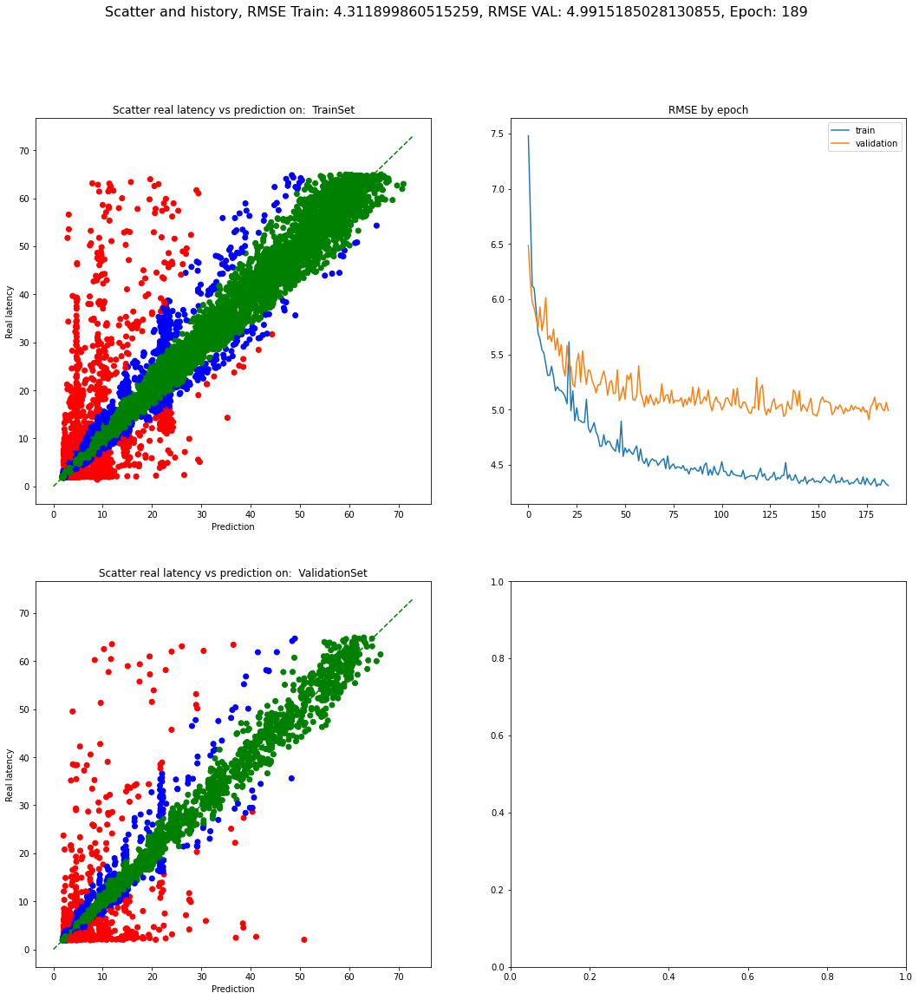

In [2]:
colums_clei = ['assign', 'bgp', 'distinct', 'extend', 'filter', 'graph', 'group',
'join', 'leftjoin','minus', 'multi', 'notoneof', 'order', 'path*',  'project', 'reduced',
'sequence', 'slice', 'tolist', 'top','treesize', 'triple', 'union' ,
'path+', 'path?', 'pathN*', 'pathN+', 'pcs0', 'pcs1', 'pcs2', 'pcs3', 'pcs4',
'pcs5', 'pcs6', 'pcs7', 'pcs8', 'pcs9', 'pcs10', 'pcs11','pcs12', 'pcs13',
'pcs14', 'pcs15', 'pcs16', 'pcs17', 'pcs18', 'pcs19', 'pcs20', 'pcs21', 'pcs22', 'pcs23', 'pcs24']


x_train_query = ds_train[colums_clei]
x_val_query   = ds_val[colums_clei]

x_train_tree = ds_train['trees'].values
x_val_tree = ds_val['trees'].values

y_train = ds_train['time'].values
y_val = ds_val['time'].values

aec_dir = '/workspace/bao_server/aec_wikidata_neo.pth'
verbose=True
reg = NeoRegression(
     aec={'train_aec': False, 'use_aec': True,'aec_file': aec_dir+str(fold)+'.pth', 'aec_epochs': 200},
     epochs=300,
     maxcardinality=0,
     in_channels_neo_net=512,
     tree_units=[512, 256, 128],
     tree_units_dense=[64, 32],
     early_stop_patience=10,
     early_stop_initial_patience=180,
     tree_activation_tree=nn.LeakyReLU,
     tree_activation_dense=nn.ReLU,
    optimizer={'optimizer': "Adam",'args':{"lr":0.00015}},
    figimage_size=(18,18),
    start_history_from_epoch=3
)

#Fit the transformer tree data
reg.fit_transform_tree_data(ds_train, ds_val, ds_test)
print("Trees tranformed!!!")


scalerx = StandardScaler()
x_train_scaled = scalerx.fit_transform(x_train_query)
x_val_scaled = scalerx.transform(x_val_query)

x_train_query =pd.DataFrame(x_train_scaled, index=x_train_query.index, columns=x_train_query.columns)
x_val_query =  pd.DataFrame(x_val_scaled,   index=x_val_query.index, columns=x_val_query.columns)

#Fit model
reg.fit(x_train_tree, x_train_query.values, y_train, x_val_tree, x_val_query.values, y_val)

In [15]:
select_query_features = {}

In [6]:
from torch.utils.data import DataLoader
def getpreds(x_val_tree, x_val_query, y_val):
    Xt, Xq, Yv = reg.json_loads(x_val_tree, x_val_query.values, y_val)
    Xt = [reg.fix_tree(x) for x in Xt]
    Xt = reg.tree_transform.transform(Xt)

    pairs_val = list(zip(list(zip(Xt, Xq)), Yv))
    dataset_val = DataLoader(pairs_val, batch_size=64, num_workers=0, shuffle=False, collate_fn=reg.collate_with_card)
    results_val = reg.predict_best(dataset_val)
    y_pred_val, y_real_val = zip(*results_val)
    mseval = mean_squared_error(y_real_val, y_pred_val)
    maeval = mean_absolute_error(y_real_val, y_pred_val)
    rmseval = np.sqrt(mseval)
    return {"pred": y_pred_val, "real" : y_real_val, "mse": mseval, "mae": maeval, "rmse": rmseval, "history": reg.history}

In [ ]:
select_query_features['tree alg graph pattern'] = getpreds(x_val_tree, x_val_query, y_val)
import pickle
file_to_store = open("./select_query_features.pickle", "wb")
pickle.dump(select_query_features, file_to_store)
file_to_store.close()

### Model for Tree Nodes, Filters + Cardinality

Model optimizer: Adam lr: 0.00015
Error in data ignored! [datasetnames ?var1]
Error in data ignored! [bgp "VAR_URI_VARᶲhttp://www.wikidata.org/prop/direct/P685"]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Trees tranformed!!!
Error in data ignored! ('[datasetnames ?var1]', array([-0.013148034373354402, -0.03797918703169246, -0.10622849251648671,
       -0.04518934294158443, -0.20309142067551939, -0.08854656891869163,
       -0.022777001373336807, -0.025182374111093933,
       -0.032219903047235605, 0.0, -0.027377705261534498,
       -0.20441362169256255, -0.04019687254657066, -0.4932712142243903,
       -0.08675863169073443, -0.0892820915232845, -0.03642625486353142,
       -0.1015021060471849, 0.0, -0.013148034373354402, 0.0,
       -0.05078060718803274, 0.0, -0.5163883581542834,
       -0.047427172804617716

[2021-01-11 18:05:19,657] INFO:model_trees_algebra:==> Epoch 0,	TRAIN_LOSS: 23689.471001852573	_TRAIN_RMSE: 153.9138427882709,	VAL_LOSS: 90.86794010818656,	VAL_RMSE: 9.532467681990145


Initial patience 180
2021-01-11 18:05:40.664027 Epoch 1, Training loss 6.160458044404671e-05


[2021-01-11 18:05:44,619] INFO:model_trees_algebra:==> Epoch 1,	TRAIN_LOSS: 78.72267321131993	_TRAIN_RMSE: 8.872579850940758,	VAL_LOSS: 60.31629330403963,	VAL_RMSE: 7.766356501219837


Initial patience 179
2021-01-11 18:06:11.627340 Epoch 2, Training loss 5.033718983789384e-05


[2021-01-11 18:06:15,524] INFO:model_trees_algebra:==> Epoch 2,	TRAIN_LOSS: 51.51757579764764	_TRAIN_RMSE: 7.177574506589788,	VAL_LOSS: 46.6933170344803,	VAL_RMSE: 6.833250839423378


Initial patience 178
2021-01-11 18:06:42.291627 Epoch 3, Training loss 4.714529999842179e-05


[2021-01-11 18:06:46,202] INFO:model_trees_algebra:==> Epoch 3,	TRAIN_LOSS: 48.387644842819434	_TRAIN_RMSE: 6.9561228312055725,	VAL_LOSS: 45.509800409613895,	VAL_RMSE: 6.7460951971947365


Initial patience 177
2021-01-11 18:07:13.421400 Epoch 4, Training loss 4.465069422430067e-05


[2021-01-11 18:07:17,310] INFO:model_trees_algebra:==> Epoch 4,	TRAIN_LOSS: 44.860209854776365	_TRAIN_RMSE: 6.69777648587771,	VAL_LOSS: 61.58629491533914,	VAL_RMSE: 7.847693604833151


Initial patience 176
2021-01-11 18:07:44.304096 Epoch 5, Training loss 4.191051160018999e-05


[2021-01-11 18:07:48,155] INFO:model_trees_algebra:==> Epoch 5,	TRAIN_LOSS: 40.78247394909175	_TRAIN_RMSE: 6.386115716857294,	VAL_LOSS: 42.50792365898766,	VAL_RMSE: 6.519810093782461


Initial patience 175
2021-01-11 18:08:15.651679 Epoch 6, Training loss 4.1405732085043426e-05


[2021-01-11 18:08:19,745] INFO:model_trees_algebra:==> Epoch 6,	TRAIN_LOSS: 40.2531995313227	_TRAIN_RMSE: 6.344540923606901,	VAL_LOSS: 52.64121729847271,	VAL_RMSE: 7.255426748198393


Initial patience 174
2021-01-11 18:08:46.916149 Epoch 7, Training loss 3.9804989299095424e-05


[2021-01-11 18:08:50,783] INFO:model_trees_algebra:==> Epoch 7,	TRAIN_LOSS: 39.74422262428876	_TRAIN_RMSE: 6.304301914112994,	VAL_LOSS: 42.44989776036946,	VAL_RMSE: 6.51535860566166


Initial patience 173
2021-01-11 18:09:17.766507 Epoch 8, Training loss 3.945024570564084e-05


[2021-01-11 18:09:21,671] INFO:model_trees_algebra:==> Epoch 8,	TRAIN_LOSS: 38.22032358297073	_TRAIN_RMSE: 6.182258776771701,	VAL_LOSS: 43.50244520116588,	VAL_RMSE: 6.595638346753548


Initial patience 172
2021-01-11 18:09:48.611326 Epoch 9, Training loss 3.946147012278284e-05


[2021-01-11 18:09:52,514] INFO:model_trees_algebra:==> Epoch 9,	TRAIN_LOSS: 65.0567081790262	_TRAIN_RMSE: 8.065773873536637,	VAL_LOSS: 42.99793846186546,	VAL_RMSE: 6.557281331608814


Initial patience 171
2021-01-11 18:10:19.655564 Epoch 10, Training loss 3.7794659777076564e-05


[2021-01-11 18:10:23,603] INFO:model_trees_algebra:==> Epoch 10,	TRAIN_LOSS: 35.91351570766775	_TRAIN_RMSE: 5.992788641998627,	VAL_LOSS: 41.481551006551065,	VAL_RMSE: 6.440617284589348


Initial patience 170
2021-01-11 18:10:50.218798 Epoch 11, Training loss 3.8298934672148074e-05


[2021-01-11 18:10:54,144] INFO:model_trees_algebra:==> Epoch 11,	TRAIN_LOSS: 37.522765449573384	_TRAIN_RMSE: 6.125582866109427,	VAL_LOSS: 43.02738213152966,	VAL_RMSE: 6.5595260599779355


Initial patience 169
2021-01-11 18:11:20.722209 Epoch 12, Training loss 3.6743641998843915e-05


[2021-01-11 18:11:24,550] INFO:model_trees_algebra:==> Epoch 12,	TRAIN_LOSS: 35.212126985013356	_TRAIN_RMSE: 5.9339807031210805,	VAL_LOSS: 44.47409476946555,	VAL_RMSE: 6.668890070278978


Initial patience 168
2021-01-11 18:11:51.784432 Epoch 13, Training loss 3.75534427803359e-05


[2021-01-11 18:11:55,629] INFO:model_trees_algebra:==> Epoch 13,	TRAIN_LOSS: 36.101150620664264	_TRAIN_RMSE: 6.008423305715424,	VAL_LOSS: 43.13142448942267,	VAL_RMSE: 6.567451902330361


Initial patience 167
2021-01-11 18:12:22.684594 Epoch 14, Training loss 3.7003569754718114e-05


[2021-01-11 18:12:26,564] INFO:model_trees_algebra:==> Epoch 14,	TRAIN_LOSS: 36.6238103369647	_TRAIN_RMSE: 6.0517609286029055,	VAL_LOSS: 43.3533434446,	VAL_RMSE: 6.584325587681703


Initial patience 166
2021-01-11 18:12:54.180267 Epoch 15, Training loss 3.614351458384883e-05


[2021-01-11 18:12:58,072] INFO:model_trees_algebra:==> Epoch 15,	TRAIN_LOSS: 33.7319101267965	_TRAIN_RMSE: 5.807917882235983,	VAL_LOSS: 44.923470255924926,	VAL_RMSE: 6.702497314876368


Initial patience 165
2021-01-11 18:13:26.117620 Epoch 16, Training loss 3.584369586322559e-05


[2021-01-11 18:13:29,985] INFO:model_trees_algebra:==> Epoch 16,	TRAIN_LOSS: 34.324799467883416	_TRAIN_RMSE: 5.85873701986046,	VAL_LOSS: 40.59925109986516,	VAL_RMSE: 6.371754161913747


Initial patience 164
2021-01-11 18:13:56.768484 Epoch 17, Training loss 3.627847678896983e-05


[2021-01-11 18:14:00,632] INFO:model_trees_algebra:==> Epoch 17,	TRAIN_LOSS: 34.555986573385894	_TRAIN_RMSE: 5.878434023903466,	VAL_LOSS: 38.91339786827313,	VAL_RMSE: 6.238060425186111


Initial patience 163
2021-01-11 18:14:27.133411 Epoch 18, Training loss 3.558766560213198e-05


[2021-01-11 18:14:31,017] INFO:model_trees_algebra:==> Epoch 18,	TRAIN_LOSS: 34.456866932353826	_TRAIN_RMSE: 5.869997183334403,	VAL_LOSS: 41.360995717828644,	VAL_RMSE: 6.431251489238206


Initial patience 162
2021-01-11 18:14:57.652561 Epoch 19, Training loss 3.5920303778949066e-05


[2021-01-11 18:15:01,465] INFO:model_trees_algebra:==> Epoch 19,	TRAIN_LOSS: 34.8570413784626	_TRAIN_RMSE: 5.903985211572146,	VAL_LOSS: 40.307859828983524,	VAL_RMSE: 6.348847125973622


Initial patience 161
2021-01-11 18:15:29.513102 Epoch 20, Training loss 3.523473299987754e-05


[2021-01-11 18:15:33,745] INFO:model_trees_algebra:==> Epoch 20,	TRAIN_LOSS: 33.03275424523623	_TRAIN_RMSE: 5.747412830590493,	VAL_LOSS: 40.72660116870366,	VAL_RMSE: 6.381739666321689


Initial patience 160
2021-01-11 18:16:01.070178 Epoch 21, Training loss 3.5172823295853714e-05


[2021-01-11 18:16:05,254] INFO:model_trees_algebra:==> Epoch 21,	TRAIN_LOSS: 33.450464407465056	_TRAIN_RMSE: 5.783637644896597,	VAL_LOSS: 39.89631911930273,	VAL_RMSE: 6.316353308619043


Initial patience 159
2021-01-11 18:16:32.566070 Epoch 22, Training loss 3.5209561385499123e-05


[2021-01-11 18:16:36,773] INFO:model_trees_algebra:==> Epoch 22,	TRAIN_LOSS: 33.454901421892856	_TRAIN_RMSE: 5.784021215546573,	VAL_LOSS: 43.49898972135564,	VAL_RMSE: 6.595376389665388


Initial patience 158
2021-01-11 18:17:04.973636 Epoch 23, Training loss 3.5884957963619486e-05


[2021-01-11 18:17:08,849] INFO:model_trees_algebra:==> Epoch 23,	TRAIN_LOSS: 35.16556257590509	_TRAIN_RMSE: 5.930055866170663,	VAL_LOSS: 44.651275160435574,	VAL_RMSE: 6.682160964870239


Initial patience 157
2021-01-11 18:17:36.134166 Epoch 24, Training loss 3.495254105287902e-05


[2021-01-11 18:17:40,518] INFO:model_trees_algebra:==> Epoch 24,	TRAIN_LOSS: 33.62351506876811	_TRAIN_RMSE: 5.798578711095341,	VAL_LOSS: 40.10060316106899,	VAL_RMSE: 6.332503703991731


Initial patience 156
2021-01-11 18:18:07.511894 Epoch 25, Training loss 3.467613164644454e-05


[2021-01-11 18:18:11,418] INFO:model_trees_algebra:==> Epoch 25,	TRAIN_LOSS: 32.61582367196849	_TRAIN_RMSE: 5.711026498972711,	VAL_LOSS: 44.95660284555133,	VAL_RMSE: 6.704968519355727


Initial patience 155
2021-01-11 18:18:38.519802 Epoch 26, Training loss 3.454873364660413e-05


[2021-01-11 18:18:42,428] INFO:model_trees_algebra:==> Epoch 26,	TRAIN_LOSS: 32.76814644934372	_TRAIN_RMSE: 5.724346814208912,	VAL_LOSS: 38.281297298351674,	VAL_RMSE: 6.187188157665134


Initial patience 154
2021-01-11 18:19:09.935818 Epoch 27, Training loss 3.4881157071738415e-05


[2021-01-11 18:19:13,839] INFO:model_trees_algebra:==> Epoch 27,	TRAIN_LOSS: 36.0634148380675	_TRAIN_RMSE: 6.005282244663235,	VAL_LOSS: 39.781108877436495,	VAL_RMSE: 6.307226718410913


Initial patience 153
2021-01-11 18:19:41.006618 Epoch 28, Training loss 3.4521050891391026e-05


[2021-01-11 18:19:44,884] INFO:model_trees_algebra:==> Epoch 28,	TRAIN_LOSS: 33.07872937780649	_TRAIN_RMSE: 5.751411077101557,	VAL_LOSS: 40.07658428180694,	VAL_RMSE: 6.330606944188443


Initial patience 152
2021-01-11 18:20:11.664408 Epoch 29, Training loss 3.444365323215052e-05


[2021-01-11 18:20:15,582] INFO:model_trees_algebra:==> Epoch 29,	TRAIN_LOSS: 32.77923841465174	_TRAIN_RMSE: 5.725315573368139,	VAL_LOSS: 40.49378878677256,	VAL_RMSE: 6.363473012968042


Initial patience 151
2021-01-11 18:20:42.303796 Epoch 30, Training loss 3.4235292209861566e-05


[2021-01-11 18:20:46,208] INFO:model_trees_algebra:==> Epoch 30,	TRAIN_LOSS: 33.21123796744204	_TRAIN_RMSE: 5.762919222706669,	VAL_LOSS: 39.85390934892671,	VAL_RMSE: 6.312995275534959


Initial patience 150
2021-01-11 18:21:12.795103 Epoch 31, Training loss 3.4374959783380444e-05


[2021-01-11 18:21:16,660] INFO:model_trees_algebra:==> Epoch 31,	TRAIN_LOSS: 32.00271221829209	_TRAIN_RMSE: 5.657093972906239,	VAL_LOSS: 41.88220940740508,	VAL_RMSE: 6.471646576212662


Initial patience 149
2021-01-11 18:21:43.446098 Epoch 32, Training loss 3.439330620019526e-05


[2021-01-11 18:21:47,409] INFO:model_trees_algebra:==> Epoch 32,	TRAIN_LOSS: 32.763377040793856	_TRAIN_RMSE: 5.7239302092874835,	VAL_LOSS: 42.77896172377129,	VAL_RMSE: 6.540562798702516


Initial patience 148
2021-01-11 18:22:14.280060 Epoch 33, Training loss 3.373881074971323e-05


[2021-01-11 18:22:18,740] INFO:model_trees_algebra:==> Epoch 33,	TRAIN_LOSS: 31.728383764738172	_TRAIN_RMSE: 5.63279537749581,	VAL_LOSS: 38.37360025888751,	VAL_RMSE: 6.194642867743669


Initial patience 147
2021-01-11 18:22:45.927118 Epoch 34, Training loss 3.383980131519061e-05


[2021-01-11 18:22:49,839] INFO:model_trees_algebra:==> Epoch 34,	TRAIN_LOSS: 32.04246627875908	_TRAIN_RMSE: 5.660606529229804,	VAL_LOSS: 39.27314774724316,	VAL_RMSE: 6.26682916212363


Initial patience 146
2021-01-11 18:23:16.057254 Epoch 35, Training loss 3.3869144106725885e-05


[2021-01-11 18:23:19,968] INFO:model_trees_algebra:==> Epoch 35,	TRAIN_LOSS: 31.71714437935558	_TRAIN_RMSE: 5.631797615269531,	VAL_LOSS: 37.67414398976434,	VAL_RMSE: 6.13792668494536


Initial patience 145
2021-01-11 18:23:46.509801 Epoch 36, Training loss 3.34212665186434e-05


[2021-01-11 18:23:50,671] INFO:model_trees_algebra:==> Epoch 36,	TRAIN_LOSS: 30.828490203933185	_TRAIN_RMSE: 5.552340966109087,	VAL_LOSS: 38.78669448374797,	VAL_RMSE: 6.2278964734288875


Initial patience 144
2021-01-11 18:24:18.368811 Epoch 37, Training loss 3.3649591610514785e-05


[2021-01-11 18:24:22,376] INFO:model_trees_algebra:==> Epoch 37,	TRAIN_LOSS: 32.434698663496576	_TRAIN_RMSE: 5.695146939587826,	VAL_LOSS: 38.99913864018701,	VAL_RMSE: 6.244929034039299


Initial patience 143
2021-01-11 18:24:48.807334 Epoch 38, Training loss 3.3186227628147705e-05


[2021-01-11 18:24:52,681] INFO:model_trees_algebra:==> Epoch 38,	TRAIN_LOSS: 31.223705190616	_TRAIN_RMSE: 5.587817569553967,	VAL_LOSS: 39.57568737385323,	VAL_RMSE: 6.290921027469128


Initial patience 142
2021-01-11 18:25:19.843440 Epoch 39, Training loss 3.3369828377853175e-05


[2021-01-11 18:25:23,721] INFO:model_trees_algebra:==> Epoch 39,	TRAIN_LOSS: 32.483538484548745	_TRAIN_RMSE: 5.699433172215351,	VAL_LOSS: 39.597639384349606,	VAL_RMSE: 6.292665522999741


Initial patience 141
2021-01-11 18:25:50.823490 Epoch 40, Training loss 3.336963861603215e-05


[2021-01-11 18:25:54,739] INFO:model_trees_algebra:==> Epoch 40,	TRAIN_LOSS: 30.73652860488714	_TRAIN_RMSE: 5.544053445349093,	VAL_LOSS: 38.27884187050589,	VAL_RMSE: 6.186989726070821


Initial patience 140
2021-01-11 18:26:21.701279 Epoch 41, Training loss 3.342546796246216e-05


[2021-01-11 18:26:25,607] INFO:model_trees_algebra:==> Epoch 41,	TRAIN_LOSS: 31.246184139084086	_TRAIN_RMSE: 5.589828632353955,	VAL_LOSS: 38.42579237455985,	VAL_RMSE: 6.19885411786403


Initial patience 139
2021-01-11 18:26:52.572178 Epoch 42, Training loss 3.327132872796799e-05


[2021-01-11 18:26:56,489] INFO:model_trees_algebra:==> Epoch 42,	TRAIN_LOSS: 31.30216552109291	_TRAIN_RMSE: 5.594833824260816,	VAL_LOSS: 39.719521485693285,	VAL_RMSE: 6.302342539539825


Initial patience 138
2021-01-11 18:27:23.873358 Epoch 43, Training loss 3.3037873794877365e-05


[2021-01-11 18:27:27,807] INFO:model_trees_algebra:==> Epoch 43,	TRAIN_LOSS: 31.505586846797748	_TRAIN_RMSE: 5.612983773965301,	VAL_LOSS: 39.86650267340919,	VAL_RMSE: 6.313992609546609


Initial patience 137
2021-01-11 18:27:54.327042 Epoch 44, Training loss 3.330846756489651e-05


[2021-01-11 18:27:58,202] INFO:model_trees_algebra:==> Epoch 44,	TRAIN_LOSS: 32.073128878049985	_TRAIN_RMSE: 5.663314301541985,	VAL_LOSS: 37.14937163364079,	VAL_RMSE: 6.095028435835291


Initial patience 136
2021-01-11 18:28:24.953411 Epoch 45, Training loss 3.267441889044226e-05


[2021-01-11 18:28:28,877] INFO:model_trees_algebra:==> Epoch 45,	TRAIN_LOSS: 30.413122645512612	_TRAIN_RMSE: 5.514809393398163,	VAL_LOSS: 37.53831686602571,	VAL_RMSE: 6.126852117198987


Initial patience 135
2021-01-11 18:28:55.736749 Epoch 46, Training loss 3.2937310411823205e-05


[2021-01-11 18:28:59,705] INFO:model_trees_algebra:==> Epoch 46,	TRAIN_LOSS: 31.100925765413656	_TRAIN_RMSE: 5.576820399243072,	VAL_LOSS: 38.34577922604025,	VAL_RMSE: 6.192396888607855


Initial patience 134
2021-01-11 18:29:26.431711 Epoch 47, Training loss 3.264920330797439e-05


[2021-01-11 18:29:30,363] INFO:model_trees_algebra:==> Epoch 47,	TRAIN_LOSS: 30.57164165944921	_TRAIN_RMSE: 5.529162835316863,	VAL_LOSS: 37.95918944322956,	VAL_RMSE: 6.161102940483105


Initial patience 133
2021-01-11 18:29:57.306062 Epoch 48, Training loss 3.278405992241271e-05


[2021-01-11 18:30:01,227] INFO:model_trees_algebra:==> Epoch 48,	TRAIN_LOSS: 31.59999673724998	_TRAIN_RMSE: 5.62138743881348,	VAL_LOSS: 39.4775146304804,	VAL_RMSE: 6.28311345039069


Initial patience 132
2021-01-11 18:30:28.453402 Epoch 49, Training loss 3.258281682870632e-05


[2021-01-11 18:30:32,408] INFO:model_trees_algebra:==> Epoch 49,	TRAIN_LOSS: 30.451492507541396	_TRAIN_RMSE: 5.518287099049975,	VAL_LOSS: 39.88412889588267,	VAL_RMSE: 6.315388261689274


Initial patience 131
2021-01-11 18:30:59.492248 Epoch 50, Training loss 3.2401833241269375e-05


[2021-01-11 18:31:03,391] INFO:model_trees_algebra:==> Epoch 50,	TRAIN_LOSS: 30.496422537810144	_TRAIN_RMSE: 5.522356610887253,	VAL_LOSS: 37.46901493292694,	VAL_RMSE: 6.121193914011133


Initial patience 130
2021-01-11 18:31:30.501005 Epoch 51, Training loss 3.292848425274701e-05


[2021-01-11 18:31:34,368] INFO:model_trees_algebra:==> Epoch 51,	TRAIN_LOSS: 31.425555851459954	_TRAIN_RMSE: 5.605850145291074,	VAL_LOSS: 38.00743431254022,	VAL_RMSE: 6.165016975851747


Initial patience 129
2021-01-11 18:32:01.232063 Epoch 52, Training loss 3.250177186125719e-05


[2021-01-11 18:32:05,119] INFO:model_trees_algebra:==> Epoch 52,	TRAIN_LOSS: 30.22869978222796	_TRAIN_RMSE: 5.498063275575133,	VAL_LOSS: 37.34156134776116,	VAL_RMSE: 6.11077420199447


Initial patience 128
2021-01-11 18:32:31.457091 Epoch 53, Training loss 3.317535674638738e-05


[2021-01-11 18:32:35,282] INFO:model_trees_algebra:==> Epoch 53,	TRAIN_LOSS: 30.52608470001802	_TRAIN_RMSE: 5.525041601654961,	VAL_LOSS: 39.491429433886914,	VAL_RMSE: 6.284220670368516


Initial patience 127
2021-01-11 18:33:01.620724 Epoch 54, Training loss 3.246000578121097e-05


[2021-01-11 18:33:05,537] INFO:model_trees_algebra:==> Epoch 54,	TRAIN_LOSS: 30.184717836235095	_TRAIN_RMSE: 5.494062052455823,	VAL_LOSS: 37.19754071206227,	VAL_RMSE: 6.098978661387681


Initial patience 126
2021-01-11 18:33:32.681830 Epoch 55, Training loss 3.274930476213126e-05


[2021-01-11 18:33:36,569] INFO:model_trees_algebra:==> Epoch 55,	TRAIN_LOSS: 30.18417709917866	_TRAIN_RMSE: 5.494012841191642,	VAL_LOSS: 39.306105073111745,	VAL_RMSE: 6.269458116385478


Initial patience 125
2021-01-11 18:34:03.369352 Epoch 56, Training loss 3.217384563644669e-05


[2021-01-11 18:34:07,236] INFO:model_trees_algebra:==> Epoch 56,	TRAIN_LOSS: 29.8210895413682	_TRAIN_RMSE: 5.460868936475971,	VAL_LOSS: 37.47293741945954,	VAL_RMSE: 6.121514307706839


Initial patience 124
2021-01-11 18:34:33.988306 Epoch 57, Training loss 3.193197640140267e-05


[2021-01-11 18:34:37,941] INFO:model_trees_algebra:==> Epoch 57,	TRAIN_LOSS: 29.903894949664352	_TRAIN_RMSE: 5.468445386914306,	VAL_LOSS: 36.721003127281485,	VAL_RMSE: 6.0597857327863895


Initial patience 123
2021-01-11 18:35:04.760038 Epoch 58, Training loss 3.2172267417669954e-05


[2021-01-11 18:35:08,572] INFO:model_trees_algebra:==> Epoch 58,	TRAIN_LOSS: 29.58231622523246	_TRAIN_RMSE: 5.438962789469373,	VAL_LOSS: 38.120575823894384,	VAL_RMSE: 6.174186247911087


Initial patience 122
2021-01-11 18:35:35.554486 Epoch 59, Training loss 3.222232044995555e-05


[2021-01-11 18:35:39,411] INFO:model_trees_algebra:==> Epoch 59,	TRAIN_LOSS: 29.976497046014675	_TRAIN_RMSE: 5.475079638326248,	VAL_LOSS: 37.142388193760695,	VAL_RMSE: 6.094455528901716


Initial patience 121
2021-01-11 18:36:06.578876 Epoch 60, Training loss 3.227515229381799e-05


[2021-01-11 18:36:10,467] INFO:model_trees_algebra:==> Epoch 60,	TRAIN_LOSS: 32.40273415420474	_TRAIN_RMSE: 5.692339954202027,	VAL_LOSS: 37.07444279744589,	VAL_RMSE: 6.0888786157588894


Initial patience 120
2021-01-11 18:36:37.568981 Epoch 61, Training loss 3.255986696039991e-05


[2021-01-11 18:36:41,403] INFO:model_trees_algebra:==> Epoch 61,	TRAIN_LOSS: 30.110467085236202	_TRAIN_RMSE: 5.487300528058966,	VAL_LOSS: 36.79785547605241,	VAL_RMSE: 6.066123595514059


Initial patience 119
2021-01-11 18:37:07.827995 Epoch 62, Training loss 3.229598157137488e-05


[2021-01-11 18:37:11,711] INFO:model_trees_algebra:==> Epoch 62,	TRAIN_LOSS: 29.774173561469837	_TRAIN_RMSE: 5.456571594093661,	VAL_LOSS: 36.57787326933295,	VAL_RMSE: 6.047964390547695


Initial patience 118
2021-01-11 18:37:38.373802 Epoch 63, Training loss 3.2160478078436536e-05


[2021-01-11 18:37:42,255] INFO:model_trees_algebra:==> Epoch 63,	TRAIN_LOSS: 29.62466658988146	_TRAIN_RMSE: 5.442854636115268,	VAL_LOSS: 36.6217746323726,	VAL_RMSE: 6.051592735170849


Initial patience 117
2021-01-11 18:38:09.014965 Epoch 64, Training loss 3.206301716748551e-05


[2021-01-11 18:38:12,967] INFO:model_trees_algebra:==> Epoch 64,	TRAIN_LOSS: 29.642067817558544	_TRAIN_RMSE: 5.444452940154644,	VAL_LOSS: 36.87192042972655,	VAL_RMSE: 6.072225327647727


Initial patience 116
2021-01-11 18:38:40.054827 Epoch 65, Training loss 3.229548599589419e-05


[2021-01-11 18:38:44,450] INFO:model_trees_algebra:==> Epoch 65,	TRAIN_LOSS: 30.3672064706677	_TRAIN_RMSE: 5.510644832564307,	VAL_LOSS: 36.72072481995141,	VAL_RMSE: 6.05976276927995


Initial patience 115
2021-01-11 18:39:12.581822 Epoch 66, Training loss 3.202040409925575e-05


[2021-01-11 18:39:16,770] INFO:model_trees_algebra:==> Epoch 66,	TRAIN_LOSS: 29.590286410256542	_TRAIN_RMSE: 5.439695433593368,	VAL_LOSS: 36.42636564508805,	VAL_RMSE: 6.035425887631133


Initial patience 114
2021-01-11 18:39:45.204227 Epoch 67, Training loss 3.179356293453393e-05


[2021-01-11 18:39:49,583] INFO:model_trees_algebra:==> Epoch 67,	TRAIN_LOSS: 29.037666161804506	_TRAIN_RMSE: 5.3886608876236135,	VAL_LOSS: 37.93558232532298,	VAL_RMSE: 6.1591868233820435


Initial patience 113
2021-01-11 18:40:17.649814 Epoch 68, Training loss 3.189177612977902e-05


[2021-01-11 18:40:22,052] INFO:model_trees_algebra:==> Epoch 68,	TRAIN_LOSS: 30.531737831422397	_TRAIN_RMSE: 5.525553169721779,	VAL_LOSS: 39.298574885105076,	VAL_RMSE: 6.26885754225641


Initial patience 112
2021-01-11 18:40:49.953749 Epoch 69, Training loss 3.221536486421034e-05


[2021-01-11 18:40:54,176] INFO:model_trees_algebra:==> Epoch 69,	TRAIN_LOSS: 29.771443487703525	_TRAIN_RMSE: 5.4563214245225256,	VAL_LOSS: 36.884697326763465,	VAL_RMSE: 6.073277313507384


Initial patience 111
2021-01-11 18:41:22.242038 Epoch 70, Training loss 3.218145292903878e-05


[2021-01-11 18:41:26,418] INFO:model_trees_algebra:==> Epoch 70,	TRAIN_LOSS: 30.672509212494067	_TRAIN_RMSE: 5.538276736720012,	VAL_LOSS: 37.4130495525439,	VAL_RMSE: 6.116620762524345


Initial patience 110
2021-01-11 18:41:53.777465 Epoch 71, Training loss 3.2162839216373e-05


[2021-01-11 18:41:57,761] INFO:model_trees_algebra:==> Epoch 71,	TRAIN_LOSS: 28.910491186331445	_TRAIN_RMSE: 5.376847699752286,	VAL_LOSS: 36.81097019999607,	VAL_RMSE: 6.067204479823972


Initial patience 109
2021-01-11 18:42:25.233674 Epoch 72, Training loss 3.202286938849724e-05


[2021-01-11 18:42:29,241] INFO:model_trees_algebra:==> Epoch 72,	TRAIN_LOSS: 29.25917453216643	_TRAIN_RMSE: 5.409175032494921,	VAL_LOSS: 36.626027076348,	VAL_RMSE: 6.051944074125934


Initial patience 108
2021-01-11 18:42:56.399192 Epoch 73, Training loss 3.1854178373212336e-05


[2021-01-11 18:43:00,454] INFO:model_trees_algebra:==> Epoch 73,	TRAIN_LOSS: 29.12267957052507	_TRAIN_RMSE: 5.396543298309119,	VAL_LOSS: 36.33478518152443,	VAL_RMSE: 6.027834203221289


Initial patience 107
2021-01-11 18:43:27.856055 Epoch 74, Training loss 3.180951090131347e-05


[2021-01-11 18:43:32,057] INFO:model_trees_algebra:==> Epoch 74,	TRAIN_LOSS: 29.49872763412179	_TRAIN_RMSE: 5.431273113563871,	VAL_LOSS: 37.89833391867329,	VAL_RMSE: 6.1561622719575295


Initial patience 106
2021-01-11 18:43:59.450930 Epoch 75, Training loss 3.173150089644163e-05


[2021-01-11 18:44:03,632] INFO:model_trees_algebra:==> Epoch 75,	TRAIN_LOSS: 29.75122256841589	_TRAIN_RMSE: 5.454468128829418,	VAL_LOSS: 37.91750858218785,	VAL_RMSE: 6.157719430291368


Initial patience 105
2021-01-11 18:44:30.654629 Epoch 76, Training loss 3.170931398876416e-05


[2021-01-11 18:44:34,546] INFO:model_trees_algebra:==> Epoch 76,	TRAIN_LOSS: 29.282114603063082	_TRAIN_RMSE: 5.411295094805224,	VAL_LOSS: 37.01435205902246,	VAL_RMSE: 6.0839421479023335


Initial patience 104
2021-01-11 18:45:00.618473 Epoch 77, Training loss 3.184414026533877e-05


[2021-01-11 18:45:04,526] INFO:model_trees_algebra:==> Epoch 77,	TRAIN_LOSS: 30.254132923143427	_TRAIN_RMSE: 5.5003757074533945,	VAL_LOSS: 36.88750017377922,	VAL_RMSE: 6.073508061555465


Initial patience 103
2021-01-11 18:45:30.574151 Epoch 78, Training loss 3.183618013954842e-05


[2021-01-11 18:45:34,391] INFO:model_trees_algebra:==> Epoch 78,	TRAIN_LOSS: 29.698662118203828	_TRAIN_RMSE: 5.449647889378159,	VAL_LOSS: 37.67503341413477,	VAL_RMSE: 6.13799913767791


Initial patience 102
2021-01-11 18:46:00.422756 Epoch 79, Training loss 3.18350523684785e-05


[2021-01-11 18:46:04,372] INFO:model_trees_algebra:==> Epoch 79,	TRAIN_LOSS: 29.942772501162345	_TRAIN_RMSE: 5.471998949302014,	VAL_LOSS: 37.31091674901169,	VAL_RMSE: 6.108266263761894


Initial patience 101
2021-01-11 18:46:30.624959 Epoch 80, Training loss 3.1590082927987266e-05


[2021-01-11 18:46:34,433] INFO:model_trees_algebra:==> Epoch 80,	TRAIN_LOSS: 28.687054653443187	_TRAIN_RMSE: 5.356029747251521,	VAL_LOSS: 38.50003924627632,	VAL_RMSE: 6.204839985549694


Initial patience 100
2021-01-11 18:47:00.659506 Epoch 81, Training loss 3.19275681907296e-05


[2021-01-11 18:47:04,553] INFO:model_trees_algebra:==> Epoch 81,	TRAIN_LOSS: 29.330551729624627	_TRAIN_RMSE: 5.415768803191716,	VAL_LOSS: 38.62865518487048,	VAL_RMSE: 6.215195506568597


Initial patience 99
2021-01-11 18:47:31.088277 Epoch 82, Training loss 3.211973282751705e-05


[2021-01-11 18:47:34,997] INFO:model_trees_algebra:==> Epoch 82,	TRAIN_LOSS: 29.778286737389404	_TRAIN_RMSE: 5.456948482200414,	VAL_LOSS: 37.194127383669915,	VAL_RMSE: 6.098698827099918


Initial patience 98
2021-01-11 18:48:01.519370 Epoch 83, Training loss 3.1970259722546394e-05


[2021-01-11 18:48:05,418] INFO:model_trees_algebra:==> Epoch 83,	TRAIN_LOSS: 29.626471575603347	_TRAIN_RMSE: 5.443020446002692,	VAL_LOSS: 35.94094777279524,	VAL_RMSE: 5.995076961373827


Initial patience 97
2021-01-11 18:48:31.817996 Epoch 84, Training loss 3.1666980972520606e-05


[2021-01-11 18:48:35,719] INFO:model_trees_algebra:==> Epoch 84,	TRAIN_LOSS: 29.279834275564053	_TRAIN_RMSE: 5.411084389987283,	VAL_LOSS: 37.67703309781258,	VAL_RMSE: 6.138162029289597


Initial patience 96
2021-01-11 18:49:01.666919 Epoch 85, Training loss 3.158838450170491e-05


[2021-01-11 18:49:05,540] INFO:model_trees_algebra:==> Epoch 85,	TRAIN_LOSS: 28.780125882185537	_TRAIN_RMSE: 5.364711164842478,	VAL_LOSS: 37.03568557563052,	VAL_RMSE: 6.085695159604243


Initial patience 95
2021-01-11 18:49:32.026313 Epoch 86, Training loss 3.16406294177953e-05


[2021-01-11 18:49:35,900] INFO:model_trees_algebra:==> Epoch 86,	TRAIN_LOSS: 29.272779033180235	_TRAIN_RMSE: 5.4104324257105585,	VAL_LOSS: 40.02485419571842,	VAL_RMSE: 6.326519911904049


Initial patience 94
2021-01-11 18:50:02.622771 Epoch 87, Training loss 3.159452187580481e-05


[2021-01-11 18:50:06,555] INFO:model_trees_algebra:==> Epoch 87,	TRAIN_LOSS: 29.20849368891437	_TRAIN_RMSE: 5.404488291125661,	VAL_LOSS: 38.20941703794168,	VAL_RMSE: 6.181376629678997


Initial patience 93
2021-01-11 18:50:33.098953 Epoch 88, Training loss 3.1690312147267496e-05


[2021-01-11 18:50:36,998] INFO:model_trees_algebra:==> Epoch 88,	TRAIN_LOSS: 29.25365399292114	_TRAIN_RMSE: 5.408664714411603,	VAL_LOSS: 38.253009390557146,	VAL_RMSE: 6.184901728447845


Initial patience 92
2021-01-11 18:51:03.257615 Epoch 89, Training loss 3.165540128440411e-05


[2021-01-11 18:51:07,144] INFO:model_trees_algebra:==> Epoch 89,	TRAIN_LOSS: 32.18548614858775	_TRAIN_RMSE: 5.6732253743869325,	VAL_LOSS: 36.46948424262501,	VAL_RMSE: 6.038996956666314


Initial patience 91
2021-01-11 18:51:33.717749 Epoch 90, Training loss 3.2460548387638276e-05


[2021-01-11 18:51:37,651] INFO:model_trees_algebra:==> Epoch 90,	TRAIN_LOSS: 28.813158563465123	_TRAIN_RMSE: 5.367788982762374,	VAL_LOSS: 39.61134637095257,	VAL_RMSE: 6.293754552804913


Initial patience 90
2021-01-11 18:52:03.966467 Epoch 91, Training loss 3.1759510205884755e-05


[2021-01-11 18:52:07,819] INFO:model_trees_algebra:==> Epoch 91,	TRAIN_LOSS: 29.951658042175858	_TRAIN_RMSE: 5.4728107990479495,	VAL_LOSS: 36.685608695012256,	VAL_RMSE: 6.056864592758555


Initial patience 89
2021-01-11 18:52:34.300745 Epoch 92, Training loss 3.1439671394817944e-05


[2021-01-11 18:52:38,219] INFO:model_trees_algebra:==> Epoch 92,	TRAIN_LOSS: 28.702209898507576	_TRAIN_RMSE: 5.357444343948668,	VAL_LOSS: 37.71200542072041,	VAL_RMSE: 6.141010130322242


Initial patience 88
2021-01-11 18:53:05.402572 Epoch 93, Training loss 3.1462973860294576e-05


[2021-01-11 18:53:09,314] INFO:model_trees_algebra:==> Epoch 93,	TRAIN_LOSS: 28.977337514994662	_TRAIN_RMSE: 5.383060236983668,	VAL_LOSS: 37.153903315204666,	VAL_RMSE: 6.095400176789434


Initial patience 87
2021-01-11 18:53:37.304435 Epoch 94, Training loss 3.155639942035632e-05


[2021-01-11 18:53:41,589] INFO:model_trees_algebra:==> Epoch 94,	TRAIN_LOSS: 29.058129413194813	_TRAIN_RMSE: 5.390559285750859,	VAL_LOSS: 37.15875096722738,	VAL_RMSE: 6.0957978122004155


Initial patience 86
2021-01-11 18:54:08.986895 Epoch 95, Training loss 3.174804113702826e-05


[2021-01-11 18:54:12,887] INFO:model_trees_algebra:==> Epoch 95,	TRAIN_LOSS: 28.92278633611753	_TRAIN_RMSE: 5.377990920047888,	VAL_LOSS: 36.88877203796719,	VAL_RMSE: 6.073612766547369


Initial patience 85
2021-01-11 18:54:39.707204 Epoch 96, Training loss 3.143988261748821e-05


[2021-01-11 18:54:43,553] INFO:model_trees_algebra:==> Epoch 96,	TRAIN_LOSS: 28.60126402275811	_TRAIN_RMSE: 5.3480149609699215,	VAL_LOSS: 37.34233614756174,	VAL_RMSE: 6.110837597871648


Initial patience 84
2021-01-11 18:55:10.279635 Epoch 97, Training loss 3.130953127513915e-05


[2021-01-11 18:55:14,195] INFO:model_trees_algebra:==> Epoch 97,	TRAIN_LOSS: 28.60361633506719	_TRAIN_RMSE: 5.348234880319598,	VAL_LOSS: 37.07768629930813,	VAL_RMSE: 6.089144956338955


Initial patience 83
2021-01-11 18:55:41.458708 Epoch 98, Training loss 3.133197785614215e-05


[2021-01-11 18:55:45,501] INFO:model_trees_algebra:==> Epoch 98,	TRAIN_LOSS: 28.714343810152016	_TRAIN_RMSE: 5.358576658978764,	VAL_LOSS: 36.85316385402243,	VAL_RMSE: 6.070680674687347


Initial patience 82
2021-01-11 18:56:12.170607 Epoch 99, Training loss 3.163374003476737e-05


[2021-01-11 18:56:16,063] INFO:model_trees_algebra:==> Epoch 99,	TRAIN_LOSS: 28.85236220737934	_TRAIN_RMSE: 5.371439491177327,	VAL_LOSS: 36.635634018630135,	VAL_RMSE: 6.052737729212305


Initial patience 81
2021-01-11 18:56:42.865285 Epoch 100, Training loss 3.168099729922196e-05


[2021-01-11 18:56:46,718] INFO:model_trees_algebra:==> Epoch 100,	TRAIN_LOSS: 29.461172100042543	_TRAIN_RMSE: 5.427814670753096,	VAL_LOSS: 39.36143148801425,	VAL_RMSE: 6.273868940933836


Initial patience 80
2021-01-11 18:57:13.875633 Epoch 101, Training loss 3.154837524442439e-05


[2021-01-11 18:57:18,354] INFO:model_trees_algebra:==> Epoch 101,	TRAIN_LOSS: 29.322459186543362	_TRAIN_RMSE: 5.415021623829711,	VAL_LOSS: 36.87676613991061,	VAL_RMSE: 6.072624320663234


Initial patience 79
2021-01-11 18:57:46.643363 Epoch 102, Training loss 3.149549597466176e-05


[2021-01-11 18:57:50,800] INFO:model_trees_algebra:==> Epoch 102,	TRAIN_LOSS: 28.70343370314447	_TRAIN_RMSE: 5.357558558069568,	VAL_LOSS: 38.328131040883385,	VAL_RMSE: 6.190971736398365


Initial patience 78
2021-01-11 18:58:18.755482 Epoch 103, Training loss 3.168588514404213e-05


[2021-01-11 18:58:22,943] INFO:model_trees_algebra:==> Epoch 103,	TRAIN_LOSS: 29.09029788151929	_TRAIN_RMSE: 5.39354223878142,	VAL_LOSS: 38.070033920158686,	VAL_RMSE: 6.1700918891179155


Initial patience 77
2021-01-11 18:58:49.726106 Epoch 104, Training loss 3.174811790121343e-05


[2021-01-11 18:58:53,634] INFO:model_trees_algebra:==> Epoch 104,	TRAIN_LOSS: 29.061727251056105	_TRAIN_RMSE: 5.390892991987144,	VAL_LOSS: 37.25275246161354,	VAL_RMSE: 6.103503294142925


Initial patience 76
2021-01-11 18:59:21.605023 Epoch 105, Training loss 3.1381623208214435e-05


[2021-01-11 18:59:25,983] INFO:model_trees_algebra:==> Epoch 105,	TRAIN_LOSS: 28.704699413129532	_TRAIN_RMSE: 5.357676680533227,	VAL_LOSS: 38.37432149115627,	VAL_RMSE: 6.194701081662962


Initial patience 75
2021-01-11 18:59:54.019075 Epoch 106, Training loss 3.136606590796055e-05


[2021-01-11 18:59:58,245] INFO:model_trees_algebra:==> Epoch 106,	TRAIN_LOSS: 28.555167291319083	_TRAIN_RMSE: 5.3437035182838395,	VAL_LOSS: 37.0015599184236,	VAL_RMSE: 6.082890753451323


Initial patience 74
2021-01-11 19:00:26.105124 Epoch 107, Training loss 3.1460353385765936e-05


[2021-01-11 19:00:30,323] INFO:model_trees_algebra:==> Epoch 107,	TRAIN_LOSS: 29.354990301564225	_TRAIN_RMSE: 5.4180245755777285,	VAL_LOSS: 36.38185750712553,	VAL_RMSE: 6.0317375197471526


Initial patience 73
2021-01-11 19:00:58.216235 Epoch 108, Training loss 3.124541034087912e-05


[2021-01-11 19:01:02,548] INFO:model_trees_algebra:==> Epoch 108,	TRAIN_LOSS: 28.66657133526336	_TRAIN_RMSE: 5.354117232118042,	VAL_LOSS: 38.09299198140226,	VAL_RMSE: 6.171952039784679


Initial patience 72
2021-01-11 19:01:30.457116 Epoch 109, Training loss 3.1363833498141834e-05


[2021-01-11 19:01:34,578] INFO:model_trees_algebra:==> Epoch 109,	TRAIN_LOSS: 28.736806109423345	_TRAIN_RMSE: 5.360672169553306,	VAL_LOSS: 38.47756196166247,	VAL_RMSE: 6.203028450818396


Initial patience 71
2021-01-11 19:02:02.397216 Epoch 110, Training loss 3.1303685134460336e-05


[2021-01-11 19:02:06,671] INFO:model_trees_algebra:==> Epoch 110,	TRAIN_LOSS: 28.856017759935316	_TRAIN_RMSE: 5.371779757206667,	VAL_LOSS: 39.14620277337321,	VAL_RMSE: 6.256692638556989


Initial patience 70
2021-01-11 19:02:34.070045 Epoch 111, Training loss 3.1938929973041966e-05


[2021-01-11 19:02:38,215] INFO:model_trees_algebra:==> Epoch 111,	TRAIN_LOSS: 28.7321840425201	_TRAIN_RMSE: 5.360241043322595,	VAL_LOSS: 35.893268200835145,	VAL_RMSE: 5.991099081206649


Initial patience 69
2021-01-11 19:03:05.858187 Epoch 112, Training loss 3.1484744420809235e-05


[2021-01-11 19:03:09,964] INFO:model_trees_algebra:==> Epoch 112,	TRAIN_LOSS: 28.876226865867626	_TRAIN_RMSE: 5.373660471770395,	VAL_LOSS: 40.658437457494905,	VAL_RMSE: 6.376396902443801


Initial patience 68
2021-01-11 19:03:37.711416 Epoch 113, Training loss 3.1391608393193177e-05


[2021-01-11 19:03:41,880] INFO:model_trees_algebra:==> Epoch 113,	TRAIN_LOSS: 28.686726814953946	_TRAIN_RMSE: 5.355999142546043,	VAL_LOSS: 36.33113652041426,	VAL_RMSE: 6.027531544539129


Initial patience 67
2021-01-11 19:04:09.830950 Epoch 114, Training loss 3.2243848965292e-05


[2021-01-11 19:04:14,082] INFO:model_trees_algebra:==> Epoch 114,	TRAIN_LOSS: 28.90770405796307	_TRAIN_RMSE: 5.3765885148449915,	VAL_LOSS: 36.558526143587876,	VAL_RMSE: 6.046364704811303


Initial patience 66
2021-01-11 19:04:41.973742 Epoch 115, Training loss 3.1483814205992866e-05


[2021-01-11 19:04:46,210] INFO:model_trees_algebra:==> Epoch 115,	TRAIN_LOSS: 28.80101388104165	_TRAIN_RMSE: 5.366657607956898,	VAL_LOSS: 38.24887817569132,	VAL_RMSE: 6.184567743641533


Initial patience 65
2021-01-11 19:05:13.769445 Epoch 116, Training loss 3.131145728594866e-05


[2021-01-11 19:05:17,847] INFO:model_trees_algebra:==> Epoch 116,	TRAIN_LOSS: 29.09791750354013	_TRAIN_RMSE: 5.39424855781972,	VAL_LOSS: 37.637819782918996,	VAL_RMSE: 6.134966974884135


Initial patience 64
2021-01-11 19:05:44.565064 Epoch 117, Training loss 3.134827550553905e-05


[2021-01-11 19:05:48,978] INFO:model_trees_algebra:==> Epoch 117,	TRAIN_LOSS: 28.89005040674353	_TRAIN_RMSE: 5.374946549198748,	VAL_LOSS: 36.55632355996788,	VAL_RMSE: 6.046182560919566


Initial patience 63
2021-01-11 19:06:16.071185 Epoch 118, Training loss 3.126646502835818e-05


[2021-01-11 19:06:20,346] INFO:model_trees_algebra:==> Epoch 118,	TRAIN_LOSS: 28.57814456635143	_TRAIN_RMSE: 5.3458530251355985,	VAL_LOSS: 36.37331509557672,	VAL_RMSE: 6.031029356219112


Initial patience 62
2021-01-11 19:06:48.790291 Epoch 119, Training loss 3.107937970862842e-05


[2021-01-11 19:06:53,096] INFO:model_trees_algebra:==> Epoch 119,	TRAIN_LOSS: 28.494451608420302	_TRAIN_RMSE: 5.3380194462384924,	VAL_LOSS: 36.714605320041066,	VAL_RMSE: 6.059257819241649


Initial patience 61
2021-01-11 19:07:19.810857 Epoch 120, Training loss 3.121312613647895e-05


[2021-01-11 19:07:23,770] INFO:model_trees_algebra:==> Epoch 120,	TRAIN_LOSS: 28.5803352371429	_TRAIN_RMSE: 5.346057915618096,	VAL_LOSS: 36.393654126600005,	VAL_RMSE: 6.032715319538956


Initial patience 60
2021-01-11 19:07:52.204735 Epoch 121, Training loss 3.1249256860684596e-05


[2021-01-11 19:07:56,612] INFO:model_trees_algebra:==> Epoch 121,	TRAIN_LOSS: 28.938400440245786	_TRAIN_RMSE: 5.379442391200578,	VAL_LOSS: 36.556681638691586,	VAL_RMSE: 6.046212172814611


Initial patience 59
2021-01-11 19:08:24.838465 Epoch 122, Training loss 3.13437800227126e-05


[2021-01-11 19:08:29,022] INFO:model_trees_algebra:==> Epoch 122,	TRAIN_LOSS: 28.868339720547993	_TRAIN_RMSE: 5.372926550823861,	VAL_LOSS: 36.93958879188018,	VAL_RMSE: 6.077794730976046


Initial patience 58
2021-01-11 19:08:56.714972 Epoch 123, Training loss 3.133602491087501e-05


[2021-01-11 19:09:00,590] INFO:model_trees_algebra:==> Epoch 123,	TRAIN_LOSS: 28.69840658587799	_TRAIN_RMSE: 5.357089376319756,	VAL_LOSS: 36.59599539197345,	VAL_RMSE: 6.049462405203743


Initial patience 57
2021-01-11 19:09:27.986528 Epoch 124, Training loss 3.1195788252516904e-05


[2021-01-11 19:09:31,903] INFO:model_trees_algebra:==> Epoch 124,	TRAIN_LOSS: 28.449927218388627	_TRAIN_RMSE: 5.3338473186236435,	VAL_LOSS: 37.44435826829123,	VAL_RMSE: 6.119179542086605


Initial patience 56
2021-01-11 19:09:58.283161 Epoch 125, Training loss 3.1734019059110415e-05


[2021-01-11 19:10:02,316] INFO:model_trees_algebra:==> Epoch 125,	TRAIN_LOSS: 29.5896696654488	_TRAIN_RMSE: 5.439638744020488,	VAL_LOSS: 43.54868507966946,	VAL_RMSE: 6.5991427533937665


Initial patience 55
2021-01-11 19:10:28.782027 Epoch 126, Training loss 3.1586770840958174e-05


[2021-01-11 19:10:32,718] INFO:model_trees_algebra:==> Epoch 126,	TRAIN_LOSS: 29.122610482797906	_TRAIN_RMSE: 5.396536897196007,	VAL_LOSS: 36.63320996037223,	VAL_RMSE: 6.052537481120809


Initial patience 54
2021-01-11 19:11:00.854478 Epoch 127, Training loss 3.114624521623828e-05


[2021-01-11 19:11:04,753] INFO:model_trees_algebra:==> Epoch 127,	TRAIN_LOSS: 28.543614939677816	_TRAIN_RMSE: 5.342622477742351,	VAL_LOSS: 37.97755972460582,	VAL_RMSE: 6.162593587492673


Initial patience 53
2021-01-11 19:11:31.148869 Epoch 128, Training loss 3.1200935013012585e-05


[2021-01-11 19:11:35,029] INFO:model_trees_algebra:==> Epoch 128,	TRAIN_LOSS: 28.72373665251755	_TRAIN_RMSE: 5.359453018034355,	VAL_LOSS: 37.94533489277582,	VAL_RMSE: 6.159978481518894


Initial patience 52
2021-01-11 19:12:01.401579 Epoch 129, Training loss 3.1146470402720583e-05


[2021-01-11 19:12:05,347] INFO:model_trees_algebra:==> Epoch 129,	TRAIN_LOSS: 28.475005465186406	_TRAIN_RMSE: 5.336197659868533,	VAL_LOSS: 37.343010551952574,	VAL_RMSE: 6.110892778633296


Initial patience 51
2021-01-11 19:12:32.468381 Epoch 130, Training loss 3.1068857122624044e-05


[2021-01-11 19:12:36,484] INFO:model_trees_algebra:==> Epoch 130,	TRAIN_LOSS: 28.377646506958836	_TRAIN_RMSE: 5.327067345825359,	VAL_LOSS: 37.880622960922516,	VAL_RMSE: 6.154723629938433


Initial patience 50
2021-01-11 19:13:03.674145 Epoch 131, Training loss 3.105203282642562e-05


[2021-01-11 19:13:07,571] INFO:model_trees_algebra:==> Epoch 131,	TRAIN_LOSS: 28.733224413374195	_TRAIN_RMSE: 5.360338087599904,	VAL_LOSS: 36.56645618214172,	VAL_RMSE: 6.047020438376385


Initial patience 49
2021-01-11 19:13:34.598621 Epoch 132, Training loss 3.1146398554212666e-05


[2021-01-11 19:13:38,576] INFO:model_trees_algebra:==> Epoch 132,	TRAIN_LOSS: 28.463607145105787	_TRAIN_RMSE: 5.335129534051239,	VAL_LOSS: 37.258539633933836,	VAL_RMSE: 6.103977361846441


Initial patience 48
2021-01-11 19:14:05.763174 Epoch 133, Training loss 3.107619970760928e-05


[2021-01-11 19:14:09,756] INFO:model_trees_algebra:==> Epoch 133,	TRAIN_LOSS: 28.36412831660426	_TRAIN_RMSE: 5.32579837363416,	VAL_LOSS: 38.75658152262381,	VAL_RMSE: 6.225478417167937


Initial patience 47
2021-01-11 19:14:37.087154 Epoch 134, Training loss 3.10560105099615e-05


[2021-01-11 19:14:41,382] INFO:model_trees_algebra:==> Epoch 134,	TRAIN_LOSS: 28.499681846504515	_TRAIN_RMSE: 5.338509328127517,	VAL_LOSS: 38.051985606887094,	VAL_RMSE: 6.168629151350168


Initial patience 46
2021-01-11 19:15:09.289888 Epoch 135, Training loss 3.12837212544871e-05


[2021-01-11 19:15:13,288] INFO:model_trees_algebra:==> Epoch 135,	TRAIN_LOSS: 29.087111444306878	_TRAIN_RMSE: 5.39324683695331,	VAL_LOSS: 38.0840195724216,	VAL_RMSE: 6.171225127348832


Initial patience 45
2021-01-11 19:15:40.390773 Epoch 136, Training loss 3.120682308171186e-05


[2021-01-11 19:15:44,302] INFO:model_trees_algebra:==> Epoch 136,	TRAIN_LOSS: 28.67551435322024	_TRAIN_RMSE: 5.35495232034985,	VAL_LOSS: 36.47914570853666,	VAL_RMSE: 6.03979682675971


Initial patience 44
2021-01-11 19:16:11.272624 Epoch 137, Training loss 3.110269602462363e-05


[2021-01-11 19:16:15,302] INFO:model_trees_algebra:==> Epoch 137,	TRAIN_LOSS: 28.5962792155267	_TRAIN_RMSE: 5.347548897908901,	VAL_LOSS: 37.104720917028246,	VAL_RMSE: 6.091364454457494


Initial patience 43
2021-01-11 19:16:42.094788 Epoch 138, Training loss 3.1110802108578415e-05


[2021-01-11 19:16:46,057] INFO:model_trees_algebra:==> Epoch 138,	TRAIN_LOSS: 28.59720338169808	_TRAIN_RMSE: 5.347635307469843,	VAL_LOSS: 36.929609490134055,	VAL_RMSE: 6.076973711489466


Initial patience 42
2021-01-11 19:17:13.139052 Epoch 139, Training loss 3.1000117917262056e-05


[2021-01-11 19:17:17,051] INFO:model_trees_algebra:==> Epoch 139,	TRAIN_LOSS: 28.216619040443632	_TRAIN_RMSE: 5.311931761651653,	VAL_LOSS: 36.214153685372295,	VAL_RMSE: 6.017819678701938


Initial patience 41
2021-01-11 19:17:44.615101 Epoch 140, Training loss 3.122742520431262e-05


[2021-01-11 19:17:48,567] INFO:model_trees_algebra:==> Epoch 140,	TRAIN_LOSS: 28.56944889407832	_TRAIN_RMSE: 5.345039653181098,	VAL_LOSS: 36.43398563871325,	VAL_RMSE: 6.036057126859657


Initial patience 40
2021-01-11 19:18:17.308887 Epoch 141, Training loss 3.100281121470103e-05


[2021-01-11 19:18:21,360] INFO:model_trees_algebra:==> Epoch 141,	TRAIN_LOSS: 28.407348221621262	_TRAIN_RMSE: 5.3298544278076925,	VAL_LOSS: 36.86251768506779,	VAL_RMSE: 6.07145103620772


Initial patience 39
2021-01-11 19:18:47.510881 Epoch 142, Training loss 3.111654602236746e-05


[2021-01-11 19:18:51,354] INFO:model_trees_algebra:==> Epoch 142,	TRAIN_LOSS: 28.441049595249577	_TRAIN_RMSE: 5.33301505672444,	VAL_LOSS: 36.72349985191799,	VAL_RMSE: 6.059991736951297


Initial patience 38
2021-01-11 19:19:17.259090 Epoch 143, Training loss 3.1397496362760685e-05


[2021-01-11 19:19:21,050] INFO:model_trees_algebra:==> Epoch 143,	TRAIN_LOSS: 28.543017309953594	_TRAIN_RMSE: 5.342566547077687,	VAL_LOSS: 36.896404623158716,	VAL_RMSE: 6.074241073842782


Initial patience 37
2021-01-11 19:19:48.113796 Epoch 144, Training loss 3.101567639450909e-05


[2021-01-11 19:19:52,014] INFO:model_trees_algebra:==> Epoch 144,	TRAIN_LOSS: 28.37678499836748	_TRAIN_RMSE: 5.326986483779312,	VAL_LOSS: 36.67942831687406,	VAL_RMSE: 6.056354375106699


Initial patience 36
2021-01-11 19:20:18.385331 Epoch 145, Training loss 3.0926794551963376e-05


[2021-01-11 19:20:22,200] INFO:model_trees_algebra:==> Epoch 145,	TRAIN_LOSS: 28.286496626199018	_TRAIN_RMSE: 5.318505111983913,	VAL_LOSS: 37.28676050563182,	VAL_RMSE: 6.106288603205045


Initial patience 35
2021-01-11 19:20:48.996515 Epoch 146, Training loss 3.102860845718855e-05


[2021-01-11 19:20:53,019] INFO:model_trees_algebra:==> Epoch 146,	TRAIN_LOSS: 28.370994483430245	_TRAIN_RMSE: 5.326442948481683,	VAL_LOSS: 37.39878724984644,	VAL_RMSE: 6.115454786836907


Initial patience 34
2021-01-11 19:21:19.414223 Epoch 147, Training loss 3.096746918604792e-05


[2021-01-11 19:21:23,266] INFO:model_trees_algebra:==> Epoch 147,	TRAIN_LOSS: 28.360646436284185	_TRAIN_RMSE: 5.325471475492493,	VAL_LOSS: 36.72867270555959,	VAL_RMSE: 6.060418525610223


Initial patience 33
2021-01-11 19:21:49.209614 Epoch 148, Training loss 3.0995657347702825e-05


[2021-01-11 19:21:53,095] INFO:model_trees_algebra:==> Epoch 148,	TRAIN_LOSS: 28.52938702571045	_TRAIN_RMSE: 5.341290764011116,	VAL_LOSS: 36.60231555807175,	VAL_RMSE: 6.049984756846231


Initial patience 32
2021-01-11 19:22:19.237421 Epoch 149, Training loss 3.106844607960128e-05


[2021-01-11 19:22:23,079] INFO:model_trees_algebra:==> Epoch 149,	TRAIN_LOSS: 28.090163086056435	_TRAIN_RMSE: 5.3000153854546905,	VAL_LOSS: 37.09079431461053,	VAL_RMSE: 6.090221204078759


Initial patience 31
2021-01-11 19:22:49.166449 Epoch 150, Training loss 3.166316953513576e-05


[2021-01-11 19:22:53,064] INFO:model_trees_algebra:==> Epoch 150,	TRAIN_LOSS: 28.76146359725582	_TRAIN_RMSE: 5.362971526798908,	VAL_LOSS: 39.94805412684922,	VAL_RMSE: 6.320447304332916


Initial patience 30
2021-01-11 19:23:19.651656 Epoch 151, Training loss 3.113536765016396e-05


[2021-01-11 19:23:23,712] INFO:model_trees_algebra:==> Epoch 151,	TRAIN_LOSS: 28.90300029127546	_TRAIN_RMSE: 5.376151066634518,	VAL_LOSS: 36.68405632879494,	VAL_RMSE: 6.0567364420779395


Initial patience 29
2021-01-11 19:23:50.318847 Epoch 152, Training loss 3.107070481284017e-05


[2021-01-11 19:23:54,464] INFO:model_trees_algebra:==> Epoch 152,	TRAIN_LOSS: 28.238297459364873	_TRAIN_RMSE: 5.313971909914924,	VAL_LOSS: 38.781077785230096,	VAL_RMSE: 6.227445526476333


Initial patience 28
2021-01-11 19:24:20.211417 Epoch 153, Training loss 3.0919282229579076e-05


[2021-01-11 19:24:24,100] INFO:model_trees_algebra:==> Epoch 153,	TRAIN_LOSS: 28.46649343177295	_TRAIN_RMSE: 5.335400025468845,	VAL_LOSS: 36.75937497229519,	VAL_RMSE: 6.062951011866679


Initial patience 27
2021-01-11 19:24:50.252730 Epoch 154, Training loss 3.0872568834301784e-05


[2021-01-11 19:24:54,061] INFO:model_trees_algebra:==> Epoch 154,	TRAIN_LOSS: 28.12356946183039	_TRAIN_RMSE: 5.303165984751975,	VAL_LOSS: 37.48895983113358,	VAL_RMSE: 6.1228228645889775


Initial patience 26
2021-01-11 19:25:20.080182 Epoch 155, Training loss 3.1210043654377e-05


[2021-01-11 19:25:23,934] INFO:model_trees_algebra:==> Epoch 155,	TRAIN_LOSS: 28.354208662616465	_TRAIN_RMSE: 5.3248670089136,	VAL_LOSS: 36.70869936642768,	VAL_RMSE: 6.058770450052361


Initial patience 25
2021-01-11 19:25:50.173316 Epoch 156, Training loss 3.0954159192522285e-05


[2021-01-11 19:25:54,135] INFO:model_trees_algebra:==> Epoch 156,	TRAIN_LOSS: 28.315419349468403	_TRAIN_RMSE: 5.321223482383389,	VAL_LOSS: 36.81668543337604,	VAL_RMSE: 6.06767545550815


Initial patience 24
2021-01-11 19:26:20.793779 Epoch 157, Training loss 3.0954623591846355e-05


[2021-01-11 19:26:24,675] INFO:model_trees_algebra:==> Epoch 157,	TRAIN_LOSS: 28.437691054252245	_TRAIN_RMSE: 5.332700165418289,	VAL_LOSS: 36.62387393118461,	VAL_RMSE: 6.0517661827919795


Initial patience 23
2021-01-11 19:26:50.569035 Epoch 158, Training loss 3.099757648694942e-05


[2021-01-11 19:26:54,439] INFO:model_trees_algebra:==> Epoch 158,	TRAIN_LOSS: 28.245307425056218	_TRAIN_RMSE: 5.314631447716409,	VAL_LOSS: 36.718726350034416,	VAL_RMSE: 6.059597870323939


Initial patience 22
2021-01-11 19:27:20.885661 Epoch 159, Training loss 3.107431531011618e-05


[2021-01-11 19:27:24,726] INFO:model_trees_algebra:==> Epoch 159,	TRAIN_LOSS: 28.662088035283098	_TRAIN_RMSE: 5.353698537953281,	VAL_LOSS: 38.24515871364448,	VAL_RMSE: 6.184267031236966


Initial patience 21
2021-01-11 19:27:50.553569 Epoch 160, Training loss 3.118349478178646e-05


[2021-01-11 19:27:54,445] INFO:model_trees_algebra:==> Epoch 160,	TRAIN_LOSS: 28.572001796703802	_TRAIN_RMSE: 5.34527845829418,	VAL_LOSS: 40.5551654333981,	VAL_RMSE: 6.368293761550114


Initial patience 20
2021-01-11 19:28:20.764933 Epoch 161, Training loss 3.118735989194688e-05


[2021-01-11 19:28:24,588] INFO:model_trees_algebra:==> Epoch 161,	TRAIN_LOSS: 28.936607059431495	_TRAIN_RMSE: 5.379275700262211,	VAL_LOSS: 36.61918453479848,	VAL_RMSE: 6.051378730074534


Initial patience 19
2021-01-11 19:28:50.504867 Epoch 162, Training loss 3.1294346350024834e-05


[2021-01-11 19:28:54,333] INFO:model_trees_algebra:==> Epoch 162,	TRAIN_LOSS: 29.071391612526792	_TRAIN_RMSE: 5.391789277459459,	VAL_LOSS: 36.95856270108476,	VAL_RMSE: 6.079355451121834


Initial patience 18
2021-01-11 19:29:20.789612 Epoch 163, Training loss 3.1031723986362684e-05


[2021-01-11 19:29:24,685] INFO:model_trees_algebra:==> Epoch 163,	TRAIN_LOSS: 28.217755132895693	_TRAIN_RMSE: 5.312038698362023,	VAL_LOSS: 36.75292017292142,	VAL_RMSE: 6.062418673509891


Initial patience 17
2021-01-11 19:29:51.329392 Epoch 164, Training loss 3.0950581922486537e-05


[2021-01-11 19:29:55,205] INFO:model_trees_algebra:==> Epoch 164,	TRAIN_LOSS: 28.88327651745775	_TRAIN_RMSE: 5.374316376755071,	VAL_LOSS: 36.84325625065405,	VAL_RMSE: 6.069864599037943


Initial patience 16
2021-01-11 19:30:21.909000 Epoch 165, Training loss 3.112995805907438e-05


[2021-01-11 19:30:25,780] INFO:model_trees_algebra:==> Epoch 165,	TRAIN_LOSS: 28.404192490978314	_TRAIN_RMSE: 5.329558376730507,	VAL_LOSS: 36.82055303040658,	VAL_RMSE: 6.067994152140111


Initial patience 15
2021-01-11 19:30:53.207130 Epoch 166, Training loss 3.1075116601698284e-05


[2021-01-11 19:30:57,118] INFO:model_trees_algebra:==> Epoch 166,	TRAIN_LOSS: 28.11342146764626	_TRAIN_RMSE: 5.302209112025501,	VAL_LOSS: 36.559030348653636,	VAL_RMSE: 6.046406399561118


Initial patience 14
2021-01-11 19:31:24.530094 Epoch 167, Training loss 3.1422742272471e-05


[2021-01-11 19:31:28,359] INFO:model_trees_algebra:==> Epoch 167,	TRAIN_LOSS: 28.424768799942765	_TRAIN_RMSE: 5.331488422564825,	VAL_LOSS: 36.531113274960205,	VAL_RMSE: 6.044097391253735


Initial patience 13
2021-01-11 19:31:56.949138 Epoch 168, Training loss 3.1072165702079814e-05


[2021-01-11 19:32:00,812] INFO:model_trees_algebra:==> Epoch 168,	TRAIN_LOSS: 28.2504550381425	_TRAIN_RMSE: 5.315115712582606,	VAL_LOSS: 36.53198127647298,	VAL_RMSE: 6.04416919654579


Initial patience 12
2021-01-11 19:32:27.558151 Epoch 169, Training loss 3.0876574888604366e-05


[2021-01-11 19:32:31,404] INFO:model_trees_algebra:==> Epoch 169,	TRAIN_LOSS: 28.361549822926378	_TRAIN_RMSE: 5.32555629234415,	VAL_LOSS: 36.6200058893914,	VAL_RMSE: 6.051446594773138


Initial patience 11
2021-01-11 19:32:58.396577 Epoch 170, Training loss 3.133605364964877e-05


[2021-01-11 19:33:02,335] INFO:model_trees_algebra:==> Epoch 170,	TRAIN_LOSS: 28.11721300671063	_TRAIN_RMSE: 5.302566643306865,	VAL_LOSS: 37.35693733077487,	VAL_RMSE: 6.112032176843874


Initial patience 10
2021-01-11 19:33:29.567146 Epoch 171, Training loss 3.1447714986022806e-05


[2021-01-11 19:33:33,869] INFO:model_trees_algebra:==> Epoch 171,	TRAIN_LOSS: 29.125729754076982	_TRAIN_RMSE: 5.396825896216867,	VAL_LOSS: 36.68172236249465,	VAL_RMSE: 6.056543763772755


Initial patience 9
2021-01-11 19:34:00.520398 Epoch 172, Training loss 3.087644849873771e-05


[2021-01-11 19:34:04,410] INFO:model_trees_algebra:==> Epoch 172,	TRAIN_LOSS: 28.34254376653071	_TRAIN_RMSE: 5.323771573474082,	VAL_LOSS: 36.360736023511706,	VAL_RMSE: 6.029986403260931


Initial patience 8
2021-01-11 19:34:31.129383 Epoch 173, Training loss 3.099162836012942e-05


[2021-01-11 19:34:35,230] INFO:model_trees_algebra:==> Epoch 173,	TRAIN_LOSS: 28.767329385763176	_TRAIN_RMSE: 5.36351837749841,	VAL_LOSS: 37.74587898900587,	VAL_RMSE: 6.143767491450655


Initial patience 7
2021-01-11 19:35:02.983061 Epoch 174, Training loss 3.1208735857642584e-05


[2021-01-11 19:35:07,057] INFO:model_trees_algebra:==> Epoch 174,	TRAIN_LOSS: 28.533481014591334	_TRAIN_RMSE: 5.341673989920326,	VAL_LOSS: 36.64133996003243,	VAL_RMSE: 6.05320906297085


Initial patience 6
2021-01-11 19:35:34.944836 Epoch 175, Training loss 3.107501842032906e-05


[2021-01-11 19:35:38,831] INFO:model_trees_algebra:==> Epoch 175,	TRAIN_LOSS: 28.076155852224986	_TRAIN_RMSE: 5.298693787361653,	VAL_LOSS: 36.43223831563916,	VAL_RMSE: 6.035912384688761


Initial patience 5
2021-01-11 19:36:04.956829 Epoch 176, Training loss 3.079768657620202e-05


[2021-01-11 19:36:08,842] INFO:model_trees_algebra:==> Epoch 176,	TRAIN_LOSS: 28.29547026183797	_TRAIN_RMSE: 5.319348668947916,	VAL_LOSS: 36.23165918948796,	VAL_RMSE: 6.019273975280404


Initial patience 4
2021-01-11 19:36:35.092798 Epoch 177, Training loss 3.118028487601506e-05


[2021-01-11 19:36:38,961] INFO:model_trees_algebra:==> Epoch 177,	TRAIN_LOSS: 28.602292028353578	_TRAIN_RMSE: 5.34811107105617,	VAL_LOSS: 36.574879988483445,	VAL_RMSE: 6.047716923640147


Initial patience 3
2021-01-11 19:37:05.822001 Epoch 178, Training loss 3.083888061004391e-05


[2021-01-11 19:37:09,779] INFO:model_trees_algebra:==> Epoch 178,	TRAIN_LOSS: 28.31618297161431	_TRAIN_RMSE: 5.32129523439682,	VAL_LOSS: 36.5287555950622,	VAL_RMSE: 6.043902348240101


Initial patience 2
2021-01-11 19:37:37.015412 Epoch 179, Training loss 3.123831893988099e-05


[2021-01-11 19:37:40,908] INFO:model_trees_algebra:==> Epoch 179,	TRAIN_LOSS: 28.260728518845873	_TRAIN_RMSE: 5.3160820647207725,	VAL_LOSS: 37.726251676374396,	VAL_RMSE: 6.142169948509598


Initial patience 1
Validation loss decreased (6.059379 --> 6.068451).  Saving model ...
2021-01-11 19:38:06.965488 Epoch 180, Training loss 3.080599369152982e-05


[2021-01-11 19:38:10,847] INFO:model_trees_algebra:==> Epoch 180,	TRAIN_LOSS: 28.381975311246578	_TRAIN_RMSE: 5.32747363308788,	VAL_LOSS: 36.4755156297806,	VAL_RMSE: 6.039496305966302


Validation loss decreased (6.068451 --> 6.061198).  Saving model ...
2021-01-11 19:38:36.926542 Epoch 181, Training loss 3.111154936075474e-05


[2021-01-11 19:38:40,781] INFO:model_trees_algebra:==> Epoch 181,	TRAIN_LOSS: 28.25009771209873	_TRAIN_RMSE: 5.3150820983404135,	VAL_LOSS: 36.23353290414525,	VAL_RMSE: 6.0194296161800285


Validation loss decreased (6.061198 --> 6.057486).  Saving model ...
2021-01-11 19:39:08.031312 Epoch 182, Training loss 3.076480948038807e-05


[2021-01-11 19:39:11,925] INFO:model_trees_algebra:==> Epoch 182,	TRAIN_LOSS: 28.10220277826049	_TRAIN_RMSE: 5.301151080497564,	VAL_LOSS: 36.50957916929387,	VAL_RMSE: 6.042315712480925


EarlyStopping counter: 1 out of 10
2021-01-11 19:39:38.758972 Epoch 183, Training loss 3.108193480653791e-05


[2021-01-11 19:39:42,689] INFO:model_trees_algebra:==> Epoch 183,	TRAIN_LOSS: 28.126768394058104	_TRAIN_RMSE: 5.303467582069122,	VAL_LOSS: 37.5696156937501,	VAL_RMSE: 6.129405818980344


Validation loss decreased (6.057486 --> 6.057283).  Saving model ...
2021-01-11 19:40:09.330721 Epoch 184, Training loss 3.0801332720792424e-05


[2021-01-11 19:40:13,205] INFO:model_trees_algebra:==> Epoch 184,	TRAIN_LOSS: 28.3852167161735	_TRAIN_RMSE: 5.327777840354598,	VAL_LOSS: 36.96661118185196,	VAL_RMSE: 6.080017366903812


EarlyStopping counter: 1 out of 10
2021-01-11 19:40:39.939439 Epoch 185, Training loss 3.094167327161149e-05


[2021-01-11 19:40:43,825] INFO:model_trees_algebra:==> Epoch 185,	TRAIN_LOSS: 28.537467677745624	_TRAIN_RMSE: 5.342047142972966,	VAL_LOSS: 37.386574447343506,	VAL_RMSE: 6.114456185740765


EarlyStopping counter: 2 out of 10
2021-01-11 19:41:10.421316 Epoch 186, Training loss 3.0773169699663865e-05


[2021-01-11 19:41:14,281] INFO:model_trees_algebra:==> Epoch 186,	TRAIN_LOSS: 28.096890276431107	_TRAIN_RMSE: 5.300649986221606,	VAL_LOSS: 36.14661368889052,	VAL_RMSE: 6.012205393105805


EarlyStopping counter: 3 out of 10
2021-01-11 19:41:41.082565 Epoch 187, Training loss 3.0808965905266774e-05


[2021-01-11 19:41:44,958] INFO:model_trees_algebra:==> Epoch 187,	TRAIN_LOSS: 28.51619408397093	_TRAIN_RMSE: 5.340055625550256,	VAL_LOSS: 38.19757210330694,	VAL_RMSE: 6.180418440794033


EarlyStopping counter: 4 out of 10
2021-01-11 19:42:11.305329 Epoch 188, Training loss 3.080659967718901e-05


[2021-01-11 19:42:15,174] INFO:model_trees_algebra:==> Epoch 188,	TRAIN_LOSS: 28.415467255444238	_TRAIN_RMSE: 5.330616029638998,	VAL_LOSS: 36.73686630687906,	VAL_RMSE: 6.061094480939813


EarlyStopping counter: 5 out of 10
2021-01-11 19:42:41.453210 Epoch 189, Training loss 3.091176853823215e-05


[2021-01-11 19:42:45,331] INFO:model_trees_algebra:==> Epoch 189,	TRAIN_LOSS: 28.38639600381949	_TRAIN_RMSE: 5.327888512705525,	VAL_LOSS: 37.39863221982565,	VAL_RMSE: 6.11544211155871


EarlyStopping counter: 6 out of 10
2021-01-11 19:43:11.661931 Epoch 190, Training loss 3.0740917590356135e-05


[2021-01-11 19:43:15,532] INFO:model_trees_algebra:==> Epoch 190,	TRAIN_LOSS: 28.11968291838773	_TRAIN_RMSE: 5.302799535942098,	VAL_LOSS: 37.39478069712842,	VAL_RMSE: 6.115127202039907


EarlyStopping counter: 7 out of 10
2021-01-11 19:43:41.909510 Epoch 191, Training loss 3.080859180712254e-05


[2021-01-11 19:43:45,786] INFO:model_trees_algebra:==> Epoch 191,	TRAIN_LOSS: 28.375511560229985	_TRAIN_RMSE: 5.326866955371608,	VAL_LOSS: 36.78264073235587,	VAL_RMSE: 6.0648693912033975


EarlyStopping counter: 8 out of 10
2021-01-11 19:44:12.168221 Epoch 192, Training loss 3.100977325620642e-05


[2021-01-11 19:44:16,019] INFO:model_trees_algebra:==> Epoch 192,	TRAIN_LOSS: 28.19758503061847	_TRAIN_RMSE: 5.310139831550434,	VAL_LOSS: 36.63563255654377,	VAL_RMSE: 6.052737608433374


EarlyStopping counter: 9 out of 10
2021-01-11 19:44:42.971736 Epoch 193, Training loss 3.084429058979298e-05


[2021-01-11 19:44:46,820] INFO:model_trees_algebra:==> Epoch 193,	TRAIN_LOSS: 28.221048382666808	_TRAIN_RMSE: 5.312348669154427,	VAL_LOSS: 36.25195758755888,	VAL_RMSE: 6.020959855999613


EarlyStopping counter: 10 out of 10
Early stopping the training.


<Figure size 432x288 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

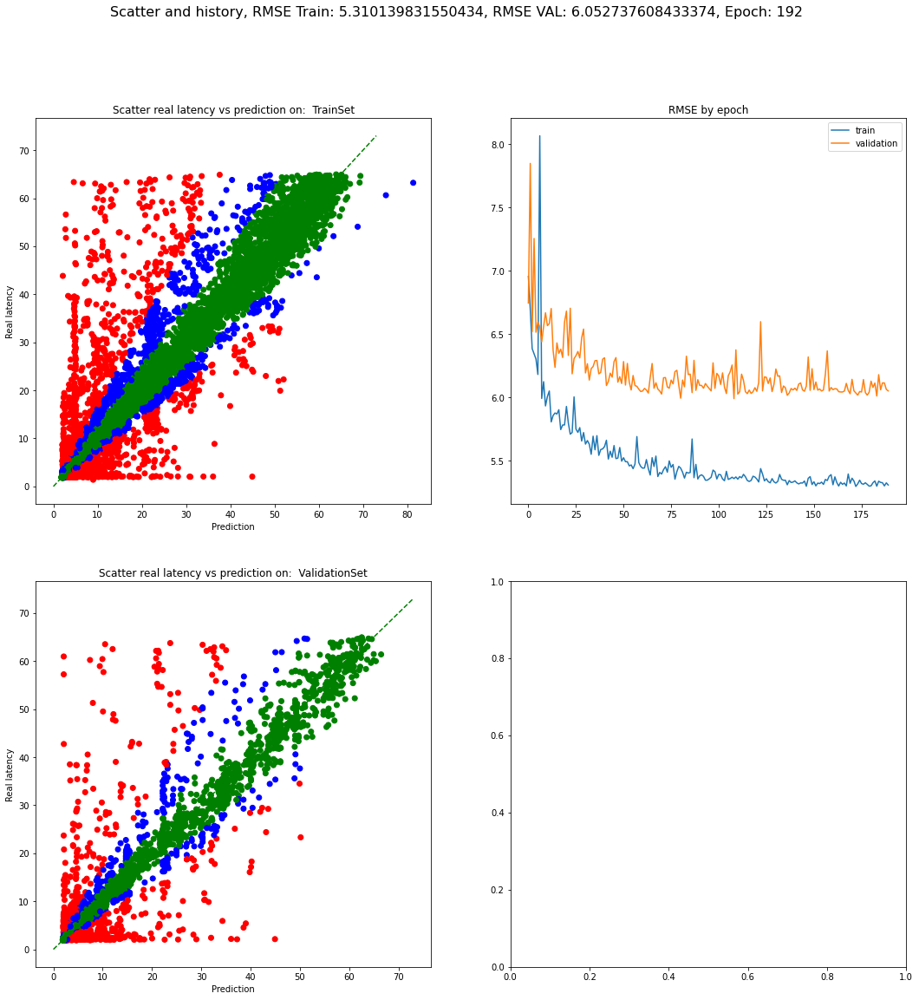

In [2]:
list_columns = ['filter_bound', 'filter_contains', 'filter_eq', 'filter_exists',
       'filter_ge', 'filter_gt', 'filter_isBlank', 'filter_isIRI',
       'filter_isLiteral', 'filter_lang', 'filter_langMatches', 'filter_le',
       'filter_lt', 'filter_ne', 'filter_not', 'filter_notexists', 'filter_or',
       'filter_regex', 'filter_sameTerm', 'filter_str', 'filter_strends',
       'filter_strstarts', 'filter_subtract', 'has_slice', 'max_slice_limit', 'max_slice_start','json_cardinality']

x_train_query = ds_train[list_columns]
x_val_query   = ds_val[list_columns]

x_train_tree = ds_train['trees'].values
x_val_tree = ds_val['trees'].values

y_train = ds_train['time'].values
y_val = ds_val['time'].values

import json
def getmax(x):
    lista=  list(x.values())
    maximo = 0
    for el in lista:
        if (maximo < float(el)):
            maximo = float(el)
    return maximo

maxcardinality =  x_train_query['json_cardinality'].apply(lambda x: json.loads(x)).apply(lambda x: getmax(x)).max()

x_train_tree = ds_train['trees'].values
x_val_tree = ds_val['trees'].values

y_train = ds_train['time'].values
y_val = ds_val['time'].values

aec_dir = '/workspace/bao_server/aec_wikidata_neo.pth'
verbose=True
reg = NeoRegression(
     aec={'train_aec': False, 'use_aec': True,'aec_file': aec_dir+str(fold)+'.pth', 'aec_epochs': 200},
     epochs=300,
     maxcardinality=maxcardinality,
     in_channels_neo_net=512,
     tree_units=[512, 256, 128],
     tree_units_dense=[64, 32],
     early_stop_patience=10,
     early_stop_initial_patience=180,
     tree_activation_tree=nn.LeakyReLU,
     tree_activation_dense=nn.ReLU,
    optimizer={'optimizer': "Adam",'args':{"lr":0.00015}},
    figimage_size=(18,18),
    start_history_from_epoch=3
)

#Fit the transformer tree data
reg.fit_transform_tree_data(ds_train, ds_val, ds_test)
print("Trees tranformed!!!")


#Scale x_query data.
xqtrain = x_train_query.drop(columns=['json_cardinality'])
xqval   = x_val_query.drop(columns=['json_cardinality'])

scalerx = StandardScaler()
x_train_scaled = scalerx.fit_transform(xqtrain)
x_val_scaled = scalerx.transform(xqval)

x_train_query =pd.concat([pd.DataFrame(x_train_scaled, index=xqtrain.index, columns=xqtrain.columns),x_train_query[['json_cardinality']]], axis=1)
x_val_query =  pd.concat([pd.DataFrame(x_val_scaled,   index=xqval.index, columns=xqval.columns),x_val_query[['json_cardinality']]], axis=1)

def pred2index_dict(x, pred_to_index):
    resp = {}
    x = json.loads(x)
    for el in x.keys():
        if el in pred_to_index:
            resp[pred_to_index[el]] = float(x[el])/maxcardinality
    return resp

x_train_query['json_cardinality'] = x_train_query['json_cardinality'].apply(lambda x: pred2index_dict(x, reg.get_pred()))
x_val_query['json_cardinality'] = x_val_query['json_cardinality'].apply(lambda x: pred2index_dict(x, reg.get_pred()))

#Fit model
reg.fit(x_train_tree, x_train_query.values, y_train, x_val_tree, x_val_query.values, y_val)

In [5]:
import pickle
select_query_features = pickle.load(open( "./select_query_features2.pickle", "rb" ) )


In [ ]:
select_query_features['tree filters histogram'] = getpreds(x_val_tree, x_val_query, y_val)

In [11]:
file_to_store = open("./select_query_features2.pickle", "wb")
pickle.dump(select_query_features, file_to_store)
file_to_store.close()

### Model for Tree Nodes, Algebra + Graph Pattern + Filters + Cardinality

Model optimizer: Adam lr: 0.00015
Error in data ignored! [datasetnames ?var1]
Error in data ignored! [bgp "VAR_URI_VARᶲhttp://www.wikidata.org/prop/direct/P685"]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Trees tranformed!!!
Error in data ignored! ('[datasetnames ?var1]', array([0.0, -1.7842985172092378, -0.9969511247242911,
       -0.38089646475639777, -0.7608060122962548, 131.74217244299564,
       -0.440849777226363, -0.22270361389275614, -0.3884150555940348, 0.0,
       0.0, -0.2851796594325823, -0.16792076009743978,
       -0.18843522857892528, -0.16056601611160903, -0.013148034373354402,
       -0.2658168204054264, -0.03736810006086702, 0.0, 0.0,
       -0.44491529570400773, -1.6203835027108602, -0.06615878138041308,
       0.0, -0.007590583800587443, 0.0, 0.0, -0.9427214672680767,
       -2.5646399528

[2021-01-12 02:58:10,412] INFO:model_trees_algebra:==> Epoch 0,	TRAIN_LOSS: 5722.505482006684	_TRAIN_RMSE: 75.6472437171817,	VAL_LOSS: 75.60491020699796,	VAL_RMSE: 8.695108406857154
[2021-01-12 02:58:10,412] INFO:model_trees_algebra:==> Epoch 0,	TRAIN_LOSS: 5722.505482006684	_TRAIN_RMSE: 75.6472437171817,	VAL_LOSS: 75.60491020699796,	VAL_RMSE: 8.695108406857154


Initial patience 180
2021-01-12 02:58:33.150215 Epoch 1, Training loss 5.69165926881837e-05


[2021-01-12 02:58:37,403] INFO:model_trees_algebra:==> Epoch 1,	TRAIN_LOSS: 69.89537726393995	_TRAIN_RMSE: 8.36034552299963,	VAL_LOSS: 46.55882861042198,	VAL_RMSE: 6.823403008061446
[2021-01-12 02:58:37,403] INFO:model_trees_algebra:==> Epoch 1,	TRAIN_LOSS: 69.89537726393995	_TRAIN_RMSE: 8.36034552299963,	VAL_LOSS: 46.55882861042198,	VAL_RMSE: 6.823403008061446


Initial patience 179
2021-01-12 02:59:05.030177 Epoch 2, Training loss 4.5399120441842565e-05


[2021-01-12 02:59:09,210] INFO:model_trees_algebra:==> Epoch 2,	TRAIN_LOSS: 46.62657330081855	_TRAIN_RMSE: 6.828365346173164,	VAL_LOSS: 48.053734357636266,	VAL_RMSE: 6.93208008880713
[2021-01-12 02:59:09,210] INFO:model_trees_algebra:==> Epoch 2,	TRAIN_LOSS: 46.62657330081855	_TRAIN_RMSE: 6.828365346173164,	VAL_LOSS: 48.053734357636266,	VAL_RMSE: 6.93208008880713


Initial patience 178
2021-01-12 02:59:36.022408 Epoch 3, Training loss 4.127354510072607e-05


[2021-01-12 02:59:40,033] INFO:model_trees_algebra:==> Epoch 3,	TRAIN_LOSS: 42.029166425071125	_TRAIN_RMSE: 6.4829905464277156,	VAL_LOSS: 36.89620796070118,	VAL_RMSE: 6.074224885588381
[2021-01-12 02:59:40,033] INFO:model_trees_algebra:==> Epoch 3,	TRAIN_LOSS: 42.029166425071125	_TRAIN_RMSE: 6.4829905464277156,	VAL_LOSS: 36.89620796070118,	VAL_RMSE: 6.074224885588381


Initial patience 177
2021-01-12 03:00:06.395835 Epoch 4, Training loss 3.8013711453263995e-05


[2021-01-12 03:00:10,467] INFO:model_trees_algebra:==> Epoch 4,	TRAIN_LOSS: 36.72454982079116	_TRAIN_RMSE: 6.060078367545354,	VAL_LOSS: 39.04236727749366,	VAL_RMSE: 6.24838917461882
[2021-01-12 03:00:10,467] INFO:model_trees_algebra:==> Epoch 4,	TRAIN_LOSS: 36.72454982079116	_TRAIN_RMSE: 6.060078367545354,	VAL_LOSS: 39.04236727749366,	VAL_RMSE: 6.24838917461882


Initial patience 176
2021-01-12 03:00:36.902127 Epoch 5, Training loss 3.607198144085657e-05


[2021-01-12 03:00:41,029] INFO:model_trees_algebra:==> Epoch 5,	TRAIN_LOSS: 32.79228403148107	_TRAIN_RMSE: 5.726454752417159,	VAL_LOSS: 35.044184885131514,	VAL_RMSE: 5.9198129096392496
[2021-01-12 03:00:41,029] INFO:model_trees_algebra:==> Epoch 5,	TRAIN_LOSS: 32.79228403148107	_TRAIN_RMSE: 5.726454752417159,	VAL_LOSS: 35.044184885131514,	VAL_RMSE: 5.9198129096392496


Initial patience 175
2021-01-12 03:01:07.477395 Epoch 6, Training loss 3.554447827454165e-05


[2021-01-12 03:01:11,451] INFO:model_trees_algebra:==> Epoch 6,	TRAIN_LOSS: 54.92518747137032	_TRAIN_RMSE: 7.411152911077353,	VAL_LOSS: 33.97763192644849,	VAL_RMSE: 5.829033532794994
[2021-01-12 03:01:11,451] INFO:model_trees_algebra:==> Epoch 6,	TRAIN_LOSS: 54.92518747137032	_TRAIN_RMSE: 7.411152911077353,	VAL_LOSS: 33.97763192644849,	VAL_RMSE: 5.829033532794994


Initial patience 174
2021-01-12 03:01:38.225545 Epoch 7, Training loss 3.4051605706449776e-05


[2021-01-12 03:01:42,178] INFO:model_trees_algebra:==> Epoch 7,	TRAIN_LOSS: 32.20260557059144	_TRAIN_RMSE: 5.674733964741558,	VAL_LOSS: 33.65645241365422,	VAL_RMSE: 5.801418138149863
[2021-01-12 03:01:42,178] INFO:model_trees_algebra:==> Epoch 7,	TRAIN_LOSS: 32.20260557059144	_TRAIN_RMSE: 5.674733964741558,	VAL_LOSS: 33.65645241365422,	VAL_RMSE: 5.801418138149863


Initial patience 173
2021-01-12 03:02:08.575344 Epoch 8, Training loss 3.312251197762965e-05


[2021-01-12 03:02:12,556] INFO:model_trees_algebra:==> Epoch 8,	TRAIN_LOSS: 29.82929284570858	_TRAIN_RMSE: 5.46161998364117,	VAL_LOSS: 31.20146231533795,	VAL_RMSE: 5.585826914194348
[2021-01-12 03:02:12,556] INFO:model_trees_algebra:==> Epoch 8,	TRAIN_LOSS: 29.82929284570858	_TRAIN_RMSE: 5.46161998364117,	VAL_LOSS: 31.20146231533795,	VAL_RMSE: 5.585826914194348


Initial patience 172
2021-01-12 03:02:39.201806 Epoch 9, Training loss 3.231830326050248e-05


[2021-01-12 03:02:43,127] INFO:model_trees_algebra:==> Epoch 9,	TRAIN_LOSS: 29.803602754153456	_TRAIN_RMSE: 5.459267602357798,	VAL_LOSS: 31.10385464365069,	VAL_RMSE: 5.577082986979008
[2021-01-12 03:02:43,127] INFO:model_trees_algebra:==> Epoch 9,	TRAIN_LOSS: 29.803602754153456	_TRAIN_RMSE: 5.459267602357798,	VAL_LOSS: 31.10385464365069,	VAL_RMSE: 5.577082986979008


Initial patience 171
2021-01-12 03:03:09.183127 Epoch 10, Training loss 3.206426970533597e-05


[2021-01-12 03:03:13,154] INFO:model_trees_algebra:==> Epoch 10,	TRAIN_LOSS: 28.595984920645712	_TRAIN_RMSE: 5.347521381036799,	VAL_LOSS: 33.182186994689104,	VAL_RMSE: 5.7603981628607155
[2021-01-12 03:03:13,154] INFO:model_trees_algebra:==> Epoch 10,	TRAIN_LOSS: 28.595984920645712	_TRAIN_RMSE: 5.347521381036799,	VAL_LOSS: 33.182186994689104,	VAL_RMSE: 5.7603981628607155


Initial patience 170
2021-01-12 03:03:40.085597 Epoch 11, Training loss 3.138083693745659e-05


[2021-01-12 03:03:44,105] INFO:model_trees_algebra:==> Epoch 11,	TRAIN_LOSS: 29.13829701286509	_TRAIN_RMSE: 5.39799009010438,	VAL_LOSS: 32.12222694901995,	VAL_RMSE: 5.6676473910274225
[2021-01-12 03:03:44,105] INFO:model_trees_algebra:==> Epoch 11,	TRAIN_LOSS: 29.13829701286509	_TRAIN_RMSE: 5.39799009010438,	VAL_LOSS: 32.12222694901995,	VAL_RMSE: 5.6676473910274225


Initial patience 169
2021-01-12 03:04:11.168663 Epoch 12, Training loss 3.118430743733178e-05


[2021-01-12 03:04:15,213] INFO:model_trees_algebra:==> Epoch 12,	TRAIN_LOSS: 29.72725717250215	_TRAIN_RMSE: 5.452270827141857,	VAL_LOSS: 31.9394991377407,	VAL_RMSE: 5.651504148254754
[2021-01-12 03:04:15,213] INFO:model_trees_algebra:==> Epoch 12,	TRAIN_LOSS: 29.72725717250215	_TRAIN_RMSE: 5.452270827141857,	VAL_LOSS: 31.9394991377407,	VAL_RMSE: 5.651504148254754


Initial patience 168
2021-01-12 03:04:42.101044 Epoch 13, Training loss 3.166532559460512e-05


[2021-01-12 03:04:46,020] INFO:model_trees_algebra:==> Epoch 13,	TRAIN_LOSS: 29.64331509400763	_TRAIN_RMSE: 5.444567484567313,	VAL_LOSS: 33.497775043491174,	VAL_RMSE: 5.787726241235946
[2021-01-12 03:04:46,020] INFO:model_trees_algebra:==> Epoch 13,	TRAIN_LOSS: 29.64331509400763	_TRAIN_RMSE: 5.444567484567313,	VAL_LOSS: 33.497775043491174,	VAL_RMSE: 5.787726241235946


Initial patience 167
2021-01-12 03:05:13.007345 Epoch 14, Training loss 2.9873653906097422e-05


[2021-01-12 03:05:17,501] INFO:model_trees_algebra:==> Epoch 14,	TRAIN_LOSS: 26.900622595931562	_TRAIN_RMSE: 5.186581012182454,	VAL_LOSS: 28.455733652920976,	VAL_RMSE: 5.334391591636386
[2021-01-12 03:05:17,501] INFO:model_trees_algebra:==> Epoch 14,	TRAIN_LOSS: 26.900622595931562	_TRAIN_RMSE: 5.186581012182454,	VAL_LOSS: 28.455733652920976,	VAL_RMSE: 5.334391591636386


Initial patience 166
2021-01-12 03:05:45.098055 Epoch 15, Training loss 2.9043138420958306e-05


[2021-01-12 03:05:49,036] INFO:model_trees_algebra:==> Epoch 15,	TRAIN_LOSS: 25.387866021542088	_TRAIN_RMSE: 5.038637317920599,	VAL_LOSS: 30.131263194704093,	VAL_RMSE: 5.4891951317751575
[2021-01-12 03:05:49,036] INFO:model_trees_algebra:==> Epoch 15,	TRAIN_LOSS: 25.387866021542088	_TRAIN_RMSE: 5.038637317920599,	VAL_LOSS: 30.131263194704093,	VAL_RMSE: 5.4891951317751575


Initial patience 165
2021-01-12 03:06:15.346795 Epoch 16, Training loss 2.959292633997997e-05


[2021-01-12 03:06:19,355] INFO:model_trees_algebra:==> Epoch 16,	TRAIN_LOSS: 27.899676289937908	_TRAIN_RMSE: 5.2820144159153815,	VAL_LOSS: 31.597917652890043,	VAL_RMSE: 5.6212025095072
[2021-01-12 03:06:19,355] INFO:model_trees_algebra:==> Epoch 16,	TRAIN_LOSS: 27.899676289937908	_TRAIN_RMSE: 5.2820144159153815,	VAL_LOSS: 31.597917652890043,	VAL_RMSE: 5.6212025095072


Initial patience 164
2021-01-12 03:06:47.918822 Epoch 17, Training loss 2.9385019547353733e-05


[2021-01-12 03:06:52,232] INFO:model_trees_algebra:==> Epoch 17,	TRAIN_LOSS: 27.504656100702878	_TRAIN_RMSE: 5.244488163844292,	VAL_LOSS: 33.1228928322531,	VAL_RMSE: 5.755249154663341
[2021-01-12 03:06:52,232] INFO:model_trees_algebra:==> Epoch 17,	TRAIN_LOSS: 27.504656100702878	_TRAIN_RMSE: 5.244488163844292,	VAL_LOSS: 33.1228928322531,	VAL_RMSE: 5.755249154663341


Initial patience 163
2021-01-12 03:07:18.738364 Epoch 18, Training loss 2.918654096074502e-05


[2021-01-12 03:07:22,620] INFO:model_trees_algebra:==> Epoch 18,	TRAIN_LOSS: 26.233149474126108	_TRAIN_RMSE: 5.121830676049933,	VAL_LOSS: 29.095925787792886,	VAL_RMSE: 5.394063939905875
[2021-01-12 03:07:22,620] INFO:model_trees_algebra:==> Epoch 18,	TRAIN_LOSS: 26.233149474126108	_TRAIN_RMSE: 5.121830676049933,	VAL_LOSS: 29.095925787792886,	VAL_RMSE: 5.394063939905875


Initial patience 162
2021-01-12 03:07:48.673727 Epoch 19, Training loss 2.83647547786103e-05


[2021-01-12 03:07:52,653] INFO:model_trees_algebra:==> Epoch 19,	TRAIN_LOSS: 24.663450233393075	_TRAIN_RMSE: 4.966230988727072,	VAL_LOSS: 29.014124396548702,	VAL_RMSE: 5.386476064789363
[2021-01-12 03:07:52,653] INFO:model_trees_algebra:==> Epoch 19,	TRAIN_LOSS: 24.663450233393075	_TRAIN_RMSE: 4.966230988727072,	VAL_LOSS: 29.014124396548702,	VAL_RMSE: 5.386476064789363


Initial patience 161
2021-01-12 03:08:21.145542 Epoch 20, Training loss 2.8098672823770982e-05


[2021-01-12 03:08:25,461] INFO:model_trees_algebra:==> Epoch 20,	TRAIN_LOSS: 25.594831934779975	_TRAIN_RMSE: 5.059133516204131,	VAL_LOSS: 35.9530607259523,	VAL_RMSE: 5.996087117942191
[2021-01-12 03:08:25,461] INFO:model_trees_algebra:==> Epoch 20,	TRAIN_LOSS: 25.594831934779975	_TRAIN_RMSE: 5.059133516204131,	VAL_LOSS: 35.9530607259523,	VAL_RMSE: 5.996087117942191


Initial patience 160
2021-01-12 03:08:53.188912 Epoch 21, Training loss 2.8595873840565808e-05


[2021-01-12 03:08:57,460] INFO:model_trees_algebra:==> Epoch 21,	TRAIN_LOSS: 26.112322281441504	_TRAIN_RMSE: 5.110021749605524,	VAL_LOSS: 27.559095011686377,	VAL_RMSE: 5.249675705382798
[2021-01-12 03:08:57,460] INFO:model_trees_algebra:==> Epoch 21,	TRAIN_LOSS: 26.112322281441504	_TRAIN_RMSE: 5.110021749605524,	VAL_LOSS: 27.559095011686377,	VAL_RMSE: 5.249675705382798


Initial patience 159
2021-01-12 03:09:24.484755 Epoch 22, Training loss 2.7609901718250384e-05


[2021-01-12 03:09:28,803] INFO:model_trees_algebra:==> Epoch 22,	TRAIN_LOSS: 23.332463741473752	_TRAIN_RMSE: 4.830368903248877,	VAL_LOSS: 26.496154530555565,	VAL_RMSE: 5.147441551931946
[2021-01-12 03:09:28,803] INFO:model_trees_algebra:==> Epoch 22,	TRAIN_LOSS: 23.332463741473752	_TRAIN_RMSE: 4.830368903248877,	VAL_LOSS: 26.496154530555565,	VAL_RMSE: 5.147441551931946


Initial patience 158
2021-01-12 03:09:55.441925 Epoch 23, Training loss 2.7707981516743157e-05


[2021-01-12 03:09:59,320] INFO:model_trees_algebra:==> Epoch 23,	TRAIN_LOSS: 23.583728695866892	_TRAIN_RMSE: 4.856308134361625,	VAL_LOSS: 28.789514517211096,	VAL_RMSE: 5.3655861298847025
[2021-01-12 03:09:59,320] INFO:model_trees_algebra:==> Epoch 23,	TRAIN_LOSS: 23.583728695866892	_TRAIN_RMSE: 4.856308134361625,	VAL_LOSS: 28.789514517211096,	VAL_RMSE: 5.3655861298847025


Initial patience 157
2021-01-12 03:10:26.203421 Epoch 24, Training loss 2.7067263115606383e-05


[2021-01-12 03:10:30,480] INFO:model_trees_algebra:==> Epoch 24,	TRAIN_LOSS: 23.45662538214731	_TRAIN_RMSE: 4.843204040936879,	VAL_LOSS: 30.62180154034257,	VAL_RMSE: 5.533696914391189
[2021-01-12 03:10:30,480] INFO:model_trees_algebra:==> Epoch 24,	TRAIN_LOSS: 23.45662538214731	_TRAIN_RMSE: 4.843204040936879,	VAL_LOSS: 30.62180154034257,	VAL_RMSE: 5.533696914391189


Initial patience 156
2021-01-12 03:10:56.695144 Epoch 25, Training loss 2.8984107091824712e-05


[2021-01-12 03:11:00,591] INFO:model_trees_algebra:==> Epoch 25,	TRAIN_LOSS: 37.15917732343628	_TRAIN_RMSE: 6.095832783421497,	VAL_LOSS: 28.608091861945965,	VAL_RMSE: 5.348653275540111
[2021-01-12 03:11:00,591] INFO:model_trees_algebra:==> Epoch 25,	TRAIN_LOSS: 37.15917732343628	_TRAIN_RMSE: 6.095832783421497,	VAL_LOSS: 28.608091861945965,	VAL_RMSE: 5.348653275540111


Initial patience 155
2021-01-12 03:11:26.545987 Epoch 26, Training loss 2.6745748966913163e-05


[2021-01-12 03:11:30,459] INFO:model_trees_algebra:==> Epoch 26,	TRAIN_LOSS: 22.90141969763412	_TRAIN_RMSE: 4.785542779835336,	VAL_LOSS: 25.925332457006704,	VAL_RMSE: 5.091692494348682
[2021-01-12 03:11:30,459] INFO:model_trees_algebra:==> Epoch 26,	TRAIN_LOSS: 22.90141969763412	_TRAIN_RMSE: 4.785542779835336,	VAL_LOSS: 25.925332457006704,	VAL_RMSE: 5.091692494348682


Initial patience 154
2021-01-12 03:11:56.397359 Epoch 27, Training loss 2.6149557797781736e-05


[2021-01-12 03:12:00,258] INFO:model_trees_algebra:==> Epoch 27,	TRAIN_LOSS: 22.616182935647075	_TRAIN_RMSE: 4.755647478067217,	VAL_LOSS: 27.36936224640429,	VAL_RMSE: 5.231573591798579
[2021-01-12 03:12:00,258] INFO:model_trees_algebra:==> Epoch 27,	TRAIN_LOSS: 22.616182935647075	_TRAIN_RMSE: 4.755647478067217,	VAL_LOSS: 27.36936224640429,	VAL_RMSE: 5.231573591798579


Initial patience 153
2021-01-12 03:12:26.297106 Epoch 28, Training loss 2.6545510338116327e-05


[2021-01-12 03:12:30,130] INFO:model_trees_algebra:==> Epoch 28,	TRAIN_LOSS: 23.177538694711146	_TRAIN_RMSE: 4.814305629549411,	VAL_LOSS: 27.19243501452556,	VAL_RMSE: 5.214636613851972
[2021-01-12 03:12:30,130] INFO:model_trees_algebra:==> Epoch 28,	TRAIN_LOSS: 23.177538694711146	_TRAIN_RMSE: 4.814305629549411,	VAL_LOSS: 27.19243501452556,	VAL_RMSE: 5.214636613851972


Initial patience 152
2021-01-12 03:12:56.649517 Epoch 29, Training loss 2.6172471480629826e-05


[2021-01-12 03:13:00,660] INFO:model_trees_algebra:==> Epoch 29,	TRAIN_LOSS: 21.982730706314587	_TRAIN_RMSE: 4.688574485524847,	VAL_LOSS: 25.834003744403237,	VAL_RMSE: 5.082716177832797
[2021-01-12 03:13:00,660] INFO:model_trees_algebra:==> Epoch 29,	TRAIN_LOSS: 21.982730706314587	_TRAIN_RMSE: 4.688574485524847,	VAL_LOSS: 25.834003744403237,	VAL_RMSE: 5.082716177832797


Initial patience 151
2021-01-12 03:13:27.664337 Epoch 30, Training loss 2.6296211638920392e-05


[2021-01-12 03:13:31,808] INFO:model_trees_algebra:==> Epoch 30,	TRAIN_LOSS: 22.050811087414584	_TRAIN_RMSE: 4.695829116078926,	VAL_LOSS: 26.03088482071232,	VAL_RMSE: 5.1020471205891775
[2021-01-12 03:13:31,808] INFO:model_trees_algebra:==> Epoch 30,	TRAIN_LOSS: 22.050811087414584	_TRAIN_RMSE: 4.695829116078926,	VAL_LOSS: 26.03088482071232,	VAL_RMSE: 5.1020471205891775


Initial patience 150
2021-01-12 03:13:59.102520 Epoch 31, Training loss 2.6125824410804395e-05


[2021-01-12 03:14:03,149] INFO:model_trees_algebra:==> Epoch 31,	TRAIN_LOSS: 22.27471157875227	_TRAIN_RMSE: 4.71960926123681,	VAL_LOSS: 25.4250140452882,	VAL_RMSE: 5.042322286931707
[2021-01-12 03:14:03,149] INFO:model_trees_algebra:==> Epoch 31,	TRAIN_LOSS: 22.27471157875227	_TRAIN_RMSE: 4.71960926123681,	VAL_LOSS: 25.4250140452882,	VAL_RMSE: 5.042322286931707


Initial patience 149
2021-01-12 03:14:29.647796 Epoch 32, Training loss 2.6817901807810096e-05


[2021-01-12 03:14:33,648] INFO:model_trees_algebra:==> Epoch 32,	TRAIN_LOSS: 23.115767516665198	_TRAIN_RMSE: 4.807885971678737,	VAL_LOSS: 31.962438248657186,	VAL_RMSE: 5.653533253520067
[2021-01-12 03:14:33,648] INFO:model_trees_algebra:==> Epoch 32,	TRAIN_LOSS: 23.115767516665198	_TRAIN_RMSE: 4.807885971678737,	VAL_LOSS: 31.962438248657186,	VAL_RMSE: 5.653533253520067


Initial patience 148
2021-01-12 03:15:00.361372 Epoch 33, Training loss 2.5790664405016364e-05


[2021-01-12 03:15:04,488] INFO:model_trees_algebra:==> Epoch 33,	TRAIN_LOSS: 21.47243484072137	_TRAIN_RMSE: 4.633835866830133,	VAL_LOSS: 26.004543022690836,	VAL_RMSE: 5.099464974160607
[2021-01-12 03:15:04,488] INFO:model_trees_algebra:==> Epoch 33,	TRAIN_LOSS: 21.47243484072137	_TRAIN_RMSE: 4.633835866830133,	VAL_LOSS: 26.004543022690836,	VAL_RMSE: 5.099464974160607


Initial patience 147
2021-01-12 03:15:31.449112 Epoch 34, Training loss 2.5760704563810994e-05


[2021-01-12 03:15:35,596] INFO:model_trees_algebra:==> Epoch 34,	TRAIN_LOSS: 21.38984522306505	_TRAIN_RMSE: 4.624915699022529,	VAL_LOSS: 25.839197401928466,	VAL_RMSE: 5.083227065745585
[2021-01-12 03:15:35,596] INFO:model_trees_algebra:==> Epoch 34,	TRAIN_LOSS: 21.38984522306505	_TRAIN_RMSE: 4.624915699022529,	VAL_LOSS: 25.839197401928466,	VAL_RMSE: 5.083227065745585


Initial patience 146
2021-01-12 03:16:04.714295 Epoch 35, Training loss 2.554112632008812e-05


[2021-01-12 03:16:09,139] INFO:model_trees_algebra:==> Epoch 35,	TRAIN_LOSS: 21.8020535681731	_TRAIN_RMSE: 4.66926691978228,	VAL_LOSS: 25.9304132982531,	VAL_RMSE: 5.09219140432222
[2021-01-12 03:16:09,139] INFO:model_trees_algebra:==> Epoch 35,	TRAIN_LOSS: 21.8020535681731	_TRAIN_RMSE: 4.66926691978228,	VAL_LOSS: 25.9304132982531,	VAL_RMSE: 5.09219140432222


Initial patience 145
2021-01-12 03:16:37.830855 Epoch 36, Training loss 2.552468491860218e-05


[2021-01-12 03:16:42,219] INFO:model_trees_algebra:==> Epoch 36,	TRAIN_LOSS: 21.44990207719023	_TRAIN_RMSE: 4.631403899163863,	VAL_LOSS: 28.19298107840954,	VAL_RMSE: 5.309706308112488
[2021-01-12 03:16:42,219] INFO:model_trees_algebra:==> Epoch 36,	TRAIN_LOSS: 21.44990207719023	_TRAIN_RMSE: 4.631403899163863,	VAL_LOSS: 28.19298107840954,	VAL_RMSE: 5.309706308112488


Initial patience 144
2021-01-12 03:17:10.317384 Epoch 37, Training loss 2.5612174426251527e-05


[2021-01-12 03:17:14,767] INFO:model_trees_algebra:==> Epoch 37,	TRAIN_LOSS: 22.65190789009671	_TRAIN_RMSE: 4.7594020517389275,	VAL_LOSS: 25.268324378662104,	VAL_RMSE: 5.026760823697712
[2021-01-12 03:17:14,767] INFO:model_trees_algebra:==> Epoch 37,	TRAIN_LOSS: 22.65190789009671	_TRAIN_RMSE: 4.7594020517389275,	VAL_LOSS: 25.268324378662104,	VAL_RMSE: 5.026760823697712


Initial patience 143
2021-01-12 03:17:43.617850 Epoch 38, Training loss 2.564950972583703e-05


[2021-01-12 03:17:47,906] INFO:model_trees_algebra:==> Epoch 38,	TRAIN_LOSS: 35.07512825762753	_TRAIN_RMSE: 5.922425876077094,	VAL_LOSS: 24.492194589222937,	VAL_RMSE: 4.9489589399411
[2021-01-12 03:17:47,906] INFO:model_trees_algebra:==> Epoch 38,	TRAIN_LOSS: 35.07512825762753	_TRAIN_RMSE: 5.922425876077094,	VAL_LOSS: 24.492194589222937,	VAL_RMSE: 4.9489589399411


Initial patience 142
2021-01-12 03:18:16.855514 Epoch 39, Training loss 2.5727282846677062e-05


[2021-01-12 03:18:21,405] INFO:model_trees_algebra:==> Epoch 39,	TRAIN_LOSS: 22.419066937702176	_TRAIN_RMSE: 4.734877710955392,	VAL_LOSS: 26.246419772988208,	VAL_RMSE: 5.1231259766853485
[2021-01-12 03:18:21,405] INFO:model_trees_algebra:==> Epoch 39,	TRAIN_LOSS: 22.419066937702176	_TRAIN_RMSE: 4.734877710955392,	VAL_LOSS: 26.246419772988208,	VAL_RMSE: 5.1231259766853485


Initial patience 141
2021-01-12 03:18:49.226607 Epoch 40, Training loss 2.5325155126058397e-05


[2021-01-12 03:18:53,646] INFO:model_trees_algebra:==> Epoch 40,	TRAIN_LOSS: 21.991674625306445	_TRAIN_RMSE: 4.689528187921088,	VAL_LOSS: 24.540628848804555,	VAL_RMSE: 4.953849901723361
[2021-01-12 03:18:53,646] INFO:model_trees_algebra:==> Epoch 40,	TRAIN_LOSS: 21.991674625306445	_TRAIN_RMSE: 4.689528187921088,	VAL_LOSS: 24.540628848804555,	VAL_RMSE: 4.953849901723361


Initial patience 140
2021-01-12 03:19:21.915290 Epoch 41, Training loss 2.4728551820504328e-05


[2021-01-12 03:19:26,191] INFO:model_trees_algebra:==> Epoch 41,	TRAIN_LOSS: 20.639700486498835	_TRAIN_RMSE: 4.5430937131539375,	VAL_LOSS: 27.037585228429684,	VAL_RMSE: 5.199767805241854
[2021-01-12 03:19:26,191] INFO:model_trees_algebra:==> Epoch 41,	TRAIN_LOSS: 20.639700486498835	_TRAIN_RMSE: 4.5430937131539375,	VAL_LOSS: 27.037585228429684,	VAL_RMSE: 5.199767805241854


Initial patience 139
2021-01-12 03:19:54.181498 Epoch 42, Training loss 2.5030403137477928e-05


[2021-01-12 03:19:58,472] INFO:model_trees_algebra:==> Epoch 42,	TRAIN_LOSS: 20.74685227066138	_TRAIN_RMSE: 4.554871268286446,	VAL_LOSS: 24.884771928966956,	VAL_RMSE: 4.988463884701076
[2021-01-12 03:19:58,472] INFO:model_trees_algebra:==> Epoch 42,	TRAIN_LOSS: 20.74685227066138	_TRAIN_RMSE: 4.554871268286446,	VAL_LOSS: 24.884771928966956,	VAL_RMSE: 4.988463884701076


Initial patience 138
2021-01-12 03:20:25.750823 Epoch 43, Training loss 2.46496686196825e-05


[2021-01-12 03:20:30,059] INFO:model_trees_algebra:==> Epoch 43,	TRAIN_LOSS: 20.455551740188504	_TRAIN_RMSE: 4.5227814163618945,	VAL_LOSS: 26.687028224556098,	VAL_RMSE: 5.165948918113312
[2021-01-12 03:20:30,059] INFO:model_trees_algebra:==> Epoch 43,	TRAIN_LOSS: 20.455551740188504	_TRAIN_RMSE: 4.5227814163618945,	VAL_LOSS: 26.687028224556098,	VAL_RMSE: 5.165948918113312


Initial patience 137
2021-01-12 03:20:57.849501 Epoch 44, Training loss 2.4873620702102208e-05


[2021-01-12 03:21:02,231] INFO:model_trees_algebra:==> Epoch 44,	TRAIN_LOSS: 20.717384158572134	_TRAIN_RMSE: 4.55163532794227,	VAL_LOSS: 25.5151588914821,	VAL_RMSE: 5.0512532000962
[2021-01-12 03:21:02,231] INFO:model_trees_algebra:==> Epoch 44,	TRAIN_LOSS: 20.717384158572134	_TRAIN_RMSE: 4.55163532794227,	VAL_LOSS: 25.5151588914821,	VAL_RMSE: 5.0512532000962


Initial patience 136
2021-01-12 03:21:30.661041 Epoch 45, Training loss 2.504558472358229e-05


[2021-01-12 03:21:35,195] INFO:model_trees_algebra:==> Epoch 45,	TRAIN_LOSS: 21.64952116273657	_TRAIN_RMSE: 4.652904594200979,	VAL_LOSS: 24.083888934112018,	VAL_RMSE: 4.907533895360481
[2021-01-12 03:21:35,195] INFO:model_trees_algebra:==> Epoch 45,	TRAIN_LOSS: 21.64952116273657	_TRAIN_RMSE: 4.652904594200979,	VAL_LOSS: 24.083888934112018,	VAL_RMSE: 4.907533895360481


Initial patience 135
2021-01-12 03:22:03.107301 Epoch 46, Training loss 2.4614786175381508e-05


[2021-01-12 03:22:07,336] INFO:model_trees_algebra:==> Epoch 46,	TRAIN_LOSS: 21.442353605458187	_TRAIN_RMSE: 4.630588904821739,	VAL_LOSS: 24.719098736898353,	VAL_RMSE: 4.971830521739287
[2021-01-12 03:22:07,336] INFO:model_trees_algebra:==> Epoch 46,	TRAIN_LOSS: 21.442353605458187	_TRAIN_RMSE: 4.630588904821739,	VAL_LOSS: 24.719098736898353,	VAL_RMSE: 4.971830521739287


Initial patience 134
2021-01-12 03:22:34.623815 Epoch 47, Training loss 2.4551606616916935e-05


[2021-01-12 03:22:38,820] INFO:model_trees_algebra:==> Epoch 47,	TRAIN_LOSS: 20.51377394758633	_TRAIN_RMSE: 4.529213391703501,	VAL_LOSS: 23.937918043450154,	VAL_RMSE: 4.892639169553601
[2021-01-12 03:22:38,820] INFO:model_trees_algebra:==> Epoch 47,	TRAIN_LOSS: 20.51377394758633	_TRAIN_RMSE: 4.529213391703501,	VAL_LOSS: 23.937918043450154,	VAL_RMSE: 4.892639169553601


Initial patience 133
2021-01-12 03:23:06.287114 Epoch 48, Training loss 2.4259042767949836e-05


[2021-01-12 03:23:10,803] INFO:model_trees_algebra:==> Epoch 48,	TRAIN_LOSS: 20.14533295581406	_TRAIN_RMSE: 4.488355261765055,	VAL_LOSS: 24.760710990061394,	VAL_RMSE: 4.976013564095399
[2021-01-12 03:23:10,803] INFO:model_trees_algebra:==> Epoch 48,	TRAIN_LOSS: 20.14533295581406	_TRAIN_RMSE: 4.488355261765055,	VAL_LOSS: 24.760710990061394,	VAL_RMSE: 4.976013564095399


Initial patience 132
2021-01-12 03:23:37.814306 Epoch 49, Training loss 2.4392896268345734e-05


[2021-01-12 03:23:42,598] INFO:model_trees_algebra:==> Epoch 49,	TRAIN_LOSS: 20.497037157855107	_TRAIN_RMSE: 4.527365366066131,	VAL_LOSS: 23.87863408013911,	VAL_RMSE: 4.886576928703682
[2021-01-12 03:23:42,598] INFO:model_trees_algebra:==> Epoch 49,	TRAIN_LOSS: 20.497037157855107	_TRAIN_RMSE: 4.527365366066131,	VAL_LOSS: 23.87863408013911,	VAL_RMSE: 4.886576928703682


Initial patience 131
2021-01-12 03:24:12.254717 Epoch 50, Training loss 2.4703899271903586e-05


[2021-01-12 03:24:16,991] INFO:model_trees_algebra:==> Epoch 50,	TRAIN_LOSS: 21.00730189058782	_TRAIN_RMSE: 4.58337232729219,	VAL_LOSS: 26.121240068658103,	VAL_RMSE: 5.110894253323786
[2021-01-12 03:24:16,991] INFO:model_trees_algebra:==> Epoch 50,	TRAIN_LOSS: 21.00730189058782	_TRAIN_RMSE: 4.58337232729219,	VAL_LOSS: 26.121240068658103,	VAL_RMSE: 5.110894253323786


Initial patience 130
2021-01-12 03:24:43.821580 Epoch 51, Training loss 2.446212001940156e-05


[2021-01-12 03:24:47,938] INFO:model_trees_algebra:==> Epoch 51,	TRAIN_LOSS: 21.05175241578603	_TRAIN_RMSE: 4.58821887182663,	VAL_LOSS: 24.60822954201743,	VAL_RMSE: 4.960668255589909
[2021-01-12 03:24:47,938] INFO:model_trees_algebra:==> Epoch 51,	TRAIN_LOSS: 21.05175241578603	_TRAIN_RMSE: 4.58821887182663,	VAL_LOSS: 24.60822954201743,	VAL_RMSE: 4.960668255589909


Initial patience 129
2021-01-12 03:25:15.702233 Epoch 52, Training loss 2.4105278408132137e-05


[2021-01-12 03:25:19,802] INFO:model_trees_algebra:==> Epoch 52,	TRAIN_LOSS: 19.817624772982818	_TRAIN_RMSE: 4.451699088323785,	VAL_LOSS: 25.22565784721177,	VAL_RMSE: 5.022515091785367
[2021-01-12 03:25:19,802] INFO:model_trees_algebra:==> Epoch 52,	TRAIN_LOSS: 19.817624772982818	_TRAIN_RMSE: 4.451699088323785,	VAL_LOSS: 25.22565784721177,	VAL_RMSE: 5.022515091785367


Initial patience 128
2021-01-12 03:25:46.902115 Epoch 53, Training loss 2.4254733188672774e-05


[2021-01-12 03:25:51,055] INFO:model_trees_algebra:==> Epoch 53,	TRAIN_LOSS: 20.09219510849043	_TRAIN_RMSE: 4.4824318297650025,	VAL_LOSS: 23.991012915361114,	VAL_RMSE: 4.898062159197361
[2021-01-12 03:25:51,055] INFO:model_trees_algebra:==> Epoch 53,	TRAIN_LOSS: 20.09219510849043	_TRAIN_RMSE: 4.4824318297650025,	VAL_LOSS: 23.991012915361114,	VAL_RMSE: 4.898062159197361


Initial patience 127
2021-01-12 03:26:18.688575 Epoch 54, Training loss 2.381506906274676e-05


[2021-01-12 03:26:23,007] INFO:model_trees_algebra:==> Epoch 54,	TRAIN_LOSS: 19.921032044360057	_TRAIN_RMSE: 4.463298336920809,	VAL_LOSS: 24.225413516910567,	VAL_RMSE: 4.921931888690717
[2021-01-12 03:26:23,007] INFO:model_trees_algebra:==> Epoch 54,	TRAIN_LOSS: 19.921032044360057	_TRAIN_RMSE: 4.463298336920809,	VAL_LOSS: 24.225413516910567,	VAL_RMSE: 4.921931888690717


Initial patience 126
2021-01-12 03:26:50.105636 Epoch 55, Training loss 2.360507944425027e-05


[2021-01-12 03:26:54,372] INFO:model_trees_algebra:==> Epoch 55,	TRAIN_LOSS: 19.782214600181746	_TRAIN_RMSE: 4.447720157584304,	VAL_LOSS: 23.900716351544393,	VAL_RMSE: 4.888835889201476
[2021-01-12 03:26:54,372] INFO:model_trees_algebra:==> Epoch 55,	TRAIN_LOSS: 19.782214600181746	_TRAIN_RMSE: 4.447720157584304,	VAL_LOSS: 23.900716351544393,	VAL_RMSE: 4.888835889201476


Initial patience 125
2021-01-12 03:27:20.930681 Epoch 56, Training loss 2.3628076552781483e-05


[2021-01-12 03:27:24,785] INFO:model_trees_algebra:==> Epoch 56,	TRAIN_LOSS: 19.590628131749032	_TRAIN_RMSE: 4.426130153051199,	VAL_LOSS: 26.939367007425542,	VAL_RMSE: 5.190314731056831
[2021-01-12 03:27:24,785] INFO:model_trees_algebra:==> Epoch 56,	TRAIN_LOSS: 19.590628131749032	_TRAIN_RMSE: 4.426130153051199,	VAL_LOSS: 26.939367007425542,	VAL_RMSE: 5.190314731056831


Initial patience 124
2021-01-12 03:27:50.704192 Epoch 57, Training loss 2.387951490730154e-05


[2021-01-12 03:27:54,551] INFO:model_trees_algebra:==> Epoch 57,	TRAIN_LOSS: 19.967696609679557	_TRAIN_RMSE: 4.468522866639439,	VAL_LOSS: 24.884311007787677,	VAL_RMSE: 4.988417685778495
[2021-01-12 03:27:54,551] INFO:model_trees_algebra:==> Epoch 57,	TRAIN_LOSS: 19.967696609679557	_TRAIN_RMSE: 4.468522866639439,	VAL_LOSS: 24.884311007787677,	VAL_RMSE: 4.988417685778495


Initial patience 123
2021-01-12 03:28:20.473913 Epoch 58, Training loss 2.3731688301658383e-05


[2021-01-12 03:28:24,326] INFO:model_trees_algebra:==> Epoch 58,	TRAIN_LOSS: 20.29369323914239	_TRAIN_RMSE: 4.5048521883789245,	VAL_LOSS: 23.97153812128431,	VAL_RMSE: 4.8960737454908
[2021-01-12 03:28:24,326] INFO:model_trees_algebra:==> Epoch 58,	TRAIN_LOSS: 20.29369323914239	_TRAIN_RMSE: 4.5048521883789245,	VAL_LOSS: 23.97153812128431,	VAL_RMSE: 4.8960737454908


Initial patience 122
2021-01-12 03:28:50.341385 Epoch 59, Training loss 2.324244413065096e-05


[2021-01-12 03:28:54,182] INFO:model_trees_algebra:==> Epoch 59,	TRAIN_LOSS: 19.267574647596344	_TRAIN_RMSE: 4.3894845537484635,	VAL_LOSS: 24.11582714006977,	VAL_RMSE: 4.910786814764999
[2021-01-12 03:28:54,182] INFO:model_trees_algebra:==> Epoch 59,	TRAIN_LOSS: 19.267574647596344	_TRAIN_RMSE: 4.3894845537484635,	VAL_LOSS: 24.11582714006977,	VAL_RMSE: 4.910786814764999


Initial patience 121
2021-01-12 03:29:19.984519 Epoch 60, Training loss 2.352476303162315e-05


[2021-01-12 03:29:24,246] INFO:model_trees_algebra:==> Epoch 60,	TRAIN_LOSS: 19.62036890524813	_TRAIN_RMSE: 4.42948856023448,	VAL_LOSS: 24.79413741053962,	VAL_RMSE: 4.979371186258323
[2021-01-12 03:29:24,246] INFO:model_trees_algebra:==> Epoch 60,	TRAIN_LOSS: 19.62036890524813	_TRAIN_RMSE: 4.42948856023448,	VAL_LOSS: 24.79413741053962,	VAL_RMSE: 4.979371186258323


Initial patience 120
2021-01-12 03:29:51.804989 Epoch 61, Training loss 2.345843396617503e-05


[2021-01-12 03:29:56,133] INFO:model_trees_algebra:==> Epoch 61,	TRAIN_LOSS: 19.70496442648423	_TRAIN_RMSE: 4.4390274189831525,	VAL_LOSS: 24.3986908485752,	VAL_RMSE: 4.939503097334306
[2021-01-12 03:29:56,133] INFO:model_trees_algebra:==> Epoch 61,	TRAIN_LOSS: 19.70496442648423	_TRAIN_RMSE: 4.4390274189831525,	VAL_LOSS: 24.3986908485752,	VAL_RMSE: 4.939503097334306


Initial patience 119
2021-01-12 03:30:22.030035 Epoch 62, Training loss 2.350333021464098e-05


[2021-01-12 03:30:25,861] INFO:model_trees_algebra:==> Epoch 62,	TRAIN_LOSS: 19.745038114454992	_TRAIN_RMSE: 4.443538917850837,	VAL_LOSS: 23.984529090953476,	VAL_RMSE: 4.8974002379786645
[2021-01-12 03:30:25,861] INFO:model_trees_algebra:==> Epoch 62,	TRAIN_LOSS: 19.745038114454992	_TRAIN_RMSE: 4.443538917850837,	VAL_LOSS: 23.984529090953476,	VAL_RMSE: 4.8974002379786645


Initial patience 118
2021-01-12 03:30:51.673417 Epoch 63, Training loss 2.3398493779615356e-05


[2021-01-12 03:30:55,548] INFO:model_trees_algebra:==> Epoch 63,	TRAIN_LOSS: 19.314402096407065	_TRAIN_RMSE: 4.394815365451326,	VAL_LOSS: 25.520662519937932,	VAL_RMSE: 5.051797949239254
[2021-01-12 03:30:55,548] INFO:model_trees_algebra:==> Epoch 63,	TRAIN_LOSS: 19.314402096407065	_TRAIN_RMSE: 4.394815365451326,	VAL_LOSS: 25.520662519937932,	VAL_RMSE: 5.051797949239254


Initial patience 117
2021-01-12 03:31:21.390679 Epoch 64, Training loss 2.3489130246325598e-05


[2021-01-12 03:31:25,750] INFO:model_trees_algebra:==> Epoch 64,	TRAIN_LOSS: 19.23436911846119	_TRAIN_RMSE: 4.385700527676415,	VAL_LOSS: 28.29632324783684,	VAL_RMSE: 5.319428846016914
[2021-01-12 03:31:25,750] INFO:model_trees_algebra:==> Epoch 64,	TRAIN_LOSS: 19.23436911846119	_TRAIN_RMSE: 4.385700527676415,	VAL_LOSS: 28.29632324783684,	VAL_RMSE: 5.319428846016914


Initial patience 116
2021-01-12 03:31:52.905643 Epoch 65, Training loss 2.323942683870602e-05


[2021-01-12 03:31:57,012] INFO:model_trees_algebra:==> Epoch 65,	TRAIN_LOSS: 19.897364871050726	_TRAIN_RMSE: 4.46064623917328,	VAL_LOSS: 23.701942372400698,	VAL_RMSE: 4.868464067075025
[2021-01-12 03:31:57,012] INFO:model_trees_algebra:==> Epoch 65,	TRAIN_LOSS: 19.897364871050726	_TRAIN_RMSE: 4.46064623917328,	VAL_LOSS: 23.701942372400698,	VAL_RMSE: 4.868464067075025


Initial patience 115
2021-01-12 03:32:24.454497 Epoch 66, Training loss 2.3254773379297975e-05


[2021-01-12 03:32:28,730] INFO:model_trees_algebra:==> Epoch 66,	TRAIN_LOSS: 19.379557252968823	_TRAIN_RMSE: 4.402221854128756,	VAL_LOSS: 24.264884704935323,	VAL_RMSE: 4.925939981864915
[2021-01-12 03:32:28,730] INFO:model_trees_algebra:==> Epoch 66,	TRAIN_LOSS: 19.379557252968823	_TRAIN_RMSE: 4.402221854128756,	VAL_LOSS: 24.264884704935323,	VAL_RMSE: 4.925939981864915


Initial patience 114
2021-01-12 03:32:55.590251 Epoch 67, Training loss 2.3238349961574917e-05


[2021-01-12 03:32:59,652] INFO:model_trees_algebra:==> Epoch 67,	TRAIN_LOSS: 20.358580117248582	_TRAIN_RMSE: 4.512048328336985,	VAL_LOSS: 23.811179674651875,	VAL_RMSE: 4.879670037477111
[2021-01-12 03:32:59,652] INFO:model_trees_algebra:==> Epoch 67,	TRAIN_LOSS: 20.358580117248582	_TRAIN_RMSE: 4.512048328336985,	VAL_LOSS: 23.811179674651875,	VAL_RMSE: 4.879670037477111


Initial patience 113
2021-01-12 03:33:26.501797 Epoch 68, Training loss 2.3238151450194572e-05


[2021-01-12 03:33:30,583] INFO:model_trees_algebra:==> Epoch 68,	TRAIN_LOSS: 19.21381841176231	_TRAIN_RMSE: 4.383356979731666,	VAL_LOSS: 25.111451197701303,	VAL_RMSE: 5.011132726011286
[2021-01-12 03:33:30,583] INFO:model_trees_algebra:==> Epoch 68,	TRAIN_LOSS: 19.21381841176231	_TRAIN_RMSE: 4.383356979731666,	VAL_LOSS: 25.111451197701303,	VAL_RMSE: 5.011132726011286


Initial patience 112
2021-01-12 03:33:57.829814 Epoch 69, Training loss 2.3001905006431966e-05


[2021-01-12 03:34:01,779] INFO:model_trees_algebra:==> Epoch 69,	TRAIN_LOSS: 18.918760612233033	_TRAIN_RMSE: 4.349570164077484,	VAL_LOSS: 23.765448356074845,	VAL_RMSE: 4.874981882640678
[2021-01-12 03:34:01,779] INFO:model_trees_algebra:==> Epoch 69,	TRAIN_LOSS: 18.918760612233033	_TRAIN_RMSE: 4.349570164077484,	VAL_LOSS: 23.765448356074845,	VAL_RMSE: 4.874981882640678


Initial patience 111
2021-01-12 03:34:28.416687 Epoch 70, Training loss 2.2947854636359182e-05


[2021-01-12 03:34:32,453] INFO:model_trees_algebra:==> Epoch 70,	TRAIN_LOSS: 18.99122274682822	_TRAIN_RMSE: 4.3578920072471075,	VAL_LOSS: 25.580184824730086,	VAL_RMSE: 5.057685718263847
[2021-01-12 03:34:32,453] INFO:model_trees_algebra:==> Epoch 70,	TRAIN_LOSS: 18.99122274682822	_TRAIN_RMSE: 4.3578920072471075,	VAL_LOSS: 25.580184824730086,	VAL_RMSE: 5.057685718263847


Initial patience 110
2021-01-12 03:34:59.322433 Epoch 71, Training loss 2.270342941279322e-05


[2021-01-12 03:35:03,455] INFO:model_trees_algebra:==> Epoch 71,	TRAIN_LOSS: 18.71525762884968	_TRAIN_RMSE: 4.326113455383444,	VAL_LOSS: 24.0997422869679,	VAL_RMSE: 4.9091488352837604
[2021-01-12 03:35:03,455] INFO:model_trees_algebra:==> Epoch 71,	TRAIN_LOSS: 18.71525762884968	_TRAIN_RMSE: 4.326113455383444,	VAL_LOSS: 24.0997422869679,	VAL_RMSE: 4.9091488352837604


Initial patience 109
2021-01-12 03:35:30.335356 Epoch 72, Training loss 2.274135786893066e-05


[2021-01-12 03:35:34,699] INFO:model_trees_algebra:==> Epoch 72,	TRAIN_LOSS: 19.16546933571814	_TRAIN_RMSE: 4.377838431888292,	VAL_LOSS: 25.433356633460168,	VAL_RMSE: 5.043149475621377
[2021-01-12 03:35:34,699] INFO:model_trees_algebra:==> Epoch 72,	TRAIN_LOSS: 19.16546933571814	_TRAIN_RMSE: 4.377838431888292,	VAL_LOSS: 25.433356633460168,	VAL_RMSE: 5.043149475621377


Initial patience 108
2021-01-12 03:36:02.241358 Epoch 73, Training loss 2.2936509278451135e-05


[2021-01-12 03:36:06,353] INFO:model_trees_algebra:==> Epoch 73,	TRAIN_LOSS: 19.24807103411426	_TRAIN_RMSE: 4.387262362124502,	VAL_LOSS: 23.990730814349646,	VAL_RMSE: 4.898033361906557
[2021-01-12 03:36:06,353] INFO:model_trees_algebra:==> Epoch 73,	TRAIN_LOSS: 19.24807103411426	_TRAIN_RMSE: 4.387262362124502,	VAL_LOSS: 23.990730814349646,	VAL_RMSE: 4.898033361906557


Initial patience 107
2021-01-12 03:36:33.581729 Epoch 74, Training loss 2.2631704308985398e-05


[2021-01-12 03:36:37,746] INFO:model_trees_algebra:==> Epoch 74,	TRAIN_LOSS: 18.480761327512532	_TRAIN_RMSE: 4.298925601532612,	VAL_LOSS: 23.943252794660246,	VAL_RMSE: 4.893184320527916
[2021-01-12 03:36:37,746] INFO:model_trees_algebra:==> Epoch 74,	TRAIN_LOSS: 18.480761327512532	_TRAIN_RMSE: 4.298925601532612,	VAL_LOSS: 23.943252794660246,	VAL_RMSE: 4.893184320527916


Initial patience 106
2021-01-12 03:37:03.955333 Epoch 75, Training loss 2.2967530811530485e-05


[2021-01-12 03:37:07,856] INFO:model_trees_algebra:==> Epoch 75,	TRAIN_LOSS: 19.562822991488737	_TRAIN_RMSE: 4.422988016204513,	VAL_LOSS: 24.947069389779113,	VAL_RMSE: 4.9947041343586225
[2021-01-12 03:37:07,856] INFO:model_trees_algebra:==> Epoch 75,	TRAIN_LOSS: 19.562822991488737	_TRAIN_RMSE: 4.422988016204513,	VAL_LOSS: 24.947069389779113,	VAL_RMSE: 4.9947041343586225


Initial patience 105
2021-01-12 03:37:33.933417 Epoch 76, Training loss 2.2603509516516188e-05


[2021-01-12 03:37:37,842] INFO:model_trees_algebra:==> Epoch 76,	TRAIN_LOSS: 19.068886235641894	_TRAIN_RMSE: 4.366793587478334,	VAL_LOSS: 23.93092087809367,	VAL_RMSE: 4.891924046639898
[2021-01-12 03:37:37,842] INFO:model_trees_algebra:==> Epoch 76,	TRAIN_LOSS: 19.068886235641894	_TRAIN_RMSE: 4.366793587478334,	VAL_LOSS: 23.93092087809367,	VAL_RMSE: 4.891924046639898


Initial patience 104
2021-01-12 03:38:04.035385 Epoch 77, Training loss 2.242995394028191e-05


[2021-01-12 03:38:07,900] INFO:model_trees_algebra:==> Epoch 77,	TRAIN_LOSS: 18.257658047296236	_TRAIN_RMSE: 4.272898085292491,	VAL_LOSS: 24.297805422657085,	VAL_RMSE: 4.929280416314037
[2021-01-12 03:38:07,900] INFO:model_trees_algebra:==> Epoch 77,	TRAIN_LOSS: 18.257658047296236	_TRAIN_RMSE: 4.272898085292491,	VAL_LOSS: 24.297805422657085,	VAL_RMSE: 4.929280416314037


Initial patience 103
2021-01-12 03:38:33.920895 Epoch 78, Training loss 2.2476470495257357e-05


[2021-01-12 03:38:37,814] INFO:model_trees_algebra:==> Epoch 78,	TRAIN_LOSS: 18.507291264664026	_TRAIN_RMSE: 4.302010142324635,	VAL_LOSS: 24.32857237318073,	VAL_RMSE: 4.932400264899507
[2021-01-12 03:38:37,814] INFO:model_trees_algebra:==> Epoch 78,	TRAIN_LOSS: 18.507291264664026	_TRAIN_RMSE: 4.302010142324635,	VAL_LOSS: 24.32857237318073,	VAL_RMSE: 4.932400264899507


Initial patience 102
2021-01-12 03:39:03.853377 Epoch 79, Training loss 2.263335906378686e-05


[2021-01-12 03:39:07,755] INFO:model_trees_algebra:==> Epoch 79,	TRAIN_LOSS: 18.76373828256861	_TRAIN_RMSE: 4.331713088671572,	VAL_LOSS: 23.834184519691245,	VAL_RMSE: 4.8820266815833
[2021-01-12 03:39:07,755] INFO:model_trees_algebra:==> Epoch 79,	TRAIN_LOSS: 18.76373828256861	_TRAIN_RMSE: 4.331713088671572,	VAL_LOSS: 23.834184519691245,	VAL_RMSE: 4.8820266815833


Initial patience 101
2021-01-12 03:39:33.940726 Epoch 80, Training loss 2.2685978040257e-05


[2021-01-12 03:39:37,841] INFO:model_trees_algebra:==> Epoch 80,	TRAIN_LOSS: 18.68488482750779	_TRAIN_RMSE: 4.32260162720413,	VAL_LOSS: 23.957932391184052,	VAL_RMSE: 4.894684095136688
[2021-01-12 03:39:37,841] INFO:model_trees_algebra:==> Epoch 80,	TRAIN_LOSS: 18.68488482750779	_TRAIN_RMSE: 4.32260162720413,	VAL_LOSS: 23.957932391184052,	VAL_RMSE: 4.894684095136688


Initial patience 100
2021-01-12 03:40:03.861333 Epoch 81, Training loss 2.2561905206545967e-05


[2021-01-12 03:40:07,755] INFO:model_trees_algebra:==> Epoch 81,	TRAIN_LOSS: 18.797372594944253	_TRAIN_RMSE: 4.335593684254125,	VAL_LOSS: 23.837661578577784,	VAL_RMSE: 4.882382776736968
[2021-01-12 03:40:07,755] INFO:model_trees_algebra:==> Epoch 81,	TRAIN_LOSS: 18.797372594944253	_TRAIN_RMSE: 4.335593684254125,	VAL_LOSS: 23.837661578577784,	VAL_RMSE: 4.882382776736968


Initial patience 99
2021-01-12 03:40:33.931951 Epoch 82, Training loss 2.2347208027344518e-05


[2021-01-12 03:40:37,861] INFO:model_trees_algebra:==> Epoch 82,	TRAIN_LOSS: 18.609720821985917	_TRAIN_RMSE: 4.313898564174396,	VAL_LOSS: 23.501363208126374,	VAL_RMSE: 4.847820459559777
[2021-01-12 03:40:37,861] INFO:model_trees_algebra:==> Epoch 82,	TRAIN_LOSS: 18.609720821985917	_TRAIN_RMSE: 4.313898564174396,	VAL_LOSS: 23.501363208126374,	VAL_RMSE: 4.847820459559777


Initial patience 98
2021-01-12 03:41:03.793960 Epoch 83, Training loss 2.2321287957046793e-05


[2021-01-12 03:41:07,716] INFO:model_trees_algebra:==> Epoch 83,	TRAIN_LOSS: 18.224774469546244	_TRAIN_RMSE: 4.269048426704275,	VAL_LOSS: 23.533205364322395,	VAL_RMSE: 4.851103520264476
[2021-01-12 03:41:07,716] INFO:model_trees_algebra:==> Epoch 83,	TRAIN_LOSS: 18.224774469546244	_TRAIN_RMSE: 4.269048426704275,	VAL_LOSS: 23.533205364322395,	VAL_RMSE: 4.851103520264476


Initial patience 97
2021-01-12 03:41:33.822520 Epoch 84, Training loss 2.2453231775446143e-05


[2021-01-12 03:41:37,809] INFO:model_trees_algebra:==> Epoch 84,	TRAIN_LOSS: 18.661450922395186	_TRAIN_RMSE: 4.319890151658394,	VAL_LOSS: 23.631464089091136,	VAL_RMSE: 4.8612204320613905
[2021-01-12 03:41:37,809] INFO:model_trees_algebra:==> Epoch 84,	TRAIN_LOSS: 18.661450922395186	_TRAIN_RMSE: 4.319890151658394,	VAL_LOSS: 23.631464089091136,	VAL_RMSE: 4.8612204320613905


Initial patience 96
2021-01-12 03:42:05.484513 Epoch 85, Training loss 2.261744998931384e-05


[2021-01-12 03:42:10,023] INFO:model_trees_algebra:==> Epoch 85,	TRAIN_LOSS: 19.07297791164906	_TRAIN_RMSE: 4.36726206125177,	VAL_LOSS: 24.98243390806808,	VAL_RMSE: 4.998243082130768
[2021-01-12 03:42:10,023] INFO:model_trees_algebra:==> Epoch 85,	TRAIN_LOSS: 19.07297791164906	_TRAIN_RMSE: 4.36726206125177,	VAL_LOSS: 24.98243390806808,	VAL_RMSE: 4.998243082130768


Initial patience 95
2021-01-12 03:42:37.674061 Epoch 86, Training loss 2.236899493752128e-05


[2021-01-12 03:42:41,934] INFO:model_trees_algebra:==> Epoch 86,	TRAIN_LOSS: 18.650746296880794	_TRAIN_RMSE: 4.318650981137605,	VAL_LOSS: 23.498410269855693,	VAL_RMSE: 4.847515886498536
[2021-01-12 03:42:41,934] INFO:model_trees_algebra:==> Epoch 86,	TRAIN_LOSS: 18.650746296880794	_TRAIN_RMSE: 4.318650981137605,	VAL_LOSS: 23.498410269855693,	VAL_RMSE: 4.847515886498536


Initial patience 94
2021-01-12 03:43:08.360285 Epoch 87, Training loss 2.267346610040219e-05


[2021-01-12 03:43:12,314] INFO:model_trees_algebra:==> Epoch 87,	TRAIN_LOSS: 18.811622032642422	_TRAIN_RMSE: 4.337236681649092,	VAL_LOSS: 23.77541886940429,	VAL_RMSE: 4.876004395958262
[2021-01-12 03:43:12,314] INFO:model_trees_algebra:==> Epoch 87,	TRAIN_LOSS: 18.811622032642422	_TRAIN_RMSE: 4.337236681649092,	VAL_LOSS: 23.77541886940429,	VAL_RMSE: 4.876004395958262


Initial patience 93
2021-01-12 03:43:38.400854 Epoch 88, Training loss 2.249233295143945e-05


[2021-01-12 03:43:42,311] INFO:model_trees_algebra:==> Epoch 88,	TRAIN_LOSS: 18.457988468647297	_TRAIN_RMSE: 4.296276116434708,	VAL_LOSS: 24.23380270484834,	VAL_RMSE: 4.922784040037541
[2021-01-12 03:43:42,311] INFO:model_trees_algebra:==> Epoch 88,	TRAIN_LOSS: 18.457988468647297	_TRAIN_RMSE: 4.296276116434708,	VAL_LOSS: 24.23380270484834,	VAL_RMSE: 4.922784040037541


Initial patience 92
2021-01-12 03:44:08.619162 Epoch 89, Training loss 2.2380249019453698e-05


[2021-01-12 03:44:12,557] INFO:model_trees_algebra:==> Epoch 89,	TRAIN_LOSS: 18.572057239171148	_TRAIN_RMSE: 4.309530976703979,	VAL_LOSS: 23.67675930619421,	VAL_RMSE: 4.865877033608043
[2021-01-12 03:44:12,557] INFO:model_trees_algebra:==> Epoch 89,	TRAIN_LOSS: 18.572057239171148	_TRAIN_RMSE: 4.309530976703979,	VAL_LOSS: 23.67675930619421,	VAL_RMSE: 4.865877033608043


Initial patience 91
2021-01-12 03:44:38.210337 Epoch 90, Training loss 2.2572480902202354e-05


[2021-01-12 03:44:42,171] INFO:model_trees_algebra:==> Epoch 90,	TRAIN_LOSS: 18.407720769845845	_TRAIN_RMSE: 4.290421980393752,	VAL_LOSS: 23.274662438477275,	VAL_RMSE: 4.824382078409346
[2021-01-12 03:44:42,171] INFO:model_trees_algebra:==> Epoch 90,	TRAIN_LOSS: 18.407720769845845	_TRAIN_RMSE: 4.290421980393752,	VAL_LOSS: 23.274662438477275,	VAL_RMSE: 4.824382078409346


Initial patience 90
2021-01-12 03:45:08.462828 Epoch 91, Training loss 2.282180300416821e-05


[2021-01-12 03:45:12,368] INFO:model_trees_algebra:==> Epoch 91,	TRAIN_LOSS: 18.441097910978264	_TRAIN_RMSE: 4.294309945844415,	VAL_LOSS: 24.046535472106733,	VAL_RMSE: 4.90372669223181
[2021-01-12 03:45:12,368] INFO:model_trees_algebra:==> Epoch 91,	TRAIN_LOSS: 18.441097910978264	_TRAIN_RMSE: 4.294309945844415,	VAL_LOSS: 24.046535472106733,	VAL_RMSE: 4.90372669223181


Initial patience 89
2021-01-12 03:45:38.555991 Epoch 92, Training loss 2.23083817425844e-05


[2021-01-12 03:45:42,495] INFO:model_trees_algebra:==> Epoch 92,	TRAIN_LOSS: 18.2464351808582	_TRAIN_RMSE: 4.271584621760196,	VAL_LOSS: 23.61903688722126,	VAL_RMSE: 4.859942066241249
[2021-01-12 03:45:42,495] INFO:model_trees_algebra:==> Epoch 92,	TRAIN_LOSS: 18.2464351808582	_TRAIN_RMSE: 4.271584621760196,	VAL_LOSS: 23.61903688722126,	VAL_RMSE: 4.859942066241249


Initial patience 88
2021-01-12 03:46:08.708676 Epoch 93, Training loss 2.213724342191923e-05


[2021-01-12 03:46:12,605] INFO:model_trees_algebra:==> Epoch 93,	TRAIN_LOSS: 18.466281052457596	_TRAIN_RMSE: 4.2972410977809465,	VAL_LOSS: 23.498639194883175,	VAL_RMSE: 4.84753949905343
[2021-01-12 03:46:12,605] INFO:model_trees_algebra:==> Epoch 93,	TRAIN_LOSS: 18.466281052457596	_TRAIN_RMSE: 4.2972410977809465,	VAL_LOSS: 23.498639194883175,	VAL_RMSE: 4.84753949905343


Initial patience 87
2021-01-12 03:46:38.645401 Epoch 94, Training loss 2.2323105162471758e-05


[2021-01-12 03:46:42,735] INFO:model_trees_algebra:==> Epoch 94,	TRAIN_LOSS: 18.337560127914077	_TRAIN_RMSE: 4.2822377477101945,	VAL_LOSS: 25.335933839625124,	VAL_RMSE: 5.033481284322524
[2021-01-12 03:46:42,735] INFO:model_trees_algebra:==> Epoch 94,	TRAIN_LOSS: 18.337560127914077	_TRAIN_RMSE: 4.2822377477101945,	VAL_LOSS: 25.335933839625124,	VAL_RMSE: 5.033481284322524


Initial patience 86
2021-01-12 03:47:10.206126 Epoch 95, Training loss 2.2155894805053062e-05


[2021-01-12 03:47:14,669] INFO:model_trees_algebra:==> Epoch 95,	TRAIN_LOSS: 18.050742155869145	_TRAIN_RMSE: 4.248616499034615,	VAL_LOSS: 24.06659750821382,	VAL_RMSE: 4.905771856518994
[2021-01-12 03:47:14,669] INFO:model_trees_algebra:==> Epoch 95,	TRAIN_LOSS: 18.050742155869145	_TRAIN_RMSE: 4.248616499034615,	VAL_LOSS: 24.06659750821382,	VAL_RMSE: 4.905771856518994


Initial patience 85
2021-01-12 03:47:42.107293 Epoch 96, Training loss 2.2320712371208666e-05


[2021-01-12 03:47:46,177] INFO:model_trees_algebra:==> Epoch 96,	TRAIN_LOSS: 20.534224816690074	_TRAIN_RMSE: 4.531470491649491,	VAL_LOSS: 23.7071889996938,	VAL_RMSE: 4.869002875301451
[2021-01-12 03:47:46,177] INFO:model_trees_algebra:==> Epoch 96,	TRAIN_LOSS: 20.534224816690074	_TRAIN_RMSE: 4.531470491649491,	VAL_LOSS: 23.7071889996938,	VAL_RMSE: 4.869002875301451


Initial patience 84
2021-01-12 03:48:14.121283 Epoch 97, Training loss 2.2154579560847323e-05


[2021-01-12 03:48:18,513] INFO:model_trees_algebra:==> Epoch 97,	TRAIN_LOSS: 18.51035102126583	_TRAIN_RMSE: 4.302365747035673,	VAL_LOSS: 23.453852276293656,	VAL_RMSE: 4.84291774411807
[2021-01-12 03:48:18,513] INFO:model_trees_algebra:==> Epoch 97,	TRAIN_LOSS: 18.51035102126583	_TRAIN_RMSE: 4.302365747035673,	VAL_LOSS: 23.453852276293656,	VAL_RMSE: 4.84291774411807


Initial patience 83
2021-01-12 03:48:45.438254 Epoch 98, Training loss 2.2365821326567857e-05


[2021-01-12 03:48:49,542] INFO:model_trees_algebra:==> Epoch 98,	TRAIN_LOSS: 18.394583435587645	_TRAIN_RMSE: 4.288890699888218,	VAL_LOSS: 23.77927102362392,	VAL_RMSE: 4.876399391315679
[2021-01-12 03:48:49,542] INFO:model_trees_algebra:==> Epoch 98,	TRAIN_LOSS: 18.394583435587645	_TRAIN_RMSE: 4.288890699888218,	VAL_LOSS: 23.77927102362392,	VAL_RMSE: 4.876399391315679


Initial patience 82
2021-01-12 03:49:15.773025 Epoch 99, Training loss 2.2256521067549746e-05


[2021-01-12 03:49:19,661] INFO:model_trees_algebra:==> Epoch 99,	TRAIN_LOSS: 18.29398835734643	_TRAIN_RMSE: 4.277147221846172,	VAL_LOSS: 24.228397294499597,	VAL_RMSE: 4.922234989768326
[2021-01-12 03:49:19,661] INFO:model_trees_algebra:==> Epoch 99,	TRAIN_LOSS: 18.29398835734643	_TRAIN_RMSE: 4.277147221846172,	VAL_LOSS: 24.228397294499597,	VAL_RMSE: 4.922234989768326


Initial patience 81
2021-01-12 03:49:46.282975 Epoch 100, Training loss 2.244413527674076e-05


[2021-01-12 03:49:50,383] INFO:model_trees_algebra:==> Epoch 100,	TRAIN_LOSS: 18.285184446310062	_TRAIN_RMSE: 4.276117917727487,	VAL_LOSS: 24.030849181982752,	VAL_RMSE: 4.902127005900883
[2021-01-12 03:49:50,383] INFO:model_trees_algebra:==> Epoch 100,	TRAIN_LOSS: 18.285184446310062	_TRAIN_RMSE: 4.276117917727487,	VAL_LOSS: 24.030849181982752,	VAL_RMSE: 4.902127005900883


Initial patience 80
2021-01-12 03:50:17.149502 Epoch 101, Training loss 2.2113394641621458e-05


[2021-01-12 03:50:21,540] INFO:model_trees_algebra:==> Epoch 101,	TRAIN_LOSS: 18.511499868709112	_TRAIN_RMSE: 4.302499258420519,	VAL_LOSS: 24.253795584121217,	VAL_RMSE: 4.924814268997483
[2021-01-12 03:50:21,540] INFO:model_trees_algebra:==> Epoch 101,	TRAIN_LOSS: 18.511499868709112	_TRAIN_RMSE: 4.302499258420519,	VAL_LOSS: 24.253795584121217,	VAL_RMSE: 4.924814268997483


Initial patience 79
2021-01-12 03:50:49.964011 Epoch 102, Training loss 2.2076997591246687e-05


[2021-01-12 03:50:54,472] INFO:model_trees_algebra:==> Epoch 102,	TRAIN_LOSS: 18.253091573874052	_TRAIN_RMSE: 4.2723636986888245,	VAL_LOSS: 23.47016879742804,	VAL_RMSE: 4.844602026733263
[2021-01-12 03:50:54,472] INFO:model_trees_algebra:==> Epoch 102,	TRAIN_LOSS: 18.253091573874052	_TRAIN_RMSE: 4.2723636986888245,	VAL_LOSS: 23.47016879742804,	VAL_RMSE: 4.844602026733263


Initial patience 78
2021-01-12 03:51:20.821231 Epoch 103, Training loss 2.2605165049816792e-05


[2021-01-12 03:51:24,792] INFO:model_trees_algebra:==> Epoch 103,	TRAIN_LOSS: 18.56696656377785	_TRAIN_RMSE: 4.308940306360468,	VAL_LOSS: 23.79417114039316,	VAL_RMSE: 4.877926930612344
[2021-01-12 03:51:24,792] INFO:model_trees_algebra:==> Epoch 103,	TRAIN_LOSS: 18.56696656377785	_TRAIN_RMSE: 4.308940306360468,	VAL_LOSS: 23.79417114039316,	VAL_RMSE: 4.877926930612344


Initial patience 77
2021-01-12 03:51:50.745841 Epoch 104, Training loss 2.229523538296949e-05


[2021-01-12 03:51:54,666] INFO:model_trees_algebra:==> Epoch 104,	TRAIN_LOSS: 18.54871083168879	_TRAIN_RMSE: 4.306821430206829,	VAL_LOSS: 24.977484584412394,	VAL_RMSE: 4.997747951268891
[2021-01-12 03:51:54,666] INFO:model_trees_algebra:==> Epoch 104,	TRAIN_LOSS: 18.54871083168879	_TRAIN_RMSE: 4.306821430206829,	VAL_LOSS: 24.977484584412394,	VAL_RMSE: 4.997747951268891


Initial patience 76
2021-01-12 03:52:20.501127 Epoch 105, Training loss 2.2172335105861592e-05


[2021-01-12 03:52:24,406] INFO:model_trees_algebra:==> Epoch 105,	TRAIN_LOSS: 18.89474070920068	_TRAIN_RMSE: 4.346808105863506,	VAL_LOSS: 23.493560493920818,	VAL_RMSE: 4.847015627571343
[2021-01-12 03:52:24,406] INFO:model_trees_algebra:==> Epoch 105,	TRAIN_LOSS: 18.89474070920068	_TRAIN_RMSE: 4.346808105863506,	VAL_LOSS: 23.493560493920818,	VAL_RMSE: 4.847015627571343


Initial patience 75
2021-01-12 03:52:50.261726 Epoch 106, Training loss 2.216815662048997e-05


[2021-01-12 03:52:54,124] INFO:model_trees_algebra:==> Epoch 106,	TRAIN_LOSS: 17.96443302950654	_TRAIN_RMSE: 4.238447006806449,	VAL_LOSS: 24.39125701053284,	VAL_RMSE: 4.9387505515598615
[2021-01-12 03:52:54,124] INFO:model_trees_algebra:==> Epoch 106,	TRAIN_LOSS: 17.96443302950654	_TRAIN_RMSE: 4.238447006806449,	VAL_LOSS: 24.39125701053284,	VAL_RMSE: 4.9387505515598615


Initial patience 74
2021-01-12 03:53:19.999891 Epoch 107, Training loss 2.1909829147293386e-05


[2021-01-12 03:53:23,871] INFO:model_trees_algebra:==> Epoch 107,	TRAIN_LOSS: 17.857390524190365	_TRAIN_RMSE: 4.2258005779012295,	VAL_LOSS: 25.003344120725966,	VAL_RMSE: 5.0003344008902015
[2021-01-12 03:53:23,871] INFO:model_trees_algebra:==> Epoch 107,	TRAIN_LOSS: 17.857390524190365	_TRAIN_RMSE: 4.2258005779012295,	VAL_LOSS: 25.003344120725966,	VAL_RMSE: 5.0003344008902015


Initial patience 73
2021-01-12 03:53:49.503753 Epoch 108, Training loss 2.1954902109950485e-05


[2021-01-12 03:53:53,378] INFO:model_trees_algebra:==> Epoch 108,	TRAIN_LOSS: 18.210599228270077	_TRAIN_RMSE: 4.267387869443095,	VAL_LOSS: 23.663739705953333,	VAL_RMSE: 4.864539002408485
[2021-01-12 03:53:53,378] INFO:model_trees_algebra:==> Epoch 108,	TRAIN_LOSS: 18.210599228270077	_TRAIN_RMSE: 4.267387869443095,	VAL_LOSS: 23.663739705953333,	VAL_RMSE: 4.864539002408485


Initial patience 72
2021-01-12 03:54:19.317809 Epoch 109, Training loss 2.2265935494250476e-05


[2021-01-12 03:54:23,167] INFO:model_trees_algebra:==> Epoch 109,	TRAIN_LOSS: 18.52282333194036	_TRAIN_RMSE: 4.30381497417586,	VAL_LOSS: 24.53635811989503,	VAL_RMSE: 4.953418831463279
[2021-01-12 03:54:23,167] INFO:model_trees_algebra:==> Epoch 109,	TRAIN_LOSS: 18.52282333194036	_TRAIN_RMSE: 4.30381497417586,	VAL_LOSS: 24.53635811989503,	VAL_RMSE: 4.953418831463279


Initial patience 71
2021-01-12 03:54:48.913863 Epoch 110, Training loss 2.2219747315641497e-05


[2021-01-12 03:54:52,762] INFO:model_trees_algebra:==> Epoch 110,	TRAIN_LOSS: 18.46809684704111	_TRAIN_RMSE: 4.297452367047378,	VAL_LOSS: 23.715977749096837,	VAL_RMSE: 4.869905312128444
[2021-01-12 03:54:52,762] INFO:model_trees_algebra:==> Epoch 110,	TRAIN_LOSS: 18.46809684704111	_TRAIN_RMSE: 4.297452367047378,	VAL_LOSS: 23.715977749096837,	VAL_RMSE: 4.869905312128444


Initial patience 70
2021-01-12 03:55:18.973047 Epoch 111, Training loss 2.1795627706297514e-05


[2021-01-12 03:55:23,039] INFO:model_trees_algebra:==> Epoch 111,	TRAIN_LOSS: 17.915635538431996	_TRAIN_RMSE: 4.232686562743808,	VAL_LOSS: 23.489323332321156,	VAL_RMSE: 4.84657851812195
[2021-01-12 03:55:23,039] INFO:model_trees_algebra:==> Epoch 111,	TRAIN_LOSS: 17.915635538431996	_TRAIN_RMSE: 4.232686562743808,	VAL_LOSS: 23.489323332321156,	VAL_RMSE: 4.84657851812195


Initial patience 69
2021-01-12 03:55:50.171603 Epoch 112, Training loss 2.1744615787296406e-05


[2021-01-12 03:55:54,674] INFO:model_trees_algebra:==> Epoch 112,	TRAIN_LOSS: 17.9081060043021	_TRAIN_RMSE: 4.231797018324733,	VAL_LOSS: 23.592094480794977,	VAL_RMSE: 4.857169389757266
[2021-01-12 03:55:54,674] INFO:model_trees_algebra:==> Epoch 112,	TRAIN_LOSS: 17.9081060043021	_TRAIN_RMSE: 4.231797018324733,	VAL_LOSS: 23.592094480794977,	VAL_RMSE: 4.857169389757266


Initial patience 68
2021-01-12 03:56:22.039526 Epoch 113, Training loss 2.207480446514766e-05


[2021-01-12 03:56:26,004] INFO:model_trees_algebra:==> Epoch 113,	TRAIN_LOSS: 18.37280700408366	_TRAIN_RMSE: 4.286351245999756,	VAL_LOSS: 23.883315212706947,	VAL_RMSE: 4.887055883935332
[2021-01-12 03:56:26,004] INFO:model_trees_algebra:==> Epoch 113,	TRAIN_LOSS: 18.37280700408366	_TRAIN_RMSE: 4.286351245999756,	VAL_LOSS: 23.883315212706947,	VAL_RMSE: 4.887055883935332


Initial patience 67
2021-01-12 03:56:53.645723 Epoch 114, Training loss 2.1791979524785154e-05


[2021-01-12 03:56:57,765] INFO:model_trees_algebra:==> Epoch 114,	TRAIN_LOSS: 17.702491252707915	_TRAIN_RMSE: 4.207432857777758,	VAL_LOSS: 23.97726858142433,	VAL_RMSE: 4.896658920266382
[2021-01-12 03:56:57,765] INFO:model_trees_algebra:==> Epoch 114,	TRAIN_LOSS: 17.702491252707915	_TRAIN_RMSE: 4.207432857777758,	VAL_LOSS: 23.97726858142433,	VAL_RMSE: 4.896658920266382


Initial patience 66
2021-01-12 03:57:24.616532 Epoch 115, Training loss 2.1724590545540932e-05


[2021-01-12 03:57:28,644] INFO:model_trees_algebra:==> Epoch 115,	TRAIN_LOSS: 17.862670548374645	_TRAIN_RMSE: 4.226425268282245,	VAL_LOSS: 24.34681189772835,	VAL_RMSE: 4.934248868645394
[2021-01-12 03:57:28,644] INFO:model_trees_algebra:==> Epoch 115,	TRAIN_LOSS: 17.862670548374645	_TRAIN_RMSE: 4.226425268282245,	VAL_LOSS: 24.34681189772835,	VAL_RMSE: 4.934248868645394


Initial patience 65
2021-01-12 03:57:55.805547 Epoch 116, Training loss 2.215177919361664e-05


[2021-01-12 03:57:59,805] INFO:model_trees_algebra:==> Epoch 116,	TRAIN_LOSS: 18.008565781343396	_TRAIN_RMSE: 4.243650054062352,	VAL_LOSS: 24.361068650205443,	VAL_RMSE: 4.935693330243021
[2021-01-12 03:57:59,805] INFO:model_trees_algebra:==> Epoch 116,	TRAIN_LOSS: 18.008565781343396	_TRAIN_RMSE: 4.243650054062352,	VAL_LOSS: 24.361068650205443,	VAL_RMSE: 4.935693330243021


Initial patience 64
2021-01-12 03:58:26.925261 Epoch 117, Training loss 2.1964387481171754e-05


[2021-01-12 03:58:30,941] INFO:model_trees_algebra:==> Epoch 117,	TRAIN_LOSS: 18.285350603087885	_TRAIN_RMSE: 4.276137346144051,	VAL_LOSS: 24.126021312334416,	VAL_RMSE: 4.911824641855042
[2021-01-12 03:58:30,941] INFO:model_trees_algebra:==> Epoch 117,	TRAIN_LOSS: 18.285350603087885	_TRAIN_RMSE: 4.276137346144051,	VAL_LOSS: 24.126021312334416,	VAL_RMSE: 4.911824641855042


Initial patience 63
2021-01-12 03:58:58.037855 Epoch 118, Training loss 2.212258674958053e-05


[2021-01-12 03:59:02,093] INFO:model_trees_algebra:==> Epoch 118,	TRAIN_LOSS: 18.50728909330438	_TRAIN_RMSE: 4.3020098899589225,	VAL_LOSS: 23.655850766138496,	VAL_RMSE: 4.8637280727995575
[2021-01-12 03:59:02,093] INFO:model_trees_algebra:==> Epoch 118,	TRAIN_LOSS: 18.50728909330438	_TRAIN_RMSE: 4.3020098899589225,	VAL_LOSS: 23.655850766138496,	VAL_RMSE: 4.8637280727995575


Initial patience 62
2021-01-12 03:59:29.147569 Epoch 119, Training loss 2.1813797981682556e-05


[2021-01-12 03:59:33,222] INFO:model_trees_algebra:==> Epoch 119,	TRAIN_LOSS: 18.09330386597353	_TRAIN_RMSE: 4.253622440458665,	VAL_LOSS: 27.652815889863998,	VAL_RMSE: 5.25859447855261
[2021-01-12 03:59:33,222] INFO:model_trees_algebra:==> Epoch 119,	TRAIN_LOSS: 18.09330386597353	_TRAIN_RMSE: 4.253622440458665,	VAL_LOSS: 27.652815889863998,	VAL_RMSE: 5.25859447855261


Initial patience 61
2021-01-12 04:00:00.110132 Epoch 120, Training loss 2.2107281686982246e-05


[2021-01-12 04:00:04,187] INFO:model_trees_algebra:==> Epoch 120,	TRAIN_LOSS: 18.059760560964474	_TRAIN_RMSE: 4.24967770083385,	VAL_LOSS: 24.399195539925586,	VAL_RMSE: 4.939554184329349
[2021-01-12 04:00:04,187] INFO:model_trees_algebra:==> Epoch 120,	TRAIN_LOSS: 18.059760560964474	_TRAIN_RMSE: 4.24967770083385,	VAL_LOSS: 24.399195539925586,	VAL_RMSE: 4.939554184329349


Initial patience 60
2021-01-12 04:00:31.374261 Epoch 121, Training loss 2.2240796582343318e-05


[2021-01-12 04:00:35,565] INFO:model_trees_algebra:==> Epoch 121,	TRAIN_LOSS: 18.120023071941116	_TRAIN_RMSE: 4.256762040793579,	VAL_LOSS: 22.94775318161244,	VAL_RMSE: 4.79038131901965
[2021-01-12 04:00:35,565] INFO:model_trees_algebra:==> Epoch 121,	TRAIN_LOSS: 18.120023071941116	_TRAIN_RMSE: 4.256762040793579,	VAL_LOSS: 22.94775318161244,	VAL_RMSE: 4.79038131901965


Initial patience 59
2021-01-12 04:01:02.810265 Epoch 122, Training loss 2.1951142640432015e-05


[2021-01-12 04:01:06,790] INFO:model_trees_algebra:==> Epoch 122,	TRAIN_LOSS: 17.819247629419582	_TRAIN_RMSE: 4.221285068485613,	VAL_LOSS: 24.82777626661124,	VAL_RMSE: 4.982747863038149
[2021-01-12 04:01:06,790] INFO:model_trees_algebra:==> Epoch 122,	TRAIN_LOSS: 17.819247629419582	_TRAIN_RMSE: 4.221285068485613,	VAL_LOSS: 24.82777626661124,	VAL_RMSE: 4.982747863038149


Initial patience 58
2021-01-12 04:01:33.413597 Epoch 123, Training loss 2.1794724158715508e-05


[2021-01-12 04:01:37,444] INFO:model_trees_algebra:==> Epoch 123,	TRAIN_LOSS: 17.841495755869698	_TRAIN_RMSE: 4.223919477910262,	VAL_LOSS: 24.4414485447042,	VAL_RMSE: 4.943829340167822
[2021-01-12 04:01:37,444] INFO:model_trees_algebra:==> Epoch 123,	TRAIN_LOSS: 17.841495755869698	_TRAIN_RMSE: 4.223919477910262,	VAL_LOSS: 24.4414485447042,	VAL_RMSE: 4.943829340167822


Initial patience 57
2021-01-12 04:02:04.166273 Epoch 124, Training loss 2.1873689392655045e-05


[2021-01-12 04:02:08,158] INFO:model_trees_algebra:==> Epoch 124,	TRAIN_LOSS: 17.924211100273087	_TRAIN_RMSE: 4.233699457953184,	VAL_LOSS: 23.576105896691033,	VAL_RMSE: 4.855523236139544
[2021-01-12 04:02:08,158] INFO:model_trees_algebra:==> Epoch 124,	TRAIN_LOSS: 17.924211100273087	_TRAIN_RMSE: 4.233699457953184,	VAL_LOSS: 23.576105896691033,	VAL_RMSE: 4.855523236139544


Initial patience 56
2021-01-12 04:02:35.285081 Epoch 125, Training loss 2.159889589670787e-05


[2021-01-12 04:02:39,688] INFO:model_trees_algebra:==> Epoch 125,	TRAIN_LOSS: 17.678089976162877	_TRAIN_RMSE: 4.204532075768109,	VAL_LOSS: 25.63728616483093,	VAL_RMSE: 5.063327578266187
[2021-01-12 04:02:39,688] INFO:model_trees_algebra:==> Epoch 125,	TRAIN_LOSS: 17.678089976162877	_TRAIN_RMSE: 4.204532075768109,	VAL_LOSS: 25.63728616483093,	VAL_RMSE: 5.063327578266187


Initial patience 55
2021-01-12 04:03:06.894527 Epoch 126, Training loss 2.1500970543554345e-05


[2021-01-12 04:03:11,033] INFO:model_trees_algebra:==> Epoch 126,	TRAIN_LOSS: 17.411082777063662	_TRAIN_RMSE: 4.1726589576747894,	VAL_LOSS: 24.164963711601853,	VAL_RMSE: 4.91578719144776
[2021-01-12 04:03:11,033] INFO:model_trees_algebra:==> Epoch 126,	TRAIN_LOSS: 17.411082777063662	_TRAIN_RMSE: 4.1726589576747894,	VAL_LOSS: 24.164963711601853,	VAL_RMSE: 4.91578719144776


Initial patience 54
2021-01-12 04:03:38.113998 Epoch 127, Training loss 2.181331592824809e-05


[2021-01-12 04:03:42,120] INFO:model_trees_algebra:==> Epoch 127,	TRAIN_LOSS: 17.921101388212087	_TRAIN_RMSE: 4.233332184959277,	VAL_LOSS: 23.52013374554046,	VAL_RMSE: 4.849756050106073
[2021-01-12 04:03:42,120] INFO:model_trees_algebra:==> Epoch 127,	TRAIN_LOSS: 17.921101388212087	_TRAIN_RMSE: 4.233332184959277,	VAL_LOSS: 23.52013374554046,	VAL_RMSE: 4.849756050106073


Initial patience 53
2021-01-12 04:04:09.176812 Epoch 128, Training loss 2.1872488624407432e-05


[2021-01-12 04:04:13,196] INFO:model_trees_algebra:==> Epoch 128,	TRAIN_LOSS: 17.83458341551064	_TRAIN_RMSE: 4.223101160937379,	VAL_LOSS: 25.119273889290415,	VAL_RMSE: 5.011913196503947
[2021-01-12 04:04:13,196] INFO:model_trees_algebra:==> Epoch 128,	TRAIN_LOSS: 17.83458341551064	_TRAIN_RMSE: 4.223101160937379,	VAL_LOSS: 25.119273889290415,	VAL_RMSE: 5.011913196503947


Initial patience 52
2021-01-12 04:04:39.762360 Epoch 129, Training loss 2.1805598008921772e-05


[2021-01-12 04:04:43,848] INFO:model_trees_algebra:==> Epoch 129,	TRAIN_LOSS: 17.73103112403291	_TRAIN_RMSE: 4.210823093414506,	VAL_LOSS: 23.976589645481067,	VAL_RMSE: 4.896589593327285
[2021-01-12 04:04:43,848] INFO:model_trees_algebra:==> Epoch 129,	TRAIN_LOSS: 17.73103112403291	_TRAIN_RMSE: 4.210823093414506,	VAL_LOSS: 23.976589645481067,	VAL_RMSE: 4.896589593327285


Initial patience 51
2021-01-12 04:05:10.537198 Epoch 130, Training loss 2.174331380078549e-05


[2021-01-12 04:05:14,516] INFO:model_trees_algebra:==> Epoch 130,	TRAIN_LOSS: 17.87980221315696	_TRAIN_RMSE: 4.2284515148168555,	VAL_LOSS: 23.957632529748746,	VAL_RMSE: 4.894653463703916
[2021-01-12 04:05:14,516] INFO:model_trees_algebra:==> Epoch 130,	TRAIN_LOSS: 17.87980221315696	_TRAIN_RMSE: 4.2284515148168555,	VAL_LOSS: 23.957632529748746,	VAL_RMSE: 4.894653463703916


Initial patience 50
2021-01-12 04:05:41.590750 Epoch 131, Training loss 2.1516901826298733e-05


[2021-01-12 04:05:45,876] INFO:model_trees_algebra:==> Epoch 131,	TRAIN_LOSS: 17.616308959268416	_TRAIN_RMSE: 4.197178690414361,	VAL_LOSS: 23.674394964496475,	VAL_RMSE: 4.8656340763045955
[2021-01-12 04:05:45,876] INFO:model_trees_algebra:==> Epoch 131,	TRAIN_LOSS: 17.616308959268416	_TRAIN_RMSE: 4.197178690414361,	VAL_LOSS: 23.674394964496475,	VAL_RMSE: 4.8656340763045955


Initial patience 49
2021-01-12 04:06:13.305322 Epoch 132, Training loss 2.1666803932682017e-05


[2021-01-12 04:06:17,289] INFO:model_trees_algebra:==> Epoch 132,	TRAIN_LOSS: 17.786444646041712	_TRAIN_RMSE: 4.217397852472744,	VAL_LOSS: 24.04004516306792,	VAL_RMSE: 4.903064874450258
[2021-01-12 04:06:17,289] INFO:model_trees_algebra:==> Epoch 132,	TRAIN_LOSS: 17.786444646041712	_TRAIN_RMSE: 4.217397852472744,	VAL_LOSS: 24.04004516306792,	VAL_RMSE: 4.903064874450258


Initial patience 48
2021-01-12 04:06:43.516577 Epoch 133, Training loss 2.168063681052558e-05


[2021-01-12 04:06:47,457] INFO:model_trees_algebra:==> Epoch 133,	TRAIN_LOSS: 17.78960681695173	_TRAIN_RMSE: 4.2177727317805696,	VAL_LOSS: 24.47883961481305,	VAL_RMSE: 4.947609484873786
[2021-01-12 04:06:47,457] INFO:model_trees_algebra:==> Epoch 133,	TRAIN_LOSS: 17.78960681695173	_TRAIN_RMSE: 4.2177727317805696,	VAL_LOSS: 24.47883961481305,	VAL_RMSE: 4.947609484873786


Initial patience 47
2021-01-12 04:07:14.153983 Epoch 134, Training loss 2.1802481729965247e-05


[2021-01-12 04:07:18,079] INFO:model_trees_algebra:==> Epoch 134,	TRAIN_LOSS: 18.044579873015568	_TRAIN_RMSE: 4.24789122659886,	VAL_LOSS: 24.30061186874253,	VAL_RMSE: 4.929565079065549
[2021-01-12 04:07:18,079] INFO:model_trees_algebra:==> Epoch 134,	TRAIN_LOSS: 18.044579873015568	_TRAIN_RMSE: 4.24789122659886,	VAL_LOSS: 24.30061186874253,	VAL_RMSE: 4.929565079065549


Initial patience 46
2021-01-12 04:07:44.488061 Epoch 135, Training loss 2.1679206526254706e-05


[2021-01-12 04:07:48,398] INFO:model_trees_algebra:==> Epoch 135,	TRAIN_LOSS: 17.939005387485633	_TRAIN_RMSE: 4.23544630322303,	VAL_LOSS: 23.423683574192097,	VAL_RMSE: 4.839802018078022
[2021-01-12 04:07:48,398] INFO:model_trees_algebra:==> Epoch 135,	TRAIN_LOSS: 17.939005387485633	_TRAIN_RMSE: 4.23544630322303,	VAL_LOSS: 23.423683574192097,	VAL_RMSE: 4.839802018078022


Initial patience 45
2021-01-12 04:08:14.850510 Epoch 136, Training loss 2.1508992762027097e-05


[2021-01-12 04:08:18,840] INFO:model_trees_algebra:==> Epoch 136,	TRAIN_LOSS: 17.56381643285009	_TRAIN_RMSE: 4.190920714216637,	VAL_LOSS: 23.518942625910572,	VAL_RMSE: 4.849633246536337
[2021-01-12 04:08:18,840] INFO:model_trees_algebra:==> Epoch 136,	TRAIN_LOSS: 17.56381643285009	_TRAIN_RMSE: 4.190920714216637,	VAL_LOSS: 23.518942625910572,	VAL_RMSE: 4.849633246536337


Initial patience 44
2021-01-12 04:08:45.058054 Epoch 137, Training loss 2.1972690768124798e-05


[2021-01-12 04:08:48,996] INFO:model_trees_algebra:==> Epoch 137,	TRAIN_LOSS: 18.00004144907111	_TRAIN_RMSE: 4.2426455719363485,	VAL_LOSS: 23.953404773086067,	VAL_RMSE: 4.894221569676435
[2021-01-12 04:08:48,996] INFO:model_trees_algebra:==> Epoch 137,	TRAIN_LOSS: 18.00004144907111	_TRAIN_RMSE: 4.2426455719363485,	VAL_LOSS: 23.953404773086067,	VAL_RMSE: 4.894221569676435


Initial patience 43
2021-01-12 04:09:15.142413 Epoch 138, Training loss 2.151705783768401e-05


[2021-01-12 04:09:19,054] INFO:model_trees_algebra:==> Epoch 138,	TRAIN_LOSS: 17.373456065186065	_TRAIN_RMSE: 4.168147797905691,	VAL_LOSS: 24.470886619379915,	VAL_RMSE: 4.946805698567502
[2021-01-12 04:09:19,054] INFO:model_trees_algebra:==> Epoch 138,	TRAIN_LOSS: 17.373456065186065	_TRAIN_RMSE: 4.168147797905691,	VAL_LOSS: 24.470886619379915,	VAL_RMSE: 4.946805698567502


Initial patience 42
2021-01-12 04:09:45.278501 Epoch 139, Training loss 2.1657274974949954e-05


[2021-01-12 04:09:49,282] INFO:model_trees_algebra:==> Epoch 139,	TRAIN_LOSS: 17.85374910531567	_TRAIN_RMSE: 4.225369700430445,	VAL_LOSS: 24.49010737617028,	VAL_RMSE: 4.948748061496996
[2021-01-12 04:09:49,282] INFO:model_trees_algebra:==> Epoch 139,	TRAIN_LOSS: 17.85374910531567	_TRAIN_RMSE: 4.225369700430445,	VAL_LOSS: 24.49010737617028,	VAL_RMSE: 4.948748061496996


Initial patience 41
2021-01-12 04:10:16.613756 Epoch 140, Training loss 2.181343382267895e-05


[2021-01-12 04:10:20,700] INFO:model_trees_algebra:==> Epoch 140,	TRAIN_LOSS: 17.71499414080859	_TRAIN_RMSE: 4.208918405102264,	VAL_LOSS: 23.378897936313475,	VAL_RMSE: 4.835172999626122
[2021-01-12 04:10:20,700] INFO:model_trees_algebra:==> Epoch 140,	TRAIN_LOSS: 17.71499414080859	_TRAIN_RMSE: 4.208918405102264,	VAL_LOSS: 23.378897936313475,	VAL_RMSE: 4.835172999626122


Initial patience 40
2021-01-12 04:10:47.975316 Epoch 141, Training loss 2.1503100880688264e-05


[2021-01-12 04:10:52,146] INFO:model_trees_algebra:==> Epoch 141,	TRAIN_LOSS: 17.641512421693683	_TRAIN_RMSE: 4.2001800463425,	VAL_LOSS: 23.638478689003282,	VAL_RMSE: 4.8619418640089975
[2021-01-12 04:10:52,146] INFO:model_trees_algebra:==> Epoch 141,	TRAIN_LOSS: 17.641512421693683	_TRAIN_RMSE: 4.2001800463425,	VAL_LOSS: 23.638478689003282,	VAL_RMSE: 4.8619418640089975


Initial patience 39
2021-01-12 04:11:19.338041 Epoch 142, Training loss 2.1512518564575903e-05


[2021-01-12 04:11:23,609] INFO:model_trees_algebra:==> Epoch 142,	TRAIN_LOSS: 17.38435098916213	_TRAIN_RMSE: 4.16945451937806,	VAL_LOSS: 24.23987754149443,	VAL_RMSE: 4.923401013678901
[2021-01-12 04:11:23,609] INFO:model_trees_algebra:==> Epoch 142,	TRAIN_LOSS: 17.38435098916213	_TRAIN_RMSE: 4.16945451937806,	VAL_LOSS: 24.23987754149443,	VAL_RMSE: 4.923401013678901


Initial patience 38
2021-01-12 04:11:50.983599 Epoch 143, Training loss 2.2118530551908288e-05


[2021-01-12 04:11:54,896] INFO:model_trees_algebra:==> Epoch 143,	TRAIN_LOSS: 18.802068070652766	_TRAIN_RMSE: 4.336135153642327,	VAL_LOSS: 23.207060198692236,	VAL_RMSE: 4.817370672752123
[2021-01-12 04:11:54,896] INFO:model_trees_algebra:==> Epoch 143,	TRAIN_LOSS: 18.802068070652766	_TRAIN_RMSE: 4.336135153642327,	VAL_LOSS: 23.207060198692236,	VAL_RMSE: 4.817370672752123


Initial patience 37
2021-01-12 04:12:22.286855 Epoch 144, Training loss 2.27676897625205e-05


[2021-01-12 04:12:26,477] INFO:model_trees_algebra:==> Epoch 144,	TRAIN_LOSS: 18.744445221424623	_TRAIN_RMSE: 4.329485560828749,	VAL_LOSS: 23.429789691222787,	VAL_RMSE: 4.840432799990388
[2021-01-12 04:12:26,477] INFO:model_trees_algebra:==> Epoch 144,	TRAIN_LOSS: 18.744445221424623	_TRAIN_RMSE: 4.329485560828749,	VAL_LOSS: 23.429789691222787,	VAL_RMSE: 4.840432799990388


Initial patience 36
2021-01-12 04:12:54.048799 Epoch 145, Training loss 2.1846152929979434e-05


[2021-01-12 04:12:58,245] INFO:model_trees_algebra:==> Epoch 145,	TRAIN_LOSS: 17.78964887699238	_TRAIN_RMSE: 4.217777717826341,	VAL_LOSS: 23.15078149324654,	VAL_RMSE: 4.811525900714506
[2021-01-12 04:12:58,245] INFO:model_trees_algebra:==> Epoch 145,	TRAIN_LOSS: 17.78964887699238	_TRAIN_RMSE: 4.217777717826341,	VAL_LOSS: 23.15078149324654,	VAL_RMSE: 4.811525900714506


Initial patience 35
2021-01-12 04:13:25.890105 Epoch 146, Training loss 2.1734899070834595e-05


[2021-01-12 04:13:30,203] INFO:model_trees_algebra:==> Epoch 146,	TRAIN_LOSS: 17.988127114954086	_TRAIN_RMSE: 4.241241223386626,	VAL_LOSS: 23.375918136937436,	VAL_RMSE: 4.834864851982673
[2021-01-12 04:13:30,203] INFO:model_trees_algebra:==> Epoch 146,	TRAIN_LOSS: 17.988127114954086	_TRAIN_RMSE: 4.241241223386626,	VAL_LOSS: 23.375918136937436,	VAL_RMSE: 4.834864851982673


Initial patience 34
2021-01-12 04:13:58.638543 Epoch 147, Training loss 2.2299695642151858e-05


[2021-01-12 04:14:02,954] INFO:model_trees_algebra:==> Epoch 147,	TRAIN_LOSS: 17.684904202557853	_TRAIN_RMSE: 4.2053423407087624,	VAL_LOSS: 23.458856548614637,	VAL_RMSE: 4.843434375380205
[2021-01-12 04:14:02,954] INFO:model_trees_algebra:==> Epoch 147,	TRAIN_LOSS: 17.684904202557853	_TRAIN_RMSE: 4.2053423407087624,	VAL_LOSS: 23.458856548614637,	VAL_RMSE: 4.843434375380205


Initial patience 33
2021-01-12 04:14:30.258573 Epoch 148, Training loss 2.1446161598253555e-05


[2021-01-12 04:14:34,791] INFO:model_trees_algebra:==> Epoch 148,	TRAIN_LOSS: 17.60066651089604	_TRAIN_RMSE: 4.195314828579143,	VAL_LOSS: 23.730779310336075,	VAL_RMSE: 4.871424772110935
[2021-01-12 04:14:34,791] INFO:model_trees_algebra:==> Epoch 148,	TRAIN_LOSS: 17.60066651089604	_TRAIN_RMSE: 4.195314828579143,	VAL_LOSS: 23.730779310336075,	VAL_RMSE: 4.871424772110935


Initial patience 32
2021-01-12 04:15:01.927084 Epoch 149, Training loss 2.2084469364014276e-05


[2021-01-12 04:15:06,113] INFO:model_trees_algebra:==> Epoch 149,	TRAIN_LOSS: 17.58255181806377	_TRAIN_RMSE: 4.193155353437763,	VAL_LOSS: 23.23697130284932,	VAL_RMSE: 4.820474178216218
[2021-01-12 04:15:06,113] INFO:model_trees_algebra:==> Epoch 149,	TRAIN_LOSS: 17.58255181806377	_TRAIN_RMSE: 4.193155353437763,	VAL_LOSS: 23.23697130284932,	VAL_RMSE: 4.820474178216218


Initial patience 31
2021-01-12 04:15:33.609772 Epoch 150, Training loss 2.1945256239664196e-05


[2021-01-12 04:15:37,712] INFO:model_trees_algebra:==> Epoch 150,	TRAIN_LOSS: 17.90164495162694	_TRAIN_RMSE: 4.23103355595615,	VAL_LOSS: 22.990495956306745,	VAL_RMSE: 4.794840555879491
[2021-01-12 04:15:37,712] INFO:model_trees_algebra:==> Epoch 150,	TRAIN_LOSS: 17.90164495162694	_TRAIN_RMSE: 4.23103355595615,	VAL_LOSS: 22.990495956306745,	VAL_RMSE: 4.794840555879491


Initial patience 30
2021-01-12 04:16:05.281521 Epoch 151, Training loss 2.152386657071852e-05


[2021-01-12 04:16:09,428] INFO:model_trees_algebra:==> Epoch 151,	TRAIN_LOSS: 17.6819737659174	_TRAIN_RMSE: 4.204993907952472,	VAL_LOSS: 23.154794996294697,	VAL_RMSE: 4.811942954389079
[2021-01-12 04:16:09,428] INFO:model_trees_algebra:==> Epoch 151,	TRAIN_LOSS: 17.6819737659174	_TRAIN_RMSE: 4.204993907952472,	VAL_LOSS: 23.154794996294697,	VAL_RMSE: 4.811942954389079


Initial patience 29
2021-01-12 04:16:36.523795 Epoch 152, Training loss 2.153237889314869e-05


[2021-01-12 04:16:40,587] INFO:model_trees_algebra:==> Epoch 152,	TRAIN_LOSS: 17.49808912534822	_TRAIN_RMSE: 4.1830717332300456,	VAL_LOSS: 24.085480056748473,	VAL_RMSE: 4.907696002886535
[2021-01-12 04:16:40,587] INFO:model_trees_algebra:==> Epoch 152,	TRAIN_LOSS: 17.49808912534822	_TRAIN_RMSE: 4.1830717332300456,	VAL_LOSS: 24.085480056748473,	VAL_RMSE: 4.907696002886535


Initial patience 28
2021-01-12 04:17:08.618351 Epoch 153, Training loss 2.14545493313176e-05


[2021-01-12 04:17:12,802] INFO:model_trees_algebra:==> Epoch 153,	TRAIN_LOSS: 17.47342809029384	_TRAIN_RMSE: 4.180122975498907,	VAL_LOSS: 24.068040512879747,	VAL_RMSE: 4.905918926447903
[2021-01-12 04:17:12,802] INFO:model_trees_algebra:==> Epoch 153,	TRAIN_LOSS: 17.47342809029384	_TRAIN_RMSE: 4.180122975498907,	VAL_LOSS: 24.068040512879747,	VAL_RMSE: 4.905918926447903


Initial patience 27
2021-01-12 04:17:39.819831 Epoch 154, Training loss 2.139613101459454e-05


[2021-01-12 04:17:43,925] INFO:model_trees_algebra:==> Epoch 154,	TRAIN_LOSS: 17.605673619939246	_TRAIN_RMSE: 4.19591153623849,	VAL_LOSS: 23.663741079315926,	VAL_RMSE: 4.864539143569093
[2021-01-12 04:17:43,925] INFO:model_trees_algebra:==> Epoch 154,	TRAIN_LOSS: 17.605673619939246	_TRAIN_RMSE: 4.19591153623849,	VAL_LOSS: 23.663741079315926,	VAL_RMSE: 4.864539143569093


Initial patience 26
2021-01-12 04:18:11.070420 Epoch 155, Training loss 2.1581115819332832e-05


[2021-01-12 04:18:15,194] INFO:model_trees_algebra:==> Epoch 155,	TRAIN_LOSS: 17.61695027398534	_TRAIN_RMSE: 4.197255088029001,	VAL_LOSS: 23.479187560859536,	VAL_RMSE: 4.845532742729073
[2021-01-12 04:18:15,194] INFO:model_trees_algebra:==> Epoch 155,	TRAIN_LOSS: 17.61695027398534	_TRAIN_RMSE: 4.197255088029001,	VAL_LOSS: 23.479187560859536,	VAL_RMSE: 4.845532742729073


Initial patience 25
2021-01-12 04:18:42.165449 Epoch 156, Training loss 2.153213909692429e-05


[2021-01-12 04:18:46,362] INFO:model_trees_algebra:==> Epoch 156,	TRAIN_LOSS: 17.74297148199325	_TRAIN_RMSE: 4.212240672372989,	VAL_LOSS: 22.998017459694324,	VAL_RMSE: 4.795624824743312
[2021-01-12 04:18:46,362] INFO:model_trees_algebra:==> Epoch 156,	TRAIN_LOSS: 17.74297148199325	_TRAIN_RMSE: 4.212240672372989,	VAL_LOSS: 22.998017459694324,	VAL_RMSE: 4.795624824743312


Initial patience 24
2021-01-12 04:19:13.644671 Epoch 157, Training loss 2.1657215252775805e-05


[2021-01-12 04:19:17,814] INFO:model_trees_algebra:==> Epoch 157,	TRAIN_LOSS: 17.568248902486335	_TRAIN_RMSE: 4.191449498978407,	VAL_LOSS: 25.546034234046004,	VAL_RMSE: 5.054308482279846
[2021-01-12 04:19:17,814] INFO:model_trees_algebra:==> Epoch 157,	TRAIN_LOSS: 17.568248902486335	_TRAIN_RMSE: 4.191449498978407,	VAL_LOSS: 25.546034234046004,	VAL_RMSE: 5.054308482279846


Initial patience 23
2021-01-12 04:19:45.008814 Epoch 158, Training loss 2.1730328899296192e-05


[2021-01-12 04:19:48,972] INFO:model_trees_algebra:==> Epoch 158,	TRAIN_LOSS: 17.64752740742788	_TRAIN_RMSE: 4.200896024353361,	VAL_LOSS: 23.68416602288885,	VAL_RMSE: 4.866638061628258
[2021-01-12 04:19:48,972] INFO:model_trees_algebra:==> Epoch 158,	TRAIN_LOSS: 17.64752740742788	_TRAIN_RMSE: 4.200896024353361,	VAL_LOSS: 23.68416602288885,	VAL_RMSE: 4.866638061628258


Initial patience 22
2021-01-12 04:20:15.523157 Epoch 159, Training loss 2.1359890391014394e-05


[2021-01-12 04:20:19,527] INFO:model_trees_algebra:==> Epoch 159,	TRAIN_LOSS: 17.556408814112967	_TRAIN_RMSE: 4.190036851164076,	VAL_LOSS: 23.41799340630687,	VAL_RMSE: 4.839214131065794
[2021-01-12 04:20:19,527] INFO:model_trees_algebra:==> Epoch 159,	TRAIN_LOSS: 17.556408814112967	_TRAIN_RMSE: 4.190036851164076,	VAL_LOSS: 23.41799340630687,	VAL_RMSE: 4.839214131065794


Initial patience 21
2021-01-12 04:20:46.799199 Epoch 160, Training loss 2.1397548916834602e-05


[2021-01-12 04:20:51,182] INFO:model_trees_algebra:==> Epoch 160,	TRAIN_LOSS: 17.66383044847767	_TRAIN_RMSE: 4.2028360006640355,	VAL_LOSS: 23.332799079196846,	VAL_RMSE: 4.830403614522998
[2021-01-12 04:20:51,182] INFO:model_trees_algebra:==> Epoch 160,	TRAIN_LOSS: 17.66383044847767	_TRAIN_RMSE: 4.2028360006640355,	VAL_LOSS: 23.332799079196846,	VAL_RMSE: 4.830403614522998


Initial patience 20
2021-01-12 04:21:18.193947 Epoch 161, Training loss 2.1494142057333434e-05


[2021-01-12 04:21:22,178] INFO:model_trees_algebra:==> Epoch 161,	TRAIN_LOSS: 17.647352822584544	_TRAIN_RMSE: 4.200875244825124,	VAL_LOSS: 23.82709238235872,	VAL_RMSE: 4.881300275782952
[2021-01-12 04:21:22,178] INFO:model_trees_algebra:==> Epoch 161,	TRAIN_LOSS: 17.647352822584544	_TRAIN_RMSE: 4.200875244825124,	VAL_LOSS: 23.82709238235872,	VAL_RMSE: 4.881300275782952


Initial patience 19
2021-01-12 04:21:49.614673 Epoch 162, Training loss 2.148719339350379e-05


[2021-01-12 04:21:53,674] INFO:model_trees_algebra:==> Epoch 162,	TRAIN_LOSS: 18.00140126024294	_TRAIN_RMSE: 4.242805824008793,	VAL_LOSS: 25.85735652343762,	VAL_RMSE: 5.085012932474963
[2021-01-12 04:21:53,674] INFO:model_trees_algebra:==> Epoch 162,	TRAIN_LOSS: 18.00140126024294	_TRAIN_RMSE: 4.242805824008793,	VAL_LOSS: 25.85735652343762,	VAL_RMSE: 5.085012932474963


Initial patience 18
2021-01-12 04:22:20.828762 Epoch 163, Training loss 2.177688133525379e-05


[2021-01-12 04:22:24,985] INFO:model_trees_algebra:==> Epoch 163,	TRAIN_LOSS: 17.944392386147026	_TRAIN_RMSE: 4.236082197756203,	VAL_LOSS: 23.56186617359005,	VAL_RMSE: 4.854056671856031
[2021-01-12 04:22:24,985] INFO:model_trees_algebra:==> Epoch 163,	TRAIN_LOSS: 17.944392386147026	_TRAIN_RMSE: 4.236082197756203,	VAL_LOSS: 23.56186617359005,	VAL_RMSE: 4.854056671856031


Initial patience 17
2021-01-12 04:22:52.389245 Epoch 164, Training loss 2.1514150334967142e-05


[2021-01-12 04:22:56,521] INFO:model_trees_algebra:==> Epoch 164,	TRAIN_LOSS: 18.038279579359795	_TRAIN_RMSE: 4.2471495828802395,	VAL_LOSS: 23.458446245040292,	VAL_RMSE: 4.843392018517631
[2021-01-12 04:22:56,521] INFO:model_trees_algebra:==> Epoch 164,	TRAIN_LOSS: 18.038279579359795	_TRAIN_RMSE: 4.2471495828802395,	VAL_LOSS: 23.458446245040292,	VAL_RMSE: 4.843392018517631


Initial patience 16
2021-01-12 04:23:24.821581 Epoch 165, Training loss 2.11803292320485e-05


[2021-01-12 04:23:28,986] INFO:model_trees_algebra:==> Epoch 165,	TRAIN_LOSS: 17.279960873371657	_TRAIN_RMSE: 4.156917231960682,	VAL_LOSS: 22.777682730579706,	VAL_RMSE: 4.772597063505331
[2021-01-12 04:23:28,986] INFO:model_trees_algebra:==> Epoch 165,	TRAIN_LOSS: 17.279960873371657	_TRAIN_RMSE: 4.156917231960682,	VAL_LOSS: 22.777682730579706,	VAL_RMSE: 4.772597063505331


Initial patience 15
2021-01-12 04:23:56.941876 Epoch 166, Training loss 2.1755581887880715e-05


[2021-01-12 04:24:01,356] INFO:model_trees_algebra:==> Epoch 166,	TRAIN_LOSS: 17.372917414995268	_TRAIN_RMSE: 4.168083182350763,	VAL_LOSS: 23.40959980819104,	VAL_RMSE: 4.838346805282879
[2021-01-12 04:24:01,356] INFO:model_trees_algebra:==> Epoch 166,	TRAIN_LOSS: 17.372917414995268	_TRAIN_RMSE: 4.168083182350763,	VAL_LOSS: 23.40959980819104,	VAL_RMSE: 4.838346805282879


Initial patience 14
2021-01-12 04:24:30.128500 Epoch 167, Training loss 2.137995233985015e-05


[2021-01-12 04:24:34,273] INFO:model_trees_algebra:==> Epoch 167,	TRAIN_LOSS: 17.36292888181208	_TRAIN_RMSE: 4.166884793441269,	VAL_LOSS: 23.290673990003125,	VAL_RMSE: 4.826041233765324
[2021-01-12 04:24:34,273] INFO:model_trees_algebra:==> Epoch 167,	TRAIN_LOSS: 17.36292888181208	_TRAIN_RMSE: 4.166884793441269,	VAL_LOSS: 23.290673990003125,	VAL_RMSE: 4.826041233765324


Initial patience 13
2021-01-12 04:25:01.915432 Epoch 168, Training loss 2.1512165081907162e-05


[2021-01-12 04:25:05,995] INFO:model_trees_algebra:==> Epoch 168,	TRAIN_LOSS: 17.51066717939253	_TRAIN_RMSE: 4.184574910237901,	VAL_LOSS: 23.47540615647139,	VAL_RMSE: 4.845142532111041
[2021-01-12 04:25:05,995] INFO:model_trees_algebra:==> Epoch 168,	TRAIN_LOSS: 17.51066717939253	_TRAIN_RMSE: 4.184574910237901,	VAL_LOSS: 23.47540615647139,	VAL_RMSE: 4.845142532111041


Initial patience 12
2021-01-12 04:25:33.726332 Epoch 169, Training loss 2.1750223454687974e-05


[2021-01-12 04:25:37,734] INFO:model_trees_algebra:==> Epoch 169,	TRAIN_LOSS: 17.9233278766692	_TRAIN_RMSE: 4.233595147940956,	VAL_LOSS: 23.755596184717724,	VAL_RMSE: 4.8739712950239795
[2021-01-12 04:25:37,734] INFO:model_trees_algebra:==> Epoch 169,	TRAIN_LOSS: 17.9233278766692	_TRAIN_RMSE: 4.233595147940956,	VAL_LOSS: 23.755596184717724,	VAL_RMSE: 4.8739712950239795


Initial patience 11
2021-01-12 04:26:06.239358 Epoch 170, Training loss 2.1576480083926367e-05


[2021-01-12 04:26:10,947] INFO:model_trees_algebra:==> Epoch 170,	TRAIN_LOSS: 17.429915298338955	_TRAIN_RMSE: 4.174915004923927,	VAL_LOSS: 23.546874061180482,	VAL_RMSE: 4.852512139210007
[2021-01-12 04:26:10,947] INFO:model_trees_algebra:==> Epoch 170,	TRAIN_LOSS: 17.429915298338955	_TRAIN_RMSE: 4.174915004923927,	VAL_LOSS: 23.546874061180482,	VAL_RMSE: 4.852512139210007


Initial patience 10
2021-01-12 04:26:39.167934 Epoch 171, Training loss 2.1501697498893027e-05


[2021-01-12 04:26:43,290] INFO:model_trees_algebra:==> Epoch 171,	TRAIN_LOSS: 17.27016921900016	_TRAIN_RMSE: 4.1557393107605005,	VAL_LOSS: 23.62676506755004,	VAL_RMSE: 4.860737090971908
[2021-01-12 04:26:43,290] INFO:model_trees_algebra:==> Epoch 171,	TRAIN_LOSS: 17.27016921900016	_TRAIN_RMSE: 4.1557393107605005,	VAL_LOSS: 23.62676506755004,	VAL_RMSE: 4.860737090971908


Initial patience 9
2021-01-12 04:27:10.223912 Epoch 172, Training loss 2.1413523709970735e-05


[2021-01-12 04:27:14,176] INFO:model_trees_algebra:==> Epoch 172,	TRAIN_LOSS: 18.06565136613615	_TRAIN_RMSE: 4.250370732787453,	VAL_LOSS: 23.307847641025052,	VAL_RMSE: 4.827820174884836
[2021-01-12 04:27:14,176] INFO:model_trees_algebra:==> Epoch 172,	TRAIN_LOSS: 18.06565136613615	_TRAIN_RMSE: 4.250370732787453,	VAL_LOSS: 23.307847641025052,	VAL_RMSE: 4.827820174884836


Initial patience 8
2021-01-12 04:27:40.860838 Epoch 173, Training loss 2.1371676547016352e-05


[2021-01-12 04:27:44,810] INFO:model_trees_algebra:==> Epoch 173,	TRAIN_LOSS: 17.475589842020547	_TRAIN_RMSE: 4.180381542637053,	VAL_LOSS: 22.96100375941,	VAL_RMSE: 4.791764159410394
[2021-01-12 04:27:44,810] INFO:model_trees_algebra:==> Epoch 173,	TRAIN_LOSS: 17.475589842020547	_TRAIN_RMSE: 4.180381542637053,	VAL_LOSS: 22.96100375941,	VAL_RMSE: 4.791764159410394


Initial patience 7
2021-01-12 04:28:12.309264 Epoch 174, Training loss 2.118685693830101e-05


[2021-01-12 04:28:16,340] INFO:model_trees_algebra:==> Epoch 174,	TRAIN_LOSS: 17.609817667074992	_TRAIN_RMSE: 4.196405326833312,	VAL_LOSS: 24.69025765916133,	VAL_RMSE: 4.968929226620292
[2021-01-12 04:28:16,340] INFO:model_trees_algebra:==> Epoch 174,	TRAIN_LOSS: 17.609817667074992	_TRAIN_RMSE: 4.196405326833312,	VAL_LOSS: 24.69025765916133,	VAL_RMSE: 4.968929226620292


Initial patience 6
2021-01-12 04:28:42.925004 Epoch 175, Training loss 2.1068927467901306e-05


[2021-01-12 04:28:46,882] INFO:model_trees_algebra:==> Epoch 175,	TRAIN_LOSS: 17.207872285320892	_TRAIN_RMSE: 4.148237250365617,	VAL_LOSS: 23.28055248982145,	VAL_RMSE: 4.82499248598601
[2021-01-12 04:28:46,882] INFO:model_trees_algebra:==> Epoch 175,	TRAIN_LOSS: 17.207872285320892	_TRAIN_RMSE: 4.148237250365617,	VAL_LOSS: 23.28055248982145,	VAL_RMSE: 4.82499248598601


Initial patience 5
2021-01-12 04:29:15.117359 Epoch 176, Training loss 2.1323323018087714e-05


[2021-01-12 04:29:19,394] INFO:model_trees_algebra:==> Epoch 176,	TRAIN_LOSS: 17.439248341631757	_TRAIN_RMSE: 4.176032607826687,	VAL_LOSS: 22.492800301403594,	VAL_RMSE: 4.742657514664494
[2021-01-12 04:29:19,394] INFO:model_trees_algebra:==> Epoch 176,	TRAIN_LOSS: 17.439248341631757	_TRAIN_RMSE: 4.176032607826687,	VAL_LOSS: 22.492800301403594,	VAL_RMSE: 4.742657514664494


Initial patience 4
2021-01-12 04:29:48.001408 Epoch 177, Training loss 2.2112894747614454e-05


[2021-01-12 04:29:51,892] INFO:model_trees_algebra:==> Epoch 177,	TRAIN_LOSS: 17.55318015741732	_TRAIN_RMSE: 4.189651555609048,	VAL_LOSS: 24.549529056432437,	VAL_RMSE: 4.954748132491947
[2021-01-12 04:29:51,892] INFO:model_trees_algebra:==> Epoch 177,	TRAIN_LOSS: 17.55318015741732	_TRAIN_RMSE: 4.189651555609048,	VAL_LOSS: 24.549529056432437,	VAL_RMSE: 4.954748132491947


Initial patience 3
2021-01-12 04:30:18.713466 Epoch 178, Training loss 2.1535420937747227e-05


[2021-01-12 04:30:22,714] INFO:model_trees_algebra:==> Epoch 178,	TRAIN_LOSS: 17.842514271333645	_TRAIN_RMSE: 4.224040041398003,	VAL_LOSS: 23.850667052772845,	VAL_RMSE: 4.883714472895897
[2021-01-12 04:30:22,714] INFO:model_trees_algebra:==> Epoch 178,	TRAIN_LOSS: 17.842514271333645	_TRAIN_RMSE: 4.224040041398003,	VAL_LOSS: 23.850667052772845,	VAL_RMSE: 4.883714472895897


Initial patience 2
2021-01-12 04:30:49.510627 Epoch 179, Training loss 2.1403280692095098e-05


[2021-01-12 04:30:53,485] INFO:model_trees_algebra:==> Epoch 179,	TRAIN_LOSS: 17.726308090470074	_TRAIN_RMSE: 4.210262235356614,	VAL_LOSS: 23.959133024199446,	VAL_RMSE: 4.894806740229837
[2021-01-12 04:30:53,485] INFO:model_trees_algebra:==> Epoch 179,	TRAIN_LOSS: 17.726308090470074	_TRAIN_RMSE: 4.210262235356614,	VAL_LOSS: 23.959133024199446,	VAL_RMSE: 4.894806740229837


Initial patience 1
Validation loss decreased (4.858185 --> 4.860268).  Saving model ...
2021-01-12 04:31:20.178885 Epoch 180, Training loss 2.1395326659368515e-05


[2021-01-12 04:31:24,370] INFO:model_trees_algebra:==> Epoch 180,	TRAIN_LOSS: 17.45652183894442	_TRAIN_RMSE: 4.178100266741383,	VAL_LOSS: 23.768886389849804,	VAL_RMSE: 4.875334490047817
[2021-01-12 04:31:24,370] INFO:model_trees_algebra:==> Epoch 180,	TRAIN_LOSS: 17.45652183894442	_TRAIN_RMSE: 4.178100266741383,	VAL_LOSS: 23.768886389849804,	VAL_RMSE: 4.875334490047817


EarlyStopping counter: 1 out of 10
2021-01-12 04:31:51.325778 Epoch 181, Training loss 2.1557352533110543e-05


[2021-01-12 04:31:55,685] INFO:model_trees_algebra:==> Epoch 181,	TRAIN_LOSS: 17.828085794198493	_TRAIN_RMSE: 4.222331795844388,	VAL_LOSS: 24.016291508251566,	VAL_RMSE: 4.9006419485871
[2021-01-12 04:31:55,685] INFO:model_trees_algebra:==> Epoch 181,	TRAIN_LOSS: 17.828085794198493	_TRAIN_RMSE: 4.222331795844388,	VAL_LOSS: 24.016291508251566,	VAL_RMSE: 4.9006419485871


EarlyStopping counter: 2 out of 10
2021-01-12 04:32:22.160844 Epoch 182, Training loss 2.124591942352885e-05


[2021-01-12 04:32:26,114] INFO:model_trees_algebra:==> Epoch 182,	TRAIN_LOSS: 17.4388367343268	_TRAIN_RMSE: 4.175983325436873,	VAL_LOSS: 23.108086229636505,	VAL_RMSE: 4.80708708363355
[2021-01-12 04:32:26,114] INFO:model_trees_algebra:==> Epoch 182,	TRAIN_LOSS: 17.4388367343268	_TRAIN_RMSE: 4.175983325436873,	VAL_LOSS: 23.108086229636505,	VAL_RMSE: 4.80708708363355


EarlyStopping counter: 3 out of 10
2021-01-12 04:32:52.819865 Epoch 183, Training loss 2.1277693755443382e-05


[2021-01-12 04:32:56,793] INFO:model_trees_algebra:==> Epoch 183,	TRAIN_LOSS: 17.534987343778027	_TRAIN_RMSE: 4.187479832044332,	VAL_LOSS: 22.903902247570105,	VAL_RMSE: 4.785802152990668
[2021-01-12 04:32:56,793] INFO:model_trees_algebra:==> Epoch 183,	TRAIN_LOSS: 17.534987343778027	_TRAIN_RMSE: 4.187479832044332,	VAL_LOSS: 22.903902247570105,	VAL_RMSE: 4.785802152990668


EarlyStopping counter: 4 out of 10
2021-01-12 04:33:23.852029 Epoch 184, Training loss 2.1380561065991537e-05


[2021-01-12 04:33:28,030] INFO:model_trees_algebra:==> Epoch 184,	TRAIN_LOSS: 17.605151930837113	_TRAIN_RMSE: 4.195849369417009,	VAL_LOSS: 23.489985981436533,	VAL_RMSE: 4.84664688020868
[2021-01-12 04:33:28,030] INFO:model_trees_algebra:==> Epoch 184,	TRAIN_LOSS: 17.605151930837113	_TRAIN_RMSE: 4.195849369417009,	VAL_LOSS: 23.489985981436533,	VAL_RMSE: 4.84664688020868


Validation loss decreased (4.860268 --> 4.851643).  Saving model ...
2021-01-12 04:33:56.877398 Epoch 185, Training loss 2.1087191985741015e-05


[2021-01-12 04:34:00,881] INFO:model_trees_algebra:==> Epoch 185,	TRAIN_LOSS: 17.46986525957922	_TRAIN_RMSE: 4.179696790387936,	VAL_LOSS: 23.146581032753513,	VAL_RMSE: 4.811089381081327
[2021-01-12 04:34:00,881] INFO:model_trees_algebra:==> Epoch 185,	TRAIN_LOSS: 17.46986525957922	_TRAIN_RMSE: 4.179696790387936,	VAL_LOSS: 23.146581032753513,	VAL_RMSE: 4.811089381081327


Validation loss decreased (4.851643 --> 4.850253).  Saving model ...
2021-01-12 04:34:28.340378 Epoch 186, Training loss 2.112376398088342e-05


[2021-01-12 04:34:32,479] INFO:model_trees_algebra:==> Epoch 186,	TRAIN_LOSS: 17.073848425923035	_TRAIN_RMSE: 4.132051358093585,	VAL_LOSS: 24.29775326699829,	VAL_RMSE: 4.929275125918443
[2021-01-12 04:34:32,479] INFO:model_trees_algebra:==> Epoch 186,	TRAIN_LOSS: 17.073848425923035	_TRAIN_RMSE: 4.132051358093585,	VAL_LOSS: 24.29775326699829,	VAL_RMSE: 4.929275125918443


EarlyStopping counter: 1 out of 10
2021-01-12 04:35:00.030551 Epoch 187, Training loss 2.150790528094306e-05


[2021-01-12 04:35:04,254] INFO:model_trees_algebra:==> Epoch 187,	TRAIN_LOSS: 17.30272559172717	_TRAIN_RMSE: 4.159654503889376,	VAL_LOSS: 23.24546852251609,	VAL_RMSE: 4.82135546527282
[2021-01-12 04:35:04,254] INFO:model_trees_algebra:==> Epoch 187,	TRAIN_LOSS: 17.30272559172717	_TRAIN_RMSE: 4.159654503889376,	VAL_LOSS: 23.24546852251609,	VAL_RMSE: 4.82135546527282


EarlyStopping counter: 2 out of 10
2021-01-12 04:35:32.013021 Epoch 188, Training loss 2.138102343508111e-05


[2021-01-12 04:35:36,104] INFO:model_trees_algebra:==> Epoch 188,	TRAIN_LOSS: 17.452909554665855	_TRAIN_RMSE: 4.177667956487908,	VAL_LOSS: 23.35808137367881,	VAL_RMSE: 4.833019902056975
[2021-01-12 04:35:36,104] INFO:model_trees_algebra:==> Epoch 188,	TRAIN_LOSS: 17.452909554665855	_TRAIN_RMSE: 4.177667956487908,	VAL_LOSS: 23.35808137367881,	VAL_RMSE: 4.833019902056975


EarlyStopping counter: 3 out of 10
2021-01-12 04:36:03.585607 Epoch 189, Training loss 2.1366597196914738e-05


[2021-01-12 04:36:07,828] INFO:model_trees_algebra:==> Epoch 189,	TRAIN_LOSS: 17.652739631510805	_TRAIN_RMSE: 4.201516349070988,	VAL_LOSS: 23.289187536144773,	VAL_RMSE: 4.825887227872692
[2021-01-12 04:36:07,828] INFO:model_trees_algebra:==> Epoch 189,	TRAIN_LOSS: 17.652739631510805	_TRAIN_RMSE: 4.201516349070988,	VAL_LOSS: 23.289187536144773,	VAL_RMSE: 4.825887227872692


Validation loss decreased (4.850253 --> 4.843614).  Saving model ...
2021-01-12 04:36:35.143539 Epoch 190, Training loss 2.121196052074486e-05


[2021-01-12 04:36:39,423] INFO:model_trees_algebra:==> Epoch 190,	TRAIN_LOSS: 17.26640432151793	_TRAIN_RMSE: 4.155286310414474,	VAL_LOSS: 24.785837820862948,	VAL_RMSE: 4.978537719136308
[2021-01-12 04:36:39,423] INFO:model_trees_algebra:==> Epoch 190,	TRAIN_LOSS: 17.26640432151793	_TRAIN_RMSE: 4.155286310414474,	VAL_LOSS: 24.785837820862948,	VAL_RMSE: 4.978537719136308


EarlyStopping counter: 1 out of 10
2021-01-12 04:37:06.552966 Epoch 191, Training loss 2.11538679911607e-05


[2021-01-12 04:37:10,521] INFO:model_trees_algebra:==> Epoch 191,	TRAIN_LOSS: 17.302401906209	_TRAIN_RMSE: 4.159615595966652,	VAL_LOSS: 23.518136262104317,	VAL_RMSE: 4.849550109247693
[2021-01-12 04:37:10,521] INFO:model_trees_algebra:==> Epoch 191,	TRAIN_LOSS: 17.302401906209	_TRAIN_RMSE: 4.159615595966652,	VAL_LOSS: 23.518136262104317,	VAL_RMSE: 4.849550109247693


EarlyStopping counter: 2 out of 10
2021-01-12 04:37:37.927988 Epoch 192, Training loss 2.1293870496331387e-05


[2021-01-12 04:37:41,892] INFO:model_trees_algebra:==> Epoch 192,	TRAIN_LOSS: 17.54907328435459	_TRAIN_RMSE: 4.189161405860914,	VAL_LOSS: 24.150842683209525,	VAL_RMSE: 4.914350687853841
[2021-01-12 04:37:41,892] INFO:model_trees_algebra:==> Epoch 192,	TRAIN_LOSS: 17.54907328435459	_TRAIN_RMSE: 4.189161405860914,	VAL_LOSS: 24.150842683209525,	VAL_RMSE: 4.914350687853841


EarlyStopping counter: 3 out of 10
2021-01-12 04:38:09.420601 Epoch 193, Training loss 2.1273025485145567e-05


[2021-01-12 04:38:13,485] INFO:model_trees_algebra:==> Epoch 193,	TRAIN_LOSS: 17.20297501232093	_TRAIN_RMSE: 4.147646924741899,	VAL_LOSS: 23.825041202746462,	VAL_RMSE: 4.881090165398142
[2021-01-12 04:38:13,485] INFO:model_trees_algebra:==> Epoch 193,	TRAIN_LOSS: 17.20297501232093	_TRAIN_RMSE: 4.147646924741899,	VAL_LOSS: 23.825041202746462,	VAL_RMSE: 4.881090165398142


EarlyStopping counter: 4 out of 10
2021-01-12 04:38:41.568292 Epoch 194, Training loss 2.1147232837892663e-05


[2021-01-12 04:38:45,550] INFO:model_trees_algebra:==> Epoch 194,	TRAIN_LOSS: 17.43236555316719	_TRAIN_RMSE: 4.175208444277626,	VAL_LOSS: 23.368818420926683,	VAL_RMSE: 4.8341305754940755
[2021-01-12 04:38:45,550] INFO:model_trees_algebra:==> Epoch 194,	TRAIN_LOSS: 17.43236555316719	_TRAIN_RMSE: 4.175208444277626,	VAL_LOSS: 23.368818420926683,	VAL_RMSE: 4.8341305754940755


EarlyStopping counter: 5 out of 10
2021-01-12 04:39:13.605754 Epoch 195, Training loss 2.1694216501487456e-05


[2021-01-12 04:39:17,720] INFO:model_trees_algebra:==> Epoch 195,	TRAIN_LOSS: 17.58698545804093	_TRAIN_RMSE: 4.193683995968334,	VAL_LOSS: 23.777467703571066,	VAL_RMSE: 4.876214484984337
[2021-01-12 04:39:17,720] INFO:model_trees_algebra:==> Epoch 195,	TRAIN_LOSS: 17.58698545804093	_TRAIN_RMSE: 4.193683995968334,	VAL_LOSS: 23.777467703571066,	VAL_RMSE: 4.876214484984337


EarlyStopping counter: 6 out of 10
2021-01-12 04:39:45.326432 Epoch 196, Training loss 2.1443813302209197e-05


[2021-01-12 04:39:49,458] INFO:model_trees_algebra:==> Epoch 196,	TRAIN_LOSS: 17.660583428143674	_TRAIN_RMSE: 4.202449693707668,	VAL_LOSS: 23.657003831831265,	VAL_RMSE: 4.863846608583711
[2021-01-12 04:39:49,458] INFO:model_trees_algebra:==> Epoch 196,	TRAIN_LOSS: 17.660583428143674	_TRAIN_RMSE: 4.202449693707668,	VAL_LOSS: 23.657003831831265,	VAL_RMSE: 4.863846608583711


EarlyStopping counter: 7 out of 10
2021-01-12 04:40:17.018378 Epoch 197, Training loss 2.1181616734305562e-05


[2021-01-12 04:40:20,996] INFO:model_trees_algebra:==> Epoch 197,	TRAIN_LOSS: 17.180212083077038	_TRAIN_RMSE: 4.144901938897594,	VAL_LOSS: 23.29450880667809,	VAL_RMSE: 4.826438522003372
[2021-01-12 04:40:20,996] INFO:model_trees_algebra:==> Epoch 197,	TRAIN_LOSS: 17.180212083077038	_TRAIN_RMSE: 4.144901938897594,	VAL_LOSS: 23.29450880667809,	VAL_RMSE: 4.826438522003372


EarlyStopping counter: 8 out of 10
2021-01-12 04:40:48.337283 Epoch 198, Training loss 2.1152439165936473e-05


[2021-01-12 04:40:52,319] INFO:model_trees_algebra:==> Epoch 198,	TRAIN_LOSS: 17.33040437010351	_TRAIN_RMSE: 4.162980226965233,	VAL_LOSS: 23.63387686654929,	VAL_RMSE: 4.8614685915419935
[2021-01-12 04:40:52,319] INFO:model_trees_algebra:==> Epoch 198,	TRAIN_LOSS: 17.33040437010351	_TRAIN_RMSE: 4.162980226965233,	VAL_LOSS: 23.63387686654929,	VAL_RMSE: 4.8614685915419935


EarlyStopping counter: 9 out of 10
2021-01-12 04:41:19.163878 Epoch 199, Training loss 2.1174220504671428e-05


[2021-01-12 04:41:23,257] INFO:model_trees_algebra:==> Epoch 199,	TRAIN_LOSS: 17.158989439253144	_TRAIN_RMSE: 4.1423410578141855,	VAL_LOSS: 23.43768974153558,	VAL_RMSE: 4.84124877914114
[2021-01-12 04:41:23,257] INFO:model_trees_algebra:==> Epoch 199,	TRAIN_LOSS: 17.158989439253144	_TRAIN_RMSE: 4.1423410578141855,	VAL_LOSS: 23.43768974153558,	VAL_RMSE: 4.84124877914114


EarlyStopping counter: 10 out of 10
Early stopping the training.


<Figure size 432x288 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

<Figure size 1296x1296 with 0 Axes>

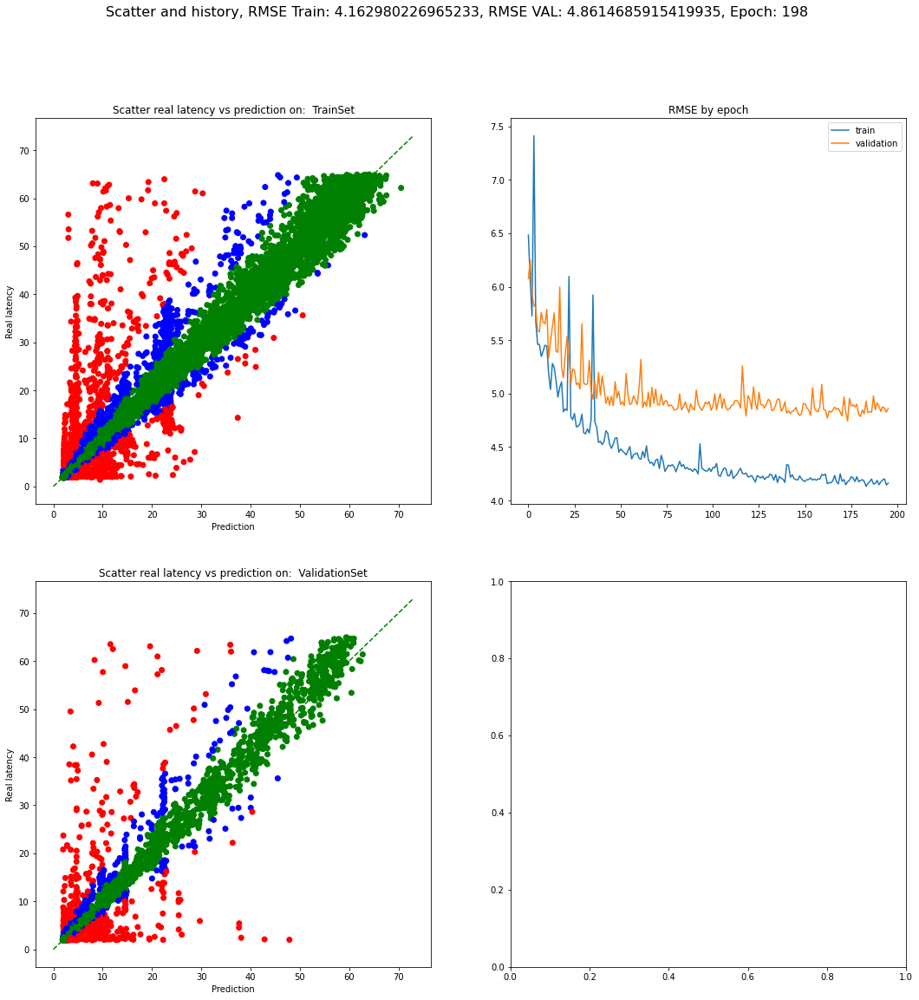

In [12]:
list_columns = ['assign', 'bgp', 'distinct', 'extend', 'filter', 'graph', 'group',
'join', 'leftjoin','minus', 'multi', 'notoneof', 'order', 'path*',  'project', 'reduced',
'sequence', 'slice', 'tolist', 'top','treesize', 'triple', 'union' ,
'path+', 'path?', 'pathN*', 'pathN+', 'pcs0', 'pcs1', 'pcs2', 'pcs3', 'pcs4',
'pcs5', 'pcs6', 'pcs7', 'pcs8', 'pcs9', 'pcs10', 'pcs11','pcs12', 'pcs13',
'pcs14', 'pcs15', 'pcs16', 'pcs17', 'pcs18', 'pcs19', 'pcs20', 'pcs21', 'pcs22', 'pcs23', 'pcs24',
                'filter_bound', 'filter_contains', 'filter_eq', 'filter_exists',
       'filter_ge', 'filter_gt', 'filter_isBlank', 'filter_isIRI',
       'filter_isLiteral', 'filter_lang', 'filter_langMatches', 'filter_le',
       'filter_lt', 'filter_ne', 'filter_not', 'filter_notexists', 'filter_or',
       'filter_regex', 'filter_sameTerm', 'filter_str', 'filter_strends',
       'filter_strstarts', 'filter_subtract', 'has_slice', 'max_slice_limit', 'max_slice_start','json_cardinality']

x_train_query = ds_train[list_columns]
x_val_query   = ds_val[list_columns]

x_train_tree = ds_train['trees'].values
x_val_tree = ds_val['trees'].values

y_train = ds_train['time'].values
y_val = ds_val['time'].values

import json
def getmax(x):
    lista=  list(x.values())
    maximo = 0
    for el in lista:
        if (maximo < float(el)):
            maximo = float(el)
    return maximo

maxcardinality =  x_train_query['json_cardinality'].apply(lambda x: json.loads(x)).apply(lambda x: getmax(x)).max()

x_train_tree = ds_train['trees'].values
x_val_tree = ds_val['trees'].values

y_train = ds_train['time'].values
y_val = ds_val['time'].values

aec_dir = '/workspace/bao_server/aec_wikidata_neo.pth'
verbose=True
reg = NeoRegression(
     aec={'train_aec': False, 'use_aec': True,'aec_file': aec_dir+str(fold)+'.pth', 'aec_epochs': 200},
     epochs=300,
     maxcardinality=maxcardinality,
     in_channels_neo_net=512,
     tree_units=[512, 256, 128],
     tree_units_dense=[64, 32],
     early_stop_patience=10,
     early_stop_initial_patience=180,
     tree_activation_tree=nn.LeakyReLU,
     tree_activation_dense=nn.ReLU,
    optimizer={'optimizer': "Adam",'args':{"lr":0.00015}},
    figimage_size=(18,18),
    start_history_from_epoch=3
)

#Fit the transformer tree data
reg.fit_transform_tree_data(ds_train, ds_val, ds_test)
print("Trees tranformed!!!")


#Scale x_query data.
xqtrain = x_train_query.drop(columns=['json_cardinality'])
xqval   = x_val_query.drop(columns=['json_cardinality'])

scalerx = StandardScaler()
x_train_scaled = scalerx.fit_transform(xqtrain)
x_val_scaled = scalerx.transform(xqval)

x_train_query =pd.concat([pd.DataFrame(x_train_scaled, index=xqtrain.index, columns=xqtrain.columns),x_train_query[['json_cardinality']]], axis=1)
x_val_query =  pd.concat([pd.DataFrame(x_val_scaled,   index=xqval.index, columns=xqval.columns),x_val_query[['json_cardinality']]], axis=1)

def pred2index_dict(x, pred_to_index):
    resp = {}
    x = json.loads(x)
    for el in x.keys():
        if el in pred_to_index:
            resp[pred_to_index[el]] = float(x[el])/maxcardinality
    return resp

x_train_query['json_cardinality'] = x_train_query['json_cardinality'].apply(lambda x: pred2index_dict(x, reg.get_pred()))
x_val_query['json_cardinality'] = x_val_query['json_cardinality'].apply(lambda x: pred2index_dict(x, reg.get_pred()))

#Fit model
reg.fit(x_train_tree, x_train_query.values, y_train, x_val_tree, x_val_query.values, y_val)

In [ ]:
select_query_features['tree filters histogram alg graph'] = getpreds(x_val_tree, x_val_query, y_val)

In [15]:
file_to_store = open("./select_query_features2.pickle", "wb")
pickle.dump(select_query_features, file_to_store)
file_to_store.close()

### Model with Autoencoder for Tree Nodes, Algebra + Graph Pattern + Filters + Cardinality

In [ ]:
list_columns = ['assign', 'bgp', 'distinct', 'extend', 'filter', 'graph', 'group',
'join', 'leftjoin','minus', 'multi', 'notoneof', 'order', 'path*',  'project', 'reduced',
'sequence', 'slice', 'tolist', 'top','treesize', 'triple', 'union' ,
'path+', 'path?', 'pathN*', 'pathN+', 'pcs0', 'pcs1', 'pcs2', 'pcs3', 'pcs4',
'pcs5', 'pcs6', 'pcs7', 'pcs8', 'pcs9', 'pcs10', 'pcs11','pcs12', 'pcs13',
'pcs14', 'pcs15', 'pcs16', 'pcs17', 'pcs18', 'pcs19', 'pcs20', 'pcs21', 'pcs22', 'pcs23', 'pcs24',
                'filter_bound', 'filter_contains', 'filter_eq', 'filter_exists',
       'filter_ge', 'filter_gt', 'filter_isBlank', 'filter_isIRI',
       'filter_isLiteral', 'filter_lang', 'filter_langMatches', 'filter_le',
       'filter_lt', 'filter_ne', 'filter_not', 'filter_notexists', 'filter_or',
       'filter_regex', 'filter_sameTerm', 'filter_str', 'filter_strends',
       'filter_strstarts', 'filter_subtract', 'has_slice', 'max_slice_limit', 'max_slice_start','json_cardinality']

x_train_query = ds_train[list_columns]
x_val_query   = ds_val[list_columns]

x_train_tree = ds_train['trees'].values
x_val_tree = ds_val['trees'].values

y_train = ds_train['time'].values
y_val = ds_val['time'].values

import json
def getmax(x):
    lista=  list(x.values())
    maximo = 0
    for el in lista:
        if (maximo < float(el)):
            maximo = float(el)
    return maximo

maxcardinality =  x_train_query['json_cardinality'].apply(lambda x: json.loads(x)).apply(lambda x: getmax(x)).max()

x_train_tree = ds_train['trees'].values
x_val_tree = ds_val['trees'].values

y_train = ds_train['time'].values
y_val = ds_val['time'].values

aec_dir = '/workspace/bao_server/aec_wikidata_neo.pth'
verbose=True
reg = NeoWithAEC(
     aec={'train_aec': False, 'use_aec': True,'aec_file': aec_dir+str(fold)+'.pth', 'aec_epochs': 200},
     epochs=300,
     maxcardinality=maxcardinality,
     in_channels_neo_net=512,
     tree_units=[512, 256, 128],
     tree_units_dense=[64, 32],
     early_stop_patience=10,
     early_stop_initial_patience=180,
     tree_activation_tree=nn.LeakyReLU,
     tree_activation_dense=nn.ReLU,
    optimizer={'optimizer': "Adam",'args':{"lr":0.00015}},
    figimage_size=(18,18),
    start_history_from_epoch=3
)

#Fit the transformer tree data
reg.fit_transform_tree_data(ds_train, ds_val, ds_test)
print("Trees tranformed!!!")


#Scale x_query data.
xqtrain = x_train_query.drop(columns=['json_cardinality'])
xqval   = x_val_query.drop(columns=['json_cardinality'])

scalerx = StandardScaler()
x_train_scaled = scalerx.fit_transform(xqtrain)
x_val_scaled = scalerx.transform(xqval)

x_train_query =pd.concat([pd.DataFrame(x_train_scaled, index=xqtrain.index, columns=xqtrain.columns),x_train_query[['json_cardinality']]], axis=1)
x_val_query =  pd.concat([pd.DataFrame(x_val_scaled,   index=xqval.index, columns=xqval.columns),x_val_query[['json_cardinality']]], axis=1)

def pred2index_dict(x, pred_to_index):
    resp = {}
    x = json.loads(x)
    for el in x.keys():
        if el in pred_to_index:
            resp[pred_to_index[el]] = float(x[el])/maxcardinality
    return resp

x_train_query['json_cardinality'] = x_train_query['json_cardinality'].apply(lambda x: pred2index_dict(x, reg.get_pred()))
x_val_query['json_cardinality'] = x_val_query['json_cardinality'].apply(lambda x: pred2index_dict(x, reg.get_pred()))

#Fit model
reg.fit(x_train_tree, x_train_query.values, y_train, x_val_tree, x_val_query.values, y_val)

Model optimizer: Adam lr: 0.00015
Error in data ignored! [datasetnames ?var1]
Error in data ignored! [bgp "VAR_URI_VARᶲhttp://www.wikidata.org/prop/direct/P685"]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Error in data ignored! [reduced   ["VAR_VAR_VARᶲNONE"]]
Trees tranformed!!!
Error in data ignored! ('[datasetnames ?var1]', array([0.0, -1.7842985172092378, -0.9969511247242911,
       -0.38089646475639777, -0.7608060122962548, 131.74217244299564,
       -0.440849777226363, -0.22270361389275614, -0.3884150555940348, 0.0,
       0.0, -0.2851796594325823, -0.16792076009743978,
       -0.18843522857892528, -0.16056601611160903, -0.013148034373354402,
       -0.2658168204054264, -0.03736810006086702, 0.0, 0.0,
       -0.44491529570400773, -1.6203835027108602, -0.06615878138041308,
       0.0, -0.007590583800587443, 0.0, 0.0, -0.9427214672680767,
       -2.5646399528

[2021-01-12 17:51:26,590] INFO:model_trees_algebra_aec:==> Epoch 0,	TRAIN_LOSS: 1276.678349515425	_TRAIN_RMSE: 35.73063600770948,	VAL_LOSS: 170.84339899844275,	VAL_RMSE: 13.07070767014712


Initial patience 180
2021-01-12 17:52:02.865626 Epoch 1, Training loss 0.00012161291666277748


[2021-01-12 17:52:10,386] INFO:model_trees_algebra_aec:==> Epoch 1,	TRAIN_LOSS: 703.8244326797526	_TRAIN_RMSE: 26.529689645371892,	VAL_LOSS: 119.63895255879744,	VAL_RMSE: 10.937959250189106


Initial patience 179
2021-01-12 17:52:52.529061 Epoch 2, Training loss 8.901855287360225e-05


[2021-01-12 17:53:00,128] INFO:model_trees_algebra_aec:==> Epoch 2,	TRAIN_LOSS: 125.429028656103	_TRAIN_RMSE: 11.199510197151614,	VAL_LOSS: 114.62015622111102,	VAL_RMSE: 10.706080338812662


Initial patience 178
2021-01-12 17:53:42.810194 Epoch 3, Training loss 7.842649549564466e-05


[2021-01-12 17:53:50,463] INFO:model_trees_algebra_aec:==> Epoch 3,	TRAIN_LOSS: 130.78050276306575	_TRAIN_RMSE: 11.435930340950218,	VAL_LOSS: 74.07192098580465,	VAL_RMSE: 8.606504574204598


Initial patience 177
2021-01-12 17:54:32.490011 Epoch 4, Training loss 6.297313023811152e-05


[2021-01-12 17:54:40,050] INFO:model_trees_algebra_aec:==> Epoch 4,	TRAIN_LOSS: 78.57082090176168	_TRAIN_RMSE: 8.86401832702086,	VAL_LOSS: 65.17564609925326,	VAL_RMSE: 8.073143507906524


Initial patience 176
2021-01-12 17:55:22.484657 Epoch 5, Training loss 5.603703846387601e-05


[2021-01-12 17:55:30,142] INFO:model_trees_algebra_aec:==> Epoch 5,	TRAIN_LOSS: 62.5687042981089	_TRAIN_RMSE: 7.910038198271162,	VAL_LOSS: 55.14047019270083,	VAL_RMSE: 7.4256629463436346


Initial patience 175
2021-01-12 17:56:12.785965 Epoch 6, Training loss 5.0335664275398595e-05


[2021-01-12 17:56:20,329] INFO:model_trees_algebra_aec:==> Epoch 6,	TRAIN_LOSS: 51.79778398838554	_TRAIN_RMSE: 7.1970677354312524,	VAL_LOSS: 55.56707552292374,	VAL_RMSE: 7.454332667846515


Initial patience 174
2021-01-12 17:57:02.459650 Epoch 7, Training loss 4.664777439744429e-05


[2021-01-12 17:57:10,009] INFO:model_trees_algebra_aec:==> Epoch 7,	TRAIN_LOSS: 45.07292142701937	_TRAIN_RMSE: 6.713636974622576,	VAL_LOSS: 45.097744717329896,	VAL_RMSE: 6.715485441673588


Initial patience 173
2021-01-12 17:57:52.482964 Epoch 8, Training loss 4.5118729100810566e-05


[2021-01-12 17:58:00,083] INFO:model_trees_algebra_aec:==> Epoch 8,	TRAIN_LOSS: 43.73490099231676	_TRAIN_RMSE: 6.61323680146997,	VAL_LOSS: 40.01044203144492,	VAL_RMSE: 6.325380781537576


Initial patience 172
2021-01-12 17:58:42.307540 Epoch 9, Training loss 4.216753486270479e-05


[2021-01-12 17:58:49,855] INFO:model_trees_algebra_aec:==> Epoch 9,	TRAIN_LOSS: 41.07921144706945	_TRAIN_RMSE: 6.409306627636834,	VAL_LOSS: 40.00808167844957,	VAL_RMSE: 6.325194200848665


Initial patience 171
2021-01-12 17:59:32.391782 Epoch 10, Training loss 4.233044968412123e-05


[2021-01-12 17:59:39,944] INFO:model_trees_algebra_aec:==> Epoch 10,	TRAIN_LOSS: 39.69625015828632	_TRAIN_RMSE: 6.300496024781408,	VAL_LOSS: 39.90391614546299,	VAL_RMSE: 6.316954657543696


Initial patience 170
2021-01-12 18:00:22.605064 Epoch 11, Training loss 4.119353176934071e-05


[2021-01-12 18:00:30,059] INFO:model_trees_algebra_aec:==> Epoch 11,	TRAIN_LOSS: 39.809027398429464	_TRAIN_RMSE: 6.309439547093661,	VAL_LOSS: 43.50016953468635,	VAL_RMSE: 6.595465831515341


Initial patience 169
2021-01-12 18:01:11.911002 Epoch 12, Training loss 3.884423052563588e-05


[2021-01-12 18:01:19,525] INFO:model_trees_algebra_aec:==> Epoch 12,	TRAIN_LOSS: 35.50594523382182	_TRAIN_RMSE: 5.958686535959231,	VAL_LOSS: 36.56035450140248,	VAL_RMSE: 6.046515897721801


Initial patience 168
2021-01-12 18:02:01.493679 Epoch 13, Training loss 3.866499069602604e-05


[2021-01-12 18:02:09,154] INFO:model_trees_algebra_aec:==> Epoch 13,	TRAIN_LOSS: 35.114312252871905	_TRAIN_RMSE: 5.925733056160386,	VAL_LOSS: 42.38530505341131,	VAL_RMSE: 6.510399761413374


Initial patience 167
2021-01-12 18:02:51.350890 Epoch 14, Training loss 3.822239597558018e-05


[2021-01-12 18:02:58,865] INFO:model_trees_algebra_aec:==> Epoch 14,	TRAIN_LOSS: 36.55808284537703	_TRAIN_RMSE: 6.046328046457373,	VAL_LOSS: 34.35015434698918,	VAL_RMSE: 5.860900472366783


Initial patience 166
2021-01-12 18:03:41.198707 Epoch 15, Training loss 3.695656318822956e-05


[2021-01-12 18:03:48,778] INFO:model_trees_algebra_aec:==> Epoch 15,	TRAIN_LOSS: 33.84497456038282	_TRAIN_RMSE: 5.817643385459685,	VAL_LOSS: 41.323406230459625,	VAL_RMSE: 6.428328416506084


Initial patience 165
2021-01-12 18:04:31.120979 Epoch 16, Training loss 3.6853085063478655e-05


[2021-01-12 18:04:38,664] INFO:model_trees_algebra_aec:==> Epoch 16,	TRAIN_LOSS: 32.85942136761808	_TRAIN_RMSE: 5.732313788307308,	VAL_LOSS: 34.75653926741059,	VAL_RMSE: 5.895467688607121


Initial patience 164
2021-01-12 18:05:21.073113 Epoch 17, Training loss 3.581878396780478e-05


[2021-01-12 18:05:28,669] INFO:model_trees_algebra_aec:==> Epoch 17,	TRAIN_LOSS: 32.1464247092304	_TRAIN_RMSE: 5.66978171618894,	VAL_LOSS: 41.298692182080984,	VAL_RMSE: 6.426405852580507


Initial patience 163
2021-01-12 18:06:10.980994 Epoch 18, Training loss 3.5457604564827057e-05


[2021-01-12 18:06:18,554] INFO:model_trees_algebra_aec:==> Epoch 18,	TRAIN_LOSS: 32.95560803843684	_TRAIN_RMSE: 5.740697521942507,	VAL_LOSS: 33.827942169243386,	VAL_RMSE: 5.816179344659464


Initial patience 162
2021-01-12 18:07:00.792117 Epoch 19, Training loss 3.430071868285447e-05


[2021-01-12 18:07:08,371] INFO:model_trees_algebra_aec:==> Epoch 19,	TRAIN_LOSS: 31.260411195343835	_TRAIN_RMSE: 5.591101071823316,	VAL_LOSS: 38.96818056864185,	VAL_RMSE: 6.242449885152611


Initial patience 161
2021-01-12 18:07:50.443686 Epoch 20, Training loss 3.353738385192685e-05


[2021-01-12 18:07:58,093] INFO:model_trees_algebra_aec:==> Epoch 20,	TRAIN_LOSS: 29.87237954805682	_TRAIN_RMSE: 5.465563058647922,	VAL_LOSS: 34.820410474404305,	VAL_RMSE: 5.900882177641264


Initial patience 160
2021-01-12 18:08:40.425394 Epoch 21, Training loss 3.305968260294862e-05


[2021-01-12 18:08:47,919] INFO:model_trees_algebra_aec:==> Epoch 21,	TRAIN_LOSS: 30.83240642476338	_TRAIN_RMSE: 5.552693618845126,	VAL_LOSS: 30.22900671596633,	VAL_RMSE: 5.498091188400419


Initial patience 159
2021-01-12 18:09:31.957517 Epoch 22, Training loss 3.337192984089059e-05


[2021-01-12 18:09:40,200] INFO:model_trees_algebra_aec:==> Epoch 22,	TRAIN_LOSS: 28.6682740772617	_TRAIN_RMSE: 5.354276242150913,	VAL_LOSS: 31.052862206751367,	VAL_RMSE: 5.572509507102825


Initial patience 158
2021-01-12 18:10:24.479116 Epoch 23, Training loss 3.2353540329847915e-05


[2021-01-12 18:10:32,299] INFO:model_trees_algebra_aec:==> Epoch 23,	TRAIN_LOSS: 28.557121182702247	_TRAIN_RMSE: 5.343886336993167,	VAL_LOSS: 30.37697692160053,	VAL_RMSE: 5.5115312683137825


Initial patience 157
2021-01-12 18:13:45.089911 Epoch 27, Training loss 3.1537938128695996e-05


[2021-01-12 18:13:52,616] INFO:model_trees_algebra_aec:==> Epoch 27,	TRAIN_LOSS: 27.606710203041093	_TRAIN_RMSE: 5.254208808473555,	VAL_LOSS: 32.89437298938682,	VAL_RMSE: 5.735361626731728


Initial patience 153
2021-01-12 18:14:34.691388 Epoch 28, Training loss 3.1979511621914505e-05


[2021-01-12 18:14:42,265] INFO:model_trees_algebra_aec:==> Epoch 28,	TRAIN_LOSS: 28.379019082092857	_TRAIN_RMSE: 5.327196174545561,	VAL_LOSS: 30.65018802289299,	VAL_RMSE: 5.536261195327853


Initial patience 152
2021-01-12 18:15:24.389687 Epoch 29, Training loss 3.0564891509054135e-05


[2021-01-12 18:15:31,923] INFO:model_trees_algebra_aec:==> Epoch 29,	TRAIN_LOSS: 26.540158332672434	_TRAIN_RMSE: 5.151714115968823,	VAL_LOSS: 29.61723375582522,	VAL_RMSE: 5.442171786688217


Initial patience 151
2021-01-12 18:16:13.885429 Epoch 30, Training loss 3.0213247262691486e-05


[2021-01-12 18:16:21,853] INFO:model_trees_algebra_aec:==> Epoch 30,	TRAIN_LOSS: 26.158496896720358	_TRAIN_RMSE: 5.114537798933581,	VAL_LOSS: 28.825171029826972,	VAL_RMSE: 5.368907806046494


Initial patience 150
2021-01-12 18:17:04.218434 Epoch 31, Training loss 3.179796477717057e-05


[2021-01-12 18:17:11,869] INFO:model_trees_algebra_aec:==> Epoch 31,	TRAIN_LOSS: 32.02834780829994	_TRAIN_RMSE: 5.65935931076124,	VAL_LOSS: 31.049119733558385,	VAL_RMSE: 5.5721736991553295


Initial patience 149
2021-01-12 18:17:54.689729 Epoch 32, Training loss 2.9690315704538956e-05


[2021-01-12 18:18:02,345] INFO:model_trees_algebra_aec:==> Epoch 32,	TRAIN_LOSS: 25.513416933845946	_TRAIN_RMSE: 5.05108076888956,	VAL_LOSS: 30.167520238349713,	VAL_RMSE: 5.492496721742282


Initial patience 148
2021-01-12 18:18:45.568396 Epoch 33, Training loss 2.9298455638599112e-05


[2021-01-12 18:18:53,293] INFO:model_trees_algebra_aec:==> Epoch 33,	TRAIN_LOSS: 26.031806056086097	_TRAIN_RMSE: 5.102137400745505,	VAL_LOSS: 28.71199943739286,	VAL_RMSE: 5.3583579049362555


Initial patience 147
2021-01-12 18:19:36.155902 Epoch 34, Training loss 2.9629786679560273e-05


[2021-01-12 18:19:43,778] INFO:model_trees_algebra_aec:==> Epoch 34,	TRAIN_LOSS: 25.822996563953655	_TRAIN_RMSE: 5.081633257522,	VAL_LOSS: 30.7385724782321,	VAL_RMSE: 5.54423777251951


Initial patience 146
2021-01-12 18:20:26.587914 Epoch 35, Training loss 3.106271361159849e-05


[2021-01-12 18:20:34,449] INFO:model_trees_algebra_aec:==> Epoch 35,	TRAIN_LOSS: 33.61925030043802	_TRAIN_RMSE: 5.798210956876097,	VAL_LOSS: 32.46562197903393,	VAL_RMSE: 5.697861175830273


Initial patience 145
2021-01-12 18:21:17.834771 Epoch 36, Training loss 2.9494871034903333e-05


[2021-01-12 18:21:25,889] INFO:model_trees_algebra_aec:==> Epoch 36,	TRAIN_LOSS: 24.943200036131092	_TRAIN_RMSE: 4.994316773706999,	VAL_LOSS: 35.94285321076684,	VAL_RMSE: 5.9952358761575715


Initial patience 144
2021-01-12 18:22:10.957018 Epoch 37, Training loss 2.9014877618528045e-05


[2021-01-12 18:22:18,920] INFO:model_trees_algebra_aec:==> Epoch 37,	TRAIN_LOSS: 25.27790000207028	_TRAIN_RMSE: 5.027713198072289,	VAL_LOSS: 31.668378228616714,	VAL_RMSE: 5.627466412926577


Initial patience 143
2021-01-12 18:23:01.289231 Epoch 38, Training loss 2.9280834090635126e-05


[2021-01-12 18:23:08,864] INFO:model_trees_algebra_aec:==> Epoch 38,	TRAIN_LOSS: 25.41740132518433	_TRAIN_RMSE: 5.041567348075827,	VAL_LOSS: 30.89644507353401,	VAL_RMSE: 5.558457076701592


Initial patience 142
2021-01-12 18:23:50.969338 Epoch 39, Training loss 2.8366075749642974e-05


[2021-01-12 18:23:58,482] INFO:model_trees_algebra_aec:==> Epoch 39,	TRAIN_LOSS: 24.727556766630556	_TRAIN_RMSE: 4.972681044128063,	VAL_LOSS: 30.961405836776976,	VAL_RMSE: 5.564297425261969


Initial patience 141
2021-01-12 18:24:40.529164 Epoch 40, Training loss 2.7874996854816315e-05


[2021-01-12 18:24:48,134] INFO:model_trees_algebra_aec:==> Epoch 40,	TRAIN_LOSS: 24.26586654405687	_TRAIN_RMSE: 4.926039640934375,	VAL_LOSS: 31.32302068621551,	VAL_RMSE: 5.596697301642775


Initial patience 140
2021-01-12 18:25:30.190315 Epoch 41, Training loss 2.835074723529895e-05


[2021-01-12 18:25:37,825] INFO:model_trees_algebra_aec:==> Epoch 41,	TRAIN_LOSS: 24.550248687103025	_TRAIN_RMSE: 4.954820752267737,	VAL_LOSS: 29.442930534972295,	VAL_RMSE: 5.426134032160678


Initial patience 139
2021-01-12 18:26:19.755828 Epoch 42, Training loss 2.8680599287603852e-05


[2021-01-12 18:26:27,311] INFO:model_trees_algebra_aec:==> Epoch 42,	TRAIN_LOSS: 24.121118456711656	_TRAIN_RMSE: 4.911325529499308,	VAL_LOSS: 26.4585757838435,	VAL_RMSE: 5.1437900213600765


Initial patience 138
2021-01-12 18:27:09.624908 Epoch 43, Training loss 2.7763394160394775e-05


[2021-01-12 18:27:17,198] INFO:model_trees_algebra_aec:==> Epoch 43,	TRAIN_LOSS: 23.14585857679094	_TRAIN_RMSE: 4.811014298127884,	VAL_LOSS: 26.571365017782465,	VAL_RMSE: 5.154741993328324


Initial patience 137
2021-01-12 18:28:00.812622 Epoch 44, Training loss 2.7514927339064162e-05


[2021-01-12 18:28:08,326] INFO:model_trees_algebra_aec:==> Epoch 44,	TRAIN_LOSS: 22.974167787960756	_TRAIN_RMSE: 4.7931375724008545,	VAL_LOSS: 27.601705010016563,	VAL_RMSE: 5.253732483674494


Initial patience 136
2021-01-12 18:28:51.174629 Epoch 45, Training loss 2.7572170595713377e-05


[2021-01-12 18:28:59,079] INFO:model_trees_algebra_aec:==> Epoch 45,	TRAIN_LOSS: 23.25762432042259	_TRAIN_RMSE: 4.822615920890092,	VAL_LOSS: 28.06131845423268,	VAL_RMSE: 5.297293502745783


Initial patience 135
2021-01-12 18:29:41.738890 Epoch 46, Training loss 2.8406848519858033e-05


[2021-01-12 18:29:49,368] INFO:model_trees_algebra_aec:==> Epoch 46,	TRAIN_LOSS: 24.647793136195375	_TRAIN_RMSE: 4.964654382350838,	VAL_LOSS: 27.402009351243493,	VAL_RMSE: 5.2346928612138734


Initial patience 134
2021-01-12 18:30:31.551536 Epoch 47, Training loss 2.7350003169272222e-05


[2021-01-12 18:30:39,161] INFO:model_trees_algebra_aec:==> Epoch 47,	TRAIN_LOSS: 23.628549286771367	_TRAIN_RMSE: 4.860920621319727,	VAL_LOSS: 29.497727664229473,	VAL_RMSE: 5.431181056108282


Initial patience 133
2021-01-12 18:31:21.411248 Epoch 48, Training loss 2.8275063669095122e-05


[2021-01-12 18:31:28,972] INFO:model_trees_algebra_aec:==> Epoch 48,	TRAIN_LOSS: 25.104345340504196	_TRAIN_RMSE: 5.01042366876337,	VAL_LOSS: 27.83935599094156,	VAL_RMSE: 5.276301355205326


Initial patience 132
2021-01-12 18:32:10.949122 Epoch 49, Training loss 2.704437645560823e-05


[2021-01-12 18:32:18,459] INFO:model_trees_algebra_aec:==> Epoch 49,	TRAIN_LOSS: 22.84406781575409	_TRAIN_RMSE: 4.779546821169774,	VAL_LOSS: 27.869686600270025,	VAL_RMSE: 5.279174802965898


Initial patience 131
2021-01-12 18:33:00.603195 Epoch 50, Training loss 2.67844030582058e-05


[2021-01-12 18:33:08,129] INFO:model_trees_algebra_aec:==> Epoch 50,	TRAIN_LOSS: 23.27357182765101	_TRAIN_RMSE: 4.824269045943749,	VAL_LOSS: 29.146014453129627,	VAL_RMSE: 5.39870488664917


Initial patience 130
2021-01-12 18:33:50.161542 Epoch 51, Training loss 2.633909862889819e-05


[2021-01-12 18:33:57,735] INFO:model_trees_algebra_aec:==> Epoch 51,	TRAIN_LOSS: 22.275284895674552	_TRAIN_RMSE: 4.719669998598901,	VAL_LOSS: 26.44616525093367,	VAL_RMSE: 5.142583519101432


Initial patience 129
2021-01-12 18:34:40.640904 Epoch 52, Training loss 2.67346316231033e-05


[2021-01-12 18:34:48,676] INFO:model_trees_algebra_aec:==> Epoch 52,	TRAIN_LOSS: 22.813533303376808	_TRAIN_RMSE: 4.776351463552154,	VAL_LOSS: 28.202775051199193,	VAL_RMSE: 5.310628498699489


Initial patience 128
2021-01-12 18:35:32.232826 Epoch 53, Training loss 2.680217752086722e-05


[2021-01-12 18:35:40,197] INFO:model_trees_algebra_aec:==> Epoch 53,	TRAIN_LOSS: 22.50463588437423	_TRAIN_RMSE: 4.7439051302038315,	VAL_LOSS: 27.293137241578687,	VAL_RMSE: 5.224283418956009


Initial patience 127
2021-01-12 18:36:23.970279 Epoch 54, Training loss 2.6493902235110325e-05


[2021-01-12 18:36:31,794] INFO:model_trees_algebra_aec:==> Epoch 54,	TRAIN_LOSS: 22.32510971832095	_TRAIN_RMSE: 4.724945472523567,	VAL_LOSS: 25.936173926722876,	VAL_RMSE: 5.092757006447773


Initial patience 126
2021-01-12 18:37:14.089635 Epoch 55, Training loss 2.619071286103447e-05


[2021-01-12 18:37:21,901] INFO:model_trees_algebra_aec:==> Epoch 55,	TRAIN_LOSS: 22.130844292708883	_TRAIN_RMSE: 4.704343130842911,	VAL_LOSS: 26.406003061446757,	VAL_RMSE: 5.138677170386048


Initial patience 125
2021-01-12 18:38:04.464034 Epoch 56, Training loss 2.579344274296361e-05


[2021-01-12 18:38:12,282] INFO:model_trees_algebra_aec:==> Epoch 56,	TRAIN_LOSS: 21.58832307231588	_TRAIN_RMSE: 4.646323608221437,	VAL_LOSS: 27.296705991253376,	VAL_RMSE: 5.224624961779877


Initial patience 124
2021-01-12 18:38:54.379450 Epoch 57, Training loss 2.647092620860336e-05


[2021-01-12 18:39:02,053] INFO:model_trees_algebra_aec:==> Epoch 57,	TRAIN_LOSS: 22.45070993403006	_TRAIN_RMSE: 4.738218012505341,	VAL_LOSS: 25.726632223017944,	VAL_RMSE: 5.072142764455466


Initial patience 123
2021-01-12 18:39:44.353349 Epoch 58, Training loss 2.7078565695793042e-05


[2021-01-12 18:39:52,019] INFO:model_trees_algebra_aec:==> Epoch 58,	TRAIN_LOSS: 22.99056012397907	_TRAIN_RMSE: 4.794847247199755,	VAL_LOSS: 27.4499786634421,	VAL_RMSE: 5.23927272275858


Initial patience 122
2021-01-12 18:40:34.372129 Epoch 59, Training loss 2.634627686264416e-05


[2021-01-12 18:40:41,895] INFO:model_trees_algebra_aec:==> Epoch 59,	TRAIN_LOSS: 22.93230170946344	_TRAIN_RMSE: 4.7887682873013855,	VAL_LOSS: 26.004787060536394,	VAL_RMSE: 5.099488901893639


Initial patience 121
2021-01-12 18:41:24.165433 Epoch 60, Training loss 2.6231075172199466e-05


[2021-01-12 18:41:31,832] INFO:model_trees_algebra_aec:==> Epoch 60,	TRAIN_LOSS: 21.98471463783857	_TRAIN_RMSE: 4.688786051617046,	VAL_LOSS: 29.661274457989546,	VAL_RMSE: 5.4462165269101765


Initial patience 120
2021-01-12 18:42:14.311323 Epoch 61, Training loss 2.6183254628408595e-05


[2021-01-12 18:42:21,878] INFO:model_trees_algebra_aec:==> Epoch 61,	TRAIN_LOSS: 22.982393244356754	_TRAIN_RMSE: 4.793995540710979,	VAL_LOSS: 26.023294157976117,	VAL_RMSE: 5.101303182322741


Initial patience 119
2021-01-12 18:43:03.990050 Epoch 62, Training loss 2.5461844137472896e-05


[2021-01-12 18:43:11,887] INFO:model_trees_algebra_aec:==> Epoch 62,	TRAIN_LOSS: 21.504636945963018	_TRAIN_RMSE: 4.637309235533363,	VAL_LOSS: 25.796615797813917,	VAL_RMSE: 5.079036896677747


Initial patience 118
2021-01-12 18:43:53.632992 Epoch 63, Training loss 2.542419307249893e-05


[2021-01-12 18:44:01,349] INFO:model_trees_algebra_aec:==> Epoch 63,	TRAIN_LOSS: 21.20285774484122	_TRAIN_RMSE: 4.604656094090114,	VAL_LOSS: 25.124946514512093,	VAL_RMSE: 5.012479078710663


Initial patience 117
2021-01-12 18:44:45.257685 Epoch 64, Training loss 2.6004589835478308e-05


[2021-01-12 18:44:52,885] INFO:model_trees_algebra_aec:==> Epoch 64,	TRAIN_LOSS: 22.07627629455824	_TRAIN_RMSE: 4.698539804509295,	VAL_LOSS: 26.893923714435466,	VAL_RMSE: 5.185935182243938


Initial patience 116
2021-01-12 18:45:34.453746 Epoch 65, Training loss 2.533749808478731e-05


[2021-01-12 18:45:41,944] INFO:model_trees_algebra_aec:==> Epoch 65,	TRAIN_LOSS: 21.37007447541158	_TRAIN_RMSE: 4.6227777878037335,	VAL_LOSS: 26.924000586393134,	VAL_RMSE: 5.18883422228858


Initial patience 115
2021-01-12 18:46:23.550460 Epoch 66, Training loss 2.539577259906868e-05


[2021-01-12 18:46:31,124] INFO:model_trees_algebra_aec:==> Epoch 66,	TRAIN_LOSS: 21.425909418753395	_TRAIN_RMSE: 4.62881296000966,	VAL_LOSS: 26.81548833772017,	VAL_RMSE: 5.178367342871706


Initial patience 114
2021-01-12 18:47:12.754607 Epoch 67, Training loss 2.48344029011155e-05


[2021-01-12 18:47:20,248] INFO:model_trees_algebra_aec:==> Epoch 67,	TRAIN_LOSS: 20.879075925186083	_TRAIN_RMSE: 4.569362748259989,	VAL_LOSS: 26.11985848505047,	VAL_RMSE: 5.110759090883708


Initial patience 113
2021-01-12 18:48:02.528612 Epoch 68, Training loss 2.474463166008183e-05


[2021-01-12 18:48:10,240] INFO:model_trees_algebra_aec:==> Epoch 68,	TRAIN_LOSS: 20.659984426093867	_TRAIN_RMSE: 4.545325557767438,	VAL_LOSS: 25.915883305273614,	VAL_RMSE: 5.090764510883765


Initial patience 112
2021-01-12 18:48:52.928710 Epoch 69, Training loss 2.5307764097236828e-05


[2021-01-12 18:49:00,485] INFO:model_trees_algebra_aec:==> Epoch 69,	TRAIN_LOSS: 21.567927533804006	_TRAIN_RMSE: 4.644128285674719,	VAL_LOSS: 29.378782907237166,	VAL_RMSE: 5.4202198209332035


Initial patience 111
2021-01-12 18:49:44.396795 Epoch 70, Training loss 2.6518304240736776e-05


[2021-01-12 18:49:51,916] INFO:model_trees_algebra_aec:==> Epoch 70,	TRAIN_LOSS: 24.05004891344755	_TRAIN_RMSE: 4.904084921108886,	VAL_LOSS: 29.21324069473315,	VAL_RMSE: 5.404927445834324


Initial patience 110
2021-01-12 18:50:33.593886 Epoch 71, Training loss 2.5901796848192036e-05


[2021-01-12 18:50:41,117] INFO:model_trees_algebra_aec:==> Epoch 71,	TRAIN_LOSS: 23.13339287724676	_TRAIN_RMSE: 4.809718586076191,	VAL_LOSS: 25.50578453971989,	VAL_RMSE: 5.050325191482217


Initial patience 109
2021-01-12 18:51:22.862503 Epoch 72, Training loss 2.5627505941298663e-05


[2021-01-12 18:51:30,345] INFO:model_trees_algebra_aec:==> Epoch 72,	TRAIN_LOSS: 21.586504797050363	_TRAIN_RMSE: 4.646127935932282,	VAL_LOSS: 27.795776322481853,	VAL_RMSE: 5.272169982320548


Initial patience 108
2021-01-12 18:52:12.229213 Epoch 73, Training loss 2.5357981615887744e-05


[2021-01-12 18:52:19,736] INFO:model_trees_algebra_aec:==> Epoch 73,	TRAIN_LOSS: 21.24205101316346	_TRAIN_RMSE: 4.608909959324814,	VAL_LOSS: 25.117138833192293,	VAL_RMSE: 5.01170019386558


Initial patience 107
2021-01-12 18:53:01.848765 Epoch 74, Training loss 2.510966970664183e-05


[2021-01-12 18:53:09,334] INFO:model_trees_algebra_aec:==> Epoch 74,	TRAIN_LOSS: 21.25590989372947	_TRAIN_RMSE: 4.610413202060036,	VAL_LOSS: 25.38192111357436,	VAL_RMSE: 5.038047351263619


Initial patience 106
2021-01-12 18:53:50.907176 Epoch 75, Training loss 2.4600695774427844e-05


[2021-01-12 18:53:58,401] INFO:model_trees_algebra_aec:==> Epoch 75,	TRAIN_LOSS: 21.33818781676393	_TRAIN_RMSE: 4.619327636871402,	VAL_LOSS: 25.024956192452358,	VAL_RMSE: 5.00249499674436


Initial patience 105
2021-01-12 18:54:40.673823 Epoch 76, Training loss 2.4367818102974402e-05


[2021-01-12 18:54:48,566] INFO:model_trees_algebra_aec:==> Epoch 76,	TRAIN_LOSS: 20.244499193572306	_TRAIN_RMSE: 4.499388757772805,	VAL_LOSS: 25.679741923842418,	VAL_RMSE: 5.0675183200302705


Initial patience 104
2021-01-12 18:55:31.565317 Epoch 77, Training loss 2.4487634928691886e-05


[2021-01-12 18:55:39,140] INFO:model_trees_algebra_aec:==> Epoch 77,	TRAIN_LOSS: 20.67416478429756	_TRAIN_RMSE: 4.546885173863264,	VAL_LOSS: 31.18294110081111,	VAL_RMSE: 5.584168792292288


Initial patience 103
2021-01-12 18:56:22.375320 Epoch 78, Training loss 2.441813322551261e-05


[2021-01-12 18:56:30,351] INFO:model_trees_algebra_aec:==> Epoch 78,	TRAIN_LOSS: 20.545577554976582	_TRAIN_RMSE: 4.532722973553158,	VAL_LOSS: 24.05211574560516,	VAL_RMSE: 4.904295642149355


Initial patience 102
2021-01-12 18:57:13.946849 Epoch 79, Training loss 2.437539796084764e-05


[2021-01-12 18:57:21,661] INFO:model_trees_algebra_aec:==> Epoch 79,	TRAIN_LOSS: 20.520069331009335	_TRAIN_RMSE: 4.5299083137530864,	VAL_LOSS: 24.404716894160032,	VAL_RMSE: 4.940113044674184


Initial patience 101
2021-01-12 18:58:04.001353 Epoch 80, Training loss 2.45564467282137e-05


[2021-01-12 18:58:11,604] INFO:model_trees_algebra_aec:==> Epoch 80,	TRAIN_LOSS: 20.552919820368793	_TRAIN_RMSE: 4.53353281893589,	VAL_LOSS: 24.88146856657881,	VAL_RMSE: 4.9881327735515235


Initial patience 100
2021-01-12 18:58:53.533183 Epoch 81, Training loss 2.4224596419277505e-05


[2021-01-12 18:59:01,287] INFO:model_trees_algebra_aec:==> Epoch 81,	TRAIN_LOSS: 20.06673586462874	_TRAIN_RMSE: 4.479591037653855,	VAL_LOSS: 26.349639474537128,	VAL_RMSE: 5.133189990107236


Initial patience 99
2021-01-12 18:59:43.905008 Epoch 82, Training loss 2.439026253769578e-05


[2021-01-12 18:59:51,499] INFO:model_trees_algebra_aec:==> Epoch 82,	TRAIN_LOSS: 20.799588512105615	_TRAIN_RMSE: 4.560656587828732,	VAL_LOSS: 26.354380165207775,	VAL_RMSE: 5.133651737818584


Initial patience 98
2021-01-12 19:00:33.821644 Epoch 83, Training loss 2.4321835495344346e-05


[2021-01-12 19:00:41,435] INFO:model_trees_algebra_aec:==> Epoch 83,	TRAIN_LOSS: 20.638099584165893	_TRAIN_RMSE: 4.542917518970149,	VAL_LOSS: 25.334992643205585,	VAL_RMSE: 5.033387789869322


Initial patience 97
2021-01-12 19:01:23.824117 Epoch 84, Training loss 2.4268705227073308e-05


[2021-01-12 19:01:31,365] INFO:model_trees_algebra_aec:==> Epoch 84,	TRAIN_LOSS: 20.533226400711964	_TRAIN_RMSE: 4.531360325632024,	VAL_LOSS: 25.481607750449633,	VAL_RMSE: 5.047931036617837


Initial patience 96
2021-01-12 19:02:13.429766 Epoch 85, Training loss 2.4433894688444805e-05


[2021-01-12 19:02:21,329] INFO:model_trees_algebra_aec:==> Epoch 85,	TRAIN_LOSS: 20.404286065597212	_TRAIN_RMSE: 4.517110366771794,	VAL_LOSS: 24.59578580894296,	VAL_RMSE: 4.959413857397158


Initial patience 95
2021-01-12 19:03:05.252218 Epoch 86, Training loss 2.521203067784737e-05


[2021-01-12 19:03:13,065] INFO:model_trees_algebra_aec:==> Epoch 86,	TRAIN_LOSS: 21.871105893705334	_TRAIN_RMSE: 4.6766554174650645,	VAL_LOSS: 24.802987376725348,	VAL_RMSE: 4.9802597700045075


Initial patience 94
2021-01-12 19:03:55.892846 Epoch 87, Training loss 2.4359594470763216e-05


[2021-01-12 19:04:03,799] INFO:model_trees_algebra_aec:==> Epoch 87,	TRAIN_LOSS: 21.44130374566402	_TRAIN_RMSE: 4.630475542065201,	VAL_LOSS: 25.06128049241267,	VAL_RMSE: 5.006124298538009


Initial patience 93
2021-01-12 19:04:45.565514 Epoch 88, Training loss 2.398064301103653e-05


[2021-01-12 19:04:53,125] INFO:model_trees_algebra_aec:==> Epoch 88,	TRAIN_LOSS: 20.642179933890798	_TRAIN_RMSE: 4.5433665859020005,	VAL_LOSS: 24.127863974711488,	VAL_RMSE: 4.912012212394376


Initial patience 92
2021-01-12 19:05:35.721591 Epoch 89, Training loss 2.3682861451545888e-05


[2021-01-12 19:05:43,252] INFO:model_trees_algebra_aec:==> Epoch 89,	TRAIN_LOSS: 19.761174751905443	_TRAIN_RMSE: 4.445354288682224,	VAL_LOSS: 24.192204929168046,	VAL_RMSE: 4.918557199948786


Initial patience 91
2021-01-12 19:06:25.293231 Epoch 90, Training loss 2.3980910699874176e-05


[2021-01-12 19:06:32,748] INFO:model_trees_algebra_aec:==> Epoch 90,	TRAIN_LOSS: 20.024927069112266	_TRAIN_RMSE: 4.474922018215766,	VAL_LOSS: 24.233900447499433,	VAL_RMSE: 4.922793967606143


Initial patience 90
2021-01-12 19:07:14.746427 Epoch 91, Training loss 2.424417318258675e-05


[2021-01-12 19:07:22,394] INFO:model_trees_algebra_aec:==> Epoch 91,	TRAIN_LOSS: 20.83226122429772	_TRAIN_RMSE: 4.564237200704815,	VAL_LOSS: 24.84547972899753,	VAL_RMSE: 4.984524022311211


Initial patience 89
2021-01-12 19:08:05.061861 Epoch 92, Training loss 2.4501592168921274e-05


[2021-01-12 19:08:12,664] INFO:model_trees_algebra_aec:==> Epoch 92,	TRAIN_LOSS: 20.45148983235756	_TRAIN_RMSE: 4.52233234430615,	VAL_LOSS: 24.753605760392205,	VAL_RMSE: 4.975299564889757


Initial patience 88
2021-01-12 19:08:54.603488 Epoch 93, Training loss 2.368276666347307e-05


[2021-01-12 19:09:02,195] INFO:model_trees_algebra_aec:==> Epoch 93,	TRAIN_LOSS: 19.767900813504593	_TRAIN_RMSE: 4.4461107513763745,	VAL_LOSS: 24.671213047317963,	VAL_RMSE: 4.96701248713127


Initial patience 87


In [7]:
select_query_features['Autoencoder for tree '] = getpreds(x_val_tree, x_val_query, y_val)

Error in data ignored! ('[reduced   ["VAR_VAR_VARᶲNONE"]]', array([0.0, -0.2697956386723539, -0.9969511247242911,
       -0.38089646475639777, 1.2983410258179031, -0.007590583800587443,
       -0.440849777226363, -0.22270361389275614, -0.3884150555940348, 0.0,
       0.0, -0.2851796594325823, -0.16792076009743978,
       -0.18843522857892528, -0.16056601611160903, 76.05699617173076,
       -0.2658168204054264, -0.030772279324198456, 0.0, 0.0,
       0.5490218672452762, -0.862113397926616, -0.06615878138041308, 0.0,
       -0.007590583800587443, 0.0, 0.0, 0.2804062062539321,
       -0.6317003547484434, 0.6835426054434408, 0.24226508028516677,
       -0.9957963237018248, 0.6820505122337273, 1.3352276033315946,
       1.3681396760695763, -0.4450060765697146, 1.3681431420577275,
       -0.06311887379458052, -0.8325769088025612, 0.1228495158689613,
       -0.8214430669370255, 0.683008631795568, 0.25331728070299214,
       0.2285319060305104, 0.6807951496567529, 1.3520553686931422,
       0.

In [8]:
file_to_store = open("./select_query_features3.pickle", "wb")
pickle.dump(select_query_features, file_to_store)
file_to_store.close()

In [32]:
from torch.utils.data import DataLoader
def run_baseline(x_train, y_train, x_val, y_val, maxcardinality, preds2index, query_hidden_inputs=[260, 380, 240]):
    
    verbose=True
    reg = DenseRegression(
        verbose=True,
         epochs=250,
         encode_cardinalities=True,
         query_input_size= len(x_train[0]),
         query_hidden_inputs=[260, 380, 240],
         query_output=1,
#          loss={'func':'CustomMSELoss', 'threshold': 20, 'weight_factor': 1},
         early_stop_patience=5,
         early_stop_initial_patience=80,
         activation_dense=nn.ReLU,
        optimizer={'optimizer': "Adam",'args':{"lr":0.00015}},
        figimage_size=(18,18),
        preds2index=preds2index
    )
    reg.fit(x_train, y_train, x_val, y_val)
    
    pairs_val = list(zip(x_val, y_val))
    dataset_val = DataLoader(pairs_val, batch_size=64, num_workers=0, shuffle=False, collate_fn=reg.collate)
    preds = reg.predict_best(dataset_val)
    y_pred_val, y_real_val = zip(*preds)
    mseval = mean_squared_error(y_real_val, y_pred_val)
    maeval = mean_absolute_error(y_real_val, y_pred_val)
    rmseval = np.sqrt(mseval)
    print("RMSE for baseline: in fold:{}, set VAL: {}".format(fold, rmseval))
#     reg.scatter_image(preds, y_val, "Scatter real latency vs prediction on Val dataset.", "neo_with_aec_scatter_test", max_refference=70, figsize =(15,15))
    return preds , mseval, rmseval, maeval , reg.history

In [31]:
L1 = range(800, 200, -120)
L2 = range(600, 200, -100)
L3 = range(400, 100, -100)

In [23]:
list(L1)

[800, 680, 560, 440, 320]

In [ ]:
from torch.utils.data import DataLoader
import pickle
from model_dense import DenseRegression
folds_executiondense = {}
dftable = pd.DataFrame(columns=[])
for l3  in L3:
    for l2  in L2:
        for l1  in L1:

            list_columns = ['assign', 'bgp', 'distinct', 'extend', 'filter', 'graph', 'group',
            'join', 'leftjoin','minus', 'multi', 'notoneof', 'order', 'path*',  'project', 'reduced',
            'sequence', 'slice', 'tolist', 'top','treesize', 'triple', 'union' ,
            'path+', 'path?', 'pathN*', 'pathN+', 'pcs0', 'pcs1', 'pcs2', 'pcs3', 'pcs4',
            'pcs5', 'pcs6', 'pcs7', 'pcs8', 'pcs9', 'pcs10', 'pcs11','pcs12', 'pcs13',
            'pcs14', 'pcs15', 'pcs16', 'pcs17', 'pcs18', 'pcs19', 'pcs20', 'pcs21', 'pcs22', 'pcs23', 'pcs24',
                            'filter_bound', 'filter_contains', 'filter_eq', 'filter_exists',
                   'filter_ge', 'filter_gt', 'filter_isBlank', 'filter_isIRI',
                   'filter_isLiteral', 'filter_lang', 'filter_langMatches', 'filter_le',
                   'filter_lt', 'filter_ne', 'filter_not', 'filter_notexists', 'filter_or',
                   'filter_regex', 'filter_sameTerm', 'filter_str', 'filter_strends',
                   'filter_strstarts', 'filter_subtract', 'has_slice', 'max_slice_limit', 'max_slice_start','json_cardinality']

            x_train_query = ds_train[list_columns]
            x_val_query   = ds_val[list_columns]

            y_train = ds_train['time'].values
            y_val = ds_val['time'].values

            import json
            def getmax(x):
                lista=  list(x.values())
                maximo = 0
                for el in lista:
                    if (maximo < float(el)):
                        maximo = float(el)
                return maximo

            def getpreds(values, preds_dic):
                index = len(preds_dic)
                for x in values:
                    lista=  list(json.loads(x).keys())
                    for el in lista:
                        if not el.startswith("http"):
                            continue
                        if el not in preds_dic:
                            preds_dic[el] = index
                            index +=1
                return preds_dic

            #Scale x_query data.
            xqtrain = x_train_query.drop(columns=['json_cardinality'])
            xqval   = x_val_query.drop(columns=['json_cardinality'])

            scalerx = StandardScaler()
            x_train_scaled = scalerx.fit_transform(xqtrain)
            x_val_scaled = scalerx.transform(xqval)

            x_train_query =pd.concat([pd.DataFrame(x_train_scaled, index=xqtrain.index, columns=xqtrain.columns),x_train_query[['json_cardinality']]], axis=1)
            x_val_query =  pd.concat([pd.DataFrame(x_val_scaled,   index=xqval.index, columns=xqval.columns),x_val_query[['json_cardinality']]], axis=1)

            preds_dic = {}
            preds_dic = getpreds(x_train_query['json_cardinality'], preds_dic)
            preds_dic = getpreds(x_val_query['json_cardinality'], preds_dic)

            maxcardinality =  x_train_query['json_cardinality'].apply(lambda x: json.loads(x)).apply(lambda x: getmax(x)).max()

            def pred2index_dict(x, pred_to_index):
                resp = {}
                x = json.loads(x)
                for el in x.keys():
                    if el in pred_to_index:
                        resp[pred_to_index[el]] = float(x[el])/maxcardinality
                return resp

            x_train_query['json_cardinality'] = x_train_query['json_cardinality'].apply(lambda x: pred2index_dict(x, preds_dic))
            x_val_query['json_cardinality'] = x_val_query['json_cardinality'].apply(lambda x: pred2index_dict(x, preds_dic))
            y_train = ds_train['time'].values
            y_val = ds_val['time'].values
            
            print("Ejecutando L1: {} L2: {} L3: {}".format(l1, l2, l3))
            preds , mseval, rmseval, maeval , history = run_baseline(x_train_query.values, y_train, x_val_query.values, y_val, maxcardinality,  preds_dic, 
                                                                    query_hidden_inputs=[l1, l2,l3])
            y_pred_val, y_real_val = zip(*preds)
            folds_executiondense[fold] = {"pred": y_pred_val, "real" : y_real_val, "mse": mseval, "mae": maeval, "rmse": rmseval, "history": history}
            df_row = {"L1": l1, "L2": l2,"L3": l3, "mse": mseval, "mae": maeval, "rmse": rmseval}
            dftable = dftable.append(df_row, ignore_index=True)
            dftable.to_csv("./fithparameters_dense_model.csv", index=False)
            file_to_store = open("./folds_execution_baseline_fithpdense.pickle", "wb")
            pickle.dump(folds_executiondense, file_to_store)
            file_to_store.close()
            print("Fold {} baseline Saved!!".format(fold))

Ejecutando L1: 800 L2: 600 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-14 20:47:51.464540 Epoch 0, Training loss 0.0015810554086594846


[2021-01-14 20:47:52,951] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 115107736.0	_TRAIN_RMSE: 10728.8271484375, 	VAL_LOSS: 189.0928192138672, 	VAL_RMSE: 13.751102447509766
[2021-01-14 20:47:52,951] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 115107736.0	_TRAIN_RMSE: 10728.8271484375, 	VAL_LOSS: 189.0928192138672, 	VAL_RMSE: 13.751102447509766
[2021-01-14 20:47:52,951] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 115107736.0	_TRAIN_RMSE: 10728.8271484375, 	VAL_LOSS: 189.0928192138672, 	VAL_RMSE: 13.751102447509766
[2021-01-14 20:47:52,951] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 115107736.0	_TRAIN_RMSE: 10728.8271484375, 	VAL_LOSS: 189.0928192138672, 	VAL_RMSE: 13.751102447509766
[2021-01-14 20:47:52,951] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 115107736.0	_TRAIN_RMSE: 10728.8271484375, 	VAL_LOSS: 189.0928192138672, 	VAL_RMSE: 13.751102447509766
[2021-01-14 20:47:52,951] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 115107736.0	_TRAIN_RMSE: 10728.8271484375, 	VAL_LOSS: 189.0928192138672

Initial patience 80
2021-01-14 20:47:57.898356 Epoch 1, Training loss 0.0005659803109256403


[2021-01-14 20:47:59,244] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 488.88568115234375	_TRAIN_RMSE: 22.110759735107422, 	VAL_LOSS: 130.9608612060547, 	VAL_RMSE: 11.44381332397461
[2021-01-14 20:47:59,244] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 488.88568115234375	_TRAIN_RMSE: 22.110759735107422, 	VAL_LOSS: 130.9608612060547, 	VAL_RMSE: 11.44381332397461
[2021-01-14 20:47:59,244] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 488.88568115234375	_TRAIN_RMSE: 22.110759735107422, 	VAL_LOSS: 130.9608612060547, 	VAL_RMSE: 11.44381332397461
[2021-01-14 20:47:59,244] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 488.88568115234375	_TRAIN_RMSE: 22.110759735107422, 	VAL_LOSS: 130.9608612060547, 	VAL_RMSE: 11.44381332397461
[2021-01-14 20:47:59,244] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 488.88568115234375	_TRAIN_RMSE: 22.110759735107422, 	VAL_LOSS: 130.9608612060547, 	VAL_RMSE: 11.44381332397461
[2021-01-14 20:47:59,244] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 488.88568115234375	_TRAIN_RMSE:

Initial patience 79
2021-01-14 20:48:09.605450 Epoch 2, Training loss 0.0005010017012584322


[2021-01-14 20:48:10,920] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 153.3908233642578	_TRAIN_RMSE: 12.38510513305664, 	VAL_LOSS: 126.90971374511719, 	VAL_RMSE: 11.265420913696289
[2021-01-14 20:48:10,920] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 153.3908233642578	_TRAIN_RMSE: 12.38510513305664, 	VAL_LOSS: 126.90971374511719, 	VAL_RMSE: 11.265420913696289
[2021-01-14 20:48:10,920] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 153.3908233642578	_TRAIN_RMSE: 12.38510513305664, 	VAL_LOSS: 126.90971374511719, 	VAL_RMSE: 11.265420913696289
[2021-01-14 20:48:10,920] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 153.3908233642578	_TRAIN_RMSE: 12.38510513305664, 	VAL_LOSS: 126.90971374511719, 	VAL_RMSE: 11.265420913696289
[2021-01-14 20:48:10,920] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 153.3908233642578	_TRAIN_RMSE: 12.38510513305664, 	VAL_LOSS: 126.90971374511719, 	VAL_RMSE: 11.265420913696289
[2021-01-14 20:48:10,920] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 153.3908233642578	_TRAIN_RMSE: 

Initial patience 78
2021-01-14 20:48:21.397752 Epoch 3, Training loss 0.0004785064395169073


[2021-01-14 20:48:22,718] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 149.31829833984375	_TRAIN_RMSE: 12.219586372375488, 	VAL_LOSS: 124.4681167602539, 	VAL_RMSE: 11.156527519226074
[2021-01-14 20:48:22,718] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 149.31829833984375	_TRAIN_RMSE: 12.219586372375488, 	VAL_LOSS: 124.4681167602539, 	VAL_RMSE: 11.156527519226074
[2021-01-14 20:48:22,718] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 149.31829833984375	_TRAIN_RMSE: 12.219586372375488, 	VAL_LOSS: 124.4681167602539, 	VAL_RMSE: 11.156527519226074
[2021-01-14 20:48:22,718] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 149.31829833984375	_TRAIN_RMSE: 12.219586372375488, 	VAL_LOSS: 124.4681167602539, 	VAL_RMSE: 11.156527519226074
[2021-01-14 20:48:22,718] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 149.31829833984375	_TRAIN_RMSE: 12.219586372375488, 	VAL_LOSS: 124.4681167602539, 	VAL_RMSE: 11.156527519226074
[2021-01-14 20:48:22,718] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 149.31829833984375	_TRAIN_

Initial patience 77
2021-01-14 20:48:33.078112 Epoch 4, Training loss 0.00047389192749974947


[2021-01-14 20:48:34,422] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 150.32391357421875	_TRAIN_RMSE: 12.260664939880371, 	VAL_LOSS: 135.2293243408203, 	VAL_RMSE: 11.628814697265625
[2021-01-14 20:48:34,422] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 150.32391357421875	_TRAIN_RMSE: 12.260664939880371, 	VAL_LOSS: 135.2293243408203, 	VAL_RMSE: 11.628814697265625
[2021-01-14 20:48:34,422] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 150.32391357421875	_TRAIN_RMSE: 12.260664939880371, 	VAL_LOSS: 135.2293243408203, 	VAL_RMSE: 11.628814697265625
[2021-01-14 20:48:34,422] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 150.32391357421875	_TRAIN_RMSE: 12.260664939880371, 	VAL_LOSS: 135.2293243408203, 	VAL_RMSE: 11.628814697265625
[2021-01-14 20:48:34,422] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 150.32391357421875	_TRAIN_RMSE: 12.260664939880371, 	VAL_LOSS: 135.2293243408203, 	VAL_RMSE: 11.628814697265625
[2021-01-14 20:48:34,422] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 150.32391357421875	_TRAIN_

Initial patience 76
2021-01-14 20:48:45.017961 Epoch 5, Training loss 0.00046504441983868917


[2021-01-14 20:48:46,352] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 148.62696838378906	_TRAIN_RMSE: 12.191266059875488, 	VAL_LOSS: 138.80642700195312, 	VAL_RMSE: 11.781614303588867
[2021-01-14 20:48:46,352] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 148.62696838378906	_TRAIN_RMSE: 12.191266059875488, 	VAL_LOSS: 138.80642700195312, 	VAL_RMSE: 11.781614303588867
[2021-01-14 20:48:46,352] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 148.62696838378906	_TRAIN_RMSE: 12.191266059875488, 	VAL_LOSS: 138.80642700195312, 	VAL_RMSE: 11.781614303588867
[2021-01-14 20:48:46,352] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 148.62696838378906	_TRAIN_RMSE: 12.191266059875488, 	VAL_LOSS: 138.80642700195312, 	VAL_RMSE: 11.781614303588867
[2021-01-14 20:48:46,352] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 148.62696838378906	_TRAIN_RMSE: 12.191266059875488, 	VAL_LOSS: 138.80642700195312, 	VAL_RMSE: 11.781614303588867
[2021-01-14 20:48:46,352] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 148.62696838378906	_T

Initial patience 75
2021-01-14 20:48:56.881456 Epoch 6, Training loss 0.00045040860380590687


[2021-01-14 20:48:58,210] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 143.0145721435547	_TRAIN_RMSE: 11.958869934082031, 	VAL_LOSS: 126.69052124023438, 	VAL_RMSE: 11.255688667297363
[2021-01-14 20:48:58,210] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 143.0145721435547	_TRAIN_RMSE: 11.958869934082031, 	VAL_LOSS: 126.69052124023438, 	VAL_RMSE: 11.255688667297363
[2021-01-14 20:48:58,210] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 143.0145721435547	_TRAIN_RMSE: 11.958869934082031, 	VAL_LOSS: 126.69052124023438, 	VAL_RMSE: 11.255688667297363
[2021-01-14 20:48:58,210] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 143.0145721435547	_TRAIN_RMSE: 11.958869934082031, 	VAL_LOSS: 126.69052124023438, 	VAL_RMSE: 11.255688667297363
[2021-01-14 20:48:58,210] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 143.0145721435547	_TRAIN_RMSE: 11.958869934082031, 	VAL_LOSS: 126.69052124023438, 	VAL_RMSE: 11.255688667297363
[2021-01-14 20:48:58,210] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 143.0145721435547	_TRAIN_R

Initial patience 74
2021-01-14 20:49:08.813745 Epoch 7, Training loss 0.0004518512039442118


[2021-01-14 20:49:10,142] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 144.36378479003906	_TRAIN_RMSE: 12.015148162841797, 	VAL_LOSS: 120.3398666381836, 	VAL_RMSE: 10.969952583312988
[2021-01-14 20:49:10,142] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 144.36378479003906	_TRAIN_RMSE: 12.015148162841797, 	VAL_LOSS: 120.3398666381836, 	VAL_RMSE: 10.969952583312988
[2021-01-14 20:49:10,142] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 144.36378479003906	_TRAIN_RMSE: 12.015148162841797, 	VAL_LOSS: 120.3398666381836, 	VAL_RMSE: 10.969952583312988
[2021-01-14 20:49:10,142] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 144.36378479003906	_TRAIN_RMSE: 12.015148162841797, 	VAL_LOSS: 120.3398666381836, 	VAL_RMSE: 10.969952583312988
[2021-01-14 20:49:10,142] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 144.36378479003906	_TRAIN_RMSE: 12.015148162841797, 	VAL_LOSS: 120.3398666381836, 	VAL_RMSE: 10.969952583312988
[2021-01-14 20:49:10,142] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 144.36378479003906	_TRAIN_

Initial patience 73
2021-01-14 20:49:20.638130 Epoch 8, Training loss 0.0004460954443297017


[2021-01-14 20:49:21,968] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 143.9806365966797	_TRAIN_RMSE: 11.99919319152832, 	VAL_LOSS: 134.14170837402344, 	VAL_RMSE: 11.581955909729004
[2021-01-14 20:49:21,968] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 143.9806365966797	_TRAIN_RMSE: 11.99919319152832, 	VAL_LOSS: 134.14170837402344, 	VAL_RMSE: 11.581955909729004
[2021-01-14 20:49:21,968] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 143.9806365966797	_TRAIN_RMSE: 11.99919319152832, 	VAL_LOSS: 134.14170837402344, 	VAL_RMSE: 11.581955909729004
[2021-01-14 20:49:21,968] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 143.9806365966797	_TRAIN_RMSE: 11.99919319152832, 	VAL_LOSS: 134.14170837402344, 	VAL_RMSE: 11.581955909729004
[2021-01-14 20:49:21,968] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 143.9806365966797	_TRAIN_RMSE: 11.99919319152832, 	VAL_LOSS: 134.14170837402344, 	VAL_RMSE: 11.581955909729004
[2021-01-14 20:49:21,968] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 143.9806365966797	_TRAIN_RMSE: 

Initial patience 72
2021-01-14 20:49:32.566968 Epoch 9, Training loss 0.0004401674069573774


[2021-01-14 20:49:33,892] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 144.5575408935547	_TRAIN_RMSE: 12.023208618164062, 	VAL_LOSS: 126.81048583984375, 	VAL_RMSE: 11.261015892028809
[2021-01-14 20:49:33,892] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 144.5575408935547	_TRAIN_RMSE: 12.023208618164062, 	VAL_LOSS: 126.81048583984375, 	VAL_RMSE: 11.261015892028809
[2021-01-14 20:49:33,892] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 144.5575408935547	_TRAIN_RMSE: 12.023208618164062, 	VAL_LOSS: 126.81048583984375, 	VAL_RMSE: 11.261015892028809
[2021-01-14 20:49:33,892] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 144.5575408935547	_TRAIN_RMSE: 12.023208618164062, 	VAL_LOSS: 126.81048583984375, 	VAL_RMSE: 11.261015892028809
[2021-01-14 20:49:33,892] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 144.5575408935547	_TRAIN_RMSE: 12.023208618164062, 	VAL_LOSS: 126.81048583984375, 	VAL_RMSE: 11.261015892028809
[2021-01-14 20:49:33,892] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 144.5575408935547	_TRAIN_R

Initial patience 71
2021-01-14 20:49:44.374432 Epoch 10, Training loss 0.0004350571852067814


[2021-01-14 20:49:45,707] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 139.59811401367188	_TRAIN_RMSE: 11.815164566040039, 	VAL_LOSS: 119.15780639648438, 	VAL_RMSE: 10.915943145751953
[2021-01-14 20:49:45,707] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 139.59811401367188	_TRAIN_RMSE: 11.815164566040039, 	VAL_LOSS: 119.15780639648438, 	VAL_RMSE: 10.915943145751953
[2021-01-14 20:49:45,707] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 139.59811401367188	_TRAIN_RMSE: 11.815164566040039, 	VAL_LOSS: 119.15780639648438, 	VAL_RMSE: 10.915943145751953
[2021-01-14 20:49:45,707] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 139.59811401367188	_TRAIN_RMSE: 11.815164566040039, 	VAL_LOSS: 119.15780639648438, 	VAL_RMSE: 10.915943145751953
[2021-01-14 20:49:45,707] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 139.59811401367188	_TRAIN_RMSE: 11.815164566040039, 	VAL_LOSS: 119.15780639648438, 	VAL_RMSE: 10.915943145751953
[2021-01-14 20:49:45,707] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 139.59811401367

Initial patience 70
2021-01-14 20:49:56.238288 Epoch 11, Training loss 0.00043122680973790097


[2021-01-14 20:49:57,576] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.91461181640625	_TRAIN_RMSE: 11.78620433807373, 	VAL_LOSS: 129.16644287109375, 	VAL_RMSE: 11.365141868591309
[2021-01-14 20:49:57,576] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.91461181640625	_TRAIN_RMSE: 11.78620433807373, 	VAL_LOSS: 129.16644287109375, 	VAL_RMSE: 11.365141868591309
[2021-01-14 20:49:57,576] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.91461181640625	_TRAIN_RMSE: 11.78620433807373, 	VAL_LOSS: 129.16644287109375, 	VAL_RMSE: 11.365141868591309
[2021-01-14 20:49:57,576] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.91461181640625	_TRAIN_RMSE: 11.78620433807373, 	VAL_LOSS: 129.16644287109375, 	VAL_RMSE: 11.365141868591309
[2021-01-14 20:49:57,576] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.91461181640625	_TRAIN_RMSE: 11.78620433807373, 	VAL_LOSS: 129.16644287109375, 	VAL_RMSE: 11.365141868591309
[2021-01-14 20:49:57,576] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.91461181640625	_

Initial patience 69
2021-01-14 20:50:08.176793 Epoch 12, Training loss 0.0004288997202241555


[2021-01-14 20:50:09,519] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 140.04324340820312	_TRAIN_RMSE: 11.83398723602295, 	VAL_LOSS: 134.2103729248047, 	VAL_RMSE: 11.584919929504395
[2021-01-14 20:50:09,519] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 140.04324340820312	_TRAIN_RMSE: 11.83398723602295, 	VAL_LOSS: 134.2103729248047, 	VAL_RMSE: 11.584919929504395
[2021-01-14 20:50:09,519] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 140.04324340820312	_TRAIN_RMSE: 11.83398723602295, 	VAL_LOSS: 134.2103729248047, 	VAL_RMSE: 11.584919929504395
[2021-01-14 20:50:09,519] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 140.04324340820312	_TRAIN_RMSE: 11.83398723602295, 	VAL_LOSS: 134.2103729248047, 	VAL_RMSE: 11.584919929504395
[2021-01-14 20:50:09,519] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 140.04324340820312	_TRAIN_RMSE: 11.83398723602295, 	VAL_LOSS: 134.2103729248047, 	VAL_RMSE: 11.584919929504395
[2021-01-14 20:50:09,519] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 140.04324340820312	_TRAIN

Initial patience 68
2021-01-14 20:50:20.068047 Epoch 13, Training loss 0.00042366458080502736


[2021-01-14 20:50:21,406] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 140.87057495117188	_TRAIN_RMSE: 11.868890762329102, 	VAL_LOSS: 124.0545654296875, 	VAL_RMSE: 11.137978553771973
[2021-01-14 20:50:21,406] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 140.87057495117188	_TRAIN_RMSE: 11.868890762329102, 	VAL_LOSS: 124.0545654296875, 	VAL_RMSE: 11.137978553771973
[2021-01-14 20:50:21,406] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 140.87057495117188	_TRAIN_RMSE: 11.868890762329102, 	VAL_LOSS: 124.0545654296875, 	VAL_RMSE: 11.137978553771973
[2021-01-14 20:50:21,406] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 140.87057495117188	_TRAIN_RMSE: 11.868890762329102, 	VAL_LOSS: 124.0545654296875, 	VAL_RMSE: 11.137978553771973
[2021-01-14 20:50:21,406] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 140.87057495117188	_TRAIN_RMSE: 11.868890762329102, 	VAL_LOSS: 124.0545654296875, 	VAL_RMSE: 11.137978553771973
[2021-01-14 20:50:21,406] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 140.87057495117188	_

Initial patience 67
2021-01-14 20:50:31.943948 Epoch 14, Training loss 0.0004230329269788206


[2021-01-14 20:50:33,272] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 139.38075256347656	_TRAIN_RMSE: 11.805962562561035, 	VAL_LOSS: 128.11485290527344, 	VAL_RMSE: 11.318782806396484
[2021-01-14 20:50:33,272] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 139.38075256347656	_TRAIN_RMSE: 11.805962562561035, 	VAL_LOSS: 128.11485290527344, 	VAL_RMSE: 11.318782806396484
[2021-01-14 20:50:33,272] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 139.38075256347656	_TRAIN_RMSE: 11.805962562561035, 	VAL_LOSS: 128.11485290527344, 	VAL_RMSE: 11.318782806396484
[2021-01-14 20:50:33,272] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 139.38075256347656	_TRAIN_RMSE: 11.805962562561035, 	VAL_LOSS: 128.11485290527344, 	VAL_RMSE: 11.318782806396484
[2021-01-14 20:50:33,272] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 139.38075256347656	_TRAIN_RMSE: 11.805962562561035, 	VAL_LOSS: 128.11485290527344, 	VAL_RMSE: 11.318782806396484
[2021-01-14 20:50:33,272] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 139.38075256347

Initial patience 66
2021-01-14 20:50:43.867859 Epoch 15, Training loss 0.00041873991500689393


[2021-01-14 20:50:45,199] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 136.96728515625	_TRAIN_RMSE: 11.703302383422852, 	VAL_LOSS: 127.88516998291016, 	VAL_RMSE: 11.308632850646973
[2021-01-14 20:50:45,199] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 136.96728515625	_TRAIN_RMSE: 11.703302383422852, 	VAL_LOSS: 127.88516998291016, 	VAL_RMSE: 11.308632850646973
[2021-01-14 20:50:45,199] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 136.96728515625	_TRAIN_RMSE: 11.703302383422852, 	VAL_LOSS: 127.88516998291016, 	VAL_RMSE: 11.308632850646973
[2021-01-14 20:50:45,199] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 136.96728515625	_TRAIN_RMSE: 11.703302383422852, 	VAL_LOSS: 127.88516998291016, 	VAL_RMSE: 11.308632850646973
[2021-01-14 20:50:45,199] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 136.96728515625	_TRAIN_RMSE: 11.703302383422852, 	VAL_LOSS: 127.88516998291016, 	VAL_RMSE: 11.308632850646973
[2021-01-14 20:50:45,199] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 136.96728515625	_TRAIN_RMSE: 1

Initial patience 65
2021-01-14 20:50:55.646697 Epoch 16, Training loss 0.0004158608041781043


[2021-01-14 20:50:56,986] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 137.89186096191406	_TRAIN_RMSE: 11.74273681640625, 	VAL_LOSS: 124.84805297851562, 	VAL_RMSE: 11.173542976379395
[2021-01-14 20:50:56,986] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 137.89186096191406	_TRAIN_RMSE: 11.74273681640625, 	VAL_LOSS: 124.84805297851562, 	VAL_RMSE: 11.173542976379395
[2021-01-14 20:50:56,986] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 137.89186096191406	_TRAIN_RMSE: 11.74273681640625, 	VAL_LOSS: 124.84805297851562, 	VAL_RMSE: 11.173542976379395
[2021-01-14 20:50:56,986] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 137.89186096191406	_TRAIN_RMSE: 11.74273681640625, 	VAL_LOSS: 124.84805297851562, 	VAL_RMSE: 11.173542976379395
[2021-01-14 20:50:56,986] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 137.89186096191406	_TRAIN_RMSE: 11.74273681640625, 	VAL_LOSS: 124.84805297851562, 	VAL_RMSE: 11.173542976379395
[2021-01-14 20:50:56,986] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 137.89186096191406	_

Initial patience 64
2021-01-14 20:51:07.433302 Epoch 17, Training loss 0.00041150518654359047


[2021-01-14 20:51:08,766] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.2601318359375	_TRAIN_RMSE: 11.587067604064941, 	VAL_LOSS: 120.00179290771484, 	VAL_RMSE: 10.954532623291016
[2021-01-14 20:51:08,766] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.2601318359375	_TRAIN_RMSE: 11.587067604064941, 	VAL_LOSS: 120.00179290771484, 	VAL_RMSE: 10.954532623291016
[2021-01-14 20:51:08,766] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.2601318359375	_TRAIN_RMSE: 11.587067604064941, 	VAL_LOSS: 120.00179290771484, 	VAL_RMSE: 10.954532623291016
[2021-01-14 20:51:08,766] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.2601318359375	_TRAIN_RMSE: 11.587067604064941, 	VAL_LOSS: 120.00179290771484, 	VAL_RMSE: 10.954532623291016
[2021-01-14 20:51:08,766] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.2601318359375	_TRAIN_RMSE: 11.587067604064941, 	VAL_LOSS: 120.00179290771484, 	VAL_RMSE: 10.954532623291016
[2021-01-14 20:51:08,766] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.2601318359375	_T

Initial patience 63
2021-01-14 20:51:19.374442 Epoch 18, Training loss 0.0004123554925134592


[2021-01-14 20:51:20,701] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 136.65956115722656	_TRAIN_RMSE: 11.69014835357666, 	VAL_LOSS: 119.32029724121094, 	VAL_RMSE: 10.923382759094238
[2021-01-14 20:51:20,701] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 136.65956115722656	_TRAIN_RMSE: 11.69014835357666, 	VAL_LOSS: 119.32029724121094, 	VAL_RMSE: 10.923382759094238
[2021-01-14 20:51:20,701] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 136.65956115722656	_TRAIN_RMSE: 11.69014835357666, 	VAL_LOSS: 119.32029724121094, 	VAL_RMSE: 10.923382759094238
[2021-01-14 20:51:20,701] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 136.65956115722656	_TRAIN_RMSE: 11.69014835357666, 	VAL_LOSS: 119.32029724121094, 	VAL_RMSE: 10.923382759094238
[2021-01-14 20:51:20,701] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 136.65956115722656	_TRAIN_RMSE: 11.69014835357666, 	VAL_LOSS: 119.32029724121094, 	VAL_RMSE: 10.923382759094238
[2021-01-14 20:51:20,701] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 136.65956115722656	_

Initial patience 62
2021-01-14 20:51:31.228971 Epoch 19, Training loss 0.00040788109056574253


[2021-01-14 20:51:32,570] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.6715545654297	_TRAIN_RMSE: 11.561641693115234, 	VAL_LOSS: 122.55525207519531, 	VAL_RMSE: 11.070467948913574
[2021-01-14 20:51:32,570] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.6715545654297	_TRAIN_RMSE: 11.561641693115234, 	VAL_LOSS: 122.55525207519531, 	VAL_RMSE: 11.070467948913574
[2021-01-14 20:51:32,570] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.6715545654297	_TRAIN_RMSE: 11.561641693115234, 	VAL_LOSS: 122.55525207519531, 	VAL_RMSE: 11.070467948913574
[2021-01-14 20:51:32,570] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.6715545654297	_TRAIN_RMSE: 11.561641693115234, 	VAL_LOSS: 122.55525207519531, 	VAL_RMSE: 11.070467948913574
[2021-01-14 20:51:32,570] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.6715545654297	_TRAIN_RMSE: 11.561641693115234, 	VAL_LOSS: 122.55525207519531, 	VAL_RMSE: 11.070467948913574
[2021-01-14 20:51:32,570] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.6715545654297	_T

Initial patience 61
2021-01-14 20:51:43.218518 Epoch 20, Training loss 0.00040259695640897255


[2021-01-14 20:51:44,539] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.63394165039062	_TRAIN_RMSE: 11.560014724731445, 	VAL_LOSS: 126.40151977539062, 	VAL_RMSE: 11.242842674255371
[2021-01-14 20:51:44,539] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.63394165039062	_TRAIN_RMSE: 11.560014724731445, 	VAL_LOSS: 126.40151977539062, 	VAL_RMSE: 11.242842674255371
[2021-01-14 20:51:44,539] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.63394165039062	_TRAIN_RMSE: 11.560014724731445, 	VAL_LOSS: 126.40151977539062, 	VAL_RMSE: 11.242842674255371
[2021-01-14 20:51:44,539] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.63394165039062	_TRAIN_RMSE: 11.560014724731445, 	VAL_LOSS: 126.40151977539062, 	VAL_RMSE: 11.242842674255371
[2021-01-14 20:51:44,539] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.63394165039062	_TRAIN_RMSE: 11.560014724731445, 	VAL_LOSS: 126.40151977539062, 	VAL_RMSE: 11.242842674255371
[2021-01-14 20:51:44,539] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.63394165039

Initial patience 60
2021-01-14 20:51:55.064549 Epoch 21, Training loss 0.0004034687480550891


[2021-01-14 20:51:56,392] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.2175750732422	_TRAIN_RMSE: 11.585230827331543, 	VAL_LOSS: 120.78510284423828, 	VAL_RMSE: 10.990227699279785
[2021-01-14 20:51:56,392] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.2175750732422	_TRAIN_RMSE: 11.585230827331543, 	VAL_LOSS: 120.78510284423828, 	VAL_RMSE: 10.990227699279785
[2021-01-14 20:51:56,392] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.2175750732422	_TRAIN_RMSE: 11.585230827331543, 	VAL_LOSS: 120.78510284423828, 	VAL_RMSE: 10.990227699279785
[2021-01-14 20:51:56,392] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.2175750732422	_TRAIN_RMSE: 11.585230827331543, 	VAL_LOSS: 120.78510284423828, 	VAL_RMSE: 10.990227699279785
[2021-01-14 20:51:56,392] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.2175750732422	_TRAIN_RMSE: 11.585230827331543, 	VAL_LOSS: 120.78510284423828, 	VAL_RMSE: 10.990227699279785
[2021-01-14 20:51:56,392] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.2175750732422	_T

Initial patience 59
2021-01-14 20:52:06.922608 Epoch 22, Training loss 0.0004018909909366066


[2021-01-14 20:52:08,254] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.57359313964844	_TRAIN_RMSE: 11.557404518127441, 	VAL_LOSS: 133.80470275878906, 	VAL_RMSE: 11.567398071289062
[2021-01-14 20:52:08,254] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.57359313964844	_TRAIN_RMSE: 11.557404518127441, 	VAL_LOSS: 133.80470275878906, 	VAL_RMSE: 11.567398071289062
[2021-01-14 20:52:08,254] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.57359313964844	_TRAIN_RMSE: 11.557404518127441, 	VAL_LOSS: 133.80470275878906, 	VAL_RMSE: 11.567398071289062
[2021-01-14 20:52:08,254] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.57359313964844	_TRAIN_RMSE: 11.557404518127441, 	VAL_LOSS: 133.80470275878906, 	VAL_RMSE: 11.567398071289062
[2021-01-14 20:52:08,254] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.57359313964844	_TRAIN_RMSE: 11.557404518127441, 	VAL_LOSS: 133.80470275878906, 	VAL_RMSE: 11.567398071289062
[2021-01-14 20:52:08,254] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.57359313964

Initial patience 58
2021-01-14 20:52:18.733114 Epoch 23, Training loss 0.0004033490098613253


[2021-01-14 20:52:20,065] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 138.80076599121094	_TRAIN_RMSE: 11.781373977661133, 	VAL_LOSS: 124.4714126586914, 	VAL_RMSE: 11.156675338745117
[2021-01-14 20:52:20,065] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 138.80076599121094	_TRAIN_RMSE: 11.781373977661133, 	VAL_LOSS: 124.4714126586914, 	VAL_RMSE: 11.156675338745117
[2021-01-14 20:52:20,065] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 138.80076599121094	_TRAIN_RMSE: 11.781373977661133, 	VAL_LOSS: 124.4714126586914, 	VAL_RMSE: 11.156675338745117
[2021-01-14 20:52:20,065] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 138.80076599121094	_TRAIN_RMSE: 11.781373977661133, 	VAL_LOSS: 124.4714126586914, 	VAL_RMSE: 11.156675338745117
[2021-01-14 20:52:20,065] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 138.80076599121094	_TRAIN_RMSE: 11.781373977661133, 	VAL_LOSS: 124.4714126586914, 	VAL_RMSE: 11.156675338745117
[2021-01-14 20:52:20,065] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 138.80076599121094	_

Initial patience 57
2021-01-14 20:52:30.572763 Epoch 24, Training loss 0.0003974431977449404


[2021-01-14 20:52:31,908] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.71763610839844	_TRAIN_RMSE: 11.52031421661377, 	VAL_LOSS: 137.4438018798828, 	VAL_RMSE: 11.72364330291748
[2021-01-14 20:52:31,908] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.71763610839844	_TRAIN_RMSE: 11.52031421661377, 	VAL_LOSS: 137.4438018798828, 	VAL_RMSE: 11.72364330291748
[2021-01-14 20:52:31,908] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.71763610839844	_TRAIN_RMSE: 11.52031421661377, 	VAL_LOSS: 137.4438018798828, 	VAL_RMSE: 11.72364330291748
[2021-01-14 20:52:31,908] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.71763610839844	_TRAIN_RMSE: 11.52031421661377, 	VAL_LOSS: 137.4438018798828, 	VAL_RMSE: 11.72364330291748
[2021-01-14 20:52:31,908] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.71763610839844	_TRAIN_RMSE: 11.52031421661377, 	VAL_LOSS: 137.4438018798828, 	VAL_RMSE: 11.72364330291748
[2021-01-14 20:52:31,908] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.71763610839844	_TRAIN_RMSE

Initial patience 56
2021-01-14 20:52:42.479410 Epoch 25, Training loss 0.00039214316000646323


[2021-01-14 20:52:43,822] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 132.33786010742188	_TRAIN_RMSE: 11.503819465637207, 	VAL_LOSS: 119.48603820800781, 	VAL_RMSE: 10.930967330932617
[2021-01-14 20:52:43,822] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 132.33786010742188	_TRAIN_RMSE: 11.503819465637207, 	VAL_LOSS: 119.48603820800781, 	VAL_RMSE: 10.930967330932617
[2021-01-14 20:52:43,822] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 132.33786010742188	_TRAIN_RMSE: 11.503819465637207, 	VAL_LOSS: 119.48603820800781, 	VAL_RMSE: 10.930967330932617
[2021-01-14 20:52:43,822] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 132.33786010742188	_TRAIN_RMSE: 11.503819465637207, 	VAL_LOSS: 119.48603820800781, 	VAL_RMSE: 10.930967330932617
[2021-01-14 20:52:43,822] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 132.33786010742188	_TRAIN_RMSE: 11.503819465637207, 	VAL_LOSS: 119.48603820800781, 	VAL_RMSE: 10.930967330932617
[2021-01-14 20:52:43,822] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 132.33786010742

Initial patience 55
2021-01-14 20:52:54.297289 Epoch 26, Training loss 0.0003950779779836742


[2021-01-14 20:52:55,622] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 133.76719665527344	_TRAIN_RMSE: 11.565776824951172, 	VAL_LOSS: 114.39667510986328, 	VAL_RMSE: 10.695637702941895
[2021-01-14 20:52:55,622] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 133.76719665527344	_TRAIN_RMSE: 11.565776824951172, 	VAL_LOSS: 114.39667510986328, 	VAL_RMSE: 10.695637702941895
[2021-01-14 20:52:55,622] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 133.76719665527344	_TRAIN_RMSE: 11.565776824951172, 	VAL_LOSS: 114.39667510986328, 	VAL_RMSE: 10.695637702941895
[2021-01-14 20:52:55,622] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 133.76719665527344	_TRAIN_RMSE: 11.565776824951172, 	VAL_LOSS: 114.39667510986328, 	VAL_RMSE: 10.695637702941895
[2021-01-14 20:52:55,622] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 133.76719665527344	_TRAIN_RMSE: 11.565776824951172, 	VAL_LOSS: 114.39667510986328, 	VAL_RMSE: 10.695637702941895
[2021-01-14 20:52:55,622] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 133.76719665527

Initial patience 54
2021-01-14 20:53:06.115538 Epoch 27, Training loss 0.0003903930048880435


[2021-01-14 20:53:07,457] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.23724365234375	_TRAIN_RMSE: 11.45588207244873, 	VAL_LOSS: 127.79639434814453, 	VAL_RMSE: 11.304706573486328
[2021-01-14 20:53:07,457] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.23724365234375	_TRAIN_RMSE: 11.45588207244873, 	VAL_LOSS: 127.79639434814453, 	VAL_RMSE: 11.304706573486328
[2021-01-14 20:53:07,457] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.23724365234375	_TRAIN_RMSE: 11.45588207244873, 	VAL_LOSS: 127.79639434814453, 	VAL_RMSE: 11.304706573486328
[2021-01-14 20:53:07,457] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.23724365234375	_TRAIN_RMSE: 11.45588207244873, 	VAL_LOSS: 127.79639434814453, 	VAL_RMSE: 11.304706573486328
[2021-01-14 20:53:07,457] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.23724365234375	_TRAIN_RMSE: 11.45588207244873, 	VAL_LOSS: 127.79639434814453, 	VAL_RMSE: 11.304706573486328
[2021-01-14 20:53:07,457] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.23724365234375	_

Initial patience 53
2021-01-14 20:53:18.011827 Epoch 28, Training loss 0.0003894564959906995


[2021-01-14 20:53:19,345] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 136.0675048828125	_TRAIN_RMSE: 11.66479778289795, 	VAL_LOSS: 124.404052734375, 	VAL_RMSE: 11.153656005859375
[2021-01-14 20:53:19,345] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 136.0675048828125	_TRAIN_RMSE: 11.66479778289795, 	VAL_LOSS: 124.404052734375, 	VAL_RMSE: 11.153656005859375
[2021-01-14 20:53:19,345] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 136.0675048828125	_TRAIN_RMSE: 11.66479778289795, 	VAL_LOSS: 124.404052734375, 	VAL_RMSE: 11.153656005859375
[2021-01-14 20:53:19,345] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 136.0675048828125	_TRAIN_RMSE: 11.66479778289795, 	VAL_LOSS: 124.404052734375, 	VAL_RMSE: 11.153656005859375
[2021-01-14 20:53:19,345] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 136.0675048828125	_TRAIN_RMSE: 11.66479778289795, 	VAL_LOSS: 124.404052734375, 	VAL_RMSE: 11.153656005859375
[2021-01-14 20:53:19,345] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 136.0675048828125	_TRAIN_RMSE: 11.6

Initial patience 52
2021-01-14 20:53:29.725974 Epoch 29, Training loss 0.0003861153250959763


[2021-01-14 20:53:31,060] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.67892456054688	_TRAIN_RMSE: 11.431488037109375, 	VAL_LOSS: 126.35066986083984, 	VAL_RMSE: 11.240581512451172
[2021-01-14 20:53:31,060] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.67892456054688	_TRAIN_RMSE: 11.431488037109375, 	VAL_LOSS: 126.35066986083984, 	VAL_RMSE: 11.240581512451172
[2021-01-14 20:53:31,060] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.67892456054688	_TRAIN_RMSE: 11.431488037109375, 	VAL_LOSS: 126.35066986083984, 	VAL_RMSE: 11.240581512451172
[2021-01-14 20:53:31,060] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.67892456054688	_TRAIN_RMSE: 11.431488037109375, 	VAL_LOSS: 126.35066986083984, 	VAL_RMSE: 11.240581512451172
[2021-01-14 20:53:31,060] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.67892456054688	_TRAIN_RMSE: 11.431488037109375, 	VAL_LOSS: 126.35066986083984, 	VAL_RMSE: 11.240581512451172
[2021-01-14 20:53:31,060] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.67892456054

Initial patience 51
2021-01-14 20:53:41.632771 Epoch 30, Training loss 0.0003867364149366644


[2021-01-14 20:53:42,965] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 130.36805725097656	_TRAIN_RMSE: 11.417882919311523, 	VAL_LOSS: 131.97019958496094, 	VAL_RMSE: 11.487828254699707
[2021-01-14 20:53:42,965] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 130.36805725097656	_TRAIN_RMSE: 11.417882919311523, 	VAL_LOSS: 131.97019958496094, 	VAL_RMSE: 11.487828254699707
[2021-01-14 20:53:42,965] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 130.36805725097656	_TRAIN_RMSE: 11.417882919311523, 	VAL_LOSS: 131.97019958496094, 	VAL_RMSE: 11.487828254699707
[2021-01-14 20:53:42,965] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 130.36805725097656	_TRAIN_RMSE: 11.417882919311523, 	VAL_LOSS: 131.97019958496094, 	VAL_RMSE: 11.487828254699707
[2021-01-14 20:53:42,965] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 130.36805725097656	_TRAIN_RMSE: 11.417882919311523, 	VAL_LOSS: 131.97019958496094, 	VAL_RMSE: 11.487828254699707
[2021-01-14 20:53:42,965] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 130.36805725097

Initial patience 50
2021-01-14 20:53:53.563905 Epoch 31, Training loss 0.00038451222166303016


[2021-01-14 20:53:54,899] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 139.69293212890625	_TRAIN_RMSE: 11.81917667388916, 	VAL_LOSS: 118.86250305175781, 	VAL_RMSE: 10.902408599853516
[2021-01-14 20:53:54,899] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 139.69293212890625	_TRAIN_RMSE: 11.81917667388916, 	VAL_LOSS: 118.86250305175781, 	VAL_RMSE: 10.902408599853516
[2021-01-14 20:53:54,899] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 139.69293212890625	_TRAIN_RMSE: 11.81917667388916, 	VAL_LOSS: 118.86250305175781, 	VAL_RMSE: 10.902408599853516
[2021-01-14 20:53:54,899] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 139.69293212890625	_TRAIN_RMSE: 11.81917667388916, 	VAL_LOSS: 118.86250305175781, 	VAL_RMSE: 10.902408599853516
[2021-01-14 20:53:54,899] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 139.69293212890625	_TRAIN_RMSE: 11.81917667388916, 	VAL_LOSS: 118.86250305175781, 	VAL_RMSE: 10.902408599853516
[2021-01-14 20:53:54,899] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 139.69293212890625	_

Initial patience 49
2021-01-14 20:54:05.403147 Epoch 32, Training loss 0.00038254524743874075


[2021-01-14 20:54:06,762] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 130.3436737060547	_TRAIN_RMSE: 11.416815757751465, 	VAL_LOSS: 117.28244018554688, 	VAL_RMSE: 10.82970142364502
[2021-01-14 20:54:06,762] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 130.3436737060547	_TRAIN_RMSE: 11.416815757751465, 	VAL_LOSS: 117.28244018554688, 	VAL_RMSE: 10.82970142364502
[2021-01-14 20:54:06,762] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 130.3436737060547	_TRAIN_RMSE: 11.416815757751465, 	VAL_LOSS: 117.28244018554688, 	VAL_RMSE: 10.82970142364502
[2021-01-14 20:54:06,762] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 130.3436737060547	_TRAIN_RMSE: 11.416815757751465, 	VAL_LOSS: 117.28244018554688, 	VAL_RMSE: 10.82970142364502
[2021-01-14 20:54:06,762] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 130.3436737060547	_TRAIN_RMSE: 11.416815757751465, 	VAL_LOSS: 117.28244018554688, 	VAL_RMSE: 10.82970142364502
[2021-01-14 20:54:06,762] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 130.3436737060547	_TRAIN_

Initial patience 48
2021-01-14 20:54:17.401900 Epoch 33, Training loss 0.0003791272037607782


[2021-01-14 20:54:18,751] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.8352508544922	_TRAIN_RMSE: 11.35056209564209, 	VAL_LOSS: 118.58259582519531, 	VAL_RMSE: 10.88956356048584
[2021-01-14 20:54:18,751] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.8352508544922	_TRAIN_RMSE: 11.35056209564209, 	VAL_LOSS: 118.58259582519531, 	VAL_RMSE: 10.88956356048584
[2021-01-14 20:54:18,751] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.8352508544922	_TRAIN_RMSE: 11.35056209564209, 	VAL_LOSS: 118.58259582519531, 	VAL_RMSE: 10.88956356048584
[2021-01-14 20:54:18,751] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.8352508544922	_TRAIN_RMSE: 11.35056209564209, 	VAL_LOSS: 118.58259582519531, 	VAL_RMSE: 10.88956356048584
[2021-01-14 20:54:18,751] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.8352508544922	_TRAIN_RMSE: 11.35056209564209, 	VAL_LOSS: 118.58259582519531, 	VAL_RMSE: 10.88956356048584
[2021-01-14 20:54:18,751] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.8352508544922	_TRAIN_RMSE:

Initial patience 47
2021-01-14 20:54:29.379193 Epoch 34, Training loss 0.00037947053631129564


[2021-01-14 20:54:30,725] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.7443389892578	_TRAIN_RMSE: 11.346556663513184, 	VAL_LOSS: 123.63384246826172, 	VAL_RMSE: 11.119075775146484
[2021-01-14 20:54:30,725] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.7443389892578	_TRAIN_RMSE: 11.346556663513184, 	VAL_LOSS: 123.63384246826172, 	VAL_RMSE: 11.119075775146484
[2021-01-14 20:54:30,725] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.7443389892578	_TRAIN_RMSE: 11.346556663513184, 	VAL_LOSS: 123.63384246826172, 	VAL_RMSE: 11.119075775146484
[2021-01-14 20:54:30,725] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.7443389892578	_TRAIN_RMSE: 11.346556663513184, 	VAL_LOSS: 123.63384246826172, 	VAL_RMSE: 11.119075775146484
[2021-01-14 20:54:30,725] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.7443389892578	_TRAIN_RMSE: 11.346556663513184, 	VAL_LOSS: 123.63384246826172, 	VAL_RMSE: 11.119075775146484
[2021-01-14 20:54:30,725] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.7443389892578	_T

Initial patience 46
2021-01-14 20:54:41.385348 Epoch 35, Training loss 0.0003798880552305843


[2021-01-14 20:54:42,721] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 133.25389099121094	_TRAIN_RMSE: 11.543564796447754, 	VAL_LOSS: 122.52816009521484, 	VAL_RMSE: 11.069243431091309
[2021-01-14 20:54:42,721] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 133.25389099121094	_TRAIN_RMSE: 11.543564796447754, 	VAL_LOSS: 122.52816009521484, 	VAL_RMSE: 11.069243431091309
[2021-01-14 20:54:42,721] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 133.25389099121094	_TRAIN_RMSE: 11.543564796447754, 	VAL_LOSS: 122.52816009521484, 	VAL_RMSE: 11.069243431091309
[2021-01-14 20:54:42,721] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 133.25389099121094	_TRAIN_RMSE: 11.543564796447754, 	VAL_LOSS: 122.52816009521484, 	VAL_RMSE: 11.069243431091309
[2021-01-14 20:54:42,721] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 133.25389099121094	_TRAIN_RMSE: 11.543564796447754, 	VAL_LOSS: 122.52816009521484, 	VAL_RMSE: 11.069243431091309
[2021-01-14 20:54:42,721] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 133.25389099121

Initial patience 45
2021-01-14 20:54:53.338149 Epoch 36, Training loss 0.00037950891872487675


[2021-01-14 20:54:54,679] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 136.9192657470703	_TRAIN_RMSE: 11.701251029968262, 	VAL_LOSS: 121.81034088134766, 	VAL_RMSE: 11.036771774291992
[2021-01-14 20:54:54,679] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 136.9192657470703	_TRAIN_RMSE: 11.701251029968262, 	VAL_LOSS: 121.81034088134766, 	VAL_RMSE: 11.036771774291992
[2021-01-14 20:54:54,679] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 136.9192657470703	_TRAIN_RMSE: 11.701251029968262, 	VAL_LOSS: 121.81034088134766, 	VAL_RMSE: 11.036771774291992
[2021-01-14 20:54:54,679] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 136.9192657470703	_TRAIN_RMSE: 11.701251029968262, 	VAL_LOSS: 121.81034088134766, 	VAL_RMSE: 11.036771774291992
[2021-01-14 20:54:54,679] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 136.9192657470703	_TRAIN_RMSE: 11.701251029968262, 	VAL_LOSS: 121.81034088134766, 	VAL_RMSE: 11.036771774291992
[2021-01-14 20:54:54,679] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 136.9192657470703	_T

Initial patience 44
2021-01-14 20:55:05.280100 Epoch 37, Training loss 0.00037650390311424656


[2021-01-14 20:55:06,622] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.75160217285156	_TRAIN_RMSE: 11.302725791931152, 	VAL_LOSS: 123.15269470214844, 	VAL_RMSE: 11.097418785095215
[2021-01-14 20:55:06,622] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.75160217285156	_TRAIN_RMSE: 11.302725791931152, 	VAL_LOSS: 123.15269470214844, 	VAL_RMSE: 11.097418785095215
[2021-01-14 20:55:06,622] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.75160217285156	_TRAIN_RMSE: 11.302725791931152, 	VAL_LOSS: 123.15269470214844, 	VAL_RMSE: 11.097418785095215
[2021-01-14 20:55:06,622] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.75160217285156	_TRAIN_RMSE: 11.302725791931152, 	VAL_LOSS: 123.15269470214844, 	VAL_RMSE: 11.097418785095215
[2021-01-14 20:55:06,622] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.75160217285156	_TRAIN_RMSE: 11.302725791931152, 	VAL_LOSS: 123.15269470214844, 	VAL_RMSE: 11.097418785095215
[2021-01-14 20:55:06,622] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.75160217285

Initial patience 43
2021-01-14 20:55:17.226981 Epoch 38, Training loss 0.00037648707264099777


[2021-01-14 20:55:18,559] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 130.9213409423828	_TRAIN_RMSE: 11.442086219787598, 	VAL_LOSS: 130.25491333007812, 	VAL_RMSE: 11.412927627563477
[2021-01-14 20:55:18,559] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 130.9213409423828	_TRAIN_RMSE: 11.442086219787598, 	VAL_LOSS: 130.25491333007812, 	VAL_RMSE: 11.412927627563477
[2021-01-14 20:55:18,559] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 130.9213409423828	_TRAIN_RMSE: 11.442086219787598, 	VAL_LOSS: 130.25491333007812, 	VAL_RMSE: 11.412927627563477
[2021-01-14 20:55:18,559] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 130.9213409423828	_TRAIN_RMSE: 11.442086219787598, 	VAL_LOSS: 130.25491333007812, 	VAL_RMSE: 11.412927627563477
[2021-01-14 20:55:18,559] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 130.9213409423828	_TRAIN_RMSE: 11.442086219787598, 	VAL_LOSS: 130.25491333007812, 	VAL_RMSE: 11.412927627563477
[2021-01-14 20:55:18,559] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 130.9213409423828	_T

Initial patience 42
2021-01-14 20:55:29.185517 Epoch 39, Training loss 0.00037764696401115317


[2021-01-14 20:55:30,521] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.67364501953125	_TRAIN_RMSE: 11.387434005737305, 	VAL_LOSS: 120.80341339111328, 	VAL_RMSE: 10.991060256958008
[2021-01-14 20:55:30,521] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.67364501953125	_TRAIN_RMSE: 11.387434005737305, 	VAL_LOSS: 120.80341339111328, 	VAL_RMSE: 10.991060256958008
[2021-01-14 20:55:30,521] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.67364501953125	_TRAIN_RMSE: 11.387434005737305, 	VAL_LOSS: 120.80341339111328, 	VAL_RMSE: 10.991060256958008
[2021-01-14 20:55:30,521] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.67364501953125	_TRAIN_RMSE: 11.387434005737305, 	VAL_LOSS: 120.80341339111328, 	VAL_RMSE: 10.991060256958008
[2021-01-14 20:55:30,521] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.67364501953125	_TRAIN_RMSE: 11.387434005737305, 	VAL_LOSS: 120.80341339111328, 	VAL_RMSE: 10.991060256958008
[2021-01-14 20:55:30,521] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.67364501953

Initial patience 41
2021-01-14 20:55:41.090259 Epoch 40, Training loss 0.0003699109829949363


[2021-01-14 20:55:42,435] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 140.7363739013672	_TRAIN_RMSE: 11.863236427307129, 	VAL_LOSS: 138.42459106445312, 	VAL_RMSE: 11.765398025512695
[2021-01-14 20:55:42,435] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 140.7363739013672	_TRAIN_RMSE: 11.863236427307129, 	VAL_LOSS: 138.42459106445312, 	VAL_RMSE: 11.765398025512695
[2021-01-14 20:55:42,435] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 140.7363739013672	_TRAIN_RMSE: 11.863236427307129, 	VAL_LOSS: 138.42459106445312, 	VAL_RMSE: 11.765398025512695
[2021-01-14 20:55:42,435] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 140.7363739013672	_TRAIN_RMSE: 11.863236427307129, 	VAL_LOSS: 138.42459106445312, 	VAL_RMSE: 11.765398025512695
[2021-01-14 20:55:42,435] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 140.7363739013672	_TRAIN_RMSE: 11.863236427307129, 	VAL_LOSS: 138.42459106445312, 	VAL_RMSE: 11.765398025512695
[2021-01-14 20:55:42,435] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 140.7363739013672	_T

Initial patience 40
2021-01-14 20:55:53.012729 Epoch 41, Training loss 0.00036874217155250915


[2021-01-14 20:55:54,351] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.49464416503906	_TRAIN_RMSE: 11.291352272033691, 	VAL_LOSS: 118.2224349975586, 	VAL_RMSE: 10.873014450073242
[2021-01-14 20:55:54,351] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.49464416503906	_TRAIN_RMSE: 11.291352272033691, 	VAL_LOSS: 118.2224349975586, 	VAL_RMSE: 10.873014450073242
[2021-01-14 20:55:54,351] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.49464416503906	_TRAIN_RMSE: 11.291352272033691, 	VAL_LOSS: 118.2224349975586, 	VAL_RMSE: 10.873014450073242
[2021-01-14 20:55:54,351] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.49464416503906	_TRAIN_RMSE: 11.291352272033691, 	VAL_LOSS: 118.2224349975586, 	VAL_RMSE: 10.873014450073242
[2021-01-14 20:55:54,351] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.49464416503906	_TRAIN_RMSE: 11.291352272033691, 	VAL_LOSS: 118.2224349975586, 	VAL_RMSE: 10.873014450073242
[2021-01-14 20:55:54,351] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.49464416503906	_

Initial patience 39
2021-01-14 20:56:04.906633 Epoch 42, Training loss 0.00037361654794571924


[2021-01-14 20:56:06,240] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 130.0712890625	_TRAIN_RMSE: 11.40488052368164, 	VAL_LOSS: 125.05916595458984, 	VAL_RMSE: 11.182985305786133
[2021-01-14 20:56:06,240] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 130.0712890625	_TRAIN_RMSE: 11.40488052368164, 	VAL_LOSS: 125.05916595458984, 	VAL_RMSE: 11.182985305786133
[2021-01-14 20:56:06,240] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 130.0712890625	_TRAIN_RMSE: 11.40488052368164, 	VAL_LOSS: 125.05916595458984, 	VAL_RMSE: 11.182985305786133
[2021-01-14 20:56:06,240] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 130.0712890625	_TRAIN_RMSE: 11.40488052368164, 	VAL_LOSS: 125.05916595458984, 	VAL_RMSE: 11.182985305786133
[2021-01-14 20:56:06,240] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 130.0712890625	_TRAIN_RMSE: 11.40488052368164, 	VAL_LOSS: 125.05916595458984, 	VAL_RMSE: 11.182985305786133
[2021-01-14 20:56:06,240] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 130.0712890625	_TRAIN_RMSE: 11.404880523

Initial patience 38
2021-01-14 20:56:16.767912 Epoch 43, Training loss 0.00036926317362237244


[2021-01-14 20:56:18,107] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.97866821289062	_TRAIN_RMSE: 11.224021911621094, 	VAL_LOSS: 128.65872192382812, 	VAL_RMSE: 11.342782974243164
[2021-01-14 20:56:18,107] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.97866821289062	_TRAIN_RMSE: 11.224021911621094, 	VAL_LOSS: 128.65872192382812, 	VAL_RMSE: 11.342782974243164
[2021-01-14 20:56:18,107] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.97866821289062	_TRAIN_RMSE: 11.224021911621094, 	VAL_LOSS: 128.65872192382812, 	VAL_RMSE: 11.342782974243164
[2021-01-14 20:56:18,107] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.97866821289062	_TRAIN_RMSE: 11.224021911621094, 	VAL_LOSS: 128.65872192382812, 	VAL_RMSE: 11.342782974243164
[2021-01-14 20:56:18,107] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.97866821289062	_TRAIN_RMSE: 11.224021911621094, 	VAL_LOSS: 128.65872192382812, 	VAL_RMSE: 11.342782974243164
[2021-01-14 20:56:18,107] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.97866821289

Initial patience 37
2021-01-14 20:56:28.633359 Epoch 44, Training loss 0.0003669201626013771


[2021-01-14 20:56:29,962] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.73365020751953	_TRAIN_RMSE: 11.213101387023926, 	VAL_LOSS: 124.7061538696289, 	VAL_RMSE: 11.167190551757812
[2021-01-14 20:56:29,962] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.73365020751953	_TRAIN_RMSE: 11.213101387023926, 	VAL_LOSS: 124.7061538696289, 	VAL_RMSE: 11.167190551757812
[2021-01-14 20:56:29,962] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.73365020751953	_TRAIN_RMSE: 11.213101387023926, 	VAL_LOSS: 124.7061538696289, 	VAL_RMSE: 11.167190551757812
[2021-01-14 20:56:29,962] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.73365020751953	_TRAIN_RMSE: 11.213101387023926, 	VAL_LOSS: 124.7061538696289, 	VAL_RMSE: 11.167190551757812
[2021-01-14 20:56:29,962] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.73365020751953	_TRAIN_RMSE: 11.213101387023926, 	VAL_LOSS: 124.7061538696289, 	VAL_RMSE: 11.167190551757812
[2021-01-14 20:56:29,962] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.73365020751953	_

Initial patience 36
2021-01-14 20:56:40.433529 Epoch 45, Training loss 0.0003676922346552299


[2021-01-14 20:56:41,774] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 131.55401611328125	_TRAIN_RMSE: 11.46969985961914, 	VAL_LOSS: 114.73063659667969, 	VAL_RMSE: 10.711238861083984
[2021-01-14 20:56:41,774] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 131.55401611328125	_TRAIN_RMSE: 11.46969985961914, 	VAL_LOSS: 114.73063659667969, 	VAL_RMSE: 10.711238861083984
[2021-01-14 20:56:41,774] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 131.55401611328125	_TRAIN_RMSE: 11.46969985961914, 	VAL_LOSS: 114.73063659667969, 	VAL_RMSE: 10.711238861083984
[2021-01-14 20:56:41,774] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 131.55401611328125	_TRAIN_RMSE: 11.46969985961914, 	VAL_LOSS: 114.73063659667969, 	VAL_RMSE: 10.711238861083984
[2021-01-14 20:56:41,774] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 131.55401611328125	_TRAIN_RMSE: 11.46969985961914, 	VAL_LOSS: 114.73063659667969, 	VAL_RMSE: 10.711238861083984
[2021-01-14 20:56:41,774] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 131.55401611328125	_

Initial patience 35
2021-01-14 20:56:52.143144 Epoch 46, Training loss 0.0003641451222364465


[2021-01-14 20:56:53,471] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.54498291015625	_TRAIN_RMSE: 11.29358196258545, 	VAL_LOSS: 129.17054748535156, 	VAL_RMSE: 11.36532211303711
[2021-01-14 20:56:53,471] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.54498291015625	_TRAIN_RMSE: 11.29358196258545, 	VAL_LOSS: 129.17054748535156, 	VAL_RMSE: 11.36532211303711
[2021-01-14 20:56:53,471] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.54498291015625	_TRAIN_RMSE: 11.29358196258545, 	VAL_LOSS: 129.17054748535156, 	VAL_RMSE: 11.36532211303711
[2021-01-14 20:56:53,471] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.54498291015625	_TRAIN_RMSE: 11.29358196258545, 	VAL_LOSS: 129.17054748535156, 	VAL_RMSE: 11.36532211303711
[2021-01-14 20:56:53,471] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.54498291015625	_TRAIN_RMSE: 11.29358196258545, 	VAL_LOSS: 129.17054748535156, 	VAL_RMSE: 11.36532211303711
[2021-01-14 20:56:53,471] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.54498291015625	_TRAIN

Initial patience 34
2021-01-14 20:57:03.977002 Epoch 47, Training loss 0.00036596670298866133


[2021-01-14 20:57:05,321] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 131.04649353027344	_TRAIN_RMSE: 11.447553634643555, 	VAL_LOSS: 117.7029037475586, 	VAL_RMSE: 10.84909725189209
[2021-01-14 20:57:05,321] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 131.04649353027344	_TRAIN_RMSE: 11.447553634643555, 	VAL_LOSS: 117.7029037475586, 	VAL_RMSE: 10.84909725189209
[2021-01-14 20:57:05,321] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 131.04649353027344	_TRAIN_RMSE: 11.447553634643555, 	VAL_LOSS: 117.7029037475586, 	VAL_RMSE: 10.84909725189209
[2021-01-14 20:57:05,321] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 131.04649353027344	_TRAIN_RMSE: 11.447553634643555, 	VAL_LOSS: 117.7029037475586, 	VAL_RMSE: 10.84909725189209
[2021-01-14 20:57:05,321] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 131.04649353027344	_TRAIN_RMSE: 11.447553634643555, 	VAL_LOSS: 117.7029037475586, 	VAL_RMSE: 10.84909725189209
[2021-01-14 20:57:05,321] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 131.04649353027344	_TRAIN

Initial patience 33
2021-01-14 20:57:15.895884 Epoch 48, Training loss 0.00036168905018561337


[2021-01-14 20:57:17,229] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.62155151367188	_TRAIN_RMSE: 11.163402557373047, 	VAL_LOSS: 115.02445983886719, 	VAL_RMSE: 10.724946022033691
[2021-01-14 20:57:17,229] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.62155151367188	_TRAIN_RMSE: 11.163402557373047, 	VAL_LOSS: 115.02445983886719, 	VAL_RMSE: 10.724946022033691
[2021-01-14 20:57:17,229] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.62155151367188	_TRAIN_RMSE: 11.163402557373047, 	VAL_LOSS: 115.02445983886719, 	VAL_RMSE: 10.724946022033691
[2021-01-14 20:57:17,229] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.62155151367188	_TRAIN_RMSE: 11.163402557373047, 	VAL_LOSS: 115.02445983886719, 	VAL_RMSE: 10.724946022033691
[2021-01-14 20:57:17,229] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.62155151367188	_TRAIN_RMSE: 11.163402557373047, 	VAL_LOSS: 115.02445983886719, 	VAL_RMSE: 10.724946022033691
[2021-01-14 20:57:17,229] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.62155151367

Initial patience 32
2021-01-14 20:57:27.852825 Epoch 49, Training loss 0.0003609987077300008


[2021-01-14 20:57:29,184] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 127.77487182617188	_TRAIN_RMSE: 11.303754806518555, 	VAL_LOSS: 129.80007934570312, 	VAL_RMSE: 11.392983436584473
[2021-01-14 20:57:29,184] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 127.77487182617188	_TRAIN_RMSE: 11.303754806518555, 	VAL_LOSS: 129.80007934570312, 	VAL_RMSE: 11.392983436584473
[2021-01-14 20:57:29,184] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 127.77487182617188	_TRAIN_RMSE: 11.303754806518555, 	VAL_LOSS: 129.80007934570312, 	VAL_RMSE: 11.392983436584473
[2021-01-14 20:57:29,184] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 127.77487182617188	_TRAIN_RMSE: 11.303754806518555, 	VAL_LOSS: 129.80007934570312, 	VAL_RMSE: 11.392983436584473
[2021-01-14 20:57:29,184] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 127.77487182617188	_TRAIN_RMSE: 11.303754806518555, 	VAL_LOSS: 129.80007934570312, 	VAL_RMSE: 11.392983436584473
[2021-01-14 20:57:29,184] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 127.77487182617

Initial patience 31
2021-01-14 20:57:39.713691 Epoch 50, Training loss 0.00036068960531231235


[2021-01-14 20:57:41,047] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 126.90960693359375	_TRAIN_RMSE: 11.265416145324707, 	VAL_LOSS: 125.11393737792969, 	VAL_RMSE: 11.185434341430664
[2021-01-14 20:57:41,047] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 126.90960693359375	_TRAIN_RMSE: 11.265416145324707, 	VAL_LOSS: 125.11393737792969, 	VAL_RMSE: 11.185434341430664
[2021-01-14 20:57:41,047] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 126.90960693359375	_TRAIN_RMSE: 11.265416145324707, 	VAL_LOSS: 125.11393737792969, 	VAL_RMSE: 11.185434341430664
[2021-01-14 20:57:41,047] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 126.90960693359375	_TRAIN_RMSE: 11.265416145324707, 	VAL_LOSS: 125.11393737792969, 	VAL_RMSE: 11.185434341430664
[2021-01-14 20:57:41,047] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 126.90960693359375	_TRAIN_RMSE: 11.265416145324707, 	VAL_LOSS: 125.11393737792969, 	VAL_RMSE: 11.185434341430664
[2021-01-14 20:57:41,047] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 126.90960693359

Initial patience 30
2021-01-14 20:57:51.581973 Epoch 51, Training loss 0.00036141112693311534


[2021-01-14 20:57:52,928] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 127.1429672241211	_TRAIN_RMSE: 11.275769233703613, 	VAL_LOSS: 112.34461975097656, 	VAL_RMSE: 10.599274635314941
[2021-01-14 20:57:52,928] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 127.1429672241211	_TRAIN_RMSE: 11.275769233703613, 	VAL_LOSS: 112.34461975097656, 	VAL_RMSE: 10.599274635314941
[2021-01-14 20:57:52,928] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 127.1429672241211	_TRAIN_RMSE: 11.275769233703613, 	VAL_LOSS: 112.34461975097656, 	VAL_RMSE: 10.599274635314941
[2021-01-14 20:57:52,928] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 127.1429672241211	_TRAIN_RMSE: 11.275769233703613, 	VAL_LOSS: 112.34461975097656, 	VAL_RMSE: 10.599274635314941
[2021-01-14 20:57:52,928] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 127.1429672241211	_TRAIN_RMSE: 11.275769233703613, 	VAL_LOSS: 112.34461975097656, 	VAL_RMSE: 10.599274635314941
[2021-01-14 20:57:52,928] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 127.1429672241211	_T

Initial patience 29
2021-01-14 20:58:03.525569 Epoch 52, Training loss 0.00035825535811316285


[2021-01-14 20:58:04,870] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 125.74105834960938	_TRAIN_RMSE: 11.213432312011719, 	VAL_LOSS: 121.0015640258789, 	VAL_RMSE: 11.00007152557373
[2021-01-14 20:58:04,870] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 125.74105834960938	_TRAIN_RMSE: 11.213432312011719, 	VAL_LOSS: 121.0015640258789, 	VAL_RMSE: 11.00007152557373
[2021-01-14 20:58:04,870] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 125.74105834960938	_TRAIN_RMSE: 11.213432312011719, 	VAL_LOSS: 121.0015640258789, 	VAL_RMSE: 11.00007152557373
[2021-01-14 20:58:04,870] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 125.74105834960938	_TRAIN_RMSE: 11.213432312011719, 	VAL_LOSS: 121.0015640258789, 	VAL_RMSE: 11.00007152557373
[2021-01-14 20:58:04,870] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 125.74105834960938	_TRAIN_RMSE: 11.213432312011719, 	VAL_LOSS: 121.0015640258789, 	VAL_RMSE: 11.00007152557373
[2021-01-14 20:58:04,870] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 125.74105834960938	_TRAIN

Initial patience 28
2021-01-14 20:58:15.371500 Epoch 53, Training loss 0.00035923513483939286


[2021-01-14 20:58:16,712] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 126.81829833984375	_TRAIN_RMSE: 11.26136302947998, 	VAL_LOSS: 124.5245361328125, 	VAL_RMSE: 11.159056663513184
[2021-01-14 20:58:16,712] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 126.81829833984375	_TRAIN_RMSE: 11.26136302947998, 	VAL_LOSS: 124.5245361328125, 	VAL_RMSE: 11.159056663513184
[2021-01-14 20:58:16,712] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 126.81829833984375	_TRAIN_RMSE: 11.26136302947998, 	VAL_LOSS: 124.5245361328125, 	VAL_RMSE: 11.159056663513184
[2021-01-14 20:58:16,712] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 126.81829833984375	_TRAIN_RMSE: 11.26136302947998, 	VAL_LOSS: 124.5245361328125, 	VAL_RMSE: 11.159056663513184
[2021-01-14 20:58:16,712] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 126.81829833984375	_TRAIN_RMSE: 11.26136302947998, 	VAL_LOSS: 124.5245361328125, 	VAL_RMSE: 11.159056663513184
[2021-01-14 20:58:16,712] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 126.81829833984375	_TRAIN

Initial patience 27
2021-01-14 20:58:27.271721 Epoch 54, Training loss 0.00035787295674176884


[2021-01-14 20:58:28,633] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 126.57794952392578	_TRAIN_RMSE: 11.250686645507812, 	VAL_LOSS: 118.41841125488281, 	VAL_RMSE: 10.882022857666016
[2021-01-14 20:58:28,633] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 126.57794952392578	_TRAIN_RMSE: 11.250686645507812, 	VAL_LOSS: 118.41841125488281, 	VAL_RMSE: 10.882022857666016
[2021-01-14 20:58:28,633] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 126.57794952392578	_TRAIN_RMSE: 11.250686645507812, 	VAL_LOSS: 118.41841125488281, 	VAL_RMSE: 10.882022857666016
[2021-01-14 20:58:28,633] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 126.57794952392578	_TRAIN_RMSE: 11.250686645507812, 	VAL_LOSS: 118.41841125488281, 	VAL_RMSE: 10.882022857666016
[2021-01-14 20:58:28,633] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 126.57794952392578	_TRAIN_RMSE: 11.250686645507812, 	VAL_LOSS: 118.41841125488281, 	VAL_RMSE: 10.882022857666016
[2021-01-14 20:58:28,633] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 126.57794952392

Initial patience 26
2021-01-14 20:58:39.203724 Epoch 55, Training loss 0.00035753038350918096


[2021-01-14 20:58:40,540] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.96299743652344	_TRAIN_RMSE: 11.133867263793945, 	VAL_LOSS: 128.2003936767578, 	VAL_RMSE: 11.322561264038086
[2021-01-14 20:58:40,540] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.96299743652344	_TRAIN_RMSE: 11.133867263793945, 	VAL_LOSS: 128.2003936767578, 	VAL_RMSE: 11.322561264038086
[2021-01-14 20:58:40,540] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.96299743652344	_TRAIN_RMSE: 11.133867263793945, 	VAL_LOSS: 128.2003936767578, 	VAL_RMSE: 11.322561264038086
[2021-01-14 20:58:40,540] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.96299743652344	_TRAIN_RMSE: 11.133867263793945, 	VAL_LOSS: 128.2003936767578, 	VAL_RMSE: 11.322561264038086
[2021-01-14 20:58:40,540] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.96299743652344	_TRAIN_RMSE: 11.133867263793945, 	VAL_LOSS: 128.2003936767578, 	VAL_RMSE: 11.322561264038086
[2021-01-14 20:58:40,540] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.96299743652344	_

Initial patience 25
2021-01-14 20:58:51.066924 Epoch 56, Training loss 0.00035668796518089247


[2021-01-14 20:58:52,425] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 127.41314697265625	_TRAIN_RMSE: 11.28774356842041, 	VAL_LOSS: 135.2078857421875, 	VAL_RMSE: 11.62789249420166
[2021-01-14 20:58:52,425] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 127.41314697265625	_TRAIN_RMSE: 11.28774356842041, 	VAL_LOSS: 135.2078857421875, 	VAL_RMSE: 11.62789249420166
[2021-01-14 20:58:52,425] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 127.41314697265625	_TRAIN_RMSE: 11.28774356842041, 	VAL_LOSS: 135.2078857421875, 	VAL_RMSE: 11.62789249420166
[2021-01-14 20:58:52,425] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 127.41314697265625	_TRAIN_RMSE: 11.28774356842041, 	VAL_LOSS: 135.2078857421875, 	VAL_RMSE: 11.62789249420166
[2021-01-14 20:58:52,425] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 127.41314697265625	_TRAIN_RMSE: 11.28774356842041, 	VAL_LOSS: 135.2078857421875, 	VAL_RMSE: 11.62789249420166
[2021-01-14 20:58:52,425] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 127.41314697265625	_TRAIN_RMSE

Initial patience 24
2021-01-14 20:59:03.040742 Epoch 57, Training loss 0.00035614948631119254


[2021-01-14 20:59:04,380] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 125.82574462890625	_TRAIN_RMSE: 11.217207908630371, 	VAL_LOSS: 127.41946411132812, 	VAL_RMSE: 11.288022994995117
[2021-01-14 20:59:04,380] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 125.82574462890625	_TRAIN_RMSE: 11.217207908630371, 	VAL_LOSS: 127.41946411132812, 	VAL_RMSE: 11.288022994995117
[2021-01-14 20:59:04,380] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 125.82574462890625	_TRAIN_RMSE: 11.217207908630371, 	VAL_LOSS: 127.41946411132812, 	VAL_RMSE: 11.288022994995117
[2021-01-14 20:59:04,380] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 125.82574462890625	_TRAIN_RMSE: 11.217207908630371, 	VAL_LOSS: 127.41946411132812, 	VAL_RMSE: 11.288022994995117
[2021-01-14 20:59:04,380] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 125.82574462890625	_TRAIN_RMSE: 11.217207908630371, 	VAL_LOSS: 127.41946411132812, 	VAL_RMSE: 11.288022994995117
[2021-01-14 20:59:04,380] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 125.82574462890

Initial patience 23
2021-01-14 20:59:14.913693 Epoch 58, Training loss 0.00035308072001876306


[2021-01-14 20:59:16,253] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.5212631225586	_TRAIN_RMSE: 11.114011764526367, 	VAL_LOSS: 120.68567657470703, 	VAL_RMSE: 10.985703468322754
[2021-01-14 20:59:16,253] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.5212631225586	_TRAIN_RMSE: 11.114011764526367, 	VAL_LOSS: 120.68567657470703, 	VAL_RMSE: 10.985703468322754
[2021-01-14 20:59:16,253] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.5212631225586	_TRAIN_RMSE: 11.114011764526367, 	VAL_LOSS: 120.68567657470703, 	VAL_RMSE: 10.985703468322754
[2021-01-14 20:59:16,253] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.5212631225586	_TRAIN_RMSE: 11.114011764526367, 	VAL_LOSS: 120.68567657470703, 	VAL_RMSE: 10.985703468322754
[2021-01-14 20:59:16,253] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.5212631225586	_TRAIN_RMSE: 11.114011764526367, 	VAL_LOSS: 120.68567657470703, 	VAL_RMSE: 10.985703468322754
[2021-01-14 20:59:16,253] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.5212631225586	_T

Initial patience 22
2021-01-14 20:59:26.780229 Epoch 59, Training loss 0.00035301643821723425


[2021-01-14 20:59:28,124] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.83618927001953	_TRAIN_RMSE: 11.083148956298828, 	VAL_LOSS: 120.89435577392578, 	VAL_RMSE: 10.995197296142578
[2021-01-14 20:59:28,124] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.83618927001953	_TRAIN_RMSE: 11.083148956298828, 	VAL_LOSS: 120.89435577392578, 	VAL_RMSE: 10.995197296142578
[2021-01-14 20:59:28,124] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.83618927001953	_TRAIN_RMSE: 11.083148956298828, 	VAL_LOSS: 120.89435577392578, 	VAL_RMSE: 10.995197296142578
[2021-01-14 20:59:28,124] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.83618927001953	_TRAIN_RMSE: 11.083148956298828, 	VAL_LOSS: 120.89435577392578, 	VAL_RMSE: 10.995197296142578
[2021-01-14 20:59:28,124] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.83618927001953	_TRAIN_RMSE: 11.083148956298828, 	VAL_LOSS: 120.89435577392578, 	VAL_RMSE: 10.995197296142578
[2021-01-14 20:59:28,124] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.83618927001

Initial patience 21
2021-01-14 20:59:38.685055 Epoch 60, Training loss 0.00035066673311382325


[2021-01-14 20:59:40,010] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 126.92066955566406	_TRAIN_RMSE: 11.265907287597656, 	VAL_LOSS: 127.63197326660156, 	VAL_RMSE: 11.297431945800781
[2021-01-14 20:59:40,010] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 126.92066955566406	_TRAIN_RMSE: 11.265907287597656, 	VAL_LOSS: 127.63197326660156, 	VAL_RMSE: 11.297431945800781
[2021-01-14 20:59:40,010] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 126.92066955566406	_TRAIN_RMSE: 11.265907287597656, 	VAL_LOSS: 127.63197326660156, 	VAL_RMSE: 11.297431945800781
[2021-01-14 20:59:40,010] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 126.92066955566406	_TRAIN_RMSE: 11.265907287597656, 	VAL_LOSS: 127.63197326660156, 	VAL_RMSE: 11.297431945800781
[2021-01-14 20:59:40,010] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 126.92066955566406	_TRAIN_RMSE: 11.265907287597656, 	VAL_LOSS: 127.63197326660156, 	VAL_RMSE: 11.297431945800781
[2021-01-14 20:59:40,010] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 126.92066955566

Initial patience 20
2021-01-14 20:59:50.557892 Epoch 61, Training loss 0.0003466660142344484


[2021-01-14 20:59:51,902] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.69932556152344	_TRAIN_RMSE: 10.986324310302734, 	VAL_LOSS: 119.13531494140625, 	VAL_RMSE: 10.914912223815918
[2021-01-14 20:59:51,902] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.69932556152344	_TRAIN_RMSE: 10.986324310302734, 	VAL_LOSS: 119.13531494140625, 	VAL_RMSE: 10.914912223815918
[2021-01-14 20:59:51,902] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.69932556152344	_TRAIN_RMSE: 10.986324310302734, 	VAL_LOSS: 119.13531494140625, 	VAL_RMSE: 10.914912223815918
[2021-01-14 20:59:51,902] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.69932556152344	_TRAIN_RMSE: 10.986324310302734, 	VAL_LOSS: 119.13531494140625, 	VAL_RMSE: 10.914912223815918
[2021-01-14 20:59:51,902] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.69932556152344	_TRAIN_RMSE: 10.986324310302734, 	VAL_LOSS: 119.13531494140625, 	VAL_RMSE: 10.914912223815918
[2021-01-14 20:59:51,902] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.69932556152

Initial patience 19
2021-01-14 21:00:02.453047 Epoch 62, Training loss 0.0003521330837904762


[2021-01-14 21:00:03,807] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 124.34113311767578	_TRAIN_RMSE: 11.150835990905762, 	VAL_LOSS: 115.2298812866211, 	VAL_RMSE: 10.734518051147461
[2021-01-14 21:00:03,807] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 124.34113311767578	_TRAIN_RMSE: 11.150835990905762, 	VAL_LOSS: 115.2298812866211, 	VAL_RMSE: 10.734518051147461
[2021-01-14 21:00:03,807] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 124.34113311767578	_TRAIN_RMSE: 11.150835990905762, 	VAL_LOSS: 115.2298812866211, 	VAL_RMSE: 10.734518051147461
[2021-01-14 21:00:03,807] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 124.34113311767578	_TRAIN_RMSE: 11.150835990905762, 	VAL_LOSS: 115.2298812866211, 	VAL_RMSE: 10.734518051147461
[2021-01-14 21:00:03,807] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 124.34113311767578	_TRAIN_RMSE: 11.150835990905762, 	VAL_LOSS: 115.2298812866211, 	VAL_RMSE: 10.734518051147461
[2021-01-14 21:00:03,807] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 124.34113311767578	_

Initial patience 18
2021-01-14 21:00:14.404483 Epoch 63, Training loss 0.000349389122086851


[2021-01-14 21:00:15,753] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 126.8605728149414	_TRAIN_RMSE: 11.263239860534668, 	VAL_LOSS: 117.80189514160156, 	VAL_RMSE: 10.853657722473145
[2021-01-14 21:00:15,753] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 126.8605728149414	_TRAIN_RMSE: 11.263239860534668, 	VAL_LOSS: 117.80189514160156, 	VAL_RMSE: 10.853657722473145
[2021-01-14 21:00:15,753] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 126.8605728149414	_TRAIN_RMSE: 11.263239860534668, 	VAL_LOSS: 117.80189514160156, 	VAL_RMSE: 10.853657722473145
[2021-01-14 21:00:15,753] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 126.8605728149414	_TRAIN_RMSE: 11.263239860534668, 	VAL_LOSS: 117.80189514160156, 	VAL_RMSE: 10.853657722473145
[2021-01-14 21:00:15,753] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 126.8605728149414	_TRAIN_RMSE: 11.263239860534668, 	VAL_LOSS: 117.80189514160156, 	VAL_RMSE: 10.853657722473145
[2021-01-14 21:00:15,753] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 126.8605728149414	_T

Initial patience 17
2021-01-14 21:00:26.338856 Epoch 64, Training loss 0.000349066423648601


[2021-01-14 21:00:27,693] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 122.0073471069336	_TRAIN_RMSE: 11.045693397521973, 	VAL_LOSS: 114.72943115234375, 	VAL_RMSE: 10.711182594299316
[2021-01-14 21:00:27,693] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 122.0073471069336	_TRAIN_RMSE: 11.045693397521973, 	VAL_LOSS: 114.72943115234375, 	VAL_RMSE: 10.711182594299316
[2021-01-14 21:00:27,693] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 122.0073471069336	_TRAIN_RMSE: 11.045693397521973, 	VAL_LOSS: 114.72943115234375, 	VAL_RMSE: 10.711182594299316
[2021-01-14 21:00:27,693] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 122.0073471069336	_TRAIN_RMSE: 11.045693397521973, 	VAL_LOSS: 114.72943115234375, 	VAL_RMSE: 10.711182594299316
[2021-01-14 21:00:27,693] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 122.0073471069336	_TRAIN_RMSE: 11.045693397521973, 	VAL_LOSS: 114.72943115234375, 	VAL_RMSE: 10.711182594299316
[2021-01-14 21:00:27,693] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 122.0073471069336	_T

Initial patience 16
2021-01-14 21:00:38.334926 Epoch 65, Training loss 0.00034597531125387727


[2021-01-14 21:00:39,681] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.42758178710938	_TRAIN_RMSE: 11.019418716430664, 	VAL_LOSS: 124.08289337158203, 	VAL_RMSE: 11.139249801635742
[2021-01-14 21:00:39,681] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.42758178710938	_TRAIN_RMSE: 11.019418716430664, 	VAL_LOSS: 124.08289337158203, 	VAL_RMSE: 11.139249801635742
[2021-01-14 21:00:39,681] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.42758178710938	_TRAIN_RMSE: 11.019418716430664, 	VAL_LOSS: 124.08289337158203, 	VAL_RMSE: 11.139249801635742
[2021-01-14 21:00:39,681] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.42758178710938	_TRAIN_RMSE: 11.019418716430664, 	VAL_LOSS: 124.08289337158203, 	VAL_RMSE: 11.139249801635742
[2021-01-14 21:00:39,681] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.42758178710938	_TRAIN_RMSE: 11.019418716430664, 	VAL_LOSS: 124.08289337158203, 	VAL_RMSE: 11.139249801635742
[2021-01-14 21:00:39,681] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.42758178710

Initial patience 15
2021-01-14 21:00:50.235384 Epoch 66, Training loss 0.0003455272371394102


[2021-01-14 21:00:51,577] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.35929107666016	_TRAIN_RMSE: 11.061613082885742, 	VAL_LOSS: 120.89713287353516, 	VAL_RMSE: 10.995323181152344
[2021-01-14 21:00:51,577] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.35929107666016	_TRAIN_RMSE: 11.061613082885742, 	VAL_LOSS: 120.89713287353516, 	VAL_RMSE: 10.995323181152344
[2021-01-14 21:00:51,577] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.35929107666016	_TRAIN_RMSE: 11.061613082885742, 	VAL_LOSS: 120.89713287353516, 	VAL_RMSE: 10.995323181152344
[2021-01-14 21:00:51,577] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.35929107666016	_TRAIN_RMSE: 11.061613082885742, 	VAL_LOSS: 120.89713287353516, 	VAL_RMSE: 10.995323181152344
[2021-01-14 21:00:51,577] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.35929107666016	_TRAIN_RMSE: 11.061613082885742, 	VAL_LOSS: 120.89713287353516, 	VAL_RMSE: 10.995323181152344
[2021-01-14 21:00:51,577] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.35929107666

Initial patience 14
2021-01-14 21:01:02.157067 Epoch 67, Training loss 0.0003494640512578834


[2021-01-14 21:01:03,505] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 122.54615020751953	_TRAIN_RMSE: 11.070056915283203, 	VAL_LOSS: 134.54136657714844, 	VAL_RMSE: 11.599196434020996
[2021-01-14 21:01:03,505] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 122.54615020751953	_TRAIN_RMSE: 11.070056915283203, 	VAL_LOSS: 134.54136657714844, 	VAL_RMSE: 11.599196434020996
[2021-01-14 21:01:03,505] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 122.54615020751953	_TRAIN_RMSE: 11.070056915283203, 	VAL_LOSS: 134.54136657714844, 	VAL_RMSE: 11.599196434020996
[2021-01-14 21:01:03,505] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 122.54615020751953	_TRAIN_RMSE: 11.070056915283203, 	VAL_LOSS: 134.54136657714844, 	VAL_RMSE: 11.599196434020996
[2021-01-14 21:01:03,505] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 122.54615020751953	_TRAIN_RMSE: 11.070056915283203, 	VAL_LOSS: 134.54136657714844, 	VAL_RMSE: 11.599196434020996
[2021-01-14 21:01:03,505] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 122.54615020751

Initial patience 13
2021-01-14 21:01:14.211122 Epoch 68, Training loss 0.0003473264073379415


[2021-01-14 21:01:15,552] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 133.5181427001953	_TRAIN_RMSE: 11.555005073547363, 	VAL_LOSS: 120.99580383300781, 	VAL_RMSE: 10.999809265136719
[2021-01-14 21:01:15,552] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 133.5181427001953	_TRAIN_RMSE: 11.555005073547363, 	VAL_LOSS: 120.99580383300781, 	VAL_RMSE: 10.999809265136719
[2021-01-14 21:01:15,552] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 133.5181427001953	_TRAIN_RMSE: 11.555005073547363, 	VAL_LOSS: 120.99580383300781, 	VAL_RMSE: 10.999809265136719
[2021-01-14 21:01:15,552] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 133.5181427001953	_TRAIN_RMSE: 11.555005073547363, 	VAL_LOSS: 120.99580383300781, 	VAL_RMSE: 10.999809265136719
[2021-01-14 21:01:15,552] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 133.5181427001953	_TRAIN_RMSE: 11.555005073547363, 	VAL_LOSS: 120.99580383300781, 	VAL_RMSE: 10.999809265136719
[2021-01-14 21:01:15,552] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 133.5181427001953	_T

Initial patience 12
2021-01-14 21:01:26.105589 Epoch 69, Training loss 0.0003422961941320823


[2021-01-14 21:01:27,457] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.0034408569336	_TRAIN_RMSE: 11.00015640258789, 	VAL_LOSS: 124.41118621826172, 	VAL_RMSE: 11.153976440429688
[2021-01-14 21:01:27,457] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.0034408569336	_TRAIN_RMSE: 11.00015640258789, 	VAL_LOSS: 124.41118621826172, 	VAL_RMSE: 11.153976440429688
[2021-01-14 21:01:27,457] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.0034408569336	_TRAIN_RMSE: 11.00015640258789, 	VAL_LOSS: 124.41118621826172, 	VAL_RMSE: 11.153976440429688
[2021-01-14 21:01:27,457] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.0034408569336	_TRAIN_RMSE: 11.00015640258789, 	VAL_LOSS: 124.41118621826172, 	VAL_RMSE: 11.153976440429688
[2021-01-14 21:01:27,457] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.0034408569336	_TRAIN_RMSE: 11.00015640258789, 	VAL_LOSS: 124.41118621826172, 	VAL_RMSE: 11.153976440429688
[2021-01-14 21:01:27,457] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.0034408569336	_TRAIN_

Initial patience 11
2021-01-14 21:01:38.020683 Epoch 70, Training loss 0.00034368897354791013


[2021-01-14 21:01:39,357] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 121.99138641357422	_TRAIN_RMSE: 11.044971466064453, 	VAL_LOSS: 117.31050872802734, 	VAL_RMSE: 10.830997467041016
[2021-01-14 21:01:39,357] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 121.99138641357422	_TRAIN_RMSE: 11.044971466064453, 	VAL_LOSS: 117.31050872802734, 	VAL_RMSE: 10.830997467041016
[2021-01-14 21:01:39,357] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 121.99138641357422	_TRAIN_RMSE: 11.044971466064453, 	VAL_LOSS: 117.31050872802734, 	VAL_RMSE: 10.830997467041016
[2021-01-14 21:01:39,357] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 121.99138641357422	_TRAIN_RMSE: 11.044971466064453, 	VAL_LOSS: 117.31050872802734, 	VAL_RMSE: 10.830997467041016
[2021-01-14 21:01:39,357] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 121.99138641357422	_TRAIN_RMSE: 11.044971466064453, 	VAL_LOSS: 117.31050872802734, 	VAL_RMSE: 10.830997467041016
[2021-01-14 21:01:39,357] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 121.99138641357

Initial patience 10
2021-01-14 21:01:50.029862 Epoch 71, Training loss 0.0003415264205758985


[2021-01-14 21:01:51,370] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.37032318115234	_TRAIN_RMSE: 11.016819953918457, 	VAL_LOSS: 117.18429565429688, 	VAL_RMSE: 10.825169563293457
[2021-01-14 21:01:51,370] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.37032318115234	_TRAIN_RMSE: 11.016819953918457, 	VAL_LOSS: 117.18429565429688, 	VAL_RMSE: 10.825169563293457
[2021-01-14 21:01:51,370] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.37032318115234	_TRAIN_RMSE: 11.016819953918457, 	VAL_LOSS: 117.18429565429688, 	VAL_RMSE: 10.825169563293457
[2021-01-14 21:01:51,370] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.37032318115234	_TRAIN_RMSE: 11.016819953918457, 	VAL_LOSS: 117.18429565429688, 	VAL_RMSE: 10.825169563293457
[2021-01-14 21:01:51,370] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.37032318115234	_TRAIN_RMSE: 11.016819953918457, 	VAL_LOSS: 117.18429565429688, 	VAL_RMSE: 10.825169563293457
[2021-01-14 21:01:51,370] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.37032318115

Initial patience 9
2021-01-14 21:02:01.959218 Epoch 72, Training loss 0.0003405400764545149


[2021-01-14 21:02:03,298] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.59937286376953	_TRAIN_RMSE: 10.98177433013916, 	VAL_LOSS: 124.05582427978516, 	VAL_RMSE: 11.13803482055664
[2021-01-14 21:02:03,298] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.59937286376953	_TRAIN_RMSE: 10.98177433013916, 	VAL_LOSS: 124.05582427978516, 	VAL_RMSE: 11.13803482055664
[2021-01-14 21:02:03,298] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.59937286376953	_TRAIN_RMSE: 10.98177433013916, 	VAL_LOSS: 124.05582427978516, 	VAL_RMSE: 11.13803482055664
[2021-01-14 21:02:03,298] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.59937286376953	_TRAIN_RMSE: 10.98177433013916, 	VAL_LOSS: 124.05582427978516, 	VAL_RMSE: 11.13803482055664
[2021-01-14 21:02:03,298] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.59937286376953	_TRAIN_RMSE: 10.98177433013916, 	VAL_LOSS: 124.05582427978516, 	VAL_RMSE: 11.13803482055664
[2021-01-14 21:02:03,298] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.59937286376953	_TRAIN

Initial patience 8
2021-01-14 21:02:13.923467 Epoch 73, Training loss 0.0003408264446516995


[2021-01-14 21:02:15,284] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 127.93128204345703	_TRAIN_RMSE: 11.310670852661133, 	VAL_LOSS: 117.36788177490234, 	VAL_RMSE: 10.833645820617676
[2021-01-14 21:02:15,284] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 127.93128204345703	_TRAIN_RMSE: 11.310670852661133, 	VAL_LOSS: 117.36788177490234, 	VAL_RMSE: 10.833645820617676
[2021-01-14 21:02:15,284] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 127.93128204345703	_TRAIN_RMSE: 11.310670852661133, 	VAL_LOSS: 117.36788177490234, 	VAL_RMSE: 10.833645820617676
[2021-01-14 21:02:15,284] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 127.93128204345703	_TRAIN_RMSE: 11.310670852661133, 	VAL_LOSS: 117.36788177490234, 	VAL_RMSE: 10.833645820617676
[2021-01-14 21:02:15,284] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 127.93128204345703	_TRAIN_RMSE: 11.310670852661133, 	VAL_LOSS: 117.36788177490234, 	VAL_RMSE: 10.833645820617676
[2021-01-14 21:02:15,284] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 127.93128204345

Initial patience 7
2021-01-14 21:02:25.732246 Epoch 74, Training loss 0.0003435318080295896


[2021-01-14 21:02:27,077] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 124.32183074951172	_TRAIN_RMSE: 11.149970054626465, 	VAL_LOSS: 122.19802856445312, 	VAL_RMSE: 11.0543212890625
[2021-01-14 21:02:27,077] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 124.32183074951172	_TRAIN_RMSE: 11.149970054626465, 	VAL_LOSS: 122.19802856445312, 	VAL_RMSE: 11.0543212890625
[2021-01-14 21:02:27,077] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 124.32183074951172	_TRAIN_RMSE: 11.149970054626465, 	VAL_LOSS: 122.19802856445312, 	VAL_RMSE: 11.0543212890625
[2021-01-14 21:02:27,077] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 124.32183074951172	_TRAIN_RMSE: 11.149970054626465, 	VAL_LOSS: 122.19802856445312, 	VAL_RMSE: 11.0543212890625
[2021-01-14 21:02:27,077] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 124.32183074951172	_TRAIN_RMSE: 11.149970054626465, 	VAL_LOSS: 122.19802856445312, 	VAL_RMSE: 11.0543212890625
[2021-01-14 21:02:27,077] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 124.32183074951172	_TRAIN

Initial patience 6
2021-01-14 21:02:37.674503 Epoch 75, Training loss 0.0003403819203989058


[2021-01-14 21:02:39,029] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 122.12739562988281	_TRAIN_RMSE: 11.051126480102539, 	VAL_LOSS: 120.26876831054688, 	VAL_RMSE: 10.96671199798584
[2021-01-14 21:02:39,029] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 122.12739562988281	_TRAIN_RMSE: 11.051126480102539, 	VAL_LOSS: 120.26876831054688, 	VAL_RMSE: 10.96671199798584
[2021-01-14 21:02:39,029] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 122.12739562988281	_TRAIN_RMSE: 11.051126480102539, 	VAL_LOSS: 120.26876831054688, 	VAL_RMSE: 10.96671199798584
[2021-01-14 21:02:39,029] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 122.12739562988281	_TRAIN_RMSE: 11.051126480102539, 	VAL_LOSS: 120.26876831054688, 	VAL_RMSE: 10.96671199798584
[2021-01-14 21:02:39,029] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 122.12739562988281	_TRAIN_RMSE: 11.051126480102539, 	VAL_LOSS: 120.26876831054688, 	VAL_RMSE: 10.96671199798584
[2021-01-14 21:02:39,029] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 122.12739562988281	_

Initial patience 5
2021-01-14 21:02:49.639571 Epoch 76, Training loss 0.00033971453875071247


[2021-01-14 21:02:50,975] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 121.07701873779297	_TRAIN_RMSE: 11.003499984741211, 	VAL_LOSS: 115.41654968261719, 	VAL_RMSE: 10.743209838867188
[2021-01-14 21:02:50,975] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 121.07701873779297	_TRAIN_RMSE: 11.003499984741211, 	VAL_LOSS: 115.41654968261719, 	VAL_RMSE: 10.743209838867188
[2021-01-14 21:02:50,975] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 121.07701873779297	_TRAIN_RMSE: 11.003499984741211, 	VAL_LOSS: 115.41654968261719, 	VAL_RMSE: 10.743209838867188
[2021-01-14 21:02:50,975] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 121.07701873779297	_TRAIN_RMSE: 11.003499984741211, 	VAL_LOSS: 115.41654968261719, 	VAL_RMSE: 10.743209838867188
[2021-01-14 21:02:50,975] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 121.07701873779297	_TRAIN_RMSE: 11.003499984741211, 	VAL_LOSS: 115.41654968261719, 	VAL_RMSE: 10.743209838867188
[2021-01-14 21:02:50,975] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 121.07701873779

Initial patience 4
2021-01-14 21:03:01.512814 Epoch 77, Training loss 0.00033732760451076664


[2021-01-14 21:03:02,863] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.97744750976562	_TRAIN_RMSE: 10.953421592712402, 	VAL_LOSS: 112.2110595703125, 	VAL_RMSE: 10.592971801757812
[2021-01-14 21:03:02,863] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.97744750976562	_TRAIN_RMSE: 10.953421592712402, 	VAL_LOSS: 112.2110595703125, 	VAL_RMSE: 10.592971801757812
[2021-01-14 21:03:02,863] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.97744750976562	_TRAIN_RMSE: 10.953421592712402, 	VAL_LOSS: 112.2110595703125, 	VAL_RMSE: 10.592971801757812
[2021-01-14 21:03:02,863] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.97744750976562	_TRAIN_RMSE: 10.953421592712402, 	VAL_LOSS: 112.2110595703125, 	VAL_RMSE: 10.592971801757812
[2021-01-14 21:03:02,863] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.97744750976562	_TRAIN_RMSE: 10.953421592712402, 	VAL_LOSS: 112.2110595703125, 	VAL_RMSE: 10.592971801757812
[2021-01-14 21:03:02,863] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.97744750976562	_

Initial patience 3
2021-01-14 21:03:13.466859 Epoch 78, Training loss 0.0003373114082794701


[2021-01-14 21:03:14,813] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.37837219238281	_TRAIN_RMSE: 10.926040649414062, 	VAL_LOSS: 117.78060913085938, 	VAL_RMSE: 10.852677345275879
[2021-01-14 21:03:14,813] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.37837219238281	_TRAIN_RMSE: 10.926040649414062, 	VAL_LOSS: 117.78060913085938, 	VAL_RMSE: 10.852677345275879
[2021-01-14 21:03:14,813] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.37837219238281	_TRAIN_RMSE: 10.926040649414062, 	VAL_LOSS: 117.78060913085938, 	VAL_RMSE: 10.852677345275879
[2021-01-14 21:03:14,813] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.37837219238281	_TRAIN_RMSE: 10.926040649414062, 	VAL_LOSS: 117.78060913085938, 	VAL_RMSE: 10.852677345275879
[2021-01-14 21:03:14,813] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.37837219238281	_TRAIN_RMSE: 10.926040649414062, 	VAL_LOSS: 117.78060913085938, 	VAL_RMSE: 10.852677345275879
[2021-01-14 21:03:14,813] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.37837219238

Initial patience 2
2021-01-14 21:03:25.453317 Epoch 79, Training loss 0.00033935697895883996


[2021-01-14 21:03:26,807] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.21444702148438	_TRAIN_RMSE: 10.918537139892578, 	VAL_LOSS: 121.83068084716797, 	VAL_RMSE: 11.037693977355957
[2021-01-14 21:03:26,807] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.21444702148438	_TRAIN_RMSE: 10.918537139892578, 	VAL_LOSS: 121.83068084716797, 	VAL_RMSE: 11.037693977355957
[2021-01-14 21:03:26,807] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.21444702148438	_TRAIN_RMSE: 10.918537139892578, 	VAL_LOSS: 121.83068084716797, 	VAL_RMSE: 11.037693977355957
[2021-01-14 21:03:26,807] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.21444702148438	_TRAIN_RMSE: 10.918537139892578, 	VAL_LOSS: 121.83068084716797, 	VAL_RMSE: 11.037693977355957
[2021-01-14 21:03:26,807] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.21444702148438	_TRAIN_RMSE: 10.918537139892578, 	VAL_LOSS: 121.83068084716797, 	VAL_RMSE: 11.037693977355957
[2021-01-14 21:03:26,807] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.21444702148

Initial patience 1
Validation loss decreased (11.156313 --> 11.154831).  Saving model ...
2021-01-14 21:03:37.463028 Epoch 80, Training loss 0.0003354791515574478


[2021-01-14 21:03:38,812] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.50862884521484	_TRAIN_RMSE: 10.932000160217285, 	VAL_LOSS: 116.16510009765625, 	VAL_RMSE: 10.77799129486084
[2021-01-14 21:03:38,812] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.50862884521484	_TRAIN_RMSE: 10.932000160217285, 	VAL_LOSS: 116.16510009765625, 	VAL_RMSE: 10.77799129486084
[2021-01-14 21:03:38,812] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.50862884521484	_TRAIN_RMSE: 10.932000160217285, 	VAL_LOSS: 116.16510009765625, 	VAL_RMSE: 10.77799129486084
[2021-01-14 21:03:38,812] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.50862884521484	_TRAIN_RMSE: 10.932000160217285, 	VAL_LOSS: 116.16510009765625, 	VAL_RMSE: 10.77799129486084
[2021-01-14 21:03:38,812] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.50862884521484	_TRAIN_RMSE: 10.932000160217285, 	VAL_LOSS: 116.16510009765625, 	VAL_RMSE: 10.77799129486084
[2021-01-14 21:03:38,812] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.50862884521484	_

Validation loss decreased (11.154831 --> 11.150179).  Saving model ...
2021-01-14 21:03:49.437019 Epoch 81, Training loss 0.00034021163197350287


[2021-01-14 21:03:50,782] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.15007019042969	_TRAIN_RMSE: 11.006819725036621, 	VAL_LOSS: 120.20313262939453, 	VAL_RMSE: 10.963719367980957
[2021-01-14 21:03:50,782] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.15007019042969	_TRAIN_RMSE: 11.006819725036621, 	VAL_LOSS: 120.20313262939453, 	VAL_RMSE: 10.963719367980957
[2021-01-14 21:03:50,782] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.15007019042969	_TRAIN_RMSE: 11.006819725036621, 	VAL_LOSS: 120.20313262939453, 	VAL_RMSE: 10.963719367980957
[2021-01-14 21:03:50,782] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.15007019042969	_TRAIN_RMSE: 11.006819725036621, 	VAL_LOSS: 120.20313262939453, 	VAL_RMSE: 10.963719367980957
[2021-01-14 21:03:50,782] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.15007019042969	_TRAIN_RMSE: 11.006819725036621, 	VAL_LOSS: 120.20313262939453, 	VAL_RMSE: 10.963719367980957
[2021-01-14 21:03:50,782] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.15007019042

Validation loss decreased (11.150179 --> 11.147905).  Saving model ...
2021-01-14 21:04:01.437767 Epoch 82, Training loss 0.0003370312227832096


[2021-01-14 21:04:02,785] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.36968994140625	_TRAIN_RMSE: 10.971312522888184, 	VAL_LOSS: 122.39807891845703, 	VAL_RMSE: 11.063366889953613
[2021-01-14 21:04:02,785] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.36968994140625	_TRAIN_RMSE: 10.971312522888184, 	VAL_LOSS: 122.39807891845703, 	VAL_RMSE: 11.063366889953613
[2021-01-14 21:04:02,785] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.36968994140625	_TRAIN_RMSE: 10.971312522888184, 	VAL_LOSS: 122.39807891845703, 	VAL_RMSE: 11.063366889953613
[2021-01-14 21:04:02,785] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.36968994140625	_TRAIN_RMSE: 10.971312522888184, 	VAL_LOSS: 122.39807891845703, 	VAL_RMSE: 11.063366889953613
[2021-01-14 21:04:02,785] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.36968994140625	_TRAIN_RMSE: 10.971312522888184, 	VAL_LOSS: 122.39807891845703, 	VAL_RMSE: 11.063366889953613
[2021-01-14 21:04:02,785] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.36968994140

Validation loss decreased (11.147905 --> 11.146887).  Saving model ...
2021-01-14 21:04:13.440812 Epoch 83, Training loss 0.00033403619733932317


[2021-01-14 21:04:14,799] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.13414001464844	_TRAIN_RMSE: 10.9148588180542, 	VAL_LOSS: 121.26271057128906, 	VAL_RMSE: 11.011935234069824
[2021-01-14 21:04:14,799] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.13414001464844	_TRAIN_RMSE: 10.9148588180542, 	VAL_LOSS: 121.26271057128906, 	VAL_RMSE: 11.011935234069824
[2021-01-14 21:04:14,799] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.13414001464844	_TRAIN_RMSE: 10.9148588180542, 	VAL_LOSS: 121.26271057128906, 	VAL_RMSE: 11.011935234069824
[2021-01-14 21:04:14,799] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.13414001464844	_TRAIN_RMSE: 10.9148588180542, 	VAL_LOSS: 121.26271057128906, 	VAL_RMSE: 11.011935234069824
[2021-01-14 21:04:14,799] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.13414001464844	_TRAIN_RMSE: 10.9148588180542, 	VAL_LOSS: 121.26271057128906, 	VAL_RMSE: 11.011935234069824
[2021-01-14 21:04:14,799] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.13414001464844	_TRAIN

Validation loss decreased (11.146887 --> 11.145281).  Saving model ...
2021-01-14 21:04:25.477020 Epoch 84, Training loss 0.00033088858967653405


[2021-01-14 21:04:26,829] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.29717254638672	_TRAIN_RMSE: 10.876450538635254, 	VAL_LOSS: 114.05394744873047, 	VAL_RMSE: 10.679604530334473
[2021-01-14 21:04:26,829] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.29717254638672	_TRAIN_RMSE: 10.876450538635254, 	VAL_LOSS: 114.05394744873047, 	VAL_RMSE: 10.679604530334473
[2021-01-14 21:04:26,829] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.29717254638672	_TRAIN_RMSE: 10.876450538635254, 	VAL_LOSS: 114.05394744873047, 	VAL_RMSE: 10.679604530334473
[2021-01-14 21:04:26,829] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.29717254638672	_TRAIN_RMSE: 10.876450538635254, 	VAL_LOSS: 114.05394744873047, 	VAL_RMSE: 10.679604530334473
[2021-01-14 21:04:26,829] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.29717254638672	_TRAIN_RMSE: 10.876450538635254, 	VAL_LOSS: 114.05394744873047, 	VAL_RMSE: 10.679604530334473
[2021-01-14 21:04:26,829] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.29717254638

Validation loss decreased (11.145281 --> 11.139802).  Saving model ...
2021-01-14 21:04:37.465593 Epoch 85, Training loss 0.00033604912117452305


[2021-01-14 21:04:38,828] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 119.33773040771484	_TRAIN_RMSE: 10.92418098449707, 	VAL_LOSS: 117.58614349365234, 	VAL_RMSE: 10.843714714050293
[2021-01-14 21:04:38,828] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 119.33773040771484	_TRAIN_RMSE: 10.92418098449707, 	VAL_LOSS: 117.58614349365234, 	VAL_RMSE: 10.843714714050293
[2021-01-14 21:04:38,828] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 119.33773040771484	_TRAIN_RMSE: 10.92418098449707, 	VAL_LOSS: 117.58614349365234, 	VAL_RMSE: 10.843714714050293
[2021-01-14 21:04:38,828] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 119.33773040771484	_TRAIN_RMSE: 10.92418098449707, 	VAL_LOSS: 117.58614349365234, 	VAL_RMSE: 10.843714714050293
[2021-01-14 21:04:38,828] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 119.33773040771484	_TRAIN_RMSE: 10.92418098449707, 	VAL_LOSS: 117.58614349365234, 	VAL_RMSE: 10.843714714050293
[2021-01-14 21:04:38,828] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 119.33773040771484	_

Validation loss decreased (11.139802 --> 11.136359).  Saving model ...
2021-01-14 21:04:49.495465 Epoch 86, Training loss 0.0003336615518869826


[2021-01-14 21:04:50,847] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 121.95198059082031	_TRAIN_RMSE: 11.043187141418457, 	VAL_LOSS: 125.87254333496094, 	VAL_RMSE: 11.219293594360352
[2021-01-14 21:04:50,847] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 121.95198059082031	_TRAIN_RMSE: 11.043187141418457, 	VAL_LOSS: 125.87254333496094, 	VAL_RMSE: 11.219293594360352
[2021-01-14 21:04:50,847] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 121.95198059082031	_TRAIN_RMSE: 11.043187141418457, 	VAL_LOSS: 125.87254333496094, 	VAL_RMSE: 11.219293594360352
[2021-01-14 21:04:50,847] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 121.95198059082031	_TRAIN_RMSE: 11.043187141418457, 	VAL_LOSS: 125.87254333496094, 	VAL_RMSE: 11.219293594360352
[2021-01-14 21:04:50,847] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 121.95198059082031	_TRAIN_RMSE: 11.043187141418457, 	VAL_LOSS: 125.87254333496094, 	VAL_RMSE: 11.219293594360352
[2021-01-14 21:04:50,847] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 121.95198059082

EarlyStopping counter: 1 out of 5
2021-01-14 21:05:01.450182 Epoch 87, Training loss 0.0003340907558431417


[2021-01-14 21:05:02,806] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.31908416748047	_TRAIN_RMSE: 10.923327445983887, 	VAL_LOSS: 121.63016510009766, 	VAL_RMSE: 11.028606414794922
[2021-01-14 21:05:02,806] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.31908416748047	_TRAIN_RMSE: 10.923327445983887, 	VAL_LOSS: 121.63016510009766, 	VAL_RMSE: 11.028606414794922
[2021-01-14 21:05:02,806] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.31908416748047	_TRAIN_RMSE: 10.923327445983887, 	VAL_LOSS: 121.63016510009766, 	VAL_RMSE: 11.028606414794922
[2021-01-14 21:05:02,806] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.31908416748047	_TRAIN_RMSE: 10.923327445983887, 	VAL_LOSS: 121.63016510009766, 	VAL_RMSE: 11.028606414794922
[2021-01-14 21:05:02,806] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.31908416748047	_TRAIN_RMSE: 10.923327445983887, 	VAL_LOSS: 121.63016510009766, 	VAL_RMSE: 11.028606414794922
[2021-01-14 21:05:02,806] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.31908416748

Validation loss decreased (11.136359 --> 11.136076).  Saving model ...
2021-01-14 21:05:13.487817 Epoch 88, Training loss 0.00033324676369249204


[2021-01-14 21:05:14,849] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 120.13784790039062	_TRAIN_RMSE: 10.96074104309082, 	VAL_LOSS: 118.00643920898438, 	VAL_RMSE: 10.863077163696289
[2021-01-14 21:05:14,849] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 120.13784790039062	_TRAIN_RMSE: 10.96074104309082, 	VAL_LOSS: 118.00643920898438, 	VAL_RMSE: 10.863077163696289
[2021-01-14 21:05:14,849] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 120.13784790039062	_TRAIN_RMSE: 10.96074104309082, 	VAL_LOSS: 118.00643920898438, 	VAL_RMSE: 10.863077163696289
[2021-01-14 21:05:14,849] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 120.13784790039062	_TRAIN_RMSE: 10.96074104309082, 	VAL_LOSS: 118.00643920898438, 	VAL_RMSE: 10.863077163696289
[2021-01-14 21:05:14,849] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 120.13784790039062	_TRAIN_RMSE: 10.96074104309082, 	VAL_LOSS: 118.00643920898438, 	VAL_RMSE: 10.863077163696289
[2021-01-14 21:05:14,849] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 120.13784790039062	_

Validation loss decreased (11.136076 --> 11.133009).  Saving model ...
2021-01-14 21:05:25.514550 Epoch 89, Training loss 0.00033245784928216546


[2021-01-14 21:05:26,865] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.05292510986328	_TRAIN_RMSE: 10.911137580871582, 	VAL_LOSS: 118.44686126708984, 	VAL_RMSE: 10.883329391479492
[2021-01-14 21:05:26,865] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.05292510986328	_TRAIN_RMSE: 10.911137580871582, 	VAL_LOSS: 118.44686126708984, 	VAL_RMSE: 10.883329391479492
[2021-01-14 21:05:26,865] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.05292510986328	_TRAIN_RMSE: 10.911137580871582, 	VAL_LOSS: 118.44686126708984, 	VAL_RMSE: 10.883329391479492
[2021-01-14 21:05:26,865] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.05292510986328	_TRAIN_RMSE: 10.911137580871582, 	VAL_LOSS: 118.44686126708984, 	VAL_RMSE: 10.883329391479492
[2021-01-14 21:05:26,865] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.05292510986328	_TRAIN_RMSE: 10.911137580871582, 	VAL_LOSS: 118.44686126708984, 	VAL_RMSE: 10.883329391479492
[2021-01-14 21:05:26,865] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.05292510986

Validation loss decreased (11.133009 --> 11.130234).  Saving model ...
2021-01-14 21:05:37.487274 Epoch 90, Training loss 0.00033274326661994816


[2021-01-14 21:05:38,855] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 120.65792846679688	_TRAIN_RMSE: 10.984439849853516, 	VAL_LOSS: 124.39573669433594, 	VAL_RMSE: 11.153284072875977
[2021-01-14 21:05:38,855] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 120.65792846679688	_TRAIN_RMSE: 10.984439849853516, 	VAL_LOSS: 124.39573669433594, 	VAL_RMSE: 11.153284072875977
[2021-01-14 21:05:38,855] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 120.65792846679688	_TRAIN_RMSE: 10.984439849853516, 	VAL_LOSS: 124.39573669433594, 	VAL_RMSE: 11.153284072875977
[2021-01-14 21:05:38,855] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 120.65792846679688	_TRAIN_RMSE: 10.984439849853516, 	VAL_LOSS: 124.39573669433594, 	VAL_RMSE: 11.153284072875977
[2021-01-14 21:05:38,855] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 120.65792846679688	_TRAIN_RMSE: 10.984439849853516, 	VAL_LOSS: 124.39573669433594, 	VAL_RMSE: 11.153284072875977
[2021-01-14 21:05:38,855] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 120.65792846679

EarlyStopping counter: 1 out of 5
2021-01-14 21:05:49.534497 Epoch 91, Training loss 0.00033092586876289553


[2021-01-14 21:05:50,877] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 118.06778717041016	_TRAIN_RMSE: 10.865900039672852, 	VAL_LOSS: 116.23059844970703, 	VAL_RMSE: 10.78102970123291
[2021-01-14 21:05:50,877] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 118.06778717041016	_TRAIN_RMSE: 10.865900039672852, 	VAL_LOSS: 116.23059844970703, 	VAL_RMSE: 10.78102970123291
[2021-01-14 21:05:50,877] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 118.06778717041016	_TRAIN_RMSE: 10.865900039672852, 	VAL_LOSS: 116.23059844970703, 	VAL_RMSE: 10.78102970123291
[2021-01-14 21:05:50,877] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 118.06778717041016	_TRAIN_RMSE: 10.865900039672852, 	VAL_LOSS: 116.23059844970703, 	VAL_RMSE: 10.78102970123291
[2021-01-14 21:05:50,877] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 118.06778717041016	_TRAIN_RMSE: 10.865900039672852, 	VAL_LOSS: 116.23059844970703, 	VAL_RMSE: 10.78102970123291
[2021-01-14 21:05:50,877] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 118.06778717041016	_

Validation loss decreased (11.130234 --> 11.126688).  Saving model ...
2021-01-14 21:06:01.504488 Epoch 92, Training loss 0.0003303619694596343


[2021-01-14 21:06:02,860] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.75141906738281	_TRAIN_RMSE: 10.89731216430664, 	VAL_LOSS: 123.32575988769531, 	VAL_RMSE: 11.105213165283203
[2021-01-14 21:06:02,860] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.75141906738281	_TRAIN_RMSE: 10.89731216430664, 	VAL_LOSS: 123.32575988769531, 	VAL_RMSE: 11.105213165283203
[2021-01-14 21:06:02,860] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.75141906738281	_TRAIN_RMSE: 10.89731216430664, 	VAL_LOSS: 123.32575988769531, 	VAL_RMSE: 11.105213165283203
[2021-01-14 21:06:02,860] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.75141906738281	_TRAIN_RMSE: 10.89731216430664, 	VAL_LOSS: 123.32575988769531, 	VAL_RMSE: 11.105213165283203
[2021-01-14 21:06:02,860] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.75141906738281	_TRAIN_RMSE: 10.89731216430664, 	VAL_LOSS: 123.32575988769531, 	VAL_RMSE: 11.105213165283203
[2021-01-14 21:06:02,860] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.75141906738281	_

Validation loss decreased (11.126688 --> 11.126457).  Saving model ...
2021-01-14 21:06:13.490083 Epoch 93, Training loss 0.0003265839154271338


[2021-01-14 21:06:14,841] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.89619445800781	_TRAIN_RMSE: 10.811854362487793, 	VAL_LOSS: 113.7253646850586, 	VAL_RMSE: 10.664209365844727
[2021-01-14 21:06:14,841] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.89619445800781	_TRAIN_RMSE: 10.811854362487793, 	VAL_LOSS: 113.7253646850586, 	VAL_RMSE: 10.664209365844727
[2021-01-14 21:06:14,841] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.89619445800781	_TRAIN_RMSE: 10.811854362487793, 	VAL_LOSS: 113.7253646850586, 	VAL_RMSE: 10.664209365844727
[2021-01-14 21:06:14,841] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.89619445800781	_TRAIN_RMSE: 10.811854362487793, 	VAL_LOSS: 113.7253646850586, 	VAL_RMSE: 10.664209365844727
[2021-01-14 21:06:14,841] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.89619445800781	_TRAIN_RMSE: 10.811854362487793, 	VAL_LOSS: 113.7253646850586, 	VAL_RMSE: 10.664209365844727
[2021-01-14 21:06:14,841] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.89619445800781	_

Validation loss decreased (11.126457 --> 11.121539).  Saving model ...
2021-01-14 21:06:25.482789 Epoch 94, Training loss 0.0003288618867385449


[2021-01-14 21:06:26,843] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.17034912109375	_TRAIN_RMSE: 10.824524879455566, 	VAL_LOSS: 114.65717315673828, 	VAL_RMSE: 10.707809448242188
[2021-01-14 21:06:26,843] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.17034912109375	_TRAIN_RMSE: 10.824524879455566, 	VAL_LOSS: 114.65717315673828, 	VAL_RMSE: 10.707809448242188
[2021-01-14 21:06:26,843] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.17034912109375	_TRAIN_RMSE: 10.824524879455566, 	VAL_LOSS: 114.65717315673828, 	VAL_RMSE: 10.707809448242188
[2021-01-14 21:06:26,843] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.17034912109375	_TRAIN_RMSE: 10.824524879455566, 	VAL_LOSS: 114.65717315673828, 	VAL_RMSE: 10.707809448242188
[2021-01-14 21:06:26,843] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.17034912109375	_TRAIN_RMSE: 10.824524879455566, 	VAL_LOSS: 114.65717315673828, 	VAL_RMSE: 10.707809448242188
[2021-01-14 21:06:26,843] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.17034912109

Validation loss decreased (11.121539 --> 11.117184).  Saving model ...
2021-01-14 21:06:37.476434 Epoch 95, Training loss 0.0003286512023978786


[2021-01-14 21:06:38,824] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.72491455078125	_TRAIN_RMSE: 10.85011100769043, 	VAL_LOSS: 112.89756774902344, 	VAL_RMSE: 10.625327110290527
[2021-01-14 21:06:38,824] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.72491455078125	_TRAIN_RMSE: 10.85011100769043, 	VAL_LOSS: 112.89756774902344, 	VAL_RMSE: 10.625327110290527
[2021-01-14 21:06:38,824] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.72491455078125	_TRAIN_RMSE: 10.85011100769043, 	VAL_LOSS: 112.89756774902344, 	VAL_RMSE: 10.625327110290527
[2021-01-14 21:06:38,824] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.72491455078125	_TRAIN_RMSE: 10.85011100769043, 	VAL_LOSS: 112.89756774902344, 	VAL_RMSE: 10.625327110290527
[2021-01-14 21:06:38,824] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.72491455078125	_TRAIN_RMSE: 10.85011100769043, 	VAL_LOSS: 112.89756774902344, 	VAL_RMSE: 10.625327110290527
[2021-01-14 21:06:38,824] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.72491455078125	_

Validation loss decreased (11.117184 --> 11.112063).  Saving model ...
2021-01-14 21:06:49.399100 Epoch 96, Training loss 0.0003294047680409516


[2021-01-14 21:06:50,738] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 120.32731628417969	_TRAIN_RMSE: 10.969380378723145, 	VAL_LOSS: 117.46769714355469, 	VAL_RMSE: 10.838251113891602
[2021-01-14 21:06:50,738] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 120.32731628417969	_TRAIN_RMSE: 10.969380378723145, 	VAL_LOSS: 117.46769714355469, 	VAL_RMSE: 10.838251113891602
[2021-01-14 21:06:50,738] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 120.32731628417969	_TRAIN_RMSE: 10.969380378723145, 	VAL_LOSS: 117.46769714355469, 	VAL_RMSE: 10.838251113891602
[2021-01-14 21:06:50,738] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 120.32731628417969	_TRAIN_RMSE: 10.969380378723145, 	VAL_LOSS: 117.46769714355469, 	VAL_RMSE: 10.838251113891602
[2021-01-14 21:06:50,738] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 120.32731628417969	_TRAIN_RMSE: 10.969380378723145, 	VAL_LOSS: 117.46769714355469, 	VAL_RMSE: 10.838251113891602
[2021-01-14 21:06:50,738] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 120.32731628417

Validation loss decreased (11.112063 --> 11.109241).  Saving model ...
2021-01-14 21:07:01.328194 Epoch 97, Training loss 0.00032983616777537814


[2021-01-14 21:07:02,678] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 124.80912780761719	_TRAIN_RMSE: 11.17180061340332, 	VAL_LOSS: 119.36810302734375, 	VAL_RMSE: 10.92557144165039
[2021-01-14 21:07:02,678] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 124.80912780761719	_TRAIN_RMSE: 11.17180061340332, 	VAL_LOSS: 119.36810302734375, 	VAL_RMSE: 10.92557144165039
[2021-01-14 21:07:02,678] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 124.80912780761719	_TRAIN_RMSE: 11.17180061340332, 	VAL_LOSS: 119.36810302734375, 	VAL_RMSE: 10.92557144165039
[2021-01-14 21:07:02,678] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 124.80912780761719	_TRAIN_RMSE: 11.17180061340332, 	VAL_LOSS: 119.36810302734375, 	VAL_RMSE: 10.92557144165039
[2021-01-14 21:07:02,678] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 124.80912780761719	_TRAIN_RMSE: 11.17180061340332, 	VAL_LOSS: 119.36810302734375, 	VAL_RMSE: 10.92557144165039
[2021-01-14 21:07:02,678] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 124.80912780761719	_TRAIN

Validation loss decreased (11.109241 --> 11.107366).  Saving model ...
2021-01-14 21:07:13.309986 Epoch 98, Training loss 0.00032692154584239823


[2021-01-14 21:07:14,659] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.03150177001953	_TRAIN_RMSE: 10.818109512329102, 	VAL_LOSS: 114.560546875, 	VAL_RMSE: 10.703295707702637
[2021-01-14 21:07:14,659] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.03150177001953	_TRAIN_RMSE: 10.818109512329102, 	VAL_LOSS: 114.560546875, 	VAL_RMSE: 10.703295707702637
[2021-01-14 21:07:14,659] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.03150177001953	_TRAIN_RMSE: 10.818109512329102, 	VAL_LOSS: 114.560546875, 	VAL_RMSE: 10.703295707702637
[2021-01-14 21:07:14,659] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.03150177001953	_TRAIN_RMSE: 10.818109512329102, 	VAL_LOSS: 114.560546875, 	VAL_RMSE: 10.703295707702637
[2021-01-14 21:07:14,659] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.03150177001953	_TRAIN_RMSE: 10.818109512329102, 	VAL_LOSS: 114.560546875, 	VAL_RMSE: 10.703295707702637
[2021-01-14 21:07:14,659] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.03150177001953	_TRAIN_RMSE: 10.81810

Validation loss decreased (11.107366 --> 11.103284).  Saving model ...
2021-01-14 21:07:25.238617 Epoch 99, Training loss 0.0003277609661740338


[2021-01-14 21:07:26,596] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 119.00180053710938	_TRAIN_RMSE: 10.908794403076172, 	VAL_LOSS: 123.32730102539062, 	VAL_RMSE: 11.1052827835083
[2021-01-14 21:07:26,596] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 119.00180053710938	_TRAIN_RMSE: 10.908794403076172, 	VAL_LOSS: 123.32730102539062, 	VAL_RMSE: 11.1052827835083
[2021-01-14 21:07:26,596] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 119.00180053710938	_TRAIN_RMSE: 10.908794403076172, 	VAL_LOSS: 123.32730102539062, 	VAL_RMSE: 11.1052827835083
[2021-01-14 21:07:26,596] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 119.00180053710938	_TRAIN_RMSE: 10.908794403076172, 	VAL_LOSS: 123.32730102539062, 	VAL_RMSE: 11.1052827835083
[2021-01-14 21:07:26,596] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 119.00180053710938	_TRAIN_RMSE: 10.908794403076172, 	VAL_LOSS: 123.32730102539062, 	VAL_RMSE: 11.1052827835083
[2021-01-14 21:07:26,596] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 119.00180053710938	_TRAIN

EarlyStopping counter: 1 out of 5
2021-01-14 21:07:37.195743 Epoch 100, Training loss 0.00032406183770152013


[2021-01-14 21:07:38,556] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.50740051269531	_TRAIN_RMSE: 10.840083122253418, 	VAL_LOSS: 117.9658203125, 	VAL_RMSE: 10.861207008361816
[2021-01-14 21:07:38,556] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.50740051269531	_TRAIN_RMSE: 10.840083122253418, 	VAL_LOSS: 117.9658203125, 	VAL_RMSE: 10.861207008361816
[2021-01-14 21:07:38,556] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.50740051269531	_TRAIN_RMSE: 10.840083122253418, 	VAL_LOSS: 117.9658203125, 	VAL_RMSE: 10.861207008361816
[2021-01-14 21:07:38,556] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.50740051269531	_TRAIN_RMSE: 10.840083122253418, 	VAL_LOSS: 117.9658203125, 	VAL_RMSE: 10.861207008361816
[2021-01-14 21:07:38,556] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.50740051269531	_TRAIN_RMSE: 10.840083122253418, 	VAL_LOSS: 117.9658203125, 	VAL_RMSE: 10.861207008361816
[2021-01-14 21:07:38,556] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.50740051269531	_TRAIN_RMS

Validation loss decreased (11.103284 --> 11.100906).  Saving model ...
2021-01-14 21:07:49.201885 Epoch 101, Training loss 0.00032769776292622193


[2021-01-14 21:07:50,552] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.22604370117188	_TRAIN_RMSE: 10.82709789276123, 	VAL_LOSS: 125.3038101196289, 	VAL_RMSE: 11.193918228149414
[2021-01-14 21:07:50,552] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.22604370117188	_TRAIN_RMSE: 10.82709789276123, 	VAL_LOSS: 125.3038101196289, 	VAL_RMSE: 11.193918228149414
[2021-01-14 21:07:50,552] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.22604370117188	_TRAIN_RMSE: 10.82709789276123, 	VAL_LOSS: 125.3038101196289, 	VAL_RMSE: 11.193918228149414
[2021-01-14 21:07:50,552] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.22604370117188	_TRAIN_RMSE: 10.82709789276123, 	VAL_LOSS: 125.3038101196289, 	VAL_RMSE: 11.193918228149414
[2021-01-14 21:07:50,552] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.22604370117188	_TRAIN_RMSE: 10.82709789276123, 	VAL_LOSS: 125.3038101196289, 	VAL_RMSE: 11.193918228149414
[2021-01-14 21:07:50,552] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.22604370117188	

EarlyStopping counter: 1 out of 5
2021-01-14 21:08:01.151769 Epoch 102, Training loss 0.0003287459556077797


[2021-01-14 21:08:02,500] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 120.72706604003906	_TRAIN_RMSE: 10.987586975097656, 	VAL_LOSS: 117.31011199951172, 	VAL_RMSE: 10.830979347229004
[2021-01-14 21:08:02,500] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 120.72706604003906	_TRAIN_RMSE: 10.987586975097656, 	VAL_LOSS: 117.31011199951172, 	VAL_RMSE: 10.830979347229004
[2021-01-14 21:08:02,500] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 120.72706604003906	_TRAIN_RMSE: 10.987586975097656, 	VAL_LOSS: 117.31011199951172, 	VAL_RMSE: 10.830979347229004
[2021-01-14 21:08:02,500] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 120.72706604003906	_TRAIN_RMSE: 10.987586975097656, 	VAL_LOSS: 117.31011199951172, 	VAL_RMSE: 10.830979347229004
[2021-01-14 21:08:02,500] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 120.72706604003906	_TRAIN_RMSE: 10.987586975097656, 	VAL_LOSS: 117.31011199951172, 	VAL_RMSE: 10.830979347229004
[2021-01-14 21:08:02,500] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 120.72706

Validation loss decreased (11.100906 --> 11.099189).  Saving model ...
2021-01-14 21:08:13.183774 Epoch 103, Training loss 0.0003248321385506321


[2021-01-14 21:08:14,547] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 117.30905151367188	_TRAIN_RMSE: 10.830930709838867, 	VAL_LOSS: 122.58729553222656, 	VAL_RMSE: 11.071914672851562
[2021-01-14 21:08:14,547] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 117.30905151367188	_TRAIN_RMSE: 10.830930709838867, 	VAL_LOSS: 122.58729553222656, 	VAL_RMSE: 11.071914672851562
[2021-01-14 21:08:14,547] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 117.30905151367188	_TRAIN_RMSE: 10.830930709838867, 	VAL_LOSS: 122.58729553222656, 	VAL_RMSE: 11.071914672851562
[2021-01-14 21:08:14,547] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 117.30905151367188	_TRAIN_RMSE: 10.830930709838867, 	VAL_LOSS: 122.58729553222656, 	VAL_RMSE: 11.071914672851562
[2021-01-14 21:08:14,547] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 117.30905151367188	_TRAIN_RMSE: 10.830930709838867, 	VAL_LOSS: 122.58729553222656, 	VAL_RMSE: 11.071914672851562
[2021-01-14 21:08:14,547] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 117.30905

Validation loss decreased (11.099189 --> 11.098927).  Saving model ...
2021-01-14 21:08:25.158142 Epoch 104, Training loss 0.0003270060130133967


[2021-01-14 21:08:26,502] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 120.88539123535156	_TRAIN_RMSE: 10.994789123535156, 	VAL_LOSS: 120.3624267578125, 	VAL_RMSE: 10.970980644226074
[2021-01-14 21:08:26,502] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 120.88539123535156	_TRAIN_RMSE: 10.994789123535156, 	VAL_LOSS: 120.3624267578125, 	VAL_RMSE: 10.970980644226074
[2021-01-14 21:08:26,502] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 120.88539123535156	_TRAIN_RMSE: 10.994789123535156, 	VAL_LOSS: 120.3624267578125, 	VAL_RMSE: 10.970980644226074
[2021-01-14 21:08:26,502] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 120.88539123535156	_TRAIN_RMSE: 10.994789123535156, 	VAL_LOSS: 120.3624267578125, 	VAL_RMSE: 10.970980644226074
[2021-01-14 21:08:26,502] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 120.88539123535156	_TRAIN_RMSE: 10.994789123535156, 	VAL_LOSS: 120.3624267578125, 	VAL_RMSE: 10.970980644226074
[2021-01-14 21:08:26,502] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 120.8853912353

Validation loss decreased (11.098927 --> 11.097708).  Saving model ...
2021-01-14 21:08:37.086472 Epoch 105, Training loss 0.0003271114347409135


[2021-01-14 21:08:38,438] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.70928955078125	_TRAIN_RMSE: 10.849390983581543, 	VAL_LOSS: 118.70864868164062, 	VAL_RMSE: 10.895349502563477
[2021-01-14 21:08:38,438] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.70928955078125	_TRAIN_RMSE: 10.849390983581543, 	VAL_LOSS: 118.70864868164062, 	VAL_RMSE: 10.895349502563477
[2021-01-14 21:08:38,438] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.70928955078125	_TRAIN_RMSE: 10.849390983581543, 	VAL_LOSS: 118.70864868164062, 	VAL_RMSE: 10.895349502563477
[2021-01-14 21:08:38,438] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.70928955078125	_TRAIN_RMSE: 10.849390983581543, 	VAL_LOSS: 118.70864868164062, 	VAL_RMSE: 10.895349502563477
[2021-01-14 21:08:38,438] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.70928955078125	_TRAIN_RMSE: 10.849390983581543, 	VAL_LOSS: 118.70864868164062, 	VAL_RMSE: 10.895349502563477
[2021-01-14 21:08:38,438] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.70928

Validation loss decreased (11.097708 --> 11.095798).  Saving model ...
2021-01-14 21:08:49.027272 Epoch 106, Training loss 0.000324584018023343


[2021-01-14 21:08:50,374] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.11607360839844	_TRAIN_RMSE: 10.775716781616211, 	VAL_LOSS: 120.80013275146484, 	VAL_RMSE: 10.990911483764648
[2021-01-14 21:08:50,374] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.11607360839844	_TRAIN_RMSE: 10.775716781616211, 	VAL_LOSS: 120.80013275146484, 	VAL_RMSE: 10.990911483764648
[2021-01-14 21:08:50,374] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.11607360839844	_TRAIN_RMSE: 10.775716781616211, 	VAL_LOSS: 120.80013275146484, 	VAL_RMSE: 10.990911483764648
[2021-01-14 21:08:50,374] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.11607360839844	_TRAIN_RMSE: 10.775716781616211, 	VAL_LOSS: 120.80013275146484, 	VAL_RMSE: 10.990911483764648
[2021-01-14 21:08:50,374] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.11607360839844	_TRAIN_RMSE: 10.775716781616211, 	VAL_LOSS: 120.80013275146484, 	VAL_RMSE: 10.990911483764648
[2021-01-14 21:08:50,374] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.11607

Validation loss decreased (11.095798 --> 11.094819).  Saving model ...
2021-01-14 21:09:00.974841 Epoch 107, Training loss 0.0003241076380671824


[2021-01-14 21:09:02,344] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.16207885742188	_TRAIN_RMSE: 10.777851104736328, 	VAL_LOSS: 117.12579345703125, 	VAL_RMSE: 10.822466850280762
[2021-01-14 21:09:02,344] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.16207885742188	_TRAIN_RMSE: 10.777851104736328, 	VAL_LOSS: 117.12579345703125, 	VAL_RMSE: 10.822466850280762
[2021-01-14 21:09:02,344] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.16207885742188	_TRAIN_RMSE: 10.777851104736328, 	VAL_LOSS: 117.12579345703125, 	VAL_RMSE: 10.822466850280762
[2021-01-14 21:09:02,344] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.16207885742188	_TRAIN_RMSE: 10.777851104736328, 	VAL_LOSS: 117.12579345703125, 	VAL_RMSE: 10.822466850280762
[2021-01-14 21:09:02,344] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.16207885742188	_TRAIN_RMSE: 10.777851104736328, 	VAL_LOSS: 117.12579345703125, 	VAL_RMSE: 10.822466850280762
[2021-01-14 21:09:02,344] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.16207

Validation loss decreased (11.094819 --> 11.092298).  Saving model ...
2021-01-14 21:09:12.986230 Epoch 108, Training loss 0.00032567122595056016


[2021-01-14 21:09:14,338] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 118.32798767089844	_TRAIN_RMSE: 10.877866744995117, 	VAL_LOSS: 119.5807876586914, 	VAL_RMSE: 10.93529987335205
[2021-01-14 21:09:14,338] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 118.32798767089844	_TRAIN_RMSE: 10.877866744995117, 	VAL_LOSS: 119.5807876586914, 	VAL_RMSE: 10.93529987335205
[2021-01-14 21:09:14,338] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 118.32798767089844	_TRAIN_RMSE: 10.877866744995117, 	VAL_LOSS: 119.5807876586914, 	VAL_RMSE: 10.93529987335205
[2021-01-14 21:09:14,338] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 118.32798767089844	_TRAIN_RMSE: 10.877866744995117, 	VAL_LOSS: 119.5807876586914, 	VAL_RMSE: 10.93529987335205
[2021-01-14 21:09:14,338] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 118.32798767089844	_TRAIN_RMSE: 10.877866744995117, 	VAL_LOSS: 119.5807876586914, 	VAL_RMSE: 10.93529987335205
[2021-01-14 21:09:14,338] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 118.32798767089844	

Validation loss decreased (11.092298 --> 11.090858).  Saving model ...
2021-01-14 21:09:24.999787 Epoch 109, Training loss 0.0003217033245101262


[2021-01-14 21:09:26,398] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.11399841308594	_TRAIN_RMSE: 10.821922302246094, 	VAL_LOSS: 114.82666778564453, 	VAL_RMSE: 10.715720176696777
[2021-01-14 21:09:26,398] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.11399841308594	_TRAIN_RMSE: 10.821922302246094, 	VAL_LOSS: 114.82666778564453, 	VAL_RMSE: 10.715720176696777
[2021-01-14 21:09:26,398] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.11399841308594	_TRAIN_RMSE: 10.821922302246094, 	VAL_LOSS: 114.82666778564453, 	VAL_RMSE: 10.715720176696777
[2021-01-14 21:09:26,398] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.11399841308594	_TRAIN_RMSE: 10.821922302246094, 	VAL_LOSS: 114.82666778564453, 	VAL_RMSE: 10.715720176696777
[2021-01-14 21:09:26,398] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.11399841308594	_TRAIN_RMSE: 10.821922302246094, 	VAL_LOSS: 114.82666778564453, 	VAL_RMSE: 10.715720176696777
[2021-01-14 21:09:26,398] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.11399

Validation loss decreased (11.090858 --> 11.087447).  Saving model ...
2021-01-14 21:09:37.121351 Epoch 110, Training loss 0.0003256094625870662


[2021-01-14 21:09:38,492] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.52981567382812	_TRAIN_RMSE: 10.841116905212402, 	VAL_LOSS: 116.6300048828125, 	VAL_RMSE: 10.799537658691406
[2021-01-14 21:09:38,492] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.52981567382812	_TRAIN_RMSE: 10.841116905212402, 	VAL_LOSS: 116.6300048828125, 	VAL_RMSE: 10.799537658691406
[2021-01-14 21:09:38,492] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.52981567382812	_TRAIN_RMSE: 10.841116905212402, 	VAL_LOSS: 116.6300048828125, 	VAL_RMSE: 10.799537658691406
[2021-01-14 21:09:38,492] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.52981567382812	_TRAIN_RMSE: 10.841116905212402, 	VAL_LOSS: 116.6300048828125, 	VAL_RMSE: 10.799537658691406
[2021-01-14 21:09:38,492] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.52981567382812	_TRAIN_RMSE: 10.841116905212402, 	VAL_LOSS: 116.6300048828125, 	VAL_RMSE: 10.799537658691406
[2021-01-14 21:09:38,492] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.5298156738

Validation loss decreased (11.087447 --> 11.084853).  Saving model ...
2021-01-14 21:09:49.134383 Epoch 111, Training loss 0.0003203725938566003


[2021-01-14 21:09:50,490] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.27832794189453	_TRAIN_RMSE: 10.736774444580078, 	VAL_LOSS: 109.05403137207031, 	VAL_RMSE: 10.442893981933594
[2021-01-14 21:09:50,490] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.27832794189453	_TRAIN_RMSE: 10.736774444580078, 	VAL_LOSS: 109.05403137207031, 	VAL_RMSE: 10.442893981933594
[2021-01-14 21:09:50,490] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.27832794189453	_TRAIN_RMSE: 10.736774444580078, 	VAL_LOSS: 109.05403137207031, 	VAL_RMSE: 10.442893981933594
[2021-01-14 21:09:50,490] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.27832794189453	_TRAIN_RMSE: 10.736774444580078, 	VAL_LOSS: 109.05403137207031, 	VAL_RMSE: 10.442893981933594
[2021-01-14 21:09:50,490] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.27832794189453	_TRAIN_RMSE: 10.736774444580078, 	VAL_LOSS: 109.05403137207031, 	VAL_RMSE: 10.442893981933594
[2021-01-14 21:09:50,490] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.27832

Validation loss decreased (11.084853 --> 11.079122).  Saving model ...
2021-01-14 21:10:01.133229 Epoch 112, Training loss 0.0003217252698053435


[2021-01-14 21:10:02,485] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.86678314208984	_TRAIN_RMSE: 10.717592239379883, 	VAL_LOSS: 112.61489868164062, 	VAL_RMSE: 10.612016677856445
[2021-01-14 21:10:02,485] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.86678314208984	_TRAIN_RMSE: 10.717592239379883, 	VAL_LOSS: 112.61489868164062, 	VAL_RMSE: 10.612016677856445
[2021-01-14 21:10:02,485] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.86678314208984	_TRAIN_RMSE: 10.717592239379883, 	VAL_LOSS: 112.61489868164062, 	VAL_RMSE: 10.612016677856445
[2021-01-14 21:10:02,485] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.86678314208984	_TRAIN_RMSE: 10.717592239379883, 	VAL_LOSS: 112.61489868164062, 	VAL_RMSE: 10.612016677856445
[2021-01-14 21:10:02,485] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.86678314208984	_TRAIN_RMSE: 10.717592239379883, 	VAL_LOSS: 112.61489868164062, 	VAL_RMSE: 10.612016677856445
[2021-01-14 21:10:02,485] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.86678

Validation loss decreased (11.079122 --> 11.074988).  Saving model ...
2021-01-14 21:10:13.116484 Epoch 113, Training loss 0.00032421211054658186


[2021-01-14 21:10:14,475] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 117.01060485839844	_TRAIN_RMSE: 10.817144393920898, 	VAL_LOSS: 118.3205337524414, 	VAL_RMSE: 10.877524375915527
[2021-01-14 21:10:14,475] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 117.01060485839844	_TRAIN_RMSE: 10.817144393920898, 	VAL_LOSS: 118.3205337524414, 	VAL_RMSE: 10.877524375915527
[2021-01-14 21:10:14,475] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 117.01060485839844	_TRAIN_RMSE: 10.817144393920898, 	VAL_LOSS: 118.3205337524414, 	VAL_RMSE: 10.877524375915527
[2021-01-14 21:10:14,475] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 117.01060485839844	_TRAIN_RMSE: 10.817144393920898, 	VAL_LOSS: 118.3205337524414, 	VAL_RMSE: 10.877524375915527
[2021-01-14 21:10:14,475] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 117.01060485839844	_TRAIN_RMSE: 10.817144393920898, 	VAL_LOSS: 118.3205337524414, 	VAL_RMSE: 10.877524375915527
[2021-01-14 21:10:14,475] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 117.0106048583

Validation loss decreased (11.074988 --> 11.073256).  Saving model ...
2021-01-14 21:10:25.116168 Epoch 114, Training loss 0.0003203654824514393


[2021-01-14 21:10:26,466] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.7188720703125	_TRAIN_RMSE: 10.803650856018066, 	VAL_LOSS: 118.42243957519531, 	VAL_RMSE: 10.882207870483398
[2021-01-14 21:10:26,466] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.7188720703125	_TRAIN_RMSE: 10.803650856018066, 	VAL_LOSS: 118.42243957519531, 	VAL_RMSE: 10.882207870483398
[2021-01-14 21:10:26,466] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.7188720703125	_TRAIN_RMSE: 10.803650856018066, 	VAL_LOSS: 118.42243957519531, 	VAL_RMSE: 10.882207870483398
[2021-01-14 21:10:26,466] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.7188720703125	_TRAIN_RMSE: 10.803650856018066, 	VAL_LOSS: 118.42243957519531, 	VAL_RMSE: 10.882207870483398
[2021-01-14 21:10:26,466] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.7188720703125	_TRAIN_RMSE: 10.803650856018066, 	VAL_LOSS: 118.42243957519531, 	VAL_RMSE: 10.882207870483398
[2021-01-14 21:10:26,466] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.7188720703

Validation loss decreased (11.073256 --> 11.071595).  Saving model ...
2021-01-14 21:10:37.086437 Epoch 115, Training loss 0.00032118351539519576


[2021-01-14 21:10:38,458] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.67764282226562	_TRAIN_RMSE: 10.801742553710938, 	VAL_LOSS: 110.6811294555664, 	VAL_RMSE: 10.520509719848633
[2021-01-14 21:10:38,458] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.67764282226562	_TRAIN_RMSE: 10.801742553710938, 	VAL_LOSS: 110.6811294555664, 	VAL_RMSE: 10.520509719848633
[2021-01-14 21:10:38,458] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.67764282226562	_TRAIN_RMSE: 10.801742553710938, 	VAL_LOSS: 110.6811294555664, 	VAL_RMSE: 10.520509719848633
[2021-01-14 21:10:38,458] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.67764282226562	_TRAIN_RMSE: 10.801742553710938, 	VAL_LOSS: 110.6811294555664, 	VAL_RMSE: 10.520509719848633
[2021-01-14 21:10:38,458] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.67764282226562	_TRAIN_RMSE: 10.801742553710938, 	VAL_LOSS: 110.6811294555664, 	VAL_RMSE: 10.520509719848633
[2021-01-14 21:10:38,458] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.6776428222

Validation loss decreased (11.071595 --> 11.066844).  Saving model ...
2021-01-14 21:10:49.123989 Epoch 116, Training loss 0.0003192675457848397


[2021-01-14 21:10:50,497] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.53050994873047	_TRAIN_RMSE: 10.701892852783203, 	VAL_LOSS: 121.2140884399414, 	VAL_RMSE: 11.009726524353027
[2021-01-14 21:10:50,497] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.53050994873047	_TRAIN_RMSE: 10.701892852783203, 	VAL_LOSS: 121.2140884399414, 	VAL_RMSE: 11.009726524353027
[2021-01-14 21:10:50,497] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.53050994873047	_TRAIN_RMSE: 10.701892852783203, 	VAL_LOSS: 121.2140884399414, 	VAL_RMSE: 11.009726524353027
[2021-01-14 21:10:50,497] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.53050994873047	_TRAIN_RMSE: 10.701892852783203, 	VAL_LOSS: 121.2140884399414, 	VAL_RMSE: 11.009726524353027
[2021-01-14 21:10:50,497] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.53050994873047	_TRAIN_RMSE: 10.701892852783203, 	VAL_LOSS: 121.2140884399414, 	VAL_RMSE: 11.009726524353027
[2021-01-14 21:10:50,497] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.5305099487

Validation loss decreased (11.066844 --> 11.066356).  Saving model ...
2021-01-14 21:11:01.204381 Epoch 117, Training loss 0.0003216260996611731


[2021-01-14 21:11:02,562] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 116.05535125732422	_TRAIN_RMSE: 10.77289867401123, 	VAL_LOSS: 107.83659362792969, 	VAL_RMSE: 10.384440422058105
[2021-01-14 21:11:02,562] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 116.05535125732422	_TRAIN_RMSE: 10.77289867401123, 	VAL_LOSS: 107.83659362792969, 	VAL_RMSE: 10.384440422058105
[2021-01-14 21:11:02,562] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 116.05535125732422	_TRAIN_RMSE: 10.77289867401123, 	VAL_LOSS: 107.83659362792969, 	VAL_RMSE: 10.384440422058105
[2021-01-14 21:11:02,562] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 116.05535125732422	_TRAIN_RMSE: 10.77289867401123, 	VAL_LOSS: 107.83659362792969, 	VAL_RMSE: 10.384440422058105
[2021-01-14 21:11:02,562] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 116.05535125732422	_TRAIN_RMSE: 10.77289867401123, 	VAL_LOSS: 107.83659362792969, 	VAL_RMSE: 10.384440422058105
[2021-01-14 21:11:02,562] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 116.0553512573

Validation loss decreased (11.066356 --> 11.060576).  Saving model ...
2021-01-14 21:11:13.254121 Epoch 118, Training loss 0.0003207403154170405


[2021-01-14 21:11:14,611] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.77920532226562	_TRAIN_RMSE: 10.760074615478516, 	VAL_LOSS: 108.96034240722656, 	VAL_RMSE: 10.438406944274902
[2021-01-14 21:11:14,611] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.77920532226562	_TRAIN_RMSE: 10.760074615478516, 	VAL_LOSS: 108.96034240722656, 	VAL_RMSE: 10.438406944274902
[2021-01-14 21:11:14,611] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.77920532226562	_TRAIN_RMSE: 10.760074615478516, 	VAL_LOSS: 108.96034240722656, 	VAL_RMSE: 10.438406944274902
[2021-01-14 21:11:14,611] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.77920532226562	_TRAIN_RMSE: 10.760074615478516, 	VAL_LOSS: 108.96034240722656, 	VAL_RMSE: 10.438406944274902
[2021-01-14 21:11:14,611] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.77920532226562	_TRAIN_RMSE: 10.760074615478516, 	VAL_LOSS: 108.96034240722656, 	VAL_RMSE: 10.438406944274902
[2021-01-14 21:11:14,611] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.77920

Validation loss decreased (11.060576 --> 11.055348).  Saving model ...
2021-01-14 21:11:25.325248 Epoch 119, Training loss 0.0003210587588551367


[2021-01-14 21:11:26,700] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.24799346923828	_TRAIN_RMSE: 10.78183650970459, 	VAL_LOSS: 109.57894134521484, 	VAL_RMSE: 10.467995643615723
[2021-01-14 21:11:26,700] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.24799346923828	_TRAIN_RMSE: 10.78183650970459, 	VAL_LOSS: 109.57894134521484, 	VAL_RMSE: 10.467995643615723
[2021-01-14 21:11:26,700] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.24799346923828	_TRAIN_RMSE: 10.78183650970459, 	VAL_LOSS: 109.57894134521484, 	VAL_RMSE: 10.467995643615723
[2021-01-14 21:11:26,700] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.24799346923828	_TRAIN_RMSE: 10.78183650970459, 	VAL_LOSS: 109.57894134521484, 	VAL_RMSE: 10.467995643615723
[2021-01-14 21:11:26,700] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.24799346923828	_TRAIN_RMSE: 10.78183650970459, 	VAL_LOSS: 109.57894134521484, 	VAL_RMSE: 10.467995643615723
[2021-01-14 21:11:26,700] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.2479934692

Validation loss decreased (11.055348 --> 11.050452).  Saving model ...
2021-01-14 21:11:37.372369 Epoch 120, Training loss 0.0003226556207752661


[2021-01-14 21:11:38,727] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.68814086914062	_TRAIN_RMSE: 10.802228927612305, 	VAL_LOSS: 112.6805419921875, 	VAL_RMSE: 10.61510944366455
[2021-01-14 21:11:38,727] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.68814086914062	_TRAIN_RMSE: 10.802228927612305, 	VAL_LOSS: 112.6805419921875, 	VAL_RMSE: 10.61510944366455
[2021-01-14 21:11:38,727] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.68814086914062	_TRAIN_RMSE: 10.802228927612305, 	VAL_LOSS: 112.6805419921875, 	VAL_RMSE: 10.61510944366455
[2021-01-14 21:11:38,727] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.68814086914062	_TRAIN_RMSE: 10.802228927612305, 	VAL_LOSS: 112.6805419921875, 	VAL_RMSE: 10.61510944366455
[2021-01-14 21:11:38,727] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.68814086914062	_TRAIN_RMSE: 10.802228927612305, 	VAL_LOSS: 112.6805419921875, 	VAL_RMSE: 10.61510944366455
[2021-01-14 21:11:38,727] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.68814086914062	

Validation loss decreased (11.050452 --> 11.046855).  Saving model ...
2021-01-14 21:11:49.408165 Epoch 121, Training loss 0.00031901279159831237


[2021-01-14 21:11:50,765] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.7762680053711	_TRAIN_RMSE: 10.75993824005127, 	VAL_LOSS: 107.62334442138672, 	VAL_RMSE: 10.374167442321777
[2021-01-14 21:11:50,765] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.7762680053711	_TRAIN_RMSE: 10.75993824005127, 	VAL_LOSS: 107.62334442138672, 	VAL_RMSE: 10.374167442321777
[2021-01-14 21:11:50,765] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.7762680053711	_TRAIN_RMSE: 10.75993824005127, 	VAL_LOSS: 107.62334442138672, 	VAL_RMSE: 10.374167442321777
[2021-01-14 21:11:50,765] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.7762680053711	_TRAIN_RMSE: 10.75993824005127, 	VAL_LOSS: 107.62334442138672, 	VAL_RMSE: 10.374167442321777
[2021-01-14 21:11:50,765] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.7762680053711	_TRAIN_RMSE: 10.75993824005127, 	VAL_LOSS: 107.62334442138672, 	VAL_RMSE: 10.374167442321777
[2021-01-14 21:11:50,765] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.7762680053711	_

Validation loss decreased (11.046855 --> 11.041341).  Saving model ...
2021-01-14 21:12:01.505324 Epoch 122, Training loss 0.00031977786926655775


[2021-01-14 21:12:02,863] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.92241668701172	_TRAIN_RMSE: 10.720187187194824, 	VAL_LOSS: 107.9581527709961, 	VAL_RMSE: 10.390291213989258
[2021-01-14 21:12:02,863] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.92241668701172	_TRAIN_RMSE: 10.720187187194824, 	VAL_LOSS: 107.9581527709961, 	VAL_RMSE: 10.390291213989258
[2021-01-14 21:12:02,863] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.92241668701172	_TRAIN_RMSE: 10.720187187194824, 	VAL_LOSS: 107.9581527709961, 	VAL_RMSE: 10.390291213989258
[2021-01-14 21:12:02,863] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.92241668701172	_TRAIN_RMSE: 10.720187187194824, 	VAL_LOSS: 107.9581527709961, 	VAL_RMSE: 10.390291213989258
[2021-01-14 21:12:02,863] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.92241668701172	_TRAIN_RMSE: 10.720187187194824, 	VAL_LOSS: 107.9581527709961, 	VAL_RMSE: 10.390291213989258
[2021-01-14 21:12:02,863] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.9224166870

Validation loss decreased (11.041341 --> 11.036048).  Saving model ...
2021-01-14 21:12:13.529337 Epoch 123, Training loss 0.00031847841505953803


[2021-01-14 21:12:14,890] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.69686126708984	_TRAIN_RMSE: 10.756247520446777, 	VAL_LOSS: 116.06432342529297, 	VAL_RMSE: 10.7733154296875
[2021-01-14 21:12:14,890] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.69686126708984	_TRAIN_RMSE: 10.756247520446777, 	VAL_LOSS: 116.06432342529297, 	VAL_RMSE: 10.7733154296875
[2021-01-14 21:12:14,890] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.69686126708984	_TRAIN_RMSE: 10.756247520446777, 	VAL_LOSS: 116.06432342529297, 	VAL_RMSE: 10.7733154296875
[2021-01-14 21:12:14,890] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.69686126708984	_TRAIN_RMSE: 10.756247520446777, 	VAL_LOSS: 116.06432342529297, 	VAL_RMSE: 10.7733154296875
[2021-01-14 21:12:14,890] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.69686126708984	_TRAIN_RMSE: 10.756247520446777, 	VAL_LOSS: 116.06432342529297, 	VAL_RMSE: 10.7733154296875
[2021-01-14 21:12:14,890] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.69686126708984	

Validation loss decreased (11.036048 --> 11.033929).  Saving model ...
2021-01-14 21:12:25.528193 Epoch 124, Training loss 0.0003196268256231627


[2021-01-14 21:12:26,887] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 116.0064926147461	_TRAIN_RMSE: 10.770630836486816, 	VAL_LOSS: 113.28736877441406, 	VAL_RMSE: 10.643653869628906
[2021-01-14 21:12:26,887] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 116.0064926147461	_TRAIN_RMSE: 10.770630836486816, 	VAL_LOSS: 113.28736877441406, 	VAL_RMSE: 10.643653869628906
[2021-01-14 21:12:26,887] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 116.0064926147461	_TRAIN_RMSE: 10.770630836486816, 	VAL_LOSS: 113.28736877441406, 	VAL_RMSE: 10.643653869628906
[2021-01-14 21:12:26,887] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 116.0064926147461	_TRAIN_RMSE: 10.770630836486816, 	VAL_LOSS: 113.28736877441406, 	VAL_RMSE: 10.643653869628906
[2021-01-14 21:12:26,887] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 116.0064926147461	_TRAIN_RMSE: 10.770630836486816, 	VAL_LOSS: 113.28736877441406, 	VAL_RMSE: 10.643653869628906
[2021-01-14 21:12:26,887] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 116.0064926147

Validation loss decreased (11.033929 --> 11.030807).  Saving model ...
2021-01-14 21:12:37.524460 Epoch 125, Training loss 0.0003154758085209915


[2021-01-14 21:12:38,890] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.23116302490234	_TRAIN_RMSE: 10.687897682189941, 	VAL_LOSS: 110.4334945678711, 	VAL_RMSE: 10.508733749389648
[2021-01-14 21:12:38,890] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.23116302490234	_TRAIN_RMSE: 10.687897682189941, 	VAL_LOSS: 110.4334945678711, 	VAL_RMSE: 10.508733749389648
[2021-01-14 21:12:38,890] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.23116302490234	_TRAIN_RMSE: 10.687897682189941, 	VAL_LOSS: 110.4334945678711, 	VAL_RMSE: 10.508733749389648
[2021-01-14 21:12:38,890] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.23116302490234	_TRAIN_RMSE: 10.687897682189941, 	VAL_LOSS: 110.4334945678711, 	VAL_RMSE: 10.508733749389648
[2021-01-14 21:12:38,890] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.23116302490234	_TRAIN_RMSE: 10.687897682189941, 	VAL_LOSS: 110.4334945678711, 	VAL_RMSE: 10.508733749389648
[2021-01-14 21:12:38,890] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.2311630249

Validation loss decreased (11.030807 --> 11.026664).  Saving model ...
2021-01-14 21:12:49.551668 Epoch 126, Training loss 0.00032026858401732925


[2021-01-14 21:12:50,902] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 116.53206634521484	_TRAIN_RMSE: 10.795001983642578, 	VAL_LOSS: 114.01847839355469, 	VAL_RMSE: 10.677943229675293
[2021-01-14 21:12:50,902] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 116.53206634521484	_TRAIN_RMSE: 10.795001983642578, 	VAL_LOSS: 114.01847839355469, 	VAL_RMSE: 10.677943229675293
[2021-01-14 21:12:50,902] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 116.53206634521484	_TRAIN_RMSE: 10.795001983642578, 	VAL_LOSS: 114.01847839355469, 	VAL_RMSE: 10.677943229675293
[2021-01-14 21:12:50,902] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 116.53206634521484	_TRAIN_RMSE: 10.795001983642578, 	VAL_LOSS: 114.01847839355469, 	VAL_RMSE: 10.677943229675293
[2021-01-14 21:12:50,902] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 116.53206634521484	_TRAIN_RMSE: 10.795001983642578, 	VAL_LOSS: 114.01847839355469, 	VAL_RMSE: 10.677943229675293
[2021-01-14 21:12:50,902] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 116.53206

Validation loss decreased (11.026664 --> 11.023918).  Saving model ...
2021-01-14 21:13:01.603763 Epoch 127, Training loss 0.00031811603974183587


[2021-01-14 21:13:02,979] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 116.95964050292969	_TRAIN_RMSE: 10.814787864685059, 	VAL_LOSS: 108.0259780883789, 	VAL_RMSE: 10.3935546875
[2021-01-14 21:13:02,979] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 116.95964050292969	_TRAIN_RMSE: 10.814787864685059, 	VAL_LOSS: 108.0259780883789, 	VAL_RMSE: 10.3935546875
[2021-01-14 21:13:02,979] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 116.95964050292969	_TRAIN_RMSE: 10.814787864685059, 	VAL_LOSS: 108.0259780883789, 	VAL_RMSE: 10.3935546875
[2021-01-14 21:13:02,979] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 116.95964050292969	_TRAIN_RMSE: 10.814787864685059, 	VAL_LOSS: 108.0259780883789, 	VAL_RMSE: 10.3935546875
[2021-01-14 21:13:02,979] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 116.95964050292969	_TRAIN_RMSE: 10.814787864685059, 	VAL_LOSS: 108.0259780883789, 	VAL_RMSE: 10.3935546875
[2021-01-14 21:13:02,979] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 116.95964050292969	_TRAIN_RMSE: 10.8147

Validation loss decreased (11.023918 --> 11.018993).  Saving model ...
2021-01-14 21:13:13.683376 Epoch 128, Training loss 0.000318065726973284


[2021-01-14 21:13:15,052] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 116.32219696044922	_TRAIN_RMSE: 10.785276412963867, 	VAL_LOSS: 115.38953399658203, 	VAL_RMSE: 10.741951942443848
[2021-01-14 21:13:15,052] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 116.32219696044922	_TRAIN_RMSE: 10.785276412963867, 	VAL_LOSS: 115.38953399658203, 	VAL_RMSE: 10.741951942443848
[2021-01-14 21:13:15,052] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 116.32219696044922	_TRAIN_RMSE: 10.785276412963867, 	VAL_LOSS: 115.38953399658203, 	VAL_RMSE: 10.741951942443848
[2021-01-14 21:13:15,052] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 116.32219696044922	_TRAIN_RMSE: 10.785276412963867, 	VAL_LOSS: 115.38953399658203, 	VAL_RMSE: 10.741951942443848
[2021-01-14 21:13:15,052] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 116.32219696044922	_TRAIN_RMSE: 10.785276412963867, 	VAL_LOSS: 115.38953399658203, 	VAL_RMSE: 10.741951942443848
[2021-01-14 21:13:15,052] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 116.32219

Validation loss decreased (11.018993 --> 11.016846).  Saving model ...
2021-01-14 21:13:25.722138 Epoch 129, Training loss 0.00031664275389428934


[2021-01-14 21:13:27,102] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.82645416259766	_TRAIN_RMSE: 10.715710639953613, 	VAL_LOSS: 107.86155700683594, 	VAL_RMSE: 10.385642051696777
[2021-01-14 21:13:27,102] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.82645416259766	_TRAIN_RMSE: 10.715710639953613, 	VAL_LOSS: 107.86155700683594, 	VAL_RMSE: 10.385642051696777
[2021-01-14 21:13:27,102] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.82645416259766	_TRAIN_RMSE: 10.715710639953613, 	VAL_LOSS: 107.86155700683594, 	VAL_RMSE: 10.385642051696777
[2021-01-14 21:13:27,102] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.82645416259766	_TRAIN_RMSE: 10.715710639953613, 	VAL_LOSS: 107.86155700683594, 	VAL_RMSE: 10.385642051696777
[2021-01-14 21:13:27,102] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.82645416259766	_TRAIN_RMSE: 10.715710639953613, 	VAL_LOSS: 107.86155700683594, 	VAL_RMSE: 10.385642051696777
[2021-01-14 21:13:27,102] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.82645

Validation loss decreased (11.016846 --> 11.011990).  Saving model ...
2021-01-14 21:13:37.785643 Epoch 130, Training loss 0.0003160502943677576


[2021-01-14 21:13:39,140] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.99470520019531	_TRAIN_RMSE: 10.72355842590332, 	VAL_LOSS: 115.20207214355469, 	VAL_RMSE: 10.733222961425781
[2021-01-14 21:13:39,140] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.99470520019531	_TRAIN_RMSE: 10.72355842590332, 	VAL_LOSS: 115.20207214355469, 	VAL_RMSE: 10.733222961425781
[2021-01-14 21:13:39,140] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.99470520019531	_TRAIN_RMSE: 10.72355842590332, 	VAL_LOSS: 115.20207214355469, 	VAL_RMSE: 10.733222961425781
[2021-01-14 21:13:39,140] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.99470520019531	_TRAIN_RMSE: 10.72355842590332, 	VAL_LOSS: 115.20207214355469, 	VAL_RMSE: 10.733222961425781
[2021-01-14 21:13:39,140] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.99470520019531	_TRAIN_RMSE: 10.72355842590332, 	VAL_LOSS: 115.20207214355469, 	VAL_RMSE: 10.733222961425781
[2021-01-14 21:13:39,140] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.9947052001

Validation loss decreased (11.011990 --> 11.009862).  Saving model ...
2021-01-14 21:13:49.634240 Epoch 131, Training loss 0.0003171113805497342


[2021-01-14 21:13:50,992] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.12445068359375	_TRAIN_RMSE: 10.729606628417969, 	VAL_LOSS: 115.94690704345703, 	VAL_RMSE: 10.767864227294922
[2021-01-14 21:13:50,992] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.12445068359375	_TRAIN_RMSE: 10.729606628417969, 	VAL_LOSS: 115.94690704345703, 	VAL_RMSE: 10.767864227294922
[2021-01-14 21:13:50,992] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.12445068359375	_TRAIN_RMSE: 10.729606628417969, 	VAL_LOSS: 115.94690704345703, 	VAL_RMSE: 10.767864227294922
[2021-01-14 21:13:50,992] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.12445068359375	_TRAIN_RMSE: 10.729606628417969, 	VAL_LOSS: 115.94690704345703, 	VAL_RMSE: 10.767864227294922
[2021-01-14 21:13:50,992] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.12445068359375	_TRAIN_RMSE: 10.729606628417969, 	VAL_LOSS: 115.94690704345703, 	VAL_RMSE: 10.767864227294922
[2021-01-14 21:13:50,992] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.12445

Validation loss decreased (11.009862 --> 11.008029).  Saving model ...
2021-01-14 21:14:01.682754 Epoch 132, Training loss 0.00031730295424784653


[2021-01-14 21:14:03,053] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.48068237304688	_TRAIN_RMSE: 10.699564933776855, 	VAL_LOSS: 109.79667663574219, 	VAL_RMSE: 10.47839069366455
[2021-01-14 21:14:03,053] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.48068237304688	_TRAIN_RMSE: 10.699564933776855, 	VAL_LOSS: 109.79667663574219, 	VAL_RMSE: 10.47839069366455
[2021-01-14 21:14:03,053] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.48068237304688	_TRAIN_RMSE: 10.699564933776855, 	VAL_LOSS: 109.79667663574219, 	VAL_RMSE: 10.47839069366455
[2021-01-14 21:14:03,053] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.48068237304688	_TRAIN_RMSE: 10.699564933776855, 	VAL_LOSS: 109.79667663574219, 	VAL_RMSE: 10.47839069366455
[2021-01-14 21:14:03,053] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.48068237304688	_TRAIN_RMSE: 10.699564933776855, 	VAL_LOSS: 109.79667663574219, 	VAL_RMSE: 10.47839069366455
[2021-01-14 21:14:03,053] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.4806823730

Validation loss decreased (11.008029 --> 11.004045).  Saving model ...
2021-01-14 21:14:13.748168 Epoch 133, Training loss 0.00031856146268868834


[2021-01-14 21:14:15,105] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 115.67638397216797	_TRAIN_RMSE: 10.755295753479004, 	VAL_LOSS: 119.4543685913086, 	VAL_RMSE: 10.929518699645996
[2021-01-14 21:14:15,105] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 115.67638397216797	_TRAIN_RMSE: 10.755295753479004, 	VAL_LOSS: 119.4543685913086, 	VAL_RMSE: 10.929518699645996
[2021-01-14 21:14:15,105] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 115.67638397216797	_TRAIN_RMSE: 10.755295753479004, 	VAL_LOSS: 119.4543685913086, 	VAL_RMSE: 10.929518699645996
[2021-01-14 21:14:15,105] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 115.67638397216797	_TRAIN_RMSE: 10.755295753479004, 	VAL_LOSS: 119.4543685913086, 	VAL_RMSE: 10.929518699645996
[2021-01-14 21:14:15,105] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 115.67638397216797	_TRAIN_RMSE: 10.755295753479004, 	VAL_LOSS: 119.4543685913086, 	VAL_RMSE: 10.929518699645996
[2021-01-14 21:14:15,105] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 115.6763839721

Validation loss decreased (11.004045 --> 11.003489).  Saving model ...
2021-01-14 21:14:25.823755 Epoch 134, Training loss 0.00031667931736881964


[2021-01-14 21:14:27,207] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 116.13809204101562	_TRAIN_RMSE: 10.776738166809082, 	VAL_LOSS: 125.01176452636719, 	VAL_RMSE: 11.180866241455078
[2021-01-14 21:14:27,207] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 116.13809204101562	_TRAIN_RMSE: 10.776738166809082, 	VAL_LOSS: 125.01176452636719, 	VAL_RMSE: 11.180866241455078
[2021-01-14 21:14:27,207] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 116.13809204101562	_TRAIN_RMSE: 10.776738166809082, 	VAL_LOSS: 125.01176452636719, 	VAL_RMSE: 11.180866241455078
[2021-01-14 21:14:27,207] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 116.13809204101562	_TRAIN_RMSE: 10.776738166809082, 	VAL_LOSS: 125.01176452636719, 	VAL_RMSE: 11.180866241455078
[2021-01-14 21:14:27,207] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 116.13809204101562	_TRAIN_RMSE: 10.776738166809082, 	VAL_LOSS: 125.01176452636719, 	VAL_RMSE: 11.180866241455078
[2021-01-14 21:14:27,207] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 116.13809

EarlyStopping counter: 1 out of 5
2021-01-14 21:14:37.914675 Epoch 135, Training loss 0.0003177679649789441


[2021-01-14 21:14:39,267] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 115.48300170898438	_TRAIN_RMSE: 10.746301651000977, 	VAL_LOSS: 122.87731170654297, 	VAL_RMSE: 11.085003852844238
[2021-01-14 21:14:39,267] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 115.48300170898438	_TRAIN_RMSE: 10.746301651000977, 	VAL_LOSS: 122.87731170654297, 	VAL_RMSE: 11.085003852844238
[2021-01-14 21:14:39,267] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 115.48300170898438	_TRAIN_RMSE: 10.746301651000977, 	VAL_LOSS: 122.87731170654297, 	VAL_RMSE: 11.085003852844238
[2021-01-14 21:14:39,267] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 115.48300170898438	_TRAIN_RMSE: 10.746301651000977, 	VAL_LOSS: 122.87731170654297, 	VAL_RMSE: 11.085003852844238
[2021-01-14 21:14:39,267] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 115.48300170898438	_TRAIN_RMSE: 10.746301651000977, 	VAL_LOSS: 122.87731170654297, 	VAL_RMSE: 11.085003852844238
[2021-01-14 21:14:39,267] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 115.48300

EarlyStopping counter: 2 out of 5
2021-01-14 21:14:49.970911 Epoch 136, Training loss 0.00031700210281644523


[2021-01-14 21:14:51,328] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 116.04511260986328	_TRAIN_RMSE: 10.77242374420166, 	VAL_LOSS: 113.11388397216797, 	VAL_RMSE: 10.63550090789795
[2021-01-14 21:14:51,328] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 116.04511260986328	_TRAIN_RMSE: 10.77242374420166, 	VAL_LOSS: 113.11388397216797, 	VAL_RMSE: 10.63550090789795
[2021-01-14 21:14:51,328] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 116.04511260986328	_TRAIN_RMSE: 10.77242374420166, 	VAL_LOSS: 113.11388397216797, 	VAL_RMSE: 10.63550090789795
[2021-01-14 21:14:51,328] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 116.04511260986328	_TRAIN_RMSE: 10.77242374420166, 	VAL_LOSS: 113.11388397216797, 	VAL_RMSE: 10.63550090789795
[2021-01-14 21:14:51,328] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 116.04511260986328	_TRAIN_RMSE: 10.77242374420166, 	VAL_LOSS: 113.11388397216797, 	VAL_RMSE: 10.63550090789795
[2021-01-14 21:14:51,328] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 116.04511260986328	

Validation loss decreased (11.003489 --> 11.002694).  Saving model ...
2021-01-14 21:15:02.000884 Epoch 137, Training loss 0.00031353556148218034


[2021-01-14 21:15:03,357] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.63030242919922	_TRAIN_RMSE: 10.659751892089844, 	VAL_LOSS: 113.74150085449219, 	VAL_RMSE: 10.664965629577637
[2021-01-14 21:15:03,357] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.63030242919922	_TRAIN_RMSE: 10.659751892089844, 	VAL_LOSS: 113.74150085449219, 	VAL_RMSE: 10.664965629577637
[2021-01-14 21:15:03,357] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.63030242919922	_TRAIN_RMSE: 10.659751892089844, 	VAL_LOSS: 113.74150085449219, 	VAL_RMSE: 10.664965629577637
[2021-01-14 21:15:03,357] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.63030242919922	_TRAIN_RMSE: 10.659751892089844, 	VAL_LOSS: 113.74150085449219, 	VAL_RMSE: 10.664965629577637
[2021-01-14 21:15:03,357] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.63030242919922	_TRAIN_RMSE: 10.659751892089844, 	VAL_LOSS: 113.74150085449219, 	VAL_RMSE: 10.664965629577637
[2021-01-14 21:15:03,357] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.63030

Validation loss decreased (11.002694 --> 11.000247).  Saving model ...
2021-01-14 21:15:13.922549 Epoch 138, Training loss 0.0003155113591016577


[2021-01-14 21:15:15,276] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 115.47988891601562	_TRAIN_RMSE: 10.746156692504883, 	VAL_LOSS: 117.05531311035156, 	VAL_RMSE: 10.819210052490234
[2021-01-14 21:15:15,276] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 115.47988891601562	_TRAIN_RMSE: 10.746156692504883, 	VAL_LOSS: 117.05531311035156, 	VAL_RMSE: 10.819210052490234
[2021-01-14 21:15:15,276] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 115.47988891601562	_TRAIN_RMSE: 10.746156692504883, 	VAL_LOSS: 117.05531311035156, 	VAL_RMSE: 10.819210052490234
[2021-01-14 21:15:15,276] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 115.47988891601562	_TRAIN_RMSE: 10.746156692504883, 	VAL_LOSS: 117.05531311035156, 	VAL_RMSE: 10.819210052490234
[2021-01-14 21:15:15,276] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 115.47988891601562	_TRAIN_RMSE: 10.746156692504883, 	VAL_LOSS: 117.05531311035156, 	VAL_RMSE: 10.819210052490234
[2021-01-14 21:15:15,276] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 115.47988

Validation loss decreased (11.000247 --> 10.998944).  Saving model ...
2021-01-14 21:15:25.929787 Epoch 139, Training loss 0.00031492333503916963


[2021-01-14 21:15:27,290] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.59170532226562	_TRAIN_RMSE: 10.704751968383789, 	VAL_LOSS: 113.7100830078125, 	VAL_RMSE: 10.663493156433105
[2021-01-14 21:15:27,290] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.59170532226562	_TRAIN_RMSE: 10.704751968383789, 	VAL_LOSS: 113.7100830078125, 	VAL_RMSE: 10.663493156433105
[2021-01-14 21:15:27,290] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.59170532226562	_TRAIN_RMSE: 10.704751968383789, 	VAL_LOSS: 113.7100830078125, 	VAL_RMSE: 10.663493156433105
[2021-01-14 21:15:27,290] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.59170532226562	_TRAIN_RMSE: 10.704751968383789, 	VAL_LOSS: 113.7100830078125, 	VAL_RMSE: 10.663493156433105
[2021-01-14 21:15:27,290] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.59170532226562	_TRAIN_RMSE: 10.704751968383789, 	VAL_LOSS: 113.7100830078125, 	VAL_RMSE: 10.663493156433105
[2021-01-14 21:15:27,290] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.5917053222

Validation loss decreased (10.998944 --> 10.996549).  Saving model ...
2021-01-14 21:15:37.947426 Epoch 140, Training loss 0.0003147219798356862


[2021-01-14 21:15:39,310] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 121.04777526855469	_TRAIN_RMSE: 11.002171516418457, 	VAL_LOSS: 112.86325073242188, 	VAL_RMSE: 10.623711585998535
[2021-01-14 21:15:39,310] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 121.04777526855469	_TRAIN_RMSE: 11.002171516418457, 	VAL_LOSS: 112.86325073242188, 	VAL_RMSE: 10.623711585998535
[2021-01-14 21:15:39,310] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 121.04777526855469	_TRAIN_RMSE: 11.002171516418457, 	VAL_LOSS: 112.86325073242188, 	VAL_RMSE: 10.623711585998535
[2021-01-14 21:15:39,310] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 121.04777526855469	_TRAIN_RMSE: 11.002171516418457, 	VAL_LOSS: 112.86325073242188, 	VAL_RMSE: 10.623711585998535
[2021-01-14 21:15:39,310] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 121.04777526855469	_TRAIN_RMSE: 11.002171516418457, 	VAL_LOSS: 112.86325073242188, 	VAL_RMSE: 10.623711585998535
[2021-01-14 21:15:39,310] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 121.04777

Validation loss decreased (10.996549 --> 10.993904).  Saving model ...
2021-01-14 21:15:49.990844 Epoch 141, Training loss 0.0003153394469040668


[2021-01-14 21:15:51,343] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.59393310546875	_TRAIN_RMSE: 10.704855918884277, 	VAL_LOSS: 110.05040740966797, 	VAL_RMSE: 10.490490913391113
[2021-01-14 21:15:51,343] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.59393310546875	_TRAIN_RMSE: 10.704855918884277, 	VAL_LOSS: 110.05040740966797, 	VAL_RMSE: 10.490490913391113
[2021-01-14 21:15:51,343] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.59393310546875	_TRAIN_RMSE: 10.704855918884277, 	VAL_LOSS: 110.05040740966797, 	VAL_RMSE: 10.490490913391113
[2021-01-14 21:15:51,343] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.59393310546875	_TRAIN_RMSE: 10.704855918884277, 	VAL_LOSS: 110.05040740966797, 	VAL_RMSE: 10.490490913391113
[2021-01-14 21:15:51,343] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.59393310546875	_TRAIN_RMSE: 10.704855918884277, 	VAL_LOSS: 110.05040740966797, 	VAL_RMSE: 10.490490913391113
[2021-01-14 21:15:51,343] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.59393

Validation loss decreased (10.993904 --> 10.990359).  Saving model ...
2021-01-14 21:16:01.990177 Epoch 142, Training loss 0.00031209820083899996


[2021-01-14 21:16:03,338] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.12942504882812	_TRAIN_RMSE: 10.636231422424316, 	VAL_LOSS: 111.38272094726562, 	VAL_RMSE: 10.553801536560059
[2021-01-14 21:16:03,338] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.12942504882812	_TRAIN_RMSE: 10.636231422424316, 	VAL_LOSS: 111.38272094726562, 	VAL_RMSE: 10.553801536560059
[2021-01-14 21:16:03,338] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.12942504882812	_TRAIN_RMSE: 10.636231422424316, 	VAL_LOSS: 111.38272094726562, 	VAL_RMSE: 10.553801536560059
[2021-01-14 21:16:03,338] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.12942504882812	_TRAIN_RMSE: 10.636231422424316, 	VAL_LOSS: 111.38272094726562, 	VAL_RMSE: 10.553801536560059
[2021-01-14 21:16:03,338] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.12942504882812	_TRAIN_RMSE: 10.636231422424316, 	VAL_LOSS: 111.38272094726562, 	VAL_RMSE: 10.553801536560059
[2021-01-14 21:16:03,338] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.12942

Validation loss decreased (10.990359 --> 10.987307).  Saving model ...
2021-01-14 21:16:14.024013 Epoch 143, Training loss 0.00031275312927032733


[2021-01-14 21:16:15,383] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.56084442138672	_TRAIN_RMSE: 10.656493186950684, 	VAL_LOSS: 114.17388153076172, 	VAL_RMSE: 10.68521785736084
[2021-01-14 21:16:15,383] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.56084442138672	_TRAIN_RMSE: 10.656493186950684, 	VAL_LOSS: 114.17388153076172, 	VAL_RMSE: 10.68521785736084
[2021-01-14 21:16:15,383] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.56084442138672	_TRAIN_RMSE: 10.656493186950684, 	VAL_LOSS: 114.17388153076172, 	VAL_RMSE: 10.68521785736084
[2021-01-14 21:16:15,383] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.56084442138672	_TRAIN_RMSE: 10.656493186950684, 	VAL_LOSS: 114.17388153076172, 	VAL_RMSE: 10.68521785736084
[2021-01-14 21:16:15,383] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.56084442138672	_TRAIN_RMSE: 10.656493186950684, 	VAL_LOSS: 114.17388153076172, 	VAL_RMSE: 10.68521785736084
[2021-01-14 21:16:15,383] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.5608444213

Validation loss decreased (10.987307 --> 10.985209).  Saving model ...
2021-01-14 21:16:26.024823 Epoch 144, Training loss 0.00031470088449316453


[2021-01-14 21:16:27,391] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 114.26512145996094	_TRAIN_RMSE: 10.689486503601074, 	VAL_LOSS: 115.19074249267578, 	VAL_RMSE: 10.732694625854492
[2021-01-14 21:16:27,391] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 114.26512145996094	_TRAIN_RMSE: 10.689486503601074, 	VAL_LOSS: 115.19074249267578, 	VAL_RMSE: 10.732694625854492
[2021-01-14 21:16:27,391] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 114.26512145996094	_TRAIN_RMSE: 10.689486503601074, 	VAL_LOSS: 115.19074249267578, 	VAL_RMSE: 10.732694625854492
[2021-01-14 21:16:27,391] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 114.26512145996094	_TRAIN_RMSE: 10.689486503601074, 	VAL_LOSS: 115.19074249267578, 	VAL_RMSE: 10.732694625854492
[2021-01-14 21:16:27,391] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 114.26512145996094	_TRAIN_RMSE: 10.689486503601074, 	VAL_LOSS: 115.19074249267578, 	VAL_RMSE: 10.732694625854492
[2021-01-14 21:16:27,391] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 114.26512

Validation loss decreased (10.985209 --> 10.983467).  Saving model ...
2021-01-14 21:16:38.031481 Epoch 145, Training loss 0.00031497781680555286


[2021-01-14 21:16:39,388] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 115.37467956542969	_TRAIN_RMSE: 10.741260528564453, 	VAL_LOSS: 106.6554183959961, 	VAL_RMSE: 10.327410697937012
[2021-01-14 21:16:39,388] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 115.37467956542969	_TRAIN_RMSE: 10.741260528564453, 	VAL_LOSS: 106.6554183959961, 	VAL_RMSE: 10.327410697937012
[2021-01-14 21:16:39,388] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 115.37467956542969	_TRAIN_RMSE: 10.741260528564453, 	VAL_LOSS: 106.6554183959961, 	VAL_RMSE: 10.327410697937012
[2021-01-14 21:16:39,388] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 115.37467956542969	_TRAIN_RMSE: 10.741260528564453, 	VAL_LOSS: 106.6554183959961, 	VAL_RMSE: 10.327410697937012
[2021-01-14 21:16:39,388] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 115.37467956542969	_TRAIN_RMSE: 10.741260528564453, 	VAL_LOSS: 106.6554183959961, 	VAL_RMSE: 10.327410697937012
[2021-01-14 21:16:39,388] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 115.3746795654

Validation loss decreased (10.983467 --> 10.978973).  Saving model ...
2021-01-14 21:16:50.034148 Epoch 146, Training loss 0.0003152759737660625


[2021-01-14 21:16:51,396] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.25328826904297	_TRAIN_RMSE: 10.688933372497559, 	VAL_LOSS: 111.140625, 	VAL_RMSE: 10.542325019836426
[2021-01-14 21:16:51,396] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.25328826904297	_TRAIN_RMSE: 10.688933372497559, 	VAL_LOSS: 111.140625, 	VAL_RMSE: 10.542325019836426
[2021-01-14 21:16:51,396] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.25328826904297	_TRAIN_RMSE: 10.688933372497559, 	VAL_LOSS: 111.140625, 	VAL_RMSE: 10.542325019836426
[2021-01-14 21:16:51,396] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.25328826904297	_TRAIN_RMSE: 10.688933372497559, 	VAL_LOSS: 111.140625, 	VAL_RMSE: 10.542325019836426
[2021-01-14 21:16:51,396] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.25328826904297	_TRAIN_RMSE: 10.688933372497559, 	VAL_LOSS: 111.140625, 	VAL_RMSE: 10.542325019836426
[2021-01-14 21:16:51,396] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.25328826904297	_TRAIN_RMSE: 10.68893337249755

Validation loss decreased (10.978973 --> 10.976003).  Saving model ...
2021-01-14 21:17:02.054647 Epoch 147, Training loss 0.0003129518971533537


[2021-01-14 21:17:03,423] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.2627182006836	_TRAIN_RMSE: 10.642496109008789, 	VAL_LOSS: 110.44507598876953, 	VAL_RMSE: 10.509284973144531
[2021-01-14 21:17:03,423] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.2627182006836	_TRAIN_RMSE: 10.642496109008789, 	VAL_LOSS: 110.44507598876953, 	VAL_RMSE: 10.509284973144531
[2021-01-14 21:17:03,423] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.2627182006836	_TRAIN_RMSE: 10.642496109008789, 	VAL_LOSS: 110.44507598876953, 	VAL_RMSE: 10.509284973144531
[2021-01-14 21:17:03,423] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.2627182006836	_TRAIN_RMSE: 10.642496109008789, 	VAL_LOSS: 110.44507598876953, 	VAL_RMSE: 10.509284973144531
[2021-01-14 21:17:03,423] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.2627182006836	_TRAIN_RMSE: 10.642496109008789, 	VAL_LOSS: 110.44507598876953, 	VAL_RMSE: 10.509284973144531
[2021-01-14 21:17:03,423] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.2627182006

Validation loss decreased (10.976003 --> 10.972849).  Saving model ...
2021-01-14 21:17:14.107271 Epoch 148, Training loss 0.00031396265364828875


[2021-01-14 21:17:15,464] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 115.07208251953125	_TRAIN_RMSE: 10.727165222167969, 	VAL_LOSS: 121.87743377685547, 	VAL_RMSE: 11.039811134338379
[2021-01-14 21:17:15,464] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 115.07208251953125	_TRAIN_RMSE: 10.727165222167969, 	VAL_LOSS: 121.87743377685547, 	VAL_RMSE: 11.039811134338379
[2021-01-14 21:17:15,464] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 115.07208251953125	_TRAIN_RMSE: 10.727165222167969, 	VAL_LOSS: 121.87743377685547, 	VAL_RMSE: 11.039811134338379
[2021-01-14 21:17:15,464] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 115.07208251953125	_TRAIN_RMSE: 10.727165222167969, 	VAL_LOSS: 121.87743377685547, 	VAL_RMSE: 11.039811134338379
[2021-01-14 21:17:15,464] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 115.07208251953125	_TRAIN_RMSE: 10.727165222167969, 	VAL_LOSS: 121.87743377685547, 	VAL_RMSE: 11.039811134338379
[2021-01-14 21:17:15,464] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 115.07208

EarlyStopping counter: 1 out of 5
2021-01-14 21:17:26.069123 Epoch 149, Training loss 0.0003128709280815066


[2021-01-14 21:17:27,437] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.93742370605469	_TRAIN_RMSE: 10.674147605895996, 	VAL_LOSS: 109.61749267578125, 	VAL_RMSE: 10.469837188720703
[2021-01-14 21:17:27,437] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.93742370605469	_TRAIN_RMSE: 10.674147605895996, 	VAL_LOSS: 109.61749267578125, 	VAL_RMSE: 10.469837188720703
[2021-01-14 21:17:27,437] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.93742370605469	_TRAIN_RMSE: 10.674147605895996, 	VAL_LOSS: 109.61749267578125, 	VAL_RMSE: 10.469837188720703
[2021-01-14 21:17:27,437] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.93742370605469	_TRAIN_RMSE: 10.674147605895996, 	VAL_LOSS: 109.61749267578125, 	VAL_RMSE: 10.469837188720703
[2021-01-14 21:17:27,437] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.93742370605469	_TRAIN_RMSE: 10.674147605895996, 	VAL_LOSS: 109.61749267578125, 	VAL_RMSE: 10.469837188720703
[2021-01-14 21:17:27,437] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.93742

Validation loss decreased (10.972849 --> 10.969941).  Saving model ...
2021-01-14 21:17:38.125383 Epoch 150, Training loss 0.0003125500228017517


[2021-01-14 21:17:39,489] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.21248626708984	_TRAIN_RMSE: 10.640135765075684, 	VAL_LOSS: 117.07642364501953, 	VAL_RMSE: 10.820185661315918
[2021-01-14 21:17:39,489] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.21248626708984	_TRAIN_RMSE: 10.640135765075684, 	VAL_LOSS: 117.07642364501953, 	VAL_RMSE: 10.820185661315918
[2021-01-14 21:17:39,489] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.21248626708984	_TRAIN_RMSE: 10.640135765075684, 	VAL_LOSS: 117.07642364501953, 	VAL_RMSE: 10.820185661315918
[2021-01-14 21:17:39,489] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.21248626708984	_TRAIN_RMSE: 10.640135765075684, 	VAL_LOSS: 117.07642364501953, 	VAL_RMSE: 10.820185661315918
[2021-01-14 21:17:39,489] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.21248626708984	_TRAIN_RMSE: 10.640135765075684, 	VAL_LOSS: 117.07642364501953, 	VAL_RMSE: 10.820185661315918
[2021-01-14 21:17:39,489] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.21248

Validation loss decreased (10.969941 --> 10.968950).  Saving model ...
2021-01-14 21:17:50.142776 Epoch 151, Training loss 0.0003137085925156064


[2021-01-14 21:17:51,509] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 114.28319549560547	_TRAIN_RMSE: 10.69033145904541, 	VAL_LOSS: 112.84268188476562, 	VAL_RMSE: 10.622743606567383
[2021-01-14 21:17:51,509] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 114.28319549560547	_TRAIN_RMSE: 10.69033145904541, 	VAL_LOSS: 112.84268188476562, 	VAL_RMSE: 10.622743606567383
[2021-01-14 21:17:51,509] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 114.28319549560547	_TRAIN_RMSE: 10.69033145904541, 	VAL_LOSS: 112.84268188476562, 	VAL_RMSE: 10.622743606567383
[2021-01-14 21:17:51,509] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 114.28319549560547	_TRAIN_RMSE: 10.69033145904541, 	VAL_LOSS: 112.84268188476562, 	VAL_RMSE: 10.622743606567383
[2021-01-14 21:17:51,509] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 114.28319549560547	_TRAIN_RMSE: 10.69033145904541, 	VAL_LOSS: 112.84268188476562, 	VAL_RMSE: 10.622743606567383
[2021-01-14 21:17:51,509] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 114.2831954956

Validation loss decreased (10.968950 --> 10.966673).  Saving model ...
2021-01-14 21:18:02.163587 Epoch 152, Training loss 0.0003139783870380462


[2021-01-14 21:18:03,524] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 114.12206268310547	_TRAIN_RMSE: 10.682792663574219, 	VAL_LOSS: 109.01708221435547, 	VAL_RMSE: 10.44112491607666
[2021-01-14 21:18:03,524] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 114.12206268310547	_TRAIN_RMSE: 10.682792663574219, 	VAL_LOSS: 109.01708221435547, 	VAL_RMSE: 10.44112491607666
[2021-01-14 21:18:03,524] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 114.12206268310547	_TRAIN_RMSE: 10.682792663574219, 	VAL_LOSS: 109.01708221435547, 	VAL_RMSE: 10.44112491607666
[2021-01-14 21:18:03,524] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 114.12206268310547	_TRAIN_RMSE: 10.682792663574219, 	VAL_LOSS: 109.01708221435547, 	VAL_RMSE: 10.44112491607666
[2021-01-14 21:18:03,524] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 114.12206268310547	_TRAIN_RMSE: 10.682792663574219, 	VAL_LOSS: 109.01708221435547, 	VAL_RMSE: 10.44112491607666
[2021-01-14 21:18:03,524] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 114.1220626831

Validation loss decreased (10.966673 --> 10.963238).  Saving model ...
2021-01-14 21:18:14.160184 Epoch 153, Training loss 0.0003128198771431372


[2021-01-14 21:18:15,525] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.50920867919922	_TRAIN_RMSE: 10.654069900512695, 	VAL_LOSS: 116.54236602783203, 	VAL_RMSE: 10.795478820800781
[2021-01-14 21:18:15,525] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.50920867919922	_TRAIN_RMSE: 10.654069900512695, 	VAL_LOSS: 116.54236602783203, 	VAL_RMSE: 10.795478820800781
[2021-01-14 21:18:15,525] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.50920867919922	_TRAIN_RMSE: 10.654069900512695, 	VAL_LOSS: 116.54236602783203, 	VAL_RMSE: 10.795478820800781
[2021-01-14 21:18:15,525] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.50920867919922	_TRAIN_RMSE: 10.654069900512695, 	VAL_LOSS: 116.54236602783203, 	VAL_RMSE: 10.795478820800781
[2021-01-14 21:18:15,525] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.50920867919922	_TRAIN_RMSE: 10.654069900512695, 	VAL_LOSS: 116.54236602783203, 	VAL_RMSE: 10.795478820800781
[2021-01-14 21:18:15,525] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.50920

Validation loss decreased (10.963238 --> 10.962149).  Saving model ...
2021-01-14 21:18:26.270407 Epoch 154, Training loss 0.0003140186490152663


[2021-01-14 21:18:27,622] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 114.34016418457031	_TRAIN_RMSE: 10.69299602508545, 	VAL_LOSS: 108.95518493652344, 	VAL_RMSE: 10.438159942626953
[2021-01-14 21:18:27,622] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 114.34016418457031	_TRAIN_RMSE: 10.69299602508545, 	VAL_LOSS: 108.95518493652344, 	VAL_RMSE: 10.438159942626953
[2021-01-14 21:18:27,622] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 114.34016418457031	_TRAIN_RMSE: 10.69299602508545, 	VAL_LOSS: 108.95518493652344, 	VAL_RMSE: 10.438159942626953
[2021-01-14 21:18:27,622] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 114.34016418457031	_TRAIN_RMSE: 10.69299602508545, 	VAL_LOSS: 108.95518493652344, 	VAL_RMSE: 10.438159942626953
[2021-01-14 21:18:27,622] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 114.34016418457031	_TRAIN_RMSE: 10.69299602508545, 	VAL_LOSS: 108.95518493652344, 	VAL_RMSE: 10.438159942626953
[2021-01-14 21:18:27,622] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 114.3401641845

Validation loss decreased (10.962149 --> 10.958768).  Saving model ...
2021-01-14 21:18:38.242754 Epoch 155, Training loss 0.00031276477180956297


[2021-01-14 21:18:39,602] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 115.07262420654297	_TRAIN_RMSE: 10.727190971374512, 	VAL_LOSS: 110.79402160644531, 	VAL_RMSE: 10.525874137878418
[2021-01-14 21:18:39,602] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 115.07262420654297	_TRAIN_RMSE: 10.727190971374512, 	VAL_LOSS: 110.79402160644531, 	VAL_RMSE: 10.525874137878418
[2021-01-14 21:18:39,602] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 115.07262420654297	_TRAIN_RMSE: 10.727190971374512, 	VAL_LOSS: 110.79402160644531, 	VAL_RMSE: 10.525874137878418
[2021-01-14 21:18:39,602] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 115.07262420654297	_TRAIN_RMSE: 10.727190971374512, 	VAL_LOSS: 110.79402160644531, 	VAL_RMSE: 10.525874137878418
[2021-01-14 21:18:39,602] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 115.07262420654297	_TRAIN_RMSE: 10.727190971374512, 	VAL_LOSS: 110.79402160644531, 	VAL_RMSE: 10.525874137878418
[2021-01-14 21:18:39,602] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 115.07262

Validation loss decreased (10.958768 --> 10.955993).  Saving model ...
2021-01-14 21:18:50.202986 Epoch 156, Training loss 0.0003112319777929143


[2021-01-14 21:18:51,566] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.46744537353516	_TRAIN_RMSE: 10.65211009979248, 	VAL_LOSS: 108.95420837402344, 	VAL_RMSE: 10.43811321258545
[2021-01-14 21:18:51,566] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.46744537353516	_TRAIN_RMSE: 10.65211009979248, 	VAL_LOSS: 108.95420837402344, 	VAL_RMSE: 10.43811321258545
[2021-01-14 21:18:51,566] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.46744537353516	_TRAIN_RMSE: 10.65211009979248, 	VAL_LOSS: 108.95420837402344, 	VAL_RMSE: 10.43811321258545
[2021-01-14 21:18:51,566] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.46744537353516	_TRAIN_RMSE: 10.65211009979248, 	VAL_LOSS: 108.95420837402344, 	VAL_RMSE: 10.43811321258545
[2021-01-14 21:18:51,566] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.46744537353516	_TRAIN_RMSE: 10.65211009979248, 	VAL_LOSS: 108.95420837402344, 	VAL_RMSE: 10.43811321258545
[2021-01-14 21:18:51,566] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.46744537353516	

Validation loss decreased (10.955993 --> 10.952694).  Saving model ...
2021-01-14 21:19:02.361570 Epoch 157, Training loss 0.0003106560349419301


[2021-01-14 21:19:03,729] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 114.01535034179688	_TRAIN_RMSE: 10.677797317504883, 	VAL_LOSS: 115.71601867675781, 	VAL_RMSE: 10.7571382522583
[2021-01-14 21:19:03,729] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 114.01535034179688	_TRAIN_RMSE: 10.677797317504883, 	VAL_LOSS: 115.71601867675781, 	VAL_RMSE: 10.7571382522583
[2021-01-14 21:19:03,729] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 114.01535034179688	_TRAIN_RMSE: 10.677797317504883, 	VAL_LOSS: 115.71601867675781, 	VAL_RMSE: 10.7571382522583
[2021-01-14 21:19:03,729] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 114.01535034179688	_TRAIN_RMSE: 10.677797317504883, 	VAL_LOSS: 115.71601867675781, 	VAL_RMSE: 10.7571382522583
[2021-01-14 21:19:03,729] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 114.01535034179688	_TRAIN_RMSE: 10.677797317504883, 	VAL_LOSS: 115.71601867675781, 	VAL_RMSE: 10.7571382522583
[2021-01-14 21:19:03,729] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 114.01535034179688	

Validation loss decreased (10.952694 --> 10.951456).  Saving model ...
2021-01-14 21:19:14.481935 Epoch 158, Training loss 0.0003088557306003586


[2021-01-14 21:19:15,851] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.81143951416016	_TRAIN_RMSE: 10.621273040771484, 	VAL_LOSS: 110.75660705566406, 	VAL_RMSE: 10.524096488952637
[2021-01-14 21:19:15,851] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.81143951416016	_TRAIN_RMSE: 10.621273040771484, 	VAL_LOSS: 110.75660705566406, 	VAL_RMSE: 10.524096488952637
[2021-01-14 21:19:15,851] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.81143951416016	_TRAIN_RMSE: 10.621273040771484, 	VAL_LOSS: 110.75660705566406, 	VAL_RMSE: 10.524096488952637
[2021-01-14 21:19:15,851] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.81143951416016	_TRAIN_RMSE: 10.621273040771484, 	VAL_LOSS: 110.75660705566406, 	VAL_RMSE: 10.524096488952637
[2021-01-14 21:19:15,851] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.81143951416016	_TRAIN_RMSE: 10.621273040771484, 	VAL_LOSS: 110.75660705566406, 	VAL_RMSE: 10.524096488952637
[2021-01-14 21:19:15,851] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.81143

Validation loss decreased (10.951456 --> 10.948769).  Saving model ...
2021-01-14 21:19:26.547916 Epoch 159, Training loss 0.00031135362838024345


[2021-01-14 21:19:27,919] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 114.35863494873047	_TRAIN_RMSE: 10.693860054016113, 	VAL_LOSS: 114.11799621582031, 	VAL_RMSE: 10.682602882385254
[2021-01-14 21:19:27,919] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 114.35863494873047	_TRAIN_RMSE: 10.693860054016113, 	VAL_LOSS: 114.11799621582031, 	VAL_RMSE: 10.682602882385254
[2021-01-14 21:19:27,919] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 114.35863494873047	_TRAIN_RMSE: 10.693860054016113, 	VAL_LOSS: 114.11799621582031, 	VAL_RMSE: 10.682602882385254
[2021-01-14 21:19:27,919] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 114.35863494873047	_TRAIN_RMSE: 10.693860054016113, 	VAL_LOSS: 114.11799621582031, 	VAL_RMSE: 10.682602882385254
[2021-01-14 21:19:27,919] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 114.35863494873047	_TRAIN_RMSE: 10.693860054016113, 	VAL_LOSS: 114.11799621582031, 	VAL_RMSE: 10.682602882385254
[2021-01-14 21:19:27,919] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 114.35863

Validation loss decreased (10.948769 --> 10.947105).  Saving model ...
2021-01-14 21:19:38.632321 Epoch 160, Training loss 0.0003105905388359457


[2021-01-14 21:19:39,993] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.90696716308594	_TRAIN_RMSE: 10.625768661499023, 	VAL_LOSS: 113.04511260986328, 	VAL_RMSE: 10.632267951965332
[2021-01-14 21:19:39,993] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.90696716308594	_TRAIN_RMSE: 10.625768661499023, 	VAL_LOSS: 113.04511260986328, 	VAL_RMSE: 10.632267951965332
[2021-01-14 21:19:39,993] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.90696716308594	_TRAIN_RMSE: 10.625768661499023, 	VAL_LOSS: 113.04511260986328, 	VAL_RMSE: 10.632267951965332
[2021-01-14 21:19:39,993] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.90696716308594	_TRAIN_RMSE: 10.625768661499023, 	VAL_LOSS: 113.04511260986328, 	VAL_RMSE: 10.632267951965332
[2021-01-14 21:19:39,993] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.90696716308594	_TRAIN_RMSE: 10.625768661499023, 	VAL_LOSS: 113.04511260986328, 	VAL_RMSE: 10.632267951965332
[2021-01-14 21:19:39,993] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.90696

Validation loss decreased (10.947105 --> 10.945150).  Saving model ...
2021-01-14 21:19:50.620786 Epoch 161, Training loss 0.0003096022561376199


[2021-01-14 21:19:51,981] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.19676971435547	_TRAIN_RMSE: 10.639396667480469, 	VAL_LOSS: 106.06817626953125, 	VAL_RMSE: 10.298940658569336
[2021-01-14 21:19:51,981] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.19676971435547	_TRAIN_RMSE: 10.639396667480469, 	VAL_LOSS: 106.06817626953125, 	VAL_RMSE: 10.298940658569336
[2021-01-14 21:19:51,981] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.19676971435547	_TRAIN_RMSE: 10.639396667480469, 	VAL_LOSS: 106.06817626953125, 	VAL_RMSE: 10.298940658569336
[2021-01-14 21:19:51,981] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.19676971435547	_TRAIN_RMSE: 10.639396667480469, 	VAL_LOSS: 106.06817626953125, 	VAL_RMSE: 10.298940658569336
[2021-01-14 21:19:51,981] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.19676971435547	_TRAIN_RMSE: 10.639396667480469, 	VAL_LOSS: 106.06817626953125, 	VAL_RMSE: 10.298940658569336
[2021-01-14 21:19:51,981] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.19676

Validation loss decreased (10.945150 --> 10.941160).  Saving model ...
2021-01-14 21:20:02.649654 Epoch 162, Training loss 0.0003095412232903409


[2021-01-14 21:20:04,006] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.99230194091797	_TRAIN_RMSE: 10.629783630371094, 	VAL_LOSS: 108.6278305053711, 	VAL_RMSE: 10.422467231750488
[2021-01-14 21:20:04,006] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.99230194091797	_TRAIN_RMSE: 10.629783630371094, 	VAL_LOSS: 108.6278305053711, 	VAL_RMSE: 10.422467231750488
[2021-01-14 21:20:04,006] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.99230194091797	_TRAIN_RMSE: 10.629783630371094, 	VAL_LOSS: 108.6278305053711, 	VAL_RMSE: 10.422467231750488
[2021-01-14 21:20:04,006] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.99230194091797	_TRAIN_RMSE: 10.629783630371094, 	VAL_LOSS: 108.6278305053711, 	VAL_RMSE: 10.422467231750488
[2021-01-14 21:20:04,006] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.99230194091797	_TRAIN_RMSE: 10.629783630371094, 	VAL_LOSS: 108.6278305053711, 	VAL_RMSE: 10.422467231750488
[2021-01-14 21:20:04,006] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.9923019409

Validation loss decreased (10.941160 --> 10.937980).  Saving model ...
2021-01-14 21:20:14.623858 Epoch 163, Training loss 0.0003092879242953364


[2021-01-14 21:20:15,979] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 114.0337905883789	_TRAIN_RMSE: 10.67866039276123, 	VAL_LOSS: 109.29241180419922, 	VAL_RMSE: 10.454300880432129
[2021-01-14 21:20:15,979] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 114.0337905883789	_TRAIN_RMSE: 10.67866039276123, 	VAL_LOSS: 109.29241180419922, 	VAL_RMSE: 10.454300880432129
[2021-01-14 21:20:15,979] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 114.0337905883789	_TRAIN_RMSE: 10.67866039276123, 	VAL_LOSS: 109.29241180419922, 	VAL_RMSE: 10.454300880432129
[2021-01-14 21:20:15,979] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 114.0337905883789	_TRAIN_RMSE: 10.67866039276123, 	VAL_LOSS: 109.29241180419922, 	VAL_RMSE: 10.454300880432129
[2021-01-14 21:20:15,979] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 114.0337905883789	_TRAIN_RMSE: 10.67866039276123, 	VAL_LOSS: 109.29241180419922, 	VAL_RMSE: 10.454300880432129
[2021-01-14 21:20:15,979] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 114.0337905883789	_

Validation loss decreased (10.937980 --> 10.935030).  Saving model ...
2021-01-14 21:20:26.633763 Epoch 164, Training loss 0.0003065991482881114


[2021-01-14 21:20:27,987] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.5350112915039	_TRAIN_RMSE: 10.561014175415039, 	VAL_LOSS: 117.60759735107422, 	VAL_RMSE: 10.844703674316406
[2021-01-14 21:20:27,987] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.5350112915039	_TRAIN_RMSE: 10.561014175415039, 	VAL_LOSS: 117.60759735107422, 	VAL_RMSE: 10.844703674316406
[2021-01-14 21:20:27,987] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.5350112915039	_TRAIN_RMSE: 10.561014175415039, 	VAL_LOSS: 117.60759735107422, 	VAL_RMSE: 10.844703674316406
[2021-01-14 21:20:27,987] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.5350112915039	_TRAIN_RMSE: 10.561014175415039, 	VAL_LOSS: 117.60759735107422, 	VAL_RMSE: 10.844703674316406
[2021-01-14 21:20:27,987] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.5350112915039	_TRAIN_RMSE: 10.561014175415039, 	VAL_LOSS: 117.60759735107422, 	VAL_RMSE: 10.844703674316406
[2021-01-14 21:20:27,987] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.5350112915

Validation loss decreased (10.935030 --> 10.934483).  Saving model ...
2021-01-14 21:20:38.644107 Epoch 165, Training loss 0.0003106417353941727


[2021-01-14 21:20:40,010] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 113.89173126220703	_TRAIN_RMSE: 10.672006607055664, 	VAL_LOSS: 115.41788482666016, 	VAL_RMSE: 10.743271827697754
[2021-01-14 21:20:40,010] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 113.89173126220703	_TRAIN_RMSE: 10.672006607055664, 	VAL_LOSS: 115.41788482666016, 	VAL_RMSE: 10.743271827697754
[2021-01-14 21:20:40,010] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 113.89173126220703	_TRAIN_RMSE: 10.672006607055664, 	VAL_LOSS: 115.41788482666016, 	VAL_RMSE: 10.743271827697754
[2021-01-14 21:20:40,010] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 113.89173126220703	_TRAIN_RMSE: 10.672006607055664, 	VAL_LOSS: 115.41788482666016, 	VAL_RMSE: 10.743271827697754
[2021-01-14 21:20:40,010] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 113.89173126220703	_TRAIN_RMSE: 10.672006607055664, 	VAL_LOSS: 115.41788482666016, 	VAL_RMSE: 10.743271827697754
[2021-01-14 21:20:40,010] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 113.89173

Validation loss decreased (10.934483 --> 10.933331).  Saving model ...
2021-01-14 21:20:50.657682 Epoch 166, Training loss 0.00031024210294386357


[2021-01-14 21:20:52,021] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 114.2760238647461	_TRAIN_RMSE: 10.689996719360352, 	VAL_LOSS: 110.63180541992188, 	VAL_RMSE: 10.518165588378906
[2021-01-14 21:20:52,021] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 114.2760238647461	_TRAIN_RMSE: 10.689996719360352, 	VAL_LOSS: 110.63180541992188, 	VAL_RMSE: 10.518165588378906
[2021-01-14 21:20:52,021] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 114.2760238647461	_TRAIN_RMSE: 10.689996719360352, 	VAL_LOSS: 110.63180541992188, 	VAL_RMSE: 10.518165588378906
[2021-01-14 21:20:52,021] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 114.2760238647461	_TRAIN_RMSE: 10.689996719360352, 	VAL_LOSS: 110.63180541992188, 	VAL_RMSE: 10.518165588378906
[2021-01-14 21:20:52,021] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 114.2760238647461	_TRAIN_RMSE: 10.689996719360352, 	VAL_LOSS: 110.63180541992188, 	VAL_RMSE: 10.518165588378906
[2021-01-14 21:20:52,021] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 114.2760238647

Validation loss decreased (10.933331 --> 10.930844).  Saving model ...
2021-01-14 21:21:02.613690 Epoch 167, Training loss 0.0003090348222798903


[2021-01-14 21:21:03,967] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.28572082519531	_TRAIN_RMSE: 10.596495628356934, 	VAL_LOSS: 109.75596618652344, 	VAL_RMSE: 10.476448059082031
[2021-01-14 21:21:03,967] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.28572082519531	_TRAIN_RMSE: 10.596495628356934, 	VAL_LOSS: 109.75596618652344, 	VAL_RMSE: 10.476448059082031
[2021-01-14 21:21:03,967] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.28572082519531	_TRAIN_RMSE: 10.596495628356934, 	VAL_LOSS: 109.75596618652344, 	VAL_RMSE: 10.476448059082031
[2021-01-14 21:21:03,967] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.28572082519531	_TRAIN_RMSE: 10.596495628356934, 	VAL_LOSS: 109.75596618652344, 	VAL_RMSE: 10.476448059082031
[2021-01-14 21:21:03,967] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.28572082519531	_TRAIN_RMSE: 10.596495628356934, 	VAL_LOSS: 109.75596618652344, 	VAL_RMSE: 10.476448059082031
[2021-01-14 21:21:03,967] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.28572

Validation loss decreased (10.930844 --> 10.928140).  Saving model ...
2021-01-14 21:21:14.592371 Epoch 168, Training loss 0.0003099739295752738


[2021-01-14 21:21:15,978] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.85722351074219	_TRAIN_RMSE: 10.623428344726562, 	VAL_LOSS: 113.05443572998047, 	VAL_RMSE: 10.632705688476562
[2021-01-14 21:21:15,978] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.85722351074219	_TRAIN_RMSE: 10.623428344726562, 	VAL_LOSS: 113.05443572998047, 	VAL_RMSE: 10.632705688476562
[2021-01-14 21:21:15,978] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.85722351074219	_TRAIN_RMSE: 10.623428344726562, 	VAL_LOSS: 113.05443572998047, 	VAL_RMSE: 10.632705688476562
[2021-01-14 21:21:15,978] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.85722351074219	_TRAIN_RMSE: 10.623428344726562, 	VAL_LOSS: 113.05443572998047, 	VAL_RMSE: 10.632705688476562
[2021-01-14 21:21:15,978] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.85722351074219	_TRAIN_RMSE: 10.623428344726562, 	VAL_LOSS: 113.05443572998047, 	VAL_RMSE: 10.632705688476562
[2021-01-14 21:21:15,978] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.85722

Validation loss decreased (10.928140 --> 10.926392).  Saving model ...
2021-01-14 21:21:26.716238 Epoch 169, Training loss 0.0003061973625571696


[2021-01-14 21:21:28,097] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.68762969970703	_TRAIN_RMSE: 10.5682373046875, 	VAL_LOSS: 109.7963638305664, 	VAL_RMSE: 10.478376388549805
[2021-01-14 21:21:28,097] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.68762969970703	_TRAIN_RMSE: 10.5682373046875, 	VAL_LOSS: 109.7963638305664, 	VAL_RMSE: 10.478376388549805
[2021-01-14 21:21:28,097] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.68762969970703	_TRAIN_RMSE: 10.5682373046875, 	VAL_LOSS: 109.7963638305664, 	VAL_RMSE: 10.478376388549805
[2021-01-14 21:21:28,097] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.68762969970703	_TRAIN_RMSE: 10.5682373046875, 	VAL_LOSS: 109.7963638305664, 	VAL_RMSE: 10.478376388549805
[2021-01-14 21:21:28,097] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.68762969970703	_TRAIN_RMSE: 10.5682373046875, 	VAL_LOSS: 109.7963638305664, 	VAL_RMSE: 10.478376388549805
[2021-01-14 21:21:28,097] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.68762969970703	_TRAI

Validation loss decreased (10.926392 --> 10.923757).  Saving model ...
2021-01-14 21:21:38.577367 Epoch 170, Training loss 0.0003086171903692598


[2021-01-14 21:21:39,948] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.48279571533203	_TRAIN_RMSE: 10.605791091918945, 	VAL_LOSS: 107.12319946289062, 	VAL_RMSE: 10.3500337600708
[2021-01-14 21:21:39,948] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.48279571533203	_TRAIN_RMSE: 10.605791091918945, 	VAL_LOSS: 107.12319946289062, 	VAL_RMSE: 10.3500337600708
[2021-01-14 21:21:39,948] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.48279571533203	_TRAIN_RMSE: 10.605791091918945, 	VAL_LOSS: 107.12319946289062, 	VAL_RMSE: 10.3500337600708
[2021-01-14 21:21:39,948] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.48279571533203	_TRAIN_RMSE: 10.605791091918945, 	VAL_LOSS: 107.12319946289062, 	VAL_RMSE: 10.3500337600708
[2021-01-14 21:21:39,948] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.48279571533203	_TRAIN_RMSE: 10.605791091918945, 	VAL_LOSS: 107.12319946289062, 	VAL_RMSE: 10.3500337600708
[2021-01-14 21:21:39,948] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.48279571533203	

Validation loss decreased (10.923757 --> 10.920402).  Saving model ...
2021-01-14 21:21:50.547243 Epoch 171, Training loss 0.0003094586948976952


[2021-01-14 21:21:51,924] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.20503234863281	_TRAIN_RMSE: 10.639785766601562, 	VAL_LOSS: 111.80049133300781, 	VAL_RMSE: 10.573575019836426
[2021-01-14 21:21:51,924] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.20503234863281	_TRAIN_RMSE: 10.639785766601562, 	VAL_LOSS: 111.80049133300781, 	VAL_RMSE: 10.573575019836426
[2021-01-14 21:21:51,924] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.20503234863281	_TRAIN_RMSE: 10.639785766601562, 	VAL_LOSS: 111.80049133300781, 	VAL_RMSE: 10.573575019836426
[2021-01-14 21:21:51,924] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.20503234863281	_TRAIN_RMSE: 10.639785766601562, 	VAL_LOSS: 111.80049133300781, 	VAL_RMSE: 10.573575019836426
[2021-01-14 21:21:51,924] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.20503234863281	_TRAIN_RMSE: 10.639785766601562, 	VAL_LOSS: 111.80049133300781, 	VAL_RMSE: 10.573575019836426
[2021-01-14 21:21:51,924] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.20503

Validation loss decreased (10.920402 --> 10.918385).  Saving model ...
2021-01-14 21:22:02.638422 Epoch 172, Training loss 0.0003094008314474824


[2021-01-14 21:22:04,006] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.9681396484375	_TRAIN_RMSE: 10.628646850585938, 	VAL_LOSS: 109.66299438476562, 	VAL_RMSE: 10.472009658813477
[2021-01-14 21:22:04,006] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.9681396484375	_TRAIN_RMSE: 10.628646850585938, 	VAL_LOSS: 109.66299438476562, 	VAL_RMSE: 10.472009658813477
[2021-01-14 21:22:04,006] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.9681396484375	_TRAIN_RMSE: 10.628646850585938, 	VAL_LOSS: 109.66299438476562, 	VAL_RMSE: 10.472009658813477
[2021-01-14 21:22:04,006] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.9681396484375	_TRAIN_RMSE: 10.628646850585938, 	VAL_LOSS: 109.66299438476562, 	VAL_RMSE: 10.472009658813477
[2021-01-14 21:22:04,006] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.9681396484375	_TRAIN_RMSE: 10.628646850585938, 	VAL_LOSS: 109.66299438476562, 	VAL_RMSE: 10.472009658813477
[2021-01-14 21:22:04,006] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.9681396484

Validation loss decreased (10.918385 --> 10.915804).  Saving model ...
2021-01-14 21:22:14.746029 Epoch 173, Training loss 0.0003075242218977182


[2021-01-14 21:22:16,102] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.33313751220703	_TRAIN_RMSE: 10.598732948303223, 	VAL_LOSS: 113.75425720214844, 	VAL_RMSE: 10.66556453704834
[2021-01-14 21:22:16,102] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.33313751220703	_TRAIN_RMSE: 10.598732948303223, 	VAL_LOSS: 113.75425720214844, 	VAL_RMSE: 10.66556453704834
[2021-01-14 21:22:16,102] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.33313751220703	_TRAIN_RMSE: 10.598732948303223, 	VAL_LOSS: 113.75425720214844, 	VAL_RMSE: 10.66556453704834
[2021-01-14 21:22:16,102] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.33313751220703	_TRAIN_RMSE: 10.598732948303223, 	VAL_LOSS: 113.75425720214844, 	VAL_RMSE: 10.66556453704834
[2021-01-14 21:22:16,102] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.33313751220703	_TRAIN_RMSE: 10.598732948303223, 	VAL_LOSS: 113.75425720214844, 	VAL_RMSE: 10.66556453704834
[2021-01-14 21:22:16,102] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.3331375122

Validation loss decreased (10.915804 --> 10.914367).  Saving model ...
2021-01-14 21:22:26.787511 Epoch 174, Training loss 0.0003100041675487707


[2021-01-14 21:22:28,141] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 113.07035064697266	_TRAIN_RMSE: 10.633454322814941, 	VAL_LOSS: 111.4057388305664, 	VAL_RMSE: 10.554891586303711
[2021-01-14 21:22:28,141] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 113.07035064697266	_TRAIN_RMSE: 10.633454322814941, 	VAL_LOSS: 111.4057388305664, 	VAL_RMSE: 10.554891586303711
[2021-01-14 21:22:28,141] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 113.07035064697266	_TRAIN_RMSE: 10.633454322814941, 	VAL_LOSS: 111.4057388305664, 	VAL_RMSE: 10.554891586303711
[2021-01-14 21:22:28,141] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 113.07035064697266	_TRAIN_RMSE: 10.633454322814941, 	VAL_LOSS: 111.4057388305664, 	VAL_RMSE: 10.554891586303711
[2021-01-14 21:22:28,141] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 113.07035064697266	_TRAIN_RMSE: 10.633454322814941, 	VAL_LOSS: 111.4057388305664, 	VAL_RMSE: 10.554891586303711
[2021-01-14 21:22:28,141] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 113.0703506469

Validation loss decreased (10.914367 --> 10.912312).  Saving model ...
2021-01-14 21:22:38.844267 Epoch 175, Training loss 0.0003068013673416213


[2021-01-14 21:22:40,205] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.10294342041016	_TRAIN_RMSE: 10.587867736816406, 	VAL_LOSS: 108.65621948242188, 	VAL_RMSE: 10.423829078674316
[2021-01-14 21:22:40,205] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.10294342041016	_TRAIN_RMSE: 10.587867736816406, 	VAL_LOSS: 108.65621948242188, 	VAL_RMSE: 10.423829078674316
[2021-01-14 21:22:40,205] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.10294342041016	_TRAIN_RMSE: 10.587867736816406, 	VAL_LOSS: 108.65621948242188, 	VAL_RMSE: 10.423829078674316
[2021-01-14 21:22:40,205] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.10294342041016	_TRAIN_RMSE: 10.587867736816406, 	VAL_LOSS: 108.65621948242188, 	VAL_RMSE: 10.423829078674316
[2021-01-14 21:22:40,205] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.10294342041016	_TRAIN_RMSE: 10.587867736816406, 	VAL_LOSS: 108.65621948242188, 	VAL_RMSE: 10.423829078674316
[2021-01-14 21:22:40,205] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.10294

Validation loss decreased (10.912312 --> 10.909536).  Saving model ...
2021-01-14 21:22:50.903369 Epoch 176, Training loss 0.0003073931521426719


[2021-01-14 21:22:52,261] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.55409240722656	_TRAIN_RMSE: 10.609150886535645, 	VAL_LOSS: 109.7354507446289, 	VAL_RMSE: 10.475468635559082
[2021-01-14 21:22:52,261] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.55409240722656	_TRAIN_RMSE: 10.609150886535645, 	VAL_LOSS: 109.7354507446289, 	VAL_RMSE: 10.475468635559082
[2021-01-14 21:22:52,261] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.55409240722656	_TRAIN_RMSE: 10.609150886535645, 	VAL_LOSS: 109.7354507446289, 	VAL_RMSE: 10.475468635559082
[2021-01-14 21:22:52,261] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.55409240722656	_TRAIN_RMSE: 10.609150886535645, 	VAL_LOSS: 109.7354507446289, 	VAL_RMSE: 10.475468635559082
[2021-01-14 21:22:52,261] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.55409240722656	_TRAIN_RMSE: 10.609150886535645, 	VAL_LOSS: 109.7354507446289, 	VAL_RMSE: 10.475468635559082
[2021-01-14 21:22:52,261] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.5540924072

Validation loss decreased (10.909536 --> 10.907084).  Saving model ...
2021-01-14 21:23:02.980928 Epoch 177, Training loss 0.00030661069253897844


[2021-01-14 21:23:04,354] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.75041961669922	_TRAIN_RMSE: 10.618399620056152, 	VAL_LOSS: 108.03961944580078, 	VAL_RMSE: 10.394210815429688
[2021-01-14 21:23:04,354] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.75041961669922	_TRAIN_RMSE: 10.618399620056152, 	VAL_LOSS: 108.03961944580078, 	VAL_RMSE: 10.394210815429688
[2021-01-14 21:23:04,354] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.75041961669922	_TRAIN_RMSE: 10.618399620056152, 	VAL_LOSS: 108.03961944580078, 	VAL_RMSE: 10.394210815429688
[2021-01-14 21:23:04,354] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.75041961669922	_TRAIN_RMSE: 10.618399620056152, 	VAL_LOSS: 108.03961944580078, 	VAL_RMSE: 10.394210815429688
[2021-01-14 21:23:04,354] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.75041961669922	_TRAIN_RMSE: 10.618399620056152, 	VAL_LOSS: 108.03961944580078, 	VAL_RMSE: 10.394210815429688
[2021-01-14 21:23:04,354] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.75041

Validation loss decreased (10.907084 --> 10.904202).  Saving model ...
2021-01-14 21:23:14.981658 Epoch 178, Training loss 0.00030765451380506054


[2021-01-14 21:23:16,345] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.61097717285156	_TRAIN_RMSE: 10.611831665039062, 	VAL_LOSS: 108.79444122314453, 	VAL_RMSE: 10.43045711517334
[2021-01-14 21:23:16,345] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.61097717285156	_TRAIN_RMSE: 10.611831665039062, 	VAL_LOSS: 108.79444122314453, 	VAL_RMSE: 10.43045711517334
[2021-01-14 21:23:16,345] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.61097717285156	_TRAIN_RMSE: 10.611831665039062, 	VAL_LOSS: 108.79444122314453, 	VAL_RMSE: 10.43045711517334
[2021-01-14 21:23:16,345] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.61097717285156	_TRAIN_RMSE: 10.611831665039062, 	VAL_LOSS: 108.79444122314453, 	VAL_RMSE: 10.43045711517334
[2021-01-14 21:23:16,345] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.61097717285156	_TRAIN_RMSE: 10.611831665039062, 	VAL_LOSS: 108.79444122314453, 	VAL_RMSE: 10.43045711517334
[2021-01-14 21:23:16,345] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.6109771728

Validation loss decreased (10.904202 --> 10.901557).  Saving model ...
2021-01-14 21:23:27.003332 Epoch 179, Training loss 0.0003077292643248983


[2021-01-14 21:23:28,358] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.8013916015625	_TRAIN_RMSE: 10.573617935180664, 	VAL_LOSS: 109.85404968261719, 	VAL_RMSE: 10.481128692626953
[2021-01-14 21:23:28,358] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.8013916015625	_TRAIN_RMSE: 10.573617935180664, 	VAL_LOSS: 109.85404968261719, 	VAL_RMSE: 10.481128692626953
[2021-01-14 21:23:28,358] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.8013916015625	_TRAIN_RMSE: 10.573617935180664, 	VAL_LOSS: 109.85404968261719, 	VAL_RMSE: 10.481128692626953
[2021-01-14 21:23:28,358] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.8013916015625	_TRAIN_RMSE: 10.573617935180664, 	VAL_LOSS: 109.85404968261719, 	VAL_RMSE: 10.481128692626953
[2021-01-14 21:23:28,358] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.8013916015625	_TRAIN_RMSE: 10.573617935180664, 	VAL_LOSS: 109.85404968261719, 	VAL_RMSE: 10.481128692626953
[2021-01-14 21:23:28,358] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.8013916015

Validation loss decreased (10.901557 --> 10.899220).  Saving model ...
2021-01-14 21:23:39.009440 Epoch 180, Training loss 0.0003077061671625088


[2021-01-14 21:23:40,371] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.07007598876953	_TRAIN_RMSE: 10.586315155029297, 	VAL_LOSS: 108.07347869873047, 	VAL_RMSE: 10.39583969116211
[2021-01-14 21:23:40,371] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.07007598876953	_TRAIN_RMSE: 10.586315155029297, 	VAL_LOSS: 108.07347869873047, 	VAL_RMSE: 10.39583969116211
[2021-01-14 21:23:40,371] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.07007598876953	_TRAIN_RMSE: 10.586315155029297, 	VAL_LOSS: 108.07347869873047, 	VAL_RMSE: 10.39583969116211
[2021-01-14 21:23:40,371] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.07007598876953	_TRAIN_RMSE: 10.586315155029297, 	VAL_LOSS: 108.07347869873047, 	VAL_RMSE: 10.39583969116211
[2021-01-14 21:23:40,371] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.07007598876953	_TRAIN_RMSE: 10.586315155029297, 	VAL_LOSS: 108.07347869873047, 	VAL_RMSE: 10.39583969116211
[2021-01-14 21:23:40,371] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.0700759887

Validation loss decreased (10.899220 --> 10.896440).  Saving model ...
2021-01-14 21:23:50.919583 Epoch 181, Training loss 0.0003058549297077639


[2021-01-14 21:23:52,280] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 110.37236022949219	_TRAIN_RMSE: 10.50582504272461, 	VAL_LOSS: 117.2701644897461, 	VAL_RMSE: 10.829134941101074
[2021-01-14 21:23:52,280] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 110.37236022949219	_TRAIN_RMSE: 10.50582504272461, 	VAL_LOSS: 117.2701644897461, 	VAL_RMSE: 10.829134941101074
[2021-01-14 21:23:52,280] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 110.37236022949219	_TRAIN_RMSE: 10.50582504272461, 	VAL_LOSS: 117.2701644897461, 	VAL_RMSE: 10.829134941101074
[2021-01-14 21:23:52,280] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 110.37236022949219	_TRAIN_RMSE: 10.50582504272461, 	VAL_LOSS: 117.2701644897461, 	VAL_RMSE: 10.829134941101074
[2021-01-14 21:23:52,280] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 110.37236022949219	_TRAIN_RMSE: 10.50582504272461, 	VAL_LOSS: 117.2701644897461, 	VAL_RMSE: 10.829134941101074
[2021-01-14 21:23:52,280] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 110.37236022949219	

Validation loss decreased (10.896440 --> 10.896070).  Saving model ...
2021-01-14 21:24:03.130953 Epoch 182, Training loss 0.00030427213893578125


[2021-01-14 21:24:04,484] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.87800598144531	_TRAIN_RMSE: 10.577239990234375, 	VAL_LOSS: 111.05809783935547, 	VAL_RMSE: 10.538410186767578
[2021-01-14 21:24:04,484] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.87800598144531	_TRAIN_RMSE: 10.577239990234375, 	VAL_LOSS: 111.05809783935547, 	VAL_RMSE: 10.538410186767578
[2021-01-14 21:24:04,484] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.87800598144531	_TRAIN_RMSE: 10.577239990234375, 	VAL_LOSS: 111.05809783935547, 	VAL_RMSE: 10.538410186767578
[2021-01-14 21:24:04,484] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.87800598144531	_TRAIN_RMSE: 10.577239990234375, 	VAL_LOSS: 111.05809783935547, 	VAL_RMSE: 10.538410186767578
[2021-01-14 21:24:04,484] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.87800598144531	_TRAIN_RMSE: 10.577239990234375, 	VAL_LOSS: 111.05809783935547, 	VAL_RMSE: 10.538410186767578
[2021-01-14 21:24:04,484] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.87800

Validation loss decreased (10.896070 --> 10.894115).  Saving model ...
2021-01-14 21:24:15.222169 Epoch 183, Training loss 0.0003079282171028476


[2021-01-14 21:24:16,588] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.65159606933594	_TRAIN_RMSE: 10.61374568939209, 	VAL_LOSS: 110.04693603515625, 	VAL_RMSE: 10.490325927734375
[2021-01-14 21:24:16,588] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.65159606933594	_TRAIN_RMSE: 10.61374568939209, 	VAL_LOSS: 110.04693603515625, 	VAL_RMSE: 10.490325927734375
[2021-01-14 21:24:16,588] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.65159606933594	_TRAIN_RMSE: 10.61374568939209, 	VAL_LOSS: 110.04693603515625, 	VAL_RMSE: 10.490325927734375
[2021-01-14 21:24:16,588] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.65159606933594	_TRAIN_RMSE: 10.61374568939209, 	VAL_LOSS: 110.04693603515625, 	VAL_RMSE: 10.490325927734375
[2021-01-14 21:24:16,588] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.65159606933594	_TRAIN_RMSE: 10.61374568939209, 	VAL_LOSS: 110.04693603515625, 	VAL_RMSE: 10.490325927734375
[2021-01-14 21:24:16,588] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.6515960693

Validation loss decreased (10.894115 --> 10.891920).  Saving model ...
2021-01-14 21:24:27.360562 Epoch 184, Training loss 0.00030544780599191837


[2021-01-14 21:24:28,720] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.1890640258789	_TRAIN_RMSE: 10.544622421264648, 	VAL_LOSS: 116.28346252441406, 	VAL_RMSE: 10.783480644226074
[2021-01-14 21:24:28,720] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.1890640258789	_TRAIN_RMSE: 10.544622421264648, 	VAL_LOSS: 116.28346252441406, 	VAL_RMSE: 10.783480644226074
[2021-01-14 21:24:28,720] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.1890640258789	_TRAIN_RMSE: 10.544622421264648, 	VAL_LOSS: 116.28346252441406, 	VAL_RMSE: 10.783480644226074
[2021-01-14 21:24:28,720] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.1890640258789	_TRAIN_RMSE: 10.544622421264648, 	VAL_LOSS: 116.28346252441406, 	VAL_RMSE: 10.783480644226074
[2021-01-14 21:24:28,720] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.1890640258789	_TRAIN_RMSE: 10.544622421264648, 	VAL_LOSS: 116.28346252441406, 	VAL_RMSE: 10.783480644226074
[2021-01-14 21:24:28,720] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.1890640258

Validation loss decreased (10.891920 --> 10.891334).  Saving model ...
2021-01-14 21:24:39.426021 Epoch 185, Training loss 0.00030642027775740904


[2021-01-14 21:24:40,788] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.11749267578125	_TRAIN_RMSE: 10.588554382324219, 	VAL_LOSS: 113.88306427001953, 	VAL_RMSE: 10.671601295471191
[2021-01-14 21:24:40,788] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.11749267578125	_TRAIN_RMSE: 10.588554382324219, 	VAL_LOSS: 113.88306427001953, 	VAL_RMSE: 10.671601295471191
[2021-01-14 21:24:40,788] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.11749267578125	_TRAIN_RMSE: 10.588554382324219, 	VAL_LOSS: 113.88306427001953, 	VAL_RMSE: 10.671601295471191
[2021-01-14 21:24:40,788] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.11749267578125	_TRAIN_RMSE: 10.588554382324219, 	VAL_LOSS: 113.88306427001953, 	VAL_RMSE: 10.671601295471191
[2021-01-14 21:24:40,788] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.11749267578125	_TRAIN_RMSE: 10.588554382324219, 	VAL_LOSS: 113.88306427001953, 	VAL_RMSE: 10.671601295471191
[2021-01-14 21:24:40,788] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.11749

Validation loss decreased (10.891334 --> 10.890153).  Saving model ...
2021-01-14 21:24:51.392639 Epoch 186, Training loss 0.0003060779653515371


[2021-01-14 21:24:52,774] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.96771240234375	_TRAIN_RMSE: 10.5341215133667, 	VAL_LOSS: 113.95231628417969, 	VAL_RMSE: 10.674844741821289
[2021-01-14 21:24:52,774] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.96771240234375	_TRAIN_RMSE: 10.5341215133667, 	VAL_LOSS: 113.95231628417969, 	VAL_RMSE: 10.674844741821289
[2021-01-14 21:24:52,774] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.96771240234375	_TRAIN_RMSE: 10.5341215133667, 	VAL_LOSS: 113.95231628417969, 	VAL_RMSE: 10.674844741821289
[2021-01-14 21:24:52,774] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.96771240234375	_TRAIN_RMSE: 10.5341215133667, 	VAL_LOSS: 113.95231628417969, 	VAL_RMSE: 10.674844741821289
[2021-01-14 21:24:52,774] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.96771240234375	_TRAIN_RMSE: 10.5341215133667, 	VAL_LOSS: 113.95231628417969, 	VAL_RMSE: 10.674844741821289
[2021-01-14 21:24:52,774] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.96771240234375	

Validation loss decreased (10.890153 --> 10.889001).  Saving model ...
2021-01-14 21:25:03.530149 Epoch 187, Training loss 0.00030612773934675695


[2021-01-14 21:25:04,899] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.40790557861328	_TRAIN_RMSE: 10.602259635925293, 	VAL_LOSS: 106.58821105957031, 	VAL_RMSE: 10.324156761169434
[2021-01-14 21:25:04,899] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.40790557861328	_TRAIN_RMSE: 10.602259635925293, 	VAL_LOSS: 106.58821105957031, 	VAL_RMSE: 10.324156761169434
[2021-01-14 21:25:04,899] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.40790557861328	_TRAIN_RMSE: 10.602259635925293, 	VAL_LOSS: 106.58821105957031, 	VAL_RMSE: 10.324156761169434
[2021-01-14 21:25:04,899] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.40790557861328	_TRAIN_RMSE: 10.602259635925293, 	VAL_LOSS: 106.58821105957031, 	VAL_RMSE: 10.324156761169434
[2021-01-14 21:25:04,899] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.40790557861328	_TRAIN_RMSE: 10.602259635925293, 	VAL_LOSS: 106.58821105957031, 	VAL_RMSE: 10.324156761169434
[2021-01-14 21:25:04,899] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.40790

Validation loss decreased (10.889001 --> 10.885997).  Saving model ...
2021-01-14 21:25:15.581993 Epoch 188, Training loss 0.00030710909775036115


[2021-01-14 21:25:16,961] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.89418029785156	_TRAIN_RMSE: 10.625166893005371, 	VAL_LOSS: 109.50025939941406, 	VAL_RMSE: 10.464237213134766
[2021-01-14 21:25:16,961] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.89418029785156	_TRAIN_RMSE: 10.625166893005371, 	VAL_LOSS: 109.50025939941406, 	VAL_RMSE: 10.464237213134766
[2021-01-14 21:25:16,961] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.89418029785156	_TRAIN_RMSE: 10.625166893005371, 	VAL_LOSS: 109.50025939941406, 	VAL_RMSE: 10.464237213134766
[2021-01-14 21:25:16,961] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.89418029785156	_TRAIN_RMSE: 10.625166893005371, 	VAL_LOSS: 109.50025939941406, 	VAL_RMSE: 10.464237213134766
[2021-01-14 21:25:16,961] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.89418029785156	_TRAIN_RMSE: 10.625166893005371, 	VAL_LOSS: 109.50025939941406, 	VAL_RMSE: 10.464237213134766
[2021-01-14 21:25:16,961] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.89418

Validation loss decreased (10.885997 --> 10.883764).  Saving model ...
2021-01-14 21:25:27.606603 Epoch 189, Training loss 0.00030641929910334544


[2021-01-14 21:25:28,962] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 112.5414047241211	_TRAIN_RMSE: 10.608552932739258, 	VAL_LOSS: 110.68660736083984, 	VAL_RMSE: 10.520770072937012
[2021-01-14 21:25:28,962] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 112.5414047241211	_TRAIN_RMSE: 10.608552932739258, 	VAL_LOSS: 110.68660736083984, 	VAL_RMSE: 10.520770072937012
[2021-01-14 21:25:28,962] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 112.5414047241211	_TRAIN_RMSE: 10.608552932739258, 	VAL_LOSS: 110.68660736083984, 	VAL_RMSE: 10.520770072937012
[2021-01-14 21:25:28,962] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 112.5414047241211	_TRAIN_RMSE: 10.608552932739258, 	VAL_LOSS: 110.68660736083984, 	VAL_RMSE: 10.520770072937012
[2021-01-14 21:25:28,962] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 112.5414047241211	_TRAIN_RMSE: 10.608552932739258, 	VAL_LOSS: 110.68660736083984, 	VAL_RMSE: 10.520770072937012
[2021-01-14 21:25:28,962] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 112.5414047241

Validation loss decreased (10.883764 --> 10.881854).  Saving model ...
2021-01-14 21:25:39.615106 Epoch 190, Training loss 0.00030551096090118826


[2021-01-14 21:25:40,976] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.73527526855469	_TRAIN_RMSE: 10.570490837097168, 	VAL_LOSS: 110.51216125488281, 	VAL_RMSE: 10.512476921081543
[2021-01-14 21:25:40,976] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.73527526855469	_TRAIN_RMSE: 10.570490837097168, 	VAL_LOSS: 110.51216125488281, 	VAL_RMSE: 10.512476921081543
[2021-01-14 21:25:40,976] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.73527526855469	_TRAIN_RMSE: 10.570490837097168, 	VAL_LOSS: 110.51216125488281, 	VAL_RMSE: 10.512476921081543
[2021-01-14 21:25:40,976] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.73527526855469	_TRAIN_RMSE: 10.570490837097168, 	VAL_LOSS: 110.51216125488281, 	VAL_RMSE: 10.512476921081543
[2021-01-14 21:25:40,976] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.73527526855469	_TRAIN_RMSE: 10.570490837097168, 	VAL_LOSS: 110.51216125488281, 	VAL_RMSE: 10.512476921081543
[2021-01-14 21:25:40,976] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.73527

Validation loss decreased (10.881854 --> 10.879920).  Saving model ...
2021-01-14 21:25:51.649986 Epoch 191, Training loss 0.0003065949033584871


[2021-01-14 21:25:53,015] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.69156646728516	_TRAIN_RMSE: 10.5684232711792, 	VAL_LOSS: 116.3380126953125, 	VAL_RMSE: 10.786009788513184
[2021-01-14 21:25:53,015] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.69156646728516	_TRAIN_RMSE: 10.5684232711792, 	VAL_LOSS: 116.3380126953125, 	VAL_RMSE: 10.786009788513184
[2021-01-14 21:25:53,015] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.69156646728516	_TRAIN_RMSE: 10.5684232711792, 	VAL_LOSS: 116.3380126953125, 	VAL_RMSE: 10.786009788513184
[2021-01-14 21:25:53,015] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.69156646728516	_TRAIN_RMSE: 10.5684232711792, 	VAL_LOSS: 116.3380126953125, 	VAL_RMSE: 10.786009788513184
[2021-01-14 21:25:53,015] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.69156646728516	_TRAIN_RMSE: 10.5684232711792, 	VAL_LOSS: 116.3380126953125, 	VAL_RMSE: 10.786009788513184
[2021-01-14 21:25:53,015] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.69156646728516	_TRAI

Validation loss decreased (10.879920 --> 10.879433).  Saving model ...
2021-01-14 21:26:03.684224 Epoch 192, Training loss 0.00030724083155612736


[2021-01-14 21:26:05,050] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.28748321533203	_TRAIN_RMSE: 10.596578598022461, 	VAL_LOSS: 110.63284301757812, 	VAL_RMSE: 10.51821517944336
[2021-01-14 21:26:05,050] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.28748321533203	_TRAIN_RMSE: 10.596578598022461, 	VAL_LOSS: 110.63284301757812, 	VAL_RMSE: 10.51821517944336
[2021-01-14 21:26:05,050] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.28748321533203	_TRAIN_RMSE: 10.596578598022461, 	VAL_LOSS: 110.63284301757812, 	VAL_RMSE: 10.51821517944336
[2021-01-14 21:26:05,050] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.28748321533203	_TRAIN_RMSE: 10.596578598022461, 	VAL_LOSS: 110.63284301757812, 	VAL_RMSE: 10.51821517944336
[2021-01-14 21:26:05,050] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.28748321533203	_TRAIN_RMSE: 10.596578598022461, 	VAL_LOSS: 110.63284301757812, 	VAL_RMSE: 10.51821517944336
[2021-01-14 21:26:05,050] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.2874832153

Validation loss decreased (10.879433 --> 10.877561).  Saving model ...
2021-01-14 21:26:15.724795 Epoch 193, Training loss 0.00030700915076553977


[2021-01-14 21:26:17,080] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.16740417480469	_TRAIN_RMSE: 10.638016700744629, 	VAL_LOSS: 111.56547546386719, 	VAL_RMSE: 10.562456130981445
[2021-01-14 21:26:17,080] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.16740417480469	_TRAIN_RMSE: 10.638016700744629, 	VAL_LOSS: 111.56547546386719, 	VAL_RMSE: 10.562456130981445
[2021-01-14 21:26:17,080] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.16740417480469	_TRAIN_RMSE: 10.638016700744629, 	VAL_LOSS: 111.56547546386719, 	VAL_RMSE: 10.562456130981445
[2021-01-14 21:26:17,080] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.16740417480469	_TRAIN_RMSE: 10.638016700744629, 	VAL_LOSS: 111.56547546386719, 	VAL_RMSE: 10.562456130981445
[2021-01-14 21:26:17,080] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.16740417480469	_TRAIN_RMSE: 10.638016700744629, 	VAL_LOSS: 111.56547546386719, 	VAL_RMSE: 10.562456130981445
[2021-01-14 21:26:17,080] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.16740

Validation loss decreased (10.877561 --> 10.875937).  Saving model ...
2021-01-14 21:26:27.710520 Epoch 194, Training loss 0.00030534637299975366


[2021-01-14 21:26:29,083] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4007339477539	_TRAIN_RMSE: 10.601921081542969, 	VAL_LOSS: 111.68738555908203, 	VAL_RMSE: 10.568224906921387
[2021-01-14 21:26:29,083] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4007339477539	_TRAIN_RMSE: 10.601921081542969, 	VAL_LOSS: 111.68738555908203, 	VAL_RMSE: 10.568224906921387
[2021-01-14 21:26:29,083] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4007339477539	_TRAIN_RMSE: 10.601921081542969, 	VAL_LOSS: 111.68738555908203, 	VAL_RMSE: 10.568224906921387
[2021-01-14 21:26:29,083] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4007339477539	_TRAIN_RMSE: 10.601921081542969, 	VAL_LOSS: 111.68738555908203, 	VAL_RMSE: 10.568224906921387
[2021-01-14 21:26:29,083] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4007339477539	_TRAIN_RMSE: 10.601921081542969, 	VAL_LOSS: 111.68738555908203, 	VAL_RMSE: 10.568224906921387
[2021-01-14 21:26:29,083] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4007339477

Validation loss decreased (10.875937 --> 10.874359).  Saving model ...
2021-01-14 21:26:39.774738 Epoch 195, Training loss 0.0003064457843947034


[2021-01-14 21:26:41,130] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.46601867675781	_TRAIN_RMSE: 10.604999542236328, 	VAL_LOSS: 112.03144836425781, 	VAL_RMSE: 10.584490776062012
[2021-01-14 21:26:41,130] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.46601867675781	_TRAIN_RMSE: 10.604999542236328, 	VAL_LOSS: 112.03144836425781, 	VAL_RMSE: 10.584490776062012
[2021-01-14 21:26:41,130] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.46601867675781	_TRAIN_RMSE: 10.604999542236328, 	VAL_LOSS: 112.03144836425781, 	VAL_RMSE: 10.584490776062012
[2021-01-14 21:26:41,130] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.46601867675781	_TRAIN_RMSE: 10.604999542236328, 	VAL_LOSS: 112.03144836425781, 	VAL_RMSE: 10.584490776062012
[2021-01-14 21:26:41,130] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.46601867675781	_TRAIN_RMSE: 10.604999542236328, 	VAL_LOSS: 112.03144836425781, 	VAL_RMSE: 10.584490776062012
[2021-01-14 21:26:41,130] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.46601

Validation loss decreased (10.874359 --> 10.872880).  Saving model ...
2021-01-14 21:26:51.805808 Epoch 196, Training loss 0.00030527537959308774


[2021-01-14 21:26:53,160] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.27748107910156	_TRAIN_RMSE: 10.548813819885254, 	VAL_LOSS: 110.13642120361328, 	VAL_RMSE: 10.494589805603027
[2021-01-14 21:26:53,160] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.27748107910156	_TRAIN_RMSE: 10.548813819885254, 	VAL_LOSS: 110.13642120361328, 	VAL_RMSE: 10.494589805603027
[2021-01-14 21:26:53,160] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.27748107910156	_TRAIN_RMSE: 10.548813819885254, 	VAL_LOSS: 110.13642120361328, 	VAL_RMSE: 10.494589805603027
[2021-01-14 21:26:53,160] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.27748107910156	_TRAIN_RMSE: 10.548813819885254, 	VAL_LOSS: 110.13642120361328, 	VAL_RMSE: 10.494589805603027
[2021-01-14 21:26:53,160] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.27748107910156	_TRAIN_RMSE: 10.548813819885254, 	VAL_LOSS: 110.13642120361328, 	VAL_RMSE: 10.494589805603027
[2021-01-14 21:26:53,160] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.27748

Validation loss decreased (10.872880 --> 10.870960).  Saving model ...
2021-01-14 21:27:03.771783 Epoch 197, Training loss 0.0003037155941402649


[2021-01-14 21:27:05,130] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.37798309326172	_TRAIN_RMSE: 10.553576469421387, 	VAL_LOSS: 109.37078857421875, 	VAL_RMSE: 10.458048820495605
[2021-01-14 21:27:05,130] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.37798309326172	_TRAIN_RMSE: 10.553576469421387, 	VAL_LOSS: 109.37078857421875, 	VAL_RMSE: 10.458048820495605
[2021-01-14 21:27:05,130] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.37798309326172	_TRAIN_RMSE: 10.553576469421387, 	VAL_LOSS: 109.37078857421875, 	VAL_RMSE: 10.458048820495605
[2021-01-14 21:27:05,130] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.37798309326172	_TRAIN_RMSE: 10.553576469421387, 	VAL_LOSS: 109.37078857421875, 	VAL_RMSE: 10.458048820495605
[2021-01-14 21:27:05,130] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.37798309326172	_TRAIN_RMSE: 10.553576469421387, 	VAL_LOSS: 109.37078857421875, 	VAL_RMSE: 10.458048820495605
[2021-01-14 21:27:05,130] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.37798

Validation loss decreased (10.870960 --> 10.868875).  Saving model ...
2021-01-14 21:27:15.751041 Epoch 198, Training loss 0.00030328894950849063


[2021-01-14 21:27:17,099] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.26069641113281	_TRAIN_RMSE: 10.548018455505371, 	VAL_LOSS: 107.65564727783203, 	VAL_RMSE: 10.375723838806152
[2021-01-14 21:27:17,099] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.26069641113281	_TRAIN_RMSE: 10.548018455505371, 	VAL_LOSS: 107.65564727783203, 	VAL_RMSE: 10.375723838806152
[2021-01-14 21:27:17,099] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.26069641113281	_TRAIN_RMSE: 10.548018455505371, 	VAL_LOSS: 107.65564727783203, 	VAL_RMSE: 10.375723838806152
[2021-01-14 21:27:17,099] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.26069641113281	_TRAIN_RMSE: 10.548018455505371, 	VAL_LOSS: 107.65564727783203, 	VAL_RMSE: 10.375723838806152
[2021-01-14 21:27:17,099] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.26069641113281	_TRAIN_RMSE: 10.548018455505371, 	VAL_LOSS: 107.65564727783203, 	VAL_RMSE: 10.375723838806152
[2021-01-14 21:27:17,099] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.26069

Validation loss decreased (10.868875 --> 10.866396).  Saving model ...
2021-01-14 21:27:27.819365 Epoch 199, Training loss 0.0003032934417703211


[2021-01-14 21:27:29,179] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.9730224609375	_TRAIN_RMSE: 10.53437328338623, 	VAL_LOSS: 106.74188232421875, 	VAL_RMSE: 10.331596374511719
[2021-01-14 21:27:29,179] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.9730224609375	_TRAIN_RMSE: 10.53437328338623, 	VAL_LOSS: 106.74188232421875, 	VAL_RMSE: 10.331596374511719
[2021-01-14 21:27:29,179] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.9730224609375	_TRAIN_RMSE: 10.53437328338623, 	VAL_LOSS: 106.74188232421875, 	VAL_RMSE: 10.331596374511719
[2021-01-14 21:27:29,179] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.9730224609375	_TRAIN_RMSE: 10.53437328338623, 	VAL_LOSS: 106.74188232421875, 	VAL_RMSE: 10.331596374511719
[2021-01-14 21:27:29,179] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.9730224609375	_TRAIN_RMSE: 10.53437328338623, 	VAL_LOSS: 106.74188232421875, 	VAL_RMSE: 10.331596374511719
[2021-01-14 21:27:29,179] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.9730224609375	_

Validation loss decreased (10.866396 --> 10.863722).  Saving model ...
2021-01-14 21:27:39.825881 Epoch 200, Training loss 0.0003050751766595977


[2021-01-14 21:27:41,182] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 112.33377075195312	_TRAIN_RMSE: 10.598762512207031, 	VAL_LOSS: 112.95094299316406, 	VAL_RMSE: 10.627838134765625
[2021-01-14 21:27:41,182] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 112.33377075195312	_TRAIN_RMSE: 10.598762512207031, 	VAL_LOSS: 112.95094299316406, 	VAL_RMSE: 10.627838134765625
[2021-01-14 21:27:41,182] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 112.33377075195312	_TRAIN_RMSE: 10.598762512207031, 	VAL_LOSS: 112.95094299316406, 	VAL_RMSE: 10.627838134765625
[2021-01-14 21:27:41,182] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 112.33377075195312	_TRAIN_RMSE: 10.598762512207031, 	VAL_LOSS: 112.95094299316406, 	VAL_RMSE: 10.627838134765625
[2021-01-14 21:27:41,182] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 112.33377075195312	_TRAIN_RMSE: 10.598762512207031, 	VAL_LOSS: 112.95094299316406, 	VAL_RMSE: 10.627838134765625
[2021-01-14 21:27:41,182] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 112.33377

Validation loss decreased (10.863722 --> 10.862548).  Saving model ...
2021-01-14 21:27:51.828308 Epoch 201, Training loss 0.0003043276986516497


[2021-01-14 21:27:53,181] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 112.49543762207031	_TRAIN_RMSE: 10.606386184692383, 	VAL_LOSS: 114.47562408447266, 	VAL_RMSE: 10.699328422546387
[2021-01-14 21:27:53,181] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 112.49543762207031	_TRAIN_RMSE: 10.606386184692383, 	VAL_LOSS: 114.47562408447266, 	VAL_RMSE: 10.699328422546387
[2021-01-14 21:27:53,181] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 112.49543762207031	_TRAIN_RMSE: 10.606386184692383, 	VAL_LOSS: 114.47562408447266, 	VAL_RMSE: 10.699328422546387
[2021-01-14 21:27:53,181] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 112.49543762207031	_TRAIN_RMSE: 10.606386184692383, 	VAL_LOSS: 114.47562408447266, 	VAL_RMSE: 10.699328422546387
[2021-01-14 21:27:53,181] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 112.49543762207031	_TRAIN_RMSE: 10.606386184692383, 	VAL_LOSS: 114.47562408447266, 	VAL_RMSE: 10.699328422546387
[2021-01-14 21:27:53,181] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 112.49543

Validation loss decreased (10.862548 --> 10.861740).  Saving model ...
2021-01-14 21:28:03.832590 Epoch 202, Training loss 0.00030341519870244254


[2021-01-14 21:28:05,192] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.63060760498047	_TRAIN_RMSE: 10.56553840637207, 	VAL_LOSS: 106.43844604492188, 	VAL_RMSE: 10.316901206970215
[2021-01-14 21:28:05,192] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.63060760498047	_TRAIN_RMSE: 10.56553840637207, 	VAL_LOSS: 106.43844604492188, 	VAL_RMSE: 10.316901206970215
[2021-01-14 21:28:05,192] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.63060760498047	_TRAIN_RMSE: 10.56553840637207, 	VAL_LOSS: 106.43844604492188, 	VAL_RMSE: 10.316901206970215
[2021-01-14 21:28:05,192] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.63060760498047	_TRAIN_RMSE: 10.56553840637207, 	VAL_LOSS: 106.43844604492188, 	VAL_RMSE: 10.316901206970215
[2021-01-14 21:28:05,192] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.63060760498047	_TRAIN_RMSE: 10.56553840637207, 	VAL_LOSS: 106.43844604492188, 	VAL_RMSE: 10.316901206970215
[2021-01-14 21:28:05,192] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.6306076049

Validation loss decreased (10.861740 --> 10.859056).  Saving model ...
2021-01-14 21:28:15.904756 Epoch 203, Training loss 0.00030459717998061986


[2021-01-14 21:28:17,273] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.47686004638672	_TRAIN_RMSE: 10.510797500610352, 	VAL_LOSS: 116.57301330566406, 	VAL_RMSE: 10.796897888183594
[2021-01-14 21:28:17,273] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.47686004638672	_TRAIN_RMSE: 10.510797500610352, 	VAL_LOSS: 116.57301330566406, 	VAL_RMSE: 10.796897888183594
[2021-01-14 21:28:17,273] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.47686004638672	_TRAIN_RMSE: 10.510797500610352, 	VAL_LOSS: 116.57301330566406, 	VAL_RMSE: 10.796897888183594
[2021-01-14 21:28:17,273] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.47686004638672	_TRAIN_RMSE: 10.510797500610352, 	VAL_LOSS: 116.57301330566406, 	VAL_RMSE: 10.796897888183594
[2021-01-14 21:28:17,273] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.47686004638672	_TRAIN_RMSE: 10.510797500610352, 	VAL_LOSS: 116.57301330566406, 	VAL_RMSE: 10.796897888183594
[2021-01-14 21:28:17,273] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.47686

Validation loss decreased (10.859056 --> 10.858751).  Saving model ...
2021-01-14 21:28:27.949442 Epoch 204, Training loss 0.0003045285630175219


[2021-01-14 21:28:29,302] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.5966567993164	_TRAIN_RMSE: 10.563931465148926, 	VAL_LOSS: 115.1799087524414, 	VAL_RMSE: 10.732190132141113
[2021-01-14 21:28:29,302] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.5966567993164	_TRAIN_RMSE: 10.563931465148926, 	VAL_LOSS: 115.1799087524414, 	VAL_RMSE: 10.732190132141113
[2021-01-14 21:28:29,302] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.5966567993164	_TRAIN_RMSE: 10.563931465148926, 	VAL_LOSS: 115.1799087524414, 	VAL_RMSE: 10.732190132141113
[2021-01-14 21:28:29,302] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.5966567993164	_TRAIN_RMSE: 10.563931465148926, 	VAL_LOSS: 115.1799087524414, 	VAL_RMSE: 10.732190132141113
[2021-01-14 21:28:29,302] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.5966567993164	_TRAIN_RMSE: 10.563931465148926, 	VAL_LOSS: 115.1799087524414, 	VAL_RMSE: 10.732190132141113
[2021-01-14 21:28:29,302] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.5966567993164	_

Validation loss decreased (10.858751 --> 10.858134).  Saving model ...
2021-01-14 21:28:39.933369 Epoch 205, Training loss 0.00030318797613529543


[2021-01-14 21:28:41,280] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.81719207763672	_TRAIN_RMSE: 10.57436466217041, 	VAL_LOSS: 116.65081024169922, 	VAL_RMSE: 10.800500869750977
[2021-01-14 21:28:41,280] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.81719207763672	_TRAIN_RMSE: 10.57436466217041, 	VAL_LOSS: 116.65081024169922, 	VAL_RMSE: 10.800500869750977
[2021-01-14 21:28:41,280] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.81719207763672	_TRAIN_RMSE: 10.57436466217041, 	VAL_LOSS: 116.65081024169922, 	VAL_RMSE: 10.800500869750977
[2021-01-14 21:28:41,280] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.81719207763672	_TRAIN_RMSE: 10.57436466217041, 	VAL_LOSS: 116.65081024169922, 	VAL_RMSE: 10.800500869750977
[2021-01-14 21:28:41,280] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.81719207763672	_TRAIN_RMSE: 10.57436466217041, 	VAL_LOSS: 116.65081024169922, 	VAL_RMSE: 10.800500869750977
[2021-01-14 21:28:41,280] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.8171920776

Validation loss decreased (10.858134 --> 10.857855).  Saving model ...
2021-01-14 21:28:51.979028 Epoch 206, Training loss 0.00030390674548036705


[2021-01-14 21:28:53,340] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.3281021118164	_TRAIN_RMSE: 10.551213264465332, 	VAL_LOSS: 109.28831481933594, 	VAL_RMSE: 10.454105377197266
[2021-01-14 21:28:53,340] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.3281021118164	_TRAIN_RMSE: 10.551213264465332, 	VAL_LOSS: 109.28831481933594, 	VAL_RMSE: 10.454105377197266
[2021-01-14 21:28:53,340] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.3281021118164	_TRAIN_RMSE: 10.551213264465332, 	VAL_LOSS: 109.28831481933594, 	VAL_RMSE: 10.454105377197266
[2021-01-14 21:28:53,340] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.3281021118164	_TRAIN_RMSE: 10.551213264465332, 	VAL_LOSS: 109.28831481933594, 	VAL_RMSE: 10.454105377197266
[2021-01-14 21:28:53,340] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.3281021118164	_TRAIN_RMSE: 10.551213264465332, 	VAL_LOSS: 109.28831481933594, 	VAL_RMSE: 10.454105377197266
[2021-01-14 21:28:53,340] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.3281021118

Validation loss decreased (10.857855 --> 10.855904).  Saving model ...
2021-01-14 21:29:03.990276 Epoch 207, Training loss 0.0003043904318071412


[2021-01-14 21:29:05,343] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.15564727783203	_TRAIN_RMSE: 10.543037414550781, 	VAL_LOSS: 111.57974243164062, 	VAL_RMSE: 10.563131332397461
[2021-01-14 21:29:05,343] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.15564727783203	_TRAIN_RMSE: 10.543037414550781, 	VAL_LOSS: 111.57974243164062, 	VAL_RMSE: 10.563131332397461
[2021-01-14 21:29:05,343] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.15564727783203	_TRAIN_RMSE: 10.543037414550781, 	VAL_LOSS: 111.57974243164062, 	VAL_RMSE: 10.563131332397461
[2021-01-14 21:29:05,343] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.15564727783203	_TRAIN_RMSE: 10.543037414550781, 	VAL_LOSS: 111.57974243164062, 	VAL_RMSE: 10.563131332397461
[2021-01-14 21:29:05,343] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.15564727783203	_TRAIN_RMSE: 10.543037414550781, 	VAL_LOSS: 111.57974243164062, 	VAL_RMSE: 10.563131332397461
[2021-01-14 21:29:05,343] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.15564

Validation loss decreased (10.855904 --> 10.854496).  Saving model ...
2021-01-14 21:29:15.941272 Epoch 208, Training loss 0.0003036482019549732


[2021-01-14 21:29:17,297] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.3807144165039	_TRAIN_RMSE: 10.553706169128418, 	VAL_LOSS: 111.53508758544922, 	VAL_RMSE: 10.561017036437988
[2021-01-14 21:29:17,297] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.3807144165039	_TRAIN_RMSE: 10.553706169128418, 	VAL_LOSS: 111.53508758544922, 	VAL_RMSE: 10.561017036437988
[2021-01-14 21:29:17,297] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.3807144165039	_TRAIN_RMSE: 10.553706169128418, 	VAL_LOSS: 111.53508758544922, 	VAL_RMSE: 10.561017036437988
[2021-01-14 21:29:17,297] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.3807144165039	_TRAIN_RMSE: 10.553706169128418, 	VAL_LOSS: 111.53508758544922, 	VAL_RMSE: 10.561017036437988
[2021-01-14 21:29:17,297] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.3807144165039	_TRAIN_RMSE: 10.553706169128418, 	VAL_LOSS: 111.53508758544922, 	VAL_RMSE: 10.561017036437988
[2021-01-14 21:29:17,297] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.3807144165

Validation loss decreased (10.854496 --> 10.853091).  Saving model ...
2021-01-14 21:29:27.876407 Epoch 209, Training loss 0.0003032118410748594


[2021-01-14 21:29:29,233] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 112.26931762695312	_TRAIN_RMSE: 10.595721244812012, 	VAL_LOSS: 111.27491760253906, 	VAL_RMSE: 10.54869270324707
[2021-01-14 21:29:29,233] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 112.26931762695312	_TRAIN_RMSE: 10.595721244812012, 	VAL_LOSS: 111.27491760253906, 	VAL_RMSE: 10.54869270324707
[2021-01-14 21:29:29,233] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 112.26931762695312	_TRAIN_RMSE: 10.595721244812012, 	VAL_LOSS: 111.27491760253906, 	VAL_RMSE: 10.54869270324707
[2021-01-14 21:29:29,233] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 112.26931762695312	_TRAIN_RMSE: 10.595721244812012, 	VAL_LOSS: 111.27491760253906, 	VAL_RMSE: 10.54869270324707
[2021-01-14 21:29:29,233] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 112.26931762695312	_TRAIN_RMSE: 10.595721244812012, 	VAL_LOSS: 111.27491760253906, 	VAL_RMSE: 10.54869270324707
[2021-01-14 21:29:29,233] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 112.2693176269

Validation loss decreased (10.853091 --> 10.851642).  Saving model ...
2021-01-14 21:29:39.886924 Epoch 210, Training loss 0.000303422457741567


[2021-01-14 21:29:41,252] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.2253189086914	_TRAIN_RMSE: 10.546341896057129, 	VAL_LOSS: 106.46253967285156, 	VAL_RMSE: 10.318068504333496
[2021-01-14 21:29:41,252] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.2253189086914	_TRAIN_RMSE: 10.546341896057129, 	VAL_LOSS: 106.46253967285156, 	VAL_RMSE: 10.318068504333496
[2021-01-14 21:29:41,252] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.2253189086914	_TRAIN_RMSE: 10.546341896057129, 	VAL_LOSS: 106.46253967285156, 	VAL_RMSE: 10.318068504333496
[2021-01-14 21:29:41,252] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.2253189086914	_TRAIN_RMSE: 10.546341896057129, 	VAL_LOSS: 106.46253967285156, 	VAL_RMSE: 10.318068504333496
[2021-01-14 21:29:41,252] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.2253189086914	_TRAIN_RMSE: 10.546341896057129, 	VAL_LOSS: 106.46253967285156, 	VAL_RMSE: 10.318068504333496
[2021-01-14 21:29:41,252] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.2253189086

Validation loss decreased (10.851642 --> 10.849114).  Saving model ...
2021-01-14 21:29:51.985966 Epoch 211, Training loss 0.0003037341172681238


[2021-01-14 21:29:53,345] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.46940612792969	_TRAIN_RMSE: 10.557907104492188, 	VAL_LOSS: 109.8329849243164, 	VAL_RMSE: 10.480123519897461
[2021-01-14 21:29:53,345] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.46940612792969	_TRAIN_RMSE: 10.557907104492188, 	VAL_LOSS: 109.8329849243164, 	VAL_RMSE: 10.480123519897461
[2021-01-14 21:29:53,345] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.46940612792969	_TRAIN_RMSE: 10.557907104492188, 	VAL_LOSS: 109.8329849243164, 	VAL_RMSE: 10.480123519897461
[2021-01-14 21:29:53,345] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.46940612792969	_TRAIN_RMSE: 10.557907104492188, 	VAL_LOSS: 109.8329849243164, 	VAL_RMSE: 10.480123519897461
[2021-01-14 21:29:53,345] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.46940612792969	_TRAIN_RMSE: 10.557907104492188, 	VAL_LOSS: 109.8329849243164, 	VAL_RMSE: 10.480123519897461
[2021-01-14 21:29:53,345] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.4694061279

Validation loss decreased (10.849114 --> 10.847373).  Saving model ...
2021-01-14 21:30:03.979388 Epoch 212, Training loss 0.0003023189863119158


[2021-01-14 21:30:05,340] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.07856750488281	_TRAIN_RMSE: 10.491833686828613, 	VAL_LOSS: 108.0079345703125, 	VAL_RMSE: 10.39268684387207
[2021-01-14 21:30:05,340] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.07856750488281	_TRAIN_RMSE: 10.491833686828613, 	VAL_LOSS: 108.0079345703125, 	VAL_RMSE: 10.39268684387207
[2021-01-14 21:30:05,340] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.07856750488281	_TRAIN_RMSE: 10.491833686828613, 	VAL_LOSS: 108.0079345703125, 	VAL_RMSE: 10.39268684387207
[2021-01-14 21:30:05,340] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.07856750488281	_TRAIN_RMSE: 10.491833686828613, 	VAL_LOSS: 108.0079345703125, 	VAL_RMSE: 10.39268684387207
[2021-01-14 21:30:05,340] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.07856750488281	_TRAIN_RMSE: 10.491833686828613, 	VAL_LOSS: 108.0079345703125, 	VAL_RMSE: 10.39268684387207
[2021-01-14 21:30:05,340] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.07856750488281	

Validation loss decreased (10.847373 --> 10.845238).  Saving model ...
2021-01-14 21:30:16.029666 Epoch 213, Training loss 0.000303108981894297


[2021-01-14 21:30:17,391] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.63187408447266	_TRAIN_RMSE: 10.518168449401855, 	VAL_LOSS: 109.64546203613281, 	VAL_RMSE: 10.471173286437988
[2021-01-14 21:30:17,391] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.63187408447266	_TRAIN_RMSE: 10.518168449401855, 	VAL_LOSS: 109.64546203613281, 	VAL_RMSE: 10.471173286437988
[2021-01-14 21:30:17,391] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.63187408447266	_TRAIN_RMSE: 10.518168449401855, 	VAL_LOSS: 109.64546203613281, 	VAL_RMSE: 10.471173286437988
[2021-01-14 21:30:17,391] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.63187408447266	_TRAIN_RMSE: 10.518168449401855, 	VAL_LOSS: 109.64546203613281, 	VAL_RMSE: 10.471173286437988
[2021-01-14 21:30:17,391] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.63187408447266	_TRAIN_RMSE: 10.518168449401855, 	VAL_LOSS: 109.64546203613281, 	VAL_RMSE: 10.471173286437988
[2021-01-14 21:30:17,391] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.63187

Validation loss decreased (10.845238 --> 10.843490).  Saving model ...
2021-01-14 21:30:28.017432 Epoch 214, Training loss 0.0003020923820752844


[2021-01-14 21:30:29,391] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 111.20829010009766	_TRAIN_RMSE: 10.545534133911133, 	VAL_LOSS: 109.13945007324219, 	VAL_RMSE: 10.446982383728027
[2021-01-14 21:30:29,391] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 111.20829010009766	_TRAIN_RMSE: 10.545534133911133, 	VAL_LOSS: 109.13945007324219, 	VAL_RMSE: 10.446982383728027
[2021-01-14 21:30:29,391] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 111.20829010009766	_TRAIN_RMSE: 10.545534133911133, 	VAL_LOSS: 109.13945007324219, 	VAL_RMSE: 10.446982383728027
[2021-01-14 21:30:29,391] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 111.20829010009766	_TRAIN_RMSE: 10.545534133911133, 	VAL_LOSS: 109.13945007324219, 	VAL_RMSE: 10.446982383728027
[2021-01-14 21:30:29,391] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 111.20829010009766	_TRAIN_RMSE: 10.545534133911133, 	VAL_LOSS: 109.13945007324219, 	VAL_RMSE: 10.446982383728027
[2021-01-14 21:30:29,391] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 111.20829

Validation loss decreased (10.843490 --> 10.841647).  Saving model ...
2021-01-14 21:30:40.034698 Epoch 215, Training loss 0.0003005968510321499


[2021-01-14 21:30:41,395] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.2923812866211	_TRAIN_RMSE: 10.502017974853516, 	VAL_LOSS: 108.47252655029297, 	VAL_RMSE: 10.415014266967773
[2021-01-14 21:30:41,395] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.2923812866211	_TRAIN_RMSE: 10.502017974853516, 	VAL_LOSS: 108.47252655029297, 	VAL_RMSE: 10.415014266967773
[2021-01-14 21:30:41,395] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.2923812866211	_TRAIN_RMSE: 10.502017974853516, 	VAL_LOSS: 108.47252655029297, 	VAL_RMSE: 10.415014266967773
[2021-01-14 21:30:41,395] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.2923812866211	_TRAIN_RMSE: 10.502017974853516, 	VAL_LOSS: 108.47252655029297, 	VAL_RMSE: 10.415014266967773
[2021-01-14 21:30:41,395] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.2923812866211	_TRAIN_RMSE: 10.502017974853516, 	VAL_LOSS: 108.47252655029297, 	VAL_RMSE: 10.415014266967773
[2021-01-14 21:30:41,395] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.2923812866

Validation loss decreased (10.841647 --> 10.839671).  Saving model ...
2021-01-14 21:30:52.059172 Epoch 216, Training loss 0.00030390055834840995


[2021-01-14 21:30:53,416] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.74378204345703	_TRAIN_RMSE: 10.570893287658691, 	VAL_LOSS: 108.75390625, 	VAL_RMSE: 10.42851448059082
[2021-01-14 21:30:53,416] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.74378204345703	_TRAIN_RMSE: 10.570893287658691, 	VAL_LOSS: 108.75390625, 	VAL_RMSE: 10.42851448059082
[2021-01-14 21:30:53,416] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.74378204345703	_TRAIN_RMSE: 10.570893287658691, 	VAL_LOSS: 108.75390625, 	VAL_RMSE: 10.42851448059082
[2021-01-14 21:30:53,416] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.74378204345703	_TRAIN_RMSE: 10.570893287658691, 	VAL_LOSS: 108.75390625, 	VAL_RMSE: 10.42851448059082
[2021-01-14 21:30:53,416] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.74378204345703	_TRAIN_RMSE: 10.570893287658691, 	VAL_LOSS: 108.75390625, 	VAL_RMSE: 10.42851448059082
[2021-01-14 21:30:53,416] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.74378204345703	_TRAIN_RMSE: 10.570893287

Validation loss decreased (10.839671 --> 10.837776).  Saving model ...
2021-01-14 21:31:03.859191 Epoch 217, Training loss 0.000302829643933805


[2021-01-14 21:31:05,214] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.84294891357422	_TRAIN_RMSE: 10.5281982421875, 	VAL_LOSS: 110.27466583251953, 	VAL_RMSE: 10.501174926757812
[2021-01-14 21:31:05,214] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.84294891357422	_TRAIN_RMSE: 10.5281982421875, 	VAL_LOSS: 110.27466583251953, 	VAL_RMSE: 10.501174926757812
[2021-01-14 21:31:05,214] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.84294891357422	_TRAIN_RMSE: 10.5281982421875, 	VAL_LOSS: 110.27466583251953, 	VAL_RMSE: 10.501174926757812
[2021-01-14 21:31:05,214] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.84294891357422	_TRAIN_RMSE: 10.5281982421875, 	VAL_LOSS: 110.27466583251953, 	VAL_RMSE: 10.501174926757812
[2021-01-14 21:31:05,214] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.84294891357422	_TRAIN_RMSE: 10.5281982421875, 	VAL_LOSS: 110.27466583251953, 	VAL_RMSE: 10.501174926757812
[2021-01-14 21:31:05,214] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.84294891357422	

Validation loss decreased (10.837776 --> 10.836232).  Saving model ...
2021-01-14 21:31:15.915315 Epoch 218, Training loss 0.0002992813198289038


[2021-01-14 21:31:17,273] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.66931915283203	_TRAIN_RMSE: 10.472311973571777, 	VAL_LOSS: 111.37681579589844, 	VAL_RMSE: 10.553521156311035
[2021-01-14 21:31:17,273] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.66931915283203	_TRAIN_RMSE: 10.472311973571777, 	VAL_LOSS: 111.37681579589844, 	VAL_RMSE: 10.553521156311035
[2021-01-14 21:31:17,273] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.66931915283203	_TRAIN_RMSE: 10.472311973571777, 	VAL_LOSS: 111.37681579589844, 	VAL_RMSE: 10.553521156311035
[2021-01-14 21:31:17,273] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.66931915283203	_TRAIN_RMSE: 10.472311973571777, 	VAL_LOSS: 111.37681579589844, 	VAL_RMSE: 10.553521156311035
[2021-01-14 21:31:17,273] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.66931915283203	_TRAIN_RMSE: 10.472311973571777, 	VAL_LOSS: 111.37681579589844, 	VAL_RMSE: 10.553521156311035
[2021-01-14 21:31:17,273] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.66931

Validation loss decreased (10.836232 --> 10.834941).  Saving model ...
2021-01-14 21:31:27.901402 Epoch 219, Training loss 0.0003009727830953484


[2021-01-14 21:31:29,263] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.9882583618164	_TRAIN_RMSE: 10.535096168518066, 	VAL_LOSS: 109.97393035888672, 	VAL_RMSE: 10.486845970153809
[2021-01-14 21:31:29,263] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.9882583618164	_TRAIN_RMSE: 10.535096168518066, 	VAL_LOSS: 109.97393035888672, 	VAL_RMSE: 10.486845970153809
[2021-01-14 21:31:29,263] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.9882583618164	_TRAIN_RMSE: 10.535096168518066, 	VAL_LOSS: 109.97393035888672, 	VAL_RMSE: 10.486845970153809
[2021-01-14 21:31:29,263] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.9882583618164	_TRAIN_RMSE: 10.535096168518066, 	VAL_LOSS: 109.97393035888672, 	VAL_RMSE: 10.486845970153809
[2021-01-14 21:31:29,263] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.9882583618164	_TRAIN_RMSE: 10.535096168518066, 	VAL_LOSS: 109.97393035888672, 	VAL_RMSE: 10.486845970153809
[2021-01-14 21:31:29,263] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.9882583618

Validation loss decreased (10.834941 --> 10.833359).  Saving model ...
2021-01-14 21:31:39.927667 Epoch 220, Training loss 0.0003014032128363667


[2021-01-14 21:31:41,285] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.65943908691406	_TRAIN_RMSE: 10.519478797912598, 	VAL_LOSS: 111.57317352294922, 	VAL_RMSE: 10.562820434570312
[2021-01-14 21:31:41,285] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.65943908691406	_TRAIN_RMSE: 10.519478797912598, 	VAL_LOSS: 111.57317352294922, 	VAL_RMSE: 10.562820434570312
[2021-01-14 21:31:41,285] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.65943908691406	_TRAIN_RMSE: 10.519478797912598, 	VAL_LOSS: 111.57317352294922, 	VAL_RMSE: 10.562820434570312
[2021-01-14 21:31:41,285] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.65943908691406	_TRAIN_RMSE: 10.519478797912598, 	VAL_LOSS: 111.57317352294922, 	VAL_RMSE: 10.562820434570312
[2021-01-14 21:31:41,285] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.65943908691406	_TRAIN_RMSE: 10.519478797912598, 	VAL_LOSS: 111.57317352294922, 	VAL_RMSE: 10.562820434570312
[2021-01-14 21:31:41,285] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.65943

Validation loss decreased (10.833359 --> 10.832135).  Saving model ...
2021-01-14 21:31:51.909883 Epoch 221, Training loss 0.0003027876834610677


[2021-01-14 21:31:53,269] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 112.33466339111328	_TRAIN_RMSE: 10.598804473876953, 	VAL_LOSS: 110.1695327758789, 	VAL_RMSE: 10.496167182922363
[2021-01-14 21:31:53,269] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 112.33466339111328	_TRAIN_RMSE: 10.598804473876953, 	VAL_LOSS: 110.1695327758789, 	VAL_RMSE: 10.496167182922363
[2021-01-14 21:31:53,269] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 112.33466339111328	_TRAIN_RMSE: 10.598804473876953, 	VAL_LOSS: 110.1695327758789, 	VAL_RMSE: 10.496167182922363
[2021-01-14 21:31:53,269] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 112.33466339111328	_TRAIN_RMSE: 10.598804473876953, 	VAL_LOSS: 110.1695327758789, 	VAL_RMSE: 10.496167182922363
[2021-01-14 21:31:53,269] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 112.33466339111328	_TRAIN_RMSE: 10.598804473876953, 	VAL_LOSS: 110.1695327758789, 	VAL_RMSE: 10.496167182922363
[2021-01-14 21:31:53,269] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 112.3346633911

Validation loss decreased (10.832135 --> 10.830622).  Saving model ...
2021-01-14 21:32:03.891587 Epoch 222, Training loss 0.0003013925974911472


[2021-01-14 21:32:05,243] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 113.16971588134766	_TRAIN_RMSE: 10.6381254196167, 	VAL_LOSS: 111.74163055419922, 	VAL_RMSE: 10.570791244506836
[2021-01-14 21:32:05,243] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 113.16971588134766	_TRAIN_RMSE: 10.6381254196167, 	VAL_LOSS: 111.74163055419922, 	VAL_RMSE: 10.570791244506836
[2021-01-14 21:32:05,243] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 113.16971588134766	_TRAIN_RMSE: 10.6381254196167, 	VAL_LOSS: 111.74163055419922, 	VAL_RMSE: 10.570791244506836
[2021-01-14 21:32:05,243] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 113.16971588134766	_TRAIN_RMSE: 10.6381254196167, 	VAL_LOSS: 111.74163055419922, 	VAL_RMSE: 10.570791244506836
[2021-01-14 21:32:05,243] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 113.16971588134766	_TRAIN_RMSE: 10.6381254196167, 	VAL_LOSS: 111.74163055419922, 	VAL_RMSE: 10.570791244506836
[2021-01-14 21:32:05,243] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 113.16971588134766	

Validation loss decreased (10.830622 --> 10.829456).  Saving model ...
2021-01-14 21:32:15.845915 Epoch 223, Training loss 0.0003014484822837101


[2021-01-14 21:32:17,208] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 111.20510864257812	_TRAIN_RMSE: 10.54538345336914, 	VAL_LOSS: 111.28489685058594, 	VAL_RMSE: 10.549165725708008
[2021-01-14 21:32:17,208] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 111.20510864257812	_TRAIN_RMSE: 10.54538345336914, 	VAL_LOSS: 111.28489685058594, 	VAL_RMSE: 10.549165725708008
[2021-01-14 21:32:17,208] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 111.20510864257812	_TRAIN_RMSE: 10.54538345336914, 	VAL_LOSS: 111.28489685058594, 	VAL_RMSE: 10.549165725708008
[2021-01-14 21:32:17,208] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 111.20510864257812	_TRAIN_RMSE: 10.54538345336914, 	VAL_LOSS: 111.28489685058594, 	VAL_RMSE: 10.549165725708008
[2021-01-14 21:32:17,208] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 111.20510864257812	_TRAIN_RMSE: 10.54538345336914, 	VAL_LOSS: 111.28489685058594, 	VAL_RMSE: 10.549165725708008
[2021-01-14 21:32:17,208] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 111.2051086425

Validation loss decreased (10.829456 --> 10.828206).  Saving model ...
2021-01-14 21:32:27.924969 Epoch 224, Training loss 0.00030006310450570546


[2021-01-14 21:32:29,278] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.9107894897461	_TRAIN_RMSE: 10.483834266662598, 	VAL_LOSS: 118.64034271240234, 	VAL_RMSE: 10.89221477508545
[2021-01-14 21:32:29,278] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.9107894897461	_TRAIN_RMSE: 10.483834266662598, 	VAL_LOSS: 118.64034271240234, 	VAL_RMSE: 10.89221477508545
[2021-01-14 21:32:29,278] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.9107894897461	_TRAIN_RMSE: 10.483834266662598, 	VAL_LOSS: 118.64034271240234, 	VAL_RMSE: 10.89221477508545
[2021-01-14 21:32:29,278] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.9107894897461	_TRAIN_RMSE: 10.483834266662598, 	VAL_LOSS: 118.64034271240234, 	VAL_RMSE: 10.89221477508545
[2021-01-14 21:32:29,278] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.9107894897461	_TRAIN_RMSE: 10.483834266662598, 	VAL_LOSS: 118.64034271240234, 	VAL_RMSE: 10.89221477508545
[2021-01-14 21:32:29,278] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.9107894897461	_

EarlyStopping counter: 1 out of 5
2021-01-14 21:32:39.912963 Epoch 225, Training loss 0.00030059833200422843


[2021-01-14 21:32:41,284] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 112.25303649902344	_TRAIN_RMSE: 10.594953536987305, 	VAL_LOSS: 105.97554016113281, 	VAL_RMSE: 10.294442176818848
[2021-01-14 21:32:41,284] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 112.25303649902344	_TRAIN_RMSE: 10.594953536987305, 	VAL_LOSS: 105.97554016113281, 	VAL_RMSE: 10.294442176818848
[2021-01-14 21:32:41,284] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 112.25303649902344	_TRAIN_RMSE: 10.594953536987305, 	VAL_LOSS: 105.97554016113281, 	VAL_RMSE: 10.294442176818848
[2021-01-14 21:32:41,284] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 112.25303649902344	_TRAIN_RMSE: 10.594953536987305, 	VAL_LOSS: 105.97554016113281, 	VAL_RMSE: 10.294442176818848
[2021-01-14 21:32:41,284] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 112.25303649902344	_TRAIN_RMSE: 10.594953536987305, 	VAL_LOSS: 105.97554016113281, 	VAL_RMSE: 10.294442176818848
[2021-01-14 21:32:41,284] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 112.25303

Validation loss decreased (10.828206 --> 10.826126).  Saving model ...
2021-01-14 21:32:51.750444 Epoch 226, Training loss 0.0003017720195970733


[2021-01-14 21:32:53,102] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.9666976928711	_TRAIN_RMSE: 10.534072875976562, 	VAL_LOSS: 105.6219253540039, 	VAL_RMSE: 10.277253150939941
[2021-01-14 21:32:53,102] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.9666976928711	_TRAIN_RMSE: 10.534072875976562, 	VAL_LOSS: 105.6219253540039, 	VAL_RMSE: 10.277253150939941
[2021-01-14 21:32:53,102] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.9666976928711	_TRAIN_RMSE: 10.534072875976562, 	VAL_LOSS: 105.6219253540039, 	VAL_RMSE: 10.277253150939941
[2021-01-14 21:32:53,102] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.9666976928711	_TRAIN_RMSE: 10.534072875976562, 	VAL_LOSS: 105.6219253540039, 	VAL_RMSE: 10.277253150939941
[2021-01-14 21:32:53,102] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.9666976928711	_TRAIN_RMSE: 10.534072875976562, 	VAL_LOSS: 105.6219253540039, 	VAL_RMSE: 10.277253150939941
[2021-01-14 21:32:53,102] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.9666976928711	_

Validation loss decreased (10.826126 --> 10.823709).  Saving model ...
2021-01-14 21:33:03.693608 Epoch 227, Training loss 0.0002980680911073455


[2021-01-14 21:33:05,051] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.97723388671875	_TRAIN_RMSE: 10.487003326416016, 	VAL_LOSS: 114.63081359863281, 	VAL_RMSE: 10.706578254699707
[2021-01-14 21:33:05,051] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.97723388671875	_TRAIN_RMSE: 10.487003326416016, 	VAL_LOSS: 114.63081359863281, 	VAL_RMSE: 10.706578254699707
[2021-01-14 21:33:05,051] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.97723388671875	_TRAIN_RMSE: 10.487003326416016, 	VAL_LOSS: 114.63081359863281, 	VAL_RMSE: 10.706578254699707
[2021-01-14 21:33:05,051] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.97723388671875	_TRAIN_RMSE: 10.487003326416016, 	VAL_LOSS: 114.63081359863281, 	VAL_RMSE: 10.706578254699707
[2021-01-14 21:33:05,051] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.97723388671875	_TRAIN_RMSE: 10.487003326416016, 	VAL_LOSS: 114.63081359863281, 	VAL_RMSE: 10.706578254699707
[2021-01-14 21:33:05,051] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.97723

Validation loss decreased (10.823709 --> 10.823195).  Saving model ...
2021-01-14 21:33:15.776004 Epoch 228, Training loss 0.00030161726999879655


[2021-01-14 21:33:17,134] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.74222564697266	_TRAIN_RMSE: 10.52341365814209, 	VAL_LOSS: 110.34656524658203, 	VAL_RMSE: 10.504597663879395
[2021-01-14 21:33:17,134] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.74222564697266	_TRAIN_RMSE: 10.52341365814209, 	VAL_LOSS: 110.34656524658203, 	VAL_RMSE: 10.504597663879395
[2021-01-14 21:33:17,134] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.74222564697266	_TRAIN_RMSE: 10.52341365814209, 	VAL_LOSS: 110.34656524658203, 	VAL_RMSE: 10.504597663879395
[2021-01-14 21:33:17,134] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.74222564697266	_TRAIN_RMSE: 10.52341365814209, 	VAL_LOSS: 110.34656524658203, 	VAL_RMSE: 10.504597663879395
[2021-01-14 21:33:17,134] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.74222564697266	_TRAIN_RMSE: 10.52341365814209, 	VAL_LOSS: 110.34656524658203, 	VAL_RMSE: 10.504597663879395
[2021-01-14 21:33:17,134] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.7422256469

Validation loss decreased (10.823195 --> 10.821803).  Saving model ...
2021-01-14 21:33:27.752188 Epoch 229, Training loss 0.0003011806778993238


[2021-01-14 21:33:29,107] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.8451156616211	_TRAIN_RMSE: 10.528300285339355, 	VAL_LOSS: 105.02088165283203, 	VAL_RMSE: 10.247969627380371
[2021-01-14 21:33:29,107] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.8451156616211	_TRAIN_RMSE: 10.528300285339355, 	VAL_LOSS: 105.02088165283203, 	VAL_RMSE: 10.247969627380371
[2021-01-14 21:33:29,107] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.8451156616211	_TRAIN_RMSE: 10.528300285339355, 	VAL_LOSS: 105.02088165283203, 	VAL_RMSE: 10.247969627380371
[2021-01-14 21:33:29,107] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.8451156616211	_TRAIN_RMSE: 10.528300285339355, 	VAL_LOSS: 105.02088165283203, 	VAL_RMSE: 10.247969627380371
[2021-01-14 21:33:29,107] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.8451156616211	_TRAIN_RMSE: 10.528300285339355, 	VAL_LOSS: 105.02088165283203, 	VAL_RMSE: 10.247969627380371
[2021-01-14 21:33:29,107] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.8451156616

Validation loss decreased (10.821803 --> 10.819308).  Saving model ...
2021-01-14 21:33:39.716852 Epoch 230, Training loss 0.00030101682796629603


[2021-01-14 21:33:41,069] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.41120910644531	_TRAIN_RMSE: 10.507674217224121, 	VAL_LOSS: 108.63797760009766, 	VAL_RMSE: 10.422954559326172
[2021-01-14 21:33:41,069] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.41120910644531	_TRAIN_RMSE: 10.507674217224121, 	VAL_LOSS: 108.63797760009766, 	VAL_RMSE: 10.422954559326172
[2021-01-14 21:33:41,069] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.41120910644531	_TRAIN_RMSE: 10.507674217224121, 	VAL_LOSS: 108.63797760009766, 	VAL_RMSE: 10.422954559326172
[2021-01-14 21:33:41,069] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.41120910644531	_TRAIN_RMSE: 10.507674217224121, 	VAL_LOSS: 108.63797760009766, 	VAL_RMSE: 10.422954559326172
[2021-01-14 21:33:41,069] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.41120910644531	_TRAIN_RMSE: 10.507674217224121, 	VAL_LOSS: 108.63797760009766, 	VAL_RMSE: 10.422954559326172
[2021-01-14 21:33:41,069] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.41120

Validation loss decreased (10.819308 --> 10.817592).  Saving model ...
2021-01-14 21:33:51.674135 Epoch 231, Training loss 0.00030257850708149915


[2021-01-14 21:33:53,031] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 111.46359252929688	_TRAIN_RMSE: 10.557631492614746, 	VAL_LOSS: 107.93473815917969, 	VAL_RMSE: 10.389164924621582
[2021-01-14 21:33:53,031] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 111.46359252929688	_TRAIN_RMSE: 10.557631492614746, 	VAL_LOSS: 107.93473815917969, 	VAL_RMSE: 10.389164924621582
[2021-01-14 21:33:53,031] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 111.46359252929688	_TRAIN_RMSE: 10.557631492614746, 	VAL_LOSS: 107.93473815917969, 	VAL_RMSE: 10.389164924621582
[2021-01-14 21:33:53,031] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 111.46359252929688	_TRAIN_RMSE: 10.557631492614746, 	VAL_LOSS: 107.93473815917969, 	VAL_RMSE: 10.389164924621582
[2021-01-14 21:33:53,031] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 111.46359252929688	_TRAIN_RMSE: 10.557631492614746, 	VAL_LOSS: 107.93473815917969, 	VAL_RMSE: 10.389164924621582
[2021-01-14 21:33:53,031] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 111.46359

Validation loss decreased (10.817592 --> 10.815746).  Saving model ...
2021-01-14 21:34:03.681882 Epoch 232, Training loss 0.0002993638033069877


[2021-01-14 21:34:05,046] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.20198059082031	_TRAIN_RMSE: 10.497713088989258, 	VAL_LOSS: 107.20186614990234, 	VAL_RMSE: 10.353833198547363
[2021-01-14 21:34:05,046] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.20198059082031	_TRAIN_RMSE: 10.497713088989258, 	VAL_LOSS: 107.20186614990234, 	VAL_RMSE: 10.353833198547363
[2021-01-14 21:34:05,046] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.20198059082031	_TRAIN_RMSE: 10.497713088989258, 	VAL_LOSS: 107.20186614990234, 	VAL_RMSE: 10.353833198547363
[2021-01-14 21:34:05,046] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.20198059082031	_TRAIN_RMSE: 10.497713088989258, 	VAL_LOSS: 107.20186614990234, 	VAL_RMSE: 10.353833198547363
[2021-01-14 21:34:05,046] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.20198059082031	_TRAIN_RMSE: 10.497713088989258, 	VAL_LOSS: 107.20186614990234, 	VAL_RMSE: 10.353833198547363
[2021-01-14 21:34:05,046] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.20198

Validation loss decreased (10.815746 --> 10.813764).  Saving model ...
2021-01-14 21:34:15.700407 Epoch 233, Training loss 0.0003003853737379853


[2021-01-14 21:34:17,054] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.30453491210938	_TRAIN_RMSE: 10.502596855163574, 	VAL_LOSS: 115.17497253417969, 	VAL_RMSE: 10.73196029663086
[2021-01-14 21:34:17,054] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.30453491210938	_TRAIN_RMSE: 10.502596855163574, 	VAL_LOSS: 115.17497253417969, 	VAL_RMSE: 10.73196029663086
[2021-01-14 21:34:17,054] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.30453491210938	_TRAIN_RMSE: 10.502596855163574, 	VAL_LOSS: 115.17497253417969, 	VAL_RMSE: 10.73196029663086
[2021-01-14 21:34:17,054] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.30453491210938	_TRAIN_RMSE: 10.502596855163574, 	VAL_LOSS: 115.17497253417969, 	VAL_RMSE: 10.73196029663086
[2021-01-14 21:34:17,054] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.30453491210938	_TRAIN_RMSE: 10.502596855163574, 	VAL_LOSS: 115.17497253417969, 	VAL_RMSE: 10.73196029663086
[2021-01-14 21:34:17,054] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.3045349121

Validation loss decreased (10.813764 --> 10.813414).  Saving model ...
2021-01-14 21:34:27.653893 Epoch 234, Training loss 0.00029815282011211276


[2021-01-14 21:34:29,007] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.19020080566406	_TRAIN_RMSE: 10.497152328491211, 	VAL_LOSS: 110.58487701416016, 	VAL_RMSE: 10.515933990478516
[2021-01-14 21:34:29,007] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.19020080566406	_TRAIN_RMSE: 10.497152328491211, 	VAL_LOSS: 110.58487701416016, 	VAL_RMSE: 10.515933990478516
[2021-01-14 21:34:29,007] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.19020080566406	_TRAIN_RMSE: 10.497152328491211, 	VAL_LOSS: 110.58487701416016, 	VAL_RMSE: 10.515933990478516
[2021-01-14 21:34:29,007] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.19020080566406	_TRAIN_RMSE: 10.497152328491211, 	VAL_LOSS: 110.58487701416016, 	VAL_RMSE: 10.515933990478516
[2021-01-14 21:34:29,007] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.19020080566406	_TRAIN_RMSE: 10.497152328491211, 	VAL_LOSS: 110.58487701416016, 	VAL_RMSE: 10.515933990478516
[2021-01-14 21:34:29,007] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.19020

Validation loss decreased (10.813414 --> 10.812149).  Saving model ...
2021-01-14 21:34:39.683032 Epoch 235, Training loss 0.00030299186828194966


[2021-01-14 21:34:41,040] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.67247772216797	_TRAIN_RMSE: 10.520098686218262, 	VAL_LOSS: 111.63650512695312, 	VAL_RMSE: 10.565817832946777
[2021-01-14 21:34:41,040] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.67247772216797	_TRAIN_RMSE: 10.520098686218262, 	VAL_LOSS: 111.63650512695312, 	VAL_RMSE: 10.565817832946777
[2021-01-14 21:34:41,040] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.67247772216797	_TRAIN_RMSE: 10.520098686218262, 	VAL_LOSS: 111.63650512695312, 	VAL_RMSE: 10.565817832946777
[2021-01-14 21:34:41,040] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.67247772216797	_TRAIN_RMSE: 10.520098686218262, 	VAL_LOSS: 111.63650512695312, 	VAL_RMSE: 10.565817832946777
[2021-01-14 21:34:41,040] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.67247772216797	_TRAIN_RMSE: 10.520098686218262, 	VAL_LOSS: 111.63650512695312, 	VAL_RMSE: 10.565817832946777
[2021-01-14 21:34:41,040] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.67247

Validation loss decreased (10.812149 --> 10.811106).  Saving model ...
2021-01-14 21:34:51.684514 Epoch 236, Training loss 0.0002989796790693948


[2021-01-14 21:34:53,039] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.39069366455078	_TRAIN_RMSE: 10.459000587463379, 	VAL_LOSS: 104.63301086425781, 	VAL_RMSE: 10.22902774810791
[2021-01-14 21:34:53,039] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.39069366455078	_TRAIN_RMSE: 10.459000587463379, 	VAL_LOSS: 104.63301086425781, 	VAL_RMSE: 10.22902774810791
[2021-01-14 21:34:53,039] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.39069366455078	_TRAIN_RMSE: 10.459000587463379, 	VAL_LOSS: 104.63301086425781, 	VAL_RMSE: 10.22902774810791
[2021-01-14 21:34:53,039] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.39069366455078	_TRAIN_RMSE: 10.459000587463379, 	VAL_LOSS: 104.63301086425781, 	VAL_RMSE: 10.22902774810791
[2021-01-14 21:34:53,039] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.39069366455078	_TRAIN_RMSE: 10.459000587463379, 	VAL_LOSS: 104.63301086425781, 	VAL_RMSE: 10.22902774810791
[2021-01-14 21:34:53,039] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.3906936645

Validation loss decreased (10.811106 --> 10.808649).  Saving model ...
2021-01-14 21:35:03.671050 Epoch 237, Training loss 0.00029894427813679803


[2021-01-14 21:35:05,024] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.74982452392578	_TRAIN_RMSE: 10.476155281066895, 	VAL_LOSS: 109.49879455566406, 	VAL_RMSE: 10.464167594909668
[2021-01-14 21:35:05,024] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.74982452392578	_TRAIN_RMSE: 10.476155281066895, 	VAL_LOSS: 109.49879455566406, 	VAL_RMSE: 10.464167594909668
[2021-01-14 21:35:05,024] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.74982452392578	_TRAIN_RMSE: 10.476155281066895, 	VAL_LOSS: 109.49879455566406, 	VAL_RMSE: 10.464167594909668
[2021-01-14 21:35:05,024] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.74982452392578	_TRAIN_RMSE: 10.476155281066895, 	VAL_LOSS: 109.49879455566406, 	VAL_RMSE: 10.464167594909668
[2021-01-14 21:35:05,024] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.74982452392578	_TRAIN_RMSE: 10.476155281066895, 	VAL_LOSS: 109.49879455566406, 	VAL_RMSE: 10.464167594909668
[2021-01-14 21:35:05,024] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.74982

Validation loss decreased (10.808649 --> 10.807200).  Saving model ...
2021-01-14 21:35:15.617508 Epoch 238, Training loss 0.00030043042948869116


[2021-01-14 21:35:16,969] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.69073486328125	_TRAIN_RMSE: 10.520966529846191, 	VAL_LOSS: 109.42613220214844, 	VAL_RMSE: 10.460694313049316
[2021-01-14 21:35:16,969] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.69073486328125	_TRAIN_RMSE: 10.520966529846191, 	VAL_LOSS: 109.42613220214844, 	VAL_RMSE: 10.460694313049316
[2021-01-14 21:35:16,969] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.69073486328125	_TRAIN_RMSE: 10.520966529846191, 	VAL_LOSS: 109.42613220214844, 	VAL_RMSE: 10.460694313049316
[2021-01-14 21:35:16,969] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.69073486328125	_TRAIN_RMSE: 10.520966529846191, 	VAL_LOSS: 109.42613220214844, 	VAL_RMSE: 10.460694313049316
[2021-01-14 21:35:16,969] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.69073486328125	_TRAIN_RMSE: 10.520966529846191, 	VAL_LOSS: 109.42613220214844, 	VAL_RMSE: 10.460694313049316
[2021-01-14 21:35:16,969] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.69073

Validation loss decreased (10.807200 --> 10.805752).  Saving model ...
2021-01-14 21:35:27.606781 Epoch 239, Training loss 0.00029743482096114267


[2021-01-14 21:35:28,975] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.9749755859375	_TRAIN_RMSE: 10.486895561218262, 	VAL_LOSS: 109.11428833007812, 	VAL_RMSE: 10.445778846740723
[2021-01-14 21:35:28,975] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.9749755859375	_TRAIN_RMSE: 10.486895561218262, 	VAL_LOSS: 109.11428833007812, 	VAL_RMSE: 10.445778846740723
[2021-01-14 21:35:28,975] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.9749755859375	_TRAIN_RMSE: 10.486895561218262, 	VAL_LOSS: 109.11428833007812, 	VAL_RMSE: 10.445778846740723
[2021-01-14 21:35:28,975] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.9749755859375	_TRAIN_RMSE: 10.486895561218262, 	VAL_LOSS: 109.11428833007812, 	VAL_RMSE: 10.445778846740723
[2021-01-14 21:35:28,975] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.9749755859375	_TRAIN_RMSE: 10.486895561218262, 	VAL_LOSS: 109.11428833007812, 	VAL_RMSE: 10.445778846740723
[2021-01-14 21:35:28,975] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.9749755859

Validation loss decreased (10.805752 --> 10.804252).  Saving model ...
2021-01-14 21:35:39.629107 Epoch 240, Training loss 0.0002989638820338904


[2021-01-14 21:35:40,988] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.25084686279297	_TRAIN_RMSE: 10.500040054321289, 	VAL_LOSS: 108.08180236816406, 	VAL_RMSE: 10.396240234375
[2021-01-14 21:35:40,988] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.25084686279297	_TRAIN_RMSE: 10.500040054321289, 	VAL_LOSS: 108.08180236816406, 	VAL_RMSE: 10.396240234375
[2021-01-14 21:35:40,988] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.25084686279297	_TRAIN_RMSE: 10.500040054321289, 	VAL_LOSS: 108.08180236816406, 	VAL_RMSE: 10.396240234375
[2021-01-14 21:35:40,988] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.25084686279297	_TRAIN_RMSE: 10.500040054321289, 	VAL_LOSS: 108.08180236816406, 	VAL_RMSE: 10.396240234375
[2021-01-14 21:35:40,988] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.25084686279297	_TRAIN_RMSE: 10.500040054321289, 	VAL_LOSS: 108.08180236816406, 	VAL_RMSE: 10.396240234375
[2021-01-14 21:35:40,988] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.25084686279297	_TRAI

Validation loss decreased (10.804252 --> 10.802558).  Saving model ...
2021-01-14 21:35:51.594380 Epoch 241, Training loss 0.00029953822709465316


[2021-01-14 21:35:52,947] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.13294982910156	_TRAIN_RMSE: 10.494424819946289, 	VAL_LOSS: 109.40803527832031, 	VAL_RMSE: 10.459829330444336
[2021-01-14 21:35:52,947] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.13294982910156	_TRAIN_RMSE: 10.494424819946289, 	VAL_LOSS: 109.40803527832031, 	VAL_RMSE: 10.459829330444336
[2021-01-14 21:35:52,947] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.13294982910156	_TRAIN_RMSE: 10.494424819946289, 	VAL_LOSS: 109.40803527832031, 	VAL_RMSE: 10.459829330444336
[2021-01-14 21:35:52,947] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.13294982910156	_TRAIN_RMSE: 10.494424819946289, 	VAL_LOSS: 109.40803527832031, 	VAL_RMSE: 10.459829330444336
[2021-01-14 21:35:52,947] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.13294982910156	_TRAIN_RMSE: 10.494424819946289, 	VAL_LOSS: 109.40803527832031, 	VAL_RMSE: 10.459829330444336
[2021-01-14 21:35:52,947] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.13294

Validation loss decreased (10.802558 --> 10.801143).  Saving model ...
2021-01-14 21:36:03.596210 Epoch 242, Training loss 0.00029854093187659414


[2021-01-14 21:36:04,964] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.03099822998047	_TRAIN_RMSE: 10.441790580749512, 	VAL_LOSS: 112.41410827636719, 	VAL_RMSE: 10.60255241394043
[2021-01-14 21:36:04,964] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.03099822998047	_TRAIN_RMSE: 10.441790580749512, 	VAL_LOSS: 112.41410827636719, 	VAL_RMSE: 10.60255241394043
[2021-01-14 21:36:04,964] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.03099822998047	_TRAIN_RMSE: 10.441790580749512, 	VAL_LOSS: 112.41410827636719, 	VAL_RMSE: 10.60255241394043
[2021-01-14 21:36:04,964] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.03099822998047	_TRAIN_RMSE: 10.441790580749512, 	VAL_LOSS: 112.41410827636719, 	VAL_RMSE: 10.60255241394043
[2021-01-14 21:36:04,964] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.03099822998047	_TRAIN_RMSE: 10.441790580749512, 	VAL_LOSS: 112.41410827636719, 	VAL_RMSE: 10.60255241394043
[2021-01-14 21:36:04,964] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.0309982299

Validation loss decreased (10.801143 --> 10.800325).  Saving model ...
2021-01-14 21:36:15.651815 Epoch 243, Training loss 0.0003010846153191681


[2021-01-14 21:36:17,038] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.86685180664062	_TRAIN_RMSE: 10.576712608337402, 	VAL_LOSS: 109.28734588623047, 	VAL_RMSE: 10.454058647155762
[2021-01-14 21:36:17,038] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.86685180664062	_TRAIN_RMSE: 10.576712608337402, 	VAL_LOSS: 109.28734588623047, 	VAL_RMSE: 10.454058647155762
[2021-01-14 21:36:17,038] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.86685180664062	_TRAIN_RMSE: 10.576712608337402, 	VAL_LOSS: 109.28734588623047, 	VAL_RMSE: 10.454058647155762
[2021-01-14 21:36:17,038] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.86685180664062	_TRAIN_RMSE: 10.576712608337402, 	VAL_LOSS: 109.28734588623047, 	VAL_RMSE: 10.454058647155762
[2021-01-14 21:36:17,038] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.86685180664062	_TRAIN_RMSE: 10.576712608337402, 	VAL_LOSS: 109.28734588623047, 	VAL_RMSE: 10.454058647155762
[2021-01-14 21:36:17,038] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.86685

Validation loss decreased (10.800325 --> 10.798906).  Saving model ...
2021-01-14 21:36:27.738981 Epoch 244, Training loss 0.00029840258153149


[2021-01-14 21:36:29,127] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.46992492675781	_TRAIN_RMSE: 10.510467529296875, 	VAL_LOSS: 108.47040557861328, 	VAL_RMSE: 10.414912223815918
[2021-01-14 21:36:29,127] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.46992492675781	_TRAIN_RMSE: 10.510467529296875, 	VAL_LOSS: 108.47040557861328, 	VAL_RMSE: 10.414912223815918
[2021-01-14 21:36:29,127] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.46992492675781	_TRAIN_RMSE: 10.510467529296875, 	VAL_LOSS: 108.47040557861328, 	VAL_RMSE: 10.414912223815918
[2021-01-14 21:36:29,127] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.46992492675781	_TRAIN_RMSE: 10.510467529296875, 	VAL_LOSS: 108.47040557861328, 	VAL_RMSE: 10.414912223815918
[2021-01-14 21:36:29,127] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.46992492675781	_TRAIN_RMSE: 10.510467529296875, 	VAL_LOSS: 108.47040557861328, 	VAL_RMSE: 10.414912223815918
[2021-01-14 21:36:29,127] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.46992

Validation loss decreased (10.798906 --> 10.797339).  Saving model ...
2021-01-14 21:36:39.868679 Epoch 245, Training loss 0.0003004780643020199


[2021-01-14 21:36:41,227] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.35807037353516	_TRAIN_RMSE: 10.505145072937012, 	VAL_LOSS: 111.71434020996094, 	VAL_RMSE: 10.569500923156738
[2021-01-14 21:36:41,227] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.35807037353516	_TRAIN_RMSE: 10.505145072937012, 	VAL_LOSS: 111.71434020996094, 	VAL_RMSE: 10.569500923156738
[2021-01-14 21:36:41,227] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.35807037353516	_TRAIN_RMSE: 10.505145072937012, 	VAL_LOSS: 111.71434020996094, 	VAL_RMSE: 10.569500923156738
[2021-01-14 21:36:41,227] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.35807037353516	_TRAIN_RMSE: 10.505145072937012, 	VAL_LOSS: 111.71434020996094, 	VAL_RMSE: 10.569500923156738
[2021-01-14 21:36:41,227] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.35807037353516	_TRAIN_RMSE: 10.505145072937012, 	VAL_LOSS: 111.71434020996094, 	VAL_RMSE: 10.569500923156738
[2021-01-14 21:36:41,227] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.35807

Validation loss decreased (10.797339 --> 10.796412).  Saving model ...
2021-01-14 21:36:51.955328 Epoch 246, Training loss 0.00029824892458567157


[2021-01-14 21:36:53,318] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.89850616455078	_TRAIN_RMSE: 10.483248710632324, 	VAL_LOSS: 105.39450073242188, 	VAL_RMSE: 10.266181945800781
[2021-01-14 21:36:53,318] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.89850616455078	_TRAIN_RMSE: 10.483248710632324, 	VAL_LOSS: 105.39450073242188, 	VAL_RMSE: 10.266181945800781
[2021-01-14 21:36:53,318] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.89850616455078	_TRAIN_RMSE: 10.483248710632324, 	VAL_LOSS: 105.39450073242188, 	VAL_RMSE: 10.266181945800781
[2021-01-14 21:36:53,318] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.89850616455078	_TRAIN_RMSE: 10.483248710632324, 	VAL_LOSS: 105.39450073242188, 	VAL_RMSE: 10.266181945800781
[2021-01-14 21:36:53,318] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.89850616455078	_TRAIN_RMSE: 10.483248710632324, 	VAL_LOSS: 105.39450073242188, 	VAL_RMSE: 10.266181945800781
[2021-01-14 21:36:53,318] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.89850

Validation loss decreased (10.796412 --> 10.794266).  Saving model ...
2021-01-14 21:37:03.771420 Epoch 247, Training loss 0.0003009853831405355


[2021-01-14 21:37:05,123] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.91563415527344	_TRAIN_RMSE: 10.531649589538574, 	VAL_LOSS: 109.57627868652344, 	VAL_RMSE: 10.46786880493164
[2021-01-14 21:37:05,123] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.91563415527344	_TRAIN_RMSE: 10.531649589538574, 	VAL_LOSS: 109.57627868652344, 	VAL_RMSE: 10.46786880493164
[2021-01-14 21:37:05,123] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.91563415527344	_TRAIN_RMSE: 10.531649589538574, 	VAL_LOSS: 109.57627868652344, 	VAL_RMSE: 10.46786880493164
[2021-01-14 21:37:05,123] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.91563415527344	_TRAIN_RMSE: 10.531649589538574, 	VAL_LOSS: 109.57627868652344, 	VAL_RMSE: 10.46786880493164
[2021-01-14 21:37:05,123] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.91563415527344	_TRAIN_RMSE: 10.531649589538574, 	VAL_LOSS: 109.57627868652344, 	VAL_RMSE: 10.46786880493164
[2021-01-14 21:37:05,123] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.9156341552

Validation loss decreased (10.794266 --> 10.792949).  Saving model ...
2021-01-14 21:37:15.918769 Epoch 248, Training loss 0.0002973709562809487


[2021-01-14 21:37:17,281] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.61294555664062	_TRAIN_RMSE: 10.517269134521484, 	VAL_LOSS: 107.67324829101562, 	VAL_RMSE: 10.376571655273438
[2021-01-14 21:37:17,281] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.61294555664062	_TRAIN_RMSE: 10.517269134521484, 	VAL_LOSS: 107.67324829101562, 	VAL_RMSE: 10.376571655273438
[2021-01-14 21:37:17,281] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.61294555664062	_TRAIN_RMSE: 10.517269134521484, 	VAL_LOSS: 107.67324829101562, 	VAL_RMSE: 10.376571655273438
[2021-01-14 21:37:17,281] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.61294555664062	_TRAIN_RMSE: 10.517269134521484, 	VAL_LOSS: 107.67324829101562, 	VAL_RMSE: 10.376571655273438
[2021-01-14 21:37:17,281] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.61294555664062	_TRAIN_RMSE: 10.517269134521484, 	VAL_LOSS: 107.67324829101562, 	VAL_RMSE: 10.376571655273438
[2021-01-14 21:37:17,281] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.61294

Validation loss decreased (10.792949 --> 10.791276).  Saving model ...
2021-01-14 21:37:27.921387 Epoch 249, Training loss 0.0002984248788924211


[2021-01-14 21:37:29,276] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.2863998413086	_TRAIN_RMSE: 10.50173282623291, 	VAL_LOSS: 111.56575012207031, 	VAL_RMSE: 10.562468528747559
[2021-01-14 21:37:29,276] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.2863998413086	_TRAIN_RMSE: 10.50173282623291, 	VAL_LOSS: 111.56575012207031, 	VAL_RMSE: 10.562468528747559
[2021-01-14 21:37:29,276] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.2863998413086	_TRAIN_RMSE: 10.50173282623291, 	VAL_LOSS: 111.56575012207031, 	VAL_RMSE: 10.562468528747559
[2021-01-14 21:37:29,276] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.2863998413086	_TRAIN_RMSE: 10.50173282623291, 	VAL_LOSS: 111.56575012207031, 	VAL_RMSE: 10.562468528747559
[2021-01-14 21:37:29,276] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.2863998413086	_TRAIN_RMSE: 10.50173282623291, 	VAL_LOSS: 111.56575012207031, 	VAL_RMSE: 10.562468528747559
[2021-01-14 21:37:29,276] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.2863998413086	_

Validation loss decreased (10.791276 --> 10.790361).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.562468528747559
Fold 0 baseline Saved!!
Ejecutando L1: 680 L2: 600 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-14 21:37:42.273063 Epoch 0, Training loss 0.0013092967833047506


[2021-01-14 21:37:43,597] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 1932.0604248046875	_TRAIN_RMSE: 43.95520782470703, 	VAL_LOSS: 146.50399780273438, 	VAL_RMSE: 12.103883743286133
[2021-01-14 21:37:43,597] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 1932.0604248046875	_TRAIN_RMSE: 43.95520782470703, 	VAL_LOSS: 146.50399780273438, 	VAL_RMSE: 12.103883743286133
[2021-01-14 21:37:43,597] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 1932.0604248046875	_TRAIN_RMSE: 43.95520782470703, 	VAL_LOSS: 146.50399780273438, 	VAL_RMSE: 12.103883743286133
[2021-01-14 21:37:43,597] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 1932.0604248046875	_TRAIN_RMSE: 43.95520782470703, 	VAL_LOSS: 146.50399780273438, 	VAL_RMSE: 12.103883743286133
[2021-01-14 21:37:43,597] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 1932.0604248046875	_TRAIN_RMSE: 43.95520782470703, 	VAL_LOSS: 146.50399780273438, 	VAL_RMSE: 12.103883743286133
[2021-01-14 21:37:43,597] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 1932.0604248046875	_TRAIN_

Initial patience 80
2021-01-14 21:37:48.572174 Epoch 1, Training loss 0.0005344737556385953


[2021-01-14 21:37:49,902] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 170.8048095703125	_TRAIN_RMSE: 13.069231033325195, 	VAL_LOSS: 128.87850952148438, 	VAL_RMSE: 11.35246753692627
[2021-01-14 21:37:49,902] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 170.8048095703125	_TRAIN_RMSE: 13.069231033325195, 	VAL_LOSS: 128.87850952148438, 	VAL_RMSE: 11.35246753692627
[2021-01-14 21:37:49,902] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 170.8048095703125	_TRAIN_RMSE: 13.069231033325195, 	VAL_LOSS: 128.87850952148438, 	VAL_RMSE: 11.35246753692627
[2021-01-14 21:37:49,902] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 170.8048095703125	_TRAIN_RMSE: 13.069231033325195, 	VAL_LOSS: 128.87850952148438, 	VAL_RMSE: 11.35246753692627
[2021-01-14 21:37:49,902] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 170.8048095703125	_TRAIN_RMSE: 13.069231033325195, 	VAL_LOSS: 128.87850952148438, 	VAL_RMSE: 11.35246753692627
[2021-01-14 21:37:49,902] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 170.8048095703125	_TRAIN_RMSE: 

Initial patience 79
2021-01-14 21:38:00.452748 Epoch 2, Training loss 0.000487468770147659


[2021-01-14 21:38:01,792] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.27647399902344	_TRAIN_RMSE: 12.340035438537598, 	VAL_LOSS: 128.37939453125, 	VAL_RMSE: 11.330463409423828
[2021-01-14 21:38:01,792] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.27647399902344	_TRAIN_RMSE: 12.340035438537598, 	VAL_LOSS: 128.37939453125, 	VAL_RMSE: 11.330463409423828
[2021-01-14 21:38:01,792] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.27647399902344	_TRAIN_RMSE: 12.340035438537598, 	VAL_LOSS: 128.37939453125, 	VAL_RMSE: 11.330463409423828
[2021-01-14 21:38:01,792] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.27647399902344	_TRAIN_RMSE: 12.340035438537598, 	VAL_LOSS: 128.37939453125, 	VAL_RMSE: 11.330463409423828
[2021-01-14 21:38:01,792] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.27647399902344	_TRAIN_RMSE: 12.340035438537598, 	VAL_LOSS: 128.37939453125, 	VAL_RMSE: 11.330463409423828
[2021-01-14 21:38:01,792] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.27647399902344	_TRAIN_RMSE: 12.3

Initial patience 78
2021-01-14 21:38:12.286209 Epoch 3, Training loss 0.0004709495080854086


[2021-01-14 21:38:13,620] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 145.92254638671875	_TRAIN_RMSE: 12.079840660095215, 	VAL_LOSS: 127.20784759521484, 	VAL_RMSE: 11.278645515441895
[2021-01-14 21:38:13,620] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 145.92254638671875	_TRAIN_RMSE: 12.079840660095215, 	VAL_LOSS: 127.20784759521484, 	VAL_RMSE: 11.278645515441895
[2021-01-14 21:38:13,620] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 145.92254638671875	_TRAIN_RMSE: 12.079840660095215, 	VAL_LOSS: 127.20784759521484, 	VAL_RMSE: 11.278645515441895
[2021-01-14 21:38:13,620] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 145.92254638671875	_TRAIN_RMSE: 12.079840660095215, 	VAL_LOSS: 127.20784759521484, 	VAL_RMSE: 11.278645515441895
[2021-01-14 21:38:13,620] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 145.92254638671875	_TRAIN_RMSE: 12.079840660095215, 	VAL_LOSS: 127.20784759521484, 	VAL_RMSE: 11.278645515441895
[2021-01-14 21:38:13,620] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 145.92254638671875	_T

Initial patience 77
2021-01-14 21:38:24.254510 Epoch 4, Training loss 0.0004584125571829431


[2021-01-14 21:38:25,588] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.73861694335938	_TRAIN_RMSE: 12.030735969543457, 	VAL_LOSS: 131.69876098632812, 	VAL_RMSE: 11.476008415222168
[2021-01-14 21:38:25,588] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.73861694335938	_TRAIN_RMSE: 12.030735969543457, 	VAL_LOSS: 131.69876098632812, 	VAL_RMSE: 11.476008415222168
[2021-01-14 21:38:25,588] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.73861694335938	_TRAIN_RMSE: 12.030735969543457, 	VAL_LOSS: 131.69876098632812, 	VAL_RMSE: 11.476008415222168
[2021-01-14 21:38:25,588] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.73861694335938	_TRAIN_RMSE: 12.030735969543457, 	VAL_LOSS: 131.69876098632812, 	VAL_RMSE: 11.476008415222168
[2021-01-14 21:38:25,588] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.73861694335938	_TRAIN_RMSE: 12.030735969543457, 	VAL_LOSS: 131.69876098632812, 	VAL_RMSE: 11.476008415222168
[2021-01-14 21:38:25,588] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.73861694335938	_T

Initial patience 76
2021-01-14 21:38:36.186563 Epoch 5, Training loss 0.0004490479697218764


[2021-01-14 21:38:37,512] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.6461639404297	_TRAIN_RMSE: 11.943456649780273, 	VAL_LOSS: 125.3077392578125, 	VAL_RMSE: 11.194093704223633
[2021-01-14 21:38:37,512] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.6461639404297	_TRAIN_RMSE: 11.943456649780273, 	VAL_LOSS: 125.3077392578125, 	VAL_RMSE: 11.194093704223633
[2021-01-14 21:38:37,512] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.6461639404297	_TRAIN_RMSE: 11.943456649780273, 	VAL_LOSS: 125.3077392578125, 	VAL_RMSE: 11.194093704223633
[2021-01-14 21:38:37,512] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.6461639404297	_TRAIN_RMSE: 11.943456649780273, 	VAL_LOSS: 125.3077392578125, 	VAL_RMSE: 11.194093704223633
[2021-01-14 21:38:37,512] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.6461639404297	_TRAIN_RMSE: 11.943456649780273, 	VAL_LOSS: 125.3077392578125, 	VAL_RMSE: 11.194093704223633
[2021-01-14 21:38:37,512] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.6461639404297	_TRAIN_RMSE: 

Initial patience 75
2021-01-14 21:38:48.185971 Epoch 6, Training loss 0.0004456910328088799


[2021-01-14 21:38:49,512] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.98965454101562	_TRAIN_RMSE: 11.957828521728516, 	VAL_LOSS: 123.9043960571289, 	VAL_RMSE: 11.131235122680664
[2021-01-14 21:38:49,512] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.98965454101562	_TRAIN_RMSE: 11.957828521728516, 	VAL_LOSS: 123.9043960571289, 	VAL_RMSE: 11.131235122680664
[2021-01-14 21:38:49,512] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.98965454101562	_TRAIN_RMSE: 11.957828521728516, 	VAL_LOSS: 123.9043960571289, 	VAL_RMSE: 11.131235122680664
[2021-01-14 21:38:49,512] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.98965454101562	_TRAIN_RMSE: 11.957828521728516, 	VAL_LOSS: 123.9043960571289, 	VAL_RMSE: 11.131235122680664
[2021-01-14 21:38:49,512] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.98965454101562	_TRAIN_RMSE: 11.957828521728516, 	VAL_LOSS: 123.9043960571289, 	VAL_RMSE: 11.131235122680664
[2021-01-14 21:38:49,512] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.98965454101562	_TRAIN_

Initial patience 74
2021-01-14 21:39:00.087256 Epoch 7, Training loss 0.0004419706299398288


[2021-01-14 21:39:01,439] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.38467407226562	_TRAIN_RMSE: 11.848403930664062, 	VAL_LOSS: 122.21041107177734, 	VAL_RMSE: 11.054882049560547
[2021-01-14 21:39:01,439] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.38467407226562	_TRAIN_RMSE: 11.848403930664062, 	VAL_LOSS: 122.21041107177734, 	VAL_RMSE: 11.054882049560547
[2021-01-14 21:39:01,439] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.38467407226562	_TRAIN_RMSE: 11.848403930664062, 	VAL_LOSS: 122.21041107177734, 	VAL_RMSE: 11.054882049560547
[2021-01-14 21:39:01,439] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.38467407226562	_TRAIN_RMSE: 11.848403930664062, 	VAL_LOSS: 122.21041107177734, 	VAL_RMSE: 11.054882049560547
[2021-01-14 21:39:01,439] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.38467407226562	_TRAIN_RMSE: 11.848403930664062, 	VAL_LOSS: 122.21041107177734, 	VAL_RMSE: 11.054882049560547
[2021-01-14 21:39:01,439] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.38467407226562	_T

Initial patience 73
2021-01-14 21:39:12.119708 Epoch 8, Training loss 0.0004344779005512647


[2021-01-14 21:39:13,459] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 138.39537048339844	_TRAIN_RMSE: 11.764156341552734, 	VAL_LOSS: 122.73035430908203, 	VAL_RMSE: 11.078372955322266
[2021-01-14 21:39:13,459] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 138.39537048339844	_TRAIN_RMSE: 11.764156341552734, 	VAL_LOSS: 122.73035430908203, 	VAL_RMSE: 11.078372955322266
[2021-01-14 21:39:13,459] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 138.39537048339844	_TRAIN_RMSE: 11.764156341552734, 	VAL_LOSS: 122.73035430908203, 	VAL_RMSE: 11.078372955322266
[2021-01-14 21:39:13,459] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 138.39537048339844	_TRAIN_RMSE: 11.764156341552734, 	VAL_LOSS: 122.73035430908203, 	VAL_RMSE: 11.078372955322266
[2021-01-14 21:39:13,459] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 138.39537048339844	_TRAIN_RMSE: 11.764156341552734, 	VAL_LOSS: 122.73035430908203, 	VAL_RMSE: 11.078372955322266
[2021-01-14 21:39:13,459] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 138.39537048339844	_T

Initial patience 72
2021-01-14 21:39:24.017785 Epoch 9, Training loss 0.00042912730291343995


[2021-01-14 21:39:25,351] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.60165405273438	_TRAIN_RMSE: 11.73037338256836, 	VAL_LOSS: 120.03125762939453, 	VAL_RMSE: 10.955877304077148
[2021-01-14 21:39:25,351] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.60165405273438	_TRAIN_RMSE: 11.73037338256836, 	VAL_LOSS: 120.03125762939453, 	VAL_RMSE: 10.955877304077148
[2021-01-14 21:39:25,351] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.60165405273438	_TRAIN_RMSE: 11.73037338256836, 	VAL_LOSS: 120.03125762939453, 	VAL_RMSE: 10.955877304077148
[2021-01-14 21:39:25,351] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.60165405273438	_TRAIN_RMSE: 11.73037338256836, 	VAL_LOSS: 120.03125762939453, 	VAL_RMSE: 10.955877304077148
[2021-01-14 21:39:25,351] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.60165405273438	_TRAIN_RMSE: 11.73037338256836, 	VAL_LOSS: 120.03125762939453, 	VAL_RMSE: 10.955877304077148
[2021-01-14 21:39:25,351] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.60165405273438	_TRAIN_

Initial patience 71
2021-01-14 21:39:35.997189 Epoch 10, Training loss 0.0004264893244700603


[2021-01-14 21:39:37,333] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.4376983642578	_TRAIN_RMSE: 11.723382949829102, 	VAL_LOSS: 135.84193420410156, 	VAL_RMSE: 11.65512466430664
[2021-01-14 21:39:37,333] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.4376983642578	_TRAIN_RMSE: 11.723382949829102, 	VAL_LOSS: 135.84193420410156, 	VAL_RMSE: 11.65512466430664
[2021-01-14 21:39:37,333] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.4376983642578	_TRAIN_RMSE: 11.723382949829102, 	VAL_LOSS: 135.84193420410156, 	VAL_RMSE: 11.65512466430664
[2021-01-14 21:39:37,333] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.4376983642578	_TRAIN_RMSE: 11.723382949829102, 	VAL_LOSS: 135.84193420410156, 	VAL_RMSE: 11.65512466430664
[2021-01-14 21:39:37,333] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.4376983642578	_TRAIN_RMSE: 11.723382949829102, 	VAL_LOSS: 135.84193420410156, 	VAL_RMSE: 11.65512466430664
[2021-01-14 21:39:37,333] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.4376983642578	_TRAIN_

Initial patience 70
2021-01-14 21:39:47.943075 Epoch 11, Training loss 0.00042576571099885505


[2021-01-14 21:39:49,306] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.67138671875	_TRAIN_RMSE: 11.77588176727295, 	VAL_LOSS: 129.8936309814453, 	VAL_RMSE: 11.397089004516602
[2021-01-14 21:39:49,306] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.67138671875	_TRAIN_RMSE: 11.77588176727295, 	VAL_LOSS: 129.8936309814453, 	VAL_RMSE: 11.397089004516602
[2021-01-14 21:39:49,306] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.67138671875	_TRAIN_RMSE: 11.77588176727295, 	VAL_LOSS: 129.8936309814453, 	VAL_RMSE: 11.397089004516602
[2021-01-14 21:39:49,306] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.67138671875	_TRAIN_RMSE: 11.77588176727295, 	VAL_LOSS: 129.8936309814453, 	VAL_RMSE: 11.397089004516602
[2021-01-14 21:39:49,306] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.67138671875	_TRAIN_RMSE: 11.77588176727295, 	VAL_LOSS: 129.8936309814453, 	VAL_RMSE: 11.397089004516602
[2021-01-14 21:39:49,306] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.67138671875	_TRAIN_RMSE: 11.77588176

Initial patience 69
2021-01-14 21:39:59.970777 Epoch 12, Training loss 0.000420918711541691


[2021-01-14 21:40:01,310] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.6959991455078	_TRAIN_RMSE: 11.691706657409668, 	VAL_LOSS: 127.27288055419922, 	VAL_RMSE: 11.28152847290039
[2021-01-14 21:40:01,310] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.6959991455078	_TRAIN_RMSE: 11.691706657409668, 	VAL_LOSS: 127.27288055419922, 	VAL_RMSE: 11.28152847290039
[2021-01-14 21:40:01,310] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.6959991455078	_TRAIN_RMSE: 11.691706657409668, 	VAL_LOSS: 127.27288055419922, 	VAL_RMSE: 11.28152847290039
[2021-01-14 21:40:01,310] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.6959991455078	_TRAIN_RMSE: 11.691706657409668, 	VAL_LOSS: 127.27288055419922, 	VAL_RMSE: 11.28152847290039
[2021-01-14 21:40:01,310] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.6959991455078	_TRAIN_RMSE: 11.691706657409668, 	VAL_LOSS: 127.27288055419922, 	VAL_RMSE: 11.28152847290039
[2021-01-14 21:40:01,310] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.6959991455078	_TRAIN_

Initial patience 68
2021-01-14 21:40:11.915492 Epoch 13, Training loss 0.0004195609975084147


[2021-01-14 21:40:13,249] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.63702392578125	_TRAIN_RMSE: 11.646330833435059, 	VAL_LOSS: 120.13803100585938, 	VAL_RMSE: 10.960749626159668
[2021-01-14 21:40:13,249] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.63702392578125	_TRAIN_RMSE: 11.646330833435059, 	VAL_LOSS: 120.13803100585938, 	VAL_RMSE: 10.960749626159668
[2021-01-14 21:40:13,249] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.63702392578125	_TRAIN_RMSE: 11.646330833435059, 	VAL_LOSS: 120.13803100585938, 	VAL_RMSE: 10.960749626159668
[2021-01-14 21:40:13,249] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.63702392578125	_TRAIN_RMSE: 11.646330833435059, 	VAL_LOSS: 120.13803100585938, 	VAL_RMSE: 10.960749626159668
[2021-01-14 21:40:13,249] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.63702392578125	_TRAIN_RMSE: 11.646330833435059, 	VAL_LOSS: 120.13803100585938, 	VAL_RMSE: 10.960749626159668
[2021-01-14 21:40:13,249] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.63702392578

Initial patience 67
2021-01-14 21:40:23.866265 Epoch 14, Training loss 0.0004139220604679473


[2021-01-14 21:40:25,209] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 134.76202392578125	_TRAIN_RMSE: 11.608704566955566, 	VAL_LOSS: 121.10987091064453, 	VAL_RMSE: 11.004993438720703
[2021-01-14 21:40:25,209] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 134.76202392578125	_TRAIN_RMSE: 11.608704566955566, 	VAL_LOSS: 121.10987091064453, 	VAL_RMSE: 11.004993438720703
[2021-01-14 21:40:25,209] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 134.76202392578125	_TRAIN_RMSE: 11.608704566955566, 	VAL_LOSS: 121.10987091064453, 	VAL_RMSE: 11.004993438720703
[2021-01-14 21:40:25,209] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 134.76202392578125	_TRAIN_RMSE: 11.608704566955566, 	VAL_LOSS: 121.10987091064453, 	VAL_RMSE: 11.004993438720703
[2021-01-14 21:40:25,209] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 134.76202392578125	_TRAIN_RMSE: 11.608704566955566, 	VAL_LOSS: 121.10987091064453, 	VAL_RMSE: 11.004993438720703
[2021-01-14 21:40:25,209] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 134.76202392578

Initial patience 66
2021-01-14 21:40:35.669212 Epoch 15, Training loss 0.00041041606279882797


[2021-01-14 21:40:36,995] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.94924926757812	_TRAIN_RMSE: 11.659728050231934, 	VAL_LOSS: 126.35501098632812, 	VAL_RMSE: 11.240774154663086
[2021-01-14 21:40:36,995] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.94924926757812	_TRAIN_RMSE: 11.659728050231934, 	VAL_LOSS: 126.35501098632812, 	VAL_RMSE: 11.240774154663086
[2021-01-14 21:40:36,995] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.94924926757812	_TRAIN_RMSE: 11.659728050231934, 	VAL_LOSS: 126.35501098632812, 	VAL_RMSE: 11.240774154663086
[2021-01-14 21:40:36,995] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.94924926757812	_TRAIN_RMSE: 11.659728050231934, 	VAL_LOSS: 126.35501098632812, 	VAL_RMSE: 11.240774154663086
[2021-01-14 21:40:36,995] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.94924926757812	_TRAIN_RMSE: 11.659728050231934, 	VAL_LOSS: 126.35501098632812, 	VAL_RMSE: 11.240774154663086
[2021-01-14 21:40:36,995] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.94924926757

Initial patience 65
2021-01-14 21:40:47.624748 Epoch 16, Training loss 0.0004111814657451785


[2021-01-14 21:40:48,972] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.3990936279297	_TRAIN_RMSE: 11.764314651489258, 	VAL_LOSS: 125.90839385986328, 	VAL_RMSE: 11.220890998840332
[2021-01-14 21:40:48,972] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.3990936279297	_TRAIN_RMSE: 11.764314651489258, 	VAL_LOSS: 125.90839385986328, 	VAL_RMSE: 11.220890998840332
[2021-01-14 21:40:48,972] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.3990936279297	_TRAIN_RMSE: 11.764314651489258, 	VAL_LOSS: 125.90839385986328, 	VAL_RMSE: 11.220890998840332
[2021-01-14 21:40:48,972] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.3990936279297	_TRAIN_RMSE: 11.764314651489258, 	VAL_LOSS: 125.90839385986328, 	VAL_RMSE: 11.220890998840332
[2021-01-14 21:40:48,972] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.3990936279297	_TRAIN_RMSE: 11.764314651489258, 	VAL_LOSS: 125.90839385986328, 	VAL_RMSE: 11.220890998840332
[2021-01-14 21:40:48,972] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.3990936279297	_T

Initial patience 64
2021-01-14 21:40:59.615712 Epoch 17, Training loss 0.0004047509818579551


[2021-01-14 21:41:00,953] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.03651428222656	_TRAIN_RMSE: 11.620521545410156, 	VAL_LOSS: 122.01678466796875, 	VAL_RMSE: 11.046120643615723
[2021-01-14 21:41:00,953] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.03651428222656	_TRAIN_RMSE: 11.620521545410156, 	VAL_LOSS: 122.01678466796875, 	VAL_RMSE: 11.046120643615723
[2021-01-14 21:41:00,953] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.03651428222656	_TRAIN_RMSE: 11.620521545410156, 	VAL_LOSS: 122.01678466796875, 	VAL_RMSE: 11.046120643615723
[2021-01-14 21:41:00,953] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.03651428222656	_TRAIN_RMSE: 11.620521545410156, 	VAL_LOSS: 122.01678466796875, 	VAL_RMSE: 11.046120643615723
[2021-01-14 21:41:00,953] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.03651428222656	_TRAIN_RMSE: 11.620521545410156, 	VAL_LOSS: 122.01678466796875, 	VAL_RMSE: 11.046120643615723
[2021-01-14 21:41:00,953] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.03651428222

Initial patience 63
2021-01-14 21:41:11.630797 Epoch 18, Training loss 0.00040059931419957366


[2021-01-14 21:41:12,963] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.9033660888672	_TRAIN_RMSE: 11.571661949157715, 	VAL_LOSS: 120.7928237915039, 	VAL_RMSE: 10.990578651428223
[2021-01-14 21:41:12,963] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.9033660888672	_TRAIN_RMSE: 11.571661949157715, 	VAL_LOSS: 120.7928237915039, 	VAL_RMSE: 10.990578651428223
[2021-01-14 21:41:12,963] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.9033660888672	_TRAIN_RMSE: 11.571661949157715, 	VAL_LOSS: 120.7928237915039, 	VAL_RMSE: 10.990578651428223
[2021-01-14 21:41:12,963] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.9033660888672	_TRAIN_RMSE: 11.571661949157715, 	VAL_LOSS: 120.7928237915039, 	VAL_RMSE: 10.990578651428223
[2021-01-14 21:41:12,963] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.9033660888672	_TRAIN_RMSE: 11.571661949157715, 	VAL_LOSS: 120.7928237915039, 	VAL_RMSE: 10.990578651428223
[2021-01-14 21:41:12,963] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.9033660888672	_TRAIN_

Initial patience 62
2021-01-14 21:41:23.586336 Epoch 19, Training loss 0.00039832448348351416


[2021-01-14 21:41:24,914] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 137.26817321777344	_TRAIN_RMSE: 11.716150283813477, 	VAL_LOSS: 119.934814453125, 	VAL_RMSE: 10.951475143432617
[2021-01-14 21:41:24,914] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 137.26817321777344	_TRAIN_RMSE: 11.716150283813477, 	VAL_LOSS: 119.934814453125, 	VAL_RMSE: 10.951475143432617
[2021-01-14 21:41:24,914] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 137.26817321777344	_TRAIN_RMSE: 11.716150283813477, 	VAL_LOSS: 119.934814453125, 	VAL_RMSE: 10.951475143432617
[2021-01-14 21:41:24,914] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 137.26817321777344	_TRAIN_RMSE: 11.716150283813477, 	VAL_LOSS: 119.934814453125, 	VAL_RMSE: 10.951475143432617
[2021-01-14 21:41:24,914] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 137.26817321777344	_TRAIN_RMSE: 11.716150283813477, 	VAL_LOSS: 119.934814453125, 	VAL_RMSE: 10.951475143432617
[2021-01-14 21:41:24,914] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 137.26817321777344	_TRAIN

Initial patience 61
2021-01-14 21:41:35.585033 Epoch 20, Training loss 0.0004001634016594363


[2021-01-14 21:41:36,928] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.76473999023438	_TRAIN_RMSE: 11.522357940673828, 	VAL_LOSS: 121.15413665771484, 	VAL_RMSE: 11.007003784179688
[2021-01-14 21:41:36,928] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.76473999023438	_TRAIN_RMSE: 11.522357940673828, 	VAL_LOSS: 121.15413665771484, 	VAL_RMSE: 11.007003784179688
[2021-01-14 21:41:36,928] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.76473999023438	_TRAIN_RMSE: 11.522357940673828, 	VAL_LOSS: 121.15413665771484, 	VAL_RMSE: 11.007003784179688
[2021-01-14 21:41:36,928] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.76473999023438	_TRAIN_RMSE: 11.522357940673828, 	VAL_LOSS: 121.15413665771484, 	VAL_RMSE: 11.007003784179688
[2021-01-14 21:41:36,928] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.76473999023438	_TRAIN_RMSE: 11.522357940673828, 	VAL_LOSS: 121.15413665771484, 	VAL_RMSE: 11.007003784179688
[2021-01-14 21:41:36,928] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.76473999023

Initial patience 60
2021-01-14 21:41:47.565867 Epoch 21, Training loss 0.0003946107795307329


[2021-01-14 21:41:48,896] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.9926300048828	_TRAIN_RMSE: 11.488804817199707, 	VAL_LOSS: 119.73120880126953, 	VAL_RMSE: 10.94217586517334
[2021-01-14 21:41:48,896] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.9926300048828	_TRAIN_RMSE: 11.488804817199707, 	VAL_LOSS: 119.73120880126953, 	VAL_RMSE: 10.94217586517334
[2021-01-14 21:41:48,896] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.9926300048828	_TRAIN_RMSE: 11.488804817199707, 	VAL_LOSS: 119.73120880126953, 	VAL_RMSE: 10.94217586517334
[2021-01-14 21:41:48,896] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.9926300048828	_TRAIN_RMSE: 11.488804817199707, 	VAL_LOSS: 119.73120880126953, 	VAL_RMSE: 10.94217586517334
[2021-01-14 21:41:48,896] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.9926300048828	_TRAIN_RMSE: 11.488804817199707, 	VAL_LOSS: 119.73120880126953, 	VAL_RMSE: 10.94217586517334
[2021-01-14 21:41:48,896] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.9926300048828	_TRAIN_

Initial patience 59
2021-01-14 21:41:59.549565 Epoch 22, Training loss 0.0003959525716539382


[2021-01-14 21:42:00,897] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.78884887695312	_TRAIN_RMSE: 11.566713333129883, 	VAL_LOSS: 119.97312927246094, 	VAL_RMSE: 10.953224182128906
[2021-01-14 21:42:00,897] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.78884887695312	_TRAIN_RMSE: 11.566713333129883, 	VAL_LOSS: 119.97312927246094, 	VAL_RMSE: 10.953224182128906
[2021-01-14 21:42:00,897] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.78884887695312	_TRAIN_RMSE: 11.566713333129883, 	VAL_LOSS: 119.97312927246094, 	VAL_RMSE: 10.953224182128906
[2021-01-14 21:42:00,897] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.78884887695312	_TRAIN_RMSE: 11.566713333129883, 	VAL_LOSS: 119.97312927246094, 	VAL_RMSE: 10.953224182128906
[2021-01-14 21:42:00,897] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.78884887695312	_TRAIN_RMSE: 11.566713333129883, 	VAL_LOSS: 119.97312927246094, 	VAL_RMSE: 10.953224182128906
[2021-01-14 21:42:00,897] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.78884887695

Initial patience 58
2021-01-14 21:42:11.531077 Epoch 23, Training loss 0.00039208976545445235


[2021-01-14 21:42:12,871] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.79454040527344	_TRAIN_RMSE: 11.436544418334961, 	VAL_LOSS: 127.05382537841797, 	VAL_RMSE: 11.271815299987793
[2021-01-14 21:42:12,871] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.79454040527344	_TRAIN_RMSE: 11.436544418334961, 	VAL_LOSS: 127.05382537841797, 	VAL_RMSE: 11.271815299987793
[2021-01-14 21:42:12,871] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.79454040527344	_TRAIN_RMSE: 11.436544418334961, 	VAL_LOSS: 127.05382537841797, 	VAL_RMSE: 11.271815299987793
[2021-01-14 21:42:12,871] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.79454040527344	_TRAIN_RMSE: 11.436544418334961, 	VAL_LOSS: 127.05382537841797, 	VAL_RMSE: 11.271815299987793
[2021-01-14 21:42:12,871] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.79454040527344	_TRAIN_RMSE: 11.436544418334961, 	VAL_LOSS: 127.05382537841797, 	VAL_RMSE: 11.271815299987793
[2021-01-14 21:42:12,871] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.79454040527

Initial patience 57
2021-01-14 21:42:23.388826 Epoch 24, Training loss 0.00039199630409208445


[2021-01-14 21:42:24,727] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 139.2418975830078	_TRAIN_RMSE: 11.800080299377441, 	VAL_LOSS: 126.80670166015625, 	VAL_RMSE: 11.260848045349121
[2021-01-14 21:42:24,727] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 139.2418975830078	_TRAIN_RMSE: 11.800080299377441, 	VAL_LOSS: 126.80670166015625, 	VAL_RMSE: 11.260848045349121
[2021-01-14 21:42:24,727] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 139.2418975830078	_TRAIN_RMSE: 11.800080299377441, 	VAL_LOSS: 126.80670166015625, 	VAL_RMSE: 11.260848045349121
[2021-01-14 21:42:24,727] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 139.2418975830078	_TRAIN_RMSE: 11.800080299377441, 	VAL_LOSS: 126.80670166015625, 	VAL_RMSE: 11.260848045349121
[2021-01-14 21:42:24,727] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 139.2418975830078	_TRAIN_RMSE: 11.800080299377441, 	VAL_LOSS: 126.80670166015625, 	VAL_RMSE: 11.260848045349121
[2021-01-14 21:42:24,727] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 139.2418975830078	_T

Initial patience 56
2021-01-14 21:42:35.439062 Epoch 25, Training loss 0.000384440733994773


[2021-01-14 21:42:36,789] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 130.02687072753906	_TRAIN_RMSE: 11.402932167053223, 	VAL_LOSS: 121.43653869628906, 	VAL_RMSE: 11.019824981689453
[2021-01-14 21:42:36,789] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 130.02687072753906	_TRAIN_RMSE: 11.402932167053223, 	VAL_LOSS: 121.43653869628906, 	VAL_RMSE: 11.019824981689453
[2021-01-14 21:42:36,789] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 130.02687072753906	_TRAIN_RMSE: 11.402932167053223, 	VAL_LOSS: 121.43653869628906, 	VAL_RMSE: 11.019824981689453
[2021-01-14 21:42:36,789] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 130.02687072753906	_TRAIN_RMSE: 11.402932167053223, 	VAL_LOSS: 121.43653869628906, 	VAL_RMSE: 11.019824981689453
[2021-01-14 21:42:36,789] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 130.02687072753906	_TRAIN_RMSE: 11.402932167053223, 	VAL_LOSS: 121.43653869628906, 	VAL_RMSE: 11.019824981689453
[2021-01-14 21:42:36,789] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 130.02687072753

Initial patience 55
2021-01-14 21:42:47.457512 Epoch 26, Training loss 0.0003858321349565133


[2021-01-14 21:42:48,814] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 140.51612854003906	_TRAIN_RMSE: 11.853949546813965, 	VAL_LOSS: 125.3263931274414, 	VAL_RMSE: 11.194927215576172
[2021-01-14 21:42:48,814] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 140.51612854003906	_TRAIN_RMSE: 11.853949546813965, 	VAL_LOSS: 125.3263931274414, 	VAL_RMSE: 11.194927215576172
[2021-01-14 21:42:48,814] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 140.51612854003906	_TRAIN_RMSE: 11.853949546813965, 	VAL_LOSS: 125.3263931274414, 	VAL_RMSE: 11.194927215576172
[2021-01-14 21:42:48,814] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 140.51612854003906	_TRAIN_RMSE: 11.853949546813965, 	VAL_LOSS: 125.3263931274414, 	VAL_RMSE: 11.194927215576172
[2021-01-14 21:42:48,814] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 140.51612854003906	_TRAIN_RMSE: 11.853949546813965, 	VAL_LOSS: 125.3263931274414, 	VAL_RMSE: 11.194927215576172
[2021-01-14 21:42:48,814] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 140.51612854003906	_

Initial patience 54
2021-01-14 21:42:59.387491 Epoch 27, Training loss 0.0003843929108625413


[2021-01-14 21:43:00,715] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.72377014160156	_TRAIN_RMSE: 11.389634132385254, 	VAL_LOSS: 127.69480895996094, 	VAL_RMSE: 11.300212860107422
[2021-01-14 21:43:00,715] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.72377014160156	_TRAIN_RMSE: 11.389634132385254, 	VAL_LOSS: 127.69480895996094, 	VAL_RMSE: 11.300212860107422
[2021-01-14 21:43:00,715] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.72377014160156	_TRAIN_RMSE: 11.389634132385254, 	VAL_LOSS: 127.69480895996094, 	VAL_RMSE: 11.300212860107422
[2021-01-14 21:43:00,715] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.72377014160156	_TRAIN_RMSE: 11.389634132385254, 	VAL_LOSS: 127.69480895996094, 	VAL_RMSE: 11.300212860107422
[2021-01-14 21:43:00,715] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.72377014160156	_TRAIN_RMSE: 11.389634132385254, 	VAL_LOSS: 127.69480895996094, 	VAL_RMSE: 11.300212860107422
[2021-01-14 21:43:00,715] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.72377014160

Initial patience 53
2021-01-14 21:43:11.299617 Epoch 28, Training loss 0.0003808626057547888


[2021-01-14 21:43:12,653] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 127.78096771240234	_TRAIN_RMSE: 11.304024696350098, 	VAL_LOSS: 116.55606842041016, 	VAL_RMSE: 10.796113967895508
[2021-01-14 21:43:12,653] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 127.78096771240234	_TRAIN_RMSE: 11.304024696350098, 	VAL_LOSS: 116.55606842041016, 	VAL_RMSE: 10.796113967895508
[2021-01-14 21:43:12,653] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 127.78096771240234	_TRAIN_RMSE: 11.304024696350098, 	VAL_LOSS: 116.55606842041016, 	VAL_RMSE: 10.796113967895508
[2021-01-14 21:43:12,653] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 127.78096771240234	_TRAIN_RMSE: 11.304024696350098, 	VAL_LOSS: 116.55606842041016, 	VAL_RMSE: 10.796113967895508
[2021-01-14 21:43:12,653] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 127.78096771240234	_TRAIN_RMSE: 11.304024696350098, 	VAL_LOSS: 116.55606842041016, 	VAL_RMSE: 10.796113967895508
[2021-01-14 21:43:12,653] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 127.78096771240

Initial patience 52
2021-01-14 21:43:23.279499 Epoch 29, Training loss 0.0003817319015208567


[2021-01-14 21:43:24,611] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.9925994873047	_TRAIN_RMSE: 11.401430130004883, 	VAL_LOSS: 114.96599578857422, 	VAL_RMSE: 10.722219467163086
[2021-01-14 21:43:24,611] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.9925994873047	_TRAIN_RMSE: 11.401430130004883, 	VAL_LOSS: 114.96599578857422, 	VAL_RMSE: 10.722219467163086
[2021-01-14 21:43:24,611] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.9925994873047	_TRAIN_RMSE: 11.401430130004883, 	VAL_LOSS: 114.96599578857422, 	VAL_RMSE: 10.722219467163086
[2021-01-14 21:43:24,611] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.9925994873047	_TRAIN_RMSE: 11.401430130004883, 	VAL_LOSS: 114.96599578857422, 	VAL_RMSE: 10.722219467163086
[2021-01-14 21:43:24,611] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.9925994873047	_TRAIN_RMSE: 11.401430130004883, 	VAL_LOSS: 114.96599578857422, 	VAL_RMSE: 10.722219467163086
[2021-01-14 21:43:24,611] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.9925994873047	_T

Initial patience 51
2021-01-14 21:43:35.213605 Epoch 30, Training loss 0.0003776516464045819


[2021-01-14 21:43:36,561] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.64022827148438	_TRAIN_RMSE: 11.297797203063965, 	VAL_LOSS: 123.4455795288086, 	VAL_RMSE: 11.11060619354248
[2021-01-14 21:43:36,561] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.64022827148438	_TRAIN_RMSE: 11.297797203063965, 	VAL_LOSS: 123.4455795288086, 	VAL_RMSE: 11.11060619354248
[2021-01-14 21:43:36,561] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.64022827148438	_TRAIN_RMSE: 11.297797203063965, 	VAL_LOSS: 123.4455795288086, 	VAL_RMSE: 11.11060619354248
[2021-01-14 21:43:36,561] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.64022827148438	_TRAIN_RMSE: 11.297797203063965, 	VAL_LOSS: 123.4455795288086, 	VAL_RMSE: 11.11060619354248
[2021-01-14 21:43:36,561] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.64022827148438	_TRAIN_RMSE: 11.297797203063965, 	VAL_LOSS: 123.4455795288086, 	VAL_RMSE: 11.11060619354248
[2021-01-14 21:43:36,561] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.64022827148438	_TRAIN

Initial patience 50
2021-01-14 21:43:47.254569 Epoch 31, Training loss 0.00037633162797477004


[2021-01-14 21:43:48,591] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.12153625488281	_TRAIN_RMSE: 11.274818420410156, 	VAL_LOSS: 135.7522735595703, 	VAL_RMSE: 11.651277542114258
[2021-01-14 21:43:48,591] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.12153625488281	_TRAIN_RMSE: 11.274818420410156, 	VAL_LOSS: 135.7522735595703, 	VAL_RMSE: 11.651277542114258
[2021-01-14 21:43:48,591] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.12153625488281	_TRAIN_RMSE: 11.274818420410156, 	VAL_LOSS: 135.7522735595703, 	VAL_RMSE: 11.651277542114258
[2021-01-14 21:43:48,591] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.12153625488281	_TRAIN_RMSE: 11.274818420410156, 	VAL_LOSS: 135.7522735595703, 	VAL_RMSE: 11.651277542114258
[2021-01-14 21:43:48,591] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.12153625488281	_TRAIN_RMSE: 11.274818420410156, 	VAL_LOSS: 135.7522735595703, 	VAL_RMSE: 11.651277542114258
[2021-01-14 21:43:48,591] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.12153625488281	_

Initial patience 49
2021-01-14 21:43:59.162950 Epoch 32, Training loss 0.00037485368913974106


[2021-01-14 21:44:00,506] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.92615509033203	_TRAIN_RMSE: 11.26615047454834, 	VAL_LOSS: 118.9115219116211, 	VAL_RMSE: 10.904656410217285
[2021-01-14 21:44:00,506] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.92615509033203	_TRAIN_RMSE: 11.26615047454834, 	VAL_LOSS: 118.9115219116211, 	VAL_RMSE: 10.904656410217285
[2021-01-14 21:44:00,506] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.92615509033203	_TRAIN_RMSE: 11.26615047454834, 	VAL_LOSS: 118.9115219116211, 	VAL_RMSE: 10.904656410217285
[2021-01-14 21:44:00,506] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.92615509033203	_TRAIN_RMSE: 11.26615047454834, 	VAL_LOSS: 118.9115219116211, 	VAL_RMSE: 10.904656410217285
[2021-01-14 21:44:00,506] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.92615509033203	_TRAIN_RMSE: 11.26615047454834, 	VAL_LOSS: 118.9115219116211, 	VAL_RMSE: 10.904656410217285
[2021-01-14 21:44:00,506] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.92615509033203	_TRAIN

Initial patience 48
2021-01-14 21:44:11.070014 Epoch 33, Training loss 0.0003718411357377279


[2021-01-14 21:44:12,396] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.00559997558594	_TRAIN_RMSE: 11.313956260681152, 	VAL_LOSS: 118.39680480957031, 	VAL_RMSE: 10.88102912902832
[2021-01-14 21:44:12,396] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.00559997558594	_TRAIN_RMSE: 11.313956260681152, 	VAL_LOSS: 118.39680480957031, 	VAL_RMSE: 10.88102912902832
[2021-01-14 21:44:12,396] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.00559997558594	_TRAIN_RMSE: 11.313956260681152, 	VAL_LOSS: 118.39680480957031, 	VAL_RMSE: 10.88102912902832
[2021-01-14 21:44:12,396] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.00559997558594	_TRAIN_RMSE: 11.313956260681152, 	VAL_LOSS: 118.39680480957031, 	VAL_RMSE: 10.88102912902832
[2021-01-14 21:44:12,396] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.00559997558594	_TRAIN_RMSE: 11.313956260681152, 	VAL_LOSS: 118.39680480957031, 	VAL_RMSE: 10.88102912902832
[2021-01-14 21:44:12,396] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.00559997558594	_

Initial patience 47
2021-01-14 21:44:23.020121 Epoch 34, Training loss 0.00037318727188456844


[2021-01-14 21:44:24,374] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.05801391601562	_TRAIN_RMSE: 11.316271781921387, 	VAL_LOSS: 116.42839813232422, 	VAL_RMSE: 10.790199279785156
[2021-01-14 21:44:24,374] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.05801391601562	_TRAIN_RMSE: 11.316271781921387, 	VAL_LOSS: 116.42839813232422, 	VAL_RMSE: 10.790199279785156
[2021-01-14 21:44:24,374] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.05801391601562	_TRAIN_RMSE: 11.316271781921387, 	VAL_LOSS: 116.42839813232422, 	VAL_RMSE: 10.790199279785156
[2021-01-14 21:44:24,374] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.05801391601562	_TRAIN_RMSE: 11.316271781921387, 	VAL_LOSS: 116.42839813232422, 	VAL_RMSE: 10.790199279785156
[2021-01-14 21:44:24,374] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.05801391601562	_TRAIN_RMSE: 11.316271781921387, 	VAL_LOSS: 116.42839813232422, 	VAL_RMSE: 10.790199279785156
[2021-01-14 21:44:24,374] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.05801391601

Initial patience 46
2021-01-14 21:44:35.068020 Epoch 35, Training loss 0.00036628463846924604


[2021-01-14 21:44:36,399] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 125.5780258178711	_TRAIN_RMSE: 11.206160545349121, 	VAL_LOSS: 117.93620300292969, 	VAL_RMSE: 10.859843254089355
[2021-01-14 21:44:36,399] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 125.5780258178711	_TRAIN_RMSE: 11.206160545349121, 	VAL_LOSS: 117.93620300292969, 	VAL_RMSE: 10.859843254089355
[2021-01-14 21:44:36,399] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 125.5780258178711	_TRAIN_RMSE: 11.206160545349121, 	VAL_LOSS: 117.93620300292969, 	VAL_RMSE: 10.859843254089355
[2021-01-14 21:44:36,399] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 125.5780258178711	_TRAIN_RMSE: 11.206160545349121, 	VAL_LOSS: 117.93620300292969, 	VAL_RMSE: 10.859843254089355
[2021-01-14 21:44:36,399] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 125.5780258178711	_TRAIN_RMSE: 11.206160545349121, 	VAL_LOSS: 117.93620300292969, 	VAL_RMSE: 10.859843254089355
[2021-01-14 21:44:36,399] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 125.5780258178711	_T

Initial patience 45
2021-01-14 21:44:47.006725 Epoch 36, Training loss 0.00036858512426220577


[2021-01-14 21:44:48,358] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.58234405517578	_TRAIN_RMSE: 11.206353187561035, 	VAL_LOSS: 123.42940521240234, 	VAL_RMSE: 11.109878540039062
[2021-01-14 21:44:48,358] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.58234405517578	_TRAIN_RMSE: 11.206353187561035, 	VAL_LOSS: 123.42940521240234, 	VAL_RMSE: 11.109878540039062
[2021-01-14 21:44:48,358] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.58234405517578	_TRAIN_RMSE: 11.206353187561035, 	VAL_LOSS: 123.42940521240234, 	VAL_RMSE: 11.109878540039062
[2021-01-14 21:44:48,358] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.58234405517578	_TRAIN_RMSE: 11.206353187561035, 	VAL_LOSS: 123.42940521240234, 	VAL_RMSE: 11.109878540039062
[2021-01-14 21:44:48,358] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.58234405517578	_TRAIN_RMSE: 11.206353187561035, 	VAL_LOSS: 123.42940521240234, 	VAL_RMSE: 11.109878540039062
[2021-01-14 21:44:48,358] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.58234405517

Initial patience 44
2021-01-14 21:44:59.075713 Epoch 37, Training loss 0.0003662367176528775


[2021-01-14 21:45:00,412] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 124.58737182617188	_TRAIN_RMSE: 11.161870956420898, 	VAL_LOSS: 115.36027526855469, 	VAL_RMSE: 10.74059009552002
[2021-01-14 21:45:00,412] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 124.58737182617188	_TRAIN_RMSE: 11.161870956420898, 	VAL_LOSS: 115.36027526855469, 	VAL_RMSE: 10.74059009552002
[2021-01-14 21:45:00,412] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 124.58737182617188	_TRAIN_RMSE: 11.161870956420898, 	VAL_LOSS: 115.36027526855469, 	VAL_RMSE: 10.74059009552002
[2021-01-14 21:45:00,412] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 124.58737182617188	_TRAIN_RMSE: 11.161870956420898, 	VAL_LOSS: 115.36027526855469, 	VAL_RMSE: 10.74059009552002
[2021-01-14 21:45:00,412] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 124.58737182617188	_TRAIN_RMSE: 11.161870956420898, 	VAL_LOSS: 115.36027526855469, 	VAL_RMSE: 10.74059009552002
[2021-01-14 21:45:00,412] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 124.58737182617188	_

Initial patience 43
2021-01-14 21:45:11.112040 Epoch 38, Training loss 0.0003662026675811173


[2021-01-14 21:45:12,452] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.70021057128906	_TRAIN_RMSE: 11.211610794067383, 	VAL_LOSS: 119.90840148925781, 	VAL_RMSE: 10.95026969909668
[2021-01-14 21:45:12,452] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.70021057128906	_TRAIN_RMSE: 11.211610794067383, 	VAL_LOSS: 119.90840148925781, 	VAL_RMSE: 10.95026969909668
[2021-01-14 21:45:12,452] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.70021057128906	_TRAIN_RMSE: 11.211610794067383, 	VAL_LOSS: 119.90840148925781, 	VAL_RMSE: 10.95026969909668
[2021-01-14 21:45:12,452] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.70021057128906	_TRAIN_RMSE: 11.211610794067383, 	VAL_LOSS: 119.90840148925781, 	VAL_RMSE: 10.95026969909668
[2021-01-14 21:45:12,452] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.70021057128906	_TRAIN_RMSE: 11.211610794067383, 	VAL_LOSS: 119.90840148925781, 	VAL_RMSE: 10.95026969909668
[2021-01-14 21:45:12,452] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.70021057128906	_

Initial patience 42
2021-01-14 21:45:23.120877 Epoch 39, Training loss 0.0003658756811113764


[2021-01-14 21:45:24,456] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.98175048828125	_TRAIN_RMSE: 11.179523468017578, 	VAL_LOSS: 128.7571563720703, 	VAL_RMSE: 11.347121238708496
[2021-01-14 21:45:24,456] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.98175048828125	_TRAIN_RMSE: 11.179523468017578, 	VAL_LOSS: 128.7571563720703, 	VAL_RMSE: 11.347121238708496
[2021-01-14 21:45:24,456] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.98175048828125	_TRAIN_RMSE: 11.179523468017578, 	VAL_LOSS: 128.7571563720703, 	VAL_RMSE: 11.347121238708496
[2021-01-14 21:45:24,456] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.98175048828125	_TRAIN_RMSE: 11.179523468017578, 	VAL_LOSS: 128.7571563720703, 	VAL_RMSE: 11.347121238708496
[2021-01-14 21:45:24,456] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.98175048828125	_TRAIN_RMSE: 11.179523468017578, 	VAL_LOSS: 128.7571563720703, 	VAL_RMSE: 11.347121238708496
[2021-01-14 21:45:24,456] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.98175048828125	_

Initial patience 41
2021-01-14 21:45:35.144510 Epoch 40, Training loss 0.00036269475409445257


[2021-01-14 21:45:36,487] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.4141845703125	_TRAIN_RMSE: 11.1541109085083, 	VAL_LOSS: 116.11793518066406, 	VAL_RMSE: 10.775803565979004
[2021-01-14 21:45:36,487] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.4141845703125	_TRAIN_RMSE: 11.1541109085083, 	VAL_LOSS: 116.11793518066406, 	VAL_RMSE: 10.775803565979004
[2021-01-14 21:45:36,487] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.4141845703125	_TRAIN_RMSE: 11.1541109085083, 	VAL_LOSS: 116.11793518066406, 	VAL_RMSE: 10.775803565979004
[2021-01-14 21:45:36,487] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.4141845703125	_TRAIN_RMSE: 11.1541109085083, 	VAL_LOSS: 116.11793518066406, 	VAL_RMSE: 10.775803565979004
[2021-01-14 21:45:36,487] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.4141845703125	_TRAIN_RMSE: 11.1541109085083, 	VAL_LOSS: 116.11793518066406, 	VAL_RMSE: 10.775803565979004
[2021-01-14 21:45:36,487] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.4141845703125	_TRAIN_RMSE:

Initial patience 40
2021-01-14 21:45:47.180246 Epoch 41, Training loss 0.0003642511383266185


[2021-01-14 21:45:48,519] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 123.54227447509766	_TRAIN_RMSE: 11.114956855773926, 	VAL_LOSS: 123.6096420288086, 	VAL_RMSE: 11.117987632751465
[2021-01-14 21:45:48,519] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 123.54227447509766	_TRAIN_RMSE: 11.114956855773926, 	VAL_LOSS: 123.6096420288086, 	VAL_RMSE: 11.117987632751465
[2021-01-14 21:45:48,519] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 123.54227447509766	_TRAIN_RMSE: 11.114956855773926, 	VAL_LOSS: 123.6096420288086, 	VAL_RMSE: 11.117987632751465
[2021-01-14 21:45:48,519] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 123.54227447509766	_TRAIN_RMSE: 11.114956855773926, 	VAL_LOSS: 123.6096420288086, 	VAL_RMSE: 11.117987632751465
[2021-01-14 21:45:48,519] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 123.54227447509766	_TRAIN_RMSE: 11.114956855773926, 	VAL_LOSS: 123.6096420288086, 	VAL_RMSE: 11.117987632751465
[2021-01-14 21:45:48,519] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 123.54227447509766	_

Initial patience 39
2021-01-14 21:45:59.095896 Epoch 42, Training loss 0.0003589504429825604


[2021-01-14 21:46:00,437] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.48682403564453	_TRAIN_RMSE: 11.157366752624512, 	VAL_LOSS: 122.87383270263672, 	VAL_RMSE: 11.084847450256348
[2021-01-14 21:46:00,437] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.48682403564453	_TRAIN_RMSE: 11.157366752624512, 	VAL_LOSS: 122.87383270263672, 	VAL_RMSE: 11.084847450256348
[2021-01-14 21:46:00,437] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.48682403564453	_TRAIN_RMSE: 11.157366752624512, 	VAL_LOSS: 122.87383270263672, 	VAL_RMSE: 11.084847450256348
[2021-01-14 21:46:00,437] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.48682403564453	_TRAIN_RMSE: 11.157366752624512, 	VAL_LOSS: 122.87383270263672, 	VAL_RMSE: 11.084847450256348
[2021-01-14 21:46:00,437] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.48682403564453	_TRAIN_RMSE: 11.157366752624512, 	VAL_LOSS: 122.87383270263672, 	VAL_RMSE: 11.084847450256348
[2021-01-14 21:46:00,437] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.48682403564

Initial patience 38
2021-01-14 21:46:11.059611 Epoch 43, Training loss 0.0003608089882177929


[2021-01-14 21:46:12,407] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 122.86365509033203	_TRAIN_RMSE: 11.08438777923584, 	VAL_LOSS: 130.24114990234375, 	VAL_RMSE: 11.412324905395508
[2021-01-14 21:46:12,407] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 122.86365509033203	_TRAIN_RMSE: 11.08438777923584, 	VAL_LOSS: 130.24114990234375, 	VAL_RMSE: 11.412324905395508
[2021-01-14 21:46:12,407] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 122.86365509033203	_TRAIN_RMSE: 11.08438777923584, 	VAL_LOSS: 130.24114990234375, 	VAL_RMSE: 11.412324905395508
[2021-01-14 21:46:12,407] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 122.86365509033203	_TRAIN_RMSE: 11.08438777923584, 	VAL_LOSS: 130.24114990234375, 	VAL_RMSE: 11.412324905395508
[2021-01-14 21:46:12,407] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 122.86365509033203	_TRAIN_RMSE: 11.08438777923584, 	VAL_LOSS: 130.24114990234375, 	VAL_RMSE: 11.412324905395508
[2021-01-14 21:46:12,407] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 122.86365509033203	_

Initial patience 37
2021-01-14 21:46:23.045690 Epoch 44, Training loss 0.00036216480073367587


[2021-01-14 21:46:24,389] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 126.03500366210938	_TRAIN_RMSE: 11.226531028747559, 	VAL_LOSS: 113.46881866455078, 	VAL_RMSE: 10.65217399597168
[2021-01-14 21:46:24,389] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 126.03500366210938	_TRAIN_RMSE: 11.226531028747559, 	VAL_LOSS: 113.46881866455078, 	VAL_RMSE: 10.65217399597168
[2021-01-14 21:46:24,389] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 126.03500366210938	_TRAIN_RMSE: 11.226531028747559, 	VAL_LOSS: 113.46881866455078, 	VAL_RMSE: 10.65217399597168
[2021-01-14 21:46:24,389] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 126.03500366210938	_TRAIN_RMSE: 11.226531028747559, 	VAL_LOSS: 113.46881866455078, 	VAL_RMSE: 10.65217399597168
[2021-01-14 21:46:24,389] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 126.03500366210938	_TRAIN_RMSE: 11.226531028747559, 	VAL_LOSS: 113.46881866455078, 	VAL_RMSE: 10.65217399597168
[2021-01-14 21:46:24,389] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 126.03500366210938	_

Initial patience 36
2021-01-14 21:46:34.977607 Epoch 45, Training loss 0.00035738326999065577


[2021-01-14 21:46:36,309] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.91913604736328	_TRAIN_RMSE: 11.176722526550293, 	VAL_LOSS: 126.31934356689453, 	VAL_RMSE: 11.239188194274902
[2021-01-14 21:46:36,309] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.91913604736328	_TRAIN_RMSE: 11.176722526550293, 	VAL_LOSS: 126.31934356689453, 	VAL_RMSE: 11.239188194274902
[2021-01-14 21:46:36,309] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.91913604736328	_TRAIN_RMSE: 11.176722526550293, 	VAL_LOSS: 126.31934356689453, 	VAL_RMSE: 11.239188194274902
[2021-01-14 21:46:36,309] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.91913604736328	_TRAIN_RMSE: 11.176722526550293, 	VAL_LOSS: 126.31934356689453, 	VAL_RMSE: 11.239188194274902
[2021-01-14 21:46:36,309] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.91913604736328	_TRAIN_RMSE: 11.176722526550293, 	VAL_LOSS: 126.31934356689453, 	VAL_RMSE: 11.239188194274902
[2021-01-14 21:46:36,309] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.91913604736

Initial patience 35
2021-01-14 21:46:46.881983 Epoch 46, Training loss 0.0003537615518662498


[2021-01-14 21:46:48,243] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 122.69434356689453	_TRAIN_RMSE: 11.07674789428711, 	VAL_LOSS: 115.85785675048828, 	VAL_RMSE: 10.763729095458984
[2021-01-14 21:46:48,243] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 122.69434356689453	_TRAIN_RMSE: 11.07674789428711, 	VAL_LOSS: 115.85785675048828, 	VAL_RMSE: 10.763729095458984
[2021-01-14 21:46:48,243] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 122.69434356689453	_TRAIN_RMSE: 11.07674789428711, 	VAL_LOSS: 115.85785675048828, 	VAL_RMSE: 10.763729095458984
[2021-01-14 21:46:48,243] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 122.69434356689453	_TRAIN_RMSE: 11.07674789428711, 	VAL_LOSS: 115.85785675048828, 	VAL_RMSE: 10.763729095458984
[2021-01-14 21:46:48,243] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 122.69434356689453	_TRAIN_RMSE: 11.07674789428711, 	VAL_LOSS: 115.85785675048828, 	VAL_RMSE: 10.763729095458984
[2021-01-14 21:46:48,243] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 122.69434356689453	_

Initial patience 34
2021-01-14 21:46:58.866237 Epoch 47, Training loss 0.0003565008531302007


[2021-01-14 21:47:00,202] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.08267211914062	_TRAIN_RMSE: 11.094263076782227, 	VAL_LOSS: 128.00753784179688, 	VAL_RMSE: 11.314042091369629
[2021-01-14 21:47:00,202] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.08267211914062	_TRAIN_RMSE: 11.094263076782227, 	VAL_LOSS: 128.00753784179688, 	VAL_RMSE: 11.314042091369629
[2021-01-14 21:47:00,202] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.08267211914062	_TRAIN_RMSE: 11.094263076782227, 	VAL_LOSS: 128.00753784179688, 	VAL_RMSE: 11.314042091369629
[2021-01-14 21:47:00,202] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.08267211914062	_TRAIN_RMSE: 11.094263076782227, 	VAL_LOSS: 128.00753784179688, 	VAL_RMSE: 11.314042091369629
[2021-01-14 21:47:00,202] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.08267211914062	_TRAIN_RMSE: 11.094263076782227, 	VAL_LOSS: 128.00753784179688, 	VAL_RMSE: 11.314042091369629
[2021-01-14 21:47:00,202] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.08267211914

Initial patience 33
2021-01-14 21:47:10.871390 Epoch 48, Training loss 0.0003583771801009052


[2021-01-14 21:47:12,213] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 126.73297882080078	_TRAIN_RMSE: 11.257574081420898, 	VAL_LOSS: 117.75802612304688, 	VAL_RMSE: 10.85163688659668
[2021-01-14 21:47:12,213] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 126.73297882080078	_TRAIN_RMSE: 11.257574081420898, 	VAL_LOSS: 117.75802612304688, 	VAL_RMSE: 10.85163688659668
[2021-01-14 21:47:12,213] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 126.73297882080078	_TRAIN_RMSE: 11.257574081420898, 	VAL_LOSS: 117.75802612304688, 	VAL_RMSE: 10.85163688659668
[2021-01-14 21:47:12,213] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 126.73297882080078	_TRAIN_RMSE: 11.257574081420898, 	VAL_LOSS: 117.75802612304688, 	VAL_RMSE: 10.85163688659668
[2021-01-14 21:47:12,213] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 126.73297882080078	_TRAIN_RMSE: 11.257574081420898, 	VAL_LOSS: 117.75802612304688, 	VAL_RMSE: 10.85163688659668
[2021-01-14 21:47:12,213] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 126.73297882080078	_

Initial patience 32
2021-01-14 21:47:22.809033 Epoch 49, Training loss 0.00035936318565108475


[2021-01-14 21:47:24,142] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 126.2506332397461	_TRAIN_RMSE: 11.236130714416504, 	VAL_LOSS: 121.34698486328125, 	VAL_RMSE: 11.01576042175293
[2021-01-14 21:47:24,142] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 126.2506332397461	_TRAIN_RMSE: 11.236130714416504, 	VAL_LOSS: 121.34698486328125, 	VAL_RMSE: 11.01576042175293
[2021-01-14 21:47:24,142] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 126.2506332397461	_TRAIN_RMSE: 11.236130714416504, 	VAL_LOSS: 121.34698486328125, 	VAL_RMSE: 11.01576042175293
[2021-01-14 21:47:24,142] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 126.2506332397461	_TRAIN_RMSE: 11.236130714416504, 	VAL_LOSS: 121.34698486328125, 	VAL_RMSE: 11.01576042175293
[2021-01-14 21:47:24,142] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 126.2506332397461	_TRAIN_RMSE: 11.236130714416504, 	VAL_LOSS: 121.34698486328125, 	VAL_RMSE: 11.01576042175293
[2021-01-14 21:47:24,142] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 126.2506332397461	_TRAIN_

Initial patience 31
2021-01-14 21:47:34.743158 Epoch 50, Training loss 0.0003548640718322673


[2021-01-14 21:47:36,082] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 133.85264587402344	_TRAIN_RMSE: 11.569470405578613, 	VAL_LOSS: 125.5638198852539, 	VAL_RMSE: 11.205526351928711
[2021-01-14 21:47:36,082] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 133.85264587402344	_TRAIN_RMSE: 11.569470405578613, 	VAL_LOSS: 125.5638198852539, 	VAL_RMSE: 11.205526351928711
[2021-01-14 21:47:36,082] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 133.85264587402344	_TRAIN_RMSE: 11.569470405578613, 	VAL_LOSS: 125.5638198852539, 	VAL_RMSE: 11.205526351928711
[2021-01-14 21:47:36,082] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 133.85264587402344	_TRAIN_RMSE: 11.569470405578613, 	VAL_LOSS: 125.5638198852539, 	VAL_RMSE: 11.205526351928711
[2021-01-14 21:47:36,082] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 133.85264587402344	_TRAIN_RMSE: 11.569470405578613, 	VAL_LOSS: 125.5638198852539, 	VAL_RMSE: 11.205526351928711
[2021-01-14 21:47:36,082] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 133.85264587402344	_

Initial patience 30
2021-01-14 21:47:46.720900 Epoch 51, Training loss 0.0003539135141433523


[2021-01-14 21:47:48,063] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.37818908691406	_TRAIN_RMSE: 11.107573509216309, 	VAL_LOSS: 117.92280578613281, 	VAL_RMSE: 10.859227180480957
[2021-01-14 21:47:48,063] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.37818908691406	_TRAIN_RMSE: 11.107573509216309, 	VAL_LOSS: 117.92280578613281, 	VAL_RMSE: 10.859227180480957
[2021-01-14 21:47:48,063] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.37818908691406	_TRAIN_RMSE: 11.107573509216309, 	VAL_LOSS: 117.92280578613281, 	VAL_RMSE: 10.859227180480957
[2021-01-14 21:47:48,063] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.37818908691406	_TRAIN_RMSE: 11.107573509216309, 	VAL_LOSS: 117.92280578613281, 	VAL_RMSE: 10.859227180480957
[2021-01-14 21:47:48,063] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.37818908691406	_TRAIN_RMSE: 11.107573509216309, 	VAL_LOSS: 117.92280578613281, 	VAL_RMSE: 10.859227180480957
[2021-01-14 21:47:48,063] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.37818908691

Initial patience 29
2021-01-14 21:47:58.679886 Epoch 52, Training loss 0.00035261157392540293


[2021-01-14 21:48:00,029] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.43891143798828	_TRAIN_RMSE: 11.065211296081543, 	VAL_LOSS: 121.94219970703125, 	VAL_RMSE: 11.042744636535645
[2021-01-14 21:48:00,029] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.43891143798828	_TRAIN_RMSE: 11.065211296081543, 	VAL_LOSS: 121.94219970703125, 	VAL_RMSE: 11.042744636535645
[2021-01-14 21:48:00,029] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.43891143798828	_TRAIN_RMSE: 11.065211296081543, 	VAL_LOSS: 121.94219970703125, 	VAL_RMSE: 11.042744636535645
[2021-01-14 21:48:00,029] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.43891143798828	_TRAIN_RMSE: 11.065211296081543, 	VAL_LOSS: 121.94219970703125, 	VAL_RMSE: 11.042744636535645
[2021-01-14 21:48:00,029] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.43891143798828	_TRAIN_RMSE: 11.065211296081543, 	VAL_LOSS: 121.94219970703125, 	VAL_RMSE: 11.042744636535645
[2021-01-14 21:48:00,029] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.43891143798

Initial patience 28
2021-01-14 21:48:10.415322 Epoch 53, Training loss 0.000348723085458587


[2021-01-14 21:48:11,747] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.61488342285156	_TRAIN_RMSE: 11.027914047241211, 	VAL_LOSS: 120.8666000366211, 	VAL_RMSE: 10.993934631347656
[2021-01-14 21:48:11,747] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.61488342285156	_TRAIN_RMSE: 11.027914047241211, 	VAL_LOSS: 120.8666000366211, 	VAL_RMSE: 10.993934631347656
[2021-01-14 21:48:11,747] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.61488342285156	_TRAIN_RMSE: 11.027914047241211, 	VAL_LOSS: 120.8666000366211, 	VAL_RMSE: 10.993934631347656
[2021-01-14 21:48:11,747] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.61488342285156	_TRAIN_RMSE: 11.027914047241211, 	VAL_LOSS: 120.8666000366211, 	VAL_RMSE: 10.993934631347656
[2021-01-14 21:48:11,747] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.61488342285156	_TRAIN_RMSE: 11.027914047241211, 	VAL_LOSS: 120.8666000366211, 	VAL_RMSE: 10.993934631347656
[2021-01-14 21:48:11,747] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.61488342285156	_

Initial patience 27
2021-01-14 21:48:22.094635 Epoch 54, Training loss 0.00035211327566304424


[2021-01-14 21:48:23,430] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 123.3608627319336	_TRAIN_RMSE: 11.106793403625488, 	VAL_LOSS: 121.51538848876953, 	VAL_RMSE: 11.023402214050293
[2021-01-14 21:48:23,430] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 123.3608627319336	_TRAIN_RMSE: 11.106793403625488, 	VAL_LOSS: 121.51538848876953, 	VAL_RMSE: 11.023402214050293
[2021-01-14 21:48:23,430] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 123.3608627319336	_TRAIN_RMSE: 11.106793403625488, 	VAL_LOSS: 121.51538848876953, 	VAL_RMSE: 11.023402214050293
[2021-01-14 21:48:23,430] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 123.3608627319336	_TRAIN_RMSE: 11.106793403625488, 	VAL_LOSS: 121.51538848876953, 	VAL_RMSE: 11.023402214050293
[2021-01-14 21:48:23,430] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 123.3608627319336	_TRAIN_RMSE: 11.106793403625488, 	VAL_LOSS: 121.51538848876953, 	VAL_RMSE: 11.023402214050293
[2021-01-14 21:48:23,430] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 123.3608627319336	_T

Initial patience 26
2021-01-14 21:48:33.800111 Epoch 55, Training loss 0.00034398880946710965


[2021-01-14 21:48:35,136] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 119.86127471923828	_TRAIN_RMSE: 10.94811725616455, 	VAL_LOSS: 123.95012664794922, 	VAL_RMSE: 11.133289337158203
[2021-01-14 21:48:35,136] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 119.86127471923828	_TRAIN_RMSE: 10.94811725616455, 	VAL_LOSS: 123.95012664794922, 	VAL_RMSE: 11.133289337158203
[2021-01-14 21:48:35,136] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 119.86127471923828	_TRAIN_RMSE: 10.94811725616455, 	VAL_LOSS: 123.95012664794922, 	VAL_RMSE: 11.133289337158203
[2021-01-14 21:48:35,136] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 119.86127471923828	_TRAIN_RMSE: 10.94811725616455, 	VAL_LOSS: 123.95012664794922, 	VAL_RMSE: 11.133289337158203
[2021-01-14 21:48:35,136] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 119.86127471923828	_TRAIN_RMSE: 10.94811725616455, 	VAL_LOSS: 123.95012664794922, 	VAL_RMSE: 11.133289337158203
[2021-01-14 21:48:35,136] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 119.86127471923828	_

Initial patience 25
2021-01-14 21:48:45.699652 Epoch 56, Training loss 0.00034958189820619395


[2021-01-14 21:48:47,044] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.79498291015625	_TRAIN_RMSE: 11.081289291381836, 	VAL_LOSS: 120.26239013671875, 	VAL_RMSE: 10.966421127319336
[2021-01-14 21:48:47,044] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.79498291015625	_TRAIN_RMSE: 11.081289291381836, 	VAL_LOSS: 120.26239013671875, 	VAL_RMSE: 10.966421127319336
[2021-01-14 21:48:47,044] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.79498291015625	_TRAIN_RMSE: 11.081289291381836, 	VAL_LOSS: 120.26239013671875, 	VAL_RMSE: 10.966421127319336
[2021-01-14 21:48:47,044] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.79498291015625	_TRAIN_RMSE: 11.081289291381836, 	VAL_LOSS: 120.26239013671875, 	VAL_RMSE: 10.966421127319336
[2021-01-14 21:48:47,044] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.79498291015625	_TRAIN_RMSE: 11.081289291381836, 	VAL_LOSS: 120.26239013671875, 	VAL_RMSE: 10.966421127319336
[2021-01-14 21:48:47,044] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.79498291015

Initial patience 24
2021-01-14 21:48:57.708735 Epoch 57, Training loss 0.0003461492820691227


[2021-01-14 21:48:59,048] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.06112670898438	_TRAIN_RMSE: 11.048128128051758, 	VAL_LOSS: 115.69561004638672, 	VAL_RMSE: 10.756189346313477
[2021-01-14 21:48:59,048] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.06112670898438	_TRAIN_RMSE: 11.048128128051758, 	VAL_LOSS: 115.69561004638672, 	VAL_RMSE: 10.756189346313477
[2021-01-14 21:48:59,048] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.06112670898438	_TRAIN_RMSE: 11.048128128051758, 	VAL_LOSS: 115.69561004638672, 	VAL_RMSE: 10.756189346313477
[2021-01-14 21:48:59,048] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.06112670898438	_TRAIN_RMSE: 11.048128128051758, 	VAL_LOSS: 115.69561004638672, 	VAL_RMSE: 10.756189346313477
[2021-01-14 21:48:59,048] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.06112670898438	_TRAIN_RMSE: 11.048128128051758, 	VAL_LOSS: 115.69561004638672, 	VAL_RMSE: 10.756189346313477
[2021-01-14 21:48:59,048] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.06112670898

Initial patience 23
2021-01-14 21:49:09.680242 Epoch 58, Training loss 0.00034472768180471904


[2021-01-14 21:49:11,024] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 120.4737548828125	_TRAIN_RMSE: 10.976053237915039, 	VAL_LOSS: 112.30133819580078, 	VAL_RMSE: 10.597232818603516
[2021-01-14 21:49:11,024] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 120.4737548828125	_TRAIN_RMSE: 10.976053237915039, 	VAL_LOSS: 112.30133819580078, 	VAL_RMSE: 10.597232818603516
[2021-01-14 21:49:11,024] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 120.4737548828125	_TRAIN_RMSE: 10.976053237915039, 	VAL_LOSS: 112.30133819580078, 	VAL_RMSE: 10.597232818603516
[2021-01-14 21:49:11,024] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 120.4737548828125	_TRAIN_RMSE: 10.976053237915039, 	VAL_LOSS: 112.30133819580078, 	VAL_RMSE: 10.597232818603516
[2021-01-14 21:49:11,024] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 120.4737548828125	_TRAIN_RMSE: 10.976053237915039, 	VAL_LOSS: 112.30133819580078, 	VAL_RMSE: 10.597232818603516
[2021-01-14 21:49:11,024] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 120.4737548828125	_T

Initial patience 22
2021-01-14 21:49:21.637121 Epoch 59, Training loss 0.00034477594260216583


[2021-01-14 21:49:22,969] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.12289428710938	_TRAIN_RMSE: 10.96005916595459, 	VAL_LOSS: 117.18279266357422, 	VAL_RMSE: 10.82509994506836
[2021-01-14 21:49:22,969] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.12289428710938	_TRAIN_RMSE: 10.96005916595459, 	VAL_LOSS: 117.18279266357422, 	VAL_RMSE: 10.82509994506836
[2021-01-14 21:49:22,969] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.12289428710938	_TRAIN_RMSE: 10.96005916595459, 	VAL_LOSS: 117.18279266357422, 	VAL_RMSE: 10.82509994506836
[2021-01-14 21:49:22,969] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.12289428710938	_TRAIN_RMSE: 10.96005916595459, 	VAL_LOSS: 117.18279266357422, 	VAL_RMSE: 10.82509994506836
[2021-01-14 21:49:22,969] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.12289428710938	_TRAIN_RMSE: 10.96005916595459, 	VAL_LOSS: 117.18279266357422, 	VAL_RMSE: 10.82509994506836
[2021-01-14 21:49:22,969] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.12289428710938	_TRAIN

Initial patience 21
2021-01-14 21:49:33.572247 Epoch 60, Training loss 0.00034282650318396337


[2021-01-14 21:49:34,924] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.43470764160156	_TRAIN_RMSE: 11.019742012023926, 	VAL_LOSS: 117.68517303466797, 	VAL_RMSE: 10.84827995300293
[2021-01-14 21:49:34,924] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.43470764160156	_TRAIN_RMSE: 11.019742012023926, 	VAL_LOSS: 117.68517303466797, 	VAL_RMSE: 10.84827995300293
[2021-01-14 21:49:34,924] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.43470764160156	_TRAIN_RMSE: 11.019742012023926, 	VAL_LOSS: 117.68517303466797, 	VAL_RMSE: 10.84827995300293
[2021-01-14 21:49:34,924] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.43470764160156	_TRAIN_RMSE: 11.019742012023926, 	VAL_LOSS: 117.68517303466797, 	VAL_RMSE: 10.84827995300293
[2021-01-14 21:49:34,924] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.43470764160156	_TRAIN_RMSE: 11.019742012023926, 	VAL_LOSS: 117.68517303466797, 	VAL_RMSE: 10.84827995300293
[2021-01-14 21:49:34,924] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.43470764160156	_

Initial patience 20
2021-01-14 21:49:45.563277 Epoch 61, Training loss 0.00034339778861643225


[2021-01-14 21:49:46,908] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.74030303955078	_TRAIN_RMSE: 11.033598899841309, 	VAL_LOSS: 127.31906127929688, 	VAL_RMSE: 11.283575057983398
[2021-01-14 21:49:46,908] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.74030303955078	_TRAIN_RMSE: 11.033598899841309, 	VAL_LOSS: 127.31906127929688, 	VAL_RMSE: 11.283575057983398
[2021-01-14 21:49:46,908] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.74030303955078	_TRAIN_RMSE: 11.033598899841309, 	VAL_LOSS: 127.31906127929688, 	VAL_RMSE: 11.283575057983398
[2021-01-14 21:49:46,908] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.74030303955078	_TRAIN_RMSE: 11.033598899841309, 	VAL_LOSS: 127.31906127929688, 	VAL_RMSE: 11.283575057983398
[2021-01-14 21:49:46,908] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.74030303955078	_TRAIN_RMSE: 11.033598899841309, 	VAL_LOSS: 127.31906127929688, 	VAL_RMSE: 11.283575057983398
[2021-01-14 21:49:46,908] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.74030303955

Initial patience 19
2021-01-14 21:49:57.471308 Epoch 62, Training loss 0.0003436715037974442


[2021-01-14 21:49:58,815] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.33106231689453	_TRAIN_RMSE: 11.015037536621094, 	VAL_LOSS: 118.956298828125, 	VAL_RMSE: 10.906708717346191
[2021-01-14 21:49:58,815] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.33106231689453	_TRAIN_RMSE: 11.015037536621094, 	VAL_LOSS: 118.956298828125, 	VAL_RMSE: 10.906708717346191
[2021-01-14 21:49:58,815] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.33106231689453	_TRAIN_RMSE: 11.015037536621094, 	VAL_LOSS: 118.956298828125, 	VAL_RMSE: 10.906708717346191
[2021-01-14 21:49:58,815] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.33106231689453	_TRAIN_RMSE: 11.015037536621094, 	VAL_LOSS: 118.956298828125, 	VAL_RMSE: 10.906708717346191
[2021-01-14 21:49:58,815] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.33106231689453	_TRAIN_RMSE: 11.015037536621094, 	VAL_LOSS: 118.956298828125, 	VAL_RMSE: 10.906708717346191
[2021-01-14 21:49:58,815] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.33106231689453	_TRAIN

Initial patience 18
2021-01-14 21:50:09.525228 Epoch 63, Training loss 0.00034143715197781173


[2021-01-14 21:50:10,860] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.84464263916016	_TRAIN_RMSE: 10.992936134338379, 	VAL_LOSS: 121.06471252441406, 	VAL_RMSE: 11.002941131591797
[2021-01-14 21:50:10,860] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.84464263916016	_TRAIN_RMSE: 10.992936134338379, 	VAL_LOSS: 121.06471252441406, 	VAL_RMSE: 11.002941131591797
[2021-01-14 21:50:10,860] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.84464263916016	_TRAIN_RMSE: 10.992936134338379, 	VAL_LOSS: 121.06471252441406, 	VAL_RMSE: 11.002941131591797
[2021-01-14 21:50:10,860] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.84464263916016	_TRAIN_RMSE: 10.992936134338379, 	VAL_LOSS: 121.06471252441406, 	VAL_RMSE: 11.002941131591797
[2021-01-14 21:50:10,860] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.84464263916016	_TRAIN_RMSE: 10.992936134338379, 	VAL_LOSS: 121.06471252441406, 	VAL_RMSE: 11.002941131591797
[2021-01-14 21:50:10,860] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.84464263916

Initial patience 17
2021-01-14 21:50:21.420627 Epoch 64, Training loss 0.00034319169039493205


[2021-01-14 21:50:22,775] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.46302795410156	_TRAIN_RMSE: 11.021026611328125, 	VAL_LOSS: 111.48603820800781, 	VAL_RMSE: 10.558694839477539
[2021-01-14 21:50:22,775] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.46302795410156	_TRAIN_RMSE: 11.021026611328125, 	VAL_LOSS: 111.48603820800781, 	VAL_RMSE: 10.558694839477539
[2021-01-14 21:50:22,775] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.46302795410156	_TRAIN_RMSE: 11.021026611328125, 	VAL_LOSS: 111.48603820800781, 	VAL_RMSE: 10.558694839477539
[2021-01-14 21:50:22,775] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.46302795410156	_TRAIN_RMSE: 11.021026611328125, 	VAL_LOSS: 111.48603820800781, 	VAL_RMSE: 10.558694839477539
[2021-01-14 21:50:22,775] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.46302795410156	_TRAIN_RMSE: 11.021026611328125, 	VAL_LOSS: 111.48603820800781, 	VAL_RMSE: 10.558694839477539
[2021-01-14 21:50:22,775] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.46302795410

Initial patience 16
2021-01-14 21:50:33.400512 Epoch 65, Training loss 0.00034644147405355754


[2021-01-14 21:50:34,740] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.47063446044922	_TRAIN_RMSE: 11.066644668579102, 	VAL_LOSS: 114.71402740478516, 	VAL_RMSE: 10.710463523864746
[2021-01-14 21:50:34,740] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.47063446044922	_TRAIN_RMSE: 11.066644668579102, 	VAL_LOSS: 114.71402740478516, 	VAL_RMSE: 10.710463523864746
[2021-01-14 21:50:34,740] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.47063446044922	_TRAIN_RMSE: 11.066644668579102, 	VAL_LOSS: 114.71402740478516, 	VAL_RMSE: 10.710463523864746
[2021-01-14 21:50:34,740] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.47063446044922	_TRAIN_RMSE: 11.066644668579102, 	VAL_LOSS: 114.71402740478516, 	VAL_RMSE: 10.710463523864746
[2021-01-14 21:50:34,740] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.47063446044922	_TRAIN_RMSE: 11.066644668579102, 	VAL_LOSS: 114.71402740478516, 	VAL_RMSE: 10.710463523864746
[2021-01-14 21:50:34,740] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.47063446044

Initial patience 15
2021-01-14 21:50:45.354652 Epoch 66, Training loss 0.000338370862230014


[2021-01-14 21:50:46,694] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.25286102294922	_TRAIN_RMSE: 10.920295715332031, 	VAL_LOSS: 113.38800811767578, 	VAL_RMSE: 10.648380279541016
[2021-01-14 21:50:46,694] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.25286102294922	_TRAIN_RMSE: 10.920295715332031, 	VAL_LOSS: 113.38800811767578, 	VAL_RMSE: 10.648380279541016
[2021-01-14 21:50:46,694] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.25286102294922	_TRAIN_RMSE: 10.920295715332031, 	VAL_LOSS: 113.38800811767578, 	VAL_RMSE: 10.648380279541016
[2021-01-14 21:50:46,694] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.25286102294922	_TRAIN_RMSE: 10.920295715332031, 	VAL_LOSS: 113.38800811767578, 	VAL_RMSE: 10.648380279541016
[2021-01-14 21:50:46,694] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.25286102294922	_TRAIN_RMSE: 10.920295715332031, 	VAL_LOSS: 113.38800811767578, 	VAL_RMSE: 10.648380279541016
[2021-01-14 21:50:46,694] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.25286102294

Initial patience 14
2021-01-14 21:50:57.283544 Epoch 67, Training loss 0.00033906039944608214


[2021-01-14 21:50:58,613] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.3690414428711	_TRAIN_RMSE: 11.016761779785156, 	VAL_LOSS: 117.98019409179688, 	VAL_RMSE: 10.861868858337402
[2021-01-14 21:50:58,613] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.3690414428711	_TRAIN_RMSE: 11.016761779785156, 	VAL_LOSS: 117.98019409179688, 	VAL_RMSE: 10.861868858337402
[2021-01-14 21:50:58,613] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.3690414428711	_TRAIN_RMSE: 11.016761779785156, 	VAL_LOSS: 117.98019409179688, 	VAL_RMSE: 10.861868858337402
[2021-01-14 21:50:58,613] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.3690414428711	_TRAIN_RMSE: 11.016761779785156, 	VAL_LOSS: 117.98019409179688, 	VAL_RMSE: 10.861868858337402
[2021-01-14 21:50:58,613] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.3690414428711	_TRAIN_RMSE: 11.016761779785156, 	VAL_LOSS: 117.98019409179688, 	VAL_RMSE: 10.861868858337402
[2021-01-14 21:50:58,613] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.3690414428711	_T

Initial patience 13
2021-01-14 21:51:09.217079 Epoch 68, Training loss 0.0003375748126480767


[2021-01-14 21:51:10,571] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.32124328613281	_TRAIN_RMSE: 10.923426628112793, 	VAL_LOSS: 119.36128234863281, 	VAL_RMSE: 10.92525863647461
[2021-01-14 21:51:10,571] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.32124328613281	_TRAIN_RMSE: 10.923426628112793, 	VAL_LOSS: 119.36128234863281, 	VAL_RMSE: 10.92525863647461
[2021-01-14 21:51:10,571] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.32124328613281	_TRAIN_RMSE: 10.923426628112793, 	VAL_LOSS: 119.36128234863281, 	VAL_RMSE: 10.92525863647461
[2021-01-14 21:51:10,571] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.32124328613281	_TRAIN_RMSE: 10.923426628112793, 	VAL_LOSS: 119.36128234863281, 	VAL_RMSE: 10.92525863647461
[2021-01-14 21:51:10,571] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.32124328613281	_TRAIN_RMSE: 10.923426628112793, 	VAL_LOSS: 119.36128234863281, 	VAL_RMSE: 10.92525863647461
[2021-01-14 21:51:10,571] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.32124328613281	_

Initial patience 12
2021-01-14 21:51:21.275128 Epoch 69, Training loss 0.00034022790655351945


[2021-01-14 21:51:22,610] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.04782104492188	_TRAIN_RMSE: 11.00217342376709, 	VAL_LOSS: 112.62030029296875, 	VAL_RMSE: 10.612271308898926
[2021-01-14 21:51:22,610] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.04782104492188	_TRAIN_RMSE: 11.00217342376709, 	VAL_LOSS: 112.62030029296875, 	VAL_RMSE: 10.612271308898926
[2021-01-14 21:51:22,610] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.04782104492188	_TRAIN_RMSE: 11.00217342376709, 	VAL_LOSS: 112.62030029296875, 	VAL_RMSE: 10.612271308898926
[2021-01-14 21:51:22,610] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.04782104492188	_TRAIN_RMSE: 11.00217342376709, 	VAL_LOSS: 112.62030029296875, 	VAL_RMSE: 10.612271308898926
[2021-01-14 21:51:22,610] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.04782104492188	_TRAIN_RMSE: 11.00217342376709, 	VAL_LOSS: 112.62030029296875, 	VAL_RMSE: 10.612271308898926
[2021-01-14 21:51:22,610] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.04782104492188	_

Initial patience 11
2021-01-14 21:51:33.200855 Epoch 70, Training loss 0.0003374836244056433


[2021-01-14 21:51:34,545] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.57788848876953	_TRAIN_RMSE: 10.93516731262207, 	VAL_LOSS: 109.80758666992188, 	VAL_RMSE: 10.478911399841309
[2021-01-14 21:51:34,545] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.57788848876953	_TRAIN_RMSE: 10.93516731262207, 	VAL_LOSS: 109.80758666992188, 	VAL_RMSE: 10.478911399841309
[2021-01-14 21:51:34,545] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.57788848876953	_TRAIN_RMSE: 10.93516731262207, 	VAL_LOSS: 109.80758666992188, 	VAL_RMSE: 10.478911399841309
[2021-01-14 21:51:34,545] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.57788848876953	_TRAIN_RMSE: 10.93516731262207, 	VAL_LOSS: 109.80758666992188, 	VAL_RMSE: 10.478911399841309
[2021-01-14 21:51:34,545] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.57788848876953	_TRAIN_RMSE: 10.93516731262207, 	VAL_LOSS: 109.80758666992188, 	VAL_RMSE: 10.478911399841309
[2021-01-14 21:51:34,545] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.57788848876953	_

Initial patience 10
2021-01-14 21:51:45.154725 Epoch 71, Training loss 0.00033826180947235554


[2021-01-14 21:51:46,494] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.49335479736328	_TRAIN_RMSE: 10.976946830749512, 	VAL_LOSS: 115.56128692626953, 	VAL_RMSE: 10.749943733215332
[2021-01-14 21:51:46,494] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.49335479736328	_TRAIN_RMSE: 10.976946830749512, 	VAL_LOSS: 115.56128692626953, 	VAL_RMSE: 10.749943733215332
[2021-01-14 21:51:46,494] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.49335479736328	_TRAIN_RMSE: 10.976946830749512, 	VAL_LOSS: 115.56128692626953, 	VAL_RMSE: 10.749943733215332
[2021-01-14 21:51:46,494] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.49335479736328	_TRAIN_RMSE: 10.976946830749512, 	VAL_LOSS: 115.56128692626953, 	VAL_RMSE: 10.749943733215332
[2021-01-14 21:51:46,494] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.49335479736328	_TRAIN_RMSE: 10.976946830749512, 	VAL_LOSS: 115.56128692626953, 	VAL_RMSE: 10.749943733215332
[2021-01-14 21:51:46,494] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.49335479736

Initial patience 9
2021-01-14 21:51:57.120363 Epoch 72, Training loss 0.0003345404919978089


[2021-01-14 21:51:58,465] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 118.32725524902344	_TRAIN_RMSE: 10.877833366394043, 	VAL_LOSS: 124.3189697265625, 	VAL_RMSE: 11.14984130859375
[2021-01-14 21:51:58,465] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 118.32725524902344	_TRAIN_RMSE: 10.877833366394043, 	VAL_LOSS: 124.3189697265625, 	VAL_RMSE: 11.14984130859375
[2021-01-14 21:51:58,465] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 118.32725524902344	_TRAIN_RMSE: 10.877833366394043, 	VAL_LOSS: 124.3189697265625, 	VAL_RMSE: 11.14984130859375
[2021-01-14 21:51:58,465] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 118.32725524902344	_TRAIN_RMSE: 10.877833366394043, 	VAL_LOSS: 124.3189697265625, 	VAL_RMSE: 11.14984130859375
[2021-01-14 21:51:58,465] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 118.32725524902344	_TRAIN_RMSE: 10.877833366394043, 	VAL_LOSS: 124.3189697265625, 	VAL_RMSE: 11.14984130859375
[2021-01-14 21:51:58,465] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 118.32725524902344	_TRAIN

Initial patience 8
2021-01-14 21:52:09.121071 Epoch 73, Training loss 0.00033613640910085406


[2021-01-14 21:52:10,457] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.14633178710938	_TRAIN_RMSE: 10.869513511657715, 	VAL_LOSS: 117.36228942871094, 	VAL_RMSE: 10.83338737487793
[2021-01-14 21:52:10,457] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.14633178710938	_TRAIN_RMSE: 10.869513511657715, 	VAL_LOSS: 117.36228942871094, 	VAL_RMSE: 10.83338737487793
[2021-01-14 21:52:10,457] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.14633178710938	_TRAIN_RMSE: 10.869513511657715, 	VAL_LOSS: 117.36228942871094, 	VAL_RMSE: 10.83338737487793
[2021-01-14 21:52:10,457] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.14633178710938	_TRAIN_RMSE: 10.869513511657715, 	VAL_LOSS: 117.36228942871094, 	VAL_RMSE: 10.83338737487793
[2021-01-14 21:52:10,457] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.14633178710938	_TRAIN_RMSE: 10.869513511657715, 	VAL_LOSS: 117.36228942871094, 	VAL_RMSE: 10.83338737487793
[2021-01-14 21:52:10,457] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.14633178710938	_

Initial patience 7
2021-01-14 21:52:21.242950 Epoch 74, Training loss 0.0003366040921476782


[2021-01-14 21:52:22,605] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.04320526123047	_TRAIN_RMSE: 10.956422805786133, 	VAL_LOSS: 121.98878479003906, 	VAL_RMSE: 11.044853210449219
[2021-01-14 21:52:22,605] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.04320526123047	_TRAIN_RMSE: 10.956422805786133, 	VAL_LOSS: 121.98878479003906, 	VAL_RMSE: 11.044853210449219
[2021-01-14 21:52:22,605] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.04320526123047	_TRAIN_RMSE: 10.956422805786133, 	VAL_LOSS: 121.98878479003906, 	VAL_RMSE: 11.044853210449219
[2021-01-14 21:52:22,605] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.04320526123047	_TRAIN_RMSE: 10.956422805786133, 	VAL_LOSS: 121.98878479003906, 	VAL_RMSE: 11.044853210449219
[2021-01-14 21:52:22,605] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.04320526123047	_TRAIN_RMSE: 10.956422805786133, 	VAL_LOSS: 121.98878479003906, 	VAL_RMSE: 11.044853210449219
[2021-01-14 21:52:22,605] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.04320526123

Initial patience 6
2021-01-14 21:52:33.313582 Epoch 75, Training loss 0.00033271111585006475


[2021-01-14 21:52:34,654] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 118.8193359375	_TRAIN_RMSE: 10.90042781829834, 	VAL_LOSS: 115.65519714355469, 	VAL_RMSE: 10.754310607910156
[2021-01-14 21:52:34,654] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 118.8193359375	_TRAIN_RMSE: 10.90042781829834, 	VAL_LOSS: 115.65519714355469, 	VAL_RMSE: 10.754310607910156
[2021-01-14 21:52:34,654] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 118.8193359375	_TRAIN_RMSE: 10.90042781829834, 	VAL_LOSS: 115.65519714355469, 	VAL_RMSE: 10.754310607910156
[2021-01-14 21:52:34,654] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 118.8193359375	_TRAIN_RMSE: 10.90042781829834, 	VAL_LOSS: 115.65519714355469, 	VAL_RMSE: 10.754310607910156
[2021-01-14 21:52:34,654] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 118.8193359375	_TRAIN_RMSE: 10.90042781829834, 	VAL_LOSS: 115.65519714355469, 	VAL_RMSE: 10.754310607910156
[2021-01-14 21:52:34,654] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 118.8193359375	_TRAIN_RMSE: 10.900427818

Initial patience 5
2021-01-14 21:52:45.304153 Epoch 76, Training loss 0.0003349249767603604


[2021-01-14 21:52:46,654] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.67424011230469	_TRAIN_RMSE: 10.893771171569824, 	VAL_LOSS: 123.42581176757812, 	VAL_RMSE: 11.10971736907959
[2021-01-14 21:52:46,654] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.67424011230469	_TRAIN_RMSE: 10.893771171569824, 	VAL_LOSS: 123.42581176757812, 	VAL_RMSE: 11.10971736907959
[2021-01-14 21:52:46,654] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.67424011230469	_TRAIN_RMSE: 10.893771171569824, 	VAL_LOSS: 123.42581176757812, 	VAL_RMSE: 11.10971736907959
[2021-01-14 21:52:46,654] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.67424011230469	_TRAIN_RMSE: 10.893771171569824, 	VAL_LOSS: 123.42581176757812, 	VAL_RMSE: 11.10971736907959
[2021-01-14 21:52:46,654] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.67424011230469	_TRAIN_RMSE: 10.893771171569824, 	VAL_LOSS: 123.42581176757812, 	VAL_RMSE: 11.10971736907959
[2021-01-14 21:52:46,654] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.67424011230469	_

Initial patience 4
2021-01-14 21:52:57.324351 Epoch 77, Training loss 0.0003360356091421781


[2021-01-14 21:52:58,672] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.95291900634766	_TRAIN_RMSE: 10.952301979064941, 	VAL_LOSS: 125.2136459350586, 	VAL_RMSE: 11.189889907836914
[2021-01-14 21:52:58,672] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.95291900634766	_TRAIN_RMSE: 10.952301979064941, 	VAL_LOSS: 125.2136459350586, 	VAL_RMSE: 11.189889907836914
[2021-01-14 21:52:58,672] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.95291900634766	_TRAIN_RMSE: 10.952301979064941, 	VAL_LOSS: 125.2136459350586, 	VAL_RMSE: 11.189889907836914
[2021-01-14 21:52:58,672] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.95291900634766	_TRAIN_RMSE: 10.952301979064941, 	VAL_LOSS: 125.2136459350586, 	VAL_RMSE: 11.189889907836914
[2021-01-14 21:52:58,672] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.95291900634766	_TRAIN_RMSE: 10.952301979064941, 	VAL_LOSS: 125.2136459350586, 	VAL_RMSE: 11.189889907836914
[2021-01-14 21:52:58,672] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.95291900634766	_

Initial patience 3
2021-01-14 21:53:09.351976 Epoch 78, Training loss 0.0003312400864053737


[2021-01-14 21:53:10,694] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.43024444580078	_TRAIN_RMSE: 10.882566452026367, 	VAL_LOSS: 114.79711151123047, 	VAL_RMSE: 10.714341163635254
[2021-01-14 21:53:10,694] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.43024444580078	_TRAIN_RMSE: 10.882566452026367, 	VAL_LOSS: 114.79711151123047, 	VAL_RMSE: 10.714341163635254
[2021-01-14 21:53:10,694] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.43024444580078	_TRAIN_RMSE: 10.882566452026367, 	VAL_LOSS: 114.79711151123047, 	VAL_RMSE: 10.714341163635254
[2021-01-14 21:53:10,694] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.43024444580078	_TRAIN_RMSE: 10.882566452026367, 	VAL_LOSS: 114.79711151123047, 	VAL_RMSE: 10.714341163635254
[2021-01-14 21:53:10,694] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.43024444580078	_TRAIN_RMSE: 10.882566452026367, 	VAL_LOSS: 114.79711151123047, 	VAL_RMSE: 10.714341163635254
[2021-01-14 21:53:10,694] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.43024444580

Initial patience 2
2021-01-14 21:53:21.316821 Epoch 79, Training loss 0.0003323907134925566


[2021-01-14 21:53:22,660] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.7005615234375	_TRAIN_RMSE: 10.84898853302002, 	VAL_LOSS: 126.67726135253906, 	VAL_RMSE: 11.255099296569824
[2021-01-14 21:53:22,660] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.7005615234375	_TRAIN_RMSE: 10.84898853302002, 	VAL_LOSS: 126.67726135253906, 	VAL_RMSE: 11.255099296569824
[2021-01-14 21:53:22,660] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.7005615234375	_TRAIN_RMSE: 10.84898853302002, 	VAL_LOSS: 126.67726135253906, 	VAL_RMSE: 11.255099296569824
[2021-01-14 21:53:22,660] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.7005615234375	_TRAIN_RMSE: 10.84898853302002, 	VAL_LOSS: 126.67726135253906, 	VAL_RMSE: 11.255099296569824
[2021-01-14 21:53:22,660] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.7005615234375	_TRAIN_RMSE: 10.84898853302002, 	VAL_LOSS: 126.67726135253906, 	VAL_RMSE: 11.255099296569824
[2021-01-14 21:53:22,660] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.7005615234375	_TRAIN_

Initial patience 1
Validation loss decreased (11.032067 --> 11.034856).  Saving model ...
2021-01-14 21:53:33.271974 Epoch 80, Training loss 0.0003316896572019454


[2021-01-14 21:53:34,629] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.3114242553711	_TRAIN_RMSE: 10.877105712890625, 	VAL_LOSS: 114.23951721191406, 	VAL_RMSE: 10.688288688659668
[2021-01-14 21:53:34,629] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.3114242553711	_TRAIN_RMSE: 10.877105712890625, 	VAL_LOSS: 114.23951721191406, 	VAL_RMSE: 10.688288688659668
[2021-01-14 21:53:34,629] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.3114242553711	_TRAIN_RMSE: 10.877105712890625, 	VAL_LOSS: 114.23951721191406, 	VAL_RMSE: 10.688288688659668
[2021-01-14 21:53:34,629] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.3114242553711	_TRAIN_RMSE: 10.877105712890625, 	VAL_LOSS: 114.23951721191406, 	VAL_RMSE: 10.688288688659668
[2021-01-14 21:53:34,629] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.3114242553711	_TRAIN_RMSE: 10.877105712890625, 	VAL_LOSS: 114.23951721191406, 	VAL_RMSE: 10.688288688659668
[2021-01-14 21:53:34,629] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.3114242553711	_T

Validation loss decreased (11.034856 --> 11.030577).  Saving model ...
2021-01-14 21:53:45.312616 Epoch 81, Training loss 0.0003326109030032627


[2021-01-14 21:53:46,653] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.59822845458984	_TRAIN_RMSE: 11.027158737182617, 	VAL_LOSS: 116.3734130859375, 	VAL_RMSE: 10.787651062011719
[2021-01-14 21:53:46,653] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.59822845458984	_TRAIN_RMSE: 11.027158737182617, 	VAL_LOSS: 116.3734130859375, 	VAL_RMSE: 10.787651062011719
[2021-01-14 21:53:46,653] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.59822845458984	_TRAIN_RMSE: 11.027158737182617, 	VAL_LOSS: 116.3734130859375, 	VAL_RMSE: 10.787651062011719
[2021-01-14 21:53:46,653] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.59822845458984	_TRAIN_RMSE: 11.027158737182617, 	VAL_LOSS: 116.3734130859375, 	VAL_RMSE: 10.787651062011719
[2021-01-14 21:53:46,653] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.59822845458984	_TRAIN_RMSE: 11.027158737182617, 	VAL_LOSS: 116.3734130859375, 	VAL_RMSE: 10.787651062011719
[2021-01-14 21:53:46,653] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.59822845458984	_

Validation loss decreased (11.030577 --> 11.027615).  Saving model ...
2021-01-14 21:53:57.299852 Epoch 82, Training loss 0.00033089681689637136


[2021-01-14 21:53:58,643] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.39220428466797	_TRAIN_RMSE: 10.880818367004395, 	VAL_LOSS: 115.23196411132812, 	VAL_RMSE: 10.734615325927734
[2021-01-14 21:53:58,643] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.39220428466797	_TRAIN_RMSE: 10.880818367004395, 	VAL_LOSS: 115.23196411132812, 	VAL_RMSE: 10.734615325927734
[2021-01-14 21:53:58,643] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.39220428466797	_TRAIN_RMSE: 10.880818367004395, 	VAL_LOSS: 115.23196411132812, 	VAL_RMSE: 10.734615325927734
[2021-01-14 21:53:58,643] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.39220428466797	_TRAIN_RMSE: 10.880818367004395, 	VAL_LOSS: 115.23196411132812, 	VAL_RMSE: 10.734615325927734
[2021-01-14 21:53:58,643] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.39220428466797	_TRAIN_RMSE: 10.880818367004395, 	VAL_LOSS: 115.23196411132812, 	VAL_RMSE: 10.734615325927734
[2021-01-14 21:53:58,643] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.39220428466

Validation loss decreased (11.027615 --> 11.024085).  Saving model ...
2021-01-14 21:54:09.027664 Epoch 83, Training loss 0.00032794229915062654


[2021-01-14 21:54:10,361] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.33856964111328	_TRAIN_RMSE: 10.786035537719727, 	VAL_LOSS: 111.38648223876953, 	VAL_RMSE: 10.553979873657227
[2021-01-14 21:54:10,361] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.33856964111328	_TRAIN_RMSE: 10.786035537719727, 	VAL_LOSS: 111.38648223876953, 	VAL_RMSE: 10.553979873657227
[2021-01-14 21:54:10,361] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.33856964111328	_TRAIN_RMSE: 10.786035537719727, 	VAL_LOSS: 111.38648223876953, 	VAL_RMSE: 10.553979873657227
[2021-01-14 21:54:10,361] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.33856964111328	_TRAIN_RMSE: 10.786035537719727, 	VAL_LOSS: 111.38648223876953, 	VAL_RMSE: 10.553979873657227
[2021-01-14 21:54:10,361] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.33856964111328	_TRAIN_RMSE: 10.786035537719727, 	VAL_LOSS: 111.38648223876953, 	VAL_RMSE: 10.553979873657227
[2021-01-14 21:54:10,361] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.33856964111

Validation loss decreased (11.024085 --> 11.018488).  Saving model ...
2021-01-14 21:54:20.924321 Epoch 84, Training loss 0.00033092588044470985


[2021-01-14 21:54:22,270] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.1340560913086	_TRAIN_RMSE: 10.868948936462402, 	VAL_LOSS: 113.98953247070312, 	VAL_RMSE: 10.67658805847168
[2021-01-14 21:54:22,270] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.1340560913086	_TRAIN_RMSE: 10.868948936462402, 	VAL_LOSS: 113.98953247070312, 	VAL_RMSE: 10.67658805847168
[2021-01-14 21:54:22,270] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.1340560913086	_TRAIN_RMSE: 10.868948936462402, 	VAL_LOSS: 113.98953247070312, 	VAL_RMSE: 10.67658805847168
[2021-01-14 21:54:22,270] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.1340560913086	_TRAIN_RMSE: 10.868948936462402, 	VAL_LOSS: 113.98953247070312, 	VAL_RMSE: 10.67658805847168
[2021-01-14 21:54:22,270] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.1340560913086	_TRAIN_RMSE: 10.868948936462402, 	VAL_LOSS: 113.98953247070312, 	VAL_RMSE: 10.67658805847168
[2021-01-14 21:54:22,270] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.1340560913086	_TRAIN_

Validation loss decreased (11.018488 --> 11.014465).  Saving model ...
2021-01-14 21:54:32.998292 Epoch 85, Training loss 0.0003274318078938859


[2021-01-14 21:54:34,330] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.75200653076172	_TRAIN_RMSE: 10.851359367370605, 	VAL_LOSS: 116.27161407470703, 	VAL_RMSE: 10.782931327819824
[2021-01-14 21:54:34,330] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.75200653076172	_TRAIN_RMSE: 10.851359367370605, 	VAL_LOSS: 116.27161407470703, 	VAL_RMSE: 10.782931327819824
[2021-01-14 21:54:34,330] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.75200653076172	_TRAIN_RMSE: 10.851359367370605, 	VAL_LOSS: 116.27161407470703, 	VAL_RMSE: 10.782931327819824
[2021-01-14 21:54:34,330] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.75200653076172	_TRAIN_RMSE: 10.851359367370605, 	VAL_LOSS: 116.27161407470703, 	VAL_RMSE: 10.782931327819824
[2021-01-14 21:54:34,330] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.75200653076172	_TRAIN_RMSE: 10.851359367370605, 	VAL_LOSS: 116.27161407470703, 	VAL_RMSE: 10.782931327819824
[2021-01-14 21:54:34,330] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.75200653076

Validation loss decreased (11.014465 --> 11.011773).  Saving model ...
2021-01-14 21:54:44.955111 Epoch 86, Training loss 0.0003306501328294201


[2021-01-14 21:54:46,299] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 122.82034301757812	_TRAIN_RMSE: 11.082433700561523, 	VAL_LOSS: 115.12562561035156, 	VAL_RMSE: 10.729660987854004
[2021-01-14 21:54:46,299] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 122.82034301757812	_TRAIN_RMSE: 11.082433700561523, 	VAL_LOSS: 115.12562561035156, 	VAL_RMSE: 10.729660987854004
[2021-01-14 21:54:46,299] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 122.82034301757812	_TRAIN_RMSE: 11.082433700561523, 	VAL_LOSS: 115.12562561035156, 	VAL_RMSE: 10.729660987854004
[2021-01-14 21:54:46,299] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 122.82034301757812	_TRAIN_RMSE: 11.082433700561523, 	VAL_LOSS: 115.12562561035156, 	VAL_RMSE: 10.729660987854004
[2021-01-14 21:54:46,299] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 122.82034301757812	_TRAIN_RMSE: 11.082433700561523, 	VAL_LOSS: 115.12562561035156, 	VAL_RMSE: 10.729660987854004
[2021-01-14 21:54:46,299] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 122.82034301757

Validation loss decreased (11.011773 --> 11.008531).  Saving model ...
2021-01-14 21:54:56.893783 Epoch 87, Training loss 0.00032964354311679987


[2021-01-14 21:54:58,230] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.45033264160156	_TRAIN_RMSE: 10.929333686828613, 	VAL_LOSS: 114.720458984375, 	VAL_RMSE: 10.710763931274414
[2021-01-14 21:54:58,230] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.45033264160156	_TRAIN_RMSE: 10.929333686828613, 	VAL_LOSS: 114.720458984375, 	VAL_RMSE: 10.710763931274414
[2021-01-14 21:54:58,230] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.45033264160156	_TRAIN_RMSE: 10.929333686828613, 	VAL_LOSS: 114.720458984375, 	VAL_RMSE: 10.710763931274414
[2021-01-14 21:54:58,230] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.45033264160156	_TRAIN_RMSE: 10.929333686828613, 	VAL_LOSS: 114.720458984375, 	VAL_RMSE: 10.710763931274414
[2021-01-14 21:54:58,230] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.45033264160156	_TRAIN_RMSE: 10.929333686828613, 	VAL_LOSS: 114.720458984375, 	VAL_RMSE: 10.710763931274414
[2021-01-14 21:54:58,230] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.45033264160156	_TRAIN

Validation loss decreased (11.008531 --> 11.005146).  Saving model ...
2021-01-14 21:55:08.824502 Epoch 88, Training loss 0.0003279606943827599


[2021-01-14 21:55:10,181] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.5761489868164	_TRAIN_RMSE: 10.889267921447754, 	VAL_LOSS: 113.476806640625, 	VAL_RMSE: 10.652549743652344
[2021-01-14 21:55:10,181] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.5761489868164	_TRAIN_RMSE: 10.889267921447754, 	VAL_LOSS: 113.476806640625, 	VAL_RMSE: 10.652549743652344
[2021-01-14 21:55:10,181] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.5761489868164	_TRAIN_RMSE: 10.889267921447754, 	VAL_LOSS: 113.476806640625, 	VAL_RMSE: 10.652549743652344
[2021-01-14 21:55:10,181] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.5761489868164	_TRAIN_RMSE: 10.889267921447754, 	VAL_LOSS: 113.476806640625, 	VAL_RMSE: 10.652549743652344
[2021-01-14 21:55:10,181] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.5761489868164	_TRAIN_RMSE: 10.889267921447754, 	VAL_LOSS: 113.476806640625, 	VAL_RMSE: 10.652549743652344
[2021-01-14 21:55:10,181] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.5761489868164	_TRAIN_RMSE:

Validation loss decreased (11.005146 --> 11.001184).  Saving model ...
2021-01-14 21:55:20.798268 Epoch 89, Training loss 0.00032617016711552663


[2021-01-14 21:55:22,133] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.65242004394531	_TRAIN_RMSE: 10.754181861877441, 	VAL_LOSS: 109.67418670654297, 	VAL_RMSE: 10.47254467010498
[2021-01-14 21:55:22,133] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.65242004394531	_TRAIN_RMSE: 10.754181861877441, 	VAL_LOSS: 109.67418670654297, 	VAL_RMSE: 10.47254467010498
[2021-01-14 21:55:22,133] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.65242004394531	_TRAIN_RMSE: 10.754181861877441, 	VAL_LOSS: 109.67418670654297, 	VAL_RMSE: 10.47254467010498
[2021-01-14 21:55:22,133] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.65242004394531	_TRAIN_RMSE: 10.754181861877441, 	VAL_LOSS: 109.67418670654297, 	VAL_RMSE: 10.47254467010498
[2021-01-14 21:55:22,133] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.65242004394531	_TRAIN_RMSE: 10.754181861877441, 	VAL_LOSS: 109.67418670654297, 	VAL_RMSE: 10.47254467010498
[2021-01-14 21:55:22,133] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.65242004394531	_

Validation loss decreased (11.001184 --> 10.995311).  Saving model ...
2021-01-14 21:55:32.506202 Epoch 90, Training loss 0.00032511179171869966


[2021-01-14 21:55:33,848] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 120.83935546875	_TRAIN_RMSE: 10.992695808410645, 	VAL_LOSS: 115.80081939697266, 	VAL_RMSE: 10.761078834533691
[2021-01-14 21:55:33,848] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 120.83935546875	_TRAIN_RMSE: 10.992695808410645, 	VAL_LOSS: 115.80081939697266, 	VAL_RMSE: 10.761078834533691
[2021-01-14 21:55:33,848] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 120.83935546875	_TRAIN_RMSE: 10.992695808410645, 	VAL_LOSS: 115.80081939697266, 	VAL_RMSE: 10.761078834533691
[2021-01-14 21:55:33,848] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 120.83935546875	_TRAIN_RMSE: 10.992695808410645, 	VAL_LOSS: 115.80081939697266, 	VAL_RMSE: 10.761078834533691
[2021-01-14 21:55:33,848] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 120.83935546875	_TRAIN_RMSE: 10.992695808410645, 	VAL_LOSS: 115.80081939697266, 	VAL_RMSE: 10.761078834533691
[2021-01-14 21:55:33,848] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 120.83935546875	_TRAIN_RMSE: 1

Validation loss decreased (10.995311 --> 10.992737).  Saving model ...
2021-01-14 21:55:44.464396 Epoch 91, Training loss 0.000326466289426242


[2021-01-14 21:55:45,806] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.59593200683594	_TRAIN_RMSE: 10.844165802001953, 	VAL_LOSS: 117.0684585571289, 	VAL_RMSE: 10.819817543029785
[2021-01-14 21:55:45,806] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.59593200683594	_TRAIN_RMSE: 10.844165802001953, 	VAL_LOSS: 117.0684585571289, 	VAL_RMSE: 10.819817543029785
[2021-01-14 21:55:45,806] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.59593200683594	_TRAIN_RMSE: 10.844165802001953, 	VAL_LOSS: 117.0684585571289, 	VAL_RMSE: 10.819817543029785
[2021-01-14 21:55:45,806] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.59593200683594	_TRAIN_RMSE: 10.844165802001953, 	VAL_LOSS: 117.0684585571289, 	VAL_RMSE: 10.819817543029785
[2021-01-14 21:55:45,806] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.59593200683594	_TRAIN_RMSE: 10.844165802001953, 	VAL_LOSS: 117.0684585571289, 	VAL_RMSE: 10.819817543029785
[2021-01-14 21:55:45,806] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.59593200683594	_

Validation loss decreased (10.992737 --> 10.990857).  Saving model ...
2021-01-14 21:55:56.528058 Epoch 92, Training loss 0.0003296150825917721


[2021-01-14 21:55:57,877] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 124.68749237060547	_TRAIN_RMSE: 11.16635513305664, 	VAL_LOSS: 110.13713836669922, 	VAL_RMSE: 10.494624137878418
[2021-01-14 21:55:57,877] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 124.68749237060547	_TRAIN_RMSE: 11.16635513305664, 	VAL_LOSS: 110.13713836669922, 	VAL_RMSE: 10.494624137878418
[2021-01-14 21:55:57,877] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 124.68749237060547	_TRAIN_RMSE: 11.16635513305664, 	VAL_LOSS: 110.13713836669922, 	VAL_RMSE: 10.494624137878418
[2021-01-14 21:55:57,877] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 124.68749237060547	_TRAIN_RMSE: 11.16635513305664, 	VAL_LOSS: 110.13713836669922, 	VAL_RMSE: 10.494624137878418
[2021-01-14 21:55:57,877] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 124.68749237060547	_TRAIN_RMSE: 11.16635513305664, 	VAL_LOSS: 110.13713836669922, 	VAL_RMSE: 10.494624137878418
[2021-01-14 21:55:57,877] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 124.68749237060547	_

Validation loss decreased (10.990857 --> 10.985521).  Saving model ...
2021-01-14 21:56:08.448236 Epoch 93, Training loss 0.0003275400018367826


[2021-01-14 21:56:09,790] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.84745788574219	_TRAIN_RMSE: 10.855756759643555, 	VAL_LOSS: 115.5103759765625, 	VAL_RMSE: 10.747575759887695
[2021-01-14 21:56:09,790] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.84745788574219	_TRAIN_RMSE: 10.855756759643555, 	VAL_LOSS: 115.5103759765625, 	VAL_RMSE: 10.747575759887695
[2021-01-14 21:56:09,790] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.84745788574219	_TRAIN_RMSE: 10.855756759643555, 	VAL_LOSS: 115.5103759765625, 	VAL_RMSE: 10.747575759887695
[2021-01-14 21:56:09,790] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.84745788574219	_TRAIN_RMSE: 10.855756759643555, 	VAL_LOSS: 115.5103759765625, 	VAL_RMSE: 10.747575759887695
[2021-01-14 21:56:09,790] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.84745788574219	_TRAIN_RMSE: 10.855756759643555, 	VAL_LOSS: 115.5103759765625, 	VAL_RMSE: 10.747575759887695
[2021-01-14 21:56:09,790] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.84745788574219	_

Validation loss decreased (10.985521 --> 10.982990).  Saving model ...
2021-01-14 21:56:20.463466 Epoch 94, Training loss 0.00032482374335436154


[2021-01-14 21:56:21,817] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.9296646118164	_TRAIN_RMSE: 10.859542846679688, 	VAL_LOSS: 116.5994873046875, 	VAL_RMSE: 10.798124313354492
[2021-01-14 21:56:21,817] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.9296646118164	_TRAIN_RMSE: 10.859542846679688, 	VAL_LOSS: 116.5994873046875, 	VAL_RMSE: 10.798124313354492
[2021-01-14 21:56:21,817] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.9296646118164	_TRAIN_RMSE: 10.859542846679688, 	VAL_LOSS: 116.5994873046875, 	VAL_RMSE: 10.798124313354492
[2021-01-14 21:56:21,817] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.9296646118164	_TRAIN_RMSE: 10.859542846679688, 	VAL_LOSS: 116.5994873046875, 	VAL_RMSE: 10.798124313354492
[2021-01-14 21:56:21,817] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.9296646118164	_TRAIN_RMSE: 10.859542846679688, 	VAL_LOSS: 116.5994873046875, 	VAL_RMSE: 10.798124313354492
[2021-01-14 21:56:21,817] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.9296646118164	_TRAIN_

Validation loss decreased (10.982990 --> 10.981045).  Saving model ...
2021-01-14 21:56:32.446333 Epoch 95, Training loss 0.00032513267618433205


[2021-01-14 21:56:33,790] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 115.84656524658203	_TRAIN_RMSE: 10.763204574584961, 	VAL_LOSS: 112.2536849975586, 	VAL_RMSE: 10.59498405456543
[2021-01-14 21:56:33,790] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 115.84656524658203	_TRAIN_RMSE: 10.763204574584961, 	VAL_LOSS: 112.2536849975586, 	VAL_RMSE: 10.59498405456543
[2021-01-14 21:56:33,790] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 115.84656524658203	_TRAIN_RMSE: 10.763204574584961, 	VAL_LOSS: 112.2536849975586, 	VAL_RMSE: 10.59498405456543
[2021-01-14 21:56:33,790] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 115.84656524658203	_TRAIN_RMSE: 10.763204574584961, 	VAL_LOSS: 112.2536849975586, 	VAL_RMSE: 10.59498405456543
[2021-01-14 21:56:33,790] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 115.84656524658203	_TRAIN_RMSE: 10.763204574584961, 	VAL_LOSS: 112.2536849975586, 	VAL_RMSE: 10.59498405456543
[2021-01-14 21:56:33,790] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 115.84656524658203	_TRAIN

Validation loss decreased (10.981045 --> 10.977023).  Saving model ...
2021-01-14 21:56:44.407933 Epoch 96, Training loss 0.0003239272205017275


[2021-01-14 21:56:45,756] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.87019348144531	_TRAIN_RMSE: 10.810651779174805, 	VAL_LOSS: 117.12274932861328, 	VAL_RMSE: 10.82232666015625
[2021-01-14 21:56:45,756] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.87019348144531	_TRAIN_RMSE: 10.810651779174805, 	VAL_LOSS: 117.12274932861328, 	VAL_RMSE: 10.82232666015625
[2021-01-14 21:56:45,756] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.87019348144531	_TRAIN_RMSE: 10.810651779174805, 	VAL_LOSS: 117.12274932861328, 	VAL_RMSE: 10.82232666015625
[2021-01-14 21:56:45,756] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.87019348144531	_TRAIN_RMSE: 10.810651779174805, 	VAL_LOSS: 117.12274932861328, 	VAL_RMSE: 10.82232666015625
[2021-01-14 21:56:45,756] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.87019348144531	_TRAIN_RMSE: 10.810651779174805, 	VAL_LOSS: 117.12274932861328, 	VAL_RMSE: 10.82232666015625
[2021-01-14 21:56:45,756] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.87019348144531	_

Validation loss decreased (10.977023 --> 10.975428).  Saving model ...
2021-01-14 21:56:56.487747 Epoch 97, Training loss 0.0003238694629934858


[2021-01-14 21:56:57,835] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.63339233398438	_TRAIN_RMSE: 10.799694061279297, 	VAL_LOSS: 113.94328308105469, 	VAL_RMSE: 10.674422264099121
[2021-01-14 21:56:57,835] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.63339233398438	_TRAIN_RMSE: 10.799694061279297, 	VAL_LOSS: 113.94328308105469, 	VAL_RMSE: 10.674422264099121
[2021-01-14 21:56:57,835] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.63339233398438	_TRAIN_RMSE: 10.799694061279297, 	VAL_LOSS: 113.94328308105469, 	VAL_RMSE: 10.674422264099121
[2021-01-14 21:56:57,835] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.63339233398438	_TRAIN_RMSE: 10.799694061279297, 	VAL_LOSS: 113.94328308105469, 	VAL_RMSE: 10.674422264099121
[2021-01-14 21:56:57,835] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.63339233398438	_TRAIN_RMSE: 10.799694061279297, 	VAL_LOSS: 113.94328308105469, 	VAL_RMSE: 10.674422264099121
[2021-01-14 21:56:57,835] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.63339233398

Validation loss decreased (10.975428 --> 10.972356).  Saving model ...
2021-01-14 21:57:08.443417 Epoch 98, Training loss 0.00032361586671644836


[2021-01-14 21:57:09,798] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.22616577148438	_TRAIN_RMSE: 10.734345436096191, 	VAL_LOSS: 116.94986724853516, 	VAL_RMSE: 10.814335823059082
[2021-01-14 21:57:09,798] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.22616577148438	_TRAIN_RMSE: 10.734345436096191, 	VAL_LOSS: 116.94986724853516, 	VAL_RMSE: 10.814335823059082
[2021-01-14 21:57:09,798] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.22616577148438	_TRAIN_RMSE: 10.734345436096191, 	VAL_LOSS: 116.94986724853516, 	VAL_RMSE: 10.814335823059082
[2021-01-14 21:57:09,798] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.22616577148438	_TRAIN_RMSE: 10.734345436096191, 	VAL_LOSS: 116.94986724853516, 	VAL_RMSE: 10.814335823059082
[2021-01-14 21:57:09,798] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.22616577148438	_TRAIN_RMSE: 10.734345436096191, 	VAL_LOSS: 116.94986724853516, 	VAL_RMSE: 10.814335823059082
[2021-01-14 21:57:09,798] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.22616577148

Validation loss decreased (10.972356 --> 10.970759).  Saving model ...
2021-01-14 21:57:20.480803 Epoch 99, Training loss 0.0003230781233982283


[2021-01-14 21:57:21,820] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.29721069335938	_TRAIN_RMSE: 10.78411865234375, 	VAL_LOSS: 109.33433532714844, 	VAL_RMSE: 10.456306457519531
[2021-01-14 21:57:21,820] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.29721069335938	_TRAIN_RMSE: 10.78411865234375, 	VAL_LOSS: 109.33433532714844, 	VAL_RMSE: 10.456306457519531
[2021-01-14 21:57:21,820] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.29721069335938	_TRAIN_RMSE: 10.78411865234375, 	VAL_LOSS: 109.33433532714844, 	VAL_RMSE: 10.456306457519531
[2021-01-14 21:57:21,820] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.29721069335938	_TRAIN_RMSE: 10.78411865234375, 	VAL_LOSS: 109.33433532714844, 	VAL_RMSE: 10.456306457519531
[2021-01-14 21:57:21,820] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.29721069335938	_TRAIN_RMSE: 10.78411865234375, 	VAL_LOSS: 109.33433532714844, 	VAL_RMSE: 10.456306457519531
[2021-01-14 21:57:21,820] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.29721069335938	_

Validation loss decreased (10.970759 --> 10.965615).  Saving model ...
2021-01-14 21:57:32.420735 Epoch 100, Training loss 0.0003224138104418054


[2021-01-14 21:57:33,765] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.40119934082031	_TRAIN_RMSE: 10.788938522338867, 	VAL_LOSS: 109.02008819580078, 	VAL_RMSE: 10.441268920898438
[2021-01-14 21:57:33,765] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.40119934082031	_TRAIN_RMSE: 10.788938522338867, 	VAL_LOSS: 109.02008819580078, 	VAL_RMSE: 10.441268920898438
[2021-01-14 21:57:33,765] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.40119934082031	_TRAIN_RMSE: 10.788938522338867, 	VAL_LOSS: 109.02008819580078, 	VAL_RMSE: 10.441268920898438
[2021-01-14 21:57:33,765] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.40119934082031	_TRAIN_RMSE: 10.788938522338867, 	VAL_LOSS: 109.02008819580078, 	VAL_RMSE: 10.441268920898438
[2021-01-14 21:57:33,765] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.40119934082031	_TRAIN_RMSE: 10.788938522338867, 	VAL_LOSS: 109.02008819580078, 	VAL_RMSE: 10.441268920898438
[2021-01-14 21:57:33,765] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.40119

Validation loss decreased (10.965615 --> 10.960423).  Saving model ...
2021-01-14 21:57:44.430024 Epoch 101, Training loss 0.00032374858320448997


[2021-01-14 21:57:45,776] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.09940338134766	_TRAIN_RMSE: 10.728439331054688, 	VAL_LOSS: 111.80840301513672, 	VAL_RMSE: 10.573948860168457
[2021-01-14 21:57:45,776] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.09940338134766	_TRAIN_RMSE: 10.728439331054688, 	VAL_LOSS: 111.80840301513672, 	VAL_RMSE: 10.573948860168457
[2021-01-14 21:57:45,776] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.09940338134766	_TRAIN_RMSE: 10.728439331054688, 	VAL_LOSS: 111.80840301513672, 	VAL_RMSE: 10.573948860168457
[2021-01-14 21:57:45,776] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.09940338134766	_TRAIN_RMSE: 10.728439331054688, 	VAL_LOSS: 111.80840301513672, 	VAL_RMSE: 10.573948860168457
[2021-01-14 21:57:45,776] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.09940338134766	_TRAIN_RMSE: 10.728439331054688, 	VAL_LOSS: 111.80840301513672, 	VAL_RMSE: 10.573948860168457
[2021-01-14 21:57:45,776] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.09940

Validation loss decreased (10.960423 --> 10.956635).  Saving model ...
2021-01-14 21:57:56.423014 Epoch 102, Training loss 0.00032364571536327215


[2021-01-14 21:57:57,767] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.62564086914062	_TRAIN_RMSE: 10.799335479736328, 	VAL_LOSS: 115.89117431640625, 	VAL_RMSE: 10.765275955200195
[2021-01-14 21:57:57,767] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.62564086914062	_TRAIN_RMSE: 10.799335479736328, 	VAL_LOSS: 115.89117431640625, 	VAL_RMSE: 10.765275955200195
[2021-01-14 21:57:57,767] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.62564086914062	_TRAIN_RMSE: 10.799335479736328, 	VAL_LOSS: 115.89117431640625, 	VAL_RMSE: 10.765275955200195
[2021-01-14 21:57:57,767] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.62564086914062	_TRAIN_RMSE: 10.799335479736328, 	VAL_LOSS: 115.89117431640625, 	VAL_RMSE: 10.765275955200195
[2021-01-14 21:57:57,767] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.62564086914062	_TRAIN_RMSE: 10.799335479736328, 	VAL_LOSS: 115.89117431640625, 	VAL_RMSE: 10.765275955200195
[2021-01-14 21:57:57,767] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.62564

Validation loss decreased (10.956635 --> 10.954777).  Saving model ...
2021-01-14 21:58:08.374548 Epoch 103, Training loss 0.0003217372734737695


[2021-01-14 21:58:09,728] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.04415130615234	_TRAIN_RMSE: 10.725863456726074, 	VAL_LOSS: 121.23501586914062, 	VAL_RMSE: 11.010677337646484
[2021-01-14 21:58:09,728] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.04415130615234	_TRAIN_RMSE: 10.725863456726074, 	VAL_LOSS: 121.23501586914062, 	VAL_RMSE: 11.010677337646484
[2021-01-14 21:58:09,728] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.04415130615234	_TRAIN_RMSE: 10.725863456726074, 	VAL_LOSS: 121.23501586914062, 	VAL_RMSE: 11.010677337646484
[2021-01-14 21:58:09,728] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.04415130615234	_TRAIN_RMSE: 10.725863456726074, 	VAL_LOSS: 121.23501586914062, 	VAL_RMSE: 11.010677337646484
[2021-01-14 21:58:09,728] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.04415130615234	_TRAIN_RMSE: 10.725863456726074, 	VAL_LOSS: 121.23501586914062, 	VAL_RMSE: 11.010677337646484
[2021-01-14 21:58:09,728] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.04415

EarlyStopping counter: 1 out of 5
2021-01-14 21:58:20.455149 Epoch 104, Training loss 0.00032418469655098696


[2021-01-14 21:58:21,805] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.16381072998047	_TRAIN_RMSE: 10.824223518371582, 	VAL_LOSS: 110.60523223876953, 	VAL_RMSE: 10.516901969909668
[2021-01-14 21:58:21,805] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.16381072998047	_TRAIN_RMSE: 10.824223518371582, 	VAL_LOSS: 110.60523223876953, 	VAL_RMSE: 10.516901969909668
[2021-01-14 21:58:21,805] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.16381072998047	_TRAIN_RMSE: 10.824223518371582, 	VAL_LOSS: 110.60523223876953, 	VAL_RMSE: 10.516901969909668
[2021-01-14 21:58:21,805] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.16381072998047	_TRAIN_RMSE: 10.824223518371582, 	VAL_LOSS: 110.60523223876953, 	VAL_RMSE: 10.516901969909668
[2021-01-14 21:58:21,805] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.16381072998047	_TRAIN_RMSE: 10.824223518371582, 	VAL_LOSS: 110.60523223876953, 	VAL_RMSE: 10.516901969909668
[2021-01-14 21:58:21,805] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.16381

Validation loss decreased (10.954777 --> 10.951139).  Saving model ...
2021-01-14 21:58:32.453236 Epoch 105, Training loss 0.00032255458838876763


[2021-01-14 21:58:33,793] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.9937973022461	_TRAIN_RMSE: 10.770041465759277, 	VAL_LOSS: 114.80729675292969, 	VAL_RMSE: 10.71481704711914
[2021-01-14 21:58:33,793] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.9937973022461	_TRAIN_RMSE: 10.770041465759277, 	VAL_LOSS: 114.80729675292969, 	VAL_RMSE: 10.71481704711914
[2021-01-14 21:58:33,793] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.9937973022461	_TRAIN_RMSE: 10.770041465759277, 	VAL_LOSS: 114.80729675292969, 	VAL_RMSE: 10.71481704711914
[2021-01-14 21:58:33,793] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.9937973022461	_TRAIN_RMSE: 10.770041465759277, 	VAL_LOSS: 114.80729675292969, 	VAL_RMSE: 10.71481704711914
[2021-01-14 21:58:33,793] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.9937973022461	_TRAIN_RMSE: 10.770041465759277, 	VAL_LOSS: 114.80729675292969, 	VAL_RMSE: 10.71481704711914
[2021-01-14 21:58:33,793] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.9937973022461	_

Validation loss decreased (10.951139 --> 10.948910).  Saving model ...
2021-01-14 21:58:44.406774 Epoch 106, Training loss 0.00031671268888829745


[2021-01-14 21:58:45,765] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.75464630126953	_TRAIN_RMSE: 10.712359428405762, 	VAL_LOSS: 111.97645568847656, 	VAL_RMSE: 10.581892967224121
[2021-01-14 21:58:45,765] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.75464630126953	_TRAIN_RMSE: 10.712359428405762, 	VAL_LOSS: 111.97645568847656, 	VAL_RMSE: 10.581892967224121
[2021-01-14 21:58:45,765] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.75464630126953	_TRAIN_RMSE: 10.712359428405762, 	VAL_LOSS: 111.97645568847656, 	VAL_RMSE: 10.581892967224121
[2021-01-14 21:58:45,765] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.75464630126953	_TRAIN_RMSE: 10.712359428405762, 	VAL_LOSS: 111.97645568847656, 	VAL_RMSE: 10.581892967224121
[2021-01-14 21:58:45,765] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.75464630126953	_TRAIN_RMSE: 10.712359428405762, 	VAL_LOSS: 111.97645568847656, 	VAL_RMSE: 10.581892967224121
[2021-01-14 21:58:45,765] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.75464

Validation loss decreased (10.948910 --> 10.945480).  Saving model ...
2021-01-14 21:58:56.432212 Epoch 107, Training loss 0.0003197818712950088


[2021-01-14 21:58:57,769] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.75223541259766	_TRAIN_RMSE: 10.758821487426758, 	VAL_LOSS: 111.0673599243164, 	VAL_RMSE: 10.538849830627441
[2021-01-14 21:58:57,769] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.75223541259766	_TRAIN_RMSE: 10.758821487426758, 	VAL_LOSS: 111.0673599243164, 	VAL_RMSE: 10.538849830627441
[2021-01-14 21:58:57,769] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.75223541259766	_TRAIN_RMSE: 10.758821487426758, 	VAL_LOSS: 111.0673599243164, 	VAL_RMSE: 10.538849830627441
[2021-01-14 21:58:57,769] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.75223541259766	_TRAIN_RMSE: 10.758821487426758, 	VAL_LOSS: 111.0673599243164, 	VAL_RMSE: 10.538849830627441
[2021-01-14 21:58:57,769] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.75223541259766	_TRAIN_RMSE: 10.758821487426758, 	VAL_LOSS: 111.0673599243164, 	VAL_RMSE: 10.538849830627441
[2021-01-14 21:58:57,769] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.7522354125

Validation loss decreased (10.945480 --> 10.941715).  Saving model ...
2021-01-14 21:59:08.361347 Epoch 108, Training loss 0.00032063605321029843


[2021-01-14 21:59:09,707] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.33367156982422	_TRAIN_RMSE: 10.739351272583008, 	VAL_LOSS: 111.77788543701172, 	VAL_RMSE: 10.572505950927734
[2021-01-14 21:59:09,707] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.33367156982422	_TRAIN_RMSE: 10.739351272583008, 	VAL_LOSS: 111.77788543701172, 	VAL_RMSE: 10.572505950927734
[2021-01-14 21:59:09,707] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.33367156982422	_TRAIN_RMSE: 10.739351272583008, 	VAL_LOSS: 111.77788543701172, 	VAL_RMSE: 10.572505950927734
[2021-01-14 21:59:09,707] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.33367156982422	_TRAIN_RMSE: 10.739351272583008, 	VAL_LOSS: 111.77788543701172, 	VAL_RMSE: 10.572505950927734
[2021-01-14 21:59:09,707] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.33367156982422	_TRAIN_RMSE: 10.739351272583008, 	VAL_LOSS: 111.77788543701172, 	VAL_RMSE: 10.572505950927734
[2021-01-14 21:59:09,707] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.33367

Validation loss decreased (10.941715 --> 10.938328).  Saving model ...
2021-01-14 21:59:20.354187 Epoch 109, Training loss 0.0003188543392677234


[2021-01-14 21:59:21,704] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 114.2666015625	_TRAIN_RMSE: 10.689556121826172, 	VAL_LOSS: 113.89282989501953, 	VAL_RMSE: 10.67205810546875
[2021-01-14 21:59:21,704] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 114.2666015625	_TRAIN_RMSE: 10.689556121826172, 	VAL_LOSS: 113.89282989501953, 	VAL_RMSE: 10.67205810546875
[2021-01-14 21:59:21,704] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 114.2666015625	_TRAIN_RMSE: 10.689556121826172, 	VAL_LOSS: 113.89282989501953, 	VAL_RMSE: 10.67205810546875
[2021-01-14 21:59:21,704] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 114.2666015625	_TRAIN_RMSE: 10.689556121826172, 	VAL_LOSS: 113.89282989501953, 	VAL_RMSE: 10.67205810546875
[2021-01-14 21:59:21,704] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 114.2666015625	_TRAIN_RMSE: 10.689556121826172, 	VAL_LOSS: 113.89282989501953, 	VAL_RMSE: 10.67205810546875
[2021-01-14 21:59:21,704] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 114.2666015625	_TRAIN_RMSE: 10.689

Validation loss decreased (10.938328 --> 10.935906).  Saving model ...
2021-01-14 21:59:32.373119 Epoch 110, Training loss 0.0003185139694670054


[2021-01-14 21:59:33,731] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 123.77655792236328	_TRAIN_RMSE: 11.12549114227295, 	VAL_LOSS: 106.97222900390625, 	VAL_RMSE: 10.342738151550293
[2021-01-14 21:59:33,731] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 123.77655792236328	_TRAIN_RMSE: 11.12549114227295, 	VAL_LOSS: 106.97222900390625, 	VAL_RMSE: 10.342738151550293
[2021-01-14 21:59:33,731] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 123.77655792236328	_TRAIN_RMSE: 11.12549114227295, 	VAL_LOSS: 106.97222900390625, 	VAL_RMSE: 10.342738151550293
[2021-01-14 21:59:33,731] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 123.77655792236328	_TRAIN_RMSE: 11.12549114227295, 	VAL_LOSS: 106.97222900390625, 	VAL_RMSE: 10.342738151550293
[2021-01-14 21:59:33,731] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 123.77655792236328	_TRAIN_RMSE: 11.12549114227295, 	VAL_LOSS: 106.97222900390625, 	VAL_RMSE: 10.342738151550293
[2021-01-14 21:59:33,731] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 123.7765579223

Validation loss decreased (10.935906 --> 10.930563).  Saving model ...
2021-01-14 21:59:44.496636 Epoch 111, Training loss 0.00031904680682604035


[2021-01-14 21:59:45,854] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.0586166381836	_TRAIN_RMSE: 10.726537704467773, 	VAL_LOSS: 114.33597564697266, 	VAL_RMSE: 10.692800521850586
[2021-01-14 21:59:45,854] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.0586166381836	_TRAIN_RMSE: 10.726537704467773, 	VAL_LOSS: 114.33597564697266, 	VAL_RMSE: 10.692800521850586
[2021-01-14 21:59:45,854] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.0586166381836	_TRAIN_RMSE: 10.726537704467773, 	VAL_LOSS: 114.33597564697266, 	VAL_RMSE: 10.692800521850586
[2021-01-14 21:59:45,854] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.0586166381836	_TRAIN_RMSE: 10.726537704467773, 	VAL_LOSS: 114.33597564697266, 	VAL_RMSE: 10.692800521850586
[2021-01-14 21:59:45,854] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.0586166381836	_TRAIN_RMSE: 10.726537704467773, 	VAL_LOSS: 114.33597564697266, 	VAL_RMSE: 10.692800521850586
[2021-01-14 21:59:45,854] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.0586166381

Validation loss decreased (10.930563 --> 10.928439).  Saving model ...
2021-01-14 21:59:56.555750 Epoch 112, Training loss 0.00031817404538792617


[2021-01-14 21:59:57,913] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.55020141601562	_TRAIN_RMSE: 10.702813148498535, 	VAL_LOSS: 113.73607635498047, 	VAL_RMSE: 10.664711952209473
[2021-01-14 21:59:57,913] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.55020141601562	_TRAIN_RMSE: 10.702813148498535, 	VAL_LOSS: 113.73607635498047, 	VAL_RMSE: 10.664711952209473
[2021-01-14 21:59:57,913] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.55020141601562	_TRAIN_RMSE: 10.702813148498535, 	VAL_LOSS: 113.73607635498047, 	VAL_RMSE: 10.664711952209473
[2021-01-14 21:59:57,913] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.55020141601562	_TRAIN_RMSE: 10.702813148498535, 	VAL_LOSS: 113.73607635498047, 	VAL_RMSE: 10.664711952209473
[2021-01-14 21:59:57,913] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.55020141601562	_TRAIN_RMSE: 10.702813148498535, 	VAL_LOSS: 113.73607635498047, 	VAL_RMSE: 10.664711952209473
[2021-01-14 21:59:57,913] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.55020

Validation loss decreased (10.928439 --> 10.926105).  Saving model ...
2021-01-14 22:00:08.609331 Epoch 113, Training loss 0.0003194864168618145


[2021-01-14 22:00:09,959] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.62432098388672	_TRAIN_RMSE: 10.752875328063965, 	VAL_LOSS: 114.0750961303711, 	VAL_RMSE: 10.680594444274902
[2021-01-14 22:00:09,959] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.62432098388672	_TRAIN_RMSE: 10.752875328063965, 	VAL_LOSS: 114.0750961303711, 	VAL_RMSE: 10.680594444274902
[2021-01-14 22:00:09,959] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.62432098388672	_TRAIN_RMSE: 10.752875328063965, 	VAL_LOSS: 114.0750961303711, 	VAL_RMSE: 10.680594444274902
[2021-01-14 22:00:09,959] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.62432098388672	_TRAIN_RMSE: 10.752875328063965, 	VAL_LOSS: 114.0750961303711, 	VAL_RMSE: 10.680594444274902
[2021-01-14 22:00:09,959] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.62432098388672	_TRAIN_RMSE: 10.752875328063965, 	VAL_LOSS: 114.0750961303711, 	VAL_RMSE: 10.680594444274902
[2021-01-14 22:00:09,959] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.6243209838

Validation loss decreased (10.926105 --> 10.923951).  Saving model ...
2021-01-14 22:00:20.648232 Epoch 114, Training loss 0.00031845042241131406


[2021-01-14 22:00:22,001] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.34636688232422	_TRAIN_RMSE: 10.786396980285645, 	VAL_LOSS: 111.934814453125, 	VAL_RMSE: 10.579925537109375
[2021-01-14 22:00:22,001] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.34636688232422	_TRAIN_RMSE: 10.786396980285645, 	VAL_LOSS: 111.934814453125, 	VAL_RMSE: 10.579925537109375
[2021-01-14 22:00:22,001] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.34636688232422	_TRAIN_RMSE: 10.786396980285645, 	VAL_LOSS: 111.934814453125, 	VAL_RMSE: 10.579925537109375
[2021-01-14 22:00:22,001] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.34636688232422	_TRAIN_RMSE: 10.786396980285645, 	VAL_LOSS: 111.934814453125, 	VAL_RMSE: 10.579925537109375
[2021-01-14 22:00:22,001] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.34636688232422	_TRAIN_RMSE: 10.786396980285645, 	VAL_LOSS: 111.934814453125, 	VAL_RMSE: 10.579925537109375
[2021-01-14 22:00:22,001] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.34636688232422	

Validation loss decreased (10.923951 --> 10.920960).  Saving model ...
2021-01-14 22:00:32.689589 Epoch 115, Training loss 0.0003178558198760899


[2021-01-14 22:00:34,041] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.0653305053711	_TRAIN_RMSE: 10.726850509643555, 	VAL_LOSS: 111.11278533935547, 	VAL_RMSE: 10.54100513458252
[2021-01-14 22:00:34,041] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.0653305053711	_TRAIN_RMSE: 10.726850509643555, 	VAL_LOSS: 111.11278533935547, 	VAL_RMSE: 10.54100513458252
[2021-01-14 22:00:34,041] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.0653305053711	_TRAIN_RMSE: 10.726850509643555, 	VAL_LOSS: 111.11278533935547, 	VAL_RMSE: 10.54100513458252
[2021-01-14 22:00:34,041] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.0653305053711	_TRAIN_RMSE: 10.726850509643555, 	VAL_LOSS: 111.11278533935547, 	VAL_RMSE: 10.54100513458252
[2021-01-14 22:00:34,041] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.0653305053711	_TRAIN_RMSE: 10.726850509643555, 	VAL_LOSS: 111.11278533935547, 	VAL_RMSE: 10.54100513458252
[2021-01-14 22:00:34,041] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.0653305053711	_

Validation loss decreased (10.920960 --> 10.917685).  Saving model ...
2021-01-14 22:00:44.704140 Epoch 116, Training loss 0.00031925709338078865


[2021-01-14 22:00:46,054] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.25640106201172	_TRAIN_RMSE: 10.689078330993652, 	VAL_LOSS: 107.90469360351562, 	VAL_RMSE: 10.387718200683594
[2021-01-14 22:00:46,054] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.25640106201172	_TRAIN_RMSE: 10.689078330993652, 	VAL_LOSS: 107.90469360351562, 	VAL_RMSE: 10.387718200683594
[2021-01-14 22:00:46,054] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.25640106201172	_TRAIN_RMSE: 10.689078330993652, 	VAL_LOSS: 107.90469360351562, 	VAL_RMSE: 10.387718200683594
[2021-01-14 22:00:46,054] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.25640106201172	_TRAIN_RMSE: 10.689078330993652, 	VAL_LOSS: 107.90469360351562, 	VAL_RMSE: 10.387718200683594
[2021-01-14 22:00:46,054] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.25640106201172	_TRAIN_RMSE: 10.689078330993652, 	VAL_LOSS: 107.90469360351562, 	VAL_RMSE: 10.387718200683594
[2021-01-14 22:00:46,054] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.25640

Validation loss decreased (10.917685 --> 10.913155).  Saving model ...
2021-01-14 22:00:56.668139 Epoch 117, Training loss 0.0003188504453967599


[2021-01-14 22:00:58,012] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.51459503173828	_TRAIN_RMSE: 10.654322624206543, 	VAL_LOSS: 114.89561462402344, 	VAL_RMSE: 10.718936920166016
[2021-01-14 22:00:58,012] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.51459503173828	_TRAIN_RMSE: 10.654322624206543, 	VAL_LOSS: 114.89561462402344, 	VAL_RMSE: 10.718936920166016
[2021-01-14 22:00:58,012] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.51459503173828	_TRAIN_RMSE: 10.654322624206543, 	VAL_LOSS: 114.89561462402344, 	VAL_RMSE: 10.718936920166016
[2021-01-14 22:00:58,012] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.51459503173828	_TRAIN_RMSE: 10.654322624206543, 	VAL_LOSS: 114.89561462402344, 	VAL_RMSE: 10.718936920166016
[2021-01-14 22:00:58,012] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.51459503173828	_TRAIN_RMSE: 10.654322624206543, 	VAL_LOSS: 114.89561462402344, 	VAL_RMSE: 10.718936920166016
[2021-01-14 22:00:58,012] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.51459

Validation loss decreased (10.913155 --> 10.911510).  Saving model ...
2021-01-14 22:01:08.672944 Epoch 118, Training loss 0.0003190400239215539


[2021-01-14 22:01:10,024] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.43428039550781	_TRAIN_RMSE: 10.697396278381348, 	VAL_LOSS: 113.80148315429688, 	VAL_RMSE: 10.667778015136719
[2021-01-14 22:01:10,024] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.43428039550781	_TRAIN_RMSE: 10.697396278381348, 	VAL_LOSS: 113.80148315429688, 	VAL_RMSE: 10.667778015136719
[2021-01-14 22:01:10,024] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.43428039550781	_TRAIN_RMSE: 10.697396278381348, 	VAL_LOSS: 113.80148315429688, 	VAL_RMSE: 10.667778015136719
[2021-01-14 22:01:10,024] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.43428039550781	_TRAIN_RMSE: 10.697396278381348, 	VAL_LOSS: 113.80148315429688, 	VAL_RMSE: 10.667778015136719
[2021-01-14 22:01:10,024] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.43428039550781	_TRAIN_RMSE: 10.697396278381348, 	VAL_LOSS: 113.80148315429688, 	VAL_RMSE: 10.667778015136719
[2021-01-14 22:01:10,024] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.43428

Validation loss decreased (10.911510 --> 10.909461).  Saving model ...
2021-01-14 22:01:20.641331 Epoch 119, Training loss 0.00031787753556323297


[2021-01-14 22:01:21,973] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 117.0488510131836	_TRAIN_RMSE: 10.8189115524292, 	VAL_LOSS: 112.25878143310547, 	VAL_RMSE: 10.595224380493164
[2021-01-14 22:01:21,973] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 117.0488510131836	_TRAIN_RMSE: 10.8189115524292, 	VAL_LOSS: 112.25878143310547, 	VAL_RMSE: 10.595224380493164
[2021-01-14 22:01:21,973] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 117.0488510131836	_TRAIN_RMSE: 10.8189115524292, 	VAL_LOSS: 112.25878143310547, 	VAL_RMSE: 10.595224380493164
[2021-01-14 22:01:21,973] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 117.0488510131836	_TRAIN_RMSE: 10.8189115524292, 	VAL_LOSS: 112.25878143310547, 	VAL_RMSE: 10.595224380493164
[2021-01-14 22:01:21,973] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 117.0488510131836	_TRAIN_RMSE: 10.8189115524292, 	VAL_LOSS: 112.25878143310547, 	VAL_RMSE: 10.595224380493164
[2021-01-14 22:01:21,973] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 117.0488510131836	_TRAIN

Validation loss decreased (10.909461 --> 10.906844).  Saving model ...
2021-01-14 22:01:32.596070 Epoch 120, Training loss 0.0003174202670552687


[2021-01-14 22:01:33,952] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.00674438476562	_TRAIN_RMSE: 10.677393913269043, 	VAL_LOSS: 118.42280578613281, 	VAL_RMSE: 10.882224082946777
[2021-01-14 22:01:33,952] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.00674438476562	_TRAIN_RMSE: 10.677393913269043, 	VAL_LOSS: 118.42280578613281, 	VAL_RMSE: 10.882224082946777
[2021-01-14 22:01:33,952] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.00674438476562	_TRAIN_RMSE: 10.677393913269043, 	VAL_LOSS: 118.42280578613281, 	VAL_RMSE: 10.882224082946777
[2021-01-14 22:01:33,952] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.00674438476562	_TRAIN_RMSE: 10.677393913269043, 	VAL_LOSS: 118.42280578613281, 	VAL_RMSE: 10.882224082946777
[2021-01-14 22:01:33,952] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.00674438476562	_TRAIN_RMSE: 10.677393913269043, 	VAL_LOSS: 118.42280578613281, 	VAL_RMSE: 10.882224082946777
[2021-01-14 22:01:33,952] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.00674

Validation loss decreased (10.906844 --> 10.906640).  Saving model ...
2021-01-14 22:01:44.647153 Epoch 121, Training loss 0.00031452010539569813


[2021-01-14 22:01:45,989] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.91801452636719	_TRAIN_RMSE: 10.719982147216797, 	VAL_LOSS: 109.59981536865234, 	VAL_RMSE: 10.468993186950684
[2021-01-14 22:01:45,989] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.91801452636719	_TRAIN_RMSE: 10.719982147216797, 	VAL_LOSS: 109.59981536865234, 	VAL_RMSE: 10.468993186950684
[2021-01-14 22:01:45,989] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.91801452636719	_TRAIN_RMSE: 10.719982147216797, 	VAL_LOSS: 109.59981536865234, 	VAL_RMSE: 10.468993186950684
[2021-01-14 22:01:45,989] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.91801452636719	_TRAIN_RMSE: 10.719982147216797, 	VAL_LOSS: 109.59981536865234, 	VAL_RMSE: 10.468993186950684
[2021-01-14 22:01:45,989] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.91801452636719	_TRAIN_RMSE: 10.719982147216797, 	VAL_LOSS: 109.59981536865234, 	VAL_RMSE: 10.468993186950684
[2021-01-14 22:01:45,989] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.91801

Validation loss decreased (10.906640 --> 10.903053).  Saving model ...
2021-01-14 22:01:56.595631 Epoch 122, Training loss 0.00031973552409959085


[2021-01-14 22:01:57,948] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.036376953125	_TRAIN_RMSE: 10.72550106048584, 	VAL_LOSS: 118.53136444091797, 	VAL_RMSE: 10.887210845947266
[2021-01-14 22:01:57,948] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.036376953125	_TRAIN_RMSE: 10.72550106048584, 	VAL_LOSS: 118.53136444091797, 	VAL_RMSE: 10.887210845947266
[2021-01-14 22:01:57,948] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.036376953125	_TRAIN_RMSE: 10.72550106048584, 	VAL_LOSS: 118.53136444091797, 	VAL_RMSE: 10.887210845947266
[2021-01-14 22:01:57,948] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.036376953125	_TRAIN_RMSE: 10.72550106048584, 	VAL_LOSS: 118.53136444091797, 	VAL_RMSE: 10.887210845947266
[2021-01-14 22:01:57,948] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.036376953125	_TRAIN_RMSE: 10.72550106048584, 	VAL_LOSS: 118.53136444091797, 	VAL_RMSE: 10.887210845947266
[2021-01-14 22:01:57,948] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.036376953125	_TRAIN_

Validation loss decreased (10.903053 --> 10.902925).  Saving model ...
2021-01-14 22:02:08.619476 Epoch 123, Training loss 0.00031684665512905866


[2021-01-14 22:02:09,962] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 119.32726287841797	_TRAIN_RMSE: 10.923702239990234, 	VAL_LOSS: 110.47359466552734, 	VAL_RMSE: 10.510642051696777
[2021-01-14 22:02:09,962] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 119.32726287841797	_TRAIN_RMSE: 10.923702239990234, 	VAL_LOSS: 110.47359466552734, 	VAL_RMSE: 10.510642051696777
[2021-01-14 22:02:09,962] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 119.32726287841797	_TRAIN_RMSE: 10.923702239990234, 	VAL_LOSS: 110.47359466552734, 	VAL_RMSE: 10.510642051696777
[2021-01-14 22:02:09,962] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 119.32726287841797	_TRAIN_RMSE: 10.923702239990234, 	VAL_LOSS: 110.47359466552734, 	VAL_RMSE: 10.510642051696777
[2021-01-14 22:02:09,962] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 119.32726287841797	_TRAIN_RMSE: 10.923702239990234, 	VAL_LOSS: 110.47359466552734, 	VAL_RMSE: 10.510642051696777
[2021-01-14 22:02:09,962] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 119.32726

Validation loss decreased (10.902925 --> 10.899760).  Saving model ...
2021-01-14 22:02:20.618916 Epoch 124, Training loss 0.0003158436297796744


[2021-01-14 22:02:21,967] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.94882202148438	_TRAIN_RMSE: 10.721418380737305, 	VAL_LOSS: 119.89471435546875, 	VAL_RMSE: 10.949644088745117
[2021-01-14 22:02:21,967] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.94882202148438	_TRAIN_RMSE: 10.721418380737305, 	VAL_LOSS: 119.89471435546875, 	VAL_RMSE: 10.949644088745117
[2021-01-14 22:02:21,967] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.94882202148438	_TRAIN_RMSE: 10.721418380737305, 	VAL_LOSS: 119.89471435546875, 	VAL_RMSE: 10.949644088745117
[2021-01-14 22:02:21,967] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.94882202148438	_TRAIN_RMSE: 10.721418380737305, 	VAL_LOSS: 119.89471435546875, 	VAL_RMSE: 10.949644088745117
[2021-01-14 22:02:21,967] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.94882202148438	_TRAIN_RMSE: 10.721418380737305, 	VAL_LOSS: 119.89471435546875, 	VAL_RMSE: 10.949644088745117
[2021-01-14 22:02:21,967] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.94882

EarlyStopping counter: 1 out of 5
2021-01-14 22:02:32.648170 Epoch 125, Training loss 0.0003153657076226154


[2021-01-14 22:02:33,999] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.42499542236328	_TRAIN_RMSE: 10.696962356567383, 	VAL_LOSS: 115.21786499023438, 	VAL_RMSE: 10.73395824432373
[2021-01-14 22:02:33,999] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.42499542236328	_TRAIN_RMSE: 10.696962356567383, 	VAL_LOSS: 115.21786499023438, 	VAL_RMSE: 10.73395824432373
[2021-01-14 22:02:33,999] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.42499542236328	_TRAIN_RMSE: 10.696962356567383, 	VAL_LOSS: 115.21786499023438, 	VAL_RMSE: 10.73395824432373
[2021-01-14 22:02:33,999] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.42499542236328	_TRAIN_RMSE: 10.696962356567383, 	VAL_LOSS: 115.21786499023438, 	VAL_RMSE: 10.73395824432373
[2021-01-14 22:02:33,999] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.42499542236328	_TRAIN_RMSE: 10.696962356567383, 	VAL_LOSS: 115.21786499023438, 	VAL_RMSE: 10.73395824432373
[2021-01-14 22:02:33,999] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.4249954223

Validation loss decreased (10.899760 --> 10.898841).  Saving model ...
2021-01-14 22:02:44.669276 Epoch 126, Training loss 0.0003147747558557709


[2021-01-14 22:02:46,017] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.73025512695312	_TRAIN_RMSE: 10.66443920135498, 	VAL_LOSS: 115.0244369506836, 	VAL_RMSE: 10.724945068359375
[2021-01-14 22:02:46,017] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.73025512695312	_TRAIN_RMSE: 10.66443920135498, 	VAL_LOSS: 115.0244369506836, 	VAL_RMSE: 10.724945068359375
[2021-01-14 22:02:46,017] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.73025512695312	_TRAIN_RMSE: 10.66443920135498, 	VAL_LOSS: 115.0244369506836, 	VAL_RMSE: 10.724945068359375
[2021-01-14 22:02:46,017] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.73025512695312	_TRAIN_RMSE: 10.66443920135498, 	VAL_LOSS: 115.0244369506836, 	VAL_RMSE: 10.724945068359375
[2021-01-14 22:02:46,017] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.73025512695312	_TRAIN_RMSE: 10.66443920135498, 	VAL_LOSS: 115.0244369506836, 	VAL_RMSE: 10.724945068359375
[2021-01-14 22:02:46,017] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.73025512695312	

Validation loss decreased (10.898841 --> 10.897471).  Saving model ...
2021-01-14 22:02:56.664078 Epoch 127, Training loss 0.00031495520343140384


[2021-01-14 22:02:58,006] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.0312728881836	_TRAIN_RMSE: 10.678543090820312, 	VAL_LOSS: 112.34300231933594, 	VAL_RMSE: 10.599198341369629
[2021-01-14 22:02:58,006] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.0312728881836	_TRAIN_RMSE: 10.678543090820312, 	VAL_LOSS: 112.34300231933594, 	VAL_RMSE: 10.599198341369629
[2021-01-14 22:02:58,006] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.0312728881836	_TRAIN_RMSE: 10.678543090820312, 	VAL_LOSS: 112.34300231933594, 	VAL_RMSE: 10.599198341369629
[2021-01-14 22:02:58,006] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.0312728881836	_TRAIN_RMSE: 10.678543090820312, 	VAL_LOSS: 112.34300231933594, 	VAL_RMSE: 10.599198341369629
[2021-01-14 22:02:58,006] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.0312728881836	_TRAIN_RMSE: 10.678543090820312, 	VAL_LOSS: 112.34300231933594, 	VAL_RMSE: 10.599198341369629
[2021-01-14 22:02:58,006] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.0312728881

Validation loss decreased (10.897471 --> 10.895141).  Saving model ...
2021-01-14 22:03:08.621691 Epoch 128, Training loss 0.00031303069179645617


[2021-01-14 22:03:09,972] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.67154693603516	_TRAIN_RMSE: 10.661685943603516, 	VAL_LOSS: 110.51054382324219, 	VAL_RMSE: 10.512399673461914
[2021-01-14 22:03:09,972] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.67154693603516	_TRAIN_RMSE: 10.661685943603516, 	VAL_LOSS: 110.51054382324219, 	VAL_RMSE: 10.512399673461914
[2021-01-14 22:03:09,972] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.67154693603516	_TRAIN_RMSE: 10.661685943603516, 	VAL_LOSS: 110.51054382324219, 	VAL_RMSE: 10.512399673461914
[2021-01-14 22:03:09,972] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.67154693603516	_TRAIN_RMSE: 10.661685943603516, 	VAL_LOSS: 110.51054382324219, 	VAL_RMSE: 10.512399673461914
[2021-01-14 22:03:09,972] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.67154693603516	_TRAIN_RMSE: 10.661685943603516, 	VAL_LOSS: 110.51054382324219, 	VAL_RMSE: 10.512399673461914
[2021-01-14 22:03:09,972] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.67154

Validation loss decreased (10.895141 --> 10.892173).  Saving model ...
2021-01-14 22:03:20.625914 Epoch 129, Training loss 0.0003151482063390727


[2021-01-14 22:03:21,965] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.722412109375	_TRAIN_RMSE: 10.664071083068848, 	VAL_LOSS: 114.57421875, 	VAL_RMSE: 10.703934669494629
[2021-01-14 22:03:21,965] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.722412109375	_TRAIN_RMSE: 10.664071083068848, 	VAL_LOSS: 114.57421875, 	VAL_RMSE: 10.703934669494629
[2021-01-14 22:03:21,965] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.722412109375	_TRAIN_RMSE: 10.664071083068848, 	VAL_LOSS: 114.57421875, 	VAL_RMSE: 10.703934669494629
[2021-01-14 22:03:21,965] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.722412109375	_TRAIN_RMSE: 10.664071083068848, 	VAL_LOSS: 114.57421875, 	VAL_RMSE: 10.703934669494629
[2021-01-14 22:03:21,965] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.722412109375	_TRAIN_RMSE: 10.664071083068848, 	VAL_LOSS: 114.57421875, 	VAL_RMSE: 10.703934669494629
[2021-01-14 22:03:21,965] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.722412109375	_TRAIN_RMSE: 10.664071083068848,

Validation loss decreased (10.892173 --> 10.890725).  Saving model ...
2021-01-14 22:03:32.631672 Epoch 130, Training loss 0.00031863039425513015


[2021-01-14 22:03:33,996] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.7776107788086	_TRAIN_RMSE: 10.713431358337402, 	VAL_LOSS: 113.43403625488281, 	VAL_RMSE: 10.650541305541992
[2021-01-14 22:03:33,996] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.7776107788086	_TRAIN_RMSE: 10.713431358337402, 	VAL_LOSS: 113.43403625488281, 	VAL_RMSE: 10.650541305541992
[2021-01-14 22:03:33,996] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.7776107788086	_TRAIN_RMSE: 10.713431358337402, 	VAL_LOSS: 113.43403625488281, 	VAL_RMSE: 10.650541305541992
[2021-01-14 22:03:33,996] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.7776107788086	_TRAIN_RMSE: 10.713431358337402, 	VAL_LOSS: 113.43403625488281, 	VAL_RMSE: 10.650541305541992
[2021-01-14 22:03:33,996] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.7776107788086	_TRAIN_RMSE: 10.713431358337402, 	VAL_LOSS: 113.43403625488281, 	VAL_RMSE: 10.650541305541992
[2021-01-14 22:03:33,996] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.7776107788

Validation loss decreased (10.890725 --> 10.888892).  Saving model ...
2021-01-14 22:03:44.839278 Epoch 131, Training loss 0.0003157362227479582


[2021-01-14 22:03:46,183] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.32501220703125	_TRAIN_RMSE: 10.785407066345215, 	VAL_LOSS: 110.90678405761719, 	VAL_RMSE: 10.531229019165039
[2021-01-14 22:03:46,183] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.32501220703125	_TRAIN_RMSE: 10.785407066345215, 	VAL_LOSS: 110.90678405761719, 	VAL_RMSE: 10.531229019165039
[2021-01-14 22:03:46,183] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.32501220703125	_TRAIN_RMSE: 10.785407066345215, 	VAL_LOSS: 110.90678405761719, 	VAL_RMSE: 10.531229019165039
[2021-01-14 22:03:46,183] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.32501220703125	_TRAIN_RMSE: 10.785407066345215, 	VAL_LOSS: 110.90678405761719, 	VAL_RMSE: 10.531229019165039
[2021-01-14 22:03:46,183] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.32501220703125	_TRAIN_RMSE: 10.785407066345215, 	VAL_LOSS: 110.90678405761719, 	VAL_RMSE: 10.531229019165039
[2021-01-14 22:03:46,183] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.32501

Validation loss decreased (10.888892 --> 10.886183).  Saving model ...
2021-01-14 22:03:56.880685 Epoch 132, Training loss 0.0003108921959097126


[2021-01-14 22:03:58,265] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.47309112548828	_TRAIN_RMSE: 10.652375221252441, 	VAL_LOSS: 109.99948120117188, 	VAL_RMSE: 10.48806381225586
[2021-01-14 22:03:58,265] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.47309112548828	_TRAIN_RMSE: 10.652375221252441, 	VAL_LOSS: 109.99948120117188, 	VAL_RMSE: 10.48806381225586
[2021-01-14 22:03:58,265] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.47309112548828	_TRAIN_RMSE: 10.652375221252441, 	VAL_LOSS: 109.99948120117188, 	VAL_RMSE: 10.48806381225586
[2021-01-14 22:03:58,265] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.47309112548828	_TRAIN_RMSE: 10.652375221252441, 	VAL_LOSS: 109.99948120117188, 	VAL_RMSE: 10.48806381225586
[2021-01-14 22:03:58,265] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.47309112548828	_TRAIN_RMSE: 10.652375221252441, 	VAL_LOSS: 109.99948120117188, 	VAL_RMSE: 10.48806381225586
[2021-01-14 22:03:58,265] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.4730911254

Validation loss decreased (10.886183 --> 10.883189).  Saving model ...
2021-01-14 22:04:08.995574 Epoch 133, Training loss 0.00031597408503100633


[2021-01-14 22:04:10,344] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.8790054321289	_TRAIN_RMSE: 10.718162536621094, 	VAL_LOSS: 117.74024963378906, 	VAL_RMSE: 10.850817680358887
[2021-01-14 22:04:10,344] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.8790054321289	_TRAIN_RMSE: 10.718162536621094, 	VAL_LOSS: 117.74024963378906, 	VAL_RMSE: 10.850817680358887
[2021-01-14 22:04:10,344] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.8790054321289	_TRAIN_RMSE: 10.718162536621094, 	VAL_LOSS: 117.74024963378906, 	VAL_RMSE: 10.850817680358887
[2021-01-14 22:04:10,344] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.8790054321289	_TRAIN_RMSE: 10.718162536621094, 	VAL_LOSS: 117.74024963378906, 	VAL_RMSE: 10.850817680358887
[2021-01-14 22:04:10,344] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.8790054321289	_TRAIN_RMSE: 10.718162536621094, 	VAL_LOSS: 117.74024963378906, 	VAL_RMSE: 10.850817680358887
[2021-01-14 22:04:10,344] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.8790054321

Validation loss decreased (10.883189 --> 10.882947).  Saving model ...
2021-01-14 22:04:21.074623 Epoch 134, Training loss 0.0003153862216941703


[2021-01-14 22:04:22,427] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.13074493408203	_TRAIN_RMSE: 10.729899406433105, 	VAL_LOSS: 111.01262664794922, 	VAL_RMSE: 10.536252975463867
[2021-01-14 22:04:22,427] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.13074493408203	_TRAIN_RMSE: 10.729899406433105, 	VAL_LOSS: 111.01262664794922, 	VAL_RMSE: 10.536252975463867
[2021-01-14 22:04:22,427] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.13074493408203	_TRAIN_RMSE: 10.729899406433105, 	VAL_LOSS: 111.01262664794922, 	VAL_RMSE: 10.536252975463867
[2021-01-14 22:04:22,427] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.13074493408203	_TRAIN_RMSE: 10.729899406433105, 	VAL_LOSS: 111.01262664794922, 	VAL_RMSE: 10.536252975463867
[2021-01-14 22:04:22,427] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.13074493408203	_TRAIN_RMSE: 10.729899406433105, 	VAL_LOSS: 111.01262664794922, 	VAL_RMSE: 10.536252975463867
[2021-01-14 22:04:22,427] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.13074

Validation loss decreased (10.882947 --> 10.880380).  Saving model ...
2021-01-14 22:04:33.102748 Epoch 135, Training loss 0.00031135695205782265


[2021-01-14 22:04:34,444] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.09510040283203	_TRAIN_RMSE: 10.681530952453613, 	VAL_LOSS: 115.52371215820312, 	VAL_RMSE: 10.74819564819336
[2021-01-14 22:04:34,444] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.09510040283203	_TRAIN_RMSE: 10.681530952453613, 	VAL_LOSS: 115.52371215820312, 	VAL_RMSE: 10.74819564819336
[2021-01-14 22:04:34,444] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.09510040283203	_TRAIN_RMSE: 10.681530952453613, 	VAL_LOSS: 115.52371215820312, 	VAL_RMSE: 10.74819564819336
[2021-01-14 22:04:34,444] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.09510040283203	_TRAIN_RMSE: 10.681530952453613, 	VAL_LOSS: 115.52371215820312, 	VAL_RMSE: 10.74819564819336
[2021-01-14 22:04:34,444] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.09510040283203	_TRAIN_RMSE: 10.681530952453613, 	VAL_LOSS: 115.52371215820312, 	VAL_RMSE: 10.74819564819336
[2021-01-14 22:04:34,444] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.0951004028

Validation loss decreased (10.880380 --> 10.879407).  Saving model ...
2021-01-14 22:04:45.101896 Epoch 136, Training loss 0.0003161985712338587


[2021-01-14 22:04:46,459] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.43785858154297	_TRAIN_RMSE: 10.697563171386719, 	VAL_LOSS: 117.14459991455078, 	VAL_RMSE: 10.823335647583008
[2021-01-14 22:04:46,459] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.43785858154297	_TRAIN_RMSE: 10.697563171386719, 	VAL_LOSS: 117.14459991455078, 	VAL_RMSE: 10.823335647583008
[2021-01-14 22:04:46,459] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.43785858154297	_TRAIN_RMSE: 10.697563171386719, 	VAL_LOSS: 117.14459991455078, 	VAL_RMSE: 10.823335647583008
[2021-01-14 22:04:46,459] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.43785858154297	_TRAIN_RMSE: 10.697563171386719, 	VAL_LOSS: 117.14459991455078, 	VAL_RMSE: 10.823335647583008
[2021-01-14 22:04:46,459] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.43785858154297	_TRAIN_RMSE: 10.697563171386719, 	VAL_LOSS: 117.14459991455078, 	VAL_RMSE: 10.823335647583008
[2021-01-14 22:04:46,459] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.43785

Validation loss decreased (10.879407 --> 10.878999).  Saving model ...
2021-01-14 22:04:57.209925 Epoch 137, Training loss 0.00031229188149330887


[2021-01-14 22:04:58,564] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.59660339355469	_TRAIN_RMSE: 10.611154556274414, 	VAL_LOSS: 109.03042602539062, 	VAL_RMSE: 10.441763877868652
[2021-01-14 22:04:58,564] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.59660339355469	_TRAIN_RMSE: 10.611154556274414, 	VAL_LOSS: 109.03042602539062, 	VAL_RMSE: 10.441763877868652
[2021-01-14 22:04:58,564] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.59660339355469	_TRAIN_RMSE: 10.611154556274414, 	VAL_LOSS: 109.03042602539062, 	VAL_RMSE: 10.441763877868652
[2021-01-14 22:04:58,564] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.59660339355469	_TRAIN_RMSE: 10.611154556274414, 	VAL_LOSS: 109.03042602539062, 	VAL_RMSE: 10.441763877868652
[2021-01-14 22:04:58,564] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.59660339355469	_TRAIN_RMSE: 10.611154556274414, 	VAL_LOSS: 109.03042602539062, 	VAL_RMSE: 10.441763877868652
[2021-01-14 22:04:58,564] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.59660

Validation loss decreased (10.878999 --> 10.875830).  Saving model ...
2021-01-14 22:05:09.199590 Epoch 138, Training loss 0.0003114131343338291


[2021-01-14 22:05:10,557] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.66050720214844	_TRAIN_RMSE: 10.614165306091309, 	VAL_LOSS: 122.24375915527344, 	VAL_RMSE: 11.056389808654785
[2021-01-14 22:05:10,557] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.66050720214844	_TRAIN_RMSE: 10.614165306091309, 	VAL_LOSS: 122.24375915527344, 	VAL_RMSE: 11.056389808654785
[2021-01-14 22:05:10,557] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.66050720214844	_TRAIN_RMSE: 10.614165306091309, 	VAL_LOSS: 122.24375915527344, 	VAL_RMSE: 11.056389808654785
[2021-01-14 22:05:10,557] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.66050720214844	_TRAIN_RMSE: 10.614165306091309, 	VAL_LOSS: 122.24375915527344, 	VAL_RMSE: 11.056389808654785
[2021-01-14 22:05:10,557] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.66050720214844	_TRAIN_RMSE: 10.614165306091309, 	VAL_LOSS: 122.24375915527344, 	VAL_RMSE: 11.056389808654785
[2021-01-14 22:05:10,557] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.66050

EarlyStopping counter: 1 out of 5
2021-01-14 22:05:21.228099 Epoch 139, Training loss 0.00031354887713919876


[2021-01-14 22:05:22,584] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.25402069091797	_TRAIN_RMSE: 10.68896770477295, 	VAL_LOSS: 112.26878356933594, 	VAL_RMSE: 10.595696449279785
[2021-01-14 22:05:22,584] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.25402069091797	_TRAIN_RMSE: 10.68896770477295, 	VAL_LOSS: 112.26878356933594, 	VAL_RMSE: 10.595696449279785
[2021-01-14 22:05:22,584] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.25402069091797	_TRAIN_RMSE: 10.68896770477295, 	VAL_LOSS: 112.26878356933594, 	VAL_RMSE: 10.595696449279785
[2021-01-14 22:05:22,584] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.25402069091797	_TRAIN_RMSE: 10.68896770477295, 	VAL_LOSS: 112.26878356933594, 	VAL_RMSE: 10.595696449279785
[2021-01-14 22:05:22,584] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.25402069091797	_TRAIN_RMSE: 10.68896770477295, 	VAL_LOSS: 112.26878356933594, 	VAL_RMSE: 10.595696449279785
[2021-01-14 22:05:22,584] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.2540206909

Validation loss decreased (10.875830 --> 10.875118).  Saving model ...
2021-01-14 22:05:33.262315 Epoch 140, Training loss 0.0003119093717630166


[2021-01-14 22:05:34,614] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.67342376708984	_TRAIN_RMSE: 10.661773681640625, 	VAL_LOSS: 108.76951599121094, 	VAL_RMSE: 10.429262161254883
[2021-01-14 22:05:34,614] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.67342376708984	_TRAIN_RMSE: 10.661773681640625, 	VAL_LOSS: 108.76951599121094, 	VAL_RMSE: 10.429262161254883
[2021-01-14 22:05:34,614] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.67342376708984	_TRAIN_RMSE: 10.661773681640625, 	VAL_LOSS: 108.76951599121094, 	VAL_RMSE: 10.429262161254883
[2021-01-14 22:05:34,614] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.67342376708984	_TRAIN_RMSE: 10.661773681640625, 	VAL_LOSS: 108.76951599121094, 	VAL_RMSE: 10.429262161254883
[2021-01-14 22:05:34,614] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.67342376708984	_TRAIN_RMSE: 10.661773681640625, 	VAL_LOSS: 108.76951599121094, 	VAL_RMSE: 10.429262161254883
[2021-01-14 22:05:34,614] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.67342

Validation loss decreased (10.875118 --> 10.871957).  Saving model ...
2021-01-14 22:05:45.214122 Epoch 141, Training loss 0.0003141044293833207


[2021-01-14 22:05:46,563] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.32482147216797	_TRAIN_RMSE: 10.645413398742676, 	VAL_LOSS: 111.51984405517578, 	VAL_RMSE: 10.560296058654785
[2021-01-14 22:05:46,563] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.32482147216797	_TRAIN_RMSE: 10.645413398742676, 	VAL_LOSS: 111.51984405517578, 	VAL_RMSE: 10.560296058654785
[2021-01-14 22:05:46,563] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.32482147216797	_TRAIN_RMSE: 10.645413398742676, 	VAL_LOSS: 111.51984405517578, 	VAL_RMSE: 10.560296058654785
[2021-01-14 22:05:46,563] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.32482147216797	_TRAIN_RMSE: 10.645413398742676, 	VAL_LOSS: 111.51984405517578, 	VAL_RMSE: 10.560296058654785
[2021-01-14 22:05:46,563] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.32482147216797	_TRAIN_RMSE: 10.645413398742676, 	VAL_LOSS: 111.51984405517578, 	VAL_RMSE: 10.560296058654785
[2021-01-14 22:05:46,563] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.32482

Validation loss decreased (10.871957 --> 10.869762).  Saving model ...
2021-01-14 22:05:57.255184 Epoch 142, Training loss 0.00031152818409184636


[2021-01-14 22:05:58,601] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.2469253540039	_TRAIN_RMSE: 10.641754150390625, 	VAL_LOSS: 113.83676147460938, 	VAL_RMSE: 10.66943073272705
[2021-01-14 22:05:58,601] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.2469253540039	_TRAIN_RMSE: 10.641754150390625, 	VAL_LOSS: 113.83676147460938, 	VAL_RMSE: 10.66943073272705
[2021-01-14 22:05:58,601] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.2469253540039	_TRAIN_RMSE: 10.641754150390625, 	VAL_LOSS: 113.83676147460938, 	VAL_RMSE: 10.66943073272705
[2021-01-14 22:05:58,601] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.2469253540039	_TRAIN_RMSE: 10.641754150390625, 	VAL_LOSS: 113.83676147460938, 	VAL_RMSE: 10.66943073272705
[2021-01-14 22:05:58,601] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.2469253540039	_TRAIN_RMSE: 10.641754150390625, 	VAL_LOSS: 113.83676147460938, 	VAL_RMSE: 10.66943073272705
[2021-01-14 22:05:58,601] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.2469253540039	_

Validation loss decreased (10.869762 --> 10.868361).  Saving model ...
2021-01-14 22:06:09.305787 Epoch 143, Training loss 0.0003114108781323842


[2021-01-14 22:06:10,660] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.66166687011719	_TRAIN_RMSE: 10.708019256591797, 	VAL_LOSS: 113.31330871582031, 	VAL_RMSE: 10.644872665405273
[2021-01-14 22:06:10,660] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.66166687011719	_TRAIN_RMSE: 10.708019256591797, 	VAL_LOSS: 113.31330871582031, 	VAL_RMSE: 10.644872665405273
[2021-01-14 22:06:10,660] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.66166687011719	_TRAIN_RMSE: 10.708019256591797, 	VAL_LOSS: 113.31330871582031, 	VAL_RMSE: 10.644872665405273
[2021-01-14 22:06:10,660] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.66166687011719	_TRAIN_RMSE: 10.708019256591797, 	VAL_LOSS: 113.31330871582031, 	VAL_RMSE: 10.644872665405273
[2021-01-14 22:06:10,660] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.66166687011719	_TRAIN_RMSE: 10.708019256591797, 	VAL_LOSS: 113.31330871582031, 	VAL_RMSE: 10.644872665405273
[2021-01-14 22:06:10,660] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.66166

Validation loss decreased (10.868361 --> 10.866809).  Saving model ...
2021-01-14 22:06:21.336815 Epoch 144, Training loss 0.00031026259224191567


[2021-01-14 22:06:22,707] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.11762237548828	_TRAIN_RMSE: 10.588561058044434, 	VAL_LOSS: 107.49601745605469, 	VAL_RMSE: 10.36802864074707
[2021-01-14 22:06:22,707] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.11762237548828	_TRAIN_RMSE: 10.588561058044434, 	VAL_LOSS: 107.49601745605469, 	VAL_RMSE: 10.36802864074707
[2021-01-14 22:06:22,707] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.11762237548828	_TRAIN_RMSE: 10.588561058044434, 	VAL_LOSS: 107.49601745605469, 	VAL_RMSE: 10.36802864074707
[2021-01-14 22:06:22,707] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.11762237548828	_TRAIN_RMSE: 10.588561058044434, 	VAL_LOSS: 107.49601745605469, 	VAL_RMSE: 10.36802864074707
[2021-01-14 22:06:22,707] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.11762237548828	_TRAIN_RMSE: 10.588561058044434, 	VAL_LOSS: 107.49601745605469, 	VAL_RMSE: 10.36802864074707
[2021-01-14 22:06:22,707] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.1176223754

Validation loss decreased (10.866809 --> 10.863369).  Saving model ...
2021-01-14 22:06:33.405905 Epoch 145, Training loss 0.00031130362699246584


[2021-01-14 22:06:34,753] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 111.9052734375	_TRAIN_RMSE: 10.578529357910156, 	VAL_LOSS: 109.33753967285156, 	VAL_RMSE: 10.456459045410156
[2021-01-14 22:06:34,753] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 111.9052734375	_TRAIN_RMSE: 10.578529357910156, 	VAL_LOSS: 109.33753967285156, 	VAL_RMSE: 10.456459045410156
[2021-01-14 22:06:34,753] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 111.9052734375	_TRAIN_RMSE: 10.578529357910156, 	VAL_LOSS: 109.33753967285156, 	VAL_RMSE: 10.456459045410156
[2021-01-14 22:06:34,753] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 111.9052734375	_TRAIN_RMSE: 10.578529357910156, 	VAL_LOSS: 109.33753967285156, 	VAL_RMSE: 10.456459045410156
[2021-01-14 22:06:34,753] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 111.9052734375	_TRAIN_RMSE: 10.578529357910156, 	VAL_LOSS: 109.33753967285156, 	VAL_RMSE: 10.456459045410156
[2021-01-14 22:06:34,753] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 111.9052734375	_TRAIN_RMSE: 1

Validation loss decreased (10.863369 --> 10.860582).  Saving model ...
2021-01-14 22:06:45.349266 Epoch 146, Training loss 0.00031065204177554507


[2021-01-14 22:06:46,698] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.34998321533203	_TRAIN_RMSE: 10.646595001220703, 	VAL_LOSS: 110.69712829589844, 	VAL_RMSE: 10.521270751953125
[2021-01-14 22:06:46,698] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.34998321533203	_TRAIN_RMSE: 10.646595001220703, 	VAL_LOSS: 110.69712829589844, 	VAL_RMSE: 10.521270751953125
[2021-01-14 22:06:46,698] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.34998321533203	_TRAIN_RMSE: 10.646595001220703, 	VAL_LOSS: 110.69712829589844, 	VAL_RMSE: 10.521270751953125
[2021-01-14 22:06:46,698] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.34998321533203	_TRAIN_RMSE: 10.646595001220703, 	VAL_LOSS: 110.69712829589844, 	VAL_RMSE: 10.521270751953125
[2021-01-14 22:06:46,698] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.34998321533203	_TRAIN_RMSE: 10.646595001220703, 	VAL_LOSS: 110.69712829589844, 	VAL_RMSE: 10.521270751953125
[2021-01-14 22:06:46,698] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.34998

Validation loss decreased (10.860582 --> 10.858274).  Saving model ...
2021-01-14 22:06:57.382544 Epoch 147, Training loss 0.00031155513645436575


[2021-01-14 22:06:58,742] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.9171371459961	_TRAIN_RMSE: 10.673196792602539, 	VAL_LOSS: 112.96882629394531, 	VAL_RMSE: 10.628679275512695
[2021-01-14 22:06:58,742] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.9171371459961	_TRAIN_RMSE: 10.673196792602539, 	VAL_LOSS: 112.96882629394531, 	VAL_RMSE: 10.628679275512695
[2021-01-14 22:06:58,742] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.9171371459961	_TRAIN_RMSE: 10.673196792602539, 	VAL_LOSS: 112.96882629394531, 	VAL_RMSE: 10.628679275512695
[2021-01-14 22:06:58,742] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.9171371459961	_TRAIN_RMSE: 10.673196792602539, 	VAL_LOSS: 112.96882629394531, 	VAL_RMSE: 10.628679275512695
[2021-01-14 22:06:58,742] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.9171371459961	_TRAIN_RMSE: 10.673196792602539, 	VAL_LOSS: 112.96882629394531, 	VAL_RMSE: 10.628679275512695
[2021-01-14 22:06:58,742] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.9171371459

Validation loss decreased (10.858274 --> 10.856723).  Saving model ...
2021-01-14 22:07:09.432249 Epoch 148, Training loss 0.00030975447420617344


[2021-01-14 22:07:10,782] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.44315338134766	_TRAIN_RMSE: 10.603921890258789, 	VAL_LOSS: 108.50469970703125, 	VAL_RMSE: 10.416559219360352
[2021-01-14 22:07:10,782] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.44315338134766	_TRAIN_RMSE: 10.603921890258789, 	VAL_LOSS: 108.50469970703125, 	VAL_RMSE: 10.416559219360352
[2021-01-14 22:07:10,782] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.44315338134766	_TRAIN_RMSE: 10.603921890258789, 	VAL_LOSS: 108.50469970703125, 	VAL_RMSE: 10.416559219360352
[2021-01-14 22:07:10,782] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.44315338134766	_TRAIN_RMSE: 10.603921890258789, 	VAL_LOSS: 108.50469970703125, 	VAL_RMSE: 10.416559219360352
[2021-01-14 22:07:10,782] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.44315338134766	_TRAIN_RMSE: 10.603921890258789, 	VAL_LOSS: 108.50469970703125, 	VAL_RMSE: 10.416559219360352
[2021-01-14 22:07:10,782] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.44315

Validation loss decreased (10.856723 --> 10.853768).  Saving model ...
2021-01-14 22:07:21.444276 Epoch 149, Training loss 0.00030995100502176115


[2021-01-14 22:07:22,784] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.27887725830078	_TRAIN_RMSE: 10.643255233764648, 	VAL_LOSS: 111.91910552978516, 	VAL_RMSE: 10.579182624816895
[2021-01-14 22:07:22,784] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.27887725830078	_TRAIN_RMSE: 10.643255233764648, 	VAL_LOSS: 111.91910552978516, 	VAL_RMSE: 10.579182624816895
[2021-01-14 22:07:22,784] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.27887725830078	_TRAIN_RMSE: 10.643255233764648, 	VAL_LOSS: 111.91910552978516, 	VAL_RMSE: 10.579182624816895
[2021-01-14 22:07:22,784] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.27887725830078	_TRAIN_RMSE: 10.643255233764648, 	VAL_LOSS: 111.91910552978516, 	VAL_RMSE: 10.579182624816895
[2021-01-14 22:07:22,784] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.27887725830078	_TRAIN_RMSE: 10.643255233764648, 	VAL_LOSS: 111.91910552978516, 	VAL_RMSE: 10.579182624816895
[2021-01-14 22:07:22,784] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.27887

Validation loss decreased (10.853768 --> 10.851937).  Saving model ...
2021-01-14 22:07:33.416734 Epoch 150, Training loss 0.0003098165398869651


[2021-01-14 22:07:34,759] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 111.97399139404297	_TRAIN_RMSE: 10.58177661895752, 	VAL_LOSS: 110.56484985351562, 	VAL_RMSE: 10.514982223510742
[2021-01-14 22:07:34,759] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 111.97399139404297	_TRAIN_RMSE: 10.58177661895752, 	VAL_LOSS: 110.56484985351562, 	VAL_RMSE: 10.514982223510742
[2021-01-14 22:07:34,759] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 111.97399139404297	_TRAIN_RMSE: 10.58177661895752, 	VAL_LOSS: 110.56484985351562, 	VAL_RMSE: 10.514982223510742
[2021-01-14 22:07:34,759] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 111.97399139404297	_TRAIN_RMSE: 10.58177661895752, 	VAL_LOSS: 110.56484985351562, 	VAL_RMSE: 10.514982223510742
[2021-01-14 22:07:34,759] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 111.97399139404297	_TRAIN_RMSE: 10.58177661895752, 	VAL_LOSS: 110.56484985351562, 	VAL_RMSE: 10.514982223510742
[2021-01-14 22:07:34,759] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 111.9739913940

Validation loss decreased (10.851937 --> 10.849707).  Saving model ...
2021-01-14 22:07:45.516844 Epoch 151, Training loss 0.00030893741830519583


[2021-01-14 22:07:46,869] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.5400161743164	_TRAIN_RMSE: 10.561250686645508, 	VAL_LOSS: 111.00331115722656, 	VAL_RMSE: 10.535810470581055
[2021-01-14 22:07:46,869] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.5400161743164	_TRAIN_RMSE: 10.561250686645508, 	VAL_LOSS: 111.00331115722656, 	VAL_RMSE: 10.535810470581055
[2021-01-14 22:07:46,869] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.5400161743164	_TRAIN_RMSE: 10.561250686645508, 	VAL_LOSS: 111.00331115722656, 	VAL_RMSE: 10.535810470581055
[2021-01-14 22:07:46,869] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.5400161743164	_TRAIN_RMSE: 10.561250686645508, 	VAL_LOSS: 111.00331115722656, 	VAL_RMSE: 10.535810470581055
[2021-01-14 22:07:46,869] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.5400161743164	_TRAIN_RMSE: 10.561250686645508, 	VAL_LOSS: 111.00331115722656, 	VAL_RMSE: 10.535810470581055
[2021-01-14 22:07:46,869] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.5400161743

Validation loss decreased (10.849707 --> 10.847641).  Saving model ...
2021-01-14 22:07:57.572957 Epoch 152, Training loss 0.00030903374936566995


[2021-01-14 22:07:58,934] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.53359985351562	_TRAIN_RMSE: 10.608185768127441, 	VAL_LOSS: 114.0898208618164, 	VAL_RMSE: 10.681283950805664
[2021-01-14 22:07:58,934] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.53359985351562	_TRAIN_RMSE: 10.608185768127441, 	VAL_LOSS: 114.0898208618164, 	VAL_RMSE: 10.681283950805664
[2021-01-14 22:07:58,934] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.53359985351562	_TRAIN_RMSE: 10.608185768127441, 	VAL_LOSS: 114.0898208618164, 	VAL_RMSE: 10.681283950805664
[2021-01-14 22:07:58,934] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.53359985351562	_TRAIN_RMSE: 10.608185768127441, 	VAL_LOSS: 114.0898208618164, 	VAL_RMSE: 10.681283950805664
[2021-01-14 22:07:58,934] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.53359985351562	_TRAIN_RMSE: 10.608185768127441, 	VAL_LOSS: 114.0898208618164, 	VAL_RMSE: 10.681283950805664
[2021-01-14 22:07:58,934] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.5335998535

Validation loss decreased (10.847641 --> 10.846554).  Saving model ...
2021-01-14 22:08:09.606183 Epoch 153, Training loss 0.0003078568710262362


[2021-01-14 22:08:10,967] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.09527587890625	_TRAIN_RMSE: 10.587505340576172, 	VAL_LOSS: 113.69632720947266, 	VAL_RMSE: 10.662847518920898
[2021-01-14 22:08:10,967] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.09527587890625	_TRAIN_RMSE: 10.587505340576172, 	VAL_LOSS: 113.69632720947266, 	VAL_RMSE: 10.662847518920898
[2021-01-14 22:08:10,967] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.09527587890625	_TRAIN_RMSE: 10.587505340576172, 	VAL_LOSS: 113.69632720947266, 	VAL_RMSE: 10.662847518920898
[2021-01-14 22:08:10,967] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.09527587890625	_TRAIN_RMSE: 10.587505340576172, 	VAL_LOSS: 113.69632720947266, 	VAL_RMSE: 10.662847518920898
[2021-01-14 22:08:10,967] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.09527587890625	_TRAIN_RMSE: 10.587505340576172, 	VAL_LOSS: 113.69632720947266, 	VAL_RMSE: 10.662847518920898
[2021-01-14 22:08:10,967] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.09527

Validation loss decreased (10.846554 --> 10.845361).  Saving model ...
2021-01-14 22:08:21.675343 Epoch 154, Training loss 0.00030902828549914655


[2021-01-14 22:08:23,026] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.5521469116211	_TRAIN_RMSE: 10.561824798583984, 	VAL_LOSS: 111.61326599121094, 	VAL_RMSE: 10.564718246459961
[2021-01-14 22:08:23,026] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.5521469116211	_TRAIN_RMSE: 10.561824798583984, 	VAL_LOSS: 111.61326599121094, 	VAL_RMSE: 10.564718246459961
[2021-01-14 22:08:23,026] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.5521469116211	_TRAIN_RMSE: 10.561824798583984, 	VAL_LOSS: 111.61326599121094, 	VAL_RMSE: 10.564718246459961
[2021-01-14 22:08:23,026] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.5521469116211	_TRAIN_RMSE: 10.561824798583984, 	VAL_LOSS: 111.61326599121094, 	VAL_RMSE: 10.564718246459961
[2021-01-14 22:08:23,026] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.5521469116211	_TRAIN_RMSE: 10.561824798583984, 	VAL_LOSS: 111.61326599121094, 	VAL_RMSE: 10.564718246459961
[2021-01-14 22:08:23,026] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.5521469116

Validation loss decreased (10.845361 --> 10.843550).  Saving model ...
2021-01-14 22:08:33.655642 Epoch 155, Training loss 0.0003082936532573072


[2021-01-14 22:08:35,002] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.15875244140625	_TRAIN_RMSE: 10.63761043548584, 	VAL_LOSS: 117.73153686523438, 	VAL_RMSE: 10.85041618347168
[2021-01-14 22:08:35,002] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.15875244140625	_TRAIN_RMSE: 10.63761043548584, 	VAL_LOSS: 117.73153686523438, 	VAL_RMSE: 10.85041618347168
[2021-01-14 22:08:35,002] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.15875244140625	_TRAIN_RMSE: 10.63761043548584, 	VAL_LOSS: 117.73153686523438, 	VAL_RMSE: 10.85041618347168
[2021-01-14 22:08:35,002] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.15875244140625	_TRAIN_RMSE: 10.63761043548584, 	VAL_LOSS: 117.73153686523438, 	VAL_RMSE: 10.85041618347168
[2021-01-14 22:08:35,002] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.15875244140625	_TRAIN_RMSE: 10.63761043548584, 	VAL_LOSS: 117.73153686523438, 	VAL_RMSE: 10.85041618347168
[2021-01-14 22:08:35,002] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.15875244140625	

EarlyStopping counter: 1 out of 5
2021-01-14 22:08:45.649961 Epoch 156, Training loss 0.0003093037402634364


[2021-01-14 22:08:47,009] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.62384796142578	_TRAIN_RMSE: 10.612438201904297, 	VAL_LOSS: 112.18452453613281, 	VAL_RMSE: 10.591719627380371
[2021-01-14 22:08:47,009] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.62384796142578	_TRAIN_RMSE: 10.612438201904297, 	VAL_LOSS: 112.18452453613281, 	VAL_RMSE: 10.591719627380371
[2021-01-14 22:08:47,009] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.62384796142578	_TRAIN_RMSE: 10.612438201904297, 	VAL_LOSS: 112.18452453613281, 	VAL_RMSE: 10.591719627380371
[2021-01-14 22:08:47,009] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.62384796142578	_TRAIN_RMSE: 10.612438201904297, 	VAL_LOSS: 112.18452453613281, 	VAL_RMSE: 10.591719627380371
[2021-01-14 22:08:47,009] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.62384796142578	_TRAIN_RMSE: 10.612438201904297, 	VAL_LOSS: 112.18452453613281, 	VAL_RMSE: 10.591719627380371
[2021-01-14 22:08:47,009] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.62384

Validation loss decreased (10.843550 --> 10.841990).  Saving model ...
2021-01-14 22:08:57.697284 Epoch 157, Training loss 0.000308005744470509


[2021-01-14 22:08:59,055] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.89213562011719	_TRAIN_RMSE: 10.57790756225586, 	VAL_LOSS: 107.98074340820312, 	VAL_RMSE: 10.391378402709961
[2021-01-14 22:08:59,055] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.89213562011719	_TRAIN_RMSE: 10.57790756225586, 	VAL_LOSS: 107.98074340820312, 	VAL_RMSE: 10.391378402709961
[2021-01-14 22:08:59,055] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.89213562011719	_TRAIN_RMSE: 10.57790756225586, 	VAL_LOSS: 107.98074340820312, 	VAL_RMSE: 10.391378402709961
[2021-01-14 22:08:59,055] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.89213562011719	_TRAIN_RMSE: 10.57790756225586, 	VAL_LOSS: 107.98074340820312, 	VAL_RMSE: 10.391378402709961
[2021-01-14 22:08:59,055] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.89213562011719	_TRAIN_RMSE: 10.57790756225586, 	VAL_LOSS: 107.98074340820312, 	VAL_RMSE: 10.391378402709961
[2021-01-14 22:08:59,055] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.8921356201

Validation loss decreased (10.841990 --> 10.839138).  Saving model ...
2021-01-14 22:09:09.680876 Epoch 158, Training loss 0.0003105459942653208


[2021-01-14 22:09:11,038] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 114.21067810058594	_TRAIN_RMSE: 10.686939239501953, 	VAL_LOSS: 113.09630584716797, 	VAL_RMSE: 10.634675025939941
[2021-01-14 22:09:11,038] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 114.21067810058594	_TRAIN_RMSE: 10.686939239501953, 	VAL_LOSS: 113.09630584716797, 	VAL_RMSE: 10.634675025939941
[2021-01-14 22:09:11,038] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 114.21067810058594	_TRAIN_RMSE: 10.686939239501953, 	VAL_LOSS: 113.09630584716797, 	VAL_RMSE: 10.634675025939941
[2021-01-14 22:09:11,038] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 114.21067810058594	_TRAIN_RMSE: 10.686939239501953, 	VAL_LOSS: 113.09630584716797, 	VAL_RMSE: 10.634675025939941
[2021-01-14 22:09:11,038] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 114.21067810058594	_TRAIN_RMSE: 10.686939239501953, 	VAL_LOSS: 113.09630584716797, 	VAL_RMSE: 10.634675025939941
[2021-01-14 22:09:11,038] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 114.21067

Validation loss decreased (10.839138 --> 10.837852).  Saving model ...
2021-01-14 22:09:21.733754 Epoch 159, Training loss 0.00031033960863090666


[2021-01-14 22:09:23,084] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.6920394897461	_TRAIN_RMSE: 10.662647247314453, 	VAL_LOSS: 107.03978729248047, 	VAL_RMSE: 10.346003532409668
[2021-01-14 22:09:23,084] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.6920394897461	_TRAIN_RMSE: 10.662647247314453, 	VAL_LOSS: 107.03978729248047, 	VAL_RMSE: 10.346003532409668
[2021-01-14 22:09:23,084] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.6920394897461	_TRAIN_RMSE: 10.662647247314453, 	VAL_LOSS: 107.03978729248047, 	VAL_RMSE: 10.346003532409668
[2021-01-14 22:09:23,084] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.6920394897461	_TRAIN_RMSE: 10.662647247314453, 	VAL_LOSS: 107.03978729248047, 	VAL_RMSE: 10.346003532409668
[2021-01-14 22:09:23,084] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.6920394897461	_TRAIN_RMSE: 10.662647247314453, 	VAL_LOSS: 107.03978729248047, 	VAL_RMSE: 10.346003532409668
[2021-01-14 22:09:23,084] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.6920394897

Validation loss decreased (10.837852 --> 10.834779).  Saving model ...
2021-01-14 22:09:33.741362 Epoch 160, Training loss 0.0003094323246117849


[2021-01-14 22:09:35,085] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.1744155883789	_TRAIN_RMSE: 10.591242790222168, 	VAL_LOSS: 110.09254455566406, 	VAL_RMSE: 10.492499351501465
[2021-01-14 22:09:35,085] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.1744155883789	_TRAIN_RMSE: 10.591242790222168, 	VAL_LOSS: 110.09254455566406, 	VAL_RMSE: 10.492499351501465
[2021-01-14 22:09:35,085] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.1744155883789	_TRAIN_RMSE: 10.591242790222168, 	VAL_LOSS: 110.09254455566406, 	VAL_RMSE: 10.492499351501465
[2021-01-14 22:09:35,085] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.1744155883789	_TRAIN_RMSE: 10.591242790222168, 	VAL_LOSS: 110.09254455566406, 	VAL_RMSE: 10.492499351501465
[2021-01-14 22:09:35,085] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.1744155883789	_TRAIN_RMSE: 10.591242790222168, 	VAL_LOSS: 110.09254455566406, 	VAL_RMSE: 10.492499351501465
[2021-01-14 22:09:35,085] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.1744155883

Validation loss decreased (10.834779 --> 10.832653).  Saving model ...
2021-01-14 22:09:45.848797 Epoch 161, Training loss 0.00030928982984094165


[2021-01-14 22:09:47,199] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.5919418334961	_TRAIN_RMSE: 10.657952308654785, 	VAL_LOSS: 109.55089569091797, 	VAL_RMSE: 10.466656684875488
[2021-01-14 22:09:47,199] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.5919418334961	_TRAIN_RMSE: 10.657952308654785, 	VAL_LOSS: 109.55089569091797, 	VAL_RMSE: 10.466656684875488
[2021-01-14 22:09:47,199] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.5919418334961	_TRAIN_RMSE: 10.657952308654785, 	VAL_LOSS: 109.55089569091797, 	VAL_RMSE: 10.466656684875488
[2021-01-14 22:09:47,199] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.5919418334961	_TRAIN_RMSE: 10.657952308654785, 	VAL_LOSS: 109.55089569091797, 	VAL_RMSE: 10.466656684875488
[2021-01-14 22:09:47,199] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.5919418334961	_TRAIN_RMSE: 10.657952308654785, 	VAL_LOSS: 109.55089569091797, 	VAL_RMSE: 10.466656684875488
[2021-01-14 22:09:47,199] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.5919418334

Validation loss decreased (10.832653 --> 10.830393).  Saving model ...
2021-01-14 22:09:57.895933 Epoch 162, Training loss 0.00030824013584483553


[2021-01-14 22:09:59,250] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.77178192138672	_TRAIN_RMSE: 10.572216987609863, 	VAL_LOSS: 109.87368774414062, 	VAL_RMSE: 10.482065200805664
[2021-01-14 22:09:59,250] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.77178192138672	_TRAIN_RMSE: 10.572216987609863, 	VAL_LOSS: 109.87368774414062, 	VAL_RMSE: 10.482065200805664
[2021-01-14 22:09:59,250] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.77178192138672	_TRAIN_RMSE: 10.572216987609863, 	VAL_LOSS: 109.87368774414062, 	VAL_RMSE: 10.482065200805664
[2021-01-14 22:09:59,250] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.77178192138672	_TRAIN_RMSE: 10.572216987609863, 	VAL_LOSS: 109.87368774414062, 	VAL_RMSE: 10.482065200805664
[2021-01-14 22:09:59,250] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.77178192138672	_TRAIN_RMSE: 10.572216987609863, 	VAL_LOSS: 109.87368774414062, 	VAL_RMSE: 10.482065200805664
[2021-01-14 22:09:59,250] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.77178

Validation loss decreased (10.830393 --> 10.828257).  Saving model ...
2021-01-14 22:10:09.929780 Epoch 163, Training loss 0.0003078829875348014


[2021-01-14 22:10:11,286] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.58048248291016	_TRAIN_RMSE: 10.610395431518555, 	VAL_LOSS: 105.98867797851562, 	VAL_RMSE: 10.295080184936523
[2021-01-14 22:10:11,286] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.58048248291016	_TRAIN_RMSE: 10.610395431518555, 	VAL_LOSS: 105.98867797851562, 	VAL_RMSE: 10.295080184936523
[2021-01-14 22:10:11,286] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.58048248291016	_TRAIN_RMSE: 10.610395431518555, 	VAL_LOSS: 105.98867797851562, 	VAL_RMSE: 10.295080184936523
[2021-01-14 22:10:11,286] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.58048248291016	_TRAIN_RMSE: 10.610395431518555, 	VAL_LOSS: 105.98867797851562, 	VAL_RMSE: 10.295080184936523
[2021-01-14 22:10:11,286] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.58048248291016	_TRAIN_RMSE: 10.610395431518555, 	VAL_LOSS: 105.98867797851562, 	VAL_RMSE: 10.295080184936523
[2021-01-14 22:10:11,286] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.58048

Validation loss decreased (10.828257 --> 10.825006).  Saving model ...
2021-01-14 22:10:21.944992 Epoch 164, Training loss 0.00030671752615474084


[2021-01-14 22:10:23,296] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.6028060913086	_TRAIN_RMSE: 10.564223289489746, 	VAL_LOSS: 111.25316619873047, 	VAL_RMSE: 10.547661781311035
[2021-01-14 22:10:23,296] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.6028060913086	_TRAIN_RMSE: 10.564223289489746, 	VAL_LOSS: 111.25316619873047, 	VAL_RMSE: 10.547661781311035
[2021-01-14 22:10:23,296] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.6028060913086	_TRAIN_RMSE: 10.564223289489746, 	VAL_LOSS: 111.25316619873047, 	VAL_RMSE: 10.547661781311035
[2021-01-14 22:10:23,296] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.6028060913086	_TRAIN_RMSE: 10.564223289489746, 	VAL_LOSS: 111.25316619873047, 	VAL_RMSE: 10.547661781311035
[2021-01-14 22:10:23,296] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.6028060913086	_TRAIN_RMSE: 10.564223289489746, 	VAL_LOSS: 111.25316619873047, 	VAL_RMSE: 10.547661781311035
[2021-01-14 22:10:23,296] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.6028060913

Validation loss decreased (10.825006 --> 10.823325).  Saving model ...
2021-01-14 22:10:33.974819 Epoch 165, Training loss 0.00030556620258973287


[2021-01-14 22:10:35,316] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9263916015625	_TRAIN_RMSE: 10.579526901245117, 	VAL_LOSS: 109.6038589477539, 	VAL_RMSE: 10.469185829162598
[2021-01-14 22:10:35,316] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9263916015625	_TRAIN_RMSE: 10.579526901245117, 	VAL_LOSS: 109.6038589477539, 	VAL_RMSE: 10.469185829162598
[2021-01-14 22:10:35,316] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9263916015625	_TRAIN_RMSE: 10.579526901245117, 	VAL_LOSS: 109.6038589477539, 	VAL_RMSE: 10.469185829162598
[2021-01-14 22:10:35,316] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9263916015625	_TRAIN_RMSE: 10.579526901245117, 	VAL_LOSS: 109.6038589477539, 	VAL_RMSE: 10.469185829162598
[2021-01-14 22:10:35,316] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9263916015625	_TRAIN_RMSE: 10.579526901245117, 	VAL_LOSS: 109.6038589477539, 	VAL_RMSE: 10.469185829162598
[2021-01-14 22:10:35,316] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9263916015625	_

Validation loss decreased (10.823325 --> 10.821191).  Saving model ...
2021-01-14 22:10:45.922692 Epoch 166, Training loss 0.00030762557593693113


[2021-01-14 22:10:47,274] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.01738739013672	_TRAIN_RMSE: 10.583827018737793, 	VAL_LOSS: 106.73046875, 	VAL_RMSE: 10.33104419708252
[2021-01-14 22:10:47,274] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.01738739013672	_TRAIN_RMSE: 10.583827018737793, 	VAL_LOSS: 106.73046875, 	VAL_RMSE: 10.33104419708252
[2021-01-14 22:10:47,274] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.01738739013672	_TRAIN_RMSE: 10.583827018737793, 	VAL_LOSS: 106.73046875, 	VAL_RMSE: 10.33104419708252
[2021-01-14 22:10:47,274] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.01738739013672	_TRAIN_RMSE: 10.583827018737793, 	VAL_LOSS: 106.73046875, 	VAL_RMSE: 10.33104419708252
[2021-01-14 22:10:47,274] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.01738739013672	_TRAIN_RMSE: 10.583827018737793, 	VAL_LOSS: 106.73046875, 	VAL_RMSE: 10.33104419708252
[2021-01-14 22:10:47,274] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.01738739013672	_TRAIN_RMSE: 10.583827018

Validation loss decreased (10.821191 --> 10.818256).  Saving model ...
2021-01-14 22:10:57.948989 Epoch 167, Training loss 0.00030885383552810416


[2021-01-14 22:10:59,298] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.85839080810547	_TRAIN_RMSE: 10.623482704162598, 	VAL_LOSS: 111.07418060302734, 	VAL_RMSE: 10.53917407989502
[2021-01-14 22:10:59,298] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.85839080810547	_TRAIN_RMSE: 10.623482704162598, 	VAL_LOSS: 111.07418060302734, 	VAL_RMSE: 10.53917407989502
[2021-01-14 22:10:59,298] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.85839080810547	_TRAIN_RMSE: 10.623482704162598, 	VAL_LOSS: 111.07418060302734, 	VAL_RMSE: 10.53917407989502
[2021-01-14 22:10:59,298] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.85839080810547	_TRAIN_RMSE: 10.623482704162598, 	VAL_LOSS: 111.07418060302734, 	VAL_RMSE: 10.53917407989502
[2021-01-14 22:10:59,298] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.85839080810547	_TRAIN_RMSE: 10.623482704162598, 	VAL_LOSS: 111.07418060302734, 	VAL_RMSE: 10.53917407989502
[2021-01-14 22:10:59,298] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.8583908081

Validation loss decreased (10.818256 --> 10.816595).  Saving model ...
2021-01-14 22:11:09.989286 Epoch 168, Training loss 0.0003051809452161528


[2021-01-14 22:11:11,343] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.69661712646484	_TRAIN_RMSE: 10.5686616897583, 	VAL_LOSS: 108.54385375976562, 	VAL_RMSE: 10.418437957763672
[2021-01-14 22:11:11,343] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.69661712646484	_TRAIN_RMSE: 10.5686616897583, 	VAL_LOSS: 108.54385375976562, 	VAL_RMSE: 10.418437957763672
[2021-01-14 22:11:11,343] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.69661712646484	_TRAIN_RMSE: 10.5686616897583, 	VAL_LOSS: 108.54385375976562, 	VAL_RMSE: 10.418437957763672
[2021-01-14 22:11:11,343] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.69661712646484	_TRAIN_RMSE: 10.5686616897583, 	VAL_LOSS: 108.54385375976562, 	VAL_RMSE: 10.418437957763672
[2021-01-14 22:11:11,343] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.69661712646484	_TRAIN_RMSE: 10.5686616897583, 	VAL_LOSS: 108.54385375976562, 	VAL_RMSE: 10.418437957763672
[2021-01-14 22:11:11,343] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.69661712646484	

Validation loss decreased (10.816595 --> 10.814240).  Saving model ...
2021-01-14 22:11:22.039157 Epoch 169, Training loss 0.0003049300663708145


[2021-01-14 22:11:23,393] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.66563415527344	_TRAIN_RMSE: 10.567195892333984, 	VAL_LOSS: 107.76051330566406, 	VAL_RMSE: 10.380776405334473
[2021-01-14 22:11:23,393] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.66563415527344	_TRAIN_RMSE: 10.567195892333984, 	VAL_LOSS: 107.76051330566406, 	VAL_RMSE: 10.380776405334473
[2021-01-14 22:11:23,393] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.66563415527344	_TRAIN_RMSE: 10.567195892333984, 	VAL_LOSS: 107.76051330566406, 	VAL_RMSE: 10.380776405334473
[2021-01-14 22:11:23,393] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.66563415527344	_TRAIN_RMSE: 10.567195892333984, 	VAL_LOSS: 107.76051330566406, 	VAL_RMSE: 10.380776405334473
[2021-01-14 22:11:23,393] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.66563415527344	_TRAIN_RMSE: 10.567195892333984, 	VAL_LOSS: 107.76051330566406, 	VAL_RMSE: 10.380776405334473
[2021-01-14 22:11:23,393] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.66563

Validation loss decreased (10.814240 --> 10.811689).  Saving model ...
2021-01-14 22:11:34.074288 Epoch 170, Training loss 0.0003056942129178959


[2021-01-14 22:11:35,436] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.53035736083984	_TRAIN_RMSE: 10.56079387664795, 	VAL_LOSS: 105.81861114501953, 	VAL_RMSE: 10.28681755065918
[2021-01-14 22:11:35,436] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.53035736083984	_TRAIN_RMSE: 10.56079387664795, 	VAL_LOSS: 105.81861114501953, 	VAL_RMSE: 10.28681755065918
[2021-01-14 22:11:35,436] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.53035736083984	_TRAIN_RMSE: 10.56079387664795, 	VAL_LOSS: 105.81861114501953, 	VAL_RMSE: 10.28681755065918
[2021-01-14 22:11:35,436] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.53035736083984	_TRAIN_RMSE: 10.56079387664795, 	VAL_LOSS: 105.81861114501953, 	VAL_RMSE: 10.28681755065918
[2021-01-14 22:11:35,436] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.53035736083984	_TRAIN_RMSE: 10.56079387664795, 	VAL_LOSS: 105.81861114501953, 	VAL_RMSE: 10.28681755065918
[2021-01-14 22:11:35,436] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.53035736083984	

Validation loss decreased (10.811689 --> 10.808619).  Saving model ...
2021-01-14 22:11:46.107073 Epoch 171, Training loss 0.00030921898366541805


[2021-01-14 22:11:47,455] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.19339752197266	_TRAIN_RMSE: 10.592138290405273, 	VAL_LOSS: 113.57943725585938, 	VAL_RMSE: 10.657365798950195
[2021-01-14 22:11:47,455] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.19339752197266	_TRAIN_RMSE: 10.592138290405273, 	VAL_LOSS: 113.57943725585938, 	VAL_RMSE: 10.657365798950195
[2021-01-14 22:11:47,455] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.19339752197266	_TRAIN_RMSE: 10.592138290405273, 	VAL_LOSS: 113.57943725585938, 	VAL_RMSE: 10.657365798950195
[2021-01-14 22:11:47,455] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.19339752197266	_TRAIN_RMSE: 10.592138290405273, 	VAL_LOSS: 113.57943725585938, 	VAL_RMSE: 10.657365798950195
[2021-01-14 22:11:47,455] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.19339752197266	_TRAIN_RMSE: 10.592138290405273, 	VAL_LOSS: 113.57943725585938, 	VAL_RMSE: 10.657365798950195
[2021-01-14 22:11:47,455] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.19339

Validation loss decreased (10.808619 --> 10.807740).  Saving model ...
2021-01-14 22:11:58.140891 Epoch 172, Training loss 0.0003073440182303114


[2021-01-14 22:11:59,496] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.24847412109375	_TRAIN_RMSE: 10.594738006591797, 	VAL_LOSS: 109.2261734008789, 	VAL_RMSE: 10.451132774353027
[2021-01-14 22:11:59,496] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.24847412109375	_TRAIN_RMSE: 10.594738006591797, 	VAL_LOSS: 109.2261734008789, 	VAL_RMSE: 10.451132774353027
[2021-01-14 22:11:59,496] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.24847412109375	_TRAIN_RMSE: 10.594738006591797, 	VAL_LOSS: 109.2261734008789, 	VAL_RMSE: 10.451132774353027
[2021-01-14 22:11:59,496] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.24847412109375	_TRAIN_RMSE: 10.594738006591797, 	VAL_LOSS: 109.2261734008789, 	VAL_RMSE: 10.451132774353027
[2021-01-14 22:11:59,496] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.24847412109375	_TRAIN_RMSE: 10.594738006591797, 	VAL_LOSS: 109.2261734008789, 	VAL_RMSE: 10.451132774353027
[2021-01-14 22:11:59,496] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.2484741210

Validation loss decreased (10.807740 --> 10.805679).  Saving model ...
2021-01-14 22:12:10.182319 Epoch 173, Training loss 0.00030813963417524544


[2021-01-14 22:12:11,529] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.33281707763672	_TRAIN_RMSE: 10.551436424255371, 	VAL_LOSS: 114.82064819335938, 	VAL_RMSE: 10.715439796447754
[2021-01-14 22:12:11,529] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.33281707763672	_TRAIN_RMSE: 10.551436424255371, 	VAL_LOSS: 114.82064819335938, 	VAL_RMSE: 10.715439796447754
[2021-01-14 22:12:11,529] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.33281707763672	_TRAIN_RMSE: 10.551436424255371, 	VAL_LOSS: 114.82064819335938, 	VAL_RMSE: 10.715439796447754
[2021-01-14 22:12:11,529] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.33281707763672	_TRAIN_RMSE: 10.551436424255371, 	VAL_LOSS: 114.82064819335938, 	VAL_RMSE: 10.715439796447754
[2021-01-14 22:12:11,529] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.33281707763672	_TRAIN_RMSE: 10.551436424255371, 	VAL_LOSS: 114.82064819335938, 	VAL_RMSE: 10.715439796447754
[2021-01-14 22:12:11,529] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.33281

Validation loss decreased (10.805679 --> 10.805161).  Saving model ...
2021-01-14 22:12:22.199283 Epoch 174, Training loss 0.00030610785851010146


[2021-01-14 22:12:23,554] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.1363754272461	_TRAIN_RMSE: 10.589446067810059, 	VAL_LOSS: 110.0838851928711, 	VAL_RMSE: 10.492086410522461
[2021-01-14 22:12:23,554] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.1363754272461	_TRAIN_RMSE: 10.589446067810059, 	VAL_LOSS: 110.0838851928711, 	VAL_RMSE: 10.492086410522461
[2021-01-14 22:12:23,554] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.1363754272461	_TRAIN_RMSE: 10.589446067810059, 	VAL_LOSS: 110.0838851928711, 	VAL_RMSE: 10.492086410522461
[2021-01-14 22:12:23,554] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.1363754272461	_TRAIN_RMSE: 10.589446067810059, 	VAL_LOSS: 110.0838851928711, 	VAL_RMSE: 10.492086410522461
[2021-01-14 22:12:23,554] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.1363754272461	_TRAIN_RMSE: 10.589446067810059, 	VAL_LOSS: 110.0838851928711, 	VAL_RMSE: 10.492086410522461
[2021-01-14 22:12:23,554] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.1363754272461	_

Validation loss decreased (10.805161 --> 10.803371).  Saving model ...
2021-01-14 22:12:34.296898 Epoch 175, Training loss 0.00030383536637241864


[2021-01-14 22:12:35,647] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.20117950439453	_TRAIN_RMSE: 10.545196533203125, 	VAL_LOSS: 108.15717315673828, 	VAL_RMSE: 10.399864196777344
[2021-01-14 22:12:35,647] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.20117950439453	_TRAIN_RMSE: 10.545196533203125, 	VAL_LOSS: 108.15717315673828, 	VAL_RMSE: 10.399864196777344
[2021-01-14 22:12:35,647] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.20117950439453	_TRAIN_RMSE: 10.545196533203125, 	VAL_LOSS: 108.15717315673828, 	VAL_RMSE: 10.399864196777344
[2021-01-14 22:12:35,647] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.20117950439453	_TRAIN_RMSE: 10.545196533203125, 	VAL_LOSS: 108.15717315673828, 	VAL_RMSE: 10.399864196777344
[2021-01-14 22:12:35,647] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.20117950439453	_TRAIN_RMSE: 10.545196533203125, 	VAL_LOSS: 108.15717315673828, 	VAL_RMSE: 10.399864196777344
[2021-01-14 22:12:35,647] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.20117

Validation loss decreased (10.803371 --> 10.801078).  Saving model ...
2021-01-14 22:12:46.397616 Epoch 176, Training loss 0.0003054803934199639


[2021-01-14 22:12:47,765] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.15962219238281	_TRAIN_RMSE: 10.590543746948242, 	VAL_LOSS: 108.23403930664062, 	VAL_RMSE: 10.403558731079102
[2021-01-14 22:12:47,765] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.15962219238281	_TRAIN_RMSE: 10.590543746948242, 	VAL_LOSS: 108.23403930664062, 	VAL_RMSE: 10.403558731079102
[2021-01-14 22:12:47,765] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.15962219238281	_TRAIN_RMSE: 10.590543746948242, 	VAL_LOSS: 108.23403930664062, 	VAL_RMSE: 10.403558731079102
[2021-01-14 22:12:47,765] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.15962219238281	_TRAIN_RMSE: 10.590543746948242, 	VAL_LOSS: 108.23403930664062, 	VAL_RMSE: 10.403558731079102
[2021-01-14 22:12:47,765] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.15962219238281	_TRAIN_RMSE: 10.590543746948242, 	VAL_LOSS: 108.23403930664062, 	VAL_RMSE: 10.403558731079102
[2021-01-14 22:12:47,765] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.15962

Validation loss decreased (10.801078 --> 10.798832).  Saving model ...
2021-01-14 22:12:58.540194 Epoch 177, Training loss 0.0003071193273942982


[2021-01-14 22:12:59,889] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.43511199951172	_TRAIN_RMSE: 10.60354232788086, 	VAL_LOSS: 110.45875549316406, 	VAL_RMSE: 10.509936332702637
[2021-01-14 22:12:59,889] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.43511199951172	_TRAIN_RMSE: 10.60354232788086, 	VAL_LOSS: 110.45875549316406, 	VAL_RMSE: 10.509936332702637
[2021-01-14 22:12:59,889] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.43511199951172	_TRAIN_RMSE: 10.60354232788086, 	VAL_LOSS: 110.45875549316406, 	VAL_RMSE: 10.509936332702637
[2021-01-14 22:12:59,889] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.43511199951172	_TRAIN_RMSE: 10.60354232788086, 	VAL_LOSS: 110.45875549316406, 	VAL_RMSE: 10.509936332702637
[2021-01-14 22:12:59,889] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.43511199951172	_TRAIN_RMSE: 10.60354232788086, 	VAL_LOSS: 110.45875549316406, 	VAL_RMSE: 10.509936332702637
[2021-01-14 22:12:59,889] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.4351119995

Validation loss decreased (10.798832 --> 10.797210).  Saving model ...
2021-01-14 22:13:10.607294 Epoch 178, Training loss 0.00030556439452685387


[2021-01-14 22:13:11,961] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.8071060180664	_TRAIN_RMSE: 10.621068954467773, 	VAL_LOSS: 106.9984359741211, 	VAL_RMSE: 10.34400463104248
[2021-01-14 22:13:11,961] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.8071060180664	_TRAIN_RMSE: 10.621068954467773, 	VAL_LOSS: 106.9984359741211, 	VAL_RMSE: 10.34400463104248
[2021-01-14 22:13:11,961] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.8071060180664	_TRAIN_RMSE: 10.621068954467773, 	VAL_LOSS: 106.9984359741211, 	VAL_RMSE: 10.34400463104248
[2021-01-14 22:13:11,961] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.8071060180664	_TRAIN_RMSE: 10.621068954467773, 	VAL_LOSS: 106.9984359741211, 	VAL_RMSE: 10.34400463104248
[2021-01-14 22:13:11,961] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.8071060180664	_TRAIN_RMSE: 10.621068954467773, 	VAL_LOSS: 106.9984359741211, 	VAL_RMSE: 10.34400463104248
[2021-01-14 22:13:11,961] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.8071060180664	_TRAIN

Validation loss decreased (10.797210 --> 10.794678).  Saving model ...
2021-01-14 22:13:22.683579 Epoch 179, Training loss 0.00030411248458678286


[2021-01-14 22:13:24,033] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.04521942138672	_TRAIN_RMSE: 10.5851411819458, 	VAL_LOSS: 111.52178955078125, 	VAL_RMSE: 10.56038761138916
[2021-01-14 22:13:24,033] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.04521942138672	_TRAIN_RMSE: 10.5851411819458, 	VAL_LOSS: 111.52178955078125, 	VAL_RMSE: 10.56038761138916
[2021-01-14 22:13:24,033] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.04521942138672	_TRAIN_RMSE: 10.5851411819458, 	VAL_LOSS: 111.52178955078125, 	VAL_RMSE: 10.56038761138916
[2021-01-14 22:13:24,033] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.04521942138672	_TRAIN_RMSE: 10.5851411819458, 	VAL_LOSS: 111.52178955078125, 	VAL_RMSE: 10.56038761138916
[2021-01-14 22:13:24,033] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.04521942138672	_TRAIN_RMSE: 10.5851411819458, 	VAL_LOSS: 111.52178955078125, 	VAL_RMSE: 10.56038761138916
[2021-01-14 22:13:24,033] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.04521942138672	_TRAI

Validation loss decreased (10.794678 --> 10.793376).  Saving model ...
2021-01-14 22:13:34.722392 Epoch 180, Training loss 0.00030475045263502994


[2021-01-14 22:13:36,073] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.72908782958984	_TRAIN_RMSE: 10.522789001464844, 	VAL_LOSS: 109.35078430175781, 	VAL_RMSE: 10.45709228515625
[2021-01-14 22:13:36,073] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.72908782958984	_TRAIN_RMSE: 10.522789001464844, 	VAL_LOSS: 109.35078430175781, 	VAL_RMSE: 10.45709228515625
[2021-01-14 22:13:36,073] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.72908782958984	_TRAIN_RMSE: 10.522789001464844, 	VAL_LOSS: 109.35078430175781, 	VAL_RMSE: 10.45709228515625
[2021-01-14 22:13:36,073] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.72908782958984	_TRAIN_RMSE: 10.522789001464844, 	VAL_LOSS: 109.35078430175781, 	VAL_RMSE: 10.45709228515625
[2021-01-14 22:13:36,073] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.72908782958984	_TRAIN_RMSE: 10.522789001464844, 	VAL_LOSS: 109.35078430175781, 	VAL_RMSE: 10.45709228515625
[2021-01-14 22:13:36,073] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.7290878295

Validation loss decreased (10.793376 --> 10.791518).  Saving model ...
2021-01-14 22:13:46.809044 Epoch 181, Training loss 0.0003040585977872866


[2021-01-14 22:13:48,162] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.40496063232422	_TRAIN_RMSE: 10.554854393005371, 	VAL_LOSS: 111.0257339477539, 	VAL_RMSE: 10.536874771118164
[2021-01-14 22:13:48,162] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.40496063232422	_TRAIN_RMSE: 10.554854393005371, 	VAL_LOSS: 111.0257339477539, 	VAL_RMSE: 10.536874771118164
[2021-01-14 22:13:48,162] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.40496063232422	_TRAIN_RMSE: 10.554854393005371, 	VAL_LOSS: 111.0257339477539, 	VAL_RMSE: 10.536874771118164
[2021-01-14 22:13:48,162] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.40496063232422	_TRAIN_RMSE: 10.554854393005371, 	VAL_LOSS: 111.0257339477539, 	VAL_RMSE: 10.536874771118164
[2021-01-14 22:13:48,162] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.40496063232422	_TRAIN_RMSE: 10.554854393005371, 	VAL_LOSS: 111.0257339477539, 	VAL_RMSE: 10.536874771118164
[2021-01-14 22:13:48,162] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.4049606323

Validation loss decreased (10.791518 --> 10.790119).  Saving model ...
2021-01-14 22:13:58.813042 Epoch 182, Training loss 0.000303844226021513


[2021-01-14 22:14:00,155] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.062255859375	_TRAIN_RMSE: 10.585946083068848, 	VAL_LOSS: 114.11011505126953, 	VAL_RMSE: 10.682233810424805
[2021-01-14 22:14:00,155] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.062255859375	_TRAIN_RMSE: 10.585946083068848, 	VAL_LOSS: 114.11011505126953, 	VAL_RMSE: 10.682233810424805
[2021-01-14 22:14:00,155] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.062255859375	_TRAIN_RMSE: 10.585946083068848, 	VAL_LOSS: 114.11011505126953, 	VAL_RMSE: 10.682233810424805
[2021-01-14 22:14:00,155] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.062255859375	_TRAIN_RMSE: 10.585946083068848, 	VAL_LOSS: 114.11011505126953, 	VAL_RMSE: 10.682233810424805
[2021-01-14 22:14:00,155] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.062255859375	_TRAIN_RMSE: 10.585946083068848, 	VAL_LOSS: 114.11011505126953, 	VAL_RMSE: 10.682233810424805
[2021-01-14 22:14:00,155] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.062255859375	_T

Validation loss decreased (10.790119 --> 10.789530).  Saving model ...
2021-01-14 22:14:10.800287 Epoch 183, Training loss 0.00030237928662887393


[2021-01-14 22:14:12,140] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.7890396118164	_TRAIN_RMSE: 10.52563762664795, 	VAL_LOSS: 114.98787689208984, 	VAL_RMSE: 10.72323989868164
[2021-01-14 22:14:12,140] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.7890396118164	_TRAIN_RMSE: 10.52563762664795, 	VAL_LOSS: 114.98787689208984, 	VAL_RMSE: 10.72323989868164
[2021-01-14 22:14:12,140] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.7890396118164	_TRAIN_RMSE: 10.52563762664795, 	VAL_LOSS: 114.98787689208984, 	VAL_RMSE: 10.72323989868164
[2021-01-14 22:14:12,140] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.7890396118164	_TRAIN_RMSE: 10.52563762664795, 	VAL_LOSS: 114.98787689208984, 	VAL_RMSE: 10.72323989868164
[2021-01-14 22:14:12,140] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.7890396118164	_TRAIN_RMSE: 10.52563762664795, 	VAL_LOSS: 114.98787689208984, 	VAL_RMSE: 10.72323989868164
[2021-01-14 22:14:12,140] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.7890396118164	_TRAIN

Validation loss decreased (10.789530 --> 10.789169).  Saving model ...
2021-01-14 22:14:22.857432 Epoch 184, Training loss 0.0003049514344232769


[2021-01-14 22:14:24,211] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.84320831298828	_TRAIN_RMSE: 10.528209686279297, 	VAL_LOSS: 108.89659881591797, 	VAL_RMSE: 10.43535327911377
[2021-01-14 22:14:24,211] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.84320831298828	_TRAIN_RMSE: 10.528209686279297, 	VAL_LOSS: 108.89659881591797, 	VAL_RMSE: 10.43535327911377
[2021-01-14 22:14:24,211] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.84320831298828	_TRAIN_RMSE: 10.528209686279297, 	VAL_LOSS: 108.89659881591797, 	VAL_RMSE: 10.43535327911377
[2021-01-14 22:14:24,211] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.84320831298828	_TRAIN_RMSE: 10.528209686279297, 	VAL_LOSS: 108.89659881591797, 	VAL_RMSE: 10.43535327911377
[2021-01-14 22:14:24,211] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.84320831298828	_TRAIN_RMSE: 10.528209686279297, 	VAL_LOSS: 108.89659881591797, 	VAL_RMSE: 10.43535327911377
[2021-01-14 22:14:24,211] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.8432083129

Validation loss decreased (10.789169 --> 10.787256).  Saving model ...
2021-01-14 22:14:34.883458 Epoch 185, Training loss 0.0003039871155571154


[2021-01-14 22:14:36,216] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.2915267944336	_TRAIN_RMSE: 10.549479484558105, 	VAL_LOSS: 112.13169860839844, 	VAL_RMSE: 10.589225769042969
[2021-01-14 22:14:36,216] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.2915267944336	_TRAIN_RMSE: 10.549479484558105, 	VAL_LOSS: 112.13169860839844, 	VAL_RMSE: 10.589225769042969
[2021-01-14 22:14:36,216] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.2915267944336	_TRAIN_RMSE: 10.549479484558105, 	VAL_LOSS: 112.13169860839844, 	VAL_RMSE: 10.589225769042969
[2021-01-14 22:14:36,216] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.2915267944336	_TRAIN_RMSE: 10.549479484558105, 	VAL_LOSS: 112.13169860839844, 	VAL_RMSE: 10.589225769042969
[2021-01-14 22:14:36,216] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.2915267944336	_TRAIN_RMSE: 10.549479484558105, 	VAL_LOSS: 112.13169860839844, 	VAL_RMSE: 10.589225769042969
[2021-01-14 22:14:36,216] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.2915267944

Validation loss decreased (10.787256 --> 10.786192).  Saving model ...
2021-01-14 22:14:46.834919 Epoch 186, Training loss 0.0003042610891479161


[2021-01-14 22:14:48,190] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.05821228027344	_TRAIN_RMSE: 10.538415908813477, 	VAL_LOSS: 103.15798950195312, 	VAL_RMSE: 10.156672477722168
[2021-01-14 22:14:48,190] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.05821228027344	_TRAIN_RMSE: 10.538415908813477, 	VAL_LOSS: 103.15798950195312, 	VAL_RMSE: 10.156672477722168
[2021-01-14 22:14:48,190] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.05821228027344	_TRAIN_RMSE: 10.538415908813477, 	VAL_LOSS: 103.15798950195312, 	VAL_RMSE: 10.156672477722168
[2021-01-14 22:14:48,190] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.05821228027344	_TRAIN_RMSE: 10.538415908813477, 	VAL_LOSS: 103.15798950195312, 	VAL_RMSE: 10.156672477722168
[2021-01-14 22:14:48,190] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.05821228027344	_TRAIN_RMSE: 10.538415908813477, 	VAL_LOSS: 103.15798950195312, 	VAL_RMSE: 10.156672477722168
[2021-01-14 22:14:48,190] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.05821

Validation loss decreased (10.786192 --> 10.782825).  Saving model ...
2021-01-14 22:14:58.861868 Epoch 187, Training loss 0.00030499701847396405


[2021-01-14 22:15:00,212] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.86528015136719	_TRAIN_RMSE: 10.576638221740723, 	VAL_LOSS: 109.28526306152344, 	VAL_RMSE: 10.453959465026855
[2021-01-14 22:15:00,212] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.86528015136719	_TRAIN_RMSE: 10.576638221740723, 	VAL_LOSS: 109.28526306152344, 	VAL_RMSE: 10.453959465026855
[2021-01-14 22:15:00,212] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.86528015136719	_TRAIN_RMSE: 10.576638221740723, 	VAL_LOSS: 109.28526306152344, 	VAL_RMSE: 10.453959465026855
[2021-01-14 22:15:00,212] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.86528015136719	_TRAIN_RMSE: 10.576638221740723, 	VAL_LOSS: 109.28526306152344, 	VAL_RMSE: 10.453959465026855
[2021-01-14 22:15:00,212] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.86528015136719	_TRAIN_RMSE: 10.576638221740723, 	VAL_LOSS: 109.28526306152344, 	VAL_RMSE: 10.453959465026855
[2021-01-14 22:15:00,212] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.86528

Validation loss decreased (10.782825 --> 10.781076).  Saving model ...
2021-01-14 22:15:10.936326 Epoch 188, Training loss 0.00030494017859237674


[2021-01-14 22:15:12,290] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.25446319580078	_TRAIN_RMSE: 10.595020294189453, 	VAL_LOSS: 110.16056060791016, 	VAL_RMSE: 10.495739936828613
[2021-01-14 22:15:12,290] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.25446319580078	_TRAIN_RMSE: 10.595020294189453, 	VAL_LOSS: 110.16056060791016, 	VAL_RMSE: 10.495739936828613
[2021-01-14 22:15:12,290] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.25446319580078	_TRAIN_RMSE: 10.595020294189453, 	VAL_LOSS: 110.16056060791016, 	VAL_RMSE: 10.495739936828613
[2021-01-14 22:15:12,290] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.25446319580078	_TRAIN_RMSE: 10.595020294189453, 	VAL_LOSS: 110.16056060791016, 	VAL_RMSE: 10.495739936828613
[2021-01-14 22:15:12,290] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.25446319580078	_TRAIN_RMSE: 10.595020294189453, 	VAL_LOSS: 110.16056060791016, 	VAL_RMSE: 10.495739936828613
[2021-01-14 22:15:12,290] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.25446

Validation loss decreased (10.781076 --> 10.779566).  Saving model ...
2021-01-14 22:15:22.905772 Epoch 189, Training loss 0.0003030670397499235


[2021-01-14 22:15:24,246] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.24720764160156	_TRAIN_RMSE: 10.547379493713379, 	VAL_LOSS: 113.33716583251953, 	VAL_RMSE: 10.64599323272705
[2021-01-14 22:15:24,246] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.24720764160156	_TRAIN_RMSE: 10.547379493713379, 	VAL_LOSS: 113.33716583251953, 	VAL_RMSE: 10.64599323272705
[2021-01-14 22:15:24,246] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.24720764160156	_TRAIN_RMSE: 10.547379493713379, 	VAL_LOSS: 113.33716583251953, 	VAL_RMSE: 10.64599323272705
[2021-01-14 22:15:24,246] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.24720764160156	_TRAIN_RMSE: 10.547379493713379, 	VAL_LOSS: 113.33716583251953, 	VAL_RMSE: 10.64599323272705
[2021-01-14 22:15:24,246] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.24720764160156	_TRAIN_RMSE: 10.547379493713379, 	VAL_LOSS: 113.33716583251953, 	VAL_RMSE: 10.64599323272705
[2021-01-14 22:15:24,246] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.2472076416

Validation loss decreased (10.779566 --> 10.778863).  Saving model ...
2021-01-14 22:15:34.907957 Epoch 190, Training loss 0.0003033890481554874


[2021-01-14 22:15:36,266] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.85711669921875	_TRAIN_RMSE: 10.576252937316895, 	VAL_LOSS: 107.29039764404297, 	VAL_RMSE: 10.358107566833496
[2021-01-14 22:15:36,266] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.85711669921875	_TRAIN_RMSE: 10.576252937316895, 	VAL_LOSS: 107.29039764404297, 	VAL_RMSE: 10.358107566833496
[2021-01-14 22:15:36,266] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.85711669921875	_TRAIN_RMSE: 10.576252937316895, 	VAL_LOSS: 107.29039764404297, 	VAL_RMSE: 10.358107566833496
[2021-01-14 22:15:36,266] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.85711669921875	_TRAIN_RMSE: 10.576252937316895, 	VAL_LOSS: 107.29039764404297, 	VAL_RMSE: 10.358107566833496
[2021-01-14 22:15:36,266] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.85711669921875	_TRAIN_RMSE: 10.576252937316895, 	VAL_LOSS: 107.29039764404297, 	VAL_RMSE: 10.358107566833496
[2021-01-14 22:15:36,266] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.85711

Validation loss decreased (10.778863 --> 10.776661).  Saving model ...
2021-01-14 22:15:46.998169 Epoch 191, Training loss 0.0003030074014695793


[2021-01-14 22:15:48,349] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 108.84078979492188	_TRAIN_RMSE: 10.432679176330566, 	VAL_LOSS: 115.42964172363281, 	VAL_RMSE: 10.743819236755371
[2021-01-14 22:15:48,349] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 108.84078979492188	_TRAIN_RMSE: 10.432679176330566, 	VAL_LOSS: 115.42964172363281, 	VAL_RMSE: 10.743819236755371
[2021-01-14 22:15:48,349] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 108.84078979492188	_TRAIN_RMSE: 10.432679176330566, 	VAL_LOSS: 115.42964172363281, 	VAL_RMSE: 10.743819236755371
[2021-01-14 22:15:48,349] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 108.84078979492188	_TRAIN_RMSE: 10.432679176330566, 	VAL_LOSS: 115.42964172363281, 	VAL_RMSE: 10.743819236755371
[2021-01-14 22:15:48,349] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 108.84078979492188	_TRAIN_RMSE: 10.432679176330566, 	VAL_LOSS: 115.42964172363281, 	VAL_RMSE: 10.743819236755371
[2021-01-14 22:15:48,349] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 108.84078

Validation loss decreased (10.776661 --> 10.776489).  Saving model ...
2021-01-14 22:15:59.006362 Epoch 192, Training loss 0.00030277376437791746


[2021-01-14 22:16:00,364] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.23945617675781	_TRAIN_RMSE: 10.547011375427246, 	VAL_LOSS: 109.1384048461914, 	VAL_RMSE: 10.446932792663574
[2021-01-14 22:16:00,364] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.23945617675781	_TRAIN_RMSE: 10.547011375427246, 	VAL_LOSS: 109.1384048461914, 	VAL_RMSE: 10.446932792663574
[2021-01-14 22:16:00,364] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.23945617675781	_TRAIN_RMSE: 10.547011375427246, 	VAL_LOSS: 109.1384048461914, 	VAL_RMSE: 10.446932792663574
[2021-01-14 22:16:00,364] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.23945617675781	_TRAIN_RMSE: 10.547011375427246, 	VAL_LOSS: 109.1384048461914, 	VAL_RMSE: 10.446932792663574
[2021-01-14 22:16:00,364] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.23945617675781	_TRAIN_RMSE: 10.547011375427246, 	VAL_LOSS: 109.1384048461914, 	VAL_RMSE: 10.446932792663574
[2021-01-14 22:16:00,364] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.2394561767

Validation loss decreased (10.776489 --> 10.774782).  Saving model ...
2021-01-14 22:16:11.043984 Epoch 193, Training loss 0.0003042046170420687


[2021-01-14 22:16:12,396] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.58757019042969	_TRAIN_RMSE: 10.51606273651123, 	VAL_LOSS: 112.9958267211914, 	VAL_RMSE: 10.629949569702148
[2021-01-14 22:16:12,396] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.58757019042969	_TRAIN_RMSE: 10.51606273651123, 	VAL_LOSS: 112.9958267211914, 	VAL_RMSE: 10.629949569702148
[2021-01-14 22:16:12,396] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.58757019042969	_TRAIN_RMSE: 10.51606273651123, 	VAL_LOSS: 112.9958267211914, 	VAL_RMSE: 10.629949569702148
[2021-01-14 22:16:12,396] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.58757019042969	_TRAIN_RMSE: 10.51606273651123, 	VAL_LOSS: 112.9958267211914, 	VAL_RMSE: 10.629949569702148
[2021-01-14 22:16:12,396] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.58757019042969	_TRAIN_RMSE: 10.51606273651123, 	VAL_LOSS: 112.9958267211914, 	VAL_RMSE: 10.629949569702148
[2021-01-14 22:16:12,396] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.58757019042969	

Validation loss decreased (10.774782 --> 10.774036).  Saving model ...
2021-01-14 22:16:23.041056 Epoch 194, Training loss 0.00030550484708268645


[2021-01-14 22:16:24,391] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4281005859375	_TRAIN_RMSE: 10.603211402893066, 	VAL_LOSS: 105.03990936279297, 	VAL_RMSE: 10.248897552490234
[2021-01-14 22:16:24,391] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4281005859375	_TRAIN_RMSE: 10.603211402893066, 	VAL_LOSS: 105.03990936279297, 	VAL_RMSE: 10.248897552490234
[2021-01-14 22:16:24,391] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4281005859375	_TRAIN_RMSE: 10.603211402893066, 	VAL_LOSS: 105.03990936279297, 	VAL_RMSE: 10.248897552490234
[2021-01-14 22:16:24,391] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4281005859375	_TRAIN_RMSE: 10.603211402893066, 	VAL_LOSS: 105.03990936279297, 	VAL_RMSE: 10.248897552490234
[2021-01-14 22:16:24,391] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4281005859375	_TRAIN_RMSE: 10.603211402893066, 	VAL_LOSS: 105.03990936279297, 	VAL_RMSE: 10.248897552490234
[2021-01-14 22:16:24,391] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4281005859

Validation loss decreased (10.774036 --> 10.771343).  Saving model ...
2021-01-14 22:16:35.222409 Epoch 195, Training loss 0.00030302160111768335


[2021-01-14 22:16:36,578] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.92259979248047	_TRAIN_RMSE: 10.53197956085205, 	VAL_LOSS: 111.28656005859375, 	VAL_RMSE: 10.54924488067627
[2021-01-14 22:16:36,578] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.92259979248047	_TRAIN_RMSE: 10.53197956085205, 	VAL_LOSS: 111.28656005859375, 	VAL_RMSE: 10.54924488067627
[2021-01-14 22:16:36,578] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.92259979248047	_TRAIN_RMSE: 10.53197956085205, 	VAL_LOSS: 111.28656005859375, 	VAL_RMSE: 10.54924488067627
[2021-01-14 22:16:36,578] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.92259979248047	_TRAIN_RMSE: 10.53197956085205, 	VAL_LOSS: 111.28656005859375, 	VAL_RMSE: 10.54924488067627
[2021-01-14 22:16:36,578] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.92259979248047	_TRAIN_RMSE: 10.53197956085205, 	VAL_LOSS: 111.28656005859375, 	VAL_RMSE: 10.54924488067627
[2021-01-14 22:16:36,578] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.92259979248047	

Validation loss decreased (10.771343 --> 10.770209).  Saving model ...
2021-01-14 22:16:47.305706 Epoch 196, Training loss 0.00030394323382874677


[2021-01-14 22:16:48,659] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.02942657470703	_TRAIN_RMSE: 10.537050247192383, 	VAL_LOSS: 108.1219253540039, 	VAL_RMSE: 10.39816951751709
[2021-01-14 22:16:48,659] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.02942657470703	_TRAIN_RMSE: 10.537050247192383, 	VAL_LOSS: 108.1219253540039, 	VAL_RMSE: 10.39816951751709
[2021-01-14 22:16:48,659] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.02942657470703	_TRAIN_RMSE: 10.537050247192383, 	VAL_LOSS: 108.1219253540039, 	VAL_RMSE: 10.39816951751709
[2021-01-14 22:16:48,659] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.02942657470703	_TRAIN_RMSE: 10.537050247192383, 	VAL_LOSS: 108.1219253540039, 	VAL_RMSE: 10.39816951751709
[2021-01-14 22:16:48,659] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.02942657470703	_TRAIN_RMSE: 10.537050247192383, 	VAL_LOSS: 108.1219253540039, 	VAL_RMSE: 10.39816951751709
[2021-01-14 22:16:48,659] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.02942657470703	

Validation loss decreased (10.770209 --> 10.768322).  Saving model ...
2021-01-14 22:16:59.374422 Epoch 197, Training loss 0.00030200455900101207


[2021-01-14 22:17:00,711] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.01944732666016	_TRAIN_RMSE: 10.489015579223633, 	VAL_LOSS: 112.70594024658203, 	VAL_RMSE: 10.616305351257324
[2021-01-14 22:17:00,711] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.01944732666016	_TRAIN_RMSE: 10.489015579223633, 	VAL_LOSS: 112.70594024658203, 	VAL_RMSE: 10.616305351257324
[2021-01-14 22:17:00,711] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.01944732666016	_TRAIN_RMSE: 10.489015579223633, 	VAL_LOSS: 112.70594024658203, 	VAL_RMSE: 10.616305351257324
[2021-01-14 22:17:00,711] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.01944732666016	_TRAIN_RMSE: 10.489015579223633, 	VAL_LOSS: 112.70594024658203, 	VAL_RMSE: 10.616305351257324
[2021-01-14 22:17:00,711] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.01944732666016	_TRAIN_RMSE: 10.489015579223633, 	VAL_LOSS: 112.70594024658203, 	VAL_RMSE: 10.616305351257324
[2021-01-14 22:17:00,711] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.01944

Validation loss decreased (10.768322 --> 10.767553).  Saving model ...
2021-01-14 22:17:11.346317 Epoch 198, Training loss 0.0003038952950868356


[2021-01-14 22:17:12,695] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.57814025878906	_TRAIN_RMSE: 10.51561450958252, 	VAL_LOSS: 109.07782745361328, 	VAL_RMSE: 10.444032669067383
[2021-01-14 22:17:12,695] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.57814025878906	_TRAIN_RMSE: 10.51561450958252, 	VAL_LOSS: 109.07782745361328, 	VAL_RMSE: 10.444032669067383
[2021-01-14 22:17:12,695] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.57814025878906	_TRAIN_RMSE: 10.51561450958252, 	VAL_LOSS: 109.07782745361328, 	VAL_RMSE: 10.444032669067383
[2021-01-14 22:17:12,695] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.57814025878906	_TRAIN_RMSE: 10.51561450958252, 	VAL_LOSS: 109.07782745361328, 	VAL_RMSE: 10.444032669067383
[2021-01-14 22:17:12,695] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.57814025878906	_TRAIN_RMSE: 10.51561450958252, 	VAL_LOSS: 109.07782745361328, 	VAL_RMSE: 10.444032669067383
[2021-01-14 22:17:12,695] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.5781402587

Validation loss decreased (10.767553 --> 10.765928).  Saving model ...
2021-01-14 22:17:23.225220 Epoch 199, Training loss 0.0003032606253384332


[2021-01-14 22:17:24,574] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.635986328125	_TRAIN_RMSE: 10.518363952636719, 	VAL_LOSS: 107.84539031982422, 	VAL_RMSE: 10.38486385345459
[2021-01-14 22:17:24,574] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.635986328125	_TRAIN_RMSE: 10.518363952636719, 	VAL_LOSS: 107.84539031982422, 	VAL_RMSE: 10.38486385345459
[2021-01-14 22:17:24,574] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.635986328125	_TRAIN_RMSE: 10.518363952636719, 	VAL_LOSS: 107.84539031982422, 	VAL_RMSE: 10.38486385345459
[2021-01-14 22:17:24,574] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.635986328125	_TRAIN_RMSE: 10.518363952636719, 	VAL_LOSS: 107.84539031982422, 	VAL_RMSE: 10.38486385345459
[2021-01-14 22:17:24,574] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.635986328125	_TRAIN_RMSE: 10.518363952636719, 	VAL_LOSS: 107.84539031982422, 	VAL_RMSE: 10.38486385345459
[2021-01-14 22:17:24,574] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.635986328125	_TRAIN_

Validation loss decreased (10.765928 --> 10.764022).  Saving model ...
2021-01-14 22:17:35.071651 Epoch 200, Training loss 0.0003030045958200412


[2021-01-14 22:17:36,427] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.46051025390625	_TRAIN_RMSE: 10.510019302368164, 	VAL_LOSS: 108.69635009765625, 	VAL_RMSE: 10.42575454711914
[2021-01-14 22:17:36,427] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.46051025390625	_TRAIN_RMSE: 10.510019302368164, 	VAL_LOSS: 108.69635009765625, 	VAL_RMSE: 10.42575454711914
[2021-01-14 22:17:36,427] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.46051025390625	_TRAIN_RMSE: 10.510019302368164, 	VAL_LOSS: 108.69635009765625, 	VAL_RMSE: 10.42575454711914
[2021-01-14 22:17:36,427] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.46051025390625	_TRAIN_RMSE: 10.510019302368164, 	VAL_LOSS: 108.69635009765625, 	VAL_RMSE: 10.42575454711914
[2021-01-14 22:17:36,427] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.46051025390625	_TRAIN_RMSE: 10.510019302368164, 	VAL_LOSS: 108.69635009765625, 	VAL_RMSE: 10.42575454711914
[2021-01-14 22:17:36,427] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.4605102539

Validation loss decreased (10.764022 --> 10.762340).  Saving model ...
2021-01-14 22:17:47.118556 Epoch 201, Training loss 0.000304063377462031


[2021-01-14 22:17:48,472] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.9977798461914	_TRAIN_RMSE: 10.535548210144043, 	VAL_LOSS: 109.52745056152344, 	VAL_RMSE: 10.465536117553711
[2021-01-14 22:17:48,472] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.9977798461914	_TRAIN_RMSE: 10.535548210144043, 	VAL_LOSS: 109.52745056152344, 	VAL_RMSE: 10.465536117553711
[2021-01-14 22:17:48,472] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.9977798461914	_TRAIN_RMSE: 10.535548210144043, 	VAL_LOSS: 109.52745056152344, 	VAL_RMSE: 10.465536117553711
[2021-01-14 22:17:48,472] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.9977798461914	_TRAIN_RMSE: 10.535548210144043, 	VAL_LOSS: 109.52745056152344, 	VAL_RMSE: 10.465536117553711
[2021-01-14 22:17:48,472] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.9977798461914	_TRAIN_RMSE: 10.535548210144043, 	VAL_LOSS: 109.52745056152344, 	VAL_RMSE: 10.465536117553711
[2021-01-14 22:17:48,472] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.9977798461

Validation loss decreased (10.762340 --> 10.760870).  Saving model ...
2021-01-14 22:17:59.202424 Epoch 202, Training loss 0.0003026403205962304


[2021-01-14 22:18:00,546] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.97300720214844	_TRAIN_RMSE: 10.534372329711914, 	VAL_LOSS: 110.9768295288086, 	VAL_RMSE: 10.534554481506348
[2021-01-14 22:18:00,546] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.97300720214844	_TRAIN_RMSE: 10.534372329711914, 	VAL_LOSS: 110.9768295288086, 	VAL_RMSE: 10.534554481506348
[2021-01-14 22:18:00,546] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.97300720214844	_TRAIN_RMSE: 10.534372329711914, 	VAL_LOSS: 110.9768295288086, 	VAL_RMSE: 10.534554481506348
[2021-01-14 22:18:00,546] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.97300720214844	_TRAIN_RMSE: 10.534372329711914, 	VAL_LOSS: 110.9768295288086, 	VAL_RMSE: 10.534554481506348
[2021-01-14 22:18:00,546] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.97300720214844	_TRAIN_RMSE: 10.534372329711914, 	VAL_LOSS: 110.9768295288086, 	VAL_RMSE: 10.534554481506348
[2021-01-14 22:18:00,546] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.9730072021

Validation loss decreased (10.760870 --> 10.759756).  Saving model ...
2021-01-14 22:18:11.208953 Epoch 203, Training loss 0.00030104298797954893


[2021-01-14 22:18:12,549] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 109.91358184814453	_TRAIN_RMSE: 10.483967781066895, 	VAL_LOSS: 112.48611450195312, 	VAL_RMSE: 10.605947494506836
[2021-01-14 22:18:12,549] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 109.91358184814453	_TRAIN_RMSE: 10.483967781066895, 	VAL_LOSS: 112.48611450195312, 	VAL_RMSE: 10.605947494506836
[2021-01-14 22:18:12,549] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 109.91358184814453	_TRAIN_RMSE: 10.483967781066895, 	VAL_LOSS: 112.48611450195312, 	VAL_RMSE: 10.605947494506836
[2021-01-14 22:18:12,549] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 109.91358184814453	_TRAIN_RMSE: 10.483967781066895, 	VAL_LOSS: 112.48611450195312, 	VAL_RMSE: 10.605947494506836
[2021-01-14 22:18:12,549] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 109.91358184814453	_TRAIN_RMSE: 10.483967781066895, 	VAL_LOSS: 112.48611450195312, 	VAL_RMSE: 10.605947494506836
[2021-01-14 22:18:12,549] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 109.91358

Validation loss decreased (10.759756 --> 10.759002).  Saving model ...
2021-01-14 22:18:23.172869 Epoch 204, Training loss 0.0003013655587234841


[2021-01-14 22:18:24,534] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.43891143798828	_TRAIN_RMSE: 10.508992195129395, 	VAL_LOSS: 108.10624694824219, 	VAL_RMSE: 10.397415161132812
[2021-01-14 22:18:24,534] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.43891143798828	_TRAIN_RMSE: 10.508992195129395, 	VAL_LOSS: 108.10624694824219, 	VAL_RMSE: 10.397415161132812
[2021-01-14 22:18:24,534] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.43891143798828	_TRAIN_RMSE: 10.508992195129395, 	VAL_LOSS: 108.10624694824219, 	VAL_RMSE: 10.397415161132812
[2021-01-14 22:18:24,534] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.43891143798828	_TRAIN_RMSE: 10.508992195129395, 	VAL_LOSS: 108.10624694824219, 	VAL_RMSE: 10.397415161132812
[2021-01-14 22:18:24,534] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.43891143798828	_TRAIN_RMSE: 10.508992195129395, 	VAL_LOSS: 108.10624694824219, 	VAL_RMSE: 10.397415161132812
[2021-01-14 22:18:24,534] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.43891

Validation loss decreased (10.759002 --> 10.757238).  Saving model ...
2021-01-14 22:18:35.290251 Epoch 205, Training loss 0.0003018568879779699


[2021-01-14 22:18:36,635] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.29647064208984	_TRAIN_RMSE: 10.549714088439941, 	VAL_LOSS: 107.87623596191406, 	VAL_RMSE: 10.386348724365234
[2021-01-14 22:18:36,635] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.29647064208984	_TRAIN_RMSE: 10.549714088439941, 	VAL_LOSS: 107.87623596191406, 	VAL_RMSE: 10.386348724365234
[2021-01-14 22:18:36,635] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.29647064208984	_TRAIN_RMSE: 10.549714088439941, 	VAL_LOSS: 107.87623596191406, 	VAL_RMSE: 10.386348724365234
[2021-01-14 22:18:36,635] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.29647064208984	_TRAIN_RMSE: 10.549714088439941, 	VAL_LOSS: 107.87623596191406, 	VAL_RMSE: 10.386348724365234
[2021-01-14 22:18:36,635] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.29647064208984	_TRAIN_RMSE: 10.549714088439941, 	VAL_LOSS: 107.87623596191406, 	VAL_RMSE: 10.386348724365234
[2021-01-14 22:18:36,635] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.29647

Validation loss decreased (10.757238 --> 10.755438).  Saving model ...
2021-01-14 22:18:47.243751 Epoch 206, Training loss 0.0003013900977842974


[2021-01-14 22:18:48,598] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.09874725341797	_TRAIN_RMSE: 10.49279499053955, 	VAL_LOSS: 111.44108581542969, 	VAL_RMSE: 10.55656623840332
[2021-01-14 22:18:48,598] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.09874725341797	_TRAIN_RMSE: 10.49279499053955, 	VAL_LOSS: 111.44108581542969, 	VAL_RMSE: 10.55656623840332
[2021-01-14 22:18:48,598] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.09874725341797	_TRAIN_RMSE: 10.49279499053955, 	VAL_LOSS: 111.44108581542969, 	VAL_RMSE: 10.55656623840332
[2021-01-14 22:18:48,598] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.09874725341797	_TRAIN_RMSE: 10.49279499053955, 	VAL_LOSS: 111.44108581542969, 	VAL_RMSE: 10.55656623840332
[2021-01-14 22:18:48,598] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.09874725341797	_TRAIN_RMSE: 10.49279499053955, 	VAL_LOSS: 111.44108581542969, 	VAL_RMSE: 10.55656623840332
[2021-01-14 22:18:48,598] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.09874725341797	

Validation loss decreased (10.755438 --> 10.754478).  Saving model ...
2021-01-14 22:18:59.258096 Epoch 207, Training loss 0.0003016632097405881


[2021-01-14 22:19:00,605] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.23300170898438	_TRAIN_RMSE: 10.546706199645996, 	VAL_LOSS: 104.83998107910156, 	VAL_RMSE: 10.239139556884766
[2021-01-14 22:19:00,605] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.23300170898438	_TRAIN_RMSE: 10.546706199645996, 	VAL_LOSS: 104.83998107910156, 	VAL_RMSE: 10.239139556884766
[2021-01-14 22:19:00,605] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.23300170898438	_TRAIN_RMSE: 10.546706199645996, 	VAL_LOSS: 104.83998107910156, 	VAL_RMSE: 10.239139556884766
[2021-01-14 22:19:00,605] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.23300170898438	_TRAIN_RMSE: 10.546706199645996, 	VAL_LOSS: 104.83998107910156, 	VAL_RMSE: 10.239139556884766
[2021-01-14 22:19:00,605] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.23300170898438	_TRAIN_RMSE: 10.546706199645996, 	VAL_LOSS: 104.83998107910156, 	VAL_RMSE: 10.239139556884766
[2021-01-14 22:19:00,605] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.23300

Validation loss decreased (10.754478 --> 10.751999).  Saving model ...
2021-01-14 22:19:11.595244 Epoch 208, Training loss 0.0003014126920244402


[2021-01-14 22:19:13,087] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.677001953125	_TRAIN_RMSE: 10.52031421661377, 	VAL_LOSS: 111.23069763183594, 	VAL_RMSE: 10.54659652709961
[2021-01-14 22:19:13,087] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.677001953125	_TRAIN_RMSE: 10.52031421661377, 	VAL_LOSS: 111.23069763183594, 	VAL_RMSE: 10.54659652709961
[2021-01-14 22:19:13,087] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.677001953125	_TRAIN_RMSE: 10.52031421661377, 	VAL_LOSS: 111.23069763183594, 	VAL_RMSE: 10.54659652709961
[2021-01-14 22:19:13,087] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.677001953125	_TRAIN_RMSE: 10.52031421661377, 	VAL_LOSS: 111.23069763183594, 	VAL_RMSE: 10.54659652709961
[2021-01-14 22:19:13,087] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.677001953125	_TRAIN_RMSE: 10.52031421661377, 	VAL_LOSS: 111.23069763183594, 	VAL_RMSE: 10.54659652709961
[2021-01-14 22:19:13,087] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.677001953125	_TRAIN_RMSE:

Validation loss decreased (10.751999 --> 10.751017).  Saving model ...
2021-01-14 22:19:23.814532 Epoch 209, Training loss 0.00030273676847484746


[2021-01-14 22:19:25,166] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.94430541992188	_TRAIN_RMSE: 10.533010482788086, 	VAL_LOSS: 109.56306457519531, 	VAL_RMSE: 10.46723747253418
[2021-01-14 22:19:25,166] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.94430541992188	_TRAIN_RMSE: 10.533010482788086, 	VAL_LOSS: 109.56306457519531, 	VAL_RMSE: 10.46723747253418
[2021-01-14 22:19:25,166] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.94430541992188	_TRAIN_RMSE: 10.533010482788086, 	VAL_LOSS: 109.56306457519531, 	VAL_RMSE: 10.46723747253418
[2021-01-14 22:19:25,166] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.94430541992188	_TRAIN_RMSE: 10.533010482788086, 	VAL_LOSS: 109.56306457519531, 	VAL_RMSE: 10.46723747253418
[2021-01-14 22:19:25,166] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.94430541992188	_TRAIN_RMSE: 10.533010482788086, 	VAL_LOSS: 109.56306457519531, 	VAL_RMSE: 10.46723747253418
[2021-01-14 22:19:25,166] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.9443054199

Validation loss decreased (10.751017 --> 10.749665).  Saving model ...
2021-01-14 22:19:35.810395 Epoch 210, Training loss 0.0003020377728159968


[2021-01-14 22:19:37,165] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.60559844970703	_TRAIN_RMSE: 10.51692008972168, 	VAL_LOSS: 112.88027954101562, 	VAL_RMSE: 10.624512672424316
[2021-01-14 22:19:37,165] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.60559844970703	_TRAIN_RMSE: 10.51692008972168, 	VAL_LOSS: 112.88027954101562, 	VAL_RMSE: 10.624512672424316
[2021-01-14 22:19:37,165] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.60559844970703	_TRAIN_RMSE: 10.51692008972168, 	VAL_LOSS: 112.88027954101562, 	VAL_RMSE: 10.624512672424316
[2021-01-14 22:19:37,165] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.60559844970703	_TRAIN_RMSE: 10.51692008972168, 	VAL_LOSS: 112.88027954101562, 	VAL_RMSE: 10.624512672424316
[2021-01-14 22:19:37,165] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.60559844970703	_TRAIN_RMSE: 10.51692008972168, 	VAL_LOSS: 112.88027954101562, 	VAL_RMSE: 10.624512672424316
[2021-01-14 22:19:37,165] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.6055984497

Validation loss decreased (10.749665 --> 10.749072).  Saving model ...
2021-01-14 22:19:47.901200 Epoch 211, Training loss 0.00030118510691822865


[2021-01-14 22:19:49,251] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.27415466308594	_TRAIN_RMSE: 10.548656463623047, 	VAL_LOSS: 105.84029388427734, 	VAL_RMSE: 10.287871360778809
[2021-01-14 22:19:49,251] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.27415466308594	_TRAIN_RMSE: 10.548656463623047, 	VAL_LOSS: 105.84029388427734, 	VAL_RMSE: 10.287871360778809
[2021-01-14 22:19:49,251] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.27415466308594	_TRAIN_RMSE: 10.548656463623047, 	VAL_LOSS: 105.84029388427734, 	VAL_RMSE: 10.287871360778809
[2021-01-14 22:19:49,251] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.27415466308594	_TRAIN_RMSE: 10.548656463623047, 	VAL_LOSS: 105.84029388427734, 	VAL_RMSE: 10.287871360778809
[2021-01-14 22:19:49,251] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.27415466308594	_TRAIN_RMSE: 10.548656463623047, 	VAL_LOSS: 105.84029388427734, 	VAL_RMSE: 10.287871360778809
[2021-01-14 22:19:49,251] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.27415

Validation loss decreased (10.749072 --> 10.746897).  Saving model ...
2021-01-14 22:19:59.938569 Epoch 212, Training loss 0.00030138446010043364


[2021-01-14 22:20:01,315] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.64778137207031	_TRAIN_RMSE: 10.471283912658691, 	VAL_LOSS: 109.73722839355469, 	VAL_RMSE: 10.475553512573242
[2021-01-14 22:20:01,315] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.64778137207031	_TRAIN_RMSE: 10.471283912658691, 	VAL_LOSS: 109.73722839355469, 	VAL_RMSE: 10.475553512573242
[2021-01-14 22:20:01,315] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.64778137207031	_TRAIN_RMSE: 10.471283912658691, 	VAL_LOSS: 109.73722839355469, 	VAL_RMSE: 10.475553512573242
[2021-01-14 22:20:01,315] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.64778137207031	_TRAIN_RMSE: 10.471283912658691, 	VAL_LOSS: 109.73722839355469, 	VAL_RMSE: 10.475553512573242
[2021-01-14 22:20:01,315] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.64778137207031	_TRAIN_RMSE: 10.471283912658691, 	VAL_LOSS: 109.73722839355469, 	VAL_RMSE: 10.475553512573242
[2021-01-14 22:20:01,315] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.64778

Validation loss decreased (10.746897 --> 10.745623).  Saving model ...
2021-01-14 22:20:12.001394 Epoch 213, Training loss 0.0002999099617611269


[2021-01-14 22:20:13,346] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 108.68253326416016	_TRAIN_RMSE: 10.425091743469238, 	VAL_LOSS: 109.64508056640625, 	VAL_RMSE: 10.471155166625977
[2021-01-14 22:20:13,346] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 108.68253326416016	_TRAIN_RMSE: 10.425091743469238, 	VAL_LOSS: 109.64508056640625, 	VAL_RMSE: 10.471155166625977
[2021-01-14 22:20:13,346] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 108.68253326416016	_TRAIN_RMSE: 10.425091743469238, 	VAL_LOSS: 109.64508056640625, 	VAL_RMSE: 10.471155166625977
[2021-01-14 22:20:13,346] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 108.68253326416016	_TRAIN_RMSE: 10.425091743469238, 	VAL_LOSS: 109.64508056640625, 	VAL_RMSE: 10.471155166625977
[2021-01-14 22:20:13,346] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 108.68253326416016	_TRAIN_RMSE: 10.425091743469238, 	VAL_LOSS: 109.64508056640625, 	VAL_RMSE: 10.471155166625977
[2021-01-14 22:20:13,346] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 108.68253

Validation loss decreased (10.745623 --> 10.744340).  Saving model ...
2021-01-14 22:20:23.996652 Epoch 214, Training loss 0.00030094102668740293


[2021-01-14 22:20:25,357] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.34793090820312	_TRAIN_RMSE: 10.456955909729004, 	VAL_LOSS: 114.27831268310547, 	VAL_RMSE: 10.690103530883789
[2021-01-14 22:20:25,357] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.34793090820312	_TRAIN_RMSE: 10.456955909729004, 	VAL_LOSS: 114.27831268310547, 	VAL_RMSE: 10.690103530883789
[2021-01-14 22:20:25,357] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.34793090820312	_TRAIN_RMSE: 10.456955909729004, 	VAL_LOSS: 114.27831268310547, 	VAL_RMSE: 10.690103530883789
[2021-01-14 22:20:25,357] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.34793090820312	_TRAIN_RMSE: 10.456955909729004, 	VAL_LOSS: 114.27831268310547, 	VAL_RMSE: 10.690103530883789
[2021-01-14 22:20:25,357] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.34793090820312	_TRAIN_RMSE: 10.456955909729004, 	VAL_LOSS: 114.27831268310547, 	VAL_RMSE: 10.690103530883789
[2021-01-14 22:20:25,357] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.34793

Validation loss decreased (10.744340 --> 10.744088).  Saving model ...
2021-01-14 22:20:36.046274 Epoch 215, Training loss 0.00030157460660309527


[2021-01-14 22:20:37,396] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.56570434570312	_TRAIN_RMSE: 10.515023231506348, 	VAL_LOSS: 109.15238189697266, 	VAL_RMSE: 10.447601318359375
[2021-01-14 22:20:37,396] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.56570434570312	_TRAIN_RMSE: 10.515023231506348, 	VAL_LOSS: 109.15238189697266, 	VAL_RMSE: 10.447601318359375
[2021-01-14 22:20:37,396] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.56570434570312	_TRAIN_RMSE: 10.515023231506348, 	VAL_LOSS: 109.15238189697266, 	VAL_RMSE: 10.447601318359375
[2021-01-14 22:20:37,396] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.56570434570312	_TRAIN_RMSE: 10.515023231506348, 	VAL_LOSS: 109.15238189697266, 	VAL_RMSE: 10.447601318359375
[2021-01-14 22:20:37,396] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.56570434570312	_TRAIN_RMSE: 10.515023231506348, 	VAL_LOSS: 109.15238189697266, 	VAL_RMSE: 10.447601318359375
[2021-01-14 22:20:37,396] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.56570

Validation loss decreased (10.744088 --> 10.742714).  Saving model ...
2021-01-14 22:20:48.116854 Epoch 216, Training loss 0.00030113696958547443


[2021-01-14 22:20:49,470] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.35210418701172	_TRAIN_RMSE: 10.504860877990723, 	VAL_LOSS: 107.78245544433594, 	VAL_RMSE: 10.38183307647705
[2021-01-14 22:20:49,470] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.35210418701172	_TRAIN_RMSE: 10.504860877990723, 	VAL_LOSS: 107.78245544433594, 	VAL_RMSE: 10.38183307647705
[2021-01-14 22:20:49,470] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.35210418701172	_TRAIN_RMSE: 10.504860877990723, 	VAL_LOSS: 107.78245544433594, 	VAL_RMSE: 10.38183307647705
[2021-01-14 22:20:49,470] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.35210418701172	_TRAIN_RMSE: 10.504860877990723, 	VAL_LOSS: 107.78245544433594, 	VAL_RMSE: 10.38183307647705
[2021-01-14 22:20:49,470] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.35210418701172	_TRAIN_RMSE: 10.504860877990723, 	VAL_LOSS: 107.78245544433594, 	VAL_RMSE: 10.38183307647705
[2021-01-14 22:20:49,470] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.3521041870

Validation loss decreased (10.742714 --> 10.741051).  Saving model ...
2021-01-14 22:21:00.114313 Epoch 217, Training loss 0.00030060371006983993


[2021-01-14 22:21:01,456] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.2342300415039	_TRAIN_RMSE: 10.499249458312988, 	VAL_LOSS: 111.10285949707031, 	VAL_RMSE: 10.540534019470215
[2021-01-14 22:21:01,456] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.2342300415039	_TRAIN_RMSE: 10.499249458312988, 	VAL_LOSS: 111.10285949707031, 	VAL_RMSE: 10.540534019470215
[2021-01-14 22:21:01,456] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.2342300415039	_TRAIN_RMSE: 10.499249458312988, 	VAL_LOSS: 111.10285949707031, 	VAL_RMSE: 10.540534019470215
[2021-01-14 22:21:01,456] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.2342300415039	_TRAIN_RMSE: 10.499249458312988, 	VAL_LOSS: 111.10285949707031, 	VAL_RMSE: 10.540534019470215
[2021-01-14 22:21:01,456] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.2342300415039	_TRAIN_RMSE: 10.499249458312988, 	VAL_LOSS: 111.10285949707031, 	VAL_RMSE: 10.540534019470215
[2021-01-14 22:21:01,456] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.2342300415

Validation loss decreased (10.741051 --> 10.740131).  Saving model ...
2021-01-14 22:21:12.085303 Epoch 218, Training loss 0.0003011612292897975


[2021-01-14 22:21:13,426] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.28191375732422	_TRAIN_RMSE: 10.501519203186035, 	VAL_LOSS: 108.6360092163086, 	VAL_RMSE: 10.422860145568848
[2021-01-14 22:21:13,426] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.28191375732422	_TRAIN_RMSE: 10.501519203186035, 	VAL_LOSS: 108.6360092163086, 	VAL_RMSE: 10.422860145568848
[2021-01-14 22:21:13,426] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.28191375732422	_TRAIN_RMSE: 10.501519203186035, 	VAL_LOSS: 108.6360092163086, 	VAL_RMSE: 10.422860145568848
[2021-01-14 22:21:13,426] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.28191375732422	_TRAIN_RMSE: 10.501519203186035, 	VAL_LOSS: 108.6360092163086, 	VAL_RMSE: 10.422860145568848
[2021-01-14 22:21:13,426] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.28191375732422	_TRAIN_RMSE: 10.501519203186035, 	VAL_LOSS: 108.6360092163086, 	VAL_RMSE: 10.422860145568848
[2021-01-14 22:21:13,426] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.2819137573

Validation loss decreased (10.740131 --> 10.738683).  Saving model ...
2021-01-14 22:21:24.149812 Epoch 219, Training loss 0.00030020773201330103


[2021-01-14 22:21:25,506] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.02357482910156	_TRAIN_RMSE: 10.489212036132812, 	VAL_LOSS: 104.97240447998047, 	VAL_RMSE: 10.245604515075684
[2021-01-14 22:21:25,506] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.02357482910156	_TRAIN_RMSE: 10.489212036132812, 	VAL_LOSS: 104.97240447998047, 	VAL_RMSE: 10.245604515075684
[2021-01-14 22:21:25,506] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.02357482910156	_TRAIN_RMSE: 10.489212036132812, 	VAL_LOSS: 104.97240447998047, 	VAL_RMSE: 10.245604515075684
[2021-01-14 22:21:25,506] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.02357482910156	_TRAIN_RMSE: 10.489212036132812, 	VAL_LOSS: 104.97240447998047, 	VAL_RMSE: 10.245604515075684
[2021-01-14 22:21:25,506] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.02357482910156	_TRAIN_RMSE: 10.489212036132812, 	VAL_LOSS: 104.97240447998047, 	VAL_RMSE: 10.245604515075684
[2021-01-14 22:21:25,506] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.02357

Validation loss decreased (10.738683 --> 10.736442).  Saving model ...
2021-01-14 22:21:36.211903 Epoch 220, Training loss 0.0002981387044522254


[2021-01-14 22:21:37,574] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.76094818115234	_TRAIN_RMSE: 10.476685523986816, 	VAL_LOSS: 106.8381576538086, 	VAL_RMSE: 10.336254119873047
[2021-01-14 22:21:37,574] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.76094818115234	_TRAIN_RMSE: 10.476685523986816, 	VAL_LOSS: 106.8381576538086, 	VAL_RMSE: 10.336254119873047
[2021-01-14 22:21:37,574] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.76094818115234	_TRAIN_RMSE: 10.476685523986816, 	VAL_LOSS: 106.8381576538086, 	VAL_RMSE: 10.336254119873047
[2021-01-14 22:21:37,574] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.76094818115234	_TRAIN_RMSE: 10.476685523986816, 	VAL_LOSS: 106.8381576538086, 	VAL_RMSE: 10.336254119873047
[2021-01-14 22:21:37,574] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.76094818115234	_TRAIN_RMSE: 10.476685523986816, 	VAL_LOSS: 106.8381576538086, 	VAL_RMSE: 10.336254119873047
[2021-01-14 22:21:37,574] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.7609481811

Validation loss decreased (10.736442 --> 10.734632).  Saving model ...
2021-01-14 22:21:48.219236 Epoch 221, Training loss 0.000298436950637627


[2021-01-14 22:21:49,571] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.57585906982422	_TRAIN_RMSE: 10.467848777770996, 	VAL_LOSS: 108.85574340820312, 	VAL_RMSE: 10.433395385742188
[2021-01-14 22:21:49,571] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.57585906982422	_TRAIN_RMSE: 10.467848777770996, 	VAL_LOSS: 108.85574340820312, 	VAL_RMSE: 10.433395385742188
[2021-01-14 22:21:49,571] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.57585906982422	_TRAIN_RMSE: 10.467848777770996, 	VAL_LOSS: 108.85574340820312, 	VAL_RMSE: 10.433395385742188
[2021-01-14 22:21:49,571] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.57585906982422	_TRAIN_RMSE: 10.467848777770996, 	VAL_LOSS: 108.85574340820312, 	VAL_RMSE: 10.433395385742188
[2021-01-14 22:21:49,571] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.57585906982422	_TRAIN_RMSE: 10.467848777770996, 	VAL_LOSS: 108.85574340820312, 	VAL_RMSE: 10.433395385742188
[2021-01-14 22:21:49,571] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.57585

Validation loss decreased (10.734632 --> 10.733274).  Saving model ...
2021-01-14 22:22:00.129435 Epoch 222, Training loss 0.0003014063832404859


[2021-01-14 22:22:01,480] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.18711853027344	_TRAIN_RMSE: 10.497005462646484, 	VAL_LOSS: 107.86115264892578, 	VAL_RMSE: 10.385622024536133
[2021-01-14 22:22:01,480] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.18711853027344	_TRAIN_RMSE: 10.497005462646484, 	VAL_LOSS: 107.86115264892578, 	VAL_RMSE: 10.385622024536133
[2021-01-14 22:22:01,480] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.18711853027344	_TRAIN_RMSE: 10.497005462646484, 	VAL_LOSS: 107.86115264892578, 	VAL_RMSE: 10.385622024536133
[2021-01-14 22:22:01,480] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.18711853027344	_TRAIN_RMSE: 10.497005462646484, 	VAL_LOSS: 107.86115264892578, 	VAL_RMSE: 10.385622024536133
[2021-01-14 22:22:01,480] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.18711853027344	_TRAIN_RMSE: 10.497005462646484, 	VAL_LOSS: 107.86115264892578, 	VAL_RMSE: 10.385622024536133
[2021-01-14 22:22:01,480] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.18711

Validation loss decreased (10.733274 --> 10.731714).  Saving model ...
2021-01-14 22:22:12.042206 Epoch 223, Training loss 0.0003005700759109509


[2021-01-14 22:22:13,392] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.37909698486328	_TRAIN_RMSE: 10.506145477294922, 	VAL_LOSS: 105.42045593261719, 	VAL_RMSE: 10.267446517944336
[2021-01-14 22:22:13,392] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.37909698486328	_TRAIN_RMSE: 10.506145477294922, 	VAL_LOSS: 105.42045593261719, 	VAL_RMSE: 10.267446517944336
[2021-01-14 22:22:13,392] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.37909698486328	_TRAIN_RMSE: 10.506145477294922, 	VAL_LOSS: 105.42045593261719, 	VAL_RMSE: 10.267446517944336
[2021-01-14 22:22:13,392] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.37909698486328	_TRAIN_RMSE: 10.506145477294922, 	VAL_LOSS: 105.42045593261719, 	VAL_RMSE: 10.267446517944336
[2021-01-14 22:22:13,392] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.37909698486328	_TRAIN_RMSE: 10.506145477294922, 	VAL_LOSS: 105.42045593261719, 	VAL_RMSE: 10.267446517944336
[2021-01-14 22:22:13,392] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.37909

Validation loss decreased (10.731714 --> 10.729643).  Saving model ...
2021-01-14 22:22:24.014273 Epoch 224, Training loss 0.00030013994586889254


[2021-01-14 22:22:25,356] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.64990997314453	_TRAIN_RMSE: 10.47138500213623, 	VAL_LOSS: 107.35771942138672, 	VAL_RMSE: 10.361356735229492
[2021-01-14 22:22:25,356] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.64990997314453	_TRAIN_RMSE: 10.47138500213623, 	VAL_LOSS: 107.35771942138672, 	VAL_RMSE: 10.361356735229492
[2021-01-14 22:22:25,356] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.64990997314453	_TRAIN_RMSE: 10.47138500213623, 	VAL_LOSS: 107.35771942138672, 	VAL_RMSE: 10.361356735229492
[2021-01-14 22:22:25,356] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.64990997314453	_TRAIN_RMSE: 10.47138500213623, 	VAL_LOSS: 107.35771942138672, 	VAL_RMSE: 10.361356735229492
[2021-01-14 22:22:25,356] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.64990997314453	_TRAIN_RMSE: 10.47138500213623, 	VAL_LOSS: 107.35771942138672, 	VAL_RMSE: 10.361356735229492
[2021-01-14 22:22:25,356] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.6499099731

Validation loss decreased (10.729643 --> 10.728005).  Saving model ...
2021-01-14 22:22:35.917734 Epoch 225, Training loss 0.000298026327412756


[2021-01-14 22:22:37,264] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.48446655273438	_TRAIN_RMSE: 10.463482856750488, 	VAL_LOSS: 111.30128479003906, 	VAL_RMSE: 10.549942016601562
[2021-01-14 22:22:37,264] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.48446655273438	_TRAIN_RMSE: 10.463482856750488, 	VAL_LOSS: 111.30128479003906, 	VAL_RMSE: 10.549942016601562
[2021-01-14 22:22:37,264] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.48446655273438	_TRAIN_RMSE: 10.463482856750488, 	VAL_LOSS: 111.30128479003906, 	VAL_RMSE: 10.549942016601562
[2021-01-14 22:22:37,264] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.48446655273438	_TRAIN_RMSE: 10.463482856750488, 	VAL_LOSS: 111.30128479003906, 	VAL_RMSE: 10.549942016601562
[2021-01-14 22:22:37,264] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.48446655273438	_TRAIN_RMSE: 10.463482856750488, 	VAL_LOSS: 111.30128479003906, 	VAL_RMSE: 10.549942016601562
[2021-01-14 22:22:37,264] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.48446

Validation loss decreased (10.728005 --> 10.727217).  Saving model ...
2021-01-14 22:22:47.970647 Epoch 226, Training loss 0.0003006256170970449


[2021-01-14 22:22:49,322] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.90412902832031	_TRAIN_RMSE: 10.531103134155273, 	VAL_LOSS: 111.782470703125, 	VAL_RMSE: 10.572723388671875
[2021-01-14 22:22:49,322] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.90412902832031	_TRAIN_RMSE: 10.531103134155273, 	VAL_LOSS: 111.782470703125, 	VAL_RMSE: 10.572723388671875
[2021-01-14 22:22:49,322] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.90412902832031	_TRAIN_RMSE: 10.531103134155273, 	VAL_LOSS: 111.782470703125, 	VAL_RMSE: 10.572723388671875
[2021-01-14 22:22:49,322] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.90412902832031	_TRAIN_RMSE: 10.531103134155273, 	VAL_LOSS: 111.782470703125, 	VAL_RMSE: 10.572723388671875
[2021-01-14 22:22:49,322] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.90412902832031	_TRAIN_RMSE: 10.531103134155273, 	VAL_LOSS: 111.782470703125, 	VAL_RMSE: 10.572723388671875
[2021-01-14 22:22:49,322] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.90412902832031	

Validation loss decreased (10.727217 --> 10.726537).  Saving model ...
2021-01-14 22:22:59.815673 Epoch 227, Training loss 0.0002989750931516393


[2021-01-14 22:23:01,168] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.23589324951172	_TRAIN_RMSE: 10.49932861328125, 	VAL_LOSS: 109.2160873413086, 	VAL_RMSE: 10.450650215148926
[2021-01-14 22:23:01,168] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.23589324951172	_TRAIN_RMSE: 10.49932861328125, 	VAL_LOSS: 109.2160873413086, 	VAL_RMSE: 10.450650215148926
[2021-01-14 22:23:01,168] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.23589324951172	_TRAIN_RMSE: 10.49932861328125, 	VAL_LOSS: 109.2160873413086, 	VAL_RMSE: 10.450650215148926
[2021-01-14 22:23:01,168] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.23589324951172	_TRAIN_RMSE: 10.49932861328125, 	VAL_LOSS: 109.2160873413086, 	VAL_RMSE: 10.450650215148926
[2021-01-14 22:23:01,168] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.23589324951172	_TRAIN_RMSE: 10.49932861328125, 	VAL_LOSS: 109.2160873413086, 	VAL_RMSE: 10.450650215148926
[2021-01-14 22:23:01,168] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.23589324951172	

Validation loss decreased (10.726537 --> 10.725327).  Saving model ...
2021-01-14 22:23:11.688885 Epoch 228, Training loss 0.00030165452733281424


[2021-01-14 22:23:13,038] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.91850280761719	_TRAIN_RMSE: 10.48420238494873, 	VAL_LOSS: 109.00460815429688, 	VAL_RMSE: 10.440526962280273
[2021-01-14 22:23:13,038] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.91850280761719	_TRAIN_RMSE: 10.48420238494873, 	VAL_LOSS: 109.00460815429688, 	VAL_RMSE: 10.440526962280273
[2021-01-14 22:23:13,038] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.91850280761719	_TRAIN_RMSE: 10.48420238494873, 	VAL_LOSS: 109.00460815429688, 	VAL_RMSE: 10.440526962280273
[2021-01-14 22:23:13,038] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.91850280761719	_TRAIN_RMSE: 10.48420238494873, 	VAL_LOSS: 109.00460815429688, 	VAL_RMSE: 10.440526962280273
[2021-01-14 22:23:13,038] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.91850280761719	_TRAIN_RMSE: 10.48420238494873, 	VAL_LOSS: 109.00460815429688, 	VAL_RMSE: 10.440526962280273
[2021-01-14 22:23:13,038] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.9185028076

Validation loss decreased (10.725327 --> 10.724083).  Saving model ...
2021-01-14 22:23:23.678478 Epoch 229, Training loss 0.0003005850421277658


[2021-01-14 22:23:25,024] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.22669982910156	_TRAIN_RMSE: 10.451157569885254, 	VAL_LOSS: 111.2848892211914, 	VAL_RMSE: 10.549165725708008
[2021-01-14 22:23:25,024] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.22669982910156	_TRAIN_RMSE: 10.451157569885254, 	VAL_LOSS: 111.2848892211914, 	VAL_RMSE: 10.549165725708008
[2021-01-14 22:23:25,024] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.22669982910156	_TRAIN_RMSE: 10.451157569885254, 	VAL_LOSS: 111.2848892211914, 	VAL_RMSE: 10.549165725708008
[2021-01-14 22:23:25,024] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.22669982910156	_TRAIN_RMSE: 10.451157569885254, 	VAL_LOSS: 111.2848892211914, 	VAL_RMSE: 10.549165725708008
[2021-01-14 22:23:25,024] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.22669982910156	_TRAIN_RMSE: 10.451157569885254, 	VAL_LOSS: 111.2848892211914, 	VAL_RMSE: 10.549165725708008
[2021-01-14 22:23:25,024] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.2266998291

Validation loss decreased (10.724083 --> 10.723323).  Saving model ...
2021-01-14 22:23:35.705697 Epoch 230, Training loss 0.0002991174539844393


[2021-01-14 22:23:37,055] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.58431243896484	_TRAIN_RMSE: 10.515907287597656, 	VAL_LOSS: 110.4399642944336, 	VAL_RMSE: 10.509041786193848
[2021-01-14 22:23:37,055] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.58431243896484	_TRAIN_RMSE: 10.515907287597656, 	VAL_LOSS: 110.4399642944336, 	VAL_RMSE: 10.509041786193848
[2021-01-14 22:23:37,055] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.58431243896484	_TRAIN_RMSE: 10.515907287597656, 	VAL_LOSS: 110.4399642944336, 	VAL_RMSE: 10.509041786193848
[2021-01-14 22:23:37,055] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.58431243896484	_TRAIN_RMSE: 10.515907287597656, 	VAL_LOSS: 110.4399642944336, 	VAL_RMSE: 10.509041786193848
[2021-01-14 22:23:37,055] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.58431243896484	_TRAIN_RMSE: 10.515907287597656, 	VAL_LOSS: 110.4399642944336, 	VAL_RMSE: 10.509041786193848
[2021-01-14 22:23:37,055] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.5843124389

Validation loss decreased (10.723323 --> 10.722395).  Saving model ...
2021-01-14 22:23:47.677559 Epoch 231, Training loss 0.00030003108384706414


[2021-01-14 22:23:49,018] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.22913360595703	_TRAIN_RMSE: 10.499006271362305, 	VAL_LOSS: 108.98091888427734, 	VAL_RMSE: 10.439393043518066
[2021-01-14 22:23:49,018] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.22913360595703	_TRAIN_RMSE: 10.499006271362305, 	VAL_LOSS: 108.98091888427734, 	VAL_RMSE: 10.439393043518066
[2021-01-14 22:23:49,018] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.22913360595703	_TRAIN_RMSE: 10.499006271362305, 	VAL_LOSS: 108.98091888427734, 	VAL_RMSE: 10.439393043518066
[2021-01-14 22:23:49,018] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.22913360595703	_TRAIN_RMSE: 10.499006271362305, 	VAL_LOSS: 108.98091888427734, 	VAL_RMSE: 10.439393043518066
[2021-01-14 22:23:49,018] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.22913360595703	_TRAIN_RMSE: 10.499006271362305, 	VAL_LOSS: 108.98091888427734, 	VAL_RMSE: 10.439393043518066
[2021-01-14 22:23:49,018] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.22913

Validation loss decreased (10.722395 --> 10.721174).  Saving model ...
2021-01-14 22:23:59.701762 Epoch 232, Training loss 0.00029664817060727407


[2021-01-14 22:24:01,060] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.18182373046875	_TRAIN_RMSE: 10.449010848999023, 	VAL_LOSS: 108.43498229980469, 	VAL_RMSE: 10.413211822509766
[2021-01-14 22:24:01,060] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.18182373046875	_TRAIN_RMSE: 10.449010848999023, 	VAL_LOSS: 108.43498229980469, 	VAL_RMSE: 10.413211822509766
[2021-01-14 22:24:01,060] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.18182373046875	_TRAIN_RMSE: 10.449010848999023, 	VAL_LOSS: 108.43498229980469, 	VAL_RMSE: 10.413211822509766
[2021-01-14 22:24:01,060] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.18182373046875	_TRAIN_RMSE: 10.449010848999023, 	VAL_LOSS: 108.43498229980469, 	VAL_RMSE: 10.413211822509766
[2021-01-14 22:24:01,060] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.18182373046875	_TRAIN_RMSE: 10.449010848999023, 	VAL_LOSS: 108.43498229980469, 	VAL_RMSE: 10.413211822509766
[2021-01-14 22:24:01,060] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.18182

Validation loss decreased (10.721174 --> 10.719853).  Saving model ...
2021-01-14 22:24:11.715950 Epoch 233, Training loss 0.00030115294265383564


[2021-01-14 22:24:13,064] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.73291015625	_TRAIN_RMSE: 10.475347518920898, 	VAL_LOSS: 110.21690368652344, 	VAL_RMSE: 10.49842357635498
[2021-01-14 22:24:13,064] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.73291015625	_TRAIN_RMSE: 10.475347518920898, 	VAL_LOSS: 110.21690368652344, 	VAL_RMSE: 10.49842357635498
[2021-01-14 22:24:13,064] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.73291015625	_TRAIN_RMSE: 10.475347518920898, 	VAL_LOSS: 110.21690368652344, 	VAL_RMSE: 10.49842357635498
[2021-01-14 22:24:13,064] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.73291015625	_TRAIN_RMSE: 10.475347518920898, 	VAL_LOSS: 110.21690368652344, 	VAL_RMSE: 10.49842357635498
[2021-01-14 22:24:13,064] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.73291015625	_TRAIN_RMSE: 10.475347518920898, 	VAL_LOSS: 110.21690368652344, 	VAL_RMSE: 10.49842357635498
[2021-01-14 22:24:13,064] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.73291015625	_TRAIN_RMSE: 

Validation loss decreased (10.719853 --> 10.718906).  Saving model ...
2021-01-14 22:24:23.755010 Epoch 234, Training loss 0.00029958957571787665


[2021-01-14 22:24:25,101] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.05935668945312	_TRAIN_RMSE: 10.490918159484863, 	VAL_LOSS: 105.04031372070312, 	VAL_RMSE: 10.248917579650879
[2021-01-14 22:24:25,101] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.05935668945312	_TRAIN_RMSE: 10.490918159484863, 	VAL_LOSS: 105.04031372070312, 	VAL_RMSE: 10.248917579650879
[2021-01-14 22:24:25,101] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.05935668945312	_TRAIN_RMSE: 10.490918159484863, 	VAL_LOSS: 105.04031372070312, 	VAL_RMSE: 10.248917579650879
[2021-01-14 22:24:25,101] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.05935668945312	_TRAIN_RMSE: 10.490918159484863, 	VAL_LOSS: 105.04031372070312, 	VAL_RMSE: 10.248917579650879
[2021-01-14 22:24:25,101] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.05935668945312	_TRAIN_RMSE: 10.490918159484863, 	VAL_LOSS: 105.04031372070312, 	VAL_RMSE: 10.248917579650879
[2021-01-14 22:24:25,101] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.05935

Validation loss decreased (10.718906 --> 10.716907).  Saving model ...
2021-01-14 22:24:35.751971 Epoch 235, Training loss 0.0002984650868916027


[2021-01-14 22:24:37,109] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.96393585205078	_TRAIN_RMSE: 10.486369132995605, 	VAL_LOSS: 114.02127075195312, 	VAL_RMSE: 10.67807388305664
[2021-01-14 22:24:37,109] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.96393585205078	_TRAIN_RMSE: 10.486369132995605, 	VAL_LOSS: 114.02127075195312, 	VAL_RMSE: 10.67807388305664
[2021-01-14 22:24:37,109] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.96393585205078	_TRAIN_RMSE: 10.486369132995605, 	VAL_LOSS: 114.02127075195312, 	VAL_RMSE: 10.67807388305664
[2021-01-14 22:24:37,109] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.96393585205078	_TRAIN_RMSE: 10.486369132995605, 	VAL_LOSS: 114.02127075195312, 	VAL_RMSE: 10.67807388305664
[2021-01-14 22:24:37,109] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.96393585205078	_TRAIN_RMSE: 10.486369132995605, 	VAL_LOSS: 114.02127075195312, 	VAL_RMSE: 10.67807388305664
[2021-01-14 22:24:37,109] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.9639358520

Validation loss decreased (10.716907 --> 10.716743).  Saving model ...
2021-01-14 22:24:47.763129 Epoch 236, Training loss 0.00030044483236008187


[2021-01-14 22:24:49,117] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.82182312011719	_TRAIN_RMSE: 10.47959041595459, 	VAL_LOSS: 104.89513397216797, 	VAL_RMSE: 10.241832733154297
[2021-01-14 22:24:49,117] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.82182312011719	_TRAIN_RMSE: 10.47959041595459, 	VAL_LOSS: 104.89513397216797, 	VAL_RMSE: 10.241832733154297
[2021-01-14 22:24:49,117] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.82182312011719	_TRAIN_RMSE: 10.47959041595459, 	VAL_LOSS: 104.89513397216797, 	VAL_RMSE: 10.241832733154297
[2021-01-14 22:24:49,117] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.82182312011719	_TRAIN_RMSE: 10.47959041595459, 	VAL_LOSS: 104.89513397216797, 	VAL_RMSE: 10.241832733154297
[2021-01-14 22:24:49,117] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.82182312011719	_TRAIN_RMSE: 10.47959041595459, 	VAL_LOSS: 104.89513397216797, 	VAL_RMSE: 10.241832733154297
[2021-01-14 22:24:49,117] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.8218231201

Validation loss decreased (10.716743 --> 10.714739).  Saving model ...
2021-01-14 22:24:59.852101 Epoch 237, Training loss 0.00029724868857156756


[2021-01-14 22:25:01,207] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.39728546142578	_TRAIN_RMSE: 10.459315299987793, 	VAL_LOSS: 105.97137451171875, 	VAL_RMSE: 10.29423999786377
[2021-01-14 22:25:01,207] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.39728546142578	_TRAIN_RMSE: 10.459315299987793, 	VAL_LOSS: 105.97137451171875, 	VAL_RMSE: 10.29423999786377
[2021-01-14 22:25:01,207] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.39728546142578	_TRAIN_RMSE: 10.459315299987793, 	VAL_LOSS: 105.97137451171875, 	VAL_RMSE: 10.29423999786377
[2021-01-14 22:25:01,207] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.39728546142578	_TRAIN_RMSE: 10.459315299987793, 	VAL_LOSS: 105.97137451171875, 	VAL_RMSE: 10.29423999786377
[2021-01-14 22:25:01,207] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.39728546142578	_TRAIN_RMSE: 10.459315299987793, 	VAL_LOSS: 105.97137451171875, 	VAL_RMSE: 10.29423999786377
[2021-01-14 22:25:01,207] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.3972854614

Validation loss decreased (10.714739 --> 10.712972).  Saving model ...
2021-01-14 22:25:11.943259 Epoch 238, Training loss 0.0002974813024974251


[2021-01-14 22:25:13,298] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.572265625	_TRAIN_RMSE: 10.467677116394043, 	VAL_LOSS: 104.41755676269531, 	VAL_RMSE: 10.218490600585938
[2021-01-14 22:25:13,298] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.572265625	_TRAIN_RMSE: 10.467677116394043, 	VAL_LOSS: 104.41755676269531, 	VAL_RMSE: 10.218490600585938
[2021-01-14 22:25:13,298] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.572265625	_TRAIN_RMSE: 10.467677116394043, 	VAL_LOSS: 104.41755676269531, 	VAL_RMSE: 10.218490600585938
[2021-01-14 22:25:13,298] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.572265625	_TRAIN_RMSE: 10.467677116394043, 	VAL_LOSS: 104.41755676269531, 	VAL_RMSE: 10.218490600585938
[2021-01-14 22:25:13,298] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.572265625	_TRAIN_RMSE: 10.467677116394043, 	VAL_LOSS: 104.41755676269531, 	VAL_RMSE: 10.218490600585938
[2021-01-14 22:25:13,298] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.572265625	_TRAIN_RMSE: 10.4676

Validation loss decreased (10.712972 --> 10.710903).  Saving model ...
2021-01-14 22:25:24.002297 Epoch 239, Training loss 0.00029961332122095983


[2021-01-14 22:25:25,371] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.12106323242188	_TRAIN_RMSE: 10.493858337402344, 	VAL_LOSS: 109.11471557617188, 	VAL_RMSE: 10.445798873901367
[2021-01-14 22:25:25,371] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.12106323242188	_TRAIN_RMSE: 10.493858337402344, 	VAL_LOSS: 109.11471557617188, 	VAL_RMSE: 10.445798873901367
[2021-01-14 22:25:25,371] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.12106323242188	_TRAIN_RMSE: 10.493858337402344, 	VAL_LOSS: 109.11471557617188, 	VAL_RMSE: 10.445798873901367
[2021-01-14 22:25:25,371] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.12106323242188	_TRAIN_RMSE: 10.493858337402344, 	VAL_LOSS: 109.11471557617188, 	VAL_RMSE: 10.445798873901367
[2021-01-14 22:25:25,371] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.12106323242188	_TRAIN_RMSE: 10.493858337402344, 	VAL_LOSS: 109.11471557617188, 	VAL_RMSE: 10.445798873901367
[2021-01-14 22:25:25,371] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.12106

Validation loss decreased (10.710903 --> 10.709799).  Saving model ...
2021-01-14 22:25:36.068780 Epoch 240, Training loss 0.00029731464711626977


[2021-01-14 22:25:37,427] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.4164810180664	_TRAIN_RMSE: 10.460233688354492, 	VAL_LOSS: 106.4026870727539, 	VAL_RMSE: 10.315167427062988
[2021-01-14 22:25:37,427] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.4164810180664	_TRAIN_RMSE: 10.460233688354492, 	VAL_LOSS: 106.4026870727539, 	VAL_RMSE: 10.315167427062988
[2021-01-14 22:25:37,427] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.4164810180664	_TRAIN_RMSE: 10.460233688354492, 	VAL_LOSS: 106.4026870727539, 	VAL_RMSE: 10.315167427062988
[2021-01-14 22:25:37,427] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.4164810180664	_TRAIN_RMSE: 10.460233688354492, 	VAL_LOSS: 106.4026870727539, 	VAL_RMSE: 10.315167427062988
[2021-01-14 22:25:37,427] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.4164810180664	_TRAIN_RMSE: 10.460233688354492, 	VAL_LOSS: 106.4026870727539, 	VAL_RMSE: 10.315167427062988
[2021-01-14 22:25:37,427] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.4164810180664	_

Validation loss decreased (10.709799 --> 10.708161).  Saving model ...
2021-01-14 22:25:48.229496 Epoch 241, Training loss 0.00029745200209023117


[2021-01-14 22:25:49,605] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.83893585205078	_TRAIN_RMSE: 10.43259048461914, 	VAL_LOSS: 109.49429321289062, 	VAL_RMSE: 10.46395206451416
[2021-01-14 22:25:49,605] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.83893585205078	_TRAIN_RMSE: 10.43259048461914, 	VAL_LOSS: 109.49429321289062, 	VAL_RMSE: 10.46395206451416
[2021-01-14 22:25:49,605] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.83893585205078	_TRAIN_RMSE: 10.43259048461914, 	VAL_LOSS: 109.49429321289062, 	VAL_RMSE: 10.46395206451416
[2021-01-14 22:25:49,605] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.83893585205078	_TRAIN_RMSE: 10.43259048461914, 	VAL_LOSS: 109.49429321289062, 	VAL_RMSE: 10.46395206451416
[2021-01-14 22:25:49,605] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.83893585205078	_TRAIN_RMSE: 10.43259048461914, 	VAL_LOSS: 109.49429321289062, 	VAL_RMSE: 10.46395206451416
[2021-01-14 22:25:49,605] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.83893585205078	

Validation loss decreased (10.708161 --> 10.707152).  Saving model ...
2021-01-14 22:26:00.416378 Epoch 242, Training loss 0.0002988095622458157


[2021-01-14 22:26:01,764] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.39694213867188	_TRAIN_RMSE: 10.459299087524414, 	VAL_LOSS: 105.78343963623047, 	VAL_RMSE: 10.285107612609863
[2021-01-14 22:26:01,764] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.39694213867188	_TRAIN_RMSE: 10.459299087524414, 	VAL_LOSS: 105.78343963623047, 	VAL_RMSE: 10.285107612609863
[2021-01-14 22:26:01,764] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.39694213867188	_TRAIN_RMSE: 10.459299087524414, 	VAL_LOSS: 105.78343963623047, 	VAL_RMSE: 10.285107612609863
[2021-01-14 22:26:01,764] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.39694213867188	_TRAIN_RMSE: 10.459299087524414, 	VAL_LOSS: 105.78343963623047, 	VAL_RMSE: 10.285107612609863
[2021-01-14 22:26:01,764] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.39694213867188	_TRAIN_RMSE: 10.459299087524414, 	VAL_LOSS: 105.78343963623047, 	VAL_RMSE: 10.285107612609863
[2021-01-14 22:26:01,764] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.39694

Validation loss decreased (10.707152 --> 10.705416).  Saving model ...
2021-01-14 22:26:12.512576 Epoch 243, Training loss 0.00029693177887512483


[2021-01-14 22:26:13,858] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.09424591064453	_TRAIN_RMSE: 10.444819450378418, 	VAL_LOSS: 105.92398071289062, 	VAL_RMSE: 10.291937828063965
[2021-01-14 22:26:13,858] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.09424591064453	_TRAIN_RMSE: 10.444819450378418, 	VAL_LOSS: 105.92398071289062, 	VAL_RMSE: 10.291937828063965
[2021-01-14 22:26:13,858] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.09424591064453	_TRAIN_RMSE: 10.444819450378418, 	VAL_LOSS: 105.92398071289062, 	VAL_RMSE: 10.291937828063965
[2021-01-14 22:26:13,858] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.09424591064453	_TRAIN_RMSE: 10.444819450378418, 	VAL_LOSS: 105.92398071289062, 	VAL_RMSE: 10.291937828063965
[2021-01-14 22:26:13,858] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.09424591064453	_TRAIN_RMSE: 10.444819450378418, 	VAL_LOSS: 105.92398071289062, 	VAL_RMSE: 10.291937828063965
[2021-01-14 22:26:13,858] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.09424

Validation loss decreased (10.705416 --> 10.703721).  Saving model ...
2021-01-14 22:26:24.560155 Epoch 244, Training loss 0.0002972773698426035


[2021-01-14 22:26:25,929] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.62956237792969	_TRAIN_RMSE: 10.470413208007812, 	VAL_LOSS: 108.27220916748047, 	VAL_RMSE: 10.405393600463867
[2021-01-14 22:26:25,929] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.62956237792969	_TRAIN_RMSE: 10.470413208007812, 	VAL_LOSS: 108.27220916748047, 	VAL_RMSE: 10.405393600463867
[2021-01-14 22:26:25,929] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.62956237792969	_TRAIN_RMSE: 10.470413208007812, 	VAL_LOSS: 108.27220916748047, 	VAL_RMSE: 10.405393600463867
[2021-01-14 22:26:25,929] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.62956237792969	_TRAIN_RMSE: 10.470413208007812, 	VAL_LOSS: 108.27220916748047, 	VAL_RMSE: 10.405393600463867
[2021-01-14 22:26:25,929] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.62956237792969	_TRAIN_RMSE: 10.470413208007812, 	VAL_LOSS: 108.27220916748047, 	VAL_RMSE: 10.405393600463867
[2021-01-14 22:26:25,929] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.62956

Validation loss decreased (10.703721 --> 10.702504).  Saving model ...
2021-01-14 22:26:36.651774 Epoch 245, Training loss 0.00029654646893338037


[2021-01-14 22:26:38,001] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.02307891845703	_TRAIN_RMSE: 10.489188194274902, 	VAL_LOSS: 110.40252685546875, 	VAL_RMSE: 10.5072603225708
[2021-01-14 22:26:38,001] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.02307891845703	_TRAIN_RMSE: 10.489188194274902, 	VAL_LOSS: 110.40252685546875, 	VAL_RMSE: 10.5072603225708
[2021-01-14 22:26:38,001] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.02307891845703	_TRAIN_RMSE: 10.489188194274902, 	VAL_LOSS: 110.40252685546875, 	VAL_RMSE: 10.5072603225708
[2021-01-14 22:26:38,001] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.02307891845703	_TRAIN_RMSE: 10.489188194274902, 	VAL_LOSS: 110.40252685546875, 	VAL_RMSE: 10.5072603225708
[2021-01-14 22:26:38,001] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.02307891845703	_TRAIN_RMSE: 10.489188194274902, 	VAL_LOSS: 110.40252685546875, 	VAL_RMSE: 10.5072603225708
[2021-01-14 22:26:38,001] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.02307891845703	

Validation loss decreased (10.702504 --> 10.701710).  Saving model ...
2021-01-14 22:26:48.654694 Epoch 246, Training loss 0.0002988582369420278


[2021-01-14 22:26:50,008] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.57742309570312	_TRAIN_RMSE: 10.515580177307129, 	VAL_LOSS: 103.31806182861328, 	VAL_RMSE: 10.164548873901367
[2021-01-14 22:26:50,008] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.57742309570312	_TRAIN_RMSE: 10.515580177307129, 	VAL_LOSS: 103.31806182861328, 	VAL_RMSE: 10.164548873901367
[2021-01-14 22:26:50,008] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.57742309570312	_TRAIN_RMSE: 10.515580177307129, 	VAL_LOSS: 103.31806182861328, 	VAL_RMSE: 10.164548873901367
[2021-01-14 22:26:50,008] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.57742309570312	_TRAIN_RMSE: 10.515580177307129, 	VAL_LOSS: 103.31806182861328, 	VAL_RMSE: 10.164548873901367
[2021-01-14 22:26:50,008] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.57742309570312	_TRAIN_RMSE: 10.515580177307129, 	VAL_LOSS: 103.31806182861328, 	VAL_RMSE: 10.164548873901367
[2021-01-14 22:26:50,008] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.57742

Validation loss decreased (10.701710 --> 10.699535).  Saving model ...
2021-01-14 22:27:00.709203 Epoch 247, Training loss 0.00030005177354865473


[2021-01-14 22:27:02,078] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.08309173583984	_TRAIN_RMSE: 10.492049217224121, 	VAL_LOSS: 105.5555419921875, 	VAL_RMSE: 10.274023056030273
[2021-01-14 22:27:02,078] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.08309173583984	_TRAIN_RMSE: 10.492049217224121, 	VAL_LOSS: 105.5555419921875, 	VAL_RMSE: 10.274023056030273
[2021-01-14 22:27:02,078] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.08309173583984	_TRAIN_RMSE: 10.492049217224121, 	VAL_LOSS: 105.5555419921875, 	VAL_RMSE: 10.274023056030273
[2021-01-14 22:27:02,078] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.08309173583984	_TRAIN_RMSE: 10.492049217224121, 	VAL_LOSS: 105.5555419921875, 	VAL_RMSE: 10.274023056030273
[2021-01-14 22:27:02,078] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.08309173583984	_TRAIN_RMSE: 10.492049217224121, 	VAL_LOSS: 105.5555419921875, 	VAL_RMSE: 10.274023056030273
[2021-01-14 22:27:02,078] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.0830917358

Validation loss decreased (10.699535 --> 10.697819).  Saving model ...
2021-01-14 22:27:12.768100 Epoch 248, Training loss 0.00029954737858769445


[2021-01-14 22:27:14,115] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.84271240234375	_TRAIN_RMSE: 10.575571060180664, 	VAL_LOSS: 106.74261474609375, 	VAL_RMSE: 10.331631660461426
[2021-01-14 22:27:14,115] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.84271240234375	_TRAIN_RMSE: 10.575571060180664, 	VAL_LOSS: 106.74261474609375, 	VAL_RMSE: 10.331631660461426
[2021-01-14 22:27:14,115] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.84271240234375	_TRAIN_RMSE: 10.575571060180664, 	VAL_LOSS: 106.74261474609375, 	VAL_RMSE: 10.331631660461426
[2021-01-14 22:27:14,115] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.84271240234375	_TRAIN_RMSE: 10.575571060180664, 	VAL_LOSS: 106.74261474609375, 	VAL_RMSE: 10.331631660461426
[2021-01-14 22:27:14,115] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.84271240234375	_TRAIN_RMSE: 10.575571060180664, 	VAL_LOSS: 106.74261474609375, 	VAL_RMSE: 10.331631660461426
[2021-01-14 22:27:14,115] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.84271

Validation loss decreased (10.697819 --> 10.696348).  Saving model ...
2021-01-14 22:27:24.772869 Epoch 249, Training loss 0.0002996898977292192


[2021-01-14 22:27:26,118] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.72921752929688	_TRAIN_RMSE: 10.475171089172363, 	VAL_LOSS: 106.92349243164062, 	VAL_RMSE: 10.340381622314453
[2021-01-14 22:27:26,118] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.72921752929688	_TRAIN_RMSE: 10.475171089172363, 	VAL_LOSS: 106.92349243164062, 	VAL_RMSE: 10.340381622314453
[2021-01-14 22:27:26,118] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.72921752929688	_TRAIN_RMSE: 10.475171089172363, 	VAL_LOSS: 106.92349243164062, 	VAL_RMSE: 10.340381622314453
[2021-01-14 22:27:26,118] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.72921752929688	_TRAIN_RMSE: 10.475171089172363, 	VAL_LOSS: 106.92349243164062, 	VAL_RMSE: 10.340381622314453
[2021-01-14 22:27:26,118] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.72921752929688	_TRAIN_RMSE: 10.475171089172363, 	VAL_LOSS: 106.92349243164062, 	VAL_RMSE: 10.340381622314453
[2021-01-14 22:27:26,118] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.72921

Validation loss decreased (10.696348 --> 10.694924).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.340381622314453
Fold 0 baseline Saved!!
Ejecutando L1: 560 L2: 600 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-14 22:27:39.049026 Epoch 0, Training loss 0.0011495373857926228


[2021-01-14 22:27:40,355] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 42655.56640625	_TRAIN_RMSE: 206.53224182128906, 	VAL_LOSS: 136.23545837402344, 	VAL_RMSE: 11.67199420928955
[2021-01-14 22:27:40,355] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 42655.56640625	_TRAIN_RMSE: 206.53224182128906, 	VAL_LOSS: 136.23545837402344, 	VAL_RMSE: 11.67199420928955
[2021-01-14 22:27:40,355] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 42655.56640625	_TRAIN_RMSE: 206.53224182128906, 	VAL_LOSS: 136.23545837402344, 	VAL_RMSE: 11.67199420928955
[2021-01-14 22:27:40,355] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 42655.56640625	_TRAIN_RMSE: 206.53224182128906, 	VAL_LOSS: 136.23545837402344, 	VAL_RMSE: 11.67199420928955
[2021-01-14 22:27:40,355] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 42655.56640625	_TRAIN_RMSE: 206.53224182128906, 	VAL_LOSS: 136.23545837402344, 	VAL_RMSE: 11.67199420928955
[2021-01-14 22:27:40,355] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 42655.56640625	_TRAIN_RMSE: 206.53224182128906

Initial patience 80
2021-01-14 22:27:45.368162 Epoch 1, Training loss 0.0005211104009667844


[2021-01-14 22:27:46,693] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 152.97821044921875	_TRAIN_RMSE: 12.368435859680176, 	VAL_LOSS: 128.5172882080078, 	VAL_RMSE: 11.336546897888184
[2021-01-14 22:27:46,693] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 152.97821044921875	_TRAIN_RMSE: 12.368435859680176, 	VAL_LOSS: 128.5172882080078, 	VAL_RMSE: 11.336546897888184
[2021-01-14 22:27:46,693] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 152.97821044921875	_TRAIN_RMSE: 12.368435859680176, 	VAL_LOSS: 128.5172882080078, 	VAL_RMSE: 11.336546897888184
[2021-01-14 22:27:46,693] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 152.97821044921875	_TRAIN_RMSE: 12.368435859680176, 	VAL_LOSS: 128.5172882080078, 	VAL_RMSE: 11.336546897888184
[2021-01-14 22:27:46,693] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 152.97821044921875	_TRAIN_RMSE: 12.368435859680176, 	VAL_LOSS: 128.5172882080078, 	VAL_RMSE: 11.336546897888184
[2021-01-14 22:27:46,693] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 152.97821044921875	_TRAIN_

Initial patience 79
2021-01-14 22:27:57.287839 Epoch 2, Training loss 0.00047945328400015935


[2021-01-14 22:27:58,620] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 146.91970825195312	_TRAIN_RMSE: 12.121044158935547, 	VAL_LOSS: 123.0838394165039, 	VAL_RMSE: 11.094315528869629
[2021-01-14 22:27:58,620] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 146.91970825195312	_TRAIN_RMSE: 12.121044158935547, 	VAL_LOSS: 123.0838394165039, 	VAL_RMSE: 11.094315528869629
[2021-01-14 22:27:58,620] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 146.91970825195312	_TRAIN_RMSE: 12.121044158935547, 	VAL_LOSS: 123.0838394165039, 	VAL_RMSE: 11.094315528869629
[2021-01-14 22:27:58,620] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 146.91970825195312	_TRAIN_RMSE: 12.121044158935547, 	VAL_LOSS: 123.0838394165039, 	VAL_RMSE: 11.094315528869629
[2021-01-14 22:27:58,620] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 146.91970825195312	_TRAIN_RMSE: 12.121044158935547, 	VAL_LOSS: 123.0838394165039, 	VAL_RMSE: 11.094315528869629
[2021-01-14 22:27:58,620] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 146.91970825195312	_TRAIN_

Initial patience 78
2021-01-14 22:28:09.170569 Epoch 3, Training loss 0.0004633432217941307


[2021-01-14 22:28:10,488] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 142.71890258789062	_TRAIN_RMSE: 11.946501731872559, 	VAL_LOSS: 132.6441650390625, 	VAL_RMSE: 11.517125129699707
[2021-01-14 22:28:10,488] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 142.71890258789062	_TRAIN_RMSE: 11.946501731872559, 	VAL_LOSS: 132.6441650390625, 	VAL_RMSE: 11.517125129699707
[2021-01-14 22:28:10,488] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 142.71890258789062	_TRAIN_RMSE: 11.946501731872559, 	VAL_LOSS: 132.6441650390625, 	VAL_RMSE: 11.517125129699707
[2021-01-14 22:28:10,488] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 142.71890258789062	_TRAIN_RMSE: 11.946501731872559, 	VAL_LOSS: 132.6441650390625, 	VAL_RMSE: 11.517125129699707
[2021-01-14 22:28:10,488] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 142.71890258789062	_TRAIN_RMSE: 11.946501731872559, 	VAL_LOSS: 132.6441650390625, 	VAL_RMSE: 11.517125129699707
[2021-01-14 22:28:10,488] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 142.71890258789062	_TRAIN_

Initial patience 77
2021-01-14 22:28:21.052412 Epoch 4, Training loss 0.00045389917221526165


[2021-01-14 22:28:22,411] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 141.05433654785156	_TRAIN_RMSE: 11.876629829406738, 	VAL_LOSS: 123.50703430175781, 	VAL_RMSE: 11.113371849060059
[2021-01-14 22:28:22,411] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 141.05433654785156	_TRAIN_RMSE: 11.876629829406738, 	VAL_LOSS: 123.50703430175781, 	VAL_RMSE: 11.113371849060059
[2021-01-14 22:28:22,411] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 141.05433654785156	_TRAIN_RMSE: 11.876629829406738, 	VAL_LOSS: 123.50703430175781, 	VAL_RMSE: 11.113371849060059
[2021-01-14 22:28:22,411] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 141.05433654785156	_TRAIN_RMSE: 11.876629829406738, 	VAL_LOSS: 123.50703430175781, 	VAL_RMSE: 11.113371849060059
[2021-01-14 22:28:22,411] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 141.05433654785156	_TRAIN_RMSE: 11.876629829406738, 	VAL_LOSS: 123.50703430175781, 	VAL_RMSE: 11.113371849060059
[2021-01-14 22:28:22,411] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 141.05433654785156	_T

Initial patience 76
2021-01-14 22:28:33.180117 Epoch 5, Training loss 0.0004485923527807616


[2021-01-14 22:28:34,498] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 140.9037628173828	_TRAIN_RMSE: 11.870288848876953, 	VAL_LOSS: 125.49683380126953, 	VAL_RMSE: 11.202536582946777
[2021-01-14 22:28:34,498] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 140.9037628173828	_TRAIN_RMSE: 11.870288848876953, 	VAL_LOSS: 125.49683380126953, 	VAL_RMSE: 11.202536582946777
[2021-01-14 22:28:34,498] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 140.9037628173828	_TRAIN_RMSE: 11.870288848876953, 	VAL_LOSS: 125.49683380126953, 	VAL_RMSE: 11.202536582946777
[2021-01-14 22:28:34,498] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 140.9037628173828	_TRAIN_RMSE: 11.870288848876953, 	VAL_LOSS: 125.49683380126953, 	VAL_RMSE: 11.202536582946777
[2021-01-14 22:28:34,498] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 140.9037628173828	_TRAIN_RMSE: 11.870288848876953, 	VAL_LOSS: 125.49683380126953, 	VAL_RMSE: 11.202536582946777
[2021-01-14 22:28:34,498] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 140.9037628173828	_TRAIN_R

Initial patience 75
2021-01-14 22:28:45.033488 Epoch 6, Training loss 0.00044145115053403645


[2021-01-14 22:28:46,370] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 138.50648498535156	_TRAIN_RMSE: 11.768877983093262, 	VAL_LOSS: 124.35993957519531, 	VAL_RMSE: 11.151679039001465
[2021-01-14 22:28:46,370] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 138.50648498535156	_TRAIN_RMSE: 11.768877983093262, 	VAL_LOSS: 124.35993957519531, 	VAL_RMSE: 11.151679039001465
[2021-01-14 22:28:46,370] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 138.50648498535156	_TRAIN_RMSE: 11.768877983093262, 	VAL_LOSS: 124.35993957519531, 	VAL_RMSE: 11.151679039001465
[2021-01-14 22:28:46,370] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 138.50648498535156	_TRAIN_RMSE: 11.768877983093262, 	VAL_LOSS: 124.35993957519531, 	VAL_RMSE: 11.151679039001465
[2021-01-14 22:28:46,370] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 138.50648498535156	_TRAIN_RMSE: 11.768877983093262, 	VAL_LOSS: 124.35993957519531, 	VAL_RMSE: 11.151679039001465
[2021-01-14 22:28:46,370] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 138.50648498535156	_T

Initial patience 74
2021-01-14 22:28:56.977538 Epoch 7, Training loss 0.00043809746640209097


[2021-01-14 22:28:58,309] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 138.42330932617188	_TRAIN_RMSE: 11.76534366607666, 	VAL_LOSS: 122.1845932006836, 	VAL_RMSE: 11.05371379852295
[2021-01-14 22:28:58,309] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 138.42330932617188	_TRAIN_RMSE: 11.76534366607666, 	VAL_LOSS: 122.1845932006836, 	VAL_RMSE: 11.05371379852295
[2021-01-14 22:28:58,309] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 138.42330932617188	_TRAIN_RMSE: 11.76534366607666, 	VAL_LOSS: 122.1845932006836, 	VAL_RMSE: 11.05371379852295
[2021-01-14 22:28:58,309] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 138.42330932617188	_TRAIN_RMSE: 11.76534366607666, 	VAL_LOSS: 122.1845932006836, 	VAL_RMSE: 11.05371379852295
[2021-01-14 22:28:58,309] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 138.42330932617188	_TRAIN_RMSE: 11.76534366607666, 	VAL_LOSS: 122.1845932006836, 	VAL_RMSE: 11.05371379852295
[2021-01-14 22:28:58,309] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 138.42330932617188	_TRAIN_RMSE: 11.7

Initial patience 73
2021-01-14 22:29:08.929798 Epoch 8, Training loss 0.0004341135113290592


[2021-01-14 22:29:10,280] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.2901153564453	_TRAIN_RMSE: 11.802123069763184, 	VAL_LOSS: 115.99769592285156, 	VAL_RMSE: 10.770222663879395
[2021-01-14 22:29:10,280] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.2901153564453	_TRAIN_RMSE: 11.802123069763184, 	VAL_LOSS: 115.99769592285156, 	VAL_RMSE: 10.770222663879395
[2021-01-14 22:29:10,280] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.2901153564453	_TRAIN_RMSE: 11.802123069763184, 	VAL_LOSS: 115.99769592285156, 	VAL_RMSE: 10.770222663879395
[2021-01-14 22:29:10,280] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.2901153564453	_TRAIN_RMSE: 11.802123069763184, 	VAL_LOSS: 115.99769592285156, 	VAL_RMSE: 10.770222663879395
[2021-01-14 22:29:10,280] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.2901153564453	_TRAIN_RMSE: 11.802123069763184, 	VAL_LOSS: 115.99769592285156, 	VAL_RMSE: 10.770222663879395
[2021-01-14 22:29:10,280] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.2901153564453	_TRAIN_R

Initial patience 72
2021-01-14 22:29:20.898124 Epoch 9, Training loss 0.000428350080387944


[2021-01-14 22:29:22,220] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.25082397460938	_TRAIN_RMSE: 11.715409278869629, 	VAL_LOSS: 121.0096206665039, 	VAL_RMSE: 11.00043773651123
[2021-01-14 22:29:22,220] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.25082397460938	_TRAIN_RMSE: 11.715409278869629, 	VAL_LOSS: 121.0096206665039, 	VAL_RMSE: 11.00043773651123
[2021-01-14 22:29:22,220] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.25082397460938	_TRAIN_RMSE: 11.715409278869629, 	VAL_LOSS: 121.0096206665039, 	VAL_RMSE: 11.00043773651123
[2021-01-14 22:29:22,220] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.25082397460938	_TRAIN_RMSE: 11.715409278869629, 	VAL_LOSS: 121.0096206665039, 	VAL_RMSE: 11.00043773651123
[2021-01-14 22:29:22,220] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.25082397460938	_TRAIN_RMSE: 11.715409278869629, 	VAL_LOSS: 121.0096206665039, 	VAL_RMSE: 11.00043773651123
[2021-01-14 22:29:22,220] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.25082397460938	_TRAIN_RMSE:

Initial patience 71
2021-01-14 22:29:32.844159 Epoch 10, Training loss 0.0004234625180461363


[2021-01-14 22:29:34,185] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.46856689453125	_TRAIN_RMSE: 11.681976318359375, 	VAL_LOSS: 123.02490997314453, 	VAL_RMSE: 11.091659545898438
[2021-01-14 22:29:34,185] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.46856689453125	_TRAIN_RMSE: 11.681976318359375, 	VAL_LOSS: 123.02490997314453, 	VAL_RMSE: 11.091659545898438
[2021-01-14 22:29:34,185] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.46856689453125	_TRAIN_RMSE: 11.681976318359375, 	VAL_LOSS: 123.02490997314453, 	VAL_RMSE: 11.091659545898438
[2021-01-14 22:29:34,185] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.46856689453125	_TRAIN_RMSE: 11.681976318359375, 	VAL_LOSS: 123.02490997314453, 	VAL_RMSE: 11.091659545898438
[2021-01-14 22:29:34,185] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.46856689453125	_TRAIN_RMSE: 11.681976318359375, 	VAL_LOSS: 123.02490997314453, 	VAL_RMSE: 11.091659545898438
[2021-01-14 22:29:34,185] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.46856689453

Initial patience 70
2021-01-14 22:29:44.857597 Epoch 11, Training loss 0.00042259248914551566


[2021-01-14 22:29:46,196] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 135.3714141845703	_TRAIN_RMSE: 11.63492202758789, 	VAL_LOSS: 128.5476531982422, 	VAL_RMSE: 11.337885856628418
[2021-01-14 22:29:46,196] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 135.3714141845703	_TRAIN_RMSE: 11.63492202758789, 	VAL_LOSS: 128.5476531982422, 	VAL_RMSE: 11.337885856628418
[2021-01-14 22:29:46,196] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 135.3714141845703	_TRAIN_RMSE: 11.63492202758789, 	VAL_LOSS: 128.5476531982422, 	VAL_RMSE: 11.337885856628418
[2021-01-14 22:29:46,196] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 135.3714141845703	_TRAIN_RMSE: 11.63492202758789, 	VAL_LOSS: 128.5476531982422, 	VAL_RMSE: 11.337885856628418
[2021-01-14 22:29:46,196] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 135.3714141845703	_TRAIN_RMSE: 11.63492202758789, 	VAL_LOSS: 128.5476531982422, 	VAL_RMSE: 11.337885856628418
[2021-01-14 22:29:46,196] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 135.3714141845703	_TRAIN_RMSE:

Initial patience 69
2021-01-14 22:29:56.836342 Epoch 12, Training loss 0.0004184605605307335


[2021-01-14 22:29:58,177] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.7174835205078	_TRAIN_RMSE: 11.692625045776367, 	VAL_LOSS: 115.46826171875, 	VAL_RMSE: 10.74561595916748
[2021-01-14 22:29:58,177] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.7174835205078	_TRAIN_RMSE: 11.692625045776367, 	VAL_LOSS: 115.46826171875, 	VAL_RMSE: 10.74561595916748
[2021-01-14 22:29:58,177] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.7174835205078	_TRAIN_RMSE: 11.692625045776367, 	VAL_LOSS: 115.46826171875, 	VAL_RMSE: 10.74561595916748
[2021-01-14 22:29:58,177] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.7174835205078	_TRAIN_RMSE: 11.692625045776367, 	VAL_LOSS: 115.46826171875, 	VAL_RMSE: 10.74561595916748
[2021-01-14 22:29:58,177] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.7174835205078	_TRAIN_RMSE: 11.692625045776367, 	VAL_LOSS: 115.46826171875, 	VAL_RMSE: 10.74561595916748
[2021-01-14 22:29:58,177] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.7174835205078	_TRAIN_RMSE: 11.692625

Initial patience 68
2021-01-14 22:30:08.776115 Epoch 13, Training loss 0.0004165722049166896


[2021-01-14 22:30:10,102] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.73069763183594	_TRAIN_RMSE: 11.650351524353027, 	VAL_LOSS: 118.40679931640625, 	VAL_RMSE: 10.881488800048828
[2021-01-14 22:30:10,102] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.73069763183594	_TRAIN_RMSE: 11.650351524353027, 	VAL_LOSS: 118.40679931640625, 	VAL_RMSE: 10.881488800048828
[2021-01-14 22:30:10,102] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.73069763183594	_TRAIN_RMSE: 11.650351524353027, 	VAL_LOSS: 118.40679931640625, 	VAL_RMSE: 10.881488800048828
[2021-01-14 22:30:10,102] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.73069763183594	_TRAIN_RMSE: 11.650351524353027, 	VAL_LOSS: 118.40679931640625, 	VAL_RMSE: 10.881488800048828
[2021-01-14 22:30:10,102] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.73069763183594	_TRAIN_RMSE: 11.650351524353027, 	VAL_LOSS: 118.40679931640625, 	VAL_RMSE: 10.881488800048828
[2021-01-14 22:30:10,102] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.73069763183

Initial patience 67
2021-01-14 22:30:20.607107 Epoch 14, Training loss 0.0004116507681331575


[2021-01-14 22:30:21,950] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.0791778564453	_TRAIN_RMSE: 11.622356414794922, 	VAL_LOSS: 120.26463317871094, 	VAL_RMSE: 10.966523170471191
[2021-01-14 22:30:21,950] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.0791778564453	_TRAIN_RMSE: 11.622356414794922, 	VAL_LOSS: 120.26463317871094, 	VAL_RMSE: 10.966523170471191
[2021-01-14 22:30:21,950] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.0791778564453	_TRAIN_RMSE: 11.622356414794922, 	VAL_LOSS: 120.26463317871094, 	VAL_RMSE: 10.966523170471191
[2021-01-14 22:30:21,950] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.0791778564453	_TRAIN_RMSE: 11.622356414794922, 	VAL_LOSS: 120.26463317871094, 	VAL_RMSE: 10.966523170471191
[2021-01-14 22:30:21,950] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.0791778564453	_TRAIN_RMSE: 11.622356414794922, 	VAL_LOSS: 120.26463317871094, 	VAL_RMSE: 10.966523170471191
[2021-01-14 22:30:21,950] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.0791778564453	_T

Initial patience 66
2021-01-14 22:30:32.458274 Epoch 15, Training loss 0.00040928773287116554


[2021-01-14 22:30:33,793] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.21310424804688	_TRAIN_RMSE: 11.585038185119629, 	VAL_LOSS: 118.12080383300781, 	VAL_RMSE: 10.868339538574219
[2021-01-14 22:30:33,793] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.21310424804688	_TRAIN_RMSE: 11.585038185119629, 	VAL_LOSS: 118.12080383300781, 	VAL_RMSE: 10.868339538574219
[2021-01-14 22:30:33,793] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.21310424804688	_TRAIN_RMSE: 11.585038185119629, 	VAL_LOSS: 118.12080383300781, 	VAL_RMSE: 10.868339538574219
[2021-01-14 22:30:33,793] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.21310424804688	_TRAIN_RMSE: 11.585038185119629, 	VAL_LOSS: 118.12080383300781, 	VAL_RMSE: 10.868339538574219
[2021-01-14 22:30:33,793] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.21310424804688	_TRAIN_RMSE: 11.585038185119629, 	VAL_LOSS: 118.12080383300781, 	VAL_RMSE: 10.868339538574219
[2021-01-14 22:30:33,793] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.21310424804

Initial patience 65
2021-01-14 22:30:44.371904 Epoch 16, Training loss 0.0004069741523686062


[2021-01-14 22:30:45,715] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 131.4974365234375	_TRAIN_RMSE: 11.467232704162598, 	VAL_LOSS: 129.55593872070312, 	VAL_RMSE: 11.382264137268066
[2021-01-14 22:30:45,715] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 131.4974365234375	_TRAIN_RMSE: 11.467232704162598, 	VAL_LOSS: 129.55593872070312, 	VAL_RMSE: 11.382264137268066
[2021-01-14 22:30:45,715] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 131.4974365234375	_TRAIN_RMSE: 11.467232704162598, 	VAL_LOSS: 129.55593872070312, 	VAL_RMSE: 11.382264137268066
[2021-01-14 22:30:45,715] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 131.4974365234375	_TRAIN_RMSE: 11.467232704162598, 	VAL_LOSS: 129.55593872070312, 	VAL_RMSE: 11.382264137268066
[2021-01-14 22:30:45,715] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 131.4974365234375	_TRAIN_RMSE: 11.467232704162598, 	VAL_LOSS: 129.55593872070312, 	VAL_RMSE: 11.382264137268066
[2021-01-14 22:30:45,715] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 131.4974365234375	_T

Initial patience 64
2021-01-14 22:30:56.438945 Epoch 17, Training loss 0.0004042819751407242


[2021-01-14 22:30:57,777] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.11343383789062	_TRAIN_RMSE: 11.580735206604004, 	VAL_LOSS: 118.09996032714844, 	VAL_RMSE: 10.867380142211914
[2021-01-14 22:30:57,777] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.11343383789062	_TRAIN_RMSE: 11.580735206604004, 	VAL_LOSS: 118.09996032714844, 	VAL_RMSE: 10.867380142211914
[2021-01-14 22:30:57,777] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.11343383789062	_TRAIN_RMSE: 11.580735206604004, 	VAL_LOSS: 118.09996032714844, 	VAL_RMSE: 10.867380142211914
[2021-01-14 22:30:57,777] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.11343383789062	_TRAIN_RMSE: 11.580735206604004, 	VAL_LOSS: 118.09996032714844, 	VAL_RMSE: 10.867380142211914
[2021-01-14 22:30:57,777] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.11343383789062	_TRAIN_RMSE: 11.580735206604004, 	VAL_LOSS: 118.09996032714844, 	VAL_RMSE: 10.867380142211914
[2021-01-14 22:30:57,777] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.11343383789

Initial patience 63
2021-01-14 22:31:08.383796 Epoch 18, Training loss 0.00039943444839063197


[2021-01-14 22:31:09,734] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.11996459960938	_TRAIN_RMSE: 11.494344711303711, 	VAL_LOSS: 119.38899230957031, 	VAL_RMSE: 10.92652702331543
[2021-01-14 22:31:09,734] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.11996459960938	_TRAIN_RMSE: 11.494344711303711, 	VAL_LOSS: 119.38899230957031, 	VAL_RMSE: 10.92652702331543
[2021-01-14 22:31:09,734] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.11996459960938	_TRAIN_RMSE: 11.494344711303711, 	VAL_LOSS: 119.38899230957031, 	VAL_RMSE: 10.92652702331543
[2021-01-14 22:31:09,734] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.11996459960938	_TRAIN_RMSE: 11.494344711303711, 	VAL_LOSS: 119.38899230957031, 	VAL_RMSE: 10.92652702331543
[2021-01-14 22:31:09,734] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.11996459960938	_TRAIN_RMSE: 11.494344711303711, 	VAL_LOSS: 119.38899230957031, 	VAL_RMSE: 10.92652702331543
[2021-01-14 22:31:09,734] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.11996459960938	_

Initial patience 62
2021-01-14 22:31:20.355638 Epoch 19, Training loss 0.00039370973057928897


[2021-01-14 22:31:21,683] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 160.34962463378906	_TRAIN_RMSE: 12.662922859191895, 	VAL_LOSS: 123.21028137207031, 	VAL_RMSE: 11.10001277923584
[2021-01-14 22:31:21,683] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 160.34962463378906	_TRAIN_RMSE: 12.662922859191895, 	VAL_LOSS: 123.21028137207031, 	VAL_RMSE: 11.10001277923584
[2021-01-14 22:31:21,683] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 160.34962463378906	_TRAIN_RMSE: 12.662922859191895, 	VAL_LOSS: 123.21028137207031, 	VAL_RMSE: 11.10001277923584
[2021-01-14 22:31:21,683] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 160.34962463378906	_TRAIN_RMSE: 12.662922859191895, 	VAL_LOSS: 123.21028137207031, 	VAL_RMSE: 11.10001277923584
[2021-01-14 22:31:21,683] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 160.34962463378906	_TRAIN_RMSE: 12.662922859191895, 	VAL_LOSS: 123.21028137207031, 	VAL_RMSE: 11.10001277923584
[2021-01-14 22:31:21,683] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 160.34962463378906	_

Initial patience 61
2021-01-14 22:31:32.316078 Epoch 20, Training loss 0.0003904679964963592


[2021-01-14 22:31:33,662] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 128.44725036621094	_TRAIN_RMSE: 11.333456993103027, 	VAL_LOSS: 118.92990112304688, 	VAL_RMSE: 10.905498504638672
[2021-01-14 22:31:33,662] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 128.44725036621094	_TRAIN_RMSE: 11.333456993103027, 	VAL_LOSS: 118.92990112304688, 	VAL_RMSE: 10.905498504638672
[2021-01-14 22:31:33,662] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 128.44725036621094	_TRAIN_RMSE: 11.333456993103027, 	VAL_LOSS: 118.92990112304688, 	VAL_RMSE: 10.905498504638672
[2021-01-14 22:31:33,662] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 128.44725036621094	_TRAIN_RMSE: 11.333456993103027, 	VAL_LOSS: 118.92990112304688, 	VAL_RMSE: 10.905498504638672
[2021-01-14 22:31:33,662] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 128.44725036621094	_TRAIN_RMSE: 11.333456993103027, 	VAL_LOSS: 118.92990112304688, 	VAL_RMSE: 10.905498504638672
[2021-01-14 22:31:33,662] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 128.44725036621

Initial patience 60
2021-01-14 22:31:44.369259 Epoch 21, Training loss 0.0003936281238415095


[2021-01-14 22:31:45,698] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 135.35870361328125	_TRAIN_RMSE: 11.63437557220459, 	VAL_LOSS: 121.97625732421875, 	VAL_RMSE: 11.044285774230957
[2021-01-14 22:31:45,698] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 135.35870361328125	_TRAIN_RMSE: 11.63437557220459, 	VAL_LOSS: 121.97625732421875, 	VAL_RMSE: 11.044285774230957
[2021-01-14 22:31:45,698] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 135.35870361328125	_TRAIN_RMSE: 11.63437557220459, 	VAL_LOSS: 121.97625732421875, 	VAL_RMSE: 11.044285774230957
[2021-01-14 22:31:45,698] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 135.35870361328125	_TRAIN_RMSE: 11.63437557220459, 	VAL_LOSS: 121.97625732421875, 	VAL_RMSE: 11.044285774230957
[2021-01-14 22:31:45,698] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 135.35870361328125	_TRAIN_RMSE: 11.63437557220459, 	VAL_LOSS: 121.97625732421875, 	VAL_RMSE: 11.044285774230957
[2021-01-14 22:31:45,698] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 135.35870361328125	_

Initial patience 59
2021-01-14 22:31:56.284412 Epoch 22, Training loss 0.00039203236021333497


[2021-01-14 22:31:57,624] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.76663208007812	_TRAIN_RMSE: 11.565752983093262, 	VAL_LOSS: 121.47960662841797, 	VAL_RMSE: 11.02177906036377
[2021-01-14 22:31:57,624] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.76663208007812	_TRAIN_RMSE: 11.565752983093262, 	VAL_LOSS: 121.47960662841797, 	VAL_RMSE: 11.02177906036377
[2021-01-14 22:31:57,624] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.76663208007812	_TRAIN_RMSE: 11.565752983093262, 	VAL_LOSS: 121.47960662841797, 	VAL_RMSE: 11.02177906036377
[2021-01-14 22:31:57,624] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.76663208007812	_TRAIN_RMSE: 11.565752983093262, 	VAL_LOSS: 121.47960662841797, 	VAL_RMSE: 11.02177906036377
[2021-01-14 22:31:57,624] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.76663208007812	_TRAIN_RMSE: 11.565752983093262, 	VAL_LOSS: 121.47960662841797, 	VAL_RMSE: 11.02177906036377
[2021-01-14 22:31:57,624] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.76663208007812	_

Initial patience 58
2021-01-14 22:32:08.275405 Epoch 23, Training loss 0.00039129065443152576


[2021-01-14 22:32:09,602] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 131.01429748535156	_TRAIN_RMSE: 11.446147918701172, 	VAL_LOSS: 129.4257049560547, 	VAL_RMSE: 11.376542091369629
[2021-01-14 22:32:09,602] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 131.01429748535156	_TRAIN_RMSE: 11.446147918701172, 	VAL_LOSS: 129.4257049560547, 	VAL_RMSE: 11.376542091369629
[2021-01-14 22:32:09,602] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 131.01429748535156	_TRAIN_RMSE: 11.446147918701172, 	VAL_LOSS: 129.4257049560547, 	VAL_RMSE: 11.376542091369629
[2021-01-14 22:32:09,602] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 131.01429748535156	_TRAIN_RMSE: 11.446147918701172, 	VAL_LOSS: 129.4257049560547, 	VAL_RMSE: 11.376542091369629
[2021-01-14 22:32:09,602] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 131.01429748535156	_TRAIN_RMSE: 11.446147918701172, 	VAL_LOSS: 129.4257049560547, 	VAL_RMSE: 11.376542091369629
[2021-01-14 22:32:09,602] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 131.01429748535156	_

Initial patience 57
2021-01-14 22:32:20.212148 Epoch 24, Training loss 0.00038447343723390856


[2021-01-14 22:32:21,565] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.43820190429688	_TRAIN_RMSE: 11.508179664611816, 	VAL_LOSS: 124.93154907226562, 	VAL_RMSE: 11.177278518676758
[2021-01-14 22:32:21,565] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.43820190429688	_TRAIN_RMSE: 11.508179664611816, 	VAL_LOSS: 124.93154907226562, 	VAL_RMSE: 11.177278518676758
[2021-01-14 22:32:21,565] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.43820190429688	_TRAIN_RMSE: 11.508179664611816, 	VAL_LOSS: 124.93154907226562, 	VAL_RMSE: 11.177278518676758
[2021-01-14 22:32:21,565] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.43820190429688	_TRAIN_RMSE: 11.508179664611816, 	VAL_LOSS: 124.93154907226562, 	VAL_RMSE: 11.177278518676758
[2021-01-14 22:32:21,565] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.43820190429688	_TRAIN_RMSE: 11.508179664611816, 	VAL_LOSS: 124.93154907226562, 	VAL_RMSE: 11.177278518676758
[2021-01-14 22:32:21,565] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.43820190429

Initial patience 56
2021-01-14 22:32:32.238126 Epoch 25, Training loss 0.00038686939144577946


[2021-01-14 22:32:33,569] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.60362243652344	_TRAIN_RMSE: 11.384358406066895, 	VAL_LOSS: 122.40540313720703, 	VAL_RMSE: 11.063697814941406
[2021-01-14 22:32:33,569] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.60362243652344	_TRAIN_RMSE: 11.384358406066895, 	VAL_LOSS: 122.40540313720703, 	VAL_RMSE: 11.063697814941406
[2021-01-14 22:32:33,569] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.60362243652344	_TRAIN_RMSE: 11.384358406066895, 	VAL_LOSS: 122.40540313720703, 	VAL_RMSE: 11.063697814941406
[2021-01-14 22:32:33,569] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.60362243652344	_TRAIN_RMSE: 11.384358406066895, 	VAL_LOSS: 122.40540313720703, 	VAL_RMSE: 11.063697814941406
[2021-01-14 22:32:33,569] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.60362243652344	_TRAIN_RMSE: 11.384358406066895, 	VAL_LOSS: 122.40540313720703, 	VAL_RMSE: 11.063697814941406
[2021-01-14 22:32:33,569] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.60362243652

Initial patience 55
2021-01-14 22:32:44.126484 Epoch 26, Training loss 0.0003800402563806481


[2021-01-14 22:32:45,470] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.3737030029297	_TRAIN_RMSE: 11.330211639404297, 	VAL_LOSS: 114.86681365966797, 	VAL_RMSE: 10.7175931930542
[2021-01-14 22:32:45,470] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.3737030029297	_TRAIN_RMSE: 11.330211639404297, 	VAL_LOSS: 114.86681365966797, 	VAL_RMSE: 10.7175931930542
[2021-01-14 22:32:45,470] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.3737030029297	_TRAIN_RMSE: 11.330211639404297, 	VAL_LOSS: 114.86681365966797, 	VAL_RMSE: 10.7175931930542
[2021-01-14 22:32:45,470] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.3737030029297	_TRAIN_RMSE: 11.330211639404297, 	VAL_LOSS: 114.86681365966797, 	VAL_RMSE: 10.7175931930542
[2021-01-14 22:32:45,470] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.3737030029297	_TRAIN_RMSE: 11.330211639404297, 	VAL_LOSS: 114.86681365966797, 	VAL_RMSE: 10.7175931930542
[2021-01-14 22:32:45,470] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.3737030029297	_TRAIN_RMSE:

Initial patience 54
2021-01-14 22:32:56.161609 Epoch 27, Training loss 0.0003830663763972766


[2021-01-14 22:32:57,497] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 127.62773132324219	_TRAIN_RMSE: 11.29724407196045, 	VAL_LOSS: 116.66175842285156, 	VAL_RMSE: 10.801007270812988
[2021-01-14 22:32:57,497] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 127.62773132324219	_TRAIN_RMSE: 11.29724407196045, 	VAL_LOSS: 116.66175842285156, 	VAL_RMSE: 10.801007270812988
[2021-01-14 22:32:57,497] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 127.62773132324219	_TRAIN_RMSE: 11.29724407196045, 	VAL_LOSS: 116.66175842285156, 	VAL_RMSE: 10.801007270812988
[2021-01-14 22:32:57,497] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 127.62773132324219	_TRAIN_RMSE: 11.29724407196045, 	VAL_LOSS: 116.66175842285156, 	VAL_RMSE: 10.801007270812988
[2021-01-14 22:32:57,497] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 127.62773132324219	_TRAIN_RMSE: 11.29724407196045, 	VAL_LOSS: 116.66175842285156, 	VAL_RMSE: 10.801007270812988
[2021-01-14 22:32:57,497] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 127.62773132324219	_

Initial patience 53
2021-01-14 22:33:08.126559 Epoch 28, Training loss 0.000378778748130458


[2021-01-14 22:33:09,468] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 129.2136688232422	_TRAIN_RMSE: 11.367218971252441, 	VAL_LOSS: 115.31378173828125, 	VAL_RMSE: 10.738425254821777
[2021-01-14 22:33:09,468] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 129.2136688232422	_TRAIN_RMSE: 11.367218971252441, 	VAL_LOSS: 115.31378173828125, 	VAL_RMSE: 10.738425254821777
[2021-01-14 22:33:09,468] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 129.2136688232422	_TRAIN_RMSE: 11.367218971252441, 	VAL_LOSS: 115.31378173828125, 	VAL_RMSE: 10.738425254821777
[2021-01-14 22:33:09,468] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 129.2136688232422	_TRAIN_RMSE: 11.367218971252441, 	VAL_LOSS: 115.31378173828125, 	VAL_RMSE: 10.738425254821777
[2021-01-14 22:33:09,468] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 129.2136688232422	_TRAIN_RMSE: 11.367218971252441, 	VAL_LOSS: 115.31378173828125, 	VAL_RMSE: 10.738425254821777
[2021-01-14 22:33:09,468] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 129.2136688232422	_T

Initial patience 52
2021-01-14 22:33:20.027642 Epoch 29, Training loss 0.00037663280246876


[2021-01-14 22:33:21,357] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 126.46154022216797	_TRAIN_RMSE: 11.245512008666992, 	VAL_LOSS: 120.67045593261719, 	VAL_RMSE: 10.985010147094727
[2021-01-14 22:33:21,357] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 126.46154022216797	_TRAIN_RMSE: 11.245512008666992, 	VAL_LOSS: 120.67045593261719, 	VAL_RMSE: 10.985010147094727
[2021-01-14 22:33:21,357] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 126.46154022216797	_TRAIN_RMSE: 11.245512008666992, 	VAL_LOSS: 120.67045593261719, 	VAL_RMSE: 10.985010147094727
[2021-01-14 22:33:21,357] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 126.46154022216797	_TRAIN_RMSE: 11.245512008666992, 	VAL_LOSS: 120.67045593261719, 	VAL_RMSE: 10.985010147094727
[2021-01-14 22:33:21,357] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 126.46154022216797	_TRAIN_RMSE: 11.245512008666992, 	VAL_LOSS: 120.67045593261719, 	VAL_RMSE: 10.985010147094727
[2021-01-14 22:33:21,357] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 126.46154022216

Initial patience 51
2021-01-14 22:33:31.996849 Epoch 30, Training loss 0.0003746270619423022


[2021-01-14 22:33:33,342] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 125.81443786621094	_TRAIN_RMSE: 11.216703414916992, 	VAL_LOSS: 118.62797546386719, 	VAL_RMSE: 10.891647338867188
[2021-01-14 22:33:33,342] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 125.81443786621094	_TRAIN_RMSE: 11.216703414916992, 	VAL_LOSS: 118.62797546386719, 	VAL_RMSE: 10.891647338867188
[2021-01-14 22:33:33,342] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 125.81443786621094	_TRAIN_RMSE: 11.216703414916992, 	VAL_LOSS: 118.62797546386719, 	VAL_RMSE: 10.891647338867188
[2021-01-14 22:33:33,342] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 125.81443786621094	_TRAIN_RMSE: 11.216703414916992, 	VAL_LOSS: 118.62797546386719, 	VAL_RMSE: 10.891647338867188
[2021-01-14 22:33:33,342] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 125.81443786621094	_TRAIN_RMSE: 11.216703414916992, 	VAL_LOSS: 118.62797546386719, 	VAL_RMSE: 10.891647338867188
[2021-01-14 22:33:33,342] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 125.81443786621

Initial patience 50
2021-01-14 22:33:43.996812 Epoch 31, Training loss 0.0003702991426951384


[2021-01-14 22:33:45,325] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 124.93673706054688	_TRAIN_RMSE: 11.177510261535645, 	VAL_LOSS: 118.8680648803711, 	VAL_RMSE: 10.902663230895996
[2021-01-14 22:33:45,325] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 124.93673706054688	_TRAIN_RMSE: 11.177510261535645, 	VAL_LOSS: 118.8680648803711, 	VAL_RMSE: 10.902663230895996
[2021-01-14 22:33:45,325] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 124.93673706054688	_TRAIN_RMSE: 11.177510261535645, 	VAL_LOSS: 118.8680648803711, 	VAL_RMSE: 10.902663230895996
[2021-01-14 22:33:45,325] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 124.93673706054688	_TRAIN_RMSE: 11.177510261535645, 	VAL_LOSS: 118.8680648803711, 	VAL_RMSE: 10.902663230895996
[2021-01-14 22:33:45,325] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 124.93673706054688	_TRAIN_RMSE: 11.177510261535645, 	VAL_LOSS: 118.8680648803711, 	VAL_RMSE: 10.902663230895996
[2021-01-14 22:33:45,325] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 124.93673706054688	_

Initial patience 49
2021-01-14 22:33:55.907342 Epoch 32, Training loss 0.0003746522197364523


[2021-01-14 22:33:57,242] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 127.95446014404297	_TRAIN_RMSE: 11.31169605255127, 	VAL_LOSS: 113.50749969482422, 	VAL_RMSE: 10.653989791870117
[2021-01-14 22:33:57,242] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 127.95446014404297	_TRAIN_RMSE: 11.31169605255127, 	VAL_LOSS: 113.50749969482422, 	VAL_RMSE: 10.653989791870117
[2021-01-14 22:33:57,242] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 127.95446014404297	_TRAIN_RMSE: 11.31169605255127, 	VAL_LOSS: 113.50749969482422, 	VAL_RMSE: 10.653989791870117
[2021-01-14 22:33:57,242] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 127.95446014404297	_TRAIN_RMSE: 11.31169605255127, 	VAL_LOSS: 113.50749969482422, 	VAL_RMSE: 10.653989791870117
[2021-01-14 22:33:57,242] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 127.95446014404297	_TRAIN_RMSE: 11.31169605255127, 	VAL_LOSS: 113.50749969482422, 	VAL_RMSE: 10.653989791870117
[2021-01-14 22:33:57,242] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 127.95446014404297	_

Initial patience 48
2021-01-14 22:34:07.867772 Epoch 33, Training loss 0.0003699928443157033


[2021-01-14 22:34:09,201] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 125.67372131347656	_TRAIN_RMSE: 11.210429191589355, 	VAL_LOSS: 121.20951843261719, 	VAL_RMSE: 11.009519577026367
[2021-01-14 22:34:09,201] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 125.67372131347656	_TRAIN_RMSE: 11.210429191589355, 	VAL_LOSS: 121.20951843261719, 	VAL_RMSE: 11.009519577026367
[2021-01-14 22:34:09,201] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 125.67372131347656	_TRAIN_RMSE: 11.210429191589355, 	VAL_LOSS: 121.20951843261719, 	VAL_RMSE: 11.009519577026367
[2021-01-14 22:34:09,201] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 125.67372131347656	_TRAIN_RMSE: 11.210429191589355, 	VAL_LOSS: 121.20951843261719, 	VAL_RMSE: 11.009519577026367
[2021-01-14 22:34:09,201] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 125.67372131347656	_TRAIN_RMSE: 11.210429191589355, 	VAL_LOSS: 121.20951843261719, 	VAL_RMSE: 11.009519577026367
[2021-01-14 22:34:09,201] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 125.67372131347

Initial patience 47
2021-01-14 22:34:19.794124 Epoch 34, Training loss 0.00036871509391260185


[2021-01-14 22:34:21,133] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 124.66029357910156	_TRAIN_RMSE: 11.16513729095459, 	VAL_LOSS: 117.01419830322266, 	VAL_RMSE: 10.817310333251953
[2021-01-14 22:34:21,133] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 124.66029357910156	_TRAIN_RMSE: 11.16513729095459, 	VAL_LOSS: 117.01419830322266, 	VAL_RMSE: 10.817310333251953
[2021-01-14 22:34:21,133] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 124.66029357910156	_TRAIN_RMSE: 11.16513729095459, 	VAL_LOSS: 117.01419830322266, 	VAL_RMSE: 10.817310333251953
[2021-01-14 22:34:21,133] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 124.66029357910156	_TRAIN_RMSE: 11.16513729095459, 	VAL_LOSS: 117.01419830322266, 	VAL_RMSE: 10.817310333251953
[2021-01-14 22:34:21,133] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 124.66029357910156	_TRAIN_RMSE: 11.16513729095459, 	VAL_LOSS: 117.01419830322266, 	VAL_RMSE: 10.817310333251953
[2021-01-14 22:34:21,133] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 124.66029357910156	_

Initial patience 46
2021-01-14 22:34:31.756998 Epoch 35, Training loss 0.0003679845629946351


[2021-01-14 22:34:33,091] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 124.8665542602539	_TRAIN_RMSE: 11.174370765686035, 	VAL_LOSS: 119.40054321289062, 	VAL_RMSE: 10.927055358886719
[2021-01-14 22:34:33,091] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 124.8665542602539	_TRAIN_RMSE: 11.174370765686035, 	VAL_LOSS: 119.40054321289062, 	VAL_RMSE: 10.927055358886719
[2021-01-14 22:34:33,091] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 124.8665542602539	_TRAIN_RMSE: 11.174370765686035, 	VAL_LOSS: 119.40054321289062, 	VAL_RMSE: 10.927055358886719
[2021-01-14 22:34:33,091] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 124.8665542602539	_TRAIN_RMSE: 11.174370765686035, 	VAL_LOSS: 119.40054321289062, 	VAL_RMSE: 10.927055358886719
[2021-01-14 22:34:33,091] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 124.8665542602539	_TRAIN_RMSE: 11.174370765686035, 	VAL_LOSS: 119.40054321289062, 	VAL_RMSE: 10.927055358886719
[2021-01-14 22:34:33,091] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 124.8665542602539	_T

Initial patience 45
2021-01-14 22:34:43.699666 Epoch 36, Training loss 0.0003661556768788598


[2021-01-14 22:34:45,037] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.84947204589844	_TRAIN_RMSE: 11.218265533447266, 	VAL_LOSS: 122.73381805419922, 	VAL_RMSE: 11.078529357910156
[2021-01-14 22:34:45,037] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.84947204589844	_TRAIN_RMSE: 11.218265533447266, 	VAL_LOSS: 122.73381805419922, 	VAL_RMSE: 11.078529357910156
[2021-01-14 22:34:45,037] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.84947204589844	_TRAIN_RMSE: 11.218265533447266, 	VAL_LOSS: 122.73381805419922, 	VAL_RMSE: 11.078529357910156
[2021-01-14 22:34:45,037] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.84947204589844	_TRAIN_RMSE: 11.218265533447266, 	VAL_LOSS: 122.73381805419922, 	VAL_RMSE: 11.078529357910156
[2021-01-14 22:34:45,037] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.84947204589844	_TRAIN_RMSE: 11.218265533447266, 	VAL_LOSS: 122.73381805419922, 	VAL_RMSE: 11.078529357910156
[2021-01-14 22:34:45,037] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.84947204589

Initial patience 44
2021-01-14 22:34:55.736868 Epoch 37, Training loss 0.0003629264419344109


[2021-01-14 22:34:57,074] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 122.41071319580078	_TRAIN_RMSE: 11.063937187194824, 	VAL_LOSS: 119.09703826904297, 	VAL_RMSE: 10.913159370422363
[2021-01-14 22:34:57,074] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 122.41071319580078	_TRAIN_RMSE: 11.063937187194824, 	VAL_LOSS: 119.09703826904297, 	VAL_RMSE: 10.913159370422363
[2021-01-14 22:34:57,074] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 122.41071319580078	_TRAIN_RMSE: 11.063937187194824, 	VAL_LOSS: 119.09703826904297, 	VAL_RMSE: 10.913159370422363
[2021-01-14 22:34:57,074] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 122.41071319580078	_TRAIN_RMSE: 11.063937187194824, 	VAL_LOSS: 119.09703826904297, 	VAL_RMSE: 10.913159370422363
[2021-01-14 22:34:57,074] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 122.41071319580078	_TRAIN_RMSE: 11.063937187194824, 	VAL_LOSS: 119.09703826904297, 	VAL_RMSE: 10.913159370422363
[2021-01-14 22:34:57,074] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 122.41071319580

Initial patience 43
2021-01-14 22:35:07.702418 Epoch 38, Training loss 0.00036389337712415467


[2021-01-14 22:35:09,050] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.2996597290039	_TRAIN_RMSE: 11.28271484375, 	VAL_LOSS: 113.9150619506836, 	VAL_RMSE: 10.673099517822266
[2021-01-14 22:35:09,050] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.2996597290039	_TRAIN_RMSE: 11.28271484375, 	VAL_LOSS: 113.9150619506836, 	VAL_RMSE: 10.673099517822266
[2021-01-14 22:35:09,050] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.2996597290039	_TRAIN_RMSE: 11.28271484375, 	VAL_LOSS: 113.9150619506836, 	VAL_RMSE: 10.673099517822266
[2021-01-14 22:35:09,050] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.2996597290039	_TRAIN_RMSE: 11.28271484375, 	VAL_LOSS: 113.9150619506836, 	VAL_RMSE: 10.673099517822266
[2021-01-14 22:35:09,050] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.2996597290039	_TRAIN_RMSE: 11.28271484375, 	VAL_LOSS: 113.9150619506836, 	VAL_RMSE: 10.673099517822266
[2021-01-14 22:35:09,050] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.2996597290039	_TRAIN_RMSE: 11.28271484375

Initial patience 42
2021-01-14 22:35:19.490558 Epoch 39, Training loss 0.00036103601461102394


[2021-01-14 22:35:20,819] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 123.51077270507812	_TRAIN_RMSE: 11.113539695739746, 	VAL_LOSS: 121.97713470458984, 	VAL_RMSE: 11.044325828552246
[2021-01-14 22:35:20,819] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 123.51077270507812	_TRAIN_RMSE: 11.113539695739746, 	VAL_LOSS: 121.97713470458984, 	VAL_RMSE: 11.044325828552246
[2021-01-14 22:35:20,819] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 123.51077270507812	_TRAIN_RMSE: 11.113539695739746, 	VAL_LOSS: 121.97713470458984, 	VAL_RMSE: 11.044325828552246
[2021-01-14 22:35:20,819] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 123.51077270507812	_TRAIN_RMSE: 11.113539695739746, 	VAL_LOSS: 121.97713470458984, 	VAL_RMSE: 11.044325828552246
[2021-01-14 22:35:20,819] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 123.51077270507812	_TRAIN_RMSE: 11.113539695739746, 	VAL_LOSS: 121.97713470458984, 	VAL_RMSE: 11.044325828552246
[2021-01-14 22:35:20,819] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 123.51077270507

Initial patience 41
2021-01-14 22:35:31.463875 Epoch 40, Training loss 0.0003591913745616108


[2021-01-14 22:35:32,809] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.36290740966797	_TRAIN_RMSE: 11.151811599731445, 	VAL_LOSS: 129.96388244628906, 	VAL_RMSE: 11.40017032623291
[2021-01-14 22:35:32,809] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.36290740966797	_TRAIN_RMSE: 11.151811599731445, 	VAL_LOSS: 129.96388244628906, 	VAL_RMSE: 11.40017032623291
[2021-01-14 22:35:32,809] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.36290740966797	_TRAIN_RMSE: 11.151811599731445, 	VAL_LOSS: 129.96388244628906, 	VAL_RMSE: 11.40017032623291
[2021-01-14 22:35:32,809] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.36290740966797	_TRAIN_RMSE: 11.151811599731445, 	VAL_LOSS: 129.96388244628906, 	VAL_RMSE: 11.40017032623291
[2021-01-14 22:35:32,809] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.36290740966797	_TRAIN_RMSE: 11.151811599731445, 	VAL_LOSS: 129.96388244628906, 	VAL_RMSE: 11.40017032623291
[2021-01-14 22:35:32,809] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.36290740966797	_

Initial patience 40
2021-01-14 22:35:43.477040 Epoch 41, Training loss 0.00036150245334321446


[2021-01-14 22:35:44,821] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.343505859375	_TRAIN_RMSE: 11.240262985229492, 	VAL_LOSS: 114.36405181884766, 	VAL_RMSE: 10.694112777709961
[2021-01-14 22:35:44,821] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.343505859375	_TRAIN_RMSE: 11.240262985229492, 	VAL_LOSS: 114.36405181884766, 	VAL_RMSE: 10.694112777709961
[2021-01-14 22:35:44,821] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.343505859375	_TRAIN_RMSE: 11.240262985229492, 	VAL_LOSS: 114.36405181884766, 	VAL_RMSE: 10.694112777709961
[2021-01-14 22:35:44,821] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.343505859375	_TRAIN_RMSE: 11.240262985229492, 	VAL_LOSS: 114.36405181884766, 	VAL_RMSE: 10.694112777709961
[2021-01-14 22:35:44,821] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.343505859375	_TRAIN_RMSE: 11.240262985229492, 	VAL_LOSS: 114.36405181884766, 	VAL_RMSE: 10.694112777709961
[2021-01-14 22:35:44,821] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.343505859375	_TRAIN_R

Initial patience 39
2021-01-14 22:35:55.497644 Epoch 42, Training loss 0.0003604204921619032


[2021-01-14 22:35:56,835] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 123.41715240478516	_TRAIN_RMSE: 11.10932731628418, 	VAL_LOSS: 118.81147003173828, 	VAL_RMSE: 10.900067329406738
[2021-01-14 22:35:56,835] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 123.41715240478516	_TRAIN_RMSE: 11.10932731628418, 	VAL_LOSS: 118.81147003173828, 	VAL_RMSE: 10.900067329406738
[2021-01-14 22:35:56,835] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 123.41715240478516	_TRAIN_RMSE: 11.10932731628418, 	VAL_LOSS: 118.81147003173828, 	VAL_RMSE: 10.900067329406738
[2021-01-14 22:35:56,835] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 123.41715240478516	_TRAIN_RMSE: 11.10932731628418, 	VAL_LOSS: 118.81147003173828, 	VAL_RMSE: 10.900067329406738
[2021-01-14 22:35:56,835] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 123.41715240478516	_TRAIN_RMSE: 11.10932731628418, 	VAL_LOSS: 118.81147003173828, 	VAL_RMSE: 10.900067329406738
[2021-01-14 22:35:56,835] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 123.41715240478516	_

Initial patience 38
2021-01-14 22:36:07.454074 Epoch 43, Training loss 0.0003559846744411802


[2021-01-14 22:36:08,791] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 133.26170349121094	_TRAIN_RMSE: 11.543903350830078, 	VAL_LOSS: 120.04032135009766, 	VAL_RMSE: 10.956291198730469
[2021-01-14 22:36:08,791] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 133.26170349121094	_TRAIN_RMSE: 11.543903350830078, 	VAL_LOSS: 120.04032135009766, 	VAL_RMSE: 10.956291198730469
[2021-01-14 22:36:08,791] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 133.26170349121094	_TRAIN_RMSE: 11.543903350830078, 	VAL_LOSS: 120.04032135009766, 	VAL_RMSE: 10.956291198730469
[2021-01-14 22:36:08,791] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 133.26170349121094	_TRAIN_RMSE: 11.543903350830078, 	VAL_LOSS: 120.04032135009766, 	VAL_RMSE: 10.956291198730469
[2021-01-14 22:36:08,791] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 133.26170349121094	_TRAIN_RMSE: 11.543903350830078, 	VAL_LOSS: 120.04032135009766, 	VAL_RMSE: 10.956291198730469
[2021-01-14 22:36:08,791] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 133.26170349121

Initial patience 37
2021-01-14 22:36:19.437737 Epoch 44, Training loss 0.0003549381780396232


[2021-01-14 22:36:20,773] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 122.75910186767578	_TRAIN_RMSE: 11.079670906066895, 	VAL_LOSS: 124.32064056396484, 	VAL_RMSE: 11.149916648864746
[2021-01-14 22:36:20,773] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 122.75910186767578	_TRAIN_RMSE: 11.079670906066895, 	VAL_LOSS: 124.32064056396484, 	VAL_RMSE: 11.149916648864746
[2021-01-14 22:36:20,773] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 122.75910186767578	_TRAIN_RMSE: 11.079670906066895, 	VAL_LOSS: 124.32064056396484, 	VAL_RMSE: 11.149916648864746
[2021-01-14 22:36:20,773] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 122.75910186767578	_TRAIN_RMSE: 11.079670906066895, 	VAL_LOSS: 124.32064056396484, 	VAL_RMSE: 11.149916648864746
[2021-01-14 22:36:20,773] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 122.75910186767578	_TRAIN_RMSE: 11.079670906066895, 	VAL_LOSS: 124.32064056396484, 	VAL_RMSE: 11.149916648864746
[2021-01-14 22:36:20,773] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 122.75910186767

Initial patience 36
2021-01-14 22:36:31.396970 Epoch 45, Training loss 0.00035850562003785966


[2021-01-14 22:36:32,734] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 123.5411376953125	_TRAIN_RMSE: 11.114906311035156, 	VAL_LOSS: 112.76483917236328, 	VAL_RMSE: 10.619078636169434
[2021-01-14 22:36:32,734] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 123.5411376953125	_TRAIN_RMSE: 11.114906311035156, 	VAL_LOSS: 112.76483917236328, 	VAL_RMSE: 10.619078636169434
[2021-01-14 22:36:32,734] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 123.5411376953125	_TRAIN_RMSE: 11.114906311035156, 	VAL_LOSS: 112.76483917236328, 	VAL_RMSE: 10.619078636169434
[2021-01-14 22:36:32,734] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 123.5411376953125	_TRAIN_RMSE: 11.114906311035156, 	VAL_LOSS: 112.76483917236328, 	VAL_RMSE: 10.619078636169434
[2021-01-14 22:36:32,734] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 123.5411376953125	_TRAIN_RMSE: 11.114906311035156, 	VAL_LOSS: 112.76483917236328, 	VAL_RMSE: 10.619078636169434
[2021-01-14 22:36:32,734] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 123.5411376953125	_T

Initial patience 35
2021-01-14 22:36:43.462676 Epoch 46, Training loss 0.00035606014782363056


[2021-01-14 22:36:44,819] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.70278930664062	_TRAIN_RMSE: 11.122175216674805, 	VAL_LOSS: 117.07772827148438, 	VAL_RMSE: 10.820246696472168
[2021-01-14 22:36:44,819] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.70278930664062	_TRAIN_RMSE: 11.122175216674805, 	VAL_LOSS: 117.07772827148438, 	VAL_RMSE: 10.820246696472168
[2021-01-14 22:36:44,819] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.70278930664062	_TRAIN_RMSE: 11.122175216674805, 	VAL_LOSS: 117.07772827148438, 	VAL_RMSE: 10.820246696472168
[2021-01-14 22:36:44,819] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.70278930664062	_TRAIN_RMSE: 11.122175216674805, 	VAL_LOSS: 117.07772827148438, 	VAL_RMSE: 10.820246696472168
[2021-01-14 22:36:44,819] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.70278930664062	_TRAIN_RMSE: 11.122175216674805, 	VAL_LOSS: 117.07772827148438, 	VAL_RMSE: 10.820246696472168
[2021-01-14 22:36:44,819] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.70278930664

Initial patience 34
2021-01-14 22:36:55.524628 Epoch 47, Training loss 0.0003527022807965229


[2021-01-14 22:36:56,884] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 121.2467041015625	_TRAIN_RMSE: 11.011208534240723, 	VAL_LOSS: 120.50775909423828, 	VAL_RMSE: 10.9776029586792
[2021-01-14 22:36:56,884] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 121.2467041015625	_TRAIN_RMSE: 11.011208534240723, 	VAL_LOSS: 120.50775909423828, 	VAL_RMSE: 10.9776029586792
[2021-01-14 22:36:56,884] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 121.2467041015625	_TRAIN_RMSE: 11.011208534240723, 	VAL_LOSS: 120.50775909423828, 	VAL_RMSE: 10.9776029586792
[2021-01-14 22:36:56,884] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 121.2467041015625	_TRAIN_RMSE: 11.011208534240723, 	VAL_LOSS: 120.50775909423828, 	VAL_RMSE: 10.9776029586792
[2021-01-14 22:36:56,884] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 121.2467041015625	_TRAIN_RMSE: 11.011208534240723, 	VAL_LOSS: 120.50775909423828, 	VAL_RMSE: 10.9776029586792
[2021-01-14 22:36:56,884] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 121.2467041015625	_TRAIN_RMSE:

Initial patience 33
2021-01-14 22:37:07.527653 Epoch 48, Training loss 0.0003504929818361224


[2021-01-14 22:37:08,872] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 121.29332733154297	_TRAIN_RMSE: 11.013324737548828, 	VAL_LOSS: 132.30987548828125, 	VAL_RMSE: 11.502602577209473
[2021-01-14 22:37:08,872] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 121.29332733154297	_TRAIN_RMSE: 11.013324737548828, 	VAL_LOSS: 132.30987548828125, 	VAL_RMSE: 11.502602577209473
[2021-01-14 22:37:08,872] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 121.29332733154297	_TRAIN_RMSE: 11.013324737548828, 	VAL_LOSS: 132.30987548828125, 	VAL_RMSE: 11.502602577209473
[2021-01-14 22:37:08,872] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 121.29332733154297	_TRAIN_RMSE: 11.013324737548828, 	VAL_LOSS: 132.30987548828125, 	VAL_RMSE: 11.502602577209473
[2021-01-14 22:37:08,872] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 121.29332733154297	_TRAIN_RMSE: 11.013324737548828, 	VAL_LOSS: 132.30987548828125, 	VAL_RMSE: 11.502602577209473
[2021-01-14 22:37:08,872] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 121.29332733154

Initial patience 32
2021-01-14 22:37:19.556451 Epoch 49, Training loss 0.0003546762314808771


[2021-01-14 22:37:20,899] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.57063293457031	_TRAIN_RMSE: 11.161121368408203, 	VAL_LOSS: 113.44713592529297, 	VAL_RMSE: 10.651156425476074
[2021-01-14 22:37:20,899] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.57063293457031	_TRAIN_RMSE: 11.161121368408203, 	VAL_LOSS: 113.44713592529297, 	VAL_RMSE: 10.651156425476074
[2021-01-14 22:37:20,899] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.57063293457031	_TRAIN_RMSE: 11.161121368408203, 	VAL_LOSS: 113.44713592529297, 	VAL_RMSE: 10.651156425476074
[2021-01-14 22:37:20,899] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.57063293457031	_TRAIN_RMSE: 11.161121368408203, 	VAL_LOSS: 113.44713592529297, 	VAL_RMSE: 10.651156425476074
[2021-01-14 22:37:20,899] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.57063293457031	_TRAIN_RMSE: 11.161121368408203, 	VAL_LOSS: 113.44713592529297, 	VAL_RMSE: 10.651156425476074
[2021-01-14 22:37:20,899] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.57063293457

Initial patience 31
2021-01-14 22:37:31.671448 Epoch 50, Training loss 0.0003500724629060749


[2021-01-14 22:37:33,026] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.6604995727539	_TRAIN_RMSE: 11.075220108032227, 	VAL_LOSS: 113.84735107421875, 	VAL_RMSE: 10.669927597045898
[2021-01-14 22:37:33,026] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.6604995727539	_TRAIN_RMSE: 11.075220108032227, 	VAL_LOSS: 113.84735107421875, 	VAL_RMSE: 10.669927597045898
[2021-01-14 22:37:33,026] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.6604995727539	_TRAIN_RMSE: 11.075220108032227, 	VAL_LOSS: 113.84735107421875, 	VAL_RMSE: 10.669927597045898
[2021-01-14 22:37:33,026] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.6604995727539	_TRAIN_RMSE: 11.075220108032227, 	VAL_LOSS: 113.84735107421875, 	VAL_RMSE: 10.669927597045898
[2021-01-14 22:37:33,026] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.6604995727539	_TRAIN_RMSE: 11.075220108032227, 	VAL_LOSS: 113.84735107421875, 	VAL_RMSE: 10.669927597045898
[2021-01-14 22:37:33,026] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.6604995727539	_T

Initial patience 30
2021-01-14 22:37:43.800605 Epoch 51, Training loss 0.0003497433807591305


[2021-01-14 22:37:45,142] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 120.95355987548828	_TRAIN_RMSE: 10.997888565063477, 	VAL_LOSS: 115.04528045654297, 	VAL_RMSE: 10.725915908813477
[2021-01-14 22:37:45,142] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 120.95355987548828	_TRAIN_RMSE: 10.997888565063477, 	VAL_LOSS: 115.04528045654297, 	VAL_RMSE: 10.725915908813477
[2021-01-14 22:37:45,142] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 120.95355987548828	_TRAIN_RMSE: 10.997888565063477, 	VAL_LOSS: 115.04528045654297, 	VAL_RMSE: 10.725915908813477
[2021-01-14 22:37:45,142] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 120.95355987548828	_TRAIN_RMSE: 10.997888565063477, 	VAL_LOSS: 115.04528045654297, 	VAL_RMSE: 10.725915908813477
[2021-01-14 22:37:45,142] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 120.95355987548828	_TRAIN_RMSE: 10.997888565063477, 	VAL_LOSS: 115.04528045654297, 	VAL_RMSE: 10.725915908813477
[2021-01-14 22:37:45,142] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 120.95355987548

Initial patience 29
2021-01-14 22:37:55.876013 Epoch 52, Training loss 0.00034952774816305476


[2021-01-14 22:37:57,227] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.61354064941406	_TRAIN_RMSE: 11.027853012084961, 	VAL_LOSS: 116.6983871459961, 	VAL_RMSE: 10.802702903747559
[2021-01-14 22:37:57,227] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.61354064941406	_TRAIN_RMSE: 11.027853012084961, 	VAL_LOSS: 116.6983871459961, 	VAL_RMSE: 10.802702903747559
[2021-01-14 22:37:57,227] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.61354064941406	_TRAIN_RMSE: 11.027853012084961, 	VAL_LOSS: 116.6983871459961, 	VAL_RMSE: 10.802702903747559
[2021-01-14 22:37:57,227] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.61354064941406	_TRAIN_RMSE: 11.027853012084961, 	VAL_LOSS: 116.6983871459961, 	VAL_RMSE: 10.802702903747559
[2021-01-14 22:37:57,227] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.61354064941406	_TRAIN_RMSE: 11.027853012084961, 	VAL_LOSS: 116.6983871459961, 	VAL_RMSE: 10.802702903747559
[2021-01-14 22:37:57,227] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.61354064941406	_

Initial patience 28
2021-01-14 22:38:07.927283 Epoch 53, Training loss 0.000343638201966031


[2021-01-14 22:38:09,279] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 135.54225158691406	_TRAIN_RMSE: 11.642261505126953, 	VAL_LOSS: 117.27518463134766, 	VAL_RMSE: 10.829366683959961
[2021-01-14 22:38:09,279] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 135.54225158691406	_TRAIN_RMSE: 11.642261505126953, 	VAL_LOSS: 117.27518463134766, 	VAL_RMSE: 10.829366683959961
[2021-01-14 22:38:09,279] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 135.54225158691406	_TRAIN_RMSE: 11.642261505126953, 	VAL_LOSS: 117.27518463134766, 	VAL_RMSE: 10.829366683959961
[2021-01-14 22:38:09,279] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 135.54225158691406	_TRAIN_RMSE: 11.642261505126953, 	VAL_LOSS: 117.27518463134766, 	VAL_RMSE: 10.829366683959961
[2021-01-14 22:38:09,279] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 135.54225158691406	_TRAIN_RMSE: 11.642261505126953, 	VAL_LOSS: 117.27518463134766, 	VAL_RMSE: 10.829366683959961
[2021-01-14 22:38:09,279] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 135.54225158691

Initial patience 27
2021-01-14 22:38:19.713391 Epoch 54, Training loss 0.0003472491111896391


[2021-01-14 22:38:21,073] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.60862731933594	_TRAIN_RMSE: 11.072877883911133, 	VAL_LOSS: 125.46160125732422, 	VAL_RMSE: 11.200963973999023
[2021-01-14 22:38:21,073] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.60862731933594	_TRAIN_RMSE: 11.072877883911133, 	VAL_LOSS: 125.46160125732422, 	VAL_RMSE: 11.200963973999023
[2021-01-14 22:38:21,073] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.60862731933594	_TRAIN_RMSE: 11.072877883911133, 	VAL_LOSS: 125.46160125732422, 	VAL_RMSE: 11.200963973999023
[2021-01-14 22:38:21,073] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.60862731933594	_TRAIN_RMSE: 11.072877883911133, 	VAL_LOSS: 125.46160125732422, 	VAL_RMSE: 11.200963973999023
[2021-01-14 22:38:21,073] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.60862731933594	_TRAIN_RMSE: 11.072877883911133, 	VAL_LOSS: 125.46160125732422, 	VAL_RMSE: 11.200963973999023
[2021-01-14 22:38:21,073] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.60862731933

Initial patience 26
2021-01-14 22:38:31.771741 Epoch 55, Training loss 0.0003489359873298646


[2021-01-14 22:38:33,115] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.38556671142578	_TRAIN_RMSE: 11.062801361083984, 	VAL_LOSS: 121.2630844116211, 	VAL_RMSE: 11.011951446533203
[2021-01-14 22:38:33,115] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.38556671142578	_TRAIN_RMSE: 11.062801361083984, 	VAL_LOSS: 121.2630844116211, 	VAL_RMSE: 11.011951446533203
[2021-01-14 22:38:33,115] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.38556671142578	_TRAIN_RMSE: 11.062801361083984, 	VAL_LOSS: 121.2630844116211, 	VAL_RMSE: 11.011951446533203
[2021-01-14 22:38:33,115] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.38556671142578	_TRAIN_RMSE: 11.062801361083984, 	VAL_LOSS: 121.2630844116211, 	VAL_RMSE: 11.011951446533203
[2021-01-14 22:38:33,115] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.38556671142578	_TRAIN_RMSE: 11.062801361083984, 	VAL_LOSS: 121.2630844116211, 	VAL_RMSE: 11.011951446533203
[2021-01-14 22:38:33,115] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.38556671142578	_

Initial patience 25
2021-01-14 22:38:43.746776 Epoch 56, Training loss 0.0003463479184310329


[2021-01-14 22:38:45,094] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.3802490234375	_TRAIN_RMSE: 11.0172700881958, 	VAL_LOSS: 113.56989288330078, 	VAL_RMSE: 10.656917572021484
[2021-01-14 22:38:45,094] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.3802490234375	_TRAIN_RMSE: 11.0172700881958, 	VAL_LOSS: 113.56989288330078, 	VAL_RMSE: 10.656917572021484
[2021-01-14 22:38:45,094] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.3802490234375	_TRAIN_RMSE: 11.0172700881958, 	VAL_LOSS: 113.56989288330078, 	VAL_RMSE: 10.656917572021484
[2021-01-14 22:38:45,094] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.3802490234375	_TRAIN_RMSE: 11.0172700881958, 	VAL_LOSS: 113.56989288330078, 	VAL_RMSE: 10.656917572021484
[2021-01-14 22:38:45,094] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.3802490234375	_TRAIN_RMSE: 11.0172700881958, 	VAL_LOSS: 113.56989288330078, 	VAL_RMSE: 10.656917572021484
[2021-01-14 22:38:45,094] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.3802490234375	_TRAIN_RMSE:

Initial patience 24
2021-01-14 22:38:55.742059 Epoch 57, Training loss 0.00034486645813322394


[2021-01-14 22:38:57,087] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.3932113647461	_TRAIN_RMSE: 11.017858505249023, 	VAL_LOSS: 110.6709213256836, 	VAL_RMSE: 10.520025253295898
[2021-01-14 22:38:57,087] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.3932113647461	_TRAIN_RMSE: 11.017858505249023, 	VAL_LOSS: 110.6709213256836, 	VAL_RMSE: 10.520025253295898
[2021-01-14 22:38:57,087] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.3932113647461	_TRAIN_RMSE: 11.017858505249023, 	VAL_LOSS: 110.6709213256836, 	VAL_RMSE: 10.520025253295898
[2021-01-14 22:38:57,087] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.3932113647461	_TRAIN_RMSE: 11.017858505249023, 	VAL_LOSS: 110.6709213256836, 	VAL_RMSE: 10.520025253295898
[2021-01-14 22:38:57,087] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.3932113647461	_TRAIN_RMSE: 11.017858505249023, 	VAL_LOSS: 110.6709213256836, 	VAL_RMSE: 10.520025253295898
[2021-01-14 22:38:57,087] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.3932113647461	_TRAIN_

Initial patience 23
2021-01-14 22:39:07.757752 Epoch 58, Training loss 0.00034014595500080747


[2021-01-14 22:39:09,125] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 118.65084838867188	_TRAIN_RMSE: 10.89269733428955, 	VAL_LOSS: 116.94293975830078, 	VAL_RMSE: 10.814016342163086
[2021-01-14 22:39:09,125] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 118.65084838867188	_TRAIN_RMSE: 10.89269733428955, 	VAL_LOSS: 116.94293975830078, 	VAL_RMSE: 10.814016342163086
[2021-01-14 22:39:09,125] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 118.65084838867188	_TRAIN_RMSE: 10.89269733428955, 	VAL_LOSS: 116.94293975830078, 	VAL_RMSE: 10.814016342163086
[2021-01-14 22:39:09,125] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 118.65084838867188	_TRAIN_RMSE: 10.89269733428955, 	VAL_LOSS: 116.94293975830078, 	VAL_RMSE: 10.814016342163086
[2021-01-14 22:39:09,125] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 118.65084838867188	_TRAIN_RMSE: 10.89269733428955, 	VAL_LOSS: 116.94293975830078, 	VAL_RMSE: 10.814016342163086
[2021-01-14 22:39:09,125] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 118.65084838867188	_

Initial patience 22
2021-01-14 22:39:19.799511 Epoch 59, Training loss 0.000342351792115963


[2021-01-14 22:39:21,190] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.15840911865234	_TRAIN_RMSE: 10.961679458618164, 	VAL_LOSS: 123.14230346679688, 	VAL_RMSE: 11.09695053100586
[2021-01-14 22:39:21,190] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.15840911865234	_TRAIN_RMSE: 10.961679458618164, 	VAL_LOSS: 123.14230346679688, 	VAL_RMSE: 11.09695053100586
[2021-01-14 22:39:21,190] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.15840911865234	_TRAIN_RMSE: 10.961679458618164, 	VAL_LOSS: 123.14230346679688, 	VAL_RMSE: 11.09695053100586
[2021-01-14 22:39:21,190] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.15840911865234	_TRAIN_RMSE: 10.961679458618164, 	VAL_LOSS: 123.14230346679688, 	VAL_RMSE: 11.09695053100586
[2021-01-14 22:39:21,190] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.15840911865234	_TRAIN_RMSE: 10.961679458618164, 	VAL_LOSS: 123.14230346679688, 	VAL_RMSE: 11.09695053100586
[2021-01-14 22:39:21,190] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.15840911865234	_

Initial patience 21
2021-01-14 22:39:31.921752 Epoch 60, Training loss 0.0003395303749482576


[2021-01-14 22:39:33,297] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 119.8190689086914	_TRAIN_RMSE: 10.946189880371094, 	VAL_LOSS: 120.051513671875, 	VAL_RMSE: 10.956802368164062
[2021-01-14 22:39:33,297] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 119.8190689086914	_TRAIN_RMSE: 10.946189880371094, 	VAL_LOSS: 120.051513671875, 	VAL_RMSE: 10.956802368164062
[2021-01-14 22:39:33,297] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 119.8190689086914	_TRAIN_RMSE: 10.946189880371094, 	VAL_LOSS: 120.051513671875, 	VAL_RMSE: 10.956802368164062
[2021-01-14 22:39:33,297] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 119.8190689086914	_TRAIN_RMSE: 10.946189880371094, 	VAL_LOSS: 120.051513671875, 	VAL_RMSE: 10.956802368164062
[2021-01-14 22:39:33,297] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 119.8190689086914	_TRAIN_RMSE: 10.946189880371094, 	VAL_LOSS: 120.051513671875, 	VAL_RMSE: 10.956802368164062
[2021-01-14 22:39:33,297] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 119.8190689086914	_TRAIN_RMSE:

Initial patience 20
2021-01-14 22:39:44.201791 Epoch 61, Training loss 0.0003394507015507449


[2021-01-14 22:39:45,566] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 119.62220001220703	_TRAIN_RMSE: 10.937193870544434, 	VAL_LOSS: 119.29705047607422, 	VAL_RMSE: 10.922318458557129
[2021-01-14 22:39:45,566] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 119.62220001220703	_TRAIN_RMSE: 10.937193870544434, 	VAL_LOSS: 119.29705047607422, 	VAL_RMSE: 10.922318458557129
[2021-01-14 22:39:45,566] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 119.62220001220703	_TRAIN_RMSE: 10.937193870544434, 	VAL_LOSS: 119.29705047607422, 	VAL_RMSE: 10.922318458557129
[2021-01-14 22:39:45,566] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 119.62220001220703	_TRAIN_RMSE: 10.937193870544434, 	VAL_LOSS: 119.29705047607422, 	VAL_RMSE: 10.922318458557129
[2021-01-14 22:39:45,566] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 119.62220001220703	_TRAIN_RMSE: 10.937193870544434, 	VAL_LOSS: 119.29705047607422, 	VAL_RMSE: 10.922318458557129
[2021-01-14 22:39:45,566] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 119.62220001220

Initial patience 19
2021-01-14 22:39:56.284845 Epoch 62, Training loss 0.0003408394596027049


[2021-01-14 22:39:57,650] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 119.21483612060547	_TRAIN_RMSE: 10.918554306030273, 	VAL_LOSS: 121.43719482421875, 	VAL_RMSE: 11.019854545593262
[2021-01-14 22:39:57,650] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 119.21483612060547	_TRAIN_RMSE: 10.918554306030273, 	VAL_LOSS: 121.43719482421875, 	VAL_RMSE: 11.019854545593262
[2021-01-14 22:39:57,650] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 119.21483612060547	_TRAIN_RMSE: 10.918554306030273, 	VAL_LOSS: 121.43719482421875, 	VAL_RMSE: 11.019854545593262
[2021-01-14 22:39:57,650] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 119.21483612060547	_TRAIN_RMSE: 10.918554306030273, 	VAL_LOSS: 121.43719482421875, 	VAL_RMSE: 11.019854545593262
[2021-01-14 22:39:57,650] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 119.21483612060547	_TRAIN_RMSE: 10.918554306030273, 	VAL_LOSS: 121.43719482421875, 	VAL_RMSE: 11.019854545593262
[2021-01-14 22:39:57,650] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 119.21483612060

Initial patience 18
2021-01-14 22:40:08.407451 Epoch 63, Training loss 0.0003400045206567279


[2021-01-14 22:40:09,746] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 119.2026596069336	_TRAIN_RMSE: 10.917997360229492, 	VAL_LOSS: 124.39645385742188, 	VAL_RMSE: 11.153315544128418
[2021-01-14 22:40:09,746] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 119.2026596069336	_TRAIN_RMSE: 10.917997360229492, 	VAL_LOSS: 124.39645385742188, 	VAL_RMSE: 11.153315544128418
[2021-01-14 22:40:09,746] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 119.2026596069336	_TRAIN_RMSE: 10.917997360229492, 	VAL_LOSS: 124.39645385742188, 	VAL_RMSE: 11.153315544128418
[2021-01-14 22:40:09,746] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 119.2026596069336	_TRAIN_RMSE: 10.917997360229492, 	VAL_LOSS: 124.39645385742188, 	VAL_RMSE: 11.153315544128418
[2021-01-14 22:40:09,746] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 119.2026596069336	_TRAIN_RMSE: 10.917997360229492, 	VAL_LOSS: 124.39645385742188, 	VAL_RMSE: 11.153315544128418
[2021-01-14 22:40:09,746] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 119.2026596069336	_T

Initial patience 17
2021-01-14 22:40:20.409321 Epoch 64, Training loss 0.00033737471323963064


[2021-01-14 22:40:21,755] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 118.70223999023438	_TRAIN_RMSE: 10.895055770874023, 	VAL_LOSS: 115.63703918457031, 	VAL_RMSE: 10.753466606140137
[2021-01-14 22:40:21,755] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 118.70223999023438	_TRAIN_RMSE: 10.895055770874023, 	VAL_LOSS: 115.63703918457031, 	VAL_RMSE: 10.753466606140137
[2021-01-14 22:40:21,755] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 118.70223999023438	_TRAIN_RMSE: 10.895055770874023, 	VAL_LOSS: 115.63703918457031, 	VAL_RMSE: 10.753466606140137
[2021-01-14 22:40:21,755] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 118.70223999023438	_TRAIN_RMSE: 10.895055770874023, 	VAL_LOSS: 115.63703918457031, 	VAL_RMSE: 10.753466606140137
[2021-01-14 22:40:21,755] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 118.70223999023438	_TRAIN_RMSE: 10.895055770874023, 	VAL_LOSS: 115.63703918457031, 	VAL_RMSE: 10.753466606140137
[2021-01-14 22:40:21,755] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 118.70223999023

Initial patience 16
2021-01-14 22:40:32.372518 Epoch 65, Training loss 0.00033700417334078505


[2021-01-14 22:40:33,709] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 118.59269714355469	_TRAIN_RMSE: 10.890027046203613, 	VAL_LOSS: 114.64178466796875, 	VAL_RMSE: 10.707090377807617
[2021-01-14 22:40:33,709] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 118.59269714355469	_TRAIN_RMSE: 10.890027046203613, 	VAL_LOSS: 114.64178466796875, 	VAL_RMSE: 10.707090377807617
[2021-01-14 22:40:33,709] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 118.59269714355469	_TRAIN_RMSE: 10.890027046203613, 	VAL_LOSS: 114.64178466796875, 	VAL_RMSE: 10.707090377807617
[2021-01-14 22:40:33,709] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 118.59269714355469	_TRAIN_RMSE: 10.890027046203613, 	VAL_LOSS: 114.64178466796875, 	VAL_RMSE: 10.707090377807617
[2021-01-14 22:40:33,709] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 118.59269714355469	_TRAIN_RMSE: 10.890027046203613, 	VAL_LOSS: 114.64178466796875, 	VAL_RMSE: 10.707090377807617
[2021-01-14 22:40:33,709] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 118.59269714355

Initial patience 15
2021-01-14 22:40:44.328652 Epoch 66, Training loss 0.00033647044353141966


[2021-01-14 22:40:45,676] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 118.98360443115234	_TRAIN_RMSE: 10.907960891723633, 	VAL_LOSS: 113.61565399169922, 	VAL_RMSE: 10.659064292907715
[2021-01-14 22:40:45,676] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 118.98360443115234	_TRAIN_RMSE: 10.907960891723633, 	VAL_LOSS: 113.61565399169922, 	VAL_RMSE: 10.659064292907715
[2021-01-14 22:40:45,676] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 118.98360443115234	_TRAIN_RMSE: 10.907960891723633, 	VAL_LOSS: 113.61565399169922, 	VAL_RMSE: 10.659064292907715
[2021-01-14 22:40:45,676] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 118.98360443115234	_TRAIN_RMSE: 10.907960891723633, 	VAL_LOSS: 113.61565399169922, 	VAL_RMSE: 10.659064292907715
[2021-01-14 22:40:45,676] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 118.98360443115234	_TRAIN_RMSE: 10.907960891723633, 	VAL_LOSS: 113.61565399169922, 	VAL_RMSE: 10.659064292907715
[2021-01-14 22:40:45,676] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 118.98360443115

Initial patience 14
2021-01-14 22:40:56.351498 Epoch 67, Training loss 0.00033770320908034344


[2021-01-14 22:40:57,704] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.31805419921875	_TRAIN_RMSE: 10.968958854675293, 	VAL_LOSS: 121.9478530883789, 	VAL_RMSE: 11.043000221252441
[2021-01-14 22:40:57,704] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.31805419921875	_TRAIN_RMSE: 10.968958854675293, 	VAL_LOSS: 121.9478530883789, 	VAL_RMSE: 11.043000221252441
[2021-01-14 22:40:57,704] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.31805419921875	_TRAIN_RMSE: 10.968958854675293, 	VAL_LOSS: 121.9478530883789, 	VAL_RMSE: 11.043000221252441
[2021-01-14 22:40:57,704] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.31805419921875	_TRAIN_RMSE: 10.968958854675293, 	VAL_LOSS: 121.9478530883789, 	VAL_RMSE: 11.043000221252441
[2021-01-14 22:40:57,704] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.31805419921875	_TRAIN_RMSE: 10.968958854675293, 	VAL_LOSS: 121.9478530883789, 	VAL_RMSE: 11.043000221252441
[2021-01-14 22:40:57,704] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.31805419921875	_

Initial patience 13
2021-01-14 22:41:08.435631 Epoch 68, Training loss 0.000335370262143779


[2021-01-14 22:41:09,805] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 118.56130981445312	_TRAIN_RMSE: 10.888586044311523, 	VAL_LOSS: 118.34808349609375, 	VAL_RMSE: 10.878790855407715
[2021-01-14 22:41:09,805] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 118.56130981445312	_TRAIN_RMSE: 10.888586044311523, 	VAL_LOSS: 118.34808349609375, 	VAL_RMSE: 10.878790855407715
[2021-01-14 22:41:09,805] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 118.56130981445312	_TRAIN_RMSE: 10.888586044311523, 	VAL_LOSS: 118.34808349609375, 	VAL_RMSE: 10.878790855407715
[2021-01-14 22:41:09,805] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 118.56130981445312	_TRAIN_RMSE: 10.888586044311523, 	VAL_LOSS: 118.34808349609375, 	VAL_RMSE: 10.878790855407715
[2021-01-14 22:41:09,805] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 118.56130981445312	_TRAIN_RMSE: 10.888586044311523, 	VAL_LOSS: 118.34808349609375, 	VAL_RMSE: 10.878790855407715
[2021-01-14 22:41:09,805] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 118.56130981445

Initial patience 12
2021-01-14 22:41:20.527812 Epoch 69, Training loss 0.0003339891679662322


[2021-01-14 22:41:21,874] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 117.38876342773438	_TRAIN_RMSE: 10.834609985351562, 	VAL_LOSS: 118.7500228881836, 	VAL_RMSE: 10.897248268127441
[2021-01-14 22:41:21,874] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 117.38876342773438	_TRAIN_RMSE: 10.834609985351562, 	VAL_LOSS: 118.7500228881836, 	VAL_RMSE: 10.897248268127441
[2021-01-14 22:41:21,874] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 117.38876342773438	_TRAIN_RMSE: 10.834609985351562, 	VAL_LOSS: 118.7500228881836, 	VAL_RMSE: 10.897248268127441
[2021-01-14 22:41:21,874] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 117.38876342773438	_TRAIN_RMSE: 10.834609985351562, 	VAL_LOSS: 118.7500228881836, 	VAL_RMSE: 10.897248268127441
[2021-01-14 22:41:21,874] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 117.38876342773438	_TRAIN_RMSE: 10.834609985351562, 	VAL_LOSS: 118.7500228881836, 	VAL_RMSE: 10.897248268127441
[2021-01-14 22:41:21,874] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 117.38876342773438	_

Initial patience 11
2021-01-14 22:41:32.497610 Epoch 70, Training loss 0.0003338644368039077


[2021-01-14 22:41:33,846] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 117.45531463623047	_TRAIN_RMSE: 10.837679862976074, 	VAL_LOSS: 119.46928405761719, 	VAL_RMSE: 10.930200576782227
[2021-01-14 22:41:33,846] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 117.45531463623047	_TRAIN_RMSE: 10.837679862976074, 	VAL_LOSS: 119.46928405761719, 	VAL_RMSE: 10.930200576782227
[2021-01-14 22:41:33,846] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 117.45531463623047	_TRAIN_RMSE: 10.837679862976074, 	VAL_LOSS: 119.46928405761719, 	VAL_RMSE: 10.930200576782227
[2021-01-14 22:41:33,846] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 117.45531463623047	_TRAIN_RMSE: 10.837679862976074, 	VAL_LOSS: 119.46928405761719, 	VAL_RMSE: 10.930200576782227
[2021-01-14 22:41:33,846] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 117.45531463623047	_TRAIN_RMSE: 10.837679862976074, 	VAL_LOSS: 119.46928405761719, 	VAL_RMSE: 10.930200576782227
[2021-01-14 22:41:33,846] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 117.45531463623

Initial patience 10
2021-01-14 22:41:44.505574 Epoch 71, Training loss 0.0003331944839481045


[2021-01-14 22:41:45,848] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.0444107055664	_TRAIN_RMSE: 10.910747528076172, 	VAL_LOSS: 120.6634292602539, 	VAL_RMSE: 10.98469066619873
[2021-01-14 22:41:45,848] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.0444107055664	_TRAIN_RMSE: 10.910747528076172, 	VAL_LOSS: 120.6634292602539, 	VAL_RMSE: 10.98469066619873
[2021-01-14 22:41:45,848] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.0444107055664	_TRAIN_RMSE: 10.910747528076172, 	VAL_LOSS: 120.6634292602539, 	VAL_RMSE: 10.98469066619873
[2021-01-14 22:41:45,848] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.0444107055664	_TRAIN_RMSE: 10.910747528076172, 	VAL_LOSS: 120.6634292602539, 	VAL_RMSE: 10.98469066619873
[2021-01-14 22:41:45,848] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.0444107055664	_TRAIN_RMSE: 10.910747528076172, 	VAL_LOSS: 120.6634292602539, 	VAL_RMSE: 10.98469066619873
[2021-01-14 22:41:45,848] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.0444107055664	_TRAIN_RMSE:

Initial patience 9
2021-01-14 22:41:56.621688 Epoch 72, Training loss 0.0003344687511564384


[2021-01-14 22:41:57,967] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.21125030517578	_TRAIN_RMSE: 10.918390274047852, 	VAL_LOSS: 113.82096862792969, 	VAL_RMSE: 10.66869068145752
[2021-01-14 22:41:57,967] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.21125030517578	_TRAIN_RMSE: 10.918390274047852, 	VAL_LOSS: 113.82096862792969, 	VAL_RMSE: 10.66869068145752
[2021-01-14 22:41:57,967] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.21125030517578	_TRAIN_RMSE: 10.918390274047852, 	VAL_LOSS: 113.82096862792969, 	VAL_RMSE: 10.66869068145752
[2021-01-14 22:41:57,967] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.21125030517578	_TRAIN_RMSE: 10.918390274047852, 	VAL_LOSS: 113.82096862792969, 	VAL_RMSE: 10.66869068145752
[2021-01-14 22:41:57,967] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.21125030517578	_TRAIN_RMSE: 10.918390274047852, 	VAL_LOSS: 113.82096862792969, 	VAL_RMSE: 10.66869068145752
[2021-01-14 22:41:57,967] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.21125030517578	_

Initial patience 8
2021-01-14 22:42:08.644705 Epoch 73, Training loss 0.0003361284473401762


[2021-01-14 22:42:09,986] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.69610595703125	_TRAIN_RMSE: 10.894774436950684, 	VAL_LOSS: 117.26051330566406, 	VAL_RMSE: 10.828689575195312
[2021-01-14 22:42:09,986] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.69610595703125	_TRAIN_RMSE: 10.894774436950684, 	VAL_LOSS: 117.26051330566406, 	VAL_RMSE: 10.828689575195312
[2021-01-14 22:42:09,986] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.69610595703125	_TRAIN_RMSE: 10.894774436950684, 	VAL_LOSS: 117.26051330566406, 	VAL_RMSE: 10.828689575195312
[2021-01-14 22:42:09,986] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.69610595703125	_TRAIN_RMSE: 10.894774436950684, 	VAL_LOSS: 117.26051330566406, 	VAL_RMSE: 10.828689575195312
[2021-01-14 22:42:09,986] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.69610595703125	_TRAIN_RMSE: 10.894774436950684, 	VAL_LOSS: 117.26051330566406, 	VAL_RMSE: 10.828689575195312
[2021-01-14 22:42:09,986] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.69610595703

Initial patience 7
2021-01-14 22:42:20.623412 Epoch 74, Training loss 0.0003304540495481664


[2021-01-14 22:42:21,980] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 117.14583587646484	_TRAIN_RMSE: 10.823392868041992, 	VAL_LOSS: 114.69585418701172, 	VAL_RMSE: 10.709614753723145
[2021-01-14 22:42:21,980] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 117.14583587646484	_TRAIN_RMSE: 10.823392868041992, 	VAL_LOSS: 114.69585418701172, 	VAL_RMSE: 10.709614753723145
[2021-01-14 22:42:21,980] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 117.14583587646484	_TRAIN_RMSE: 10.823392868041992, 	VAL_LOSS: 114.69585418701172, 	VAL_RMSE: 10.709614753723145
[2021-01-14 22:42:21,980] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 117.14583587646484	_TRAIN_RMSE: 10.823392868041992, 	VAL_LOSS: 114.69585418701172, 	VAL_RMSE: 10.709614753723145
[2021-01-14 22:42:21,980] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 117.14583587646484	_TRAIN_RMSE: 10.823392868041992, 	VAL_LOSS: 114.69585418701172, 	VAL_RMSE: 10.709614753723145
[2021-01-14 22:42:21,980] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 117.14583587646

Initial patience 6
2021-01-14 22:42:32.674505 Epoch 75, Training loss 0.0003306194356397748


[2021-01-14 22:42:34,022] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.42505645751953	_TRAIN_RMSE: 10.836284637451172, 	VAL_LOSS: 117.69434356689453, 	VAL_RMSE: 10.848702430725098
[2021-01-14 22:42:34,022] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.42505645751953	_TRAIN_RMSE: 10.836284637451172, 	VAL_LOSS: 117.69434356689453, 	VAL_RMSE: 10.848702430725098
[2021-01-14 22:42:34,022] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.42505645751953	_TRAIN_RMSE: 10.836284637451172, 	VAL_LOSS: 117.69434356689453, 	VAL_RMSE: 10.848702430725098
[2021-01-14 22:42:34,022] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.42505645751953	_TRAIN_RMSE: 10.836284637451172, 	VAL_LOSS: 117.69434356689453, 	VAL_RMSE: 10.848702430725098
[2021-01-14 22:42:34,022] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.42505645751953	_TRAIN_RMSE: 10.836284637451172, 	VAL_LOSS: 117.69434356689453, 	VAL_RMSE: 10.848702430725098
[2021-01-14 22:42:34,022] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.42505645751

Initial patience 5
2021-01-14 22:42:44.700935 Epoch 76, Training loss 0.00033117877460442564


[2021-01-14 22:42:46,045] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 116.54164123535156	_TRAIN_RMSE: 10.795445442199707, 	VAL_LOSS: 116.9324722290039, 	VAL_RMSE: 10.813531875610352
[2021-01-14 22:42:46,045] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 116.54164123535156	_TRAIN_RMSE: 10.795445442199707, 	VAL_LOSS: 116.9324722290039, 	VAL_RMSE: 10.813531875610352
[2021-01-14 22:42:46,045] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 116.54164123535156	_TRAIN_RMSE: 10.795445442199707, 	VAL_LOSS: 116.9324722290039, 	VAL_RMSE: 10.813531875610352
[2021-01-14 22:42:46,045] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 116.54164123535156	_TRAIN_RMSE: 10.795445442199707, 	VAL_LOSS: 116.9324722290039, 	VAL_RMSE: 10.813531875610352
[2021-01-14 22:42:46,045] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 116.54164123535156	_TRAIN_RMSE: 10.795445442199707, 	VAL_LOSS: 116.9324722290039, 	VAL_RMSE: 10.813531875610352
[2021-01-14 22:42:46,045] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 116.54164123535156	_

Initial patience 4
2021-01-14 22:42:56.688337 Epoch 77, Training loss 0.0003320478663415645


[2021-01-14 22:42:58,034] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 121.92263793945312	_TRAIN_RMSE: 11.041858673095703, 	VAL_LOSS: 115.92349243164062, 	VAL_RMSE: 10.766777038574219
[2021-01-14 22:42:58,034] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 121.92263793945312	_TRAIN_RMSE: 11.041858673095703, 	VAL_LOSS: 115.92349243164062, 	VAL_RMSE: 10.766777038574219
[2021-01-14 22:42:58,034] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 121.92263793945312	_TRAIN_RMSE: 11.041858673095703, 	VAL_LOSS: 115.92349243164062, 	VAL_RMSE: 10.766777038574219
[2021-01-14 22:42:58,034] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 121.92263793945312	_TRAIN_RMSE: 11.041858673095703, 	VAL_LOSS: 115.92349243164062, 	VAL_RMSE: 10.766777038574219
[2021-01-14 22:42:58,034] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 121.92263793945312	_TRAIN_RMSE: 11.041858673095703, 	VAL_LOSS: 115.92349243164062, 	VAL_RMSE: 10.766777038574219
[2021-01-14 22:42:58,034] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 121.92263793945

Initial patience 3
2021-01-14 22:43:08.698149 Epoch 78, Training loss 0.0003281316990242259


[2021-01-14 22:43:10,058] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.3455581665039	_TRAIN_RMSE: 10.786359786987305, 	VAL_LOSS: 121.50648498535156, 	VAL_RMSE: 11.022997856140137
[2021-01-14 22:43:10,058] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.3455581665039	_TRAIN_RMSE: 10.786359786987305, 	VAL_LOSS: 121.50648498535156, 	VAL_RMSE: 11.022997856140137
[2021-01-14 22:43:10,058] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.3455581665039	_TRAIN_RMSE: 10.786359786987305, 	VAL_LOSS: 121.50648498535156, 	VAL_RMSE: 11.022997856140137
[2021-01-14 22:43:10,058] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.3455581665039	_TRAIN_RMSE: 10.786359786987305, 	VAL_LOSS: 121.50648498535156, 	VAL_RMSE: 11.022997856140137
[2021-01-14 22:43:10,058] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.3455581665039	_TRAIN_RMSE: 10.786359786987305, 	VAL_LOSS: 121.50648498535156, 	VAL_RMSE: 11.022997856140137
[2021-01-14 22:43:10,058] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.3455581665039	_T

Initial patience 2
2021-01-14 22:43:20.770475 Epoch 79, Training loss 0.0003264935698866148


[2021-01-14 22:43:22,109] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 116.47561645507812	_TRAIN_RMSE: 10.792387008666992, 	VAL_LOSS: 116.87947082519531, 	VAL_RMSE: 10.811080932617188
[2021-01-14 22:43:22,109] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 116.47561645507812	_TRAIN_RMSE: 10.792387008666992, 	VAL_LOSS: 116.87947082519531, 	VAL_RMSE: 10.811080932617188
[2021-01-14 22:43:22,109] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 116.47561645507812	_TRAIN_RMSE: 10.792387008666992, 	VAL_LOSS: 116.87947082519531, 	VAL_RMSE: 10.811080932617188
[2021-01-14 22:43:22,109] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 116.47561645507812	_TRAIN_RMSE: 10.792387008666992, 	VAL_LOSS: 116.87947082519531, 	VAL_RMSE: 10.811080932617188
[2021-01-14 22:43:22,109] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 116.47561645507812	_TRAIN_RMSE: 10.792387008666992, 	VAL_LOSS: 116.87947082519531, 	VAL_RMSE: 10.811080932617188
[2021-01-14 22:43:22,109] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 116.47561645507

Initial patience 1
Validation loss decreased (10.954265 --> 10.952475).  Saving model ...
2021-01-14 22:43:32.749172 Epoch 80, Training loss 0.00032800942486970586


[2021-01-14 22:43:34,094] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.0846176147461	_TRAIN_RMSE: 10.912590026855469, 	VAL_LOSS: 118.13140106201172, 	VAL_RMSE: 10.868826866149902
[2021-01-14 22:43:34,094] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.0846176147461	_TRAIN_RMSE: 10.912590026855469, 	VAL_LOSS: 118.13140106201172, 	VAL_RMSE: 10.868826866149902
[2021-01-14 22:43:34,094] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.0846176147461	_TRAIN_RMSE: 10.912590026855469, 	VAL_LOSS: 118.13140106201172, 	VAL_RMSE: 10.868826866149902
[2021-01-14 22:43:34,094] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.0846176147461	_TRAIN_RMSE: 10.912590026855469, 	VAL_LOSS: 118.13140106201172, 	VAL_RMSE: 10.868826866149902
[2021-01-14 22:43:34,094] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.0846176147461	_TRAIN_RMSE: 10.912590026855469, 	VAL_LOSS: 118.13140106201172, 	VAL_RMSE: 10.868826866149902
[2021-01-14 22:43:34,094] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.0846176147461	_T

Validation loss decreased (10.952475 --> 10.951443).  Saving model ...
2021-01-14 22:43:44.759663 Epoch 81, Training loss 0.0003253318398391706


[2021-01-14 22:43:46,111] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 115.28675079345703	_TRAIN_RMSE: 10.737166404724121, 	VAL_LOSS: 113.83934783935547, 	VAL_RMSE: 10.66955280303955
[2021-01-14 22:43:46,111] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 115.28675079345703	_TRAIN_RMSE: 10.737166404724121, 	VAL_LOSS: 113.83934783935547, 	VAL_RMSE: 10.66955280303955
[2021-01-14 22:43:46,111] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 115.28675079345703	_TRAIN_RMSE: 10.737166404724121, 	VAL_LOSS: 113.83934783935547, 	VAL_RMSE: 10.66955280303955
[2021-01-14 22:43:46,111] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 115.28675079345703	_TRAIN_RMSE: 10.737166404724121, 	VAL_LOSS: 113.83934783935547, 	VAL_RMSE: 10.66955280303955
[2021-01-14 22:43:46,111] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 115.28675079345703	_TRAIN_RMSE: 10.737166404724121, 	VAL_LOSS: 113.83934783935547, 	VAL_RMSE: 10.66955280303955
[2021-01-14 22:43:46,111] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 115.28675079345703	_

Validation loss decreased (10.951443 --> 10.948005).  Saving model ...
2021-01-14 22:43:56.841980 Epoch 82, Training loss 0.0003276668216269399


[2021-01-14 22:43:58,227] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.38770294189453	_TRAIN_RMSE: 10.83456039428711, 	VAL_LOSS: 107.61627197265625, 	VAL_RMSE: 10.373826026916504
[2021-01-14 22:43:58,227] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.38770294189453	_TRAIN_RMSE: 10.83456039428711, 	VAL_LOSS: 107.61627197265625, 	VAL_RMSE: 10.373826026916504
[2021-01-14 22:43:58,227] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.38770294189453	_TRAIN_RMSE: 10.83456039428711, 	VAL_LOSS: 107.61627197265625, 	VAL_RMSE: 10.373826026916504
[2021-01-14 22:43:58,227] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.38770294189453	_TRAIN_RMSE: 10.83456039428711, 	VAL_LOSS: 107.61627197265625, 	VAL_RMSE: 10.373826026916504
[2021-01-14 22:43:58,227] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.38770294189453	_TRAIN_RMSE: 10.83456039428711, 	VAL_LOSS: 107.61627197265625, 	VAL_RMSE: 10.373826026916504
[2021-01-14 22:43:58,227] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.38770294189453	_

Validation loss decreased (10.948005 --> 10.941087).  Saving model ...
2021-01-14 22:44:08.917546 Epoch 83, Training loss 0.00032762384443353723


[2021-01-14 22:44:10,278] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.1126708984375	_TRAIN_RMSE: 10.775559425354004, 	VAL_LOSS: 113.70842742919922, 	VAL_RMSE: 10.66341495513916
[2021-01-14 22:44:10,278] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.1126708984375	_TRAIN_RMSE: 10.775559425354004, 	VAL_LOSS: 113.70842742919922, 	VAL_RMSE: 10.66341495513916
[2021-01-14 22:44:10,278] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.1126708984375	_TRAIN_RMSE: 10.775559425354004, 	VAL_LOSS: 113.70842742919922, 	VAL_RMSE: 10.66341495513916
[2021-01-14 22:44:10,278] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.1126708984375	_TRAIN_RMSE: 10.775559425354004, 	VAL_LOSS: 113.70842742919922, 	VAL_RMSE: 10.66341495513916
[2021-01-14 22:44:10,278] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.1126708984375	_TRAIN_RMSE: 10.775559425354004, 	VAL_LOSS: 113.70842742919922, 	VAL_RMSE: 10.66341495513916
[2021-01-14 22:44:10,278] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.1126708984375	_TRAIN_

Validation loss decreased (10.941087 --> 10.937781).  Saving model ...
2021-01-14 22:44:20.964043 Epoch 84, Training loss 0.000325468160166924


[2021-01-14 22:44:22,313] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 116.4492416381836	_TRAIN_RMSE: 10.791165351867676, 	VAL_LOSS: 117.70050048828125, 	VAL_RMSE: 10.848986625671387
[2021-01-14 22:44:22,313] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 116.4492416381836	_TRAIN_RMSE: 10.791165351867676, 	VAL_LOSS: 117.70050048828125, 	VAL_RMSE: 10.848986625671387
[2021-01-14 22:44:22,313] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 116.4492416381836	_TRAIN_RMSE: 10.791165351867676, 	VAL_LOSS: 117.70050048828125, 	VAL_RMSE: 10.848986625671387
[2021-01-14 22:44:22,313] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 116.4492416381836	_TRAIN_RMSE: 10.791165351867676, 	VAL_LOSS: 117.70050048828125, 	VAL_RMSE: 10.848986625671387
[2021-01-14 22:44:22,313] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 116.4492416381836	_TRAIN_RMSE: 10.791165351867676, 	VAL_LOSS: 117.70050048828125, 	VAL_RMSE: 10.848986625671387
[2021-01-14 22:44:22,313] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 116.4492416381836	_T

Validation loss decreased (10.937781 --> 10.936737).  Saving model ...
2021-01-14 22:44:32.948986 Epoch 85, Training loss 0.00032250183875347037


[2021-01-14 22:44:34,301] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 116.36366271972656	_TRAIN_RMSE: 10.787199020385742, 	VAL_LOSS: 114.53044128417969, 	VAL_RMSE: 10.701889991760254
[2021-01-14 22:44:34,301] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 116.36366271972656	_TRAIN_RMSE: 10.787199020385742, 	VAL_LOSS: 114.53044128417969, 	VAL_RMSE: 10.701889991760254
[2021-01-14 22:44:34,301] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 116.36366271972656	_TRAIN_RMSE: 10.787199020385742, 	VAL_LOSS: 114.53044128417969, 	VAL_RMSE: 10.701889991760254
[2021-01-14 22:44:34,301] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 116.36366271972656	_TRAIN_RMSE: 10.787199020385742, 	VAL_LOSS: 114.53044128417969, 	VAL_RMSE: 10.701889991760254
[2021-01-14 22:44:34,301] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 116.36366271972656	_TRAIN_RMSE: 10.787199020385742, 	VAL_LOSS: 114.53044128417969, 	VAL_RMSE: 10.701889991760254
[2021-01-14 22:44:34,301] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 116.36366271972

Validation loss decreased (10.936737 --> 10.934006).  Saving model ...
2021-01-14 22:44:44.917999 Epoch 86, Training loss 0.00032539309202258356


[2021-01-14 22:44:46,266] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.46783447265625	_TRAIN_RMSE: 10.79202651977539, 	VAL_LOSS: 109.86793518066406, 	VAL_RMSE: 10.481790542602539
[2021-01-14 22:44:46,266] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.46783447265625	_TRAIN_RMSE: 10.79202651977539, 	VAL_LOSS: 109.86793518066406, 	VAL_RMSE: 10.481790542602539
[2021-01-14 22:44:46,266] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.46783447265625	_TRAIN_RMSE: 10.79202651977539, 	VAL_LOSS: 109.86793518066406, 	VAL_RMSE: 10.481790542602539
[2021-01-14 22:44:46,266] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.46783447265625	_TRAIN_RMSE: 10.79202651977539, 	VAL_LOSS: 109.86793518066406, 	VAL_RMSE: 10.481790542602539
[2021-01-14 22:44:46,266] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.46783447265625	_TRAIN_RMSE: 10.79202651977539, 	VAL_LOSS: 109.86793518066406, 	VAL_RMSE: 10.481790542602539
[2021-01-14 22:44:46,266] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.46783447265625	_

Validation loss decreased (10.934006 --> 10.928808).  Saving model ...
2021-01-14 22:44:56.789180 Epoch 87, Training loss 0.00032490764053338646


[2021-01-14 22:44:58,134] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.95439910888672	_TRAIN_RMSE: 10.814545631408691, 	VAL_LOSS: 111.90740966796875, 	VAL_RMSE: 10.578629493713379
[2021-01-14 22:44:58,134] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.95439910888672	_TRAIN_RMSE: 10.814545631408691, 	VAL_LOSS: 111.90740966796875, 	VAL_RMSE: 10.578629493713379
[2021-01-14 22:44:58,134] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.95439910888672	_TRAIN_RMSE: 10.814545631408691, 	VAL_LOSS: 111.90740966796875, 	VAL_RMSE: 10.578629493713379
[2021-01-14 22:44:58,134] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.95439910888672	_TRAIN_RMSE: 10.814545631408691, 	VAL_LOSS: 111.90740966796875, 	VAL_RMSE: 10.578629493713379
[2021-01-14 22:44:58,134] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.95439910888672	_TRAIN_RMSE: 10.814545631408691, 	VAL_LOSS: 111.90740966796875, 	VAL_RMSE: 10.578629493713379
[2021-01-14 22:44:58,134] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.95439910888

Validation loss decreased (10.928808 --> 10.924829).  Saving model ...
2021-01-14 22:45:08.892924 Epoch 88, Training loss 0.0003273354168130556


[2021-01-14 22:45:10,245] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.08394622802734	_TRAIN_RMSE: 10.774226188659668, 	VAL_LOSS: 119.1501235961914, 	VAL_RMSE: 10.9155912399292
[2021-01-14 22:45:10,245] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.08394622802734	_TRAIN_RMSE: 10.774226188659668, 	VAL_LOSS: 119.1501235961914, 	VAL_RMSE: 10.9155912399292
[2021-01-14 22:45:10,245] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.08394622802734	_TRAIN_RMSE: 10.774226188659668, 	VAL_LOSS: 119.1501235961914, 	VAL_RMSE: 10.9155912399292
[2021-01-14 22:45:10,245] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.08394622802734	_TRAIN_RMSE: 10.774226188659668, 	VAL_LOSS: 119.1501235961914, 	VAL_RMSE: 10.9155912399292
[2021-01-14 22:45:10,245] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.08394622802734	_TRAIN_RMSE: 10.774226188659668, 	VAL_LOSS: 119.1501235961914, 	VAL_RMSE: 10.9155912399292
[2021-01-14 22:45:10,245] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.08394622802734	_TRAIN_RMSE

Validation loss decreased (10.924829 --> 10.924725).  Saving model ...
2021-01-14 22:45:21.004180 Epoch 89, Training loss 0.00032621503253322365


[2021-01-14 22:45:22,347] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.95625305175781	_TRAIN_RMSE: 10.768298149108887, 	VAL_LOSS: 111.3766860961914, 	VAL_RMSE: 10.553515434265137
[2021-01-14 22:45:22,347] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.95625305175781	_TRAIN_RMSE: 10.768298149108887, 	VAL_LOSS: 111.3766860961914, 	VAL_RMSE: 10.553515434265137
[2021-01-14 22:45:22,347] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.95625305175781	_TRAIN_RMSE: 10.768298149108887, 	VAL_LOSS: 111.3766860961914, 	VAL_RMSE: 10.553515434265137
[2021-01-14 22:45:22,347] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.95625305175781	_TRAIN_RMSE: 10.768298149108887, 	VAL_LOSS: 111.3766860961914, 	VAL_RMSE: 10.553515434265137
[2021-01-14 22:45:22,347] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.95625305175781	_TRAIN_RMSE: 10.768298149108887, 	VAL_LOSS: 111.3766860961914, 	VAL_RMSE: 10.553515434265137
[2021-01-14 22:45:22,347] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.95625305175781	_

Validation loss decreased (10.924725 --> 10.920600).  Saving model ...
2021-01-14 22:45:33.008832 Epoch 90, Training loss 0.00032244348748680527


[2021-01-14 22:45:34,368] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 115.683837890625	_TRAIN_RMSE: 10.75564193725586, 	VAL_LOSS: 111.12743377685547, 	VAL_RMSE: 10.541699409484863
[2021-01-14 22:45:34,368] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 115.683837890625	_TRAIN_RMSE: 10.75564193725586, 	VAL_LOSS: 111.12743377685547, 	VAL_RMSE: 10.541699409484863
[2021-01-14 22:45:34,368] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 115.683837890625	_TRAIN_RMSE: 10.75564193725586, 	VAL_LOSS: 111.12743377685547, 	VAL_RMSE: 10.541699409484863
[2021-01-14 22:45:34,368] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 115.683837890625	_TRAIN_RMSE: 10.75564193725586, 	VAL_LOSS: 111.12743377685547, 	VAL_RMSE: 10.541699409484863
[2021-01-14 22:45:34,368] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 115.683837890625	_TRAIN_RMSE: 10.75564193725586, 	VAL_LOSS: 111.12743377685547, 	VAL_RMSE: 10.541699409484863
[2021-01-14 22:45:34,368] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 115.683837890625	_TRAIN_RMSE: 

Validation loss decreased (10.920600 --> 10.916436).  Saving model ...
2021-01-14 22:45:44.897908 Epoch 91, Training loss 0.000323953159366151


[2021-01-14 22:45:46,238] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.70122528076172	_TRAIN_RMSE: 10.756450653076172, 	VAL_LOSS: 115.35018920898438, 	VAL_RMSE: 10.740120887756348
[2021-01-14 22:45:46,238] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.70122528076172	_TRAIN_RMSE: 10.756450653076172, 	VAL_LOSS: 115.35018920898438, 	VAL_RMSE: 10.740120887756348
[2021-01-14 22:45:46,238] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.70122528076172	_TRAIN_RMSE: 10.756450653076172, 	VAL_LOSS: 115.35018920898438, 	VAL_RMSE: 10.740120887756348
[2021-01-14 22:45:46,238] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.70122528076172	_TRAIN_RMSE: 10.756450653076172, 	VAL_LOSS: 115.35018920898438, 	VAL_RMSE: 10.740120887756348
[2021-01-14 22:45:46,238] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.70122528076172	_TRAIN_RMSE: 10.756450653076172, 	VAL_LOSS: 115.35018920898438, 	VAL_RMSE: 10.740120887756348
[2021-01-14 22:45:46,238] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.70122528076

Validation loss decreased (10.916436 --> 10.914519).  Saving model ...
2021-01-14 22:45:56.886825 Epoch 92, Training loss 0.00032203547454319866


[2021-01-14 22:45:58,247] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 114.4844970703125	_TRAIN_RMSE: 10.699743270874023, 	VAL_LOSS: 118.69035339355469, 	VAL_RMSE: 10.894510269165039
[2021-01-14 22:45:58,247] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 114.4844970703125	_TRAIN_RMSE: 10.699743270874023, 	VAL_LOSS: 118.69035339355469, 	VAL_RMSE: 10.894510269165039
[2021-01-14 22:45:58,247] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 114.4844970703125	_TRAIN_RMSE: 10.699743270874023, 	VAL_LOSS: 118.69035339355469, 	VAL_RMSE: 10.894510269165039
[2021-01-14 22:45:58,247] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 114.4844970703125	_TRAIN_RMSE: 10.699743270874023, 	VAL_LOSS: 118.69035339355469, 	VAL_RMSE: 10.894510269165039
[2021-01-14 22:45:58,247] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 114.4844970703125	_TRAIN_RMSE: 10.699743270874023, 	VAL_LOSS: 118.69035339355469, 	VAL_RMSE: 10.894510269165039
[2021-01-14 22:45:58,247] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 114.4844970703125	_T

Validation loss decreased (10.914519 --> 10.914305).  Saving model ...
2021-01-14 22:46:08.985451 Epoch 93, Training loss 0.0003208288222802706


[2021-01-14 22:46:10,335] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 115.97991180419922	_TRAIN_RMSE: 10.769396781921387, 	VAL_LOSS: 111.46670532226562, 	VAL_RMSE: 10.557779312133789
[2021-01-14 22:46:10,335] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 115.97991180419922	_TRAIN_RMSE: 10.769396781921387, 	VAL_LOSS: 111.46670532226562, 	VAL_RMSE: 10.557779312133789
[2021-01-14 22:46:10,335] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 115.97991180419922	_TRAIN_RMSE: 10.769396781921387, 	VAL_LOSS: 111.46670532226562, 	VAL_RMSE: 10.557779312133789
[2021-01-14 22:46:10,335] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 115.97991180419922	_TRAIN_RMSE: 10.769396781921387, 	VAL_LOSS: 111.46670532226562, 	VAL_RMSE: 10.557779312133789
[2021-01-14 22:46:10,335] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 115.97991180419922	_TRAIN_RMSE: 10.769396781921387, 	VAL_LOSS: 111.46670532226562, 	VAL_RMSE: 10.557779312133789
[2021-01-14 22:46:10,335] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 115.97991180419

Validation loss decreased (10.914305 --> 10.910512).  Saving model ...
2021-01-14 22:46:21.093055 Epoch 94, Training loss 0.00032053710844457973


[2021-01-14 22:46:22,445] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 115.90345001220703	_TRAIN_RMSE: 10.765846252441406, 	VAL_LOSS: 115.81829071044922, 	VAL_RMSE: 10.761890411376953
[2021-01-14 22:46:22,445] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 115.90345001220703	_TRAIN_RMSE: 10.765846252441406, 	VAL_LOSS: 115.81829071044922, 	VAL_RMSE: 10.761890411376953
[2021-01-14 22:46:22,445] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 115.90345001220703	_TRAIN_RMSE: 10.765846252441406, 	VAL_LOSS: 115.81829071044922, 	VAL_RMSE: 10.761890411376953
[2021-01-14 22:46:22,445] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 115.90345001220703	_TRAIN_RMSE: 10.765846252441406, 	VAL_LOSS: 115.81829071044922, 	VAL_RMSE: 10.761890411376953
[2021-01-14 22:46:22,445] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 115.90345001220703	_TRAIN_RMSE: 10.765846252441406, 	VAL_LOSS: 115.81829071044922, 	VAL_RMSE: 10.761890411376953
[2021-01-14 22:46:22,445] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 115.90345001220

Validation loss decreased (10.910512 --> 10.908947).  Saving model ...
2021-01-14 22:46:33.203224 Epoch 95, Training loss 0.00032269422151792835


[2021-01-14 22:46:34,549] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.77008819580078	_TRAIN_RMSE: 10.806020736694336, 	VAL_LOSS: 121.66309356689453, 	VAL_RMSE: 11.030099868774414
[2021-01-14 22:46:34,549] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.77008819580078	_TRAIN_RMSE: 10.806020736694336, 	VAL_LOSS: 121.66309356689453, 	VAL_RMSE: 11.030099868774414
[2021-01-14 22:46:34,549] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.77008819580078	_TRAIN_RMSE: 10.806020736694336, 	VAL_LOSS: 121.66309356689453, 	VAL_RMSE: 11.030099868774414
[2021-01-14 22:46:34,549] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.77008819580078	_TRAIN_RMSE: 10.806020736694336, 	VAL_LOSS: 121.66309356689453, 	VAL_RMSE: 11.030099868774414
[2021-01-14 22:46:34,549] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.77008819580078	_TRAIN_RMSE: 10.806020736694336, 	VAL_LOSS: 121.66309356689453, 	VAL_RMSE: 11.030099868774414
[2021-01-14 22:46:34,549] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.77008819580

EarlyStopping counter: 1 out of 5
2021-01-14 22:46:45.200920 Epoch 96, Training loss 0.0003232365582060958


[2021-01-14 22:46:46,569] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 115.72156524658203	_TRAIN_RMSE: 10.75739574432373, 	VAL_LOSS: 114.69868469238281, 	VAL_RMSE: 10.709747314453125
[2021-01-14 22:46:46,569] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 115.72156524658203	_TRAIN_RMSE: 10.75739574432373, 	VAL_LOSS: 114.69868469238281, 	VAL_RMSE: 10.709747314453125
[2021-01-14 22:46:46,569] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 115.72156524658203	_TRAIN_RMSE: 10.75739574432373, 	VAL_LOSS: 114.69868469238281, 	VAL_RMSE: 10.709747314453125
[2021-01-14 22:46:46,569] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 115.72156524658203	_TRAIN_RMSE: 10.75739574432373, 	VAL_LOSS: 114.69868469238281, 	VAL_RMSE: 10.709747314453125
[2021-01-14 22:46:46,569] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 115.72156524658203	_TRAIN_RMSE: 10.75739574432373, 	VAL_LOSS: 114.69868469238281, 	VAL_RMSE: 10.709747314453125
[2021-01-14 22:46:46,569] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 115.72156524658203	_

Validation loss decreased (10.908947 --> 10.908143).  Saving model ...
2021-01-14 22:46:57.274925 Epoch 97, Training loss 0.0003197236465141951


[2021-01-14 22:46:58,620] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 115.59772491455078	_TRAIN_RMSE: 10.751638412475586, 	VAL_LOSS: 111.18608093261719, 	VAL_RMSE: 10.54448127746582
[2021-01-14 22:46:58,620] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 115.59772491455078	_TRAIN_RMSE: 10.751638412475586, 	VAL_LOSS: 111.18608093261719, 	VAL_RMSE: 10.54448127746582
[2021-01-14 22:46:58,620] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 115.59772491455078	_TRAIN_RMSE: 10.751638412475586, 	VAL_LOSS: 111.18608093261719, 	VAL_RMSE: 10.54448127746582
[2021-01-14 22:46:58,620] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 115.59772491455078	_TRAIN_RMSE: 10.751638412475586, 	VAL_LOSS: 111.18608093261719, 	VAL_RMSE: 10.54448127746582
[2021-01-14 22:46:58,620] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 115.59772491455078	_TRAIN_RMSE: 10.751638412475586, 	VAL_LOSS: 111.18608093261719, 	VAL_RMSE: 10.54448127746582
[2021-01-14 22:46:58,620] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 115.59772491455078	_

Validation loss decreased (10.908143 --> 10.904431).  Saving model ...
2021-01-14 22:47:09.247798 Epoch 98, Training loss 0.0003235982696744887


[2021-01-14 22:47:10,596] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.81134796142578	_TRAIN_RMSE: 10.807929992675781, 	VAL_LOSS: 122.9593276977539, 	VAL_RMSE: 11.088703155517578
[2021-01-14 22:47:10,596] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.81134796142578	_TRAIN_RMSE: 10.807929992675781, 	VAL_LOSS: 122.9593276977539, 	VAL_RMSE: 11.088703155517578
[2021-01-14 22:47:10,596] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.81134796142578	_TRAIN_RMSE: 10.807929992675781, 	VAL_LOSS: 122.9593276977539, 	VAL_RMSE: 11.088703155517578
[2021-01-14 22:47:10,596] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.81134796142578	_TRAIN_RMSE: 10.807929992675781, 	VAL_LOSS: 122.9593276977539, 	VAL_RMSE: 11.088703155517578
[2021-01-14 22:47:10,596] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.81134796142578	_TRAIN_RMSE: 10.807929992675781, 	VAL_LOSS: 122.9593276977539, 	VAL_RMSE: 11.088703155517578
[2021-01-14 22:47:10,596] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.81134796142578	_

EarlyStopping counter: 1 out of 5
2021-01-14 22:47:21.316720 Epoch 99, Training loss 0.0003151393988553215


[2021-01-14 22:47:22,664] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 112.27366638183594	_TRAIN_RMSE: 10.595927238464355, 	VAL_LOSS: 115.59281158447266, 	VAL_RMSE: 10.751409530639648
[2021-01-14 22:47:22,664] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 112.27366638183594	_TRAIN_RMSE: 10.595927238464355, 	VAL_LOSS: 115.59281158447266, 	VAL_RMSE: 10.751409530639648
[2021-01-14 22:47:22,664] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 112.27366638183594	_TRAIN_RMSE: 10.595927238464355, 	VAL_LOSS: 115.59281158447266, 	VAL_RMSE: 10.751409530639648
[2021-01-14 22:47:22,664] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 112.27366638183594	_TRAIN_RMSE: 10.595927238464355, 	VAL_LOSS: 115.59281158447266, 	VAL_RMSE: 10.751409530639648
[2021-01-14 22:47:22,664] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 112.27366638183594	_TRAIN_RMSE: 10.595927238464355, 	VAL_LOSS: 115.59281158447266, 	VAL_RMSE: 10.751409530639648
[2021-01-14 22:47:22,664] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 112.27366638183

EarlyStopping counter: 2 out of 5
2021-01-14 22:47:33.257958 Epoch 100, Training loss 0.0003211577761286683


[2021-01-14 22:47:34,606] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 114.16690826416016	_TRAIN_RMSE: 10.684891700744629, 	VAL_LOSS: 118.4563217163086, 	VAL_RMSE: 10.883764266967773
[2021-01-14 22:47:34,606] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 114.16690826416016	_TRAIN_RMSE: 10.684891700744629, 	VAL_LOSS: 118.4563217163086, 	VAL_RMSE: 10.883764266967773
[2021-01-14 22:47:34,606] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 114.16690826416016	_TRAIN_RMSE: 10.684891700744629, 	VAL_LOSS: 118.4563217163086, 	VAL_RMSE: 10.883764266967773
[2021-01-14 22:47:34,606] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 114.16690826416016	_TRAIN_RMSE: 10.684891700744629, 	VAL_LOSS: 118.4563217163086, 	VAL_RMSE: 10.883764266967773
[2021-01-14 22:47:34,606] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 114.16690826416016	_TRAIN_RMSE: 10.684891700744629, 	VAL_LOSS: 118.4563217163086, 	VAL_RMSE: 10.883764266967773
[2021-01-14 22:47:34,606] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 114.1669082641

EarlyStopping counter: 3 out of 5
2021-01-14 22:47:45.363683 Epoch 101, Training loss 0.00031847062167811454


[2021-01-14 22:47:46,725] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.99048614501953	_TRAIN_RMSE: 10.72336196899414, 	VAL_LOSS: 115.4770736694336, 	VAL_RMSE: 10.746026039123535
[2021-01-14 22:47:46,725] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.99048614501953	_TRAIN_RMSE: 10.72336196899414, 	VAL_LOSS: 115.4770736694336, 	VAL_RMSE: 10.746026039123535
[2021-01-14 22:47:46,725] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.99048614501953	_TRAIN_RMSE: 10.72336196899414, 	VAL_LOSS: 115.4770736694336, 	VAL_RMSE: 10.746026039123535
[2021-01-14 22:47:46,725] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.99048614501953	_TRAIN_RMSE: 10.72336196899414, 	VAL_LOSS: 115.4770736694336, 	VAL_RMSE: 10.746026039123535
[2021-01-14 22:47:46,725] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.99048614501953	_TRAIN_RMSE: 10.72336196899414, 	VAL_LOSS: 115.4770736694336, 	VAL_RMSE: 10.746026039123535
[2021-01-14 22:47:46,725] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.99048614501953	

Validation loss decreased (10.904431 --> 10.902983).  Saving model ...
2021-01-14 22:47:57.382334 Epoch 102, Training loss 0.00031864900842057636


[2021-01-14 22:47:58,725] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.5708999633789	_TRAIN_RMSE: 10.703780174255371, 	VAL_LOSS: 111.60075378417969, 	VAL_RMSE: 10.564126014709473
[2021-01-14 22:47:58,725] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.5708999633789	_TRAIN_RMSE: 10.703780174255371, 	VAL_LOSS: 111.60075378417969, 	VAL_RMSE: 10.564126014709473
[2021-01-14 22:47:58,725] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.5708999633789	_TRAIN_RMSE: 10.703780174255371, 	VAL_LOSS: 111.60075378417969, 	VAL_RMSE: 10.564126014709473
[2021-01-14 22:47:58,725] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.5708999633789	_TRAIN_RMSE: 10.703780174255371, 	VAL_LOSS: 111.60075378417969, 	VAL_RMSE: 10.564126014709473
[2021-01-14 22:47:58,725] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.5708999633789	_TRAIN_RMSE: 10.703780174255371, 	VAL_LOSS: 111.60075378417969, 	VAL_RMSE: 10.564126014709473
[2021-01-14 22:47:58,725] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.5708999633

Validation loss decreased (10.902983 --> 10.899693).  Saving model ...
2021-01-14 22:48:09.379828 Epoch 103, Training loss 0.00032220802118415235


[2021-01-14 22:48:10,729] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.38467407226562	_TRAIN_RMSE: 10.74172592163086, 	VAL_LOSS: 113.99747467041016, 	VAL_RMSE: 10.676959991455078
[2021-01-14 22:48:10,729] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.38467407226562	_TRAIN_RMSE: 10.74172592163086, 	VAL_LOSS: 113.99747467041016, 	VAL_RMSE: 10.676959991455078
[2021-01-14 22:48:10,729] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.38467407226562	_TRAIN_RMSE: 10.74172592163086, 	VAL_LOSS: 113.99747467041016, 	VAL_RMSE: 10.676959991455078
[2021-01-14 22:48:10,729] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.38467407226562	_TRAIN_RMSE: 10.74172592163086, 	VAL_LOSS: 113.99747467041016, 	VAL_RMSE: 10.676959991455078
[2021-01-14 22:48:10,729] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.38467407226562	_TRAIN_RMSE: 10.74172592163086, 	VAL_LOSS: 113.99747467041016, 	VAL_RMSE: 10.676959991455078
[2021-01-14 22:48:10,729] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.3846740722

Validation loss decreased (10.899693 --> 10.897552).  Saving model ...
2021-01-14 22:48:21.626725 Epoch 104, Training loss 0.0003176076473848682


[2021-01-14 22:48:22,997] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 113.72782135009766	_TRAIN_RMSE: 10.664324760437012, 	VAL_LOSS: 119.42415618896484, 	VAL_RMSE: 10.928135871887207
[2021-01-14 22:48:22,997] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 113.72782135009766	_TRAIN_RMSE: 10.664324760437012, 	VAL_LOSS: 119.42415618896484, 	VAL_RMSE: 10.928135871887207
[2021-01-14 22:48:22,997] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 113.72782135009766	_TRAIN_RMSE: 10.664324760437012, 	VAL_LOSS: 119.42415618896484, 	VAL_RMSE: 10.928135871887207
[2021-01-14 22:48:22,997] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 113.72782135009766	_TRAIN_RMSE: 10.664324760437012, 	VAL_LOSS: 119.42415618896484, 	VAL_RMSE: 10.928135871887207
[2021-01-14 22:48:22,997] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 113.72782135009766	_TRAIN_RMSE: 10.664324760437012, 	VAL_LOSS: 119.42415618896484, 	VAL_RMSE: 10.928135871887207
[2021-01-14 22:48:22,997] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 113.72782

EarlyStopping counter: 1 out of 5
2021-01-14 22:48:33.782180 Epoch 105, Training loss 0.0003201215506602195


[2021-01-14 22:48:35,135] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 114.49223327636719	_TRAIN_RMSE: 10.700104713439941, 	VAL_LOSS: 117.2657241821289, 	VAL_RMSE: 10.828929901123047
[2021-01-14 22:48:35,135] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 114.49223327636719	_TRAIN_RMSE: 10.700104713439941, 	VAL_LOSS: 117.2657241821289, 	VAL_RMSE: 10.828929901123047
[2021-01-14 22:48:35,135] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 114.49223327636719	_TRAIN_RMSE: 10.700104713439941, 	VAL_LOSS: 117.2657241821289, 	VAL_RMSE: 10.828929901123047
[2021-01-14 22:48:35,135] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 114.49223327636719	_TRAIN_RMSE: 10.700104713439941, 	VAL_LOSS: 117.2657241821289, 	VAL_RMSE: 10.828929901123047
[2021-01-14 22:48:35,135] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 114.49223327636719	_TRAIN_RMSE: 10.700104713439941, 	VAL_LOSS: 117.2657241821289, 	VAL_RMSE: 10.828929901123047
[2021-01-14 22:48:35,135] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 114.4922332763

Validation loss decreased (10.897552 --> 10.897193).  Saving model ...
2021-01-14 22:48:45.812051 Epoch 106, Training loss 0.00031873040246877134


[2021-01-14 22:48:47,163] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.53360748291016	_TRAIN_RMSE: 10.748656272888184, 	VAL_LOSS: 113.706787109375, 	VAL_RMSE: 10.663338661193848
[2021-01-14 22:48:47,163] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.53360748291016	_TRAIN_RMSE: 10.748656272888184, 	VAL_LOSS: 113.706787109375, 	VAL_RMSE: 10.663338661193848
[2021-01-14 22:48:47,163] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.53360748291016	_TRAIN_RMSE: 10.748656272888184, 	VAL_LOSS: 113.706787109375, 	VAL_RMSE: 10.663338661193848
[2021-01-14 22:48:47,163] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.53360748291016	_TRAIN_RMSE: 10.748656272888184, 	VAL_LOSS: 113.706787109375, 	VAL_RMSE: 10.663338661193848
[2021-01-14 22:48:47,163] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.53360748291016	_TRAIN_RMSE: 10.748656272888184, 	VAL_LOSS: 113.706787109375, 	VAL_RMSE: 10.663338661193848
[2021-01-14 22:48:47,163] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.53360748291016	

Validation loss decreased (10.897193 --> 10.895007).  Saving model ...
2021-01-14 22:48:57.870900 Epoch 107, Training loss 0.00031874658238581


[2021-01-14 22:48:59,223] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.02729797363281	_TRAIN_RMSE: 10.725077629089355, 	VAL_LOSS: 112.9278335571289, 	VAL_RMSE: 10.626750946044922
[2021-01-14 22:48:59,223] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.02729797363281	_TRAIN_RMSE: 10.725077629089355, 	VAL_LOSS: 112.9278335571289, 	VAL_RMSE: 10.626750946044922
[2021-01-14 22:48:59,223] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.02729797363281	_TRAIN_RMSE: 10.725077629089355, 	VAL_LOSS: 112.9278335571289, 	VAL_RMSE: 10.626750946044922
[2021-01-14 22:48:59,223] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.02729797363281	_TRAIN_RMSE: 10.725077629089355, 	VAL_LOSS: 112.9278335571289, 	VAL_RMSE: 10.626750946044922
[2021-01-14 22:48:59,223] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.02729797363281	_TRAIN_RMSE: 10.725077629089355, 	VAL_LOSS: 112.9278335571289, 	VAL_RMSE: 10.626750946044922
[2021-01-14 22:48:59,223] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.0272979736

Validation loss decreased (10.895007 --> 10.892523).  Saving model ...
2021-01-14 22:49:09.727686 Epoch 108, Training loss 0.00031648749210887867


[2021-01-14 22:49:11,079] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.58159637451172	_TRAIN_RMSE: 10.704278945922852, 	VAL_LOSS: 117.26587677001953, 	VAL_RMSE: 10.828936576843262
[2021-01-14 22:49:11,079] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.58159637451172	_TRAIN_RMSE: 10.704278945922852, 	VAL_LOSS: 117.26587677001953, 	VAL_RMSE: 10.828936576843262
[2021-01-14 22:49:11,079] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.58159637451172	_TRAIN_RMSE: 10.704278945922852, 	VAL_LOSS: 117.26587677001953, 	VAL_RMSE: 10.828936576843262
[2021-01-14 22:49:11,079] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.58159637451172	_TRAIN_RMSE: 10.704278945922852, 	VAL_LOSS: 117.26587677001953, 	VAL_RMSE: 10.828936576843262
[2021-01-14 22:49:11,079] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.58159637451172	_TRAIN_RMSE: 10.704278945922852, 	VAL_LOSS: 117.26587677001953, 	VAL_RMSE: 10.828936576843262
[2021-01-14 22:49:11,079] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.58159

Validation loss decreased (10.892523 --> 10.891940).  Saving model ...
2021-01-14 22:49:21.757780 Epoch 109, Training loss 0.0003170453694368677


[2021-01-14 22:49:23,103] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.13882446289062	_TRAIN_RMSE: 10.730276107788086, 	VAL_LOSS: 118.47985076904297, 	VAL_RMSE: 10.884844779968262
[2021-01-14 22:49:23,103] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.13882446289062	_TRAIN_RMSE: 10.730276107788086, 	VAL_LOSS: 118.47985076904297, 	VAL_RMSE: 10.884844779968262
[2021-01-14 22:49:23,103] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.13882446289062	_TRAIN_RMSE: 10.730276107788086, 	VAL_LOSS: 118.47985076904297, 	VAL_RMSE: 10.884844779968262
[2021-01-14 22:49:23,103] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.13882446289062	_TRAIN_RMSE: 10.730276107788086, 	VAL_LOSS: 118.47985076904297, 	VAL_RMSE: 10.884844779968262
[2021-01-14 22:49:23,103] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.13882446289062	_TRAIN_RMSE: 10.730276107788086, 	VAL_LOSS: 118.47985076904297, 	VAL_RMSE: 10.884844779968262
[2021-01-14 22:49:23,103] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.13882

Validation loss decreased (10.891940 --> 10.891875).  Saving model ...
2021-01-14 22:49:33.805143 Epoch 110, Training loss 0.00031547085261197965


[2021-01-14 22:49:35,158] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 112.79054260253906	_TRAIN_RMSE: 10.620288848876953, 	VAL_LOSS: 117.01789855957031, 	VAL_RMSE: 10.81748104095459
[2021-01-14 22:49:35,158] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 112.79054260253906	_TRAIN_RMSE: 10.620288848876953, 	VAL_LOSS: 117.01789855957031, 	VAL_RMSE: 10.81748104095459
[2021-01-14 22:49:35,158] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 112.79054260253906	_TRAIN_RMSE: 10.620288848876953, 	VAL_LOSS: 117.01789855957031, 	VAL_RMSE: 10.81748104095459
[2021-01-14 22:49:35,158] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 112.79054260253906	_TRAIN_RMSE: 10.620288848876953, 	VAL_LOSS: 117.01789855957031, 	VAL_RMSE: 10.81748104095459
[2021-01-14 22:49:35,158] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 112.79054260253906	_TRAIN_RMSE: 10.620288848876953, 	VAL_LOSS: 117.01789855957031, 	VAL_RMSE: 10.81748104095459
[2021-01-14 22:49:35,158] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 112.7905426025

Validation loss decreased (10.891875 --> 10.891206).  Saving model ...
2021-01-14 22:49:45.820330 Epoch 111, Training loss 0.00031740378824491244


[2021-01-14 22:49:47,175] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 117.6225357055664	_TRAIN_RMSE: 10.845392227172852, 	VAL_LOSS: 111.54200744628906, 	VAL_RMSE: 10.561345100402832
[2021-01-14 22:49:47,175] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 117.6225357055664	_TRAIN_RMSE: 10.845392227172852, 	VAL_LOSS: 111.54200744628906, 	VAL_RMSE: 10.561345100402832
[2021-01-14 22:49:47,175] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 117.6225357055664	_TRAIN_RMSE: 10.845392227172852, 	VAL_LOSS: 111.54200744628906, 	VAL_RMSE: 10.561345100402832
[2021-01-14 22:49:47,175] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 117.6225357055664	_TRAIN_RMSE: 10.845392227172852, 	VAL_LOSS: 111.54200744628906, 	VAL_RMSE: 10.561345100402832
[2021-01-14 22:49:47,175] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 117.6225357055664	_TRAIN_RMSE: 10.845392227172852, 	VAL_LOSS: 111.54200744628906, 	VAL_RMSE: 10.561345100402832
[2021-01-14 22:49:47,175] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 117.6225357055

Validation loss decreased (10.891206 --> 10.888260).  Saving model ...
2021-01-14 22:49:57.826147 Epoch 112, Training loss 0.0003160408524406436


[2021-01-14 22:49:59,184] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 113.67369842529297	_TRAIN_RMSE: 10.661787033081055, 	VAL_LOSS: 113.51470947265625, 	VAL_RMSE: 10.654328346252441
[2021-01-14 22:49:59,184] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 113.67369842529297	_TRAIN_RMSE: 10.661787033081055, 	VAL_LOSS: 113.51470947265625, 	VAL_RMSE: 10.654328346252441
[2021-01-14 22:49:59,184] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 113.67369842529297	_TRAIN_RMSE: 10.661787033081055, 	VAL_LOSS: 113.51470947265625, 	VAL_RMSE: 10.654328346252441
[2021-01-14 22:49:59,184] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 113.67369842529297	_TRAIN_RMSE: 10.661787033081055, 	VAL_LOSS: 113.51470947265625, 	VAL_RMSE: 10.654328346252441
[2021-01-14 22:49:59,184] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 113.67369842529297	_TRAIN_RMSE: 10.661787033081055, 	VAL_LOSS: 113.51470947265625, 	VAL_RMSE: 10.654328346252441
[2021-01-14 22:49:59,184] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 113.67369

Validation loss decreased (10.888260 --> 10.886189).  Saving model ...
2021-01-14 22:50:09.889616 Epoch 113, Training loss 0.00031596229667050254


[2021-01-14 22:50:11,231] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 113.86351013183594	_TRAIN_RMSE: 10.670684814453125, 	VAL_LOSS: 113.94808197021484, 	VAL_RMSE: 10.674646377563477
[2021-01-14 22:50:11,231] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 113.86351013183594	_TRAIN_RMSE: 10.670684814453125, 	VAL_LOSS: 113.94808197021484, 	VAL_RMSE: 10.674646377563477
[2021-01-14 22:50:11,231] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 113.86351013183594	_TRAIN_RMSE: 10.670684814453125, 	VAL_LOSS: 113.94808197021484, 	VAL_RMSE: 10.674646377563477
[2021-01-14 22:50:11,231] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 113.86351013183594	_TRAIN_RMSE: 10.670684814453125, 	VAL_LOSS: 113.94808197021484, 	VAL_RMSE: 10.674646377563477
[2021-01-14 22:50:11,231] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 113.86351013183594	_TRAIN_RMSE: 10.670684814453125, 	VAL_LOSS: 113.94808197021484, 	VAL_RMSE: 10.674646377563477
[2021-01-14 22:50:11,231] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 113.86351

Validation loss decreased (10.886189 --> 10.884335).  Saving model ...
2021-01-14 22:50:21.894825 Epoch 114, Training loss 0.0003153053684334132


[2021-01-14 22:50:23,243] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.61813354492188	_TRAIN_RMSE: 10.659180641174316, 	VAL_LOSS: 118.51103973388672, 	VAL_RMSE: 10.886277198791504
[2021-01-14 22:50:23,243] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.61813354492188	_TRAIN_RMSE: 10.659180641174316, 	VAL_LOSS: 118.51103973388672, 	VAL_RMSE: 10.886277198791504
[2021-01-14 22:50:23,243] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.61813354492188	_TRAIN_RMSE: 10.659180641174316, 	VAL_LOSS: 118.51103973388672, 	VAL_RMSE: 10.886277198791504
[2021-01-14 22:50:23,243] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.61813354492188	_TRAIN_RMSE: 10.659180641174316, 	VAL_LOSS: 118.51103973388672, 	VAL_RMSE: 10.886277198791504
[2021-01-14 22:50:23,243] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.61813354492188	_TRAIN_RMSE: 10.659180641174316, 	VAL_LOSS: 118.51103973388672, 	VAL_RMSE: 10.886277198791504
[2021-01-14 22:50:23,243] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.61813

EarlyStopping counter: 1 out of 5
2021-01-14 22:50:33.928813 Epoch 115, Training loss 0.00031427715890509136


[2021-01-14 22:50:35,276] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.90642547607422	_TRAIN_RMSE: 10.765984535217285, 	VAL_LOSS: 109.24803161621094, 	VAL_RMSE: 10.452178001403809
[2021-01-14 22:50:35,276] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.90642547607422	_TRAIN_RMSE: 10.765984535217285, 	VAL_LOSS: 109.24803161621094, 	VAL_RMSE: 10.452178001403809
[2021-01-14 22:50:35,276] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.90642547607422	_TRAIN_RMSE: 10.765984535217285, 	VAL_LOSS: 109.24803161621094, 	VAL_RMSE: 10.452178001403809
[2021-01-14 22:50:35,276] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.90642547607422	_TRAIN_RMSE: 10.765984535217285, 	VAL_LOSS: 109.24803161621094, 	VAL_RMSE: 10.452178001403809
[2021-01-14 22:50:35,276] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.90642547607422	_TRAIN_RMSE: 10.765984535217285, 	VAL_LOSS: 109.24803161621094, 	VAL_RMSE: 10.452178001403809
[2021-01-14 22:50:35,276] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.90642

Validation loss decreased (10.884335 --> 10.880625).  Saving model ...
2021-01-14 22:50:45.981889 Epoch 116, Training loss 0.00031451959884806074


[2021-01-14 22:50:47,344] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 113.29388427734375	_TRAIN_RMSE: 10.643959999084473, 	VAL_LOSS: 118.43109130859375, 	VAL_RMSE: 10.882604598999023
[2021-01-14 22:50:47,344] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 113.29388427734375	_TRAIN_RMSE: 10.643959999084473, 	VAL_LOSS: 118.43109130859375, 	VAL_RMSE: 10.882604598999023
[2021-01-14 22:50:47,344] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 113.29388427734375	_TRAIN_RMSE: 10.643959999084473, 	VAL_LOSS: 118.43109130859375, 	VAL_RMSE: 10.882604598999023
[2021-01-14 22:50:47,344] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 113.29388427734375	_TRAIN_RMSE: 10.643959999084473, 	VAL_LOSS: 118.43109130859375, 	VAL_RMSE: 10.882604598999023
[2021-01-14 22:50:47,344] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 113.29388427734375	_TRAIN_RMSE: 10.643959999084473, 	VAL_LOSS: 118.43109130859375, 	VAL_RMSE: 10.882604598999023
[2021-01-14 22:50:47,344] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 113.29388

EarlyStopping counter: 1 out of 5
2021-01-14 22:50:57.973617 Epoch 117, Training loss 0.00031695702027813066


[2021-01-14 22:50:59,317] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.61823272705078	_TRAIN_RMSE: 10.7059907913208, 	VAL_LOSS: 115.94939422607422, 	VAL_RMSE: 10.767979621887207
[2021-01-14 22:50:59,317] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.61823272705078	_TRAIN_RMSE: 10.7059907913208, 	VAL_LOSS: 115.94939422607422, 	VAL_RMSE: 10.767979621887207
[2021-01-14 22:50:59,317] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.61823272705078	_TRAIN_RMSE: 10.7059907913208, 	VAL_LOSS: 115.94939422607422, 	VAL_RMSE: 10.767979621887207
[2021-01-14 22:50:59,317] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.61823272705078	_TRAIN_RMSE: 10.7059907913208, 	VAL_LOSS: 115.94939422607422, 	VAL_RMSE: 10.767979621887207
[2021-01-14 22:50:59,317] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.61823272705078	_TRAIN_RMSE: 10.7059907913208, 	VAL_LOSS: 115.94939422607422, 	VAL_RMSE: 10.767979621887207
[2021-01-14 22:50:59,317] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.61823272705078	

Validation loss decreased (10.880625 --> 10.879686).  Saving model ...
2021-01-14 22:51:09.947917 Epoch 118, Training loss 0.00031488402190724563


[2021-01-14 22:51:11,306] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.8807144165039	_TRAIN_RMSE: 10.718241691589355, 	VAL_LOSS: 116.64275360107422, 	VAL_RMSE: 10.800127029418945
[2021-01-14 22:51:11,306] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.8807144165039	_TRAIN_RMSE: 10.718241691589355, 	VAL_LOSS: 116.64275360107422, 	VAL_RMSE: 10.800127029418945
[2021-01-14 22:51:11,306] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.8807144165039	_TRAIN_RMSE: 10.718241691589355, 	VAL_LOSS: 116.64275360107422, 	VAL_RMSE: 10.800127029418945
[2021-01-14 22:51:11,306] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.8807144165039	_TRAIN_RMSE: 10.718241691589355, 	VAL_LOSS: 116.64275360107422, 	VAL_RMSE: 10.800127029418945
[2021-01-14 22:51:11,306] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.8807144165039	_TRAIN_RMSE: 10.718241691589355, 	VAL_LOSS: 116.64275360107422, 	VAL_RMSE: 10.800127029418945
[2021-01-14 22:51:11,306] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.8807144165

Validation loss decreased (10.879686 --> 10.879018).  Saving model ...
2021-01-14 22:51:21.989027 Epoch 119, Training loss 0.0003123368053200774


[2021-01-14 22:51:23,328] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 113.79740905761719	_TRAIN_RMSE: 10.667587280273438, 	VAL_LOSS: 117.60874938964844, 	VAL_RMSE: 10.844757080078125
[2021-01-14 22:51:23,328] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 113.79740905761719	_TRAIN_RMSE: 10.667587280273438, 	VAL_LOSS: 117.60874938964844, 	VAL_RMSE: 10.844757080078125
[2021-01-14 22:51:23,328] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 113.79740905761719	_TRAIN_RMSE: 10.667587280273438, 	VAL_LOSS: 117.60874938964844, 	VAL_RMSE: 10.844757080078125
[2021-01-14 22:51:23,328] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 113.79740905761719	_TRAIN_RMSE: 10.667587280273438, 	VAL_LOSS: 117.60874938964844, 	VAL_RMSE: 10.844757080078125
[2021-01-14 22:51:23,328] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 113.79740905761719	_TRAIN_RMSE: 10.667587280273438, 	VAL_LOSS: 117.60874938964844, 	VAL_RMSE: 10.844757080078125
[2021-01-14 22:51:23,328] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 113.79740

Validation loss decreased (10.879018 --> 10.878734).  Saving model ...
2021-01-14 22:51:33.955481 Epoch 120, Training loss 0.000313814644255453


[2021-01-14 22:51:35,320] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 113.80572509765625	_TRAIN_RMSE: 10.667976379394531, 	VAL_LOSS: 110.53382110595703, 	VAL_RMSE: 10.513506889343262
[2021-01-14 22:51:35,320] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 113.80572509765625	_TRAIN_RMSE: 10.667976379394531, 	VAL_LOSS: 110.53382110595703, 	VAL_RMSE: 10.513506889343262
[2021-01-14 22:51:35,320] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 113.80572509765625	_TRAIN_RMSE: 10.667976379394531, 	VAL_LOSS: 110.53382110595703, 	VAL_RMSE: 10.513506889343262
[2021-01-14 22:51:35,320] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 113.80572509765625	_TRAIN_RMSE: 10.667976379394531, 	VAL_LOSS: 110.53382110595703, 	VAL_RMSE: 10.513506889343262
[2021-01-14 22:51:35,320] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 113.80572509765625	_TRAIN_RMSE: 10.667976379394531, 	VAL_LOSS: 110.53382110595703, 	VAL_RMSE: 10.513506889343262
[2021-01-14 22:51:35,320] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 113.80572

Validation loss decreased (10.878734 --> 10.875715).  Saving model ...
2021-01-14 22:51:46.020731 Epoch 121, Training loss 0.0003145992188717667


[2021-01-14 22:51:47,365] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 112.55443572998047	_TRAIN_RMSE: 10.609167098999023, 	VAL_LOSS: 118.64342498779297, 	VAL_RMSE: 10.892355918884277
[2021-01-14 22:51:47,365] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 112.55443572998047	_TRAIN_RMSE: 10.609167098999023, 	VAL_LOSS: 118.64342498779297, 	VAL_RMSE: 10.892355918884277
[2021-01-14 22:51:47,365] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 112.55443572998047	_TRAIN_RMSE: 10.609167098999023, 	VAL_LOSS: 118.64342498779297, 	VAL_RMSE: 10.892355918884277
[2021-01-14 22:51:47,365] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 112.55443572998047	_TRAIN_RMSE: 10.609167098999023, 	VAL_LOSS: 118.64342498779297, 	VAL_RMSE: 10.892355918884277
[2021-01-14 22:51:47,365] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 112.55443572998047	_TRAIN_RMSE: 10.609167098999023, 	VAL_LOSS: 118.64342498779297, 	VAL_RMSE: 10.892355918884277
[2021-01-14 22:51:47,365] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 112.55443

EarlyStopping counter: 1 out of 5
2021-01-14 22:51:58.033510 Epoch 122, Training loss 0.0003129346517742866


[2021-01-14 22:51:59,378] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 112.85662841796875	_TRAIN_RMSE: 10.62339973449707, 	VAL_LOSS: 109.79817962646484, 	VAL_RMSE: 10.478462219238281
[2021-01-14 22:51:59,378] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 112.85662841796875	_TRAIN_RMSE: 10.62339973449707, 	VAL_LOSS: 109.79817962646484, 	VAL_RMSE: 10.478462219238281
[2021-01-14 22:51:59,378] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 112.85662841796875	_TRAIN_RMSE: 10.62339973449707, 	VAL_LOSS: 109.79817962646484, 	VAL_RMSE: 10.478462219238281
[2021-01-14 22:51:59,378] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 112.85662841796875	_TRAIN_RMSE: 10.62339973449707, 	VAL_LOSS: 109.79817962646484, 	VAL_RMSE: 10.478462219238281
[2021-01-14 22:51:59,378] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 112.85662841796875	_TRAIN_RMSE: 10.62339973449707, 	VAL_LOSS: 109.79817962646484, 	VAL_RMSE: 10.478462219238281
[2021-01-14 22:51:59,378] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 112.8566284179

Validation loss decreased (10.875715 --> 10.872622).  Saving model ...
2021-01-14 22:52:10.019812 Epoch 123, Training loss 0.0003126971913053683


[2021-01-14 22:52:11,356] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 112.34617614746094	_TRAIN_RMSE: 10.599348068237305, 	VAL_LOSS: 112.58021545410156, 	VAL_RMSE: 10.610382080078125
[2021-01-14 22:52:11,356] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 112.34617614746094	_TRAIN_RMSE: 10.599348068237305, 	VAL_LOSS: 112.58021545410156, 	VAL_RMSE: 10.610382080078125
[2021-01-14 22:52:11,356] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 112.34617614746094	_TRAIN_RMSE: 10.599348068237305, 	VAL_LOSS: 112.58021545410156, 	VAL_RMSE: 10.610382080078125
[2021-01-14 22:52:11,356] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 112.34617614746094	_TRAIN_RMSE: 10.599348068237305, 	VAL_LOSS: 112.58021545410156, 	VAL_RMSE: 10.610382080078125
[2021-01-14 22:52:11,356] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 112.34617614746094	_TRAIN_RMSE: 10.599348068237305, 	VAL_LOSS: 112.58021545410156, 	VAL_RMSE: 10.610382080078125
[2021-01-14 22:52:11,356] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 112.34617

Validation loss decreased (10.872622 --> 10.870506).  Saving model ...
2021-01-14 22:52:22.022757 Epoch 124, Training loss 0.000311202279801213


[2021-01-14 22:52:23,375] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 112.36001586914062	_TRAIN_RMSE: 10.600000381469727, 	VAL_LOSS: 115.26226806640625, 	VAL_RMSE: 10.736026763916016
[2021-01-14 22:52:23,375] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 112.36001586914062	_TRAIN_RMSE: 10.600000381469727, 	VAL_LOSS: 115.26226806640625, 	VAL_RMSE: 10.736026763916016
[2021-01-14 22:52:23,375] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 112.36001586914062	_TRAIN_RMSE: 10.600000381469727, 	VAL_LOSS: 115.26226806640625, 	VAL_RMSE: 10.736026763916016
[2021-01-14 22:52:23,375] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 112.36001586914062	_TRAIN_RMSE: 10.600000381469727, 	VAL_LOSS: 115.26226806640625, 	VAL_RMSE: 10.736026763916016
[2021-01-14 22:52:23,375] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 112.36001586914062	_TRAIN_RMSE: 10.600000381469727, 	VAL_LOSS: 115.26226806640625, 	VAL_RMSE: 10.736026763916016
[2021-01-14 22:52:23,375] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 112.36001

Validation loss decreased (10.870506 --> 10.869431).  Saving model ...
2021-01-14 22:52:34.129101 Epoch 125, Training loss 0.00031141812488546264


[2021-01-14 22:52:35,482] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.33329010009766	_TRAIN_RMSE: 10.645811080932617, 	VAL_LOSS: 110.84296417236328, 	VAL_RMSE: 10.5281982421875
[2021-01-14 22:52:35,482] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.33329010009766	_TRAIN_RMSE: 10.645811080932617, 	VAL_LOSS: 110.84296417236328, 	VAL_RMSE: 10.5281982421875
[2021-01-14 22:52:35,482] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.33329010009766	_TRAIN_RMSE: 10.645811080932617, 	VAL_LOSS: 110.84296417236328, 	VAL_RMSE: 10.5281982421875
[2021-01-14 22:52:35,482] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.33329010009766	_TRAIN_RMSE: 10.645811080932617, 	VAL_LOSS: 110.84296417236328, 	VAL_RMSE: 10.5281982421875
[2021-01-14 22:52:35,482] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.33329010009766	_TRAIN_RMSE: 10.645811080932617, 	VAL_LOSS: 110.84296417236328, 	VAL_RMSE: 10.5281982421875
[2021-01-14 22:52:35,482] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.33329010009766	

Validation loss decreased (10.869431 --> 10.866722).  Saving model ...
2021-01-14 22:52:46.140970 Epoch 126, Training loss 0.0003117183324072033


[2021-01-14 22:52:47,485] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 112.11119079589844	_TRAIN_RMSE: 10.5882568359375, 	VAL_LOSS: 108.71265411376953, 	VAL_RMSE: 10.426535606384277
[2021-01-14 22:52:47,485] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 112.11119079589844	_TRAIN_RMSE: 10.5882568359375, 	VAL_LOSS: 108.71265411376953, 	VAL_RMSE: 10.426535606384277
[2021-01-14 22:52:47,485] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 112.11119079589844	_TRAIN_RMSE: 10.5882568359375, 	VAL_LOSS: 108.71265411376953, 	VAL_RMSE: 10.426535606384277
[2021-01-14 22:52:47,485] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 112.11119079589844	_TRAIN_RMSE: 10.5882568359375, 	VAL_LOSS: 108.71265411376953, 	VAL_RMSE: 10.426535606384277
[2021-01-14 22:52:47,485] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 112.11119079589844	_TRAIN_RMSE: 10.5882568359375, 	VAL_LOSS: 108.71265411376953, 	VAL_RMSE: 10.426535606384277
[2021-01-14 22:52:47,485] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 112.11119079589844	

Validation loss decreased (10.866722 --> 10.863256).  Saving model ...
2021-01-14 22:52:58.158574 Epoch 127, Training loss 0.000310511250938305


[2021-01-14 22:52:59,510] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 111.19258880615234	_TRAIN_RMSE: 10.54478931427002, 	VAL_LOSS: 113.63323974609375, 	VAL_RMSE: 10.659889221191406
[2021-01-14 22:52:59,510] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 111.19258880615234	_TRAIN_RMSE: 10.54478931427002, 	VAL_LOSS: 113.63323974609375, 	VAL_RMSE: 10.659889221191406
[2021-01-14 22:52:59,510] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 111.19258880615234	_TRAIN_RMSE: 10.54478931427002, 	VAL_LOSS: 113.63323974609375, 	VAL_RMSE: 10.659889221191406
[2021-01-14 22:52:59,510] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 111.19258880615234	_TRAIN_RMSE: 10.54478931427002, 	VAL_LOSS: 113.63323974609375, 	VAL_RMSE: 10.659889221191406
[2021-01-14 22:52:59,510] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 111.19258880615234	_TRAIN_RMSE: 10.54478931427002, 	VAL_LOSS: 113.63323974609375, 	VAL_RMSE: 10.659889221191406
[2021-01-14 22:52:59,510] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 111.1925888061

Validation loss decreased (10.863256 --> 10.861666).  Saving model ...
2021-01-14 22:53:10.197643 Epoch 128, Training loss 0.00031196038342632066


[2021-01-14 22:53:11,551] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 112.69783020019531	_TRAIN_RMSE: 10.615923881530762, 	VAL_LOSS: 114.5152587890625, 	VAL_RMSE: 10.701180458068848
[2021-01-14 22:53:11,551] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 112.69783020019531	_TRAIN_RMSE: 10.615923881530762, 	VAL_LOSS: 114.5152587890625, 	VAL_RMSE: 10.701180458068848
[2021-01-14 22:53:11,551] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 112.69783020019531	_TRAIN_RMSE: 10.615923881530762, 	VAL_LOSS: 114.5152587890625, 	VAL_RMSE: 10.701180458068848
[2021-01-14 22:53:11,551] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 112.69783020019531	_TRAIN_RMSE: 10.615923881530762, 	VAL_LOSS: 114.5152587890625, 	VAL_RMSE: 10.701180458068848
[2021-01-14 22:53:11,551] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 112.69783020019531	_TRAIN_RMSE: 10.615923881530762, 	VAL_LOSS: 114.5152587890625, 	VAL_RMSE: 10.701180458068848
[2021-01-14 22:53:11,551] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 112.6978302001

Validation loss decreased (10.861666 --> 10.860421).  Saving model ...
2021-01-14 22:53:22.181663 Epoch 129, Training loss 0.0003114425322237492


[2021-01-14 22:53:23,525] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.8355484008789	_TRAIN_RMSE: 10.622407913208008, 	VAL_LOSS: 106.2587890625, 	VAL_RMSE: 10.30819034576416
[2021-01-14 22:53:23,525] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.8355484008789	_TRAIN_RMSE: 10.622407913208008, 	VAL_LOSS: 106.2587890625, 	VAL_RMSE: 10.30819034576416
[2021-01-14 22:53:23,525] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.8355484008789	_TRAIN_RMSE: 10.622407913208008, 	VAL_LOSS: 106.2587890625, 	VAL_RMSE: 10.30819034576416
[2021-01-14 22:53:23,525] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.8355484008789	_TRAIN_RMSE: 10.622407913208008, 	VAL_LOSS: 106.2587890625, 	VAL_RMSE: 10.30819034576416
[2021-01-14 22:53:23,525] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.8355484008789	_TRAIN_RMSE: 10.622407913208008, 	VAL_LOSS: 106.2587890625, 	VAL_RMSE: 10.30819034576416
[2021-01-14 22:53:23,525] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.8355484008789	_TRAIN_RMSE: 10.62240

Validation loss decreased (10.860421 --> 10.856174).  Saving model ...
2021-01-14 22:53:34.194847 Epoch 130, Training loss 0.00031084086037817766


[2021-01-14 22:53:35,548] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 112.44366455078125	_TRAIN_RMSE: 10.6039457321167, 	VAL_LOSS: 112.97056579589844, 	VAL_RMSE: 10.628761291503906
[2021-01-14 22:53:35,548] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 112.44366455078125	_TRAIN_RMSE: 10.6039457321167, 	VAL_LOSS: 112.97056579589844, 	VAL_RMSE: 10.628761291503906
[2021-01-14 22:53:35,548] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 112.44366455078125	_TRAIN_RMSE: 10.6039457321167, 	VAL_LOSS: 112.97056579589844, 	VAL_RMSE: 10.628761291503906
[2021-01-14 22:53:35,548] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 112.44366455078125	_TRAIN_RMSE: 10.6039457321167, 	VAL_LOSS: 112.97056579589844, 	VAL_RMSE: 10.628761291503906
[2021-01-14 22:53:35,548] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 112.44366455078125	_TRAIN_RMSE: 10.6039457321167, 	VAL_LOSS: 112.97056579589844, 	VAL_RMSE: 10.628761291503906
[2021-01-14 22:53:35,548] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 112.44366455078125	

Validation loss decreased (10.856174 --> 10.854438).  Saving model ...
2021-01-14 22:53:46.220001 Epoch 131, Training loss 0.00031176656259024023


[2021-01-14 22:53:47,560] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.01056671142578	_TRAIN_RMSE: 10.630642890930176, 	VAL_LOSS: 111.01575469970703, 	VAL_RMSE: 10.536401748657227
[2021-01-14 22:53:47,560] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.01056671142578	_TRAIN_RMSE: 10.630642890930176, 	VAL_LOSS: 111.01575469970703, 	VAL_RMSE: 10.536401748657227
[2021-01-14 22:53:47,560] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.01056671142578	_TRAIN_RMSE: 10.630642890930176, 	VAL_LOSS: 111.01575469970703, 	VAL_RMSE: 10.536401748657227
[2021-01-14 22:53:47,560] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.01056671142578	_TRAIN_RMSE: 10.630642890930176, 	VAL_LOSS: 111.01575469970703, 	VAL_RMSE: 10.536401748657227
[2021-01-14 22:53:47,560] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.01056671142578	_TRAIN_RMSE: 10.630642890930176, 	VAL_LOSS: 111.01575469970703, 	VAL_RMSE: 10.536401748657227
[2021-01-14 22:53:47,560] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.01056

Validation loss decreased (10.854438 --> 10.852029).  Saving model ...
2021-01-14 22:53:58.168077 Epoch 132, Training loss 0.0003101331023515483


[2021-01-14 22:53:59,512] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 111.84793853759766	_TRAIN_RMSE: 10.57581901550293, 	VAL_LOSS: 110.87879943847656, 	VAL_RMSE: 10.529900550842285
[2021-01-14 22:53:59,512] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 111.84793853759766	_TRAIN_RMSE: 10.57581901550293, 	VAL_LOSS: 110.87879943847656, 	VAL_RMSE: 10.529900550842285
[2021-01-14 22:53:59,512] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 111.84793853759766	_TRAIN_RMSE: 10.57581901550293, 	VAL_LOSS: 110.87879943847656, 	VAL_RMSE: 10.529900550842285
[2021-01-14 22:53:59,512] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 111.84793853759766	_TRAIN_RMSE: 10.57581901550293, 	VAL_LOSS: 110.87879943847656, 	VAL_RMSE: 10.529900550842285
[2021-01-14 22:53:59,512] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 111.84793853759766	_TRAIN_RMSE: 10.57581901550293, 	VAL_LOSS: 110.87879943847656, 	VAL_RMSE: 10.529900550842285
[2021-01-14 22:53:59,512] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 111.8479385375

Validation loss decreased (10.852029 --> 10.849607).  Saving model ...
2021-01-14 22:54:10.244898 Epoch 133, Training loss 0.00031123102794056536


[2021-01-14 22:54:11,594] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.16368103027344	_TRAIN_RMSE: 10.637842178344727, 	VAL_LOSS: 114.44290924072266, 	VAL_RMSE: 10.697799682617188
[2021-01-14 22:54:11,594] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.16368103027344	_TRAIN_RMSE: 10.637842178344727, 	VAL_LOSS: 114.44290924072266, 	VAL_RMSE: 10.697799682617188
[2021-01-14 22:54:11,594] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.16368103027344	_TRAIN_RMSE: 10.637842178344727, 	VAL_LOSS: 114.44290924072266, 	VAL_RMSE: 10.697799682617188
[2021-01-14 22:54:11,594] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.16368103027344	_TRAIN_RMSE: 10.637842178344727, 	VAL_LOSS: 114.44290924072266, 	VAL_RMSE: 10.697799682617188
[2021-01-14 22:54:11,594] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.16368103027344	_TRAIN_RMSE: 10.637842178344727, 	VAL_LOSS: 114.44290924072266, 	VAL_RMSE: 10.697799682617188
[2021-01-14 22:54:11,594] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.16368

Validation loss decreased (10.849607 --> 10.848475).  Saving model ...
2021-01-14 22:54:22.272332 Epoch 134, Training loss 0.0003121732997991609


[2021-01-14 22:54:23,624] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.60021209716797	_TRAIN_RMSE: 10.611324310302734, 	VAL_LOSS: 113.95093536376953, 	VAL_RMSE: 10.674779891967773
[2021-01-14 22:54:23,624] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.60021209716797	_TRAIN_RMSE: 10.611324310302734, 	VAL_LOSS: 113.95093536376953, 	VAL_RMSE: 10.674779891967773
[2021-01-14 22:54:23,624] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.60021209716797	_TRAIN_RMSE: 10.611324310302734, 	VAL_LOSS: 113.95093536376953, 	VAL_RMSE: 10.674779891967773
[2021-01-14 22:54:23,624] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.60021209716797	_TRAIN_RMSE: 10.611324310302734, 	VAL_LOSS: 113.95093536376953, 	VAL_RMSE: 10.674779891967773
[2021-01-14 22:54:23,624] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.60021209716797	_TRAIN_RMSE: 10.611324310302734, 	VAL_LOSS: 113.95093536376953, 	VAL_RMSE: 10.674779891967773
[2021-01-14 22:54:23,624] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.60021

Validation loss decreased (10.848475 --> 10.847188).  Saving model ...
2021-01-14 22:54:34.282518 Epoch 135, Training loss 0.0003103943653227471


[2021-01-14 22:54:35,650] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 112.94058227539062	_TRAIN_RMSE: 10.627350807189941, 	VAL_LOSS: 115.33003997802734, 	VAL_RMSE: 10.739182472229004
[2021-01-14 22:54:35,650] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 112.94058227539062	_TRAIN_RMSE: 10.627350807189941, 	VAL_LOSS: 115.33003997802734, 	VAL_RMSE: 10.739182472229004
[2021-01-14 22:54:35,650] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 112.94058227539062	_TRAIN_RMSE: 10.627350807189941, 	VAL_LOSS: 115.33003997802734, 	VAL_RMSE: 10.739182472229004
[2021-01-14 22:54:35,650] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 112.94058227539062	_TRAIN_RMSE: 10.627350807189941, 	VAL_LOSS: 115.33003997802734, 	VAL_RMSE: 10.739182472229004
[2021-01-14 22:54:35,650] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 112.94058227539062	_TRAIN_RMSE: 10.627350807189941, 	VAL_LOSS: 115.33003997802734, 	VAL_RMSE: 10.739182472229004
[2021-01-14 22:54:35,650] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 112.94058

Validation loss decreased (10.847188 --> 10.846393).  Saving model ...
2021-01-14 22:54:46.288132 Epoch 136, Training loss 0.0003090317833968873


[2021-01-14 22:54:47,623] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.04714965820312	_TRAIN_RMSE: 10.632363319396973, 	VAL_LOSS: 113.0894546508789, 	VAL_RMSE: 10.634352684020996
[2021-01-14 22:54:47,623] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.04714965820312	_TRAIN_RMSE: 10.632363319396973, 	VAL_LOSS: 113.0894546508789, 	VAL_RMSE: 10.634352684020996
[2021-01-14 22:54:47,623] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.04714965820312	_TRAIN_RMSE: 10.632363319396973, 	VAL_LOSS: 113.0894546508789, 	VAL_RMSE: 10.634352684020996
[2021-01-14 22:54:47,623] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.04714965820312	_TRAIN_RMSE: 10.632363319396973, 	VAL_LOSS: 113.0894546508789, 	VAL_RMSE: 10.634352684020996
[2021-01-14 22:54:47,623] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.04714965820312	_TRAIN_RMSE: 10.632363319396973, 	VAL_LOSS: 113.0894546508789, 	VAL_RMSE: 10.634352684020996
[2021-01-14 22:54:47,623] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.0471496582

Validation loss decreased (10.846393 --> 10.844845).  Saving model ...
2021-01-14 22:54:58.267161 Epoch 137, Training loss 0.0003101731689604947


[2021-01-14 22:54:59,630] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.4076919555664	_TRAIN_RMSE: 10.602249145507812, 	VAL_LOSS: 114.58779907226562, 	VAL_RMSE: 10.704568862915039
[2021-01-14 22:54:59,630] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.4076919555664	_TRAIN_RMSE: 10.602249145507812, 	VAL_LOSS: 114.58779907226562, 	VAL_RMSE: 10.704568862915039
[2021-01-14 22:54:59,630] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.4076919555664	_TRAIN_RMSE: 10.602249145507812, 	VAL_LOSS: 114.58779907226562, 	VAL_RMSE: 10.704568862915039
[2021-01-14 22:54:59,630] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.4076919555664	_TRAIN_RMSE: 10.602249145507812, 	VAL_LOSS: 114.58779907226562, 	VAL_RMSE: 10.704568862915039
[2021-01-14 22:54:59,630] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.4076919555664	_TRAIN_RMSE: 10.602249145507812, 	VAL_LOSS: 114.58779907226562, 	VAL_RMSE: 10.704568862915039
[2021-01-14 22:54:59,630] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.4076919555

Validation loss decreased (10.844845 --> 10.843829).  Saving model ...
2021-01-14 22:55:10.343647 Epoch 138, Training loss 0.00030960520619855206


[2021-01-14 22:55:11,684] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.8475341796875	_TRAIN_RMSE: 10.622971534729004, 	VAL_LOSS: 110.15254211425781, 	VAL_RMSE: 10.49535846710205
[2021-01-14 22:55:11,684] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.8475341796875	_TRAIN_RMSE: 10.622971534729004, 	VAL_LOSS: 110.15254211425781, 	VAL_RMSE: 10.49535846710205
[2021-01-14 22:55:11,684] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.8475341796875	_TRAIN_RMSE: 10.622971534729004, 	VAL_LOSS: 110.15254211425781, 	VAL_RMSE: 10.49535846710205
[2021-01-14 22:55:11,684] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.8475341796875	_TRAIN_RMSE: 10.622971534729004, 	VAL_LOSS: 110.15254211425781, 	VAL_RMSE: 10.49535846710205
[2021-01-14 22:55:11,684] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.8475341796875	_TRAIN_RMSE: 10.622971534729004, 	VAL_LOSS: 110.15254211425781, 	VAL_RMSE: 10.49535846710205
[2021-01-14 22:55:11,684] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.8475341796875	_

Validation loss decreased (10.843829 --> 10.841322).  Saving model ...
2021-01-14 22:55:22.266919 Epoch 139, Training loss 0.0003095555639258589


[2021-01-14 22:55:23,607] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 111.87727355957031	_TRAIN_RMSE: 10.577205657958984, 	VAL_LOSS: 110.3577880859375, 	VAL_RMSE: 10.505131721496582
[2021-01-14 22:55:23,607] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 111.87727355957031	_TRAIN_RMSE: 10.577205657958984, 	VAL_LOSS: 110.3577880859375, 	VAL_RMSE: 10.505131721496582
[2021-01-14 22:55:23,607] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 111.87727355957031	_TRAIN_RMSE: 10.577205657958984, 	VAL_LOSS: 110.3577880859375, 	VAL_RMSE: 10.505131721496582
[2021-01-14 22:55:23,607] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 111.87727355957031	_TRAIN_RMSE: 10.577205657958984, 	VAL_LOSS: 110.3577880859375, 	VAL_RMSE: 10.505131721496582
[2021-01-14 22:55:23,607] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 111.87727355957031	_TRAIN_RMSE: 10.577205657958984, 	VAL_LOSS: 110.3577880859375, 	VAL_RMSE: 10.505131721496582
[2021-01-14 22:55:23,607] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 111.8772735595

Validation loss decreased (10.841322 --> 10.838921).  Saving model ...
2021-01-14 22:55:34.317452 Epoch 140, Training loss 0.00031146193370319724


[2021-01-14 22:55:35,670] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.11476135253906	_TRAIN_RMSE: 10.635541915893555, 	VAL_LOSS: 108.39305877685547, 	VAL_RMSE: 10.411198616027832
[2021-01-14 22:55:35,670] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.11476135253906	_TRAIN_RMSE: 10.635541915893555, 	VAL_LOSS: 108.39305877685547, 	VAL_RMSE: 10.411198616027832
[2021-01-14 22:55:35,670] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.11476135253906	_TRAIN_RMSE: 10.635541915893555, 	VAL_LOSS: 108.39305877685547, 	VAL_RMSE: 10.411198616027832
[2021-01-14 22:55:35,670] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.11476135253906	_TRAIN_RMSE: 10.635541915893555, 	VAL_LOSS: 108.39305877685547, 	VAL_RMSE: 10.411198616027832
[2021-01-14 22:55:35,670] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.11476135253906	_TRAIN_RMSE: 10.635541915893555, 	VAL_LOSS: 108.39305877685547, 	VAL_RMSE: 10.411198616027832
[2021-01-14 22:55:35,670] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.11476

Validation loss decreased (10.838921 --> 10.835887).  Saving model ...
2021-01-14 22:55:46.367529 Epoch 141, Training loss 0.0003105793176476673


[2021-01-14 22:55:47,724] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 111.9937744140625	_TRAIN_RMSE: 10.582711219787598, 	VAL_LOSS: 111.06684112548828, 	VAL_RMSE: 10.538825035095215
[2021-01-14 22:55:47,724] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 111.9937744140625	_TRAIN_RMSE: 10.582711219787598, 	VAL_LOSS: 111.06684112548828, 	VAL_RMSE: 10.538825035095215
[2021-01-14 22:55:47,724] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 111.9937744140625	_TRAIN_RMSE: 10.582711219787598, 	VAL_LOSS: 111.06684112548828, 	VAL_RMSE: 10.538825035095215
[2021-01-14 22:55:47,724] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 111.9937744140625	_TRAIN_RMSE: 10.582711219787598, 	VAL_LOSS: 111.06684112548828, 	VAL_RMSE: 10.538825035095215
[2021-01-14 22:55:47,724] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 111.9937744140625	_TRAIN_RMSE: 10.582711219787598, 	VAL_LOSS: 111.06684112548828, 	VAL_RMSE: 10.538825035095215
[2021-01-14 22:55:47,724] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 111.9937744140

Validation loss decreased (10.835887 --> 10.833796).  Saving model ...
2021-01-14 22:55:58.408365 Epoch 142, Training loss 0.0003105664563729431


[2021-01-14 22:55:59,749] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.47967529296875	_TRAIN_RMSE: 10.652684211730957, 	VAL_LOSS: 107.78864288330078, 	VAL_RMSE: 10.38213062286377
[2021-01-14 22:55:59,749] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.47967529296875	_TRAIN_RMSE: 10.652684211730957, 	VAL_LOSS: 107.78864288330078, 	VAL_RMSE: 10.38213062286377
[2021-01-14 22:55:59,749] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.47967529296875	_TRAIN_RMSE: 10.652684211730957, 	VAL_LOSS: 107.78864288330078, 	VAL_RMSE: 10.38213062286377
[2021-01-14 22:55:59,749] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.47967529296875	_TRAIN_RMSE: 10.652684211730957, 	VAL_LOSS: 107.78864288330078, 	VAL_RMSE: 10.38213062286377
[2021-01-14 22:55:59,749] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.47967529296875	_TRAIN_RMSE: 10.652684211730957, 	VAL_LOSS: 107.78864288330078, 	VAL_RMSE: 10.38213062286377
[2021-01-14 22:55:59,749] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.4796752929

Validation loss decreased (10.833796 --> 10.830636).  Saving model ...
2021-01-14 22:56:10.528606 Epoch 143, Training loss 0.0003081865982913048


[2021-01-14 22:56:11,877] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.5766830444336	_TRAIN_RMSE: 10.61021614074707, 	VAL_LOSS: 118.5110092163086, 	VAL_RMSE: 10.886276245117188
[2021-01-14 22:56:11,877] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.5766830444336	_TRAIN_RMSE: 10.61021614074707, 	VAL_LOSS: 118.5110092163086, 	VAL_RMSE: 10.886276245117188
[2021-01-14 22:56:11,877] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.5766830444336	_TRAIN_RMSE: 10.61021614074707, 	VAL_LOSS: 118.5110092163086, 	VAL_RMSE: 10.886276245117188
[2021-01-14 22:56:11,877] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.5766830444336	_TRAIN_RMSE: 10.61021614074707, 	VAL_LOSS: 118.5110092163086, 	VAL_RMSE: 10.886276245117188
[2021-01-14 22:56:11,877] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.5766830444336	_TRAIN_RMSE: 10.61021614074707, 	VAL_LOSS: 118.5110092163086, 	VAL_RMSE: 10.886276245117188
[2021-01-14 22:56:11,877] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.5766830444336	_TRAIN

EarlyStopping counter: 1 out of 5
2021-01-14 22:56:22.575469 Epoch 144, Training loss 0.0003098397190234653


[2021-01-14 22:56:23,921] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.72703552246094	_TRAIN_RMSE: 10.664287567138672, 	VAL_LOSS: 115.51548767089844, 	VAL_RMSE: 10.74781322479248
[2021-01-14 22:56:23,921] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.72703552246094	_TRAIN_RMSE: 10.664287567138672, 	VAL_LOSS: 115.51548767089844, 	VAL_RMSE: 10.74781322479248
[2021-01-14 22:56:23,921] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.72703552246094	_TRAIN_RMSE: 10.664287567138672, 	VAL_LOSS: 115.51548767089844, 	VAL_RMSE: 10.74781322479248
[2021-01-14 22:56:23,921] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.72703552246094	_TRAIN_RMSE: 10.664287567138672, 	VAL_LOSS: 115.51548767089844, 	VAL_RMSE: 10.74781322479248
[2021-01-14 22:56:23,921] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.72703552246094	_TRAIN_RMSE: 10.664287567138672, 	VAL_LOSS: 115.51548767089844, 	VAL_RMSE: 10.74781322479248
[2021-01-14 22:56:23,921] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.7270355224

Validation loss decreased (10.830636 --> 10.830450).  Saving model ...
2021-01-14 22:56:34.649422 Epoch 145, Training loss 0.00030983974963787517


[2021-01-14 22:56:36,000] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.46891784667969	_TRAIN_RMSE: 10.605135917663574, 	VAL_LOSS: 110.964111328125, 	VAL_RMSE: 10.533950805664062
[2021-01-14 22:56:36,000] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.46891784667969	_TRAIN_RMSE: 10.605135917663574, 	VAL_LOSS: 110.964111328125, 	VAL_RMSE: 10.533950805664062
[2021-01-14 22:56:36,000] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.46891784667969	_TRAIN_RMSE: 10.605135917663574, 	VAL_LOSS: 110.964111328125, 	VAL_RMSE: 10.533950805664062
[2021-01-14 22:56:36,000] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.46891784667969	_TRAIN_RMSE: 10.605135917663574, 	VAL_LOSS: 110.964111328125, 	VAL_RMSE: 10.533950805664062
[2021-01-14 22:56:36,000] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.46891784667969	_TRAIN_RMSE: 10.605135917663574, 	VAL_LOSS: 110.964111328125, 	VAL_RMSE: 10.533950805664062
[2021-01-14 22:56:36,000] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.46891784667969	

Validation loss decreased (10.830450 --> 10.828420).  Saving model ...
2021-01-14 22:56:46.731236 Epoch 146, Training loss 0.0003095756048839346


[2021-01-14 22:56:48,083] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.91561889648438	_TRAIN_RMSE: 10.626175880432129, 	VAL_LOSS: 109.84835052490234, 	VAL_RMSE: 10.480855941772461
[2021-01-14 22:56:48,083] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.91561889648438	_TRAIN_RMSE: 10.626175880432129, 	VAL_LOSS: 109.84835052490234, 	VAL_RMSE: 10.480855941772461
[2021-01-14 22:56:48,083] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.91561889648438	_TRAIN_RMSE: 10.626175880432129, 	VAL_LOSS: 109.84835052490234, 	VAL_RMSE: 10.480855941772461
[2021-01-14 22:56:48,083] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.91561889648438	_TRAIN_RMSE: 10.626175880432129, 	VAL_LOSS: 109.84835052490234, 	VAL_RMSE: 10.480855941772461
[2021-01-14 22:56:48,083] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.91561889648438	_TRAIN_RMSE: 10.626175880432129, 	VAL_LOSS: 109.84835052490234, 	VAL_RMSE: 10.480855941772461
[2021-01-14 22:56:48,083] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.91561

Validation loss decreased (10.828420 --> 10.826054).  Saving model ...
2021-01-14 22:56:58.823728 Epoch 147, Training loss 0.0003080138522538656


[2021-01-14 22:57:00,170] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 111.49766540527344	_TRAIN_RMSE: 10.559245109558105, 	VAL_LOSS: 117.4721908569336, 	VAL_RMSE: 10.838459014892578
[2021-01-14 22:57:00,170] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 111.49766540527344	_TRAIN_RMSE: 10.559245109558105, 	VAL_LOSS: 117.4721908569336, 	VAL_RMSE: 10.838459014892578
[2021-01-14 22:57:00,170] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 111.49766540527344	_TRAIN_RMSE: 10.559245109558105, 	VAL_LOSS: 117.4721908569336, 	VAL_RMSE: 10.838459014892578
[2021-01-14 22:57:00,170] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 111.49766540527344	_TRAIN_RMSE: 10.559245109558105, 	VAL_LOSS: 117.4721908569336, 	VAL_RMSE: 10.838459014892578
[2021-01-14 22:57:00,170] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 111.49766540527344	_TRAIN_RMSE: 10.559245109558105, 	VAL_LOSS: 117.4721908569336, 	VAL_RMSE: 10.838459014892578
[2021-01-14 22:57:00,170] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 111.4976654052

EarlyStopping counter: 1 out of 5
2021-01-14 22:57:10.884256 Epoch 148, Training loss 0.00030821491964161396


[2021-01-14 22:57:12,250] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.57410430908203	_TRAIN_RMSE: 10.65711498260498, 	VAL_LOSS: 112.66674041748047, 	VAL_RMSE: 10.614459037780762
[2021-01-14 22:57:12,250] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.57410430908203	_TRAIN_RMSE: 10.65711498260498, 	VAL_LOSS: 112.66674041748047, 	VAL_RMSE: 10.614459037780762
[2021-01-14 22:57:12,250] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.57410430908203	_TRAIN_RMSE: 10.65711498260498, 	VAL_LOSS: 112.66674041748047, 	VAL_RMSE: 10.614459037780762
[2021-01-14 22:57:12,250] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.57410430908203	_TRAIN_RMSE: 10.65711498260498, 	VAL_LOSS: 112.66674041748047, 	VAL_RMSE: 10.614459037780762
[2021-01-14 22:57:12,250] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.57410430908203	_TRAIN_RMSE: 10.65711498260498, 	VAL_LOSS: 112.66674041748047, 	VAL_RMSE: 10.614459037780762
[2021-01-14 22:57:12,250] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.5741043090

Validation loss decreased (10.826054 --> 10.824717).  Saving model ...
2021-01-14 22:57:23.043974 Epoch 149, Training loss 0.0003085669720622753


[2021-01-14 22:57:24,396] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.43072509765625	_TRAIN_RMSE: 10.6033353805542, 	VAL_LOSS: 118.92505645751953, 	VAL_RMSE: 10.90527629852295
[2021-01-14 22:57:24,396] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.43072509765625	_TRAIN_RMSE: 10.6033353805542, 	VAL_LOSS: 118.92505645751953, 	VAL_RMSE: 10.90527629852295
[2021-01-14 22:57:24,396] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.43072509765625	_TRAIN_RMSE: 10.6033353805542, 	VAL_LOSS: 118.92505645751953, 	VAL_RMSE: 10.90527629852295
[2021-01-14 22:57:24,396] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.43072509765625	_TRAIN_RMSE: 10.6033353805542, 	VAL_LOSS: 118.92505645751953, 	VAL_RMSE: 10.90527629852295
[2021-01-14 22:57:24,396] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.43072509765625	_TRAIN_RMSE: 10.6033353805542, 	VAL_LOSS: 118.92505645751953, 	VAL_RMSE: 10.90527629852295
[2021-01-14 22:57:24,396] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.43072509765625	_TRAI

EarlyStopping counter: 1 out of 5
2021-01-14 22:57:35.181983 Epoch 150, Training loss 0.0003084728655817831


[2021-01-14 22:57:36,533] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.55068969726562	_TRAIN_RMSE: 10.65601634979248, 	VAL_LOSS: 109.80339813232422, 	VAL_RMSE: 10.47871208190918
[2021-01-14 22:57:36,533] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.55068969726562	_TRAIN_RMSE: 10.65601634979248, 	VAL_LOSS: 109.80339813232422, 	VAL_RMSE: 10.47871208190918
[2021-01-14 22:57:36,533] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.55068969726562	_TRAIN_RMSE: 10.65601634979248, 	VAL_LOSS: 109.80339813232422, 	VAL_RMSE: 10.47871208190918
[2021-01-14 22:57:36,533] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.55068969726562	_TRAIN_RMSE: 10.65601634979248, 	VAL_LOSS: 109.80339813232422, 	VAL_RMSE: 10.47871208190918
[2021-01-14 22:57:36,533] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.55068969726562	_TRAIN_RMSE: 10.65601634979248, 	VAL_LOSS: 109.80339813232422, 	VAL_RMSE: 10.47871208190918
[2021-01-14 22:57:36,533] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.55068969726562	

Validation loss decreased (10.824717 --> 10.822959).  Saving model ...
2021-01-14 22:57:47.151379 Epoch 151, Training loss 0.0003089055172844458


[2021-01-14 22:57:48,493] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.59956359863281	_TRAIN_RMSE: 10.61129379272461, 	VAL_LOSS: 119.19979095458984, 	VAL_RMSE: 10.917865753173828
[2021-01-14 22:57:48,493] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.59956359863281	_TRAIN_RMSE: 10.61129379272461, 	VAL_LOSS: 119.19979095458984, 	VAL_RMSE: 10.917865753173828
[2021-01-14 22:57:48,493] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.59956359863281	_TRAIN_RMSE: 10.61129379272461, 	VAL_LOSS: 119.19979095458984, 	VAL_RMSE: 10.917865753173828
[2021-01-14 22:57:48,493] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.59956359863281	_TRAIN_RMSE: 10.61129379272461, 	VAL_LOSS: 119.19979095458984, 	VAL_RMSE: 10.917865753173828
[2021-01-14 22:57:48,493] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.59956359863281	_TRAIN_RMSE: 10.61129379272461, 	VAL_LOSS: 119.19979095458984, 	VAL_RMSE: 10.917865753173828
[2021-01-14 22:57:48,493] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.5995635986

EarlyStopping counter: 1 out of 5
2021-01-14 22:57:59.314764 Epoch 152, Training loss 0.0003071494267973082


[2021-01-14 22:58:00,666] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 110.6604232788086	_TRAIN_RMSE: 10.519525527954102, 	VAL_LOSS: 107.39934539794922, 	VAL_RMSE: 10.363365173339844
[2021-01-14 22:58:00,666] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 110.6604232788086	_TRAIN_RMSE: 10.519525527954102, 	VAL_LOSS: 107.39934539794922, 	VAL_RMSE: 10.363365173339844
[2021-01-14 22:58:00,666] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 110.6604232788086	_TRAIN_RMSE: 10.519525527954102, 	VAL_LOSS: 107.39934539794922, 	VAL_RMSE: 10.363365173339844
[2021-01-14 22:58:00,666] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 110.6604232788086	_TRAIN_RMSE: 10.519525527954102, 	VAL_LOSS: 107.39934539794922, 	VAL_RMSE: 10.363365173339844
[2021-01-14 22:58:00,666] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 110.6604232788086	_TRAIN_RMSE: 10.519525527954102, 	VAL_LOSS: 107.39934539794922, 	VAL_RMSE: 10.363365173339844
[2021-01-14 22:58:00,666] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 110.6604232788

Validation loss decreased (10.822959 --> 10.820576).  Saving model ...
2021-01-14 22:58:11.237056 Epoch 153, Training loss 0.00030301915216630253


[2021-01-14 22:58:12,586] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.08367156982422	_TRAIN_RMSE: 10.539624214172363, 	VAL_LOSS: 109.43721008300781, 	VAL_RMSE: 10.461224555969238
[2021-01-14 22:58:12,586] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.08367156982422	_TRAIN_RMSE: 10.539624214172363, 	VAL_LOSS: 109.43721008300781, 	VAL_RMSE: 10.461224555969238
[2021-01-14 22:58:12,586] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.08367156982422	_TRAIN_RMSE: 10.539624214172363, 	VAL_LOSS: 109.43721008300781, 	VAL_RMSE: 10.461224555969238
[2021-01-14 22:58:12,586] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.08367156982422	_TRAIN_RMSE: 10.539624214172363, 	VAL_LOSS: 109.43721008300781, 	VAL_RMSE: 10.461224555969238
[2021-01-14 22:58:12,586] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.08367156982422	_TRAIN_RMSE: 10.539624214172363, 	VAL_LOSS: 109.43721008300781, 	VAL_RMSE: 10.461224555969238
[2021-01-14 22:58:12,586] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.08367

Validation loss decreased (10.820576 --> 10.818243).  Saving model ...
2021-01-14 22:58:23.249726 Epoch 154, Training loss 0.0003058757013834652


[2021-01-14 22:58:24,602] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.84960174560547	_TRAIN_RMSE: 10.575897216796875, 	VAL_LOSS: 113.20109558105469, 	VAL_RMSE: 10.63960075378418
[2021-01-14 22:58:24,602] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.84960174560547	_TRAIN_RMSE: 10.575897216796875, 	VAL_LOSS: 113.20109558105469, 	VAL_RMSE: 10.63960075378418
[2021-01-14 22:58:24,602] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.84960174560547	_TRAIN_RMSE: 10.575897216796875, 	VAL_LOSS: 113.20109558105469, 	VAL_RMSE: 10.63960075378418
[2021-01-14 22:58:24,602] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.84960174560547	_TRAIN_RMSE: 10.575897216796875, 	VAL_LOSS: 113.20109558105469, 	VAL_RMSE: 10.63960075378418
[2021-01-14 22:58:24,602] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.84960174560547	_TRAIN_RMSE: 10.575897216796875, 	VAL_LOSS: 113.20109558105469, 	VAL_RMSE: 10.63960075378418
[2021-01-14 22:58:24,602] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.8496017456

Validation loss decreased (10.818243 --> 10.817090).  Saving model ...
2021-01-14 22:58:35.365125 Epoch 155, Training loss 0.0003073738400895265


[2021-01-14 22:58:36,714] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 111.48987579345703	_TRAIN_RMSE: 10.558876991271973, 	VAL_LOSS: 110.9400634765625, 	VAL_RMSE: 10.532809257507324
[2021-01-14 22:58:36,714] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 111.48987579345703	_TRAIN_RMSE: 10.558876991271973, 	VAL_LOSS: 110.9400634765625, 	VAL_RMSE: 10.532809257507324
[2021-01-14 22:58:36,714] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 111.48987579345703	_TRAIN_RMSE: 10.558876991271973, 	VAL_LOSS: 110.9400634765625, 	VAL_RMSE: 10.532809257507324
[2021-01-14 22:58:36,714] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 111.48987579345703	_TRAIN_RMSE: 10.558876991271973, 	VAL_LOSS: 110.9400634765625, 	VAL_RMSE: 10.532809257507324
[2021-01-14 22:58:36,714] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 111.48987579345703	_TRAIN_RMSE: 10.558876991271973, 	VAL_LOSS: 110.9400634765625, 	VAL_RMSE: 10.532809257507324
[2021-01-14 22:58:36,714] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 111.4898757934

Validation loss decreased (10.817090 --> 10.815269).  Saving model ...
2021-01-14 22:58:47.502256 Epoch 156, Training loss 0.00030529630655635494


[2021-01-14 22:58:48,849] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 111.01383209228516	_TRAIN_RMSE: 10.536310195922852, 	VAL_LOSS: 112.27891540527344, 	VAL_RMSE: 10.596174240112305
[2021-01-14 22:58:48,849] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 111.01383209228516	_TRAIN_RMSE: 10.536310195922852, 	VAL_LOSS: 112.27891540527344, 	VAL_RMSE: 10.596174240112305
[2021-01-14 22:58:48,849] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 111.01383209228516	_TRAIN_RMSE: 10.536310195922852, 	VAL_LOSS: 112.27891540527344, 	VAL_RMSE: 10.596174240112305
[2021-01-14 22:58:48,849] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 111.01383209228516	_TRAIN_RMSE: 10.536310195922852, 	VAL_LOSS: 112.27891540527344, 	VAL_RMSE: 10.596174240112305
[2021-01-14 22:58:48,849] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 111.01383209228516	_TRAIN_RMSE: 10.536310195922852, 	VAL_LOSS: 112.27891540527344, 	VAL_RMSE: 10.596174240112305
[2021-01-14 22:58:48,849] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 111.01383

Validation loss decreased (10.815269 --> 10.813873).  Saving model ...
2021-01-14 22:58:59.575022 Epoch 157, Training loss 0.0003067174057112072


[2021-01-14 22:59:00,915] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 110.95955657958984	_TRAIN_RMSE: 10.533734321594238, 	VAL_LOSS: 112.14778137207031, 	VAL_RMSE: 10.589984893798828
[2021-01-14 22:59:00,915] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 110.95955657958984	_TRAIN_RMSE: 10.533734321594238, 	VAL_LOSS: 112.14778137207031, 	VAL_RMSE: 10.589984893798828
[2021-01-14 22:59:00,915] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 110.95955657958984	_TRAIN_RMSE: 10.533734321594238, 	VAL_LOSS: 112.14778137207031, 	VAL_RMSE: 10.589984893798828
[2021-01-14 22:59:00,915] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 110.95955657958984	_TRAIN_RMSE: 10.533734321594238, 	VAL_LOSS: 112.14778137207031, 	VAL_RMSE: 10.589984893798828
[2021-01-14 22:59:00,915] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 110.95955657958984	_TRAIN_RMSE: 10.533734321594238, 	VAL_LOSS: 112.14778137207031, 	VAL_RMSE: 10.589984893798828
[2021-01-14 22:59:00,915] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 110.95955

Validation loss decreased (10.813873 --> 10.812455).  Saving model ...
2021-01-14 22:59:11.729908 Epoch 158, Training loss 0.0003049428793069968


[2021-01-14 22:59:13,083] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 110.31208801269531	_TRAIN_RMSE: 10.50295639038086, 	VAL_LOSS: 112.2128677368164, 	VAL_RMSE: 10.593057632446289
[2021-01-14 22:59:13,083] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 110.31208801269531	_TRAIN_RMSE: 10.50295639038086, 	VAL_LOSS: 112.2128677368164, 	VAL_RMSE: 10.593057632446289
[2021-01-14 22:59:13,083] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 110.31208801269531	_TRAIN_RMSE: 10.50295639038086, 	VAL_LOSS: 112.2128677368164, 	VAL_RMSE: 10.593057632446289
[2021-01-14 22:59:13,083] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 110.31208801269531	_TRAIN_RMSE: 10.50295639038086, 	VAL_LOSS: 112.2128677368164, 	VAL_RMSE: 10.593057632446289
[2021-01-14 22:59:13,083] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 110.31208801269531	_TRAIN_RMSE: 10.50295639038086, 	VAL_LOSS: 112.2128677368164, 	VAL_RMSE: 10.593057632446289
[2021-01-14 22:59:13,083] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 110.31208801269531	

Validation loss decreased (10.812455 --> 10.811076).  Saving model ...
2021-01-14 22:59:23.886824 Epoch 159, Training loss 0.0003076722848657712


[2021-01-14 22:59:25,246] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.7236099243164	_TRAIN_RMSE: 10.569938659667969, 	VAL_LOSS: 110.99385833740234, 	VAL_RMSE: 10.535362243652344
[2021-01-14 22:59:25,246] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.7236099243164	_TRAIN_RMSE: 10.569938659667969, 	VAL_LOSS: 110.99385833740234, 	VAL_RMSE: 10.535362243652344
[2021-01-14 22:59:25,246] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.7236099243164	_TRAIN_RMSE: 10.569938659667969, 	VAL_LOSS: 110.99385833740234, 	VAL_RMSE: 10.535362243652344
[2021-01-14 22:59:25,246] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.7236099243164	_TRAIN_RMSE: 10.569938659667969, 	VAL_LOSS: 110.99385833740234, 	VAL_RMSE: 10.535362243652344
[2021-01-14 22:59:25,246] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.7236099243164	_TRAIN_RMSE: 10.569938659667969, 	VAL_LOSS: 110.99385833740234, 	VAL_RMSE: 10.535362243652344
[2021-01-14 22:59:25,246] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.7236099243

Validation loss decreased (10.811076 --> 10.809352).  Saving model ...
2021-01-14 22:59:35.982509 Epoch 160, Training loss 0.00030517514801510064


[2021-01-14 22:59:37,340] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 110.85200500488281	_TRAIN_RMSE: 10.5286283493042, 	VAL_LOSS: 108.85820770263672, 	VAL_RMSE: 10.433513641357422
[2021-01-14 22:59:37,340] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 110.85200500488281	_TRAIN_RMSE: 10.5286283493042, 	VAL_LOSS: 108.85820770263672, 	VAL_RMSE: 10.433513641357422
[2021-01-14 22:59:37,340] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 110.85200500488281	_TRAIN_RMSE: 10.5286283493042, 	VAL_LOSS: 108.85820770263672, 	VAL_RMSE: 10.433513641357422
[2021-01-14 22:59:37,340] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 110.85200500488281	_TRAIN_RMSE: 10.5286283493042, 	VAL_LOSS: 108.85820770263672, 	VAL_RMSE: 10.433513641357422
[2021-01-14 22:59:37,340] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 110.85200500488281	_TRAIN_RMSE: 10.5286283493042, 	VAL_LOSS: 108.85820770263672, 	VAL_RMSE: 10.433513641357422
[2021-01-14 22:59:37,340] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 110.85200500488281	

Validation loss decreased (10.809352 --> 10.807018).  Saving model ...
2021-01-14 22:59:48.096922 Epoch 161, Training loss 0.00030523631318913816


[2021-01-14 22:59:49,449] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 110.86943054199219	_TRAIN_RMSE: 10.529455184936523, 	VAL_LOSS: 111.69185638427734, 	VAL_RMSE: 10.568436622619629
[2021-01-14 22:59:49,449] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 110.86943054199219	_TRAIN_RMSE: 10.529455184936523, 	VAL_LOSS: 111.69185638427734, 	VAL_RMSE: 10.568436622619629
[2021-01-14 22:59:49,449] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 110.86943054199219	_TRAIN_RMSE: 10.529455184936523, 	VAL_LOSS: 111.69185638427734, 	VAL_RMSE: 10.568436622619629
[2021-01-14 22:59:49,449] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 110.86943054199219	_TRAIN_RMSE: 10.529455184936523, 	VAL_LOSS: 111.69185638427734, 	VAL_RMSE: 10.568436622619629
[2021-01-14 22:59:49,449] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 110.86943054199219	_TRAIN_RMSE: 10.529455184936523, 	VAL_LOSS: 111.69185638427734, 	VAL_RMSE: 10.568436622619629
[2021-01-14 22:59:49,449] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 110.86943

Validation loss decreased (10.807018 --> 10.805545).  Saving model ...
2021-01-14 23:00:00.179031 Epoch 162, Training loss 0.0003055740835847636


[2021-01-14 23:00:01,527] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.07229614257812	_TRAIN_RMSE: 10.586420059204102, 	VAL_LOSS: 111.4793472290039, 	VAL_RMSE: 10.558378219604492
[2021-01-14 23:00:01,527] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.07229614257812	_TRAIN_RMSE: 10.586420059204102, 	VAL_LOSS: 111.4793472290039, 	VAL_RMSE: 10.558378219604492
[2021-01-14 23:00:01,527] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.07229614257812	_TRAIN_RMSE: 10.586420059204102, 	VAL_LOSS: 111.4793472290039, 	VAL_RMSE: 10.558378219604492
[2021-01-14 23:00:01,527] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.07229614257812	_TRAIN_RMSE: 10.586420059204102, 	VAL_LOSS: 111.4793472290039, 	VAL_RMSE: 10.558378219604492
[2021-01-14 23:00:01,527] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.07229614257812	_TRAIN_RMSE: 10.586420059204102, 	VAL_LOSS: 111.4793472290039, 	VAL_RMSE: 10.558378219604492
[2021-01-14 23:00:01,527] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.0722961425

Validation loss decreased (10.805545 --> 10.804029).  Saving model ...
2021-01-14 23:00:12.210045 Epoch 163, Training loss 0.000306055076447699


[2021-01-14 23:00:13,548] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.44339752197266	_TRAIN_RMSE: 10.556675910949707, 	VAL_LOSS: 111.25054931640625, 	VAL_RMSE: 10.547537803649902
[2021-01-14 23:00:13,548] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.44339752197266	_TRAIN_RMSE: 10.556675910949707, 	VAL_LOSS: 111.25054931640625, 	VAL_RMSE: 10.547537803649902
[2021-01-14 23:00:13,548] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.44339752197266	_TRAIN_RMSE: 10.556675910949707, 	VAL_LOSS: 111.25054931640625, 	VAL_RMSE: 10.547537803649902
[2021-01-14 23:00:13,548] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.44339752197266	_TRAIN_RMSE: 10.556675910949707, 	VAL_LOSS: 111.25054931640625, 	VAL_RMSE: 10.547537803649902
[2021-01-14 23:00:13,548] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.44339752197266	_TRAIN_RMSE: 10.556675910949707, 	VAL_LOSS: 111.25054931640625, 	VAL_RMSE: 10.547537803649902
[2021-01-14 23:00:13,548] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.44339

Validation loss decreased (10.804029 --> 10.802464).  Saving model ...
2021-01-14 23:00:24.200209 Epoch 164, Training loss 0.00030355603223872793


[2021-01-14 23:00:25,552] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.07160186767578	_TRAIN_RMSE: 10.539051055908203, 	VAL_LOSS: 109.43878173828125, 	VAL_RMSE: 10.461298942565918
[2021-01-14 23:00:25,552] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.07160186767578	_TRAIN_RMSE: 10.539051055908203, 	VAL_LOSS: 109.43878173828125, 	VAL_RMSE: 10.461298942565918
[2021-01-14 23:00:25,552] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.07160186767578	_TRAIN_RMSE: 10.539051055908203, 	VAL_LOSS: 109.43878173828125, 	VAL_RMSE: 10.461298942565918
[2021-01-14 23:00:25,552] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.07160186767578	_TRAIN_RMSE: 10.539051055908203, 	VAL_LOSS: 109.43878173828125, 	VAL_RMSE: 10.461298942565918
[2021-01-14 23:00:25,552] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.07160186767578	_TRAIN_RMSE: 10.539051055908203, 	VAL_LOSS: 109.43878173828125, 	VAL_RMSE: 10.461298942565918
[2021-01-14 23:00:25,552] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.07160

Validation loss decreased (10.802464 --> 10.800397).  Saving model ...
2021-01-14 23:00:36.262340 Epoch 165, Training loss 0.00030555589540271817


[2021-01-14 23:00:37,613] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.14788055419922	_TRAIN_RMSE: 10.542669296264648, 	VAL_LOSS: 109.96862030029297, 	VAL_RMSE: 10.486592292785645
[2021-01-14 23:00:37,613] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.14788055419922	_TRAIN_RMSE: 10.542669296264648, 	VAL_LOSS: 109.96862030029297, 	VAL_RMSE: 10.486592292785645
[2021-01-14 23:00:37,613] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.14788055419922	_TRAIN_RMSE: 10.542669296264648, 	VAL_LOSS: 109.96862030029297, 	VAL_RMSE: 10.486592292785645
[2021-01-14 23:00:37,613] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.14788055419922	_TRAIN_RMSE: 10.542669296264648, 	VAL_LOSS: 109.96862030029297, 	VAL_RMSE: 10.486592292785645
[2021-01-14 23:00:37,613] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.14788055419922	_TRAIN_RMSE: 10.542669296264648, 	VAL_LOSS: 109.96862030029297, 	VAL_RMSE: 10.486592292785645
[2021-01-14 23:00:37,613] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.14788

Validation loss decreased (10.800397 --> 10.798506).  Saving model ...
2021-01-14 23:00:48.303831 Epoch 166, Training loss 0.00030753839737655126


[2021-01-14 23:00:49,646] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.52621459960938	_TRAIN_RMSE: 10.56059741973877, 	VAL_LOSS: 115.54844665527344, 	VAL_RMSE: 10.749346733093262
[2021-01-14 23:00:49,646] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.52621459960938	_TRAIN_RMSE: 10.56059741973877, 	VAL_LOSS: 115.54844665527344, 	VAL_RMSE: 10.749346733093262
[2021-01-14 23:00:49,646] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.52621459960938	_TRAIN_RMSE: 10.56059741973877, 	VAL_LOSS: 115.54844665527344, 	VAL_RMSE: 10.749346733093262
[2021-01-14 23:00:49,646] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.52621459960938	_TRAIN_RMSE: 10.56059741973877, 	VAL_LOSS: 115.54844665527344, 	VAL_RMSE: 10.749346733093262
[2021-01-14 23:00:49,646] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.52621459960938	_TRAIN_RMSE: 10.56059741973877, 	VAL_LOSS: 115.54844665527344, 	VAL_RMSE: 10.749346733093262
[2021-01-14 23:00:49,646] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.5262145996

Validation loss decreased (10.798506 --> 10.798212).  Saving model ...
2021-01-14 23:01:00.380784 Epoch 167, Training loss 0.00030826911137674557


[2021-01-14 23:01:01,738] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.16912078857422	_TRAIN_RMSE: 10.638097763061523, 	VAL_LOSS: 114.17204284667969, 	VAL_RMSE: 10.685132026672363
[2021-01-14 23:01:01,738] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.16912078857422	_TRAIN_RMSE: 10.638097763061523, 	VAL_LOSS: 114.17204284667969, 	VAL_RMSE: 10.685132026672363
[2021-01-14 23:01:01,738] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.16912078857422	_TRAIN_RMSE: 10.638097763061523, 	VAL_LOSS: 114.17204284667969, 	VAL_RMSE: 10.685132026672363
[2021-01-14 23:01:01,738] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.16912078857422	_TRAIN_RMSE: 10.638097763061523, 	VAL_LOSS: 114.17204284667969, 	VAL_RMSE: 10.685132026672363
[2021-01-14 23:01:01,738] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.16912078857422	_TRAIN_RMSE: 10.638097763061523, 	VAL_LOSS: 114.17204284667969, 	VAL_RMSE: 10.685132026672363
[2021-01-14 23:01:01,738] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.16912

Validation loss decreased (10.798212 --> 10.797539).  Saving model ...
2021-01-14 23:01:12.437261 Epoch 168, Training loss 0.0003043691769474312


[2021-01-14 23:01:13,793] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 110.4110336303711	_TRAIN_RMSE: 10.507665634155273, 	VAL_LOSS: 108.83671569824219, 	VAL_RMSE: 10.432483673095703
[2021-01-14 23:01:13,793] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 110.4110336303711	_TRAIN_RMSE: 10.507665634155273, 	VAL_LOSS: 108.83671569824219, 	VAL_RMSE: 10.432483673095703
[2021-01-14 23:01:13,793] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 110.4110336303711	_TRAIN_RMSE: 10.507665634155273, 	VAL_LOSS: 108.83671569824219, 	VAL_RMSE: 10.432483673095703
[2021-01-14 23:01:13,793] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 110.4110336303711	_TRAIN_RMSE: 10.507665634155273, 	VAL_LOSS: 108.83671569824219, 	VAL_RMSE: 10.432483673095703
[2021-01-14 23:01:13,793] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 110.4110336303711	_TRAIN_RMSE: 10.507665634155273, 	VAL_LOSS: 108.83671569824219, 	VAL_RMSE: 10.432483673095703
[2021-01-14 23:01:13,793] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 110.4110336303

Validation loss decreased (10.797539 --> 10.795379).  Saving model ...
2021-01-14 23:01:24.503560 Epoch 169, Training loss 0.0003028425706669714


[2021-01-14 23:01:25,852] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.43631744384766	_TRAIN_RMSE: 10.508868217468262, 	VAL_LOSS: 108.40803527832031, 	VAL_RMSE: 10.411917686462402
[2021-01-14 23:01:25,852] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.43631744384766	_TRAIN_RMSE: 10.508868217468262, 	VAL_LOSS: 108.40803527832031, 	VAL_RMSE: 10.411917686462402
[2021-01-14 23:01:25,852] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.43631744384766	_TRAIN_RMSE: 10.508868217468262, 	VAL_LOSS: 108.40803527832031, 	VAL_RMSE: 10.411917686462402
[2021-01-14 23:01:25,852] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.43631744384766	_TRAIN_RMSE: 10.508868217468262, 	VAL_LOSS: 108.40803527832031, 	VAL_RMSE: 10.411917686462402
[2021-01-14 23:01:25,852] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.43631744384766	_TRAIN_RMSE: 10.508868217468262, 	VAL_LOSS: 108.40803527832031, 	VAL_RMSE: 10.411917686462402
[2021-01-14 23:01:25,852] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.43631

Validation loss decreased (10.795379 --> 10.793124).  Saving model ...
2021-01-14 23:01:36.533981 Epoch 170, Training loss 0.00030604965125200916


[2021-01-14 23:01:37,884] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 110.78033447265625	_TRAIN_RMSE: 10.525223731994629, 	VAL_LOSS: 109.13977813720703, 	VAL_RMSE: 10.446998596191406
[2021-01-14 23:01:37,884] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 110.78033447265625	_TRAIN_RMSE: 10.525223731994629, 	VAL_LOSS: 109.13977813720703, 	VAL_RMSE: 10.446998596191406
[2021-01-14 23:01:37,884] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 110.78033447265625	_TRAIN_RMSE: 10.525223731994629, 	VAL_LOSS: 109.13977813720703, 	VAL_RMSE: 10.446998596191406
[2021-01-14 23:01:37,884] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 110.78033447265625	_TRAIN_RMSE: 10.525223731994629, 	VAL_LOSS: 109.13977813720703, 	VAL_RMSE: 10.446998596191406
[2021-01-14 23:01:37,884] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 110.78033447265625	_TRAIN_RMSE: 10.525223731994629, 	VAL_LOSS: 109.13977813720703, 	VAL_RMSE: 10.446998596191406
[2021-01-14 23:01:37,884] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 110.78033

Validation loss decreased (10.793124 --> 10.791100).  Saving model ...
2021-01-14 23:01:48.537148 Epoch 171, Training loss 0.00030461988983044214


[2021-01-14 23:01:49,881] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.37027740478516	_TRAIN_RMSE: 10.505725860595703, 	VAL_LOSS: 109.3463134765625, 	VAL_RMSE: 10.456878662109375
[2021-01-14 23:01:49,881] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.37027740478516	_TRAIN_RMSE: 10.505725860595703, 	VAL_LOSS: 109.3463134765625, 	VAL_RMSE: 10.456878662109375
[2021-01-14 23:01:49,881] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.37027740478516	_TRAIN_RMSE: 10.505725860595703, 	VAL_LOSS: 109.3463134765625, 	VAL_RMSE: 10.456878662109375
[2021-01-14 23:01:49,881] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.37027740478516	_TRAIN_RMSE: 10.505725860595703, 	VAL_LOSS: 109.3463134765625, 	VAL_RMSE: 10.456878662109375
[2021-01-14 23:01:49,881] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.37027740478516	_TRAIN_RMSE: 10.505725860595703, 	VAL_LOSS: 109.3463134765625, 	VAL_RMSE: 10.456878662109375
[2021-01-14 23:01:49,881] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.3702774047

Validation loss decreased (10.791100 --> 10.789156).  Saving model ...
2021-01-14 23:02:00.624120 Epoch 172, Training loss 0.0003030187517620468


[2021-01-14 23:02:01,971] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 110.10625457763672	_TRAIN_RMSE: 10.493152618408203, 	VAL_LOSS: 107.48668670654297, 	VAL_RMSE: 10.367578506469727
[2021-01-14 23:02:01,971] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 110.10625457763672	_TRAIN_RMSE: 10.493152618408203, 	VAL_LOSS: 107.48668670654297, 	VAL_RMSE: 10.367578506469727
[2021-01-14 23:02:01,971] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 110.10625457763672	_TRAIN_RMSE: 10.493152618408203, 	VAL_LOSS: 107.48668670654297, 	VAL_RMSE: 10.367578506469727
[2021-01-14 23:02:01,971] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 110.10625457763672	_TRAIN_RMSE: 10.493152618408203, 	VAL_LOSS: 107.48668670654297, 	VAL_RMSE: 10.367578506469727
[2021-01-14 23:02:01,971] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 110.10625457763672	_TRAIN_RMSE: 10.493152618408203, 	VAL_LOSS: 107.48668670654297, 	VAL_RMSE: 10.367578506469727
[2021-01-14 23:02:01,971] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 110.10625

Validation loss decreased (10.789156 --> 10.786719).  Saving model ...
2021-01-14 23:02:12.650555 Epoch 173, Training loss 0.00030495780564451455


[2021-01-14 23:02:13,996] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.62081146240234	_TRAIN_RMSE: 10.517642974853516, 	VAL_LOSS: 110.89081573486328, 	VAL_RMSE: 10.530470848083496
[2021-01-14 23:02:13,996] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.62081146240234	_TRAIN_RMSE: 10.517642974853516, 	VAL_LOSS: 110.89081573486328, 	VAL_RMSE: 10.530470848083496
[2021-01-14 23:02:13,996] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.62081146240234	_TRAIN_RMSE: 10.517642974853516, 	VAL_LOSS: 110.89081573486328, 	VAL_RMSE: 10.530470848083496
[2021-01-14 23:02:13,996] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.62081146240234	_TRAIN_RMSE: 10.517642974853516, 	VAL_LOSS: 110.89081573486328, 	VAL_RMSE: 10.530470848083496
[2021-01-14 23:02:13,996] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.62081146240234	_TRAIN_RMSE: 10.517642974853516, 	VAL_LOSS: 110.89081573486328, 	VAL_RMSE: 10.530470848083496
[2021-01-14 23:02:13,996] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.62081

Validation loss decreased (10.786719 --> 10.785246).  Saving model ...
2021-01-14 23:02:24.650242 Epoch 174, Training loss 0.00030682706350628223


[2021-01-14 23:02:25,995] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.13483428955078	_TRAIN_RMSE: 10.5420503616333, 	VAL_LOSS: 110.20783233642578, 	VAL_RMSE: 10.497991561889648
[2021-01-14 23:02:25,995] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.13483428955078	_TRAIN_RMSE: 10.5420503616333, 	VAL_LOSS: 110.20783233642578, 	VAL_RMSE: 10.497991561889648
[2021-01-14 23:02:25,995] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.13483428955078	_TRAIN_RMSE: 10.5420503616333, 	VAL_LOSS: 110.20783233642578, 	VAL_RMSE: 10.497991561889648
[2021-01-14 23:02:25,995] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.13483428955078	_TRAIN_RMSE: 10.5420503616333, 	VAL_LOSS: 110.20783233642578, 	VAL_RMSE: 10.497991561889648
[2021-01-14 23:02:25,995] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.13483428955078	_TRAIN_RMSE: 10.5420503616333, 	VAL_LOSS: 110.20783233642578, 	VAL_RMSE: 10.497991561889648
[2021-01-14 23:02:25,995] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.13483428955078	

Validation loss decreased (10.785246 --> 10.783605).  Saving model ...
2021-01-14 23:02:36.689012 Epoch 175, Training loss 0.0003050155407961806


[2021-01-14 23:02:38,052] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.6562728881836	_TRAIN_RMSE: 10.566753387451172, 	VAL_LOSS: 110.2536849975586, 	VAL_RMSE: 10.500175476074219
[2021-01-14 23:02:38,052] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.6562728881836	_TRAIN_RMSE: 10.566753387451172, 	VAL_LOSS: 110.2536849975586, 	VAL_RMSE: 10.500175476074219
[2021-01-14 23:02:38,052] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.6562728881836	_TRAIN_RMSE: 10.566753387451172, 	VAL_LOSS: 110.2536849975586, 	VAL_RMSE: 10.500175476074219
[2021-01-14 23:02:38,052] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.6562728881836	_TRAIN_RMSE: 10.566753387451172, 	VAL_LOSS: 110.2536849975586, 	VAL_RMSE: 10.500175476074219
[2021-01-14 23:02:38,052] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.6562728881836	_TRAIN_RMSE: 10.566753387451172, 	VAL_LOSS: 110.2536849975586, 	VAL_RMSE: 10.500175476074219
[2021-01-14 23:02:38,052] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.6562728881836	_

Validation loss decreased (10.783605 --> 10.781995).  Saving model ...
2021-01-14 23:02:48.822984 Epoch 176, Training loss 0.0003038301023052019


[2021-01-14 23:02:50,169] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.71930694580078	_TRAIN_RMSE: 10.522324562072754, 	VAL_LOSS: 110.36900329589844, 	VAL_RMSE: 10.505664825439453
[2021-01-14 23:02:50,169] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.71930694580078	_TRAIN_RMSE: 10.522324562072754, 	VAL_LOSS: 110.36900329589844, 	VAL_RMSE: 10.505664825439453
[2021-01-14 23:02:50,169] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.71930694580078	_TRAIN_RMSE: 10.522324562072754, 	VAL_LOSS: 110.36900329589844, 	VAL_RMSE: 10.505664825439453
[2021-01-14 23:02:50,169] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.71930694580078	_TRAIN_RMSE: 10.522324562072754, 	VAL_LOSS: 110.36900329589844, 	VAL_RMSE: 10.505664825439453
[2021-01-14 23:02:50,169] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.71930694580078	_TRAIN_RMSE: 10.522324562072754, 	VAL_LOSS: 110.36900329589844, 	VAL_RMSE: 10.505664825439453
[2021-01-14 23:02:50,169] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.71930

Validation loss decreased (10.781995 --> 10.780434).  Saving model ...
2021-01-14 23:03:00.851840 Epoch 177, Training loss 0.0003032986842866046


[2021-01-14 23:03:02,195] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 110.52960968017578	_TRAIN_RMSE: 10.513306617736816, 	VAL_LOSS: 109.66585540771484, 	VAL_RMSE: 10.472146987915039
[2021-01-14 23:03:02,195] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 110.52960968017578	_TRAIN_RMSE: 10.513306617736816, 	VAL_LOSS: 109.66585540771484, 	VAL_RMSE: 10.472146987915039
[2021-01-14 23:03:02,195] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 110.52960968017578	_TRAIN_RMSE: 10.513306617736816, 	VAL_LOSS: 109.66585540771484, 	VAL_RMSE: 10.472146987915039
[2021-01-14 23:03:02,195] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 110.52960968017578	_TRAIN_RMSE: 10.513306617736816, 	VAL_LOSS: 109.66585540771484, 	VAL_RMSE: 10.472146987915039
[2021-01-14 23:03:02,195] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 110.52960968017578	_TRAIN_RMSE: 10.513306617736816, 	VAL_LOSS: 109.66585540771484, 	VAL_RMSE: 10.472146987915039
[2021-01-14 23:03:02,195] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 110.52960

Validation loss decreased (10.780434 --> 10.778702).  Saving model ...
2021-01-14 23:03:12.891601 Epoch 178, Training loss 0.00030308226820332834


[2021-01-14 23:03:14,238] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 110.67581939697266	_TRAIN_RMSE: 10.520257949829102, 	VAL_LOSS: 110.02604675292969, 	VAL_RMSE: 10.489330291748047
[2021-01-14 23:03:14,238] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 110.67581939697266	_TRAIN_RMSE: 10.520257949829102, 	VAL_LOSS: 110.02604675292969, 	VAL_RMSE: 10.489330291748047
[2021-01-14 23:03:14,238] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 110.67581939697266	_TRAIN_RMSE: 10.520257949829102, 	VAL_LOSS: 110.02604675292969, 	VAL_RMSE: 10.489330291748047
[2021-01-14 23:03:14,238] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 110.67581939697266	_TRAIN_RMSE: 10.520257949829102, 	VAL_LOSS: 110.02604675292969, 	VAL_RMSE: 10.489330291748047
[2021-01-14 23:03:14,238] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 110.67581939697266	_TRAIN_RMSE: 10.520257949829102, 	VAL_LOSS: 110.02604675292969, 	VAL_RMSE: 10.489330291748047
[2021-01-14 23:03:14,238] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 110.67581

Validation loss decreased (10.778702 --> 10.777085).  Saving model ...
2021-01-14 23:03:24.983972 Epoch 179, Training loss 0.00030219769101286995


[2021-01-14 23:03:26,334] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.39081573486328	_TRAIN_RMSE: 10.554184913635254, 	VAL_LOSS: 108.46886444091797, 	VAL_RMSE: 10.414838790893555
[2021-01-14 23:03:26,334] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.39081573486328	_TRAIN_RMSE: 10.554184913635254, 	VAL_LOSS: 108.46886444091797, 	VAL_RMSE: 10.414838790893555
[2021-01-14 23:03:26,334] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.39081573486328	_TRAIN_RMSE: 10.554184913635254, 	VAL_LOSS: 108.46886444091797, 	VAL_RMSE: 10.414838790893555
[2021-01-14 23:03:26,334] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.39081573486328	_TRAIN_RMSE: 10.554184913635254, 	VAL_LOSS: 108.46886444091797, 	VAL_RMSE: 10.414838790893555
[2021-01-14 23:03:26,334] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.39081573486328	_TRAIN_RMSE: 10.554184913635254, 	VAL_LOSS: 108.46886444091797, 	VAL_RMSE: 10.414838790893555
[2021-01-14 23:03:26,334] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.39081

Validation loss decreased (10.777085 --> 10.775073).  Saving model ...
2021-01-14 23:03:37.028776 Epoch 180, Training loss 0.0003046235728245164


[2021-01-14 23:03:38,379] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.934326171875	_TRAIN_RMSE: 10.532536506652832, 	VAL_LOSS: 109.07379150390625, 	VAL_RMSE: 10.443840026855469
[2021-01-14 23:03:38,379] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.934326171875	_TRAIN_RMSE: 10.532536506652832, 	VAL_LOSS: 109.07379150390625, 	VAL_RMSE: 10.443840026855469
[2021-01-14 23:03:38,379] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.934326171875	_TRAIN_RMSE: 10.532536506652832, 	VAL_LOSS: 109.07379150390625, 	VAL_RMSE: 10.443840026855469
[2021-01-14 23:03:38,379] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.934326171875	_TRAIN_RMSE: 10.532536506652832, 	VAL_LOSS: 109.07379150390625, 	VAL_RMSE: 10.443840026855469
[2021-01-14 23:03:38,379] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.934326171875	_TRAIN_RMSE: 10.532536506652832, 	VAL_LOSS: 109.07379150390625, 	VAL_RMSE: 10.443840026855469
[2021-01-14 23:03:38,379] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.934326171875	_T

Validation loss decreased (10.775073 --> 10.773243).  Saving model ...
2021-01-14 23:03:49.055663 Epoch 181, Training loss 0.0003052257024763623


[2021-01-14 23:03:50,395] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.8192367553711	_TRAIN_RMSE: 10.574461936950684, 	VAL_LOSS: 119.63703155517578, 	VAL_RMSE: 10.937870979309082
[2021-01-14 23:03:50,395] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.8192367553711	_TRAIN_RMSE: 10.574461936950684, 	VAL_LOSS: 119.63703155517578, 	VAL_RMSE: 10.937870979309082
[2021-01-14 23:03:50,395] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.8192367553711	_TRAIN_RMSE: 10.574461936950684, 	VAL_LOSS: 119.63703155517578, 	VAL_RMSE: 10.937870979309082
[2021-01-14 23:03:50,395] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.8192367553711	_TRAIN_RMSE: 10.574461936950684, 	VAL_LOSS: 119.63703155517578, 	VAL_RMSE: 10.937870979309082
[2021-01-14 23:03:50,395] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.8192367553711	_TRAIN_RMSE: 10.574461936950684, 	VAL_LOSS: 119.63703155517578, 	VAL_RMSE: 10.937870979309082
[2021-01-14 23:03:50,395] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.8192367553

EarlyStopping counter: 1 out of 5
2021-01-14 23:04:01.036300 Epoch 182, Training loss 0.00030365096510687656


[2021-01-14 23:04:02,390] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.75718688964844	_TRAIN_RMSE: 10.571527481079102, 	VAL_LOSS: 108.08634185791016, 	VAL_RMSE: 10.39645767211914
[2021-01-14 23:04:02,390] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.75718688964844	_TRAIN_RMSE: 10.571527481079102, 	VAL_LOSS: 108.08634185791016, 	VAL_RMSE: 10.39645767211914
[2021-01-14 23:04:02,390] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.75718688964844	_TRAIN_RMSE: 10.571527481079102, 	VAL_LOSS: 108.08634185791016, 	VAL_RMSE: 10.39645767211914
[2021-01-14 23:04:02,390] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.75718688964844	_TRAIN_RMSE: 10.571527481079102, 	VAL_LOSS: 108.08634185791016, 	VAL_RMSE: 10.39645767211914
[2021-01-14 23:04:02,390] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.75718688964844	_TRAIN_RMSE: 10.571527481079102, 	VAL_LOSS: 108.08634185791016, 	VAL_RMSE: 10.39645767211914
[2021-01-14 23:04:02,390] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.7571868896

Validation loss decreased (10.773243 --> 10.772083).  Saving model ...
2021-01-14 23:04:13.185445 Epoch 183, Training loss 0.0003015741534292646


[2021-01-14 23:04:14,537] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 109.70631408691406	_TRAIN_RMSE: 10.474078178405762, 	VAL_LOSS: 110.08089447021484, 	VAL_RMSE: 10.491944313049316
[2021-01-14 23:04:14,537] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 109.70631408691406	_TRAIN_RMSE: 10.474078178405762, 	VAL_LOSS: 110.08089447021484, 	VAL_RMSE: 10.491944313049316
[2021-01-14 23:04:14,537] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 109.70631408691406	_TRAIN_RMSE: 10.474078178405762, 	VAL_LOSS: 110.08089447021484, 	VAL_RMSE: 10.491944313049316
[2021-01-14 23:04:14,537] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 109.70631408691406	_TRAIN_RMSE: 10.474078178405762, 	VAL_LOSS: 110.08089447021484, 	VAL_RMSE: 10.491944313049316
[2021-01-14 23:04:14,537] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 109.70631408691406	_TRAIN_RMSE: 10.474078178405762, 	VAL_LOSS: 110.08089447021484, 	VAL_RMSE: 10.491944313049316
[2021-01-14 23:04:14,537] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 109.70631

Validation loss decreased (10.772083 --> 10.770561).  Saving model ...
2021-01-14 23:04:25.296067 Epoch 184, Training loss 0.0003025631444886404


[2021-01-14 23:04:26,649] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.56416320800781	_TRAIN_RMSE: 10.514949798583984, 	VAL_LOSS: 111.71825408935547, 	VAL_RMSE: 10.569685935974121
[2021-01-14 23:04:26,649] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.56416320800781	_TRAIN_RMSE: 10.514949798583984, 	VAL_LOSS: 111.71825408935547, 	VAL_RMSE: 10.569685935974121
[2021-01-14 23:04:26,649] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.56416320800781	_TRAIN_RMSE: 10.514949798583984, 	VAL_LOSS: 111.71825408935547, 	VAL_RMSE: 10.569685935974121
[2021-01-14 23:04:26,649] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.56416320800781	_TRAIN_RMSE: 10.514949798583984, 	VAL_LOSS: 111.71825408935547, 	VAL_RMSE: 10.569685935974121
[2021-01-14 23:04:26,649] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.56416320800781	_TRAIN_RMSE: 10.514949798583984, 	VAL_LOSS: 111.71825408935547, 	VAL_RMSE: 10.569685935974121
[2021-01-14 23:04:26,649] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.56416

Validation loss decreased (10.770561 --> 10.769475).  Saving model ...
2021-01-14 23:04:37.309949 Epoch 185, Training loss 0.00030206299687423146


[2021-01-14 23:04:38,656] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.3409652709961	_TRAIN_RMSE: 10.551822662353516, 	VAL_LOSS: 108.40248107910156, 	VAL_RMSE: 10.411651611328125
[2021-01-14 23:04:38,656] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.3409652709961	_TRAIN_RMSE: 10.551822662353516, 	VAL_LOSS: 108.40248107910156, 	VAL_RMSE: 10.411651611328125
[2021-01-14 23:04:38,656] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.3409652709961	_TRAIN_RMSE: 10.551822662353516, 	VAL_LOSS: 108.40248107910156, 	VAL_RMSE: 10.411651611328125
[2021-01-14 23:04:38,656] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.3409652709961	_TRAIN_RMSE: 10.551822662353516, 	VAL_LOSS: 108.40248107910156, 	VAL_RMSE: 10.411651611328125
[2021-01-14 23:04:38,656] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.3409652709961	_TRAIN_RMSE: 10.551822662353516, 	VAL_LOSS: 108.40248107910156, 	VAL_RMSE: 10.411651611328125
[2021-01-14 23:04:38,656] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.3409652709

Validation loss decreased (10.769475 --> 10.767551).  Saving model ...
2021-01-14 23:04:49.327483 Epoch 186, Training loss 0.0003008533856883052


[2021-01-14 23:04:50,676] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.35041809082031	_TRAIN_RMSE: 10.59954833984375, 	VAL_LOSS: 110.49938201904297, 	VAL_RMSE: 10.511868476867676
[2021-01-14 23:04:50,676] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.35041809082031	_TRAIN_RMSE: 10.59954833984375, 	VAL_LOSS: 110.49938201904297, 	VAL_RMSE: 10.511868476867676
[2021-01-14 23:04:50,676] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.35041809082031	_TRAIN_RMSE: 10.59954833984375, 	VAL_LOSS: 110.49938201904297, 	VAL_RMSE: 10.511868476867676
[2021-01-14 23:04:50,676] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.35041809082031	_TRAIN_RMSE: 10.59954833984375, 	VAL_LOSS: 110.49938201904297, 	VAL_RMSE: 10.511868476867676
[2021-01-14 23:04:50,676] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.35041809082031	_TRAIN_RMSE: 10.59954833984375, 	VAL_LOSS: 110.49938201904297, 	VAL_RMSE: 10.511868476867676
[2021-01-14 23:04:50,676] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.3504180908

Validation loss decreased (10.767551 --> 10.766184).  Saving model ...
2021-01-14 23:05:01.408563 Epoch 187, Training loss 0.00030216630540182333


[2021-01-14 23:05:02,761] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.20049285888672	_TRAIN_RMSE: 10.497642517089844, 	VAL_LOSS: 107.21332550048828, 	VAL_RMSE: 10.354386329650879
[2021-01-14 23:05:02,761] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.20049285888672	_TRAIN_RMSE: 10.497642517089844, 	VAL_LOSS: 107.21332550048828, 	VAL_RMSE: 10.354386329650879
[2021-01-14 23:05:02,761] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.20049285888672	_TRAIN_RMSE: 10.497642517089844, 	VAL_LOSS: 107.21332550048828, 	VAL_RMSE: 10.354386329650879
[2021-01-14 23:05:02,761] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.20049285888672	_TRAIN_RMSE: 10.497642517089844, 	VAL_LOSS: 107.21332550048828, 	VAL_RMSE: 10.354386329650879
[2021-01-14 23:05:02,761] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.20049285888672	_TRAIN_RMSE: 10.497642517089844, 	VAL_LOSS: 107.21332550048828, 	VAL_RMSE: 10.354386329650879
[2021-01-14 23:05:02,761] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.20049

Validation loss decreased (10.766184 --> 10.763993).  Saving model ...
2021-01-14 23:05:13.498119 Epoch 188, Training loss 0.00030309641044941376


[2021-01-14 23:05:14,854] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.04325866699219	_TRAIN_RMSE: 10.53770637512207, 	VAL_LOSS: 106.4468765258789, 	VAL_RMSE: 10.317309379577637
[2021-01-14 23:05:14,854] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.04325866699219	_TRAIN_RMSE: 10.53770637512207, 	VAL_LOSS: 106.4468765258789, 	VAL_RMSE: 10.317309379577637
[2021-01-14 23:05:14,854] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.04325866699219	_TRAIN_RMSE: 10.53770637512207, 	VAL_LOSS: 106.4468765258789, 	VAL_RMSE: 10.317309379577637
[2021-01-14 23:05:14,854] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.04325866699219	_TRAIN_RMSE: 10.53770637512207, 	VAL_LOSS: 106.4468765258789, 	VAL_RMSE: 10.317309379577637
[2021-01-14 23:05:14,854] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.04325866699219	_TRAIN_RMSE: 10.53770637512207, 	VAL_LOSS: 106.4468765258789, 	VAL_RMSE: 10.317309379577637
[2021-01-14 23:05:14,854] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.04325866699219	

Validation loss decreased (10.763993 --> 10.761630).  Saving model ...
2021-01-14 23:05:25.695925 Epoch 189, Training loss 0.00030141142192925083


[2021-01-14 23:05:27,051] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.15138244628906	_TRAIN_RMSE: 10.4953031539917, 	VAL_LOSS: 111.3717269897461, 	VAL_RMSE: 10.5532808303833
[2021-01-14 23:05:27,051] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.15138244628906	_TRAIN_RMSE: 10.4953031539917, 	VAL_LOSS: 111.3717269897461, 	VAL_RMSE: 10.5532808303833
[2021-01-14 23:05:27,051] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.15138244628906	_TRAIN_RMSE: 10.4953031539917, 	VAL_LOSS: 111.3717269897461, 	VAL_RMSE: 10.5532808303833
[2021-01-14 23:05:27,051] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.15138244628906	_TRAIN_RMSE: 10.4953031539917, 	VAL_LOSS: 111.3717269897461, 	VAL_RMSE: 10.5532808303833
[2021-01-14 23:05:27,051] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.15138244628906	_TRAIN_RMSE: 10.4953031539917, 	VAL_LOSS: 111.3717269897461, 	VAL_RMSE: 10.5532808303833
[2021-01-14 23:05:27,051] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.15138244628906	_TRAIN_RMSE: 10

Validation loss decreased (10.761630 --> 10.760532).  Saving model ...
2021-01-14 23:05:37.880003 Epoch 190, Training loss 0.0003028136511272058


[2021-01-14 23:05:39,228] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.62377166748047	_TRAIN_RMSE: 10.517783164978027, 	VAL_LOSS: 109.19819641113281, 	VAL_RMSE: 10.449793815612793
[2021-01-14 23:05:39,228] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.62377166748047	_TRAIN_RMSE: 10.517783164978027, 	VAL_LOSS: 109.19819641113281, 	VAL_RMSE: 10.449793815612793
[2021-01-14 23:05:39,228] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.62377166748047	_TRAIN_RMSE: 10.517783164978027, 	VAL_LOSS: 109.19819641113281, 	VAL_RMSE: 10.449793815612793
[2021-01-14 23:05:39,228] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.62377166748047	_TRAIN_RMSE: 10.517783164978027, 	VAL_LOSS: 109.19819641113281, 	VAL_RMSE: 10.449793815612793
[2021-01-14 23:05:39,228] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.62377166748047	_TRAIN_RMSE: 10.517783164978027, 	VAL_LOSS: 109.19819641113281, 	VAL_RMSE: 10.449793815612793
[2021-01-14 23:05:39,228] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.62377

Validation loss decreased (10.760532 --> 10.758906).  Saving model ...
2021-01-14 23:05:50.041776 Epoch 191, Training loss 0.0003000843202917608


[2021-01-14 23:05:51,395] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.88980102539062	_TRAIN_RMSE: 10.53042221069336, 	VAL_LOSS: 109.79179382324219, 	VAL_RMSE: 10.478157997131348
[2021-01-14 23:05:51,395] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.88980102539062	_TRAIN_RMSE: 10.53042221069336, 	VAL_LOSS: 109.79179382324219, 	VAL_RMSE: 10.478157997131348
[2021-01-14 23:05:51,395] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.88980102539062	_TRAIN_RMSE: 10.53042221069336, 	VAL_LOSS: 109.79179382324219, 	VAL_RMSE: 10.478157997131348
[2021-01-14 23:05:51,395] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.88980102539062	_TRAIN_RMSE: 10.53042221069336, 	VAL_LOSS: 109.79179382324219, 	VAL_RMSE: 10.478157997131348
[2021-01-14 23:05:51,395] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.88980102539062	_TRAIN_RMSE: 10.53042221069336, 	VAL_LOSS: 109.79179382324219, 	VAL_RMSE: 10.478157997131348
[2021-01-14 23:05:51,395] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.8898010253

Validation loss decreased (10.758906 --> 10.757443).  Saving model ...
2021-01-14 23:06:02.142525 Epoch 192, Training loss 0.0003005647052975314


[2021-01-14 23:06:03,494] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.72682189941406	_TRAIN_RMSE: 10.52268123626709, 	VAL_LOSS: 107.23973083496094, 	VAL_RMSE: 10.355661392211914
[2021-01-14 23:06:03,494] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.72682189941406	_TRAIN_RMSE: 10.52268123626709, 	VAL_LOSS: 107.23973083496094, 	VAL_RMSE: 10.355661392211914
[2021-01-14 23:06:03,494] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.72682189941406	_TRAIN_RMSE: 10.52268123626709, 	VAL_LOSS: 107.23973083496094, 	VAL_RMSE: 10.355661392211914
[2021-01-14 23:06:03,494] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.72682189941406	_TRAIN_RMSE: 10.52268123626709, 	VAL_LOSS: 107.23973083496094, 	VAL_RMSE: 10.355661392211914
[2021-01-14 23:06:03,494] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.72682189941406	_TRAIN_RMSE: 10.52268123626709, 	VAL_LOSS: 107.23973083496094, 	VAL_RMSE: 10.355661392211914
[2021-01-14 23:06:03,494] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.7268218994

Validation loss decreased (10.757443 --> 10.755363).  Saving model ...
2021-01-14 23:06:14.319913 Epoch 193, Training loss 0.0003015531765161707


[2021-01-14 23:06:15,674] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.3983383178711	_TRAIN_RMSE: 10.507061004638672, 	VAL_LOSS: 108.89591217041016, 	VAL_RMSE: 10.435320854187012
[2021-01-14 23:06:15,674] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.3983383178711	_TRAIN_RMSE: 10.507061004638672, 	VAL_LOSS: 108.89591217041016, 	VAL_RMSE: 10.435320854187012
[2021-01-14 23:06:15,674] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.3983383178711	_TRAIN_RMSE: 10.507061004638672, 	VAL_LOSS: 108.89591217041016, 	VAL_RMSE: 10.435320854187012
[2021-01-14 23:06:15,674] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.3983383178711	_TRAIN_RMSE: 10.507061004638672, 	VAL_LOSS: 108.89591217041016, 	VAL_RMSE: 10.435320854187012
[2021-01-14 23:06:15,674] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.3983383178711	_TRAIN_RMSE: 10.507061004638672, 	VAL_LOSS: 108.89591217041016, 	VAL_RMSE: 10.435320854187012
[2021-01-14 23:06:15,674] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.3983383178

Validation loss decreased (10.755363 --> 10.753713).  Saving model ...
2021-01-14 23:06:26.535005 Epoch 194, Training loss 0.0002994276504644602


[2021-01-14 23:06:27,894] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 109.26651000976562	_TRAIN_RMSE: 10.453062057495117, 	VAL_LOSS: 115.82915496826172, 	VAL_RMSE: 10.762395858764648
[2021-01-14 23:06:27,894] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 109.26651000976562	_TRAIN_RMSE: 10.453062057495117, 	VAL_LOSS: 115.82915496826172, 	VAL_RMSE: 10.762395858764648
[2021-01-14 23:06:27,894] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 109.26651000976562	_TRAIN_RMSE: 10.453062057495117, 	VAL_LOSS: 115.82915496826172, 	VAL_RMSE: 10.762395858764648
[2021-01-14 23:06:27,894] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 109.26651000976562	_TRAIN_RMSE: 10.453062057495117, 	VAL_LOSS: 115.82915496826172, 	VAL_RMSE: 10.762395858764648
[2021-01-14 23:06:27,894] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 109.26651000976562	_TRAIN_RMSE: 10.453062057495117, 	VAL_LOSS: 115.82915496826172, 	VAL_RMSE: 10.762395858764648
[2021-01-14 23:06:27,894] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 109.26651

EarlyStopping counter: 1 out of 5
2021-01-14 23:06:38.744496 Epoch 195, Training loss 0.0003022213762941864


[2021-01-14 23:06:40,092] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.16053771972656	_TRAIN_RMSE: 10.495738983154297, 	VAL_LOSS: 118.8627700805664, 	VAL_RMSE: 10.902420043945312
[2021-01-14 23:06:40,092] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.16053771972656	_TRAIN_RMSE: 10.495738983154297, 	VAL_LOSS: 118.8627700805664, 	VAL_RMSE: 10.902420043945312
[2021-01-14 23:06:40,092] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.16053771972656	_TRAIN_RMSE: 10.495738983154297, 	VAL_LOSS: 118.8627700805664, 	VAL_RMSE: 10.902420043945312
[2021-01-14 23:06:40,092] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.16053771972656	_TRAIN_RMSE: 10.495738983154297, 	VAL_LOSS: 118.8627700805664, 	VAL_RMSE: 10.902420043945312
[2021-01-14 23:06:40,092] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.16053771972656	_TRAIN_RMSE: 10.495738983154297, 	VAL_LOSS: 118.8627700805664, 	VAL_RMSE: 10.902420043945312
[2021-01-14 23:06:40,092] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.1605377197

EarlyStopping counter: 2 out of 5
2021-01-14 23:06:50.750551 Epoch 196, Training loss 0.00030025794669489496


[2021-01-14 23:06:52,107] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 109.98040771484375	_TRAIN_RMSE: 10.487154006958008, 	VAL_LOSS: 111.66385650634766, 	VAL_RMSE: 10.56711196899414
[2021-01-14 23:06:52,107] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 109.98040771484375	_TRAIN_RMSE: 10.487154006958008, 	VAL_LOSS: 111.66385650634766, 	VAL_RMSE: 10.56711196899414
[2021-01-14 23:06:52,107] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 109.98040771484375	_TRAIN_RMSE: 10.487154006958008, 	VAL_LOSS: 111.66385650634766, 	VAL_RMSE: 10.56711196899414
[2021-01-14 23:06:52,107] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 109.98040771484375	_TRAIN_RMSE: 10.487154006958008, 	VAL_LOSS: 111.66385650634766, 	VAL_RMSE: 10.56711196899414
[2021-01-14 23:06:52,107] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 109.98040771484375	_TRAIN_RMSE: 10.487154006958008, 	VAL_LOSS: 111.66385650634766, 	VAL_RMSE: 10.56711196899414
[2021-01-14 23:06:52,107] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 109.9804077148

Validation loss decreased (10.753713 --> 10.753564).  Saving model ...
2021-01-14 23:07:02.764603 Epoch 197, Training loss 0.00029987374592127736


[2021-01-14 23:07:04,123] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.0718765258789	_TRAIN_RMSE: 10.491514205932617, 	VAL_LOSS: 115.06893157958984, 	VAL_RMSE: 10.727018356323242
[2021-01-14 23:07:04,123] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.0718765258789	_TRAIN_RMSE: 10.491514205932617, 	VAL_LOSS: 115.06893157958984, 	VAL_RMSE: 10.727018356323242
[2021-01-14 23:07:04,123] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.0718765258789	_TRAIN_RMSE: 10.491514205932617, 	VAL_LOSS: 115.06893157958984, 	VAL_RMSE: 10.727018356323242
[2021-01-14 23:07:04,123] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.0718765258789	_TRAIN_RMSE: 10.491514205932617, 	VAL_LOSS: 115.06893157958984, 	VAL_RMSE: 10.727018356323242
[2021-01-14 23:07:04,123] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.0718765258789	_TRAIN_RMSE: 10.491514205932617, 	VAL_LOSS: 115.06893157958984, 	VAL_RMSE: 10.727018356323242
[2021-01-14 23:07:04,123] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.0718765258

Validation loss decreased (10.753564 --> 10.753430).  Saving model ...
2021-01-14 23:07:14.715007 Epoch 198, Training loss 0.00030045958367179573


[2021-01-14 23:07:16,078] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.38675689697266	_TRAIN_RMSE: 10.506509780883789, 	VAL_LOSS: 109.29647827148438, 	VAL_RMSE: 10.454495429992676
[2021-01-14 23:07:16,078] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.38675689697266	_TRAIN_RMSE: 10.506509780883789, 	VAL_LOSS: 109.29647827148438, 	VAL_RMSE: 10.454495429992676
[2021-01-14 23:07:16,078] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.38675689697266	_TRAIN_RMSE: 10.506509780883789, 	VAL_LOSS: 109.29647827148438, 	VAL_RMSE: 10.454495429992676
[2021-01-14 23:07:16,078] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.38675689697266	_TRAIN_RMSE: 10.506509780883789, 	VAL_LOSS: 109.29647827148438, 	VAL_RMSE: 10.454495429992676
[2021-01-14 23:07:16,078] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.38675689697266	_TRAIN_RMSE: 10.506509780883789, 	VAL_LOSS: 109.29647827148438, 	VAL_RMSE: 10.454495429992676
[2021-01-14 23:07:16,078] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.38675

Validation loss decreased (10.753430 --> 10.751928).  Saving model ...
2021-01-14 23:07:26.826642 Epoch 199, Training loss 0.0002998911925095253


[2021-01-14 23:07:28,194] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.07017517089844	_TRAIN_RMSE: 10.491433143615723, 	VAL_LOSS: 110.79788970947266, 	VAL_RMSE: 10.526057243347168
[2021-01-14 23:07:28,194] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.07017517089844	_TRAIN_RMSE: 10.491433143615723, 	VAL_LOSS: 110.79788970947266, 	VAL_RMSE: 10.526057243347168
[2021-01-14 23:07:28,194] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.07017517089844	_TRAIN_RMSE: 10.491433143615723, 	VAL_LOSS: 110.79788970947266, 	VAL_RMSE: 10.526057243347168
[2021-01-14 23:07:28,194] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.07017517089844	_TRAIN_RMSE: 10.491433143615723, 	VAL_LOSS: 110.79788970947266, 	VAL_RMSE: 10.526057243347168
[2021-01-14 23:07:28,194] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.07017517089844	_TRAIN_RMSE: 10.491433143615723, 	VAL_LOSS: 110.79788970947266, 	VAL_RMSE: 10.526057243347168
[2021-01-14 23:07:28,194] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.07017

Validation loss decreased (10.751928 --> 10.750798).  Saving model ...
2021-01-14 23:07:39.019327 Epoch 200, Training loss 0.00029950763624980015


[2021-01-14 23:07:40,373] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.24451446533203	_TRAIN_RMSE: 10.452010154724121, 	VAL_LOSS: 107.54460906982422, 	VAL_RMSE: 10.37037181854248
[2021-01-14 23:07:40,373] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.24451446533203	_TRAIN_RMSE: 10.452010154724121, 	VAL_LOSS: 107.54460906982422, 	VAL_RMSE: 10.37037181854248
[2021-01-14 23:07:40,373] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.24451446533203	_TRAIN_RMSE: 10.452010154724121, 	VAL_LOSS: 107.54460906982422, 	VAL_RMSE: 10.37037181854248
[2021-01-14 23:07:40,373] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.24451446533203	_TRAIN_RMSE: 10.452010154724121, 	VAL_LOSS: 107.54460906982422, 	VAL_RMSE: 10.37037181854248
[2021-01-14 23:07:40,373] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.24451446533203	_TRAIN_RMSE: 10.452010154724121, 	VAL_LOSS: 107.54460906982422, 	VAL_RMSE: 10.37037181854248
[2021-01-14 23:07:40,373] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.2445144653

Validation loss decreased (10.750798 --> 10.748907).  Saving model ...
2021-01-14 23:07:51.119552 Epoch 201, Training loss 0.0003008387517989661


[2021-01-14 23:07:52,469] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.55181121826172	_TRAIN_RMSE: 10.514362335205078, 	VAL_LOSS: 108.5643539428711, 	VAL_RMSE: 10.419422149658203
[2021-01-14 23:07:52,469] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.55181121826172	_TRAIN_RMSE: 10.514362335205078, 	VAL_LOSS: 108.5643539428711, 	VAL_RMSE: 10.419422149658203
[2021-01-14 23:07:52,469] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.55181121826172	_TRAIN_RMSE: 10.514362335205078, 	VAL_LOSS: 108.5643539428711, 	VAL_RMSE: 10.419422149658203
[2021-01-14 23:07:52,469] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.55181121826172	_TRAIN_RMSE: 10.514362335205078, 	VAL_LOSS: 108.5643539428711, 	VAL_RMSE: 10.419422149658203
[2021-01-14 23:07:52,469] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.55181121826172	_TRAIN_RMSE: 10.514362335205078, 	VAL_LOSS: 108.5643539428711, 	VAL_RMSE: 10.419422149658203
[2021-01-14 23:07:52,469] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.5518112182

Validation loss decreased (10.748907 --> 10.747275).  Saving model ...
2021-01-14 23:08:02.974177 Epoch 202, Training loss 0.00029942002707357586


[2021-01-14 23:08:04,332] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.26683807373047	_TRAIN_RMSE: 10.500802040100098, 	VAL_LOSS: 109.68850708007812, 	VAL_RMSE: 10.473228454589844
[2021-01-14 23:08:04,332] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.26683807373047	_TRAIN_RMSE: 10.500802040100098, 	VAL_LOSS: 109.68850708007812, 	VAL_RMSE: 10.473228454589844
[2021-01-14 23:08:04,332] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.26683807373047	_TRAIN_RMSE: 10.500802040100098, 	VAL_LOSS: 109.68850708007812, 	VAL_RMSE: 10.473228454589844
[2021-01-14 23:08:04,332] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.26683807373047	_TRAIN_RMSE: 10.500802040100098, 	VAL_LOSS: 109.68850708007812, 	VAL_RMSE: 10.473228454589844
[2021-01-14 23:08:04,332] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.26683807373047	_TRAIN_RMSE: 10.500802040100098, 	VAL_LOSS: 109.68850708007812, 	VAL_RMSE: 10.473228454589844
[2021-01-14 23:08:04,332] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.26683

Validation loss decreased (10.747275 --> 10.745925).  Saving model ...
2021-01-14 23:08:15.175548 Epoch 203, Training loss 0.000299918607109352


[2021-01-14 23:08:16,532] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 109.6009521484375	_TRAIN_RMSE: 10.469047546386719, 	VAL_LOSS: 110.76832580566406, 	VAL_RMSE: 10.524653434753418
[2021-01-14 23:08:16,532] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 109.6009521484375	_TRAIN_RMSE: 10.469047546386719, 	VAL_LOSS: 110.76832580566406, 	VAL_RMSE: 10.524653434753418
[2021-01-14 23:08:16,532] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 109.6009521484375	_TRAIN_RMSE: 10.469047546386719, 	VAL_LOSS: 110.76832580566406, 	VAL_RMSE: 10.524653434753418
[2021-01-14 23:08:16,532] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 109.6009521484375	_TRAIN_RMSE: 10.469047546386719, 	VAL_LOSS: 110.76832580566406, 	VAL_RMSE: 10.524653434753418
[2021-01-14 23:08:16,532] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 109.6009521484375	_TRAIN_RMSE: 10.469047546386719, 	VAL_LOSS: 110.76832580566406, 	VAL_RMSE: 10.524653434753418
[2021-01-14 23:08:16,532] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 109.6009521484

Validation loss decreased (10.745925 --> 10.744841).  Saving model ...
2021-01-14 23:08:27.245401 Epoch 204, Training loss 0.00030169508014692826


[2021-01-14 23:08:28,597] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.53397369384766	_TRAIN_RMSE: 10.465847969055176, 	VAL_LOSS: 117.50552368164062, 	VAL_RMSE: 10.839996337890625
[2021-01-14 23:08:28,597] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.53397369384766	_TRAIN_RMSE: 10.465847969055176, 	VAL_LOSS: 117.50552368164062, 	VAL_RMSE: 10.839996337890625
[2021-01-14 23:08:28,597] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.53397369384766	_TRAIN_RMSE: 10.465847969055176, 	VAL_LOSS: 117.50552368164062, 	VAL_RMSE: 10.839996337890625
[2021-01-14 23:08:28,597] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.53397369384766	_TRAIN_RMSE: 10.465847969055176, 	VAL_LOSS: 117.50552368164062, 	VAL_RMSE: 10.839996337890625
[2021-01-14 23:08:28,597] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.53397369384766	_TRAIN_RMSE: 10.465847969055176, 	VAL_LOSS: 117.50552368164062, 	VAL_RMSE: 10.839996337890625
[2021-01-14 23:08:28,597] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.53397

EarlyStopping counter: 1 out of 5
2021-01-14 23:08:39.321746 Epoch 205, Training loss 0.00030072247827019554


[2021-01-14 23:08:40,703] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.06603240966797	_TRAIN_RMSE: 10.491235733032227, 	VAL_LOSS: 108.6235122680664, 	VAL_RMSE: 10.422260284423828
[2021-01-14 23:08:40,703] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.06603240966797	_TRAIN_RMSE: 10.491235733032227, 	VAL_LOSS: 108.6235122680664, 	VAL_RMSE: 10.422260284423828
[2021-01-14 23:08:40,703] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.06603240966797	_TRAIN_RMSE: 10.491235733032227, 	VAL_LOSS: 108.6235122680664, 	VAL_RMSE: 10.422260284423828
[2021-01-14 23:08:40,703] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.06603240966797	_TRAIN_RMSE: 10.491235733032227, 	VAL_LOSS: 108.6235122680664, 	VAL_RMSE: 10.422260284423828
[2021-01-14 23:08:40,703] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.06603240966797	_TRAIN_RMSE: 10.491235733032227, 	VAL_LOSS: 108.6235122680664, 	VAL_RMSE: 10.422260284423828
[2021-01-14 23:08:40,703] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.0660324096

Validation loss decreased (10.744841 --> 10.743736).  Saving model ...
2021-01-14 23:08:51.509065 Epoch 206, Training loss 0.000300309525731835


[2021-01-14 23:08:52,866] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.42713165283203	_TRAIN_RMSE: 10.508431434631348, 	VAL_LOSS: 110.00354766845703, 	VAL_RMSE: 10.48825740814209
[2021-01-14 23:08:52,866] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.42713165283203	_TRAIN_RMSE: 10.508431434631348, 	VAL_LOSS: 110.00354766845703, 	VAL_RMSE: 10.48825740814209
[2021-01-14 23:08:52,866] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.42713165283203	_TRAIN_RMSE: 10.508431434631348, 	VAL_LOSS: 110.00354766845703, 	VAL_RMSE: 10.48825740814209
[2021-01-14 23:08:52,866] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.42713165283203	_TRAIN_RMSE: 10.508431434631348, 	VAL_LOSS: 110.00354766845703, 	VAL_RMSE: 10.48825740814209
[2021-01-14 23:08:52,866] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.42713165283203	_TRAIN_RMSE: 10.508431434631348, 	VAL_LOSS: 110.00354766845703, 	VAL_RMSE: 10.48825740814209
[2021-01-14 23:08:52,866] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.4271316528

Validation loss decreased (10.743736 --> 10.742502).  Saving model ...
2021-01-14 23:09:03.650544 Epoch 207, Training loss 0.0002967628886420473


[2021-01-14 23:09:05,017] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 108.47261810302734	_TRAIN_RMSE: 10.415019035339355, 	VAL_LOSS: 109.7972640991211, 	VAL_RMSE: 10.478419303894043
[2021-01-14 23:09:05,017] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 108.47261810302734	_TRAIN_RMSE: 10.415019035339355, 	VAL_LOSS: 109.7972640991211, 	VAL_RMSE: 10.478419303894043
[2021-01-14 23:09:05,017] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 108.47261810302734	_TRAIN_RMSE: 10.415019035339355, 	VAL_LOSS: 109.7972640991211, 	VAL_RMSE: 10.478419303894043
[2021-01-14 23:09:05,017] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 108.47261810302734	_TRAIN_RMSE: 10.415019035339355, 	VAL_LOSS: 109.7972640991211, 	VAL_RMSE: 10.478419303894043
[2021-01-14 23:09:05,017] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 108.47261810302734	_TRAIN_RMSE: 10.415019035339355, 	VAL_LOSS: 109.7972640991211, 	VAL_RMSE: 10.478419303894043
[2021-01-14 23:09:05,017] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 108.4726181030

Validation loss decreased (10.742502 --> 10.741232).  Saving model ...
2021-01-14 23:09:15.817068 Epoch 208, Training loss 0.0003004470680176464


[2021-01-14 23:09:17,170] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.14209747314453	_TRAIN_RMSE: 10.494860649108887, 	VAL_LOSS: 106.46281433105469, 	VAL_RMSE: 10.318081855773926
[2021-01-14 23:09:17,170] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.14209747314453	_TRAIN_RMSE: 10.494860649108887, 	VAL_LOSS: 106.46281433105469, 	VAL_RMSE: 10.318081855773926
[2021-01-14 23:09:17,170] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.14209747314453	_TRAIN_RMSE: 10.494860649108887, 	VAL_LOSS: 106.46281433105469, 	VAL_RMSE: 10.318081855773926
[2021-01-14 23:09:17,170] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.14209747314453	_TRAIN_RMSE: 10.494860649108887, 	VAL_LOSS: 106.46281433105469, 	VAL_RMSE: 10.318081855773926
[2021-01-14 23:09:17,170] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.14209747314453	_TRAIN_RMSE: 10.494860649108887, 	VAL_LOSS: 106.46281433105469, 	VAL_RMSE: 10.318081855773926
[2021-01-14 23:09:17,170] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.14209

Validation loss decreased (10.741232 --> 10.739209).  Saving model ...
2021-01-14 23:09:27.934497 Epoch 209, Training loss 0.00030005109378790877


[2021-01-14 23:09:29,283] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.19851684570312	_TRAIN_RMSE: 10.49754810333252, 	VAL_LOSS: 104.8112564086914, 	VAL_RMSE: 10.237736701965332
[2021-01-14 23:09:29,283] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.19851684570312	_TRAIN_RMSE: 10.49754810333252, 	VAL_LOSS: 104.8112564086914, 	VAL_RMSE: 10.237736701965332
[2021-01-14 23:09:29,283] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.19851684570312	_TRAIN_RMSE: 10.49754810333252, 	VAL_LOSS: 104.8112564086914, 	VAL_RMSE: 10.237736701965332
[2021-01-14 23:09:29,283] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.19851684570312	_TRAIN_RMSE: 10.49754810333252, 	VAL_LOSS: 104.8112564086914, 	VAL_RMSE: 10.237736701965332
[2021-01-14 23:09:29,283] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.19851684570312	_TRAIN_RMSE: 10.49754810333252, 	VAL_LOSS: 104.8112564086914, 	VAL_RMSE: 10.237736701965332
[2021-01-14 23:09:29,283] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.19851684570312	

Validation loss decreased (10.739209 --> 10.736821).  Saving model ...
2021-01-14 23:09:40.016277 Epoch 210, Training loss 0.0002999635450348619


[2021-01-14 23:09:41,370] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.62425231933594	_TRAIN_RMSE: 10.470160484313965, 	VAL_LOSS: 105.92293548583984, 	VAL_RMSE: 10.291887283325195
[2021-01-14 23:09:41,370] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.62425231933594	_TRAIN_RMSE: 10.470160484313965, 	VAL_LOSS: 105.92293548583984, 	VAL_RMSE: 10.291887283325195
[2021-01-14 23:09:41,370] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.62425231933594	_TRAIN_RMSE: 10.470160484313965, 	VAL_LOSS: 105.92293548583984, 	VAL_RMSE: 10.291887283325195
[2021-01-14 23:09:41,370] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.62425231933594	_TRAIN_RMSE: 10.470160484313965, 	VAL_LOSS: 105.92293548583984, 	VAL_RMSE: 10.291887283325195
[2021-01-14 23:09:41,370] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.62425231933594	_TRAIN_RMSE: 10.470160484313965, 	VAL_LOSS: 105.92293548583984, 	VAL_RMSE: 10.291887283325195
[2021-01-14 23:09:41,370] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.62425

Validation loss decreased (10.736821 --> 10.734712).  Saving model ...
2021-01-14 23:09:52.054622 Epoch 211, Training loss 0.00029677529875704676


[2021-01-14 23:09:53,427] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.06309509277344	_TRAIN_RMSE: 10.443327903747559, 	VAL_LOSS: 107.62411499023438, 	VAL_RMSE: 10.374204635620117
[2021-01-14 23:09:53,427] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.06309509277344	_TRAIN_RMSE: 10.443327903747559, 	VAL_LOSS: 107.62411499023438, 	VAL_RMSE: 10.374204635620117
[2021-01-14 23:09:53,427] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.06309509277344	_TRAIN_RMSE: 10.443327903747559, 	VAL_LOSS: 107.62411499023438, 	VAL_RMSE: 10.374204635620117
[2021-01-14 23:09:53,427] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.06309509277344	_TRAIN_RMSE: 10.443327903747559, 	VAL_LOSS: 107.62411499023438, 	VAL_RMSE: 10.374204635620117
[2021-01-14 23:09:53,427] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.06309509277344	_TRAIN_RMSE: 10.443327903747559, 	VAL_LOSS: 107.62411499023438, 	VAL_RMSE: 10.374204635620117
[2021-01-14 23:09:53,427] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.06309

Validation loss decreased (10.734712 --> 10.733011).  Saving model ...
2021-01-14 23:10:04.155015 Epoch 212, Training loss 0.0002992307907453767


[2021-01-14 23:10:05,502] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2804946899414	_TRAIN_RMSE: 10.501452445983887, 	VAL_LOSS: 107.03922271728516, 	VAL_RMSE: 10.345975875854492
[2021-01-14 23:10:05,502] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2804946899414	_TRAIN_RMSE: 10.501452445983887, 	VAL_LOSS: 107.03922271728516, 	VAL_RMSE: 10.345975875854492
[2021-01-14 23:10:05,502] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2804946899414	_TRAIN_RMSE: 10.501452445983887, 	VAL_LOSS: 107.03922271728516, 	VAL_RMSE: 10.345975875854492
[2021-01-14 23:10:05,502] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2804946899414	_TRAIN_RMSE: 10.501452445983887, 	VAL_LOSS: 107.03922271728516, 	VAL_RMSE: 10.345975875854492
[2021-01-14 23:10:05,502] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2804946899414	_TRAIN_RMSE: 10.501452445983887, 	VAL_LOSS: 107.03922271728516, 	VAL_RMSE: 10.345975875854492
[2021-01-14 23:10:05,502] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2804946899

Validation loss decreased (10.733011 --> 10.731194).  Saving model ...
2021-01-14 23:10:16.159902 Epoch 213, Training loss 0.0002991920828522798


[2021-01-14 23:10:17,502] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.6690902709961	_TRAIN_RMSE: 10.472301483154297, 	VAL_LOSS: 113.19865417480469, 	VAL_RMSE: 10.639485359191895
[2021-01-14 23:10:17,502] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.6690902709961	_TRAIN_RMSE: 10.472301483154297, 	VAL_LOSS: 113.19865417480469, 	VAL_RMSE: 10.639485359191895
[2021-01-14 23:10:17,502] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.6690902709961	_TRAIN_RMSE: 10.472301483154297, 	VAL_LOSS: 113.19865417480469, 	VAL_RMSE: 10.639485359191895
[2021-01-14 23:10:17,502] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.6690902709961	_TRAIN_RMSE: 10.472301483154297, 	VAL_LOSS: 113.19865417480469, 	VAL_RMSE: 10.639485359191895
[2021-01-14 23:10:17,502] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.6690902709961	_TRAIN_RMSE: 10.472301483154297, 	VAL_LOSS: 113.19865417480469, 	VAL_RMSE: 10.639485359191895
[2021-01-14 23:10:17,502] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.6690902709

Validation loss decreased (10.731194 --> 10.730765).  Saving model ...
2021-01-14 23:10:28.110149 Epoch 214, Training loss 0.00029812764459383065


[2021-01-14 23:10:29,462] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.17431640625	_TRAIN_RMSE: 10.448651313781738, 	VAL_LOSS: 107.76377868652344, 	VAL_RMSE: 10.38093376159668
[2021-01-14 23:10:29,462] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.17431640625	_TRAIN_RMSE: 10.448651313781738, 	VAL_LOSS: 107.76377868652344, 	VAL_RMSE: 10.38093376159668
[2021-01-14 23:10:29,462] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.17431640625	_TRAIN_RMSE: 10.448651313781738, 	VAL_LOSS: 107.76377868652344, 	VAL_RMSE: 10.38093376159668
[2021-01-14 23:10:29,462] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.17431640625	_TRAIN_RMSE: 10.448651313781738, 	VAL_LOSS: 107.76377868652344, 	VAL_RMSE: 10.38093376159668
[2021-01-14 23:10:29,462] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.17431640625	_TRAIN_RMSE: 10.448651313781738, 	VAL_LOSS: 107.76377868652344, 	VAL_RMSE: 10.38093376159668
[2021-01-14 23:10:29,462] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.17431640625	_TRAIN_RMSE: 

Validation loss decreased (10.730765 --> 10.729138).  Saving model ...
2021-01-14 23:10:40.001365 Epoch 215, Training loss 0.0003012594604577908


[2021-01-14 23:10:41,363] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.11817932128906	_TRAIN_RMSE: 10.541260719299316, 	VAL_LOSS: 113.99817657470703, 	VAL_RMSE: 10.676992416381836
[2021-01-14 23:10:41,363] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.11817932128906	_TRAIN_RMSE: 10.541260719299316, 	VAL_LOSS: 113.99817657470703, 	VAL_RMSE: 10.676992416381836
[2021-01-14 23:10:41,363] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.11817932128906	_TRAIN_RMSE: 10.541260719299316, 	VAL_LOSS: 113.99817657470703, 	VAL_RMSE: 10.676992416381836
[2021-01-14 23:10:41,363] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.11817932128906	_TRAIN_RMSE: 10.541260719299316, 	VAL_LOSS: 113.99817657470703, 	VAL_RMSE: 10.676992416381836
[2021-01-14 23:10:41,363] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.11817932128906	_TRAIN_RMSE: 10.541260719299316, 	VAL_LOSS: 113.99817657470703, 	VAL_RMSE: 10.676992416381836
[2021-01-14 23:10:41,363] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.11817

Validation loss decreased (10.729138 --> 10.728896).  Saving model ...
2021-01-14 23:10:52.065113 Epoch 216, Training loss 0.00029845923067724727


[2021-01-14 23:10:53,417] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 108.89883422851562	_TRAIN_RMSE: 10.435460090637207, 	VAL_LOSS: 109.89620971679688, 	VAL_RMSE: 10.483139038085938
[2021-01-14 23:10:53,417] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 108.89883422851562	_TRAIN_RMSE: 10.435460090637207, 	VAL_LOSS: 109.89620971679688, 	VAL_RMSE: 10.483139038085938
[2021-01-14 23:10:53,417] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 108.89883422851562	_TRAIN_RMSE: 10.435460090637207, 	VAL_LOSS: 109.89620971679688, 	VAL_RMSE: 10.483139038085938
[2021-01-14 23:10:53,417] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 108.89883422851562	_TRAIN_RMSE: 10.435460090637207, 	VAL_LOSS: 109.89620971679688, 	VAL_RMSE: 10.483139038085938
[2021-01-14 23:10:53,417] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 108.89883422851562	_TRAIN_RMSE: 10.435460090637207, 	VAL_LOSS: 109.89620971679688, 	VAL_RMSE: 10.483139038085938
[2021-01-14 23:10:53,417] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 108.89883

Validation loss decreased (10.728896 --> 10.727764).  Saving model ...
2021-01-14 23:11:04.099015 Epoch 217, Training loss 0.0002986387181285911


[2021-01-14 23:11:05,452] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.3011474609375	_TRAIN_RMSE: 10.502435684204102, 	VAL_LOSS: 107.38080596923828, 	VAL_RMSE: 10.362470626831055
[2021-01-14 23:11:05,452] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.3011474609375	_TRAIN_RMSE: 10.502435684204102, 	VAL_LOSS: 107.38080596923828, 	VAL_RMSE: 10.362470626831055
[2021-01-14 23:11:05,452] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.3011474609375	_TRAIN_RMSE: 10.502435684204102, 	VAL_LOSS: 107.38080596923828, 	VAL_RMSE: 10.362470626831055
[2021-01-14 23:11:05,452] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.3011474609375	_TRAIN_RMSE: 10.502435684204102, 	VAL_LOSS: 107.38080596923828, 	VAL_RMSE: 10.362470626831055
[2021-01-14 23:11:05,452] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.3011474609375	_TRAIN_RMSE: 10.502435684204102, 	VAL_LOSS: 107.38080596923828, 	VAL_RMSE: 10.362470626831055
[2021-01-14 23:11:05,452] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.3011474609

Validation loss decreased (10.727764 --> 10.726088).  Saving model ...
2021-01-14 23:11:16.136404 Epoch 218, Training loss 0.00030084470690592196


[2021-01-14 23:11:17,499] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.33492279052734	_TRAIN_RMSE: 10.456334114074707, 	VAL_LOSS: 109.70008850097656, 	VAL_RMSE: 10.473780632019043
[2021-01-14 23:11:17,499] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.33492279052734	_TRAIN_RMSE: 10.456334114074707, 	VAL_LOSS: 109.70008850097656, 	VAL_RMSE: 10.473780632019043
[2021-01-14 23:11:17,499] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.33492279052734	_TRAIN_RMSE: 10.456334114074707, 	VAL_LOSS: 109.70008850097656, 	VAL_RMSE: 10.473780632019043
[2021-01-14 23:11:17,499] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.33492279052734	_TRAIN_RMSE: 10.456334114074707, 	VAL_LOSS: 109.70008850097656, 	VAL_RMSE: 10.473780632019043
[2021-01-14 23:11:17,499] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.33492279052734	_TRAIN_RMSE: 10.456334114074707, 	VAL_LOSS: 109.70008850097656, 	VAL_RMSE: 10.473780632019043
[2021-01-14 23:11:17,499] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.33492

Validation loss decreased (10.726088 --> 10.724936).  Saving model ...
2021-01-14 23:11:28.273267 Epoch 219, Training loss 0.00030046133936792094


[2021-01-14 23:11:29,622] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.49807739257812	_TRAIN_RMSE: 10.51180648803711, 	VAL_LOSS: 114.52568817138672, 	VAL_RMSE: 10.701667785644531
[2021-01-14 23:11:29,622] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.49807739257812	_TRAIN_RMSE: 10.51180648803711, 	VAL_LOSS: 114.52568817138672, 	VAL_RMSE: 10.701667785644531
[2021-01-14 23:11:29,622] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.49807739257812	_TRAIN_RMSE: 10.51180648803711, 	VAL_LOSS: 114.52568817138672, 	VAL_RMSE: 10.701667785644531
[2021-01-14 23:11:29,622] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.49807739257812	_TRAIN_RMSE: 10.51180648803711, 	VAL_LOSS: 114.52568817138672, 	VAL_RMSE: 10.701667785644531
[2021-01-14 23:11:29,622] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.49807739257812	_TRAIN_RMSE: 10.51180648803711, 	VAL_LOSS: 114.52568817138672, 	VAL_RMSE: 10.701667785644531
[2021-01-14 23:11:29,622] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.4980773925

Validation loss decreased (10.724936 --> 10.724831).  Saving model ...
2021-01-14 23:11:40.309507 Epoch 220, Training loss 0.00029995759435893913


[2021-01-14 23:11:41,679] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.56635284423828	_TRAIN_RMSE: 10.467394828796387, 	VAL_LOSS: 110.51557159423828, 	VAL_RMSE: 10.512639045715332
[2021-01-14 23:11:41,679] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.56635284423828	_TRAIN_RMSE: 10.467394828796387, 	VAL_LOSS: 110.51557159423828, 	VAL_RMSE: 10.512639045715332
[2021-01-14 23:11:41,679] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.56635284423828	_TRAIN_RMSE: 10.467394828796387, 	VAL_LOSS: 110.51557159423828, 	VAL_RMSE: 10.512639045715332
[2021-01-14 23:11:41,679] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.56635284423828	_TRAIN_RMSE: 10.467394828796387, 	VAL_LOSS: 110.51557159423828, 	VAL_RMSE: 10.512639045715332
[2021-01-14 23:11:41,679] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.56635284423828	_TRAIN_RMSE: 10.467394828796387, 	VAL_LOSS: 110.51557159423828, 	VAL_RMSE: 10.512639045715332
[2021-01-14 23:11:41,679] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.56635

Validation loss decreased (10.724831 --> 10.723870).  Saving model ...
2021-01-14 23:11:52.370664 Epoch 221, Training loss 0.00029919148264871746


[2021-01-14 23:11:53,737] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.86518859863281	_TRAIN_RMSE: 10.481659889221191, 	VAL_LOSS: 110.90840911865234, 	VAL_RMSE: 10.531306266784668
[2021-01-14 23:11:53,737] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.86518859863281	_TRAIN_RMSE: 10.481659889221191, 	VAL_LOSS: 110.90840911865234, 	VAL_RMSE: 10.531306266784668
[2021-01-14 23:11:53,737] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.86518859863281	_TRAIN_RMSE: 10.481659889221191, 	VAL_LOSS: 110.90840911865234, 	VAL_RMSE: 10.531306266784668
[2021-01-14 23:11:53,737] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.86518859863281	_TRAIN_RMSE: 10.481659889221191, 	VAL_LOSS: 110.90840911865234, 	VAL_RMSE: 10.531306266784668
[2021-01-14 23:11:53,737] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.86518859863281	_TRAIN_RMSE: 10.481659889221191, 	VAL_LOSS: 110.90840911865234, 	VAL_RMSE: 10.531306266784668
[2021-01-14 23:11:53,737] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.86518

Validation loss decreased (10.723870 --> 10.723002).  Saving model ...
2021-01-14 23:12:04.473010 Epoch 222, Training loss 0.00029911838127880206


[2021-01-14 23:12:05,828] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.16059875488281	_TRAIN_RMSE: 10.44799518585205, 	VAL_LOSS: 108.86888885498047, 	VAL_RMSE: 10.434025764465332
[2021-01-14 23:12:05,828] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.16059875488281	_TRAIN_RMSE: 10.44799518585205, 	VAL_LOSS: 108.86888885498047, 	VAL_RMSE: 10.434025764465332
[2021-01-14 23:12:05,828] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.16059875488281	_TRAIN_RMSE: 10.44799518585205, 	VAL_LOSS: 108.86888885498047, 	VAL_RMSE: 10.434025764465332
[2021-01-14 23:12:05,828] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.16059875488281	_TRAIN_RMSE: 10.44799518585205, 	VAL_LOSS: 108.86888885498047, 	VAL_RMSE: 10.434025764465332
[2021-01-14 23:12:05,828] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.16059875488281	_TRAIN_RMSE: 10.44799518585205, 	VAL_LOSS: 108.86888885498047, 	VAL_RMSE: 10.434025764465332
[2021-01-14 23:12:05,828] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.1605987548

Validation loss decreased (10.723002 --> 10.721707).  Saving model ...
2021-01-14 23:12:16.532055 Epoch 223, Training loss 0.0002982402091465607


[2021-01-14 23:12:17,884] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 109.45655822753906	_TRAIN_RMSE: 10.462148666381836, 	VAL_LOSS: 107.99725341796875, 	VAL_RMSE: 10.392172813415527
[2021-01-14 23:12:17,884] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 109.45655822753906	_TRAIN_RMSE: 10.462148666381836, 	VAL_LOSS: 107.99725341796875, 	VAL_RMSE: 10.392172813415527
[2021-01-14 23:12:17,884] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 109.45655822753906	_TRAIN_RMSE: 10.462148666381836, 	VAL_LOSS: 107.99725341796875, 	VAL_RMSE: 10.392172813415527
[2021-01-14 23:12:17,884] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 109.45655822753906	_TRAIN_RMSE: 10.462148666381836, 	VAL_LOSS: 107.99725341796875, 	VAL_RMSE: 10.392172813415527
[2021-01-14 23:12:17,884] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 109.45655822753906	_TRAIN_RMSE: 10.462148666381836, 	VAL_LOSS: 107.99725341796875, 	VAL_RMSE: 10.392172813415527
[2021-01-14 23:12:17,884] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 109.45655

Validation loss decreased (10.721707 --> 10.720237).  Saving model ...
2021-01-14 23:12:28.558773 Epoch 224, Training loss 0.000300110323406163


[2021-01-14 23:12:29,910] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.8244857788086	_TRAIN_RMSE: 10.479718208312988, 	VAL_LOSS: 109.26532745361328, 	VAL_RMSE: 10.45300579071045
[2021-01-14 23:12:29,910] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.8244857788086	_TRAIN_RMSE: 10.479718208312988, 	VAL_LOSS: 109.26532745361328, 	VAL_RMSE: 10.45300579071045
[2021-01-14 23:12:29,910] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.8244857788086	_TRAIN_RMSE: 10.479718208312988, 	VAL_LOSS: 109.26532745361328, 	VAL_RMSE: 10.45300579071045
[2021-01-14 23:12:29,910] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.8244857788086	_TRAIN_RMSE: 10.479718208312988, 	VAL_LOSS: 109.26532745361328, 	VAL_RMSE: 10.45300579071045
[2021-01-14 23:12:29,910] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.8244857788086	_TRAIN_RMSE: 10.479718208312988, 	VAL_LOSS: 109.26532745361328, 	VAL_RMSE: 10.45300579071045
[2021-01-14 23:12:29,910] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.8244857788086	_

Validation loss decreased (10.720237 --> 10.719049).  Saving model ...
2021-01-14 23:12:40.629618 Epoch 225, Training loss 0.00029832232223056694


[2021-01-14 23:12:41,982] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.50469207763672	_TRAIN_RMSE: 10.464448928833008, 	VAL_LOSS: 108.26508331298828, 	VAL_RMSE: 10.405051231384277
[2021-01-14 23:12:41,982] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.50469207763672	_TRAIN_RMSE: 10.464448928833008, 	VAL_LOSS: 108.26508331298828, 	VAL_RMSE: 10.405051231384277
[2021-01-14 23:12:41,982] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.50469207763672	_TRAIN_RMSE: 10.464448928833008, 	VAL_LOSS: 108.26508331298828, 	VAL_RMSE: 10.405051231384277
[2021-01-14 23:12:41,982] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.50469207763672	_TRAIN_RMSE: 10.464448928833008, 	VAL_LOSS: 108.26508331298828, 	VAL_RMSE: 10.405051231384277
[2021-01-14 23:12:41,982] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.50469207763672	_TRAIN_RMSE: 10.464448928833008, 	VAL_LOSS: 108.26508331298828, 	VAL_RMSE: 10.405051231384277
[2021-01-14 23:12:41,982] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.50469

Validation loss decreased (10.719049 --> 10.717659).  Saving model ...
2021-01-14 23:12:52.639957 Epoch 226, Training loss 0.0002991649556653671


[2021-01-14 23:12:53,988] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.38648223876953	_TRAIN_RMSE: 10.506497383117676, 	VAL_LOSS: 106.4901351928711, 	VAL_RMSE: 10.319405555725098
[2021-01-14 23:12:53,988] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.38648223876953	_TRAIN_RMSE: 10.506497383117676, 	VAL_LOSS: 106.4901351928711, 	VAL_RMSE: 10.319405555725098
[2021-01-14 23:12:53,988] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.38648223876953	_TRAIN_RMSE: 10.506497383117676, 	VAL_LOSS: 106.4901351928711, 	VAL_RMSE: 10.319405555725098
[2021-01-14 23:12:53,988] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.38648223876953	_TRAIN_RMSE: 10.506497383117676, 	VAL_LOSS: 106.4901351928711, 	VAL_RMSE: 10.319405555725098
[2021-01-14 23:12:53,988] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.38648223876953	_TRAIN_RMSE: 10.506497383117676, 	VAL_LOSS: 106.4901351928711, 	VAL_RMSE: 10.319405555725098
[2021-01-14 23:12:53,988] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.3864822387

Validation loss decreased (10.717659 --> 10.715904).  Saving model ...
2021-01-14 23:13:04.642901 Epoch 227, Training loss 0.0003000495356755737


[2021-01-14 23:13:05,988] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.01739501953125	_TRAIN_RMSE: 10.488917350769043, 	VAL_LOSS: 115.05361938476562, 	VAL_RMSE: 10.72630500793457
[2021-01-14 23:13:05,988] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.01739501953125	_TRAIN_RMSE: 10.488917350769043, 	VAL_LOSS: 115.05361938476562, 	VAL_RMSE: 10.72630500793457
[2021-01-14 23:13:05,988] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.01739501953125	_TRAIN_RMSE: 10.488917350769043, 	VAL_LOSS: 115.05361938476562, 	VAL_RMSE: 10.72630500793457
[2021-01-14 23:13:05,988] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.01739501953125	_TRAIN_RMSE: 10.488917350769043, 	VAL_LOSS: 115.05361938476562, 	VAL_RMSE: 10.72630500793457
[2021-01-14 23:13:05,988] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.01739501953125	_TRAIN_RMSE: 10.488917350769043, 	VAL_LOSS: 115.05361938476562, 	VAL_RMSE: 10.72630500793457
[2021-01-14 23:13:05,988] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.0173950195

EarlyStopping counter: 1 out of 5
2021-01-14 23:13:16.679973 Epoch 228, Training loss 0.00029691870309812076


[2021-01-14 23:13:18,023] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 108.9209213256836	_TRAIN_RMSE: 10.436518669128418, 	VAL_LOSS: 104.44043731689453, 	VAL_RMSE: 10.219610214233398
[2021-01-14 23:13:18,023] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 108.9209213256836	_TRAIN_RMSE: 10.436518669128418, 	VAL_LOSS: 104.44043731689453, 	VAL_RMSE: 10.219610214233398
[2021-01-14 23:13:18,023] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 108.9209213256836	_TRAIN_RMSE: 10.436518669128418, 	VAL_LOSS: 104.44043731689453, 	VAL_RMSE: 10.219610214233398
[2021-01-14 23:13:18,023] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 108.9209213256836	_TRAIN_RMSE: 10.436518669128418, 	VAL_LOSS: 104.44043731689453, 	VAL_RMSE: 10.219610214233398
[2021-01-14 23:13:18,023] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 108.9209213256836	_TRAIN_RMSE: 10.436518669128418, 	VAL_LOSS: 104.44043731689453, 	VAL_RMSE: 10.219610214233398
[2021-01-14 23:13:18,023] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 108.9209213256

Validation loss decreased (10.715904 --> 10.713783).  Saving model ...
2021-01-14 23:13:28.732880 Epoch 229, Training loss 0.00029807350401698927


[2021-01-14 23:13:30,082] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 108.80597686767578	_TRAIN_RMSE: 10.431010246276855, 	VAL_LOSS: 109.79467010498047, 	VAL_RMSE: 10.47829532623291
[2021-01-14 23:13:30,082] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 108.80597686767578	_TRAIN_RMSE: 10.431010246276855, 	VAL_LOSS: 109.79467010498047, 	VAL_RMSE: 10.47829532623291
[2021-01-14 23:13:30,082] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 108.80597686767578	_TRAIN_RMSE: 10.431010246276855, 	VAL_LOSS: 109.79467010498047, 	VAL_RMSE: 10.47829532623291
[2021-01-14 23:13:30,082] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 108.80597686767578	_TRAIN_RMSE: 10.431010246276855, 	VAL_LOSS: 109.79467010498047, 	VAL_RMSE: 10.47829532623291
[2021-01-14 23:13:30,082] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 108.80597686767578	_TRAIN_RMSE: 10.431010246276855, 	VAL_LOSS: 109.79467010498047, 	VAL_RMSE: 10.47829532623291
[2021-01-14 23:13:30,082] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 108.8059768676

Validation loss decreased (10.713783 --> 10.712759).  Saving model ...
2021-01-14 23:13:40.559138 Epoch 230, Training loss 0.00029834879080484585


[2021-01-14 23:13:41,904] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 108.61908721923828	_TRAIN_RMSE: 10.422048568725586, 	VAL_LOSS: 108.72612762451172, 	VAL_RMSE: 10.4271821975708
[2021-01-14 23:13:41,904] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 108.61908721923828	_TRAIN_RMSE: 10.422048568725586, 	VAL_LOSS: 108.72612762451172, 	VAL_RMSE: 10.4271821975708
[2021-01-14 23:13:41,904] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 108.61908721923828	_TRAIN_RMSE: 10.422048568725586, 	VAL_LOSS: 108.72612762451172, 	VAL_RMSE: 10.4271821975708
[2021-01-14 23:13:41,904] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 108.61908721923828	_TRAIN_RMSE: 10.422048568725586, 	VAL_LOSS: 108.72612762451172, 	VAL_RMSE: 10.4271821975708
[2021-01-14 23:13:41,904] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 108.61908721923828	_TRAIN_RMSE: 10.422048568725586, 	VAL_LOSS: 108.72612762451172, 	VAL_RMSE: 10.4271821975708
[2021-01-14 23:13:41,904] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 108.61908721923828	

Validation loss decreased (10.712759 --> 10.711523).  Saving model ...
2021-01-14 23:13:52.658364 Epoch 231, Training loss 0.0002978666158631496


[2021-01-14 23:13:54,029] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.82262420654297	_TRAIN_RMSE: 10.479628562927246, 	VAL_LOSS: 105.32162475585938, 	VAL_RMSE: 10.262632369995117
[2021-01-14 23:13:54,029] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.82262420654297	_TRAIN_RMSE: 10.479628562927246, 	VAL_LOSS: 105.32162475585938, 	VAL_RMSE: 10.262632369995117
[2021-01-14 23:13:54,029] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.82262420654297	_TRAIN_RMSE: 10.479628562927246, 	VAL_LOSS: 105.32162475585938, 	VAL_RMSE: 10.262632369995117
[2021-01-14 23:13:54,029] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.82262420654297	_TRAIN_RMSE: 10.479628562927246, 	VAL_LOSS: 105.32162475585938, 	VAL_RMSE: 10.262632369995117
[2021-01-14 23:13:54,029] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.82262420654297	_TRAIN_RMSE: 10.479628562927246, 	VAL_LOSS: 105.32162475585938, 	VAL_RMSE: 10.262632369995117
[2021-01-14 23:13:54,029] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.82262

Validation loss decreased (10.711523 --> 10.709587).  Saving model ...
2021-01-14 23:14:04.876097 Epoch 232, Training loss 0.00029945030271085333


[2021-01-14 23:14:06,235] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.52655792236328	_TRAIN_RMSE: 10.513160705566406, 	VAL_LOSS: 108.37751770019531, 	VAL_RMSE: 10.410451889038086
[2021-01-14 23:14:06,235] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.52655792236328	_TRAIN_RMSE: 10.513160705566406, 	VAL_LOSS: 108.37751770019531, 	VAL_RMSE: 10.410451889038086
[2021-01-14 23:14:06,235] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.52655792236328	_TRAIN_RMSE: 10.513160705566406, 	VAL_LOSS: 108.37751770019531, 	VAL_RMSE: 10.410451889038086
[2021-01-14 23:14:06,235] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.52655792236328	_TRAIN_RMSE: 10.513160705566406, 	VAL_LOSS: 108.37751770019531, 	VAL_RMSE: 10.410451889038086
[2021-01-14 23:14:06,235] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.52655792236328	_TRAIN_RMSE: 10.513160705566406, 	VAL_LOSS: 108.37751770019531, 	VAL_RMSE: 10.410451889038086
[2021-01-14 23:14:06,235] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.52655

Validation loss decreased (10.709587 --> 10.708303).  Saving model ...
2021-01-14 23:14:17.008010 Epoch 233, Training loss 0.00029872198791362374


[2021-01-14 23:14:18,363] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.78134155273438	_TRAIN_RMSE: 10.477659225463867, 	VAL_LOSS: 107.6026382446289, 	VAL_RMSE: 10.3731689453125
[2021-01-14 23:14:18,363] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.78134155273438	_TRAIN_RMSE: 10.477659225463867, 	VAL_LOSS: 107.6026382446289, 	VAL_RMSE: 10.3731689453125
[2021-01-14 23:14:18,363] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.78134155273438	_TRAIN_RMSE: 10.477659225463867, 	VAL_LOSS: 107.6026382446289, 	VAL_RMSE: 10.3731689453125
[2021-01-14 23:14:18,363] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.78134155273438	_TRAIN_RMSE: 10.477659225463867, 	VAL_LOSS: 107.6026382446289, 	VAL_RMSE: 10.3731689453125
[2021-01-14 23:14:18,363] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.78134155273438	_TRAIN_RMSE: 10.477659225463867, 	VAL_LOSS: 107.6026382446289, 	VAL_RMSE: 10.3731689453125
[2021-01-14 23:14:18,363] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.78134155273438	_TRAI

Validation loss decreased (10.708303 --> 10.706871).  Saving model ...
2021-01-14 23:14:29.099563 Epoch 234, Training loss 0.00029932590085484577


[2021-01-14 23:14:30,459] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.65119171142578	_TRAIN_RMSE: 10.47144603729248, 	VAL_LOSS: 108.76041412353516, 	VAL_RMSE: 10.428826332092285
[2021-01-14 23:14:30,459] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.65119171142578	_TRAIN_RMSE: 10.47144603729248, 	VAL_LOSS: 108.76041412353516, 	VAL_RMSE: 10.428826332092285
[2021-01-14 23:14:30,459] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.65119171142578	_TRAIN_RMSE: 10.47144603729248, 	VAL_LOSS: 108.76041412353516, 	VAL_RMSE: 10.428826332092285
[2021-01-14 23:14:30,459] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.65119171142578	_TRAIN_RMSE: 10.47144603729248, 	VAL_LOSS: 108.76041412353516, 	VAL_RMSE: 10.428826332092285
[2021-01-14 23:14:30,459] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.65119171142578	_TRAIN_RMSE: 10.47144603729248, 	VAL_LOSS: 108.76041412353516, 	VAL_RMSE: 10.428826332092285
[2021-01-14 23:14:30,459] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.6511917114

Validation loss decreased (10.706871 --> 10.705688).  Saving model ...
2021-01-14 23:14:41.237794 Epoch 235, Training loss 0.00029773420290086925


[2021-01-14 23:14:42,589] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 108.87300872802734	_TRAIN_RMSE: 10.434223175048828, 	VAL_LOSS: 111.02750396728516, 	VAL_RMSE: 10.536958694458008
[2021-01-14 23:14:42,589] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 108.87300872802734	_TRAIN_RMSE: 10.434223175048828, 	VAL_LOSS: 111.02750396728516, 	VAL_RMSE: 10.536958694458008
[2021-01-14 23:14:42,589] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 108.87300872802734	_TRAIN_RMSE: 10.434223175048828, 	VAL_LOSS: 111.02750396728516, 	VAL_RMSE: 10.536958694458008
[2021-01-14 23:14:42,589] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 108.87300872802734	_TRAIN_RMSE: 10.434223175048828, 	VAL_LOSS: 111.02750396728516, 	VAL_RMSE: 10.536958694458008
[2021-01-14 23:14:42,589] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 108.87300872802734	_TRAIN_RMSE: 10.434223175048828, 	VAL_LOSS: 111.02750396728516, 	VAL_RMSE: 10.536958694458008
[2021-01-14 23:14:42,589] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 108.87300

Validation loss decreased (10.705688 --> 10.704972).  Saving model ...
2021-01-14 23:14:53.242654 Epoch 236, Training loss 0.0002963197378080764


[2021-01-14 23:14:54,582] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 108.8531494140625	_TRAIN_RMSE: 10.433271408081055, 	VAL_LOSS: 107.72871398925781, 	VAL_RMSE: 10.379244804382324
[2021-01-14 23:14:54,582] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 108.8531494140625	_TRAIN_RMSE: 10.433271408081055, 	VAL_LOSS: 107.72871398925781, 	VAL_RMSE: 10.379244804382324
[2021-01-14 23:14:54,582] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 108.8531494140625	_TRAIN_RMSE: 10.433271408081055, 	VAL_LOSS: 107.72871398925781, 	VAL_RMSE: 10.379244804382324
[2021-01-14 23:14:54,582] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 108.8531494140625	_TRAIN_RMSE: 10.433271408081055, 	VAL_LOSS: 107.72871398925781, 	VAL_RMSE: 10.379244804382324
[2021-01-14 23:14:54,582] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 108.8531494140625	_TRAIN_RMSE: 10.433271408081055, 	VAL_LOSS: 107.72871398925781, 	VAL_RMSE: 10.379244804382324
[2021-01-14 23:14:54,582] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 108.8531494140

Validation loss decreased (10.704972 --> 10.703599).  Saving model ...
2021-01-14 23:15:05.206398 Epoch 237, Training loss 0.0002973068114386221


[2021-01-14 23:15:06,560] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 108.99032592773438	_TRAIN_RMSE: 10.43984317779541, 	VAL_LOSS: 108.64828491210938, 	VAL_RMSE: 10.42344856262207
[2021-01-14 23:15:06,560] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 108.99032592773438	_TRAIN_RMSE: 10.43984317779541, 	VAL_LOSS: 108.64828491210938, 	VAL_RMSE: 10.42344856262207
[2021-01-14 23:15:06,560] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 108.99032592773438	_TRAIN_RMSE: 10.43984317779541, 	VAL_LOSS: 108.64828491210938, 	VAL_RMSE: 10.42344856262207
[2021-01-14 23:15:06,560] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 108.99032592773438	_TRAIN_RMSE: 10.43984317779541, 	VAL_LOSS: 108.64828491210938, 	VAL_RMSE: 10.42344856262207
[2021-01-14 23:15:06,560] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 108.99032592773438	_TRAIN_RMSE: 10.43984317779541, 	VAL_LOSS: 108.64828491210938, 	VAL_RMSE: 10.42344856262207
[2021-01-14 23:15:06,560] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 108.99032592773438	

Validation loss decreased (10.703599 --> 10.702421).  Saving model ...
2021-01-14 23:15:17.269374 Epoch 238, Training loss 0.0002972834854738007


[2021-01-14 23:15:18,615] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.08065032958984	_TRAIN_RMSE: 10.49193286895752, 	VAL_LOSS: 109.38715362548828, 	VAL_RMSE: 10.458831787109375
[2021-01-14 23:15:18,615] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.08065032958984	_TRAIN_RMSE: 10.49193286895752, 	VAL_LOSS: 109.38715362548828, 	VAL_RMSE: 10.458831787109375
[2021-01-14 23:15:18,615] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.08065032958984	_TRAIN_RMSE: 10.49193286895752, 	VAL_LOSS: 109.38715362548828, 	VAL_RMSE: 10.458831787109375
[2021-01-14 23:15:18,615] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.08065032958984	_TRAIN_RMSE: 10.49193286895752, 	VAL_LOSS: 109.38715362548828, 	VAL_RMSE: 10.458831787109375
[2021-01-14 23:15:18,615] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.08065032958984	_TRAIN_RMSE: 10.49193286895752, 	VAL_LOSS: 109.38715362548828, 	VAL_RMSE: 10.458831787109375
[2021-01-14 23:15:18,615] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.0806503295

Validation loss decreased (10.702421 --> 10.701403).  Saving model ...
2021-01-14 23:15:29.289939 Epoch 239, Training loss 0.0002969375980299314


[2021-01-14 23:15:30,633] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.1481704711914	_TRAIN_RMSE: 10.447400093078613, 	VAL_LOSS: 111.6107177734375, 	VAL_RMSE: 10.564597129821777
[2021-01-14 23:15:30,633] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.1481704711914	_TRAIN_RMSE: 10.447400093078613, 	VAL_LOSS: 111.6107177734375, 	VAL_RMSE: 10.564597129821777
[2021-01-14 23:15:30,633] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.1481704711914	_TRAIN_RMSE: 10.447400093078613, 	VAL_LOSS: 111.6107177734375, 	VAL_RMSE: 10.564597129821777
[2021-01-14 23:15:30,633] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.1481704711914	_TRAIN_RMSE: 10.447400093078613, 	VAL_LOSS: 111.6107177734375, 	VAL_RMSE: 10.564597129821777
[2021-01-14 23:15:30,633] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.1481704711914	_TRAIN_RMSE: 10.447400093078613, 	VAL_LOSS: 111.6107177734375, 	VAL_RMSE: 10.564597129821777
[2021-01-14 23:15:30,633] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.1481704711914	_

Validation loss decreased (10.701403 --> 10.700832).  Saving model ...
2021-01-14 23:15:41.293184 Epoch 240, Training loss 0.0002960749633149421


[2021-01-14 23:15:42,649] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 108.26006317138672	_TRAIN_RMSE: 10.404809951782227, 	VAL_LOSS: 112.42977142333984, 	VAL_RMSE: 10.603290557861328
[2021-01-14 23:15:42,649] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 108.26006317138672	_TRAIN_RMSE: 10.404809951782227, 	VAL_LOSS: 112.42977142333984, 	VAL_RMSE: 10.603290557861328
[2021-01-14 23:15:42,649] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 108.26006317138672	_TRAIN_RMSE: 10.404809951782227, 	VAL_LOSS: 112.42977142333984, 	VAL_RMSE: 10.603290557861328
[2021-01-14 23:15:42,649] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 108.26006317138672	_TRAIN_RMSE: 10.404809951782227, 	VAL_LOSS: 112.42977142333984, 	VAL_RMSE: 10.603290557861328
[2021-01-14 23:15:42,649] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 108.26006317138672	_TRAIN_RMSE: 10.404809951782227, 	VAL_LOSS: 112.42977142333984, 	VAL_RMSE: 10.603290557861328
[2021-01-14 23:15:42,649] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 108.26006

Validation loss decreased (10.700832 --> 10.700428).  Saving model ...
2021-01-14 23:15:53.430532 Epoch 241, Training loss 0.00029638180953118576


[2021-01-14 23:15:54,799] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.29368591308594	_TRAIN_RMSE: 10.454361915588379, 	VAL_LOSS: 109.36365509033203, 	VAL_RMSE: 10.457708358764648
[2021-01-14 23:15:54,799] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.29368591308594	_TRAIN_RMSE: 10.454361915588379, 	VAL_LOSS: 109.36365509033203, 	VAL_RMSE: 10.457708358764648
[2021-01-14 23:15:54,799] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.29368591308594	_TRAIN_RMSE: 10.454361915588379, 	VAL_LOSS: 109.36365509033203, 	VAL_RMSE: 10.457708358764648
[2021-01-14 23:15:54,799] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.29368591308594	_TRAIN_RMSE: 10.454361915588379, 	VAL_LOSS: 109.36365509033203, 	VAL_RMSE: 10.457708358764648
[2021-01-14 23:15:54,799] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.29368591308594	_TRAIN_RMSE: 10.454361915588379, 	VAL_LOSS: 109.36365509033203, 	VAL_RMSE: 10.457708358764648
[2021-01-14 23:15:54,799] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.29368

Validation loss decreased (10.700428 --> 10.699425).  Saving model ...
2021-01-14 23:16:05.670121 Epoch 242, Training loss 0.00029770101285233426


[2021-01-14 23:16:07,030] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 108.83048248291016	_TRAIN_RMSE: 10.432185173034668, 	VAL_LOSS: 109.4070053100586, 	VAL_RMSE: 10.4597806930542
[2021-01-14 23:16:07,030] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 108.83048248291016	_TRAIN_RMSE: 10.432185173034668, 	VAL_LOSS: 109.4070053100586, 	VAL_RMSE: 10.4597806930542
[2021-01-14 23:16:07,030] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 108.83048248291016	_TRAIN_RMSE: 10.432185173034668, 	VAL_LOSS: 109.4070053100586, 	VAL_RMSE: 10.4597806930542
[2021-01-14 23:16:07,030] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 108.83048248291016	_TRAIN_RMSE: 10.432185173034668, 	VAL_LOSS: 109.4070053100586, 	VAL_RMSE: 10.4597806930542
[2021-01-14 23:16:07,030] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 108.83048248291016	_TRAIN_RMSE: 10.432185173034668, 	VAL_LOSS: 109.4070053100586, 	VAL_RMSE: 10.4597806930542
[2021-01-14 23:16:07,030] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 108.83048248291016	_TRAI

Validation loss decreased (10.699425 --> 10.698439).  Saving model ...
2021-01-14 23:16:17.814033 Epoch 243, Training loss 0.0003003262706055825


[2021-01-14 23:16:19,161] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.52188873291016	_TRAIN_RMSE: 10.512939453125, 	VAL_LOSS: 108.35285186767578, 	VAL_RMSE: 10.40926742553711
[2021-01-14 23:16:19,161] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.52188873291016	_TRAIN_RMSE: 10.512939453125, 	VAL_LOSS: 108.35285186767578, 	VAL_RMSE: 10.40926742553711
[2021-01-14 23:16:19,161] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.52188873291016	_TRAIN_RMSE: 10.512939453125, 	VAL_LOSS: 108.35285186767578, 	VAL_RMSE: 10.40926742553711
[2021-01-14 23:16:19,161] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.52188873291016	_TRAIN_RMSE: 10.512939453125, 	VAL_LOSS: 108.35285186767578, 	VAL_RMSE: 10.40926742553711
[2021-01-14 23:16:19,161] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.52188873291016	_TRAIN_RMSE: 10.512939453125, 	VAL_LOSS: 108.35285186767578, 	VAL_RMSE: 10.40926742553711
[2021-01-14 23:16:19,161] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.52188873291016	_TRAIN_RMS

Validation loss decreased (10.698439 --> 10.697253).  Saving model ...
2021-01-14 23:16:29.859270 Epoch 244, Training loss 0.000298594513740455


[2021-01-14 23:16:31,223] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.2894515991211	_TRAIN_RMSE: 10.50187873840332, 	VAL_LOSS: 114.10151672363281, 	VAL_RMSE: 10.681831359863281
[2021-01-14 23:16:31,223] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.2894515991211	_TRAIN_RMSE: 10.50187873840332, 	VAL_LOSS: 114.10151672363281, 	VAL_RMSE: 10.681831359863281
[2021-01-14 23:16:31,223] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.2894515991211	_TRAIN_RMSE: 10.50187873840332, 	VAL_LOSS: 114.10151672363281, 	VAL_RMSE: 10.681831359863281
[2021-01-14 23:16:31,223] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.2894515991211	_TRAIN_RMSE: 10.50187873840332, 	VAL_LOSS: 114.10151672363281, 	VAL_RMSE: 10.681831359863281
[2021-01-14 23:16:31,223] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.2894515991211	_TRAIN_RMSE: 10.50187873840332, 	VAL_LOSS: 114.10151672363281, 	VAL_RMSE: 10.681831359863281
[2021-01-14 23:16:31,223] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.2894515991211	_

Validation loss decreased (10.697253 --> 10.697192).  Saving model ...
2021-01-14 23:16:41.993643 Epoch 245, Training loss 0.00029384857345739814


[2021-01-14 23:16:43,339] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.29020690917969	_TRAIN_RMSE: 10.406257629394531, 	VAL_LOSS: 107.6182861328125, 	VAL_RMSE: 10.373923301696777
[2021-01-14 23:16:43,339] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.29020690917969	_TRAIN_RMSE: 10.406257629394531, 	VAL_LOSS: 107.6182861328125, 	VAL_RMSE: 10.373923301696777
[2021-01-14 23:16:43,339] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.29020690917969	_TRAIN_RMSE: 10.406257629394531, 	VAL_LOSS: 107.6182861328125, 	VAL_RMSE: 10.373923301696777
[2021-01-14 23:16:43,339] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.29020690917969	_TRAIN_RMSE: 10.406257629394531, 	VAL_LOSS: 107.6182861328125, 	VAL_RMSE: 10.373923301696777
[2021-01-14 23:16:43,339] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.29020690917969	_TRAIN_RMSE: 10.406257629394531, 	VAL_LOSS: 107.6182861328125, 	VAL_RMSE: 10.373923301696777
[2021-01-14 23:16:43,339] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.2902069091

Validation loss decreased (10.697192 --> 10.695877).  Saving model ...
2021-01-14 23:16:54.077934 Epoch 246, Training loss 0.00029510004340371304


[2021-01-14 23:16:55,427] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 108.68609619140625	_TRAIN_RMSE: 10.425262451171875, 	VAL_LOSS: 108.07743835449219, 	VAL_RMSE: 10.396029472351074
[2021-01-14 23:16:55,427] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 108.68609619140625	_TRAIN_RMSE: 10.425262451171875, 	VAL_LOSS: 108.07743835449219, 	VAL_RMSE: 10.396029472351074
[2021-01-14 23:16:55,427] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 108.68609619140625	_TRAIN_RMSE: 10.425262451171875, 	VAL_LOSS: 108.07743835449219, 	VAL_RMSE: 10.396029472351074
[2021-01-14 23:16:55,427] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 108.68609619140625	_TRAIN_RMSE: 10.425262451171875, 	VAL_LOSS: 108.07743835449219, 	VAL_RMSE: 10.396029472351074
[2021-01-14 23:16:55,427] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 108.68609619140625	_TRAIN_RMSE: 10.425262451171875, 	VAL_LOSS: 108.07743835449219, 	VAL_RMSE: 10.396029472351074
[2021-01-14 23:16:55,427] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 108.68609

Validation loss decreased (10.695877 --> 10.694663).  Saving model ...
2021-01-14 23:17:06.125625 Epoch 247, Training loss 0.0002979333333229601


[2021-01-14 23:17:07,484] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.37236785888672	_TRAIN_RMSE: 10.458124160766602, 	VAL_LOSS: 112.75411224365234, 	VAL_RMSE: 10.618574142456055
[2021-01-14 23:17:07,484] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.37236785888672	_TRAIN_RMSE: 10.458124160766602, 	VAL_LOSS: 112.75411224365234, 	VAL_RMSE: 10.618574142456055
[2021-01-14 23:17:07,484] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.37236785888672	_TRAIN_RMSE: 10.458124160766602, 	VAL_LOSS: 112.75411224365234, 	VAL_RMSE: 10.618574142456055
[2021-01-14 23:17:07,484] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.37236785888672	_TRAIN_RMSE: 10.458124160766602, 	VAL_LOSS: 112.75411224365234, 	VAL_RMSE: 10.618574142456055
[2021-01-14 23:17:07,484] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.37236785888672	_TRAIN_RMSE: 10.458124160766602, 	VAL_LOSS: 112.75411224365234, 	VAL_RMSE: 10.618574142456055
[2021-01-14 23:17:07,484] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.37236

Validation loss decreased (10.694663 --> 10.694356).  Saving model ...
2021-01-14 23:17:18.205757 Epoch 248, Training loss 0.00029479992631532793


[2021-01-14 23:17:19,561] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 108.07502746582031	_TRAIN_RMSE: 10.395914077758789, 	VAL_LOSS: 112.69486236572266, 	VAL_RMSE: 10.61578369140625
[2021-01-14 23:17:19,561] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 108.07502746582031	_TRAIN_RMSE: 10.395914077758789, 	VAL_LOSS: 112.69486236572266, 	VAL_RMSE: 10.61578369140625
[2021-01-14 23:17:19,561] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 108.07502746582031	_TRAIN_RMSE: 10.395914077758789, 	VAL_LOSS: 112.69486236572266, 	VAL_RMSE: 10.61578369140625
[2021-01-14 23:17:19,561] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 108.07502746582031	_TRAIN_RMSE: 10.395914077758789, 	VAL_LOSS: 112.69486236572266, 	VAL_RMSE: 10.61578369140625
[2021-01-14 23:17:19,561] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 108.07502746582031	_TRAIN_RMSE: 10.395914077758789, 	VAL_LOSS: 112.69486236572266, 	VAL_RMSE: 10.61578369140625
[2021-01-14 23:17:19,561] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 108.0750274658

Validation loss decreased (10.694356 --> 10.694041).  Saving model ...
2021-01-14 23:17:30.378766 Epoch 249, Training loss 0.00029370354917093754


[2021-01-14 23:17:31,730] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.07799530029297	_TRAIN_RMSE: 10.39605712890625, 	VAL_LOSS: 111.25931549072266, 	VAL_RMSE: 10.547953605651855
[2021-01-14 23:17:31,730] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.07799530029297	_TRAIN_RMSE: 10.39605712890625, 	VAL_LOSS: 111.25931549072266, 	VAL_RMSE: 10.547953605651855
[2021-01-14 23:17:31,730] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.07799530029297	_TRAIN_RMSE: 10.39605712890625, 	VAL_LOSS: 111.25931549072266, 	VAL_RMSE: 10.547953605651855
[2021-01-14 23:17:31,730] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.07799530029297	_TRAIN_RMSE: 10.39605712890625, 	VAL_LOSS: 111.25931549072266, 	VAL_RMSE: 10.547953605651855
[2021-01-14 23:17:31,730] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.07799530029297	_TRAIN_RMSE: 10.39605712890625, 	VAL_LOSS: 111.25931549072266, 	VAL_RMSE: 10.547953605651855
[2021-01-14 23:17:31,730] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.0779953002

Validation loss decreased (10.694041 --> 10.693456).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.547953605651855
Fold 0 baseline Saved!!
Ejecutando L1: 440 L2: 600 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-14 23:17:44.840012 Epoch 0, Training loss 0.0014183281100706348


[2021-01-14 23:17:46,176] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 5735.01953125	_TRAIN_RMSE: 75.72991180419922, 	VAL_LOSS: 147.9756317138672, 	VAL_RMSE: 12.164523124694824
[2021-01-14 23:17:46,176] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 5735.01953125	_TRAIN_RMSE: 75.72991180419922, 	VAL_LOSS: 147.9756317138672, 	VAL_RMSE: 12.164523124694824
[2021-01-14 23:17:46,176] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 5735.01953125	_TRAIN_RMSE: 75.72991180419922, 	VAL_LOSS: 147.9756317138672, 	VAL_RMSE: 12.164523124694824
[2021-01-14 23:17:46,176] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 5735.01953125	_TRAIN_RMSE: 75.72991180419922, 	VAL_LOSS: 147.9756317138672, 	VAL_RMSE: 12.164523124694824
[2021-01-14 23:17:46,176] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 5735.01953125	_TRAIN_RMSE: 75.72991180419922, 	VAL_LOSS: 147.9756317138672, 	VAL_RMSE: 12.164523124694824
[2021-01-14 23:17:46,176] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 5735.01953125	_TRAIN_RMSE: 75.72991180419922, 	VAL_LOSS:

Initial patience 80
2021-01-14 23:17:51.091218 Epoch 1, Training loss 0.0005598440947604066


[2021-01-14 23:17:52,425] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 2026.054443359375	_TRAIN_RMSE: 45.011714935302734, 	VAL_LOSS: 130.3597869873047, 	VAL_RMSE: 11.417521476745605
[2021-01-14 23:17:52,425] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 2026.054443359375	_TRAIN_RMSE: 45.011714935302734, 	VAL_LOSS: 130.3597869873047, 	VAL_RMSE: 11.417521476745605
[2021-01-14 23:17:52,425] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 2026.054443359375	_TRAIN_RMSE: 45.011714935302734, 	VAL_LOSS: 130.3597869873047, 	VAL_RMSE: 11.417521476745605
[2021-01-14 23:17:52,425] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 2026.054443359375	_TRAIN_RMSE: 45.011714935302734, 	VAL_LOSS: 130.3597869873047, 	VAL_RMSE: 11.417521476745605
[2021-01-14 23:17:52,425] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 2026.054443359375	_TRAIN_RMSE: 45.011714935302734, 	VAL_LOSS: 130.3597869873047, 	VAL_RMSE: 11.417521476745605
[2021-01-14 23:17:52,425] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 2026.054443359375	_TRAIN_RMSE: 

Initial patience 79
2021-01-14 23:18:03.132764 Epoch 2, Training loss 0.0004995124085055451


[2021-01-14 23:18:04,496] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 156.6588592529297	_TRAIN_RMSE: 12.51634407043457, 	VAL_LOSS: 127.08531188964844, 	VAL_RMSE: 11.273212432861328
[2021-01-14 23:18:04,496] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 156.6588592529297	_TRAIN_RMSE: 12.51634407043457, 	VAL_LOSS: 127.08531188964844, 	VAL_RMSE: 11.273212432861328
[2021-01-14 23:18:04,496] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 156.6588592529297	_TRAIN_RMSE: 12.51634407043457, 	VAL_LOSS: 127.08531188964844, 	VAL_RMSE: 11.273212432861328
[2021-01-14 23:18:04,496] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 156.6588592529297	_TRAIN_RMSE: 12.51634407043457, 	VAL_LOSS: 127.08531188964844, 	VAL_RMSE: 11.273212432861328
[2021-01-14 23:18:04,496] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 156.6588592529297	_TRAIN_RMSE: 12.51634407043457, 	VAL_LOSS: 127.08531188964844, 	VAL_RMSE: 11.273212432861328
[2021-01-14 23:18:04,496] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 156.6588592529297	_TRAIN_RMSE: 

Initial patience 78
2021-01-14 23:18:15.230982 Epoch 3, Training loss 0.0004754348623382643


[2021-01-14 23:18:16,572] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 147.63027954101562	_TRAIN_RMSE: 12.150320053100586, 	VAL_LOSS: 137.52597045898438, 	VAL_RMSE: 11.727147102355957
[2021-01-14 23:18:16,572] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 147.63027954101562	_TRAIN_RMSE: 12.150320053100586, 	VAL_LOSS: 137.52597045898438, 	VAL_RMSE: 11.727147102355957
[2021-01-14 23:18:16,572] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 147.63027954101562	_TRAIN_RMSE: 12.150320053100586, 	VAL_LOSS: 137.52597045898438, 	VAL_RMSE: 11.727147102355957
[2021-01-14 23:18:16,572] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 147.63027954101562	_TRAIN_RMSE: 12.150320053100586, 	VAL_LOSS: 137.52597045898438, 	VAL_RMSE: 11.727147102355957
[2021-01-14 23:18:16,572] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 147.63027954101562	_TRAIN_RMSE: 12.150320053100586, 	VAL_LOSS: 137.52597045898438, 	VAL_RMSE: 11.727147102355957
[2021-01-14 23:18:16,572] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 147.63027954101562	_T

Initial patience 77
2021-01-14 23:18:27.187770 Epoch 4, Training loss 0.00046311791947556196


[2021-01-14 23:18:28,543] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.19796752929688	_TRAIN_RMSE: 12.008245468139648, 	VAL_LOSS: 123.67469024658203, 	VAL_RMSE: 11.120912551879883
[2021-01-14 23:18:28,543] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.19796752929688	_TRAIN_RMSE: 12.008245468139648, 	VAL_LOSS: 123.67469024658203, 	VAL_RMSE: 11.120912551879883
[2021-01-14 23:18:28,543] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.19796752929688	_TRAIN_RMSE: 12.008245468139648, 	VAL_LOSS: 123.67469024658203, 	VAL_RMSE: 11.120912551879883
[2021-01-14 23:18:28,543] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.19796752929688	_TRAIN_RMSE: 12.008245468139648, 	VAL_LOSS: 123.67469024658203, 	VAL_RMSE: 11.120912551879883
[2021-01-14 23:18:28,543] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.19796752929688	_TRAIN_RMSE: 12.008245468139648, 	VAL_LOSS: 123.67469024658203, 	VAL_RMSE: 11.120912551879883
[2021-01-14 23:18:28,543] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.19796752929688	_T

Initial patience 76
2021-01-14 23:18:39.265373 Epoch 5, Training loss 0.0004573767540725045


[2021-01-14 23:18:40,603] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.35931396484375	_TRAIN_RMSE: 11.973275184631348, 	VAL_LOSS: 121.71818542480469, 	VAL_RMSE: 11.032596588134766
[2021-01-14 23:18:40,603] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.35931396484375	_TRAIN_RMSE: 11.973275184631348, 	VAL_LOSS: 121.71818542480469, 	VAL_RMSE: 11.032596588134766
[2021-01-14 23:18:40,603] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.35931396484375	_TRAIN_RMSE: 11.973275184631348, 	VAL_LOSS: 121.71818542480469, 	VAL_RMSE: 11.032596588134766
[2021-01-14 23:18:40,603] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.35931396484375	_TRAIN_RMSE: 11.973275184631348, 	VAL_LOSS: 121.71818542480469, 	VAL_RMSE: 11.032596588134766
[2021-01-14 23:18:40,603] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.35931396484375	_TRAIN_RMSE: 11.973275184631348, 	VAL_LOSS: 121.71818542480469, 	VAL_RMSE: 11.032596588134766
[2021-01-14 23:18:40,603] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.35931396484375	_T

Initial patience 75
2021-01-14 23:18:51.275186 Epoch 6, Training loss 0.0004460900771402622


[2021-01-14 23:18:52,627] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.6708221435547	_TRAIN_RMSE: 11.860472679138184, 	VAL_LOSS: 126.99610137939453, 	VAL_RMSE: 11.269254684448242
[2021-01-14 23:18:52,627] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.6708221435547	_TRAIN_RMSE: 11.860472679138184, 	VAL_LOSS: 126.99610137939453, 	VAL_RMSE: 11.269254684448242
[2021-01-14 23:18:52,627] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.6708221435547	_TRAIN_RMSE: 11.860472679138184, 	VAL_LOSS: 126.99610137939453, 	VAL_RMSE: 11.269254684448242
[2021-01-14 23:18:52,627] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.6708221435547	_TRAIN_RMSE: 11.860472679138184, 	VAL_LOSS: 126.99610137939453, 	VAL_RMSE: 11.269254684448242
[2021-01-14 23:18:52,627] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.6708221435547	_TRAIN_RMSE: 11.860472679138184, 	VAL_LOSS: 126.99610137939453, 	VAL_RMSE: 11.269254684448242
[2021-01-14 23:18:52,627] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.6708221435547	_TRAIN_R

Initial patience 74
2021-01-14 23:19:03.261040 Epoch 7, Training loss 0.00044690237088921674


[2021-01-14 23:19:04,597] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 143.07467651367188	_TRAIN_RMSE: 11.961382865905762, 	VAL_LOSS: 122.22023010253906, 	VAL_RMSE: 11.055325508117676
[2021-01-14 23:19:04,597] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 143.07467651367188	_TRAIN_RMSE: 11.961382865905762, 	VAL_LOSS: 122.22023010253906, 	VAL_RMSE: 11.055325508117676
[2021-01-14 23:19:04,597] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 143.07467651367188	_TRAIN_RMSE: 11.961382865905762, 	VAL_LOSS: 122.22023010253906, 	VAL_RMSE: 11.055325508117676
[2021-01-14 23:19:04,597] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 143.07467651367188	_TRAIN_RMSE: 11.961382865905762, 	VAL_LOSS: 122.22023010253906, 	VAL_RMSE: 11.055325508117676
[2021-01-14 23:19:04,597] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 143.07467651367188	_TRAIN_RMSE: 11.961382865905762, 	VAL_LOSS: 122.22023010253906, 	VAL_RMSE: 11.055325508117676
[2021-01-14 23:19:04,597] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 143.07467651367188	_T

Initial patience 73
2021-01-14 23:19:15.226954 Epoch 8, Training loss 0.0004399221605592275


[2021-01-14 23:19:16,571] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 142.0861053466797	_TRAIN_RMSE: 11.919987678527832, 	VAL_LOSS: 129.8015899658203, 	VAL_RMSE: 11.393050193786621
[2021-01-14 23:19:16,571] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 142.0861053466797	_TRAIN_RMSE: 11.919987678527832, 	VAL_LOSS: 129.8015899658203, 	VAL_RMSE: 11.393050193786621
[2021-01-14 23:19:16,571] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 142.0861053466797	_TRAIN_RMSE: 11.919987678527832, 	VAL_LOSS: 129.8015899658203, 	VAL_RMSE: 11.393050193786621
[2021-01-14 23:19:16,571] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 142.0861053466797	_TRAIN_RMSE: 11.919987678527832, 	VAL_LOSS: 129.8015899658203, 	VAL_RMSE: 11.393050193786621
[2021-01-14 23:19:16,571] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 142.0861053466797	_TRAIN_RMSE: 11.919987678527832, 	VAL_LOSS: 129.8015899658203, 	VAL_RMSE: 11.393050193786621
[2021-01-14 23:19:16,571] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 142.0861053466797	_TRAIN_RMSE: 

Initial patience 72
2021-01-14 23:19:27.200123 Epoch 9, Training loss 0.00043619758607400745


[2021-01-14 23:19:28,535] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 140.07150268554688	_TRAIN_RMSE: 11.835180282592773, 	VAL_LOSS: 127.06793975830078, 	VAL_RMSE: 11.272441864013672
[2021-01-14 23:19:28,535] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 140.07150268554688	_TRAIN_RMSE: 11.835180282592773, 	VAL_LOSS: 127.06793975830078, 	VAL_RMSE: 11.272441864013672
[2021-01-14 23:19:28,535] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 140.07150268554688	_TRAIN_RMSE: 11.835180282592773, 	VAL_LOSS: 127.06793975830078, 	VAL_RMSE: 11.272441864013672
[2021-01-14 23:19:28,535] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 140.07150268554688	_TRAIN_RMSE: 11.835180282592773, 	VAL_LOSS: 127.06793975830078, 	VAL_RMSE: 11.272441864013672
[2021-01-14 23:19:28,535] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 140.07150268554688	_TRAIN_RMSE: 11.835180282592773, 	VAL_LOSS: 127.06793975830078, 	VAL_RMSE: 11.272441864013672
[2021-01-14 23:19:28,535] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 140.07150268554688	_T

Initial patience 71
2021-01-14 23:19:39.209312 Epoch 10, Training loss 0.00043098386022613535


[2021-01-14 23:19:40,562] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.78688049316406	_TRAIN_RMSE: 11.865365028381348, 	VAL_LOSS: 126.19645690917969, 	VAL_RMSE: 11.233719825744629
[2021-01-14 23:19:40,562] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.78688049316406	_TRAIN_RMSE: 11.865365028381348, 	VAL_LOSS: 126.19645690917969, 	VAL_RMSE: 11.233719825744629
[2021-01-14 23:19:40,562] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.78688049316406	_TRAIN_RMSE: 11.865365028381348, 	VAL_LOSS: 126.19645690917969, 	VAL_RMSE: 11.233719825744629
[2021-01-14 23:19:40,562] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.78688049316406	_TRAIN_RMSE: 11.865365028381348, 	VAL_LOSS: 126.19645690917969, 	VAL_RMSE: 11.233719825744629
[2021-01-14 23:19:40,562] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.78688049316406	_TRAIN_RMSE: 11.865365028381348, 	VAL_LOSS: 126.19645690917969, 	VAL_RMSE: 11.233719825744629
[2021-01-14 23:19:40,562] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.78688049316

Initial patience 70
2021-01-14 23:19:51.231528 Epoch 11, Training loss 0.00042907143161538666


[2021-01-14 23:19:52,567] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.52133178710938	_TRAIN_RMSE: 11.811914443969727, 	VAL_LOSS: 118.89559173583984, 	VAL_RMSE: 10.903925895690918
[2021-01-14 23:19:52,567] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.52133178710938	_TRAIN_RMSE: 11.811914443969727, 	VAL_LOSS: 118.89559173583984, 	VAL_RMSE: 10.903925895690918
[2021-01-14 23:19:52,567] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.52133178710938	_TRAIN_RMSE: 11.811914443969727, 	VAL_LOSS: 118.89559173583984, 	VAL_RMSE: 10.903925895690918
[2021-01-14 23:19:52,567] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.52133178710938	_TRAIN_RMSE: 11.811914443969727, 	VAL_LOSS: 118.89559173583984, 	VAL_RMSE: 10.903925895690918
[2021-01-14 23:19:52,567] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.52133178710938	_TRAIN_RMSE: 11.811914443969727, 	VAL_LOSS: 118.89559173583984, 	VAL_RMSE: 10.903925895690918
[2021-01-14 23:19:52,567] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.52133178710

Initial patience 69
2021-01-14 23:20:03.205244 Epoch 12, Training loss 0.000420553113453116


[2021-01-14 23:20:04,567] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 135.82505798339844	_TRAIN_RMSE: 11.654400825500488, 	VAL_LOSS: 123.8179931640625, 	VAL_RMSE: 11.12735366821289
[2021-01-14 23:20:04,567] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 135.82505798339844	_TRAIN_RMSE: 11.654400825500488, 	VAL_LOSS: 123.8179931640625, 	VAL_RMSE: 11.12735366821289
[2021-01-14 23:20:04,567] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 135.82505798339844	_TRAIN_RMSE: 11.654400825500488, 	VAL_LOSS: 123.8179931640625, 	VAL_RMSE: 11.12735366821289
[2021-01-14 23:20:04,567] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 135.82505798339844	_TRAIN_RMSE: 11.654400825500488, 	VAL_LOSS: 123.8179931640625, 	VAL_RMSE: 11.12735366821289
[2021-01-14 23:20:04,567] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 135.82505798339844	_TRAIN_RMSE: 11.654400825500488, 	VAL_LOSS: 123.8179931640625, 	VAL_RMSE: 11.12735366821289
[2021-01-14 23:20:04,567] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 135.82505798339844	_TRAIN

Initial patience 68
2021-01-14 23:20:15.280582 Epoch 13, Training loss 0.0004216067462347474


[2021-01-14 23:20:16,616] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.4443817138672	_TRAIN_RMSE: 11.72366714477539, 	VAL_LOSS: 121.98475646972656, 	VAL_RMSE: 11.044671058654785
[2021-01-14 23:20:16,616] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.4443817138672	_TRAIN_RMSE: 11.72366714477539, 	VAL_LOSS: 121.98475646972656, 	VAL_RMSE: 11.044671058654785
[2021-01-14 23:20:16,616] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.4443817138672	_TRAIN_RMSE: 11.72366714477539, 	VAL_LOSS: 121.98475646972656, 	VAL_RMSE: 11.044671058654785
[2021-01-14 23:20:16,616] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.4443817138672	_TRAIN_RMSE: 11.72366714477539, 	VAL_LOSS: 121.98475646972656, 	VAL_RMSE: 11.044671058654785
[2021-01-14 23:20:16,616] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.4443817138672	_TRAIN_RMSE: 11.72366714477539, 	VAL_LOSS: 121.98475646972656, 	VAL_RMSE: 11.044671058654785
[2021-01-14 23:20:16,616] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.4443817138672	_TRAIN_

Initial patience 67
2021-01-14 23:20:27.290910 Epoch 14, Training loss 0.00041902196516240963


[2021-01-14 23:20:28,648] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.32994079589844	_TRAIN_RMSE: 11.761375427246094, 	VAL_LOSS: 119.7944107055664, 	VAL_RMSE: 10.945063591003418
[2021-01-14 23:20:28,648] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.32994079589844	_TRAIN_RMSE: 11.761375427246094, 	VAL_LOSS: 119.7944107055664, 	VAL_RMSE: 10.945063591003418
[2021-01-14 23:20:28,648] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.32994079589844	_TRAIN_RMSE: 11.761375427246094, 	VAL_LOSS: 119.7944107055664, 	VAL_RMSE: 10.945063591003418
[2021-01-14 23:20:28,648] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.32994079589844	_TRAIN_RMSE: 11.761375427246094, 	VAL_LOSS: 119.7944107055664, 	VAL_RMSE: 10.945063591003418
[2021-01-14 23:20:28,648] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.32994079589844	_TRAIN_RMSE: 11.761375427246094, 	VAL_LOSS: 119.7944107055664, 	VAL_RMSE: 10.945063591003418
[2021-01-14 23:20:28,648] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.32994079589844	_

Initial patience 66
2021-01-14 23:20:39.319156 Epoch 15, Training loss 0.00041645968286159436


[2021-01-14 23:20:40,659] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 137.6895294189453	_TRAIN_RMSE: 11.734118461608887, 	VAL_LOSS: 123.46601867675781, 	VAL_RMSE: 11.111526489257812
[2021-01-14 23:20:40,659] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 137.6895294189453	_TRAIN_RMSE: 11.734118461608887, 	VAL_LOSS: 123.46601867675781, 	VAL_RMSE: 11.111526489257812
[2021-01-14 23:20:40,659] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 137.6895294189453	_TRAIN_RMSE: 11.734118461608887, 	VAL_LOSS: 123.46601867675781, 	VAL_RMSE: 11.111526489257812
[2021-01-14 23:20:40,659] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 137.6895294189453	_TRAIN_RMSE: 11.734118461608887, 	VAL_LOSS: 123.46601867675781, 	VAL_RMSE: 11.111526489257812
[2021-01-14 23:20:40,659] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 137.6895294189453	_TRAIN_RMSE: 11.734118461608887, 	VAL_LOSS: 123.46601867675781, 	VAL_RMSE: 11.111526489257812
[2021-01-14 23:20:40,659] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 137.6895294189453	_T

Initial patience 65
2021-01-14 23:20:51.305073 Epoch 16, Training loss 0.0004133288623687769


[2021-01-14 23:20:52,650] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.95721435546875	_TRAIN_RMSE: 11.78801155090332, 	VAL_LOSS: 119.51959991455078, 	VAL_RMSE: 10.932501792907715
[2021-01-14 23:20:52,650] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.95721435546875	_TRAIN_RMSE: 11.78801155090332, 	VAL_LOSS: 119.51959991455078, 	VAL_RMSE: 10.932501792907715
[2021-01-14 23:20:52,650] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.95721435546875	_TRAIN_RMSE: 11.78801155090332, 	VAL_LOSS: 119.51959991455078, 	VAL_RMSE: 10.932501792907715
[2021-01-14 23:20:52,650] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.95721435546875	_TRAIN_RMSE: 11.78801155090332, 	VAL_LOSS: 119.51959991455078, 	VAL_RMSE: 10.932501792907715
[2021-01-14 23:20:52,650] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.95721435546875	_TRAIN_RMSE: 11.78801155090332, 	VAL_LOSS: 119.51959991455078, 	VAL_RMSE: 10.932501792907715
[2021-01-14 23:20:52,650] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.95721435546875	_

Initial patience 64
2021-01-14 23:21:03.415865 Epoch 17, Training loss 0.0004122012341556149


[2021-01-14 23:21:04,753] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 139.4504852294922	_TRAIN_RMSE: 11.808915138244629, 	VAL_LOSS: 124.748046875, 	VAL_RMSE: 11.169066429138184
[2021-01-14 23:21:04,753] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 139.4504852294922	_TRAIN_RMSE: 11.808915138244629, 	VAL_LOSS: 124.748046875, 	VAL_RMSE: 11.169066429138184
[2021-01-14 23:21:04,753] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 139.4504852294922	_TRAIN_RMSE: 11.808915138244629, 	VAL_LOSS: 124.748046875, 	VAL_RMSE: 11.169066429138184
[2021-01-14 23:21:04,753] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 139.4504852294922	_TRAIN_RMSE: 11.808915138244629, 	VAL_LOSS: 124.748046875, 	VAL_RMSE: 11.169066429138184
[2021-01-14 23:21:04,753] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 139.4504852294922	_TRAIN_RMSE: 11.808915138244629, 	VAL_LOSS: 124.748046875, 	VAL_RMSE: 11.169066429138184
[2021-01-14 23:21:04,753] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 139.4504852294922	_TRAIN_RMSE: 11.80891513824

Initial patience 63
2021-01-14 23:21:15.381584 Epoch 18, Training loss 0.00040811435061677726


[2021-01-14 23:21:16,740] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 141.38099670410156	_TRAIN_RMSE: 11.890374183654785, 	VAL_LOSS: 122.6868667602539, 	VAL_RMSE: 11.076410293579102
[2021-01-14 23:21:16,740] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 141.38099670410156	_TRAIN_RMSE: 11.890374183654785, 	VAL_LOSS: 122.6868667602539, 	VAL_RMSE: 11.076410293579102
[2021-01-14 23:21:16,740] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 141.38099670410156	_TRAIN_RMSE: 11.890374183654785, 	VAL_LOSS: 122.6868667602539, 	VAL_RMSE: 11.076410293579102
[2021-01-14 23:21:16,740] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 141.38099670410156	_TRAIN_RMSE: 11.890374183654785, 	VAL_LOSS: 122.6868667602539, 	VAL_RMSE: 11.076410293579102
[2021-01-14 23:21:16,740] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 141.38099670410156	_TRAIN_RMSE: 11.890374183654785, 	VAL_LOSS: 122.6868667602539, 	VAL_RMSE: 11.076410293579102
[2021-01-14 23:21:16,740] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 141.38099670410156	_

Initial patience 62
2021-01-14 23:21:27.478725 Epoch 19, Training loss 0.0004080660817629068


[2021-01-14 23:21:28,821] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.12313842773438	_TRAIN_RMSE: 11.667181968688965, 	VAL_LOSS: 119.24336242675781, 	VAL_RMSE: 10.91986083984375
[2021-01-14 23:21:28,821] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.12313842773438	_TRAIN_RMSE: 11.667181968688965, 	VAL_LOSS: 119.24336242675781, 	VAL_RMSE: 10.91986083984375
[2021-01-14 23:21:28,821] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.12313842773438	_TRAIN_RMSE: 11.667181968688965, 	VAL_LOSS: 119.24336242675781, 	VAL_RMSE: 10.91986083984375
[2021-01-14 23:21:28,821] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.12313842773438	_TRAIN_RMSE: 11.667181968688965, 	VAL_LOSS: 119.24336242675781, 	VAL_RMSE: 10.91986083984375
[2021-01-14 23:21:28,821] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.12313842773438	_TRAIN_RMSE: 11.667181968688965, 	VAL_LOSS: 119.24336242675781, 	VAL_RMSE: 10.91986083984375
[2021-01-14 23:21:28,821] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.12313842773438	_

Initial patience 61
2021-01-14 23:21:39.326563 Epoch 20, Training loss 0.00040179373217894855


[2021-01-14 23:21:40,674] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.31756591796875	_TRAIN_RMSE: 11.5463228225708, 	VAL_LOSS: 119.11033630371094, 	VAL_RMSE: 10.91376781463623
[2021-01-14 23:21:40,674] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.31756591796875	_TRAIN_RMSE: 11.5463228225708, 	VAL_LOSS: 119.11033630371094, 	VAL_RMSE: 10.91376781463623
[2021-01-14 23:21:40,674] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.31756591796875	_TRAIN_RMSE: 11.5463228225708, 	VAL_LOSS: 119.11033630371094, 	VAL_RMSE: 10.91376781463623
[2021-01-14 23:21:40,674] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.31756591796875	_TRAIN_RMSE: 11.5463228225708, 	VAL_LOSS: 119.11033630371094, 	VAL_RMSE: 10.91376781463623
[2021-01-14 23:21:40,674] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.31756591796875	_TRAIN_RMSE: 11.5463228225708, 	VAL_LOSS: 119.11033630371094, 	VAL_RMSE: 10.91376781463623
[2021-01-14 23:21:40,674] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.31756591796875	_TRAIN_RMSE

Initial patience 60
2021-01-14 23:21:51.375088 Epoch 21, Training loss 0.00039908438630943476


[2021-01-14 23:21:52,709] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.49851989746094	_TRAIN_RMSE: 11.467280387878418, 	VAL_LOSS: 114.7893295288086, 	VAL_RMSE: 10.713977813720703
[2021-01-14 23:21:52,709] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.49851989746094	_TRAIN_RMSE: 11.467280387878418, 	VAL_LOSS: 114.7893295288086, 	VAL_RMSE: 10.713977813720703
[2021-01-14 23:21:52,709] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.49851989746094	_TRAIN_RMSE: 11.467280387878418, 	VAL_LOSS: 114.7893295288086, 	VAL_RMSE: 10.713977813720703
[2021-01-14 23:21:52,709] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.49851989746094	_TRAIN_RMSE: 11.467280387878418, 	VAL_LOSS: 114.7893295288086, 	VAL_RMSE: 10.713977813720703
[2021-01-14 23:21:52,709] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.49851989746094	_TRAIN_RMSE: 11.467280387878418, 	VAL_LOSS: 114.7893295288086, 	VAL_RMSE: 10.713977813720703
[2021-01-14 23:21:52,709] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.49851989746094	_

Initial patience 59
2021-01-14 23:22:03.361092 Epoch 22, Training loss 0.00039648471656335987


[2021-01-14 23:22:04,718] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 130.44927978515625	_TRAIN_RMSE: 11.421439170837402, 	VAL_LOSS: 126.5926742553711, 	VAL_RMSE: 11.251340866088867
[2021-01-14 23:22:04,718] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 130.44927978515625	_TRAIN_RMSE: 11.421439170837402, 	VAL_LOSS: 126.5926742553711, 	VAL_RMSE: 11.251340866088867
[2021-01-14 23:22:04,718] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 130.44927978515625	_TRAIN_RMSE: 11.421439170837402, 	VAL_LOSS: 126.5926742553711, 	VAL_RMSE: 11.251340866088867
[2021-01-14 23:22:04,718] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 130.44927978515625	_TRAIN_RMSE: 11.421439170837402, 	VAL_LOSS: 126.5926742553711, 	VAL_RMSE: 11.251340866088867
[2021-01-14 23:22:04,718] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 130.44927978515625	_TRAIN_RMSE: 11.421439170837402, 	VAL_LOSS: 126.5926742553711, 	VAL_RMSE: 11.251340866088867
[2021-01-14 23:22:04,718] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 130.44927978515625	_

Initial patience 58
2021-01-14 23:22:15.419262 Epoch 23, Training loss 0.0003939291883653165


[2021-01-14 23:22:16,758] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.2040557861328	_TRAIN_RMSE: 11.498002052307129, 	VAL_LOSS: 120.1858139038086, 	VAL_RMSE: 10.962928771972656
[2021-01-14 23:22:16,758] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.2040557861328	_TRAIN_RMSE: 11.498002052307129, 	VAL_LOSS: 120.1858139038086, 	VAL_RMSE: 10.962928771972656
[2021-01-14 23:22:16,758] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.2040557861328	_TRAIN_RMSE: 11.498002052307129, 	VAL_LOSS: 120.1858139038086, 	VAL_RMSE: 10.962928771972656
[2021-01-14 23:22:16,758] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.2040557861328	_TRAIN_RMSE: 11.498002052307129, 	VAL_LOSS: 120.1858139038086, 	VAL_RMSE: 10.962928771972656
[2021-01-14 23:22:16,758] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.2040557861328	_TRAIN_RMSE: 11.498002052307129, 	VAL_LOSS: 120.1858139038086, 	VAL_RMSE: 10.962928771972656
[2021-01-14 23:22:16,758] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.2040557861328	_TRAIN_

Initial patience 57
2021-01-14 23:22:27.473138 Epoch 24, Training loss 0.00039337407862026383


[2021-01-14 23:22:28,825] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.3900909423828	_TRAIN_RMSE: 11.506089210510254, 	VAL_LOSS: 124.79383087158203, 	VAL_RMSE: 11.17111587524414
[2021-01-14 23:22:28,825] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.3900909423828	_TRAIN_RMSE: 11.506089210510254, 	VAL_LOSS: 124.79383087158203, 	VAL_RMSE: 11.17111587524414
[2021-01-14 23:22:28,825] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.3900909423828	_TRAIN_RMSE: 11.506089210510254, 	VAL_LOSS: 124.79383087158203, 	VAL_RMSE: 11.17111587524414
[2021-01-14 23:22:28,825] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.3900909423828	_TRAIN_RMSE: 11.506089210510254, 	VAL_LOSS: 124.79383087158203, 	VAL_RMSE: 11.17111587524414
[2021-01-14 23:22:28,825] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.3900909423828	_TRAIN_RMSE: 11.506089210510254, 	VAL_LOSS: 124.79383087158203, 	VAL_RMSE: 11.17111587524414
[2021-01-14 23:22:28,825] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 132.3900909423828	_TRAIN_

Initial patience 56
2021-01-14 23:22:39.598429 Epoch 25, Training loss 0.0003899933309471525


[2021-01-14 23:22:40,940] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 137.71827697753906	_TRAIN_RMSE: 11.735342979431152, 	VAL_LOSS: 119.52973937988281, 	VAL_RMSE: 10.932965278625488
[2021-01-14 23:22:40,940] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 137.71827697753906	_TRAIN_RMSE: 11.735342979431152, 	VAL_LOSS: 119.52973937988281, 	VAL_RMSE: 10.932965278625488
[2021-01-14 23:22:40,940] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 137.71827697753906	_TRAIN_RMSE: 11.735342979431152, 	VAL_LOSS: 119.52973937988281, 	VAL_RMSE: 10.932965278625488
[2021-01-14 23:22:40,940] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 137.71827697753906	_TRAIN_RMSE: 11.735342979431152, 	VAL_LOSS: 119.52973937988281, 	VAL_RMSE: 10.932965278625488
[2021-01-14 23:22:40,940] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 137.71827697753906	_TRAIN_RMSE: 11.735342979431152, 	VAL_LOSS: 119.52973937988281, 	VAL_RMSE: 10.932965278625488
[2021-01-14 23:22:40,940] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 137.71827697753

Initial patience 55
2021-01-14 23:22:51.637416 Epoch 26, Training loss 0.0003928320851357441


[2021-01-14 23:22:52,998] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 132.61289978027344	_TRAIN_RMSE: 11.515767097473145, 	VAL_LOSS: 122.01422119140625, 	VAL_RMSE: 11.046004295349121
[2021-01-14 23:22:52,998] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 132.61289978027344	_TRAIN_RMSE: 11.515767097473145, 	VAL_LOSS: 122.01422119140625, 	VAL_RMSE: 11.046004295349121
[2021-01-14 23:22:52,998] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 132.61289978027344	_TRAIN_RMSE: 11.515767097473145, 	VAL_LOSS: 122.01422119140625, 	VAL_RMSE: 11.046004295349121
[2021-01-14 23:22:52,998] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 132.61289978027344	_TRAIN_RMSE: 11.515767097473145, 	VAL_LOSS: 122.01422119140625, 	VAL_RMSE: 11.046004295349121
[2021-01-14 23:22:52,998] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 132.61289978027344	_TRAIN_RMSE: 11.515767097473145, 	VAL_LOSS: 122.01422119140625, 	VAL_RMSE: 11.046004295349121
[2021-01-14 23:22:52,998] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 132.61289978027

Initial patience 54
2021-01-14 23:23:03.695966 Epoch 27, Training loss 0.00038874207207913734


[2021-01-14 23:23:05,040] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.56314086914062	_TRAIN_RMSE: 11.470097541809082, 	VAL_LOSS: 123.32228088378906, 	VAL_RMSE: 11.105056762695312
[2021-01-14 23:23:05,040] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.56314086914062	_TRAIN_RMSE: 11.470097541809082, 	VAL_LOSS: 123.32228088378906, 	VAL_RMSE: 11.105056762695312
[2021-01-14 23:23:05,040] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.56314086914062	_TRAIN_RMSE: 11.470097541809082, 	VAL_LOSS: 123.32228088378906, 	VAL_RMSE: 11.105056762695312
[2021-01-14 23:23:05,040] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.56314086914062	_TRAIN_RMSE: 11.470097541809082, 	VAL_LOSS: 123.32228088378906, 	VAL_RMSE: 11.105056762695312
[2021-01-14 23:23:05,040] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.56314086914062	_TRAIN_RMSE: 11.470097541809082, 	VAL_LOSS: 123.32228088378906, 	VAL_RMSE: 11.105056762695312
[2021-01-14 23:23:05,040] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.56314086914

Initial patience 53
2021-01-14 23:23:15.695706 Epoch 28, Training loss 0.00038662761212954986


[2021-01-14 23:23:17,059] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.4276580810547	_TRAIN_RMSE: 11.464190483093262, 	VAL_LOSS: 122.37718963623047, 	VAL_RMSE: 11.062422752380371
[2021-01-14 23:23:17,059] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.4276580810547	_TRAIN_RMSE: 11.464190483093262, 	VAL_LOSS: 122.37718963623047, 	VAL_RMSE: 11.062422752380371
[2021-01-14 23:23:17,059] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.4276580810547	_TRAIN_RMSE: 11.464190483093262, 	VAL_LOSS: 122.37718963623047, 	VAL_RMSE: 11.062422752380371
[2021-01-14 23:23:17,059] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.4276580810547	_TRAIN_RMSE: 11.464190483093262, 	VAL_LOSS: 122.37718963623047, 	VAL_RMSE: 11.062422752380371
[2021-01-14 23:23:17,059] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.4276580810547	_TRAIN_RMSE: 11.464190483093262, 	VAL_LOSS: 122.37718963623047, 	VAL_RMSE: 11.062422752380371
[2021-01-14 23:23:17,059] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.4276580810547	_T

Initial patience 52
2021-01-14 23:23:27.785294 Epoch 29, Training loss 0.0003845160621601869


[2021-01-14 23:23:29,121] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 131.3318328857422	_TRAIN_RMSE: 11.460010528564453, 	VAL_LOSS: 135.13394165039062, 	VAL_RMSE: 11.624712944030762
[2021-01-14 23:23:29,121] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 131.3318328857422	_TRAIN_RMSE: 11.460010528564453, 	VAL_LOSS: 135.13394165039062, 	VAL_RMSE: 11.624712944030762
[2021-01-14 23:23:29,121] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 131.3318328857422	_TRAIN_RMSE: 11.460010528564453, 	VAL_LOSS: 135.13394165039062, 	VAL_RMSE: 11.624712944030762
[2021-01-14 23:23:29,121] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 131.3318328857422	_TRAIN_RMSE: 11.460010528564453, 	VAL_LOSS: 135.13394165039062, 	VAL_RMSE: 11.624712944030762
[2021-01-14 23:23:29,121] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 131.3318328857422	_TRAIN_RMSE: 11.460010528564453, 	VAL_LOSS: 135.13394165039062, 	VAL_RMSE: 11.624712944030762
[2021-01-14 23:23:29,121] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 131.3318328857422	_T

Initial patience 51
2021-01-14 23:23:39.767179 Epoch 30, Training loss 0.00038094734644137035


[2021-01-14 23:23:41,111] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.9297866821289	_TRAIN_RMSE: 11.3106050491333, 	VAL_LOSS: 135.25343322753906, 	VAL_RMSE: 11.629851341247559
[2021-01-14 23:23:41,111] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.9297866821289	_TRAIN_RMSE: 11.3106050491333, 	VAL_LOSS: 135.25343322753906, 	VAL_RMSE: 11.629851341247559
[2021-01-14 23:23:41,111] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.9297866821289	_TRAIN_RMSE: 11.3106050491333, 	VAL_LOSS: 135.25343322753906, 	VAL_RMSE: 11.629851341247559
[2021-01-14 23:23:41,111] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.9297866821289	_TRAIN_RMSE: 11.3106050491333, 	VAL_LOSS: 135.25343322753906, 	VAL_RMSE: 11.629851341247559
[2021-01-14 23:23:41,111] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.9297866821289	_TRAIN_RMSE: 11.3106050491333, 	VAL_LOSS: 135.25343322753906, 	VAL_RMSE: 11.629851341247559
[2021-01-14 23:23:41,111] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.9297866821289	_TRAIN_RMSE:

Initial patience 50
2021-01-14 23:23:51.743871 Epoch 31, Training loss 0.0003795381083562455


[2021-01-14 23:23:53,091] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.88397216796875	_TRAIN_RMSE: 11.352707862854004, 	VAL_LOSS: 111.30766296386719, 	VAL_RMSE: 10.550244331359863
[2021-01-14 23:23:53,091] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.88397216796875	_TRAIN_RMSE: 11.352707862854004, 	VAL_LOSS: 111.30766296386719, 	VAL_RMSE: 10.550244331359863
[2021-01-14 23:23:53,091] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.88397216796875	_TRAIN_RMSE: 11.352707862854004, 	VAL_LOSS: 111.30766296386719, 	VAL_RMSE: 10.550244331359863
[2021-01-14 23:23:53,091] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.88397216796875	_TRAIN_RMSE: 11.352707862854004, 	VAL_LOSS: 111.30766296386719, 	VAL_RMSE: 10.550244331359863
[2021-01-14 23:23:53,091] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.88397216796875	_TRAIN_RMSE: 11.352707862854004, 	VAL_LOSS: 111.30766296386719, 	VAL_RMSE: 10.550244331359863
[2021-01-14 23:23:53,091] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.88397216796

Initial patience 49
2021-01-14 23:24:03.782928 Epoch 32, Training loss 0.00037855753847510653


[2021-01-14 23:24:05,137] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 139.12896728515625	_TRAIN_RMSE: 11.795294761657715, 	VAL_LOSS: 123.98943328857422, 	VAL_RMSE: 11.135054588317871
[2021-01-14 23:24:05,137] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 139.12896728515625	_TRAIN_RMSE: 11.795294761657715, 	VAL_LOSS: 123.98943328857422, 	VAL_RMSE: 11.135054588317871
[2021-01-14 23:24:05,137] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 139.12896728515625	_TRAIN_RMSE: 11.795294761657715, 	VAL_LOSS: 123.98943328857422, 	VAL_RMSE: 11.135054588317871
[2021-01-14 23:24:05,137] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 139.12896728515625	_TRAIN_RMSE: 11.795294761657715, 	VAL_LOSS: 123.98943328857422, 	VAL_RMSE: 11.135054588317871
[2021-01-14 23:24:05,137] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 139.12896728515625	_TRAIN_RMSE: 11.795294761657715, 	VAL_LOSS: 123.98943328857422, 	VAL_RMSE: 11.135054588317871
[2021-01-14 23:24:05,137] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 139.12896728515

Initial patience 48
2021-01-14 23:24:15.836552 Epoch 33, Training loss 0.00037776435053485174


[2021-01-14 23:24:17,176] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 130.79336547851562	_TRAIN_RMSE: 11.436492919921875, 	VAL_LOSS: 121.70784759521484, 	VAL_RMSE: 11.03212833404541
[2021-01-14 23:24:17,176] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 130.79336547851562	_TRAIN_RMSE: 11.436492919921875, 	VAL_LOSS: 121.70784759521484, 	VAL_RMSE: 11.03212833404541
[2021-01-14 23:24:17,176] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 130.79336547851562	_TRAIN_RMSE: 11.436492919921875, 	VAL_LOSS: 121.70784759521484, 	VAL_RMSE: 11.03212833404541
[2021-01-14 23:24:17,176] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 130.79336547851562	_TRAIN_RMSE: 11.436492919921875, 	VAL_LOSS: 121.70784759521484, 	VAL_RMSE: 11.03212833404541
[2021-01-14 23:24:17,176] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 130.79336547851562	_TRAIN_RMSE: 11.436492919921875, 	VAL_LOSS: 121.70784759521484, 	VAL_RMSE: 11.03212833404541
[2021-01-14 23:24:17,176] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 130.79336547851562	_

Initial patience 47
2021-01-14 23:24:27.852786 Epoch 34, Training loss 0.00037581620820085793


[2021-01-14 23:24:29,237] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.5624237060547	_TRAIN_RMSE: 11.382549285888672, 	VAL_LOSS: 122.4618148803711, 	VAL_RMSE: 11.06624698638916
[2021-01-14 23:24:29,237] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.5624237060547	_TRAIN_RMSE: 11.382549285888672, 	VAL_LOSS: 122.4618148803711, 	VAL_RMSE: 11.06624698638916
[2021-01-14 23:24:29,237] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.5624237060547	_TRAIN_RMSE: 11.382549285888672, 	VAL_LOSS: 122.4618148803711, 	VAL_RMSE: 11.06624698638916
[2021-01-14 23:24:29,237] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.5624237060547	_TRAIN_RMSE: 11.382549285888672, 	VAL_LOSS: 122.4618148803711, 	VAL_RMSE: 11.06624698638916
[2021-01-14 23:24:29,237] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.5624237060547	_TRAIN_RMSE: 11.382549285888672, 	VAL_LOSS: 122.4618148803711, 	VAL_RMSE: 11.06624698638916
[2021-01-14 23:24:29,237] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.5624237060547	_TRAIN_RMSE:

Initial patience 46
2021-01-14 23:24:39.932405 Epoch 35, Training loss 0.0003730287508729678


[2021-01-14 23:24:41,282] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.41822814941406	_TRAIN_RMSE: 11.287968635559082, 	VAL_LOSS: 133.11900329589844, 	VAL_RMSE: 11.537720680236816
[2021-01-14 23:24:41,282] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.41822814941406	_TRAIN_RMSE: 11.287968635559082, 	VAL_LOSS: 133.11900329589844, 	VAL_RMSE: 11.537720680236816
[2021-01-14 23:24:41,282] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.41822814941406	_TRAIN_RMSE: 11.287968635559082, 	VAL_LOSS: 133.11900329589844, 	VAL_RMSE: 11.537720680236816
[2021-01-14 23:24:41,282] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.41822814941406	_TRAIN_RMSE: 11.287968635559082, 	VAL_LOSS: 133.11900329589844, 	VAL_RMSE: 11.537720680236816
[2021-01-14 23:24:41,282] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.41822814941406	_TRAIN_RMSE: 11.287968635559082, 	VAL_LOSS: 133.11900329589844, 	VAL_RMSE: 11.537720680236816
[2021-01-14 23:24:41,282] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.41822814941

Initial patience 45
2021-01-14 23:24:51.953322 Epoch 36, Training loss 0.0003729670874091271


[2021-01-14 23:24:53,303] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.06558227539062	_TRAIN_RMSE: 11.272336959838867, 	VAL_LOSS: 119.74923706054688, 	VAL_RMSE: 10.942999839782715
[2021-01-14 23:24:53,303] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.06558227539062	_TRAIN_RMSE: 11.272336959838867, 	VAL_LOSS: 119.74923706054688, 	VAL_RMSE: 10.942999839782715
[2021-01-14 23:24:53,303] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.06558227539062	_TRAIN_RMSE: 11.272336959838867, 	VAL_LOSS: 119.74923706054688, 	VAL_RMSE: 10.942999839782715
[2021-01-14 23:24:53,303] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.06558227539062	_TRAIN_RMSE: 11.272336959838867, 	VAL_LOSS: 119.74923706054688, 	VAL_RMSE: 10.942999839782715
[2021-01-14 23:24:53,303] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.06558227539062	_TRAIN_RMSE: 11.272336959838867, 	VAL_LOSS: 119.74923706054688, 	VAL_RMSE: 10.942999839782715
[2021-01-14 23:24:53,303] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.06558227539

Initial patience 44
2021-01-14 23:25:03.973554 Epoch 37, Training loss 0.0003729209386031417


[2021-01-14 23:25:05,313] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.60005950927734	_TRAIN_RMSE: 11.296019554138184, 	VAL_LOSS: 119.79015350341797, 	VAL_RMSE: 10.944869041442871
[2021-01-14 23:25:05,313] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.60005950927734	_TRAIN_RMSE: 11.296019554138184, 	VAL_LOSS: 119.79015350341797, 	VAL_RMSE: 10.944869041442871
[2021-01-14 23:25:05,313] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.60005950927734	_TRAIN_RMSE: 11.296019554138184, 	VAL_LOSS: 119.79015350341797, 	VAL_RMSE: 10.944869041442871
[2021-01-14 23:25:05,313] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.60005950927734	_TRAIN_RMSE: 11.296019554138184, 	VAL_LOSS: 119.79015350341797, 	VAL_RMSE: 10.944869041442871
[2021-01-14 23:25:05,313] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.60005950927734	_TRAIN_RMSE: 11.296019554138184, 	VAL_LOSS: 119.79015350341797, 	VAL_RMSE: 10.944869041442871
[2021-01-14 23:25:05,313] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.60005950927

Initial patience 43
2021-01-14 23:25:15.963187 Epoch 38, Training loss 0.0003719899753450213


[2021-01-14 23:25:17,312] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.51673889160156	_TRAIN_RMSE: 11.292330741882324, 	VAL_LOSS: 138.30453491210938, 	VAL_RMSE: 11.760294914245605
[2021-01-14 23:25:17,312] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.51673889160156	_TRAIN_RMSE: 11.292330741882324, 	VAL_LOSS: 138.30453491210938, 	VAL_RMSE: 11.760294914245605
[2021-01-14 23:25:17,312] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.51673889160156	_TRAIN_RMSE: 11.292330741882324, 	VAL_LOSS: 138.30453491210938, 	VAL_RMSE: 11.760294914245605
[2021-01-14 23:25:17,312] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.51673889160156	_TRAIN_RMSE: 11.292330741882324, 	VAL_LOSS: 138.30453491210938, 	VAL_RMSE: 11.760294914245605
[2021-01-14 23:25:17,312] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.51673889160156	_TRAIN_RMSE: 11.292330741882324, 	VAL_LOSS: 138.30453491210938, 	VAL_RMSE: 11.760294914245605
[2021-01-14 23:25:17,312] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.51673889160

Initial patience 42
2021-01-14 23:25:28.007333 Epoch 39, Training loss 0.0003689742557685113


[2021-01-14 23:25:29,347] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.6596450805664	_TRAIN_RMSE: 11.254316329956055, 	VAL_LOSS: 124.45004272460938, 	VAL_RMSE: 11.155717849731445
[2021-01-14 23:25:29,347] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.6596450805664	_TRAIN_RMSE: 11.254316329956055, 	VAL_LOSS: 124.45004272460938, 	VAL_RMSE: 11.155717849731445
[2021-01-14 23:25:29,347] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.6596450805664	_TRAIN_RMSE: 11.254316329956055, 	VAL_LOSS: 124.45004272460938, 	VAL_RMSE: 11.155717849731445
[2021-01-14 23:25:29,347] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.6596450805664	_TRAIN_RMSE: 11.254316329956055, 	VAL_LOSS: 124.45004272460938, 	VAL_RMSE: 11.155717849731445
[2021-01-14 23:25:29,347] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.6596450805664	_TRAIN_RMSE: 11.254316329956055, 	VAL_LOSS: 124.45004272460938, 	VAL_RMSE: 11.155717849731445
[2021-01-14 23:25:29,347] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.6596450805664	_T

Initial patience 41
2021-01-14 23:25:40.019520 Epoch 40, Training loss 0.00036734820562688746


[2021-01-14 23:25:41,361] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.3338851928711	_TRAIN_RMSE: 11.19526195526123, 	VAL_LOSS: 131.26162719726562, 	VAL_RMSE: 11.45694637298584
[2021-01-14 23:25:41,361] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.3338851928711	_TRAIN_RMSE: 11.19526195526123, 	VAL_LOSS: 131.26162719726562, 	VAL_RMSE: 11.45694637298584
[2021-01-14 23:25:41,361] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.3338851928711	_TRAIN_RMSE: 11.19526195526123, 	VAL_LOSS: 131.26162719726562, 	VAL_RMSE: 11.45694637298584
[2021-01-14 23:25:41,361] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.3338851928711	_TRAIN_RMSE: 11.19526195526123, 	VAL_LOSS: 131.26162719726562, 	VAL_RMSE: 11.45694637298584
[2021-01-14 23:25:41,361] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.3338851928711	_TRAIN_RMSE: 11.19526195526123, 	VAL_LOSS: 131.26162719726562, 	VAL_RMSE: 11.45694637298584
[2021-01-14 23:25:41,361] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.3338851928711	_TRAIN_RMSE:

Initial patience 40
2021-01-14 23:25:52.017737 Epoch 41, Training loss 0.00036925129563415547


[2021-01-14 23:25:53,347] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.91431427001953	_TRAIN_RMSE: 11.309921264648438, 	VAL_LOSS: 116.24000549316406, 	VAL_RMSE: 10.781465530395508
[2021-01-14 23:25:53,347] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.91431427001953	_TRAIN_RMSE: 11.309921264648438, 	VAL_LOSS: 116.24000549316406, 	VAL_RMSE: 10.781465530395508
[2021-01-14 23:25:53,347] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.91431427001953	_TRAIN_RMSE: 11.309921264648438, 	VAL_LOSS: 116.24000549316406, 	VAL_RMSE: 10.781465530395508
[2021-01-14 23:25:53,347] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.91431427001953	_TRAIN_RMSE: 11.309921264648438, 	VAL_LOSS: 116.24000549316406, 	VAL_RMSE: 10.781465530395508
[2021-01-14 23:25:53,347] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.91431427001953	_TRAIN_RMSE: 11.309921264648438, 	VAL_LOSS: 116.24000549316406, 	VAL_RMSE: 10.781465530395508
[2021-01-14 23:25:53,347] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.91431427001

Initial patience 39
2021-01-14 23:26:04.030494 Epoch 42, Training loss 0.00036856218621418346


[2021-01-14 23:26:05,372] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 127.27241516113281	_TRAIN_RMSE: 11.28150749206543, 	VAL_LOSS: 129.41563415527344, 	VAL_RMSE: 11.376099586486816
[2021-01-14 23:26:05,372] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 127.27241516113281	_TRAIN_RMSE: 11.28150749206543, 	VAL_LOSS: 129.41563415527344, 	VAL_RMSE: 11.376099586486816
[2021-01-14 23:26:05,372] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 127.27241516113281	_TRAIN_RMSE: 11.28150749206543, 	VAL_LOSS: 129.41563415527344, 	VAL_RMSE: 11.376099586486816
[2021-01-14 23:26:05,372] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 127.27241516113281	_TRAIN_RMSE: 11.28150749206543, 	VAL_LOSS: 129.41563415527344, 	VAL_RMSE: 11.376099586486816
[2021-01-14 23:26:05,372] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 127.27241516113281	_TRAIN_RMSE: 11.28150749206543, 	VAL_LOSS: 129.41563415527344, 	VAL_RMSE: 11.376099586486816
[2021-01-14 23:26:05,372] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 127.27241516113281	_

Initial patience 38
2021-01-14 23:26:16.013620 Epoch 43, Training loss 0.0003649232112303067


[2021-01-14 23:26:17,365] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.55274200439453	_TRAIN_RMSE: 11.293925285339355, 	VAL_LOSS: 130.75782775878906, 	VAL_RMSE: 11.434938430786133
[2021-01-14 23:26:17,365] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.55274200439453	_TRAIN_RMSE: 11.293925285339355, 	VAL_LOSS: 130.75782775878906, 	VAL_RMSE: 11.434938430786133
[2021-01-14 23:26:17,365] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.55274200439453	_TRAIN_RMSE: 11.293925285339355, 	VAL_LOSS: 130.75782775878906, 	VAL_RMSE: 11.434938430786133
[2021-01-14 23:26:17,365] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.55274200439453	_TRAIN_RMSE: 11.293925285339355, 	VAL_LOSS: 130.75782775878906, 	VAL_RMSE: 11.434938430786133
[2021-01-14 23:26:17,365] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.55274200439453	_TRAIN_RMSE: 11.293925285339355, 	VAL_LOSS: 130.75782775878906, 	VAL_RMSE: 11.434938430786133
[2021-01-14 23:26:17,365] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.55274200439

Initial patience 37
2021-01-14 23:26:28.027202 Epoch 44, Training loss 0.0003637485931205296


[2021-01-14 23:26:29,372] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 145.8567352294922	_TRAIN_RMSE: 12.077116012573242, 	VAL_LOSS: 130.19357299804688, 	VAL_RMSE: 11.410240173339844
[2021-01-14 23:26:29,372] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 145.8567352294922	_TRAIN_RMSE: 12.077116012573242, 	VAL_LOSS: 130.19357299804688, 	VAL_RMSE: 11.410240173339844
[2021-01-14 23:26:29,372] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 145.8567352294922	_TRAIN_RMSE: 12.077116012573242, 	VAL_LOSS: 130.19357299804688, 	VAL_RMSE: 11.410240173339844
[2021-01-14 23:26:29,372] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 145.8567352294922	_TRAIN_RMSE: 12.077116012573242, 	VAL_LOSS: 130.19357299804688, 	VAL_RMSE: 11.410240173339844
[2021-01-14 23:26:29,372] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 145.8567352294922	_TRAIN_RMSE: 12.077116012573242, 	VAL_LOSS: 130.19357299804688, 	VAL_RMSE: 11.410240173339844
[2021-01-14 23:26:29,372] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 145.8567352294922	_T

Initial patience 36
2021-01-14 23:26:40.082389 Epoch 45, Training loss 0.0003596148864530465


[2021-01-14 23:26:41,433] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.53494262695312	_TRAIN_RMSE: 11.15952205657959, 	VAL_LOSS: 117.79181671142578, 	VAL_RMSE: 10.853194236755371
[2021-01-14 23:26:41,433] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.53494262695312	_TRAIN_RMSE: 11.15952205657959, 	VAL_LOSS: 117.79181671142578, 	VAL_RMSE: 10.853194236755371
[2021-01-14 23:26:41,433] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.53494262695312	_TRAIN_RMSE: 11.15952205657959, 	VAL_LOSS: 117.79181671142578, 	VAL_RMSE: 10.853194236755371
[2021-01-14 23:26:41,433] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.53494262695312	_TRAIN_RMSE: 11.15952205657959, 	VAL_LOSS: 117.79181671142578, 	VAL_RMSE: 10.853194236755371
[2021-01-14 23:26:41,433] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.53494262695312	_TRAIN_RMSE: 11.15952205657959, 	VAL_LOSS: 117.79181671142578, 	VAL_RMSE: 10.853194236755371
[2021-01-14 23:26:41,433] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.53494262695312	_

Initial patience 35
2021-01-14 23:26:52.168747 Epoch 46, Training loss 0.00035967976241581994


[2021-01-14 23:26:53,534] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.12077331542969	_TRAIN_RMSE: 11.274785041809082, 	VAL_LOSS: 126.0991439819336, 	VAL_RMSE: 11.229387283325195
[2021-01-14 23:26:53,534] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.12077331542969	_TRAIN_RMSE: 11.274785041809082, 	VAL_LOSS: 126.0991439819336, 	VAL_RMSE: 11.229387283325195
[2021-01-14 23:26:53,534] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.12077331542969	_TRAIN_RMSE: 11.274785041809082, 	VAL_LOSS: 126.0991439819336, 	VAL_RMSE: 11.229387283325195
[2021-01-14 23:26:53,534] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.12077331542969	_TRAIN_RMSE: 11.274785041809082, 	VAL_LOSS: 126.0991439819336, 	VAL_RMSE: 11.229387283325195
[2021-01-14 23:26:53,534] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.12077331542969	_TRAIN_RMSE: 11.274785041809082, 	VAL_LOSS: 126.0991439819336, 	VAL_RMSE: 11.229387283325195
[2021-01-14 23:26:53,534] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.12077331542969	_

Initial patience 34
2021-01-14 23:27:04.236230 Epoch 47, Training loss 0.0003608528216076196


[2021-01-14 23:27:05,599] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 127.06647491455078	_TRAIN_RMSE: 11.272377014160156, 	VAL_LOSS: 129.2271270751953, 	VAL_RMSE: 11.36781120300293
[2021-01-14 23:27:05,599] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 127.06647491455078	_TRAIN_RMSE: 11.272377014160156, 	VAL_LOSS: 129.2271270751953, 	VAL_RMSE: 11.36781120300293
[2021-01-14 23:27:05,599] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 127.06647491455078	_TRAIN_RMSE: 11.272377014160156, 	VAL_LOSS: 129.2271270751953, 	VAL_RMSE: 11.36781120300293
[2021-01-14 23:27:05,599] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 127.06647491455078	_TRAIN_RMSE: 11.272377014160156, 	VAL_LOSS: 129.2271270751953, 	VAL_RMSE: 11.36781120300293
[2021-01-14 23:27:05,599] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 127.06647491455078	_TRAIN_RMSE: 11.272377014160156, 	VAL_LOSS: 129.2271270751953, 	VAL_RMSE: 11.36781120300293
[2021-01-14 23:27:05,599] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 127.06647491455078	_TRAIN

Initial patience 33
2021-01-14 23:27:16.297674 Epoch 48, Training loss 0.00035513053925314783


[2021-01-14 23:27:17,643] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 123.75214385986328	_TRAIN_RMSE: 11.124394416809082, 	VAL_LOSS: 120.07210540771484, 	VAL_RMSE: 10.957741737365723
[2021-01-14 23:27:17,643] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 123.75214385986328	_TRAIN_RMSE: 11.124394416809082, 	VAL_LOSS: 120.07210540771484, 	VAL_RMSE: 10.957741737365723
[2021-01-14 23:27:17,643] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 123.75214385986328	_TRAIN_RMSE: 11.124394416809082, 	VAL_LOSS: 120.07210540771484, 	VAL_RMSE: 10.957741737365723
[2021-01-14 23:27:17,643] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 123.75214385986328	_TRAIN_RMSE: 11.124394416809082, 	VAL_LOSS: 120.07210540771484, 	VAL_RMSE: 10.957741737365723
[2021-01-14 23:27:17,643] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 123.75214385986328	_TRAIN_RMSE: 11.124394416809082, 	VAL_LOSS: 120.07210540771484, 	VAL_RMSE: 10.957741737365723
[2021-01-14 23:27:17,643] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 123.75214385986

Initial patience 32
2021-01-14 23:27:28.329682 Epoch 49, Training loss 0.000359475983235869


[2021-01-14 23:27:29,694] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.47334289550781	_TRAIN_RMSE: 11.111855506896973, 	VAL_LOSS: 121.86182403564453, 	VAL_RMSE: 11.039104461669922
[2021-01-14 23:27:29,694] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.47334289550781	_TRAIN_RMSE: 11.111855506896973, 	VAL_LOSS: 121.86182403564453, 	VAL_RMSE: 11.039104461669922
[2021-01-14 23:27:29,694] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.47334289550781	_TRAIN_RMSE: 11.111855506896973, 	VAL_LOSS: 121.86182403564453, 	VAL_RMSE: 11.039104461669922
[2021-01-14 23:27:29,694] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.47334289550781	_TRAIN_RMSE: 11.111855506896973, 	VAL_LOSS: 121.86182403564453, 	VAL_RMSE: 11.039104461669922
[2021-01-14 23:27:29,694] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.47334289550781	_TRAIN_RMSE: 11.111855506896973, 	VAL_LOSS: 121.86182403564453, 	VAL_RMSE: 11.039104461669922
[2021-01-14 23:27:29,694] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.47334289550

Initial patience 31
2021-01-14 23:27:40.401221 Epoch 50, Training loss 0.00035775092850958085


[2021-01-14 23:27:41,755] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.4641342163086	_TRAIN_RMSE: 11.201077461242676, 	VAL_LOSS: 112.17318725585938, 	VAL_RMSE: 10.591184616088867
[2021-01-14 23:27:41,755] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.4641342163086	_TRAIN_RMSE: 11.201077461242676, 	VAL_LOSS: 112.17318725585938, 	VAL_RMSE: 10.591184616088867
[2021-01-14 23:27:41,755] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.4641342163086	_TRAIN_RMSE: 11.201077461242676, 	VAL_LOSS: 112.17318725585938, 	VAL_RMSE: 10.591184616088867
[2021-01-14 23:27:41,755] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.4641342163086	_TRAIN_RMSE: 11.201077461242676, 	VAL_LOSS: 112.17318725585938, 	VAL_RMSE: 10.591184616088867
[2021-01-14 23:27:41,755] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.4641342163086	_TRAIN_RMSE: 11.201077461242676, 	VAL_LOSS: 112.17318725585938, 	VAL_RMSE: 10.591184616088867
[2021-01-14 23:27:41,755] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.4641342163086	_T

Initial patience 30
2021-01-14 23:27:52.420478 Epoch 51, Training loss 0.0003531240466595418


[2021-01-14 23:27:53,760] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.062744140625	_TRAIN_RMSE: 11.138345718383789, 	VAL_LOSS: 117.50686645507812, 	VAL_RMSE: 10.840058326721191
[2021-01-14 23:27:53,760] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.062744140625	_TRAIN_RMSE: 11.138345718383789, 	VAL_LOSS: 117.50686645507812, 	VAL_RMSE: 10.840058326721191
[2021-01-14 23:27:53,760] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.062744140625	_TRAIN_RMSE: 11.138345718383789, 	VAL_LOSS: 117.50686645507812, 	VAL_RMSE: 10.840058326721191
[2021-01-14 23:27:53,760] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.062744140625	_TRAIN_RMSE: 11.138345718383789, 	VAL_LOSS: 117.50686645507812, 	VAL_RMSE: 10.840058326721191
[2021-01-14 23:27:53,760] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.062744140625	_TRAIN_RMSE: 11.138345718383789, 	VAL_LOSS: 117.50686645507812, 	VAL_RMSE: 10.840058326721191
[2021-01-14 23:27:53,760] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.062744140625	_TRAIN_R

Initial patience 29
2021-01-14 23:28:04.478845 Epoch 52, Training loss 0.00035869542293405244


[2021-01-14 23:28:05,840] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 124.68916320800781	_TRAIN_RMSE: 11.166430473327637, 	VAL_LOSS: 127.79943084716797, 	VAL_RMSE: 11.304841041564941
[2021-01-14 23:28:05,840] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 124.68916320800781	_TRAIN_RMSE: 11.166430473327637, 	VAL_LOSS: 127.79943084716797, 	VAL_RMSE: 11.304841041564941
[2021-01-14 23:28:05,840] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 124.68916320800781	_TRAIN_RMSE: 11.166430473327637, 	VAL_LOSS: 127.79943084716797, 	VAL_RMSE: 11.304841041564941
[2021-01-14 23:28:05,840] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 124.68916320800781	_TRAIN_RMSE: 11.166430473327637, 	VAL_LOSS: 127.79943084716797, 	VAL_RMSE: 11.304841041564941
[2021-01-14 23:28:05,840] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 124.68916320800781	_TRAIN_RMSE: 11.166430473327637, 	VAL_LOSS: 127.79943084716797, 	VAL_RMSE: 11.304841041564941
[2021-01-14 23:28:05,840] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 124.68916320800

Initial patience 28
2021-01-14 23:28:16.507814 Epoch 53, Training loss 0.0003540825709429889


[2021-01-14 23:28:17,844] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.9886474609375	_TRAIN_RMSE: 11.224466323852539, 	VAL_LOSS: 134.24278259277344, 	VAL_RMSE: 11.586318969726562
[2021-01-14 23:28:17,844] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.9886474609375	_TRAIN_RMSE: 11.224466323852539, 	VAL_LOSS: 134.24278259277344, 	VAL_RMSE: 11.586318969726562
[2021-01-14 23:28:17,844] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.9886474609375	_TRAIN_RMSE: 11.224466323852539, 	VAL_LOSS: 134.24278259277344, 	VAL_RMSE: 11.586318969726562
[2021-01-14 23:28:17,844] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.9886474609375	_TRAIN_RMSE: 11.224466323852539, 	VAL_LOSS: 134.24278259277344, 	VAL_RMSE: 11.586318969726562
[2021-01-14 23:28:17,844] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.9886474609375	_TRAIN_RMSE: 11.224466323852539, 	VAL_LOSS: 134.24278259277344, 	VAL_RMSE: 11.586318969726562
[2021-01-14 23:28:17,844] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.9886474609375	_T

Initial patience 27
2021-01-14 23:28:28.484066 Epoch 54, Training loss 0.0003556146944637787


[2021-01-14 23:28:29,834] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 124.11986541748047	_TRAIN_RMSE: 11.140909194946289, 	VAL_LOSS: 122.89916229248047, 	VAL_RMSE: 11.085988998413086
[2021-01-14 23:28:29,834] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 124.11986541748047	_TRAIN_RMSE: 11.140909194946289, 	VAL_LOSS: 122.89916229248047, 	VAL_RMSE: 11.085988998413086
[2021-01-14 23:28:29,834] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 124.11986541748047	_TRAIN_RMSE: 11.140909194946289, 	VAL_LOSS: 122.89916229248047, 	VAL_RMSE: 11.085988998413086
[2021-01-14 23:28:29,834] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 124.11986541748047	_TRAIN_RMSE: 11.140909194946289, 	VAL_LOSS: 122.89916229248047, 	VAL_RMSE: 11.085988998413086
[2021-01-14 23:28:29,834] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 124.11986541748047	_TRAIN_RMSE: 11.140909194946289, 	VAL_LOSS: 122.89916229248047, 	VAL_RMSE: 11.085988998413086
[2021-01-14 23:28:29,834] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 124.11986541748

Initial patience 26
2021-01-14 23:28:40.490995 Epoch 55, Training loss 0.0003563003253214268


[2021-01-14 23:28:41,854] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.32188415527344	_TRAIN_RMSE: 11.149971961975098, 	VAL_LOSS: 118.0320816040039, 	VAL_RMSE: 10.864256858825684
[2021-01-14 23:28:41,854] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.32188415527344	_TRAIN_RMSE: 11.149971961975098, 	VAL_LOSS: 118.0320816040039, 	VAL_RMSE: 10.864256858825684
[2021-01-14 23:28:41,854] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.32188415527344	_TRAIN_RMSE: 11.149971961975098, 	VAL_LOSS: 118.0320816040039, 	VAL_RMSE: 10.864256858825684
[2021-01-14 23:28:41,854] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.32188415527344	_TRAIN_RMSE: 11.149971961975098, 	VAL_LOSS: 118.0320816040039, 	VAL_RMSE: 10.864256858825684
[2021-01-14 23:28:41,854] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.32188415527344	_TRAIN_RMSE: 11.149971961975098, 	VAL_LOSS: 118.0320816040039, 	VAL_RMSE: 10.864256858825684
[2021-01-14 23:28:41,854] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.32188415527344	_

Initial patience 25
2021-01-14 23:28:52.498050 Epoch 56, Training loss 0.00035125182705502767


[2021-01-14 23:28:53,846] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.88892364501953	_TRAIN_RMSE: 11.085527420043945, 	VAL_LOSS: 118.27210235595703, 	VAL_RMSE: 10.875297546386719
[2021-01-14 23:28:53,846] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.88892364501953	_TRAIN_RMSE: 11.085527420043945, 	VAL_LOSS: 118.27210235595703, 	VAL_RMSE: 10.875297546386719
[2021-01-14 23:28:53,846] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.88892364501953	_TRAIN_RMSE: 11.085527420043945, 	VAL_LOSS: 118.27210235595703, 	VAL_RMSE: 10.875297546386719
[2021-01-14 23:28:53,846] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.88892364501953	_TRAIN_RMSE: 11.085527420043945, 	VAL_LOSS: 118.27210235595703, 	VAL_RMSE: 10.875297546386719
[2021-01-14 23:28:53,846] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.88892364501953	_TRAIN_RMSE: 11.085527420043945, 	VAL_LOSS: 118.27210235595703, 	VAL_RMSE: 10.875297546386719
[2021-01-14 23:28:53,846] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.88892364501

Initial patience 24
2021-01-14 23:29:04.601649 Epoch 57, Training loss 0.00035094888800284645


[2021-01-14 23:29:05,942] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.4786376953125	_TRAIN_RMSE: 11.067007064819336, 	VAL_LOSS: 123.08805847167969, 	VAL_RMSE: 11.094505310058594
[2021-01-14 23:29:05,942] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.4786376953125	_TRAIN_RMSE: 11.067007064819336, 	VAL_LOSS: 123.08805847167969, 	VAL_RMSE: 11.094505310058594
[2021-01-14 23:29:05,942] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.4786376953125	_TRAIN_RMSE: 11.067007064819336, 	VAL_LOSS: 123.08805847167969, 	VAL_RMSE: 11.094505310058594
[2021-01-14 23:29:05,942] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.4786376953125	_TRAIN_RMSE: 11.067007064819336, 	VAL_LOSS: 123.08805847167969, 	VAL_RMSE: 11.094505310058594
[2021-01-14 23:29:05,942] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.4786376953125	_TRAIN_RMSE: 11.067007064819336, 	VAL_LOSS: 123.08805847167969, 	VAL_RMSE: 11.094505310058594
[2021-01-14 23:29:05,942] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.4786376953125	_T

Initial patience 23
2021-01-14 23:29:16.608094 Epoch 58, Training loss 0.0003505593921447811


[2021-01-14 23:29:17,964] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 124.83320617675781	_TRAIN_RMSE: 11.17287826538086, 	VAL_LOSS: 117.23816680908203, 	VAL_RMSE: 10.827657699584961
[2021-01-14 23:29:17,964] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 124.83320617675781	_TRAIN_RMSE: 11.17287826538086, 	VAL_LOSS: 117.23816680908203, 	VAL_RMSE: 10.827657699584961
[2021-01-14 23:29:17,964] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 124.83320617675781	_TRAIN_RMSE: 11.17287826538086, 	VAL_LOSS: 117.23816680908203, 	VAL_RMSE: 10.827657699584961
[2021-01-14 23:29:17,964] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 124.83320617675781	_TRAIN_RMSE: 11.17287826538086, 	VAL_LOSS: 117.23816680908203, 	VAL_RMSE: 10.827657699584961
[2021-01-14 23:29:17,964] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 124.83320617675781	_TRAIN_RMSE: 11.17287826538086, 	VAL_LOSS: 117.23816680908203, 	VAL_RMSE: 10.827657699584961
[2021-01-14 23:29:17,964] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 124.83320617675781	_

Initial patience 22
2021-01-14 23:29:28.743047 Epoch 59, Training loss 0.0003480452379118329


[2021-01-14 23:29:30,088] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.97477722167969	_TRAIN_RMSE: 10.99885368347168, 	VAL_LOSS: 127.62422180175781, 	VAL_RMSE: 11.297088623046875
[2021-01-14 23:29:30,088] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.97477722167969	_TRAIN_RMSE: 10.99885368347168, 	VAL_LOSS: 127.62422180175781, 	VAL_RMSE: 11.297088623046875
[2021-01-14 23:29:30,088] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.97477722167969	_TRAIN_RMSE: 10.99885368347168, 	VAL_LOSS: 127.62422180175781, 	VAL_RMSE: 11.297088623046875
[2021-01-14 23:29:30,088] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.97477722167969	_TRAIN_RMSE: 10.99885368347168, 	VAL_LOSS: 127.62422180175781, 	VAL_RMSE: 11.297088623046875
[2021-01-14 23:29:30,088] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.97477722167969	_TRAIN_RMSE: 10.99885368347168, 	VAL_LOSS: 127.62422180175781, 	VAL_RMSE: 11.297088623046875
[2021-01-14 23:29:30,088] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.97477722167969	_

Initial patience 21
2021-01-14 23:29:40.760959 Epoch 60, Training loss 0.0003523764343107293


[2021-01-14 23:29:42,115] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.59895324707031	_TRAIN_RMSE: 11.117506980895996, 	VAL_LOSS: 116.40007781982422, 	VAL_RMSE: 10.788887023925781
[2021-01-14 23:29:42,115] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.59895324707031	_TRAIN_RMSE: 11.117506980895996, 	VAL_LOSS: 116.40007781982422, 	VAL_RMSE: 10.788887023925781
[2021-01-14 23:29:42,115] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.59895324707031	_TRAIN_RMSE: 11.117506980895996, 	VAL_LOSS: 116.40007781982422, 	VAL_RMSE: 10.788887023925781
[2021-01-14 23:29:42,115] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.59895324707031	_TRAIN_RMSE: 11.117506980895996, 	VAL_LOSS: 116.40007781982422, 	VAL_RMSE: 10.788887023925781
[2021-01-14 23:29:42,115] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.59895324707031	_TRAIN_RMSE: 11.117506980895996, 	VAL_LOSS: 116.40007781982422, 	VAL_RMSE: 10.788887023925781
[2021-01-14 23:29:42,115] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.59895324707

Initial patience 20
2021-01-14 23:29:52.843293 Epoch 61, Training loss 0.00034457719828417867


[2021-01-14 23:29:54,186] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.44640350341797	_TRAIN_RMSE: 10.974807739257812, 	VAL_LOSS: 121.01660919189453, 	VAL_RMSE: 11.000755310058594
[2021-01-14 23:29:54,186] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.44640350341797	_TRAIN_RMSE: 10.974807739257812, 	VAL_LOSS: 121.01660919189453, 	VAL_RMSE: 11.000755310058594
[2021-01-14 23:29:54,186] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.44640350341797	_TRAIN_RMSE: 10.974807739257812, 	VAL_LOSS: 121.01660919189453, 	VAL_RMSE: 11.000755310058594
[2021-01-14 23:29:54,186] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.44640350341797	_TRAIN_RMSE: 10.974807739257812, 	VAL_LOSS: 121.01660919189453, 	VAL_RMSE: 11.000755310058594
[2021-01-14 23:29:54,186] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.44640350341797	_TRAIN_RMSE: 10.974807739257812, 	VAL_LOSS: 121.01660919189453, 	VAL_RMSE: 11.000755310058594
[2021-01-14 23:29:54,186] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.44640350341

Initial patience 19
2021-01-14 23:30:04.830166 Epoch 62, Training loss 0.00034991665670783566


[2021-01-14 23:30:06,174] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 122.88396453857422	_TRAIN_RMSE: 11.085304260253906, 	VAL_LOSS: 125.8476791381836, 	VAL_RMSE: 11.218185424804688
[2021-01-14 23:30:06,174] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 122.88396453857422	_TRAIN_RMSE: 11.085304260253906, 	VAL_LOSS: 125.8476791381836, 	VAL_RMSE: 11.218185424804688
[2021-01-14 23:30:06,174] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 122.88396453857422	_TRAIN_RMSE: 11.085304260253906, 	VAL_LOSS: 125.8476791381836, 	VAL_RMSE: 11.218185424804688
[2021-01-14 23:30:06,174] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 122.88396453857422	_TRAIN_RMSE: 11.085304260253906, 	VAL_LOSS: 125.8476791381836, 	VAL_RMSE: 11.218185424804688
[2021-01-14 23:30:06,174] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 122.88396453857422	_TRAIN_RMSE: 11.085304260253906, 	VAL_LOSS: 125.8476791381836, 	VAL_RMSE: 11.218185424804688
[2021-01-14 23:30:06,174] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 122.88396453857422	_

Initial patience 18
2021-01-14 23:30:16.877290 Epoch 63, Training loss 0.00034694043576240436


[2021-01-14 23:30:18,222] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.21112823486328	_TRAIN_RMSE: 11.054914474487305, 	VAL_LOSS: 119.70703887939453, 	VAL_RMSE: 10.941071510314941
[2021-01-14 23:30:18,222] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.21112823486328	_TRAIN_RMSE: 11.054914474487305, 	VAL_LOSS: 119.70703887939453, 	VAL_RMSE: 10.941071510314941
[2021-01-14 23:30:18,222] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.21112823486328	_TRAIN_RMSE: 11.054914474487305, 	VAL_LOSS: 119.70703887939453, 	VAL_RMSE: 10.941071510314941
[2021-01-14 23:30:18,222] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.21112823486328	_TRAIN_RMSE: 11.054914474487305, 	VAL_LOSS: 119.70703887939453, 	VAL_RMSE: 10.941071510314941
[2021-01-14 23:30:18,222] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.21112823486328	_TRAIN_RMSE: 11.054914474487305, 	VAL_LOSS: 119.70703887939453, 	VAL_RMSE: 10.941071510314941
[2021-01-14 23:30:18,222] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.21112823486

Initial patience 17
2021-01-14 23:30:28.873308 Epoch 64, Training loss 0.00034584709790383807


[2021-01-14 23:30:30,215] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.28489685058594	_TRAIN_RMSE: 11.01294231414795, 	VAL_LOSS: 113.3293228149414, 	VAL_RMSE: 10.645624160766602
[2021-01-14 23:30:30,215] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.28489685058594	_TRAIN_RMSE: 11.01294231414795, 	VAL_LOSS: 113.3293228149414, 	VAL_RMSE: 10.645624160766602
[2021-01-14 23:30:30,215] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.28489685058594	_TRAIN_RMSE: 11.01294231414795, 	VAL_LOSS: 113.3293228149414, 	VAL_RMSE: 10.645624160766602
[2021-01-14 23:30:30,215] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.28489685058594	_TRAIN_RMSE: 11.01294231414795, 	VAL_LOSS: 113.3293228149414, 	VAL_RMSE: 10.645624160766602
[2021-01-14 23:30:30,215] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.28489685058594	_TRAIN_RMSE: 11.01294231414795, 	VAL_LOSS: 113.3293228149414, 	VAL_RMSE: 10.645624160766602
[2021-01-14 23:30:30,215] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.28489685058594	_TRAIN

Initial patience 16
2021-01-14 23:30:40.892632 Epoch 65, Training loss 0.0003436830512708807


[2021-01-14 23:30:42,236] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.44770812988281	_TRAIN_RMSE: 10.97486686706543, 	VAL_LOSS: 117.91569519042969, 	VAL_RMSE: 10.858899116516113
[2021-01-14 23:30:42,236] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.44770812988281	_TRAIN_RMSE: 10.97486686706543, 	VAL_LOSS: 117.91569519042969, 	VAL_RMSE: 10.858899116516113
[2021-01-14 23:30:42,236] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.44770812988281	_TRAIN_RMSE: 10.97486686706543, 	VAL_LOSS: 117.91569519042969, 	VAL_RMSE: 10.858899116516113
[2021-01-14 23:30:42,236] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.44770812988281	_TRAIN_RMSE: 10.97486686706543, 	VAL_LOSS: 117.91569519042969, 	VAL_RMSE: 10.858899116516113
[2021-01-14 23:30:42,236] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.44770812988281	_TRAIN_RMSE: 10.97486686706543, 	VAL_LOSS: 117.91569519042969, 	VAL_RMSE: 10.858899116516113
[2021-01-14 23:30:42,236] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.44770812988281	_

Initial patience 15
2021-01-14 23:30:52.993953 Epoch 66, Training loss 0.0003473534177067113


[2021-01-14 23:30:54,363] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 121.78440856933594	_TRAIN_RMSE: 11.035597801208496, 	VAL_LOSS: 113.17745208740234, 	VAL_RMSE: 10.63848876953125
[2021-01-14 23:30:54,363] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 121.78440856933594	_TRAIN_RMSE: 11.035597801208496, 	VAL_LOSS: 113.17745208740234, 	VAL_RMSE: 10.63848876953125
[2021-01-14 23:30:54,363] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 121.78440856933594	_TRAIN_RMSE: 11.035597801208496, 	VAL_LOSS: 113.17745208740234, 	VAL_RMSE: 10.63848876953125
[2021-01-14 23:30:54,363] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 121.78440856933594	_TRAIN_RMSE: 11.035597801208496, 	VAL_LOSS: 113.17745208740234, 	VAL_RMSE: 10.63848876953125
[2021-01-14 23:30:54,363] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 121.78440856933594	_TRAIN_RMSE: 11.035597801208496, 	VAL_LOSS: 113.17745208740234, 	VAL_RMSE: 10.63848876953125
[2021-01-14 23:30:54,363] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 121.78440856933594	_

Initial patience 14
2021-01-14 23:31:04.989260 Epoch 67, Training loss 0.0003411572093827244


[2021-01-14 23:31:06,331] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.08114624023438	_TRAIN_RMSE: 11.094194412231445, 	VAL_LOSS: 120.358154296875, 	VAL_RMSE: 10.970786094665527
[2021-01-14 23:31:06,331] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.08114624023438	_TRAIN_RMSE: 11.094194412231445, 	VAL_LOSS: 120.358154296875, 	VAL_RMSE: 10.970786094665527
[2021-01-14 23:31:06,331] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.08114624023438	_TRAIN_RMSE: 11.094194412231445, 	VAL_LOSS: 120.358154296875, 	VAL_RMSE: 10.970786094665527
[2021-01-14 23:31:06,331] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.08114624023438	_TRAIN_RMSE: 11.094194412231445, 	VAL_LOSS: 120.358154296875, 	VAL_RMSE: 10.970786094665527
[2021-01-14 23:31:06,331] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.08114624023438	_TRAIN_RMSE: 11.094194412231445, 	VAL_LOSS: 120.358154296875, 	VAL_RMSE: 10.970786094665527
[2021-01-14 23:31:06,331] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.08114624023438	_TRAIN

Initial patience 13
2021-01-14 23:31:16.964591 Epoch 68, Training loss 0.0003406775814793669


[2021-01-14 23:31:18,318] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 121.36083221435547	_TRAIN_RMSE: 11.016388893127441, 	VAL_LOSS: 121.5545883178711, 	VAL_RMSE: 11.025179862976074
[2021-01-14 23:31:18,318] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 121.36083221435547	_TRAIN_RMSE: 11.016388893127441, 	VAL_LOSS: 121.5545883178711, 	VAL_RMSE: 11.025179862976074
[2021-01-14 23:31:18,318] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 121.36083221435547	_TRAIN_RMSE: 11.016388893127441, 	VAL_LOSS: 121.5545883178711, 	VAL_RMSE: 11.025179862976074
[2021-01-14 23:31:18,318] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 121.36083221435547	_TRAIN_RMSE: 11.016388893127441, 	VAL_LOSS: 121.5545883178711, 	VAL_RMSE: 11.025179862976074
[2021-01-14 23:31:18,318] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 121.36083221435547	_TRAIN_RMSE: 11.016388893127441, 	VAL_LOSS: 121.5545883178711, 	VAL_RMSE: 11.025179862976074
[2021-01-14 23:31:18,318] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 121.36083221435547	_

Initial patience 12
2021-01-14 23:31:28.970830 Epoch 69, Training loss 0.0003435600556636223


[2021-01-14 23:31:30,336] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 123.15031433105469	_TRAIN_RMSE: 11.097311019897461, 	VAL_LOSS: 127.84455871582031, 	VAL_RMSE: 11.30683708190918
[2021-01-14 23:31:30,336] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 123.15031433105469	_TRAIN_RMSE: 11.097311019897461, 	VAL_LOSS: 127.84455871582031, 	VAL_RMSE: 11.30683708190918
[2021-01-14 23:31:30,336] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 123.15031433105469	_TRAIN_RMSE: 11.097311019897461, 	VAL_LOSS: 127.84455871582031, 	VAL_RMSE: 11.30683708190918
[2021-01-14 23:31:30,336] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 123.15031433105469	_TRAIN_RMSE: 11.097311019897461, 	VAL_LOSS: 127.84455871582031, 	VAL_RMSE: 11.30683708190918
[2021-01-14 23:31:30,336] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 123.15031433105469	_TRAIN_RMSE: 11.097311019897461, 	VAL_LOSS: 127.84455871582031, 	VAL_RMSE: 11.30683708190918
[2021-01-14 23:31:30,336] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 123.15031433105469	_

Initial patience 11
2021-01-14 23:31:41.045353 Epoch 70, Training loss 0.0003427625722396848


[2021-01-14 23:31:42,388] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.78353881835938	_TRAIN_RMSE: 10.990156173706055, 	VAL_LOSS: 113.3306884765625, 	VAL_RMSE: 10.645689010620117
[2021-01-14 23:31:42,388] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.78353881835938	_TRAIN_RMSE: 10.990156173706055, 	VAL_LOSS: 113.3306884765625, 	VAL_RMSE: 10.645689010620117
[2021-01-14 23:31:42,388] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.78353881835938	_TRAIN_RMSE: 10.990156173706055, 	VAL_LOSS: 113.3306884765625, 	VAL_RMSE: 10.645689010620117
[2021-01-14 23:31:42,388] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.78353881835938	_TRAIN_RMSE: 10.990156173706055, 	VAL_LOSS: 113.3306884765625, 	VAL_RMSE: 10.645689010620117
[2021-01-14 23:31:42,388] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.78353881835938	_TRAIN_RMSE: 10.990156173706055, 	VAL_LOSS: 113.3306884765625, 	VAL_RMSE: 10.645689010620117
[2021-01-14 23:31:42,388] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.78353881835938	_

Initial patience 10
2021-01-14 23:31:53.014739 Epoch 71, Training loss 0.0003405323849868506


[2021-01-14 23:31:54,351] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.3675308227539	_TRAIN_RMSE: 11.016693115234375, 	VAL_LOSS: 119.2523422241211, 	VAL_RMSE: 10.920271873474121
[2021-01-14 23:31:54,351] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.3675308227539	_TRAIN_RMSE: 11.016693115234375, 	VAL_LOSS: 119.2523422241211, 	VAL_RMSE: 10.920271873474121
[2021-01-14 23:31:54,351] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.3675308227539	_TRAIN_RMSE: 11.016693115234375, 	VAL_LOSS: 119.2523422241211, 	VAL_RMSE: 10.920271873474121
[2021-01-14 23:31:54,351] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.3675308227539	_TRAIN_RMSE: 11.016693115234375, 	VAL_LOSS: 119.2523422241211, 	VAL_RMSE: 10.920271873474121
[2021-01-14 23:31:54,351] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.3675308227539	_TRAIN_RMSE: 11.016693115234375, 	VAL_LOSS: 119.2523422241211, 	VAL_RMSE: 10.920271873474121
[2021-01-14 23:31:54,351] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.3675308227539	_TRAIN_

Initial patience 9
2021-01-14 23:32:05.018146 Epoch 72, Training loss 0.00034185633716692304


[2021-01-14 23:32:06,363] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.02409362792969	_TRAIN_RMSE: 11.001094818115234, 	VAL_LOSS: 113.96099853515625, 	VAL_RMSE: 10.675251960754395
[2021-01-14 23:32:06,363] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.02409362792969	_TRAIN_RMSE: 11.001094818115234, 	VAL_LOSS: 113.96099853515625, 	VAL_RMSE: 10.675251960754395
[2021-01-14 23:32:06,363] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.02409362792969	_TRAIN_RMSE: 11.001094818115234, 	VAL_LOSS: 113.96099853515625, 	VAL_RMSE: 10.675251960754395
[2021-01-14 23:32:06,363] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.02409362792969	_TRAIN_RMSE: 11.001094818115234, 	VAL_LOSS: 113.96099853515625, 	VAL_RMSE: 10.675251960754395
[2021-01-14 23:32:06,363] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.02409362792969	_TRAIN_RMSE: 11.001094818115234, 	VAL_LOSS: 113.96099853515625, 	VAL_RMSE: 10.675251960754395
[2021-01-14 23:32:06,363] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.02409362792

Initial patience 8
2021-01-14 23:32:17.157212 Epoch 73, Training loss 0.00033829876831587675


[2021-01-14 23:32:18,507] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.73625946044922	_TRAIN_RMSE: 10.94240665435791, 	VAL_LOSS: 125.16864776611328, 	VAL_RMSE: 11.18787956237793
[2021-01-14 23:32:18,507] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.73625946044922	_TRAIN_RMSE: 10.94240665435791, 	VAL_LOSS: 125.16864776611328, 	VAL_RMSE: 11.18787956237793
[2021-01-14 23:32:18,507] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.73625946044922	_TRAIN_RMSE: 10.94240665435791, 	VAL_LOSS: 125.16864776611328, 	VAL_RMSE: 11.18787956237793
[2021-01-14 23:32:18,507] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.73625946044922	_TRAIN_RMSE: 10.94240665435791, 	VAL_LOSS: 125.16864776611328, 	VAL_RMSE: 11.18787956237793
[2021-01-14 23:32:18,507] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.73625946044922	_TRAIN_RMSE: 10.94240665435791, 	VAL_LOSS: 125.16864776611328, 	VAL_RMSE: 11.18787956237793
[2021-01-14 23:32:18,507] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.73625946044922	_TRAIN

Initial patience 7
2021-01-14 23:32:29.165975 Epoch 74, Training loss 0.00033849076759456863


[2021-01-14 23:32:30,509] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 121.49533081054688	_TRAIN_RMSE: 11.022492408752441, 	VAL_LOSS: 115.84864044189453, 	VAL_RMSE: 10.763300895690918
[2021-01-14 23:32:30,509] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 121.49533081054688	_TRAIN_RMSE: 11.022492408752441, 	VAL_LOSS: 115.84864044189453, 	VAL_RMSE: 10.763300895690918
[2021-01-14 23:32:30,509] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 121.49533081054688	_TRAIN_RMSE: 11.022492408752441, 	VAL_LOSS: 115.84864044189453, 	VAL_RMSE: 10.763300895690918
[2021-01-14 23:32:30,509] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 121.49533081054688	_TRAIN_RMSE: 11.022492408752441, 	VAL_LOSS: 115.84864044189453, 	VAL_RMSE: 10.763300895690918
[2021-01-14 23:32:30,509] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 121.49533081054688	_TRAIN_RMSE: 11.022492408752441, 	VAL_LOSS: 115.84864044189453, 	VAL_RMSE: 10.763300895690918
[2021-01-14 23:32:30,509] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 121.49533081054

Initial patience 6
2021-01-14 23:32:41.135420 Epoch 75, Training loss 0.00033889390620045283


[2021-01-14 23:32:42,483] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.70516967773438	_TRAIN_RMSE: 10.940985679626465, 	VAL_LOSS: 121.11815643310547, 	VAL_RMSE: 11.005369186401367
[2021-01-14 23:32:42,483] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.70516967773438	_TRAIN_RMSE: 10.940985679626465, 	VAL_LOSS: 121.11815643310547, 	VAL_RMSE: 11.005369186401367
[2021-01-14 23:32:42,483] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.70516967773438	_TRAIN_RMSE: 10.940985679626465, 	VAL_LOSS: 121.11815643310547, 	VAL_RMSE: 11.005369186401367
[2021-01-14 23:32:42,483] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.70516967773438	_TRAIN_RMSE: 10.940985679626465, 	VAL_LOSS: 121.11815643310547, 	VAL_RMSE: 11.005369186401367
[2021-01-14 23:32:42,483] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.70516967773438	_TRAIN_RMSE: 10.940985679626465, 	VAL_LOSS: 121.11815643310547, 	VAL_RMSE: 11.005369186401367
[2021-01-14 23:32:42,483] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.70516967773

Initial patience 5
2021-01-14 23:32:52.976081 Epoch 76, Training loss 0.0003346988375807845


[2021-01-14 23:32:54,335] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.66476440429688	_TRAIN_RMSE: 10.893335342407227, 	VAL_LOSS: 115.20903015136719, 	VAL_RMSE: 10.73354721069336
[2021-01-14 23:32:54,335] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.66476440429688	_TRAIN_RMSE: 10.893335342407227, 	VAL_LOSS: 115.20903015136719, 	VAL_RMSE: 10.73354721069336
[2021-01-14 23:32:54,335] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.66476440429688	_TRAIN_RMSE: 10.893335342407227, 	VAL_LOSS: 115.20903015136719, 	VAL_RMSE: 10.73354721069336
[2021-01-14 23:32:54,335] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.66476440429688	_TRAIN_RMSE: 10.893335342407227, 	VAL_LOSS: 115.20903015136719, 	VAL_RMSE: 10.73354721069336
[2021-01-14 23:32:54,335] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.66476440429688	_TRAIN_RMSE: 10.893335342407227, 	VAL_LOSS: 115.20903015136719, 	VAL_RMSE: 10.73354721069336
[2021-01-14 23:32:54,335] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.66476440429688	_

Initial patience 4
2021-01-14 23:33:05.161953 Epoch 77, Training loss 0.00033621090362783015


[2021-01-14 23:33:06,508] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.43244171142578	_TRAIN_RMSE: 10.928515434265137, 	VAL_LOSS: 116.34803771972656, 	VAL_RMSE: 10.78647518157959
[2021-01-14 23:33:06,508] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.43244171142578	_TRAIN_RMSE: 10.928515434265137, 	VAL_LOSS: 116.34803771972656, 	VAL_RMSE: 10.78647518157959
[2021-01-14 23:33:06,508] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.43244171142578	_TRAIN_RMSE: 10.928515434265137, 	VAL_LOSS: 116.34803771972656, 	VAL_RMSE: 10.78647518157959
[2021-01-14 23:33:06,508] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.43244171142578	_TRAIN_RMSE: 10.928515434265137, 	VAL_LOSS: 116.34803771972656, 	VAL_RMSE: 10.78647518157959
[2021-01-14 23:33:06,508] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.43244171142578	_TRAIN_RMSE: 10.928515434265137, 	VAL_LOSS: 116.34803771972656, 	VAL_RMSE: 10.78647518157959
[2021-01-14 23:33:06,508] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.43244171142578	_

Initial patience 3
2021-01-14 23:33:17.177528 Epoch 78, Training loss 0.00033833589130902994


[2021-01-14 23:33:18,525] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.22286224365234	_TRAIN_RMSE: 10.964618682861328, 	VAL_LOSS: 127.74364471435547, 	VAL_RMSE: 11.302373886108398
[2021-01-14 23:33:18,525] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.22286224365234	_TRAIN_RMSE: 10.964618682861328, 	VAL_LOSS: 127.74364471435547, 	VAL_RMSE: 11.302373886108398
[2021-01-14 23:33:18,525] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.22286224365234	_TRAIN_RMSE: 10.964618682861328, 	VAL_LOSS: 127.74364471435547, 	VAL_RMSE: 11.302373886108398
[2021-01-14 23:33:18,525] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.22286224365234	_TRAIN_RMSE: 10.964618682861328, 	VAL_LOSS: 127.74364471435547, 	VAL_RMSE: 11.302373886108398
[2021-01-14 23:33:18,525] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.22286224365234	_TRAIN_RMSE: 10.964618682861328, 	VAL_LOSS: 127.74364471435547, 	VAL_RMSE: 11.302373886108398
[2021-01-14 23:33:18,525] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.22286224365

Initial patience 2
2021-01-14 23:33:29.208291 Epoch 79, Training loss 0.00033695605232228866


[2021-01-14 23:33:30,558] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.91419219970703	_TRAIN_RMSE: 10.950533866882324, 	VAL_LOSS: 113.30207061767578, 	VAL_RMSE: 10.644344329833984
[2021-01-14 23:33:30,558] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.91419219970703	_TRAIN_RMSE: 10.950533866882324, 	VAL_LOSS: 113.30207061767578, 	VAL_RMSE: 10.644344329833984
[2021-01-14 23:33:30,558] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.91419219970703	_TRAIN_RMSE: 10.950533866882324, 	VAL_LOSS: 113.30207061767578, 	VAL_RMSE: 10.644344329833984
[2021-01-14 23:33:30,558] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.91419219970703	_TRAIN_RMSE: 10.950533866882324, 	VAL_LOSS: 113.30207061767578, 	VAL_RMSE: 10.644344329833984
[2021-01-14 23:33:30,558] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.91419219970703	_TRAIN_RMSE: 10.950533866882324, 	VAL_LOSS: 113.30207061767578, 	VAL_RMSE: 10.644344329833984
[2021-01-14 23:33:30,558] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.91419219970

Initial patience 1
Validation loss decreased (11.093904 --> 11.088285).  Saving model ...
2021-01-14 23:33:41.278556 Epoch 80, Training loss 0.0003366678970089266


[2021-01-14 23:33:42,631] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.34235382080078	_TRAIN_RMSE: 10.924392700195312, 	VAL_LOSS: 114.97682189941406, 	VAL_RMSE: 10.722724914550781
[2021-01-14 23:33:42,631] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.34235382080078	_TRAIN_RMSE: 10.924392700195312, 	VAL_LOSS: 114.97682189941406, 	VAL_RMSE: 10.722724914550781
[2021-01-14 23:33:42,631] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.34235382080078	_TRAIN_RMSE: 10.924392700195312, 	VAL_LOSS: 114.97682189941406, 	VAL_RMSE: 10.722724914550781
[2021-01-14 23:33:42,631] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.34235382080078	_TRAIN_RMSE: 10.924392700195312, 	VAL_LOSS: 114.97682189941406, 	VAL_RMSE: 10.722724914550781
[2021-01-14 23:33:42,631] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.34235382080078	_TRAIN_RMSE: 10.924392700195312, 	VAL_LOSS: 114.97682189941406, 	VAL_RMSE: 10.722724914550781
[2021-01-14 23:33:42,631] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.34235382080

Validation loss decreased (11.088285 --> 11.083773).  Saving model ...
2021-01-14 23:33:53.306529 Epoch 81, Training loss 0.00033579727434988253


[2021-01-14 23:33:54,657] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 120.12637329101562	_TRAIN_RMSE: 10.960217475891113, 	VAL_LOSS: 124.93856048583984, 	VAL_RMSE: 11.177592277526855
[2021-01-14 23:33:54,657] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 120.12637329101562	_TRAIN_RMSE: 10.960217475891113, 	VAL_LOSS: 124.93856048583984, 	VAL_RMSE: 11.177592277526855
[2021-01-14 23:33:54,657] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 120.12637329101562	_TRAIN_RMSE: 10.960217475891113, 	VAL_LOSS: 124.93856048583984, 	VAL_RMSE: 11.177592277526855
[2021-01-14 23:33:54,657] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 120.12637329101562	_TRAIN_RMSE: 10.960217475891113, 	VAL_LOSS: 124.93856048583984, 	VAL_RMSE: 11.177592277526855
[2021-01-14 23:33:54,657] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 120.12637329101562	_TRAIN_RMSE: 10.960217475891113, 	VAL_LOSS: 124.93856048583984, 	VAL_RMSE: 11.177592277526855
[2021-01-14 23:33:54,657] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 120.12637329101

EarlyStopping counter: 1 out of 5
2021-01-14 23:34:05.327118 Epoch 82, Training loss 0.0003350450549352025


[2021-01-14 23:34:06,679] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 121.50731658935547	_TRAIN_RMSE: 11.023036003112793, 	VAL_LOSS: 114.2044906616211, 	VAL_RMSE: 10.686650276184082
[2021-01-14 23:34:06,679] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 121.50731658935547	_TRAIN_RMSE: 11.023036003112793, 	VAL_LOSS: 114.2044906616211, 	VAL_RMSE: 10.686650276184082
[2021-01-14 23:34:06,679] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 121.50731658935547	_TRAIN_RMSE: 11.023036003112793, 	VAL_LOSS: 114.2044906616211, 	VAL_RMSE: 10.686650276184082
[2021-01-14 23:34:06,679] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 121.50731658935547	_TRAIN_RMSE: 11.023036003112793, 	VAL_LOSS: 114.2044906616211, 	VAL_RMSE: 10.686650276184082
[2021-01-14 23:34:06,679] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 121.50731658935547	_TRAIN_RMSE: 11.023036003112793, 	VAL_LOSS: 114.2044906616211, 	VAL_RMSE: 10.686650276184082
[2021-01-14 23:34:06,679] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 121.50731658935547	_

Validation loss decreased (11.083773 --> 11.080118).  Saving model ...
2021-01-14 23:34:17.314318 Epoch 83, Training loss 0.0003310181845018195


[2021-01-14 23:34:18,660] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.69219970703125	_TRAIN_RMSE: 10.848603248596191, 	VAL_LOSS: 116.5550308227539, 	VAL_RMSE: 10.796065330505371
[2021-01-14 23:34:18,660] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.69219970703125	_TRAIN_RMSE: 10.848603248596191, 	VAL_LOSS: 116.5550308227539, 	VAL_RMSE: 10.796065330505371
[2021-01-14 23:34:18,660] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.69219970703125	_TRAIN_RMSE: 10.848603248596191, 	VAL_LOSS: 116.5550308227539, 	VAL_RMSE: 10.796065330505371
[2021-01-14 23:34:18,660] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.69219970703125	_TRAIN_RMSE: 10.848603248596191, 	VAL_LOSS: 116.5550308227539, 	VAL_RMSE: 10.796065330505371
[2021-01-14 23:34:18,660] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.69219970703125	_TRAIN_RMSE: 10.848603248596191, 	VAL_LOSS: 116.5550308227539, 	VAL_RMSE: 10.796065330505371
[2021-01-14 23:34:18,660] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.69219970703125	_

Validation loss decreased (11.080118 --> 11.076737).  Saving model ...
2021-01-14 23:34:29.331749 Epoch 84, Training loss 0.0003326546489808928


[2021-01-14 23:34:30,681] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.78416442871094	_TRAIN_RMSE: 10.944595336914062, 	VAL_LOSS: 119.84298706054688, 	VAL_RMSE: 10.947281837463379
[2021-01-14 23:34:30,681] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.78416442871094	_TRAIN_RMSE: 10.944595336914062, 	VAL_LOSS: 119.84298706054688, 	VAL_RMSE: 10.947281837463379
[2021-01-14 23:34:30,681] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.78416442871094	_TRAIN_RMSE: 10.944595336914062, 	VAL_LOSS: 119.84298706054688, 	VAL_RMSE: 10.947281837463379
[2021-01-14 23:34:30,681] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.78416442871094	_TRAIN_RMSE: 10.944595336914062, 	VAL_LOSS: 119.84298706054688, 	VAL_RMSE: 10.947281837463379
[2021-01-14 23:34:30,681] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.78416442871094	_TRAIN_RMSE: 10.944595336914062, 	VAL_LOSS: 119.84298706054688, 	VAL_RMSE: 10.947281837463379
[2021-01-14 23:34:30,681] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.78416442871

Validation loss decreased (11.076737 --> 11.075214).  Saving model ...
2021-01-14 23:34:41.424830 Epoch 85, Training loss 0.0003308839850275935


[2021-01-14 23:34:42,771] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.4294662475586	_TRAIN_RMSE: 10.836487770080566, 	VAL_LOSS: 116.51445007324219, 	VAL_RMSE: 10.794185638427734
[2021-01-14 23:34:42,771] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.4294662475586	_TRAIN_RMSE: 10.836487770080566, 	VAL_LOSS: 116.51445007324219, 	VAL_RMSE: 10.794185638427734
[2021-01-14 23:34:42,771] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.4294662475586	_TRAIN_RMSE: 10.836487770080566, 	VAL_LOSS: 116.51445007324219, 	VAL_RMSE: 10.794185638427734
[2021-01-14 23:34:42,771] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.4294662475586	_TRAIN_RMSE: 10.836487770080566, 	VAL_LOSS: 116.51445007324219, 	VAL_RMSE: 10.794185638427734
[2021-01-14 23:34:42,771] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.4294662475586	_TRAIN_RMSE: 10.836487770080566, 	VAL_LOSS: 116.51445007324219, 	VAL_RMSE: 10.794185638427734
[2021-01-14 23:34:42,771] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.4294662475586	_T

Validation loss decreased (11.075214 --> 11.071946).  Saving model ...
2021-01-14 23:34:53.387223 Epoch 86, Training loss 0.00032898772787463864


[2021-01-14 23:34:54,735] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.3213119506836	_TRAIN_RMSE: 10.831496238708496, 	VAL_LOSS: 124.13224792480469, 	VAL_RMSE: 11.141465187072754
[2021-01-14 23:34:54,735] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.3213119506836	_TRAIN_RMSE: 10.831496238708496, 	VAL_LOSS: 124.13224792480469, 	VAL_RMSE: 11.141465187072754
[2021-01-14 23:34:54,735] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.3213119506836	_TRAIN_RMSE: 10.831496238708496, 	VAL_LOSS: 124.13224792480469, 	VAL_RMSE: 11.141465187072754
[2021-01-14 23:34:54,735] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.3213119506836	_TRAIN_RMSE: 10.831496238708496, 	VAL_LOSS: 124.13224792480469, 	VAL_RMSE: 11.141465187072754
[2021-01-14 23:34:54,735] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.3213119506836	_TRAIN_RMSE: 10.831496238708496, 	VAL_LOSS: 124.13224792480469, 	VAL_RMSE: 11.141465187072754
[2021-01-14 23:34:54,735] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.3213119506836	_T

EarlyStopping counter: 1 out of 5
2021-01-14 23:35:05.357568 Epoch 87, Training loss 0.0003299971385440019


[2021-01-14 23:35:06,703] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.3564224243164	_TRAIN_RMSE: 10.83311653137207, 	VAL_LOSS: 110.90959930419922, 	VAL_RMSE: 10.531362533569336
[2021-01-14 23:35:06,703] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.3564224243164	_TRAIN_RMSE: 10.83311653137207, 	VAL_LOSS: 110.90959930419922, 	VAL_RMSE: 10.531362533569336
[2021-01-14 23:35:06,703] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.3564224243164	_TRAIN_RMSE: 10.83311653137207, 	VAL_LOSS: 110.90959930419922, 	VAL_RMSE: 10.531362533569336
[2021-01-14 23:35:06,703] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.3564224243164	_TRAIN_RMSE: 10.83311653137207, 	VAL_LOSS: 110.90959930419922, 	VAL_RMSE: 10.531362533569336
[2021-01-14 23:35:06,703] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.3564224243164	_TRAIN_RMSE: 10.83311653137207, 	VAL_LOSS: 110.90959930419922, 	VAL_RMSE: 10.531362533569336
[2021-01-14 23:35:06,703] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.3564224243164	_TRAIN_

Validation loss decreased (11.071946 --> 11.066593).  Saving model ...
2021-01-14 23:35:17.428244 Epoch 88, Training loss 0.00033454173228423075


[2021-01-14 23:35:18,779] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.4236831665039	_TRAIN_RMSE: 10.882265090942383, 	VAL_LOSS: 119.71083068847656, 	VAL_RMSE: 10.941244125366211
[2021-01-14 23:35:18,779] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.4236831665039	_TRAIN_RMSE: 10.882265090942383, 	VAL_LOSS: 119.71083068847656, 	VAL_RMSE: 10.941244125366211
[2021-01-14 23:35:18,779] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.4236831665039	_TRAIN_RMSE: 10.882265090942383, 	VAL_LOSS: 119.71083068847656, 	VAL_RMSE: 10.941244125366211
[2021-01-14 23:35:18,779] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.4236831665039	_TRAIN_RMSE: 10.882265090942383, 	VAL_LOSS: 119.71083068847656, 	VAL_RMSE: 10.941244125366211
[2021-01-14 23:35:18,779] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.4236831665039	_TRAIN_RMSE: 10.882265090942383, 	VAL_LOSS: 119.71083068847656, 	VAL_RMSE: 10.941244125366211
[2021-01-14 23:35:18,779] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.4236831665039	_T

Validation loss decreased (11.066593 --> 11.065185).  Saving model ...
2021-01-14 23:35:29.234807 Epoch 89, Training loss 0.00033006113132133205


[2021-01-14 23:35:30,584] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.92608642578125	_TRAIN_RMSE: 10.85937786102295, 	VAL_LOSS: 115.01223754882812, 	VAL_RMSE: 10.72437572479248
[2021-01-14 23:35:30,584] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.92608642578125	_TRAIN_RMSE: 10.85937786102295, 	VAL_LOSS: 115.01223754882812, 	VAL_RMSE: 10.72437572479248
[2021-01-14 23:35:30,584] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.92608642578125	_TRAIN_RMSE: 10.85937786102295, 	VAL_LOSS: 115.01223754882812, 	VAL_RMSE: 10.72437572479248
[2021-01-14 23:35:30,584] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.92608642578125	_TRAIN_RMSE: 10.85937786102295, 	VAL_LOSS: 115.01223754882812, 	VAL_RMSE: 10.72437572479248
[2021-01-14 23:35:30,584] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.92608642578125	_TRAIN_RMSE: 10.85937786102295, 	VAL_LOSS: 115.01223754882812, 	VAL_RMSE: 10.72437572479248
[2021-01-14 23:35:30,584] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.92608642578125	_TRAIN

Validation loss decreased (11.065185 --> 11.061398).  Saving model ...
2021-01-14 23:35:41.212536 Epoch 90, Training loss 0.00032988855366314725


[2021-01-14 23:35:42,558] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.49401092529297	_TRAIN_RMSE: 10.839465141296387, 	VAL_LOSS: 123.97008514404297, 	VAL_RMSE: 11.134185791015625
[2021-01-14 23:35:42,558] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.49401092529297	_TRAIN_RMSE: 10.839465141296387, 	VAL_LOSS: 123.97008514404297, 	VAL_RMSE: 11.134185791015625
[2021-01-14 23:35:42,558] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.49401092529297	_TRAIN_RMSE: 10.839465141296387, 	VAL_LOSS: 123.97008514404297, 	VAL_RMSE: 11.134185791015625
[2021-01-14 23:35:42,558] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.49401092529297	_TRAIN_RMSE: 10.839465141296387, 	VAL_LOSS: 123.97008514404297, 	VAL_RMSE: 11.134185791015625
[2021-01-14 23:35:42,558] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.49401092529297	_TRAIN_RMSE: 10.839465141296387, 	VAL_LOSS: 123.97008514404297, 	VAL_RMSE: 11.134185791015625
[2021-01-14 23:35:42,558] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.49401092529

EarlyStopping counter: 1 out of 5
2021-01-14 23:35:53.167192 Epoch 91, Training loss 0.00033109167902520937


[2021-01-14 23:35:54,516] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 119.94418334960938	_TRAIN_RMSE: 10.951903343200684, 	VAL_LOSS: 123.0541000366211, 	VAL_RMSE: 11.092975616455078
[2021-01-14 23:35:54,516] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 119.94418334960938	_TRAIN_RMSE: 10.951903343200684, 	VAL_LOSS: 123.0541000366211, 	VAL_RMSE: 11.092975616455078
[2021-01-14 23:35:54,516] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 119.94418334960938	_TRAIN_RMSE: 10.951903343200684, 	VAL_LOSS: 123.0541000366211, 	VAL_RMSE: 11.092975616455078
[2021-01-14 23:35:54,516] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 119.94418334960938	_TRAIN_RMSE: 10.951903343200684, 	VAL_LOSS: 123.0541000366211, 	VAL_RMSE: 11.092975616455078
[2021-01-14 23:35:54,516] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 119.94418334960938	_TRAIN_RMSE: 10.951903343200684, 	VAL_LOSS: 123.0541000366211, 	VAL_RMSE: 11.092975616455078
[2021-01-14 23:35:54,516] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 119.94418334960938	_

EarlyStopping counter: 2 out of 5
2021-01-14 23:36:05.223619 Epoch 92, Training loss 0.0003271163751413098


[2021-01-14 23:36:06,570] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.8570556640625	_TRAIN_RMSE: 10.810044288635254, 	VAL_LOSS: 118.27473449707031, 	VAL_RMSE: 10.875418663024902
[2021-01-14 23:36:06,570] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.8570556640625	_TRAIN_RMSE: 10.810044288635254, 	VAL_LOSS: 118.27473449707031, 	VAL_RMSE: 10.875418663024902
[2021-01-14 23:36:06,570] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.8570556640625	_TRAIN_RMSE: 10.810044288635254, 	VAL_LOSS: 118.27473449707031, 	VAL_RMSE: 10.875418663024902
[2021-01-14 23:36:06,570] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.8570556640625	_TRAIN_RMSE: 10.810044288635254, 	VAL_LOSS: 118.27473449707031, 	VAL_RMSE: 10.875418663024902
[2021-01-14 23:36:06,570] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.8570556640625	_TRAIN_RMSE: 10.810044288635254, 	VAL_LOSS: 118.27473449707031, 	VAL_RMSE: 10.875418663024902
[2021-01-14 23:36:06,570] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.8570556640625	_T

Validation loss decreased (11.061398 --> 11.060520).  Saving model ...
2021-01-14 23:36:17.248733 Epoch 93, Training loss 0.000328539237041658


[2021-01-14 23:36:18,602] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.64231872558594	_TRAIN_RMSE: 10.93811321258545, 	VAL_LOSS: 122.76768493652344, 	VAL_RMSE: 11.080058097839355
[2021-01-14 23:36:18,602] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.64231872558594	_TRAIN_RMSE: 10.93811321258545, 	VAL_LOSS: 122.76768493652344, 	VAL_RMSE: 11.080058097839355
[2021-01-14 23:36:18,602] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.64231872558594	_TRAIN_RMSE: 10.93811321258545, 	VAL_LOSS: 122.76768493652344, 	VAL_RMSE: 11.080058097839355
[2021-01-14 23:36:18,602] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.64231872558594	_TRAIN_RMSE: 10.93811321258545, 	VAL_LOSS: 122.76768493652344, 	VAL_RMSE: 11.080058097839355
[2021-01-14 23:36:18,602] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.64231872558594	_TRAIN_RMSE: 10.93811321258545, 	VAL_LOSS: 122.76768493652344, 	VAL_RMSE: 11.080058097839355
[2021-01-14 23:36:18,602] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.64231872558594	_

EarlyStopping counter: 1 out of 5
2021-01-14 23:36:29.230004 Epoch 94, Training loss 0.0003267285298430409


[2021-01-14 23:36:30,577] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 119.03681945800781	_TRAIN_RMSE: 10.910399436950684, 	VAL_LOSS: 122.09097290039062, 	VAL_RMSE: 11.049478530883789
[2021-01-14 23:36:30,577] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 119.03681945800781	_TRAIN_RMSE: 10.910399436950684, 	VAL_LOSS: 122.09097290039062, 	VAL_RMSE: 11.049478530883789
[2021-01-14 23:36:30,577] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 119.03681945800781	_TRAIN_RMSE: 10.910399436950684, 	VAL_LOSS: 122.09097290039062, 	VAL_RMSE: 11.049478530883789
[2021-01-14 23:36:30,577] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 119.03681945800781	_TRAIN_RMSE: 10.910399436950684, 	VAL_LOSS: 122.09097290039062, 	VAL_RMSE: 11.049478530883789
[2021-01-14 23:36:30,577] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 119.03681945800781	_TRAIN_RMSE: 10.910399436950684, 	VAL_LOSS: 122.09097290039062, 	VAL_RMSE: 11.049478530883789
[2021-01-14 23:36:30,577] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 119.03681945800

EarlyStopping counter: 2 out of 5
2021-01-14 23:36:41.259394 Epoch 95, Training loss 0.0003259585164068428


[2021-01-14 23:36:42,625] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.33767700195312	_TRAIN_RMSE: 10.785994529724121, 	VAL_LOSS: 112.4257583618164, 	VAL_RMSE: 10.60310173034668
[2021-01-14 23:36:42,625] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.33767700195312	_TRAIN_RMSE: 10.785994529724121, 	VAL_LOSS: 112.4257583618164, 	VAL_RMSE: 10.60310173034668
[2021-01-14 23:36:42,625] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.33767700195312	_TRAIN_RMSE: 10.785994529724121, 	VAL_LOSS: 112.4257583618164, 	VAL_RMSE: 10.60310173034668
[2021-01-14 23:36:42,625] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.33767700195312	_TRAIN_RMSE: 10.785994529724121, 	VAL_LOSS: 112.4257583618164, 	VAL_RMSE: 10.60310173034668
[2021-01-14 23:36:42,625] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.33767700195312	_TRAIN_RMSE: 10.785994529724121, 	VAL_LOSS: 112.4257583618164, 	VAL_RMSE: 10.60310173034668
[2021-01-14 23:36:42,625] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.33767700195312	_TRAIN

Validation loss decreased (11.060520 --> 11.055844).  Saving model ...
2021-01-14 23:36:53.414299 Epoch 96, Training loss 0.00032769839152867766


[2021-01-14 23:36:54,765] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.46397399902344	_TRAIN_RMSE: 10.884115219116211, 	VAL_LOSS: 118.93006896972656, 	VAL_RMSE: 10.905506134033203
[2021-01-14 23:36:54,765] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.46397399902344	_TRAIN_RMSE: 10.884115219116211, 	VAL_LOSS: 118.93006896972656, 	VAL_RMSE: 10.905506134033203
[2021-01-14 23:36:54,765] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.46397399902344	_TRAIN_RMSE: 10.884115219116211, 	VAL_LOSS: 118.93006896972656, 	VAL_RMSE: 10.905506134033203
[2021-01-14 23:36:54,765] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.46397399902344	_TRAIN_RMSE: 10.884115219116211, 	VAL_LOSS: 118.93006896972656, 	VAL_RMSE: 10.905506134033203
[2021-01-14 23:36:54,765] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.46397399902344	_TRAIN_RMSE: 10.884115219116211, 	VAL_LOSS: 118.93006896972656, 	VAL_RMSE: 10.905506134033203
[2021-01-14 23:36:54,765] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.46397399902

Validation loss decreased (11.055844 --> 11.054295).  Saving model ...
2021-01-14 23:37:05.413850 Epoch 97, Training loss 0.00032479351081895065


[2021-01-14 23:37:06,765] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.42205047607422	_TRAIN_RMSE: 10.836145401000977, 	VAL_LOSS: 113.63980102539062, 	VAL_RMSE: 10.660197257995605
[2021-01-14 23:37:06,765] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.42205047607422	_TRAIN_RMSE: 10.836145401000977, 	VAL_LOSS: 113.63980102539062, 	VAL_RMSE: 10.660197257995605
[2021-01-14 23:37:06,765] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.42205047607422	_TRAIN_RMSE: 10.836145401000977, 	VAL_LOSS: 113.63980102539062, 	VAL_RMSE: 10.660197257995605
[2021-01-14 23:37:06,765] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.42205047607422	_TRAIN_RMSE: 10.836145401000977, 	VAL_LOSS: 113.63980102539062, 	VAL_RMSE: 10.660197257995605
[2021-01-14 23:37:06,765] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.42205047607422	_TRAIN_RMSE: 10.836145401000977, 	VAL_LOSS: 113.63980102539062, 	VAL_RMSE: 10.660197257995605
[2021-01-14 23:37:06,765] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.42205047607

Validation loss decreased (11.054295 --> 11.050273).  Saving model ...
2021-01-14 23:37:17.460187 Epoch 98, Training loss 0.0003247123056938904


[2021-01-14 23:37:18,824] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.45628356933594	_TRAIN_RMSE: 10.791491508483887, 	VAL_LOSS: 122.11483001708984, 	VAL_RMSE: 11.050558090209961
[2021-01-14 23:37:18,824] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.45628356933594	_TRAIN_RMSE: 10.791491508483887, 	VAL_LOSS: 122.11483001708984, 	VAL_RMSE: 11.050558090209961
[2021-01-14 23:37:18,824] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.45628356933594	_TRAIN_RMSE: 10.791491508483887, 	VAL_LOSS: 122.11483001708984, 	VAL_RMSE: 11.050558090209961
[2021-01-14 23:37:18,824] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.45628356933594	_TRAIN_RMSE: 10.791491508483887, 	VAL_LOSS: 122.11483001708984, 	VAL_RMSE: 11.050558090209961
[2021-01-14 23:37:18,824] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.45628356933594	_TRAIN_RMSE: 10.791491508483887, 	VAL_LOSS: 122.11483001708984, 	VAL_RMSE: 11.050558090209961
[2021-01-14 23:37:18,824] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.45628356933

EarlyStopping counter: 1 out of 5
2021-01-14 23:37:29.593919 Epoch 99, Training loss 0.00032704372875792034


[2021-01-14 23:37:30,942] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 119.0141372680664	_TRAIN_RMSE: 10.9093599319458, 	VAL_LOSS: 119.82945251464844, 	VAL_RMSE: 10.946663856506348
[2021-01-14 23:37:30,942] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 119.0141372680664	_TRAIN_RMSE: 10.9093599319458, 	VAL_LOSS: 119.82945251464844, 	VAL_RMSE: 10.946663856506348
[2021-01-14 23:37:30,942] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 119.0141372680664	_TRAIN_RMSE: 10.9093599319458, 	VAL_LOSS: 119.82945251464844, 	VAL_RMSE: 10.946663856506348
[2021-01-14 23:37:30,942] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 119.0141372680664	_TRAIN_RMSE: 10.9093599319458, 	VAL_LOSS: 119.82945251464844, 	VAL_RMSE: 10.946663856506348
[2021-01-14 23:37:30,942] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 119.0141372680664	_TRAIN_RMSE: 10.9093599319458, 	VAL_LOSS: 119.82945251464844, 	VAL_RMSE: 10.946663856506348
[2021-01-14 23:37:30,942] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 119.0141372680664	_TRAIN_RMSE:

Validation loss decreased (11.050273 --> 11.049239).  Saving model ...
2021-01-14 23:37:41.658369 Epoch 100, Training loss 0.0003247230942522185


[2021-01-14 23:37:43,012] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.38762664794922	_TRAIN_RMSE: 10.741863250732422, 	VAL_LOSS: 122.62977600097656, 	VAL_RMSE: 11.073832511901855
[2021-01-14 23:37:43,012] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.38762664794922	_TRAIN_RMSE: 10.741863250732422, 	VAL_LOSS: 122.62977600097656, 	VAL_RMSE: 11.073832511901855
[2021-01-14 23:37:43,012] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.38762664794922	_TRAIN_RMSE: 10.741863250732422, 	VAL_LOSS: 122.62977600097656, 	VAL_RMSE: 11.073832511901855
[2021-01-14 23:37:43,012] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.38762664794922	_TRAIN_RMSE: 10.741863250732422, 	VAL_LOSS: 122.62977600097656, 	VAL_RMSE: 11.073832511901855
[2021-01-14 23:37:43,012] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.38762664794922	_TRAIN_RMSE: 10.741863250732422, 	VAL_LOSS: 122.62977600097656, 	VAL_RMSE: 11.073832511901855
[2021-01-14 23:37:43,012] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.38762

EarlyStopping counter: 1 out of 5
2021-01-14 23:37:53.712873 Epoch 101, Training loss 0.0003254882124039928


[2021-01-14 23:37:55,064] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.8875503540039	_TRAIN_RMSE: 10.765108108520508, 	VAL_LOSS: 120.71710968017578, 	VAL_RMSE: 10.987133979797363
[2021-01-14 23:37:55,064] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.8875503540039	_TRAIN_RMSE: 10.765108108520508, 	VAL_LOSS: 120.71710968017578, 	VAL_RMSE: 10.987133979797363
[2021-01-14 23:37:55,064] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.8875503540039	_TRAIN_RMSE: 10.765108108520508, 	VAL_LOSS: 120.71710968017578, 	VAL_RMSE: 10.987133979797363
[2021-01-14 23:37:55,064] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.8875503540039	_TRAIN_RMSE: 10.765108108520508, 	VAL_LOSS: 120.71710968017578, 	VAL_RMSE: 10.987133979797363
[2021-01-14 23:37:55,064] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.8875503540039	_TRAIN_RMSE: 10.765108108520508, 	VAL_LOSS: 120.71710968017578, 	VAL_RMSE: 10.987133979797363
[2021-01-14 23:37:55,064] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.8875503540

Validation loss decreased (11.049239 --> 11.048872).  Saving model ...
2021-01-14 23:38:05.711773 Epoch 102, Training loss 0.00032512030755991447


[2021-01-14 23:38:07,065] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.05958557128906	_TRAIN_RMSE: 10.81940746307373, 	VAL_LOSS: 122.49065399169922, 	VAL_RMSE: 11.067549705505371
[2021-01-14 23:38:07,065] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.05958557128906	_TRAIN_RMSE: 10.81940746307373, 	VAL_LOSS: 122.49065399169922, 	VAL_RMSE: 11.067549705505371
[2021-01-14 23:38:07,065] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.05958557128906	_TRAIN_RMSE: 10.81940746307373, 	VAL_LOSS: 122.49065399169922, 	VAL_RMSE: 11.067549705505371
[2021-01-14 23:38:07,065] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.05958557128906	_TRAIN_RMSE: 10.81940746307373, 	VAL_LOSS: 122.49065399169922, 	VAL_RMSE: 11.067549705505371
[2021-01-14 23:38:07,065] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.05958557128906	_TRAIN_RMSE: 10.81940746307373, 	VAL_LOSS: 122.49065399169922, 	VAL_RMSE: 11.067549705505371
[2021-01-14 23:38:07,065] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.0595855712

EarlyStopping counter: 1 out of 5
2021-01-14 23:38:17.703972 Epoch 103, Training loss 0.0003258010495782775


[2021-01-14 23:38:19,054] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.62548828125	_TRAIN_RMSE: 10.799327850341797, 	VAL_LOSS: 117.87240600585938, 	VAL_RMSE: 10.856905937194824
[2021-01-14 23:38:19,054] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.62548828125	_TRAIN_RMSE: 10.799327850341797, 	VAL_LOSS: 117.87240600585938, 	VAL_RMSE: 10.856905937194824
[2021-01-14 23:38:19,054] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.62548828125	_TRAIN_RMSE: 10.799327850341797, 	VAL_LOSS: 117.87240600585938, 	VAL_RMSE: 10.856905937194824
[2021-01-14 23:38:19,054] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.62548828125	_TRAIN_RMSE: 10.799327850341797, 	VAL_LOSS: 117.87240600585938, 	VAL_RMSE: 10.856905937194824
[2021-01-14 23:38:19,054] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.62548828125	_TRAIN_RMSE: 10.799327850341797, 	VAL_LOSS: 117.87240600585938, 	VAL_RMSE: 10.856905937194824
[2021-01-14 23:38:19,054] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.62548828125	_TRAIN_R

Validation loss decreased (11.048872 --> 11.047206).  Saving model ...
2021-01-14 23:38:29.745444 Epoch 104, Training loss 0.00032340585569138914


[2021-01-14 23:38:31,096] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.70429229736328	_TRAIN_RMSE: 10.756592750549316, 	VAL_LOSS: 117.85167694091797, 	VAL_RMSE: 10.855951309204102
[2021-01-14 23:38:31,096] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.70429229736328	_TRAIN_RMSE: 10.756592750549316, 	VAL_LOSS: 117.85167694091797, 	VAL_RMSE: 10.855951309204102
[2021-01-14 23:38:31,096] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.70429229736328	_TRAIN_RMSE: 10.756592750549316, 	VAL_LOSS: 117.85167694091797, 	VAL_RMSE: 10.855951309204102
[2021-01-14 23:38:31,096] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.70429229736328	_TRAIN_RMSE: 10.756592750549316, 	VAL_LOSS: 117.85167694091797, 	VAL_RMSE: 10.855951309204102
[2021-01-14 23:38:31,096] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.70429229736328	_TRAIN_RMSE: 10.756592750549316, 	VAL_LOSS: 117.85167694091797, 	VAL_RMSE: 10.855951309204102
[2021-01-14 23:38:31,096] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.70429

Validation loss decreased (11.047206 --> 11.045384).  Saving model ...
2021-01-14 23:38:41.800962 Epoch 105, Training loss 0.00032303573533080547


[2021-01-14 23:38:43,151] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.62077331542969	_TRAIN_RMSE: 10.752710342407227, 	VAL_LOSS: 124.48040008544922, 	VAL_RMSE: 11.157078742980957
[2021-01-14 23:38:43,151] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.62077331542969	_TRAIN_RMSE: 10.752710342407227, 	VAL_LOSS: 124.48040008544922, 	VAL_RMSE: 11.157078742980957
[2021-01-14 23:38:43,151] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.62077331542969	_TRAIN_RMSE: 10.752710342407227, 	VAL_LOSS: 124.48040008544922, 	VAL_RMSE: 11.157078742980957
[2021-01-14 23:38:43,151] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.62077331542969	_TRAIN_RMSE: 10.752710342407227, 	VAL_LOSS: 124.48040008544922, 	VAL_RMSE: 11.157078742980957
[2021-01-14 23:38:43,151] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.62077331542969	_TRAIN_RMSE: 10.752710342407227, 	VAL_LOSS: 124.48040008544922, 	VAL_RMSE: 11.157078742980957
[2021-01-14 23:38:43,151] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.62077

EarlyStopping counter: 1 out of 5
2021-01-14 23:38:53.781433 Epoch 106, Training loss 0.00032642768666947384


[2021-01-14 23:38:55,125] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.45207977294922	_TRAIN_RMSE: 10.79129695892334, 	VAL_LOSS: 108.03401947021484, 	VAL_RMSE: 10.393941879272461
[2021-01-14 23:38:55,125] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.45207977294922	_TRAIN_RMSE: 10.79129695892334, 	VAL_LOSS: 108.03401947021484, 	VAL_RMSE: 10.393941879272461
[2021-01-14 23:38:55,125] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.45207977294922	_TRAIN_RMSE: 10.79129695892334, 	VAL_LOSS: 108.03401947021484, 	VAL_RMSE: 10.393941879272461
[2021-01-14 23:38:55,125] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.45207977294922	_TRAIN_RMSE: 10.79129695892334, 	VAL_LOSS: 108.03401947021484, 	VAL_RMSE: 10.393941879272461
[2021-01-14 23:38:55,125] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.45207977294922	_TRAIN_RMSE: 10.79129695892334, 	VAL_LOSS: 108.03401947021484, 	VAL_RMSE: 10.393941879272461
[2021-01-14 23:38:55,125] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.4520797729

Validation loss decreased (11.045384 --> 11.040340).  Saving model ...
2021-01-14 23:39:05.752589 Epoch 107, Training loss 0.0003237192717197135


[2021-01-14 23:39:07,093] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.9948501586914	_TRAIN_RMSE: 10.770090103149414, 	VAL_LOSS: 120.20580291748047, 	VAL_RMSE: 10.96384048461914
[2021-01-14 23:39:07,093] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.9948501586914	_TRAIN_RMSE: 10.770090103149414, 	VAL_LOSS: 120.20580291748047, 	VAL_RMSE: 10.96384048461914
[2021-01-14 23:39:07,093] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.9948501586914	_TRAIN_RMSE: 10.770090103149414, 	VAL_LOSS: 120.20580291748047, 	VAL_RMSE: 10.96384048461914
[2021-01-14 23:39:07,093] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.9948501586914	_TRAIN_RMSE: 10.770090103149414, 	VAL_LOSS: 120.20580291748047, 	VAL_RMSE: 10.96384048461914
[2021-01-14 23:39:07,093] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.9948501586914	_TRAIN_RMSE: 10.770090103149414, 	VAL_LOSS: 120.20580291748047, 	VAL_RMSE: 10.96384048461914
[2021-01-14 23:39:07,093] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.9948501586914	_

Validation loss decreased (11.040340 --> 11.039632).  Saving model ...
2021-01-14 23:39:17.746415 Epoch 108, Training loss 0.000323259444088775


[2021-01-14 23:39:19,110] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.7193832397461	_TRAIN_RMSE: 10.757294654846191, 	VAL_LOSS: 111.21904754638672, 	VAL_RMSE: 10.54604434967041
[2021-01-14 23:39:19,110] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.7193832397461	_TRAIN_RMSE: 10.757294654846191, 	VAL_LOSS: 111.21904754638672, 	VAL_RMSE: 10.54604434967041
[2021-01-14 23:39:19,110] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.7193832397461	_TRAIN_RMSE: 10.757294654846191, 	VAL_LOSS: 111.21904754638672, 	VAL_RMSE: 10.54604434967041
[2021-01-14 23:39:19,110] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.7193832397461	_TRAIN_RMSE: 10.757294654846191, 	VAL_LOSS: 111.21904754638672, 	VAL_RMSE: 10.54604434967041
[2021-01-14 23:39:19,110] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.7193832397461	_TRAIN_RMSE: 10.757294654846191, 	VAL_LOSS: 111.21904754638672, 	VAL_RMSE: 10.54604434967041
[2021-01-14 23:39:19,110] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.7193832397461	_

Validation loss decreased (11.039632 --> 11.035104).  Saving model ...
2021-01-14 23:39:29.800714 Epoch 109, Training loss 0.0003249164548650977


[2021-01-14 23:39:31,175] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 119.34471130371094	_TRAIN_RMSE: 10.924500465393066, 	VAL_LOSS: 110.00068664550781, 	VAL_RMSE: 10.488121032714844
[2021-01-14 23:39:31,175] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 119.34471130371094	_TRAIN_RMSE: 10.924500465393066, 	VAL_LOSS: 110.00068664550781, 	VAL_RMSE: 10.488121032714844
[2021-01-14 23:39:31,175] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 119.34471130371094	_TRAIN_RMSE: 10.924500465393066, 	VAL_LOSS: 110.00068664550781, 	VAL_RMSE: 10.488121032714844
[2021-01-14 23:39:31,175] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 119.34471130371094	_TRAIN_RMSE: 10.924500465393066, 	VAL_LOSS: 110.00068664550781, 	VAL_RMSE: 10.488121032714844
[2021-01-14 23:39:31,175] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 119.34471130371094	_TRAIN_RMSE: 10.924500465393066, 	VAL_LOSS: 110.00068664550781, 	VAL_RMSE: 10.488121032714844
[2021-01-14 23:39:31,175] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 119.34471

Validation loss decreased (11.035104 --> 11.030131).  Saving model ...
2021-01-14 23:39:41.813271 Epoch 110, Training loss 0.00031968688465023226


[2021-01-14 23:39:43,170] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.6490249633789	_TRAIN_RMSE: 10.707428932189941, 	VAL_LOSS: 113.57891082763672, 	VAL_RMSE: 10.657341003417969
[2021-01-14 23:39:43,170] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.6490249633789	_TRAIN_RMSE: 10.707428932189941, 	VAL_LOSS: 113.57891082763672, 	VAL_RMSE: 10.657341003417969
[2021-01-14 23:39:43,170] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.6490249633789	_TRAIN_RMSE: 10.707428932189941, 	VAL_LOSS: 113.57891082763672, 	VAL_RMSE: 10.657341003417969
[2021-01-14 23:39:43,170] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.6490249633789	_TRAIN_RMSE: 10.707428932189941, 	VAL_LOSS: 113.57891082763672, 	VAL_RMSE: 10.657341003417969
[2021-01-14 23:39:43,170] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.6490249633789	_TRAIN_RMSE: 10.707428932189941, 	VAL_LOSS: 113.57891082763672, 	VAL_RMSE: 10.657341003417969
[2021-01-14 23:39:43,170] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.6490249633

Validation loss decreased (11.030131 --> 11.026773).  Saving model ...
2021-01-14 23:39:53.789244 Epoch 111, Training loss 0.0003227685140300813


[2021-01-14 23:39:55,146] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.76018524169922	_TRAIN_RMSE: 10.759190559387207, 	VAL_LOSS: 115.04641723632812, 	VAL_RMSE: 10.725969314575195
[2021-01-14 23:39:55,146] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.76018524169922	_TRAIN_RMSE: 10.759190559387207, 	VAL_LOSS: 115.04641723632812, 	VAL_RMSE: 10.725969314575195
[2021-01-14 23:39:55,146] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.76018524169922	_TRAIN_RMSE: 10.759190559387207, 	VAL_LOSS: 115.04641723632812, 	VAL_RMSE: 10.725969314575195
[2021-01-14 23:39:55,146] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.76018524169922	_TRAIN_RMSE: 10.759190559387207, 	VAL_LOSS: 115.04641723632812, 	VAL_RMSE: 10.725969314575195
[2021-01-14 23:39:55,146] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.76018524169922	_TRAIN_RMSE: 10.759190559387207, 	VAL_LOSS: 115.04641723632812, 	VAL_RMSE: 10.725969314575195
[2021-01-14 23:39:55,146] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.76018

Validation loss decreased (11.026773 --> 11.024087).  Saving model ...
2021-01-14 23:40:05.879011 Epoch 112, Training loss 0.00032102968302075217


[2021-01-14 23:40:07,257] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.94979858398438	_TRAIN_RMSE: 10.767998695373535, 	VAL_LOSS: 124.1109619140625, 	VAL_RMSE: 11.140509605407715
[2021-01-14 23:40:07,257] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.94979858398438	_TRAIN_RMSE: 10.767998695373535, 	VAL_LOSS: 124.1109619140625, 	VAL_RMSE: 11.140509605407715
[2021-01-14 23:40:07,257] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.94979858398438	_TRAIN_RMSE: 10.767998695373535, 	VAL_LOSS: 124.1109619140625, 	VAL_RMSE: 11.140509605407715
[2021-01-14 23:40:07,257] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.94979858398438	_TRAIN_RMSE: 10.767998695373535, 	VAL_LOSS: 124.1109619140625, 	VAL_RMSE: 11.140509605407715
[2021-01-14 23:40:07,257] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.94979858398438	_TRAIN_RMSE: 10.767998695373535, 	VAL_LOSS: 124.1109619140625, 	VAL_RMSE: 11.140509605407715
[2021-01-14 23:40:07,257] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.9497985839

EarlyStopping counter: 1 out of 5
2021-01-14 23:40:17.981814 Epoch 113, Training loss 0.0003208219147026281


[2021-01-14 23:40:19,353] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.85499572753906	_TRAIN_RMSE: 10.763595581054688, 	VAL_LOSS: 115.36767578125, 	VAL_RMSE: 10.740934371948242
[2021-01-14 23:40:19,353] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.85499572753906	_TRAIN_RMSE: 10.763595581054688, 	VAL_LOSS: 115.36767578125, 	VAL_RMSE: 10.740934371948242
[2021-01-14 23:40:19,353] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.85499572753906	_TRAIN_RMSE: 10.763595581054688, 	VAL_LOSS: 115.36767578125, 	VAL_RMSE: 10.740934371948242
[2021-01-14 23:40:19,353] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.85499572753906	_TRAIN_RMSE: 10.763595581054688, 	VAL_LOSS: 115.36767578125, 	VAL_RMSE: 10.740934371948242
[2021-01-14 23:40:19,353] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.85499572753906	_TRAIN_RMSE: 10.763595581054688, 	VAL_LOSS: 115.36767578125, 	VAL_RMSE: 10.740934371948242
[2021-01-14 23:40:19,353] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.85499572753906	_TRAI

Validation loss decreased (11.024087 --> 11.022625).  Saving model ...
2021-01-14 23:40:30.083821 Epoch 114, Training loss 0.00032013012350063166


[2021-01-14 23:40:31,443] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.05503845214844	_TRAIN_RMSE: 10.726370811462402, 	VAL_LOSS: 113.39887237548828, 	VAL_RMSE: 10.648890495300293
[2021-01-14 23:40:31,443] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.05503845214844	_TRAIN_RMSE: 10.726370811462402, 	VAL_LOSS: 113.39887237548828, 	VAL_RMSE: 10.648890495300293
[2021-01-14 23:40:31,443] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.05503845214844	_TRAIN_RMSE: 10.726370811462402, 	VAL_LOSS: 113.39887237548828, 	VAL_RMSE: 10.648890495300293
[2021-01-14 23:40:31,443] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.05503845214844	_TRAIN_RMSE: 10.726370811462402, 	VAL_LOSS: 113.39887237548828, 	VAL_RMSE: 10.648890495300293
[2021-01-14 23:40:31,443] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.05503845214844	_TRAIN_RMSE: 10.726370811462402, 	VAL_LOSS: 113.39887237548828, 	VAL_RMSE: 10.648890495300293
[2021-01-14 23:40:31,443] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.05503

Validation loss decreased (11.022625 --> 11.019375).  Saving model ...
2021-01-14 23:40:42.209182 Epoch 115, Training loss 0.00031855202176862726


[2021-01-14 23:40:43,566] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.4557113647461	_TRAIN_RMSE: 10.74503231048584, 	VAL_LOSS: 109.12455749511719, 	VAL_RMSE: 10.446269989013672
[2021-01-14 23:40:43,566] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.4557113647461	_TRAIN_RMSE: 10.74503231048584, 	VAL_LOSS: 109.12455749511719, 	VAL_RMSE: 10.446269989013672
[2021-01-14 23:40:43,566] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.4557113647461	_TRAIN_RMSE: 10.74503231048584, 	VAL_LOSS: 109.12455749511719, 	VAL_RMSE: 10.446269989013672
[2021-01-14 23:40:43,566] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.4557113647461	_TRAIN_RMSE: 10.74503231048584, 	VAL_LOSS: 109.12455749511719, 	VAL_RMSE: 10.446269989013672
[2021-01-14 23:40:43,566] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.4557113647461	_TRAIN_RMSE: 10.74503231048584, 	VAL_LOSS: 109.12455749511719, 	VAL_RMSE: 10.446269989013672
[2021-01-14 23:40:43,566] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.4557113647461	_

Validation loss decreased (11.019375 --> 11.014435).  Saving model ...
2021-01-14 23:40:54.236445 Epoch 116, Training loss 0.0003210016015504574


[2021-01-14 23:40:55,587] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.66027069091797	_TRAIN_RMSE: 10.707953453063965, 	VAL_LOSS: 112.71794128417969, 	VAL_RMSE: 10.616870880126953
[2021-01-14 23:40:55,587] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.66027069091797	_TRAIN_RMSE: 10.707953453063965, 	VAL_LOSS: 112.71794128417969, 	VAL_RMSE: 10.616870880126953
[2021-01-14 23:40:55,587] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.66027069091797	_TRAIN_RMSE: 10.707953453063965, 	VAL_LOSS: 112.71794128417969, 	VAL_RMSE: 10.616870880126953
[2021-01-14 23:40:55,587] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.66027069091797	_TRAIN_RMSE: 10.707953453063965, 	VAL_LOSS: 112.71794128417969, 	VAL_RMSE: 10.616870880126953
[2021-01-14 23:40:55,587] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.66027069091797	_TRAIN_RMSE: 10.707953453063965, 	VAL_LOSS: 112.71794128417969, 	VAL_RMSE: 10.616870880126953
[2021-01-14 23:40:55,587] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.66027

Validation loss decreased (11.014435 --> 11.011037).  Saving model ...
2021-01-14 23:41:06.174202 Epoch 117, Training loss 0.00031707482291611116


[2021-01-14 23:41:07,530] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.24833679199219	_TRAIN_RMSE: 10.688701629638672, 	VAL_LOSS: 119.26145935058594, 	VAL_RMSE: 10.920689582824707
[2021-01-14 23:41:07,530] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.24833679199219	_TRAIN_RMSE: 10.688701629638672, 	VAL_LOSS: 119.26145935058594, 	VAL_RMSE: 10.920689582824707
[2021-01-14 23:41:07,530] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.24833679199219	_TRAIN_RMSE: 10.688701629638672, 	VAL_LOSS: 119.26145935058594, 	VAL_RMSE: 10.920689582824707
[2021-01-14 23:41:07,530] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.24833679199219	_TRAIN_RMSE: 10.688701629638672, 	VAL_LOSS: 119.26145935058594, 	VAL_RMSE: 10.920689582824707
[2021-01-14 23:41:07,530] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.24833679199219	_TRAIN_RMSE: 10.688701629638672, 	VAL_LOSS: 119.26145935058594, 	VAL_RMSE: 10.920689582824707
[2021-01-14 23:41:07,530] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.24833

Validation loss decreased (11.011037 --> 11.010270).  Saving model ...
2021-01-14 23:41:18.175337 Epoch 118, Training loss 0.00032069248906223935


[2021-01-14 23:41:19,524] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.57296752929688	_TRAIN_RMSE: 10.796895980834961, 	VAL_LOSS: 117.1370849609375, 	VAL_RMSE: 10.822988510131836
[2021-01-14 23:41:19,524] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.57296752929688	_TRAIN_RMSE: 10.796895980834961, 	VAL_LOSS: 117.1370849609375, 	VAL_RMSE: 10.822988510131836
[2021-01-14 23:41:19,524] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.57296752929688	_TRAIN_RMSE: 10.796895980834961, 	VAL_LOSS: 117.1370849609375, 	VAL_RMSE: 10.822988510131836
[2021-01-14 23:41:19,524] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.57296752929688	_TRAIN_RMSE: 10.796895980834961, 	VAL_LOSS: 117.1370849609375, 	VAL_RMSE: 10.822988510131836
[2021-01-14 23:41:19,524] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.57296752929688	_TRAIN_RMSE: 10.796895980834961, 	VAL_LOSS: 117.1370849609375, 	VAL_RMSE: 10.822988510131836
[2021-01-14 23:41:19,524] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.5729675292

Validation loss decreased (11.010270 --> 11.008697).  Saving model ...
2021-01-14 23:41:30.182287 Epoch 119, Training loss 0.00032012013494517257


[2021-01-14 23:41:31,524] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.94749450683594	_TRAIN_RMSE: 10.721357345581055, 	VAL_LOSS: 116.1611099243164, 	VAL_RMSE: 10.777806282043457
[2021-01-14 23:41:31,524] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.94749450683594	_TRAIN_RMSE: 10.721357345581055, 	VAL_LOSS: 116.1611099243164, 	VAL_RMSE: 10.777806282043457
[2021-01-14 23:41:31,524] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.94749450683594	_TRAIN_RMSE: 10.721357345581055, 	VAL_LOSS: 116.1611099243164, 	VAL_RMSE: 10.777806282043457
[2021-01-14 23:41:31,524] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.94749450683594	_TRAIN_RMSE: 10.721357345581055, 	VAL_LOSS: 116.1611099243164, 	VAL_RMSE: 10.777806282043457
[2021-01-14 23:41:31,524] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.94749450683594	_TRAIN_RMSE: 10.721357345581055, 	VAL_LOSS: 116.1611099243164, 	VAL_RMSE: 10.777806282043457
[2021-01-14 23:41:31,524] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.9474945068

Validation loss decreased (11.008697 --> 11.006772).  Saving model ...
2021-01-14 23:41:42.217379 Epoch 120, Training loss 0.0003179187961341652


[2021-01-14 23:41:43,578] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.14710998535156	_TRAIN_RMSE: 10.777156829833984, 	VAL_LOSS: 108.34828186035156, 	VAL_RMSE: 10.409048080444336
[2021-01-14 23:41:43,578] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.14710998535156	_TRAIN_RMSE: 10.777156829833984, 	VAL_LOSS: 108.34828186035156, 	VAL_RMSE: 10.409048080444336
[2021-01-14 23:41:43,578] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.14710998535156	_TRAIN_RMSE: 10.777156829833984, 	VAL_LOSS: 108.34828186035156, 	VAL_RMSE: 10.409048080444336
[2021-01-14 23:41:43,578] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.14710998535156	_TRAIN_RMSE: 10.777156829833984, 	VAL_LOSS: 108.34828186035156, 	VAL_RMSE: 10.409048080444336
[2021-01-14 23:41:43,578] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.14710998535156	_TRAIN_RMSE: 10.777156829833984, 	VAL_LOSS: 108.34828186035156, 	VAL_RMSE: 10.409048080444336
[2021-01-14 23:41:43,578] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.14710

Validation loss decreased (11.006772 --> 11.001832).  Saving model ...
2021-01-14 23:41:54.292271 Epoch 121, Training loss 0.00031815858853491066


[2021-01-14 23:41:55,642] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.17667388916016	_TRAIN_RMSE: 10.685348510742188, 	VAL_LOSS: 118.6048583984375, 	VAL_RMSE: 10.890585899353027
[2021-01-14 23:41:55,642] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.17667388916016	_TRAIN_RMSE: 10.685348510742188, 	VAL_LOSS: 118.6048583984375, 	VAL_RMSE: 10.890585899353027
[2021-01-14 23:41:55,642] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.17667388916016	_TRAIN_RMSE: 10.685348510742188, 	VAL_LOSS: 118.6048583984375, 	VAL_RMSE: 10.890585899353027
[2021-01-14 23:41:55,642] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.17667388916016	_TRAIN_RMSE: 10.685348510742188, 	VAL_LOSS: 118.6048583984375, 	VAL_RMSE: 10.890585899353027
[2021-01-14 23:41:55,642] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.17667388916016	_TRAIN_RMSE: 10.685348510742188, 	VAL_LOSS: 118.6048583984375, 	VAL_RMSE: 10.890585899353027
[2021-01-14 23:41:55,642] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.1766738891

Validation loss decreased (11.001832 --> 11.000920).  Saving model ...
2021-01-14 23:42:06.313047 Epoch 122, Training loss 0.00032105551513756227


[2021-01-14 23:42:07,663] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.45555114746094	_TRAIN_RMSE: 10.745024681091309, 	VAL_LOSS: 111.50165557861328, 	VAL_RMSE: 10.55943489074707
[2021-01-14 23:42:07,663] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.45555114746094	_TRAIN_RMSE: 10.745024681091309, 	VAL_LOSS: 111.50165557861328, 	VAL_RMSE: 10.55943489074707
[2021-01-14 23:42:07,663] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.45555114746094	_TRAIN_RMSE: 10.745024681091309, 	VAL_LOSS: 111.50165557861328, 	VAL_RMSE: 10.55943489074707
[2021-01-14 23:42:07,663] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.45555114746094	_TRAIN_RMSE: 10.745024681091309, 	VAL_LOSS: 111.50165557861328, 	VAL_RMSE: 10.55943489074707
[2021-01-14 23:42:07,663] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.45555114746094	_TRAIN_RMSE: 10.745024681091309, 	VAL_LOSS: 111.50165557861328, 	VAL_RMSE: 10.55943489074707
[2021-01-14 23:42:07,663] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.4555511474

Validation loss decreased (11.000920 --> 10.997332).  Saving model ...
2021-01-14 23:42:18.410452 Epoch 123, Training loss 0.0003177361070600606


[2021-01-14 23:42:19,769] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.54971313476562	_TRAIN_RMSE: 10.702790260314941, 	VAL_LOSS: 115.19432067871094, 	VAL_RMSE: 10.732861518859863
[2021-01-14 23:42:19,769] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.54971313476562	_TRAIN_RMSE: 10.702790260314941, 	VAL_LOSS: 115.19432067871094, 	VAL_RMSE: 10.732861518859863
[2021-01-14 23:42:19,769] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.54971313476562	_TRAIN_RMSE: 10.702790260314941, 	VAL_LOSS: 115.19432067871094, 	VAL_RMSE: 10.732861518859863
[2021-01-14 23:42:19,769] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.54971313476562	_TRAIN_RMSE: 10.702790260314941, 	VAL_LOSS: 115.19432067871094, 	VAL_RMSE: 10.732861518859863
[2021-01-14 23:42:19,769] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.54971313476562	_TRAIN_RMSE: 10.702790260314941, 	VAL_LOSS: 115.19432067871094, 	VAL_RMSE: 10.732861518859863
[2021-01-14 23:42:19,769] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.54971

Validation loss decreased (10.997332 --> 10.995199).  Saving model ...
2021-01-14 23:42:30.489238 Epoch 124, Training loss 0.0003167983357211298


[2021-01-14 23:42:31,831] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.2221908569336	_TRAIN_RMSE: 10.687478065490723, 	VAL_LOSS: 113.05347442626953, 	VAL_RMSE: 10.632660865783691
[2021-01-14 23:42:31,831] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.2221908569336	_TRAIN_RMSE: 10.687478065490723, 	VAL_LOSS: 113.05347442626953, 	VAL_RMSE: 10.632660865783691
[2021-01-14 23:42:31,831] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.2221908569336	_TRAIN_RMSE: 10.687478065490723, 	VAL_LOSS: 113.05347442626953, 	VAL_RMSE: 10.632660865783691
[2021-01-14 23:42:31,831] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.2221908569336	_TRAIN_RMSE: 10.687478065490723, 	VAL_LOSS: 113.05347442626953, 	VAL_RMSE: 10.632660865783691
[2021-01-14 23:42:31,831] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.2221908569336	_TRAIN_RMSE: 10.687478065490723, 	VAL_LOSS: 113.05347442626953, 	VAL_RMSE: 10.632660865783691
[2021-01-14 23:42:31,831] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.2221908569

Validation loss decreased (10.995199 --> 10.992299).  Saving model ...
2021-01-14 23:42:42.480763 Epoch 125, Training loss 0.0003193980463535547


[2021-01-14 23:42:43,828] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.87531280517578	_TRAIN_RMSE: 10.76453971862793, 	VAL_LOSS: 110.34486389160156, 	VAL_RMSE: 10.5045166015625
[2021-01-14 23:42:43,828] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.87531280517578	_TRAIN_RMSE: 10.76453971862793, 	VAL_LOSS: 110.34486389160156, 	VAL_RMSE: 10.5045166015625
[2021-01-14 23:42:43,828] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.87531280517578	_TRAIN_RMSE: 10.76453971862793, 	VAL_LOSS: 110.34486389160156, 	VAL_RMSE: 10.5045166015625
[2021-01-14 23:42:43,828] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.87531280517578	_TRAIN_RMSE: 10.76453971862793, 	VAL_LOSS: 110.34486389160156, 	VAL_RMSE: 10.5045166015625
[2021-01-14 23:42:43,828] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.87531280517578	_TRAIN_RMSE: 10.76453971862793, 	VAL_LOSS: 110.34486389160156, 	VAL_RMSE: 10.5045166015625
[2021-01-14 23:42:43,828] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.87531280517578	_TRAI

Validation loss decreased (10.992299 --> 10.988427).  Saving model ...
2021-01-14 23:42:54.521904 Epoch 126, Training loss 0.00031617188191357165


[2021-01-14 23:42:55,875] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.40106201171875	_TRAIN_RMSE: 10.742488861083984, 	VAL_LOSS: 112.77178192138672, 	VAL_RMSE: 10.619405746459961
[2021-01-14 23:42:55,875] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.40106201171875	_TRAIN_RMSE: 10.742488861083984, 	VAL_LOSS: 112.77178192138672, 	VAL_RMSE: 10.619405746459961
[2021-01-14 23:42:55,875] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.40106201171875	_TRAIN_RMSE: 10.742488861083984, 	VAL_LOSS: 112.77178192138672, 	VAL_RMSE: 10.619405746459961
[2021-01-14 23:42:55,875] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.40106201171875	_TRAIN_RMSE: 10.742488861083984, 	VAL_LOSS: 112.77178192138672, 	VAL_RMSE: 10.619405746459961
[2021-01-14 23:42:55,875] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.40106201171875	_TRAIN_RMSE: 10.742488861083984, 	VAL_LOSS: 112.77178192138672, 	VAL_RMSE: 10.619405746459961
[2021-01-14 23:42:55,875] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.40106

Validation loss decreased (10.988427 --> 10.985521).  Saving model ...
2021-01-14 23:43:06.631954 Epoch 127, Training loss 0.0003154322182337486


[2021-01-14 23:43:07,988] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.23859405517578	_TRAIN_RMSE: 10.68824577331543, 	VAL_LOSS: 122.64507293701172, 	VAL_RMSE: 11.07452392578125
[2021-01-14 23:43:07,988] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.23859405517578	_TRAIN_RMSE: 10.68824577331543, 	VAL_LOSS: 122.64507293701172, 	VAL_RMSE: 11.07452392578125
[2021-01-14 23:43:07,988] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.23859405517578	_TRAIN_RMSE: 10.68824577331543, 	VAL_LOSS: 122.64507293701172, 	VAL_RMSE: 11.07452392578125
[2021-01-14 23:43:07,988] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.23859405517578	_TRAIN_RMSE: 10.68824577331543, 	VAL_LOSS: 122.64507293701172, 	VAL_RMSE: 11.07452392578125
[2021-01-14 23:43:07,988] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.23859405517578	_TRAIN_RMSE: 10.68824577331543, 	VAL_LOSS: 122.64507293701172, 	VAL_RMSE: 11.07452392578125
[2021-01-14 23:43:07,988] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.23859405517578	

EarlyStopping counter: 1 out of 5
2021-01-14 23:43:18.658303 Epoch 128, Training loss 0.0003164549222035546


[2021-01-14 23:43:19,993] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 116.37181091308594	_TRAIN_RMSE: 10.787576675415039, 	VAL_LOSS: 115.82978057861328, 	VAL_RMSE: 10.76242446899414
[2021-01-14 23:43:19,993] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 116.37181091308594	_TRAIN_RMSE: 10.787576675415039, 	VAL_LOSS: 115.82978057861328, 	VAL_RMSE: 10.76242446899414
[2021-01-14 23:43:19,993] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 116.37181091308594	_TRAIN_RMSE: 10.787576675415039, 	VAL_LOSS: 115.82978057861328, 	VAL_RMSE: 10.76242446899414
[2021-01-14 23:43:19,993] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 116.37181091308594	_TRAIN_RMSE: 10.787576675415039, 	VAL_LOSS: 115.82978057861328, 	VAL_RMSE: 10.76242446899414
[2021-01-14 23:43:19,993] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 116.37181091308594	_TRAIN_RMSE: 10.787576675415039, 	VAL_LOSS: 115.82978057861328, 	VAL_RMSE: 10.76242446899414
[2021-01-14 23:43:19,993] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 116.3718109130

Validation loss decreased (10.985521 --> 10.984482).  Saving model ...
2021-01-14 23:43:30.764124 Epoch 129, Training loss 0.00031721111947741475


[2021-01-14 23:43:32,116] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 115.94902038574219	_TRAIN_RMSE: 10.767962455749512, 	VAL_LOSS: 111.37385559082031, 	VAL_RMSE: 10.553380966186523
[2021-01-14 23:43:32,116] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 115.94902038574219	_TRAIN_RMSE: 10.767962455749512, 	VAL_LOSS: 111.37385559082031, 	VAL_RMSE: 10.553380966186523
[2021-01-14 23:43:32,116] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 115.94902038574219	_TRAIN_RMSE: 10.767962455749512, 	VAL_LOSS: 111.37385559082031, 	VAL_RMSE: 10.553380966186523
[2021-01-14 23:43:32,116] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 115.94902038574219	_TRAIN_RMSE: 10.767962455749512, 	VAL_LOSS: 111.37385559082031, 	VAL_RMSE: 10.553380966186523
[2021-01-14 23:43:32,116] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 115.94902038574219	_TRAIN_RMSE: 10.767962455749512, 	VAL_LOSS: 111.37385559082031, 	VAL_RMSE: 10.553380966186523
[2021-01-14 23:43:32,116] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 115.94902

Validation loss decreased (10.984482 --> 10.981166).  Saving model ...
2021-01-14 23:43:42.898564 Epoch 130, Training loss 0.0003131236593000539


[2021-01-14 23:43:44,251] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.25444030761719	_TRAIN_RMSE: 10.642107009887695, 	VAL_LOSS: 116.69182586669922, 	VAL_RMSE: 10.802398681640625
[2021-01-14 23:43:44,251] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.25444030761719	_TRAIN_RMSE: 10.642107009887695, 	VAL_LOSS: 116.69182586669922, 	VAL_RMSE: 10.802398681640625
[2021-01-14 23:43:44,251] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.25444030761719	_TRAIN_RMSE: 10.642107009887695, 	VAL_LOSS: 116.69182586669922, 	VAL_RMSE: 10.802398681640625
[2021-01-14 23:43:44,251] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.25444030761719	_TRAIN_RMSE: 10.642107009887695, 	VAL_LOSS: 116.69182586669922, 	VAL_RMSE: 10.802398681640625
[2021-01-14 23:43:44,251] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.25444030761719	_TRAIN_RMSE: 10.642107009887695, 	VAL_LOSS: 116.69182586669922, 	VAL_RMSE: 10.802398681640625
[2021-01-14 23:43:44,251] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.25444

Validation loss decreased (10.981166 --> 10.979801).  Saving model ...
2021-01-14 23:43:55.034844 Epoch 131, Training loss 0.0003152387401984947


[2021-01-14 23:43:56,390] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.96211242675781	_TRAIN_RMSE: 10.768570899963379, 	VAL_LOSS: 120.9081039428711, 	VAL_RMSE: 10.995821952819824
[2021-01-14 23:43:56,390] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.96211242675781	_TRAIN_RMSE: 10.768570899963379, 	VAL_LOSS: 120.9081039428711, 	VAL_RMSE: 10.995821952819824
[2021-01-14 23:43:56,390] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.96211242675781	_TRAIN_RMSE: 10.768570899963379, 	VAL_LOSS: 120.9081039428711, 	VAL_RMSE: 10.995821952819824
[2021-01-14 23:43:56,390] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.96211242675781	_TRAIN_RMSE: 10.768570899963379, 	VAL_LOSS: 120.9081039428711, 	VAL_RMSE: 10.995821952819824
[2021-01-14 23:43:56,390] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.96211242675781	_TRAIN_RMSE: 10.768570899963379, 	VAL_LOSS: 120.9081039428711, 	VAL_RMSE: 10.995821952819824
[2021-01-14 23:43:56,390] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.9621124267

EarlyStopping counter: 1 out of 5
2021-01-14 23:44:07.083929 Epoch 132, Training loss 0.00031446906130528886


[2021-01-14 23:44:08,435] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.56477355957031	_TRAIN_RMSE: 10.65667724609375, 	VAL_LOSS: 115.44098663330078, 	VAL_RMSE: 10.744346618652344
[2021-01-14 23:44:08,435] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.56477355957031	_TRAIN_RMSE: 10.65667724609375, 	VAL_LOSS: 115.44098663330078, 	VAL_RMSE: 10.744346618652344
[2021-01-14 23:44:08,435] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.56477355957031	_TRAIN_RMSE: 10.65667724609375, 	VAL_LOSS: 115.44098663330078, 	VAL_RMSE: 10.744346618652344
[2021-01-14 23:44:08,435] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.56477355957031	_TRAIN_RMSE: 10.65667724609375, 	VAL_LOSS: 115.44098663330078, 	VAL_RMSE: 10.744346618652344
[2021-01-14 23:44:08,435] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.56477355957031	_TRAIN_RMSE: 10.65667724609375, 	VAL_LOSS: 115.44098663330078, 	VAL_RMSE: 10.744346618652344
[2021-01-14 23:44:08,435] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.5647735595

Validation loss decreased (10.979801 --> 10.978151).  Saving model ...
2021-01-14 23:44:19.121488 Epoch 133, Training loss 0.00031704897831184435


[2021-01-14 23:44:20,478] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.53511810302734	_TRAIN_RMSE: 10.655285835266113, 	VAL_LOSS: 119.3648910522461, 	VAL_RMSE: 10.925423622131348
[2021-01-14 23:44:20,478] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.53511810302734	_TRAIN_RMSE: 10.655285835266113, 	VAL_LOSS: 119.3648910522461, 	VAL_RMSE: 10.925423622131348
[2021-01-14 23:44:20,478] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.53511810302734	_TRAIN_RMSE: 10.655285835266113, 	VAL_LOSS: 119.3648910522461, 	VAL_RMSE: 10.925423622131348
[2021-01-14 23:44:20,478] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.53511810302734	_TRAIN_RMSE: 10.655285835266113, 	VAL_LOSS: 119.3648910522461, 	VAL_RMSE: 10.925423622131348
[2021-01-14 23:44:20,478] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.53511810302734	_TRAIN_RMSE: 10.655285835266113, 	VAL_LOSS: 119.3648910522461, 	VAL_RMSE: 10.925423622131348
[2021-01-14 23:44:20,478] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.5351181030

Validation loss decreased (10.978151 --> 10.977757).  Saving model ...
2021-01-14 23:44:31.221037 Epoch 134, Training loss 0.0003154760210091654


[2021-01-14 23:44:32,571] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.90835571289062	_TRAIN_RMSE: 10.766074180603027, 	VAL_LOSS: 114.17799377441406, 	VAL_RMSE: 10.685410499572754
[2021-01-14 23:44:32,571] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.90835571289062	_TRAIN_RMSE: 10.766074180603027, 	VAL_LOSS: 114.17799377441406, 	VAL_RMSE: 10.685410499572754
[2021-01-14 23:44:32,571] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.90835571289062	_TRAIN_RMSE: 10.766074180603027, 	VAL_LOSS: 114.17799377441406, 	VAL_RMSE: 10.685410499572754
[2021-01-14 23:44:32,571] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.90835571289062	_TRAIN_RMSE: 10.766074180603027, 	VAL_LOSS: 114.17799377441406, 	VAL_RMSE: 10.685410499572754
[2021-01-14 23:44:32,571] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.90835571289062	_TRAIN_RMSE: 10.766074180603027, 	VAL_LOSS: 114.17799377441406, 	VAL_RMSE: 10.685410499572754
[2021-01-14 23:44:32,571] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.90835

Validation loss decreased (10.977757 --> 10.975593).  Saving model ...
2021-01-14 23:44:43.227487 Epoch 135, Training loss 0.0003171023158646579


[2021-01-14 23:44:44,578] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 115.83673858642578	_TRAIN_RMSE: 10.762747764587402, 	VAL_LOSS: 116.0651626586914, 	VAL_RMSE: 10.773354530334473
[2021-01-14 23:44:44,578] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 115.83673858642578	_TRAIN_RMSE: 10.762747764587402, 	VAL_LOSS: 116.0651626586914, 	VAL_RMSE: 10.773354530334473
[2021-01-14 23:44:44,578] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 115.83673858642578	_TRAIN_RMSE: 10.762747764587402, 	VAL_LOSS: 116.0651626586914, 	VAL_RMSE: 10.773354530334473
[2021-01-14 23:44:44,578] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 115.83673858642578	_TRAIN_RMSE: 10.762747764587402, 	VAL_LOSS: 116.0651626586914, 	VAL_RMSE: 10.773354530334473
[2021-01-14 23:44:44,578] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 115.83673858642578	_TRAIN_RMSE: 10.762747764587402, 	VAL_LOSS: 116.0651626586914, 	VAL_RMSE: 10.773354530334473
[2021-01-14 23:44:44,578] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 115.8367385864

Validation loss decreased (10.975593 --> 10.974105).  Saving model ...
2021-01-14 23:44:55.250435 Epoch 136, Training loss 0.0003120229163796844


[2021-01-14 23:44:56,603] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.41693115234375	_TRAIN_RMSE: 10.696584701538086, 	VAL_LOSS: 113.06289672851562, 	VAL_RMSE: 10.633103370666504
[2021-01-14 23:44:56,603] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.41693115234375	_TRAIN_RMSE: 10.696584701538086, 	VAL_LOSS: 113.06289672851562, 	VAL_RMSE: 10.633103370666504
[2021-01-14 23:44:56,603] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.41693115234375	_TRAIN_RMSE: 10.696584701538086, 	VAL_LOSS: 113.06289672851562, 	VAL_RMSE: 10.633103370666504
[2021-01-14 23:44:56,603] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.41693115234375	_TRAIN_RMSE: 10.696584701538086, 	VAL_LOSS: 113.06289672851562, 	VAL_RMSE: 10.633103370666504
[2021-01-14 23:44:56,603] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.41693115234375	_TRAIN_RMSE: 10.696584701538086, 	VAL_LOSS: 113.06289672851562, 	VAL_RMSE: 10.633103370666504
[2021-01-14 23:44:56,603] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.41693

Validation loss decreased (10.974105 --> 10.971616).  Saving model ...
2021-01-14 23:45:07.328650 Epoch 137, Training loss 0.0003134943047380494


[2021-01-14 23:45:08,687] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.55398559570312	_TRAIN_RMSE: 10.656170845031738, 	VAL_LOSS: 110.05632781982422, 	VAL_RMSE: 10.49077320098877
[2021-01-14 23:45:08,687] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.55398559570312	_TRAIN_RMSE: 10.656170845031738, 	VAL_LOSS: 110.05632781982422, 	VAL_RMSE: 10.49077320098877
[2021-01-14 23:45:08,687] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.55398559570312	_TRAIN_RMSE: 10.656170845031738, 	VAL_LOSS: 110.05632781982422, 	VAL_RMSE: 10.49077320098877
[2021-01-14 23:45:08,687] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.55398559570312	_TRAIN_RMSE: 10.656170845031738, 	VAL_LOSS: 110.05632781982422, 	VAL_RMSE: 10.49077320098877
[2021-01-14 23:45:08,687] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.55398559570312	_TRAIN_RMSE: 10.656170845031738, 	VAL_LOSS: 110.05632781982422, 	VAL_RMSE: 10.49077320098877
[2021-01-14 23:45:08,687] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.5539855957

Validation loss decreased (10.971616 --> 10.968132).  Saving model ...
2021-01-14 23:45:19.407794 Epoch 138, Training loss 0.000313501716043581


[2021-01-14 23:45:20,764] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.19440460205078	_TRAIN_RMSE: 10.639286041259766, 	VAL_LOSS: 112.09969329833984, 	VAL_RMSE: 10.587714195251465
[2021-01-14 23:45:20,764] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.19440460205078	_TRAIN_RMSE: 10.639286041259766, 	VAL_LOSS: 112.09969329833984, 	VAL_RMSE: 10.587714195251465
[2021-01-14 23:45:20,764] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.19440460205078	_TRAIN_RMSE: 10.639286041259766, 	VAL_LOSS: 112.09969329833984, 	VAL_RMSE: 10.587714195251465
[2021-01-14 23:45:20,764] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.19440460205078	_TRAIN_RMSE: 10.639286041259766, 	VAL_LOSS: 112.09969329833984, 	VAL_RMSE: 10.587714195251465
[2021-01-14 23:45:20,764] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.19440460205078	_TRAIN_RMSE: 10.639286041259766, 	VAL_LOSS: 112.09969329833984, 	VAL_RMSE: 10.587714195251465
[2021-01-14 23:45:20,764] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.19440

Validation loss decreased (10.968132 --> 10.965395).  Saving model ...
2021-01-14 23:45:31.451935 Epoch 139, Training loss 0.0003132635161963817


[2021-01-14 23:45:32,814] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.45698547363281	_TRAIN_RMSE: 10.651618957519531, 	VAL_LOSS: 114.50564575195312, 	VAL_RMSE: 10.70073127746582
[2021-01-14 23:45:32,814] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.45698547363281	_TRAIN_RMSE: 10.651618957519531, 	VAL_LOSS: 114.50564575195312, 	VAL_RMSE: 10.70073127746582
[2021-01-14 23:45:32,814] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.45698547363281	_TRAIN_RMSE: 10.651618957519531, 	VAL_LOSS: 114.50564575195312, 	VAL_RMSE: 10.70073127746582
[2021-01-14 23:45:32,814] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.45698547363281	_TRAIN_RMSE: 10.651618957519531, 	VAL_LOSS: 114.50564575195312, 	VAL_RMSE: 10.70073127746582
[2021-01-14 23:45:32,814] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.45698547363281	_TRAIN_RMSE: 10.651618957519531, 	VAL_LOSS: 114.50564575195312, 	VAL_RMSE: 10.70073127746582
[2021-01-14 23:45:32,814] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.4569854736

Validation loss decreased (10.965395 --> 10.963505).  Saving model ...
2021-01-14 23:45:43.492770 Epoch 140, Training loss 0.0003142477179133047


[2021-01-14 23:45:44,842] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.18252563476562	_TRAIN_RMSE: 10.685622215270996, 	VAL_LOSS: 110.91529083251953, 	VAL_RMSE: 10.531632423400879
[2021-01-14 23:45:44,842] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.18252563476562	_TRAIN_RMSE: 10.685622215270996, 	VAL_LOSS: 110.91529083251953, 	VAL_RMSE: 10.531632423400879
[2021-01-14 23:45:44,842] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.18252563476562	_TRAIN_RMSE: 10.685622215270996, 	VAL_LOSS: 110.91529083251953, 	VAL_RMSE: 10.531632423400879
[2021-01-14 23:45:44,842] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.18252563476562	_TRAIN_RMSE: 10.685622215270996, 	VAL_LOSS: 110.91529083251953, 	VAL_RMSE: 10.531632423400879
[2021-01-14 23:45:44,842] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.18252563476562	_TRAIN_RMSE: 10.685622215270996, 	VAL_LOSS: 110.91529083251953, 	VAL_RMSE: 10.531632423400879
[2021-01-14 23:45:44,842] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.18252

Validation loss decreased (10.963505 --> 10.960442).  Saving model ...
2021-01-14 23:45:55.555076 Epoch 141, Training loss 0.00031483859858221045


[2021-01-14 23:45:56,932] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.73468017578125	_TRAIN_RMSE: 10.66464614868164, 	VAL_LOSS: 111.64762115478516, 	VAL_RMSE: 10.566344261169434
[2021-01-14 23:45:56,932] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.73468017578125	_TRAIN_RMSE: 10.66464614868164, 	VAL_LOSS: 111.64762115478516, 	VAL_RMSE: 10.566344261169434
[2021-01-14 23:45:56,932] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.73468017578125	_TRAIN_RMSE: 10.66464614868164, 	VAL_LOSS: 111.64762115478516, 	VAL_RMSE: 10.566344261169434
[2021-01-14 23:45:56,932] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.73468017578125	_TRAIN_RMSE: 10.66464614868164, 	VAL_LOSS: 111.64762115478516, 	VAL_RMSE: 10.566344261169434
[2021-01-14 23:45:56,932] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.73468017578125	_TRAIN_RMSE: 10.66464614868164, 	VAL_LOSS: 111.64762115478516, 	VAL_RMSE: 10.566344261169434
[2021-01-14 23:45:56,932] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.7346801757

Validation loss decreased (10.960442 --> 10.957665).  Saving model ...
2021-01-14 23:46:07.740120 Epoch 142, Training loss 0.00031306552354272156


[2021-01-14 23:46:09,093] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.42894744873047	_TRAIN_RMSE: 10.65030288696289, 	VAL_LOSS: 111.96453857421875, 	VAL_RMSE: 10.581329345703125
[2021-01-14 23:46:09,093] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.42894744873047	_TRAIN_RMSE: 10.65030288696289, 	VAL_LOSS: 111.96453857421875, 	VAL_RMSE: 10.581329345703125
[2021-01-14 23:46:09,093] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.42894744873047	_TRAIN_RMSE: 10.65030288696289, 	VAL_LOSS: 111.96453857421875, 	VAL_RMSE: 10.581329345703125
[2021-01-14 23:46:09,093] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.42894744873047	_TRAIN_RMSE: 10.65030288696289, 	VAL_LOSS: 111.96453857421875, 	VAL_RMSE: 10.581329345703125
[2021-01-14 23:46:09,093] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.42894744873047	_TRAIN_RMSE: 10.65030288696289, 	VAL_LOSS: 111.96453857421875, 	VAL_RMSE: 10.581329345703125
[2021-01-14 23:46:09,093] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.4289474487

Validation loss decreased (10.957665 --> 10.955033).  Saving model ...
2021-01-14 23:46:19.758534 Epoch 143, Training loss 0.0003122321122960803


[2021-01-14 23:46:21,107] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.7560806274414	_TRAIN_RMSE: 10.618666648864746, 	VAL_LOSS: 112.15998840332031, 	VAL_RMSE: 10.590560913085938
[2021-01-14 23:46:21,107] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.7560806274414	_TRAIN_RMSE: 10.618666648864746, 	VAL_LOSS: 112.15998840332031, 	VAL_RMSE: 10.590560913085938
[2021-01-14 23:46:21,107] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.7560806274414	_TRAIN_RMSE: 10.618666648864746, 	VAL_LOSS: 112.15998840332031, 	VAL_RMSE: 10.590560913085938
[2021-01-14 23:46:21,107] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.7560806274414	_TRAIN_RMSE: 10.618666648864746, 	VAL_LOSS: 112.15998840332031, 	VAL_RMSE: 10.590560913085938
[2021-01-14 23:46:21,107] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.7560806274414	_TRAIN_RMSE: 10.618666648864746, 	VAL_LOSS: 112.15998840332031, 	VAL_RMSE: 10.590560913085938
[2021-01-14 23:46:21,107] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.7560806274

Validation loss decreased (10.955033 --> 10.952503).  Saving model ...
2021-01-14 23:46:31.858665 Epoch 144, Training loss 0.0003147870765444678


[2021-01-14 23:46:33,210] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.31916809082031	_TRAIN_RMSE: 10.738676071166992, 	VAL_LOSS: 117.89186096191406, 	VAL_RMSE: 10.85780143737793
[2021-01-14 23:46:33,210] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.31916809082031	_TRAIN_RMSE: 10.738676071166992, 	VAL_LOSS: 117.89186096191406, 	VAL_RMSE: 10.85780143737793
[2021-01-14 23:46:33,210] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.31916809082031	_TRAIN_RMSE: 10.738676071166992, 	VAL_LOSS: 117.89186096191406, 	VAL_RMSE: 10.85780143737793
[2021-01-14 23:46:33,210] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.31916809082031	_TRAIN_RMSE: 10.738676071166992, 	VAL_LOSS: 117.89186096191406, 	VAL_RMSE: 10.85780143737793
[2021-01-14 23:46:33,210] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.31916809082031	_TRAIN_RMSE: 10.738676071166992, 	VAL_LOSS: 117.89186096191406, 	VAL_RMSE: 10.85780143737793
[2021-01-14 23:46:33,210] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.3191680908

Validation loss decreased (10.952503 --> 10.951850).  Saving model ...
2021-01-14 23:46:43.903889 Epoch 145, Training loss 0.0003116458930739018


[2021-01-14 23:46:45,255] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.319580078125	_TRAIN_RMSE: 10.692033767700195, 	VAL_LOSS: 110.11951446533203, 	VAL_RMSE: 10.49378490447998
[2021-01-14 23:46:45,255] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.319580078125	_TRAIN_RMSE: 10.692033767700195, 	VAL_LOSS: 110.11951446533203, 	VAL_RMSE: 10.49378490447998
[2021-01-14 23:46:45,255] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.319580078125	_TRAIN_RMSE: 10.692033767700195, 	VAL_LOSS: 110.11951446533203, 	VAL_RMSE: 10.49378490447998
[2021-01-14 23:46:45,255] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.319580078125	_TRAIN_RMSE: 10.692033767700195, 	VAL_LOSS: 110.11951446533203, 	VAL_RMSE: 10.49378490447998
[2021-01-14 23:46:45,255] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.319580078125	_TRAIN_RMSE: 10.692033767700195, 	VAL_LOSS: 110.11951446533203, 	VAL_RMSE: 10.49378490447998
[2021-01-14 23:46:45,255] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.319580078125	_TRAIN_

Validation loss decreased (10.951850 --> 10.948712).  Saving model ...
2021-01-14 23:46:55.885792 Epoch 146, Training loss 0.00031165690338529105


[2021-01-14 23:46:57,234] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.37467956542969	_TRAIN_RMSE: 10.694609642028809, 	VAL_LOSS: 111.19842529296875, 	VAL_RMSE: 10.545066833496094
[2021-01-14 23:46:57,234] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.37467956542969	_TRAIN_RMSE: 10.694609642028809, 	VAL_LOSS: 111.19842529296875, 	VAL_RMSE: 10.545066833496094
[2021-01-14 23:46:57,234] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.37467956542969	_TRAIN_RMSE: 10.694609642028809, 	VAL_LOSS: 111.19842529296875, 	VAL_RMSE: 10.545066833496094
[2021-01-14 23:46:57,234] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.37467956542969	_TRAIN_RMSE: 10.694609642028809, 	VAL_LOSS: 111.19842529296875, 	VAL_RMSE: 10.545066833496094
[2021-01-14 23:46:57,234] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.37467956542969	_TRAIN_RMSE: 10.694609642028809, 	VAL_LOSS: 111.19842529296875, 	VAL_RMSE: 10.545066833496094
[2021-01-14 23:46:57,234] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.37467

Validation loss decreased (10.948712 --> 10.945966).  Saving model ...
2021-01-14 23:47:07.961480 Epoch 147, Training loss 0.0003120965383959786


[2021-01-14 23:47:09,314] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.37337493896484	_TRAIN_RMSE: 10.600630760192871, 	VAL_LOSS: 117.11082458496094, 	VAL_RMSE: 10.821775436401367
[2021-01-14 23:47:09,314] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.37337493896484	_TRAIN_RMSE: 10.600630760192871, 	VAL_LOSS: 117.11082458496094, 	VAL_RMSE: 10.821775436401367
[2021-01-14 23:47:09,314] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.37337493896484	_TRAIN_RMSE: 10.600630760192871, 	VAL_LOSS: 117.11082458496094, 	VAL_RMSE: 10.821775436401367
[2021-01-14 23:47:09,314] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.37337493896484	_TRAIN_RMSE: 10.600630760192871, 	VAL_LOSS: 117.11082458496094, 	VAL_RMSE: 10.821775436401367
[2021-01-14 23:47:09,314] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.37337493896484	_TRAIN_RMSE: 10.600630760192871, 	VAL_LOSS: 117.11082458496094, 	VAL_RMSE: 10.821775436401367
[2021-01-14 23:47:09,314] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.37337

Validation loss decreased (10.945966 --> 10.945127).  Saving model ...
2021-01-14 23:47:20.044708 Epoch 148, Training loss 0.0003126274248920252


[2021-01-14 23:47:21,400] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.42327880859375	_TRAIN_RMSE: 10.650036811828613, 	VAL_LOSS: 114.685791015625, 	VAL_RMSE: 10.709145545959473
[2021-01-14 23:47:21,400] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.42327880859375	_TRAIN_RMSE: 10.650036811828613, 	VAL_LOSS: 114.685791015625, 	VAL_RMSE: 10.709145545959473
[2021-01-14 23:47:21,400] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.42327880859375	_TRAIN_RMSE: 10.650036811828613, 	VAL_LOSS: 114.685791015625, 	VAL_RMSE: 10.709145545959473
[2021-01-14 23:47:21,400] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.42327880859375	_TRAIN_RMSE: 10.650036811828613, 	VAL_LOSS: 114.685791015625, 	VAL_RMSE: 10.709145545959473
[2021-01-14 23:47:21,400] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.42327880859375	_TRAIN_RMSE: 10.650036811828613, 	VAL_LOSS: 114.685791015625, 	VAL_RMSE: 10.709145545959473
[2021-01-14 23:47:21,400] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.42327880859375	

Validation loss decreased (10.945127 --> 10.943542).  Saving model ...
2021-01-14 23:47:32.148199 Epoch 149, Training loss 0.0003121715434988039


[2021-01-14 23:47:33,508] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.77597045898438	_TRAIN_RMSE: 10.666582107543945, 	VAL_LOSS: 113.19451904296875, 	VAL_RMSE: 10.639290809631348
[2021-01-14 23:47:33,508] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.77597045898438	_TRAIN_RMSE: 10.666582107543945, 	VAL_LOSS: 113.19451904296875, 	VAL_RMSE: 10.639290809631348
[2021-01-14 23:47:33,508] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.77597045898438	_TRAIN_RMSE: 10.666582107543945, 	VAL_LOSS: 113.19451904296875, 	VAL_RMSE: 10.639290809631348
[2021-01-14 23:47:33,508] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.77597045898438	_TRAIN_RMSE: 10.666582107543945, 	VAL_LOSS: 113.19451904296875, 	VAL_RMSE: 10.639290809631348
[2021-01-14 23:47:33,508] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.77597045898438	_TRAIN_RMSE: 10.666582107543945, 	VAL_LOSS: 113.19451904296875, 	VAL_RMSE: 10.639290809631348
[2021-01-14 23:47:33,508] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.77597

Validation loss decreased (10.943542 --> 10.941515).  Saving model ...
2021-01-14 23:47:44.209943 Epoch 150, Training loss 0.00031117744567388326


[2021-01-14 23:47:45,566] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 128.77511596679688	_TRAIN_RMSE: 11.347912788391113, 	VAL_LOSS: 111.55580139160156, 	VAL_RMSE: 10.56199836730957
[2021-01-14 23:47:45,566] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 128.77511596679688	_TRAIN_RMSE: 11.347912788391113, 	VAL_LOSS: 111.55580139160156, 	VAL_RMSE: 10.56199836730957
[2021-01-14 23:47:45,566] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 128.77511596679688	_TRAIN_RMSE: 11.347912788391113, 	VAL_LOSS: 111.55580139160156, 	VAL_RMSE: 10.56199836730957
[2021-01-14 23:47:45,566] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 128.77511596679688	_TRAIN_RMSE: 11.347912788391113, 	VAL_LOSS: 111.55580139160156, 	VAL_RMSE: 10.56199836730957
[2021-01-14 23:47:45,566] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 128.77511596679688	_TRAIN_RMSE: 11.347912788391113, 	VAL_LOSS: 111.55580139160156, 	VAL_RMSE: 10.56199836730957
[2021-01-14 23:47:45,566] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 128.7751159667

Validation loss decreased (10.941515 --> 10.939002).  Saving model ...
2021-01-14 23:47:56.264821 Epoch 151, Training loss 0.00031055565049330414


[2021-01-14 23:47:57,623] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.93804168701172	_TRAIN_RMSE: 10.62723159790039, 	VAL_LOSS: 115.39729309082031, 	VAL_RMSE: 10.742313385009766
[2021-01-14 23:47:57,623] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.93804168701172	_TRAIN_RMSE: 10.62723159790039, 	VAL_LOSS: 115.39729309082031, 	VAL_RMSE: 10.742313385009766
[2021-01-14 23:47:57,623] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.93804168701172	_TRAIN_RMSE: 10.62723159790039, 	VAL_LOSS: 115.39729309082031, 	VAL_RMSE: 10.742313385009766
[2021-01-14 23:47:57,623] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.93804168701172	_TRAIN_RMSE: 10.62723159790039, 	VAL_LOSS: 115.39729309082031, 	VAL_RMSE: 10.742313385009766
[2021-01-14 23:47:57,623] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.93804168701172	_TRAIN_RMSE: 10.62723159790039, 	VAL_LOSS: 115.39729309082031, 	VAL_RMSE: 10.742313385009766
[2021-01-14 23:47:57,623] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.9380416870

Validation loss decreased (10.939002 --> 10.937707).  Saving model ...
2021-01-14 23:48:08.415224 Epoch 152, Training loss 0.0003148014604832629


[2021-01-14 23:48:09,767] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.44556427001953	_TRAIN_RMSE: 10.651082992553711, 	VAL_LOSS: 118.53543853759766, 	VAL_RMSE: 10.887397766113281
[2021-01-14 23:48:09,767] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.44556427001953	_TRAIN_RMSE: 10.651082992553711, 	VAL_LOSS: 118.53543853759766, 	VAL_RMSE: 10.887397766113281
[2021-01-14 23:48:09,767] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.44556427001953	_TRAIN_RMSE: 10.651082992553711, 	VAL_LOSS: 118.53543853759766, 	VAL_RMSE: 10.887397766113281
[2021-01-14 23:48:09,767] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.44556427001953	_TRAIN_RMSE: 10.651082992553711, 	VAL_LOSS: 118.53543853759766, 	VAL_RMSE: 10.887397766113281
[2021-01-14 23:48:09,767] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.44556427001953	_TRAIN_RMSE: 10.651082992553711, 	VAL_LOSS: 118.53543853759766, 	VAL_RMSE: 10.887397766113281
[2021-01-14 23:48:09,767] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.44556

Validation loss decreased (10.937707 --> 10.937379).  Saving model ...
2021-01-14 23:48:20.445491 Epoch 153, Training loss 0.0003118728965063254


[2021-01-14 23:48:21,796] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 114.40335845947266	_TRAIN_RMSE: 10.695950508117676, 	VAL_LOSS: 114.28319549560547, 	VAL_RMSE: 10.69033145904541
[2021-01-14 23:48:21,796] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 114.40335845947266	_TRAIN_RMSE: 10.695950508117676, 	VAL_LOSS: 114.28319549560547, 	VAL_RMSE: 10.69033145904541
[2021-01-14 23:48:21,796] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 114.40335845947266	_TRAIN_RMSE: 10.695950508117676, 	VAL_LOSS: 114.28319549560547, 	VAL_RMSE: 10.69033145904541
[2021-01-14 23:48:21,796] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 114.40335845947266	_TRAIN_RMSE: 10.695950508117676, 	VAL_LOSS: 114.28319549560547, 	VAL_RMSE: 10.69033145904541
[2021-01-14 23:48:21,796] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 114.40335845947266	_TRAIN_RMSE: 10.695950508117676, 	VAL_LOSS: 114.28319549560547, 	VAL_RMSE: 10.69033145904541
[2021-01-14 23:48:21,796] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 114.4033584594

Validation loss decreased (10.937379 --> 10.935775).  Saving model ...
2021-01-14 23:48:32.503867 Epoch 154, Training loss 0.0003099137646062332


[2021-01-14 23:48:33,850] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.25679016113281	_TRAIN_RMSE: 10.595130920410156, 	VAL_LOSS: 109.45438385009766, 	VAL_RMSE: 10.462044715881348
[2021-01-14 23:48:33,850] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.25679016113281	_TRAIN_RMSE: 10.595130920410156, 	VAL_LOSS: 109.45438385009766, 	VAL_RMSE: 10.462044715881348
[2021-01-14 23:48:33,850] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.25679016113281	_TRAIN_RMSE: 10.595130920410156, 	VAL_LOSS: 109.45438385009766, 	VAL_RMSE: 10.462044715881348
[2021-01-14 23:48:33,850] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.25679016113281	_TRAIN_RMSE: 10.595130920410156, 	VAL_LOSS: 109.45438385009766, 	VAL_RMSE: 10.462044715881348
[2021-01-14 23:48:33,850] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.25679016113281	_TRAIN_RMSE: 10.595130920410156, 	VAL_LOSS: 109.45438385009766, 	VAL_RMSE: 10.462044715881348
[2021-01-14 23:48:33,850] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.25679

Validation loss decreased (10.935775 --> 10.932718).  Saving model ...
2021-01-14 23:48:44.522659 Epoch 155, Training loss 0.00031039535485298265


[2021-01-14 23:48:45,896] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.29463958740234	_TRAIN_RMSE: 10.596916198730469, 	VAL_LOSS: 114.39579010009766, 	VAL_RMSE: 10.695596694946289
[2021-01-14 23:48:45,896] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.29463958740234	_TRAIN_RMSE: 10.596916198730469, 	VAL_LOSS: 114.39579010009766, 	VAL_RMSE: 10.695596694946289
[2021-01-14 23:48:45,896] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.29463958740234	_TRAIN_RMSE: 10.596916198730469, 	VAL_LOSS: 114.39579010009766, 	VAL_RMSE: 10.695596694946289
[2021-01-14 23:48:45,896] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.29463958740234	_TRAIN_RMSE: 10.596916198730469, 	VAL_LOSS: 114.39579010009766, 	VAL_RMSE: 10.695596694946289
[2021-01-14 23:48:45,896] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.29463958740234	_TRAIN_RMSE: 10.596916198730469, 	VAL_LOSS: 114.39579010009766, 	VAL_RMSE: 10.695596694946289
[2021-01-14 23:48:45,896] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.29463

Validation loss decreased (10.932718 --> 10.931198).  Saving model ...
2021-01-14 23:48:56.691687 Epoch 156, Training loss 0.00030883810173552547


[2021-01-14 23:48:58,038] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.58261108398438	_TRAIN_RMSE: 10.610495567321777, 	VAL_LOSS: 113.91275024414062, 	VAL_RMSE: 10.672991752624512
[2021-01-14 23:48:58,038] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.58261108398438	_TRAIN_RMSE: 10.610495567321777, 	VAL_LOSS: 113.91275024414062, 	VAL_RMSE: 10.672991752624512
[2021-01-14 23:48:58,038] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.58261108398438	_TRAIN_RMSE: 10.610495567321777, 	VAL_LOSS: 113.91275024414062, 	VAL_RMSE: 10.672991752624512
[2021-01-14 23:48:58,038] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.58261108398438	_TRAIN_RMSE: 10.610495567321777, 	VAL_LOSS: 113.91275024414062, 	VAL_RMSE: 10.672991752624512
[2021-01-14 23:48:58,038] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.58261108398438	_TRAIN_RMSE: 10.610495567321777, 	VAL_LOSS: 113.91275024414062, 	VAL_RMSE: 10.672991752624512
[2021-01-14 23:48:58,038] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.58261

Validation loss decreased (10.931198 --> 10.929554).  Saving model ...
2021-01-14 23:49:08.725170 Epoch 157, Training loss 0.00030903470445469436


[2021-01-14 23:49:10,071] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.11114501953125	_TRAIN_RMSE: 10.588254928588867, 	VAL_LOSS: 110.08796691894531, 	VAL_RMSE: 10.492280960083008
[2021-01-14 23:49:10,071] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.11114501953125	_TRAIN_RMSE: 10.588254928588867, 	VAL_LOSS: 110.08796691894531, 	VAL_RMSE: 10.492280960083008
[2021-01-14 23:49:10,071] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.11114501953125	_TRAIN_RMSE: 10.588254928588867, 	VAL_LOSS: 110.08796691894531, 	VAL_RMSE: 10.492280960083008
[2021-01-14 23:49:10,071] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.11114501953125	_TRAIN_RMSE: 10.588254928588867, 	VAL_LOSS: 110.08796691894531, 	VAL_RMSE: 10.492280960083008
[2021-01-14 23:49:10,071] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.11114501953125	_TRAIN_RMSE: 10.588254928588867, 	VAL_LOSS: 110.08796691894531, 	VAL_RMSE: 10.492280960083008
[2021-01-14 23:49:10,071] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.11114

Validation loss decreased (10.929554 --> 10.926785).  Saving model ...
2021-01-14 23:49:20.774846 Epoch 158, Training loss 0.00030734832177041775


[2021-01-14 23:49:22,127] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.74861907958984	_TRAIN_RMSE: 10.571122169494629, 	VAL_LOSS: 109.73727416992188, 	VAL_RMSE: 10.475556373596191
[2021-01-14 23:49:22,127] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.74861907958984	_TRAIN_RMSE: 10.571122169494629, 	VAL_LOSS: 109.73727416992188, 	VAL_RMSE: 10.475556373596191
[2021-01-14 23:49:22,127] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.74861907958984	_TRAIN_RMSE: 10.571122169494629, 	VAL_LOSS: 109.73727416992188, 	VAL_RMSE: 10.475556373596191
[2021-01-14 23:49:22,127] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.74861907958984	_TRAIN_RMSE: 10.571122169494629, 	VAL_LOSS: 109.73727416992188, 	VAL_RMSE: 10.475556373596191
[2021-01-14 23:49:22,127] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.74861907958984	_TRAIN_RMSE: 10.571122169494629, 	VAL_LOSS: 109.73727416992188, 	VAL_RMSE: 10.475556373596191
[2021-01-14 23:49:22,127] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.74861

Validation loss decreased (10.926785 --> 10.923948).  Saving model ...
2021-01-14 23:49:32.855607 Epoch 159, Training loss 0.00031100579168467067


[2021-01-14 23:49:34,215] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.01805114746094	_TRAIN_RMSE: 10.63099479675293, 	VAL_LOSS: 113.77416229248047, 	VAL_RMSE: 10.666497230529785
[2021-01-14 23:49:34,215] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.01805114746094	_TRAIN_RMSE: 10.63099479675293, 	VAL_LOSS: 113.77416229248047, 	VAL_RMSE: 10.666497230529785
[2021-01-14 23:49:34,215] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.01805114746094	_TRAIN_RMSE: 10.63099479675293, 	VAL_LOSS: 113.77416229248047, 	VAL_RMSE: 10.666497230529785
[2021-01-14 23:49:34,215] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.01805114746094	_TRAIN_RMSE: 10.63099479675293, 	VAL_LOSS: 113.77416229248047, 	VAL_RMSE: 10.666497230529785
[2021-01-14 23:49:34,215] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.01805114746094	_TRAIN_RMSE: 10.63099479675293, 	VAL_LOSS: 113.77416229248047, 	VAL_RMSE: 10.666497230529785
[2021-01-14 23:49:34,215] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.0180511474

Validation loss decreased (10.923948 --> 10.922338).  Saving model ...
2021-01-14 23:49:44.966411 Epoch 160, Training loss 0.0003087084192966327


[2021-01-14 23:49:46,319] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.86167907714844	_TRAIN_RMSE: 10.576468467712402, 	VAL_LOSS: 111.50308990478516, 	VAL_RMSE: 10.559502601623535
[2021-01-14 23:49:46,319] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.86167907714844	_TRAIN_RMSE: 10.576468467712402, 	VAL_LOSS: 111.50308990478516, 	VAL_RMSE: 10.559502601623535
[2021-01-14 23:49:46,319] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.86167907714844	_TRAIN_RMSE: 10.576468467712402, 	VAL_LOSS: 111.50308990478516, 	VAL_RMSE: 10.559502601623535
[2021-01-14 23:49:46,319] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.86167907714844	_TRAIN_RMSE: 10.576468467712402, 	VAL_LOSS: 111.50308990478516, 	VAL_RMSE: 10.559502601623535
[2021-01-14 23:49:46,319] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.86167907714844	_TRAIN_RMSE: 10.576468467712402, 	VAL_LOSS: 111.50308990478516, 	VAL_RMSE: 10.559502601623535
[2021-01-14 23:49:46,319] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.86167

Validation loss decreased (10.922338 --> 10.920086).  Saving model ...
2021-01-14 23:49:57.019389 Epoch 161, Training loss 0.0003096532718291358


[2021-01-14 23:49:58,373] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.74781036376953	_TRAIN_RMSE: 10.571084022521973, 	VAL_LOSS: 115.83784484863281, 	VAL_RMSE: 10.762799263000488
[2021-01-14 23:49:58,373] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.74781036376953	_TRAIN_RMSE: 10.571084022521973, 	VAL_LOSS: 115.83784484863281, 	VAL_RMSE: 10.762799263000488
[2021-01-14 23:49:58,373] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.74781036376953	_TRAIN_RMSE: 10.571084022521973, 	VAL_LOSS: 115.83784484863281, 	VAL_RMSE: 10.762799263000488
[2021-01-14 23:49:58,373] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.74781036376953	_TRAIN_RMSE: 10.571084022521973, 	VAL_LOSS: 115.83784484863281, 	VAL_RMSE: 10.762799263000488
[2021-01-14 23:49:58,373] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.74781036376953	_TRAIN_RMSE: 10.571084022521973, 	VAL_LOSS: 115.83784484863281, 	VAL_RMSE: 10.762799263000488
[2021-01-14 23:49:58,373] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.74781

Validation loss decreased (10.920086 --> 10.919115).  Saving model ...
2021-01-14 23:50:09.055997 Epoch 162, Training loss 0.0003123445322360057


[2021-01-14 23:50:10,403] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 114.0848617553711	_TRAIN_RMSE: 10.681051254272461, 	VAL_LOSS: 106.96912384033203, 	VAL_RMSE: 10.3425874710083
[2021-01-14 23:50:10,403] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 114.0848617553711	_TRAIN_RMSE: 10.681051254272461, 	VAL_LOSS: 106.96912384033203, 	VAL_RMSE: 10.3425874710083
[2021-01-14 23:50:10,403] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 114.0848617553711	_TRAIN_RMSE: 10.681051254272461, 	VAL_LOSS: 106.96912384033203, 	VAL_RMSE: 10.3425874710083
[2021-01-14 23:50:10,403] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 114.0848617553711	_TRAIN_RMSE: 10.681051254272461, 	VAL_LOSS: 106.96912384033203, 	VAL_RMSE: 10.3425874710083
[2021-01-14 23:50:10,403] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 114.0848617553711	_TRAIN_RMSE: 10.681051254272461, 	VAL_LOSS: 106.96912384033203, 	VAL_RMSE: 10.3425874710083
[2021-01-14 23:50:10,403] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 114.0848617553711	_TRAIN

Validation loss decreased (10.919115 --> 10.915578).  Saving model ...
2021-01-14 23:50:21.195271 Epoch 163, Training loss 0.0003102848928254162


[2021-01-14 23:50:22,552] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.01898193359375	_TRAIN_RMSE: 10.631038665771484, 	VAL_LOSS: 115.41132354736328, 	VAL_RMSE: 10.742966651916504
[2021-01-14 23:50:22,552] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.01898193359375	_TRAIN_RMSE: 10.631038665771484, 	VAL_LOSS: 115.41132354736328, 	VAL_RMSE: 10.742966651916504
[2021-01-14 23:50:22,552] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.01898193359375	_TRAIN_RMSE: 10.631038665771484, 	VAL_LOSS: 115.41132354736328, 	VAL_RMSE: 10.742966651916504
[2021-01-14 23:50:22,552] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.01898193359375	_TRAIN_RMSE: 10.631038665771484, 	VAL_LOSS: 115.41132354736328, 	VAL_RMSE: 10.742966651916504
[2021-01-14 23:50:22,552] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.01898193359375	_TRAIN_RMSE: 10.631038665771484, 	VAL_LOSS: 115.41132354736328, 	VAL_RMSE: 10.742966651916504
[2021-01-14 23:50:22,552] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.01898

Validation loss decreased (10.915578 --> 10.914525).  Saving model ...
2021-01-14 23:50:33.275904 Epoch 164, Training loss 0.00030947784259979804


[2021-01-14 23:50:34,627] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.5302734375	_TRAIN_RMSE: 10.608028411865234, 	VAL_LOSS: 111.8968276977539, 	VAL_RMSE: 10.578129768371582
[2021-01-14 23:50:34,627] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.5302734375	_TRAIN_RMSE: 10.608028411865234, 	VAL_LOSS: 111.8968276977539, 	VAL_RMSE: 10.578129768371582
[2021-01-14 23:50:34,627] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.5302734375	_TRAIN_RMSE: 10.608028411865234, 	VAL_LOSS: 111.8968276977539, 	VAL_RMSE: 10.578129768371582
[2021-01-14 23:50:34,627] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.5302734375	_TRAIN_RMSE: 10.608028411865234, 	VAL_LOSS: 111.8968276977539, 	VAL_RMSE: 10.578129768371582
[2021-01-14 23:50:34,627] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.5302734375	_TRAIN_RMSE: 10.608028411865234, 	VAL_LOSS: 111.8968276977539, 	VAL_RMSE: 10.578129768371582
[2021-01-14 23:50:34,627] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.5302734375	_TRAIN_RMSE: 10.608

Validation loss decreased (10.914525 --> 10.912487).  Saving model ...
2021-01-14 23:50:45.291146 Epoch 165, Training loss 0.0003087961795308005


[2021-01-14 23:50:46,642] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.90949249267578	_TRAIN_RMSE: 10.578728675842285, 	VAL_LOSS: 107.45709991455078, 	VAL_RMSE: 10.366151809692383
[2021-01-14 23:50:46,642] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.90949249267578	_TRAIN_RMSE: 10.578728675842285, 	VAL_LOSS: 107.45709991455078, 	VAL_RMSE: 10.366151809692383
[2021-01-14 23:50:46,642] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.90949249267578	_TRAIN_RMSE: 10.578728675842285, 	VAL_LOSS: 107.45709991455078, 	VAL_RMSE: 10.366151809692383
[2021-01-14 23:50:46,642] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.90949249267578	_TRAIN_RMSE: 10.578728675842285, 	VAL_LOSS: 107.45709991455078, 	VAL_RMSE: 10.366151809692383
[2021-01-14 23:50:46,642] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.90949249267578	_TRAIN_RMSE: 10.578728675842285, 	VAL_LOSS: 107.45709991455078, 	VAL_RMSE: 10.366151809692383
[2021-01-14 23:50:46,642] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.90949

Validation loss decreased (10.912487 --> 10.909196).  Saving model ...
2021-01-14 23:50:57.291979 Epoch 166, Training loss 0.0003073649663416907


[2021-01-14 23:50:58,637] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.87762451171875	_TRAIN_RMSE: 10.577221870422363, 	VAL_LOSS: 109.99834442138672, 	VAL_RMSE: 10.488009452819824
[2021-01-14 23:50:58,637] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.87762451171875	_TRAIN_RMSE: 10.577221870422363, 	VAL_LOSS: 109.99834442138672, 	VAL_RMSE: 10.488009452819824
[2021-01-14 23:50:58,637] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.87762451171875	_TRAIN_RMSE: 10.577221870422363, 	VAL_LOSS: 109.99834442138672, 	VAL_RMSE: 10.488009452819824
[2021-01-14 23:50:58,637] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.87762451171875	_TRAIN_RMSE: 10.577221870422363, 	VAL_LOSS: 109.99834442138672, 	VAL_RMSE: 10.488009452819824
[2021-01-14 23:50:58,637] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.87762451171875	_TRAIN_RMSE: 10.577221870422363, 	VAL_LOSS: 109.99834442138672, 	VAL_RMSE: 10.488009452819824
[2021-01-14 23:50:58,637] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.87762

Validation loss decreased (10.909196 --> 10.906674).  Saving model ...
2021-01-14 23:51:09.399135 Epoch 167, Training loss 0.00030963132915225617


[2021-01-14 23:51:10,758] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.94615936279297	_TRAIN_RMSE: 10.580461502075195, 	VAL_LOSS: 110.51493072509766, 	VAL_RMSE: 10.512608528137207
[2021-01-14 23:51:10,758] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.94615936279297	_TRAIN_RMSE: 10.580461502075195, 	VAL_LOSS: 110.51493072509766, 	VAL_RMSE: 10.512608528137207
[2021-01-14 23:51:10,758] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.94615936279297	_TRAIN_RMSE: 10.580461502075195, 	VAL_LOSS: 110.51493072509766, 	VAL_RMSE: 10.512608528137207
[2021-01-14 23:51:10,758] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.94615936279297	_TRAIN_RMSE: 10.580461502075195, 	VAL_LOSS: 110.51493072509766, 	VAL_RMSE: 10.512608528137207
[2021-01-14 23:51:10,758] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.94615936279297	_TRAIN_RMSE: 10.580461502075195, 	VAL_LOSS: 110.51493072509766, 	VAL_RMSE: 10.512608528137207
[2021-01-14 23:51:10,758] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.94615

Validation loss decreased (10.906674 --> 10.904327).  Saving model ...
2021-01-14 23:51:21.481880 Epoch 168, Training loss 0.00030893731135617176


[2021-01-14 23:51:22,842] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.66941833496094	_TRAIN_RMSE: 10.614584922790527, 	VAL_LOSS: 110.01665496826172, 	VAL_RMSE: 10.488882064819336
[2021-01-14 23:51:22,842] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.66941833496094	_TRAIN_RMSE: 10.614584922790527, 	VAL_LOSS: 110.01665496826172, 	VAL_RMSE: 10.488882064819336
[2021-01-14 23:51:22,842] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.66941833496094	_TRAIN_RMSE: 10.614584922790527, 	VAL_LOSS: 110.01665496826172, 	VAL_RMSE: 10.488882064819336
[2021-01-14 23:51:22,842] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.66941833496094	_TRAIN_RMSE: 10.614584922790527, 	VAL_LOSS: 110.01665496826172, 	VAL_RMSE: 10.488882064819336
[2021-01-14 23:51:22,842] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.66941833496094	_TRAIN_RMSE: 10.614584922790527, 	VAL_LOSS: 110.01665496826172, 	VAL_RMSE: 10.488882064819336
[2021-01-14 23:51:22,842] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.66941

Validation loss decreased (10.904327 --> 10.901869).  Saving model ...
2021-01-14 23:51:33.529114 Epoch 169, Training loss 0.00030666885105570764


[2021-01-14 23:51:34,875] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.92084503173828	_TRAIN_RMSE: 10.579264640808105, 	VAL_LOSS: 115.4898910522461, 	VAL_RMSE: 10.746622085571289
[2021-01-14 23:51:34,875] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.92084503173828	_TRAIN_RMSE: 10.579264640808105, 	VAL_LOSS: 115.4898910522461, 	VAL_RMSE: 10.746622085571289
[2021-01-14 23:51:34,875] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.92084503173828	_TRAIN_RMSE: 10.579264640808105, 	VAL_LOSS: 115.4898910522461, 	VAL_RMSE: 10.746622085571289
[2021-01-14 23:51:34,875] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.92084503173828	_TRAIN_RMSE: 10.579264640808105, 	VAL_LOSS: 115.4898910522461, 	VAL_RMSE: 10.746622085571289
[2021-01-14 23:51:34,875] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.92084503173828	_TRAIN_RMSE: 10.579264640808105, 	VAL_LOSS: 115.4898910522461, 	VAL_RMSE: 10.746622085571289
[2021-01-14 23:51:34,875] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.9208450317

Validation loss decreased (10.901869 --> 10.900956).  Saving model ...
2021-01-14 23:51:45.589047 Epoch 170, Training loss 0.0003069050410266154


[2021-01-14 23:51:46,946] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.60539245605469	_TRAIN_RMSE: 10.564345359802246, 	VAL_LOSS: 115.87422180175781, 	VAL_RMSE: 10.76448917388916
[2021-01-14 23:51:46,946] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.60539245605469	_TRAIN_RMSE: 10.564345359802246, 	VAL_LOSS: 115.87422180175781, 	VAL_RMSE: 10.76448917388916
[2021-01-14 23:51:46,946] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.60539245605469	_TRAIN_RMSE: 10.564345359802246, 	VAL_LOSS: 115.87422180175781, 	VAL_RMSE: 10.76448917388916
[2021-01-14 23:51:46,946] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.60539245605469	_TRAIN_RMSE: 10.564345359802246, 	VAL_LOSS: 115.87422180175781, 	VAL_RMSE: 10.76448917388916
[2021-01-14 23:51:46,946] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.60539245605469	_TRAIN_RMSE: 10.564345359802246, 	VAL_LOSS: 115.87422180175781, 	VAL_RMSE: 10.76448917388916
[2021-01-14 23:51:46,946] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.6053924560

Validation loss decreased (10.900956 --> 10.900158).  Saving model ...
2021-01-14 23:51:57.690724 Epoch 171, Training loss 0.0003086320661527192


[2021-01-14 23:51:59,044] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.83687591552734	_TRAIN_RMSE: 10.575295448303223, 	VAL_LOSS: 109.31893920898438, 	VAL_RMSE: 10.455570220947266
[2021-01-14 23:51:59,044] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.83687591552734	_TRAIN_RMSE: 10.575295448303223, 	VAL_LOSS: 109.31893920898438, 	VAL_RMSE: 10.455570220947266
[2021-01-14 23:51:59,044] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.83687591552734	_TRAIN_RMSE: 10.575295448303223, 	VAL_LOSS: 109.31893920898438, 	VAL_RMSE: 10.455570220947266
[2021-01-14 23:51:59,044] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.83687591552734	_TRAIN_RMSE: 10.575295448303223, 	VAL_LOSS: 109.31893920898438, 	VAL_RMSE: 10.455570220947266
[2021-01-14 23:51:59,044] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.83687591552734	_TRAIN_RMSE: 10.575295448303223, 	VAL_LOSS: 109.31893920898438, 	VAL_RMSE: 10.455570220947266
[2021-01-14 23:51:59,044] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.83687

Validation loss decreased (10.900158 --> 10.897573).  Saving model ...
2021-01-14 23:52:09.729983 Epoch 172, Training loss 0.00030929875535129936


[2021-01-14 23:52:11,082] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.98748016357422	_TRAIN_RMSE: 10.676491737365723, 	VAL_LOSS: 117.84856414794922, 	VAL_RMSE: 10.85580825805664
[2021-01-14 23:52:11,082] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.98748016357422	_TRAIN_RMSE: 10.676491737365723, 	VAL_LOSS: 117.84856414794922, 	VAL_RMSE: 10.85580825805664
[2021-01-14 23:52:11,082] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.98748016357422	_TRAIN_RMSE: 10.676491737365723, 	VAL_LOSS: 117.84856414794922, 	VAL_RMSE: 10.85580825805664
[2021-01-14 23:52:11,082] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.98748016357422	_TRAIN_RMSE: 10.676491737365723, 	VAL_LOSS: 117.84856414794922, 	VAL_RMSE: 10.85580825805664
[2021-01-14 23:52:11,082] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.98748016357422	_TRAIN_RMSE: 10.676491737365723, 	VAL_LOSS: 117.84856414794922, 	VAL_RMSE: 10.85580825805664
[2021-01-14 23:52:11,082] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.9874801635

Validation loss decreased (10.897573 --> 10.897332).  Saving model ...
2021-01-14 23:52:21.742405 Epoch 173, Training loss 0.0003057120212395659


[2021-01-14 23:52:23,132] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.89037322998047	_TRAIN_RMSE: 10.530449867248535, 	VAL_LOSS: 112.33004760742188, 	VAL_RMSE: 10.598587036132812
[2021-01-14 23:52:23,132] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.89037322998047	_TRAIN_RMSE: 10.530449867248535, 	VAL_LOSS: 112.33004760742188, 	VAL_RMSE: 10.598587036132812
[2021-01-14 23:52:23,132] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.89037322998047	_TRAIN_RMSE: 10.530449867248535, 	VAL_LOSS: 112.33004760742188, 	VAL_RMSE: 10.598587036132812
[2021-01-14 23:52:23,132] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.89037322998047	_TRAIN_RMSE: 10.530449867248535, 	VAL_LOSS: 112.33004760742188, 	VAL_RMSE: 10.598587036132812
[2021-01-14 23:52:23,132] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.89037322998047	_TRAIN_RMSE: 10.530449867248535, 	VAL_LOSS: 112.33004760742188, 	VAL_RMSE: 10.598587036132812
[2021-01-14 23:52:23,132] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.89037

Validation loss decreased (10.897332 --> 10.895615).  Saving model ...
2021-01-14 23:52:33.993916 Epoch 174, Training loss 0.0003068259472887847


[2021-01-14 23:52:35,360] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.90576934814453	_TRAIN_RMSE: 10.57855224609375, 	VAL_LOSS: 113.64910888671875, 	VAL_RMSE: 10.66063404083252
[2021-01-14 23:52:35,360] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.90576934814453	_TRAIN_RMSE: 10.57855224609375, 	VAL_LOSS: 113.64910888671875, 	VAL_RMSE: 10.66063404083252
[2021-01-14 23:52:35,360] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.90576934814453	_TRAIN_RMSE: 10.57855224609375, 	VAL_LOSS: 113.64910888671875, 	VAL_RMSE: 10.66063404083252
[2021-01-14 23:52:35,360] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.90576934814453	_TRAIN_RMSE: 10.57855224609375, 	VAL_LOSS: 113.64910888671875, 	VAL_RMSE: 10.66063404083252
[2021-01-14 23:52:35,360] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.90576934814453	_TRAIN_RMSE: 10.57855224609375, 	VAL_LOSS: 113.64910888671875, 	VAL_RMSE: 10.66063404083252
[2021-01-14 23:52:35,360] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.90576934814453	

Validation loss decreased (10.895615 --> 10.894272).  Saving model ...
2021-01-14 23:52:46.163702 Epoch 175, Training loss 0.0003064387158899984


[2021-01-14 23:52:47,518] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.3276596069336	_TRAIN_RMSE: 10.551192283630371, 	VAL_LOSS: 110.76911926269531, 	VAL_RMSE: 10.524690628051758
[2021-01-14 23:52:47,518] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.3276596069336	_TRAIN_RMSE: 10.551192283630371, 	VAL_LOSS: 110.76911926269531, 	VAL_RMSE: 10.524690628051758
[2021-01-14 23:52:47,518] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.3276596069336	_TRAIN_RMSE: 10.551192283630371, 	VAL_LOSS: 110.76911926269531, 	VAL_RMSE: 10.524690628051758
[2021-01-14 23:52:47,518] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.3276596069336	_TRAIN_RMSE: 10.551192283630371, 	VAL_LOSS: 110.76911926269531, 	VAL_RMSE: 10.524690628051758
[2021-01-14 23:52:47,518] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.3276596069336	_TRAIN_RMSE: 10.551192283630371, 	VAL_LOSS: 110.76911926269531, 	VAL_RMSE: 10.524690628051758
[2021-01-14 23:52:47,518] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.3276596069

Validation loss decreased (10.894272 --> 10.892173).  Saving model ...
2021-01-14 23:52:58.263814 Epoch 176, Training loss 0.0003069931293586366


[2021-01-14 23:52:59,622] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.77780151367188	_TRAIN_RMSE: 10.525103569030762, 	VAL_LOSS: 113.89094543457031, 	VAL_RMSE: 10.67197036743164
[2021-01-14 23:52:59,622] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.77780151367188	_TRAIN_RMSE: 10.525103569030762, 	VAL_LOSS: 113.89094543457031, 	VAL_RMSE: 10.67197036743164
[2021-01-14 23:52:59,622] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.77780151367188	_TRAIN_RMSE: 10.525103569030762, 	VAL_LOSS: 113.89094543457031, 	VAL_RMSE: 10.67197036743164
[2021-01-14 23:52:59,622] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.77780151367188	_TRAIN_RMSE: 10.525103569030762, 	VAL_LOSS: 113.89094543457031, 	VAL_RMSE: 10.67197036743164
[2021-01-14 23:52:59,622] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.77780151367188	_TRAIN_RMSE: 10.525103569030762, 	VAL_LOSS: 113.89094543457031, 	VAL_RMSE: 10.67197036743164
[2021-01-14 23:52:59,622] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.7778015136

Validation loss decreased (10.892173 --> 10.890928).  Saving model ...
2021-01-14 23:53:10.331761 Epoch 177, Training loss 0.0003045526080181545


[2021-01-14 23:53:11,688] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.09151458740234	_TRAIN_RMSE: 10.58732795715332, 	VAL_LOSS: 107.8030776977539, 	VAL_RMSE: 10.38282585144043
[2021-01-14 23:53:11,688] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.09151458740234	_TRAIN_RMSE: 10.58732795715332, 	VAL_LOSS: 107.8030776977539, 	VAL_RMSE: 10.38282585144043
[2021-01-14 23:53:11,688] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.09151458740234	_TRAIN_RMSE: 10.58732795715332, 	VAL_LOSS: 107.8030776977539, 	VAL_RMSE: 10.38282585144043
[2021-01-14 23:53:11,688] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.09151458740234	_TRAIN_RMSE: 10.58732795715332, 	VAL_LOSS: 107.8030776977539, 	VAL_RMSE: 10.38282585144043
[2021-01-14 23:53:11,688] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.09151458740234	_TRAIN_RMSE: 10.58732795715332, 	VAL_LOSS: 107.8030776977539, 	VAL_RMSE: 10.38282585144043
[2021-01-14 23:53:11,688] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.09151458740234	_TRAI

Validation loss decreased (10.890928 --> 10.888074).  Saving model ...
2021-01-14 23:53:22.475851 Epoch 178, Training loss 0.00030680399353432255


[2021-01-14 23:53:23,829] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.12635803222656	_TRAIN_RMSE: 10.541648864746094, 	VAL_LOSS: 112.59725952148438, 	VAL_RMSE: 10.611186027526855
[2021-01-14 23:53:23,829] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.12635803222656	_TRAIN_RMSE: 10.541648864746094, 	VAL_LOSS: 112.59725952148438, 	VAL_RMSE: 10.611186027526855
[2021-01-14 23:53:23,829] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.12635803222656	_TRAIN_RMSE: 10.541648864746094, 	VAL_LOSS: 112.59725952148438, 	VAL_RMSE: 10.611186027526855
[2021-01-14 23:53:23,829] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.12635803222656	_TRAIN_RMSE: 10.541648864746094, 	VAL_LOSS: 112.59725952148438, 	VAL_RMSE: 10.611186027526855
[2021-01-14 23:53:23,829] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.12635803222656	_TRAIN_RMSE: 10.541648864746094, 	VAL_LOSS: 112.59725952148438, 	VAL_RMSE: 10.611186027526855
[2021-01-14 23:53:23,829] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.12635

Validation loss decreased (10.888074 --> 10.886527).  Saving model ...
2021-01-14 23:53:34.524052 Epoch 179, Training loss 0.000304365593450189


[2021-01-14 23:53:35,871] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.17839813232422	_TRAIN_RMSE: 10.544116973876953, 	VAL_LOSS: 113.63936614990234, 	VAL_RMSE: 10.660176277160645
[2021-01-14 23:53:35,871] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.17839813232422	_TRAIN_RMSE: 10.544116973876953, 	VAL_LOSS: 113.63936614990234, 	VAL_RMSE: 10.660176277160645
[2021-01-14 23:53:35,871] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.17839813232422	_TRAIN_RMSE: 10.544116973876953, 	VAL_LOSS: 113.63936614990234, 	VAL_RMSE: 10.660176277160645
[2021-01-14 23:53:35,871] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.17839813232422	_TRAIN_RMSE: 10.544116973876953, 	VAL_LOSS: 113.63936614990234, 	VAL_RMSE: 10.660176277160645
[2021-01-14 23:53:35,871] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.17839813232422	_TRAIN_RMSE: 10.544116973876953, 	VAL_LOSS: 113.63936614990234, 	VAL_RMSE: 10.660176277160645
[2021-01-14 23:53:35,871] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.17839

Validation loss decreased (10.886527 --> 10.885269).  Saving model ...
2021-01-14 23:53:46.589240 Epoch 180, Training loss 0.0003059557699485582


[2021-01-14 23:53:47,942] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.61986541748047	_TRAIN_RMSE: 10.565030097961426, 	VAL_LOSS: 112.49581909179688, 	VAL_RMSE: 10.606404304504395
[2021-01-14 23:53:47,942] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.61986541748047	_TRAIN_RMSE: 10.565030097961426, 	VAL_LOSS: 112.49581909179688, 	VAL_RMSE: 10.606404304504395
[2021-01-14 23:53:47,942] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.61986541748047	_TRAIN_RMSE: 10.565030097961426, 	VAL_LOSS: 112.49581909179688, 	VAL_RMSE: 10.606404304504395
[2021-01-14 23:53:47,942] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.61986541748047	_TRAIN_RMSE: 10.565030097961426, 	VAL_LOSS: 112.49581909179688, 	VAL_RMSE: 10.606404304504395
[2021-01-14 23:53:47,942] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.61986541748047	_TRAIN_RMSE: 10.565030097961426, 	VAL_LOSS: 112.49581909179688, 	VAL_RMSE: 10.606404304504395
[2021-01-14 23:53:47,942] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.61986

Validation loss decreased (10.885269 --> 10.883728).  Saving model ...
2021-01-14 23:53:58.665869 Epoch 181, Training loss 0.00030621140611206523


[2021-01-14 23:54:00,026] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.83140563964844	_TRAIN_RMSE: 10.575037002563477, 	VAL_LOSS: 110.46737670898438, 	VAL_RMSE: 10.510346412658691
[2021-01-14 23:54:00,026] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.83140563964844	_TRAIN_RMSE: 10.575037002563477, 	VAL_LOSS: 110.46737670898438, 	VAL_RMSE: 10.510346412658691
[2021-01-14 23:54:00,026] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.83140563964844	_TRAIN_RMSE: 10.575037002563477, 	VAL_LOSS: 110.46737670898438, 	VAL_RMSE: 10.510346412658691
[2021-01-14 23:54:00,026] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.83140563964844	_TRAIN_RMSE: 10.575037002563477, 	VAL_LOSS: 110.46737670898438, 	VAL_RMSE: 10.510346412658691
[2021-01-14 23:54:00,026] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.83140563964844	_TRAIN_RMSE: 10.575037002563477, 	VAL_LOSS: 110.46737670898438, 	VAL_RMSE: 10.510346412658691
[2021-01-14 23:54:00,026] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.83140

Validation loss decreased (10.883728 --> 10.881678).  Saving model ...
2021-01-14 23:54:10.753341 Epoch 182, Training loss 0.00030777399217916143


[2021-01-14 23:54:12,106] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 113.14562225341797	_TRAIN_RMSE: 10.636993408203125, 	VAL_LOSS: 112.74803161621094, 	VAL_RMSE: 10.618288040161133
[2021-01-14 23:54:12,106] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 113.14562225341797	_TRAIN_RMSE: 10.636993408203125, 	VAL_LOSS: 112.74803161621094, 	VAL_RMSE: 10.618288040161133
[2021-01-14 23:54:12,106] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 113.14562225341797	_TRAIN_RMSE: 10.636993408203125, 	VAL_LOSS: 112.74803161621094, 	VAL_RMSE: 10.618288040161133
[2021-01-14 23:54:12,106] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 113.14562225341797	_TRAIN_RMSE: 10.636993408203125, 	VAL_LOSS: 112.74803161621094, 	VAL_RMSE: 10.618288040161133
[2021-01-14 23:54:12,106] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 113.14562225341797	_TRAIN_RMSE: 10.636993408203125, 	VAL_LOSS: 112.74803161621094, 	VAL_RMSE: 10.618288040161133
[2021-01-14 23:54:12,106] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 113.14562

Validation loss decreased (10.881678 --> 10.880238).  Saving model ...
2021-01-14 23:54:22.804604 Epoch 183, Training loss 0.0003041307346018798


[2021-01-14 23:54:24,155] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.08934783935547	_TRAIN_RMSE: 10.53989315032959, 	VAL_LOSS: 108.73477172851562, 	VAL_RMSE: 10.427597045898438
[2021-01-14 23:54:24,155] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.08934783935547	_TRAIN_RMSE: 10.53989315032959, 	VAL_LOSS: 108.73477172851562, 	VAL_RMSE: 10.427597045898438
[2021-01-14 23:54:24,155] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.08934783935547	_TRAIN_RMSE: 10.53989315032959, 	VAL_LOSS: 108.73477172851562, 	VAL_RMSE: 10.427597045898438
[2021-01-14 23:54:24,155] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.08934783935547	_TRAIN_RMSE: 10.53989315032959, 	VAL_LOSS: 108.73477172851562, 	VAL_RMSE: 10.427597045898438
[2021-01-14 23:54:24,155] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.08934783935547	_TRAIN_RMSE: 10.53989315032959, 	VAL_LOSS: 108.73477172851562, 	VAL_RMSE: 10.427597045898438
[2021-01-14 23:54:24,155] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.0893478393

Validation loss decreased (10.880238 --> 10.877778).  Saving model ...
2021-01-14 23:54:34.883361 Epoch 184, Training loss 0.0003028203748169784


[2021-01-14 23:54:36,235] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.22273254394531	_TRAIN_RMSE: 10.546218872070312, 	VAL_LOSS: 106.19497680664062, 	VAL_RMSE: 10.305094718933105
[2021-01-14 23:54:36,235] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.22273254394531	_TRAIN_RMSE: 10.546218872070312, 	VAL_LOSS: 106.19497680664062, 	VAL_RMSE: 10.305094718933105
[2021-01-14 23:54:36,235] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.22273254394531	_TRAIN_RMSE: 10.546218872070312, 	VAL_LOSS: 106.19497680664062, 	VAL_RMSE: 10.305094718933105
[2021-01-14 23:54:36,235] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.22273254394531	_TRAIN_RMSE: 10.546218872070312, 	VAL_LOSS: 106.19497680664062, 	VAL_RMSE: 10.305094718933105
[2021-01-14 23:54:36,235] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.22273254394531	_TRAIN_RMSE: 10.546218872070312, 	VAL_LOSS: 106.19497680664062, 	VAL_RMSE: 10.305094718933105
[2021-01-14 23:54:36,235] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.22273

Validation loss decreased (10.877778 --> 10.874682).  Saving model ...
2021-01-14 23:54:46.919541 Epoch 185, Training loss 0.000306348847692581


[2021-01-14 23:54:48,272] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.27886962890625	_TRAIN_RMSE: 10.548879623413086, 	VAL_LOSS: 107.35556030273438, 	VAL_RMSE: 10.361252784729004
[2021-01-14 23:54:48,272] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.27886962890625	_TRAIN_RMSE: 10.548879623413086, 	VAL_LOSS: 107.35556030273438, 	VAL_RMSE: 10.361252784729004
[2021-01-14 23:54:48,272] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.27886962890625	_TRAIN_RMSE: 10.548879623413086, 	VAL_LOSS: 107.35556030273438, 	VAL_RMSE: 10.361252784729004
[2021-01-14 23:54:48,272] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.27886962890625	_TRAIN_RMSE: 10.548879623413086, 	VAL_LOSS: 107.35556030273438, 	VAL_RMSE: 10.361252784729004
[2021-01-14 23:54:48,272] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.27886962890625	_TRAIN_RMSE: 10.548879623413086, 	VAL_LOSS: 107.35556030273438, 	VAL_RMSE: 10.361252784729004
[2021-01-14 23:54:48,272] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.27886

Validation loss decreased (10.874682 --> 10.871922).  Saving model ...
2021-01-14 23:54:59.000012 Epoch 186, Training loss 0.00030727441979340155


[2021-01-14 23:55:00,360] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.80988311767578	_TRAIN_RMSE: 10.574019432067871, 	VAL_LOSS: 113.48126220703125, 	VAL_RMSE: 10.652758598327637
[2021-01-14 23:55:00,360] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.80988311767578	_TRAIN_RMSE: 10.574019432067871, 	VAL_LOSS: 113.48126220703125, 	VAL_RMSE: 10.652758598327637
[2021-01-14 23:55:00,360] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.80988311767578	_TRAIN_RMSE: 10.574019432067871, 	VAL_LOSS: 113.48126220703125, 	VAL_RMSE: 10.652758598327637
[2021-01-14 23:55:00,360] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.80988311767578	_TRAIN_RMSE: 10.574019432067871, 	VAL_LOSS: 113.48126220703125, 	VAL_RMSE: 10.652758598327637
[2021-01-14 23:55:00,360] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.80988311767578	_TRAIN_RMSE: 10.574019432067871, 	VAL_LOSS: 113.48126220703125, 	VAL_RMSE: 10.652758598327637
[2021-01-14 23:55:00,360] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.80988

Validation loss decreased (10.871922 --> 10.870749).  Saving model ...
2021-01-14 23:55:11.089130 Epoch 187, Training loss 0.00030661581138915876


[2021-01-14 23:55:12,436] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 113.44315338134766	_TRAIN_RMSE: 10.650969505310059, 	VAL_LOSS: 111.17887115478516, 	VAL_RMSE: 10.54413890838623
[2021-01-14 23:55:12,436] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 113.44315338134766	_TRAIN_RMSE: 10.650969505310059, 	VAL_LOSS: 111.17887115478516, 	VAL_RMSE: 10.54413890838623
[2021-01-14 23:55:12,436] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 113.44315338134766	_TRAIN_RMSE: 10.650969505310059, 	VAL_LOSS: 111.17887115478516, 	VAL_RMSE: 10.54413890838623
[2021-01-14 23:55:12,436] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 113.44315338134766	_TRAIN_RMSE: 10.650969505310059, 	VAL_LOSS: 111.17887115478516, 	VAL_RMSE: 10.54413890838623
[2021-01-14 23:55:12,436] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 113.44315338134766	_TRAIN_RMSE: 10.650969505310059, 	VAL_LOSS: 111.17887115478516, 	VAL_RMSE: 10.54413890838623
[2021-01-14 23:55:12,436] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 113.4431533813

Validation loss decreased (10.870749 --> 10.869012).  Saving model ...
2021-01-14 23:55:23.200004 Epoch 188, Training loss 0.00030526093361983044


[2021-01-14 23:55:24,545] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.06639099121094	_TRAIN_RMSE: 10.491252899169922, 	VAL_LOSS: 108.1281509399414, 	VAL_RMSE: 10.398468971252441
[2021-01-14 23:55:24,545] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.06639099121094	_TRAIN_RMSE: 10.491252899169922, 	VAL_LOSS: 108.1281509399414, 	VAL_RMSE: 10.398468971252441
[2021-01-14 23:55:24,545] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.06639099121094	_TRAIN_RMSE: 10.491252899169922, 	VAL_LOSS: 108.1281509399414, 	VAL_RMSE: 10.398468971252441
[2021-01-14 23:55:24,545] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.06639099121094	_TRAIN_RMSE: 10.491252899169922, 	VAL_LOSS: 108.1281509399414, 	VAL_RMSE: 10.398468971252441
[2021-01-14 23:55:24,545] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.06639099121094	_TRAIN_RMSE: 10.491252899169922, 	VAL_LOSS: 108.1281509399414, 	VAL_RMSE: 10.398468971252441
[2021-01-14 23:55:24,545] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.0663909912

Validation loss decreased (10.869012 --> 10.866522).  Saving model ...
2021-01-14 23:55:35.198496 Epoch 189, Training loss 0.00030763944446602287


[2021-01-14 23:55:36,546] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 112.96351623535156	_TRAIN_RMSE: 10.628429412841797, 	VAL_LOSS: 115.49249267578125, 	VAL_RMSE: 10.746743202209473
[2021-01-14 23:55:36,546] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 112.96351623535156	_TRAIN_RMSE: 10.628429412841797, 	VAL_LOSS: 115.49249267578125, 	VAL_RMSE: 10.746743202209473
[2021-01-14 23:55:36,546] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 112.96351623535156	_TRAIN_RMSE: 10.628429412841797, 	VAL_LOSS: 115.49249267578125, 	VAL_RMSE: 10.746743202209473
[2021-01-14 23:55:36,546] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 112.96351623535156	_TRAIN_RMSE: 10.628429412841797, 	VAL_LOSS: 115.49249267578125, 	VAL_RMSE: 10.746743202209473
[2021-01-14 23:55:36,546] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 112.96351623535156	_TRAIN_RMSE: 10.628429412841797, 	VAL_LOSS: 115.49249267578125, 	VAL_RMSE: 10.746743202209473
[2021-01-14 23:55:36,546] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 112.96351

Validation loss decreased (10.866522 --> 10.865892).  Saving model ...
2021-01-14 23:55:47.287654 Epoch 190, Training loss 0.00030716333641416063


[2021-01-14 23:55:48,656] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.82708740234375	_TRAIN_RMSE: 10.574832916259766, 	VAL_LOSS: 113.27066802978516, 	VAL_RMSE: 10.642868995666504
[2021-01-14 23:55:48,656] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.82708740234375	_TRAIN_RMSE: 10.574832916259766, 	VAL_LOSS: 113.27066802978516, 	VAL_RMSE: 10.642868995666504
[2021-01-14 23:55:48,656] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.82708740234375	_TRAIN_RMSE: 10.574832916259766, 	VAL_LOSS: 113.27066802978516, 	VAL_RMSE: 10.642868995666504
[2021-01-14 23:55:48,656] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.82708740234375	_TRAIN_RMSE: 10.574832916259766, 	VAL_LOSS: 113.27066802978516, 	VAL_RMSE: 10.642868995666504
[2021-01-14 23:55:48,656] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.82708740234375	_TRAIN_RMSE: 10.574832916259766, 	VAL_LOSS: 113.27066802978516, 	VAL_RMSE: 10.642868995666504
[2021-01-14 23:55:48,656] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.82708

Validation loss decreased (10.865892 --> 10.864723).  Saving model ...
2021-01-14 23:55:59.402826 Epoch 191, Training loss 0.0003053299799903093


[2021-01-14 23:56:00,752] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.35987091064453	_TRAIN_RMSE: 10.552719116210938, 	VAL_LOSS: 111.82162475585938, 	VAL_RMSE: 10.57457447052002
[2021-01-14 23:56:00,752] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.35987091064453	_TRAIN_RMSE: 10.552719116210938, 	VAL_LOSS: 111.82162475585938, 	VAL_RMSE: 10.57457447052002
[2021-01-14 23:56:00,752] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.35987091064453	_TRAIN_RMSE: 10.552719116210938, 	VAL_LOSS: 111.82162475585938, 	VAL_RMSE: 10.57457447052002
[2021-01-14 23:56:00,752] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.35987091064453	_TRAIN_RMSE: 10.552719116210938, 	VAL_LOSS: 111.82162475585938, 	VAL_RMSE: 10.57457447052002
[2021-01-14 23:56:00,752] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.35987091064453	_TRAIN_RMSE: 10.552719116210938, 	VAL_LOSS: 111.82162475585938, 	VAL_RMSE: 10.57457447052002
[2021-01-14 23:56:00,752] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.3598709106

Validation loss decreased (10.864723 --> 10.863214).  Saving model ...
2021-01-14 23:56:11.435480 Epoch 192, Training loss 0.000305845386672533


[2021-01-14 23:56:12,792] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.84971618652344	_TRAIN_RMSE: 10.575902938842773, 	VAL_LOSS: 110.1522216796875, 	VAL_RMSE: 10.495343208312988
[2021-01-14 23:56:12,792] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.84971618652344	_TRAIN_RMSE: 10.575902938842773, 	VAL_LOSS: 110.1522216796875, 	VAL_RMSE: 10.495343208312988
[2021-01-14 23:56:12,792] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.84971618652344	_TRAIN_RMSE: 10.575902938842773, 	VAL_LOSS: 110.1522216796875, 	VAL_RMSE: 10.495343208312988
[2021-01-14 23:56:12,792] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.84971618652344	_TRAIN_RMSE: 10.575902938842773, 	VAL_LOSS: 110.1522216796875, 	VAL_RMSE: 10.495343208312988
[2021-01-14 23:56:12,792] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.84971618652344	_TRAIN_RMSE: 10.575902938842773, 	VAL_LOSS: 110.1522216796875, 	VAL_RMSE: 10.495343208312988
[2021-01-14 23:56:12,792] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.8497161865

Validation loss decreased (10.863214 --> 10.861308).  Saving model ...
2021-01-14 23:56:23.488756 Epoch 193, Training loss 0.000304630309807388


[2021-01-14 23:56:24,838] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.26312255859375	_TRAIN_RMSE: 10.595429420471191, 	VAL_LOSS: 108.87078857421875, 	VAL_RMSE: 10.43411636352539
[2021-01-14 23:56:24,838] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.26312255859375	_TRAIN_RMSE: 10.595429420471191, 	VAL_LOSS: 108.87078857421875, 	VAL_RMSE: 10.43411636352539
[2021-01-14 23:56:24,838] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.26312255859375	_TRAIN_RMSE: 10.595429420471191, 	VAL_LOSS: 108.87078857421875, 	VAL_RMSE: 10.43411636352539
[2021-01-14 23:56:24,838] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.26312255859375	_TRAIN_RMSE: 10.595429420471191, 	VAL_LOSS: 108.87078857421875, 	VAL_RMSE: 10.43411636352539
[2021-01-14 23:56:24,838] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.26312255859375	_TRAIN_RMSE: 10.595429420471191, 	VAL_LOSS: 108.87078857421875, 	VAL_RMSE: 10.43411636352539
[2021-01-14 23:56:24,838] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.2631225585

Validation loss decreased (10.861308 --> 10.859106).  Saving model ...
2021-01-14 23:56:35.557475 Epoch 194, Training loss 0.00030336918947399693


[2021-01-14 23:56:36,920] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.4293212890625	_TRAIN_RMSE: 10.508535385131836, 	VAL_LOSS: 113.66133117675781, 	VAL_RMSE: 10.66120719909668
[2021-01-14 23:56:36,920] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.4293212890625	_TRAIN_RMSE: 10.508535385131836, 	VAL_LOSS: 113.66133117675781, 	VAL_RMSE: 10.66120719909668
[2021-01-14 23:56:36,920] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.4293212890625	_TRAIN_RMSE: 10.508535385131836, 	VAL_LOSS: 113.66133117675781, 	VAL_RMSE: 10.66120719909668
[2021-01-14 23:56:36,920] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.4293212890625	_TRAIN_RMSE: 10.508535385131836, 	VAL_LOSS: 113.66133117675781, 	VAL_RMSE: 10.66120719909668
[2021-01-14 23:56:36,920] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.4293212890625	_TRAIN_RMSE: 10.508535385131836, 	VAL_LOSS: 113.66133117675781, 	VAL_RMSE: 10.66120719909668
[2021-01-14 23:56:36,920] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.4293212890625	_

Validation loss decreased (10.859106 --> 10.858090).  Saving model ...
2021-01-14 23:56:47.685741 Epoch 195, Training loss 0.00030516183094820816


[2021-01-14 23:56:49,048] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.60063934326172	_TRAIN_RMSE: 10.611345291137695, 	VAL_LOSS: 110.58533477783203, 	VAL_RMSE: 10.515955924987793
[2021-01-14 23:56:49,048] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.60063934326172	_TRAIN_RMSE: 10.611345291137695, 	VAL_LOSS: 110.58533477783203, 	VAL_RMSE: 10.515955924987793
[2021-01-14 23:56:49,048] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.60063934326172	_TRAIN_RMSE: 10.611345291137695, 	VAL_LOSS: 110.58533477783203, 	VAL_RMSE: 10.515955924987793
[2021-01-14 23:56:49,048] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.60063934326172	_TRAIN_RMSE: 10.611345291137695, 	VAL_LOSS: 110.58533477783203, 	VAL_RMSE: 10.515955924987793
[2021-01-14 23:56:49,048] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.60063934326172	_TRAIN_RMSE: 10.611345291137695, 	VAL_LOSS: 110.58533477783203, 	VAL_RMSE: 10.515955924987793
[2021-01-14 23:56:49,048] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.60063

Validation loss decreased (10.858090 --> 10.856346).  Saving model ...
2021-01-14 23:56:59.769915 Epoch 196, Training loss 0.000307069048261315


[2021-01-14 23:57:01,119] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.77001190185547	_TRAIN_RMSE: 10.572134017944336, 	VAL_LOSS: 105.30812072753906, 	VAL_RMSE: 10.261974334716797
[2021-01-14 23:57:01,119] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.77001190185547	_TRAIN_RMSE: 10.572134017944336, 	VAL_LOSS: 105.30812072753906, 	VAL_RMSE: 10.261974334716797
[2021-01-14 23:57:01,119] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.77001190185547	_TRAIN_RMSE: 10.572134017944336, 	VAL_LOSS: 105.30812072753906, 	VAL_RMSE: 10.261974334716797
[2021-01-14 23:57:01,119] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.77001190185547	_TRAIN_RMSE: 10.572134017944336, 	VAL_LOSS: 105.30812072753906, 	VAL_RMSE: 10.261974334716797
[2021-01-14 23:57:01,119] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.77001190185547	_TRAIN_RMSE: 10.572134017944336, 	VAL_LOSS: 105.30812072753906, 	VAL_RMSE: 10.261974334716797
[2021-01-14 23:57:01,119] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.77001

Validation loss decreased (10.856346 --> 10.853329).  Saving model ...
2021-01-14 23:57:11.851474 Epoch 197, Training loss 0.00030499158965288355


[2021-01-14 23:57:13,204] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.74885559082031	_TRAIN_RMSE: 10.523728370666504, 	VAL_LOSS: 107.8262939453125, 	VAL_RMSE: 10.383944511413574
[2021-01-14 23:57:13,204] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.74885559082031	_TRAIN_RMSE: 10.523728370666504, 	VAL_LOSS: 107.8262939453125, 	VAL_RMSE: 10.383944511413574
[2021-01-14 23:57:13,204] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.74885559082031	_TRAIN_RMSE: 10.523728370666504, 	VAL_LOSS: 107.8262939453125, 	VAL_RMSE: 10.383944511413574
[2021-01-14 23:57:13,204] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.74885559082031	_TRAIN_RMSE: 10.523728370666504, 	VAL_LOSS: 107.8262939453125, 	VAL_RMSE: 10.383944511413574
[2021-01-14 23:57:13,204] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.74885559082031	_TRAIN_RMSE: 10.523728370666504, 	VAL_LOSS: 107.8262939453125, 	VAL_RMSE: 10.383944511413574
[2021-01-14 23:57:13,204] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.7488555908

Validation loss decreased (10.853329 --> 10.850958).  Saving model ...
2021-01-14 23:57:23.934184 Epoch 198, Training loss 0.0003034251385165385


[2021-01-14 23:57:25,294] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.20304107666016	_TRAIN_RMSE: 10.497763633728027, 	VAL_LOSS: 110.02330017089844, 	VAL_RMSE: 10.4891996383667
[2021-01-14 23:57:25,294] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.20304107666016	_TRAIN_RMSE: 10.497763633728027, 	VAL_LOSS: 110.02330017089844, 	VAL_RMSE: 10.4891996383667
[2021-01-14 23:57:25,294] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.20304107666016	_TRAIN_RMSE: 10.497763633728027, 	VAL_LOSS: 110.02330017089844, 	VAL_RMSE: 10.4891996383667
[2021-01-14 23:57:25,294] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.20304107666016	_TRAIN_RMSE: 10.497763633728027, 	VAL_LOSS: 110.02330017089844, 	VAL_RMSE: 10.4891996383667
[2021-01-14 23:57:25,294] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.20304107666016	_TRAIN_RMSE: 10.497763633728027, 	VAL_LOSS: 110.02330017089844, 	VAL_RMSE: 10.4891996383667
[2021-01-14 23:57:25,294] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.20304107666016	

Validation loss decreased (10.850958 --> 10.849141).  Saving model ...
2021-01-14 23:57:35.965436 Epoch 199, Training loss 0.00030395181613545675


[2021-01-14 23:57:37,309] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 112.1592025756836	_TRAIN_RMSE: 10.590523719787598, 	VAL_LOSS: 105.72046661376953, 	VAL_RMSE: 10.282045364379883
[2021-01-14 23:57:37,309] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 112.1592025756836	_TRAIN_RMSE: 10.590523719787598, 	VAL_LOSS: 105.72046661376953, 	VAL_RMSE: 10.282045364379883
[2021-01-14 23:57:37,309] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 112.1592025756836	_TRAIN_RMSE: 10.590523719787598, 	VAL_LOSS: 105.72046661376953, 	VAL_RMSE: 10.282045364379883
[2021-01-14 23:57:37,309] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 112.1592025756836	_TRAIN_RMSE: 10.590523719787598, 	VAL_LOSS: 105.72046661376953, 	VAL_RMSE: 10.282045364379883
[2021-01-14 23:57:37,309] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 112.1592025756836	_TRAIN_RMSE: 10.590523719787598, 	VAL_LOSS: 105.72046661376953, 	VAL_RMSE: 10.282045364379883
[2021-01-14 23:57:37,309] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 112.1592025756

Validation loss decreased (10.849141 --> 10.846304).  Saving model ...
2021-01-14 23:57:47.983904 Epoch 200, Training loss 0.0003041425259835425


[2021-01-14 23:57:49,335] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.60443115234375	_TRAIN_RMSE: 10.516863822937012, 	VAL_LOSS: 109.20063018798828, 	VAL_RMSE: 10.449910163879395
[2021-01-14 23:57:49,335] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.60443115234375	_TRAIN_RMSE: 10.516863822937012, 	VAL_LOSS: 109.20063018798828, 	VAL_RMSE: 10.449910163879395
[2021-01-14 23:57:49,335] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.60443115234375	_TRAIN_RMSE: 10.516863822937012, 	VAL_LOSS: 109.20063018798828, 	VAL_RMSE: 10.449910163879395
[2021-01-14 23:57:49,335] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.60443115234375	_TRAIN_RMSE: 10.516863822937012, 	VAL_LOSS: 109.20063018798828, 	VAL_RMSE: 10.449910163879395
[2021-01-14 23:57:49,335] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.60443115234375	_TRAIN_RMSE: 10.516863822937012, 	VAL_LOSS: 109.20063018798828, 	VAL_RMSE: 10.449910163879395
[2021-01-14 23:57:49,335] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.60443

Validation loss decreased (10.846304 --> 10.844332).  Saving model ...
2021-01-14 23:58:00.031662 Epoch 201, Training loss 0.000302450542674951


[2021-01-14 23:58:01,382] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.09486389160156	_TRAIN_RMSE: 10.540154457092285, 	VAL_LOSS: 109.52790832519531, 	VAL_RMSE: 10.465558052062988
[2021-01-14 23:58:01,382] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.09486389160156	_TRAIN_RMSE: 10.540154457092285, 	VAL_LOSS: 109.52790832519531, 	VAL_RMSE: 10.465558052062988
[2021-01-14 23:58:01,382] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.09486389160156	_TRAIN_RMSE: 10.540154457092285, 	VAL_LOSS: 109.52790832519531, 	VAL_RMSE: 10.465558052062988
[2021-01-14 23:58:01,382] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.09486389160156	_TRAIN_RMSE: 10.540154457092285, 	VAL_LOSS: 109.52790832519531, 	VAL_RMSE: 10.465558052062988
[2021-01-14 23:58:01,382] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.09486389160156	_TRAIN_RMSE: 10.540154457092285, 	VAL_LOSS: 109.52790832519531, 	VAL_RMSE: 10.465558052062988
[2021-01-14 23:58:01,382] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.09486

Validation loss decreased (10.844332 --> 10.842457).  Saving model ...
2021-01-14 23:58:12.179028 Epoch 202, Training loss 0.00030369758742916235


[2021-01-14 23:58:13,534] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.693115234375	_TRAIN_RMSE: 10.568496704101562, 	VAL_LOSS: 107.87504577636719, 	VAL_RMSE: 10.38629150390625
[2021-01-14 23:58:13,534] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.693115234375	_TRAIN_RMSE: 10.568496704101562, 	VAL_LOSS: 107.87504577636719, 	VAL_RMSE: 10.38629150390625
[2021-01-14 23:58:13,534] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.693115234375	_TRAIN_RMSE: 10.568496704101562, 	VAL_LOSS: 107.87504577636719, 	VAL_RMSE: 10.38629150390625
[2021-01-14 23:58:13,534] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.693115234375	_TRAIN_RMSE: 10.568496704101562, 	VAL_LOSS: 107.87504577636719, 	VAL_RMSE: 10.38629150390625
[2021-01-14 23:58:13,534] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.693115234375	_TRAIN_RMSE: 10.568496704101562, 	VAL_LOSS: 107.87504577636719, 	VAL_RMSE: 10.38629150390625
[2021-01-14 23:58:13,534] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.693115234375	_TRAIN_

Validation loss decreased (10.842457 --> 10.840209).  Saving model ...
2021-01-14 23:58:24.315589 Epoch 203, Training loss 0.000303176202880586


[2021-01-14 23:58:25,658] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.43091583251953	_TRAIN_RMSE: 10.508611679077148, 	VAL_LOSS: 109.0683822631836, 	VAL_RMSE: 10.443580627441406
[2021-01-14 23:58:25,658] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.43091583251953	_TRAIN_RMSE: 10.508611679077148, 	VAL_LOSS: 109.0683822631836, 	VAL_RMSE: 10.443580627441406
[2021-01-14 23:58:25,658] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.43091583251953	_TRAIN_RMSE: 10.508611679077148, 	VAL_LOSS: 109.0683822631836, 	VAL_RMSE: 10.443580627441406
[2021-01-14 23:58:25,658] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.43091583251953	_TRAIN_RMSE: 10.508611679077148, 	VAL_LOSS: 109.0683822631836, 	VAL_RMSE: 10.443580627441406
[2021-01-14 23:58:25,658] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.43091583251953	_TRAIN_RMSE: 10.508611679077148, 	VAL_LOSS: 109.0683822631836, 	VAL_RMSE: 10.443580627441406
[2021-01-14 23:58:25,658] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.4309158325

Validation loss decreased (10.840209 --> 10.838265).  Saving model ...
2021-01-14 23:58:36.351327 Epoch 204, Training loss 0.0003019324578360935


[2021-01-14 23:58:37,703] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 112.00191497802734	_TRAIN_RMSE: 10.58309555053711, 	VAL_LOSS: 110.01561737060547, 	VAL_RMSE: 10.4888334274292
[2021-01-14 23:58:37,703] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 112.00191497802734	_TRAIN_RMSE: 10.58309555053711, 	VAL_LOSS: 110.01561737060547, 	VAL_RMSE: 10.4888334274292
[2021-01-14 23:58:37,703] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 112.00191497802734	_TRAIN_RMSE: 10.58309555053711, 	VAL_LOSS: 110.01561737060547, 	VAL_RMSE: 10.4888334274292
[2021-01-14 23:58:37,703] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 112.00191497802734	_TRAIN_RMSE: 10.58309555053711, 	VAL_LOSS: 110.01561737060547, 	VAL_RMSE: 10.4888334274292
[2021-01-14 23:58:37,703] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 112.00191497802734	_TRAIN_RMSE: 10.58309555053711, 	VAL_LOSS: 110.01561737060547, 	VAL_RMSE: 10.4888334274292
[2021-01-14 23:58:37,703] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 112.00191497802734	_TRAI

Validation loss decreased (10.838265 --> 10.836561).  Saving model ...
2021-01-14 23:58:48.393579 Epoch 205, Training loss 0.00030654038473396566


[2021-01-14 23:58:49,740] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.71666717529297	_TRAIN_RMSE: 10.61681079864502, 	VAL_LOSS: 119.88299560546875, 	VAL_RMSE: 10.949109077453613
[2021-01-14 23:58:49,740] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.71666717529297	_TRAIN_RMSE: 10.61681079864502, 	VAL_LOSS: 119.88299560546875, 	VAL_RMSE: 10.949109077453613
[2021-01-14 23:58:49,740] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.71666717529297	_TRAIN_RMSE: 10.61681079864502, 	VAL_LOSS: 119.88299560546875, 	VAL_RMSE: 10.949109077453613
[2021-01-14 23:58:49,740] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.71666717529297	_TRAIN_RMSE: 10.61681079864502, 	VAL_LOSS: 119.88299560546875, 	VAL_RMSE: 10.949109077453613
[2021-01-14 23:58:49,740] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.71666717529297	_TRAIN_RMSE: 10.61681079864502, 	VAL_LOSS: 119.88299560546875, 	VAL_RMSE: 10.949109077453613
[2021-01-14 23:58:49,740] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.7166671752

EarlyStopping counter: 1 out of 5
2021-01-14 23:59:00.351556 Epoch 206, Training loss 0.00030410169220165345


[2021-01-14 23:59:01,708] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.22669219970703	_TRAIN_RMSE: 10.593709945678711, 	VAL_LOSS: 108.34810638427734, 	VAL_RMSE: 10.409039497375488
[2021-01-14 23:59:01,708] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.22669219970703	_TRAIN_RMSE: 10.593709945678711, 	VAL_LOSS: 108.34810638427734, 	VAL_RMSE: 10.409039497375488
[2021-01-14 23:59:01,708] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.22669219970703	_TRAIN_RMSE: 10.593709945678711, 	VAL_LOSS: 108.34810638427734, 	VAL_RMSE: 10.409039497375488
[2021-01-14 23:59:01,708] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.22669219970703	_TRAIN_RMSE: 10.593709945678711, 	VAL_LOSS: 108.34810638427734, 	VAL_RMSE: 10.409039497375488
[2021-01-14 23:59:01,708] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.22669219970703	_TRAIN_RMSE: 10.593709945678711, 	VAL_LOSS: 108.34810638427734, 	VAL_RMSE: 10.409039497375488
[2021-01-14 23:59:01,708] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.22669

Validation loss decreased (10.836561 --> 10.835039).  Saving model ...
2021-01-14 23:59:12.312836 Epoch 207, Training loss 0.0003041528190718158


[2021-01-14 23:59:13,666] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.60324096679688	_TRAIN_RMSE: 10.516807556152344, 	VAL_LOSS: 107.64295959472656, 	VAL_RMSE: 10.375112533569336
[2021-01-14 23:59:13,666] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.60324096679688	_TRAIN_RMSE: 10.516807556152344, 	VAL_LOSS: 107.64295959472656, 	VAL_RMSE: 10.375112533569336
[2021-01-14 23:59:13,666] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.60324096679688	_TRAIN_RMSE: 10.516807556152344, 	VAL_LOSS: 107.64295959472656, 	VAL_RMSE: 10.375112533569336
[2021-01-14 23:59:13,666] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.60324096679688	_TRAIN_RMSE: 10.516807556152344, 	VAL_LOSS: 107.64295959472656, 	VAL_RMSE: 10.375112533569336
[2021-01-14 23:59:13,666] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.60324096679688	_TRAIN_RMSE: 10.516807556152344, 	VAL_LOSS: 107.64295959472656, 	VAL_RMSE: 10.375112533569336
[2021-01-14 23:59:13,666] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.60324

Validation loss decreased (10.835039 --> 10.832829).  Saving model ...
2021-01-14 23:59:24.489650 Epoch 208, Training loss 0.0003049447778032313


[2021-01-14 23:59:25,844] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.83272552490234	_TRAIN_RMSE: 10.575098991394043, 	VAL_LOSS: 111.12696838378906, 	VAL_RMSE: 10.541677474975586
[2021-01-14 23:59:25,844] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.83272552490234	_TRAIN_RMSE: 10.575098991394043, 	VAL_LOSS: 111.12696838378906, 	VAL_RMSE: 10.541677474975586
[2021-01-14 23:59:25,844] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.83272552490234	_TRAIN_RMSE: 10.575098991394043, 	VAL_LOSS: 111.12696838378906, 	VAL_RMSE: 10.541677474975586
[2021-01-14 23:59:25,844] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.83272552490234	_TRAIN_RMSE: 10.575098991394043, 	VAL_LOSS: 111.12696838378906, 	VAL_RMSE: 10.541677474975586
[2021-01-14 23:59:25,844] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.83272552490234	_TRAIN_RMSE: 10.575098991394043, 	VAL_LOSS: 111.12696838378906, 	VAL_RMSE: 10.541677474975586
[2021-01-14 23:59:25,844] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.83272

Validation loss decreased (10.832829 --> 10.831435).  Saving model ...
2021-01-14 23:59:36.638100 Epoch 209, Training loss 0.00030458648407116377


[2021-01-14 23:59:37,990] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.66266632080078	_TRAIN_RMSE: 10.519632339477539, 	VAL_LOSS: 118.00031280517578, 	VAL_RMSE: 10.862794876098633
[2021-01-14 23:59:37,990] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.66266632080078	_TRAIN_RMSE: 10.519632339477539, 	VAL_LOSS: 118.00031280517578, 	VAL_RMSE: 10.862794876098633
[2021-01-14 23:59:37,990] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.66266632080078	_TRAIN_RMSE: 10.519632339477539, 	VAL_LOSS: 118.00031280517578, 	VAL_RMSE: 10.862794876098633
[2021-01-14 23:59:37,990] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.66266632080078	_TRAIN_RMSE: 10.519632339477539, 	VAL_LOSS: 118.00031280517578, 	VAL_RMSE: 10.862794876098633
[2021-01-14 23:59:37,990] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.66266632080078	_TRAIN_RMSE: 10.519632339477539, 	VAL_LOSS: 118.00031280517578, 	VAL_RMSE: 10.862794876098633
[2021-01-14 23:59:37,990] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.66266

EarlyStopping counter: 1 out of 5
2021-01-14 23:59:48.724496 Epoch 210, Training loss 0.00030199190538060755


[2021-01-14 23:59:50,087] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.76087951660156	_TRAIN_RMSE: 10.524299621582031, 	VAL_LOSS: 111.97200012207031, 	VAL_RMSE: 10.581682205200195
[2021-01-14 23:59:50,087] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.76087951660156	_TRAIN_RMSE: 10.524299621582031, 	VAL_LOSS: 111.97200012207031, 	VAL_RMSE: 10.581682205200195
[2021-01-14 23:59:50,087] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.76087951660156	_TRAIN_RMSE: 10.524299621582031, 	VAL_LOSS: 111.97200012207031, 	VAL_RMSE: 10.581682205200195
[2021-01-14 23:59:50,087] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.76087951660156	_TRAIN_RMSE: 10.524299621582031, 	VAL_LOSS: 111.97200012207031, 	VAL_RMSE: 10.581682205200195
[2021-01-14 23:59:50,087] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.76087951660156	_TRAIN_RMSE: 10.524299621582031, 	VAL_LOSS: 111.97200012207031, 	VAL_RMSE: 10.581682205200195
[2021-01-14 23:59:50,087] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.76087

Validation loss decreased (10.831435 --> 10.830400).  Saving model ...
2021-01-15 00:00:00.823751 Epoch 211, Training loss 0.00030217673786622583


[2021-01-15 00:00:02,187] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.83120727539062	_TRAIN_RMSE: 10.527640342712402, 	VAL_LOSS: 106.92718505859375, 	VAL_RMSE: 10.340559959411621
[2021-01-15 00:00:02,187] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.83120727539062	_TRAIN_RMSE: 10.527640342712402, 	VAL_LOSS: 106.92718505859375, 	VAL_RMSE: 10.340559959411621
[2021-01-15 00:00:02,187] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.83120727539062	_TRAIN_RMSE: 10.527640342712402, 	VAL_LOSS: 106.92718505859375, 	VAL_RMSE: 10.340559959411621
[2021-01-15 00:00:02,187] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.83120727539062	_TRAIN_RMSE: 10.527640342712402, 	VAL_LOSS: 106.92718505859375, 	VAL_RMSE: 10.340559959411621
[2021-01-15 00:00:02,187] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.83120727539062	_TRAIN_RMSE: 10.527640342712402, 	VAL_LOSS: 106.92718505859375, 	VAL_RMSE: 10.340559959411621
[2021-01-15 00:00:02,187] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.83120

Validation loss decreased (10.830400 --> 10.828090).  Saving model ...
2021-01-15 00:00:12.927070 Epoch 212, Training loss 0.00030287790815523185


[2021-01-15 00:00:14,292] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.68896484375	_TRAIN_RMSE: 10.473250389099121, 	VAL_LOSS: 109.44927978515625, 	VAL_RMSE: 10.461800575256348
[2021-01-15 00:00:14,292] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.68896484375	_TRAIN_RMSE: 10.473250389099121, 	VAL_LOSS: 109.44927978515625, 	VAL_RMSE: 10.461800575256348
[2021-01-15 00:00:14,292] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.68896484375	_TRAIN_RMSE: 10.473250389099121, 	VAL_LOSS: 109.44927978515625, 	VAL_RMSE: 10.461800575256348
[2021-01-15 00:00:14,292] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.68896484375	_TRAIN_RMSE: 10.473250389099121, 	VAL_LOSS: 109.44927978515625, 	VAL_RMSE: 10.461800575256348
[2021-01-15 00:00:14,292] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.68896484375	_TRAIN_RMSE: 10.473250389099121, 	VAL_LOSS: 109.44927978515625, 	VAL_RMSE: 10.461800575256348
[2021-01-15 00:00:14,292] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.68896484375	_TRAIN_R

Validation loss decreased (10.828090 --> 10.826369).  Saving model ...
2021-01-15 00:00:25.019723 Epoch 213, Training loss 0.0003048530268196055


[2021-01-15 00:00:26,377] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 112.36898040771484	_TRAIN_RMSE: 10.600423812866211, 	VAL_LOSS: 109.66326904296875, 	VAL_RMSE: 10.472023010253906
[2021-01-15 00:00:26,377] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 112.36898040771484	_TRAIN_RMSE: 10.600423812866211, 	VAL_LOSS: 109.66326904296875, 	VAL_RMSE: 10.472023010253906
[2021-01-15 00:00:26,377] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 112.36898040771484	_TRAIN_RMSE: 10.600423812866211, 	VAL_LOSS: 109.66326904296875, 	VAL_RMSE: 10.472023010253906
[2021-01-15 00:00:26,377] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 112.36898040771484	_TRAIN_RMSE: 10.600423812866211, 	VAL_LOSS: 109.66326904296875, 	VAL_RMSE: 10.472023010253906
[2021-01-15 00:00:26,377] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 112.36898040771484	_TRAIN_RMSE: 10.600423812866211, 	VAL_LOSS: 109.66326904296875, 	VAL_RMSE: 10.472023010253906
[2021-01-15 00:00:26,377] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 112.36898

Validation loss decreased (10.826369 --> 10.824714).  Saving model ...
2021-01-15 00:00:36.884502 Epoch 214, Training loss 0.00030326186502062326


[2021-01-15 00:00:38,236] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.94828033447266	_TRAIN_RMSE: 10.533199310302734, 	VAL_LOSS: 106.04247283935547, 	VAL_RMSE: 10.29769229888916
[2021-01-15 00:00:38,236] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.94828033447266	_TRAIN_RMSE: 10.533199310302734, 	VAL_LOSS: 106.04247283935547, 	VAL_RMSE: 10.29769229888916
[2021-01-15 00:00:38,236] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.94828033447266	_TRAIN_RMSE: 10.533199310302734, 	VAL_LOSS: 106.04247283935547, 	VAL_RMSE: 10.29769229888916
[2021-01-15 00:00:38,236] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.94828033447266	_TRAIN_RMSE: 10.533199310302734, 	VAL_LOSS: 106.04247283935547, 	VAL_RMSE: 10.29769229888916
[2021-01-15 00:00:38,236] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.94828033447266	_TRAIN_RMSE: 10.533199310302734, 	VAL_LOSS: 106.04247283935547, 	VAL_RMSE: 10.29769229888916
[2021-01-15 00:00:38,236] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.9482803344

Validation loss decreased (10.824714 --> 10.822264).  Saving model ...
2021-01-15 00:00:48.951186 Epoch 215, Training loss 0.0003037273851191065


[2021-01-15 00:00:50,294] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.22989654541016	_TRAIN_RMSE: 10.546558380126953, 	VAL_LOSS: 105.71424102783203, 	VAL_RMSE: 10.281743049621582
[2021-01-15 00:00:50,294] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.22989654541016	_TRAIN_RMSE: 10.546558380126953, 	VAL_LOSS: 105.71424102783203, 	VAL_RMSE: 10.281743049621582
[2021-01-15 00:00:50,294] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.22989654541016	_TRAIN_RMSE: 10.546558380126953, 	VAL_LOSS: 105.71424102783203, 	VAL_RMSE: 10.281743049621582
[2021-01-15 00:00:50,294] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.22989654541016	_TRAIN_RMSE: 10.546558380126953, 	VAL_LOSS: 105.71424102783203, 	VAL_RMSE: 10.281743049621582
[2021-01-15 00:00:50,294] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.22989654541016	_TRAIN_RMSE: 10.546558380126953, 	VAL_LOSS: 105.71424102783203, 	VAL_RMSE: 10.281743049621582
[2021-01-15 00:00:50,294] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.22989

Validation loss decreased (10.822264 --> 10.819761).  Saving model ...
2021-01-15 00:01:01.002513 Epoch 216, Training loss 0.0003036902282889739


[2021-01-15 00:01:02,383] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.8415756225586	_TRAIN_RMSE: 10.528132438659668, 	VAL_LOSS: 112.84620666503906, 	VAL_RMSE: 10.622909545898438
[2021-01-15 00:01:02,383] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.8415756225586	_TRAIN_RMSE: 10.528132438659668, 	VAL_LOSS: 112.84620666503906, 	VAL_RMSE: 10.622909545898438
[2021-01-15 00:01:02,383] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.8415756225586	_TRAIN_RMSE: 10.528132438659668, 	VAL_LOSS: 112.84620666503906, 	VAL_RMSE: 10.622909545898438
[2021-01-15 00:01:02,383] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.8415756225586	_TRAIN_RMSE: 10.528132438659668, 	VAL_LOSS: 112.84620666503906, 	VAL_RMSE: 10.622909545898438
[2021-01-15 00:01:02,383] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.8415756225586	_TRAIN_RMSE: 10.528132438659668, 	VAL_LOSS: 112.84620666503906, 	VAL_RMSE: 10.622909545898438
[2021-01-15 00:01:02,383] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.8415756225

Validation loss decreased (10.819761 --> 10.818854).  Saving model ...
2021-01-15 00:01:13.111874 Epoch 217, Training loss 0.00030246905814920743


[2021-01-15 00:01:14,463] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.6016616821289	_TRAIN_RMSE: 10.516732215881348, 	VAL_LOSS: 111.5051040649414, 	VAL_RMSE: 10.559597969055176
[2021-01-15 00:01:14,463] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.6016616821289	_TRAIN_RMSE: 10.516732215881348, 	VAL_LOSS: 111.5051040649414, 	VAL_RMSE: 10.559597969055176
[2021-01-15 00:01:14,463] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.6016616821289	_TRAIN_RMSE: 10.516732215881348, 	VAL_LOSS: 111.5051040649414, 	VAL_RMSE: 10.559597969055176
[2021-01-15 00:01:14,463] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.6016616821289	_TRAIN_RMSE: 10.516732215881348, 	VAL_LOSS: 111.5051040649414, 	VAL_RMSE: 10.559597969055176
[2021-01-15 00:01:14,463] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.6016616821289	_TRAIN_RMSE: 10.516732215881348, 	VAL_LOSS: 111.5051040649414, 	VAL_RMSE: 10.559597969055176
[2021-01-15 00:01:14,463] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.6016616821289	_

Validation loss decreased (10.818854 --> 10.817665).  Saving model ...
2021-01-15 00:01:25.152033 Epoch 218, Training loss 0.0003026579138113888


[2021-01-15 00:01:26,498] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.21955871582031	_TRAIN_RMSE: 10.54606819152832, 	VAL_LOSS: 112.9181900024414, 	VAL_RMSE: 10.626296997070312
[2021-01-15 00:01:26,498] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.21955871582031	_TRAIN_RMSE: 10.54606819152832, 	VAL_LOSS: 112.9181900024414, 	VAL_RMSE: 10.626296997070312
[2021-01-15 00:01:26,498] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.21955871582031	_TRAIN_RMSE: 10.54606819152832, 	VAL_LOSS: 112.9181900024414, 	VAL_RMSE: 10.626296997070312
[2021-01-15 00:01:26,498] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.21955871582031	_TRAIN_RMSE: 10.54606819152832, 	VAL_LOSS: 112.9181900024414, 	VAL_RMSE: 10.626296997070312
[2021-01-15 00:01:26,498] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.21955871582031	_TRAIN_RMSE: 10.54606819152832, 	VAL_LOSS: 112.9181900024414, 	VAL_RMSE: 10.626296997070312
[2021-01-15 00:01:26,498] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.21955871582031	

Validation loss decreased (10.817665 --> 10.816791).  Saving model ...
2021-01-15 00:01:37.172857 Epoch 219, Training loss 0.00030178421823095185


[2021-01-15 00:01:38,518] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.94475555419922	_TRAIN_RMSE: 10.533031463623047, 	VAL_LOSS: 112.09262084960938, 	VAL_RMSE: 10.587380409240723
[2021-01-15 00:01:38,518] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.94475555419922	_TRAIN_RMSE: 10.533031463623047, 	VAL_LOSS: 112.09262084960938, 	VAL_RMSE: 10.587380409240723
[2021-01-15 00:01:38,518] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.94475555419922	_TRAIN_RMSE: 10.533031463623047, 	VAL_LOSS: 112.09262084960938, 	VAL_RMSE: 10.587380409240723
[2021-01-15 00:01:38,518] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.94475555419922	_TRAIN_RMSE: 10.533031463623047, 	VAL_LOSS: 112.09262084960938, 	VAL_RMSE: 10.587380409240723
[2021-01-15 00:01:38,518] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.94475555419922	_TRAIN_RMSE: 10.533031463623047, 	VAL_LOSS: 112.09262084960938, 	VAL_RMSE: 10.587380409240723
[2021-01-15 00:01:38,518] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.94475

Validation loss decreased (10.816791 --> 10.815748).  Saving model ...
2021-01-15 00:01:49.127417 Epoch 220, Training loss 0.0003016728895336106


[2021-01-15 00:01:50,491] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.33905029296875	_TRAIN_RMSE: 10.504240036010742, 	VAL_LOSS: 109.92711639404297, 	VAL_RMSE: 10.484613418579102
[2021-01-15 00:01:50,491] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.33905029296875	_TRAIN_RMSE: 10.504240036010742, 	VAL_LOSS: 109.92711639404297, 	VAL_RMSE: 10.484613418579102
[2021-01-15 00:01:50,491] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.33905029296875	_TRAIN_RMSE: 10.504240036010742, 	VAL_LOSS: 109.92711639404297, 	VAL_RMSE: 10.484613418579102
[2021-01-15 00:01:50,491] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.33905029296875	_TRAIN_RMSE: 10.504240036010742, 	VAL_LOSS: 109.92711639404297, 	VAL_RMSE: 10.484613418579102
[2021-01-15 00:01:50,491] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.33905029296875	_TRAIN_RMSE: 10.504240036010742, 	VAL_LOSS: 109.92711639404297, 	VAL_RMSE: 10.484613418579102
[2021-01-15 00:01:50,491] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.33905

Validation loss decreased (10.815748 --> 10.814250).  Saving model ...
2021-01-15 00:02:01.155679 Epoch 221, Training loss 0.00030036495432940837


[2021-01-15 00:02:02,504] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 108.90618896484375	_TRAIN_RMSE: 10.435812950134277, 	VAL_LOSS: 112.58905029296875, 	VAL_RMSE: 10.610798835754395
[2021-01-15 00:02:02,504] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 108.90618896484375	_TRAIN_RMSE: 10.435812950134277, 	VAL_LOSS: 112.58905029296875, 	VAL_RMSE: 10.610798835754395
[2021-01-15 00:02:02,504] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 108.90618896484375	_TRAIN_RMSE: 10.435812950134277, 	VAL_LOSS: 112.58905029296875, 	VAL_RMSE: 10.610798835754395
[2021-01-15 00:02:02,504] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 108.90618896484375	_TRAIN_RMSE: 10.435812950134277, 	VAL_LOSS: 112.58905029296875, 	VAL_RMSE: 10.610798835754395
[2021-01-15 00:02:02,504] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 108.90618896484375	_TRAIN_RMSE: 10.435812950134277, 	VAL_LOSS: 112.58905029296875, 	VAL_RMSE: 10.610798835754395
[2021-01-15 00:02:02,504] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 108.90618

Validation loss decreased (10.814250 --> 10.813334).  Saving model ...
2021-01-15 00:02:13.147022 Epoch 222, Training loss 0.00030208468657940833


[2021-01-15 00:02:14,498] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.08979034423828	_TRAIN_RMSE: 10.4923677444458, 	VAL_LOSS: 106.38755798339844, 	VAL_RMSE: 10.314434051513672
[2021-01-15 00:02:14,498] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.08979034423828	_TRAIN_RMSE: 10.4923677444458, 	VAL_LOSS: 106.38755798339844, 	VAL_RMSE: 10.314434051513672
[2021-01-15 00:02:14,498] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.08979034423828	_TRAIN_RMSE: 10.4923677444458, 	VAL_LOSS: 106.38755798339844, 	VAL_RMSE: 10.314434051513672
[2021-01-15 00:02:14,498] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.08979034423828	_TRAIN_RMSE: 10.4923677444458, 	VAL_LOSS: 106.38755798339844, 	VAL_RMSE: 10.314434051513672
[2021-01-15 00:02:14,498] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.08979034423828	_TRAIN_RMSE: 10.4923677444458, 	VAL_LOSS: 106.38755798339844, 	VAL_RMSE: 10.314434051513672
[2021-01-15 00:02:14,498] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.08979034423828	

Validation loss decreased (10.813334 --> 10.811096).  Saving model ...
2021-01-15 00:02:25.177666 Epoch 223, Training loss 0.0002990988241089669


[2021-01-15 00:02:26,551] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.31934356689453	_TRAIN_RMSE: 10.503301620483398, 	VAL_LOSS: 105.6548843383789, 	VAL_RMSE: 10.27885627746582
[2021-01-15 00:02:26,551] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.31934356689453	_TRAIN_RMSE: 10.503301620483398, 	VAL_LOSS: 105.6548843383789, 	VAL_RMSE: 10.27885627746582
[2021-01-15 00:02:26,551] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.31934356689453	_TRAIN_RMSE: 10.503301620483398, 	VAL_LOSS: 105.6548843383789, 	VAL_RMSE: 10.27885627746582
[2021-01-15 00:02:26,551] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.31934356689453	_TRAIN_RMSE: 10.503301620483398, 	VAL_LOSS: 105.6548843383789, 	VAL_RMSE: 10.27885627746582
[2021-01-15 00:02:26,551] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.31934356689453	_TRAIN_RMSE: 10.503301620483398, 	VAL_LOSS: 105.6548843383789, 	VAL_RMSE: 10.27885627746582
[2021-01-15 00:02:26,551] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.31934356689453	

Validation loss decreased (10.811096 --> 10.808721).  Saving model ...
2021-01-15 00:02:37.353438 Epoch 224, Training loss 0.00030071289092463454


[2021-01-15 00:02:38,708] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.6977310180664	_TRAIN_RMSE: 10.473668098449707, 	VAL_LOSS: 113.36634063720703, 	VAL_RMSE: 10.64736270904541
[2021-01-15 00:02:38,708] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.6977310180664	_TRAIN_RMSE: 10.473668098449707, 	VAL_LOSS: 113.36634063720703, 	VAL_RMSE: 10.64736270904541
[2021-01-15 00:02:38,708] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.6977310180664	_TRAIN_RMSE: 10.473668098449707, 	VAL_LOSS: 113.36634063720703, 	VAL_RMSE: 10.64736270904541
[2021-01-15 00:02:38,708] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.6977310180664	_TRAIN_RMSE: 10.473668098449707, 	VAL_LOSS: 113.36634063720703, 	VAL_RMSE: 10.64736270904541
[2021-01-15 00:02:38,708] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.6977310180664	_TRAIN_RMSE: 10.473668098449707, 	VAL_LOSS: 113.36634063720703, 	VAL_RMSE: 10.64736270904541
[2021-01-15 00:02:38,708] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.6977310180664	_

Validation loss decreased (10.808721 --> 10.808002).  Saving model ...
2021-01-15 00:02:49.508345 Epoch 225, Training loss 0.00030104761538788624


[2021-01-15 00:02:50,867] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.2037353515625	_TRAIN_RMSE: 10.497797012329102, 	VAL_LOSS: 105.71176147460938, 	VAL_RMSE: 10.281622886657715
[2021-01-15 00:02:50,867] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.2037353515625	_TRAIN_RMSE: 10.497797012329102, 	VAL_LOSS: 105.71176147460938, 	VAL_RMSE: 10.281622886657715
[2021-01-15 00:02:50,867] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.2037353515625	_TRAIN_RMSE: 10.497797012329102, 	VAL_LOSS: 105.71176147460938, 	VAL_RMSE: 10.281622886657715
[2021-01-15 00:02:50,867] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.2037353515625	_TRAIN_RMSE: 10.497797012329102, 	VAL_LOSS: 105.71176147460938, 	VAL_RMSE: 10.281622886657715
[2021-01-15 00:02:50,867] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.2037353515625	_TRAIN_RMSE: 10.497797012329102, 	VAL_LOSS: 105.71176147460938, 	VAL_RMSE: 10.281622886657715
[2021-01-15 00:02:50,867] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.2037353515

Validation loss decreased (10.808002 --> 10.805673).  Saving model ...
2021-01-15 00:03:01.618188 Epoch 226, Training loss 0.00029982674353720565


[2021-01-15 00:03:02,980] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.77041625976562	_TRAIN_RMSE: 10.524752616882324, 	VAL_LOSS: 111.2838363647461, 	VAL_RMSE: 10.549115180969238
[2021-01-15 00:03:02,980] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.77041625976562	_TRAIN_RMSE: 10.524752616882324, 	VAL_LOSS: 111.2838363647461, 	VAL_RMSE: 10.549115180969238
[2021-01-15 00:03:02,980] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.77041625976562	_TRAIN_RMSE: 10.524752616882324, 	VAL_LOSS: 111.2838363647461, 	VAL_RMSE: 10.549115180969238
[2021-01-15 00:03:02,980] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.77041625976562	_TRAIN_RMSE: 10.524752616882324, 	VAL_LOSS: 111.2838363647461, 	VAL_RMSE: 10.549115180969238
[2021-01-15 00:03:02,980] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.77041625976562	_TRAIN_RMSE: 10.524752616882324, 	VAL_LOSS: 111.2838363647461, 	VAL_RMSE: 10.549115180969238
[2021-01-15 00:03:02,980] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.7704162597

Validation loss decreased (10.805673 --> 10.804543).  Saving model ...
2021-01-15 00:03:13.718075 Epoch 227, Training loss 0.00030269821022982


[2021-01-15 00:03:15,069] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.21092224121094	_TRAIN_RMSE: 10.498139381408691, 	VAL_LOSS: 116.42586517333984, 	VAL_RMSE: 10.790081977844238
[2021-01-15 00:03:15,069] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.21092224121094	_TRAIN_RMSE: 10.498139381408691, 	VAL_LOSS: 116.42586517333984, 	VAL_RMSE: 10.790081977844238
[2021-01-15 00:03:15,069] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.21092224121094	_TRAIN_RMSE: 10.498139381408691, 	VAL_LOSS: 116.42586517333984, 	VAL_RMSE: 10.790081977844238
[2021-01-15 00:03:15,069] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.21092224121094	_TRAIN_RMSE: 10.498139381408691, 	VAL_LOSS: 116.42586517333984, 	VAL_RMSE: 10.790081977844238
[2021-01-15 00:03:15,069] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.21092224121094	_TRAIN_RMSE: 10.498139381408691, 	VAL_LOSS: 116.42586517333984, 	VAL_RMSE: 10.790081977844238
[2021-01-15 00:03:15,069] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.21092

Validation loss decreased (10.804543 --> 10.804480).  Saving model ...
2021-01-15 00:03:25.744420 Epoch 228, Training loss 0.00030203846184162996


[2021-01-15 00:03:27,112] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.85813903808594	_TRAIN_RMSE: 10.528919219970703, 	VAL_LOSS: 112.97999572753906, 	VAL_RMSE: 10.629204750061035
[2021-01-15 00:03:27,112] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.85813903808594	_TRAIN_RMSE: 10.528919219970703, 	VAL_LOSS: 112.97999572753906, 	VAL_RMSE: 10.629204750061035
[2021-01-15 00:03:27,112] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.85813903808594	_TRAIN_RMSE: 10.528919219970703, 	VAL_LOSS: 112.97999572753906, 	VAL_RMSE: 10.629204750061035
[2021-01-15 00:03:27,112] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.85813903808594	_TRAIN_RMSE: 10.528919219970703, 	VAL_LOSS: 112.97999572753906, 	VAL_RMSE: 10.629204750061035
[2021-01-15 00:03:27,112] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.85813903808594	_TRAIN_RMSE: 10.528919219970703, 	VAL_LOSS: 112.97999572753906, 	VAL_RMSE: 10.629204750061035
[2021-01-15 00:03:27,112] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.85813

Validation loss decreased (10.804480 --> 10.803713).  Saving model ...
2021-01-15 00:03:37.879707 Epoch 229, Training loss 0.0003024387819076982


[2021-01-15 00:03:39,236] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.0870132446289	_TRAIN_RMSE: 10.539782524108887, 	VAL_LOSS: 112.19406127929688, 	VAL_RMSE: 10.592169761657715
[2021-01-15 00:03:39,236] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.0870132446289	_TRAIN_RMSE: 10.539782524108887, 	VAL_LOSS: 112.19406127929688, 	VAL_RMSE: 10.592169761657715
[2021-01-15 00:03:39,236] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.0870132446289	_TRAIN_RMSE: 10.539782524108887, 	VAL_LOSS: 112.19406127929688, 	VAL_RMSE: 10.592169761657715
[2021-01-15 00:03:39,236] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.0870132446289	_TRAIN_RMSE: 10.539782524108887, 	VAL_LOSS: 112.19406127929688, 	VAL_RMSE: 10.592169761657715
[2021-01-15 00:03:39,236] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.0870132446289	_TRAIN_RMSE: 10.539782524108887, 	VAL_LOSS: 112.19406127929688, 	VAL_RMSE: 10.592169761657715
[2021-01-15 00:03:39,236] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.0870132446

Validation loss decreased (10.803713 --> 10.802794).  Saving model ...
2021-01-15 00:03:49.923472 Epoch 230, Training loss 0.0003009767547108001


[2021-01-15 00:03:51,276] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.00286102294922	_TRAIN_RMSE: 10.488224983215332, 	VAL_LOSS: 107.4463119506836, 	VAL_RMSE: 10.365631103515625
[2021-01-15 00:03:51,276] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.00286102294922	_TRAIN_RMSE: 10.488224983215332, 	VAL_LOSS: 107.4463119506836, 	VAL_RMSE: 10.365631103515625
[2021-01-15 00:03:51,276] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.00286102294922	_TRAIN_RMSE: 10.488224983215332, 	VAL_LOSS: 107.4463119506836, 	VAL_RMSE: 10.365631103515625
[2021-01-15 00:03:51,276] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.00286102294922	_TRAIN_RMSE: 10.488224983215332, 	VAL_LOSS: 107.4463119506836, 	VAL_RMSE: 10.365631103515625
[2021-01-15 00:03:51,276] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.00286102294922	_TRAIN_RMSE: 10.488224983215332, 	VAL_LOSS: 107.4463119506836, 	VAL_RMSE: 10.365631103515625
[2021-01-15 00:03:51,276] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.0028610229

Validation loss decreased (10.802794 --> 10.800901).  Saving model ...
2021-01-15 00:04:01.941731 Epoch 231, Training loss 0.00030171981598588936


[2021-01-15 00:04:03,299] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.41751098632812	_TRAIN_RMSE: 10.507973670959473, 	VAL_LOSS: 110.61402893066406, 	VAL_RMSE: 10.51732063293457
[2021-01-15 00:04:03,299] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.41751098632812	_TRAIN_RMSE: 10.507973670959473, 	VAL_LOSS: 110.61402893066406, 	VAL_RMSE: 10.51732063293457
[2021-01-15 00:04:03,299] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.41751098632812	_TRAIN_RMSE: 10.507973670959473, 	VAL_LOSS: 110.61402893066406, 	VAL_RMSE: 10.51732063293457
[2021-01-15 00:04:03,299] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.41751098632812	_TRAIN_RMSE: 10.507973670959473, 	VAL_LOSS: 110.61402893066406, 	VAL_RMSE: 10.51732063293457
[2021-01-15 00:04:03,299] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.41751098632812	_TRAIN_RMSE: 10.507973670959473, 	VAL_LOSS: 110.61402893066406, 	VAL_RMSE: 10.51732063293457
[2021-01-15 00:04:03,299] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.4175109863

Validation loss decreased (10.800901 --> 10.799680).  Saving model ...
2021-01-15 00:04:14.027808 Epoch 232, Training loss 0.00030060059082401096


[2021-01-15 00:04:15,393] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.71546173095703	_TRAIN_RMSE: 10.474514961242676, 	VAL_LOSS: 108.29663848876953, 	VAL_RMSE: 10.406566619873047
[2021-01-15 00:04:15,393] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.71546173095703	_TRAIN_RMSE: 10.474514961242676, 	VAL_LOSS: 108.29663848876953, 	VAL_RMSE: 10.406566619873047
[2021-01-15 00:04:15,393] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.71546173095703	_TRAIN_RMSE: 10.474514961242676, 	VAL_LOSS: 108.29663848876953, 	VAL_RMSE: 10.406566619873047
[2021-01-15 00:04:15,393] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.71546173095703	_TRAIN_RMSE: 10.474514961242676, 	VAL_LOSS: 108.29663848876953, 	VAL_RMSE: 10.406566619873047
[2021-01-15 00:04:15,393] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.71546173095703	_TRAIN_RMSE: 10.474514961242676, 	VAL_LOSS: 108.29663848876953, 	VAL_RMSE: 10.406566619873047
[2021-01-15 00:04:15,393] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.71546

Validation loss decreased (10.799680 --> 10.797992).  Saving model ...
2021-01-15 00:04:26.126421 Epoch 233, Training loss 0.0003024059972986837


[2021-01-15 00:04:27,479] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 111.02848052978516	_TRAIN_RMSE: 10.537005424499512, 	VAL_LOSS: 104.9535140991211, 	VAL_RMSE: 10.244682312011719
[2021-01-15 00:04:27,479] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 111.02848052978516	_TRAIN_RMSE: 10.537005424499512, 	VAL_LOSS: 104.9535140991211, 	VAL_RMSE: 10.244682312011719
[2021-01-15 00:04:27,479] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 111.02848052978516	_TRAIN_RMSE: 10.537005424499512, 	VAL_LOSS: 104.9535140991211, 	VAL_RMSE: 10.244682312011719
[2021-01-15 00:04:27,479] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 111.02848052978516	_TRAIN_RMSE: 10.537005424499512, 	VAL_LOSS: 104.9535140991211, 	VAL_RMSE: 10.244682312011719
[2021-01-15 00:04:27,479] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 111.02848052978516	_TRAIN_RMSE: 10.537005424499512, 	VAL_LOSS: 104.9535140991211, 	VAL_RMSE: 10.244682312011719
[2021-01-15 00:04:27,479] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 111.0284805297

Validation loss decreased (10.797992 --> 10.795628).  Saving model ...
2021-01-15 00:04:38.158155 Epoch 234, Training loss 0.0003007103465046334


[2021-01-15 00:04:39,506] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.64595794677734	_TRAIN_RMSE: 10.471196174621582, 	VAL_LOSS: 107.60404968261719, 	VAL_RMSE: 10.373237609863281
[2021-01-15 00:04:39,506] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.64595794677734	_TRAIN_RMSE: 10.471196174621582, 	VAL_LOSS: 107.60404968261719, 	VAL_RMSE: 10.373237609863281
[2021-01-15 00:04:39,506] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.64595794677734	_TRAIN_RMSE: 10.471196174621582, 	VAL_LOSS: 107.60404968261719, 	VAL_RMSE: 10.373237609863281
[2021-01-15 00:04:39,506] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.64595794677734	_TRAIN_RMSE: 10.471196174621582, 	VAL_LOSS: 107.60404968261719, 	VAL_RMSE: 10.373237609863281
[2021-01-15 00:04:39,506] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.64595794677734	_TRAIN_RMSE: 10.471196174621582, 	VAL_LOSS: 107.60404968261719, 	VAL_RMSE: 10.373237609863281
[2021-01-15 00:04:39,506] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.64595

Validation loss decreased (10.795628 --> 10.793831).  Saving model ...
2021-01-15 00:04:50.201569 Epoch 235, Training loss 0.00029909008047237324


[2021-01-15 00:04:51,564] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.53539276123047	_TRAIN_RMSE: 10.513581275939941, 	VAL_LOSS: 109.1635971069336, 	VAL_RMSE: 10.448138236999512
[2021-01-15 00:04:51,564] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.53539276123047	_TRAIN_RMSE: 10.513581275939941, 	VAL_LOSS: 109.1635971069336, 	VAL_RMSE: 10.448138236999512
[2021-01-15 00:04:51,564] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.53539276123047	_TRAIN_RMSE: 10.513581275939941, 	VAL_LOSS: 109.1635971069336, 	VAL_RMSE: 10.448138236999512
[2021-01-15 00:04:51,564] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.53539276123047	_TRAIN_RMSE: 10.513581275939941, 	VAL_LOSS: 109.1635971069336, 	VAL_RMSE: 10.448138236999512
[2021-01-15 00:04:51,564] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.53539276123047	_TRAIN_RMSE: 10.513581275939941, 	VAL_LOSS: 109.1635971069336, 	VAL_RMSE: 10.448138236999512
[2021-01-15 00:04:51,564] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.5353927612

Validation loss decreased (10.793831 --> 10.792366).  Saving model ...
2021-01-15 00:05:02.314677 Epoch 236, Training loss 0.00029946999321449997


[2021-01-15 00:05:03,667] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.75341033935547	_TRAIN_RMSE: 10.476325988769531, 	VAL_LOSS: 109.4610824584961, 	VAL_RMSE: 10.46236515045166
[2021-01-15 00:05:03,667] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.75341033935547	_TRAIN_RMSE: 10.476325988769531, 	VAL_LOSS: 109.4610824584961, 	VAL_RMSE: 10.46236515045166
[2021-01-15 00:05:03,667] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.75341033935547	_TRAIN_RMSE: 10.476325988769531, 	VAL_LOSS: 109.4610824584961, 	VAL_RMSE: 10.46236515045166
[2021-01-15 00:05:03,667] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.75341033935547	_TRAIN_RMSE: 10.476325988769531, 	VAL_LOSS: 109.4610824584961, 	VAL_RMSE: 10.46236515045166
[2021-01-15 00:05:03,667] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.75341033935547	_TRAIN_RMSE: 10.476325988769531, 	VAL_LOSS: 109.4610824584961, 	VAL_RMSE: 10.46236515045166
[2021-01-15 00:05:03,667] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.75341033935547	

Validation loss decreased (10.792366 --> 10.790974).  Saving model ...
2021-01-15 00:05:14.329415 Epoch 237, Training loss 0.000301023065450901


[2021-01-15 00:05:15,682] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 111.21229553222656	_TRAIN_RMSE: 10.545723915100098, 	VAL_LOSS: 106.80934143066406, 	VAL_RMSE: 10.334860801696777
[2021-01-15 00:05:15,682] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 111.21229553222656	_TRAIN_RMSE: 10.545723915100098, 	VAL_LOSS: 106.80934143066406, 	VAL_RMSE: 10.334860801696777
[2021-01-15 00:05:15,682] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 111.21229553222656	_TRAIN_RMSE: 10.545723915100098, 	VAL_LOSS: 106.80934143066406, 	VAL_RMSE: 10.334860801696777
[2021-01-15 00:05:15,682] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 111.21229553222656	_TRAIN_RMSE: 10.545723915100098, 	VAL_LOSS: 106.80934143066406, 	VAL_RMSE: 10.334860801696777
[2021-01-15 00:05:15,682] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 111.21229553222656	_TRAIN_RMSE: 10.545723915100098, 	VAL_LOSS: 106.80934143066406, 	VAL_RMSE: 10.334860801696777
[2021-01-15 00:05:15,682] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 111.21229

Validation loss decreased (10.790974 --> 10.789057).  Saving model ...
2021-01-15 00:05:26.412197 Epoch 238, Training loss 0.00030083067966528415


[2021-01-15 00:05:27,775] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.13163757324219	_TRAIN_RMSE: 10.494361877441406, 	VAL_LOSS: 112.31258392333984, 	VAL_RMSE: 10.597763061523438
[2021-01-15 00:05:27,775] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.13163757324219	_TRAIN_RMSE: 10.494361877441406, 	VAL_LOSS: 112.31258392333984, 	VAL_RMSE: 10.597763061523438
[2021-01-15 00:05:27,775] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.13163757324219	_TRAIN_RMSE: 10.494361877441406, 	VAL_LOSS: 112.31258392333984, 	VAL_RMSE: 10.597763061523438
[2021-01-15 00:05:27,775] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.13163757324219	_TRAIN_RMSE: 10.494361877441406, 	VAL_LOSS: 112.31258392333984, 	VAL_RMSE: 10.597763061523438
[2021-01-15 00:05:27,775] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.13163757324219	_TRAIN_RMSE: 10.494361877441406, 	VAL_LOSS: 112.31258392333984, 	VAL_RMSE: 10.597763061523438
[2021-01-15 00:05:27,775] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.13163

Validation loss decreased (10.789057 --> 10.788257).  Saving model ...
2021-01-15 00:05:38.626105 Epoch 239, Training loss 0.00029866150229892156


[2021-01-15 00:05:39,980] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.09370422363281	_TRAIN_RMSE: 10.492554664611816, 	VAL_LOSS: 115.82112884521484, 	VAL_RMSE: 10.762022972106934
[2021-01-15 00:05:39,980] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.09370422363281	_TRAIN_RMSE: 10.492554664611816, 	VAL_LOSS: 115.82112884521484, 	VAL_RMSE: 10.762022972106934
[2021-01-15 00:05:39,980] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.09370422363281	_TRAIN_RMSE: 10.492554664611816, 	VAL_LOSS: 115.82112884521484, 	VAL_RMSE: 10.762022972106934
[2021-01-15 00:05:39,980] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.09370422363281	_TRAIN_RMSE: 10.492554664611816, 	VAL_LOSS: 115.82112884521484, 	VAL_RMSE: 10.762022972106934
[2021-01-15 00:05:39,980] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.09370422363281	_TRAIN_RMSE: 10.492554664611816, 	VAL_LOSS: 115.82112884521484, 	VAL_RMSE: 10.762022972106934
[2021-01-15 00:05:39,980] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.09370

Validation loss decreased (10.788257 --> 10.788147).  Saving model ...
2021-01-15 00:05:50.721003 Epoch 240, Training loss 0.00030077915883600505


[2021-01-15 00:05:52,098] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.11986541748047	_TRAIN_RMSE: 10.49380111694336, 	VAL_LOSS: 108.35050964355469, 	VAL_RMSE: 10.409154891967773
[2021-01-15 00:05:52,098] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.11986541748047	_TRAIN_RMSE: 10.49380111694336, 	VAL_LOSS: 108.35050964355469, 	VAL_RMSE: 10.409154891967773
[2021-01-15 00:05:52,098] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.11986541748047	_TRAIN_RMSE: 10.49380111694336, 	VAL_LOSS: 108.35050964355469, 	VAL_RMSE: 10.409154891967773
[2021-01-15 00:05:52,098] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.11986541748047	_TRAIN_RMSE: 10.49380111694336, 	VAL_LOSS: 108.35050964355469, 	VAL_RMSE: 10.409154891967773
[2021-01-15 00:05:52,098] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.11986541748047	_TRAIN_RMSE: 10.49380111694336, 	VAL_LOSS: 108.35050964355469, 	VAL_RMSE: 10.409154891967773
[2021-01-15 00:05:52,098] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.1198654174

Validation loss decreased (10.788147 --> 10.786574).  Saving model ...
2021-01-15 00:06:02.869035 Epoch 241, Training loss 0.00029871410329320233


[2021-01-15 00:06:04,234] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.11517333984375	_TRAIN_RMSE: 10.445820808410645, 	VAL_LOSS: 110.72305297851562, 	VAL_RMSE: 10.522501945495605
[2021-01-15 00:06:04,234] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.11517333984375	_TRAIN_RMSE: 10.445820808410645, 	VAL_LOSS: 110.72305297851562, 	VAL_RMSE: 10.522501945495605
[2021-01-15 00:06:04,234] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.11517333984375	_TRAIN_RMSE: 10.445820808410645, 	VAL_LOSS: 110.72305297851562, 	VAL_RMSE: 10.522501945495605
[2021-01-15 00:06:04,234] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.11517333984375	_TRAIN_RMSE: 10.445820808410645, 	VAL_LOSS: 110.72305297851562, 	VAL_RMSE: 10.522501945495605
[2021-01-15 00:06:04,234] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.11517333984375	_TRAIN_RMSE: 10.445820808410645, 	VAL_LOSS: 110.72305297851562, 	VAL_RMSE: 10.522501945495605
[2021-01-15 00:06:04,234] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.11517

Validation loss decreased (10.786574 --> 10.785483).  Saving model ...
2021-01-15 00:06:14.941452 Epoch 242, Training loss 0.00030232763951515396


[2021-01-15 00:06:16,291] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 111.29136657714844	_TRAIN_RMSE: 10.54947280883789, 	VAL_LOSS: 106.98875427246094, 	VAL_RMSE: 10.343536376953125
[2021-01-15 00:06:16,291] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 111.29136657714844	_TRAIN_RMSE: 10.54947280883789, 	VAL_LOSS: 106.98875427246094, 	VAL_RMSE: 10.343536376953125
[2021-01-15 00:06:16,291] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 111.29136657714844	_TRAIN_RMSE: 10.54947280883789, 	VAL_LOSS: 106.98875427246094, 	VAL_RMSE: 10.343536376953125
[2021-01-15 00:06:16,291] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 111.29136657714844	_TRAIN_RMSE: 10.54947280883789, 	VAL_LOSS: 106.98875427246094, 	VAL_RMSE: 10.343536376953125
[2021-01-15 00:06:16,291] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 111.29136657714844	_TRAIN_RMSE: 10.54947280883789, 	VAL_LOSS: 106.98875427246094, 	VAL_RMSE: 10.343536376953125
[2021-01-15 00:06:16,291] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 111.2913665771

Validation loss decreased (10.785483 --> 10.783664).  Saving model ...
2021-01-15 00:06:27.028589 Epoch 243, Training loss 0.00030019399137993483


[2021-01-15 00:06:28,378] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.0604476928711	_TRAIN_RMSE: 10.538521766662598, 	VAL_LOSS: 106.34934997558594, 	VAL_RMSE: 10.312582015991211
[2021-01-15 00:06:28,378] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.0604476928711	_TRAIN_RMSE: 10.538521766662598, 	VAL_LOSS: 106.34934997558594, 	VAL_RMSE: 10.312582015991211
[2021-01-15 00:06:28,378] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.0604476928711	_TRAIN_RMSE: 10.538521766662598, 	VAL_LOSS: 106.34934997558594, 	VAL_RMSE: 10.312582015991211
[2021-01-15 00:06:28,378] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.0604476928711	_TRAIN_RMSE: 10.538521766662598, 	VAL_LOSS: 106.34934997558594, 	VAL_RMSE: 10.312582015991211
[2021-01-15 00:06:28,378] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.0604476928711	_TRAIN_RMSE: 10.538521766662598, 	VAL_LOSS: 106.34934997558594, 	VAL_RMSE: 10.312582015991211
[2021-01-15 00:06:28,378] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.0604476928

Validation loss decreased (10.783664 --> 10.781734).  Saving model ...
2021-01-15 00:06:39.100373 Epoch 244, Training loss 0.0002975775747460065


[2021-01-15 00:06:40,456] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 108.30726623535156	_TRAIN_RMSE: 10.40707778930664, 	VAL_LOSS: 108.53102111816406, 	VAL_RMSE: 10.417821884155273
[2021-01-15 00:06:40,456] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 108.30726623535156	_TRAIN_RMSE: 10.40707778930664, 	VAL_LOSS: 108.53102111816406, 	VAL_RMSE: 10.417821884155273
[2021-01-15 00:06:40,456] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 108.30726623535156	_TRAIN_RMSE: 10.40707778930664, 	VAL_LOSS: 108.53102111816406, 	VAL_RMSE: 10.417821884155273
[2021-01-15 00:06:40,456] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 108.30726623535156	_TRAIN_RMSE: 10.40707778930664, 	VAL_LOSS: 108.53102111816406, 	VAL_RMSE: 10.417821884155273
[2021-01-15 00:06:40,456] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 108.30726623535156	_TRAIN_RMSE: 10.40707778930664, 	VAL_LOSS: 108.53102111816406, 	VAL_RMSE: 10.417821884155273
[2021-01-15 00:06:40,456] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 108.3072662353

Validation loss decreased (10.781734 --> 10.780248).  Saving model ...
2021-01-15 00:06:51.143869 Epoch 245, Training loss 0.0003011266194980037


[2021-01-15 00:06:52,495] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.39553833007812	_TRAIN_RMSE: 10.459232330322266, 	VAL_LOSS: 108.8976821899414, 	VAL_RMSE: 10.435404777526855
[2021-01-15 00:06:52,495] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.39553833007812	_TRAIN_RMSE: 10.459232330322266, 	VAL_LOSS: 108.8976821899414, 	VAL_RMSE: 10.435404777526855
[2021-01-15 00:06:52,495] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.39553833007812	_TRAIN_RMSE: 10.459232330322266, 	VAL_LOSS: 108.8976821899414, 	VAL_RMSE: 10.435404777526855
[2021-01-15 00:06:52,495] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.39553833007812	_TRAIN_RMSE: 10.459232330322266, 	VAL_LOSS: 108.8976821899414, 	VAL_RMSE: 10.435404777526855
[2021-01-15 00:06:52,495] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.39553833007812	_TRAIN_RMSE: 10.459232330322266, 	VAL_LOSS: 108.8976821899414, 	VAL_RMSE: 10.435404777526855
[2021-01-15 00:06:52,495] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.3955383300

Validation loss decreased (10.780248 --> 10.778847).  Saving model ...
2021-01-15 00:07:03.009757 Epoch 246, Training loss 0.00029951172327352075


[2021-01-15 00:07:04,395] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.54846954345703	_TRAIN_RMSE: 10.466540336608887, 	VAL_LOSS: 108.08604431152344, 	VAL_RMSE: 10.396443367004395
[2021-01-15 00:07:04,395] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.54846954345703	_TRAIN_RMSE: 10.466540336608887, 	VAL_LOSS: 108.08604431152344, 	VAL_RMSE: 10.396443367004395
[2021-01-15 00:07:04,395] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.54846954345703	_TRAIN_RMSE: 10.466540336608887, 	VAL_LOSS: 108.08604431152344, 	VAL_RMSE: 10.396443367004395
[2021-01-15 00:07:04,395] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.54846954345703	_TRAIN_RMSE: 10.466540336608887, 	VAL_LOSS: 108.08604431152344, 	VAL_RMSE: 10.396443367004395
[2021-01-15 00:07:04,395] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.54846954345703	_TRAIN_RMSE: 10.466540336608887, 	VAL_LOSS: 108.08604431152344, 	VAL_RMSE: 10.396443367004395
[2021-01-15 00:07:04,395] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.54846

Validation loss decreased (10.778847 --> 10.777298).  Saving model ...
2021-01-15 00:07:15.325412 Epoch 247, Training loss 0.0002993645741053209


[2021-01-15 00:07:16,688] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.98567962646484	_TRAIN_RMSE: 10.439620971679688, 	VAL_LOSS: 109.47468566894531, 	VAL_RMSE: 10.46301555633545
[2021-01-15 00:07:16,688] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.98567962646484	_TRAIN_RMSE: 10.439620971679688, 	VAL_LOSS: 109.47468566894531, 	VAL_RMSE: 10.46301555633545
[2021-01-15 00:07:16,688] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.98567962646484	_TRAIN_RMSE: 10.439620971679688, 	VAL_LOSS: 109.47468566894531, 	VAL_RMSE: 10.46301555633545
[2021-01-15 00:07:16,688] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.98567962646484	_TRAIN_RMSE: 10.439620971679688, 	VAL_LOSS: 109.47468566894531, 	VAL_RMSE: 10.46301555633545
[2021-01-15 00:07:16,688] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.98567962646484	_TRAIN_RMSE: 10.439620971679688, 	VAL_LOSS: 109.47468566894531, 	VAL_RMSE: 10.46301555633545
[2021-01-15 00:07:16,688] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.9856796264

Validation loss decreased (10.777298 --> 10.776031).  Saving model ...
2021-01-15 00:07:27.520828 Epoch 248, Training loss 0.00029675702880230123


[2021-01-15 00:07:28,884] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.2637710571289	_TRAIN_RMSE: 10.45293140411377, 	VAL_LOSS: 106.03254699707031, 	VAL_RMSE: 10.297210693359375
[2021-01-15 00:07:28,884] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.2637710571289	_TRAIN_RMSE: 10.45293140411377, 	VAL_LOSS: 106.03254699707031, 	VAL_RMSE: 10.297210693359375
[2021-01-15 00:07:28,884] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.2637710571289	_TRAIN_RMSE: 10.45293140411377, 	VAL_LOSS: 106.03254699707031, 	VAL_RMSE: 10.297210693359375
[2021-01-15 00:07:28,884] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.2637710571289	_TRAIN_RMSE: 10.45293140411377, 	VAL_LOSS: 106.03254699707031, 	VAL_RMSE: 10.297210693359375
[2021-01-15 00:07:28,884] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.2637710571289	_TRAIN_RMSE: 10.45293140411377, 	VAL_LOSS: 106.03254699707031, 	VAL_RMSE: 10.297210693359375
[2021-01-15 00:07:28,884] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.2637710571289	_

Validation loss decreased (10.776031 --> 10.774108).  Saving model ...
2021-01-15 00:07:39.700503 Epoch 249, Training loss 0.00029856298089826603


[2021-01-15 00:07:41,072] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.29386901855469	_TRAIN_RMSE: 10.454370498657227, 	VAL_LOSS: 108.66775512695312, 	VAL_RMSE: 10.424383163452148
[2021-01-15 00:07:41,072] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.29386901855469	_TRAIN_RMSE: 10.454370498657227, 	VAL_LOSS: 108.66775512695312, 	VAL_RMSE: 10.424383163452148
[2021-01-15 00:07:41,072] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.29386901855469	_TRAIN_RMSE: 10.454370498657227, 	VAL_LOSS: 108.66775512695312, 	VAL_RMSE: 10.424383163452148
[2021-01-15 00:07:41,072] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.29386901855469	_TRAIN_RMSE: 10.454370498657227, 	VAL_LOSS: 108.66775512695312, 	VAL_RMSE: 10.424383163452148
[2021-01-15 00:07:41,072] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.29386901855469	_TRAIN_RMSE: 10.454370498657227, 	VAL_LOSS: 108.66775512695312, 	VAL_RMSE: 10.424383163452148
[2021-01-15 00:07:41,072] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.29386

Validation loss decreased (10.774108 --> 10.772709).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.424383163452148
Fold 0 baseline Saved!!
Ejecutando L1: 320 L2: 600 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 00:07:54.299126 Epoch 0, Training loss 0.0012269559828725653


[2021-01-15 00:07:55,613] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 497.6426696777344	_TRAIN_RMSE: 22.307905197143555, 	VAL_LOSS: 134.92752075195312, 	VAL_RMSE: 11.615830421447754
[2021-01-15 00:07:55,613] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 497.6426696777344	_TRAIN_RMSE: 22.307905197143555, 	VAL_LOSS: 134.92752075195312, 	VAL_RMSE: 11.615830421447754
[2021-01-15 00:07:55,613] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 497.6426696777344	_TRAIN_RMSE: 22.307905197143555, 	VAL_LOSS: 134.92752075195312, 	VAL_RMSE: 11.615830421447754
[2021-01-15 00:07:55,613] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 497.6426696777344	_TRAIN_RMSE: 22.307905197143555, 	VAL_LOSS: 134.92752075195312, 	VAL_RMSE: 11.615830421447754
[2021-01-15 00:07:55,613] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 497.6426696777344	_TRAIN_RMSE: 22.307905197143555, 	VAL_LOSS: 134.92752075195312, 	VAL_RMSE: 11.615830421447754
[2021-01-15 00:07:55,613] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 497.6426696777344	_TRAIN_R

Initial patience 80
2021-01-15 00:08:00.718070 Epoch 1, Training loss 0.0005308322831633852


[2021-01-15 00:08:02,069] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 159.2267303466797	_TRAIN_RMSE: 12.618507385253906, 	VAL_LOSS: 132.967041015625, 	VAL_RMSE: 11.531133651733398
[2021-01-15 00:08:02,069] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 159.2267303466797	_TRAIN_RMSE: 12.618507385253906, 	VAL_LOSS: 132.967041015625, 	VAL_RMSE: 11.531133651733398
[2021-01-15 00:08:02,069] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 159.2267303466797	_TRAIN_RMSE: 12.618507385253906, 	VAL_LOSS: 132.967041015625, 	VAL_RMSE: 11.531133651733398
[2021-01-15 00:08:02,069] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 159.2267303466797	_TRAIN_RMSE: 12.618507385253906, 	VAL_LOSS: 132.967041015625, 	VAL_RMSE: 11.531133651733398
[2021-01-15 00:08:02,069] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 159.2267303466797	_TRAIN_RMSE: 12.618507385253906, 	VAL_LOSS: 132.967041015625, 	VAL_RMSE: 11.531133651733398
[2021-01-15 00:08:02,069] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 159.2267303466797	_TRAIN_RMSE: 12.61

Initial patience 79
2021-01-15 00:08:12.800747 Epoch 2, Training loss 0.0004839533424346505


[2021-01-15 00:08:14,150] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.7307891845703	_TRAIN_RMSE: 12.195523262023926, 	VAL_LOSS: 121.35569763183594, 	VAL_RMSE: 11.016156196594238
[2021-01-15 00:08:14,150] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.7307891845703	_TRAIN_RMSE: 12.195523262023926, 	VAL_LOSS: 121.35569763183594, 	VAL_RMSE: 11.016156196594238
[2021-01-15 00:08:14,150] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.7307891845703	_TRAIN_RMSE: 12.195523262023926, 	VAL_LOSS: 121.35569763183594, 	VAL_RMSE: 11.016156196594238
[2021-01-15 00:08:14,150] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.7307891845703	_TRAIN_RMSE: 12.195523262023926, 	VAL_LOSS: 121.35569763183594, 	VAL_RMSE: 11.016156196594238
[2021-01-15 00:08:14,150] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.7307891845703	_TRAIN_RMSE: 12.195523262023926, 	VAL_LOSS: 121.35569763183594, 	VAL_RMSE: 11.016156196594238
[2021-01-15 00:08:14,150] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.7307891845703	_TRAIN_R

Initial patience 78
2021-01-15 00:08:24.854946 Epoch 3, Training loss 0.00046975373904378667


[2021-01-15 00:08:26,194] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.9352264404297	_TRAIN_RMSE: 12.038905143737793, 	VAL_LOSS: 133.20394897460938, 	VAL_RMSE: 11.541401863098145
[2021-01-15 00:08:26,194] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.9352264404297	_TRAIN_RMSE: 12.038905143737793, 	VAL_LOSS: 133.20394897460938, 	VAL_RMSE: 11.541401863098145
[2021-01-15 00:08:26,194] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.9352264404297	_TRAIN_RMSE: 12.038905143737793, 	VAL_LOSS: 133.20394897460938, 	VAL_RMSE: 11.541401863098145
[2021-01-15 00:08:26,194] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.9352264404297	_TRAIN_RMSE: 12.038905143737793, 	VAL_LOSS: 133.20394897460938, 	VAL_RMSE: 11.541401863098145
[2021-01-15 00:08:26,194] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.9352264404297	_TRAIN_RMSE: 12.038905143737793, 	VAL_LOSS: 133.20394897460938, 	VAL_RMSE: 11.541401863098145
[2021-01-15 00:08:26,194] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.9352264404297	_TRAIN_R

Initial patience 77
2021-01-15 00:08:36.876775 Epoch 4, Training loss 0.0004551914326401885


[2021-01-15 00:08:38,229] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 141.3103485107422	_TRAIN_RMSE: 11.887402534484863, 	VAL_LOSS: 127.3021011352539, 	VAL_RMSE: 11.28282356262207
[2021-01-15 00:08:38,229] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 141.3103485107422	_TRAIN_RMSE: 11.887402534484863, 	VAL_LOSS: 127.3021011352539, 	VAL_RMSE: 11.28282356262207
[2021-01-15 00:08:38,229] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 141.3103485107422	_TRAIN_RMSE: 11.887402534484863, 	VAL_LOSS: 127.3021011352539, 	VAL_RMSE: 11.28282356262207
[2021-01-15 00:08:38,229] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 141.3103485107422	_TRAIN_RMSE: 11.887402534484863, 	VAL_LOSS: 127.3021011352539, 	VAL_RMSE: 11.28282356262207
[2021-01-15 00:08:38,229] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 141.3103485107422	_TRAIN_RMSE: 11.887402534484863, 	VAL_LOSS: 127.3021011352539, 	VAL_RMSE: 11.28282356262207
[2021-01-15 00:08:38,229] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 141.3103485107422	_TRAIN_RMSE: 11.88

Initial patience 76
2021-01-15 00:08:48.950085 Epoch 5, Training loss 0.00044903468991594334


[2021-01-15 00:08:50,289] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 140.2542266845703	_TRAIN_RMSE: 11.842897415161133, 	VAL_LOSS: 126.67518615722656, 	VAL_RMSE: 11.255006790161133
[2021-01-15 00:08:50,289] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 140.2542266845703	_TRAIN_RMSE: 11.842897415161133, 	VAL_LOSS: 126.67518615722656, 	VAL_RMSE: 11.255006790161133
[2021-01-15 00:08:50,289] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 140.2542266845703	_TRAIN_RMSE: 11.842897415161133, 	VAL_LOSS: 126.67518615722656, 	VAL_RMSE: 11.255006790161133
[2021-01-15 00:08:50,289] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 140.2542266845703	_TRAIN_RMSE: 11.842897415161133, 	VAL_LOSS: 126.67518615722656, 	VAL_RMSE: 11.255006790161133
[2021-01-15 00:08:50,289] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 140.2542266845703	_TRAIN_RMSE: 11.842897415161133, 	VAL_LOSS: 126.67518615722656, 	VAL_RMSE: 11.255006790161133
[2021-01-15 00:08:50,289] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 140.2542266845703	_TRAIN_R

Initial patience 75
2021-01-15 00:09:00.984112 Epoch 6, Training loss 0.0004477731067410132


[2021-01-15 00:09:02,323] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.67921447753906	_TRAIN_RMSE: 11.86082649230957, 	VAL_LOSS: 128.45140075683594, 	VAL_RMSE: 11.333640098571777
[2021-01-15 00:09:02,323] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.67921447753906	_TRAIN_RMSE: 11.86082649230957, 	VAL_LOSS: 128.45140075683594, 	VAL_RMSE: 11.333640098571777
[2021-01-15 00:09:02,323] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.67921447753906	_TRAIN_RMSE: 11.86082649230957, 	VAL_LOSS: 128.45140075683594, 	VAL_RMSE: 11.333640098571777
[2021-01-15 00:09:02,323] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.67921447753906	_TRAIN_RMSE: 11.86082649230957, 	VAL_LOSS: 128.45140075683594, 	VAL_RMSE: 11.333640098571777
[2021-01-15 00:09:02,323] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.67921447753906	_TRAIN_RMSE: 11.86082649230957, 	VAL_LOSS: 128.45140075683594, 	VAL_RMSE: 11.333640098571777
[2021-01-15 00:09:02,323] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.67921447753906	_TRAIN_

Initial patience 74
2021-01-15 00:09:12.979768 Epoch 7, Training loss 0.0004393157571760428


[2021-01-15 00:09:14,320] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.11367797851562	_TRAIN_RMSE: 11.836962699890137, 	VAL_LOSS: 126.99755859375, 	VAL_RMSE: 11.269319534301758
[2021-01-15 00:09:14,320] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.11367797851562	_TRAIN_RMSE: 11.836962699890137, 	VAL_LOSS: 126.99755859375, 	VAL_RMSE: 11.269319534301758
[2021-01-15 00:09:14,320] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.11367797851562	_TRAIN_RMSE: 11.836962699890137, 	VAL_LOSS: 126.99755859375, 	VAL_RMSE: 11.269319534301758
[2021-01-15 00:09:14,320] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.11367797851562	_TRAIN_RMSE: 11.836962699890137, 	VAL_LOSS: 126.99755859375, 	VAL_RMSE: 11.269319534301758
[2021-01-15 00:09:14,320] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.11367797851562	_TRAIN_RMSE: 11.836962699890137, 	VAL_LOSS: 126.99755859375, 	VAL_RMSE: 11.269319534301758
[2021-01-15 00:09:14,320] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.11367797851562	_TRAIN_RMSE: 11.8

Initial patience 73
2021-01-15 00:09:25.066805 Epoch 8, Training loss 0.0004357188745888408


[2021-01-15 00:09:26,414] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 137.88088989257812	_TRAIN_RMSE: 11.742269515991211, 	VAL_LOSS: 125.7855224609375, 	VAL_RMSE: 11.215414047241211
[2021-01-15 00:09:26,414] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 137.88088989257812	_TRAIN_RMSE: 11.742269515991211, 	VAL_LOSS: 125.7855224609375, 	VAL_RMSE: 11.215414047241211
[2021-01-15 00:09:26,414] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 137.88088989257812	_TRAIN_RMSE: 11.742269515991211, 	VAL_LOSS: 125.7855224609375, 	VAL_RMSE: 11.215414047241211
[2021-01-15 00:09:26,414] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 137.88088989257812	_TRAIN_RMSE: 11.742269515991211, 	VAL_LOSS: 125.7855224609375, 	VAL_RMSE: 11.215414047241211
[2021-01-15 00:09:26,414] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 137.88088989257812	_TRAIN_RMSE: 11.742269515991211, 	VAL_LOSS: 125.7855224609375, 	VAL_RMSE: 11.215414047241211
[2021-01-15 00:09:26,414] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 137.88088989257812	_TRAIN_

Initial patience 72
2021-01-15 00:09:37.126201 Epoch 9, Training loss 0.00043181894116657934


[2021-01-15 00:09:38,473] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 140.20362854003906	_TRAIN_RMSE: 11.840761184692383, 	VAL_LOSS: 120.16471862792969, 	VAL_RMSE: 10.961966514587402
[2021-01-15 00:09:38,473] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 140.20362854003906	_TRAIN_RMSE: 11.840761184692383, 	VAL_LOSS: 120.16471862792969, 	VAL_RMSE: 10.961966514587402
[2021-01-15 00:09:38,473] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 140.20362854003906	_TRAIN_RMSE: 11.840761184692383, 	VAL_LOSS: 120.16471862792969, 	VAL_RMSE: 10.961966514587402
[2021-01-15 00:09:38,473] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 140.20362854003906	_TRAIN_RMSE: 11.840761184692383, 	VAL_LOSS: 120.16471862792969, 	VAL_RMSE: 10.961966514587402
[2021-01-15 00:09:38,473] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 140.20362854003906	_TRAIN_RMSE: 11.840761184692383, 	VAL_LOSS: 120.16471862792969, 	VAL_RMSE: 10.961966514587402
[2021-01-15 00:09:38,473] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 140.20362854003906	_T

Initial patience 71
2021-01-15 00:09:49.245323 Epoch 10, Training loss 0.00042813044133238414


[2021-01-15 00:09:50,589] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 135.95962524414062	_TRAIN_RMSE: 11.660172462463379, 	VAL_LOSS: 123.46210479736328, 	VAL_RMSE: 11.111350059509277
[2021-01-15 00:09:50,589] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 135.95962524414062	_TRAIN_RMSE: 11.660172462463379, 	VAL_LOSS: 123.46210479736328, 	VAL_RMSE: 11.111350059509277
[2021-01-15 00:09:50,589] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 135.95962524414062	_TRAIN_RMSE: 11.660172462463379, 	VAL_LOSS: 123.46210479736328, 	VAL_RMSE: 11.111350059509277
[2021-01-15 00:09:50,589] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 135.95962524414062	_TRAIN_RMSE: 11.660172462463379, 	VAL_LOSS: 123.46210479736328, 	VAL_RMSE: 11.111350059509277
[2021-01-15 00:09:50,589] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 135.95962524414062	_TRAIN_RMSE: 11.660172462463379, 	VAL_LOSS: 123.46210479736328, 	VAL_RMSE: 11.111350059509277
[2021-01-15 00:09:50,589] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 135.95962524414

Initial patience 70
2021-01-15 00:10:01.262466 Epoch 11, Training loss 0.00042467632179493306


[2021-01-15 00:10:02,595] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.7041778564453	_TRAIN_RMSE: 11.819652557373047, 	VAL_LOSS: 116.5931625366211, 	VAL_RMSE: 10.797831535339355
[2021-01-15 00:10:02,595] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.7041778564453	_TRAIN_RMSE: 11.819652557373047, 	VAL_LOSS: 116.5931625366211, 	VAL_RMSE: 10.797831535339355
[2021-01-15 00:10:02,595] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.7041778564453	_TRAIN_RMSE: 11.819652557373047, 	VAL_LOSS: 116.5931625366211, 	VAL_RMSE: 10.797831535339355
[2021-01-15 00:10:02,595] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.7041778564453	_TRAIN_RMSE: 11.819652557373047, 	VAL_LOSS: 116.5931625366211, 	VAL_RMSE: 10.797831535339355
[2021-01-15 00:10:02,595] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.7041778564453	_TRAIN_RMSE: 11.819652557373047, 	VAL_LOSS: 116.5931625366211, 	VAL_RMSE: 10.797831535339355
[2021-01-15 00:10:02,595] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.7041778564453	_TRAIN_

Initial patience 69
2021-01-15 00:10:13.216844 Epoch 12, Training loss 0.000418929831095839


[2021-01-15 00:10:14,575] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 135.39266967773438	_TRAIN_RMSE: 11.635835647583008, 	VAL_LOSS: 130.48313903808594, 	VAL_RMSE: 11.422921180725098
[2021-01-15 00:10:14,575] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 135.39266967773438	_TRAIN_RMSE: 11.635835647583008, 	VAL_LOSS: 130.48313903808594, 	VAL_RMSE: 11.422921180725098
[2021-01-15 00:10:14,575] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 135.39266967773438	_TRAIN_RMSE: 11.635835647583008, 	VAL_LOSS: 130.48313903808594, 	VAL_RMSE: 11.422921180725098
[2021-01-15 00:10:14,575] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 135.39266967773438	_TRAIN_RMSE: 11.635835647583008, 	VAL_LOSS: 130.48313903808594, 	VAL_RMSE: 11.422921180725098
[2021-01-15 00:10:14,575] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 135.39266967773438	_TRAIN_RMSE: 11.635835647583008, 	VAL_LOSS: 130.48313903808594, 	VAL_RMSE: 11.422921180725098
[2021-01-15 00:10:14,575] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 135.39266967773

Initial patience 68
2021-01-15 00:10:25.278424 Epoch 13, Training loss 0.0004177788175017312


[2021-01-15 00:10:26,622] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.54617309570312	_TRAIN_RMSE: 11.685297012329102, 	VAL_LOSS: 123.36031341552734, 	VAL_RMSE: 11.106768608093262
[2021-01-15 00:10:26,622] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.54617309570312	_TRAIN_RMSE: 11.685297012329102, 	VAL_LOSS: 123.36031341552734, 	VAL_RMSE: 11.106768608093262
[2021-01-15 00:10:26,622] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.54617309570312	_TRAIN_RMSE: 11.685297012329102, 	VAL_LOSS: 123.36031341552734, 	VAL_RMSE: 11.106768608093262
[2021-01-15 00:10:26,622] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.54617309570312	_TRAIN_RMSE: 11.685297012329102, 	VAL_LOSS: 123.36031341552734, 	VAL_RMSE: 11.106768608093262
[2021-01-15 00:10:26,622] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.54617309570312	_TRAIN_RMSE: 11.685297012329102, 	VAL_LOSS: 123.36031341552734, 	VAL_RMSE: 11.106768608093262
[2021-01-15 00:10:26,622] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.54617309570

Initial patience 67
2021-01-15 00:10:37.137262 Epoch 14, Training loss 0.0004118623769484383


[2021-01-15 00:10:38,482] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 133.56759643554688	_TRAIN_RMSE: 11.557145118713379, 	VAL_LOSS: 120.87491607666016, 	VAL_RMSE: 10.99431324005127
[2021-01-15 00:10:38,482] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 133.56759643554688	_TRAIN_RMSE: 11.557145118713379, 	VAL_LOSS: 120.87491607666016, 	VAL_RMSE: 10.99431324005127
[2021-01-15 00:10:38,482] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 133.56759643554688	_TRAIN_RMSE: 11.557145118713379, 	VAL_LOSS: 120.87491607666016, 	VAL_RMSE: 10.99431324005127
[2021-01-15 00:10:38,482] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 133.56759643554688	_TRAIN_RMSE: 11.557145118713379, 	VAL_LOSS: 120.87491607666016, 	VAL_RMSE: 10.99431324005127
[2021-01-15 00:10:38,482] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 133.56759643554688	_TRAIN_RMSE: 11.557145118713379, 	VAL_LOSS: 120.87491607666016, 	VAL_RMSE: 10.99431324005127
[2021-01-15 00:10:38,482] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 133.56759643554688	_

Initial patience 66
2021-01-15 00:10:49.204176 Epoch 15, Training loss 0.00041086999312765044


[2021-01-15 00:10:50,541] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.34873962402344	_TRAIN_RMSE: 11.633947372436523, 	VAL_LOSS: 126.36453247070312, 	VAL_RMSE: 11.24119758605957
[2021-01-15 00:10:50,541] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.34873962402344	_TRAIN_RMSE: 11.633947372436523, 	VAL_LOSS: 126.36453247070312, 	VAL_RMSE: 11.24119758605957
[2021-01-15 00:10:50,541] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.34873962402344	_TRAIN_RMSE: 11.633947372436523, 	VAL_LOSS: 126.36453247070312, 	VAL_RMSE: 11.24119758605957
[2021-01-15 00:10:50,541] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.34873962402344	_TRAIN_RMSE: 11.633947372436523, 	VAL_LOSS: 126.36453247070312, 	VAL_RMSE: 11.24119758605957
[2021-01-15 00:10:50,541] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.34873962402344	_TRAIN_RMSE: 11.633947372436523, 	VAL_LOSS: 126.36453247070312, 	VAL_RMSE: 11.24119758605957
[2021-01-15 00:10:50,541] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.34873962402344	_

Initial patience 65
2021-01-15 00:11:01.018901 Epoch 16, Training loss 0.00040685217005803306


[2021-01-15 00:11:02,373] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 133.3713836669922	_TRAIN_RMSE: 11.548652648925781, 	VAL_LOSS: 124.97055053710938, 	VAL_RMSE: 11.179022789001465
[2021-01-15 00:11:02,373] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 133.3713836669922	_TRAIN_RMSE: 11.548652648925781, 	VAL_LOSS: 124.97055053710938, 	VAL_RMSE: 11.179022789001465
[2021-01-15 00:11:02,373] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 133.3713836669922	_TRAIN_RMSE: 11.548652648925781, 	VAL_LOSS: 124.97055053710938, 	VAL_RMSE: 11.179022789001465
[2021-01-15 00:11:02,373] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 133.3713836669922	_TRAIN_RMSE: 11.548652648925781, 	VAL_LOSS: 124.97055053710938, 	VAL_RMSE: 11.179022789001465
[2021-01-15 00:11:02,373] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 133.3713836669922	_TRAIN_RMSE: 11.548652648925781, 	VAL_LOSS: 124.97055053710938, 	VAL_RMSE: 11.179022789001465
[2021-01-15 00:11:02,373] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 133.3713836669922	_T

Initial patience 64
2021-01-15 00:11:12.931054 Epoch 17, Training loss 0.00040244877984534603


[2021-01-15 00:11:14,269] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 132.52833557128906	_TRAIN_RMSE: 11.51209545135498, 	VAL_LOSS: 127.46207427978516, 	VAL_RMSE: 11.289910316467285
[2021-01-15 00:11:14,269] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 132.52833557128906	_TRAIN_RMSE: 11.51209545135498, 	VAL_LOSS: 127.46207427978516, 	VAL_RMSE: 11.289910316467285
[2021-01-15 00:11:14,269] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 132.52833557128906	_TRAIN_RMSE: 11.51209545135498, 	VAL_LOSS: 127.46207427978516, 	VAL_RMSE: 11.289910316467285
[2021-01-15 00:11:14,269] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 132.52833557128906	_TRAIN_RMSE: 11.51209545135498, 	VAL_LOSS: 127.46207427978516, 	VAL_RMSE: 11.289910316467285
[2021-01-15 00:11:14,269] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 132.52833557128906	_TRAIN_RMSE: 11.51209545135498, 	VAL_LOSS: 127.46207427978516, 	VAL_RMSE: 11.289910316467285
[2021-01-15 00:11:14,269] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 132.52833557128906	_

Initial patience 63
2021-01-15 00:11:24.750029 Epoch 18, Training loss 0.0004010665501148849


[2021-01-15 00:11:26,091] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 142.0587158203125	_TRAIN_RMSE: 11.918838500976562, 	VAL_LOSS: 113.90101623535156, 	VAL_RMSE: 10.672441482543945
[2021-01-15 00:11:26,091] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 142.0587158203125	_TRAIN_RMSE: 11.918838500976562, 	VAL_LOSS: 113.90101623535156, 	VAL_RMSE: 10.672441482543945
[2021-01-15 00:11:26,091] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 142.0587158203125	_TRAIN_RMSE: 11.918838500976562, 	VAL_LOSS: 113.90101623535156, 	VAL_RMSE: 10.672441482543945
[2021-01-15 00:11:26,091] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 142.0587158203125	_TRAIN_RMSE: 11.918838500976562, 	VAL_LOSS: 113.90101623535156, 	VAL_RMSE: 10.672441482543945
[2021-01-15 00:11:26,091] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 142.0587158203125	_TRAIN_RMSE: 11.918838500976562, 	VAL_LOSS: 113.90101623535156, 	VAL_RMSE: 10.672441482543945
[2021-01-15 00:11:26,091] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 142.0587158203125	_T

Initial patience 62
2021-01-15 00:11:36.682215 Epoch 19, Training loss 0.00040059433412129074


[2021-01-15 00:11:38,016] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.4720458984375	_TRAIN_RMSE: 11.553009986877441, 	VAL_LOSS: 127.27352905273438, 	VAL_RMSE: 11.281557083129883
[2021-01-15 00:11:38,016] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.4720458984375	_TRAIN_RMSE: 11.553009986877441, 	VAL_LOSS: 127.27352905273438, 	VAL_RMSE: 11.281557083129883
[2021-01-15 00:11:38,016] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.4720458984375	_TRAIN_RMSE: 11.553009986877441, 	VAL_LOSS: 127.27352905273438, 	VAL_RMSE: 11.281557083129883
[2021-01-15 00:11:38,016] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.4720458984375	_TRAIN_RMSE: 11.553009986877441, 	VAL_LOSS: 127.27352905273438, 	VAL_RMSE: 11.281557083129883
[2021-01-15 00:11:38,016] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.4720458984375	_TRAIN_RMSE: 11.553009986877441, 	VAL_LOSS: 127.27352905273438, 	VAL_RMSE: 11.281557083129883
[2021-01-15 00:11:38,016] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.4720458984375	_T

Initial patience 61
2021-01-15 00:11:48.482954 Epoch 20, Training loss 0.0003938967435359697


[2021-01-15 00:11:49,821] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 129.44822692871094	_TRAIN_RMSE: 11.377532005310059, 	VAL_LOSS: 121.7551040649414, 	VAL_RMSE: 11.034269332885742
[2021-01-15 00:11:49,821] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 129.44822692871094	_TRAIN_RMSE: 11.377532005310059, 	VAL_LOSS: 121.7551040649414, 	VAL_RMSE: 11.034269332885742
[2021-01-15 00:11:49,821] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 129.44822692871094	_TRAIN_RMSE: 11.377532005310059, 	VAL_LOSS: 121.7551040649414, 	VAL_RMSE: 11.034269332885742
[2021-01-15 00:11:49,821] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 129.44822692871094	_TRAIN_RMSE: 11.377532005310059, 	VAL_LOSS: 121.7551040649414, 	VAL_RMSE: 11.034269332885742
[2021-01-15 00:11:49,821] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 129.44822692871094	_TRAIN_RMSE: 11.377532005310059, 	VAL_LOSS: 121.7551040649414, 	VAL_RMSE: 11.034269332885742
[2021-01-15 00:11:49,821] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 129.44822692871094	_

Initial patience 60
2021-01-15 00:12:00.661804 Epoch 21, Training loss 0.0003928519631526514


[2021-01-15 00:12:02,014] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 129.3717803955078	_TRAIN_RMSE: 11.374171257019043, 	VAL_LOSS: 124.50482940673828, 	VAL_RMSE: 11.158173561096191
[2021-01-15 00:12:02,014] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 129.3717803955078	_TRAIN_RMSE: 11.374171257019043, 	VAL_LOSS: 124.50482940673828, 	VAL_RMSE: 11.158173561096191
[2021-01-15 00:12:02,014] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 129.3717803955078	_TRAIN_RMSE: 11.374171257019043, 	VAL_LOSS: 124.50482940673828, 	VAL_RMSE: 11.158173561096191
[2021-01-15 00:12:02,014] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 129.3717803955078	_TRAIN_RMSE: 11.374171257019043, 	VAL_LOSS: 124.50482940673828, 	VAL_RMSE: 11.158173561096191
[2021-01-15 00:12:02,014] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 129.3717803955078	_TRAIN_RMSE: 11.374171257019043, 	VAL_LOSS: 124.50482940673828, 	VAL_RMSE: 11.158173561096191
[2021-01-15 00:12:02,014] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 129.3717803955078	_T

Initial patience 59
2021-01-15 00:12:12.784210 Epoch 22, Training loss 0.0003898021213993894


[2021-01-15 00:12:14,135] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 129.9265594482422	_TRAIN_RMSE: 11.39853286743164, 	VAL_LOSS: 120.04710388183594, 	VAL_RMSE: 10.9566011428833
[2021-01-15 00:12:14,135] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 129.9265594482422	_TRAIN_RMSE: 11.39853286743164, 	VAL_LOSS: 120.04710388183594, 	VAL_RMSE: 10.9566011428833
[2021-01-15 00:12:14,135] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 129.9265594482422	_TRAIN_RMSE: 11.39853286743164, 	VAL_LOSS: 120.04710388183594, 	VAL_RMSE: 10.9566011428833
[2021-01-15 00:12:14,135] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 129.9265594482422	_TRAIN_RMSE: 11.39853286743164, 	VAL_LOSS: 120.04710388183594, 	VAL_RMSE: 10.9566011428833
[2021-01-15 00:12:14,135] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 129.9265594482422	_TRAIN_RMSE: 11.39853286743164, 	VAL_LOSS: 120.04710388183594, 	VAL_RMSE: 10.9566011428833
[2021-01-15 00:12:14,135] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 129.9265594482422	_TRAIN_RMSE: 11.3

Initial patience 58
2021-01-15 00:12:24.823490 Epoch 23, Training loss 0.0003917225721939934


[2021-01-15 00:12:26,171] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.3743438720703	_TRAIN_RMSE: 11.418158531188965, 	VAL_LOSS: 124.05084991455078, 	VAL_RMSE: 11.137811660766602
[2021-01-15 00:12:26,171] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.3743438720703	_TRAIN_RMSE: 11.418158531188965, 	VAL_LOSS: 124.05084991455078, 	VAL_RMSE: 11.137811660766602
[2021-01-15 00:12:26,171] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.3743438720703	_TRAIN_RMSE: 11.418158531188965, 	VAL_LOSS: 124.05084991455078, 	VAL_RMSE: 11.137811660766602
[2021-01-15 00:12:26,171] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.3743438720703	_TRAIN_RMSE: 11.418158531188965, 	VAL_LOSS: 124.05084991455078, 	VAL_RMSE: 11.137811660766602
[2021-01-15 00:12:26,171] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.3743438720703	_TRAIN_RMSE: 11.418158531188965, 	VAL_LOSS: 124.05084991455078, 	VAL_RMSE: 11.137811660766602
[2021-01-15 00:12:26,171] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.3743438720703	_T

Initial patience 57
2021-01-15 00:12:36.987748 Epoch 24, Training loss 0.0003862461573879354


[2021-01-15 00:12:38,328] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 128.9322052001953	_TRAIN_RMSE: 11.35483169555664, 	VAL_LOSS: 117.42105865478516, 	VAL_RMSE: 10.836099624633789
[2021-01-15 00:12:38,328] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 128.9322052001953	_TRAIN_RMSE: 11.35483169555664, 	VAL_LOSS: 117.42105865478516, 	VAL_RMSE: 10.836099624633789
[2021-01-15 00:12:38,328] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 128.9322052001953	_TRAIN_RMSE: 11.35483169555664, 	VAL_LOSS: 117.42105865478516, 	VAL_RMSE: 10.836099624633789
[2021-01-15 00:12:38,328] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 128.9322052001953	_TRAIN_RMSE: 11.35483169555664, 	VAL_LOSS: 117.42105865478516, 	VAL_RMSE: 10.836099624633789
[2021-01-15 00:12:38,328] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 128.9322052001953	_TRAIN_RMSE: 11.35483169555664, 	VAL_LOSS: 117.42105865478516, 	VAL_RMSE: 10.836099624633789
[2021-01-15 00:12:38,328] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 128.9322052001953	_TRAIN_

Initial patience 56
2021-01-15 00:12:49.039336 Epoch 25, Training loss 0.0003828088459671575


[2021-01-15 00:12:50,386] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.53778076171875	_TRAIN_RMSE: 11.468992233276367, 	VAL_LOSS: 119.67152404785156, 	VAL_RMSE: 10.939448356628418
[2021-01-15 00:12:50,386] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.53778076171875	_TRAIN_RMSE: 11.468992233276367, 	VAL_LOSS: 119.67152404785156, 	VAL_RMSE: 10.939448356628418
[2021-01-15 00:12:50,386] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.53778076171875	_TRAIN_RMSE: 11.468992233276367, 	VAL_LOSS: 119.67152404785156, 	VAL_RMSE: 10.939448356628418
[2021-01-15 00:12:50,386] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.53778076171875	_TRAIN_RMSE: 11.468992233276367, 	VAL_LOSS: 119.67152404785156, 	VAL_RMSE: 10.939448356628418
[2021-01-15 00:12:50,386] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.53778076171875	_TRAIN_RMSE: 11.468992233276367, 	VAL_LOSS: 119.67152404785156, 	VAL_RMSE: 10.939448356628418
[2021-01-15 00:12:50,386] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.53778076171

Initial patience 55
2021-01-15 00:13:01.087283 Epoch 26, Training loss 0.00038158017892235807


[2021-01-15 00:13:02,432] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.24853515625	_TRAIN_RMSE: 11.324687004089355, 	VAL_LOSS: 122.09796142578125, 	VAL_RMSE: 11.04979419708252
[2021-01-15 00:13:02,432] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.24853515625	_TRAIN_RMSE: 11.324687004089355, 	VAL_LOSS: 122.09796142578125, 	VAL_RMSE: 11.04979419708252
[2021-01-15 00:13:02,432] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.24853515625	_TRAIN_RMSE: 11.324687004089355, 	VAL_LOSS: 122.09796142578125, 	VAL_RMSE: 11.04979419708252
[2021-01-15 00:13:02,432] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.24853515625	_TRAIN_RMSE: 11.324687004089355, 	VAL_LOSS: 122.09796142578125, 	VAL_RMSE: 11.04979419708252
[2021-01-15 00:13:02,432] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.24853515625	_TRAIN_RMSE: 11.324687004089355, 	VAL_LOSS: 122.09796142578125, 	VAL_RMSE: 11.04979419708252
[2021-01-15 00:13:02,432] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.24853515625	_TRAIN_RMSE: 11.324

Initial patience 54
2021-01-15 00:13:13.073457 Epoch 27, Training loss 0.00038207268944996246


[2021-01-15 00:13:14,414] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.0462188720703	_TRAIN_RMSE: 11.359850883483887, 	VAL_LOSS: 120.69331359863281, 	VAL_RMSE: 10.986050605773926
[2021-01-15 00:13:14,414] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.0462188720703	_TRAIN_RMSE: 11.359850883483887, 	VAL_LOSS: 120.69331359863281, 	VAL_RMSE: 10.986050605773926
[2021-01-15 00:13:14,414] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.0462188720703	_TRAIN_RMSE: 11.359850883483887, 	VAL_LOSS: 120.69331359863281, 	VAL_RMSE: 10.986050605773926
[2021-01-15 00:13:14,414] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.0462188720703	_TRAIN_RMSE: 11.359850883483887, 	VAL_LOSS: 120.69331359863281, 	VAL_RMSE: 10.986050605773926
[2021-01-15 00:13:14,414] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.0462188720703	_TRAIN_RMSE: 11.359850883483887, 	VAL_LOSS: 120.69331359863281, 	VAL_RMSE: 10.986050605773926
[2021-01-15 00:13:14,414] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.0462188720703	_T

Initial patience 53
2021-01-15 00:13:25.067287 Epoch 28, Training loss 0.00038344621542312694


[2021-01-15 00:13:26,436] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 128.86480712890625	_TRAIN_RMSE: 11.351863861083984, 	VAL_LOSS: 123.18528747558594, 	VAL_RMSE: 11.098886489868164
[2021-01-15 00:13:26,436] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 128.86480712890625	_TRAIN_RMSE: 11.351863861083984, 	VAL_LOSS: 123.18528747558594, 	VAL_RMSE: 11.098886489868164
[2021-01-15 00:13:26,436] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 128.86480712890625	_TRAIN_RMSE: 11.351863861083984, 	VAL_LOSS: 123.18528747558594, 	VAL_RMSE: 11.098886489868164
[2021-01-15 00:13:26,436] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 128.86480712890625	_TRAIN_RMSE: 11.351863861083984, 	VAL_LOSS: 123.18528747558594, 	VAL_RMSE: 11.098886489868164
[2021-01-15 00:13:26,436] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 128.86480712890625	_TRAIN_RMSE: 11.351863861083984, 	VAL_LOSS: 123.18528747558594, 	VAL_RMSE: 11.098886489868164
[2021-01-15 00:13:26,436] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 128.86480712890

Initial patience 52
2021-01-15 00:13:37.152857 Epoch 29, Training loss 0.0003784690056299101


[2021-01-15 00:13:38,489] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.95819091796875	_TRAIN_RMSE: 11.399920463562012, 	VAL_LOSS: 118.07322692871094, 	VAL_RMSE: 10.866150856018066
[2021-01-15 00:13:38,489] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.95819091796875	_TRAIN_RMSE: 11.399920463562012, 	VAL_LOSS: 118.07322692871094, 	VAL_RMSE: 10.866150856018066
[2021-01-15 00:13:38,489] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.95819091796875	_TRAIN_RMSE: 11.399920463562012, 	VAL_LOSS: 118.07322692871094, 	VAL_RMSE: 10.866150856018066
[2021-01-15 00:13:38,489] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.95819091796875	_TRAIN_RMSE: 11.399920463562012, 	VAL_LOSS: 118.07322692871094, 	VAL_RMSE: 10.866150856018066
[2021-01-15 00:13:38,489] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.95819091796875	_TRAIN_RMSE: 11.399920463562012, 	VAL_LOSS: 118.07322692871094, 	VAL_RMSE: 10.866150856018066
[2021-01-15 00:13:38,489] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.95819091796

Initial patience 51
2021-01-15 00:13:49.132608 Epoch 30, Training loss 0.00037475247649076336


[2021-01-15 00:13:50,475] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 126.24732208251953	_TRAIN_RMSE: 11.235982894897461, 	VAL_LOSS: 121.94515228271484, 	VAL_RMSE: 11.042878150939941
[2021-01-15 00:13:50,475] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 126.24732208251953	_TRAIN_RMSE: 11.235982894897461, 	VAL_LOSS: 121.94515228271484, 	VAL_RMSE: 11.042878150939941
[2021-01-15 00:13:50,475] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 126.24732208251953	_TRAIN_RMSE: 11.235982894897461, 	VAL_LOSS: 121.94515228271484, 	VAL_RMSE: 11.042878150939941
[2021-01-15 00:13:50,475] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 126.24732208251953	_TRAIN_RMSE: 11.235982894897461, 	VAL_LOSS: 121.94515228271484, 	VAL_RMSE: 11.042878150939941
[2021-01-15 00:13:50,475] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 126.24732208251953	_TRAIN_RMSE: 11.235982894897461, 	VAL_LOSS: 121.94515228271484, 	VAL_RMSE: 11.042878150939941
[2021-01-15 00:13:50,475] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 126.24732208251

Initial patience 50
2021-01-15 00:14:01.157875 Epoch 31, Training loss 0.00037798913804794885


[2021-01-15 00:14:02,499] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 126.61861419677734	_TRAIN_RMSE: 11.252493858337402, 	VAL_LOSS: 125.70429992675781, 	VAL_RMSE: 11.211792945861816
[2021-01-15 00:14:02,499] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 126.61861419677734	_TRAIN_RMSE: 11.252493858337402, 	VAL_LOSS: 125.70429992675781, 	VAL_RMSE: 11.211792945861816
[2021-01-15 00:14:02,499] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 126.61861419677734	_TRAIN_RMSE: 11.252493858337402, 	VAL_LOSS: 125.70429992675781, 	VAL_RMSE: 11.211792945861816
[2021-01-15 00:14:02,499] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 126.61861419677734	_TRAIN_RMSE: 11.252493858337402, 	VAL_LOSS: 125.70429992675781, 	VAL_RMSE: 11.211792945861816
[2021-01-15 00:14:02,499] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 126.61861419677734	_TRAIN_RMSE: 11.252493858337402, 	VAL_LOSS: 125.70429992675781, 	VAL_RMSE: 11.211792945861816
[2021-01-15 00:14:02,499] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 126.61861419677

Initial patience 49
2021-01-15 00:14:13.256004 Epoch 32, Training loss 0.000369921590887964


[2021-01-15 00:14:14,593] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 125.11607360839844	_TRAIN_RMSE: 11.185529708862305, 	VAL_LOSS: 119.498046875, 	VAL_RMSE: 10.931516647338867
[2021-01-15 00:14:14,593] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 125.11607360839844	_TRAIN_RMSE: 11.185529708862305, 	VAL_LOSS: 119.498046875, 	VAL_RMSE: 10.931516647338867
[2021-01-15 00:14:14,593] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 125.11607360839844	_TRAIN_RMSE: 11.185529708862305, 	VAL_LOSS: 119.498046875, 	VAL_RMSE: 10.931516647338867
[2021-01-15 00:14:14,593] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 125.11607360839844	_TRAIN_RMSE: 11.185529708862305, 	VAL_LOSS: 119.498046875, 	VAL_RMSE: 10.931516647338867
[2021-01-15 00:14:14,593] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 125.11607360839844	_TRAIN_RMSE: 11.185529708862305, 	VAL_LOSS: 119.498046875, 	VAL_RMSE: 10.931516647338867
[2021-01-15 00:14:14,593] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 125.11607360839844	_TRAIN_RMSE: 11.18552

Initial patience 48
2021-01-15 00:14:25.429805 Epoch 33, Training loss 0.0003681315957475132


[2021-01-15 00:14:26,778] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 125.3799057006836	_TRAIN_RMSE: 11.197317123413086, 	VAL_LOSS: 115.75730895996094, 	VAL_RMSE: 10.75905704498291
[2021-01-15 00:14:26,778] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 125.3799057006836	_TRAIN_RMSE: 11.197317123413086, 	VAL_LOSS: 115.75730895996094, 	VAL_RMSE: 10.75905704498291
[2021-01-15 00:14:26,778] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 125.3799057006836	_TRAIN_RMSE: 11.197317123413086, 	VAL_LOSS: 115.75730895996094, 	VAL_RMSE: 10.75905704498291
[2021-01-15 00:14:26,778] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 125.3799057006836	_TRAIN_RMSE: 11.197317123413086, 	VAL_LOSS: 115.75730895996094, 	VAL_RMSE: 10.75905704498291
[2021-01-15 00:14:26,778] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 125.3799057006836	_TRAIN_RMSE: 11.197317123413086, 	VAL_LOSS: 115.75730895996094, 	VAL_RMSE: 10.75905704498291
[2021-01-15 00:14:26,778] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 125.3799057006836	_TRAIN_

Initial patience 47
2021-01-15 00:14:37.615188 Epoch 34, Training loss 0.00036931661147766046


[2021-01-15 00:14:38,981] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.36748504638672	_TRAIN_RMSE: 11.285720825195312, 	VAL_LOSS: 122.36116790771484, 	VAL_RMSE: 11.061697959899902
[2021-01-15 00:14:38,981] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.36748504638672	_TRAIN_RMSE: 11.285720825195312, 	VAL_LOSS: 122.36116790771484, 	VAL_RMSE: 11.061697959899902
[2021-01-15 00:14:38,981] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.36748504638672	_TRAIN_RMSE: 11.285720825195312, 	VAL_LOSS: 122.36116790771484, 	VAL_RMSE: 11.061697959899902
[2021-01-15 00:14:38,981] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.36748504638672	_TRAIN_RMSE: 11.285720825195312, 	VAL_LOSS: 122.36116790771484, 	VAL_RMSE: 11.061697959899902
[2021-01-15 00:14:38,981] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.36748504638672	_TRAIN_RMSE: 11.285720825195312, 	VAL_LOSS: 122.36116790771484, 	VAL_RMSE: 11.061697959899902
[2021-01-15 00:14:38,981] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.36748504638

Initial patience 46
2021-01-15 00:14:49.790371 Epoch 35, Training loss 0.000368062345952337


[2021-01-15 00:14:51,131] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 125.82465362548828	_TRAIN_RMSE: 11.217159271240234, 	VAL_LOSS: 116.51725769042969, 	VAL_RMSE: 10.794316291809082
[2021-01-15 00:14:51,131] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 125.82465362548828	_TRAIN_RMSE: 11.217159271240234, 	VAL_LOSS: 116.51725769042969, 	VAL_RMSE: 10.794316291809082
[2021-01-15 00:14:51,131] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 125.82465362548828	_TRAIN_RMSE: 11.217159271240234, 	VAL_LOSS: 116.51725769042969, 	VAL_RMSE: 10.794316291809082
[2021-01-15 00:14:51,131] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 125.82465362548828	_TRAIN_RMSE: 11.217159271240234, 	VAL_LOSS: 116.51725769042969, 	VAL_RMSE: 10.794316291809082
[2021-01-15 00:14:51,131] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 125.82465362548828	_TRAIN_RMSE: 11.217159271240234, 	VAL_LOSS: 116.51725769042969, 	VAL_RMSE: 10.794316291809082
[2021-01-15 00:14:51,131] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 125.82465362548

Initial patience 45
2021-01-15 00:15:01.918092 Epoch 36, Training loss 0.0003672080117706403


[2021-01-15 00:15:03,262] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.66680908203125	_TRAIN_RMSE: 11.210121154785156, 	VAL_LOSS: 115.32706451416016, 	VAL_RMSE: 10.739044189453125
[2021-01-15 00:15:03,262] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.66680908203125	_TRAIN_RMSE: 11.210121154785156, 	VAL_LOSS: 115.32706451416016, 	VAL_RMSE: 10.739044189453125
[2021-01-15 00:15:03,262] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.66680908203125	_TRAIN_RMSE: 11.210121154785156, 	VAL_LOSS: 115.32706451416016, 	VAL_RMSE: 10.739044189453125
[2021-01-15 00:15:03,262] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.66680908203125	_TRAIN_RMSE: 11.210121154785156, 	VAL_LOSS: 115.32706451416016, 	VAL_RMSE: 10.739044189453125
[2021-01-15 00:15:03,262] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.66680908203125	_TRAIN_RMSE: 11.210121154785156, 	VAL_LOSS: 115.32706451416016, 	VAL_RMSE: 10.739044189453125
[2021-01-15 00:15:03,262] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.66680908203

Initial patience 44
2021-01-15 00:15:14.030350 Epoch 37, Training loss 0.000366370995274413


[2021-01-15 00:15:15,383] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.1882095336914	_TRAIN_RMSE: 11.233352661132812, 	VAL_LOSS: 128.04197692871094, 	VAL_RMSE: 11.315563201904297
[2021-01-15 00:15:15,383] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.1882095336914	_TRAIN_RMSE: 11.233352661132812, 	VAL_LOSS: 128.04197692871094, 	VAL_RMSE: 11.315563201904297
[2021-01-15 00:15:15,383] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.1882095336914	_TRAIN_RMSE: 11.233352661132812, 	VAL_LOSS: 128.04197692871094, 	VAL_RMSE: 11.315563201904297
[2021-01-15 00:15:15,383] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.1882095336914	_TRAIN_RMSE: 11.233352661132812, 	VAL_LOSS: 128.04197692871094, 	VAL_RMSE: 11.315563201904297
[2021-01-15 00:15:15,383] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.1882095336914	_TRAIN_RMSE: 11.233352661132812, 	VAL_LOSS: 128.04197692871094, 	VAL_RMSE: 11.315563201904297
[2021-01-15 00:15:15,383] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.1882095336914	_T

Initial patience 43
2021-01-15 00:15:26.131085 Epoch 38, Training loss 0.0003632221731057577


[2021-01-15 00:15:27,470] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 123.7462387084961	_TRAIN_RMSE: 11.124128341674805, 	VAL_LOSS: 120.84383392333984, 	VAL_RMSE: 10.992898941040039
[2021-01-15 00:15:27,470] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 123.7462387084961	_TRAIN_RMSE: 11.124128341674805, 	VAL_LOSS: 120.84383392333984, 	VAL_RMSE: 10.992898941040039
[2021-01-15 00:15:27,470] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 123.7462387084961	_TRAIN_RMSE: 11.124128341674805, 	VAL_LOSS: 120.84383392333984, 	VAL_RMSE: 10.992898941040039
[2021-01-15 00:15:27,470] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 123.7462387084961	_TRAIN_RMSE: 11.124128341674805, 	VAL_LOSS: 120.84383392333984, 	VAL_RMSE: 10.992898941040039
[2021-01-15 00:15:27,470] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 123.7462387084961	_TRAIN_RMSE: 11.124128341674805, 	VAL_LOSS: 120.84383392333984, 	VAL_RMSE: 10.992898941040039
[2021-01-15 00:15:27,470] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 123.7462387084961	_T

Initial patience 42
2021-01-15 00:15:38.179618 Epoch 39, Training loss 0.00036250184141872874


[2021-01-15 00:15:39,521] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.88279724121094	_TRAIN_RMSE: 11.175097465515137, 	VAL_LOSS: 117.77242279052734, 	VAL_RMSE: 10.852300643920898
[2021-01-15 00:15:39,521] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.88279724121094	_TRAIN_RMSE: 11.175097465515137, 	VAL_LOSS: 117.77242279052734, 	VAL_RMSE: 10.852300643920898
[2021-01-15 00:15:39,521] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.88279724121094	_TRAIN_RMSE: 11.175097465515137, 	VAL_LOSS: 117.77242279052734, 	VAL_RMSE: 10.852300643920898
[2021-01-15 00:15:39,521] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.88279724121094	_TRAIN_RMSE: 11.175097465515137, 	VAL_LOSS: 117.77242279052734, 	VAL_RMSE: 10.852300643920898
[2021-01-15 00:15:39,521] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.88279724121094	_TRAIN_RMSE: 11.175097465515137, 	VAL_LOSS: 117.77242279052734, 	VAL_RMSE: 10.852300643920898
[2021-01-15 00:15:39,521] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.88279724121

Initial patience 41
2021-01-15 00:15:50.285325 Epoch 40, Training loss 0.0003656258904874634


[2021-01-15 00:15:51,642] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.7915267944336	_TRAIN_RMSE: 11.30449104309082, 	VAL_LOSS: 119.88701629638672, 	VAL_RMSE: 10.94929313659668
[2021-01-15 00:15:51,642] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.7915267944336	_TRAIN_RMSE: 11.30449104309082, 	VAL_LOSS: 119.88701629638672, 	VAL_RMSE: 10.94929313659668
[2021-01-15 00:15:51,642] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.7915267944336	_TRAIN_RMSE: 11.30449104309082, 	VAL_LOSS: 119.88701629638672, 	VAL_RMSE: 10.94929313659668
[2021-01-15 00:15:51,642] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.7915267944336	_TRAIN_RMSE: 11.30449104309082, 	VAL_LOSS: 119.88701629638672, 	VAL_RMSE: 10.94929313659668
[2021-01-15 00:15:51,642] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.7915267944336	_TRAIN_RMSE: 11.30449104309082, 	VAL_LOSS: 119.88701629638672, 	VAL_RMSE: 10.94929313659668
[2021-01-15 00:15:51,642] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.7915267944336	_TRAIN_RMSE:

Initial patience 40
2021-01-15 00:16:02.310920 Epoch 41, Training loss 0.0003580942324597943


[2021-01-15 00:16:03,654] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 122.23431396484375	_TRAIN_RMSE: 11.055962562561035, 	VAL_LOSS: 119.1666030883789, 	VAL_RMSE: 10.916345596313477
[2021-01-15 00:16:03,654] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 122.23431396484375	_TRAIN_RMSE: 11.055962562561035, 	VAL_LOSS: 119.1666030883789, 	VAL_RMSE: 10.916345596313477
[2021-01-15 00:16:03,654] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 122.23431396484375	_TRAIN_RMSE: 11.055962562561035, 	VAL_LOSS: 119.1666030883789, 	VAL_RMSE: 10.916345596313477
[2021-01-15 00:16:03,654] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 122.23431396484375	_TRAIN_RMSE: 11.055962562561035, 	VAL_LOSS: 119.1666030883789, 	VAL_RMSE: 10.916345596313477
[2021-01-15 00:16:03,654] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 122.23431396484375	_TRAIN_RMSE: 11.055962562561035, 	VAL_LOSS: 119.1666030883789, 	VAL_RMSE: 10.916345596313477
[2021-01-15 00:16:03,654] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 122.23431396484375	_

Initial patience 39
2021-01-15 00:16:14.254756 Epoch 42, Training loss 0.000360017437342825


[2021-01-15 00:16:15,597] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.51080322265625	_TRAIN_RMSE: 11.158440589904785, 	VAL_LOSS: 112.97588348388672, 	VAL_RMSE: 10.629011154174805
[2021-01-15 00:16:15,597] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.51080322265625	_TRAIN_RMSE: 11.158440589904785, 	VAL_LOSS: 112.97588348388672, 	VAL_RMSE: 10.629011154174805
[2021-01-15 00:16:15,597] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.51080322265625	_TRAIN_RMSE: 11.158440589904785, 	VAL_LOSS: 112.97588348388672, 	VAL_RMSE: 10.629011154174805
[2021-01-15 00:16:15,597] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.51080322265625	_TRAIN_RMSE: 11.158440589904785, 	VAL_LOSS: 112.97588348388672, 	VAL_RMSE: 10.629011154174805
[2021-01-15 00:16:15,597] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.51080322265625	_TRAIN_RMSE: 11.158440589904785, 	VAL_LOSS: 112.97588348388672, 	VAL_RMSE: 10.629011154174805
[2021-01-15 00:16:15,597] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.51080322265

Initial patience 38
2021-01-15 00:16:26.295252 Epoch 43, Training loss 0.00035983591483886577


[2021-01-15 00:16:27,685] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.716796875	_TRAIN_RMSE: 11.12280559539795, 	VAL_LOSS: 115.14110565185547, 	VAL_RMSE: 10.730381965637207
[2021-01-15 00:16:27,685] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.716796875	_TRAIN_RMSE: 11.12280559539795, 	VAL_LOSS: 115.14110565185547, 	VAL_RMSE: 10.730381965637207
[2021-01-15 00:16:27,685] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.716796875	_TRAIN_RMSE: 11.12280559539795, 	VAL_LOSS: 115.14110565185547, 	VAL_RMSE: 10.730381965637207
[2021-01-15 00:16:27,685] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.716796875	_TRAIN_RMSE: 11.12280559539795, 	VAL_LOSS: 115.14110565185547, 	VAL_RMSE: 10.730381965637207
[2021-01-15 00:16:27,685] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.716796875	_TRAIN_RMSE: 11.12280559539795, 	VAL_LOSS: 115.14110565185547, 	VAL_RMSE: 10.730381965637207
[2021-01-15 00:16:27,685] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.716796875	_TRAIN_RMSE: 11.12280559539795,

Initial patience 37
2021-01-15 00:16:38.444213 Epoch 44, Training loss 0.0003579738690875548


[2021-01-15 00:16:39,816] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.26512145996094	_TRAIN_RMSE: 11.14742660522461, 	VAL_LOSS: 117.85751342773438, 	VAL_RMSE: 10.856220245361328
[2021-01-15 00:16:39,816] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.26512145996094	_TRAIN_RMSE: 11.14742660522461, 	VAL_LOSS: 117.85751342773438, 	VAL_RMSE: 10.856220245361328
[2021-01-15 00:16:39,816] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.26512145996094	_TRAIN_RMSE: 11.14742660522461, 	VAL_LOSS: 117.85751342773438, 	VAL_RMSE: 10.856220245361328
[2021-01-15 00:16:39,816] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.26512145996094	_TRAIN_RMSE: 11.14742660522461, 	VAL_LOSS: 117.85751342773438, 	VAL_RMSE: 10.856220245361328
[2021-01-15 00:16:39,816] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.26512145996094	_TRAIN_RMSE: 11.14742660522461, 	VAL_LOSS: 117.85751342773438, 	VAL_RMSE: 10.856220245361328
[2021-01-15 00:16:39,816] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.26512145996094	_

Initial patience 36
2021-01-15 00:16:50.603072 Epoch 45, Training loss 0.000355513317665169


[2021-01-15 00:16:51,954] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.15621948242188	_TRAIN_RMSE: 11.14254093170166, 	VAL_LOSS: 128.70249938964844, 	VAL_RMSE: 11.344712257385254
[2021-01-15 00:16:51,954] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.15621948242188	_TRAIN_RMSE: 11.14254093170166, 	VAL_LOSS: 128.70249938964844, 	VAL_RMSE: 11.344712257385254
[2021-01-15 00:16:51,954] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.15621948242188	_TRAIN_RMSE: 11.14254093170166, 	VAL_LOSS: 128.70249938964844, 	VAL_RMSE: 11.344712257385254
[2021-01-15 00:16:51,954] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.15621948242188	_TRAIN_RMSE: 11.14254093170166, 	VAL_LOSS: 128.70249938964844, 	VAL_RMSE: 11.344712257385254
[2021-01-15 00:16:51,954] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.15621948242188	_TRAIN_RMSE: 11.14254093170166, 	VAL_LOSS: 128.70249938964844, 	VAL_RMSE: 11.344712257385254
[2021-01-15 00:16:51,954] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.15621948242188	_

Initial patience 35
2021-01-15 00:17:02.732003 Epoch 46, Training loss 0.00035400709997746564


[2021-01-15 00:17:04,073] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.30421447753906	_TRAIN_RMSE: 11.104243278503418, 	VAL_LOSS: 124.84069061279297, 	VAL_RMSE: 11.173213005065918
[2021-01-15 00:17:04,073] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.30421447753906	_TRAIN_RMSE: 11.104243278503418, 	VAL_LOSS: 124.84069061279297, 	VAL_RMSE: 11.173213005065918
[2021-01-15 00:17:04,073] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.30421447753906	_TRAIN_RMSE: 11.104243278503418, 	VAL_LOSS: 124.84069061279297, 	VAL_RMSE: 11.173213005065918
[2021-01-15 00:17:04,073] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.30421447753906	_TRAIN_RMSE: 11.104243278503418, 	VAL_LOSS: 124.84069061279297, 	VAL_RMSE: 11.173213005065918
[2021-01-15 00:17:04,073] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.30421447753906	_TRAIN_RMSE: 11.104243278503418, 	VAL_LOSS: 124.84069061279297, 	VAL_RMSE: 11.173213005065918
[2021-01-15 00:17:04,073] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.30421447753

Initial patience 34
2021-01-15 00:17:14.757057 Epoch 47, Training loss 0.00035457165467079124


[2021-01-15 00:17:16,095] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 122.97659301757812	_TRAIN_RMSE: 11.089481353759766, 	VAL_LOSS: 122.00849914550781, 	VAL_RMSE: 11.045745849609375
[2021-01-15 00:17:16,095] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 122.97659301757812	_TRAIN_RMSE: 11.089481353759766, 	VAL_LOSS: 122.00849914550781, 	VAL_RMSE: 11.045745849609375
[2021-01-15 00:17:16,095] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 122.97659301757812	_TRAIN_RMSE: 11.089481353759766, 	VAL_LOSS: 122.00849914550781, 	VAL_RMSE: 11.045745849609375
[2021-01-15 00:17:16,095] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 122.97659301757812	_TRAIN_RMSE: 11.089481353759766, 	VAL_LOSS: 122.00849914550781, 	VAL_RMSE: 11.045745849609375
[2021-01-15 00:17:16,095] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 122.97659301757812	_TRAIN_RMSE: 11.089481353759766, 	VAL_LOSS: 122.00849914550781, 	VAL_RMSE: 11.045745849609375
[2021-01-15 00:17:16,095] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 122.97659301757

Initial patience 33
2021-01-15 00:17:26.798017 Epoch 48, Training loss 0.0003524339906097902


[2021-01-15 00:17:28,159] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 121.78502655029297	_TRAIN_RMSE: 11.035625457763672, 	VAL_LOSS: 123.13162994384766, 	VAL_RMSE: 11.096468925476074
[2021-01-15 00:17:28,159] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 121.78502655029297	_TRAIN_RMSE: 11.035625457763672, 	VAL_LOSS: 123.13162994384766, 	VAL_RMSE: 11.096468925476074
[2021-01-15 00:17:28,159] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 121.78502655029297	_TRAIN_RMSE: 11.035625457763672, 	VAL_LOSS: 123.13162994384766, 	VAL_RMSE: 11.096468925476074
[2021-01-15 00:17:28,159] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 121.78502655029297	_TRAIN_RMSE: 11.035625457763672, 	VAL_LOSS: 123.13162994384766, 	VAL_RMSE: 11.096468925476074
[2021-01-15 00:17:28,159] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 121.78502655029297	_TRAIN_RMSE: 11.035625457763672, 	VAL_LOSS: 123.13162994384766, 	VAL_RMSE: 11.096468925476074
[2021-01-15 00:17:28,159] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 121.78502655029

Initial patience 32
2021-01-15 00:17:38.902209 Epoch 49, Training loss 0.000354746044822888


[2021-01-15 00:17:40,244] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 122.2460708618164	_TRAIN_RMSE: 11.05649471282959, 	VAL_LOSS: 117.55284881591797, 	VAL_RMSE: 10.842179298400879
[2021-01-15 00:17:40,244] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 122.2460708618164	_TRAIN_RMSE: 11.05649471282959, 	VAL_LOSS: 117.55284881591797, 	VAL_RMSE: 10.842179298400879
[2021-01-15 00:17:40,244] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 122.2460708618164	_TRAIN_RMSE: 11.05649471282959, 	VAL_LOSS: 117.55284881591797, 	VAL_RMSE: 10.842179298400879
[2021-01-15 00:17:40,244] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 122.2460708618164	_TRAIN_RMSE: 11.05649471282959, 	VAL_LOSS: 117.55284881591797, 	VAL_RMSE: 10.842179298400879
[2021-01-15 00:17:40,244] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 122.2460708618164	_TRAIN_RMSE: 11.05649471282959, 	VAL_LOSS: 117.55284881591797, 	VAL_RMSE: 10.842179298400879
[2021-01-15 00:17:40,244] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 122.2460708618164	_TRAIN_

Initial patience 31
2021-01-15 00:17:50.898316 Epoch 50, Training loss 0.0003507003271920046


[2021-01-15 00:17:52,243] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 123.41239929199219	_TRAIN_RMSE: 11.109113693237305, 	VAL_LOSS: 118.7738037109375, 	VAL_RMSE: 10.89833927154541
[2021-01-15 00:17:52,243] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 123.41239929199219	_TRAIN_RMSE: 11.109113693237305, 	VAL_LOSS: 118.7738037109375, 	VAL_RMSE: 10.89833927154541
[2021-01-15 00:17:52,243] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 123.41239929199219	_TRAIN_RMSE: 11.109113693237305, 	VAL_LOSS: 118.7738037109375, 	VAL_RMSE: 10.89833927154541
[2021-01-15 00:17:52,243] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 123.41239929199219	_TRAIN_RMSE: 11.109113693237305, 	VAL_LOSS: 118.7738037109375, 	VAL_RMSE: 10.89833927154541
[2021-01-15 00:17:52,243] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 123.41239929199219	_TRAIN_RMSE: 11.109113693237305, 	VAL_LOSS: 118.7738037109375, 	VAL_RMSE: 10.89833927154541
[2021-01-15 00:17:52,243] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 123.41239929199219	_TRAIN

Initial patience 30
2021-01-15 00:18:02.817778 Epoch 51, Training loss 0.0003504259479602728


[2021-01-15 00:18:04,158] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 121.28413391113281	_TRAIN_RMSE: 11.012907981872559, 	VAL_LOSS: 116.76860809326172, 	VAL_RMSE: 10.805952072143555
[2021-01-15 00:18:04,158] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 121.28413391113281	_TRAIN_RMSE: 11.012907981872559, 	VAL_LOSS: 116.76860809326172, 	VAL_RMSE: 10.805952072143555
[2021-01-15 00:18:04,158] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 121.28413391113281	_TRAIN_RMSE: 11.012907981872559, 	VAL_LOSS: 116.76860809326172, 	VAL_RMSE: 10.805952072143555
[2021-01-15 00:18:04,158] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 121.28413391113281	_TRAIN_RMSE: 11.012907981872559, 	VAL_LOSS: 116.76860809326172, 	VAL_RMSE: 10.805952072143555
[2021-01-15 00:18:04,158] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 121.28413391113281	_TRAIN_RMSE: 11.012907981872559, 	VAL_LOSS: 116.76860809326172, 	VAL_RMSE: 10.805952072143555
[2021-01-15 00:18:04,158] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 121.28413391113

Initial patience 29
2021-01-15 00:18:14.889804 Epoch 52, Training loss 0.00035070280011124575


[2021-01-15 00:18:16,234] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.47994995117188	_TRAIN_RMSE: 11.021794319152832, 	VAL_LOSS: 121.22942352294922, 	VAL_RMSE: 11.01042366027832
[2021-01-15 00:18:16,234] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.47994995117188	_TRAIN_RMSE: 11.021794319152832, 	VAL_LOSS: 121.22942352294922, 	VAL_RMSE: 11.01042366027832
[2021-01-15 00:18:16,234] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.47994995117188	_TRAIN_RMSE: 11.021794319152832, 	VAL_LOSS: 121.22942352294922, 	VAL_RMSE: 11.01042366027832
[2021-01-15 00:18:16,234] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.47994995117188	_TRAIN_RMSE: 11.021794319152832, 	VAL_LOSS: 121.22942352294922, 	VAL_RMSE: 11.01042366027832
[2021-01-15 00:18:16,234] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.47994995117188	_TRAIN_RMSE: 11.021794319152832, 	VAL_LOSS: 121.22942352294922, 	VAL_RMSE: 11.01042366027832
[2021-01-15 00:18:16,234] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.47994995117188	_

Initial patience 28
2021-01-15 00:18:26.907602 Epoch 53, Training loss 0.0003497320896813768


[2021-01-15 00:18:28,243] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 122.38959503173828	_TRAIN_RMSE: 11.062983512878418, 	VAL_LOSS: 121.40922546386719, 	VAL_RMSE: 11.018585205078125
[2021-01-15 00:18:28,243] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 122.38959503173828	_TRAIN_RMSE: 11.062983512878418, 	VAL_LOSS: 121.40922546386719, 	VAL_RMSE: 11.018585205078125
[2021-01-15 00:18:28,243] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 122.38959503173828	_TRAIN_RMSE: 11.062983512878418, 	VAL_LOSS: 121.40922546386719, 	VAL_RMSE: 11.018585205078125
[2021-01-15 00:18:28,243] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 122.38959503173828	_TRAIN_RMSE: 11.062983512878418, 	VAL_LOSS: 121.40922546386719, 	VAL_RMSE: 11.018585205078125
[2021-01-15 00:18:28,243] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 122.38959503173828	_TRAIN_RMSE: 11.062983512878418, 	VAL_LOSS: 121.40922546386719, 	VAL_RMSE: 11.018585205078125
[2021-01-15 00:18:28,243] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 122.38959503173

Initial patience 27
2021-01-15 00:18:38.975739 Epoch 54, Training loss 0.00034880289964210305


[2021-01-15 00:18:40,336] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.86478424072266	_TRAIN_RMSE: 11.039237976074219, 	VAL_LOSS: 124.32302856445312, 	VAL_RMSE: 11.150023460388184
[2021-01-15 00:18:40,336] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.86478424072266	_TRAIN_RMSE: 11.039237976074219, 	VAL_LOSS: 124.32302856445312, 	VAL_RMSE: 11.150023460388184
[2021-01-15 00:18:40,336] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.86478424072266	_TRAIN_RMSE: 11.039237976074219, 	VAL_LOSS: 124.32302856445312, 	VAL_RMSE: 11.150023460388184
[2021-01-15 00:18:40,336] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.86478424072266	_TRAIN_RMSE: 11.039237976074219, 	VAL_LOSS: 124.32302856445312, 	VAL_RMSE: 11.150023460388184
[2021-01-15 00:18:40,336] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.86478424072266	_TRAIN_RMSE: 11.039237976074219, 	VAL_LOSS: 124.32302856445312, 	VAL_RMSE: 11.150023460388184
[2021-01-15 00:18:40,336] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.86478424072

Initial patience 26
2021-01-15 00:18:51.014509 Epoch 55, Training loss 0.00034397396872909317


[2021-01-15 00:18:52,353] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 120.14241027832031	_TRAIN_RMSE: 10.960948944091797, 	VAL_LOSS: 113.98448181152344, 	VAL_RMSE: 10.676351547241211
[2021-01-15 00:18:52,353] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 120.14241027832031	_TRAIN_RMSE: 10.960948944091797, 	VAL_LOSS: 113.98448181152344, 	VAL_RMSE: 10.676351547241211
[2021-01-15 00:18:52,353] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 120.14241027832031	_TRAIN_RMSE: 10.960948944091797, 	VAL_LOSS: 113.98448181152344, 	VAL_RMSE: 10.676351547241211
[2021-01-15 00:18:52,353] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 120.14241027832031	_TRAIN_RMSE: 10.960948944091797, 	VAL_LOSS: 113.98448181152344, 	VAL_RMSE: 10.676351547241211
[2021-01-15 00:18:52,353] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 120.14241027832031	_TRAIN_RMSE: 10.960948944091797, 	VAL_LOSS: 113.98448181152344, 	VAL_RMSE: 10.676351547241211
[2021-01-15 00:18:52,353] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 120.14241027832

Initial patience 25
2021-01-15 00:19:03.044803 Epoch 56, Training loss 0.0003473492666344226


[2021-01-15 00:19:04,388] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.70175170898438	_TRAIN_RMSE: 11.031851768493652, 	VAL_LOSS: 116.17803955078125, 	VAL_RMSE: 10.778592109680176
[2021-01-15 00:19:04,388] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.70175170898438	_TRAIN_RMSE: 11.031851768493652, 	VAL_LOSS: 116.17803955078125, 	VAL_RMSE: 10.778592109680176
[2021-01-15 00:19:04,388] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.70175170898438	_TRAIN_RMSE: 11.031851768493652, 	VAL_LOSS: 116.17803955078125, 	VAL_RMSE: 10.778592109680176
[2021-01-15 00:19:04,388] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.70175170898438	_TRAIN_RMSE: 11.031851768493652, 	VAL_LOSS: 116.17803955078125, 	VAL_RMSE: 10.778592109680176
[2021-01-15 00:19:04,388] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.70175170898438	_TRAIN_RMSE: 11.031851768493652, 	VAL_LOSS: 116.17803955078125, 	VAL_RMSE: 10.778592109680176
[2021-01-15 00:19:04,388] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.70175170898

Initial patience 24
2021-01-15 00:19:15.160725 Epoch 57, Training loss 0.0003421694541005192


[2021-01-15 00:19:16,506] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 119.60176849365234	_TRAIN_RMSE: 10.936259269714355, 	VAL_LOSS: 112.45716094970703, 	VAL_RMSE: 10.604581832885742
[2021-01-15 00:19:16,506] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 119.60176849365234	_TRAIN_RMSE: 10.936259269714355, 	VAL_LOSS: 112.45716094970703, 	VAL_RMSE: 10.604581832885742
[2021-01-15 00:19:16,506] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 119.60176849365234	_TRAIN_RMSE: 10.936259269714355, 	VAL_LOSS: 112.45716094970703, 	VAL_RMSE: 10.604581832885742
[2021-01-15 00:19:16,506] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 119.60176849365234	_TRAIN_RMSE: 10.936259269714355, 	VAL_LOSS: 112.45716094970703, 	VAL_RMSE: 10.604581832885742
[2021-01-15 00:19:16,506] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 119.60176849365234	_TRAIN_RMSE: 10.936259269714355, 	VAL_LOSS: 112.45716094970703, 	VAL_RMSE: 10.604581832885742
[2021-01-15 00:19:16,506] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 119.60176849365

Initial patience 23
2021-01-15 00:19:27.216760 Epoch 58, Training loss 0.00034499839616932977


[2021-01-15 00:19:28,571] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.3017807006836	_TRAIN_RMSE: 11.01370906829834, 	VAL_LOSS: 122.90773010253906, 	VAL_RMSE: 11.086376190185547
[2021-01-15 00:19:28,571] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.3017807006836	_TRAIN_RMSE: 11.01370906829834, 	VAL_LOSS: 122.90773010253906, 	VAL_RMSE: 11.086376190185547
[2021-01-15 00:19:28,571] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.3017807006836	_TRAIN_RMSE: 11.01370906829834, 	VAL_LOSS: 122.90773010253906, 	VAL_RMSE: 11.086376190185547
[2021-01-15 00:19:28,571] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.3017807006836	_TRAIN_RMSE: 11.01370906829834, 	VAL_LOSS: 122.90773010253906, 	VAL_RMSE: 11.086376190185547
[2021-01-15 00:19:28,571] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.3017807006836	_TRAIN_RMSE: 11.01370906829834, 	VAL_LOSS: 122.90773010253906, 	VAL_RMSE: 11.086376190185547
[2021-01-15 00:19:28,571] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.3017807006836	_TRAIN_

Initial patience 22
2021-01-15 00:19:39.259977 Epoch 59, Training loss 0.0003423487741796616


[2021-01-15 00:19:40,600] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 119.43006896972656	_TRAIN_RMSE: 10.928406715393066, 	VAL_LOSS: 121.72466278076172, 	VAL_RMSE: 11.032890319824219
[2021-01-15 00:19:40,600] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 119.43006896972656	_TRAIN_RMSE: 10.928406715393066, 	VAL_LOSS: 121.72466278076172, 	VAL_RMSE: 11.032890319824219
[2021-01-15 00:19:40,600] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 119.43006896972656	_TRAIN_RMSE: 10.928406715393066, 	VAL_LOSS: 121.72466278076172, 	VAL_RMSE: 11.032890319824219
[2021-01-15 00:19:40,600] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 119.43006896972656	_TRAIN_RMSE: 10.928406715393066, 	VAL_LOSS: 121.72466278076172, 	VAL_RMSE: 11.032890319824219
[2021-01-15 00:19:40,600] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 119.43006896972656	_TRAIN_RMSE: 10.928406715393066, 	VAL_LOSS: 121.72466278076172, 	VAL_RMSE: 11.032890319824219
[2021-01-15 00:19:40,600] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 119.43006896972

Initial patience 21
2021-01-15 00:19:51.277946 Epoch 60, Training loss 0.0003425840467253255


[2021-01-15 00:19:52,621] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.37166595458984	_TRAIN_RMSE: 11.016880989074707, 	VAL_LOSS: 118.63577270507812, 	VAL_RMSE: 10.89200496673584
[2021-01-15 00:19:52,621] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.37166595458984	_TRAIN_RMSE: 11.016880989074707, 	VAL_LOSS: 118.63577270507812, 	VAL_RMSE: 10.89200496673584
[2021-01-15 00:19:52,621] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.37166595458984	_TRAIN_RMSE: 11.016880989074707, 	VAL_LOSS: 118.63577270507812, 	VAL_RMSE: 10.89200496673584
[2021-01-15 00:19:52,621] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.37166595458984	_TRAIN_RMSE: 11.016880989074707, 	VAL_LOSS: 118.63577270507812, 	VAL_RMSE: 10.89200496673584
[2021-01-15 00:19:52,621] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.37166595458984	_TRAIN_RMSE: 11.016880989074707, 	VAL_LOSS: 118.63577270507812, 	VAL_RMSE: 10.89200496673584
[2021-01-15 00:19:52,621] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.37166595458984	_

Initial patience 20
2021-01-15 00:20:03.205835 Epoch 61, Training loss 0.00034148474650902216


[2021-01-15 00:20:04,551] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.21492767333984	_TRAIN_RMSE: 11.055086135864258, 	VAL_LOSS: 122.88679504394531, 	VAL_RMSE: 11.085432052612305
[2021-01-15 00:20:04,551] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.21492767333984	_TRAIN_RMSE: 11.055086135864258, 	VAL_LOSS: 122.88679504394531, 	VAL_RMSE: 11.085432052612305
[2021-01-15 00:20:04,551] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.21492767333984	_TRAIN_RMSE: 11.055086135864258, 	VAL_LOSS: 122.88679504394531, 	VAL_RMSE: 11.085432052612305
[2021-01-15 00:20:04,551] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.21492767333984	_TRAIN_RMSE: 11.055086135864258, 	VAL_LOSS: 122.88679504394531, 	VAL_RMSE: 11.085432052612305
[2021-01-15 00:20:04,551] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.21492767333984	_TRAIN_RMSE: 11.055086135864258, 	VAL_LOSS: 122.88679504394531, 	VAL_RMSE: 11.085432052612305
[2021-01-15 00:20:04,551] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.21492767333

Initial patience 19
2021-01-15 00:20:15.342145 Epoch 62, Training loss 0.0003408856237158953


[2021-01-15 00:20:16,690] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 119.76496887207031	_TRAIN_RMSE: 10.943717956542969, 	VAL_LOSS: 113.1382064819336, 	VAL_RMSE: 10.63664436340332
[2021-01-15 00:20:16,690] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 119.76496887207031	_TRAIN_RMSE: 10.943717956542969, 	VAL_LOSS: 113.1382064819336, 	VAL_RMSE: 10.63664436340332
[2021-01-15 00:20:16,690] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 119.76496887207031	_TRAIN_RMSE: 10.943717956542969, 	VAL_LOSS: 113.1382064819336, 	VAL_RMSE: 10.63664436340332
[2021-01-15 00:20:16,690] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 119.76496887207031	_TRAIN_RMSE: 10.943717956542969, 	VAL_LOSS: 113.1382064819336, 	VAL_RMSE: 10.63664436340332
[2021-01-15 00:20:16,690] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 119.76496887207031	_TRAIN_RMSE: 10.943717956542969, 	VAL_LOSS: 113.1382064819336, 	VAL_RMSE: 10.63664436340332
[2021-01-15 00:20:16,690] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 119.76496887207031	_TRAIN

Initial patience 18
2021-01-15 00:20:27.365931 Epoch 63, Training loss 0.0003410101619268732


[2021-01-15 00:20:28,708] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.93132781982422	_TRAIN_RMSE: 10.996877670288086, 	VAL_LOSS: 111.60765838623047, 	VAL_RMSE: 10.564452171325684
[2021-01-15 00:20:28,708] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.93132781982422	_TRAIN_RMSE: 10.996877670288086, 	VAL_LOSS: 111.60765838623047, 	VAL_RMSE: 10.564452171325684
[2021-01-15 00:20:28,708] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.93132781982422	_TRAIN_RMSE: 10.996877670288086, 	VAL_LOSS: 111.60765838623047, 	VAL_RMSE: 10.564452171325684
[2021-01-15 00:20:28,708] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.93132781982422	_TRAIN_RMSE: 10.996877670288086, 	VAL_LOSS: 111.60765838623047, 	VAL_RMSE: 10.564452171325684
[2021-01-15 00:20:28,708] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.93132781982422	_TRAIN_RMSE: 10.996877670288086, 	VAL_LOSS: 111.60765838623047, 	VAL_RMSE: 10.564452171325684
[2021-01-15 00:20:28,708] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.93132781982

Initial patience 17
2021-01-15 00:20:39.391224 Epoch 64, Training loss 0.000340966162171898


[2021-01-15 00:20:40,736] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.04375457763672	_TRAIN_RMSE: 10.956448554992676, 	VAL_LOSS: 118.03487396240234, 	VAL_RMSE: 10.864385604858398
[2021-01-15 00:20:40,736] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.04375457763672	_TRAIN_RMSE: 10.956448554992676, 	VAL_LOSS: 118.03487396240234, 	VAL_RMSE: 10.864385604858398
[2021-01-15 00:20:40,736] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.04375457763672	_TRAIN_RMSE: 10.956448554992676, 	VAL_LOSS: 118.03487396240234, 	VAL_RMSE: 10.864385604858398
[2021-01-15 00:20:40,736] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.04375457763672	_TRAIN_RMSE: 10.956448554992676, 	VAL_LOSS: 118.03487396240234, 	VAL_RMSE: 10.864385604858398
[2021-01-15 00:20:40,736] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.04375457763672	_TRAIN_RMSE: 10.956448554992676, 	VAL_LOSS: 118.03487396240234, 	VAL_RMSE: 10.864385604858398
[2021-01-15 00:20:40,736] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.04375457763

Initial patience 16
2021-01-15 00:20:51.514343 Epoch 65, Training loss 0.0003391523039045786


[2021-01-15 00:20:52,894] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.9383544921875	_TRAIN_RMSE: 11.042570114135742, 	VAL_LOSS: 113.79115295410156, 	VAL_RMSE: 10.667293548583984
[2021-01-15 00:20:52,894] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.9383544921875	_TRAIN_RMSE: 11.042570114135742, 	VAL_LOSS: 113.79115295410156, 	VAL_RMSE: 10.667293548583984
[2021-01-15 00:20:52,894] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.9383544921875	_TRAIN_RMSE: 11.042570114135742, 	VAL_LOSS: 113.79115295410156, 	VAL_RMSE: 10.667293548583984
[2021-01-15 00:20:52,894] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.9383544921875	_TRAIN_RMSE: 11.042570114135742, 	VAL_LOSS: 113.79115295410156, 	VAL_RMSE: 10.667293548583984
[2021-01-15 00:20:52,894] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.9383544921875	_TRAIN_RMSE: 11.042570114135742, 	VAL_LOSS: 113.79115295410156, 	VAL_RMSE: 10.667293548583984
[2021-01-15 00:20:52,894] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.9383544921875	_T

Initial patience 15
2021-01-15 00:21:03.791874 Epoch 66, Training loss 0.00034132585369346977


[2021-01-15 00:21:05,146] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.97721099853516	_TRAIN_RMSE: 10.998964309692383, 	VAL_LOSS: 117.27001190185547, 	VAL_RMSE: 10.82912826538086
[2021-01-15 00:21:05,146] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.97721099853516	_TRAIN_RMSE: 10.998964309692383, 	VAL_LOSS: 117.27001190185547, 	VAL_RMSE: 10.82912826538086
[2021-01-15 00:21:05,146] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.97721099853516	_TRAIN_RMSE: 10.998964309692383, 	VAL_LOSS: 117.27001190185547, 	VAL_RMSE: 10.82912826538086
[2021-01-15 00:21:05,146] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.97721099853516	_TRAIN_RMSE: 10.998964309692383, 	VAL_LOSS: 117.27001190185547, 	VAL_RMSE: 10.82912826538086
[2021-01-15 00:21:05,146] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.97721099853516	_TRAIN_RMSE: 10.998964309692383, 	VAL_LOSS: 117.27001190185547, 	VAL_RMSE: 10.82912826538086
[2021-01-15 00:21:05,146] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.97721099853516	_

Initial patience 14
2021-01-15 00:21:16.024657 Epoch 67, Training loss 0.00033762454011745


[2021-01-15 00:21:17,375] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 118.42505645751953	_TRAIN_RMSE: 10.882328033447266, 	VAL_LOSS: 111.59619140625, 	VAL_RMSE: 10.563909530639648
[2021-01-15 00:21:17,375] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 118.42505645751953	_TRAIN_RMSE: 10.882328033447266, 	VAL_LOSS: 111.59619140625, 	VAL_RMSE: 10.563909530639648
[2021-01-15 00:21:17,375] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 118.42505645751953	_TRAIN_RMSE: 10.882328033447266, 	VAL_LOSS: 111.59619140625, 	VAL_RMSE: 10.563909530639648
[2021-01-15 00:21:17,375] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 118.42505645751953	_TRAIN_RMSE: 10.882328033447266, 	VAL_LOSS: 111.59619140625, 	VAL_RMSE: 10.563909530639648
[2021-01-15 00:21:17,375] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 118.42505645751953	_TRAIN_RMSE: 10.882328033447266, 	VAL_LOSS: 111.59619140625, 	VAL_RMSE: 10.563909530639648
[2021-01-15 00:21:17,375] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 118.42505645751953	_TRAIN_RMSE

Initial patience 13
2021-01-15 00:21:28.193023 Epoch 68, Training loss 0.0003395206452054084


[2021-01-15 00:21:29,550] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.92977142333984	_TRAIN_RMSE: 10.951245307922363, 	VAL_LOSS: 118.21452331542969, 	VAL_RMSE: 10.872650146484375
[2021-01-15 00:21:29,550] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.92977142333984	_TRAIN_RMSE: 10.951245307922363, 	VAL_LOSS: 118.21452331542969, 	VAL_RMSE: 10.872650146484375
[2021-01-15 00:21:29,550] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.92977142333984	_TRAIN_RMSE: 10.951245307922363, 	VAL_LOSS: 118.21452331542969, 	VAL_RMSE: 10.872650146484375
[2021-01-15 00:21:29,550] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.92977142333984	_TRAIN_RMSE: 10.951245307922363, 	VAL_LOSS: 118.21452331542969, 	VAL_RMSE: 10.872650146484375
[2021-01-15 00:21:29,550] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.92977142333984	_TRAIN_RMSE: 10.951245307922363, 	VAL_LOSS: 118.21452331542969, 	VAL_RMSE: 10.872650146484375
[2021-01-15 00:21:29,550] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.92977142333

Initial patience 12
2021-01-15 00:21:40.501252 Epoch 69, Training loss 0.0003342996540746835


[2021-01-15 00:21:41,864] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.58541107177734	_TRAIN_RMSE: 10.981139183044434, 	VAL_LOSS: 115.1229476928711, 	VAL_RMSE: 10.729536056518555
[2021-01-15 00:21:41,864] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.58541107177734	_TRAIN_RMSE: 10.981139183044434, 	VAL_LOSS: 115.1229476928711, 	VAL_RMSE: 10.729536056518555
[2021-01-15 00:21:41,864] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.58541107177734	_TRAIN_RMSE: 10.981139183044434, 	VAL_LOSS: 115.1229476928711, 	VAL_RMSE: 10.729536056518555
[2021-01-15 00:21:41,864] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.58541107177734	_TRAIN_RMSE: 10.981139183044434, 	VAL_LOSS: 115.1229476928711, 	VAL_RMSE: 10.729536056518555
[2021-01-15 00:21:41,864] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.58541107177734	_TRAIN_RMSE: 10.981139183044434, 	VAL_LOSS: 115.1229476928711, 	VAL_RMSE: 10.729536056518555
[2021-01-15 00:21:41,864] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.58541107177734	_

Initial patience 11
2021-01-15 00:21:52.767325 Epoch 70, Training loss 0.000337893311272675


[2021-01-15 00:21:54,126] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50678253173828	_TRAIN_RMSE: 10.931916236877441, 	VAL_LOSS: 118.70327758789062, 	VAL_RMSE: 10.895103454589844
[2021-01-15 00:21:54,126] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50678253173828	_TRAIN_RMSE: 10.931916236877441, 	VAL_LOSS: 118.70327758789062, 	VAL_RMSE: 10.895103454589844
[2021-01-15 00:21:54,126] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50678253173828	_TRAIN_RMSE: 10.931916236877441, 	VAL_LOSS: 118.70327758789062, 	VAL_RMSE: 10.895103454589844
[2021-01-15 00:21:54,126] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50678253173828	_TRAIN_RMSE: 10.931916236877441, 	VAL_LOSS: 118.70327758789062, 	VAL_RMSE: 10.895103454589844
[2021-01-15 00:21:54,126] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50678253173828	_TRAIN_RMSE: 10.931916236877441, 	VAL_LOSS: 118.70327758789062, 	VAL_RMSE: 10.895103454589844
[2021-01-15 00:21:54,126] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50678253173

Initial patience 10
2021-01-15 00:22:04.945126 Epoch 71, Training loss 0.0003349147596038801


[2021-01-15 00:22:06,303] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 118.41023254394531	_TRAIN_RMSE: 10.881646156311035, 	VAL_LOSS: 117.06708526611328, 	VAL_RMSE: 10.819754600524902
[2021-01-15 00:22:06,303] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 118.41023254394531	_TRAIN_RMSE: 10.881646156311035, 	VAL_LOSS: 117.06708526611328, 	VAL_RMSE: 10.819754600524902
[2021-01-15 00:22:06,303] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 118.41023254394531	_TRAIN_RMSE: 10.881646156311035, 	VAL_LOSS: 117.06708526611328, 	VAL_RMSE: 10.819754600524902
[2021-01-15 00:22:06,303] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 118.41023254394531	_TRAIN_RMSE: 10.881646156311035, 	VAL_LOSS: 117.06708526611328, 	VAL_RMSE: 10.819754600524902
[2021-01-15 00:22:06,303] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 118.41023254394531	_TRAIN_RMSE: 10.881646156311035, 	VAL_LOSS: 117.06708526611328, 	VAL_RMSE: 10.819754600524902
[2021-01-15 00:22:06,303] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 118.41023254394

Initial patience 9
2021-01-15 00:22:17.068211 Epoch 72, Training loss 0.00033612378105959473


[2021-01-15 00:22:18,415] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.40481567382812	_TRAIN_RMSE: 10.972912788391113, 	VAL_LOSS: 118.68511962890625, 	VAL_RMSE: 10.894269943237305
[2021-01-15 00:22:18,415] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.40481567382812	_TRAIN_RMSE: 10.972912788391113, 	VAL_LOSS: 118.68511962890625, 	VAL_RMSE: 10.894269943237305
[2021-01-15 00:22:18,415] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.40481567382812	_TRAIN_RMSE: 10.972912788391113, 	VAL_LOSS: 118.68511962890625, 	VAL_RMSE: 10.894269943237305
[2021-01-15 00:22:18,415] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.40481567382812	_TRAIN_RMSE: 10.972912788391113, 	VAL_LOSS: 118.68511962890625, 	VAL_RMSE: 10.894269943237305
[2021-01-15 00:22:18,415] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.40481567382812	_TRAIN_RMSE: 10.972912788391113, 	VAL_LOSS: 118.68511962890625, 	VAL_RMSE: 10.894269943237305
[2021-01-15 00:22:18,415] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.40481567382

Initial patience 8
2021-01-15 00:22:29.131834 Epoch 73, Training loss 0.00033579804293269933


[2021-01-15 00:22:30,478] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.92088317871094	_TRAIN_RMSE: 10.905085563659668, 	VAL_LOSS: 116.16361999511719, 	VAL_RMSE: 10.777922630310059
[2021-01-15 00:22:30,478] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.92088317871094	_TRAIN_RMSE: 10.905085563659668, 	VAL_LOSS: 116.16361999511719, 	VAL_RMSE: 10.777922630310059
[2021-01-15 00:22:30,478] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.92088317871094	_TRAIN_RMSE: 10.905085563659668, 	VAL_LOSS: 116.16361999511719, 	VAL_RMSE: 10.777922630310059
[2021-01-15 00:22:30,478] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.92088317871094	_TRAIN_RMSE: 10.905085563659668, 	VAL_LOSS: 116.16361999511719, 	VAL_RMSE: 10.777922630310059
[2021-01-15 00:22:30,478] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.92088317871094	_TRAIN_RMSE: 10.905085563659668, 	VAL_LOSS: 116.16361999511719, 	VAL_RMSE: 10.777922630310059
[2021-01-15 00:22:30,478] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.92088317871

Initial patience 7
2021-01-15 00:22:41.201170 Epoch 74, Training loss 0.0003330461402136871


[2021-01-15 00:22:42,553] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 117.66264343261719	_TRAIN_RMSE: 10.847241401672363, 	VAL_LOSS: 120.65618133544922, 	VAL_RMSE: 10.984360694885254
[2021-01-15 00:22:42,553] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 117.66264343261719	_TRAIN_RMSE: 10.847241401672363, 	VAL_LOSS: 120.65618133544922, 	VAL_RMSE: 10.984360694885254
[2021-01-15 00:22:42,553] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 117.66264343261719	_TRAIN_RMSE: 10.847241401672363, 	VAL_LOSS: 120.65618133544922, 	VAL_RMSE: 10.984360694885254
[2021-01-15 00:22:42,553] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 117.66264343261719	_TRAIN_RMSE: 10.847241401672363, 	VAL_LOSS: 120.65618133544922, 	VAL_RMSE: 10.984360694885254
[2021-01-15 00:22:42,553] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 117.66264343261719	_TRAIN_RMSE: 10.847241401672363, 	VAL_LOSS: 120.65618133544922, 	VAL_RMSE: 10.984360694885254
[2021-01-15 00:22:42,553] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 117.66264343261

Initial patience 6
2021-01-15 00:22:53.307943 Epoch 75, Training loss 0.00033237198512730507


[2021-01-15 00:22:54,651] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 116.64200592041016	_TRAIN_RMSE: 10.800092697143555, 	VAL_LOSS: 124.6903305053711, 	VAL_RMSE: 11.166482925415039
[2021-01-15 00:22:54,651] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 116.64200592041016	_TRAIN_RMSE: 10.800092697143555, 	VAL_LOSS: 124.6903305053711, 	VAL_RMSE: 11.166482925415039
[2021-01-15 00:22:54,651] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 116.64200592041016	_TRAIN_RMSE: 10.800092697143555, 	VAL_LOSS: 124.6903305053711, 	VAL_RMSE: 11.166482925415039
[2021-01-15 00:22:54,651] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 116.64200592041016	_TRAIN_RMSE: 10.800092697143555, 	VAL_LOSS: 124.6903305053711, 	VAL_RMSE: 11.166482925415039
[2021-01-15 00:22:54,651] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 116.64200592041016	_TRAIN_RMSE: 10.800092697143555, 	VAL_LOSS: 124.6903305053711, 	VAL_RMSE: 11.166482925415039
[2021-01-15 00:22:54,651] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 116.64200592041016	_

Initial patience 5
2021-01-15 00:23:05.323298 Epoch 76, Training loss 0.00033472179617268714


[2021-01-15 00:23:06,666] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.47769927978516	_TRAIN_RMSE: 10.884746551513672, 	VAL_LOSS: 119.9302978515625, 	VAL_RMSE: 10.951269149780273
[2021-01-15 00:23:06,666] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.47769927978516	_TRAIN_RMSE: 10.884746551513672, 	VAL_LOSS: 119.9302978515625, 	VAL_RMSE: 10.951269149780273
[2021-01-15 00:23:06,666] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.47769927978516	_TRAIN_RMSE: 10.884746551513672, 	VAL_LOSS: 119.9302978515625, 	VAL_RMSE: 10.951269149780273
[2021-01-15 00:23:06,666] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.47769927978516	_TRAIN_RMSE: 10.884746551513672, 	VAL_LOSS: 119.9302978515625, 	VAL_RMSE: 10.951269149780273
[2021-01-15 00:23:06,666] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.47769927978516	_TRAIN_RMSE: 10.884746551513672, 	VAL_LOSS: 119.9302978515625, 	VAL_RMSE: 10.951269149780273
[2021-01-15 00:23:06,666] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.47769927978516	_

Initial patience 4
2021-01-15 00:23:17.409714 Epoch 77, Training loss 0.00033181327698062656


[2021-01-15 00:23:18,752] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.05028533935547	_TRAIN_RMSE: 10.865095138549805, 	VAL_LOSS: 110.472900390625, 	VAL_RMSE: 10.510608673095703
[2021-01-15 00:23:18,752] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.05028533935547	_TRAIN_RMSE: 10.865095138549805, 	VAL_LOSS: 110.472900390625, 	VAL_RMSE: 10.510608673095703
[2021-01-15 00:23:18,752] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.05028533935547	_TRAIN_RMSE: 10.865095138549805, 	VAL_LOSS: 110.472900390625, 	VAL_RMSE: 10.510608673095703
[2021-01-15 00:23:18,752] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.05028533935547	_TRAIN_RMSE: 10.865095138549805, 	VAL_LOSS: 110.472900390625, 	VAL_RMSE: 10.510608673095703
[2021-01-15 00:23:18,752] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.05028533935547	_TRAIN_RMSE: 10.865095138549805, 	VAL_LOSS: 110.472900390625, 	VAL_RMSE: 10.510608673095703
[2021-01-15 00:23:18,752] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.05028533935547	_TRAIN

Initial patience 3
2021-01-15 00:23:29.485430 Epoch 78, Training loss 0.0003292921891880695


[2021-01-15 00:23:30,844] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.7206039428711	_TRAIN_RMSE: 10.803730964660645, 	VAL_LOSS: 113.6109390258789, 	VAL_RMSE: 10.658843040466309
[2021-01-15 00:23:30,844] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.7206039428711	_TRAIN_RMSE: 10.803730964660645, 	VAL_LOSS: 113.6109390258789, 	VAL_RMSE: 10.658843040466309
[2021-01-15 00:23:30,844] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.7206039428711	_TRAIN_RMSE: 10.803730964660645, 	VAL_LOSS: 113.6109390258789, 	VAL_RMSE: 10.658843040466309
[2021-01-15 00:23:30,844] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.7206039428711	_TRAIN_RMSE: 10.803730964660645, 	VAL_LOSS: 113.6109390258789, 	VAL_RMSE: 10.658843040466309
[2021-01-15 00:23:30,844] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.7206039428711	_TRAIN_RMSE: 10.803730964660645, 	VAL_LOSS: 113.6109390258789, 	VAL_RMSE: 10.658843040466309
[2021-01-15 00:23:30,844] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.7206039428711	_TRAIN_

Initial patience 2
2021-01-15 00:23:41.616466 Epoch 79, Training loss 0.00033137268526962986


[2021-01-15 00:23:42,966] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.31144714355469	_TRAIN_RMSE: 10.877106666564941, 	VAL_LOSS: 128.8628692626953, 	VAL_RMSE: 11.351778030395508
[2021-01-15 00:23:42,966] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.31144714355469	_TRAIN_RMSE: 10.877106666564941, 	VAL_LOSS: 128.8628692626953, 	VAL_RMSE: 11.351778030395508
[2021-01-15 00:23:42,966] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.31144714355469	_TRAIN_RMSE: 10.877106666564941, 	VAL_LOSS: 128.8628692626953, 	VAL_RMSE: 11.351778030395508
[2021-01-15 00:23:42,966] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.31144714355469	_TRAIN_RMSE: 10.877106666564941, 	VAL_LOSS: 128.8628692626953, 	VAL_RMSE: 11.351778030395508
[2021-01-15 00:23:42,966] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.31144714355469	_TRAIN_RMSE: 10.877106666564941, 	VAL_LOSS: 128.8628692626953, 	VAL_RMSE: 11.351778030395508
[2021-01-15 00:23:42,966] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.31144714355469	_

Initial patience 1
Validation loss decreased (10.986001 --> 10.990574).  Saving model ...
2021-01-15 00:23:53.644470 Epoch 80, Training loss 0.00033222131087093463


[2021-01-15 00:23:54,986] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.36446380615234	_TRAIN_RMSE: 10.87954330444336, 	VAL_LOSS: 111.42776489257812, 	VAL_RMSE: 10.55593490600586
[2021-01-15 00:23:54,986] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.36446380615234	_TRAIN_RMSE: 10.87954330444336, 	VAL_LOSS: 111.42776489257812, 	VAL_RMSE: 10.55593490600586
[2021-01-15 00:23:54,986] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.36446380615234	_TRAIN_RMSE: 10.87954330444336, 	VAL_LOSS: 111.42776489257812, 	VAL_RMSE: 10.55593490600586
[2021-01-15 00:23:54,986] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.36446380615234	_TRAIN_RMSE: 10.87954330444336, 	VAL_LOSS: 111.42776489257812, 	VAL_RMSE: 10.55593490600586
[2021-01-15 00:23:54,986] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.36446380615234	_TRAIN_RMSE: 10.87954330444336, 	VAL_LOSS: 111.42776489257812, 	VAL_RMSE: 10.55593490600586
[2021-01-15 00:23:54,986] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.36446380615234	_TRAIN

Validation loss decreased (10.990574 --> 10.985208).  Saving model ...
2021-01-15 00:24:05.667571 Epoch 81, Training loss 0.0003283618422463588


[2021-01-15 00:24:07,002] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.14546966552734	_TRAIN_RMSE: 10.869474411010742, 	VAL_LOSS: 121.03508758544922, 	VAL_RMSE: 11.001594543457031
[2021-01-15 00:24:07,002] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.14546966552734	_TRAIN_RMSE: 10.869474411010742, 	VAL_LOSS: 121.03508758544922, 	VAL_RMSE: 11.001594543457031
[2021-01-15 00:24:07,002] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.14546966552734	_TRAIN_RMSE: 10.869474411010742, 	VAL_LOSS: 121.03508758544922, 	VAL_RMSE: 11.001594543457031
[2021-01-15 00:24:07,002] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.14546966552734	_TRAIN_RMSE: 10.869474411010742, 	VAL_LOSS: 121.03508758544922, 	VAL_RMSE: 11.001594543457031
[2021-01-15 00:24:07,002] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.14546966552734	_TRAIN_RMSE: 10.869474411010742, 	VAL_LOSS: 121.03508758544922, 	VAL_RMSE: 11.001594543457031
[2021-01-15 00:24:07,002] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.14546966552

EarlyStopping counter: 1 out of 5
2021-01-15 00:24:17.688655 Epoch 82, Training loss 0.00033110195922320487


[2021-01-15 00:24:19,028] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.97462463378906	_TRAIN_RMSE: 10.861612319946289, 	VAL_LOSS: 112.80794525146484, 	VAL_RMSE: 10.621108055114746
[2021-01-15 00:24:19,028] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.97462463378906	_TRAIN_RMSE: 10.861612319946289, 	VAL_LOSS: 112.80794525146484, 	VAL_RMSE: 10.621108055114746
[2021-01-15 00:24:19,028] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.97462463378906	_TRAIN_RMSE: 10.861612319946289, 	VAL_LOSS: 112.80794525146484, 	VAL_RMSE: 10.621108055114746
[2021-01-15 00:24:19,028] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.97462463378906	_TRAIN_RMSE: 10.861612319946289, 	VAL_LOSS: 112.80794525146484, 	VAL_RMSE: 10.621108055114746
[2021-01-15 00:24:19,028] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.97462463378906	_TRAIN_RMSE: 10.861612319946289, 	VAL_LOSS: 112.80794525146484, 	VAL_RMSE: 10.621108055114746
[2021-01-15 00:24:19,028] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.97462463378

Validation loss decreased (10.985208 --> 10.981018).  Saving model ...
2021-01-15 00:24:29.759717 Epoch 83, Training loss 0.0003278428931546536


[2021-01-15 00:24:31,113] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 115.98233032226562	_TRAIN_RMSE: 10.769509315490723, 	VAL_LOSS: 114.7745590209961, 	VAL_RMSE: 10.713289260864258
[2021-01-15 00:24:31,113] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 115.98233032226562	_TRAIN_RMSE: 10.769509315490723, 	VAL_LOSS: 114.7745590209961, 	VAL_RMSE: 10.713289260864258
[2021-01-15 00:24:31,113] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 115.98233032226562	_TRAIN_RMSE: 10.769509315490723, 	VAL_LOSS: 114.7745590209961, 	VAL_RMSE: 10.713289260864258
[2021-01-15 00:24:31,113] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 115.98233032226562	_TRAIN_RMSE: 10.769509315490723, 	VAL_LOSS: 114.7745590209961, 	VAL_RMSE: 10.713289260864258
[2021-01-15 00:24:31,113] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 115.98233032226562	_TRAIN_RMSE: 10.769509315490723, 	VAL_LOSS: 114.7745590209961, 	VAL_RMSE: 10.713289260864258
[2021-01-15 00:24:31,113] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 115.98233032226562	_

Validation loss decreased (10.981018 --> 10.977831).  Saving model ...
2021-01-15 00:24:41.842608 Epoch 84, Training loss 0.00032660061921312064


[2021-01-15 00:24:43,182] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.26779174804688	_TRAIN_RMSE: 10.920979499816895, 	VAL_LOSS: 116.40193939208984, 	VAL_RMSE: 10.788972854614258
[2021-01-15 00:24:43,182] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.26779174804688	_TRAIN_RMSE: 10.920979499816895, 	VAL_LOSS: 116.40193939208984, 	VAL_RMSE: 10.788972854614258
[2021-01-15 00:24:43,182] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.26779174804688	_TRAIN_RMSE: 10.920979499816895, 	VAL_LOSS: 116.40193939208984, 	VAL_RMSE: 10.788972854614258
[2021-01-15 00:24:43,182] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.26779174804688	_TRAIN_RMSE: 10.920979499816895, 	VAL_LOSS: 116.40193939208984, 	VAL_RMSE: 10.788972854614258
[2021-01-15 00:24:43,182] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.26779174804688	_TRAIN_RMSE: 10.920979499816895, 	VAL_LOSS: 116.40193939208984, 	VAL_RMSE: 10.788972854614258
[2021-01-15 00:24:43,182] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.26779174804

Validation loss decreased (10.977831 --> 10.975610).  Saving model ...
2021-01-15 00:24:53.881426 Epoch 85, Training loss 0.0003267418094475634


[2021-01-15 00:24:55,227] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 116.23307800292969	_TRAIN_RMSE: 10.781144142150879, 	VAL_LOSS: 115.46324157714844, 	VAL_RMSE: 10.745382308959961
[2021-01-15 00:24:55,227] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 116.23307800292969	_TRAIN_RMSE: 10.781144142150879, 	VAL_LOSS: 115.46324157714844, 	VAL_RMSE: 10.745382308959961
[2021-01-15 00:24:55,227] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 116.23307800292969	_TRAIN_RMSE: 10.781144142150879, 	VAL_LOSS: 115.46324157714844, 	VAL_RMSE: 10.745382308959961
[2021-01-15 00:24:55,227] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 116.23307800292969	_TRAIN_RMSE: 10.781144142150879, 	VAL_LOSS: 115.46324157714844, 	VAL_RMSE: 10.745382308959961
[2021-01-15 00:24:55,227] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 116.23307800292969	_TRAIN_RMSE: 10.781144142150879, 	VAL_LOSS: 115.46324157714844, 	VAL_RMSE: 10.745382308959961
[2021-01-15 00:24:55,227] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 116.23307800292

Validation loss decreased (10.975610 --> 10.972932).  Saving model ...
2021-01-15 00:25:05.877949 Epoch 86, Training loss 0.00032584715085136334


[2021-01-15 00:25:07,224] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.35964965820312	_TRAIN_RMSE: 10.787013053894043, 	VAL_LOSS: 111.09552001953125, 	VAL_RMSE: 10.540185928344727
[2021-01-15 00:25:07,224] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.35964965820312	_TRAIN_RMSE: 10.787013053894043, 	VAL_LOSS: 111.09552001953125, 	VAL_RMSE: 10.540185928344727
[2021-01-15 00:25:07,224] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.35964965820312	_TRAIN_RMSE: 10.787013053894043, 	VAL_LOSS: 111.09552001953125, 	VAL_RMSE: 10.540185928344727
[2021-01-15 00:25:07,224] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.35964965820312	_TRAIN_RMSE: 10.787013053894043, 	VAL_LOSS: 111.09552001953125, 	VAL_RMSE: 10.540185928344727
[2021-01-15 00:25:07,224] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.35964965820312	_TRAIN_RMSE: 10.787013053894043, 	VAL_LOSS: 111.09552001953125, 	VAL_RMSE: 10.540185928344727
[2021-01-15 00:25:07,224] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.35964965820

Validation loss decreased (10.972932 --> 10.967957).  Saving model ...
2021-01-15 00:25:17.966700 Epoch 87, Training loss 0.000328543699494721


[2021-01-15 00:25:19,319] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.7267074584961	_TRAIN_RMSE: 10.8040132522583, 	VAL_LOSS: 114.03937530517578, 	VAL_RMSE: 10.678921699523926
[2021-01-15 00:25:19,319] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.7267074584961	_TRAIN_RMSE: 10.8040132522583, 	VAL_LOSS: 114.03937530517578, 	VAL_RMSE: 10.678921699523926
[2021-01-15 00:25:19,319] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.7267074584961	_TRAIN_RMSE: 10.8040132522583, 	VAL_LOSS: 114.03937530517578, 	VAL_RMSE: 10.678921699523926
[2021-01-15 00:25:19,319] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.7267074584961	_TRAIN_RMSE: 10.8040132522583, 	VAL_LOSS: 114.03937530517578, 	VAL_RMSE: 10.678921699523926
[2021-01-15 00:25:19,319] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.7267074584961	_TRAIN_RMSE: 10.8040132522583, 	VAL_LOSS: 114.03937530517578, 	VAL_RMSE: 10.678921699523926
[2021-01-15 00:25:19,319] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.7267074584961	_TRAIN_RMSE:

Validation loss decreased (10.967957 --> 10.964673).  Saving model ...
2021-01-15 00:25:30.054444 Epoch 88, Training loss 0.0003279907339668243


[2021-01-15 00:25:31,392] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.27473449707031	_TRAIN_RMSE: 10.783076286315918, 	VAL_LOSS: 113.94830322265625, 	VAL_RMSE: 10.674656867980957
[2021-01-15 00:25:31,392] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.27473449707031	_TRAIN_RMSE: 10.783076286315918, 	VAL_LOSS: 113.94830322265625, 	VAL_RMSE: 10.674656867980957
[2021-01-15 00:25:31,392] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.27473449707031	_TRAIN_RMSE: 10.783076286315918, 	VAL_LOSS: 113.94830322265625, 	VAL_RMSE: 10.674656867980957
[2021-01-15 00:25:31,392] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.27473449707031	_TRAIN_RMSE: 10.783076286315918, 	VAL_LOSS: 113.94830322265625, 	VAL_RMSE: 10.674656867980957
[2021-01-15 00:25:31,392] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.27473449707031	_TRAIN_RMSE: 10.783076286315918, 	VAL_LOSS: 113.94830322265625, 	VAL_RMSE: 10.674656867980957
[2021-01-15 00:25:31,392] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.27473449707

Validation loss decreased (10.964673 --> 10.961414).  Saving model ...
2021-01-15 00:25:42.067258 Epoch 89, Training loss 0.00032785928153165433


[2021-01-15 00:25:43,410] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.5311508178711	_TRAIN_RMSE: 10.748541831970215, 	VAL_LOSS: 115.93295288085938, 	VAL_RMSE: 10.767216682434082
[2021-01-15 00:25:43,410] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.5311508178711	_TRAIN_RMSE: 10.748541831970215, 	VAL_LOSS: 115.93295288085938, 	VAL_RMSE: 10.767216682434082
[2021-01-15 00:25:43,410] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.5311508178711	_TRAIN_RMSE: 10.748541831970215, 	VAL_LOSS: 115.93295288085938, 	VAL_RMSE: 10.767216682434082
[2021-01-15 00:25:43,410] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.5311508178711	_TRAIN_RMSE: 10.748541831970215, 	VAL_LOSS: 115.93295288085938, 	VAL_RMSE: 10.767216682434082
[2021-01-15 00:25:43,410] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.5311508178711	_TRAIN_RMSE: 10.748541831970215, 	VAL_LOSS: 115.93295288085938, 	VAL_RMSE: 10.767216682434082
[2021-01-15 00:25:43,410] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.5311508178711	_T

Validation loss decreased (10.961414 --> 10.959257).  Saving model ...
2021-01-15 00:25:54.061994 Epoch 90, Training loss 0.0003259519359200007


[2021-01-15 00:25:55,406] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 122.55281829833984	_TRAIN_RMSE: 11.070357322692871, 	VAL_LOSS: 121.51124572753906, 	VAL_RMSE: 11.023214340209961
[2021-01-15 00:25:55,406] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 122.55281829833984	_TRAIN_RMSE: 11.070357322692871, 	VAL_LOSS: 121.51124572753906, 	VAL_RMSE: 11.023214340209961
[2021-01-15 00:25:55,406] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 122.55281829833984	_TRAIN_RMSE: 11.070357322692871, 	VAL_LOSS: 121.51124572753906, 	VAL_RMSE: 11.023214340209961
[2021-01-15 00:25:55,406] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 122.55281829833984	_TRAIN_RMSE: 11.070357322692871, 	VAL_LOSS: 121.51124572753906, 	VAL_RMSE: 11.023214340209961
[2021-01-15 00:25:55,406] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 122.55281829833984	_TRAIN_RMSE: 11.070357322692871, 	VAL_LOSS: 121.51124572753906, 	VAL_RMSE: 11.023214340209961
[2021-01-15 00:25:55,406] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 122.55281829833

EarlyStopping counter: 1 out of 5
2021-01-15 00:26:06.150984 Epoch 91, Training loss 0.00032519085846751105


[2021-01-15 00:26:07,512] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.87199401855469	_TRAIN_RMSE: 10.856886863708496, 	VAL_LOSS: 112.2608413696289, 	VAL_RMSE: 10.595321655273438
[2021-01-15 00:26:07,512] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.87199401855469	_TRAIN_RMSE: 10.856886863708496, 	VAL_LOSS: 112.2608413696289, 	VAL_RMSE: 10.595321655273438
[2021-01-15 00:26:07,512] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.87199401855469	_TRAIN_RMSE: 10.856886863708496, 	VAL_LOSS: 112.2608413696289, 	VAL_RMSE: 10.595321655273438
[2021-01-15 00:26:07,512] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.87199401855469	_TRAIN_RMSE: 10.856886863708496, 	VAL_LOSS: 112.2608413696289, 	VAL_RMSE: 10.595321655273438
[2021-01-15 00:26:07,512] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.87199401855469	_TRAIN_RMSE: 10.856886863708496, 	VAL_LOSS: 112.2608413696289, 	VAL_RMSE: 10.595321655273438
[2021-01-15 00:26:07,512] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.87199401855469	_

Validation loss decreased (10.959257 --> 10.955997).  Saving model ...
2021-01-15 00:26:18.234291 Epoch 92, Training loss 0.00032609614670908266


[2021-01-15 00:26:19,582] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.2766342163086	_TRAIN_RMSE: 10.82943344116211, 	VAL_LOSS: 116.19155883789062, 	VAL_RMSE: 10.779218673706055
[2021-01-15 00:26:19,582] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.2766342163086	_TRAIN_RMSE: 10.82943344116211, 	VAL_LOSS: 116.19155883789062, 	VAL_RMSE: 10.779218673706055
[2021-01-15 00:26:19,582] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.2766342163086	_TRAIN_RMSE: 10.82943344116211, 	VAL_LOSS: 116.19155883789062, 	VAL_RMSE: 10.779218673706055
[2021-01-15 00:26:19,582] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.2766342163086	_TRAIN_RMSE: 10.82943344116211, 	VAL_LOSS: 116.19155883789062, 	VAL_RMSE: 10.779218673706055
[2021-01-15 00:26:19,582] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.2766342163086	_TRAIN_RMSE: 10.82943344116211, 	VAL_LOSS: 116.19155883789062, 	VAL_RMSE: 10.779218673706055
[2021-01-15 00:26:19,582] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.2766342163086	_TRAIN_

Validation loss decreased (10.955997 --> 10.954096).  Saving model ...
2021-01-15 00:26:30.286412 Epoch 93, Training loss 0.0003260609759887919


[2021-01-15 00:26:31,625] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.53287506103516	_TRAIN_RMSE: 10.795039176940918, 	VAL_LOSS: 109.92223358154297, 	VAL_RMSE: 10.484380722045898
[2021-01-15 00:26:31,625] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.53287506103516	_TRAIN_RMSE: 10.795039176940918, 	VAL_LOSS: 109.92223358154297, 	VAL_RMSE: 10.484380722045898
[2021-01-15 00:26:31,625] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.53287506103516	_TRAIN_RMSE: 10.795039176940918, 	VAL_LOSS: 109.92223358154297, 	VAL_RMSE: 10.484380722045898
[2021-01-15 00:26:31,625] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.53287506103516	_TRAIN_RMSE: 10.795039176940918, 	VAL_LOSS: 109.92223358154297, 	VAL_RMSE: 10.484380722045898
[2021-01-15 00:26:31,625] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.53287506103516	_TRAIN_RMSE: 10.795039176940918, 	VAL_LOSS: 109.92223358154297, 	VAL_RMSE: 10.484380722045898
[2021-01-15 00:26:31,625] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.53287506103

Validation loss decreased (10.954096 --> 10.949100).  Saving model ...
2021-01-15 00:26:42.311844 Epoch 94, Training loss 0.00032185814218518285


[2021-01-15 00:26:43,650] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.7239990234375	_TRAIN_RMSE: 10.803888320922852, 	VAL_LOSS: 118.24766540527344, 	VAL_RMSE: 10.874174118041992
[2021-01-15 00:26:43,650] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.7239990234375	_TRAIN_RMSE: 10.803888320922852, 	VAL_LOSS: 118.24766540527344, 	VAL_RMSE: 10.874174118041992
[2021-01-15 00:26:43,650] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.7239990234375	_TRAIN_RMSE: 10.803888320922852, 	VAL_LOSS: 118.24766540527344, 	VAL_RMSE: 10.874174118041992
[2021-01-15 00:26:43,650] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.7239990234375	_TRAIN_RMSE: 10.803888320922852, 	VAL_LOSS: 118.24766540527344, 	VAL_RMSE: 10.874174118041992
[2021-01-15 00:26:43,650] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.7239990234375	_TRAIN_RMSE: 10.803888320922852, 	VAL_LOSS: 118.24766540527344, 	VAL_RMSE: 10.874174118041992
[2021-01-15 00:26:43,650] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.7239990234375	_T

Validation loss decreased (10.949100 --> 10.948310).  Saving model ...
2021-01-15 00:26:54.350559 Epoch 95, Training loss 0.0003196953942477188


[2021-01-15 00:26:55,706] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 115.08783721923828	_TRAIN_RMSE: 10.727899551391602, 	VAL_LOSS: 115.07569122314453, 	VAL_RMSE: 10.727334022521973
[2021-01-15 00:26:55,706] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 115.08783721923828	_TRAIN_RMSE: 10.727899551391602, 	VAL_LOSS: 115.07569122314453, 	VAL_RMSE: 10.727334022521973
[2021-01-15 00:26:55,706] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 115.08783721923828	_TRAIN_RMSE: 10.727899551391602, 	VAL_LOSS: 115.07569122314453, 	VAL_RMSE: 10.727334022521973
[2021-01-15 00:26:55,706] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 115.08783721923828	_TRAIN_RMSE: 10.727899551391602, 	VAL_LOSS: 115.07569122314453, 	VAL_RMSE: 10.727334022521973
[2021-01-15 00:26:55,706] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 115.08783721923828	_TRAIN_RMSE: 10.727899551391602, 	VAL_LOSS: 115.07569122314453, 	VAL_RMSE: 10.727334022521973
[2021-01-15 00:26:55,706] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 115.08783721923

Validation loss decreased (10.948310 --> 10.946008).  Saving model ...
2021-01-15 00:27:06.430605 Epoch 96, Training loss 0.00032220481754728565


[2021-01-15 00:27:07,785] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.70172882080078	_TRAIN_RMSE: 10.802857398986816, 	VAL_LOSS: 111.5809097290039, 	VAL_RMSE: 10.563186645507812
[2021-01-15 00:27:07,785] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.70172882080078	_TRAIN_RMSE: 10.802857398986816, 	VAL_LOSS: 111.5809097290039, 	VAL_RMSE: 10.563186645507812
[2021-01-15 00:27:07,785] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.70172882080078	_TRAIN_RMSE: 10.802857398986816, 	VAL_LOSS: 111.5809097290039, 	VAL_RMSE: 10.563186645507812
[2021-01-15 00:27:07,785] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.70172882080078	_TRAIN_RMSE: 10.802857398986816, 	VAL_LOSS: 111.5809097290039, 	VAL_RMSE: 10.563186645507812
[2021-01-15 00:27:07,785] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.70172882080078	_TRAIN_RMSE: 10.802857398986816, 	VAL_LOSS: 111.5809097290039, 	VAL_RMSE: 10.563186645507812
[2021-01-15 00:27:07,785] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.70172882080078	_

Validation loss decreased (10.946008 --> 10.942062).  Saving model ...
2021-01-15 00:27:18.449677 Epoch 97, Training loss 0.0003217038856400338


[2021-01-15 00:27:19,790] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 115.68289947509766	_TRAIN_RMSE: 10.755598068237305, 	VAL_LOSS: 112.73709869384766, 	VAL_RMSE: 10.617773056030273
[2021-01-15 00:27:19,790] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 115.68289947509766	_TRAIN_RMSE: 10.755598068237305, 	VAL_LOSS: 112.73709869384766, 	VAL_RMSE: 10.617773056030273
[2021-01-15 00:27:19,790] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 115.68289947509766	_TRAIN_RMSE: 10.755598068237305, 	VAL_LOSS: 112.73709869384766, 	VAL_RMSE: 10.617773056030273
[2021-01-15 00:27:19,790] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 115.68289947509766	_TRAIN_RMSE: 10.755598068237305, 	VAL_LOSS: 112.73709869384766, 	VAL_RMSE: 10.617773056030273
[2021-01-15 00:27:19,790] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 115.68289947509766	_TRAIN_RMSE: 10.755598068237305, 	VAL_LOSS: 112.73709869384766, 	VAL_RMSE: 10.617773056030273
[2021-01-15 00:27:19,790] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 115.68289947509

Validation loss decreased (10.942062 --> 10.938753).  Saving model ...
2021-01-15 00:27:30.503518 Epoch 98, Training loss 0.00032151167467881034


[2021-01-15 00:27:31,847] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 114.45477294921875	_TRAIN_RMSE: 10.69835376739502, 	VAL_LOSS: 117.20625305175781, 	VAL_RMSE: 10.826183319091797
[2021-01-15 00:27:31,847] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 114.45477294921875	_TRAIN_RMSE: 10.69835376739502, 	VAL_LOSS: 117.20625305175781, 	VAL_RMSE: 10.826183319091797
[2021-01-15 00:27:31,847] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 114.45477294921875	_TRAIN_RMSE: 10.69835376739502, 	VAL_LOSS: 117.20625305175781, 	VAL_RMSE: 10.826183319091797
[2021-01-15 00:27:31,847] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 114.45477294921875	_TRAIN_RMSE: 10.69835376739502, 	VAL_LOSS: 117.20625305175781, 	VAL_RMSE: 10.826183319091797
[2021-01-15 00:27:31,847] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 114.45477294921875	_TRAIN_RMSE: 10.69835376739502, 	VAL_LOSS: 117.20625305175781, 	VAL_RMSE: 10.826183319091797
[2021-01-15 00:27:31,847] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 114.45477294921875	_

Validation loss decreased (10.938753 --> 10.937616).  Saving model ...
2021-01-15 00:27:42.628152 Epoch 99, Training loss 0.0003228650299854783


[2021-01-15 00:27:43,992] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.5610122680664	_TRAIN_RMSE: 10.796342849731445, 	VAL_LOSS: 122.64028930664062, 	VAL_RMSE: 11.074307441711426
[2021-01-15 00:27:43,992] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.5610122680664	_TRAIN_RMSE: 10.796342849731445, 	VAL_LOSS: 122.64028930664062, 	VAL_RMSE: 11.074307441711426
[2021-01-15 00:27:43,992] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.5610122680664	_TRAIN_RMSE: 10.796342849731445, 	VAL_LOSS: 122.64028930664062, 	VAL_RMSE: 11.074307441711426
[2021-01-15 00:27:43,992] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.5610122680664	_TRAIN_RMSE: 10.796342849731445, 	VAL_LOSS: 122.64028930664062, 	VAL_RMSE: 11.074307441711426
[2021-01-15 00:27:43,992] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.5610122680664	_TRAIN_RMSE: 10.796342849731445, 	VAL_LOSS: 122.64028930664062, 	VAL_RMSE: 11.074307441711426
[2021-01-15 00:27:43,992] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.5610122680664	_T

EarlyStopping counter: 1 out of 5
2021-01-15 00:27:54.864032 Epoch 100, Training loss 0.00032286146159403055


[2021-01-15 00:27:56,218] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 120.18965148925781	_TRAIN_RMSE: 10.963104248046875, 	VAL_LOSS: 114.15933990478516, 	VAL_RMSE: 10.684537887573242
[2021-01-15 00:27:56,218] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 120.18965148925781	_TRAIN_RMSE: 10.963104248046875, 	VAL_LOSS: 114.15933990478516, 	VAL_RMSE: 10.684537887573242
[2021-01-15 00:27:56,218] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 120.18965148925781	_TRAIN_RMSE: 10.963104248046875, 	VAL_LOSS: 114.15933990478516, 	VAL_RMSE: 10.684537887573242
[2021-01-15 00:27:56,218] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 120.18965148925781	_TRAIN_RMSE: 10.963104248046875, 	VAL_LOSS: 114.15933990478516, 	VAL_RMSE: 10.684537887573242
[2021-01-15 00:27:56,218] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 120.18965148925781	_TRAIN_RMSE: 10.963104248046875, 	VAL_LOSS: 114.15933990478516, 	VAL_RMSE: 10.684537887573242
[2021-01-15 00:27:56,218] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 120.18965

Validation loss decreased (10.937616 --> 10.936464).  Saving model ...
2021-01-15 00:28:06.997428 Epoch 101, Training loss 0.00032084338406461796


[2021-01-15 00:28:08,350] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.65504455566406	_TRAIN_RMSE: 10.754303932189941, 	VAL_LOSS: 113.13146209716797, 	VAL_RMSE: 10.636327743530273
[2021-01-15 00:28:08,350] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.65504455566406	_TRAIN_RMSE: 10.754303932189941, 	VAL_LOSS: 113.13146209716797, 	VAL_RMSE: 10.636327743530273
[2021-01-15 00:28:08,350] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.65504455566406	_TRAIN_RMSE: 10.754303932189941, 	VAL_LOSS: 113.13146209716797, 	VAL_RMSE: 10.636327743530273
[2021-01-15 00:28:08,350] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.65504455566406	_TRAIN_RMSE: 10.754303932189941, 	VAL_LOSS: 113.13146209716797, 	VAL_RMSE: 10.636327743530273
[2021-01-15 00:28:08,350] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.65504455566406	_TRAIN_RMSE: 10.754303932189941, 	VAL_LOSS: 113.13146209716797, 	VAL_RMSE: 10.636327743530273
[2021-01-15 00:28:08,350] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.65504

Validation loss decreased (10.936464 --> 10.933522).  Saving model ...
2021-01-15 00:28:19.083228 Epoch 102, Training loss 0.00032048996386463044


[2021-01-15 00:28:20,432] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.1696548461914	_TRAIN_RMSE: 10.731712341308594, 	VAL_LOSS: 122.94864654541016, 	VAL_RMSE: 11.088220596313477
[2021-01-15 00:28:20,432] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.1696548461914	_TRAIN_RMSE: 10.731712341308594, 	VAL_LOSS: 122.94864654541016, 	VAL_RMSE: 11.088220596313477
[2021-01-15 00:28:20,432] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.1696548461914	_TRAIN_RMSE: 10.731712341308594, 	VAL_LOSS: 122.94864654541016, 	VAL_RMSE: 11.088220596313477
[2021-01-15 00:28:20,432] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.1696548461914	_TRAIN_RMSE: 10.731712341308594, 	VAL_LOSS: 122.94864654541016, 	VAL_RMSE: 11.088220596313477
[2021-01-15 00:28:20,432] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.1696548461914	_TRAIN_RMSE: 10.731712341308594, 	VAL_LOSS: 122.94864654541016, 	VAL_RMSE: 11.088220596313477
[2021-01-15 00:28:20,432] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.1696548461

EarlyStopping counter: 1 out of 5
2021-01-15 00:28:31.122143 Epoch 103, Training loss 0.00032412784800874423


[2021-01-15 00:28:32,471] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.20311737060547	_TRAIN_RMSE: 10.779754638671875, 	VAL_LOSS: 113.01710510253906, 	VAL_RMSE: 10.630949974060059
[2021-01-15 00:28:32,471] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.20311737060547	_TRAIN_RMSE: 10.779754638671875, 	VAL_LOSS: 113.01710510253906, 	VAL_RMSE: 10.630949974060059
[2021-01-15 00:28:32,471] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.20311737060547	_TRAIN_RMSE: 10.779754638671875, 	VAL_LOSS: 113.01710510253906, 	VAL_RMSE: 10.630949974060059
[2021-01-15 00:28:32,471] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.20311737060547	_TRAIN_RMSE: 10.779754638671875, 	VAL_LOSS: 113.01710510253906, 	VAL_RMSE: 10.630949974060059
[2021-01-15 00:28:32,471] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.20311737060547	_TRAIN_RMSE: 10.779754638671875, 	VAL_LOSS: 113.01710510253906, 	VAL_RMSE: 10.630949974060059
[2021-01-15 00:28:32,471] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.20311

Validation loss decreased (10.933522 --> 10.932098).  Saving model ...
2021-01-15 00:28:43.227209 Epoch 104, Training loss 0.000318908306228635


[2021-01-15 00:28:44,574] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.61215209960938	_TRAIN_RMSE: 10.798710823059082, 	VAL_LOSS: 112.2923355102539, 	VAL_RMSE: 10.596807479858398
[2021-01-15 00:28:44,574] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.61215209960938	_TRAIN_RMSE: 10.798710823059082, 	VAL_LOSS: 112.2923355102539, 	VAL_RMSE: 10.596807479858398
[2021-01-15 00:28:44,574] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.61215209960938	_TRAIN_RMSE: 10.798710823059082, 	VAL_LOSS: 112.2923355102539, 	VAL_RMSE: 10.596807479858398
[2021-01-15 00:28:44,574] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.61215209960938	_TRAIN_RMSE: 10.798710823059082, 	VAL_LOSS: 112.2923355102539, 	VAL_RMSE: 10.596807479858398
[2021-01-15 00:28:44,574] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.61215209960938	_TRAIN_RMSE: 10.798710823059082, 	VAL_LOSS: 112.2923355102539, 	VAL_RMSE: 10.596807479858398
[2021-01-15 00:28:44,574] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.6121520996

Validation loss decreased (10.932098 --> 10.928905).  Saving model ...
2021-01-15 00:28:55.191717 Epoch 105, Training loss 0.0003204355036491805


[2021-01-15 00:28:56,538] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.81591796875	_TRAIN_RMSE: 10.761780738830566, 	VAL_LOSS: 114.90818786621094, 	VAL_RMSE: 10.719523429870605
[2021-01-15 00:28:56,538] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.81591796875	_TRAIN_RMSE: 10.761780738830566, 	VAL_LOSS: 114.90818786621094, 	VAL_RMSE: 10.719523429870605
[2021-01-15 00:28:56,538] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.81591796875	_TRAIN_RMSE: 10.761780738830566, 	VAL_LOSS: 114.90818786621094, 	VAL_RMSE: 10.719523429870605
[2021-01-15 00:28:56,538] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.81591796875	_TRAIN_RMSE: 10.761780738830566, 	VAL_LOSS: 114.90818786621094, 	VAL_RMSE: 10.719523429870605
[2021-01-15 00:28:56,538] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.81591796875	_TRAIN_RMSE: 10.761780738830566, 	VAL_LOSS: 114.90818786621094, 	VAL_RMSE: 10.719523429870605
[2021-01-15 00:28:56,538] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.81591796875	_TRAIN_R

Validation loss decreased (10.928905 --> 10.926929).  Saving model ...
2021-01-15 00:29:07.239191 Epoch 106, Training loss 0.0003167457389564714


[2021-01-15 00:29:08,579] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.48585510253906	_TRAIN_RMSE: 10.699806213378906, 	VAL_LOSS: 118.7908935546875, 	VAL_RMSE: 10.899123191833496
[2021-01-15 00:29:08,579] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.48585510253906	_TRAIN_RMSE: 10.699806213378906, 	VAL_LOSS: 118.7908935546875, 	VAL_RMSE: 10.899123191833496
[2021-01-15 00:29:08,579] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.48585510253906	_TRAIN_RMSE: 10.699806213378906, 	VAL_LOSS: 118.7908935546875, 	VAL_RMSE: 10.899123191833496
[2021-01-15 00:29:08,579] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.48585510253906	_TRAIN_RMSE: 10.699806213378906, 	VAL_LOSS: 118.7908935546875, 	VAL_RMSE: 10.899123191833496
[2021-01-15 00:29:08,579] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.48585510253906	_TRAIN_RMSE: 10.699806213378906, 	VAL_LOSS: 118.7908935546875, 	VAL_RMSE: 10.899123191833496
[2021-01-15 00:29:08,579] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.4858551025

Validation loss decreased (10.926929 --> 10.926670).  Saving model ...
2021-01-15 00:29:19.327990 Epoch 107, Training loss 0.00031866190272663756


[2021-01-15 00:29:20,706] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.48946380615234	_TRAIN_RMSE: 10.793028831481934, 	VAL_LOSS: 115.60899353027344, 	VAL_RMSE: 10.752161979675293
[2021-01-15 00:29:20,706] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.48946380615234	_TRAIN_RMSE: 10.793028831481934, 	VAL_LOSS: 115.60899353027344, 	VAL_RMSE: 10.752161979675293
[2021-01-15 00:29:20,706] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.48946380615234	_TRAIN_RMSE: 10.793028831481934, 	VAL_LOSS: 115.60899353027344, 	VAL_RMSE: 10.752161979675293
[2021-01-15 00:29:20,706] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.48946380615234	_TRAIN_RMSE: 10.793028831481934, 	VAL_LOSS: 115.60899353027344, 	VAL_RMSE: 10.752161979675293
[2021-01-15 00:29:20,706] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.48946380615234	_TRAIN_RMSE: 10.793028831481934, 	VAL_LOSS: 115.60899353027344, 	VAL_RMSE: 10.752161979675293
[2021-01-15 00:29:20,706] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.48946

Validation loss decreased (10.926670 --> 10.925055).  Saving model ...
2021-01-15 00:29:31.379054 Epoch 108, Training loss 0.00031869051511525123


[2021-01-15 00:29:32,756] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 116.48147583007812	_TRAIN_RMSE: 10.792658805847168, 	VAL_LOSS: 112.82167053222656, 	VAL_RMSE: 10.62175464630127
[2021-01-15 00:29:32,756] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 116.48147583007812	_TRAIN_RMSE: 10.792658805847168, 	VAL_LOSS: 112.82167053222656, 	VAL_RMSE: 10.62175464630127
[2021-01-15 00:29:32,756] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 116.48147583007812	_TRAIN_RMSE: 10.792658805847168, 	VAL_LOSS: 112.82167053222656, 	VAL_RMSE: 10.62175464630127
[2021-01-15 00:29:32,756] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 116.48147583007812	_TRAIN_RMSE: 10.792658805847168, 	VAL_LOSS: 112.82167053222656, 	VAL_RMSE: 10.62175464630127
[2021-01-15 00:29:32,756] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 116.48147583007812	_TRAIN_RMSE: 10.792658805847168, 	VAL_LOSS: 112.82167053222656, 	VAL_RMSE: 10.62175464630127
[2021-01-15 00:29:32,756] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 116.4814758300

Validation loss decreased (10.925055 --> 10.922272).  Saving model ...
2021-01-15 00:29:43.608418 Epoch 109, Training loss 0.00031795722366371884


[2021-01-15 00:29:44,998] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 114.6608657836914	_TRAIN_RMSE: 10.70798110961914, 	VAL_LOSS: 114.16331481933594, 	VAL_RMSE: 10.684723854064941
[2021-01-15 00:29:44,998] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 114.6608657836914	_TRAIN_RMSE: 10.70798110961914, 	VAL_LOSS: 114.16331481933594, 	VAL_RMSE: 10.684723854064941
[2021-01-15 00:29:44,998] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 114.6608657836914	_TRAIN_RMSE: 10.70798110961914, 	VAL_LOSS: 114.16331481933594, 	VAL_RMSE: 10.684723854064941
[2021-01-15 00:29:44,998] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 114.6608657836914	_TRAIN_RMSE: 10.70798110961914, 	VAL_LOSS: 114.16331481933594, 	VAL_RMSE: 10.684723854064941
[2021-01-15 00:29:44,998] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 114.6608657836914	_TRAIN_RMSE: 10.70798110961914, 	VAL_LOSS: 114.16331481933594, 	VAL_RMSE: 10.684723854064941
[2021-01-15 00:29:44,998] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 114.6608657836914	_

Validation loss decreased (10.922272 --> 10.920112).  Saving model ...
2021-01-15 00:29:55.853055 Epoch 110, Training loss 0.0003195546805507352


[2021-01-15 00:29:57,207] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 118.15164947509766	_TRAIN_RMSE: 10.869758605957031, 	VAL_LOSS: 118.68696594238281, 	VAL_RMSE: 10.894354820251465
[2021-01-15 00:29:57,207] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 118.15164947509766	_TRAIN_RMSE: 10.869758605957031, 	VAL_LOSS: 118.68696594238281, 	VAL_RMSE: 10.894354820251465
[2021-01-15 00:29:57,207] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 118.15164947509766	_TRAIN_RMSE: 10.869758605957031, 	VAL_LOSS: 118.68696594238281, 	VAL_RMSE: 10.894354820251465
[2021-01-15 00:29:57,207] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 118.15164947509766	_TRAIN_RMSE: 10.869758605957031, 	VAL_LOSS: 118.68696594238281, 	VAL_RMSE: 10.894354820251465
[2021-01-15 00:29:57,207] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 118.15164947509766	_TRAIN_RMSE: 10.869758605957031, 	VAL_LOSS: 118.68696594238281, 	VAL_RMSE: 10.894354820251465
[2021-01-15 00:29:57,207] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 118.15164

Validation loss decreased (10.920112 --> 10.919880).  Saving model ...
2021-01-15 00:30:07.975415 Epoch 111, Training loss 0.00031949124709061737


[2021-01-15 00:30:09,330] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 113.94775390625	_TRAIN_RMSE: 10.674631118774414, 	VAL_LOSS: 116.47476196289062, 	VAL_RMSE: 10.792346954345703
[2021-01-15 00:30:09,330] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 113.94775390625	_TRAIN_RMSE: 10.674631118774414, 	VAL_LOSS: 116.47476196289062, 	VAL_RMSE: 10.792346954345703
[2021-01-15 00:30:09,330] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 113.94775390625	_TRAIN_RMSE: 10.674631118774414, 	VAL_LOSS: 116.47476196289062, 	VAL_RMSE: 10.792346954345703
[2021-01-15 00:30:09,330] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 113.94775390625	_TRAIN_RMSE: 10.674631118774414, 	VAL_LOSS: 116.47476196289062, 	VAL_RMSE: 10.792346954345703
[2021-01-15 00:30:09,330] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 113.94775390625	_TRAIN_RMSE: 10.674631118774414, 	VAL_LOSS: 116.47476196289062, 	VAL_RMSE: 10.792346954345703
[2021-01-15 00:30:09,330] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 113.94775390625	_TRAIN_R

Validation loss decreased (10.919880 --> 10.918740).  Saving model ...
2021-01-15 00:30:20.137606 Epoch 112, Training loss 0.0003218831660412897


[2021-01-15 00:30:21,486] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.38531494140625	_TRAIN_RMSE: 10.741755485534668, 	VAL_LOSS: 111.86470031738281, 	VAL_RMSE: 10.576610565185547
[2021-01-15 00:30:21,486] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.38531494140625	_TRAIN_RMSE: 10.741755485534668, 	VAL_LOSS: 111.86470031738281, 	VAL_RMSE: 10.576610565185547
[2021-01-15 00:30:21,486] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.38531494140625	_TRAIN_RMSE: 10.741755485534668, 	VAL_LOSS: 111.86470031738281, 	VAL_RMSE: 10.576610565185547
[2021-01-15 00:30:21,486] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.38531494140625	_TRAIN_RMSE: 10.741755485534668, 	VAL_LOSS: 111.86470031738281, 	VAL_RMSE: 10.576610565185547
[2021-01-15 00:30:21,486] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.38531494140625	_TRAIN_RMSE: 10.741755485534668, 	VAL_LOSS: 111.86470031738281, 	VAL_RMSE: 10.576610565185547
[2021-01-15 00:30:21,486] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.38531

Validation loss decreased (10.918740 --> 10.915713).  Saving model ...
2021-01-15 00:30:32.096387 Epoch 113, Training loss 0.0003168436392068631


[2021-01-15 00:30:33,451] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.97796630859375	_TRAIN_RMSE: 10.7227783203125, 	VAL_LOSS: 115.42959594726562, 	VAL_RMSE: 10.743816375732422
[2021-01-15 00:30:33,451] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.97796630859375	_TRAIN_RMSE: 10.7227783203125, 	VAL_LOSS: 115.42959594726562, 	VAL_RMSE: 10.743816375732422
[2021-01-15 00:30:33,451] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.97796630859375	_TRAIN_RMSE: 10.7227783203125, 	VAL_LOSS: 115.42959594726562, 	VAL_RMSE: 10.743816375732422
[2021-01-15 00:30:33,451] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.97796630859375	_TRAIN_RMSE: 10.7227783203125, 	VAL_LOSS: 115.42959594726562, 	VAL_RMSE: 10.743816375732422
[2021-01-15 00:30:33,451] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.97796630859375	_TRAIN_RMSE: 10.7227783203125, 	VAL_LOSS: 115.42959594726562, 	VAL_RMSE: 10.743816375732422
[2021-01-15 00:30:33,451] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.97796630859375	

Validation loss decreased (10.915713 --> 10.914205).  Saving model ...
2021-01-15 00:30:43.987554 Epoch 114, Training loss 0.0003150806713536717


[2021-01-15 00:30:45,331] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.49439239501953	_TRAIN_RMSE: 10.653374671936035, 	VAL_LOSS: 110.7590560913086, 	VAL_RMSE: 10.524212837219238
[2021-01-15 00:30:45,331] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.49439239501953	_TRAIN_RMSE: 10.653374671936035, 	VAL_LOSS: 110.7590560913086, 	VAL_RMSE: 10.524212837219238
[2021-01-15 00:30:45,331] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.49439239501953	_TRAIN_RMSE: 10.653374671936035, 	VAL_LOSS: 110.7590560913086, 	VAL_RMSE: 10.524212837219238
[2021-01-15 00:30:45,331] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.49439239501953	_TRAIN_RMSE: 10.653374671936035, 	VAL_LOSS: 110.7590560913086, 	VAL_RMSE: 10.524212837219238
[2021-01-15 00:30:45,331] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.49439239501953	_TRAIN_RMSE: 10.653374671936035, 	VAL_LOSS: 110.7590560913086, 	VAL_RMSE: 10.524212837219238
[2021-01-15 00:30:45,331] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.4943923950

Validation loss decreased (10.914205 --> 10.910813).  Saving model ...
2021-01-15 00:30:55.845421 Epoch 115, Training loss 0.00031717186938700584


[2021-01-15 00:30:57,184] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 113.27408599853516	_TRAIN_RMSE: 10.643030166625977, 	VAL_LOSS: 114.71393585205078, 	VAL_RMSE: 10.710458755493164
[2021-01-15 00:30:57,184] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 113.27408599853516	_TRAIN_RMSE: 10.643030166625977, 	VAL_LOSS: 114.71393585205078, 	VAL_RMSE: 10.710458755493164
[2021-01-15 00:30:57,184] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 113.27408599853516	_TRAIN_RMSE: 10.643030166625977, 	VAL_LOSS: 114.71393585205078, 	VAL_RMSE: 10.710458755493164
[2021-01-15 00:30:57,184] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 113.27408599853516	_TRAIN_RMSE: 10.643030166625977, 	VAL_LOSS: 114.71393585205078, 	VAL_RMSE: 10.710458755493164
[2021-01-15 00:30:57,184] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 113.27408599853516	_TRAIN_RMSE: 10.643030166625977, 	VAL_LOSS: 114.71393585205078, 	VAL_RMSE: 10.710458755493164
[2021-01-15 00:30:57,184] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 113.27408

Validation loss decreased (10.910813 --> 10.909086).  Saving model ...
2021-01-15 00:31:07.857092 Epoch 116, Training loss 0.00031509473041718293


[2021-01-15 00:31:09,212] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 113.6386489868164	_TRAIN_RMSE: 10.66014289855957, 	VAL_LOSS: 125.23067474365234, 	VAL_RMSE: 11.190650939941406
[2021-01-15 00:31:09,212] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 113.6386489868164	_TRAIN_RMSE: 10.66014289855957, 	VAL_LOSS: 125.23067474365234, 	VAL_RMSE: 11.190650939941406
[2021-01-15 00:31:09,212] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 113.6386489868164	_TRAIN_RMSE: 10.66014289855957, 	VAL_LOSS: 125.23067474365234, 	VAL_RMSE: 11.190650939941406
[2021-01-15 00:31:09,212] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 113.6386489868164	_TRAIN_RMSE: 10.66014289855957, 	VAL_LOSS: 125.23067474365234, 	VAL_RMSE: 11.190650939941406
[2021-01-15 00:31:09,212] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 113.6386489868164	_TRAIN_RMSE: 10.66014289855957, 	VAL_LOSS: 125.23067474365234, 	VAL_RMSE: 11.190650939941406
[2021-01-15 00:31:09,212] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 113.6386489868164	_

EarlyStopping counter: 1 out of 5
2021-01-15 00:31:20.066134 Epoch 117, Training loss 0.0003142468176079611


[2021-01-15 00:31:21,413] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.97271728515625	_TRAIN_RMSE: 10.675800323486328, 	VAL_LOSS: 111.127685546875, 	VAL_RMSE: 10.541711807250977
[2021-01-15 00:31:21,413] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.97271728515625	_TRAIN_RMSE: 10.675800323486328, 	VAL_LOSS: 111.127685546875, 	VAL_RMSE: 10.541711807250977
[2021-01-15 00:31:21,413] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.97271728515625	_TRAIN_RMSE: 10.675800323486328, 	VAL_LOSS: 111.127685546875, 	VAL_RMSE: 10.541711807250977
[2021-01-15 00:31:21,413] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.97271728515625	_TRAIN_RMSE: 10.675800323486328, 	VAL_LOSS: 111.127685546875, 	VAL_RMSE: 10.541711807250977
[2021-01-15 00:31:21,413] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.97271728515625	_TRAIN_RMSE: 10.675800323486328, 	VAL_LOSS: 111.127685546875, 	VAL_RMSE: 10.541711807250977
[2021-01-15 00:31:21,413] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.97271728515625	

Validation loss decreased (10.909086 --> 10.908360).  Saving model ...
2021-01-15 00:31:31.941527 Epoch 118, Training loss 0.0003154244018915177


[2021-01-15 00:31:33,287] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.26757049560547	_TRAIN_RMSE: 10.689600944519043, 	VAL_LOSS: 109.62940216064453, 	VAL_RMSE: 10.470405578613281
[2021-01-15 00:31:33,287] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.26757049560547	_TRAIN_RMSE: 10.689600944519043, 	VAL_LOSS: 109.62940216064453, 	VAL_RMSE: 10.470405578613281
[2021-01-15 00:31:33,287] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.26757049560547	_TRAIN_RMSE: 10.689600944519043, 	VAL_LOSS: 109.62940216064453, 	VAL_RMSE: 10.470405578613281
[2021-01-15 00:31:33,287] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.26757049560547	_TRAIN_RMSE: 10.689600944519043, 	VAL_LOSS: 109.62940216064453, 	VAL_RMSE: 10.470405578613281
[2021-01-15 00:31:33,287] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.26757049560547	_TRAIN_RMSE: 10.689600944519043, 	VAL_LOSS: 109.62940216064453, 	VAL_RMSE: 10.470405578613281
[2021-01-15 00:31:33,287] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.26757

Validation loss decreased (10.908360 --> 10.904679).  Saving model ...
2021-01-15 00:31:43.907155 Epoch 119, Training loss 0.00031557390192414034


[2021-01-15 00:31:45,245] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.3331527709961	_TRAIN_RMSE: 10.692667961120605, 	VAL_LOSS: 115.051513671875, 	VAL_RMSE: 10.72620677947998
[2021-01-15 00:31:45,245] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.3331527709961	_TRAIN_RMSE: 10.692667961120605, 	VAL_LOSS: 115.051513671875, 	VAL_RMSE: 10.72620677947998
[2021-01-15 00:31:45,245] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.3331527709961	_TRAIN_RMSE: 10.692667961120605, 	VAL_LOSS: 115.051513671875, 	VAL_RMSE: 10.72620677947998
[2021-01-15 00:31:45,245] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.3331527709961	_TRAIN_RMSE: 10.692667961120605, 	VAL_LOSS: 115.051513671875, 	VAL_RMSE: 10.72620677947998
[2021-01-15 00:31:45,245] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.3331527709961	_TRAIN_RMSE: 10.692667961120605, 	VAL_LOSS: 115.051513671875, 	VAL_RMSE: 10.72620677947998
[2021-01-15 00:31:45,245] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.3331527709961	_TRAIN_RMSE

Validation loss decreased (10.904679 --> 10.903193).  Saving model ...
2021-01-15 00:31:55.972543 Epoch 120, Training loss 0.000318744935048583


[2021-01-15 00:31:57,356] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.60714721679688	_TRAIN_RMSE: 10.798479080200195, 	VAL_LOSS: 114.88218688964844, 	VAL_RMSE: 10.718310356140137
[2021-01-15 00:31:57,356] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.60714721679688	_TRAIN_RMSE: 10.798479080200195, 	VAL_LOSS: 114.88218688964844, 	VAL_RMSE: 10.718310356140137
[2021-01-15 00:31:57,356] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.60714721679688	_TRAIN_RMSE: 10.798479080200195, 	VAL_LOSS: 114.88218688964844, 	VAL_RMSE: 10.718310356140137
[2021-01-15 00:31:57,356] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.60714721679688	_TRAIN_RMSE: 10.798479080200195, 	VAL_LOSS: 114.88218688964844, 	VAL_RMSE: 10.718310356140137
[2021-01-15 00:31:57,356] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.60714721679688	_TRAIN_RMSE: 10.798479080200195, 	VAL_LOSS: 114.88218688964844, 	VAL_RMSE: 10.718310356140137
[2021-01-15 00:31:57,356] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.60714

Validation loss decreased (10.903193 --> 10.901665).  Saving model ...
2021-01-15 00:32:08.131892 Epoch 121, Training loss 0.0003186371910569474


[2021-01-15 00:32:09,479] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.05110931396484	_TRAIN_RMSE: 10.679471015930176, 	VAL_LOSS: 110.64570617675781, 	VAL_RMSE: 10.518826484680176
[2021-01-15 00:32:09,479] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.05110931396484	_TRAIN_RMSE: 10.679471015930176, 	VAL_LOSS: 110.64570617675781, 	VAL_RMSE: 10.518826484680176
[2021-01-15 00:32:09,479] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.05110931396484	_TRAIN_RMSE: 10.679471015930176, 	VAL_LOSS: 110.64570617675781, 	VAL_RMSE: 10.518826484680176
[2021-01-15 00:32:09,479] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.05110931396484	_TRAIN_RMSE: 10.679471015930176, 	VAL_LOSS: 110.64570617675781, 	VAL_RMSE: 10.518826484680176
[2021-01-15 00:32:09,479] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.05110931396484	_TRAIN_RMSE: 10.679471015930176, 	VAL_LOSS: 110.64570617675781, 	VAL_RMSE: 10.518826484680176
[2021-01-15 00:32:09,479] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.05110

Validation loss decreased (10.901665 --> 10.898526).  Saving model ...
2021-01-15 00:32:20.223099 Epoch 122, Training loss 0.0003134192645897812


[2021-01-15 00:32:21,566] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 113.17839813232422	_TRAIN_RMSE: 10.638533592224121, 	VAL_LOSS: 110.5908203125, 	VAL_RMSE: 10.516217231750488
[2021-01-15 00:32:21,566] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 113.17839813232422	_TRAIN_RMSE: 10.638533592224121, 	VAL_LOSS: 110.5908203125, 	VAL_RMSE: 10.516217231750488
[2021-01-15 00:32:21,566] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 113.17839813232422	_TRAIN_RMSE: 10.638533592224121, 	VAL_LOSS: 110.5908203125, 	VAL_RMSE: 10.516217231750488
[2021-01-15 00:32:21,566] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 113.17839813232422	_TRAIN_RMSE: 10.638533592224121, 	VAL_LOSS: 110.5908203125, 	VAL_RMSE: 10.516217231750488
[2021-01-15 00:32:21,566] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 113.17839813232422	_TRAIN_RMSE: 10.638533592224121, 	VAL_LOSS: 110.5908203125, 	VAL_RMSE: 10.516217231750488
[2021-01-15 00:32:21,566] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 113.17839813232422	_TRAIN_RMS

Validation loss decreased (10.898526 --> 10.895418).  Saving model ...
2021-01-15 00:32:32.251408 Epoch 123, Training loss 0.0003158847850128673


[2021-01-15 00:32:33,585] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.5583267211914	_TRAIN_RMSE: 10.703192710876465, 	VAL_LOSS: 111.5279312133789, 	VAL_RMSE: 10.560678482055664
[2021-01-15 00:32:33,585] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.5583267211914	_TRAIN_RMSE: 10.703192710876465, 	VAL_LOSS: 111.5279312133789, 	VAL_RMSE: 10.560678482055664
[2021-01-15 00:32:33,585] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.5583267211914	_TRAIN_RMSE: 10.703192710876465, 	VAL_LOSS: 111.5279312133789, 	VAL_RMSE: 10.560678482055664
[2021-01-15 00:32:33,585] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.5583267211914	_TRAIN_RMSE: 10.703192710876465, 	VAL_LOSS: 111.5279312133789, 	VAL_RMSE: 10.560678482055664
[2021-01-15 00:32:33,585] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.5583267211914	_TRAIN_RMSE: 10.703192710876465, 	VAL_LOSS: 111.5279312133789, 	VAL_RMSE: 10.560678482055664
[2021-01-15 00:32:33,585] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.5583267211914	_

Validation loss decreased (10.895418 --> 10.892719).  Saving model ...
2021-01-15 00:32:44.306531 Epoch 124, Training loss 0.0003154692872488633


[2021-01-15 00:32:45,660] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 115.54000091552734	_TRAIN_RMSE: 10.748953819274902, 	VAL_LOSS: 111.91191101074219, 	VAL_RMSE: 10.578842163085938
[2021-01-15 00:32:45,660] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 115.54000091552734	_TRAIN_RMSE: 10.748953819274902, 	VAL_LOSS: 111.91191101074219, 	VAL_RMSE: 10.578842163085938
[2021-01-15 00:32:45,660] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 115.54000091552734	_TRAIN_RMSE: 10.748953819274902, 	VAL_LOSS: 111.91191101074219, 	VAL_RMSE: 10.578842163085938
[2021-01-15 00:32:45,660] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 115.54000091552734	_TRAIN_RMSE: 10.748953819274902, 	VAL_LOSS: 111.91191101074219, 	VAL_RMSE: 10.578842163085938
[2021-01-15 00:32:45,660] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 115.54000091552734	_TRAIN_RMSE: 10.748953819274902, 	VAL_LOSS: 111.91191101074219, 	VAL_RMSE: 10.578842163085938
[2021-01-15 00:32:45,660] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 115.54000

Validation loss decreased (10.892719 --> 10.890208).  Saving model ...
2021-01-15 00:32:56.415102 Epoch 125, Training loss 0.00031337306744525385


[2021-01-15 00:32:57,763] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 112.07398223876953	_TRAIN_RMSE: 10.58650016784668, 	VAL_LOSS: 111.23820495605469, 	VAL_RMSE: 10.546952247619629
[2021-01-15 00:32:57,763] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 112.07398223876953	_TRAIN_RMSE: 10.58650016784668, 	VAL_LOSS: 111.23820495605469, 	VAL_RMSE: 10.546952247619629
[2021-01-15 00:32:57,763] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 112.07398223876953	_TRAIN_RMSE: 10.58650016784668, 	VAL_LOSS: 111.23820495605469, 	VAL_RMSE: 10.546952247619629
[2021-01-15 00:32:57,763] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 112.07398223876953	_TRAIN_RMSE: 10.58650016784668, 	VAL_LOSS: 111.23820495605469, 	VAL_RMSE: 10.546952247619629
[2021-01-15 00:32:57,763] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 112.07398223876953	_TRAIN_RMSE: 10.58650016784668, 	VAL_LOSS: 111.23820495605469, 	VAL_RMSE: 10.546952247619629
[2021-01-15 00:32:57,763] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 112.0739822387

Validation loss decreased (10.890208 --> 10.887485).  Saving model ...
2021-01-15 00:33:08.505539 Epoch 126, Training loss 0.00031284746294196655


[2021-01-15 00:33:09,858] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.5576400756836	_TRAIN_RMSE: 10.703160285949707, 	VAL_LOSS: 110.13443756103516, 	VAL_RMSE: 10.494495391845703
[2021-01-15 00:33:09,858] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.5576400756836	_TRAIN_RMSE: 10.703160285949707, 	VAL_LOSS: 110.13443756103516, 	VAL_RMSE: 10.494495391845703
[2021-01-15 00:33:09,858] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.5576400756836	_TRAIN_RMSE: 10.703160285949707, 	VAL_LOSS: 110.13443756103516, 	VAL_RMSE: 10.494495391845703
[2021-01-15 00:33:09,858] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.5576400756836	_TRAIN_RMSE: 10.703160285949707, 	VAL_LOSS: 110.13443756103516, 	VAL_RMSE: 10.494495391845703
[2021-01-15 00:33:09,858] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.5576400756836	_TRAIN_RMSE: 10.703160285949707, 	VAL_LOSS: 110.13443756103516, 	VAL_RMSE: 10.494495391845703
[2021-01-15 00:33:09,858] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.5576400756

Validation loss decreased (10.887485 --> 10.884390).  Saving model ...
2021-01-15 00:33:20.573420 Epoch 127, Training loss 0.00031357323352060567


[2021-01-15 00:33:21,917] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 112.87310791015625	_TRAIN_RMSE: 10.624176025390625, 	VAL_LOSS: 114.83924102783203, 	VAL_RMSE: 10.716307640075684
[2021-01-15 00:33:21,917] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 112.87310791015625	_TRAIN_RMSE: 10.624176025390625, 	VAL_LOSS: 114.83924102783203, 	VAL_RMSE: 10.716307640075684
[2021-01-15 00:33:21,917] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 112.87310791015625	_TRAIN_RMSE: 10.624176025390625, 	VAL_LOSS: 114.83924102783203, 	VAL_RMSE: 10.716307640075684
[2021-01-15 00:33:21,917] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 112.87310791015625	_TRAIN_RMSE: 10.624176025390625, 	VAL_LOSS: 114.83924102783203, 	VAL_RMSE: 10.716307640075684
[2021-01-15 00:33:21,917] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 112.87310791015625	_TRAIN_RMSE: 10.624176025390625, 	VAL_LOSS: 114.83924102783203, 	VAL_RMSE: 10.716307640075684
[2021-01-15 00:33:21,917] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 112.87310

Validation loss decreased (10.884390 --> 10.883076).  Saving model ...
2021-01-15 00:33:32.588054 Epoch 128, Training loss 0.00031476679409509303


[2021-01-15 00:33:33,957] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.26634216308594	_TRAIN_RMSE: 10.64266586303711, 	VAL_LOSS: 112.5654067993164, 	VAL_RMSE: 10.609684944152832
[2021-01-15 00:33:33,957] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.26634216308594	_TRAIN_RMSE: 10.64266586303711, 	VAL_LOSS: 112.5654067993164, 	VAL_RMSE: 10.609684944152832
[2021-01-15 00:33:33,957] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.26634216308594	_TRAIN_RMSE: 10.64266586303711, 	VAL_LOSS: 112.5654067993164, 	VAL_RMSE: 10.609684944152832
[2021-01-15 00:33:33,957] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.26634216308594	_TRAIN_RMSE: 10.64266586303711, 	VAL_LOSS: 112.5654067993164, 	VAL_RMSE: 10.609684944152832
[2021-01-15 00:33:33,957] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.26634216308594	_TRAIN_RMSE: 10.64266586303711, 	VAL_LOSS: 112.5654067993164, 	VAL_RMSE: 10.609684944152832
[2021-01-15 00:33:33,957] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.26634216308594	

Validation loss decreased (10.883076 --> 10.880957).  Saving model ...
2021-01-15 00:33:44.729686 Epoch 129, Training loss 0.000311281407376023


[2021-01-15 00:33:46,064] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.93720245361328	_TRAIN_RMSE: 10.627191543579102, 	VAL_LOSS: 111.54090118408203, 	VAL_RMSE: 10.56129264831543
[2021-01-15 00:33:46,064] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.93720245361328	_TRAIN_RMSE: 10.627191543579102, 	VAL_LOSS: 111.54090118408203, 	VAL_RMSE: 10.56129264831543
[2021-01-15 00:33:46,064] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.93720245361328	_TRAIN_RMSE: 10.627191543579102, 	VAL_LOSS: 111.54090118408203, 	VAL_RMSE: 10.56129264831543
[2021-01-15 00:33:46,064] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.93720245361328	_TRAIN_RMSE: 10.627191543579102, 	VAL_LOSS: 111.54090118408203, 	VAL_RMSE: 10.56129264831543
[2021-01-15 00:33:46,064] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.93720245361328	_TRAIN_RMSE: 10.627191543579102, 	VAL_LOSS: 111.54090118408203, 	VAL_RMSE: 10.56129264831543
[2021-01-15 00:33:46,064] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.9372024536

Validation loss decreased (10.880957 --> 10.878498).  Saving model ...
2021-01-15 00:33:56.754972 Epoch 130, Training loss 0.0003140812649497936


[2021-01-15 00:33:58,095] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 204.9573974609375	_TRAIN_RMSE: 14.316332817077637, 	VAL_LOSS: 110.3506851196289, 	VAL_RMSE: 10.504793167114258
[2021-01-15 00:33:58,095] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 204.9573974609375	_TRAIN_RMSE: 14.316332817077637, 	VAL_LOSS: 110.3506851196289, 	VAL_RMSE: 10.504793167114258
[2021-01-15 00:33:58,095] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 204.9573974609375	_TRAIN_RMSE: 14.316332817077637, 	VAL_LOSS: 110.3506851196289, 	VAL_RMSE: 10.504793167114258
[2021-01-15 00:33:58,095] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 204.9573974609375	_TRAIN_RMSE: 14.316332817077637, 	VAL_LOSS: 110.3506851196289, 	VAL_RMSE: 10.504793167114258
[2021-01-15 00:33:58,095] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 204.9573974609375	_TRAIN_RMSE: 14.316332817077637, 	VAL_LOSS: 110.3506851196289, 	VAL_RMSE: 10.504793167114258
[2021-01-15 00:33:58,095] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 204.9573974609375	_

Validation loss decreased (10.878498 --> 10.875645).  Saving model ...
2021-01-15 00:34:08.824990 Epoch 131, Training loss 0.0003115187204123884


[2021-01-15 00:34:10,174] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.04132843017578	_TRAIN_RMSE: 10.632089614868164, 	VAL_LOSS: 111.44373321533203, 	VAL_RMSE: 10.55669116973877
[2021-01-15 00:34:10,174] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.04132843017578	_TRAIN_RMSE: 10.632089614868164, 	VAL_LOSS: 111.44373321533203, 	VAL_RMSE: 10.55669116973877
[2021-01-15 00:34:10,174] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.04132843017578	_TRAIN_RMSE: 10.632089614868164, 	VAL_LOSS: 111.44373321533203, 	VAL_RMSE: 10.55669116973877
[2021-01-15 00:34:10,174] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.04132843017578	_TRAIN_RMSE: 10.632089614868164, 	VAL_LOSS: 111.44373321533203, 	VAL_RMSE: 10.55669116973877
[2021-01-15 00:34:10,174] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.04132843017578	_TRAIN_RMSE: 10.632089614868164, 	VAL_LOSS: 111.44373321533203, 	VAL_RMSE: 10.55669116973877
[2021-01-15 00:34:10,174] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.0413284301

Validation loss decreased (10.875645 --> 10.873229).  Saving model ...
2021-01-15 00:34:20.879880 Epoch 132, Training loss 0.0003126436904085652


[2021-01-15 00:34:22,229] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.9607925415039	_TRAIN_RMSE: 10.628301620483398, 	VAL_LOSS: 107.30489349365234, 	VAL_RMSE: 10.358807563781738
[2021-01-15 00:34:22,229] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.9607925415039	_TRAIN_RMSE: 10.628301620483398, 	VAL_LOSS: 107.30489349365234, 	VAL_RMSE: 10.358807563781738
[2021-01-15 00:34:22,229] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.9607925415039	_TRAIN_RMSE: 10.628301620483398, 	VAL_LOSS: 107.30489349365234, 	VAL_RMSE: 10.358807563781738
[2021-01-15 00:34:22,229] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.9607925415039	_TRAIN_RMSE: 10.628301620483398, 	VAL_LOSS: 107.30489349365234, 	VAL_RMSE: 10.358807563781738
[2021-01-15 00:34:22,229] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.9607925415039	_TRAIN_RMSE: 10.628301620483398, 	VAL_LOSS: 107.30489349365234, 	VAL_RMSE: 10.358807563781738
[2021-01-15 00:34:22,229] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.9607925415

Validation loss decreased (10.873229 --> 10.869361).  Saving model ...
2021-01-15 00:34:33.009385 Epoch 133, Training loss 0.0003120677143248333


[2021-01-15 00:34:34,359] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.32521057128906	_TRAIN_RMSE: 10.645431518554688, 	VAL_LOSS: 114.55188751220703, 	VAL_RMSE: 10.70289134979248
[2021-01-15 00:34:34,359] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.32521057128906	_TRAIN_RMSE: 10.645431518554688, 	VAL_LOSS: 114.55188751220703, 	VAL_RMSE: 10.70289134979248
[2021-01-15 00:34:34,359] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.32521057128906	_TRAIN_RMSE: 10.645431518554688, 	VAL_LOSS: 114.55188751220703, 	VAL_RMSE: 10.70289134979248
[2021-01-15 00:34:34,359] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.32521057128906	_TRAIN_RMSE: 10.645431518554688, 	VAL_LOSS: 114.55188751220703, 	VAL_RMSE: 10.70289134979248
[2021-01-15 00:34:34,359] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.32521057128906	_TRAIN_RMSE: 10.645431518554688, 	VAL_LOSS: 114.55188751220703, 	VAL_RMSE: 10.70289134979248
[2021-01-15 00:34:34,359] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.3252105712

Validation loss decreased (10.869361 --> 10.868118).  Saving model ...
2021-01-15 00:34:45.074748 Epoch 134, Training loss 0.0003100475036558473


[2021-01-15 00:34:46,421] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.2385482788086	_TRAIN_RMSE: 10.64136028289795, 	VAL_LOSS: 106.27784729003906, 	VAL_RMSE: 10.309114456176758
[2021-01-15 00:34:46,421] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.2385482788086	_TRAIN_RMSE: 10.64136028289795, 	VAL_LOSS: 106.27784729003906, 	VAL_RMSE: 10.309114456176758
[2021-01-15 00:34:46,421] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.2385482788086	_TRAIN_RMSE: 10.64136028289795, 	VAL_LOSS: 106.27784729003906, 	VAL_RMSE: 10.309114456176758
[2021-01-15 00:34:46,421] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.2385482788086	_TRAIN_RMSE: 10.64136028289795, 	VAL_LOSS: 106.27784729003906, 	VAL_RMSE: 10.309114456176758
[2021-01-15 00:34:46,421] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.2385482788086	_TRAIN_RMSE: 10.64136028289795, 	VAL_LOSS: 106.27784729003906, 	VAL_RMSE: 10.309114456176758
[2021-01-15 00:34:46,421] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.2385482788086	_

Validation loss decreased (10.868118 --> 10.863978).  Saving model ...
2021-01-15 00:34:57.166604 Epoch 135, Training loss 0.00031154581718630185


[2021-01-15 00:34:58,514] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 112.30606079101562	_TRAIN_RMSE: 10.597455024719238, 	VAL_LOSS: 113.981689453125, 	VAL_RMSE: 10.676220893859863
[2021-01-15 00:34:58,514] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 112.30606079101562	_TRAIN_RMSE: 10.597455024719238, 	VAL_LOSS: 113.981689453125, 	VAL_RMSE: 10.676220893859863
[2021-01-15 00:34:58,514] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 112.30606079101562	_TRAIN_RMSE: 10.597455024719238, 	VAL_LOSS: 113.981689453125, 	VAL_RMSE: 10.676220893859863
[2021-01-15 00:34:58,514] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 112.30606079101562	_TRAIN_RMSE: 10.597455024719238, 	VAL_LOSS: 113.981689453125, 	VAL_RMSE: 10.676220893859863
[2021-01-15 00:34:58,514] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 112.30606079101562	_TRAIN_RMSE: 10.597455024719238, 	VAL_LOSS: 113.981689453125, 	VAL_RMSE: 10.676220893859863
[2021-01-15 00:34:58,514] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 112.30606079101562	

Validation loss decreased (10.863978 --> 10.862597).  Saving model ...
2021-01-15 00:35:09.220055 Epoch 136, Training loss 0.0003131719634007779


[2021-01-15 00:35:10,567] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.52290344238281	_TRAIN_RMSE: 10.701537132263184, 	VAL_LOSS: 104.0986557006836, 	VAL_RMSE: 10.202875137329102
[2021-01-15 00:35:10,567] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.52290344238281	_TRAIN_RMSE: 10.701537132263184, 	VAL_LOSS: 104.0986557006836, 	VAL_RMSE: 10.202875137329102
[2021-01-15 00:35:10,567] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.52290344238281	_TRAIN_RMSE: 10.701537132263184, 	VAL_LOSS: 104.0986557006836, 	VAL_RMSE: 10.202875137329102
[2021-01-15 00:35:10,567] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.52290344238281	_TRAIN_RMSE: 10.701537132263184, 	VAL_LOSS: 104.0986557006836, 	VAL_RMSE: 10.202875137329102
[2021-01-15 00:35:10,567] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.52290344238281	_TRAIN_RMSE: 10.701537132263184, 	VAL_LOSS: 104.0986557006836, 	VAL_RMSE: 10.202875137329102
[2021-01-15 00:35:10,567] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.5229034423

Validation loss decreased (10.862597 --> 10.857781).  Saving model ...
2021-01-15 00:35:21.327758 Epoch 137, Training loss 0.0003119567121140607


[2021-01-15 00:35:22,681] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.28524017333984	_TRAIN_RMSE: 10.59647274017334, 	VAL_LOSS: 113.50992584228516, 	VAL_RMSE: 10.65410327911377
[2021-01-15 00:35:22,681] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.28524017333984	_TRAIN_RMSE: 10.59647274017334, 	VAL_LOSS: 113.50992584228516, 	VAL_RMSE: 10.65410327911377
[2021-01-15 00:35:22,681] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.28524017333984	_TRAIN_RMSE: 10.59647274017334, 	VAL_LOSS: 113.50992584228516, 	VAL_RMSE: 10.65410327911377
[2021-01-15 00:35:22,681] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.28524017333984	_TRAIN_RMSE: 10.59647274017334, 	VAL_LOSS: 113.50992584228516, 	VAL_RMSE: 10.65410327911377
[2021-01-15 00:35:22,681] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.28524017333984	_TRAIN_RMSE: 10.59647274017334, 	VAL_LOSS: 113.50992584228516, 	VAL_RMSE: 10.65410327911377
[2021-01-15 00:35:22,681] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.28524017333984	

Validation loss decreased (10.857781 --> 10.856306).  Saving model ...
2021-01-15 00:35:33.438444 Epoch 138, Training loss 0.00031398717498497


[2021-01-15 00:35:34,791] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.21109008789062	_TRAIN_RMSE: 10.686959266662598, 	VAL_LOSS: 111.82708740234375, 	VAL_RMSE: 10.574832916259766
[2021-01-15 00:35:34,791] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.21109008789062	_TRAIN_RMSE: 10.686959266662598, 	VAL_LOSS: 111.82708740234375, 	VAL_RMSE: 10.574832916259766
[2021-01-15 00:35:34,791] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.21109008789062	_TRAIN_RMSE: 10.686959266662598, 	VAL_LOSS: 111.82708740234375, 	VAL_RMSE: 10.574832916259766
[2021-01-15 00:35:34,791] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.21109008789062	_TRAIN_RMSE: 10.686959266662598, 	VAL_LOSS: 111.82708740234375, 	VAL_RMSE: 10.574832916259766
[2021-01-15 00:35:34,791] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.21109008789062	_TRAIN_RMSE: 10.686959266662598, 	VAL_LOSS: 111.82708740234375, 	VAL_RMSE: 10.574832916259766
[2021-01-15 00:35:34,791] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.21109

Validation loss decreased (10.856306 --> 10.854281).  Saving model ...
2021-01-15 00:35:45.504823 Epoch 139, Training loss 0.0003112928547483956


[2021-01-15 00:35:46,845] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 112.3846435546875	_TRAIN_RMSE: 10.60116195678711, 	VAL_LOSS: 116.99407196044922, 	VAL_RMSE: 10.81637954711914
[2021-01-15 00:35:46,845] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 112.3846435546875	_TRAIN_RMSE: 10.60116195678711, 	VAL_LOSS: 116.99407196044922, 	VAL_RMSE: 10.81637954711914
[2021-01-15 00:35:46,845] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 112.3846435546875	_TRAIN_RMSE: 10.60116195678711, 	VAL_LOSS: 116.99407196044922, 	VAL_RMSE: 10.81637954711914
[2021-01-15 00:35:46,845] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 112.3846435546875	_TRAIN_RMSE: 10.60116195678711, 	VAL_LOSS: 116.99407196044922, 	VAL_RMSE: 10.81637954711914
[2021-01-15 00:35:46,845] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 112.3846435546875	_TRAIN_RMSE: 10.60116195678711, 	VAL_LOSS: 116.99407196044922, 	VAL_RMSE: 10.81637954711914
[2021-01-15 00:35:46,845] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 112.3846435546875	_TRAIN

Validation loss decreased (10.854281 --> 10.854011).  Saving model ...
2021-01-15 00:35:57.513434 Epoch 140, Training loss 0.00030965232721346216


[2021-01-15 00:35:58,857] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.15770721435547	_TRAIN_RMSE: 10.637560844421387, 	VAL_LOSS: 110.58055114746094, 	VAL_RMSE: 10.515728950500488
[2021-01-15 00:35:58,857] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.15770721435547	_TRAIN_RMSE: 10.637560844421387, 	VAL_LOSS: 110.58055114746094, 	VAL_RMSE: 10.515728950500488
[2021-01-15 00:35:58,857] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.15770721435547	_TRAIN_RMSE: 10.637560844421387, 	VAL_LOSS: 110.58055114746094, 	VAL_RMSE: 10.515728950500488
[2021-01-15 00:35:58,857] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.15770721435547	_TRAIN_RMSE: 10.637560844421387, 	VAL_LOSS: 110.58055114746094, 	VAL_RMSE: 10.515728950500488
[2021-01-15 00:35:58,857] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.15770721435547	_TRAIN_RMSE: 10.637560844421387, 	VAL_LOSS: 110.58055114746094, 	VAL_RMSE: 10.515728950500488
[2021-01-15 00:35:58,857] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.15770

Validation loss decreased (10.854011 --> 10.851612).  Saving model ...
2021-01-15 00:36:09.540174 Epoch 141, Training loss 0.00031013071865719906


[2021-01-15 00:36:10,902] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.61991119384766	_TRAIN_RMSE: 10.612253189086914, 	VAL_LOSS: 109.12693786621094, 	VAL_RMSE: 10.44638442993164
[2021-01-15 00:36:10,902] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.61991119384766	_TRAIN_RMSE: 10.612253189086914, 	VAL_LOSS: 109.12693786621094, 	VAL_RMSE: 10.44638442993164
[2021-01-15 00:36:10,902] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.61991119384766	_TRAIN_RMSE: 10.612253189086914, 	VAL_LOSS: 109.12693786621094, 	VAL_RMSE: 10.44638442993164
[2021-01-15 00:36:10,902] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.61991119384766	_TRAIN_RMSE: 10.612253189086914, 	VAL_LOSS: 109.12693786621094, 	VAL_RMSE: 10.44638442993164
[2021-01-15 00:36:10,902] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.61991119384766	_TRAIN_RMSE: 10.612253189086914, 	VAL_LOSS: 109.12693786621094, 	VAL_RMSE: 10.44638442993164
[2021-01-15 00:36:10,902] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.6199111938

Validation loss decreased (10.851612 --> 10.848759).  Saving model ...
2021-01-15 00:36:21.820473 Epoch 142, Training loss 0.0003112263534021496


[2021-01-15 00:36:23,173] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.07000732421875	_TRAIN_RMSE: 10.6803560256958, 	VAL_LOSS: 113.75228881835938, 	VAL_RMSE: 10.665472030639648
[2021-01-15 00:36:23,173] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.07000732421875	_TRAIN_RMSE: 10.6803560256958, 	VAL_LOSS: 113.75228881835938, 	VAL_RMSE: 10.665472030639648
[2021-01-15 00:36:23,173] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.07000732421875	_TRAIN_RMSE: 10.6803560256958, 	VAL_LOSS: 113.75228881835938, 	VAL_RMSE: 10.665472030639648
[2021-01-15 00:36:23,173] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.07000732421875	_TRAIN_RMSE: 10.6803560256958, 	VAL_LOSS: 113.75228881835938, 	VAL_RMSE: 10.665472030639648
[2021-01-15 00:36:23,173] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.07000732421875	_TRAIN_RMSE: 10.6803560256958, 	VAL_LOSS: 113.75228881835938, 	VAL_RMSE: 10.665472030639648
[2021-01-15 00:36:23,173] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.07000732421875	

Validation loss decreased (10.848759 --> 10.847477).  Saving model ...
2021-01-15 00:36:33.937730 Epoch 143, Training loss 0.00031079792991203217


[2021-01-15 00:36:35,291] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 111.8351058959961	_TRAIN_RMSE: 10.575211524963379, 	VAL_LOSS: 112.64028930664062, 	VAL_RMSE: 10.613212585449219
[2021-01-15 00:36:35,291] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 111.8351058959961	_TRAIN_RMSE: 10.575211524963379, 	VAL_LOSS: 112.64028930664062, 	VAL_RMSE: 10.613212585449219
[2021-01-15 00:36:35,291] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 111.8351058959961	_TRAIN_RMSE: 10.575211524963379, 	VAL_LOSS: 112.64028930664062, 	VAL_RMSE: 10.613212585449219
[2021-01-15 00:36:35,291] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 111.8351058959961	_TRAIN_RMSE: 10.575211524963379, 	VAL_LOSS: 112.64028930664062, 	VAL_RMSE: 10.613212585449219
[2021-01-15 00:36:35,291] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 111.8351058959961	_TRAIN_RMSE: 10.575211524963379, 	VAL_LOSS: 112.64028930664062, 	VAL_RMSE: 10.613212585449219
[2021-01-15 00:36:35,291] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 111.8351058959

Validation loss decreased (10.847477 --> 10.845849).  Saving model ...
2021-01-15 00:36:46.003284 Epoch 144, Training loss 0.00031157338264266153


[2021-01-15 00:36:47,343] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.99179077148438	_TRAIN_RMSE: 10.629759788513184, 	VAL_LOSS: 106.36605834960938, 	VAL_RMSE: 10.313392639160156
[2021-01-15 00:36:47,343] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.99179077148438	_TRAIN_RMSE: 10.629759788513184, 	VAL_LOSS: 106.36605834960938, 	VAL_RMSE: 10.313392639160156
[2021-01-15 00:36:47,343] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.99179077148438	_TRAIN_RMSE: 10.629759788513184, 	VAL_LOSS: 106.36605834960938, 	VAL_RMSE: 10.313392639160156
[2021-01-15 00:36:47,343] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.99179077148438	_TRAIN_RMSE: 10.629759788513184, 	VAL_LOSS: 106.36605834960938, 	VAL_RMSE: 10.313392639160156
[2021-01-15 00:36:47,343] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.99179077148438	_TRAIN_RMSE: 10.629759788513184, 	VAL_LOSS: 106.36605834960938, 	VAL_RMSE: 10.313392639160156
[2021-01-15 00:36:47,343] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.99179

Validation loss decreased (10.845849 --> 10.842177).  Saving model ...
2021-01-15 00:36:58.066716 Epoch 145, Training loss 0.00030696894115507344


[2021-01-15 00:36:59,427] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 111.5467529296875	_TRAIN_RMSE: 10.561569213867188, 	VAL_LOSS: 109.24886322021484, 	VAL_RMSE: 10.452218055725098
[2021-01-15 00:36:59,427] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 111.5467529296875	_TRAIN_RMSE: 10.561569213867188, 	VAL_LOSS: 109.24886322021484, 	VAL_RMSE: 10.452218055725098
[2021-01-15 00:36:59,427] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 111.5467529296875	_TRAIN_RMSE: 10.561569213867188, 	VAL_LOSS: 109.24886322021484, 	VAL_RMSE: 10.452218055725098
[2021-01-15 00:36:59,427] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 111.5467529296875	_TRAIN_RMSE: 10.561569213867188, 	VAL_LOSS: 109.24886322021484, 	VAL_RMSE: 10.452218055725098
[2021-01-15 00:36:59,427] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 111.5467529296875	_TRAIN_RMSE: 10.561569213867188, 	VAL_LOSS: 109.24886322021484, 	VAL_RMSE: 10.452218055725098
[2021-01-15 00:36:59,427] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 111.5467529296

Validation loss decreased (10.842177 --> 10.839506).  Saving model ...
2021-01-15 00:37:10.202787 Epoch 146, Training loss 0.0003072732743713683


[2021-01-15 00:37:11,553] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 111.83888244628906	_TRAIN_RMSE: 10.575390815734863, 	VAL_LOSS: 108.4104232788086, 	VAL_RMSE: 10.412033081054688
[2021-01-15 00:37:11,553] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 111.83888244628906	_TRAIN_RMSE: 10.575390815734863, 	VAL_LOSS: 108.4104232788086, 	VAL_RMSE: 10.412033081054688
[2021-01-15 00:37:11,553] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 111.83888244628906	_TRAIN_RMSE: 10.575390815734863, 	VAL_LOSS: 108.4104232788086, 	VAL_RMSE: 10.412033081054688
[2021-01-15 00:37:11,553] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 111.83888244628906	_TRAIN_RMSE: 10.575390815734863, 	VAL_LOSS: 108.4104232788086, 	VAL_RMSE: 10.412033081054688
[2021-01-15 00:37:11,553] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 111.83888244628906	_TRAIN_RMSE: 10.575390815734863, 	VAL_LOSS: 108.4104232788086, 	VAL_RMSE: 10.412033081054688
[2021-01-15 00:37:11,553] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 111.8388824462

Validation loss decreased (10.839506 --> 10.836598).  Saving model ...
2021-01-15 00:37:22.258183 Epoch 147, Training loss 0.00030914383535966225


[2021-01-15 00:37:23,597] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.46216583251953	_TRAIN_RMSE: 10.604818344116211, 	VAL_LOSS: 107.56344604492188, 	VAL_RMSE: 10.3712797164917
[2021-01-15 00:37:23,597] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.46216583251953	_TRAIN_RMSE: 10.604818344116211, 	VAL_LOSS: 107.56344604492188, 	VAL_RMSE: 10.3712797164917
[2021-01-15 00:37:23,597] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.46216583251953	_TRAIN_RMSE: 10.604818344116211, 	VAL_LOSS: 107.56344604492188, 	VAL_RMSE: 10.3712797164917
[2021-01-15 00:37:23,597] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.46216583251953	_TRAIN_RMSE: 10.604818344116211, 	VAL_LOSS: 107.56344604492188, 	VAL_RMSE: 10.3712797164917
[2021-01-15 00:37:23,597] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.46216583251953	_TRAIN_RMSE: 10.604818344116211, 	VAL_LOSS: 107.56344604492188, 	VAL_RMSE: 10.3712797164917
[2021-01-15 00:37:23,597] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.46216583251953	

Validation loss decreased (10.836598 --> 10.833454).  Saving model ...
2021-01-15 00:37:34.291264 Epoch 148, Training loss 0.0003089469557009302


[2021-01-15 00:37:35,647] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.8542251586914	_TRAIN_RMSE: 10.576115608215332, 	VAL_LOSS: 112.75527954101562, 	VAL_RMSE: 10.61862850189209
[2021-01-15 00:37:35,647] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.8542251586914	_TRAIN_RMSE: 10.576115608215332, 	VAL_LOSS: 112.75527954101562, 	VAL_RMSE: 10.61862850189209
[2021-01-15 00:37:35,647] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.8542251586914	_TRAIN_RMSE: 10.576115608215332, 	VAL_LOSS: 112.75527954101562, 	VAL_RMSE: 10.61862850189209
[2021-01-15 00:37:35,647] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.8542251586914	_TRAIN_RMSE: 10.576115608215332, 	VAL_LOSS: 112.75527954101562, 	VAL_RMSE: 10.61862850189209
[2021-01-15 00:37:35,647] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.8542251586914	_TRAIN_RMSE: 10.576115608215332, 	VAL_LOSS: 112.75527954101562, 	VAL_RMSE: 10.61862850189209
[2021-01-15 00:37:35,647] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.8542251586914	_

Validation loss decreased (10.833454 --> 10.832012).  Saving model ...
2021-01-15 00:37:46.414396 Epoch 149, Training loss 0.00031199228182873307


[2021-01-15 00:37:47,776] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 114.5772933959961	_TRAIN_RMSE: 10.704078674316406, 	VAL_LOSS: 112.0129623413086, 	VAL_RMSE: 10.583617210388184
[2021-01-15 00:37:47,776] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 114.5772933959961	_TRAIN_RMSE: 10.704078674316406, 	VAL_LOSS: 112.0129623413086, 	VAL_RMSE: 10.583617210388184
[2021-01-15 00:37:47,776] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 114.5772933959961	_TRAIN_RMSE: 10.704078674316406, 	VAL_LOSS: 112.0129623413086, 	VAL_RMSE: 10.583617210388184
[2021-01-15 00:37:47,776] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 114.5772933959961	_TRAIN_RMSE: 10.704078674316406, 	VAL_LOSS: 112.0129623413086, 	VAL_RMSE: 10.583617210388184
[2021-01-15 00:37:47,776] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 114.5772933959961	_TRAIN_RMSE: 10.704078674316406, 	VAL_LOSS: 112.0129623413086, 	VAL_RMSE: 10.583617210388184
[2021-01-15 00:37:47,776] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 114.5772933959961	_

Validation loss decreased (10.832012 --> 10.830357).  Saving model ...
2021-01-15 00:37:58.566715 Epoch 150, Training loss 0.0003117847286171206


[2021-01-15 00:37:59,922] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.77193450927734	_TRAIN_RMSE: 10.66639232635498, 	VAL_LOSS: 111.7328109741211, 	VAL_RMSE: 10.570374488830566
[2021-01-15 00:37:59,922] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.77193450927734	_TRAIN_RMSE: 10.66639232635498, 	VAL_LOSS: 111.7328109741211, 	VAL_RMSE: 10.570374488830566
[2021-01-15 00:37:59,922] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.77193450927734	_TRAIN_RMSE: 10.66639232635498, 	VAL_LOSS: 111.7328109741211, 	VAL_RMSE: 10.570374488830566
[2021-01-15 00:37:59,922] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.77193450927734	_TRAIN_RMSE: 10.66639232635498, 	VAL_LOSS: 111.7328109741211, 	VAL_RMSE: 10.570374488830566
[2021-01-15 00:37:59,922] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.77193450927734	_TRAIN_RMSE: 10.66639232635498, 	VAL_LOSS: 111.7328109741211, 	VAL_RMSE: 10.570374488830566
[2021-01-15 00:37:59,922] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.77193450927734	

Validation loss decreased (10.830357 --> 10.828634).  Saving model ...
2021-01-15 00:38:10.664408 Epoch 151, Training loss 0.00030762568208031276


[2021-01-15 00:38:12,010] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.29730224609375	_TRAIN_RMSE: 10.549753189086914, 	VAL_LOSS: 114.78382110595703, 	VAL_RMSE: 10.71372127532959
[2021-01-15 00:38:12,010] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.29730224609375	_TRAIN_RMSE: 10.549753189086914, 	VAL_LOSS: 114.78382110595703, 	VAL_RMSE: 10.71372127532959
[2021-01-15 00:38:12,010] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.29730224609375	_TRAIN_RMSE: 10.549753189086914, 	VAL_LOSS: 114.78382110595703, 	VAL_RMSE: 10.71372127532959
[2021-01-15 00:38:12,010] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.29730224609375	_TRAIN_RMSE: 10.549753189086914, 	VAL_LOSS: 114.78382110595703, 	VAL_RMSE: 10.71372127532959
[2021-01-15 00:38:12,010] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.29730224609375	_TRAIN_RMSE: 10.549753189086914, 	VAL_LOSS: 114.78382110595703, 	VAL_RMSE: 10.71372127532959
[2021-01-15 00:38:12,010] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.2973022460

Validation loss decreased (10.828634 --> 10.827878).  Saving model ...
2021-01-15 00:38:22.726380 Epoch 152, Training loss 0.00030992664058393055


[2021-01-15 00:38:24,085] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.61504364013672	_TRAIN_RMSE: 10.61202335357666, 	VAL_LOSS: 111.05543518066406, 	VAL_RMSE: 10.538284301757812
[2021-01-15 00:38:24,085] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.61504364013672	_TRAIN_RMSE: 10.61202335357666, 	VAL_LOSS: 111.05543518066406, 	VAL_RMSE: 10.538284301757812
[2021-01-15 00:38:24,085] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.61504364013672	_TRAIN_RMSE: 10.61202335357666, 	VAL_LOSS: 111.05543518066406, 	VAL_RMSE: 10.538284301757812
[2021-01-15 00:38:24,085] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.61504364013672	_TRAIN_RMSE: 10.61202335357666, 	VAL_LOSS: 111.05543518066406, 	VAL_RMSE: 10.538284301757812
[2021-01-15 00:38:24,085] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.61504364013672	_TRAIN_RMSE: 10.61202335357666, 	VAL_LOSS: 111.05543518066406, 	VAL_RMSE: 10.538284301757812
[2021-01-15 00:38:24,085] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.6150436401

Validation loss decreased (10.827878 --> 10.825985).  Saving model ...
2021-01-15 00:38:34.928780 Epoch 153, Training loss 0.0003087761536785192


[2021-01-15 00:38:36,283] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.47193908691406	_TRAIN_RMSE: 10.558027267456055, 	VAL_LOSS: 114.77643585205078, 	VAL_RMSE: 10.71337604522705
[2021-01-15 00:38:36,283] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.47193908691406	_TRAIN_RMSE: 10.558027267456055, 	VAL_LOSS: 114.77643585205078, 	VAL_RMSE: 10.71337604522705
[2021-01-15 00:38:36,283] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.47193908691406	_TRAIN_RMSE: 10.558027267456055, 	VAL_LOSS: 114.77643585205078, 	VAL_RMSE: 10.71337604522705
[2021-01-15 00:38:36,283] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.47193908691406	_TRAIN_RMSE: 10.558027267456055, 	VAL_LOSS: 114.77643585205078, 	VAL_RMSE: 10.71337604522705
[2021-01-15 00:38:36,283] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.47193908691406	_TRAIN_RMSE: 10.558027267456055, 	VAL_LOSS: 114.77643585205078, 	VAL_RMSE: 10.71337604522705
[2021-01-15 00:38:36,283] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.4719390869

Validation loss decreased (10.825985 --> 10.825254).  Saving model ...
2021-01-15 00:38:47.049386 Epoch 154, Training loss 0.00030913833483641124


[2021-01-15 00:38:48,404] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.5650634765625	_TRAIN_RMSE: 10.609668731689453, 	VAL_LOSS: 113.49980163574219, 	VAL_RMSE: 10.6536283493042
[2021-01-15 00:38:48,404] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.5650634765625	_TRAIN_RMSE: 10.609668731689453, 	VAL_LOSS: 113.49980163574219, 	VAL_RMSE: 10.6536283493042
[2021-01-15 00:38:48,404] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.5650634765625	_TRAIN_RMSE: 10.609668731689453, 	VAL_LOSS: 113.49980163574219, 	VAL_RMSE: 10.6536283493042
[2021-01-15 00:38:48,404] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.5650634765625	_TRAIN_RMSE: 10.609668731689453, 	VAL_LOSS: 113.49980163574219, 	VAL_RMSE: 10.6536283493042
[2021-01-15 00:38:48,404] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.5650634765625	_TRAIN_RMSE: 10.609668731689453, 	VAL_LOSS: 113.49980163574219, 	VAL_RMSE: 10.6536283493042
[2021-01-15 00:38:48,404] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.5650634765625	_TRAIN

Validation loss decreased (10.825254 --> 10.824147).  Saving model ...
2021-01-15 00:38:59.158462 Epoch 155, Training loss 0.000306955874441546


[2021-01-15 00:39:00,505] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.2724838256836	_TRAIN_RMSE: 10.595870971679688, 	VAL_LOSS: 110.84220123291016, 	VAL_RMSE: 10.528162002563477
[2021-01-15 00:39:00,505] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.2724838256836	_TRAIN_RMSE: 10.595870971679688, 	VAL_LOSS: 110.84220123291016, 	VAL_RMSE: 10.528162002563477
[2021-01-15 00:39:00,505] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.2724838256836	_TRAIN_RMSE: 10.595870971679688, 	VAL_LOSS: 110.84220123291016, 	VAL_RMSE: 10.528162002563477
[2021-01-15 00:39:00,505] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.2724838256836	_TRAIN_RMSE: 10.595870971679688, 	VAL_LOSS: 110.84220123291016, 	VAL_RMSE: 10.528162002563477
[2021-01-15 00:39:00,505] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.2724838256836	_TRAIN_RMSE: 10.595870971679688, 	VAL_LOSS: 110.84220123291016, 	VAL_RMSE: 10.528162002563477
[2021-01-15 00:39:00,505] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.2724838256

Validation loss decreased (10.824147 --> 10.822250).  Saving model ...
2021-01-15 00:39:11.265935 Epoch 156, Training loss 0.00030948957758649516


[2021-01-15 00:39:12,615] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 111.95148468017578	_TRAIN_RMSE: 10.580713272094727, 	VAL_LOSS: 111.92662811279297, 	VAL_RMSE: 10.579538345336914
[2021-01-15 00:39:12,615] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 111.95148468017578	_TRAIN_RMSE: 10.580713272094727, 	VAL_LOSS: 111.92662811279297, 	VAL_RMSE: 10.579538345336914
[2021-01-15 00:39:12,615] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 111.95148468017578	_TRAIN_RMSE: 10.580713272094727, 	VAL_LOSS: 111.92662811279297, 	VAL_RMSE: 10.579538345336914
[2021-01-15 00:39:12,615] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 111.95148468017578	_TRAIN_RMSE: 10.580713272094727, 	VAL_LOSS: 111.92662811279297, 	VAL_RMSE: 10.579538345336914
[2021-01-15 00:39:12,615] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 111.95148468017578	_TRAIN_RMSE: 10.580713272094727, 	VAL_LOSS: 111.92662811279297, 	VAL_RMSE: 10.579538345336914
[2021-01-15 00:39:12,615] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 111.95148

Validation loss decreased (10.822250 --> 10.820704).  Saving model ...
2021-01-15 00:39:23.385199 Epoch 157, Training loss 0.000306061992685997


[2021-01-15 00:39:24,739] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.97608184814453	_TRAIN_RMSE: 10.629020690917969, 	VAL_LOSS: 113.5294189453125, 	VAL_RMSE: 10.65501880645752
[2021-01-15 00:39:24,739] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.97608184814453	_TRAIN_RMSE: 10.629020690917969, 	VAL_LOSS: 113.5294189453125, 	VAL_RMSE: 10.65501880645752
[2021-01-15 00:39:24,739] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.97608184814453	_TRAIN_RMSE: 10.629020690917969, 	VAL_LOSS: 113.5294189453125, 	VAL_RMSE: 10.65501880645752
[2021-01-15 00:39:24,739] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.97608184814453	_TRAIN_RMSE: 10.629020690917969, 	VAL_LOSS: 113.5294189453125, 	VAL_RMSE: 10.65501880645752
[2021-01-15 00:39:24,739] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.97608184814453	_TRAIN_RMSE: 10.629020690917969, 	VAL_LOSS: 113.5294189453125, 	VAL_RMSE: 10.65501880645752
[2021-01-15 00:39:24,739] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.97608184814453	

Validation loss decreased (10.820704 --> 10.819655).  Saving model ...
2021-01-15 00:39:35.527930 Epoch 158, Training loss 0.00031057441511246213


[2021-01-15 00:39:36,889] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.29924011230469	_TRAIN_RMSE: 10.59713363647461, 	VAL_LOSS: 115.35710144042969, 	VAL_RMSE: 10.740442276000977
[2021-01-15 00:39:36,889] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.29924011230469	_TRAIN_RMSE: 10.59713363647461, 	VAL_LOSS: 115.35710144042969, 	VAL_RMSE: 10.740442276000977
[2021-01-15 00:39:36,889] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.29924011230469	_TRAIN_RMSE: 10.59713363647461, 	VAL_LOSS: 115.35710144042969, 	VAL_RMSE: 10.740442276000977
[2021-01-15 00:39:36,889] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.29924011230469	_TRAIN_RMSE: 10.59713363647461, 	VAL_LOSS: 115.35710144042969, 	VAL_RMSE: 10.740442276000977
[2021-01-15 00:39:36,889] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.29924011230469	_TRAIN_RMSE: 10.59713363647461, 	VAL_LOSS: 115.35710144042969, 	VAL_RMSE: 10.740442276000977
[2021-01-15 00:39:36,889] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.2992401123

Validation loss decreased (10.819655 --> 10.819157).  Saving model ...
2021-01-15 00:39:47.676167 Epoch 159, Training loss 0.0003057058623050916


[2021-01-15 00:39:49,019] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.25202178955078	_TRAIN_RMSE: 10.594905853271484, 	VAL_LOSS: 113.35450744628906, 	VAL_RMSE: 10.646807670593262
[2021-01-15 00:39:49,019] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.25202178955078	_TRAIN_RMSE: 10.594905853271484, 	VAL_LOSS: 113.35450744628906, 	VAL_RMSE: 10.646807670593262
[2021-01-15 00:39:49,019] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.25202178955078	_TRAIN_RMSE: 10.594905853271484, 	VAL_LOSS: 113.35450744628906, 	VAL_RMSE: 10.646807670593262
[2021-01-15 00:39:49,019] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.25202178955078	_TRAIN_RMSE: 10.594905853271484, 	VAL_LOSS: 113.35450744628906, 	VAL_RMSE: 10.646807670593262
[2021-01-15 00:39:49,019] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.25202178955078	_TRAIN_RMSE: 10.594905853271484, 	VAL_LOSS: 113.35450744628906, 	VAL_RMSE: 10.646807670593262
[2021-01-15 00:39:49,019] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.25202

Validation loss decreased (10.819157 --> 10.818080).  Saving model ...
2021-01-15 00:39:59.606307 Epoch 160, Training loss 0.00030856522059577245


[2021-01-15 00:40:00,957] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.9933853149414	_TRAIN_RMSE: 10.582693099975586, 	VAL_LOSS: 114.12508392333984, 	VAL_RMSE: 10.682933807373047
[2021-01-15 00:40:00,957] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.9933853149414	_TRAIN_RMSE: 10.582693099975586, 	VAL_LOSS: 114.12508392333984, 	VAL_RMSE: 10.682933807373047
[2021-01-15 00:40:00,957] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.9933853149414	_TRAIN_RMSE: 10.582693099975586, 	VAL_LOSS: 114.12508392333984, 	VAL_RMSE: 10.682933807373047
[2021-01-15 00:40:00,957] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.9933853149414	_TRAIN_RMSE: 10.582693099975586, 	VAL_LOSS: 114.12508392333984, 	VAL_RMSE: 10.682933807373047
[2021-01-15 00:40:00,957] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.9933853149414	_TRAIN_RMSE: 10.582693099975586, 	VAL_LOSS: 114.12508392333984, 	VAL_RMSE: 10.682933807373047
[2021-01-15 00:40:00,957] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.9933853149

Validation loss decreased (10.818080 --> 10.817241).  Saving model ...
2021-01-15 00:40:11.731555 Epoch 161, Training loss 0.00030575546087168647


[2021-01-15 00:40:13,083] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.69580078125	_TRAIN_RMSE: 10.615827560424805, 	VAL_LOSS: 108.38033294677734, 	VAL_RMSE: 10.410587310791016
[2021-01-15 00:40:13,083] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.69580078125	_TRAIN_RMSE: 10.615827560424805, 	VAL_LOSS: 108.38033294677734, 	VAL_RMSE: 10.410587310791016
[2021-01-15 00:40:13,083] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.69580078125	_TRAIN_RMSE: 10.615827560424805, 	VAL_LOSS: 108.38033294677734, 	VAL_RMSE: 10.410587310791016
[2021-01-15 00:40:13,083] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.69580078125	_TRAIN_RMSE: 10.615827560424805, 	VAL_LOSS: 108.38033294677734, 	VAL_RMSE: 10.410587310791016
[2021-01-15 00:40:13,083] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.69580078125	_TRAIN_RMSE: 10.615827560424805, 	VAL_LOSS: 108.38033294677734, 	VAL_RMSE: 10.410587310791016
[2021-01-15 00:40:13,083] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.69580078125	_TRAIN_R

Validation loss decreased (10.817241 --> 10.814731).  Saving model ...
2021-01-15 00:40:23.909383 Epoch 162, Training loss 0.0003068691321365071


[2021-01-15 00:40:25,264] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.25647735595703	_TRAIN_RMSE: 10.595115661621094, 	VAL_LOSS: 107.66071319580078, 	VAL_RMSE: 10.375967979431152
[2021-01-15 00:40:25,264] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.25647735595703	_TRAIN_RMSE: 10.595115661621094, 	VAL_LOSS: 107.66071319580078, 	VAL_RMSE: 10.375967979431152
[2021-01-15 00:40:25,264] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.25647735595703	_TRAIN_RMSE: 10.595115661621094, 	VAL_LOSS: 107.66071319580078, 	VAL_RMSE: 10.375967979431152
[2021-01-15 00:40:25,264] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.25647735595703	_TRAIN_RMSE: 10.595115661621094, 	VAL_LOSS: 107.66071319580078, 	VAL_RMSE: 10.375967979431152
[2021-01-15 00:40:25,264] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.25647735595703	_TRAIN_RMSE: 10.595115661621094, 	VAL_LOSS: 107.66071319580078, 	VAL_RMSE: 10.375967979431152
[2021-01-15 00:40:25,264] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.25647

Validation loss decreased (10.814731 --> 10.812038).  Saving model ...
2021-01-15 00:40:36.004267 Epoch 163, Training loss 0.00030831075926024507


[2021-01-15 00:40:37,354] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.90351867675781	_TRAIN_RMSE: 10.578446388244629, 	VAL_LOSS: 109.70661926269531, 	VAL_RMSE: 10.474092483520508
[2021-01-15 00:40:37,354] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.90351867675781	_TRAIN_RMSE: 10.578446388244629, 	VAL_LOSS: 109.70661926269531, 	VAL_RMSE: 10.474092483520508
[2021-01-15 00:40:37,354] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.90351867675781	_TRAIN_RMSE: 10.578446388244629, 	VAL_LOSS: 109.70661926269531, 	VAL_RMSE: 10.474092483520508
[2021-01-15 00:40:37,354] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.90351867675781	_TRAIN_RMSE: 10.578446388244629, 	VAL_LOSS: 109.70661926269531, 	VAL_RMSE: 10.474092483520508
[2021-01-15 00:40:37,354] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.90351867675781	_TRAIN_RMSE: 10.578446388244629, 	VAL_LOSS: 109.70661926269531, 	VAL_RMSE: 10.474092483520508
[2021-01-15 00:40:37,354] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.90351

Validation loss decreased (10.812038 --> 10.809978).  Saving model ...
2021-01-15 00:40:48.114208 Epoch 164, Training loss 0.00030538541624148516


[2021-01-15 00:40:49,461] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.05693054199219	_TRAIN_RMSE: 10.585694313049316, 	VAL_LOSS: 108.69803619384766, 	VAL_RMSE: 10.425834655761719
[2021-01-15 00:40:49,461] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.05693054199219	_TRAIN_RMSE: 10.585694313049316, 	VAL_LOSS: 108.69803619384766, 	VAL_RMSE: 10.425834655761719
[2021-01-15 00:40:49,461] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.05693054199219	_TRAIN_RMSE: 10.585694313049316, 	VAL_LOSS: 108.69803619384766, 	VAL_RMSE: 10.425834655761719
[2021-01-15 00:40:49,461] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.05693054199219	_TRAIN_RMSE: 10.585694313049316, 	VAL_LOSS: 108.69803619384766, 	VAL_RMSE: 10.425834655761719
[2021-01-15 00:40:49,461] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.05693054199219	_TRAIN_RMSE: 10.585694313049316, 	VAL_LOSS: 108.69803619384766, 	VAL_RMSE: 10.425834655761719
[2021-01-15 00:40:49,461] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.05693

Validation loss decreased (10.809978 --> 10.807650).  Saving model ...
2021-01-15 00:41:00.231956 Epoch 165, Training loss 0.00030712266879600946


[2021-01-15 00:41:01,583] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9963150024414	_TRAIN_RMSE: 10.582831382751465, 	VAL_LOSS: 113.43197631835938, 	VAL_RMSE: 10.650444984436035
[2021-01-15 00:41:01,583] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9963150024414	_TRAIN_RMSE: 10.582831382751465, 	VAL_LOSS: 113.43197631835938, 	VAL_RMSE: 10.650444984436035
[2021-01-15 00:41:01,583] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9963150024414	_TRAIN_RMSE: 10.582831382751465, 	VAL_LOSS: 113.43197631835938, 	VAL_RMSE: 10.650444984436035
[2021-01-15 00:41:01,583] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9963150024414	_TRAIN_RMSE: 10.582831382751465, 	VAL_LOSS: 113.43197631835938, 	VAL_RMSE: 10.650444984436035
[2021-01-15 00:41:01,583] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9963150024414	_TRAIN_RMSE: 10.582831382751465, 	VAL_LOSS: 113.43197631835938, 	VAL_RMSE: 10.650444984436035
[2021-01-15 00:41:01,583] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9963150024

Validation loss decreased (10.807650 --> 10.806704).  Saving model ...
2021-01-15 00:41:12.370389 Epoch 166, Training loss 0.0003058137438601611


[2021-01-15 00:41:13,723] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.17755889892578	_TRAIN_RMSE: 10.591390609741211, 	VAL_LOSS: 111.47604370117188, 	VAL_RMSE: 10.558221817016602
[2021-01-15 00:41:13,723] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.17755889892578	_TRAIN_RMSE: 10.591390609741211, 	VAL_LOSS: 111.47604370117188, 	VAL_RMSE: 10.558221817016602
[2021-01-15 00:41:13,723] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.17755889892578	_TRAIN_RMSE: 10.591390609741211, 	VAL_LOSS: 111.47604370117188, 	VAL_RMSE: 10.558221817016602
[2021-01-15 00:41:13,723] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.17755889892578	_TRAIN_RMSE: 10.591390609741211, 	VAL_LOSS: 111.47604370117188, 	VAL_RMSE: 10.558221817016602
[2021-01-15 00:41:13,723] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.17755889892578	_TRAIN_RMSE: 10.591390609741211, 	VAL_LOSS: 111.47604370117188, 	VAL_RMSE: 10.558221817016602
[2021-01-15 00:41:13,723] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.17755

Validation loss decreased (10.806704 --> 10.805215).  Saving model ...
2021-01-15 00:41:24.438240 Epoch 167, Training loss 0.00030810480847129774


[2021-01-15 00:41:25,783] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.76654815673828	_TRAIN_RMSE: 10.571969985961914, 	VAL_LOSS: 107.06879425048828, 	VAL_RMSE: 10.347405433654785
[2021-01-15 00:41:25,783] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.76654815673828	_TRAIN_RMSE: 10.571969985961914, 	VAL_LOSS: 107.06879425048828, 	VAL_RMSE: 10.347405433654785
[2021-01-15 00:41:25,783] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.76654815673828	_TRAIN_RMSE: 10.571969985961914, 	VAL_LOSS: 107.06879425048828, 	VAL_RMSE: 10.347405433654785
[2021-01-15 00:41:25,783] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.76654815673828	_TRAIN_RMSE: 10.571969985961914, 	VAL_LOSS: 107.06879425048828, 	VAL_RMSE: 10.347405433654785
[2021-01-15 00:41:25,783] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.76654815673828	_TRAIN_RMSE: 10.571969985961914, 	VAL_LOSS: 107.06879425048828, 	VAL_RMSE: 10.347405433654785
[2021-01-15 00:41:25,783] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.76654

Validation loss decreased (10.805215 --> 10.802490).  Saving model ...
2021-01-15 00:41:36.519768 Epoch 168, Training loss 0.0003076556564073455


[2021-01-15 00:41:37,881] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.81168365478516	_TRAIN_RMSE: 10.574104309082031, 	VAL_LOSS: 115.6553955078125, 	VAL_RMSE: 10.75432014465332
[2021-01-15 00:41:37,881] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.81168365478516	_TRAIN_RMSE: 10.574104309082031, 	VAL_LOSS: 115.6553955078125, 	VAL_RMSE: 10.75432014465332
[2021-01-15 00:41:37,881] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.81168365478516	_TRAIN_RMSE: 10.574104309082031, 	VAL_LOSS: 115.6553955078125, 	VAL_RMSE: 10.75432014465332
[2021-01-15 00:41:37,881] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.81168365478516	_TRAIN_RMSE: 10.574104309082031, 	VAL_LOSS: 115.6553955078125, 	VAL_RMSE: 10.75432014465332
[2021-01-15 00:41:37,881] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.81168365478516	_TRAIN_RMSE: 10.574104309082031, 	VAL_LOSS: 115.6553955078125, 	VAL_RMSE: 10.75432014465332
[2021-01-15 00:41:37,881] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.81168365478516	

Validation loss decreased (10.802490 --> 10.802205).  Saving model ...
2021-01-15 00:41:48.625428 Epoch 169, Training loss 0.0003057818794961387


[2021-01-15 00:41:49,976] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.54442596435547	_TRAIN_RMSE: 10.5614595413208, 	VAL_LOSS: 110.54000854492188, 	VAL_RMSE: 10.513800621032715
[2021-01-15 00:41:49,976] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.54442596435547	_TRAIN_RMSE: 10.5614595413208, 	VAL_LOSS: 110.54000854492188, 	VAL_RMSE: 10.513800621032715
[2021-01-15 00:41:49,976] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.54442596435547	_TRAIN_RMSE: 10.5614595413208, 	VAL_LOSS: 110.54000854492188, 	VAL_RMSE: 10.513800621032715
[2021-01-15 00:41:49,976] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.54442596435547	_TRAIN_RMSE: 10.5614595413208, 	VAL_LOSS: 110.54000854492188, 	VAL_RMSE: 10.513800621032715
[2021-01-15 00:41:49,976] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.54442596435547	_TRAIN_RMSE: 10.5614595413208, 	VAL_LOSS: 110.54000854492188, 	VAL_RMSE: 10.513800621032715
[2021-01-15 00:41:49,976] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.54442596435547	

Validation loss decreased (10.802205 --> 10.800508).  Saving model ...
2021-01-15 00:42:00.704692 Epoch 170, Training loss 0.00030536985888458454


[2021-01-15 00:42:02,064] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.43701171875	_TRAIN_RMSE: 10.55637264251709, 	VAL_LOSS: 105.90255737304688, 	VAL_RMSE: 10.29089641571045
[2021-01-15 00:42:02,064] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.43701171875	_TRAIN_RMSE: 10.55637264251709, 	VAL_LOSS: 105.90255737304688, 	VAL_RMSE: 10.29089641571045
[2021-01-15 00:42:02,064] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.43701171875	_TRAIN_RMSE: 10.55637264251709, 	VAL_LOSS: 105.90255737304688, 	VAL_RMSE: 10.29089641571045
[2021-01-15 00:42:02,064] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.43701171875	_TRAIN_RMSE: 10.55637264251709, 	VAL_LOSS: 105.90255737304688, 	VAL_RMSE: 10.29089641571045
[2021-01-15 00:42:02,064] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.43701171875	_TRAIN_RMSE: 10.55637264251709, 	VAL_LOSS: 105.90255737304688, 	VAL_RMSE: 10.29089641571045
[2021-01-15 00:42:02,064] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.43701171875	_TRAIN_RMSE: 10.55

Validation loss decreased (10.800508 --> 10.797528).  Saving model ...
2021-01-15 00:42:12.796187 Epoch 171, Training loss 0.0003079867133851385


[2021-01-15 00:42:14,146] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.60995483398438	_TRAIN_RMSE: 10.564560890197754, 	VAL_LOSS: 114.70117950439453, 	VAL_RMSE: 10.709863662719727
[2021-01-15 00:42:14,146] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.60995483398438	_TRAIN_RMSE: 10.564560890197754, 	VAL_LOSS: 114.70117950439453, 	VAL_RMSE: 10.709863662719727
[2021-01-15 00:42:14,146] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.60995483398438	_TRAIN_RMSE: 10.564560890197754, 	VAL_LOSS: 114.70117950439453, 	VAL_RMSE: 10.709863662719727
[2021-01-15 00:42:14,146] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.60995483398438	_TRAIN_RMSE: 10.564560890197754, 	VAL_LOSS: 114.70117950439453, 	VAL_RMSE: 10.709863662719727
[2021-01-15 00:42:14,146] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.60995483398438	_TRAIN_RMSE: 10.564560890197754, 	VAL_LOSS: 114.70117950439453, 	VAL_RMSE: 10.709863662719727
[2021-01-15 00:42:14,146] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.60995

Validation loss decreased (10.797528 --> 10.797018).  Saving model ...
2021-01-15 00:42:24.844096 Epoch 172, Training loss 0.0003056240511355619


[2021-01-15 00:42:26,200] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.64815521240234	_TRAIN_RMSE: 10.56636905670166, 	VAL_LOSS: 110.5443115234375, 	VAL_RMSE: 10.514005661010742
[2021-01-15 00:42:26,200] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.64815521240234	_TRAIN_RMSE: 10.56636905670166, 	VAL_LOSS: 110.5443115234375, 	VAL_RMSE: 10.514005661010742
[2021-01-15 00:42:26,200] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.64815521240234	_TRAIN_RMSE: 10.56636905670166, 	VAL_LOSS: 110.5443115234375, 	VAL_RMSE: 10.514005661010742
[2021-01-15 00:42:26,200] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.64815521240234	_TRAIN_RMSE: 10.56636905670166, 	VAL_LOSS: 110.5443115234375, 	VAL_RMSE: 10.514005661010742
[2021-01-15 00:42:26,200] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.64815521240234	_TRAIN_RMSE: 10.56636905670166, 	VAL_LOSS: 110.5443115234375, 	VAL_RMSE: 10.514005661010742
[2021-01-15 00:42:26,200] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.64815521240234	

Validation loss decreased (10.797018 --> 10.795382).  Saving model ...
2021-01-15 00:42:36.986675 Epoch 173, Training loss 0.0003040379568270591


[2021-01-15 00:42:38,345] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.93021392822266	_TRAIN_RMSE: 10.532341003417969, 	VAL_LOSS: 107.44859313964844, 	VAL_RMSE: 10.365741729736328
[2021-01-15 00:42:38,345] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.93021392822266	_TRAIN_RMSE: 10.532341003417969, 	VAL_LOSS: 107.44859313964844, 	VAL_RMSE: 10.365741729736328
[2021-01-15 00:42:38,345] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.93021392822266	_TRAIN_RMSE: 10.532341003417969, 	VAL_LOSS: 107.44859313964844, 	VAL_RMSE: 10.365741729736328
[2021-01-15 00:42:38,345] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.93021392822266	_TRAIN_RMSE: 10.532341003417969, 	VAL_LOSS: 107.44859313964844, 	VAL_RMSE: 10.365741729736328
[2021-01-15 00:42:38,345] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.93021392822266	_TRAIN_RMSE: 10.532341003417969, 	VAL_LOSS: 107.44859313964844, 	VAL_RMSE: 10.365741729736328
[2021-01-15 00:42:38,345] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.93021

Validation loss decreased (10.795382 --> 10.792912).  Saving model ...
2021-01-15 00:42:49.142798 Epoch 174, Training loss 0.0003086930158174239


[2021-01-15 00:42:50,506] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.55471801757812	_TRAIN_RMSE: 10.609180450439453, 	VAL_LOSS: 106.35924530029297, 	VAL_RMSE: 10.313061714172363
[2021-01-15 00:42:50,506] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.55471801757812	_TRAIN_RMSE: 10.609180450439453, 	VAL_LOSS: 106.35924530029297, 	VAL_RMSE: 10.313061714172363
[2021-01-15 00:42:50,506] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.55471801757812	_TRAIN_RMSE: 10.609180450439453, 	VAL_LOSS: 106.35924530029297, 	VAL_RMSE: 10.313061714172363
[2021-01-15 00:42:50,506] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.55471801757812	_TRAIN_RMSE: 10.609180450439453, 	VAL_LOSS: 106.35924530029297, 	VAL_RMSE: 10.313061714172363
[2021-01-15 00:42:50,506] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.55471801757812	_TRAIN_RMSE: 10.609180450439453, 	VAL_LOSS: 106.35924530029297, 	VAL_RMSE: 10.313061714172363
[2021-01-15 00:42:50,506] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.55471

Validation loss decreased (10.792912 --> 10.790171).  Saving model ...
2021-01-15 00:43:01.290731 Epoch 175, Training loss 0.00030634626218481925


[2021-01-15 00:43:02,647] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.5289077758789	_TRAIN_RMSE: 10.560725212097168, 	VAL_LOSS: 117.68557739257812, 	VAL_RMSE: 10.848298072814941
[2021-01-15 00:43:02,647] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.5289077758789	_TRAIN_RMSE: 10.560725212097168, 	VAL_LOSS: 117.68557739257812, 	VAL_RMSE: 10.848298072814941
[2021-01-15 00:43:02,647] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.5289077758789	_TRAIN_RMSE: 10.560725212097168, 	VAL_LOSS: 117.68557739257812, 	VAL_RMSE: 10.848298072814941
[2021-01-15 00:43:02,647] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.5289077758789	_TRAIN_RMSE: 10.560725212097168, 	VAL_LOSS: 117.68557739257812, 	VAL_RMSE: 10.848298072814941
[2021-01-15 00:43:02,647] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.5289077758789	_TRAIN_RMSE: 10.560725212097168, 	VAL_LOSS: 117.68557739257812, 	VAL_RMSE: 10.848298072814941
[2021-01-15 00:43:02,647] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.5289077758

EarlyStopping counter: 1 out of 5
2021-01-15 00:43:13.366504 Epoch 176, Training loss 0.0003063087599355225


[2021-01-15 00:43:14,745] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.36260986328125	_TRAIN_RMSE: 10.552848815917969, 	VAL_LOSS: 107.4351577758789, 	VAL_RMSE: 10.365093231201172
[2021-01-15 00:43:14,745] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.36260986328125	_TRAIN_RMSE: 10.552848815917969, 	VAL_LOSS: 107.4351577758789, 	VAL_RMSE: 10.365093231201172
[2021-01-15 00:43:14,745] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.36260986328125	_TRAIN_RMSE: 10.552848815917969, 	VAL_LOSS: 107.4351577758789, 	VAL_RMSE: 10.365093231201172
[2021-01-15 00:43:14,745] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.36260986328125	_TRAIN_RMSE: 10.552848815917969, 	VAL_LOSS: 107.4351577758789, 	VAL_RMSE: 10.365093231201172
[2021-01-15 00:43:14,745] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.36260986328125	_TRAIN_RMSE: 10.552848815917969, 	VAL_LOSS: 107.4351577758789, 	VAL_RMSE: 10.365093231201172
[2021-01-15 00:43:14,745] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.3626098632

Validation loss decreased (10.790171 --> 10.788097).  Saving model ...
2021-01-15 00:43:25.621811 Epoch 177, Training loss 0.0003055852423357587


[2021-01-15 00:43:26,995] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.29969787597656	_TRAIN_RMSE: 10.549867630004883, 	VAL_LOSS: 107.9816665649414, 	VAL_RMSE: 10.391422271728516
[2021-01-15 00:43:26,995] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.29969787597656	_TRAIN_RMSE: 10.549867630004883, 	VAL_LOSS: 107.9816665649414, 	VAL_RMSE: 10.391422271728516
[2021-01-15 00:43:26,995] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.29969787597656	_TRAIN_RMSE: 10.549867630004883, 	VAL_LOSS: 107.9816665649414, 	VAL_RMSE: 10.391422271728516
[2021-01-15 00:43:26,995] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.29969787597656	_TRAIN_RMSE: 10.549867630004883, 	VAL_LOSS: 107.9816665649414, 	VAL_RMSE: 10.391422271728516
[2021-01-15 00:43:26,995] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.29969787597656	_TRAIN_RMSE: 10.549867630004883, 	VAL_LOSS: 107.9816665649414, 	VAL_RMSE: 10.391422271728516
[2021-01-15 00:43:26,995] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.2996978759

Validation loss decreased (10.788097 --> 10.785870).  Saving model ...
2021-01-15 00:43:37.859213 Epoch 178, Training loss 0.00030523539938928505


[2021-01-15 00:43:39,213] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.54727172851562	_TRAIN_RMSE: 10.561594009399414, 	VAL_LOSS: 112.69866180419922, 	VAL_RMSE: 10.615962982177734
[2021-01-15 00:43:39,213] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.54727172851562	_TRAIN_RMSE: 10.561594009399414, 	VAL_LOSS: 112.69866180419922, 	VAL_RMSE: 10.615962982177734
[2021-01-15 00:43:39,213] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.54727172851562	_TRAIN_RMSE: 10.561594009399414, 	VAL_LOSS: 112.69866180419922, 	VAL_RMSE: 10.615962982177734
[2021-01-15 00:43:39,213] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.54727172851562	_TRAIN_RMSE: 10.561594009399414, 	VAL_LOSS: 112.69866180419922, 	VAL_RMSE: 10.615962982177734
[2021-01-15 00:43:39,213] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.54727172851562	_TRAIN_RMSE: 10.561594009399414, 	VAL_LOSS: 112.69866180419922, 	VAL_RMSE: 10.615962982177734
[2021-01-15 00:43:39,213] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.54727

Validation loss decreased (10.785870 --> 10.784921).  Saving model ...
2021-01-15 00:43:50.083304 Epoch 179, Training loss 0.00030161769477373383


[2021-01-15 00:43:51,431] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 109.92356872558594	_TRAIN_RMSE: 10.484443664550781, 	VAL_LOSS: 107.98876953125, 	VAL_RMSE: 10.391764640808105
[2021-01-15 00:43:51,431] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 109.92356872558594	_TRAIN_RMSE: 10.484443664550781, 	VAL_LOSS: 107.98876953125, 	VAL_RMSE: 10.391764640808105
[2021-01-15 00:43:51,431] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 109.92356872558594	_TRAIN_RMSE: 10.484443664550781, 	VAL_LOSS: 107.98876953125, 	VAL_RMSE: 10.391764640808105
[2021-01-15 00:43:51,431] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 109.92356872558594	_TRAIN_RMSE: 10.484443664550781, 	VAL_LOSS: 107.98876953125, 	VAL_RMSE: 10.391764640808105
[2021-01-15 00:43:51,431] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 109.92356872558594	_TRAIN_RMSE: 10.484443664550781, 	VAL_LOSS: 107.98876953125, 	VAL_RMSE: 10.391764640808105
[2021-01-15 00:43:51,431] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 109.92356872558594	_TRAI

Validation loss decreased (10.784921 --> 10.782736).  Saving model ...
2021-01-15 00:44:02.230844 Epoch 180, Training loss 0.00030687089931303604


[2021-01-15 00:44:03,579] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.93843841552734	_TRAIN_RMSE: 10.580096244812012, 	VAL_LOSS: 111.26419830322266, 	VAL_RMSE: 10.548184394836426
[2021-01-15 00:44:03,579] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.93843841552734	_TRAIN_RMSE: 10.580096244812012, 	VAL_LOSS: 111.26419830322266, 	VAL_RMSE: 10.548184394836426
[2021-01-15 00:44:03,579] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.93843841552734	_TRAIN_RMSE: 10.580096244812012, 	VAL_LOSS: 111.26419830322266, 	VAL_RMSE: 10.548184394836426
[2021-01-15 00:44:03,579] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.93843841552734	_TRAIN_RMSE: 10.580096244812012, 	VAL_LOSS: 111.26419830322266, 	VAL_RMSE: 10.548184394836426
[2021-01-15 00:44:03,579] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.93843841552734	_TRAIN_RMSE: 10.580096244812012, 	VAL_LOSS: 111.26419830322266, 	VAL_RMSE: 10.548184394836426
[2021-01-15 00:44:03,579] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.93843

Validation loss decreased (10.782736 --> 10.781440).  Saving model ...
2021-01-15 00:44:14.332654 Epoch 181, Training loss 0.00030494685273514384


[2021-01-15 00:44:15,691] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.98277282714844	_TRAIN_RMSE: 10.582191467285156, 	VAL_LOSS: 107.53410339355469, 	VAL_RMSE: 10.369865417480469
[2021-01-15 00:44:15,691] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.98277282714844	_TRAIN_RMSE: 10.582191467285156, 	VAL_LOSS: 107.53410339355469, 	VAL_RMSE: 10.369865417480469
[2021-01-15 00:44:15,691] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.98277282714844	_TRAIN_RMSE: 10.582191467285156, 	VAL_LOSS: 107.53410339355469, 	VAL_RMSE: 10.369865417480469
[2021-01-15 00:44:15,691] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.98277282714844	_TRAIN_RMSE: 10.582191467285156, 	VAL_LOSS: 107.53410339355469, 	VAL_RMSE: 10.369865417480469
[2021-01-15 00:44:15,691] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.98277282714844	_TRAIN_RMSE: 10.582191467285156, 	VAL_LOSS: 107.53410339355469, 	VAL_RMSE: 10.369865417480469
[2021-01-15 00:44:15,691] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.98277

Validation loss decreased (10.781440 --> 10.779179).  Saving model ...
2021-01-15 00:44:26.465736 Epoch 182, Training loss 0.00030357279725353457


[2021-01-15 00:44:27,811] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.68083953857422	_TRAIN_RMSE: 10.567915916442871, 	VAL_LOSS: 106.99541473388672, 	VAL_RMSE: 10.34385871887207
[2021-01-15 00:44:27,811] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.68083953857422	_TRAIN_RMSE: 10.567915916442871, 	VAL_LOSS: 106.99541473388672, 	VAL_RMSE: 10.34385871887207
[2021-01-15 00:44:27,811] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.68083953857422	_TRAIN_RMSE: 10.567915916442871, 	VAL_LOSS: 106.99541473388672, 	VAL_RMSE: 10.34385871887207
[2021-01-15 00:44:27,811] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.68083953857422	_TRAIN_RMSE: 10.567915916442871, 	VAL_LOSS: 106.99541473388672, 	VAL_RMSE: 10.34385871887207
[2021-01-15 00:44:27,811] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.68083953857422	_TRAIN_RMSE: 10.567915916442871, 	VAL_LOSS: 106.99541473388672, 	VAL_RMSE: 10.34385871887207
[2021-01-15 00:44:27,811] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.6808395385

Validation loss decreased (10.779179 --> 10.776799).  Saving model ...
2021-01-15 00:44:38.554771 Epoch 183, Training loss 0.00030453065164535466


[2021-01-15 00:44:39,908] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.33228302001953	_TRAIN_RMSE: 10.551411628723145, 	VAL_LOSS: 115.46646118164062, 	VAL_RMSE: 10.745532035827637
[2021-01-15 00:44:39,908] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.33228302001953	_TRAIN_RMSE: 10.551411628723145, 	VAL_LOSS: 115.46646118164062, 	VAL_RMSE: 10.745532035827637
[2021-01-15 00:44:39,908] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.33228302001953	_TRAIN_RMSE: 10.551411628723145, 	VAL_LOSS: 115.46646118164062, 	VAL_RMSE: 10.745532035827637
[2021-01-15 00:44:39,908] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.33228302001953	_TRAIN_RMSE: 10.551411628723145, 	VAL_LOSS: 115.46646118164062, 	VAL_RMSE: 10.745532035827637
[2021-01-15 00:44:39,908] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.33228302001953	_TRAIN_RMSE: 10.551411628723145, 	VAL_LOSS: 115.46646118164062, 	VAL_RMSE: 10.745532035827637
[2021-01-15 00:44:39,908] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.33228

Validation loss decreased (10.776799 --> 10.776629).  Saving model ...
2021-01-15 00:44:50.558415 Epoch 184, Training loss 0.0003043747989212688


[2021-01-15 00:44:51,908] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.5655517578125	_TRAIN_RMSE: 10.562459945678711, 	VAL_LOSS: 111.65904235839844, 	VAL_RMSE: 10.56688404083252
[2021-01-15 00:44:51,908] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.5655517578125	_TRAIN_RMSE: 10.562459945678711, 	VAL_LOSS: 111.65904235839844, 	VAL_RMSE: 10.56688404083252
[2021-01-15 00:44:51,908] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.5655517578125	_TRAIN_RMSE: 10.562459945678711, 	VAL_LOSS: 111.65904235839844, 	VAL_RMSE: 10.56688404083252
[2021-01-15 00:44:51,908] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.5655517578125	_TRAIN_RMSE: 10.562459945678711, 	VAL_LOSS: 111.65904235839844, 	VAL_RMSE: 10.56688404083252
[2021-01-15 00:44:51,908] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.5655517578125	_TRAIN_RMSE: 10.562459945678711, 	VAL_LOSS: 111.65904235839844, 	VAL_RMSE: 10.56688404083252
[2021-01-15 00:44:51,908] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.5655517578125	_

Validation loss decreased (10.776629 --> 10.775496).  Saving model ...
2021-01-15 00:45:02.651820 Epoch 185, Training loss 0.00030348443238477135


[2021-01-15 00:45:04,027] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.94649505615234	_TRAIN_RMSE: 10.533114433288574, 	VAL_LOSS: 107.10626983642578, 	VAL_RMSE: 10.349215507507324
[2021-01-15 00:45:04,027] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.94649505615234	_TRAIN_RMSE: 10.533114433288574, 	VAL_LOSS: 107.10626983642578, 	VAL_RMSE: 10.349215507507324
[2021-01-15 00:45:04,027] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.94649505615234	_TRAIN_RMSE: 10.533114433288574, 	VAL_LOSS: 107.10626983642578, 	VAL_RMSE: 10.349215507507324
[2021-01-15 00:45:04,027] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.94649505615234	_TRAIN_RMSE: 10.533114433288574, 	VAL_LOSS: 107.10626983642578, 	VAL_RMSE: 10.349215507507324
[2021-01-15 00:45:04,027] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.94649505615234	_TRAIN_RMSE: 10.533114433288574, 	VAL_LOSS: 107.10626983642578, 	VAL_RMSE: 10.349215507507324
[2021-01-15 00:45:04,027] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.94649

Validation loss decreased (10.775496 --> 10.773205).  Saving model ...
2021-01-15 00:45:14.909315 Epoch 186, Training loss 0.00030637614144605286


[2021-01-15 00:45:16,263] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.35224914550781	_TRAIN_RMSE: 10.504867553710938, 	VAL_LOSS: 110.66043090820312, 	VAL_RMSE: 10.519526481628418
[2021-01-15 00:45:16,263] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.35224914550781	_TRAIN_RMSE: 10.504867553710938, 	VAL_LOSS: 110.66043090820312, 	VAL_RMSE: 10.519526481628418
[2021-01-15 00:45:16,263] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.35224914550781	_TRAIN_RMSE: 10.504867553710938, 	VAL_LOSS: 110.66043090820312, 	VAL_RMSE: 10.519526481628418
[2021-01-15 00:45:16,263] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.35224914550781	_TRAIN_RMSE: 10.504867553710938, 	VAL_LOSS: 110.66043090820312, 	VAL_RMSE: 10.519526481628418
[2021-01-15 00:45:16,263] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.35224914550781	_TRAIN_RMSE: 10.504867553710938, 	VAL_LOSS: 110.66043090820312, 	VAL_RMSE: 10.519526481628418
[2021-01-15 00:45:16,263] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.35224

Validation loss decreased (10.773205 --> 10.771848).  Saving model ...
2021-01-15 00:45:27.191502 Epoch 187, Training loss 0.0003039033368075183


[2021-01-15 00:45:28,543] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 114.25209045410156	_TRAIN_RMSE: 10.68887710571289, 	VAL_LOSS: 114.36906433105469, 	VAL_RMSE: 10.694347381591797
[2021-01-15 00:45:28,543] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 114.25209045410156	_TRAIN_RMSE: 10.68887710571289, 	VAL_LOSS: 114.36906433105469, 	VAL_RMSE: 10.694347381591797
[2021-01-15 00:45:28,543] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 114.25209045410156	_TRAIN_RMSE: 10.68887710571289, 	VAL_LOSS: 114.36906433105469, 	VAL_RMSE: 10.694347381591797
[2021-01-15 00:45:28,543] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 114.25209045410156	_TRAIN_RMSE: 10.68887710571289, 	VAL_LOSS: 114.36906433105469, 	VAL_RMSE: 10.694347381591797
[2021-01-15 00:45:28,543] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 114.25209045410156	_TRAIN_RMSE: 10.68887710571289, 	VAL_LOSS: 114.36906433105469, 	VAL_RMSE: 10.694347381591797
[2021-01-15 00:45:28,543] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 114.2520904541

Validation loss decreased (10.771848 --> 10.771436).  Saving model ...
2021-01-15 00:45:39.358231 Epoch 188, Training loss 0.00030293200019212074


[2021-01-15 00:45:40,716] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.7737808227539	_TRAIN_RMSE: 10.52491283416748, 	VAL_LOSS: 110.61005401611328, 	VAL_RMSE: 10.517131805419922
[2021-01-15 00:45:40,716] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.7737808227539	_TRAIN_RMSE: 10.52491283416748, 	VAL_LOSS: 110.61005401611328, 	VAL_RMSE: 10.517131805419922
[2021-01-15 00:45:40,716] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.7737808227539	_TRAIN_RMSE: 10.52491283416748, 	VAL_LOSS: 110.61005401611328, 	VAL_RMSE: 10.517131805419922
[2021-01-15 00:45:40,716] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.7737808227539	_TRAIN_RMSE: 10.52491283416748, 	VAL_LOSS: 110.61005401611328, 	VAL_RMSE: 10.517131805419922
[2021-01-15 00:45:40,716] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.7737808227539	_TRAIN_RMSE: 10.52491283416748, 	VAL_LOSS: 110.61005401611328, 	VAL_RMSE: 10.517131805419922
[2021-01-15 00:45:40,716] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.7737808227539	_

Validation loss decreased (10.771436 --> 10.770090).  Saving model ...
2021-01-15 00:45:51.518811 Epoch 189, Training loss 0.00030594779046374827


[2021-01-15 00:45:52,880] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.32470703125	_TRAIN_RMSE: 10.55105209350586, 	VAL_LOSS: 108.15970611572266, 	VAL_RMSE: 10.399986267089844
[2021-01-15 00:45:52,880] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.32470703125	_TRAIN_RMSE: 10.55105209350586, 	VAL_LOSS: 108.15970611572266, 	VAL_RMSE: 10.399986267089844
[2021-01-15 00:45:52,880] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.32470703125	_TRAIN_RMSE: 10.55105209350586, 	VAL_LOSS: 108.15970611572266, 	VAL_RMSE: 10.399986267089844
[2021-01-15 00:45:52,880] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.32470703125	_TRAIN_RMSE: 10.55105209350586, 	VAL_LOSS: 108.15970611572266, 	VAL_RMSE: 10.399986267089844
[2021-01-15 00:45:52,880] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.32470703125	_TRAIN_RMSE: 10.55105209350586, 	VAL_LOSS: 108.15970611572266, 	VAL_RMSE: 10.399986267089844
[2021-01-15 00:45:52,880] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.32470703125	_TRAIN_RMSE: 

Validation loss decreased (10.770090 --> 10.768142).  Saving model ...
2021-01-15 00:46:03.740283 Epoch 190, Training loss 0.00030102412930164475


[2021-01-15 00:46:05,094] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.9194107055664	_TRAIN_RMSE: 10.531828880310059, 	VAL_LOSS: 109.70350646972656, 	VAL_RMSE: 10.473943710327148
[2021-01-15 00:46:05,094] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.9194107055664	_TRAIN_RMSE: 10.531828880310059, 	VAL_LOSS: 109.70350646972656, 	VAL_RMSE: 10.473943710327148
[2021-01-15 00:46:05,094] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.9194107055664	_TRAIN_RMSE: 10.531828880310059, 	VAL_LOSS: 109.70350646972656, 	VAL_RMSE: 10.473943710327148
[2021-01-15 00:46:05,094] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.9194107055664	_TRAIN_RMSE: 10.531828880310059, 	VAL_LOSS: 109.70350646972656, 	VAL_RMSE: 10.473943710327148
[2021-01-15 00:46:05,094] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.9194107055664	_TRAIN_RMSE: 10.531828880310059, 	VAL_LOSS: 109.70350646972656, 	VAL_RMSE: 10.473943710327148
[2021-01-15 00:46:05,094] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.9194107055

Validation loss decreased (10.768142 --> 10.766602).  Saving model ...
2021-01-15 00:46:15.810688 Epoch 191, Training loss 0.00030191684025742603


[2021-01-15 00:46:17,176] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.04810333251953	_TRAIN_RMSE: 10.537936210632324, 	VAL_LOSS: 105.64534759521484, 	VAL_RMSE: 10.27839183807373
[2021-01-15 00:46:17,176] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.04810333251953	_TRAIN_RMSE: 10.537936210632324, 	VAL_LOSS: 105.64534759521484, 	VAL_RMSE: 10.27839183807373
[2021-01-15 00:46:17,176] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.04810333251953	_TRAIN_RMSE: 10.537936210632324, 	VAL_LOSS: 105.64534759521484, 	VAL_RMSE: 10.27839183807373
[2021-01-15 00:46:17,176] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.04810333251953	_TRAIN_RMSE: 10.537936210632324, 	VAL_LOSS: 105.64534759521484, 	VAL_RMSE: 10.27839183807373
[2021-01-15 00:46:17,176] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.04810333251953	_TRAIN_RMSE: 10.537936210632324, 	VAL_LOSS: 105.64534759521484, 	VAL_RMSE: 10.27839183807373
[2021-01-15 00:46:17,176] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.0481033325

Validation loss decreased (10.766602 --> 10.764058).  Saving model ...
2021-01-15 00:46:27.997742 Epoch 192, Training loss 0.0003007687221419801


[2021-01-15 00:46:29,343] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 113.38623046875	_TRAIN_RMSE: 10.648297309875488, 	VAL_LOSS: 109.12580108642578, 	VAL_RMSE: 10.446329116821289
[2021-01-15 00:46:29,343] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 113.38623046875	_TRAIN_RMSE: 10.648297309875488, 	VAL_LOSS: 109.12580108642578, 	VAL_RMSE: 10.446329116821289
[2021-01-15 00:46:29,343] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 113.38623046875	_TRAIN_RMSE: 10.648297309875488, 	VAL_LOSS: 109.12580108642578, 	VAL_RMSE: 10.446329116821289
[2021-01-15 00:46:29,343] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 113.38623046875	_TRAIN_RMSE: 10.648297309875488, 	VAL_LOSS: 109.12580108642578, 	VAL_RMSE: 10.446329116821289
[2021-01-15 00:46:29,343] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 113.38623046875	_TRAIN_RMSE: 10.648297309875488, 	VAL_LOSS: 109.12580108642578, 	VAL_RMSE: 10.446329116821289
[2021-01-15 00:46:29,343] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 113.38623046875	_TRAIN_R

Validation loss decreased (10.764058 --> 10.762412).  Saving model ...
2021-01-15 00:46:40.073668 Epoch 193, Training loss 0.0003014986437929079


[2021-01-15 00:46:41,422] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 109.90593719482422	_TRAIN_RMSE: 10.483603477478027, 	VAL_LOSS: 111.95352935791016, 	VAL_RMSE: 10.580809593200684
[2021-01-15 00:46:41,422] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 109.90593719482422	_TRAIN_RMSE: 10.483603477478027, 	VAL_LOSS: 111.95352935791016, 	VAL_RMSE: 10.580809593200684
[2021-01-15 00:46:41,422] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 109.90593719482422	_TRAIN_RMSE: 10.483603477478027, 	VAL_LOSS: 111.95352935791016, 	VAL_RMSE: 10.580809593200684
[2021-01-15 00:46:41,422] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 109.90593719482422	_TRAIN_RMSE: 10.483603477478027, 	VAL_LOSS: 111.95352935791016, 	VAL_RMSE: 10.580809593200684
[2021-01-15 00:46:41,422] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 109.90593719482422	_TRAIN_RMSE: 10.483603477478027, 	VAL_LOSS: 111.95352935791016, 	VAL_RMSE: 10.580809593200684
[2021-01-15 00:46:41,422] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 109.90593

Validation loss decreased (10.762412 --> 10.761477).  Saving model ...
2021-01-15 00:46:52.127973 Epoch 194, Training loss 0.0003058912488712469


[2021-01-15 00:46:53,479] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4365234375	_TRAIN_RMSE: 10.603609085083008, 	VAL_LOSS: 110.57372283935547, 	VAL_RMSE: 10.515403747558594
[2021-01-15 00:46:53,479] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4365234375	_TRAIN_RMSE: 10.603609085083008, 	VAL_LOSS: 110.57372283935547, 	VAL_RMSE: 10.515403747558594
[2021-01-15 00:46:53,479] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4365234375	_TRAIN_RMSE: 10.603609085083008, 	VAL_LOSS: 110.57372283935547, 	VAL_RMSE: 10.515403747558594
[2021-01-15 00:46:53,479] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4365234375	_TRAIN_RMSE: 10.603609085083008, 	VAL_LOSS: 110.57372283935547, 	VAL_RMSE: 10.515403747558594
[2021-01-15 00:46:53,479] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4365234375	_TRAIN_RMSE: 10.603609085083008, 	VAL_LOSS: 110.57372283935547, 	VAL_RMSE: 10.515403747558594
[2021-01-15 00:46:53,479] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.4365234375	_TRAIN_RMSE: 1

Validation loss decreased (10.761477 --> 10.760214).  Saving model ...
2021-01-15 00:47:04.242357 Epoch 195, Training loss 0.00030209924453695444


[2021-01-15 00:47:05,592] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 108.6290054321289	_TRAIN_RMSE: 10.422523498535156, 	VAL_LOSS: 107.58041381835938, 	VAL_RMSE: 10.372097969055176
[2021-01-15 00:47:05,592] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 108.6290054321289	_TRAIN_RMSE: 10.422523498535156, 	VAL_LOSS: 107.58041381835938, 	VAL_RMSE: 10.372097969055176
[2021-01-15 00:47:05,592] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 108.6290054321289	_TRAIN_RMSE: 10.422523498535156, 	VAL_LOSS: 107.58041381835938, 	VAL_RMSE: 10.372097969055176
[2021-01-15 00:47:05,592] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 108.6290054321289	_TRAIN_RMSE: 10.422523498535156, 	VAL_LOSS: 107.58041381835938, 	VAL_RMSE: 10.372097969055176
[2021-01-15 00:47:05,592] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 108.6290054321289	_TRAIN_RMSE: 10.422523498535156, 	VAL_LOSS: 107.58041381835938, 	VAL_RMSE: 10.372097969055176
[2021-01-15 00:47:05,592] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 108.6290054321

Validation loss decreased (10.760214 --> 10.758233).  Saving model ...
2021-01-15 00:47:16.480582 Epoch 196, Training loss 0.0003028732160940947


[2021-01-15 00:47:17,838] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.50437927246094	_TRAIN_RMSE: 10.512105941772461, 	VAL_LOSS: 111.17214965820312, 	VAL_RMSE: 10.54382038116455
[2021-01-15 00:47:17,838] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.50437927246094	_TRAIN_RMSE: 10.512105941772461, 	VAL_LOSS: 111.17214965820312, 	VAL_RMSE: 10.54382038116455
[2021-01-15 00:47:17,838] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.50437927246094	_TRAIN_RMSE: 10.512105941772461, 	VAL_LOSS: 111.17214965820312, 	VAL_RMSE: 10.54382038116455
[2021-01-15 00:47:17,838] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.50437927246094	_TRAIN_RMSE: 10.512105941772461, 	VAL_LOSS: 111.17214965820312, 	VAL_RMSE: 10.54382038116455
[2021-01-15 00:47:17,838] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.50437927246094	_TRAIN_RMSE: 10.512105941772461, 	VAL_LOSS: 111.17214965820312, 	VAL_RMSE: 10.54382038116455
[2021-01-15 00:47:17,838] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.5043792724

Validation loss decreased (10.758233 --> 10.757146).  Saving model ...
2021-01-15 00:47:28.819103 Epoch 197, Training loss 0.0003038411704214309


[2021-01-15 00:47:30,175] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.41338348388672	_TRAIN_RMSE: 10.555253982543945, 	VAL_LOSS: 107.65010070800781, 	VAL_RMSE: 10.375456809997559
[2021-01-15 00:47:30,175] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.41338348388672	_TRAIN_RMSE: 10.555253982543945, 	VAL_LOSS: 107.65010070800781, 	VAL_RMSE: 10.375456809997559
[2021-01-15 00:47:30,175] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.41338348388672	_TRAIN_RMSE: 10.555253982543945, 	VAL_LOSS: 107.65010070800781, 	VAL_RMSE: 10.375456809997559
[2021-01-15 00:47:30,175] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.41338348388672	_TRAIN_RMSE: 10.555253982543945, 	VAL_LOSS: 107.65010070800781, 	VAL_RMSE: 10.375456809997559
[2021-01-15 00:47:30,175] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.41338348388672	_TRAIN_RMSE: 10.555253982543945, 	VAL_LOSS: 107.65010070800781, 	VAL_RMSE: 10.375456809997559
[2021-01-15 00:47:30,175] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.41338

Validation loss decreased (10.757146 --> 10.755219).  Saving model ...
2021-01-15 00:47:41.044897 Epoch 198, Training loss 0.00030302608834424904


[2021-01-15 00:47:42,399] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.28388977050781	_TRAIN_RMSE: 10.50161361694336, 	VAL_LOSS: 111.9945297241211, 	VAL_RMSE: 10.582746505737305
[2021-01-15 00:47:42,399] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.28388977050781	_TRAIN_RMSE: 10.50161361694336, 	VAL_LOSS: 111.9945297241211, 	VAL_RMSE: 10.582746505737305
[2021-01-15 00:47:42,399] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.28388977050781	_TRAIN_RMSE: 10.50161361694336, 	VAL_LOSS: 111.9945297241211, 	VAL_RMSE: 10.582746505737305
[2021-01-15 00:47:42,399] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.28388977050781	_TRAIN_RMSE: 10.50161361694336, 	VAL_LOSS: 111.9945297241211, 	VAL_RMSE: 10.582746505737305
[2021-01-15 00:47:42,399] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.28388977050781	_TRAIN_RMSE: 10.50161361694336, 	VAL_LOSS: 111.9945297241211, 	VAL_RMSE: 10.582746505737305
[2021-01-15 00:47:42,399] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.28388977050781	

Validation loss decreased (10.755219 --> 10.754352).  Saving model ...
2021-01-15 00:47:53.232450 Epoch 199, Training loss 0.00029788397423355844


[2021-01-15 00:47:54,591] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 108.30428314208984	_TRAIN_RMSE: 10.40693473815918, 	VAL_LOSS: 115.3751449584961, 	VAL_RMSE: 10.74128246307373
[2021-01-15 00:47:54,591] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 108.30428314208984	_TRAIN_RMSE: 10.40693473815918, 	VAL_LOSS: 115.3751449584961, 	VAL_RMSE: 10.74128246307373
[2021-01-15 00:47:54,591] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 108.30428314208984	_TRAIN_RMSE: 10.40693473815918, 	VAL_LOSS: 115.3751449584961, 	VAL_RMSE: 10.74128246307373
[2021-01-15 00:47:54,591] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 108.30428314208984	_TRAIN_RMSE: 10.40693473815918, 	VAL_LOSS: 115.3751449584961, 	VAL_RMSE: 10.74128246307373
[2021-01-15 00:47:54,591] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 108.30428314208984	_TRAIN_RMSE: 10.40693473815918, 	VAL_LOSS: 115.3751449584961, 	VAL_RMSE: 10.74128246307373
[2021-01-15 00:47:54,591] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 108.30428314208984	_TRAI

Validation loss decreased (10.754352 --> 10.754287).  Saving model ...
2021-01-15 00:48:05.406284 Epoch 200, Training loss 0.0003030650759966573


[2021-01-15 00:48:06,754] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.72537231445312	_TRAIN_RMSE: 10.522612571716309, 	VAL_LOSS: 110.9986801147461, 	VAL_RMSE: 10.535591125488281
[2021-01-15 00:48:06,754] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.72537231445312	_TRAIN_RMSE: 10.522612571716309, 	VAL_LOSS: 110.9986801147461, 	VAL_RMSE: 10.535591125488281
[2021-01-15 00:48:06,754] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.72537231445312	_TRAIN_RMSE: 10.522612571716309, 	VAL_LOSS: 110.9986801147461, 	VAL_RMSE: 10.535591125488281
[2021-01-15 00:48:06,754] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.72537231445312	_TRAIN_RMSE: 10.522612571716309, 	VAL_LOSS: 110.9986801147461, 	VAL_RMSE: 10.535591125488281
[2021-01-15 00:48:06,754] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.72537231445312	_TRAIN_RMSE: 10.522612571716309, 	VAL_LOSS: 110.9986801147461, 	VAL_RMSE: 10.535591125488281
[2021-01-15 00:48:06,754] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.7253723144

Validation loss decreased (10.754287 --> 10.753200).  Saving model ...
2021-01-15 00:48:17.521480 Epoch 201, Training loss 0.0003034584006700652


[2021-01-15 00:48:18,870] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.85903930664062	_TRAIN_RMSE: 10.576343536376953, 	VAL_LOSS: 113.4389419555664, 	VAL_RMSE: 10.650772094726562
[2021-01-15 00:48:18,870] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.85903930664062	_TRAIN_RMSE: 10.576343536376953, 	VAL_LOSS: 113.4389419555664, 	VAL_RMSE: 10.650772094726562
[2021-01-15 00:48:18,870] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.85903930664062	_TRAIN_RMSE: 10.576343536376953, 	VAL_LOSS: 113.4389419555664, 	VAL_RMSE: 10.650772094726562
[2021-01-15 00:48:18,870] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.85903930664062	_TRAIN_RMSE: 10.576343536376953, 	VAL_LOSS: 113.4389419555664, 	VAL_RMSE: 10.650772094726562
[2021-01-15 00:48:18,870] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.85903930664062	_TRAIN_RMSE: 10.576343536376953, 	VAL_LOSS: 113.4389419555664, 	VAL_RMSE: 10.650772094726562
[2021-01-15 00:48:18,870] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.8590393066

Validation loss decreased (10.753200 --> 10.752691).  Saving model ...
2021-01-15 00:48:29.697358 Epoch 202, Training loss 0.0003031556857878723


[2021-01-15 00:48:31,050] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.46923065185547	_TRAIN_RMSE: 10.5104341506958, 	VAL_LOSS: 106.4366683959961, 	VAL_RMSE: 10.316814422607422
[2021-01-15 00:48:31,050] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.46923065185547	_TRAIN_RMSE: 10.5104341506958, 	VAL_LOSS: 106.4366683959961, 	VAL_RMSE: 10.316814422607422
[2021-01-15 00:48:31,050] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.46923065185547	_TRAIN_RMSE: 10.5104341506958, 	VAL_LOSS: 106.4366683959961, 	VAL_RMSE: 10.316814422607422
[2021-01-15 00:48:31,050] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.46923065185547	_TRAIN_RMSE: 10.5104341506958, 	VAL_LOSS: 106.4366683959961, 	VAL_RMSE: 10.316814422607422
[2021-01-15 00:48:31,050] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.46923065185547	_TRAIN_RMSE: 10.5104341506958, 	VAL_LOSS: 106.4366683959961, 	VAL_RMSE: 10.316814422607422
[2021-01-15 00:48:31,050] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.46923065185547	_TRAI

Validation loss decreased (10.752691 --> 10.750544).  Saving model ...
2021-01-15 00:48:41.798314 Epoch 203, Training loss 0.00030016093506803255


[2021-01-15 00:48:43,152] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 113.76012420654297	_TRAIN_RMSE: 10.665839195251465, 	VAL_LOSS: 107.59406280517578, 	VAL_RMSE: 10.372756004333496
[2021-01-15 00:48:43,152] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 113.76012420654297	_TRAIN_RMSE: 10.665839195251465, 	VAL_LOSS: 107.59406280517578, 	VAL_RMSE: 10.372756004333496
[2021-01-15 00:48:43,152] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 113.76012420654297	_TRAIN_RMSE: 10.665839195251465, 	VAL_LOSS: 107.59406280517578, 	VAL_RMSE: 10.372756004333496
[2021-01-15 00:48:43,152] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 113.76012420654297	_TRAIN_RMSE: 10.665839195251465, 	VAL_LOSS: 107.59406280517578, 	VAL_RMSE: 10.372756004333496
[2021-01-15 00:48:43,152] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 113.76012420654297	_TRAIN_RMSE: 10.665839195251465, 	VAL_LOSS: 107.59406280517578, 	VAL_RMSE: 10.372756004333496
[2021-01-15 00:48:43,152] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 113.76012

Validation loss decreased (10.750544 --> 10.748693).  Saving model ...
2021-01-15 00:48:53.939547 Epoch 204, Training loss 0.0003001967498993946


[2021-01-15 00:48:55,290] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.90149688720703	_TRAIN_RMSE: 10.483391761779785, 	VAL_LOSS: 108.39102172851562, 	VAL_RMSE: 10.411101341247559
[2021-01-15 00:48:55,290] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.90149688720703	_TRAIN_RMSE: 10.483391761779785, 	VAL_LOSS: 108.39102172851562, 	VAL_RMSE: 10.411101341247559
[2021-01-15 00:48:55,290] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.90149688720703	_TRAIN_RMSE: 10.483391761779785, 	VAL_LOSS: 108.39102172851562, 	VAL_RMSE: 10.411101341247559
[2021-01-15 00:48:55,290] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.90149688720703	_TRAIN_RMSE: 10.483391761779785, 	VAL_LOSS: 108.39102172851562, 	VAL_RMSE: 10.411101341247559
[2021-01-15 00:48:55,290] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.90149688720703	_TRAIN_RMSE: 10.483391761779785, 	VAL_LOSS: 108.39102172851562, 	VAL_RMSE: 10.411101341247559
[2021-01-15 00:48:55,290] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.90149

Validation loss decreased (10.748693 --> 10.747046).  Saving model ...
2021-01-15 00:49:06.062322 Epoch 205, Training loss 0.00030132264638429177


[2021-01-15 00:49:07,406] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.06294250488281	_TRAIN_RMSE: 10.538640022277832, 	VAL_LOSS: 107.82719421386719, 	VAL_RMSE: 10.383987426757812
[2021-01-15 00:49:07,406] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.06294250488281	_TRAIN_RMSE: 10.538640022277832, 	VAL_LOSS: 107.82719421386719, 	VAL_RMSE: 10.383987426757812
[2021-01-15 00:49:07,406] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.06294250488281	_TRAIN_RMSE: 10.538640022277832, 	VAL_LOSS: 107.82719421386719, 	VAL_RMSE: 10.383987426757812
[2021-01-15 00:49:07,406] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.06294250488281	_TRAIN_RMSE: 10.538640022277832, 	VAL_LOSS: 107.82719421386719, 	VAL_RMSE: 10.383987426757812
[2021-01-15 00:49:07,406] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.06294250488281	_TRAIN_RMSE: 10.538640022277832, 	VAL_LOSS: 107.82719421386719, 	VAL_RMSE: 10.383987426757812
[2021-01-15 00:49:07,406] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.06294

Validation loss decreased (10.747046 --> 10.745283).  Saving model ...
2021-01-15 00:49:18.146626 Epoch 206, Training loss 0.0003043167449366366


[2021-01-15 00:49:19,502] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.18286895751953	_TRAIN_RMSE: 10.544328689575195, 	VAL_LOSS: 109.18416595458984, 	VAL_RMSE: 10.449122428894043
[2021-01-15 00:49:19,502] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.18286895751953	_TRAIN_RMSE: 10.544328689575195, 	VAL_LOSS: 109.18416595458984, 	VAL_RMSE: 10.449122428894043
[2021-01-15 00:49:19,502] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.18286895751953	_TRAIN_RMSE: 10.544328689575195, 	VAL_LOSS: 109.18416595458984, 	VAL_RMSE: 10.449122428894043
[2021-01-15 00:49:19,502] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.18286895751953	_TRAIN_RMSE: 10.544328689575195, 	VAL_LOSS: 109.18416595458984, 	VAL_RMSE: 10.449122428894043
[2021-01-15 00:49:19,502] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.18286895751953	_TRAIN_RMSE: 10.544328689575195, 	VAL_LOSS: 109.18416595458984, 	VAL_RMSE: 10.449122428894043
[2021-01-15 00:49:19,502] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.18286

Validation loss decreased (10.745283 --> 10.743853).  Saving model ...
2021-01-15 00:49:30.362841 Epoch 207, Training loss 0.0003004936001079872


[2021-01-15 00:49:31,731] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.13602447509766	_TRAIN_RMSE: 10.542107582092285, 	VAL_LOSS: 108.35951232910156, 	VAL_RMSE: 10.409587860107422
[2021-01-15 00:49:31,731] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.13602447509766	_TRAIN_RMSE: 10.542107582092285, 	VAL_LOSS: 108.35951232910156, 	VAL_RMSE: 10.409587860107422
[2021-01-15 00:49:31,731] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.13602447509766	_TRAIN_RMSE: 10.542107582092285, 	VAL_LOSS: 108.35951232910156, 	VAL_RMSE: 10.409587860107422
[2021-01-15 00:49:31,731] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.13602447509766	_TRAIN_RMSE: 10.542107582092285, 	VAL_LOSS: 108.35951232910156, 	VAL_RMSE: 10.409587860107422
[2021-01-15 00:49:31,731] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.13602447509766	_TRAIN_RMSE: 10.542107582092285, 	VAL_LOSS: 108.35951232910156, 	VAL_RMSE: 10.409587860107422
[2021-01-15 00:49:31,731] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.13602

Validation loss decreased (10.743853 --> 10.742245).  Saving model ...
2021-01-15 00:49:42.653918 Epoch 208, Training loss 0.0003012896446546597


[2021-01-15 00:49:44,012] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.6847915649414	_TRAIN_RMSE: 10.520684242248535, 	VAL_LOSS: 109.62071990966797, 	VAL_RMSE: 10.469991683959961
[2021-01-15 00:49:44,012] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.6847915649414	_TRAIN_RMSE: 10.520684242248535, 	VAL_LOSS: 109.62071990966797, 	VAL_RMSE: 10.469991683959961
[2021-01-15 00:49:44,012] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.6847915649414	_TRAIN_RMSE: 10.520684242248535, 	VAL_LOSS: 109.62071990966797, 	VAL_RMSE: 10.469991683959961
[2021-01-15 00:49:44,012] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.6847915649414	_TRAIN_RMSE: 10.520684242248535, 	VAL_LOSS: 109.62071990966797, 	VAL_RMSE: 10.469991683959961
[2021-01-15 00:49:44,012] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.6847915649414	_TRAIN_RMSE: 10.520684242248535, 	VAL_LOSS: 109.62071990966797, 	VAL_RMSE: 10.469991683959961
[2021-01-15 00:49:44,012] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.6847915649

Validation loss decreased (10.742245 --> 10.740942).  Saving model ...
2021-01-15 00:49:54.871727 Epoch 209, Training loss 0.00030199753823061717


[2021-01-15 00:49:56,240] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 113.1109390258789	_TRAIN_RMSE: 10.63536262512207, 	VAL_LOSS: 108.93589782714844, 	VAL_RMSE: 10.437235832214355
[2021-01-15 00:49:56,240] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 113.1109390258789	_TRAIN_RMSE: 10.63536262512207, 	VAL_LOSS: 108.93589782714844, 	VAL_RMSE: 10.437235832214355
[2021-01-15 00:49:56,240] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 113.1109390258789	_TRAIN_RMSE: 10.63536262512207, 	VAL_LOSS: 108.93589782714844, 	VAL_RMSE: 10.437235832214355
[2021-01-15 00:49:56,240] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 113.1109390258789	_TRAIN_RMSE: 10.63536262512207, 	VAL_LOSS: 108.93589782714844, 	VAL_RMSE: 10.437235832214355
[2021-01-15 00:49:56,240] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 113.1109390258789	_TRAIN_RMSE: 10.63536262512207, 	VAL_LOSS: 108.93589782714844, 	VAL_RMSE: 10.437235832214355
[2021-01-15 00:49:56,240] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 113.1109390258789	_

Validation loss decreased (10.740942 --> 10.739496).  Saving model ...
2021-01-15 00:50:07.090704 Epoch 210, Training loss 0.00030055950366759796


[2021-01-15 00:50:08,447] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.82041931152344	_TRAIN_RMSE: 10.479523658752441, 	VAL_LOSS: 106.35655975341797, 	VAL_RMSE: 10.312932014465332
[2021-01-15 00:50:08,447] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.82041931152344	_TRAIN_RMSE: 10.479523658752441, 	VAL_LOSS: 106.35655975341797, 	VAL_RMSE: 10.312932014465332
[2021-01-15 00:50:08,447] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.82041931152344	_TRAIN_RMSE: 10.479523658752441, 	VAL_LOSS: 106.35655975341797, 	VAL_RMSE: 10.312932014465332
[2021-01-15 00:50:08,447] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.82041931152344	_TRAIN_RMSE: 10.479523658752441, 	VAL_LOSS: 106.35655975341797, 	VAL_RMSE: 10.312932014465332
[2021-01-15 00:50:08,447] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.82041931152344	_TRAIN_RMSE: 10.479523658752441, 	VAL_LOSS: 106.35655975341797, 	VAL_RMSE: 10.312932014465332
[2021-01-15 00:50:08,447] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.82041

Validation loss decreased (10.739496 --> 10.737474).  Saving model ...
2021-01-15 00:50:19.239834 Epoch 211, Training loss 0.00030049590887759646


[2021-01-15 00:50:20,587] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.55890655517578	_TRAIN_RMSE: 10.467039108276367, 	VAL_LOSS: 110.6017837524414, 	VAL_RMSE: 10.516737937927246
[2021-01-15 00:50:20,587] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.55890655517578	_TRAIN_RMSE: 10.467039108276367, 	VAL_LOSS: 110.6017837524414, 	VAL_RMSE: 10.516737937927246
[2021-01-15 00:50:20,587] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.55890655517578	_TRAIN_RMSE: 10.467039108276367, 	VAL_LOSS: 110.6017837524414, 	VAL_RMSE: 10.516737937927246
[2021-01-15 00:50:20,587] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.55890655517578	_TRAIN_RMSE: 10.467039108276367, 	VAL_LOSS: 110.6017837524414, 	VAL_RMSE: 10.516737937927246
[2021-01-15 00:50:20,587] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.55890655517578	_TRAIN_RMSE: 10.467039108276367, 	VAL_LOSS: 110.6017837524414, 	VAL_RMSE: 10.516737937927246
[2021-01-15 00:50:20,587] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.5589065551

Validation loss decreased (10.737474 --> 10.736434).  Saving model ...
2021-01-15 00:50:31.355612 Epoch 212, Training loss 0.00030149701840943534


[2021-01-15 00:50:32,709] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.64990234375	_TRAIN_RMSE: 10.519025802612305, 	VAL_LOSS: 108.47772216796875, 	VAL_RMSE: 10.415264129638672
[2021-01-15 00:50:32,709] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.64990234375	_TRAIN_RMSE: 10.519025802612305, 	VAL_LOSS: 108.47772216796875, 	VAL_RMSE: 10.415264129638672
[2021-01-15 00:50:32,709] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.64990234375	_TRAIN_RMSE: 10.519025802612305, 	VAL_LOSS: 108.47772216796875, 	VAL_RMSE: 10.415264129638672
[2021-01-15 00:50:32,709] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.64990234375	_TRAIN_RMSE: 10.519025802612305, 	VAL_LOSS: 108.47772216796875, 	VAL_RMSE: 10.415264129638672
[2021-01-15 00:50:32,709] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.64990234375	_TRAIN_RMSE: 10.519025802612305, 	VAL_LOSS: 108.47772216796875, 	VAL_RMSE: 10.415264129638672
[2021-01-15 00:50:32,709] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.64990234375	_TRAIN_R

Validation loss decreased (10.736434 --> 10.734925).  Saving model ...
2021-01-15 00:50:43.438733 Epoch 213, Training loss 0.00029937820456709367


[2021-01-15 00:50:44,788] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.89048767089844	_TRAIN_RMSE: 10.530455589294434, 	VAL_LOSS: 108.04124450683594, 	VAL_RMSE: 10.394289016723633
[2021-01-15 00:50:44,788] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.89048767089844	_TRAIN_RMSE: 10.530455589294434, 	VAL_LOSS: 108.04124450683594, 	VAL_RMSE: 10.394289016723633
[2021-01-15 00:50:44,788] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.89048767089844	_TRAIN_RMSE: 10.530455589294434, 	VAL_LOSS: 108.04124450683594, 	VAL_RMSE: 10.394289016723633
[2021-01-15 00:50:44,788] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.89048767089844	_TRAIN_RMSE: 10.530455589294434, 	VAL_LOSS: 108.04124450683594, 	VAL_RMSE: 10.394289016723633
[2021-01-15 00:50:44,788] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.89048767089844	_TRAIN_RMSE: 10.530455589294434, 	VAL_LOSS: 108.04124450683594, 	VAL_RMSE: 10.394289016723633
[2021-01-15 00:50:44,788] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.89048

Validation loss decreased (10.734925 --> 10.733335).  Saving model ...
2021-01-15 00:50:55.490631 Epoch 214, Training loss 0.0002994388511088583


[2021-01-15 00:50:56,839] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.36863708496094	_TRAIN_RMSE: 10.457945823669434, 	VAL_LOSS: 110.04458618164062, 	VAL_RMSE: 10.490213394165039
[2021-01-15 00:50:56,839] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.36863708496094	_TRAIN_RMSE: 10.457945823669434, 	VAL_LOSS: 110.04458618164062, 	VAL_RMSE: 10.490213394165039
[2021-01-15 00:50:56,839] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.36863708496094	_TRAIN_RMSE: 10.457945823669434, 	VAL_LOSS: 110.04458618164062, 	VAL_RMSE: 10.490213394165039
[2021-01-15 00:50:56,839] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.36863708496094	_TRAIN_RMSE: 10.457945823669434, 	VAL_LOSS: 110.04458618164062, 	VAL_RMSE: 10.490213394165039
[2021-01-15 00:50:56,839] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.36863708496094	_TRAIN_RMSE: 10.457945823669434, 	VAL_LOSS: 110.04458618164062, 	VAL_RMSE: 10.490213394165039
[2021-01-15 00:50:56,839] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.36863

Validation loss decreased (10.733335 --> 10.732203).  Saving model ...
2021-01-15 00:51:07.564191 Epoch 215, Training loss 0.00030201987023417


[2021-01-15 00:51:08,915] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.57528686523438	_TRAIN_RMSE: 10.515478134155273, 	VAL_LOSS: 107.95231628417969, 	VAL_RMSE: 10.390010833740234
[2021-01-15 00:51:08,915] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.57528686523438	_TRAIN_RMSE: 10.515478134155273, 	VAL_LOSS: 107.95231628417969, 	VAL_RMSE: 10.390010833740234
[2021-01-15 00:51:08,915] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.57528686523438	_TRAIN_RMSE: 10.515478134155273, 	VAL_LOSS: 107.95231628417969, 	VAL_RMSE: 10.390010833740234
[2021-01-15 00:51:08,915] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.57528686523438	_TRAIN_RMSE: 10.515478134155273, 	VAL_LOSS: 107.95231628417969, 	VAL_RMSE: 10.390010833740234
[2021-01-15 00:51:08,915] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.57528686523438	_TRAIN_RMSE: 10.515478134155273, 	VAL_LOSS: 107.95231628417969, 	VAL_RMSE: 10.390010833740234
[2021-01-15 00:51:08,915] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.57528

Validation loss decreased (10.732203 --> 10.730619).  Saving model ...
2021-01-15 00:51:19.677087 Epoch 216, Training loss 0.0003019917208885059


[2021-01-15 00:51:21,043] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.078125	_TRAIN_RMSE: 10.491812705993652, 	VAL_LOSS: 109.53313446044922, 	VAL_RMSE: 10.465807914733887
[2021-01-15 00:51:21,043] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.078125	_TRAIN_RMSE: 10.491812705993652, 	VAL_LOSS: 109.53313446044922, 	VAL_RMSE: 10.465807914733887
[2021-01-15 00:51:21,043] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.078125	_TRAIN_RMSE: 10.491812705993652, 	VAL_LOSS: 109.53313446044922, 	VAL_RMSE: 10.465807914733887
[2021-01-15 00:51:21,043] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.078125	_TRAIN_RMSE: 10.491812705993652, 	VAL_LOSS: 109.53313446044922, 	VAL_RMSE: 10.465807914733887
[2021-01-15 00:51:21,043] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.078125	_TRAIN_RMSE: 10.491812705993652, 	VAL_LOSS: 109.53313446044922, 	VAL_RMSE: 10.465807914733887
[2021-01-15 00:51:21,043] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.078125	_TRAIN_RMSE: 10.491812705993652, 	VAL_

Validation loss decreased (10.730619 --> 10.729399).  Saving model ...
2021-01-15 00:51:31.855019 Epoch 217, Training loss 0.00030152285797843724


[2021-01-15 00:51:33,236] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.76859283447266	_TRAIN_RMSE: 10.524665832519531, 	VAL_LOSS: 112.90811157226562, 	VAL_RMSE: 10.625823020935059
[2021-01-15 00:51:33,236] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.76859283447266	_TRAIN_RMSE: 10.524665832519531, 	VAL_LOSS: 112.90811157226562, 	VAL_RMSE: 10.625823020935059
[2021-01-15 00:51:33,236] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.76859283447266	_TRAIN_RMSE: 10.524665832519531, 	VAL_LOSS: 112.90811157226562, 	VAL_RMSE: 10.625823020935059
[2021-01-15 00:51:33,236] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.76859283447266	_TRAIN_RMSE: 10.524665832519531, 	VAL_LOSS: 112.90811157226562, 	VAL_RMSE: 10.625823020935059
[2021-01-15 00:51:33,236] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.76859283447266	_TRAIN_RMSE: 10.524665832519531, 	VAL_LOSS: 112.90811157226562, 	VAL_RMSE: 10.625823020935059
[2021-01-15 00:51:33,236] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.76859

Validation loss decreased (10.729399 --> 10.728923).  Saving model ...
2021-01-15 00:51:44.206250 Epoch 218, Training loss 0.0002979405639631912


[2021-01-15 00:51:45,563] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.60951232910156	_TRAIN_RMSE: 10.46945571899414, 	VAL_LOSS: 109.66167449951172, 	VAL_RMSE: 10.471946716308594
[2021-01-15 00:51:45,563] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.60951232910156	_TRAIN_RMSE: 10.46945571899414, 	VAL_LOSS: 109.66167449951172, 	VAL_RMSE: 10.471946716308594
[2021-01-15 00:51:45,563] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.60951232910156	_TRAIN_RMSE: 10.46945571899414, 	VAL_LOSS: 109.66167449951172, 	VAL_RMSE: 10.471946716308594
[2021-01-15 00:51:45,563] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.60951232910156	_TRAIN_RMSE: 10.46945571899414, 	VAL_LOSS: 109.66167449951172, 	VAL_RMSE: 10.471946716308594
[2021-01-15 00:51:45,563] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.60951232910156	_TRAIN_RMSE: 10.46945571899414, 	VAL_LOSS: 109.66167449951172, 	VAL_RMSE: 10.471946716308594
[2021-01-15 00:51:45,563] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.6095123291

Validation loss decreased (10.728923 --> 10.727751).  Saving model ...
2021-01-15 00:51:56.428931 Epoch 219, Training loss 0.0002987670595757663


[2021-01-15 00:51:57,778] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.04708099365234	_TRAIN_RMSE: 10.442561149597168, 	VAL_LOSS: 108.96949768066406, 	VAL_RMSE: 10.43884563446045
[2021-01-15 00:51:57,778] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.04708099365234	_TRAIN_RMSE: 10.442561149597168, 	VAL_LOSS: 108.96949768066406, 	VAL_RMSE: 10.43884563446045
[2021-01-15 00:51:57,778] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.04708099365234	_TRAIN_RMSE: 10.442561149597168, 	VAL_LOSS: 108.96949768066406, 	VAL_RMSE: 10.43884563446045
[2021-01-15 00:51:57,778] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.04708099365234	_TRAIN_RMSE: 10.442561149597168, 	VAL_LOSS: 108.96949768066406, 	VAL_RMSE: 10.43884563446045
[2021-01-15 00:51:57,778] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.04708099365234	_TRAIN_RMSE: 10.442561149597168, 	VAL_LOSS: 108.96949768066406, 	VAL_RMSE: 10.43884563446045
[2021-01-15 00:51:57,778] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.0470809936

Validation loss decreased (10.727751 --> 10.726438).  Saving model ...
2021-01-15 00:52:08.703737 Epoch 220, Training loss 0.00030045983624067734


[2021-01-15 00:52:10,063] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.41976928710938	_TRAIN_RMSE: 10.508081436157227, 	VAL_LOSS: 110.5121841430664, 	VAL_RMSE: 10.51247787475586
[2021-01-15 00:52:10,063] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.41976928710938	_TRAIN_RMSE: 10.508081436157227, 	VAL_LOSS: 110.5121841430664, 	VAL_RMSE: 10.51247787475586
[2021-01-15 00:52:10,063] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.41976928710938	_TRAIN_RMSE: 10.508081436157227, 	VAL_LOSS: 110.5121841430664, 	VAL_RMSE: 10.51247787475586
[2021-01-15 00:52:10,063] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.41976928710938	_TRAIN_RMSE: 10.508081436157227, 	VAL_LOSS: 110.5121841430664, 	VAL_RMSE: 10.51247787475586
[2021-01-15 00:52:10,063] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.41976928710938	_TRAIN_RMSE: 10.508081436157227, 	VAL_LOSS: 110.5121841430664, 	VAL_RMSE: 10.51247787475586
[2021-01-15 00:52:10,063] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.41976928710938	

Validation loss decreased (10.726438 --> 10.725469).  Saving model ...
2021-01-15 00:52:20.991137 Epoch 221, Training loss 0.0002999028404868469


[2021-01-15 00:52:22,342] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.62901306152344	_TRAIN_RMSE: 10.47038745880127, 	VAL_LOSS: 108.47737884521484, 	VAL_RMSE: 10.415246963500977
[2021-01-15 00:52:22,342] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.62901306152344	_TRAIN_RMSE: 10.47038745880127, 	VAL_LOSS: 108.47737884521484, 	VAL_RMSE: 10.415246963500977
[2021-01-15 00:52:22,342] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.62901306152344	_TRAIN_RMSE: 10.47038745880127, 	VAL_LOSS: 108.47737884521484, 	VAL_RMSE: 10.415246963500977
[2021-01-15 00:52:22,342] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.62901306152344	_TRAIN_RMSE: 10.47038745880127, 	VAL_LOSS: 108.47737884521484, 	VAL_RMSE: 10.415246963500977
[2021-01-15 00:52:22,342] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.62901306152344	_TRAIN_RMSE: 10.47038745880127, 	VAL_LOSS: 108.47737884521484, 	VAL_RMSE: 10.415246963500977
[2021-01-15 00:52:22,342] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.6290130615

Validation loss decreased (10.725469 --> 10.724072).  Saving model ...
2021-01-15 00:52:33.115153 Epoch 222, Training loss 0.00030065030097207345


[2021-01-15 00:52:34,473] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.19510650634766	_TRAIN_RMSE: 10.44964599609375, 	VAL_LOSS: 109.2677230834961, 	VAL_RMSE: 10.453120231628418
[2021-01-15 00:52:34,473] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.19510650634766	_TRAIN_RMSE: 10.44964599609375, 	VAL_LOSS: 109.2677230834961, 	VAL_RMSE: 10.453120231628418
[2021-01-15 00:52:34,473] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.19510650634766	_TRAIN_RMSE: 10.44964599609375, 	VAL_LOSS: 109.2677230834961, 	VAL_RMSE: 10.453120231628418
[2021-01-15 00:52:34,473] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.19510650634766	_TRAIN_RMSE: 10.44964599609375, 	VAL_LOSS: 109.2677230834961, 	VAL_RMSE: 10.453120231628418
[2021-01-15 00:52:34,473] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.19510650634766	_TRAIN_RMSE: 10.44964599609375, 	VAL_LOSS: 109.2677230834961, 	VAL_RMSE: 10.453120231628418
[2021-01-15 00:52:34,473] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.19510650634766	

Validation loss decreased (10.724072 --> 10.722857).  Saving model ...
2021-01-15 00:52:45.247153 Epoch 223, Training loss 0.0003018035500223352


[2021-01-15 00:52:46,606] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 109.97950744628906	_TRAIN_RMSE: 10.48711109161377, 	VAL_LOSS: 108.78484344482422, 	VAL_RMSE: 10.429997444152832
[2021-01-15 00:52:46,606] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 109.97950744628906	_TRAIN_RMSE: 10.48711109161377, 	VAL_LOSS: 108.78484344482422, 	VAL_RMSE: 10.429997444152832
[2021-01-15 00:52:46,606] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 109.97950744628906	_TRAIN_RMSE: 10.48711109161377, 	VAL_LOSS: 108.78484344482422, 	VAL_RMSE: 10.429997444152832
[2021-01-15 00:52:46,606] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 109.97950744628906	_TRAIN_RMSE: 10.48711109161377, 	VAL_LOSS: 108.78484344482422, 	VAL_RMSE: 10.429997444152832
[2021-01-15 00:52:46,606] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 109.97950744628906	_TRAIN_RMSE: 10.48711109161377, 	VAL_LOSS: 108.78484344482422, 	VAL_RMSE: 10.429997444152832
[2021-01-15 00:52:46,606] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 109.9795074462

Validation loss decreased (10.722857 --> 10.721549).  Saving model ...
2021-01-15 00:52:57.351681 Epoch 224, Training loss 0.00029983358505217413


[2021-01-15 00:52:58,704] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.1674575805664	_TRAIN_RMSE: 10.496068954467773, 	VAL_LOSS: 109.89161682128906, 	VAL_RMSE: 10.48292064666748
[2021-01-15 00:52:58,704] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.1674575805664	_TRAIN_RMSE: 10.496068954467773, 	VAL_LOSS: 109.89161682128906, 	VAL_RMSE: 10.48292064666748
[2021-01-15 00:52:58,704] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.1674575805664	_TRAIN_RMSE: 10.496068954467773, 	VAL_LOSS: 109.89161682128906, 	VAL_RMSE: 10.48292064666748
[2021-01-15 00:52:58,704] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.1674575805664	_TRAIN_RMSE: 10.496068954467773, 	VAL_LOSS: 109.89161682128906, 	VAL_RMSE: 10.48292064666748
[2021-01-15 00:52:58,704] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.1674575805664	_TRAIN_RMSE: 10.496068954467773, 	VAL_LOSS: 109.89161682128906, 	VAL_RMSE: 10.48292064666748
[2021-01-15 00:52:58,704] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.1674575805664	_

Validation loss decreased (10.721549 --> 10.720489).  Saving model ...
2021-01-15 00:53:09.534953 Epoch 225, Training loss 0.0003020572508314695


[2021-01-15 00:53:10,874] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.8238525390625	_TRAIN_RMSE: 10.527291297912598, 	VAL_LOSS: 108.66864013671875, 	VAL_RMSE: 10.42442512512207
[2021-01-15 00:53:10,874] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.8238525390625	_TRAIN_RMSE: 10.527291297912598, 	VAL_LOSS: 108.66864013671875, 	VAL_RMSE: 10.42442512512207
[2021-01-15 00:53:10,874] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.8238525390625	_TRAIN_RMSE: 10.527291297912598, 	VAL_LOSS: 108.66864013671875, 	VAL_RMSE: 10.42442512512207
[2021-01-15 00:53:10,874] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.8238525390625	_TRAIN_RMSE: 10.527291297912598, 	VAL_LOSS: 108.66864013671875, 	VAL_RMSE: 10.42442512512207
[2021-01-15 00:53:10,874] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.8238525390625	_TRAIN_RMSE: 10.527291297912598, 	VAL_LOSS: 108.66864013671875, 	VAL_RMSE: 10.42442512512207
[2021-01-15 00:53:10,874] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.8238525390625	_

Validation loss decreased (10.720489 --> 10.719178).  Saving model ...
2021-01-15 00:53:21.678346 Epoch 226, Training loss 0.0003001597356679608


[2021-01-15 00:53:23,018] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.04698181152344	_TRAIN_RMSE: 10.490327835083008, 	VAL_LOSS: 106.31654357910156, 	VAL_RMSE: 10.310991287231445
[2021-01-15 00:53:23,018] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.04698181152344	_TRAIN_RMSE: 10.490327835083008, 	VAL_LOSS: 106.31654357910156, 	VAL_RMSE: 10.310991287231445
[2021-01-15 00:53:23,018] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.04698181152344	_TRAIN_RMSE: 10.490327835083008, 	VAL_LOSS: 106.31654357910156, 	VAL_RMSE: 10.310991287231445
[2021-01-15 00:53:23,018] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.04698181152344	_TRAIN_RMSE: 10.490327835083008, 	VAL_LOSS: 106.31654357910156, 	VAL_RMSE: 10.310991287231445
[2021-01-15 00:53:23,018] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.04698181152344	_TRAIN_RMSE: 10.490327835083008, 	VAL_LOSS: 106.31654357910156, 	VAL_RMSE: 10.310991287231445
[2021-01-15 00:53:23,018] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.04698

Validation loss decreased (10.719178 --> 10.717380).  Saving model ...
2021-01-15 00:53:33.721718 Epoch 227, Training loss 0.00029851728546752184


[2021-01-15 00:53:35,066] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.65151977539062	_TRAIN_RMSE: 10.47146224975586, 	VAL_LOSS: 105.8045425415039, 	VAL_RMSE: 10.286133766174316
[2021-01-15 00:53:35,066] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.65151977539062	_TRAIN_RMSE: 10.47146224975586, 	VAL_LOSS: 105.8045425415039, 	VAL_RMSE: 10.286133766174316
[2021-01-15 00:53:35,066] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.65151977539062	_TRAIN_RMSE: 10.47146224975586, 	VAL_LOSS: 105.8045425415039, 	VAL_RMSE: 10.286133766174316
[2021-01-15 00:53:35,066] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.65151977539062	_TRAIN_RMSE: 10.47146224975586, 	VAL_LOSS: 105.8045425415039, 	VAL_RMSE: 10.286133766174316
[2021-01-15 00:53:35,066] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.65151977539062	_TRAIN_RMSE: 10.47146224975586, 	VAL_LOSS: 105.8045425415039, 	VAL_RMSE: 10.286133766174316
[2021-01-15 00:53:35,066] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.65151977539062	

Validation loss decreased (10.717380 --> 10.715488).  Saving model ...
2021-01-15 00:53:45.803723 Epoch 228, Training loss 0.00029908457189269853


[2021-01-15 00:53:47,177] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.24252319335938	_TRAIN_RMSE: 10.45191478729248, 	VAL_LOSS: 107.69181060791016, 	VAL_RMSE: 10.377466201782227
[2021-01-15 00:53:47,177] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.24252319335938	_TRAIN_RMSE: 10.45191478729248, 	VAL_LOSS: 107.69181060791016, 	VAL_RMSE: 10.377466201782227
[2021-01-15 00:53:47,177] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.24252319335938	_TRAIN_RMSE: 10.45191478729248, 	VAL_LOSS: 107.69181060791016, 	VAL_RMSE: 10.377466201782227
[2021-01-15 00:53:47,177] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.24252319335938	_TRAIN_RMSE: 10.45191478729248, 	VAL_LOSS: 107.69181060791016, 	VAL_RMSE: 10.377466201782227
[2021-01-15 00:53:47,177] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.24252319335938	_TRAIN_RMSE: 10.45191478729248, 	VAL_LOSS: 107.69181060791016, 	VAL_RMSE: 10.377466201782227
[2021-01-15 00:53:47,177] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.2425231933

Validation loss decreased (10.715488 --> 10.714012).  Saving model ...
2021-01-15 00:53:58.004053 Epoch 229, Training loss 0.00030096103340567805


[2021-01-15 00:53:59,359] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.94365692138672	_TRAIN_RMSE: 10.48540210723877, 	VAL_LOSS: 113.66870880126953, 	VAL_RMSE: 10.661552429199219
[2021-01-15 00:53:59,359] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.94365692138672	_TRAIN_RMSE: 10.48540210723877, 	VAL_LOSS: 113.66870880126953, 	VAL_RMSE: 10.661552429199219
[2021-01-15 00:53:59,359] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.94365692138672	_TRAIN_RMSE: 10.48540210723877, 	VAL_LOSS: 113.66870880126953, 	VAL_RMSE: 10.661552429199219
[2021-01-15 00:53:59,359] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.94365692138672	_TRAIN_RMSE: 10.48540210723877, 	VAL_LOSS: 113.66870880126953, 	VAL_RMSE: 10.661552429199219
[2021-01-15 00:53:59,359] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.94365692138672	_TRAIN_RMSE: 10.48540210723877, 	VAL_LOSS: 113.66870880126953, 	VAL_RMSE: 10.661552429199219
[2021-01-15 00:53:59,359] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.9436569213

Validation loss decreased (10.714012 --> 10.713784).  Saving model ...
2021-01-15 00:54:10.017500 Epoch 230, Training loss 0.00029940301371951


[2021-01-15 00:54:11,377] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.92044830322266	_TRAIN_RMSE: 10.484294891357422, 	VAL_LOSS: 112.28079223632812, 	VAL_RMSE: 10.59626293182373
[2021-01-15 00:54:11,377] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.92044830322266	_TRAIN_RMSE: 10.484294891357422, 	VAL_LOSS: 112.28079223632812, 	VAL_RMSE: 10.59626293182373
[2021-01-15 00:54:11,377] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.92044830322266	_TRAIN_RMSE: 10.484294891357422, 	VAL_LOSS: 112.28079223632812, 	VAL_RMSE: 10.59626293182373
[2021-01-15 00:54:11,377] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.92044830322266	_TRAIN_RMSE: 10.484294891357422, 	VAL_LOSS: 112.28079223632812, 	VAL_RMSE: 10.59626293182373
[2021-01-15 00:54:11,377] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.92044830322266	_TRAIN_RMSE: 10.484294891357422, 	VAL_LOSS: 112.28079223632812, 	VAL_RMSE: 10.59626293182373
[2021-01-15 00:54:11,377] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.9204483032

Validation loss decreased (10.713784 --> 10.713275).  Saving model ...
2021-01-15 00:54:22.283338 Epoch 231, Training loss 0.0002970770037665344


[2021-01-15 00:54:23,627] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.069091796875	_TRAIN_RMSE: 10.491381645202637, 	VAL_LOSS: 106.91975402832031, 	VAL_RMSE: 10.340200424194336
[2021-01-15 00:54:23,627] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.069091796875	_TRAIN_RMSE: 10.491381645202637, 	VAL_LOSS: 106.91975402832031, 	VAL_RMSE: 10.340200424194336
[2021-01-15 00:54:23,627] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.069091796875	_TRAIN_RMSE: 10.491381645202637, 	VAL_LOSS: 106.91975402832031, 	VAL_RMSE: 10.340200424194336
[2021-01-15 00:54:23,627] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.069091796875	_TRAIN_RMSE: 10.491381645202637, 	VAL_LOSS: 106.91975402832031, 	VAL_RMSE: 10.340200424194336
[2021-01-15 00:54:23,627] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.069091796875	_TRAIN_RMSE: 10.491381645202637, 	VAL_LOSS: 106.91975402832031, 	VAL_RMSE: 10.340200424194336
[2021-01-15 00:54:23,627] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.069091796875	_T

Validation loss decreased (10.713275 --> 10.711668).  Saving model ...
2021-01-15 00:54:34.432054 Epoch 232, Training loss 0.00029921628636304796


[2021-01-15 00:54:35,787] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.32343292236328	_TRAIN_RMSE: 10.455784797668457, 	VAL_LOSS: 113.51255798339844, 	VAL_RMSE: 10.654227256774902
[2021-01-15 00:54:35,787] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.32343292236328	_TRAIN_RMSE: 10.455784797668457, 	VAL_LOSS: 113.51255798339844, 	VAL_RMSE: 10.654227256774902
[2021-01-15 00:54:35,787] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.32343292236328	_TRAIN_RMSE: 10.455784797668457, 	VAL_LOSS: 113.51255798339844, 	VAL_RMSE: 10.654227256774902
[2021-01-15 00:54:35,787] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.32343292236328	_TRAIN_RMSE: 10.455784797668457, 	VAL_LOSS: 113.51255798339844, 	VAL_RMSE: 10.654227256774902
[2021-01-15 00:54:35,787] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.32343292236328	_TRAIN_RMSE: 10.455784797668457, 	VAL_LOSS: 113.51255798339844, 	VAL_RMSE: 10.654227256774902
[2021-01-15 00:54:35,787] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.32343

Validation loss decreased (10.711668 --> 10.711421).  Saving model ...
2021-01-15 00:54:46.593797 Epoch 233, Training loss 0.0002979620091559101


[2021-01-15 00:54:47,942] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.18065643310547	_TRAIN_RMSE: 10.448954582214355, 	VAL_LOSS: 113.9363021850586, 	VAL_RMSE: 10.674095153808594
[2021-01-15 00:54:47,942] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.18065643310547	_TRAIN_RMSE: 10.448954582214355, 	VAL_LOSS: 113.9363021850586, 	VAL_RMSE: 10.674095153808594
[2021-01-15 00:54:47,942] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.18065643310547	_TRAIN_RMSE: 10.448954582214355, 	VAL_LOSS: 113.9363021850586, 	VAL_RMSE: 10.674095153808594
[2021-01-15 00:54:47,942] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.18065643310547	_TRAIN_RMSE: 10.448954582214355, 	VAL_LOSS: 113.9363021850586, 	VAL_RMSE: 10.674095153808594
[2021-01-15 00:54:47,942] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.18065643310547	_TRAIN_RMSE: 10.448954582214355, 	VAL_LOSS: 113.9363021850586, 	VAL_RMSE: 10.674095153808594
[2021-01-15 00:54:47,942] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.1806564331

Validation loss decreased (10.711421 --> 10.711261).  Saving model ...
2021-01-15 00:54:58.681242 Epoch 234, Training loss 0.00029930460631724925


[2021-01-15 00:55:00,027] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.53016662597656	_TRAIN_RMSE: 10.465665817260742, 	VAL_LOSS: 109.41146850585938, 	VAL_RMSE: 10.459993362426758
[2021-01-15 00:55:00,027] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.53016662597656	_TRAIN_RMSE: 10.465665817260742, 	VAL_LOSS: 109.41146850585938, 	VAL_RMSE: 10.459993362426758
[2021-01-15 00:55:00,027] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.53016662597656	_TRAIN_RMSE: 10.465665817260742, 	VAL_LOSS: 109.41146850585938, 	VAL_RMSE: 10.459993362426758
[2021-01-15 00:55:00,027] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.53016662597656	_TRAIN_RMSE: 10.465665817260742, 	VAL_LOSS: 109.41146850585938, 	VAL_RMSE: 10.459993362426758
[2021-01-15 00:55:00,027] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.53016662597656	_TRAIN_RMSE: 10.465665817260742, 	VAL_LOSS: 109.41146850585938, 	VAL_RMSE: 10.459993362426758
[2021-01-15 00:55:00,027] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.53016

Validation loss decreased (10.711261 --> 10.710192).  Saving model ...
2021-01-15 00:55:10.799309 Epoch 235, Training loss 0.00030082000873074143


[2021-01-15 00:55:12,160] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.57424926757812	_TRAIN_RMSE: 10.515429496765137, 	VAL_LOSS: 110.5034408569336, 	VAL_RMSE: 10.512062072753906
[2021-01-15 00:55:12,160] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.57424926757812	_TRAIN_RMSE: 10.515429496765137, 	VAL_LOSS: 110.5034408569336, 	VAL_RMSE: 10.512062072753906
[2021-01-15 00:55:12,160] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.57424926757812	_TRAIN_RMSE: 10.515429496765137, 	VAL_LOSS: 110.5034408569336, 	VAL_RMSE: 10.512062072753906
[2021-01-15 00:55:12,160] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.57424926757812	_TRAIN_RMSE: 10.515429496765137, 	VAL_LOSS: 110.5034408569336, 	VAL_RMSE: 10.512062072753906
[2021-01-15 00:55:12,160] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.57424926757812	_TRAIN_RMSE: 10.515429496765137, 	VAL_LOSS: 110.5034408569336, 	VAL_RMSE: 10.512062072753906
[2021-01-15 00:55:12,160] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.5742492675

Validation loss decreased (10.710192 --> 10.709352).  Saving model ...
2021-01-15 00:55:22.889215 Epoch 236, Training loss 0.00029681011580033904


[2021-01-15 00:55:24,251] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.63040161132812	_TRAIN_RMSE: 10.470454216003418, 	VAL_LOSS: 108.96640014648438, 	VAL_RMSE: 10.43869686126709
[2021-01-15 00:55:24,251] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.63040161132812	_TRAIN_RMSE: 10.470454216003418, 	VAL_LOSS: 108.96640014648438, 	VAL_RMSE: 10.43869686126709
[2021-01-15 00:55:24,251] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.63040161132812	_TRAIN_RMSE: 10.470454216003418, 	VAL_LOSS: 108.96640014648438, 	VAL_RMSE: 10.43869686126709
[2021-01-15 00:55:24,251] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.63040161132812	_TRAIN_RMSE: 10.470454216003418, 	VAL_LOSS: 108.96640014648438, 	VAL_RMSE: 10.43869686126709
[2021-01-15 00:55:24,251] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.63040161132812	_TRAIN_RMSE: 10.470454216003418, 	VAL_LOSS: 108.96640014648438, 	VAL_RMSE: 10.43869686126709
[2021-01-15 00:55:24,251] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.6304016113

Validation loss decreased (10.709352 --> 10.708210).  Saving model ...
2021-01-15 00:55:35.054050 Epoch 237, Training loss 0.0002980238663767397


[2021-01-15 00:55:36,408] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.63487243652344	_TRAIN_RMSE: 10.470666885375977, 	VAL_LOSS: 108.84349822998047, 	VAL_RMSE: 10.432808876037598
[2021-01-15 00:55:36,408] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.63487243652344	_TRAIN_RMSE: 10.470666885375977, 	VAL_LOSS: 108.84349822998047, 	VAL_RMSE: 10.432808876037598
[2021-01-15 00:55:36,408] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.63487243652344	_TRAIN_RMSE: 10.470666885375977, 	VAL_LOSS: 108.84349822998047, 	VAL_RMSE: 10.432808876037598
[2021-01-15 00:55:36,408] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.63487243652344	_TRAIN_RMSE: 10.470666885375977, 	VAL_LOSS: 108.84349822998047, 	VAL_RMSE: 10.432808876037598
[2021-01-15 00:55:36,408] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.63487243652344	_TRAIN_RMSE: 10.470666885375977, 	VAL_LOSS: 108.84349822998047, 	VAL_RMSE: 10.432808876037598
[2021-01-15 00:55:36,408] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.63487

Validation loss decreased (10.708210 --> 10.707054).  Saving model ...
2021-01-15 00:55:47.145943 Epoch 238, Training loss 0.00029949439914291244


[2021-01-15 00:55:48,493] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.60455322265625	_TRAIN_RMSE: 10.51686954498291, 	VAL_LOSS: 116.07525634765625, 	VAL_RMSE: 10.773822784423828
[2021-01-15 00:55:48,493] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.60455322265625	_TRAIN_RMSE: 10.51686954498291, 	VAL_LOSS: 116.07525634765625, 	VAL_RMSE: 10.773822784423828
[2021-01-15 00:55:48,493] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.60455322265625	_TRAIN_RMSE: 10.51686954498291, 	VAL_LOSS: 116.07525634765625, 	VAL_RMSE: 10.773822784423828
[2021-01-15 00:55:48,493] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.60455322265625	_TRAIN_RMSE: 10.51686954498291, 	VAL_LOSS: 116.07525634765625, 	VAL_RMSE: 10.773822784423828
[2021-01-15 00:55:48,493] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.60455322265625	_TRAIN_RMSE: 10.51686954498291, 	VAL_LOSS: 116.07525634765625, 	VAL_RMSE: 10.773822784423828
[2021-01-15 00:55:48,493] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.6045532226

EarlyStopping counter: 1 out of 5
2021-01-15 00:55:59.240080 Epoch 239, Training loss 0.00029677223892734226


[2021-01-15 00:56:00,604] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.06861114501953	_TRAIN_RMSE: 10.443592071533203, 	VAL_LOSS: 105.60286712646484, 	VAL_RMSE: 10.276325225830078
[2021-01-15 00:56:00,604] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.06861114501953	_TRAIN_RMSE: 10.443592071533203, 	VAL_LOSS: 105.60286712646484, 	VAL_RMSE: 10.276325225830078
[2021-01-15 00:56:00,604] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.06861114501953	_TRAIN_RMSE: 10.443592071533203, 	VAL_LOSS: 105.60286712646484, 	VAL_RMSE: 10.276325225830078
[2021-01-15 00:56:00,604] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.06861114501953	_TRAIN_RMSE: 10.443592071533203, 	VAL_LOSS: 105.60286712646484, 	VAL_RMSE: 10.276325225830078
[2021-01-15 00:56:00,604] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.06861114501953	_TRAIN_RMSE: 10.443592071533203, 	VAL_LOSS: 105.60286712646484, 	VAL_RMSE: 10.276325225830078
[2021-01-15 00:56:00,604] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.06861

Validation loss decreased (10.707054 --> 10.705538).  Saving model ...
2021-01-15 00:56:11.397759 Epoch 240, Training loss 0.0002983933166442858


[2021-01-15 00:56:12,759] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.08126068115234	_TRAIN_RMSE: 10.444197654724121, 	VAL_LOSS: 115.55509185791016, 	VAL_RMSE: 10.749655723571777
[2021-01-15 00:56:12,759] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.08126068115234	_TRAIN_RMSE: 10.444197654724121, 	VAL_LOSS: 115.55509185791016, 	VAL_RMSE: 10.749655723571777
[2021-01-15 00:56:12,759] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.08126068115234	_TRAIN_RMSE: 10.444197654724121, 	VAL_LOSS: 115.55509185791016, 	VAL_RMSE: 10.749655723571777
[2021-01-15 00:56:12,759] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.08126068115234	_TRAIN_RMSE: 10.444197654724121, 	VAL_LOSS: 115.55509185791016, 	VAL_RMSE: 10.749655723571777
[2021-01-15 00:56:12,759] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.08126068115234	_TRAIN_RMSE: 10.444197654724121, 	VAL_LOSS: 115.55509185791016, 	VAL_RMSE: 10.749655723571777
[2021-01-15 00:56:12,759] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.08126

EarlyStopping counter: 1 out of 5
2021-01-15 00:56:23.587891 Epoch 241, Training loss 0.00029874700653305516


[2021-01-15 00:56:24,944] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.65814971923828	_TRAIN_RMSE: 10.471778869628906, 	VAL_LOSS: 108.58211517333984, 	VAL_RMSE: 10.420273780822754
[2021-01-15 00:56:24,944] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.65814971923828	_TRAIN_RMSE: 10.471778869628906, 	VAL_LOSS: 108.58211517333984, 	VAL_RMSE: 10.420273780822754
[2021-01-15 00:56:24,944] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.65814971923828	_TRAIN_RMSE: 10.471778869628906, 	VAL_LOSS: 108.58211517333984, 	VAL_RMSE: 10.420273780822754
[2021-01-15 00:56:24,944] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.65814971923828	_TRAIN_RMSE: 10.471778869628906, 	VAL_LOSS: 108.58211517333984, 	VAL_RMSE: 10.420273780822754
[2021-01-15 00:56:24,944] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.65814971923828	_TRAIN_RMSE: 10.471778869628906, 	VAL_LOSS: 108.58211517333984, 	VAL_RMSE: 10.420273780822754
[2021-01-15 00:56:24,944] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.65814

Validation loss decreased (10.705538 --> 10.704541).  Saving model ...
2021-01-15 00:56:35.713554 Epoch 242, Training loss 0.00029719742816618314


[2021-01-15 00:56:37,061] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.44386291503906	_TRAIN_RMSE: 10.461542129516602, 	VAL_LOSS: 107.42281341552734, 	VAL_RMSE: 10.364498138427734
[2021-01-15 00:56:37,061] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.44386291503906	_TRAIN_RMSE: 10.461542129516602, 	VAL_LOSS: 107.42281341552734, 	VAL_RMSE: 10.364498138427734
[2021-01-15 00:56:37,061] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.44386291503906	_TRAIN_RMSE: 10.461542129516602, 	VAL_LOSS: 107.42281341552734, 	VAL_RMSE: 10.364498138427734
[2021-01-15 00:56:37,061] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.44386291503906	_TRAIN_RMSE: 10.461542129516602, 	VAL_LOSS: 107.42281341552734, 	VAL_RMSE: 10.364498138427734
[2021-01-15 00:56:37,061] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.44386291503906	_TRAIN_RMSE: 10.461542129516602, 	VAL_LOSS: 107.42281341552734, 	VAL_RMSE: 10.364498138427734
[2021-01-15 00:56:37,061] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.44386

Validation loss decreased (10.704541 --> 10.703141).  Saving model ...
2021-01-15 00:56:47.776170 Epoch 243, Training loss 0.0003000193228784008


[2021-01-15 00:56:49,113] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.70195007324219	_TRAIN_RMSE: 10.473870277404785, 	VAL_LOSS: 111.90657806396484, 	VAL_RMSE: 10.578590393066406
[2021-01-15 00:56:49,113] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.70195007324219	_TRAIN_RMSE: 10.473870277404785, 	VAL_LOSS: 111.90657806396484, 	VAL_RMSE: 10.578590393066406
[2021-01-15 00:56:49,113] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.70195007324219	_TRAIN_RMSE: 10.473870277404785, 	VAL_LOSS: 111.90657806396484, 	VAL_RMSE: 10.578590393066406
[2021-01-15 00:56:49,113] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.70195007324219	_TRAIN_RMSE: 10.473870277404785, 	VAL_LOSS: 111.90657806396484, 	VAL_RMSE: 10.578590393066406
[2021-01-15 00:56:49,113] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.70195007324219	_TRAIN_RMSE: 10.473870277404785, 	VAL_LOSS: 111.90657806396484, 	VAL_RMSE: 10.578590393066406
[2021-01-15 00:56:49,113] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.70195

Validation loss decreased (10.703141 --> 10.702631).  Saving model ...
2021-01-15 00:56:59.855212 Epoch 244, Training loss 0.00029748759355724733


[2021-01-15 00:57:01,236] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.3909912109375	_TRAIN_RMSE: 10.506711959838867, 	VAL_LOSS: 106.51876831054688, 	VAL_RMSE: 10.320793151855469
[2021-01-15 00:57:01,236] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.3909912109375	_TRAIN_RMSE: 10.506711959838867, 	VAL_LOSS: 106.51876831054688, 	VAL_RMSE: 10.320793151855469
[2021-01-15 00:57:01,236] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.3909912109375	_TRAIN_RMSE: 10.506711959838867, 	VAL_LOSS: 106.51876831054688, 	VAL_RMSE: 10.320793151855469
[2021-01-15 00:57:01,236] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.3909912109375	_TRAIN_RMSE: 10.506711959838867, 	VAL_LOSS: 106.51876831054688, 	VAL_RMSE: 10.320793151855469
[2021-01-15 00:57:01,236] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.3909912109375	_TRAIN_RMSE: 10.506711959838867, 	VAL_LOSS: 106.51876831054688, 	VAL_RMSE: 10.320793151855469
[2021-01-15 00:57:01,236] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.3909912109

Validation loss decreased (10.702631 --> 10.701073).  Saving model ...
2021-01-15 00:57:11.999974 Epoch 245, Training loss 0.00029732283042859816


[2021-01-15 00:57:13,350] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.75943756103516	_TRAIN_RMSE: 10.428779602050781, 	VAL_LOSS: 108.29813385009766, 	VAL_RMSE: 10.406639099121094
[2021-01-15 00:57:13,350] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.75943756103516	_TRAIN_RMSE: 10.428779602050781, 	VAL_LOSS: 108.29813385009766, 	VAL_RMSE: 10.406639099121094
[2021-01-15 00:57:13,350] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.75943756103516	_TRAIN_RMSE: 10.428779602050781, 	VAL_LOSS: 108.29813385009766, 	VAL_RMSE: 10.406639099121094
[2021-01-15 00:57:13,350] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.75943756103516	_TRAIN_RMSE: 10.428779602050781, 	VAL_LOSS: 108.29813385009766, 	VAL_RMSE: 10.406639099121094
[2021-01-15 00:57:13,350] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.75943756103516	_TRAIN_RMSE: 10.428779602050781, 	VAL_LOSS: 108.29813385009766, 	VAL_RMSE: 10.406639099121094
[2021-01-15 00:57:13,350] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.75943

Validation loss decreased (10.701073 --> 10.699876).  Saving model ...
2021-01-15 00:57:24.091606 Epoch 246, Training loss 0.00029829660793895285


[2021-01-15 00:57:25,435] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.50982666015625	_TRAIN_RMSE: 10.464694023132324, 	VAL_LOSS: 108.6609878540039, 	VAL_RMSE: 10.424057960510254
[2021-01-15 00:57:25,435] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.50982666015625	_TRAIN_RMSE: 10.464694023132324, 	VAL_LOSS: 108.6609878540039, 	VAL_RMSE: 10.424057960510254
[2021-01-15 00:57:25,435] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.50982666015625	_TRAIN_RMSE: 10.464694023132324, 	VAL_LOSS: 108.6609878540039, 	VAL_RMSE: 10.424057960510254
[2021-01-15 00:57:25,435] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.50982666015625	_TRAIN_RMSE: 10.464694023132324, 	VAL_LOSS: 108.6609878540039, 	VAL_RMSE: 10.424057960510254
[2021-01-15 00:57:25,435] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.50982666015625	_TRAIN_RMSE: 10.464694023132324, 	VAL_LOSS: 108.6609878540039, 	VAL_RMSE: 10.424057960510254
[2021-01-15 00:57:25,435] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.5098266601

Validation loss decreased (10.699876 --> 10.698759).  Saving model ...
2021-01-15 00:57:36.161870 Epoch 247, Training loss 0.0002978668936083551


[2021-01-15 00:57:37,506] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.13148498535156	_TRAIN_RMSE: 10.446601867675781, 	VAL_LOSS: 109.72047424316406, 	VAL_RMSE: 10.474754333496094
[2021-01-15 00:57:37,506] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.13148498535156	_TRAIN_RMSE: 10.446601867675781, 	VAL_LOSS: 109.72047424316406, 	VAL_RMSE: 10.474754333496094
[2021-01-15 00:57:37,506] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.13148498535156	_TRAIN_RMSE: 10.446601867675781, 	VAL_LOSS: 109.72047424316406, 	VAL_RMSE: 10.474754333496094
[2021-01-15 00:57:37,506] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.13148498535156	_TRAIN_RMSE: 10.446601867675781, 	VAL_LOSS: 109.72047424316406, 	VAL_RMSE: 10.474754333496094
[2021-01-15 00:57:37,506] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.13148498535156	_TRAIN_RMSE: 10.446601867675781, 	VAL_LOSS: 109.72047424316406, 	VAL_RMSE: 10.474754333496094
[2021-01-15 00:57:37,506] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.13148

Validation loss decreased (10.698759 --> 10.697856).  Saving model ...
2021-01-15 00:57:48.213901 Epoch 248, Training loss 0.00029922183018957606


[2021-01-15 00:57:49,578] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.68695068359375	_TRAIN_RMSE: 10.52078628540039, 	VAL_LOSS: 104.5684585571289, 	VAL_RMSE: 10.225872039794922
[2021-01-15 00:57:49,578] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.68695068359375	_TRAIN_RMSE: 10.52078628540039, 	VAL_LOSS: 104.5684585571289, 	VAL_RMSE: 10.225872039794922
[2021-01-15 00:57:49,578] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.68695068359375	_TRAIN_RMSE: 10.52078628540039, 	VAL_LOSS: 104.5684585571289, 	VAL_RMSE: 10.225872039794922
[2021-01-15 00:57:49,578] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.68695068359375	_TRAIN_RMSE: 10.52078628540039, 	VAL_LOSS: 104.5684585571289, 	VAL_RMSE: 10.225872039794922
[2021-01-15 00:57:49,578] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.68695068359375	_TRAIN_RMSE: 10.52078628540039, 	VAL_LOSS: 104.5684585571289, 	VAL_RMSE: 10.225872039794922
[2021-01-15 00:57:49,578] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.68695068359375	

Validation loss decreased (10.697856 --> 10.695960).  Saving model ...
2021-01-15 00:58:00.362118 Epoch 249, Training loss 0.00029759917522629133


[2021-01-15 00:58:01,723] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.50362396240234	_TRAIN_RMSE: 10.464398384094238, 	VAL_LOSS: 107.25359344482422, 	VAL_RMSE: 10.356330871582031
[2021-01-15 00:58:01,723] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.50362396240234	_TRAIN_RMSE: 10.464398384094238, 	VAL_LOSS: 107.25359344482422, 	VAL_RMSE: 10.356330871582031
[2021-01-15 00:58:01,723] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.50362396240234	_TRAIN_RMSE: 10.464398384094238, 	VAL_LOSS: 107.25359344482422, 	VAL_RMSE: 10.356330871582031
[2021-01-15 00:58:01,723] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.50362396240234	_TRAIN_RMSE: 10.464398384094238, 	VAL_LOSS: 107.25359344482422, 	VAL_RMSE: 10.356330871582031
[2021-01-15 00:58:01,723] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.50362396240234	_TRAIN_RMSE: 10.464398384094238, 	VAL_LOSS: 107.25359344482422, 	VAL_RMSE: 10.356330871582031
[2021-01-15 00:58:01,723] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.50362

Validation loss decreased (10.695960 --> 10.694602).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.356331825256348
Fold 0 baseline Saved!!
Ejecutando L1: 800 L2: 500 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 00:58:14.916422 Epoch 0, Training loss 0.0013789526012864697


[2021-01-15 00:58:16,228] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 11782.076171875	_TRAIN_RMSE: 108.54527282714844, 	VAL_LOSS: 148.50086975097656, 	VAL_RMSE: 12.1860933303833
[2021-01-15 00:58:16,228] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 11782.076171875	_TRAIN_RMSE: 108.54527282714844, 	VAL_LOSS: 148.50086975097656, 	VAL_RMSE: 12.1860933303833
[2021-01-15 00:58:16,228] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 11782.076171875	_TRAIN_RMSE: 108.54527282714844, 	VAL_LOSS: 148.50086975097656, 	VAL_RMSE: 12.1860933303833
[2021-01-15 00:58:16,228] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 11782.076171875	_TRAIN_RMSE: 108.54527282714844, 	VAL_LOSS: 148.50086975097656, 	VAL_RMSE: 12.1860933303833
[2021-01-15 00:58:16,228] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 11782.076171875	_TRAIN_RMSE: 108.54527282714844, 	VAL_LOSS: 148.50086975097656, 	VAL_RMSE: 12.1860933303833
[2021-01-15 00:58:16,228] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 11782.076171875	_TRAIN_RMSE: 108.5452728271484

Initial patience 80
2021-01-15 00:58:21.298648 Epoch 1, Training loss 0.0005365860661343513


[2021-01-15 00:58:22,632] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 180.97219848632812	_TRAIN_RMSE: 13.452590942382812, 	VAL_LOSS: 133.68548583984375, 	VAL_RMSE: 11.562244415283203
[2021-01-15 00:58:22,632] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 180.97219848632812	_TRAIN_RMSE: 13.452590942382812, 	VAL_LOSS: 133.68548583984375, 	VAL_RMSE: 11.562244415283203
[2021-01-15 00:58:22,632] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 180.97219848632812	_TRAIN_RMSE: 13.452590942382812, 	VAL_LOSS: 133.68548583984375, 	VAL_RMSE: 11.562244415283203
[2021-01-15 00:58:22,632] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 180.97219848632812	_TRAIN_RMSE: 13.452590942382812, 	VAL_LOSS: 133.68548583984375, 	VAL_RMSE: 11.562244415283203
[2021-01-15 00:58:22,632] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 180.97219848632812	_TRAIN_RMSE: 13.452590942382812, 	VAL_LOSS: 133.68548583984375, 	VAL_RMSE: 11.562244415283203
[2021-01-15 00:58:22,632] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 180.97219848632812	_T

Initial patience 79
2021-01-15 00:58:33.305385 Epoch 2, Training loss 0.0004863255712844973


[2021-01-15 00:58:34,665] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 151.20156860351562	_TRAIN_RMSE: 12.296404838562012, 	VAL_LOSS: 123.12865447998047, 	VAL_RMSE: 11.096335411071777
[2021-01-15 00:58:34,665] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 151.20156860351562	_TRAIN_RMSE: 12.296404838562012, 	VAL_LOSS: 123.12865447998047, 	VAL_RMSE: 11.096335411071777
[2021-01-15 00:58:34,665] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 151.20156860351562	_TRAIN_RMSE: 12.296404838562012, 	VAL_LOSS: 123.12865447998047, 	VAL_RMSE: 11.096335411071777
[2021-01-15 00:58:34,665] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 151.20156860351562	_TRAIN_RMSE: 12.296404838562012, 	VAL_LOSS: 123.12865447998047, 	VAL_RMSE: 11.096335411071777
[2021-01-15 00:58:34,665] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 151.20156860351562	_TRAIN_RMSE: 12.296404838562012, 	VAL_LOSS: 123.12865447998047, 	VAL_RMSE: 11.096335411071777
[2021-01-15 00:58:34,665] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 151.20156860351562	_T

Initial patience 78
2021-01-15 00:58:45.438968 Epoch 3, Training loss 0.00047090986081331347


[2021-01-15 00:58:46,799] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.62384033203125	_TRAIN_RMSE: 12.108833312988281, 	VAL_LOSS: 130.1211395263672, 	VAL_RMSE: 11.407065391540527
[2021-01-15 00:58:46,799] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.62384033203125	_TRAIN_RMSE: 12.108833312988281, 	VAL_LOSS: 130.1211395263672, 	VAL_RMSE: 11.407065391540527
[2021-01-15 00:58:46,799] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.62384033203125	_TRAIN_RMSE: 12.108833312988281, 	VAL_LOSS: 130.1211395263672, 	VAL_RMSE: 11.407065391540527
[2021-01-15 00:58:46,799] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.62384033203125	_TRAIN_RMSE: 12.108833312988281, 	VAL_LOSS: 130.1211395263672, 	VAL_RMSE: 11.407065391540527
[2021-01-15 00:58:46,799] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.62384033203125	_TRAIN_RMSE: 12.108833312988281, 	VAL_LOSS: 130.1211395263672, 	VAL_RMSE: 11.407065391540527
[2021-01-15 00:58:46,799] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.62384033203125	_TRAIN_

Initial patience 77
2021-01-15 00:58:57.475589 Epoch 4, Training loss 0.0004592691318560585


[2021-01-15 00:58:58,825] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.2644500732422	_TRAIN_RMSE: 11.92746639251709, 	VAL_LOSS: 122.62738800048828, 	VAL_RMSE: 11.073724746704102
[2021-01-15 00:58:58,825] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.2644500732422	_TRAIN_RMSE: 11.92746639251709, 	VAL_LOSS: 122.62738800048828, 	VAL_RMSE: 11.073724746704102
[2021-01-15 00:58:58,825] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.2644500732422	_TRAIN_RMSE: 11.92746639251709, 	VAL_LOSS: 122.62738800048828, 	VAL_RMSE: 11.073724746704102
[2021-01-15 00:58:58,825] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.2644500732422	_TRAIN_RMSE: 11.92746639251709, 	VAL_LOSS: 122.62738800048828, 	VAL_RMSE: 11.073724746704102
[2021-01-15 00:58:58,825] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.2644500732422	_TRAIN_RMSE: 11.92746639251709, 	VAL_LOSS: 122.62738800048828, 	VAL_RMSE: 11.073724746704102
[2021-01-15 00:58:58,825] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.2644500732422	_TRAIN_RMSE: 

Initial patience 76
2021-01-15 00:59:09.551974 Epoch 5, Training loss 0.00044994599670880706


[2021-01-15 00:59:10,887] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 144.24656677246094	_TRAIN_RMSE: 12.010269165039062, 	VAL_LOSS: 123.82525634765625, 	VAL_RMSE: 11.127679824829102
[2021-01-15 00:59:10,887] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 144.24656677246094	_TRAIN_RMSE: 12.010269165039062, 	VAL_LOSS: 123.82525634765625, 	VAL_RMSE: 11.127679824829102
[2021-01-15 00:59:10,887] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 144.24656677246094	_TRAIN_RMSE: 12.010269165039062, 	VAL_LOSS: 123.82525634765625, 	VAL_RMSE: 11.127679824829102
[2021-01-15 00:59:10,887] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 144.24656677246094	_TRAIN_RMSE: 12.010269165039062, 	VAL_LOSS: 123.82525634765625, 	VAL_RMSE: 11.127679824829102
[2021-01-15 00:59:10,887] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 144.24656677246094	_TRAIN_RMSE: 12.010269165039062, 	VAL_LOSS: 123.82525634765625, 	VAL_RMSE: 11.127679824829102
[2021-01-15 00:59:10,887] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 144.24656677246094	_T

Initial patience 75
2021-01-15 00:59:21.549318 Epoch 6, Training loss 0.00044751420430194546


[2021-01-15 00:59:22,912] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.20791625976562	_TRAIN_RMSE: 11.88309383392334, 	VAL_LOSS: 122.35369110107422, 	VAL_RMSE: 11.061360359191895
[2021-01-15 00:59:22,912] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.20791625976562	_TRAIN_RMSE: 11.88309383392334, 	VAL_LOSS: 122.35369110107422, 	VAL_RMSE: 11.061360359191895
[2021-01-15 00:59:22,912] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.20791625976562	_TRAIN_RMSE: 11.88309383392334, 	VAL_LOSS: 122.35369110107422, 	VAL_RMSE: 11.061360359191895
[2021-01-15 00:59:22,912] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.20791625976562	_TRAIN_RMSE: 11.88309383392334, 	VAL_LOSS: 122.35369110107422, 	VAL_RMSE: 11.061360359191895
[2021-01-15 00:59:22,912] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.20791625976562	_TRAIN_RMSE: 11.88309383392334, 	VAL_LOSS: 122.35369110107422, 	VAL_RMSE: 11.061360359191895
[2021-01-15 00:59:22,912] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.20791625976562	_TRAIN_

Initial patience 74
2021-01-15 00:59:33.654102 Epoch 7, Training loss 0.0004395114005765649


[2021-01-15 00:59:35,008] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 139.15525817871094	_TRAIN_RMSE: 11.796408653259277, 	VAL_LOSS: 138.1743621826172, 	VAL_RMSE: 11.754758834838867
[2021-01-15 00:59:35,008] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 139.15525817871094	_TRAIN_RMSE: 11.796408653259277, 	VAL_LOSS: 138.1743621826172, 	VAL_RMSE: 11.754758834838867
[2021-01-15 00:59:35,008] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 139.15525817871094	_TRAIN_RMSE: 11.796408653259277, 	VAL_LOSS: 138.1743621826172, 	VAL_RMSE: 11.754758834838867
[2021-01-15 00:59:35,008] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 139.15525817871094	_TRAIN_RMSE: 11.796408653259277, 	VAL_LOSS: 138.1743621826172, 	VAL_RMSE: 11.754758834838867
[2021-01-15 00:59:35,008] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 139.15525817871094	_TRAIN_RMSE: 11.796408653259277, 	VAL_LOSS: 138.1743621826172, 	VAL_RMSE: 11.754758834838867
[2021-01-15 00:59:35,008] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 139.15525817871094	_TRAIN_

Initial patience 73
2021-01-15 00:59:45.770767 Epoch 8, Training loss 0.0004340382659433983


[2021-01-15 00:59:47,114] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.50794982910156	_TRAIN_RMSE: 11.811347961425781, 	VAL_LOSS: 118.07735443115234, 	VAL_RMSE: 10.866340637207031
[2021-01-15 00:59:47,114] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.50794982910156	_TRAIN_RMSE: 11.811347961425781, 	VAL_LOSS: 118.07735443115234, 	VAL_RMSE: 10.866340637207031
[2021-01-15 00:59:47,114] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.50794982910156	_TRAIN_RMSE: 11.811347961425781, 	VAL_LOSS: 118.07735443115234, 	VAL_RMSE: 10.866340637207031
[2021-01-15 00:59:47,114] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.50794982910156	_TRAIN_RMSE: 11.811347961425781, 	VAL_LOSS: 118.07735443115234, 	VAL_RMSE: 10.866340637207031
[2021-01-15 00:59:47,114] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.50794982910156	_TRAIN_RMSE: 11.811347961425781, 	VAL_LOSS: 118.07735443115234, 	VAL_RMSE: 10.866340637207031
[2021-01-15 00:59:47,114] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.50794982910156	_T

Initial patience 72
2021-01-15 00:59:57.797329 Epoch 9, Training loss 0.0004352721326040252


[2021-01-15 00:59:59,136] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.4652862548828	_TRAIN_RMSE: 11.89391803741455, 	VAL_LOSS: 127.40721130371094, 	VAL_RMSE: 11.287480354309082
[2021-01-15 00:59:59,136] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.4652862548828	_TRAIN_RMSE: 11.89391803741455, 	VAL_LOSS: 127.40721130371094, 	VAL_RMSE: 11.287480354309082
[2021-01-15 00:59:59,136] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.4652862548828	_TRAIN_RMSE: 11.89391803741455, 	VAL_LOSS: 127.40721130371094, 	VAL_RMSE: 11.287480354309082
[2021-01-15 00:59:59,136] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.4652862548828	_TRAIN_RMSE: 11.89391803741455, 	VAL_LOSS: 127.40721130371094, 	VAL_RMSE: 11.287480354309082
[2021-01-15 00:59:59,136] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.4652862548828	_TRAIN_RMSE: 11.89391803741455, 	VAL_LOSS: 127.40721130371094, 	VAL_RMSE: 11.287480354309082
[2021-01-15 00:59:59,136] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.4652862548828	_TRAIN_RMSE: 

Initial patience 71
2021-01-15 01:00:09.826254 Epoch 10, Training loss 0.00042733109989574107


[2021-01-15 01:00:11,183] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.63072204589844	_TRAIN_RMSE: 11.68891429901123, 	VAL_LOSS: 124.18418884277344, 	VAL_RMSE: 11.14379596710205
[2021-01-15 01:00:11,183] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.63072204589844	_TRAIN_RMSE: 11.68891429901123, 	VAL_LOSS: 124.18418884277344, 	VAL_RMSE: 11.14379596710205
[2021-01-15 01:00:11,183] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.63072204589844	_TRAIN_RMSE: 11.68891429901123, 	VAL_LOSS: 124.18418884277344, 	VAL_RMSE: 11.14379596710205
[2021-01-15 01:00:11,183] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.63072204589844	_TRAIN_RMSE: 11.68891429901123, 	VAL_LOSS: 124.18418884277344, 	VAL_RMSE: 11.14379596710205
[2021-01-15 01:00:11,183] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.63072204589844	_TRAIN_RMSE: 11.68891429901123, 	VAL_LOSS: 124.18418884277344, 	VAL_RMSE: 11.14379596710205
[2021-01-15 01:00:11,183] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.63072204589844	_TRAIN

Initial patience 70
2021-01-15 01:00:22.002141 Epoch 11, Training loss 0.00042486481955049355


[2021-01-15 01:00:23,355] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.74688720703125	_TRAIN_RMSE: 11.77908706665039, 	VAL_LOSS: 119.73310089111328, 	VAL_RMSE: 10.942261695861816
[2021-01-15 01:00:23,355] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.74688720703125	_TRAIN_RMSE: 11.77908706665039, 	VAL_LOSS: 119.73310089111328, 	VAL_RMSE: 10.942261695861816
[2021-01-15 01:00:23,355] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.74688720703125	_TRAIN_RMSE: 11.77908706665039, 	VAL_LOSS: 119.73310089111328, 	VAL_RMSE: 10.942261695861816
[2021-01-15 01:00:23,355] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.74688720703125	_TRAIN_RMSE: 11.77908706665039, 	VAL_LOSS: 119.73310089111328, 	VAL_RMSE: 10.942261695861816
[2021-01-15 01:00:23,355] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.74688720703125	_TRAIN_RMSE: 11.77908706665039, 	VAL_LOSS: 119.73310089111328, 	VAL_RMSE: 10.942261695861816
[2021-01-15 01:00:23,355] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.74688720703125	_

Initial patience 69
2021-01-15 01:00:34.079233 Epoch 12, Training loss 0.0004234319028306018


[2021-01-15 01:00:35,430] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.99542236328125	_TRAIN_RMSE: 11.747145652770996, 	VAL_LOSS: 117.77653503417969, 	VAL_RMSE: 10.852489471435547
[2021-01-15 01:00:35,430] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.99542236328125	_TRAIN_RMSE: 11.747145652770996, 	VAL_LOSS: 117.77653503417969, 	VAL_RMSE: 10.852489471435547
[2021-01-15 01:00:35,430] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.99542236328125	_TRAIN_RMSE: 11.747145652770996, 	VAL_LOSS: 117.77653503417969, 	VAL_RMSE: 10.852489471435547
[2021-01-15 01:00:35,430] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.99542236328125	_TRAIN_RMSE: 11.747145652770996, 	VAL_LOSS: 117.77653503417969, 	VAL_RMSE: 10.852489471435547
[2021-01-15 01:00:35,430] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.99542236328125	_TRAIN_RMSE: 11.747145652770996, 	VAL_LOSS: 117.77653503417969, 	VAL_RMSE: 10.852489471435547
[2021-01-15 01:00:35,430] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.99542236328

Initial patience 68
2021-01-15 01:00:46.128992 Epoch 13, Training loss 0.0004151458219563827


[2021-01-15 01:00:47,471] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.41531372070312	_TRAIN_RMSE: 11.679697036743164, 	VAL_LOSS: 133.19140625, 	VAL_RMSE: 11.540858268737793
[2021-01-15 01:00:47,471] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.41531372070312	_TRAIN_RMSE: 11.679697036743164, 	VAL_LOSS: 133.19140625, 	VAL_RMSE: 11.540858268737793
[2021-01-15 01:00:47,471] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.41531372070312	_TRAIN_RMSE: 11.679697036743164, 	VAL_LOSS: 133.19140625, 	VAL_RMSE: 11.540858268737793
[2021-01-15 01:00:47,471] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.41531372070312	_TRAIN_RMSE: 11.679697036743164, 	VAL_LOSS: 133.19140625, 	VAL_RMSE: 11.540858268737793
[2021-01-15 01:00:47,471] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.41531372070312	_TRAIN_RMSE: 11.679697036743164, 	VAL_LOSS: 133.19140625, 	VAL_RMSE: 11.540858268737793
[2021-01-15 01:00:47,471] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.41531372070312	_TRAIN_RMSE: 11.6796970367

Initial patience 67
2021-01-15 01:00:58.251555 Epoch 14, Training loss 0.0004141473631893372


[2021-01-15 01:00:59,599] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.1414031982422	_TRAIN_RMSE: 11.667964935302734, 	VAL_LOSS: 121.36079406738281, 	VAL_RMSE: 11.016387939453125
[2021-01-15 01:00:59,599] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.1414031982422	_TRAIN_RMSE: 11.667964935302734, 	VAL_LOSS: 121.36079406738281, 	VAL_RMSE: 11.016387939453125
[2021-01-15 01:00:59,599] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.1414031982422	_TRAIN_RMSE: 11.667964935302734, 	VAL_LOSS: 121.36079406738281, 	VAL_RMSE: 11.016387939453125
[2021-01-15 01:00:59,599] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.1414031982422	_TRAIN_RMSE: 11.667964935302734, 	VAL_LOSS: 121.36079406738281, 	VAL_RMSE: 11.016387939453125
[2021-01-15 01:00:59,599] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.1414031982422	_TRAIN_RMSE: 11.667964935302734, 	VAL_LOSS: 121.36079406738281, 	VAL_RMSE: 11.016387939453125
[2021-01-15 01:00:59,599] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.1414031982422	_T

Initial patience 66
2021-01-15 01:01:10.372889 Epoch 15, Training loss 0.0004102690060780896


[2021-01-15 01:01:11,726] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.1203155517578	_TRAIN_RMSE: 11.624126434326172, 	VAL_LOSS: 123.21367645263672, 	VAL_RMSE: 11.100165367126465
[2021-01-15 01:01:11,726] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.1203155517578	_TRAIN_RMSE: 11.624126434326172, 	VAL_LOSS: 123.21367645263672, 	VAL_RMSE: 11.100165367126465
[2021-01-15 01:01:11,726] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.1203155517578	_TRAIN_RMSE: 11.624126434326172, 	VAL_LOSS: 123.21367645263672, 	VAL_RMSE: 11.100165367126465
[2021-01-15 01:01:11,726] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.1203155517578	_TRAIN_RMSE: 11.624126434326172, 	VAL_LOSS: 123.21367645263672, 	VAL_RMSE: 11.100165367126465
[2021-01-15 01:01:11,726] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.1203155517578	_TRAIN_RMSE: 11.624126434326172, 	VAL_LOSS: 123.21367645263672, 	VAL_RMSE: 11.100165367126465
[2021-01-15 01:01:11,726] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.1203155517578	_T

Initial patience 65
2021-01-15 01:01:22.425247 Epoch 16, Training loss 0.0004062724568007778


[2021-01-15 01:01:23,779] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.33937072753906	_TRAIN_RMSE: 11.590486526489258, 	VAL_LOSS: 123.46554565429688, 	VAL_RMSE: 11.111505508422852
[2021-01-15 01:01:23,779] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.33937072753906	_TRAIN_RMSE: 11.590486526489258, 	VAL_LOSS: 123.46554565429688, 	VAL_RMSE: 11.111505508422852
[2021-01-15 01:01:23,779] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.33937072753906	_TRAIN_RMSE: 11.590486526489258, 	VAL_LOSS: 123.46554565429688, 	VAL_RMSE: 11.111505508422852
[2021-01-15 01:01:23,779] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.33937072753906	_TRAIN_RMSE: 11.590486526489258, 	VAL_LOSS: 123.46554565429688, 	VAL_RMSE: 11.111505508422852
[2021-01-15 01:01:23,779] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.33937072753906	_TRAIN_RMSE: 11.590486526489258, 	VAL_LOSS: 123.46554565429688, 	VAL_RMSE: 11.111505508422852
[2021-01-15 01:01:23,779] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.33937072753

Initial patience 64
2021-01-15 01:01:34.541724 Epoch 17, Training loss 0.000406622633686012


[2021-01-15 01:01:35,887] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.57101440429688	_TRAIN_RMSE: 11.6434965133667, 	VAL_LOSS: 124.2342529296875, 	VAL_RMSE: 11.146041870117188
[2021-01-15 01:01:35,887] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.57101440429688	_TRAIN_RMSE: 11.6434965133667, 	VAL_LOSS: 124.2342529296875, 	VAL_RMSE: 11.146041870117188
[2021-01-15 01:01:35,887] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.57101440429688	_TRAIN_RMSE: 11.6434965133667, 	VAL_LOSS: 124.2342529296875, 	VAL_RMSE: 11.146041870117188
[2021-01-15 01:01:35,887] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.57101440429688	_TRAIN_RMSE: 11.6434965133667, 	VAL_LOSS: 124.2342529296875, 	VAL_RMSE: 11.146041870117188
[2021-01-15 01:01:35,887] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.57101440429688	_TRAIN_RMSE: 11.6434965133667, 	VAL_LOSS: 124.2342529296875, 	VAL_RMSE: 11.146041870117188
[2021-01-15 01:01:35,887] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.57101440429688	_TRAIN_RMSE

Initial patience 63
2021-01-15 01:01:46.579014 Epoch 18, Training loss 0.00040048301529306855


[2021-01-15 01:01:47,939] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 134.22796630859375	_TRAIN_RMSE: 11.585679054260254, 	VAL_LOSS: 120.33831024169922, 	VAL_RMSE: 10.969882011413574
[2021-01-15 01:01:47,939] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 134.22796630859375	_TRAIN_RMSE: 11.585679054260254, 	VAL_LOSS: 120.33831024169922, 	VAL_RMSE: 10.969882011413574
[2021-01-15 01:01:47,939] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 134.22796630859375	_TRAIN_RMSE: 11.585679054260254, 	VAL_LOSS: 120.33831024169922, 	VAL_RMSE: 10.969882011413574
[2021-01-15 01:01:47,939] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 134.22796630859375	_TRAIN_RMSE: 11.585679054260254, 	VAL_LOSS: 120.33831024169922, 	VAL_RMSE: 10.969882011413574
[2021-01-15 01:01:47,939] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 134.22796630859375	_TRAIN_RMSE: 11.585679054260254, 	VAL_LOSS: 120.33831024169922, 	VAL_RMSE: 10.969882011413574
[2021-01-15 01:01:47,939] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 134.22796630859

Initial patience 62
2021-01-15 01:01:58.747057 Epoch 19, Training loss 0.0003989024734717494


[2021-01-15 01:02:00,107] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 138.47999572753906	_TRAIN_RMSE: 11.767752647399902, 	VAL_LOSS: 118.26573944091797, 	VAL_RMSE: 10.875005722045898
[2021-01-15 01:02:00,107] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 138.47999572753906	_TRAIN_RMSE: 11.767752647399902, 	VAL_LOSS: 118.26573944091797, 	VAL_RMSE: 10.875005722045898
[2021-01-15 01:02:00,107] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 138.47999572753906	_TRAIN_RMSE: 11.767752647399902, 	VAL_LOSS: 118.26573944091797, 	VAL_RMSE: 10.875005722045898
[2021-01-15 01:02:00,107] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 138.47999572753906	_TRAIN_RMSE: 11.767752647399902, 	VAL_LOSS: 118.26573944091797, 	VAL_RMSE: 10.875005722045898
[2021-01-15 01:02:00,107] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 138.47999572753906	_TRAIN_RMSE: 11.767752647399902, 	VAL_LOSS: 118.26573944091797, 	VAL_RMSE: 10.875005722045898
[2021-01-15 01:02:00,107] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 138.47999572753

Initial patience 61
2021-01-15 01:02:10.865457 Epoch 20, Training loss 0.0003976826560055147


[2021-01-15 01:02:12,221] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 131.01458740234375	_TRAIN_RMSE: 11.446160316467285, 	VAL_LOSS: 122.5675048828125, 	VAL_RMSE: 11.07102108001709
[2021-01-15 01:02:12,221] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 131.01458740234375	_TRAIN_RMSE: 11.446160316467285, 	VAL_LOSS: 122.5675048828125, 	VAL_RMSE: 11.07102108001709
[2021-01-15 01:02:12,221] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 131.01458740234375	_TRAIN_RMSE: 11.446160316467285, 	VAL_LOSS: 122.5675048828125, 	VAL_RMSE: 11.07102108001709
[2021-01-15 01:02:12,221] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 131.01458740234375	_TRAIN_RMSE: 11.446160316467285, 	VAL_LOSS: 122.5675048828125, 	VAL_RMSE: 11.07102108001709
[2021-01-15 01:02:12,221] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 131.01458740234375	_TRAIN_RMSE: 11.446160316467285, 	VAL_LOSS: 122.5675048828125, 	VAL_RMSE: 11.07102108001709
[2021-01-15 01:02:12,221] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 131.01458740234375	_TRAIN

Initial patience 60
2021-01-15 01:02:22.884924 Epoch 21, Training loss 0.0003972280557850653


[2021-01-15 01:02:24,227] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.0777130126953	_TRAIN_RMSE: 11.579193115234375, 	VAL_LOSS: 119.58786010742188, 	VAL_RMSE: 10.935623168945312
[2021-01-15 01:02:24,227] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.0777130126953	_TRAIN_RMSE: 11.579193115234375, 	VAL_LOSS: 119.58786010742188, 	VAL_RMSE: 10.935623168945312
[2021-01-15 01:02:24,227] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.0777130126953	_TRAIN_RMSE: 11.579193115234375, 	VAL_LOSS: 119.58786010742188, 	VAL_RMSE: 10.935623168945312
[2021-01-15 01:02:24,227] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.0777130126953	_TRAIN_RMSE: 11.579193115234375, 	VAL_LOSS: 119.58786010742188, 	VAL_RMSE: 10.935623168945312
[2021-01-15 01:02:24,227] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.0777130126953	_TRAIN_RMSE: 11.579193115234375, 	VAL_LOSS: 119.58786010742188, 	VAL_RMSE: 10.935623168945312
[2021-01-15 01:02:24,227] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.0777130126953	_T

Initial patience 59
2021-01-15 01:02:34.941457 Epoch 22, Training loss 0.0003917713042922241


[2021-01-15 01:02:36,294] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.2470245361328	_TRAIN_RMSE: 11.543267250061035, 	VAL_LOSS: 116.2107162475586, 	VAL_RMSE: 10.780107498168945
[2021-01-15 01:02:36,294] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.2470245361328	_TRAIN_RMSE: 11.543267250061035, 	VAL_LOSS: 116.2107162475586, 	VAL_RMSE: 10.780107498168945
[2021-01-15 01:02:36,294] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.2470245361328	_TRAIN_RMSE: 11.543267250061035, 	VAL_LOSS: 116.2107162475586, 	VAL_RMSE: 10.780107498168945
[2021-01-15 01:02:36,294] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.2470245361328	_TRAIN_RMSE: 11.543267250061035, 	VAL_LOSS: 116.2107162475586, 	VAL_RMSE: 10.780107498168945
[2021-01-15 01:02:36,294] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.2470245361328	_TRAIN_RMSE: 11.543267250061035, 	VAL_LOSS: 116.2107162475586, 	VAL_RMSE: 10.780107498168945
[2021-01-15 01:02:36,294] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.2470245361328	_TRAIN_

Initial patience 58
2021-01-15 01:02:47.054192 Epoch 23, Training loss 0.0003906738163684221


[2021-01-15 01:02:48,402] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 131.57369995117188	_TRAIN_RMSE: 11.470558166503906, 	VAL_LOSS: 116.01802062988281, 	VAL_RMSE: 10.77116584777832
[2021-01-15 01:02:48,402] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 131.57369995117188	_TRAIN_RMSE: 11.470558166503906, 	VAL_LOSS: 116.01802062988281, 	VAL_RMSE: 10.77116584777832
[2021-01-15 01:02:48,402] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 131.57369995117188	_TRAIN_RMSE: 11.470558166503906, 	VAL_LOSS: 116.01802062988281, 	VAL_RMSE: 10.77116584777832
[2021-01-15 01:02:48,402] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 131.57369995117188	_TRAIN_RMSE: 11.470558166503906, 	VAL_LOSS: 116.01802062988281, 	VAL_RMSE: 10.77116584777832
[2021-01-15 01:02:48,402] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 131.57369995117188	_TRAIN_RMSE: 11.470558166503906, 	VAL_LOSS: 116.01802062988281, 	VAL_RMSE: 10.77116584777832
[2021-01-15 01:02:48,402] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 131.57369995117188	_

Initial patience 57
2021-01-15 01:02:58.917768 Epoch 24, Training loss 0.0003918349742083762


[2021-01-15 01:03:00,276] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 133.25071716308594	_TRAIN_RMSE: 11.543427467346191, 	VAL_LOSS: 134.6516571044922, 	VAL_RMSE: 11.603950500488281
[2021-01-15 01:03:00,276] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 133.25071716308594	_TRAIN_RMSE: 11.543427467346191, 	VAL_LOSS: 134.6516571044922, 	VAL_RMSE: 11.603950500488281
[2021-01-15 01:03:00,276] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 133.25071716308594	_TRAIN_RMSE: 11.543427467346191, 	VAL_LOSS: 134.6516571044922, 	VAL_RMSE: 11.603950500488281
[2021-01-15 01:03:00,276] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 133.25071716308594	_TRAIN_RMSE: 11.543427467346191, 	VAL_LOSS: 134.6516571044922, 	VAL_RMSE: 11.603950500488281
[2021-01-15 01:03:00,276] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 133.25071716308594	_TRAIN_RMSE: 11.543427467346191, 	VAL_LOSS: 134.6516571044922, 	VAL_RMSE: 11.603950500488281
[2021-01-15 01:03:00,276] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 133.25071716308594	_

Initial patience 56
2021-01-15 01:03:11.063942 Epoch 25, Training loss 0.00038910584297082725


[2021-01-15 01:03:12,411] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.98489379882812	_TRAIN_RMSE: 11.488468170166016, 	VAL_LOSS: 126.74649047851562, 	VAL_RMSE: 11.258173942565918
[2021-01-15 01:03:12,411] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.98489379882812	_TRAIN_RMSE: 11.488468170166016, 	VAL_LOSS: 126.74649047851562, 	VAL_RMSE: 11.258173942565918
[2021-01-15 01:03:12,411] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.98489379882812	_TRAIN_RMSE: 11.488468170166016, 	VAL_LOSS: 126.74649047851562, 	VAL_RMSE: 11.258173942565918
[2021-01-15 01:03:12,411] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.98489379882812	_TRAIN_RMSE: 11.488468170166016, 	VAL_LOSS: 126.74649047851562, 	VAL_RMSE: 11.258173942565918
[2021-01-15 01:03:12,411] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.98489379882812	_TRAIN_RMSE: 11.488468170166016, 	VAL_LOSS: 126.74649047851562, 	VAL_RMSE: 11.258173942565918
[2021-01-15 01:03:12,411] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.98489379882

Initial patience 55
2021-01-15 01:03:23.112332 Epoch 26, Training loss 0.0003877762663999901


[2021-01-15 01:03:24,457] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.9433135986328	_TRAIN_RMSE: 11.443046569824219, 	VAL_LOSS: 131.7417755126953, 	VAL_RMSE: 11.477882385253906
[2021-01-15 01:03:24,457] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.9433135986328	_TRAIN_RMSE: 11.443046569824219, 	VAL_LOSS: 131.7417755126953, 	VAL_RMSE: 11.477882385253906
[2021-01-15 01:03:24,457] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.9433135986328	_TRAIN_RMSE: 11.443046569824219, 	VAL_LOSS: 131.7417755126953, 	VAL_RMSE: 11.477882385253906
[2021-01-15 01:03:24,457] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.9433135986328	_TRAIN_RMSE: 11.443046569824219, 	VAL_LOSS: 131.7417755126953, 	VAL_RMSE: 11.477882385253906
[2021-01-15 01:03:24,457] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.9433135986328	_TRAIN_RMSE: 11.443046569824219, 	VAL_LOSS: 131.7417755126953, 	VAL_RMSE: 11.477882385253906
[2021-01-15 01:03:24,457] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.9433135986328	_TRAIN_

Initial patience 54
2021-01-15 01:03:35.175339 Epoch 27, Training loss 0.00038232189638598153


[2021-01-15 01:03:36,529] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 128.726806640625	_TRAIN_RMSE: 11.345783233642578, 	VAL_LOSS: 124.29124450683594, 	VAL_RMSE: 11.148598670959473
[2021-01-15 01:03:36,529] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 128.726806640625	_TRAIN_RMSE: 11.345783233642578, 	VAL_LOSS: 124.29124450683594, 	VAL_RMSE: 11.148598670959473
[2021-01-15 01:03:36,529] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 128.726806640625	_TRAIN_RMSE: 11.345783233642578, 	VAL_LOSS: 124.29124450683594, 	VAL_RMSE: 11.148598670959473
[2021-01-15 01:03:36,529] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 128.726806640625	_TRAIN_RMSE: 11.345783233642578, 	VAL_LOSS: 124.29124450683594, 	VAL_RMSE: 11.148598670959473
[2021-01-15 01:03:36,529] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 128.726806640625	_TRAIN_RMSE: 11.345783233642578, 	VAL_LOSS: 124.29124450683594, 	VAL_RMSE: 11.148598670959473
[2021-01-15 01:03:36,529] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 128.726806640625	_TRAIN_R

Initial patience 53
2021-01-15 01:03:47.261577 Epoch 28, Training loss 0.00038370445159595834


[2021-01-15 01:03:48,610] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 129.38914489746094	_TRAIN_RMSE: 11.374935150146484, 	VAL_LOSS: 125.39887237548828, 	VAL_RMSE: 11.198163986206055
[2021-01-15 01:03:48,610] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 129.38914489746094	_TRAIN_RMSE: 11.374935150146484, 	VAL_LOSS: 125.39887237548828, 	VAL_RMSE: 11.198163986206055
[2021-01-15 01:03:48,610] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 129.38914489746094	_TRAIN_RMSE: 11.374935150146484, 	VAL_LOSS: 125.39887237548828, 	VAL_RMSE: 11.198163986206055
[2021-01-15 01:03:48,610] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 129.38914489746094	_TRAIN_RMSE: 11.374935150146484, 	VAL_LOSS: 125.39887237548828, 	VAL_RMSE: 11.198163986206055
[2021-01-15 01:03:48,610] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 129.38914489746094	_TRAIN_RMSE: 11.374935150146484, 	VAL_LOSS: 125.39887237548828, 	VAL_RMSE: 11.198163986206055
[2021-01-15 01:03:48,610] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 129.38914489746

Initial patience 52
2021-01-15 01:03:59.303230 Epoch 29, Training loss 0.0003816923738866529


[2021-01-15 01:04:00,651] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.54193115234375	_TRAIN_RMSE: 11.425495147705078, 	VAL_LOSS: 114.28084564208984, 	VAL_RMSE: 10.690221786499023
[2021-01-15 01:04:00,651] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.54193115234375	_TRAIN_RMSE: 11.425495147705078, 	VAL_LOSS: 114.28084564208984, 	VAL_RMSE: 10.690221786499023
[2021-01-15 01:04:00,651] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.54193115234375	_TRAIN_RMSE: 11.425495147705078, 	VAL_LOSS: 114.28084564208984, 	VAL_RMSE: 10.690221786499023
[2021-01-15 01:04:00,651] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.54193115234375	_TRAIN_RMSE: 11.425495147705078, 	VAL_LOSS: 114.28084564208984, 	VAL_RMSE: 10.690221786499023
[2021-01-15 01:04:00,651] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.54193115234375	_TRAIN_RMSE: 11.425495147705078, 	VAL_LOSS: 114.28084564208984, 	VAL_RMSE: 10.690221786499023
[2021-01-15 01:04:00,651] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.54193115234

Initial patience 51
2021-01-15 01:04:11.333190 Epoch 30, Training loss 0.00037845166296952734


[2021-01-15 01:04:12,696] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 145.14334106445312	_TRAIN_RMSE: 12.047545433044434, 	VAL_LOSS: 127.717041015625, 	VAL_RMSE: 11.301196098327637
[2021-01-15 01:04:12,696] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 145.14334106445312	_TRAIN_RMSE: 12.047545433044434, 	VAL_LOSS: 127.717041015625, 	VAL_RMSE: 11.301196098327637
[2021-01-15 01:04:12,696] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 145.14334106445312	_TRAIN_RMSE: 12.047545433044434, 	VAL_LOSS: 127.717041015625, 	VAL_RMSE: 11.301196098327637
[2021-01-15 01:04:12,696] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 145.14334106445312	_TRAIN_RMSE: 12.047545433044434, 	VAL_LOSS: 127.717041015625, 	VAL_RMSE: 11.301196098327637
[2021-01-15 01:04:12,696] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 145.14334106445312	_TRAIN_RMSE: 12.047545433044434, 	VAL_LOSS: 127.717041015625, 	VAL_RMSE: 11.301196098327637
[2021-01-15 01:04:12,696] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 145.14334106445312	_TRAIN

Initial patience 50
2021-01-15 01:04:23.400756 Epoch 31, Training loss 0.00037932353236013215


[2021-01-15 01:04:24,765] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 131.0709991455078	_TRAIN_RMSE: 11.448624610900879, 	VAL_LOSS: 124.78816986083984, 	VAL_RMSE: 11.170862197875977
[2021-01-15 01:04:24,765] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 131.0709991455078	_TRAIN_RMSE: 11.448624610900879, 	VAL_LOSS: 124.78816986083984, 	VAL_RMSE: 11.170862197875977
[2021-01-15 01:04:24,765] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 131.0709991455078	_TRAIN_RMSE: 11.448624610900879, 	VAL_LOSS: 124.78816986083984, 	VAL_RMSE: 11.170862197875977
[2021-01-15 01:04:24,765] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 131.0709991455078	_TRAIN_RMSE: 11.448624610900879, 	VAL_LOSS: 124.78816986083984, 	VAL_RMSE: 11.170862197875977
[2021-01-15 01:04:24,765] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 131.0709991455078	_TRAIN_RMSE: 11.448624610900879, 	VAL_LOSS: 124.78816986083984, 	VAL_RMSE: 11.170862197875977
[2021-01-15 01:04:24,765] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 131.0709991455078	_T

Initial patience 49
2021-01-15 01:04:35.561434 Epoch 32, Training loss 0.00037729760485292


[2021-01-15 01:04:36,916] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.33204650878906	_TRAIN_RMSE: 11.372425079345703, 	VAL_LOSS: 126.4678726196289, 	VAL_RMSE: 11.245793342590332
[2021-01-15 01:04:36,916] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.33204650878906	_TRAIN_RMSE: 11.372425079345703, 	VAL_LOSS: 126.4678726196289, 	VAL_RMSE: 11.245793342590332
[2021-01-15 01:04:36,916] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.33204650878906	_TRAIN_RMSE: 11.372425079345703, 	VAL_LOSS: 126.4678726196289, 	VAL_RMSE: 11.245793342590332
[2021-01-15 01:04:36,916] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.33204650878906	_TRAIN_RMSE: 11.372425079345703, 	VAL_LOSS: 126.4678726196289, 	VAL_RMSE: 11.245793342590332
[2021-01-15 01:04:36,916] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.33204650878906	_TRAIN_RMSE: 11.372425079345703, 	VAL_LOSS: 126.4678726196289, 	VAL_RMSE: 11.245793342590332
[2021-01-15 01:04:36,916] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.33204650878906	_

Initial patience 48
2021-01-15 01:04:47.775832 Epoch 33, Training loss 0.0003745336235407418


[2021-01-15 01:04:49,141] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.63545227050781	_TRAIN_RMSE: 11.297586441040039, 	VAL_LOSS: 115.7315902709961, 	VAL_RMSE: 10.757862091064453
[2021-01-15 01:04:49,141] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.63545227050781	_TRAIN_RMSE: 11.297586441040039, 	VAL_LOSS: 115.7315902709961, 	VAL_RMSE: 10.757862091064453
[2021-01-15 01:04:49,141] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.63545227050781	_TRAIN_RMSE: 11.297586441040039, 	VAL_LOSS: 115.7315902709961, 	VAL_RMSE: 10.757862091064453
[2021-01-15 01:04:49,141] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.63545227050781	_TRAIN_RMSE: 11.297586441040039, 	VAL_LOSS: 115.7315902709961, 	VAL_RMSE: 10.757862091064453
[2021-01-15 01:04:49,141] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.63545227050781	_TRAIN_RMSE: 11.297586441040039, 	VAL_LOSS: 115.7315902709961, 	VAL_RMSE: 10.757862091064453
[2021-01-15 01:04:49,141] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.63545227050781	_

Initial patience 47
2021-01-15 01:05:00.020883 Epoch 34, Training loss 0.0003742913648673047


[2021-01-15 01:05:01,386] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.3907241821289	_TRAIN_RMSE: 11.286749839782715, 	VAL_LOSS: 118.63273620605469, 	VAL_RMSE: 10.891865730285645
[2021-01-15 01:05:01,386] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.3907241821289	_TRAIN_RMSE: 11.286749839782715, 	VAL_LOSS: 118.63273620605469, 	VAL_RMSE: 10.891865730285645
[2021-01-15 01:05:01,386] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.3907241821289	_TRAIN_RMSE: 11.286749839782715, 	VAL_LOSS: 118.63273620605469, 	VAL_RMSE: 10.891865730285645
[2021-01-15 01:05:01,386] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.3907241821289	_TRAIN_RMSE: 11.286749839782715, 	VAL_LOSS: 118.63273620605469, 	VAL_RMSE: 10.891865730285645
[2021-01-15 01:05:01,386] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.3907241821289	_TRAIN_RMSE: 11.286749839782715, 	VAL_LOSS: 118.63273620605469, 	VAL_RMSE: 10.891865730285645
[2021-01-15 01:05:01,386] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.3907241821289	_T

Initial patience 46
2021-01-15 01:05:12.219933 Epoch 35, Training loss 0.00037121655222892145


[2021-01-15 01:05:13,584] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.70968627929688	_TRAIN_RMSE: 11.389016151428223, 	VAL_LOSS: 118.04358673095703, 	VAL_RMSE: 10.864786148071289
[2021-01-15 01:05:13,584] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.70968627929688	_TRAIN_RMSE: 11.389016151428223, 	VAL_LOSS: 118.04358673095703, 	VAL_RMSE: 10.864786148071289
[2021-01-15 01:05:13,584] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.70968627929688	_TRAIN_RMSE: 11.389016151428223, 	VAL_LOSS: 118.04358673095703, 	VAL_RMSE: 10.864786148071289
[2021-01-15 01:05:13,584] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.70968627929688	_TRAIN_RMSE: 11.389016151428223, 	VAL_LOSS: 118.04358673095703, 	VAL_RMSE: 10.864786148071289
[2021-01-15 01:05:13,584] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.70968627929688	_TRAIN_RMSE: 11.389016151428223, 	VAL_LOSS: 118.04358673095703, 	VAL_RMSE: 10.864786148071289
[2021-01-15 01:05:13,584] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.70968627929

Initial patience 45
2021-01-15 01:05:24.248936 Epoch 36, Training loss 0.0003668946797305325


[2021-01-15 01:05:25,609] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 124.74867248535156	_TRAIN_RMSE: 11.16909408569336, 	VAL_LOSS: 128.8602294921875, 	VAL_RMSE: 11.351661682128906
[2021-01-15 01:05:25,609] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 124.74867248535156	_TRAIN_RMSE: 11.16909408569336, 	VAL_LOSS: 128.8602294921875, 	VAL_RMSE: 11.351661682128906
[2021-01-15 01:05:25,609] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 124.74867248535156	_TRAIN_RMSE: 11.16909408569336, 	VAL_LOSS: 128.8602294921875, 	VAL_RMSE: 11.351661682128906
[2021-01-15 01:05:25,609] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 124.74867248535156	_TRAIN_RMSE: 11.16909408569336, 	VAL_LOSS: 128.8602294921875, 	VAL_RMSE: 11.351661682128906
[2021-01-15 01:05:25,609] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 124.74867248535156	_TRAIN_RMSE: 11.16909408569336, 	VAL_LOSS: 128.8602294921875, 	VAL_RMSE: 11.351661682128906
[2021-01-15 01:05:25,609] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 124.74867248535156	_TRAIN

Initial patience 44
2021-01-15 01:05:36.498135 Epoch 37, Training loss 0.00037000539018144143


[2021-01-15 01:05:37,859] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.24140167236328	_TRAIN_RMSE: 11.235719680786133, 	VAL_LOSS: 126.22582244873047, 	VAL_RMSE: 11.235026359558105
[2021-01-15 01:05:37,859] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.24140167236328	_TRAIN_RMSE: 11.235719680786133, 	VAL_LOSS: 126.22582244873047, 	VAL_RMSE: 11.235026359558105
[2021-01-15 01:05:37,859] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.24140167236328	_TRAIN_RMSE: 11.235719680786133, 	VAL_LOSS: 126.22582244873047, 	VAL_RMSE: 11.235026359558105
[2021-01-15 01:05:37,859] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.24140167236328	_TRAIN_RMSE: 11.235719680786133, 	VAL_LOSS: 126.22582244873047, 	VAL_RMSE: 11.235026359558105
[2021-01-15 01:05:37,859] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.24140167236328	_TRAIN_RMSE: 11.235719680786133, 	VAL_LOSS: 126.22582244873047, 	VAL_RMSE: 11.235026359558105
[2021-01-15 01:05:37,859] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.24140167236

Initial patience 43
2021-01-15 01:05:48.739138 Epoch 38, Training loss 0.00036793585969811907


[2021-01-15 01:05:50,091] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.74605560302734	_TRAIN_RMSE: 11.30247974395752, 	VAL_LOSS: 118.18624114990234, 	VAL_RMSE: 10.871349334716797
[2021-01-15 01:05:50,091] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.74605560302734	_TRAIN_RMSE: 11.30247974395752, 	VAL_LOSS: 118.18624114990234, 	VAL_RMSE: 10.871349334716797
[2021-01-15 01:05:50,091] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.74605560302734	_TRAIN_RMSE: 11.30247974395752, 	VAL_LOSS: 118.18624114990234, 	VAL_RMSE: 10.871349334716797
[2021-01-15 01:05:50,091] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.74605560302734	_TRAIN_RMSE: 11.30247974395752, 	VAL_LOSS: 118.18624114990234, 	VAL_RMSE: 10.871349334716797
[2021-01-15 01:05:50,091] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.74605560302734	_TRAIN_RMSE: 11.30247974395752, 	VAL_LOSS: 118.18624114990234, 	VAL_RMSE: 10.871349334716797
[2021-01-15 01:05:50,091] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.74605560302734	_

Initial patience 42
2021-01-15 01:06:00.893753 Epoch 39, Training loss 0.0003698888528047961


[2021-01-15 01:06:02,259] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.93161010742188	_TRAIN_RMSE: 11.266392707824707, 	VAL_LOSS: 123.87471008300781, 	VAL_RMSE: 11.129901885986328
[2021-01-15 01:06:02,259] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.93161010742188	_TRAIN_RMSE: 11.266392707824707, 	VAL_LOSS: 123.87471008300781, 	VAL_RMSE: 11.129901885986328
[2021-01-15 01:06:02,259] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.93161010742188	_TRAIN_RMSE: 11.266392707824707, 	VAL_LOSS: 123.87471008300781, 	VAL_RMSE: 11.129901885986328
[2021-01-15 01:06:02,259] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.93161010742188	_TRAIN_RMSE: 11.266392707824707, 	VAL_LOSS: 123.87471008300781, 	VAL_RMSE: 11.129901885986328
[2021-01-15 01:06:02,259] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.93161010742188	_TRAIN_RMSE: 11.266392707824707, 	VAL_LOSS: 123.87471008300781, 	VAL_RMSE: 11.129901885986328
[2021-01-15 01:06:02,259] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.93161010742

Initial patience 41
2021-01-15 01:06:13.033955 Epoch 40, Training loss 0.00036401535782344305


[2021-01-15 01:06:14,389] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 126.5180892944336	_TRAIN_RMSE: 11.248025894165039, 	VAL_LOSS: 128.07635498046875, 	VAL_RMSE: 11.317082405090332
[2021-01-15 01:06:14,389] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 126.5180892944336	_TRAIN_RMSE: 11.248025894165039, 	VAL_LOSS: 128.07635498046875, 	VAL_RMSE: 11.317082405090332
[2021-01-15 01:06:14,389] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 126.5180892944336	_TRAIN_RMSE: 11.248025894165039, 	VAL_LOSS: 128.07635498046875, 	VAL_RMSE: 11.317082405090332
[2021-01-15 01:06:14,389] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 126.5180892944336	_TRAIN_RMSE: 11.248025894165039, 	VAL_LOSS: 128.07635498046875, 	VAL_RMSE: 11.317082405090332
[2021-01-15 01:06:14,389] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 126.5180892944336	_TRAIN_RMSE: 11.248025894165039, 	VAL_LOSS: 128.07635498046875, 	VAL_RMSE: 11.317082405090332
[2021-01-15 01:06:14,389] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 126.5180892944336	_T

Initial patience 40
2021-01-15 01:06:25.110742 Epoch 41, Training loss 0.00036289920316603046


[2021-01-15 01:06:26,461] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.74967956542969	_TRAIN_RMSE: 11.258316040039062, 	VAL_LOSS: 112.40917205810547, 	VAL_RMSE: 10.60231876373291
[2021-01-15 01:06:26,461] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.74967956542969	_TRAIN_RMSE: 11.258316040039062, 	VAL_LOSS: 112.40917205810547, 	VAL_RMSE: 10.60231876373291
[2021-01-15 01:06:26,461] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.74967956542969	_TRAIN_RMSE: 11.258316040039062, 	VAL_LOSS: 112.40917205810547, 	VAL_RMSE: 10.60231876373291
[2021-01-15 01:06:26,461] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.74967956542969	_TRAIN_RMSE: 11.258316040039062, 	VAL_LOSS: 112.40917205810547, 	VAL_RMSE: 10.60231876373291
[2021-01-15 01:06:26,461] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.74967956542969	_TRAIN_RMSE: 11.258316040039062, 	VAL_LOSS: 112.40917205810547, 	VAL_RMSE: 10.60231876373291
[2021-01-15 01:06:26,461] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.74967956542969	_

Initial patience 39
2021-01-15 01:06:37.198422 Epoch 42, Training loss 0.00036201127289204655


[2021-01-15 01:06:38,573] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.61300659179688	_TRAIN_RMSE: 11.163019180297852, 	VAL_LOSS: 119.2392807006836, 	VAL_RMSE: 10.919673919677734
[2021-01-15 01:06:38,573] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.61300659179688	_TRAIN_RMSE: 11.163019180297852, 	VAL_LOSS: 119.2392807006836, 	VAL_RMSE: 10.919673919677734
[2021-01-15 01:06:38,573] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.61300659179688	_TRAIN_RMSE: 11.163019180297852, 	VAL_LOSS: 119.2392807006836, 	VAL_RMSE: 10.919673919677734
[2021-01-15 01:06:38,573] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.61300659179688	_TRAIN_RMSE: 11.163019180297852, 	VAL_LOSS: 119.2392807006836, 	VAL_RMSE: 10.919673919677734
[2021-01-15 01:06:38,573] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.61300659179688	_TRAIN_RMSE: 11.163019180297852, 	VAL_LOSS: 119.2392807006836, 	VAL_RMSE: 10.919673919677734
[2021-01-15 01:06:38,573] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.61300659179688	_

Initial patience 38
2021-01-15 01:06:49.360862 Epoch 43, Training loss 0.0003580127236075622


[2021-01-15 01:06:50,712] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.7591323852539	_TRAIN_RMSE: 11.12470817565918, 	VAL_LOSS: 122.04663848876953, 	VAL_RMSE: 11.04747200012207
[2021-01-15 01:06:50,712] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.7591323852539	_TRAIN_RMSE: 11.12470817565918, 	VAL_LOSS: 122.04663848876953, 	VAL_RMSE: 11.04747200012207
[2021-01-15 01:06:50,712] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.7591323852539	_TRAIN_RMSE: 11.12470817565918, 	VAL_LOSS: 122.04663848876953, 	VAL_RMSE: 11.04747200012207
[2021-01-15 01:06:50,712] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.7591323852539	_TRAIN_RMSE: 11.12470817565918, 	VAL_LOSS: 122.04663848876953, 	VAL_RMSE: 11.04747200012207
[2021-01-15 01:06:50,712] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.7591323852539	_TRAIN_RMSE: 11.12470817565918, 	VAL_LOSS: 122.04663848876953, 	VAL_RMSE: 11.04747200012207
[2021-01-15 01:06:50,712] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.7591323852539	_TRAIN_RMSE:

Initial patience 37
2021-01-15 01:07:01.484721 Epoch 44, Training loss 0.00036151298308893267


[2021-01-15 01:07:02,836] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.32930755615234	_TRAIN_RMSE: 11.195056915283203, 	VAL_LOSS: 128.72817993164062, 	VAL_RMSE: 11.345844268798828
[2021-01-15 01:07:02,836] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.32930755615234	_TRAIN_RMSE: 11.195056915283203, 	VAL_LOSS: 128.72817993164062, 	VAL_RMSE: 11.345844268798828
[2021-01-15 01:07:02,836] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.32930755615234	_TRAIN_RMSE: 11.195056915283203, 	VAL_LOSS: 128.72817993164062, 	VAL_RMSE: 11.345844268798828
[2021-01-15 01:07:02,836] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.32930755615234	_TRAIN_RMSE: 11.195056915283203, 	VAL_LOSS: 128.72817993164062, 	VAL_RMSE: 11.345844268798828
[2021-01-15 01:07:02,836] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.32930755615234	_TRAIN_RMSE: 11.195056915283203, 	VAL_LOSS: 128.72817993164062, 	VAL_RMSE: 11.345844268798828
[2021-01-15 01:07:02,836] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.32930755615

Initial patience 36
2021-01-15 01:07:13.565461 Epoch 45, Training loss 0.00035956767339349616


[2021-01-15 01:07:14,915] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.06446838378906	_TRAIN_RMSE: 11.138422966003418, 	VAL_LOSS: 125.80050659179688, 	VAL_RMSE: 11.216082572937012
[2021-01-15 01:07:14,915] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.06446838378906	_TRAIN_RMSE: 11.138422966003418, 	VAL_LOSS: 125.80050659179688, 	VAL_RMSE: 11.216082572937012
[2021-01-15 01:07:14,915] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.06446838378906	_TRAIN_RMSE: 11.138422966003418, 	VAL_LOSS: 125.80050659179688, 	VAL_RMSE: 11.216082572937012
[2021-01-15 01:07:14,915] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.06446838378906	_TRAIN_RMSE: 11.138422966003418, 	VAL_LOSS: 125.80050659179688, 	VAL_RMSE: 11.216082572937012
[2021-01-15 01:07:14,915] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.06446838378906	_TRAIN_RMSE: 11.138422966003418, 	VAL_LOSS: 125.80050659179688, 	VAL_RMSE: 11.216082572937012
[2021-01-15 01:07:14,915] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.06446838378

Initial patience 35
2021-01-15 01:07:25.609113 Epoch 46, Training loss 0.00036023349914487106


[2021-01-15 01:07:26,977] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.95761108398438	_TRAIN_RMSE: 11.133625030517578, 	VAL_LOSS: 114.03707122802734, 	VAL_RMSE: 10.678813934326172
[2021-01-15 01:07:26,977] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.95761108398438	_TRAIN_RMSE: 11.133625030517578, 	VAL_LOSS: 114.03707122802734, 	VAL_RMSE: 10.678813934326172
[2021-01-15 01:07:26,977] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.95761108398438	_TRAIN_RMSE: 11.133625030517578, 	VAL_LOSS: 114.03707122802734, 	VAL_RMSE: 10.678813934326172
[2021-01-15 01:07:26,977] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.95761108398438	_TRAIN_RMSE: 11.133625030517578, 	VAL_LOSS: 114.03707122802734, 	VAL_RMSE: 10.678813934326172
[2021-01-15 01:07:26,977] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.95761108398438	_TRAIN_RMSE: 11.133625030517578, 	VAL_LOSS: 114.03707122802734, 	VAL_RMSE: 10.678813934326172
[2021-01-15 01:07:26,977] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.95761108398

Initial patience 34
2021-01-15 01:07:37.764282 Epoch 47, Training loss 0.0003548327931702446


[2021-01-15 01:07:39,123] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.0160903930664	_TRAIN_RMSE: 11.136251449584961, 	VAL_LOSS: 115.96244049072266, 	VAL_RMSE: 10.768586158752441
[2021-01-15 01:07:39,123] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.0160903930664	_TRAIN_RMSE: 11.136251449584961, 	VAL_LOSS: 115.96244049072266, 	VAL_RMSE: 10.768586158752441
[2021-01-15 01:07:39,123] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.0160903930664	_TRAIN_RMSE: 11.136251449584961, 	VAL_LOSS: 115.96244049072266, 	VAL_RMSE: 10.768586158752441
[2021-01-15 01:07:39,123] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.0160903930664	_TRAIN_RMSE: 11.136251449584961, 	VAL_LOSS: 115.96244049072266, 	VAL_RMSE: 10.768586158752441
[2021-01-15 01:07:39,123] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.0160903930664	_TRAIN_RMSE: 11.136251449584961, 	VAL_LOSS: 115.96244049072266, 	VAL_RMSE: 10.768586158752441
[2021-01-15 01:07:39,123] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.0160903930664	_T

Initial patience 33
2021-01-15 01:07:49.839968 Epoch 48, Training loss 0.00035655681989687436


[2021-01-15 01:07:51,198] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.92304229736328	_TRAIN_RMSE: 11.176898002624512, 	VAL_LOSS: 116.01605987548828, 	VAL_RMSE: 10.771075248718262
[2021-01-15 01:07:51,198] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.92304229736328	_TRAIN_RMSE: 11.176898002624512, 	VAL_LOSS: 116.01605987548828, 	VAL_RMSE: 10.771075248718262
[2021-01-15 01:07:51,198] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.92304229736328	_TRAIN_RMSE: 11.176898002624512, 	VAL_LOSS: 116.01605987548828, 	VAL_RMSE: 10.771075248718262
[2021-01-15 01:07:51,198] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.92304229736328	_TRAIN_RMSE: 11.176898002624512, 	VAL_LOSS: 116.01605987548828, 	VAL_RMSE: 10.771075248718262
[2021-01-15 01:07:51,198] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.92304229736328	_TRAIN_RMSE: 11.176898002624512, 	VAL_LOSS: 116.01605987548828, 	VAL_RMSE: 10.771075248718262
[2021-01-15 01:07:51,198] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.92304229736

Initial patience 32
2021-01-15 01:08:01.866662 Epoch 49, Training loss 0.00035527387551744194


[2021-01-15 01:08:03,217] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.99821472167969	_TRAIN_RMSE: 11.135448455810547, 	VAL_LOSS: 115.990234375, 	VAL_RMSE: 10.769876480102539
[2021-01-15 01:08:03,217] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.99821472167969	_TRAIN_RMSE: 11.135448455810547, 	VAL_LOSS: 115.990234375, 	VAL_RMSE: 10.769876480102539
[2021-01-15 01:08:03,217] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.99821472167969	_TRAIN_RMSE: 11.135448455810547, 	VAL_LOSS: 115.990234375, 	VAL_RMSE: 10.769876480102539
[2021-01-15 01:08:03,217] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.99821472167969	_TRAIN_RMSE: 11.135448455810547, 	VAL_LOSS: 115.990234375, 	VAL_RMSE: 10.769876480102539
[2021-01-15 01:08:03,217] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.99821472167969	_TRAIN_RMSE: 11.135448455810547, 	VAL_LOSS: 115.990234375, 	VAL_RMSE: 10.769876480102539
[2021-01-15 01:08:03,217] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.99821472167969	_TRAIN_RMSE: 11.13544

Initial patience 31
2021-01-15 01:08:13.908164 Epoch 50, Training loss 0.00035386012301532146


[2021-01-15 01:08:15,266] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.64812469482422	_TRAIN_RMSE: 11.164592742919922, 	VAL_LOSS: 117.4720458984375, 	VAL_RMSE: 10.838452339172363
[2021-01-15 01:08:15,266] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.64812469482422	_TRAIN_RMSE: 11.164592742919922, 	VAL_LOSS: 117.4720458984375, 	VAL_RMSE: 10.838452339172363
[2021-01-15 01:08:15,266] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.64812469482422	_TRAIN_RMSE: 11.164592742919922, 	VAL_LOSS: 117.4720458984375, 	VAL_RMSE: 10.838452339172363
[2021-01-15 01:08:15,266] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.64812469482422	_TRAIN_RMSE: 11.164592742919922, 	VAL_LOSS: 117.4720458984375, 	VAL_RMSE: 10.838452339172363
[2021-01-15 01:08:15,266] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.64812469482422	_TRAIN_RMSE: 11.164592742919922, 	VAL_LOSS: 117.4720458984375, 	VAL_RMSE: 10.838452339172363
[2021-01-15 01:08:15,266] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.64812469482422	_

Initial patience 30
2021-01-15 01:08:26.036708 Epoch 51, Training loss 0.0003530196623979813


[2021-01-15 01:08:27,390] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 122.5825424194336	_TRAIN_RMSE: 11.071700096130371, 	VAL_LOSS: 124.2151107788086, 	VAL_RMSE: 11.145183563232422
[2021-01-15 01:08:27,390] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 122.5825424194336	_TRAIN_RMSE: 11.071700096130371, 	VAL_LOSS: 124.2151107788086, 	VAL_RMSE: 11.145183563232422
[2021-01-15 01:08:27,390] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 122.5825424194336	_TRAIN_RMSE: 11.071700096130371, 	VAL_LOSS: 124.2151107788086, 	VAL_RMSE: 11.145183563232422
[2021-01-15 01:08:27,390] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 122.5825424194336	_TRAIN_RMSE: 11.071700096130371, 	VAL_LOSS: 124.2151107788086, 	VAL_RMSE: 11.145183563232422
[2021-01-15 01:08:27,390] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 122.5825424194336	_TRAIN_RMSE: 11.071700096130371, 	VAL_LOSS: 124.2151107788086, 	VAL_RMSE: 11.145183563232422
[2021-01-15 01:08:27,390] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 122.5825424194336	_TRAIN_

Initial patience 29
2021-01-15 01:08:38.084787 Epoch 52, Training loss 0.00035219120182367655


[2021-01-15 01:08:39,439] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 126.20503234863281	_TRAIN_RMSE: 11.234101295471191, 	VAL_LOSS: 120.3033218383789, 	VAL_RMSE: 10.968287467956543
[2021-01-15 01:08:39,439] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 126.20503234863281	_TRAIN_RMSE: 11.234101295471191, 	VAL_LOSS: 120.3033218383789, 	VAL_RMSE: 10.968287467956543
[2021-01-15 01:08:39,439] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 126.20503234863281	_TRAIN_RMSE: 11.234101295471191, 	VAL_LOSS: 120.3033218383789, 	VAL_RMSE: 10.968287467956543
[2021-01-15 01:08:39,439] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 126.20503234863281	_TRAIN_RMSE: 11.234101295471191, 	VAL_LOSS: 120.3033218383789, 	VAL_RMSE: 10.968287467956543
[2021-01-15 01:08:39,439] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 126.20503234863281	_TRAIN_RMSE: 11.234101295471191, 	VAL_LOSS: 120.3033218383789, 	VAL_RMSE: 10.968287467956543
[2021-01-15 01:08:39,439] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 126.20503234863281	_

Initial patience 28
2021-01-15 01:08:50.100831 Epoch 53, Training loss 0.00034922596017240344


[2021-01-15 01:08:51,460] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.60847473144531	_TRAIN_RMSE: 11.027623176574707, 	VAL_LOSS: 116.8766860961914, 	VAL_RMSE: 10.810952186584473
[2021-01-15 01:08:51,460] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.60847473144531	_TRAIN_RMSE: 11.027623176574707, 	VAL_LOSS: 116.8766860961914, 	VAL_RMSE: 10.810952186584473
[2021-01-15 01:08:51,460] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.60847473144531	_TRAIN_RMSE: 11.027623176574707, 	VAL_LOSS: 116.8766860961914, 	VAL_RMSE: 10.810952186584473
[2021-01-15 01:08:51,460] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.60847473144531	_TRAIN_RMSE: 11.027623176574707, 	VAL_LOSS: 116.8766860961914, 	VAL_RMSE: 10.810952186584473
[2021-01-15 01:08:51,460] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.60847473144531	_TRAIN_RMSE: 11.027623176574707, 	VAL_LOSS: 116.8766860961914, 	VAL_RMSE: 10.810952186584473
[2021-01-15 01:08:51,460] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.60847473144531	_

Initial patience 27
2021-01-15 01:09:02.141876 Epoch 54, Training loss 0.0003517048635236455


[2021-01-15 01:09:03,494] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.08490753173828	_TRAIN_RMSE: 11.049203872680664, 	VAL_LOSS: 118.30040740966797, 	VAL_RMSE: 10.876599311828613
[2021-01-15 01:09:03,494] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.08490753173828	_TRAIN_RMSE: 11.049203872680664, 	VAL_LOSS: 118.30040740966797, 	VAL_RMSE: 10.876599311828613
[2021-01-15 01:09:03,494] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.08490753173828	_TRAIN_RMSE: 11.049203872680664, 	VAL_LOSS: 118.30040740966797, 	VAL_RMSE: 10.876599311828613
[2021-01-15 01:09:03,494] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.08490753173828	_TRAIN_RMSE: 11.049203872680664, 	VAL_LOSS: 118.30040740966797, 	VAL_RMSE: 10.876599311828613
[2021-01-15 01:09:03,494] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.08490753173828	_TRAIN_RMSE: 11.049203872680664, 	VAL_LOSS: 118.30040740966797, 	VAL_RMSE: 10.876599311828613
[2021-01-15 01:09:03,494] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.08490753173

Initial patience 26
2021-01-15 01:09:14.398052 Epoch 55, Training loss 0.0003484941388167776


[2021-01-15 01:09:15,761] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.48359680175781	_TRAIN_RMSE: 11.157221794128418, 	VAL_LOSS: 125.30805969238281, 	VAL_RMSE: 11.194108009338379
[2021-01-15 01:09:15,761] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.48359680175781	_TRAIN_RMSE: 11.157221794128418, 	VAL_LOSS: 125.30805969238281, 	VAL_RMSE: 11.194108009338379
[2021-01-15 01:09:15,761] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.48359680175781	_TRAIN_RMSE: 11.157221794128418, 	VAL_LOSS: 125.30805969238281, 	VAL_RMSE: 11.194108009338379
[2021-01-15 01:09:15,761] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.48359680175781	_TRAIN_RMSE: 11.157221794128418, 	VAL_LOSS: 125.30805969238281, 	VAL_RMSE: 11.194108009338379
[2021-01-15 01:09:15,761] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.48359680175781	_TRAIN_RMSE: 11.157221794128418, 	VAL_LOSS: 125.30805969238281, 	VAL_RMSE: 11.194108009338379
[2021-01-15 01:09:15,761] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.48359680175

Initial patience 25
2021-01-15 01:09:26.551825 Epoch 56, Training loss 0.0003482757279630041


[2021-01-15 01:09:27,912] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.5961685180664	_TRAIN_RMSE: 11.02706527709961, 	VAL_LOSS: 123.68939971923828, 	VAL_RMSE: 11.121573448181152
[2021-01-15 01:09:27,912] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.5961685180664	_TRAIN_RMSE: 11.02706527709961, 	VAL_LOSS: 123.68939971923828, 	VAL_RMSE: 11.121573448181152
[2021-01-15 01:09:27,912] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.5961685180664	_TRAIN_RMSE: 11.02706527709961, 	VAL_LOSS: 123.68939971923828, 	VAL_RMSE: 11.121573448181152
[2021-01-15 01:09:27,912] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.5961685180664	_TRAIN_RMSE: 11.02706527709961, 	VAL_LOSS: 123.68939971923828, 	VAL_RMSE: 11.121573448181152
[2021-01-15 01:09:27,912] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.5961685180664	_TRAIN_RMSE: 11.02706527709961, 	VAL_LOSS: 123.68939971923828, 	VAL_RMSE: 11.121573448181152
[2021-01-15 01:09:27,912] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.5961685180664	_TRAIN_

Initial patience 24
2021-01-15 01:09:38.690540 Epoch 57, Training loss 0.00034545045055990397


[2021-01-15 01:09:40,048] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.57733917236328	_TRAIN_RMSE: 10.9807710647583, 	VAL_LOSS: 116.63897705078125, 	VAL_RMSE: 10.799952507019043
[2021-01-15 01:09:40,048] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.57733917236328	_TRAIN_RMSE: 10.9807710647583, 	VAL_LOSS: 116.63897705078125, 	VAL_RMSE: 10.799952507019043
[2021-01-15 01:09:40,048] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.57733917236328	_TRAIN_RMSE: 10.9807710647583, 	VAL_LOSS: 116.63897705078125, 	VAL_RMSE: 10.799952507019043
[2021-01-15 01:09:40,048] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.57733917236328	_TRAIN_RMSE: 10.9807710647583, 	VAL_LOSS: 116.63897705078125, 	VAL_RMSE: 10.799952507019043
[2021-01-15 01:09:40,048] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.57733917236328	_TRAIN_RMSE: 10.9807710647583, 	VAL_LOSS: 116.63897705078125, 	VAL_RMSE: 10.799952507019043
[2021-01-15 01:09:40,048] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.57733917236328	_TRAIN

Initial patience 23
2021-01-15 01:09:50.930830 Epoch 58, Training loss 0.0003500532735119796


[2021-01-15 01:09:52,296] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.930419921875	_TRAIN_RMSE: 11.132404327392578, 	VAL_LOSS: 113.84636688232422, 	VAL_RMSE: 10.669880867004395
[2021-01-15 01:09:52,296] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.930419921875	_TRAIN_RMSE: 11.132404327392578, 	VAL_LOSS: 113.84636688232422, 	VAL_RMSE: 10.669880867004395
[2021-01-15 01:09:52,296] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.930419921875	_TRAIN_RMSE: 11.132404327392578, 	VAL_LOSS: 113.84636688232422, 	VAL_RMSE: 10.669880867004395
[2021-01-15 01:09:52,296] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.930419921875	_TRAIN_RMSE: 11.132404327392578, 	VAL_LOSS: 113.84636688232422, 	VAL_RMSE: 10.669880867004395
[2021-01-15 01:09:52,296] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.930419921875	_TRAIN_RMSE: 11.132404327392578, 	VAL_LOSS: 113.84636688232422, 	VAL_RMSE: 10.669880867004395
[2021-01-15 01:09:52,296] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.930419921875	_TRAIN_R

Initial patience 22
2021-01-15 01:10:03.177133 Epoch 59, Training loss 0.00034835899432405674


[2021-01-15 01:10:04,530] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.81037902832031	_TRAIN_RMSE: 11.081984519958496, 	VAL_LOSS: 114.09756469726562, 	VAL_RMSE: 10.681646347045898
[2021-01-15 01:10:04,530] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.81037902832031	_TRAIN_RMSE: 11.081984519958496, 	VAL_LOSS: 114.09756469726562, 	VAL_RMSE: 10.681646347045898
[2021-01-15 01:10:04,530] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.81037902832031	_TRAIN_RMSE: 11.081984519958496, 	VAL_LOSS: 114.09756469726562, 	VAL_RMSE: 10.681646347045898
[2021-01-15 01:10:04,530] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.81037902832031	_TRAIN_RMSE: 11.081984519958496, 	VAL_LOSS: 114.09756469726562, 	VAL_RMSE: 10.681646347045898
[2021-01-15 01:10:04,530] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.81037902832031	_TRAIN_RMSE: 11.081984519958496, 	VAL_LOSS: 114.09756469726562, 	VAL_RMSE: 10.681646347045898
[2021-01-15 01:10:04,530] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.81037902832

Initial patience 21
2021-01-15 01:10:15.335992 Epoch 60, Training loss 0.0003443434067105932


[2021-01-15 01:10:16,702] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 122.89554595947266	_TRAIN_RMSE: 11.08582592010498, 	VAL_LOSS: 116.82789611816406, 	VAL_RMSE: 10.808695793151855
[2021-01-15 01:10:16,702] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 122.89554595947266	_TRAIN_RMSE: 11.08582592010498, 	VAL_LOSS: 116.82789611816406, 	VAL_RMSE: 10.808695793151855
[2021-01-15 01:10:16,702] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 122.89554595947266	_TRAIN_RMSE: 11.08582592010498, 	VAL_LOSS: 116.82789611816406, 	VAL_RMSE: 10.808695793151855
[2021-01-15 01:10:16,702] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 122.89554595947266	_TRAIN_RMSE: 11.08582592010498, 	VAL_LOSS: 116.82789611816406, 	VAL_RMSE: 10.808695793151855
[2021-01-15 01:10:16,702] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 122.89554595947266	_TRAIN_RMSE: 11.08582592010498, 	VAL_LOSS: 116.82789611816406, 	VAL_RMSE: 10.808695793151855
[2021-01-15 01:10:16,702] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 122.89554595947266	_

Initial patience 20
2021-01-15 01:10:27.426745 Epoch 61, Training loss 0.00034549376128924605


[2021-01-15 01:10:28,780] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.47431945800781	_TRAIN_RMSE: 10.976078987121582, 	VAL_LOSS: 116.29837799072266, 	VAL_RMSE: 10.784173011779785
[2021-01-15 01:10:28,780] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.47431945800781	_TRAIN_RMSE: 10.976078987121582, 	VAL_LOSS: 116.29837799072266, 	VAL_RMSE: 10.784173011779785
[2021-01-15 01:10:28,780] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.47431945800781	_TRAIN_RMSE: 10.976078987121582, 	VAL_LOSS: 116.29837799072266, 	VAL_RMSE: 10.784173011779785
[2021-01-15 01:10:28,780] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.47431945800781	_TRAIN_RMSE: 10.976078987121582, 	VAL_LOSS: 116.29837799072266, 	VAL_RMSE: 10.784173011779785
[2021-01-15 01:10:28,780] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.47431945800781	_TRAIN_RMSE: 10.976078987121582, 	VAL_LOSS: 116.29837799072266, 	VAL_RMSE: 10.784173011779785
[2021-01-15 01:10:28,780] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 120.47431945800

Initial patience 19
2021-01-15 01:10:39.538166 Epoch 62, Training loss 0.00034639456230425197


[2021-01-15 01:10:40,889] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.67510986328125	_TRAIN_RMSE: 10.985222816467285, 	VAL_LOSS: 109.97744750976562, 	VAL_RMSE: 10.48701286315918
[2021-01-15 01:10:40,889] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.67510986328125	_TRAIN_RMSE: 10.985222816467285, 	VAL_LOSS: 109.97744750976562, 	VAL_RMSE: 10.48701286315918
[2021-01-15 01:10:40,889] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.67510986328125	_TRAIN_RMSE: 10.985222816467285, 	VAL_LOSS: 109.97744750976562, 	VAL_RMSE: 10.48701286315918
[2021-01-15 01:10:40,889] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.67510986328125	_TRAIN_RMSE: 10.985222816467285, 	VAL_LOSS: 109.97744750976562, 	VAL_RMSE: 10.48701286315918
[2021-01-15 01:10:40,889] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.67510986328125	_TRAIN_RMSE: 10.985222816467285, 	VAL_LOSS: 109.97744750976562, 	VAL_RMSE: 10.48701286315918
[2021-01-15 01:10:40,889] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.67510986328125	_

Initial patience 18
2021-01-15 01:10:51.659235 Epoch 63, Training loss 0.00034380822634214866


[2021-01-15 01:10:53,027] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.63623809814453	_TRAIN_RMSE: 10.983452796936035, 	VAL_LOSS: 120.25499725341797, 	VAL_RMSE: 10.966083526611328
[2021-01-15 01:10:53,027] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.63623809814453	_TRAIN_RMSE: 10.983452796936035, 	VAL_LOSS: 120.25499725341797, 	VAL_RMSE: 10.966083526611328
[2021-01-15 01:10:53,027] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.63623809814453	_TRAIN_RMSE: 10.983452796936035, 	VAL_LOSS: 120.25499725341797, 	VAL_RMSE: 10.966083526611328
[2021-01-15 01:10:53,027] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.63623809814453	_TRAIN_RMSE: 10.983452796936035, 	VAL_LOSS: 120.25499725341797, 	VAL_RMSE: 10.966083526611328
[2021-01-15 01:10:53,027] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.63623809814453	_TRAIN_RMSE: 10.983452796936035, 	VAL_LOSS: 120.25499725341797, 	VAL_RMSE: 10.966083526611328
[2021-01-15 01:10:53,027] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.63623809814

Initial patience 17
2021-01-15 01:11:03.819304 Epoch 64, Training loss 0.00034061604570984115


[2021-01-15 01:11:05,181] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 122.64694213867188	_TRAIN_RMSE: 11.074607849121094, 	VAL_LOSS: 123.8678970336914, 	VAL_RMSE: 11.129595756530762
[2021-01-15 01:11:05,181] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 122.64694213867188	_TRAIN_RMSE: 11.074607849121094, 	VAL_LOSS: 123.8678970336914, 	VAL_RMSE: 11.129595756530762
[2021-01-15 01:11:05,181] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 122.64694213867188	_TRAIN_RMSE: 11.074607849121094, 	VAL_LOSS: 123.8678970336914, 	VAL_RMSE: 11.129595756530762
[2021-01-15 01:11:05,181] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 122.64694213867188	_TRAIN_RMSE: 11.074607849121094, 	VAL_LOSS: 123.8678970336914, 	VAL_RMSE: 11.129595756530762
[2021-01-15 01:11:05,181] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 122.64694213867188	_TRAIN_RMSE: 11.074607849121094, 	VAL_LOSS: 123.8678970336914, 	VAL_RMSE: 11.129595756530762
[2021-01-15 01:11:05,181] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 122.64694213867188	_

Initial patience 16
2021-01-15 01:11:15.959316 Epoch 65, Training loss 0.0003416260146893638


[2021-01-15 01:11:17,315] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 123.57209014892578	_TRAIN_RMSE: 11.11629867553711, 	VAL_LOSS: 114.67001342773438, 	VAL_RMSE: 10.70840835571289
[2021-01-15 01:11:17,315] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 123.57209014892578	_TRAIN_RMSE: 11.11629867553711, 	VAL_LOSS: 114.67001342773438, 	VAL_RMSE: 10.70840835571289
[2021-01-15 01:11:17,315] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 123.57209014892578	_TRAIN_RMSE: 11.11629867553711, 	VAL_LOSS: 114.67001342773438, 	VAL_RMSE: 10.70840835571289
[2021-01-15 01:11:17,315] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 123.57209014892578	_TRAIN_RMSE: 11.11629867553711, 	VAL_LOSS: 114.67001342773438, 	VAL_RMSE: 10.70840835571289
[2021-01-15 01:11:17,315] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 123.57209014892578	_TRAIN_RMSE: 11.11629867553711, 	VAL_LOSS: 114.67001342773438, 	VAL_RMSE: 10.70840835571289
[2021-01-15 01:11:17,315] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 123.57209014892578	_TRAIN

Initial patience 15
2021-01-15 01:11:28.259993 Epoch 66, Training loss 0.0003433413868028813


[2021-01-15 01:11:29,616] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 127.15591430664062	_TRAIN_RMSE: 11.27634334564209, 	VAL_LOSS: 124.80604553222656, 	VAL_RMSE: 11.171662330627441
[2021-01-15 01:11:29,616] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 127.15591430664062	_TRAIN_RMSE: 11.27634334564209, 	VAL_LOSS: 124.80604553222656, 	VAL_RMSE: 11.171662330627441
[2021-01-15 01:11:29,616] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 127.15591430664062	_TRAIN_RMSE: 11.27634334564209, 	VAL_LOSS: 124.80604553222656, 	VAL_RMSE: 11.171662330627441
[2021-01-15 01:11:29,616] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 127.15591430664062	_TRAIN_RMSE: 11.27634334564209, 	VAL_LOSS: 124.80604553222656, 	VAL_RMSE: 11.171662330627441
[2021-01-15 01:11:29,616] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 127.15591430664062	_TRAIN_RMSE: 11.27634334564209, 	VAL_LOSS: 124.80604553222656, 	VAL_RMSE: 11.171662330627441
[2021-01-15 01:11:29,616] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 127.15591430664062	_

Initial patience 14
2021-01-15 01:11:40.455982 Epoch 67, Training loss 0.0003407200005640208


[2021-01-15 01:11:41,819] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.10224914550781	_TRAIN_RMSE: 10.95911693572998, 	VAL_LOSS: 117.25747680664062, 	VAL_RMSE: 10.8285493850708
[2021-01-15 01:11:41,819] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.10224914550781	_TRAIN_RMSE: 10.95911693572998, 	VAL_LOSS: 117.25747680664062, 	VAL_RMSE: 10.8285493850708
[2021-01-15 01:11:41,819] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.10224914550781	_TRAIN_RMSE: 10.95911693572998, 	VAL_LOSS: 117.25747680664062, 	VAL_RMSE: 10.8285493850708
[2021-01-15 01:11:41,819] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.10224914550781	_TRAIN_RMSE: 10.95911693572998, 	VAL_LOSS: 117.25747680664062, 	VAL_RMSE: 10.8285493850708
[2021-01-15 01:11:41,819] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.10224914550781	_TRAIN_RMSE: 10.95911693572998, 	VAL_LOSS: 117.25747680664062, 	VAL_RMSE: 10.8285493850708
[2021-01-15 01:11:41,819] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.10224914550781	_TRAIN_RMSE

Initial patience 13
2021-01-15 01:11:52.562294 Epoch 68, Training loss 0.00033905465964704856


[2021-01-15 01:11:53,929] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.19503021240234	_TRAIN_RMSE: 10.963349342346191, 	VAL_LOSS: 116.31756591796875, 	VAL_RMSE: 10.785061836242676
[2021-01-15 01:11:53,929] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.19503021240234	_TRAIN_RMSE: 10.963349342346191, 	VAL_LOSS: 116.31756591796875, 	VAL_RMSE: 10.785061836242676
[2021-01-15 01:11:53,929] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.19503021240234	_TRAIN_RMSE: 10.963349342346191, 	VAL_LOSS: 116.31756591796875, 	VAL_RMSE: 10.785061836242676
[2021-01-15 01:11:53,929] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.19503021240234	_TRAIN_RMSE: 10.963349342346191, 	VAL_LOSS: 116.31756591796875, 	VAL_RMSE: 10.785061836242676
[2021-01-15 01:11:53,929] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.19503021240234	_TRAIN_RMSE: 10.963349342346191, 	VAL_LOSS: 116.31756591796875, 	VAL_RMSE: 10.785061836242676
[2021-01-15 01:11:53,929] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.19503021240

Initial patience 12
2021-01-15 01:12:04.759953 Epoch 69, Training loss 0.0003380755435475583


[2021-01-15 01:12:06,113] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.52755737304688	_TRAIN_RMSE: 11.023953437805176, 	VAL_LOSS: 114.54686737060547, 	VAL_RMSE: 10.702656745910645
[2021-01-15 01:12:06,113] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.52755737304688	_TRAIN_RMSE: 11.023953437805176, 	VAL_LOSS: 114.54686737060547, 	VAL_RMSE: 10.702656745910645
[2021-01-15 01:12:06,113] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.52755737304688	_TRAIN_RMSE: 11.023953437805176, 	VAL_LOSS: 114.54686737060547, 	VAL_RMSE: 10.702656745910645
[2021-01-15 01:12:06,113] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.52755737304688	_TRAIN_RMSE: 11.023953437805176, 	VAL_LOSS: 114.54686737060547, 	VAL_RMSE: 10.702656745910645
[2021-01-15 01:12:06,113] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.52755737304688	_TRAIN_RMSE: 11.023953437805176, 	VAL_LOSS: 114.54686737060547, 	VAL_RMSE: 10.702656745910645
[2021-01-15 01:12:06,113] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.52755737304

Initial patience 11
2021-01-15 01:12:16.867713 Epoch 70, Training loss 0.0003382907914494045


[2021-01-15 01:12:18,227] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.02479553222656	_TRAIN_RMSE: 10.9098482131958, 	VAL_LOSS: 117.22611999511719, 	VAL_RMSE: 10.82710075378418
[2021-01-15 01:12:18,227] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.02479553222656	_TRAIN_RMSE: 10.9098482131958, 	VAL_LOSS: 117.22611999511719, 	VAL_RMSE: 10.82710075378418
[2021-01-15 01:12:18,227] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.02479553222656	_TRAIN_RMSE: 10.9098482131958, 	VAL_LOSS: 117.22611999511719, 	VAL_RMSE: 10.82710075378418
[2021-01-15 01:12:18,227] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.02479553222656	_TRAIN_RMSE: 10.9098482131958, 	VAL_LOSS: 117.22611999511719, 	VAL_RMSE: 10.82710075378418
[2021-01-15 01:12:18,227] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.02479553222656	_TRAIN_RMSE: 10.9098482131958, 	VAL_LOSS: 117.22611999511719, 	VAL_RMSE: 10.82710075378418
[2021-01-15 01:12:18,227] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.02479553222656	_TRAIN_RMSE

Initial patience 10
2021-01-15 01:12:29.059100 Epoch 71, Training loss 0.0003325392612559031


[2021-01-15 01:12:30,419] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 117.72267150878906	_TRAIN_RMSE: 10.850008010864258, 	VAL_LOSS: 121.61637115478516, 	VAL_RMSE: 11.027981758117676
[2021-01-15 01:12:30,419] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 117.72267150878906	_TRAIN_RMSE: 10.850008010864258, 	VAL_LOSS: 121.61637115478516, 	VAL_RMSE: 11.027981758117676
[2021-01-15 01:12:30,419] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 117.72267150878906	_TRAIN_RMSE: 10.850008010864258, 	VAL_LOSS: 121.61637115478516, 	VAL_RMSE: 11.027981758117676
[2021-01-15 01:12:30,419] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 117.72267150878906	_TRAIN_RMSE: 10.850008010864258, 	VAL_LOSS: 121.61637115478516, 	VAL_RMSE: 11.027981758117676
[2021-01-15 01:12:30,419] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 117.72267150878906	_TRAIN_RMSE: 10.850008010864258, 	VAL_LOSS: 121.61637115478516, 	VAL_RMSE: 11.027981758117676
[2021-01-15 01:12:30,419] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 117.72267150878

Initial patience 9
2021-01-15 01:12:41.203199 Epoch 72, Training loss 0.0003377818037227286


[2021-01-15 01:12:42,560] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.47109985351562	_TRAIN_RMSE: 10.930283546447754, 	VAL_LOSS: 115.64997863769531, 	VAL_RMSE: 10.754068374633789
[2021-01-15 01:12:42,560] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.47109985351562	_TRAIN_RMSE: 10.930283546447754, 	VAL_LOSS: 115.64997863769531, 	VAL_RMSE: 10.754068374633789
[2021-01-15 01:12:42,560] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.47109985351562	_TRAIN_RMSE: 10.930283546447754, 	VAL_LOSS: 115.64997863769531, 	VAL_RMSE: 10.754068374633789
[2021-01-15 01:12:42,560] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.47109985351562	_TRAIN_RMSE: 10.930283546447754, 	VAL_LOSS: 115.64997863769531, 	VAL_RMSE: 10.754068374633789
[2021-01-15 01:12:42,560] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.47109985351562	_TRAIN_RMSE: 10.930283546447754, 	VAL_LOSS: 115.64997863769531, 	VAL_RMSE: 10.754068374633789
[2021-01-15 01:12:42,560] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.47109985351

Initial patience 8
2021-01-15 01:12:53.281403 Epoch 73, Training loss 0.0003367316571570237


[2021-01-15 01:12:54,634] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.46044158935547	_TRAIN_RMSE: 10.92979621887207, 	VAL_LOSS: 119.38426208496094, 	VAL_RMSE: 10.926310539245605
[2021-01-15 01:12:54,634] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.46044158935547	_TRAIN_RMSE: 10.92979621887207, 	VAL_LOSS: 119.38426208496094, 	VAL_RMSE: 10.926310539245605
[2021-01-15 01:12:54,634] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.46044158935547	_TRAIN_RMSE: 10.92979621887207, 	VAL_LOSS: 119.38426208496094, 	VAL_RMSE: 10.926310539245605
[2021-01-15 01:12:54,634] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.46044158935547	_TRAIN_RMSE: 10.92979621887207, 	VAL_LOSS: 119.38426208496094, 	VAL_RMSE: 10.926310539245605
[2021-01-15 01:12:54,634] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.46044158935547	_TRAIN_RMSE: 10.92979621887207, 	VAL_LOSS: 119.38426208496094, 	VAL_RMSE: 10.926310539245605
[2021-01-15 01:12:54,634] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.46044158935547	_

Initial patience 7
2021-01-15 01:13:05.368133 Epoch 74, Training loss 0.0003325969869412714


[2021-01-15 01:13:06,726] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.3187026977539	_TRAIN_RMSE: 10.877440452575684, 	VAL_LOSS: 115.9511489868164, 	VAL_RMSE: 10.768061637878418
[2021-01-15 01:13:06,726] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.3187026977539	_TRAIN_RMSE: 10.877440452575684, 	VAL_LOSS: 115.9511489868164, 	VAL_RMSE: 10.768061637878418
[2021-01-15 01:13:06,726] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.3187026977539	_TRAIN_RMSE: 10.877440452575684, 	VAL_LOSS: 115.9511489868164, 	VAL_RMSE: 10.768061637878418
[2021-01-15 01:13:06,726] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.3187026977539	_TRAIN_RMSE: 10.877440452575684, 	VAL_LOSS: 115.9511489868164, 	VAL_RMSE: 10.768061637878418
[2021-01-15 01:13:06,726] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.3187026977539	_TRAIN_RMSE: 10.877440452575684, 	VAL_LOSS: 115.9511489868164, 	VAL_RMSE: 10.768061637878418
[2021-01-15 01:13:06,726] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.3187026977539	_TRAIN_

Initial patience 6
2021-01-15 01:13:17.518849 Epoch 75, Training loss 0.0003375445096189588


[2021-01-15 01:13:18,876] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 121.87908172607422	_TRAIN_RMSE: 11.039885520935059, 	VAL_LOSS: 122.3348617553711, 	VAL_RMSE: 11.060508728027344
[2021-01-15 01:13:18,876] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 121.87908172607422	_TRAIN_RMSE: 11.039885520935059, 	VAL_LOSS: 122.3348617553711, 	VAL_RMSE: 11.060508728027344
[2021-01-15 01:13:18,876] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 121.87908172607422	_TRAIN_RMSE: 11.039885520935059, 	VAL_LOSS: 122.3348617553711, 	VAL_RMSE: 11.060508728027344
[2021-01-15 01:13:18,876] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 121.87908172607422	_TRAIN_RMSE: 11.039885520935059, 	VAL_LOSS: 122.3348617553711, 	VAL_RMSE: 11.060508728027344
[2021-01-15 01:13:18,876] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 121.87908172607422	_TRAIN_RMSE: 11.039885520935059, 	VAL_LOSS: 122.3348617553711, 	VAL_RMSE: 11.060508728027344
[2021-01-15 01:13:18,876] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 121.87908172607422	_

Initial patience 5
2021-01-15 01:13:29.643547 Epoch 76, Training loss 0.0003352816273848233


[2021-01-15 01:13:31,030] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.50253295898438	_TRAIN_RMSE: 10.931721687316895, 	VAL_LOSS: 113.49279022216797, 	VAL_RMSE: 10.653299331665039
[2021-01-15 01:13:31,030] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.50253295898438	_TRAIN_RMSE: 10.931721687316895, 	VAL_LOSS: 113.49279022216797, 	VAL_RMSE: 10.653299331665039
[2021-01-15 01:13:31,030] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.50253295898438	_TRAIN_RMSE: 10.931721687316895, 	VAL_LOSS: 113.49279022216797, 	VAL_RMSE: 10.653299331665039
[2021-01-15 01:13:31,030] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.50253295898438	_TRAIN_RMSE: 10.931721687316895, 	VAL_LOSS: 113.49279022216797, 	VAL_RMSE: 10.653299331665039
[2021-01-15 01:13:31,030] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.50253295898438	_TRAIN_RMSE: 10.931721687316895, 	VAL_LOSS: 113.49279022216797, 	VAL_RMSE: 10.653299331665039
[2021-01-15 01:13:31,030] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.50253295898

Initial patience 4
2021-01-15 01:13:41.883283 Epoch 77, Training loss 0.0003323229420511213


[2021-01-15 01:13:43,244] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.97686004638672	_TRAIN_RMSE: 10.953394889831543, 	VAL_LOSS: 116.81343078613281, 	VAL_RMSE: 10.808026313781738
[2021-01-15 01:13:43,244] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.97686004638672	_TRAIN_RMSE: 10.953394889831543, 	VAL_LOSS: 116.81343078613281, 	VAL_RMSE: 10.808026313781738
[2021-01-15 01:13:43,244] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.97686004638672	_TRAIN_RMSE: 10.953394889831543, 	VAL_LOSS: 116.81343078613281, 	VAL_RMSE: 10.808026313781738
[2021-01-15 01:13:43,244] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.97686004638672	_TRAIN_RMSE: 10.953394889831543, 	VAL_LOSS: 116.81343078613281, 	VAL_RMSE: 10.808026313781738
[2021-01-15 01:13:43,244] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.97686004638672	_TRAIN_RMSE: 10.953394889831543, 	VAL_LOSS: 116.81343078613281, 	VAL_RMSE: 10.808026313781738
[2021-01-15 01:13:43,244] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.97686004638

Initial patience 3
2021-01-15 01:13:53.962651 Epoch 78, Training loss 0.00033340415599913845


[2021-01-15 01:13:55,312] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 117.053955078125	_TRAIN_RMSE: 10.819148063659668, 	VAL_LOSS: 117.20916748046875, 	VAL_RMSE: 10.826318740844727
[2021-01-15 01:13:55,312] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 117.053955078125	_TRAIN_RMSE: 10.819148063659668, 	VAL_LOSS: 117.20916748046875, 	VAL_RMSE: 10.826318740844727
[2021-01-15 01:13:55,312] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 117.053955078125	_TRAIN_RMSE: 10.819148063659668, 	VAL_LOSS: 117.20916748046875, 	VAL_RMSE: 10.826318740844727
[2021-01-15 01:13:55,312] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 117.053955078125	_TRAIN_RMSE: 10.819148063659668, 	VAL_LOSS: 117.20916748046875, 	VAL_RMSE: 10.826318740844727
[2021-01-15 01:13:55,312] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 117.053955078125	_TRAIN_RMSE: 10.819148063659668, 	VAL_LOSS: 117.20916748046875, 	VAL_RMSE: 10.826318740844727
[2021-01-15 01:13:55,312] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 117.053955078125	_TRAIN_R

Initial patience 2
2021-01-15 01:14:06.045188 Epoch 79, Training loss 0.0003314867646314178


[2021-01-15 01:14:07,403] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.62694549560547	_TRAIN_RMSE: 10.845595359802246, 	VAL_LOSS: 128.32150268554688, 	VAL_RMSE: 11.327908515930176
[2021-01-15 01:14:07,403] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.62694549560547	_TRAIN_RMSE: 10.845595359802246, 	VAL_LOSS: 128.32150268554688, 	VAL_RMSE: 11.327908515930176
[2021-01-15 01:14:07,403] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.62694549560547	_TRAIN_RMSE: 10.845595359802246, 	VAL_LOSS: 128.32150268554688, 	VAL_RMSE: 11.327908515930176
[2021-01-15 01:14:07,403] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.62694549560547	_TRAIN_RMSE: 10.845595359802246, 	VAL_LOSS: 128.32150268554688, 	VAL_RMSE: 11.327908515930176
[2021-01-15 01:14:07,403] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.62694549560547	_TRAIN_RMSE: 10.845595359802246, 	VAL_LOSS: 128.32150268554688, 	VAL_RMSE: 11.327908515930176
[2021-01-15 01:14:07,403] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.62694549560

Initial patience 1
Validation loss decreased (11.018275 --> 11.022145).  Saving model ...
2021-01-15 01:14:18.167208 Epoch 80, Training loss 0.00033079120966969993


[2021-01-15 01:14:19,523] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.61273956298828	_TRAIN_RMSE: 10.844941139221191, 	VAL_LOSS: 116.80171203613281, 	VAL_RMSE: 10.807483673095703
[2021-01-15 01:14:19,523] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.61273956298828	_TRAIN_RMSE: 10.844941139221191, 	VAL_LOSS: 116.80171203613281, 	VAL_RMSE: 10.807483673095703
[2021-01-15 01:14:19,523] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.61273956298828	_TRAIN_RMSE: 10.844941139221191, 	VAL_LOSS: 116.80171203613281, 	VAL_RMSE: 10.807483673095703
[2021-01-15 01:14:19,523] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.61273956298828	_TRAIN_RMSE: 10.844941139221191, 	VAL_LOSS: 116.80171203613281, 	VAL_RMSE: 10.807483673095703
[2021-01-15 01:14:19,523] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.61273956298828	_TRAIN_RMSE: 10.844941139221191, 	VAL_LOSS: 116.80171203613281, 	VAL_RMSE: 10.807483673095703
[2021-01-15 01:14:19,523] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.61273956298

Validation loss decreased (11.022145 --> 11.019495).  Saving model ...
2021-01-15 01:14:30.265625 Epoch 81, Training loss 0.00033551038832606745


[2021-01-15 01:14:31,624] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.91497802734375	_TRAIN_RMSE: 10.904814720153809, 	VAL_LOSS: 119.49895477294922, 	VAL_RMSE: 10.931557655334473
[2021-01-15 01:14:31,624] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.91497802734375	_TRAIN_RMSE: 10.904814720153809, 	VAL_LOSS: 119.49895477294922, 	VAL_RMSE: 10.931557655334473
[2021-01-15 01:14:31,624] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.91497802734375	_TRAIN_RMSE: 10.904814720153809, 	VAL_LOSS: 119.49895477294922, 	VAL_RMSE: 10.931557655334473
[2021-01-15 01:14:31,624] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.91497802734375	_TRAIN_RMSE: 10.904814720153809, 	VAL_LOSS: 119.49895477294922, 	VAL_RMSE: 10.931557655334473
[2021-01-15 01:14:31,624] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.91497802734375	_TRAIN_RMSE: 10.904814720153809, 	VAL_LOSS: 119.49895477294922, 	VAL_RMSE: 10.931557655334473
[2021-01-15 01:14:31,624] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.91497802734

Validation loss decreased (11.019495 --> 11.018423).  Saving model ...
2021-01-15 01:14:42.359120 Epoch 82, Training loss 0.0003319719615376274


[2021-01-15 01:14:43,709] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.78181457519531	_TRAIN_RMSE: 10.898707389831543, 	VAL_LOSS: 113.8138198852539, 	VAL_RMSE: 10.668355941772461
[2021-01-15 01:14:43,709] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.78181457519531	_TRAIN_RMSE: 10.898707389831543, 	VAL_LOSS: 113.8138198852539, 	VAL_RMSE: 10.668355941772461
[2021-01-15 01:14:43,709] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.78181457519531	_TRAIN_RMSE: 10.898707389831543, 	VAL_LOSS: 113.8138198852539, 	VAL_RMSE: 10.668355941772461
[2021-01-15 01:14:43,709] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.78181457519531	_TRAIN_RMSE: 10.898707389831543, 	VAL_LOSS: 113.8138198852539, 	VAL_RMSE: 10.668355941772461
[2021-01-15 01:14:43,709] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.78181457519531	_TRAIN_RMSE: 10.898707389831543, 	VAL_LOSS: 113.8138198852539, 	VAL_RMSE: 10.668355941772461
[2021-01-15 01:14:43,709] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.78181457519531	_

Validation loss decreased (11.018423 --> 11.014205).  Saving model ...
2021-01-15 01:14:54.470155 Epoch 83, Training loss 0.0003291310012988282


[2021-01-15 01:14:55,835] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 115.87393951416016	_TRAIN_RMSE: 10.76447582244873, 	VAL_LOSS: 122.95700073242188, 	VAL_RMSE: 11.088598251342773
[2021-01-15 01:14:55,835] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 115.87393951416016	_TRAIN_RMSE: 10.76447582244873, 	VAL_LOSS: 122.95700073242188, 	VAL_RMSE: 11.088598251342773
[2021-01-15 01:14:55,835] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 115.87393951416016	_TRAIN_RMSE: 10.76447582244873, 	VAL_LOSS: 122.95700073242188, 	VAL_RMSE: 11.088598251342773
[2021-01-15 01:14:55,835] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 115.87393951416016	_TRAIN_RMSE: 10.76447582244873, 	VAL_LOSS: 122.95700073242188, 	VAL_RMSE: 11.088598251342773
[2021-01-15 01:14:55,835] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 115.87393951416016	_TRAIN_RMSE: 10.76447582244873, 	VAL_LOSS: 122.95700073242188, 	VAL_RMSE: 11.088598251342773
[2021-01-15 01:14:55,835] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 115.87393951416016	_

EarlyStopping counter: 1 out of 5
2021-01-15 01:15:06.610225 Epoch 84, Training loss 0.0003315112690496094


[2021-01-15 01:15:07,971] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.03990936279297	_TRAIN_RMSE: 10.910541534423828, 	VAL_LOSS: 126.37989044189453, 	VAL_RMSE: 11.241881370544434
[2021-01-15 01:15:07,971] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.03990936279297	_TRAIN_RMSE: 10.910541534423828, 	VAL_LOSS: 126.37989044189453, 	VAL_RMSE: 11.241881370544434
[2021-01-15 01:15:07,971] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.03990936279297	_TRAIN_RMSE: 10.910541534423828, 	VAL_LOSS: 126.37989044189453, 	VAL_RMSE: 11.241881370544434
[2021-01-15 01:15:07,971] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.03990936279297	_TRAIN_RMSE: 10.910541534423828, 	VAL_LOSS: 126.37989044189453, 	VAL_RMSE: 11.241881370544434
[2021-01-15 01:15:07,971] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.03990936279297	_TRAIN_RMSE: 10.910541534423828, 	VAL_LOSS: 126.37989044189453, 	VAL_RMSE: 11.241881370544434
[2021-01-15 01:15:07,971] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.03990936279

EarlyStopping counter: 2 out of 5
2021-01-15 01:15:18.744340 Epoch 85, Training loss 0.00032993133065442213


[2021-01-15 01:15:20,101] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.64703369140625	_TRAIN_RMSE: 10.846521377563477, 	VAL_LOSS: 118.18556213378906, 	VAL_RMSE: 10.871317863464355
[2021-01-15 01:15:20,101] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.64703369140625	_TRAIN_RMSE: 10.846521377563477, 	VAL_LOSS: 118.18556213378906, 	VAL_RMSE: 10.871317863464355
[2021-01-15 01:15:20,101] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.64703369140625	_TRAIN_RMSE: 10.846521377563477, 	VAL_LOSS: 118.18556213378906, 	VAL_RMSE: 10.871317863464355
[2021-01-15 01:15:20,101] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.64703369140625	_TRAIN_RMSE: 10.846521377563477, 	VAL_LOSS: 118.18556213378906, 	VAL_RMSE: 10.871317863464355
[2021-01-15 01:15:20,101] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.64703369140625	_TRAIN_RMSE: 10.846521377563477, 	VAL_LOSS: 118.18556213378906, 	VAL_RMSE: 10.871317863464355
[2021-01-15 01:15:20,101] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.64703369140

EarlyStopping counter: 3 out of 5
2021-01-15 01:15:30.815860 Epoch 86, Training loss 0.000327233679086666


[2021-01-15 01:15:32,171] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.26612091064453	_TRAIN_RMSE: 10.828948020935059, 	VAL_LOSS: 116.24552917480469, 	VAL_RMSE: 10.781722068786621
[2021-01-15 01:15:32,171] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.26612091064453	_TRAIN_RMSE: 10.828948020935059, 	VAL_LOSS: 116.24552917480469, 	VAL_RMSE: 10.781722068786621
[2021-01-15 01:15:32,171] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.26612091064453	_TRAIN_RMSE: 10.828948020935059, 	VAL_LOSS: 116.24552917480469, 	VAL_RMSE: 10.781722068786621
[2021-01-15 01:15:32,171] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.26612091064453	_TRAIN_RMSE: 10.828948020935059, 	VAL_LOSS: 116.24552917480469, 	VAL_RMSE: 10.781722068786621
[2021-01-15 01:15:32,171] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.26612091064453	_TRAIN_RMSE: 10.828948020935059, 	VAL_LOSS: 116.24552917480469, 	VAL_RMSE: 10.781722068786621
[2021-01-15 01:15:32,171] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.26612091064

Validation loss decreased (11.014205 --> 11.013363).  Saving model ...
2021-01-15 01:15:42.934411 Epoch 87, Training loss 0.00032702948741782393


[2021-01-15 01:15:44,323] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.79168701171875	_TRAIN_RMSE: 10.853187561035156, 	VAL_LOSS: 113.83421325683594, 	VAL_RMSE: 10.6693115234375
[2021-01-15 01:15:44,323] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.79168701171875	_TRAIN_RMSE: 10.853187561035156, 	VAL_LOSS: 113.83421325683594, 	VAL_RMSE: 10.6693115234375
[2021-01-15 01:15:44,323] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.79168701171875	_TRAIN_RMSE: 10.853187561035156, 	VAL_LOSS: 113.83421325683594, 	VAL_RMSE: 10.6693115234375
[2021-01-15 01:15:44,323] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.79168701171875	_TRAIN_RMSE: 10.853187561035156, 	VAL_LOSS: 113.83421325683594, 	VAL_RMSE: 10.6693115234375
[2021-01-15 01:15:44,323] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.79168701171875	_TRAIN_RMSE: 10.853187561035156, 	VAL_LOSS: 113.83421325683594, 	VAL_RMSE: 10.6693115234375
[2021-01-15 01:15:44,323] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.79168701171875	_TRAIN

Validation loss decreased (11.013363 --> 11.009453).  Saving model ...
2021-01-15 01:15:55.101795 Epoch 88, Training loss 0.0003258770482395502


[2021-01-15 01:15:56,464] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.8456802368164	_TRAIN_RMSE: 10.855674743652344, 	VAL_LOSS: 114.38668823242188, 	VAL_RMSE: 10.695171356201172
[2021-01-15 01:15:56,464] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.8456802368164	_TRAIN_RMSE: 10.855674743652344, 	VAL_LOSS: 114.38668823242188, 	VAL_RMSE: 10.695171356201172
[2021-01-15 01:15:56,464] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.8456802368164	_TRAIN_RMSE: 10.855674743652344, 	VAL_LOSS: 114.38668823242188, 	VAL_RMSE: 10.695171356201172
[2021-01-15 01:15:56,464] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.8456802368164	_TRAIN_RMSE: 10.855674743652344, 	VAL_LOSS: 114.38668823242188, 	VAL_RMSE: 10.695171356201172
[2021-01-15 01:15:56,464] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.8456802368164	_TRAIN_RMSE: 10.855674743652344, 	VAL_LOSS: 114.38668823242188, 	VAL_RMSE: 10.695171356201172
[2021-01-15 01:15:56,464] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.8456802368164	_T

Validation loss decreased (11.009453 --> 11.005921).  Saving model ...
2021-01-15 01:16:07.308369 Epoch 89, Training loss 0.0003304160639134503


[2021-01-15 01:16:08,687] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.51070404052734	_TRAIN_RMSE: 10.932095527648926, 	VAL_LOSS: 108.12055969238281, 	VAL_RMSE: 10.398103713989258
[2021-01-15 01:16:08,687] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.51070404052734	_TRAIN_RMSE: 10.932095527648926, 	VAL_LOSS: 108.12055969238281, 	VAL_RMSE: 10.398103713989258
[2021-01-15 01:16:08,687] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.51070404052734	_TRAIN_RMSE: 10.932095527648926, 	VAL_LOSS: 108.12055969238281, 	VAL_RMSE: 10.398103713989258
[2021-01-15 01:16:08,687] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.51070404052734	_TRAIN_RMSE: 10.932095527648926, 	VAL_LOSS: 108.12055969238281, 	VAL_RMSE: 10.398103713989258
[2021-01-15 01:16:08,687] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.51070404052734	_TRAIN_RMSE: 10.932095527648926, 	VAL_LOSS: 108.12055969238281, 	VAL_RMSE: 10.398103713989258
[2021-01-15 01:16:08,687] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.51070404052

Validation loss decreased (11.005921 --> 10.999168).  Saving model ...
2021-01-15 01:16:19.633341 Epoch 90, Training loss 0.00032636560991109966


[2021-01-15 01:16:20,997] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.66785430908203	_TRAIN_RMSE: 10.801289558410645, 	VAL_LOSS: 114.3438491821289, 	VAL_RMSE: 10.693168640136719
[2021-01-15 01:16:20,997] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.66785430908203	_TRAIN_RMSE: 10.801289558410645, 	VAL_LOSS: 114.3438491821289, 	VAL_RMSE: 10.693168640136719
[2021-01-15 01:16:20,997] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.66785430908203	_TRAIN_RMSE: 10.801289558410645, 	VAL_LOSS: 114.3438491821289, 	VAL_RMSE: 10.693168640136719
[2021-01-15 01:16:20,997] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.66785430908203	_TRAIN_RMSE: 10.801289558410645, 	VAL_LOSS: 114.3438491821289, 	VAL_RMSE: 10.693168640136719
[2021-01-15 01:16:20,997] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.66785430908203	_TRAIN_RMSE: 10.801289558410645, 	VAL_LOSS: 114.3438491821289, 	VAL_RMSE: 10.693168640136719
[2021-01-15 01:16:20,997] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.66785430908203	_

Validation loss decreased (10.999168 --> 10.995806).  Saving model ...
2021-01-15 01:16:31.882007 Epoch 91, Training loss 0.00032545547935608965


[2021-01-15 01:16:33,244] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.8075942993164	_TRAIN_RMSE: 10.761393547058105, 	VAL_LOSS: 123.42320251464844, 	VAL_RMSE: 11.109599113464355
[2021-01-15 01:16:33,244] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.8075942993164	_TRAIN_RMSE: 10.761393547058105, 	VAL_LOSS: 123.42320251464844, 	VAL_RMSE: 11.109599113464355
[2021-01-15 01:16:33,244] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.8075942993164	_TRAIN_RMSE: 10.761393547058105, 	VAL_LOSS: 123.42320251464844, 	VAL_RMSE: 11.109599113464355
[2021-01-15 01:16:33,244] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.8075942993164	_TRAIN_RMSE: 10.761393547058105, 	VAL_LOSS: 123.42320251464844, 	VAL_RMSE: 11.109599113464355
[2021-01-15 01:16:33,244] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.8075942993164	_TRAIN_RMSE: 10.761393547058105, 	VAL_LOSS: 123.42320251464844, 	VAL_RMSE: 11.109599113464355
[2021-01-15 01:16:33,244] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.8075942993164	_T

EarlyStopping counter: 1 out of 5
2021-01-15 01:16:44.054062 Epoch 92, Training loss 0.0003268262637282841


[2021-01-15 01:16:45,422] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.63123321533203	_TRAIN_RMSE: 10.799593925476074, 	VAL_LOSS: 121.04193878173828, 	VAL_RMSE: 11.001906394958496
[2021-01-15 01:16:45,422] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.63123321533203	_TRAIN_RMSE: 10.799593925476074, 	VAL_LOSS: 121.04193878173828, 	VAL_RMSE: 11.001906394958496
[2021-01-15 01:16:45,422] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.63123321533203	_TRAIN_RMSE: 10.799593925476074, 	VAL_LOSS: 121.04193878173828, 	VAL_RMSE: 11.001906394958496
[2021-01-15 01:16:45,422] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.63123321533203	_TRAIN_RMSE: 10.799593925476074, 	VAL_LOSS: 121.04193878173828, 	VAL_RMSE: 11.001906394958496
[2021-01-15 01:16:45,422] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.63123321533203	_TRAIN_RMSE: 10.799593925476074, 	VAL_LOSS: 121.04193878173828, 	VAL_RMSE: 11.001906394958496
[2021-01-15 01:16:45,422] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.63123321533

EarlyStopping counter: 2 out of 5
2021-01-15 01:16:56.193356 Epoch 93, Training loss 0.00032615900332926673


[2021-01-15 01:16:57,541] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.43917083740234	_TRAIN_RMSE: 10.790698051452637, 	VAL_LOSS: 114.14361572265625, 	VAL_RMSE: 10.683801651000977
[2021-01-15 01:16:57,541] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.43917083740234	_TRAIN_RMSE: 10.790698051452637, 	VAL_LOSS: 114.14361572265625, 	VAL_RMSE: 10.683801651000977
[2021-01-15 01:16:57,541] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.43917083740234	_TRAIN_RMSE: 10.790698051452637, 	VAL_LOSS: 114.14361572265625, 	VAL_RMSE: 10.683801651000977
[2021-01-15 01:16:57,541] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.43917083740234	_TRAIN_RMSE: 10.790698051452637, 	VAL_LOSS: 114.14361572265625, 	VAL_RMSE: 10.683801651000977
[2021-01-15 01:16:57,541] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.43917083740234	_TRAIN_RMSE: 10.790698051452637, 	VAL_LOSS: 114.14361572265625, 	VAL_RMSE: 10.683801651000977
[2021-01-15 01:16:57,541] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.43917083740

Validation loss decreased (10.995806 --> 10.993763).  Saving model ...
2021-01-15 01:17:08.209952 Epoch 94, Training loss 0.0003234414672994645


[2021-01-15 01:17:09,564] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 119.51850891113281	_TRAIN_RMSE: 10.932452201843262, 	VAL_LOSS: 111.43236541748047, 	VAL_RMSE: 10.556153297424316
[2021-01-15 01:17:09,564] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 119.51850891113281	_TRAIN_RMSE: 10.932452201843262, 	VAL_LOSS: 111.43236541748047, 	VAL_RMSE: 10.556153297424316
[2021-01-15 01:17:09,564] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 119.51850891113281	_TRAIN_RMSE: 10.932452201843262, 	VAL_LOSS: 111.43236541748047, 	VAL_RMSE: 10.556153297424316
[2021-01-15 01:17:09,564] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 119.51850891113281	_TRAIN_RMSE: 10.932452201843262, 	VAL_LOSS: 111.43236541748047, 	VAL_RMSE: 10.556153297424316
[2021-01-15 01:17:09,564] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 119.51850891113281	_TRAIN_RMSE: 10.932452201843262, 	VAL_LOSS: 111.43236541748047, 	VAL_RMSE: 10.556153297424316
[2021-01-15 01:17:09,564] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 119.51850891113

Validation loss decreased (10.993763 --> 10.989157).  Saving model ...
2021-01-15 01:17:20.137656 Epoch 95, Training loss 0.00032387724831848565


[2021-01-15 01:17:21,499] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.33875274658203	_TRAIN_RMSE: 10.786044120788574, 	VAL_LOSS: 111.39430236816406, 	VAL_RMSE: 10.554349899291992
[2021-01-15 01:17:21,499] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.33875274658203	_TRAIN_RMSE: 10.786044120788574, 	VAL_LOSS: 111.39430236816406, 	VAL_RMSE: 10.554349899291992
[2021-01-15 01:17:21,499] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.33875274658203	_TRAIN_RMSE: 10.786044120788574, 	VAL_LOSS: 111.39430236816406, 	VAL_RMSE: 10.554349899291992
[2021-01-15 01:17:21,499] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.33875274658203	_TRAIN_RMSE: 10.786044120788574, 	VAL_LOSS: 111.39430236816406, 	VAL_RMSE: 10.554349899291992
[2021-01-15 01:17:21,499] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.33875274658203	_TRAIN_RMSE: 10.786044120788574, 	VAL_LOSS: 111.39430236816406, 	VAL_RMSE: 10.554349899291992
[2021-01-15 01:17:21,499] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.33875274658

Validation loss decreased (10.989157 --> 10.984627).  Saving model ...
2021-01-15 01:17:32.236409 Epoch 96, Training loss 0.00032364272723573817


[2021-01-15 01:17:33,598] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 117.17102813720703	_TRAIN_RMSE: 10.824556350708008, 	VAL_LOSS: 115.65607452392578, 	VAL_RMSE: 10.754351615905762
[2021-01-15 01:17:33,598] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 117.17102813720703	_TRAIN_RMSE: 10.824556350708008, 	VAL_LOSS: 115.65607452392578, 	VAL_RMSE: 10.754351615905762
[2021-01-15 01:17:33,598] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 117.17102813720703	_TRAIN_RMSE: 10.824556350708008, 	VAL_LOSS: 115.65607452392578, 	VAL_RMSE: 10.754351615905762
[2021-01-15 01:17:33,598] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 117.17102813720703	_TRAIN_RMSE: 10.824556350708008, 	VAL_LOSS: 115.65607452392578, 	VAL_RMSE: 10.754351615905762
[2021-01-15 01:17:33,598] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 117.17102813720703	_TRAIN_RMSE: 10.824556350708008, 	VAL_LOSS: 115.65607452392578, 	VAL_RMSE: 10.754351615905762
[2021-01-15 01:17:33,598] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 117.17102813720

Validation loss decreased (10.984627 --> 10.982253).  Saving model ...
2021-01-15 01:17:44.356079 Epoch 97, Training loss 0.0003242539709182553


[2021-01-15 01:17:45,709] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.1860122680664	_TRAIN_RMSE: 10.825248718261719, 	VAL_LOSS: 118.1339340209961, 	VAL_RMSE: 10.868943214416504
[2021-01-15 01:17:45,709] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.1860122680664	_TRAIN_RMSE: 10.825248718261719, 	VAL_LOSS: 118.1339340209961, 	VAL_RMSE: 10.868943214416504
[2021-01-15 01:17:45,709] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.1860122680664	_TRAIN_RMSE: 10.825248718261719, 	VAL_LOSS: 118.1339340209961, 	VAL_RMSE: 10.868943214416504
[2021-01-15 01:17:45,709] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.1860122680664	_TRAIN_RMSE: 10.825248718261719, 	VAL_LOSS: 118.1339340209961, 	VAL_RMSE: 10.868943214416504
[2021-01-15 01:17:45,709] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.1860122680664	_TRAIN_RMSE: 10.825248718261719, 	VAL_LOSS: 118.1339340209961, 	VAL_RMSE: 10.868943214416504
[2021-01-15 01:17:45,709] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.1860122680664	_TRAIN_

Validation loss decreased (10.982253 --> 10.981096).  Saving model ...
2021-01-15 01:17:56.493418 Epoch 98, Training loss 0.00032511693876636274


[2021-01-15 01:17:57,877] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.52581024169922	_TRAIN_RMSE: 10.748292922973633, 	VAL_LOSS: 114.6805419921875, 	VAL_RMSE: 10.708900451660156
[2021-01-15 01:17:57,877] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.52581024169922	_TRAIN_RMSE: 10.748292922973633, 	VAL_LOSS: 114.6805419921875, 	VAL_RMSE: 10.708900451660156
[2021-01-15 01:17:57,877] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.52581024169922	_TRAIN_RMSE: 10.748292922973633, 	VAL_LOSS: 114.6805419921875, 	VAL_RMSE: 10.708900451660156
[2021-01-15 01:17:57,877] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.52581024169922	_TRAIN_RMSE: 10.748292922973633, 	VAL_LOSS: 114.6805419921875, 	VAL_RMSE: 10.708900451660156
[2021-01-15 01:17:57,877] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.52581024169922	_TRAIN_RMSE: 10.748292922973633, 	VAL_LOSS: 114.6805419921875, 	VAL_RMSE: 10.708900451660156
[2021-01-15 01:17:57,877] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.52581024169922	_

Validation loss decreased (10.981096 --> 10.978347).  Saving model ...
2021-01-15 01:18:08.671287 Epoch 99, Training loss 0.00032435006894667513


[2021-01-15 01:18:10,022] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.7572250366211	_TRAIN_RMSE: 10.85159969329834, 	VAL_LOSS: 118.98674774169922, 	VAL_RMSE: 10.90810489654541
[2021-01-15 01:18:10,022] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.7572250366211	_TRAIN_RMSE: 10.85159969329834, 	VAL_LOSS: 118.98674774169922, 	VAL_RMSE: 10.90810489654541
[2021-01-15 01:18:10,022] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.7572250366211	_TRAIN_RMSE: 10.85159969329834, 	VAL_LOSS: 118.98674774169922, 	VAL_RMSE: 10.90810489654541
[2021-01-15 01:18:10,022] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.7572250366211	_TRAIN_RMSE: 10.85159969329834, 	VAL_LOSS: 118.98674774169922, 	VAL_RMSE: 10.90810489654541
[2021-01-15 01:18:10,022] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.7572250366211	_TRAIN_RMSE: 10.85159969329834, 	VAL_LOSS: 118.98674774169922, 	VAL_RMSE: 10.90810489654541
[2021-01-15 01:18:10,022] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.7572250366211	_TRAIN_RMSE:

Validation loss decreased (10.978347 --> 10.977644).  Saving model ...
2021-01-15 01:18:20.723299 Epoch 100, Training loss 0.00032322408444534947


[2021-01-15 01:18:22,079] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.93588256835938	_TRAIN_RMSE: 10.767353057861328, 	VAL_LOSS: 110.55851745605469, 	VAL_RMSE: 10.514680862426758
[2021-01-15 01:18:22,079] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.93588256835938	_TRAIN_RMSE: 10.767353057861328, 	VAL_LOSS: 110.55851745605469, 	VAL_RMSE: 10.514680862426758
[2021-01-15 01:18:22,079] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.93588256835938	_TRAIN_RMSE: 10.767353057861328, 	VAL_LOSS: 110.55851745605469, 	VAL_RMSE: 10.514680862426758
[2021-01-15 01:18:22,079] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.93588256835938	_TRAIN_RMSE: 10.767353057861328, 	VAL_LOSS: 110.55851745605469, 	VAL_RMSE: 10.514680862426758
[2021-01-15 01:18:22,079] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.93588256835938	_TRAIN_RMSE: 10.767353057861328, 	VAL_LOSS: 110.55851745605469, 	VAL_RMSE: 10.514680862426758
[2021-01-15 01:18:22,079] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.93588

Validation loss decreased (10.977644 --> 10.973060).  Saving model ...
2021-01-15 01:18:32.804237 Epoch 101, Training loss 0.00032385783012195857


[2021-01-15 01:18:34,155] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.26323699951172	_TRAIN_RMSE: 10.736071586608887, 	VAL_LOSS: 113.60363006591797, 	VAL_RMSE: 10.658500671386719
[2021-01-15 01:18:34,155] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.26323699951172	_TRAIN_RMSE: 10.736071586608887, 	VAL_LOSS: 113.60363006591797, 	VAL_RMSE: 10.658500671386719
[2021-01-15 01:18:34,155] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.26323699951172	_TRAIN_RMSE: 10.736071586608887, 	VAL_LOSS: 113.60363006591797, 	VAL_RMSE: 10.658500671386719
[2021-01-15 01:18:34,155] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.26323699951172	_TRAIN_RMSE: 10.736071586608887, 	VAL_LOSS: 113.60363006591797, 	VAL_RMSE: 10.658500671386719
[2021-01-15 01:18:34,155] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.26323699951172	_TRAIN_RMSE: 10.736071586608887, 	VAL_LOSS: 113.60363006591797, 	VAL_RMSE: 10.658500671386719
[2021-01-15 01:18:34,155] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.26323

Validation loss decreased (10.973060 --> 10.969975).  Saving model ...
2021-01-15 01:18:44.904498 Epoch 102, Training loss 0.00032100361464931836


[2021-01-15 01:18:46,269] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.02544403076172	_TRAIN_RMSE: 10.817830085754395, 	VAL_LOSS: 112.20698547363281, 	VAL_RMSE: 10.592780113220215
[2021-01-15 01:18:46,269] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.02544403076172	_TRAIN_RMSE: 10.817830085754395, 	VAL_LOSS: 112.20698547363281, 	VAL_RMSE: 10.592780113220215
[2021-01-15 01:18:46,269] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.02544403076172	_TRAIN_RMSE: 10.817830085754395, 	VAL_LOSS: 112.20698547363281, 	VAL_RMSE: 10.592780113220215
[2021-01-15 01:18:46,269] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.02544403076172	_TRAIN_RMSE: 10.817830085754395, 	VAL_LOSS: 112.20698547363281, 	VAL_RMSE: 10.592780113220215
[2021-01-15 01:18:46,269] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.02544403076172	_TRAIN_RMSE: 10.817830085754395, 	VAL_LOSS: 112.20698547363281, 	VAL_RMSE: 10.592780113220215
[2021-01-15 01:18:46,269] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.02544

Validation loss decreased (10.969975 --> 10.966313).  Saving model ...
2021-01-15 01:18:57.035387 Epoch 103, Training loss 0.0003206779149918459


[2021-01-15 01:18:58,392] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.74581909179688	_TRAIN_RMSE: 10.804898262023926, 	VAL_LOSS: 115.70457458496094, 	VAL_RMSE: 10.756606101989746
[2021-01-15 01:18:58,392] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.74581909179688	_TRAIN_RMSE: 10.804898262023926, 	VAL_LOSS: 115.70457458496094, 	VAL_RMSE: 10.756606101989746
[2021-01-15 01:18:58,392] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.74581909179688	_TRAIN_RMSE: 10.804898262023926, 	VAL_LOSS: 115.70457458496094, 	VAL_RMSE: 10.756606101989746
[2021-01-15 01:18:58,392] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.74581909179688	_TRAIN_RMSE: 10.804898262023926, 	VAL_LOSS: 115.70457458496094, 	VAL_RMSE: 10.756606101989746
[2021-01-15 01:18:58,392] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.74581909179688	_TRAIN_RMSE: 10.804898262023926, 	VAL_LOSS: 115.70457458496094, 	VAL_RMSE: 10.756606101989746
[2021-01-15 01:18:58,392] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.74581

Validation loss decreased (10.966313 --> 10.964296).  Saving model ...
2021-01-15 01:19:09.164441 Epoch 104, Training loss 0.00032012054944816965


[2021-01-15 01:19:10,517] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.97211456298828	_TRAIN_RMSE: 10.722504615783691, 	VAL_LOSS: 115.57846069335938, 	VAL_RMSE: 10.750741958618164
[2021-01-15 01:19:10,517] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.97211456298828	_TRAIN_RMSE: 10.722504615783691, 	VAL_LOSS: 115.57846069335938, 	VAL_RMSE: 10.750741958618164
[2021-01-15 01:19:10,517] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.97211456298828	_TRAIN_RMSE: 10.722504615783691, 	VAL_LOSS: 115.57846069335938, 	VAL_RMSE: 10.750741958618164
[2021-01-15 01:19:10,517] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.97211456298828	_TRAIN_RMSE: 10.722504615783691, 	VAL_LOSS: 115.57846069335938, 	VAL_RMSE: 10.750741958618164
[2021-01-15 01:19:10,517] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.97211456298828	_TRAIN_RMSE: 10.722504615783691, 	VAL_LOSS: 115.57846069335938, 	VAL_RMSE: 10.750741958618164
[2021-01-15 01:19:10,517] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.97211

Validation loss decreased (10.964296 --> 10.962263).  Saving model ...
2021-01-15 01:19:21.235868 Epoch 105, Training loss 0.00032183013543821744


[2021-01-15 01:19:22,589] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.00234985351562	_TRAIN_RMSE: 10.770439147949219, 	VAL_LOSS: 109.7219009399414, 	VAL_RMSE: 10.474822044372559
[2021-01-15 01:19:22,589] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.00234985351562	_TRAIN_RMSE: 10.770439147949219, 	VAL_LOSS: 109.7219009399414, 	VAL_RMSE: 10.474822044372559
[2021-01-15 01:19:22,589] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.00234985351562	_TRAIN_RMSE: 10.770439147949219, 	VAL_LOSS: 109.7219009399414, 	VAL_RMSE: 10.474822044372559
[2021-01-15 01:19:22,589] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.00234985351562	_TRAIN_RMSE: 10.770439147949219, 	VAL_LOSS: 109.7219009399414, 	VAL_RMSE: 10.474822044372559
[2021-01-15 01:19:22,589] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.00234985351562	_TRAIN_RMSE: 10.770439147949219, 	VAL_LOSS: 109.7219009399414, 	VAL_RMSE: 10.474822044372559
[2021-01-15 01:19:22,589] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.0023498535

Validation loss decreased (10.962263 --> 10.957664).  Saving model ...
2021-01-15 01:19:33.345107 Epoch 106, Training loss 0.00032060862330326675


[2021-01-15 01:19:34,722] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.21497344970703	_TRAIN_RMSE: 10.733823776245117, 	VAL_LOSS: 109.5348129272461, 	VAL_RMSE: 10.465888023376465
[2021-01-15 01:19:34,722] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.21497344970703	_TRAIN_RMSE: 10.733823776245117, 	VAL_LOSS: 109.5348129272461, 	VAL_RMSE: 10.465888023376465
[2021-01-15 01:19:34,722] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.21497344970703	_TRAIN_RMSE: 10.733823776245117, 	VAL_LOSS: 109.5348129272461, 	VAL_RMSE: 10.465888023376465
[2021-01-15 01:19:34,722] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.21497344970703	_TRAIN_RMSE: 10.733823776245117, 	VAL_LOSS: 109.5348129272461, 	VAL_RMSE: 10.465888023376465
[2021-01-15 01:19:34,722] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.21497344970703	_TRAIN_RMSE: 10.733823776245117, 	VAL_LOSS: 109.5348129272461, 	VAL_RMSE: 10.465888023376465
[2021-01-15 01:19:34,722] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.2149734497

Validation loss decreased (10.957664 --> 10.953069).  Saving model ...
2021-01-15 01:19:45.425478 Epoch 107, Training loss 0.0003202499049976726


[2021-01-15 01:19:46,773] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.4497299194336	_TRAIN_RMSE: 10.837422370910645, 	VAL_LOSS: 117.80583953857422, 	VAL_RMSE: 10.853839874267578
[2021-01-15 01:19:46,773] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.4497299194336	_TRAIN_RMSE: 10.837422370910645, 	VAL_LOSS: 117.80583953857422, 	VAL_RMSE: 10.853839874267578
[2021-01-15 01:19:46,773] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.4497299194336	_TRAIN_RMSE: 10.837422370910645, 	VAL_LOSS: 117.80583953857422, 	VAL_RMSE: 10.853839874267578
[2021-01-15 01:19:46,773] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.4497299194336	_TRAIN_RMSE: 10.837422370910645, 	VAL_LOSS: 117.80583953857422, 	VAL_RMSE: 10.853839874267578
[2021-01-15 01:19:46,773] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.4497299194336	_TRAIN_RMSE: 10.837422370910645, 	VAL_LOSS: 117.80583953857422, 	VAL_RMSE: 10.853839874267578
[2021-01-15 01:19:46,773] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.4497299194

Validation loss decreased (10.953069 --> 10.952150).  Saving model ...
2021-01-15 01:19:57.467856 Epoch 108, Training loss 0.00032003250764199505


[2021-01-15 01:19:58,819] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.31217956542969	_TRAIN_RMSE: 10.738350868225098, 	VAL_LOSS: 114.4018325805664, 	VAL_RMSE: 10.695878982543945
[2021-01-15 01:19:58,819] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.31217956542969	_TRAIN_RMSE: 10.738350868225098, 	VAL_LOSS: 114.4018325805664, 	VAL_RMSE: 10.695878982543945
[2021-01-15 01:19:58,819] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.31217956542969	_TRAIN_RMSE: 10.738350868225098, 	VAL_LOSS: 114.4018325805664, 	VAL_RMSE: 10.695878982543945
[2021-01-15 01:19:58,819] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.31217956542969	_TRAIN_RMSE: 10.738350868225098, 	VAL_LOSS: 114.4018325805664, 	VAL_RMSE: 10.695878982543945
[2021-01-15 01:19:58,819] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.31217956542969	_TRAIN_RMSE: 10.738350868225098, 	VAL_LOSS: 114.4018325805664, 	VAL_RMSE: 10.695878982543945
[2021-01-15 01:19:58,819] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.3121795654

Validation loss decreased (10.952150 --> 10.949800).  Saving model ...
2021-01-15 01:20:09.525648 Epoch 109, Training loss 0.00031963910361281416


[2021-01-15 01:20:10,884] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.45832061767578	_TRAIN_RMSE: 10.745153427124023, 	VAL_LOSS: 112.32994842529297, 	VAL_RMSE: 10.59858226776123
[2021-01-15 01:20:10,884] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.45832061767578	_TRAIN_RMSE: 10.745153427124023, 	VAL_LOSS: 112.32994842529297, 	VAL_RMSE: 10.59858226776123
[2021-01-15 01:20:10,884] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.45832061767578	_TRAIN_RMSE: 10.745153427124023, 	VAL_LOSS: 112.32994842529297, 	VAL_RMSE: 10.59858226776123
[2021-01-15 01:20:10,884] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.45832061767578	_TRAIN_RMSE: 10.745153427124023, 	VAL_LOSS: 112.32994842529297, 	VAL_RMSE: 10.59858226776123
[2021-01-15 01:20:10,884] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.45832061767578	_TRAIN_RMSE: 10.745153427124023, 	VAL_LOSS: 112.32994842529297, 	VAL_RMSE: 10.59858226776123
[2021-01-15 01:20:10,884] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.4583206176

Validation loss decreased (10.949800 --> 10.946608).  Saving model ...
2021-01-15 01:20:21.714779 Epoch 110, Training loss 0.00031944895147065596


[2021-01-15 01:20:23,081] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.80254364013672	_TRAIN_RMSE: 10.76115894317627, 	VAL_LOSS: 111.3531265258789, 	VAL_RMSE: 10.552398681640625
[2021-01-15 01:20:23,081] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.80254364013672	_TRAIN_RMSE: 10.76115894317627, 	VAL_LOSS: 111.3531265258789, 	VAL_RMSE: 10.552398681640625
[2021-01-15 01:20:23,081] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.80254364013672	_TRAIN_RMSE: 10.76115894317627, 	VAL_LOSS: 111.3531265258789, 	VAL_RMSE: 10.552398681640625
[2021-01-15 01:20:23,081] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.80254364013672	_TRAIN_RMSE: 10.76115894317627, 	VAL_LOSS: 111.3531265258789, 	VAL_RMSE: 10.552398681640625
[2021-01-15 01:20:23,081] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.80254364013672	_TRAIN_RMSE: 10.76115894317627, 	VAL_LOSS: 111.3531265258789, 	VAL_RMSE: 10.552398681640625
[2021-01-15 01:20:23,081] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.80254364013672	

Validation loss decreased (10.946608 --> 10.943056).  Saving model ...
2021-01-15 01:20:33.915572 Epoch 111, Training loss 0.0003207142859178508


[2021-01-15 01:20:35,276] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.56867218017578	_TRAIN_RMSE: 10.750287055969238, 	VAL_LOSS: 111.43252563476562, 	VAL_RMSE: 10.556160926818848
[2021-01-15 01:20:35,276] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.56867218017578	_TRAIN_RMSE: 10.750287055969238, 	VAL_LOSS: 111.43252563476562, 	VAL_RMSE: 10.556160926818848
[2021-01-15 01:20:35,276] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.56867218017578	_TRAIN_RMSE: 10.750287055969238, 	VAL_LOSS: 111.43252563476562, 	VAL_RMSE: 10.556160926818848
[2021-01-15 01:20:35,276] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.56867218017578	_TRAIN_RMSE: 10.750287055969238, 	VAL_LOSS: 111.43252563476562, 	VAL_RMSE: 10.556160926818848
[2021-01-15 01:20:35,276] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.56867218017578	_TRAIN_RMSE: 10.750287055969238, 	VAL_LOSS: 111.43252563476562, 	VAL_RMSE: 10.556160926818848
[2021-01-15 01:20:35,276] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.56867

Validation loss decreased (10.943056 --> 10.939600).  Saving model ...
2021-01-15 01:20:46.055959 Epoch 112, Training loss 0.0003215558977981314


[2021-01-15 01:20:47,410] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.34565734863281	_TRAIN_RMSE: 10.786364555358887, 	VAL_LOSS: 111.14623260498047, 	VAL_RMSE: 10.542591094970703
[2021-01-15 01:20:47,410] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.34565734863281	_TRAIN_RMSE: 10.786364555358887, 	VAL_LOSS: 111.14623260498047, 	VAL_RMSE: 10.542591094970703
[2021-01-15 01:20:47,410] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.34565734863281	_TRAIN_RMSE: 10.786364555358887, 	VAL_LOSS: 111.14623260498047, 	VAL_RMSE: 10.542591094970703
[2021-01-15 01:20:47,410] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.34565734863281	_TRAIN_RMSE: 10.786364555358887, 	VAL_LOSS: 111.14623260498047, 	VAL_RMSE: 10.542591094970703
[2021-01-15 01:20:47,410] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.34565734863281	_TRAIN_RMSE: 10.786364555358887, 	VAL_LOSS: 111.14623260498047, 	VAL_RMSE: 10.542591094970703
[2021-01-15 01:20:47,410] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.34565

Validation loss decreased (10.939600 --> 10.936087).  Saving model ...
2021-01-15 01:20:58.175232 Epoch 113, Training loss 0.0003165226455078586


[2021-01-15 01:20:59,526] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.35395812988281	_TRAIN_RMSE: 10.69364070892334, 	VAL_LOSS: 110.07278442382812, 	VAL_RMSE: 10.491558074951172
[2021-01-15 01:20:59,526] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.35395812988281	_TRAIN_RMSE: 10.69364070892334, 	VAL_LOSS: 110.07278442382812, 	VAL_RMSE: 10.491558074951172
[2021-01-15 01:20:59,526] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.35395812988281	_TRAIN_RMSE: 10.69364070892334, 	VAL_LOSS: 110.07278442382812, 	VAL_RMSE: 10.491558074951172
[2021-01-15 01:20:59,526] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.35395812988281	_TRAIN_RMSE: 10.69364070892334, 	VAL_LOSS: 110.07278442382812, 	VAL_RMSE: 10.491558074951172
[2021-01-15 01:20:59,526] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.35395812988281	_TRAIN_RMSE: 10.69364070892334, 	VAL_LOSS: 110.07278442382812, 	VAL_RMSE: 10.491558074951172
[2021-01-15 01:20:59,526] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.3539581298

Validation loss decreased (10.936087 --> 10.932188).  Saving model ...
2021-01-15 01:21:10.244336 Epoch 114, Training loss 0.00031776725621507297


[2021-01-15 01:21:11,609] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.3494644165039	_TRAIN_RMSE: 10.740086555480957, 	VAL_LOSS: 109.61632537841797, 	VAL_RMSE: 10.469781875610352
[2021-01-15 01:21:11,609] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.3494644165039	_TRAIN_RMSE: 10.740086555480957, 	VAL_LOSS: 109.61632537841797, 	VAL_RMSE: 10.469781875610352
[2021-01-15 01:21:11,609] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.3494644165039	_TRAIN_RMSE: 10.740086555480957, 	VAL_LOSS: 109.61632537841797, 	VAL_RMSE: 10.469781875610352
[2021-01-15 01:21:11,609] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.3494644165039	_TRAIN_RMSE: 10.740086555480957, 	VAL_LOSS: 109.61632537841797, 	VAL_RMSE: 10.469781875610352
[2021-01-15 01:21:11,609] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.3494644165039	_TRAIN_RMSE: 10.740086555480957, 	VAL_LOSS: 109.61632537841797, 	VAL_RMSE: 10.469781875610352
[2021-01-15 01:21:11,609] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.3494644165

Validation loss decreased (10.932188 --> 10.928166).  Saving model ...
2021-01-15 01:21:22.397631 Epoch 115, Training loss 0.0003187002261269154


[2021-01-15 01:21:23,750] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.35546112060547	_TRAIN_RMSE: 10.693711280822754, 	VAL_LOSS: 111.87031555175781, 	VAL_RMSE: 10.576876640319824
[2021-01-15 01:21:23,750] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.35546112060547	_TRAIN_RMSE: 10.693711280822754, 	VAL_LOSS: 111.87031555175781, 	VAL_RMSE: 10.576876640319824
[2021-01-15 01:21:23,750] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.35546112060547	_TRAIN_RMSE: 10.693711280822754, 	VAL_LOSS: 111.87031555175781, 	VAL_RMSE: 10.576876640319824
[2021-01-15 01:21:23,750] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.35546112060547	_TRAIN_RMSE: 10.693711280822754, 	VAL_LOSS: 111.87031555175781, 	VAL_RMSE: 10.576876640319824
[2021-01-15 01:21:23,750] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.35546112060547	_TRAIN_RMSE: 10.693711280822754, 	VAL_LOSS: 111.87031555175781, 	VAL_RMSE: 10.576876640319824
[2021-01-15 01:21:23,750] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.35546

Validation loss decreased (10.928166 --> 10.925138).  Saving model ...
2021-01-15 01:21:34.673169 Epoch 116, Training loss 0.0003216736184620012


[2021-01-15 01:21:36,024] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.80094909667969	_TRAIN_RMSE: 10.714520454406738, 	VAL_LOSS: 113.05656433105469, 	VAL_RMSE: 10.632805824279785
[2021-01-15 01:21:36,024] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.80094909667969	_TRAIN_RMSE: 10.714520454406738, 	VAL_LOSS: 113.05656433105469, 	VAL_RMSE: 10.632805824279785
[2021-01-15 01:21:36,024] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.80094909667969	_TRAIN_RMSE: 10.714520454406738, 	VAL_LOSS: 113.05656433105469, 	VAL_RMSE: 10.632805824279785
[2021-01-15 01:21:36,024] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.80094909667969	_TRAIN_RMSE: 10.714520454406738, 	VAL_LOSS: 113.05656433105469, 	VAL_RMSE: 10.632805824279785
[2021-01-15 01:21:36,024] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.80094909667969	_TRAIN_RMSE: 10.714520454406738, 	VAL_LOSS: 113.05656433105469, 	VAL_RMSE: 10.632805824279785
[2021-01-15 01:21:36,024] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.80094

Validation loss decreased (10.925138 --> 10.922640).  Saving model ...
2021-01-15 01:21:46.904998 Epoch 117, Training loss 0.0003186515085302474


[2021-01-15 01:21:48,258] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.95265197753906	_TRAIN_RMSE: 10.674860954284668, 	VAL_LOSS: 109.04463958740234, 	VAL_RMSE: 10.44244384765625
[2021-01-15 01:21:48,258] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.95265197753906	_TRAIN_RMSE: 10.674860954284668, 	VAL_LOSS: 109.04463958740234, 	VAL_RMSE: 10.44244384765625
[2021-01-15 01:21:48,258] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.95265197753906	_TRAIN_RMSE: 10.674860954284668, 	VAL_LOSS: 109.04463958740234, 	VAL_RMSE: 10.44244384765625
[2021-01-15 01:21:48,258] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.95265197753906	_TRAIN_RMSE: 10.674860954284668, 	VAL_LOSS: 109.04463958740234, 	VAL_RMSE: 10.44244384765625
[2021-01-15 01:21:48,258] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.95265197753906	_TRAIN_RMSE: 10.674860954284668, 	VAL_LOSS: 109.04463958740234, 	VAL_RMSE: 10.44244384765625
[2021-01-15 01:21:48,258] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.9526519775

Validation loss decreased (10.922640 --> 10.918571).  Saving model ...
2021-01-15 01:21:59.084459 Epoch 118, Training loss 0.00031749978274828834


[2021-01-15 01:22:00,444] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.55669403076172	_TRAIN_RMSE: 10.749730110168457, 	VAL_LOSS: 115.12832641601562, 	VAL_RMSE: 10.72978687286377
[2021-01-15 01:22:00,444] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.55669403076172	_TRAIN_RMSE: 10.749730110168457, 	VAL_LOSS: 115.12832641601562, 	VAL_RMSE: 10.72978687286377
[2021-01-15 01:22:00,444] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.55669403076172	_TRAIN_RMSE: 10.749730110168457, 	VAL_LOSS: 115.12832641601562, 	VAL_RMSE: 10.72978687286377
[2021-01-15 01:22:00,444] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.55669403076172	_TRAIN_RMSE: 10.749730110168457, 	VAL_LOSS: 115.12832641601562, 	VAL_RMSE: 10.72978687286377
[2021-01-15 01:22:00,444] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.55669403076172	_TRAIN_RMSE: 10.749730110168457, 	VAL_LOSS: 115.12832641601562, 	VAL_RMSE: 10.72978687286377
[2021-01-15 01:22:00,444] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.5566940307

Validation loss decreased (10.918571 --> 10.916984).  Saving model ...
2021-01-15 01:22:11.252088 Epoch 119, Training loss 0.0003189901838636599


[2021-01-15 01:22:12,626] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.66586303710938	_TRAIN_RMSE: 10.754806518554688, 	VAL_LOSS: 112.7835922241211, 	VAL_RMSE: 10.619961738586426
[2021-01-15 01:22:12,626] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.66586303710938	_TRAIN_RMSE: 10.754806518554688, 	VAL_LOSS: 112.7835922241211, 	VAL_RMSE: 10.619961738586426
[2021-01-15 01:22:12,626] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.66586303710938	_TRAIN_RMSE: 10.754806518554688, 	VAL_LOSS: 112.7835922241211, 	VAL_RMSE: 10.619961738586426
[2021-01-15 01:22:12,626] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.66586303710938	_TRAIN_RMSE: 10.754806518554688, 	VAL_LOSS: 112.7835922241211, 	VAL_RMSE: 10.619961738586426
[2021-01-15 01:22:12,626] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.66586303710938	_TRAIN_RMSE: 10.754806518554688, 	VAL_LOSS: 112.7835922241211, 	VAL_RMSE: 10.619961738586426
[2021-01-15 01:22:12,626] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.6658630371

Validation loss decreased (10.916984 --> 10.914509).  Saving model ...
2021-01-15 01:22:23.431827 Epoch 120, Training loss 0.00031676230799877265


[2021-01-15 01:22:24,785] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.74561309814453	_TRAIN_RMSE: 10.71193790435791, 	VAL_LOSS: 111.7891845703125, 	VAL_RMSE: 10.573040008544922
[2021-01-15 01:22:24,785] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.74561309814453	_TRAIN_RMSE: 10.71193790435791, 	VAL_LOSS: 111.7891845703125, 	VAL_RMSE: 10.573040008544922
[2021-01-15 01:22:24,785] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.74561309814453	_TRAIN_RMSE: 10.71193790435791, 	VAL_LOSS: 111.7891845703125, 	VAL_RMSE: 10.573040008544922
[2021-01-15 01:22:24,785] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.74561309814453	_TRAIN_RMSE: 10.71193790435791, 	VAL_LOSS: 111.7891845703125, 	VAL_RMSE: 10.573040008544922
[2021-01-15 01:22:24,785] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.74561309814453	_TRAIN_RMSE: 10.71193790435791, 	VAL_LOSS: 111.7891845703125, 	VAL_RMSE: 10.573040008544922
[2021-01-15 01:22:24,785] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.74561309814453	

Validation loss decreased (10.914509 --> 10.911687).  Saving model ...
2021-01-15 01:22:35.523098 Epoch 121, Training loss 0.00031575514688430466


[2021-01-15 01:22:36,875] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.78547668457031	_TRAIN_RMSE: 10.713798522949219, 	VAL_LOSS: 111.32785034179688, 	VAL_RMSE: 10.551201820373535
[2021-01-15 01:22:36,875] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.78547668457031	_TRAIN_RMSE: 10.713798522949219, 	VAL_LOSS: 111.32785034179688, 	VAL_RMSE: 10.551201820373535
[2021-01-15 01:22:36,875] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.78547668457031	_TRAIN_RMSE: 10.713798522949219, 	VAL_LOSS: 111.32785034179688, 	VAL_RMSE: 10.551201820373535
[2021-01-15 01:22:36,875] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.78547668457031	_TRAIN_RMSE: 10.713798522949219, 	VAL_LOSS: 111.32785034179688, 	VAL_RMSE: 10.551201820373535
[2021-01-15 01:22:36,875] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.78547668457031	_TRAIN_RMSE: 10.713798522949219, 	VAL_LOSS: 111.32785034179688, 	VAL_RMSE: 10.551201820373535
[2021-01-15 01:22:36,875] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.78547

Validation loss decreased (10.911687 --> 10.908731).  Saving model ...
2021-01-15 01:22:47.710197 Epoch 122, Training loss 0.0003169786817858247


[2021-01-15 01:22:49,099] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.29679870605469	_TRAIN_RMSE: 10.69096851348877, 	VAL_LOSS: 110.45756530761719, 	VAL_RMSE: 10.509879112243652
[2021-01-15 01:22:49,099] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.29679870605469	_TRAIN_RMSE: 10.69096851348877, 	VAL_LOSS: 110.45756530761719, 	VAL_RMSE: 10.509879112243652
[2021-01-15 01:22:49,099] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.29679870605469	_TRAIN_RMSE: 10.69096851348877, 	VAL_LOSS: 110.45756530761719, 	VAL_RMSE: 10.509879112243652
[2021-01-15 01:22:49,099] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.29679870605469	_TRAIN_RMSE: 10.69096851348877, 	VAL_LOSS: 110.45756530761719, 	VAL_RMSE: 10.509879112243652
[2021-01-15 01:22:49,099] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.29679870605469	_TRAIN_RMSE: 10.69096851348877, 	VAL_LOSS: 110.45756530761719, 	VAL_RMSE: 10.509879112243652
[2021-01-15 01:22:49,099] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.2967987060

Validation loss decreased (10.908731 --> 10.905489).  Saving model ...
2021-01-15 01:23:00.050594 Epoch 123, Training loss 0.0003166817353029693


[2021-01-15 01:23:01,417] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.60694885253906	_TRAIN_RMSE: 10.752067565917969, 	VAL_LOSS: 109.40628814697266, 	VAL_RMSE: 10.459746360778809
[2021-01-15 01:23:01,417] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.60694885253906	_TRAIN_RMSE: 10.752067565917969, 	VAL_LOSS: 109.40628814697266, 	VAL_RMSE: 10.459746360778809
[2021-01-15 01:23:01,417] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.60694885253906	_TRAIN_RMSE: 10.752067565917969, 	VAL_LOSS: 109.40628814697266, 	VAL_RMSE: 10.459746360778809
[2021-01-15 01:23:01,417] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.60694885253906	_TRAIN_RMSE: 10.752067565917969, 	VAL_LOSS: 109.40628814697266, 	VAL_RMSE: 10.459746360778809
[2021-01-15 01:23:01,417] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.60694885253906	_TRAIN_RMSE: 10.752067565917969, 	VAL_LOSS: 109.40628814697266, 	VAL_RMSE: 10.459746360778809
[2021-01-15 01:23:01,417] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.60694

Validation loss decreased (10.905489 --> 10.901894).  Saving model ...
2021-01-15 01:23:12.298338 Epoch 124, Training loss 0.000313422363694551


[2021-01-15 01:23:13,661] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.39269256591797	_TRAIN_RMSE: 10.648600578308105, 	VAL_LOSS: 109.29962158203125, 	VAL_RMSE: 10.454646110534668
[2021-01-15 01:23:13,661] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.39269256591797	_TRAIN_RMSE: 10.648600578308105, 	VAL_LOSS: 109.29962158203125, 	VAL_RMSE: 10.454646110534668
[2021-01-15 01:23:13,661] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.39269256591797	_TRAIN_RMSE: 10.648600578308105, 	VAL_LOSS: 109.29962158203125, 	VAL_RMSE: 10.454646110534668
[2021-01-15 01:23:13,661] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.39269256591797	_TRAIN_RMSE: 10.648600578308105, 	VAL_LOSS: 109.29962158203125, 	VAL_RMSE: 10.454646110534668
[2021-01-15 01:23:13,661] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.39269256591797	_TRAIN_RMSE: 10.648600578308105, 	VAL_LOSS: 109.29962158203125, 	VAL_RMSE: 10.454646110534668
[2021-01-15 01:23:13,661] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.39269

Validation loss decreased (10.901894 --> 10.898315).  Saving model ...
2021-01-15 01:23:24.527859 Epoch 125, Training loss 0.0003125911349330781


[2021-01-15 01:23:25,888] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.58087158203125	_TRAIN_RMSE: 10.704245567321777, 	VAL_LOSS: 112.8330078125, 	VAL_RMSE: 10.622288703918457
[2021-01-15 01:23:25,888] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.58087158203125	_TRAIN_RMSE: 10.704245567321777, 	VAL_LOSS: 112.8330078125, 	VAL_RMSE: 10.622288703918457
[2021-01-15 01:23:25,888] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.58087158203125	_TRAIN_RMSE: 10.704245567321777, 	VAL_LOSS: 112.8330078125, 	VAL_RMSE: 10.622288703918457
[2021-01-15 01:23:25,888] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.58087158203125	_TRAIN_RMSE: 10.704245567321777, 	VAL_LOSS: 112.8330078125, 	VAL_RMSE: 10.622288703918457
[2021-01-15 01:23:25,888] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.58087158203125	_TRAIN_RMSE: 10.704245567321777, 	VAL_LOSS: 112.8330078125, 	VAL_RMSE: 10.622288703918457
[2021-01-15 01:23:25,888] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.58087158203125	_TRAIN_RMS

Validation loss decreased (10.898315 --> 10.896125).  Saving model ...
2021-01-15 01:23:36.663240 Epoch 126, Training loss 0.0003170054734226922


[2021-01-15 01:23:38,022] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.48506164550781	_TRAIN_RMSE: 10.699769020080566, 	VAL_LOSS: 112.17169189453125, 	VAL_RMSE: 10.591114044189453
[2021-01-15 01:23:38,022] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.48506164550781	_TRAIN_RMSE: 10.699769020080566, 	VAL_LOSS: 112.17169189453125, 	VAL_RMSE: 10.591114044189453
[2021-01-15 01:23:38,022] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.48506164550781	_TRAIN_RMSE: 10.699769020080566, 	VAL_LOSS: 112.17169189453125, 	VAL_RMSE: 10.591114044189453
[2021-01-15 01:23:38,022] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.48506164550781	_TRAIN_RMSE: 10.699769020080566, 	VAL_LOSS: 112.17169189453125, 	VAL_RMSE: 10.591114044189453
[2021-01-15 01:23:38,022] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.48506164550781	_TRAIN_RMSE: 10.699769020080566, 	VAL_LOSS: 112.17169189453125, 	VAL_RMSE: 10.591114044189453
[2021-01-15 01:23:38,022] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.48506

Validation loss decreased (10.896125 --> 10.893723).  Saving model ...
2021-01-15 01:23:48.795290 Epoch 127, Training loss 0.0003133041209744283


[2021-01-15 01:23:50,152] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.18790435791016	_TRAIN_RMSE: 10.685873985290527, 	VAL_LOSS: 106.8956069946289, 	VAL_RMSE: 10.339033126831055
[2021-01-15 01:23:50,152] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.18790435791016	_TRAIN_RMSE: 10.685873985290527, 	VAL_LOSS: 106.8956069946289, 	VAL_RMSE: 10.339033126831055
[2021-01-15 01:23:50,152] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.18790435791016	_TRAIN_RMSE: 10.685873985290527, 	VAL_LOSS: 106.8956069946289, 	VAL_RMSE: 10.339033126831055
[2021-01-15 01:23:50,152] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.18790435791016	_TRAIN_RMSE: 10.685873985290527, 	VAL_LOSS: 106.8956069946289, 	VAL_RMSE: 10.339033126831055
[2021-01-15 01:23:50,152] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.18790435791016	_TRAIN_RMSE: 10.685873985290527, 	VAL_LOSS: 106.8956069946289, 	VAL_RMSE: 10.339033126831055
[2021-01-15 01:23:50,152] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.1879043579

Validation loss decreased (10.893723 --> 10.889391).  Saving model ...
2021-01-15 01:24:00.987521 Epoch 128, Training loss 0.00031464705569991857


[2021-01-15 01:24:02,346] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.62018585205078	_TRAIN_RMSE: 10.659276962280273, 	VAL_LOSS: 109.89191436767578, 	VAL_RMSE: 10.48293399810791
[2021-01-15 01:24:02,346] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.62018585205078	_TRAIN_RMSE: 10.659276962280273, 	VAL_LOSS: 109.89191436767578, 	VAL_RMSE: 10.48293399810791
[2021-01-15 01:24:02,346] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.62018585205078	_TRAIN_RMSE: 10.659276962280273, 	VAL_LOSS: 109.89191436767578, 	VAL_RMSE: 10.48293399810791
[2021-01-15 01:24:02,346] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.62018585205078	_TRAIN_RMSE: 10.659276962280273, 	VAL_LOSS: 109.89191436767578, 	VAL_RMSE: 10.48293399810791
[2021-01-15 01:24:02,346] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.62018585205078	_TRAIN_RMSE: 10.659276962280273, 	VAL_LOSS: 109.89191436767578, 	VAL_RMSE: 10.48293399810791
[2021-01-15 01:24:02,346] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.6201858520

Validation loss decreased (10.889391 --> 10.886240).  Saving model ...
2021-01-15 01:24:13.067288 Epoch 129, Training loss 0.00031389432490374703


[2021-01-15 01:24:14,417] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.0299072265625	_TRAIN_RMSE: 10.678478240966797, 	VAL_LOSS: 110.64253234863281, 	VAL_RMSE: 10.518675804138184
[2021-01-15 01:24:14,417] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.0299072265625	_TRAIN_RMSE: 10.678478240966797, 	VAL_LOSS: 110.64253234863281, 	VAL_RMSE: 10.518675804138184
[2021-01-15 01:24:14,417] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.0299072265625	_TRAIN_RMSE: 10.678478240966797, 	VAL_LOSS: 110.64253234863281, 	VAL_RMSE: 10.518675804138184
[2021-01-15 01:24:14,417] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.0299072265625	_TRAIN_RMSE: 10.678478240966797, 	VAL_LOSS: 110.64253234863281, 	VAL_RMSE: 10.518675804138184
[2021-01-15 01:24:14,417] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.0299072265625	_TRAIN_RMSE: 10.678478240966797, 	VAL_LOSS: 110.64253234863281, 	VAL_RMSE: 10.518675804138184
[2021-01-15 01:24:14,417] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.0299072265

Validation loss decreased (10.886240 --> 10.883412).  Saving model ...
2021-01-15 01:24:25.140881 Epoch 130, Training loss 0.0003153898080111607


[2021-01-15 01:24:26,498] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.8584976196289	_TRAIN_RMSE: 10.670450210571289, 	VAL_LOSS: 108.94647216796875, 	VAL_RMSE: 10.437742233276367
[2021-01-15 01:24:26,498] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.8584976196289	_TRAIN_RMSE: 10.670450210571289, 	VAL_LOSS: 108.94647216796875, 	VAL_RMSE: 10.437742233276367
[2021-01-15 01:24:26,498] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.8584976196289	_TRAIN_RMSE: 10.670450210571289, 	VAL_LOSS: 108.94647216796875, 	VAL_RMSE: 10.437742233276367
[2021-01-15 01:24:26,498] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.8584976196289	_TRAIN_RMSE: 10.670450210571289, 	VAL_LOSS: 108.94647216796875, 	VAL_RMSE: 10.437742233276367
[2021-01-15 01:24:26,498] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.8584976196289	_TRAIN_RMSE: 10.670450210571289, 	VAL_LOSS: 108.94647216796875, 	VAL_RMSE: 10.437742233276367
[2021-01-15 01:24:26,498] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.8584976196

Validation loss decreased (10.883412 --> 10.880011).  Saving model ...
2021-01-15 01:24:37.267461 Epoch 131, Training loss 0.0003126687118477449


[2021-01-15 01:24:38,638] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 112.12731170654297	_TRAIN_RMSE: 10.589018821716309, 	VAL_LOSS: 106.75599670410156, 	VAL_RMSE: 10.332279205322266
[2021-01-15 01:24:38,638] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 112.12731170654297	_TRAIN_RMSE: 10.589018821716309, 	VAL_LOSS: 106.75599670410156, 	VAL_RMSE: 10.332279205322266
[2021-01-15 01:24:38,638] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 112.12731170654297	_TRAIN_RMSE: 10.589018821716309, 	VAL_LOSS: 106.75599670410156, 	VAL_RMSE: 10.332279205322266
[2021-01-15 01:24:38,638] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 112.12731170654297	_TRAIN_RMSE: 10.589018821716309, 	VAL_LOSS: 106.75599670410156, 	VAL_RMSE: 10.332279205322266
[2021-01-15 01:24:38,638] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 112.12731170654297	_TRAIN_RMSE: 10.589018821716309, 	VAL_LOSS: 106.75599670410156, 	VAL_RMSE: 10.332279205322266
[2021-01-15 01:24:38,638] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 112.12731

Validation loss decreased (10.880011 --> 10.875861).  Saving model ...
2021-01-15 01:24:49.422762 Epoch 132, Training loss 0.00031406826772292025


[2021-01-15 01:24:50,775] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.60055541992188	_TRAIN_RMSE: 10.658355712890625, 	VAL_LOSS: 110.7901840209961, 	VAL_RMSE: 10.525691986083984
[2021-01-15 01:24:50,775] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.60055541992188	_TRAIN_RMSE: 10.658355712890625, 	VAL_LOSS: 110.7901840209961, 	VAL_RMSE: 10.525691986083984
[2021-01-15 01:24:50,775] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.60055541992188	_TRAIN_RMSE: 10.658355712890625, 	VAL_LOSS: 110.7901840209961, 	VAL_RMSE: 10.525691986083984
[2021-01-15 01:24:50,775] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.60055541992188	_TRAIN_RMSE: 10.658355712890625, 	VAL_LOSS: 110.7901840209961, 	VAL_RMSE: 10.525691986083984
[2021-01-15 01:24:50,775] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.60055541992188	_TRAIN_RMSE: 10.658355712890625, 	VAL_LOSS: 110.7901840209961, 	VAL_RMSE: 10.525691986083984
[2021-01-15 01:24:50,775] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.6005554199

Validation loss decreased (10.875861 --> 10.873229).  Saving model ...
2021-01-15 01:25:01.593209 Epoch 133, Training loss 0.0003135971111490369


[2021-01-15 01:25:02,953] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 116.00479125976562	_TRAIN_RMSE: 10.770551681518555, 	VAL_LOSS: 106.36347961425781, 	VAL_RMSE: 10.31326675415039
[2021-01-15 01:25:02,953] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 116.00479125976562	_TRAIN_RMSE: 10.770551681518555, 	VAL_LOSS: 106.36347961425781, 	VAL_RMSE: 10.31326675415039
[2021-01-15 01:25:02,953] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 116.00479125976562	_TRAIN_RMSE: 10.770551681518555, 	VAL_LOSS: 106.36347961425781, 	VAL_RMSE: 10.31326675415039
[2021-01-15 01:25:02,953] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 116.00479125976562	_TRAIN_RMSE: 10.770551681518555, 	VAL_LOSS: 106.36347961425781, 	VAL_RMSE: 10.31326675415039
[2021-01-15 01:25:02,953] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 116.00479125976562	_TRAIN_RMSE: 10.770551681518555, 	VAL_LOSS: 106.36347961425781, 	VAL_RMSE: 10.31326675415039
[2021-01-15 01:25:02,953] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 116.0047912597

Validation loss decreased (10.873229 --> 10.869049).  Saving model ...
2021-01-15 01:25:13.631498 Epoch 134, Training loss 0.00031055205632130067


[2021-01-15 01:25:14,979] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.1035385131836	_TRAIN_RMSE: 10.587895393371582, 	VAL_LOSS: 111.77786254882812, 	VAL_RMSE: 10.572504997253418
[2021-01-15 01:25:14,979] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.1035385131836	_TRAIN_RMSE: 10.587895393371582, 	VAL_LOSS: 111.77786254882812, 	VAL_RMSE: 10.572504997253418
[2021-01-15 01:25:14,979] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.1035385131836	_TRAIN_RMSE: 10.587895393371582, 	VAL_LOSS: 111.77786254882812, 	VAL_RMSE: 10.572504997253418
[2021-01-15 01:25:14,979] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.1035385131836	_TRAIN_RMSE: 10.587895393371582, 	VAL_LOSS: 111.77786254882812, 	VAL_RMSE: 10.572504997253418
[2021-01-15 01:25:14,979] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.1035385131836	_TRAIN_RMSE: 10.587895393371582, 	VAL_LOSS: 111.77786254882812, 	VAL_RMSE: 10.572504997253418
[2021-01-15 01:25:14,979] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.1035385131

Validation loss decreased (10.869049 --> 10.866853).  Saving model ...
2021-01-15 01:25:25.702416 Epoch 135, Training loss 0.00031191012060759546


[2021-01-15 01:25:27,051] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.10883331298828	_TRAIN_RMSE: 10.635263442993164, 	VAL_LOSS: 117.2960205078125, 	VAL_RMSE: 10.830328941345215
[2021-01-15 01:25:27,051] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.10883331298828	_TRAIN_RMSE: 10.635263442993164, 	VAL_LOSS: 117.2960205078125, 	VAL_RMSE: 10.830328941345215
[2021-01-15 01:25:27,051] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.10883331298828	_TRAIN_RMSE: 10.635263442993164, 	VAL_LOSS: 117.2960205078125, 	VAL_RMSE: 10.830328941345215
[2021-01-15 01:25:27,051] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.10883331298828	_TRAIN_RMSE: 10.635263442993164, 	VAL_LOSS: 117.2960205078125, 	VAL_RMSE: 10.830328941345215
[2021-01-15 01:25:27,051] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.10883331298828	_TRAIN_RMSE: 10.635263442993164, 	VAL_LOSS: 117.2960205078125, 	VAL_RMSE: 10.830328941345215
[2021-01-15 01:25:27,051] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.1088333129

Validation loss decreased (10.866853 --> 10.866585).  Saving model ...
2021-01-15 01:25:37.842937 Epoch 136, Training loss 0.0003111152744539417


[2021-01-15 01:25:39,209] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 115.13951873779297	_TRAIN_RMSE: 10.730308532714844, 	VAL_LOSS: 112.08006286621094, 	VAL_RMSE: 10.586787223815918
[2021-01-15 01:25:39,209] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 115.13951873779297	_TRAIN_RMSE: 10.730308532714844, 	VAL_LOSS: 112.08006286621094, 	VAL_RMSE: 10.586787223815918
[2021-01-15 01:25:39,209] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 115.13951873779297	_TRAIN_RMSE: 10.730308532714844, 	VAL_LOSS: 112.08006286621094, 	VAL_RMSE: 10.586787223815918
[2021-01-15 01:25:39,209] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 115.13951873779297	_TRAIN_RMSE: 10.730308532714844, 	VAL_LOSS: 112.08006286621094, 	VAL_RMSE: 10.586787223815918
[2021-01-15 01:25:39,209] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 115.13951873779297	_TRAIN_RMSE: 10.730308532714844, 	VAL_LOSS: 112.08006286621094, 	VAL_RMSE: 10.586787223815918
[2021-01-15 01:25:39,209] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 115.13951

Validation loss decreased (10.866585 --> 10.864543).  Saving model ...
2021-01-15 01:25:49.975353 Epoch 137, Training loss 0.00030929008079853853


[2021-01-15 01:25:51,356] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.58588409423828	_TRAIN_RMSE: 10.610649108886719, 	VAL_LOSS: 114.11356353759766, 	VAL_RMSE: 10.682394981384277
[2021-01-15 01:25:51,356] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.58588409423828	_TRAIN_RMSE: 10.610649108886719, 	VAL_LOSS: 114.11356353759766, 	VAL_RMSE: 10.682394981384277
[2021-01-15 01:25:51,356] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.58588409423828	_TRAIN_RMSE: 10.610649108886719, 	VAL_LOSS: 114.11356353759766, 	VAL_RMSE: 10.682394981384277
[2021-01-15 01:25:51,356] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.58588409423828	_TRAIN_RMSE: 10.610649108886719, 	VAL_LOSS: 114.11356353759766, 	VAL_RMSE: 10.682394981384277
[2021-01-15 01:25:51,356] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.58588409423828	_TRAIN_RMSE: 10.610649108886719, 	VAL_LOSS: 114.11356353759766, 	VAL_RMSE: 10.682394981384277
[2021-01-15 01:25:51,356] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 112.58588

Validation loss decreased (10.864543 --> 10.863223).  Saving model ...
2021-01-15 01:26:02.258719 Epoch 138, Training loss 0.0003111397111981746


[2021-01-15 01:26:03,633] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.49120330810547	_TRAIN_RMSE: 10.606186866760254, 	VAL_LOSS: 113.02607727050781, 	VAL_RMSE: 10.631372451782227
[2021-01-15 01:26:03,633] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.49120330810547	_TRAIN_RMSE: 10.606186866760254, 	VAL_LOSS: 113.02607727050781, 	VAL_RMSE: 10.631372451782227
[2021-01-15 01:26:03,633] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.49120330810547	_TRAIN_RMSE: 10.606186866760254, 	VAL_LOSS: 113.02607727050781, 	VAL_RMSE: 10.631372451782227
[2021-01-15 01:26:03,633] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.49120330810547	_TRAIN_RMSE: 10.606186866760254, 	VAL_LOSS: 113.02607727050781, 	VAL_RMSE: 10.631372451782227
[2021-01-15 01:26:03,633] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.49120330810547	_TRAIN_RMSE: 10.606186866760254, 	VAL_LOSS: 113.02607727050781, 	VAL_RMSE: 10.631372451782227
[2021-01-15 01:26:03,633] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.49120

Validation loss decreased (10.863223 --> 10.861555).  Saving model ...
2021-01-15 01:26:14.475568 Epoch 139, Training loss 0.0003114784848199558


[2021-01-15 01:26:15,834] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.0329818725586	_TRAIN_RMSE: 10.678622245788574, 	VAL_LOSS: 113.11399841308594, 	VAL_RMSE: 10.635506629943848
[2021-01-15 01:26:15,834] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.0329818725586	_TRAIN_RMSE: 10.678622245788574, 	VAL_LOSS: 113.11399841308594, 	VAL_RMSE: 10.635506629943848
[2021-01-15 01:26:15,834] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.0329818725586	_TRAIN_RMSE: 10.678622245788574, 	VAL_LOSS: 113.11399841308594, 	VAL_RMSE: 10.635506629943848
[2021-01-15 01:26:15,834] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.0329818725586	_TRAIN_RMSE: 10.678622245788574, 	VAL_LOSS: 113.11399841308594, 	VAL_RMSE: 10.635506629943848
[2021-01-15 01:26:15,834] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.0329818725586	_TRAIN_RMSE: 10.678622245788574, 	VAL_LOSS: 113.11399841308594, 	VAL_RMSE: 10.635506629943848
[2021-01-15 01:26:15,834] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.0329818725

Validation loss decreased (10.861555 --> 10.859940).  Saving model ...
2021-01-15 01:26:26.721428 Epoch 140, Training loss 0.00031278234286955637


[2021-01-15 01:26:28,079] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.62946319580078	_TRAIN_RMSE: 10.706515312194824, 	VAL_LOSS: 111.96463012695312, 	VAL_RMSE: 10.581334114074707
[2021-01-15 01:26:28,079] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.62946319580078	_TRAIN_RMSE: 10.706515312194824, 	VAL_LOSS: 111.96463012695312, 	VAL_RMSE: 10.581334114074707
[2021-01-15 01:26:28,079] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.62946319580078	_TRAIN_RMSE: 10.706515312194824, 	VAL_LOSS: 111.96463012695312, 	VAL_RMSE: 10.581334114074707
[2021-01-15 01:26:28,079] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.62946319580078	_TRAIN_RMSE: 10.706515312194824, 	VAL_LOSS: 111.96463012695312, 	VAL_RMSE: 10.581334114074707
[2021-01-15 01:26:28,079] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.62946319580078	_TRAIN_RMSE: 10.706515312194824, 	VAL_LOSS: 111.96463012695312, 	VAL_RMSE: 10.581334114074707
[2021-01-15 01:26:28,079] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.62946

Validation loss decreased (10.859940 --> 10.857964).  Saving model ...
2021-01-15 01:26:38.896362 Epoch 141, Training loss 0.0003106190849604749


[2021-01-15 01:26:40,247] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.16084289550781	_TRAIN_RMSE: 10.590601921081543, 	VAL_LOSS: 113.72858428955078, 	VAL_RMSE: 10.664360046386719
[2021-01-15 01:26:40,247] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.16084289550781	_TRAIN_RMSE: 10.590601921081543, 	VAL_LOSS: 113.72858428955078, 	VAL_RMSE: 10.664360046386719
[2021-01-15 01:26:40,247] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.16084289550781	_TRAIN_RMSE: 10.590601921081543, 	VAL_LOSS: 113.72858428955078, 	VAL_RMSE: 10.664360046386719
[2021-01-15 01:26:40,247] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.16084289550781	_TRAIN_RMSE: 10.590601921081543, 	VAL_LOSS: 113.72858428955078, 	VAL_RMSE: 10.664360046386719
[2021-01-15 01:26:40,247] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.16084289550781	_TRAIN_RMSE: 10.590601921081543, 	VAL_LOSS: 113.72858428955078, 	VAL_RMSE: 10.664360046386719
[2021-01-15 01:26:40,247] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.16084

Validation loss decreased (10.857964 --> 10.856600).  Saving model ...
2021-01-15 01:26:50.983342 Epoch 142, Training loss 0.00030875168329871753


[2021-01-15 01:26:52,338] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 112.0583267211914	_TRAIN_RMSE: 10.585760116577148, 	VAL_LOSS: 112.43167877197266, 	VAL_RMSE: 10.60338020324707
[2021-01-15 01:26:52,338] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 112.0583267211914	_TRAIN_RMSE: 10.585760116577148, 	VAL_LOSS: 112.43167877197266, 	VAL_RMSE: 10.60338020324707
[2021-01-15 01:26:52,338] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 112.0583267211914	_TRAIN_RMSE: 10.585760116577148, 	VAL_LOSS: 112.43167877197266, 	VAL_RMSE: 10.60338020324707
[2021-01-15 01:26:52,338] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 112.0583267211914	_TRAIN_RMSE: 10.585760116577148, 	VAL_LOSS: 112.43167877197266, 	VAL_RMSE: 10.60338020324707
[2021-01-15 01:26:52,338] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 112.0583267211914	_TRAIN_RMSE: 10.585760116577148, 	VAL_LOSS: 112.43167877197266, 	VAL_RMSE: 10.60338020324707
[2021-01-15 01:26:52,338] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 112.0583267211914	_

Validation loss decreased (10.856600 --> 10.854830).  Saving model ...
2021-01-15 01:27:03.206463 Epoch 143, Training loss 0.00031169875066527604


[2021-01-15 01:27:04,558] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.21726989746094	_TRAIN_RMSE: 10.640360832214355, 	VAL_LOSS: 114.04798889160156, 	VAL_RMSE: 10.679325103759766
[2021-01-15 01:27:04,558] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.21726989746094	_TRAIN_RMSE: 10.640360832214355, 	VAL_LOSS: 114.04798889160156, 	VAL_RMSE: 10.679325103759766
[2021-01-15 01:27:04,558] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.21726989746094	_TRAIN_RMSE: 10.640360832214355, 	VAL_LOSS: 114.04798889160156, 	VAL_RMSE: 10.679325103759766
[2021-01-15 01:27:04,558] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.21726989746094	_TRAIN_RMSE: 10.640360832214355, 	VAL_LOSS: 114.04798889160156, 	VAL_RMSE: 10.679325103759766
[2021-01-15 01:27:04,558] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.21726989746094	_TRAIN_RMSE: 10.640360832214355, 	VAL_LOSS: 114.04798889160156, 	VAL_RMSE: 10.679325103759766
[2021-01-15 01:27:04,558] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.21726

Validation loss decreased (10.854830 --> 10.853611).  Saving model ...
2021-01-15 01:27:15.301915 Epoch 144, Training loss 0.0003146306417437728


[2021-01-15 01:27:16,658] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.98206329345703	_TRAIN_RMSE: 10.76949691772461, 	VAL_LOSS: 112.64363861083984, 	VAL_RMSE: 10.613370895385742
[2021-01-15 01:27:16,658] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.98206329345703	_TRAIN_RMSE: 10.76949691772461, 	VAL_LOSS: 112.64363861083984, 	VAL_RMSE: 10.613370895385742
[2021-01-15 01:27:16,658] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.98206329345703	_TRAIN_RMSE: 10.76949691772461, 	VAL_LOSS: 112.64363861083984, 	VAL_RMSE: 10.613370895385742
[2021-01-15 01:27:16,658] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.98206329345703	_TRAIN_RMSE: 10.76949691772461, 	VAL_LOSS: 112.64363861083984, 	VAL_RMSE: 10.613370895385742
[2021-01-15 01:27:16,658] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.98206329345703	_TRAIN_RMSE: 10.76949691772461, 	VAL_LOSS: 112.64363861083984, 	VAL_RMSE: 10.613370895385742
[2021-01-15 01:27:16,658] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.9820632934

Validation loss decreased (10.853611 --> 10.851954).  Saving model ...
2021-01-15 01:27:27.391201 Epoch 145, Training loss 0.0003107464000192764


[2021-01-15 01:27:28,751] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.88667297363281	_TRAIN_RMSE: 10.671770095825195, 	VAL_LOSS: 111.08660888671875, 	VAL_RMSE: 10.539763450622559
[2021-01-15 01:27:28,751] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.88667297363281	_TRAIN_RMSE: 10.671770095825195, 	VAL_LOSS: 111.08660888671875, 	VAL_RMSE: 10.539763450622559
[2021-01-15 01:27:28,751] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.88667297363281	_TRAIN_RMSE: 10.671770095825195, 	VAL_LOSS: 111.08660888671875, 	VAL_RMSE: 10.539763450622559
[2021-01-15 01:27:28,751] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.88667297363281	_TRAIN_RMSE: 10.671770095825195, 	VAL_LOSS: 111.08660888671875, 	VAL_RMSE: 10.539763450622559
[2021-01-15 01:27:28,751] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.88667297363281	_TRAIN_RMSE: 10.671770095825195, 	VAL_LOSS: 111.08660888671875, 	VAL_RMSE: 10.539763450622559
[2021-01-15 01:27:28,751] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.88667

Validation loss decreased (10.851954 --> 10.849815).  Saving model ...
2021-01-15 01:27:39.592263 Epoch 146, Training loss 0.0003076036209740054


[2021-01-15 01:27:40,984] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 111.16741943359375	_TRAIN_RMSE: 10.543596267700195, 	VAL_LOSS: 108.19034576416016, 	VAL_RMSE: 10.401458740234375
[2021-01-15 01:27:40,984] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 111.16741943359375	_TRAIN_RMSE: 10.543596267700195, 	VAL_LOSS: 108.19034576416016, 	VAL_RMSE: 10.401458740234375
[2021-01-15 01:27:40,984] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 111.16741943359375	_TRAIN_RMSE: 10.543596267700195, 	VAL_LOSS: 108.19034576416016, 	VAL_RMSE: 10.401458740234375
[2021-01-15 01:27:40,984] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 111.16741943359375	_TRAIN_RMSE: 10.543596267700195, 	VAL_LOSS: 108.19034576416016, 	VAL_RMSE: 10.401458740234375
[2021-01-15 01:27:40,984] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 111.16741943359375	_TRAIN_RMSE: 10.543596267700195, 	VAL_LOSS: 108.19034576416016, 	VAL_RMSE: 10.401458740234375
[2021-01-15 01:27:40,984] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 111.16741

Validation loss decreased (10.849815 --> 10.846766).  Saving model ...
2021-01-15 01:27:51.585782 Epoch 147, Training loss 0.00031049565410492847


[2021-01-15 01:27:52,933] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.5727767944336	_TRAIN_RMSE: 10.657052993774414, 	VAL_LOSS: 105.80789947509766, 	VAL_RMSE: 10.286296844482422
[2021-01-15 01:27:52,933] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.5727767944336	_TRAIN_RMSE: 10.657052993774414, 	VAL_LOSS: 105.80789947509766, 	VAL_RMSE: 10.286296844482422
[2021-01-15 01:27:52,933] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.5727767944336	_TRAIN_RMSE: 10.657052993774414, 	VAL_LOSS: 105.80789947509766, 	VAL_RMSE: 10.286296844482422
[2021-01-15 01:27:52,933] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.5727767944336	_TRAIN_RMSE: 10.657052993774414, 	VAL_LOSS: 105.80789947509766, 	VAL_RMSE: 10.286296844482422
[2021-01-15 01:27:52,933] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.5727767944336	_TRAIN_RMSE: 10.657052993774414, 	VAL_LOSS: 105.80789947509766, 	VAL_RMSE: 10.286296844482422
[2021-01-15 01:27:52,933] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.5727767944

Validation loss decreased (10.846766 --> 10.842978).  Saving model ...
2021-01-15 01:28:03.512255 Epoch 148, Training loss 0.00030937676086770466


[2021-01-15 01:28:04,868] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.04592895507812	_TRAIN_RMSE: 10.632306098937988, 	VAL_LOSS: 111.06420135498047, 	VAL_RMSE: 10.538700103759766
[2021-01-15 01:28:04,868] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.04592895507812	_TRAIN_RMSE: 10.632306098937988, 	VAL_LOSS: 111.06420135498047, 	VAL_RMSE: 10.538700103759766
[2021-01-15 01:28:04,868] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.04592895507812	_TRAIN_RMSE: 10.632306098937988, 	VAL_LOSS: 111.06420135498047, 	VAL_RMSE: 10.538700103759766
[2021-01-15 01:28:04,868] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.04592895507812	_TRAIN_RMSE: 10.632306098937988, 	VAL_LOSS: 111.06420135498047, 	VAL_RMSE: 10.538700103759766
[2021-01-15 01:28:04,868] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.04592895507812	_TRAIN_RMSE: 10.632306098937988, 	VAL_LOSS: 111.06420135498047, 	VAL_RMSE: 10.538700103759766
[2021-01-15 01:28:04,868] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.04592

Validation loss decreased (10.842978 --> 10.840937).  Saving model ...
2021-01-15 01:28:15.612402 Epoch 149, Training loss 0.00031096050411037404


[2021-01-15 01:28:16,967] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.2669448852539	_TRAIN_RMSE: 10.642694473266602, 	VAL_LOSS: 110.35209655761719, 	VAL_RMSE: 10.504860877990723
[2021-01-15 01:28:16,967] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.2669448852539	_TRAIN_RMSE: 10.642694473266602, 	VAL_LOSS: 110.35209655761719, 	VAL_RMSE: 10.504860877990723
[2021-01-15 01:28:16,967] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.2669448852539	_TRAIN_RMSE: 10.642694473266602, 	VAL_LOSS: 110.35209655761719, 	VAL_RMSE: 10.504860877990723
[2021-01-15 01:28:16,967] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.2669448852539	_TRAIN_RMSE: 10.642694473266602, 	VAL_LOSS: 110.35209655761719, 	VAL_RMSE: 10.504860877990723
[2021-01-15 01:28:16,967] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.2669448852539	_TRAIN_RMSE: 10.642694473266602, 	VAL_LOSS: 110.35209655761719, 	VAL_RMSE: 10.504860877990723
[2021-01-15 01:28:16,967] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.2669448852

Validation loss decreased (10.840937 --> 10.838696).  Saving model ...
2021-01-15 01:28:27.693993 Epoch 150, Training loss 0.00030573093389550866


[2021-01-15 01:28:29,070] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 111.34010314941406	_TRAIN_RMSE: 10.55178165435791, 	VAL_LOSS: 111.30225372314453, 	VAL_RMSE: 10.549988746643066
[2021-01-15 01:28:29,070] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 111.34010314941406	_TRAIN_RMSE: 10.55178165435791, 	VAL_LOSS: 111.30225372314453, 	VAL_RMSE: 10.549988746643066
[2021-01-15 01:28:29,070] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 111.34010314941406	_TRAIN_RMSE: 10.55178165435791, 	VAL_LOSS: 111.30225372314453, 	VAL_RMSE: 10.549988746643066
[2021-01-15 01:28:29,070] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 111.34010314941406	_TRAIN_RMSE: 10.55178165435791, 	VAL_LOSS: 111.30225372314453, 	VAL_RMSE: 10.549988746643066
[2021-01-15 01:28:29,070] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 111.34010314941406	_TRAIN_RMSE: 10.55178165435791, 	VAL_LOSS: 111.30225372314453, 	VAL_RMSE: 10.549988746643066
[2021-01-15 01:28:29,070] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 111.3401031494

Validation loss decreased (10.838696 --> 10.836784).  Saving model ...
2021-01-15 01:28:39.891849 Epoch 151, Training loss 0.0003087090043944007


[2021-01-15 01:28:41,249] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.07084655761719	_TRAIN_RMSE: 10.586352348327637, 	VAL_LOSS: 110.14586639404297, 	VAL_RMSE: 10.495039939880371
[2021-01-15 01:28:41,249] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.07084655761719	_TRAIN_RMSE: 10.586352348327637, 	VAL_LOSS: 110.14586639404297, 	VAL_RMSE: 10.495039939880371
[2021-01-15 01:28:41,249] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.07084655761719	_TRAIN_RMSE: 10.586352348327637, 	VAL_LOSS: 110.14586639404297, 	VAL_RMSE: 10.495039939880371
[2021-01-15 01:28:41,249] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.07084655761719	_TRAIN_RMSE: 10.586352348327637, 	VAL_LOSS: 110.14586639404297, 	VAL_RMSE: 10.495039939880371
[2021-01-15 01:28:41,249] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.07084655761719	_TRAIN_RMSE: 10.586352348327637, 	VAL_LOSS: 110.14586639404297, 	VAL_RMSE: 10.495039939880371
[2021-01-15 01:28:41,249] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.07084

Validation loss decreased (10.836784 --> 10.834536).  Saving model ...
2021-01-15 01:28:51.983308 Epoch 152, Training loss 0.0003099301261956253


[2021-01-15 01:28:53,344] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.43891143798828	_TRAIN_RMSE: 10.603721618652344, 	VAL_LOSS: 113.36570739746094, 	VAL_RMSE: 10.647333145141602
[2021-01-15 01:28:53,344] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.43891143798828	_TRAIN_RMSE: 10.603721618652344, 	VAL_LOSS: 113.36570739746094, 	VAL_RMSE: 10.647333145141602
[2021-01-15 01:28:53,344] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.43891143798828	_TRAIN_RMSE: 10.603721618652344, 	VAL_LOSS: 113.36570739746094, 	VAL_RMSE: 10.647333145141602
[2021-01-15 01:28:53,344] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.43891143798828	_TRAIN_RMSE: 10.603721618652344, 	VAL_LOSS: 113.36570739746094, 	VAL_RMSE: 10.647333145141602
[2021-01-15 01:28:53,344] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.43891143798828	_TRAIN_RMSE: 10.603721618652344, 	VAL_LOSS: 113.36570739746094, 	VAL_RMSE: 10.647333145141602
[2021-01-15 01:28:53,344] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.43891

Validation loss decreased (10.834536 --> 10.833312).  Saving model ...
2021-01-15 01:29:04.095265 Epoch 153, Training loss 0.00031053671850194466


[2021-01-15 01:29:05,441] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.7479019165039	_TRAIN_RMSE: 10.618281364440918, 	VAL_LOSS: 108.81571960449219, 	VAL_RMSE: 10.431477546691895
[2021-01-15 01:29:05,441] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.7479019165039	_TRAIN_RMSE: 10.618281364440918, 	VAL_LOSS: 108.81571960449219, 	VAL_RMSE: 10.431477546691895
[2021-01-15 01:29:05,441] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.7479019165039	_TRAIN_RMSE: 10.618281364440918, 	VAL_LOSS: 108.81571960449219, 	VAL_RMSE: 10.431477546691895
[2021-01-15 01:29:05,441] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.7479019165039	_TRAIN_RMSE: 10.618281364440918, 	VAL_LOSS: 108.81571960449219, 	VAL_RMSE: 10.431477546691895
[2021-01-15 01:29:05,441] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.7479019165039	_TRAIN_RMSE: 10.618281364440918, 	VAL_LOSS: 108.81571960449219, 	VAL_RMSE: 10.431477546691895
[2021-01-15 01:29:05,441] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.7479019165

Validation loss decreased (10.833312 --> 10.830703).  Saving model ...
2021-01-15 01:29:16.205556 Epoch 154, Training loss 0.0003084669805657131


[2021-01-15 01:29:17,584] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.83158111572266	_TRAIN_RMSE: 10.622220993041992, 	VAL_LOSS: 115.33708953857422, 	VAL_RMSE: 10.739510536193848
[2021-01-15 01:29:17,584] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.83158111572266	_TRAIN_RMSE: 10.622220993041992, 	VAL_LOSS: 115.33708953857422, 	VAL_RMSE: 10.739510536193848
[2021-01-15 01:29:17,584] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.83158111572266	_TRAIN_RMSE: 10.622220993041992, 	VAL_LOSS: 115.33708953857422, 	VAL_RMSE: 10.739510536193848
[2021-01-15 01:29:17,584] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.83158111572266	_TRAIN_RMSE: 10.622220993041992, 	VAL_LOSS: 115.33708953857422, 	VAL_RMSE: 10.739510536193848
[2021-01-15 01:29:17,584] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.83158111572266	_TRAIN_RMSE: 10.622220993041992, 	VAL_LOSS: 115.33708953857422, 	VAL_RMSE: 10.739510536193848
[2021-01-15 01:29:17,584] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.83158

Validation loss decreased (10.830703 --> 10.830114).  Saving model ...
2021-01-15 01:29:28.467413 Epoch 155, Training loss 0.0003100218064841334


[2021-01-15 01:29:29,823] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.98843383789062	_TRAIN_RMSE: 10.62960147857666, 	VAL_LOSS: 111.40172576904297, 	VAL_RMSE: 10.554701805114746
[2021-01-15 01:29:29,823] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.98843383789062	_TRAIN_RMSE: 10.62960147857666, 	VAL_LOSS: 111.40172576904297, 	VAL_RMSE: 10.554701805114746
[2021-01-15 01:29:29,823] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.98843383789062	_TRAIN_RMSE: 10.62960147857666, 	VAL_LOSS: 111.40172576904297, 	VAL_RMSE: 10.554701805114746
[2021-01-15 01:29:29,823] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.98843383789062	_TRAIN_RMSE: 10.62960147857666, 	VAL_LOSS: 111.40172576904297, 	VAL_RMSE: 10.554701805114746
[2021-01-15 01:29:29,823] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.98843383789062	_TRAIN_RMSE: 10.62960147857666, 	VAL_LOSS: 111.40172576904297, 	VAL_RMSE: 10.554701805114746
[2021-01-15 01:29:29,823] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.9884338378

Validation loss decreased (10.830114 --> 10.828349).  Saving model ...
2021-01-15 01:29:40.573420 Epoch 156, Training loss 0.0003087456069425857


[2021-01-15 01:29:41,924] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.11328125	_TRAIN_RMSE: 10.635473251342773, 	VAL_LOSS: 113.41681671142578, 	VAL_RMSE: 10.649733543395996
[2021-01-15 01:29:41,924] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.11328125	_TRAIN_RMSE: 10.635473251342773, 	VAL_LOSS: 113.41681671142578, 	VAL_RMSE: 10.649733543395996
[2021-01-15 01:29:41,924] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.11328125	_TRAIN_RMSE: 10.635473251342773, 	VAL_LOSS: 113.41681671142578, 	VAL_RMSE: 10.649733543395996
[2021-01-15 01:29:41,924] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.11328125	_TRAIN_RMSE: 10.635473251342773, 	VAL_LOSS: 113.41681671142578, 	VAL_RMSE: 10.649733543395996
[2021-01-15 01:29:41,924] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.11328125	_TRAIN_RMSE: 10.635473251342773, 	VAL_LOSS: 113.41681671142578, 	VAL_RMSE: 10.649733543395996
[2021-01-15 01:29:41,924] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.11328125	_TRAIN_RMSE: 10.6354732513

Validation loss decreased (10.828349 --> 10.827210).  Saving model ...
2021-01-15 01:29:52.777864 Epoch 157, Training loss 0.0003118556142691201


[2021-01-15 01:29:54,166] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 113.8600082397461	_TRAIN_RMSE: 10.670520782470703, 	VAL_LOSS: 108.18699645996094, 	VAL_RMSE: 10.401297569274902
[2021-01-15 01:29:54,166] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 113.8600082397461	_TRAIN_RMSE: 10.670520782470703, 	VAL_LOSS: 108.18699645996094, 	VAL_RMSE: 10.401297569274902
[2021-01-15 01:29:54,166] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 113.8600082397461	_TRAIN_RMSE: 10.670520782470703, 	VAL_LOSS: 108.18699645996094, 	VAL_RMSE: 10.401297569274902
[2021-01-15 01:29:54,166] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 113.8600082397461	_TRAIN_RMSE: 10.670520782470703, 	VAL_LOSS: 108.18699645996094, 	VAL_RMSE: 10.401297569274902
[2021-01-15 01:29:54,166] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 113.8600082397461	_TRAIN_RMSE: 10.670520782470703, 	VAL_LOSS: 108.18699645996094, 	VAL_RMSE: 10.401297569274902
[2021-01-15 01:29:54,166] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 113.8600082397

Validation loss decreased (10.827210 --> 10.824515).  Saving model ...
2021-01-15 01:30:05.056121 Epoch 158, Training loss 0.0003098804571353234


[2021-01-15 01:30:06,424] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 114.8343734741211	_TRAIN_RMSE: 10.716079711914062, 	VAL_LOSS: 110.68855285644531, 	VAL_RMSE: 10.520862579345703
[2021-01-15 01:30:06,424] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 114.8343734741211	_TRAIN_RMSE: 10.716079711914062, 	VAL_LOSS: 110.68855285644531, 	VAL_RMSE: 10.520862579345703
[2021-01-15 01:30:06,424] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 114.8343734741211	_TRAIN_RMSE: 10.716079711914062, 	VAL_LOSS: 110.68855285644531, 	VAL_RMSE: 10.520862579345703
[2021-01-15 01:30:06,424] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 114.8343734741211	_TRAIN_RMSE: 10.716079711914062, 	VAL_LOSS: 110.68855285644531, 	VAL_RMSE: 10.520862579345703
[2021-01-15 01:30:06,424] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 114.8343734741211	_TRAIN_RMSE: 10.716079711914062, 	VAL_LOSS: 110.68855285644531, 	VAL_RMSE: 10.520862579345703
[2021-01-15 01:30:06,424] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 114.8343734741

Validation loss decreased (10.824515 --> 10.822605).  Saving model ...
2021-01-15 01:30:17.236382 Epoch 159, Training loss 0.00031033722231821976


[2021-01-15 01:30:18,595] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.60961151123047	_TRAIN_RMSE: 10.611767768859863, 	VAL_LOSS: 112.67290496826172, 	VAL_RMSE: 10.61474895477295
[2021-01-15 01:30:18,595] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.60961151123047	_TRAIN_RMSE: 10.611767768859863, 	VAL_LOSS: 112.67290496826172, 	VAL_RMSE: 10.61474895477295
[2021-01-15 01:30:18,595] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.60961151123047	_TRAIN_RMSE: 10.611767768859863, 	VAL_LOSS: 112.67290496826172, 	VAL_RMSE: 10.61474895477295
[2021-01-15 01:30:18,595] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.60961151123047	_TRAIN_RMSE: 10.611767768859863, 	VAL_LOSS: 112.67290496826172, 	VAL_RMSE: 10.61474895477295
[2021-01-15 01:30:18,595] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.60961151123047	_TRAIN_RMSE: 10.611767768859863, 	VAL_LOSS: 112.67290496826172, 	VAL_RMSE: 10.61474895477295
[2021-01-15 01:30:18,595] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.6096115112

Validation loss decreased (10.822605 --> 10.821306).  Saving model ...
2021-01-15 01:30:29.503844 Epoch 160, Training loss 0.0003098797129231882


[2021-01-15 01:30:30,866] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.77742767333984	_TRAIN_RMSE: 10.619671821594238, 	VAL_LOSS: 109.03386688232422, 	VAL_RMSE: 10.441927909851074
[2021-01-15 01:30:30,866] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.77742767333984	_TRAIN_RMSE: 10.619671821594238, 	VAL_LOSS: 109.03386688232422, 	VAL_RMSE: 10.441927909851074
[2021-01-15 01:30:30,866] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.77742767333984	_TRAIN_RMSE: 10.619671821594238, 	VAL_LOSS: 109.03386688232422, 	VAL_RMSE: 10.441927909851074
[2021-01-15 01:30:30,866] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.77742767333984	_TRAIN_RMSE: 10.619671821594238, 	VAL_LOSS: 109.03386688232422, 	VAL_RMSE: 10.441927909851074
[2021-01-15 01:30:30,866] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.77742767333984	_TRAIN_RMSE: 10.619671821594238, 	VAL_LOSS: 109.03386688232422, 	VAL_RMSE: 10.441927909851074
[2021-01-15 01:30:30,866] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.77742

Validation loss decreased (10.821306 --> 10.818951).  Saving model ...
2021-01-15 01:30:41.727499 Epoch 161, Training loss 0.0003067942982326845


[2021-01-15 01:30:43,085] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.64871978759766	_TRAIN_RMSE: 10.56639575958252, 	VAL_LOSS: 105.8536605834961, 	VAL_RMSE: 10.288520812988281
[2021-01-15 01:30:43,085] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.64871978759766	_TRAIN_RMSE: 10.56639575958252, 	VAL_LOSS: 105.8536605834961, 	VAL_RMSE: 10.288520812988281
[2021-01-15 01:30:43,085] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.64871978759766	_TRAIN_RMSE: 10.56639575958252, 	VAL_LOSS: 105.8536605834961, 	VAL_RMSE: 10.288520812988281
[2021-01-15 01:30:43,085] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.64871978759766	_TRAIN_RMSE: 10.56639575958252, 	VAL_LOSS: 105.8536605834961, 	VAL_RMSE: 10.288520812988281
[2021-01-15 01:30:43,085] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.64871978759766	_TRAIN_RMSE: 10.56639575958252, 	VAL_LOSS: 105.8536605834961, 	VAL_RMSE: 10.288520812988281
[2021-01-15 01:30:43,085] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.64871978759766	

Validation loss decreased (10.818951 --> 10.815676).  Saving model ...
2021-01-15 01:30:53.809527 Epoch 162, Training loss 0.0003095677160338908


[2021-01-15 01:30:55,167] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.45301055908203	_TRAIN_RMSE: 10.604386329650879, 	VAL_LOSS: 112.39408111572266, 	VAL_RMSE: 10.601607322692871
[2021-01-15 01:30:55,167] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.45301055908203	_TRAIN_RMSE: 10.604386329650879, 	VAL_LOSS: 112.39408111572266, 	VAL_RMSE: 10.601607322692871
[2021-01-15 01:30:55,167] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.45301055908203	_TRAIN_RMSE: 10.604386329650879, 	VAL_LOSS: 112.39408111572266, 	VAL_RMSE: 10.601607322692871
[2021-01-15 01:30:55,167] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.45301055908203	_TRAIN_RMSE: 10.604386329650879, 	VAL_LOSS: 112.39408111572266, 	VAL_RMSE: 10.601607322692871
[2021-01-15 01:30:55,167] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.45301055908203	_TRAIN_RMSE: 10.604386329650879, 	VAL_LOSS: 112.39408111572266, 	VAL_RMSE: 10.601607322692871
[2021-01-15 01:30:55,167] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.45301

Validation loss decreased (10.815676 --> 10.814363).  Saving model ...
2021-01-15 01:31:06.028346 Epoch 163, Training loss 0.00030837499614721196


[2021-01-15 01:31:07,385] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.18199920654297	_TRAIN_RMSE: 10.59160041809082, 	VAL_LOSS: 109.50375366210938, 	VAL_RMSE: 10.464404106140137
[2021-01-15 01:31:07,385] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.18199920654297	_TRAIN_RMSE: 10.59160041809082, 	VAL_LOSS: 109.50375366210938, 	VAL_RMSE: 10.464404106140137
[2021-01-15 01:31:07,385] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.18199920654297	_TRAIN_RMSE: 10.59160041809082, 	VAL_LOSS: 109.50375366210938, 	VAL_RMSE: 10.464404106140137
[2021-01-15 01:31:07,385] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.18199920654297	_TRAIN_RMSE: 10.59160041809082, 	VAL_LOSS: 109.50375366210938, 	VAL_RMSE: 10.464404106140137
[2021-01-15 01:31:07,385] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.18199920654297	_TRAIN_RMSE: 10.59160041809082, 	VAL_LOSS: 109.50375366210938, 	VAL_RMSE: 10.464404106140137
[2021-01-15 01:31:07,385] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.1819992065

Validation loss decreased (10.814363 --> 10.812229).  Saving model ...
2021-01-15 01:31:18.178206 Epoch 164, Training loss 0.0003064692801486533


[2021-01-15 01:31:19,531] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.27075958251953	_TRAIN_RMSE: 10.548495292663574, 	VAL_LOSS: 111.3012466430664, 	VAL_RMSE: 10.549941062927246
[2021-01-15 01:31:19,531] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.27075958251953	_TRAIN_RMSE: 10.548495292663574, 	VAL_LOSS: 111.3012466430664, 	VAL_RMSE: 10.549941062927246
[2021-01-15 01:31:19,531] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.27075958251953	_TRAIN_RMSE: 10.548495292663574, 	VAL_LOSS: 111.3012466430664, 	VAL_RMSE: 10.549941062927246
[2021-01-15 01:31:19,531] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.27075958251953	_TRAIN_RMSE: 10.548495292663574, 	VAL_LOSS: 111.3012466430664, 	VAL_RMSE: 10.549941062927246
[2021-01-15 01:31:19,531] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.27075958251953	_TRAIN_RMSE: 10.548495292663574, 	VAL_LOSS: 111.3012466430664, 	VAL_RMSE: 10.549941062927246
[2021-01-15 01:31:19,531] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.2707595825

Validation loss decreased (10.812229 --> 10.810639).  Saving model ...
2021-01-15 01:31:30.263023 Epoch 165, Training loss 0.00030493265953217876


[2021-01-15 01:31:31,609] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.71996307373047	_TRAIN_RMSE: 10.5697660446167, 	VAL_LOSS: 110.3124008178711, 	VAL_RMSE: 10.502970695495605
[2021-01-15 01:31:31,609] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.71996307373047	_TRAIN_RMSE: 10.5697660446167, 	VAL_LOSS: 110.3124008178711, 	VAL_RMSE: 10.502970695495605
[2021-01-15 01:31:31,609] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.71996307373047	_TRAIN_RMSE: 10.5697660446167, 	VAL_LOSS: 110.3124008178711, 	VAL_RMSE: 10.502970695495605
[2021-01-15 01:31:31,609] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.71996307373047	_TRAIN_RMSE: 10.5697660446167, 	VAL_LOSS: 110.3124008178711, 	VAL_RMSE: 10.502970695495605
[2021-01-15 01:31:31,609] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.71996307373047	_TRAIN_RMSE: 10.5697660446167, 	VAL_LOSS: 110.3124008178711, 	VAL_RMSE: 10.502970695495605
[2021-01-15 01:31:31,609] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.71996307373047	_TRAI

Validation loss decreased (10.810639 --> 10.808786).  Saving model ...
2021-01-15 01:31:42.262263 Epoch 166, Training loss 0.0003065151790040948


[2021-01-15 01:31:43,614] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.14035034179688	_TRAIN_RMSE: 10.58963394165039, 	VAL_LOSS: 109.72171783447266, 	VAL_RMSE: 10.474813461303711
[2021-01-15 01:31:43,614] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.14035034179688	_TRAIN_RMSE: 10.58963394165039, 	VAL_LOSS: 109.72171783447266, 	VAL_RMSE: 10.474813461303711
[2021-01-15 01:31:43,614] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.14035034179688	_TRAIN_RMSE: 10.58963394165039, 	VAL_LOSS: 109.72171783447266, 	VAL_RMSE: 10.474813461303711
[2021-01-15 01:31:43,614] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.14035034179688	_TRAIN_RMSE: 10.58963394165039, 	VAL_LOSS: 109.72171783447266, 	VAL_RMSE: 10.474813461303711
[2021-01-15 01:31:43,614] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.14035034179688	_TRAIN_RMSE: 10.58963394165039, 	VAL_LOSS: 109.72171783447266, 	VAL_RMSE: 10.474813461303711
[2021-01-15 01:31:43,614] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.1403503417

Validation loss decreased (10.808786 --> 10.806787).  Saving model ...
2021-01-15 01:31:54.416911 Epoch 167, Training loss 0.00030612973955534013


[2021-01-15 01:31:55,779] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.43527221679688	_TRAIN_RMSE: 10.556290626525879, 	VAL_LOSS: 113.38800048828125, 	VAL_RMSE: 10.648380279541016
[2021-01-15 01:31:55,779] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.43527221679688	_TRAIN_RMSE: 10.556290626525879, 	VAL_LOSS: 113.38800048828125, 	VAL_RMSE: 10.648380279541016
[2021-01-15 01:31:55,779] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.43527221679688	_TRAIN_RMSE: 10.556290626525879, 	VAL_LOSS: 113.38800048828125, 	VAL_RMSE: 10.648380279541016
[2021-01-15 01:31:55,779] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.43527221679688	_TRAIN_RMSE: 10.556290626525879, 	VAL_LOSS: 113.38800048828125, 	VAL_RMSE: 10.648380279541016
[2021-01-15 01:31:55,779] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.43527221679688	_TRAIN_RMSE: 10.556290626525879, 	VAL_LOSS: 113.38800048828125, 	VAL_RMSE: 10.648380279541016
[2021-01-15 01:31:55,779] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.43527

Validation loss decreased (10.806787 --> 10.805842).  Saving model ...
2021-01-15 01:32:06.616277 Epoch 168, Training loss 0.00030839391806804185


[2021-01-15 01:32:07,975] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.06364440917969	_TRAIN_RMSE: 10.58601188659668, 	VAL_LOSS: 114.76262664794922, 	VAL_RMSE: 10.712732315063477
[2021-01-15 01:32:07,975] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.06364440917969	_TRAIN_RMSE: 10.58601188659668, 	VAL_LOSS: 114.76262664794922, 	VAL_RMSE: 10.712732315063477
[2021-01-15 01:32:07,975] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.06364440917969	_TRAIN_RMSE: 10.58601188659668, 	VAL_LOSS: 114.76262664794922, 	VAL_RMSE: 10.712732315063477
[2021-01-15 01:32:07,975] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.06364440917969	_TRAIN_RMSE: 10.58601188659668, 	VAL_LOSS: 114.76262664794922, 	VAL_RMSE: 10.712732315063477
[2021-01-15 01:32:07,975] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.06364440917969	_TRAIN_RMSE: 10.58601188659668, 	VAL_LOSS: 114.76262664794922, 	VAL_RMSE: 10.712732315063477
[2021-01-15 01:32:07,975] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.0636444091

Validation loss decreased (10.805842 --> 10.805291).  Saving model ...
2021-01-15 01:32:18.717000 Epoch 169, Training loss 0.0003062262289245391


[2021-01-15 01:32:20,072] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.17162322998047	_TRAIN_RMSE: 10.591110229492188, 	VAL_LOSS: 108.32484436035156, 	VAL_RMSE: 10.40792179107666
[2021-01-15 01:32:20,072] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.17162322998047	_TRAIN_RMSE: 10.591110229492188, 	VAL_LOSS: 108.32484436035156, 	VAL_RMSE: 10.40792179107666
[2021-01-15 01:32:20,072] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.17162322998047	_TRAIN_RMSE: 10.591110229492188, 	VAL_LOSS: 108.32484436035156, 	VAL_RMSE: 10.40792179107666
[2021-01-15 01:32:20,072] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.17162322998047	_TRAIN_RMSE: 10.591110229492188, 	VAL_LOSS: 108.32484436035156, 	VAL_RMSE: 10.40792179107666
[2021-01-15 01:32:20,072] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.17162322998047	_TRAIN_RMSE: 10.591110229492188, 	VAL_LOSS: 108.32484436035156, 	VAL_RMSE: 10.40792179107666
[2021-01-15 01:32:20,072] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.1716232299

Validation loss decreased (10.805291 --> 10.802954).  Saving model ...
2021-01-15 01:32:30.800607 Epoch 170, Training loss 0.0003071105454896922


[2021-01-15 01:32:32,160] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.86788940429688	_TRAIN_RMSE: 10.623929977416992, 	VAL_LOSS: 104.27508544921875, 	VAL_RMSE: 10.211517333984375
[2021-01-15 01:32:32,160] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.86788940429688	_TRAIN_RMSE: 10.623929977416992, 	VAL_LOSS: 104.27508544921875, 	VAL_RMSE: 10.211517333984375
[2021-01-15 01:32:32,160] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.86788940429688	_TRAIN_RMSE: 10.623929977416992, 	VAL_LOSS: 104.27508544921875, 	VAL_RMSE: 10.211517333984375
[2021-01-15 01:32:32,160] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.86788940429688	_TRAIN_RMSE: 10.623929977416992, 	VAL_LOSS: 104.27508544921875, 	VAL_RMSE: 10.211517333984375
[2021-01-15 01:32:32,160] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.86788940429688	_TRAIN_RMSE: 10.623929977416992, 	VAL_LOSS: 104.27508544921875, 	VAL_RMSE: 10.211517333984375
[2021-01-15 01:32:32,160] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.86788

Validation loss decreased (10.802954 --> 10.799496).  Saving model ...
2021-01-15 01:32:42.924185 Epoch 171, Training loss 0.00030578082027783856


[2021-01-15 01:32:44,274] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.91073608398438	_TRAIN_RMSE: 10.578786849975586, 	VAL_LOSS: 109.36445617675781, 	VAL_RMSE: 10.457746505737305
[2021-01-15 01:32:44,274] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.91073608398438	_TRAIN_RMSE: 10.578786849975586, 	VAL_LOSS: 109.36445617675781, 	VAL_RMSE: 10.457746505737305
[2021-01-15 01:32:44,274] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.91073608398438	_TRAIN_RMSE: 10.578786849975586, 	VAL_LOSS: 109.36445617675781, 	VAL_RMSE: 10.457746505737305
[2021-01-15 01:32:44,274] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.91073608398438	_TRAIN_RMSE: 10.578786849975586, 	VAL_LOSS: 109.36445617675781, 	VAL_RMSE: 10.457746505737305
[2021-01-15 01:32:44,274] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.91073608398438	_TRAIN_RMSE: 10.578786849975586, 	VAL_LOSS: 109.36445617675781, 	VAL_RMSE: 10.457746505737305
[2021-01-15 01:32:44,274] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.91073

Validation loss decreased (10.799496 --> 10.797509).  Saving model ...
2021-01-15 01:32:55.102281 Epoch 172, Training loss 0.0003071096457885804


[2021-01-15 01:32:56,461] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.31417083740234	_TRAIN_RMSE: 10.597838401794434, 	VAL_LOSS: 109.0005874633789, 	VAL_RMSE: 10.44033432006836
[2021-01-15 01:32:56,461] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.31417083740234	_TRAIN_RMSE: 10.597838401794434, 	VAL_LOSS: 109.0005874633789, 	VAL_RMSE: 10.44033432006836
[2021-01-15 01:32:56,461] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.31417083740234	_TRAIN_RMSE: 10.597838401794434, 	VAL_LOSS: 109.0005874633789, 	VAL_RMSE: 10.44033432006836
[2021-01-15 01:32:56,461] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.31417083740234	_TRAIN_RMSE: 10.597838401794434, 	VAL_LOSS: 109.0005874633789, 	VAL_RMSE: 10.44033432006836
[2021-01-15 01:32:56,461] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.31417083740234	_TRAIN_RMSE: 10.597838401794434, 	VAL_LOSS: 109.0005874633789, 	VAL_RMSE: 10.44033432006836
[2021-01-15 01:32:56,461] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.31417083740234	

Validation loss decreased (10.797509 --> 10.795444).  Saving model ...
2021-01-15 01:33:07.323206 Epoch 173, Training loss 0.000304371245837026


[2021-01-15 01:33:08,683] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.72737121582031	_TRAIN_RMSE: 10.522706985473633, 	VAL_LOSS: 115.3182373046875, 	VAL_RMSE: 10.738633155822754
[2021-01-15 01:33:08,683] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.72737121582031	_TRAIN_RMSE: 10.522706985473633, 	VAL_LOSS: 115.3182373046875, 	VAL_RMSE: 10.738633155822754
[2021-01-15 01:33:08,683] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.72737121582031	_TRAIN_RMSE: 10.522706985473633, 	VAL_LOSS: 115.3182373046875, 	VAL_RMSE: 10.738633155822754
[2021-01-15 01:33:08,683] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.72737121582031	_TRAIN_RMSE: 10.522706985473633, 	VAL_LOSS: 115.3182373046875, 	VAL_RMSE: 10.738633155822754
[2021-01-15 01:33:08,683] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.72737121582031	_TRAIN_RMSE: 10.522706985473633, 	VAL_LOSS: 115.3182373046875, 	VAL_RMSE: 10.738633155822754
[2021-01-15 01:33:08,683] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 110.7273712158

Validation loss decreased (10.795444 --> 10.795117).  Saving model ...
2021-01-15 01:33:19.424372 Epoch 174, Training loss 0.00030459846357031885


[2021-01-15 01:33:20,790] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.80525207519531	_TRAIN_RMSE: 10.573800086975098, 	VAL_LOSS: 110.24560546875, 	VAL_RMSE: 10.499791145324707
[2021-01-15 01:33:20,790] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.80525207519531	_TRAIN_RMSE: 10.573800086975098, 	VAL_LOSS: 110.24560546875, 	VAL_RMSE: 10.499791145324707
[2021-01-15 01:33:20,790] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.80525207519531	_TRAIN_RMSE: 10.573800086975098, 	VAL_LOSS: 110.24560546875, 	VAL_RMSE: 10.499791145324707
[2021-01-15 01:33:20,790] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.80525207519531	_TRAIN_RMSE: 10.573800086975098, 	VAL_LOSS: 110.24560546875, 	VAL_RMSE: 10.499791145324707
[2021-01-15 01:33:20,790] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.80525207519531	_TRAIN_RMSE: 10.573800086975098, 	VAL_LOSS: 110.24560546875, 	VAL_RMSE: 10.499791145324707
[2021-01-15 01:33:20,790] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.80525207519531	_TRAI

Validation loss decreased (10.795117 --> 10.793430).  Saving model ...
2021-01-15 01:33:31.537923 Epoch 175, Training loss 0.00030678263716367443


[2021-01-15 01:33:32,903] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.07495880126953	_TRAIN_RMSE: 10.586545944213867, 	VAL_LOSS: 111.10701751708984, 	VAL_RMSE: 10.540731430053711
[2021-01-15 01:33:32,903] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.07495880126953	_TRAIN_RMSE: 10.586545944213867, 	VAL_LOSS: 111.10701751708984, 	VAL_RMSE: 10.540731430053711
[2021-01-15 01:33:32,903] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.07495880126953	_TRAIN_RMSE: 10.586545944213867, 	VAL_LOSS: 111.10701751708984, 	VAL_RMSE: 10.540731430053711
[2021-01-15 01:33:32,903] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.07495880126953	_TRAIN_RMSE: 10.586545944213867, 	VAL_LOSS: 111.10701751708984, 	VAL_RMSE: 10.540731430053711
[2021-01-15 01:33:32,903] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.07495880126953	_TRAIN_RMSE: 10.586545944213867, 	VAL_LOSS: 111.10701751708984, 	VAL_RMSE: 10.540731430053711
[2021-01-15 01:33:32,903] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.07495

Validation loss decreased (10.793430 --> 10.791995).  Saving model ...
2021-01-15 01:33:43.747309 Epoch 176, Training loss 0.00030397491531195214


[2021-01-15 01:33:45,109] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.83665466308594	_TRAIN_RMSE: 10.575284957885742, 	VAL_LOSS: 110.26763916015625, 	VAL_RMSE: 10.500840187072754
[2021-01-15 01:33:45,109] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.83665466308594	_TRAIN_RMSE: 10.575284957885742, 	VAL_LOSS: 110.26763916015625, 	VAL_RMSE: 10.500840187072754
[2021-01-15 01:33:45,109] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.83665466308594	_TRAIN_RMSE: 10.575284957885742, 	VAL_LOSS: 110.26763916015625, 	VAL_RMSE: 10.500840187072754
[2021-01-15 01:33:45,109] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.83665466308594	_TRAIN_RMSE: 10.575284957885742, 	VAL_LOSS: 110.26763916015625, 	VAL_RMSE: 10.500840187072754
[2021-01-15 01:33:45,109] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.83665466308594	_TRAIN_RMSE: 10.575284957885742, 	VAL_LOSS: 110.26763916015625, 	VAL_RMSE: 10.500840187072754
[2021-01-15 01:33:45,109] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.83665

Validation loss decreased (10.791995 --> 10.790349).  Saving model ...
2021-01-15 01:33:55.887527 Epoch 177, Training loss 0.00030705567741779464


[2021-01-15 01:33:57,241] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.16087341308594	_TRAIN_RMSE: 10.59060287475586, 	VAL_LOSS: 109.19184875488281, 	VAL_RMSE: 10.449490547180176
[2021-01-15 01:33:57,241] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.16087341308594	_TRAIN_RMSE: 10.59060287475586, 	VAL_LOSS: 109.19184875488281, 	VAL_RMSE: 10.449490547180176
[2021-01-15 01:33:57,241] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.16087341308594	_TRAIN_RMSE: 10.59060287475586, 	VAL_LOSS: 109.19184875488281, 	VAL_RMSE: 10.449490547180176
[2021-01-15 01:33:57,241] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.16087341308594	_TRAIN_RMSE: 10.59060287475586, 	VAL_LOSS: 109.19184875488281, 	VAL_RMSE: 10.449490547180176
[2021-01-15 01:33:57,241] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.16087341308594	_TRAIN_RMSE: 10.59060287475586, 	VAL_LOSS: 109.19184875488281, 	VAL_RMSE: 10.449490547180176
[2021-01-15 01:33:57,241] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.1608734130

Validation loss decreased (10.790349 --> 10.788434).  Saving model ...
2021-01-15 01:34:07.956114 Epoch 178, Training loss 0.00030569447455025415


[2021-01-15 01:34:09,310] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.12206268310547	_TRAIN_RMSE: 10.588770866394043, 	VAL_LOSS: 110.58843231201172, 	VAL_RMSE: 10.516103744506836
[2021-01-15 01:34:09,310] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.12206268310547	_TRAIN_RMSE: 10.588770866394043, 	VAL_LOSS: 110.58843231201172, 	VAL_RMSE: 10.516103744506836
[2021-01-15 01:34:09,310] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.12206268310547	_TRAIN_RMSE: 10.588770866394043, 	VAL_LOSS: 110.58843231201172, 	VAL_RMSE: 10.516103744506836
[2021-01-15 01:34:09,310] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.12206268310547	_TRAIN_RMSE: 10.588770866394043, 	VAL_LOSS: 110.58843231201172, 	VAL_RMSE: 10.516103744506836
[2021-01-15 01:34:09,310] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.12206268310547	_TRAIN_RMSE: 10.588770866394043, 	VAL_LOSS: 110.58843231201172, 	VAL_RMSE: 10.516103744506836
[2021-01-15 01:34:09,310] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.12206

Validation loss decreased (10.788434 --> 10.786913).  Saving model ...
2021-01-15 01:34:20.167861 Epoch 179, Training loss 0.00030178936064617135


[2021-01-15 01:34:21,531] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 109.74021911621094	_TRAIN_RMSE: 10.475696563720703, 	VAL_LOSS: 106.7858657836914, 	VAL_RMSE: 10.333724975585938
[2021-01-15 01:34:21,531] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 109.74021911621094	_TRAIN_RMSE: 10.475696563720703, 	VAL_LOSS: 106.7858657836914, 	VAL_RMSE: 10.333724975585938
[2021-01-15 01:34:21,531] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 109.74021911621094	_TRAIN_RMSE: 10.475696563720703, 	VAL_LOSS: 106.7858657836914, 	VAL_RMSE: 10.333724975585938
[2021-01-15 01:34:21,531] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 109.74021911621094	_TRAIN_RMSE: 10.475696563720703, 	VAL_LOSS: 106.7858657836914, 	VAL_RMSE: 10.333724975585938
[2021-01-15 01:34:21,531] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 109.74021911621094	_TRAIN_RMSE: 10.475696563720703, 	VAL_LOSS: 106.7858657836914, 	VAL_RMSE: 10.333724975585938
[2021-01-15 01:34:21,531] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 109.7402191162

Validation loss decreased (10.786913 --> 10.784395).  Saving model ...
2021-01-15 01:34:32.382193 Epoch 180, Training loss 0.00030353125772893325


[2021-01-15 01:34:33,749] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.93302154541016	_TRAIN_RMSE: 10.532474517822266, 	VAL_LOSS: 112.1536865234375, 	VAL_RMSE: 10.590263366699219
[2021-01-15 01:34:33,749] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.93302154541016	_TRAIN_RMSE: 10.532474517822266, 	VAL_LOSS: 112.1536865234375, 	VAL_RMSE: 10.590263366699219
[2021-01-15 01:34:33,749] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.93302154541016	_TRAIN_RMSE: 10.532474517822266, 	VAL_LOSS: 112.1536865234375, 	VAL_RMSE: 10.590263366699219
[2021-01-15 01:34:33,749] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.93302154541016	_TRAIN_RMSE: 10.532474517822266, 	VAL_LOSS: 112.1536865234375, 	VAL_RMSE: 10.590263366699219
[2021-01-15 01:34:33,749] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.93302154541016	_TRAIN_RMSE: 10.532474517822266, 	VAL_LOSS: 112.1536865234375, 	VAL_RMSE: 10.590263366699219
[2021-01-15 01:34:33,749] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 110.9330215454

Validation loss decreased (10.784395 --> 10.783323).  Saving model ...
2021-01-15 01:34:44.742074 Epoch 181, Training loss 0.00030540653112083414


[2021-01-15 01:34:46,109] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.758544921875	_TRAIN_RMSE: 10.618782997131348, 	VAL_LOSS: 107.28207397460938, 	VAL_RMSE: 10.357706069946289
[2021-01-15 01:34:46,109] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.758544921875	_TRAIN_RMSE: 10.618782997131348, 	VAL_LOSS: 107.28207397460938, 	VAL_RMSE: 10.357706069946289
[2021-01-15 01:34:46,109] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.758544921875	_TRAIN_RMSE: 10.618782997131348, 	VAL_LOSS: 107.28207397460938, 	VAL_RMSE: 10.357706069946289
[2021-01-15 01:34:46,109] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.758544921875	_TRAIN_RMSE: 10.618782997131348, 	VAL_LOSS: 107.28207397460938, 	VAL_RMSE: 10.357706069946289
[2021-01-15 01:34:46,109] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.758544921875	_TRAIN_RMSE: 10.618782997131348, 	VAL_LOSS: 107.28207397460938, 	VAL_RMSE: 10.357706069946289
[2021-01-15 01:34:46,109] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.758544921875	_T

Validation loss decreased (10.783323 --> 10.780984).  Saving model ...
2021-01-15 01:34:57.128792 Epoch 182, Training loss 0.000307849323969966


[2021-01-15 01:34:58,491] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.91168212890625	_TRAIN_RMSE: 10.578831672668457, 	VAL_LOSS: 110.80177307128906, 	VAL_RMSE: 10.52624225616455
[2021-01-15 01:34:58,491] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.91168212890625	_TRAIN_RMSE: 10.578831672668457, 	VAL_LOSS: 110.80177307128906, 	VAL_RMSE: 10.52624225616455
[2021-01-15 01:34:58,491] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.91168212890625	_TRAIN_RMSE: 10.578831672668457, 	VAL_LOSS: 110.80177307128906, 	VAL_RMSE: 10.52624225616455
[2021-01-15 01:34:58,491] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.91168212890625	_TRAIN_RMSE: 10.578831672668457, 	VAL_LOSS: 110.80177307128906, 	VAL_RMSE: 10.52624225616455
[2021-01-15 01:34:58,491] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.91168212890625	_TRAIN_RMSE: 10.578831672668457, 	VAL_LOSS: 110.80177307128906, 	VAL_RMSE: 10.52624225616455
[2021-01-15 01:34:58,491] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.9116821289

Validation loss decreased (10.780984 --> 10.779593).  Saving model ...
2021-01-15 01:35:09.319030 Epoch 183, Training loss 0.0003038891434031426


[2021-01-15 01:35:10,689] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.9610595703125	_TRAIN_RMSE: 10.533805847167969, 	VAL_LOSS: 109.53126525878906, 	VAL_RMSE: 10.465718269348145
[2021-01-15 01:35:10,689] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.9610595703125	_TRAIN_RMSE: 10.533805847167969, 	VAL_LOSS: 109.53126525878906, 	VAL_RMSE: 10.465718269348145
[2021-01-15 01:35:10,689] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.9610595703125	_TRAIN_RMSE: 10.533805847167969, 	VAL_LOSS: 109.53126525878906, 	VAL_RMSE: 10.465718269348145
[2021-01-15 01:35:10,689] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.9610595703125	_TRAIN_RMSE: 10.533805847167969, 	VAL_LOSS: 109.53126525878906, 	VAL_RMSE: 10.465718269348145
[2021-01-15 01:35:10,689] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.9610595703125	_TRAIN_RMSE: 10.533805847167969, 	VAL_LOSS: 109.53126525878906, 	VAL_RMSE: 10.465718269348145
[2021-01-15 01:35:10,689] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.9610595703

Validation loss decreased (10.779593 --> 10.777886).  Saving model ...
2021-01-15 01:35:21.570280 Epoch 184, Training loss 0.0003046837063735048


[2021-01-15 01:35:22,932] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.4539794921875	_TRAIN_RMSE: 10.55717658996582, 	VAL_LOSS: 111.34063720703125, 	VAL_RMSE: 10.551807403564453
[2021-01-15 01:35:22,932] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.4539794921875	_TRAIN_RMSE: 10.55717658996582, 	VAL_LOSS: 111.34063720703125, 	VAL_RMSE: 10.551807403564453
[2021-01-15 01:35:22,932] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.4539794921875	_TRAIN_RMSE: 10.55717658996582, 	VAL_LOSS: 111.34063720703125, 	VAL_RMSE: 10.551807403564453
[2021-01-15 01:35:22,932] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.4539794921875	_TRAIN_RMSE: 10.55717658996582, 	VAL_LOSS: 111.34063720703125, 	VAL_RMSE: 10.551807403564453
[2021-01-15 01:35:22,932] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.4539794921875	_TRAIN_RMSE: 10.55717658996582, 	VAL_LOSS: 111.34063720703125, 	VAL_RMSE: 10.551807403564453
[2021-01-15 01:35:22,932] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.4539794921875	_

Validation loss decreased (10.777886 --> 10.776664).  Saving model ...
2021-01-15 01:35:33.760148 Epoch 185, Training loss 0.0003031443377109212


[2021-01-15 01:35:35,111] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.17002868652344	_TRAIN_RMSE: 10.496191024780273, 	VAL_LOSS: 110.4513168334961, 	VAL_RMSE: 10.50958251953125
[2021-01-15 01:35:35,111] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.17002868652344	_TRAIN_RMSE: 10.496191024780273, 	VAL_LOSS: 110.4513168334961, 	VAL_RMSE: 10.50958251953125
[2021-01-15 01:35:35,111] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.17002868652344	_TRAIN_RMSE: 10.496191024780273, 	VAL_LOSS: 110.4513168334961, 	VAL_RMSE: 10.50958251953125
[2021-01-15 01:35:35,111] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.17002868652344	_TRAIN_RMSE: 10.496191024780273, 	VAL_LOSS: 110.4513168334961, 	VAL_RMSE: 10.50958251953125
[2021-01-15 01:35:35,111] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.17002868652344	_TRAIN_RMSE: 10.496191024780273, 	VAL_LOSS: 110.4513168334961, 	VAL_RMSE: 10.50958251953125
[2021-01-15 01:35:35,111] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.17002868652344	

Validation loss decreased (10.776664 --> 10.775228).  Saving model ...
2021-01-15 01:35:45.888030 Epoch 186, Training loss 0.00030289885465532645


[2021-01-15 01:35:47,255] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.16287231445312	_TRAIN_RMSE: 10.543380737304688, 	VAL_LOSS: 109.87135314941406, 	VAL_RMSE: 10.481953620910645
[2021-01-15 01:35:47,255] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.16287231445312	_TRAIN_RMSE: 10.543380737304688, 	VAL_LOSS: 109.87135314941406, 	VAL_RMSE: 10.481953620910645
[2021-01-15 01:35:47,255] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.16287231445312	_TRAIN_RMSE: 10.543380737304688, 	VAL_LOSS: 109.87135314941406, 	VAL_RMSE: 10.481953620910645
[2021-01-15 01:35:47,255] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.16287231445312	_TRAIN_RMSE: 10.543380737304688, 	VAL_LOSS: 109.87135314941406, 	VAL_RMSE: 10.481953620910645
[2021-01-15 01:35:47,255] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.16287231445312	_TRAIN_RMSE: 10.543380737304688, 	VAL_LOSS: 109.87135314941406, 	VAL_RMSE: 10.481953620910645
[2021-01-15 01:35:47,255] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.16287

Validation loss decreased (10.775228 --> 10.773660).  Saving model ...
2021-01-15 01:35:58.088856 Epoch 187, Training loss 0.00030203698469635266


[2021-01-15 01:35:59,441] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.16682434082031	_TRAIN_RMSE: 10.543567657470703, 	VAL_LOSS: 113.08795166015625, 	VAL_RMSE: 10.634282112121582
[2021-01-15 01:35:59,441] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.16682434082031	_TRAIN_RMSE: 10.543567657470703, 	VAL_LOSS: 113.08795166015625, 	VAL_RMSE: 10.634282112121582
[2021-01-15 01:35:59,441] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.16682434082031	_TRAIN_RMSE: 10.543567657470703, 	VAL_LOSS: 113.08795166015625, 	VAL_RMSE: 10.634282112121582
[2021-01-15 01:35:59,441] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.16682434082031	_TRAIN_RMSE: 10.543567657470703, 	VAL_LOSS: 113.08795166015625, 	VAL_RMSE: 10.634282112121582
[2021-01-15 01:35:59,441] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.16682434082031	_TRAIN_RMSE: 10.543567657470703, 	VAL_LOSS: 113.08795166015625, 	VAL_RMSE: 10.634282112121582
[2021-01-15 01:35:59,441] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.16682

Validation loss decreased (10.773660 --> 10.772918).  Saving model ...
2021-01-15 01:36:10.277610 Epoch 188, Training loss 0.00030205310217610795


[2021-01-15 01:36:11,644] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.82804107666016	_TRAIN_RMSE: 10.52748966217041, 	VAL_LOSS: 107.27445983886719, 	VAL_RMSE: 10.357338905334473
[2021-01-15 01:36:11,644] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.82804107666016	_TRAIN_RMSE: 10.52748966217041, 	VAL_LOSS: 107.27445983886719, 	VAL_RMSE: 10.357338905334473
[2021-01-15 01:36:11,644] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.82804107666016	_TRAIN_RMSE: 10.52748966217041, 	VAL_LOSS: 107.27445983886719, 	VAL_RMSE: 10.357338905334473
[2021-01-15 01:36:11,644] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.82804107666016	_TRAIN_RMSE: 10.52748966217041, 	VAL_LOSS: 107.27445983886719, 	VAL_RMSE: 10.357338905334473
[2021-01-15 01:36:11,644] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.82804107666016	_TRAIN_RMSE: 10.52748966217041, 	VAL_LOSS: 107.27445983886719, 	VAL_RMSE: 10.357338905334473
[2021-01-15 01:36:11,644] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.8280410766

Validation loss decreased (10.772918 --> 10.770720).  Saving model ...
2021-01-15 01:36:22.423440 Epoch 189, Training loss 0.0003023708712915442


[2021-01-15 01:36:23,778] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.9201889038086	_TRAIN_RMSE: 10.531865119934082, 	VAL_LOSS: 107.85845947265625, 	VAL_RMSE: 10.385492324829102
[2021-01-15 01:36:23,778] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.9201889038086	_TRAIN_RMSE: 10.531865119934082, 	VAL_LOSS: 107.85845947265625, 	VAL_RMSE: 10.385492324829102
[2021-01-15 01:36:23,778] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.9201889038086	_TRAIN_RMSE: 10.531865119934082, 	VAL_LOSS: 107.85845947265625, 	VAL_RMSE: 10.385492324829102
[2021-01-15 01:36:23,778] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.9201889038086	_TRAIN_RMSE: 10.531865119934082, 	VAL_LOSS: 107.85845947265625, 	VAL_RMSE: 10.385492324829102
[2021-01-15 01:36:23,778] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.9201889038086	_TRAIN_RMSE: 10.531865119934082, 	VAL_LOSS: 107.85845947265625, 	VAL_RMSE: 10.385492324829102
[2021-01-15 01:36:23,778] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.9201889038

Validation loss decreased (10.770720 --> 10.768692).  Saving model ...
2021-01-15 01:36:34.624205 Epoch 190, Training loss 0.0003045578551668816


[2021-01-15 01:36:36,002] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.58480072021484	_TRAIN_RMSE: 10.515931129455566, 	VAL_LOSS: 112.42393493652344, 	VAL_RMSE: 10.603014945983887
[2021-01-15 01:36:36,002] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.58480072021484	_TRAIN_RMSE: 10.515931129455566, 	VAL_LOSS: 112.42393493652344, 	VAL_RMSE: 10.603014945983887
[2021-01-15 01:36:36,002] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.58480072021484	_TRAIN_RMSE: 10.515931129455566, 	VAL_LOSS: 112.42393493652344, 	VAL_RMSE: 10.603014945983887
[2021-01-15 01:36:36,002] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.58480072021484	_TRAIN_RMSE: 10.515931129455566, 	VAL_LOSS: 112.42393493652344, 	VAL_RMSE: 10.603014945983887
[2021-01-15 01:36:36,002] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.58480072021484	_TRAIN_RMSE: 10.515931129455566, 	VAL_LOSS: 112.42393493652344, 	VAL_RMSE: 10.603014945983887
[2021-01-15 01:36:36,002] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.58480

Validation loss decreased (10.768692 --> 10.767825).  Saving model ...
2021-01-15 01:36:47.069350 Epoch 191, Training loss 0.0003036414172377914


[2021-01-15 01:36:48,450] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.52230834960938	_TRAIN_RMSE: 10.560412406921387, 	VAL_LOSS: 113.03291320800781, 	VAL_RMSE: 10.631693840026855
[2021-01-15 01:36:48,450] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.52230834960938	_TRAIN_RMSE: 10.560412406921387, 	VAL_LOSS: 113.03291320800781, 	VAL_RMSE: 10.631693840026855
[2021-01-15 01:36:48,450] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.52230834960938	_TRAIN_RMSE: 10.560412406921387, 	VAL_LOSS: 113.03291320800781, 	VAL_RMSE: 10.631693840026855
[2021-01-15 01:36:48,450] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.52230834960938	_TRAIN_RMSE: 10.560412406921387, 	VAL_LOSS: 113.03291320800781, 	VAL_RMSE: 10.631693840026855
[2021-01-15 01:36:48,450] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.52230834960938	_TRAIN_RMSE: 10.560412406921387, 	VAL_LOSS: 113.03291320800781, 	VAL_RMSE: 10.631693840026855
[2021-01-15 01:36:48,450] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.52230

Validation loss decreased (10.767825 --> 10.767117).  Saving model ...
2021-01-15 01:36:59.481809 Epoch 192, Training loss 0.0003040023240708717


[2021-01-15 01:37:00,846] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.24176788330078	_TRAIN_RMSE: 10.59442138671875, 	VAL_LOSS: 109.68112182617188, 	VAL_RMSE: 10.472875595092773
[2021-01-15 01:37:00,846] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.24176788330078	_TRAIN_RMSE: 10.59442138671875, 	VAL_LOSS: 109.68112182617188, 	VAL_RMSE: 10.472875595092773
[2021-01-15 01:37:00,846] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.24176788330078	_TRAIN_RMSE: 10.59442138671875, 	VAL_LOSS: 109.68112182617188, 	VAL_RMSE: 10.472875595092773
[2021-01-15 01:37:00,846] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.24176788330078	_TRAIN_RMSE: 10.59442138671875, 	VAL_LOSS: 109.68112182617188, 	VAL_RMSE: 10.472875595092773
[2021-01-15 01:37:00,846] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.24176788330078	_TRAIN_RMSE: 10.59442138671875, 	VAL_LOSS: 109.68112182617188, 	VAL_RMSE: 10.472875595092773
[2021-01-15 01:37:00,846] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.2417678833

Validation loss decreased (10.767117 --> 10.765593).  Saving model ...
2021-01-15 01:37:11.783973 Epoch 193, Training loss 0.0003055828294368738


[2021-01-15 01:37:13,148] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.39680480957031	_TRAIN_RMSE: 10.601736068725586, 	VAL_LOSS: 110.21617889404297, 	VAL_RMSE: 10.49838924407959
[2021-01-15 01:37:13,148] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.39680480957031	_TRAIN_RMSE: 10.601736068725586, 	VAL_LOSS: 110.21617889404297, 	VAL_RMSE: 10.49838924407959
[2021-01-15 01:37:13,148] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.39680480957031	_TRAIN_RMSE: 10.601736068725586, 	VAL_LOSS: 110.21617889404297, 	VAL_RMSE: 10.49838924407959
[2021-01-15 01:37:13,148] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.39680480957031	_TRAIN_RMSE: 10.601736068725586, 	VAL_LOSS: 110.21617889404297, 	VAL_RMSE: 10.49838924407959
[2021-01-15 01:37:13,148] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.39680480957031	_TRAIN_RMSE: 10.601736068725586, 	VAL_LOSS: 110.21617889404297, 	VAL_RMSE: 10.49838924407959
[2021-01-15 01:37:13,148] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.3968048095

Validation loss decreased (10.765593 --> 10.764215).  Saving model ...
2021-01-15 01:37:24.071373 Epoch 194, Training loss 0.0003034202134233471


[2021-01-15 01:37:25,445] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.48464965820312	_TRAIN_RMSE: 10.605877876281738, 	VAL_LOSS: 105.68143463134766, 	VAL_RMSE: 10.280147552490234
[2021-01-15 01:37:25,445] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.48464965820312	_TRAIN_RMSE: 10.605877876281738, 	VAL_LOSS: 105.68143463134766, 	VAL_RMSE: 10.280147552490234
[2021-01-15 01:37:25,445] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.48464965820312	_TRAIN_RMSE: 10.605877876281738, 	VAL_LOSS: 105.68143463134766, 	VAL_RMSE: 10.280147552490234
[2021-01-15 01:37:25,445] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.48464965820312	_TRAIN_RMSE: 10.605877876281738, 	VAL_LOSS: 105.68143463134766, 	VAL_RMSE: 10.280147552490234
[2021-01-15 01:37:25,445] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.48464965820312	_TRAIN_RMSE: 10.605877876281738, 	VAL_LOSS: 105.68143463134766, 	VAL_RMSE: 10.280147552490234
[2021-01-15 01:37:25,445] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.48464

Validation loss decreased (10.764215 --> 10.761732).  Saving model ...
2021-01-15 01:37:36.354706 Epoch 195, Training loss 0.0003013018084445059


[2021-01-15 01:37:37,715] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.15367889404297	_TRAIN_RMSE: 10.49541187286377, 	VAL_LOSS: 112.66162872314453, 	VAL_RMSE: 10.614217758178711
[2021-01-15 01:37:37,715] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.15367889404297	_TRAIN_RMSE: 10.49541187286377, 	VAL_LOSS: 112.66162872314453, 	VAL_RMSE: 10.614217758178711
[2021-01-15 01:37:37,715] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.15367889404297	_TRAIN_RMSE: 10.49541187286377, 	VAL_LOSS: 112.66162872314453, 	VAL_RMSE: 10.614217758178711
[2021-01-15 01:37:37,715] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.15367889404297	_TRAIN_RMSE: 10.49541187286377, 	VAL_LOSS: 112.66162872314453, 	VAL_RMSE: 10.614217758178711
[2021-01-15 01:37:37,715] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.15367889404297	_TRAIN_RMSE: 10.49541187286377, 	VAL_LOSS: 112.66162872314453, 	VAL_RMSE: 10.614217758178711
[2021-01-15 01:37:37,715] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.1536788940

Validation loss decreased (10.761732 --> 10.760980).  Saving model ...
2021-01-15 01:37:48.575176 Epoch 196, Training loss 0.0003028920185784438


[2021-01-15 01:37:49,930] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.6728515625	_TRAIN_RMSE: 10.520116806030273, 	VAL_LOSS: 108.63301086425781, 	VAL_RMSE: 10.42271614074707
[2021-01-15 01:37:49,930] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.6728515625	_TRAIN_RMSE: 10.520116806030273, 	VAL_LOSS: 108.63301086425781, 	VAL_RMSE: 10.42271614074707
[2021-01-15 01:37:49,930] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.6728515625	_TRAIN_RMSE: 10.520116806030273, 	VAL_LOSS: 108.63301086425781, 	VAL_RMSE: 10.42271614074707
[2021-01-15 01:37:49,930] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.6728515625	_TRAIN_RMSE: 10.520116806030273, 	VAL_LOSS: 108.63301086425781, 	VAL_RMSE: 10.42271614074707
[2021-01-15 01:37:49,930] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.6728515625	_TRAIN_RMSE: 10.520116806030273, 	VAL_LOSS: 108.63301086425781, 	VAL_RMSE: 10.42271614074707
[2021-01-15 01:37:49,930] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.6728515625	_TRAIN_RMSE: 10.520

Validation loss decreased (10.760980 --> 10.759262).  Saving model ...
2021-01-15 01:38:00.766689 Epoch 197, Training loss 0.00030248081529106956


[2021-01-15 01:38:02,146] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.55400085449219	_TRAIN_RMSE: 10.561912536621094, 	VAL_LOSS: 112.73956298828125, 	VAL_RMSE: 10.617888450622559
[2021-01-15 01:38:02,146] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.55400085449219	_TRAIN_RMSE: 10.561912536621094, 	VAL_LOSS: 112.73956298828125, 	VAL_RMSE: 10.617888450622559
[2021-01-15 01:38:02,146] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.55400085449219	_TRAIN_RMSE: 10.561912536621094, 	VAL_LOSS: 112.73956298828125, 	VAL_RMSE: 10.617888450622559
[2021-01-15 01:38:02,146] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.55400085449219	_TRAIN_RMSE: 10.561912536621094, 	VAL_LOSS: 112.73956298828125, 	VAL_RMSE: 10.617888450622559
[2021-01-15 01:38:02,146] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.55400085449219	_TRAIN_RMSE: 10.561912536621094, 	VAL_LOSS: 112.73956298828125, 	VAL_RMSE: 10.617888450622559
[2021-01-15 01:38:02,146] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.55400

Validation loss decreased (10.759262 --> 10.758550).  Saving model ...
2021-01-15 01:38:13.013049 Epoch 198, Training loss 0.0003014171468239007


[2021-01-15 01:38:14,379] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 109.57843017578125	_TRAIN_RMSE: 10.467971801757812, 	VAL_LOSS: 115.6841812133789, 	VAL_RMSE: 10.755658149719238
[2021-01-15 01:38:14,379] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 109.57843017578125	_TRAIN_RMSE: 10.467971801757812, 	VAL_LOSS: 115.6841812133789, 	VAL_RMSE: 10.755658149719238
[2021-01-15 01:38:14,379] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 109.57843017578125	_TRAIN_RMSE: 10.467971801757812, 	VAL_LOSS: 115.6841812133789, 	VAL_RMSE: 10.755658149719238
[2021-01-15 01:38:14,379] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 109.57843017578125	_TRAIN_RMSE: 10.467971801757812, 	VAL_LOSS: 115.6841812133789, 	VAL_RMSE: 10.755658149719238
[2021-01-15 01:38:14,379] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 109.57843017578125	_TRAIN_RMSE: 10.467971801757812, 	VAL_LOSS: 115.6841812133789, 	VAL_RMSE: 10.755658149719238
[2021-01-15 01:38:14,379] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 109.5784301757

Validation loss decreased (10.758550 --> 10.758533).  Saving model ...
2021-01-15 01:38:25.147301 Epoch 199, Training loss 0.0003016235314512619


[2021-01-15 01:38:26,504] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.54363250732422	_TRAIN_RMSE: 10.561422348022461, 	VAL_LOSS: 106.77159881591797, 	VAL_RMSE: 10.33303451538086
[2021-01-15 01:38:26,504] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.54363250732422	_TRAIN_RMSE: 10.561422348022461, 	VAL_LOSS: 106.77159881591797, 	VAL_RMSE: 10.33303451538086
[2021-01-15 01:38:26,504] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.54363250732422	_TRAIN_RMSE: 10.561422348022461, 	VAL_LOSS: 106.77159881591797, 	VAL_RMSE: 10.33303451538086
[2021-01-15 01:38:26,504] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.54363250732422	_TRAIN_RMSE: 10.561422348022461, 	VAL_LOSS: 106.77159881591797, 	VAL_RMSE: 10.33303451538086
[2021-01-15 01:38:26,504] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.54363250732422	_TRAIN_RMSE: 10.561422348022461, 	VAL_LOSS: 106.77159881591797, 	VAL_RMSE: 10.33303451538086
[2021-01-15 01:38:26,504] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.5436325073

Validation loss decreased (10.758533 --> 10.756406).  Saving model ...
2021-01-15 01:38:37.270100 Epoch 200, Training loss 0.0003035661873607461


[2021-01-15 01:38:38,632] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.10454559326172	_TRAIN_RMSE: 10.540614128112793, 	VAL_LOSS: 111.05535888671875, 	VAL_RMSE: 10.538280487060547
[2021-01-15 01:38:38,632] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.10454559326172	_TRAIN_RMSE: 10.540614128112793, 	VAL_LOSS: 111.05535888671875, 	VAL_RMSE: 10.538280487060547
[2021-01-15 01:38:38,632] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.10454559326172	_TRAIN_RMSE: 10.540614128112793, 	VAL_LOSS: 111.05535888671875, 	VAL_RMSE: 10.538280487060547
[2021-01-15 01:38:38,632] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.10454559326172	_TRAIN_RMSE: 10.540614128112793, 	VAL_LOSS: 111.05535888671875, 	VAL_RMSE: 10.538280487060547
[2021-01-15 01:38:38,632] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.10454559326172	_TRAIN_RMSE: 10.540614128112793, 	VAL_LOSS: 111.05535888671875, 	VAL_RMSE: 10.538280487060547
[2021-01-15 01:38:38,632] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.10454

Validation loss decreased (10.756406 --> 10.755322).  Saving model ...
2021-01-15 01:38:49.583471 Epoch 201, Training loss 0.00030370323820471453


[2021-01-15 01:38:50,950] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.37268829345703	_TRAIN_RMSE: 10.553325653076172, 	VAL_LOSS: 109.79813385009766, 	VAL_RMSE: 10.478460311889648
[2021-01-15 01:38:50,950] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.37268829345703	_TRAIN_RMSE: 10.553325653076172, 	VAL_LOSS: 109.79813385009766, 	VAL_RMSE: 10.478460311889648
[2021-01-15 01:38:50,950] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.37268829345703	_TRAIN_RMSE: 10.553325653076172, 	VAL_LOSS: 109.79813385009766, 	VAL_RMSE: 10.478460311889648
[2021-01-15 01:38:50,950] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.37268829345703	_TRAIN_RMSE: 10.553325653076172, 	VAL_LOSS: 109.79813385009766, 	VAL_RMSE: 10.478460311889648
[2021-01-15 01:38:50,950] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.37268829345703	_TRAIN_RMSE: 10.553325653076172, 	VAL_LOSS: 109.79813385009766, 	VAL_RMSE: 10.478460311889648
[2021-01-15 01:38:50,950] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.37268

Validation loss decreased (10.755322 --> 10.753951).  Saving model ...
2021-01-15 01:39:01.911294 Epoch 202, Training loss 0.0003017345074786576


[2021-01-15 01:39:03,283] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.80546569824219	_TRAIN_RMSE: 10.52641773223877, 	VAL_LOSS: 107.18634796142578, 	VAL_RMSE: 10.353083610534668
[2021-01-15 01:39:03,283] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.80546569824219	_TRAIN_RMSE: 10.52641773223877, 	VAL_LOSS: 107.18634796142578, 	VAL_RMSE: 10.353083610534668
[2021-01-15 01:39:03,283] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.80546569824219	_TRAIN_RMSE: 10.52641773223877, 	VAL_LOSS: 107.18634796142578, 	VAL_RMSE: 10.353083610534668
[2021-01-15 01:39:03,283] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.80546569824219	_TRAIN_RMSE: 10.52641773223877, 	VAL_LOSS: 107.18634796142578, 	VAL_RMSE: 10.353083610534668
[2021-01-15 01:39:03,283] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.80546569824219	_TRAIN_RMSE: 10.52641773223877, 	VAL_LOSS: 107.18634796142578, 	VAL_RMSE: 10.353083610534668
[2021-01-15 01:39:03,283] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.8054656982

Validation loss decreased (10.753951 --> 10.751976).  Saving model ...
2021-01-15 01:39:14.250839 Epoch 203, Training loss 0.00030431305650447635


[2021-01-15 01:39:15,610] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.67034149169922	_TRAIN_RMSE: 10.567419052124023, 	VAL_LOSS: 106.5223617553711, 	VAL_RMSE: 10.320966720581055
[2021-01-15 01:39:15,610] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.67034149169922	_TRAIN_RMSE: 10.567419052124023, 	VAL_LOSS: 106.5223617553711, 	VAL_RMSE: 10.320966720581055
[2021-01-15 01:39:15,610] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.67034149169922	_TRAIN_RMSE: 10.567419052124023, 	VAL_LOSS: 106.5223617553711, 	VAL_RMSE: 10.320966720581055
[2021-01-15 01:39:15,610] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.67034149169922	_TRAIN_RMSE: 10.567419052124023, 	VAL_LOSS: 106.5223617553711, 	VAL_RMSE: 10.320966720581055
[2021-01-15 01:39:15,610] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.67034149169922	_TRAIN_RMSE: 10.567419052124023, 	VAL_LOSS: 106.5223617553711, 	VAL_RMSE: 10.320966720581055
[2021-01-15 01:39:15,610] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.6703414916

Validation loss decreased (10.751976 --> 10.749864).  Saving model ...
2021-01-15 01:39:26.493984 Epoch 204, Training loss 0.00030260522077246775


[2021-01-15 01:39:27,857] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.93544006347656	_TRAIN_RMSE: 10.532588958740234, 	VAL_LOSS: 109.0450439453125, 	VAL_RMSE: 10.442463874816895
[2021-01-15 01:39:27,857] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.93544006347656	_TRAIN_RMSE: 10.532588958740234, 	VAL_LOSS: 109.0450439453125, 	VAL_RMSE: 10.442463874816895
[2021-01-15 01:39:27,857] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.93544006347656	_TRAIN_RMSE: 10.532588958740234, 	VAL_LOSS: 109.0450439453125, 	VAL_RMSE: 10.442463874816895
[2021-01-15 01:39:27,857] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.93544006347656	_TRAIN_RMSE: 10.532588958740234, 	VAL_LOSS: 109.0450439453125, 	VAL_RMSE: 10.442463874816895
[2021-01-15 01:39:27,857] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.93544006347656	_TRAIN_RMSE: 10.532588958740234, 	VAL_LOSS: 109.0450439453125, 	VAL_RMSE: 10.442463874816895
[2021-01-15 01:39:27,857] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.9354400634

Validation loss decreased (10.749864 --> 10.748363).  Saving model ...
2021-01-15 01:39:38.699626 Epoch 205, Training loss 0.00030375627605856806


[2021-01-15 01:39:40,061] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.05805969238281	_TRAIN_RMSE: 10.585747718811035, 	VAL_LOSS: 107.09564208984375, 	VAL_RMSE: 10.348702430725098
[2021-01-15 01:39:40,061] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.05805969238281	_TRAIN_RMSE: 10.585747718811035, 	VAL_LOSS: 107.09564208984375, 	VAL_RMSE: 10.348702430725098
[2021-01-15 01:39:40,061] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.05805969238281	_TRAIN_RMSE: 10.585747718811035, 	VAL_LOSS: 107.09564208984375, 	VAL_RMSE: 10.348702430725098
[2021-01-15 01:39:40,061] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.05805969238281	_TRAIN_RMSE: 10.585747718811035, 	VAL_LOSS: 107.09564208984375, 	VAL_RMSE: 10.348702430725098
[2021-01-15 01:39:40,061] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.05805969238281	_TRAIN_RMSE: 10.585747718811035, 	VAL_LOSS: 107.09564208984375, 	VAL_RMSE: 10.348702430725098
[2021-01-15 01:39:40,061] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.05805

Validation loss decreased (10.748363 --> 10.746423).  Saving model ...
2021-01-15 01:39:50.920087 Epoch 206, Training loss 0.0003042912969098243


[2021-01-15 01:39:52,282] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.99789428710938	_TRAIN_RMSE: 10.535553932189941, 	VAL_LOSS: 107.65306854248047, 	VAL_RMSE: 10.37559986114502
[2021-01-15 01:39:52,282] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.99789428710938	_TRAIN_RMSE: 10.535553932189941, 	VAL_LOSS: 107.65306854248047, 	VAL_RMSE: 10.37559986114502
[2021-01-15 01:39:52,282] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.99789428710938	_TRAIN_RMSE: 10.535553932189941, 	VAL_LOSS: 107.65306854248047, 	VAL_RMSE: 10.37559986114502
[2021-01-15 01:39:52,282] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.99789428710938	_TRAIN_RMSE: 10.535553932189941, 	VAL_LOSS: 107.65306854248047, 	VAL_RMSE: 10.37559986114502
[2021-01-15 01:39:52,282] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.99789428710938	_TRAIN_RMSE: 10.535553932189941, 	VAL_LOSS: 107.65306854248047, 	VAL_RMSE: 10.37559986114502
[2021-01-15 01:39:52,282] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.9978942871

Validation loss decreased (10.746423 --> 10.744633).  Saving model ...
2021-01-15 01:40:03.094055 Epoch 207, Training loss 0.0003023698078436217


[2021-01-15 01:40:04,461] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.56768035888672	_TRAIN_RMSE: 10.515116691589355, 	VAL_LOSS: 107.59564971923828, 	VAL_RMSE: 10.372832298278809
[2021-01-15 01:40:04,461] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.56768035888672	_TRAIN_RMSE: 10.515116691589355, 	VAL_LOSS: 107.59564971923828, 	VAL_RMSE: 10.372832298278809
[2021-01-15 01:40:04,461] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.56768035888672	_TRAIN_RMSE: 10.515116691589355, 	VAL_LOSS: 107.59564971923828, 	VAL_RMSE: 10.372832298278809
[2021-01-15 01:40:04,461] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.56768035888672	_TRAIN_RMSE: 10.515116691589355, 	VAL_LOSS: 107.59564971923828, 	VAL_RMSE: 10.372832298278809
[2021-01-15 01:40:04,461] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.56768035888672	_TRAIN_RMSE: 10.515116691589355, 	VAL_LOSS: 107.59564971923828, 	VAL_RMSE: 10.372832298278809
[2021-01-15 01:40:04,461] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.56768

Validation loss decreased (10.744633 --> 10.742844).  Saving model ...
2021-01-15 01:40:15.253791 Epoch 208, Training loss 0.00030054579082889335


[2021-01-15 01:40:16,600] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.37136840820312	_TRAIN_RMSE: 10.505778312683105, 	VAL_LOSS: 109.79816436767578, 	VAL_RMSE: 10.478462219238281
[2021-01-15 01:40:16,600] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.37136840820312	_TRAIN_RMSE: 10.505778312683105, 	VAL_LOSS: 109.79816436767578, 	VAL_RMSE: 10.478462219238281
[2021-01-15 01:40:16,600] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.37136840820312	_TRAIN_RMSE: 10.505778312683105, 	VAL_LOSS: 109.79816436767578, 	VAL_RMSE: 10.478462219238281
[2021-01-15 01:40:16,600] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.37136840820312	_TRAIN_RMSE: 10.505778312683105, 	VAL_LOSS: 109.79816436767578, 	VAL_RMSE: 10.478462219238281
[2021-01-15 01:40:16,600] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.37136840820312	_TRAIN_RMSE: 10.505778312683105, 	VAL_LOSS: 109.79816436767578, 	VAL_RMSE: 10.478462219238281
[2021-01-15 01:40:16,600] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.37136

Validation loss decreased (10.742844 --> 10.741579).  Saving model ...
2021-01-15 01:40:27.338005 Epoch 209, Training loss 0.00030244422482752007


[2021-01-15 01:40:28,691] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.80091094970703	_TRAIN_RMSE: 10.57359504699707, 	VAL_LOSS: 109.56719207763672, 	VAL_RMSE: 10.467434883117676
[2021-01-15 01:40:28,691] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.80091094970703	_TRAIN_RMSE: 10.57359504699707, 	VAL_LOSS: 109.56719207763672, 	VAL_RMSE: 10.467434883117676
[2021-01-15 01:40:28,691] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.80091094970703	_TRAIN_RMSE: 10.57359504699707, 	VAL_LOSS: 109.56719207763672, 	VAL_RMSE: 10.467434883117676
[2021-01-15 01:40:28,691] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.80091094970703	_TRAIN_RMSE: 10.57359504699707, 	VAL_LOSS: 109.56719207763672, 	VAL_RMSE: 10.467434883117676
[2021-01-15 01:40:28,691] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.80091094970703	_TRAIN_RMSE: 10.57359504699707, 	VAL_LOSS: 109.56719207763672, 	VAL_RMSE: 10.467434883117676
[2021-01-15 01:40:28,691] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.8009109497

Validation loss decreased (10.741579 --> 10.740273).  Saving model ...
2021-01-15 01:40:39.368474 Epoch 210, Training loss 0.00030169658710097304


[2021-01-15 01:40:40,720] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.44517517089844	_TRAIN_RMSE: 10.509289741516113, 	VAL_LOSS: 106.30570983886719, 	VAL_RMSE: 10.310465812683105
[2021-01-15 01:40:40,720] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.44517517089844	_TRAIN_RMSE: 10.509289741516113, 	VAL_LOSS: 106.30570983886719, 	VAL_RMSE: 10.310465812683105
[2021-01-15 01:40:40,720] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.44517517089844	_TRAIN_RMSE: 10.509289741516113, 	VAL_LOSS: 106.30570983886719, 	VAL_RMSE: 10.310465812683105
[2021-01-15 01:40:40,720] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.44517517089844	_TRAIN_RMSE: 10.509289741516113, 	VAL_LOSS: 106.30570983886719, 	VAL_RMSE: 10.310465812683105
[2021-01-15 01:40:40,720] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.44517517089844	_TRAIN_RMSE: 10.509289741516113, 	VAL_LOSS: 106.30570983886719, 	VAL_RMSE: 10.310465812683105
[2021-01-15 01:40:40,720] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.44517

Validation loss decreased (10.740273 --> 10.738236).  Saving model ...
2021-01-15 01:40:51.519935 Epoch 211, Training loss 0.00030052344653929444


[2021-01-15 01:40:52,896] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.38045501708984	_TRAIN_RMSE: 10.506210327148438, 	VAL_LOSS: 111.66289520263672, 	VAL_RMSE: 10.567066192626953
[2021-01-15 01:40:52,896] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.38045501708984	_TRAIN_RMSE: 10.506210327148438, 	VAL_LOSS: 111.66289520263672, 	VAL_RMSE: 10.567066192626953
[2021-01-15 01:40:52,896] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.38045501708984	_TRAIN_RMSE: 10.506210327148438, 	VAL_LOSS: 111.66289520263672, 	VAL_RMSE: 10.567066192626953
[2021-01-15 01:40:52,896] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.38045501708984	_TRAIN_RMSE: 10.506210327148438, 	VAL_LOSS: 111.66289520263672, 	VAL_RMSE: 10.567066192626953
[2021-01-15 01:40:52,896] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.38045501708984	_TRAIN_RMSE: 10.506210327148438, 	VAL_LOSS: 111.66289520263672, 	VAL_RMSE: 10.567066192626953
[2021-01-15 01:40:52,896] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.38045

Validation loss decreased (10.738236 --> 10.737429).  Saving model ...
2021-01-15 01:41:04.027093 Epoch 212, Training loss 0.0003007883004599273


[2021-01-15 01:41:05,387] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.36949920654297	_TRAIN_RMSE: 10.505688667297363, 	VAL_LOSS: 106.9258041381836, 	VAL_RMSE: 10.340493202209473
[2021-01-15 01:41:05,387] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.36949920654297	_TRAIN_RMSE: 10.505688667297363, 	VAL_LOSS: 106.9258041381836, 	VAL_RMSE: 10.340493202209473
[2021-01-15 01:41:05,387] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.36949920654297	_TRAIN_RMSE: 10.505688667297363, 	VAL_LOSS: 106.9258041381836, 	VAL_RMSE: 10.340493202209473
[2021-01-15 01:41:05,387] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.36949920654297	_TRAIN_RMSE: 10.505688667297363, 	VAL_LOSS: 106.9258041381836, 	VAL_RMSE: 10.340493202209473
[2021-01-15 01:41:05,387] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.36949920654297	_TRAIN_RMSE: 10.505688667297363, 	VAL_LOSS: 106.9258041381836, 	VAL_RMSE: 10.340493202209473
[2021-01-15 01:41:05,387] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.3694992065

Validation loss decreased (10.737429 --> 10.735565).  Saving model ...
2021-01-15 01:41:16.247565 Epoch 213, Training loss 0.00029825140233876693


[2021-01-15 01:41:17,614] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.04864501953125	_TRAIN_RMSE: 10.49040699005127, 	VAL_LOSS: 107.91638946533203, 	VAL_RMSE: 10.38828182220459
[2021-01-15 01:41:17,614] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.04864501953125	_TRAIN_RMSE: 10.49040699005127, 	VAL_LOSS: 107.91638946533203, 	VAL_RMSE: 10.38828182220459
[2021-01-15 01:41:17,614] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.04864501953125	_TRAIN_RMSE: 10.49040699005127, 	VAL_LOSS: 107.91638946533203, 	VAL_RMSE: 10.38828182220459
[2021-01-15 01:41:17,614] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.04864501953125	_TRAIN_RMSE: 10.49040699005127, 	VAL_LOSS: 107.91638946533203, 	VAL_RMSE: 10.38828182220459
[2021-01-15 01:41:17,614] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.04864501953125	_TRAIN_RMSE: 10.49040699005127, 	VAL_LOSS: 107.91638946533203, 	VAL_RMSE: 10.38828182220459
[2021-01-15 01:41:17,614] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.04864501953125	

Validation loss decreased (10.735565 --> 10.733941).  Saving model ...
2021-01-15 01:41:28.428415 Epoch 214, Training loss 0.0003005605425434284


[2021-01-15 01:41:29,797] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.19703674316406	_TRAIN_RMSE: 10.497477531433105, 	VAL_LOSS: 110.95846557617188, 	VAL_RMSE: 10.533682823181152
[2021-01-15 01:41:29,797] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.19703674316406	_TRAIN_RMSE: 10.497477531433105, 	VAL_LOSS: 110.95846557617188, 	VAL_RMSE: 10.533682823181152
[2021-01-15 01:41:29,797] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.19703674316406	_TRAIN_RMSE: 10.497477531433105, 	VAL_LOSS: 110.95846557617188, 	VAL_RMSE: 10.533682823181152
[2021-01-15 01:41:29,797] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.19703674316406	_TRAIN_RMSE: 10.497477531433105, 	VAL_LOSS: 110.95846557617188, 	VAL_RMSE: 10.533682823181152
[2021-01-15 01:41:29,797] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.19703674316406	_TRAIN_RMSE: 10.497477531433105, 	VAL_LOSS: 110.95846557617188, 	VAL_RMSE: 10.533682823181152
[2021-01-15 01:41:29,797] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.19703

Validation loss decreased (10.733941 --> 10.733010).  Saving model ...
2021-01-15 01:41:40.718237 Epoch 215, Training loss 0.0002996587129245322


[2021-01-15 01:41:42,076] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.66654968261719	_TRAIN_RMSE: 10.519817352294922, 	VAL_LOSS: 105.7598876953125, 	VAL_RMSE: 10.28396224975586
[2021-01-15 01:41:42,076] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.66654968261719	_TRAIN_RMSE: 10.519817352294922, 	VAL_LOSS: 105.7598876953125, 	VAL_RMSE: 10.28396224975586
[2021-01-15 01:41:42,076] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.66654968261719	_TRAIN_RMSE: 10.519817352294922, 	VAL_LOSS: 105.7598876953125, 	VAL_RMSE: 10.28396224975586
[2021-01-15 01:41:42,076] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.66654968261719	_TRAIN_RMSE: 10.519817352294922, 	VAL_LOSS: 105.7598876953125, 	VAL_RMSE: 10.28396224975586
[2021-01-15 01:41:42,076] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.66654968261719	_TRAIN_RMSE: 10.519817352294922, 	VAL_LOSS: 105.7598876953125, 	VAL_RMSE: 10.28396224975586
[2021-01-15 01:41:42,076] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.66654968261719	

Validation loss decreased (10.733010 --> 10.730932).  Saving model ...
2021-01-15 01:41:52.810711 Epoch 216, Training loss 0.0002993769111082757


[2021-01-15 01:41:54,165] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.0621337890625	_TRAIN_RMSE: 10.491049766540527, 	VAL_LOSS: 109.11677551269531, 	VAL_RMSE: 10.445897102355957
[2021-01-15 01:41:54,165] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.0621337890625	_TRAIN_RMSE: 10.491049766540527, 	VAL_LOSS: 109.11677551269531, 	VAL_RMSE: 10.445897102355957
[2021-01-15 01:41:54,165] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.0621337890625	_TRAIN_RMSE: 10.491049766540527, 	VAL_LOSS: 109.11677551269531, 	VAL_RMSE: 10.445897102355957
[2021-01-15 01:41:54,165] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.0621337890625	_TRAIN_RMSE: 10.491049766540527, 	VAL_LOSS: 109.11677551269531, 	VAL_RMSE: 10.445897102355957
[2021-01-15 01:41:54,165] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.0621337890625	_TRAIN_RMSE: 10.491049766540527, 	VAL_LOSS: 109.11677551269531, 	VAL_RMSE: 10.445897102355957
[2021-01-15 01:41:54,165] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.0621337890

Validation loss decreased (10.730932 --> 10.729618).  Saving model ...
2021-01-15 01:42:04.910577 Epoch 217, Training loss 0.00030002713660229395


[2021-01-15 01:42:06,286] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.6581802368164	_TRAIN_RMSE: 10.51941967010498, 	VAL_LOSS: 106.3500747680664, 	VAL_RMSE: 10.312617301940918
[2021-01-15 01:42:06,286] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.6581802368164	_TRAIN_RMSE: 10.51941967010498, 	VAL_LOSS: 106.3500747680664, 	VAL_RMSE: 10.312617301940918
[2021-01-15 01:42:06,286] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.6581802368164	_TRAIN_RMSE: 10.51941967010498, 	VAL_LOSS: 106.3500747680664, 	VAL_RMSE: 10.312617301940918
[2021-01-15 01:42:06,286] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.6581802368164	_TRAIN_RMSE: 10.51941967010498, 	VAL_LOSS: 106.3500747680664, 	VAL_RMSE: 10.312617301940918
[2021-01-15 01:42:06,286] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.6581802368164	_TRAIN_RMSE: 10.51941967010498, 	VAL_LOSS: 106.3500747680664, 	VAL_RMSE: 10.312617301940918
[2021-01-15 01:42:06,286] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.6581802368164	_TRAIN

Validation loss decreased (10.729618 --> 10.727706).  Saving model ...
2021-01-15 01:42:17.150340 Epoch 218, Training loss 0.00030110049231467725


[2021-01-15 01:42:18,509] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.12178039550781	_TRAIN_RMSE: 10.541431427001953, 	VAL_LOSS: 108.17494201660156, 	VAL_RMSE: 10.400718688964844
[2021-01-15 01:42:18,509] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.12178039550781	_TRAIN_RMSE: 10.541431427001953, 	VAL_LOSS: 108.17494201660156, 	VAL_RMSE: 10.400718688964844
[2021-01-15 01:42:18,509] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.12178039550781	_TRAIN_RMSE: 10.541431427001953, 	VAL_LOSS: 108.17494201660156, 	VAL_RMSE: 10.400718688964844
[2021-01-15 01:42:18,509] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.12178039550781	_TRAIN_RMSE: 10.541431427001953, 	VAL_LOSS: 108.17494201660156, 	VAL_RMSE: 10.400718688964844
[2021-01-15 01:42:18,509] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.12178039550781	_TRAIN_RMSE: 10.541431427001953, 	VAL_LOSS: 108.17494201660156, 	VAL_RMSE: 10.400718688964844
[2021-01-15 01:42:18,509] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.12178

Validation loss decreased (10.727706 --> 10.726213).  Saving model ...
2021-01-15 01:42:29.291627 Epoch 219, Training loss 0.00030009455980481675


[2021-01-15 01:42:30,647] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.70439147949219	_TRAIN_RMSE: 10.473986625671387, 	VAL_LOSS: 109.1837158203125, 	VAL_RMSE: 10.449101448059082
[2021-01-15 01:42:30,647] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.70439147949219	_TRAIN_RMSE: 10.473986625671387, 	VAL_LOSS: 109.1837158203125, 	VAL_RMSE: 10.449101448059082
[2021-01-15 01:42:30,647] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.70439147949219	_TRAIN_RMSE: 10.473986625671387, 	VAL_LOSS: 109.1837158203125, 	VAL_RMSE: 10.449101448059082
[2021-01-15 01:42:30,647] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.70439147949219	_TRAIN_RMSE: 10.473986625671387, 	VAL_LOSS: 109.1837158203125, 	VAL_RMSE: 10.449101448059082
[2021-01-15 01:42:30,647] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.70439147949219	_TRAIN_RMSE: 10.473986625671387, 	VAL_LOSS: 109.1837158203125, 	VAL_RMSE: 10.449101448059082
[2021-01-15 01:42:30,647] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.7043914794

Validation loss decreased (10.726213 --> 10.724954).  Saving model ...
2021-01-15 01:42:41.391559 Epoch 220, Training loss 0.0003029078991993437


[2021-01-15 01:42:42,751] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 112.92912292480469	_TRAIN_RMSE: 10.626811981201172, 	VAL_LOSS: 111.00748443603516, 	VAL_RMSE: 10.536008834838867
[2021-01-15 01:42:42,751] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 112.92912292480469	_TRAIN_RMSE: 10.626811981201172, 	VAL_LOSS: 111.00748443603516, 	VAL_RMSE: 10.536008834838867
[2021-01-15 01:42:42,751] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 112.92912292480469	_TRAIN_RMSE: 10.626811981201172, 	VAL_LOSS: 111.00748443603516, 	VAL_RMSE: 10.536008834838867
[2021-01-15 01:42:42,751] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 112.92912292480469	_TRAIN_RMSE: 10.626811981201172, 	VAL_LOSS: 111.00748443603516, 	VAL_RMSE: 10.536008834838867
[2021-01-15 01:42:42,751] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 112.92912292480469	_TRAIN_RMSE: 10.626811981201172, 	VAL_LOSS: 111.00748443603516, 	VAL_RMSE: 10.536008834838867
[2021-01-15 01:42:42,751] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 112.92912

Validation loss decreased (10.724954 --> 10.724099).  Saving model ...
2021-01-15 01:42:53.579051 Epoch 221, Training loss 0.000298434019710701


[2021-01-15 01:42:54,943] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.12837982177734	_TRAIN_RMSE: 10.494207382202148, 	VAL_LOSS: 108.56396484375, 	VAL_RMSE: 10.419403076171875
[2021-01-15 01:42:54,943] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.12837982177734	_TRAIN_RMSE: 10.494207382202148, 	VAL_LOSS: 108.56396484375, 	VAL_RMSE: 10.419403076171875
[2021-01-15 01:42:54,943] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.12837982177734	_TRAIN_RMSE: 10.494207382202148, 	VAL_LOSS: 108.56396484375, 	VAL_RMSE: 10.419403076171875
[2021-01-15 01:42:54,943] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.12837982177734	_TRAIN_RMSE: 10.494207382202148, 	VAL_LOSS: 108.56396484375, 	VAL_RMSE: 10.419403076171875
[2021-01-15 01:42:54,943] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.12837982177734	_TRAIN_RMSE: 10.494207382202148, 	VAL_LOSS: 108.56396484375, 	VAL_RMSE: 10.419403076171875
[2021-01-15 01:42:54,943] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.12837982177734	_TRAI

Validation loss decreased (10.724099 --> 10.722727).  Saving model ...
2021-01-15 01:43:05.788257 Epoch 222, Training loss 0.0002999191748858091


[2021-01-15 01:43:07,170] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 108.9380111694336	_TRAIN_RMSE: 10.437336921691895, 	VAL_LOSS: 113.61539459228516, 	VAL_RMSE: 10.659051895141602
[2021-01-15 01:43:07,170] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 108.9380111694336	_TRAIN_RMSE: 10.437336921691895, 	VAL_LOSS: 113.61539459228516, 	VAL_RMSE: 10.659051895141602
[2021-01-15 01:43:07,170] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 108.9380111694336	_TRAIN_RMSE: 10.437336921691895, 	VAL_LOSS: 113.61539459228516, 	VAL_RMSE: 10.659051895141602
[2021-01-15 01:43:07,170] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 108.9380111694336	_TRAIN_RMSE: 10.437336921691895, 	VAL_LOSS: 113.61539459228516, 	VAL_RMSE: 10.659051895141602
[2021-01-15 01:43:07,170] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 108.9380111694336	_TRAIN_RMSE: 10.437336921691895, 	VAL_LOSS: 113.61539459228516, 	VAL_RMSE: 10.659051895141602
[2021-01-15 01:43:07,170] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 108.9380111694

Validation loss decreased (10.722727 --> 10.722441).  Saving model ...
2021-01-15 01:43:18.009952 Epoch 223, Training loss 0.00029986698497054537


[2021-01-15 01:43:19,363] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.63105773925781	_TRAIN_RMSE: 10.5181303024292, 	VAL_LOSS: 105.73544311523438, 	VAL_RMSE: 10.282773971557617
[2021-01-15 01:43:19,363] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.63105773925781	_TRAIN_RMSE: 10.5181303024292, 	VAL_LOSS: 105.73544311523438, 	VAL_RMSE: 10.282773971557617
[2021-01-15 01:43:19,363] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.63105773925781	_TRAIN_RMSE: 10.5181303024292, 	VAL_LOSS: 105.73544311523438, 	VAL_RMSE: 10.282773971557617
[2021-01-15 01:43:19,363] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.63105773925781	_TRAIN_RMSE: 10.5181303024292, 	VAL_LOSS: 105.73544311523438, 	VAL_RMSE: 10.282773971557617
[2021-01-15 01:43:19,363] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.63105773925781	_TRAIN_RMSE: 10.5181303024292, 	VAL_LOSS: 105.73544311523438, 	VAL_RMSE: 10.282773971557617
[2021-01-15 01:43:19,363] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.63105773925781	

Validation loss decreased (10.722441 --> 10.720477).  Saving model ...
2021-01-15 01:43:30.235745 Epoch 224, Training loss 0.00029917750596213815


[2021-01-15 01:43:31,595] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.50231170654297	_TRAIN_RMSE: 10.464335441589355, 	VAL_LOSS: 113.31985473632812, 	VAL_RMSE: 10.645179748535156
[2021-01-15 01:43:31,595] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.50231170654297	_TRAIN_RMSE: 10.464335441589355, 	VAL_LOSS: 113.31985473632812, 	VAL_RMSE: 10.645179748535156
[2021-01-15 01:43:31,595] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.50231170654297	_TRAIN_RMSE: 10.464335441589355, 	VAL_LOSS: 113.31985473632812, 	VAL_RMSE: 10.645179748535156
[2021-01-15 01:43:31,595] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.50231170654297	_TRAIN_RMSE: 10.464335441589355, 	VAL_LOSS: 113.31985473632812, 	VAL_RMSE: 10.645179748535156
[2021-01-15 01:43:31,595] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.50231170654297	_TRAIN_RMSE: 10.464335441589355, 	VAL_LOSS: 113.31985473632812, 	VAL_RMSE: 10.645179748535156
[2021-01-15 01:43:31,595] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.50231

Validation loss decreased (10.720477 --> 10.720143).  Saving model ...
2021-01-15 01:43:42.364158 Epoch 225, Training loss 0.00029939489465716023


[2021-01-15 01:43:43,730] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.0637435913086	_TRAIN_RMSE: 10.538678169250488, 	VAL_LOSS: 109.0926742553711, 	VAL_RMSE: 10.444744110107422
[2021-01-15 01:43:43,730] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.0637435913086	_TRAIN_RMSE: 10.538678169250488, 	VAL_LOSS: 109.0926742553711, 	VAL_RMSE: 10.444744110107422
[2021-01-15 01:43:43,730] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.0637435913086	_TRAIN_RMSE: 10.538678169250488, 	VAL_LOSS: 109.0926742553711, 	VAL_RMSE: 10.444744110107422
[2021-01-15 01:43:43,730] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.0637435913086	_TRAIN_RMSE: 10.538678169250488, 	VAL_LOSS: 109.0926742553711, 	VAL_RMSE: 10.444744110107422
[2021-01-15 01:43:43,730] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.0637435913086	_TRAIN_RMSE: 10.538678169250488, 	VAL_LOSS: 109.0926742553711, 	VAL_RMSE: 10.444744110107422
[2021-01-15 01:43:43,730] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.0637435913086	_

Validation loss decreased (10.720143 --> 10.718924).  Saving model ...
2021-01-15 01:43:54.538228 Epoch 226, Training loss 0.0002982039330849443


[2021-01-15 01:43:55,898] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.88854217529297	_TRAIN_RMSE: 10.482773780822754, 	VAL_LOSS: 109.69174194335938, 	VAL_RMSE: 10.473382949829102
[2021-01-15 01:43:55,898] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.88854217529297	_TRAIN_RMSE: 10.482773780822754, 	VAL_LOSS: 109.69174194335938, 	VAL_RMSE: 10.473382949829102
[2021-01-15 01:43:55,898] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.88854217529297	_TRAIN_RMSE: 10.482773780822754, 	VAL_LOSS: 109.69174194335938, 	VAL_RMSE: 10.473382949829102
[2021-01-15 01:43:55,898] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.88854217529297	_TRAIN_RMSE: 10.482773780822754, 	VAL_LOSS: 109.69174194335938, 	VAL_RMSE: 10.473382949829102
[2021-01-15 01:43:55,898] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.88854217529297	_TRAIN_RMSE: 10.482773780822754, 	VAL_LOSS: 109.69174194335938, 	VAL_RMSE: 10.473382949829102
[2021-01-15 01:43:55,898] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.88854

Validation loss decreased (10.718924 --> 10.717842).  Saving model ...
2021-01-15 01:44:06.698846 Epoch 227, Training loss 0.00030087616502478154


[2021-01-15 01:44:08,055] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.85124206542969	_TRAIN_RMSE: 10.575974464416504, 	VAL_LOSS: 105.2634506225586, 	VAL_RMSE: 10.259798049926758
[2021-01-15 01:44:08,055] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.85124206542969	_TRAIN_RMSE: 10.575974464416504, 	VAL_LOSS: 105.2634506225586, 	VAL_RMSE: 10.259798049926758
[2021-01-15 01:44:08,055] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.85124206542969	_TRAIN_RMSE: 10.575974464416504, 	VAL_LOSS: 105.2634506225586, 	VAL_RMSE: 10.259798049926758
[2021-01-15 01:44:08,055] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.85124206542969	_TRAIN_RMSE: 10.575974464416504, 	VAL_LOSS: 105.2634506225586, 	VAL_RMSE: 10.259798049926758
[2021-01-15 01:44:08,055] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.85124206542969	_TRAIN_RMSE: 10.575974464416504, 	VAL_LOSS: 105.2634506225586, 	VAL_RMSE: 10.259798049926758
[2021-01-15 01:44:08,055] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.8512420654

Validation loss decreased (10.717842 --> 10.715833).  Saving model ...
2021-01-15 01:44:18.824536 Epoch 228, Training loss 0.00029722052271023496


[2021-01-15 01:44:20,195] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.01548767089844	_TRAIN_RMSE: 10.441048622131348, 	VAL_LOSS: 107.2209243774414, 	VAL_RMSE: 10.354753494262695
[2021-01-15 01:44:20,195] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.01548767089844	_TRAIN_RMSE: 10.441048622131348, 	VAL_LOSS: 107.2209243774414, 	VAL_RMSE: 10.354753494262695
[2021-01-15 01:44:20,195] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.01548767089844	_TRAIN_RMSE: 10.441048622131348, 	VAL_LOSS: 107.2209243774414, 	VAL_RMSE: 10.354753494262695
[2021-01-15 01:44:20,195] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.01548767089844	_TRAIN_RMSE: 10.441048622131348, 	VAL_LOSS: 107.2209243774414, 	VAL_RMSE: 10.354753494262695
[2021-01-15 01:44:20,195] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.01548767089844	_TRAIN_RMSE: 10.441048622131348, 	VAL_LOSS: 107.2209243774414, 	VAL_RMSE: 10.354753494262695
[2021-01-15 01:44:20,195] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.0154876708

Validation loss decreased (10.715833 --> 10.714256).  Saving model ...
2021-01-15 01:44:30.894978 Epoch 229, Training loss 0.0003015071413057589


[2021-01-15 01:44:32,254] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.36585998535156	_TRAIN_RMSE: 10.505516052246094, 	VAL_LOSS: 110.62167358398438, 	VAL_RMSE: 10.517683982849121
[2021-01-15 01:44:32,254] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.36585998535156	_TRAIN_RMSE: 10.505516052246094, 	VAL_LOSS: 110.62167358398438, 	VAL_RMSE: 10.517683982849121
[2021-01-15 01:44:32,254] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.36585998535156	_TRAIN_RMSE: 10.505516052246094, 	VAL_LOSS: 110.62167358398438, 	VAL_RMSE: 10.517683982849121
[2021-01-15 01:44:32,254] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.36585998535156	_TRAIN_RMSE: 10.505516052246094, 	VAL_LOSS: 110.62167358398438, 	VAL_RMSE: 10.517683982849121
[2021-01-15 01:44:32,254] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.36585998535156	_TRAIN_RMSE: 10.505516052246094, 	VAL_LOSS: 110.62167358398438, 	VAL_RMSE: 10.517683982849121
[2021-01-15 01:44:32,254] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.36585

Validation loss decreased (10.714256 --> 10.713402).  Saving model ...
2021-01-15 01:44:43.100491 Epoch 230, Training loss 0.00029947327298457025


[2021-01-15 01:44:44,462] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.40853881835938	_TRAIN_RMSE: 10.507546424865723, 	VAL_LOSS: 110.8134765625, 	VAL_RMSE: 10.526798248291016
[2021-01-15 01:44:44,462] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.40853881835938	_TRAIN_RMSE: 10.507546424865723, 	VAL_LOSS: 110.8134765625, 	VAL_RMSE: 10.526798248291016
[2021-01-15 01:44:44,462] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.40853881835938	_TRAIN_RMSE: 10.507546424865723, 	VAL_LOSS: 110.8134765625, 	VAL_RMSE: 10.526798248291016
[2021-01-15 01:44:44,462] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.40853881835938	_TRAIN_RMSE: 10.507546424865723, 	VAL_LOSS: 110.8134765625, 	VAL_RMSE: 10.526798248291016
[2021-01-15 01:44:44,462] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.40853881835938	_TRAIN_RMSE: 10.507546424865723, 	VAL_LOSS: 110.8134765625, 	VAL_RMSE: 10.526798248291016
[2021-01-15 01:44:44,462] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.40853881835938	_TRAIN_RMS

Validation loss decreased (10.713402 --> 10.712595).  Saving model ...
2021-01-15 01:44:55.242007 Epoch 231, Training loss 0.00029730665232425484


[2021-01-15 01:44:56,596] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.56593322753906	_TRAIN_RMSE: 10.515033721923828, 	VAL_LOSS: 113.02444458007812, 	VAL_RMSE: 10.631295204162598
[2021-01-15 01:44:56,596] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.56593322753906	_TRAIN_RMSE: 10.515033721923828, 	VAL_LOSS: 113.02444458007812, 	VAL_RMSE: 10.631295204162598
[2021-01-15 01:44:56,596] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.56593322753906	_TRAIN_RMSE: 10.515033721923828, 	VAL_LOSS: 113.02444458007812, 	VAL_RMSE: 10.631295204162598
[2021-01-15 01:44:56,596] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.56593322753906	_TRAIN_RMSE: 10.515033721923828, 	VAL_LOSS: 113.02444458007812, 	VAL_RMSE: 10.631295204162598
[2021-01-15 01:44:56,596] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.56593322753906	_TRAIN_RMSE: 10.515033721923828, 	VAL_LOSS: 113.02444458007812, 	VAL_RMSE: 10.631295204162598
[2021-01-15 01:44:56,596] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.56593

Validation loss decreased (10.712595 --> 10.712244).  Saving model ...
2021-01-15 01:45:07.409647 Epoch 232, Training loss 0.0003002018784172833


[2021-01-15 01:45:08,767] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.05953216552734	_TRAIN_RMSE: 10.490925788879395, 	VAL_LOSS: 110.29296875, 	VAL_RMSE: 10.502045631408691
[2021-01-15 01:45:08,767] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.05953216552734	_TRAIN_RMSE: 10.490925788879395, 	VAL_LOSS: 110.29296875, 	VAL_RMSE: 10.502045631408691
[2021-01-15 01:45:08,767] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.05953216552734	_TRAIN_RMSE: 10.490925788879395, 	VAL_LOSS: 110.29296875, 	VAL_RMSE: 10.502045631408691
[2021-01-15 01:45:08,767] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.05953216552734	_TRAIN_RMSE: 10.490925788879395, 	VAL_LOSS: 110.29296875, 	VAL_RMSE: 10.502045631408691
[2021-01-15 01:45:08,767] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.05953216552734	_TRAIN_RMSE: 10.490925788879395, 	VAL_LOSS: 110.29296875, 	VAL_RMSE: 10.502045631408691
[2021-01-15 01:45:08,767] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.05953216552734	_TRAIN_RMSE: 10.4909

Validation loss decreased (10.712244 --> 10.711342).  Saving model ...
2021-01-15 01:45:19.605239 Epoch 233, Training loss 0.000297083719601294


[2021-01-15 01:45:20,990] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.6155014038086	_TRAIN_RMSE: 10.517390251159668, 	VAL_LOSS: 106.34872436523438, 	VAL_RMSE: 10.312551498413086
[2021-01-15 01:45:20,990] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.6155014038086	_TRAIN_RMSE: 10.517390251159668, 	VAL_LOSS: 106.34872436523438, 	VAL_RMSE: 10.312551498413086
[2021-01-15 01:45:20,990] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.6155014038086	_TRAIN_RMSE: 10.517390251159668, 	VAL_LOSS: 106.34872436523438, 	VAL_RMSE: 10.312551498413086
[2021-01-15 01:45:20,990] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.6155014038086	_TRAIN_RMSE: 10.517390251159668, 	VAL_LOSS: 106.34872436523438, 	VAL_RMSE: 10.312551498413086
[2021-01-15 01:45:20,990] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.6155014038086	_TRAIN_RMSE: 10.517390251159668, 	VAL_LOSS: 106.34872436523438, 	VAL_RMSE: 10.312551498413086
[2021-01-15 01:45:20,990] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.6155014038

Validation loss decreased (10.711342 --> 10.709638).  Saving model ...
2021-01-15 01:45:31.847335 Epoch 234, Training loss 0.0002972129053616684


[2021-01-15 01:45:33,217] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.82868957519531	_TRAIN_RMSE: 10.527520179748535, 	VAL_LOSS: 109.38847351074219, 	VAL_RMSE: 10.458894729614258
[2021-01-15 01:45:33,217] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.82868957519531	_TRAIN_RMSE: 10.527520179748535, 	VAL_LOSS: 109.38847351074219, 	VAL_RMSE: 10.458894729614258
[2021-01-15 01:45:33,217] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.82868957519531	_TRAIN_RMSE: 10.527520179748535, 	VAL_LOSS: 109.38847351074219, 	VAL_RMSE: 10.458894729614258
[2021-01-15 01:45:33,217] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.82868957519531	_TRAIN_RMSE: 10.527520179748535, 	VAL_LOSS: 109.38847351074219, 	VAL_RMSE: 10.458894729614258
[2021-01-15 01:45:33,217] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.82868957519531	_TRAIN_RMSE: 10.527520179748535, 	VAL_LOSS: 109.38847351074219, 	VAL_RMSE: 10.458894729614258
[2021-01-15 01:45:33,217] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.82868

Validation loss decreased (10.709638 --> 10.708570).  Saving model ...
2021-01-15 01:45:44.053094 Epoch 235, Training loss 0.0002986840749881311


[2021-01-15 01:45:45,413] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 108.5351791381836	_TRAIN_RMSE: 10.418022155761719, 	VAL_LOSS: 112.68172454833984, 	VAL_RMSE: 10.615164756774902
[2021-01-15 01:45:45,413] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 108.5351791381836	_TRAIN_RMSE: 10.418022155761719, 	VAL_LOSS: 112.68172454833984, 	VAL_RMSE: 10.615164756774902
[2021-01-15 01:45:45,413] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 108.5351791381836	_TRAIN_RMSE: 10.418022155761719, 	VAL_LOSS: 112.68172454833984, 	VAL_RMSE: 10.615164756774902
[2021-01-15 01:45:45,413] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 108.5351791381836	_TRAIN_RMSE: 10.418022155761719, 	VAL_LOSS: 112.68172454833984, 	VAL_RMSE: 10.615164756774902
[2021-01-15 01:45:45,413] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 108.5351791381836	_TRAIN_RMSE: 10.418022155761719, 	VAL_LOSS: 112.68172454833984, 	VAL_RMSE: 10.615164756774902
[2021-01-15 01:45:45,413] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 108.5351791381

Validation loss decreased (10.708570 --> 10.708175).  Saving model ...
2021-01-15 01:45:56.223490 Epoch 236, Training loss 0.00029877145455628115


[2021-01-15 01:45:57,580] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.2403335571289	_TRAIN_RMSE: 10.499539375305176, 	VAL_LOSS: 113.57437896728516, 	VAL_RMSE: 10.65712833404541
[2021-01-15 01:45:57,580] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.2403335571289	_TRAIN_RMSE: 10.499539375305176, 	VAL_LOSS: 113.57437896728516, 	VAL_RMSE: 10.65712833404541
[2021-01-15 01:45:57,580] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.2403335571289	_TRAIN_RMSE: 10.499539375305176, 	VAL_LOSS: 113.57437896728516, 	VAL_RMSE: 10.65712833404541
[2021-01-15 01:45:57,580] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.2403335571289	_TRAIN_RMSE: 10.499539375305176, 	VAL_LOSS: 113.57437896728516, 	VAL_RMSE: 10.65712833404541
[2021-01-15 01:45:57,580] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.2403335571289	_TRAIN_RMSE: 10.499539375305176, 	VAL_LOSS: 113.57437896728516, 	VAL_RMSE: 10.65712833404541
[2021-01-15 01:45:57,580] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.2403335571289	_

Validation loss decreased (10.708175 --> 10.707958).  Saving model ...
2021-01-15 01:46:08.283678 Epoch 237, Training loss 0.0002985892323519274


[2021-01-15 01:46:09,643] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.0430679321289	_TRAIN_RMSE: 10.490141868591309, 	VAL_LOSS: 106.90422058105469, 	VAL_RMSE: 10.339449882507324
[2021-01-15 01:46:09,643] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.0430679321289	_TRAIN_RMSE: 10.490141868591309, 	VAL_LOSS: 106.90422058105469, 	VAL_RMSE: 10.339449882507324
[2021-01-15 01:46:09,643] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.0430679321289	_TRAIN_RMSE: 10.490141868591309, 	VAL_LOSS: 106.90422058105469, 	VAL_RMSE: 10.339449882507324
[2021-01-15 01:46:09,643] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.0430679321289	_TRAIN_RMSE: 10.490141868591309, 	VAL_LOSS: 106.90422058105469, 	VAL_RMSE: 10.339449882507324
[2021-01-15 01:46:09,643] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.0430679321289	_TRAIN_RMSE: 10.490141868591309, 	VAL_LOSS: 106.90422058105469, 	VAL_RMSE: 10.339449882507324
[2021-01-15 01:46:09,643] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.0430679321

Validation loss decreased (10.707958 --> 10.706410).  Saving model ...
2021-01-15 01:46:20.302291 Epoch 238, Training loss 0.00029952961518058625


[2021-01-15 01:46:21,665] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.07354736328125	_TRAIN_RMSE: 10.491594314575195, 	VAL_LOSS: 108.3753433227539, 	VAL_RMSE: 10.410347938537598
[2021-01-15 01:46:21,665] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.07354736328125	_TRAIN_RMSE: 10.491594314575195, 	VAL_LOSS: 108.3753433227539, 	VAL_RMSE: 10.410347938537598
[2021-01-15 01:46:21,665] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.07354736328125	_TRAIN_RMSE: 10.491594314575195, 	VAL_LOSS: 108.3753433227539, 	VAL_RMSE: 10.410347938537598
[2021-01-15 01:46:21,665] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.07354736328125	_TRAIN_RMSE: 10.491594314575195, 	VAL_LOSS: 108.3753433227539, 	VAL_RMSE: 10.410347938537598
[2021-01-15 01:46:21,665] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.07354736328125	_TRAIN_RMSE: 10.491594314575195, 	VAL_LOSS: 108.3753433227539, 	VAL_RMSE: 10.410347938537598
[2021-01-15 01:46:21,665] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.0735473632

Validation loss decreased (10.706410 --> 10.705173).  Saving model ...
2021-01-15 01:46:32.532767 Epoch 239, Training loss 0.0002964663127546801


[2021-01-15 01:46:33,898] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.09516906738281	_TRAIN_RMSE: 10.444863319396973, 	VAL_LOSS: 109.39644622802734, 	VAL_RMSE: 10.459275245666504
[2021-01-15 01:46:33,898] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.09516906738281	_TRAIN_RMSE: 10.444863319396973, 	VAL_LOSS: 109.39644622802734, 	VAL_RMSE: 10.459275245666504
[2021-01-15 01:46:33,898] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.09516906738281	_TRAIN_RMSE: 10.444863319396973, 	VAL_LOSS: 109.39644622802734, 	VAL_RMSE: 10.459275245666504
[2021-01-15 01:46:33,898] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.09516906738281	_TRAIN_RMSE: 10.444863319396973, 	VAL_LOSS: 109.39644622802734, 	VAL_RMSE: 10.459275245666504
[2021-01-15 01:46:33,898] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.09516906738281	_TRAIN_RMSE: 10.444863319396973, 	VAL_LOSS: 109.39644622802734, 	VAL_RMSE: 10.459275245666504
[2021-01-15 01:46:33,898] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.09516

Validation loss decreased (10.705173 --> 10.704148).  Saving model ...
2021-01-15 01:46:44.659177 Epoch 240, Training loss 0.000298175035096112


[2021-01-15 01:46:46,015] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.97789764404297	_TRAIN_RMSE: 10.487034797668457, 	VAL_LOSS: 108.26020812988281, 	VAL_RMSE: 10.404816627502441
[2021-01-15 01:46:46,015] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.97789764404297	_TRAIN_RMSE: 10.487034797668457, 	VAL_LOSS: 108.26020812988281, 	VAL_RMSE: 10.404816627502441
[2021-01-15 01:46:46,015] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.97789764404297	_TRAIN_RMSE: 10.487034797668457, 	VAL_LOSS: 108.26020812988281, 	VAL_RMSE: 10.404816627502441
[2021-01-15 01:46:46,015] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.97789764404297	_TRAIN_RMSE: 10.487034797668457, 	VAL_LOSS: 108.26020812988281, 	VAL_RMSE: 10.404816627502441
[2021-01-15 01:46:46,015] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.97789764404297	_TRAIN_RMSE: 10.487034797668457, 	VAL_LOSS: 108.26020812988281, 	VAL_RMSE: 10.404816627502441
[2021-01-15 01:46:46,015] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.97789

Validation loss decreased (10.704148 --> 10.702907).  Saving model ...
2021-01-15 01:46:56.806914 Epoch 241, Training loss 0.0002973548275222003


[2021-01-15 01:46:58,158] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.80653381347656	_TRAIN_RMSE: 10.431036949157715, 	VAL_LOSS: 112.27389526367188, 	VAL_RMSE: 10.595937728881836
[2021-01-15 01:46:58,158] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.80653381347656	_TRAIN_RMSE: 10.431036949157715, 	VAL_LOSS: 112.27389526367188, 	VAL_RMSE: 10.595937728881836
[2021-01-15 01:46:58,158] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.80653381347656	_TRAIN_RMSE: 10.431036949157715, 	VAL_LOSS: 112.27389526367188, 	VAL_RMSE: 10.595937728881836
[2021-01-15 01:46:58,158] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.80653381347656	_TRAIN_RMSE: 10.431036949157715, 	VAL_LOSS: 112.27389526367188, 	VAL_RMSE: 10.595937728881836
[2021-01-15 01:46:58,158] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.80653381347656	_TRAIN_RMSE: 10.431036949157715, 	VAL_LOSS: 112.27389526367188, 	VAL_RMSE: 10.595937728881836
[2021-01-15 01:46:58,158] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.80653

Validation loss decreased (10.702907 --> 10.702463).  Saving model ...
2021-01-15 01:47:08.946344 Epoch 242, Training loss 0.00029858254934709427


[2021-01-15 01:47:10,308] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.22702026367188	_TRAIN_RMSE: 10.498906135559082, 	VAL_LOSS: 110.6081314086914, 	VAL_RMSE: 10.517040252685547
[2021-01-15 01:47:10,308] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.22702026367188	_TRAIN_RMSE: 10.498906135559082, 	VAL_LOSS: 110.6081314086914, 	VAL_RMSE: 10.517040252685547
[2021-01-15 01:47:10,308] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.22702026367188	_TRAIN_RMSE: 10.498906135559082, 	VAL_LOSS: 110.6081314086914, 	VAL_RMSE: 10.517040252685547
[2021-01-15 01:47:10,308] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.22702026367188	_TRAIN_RMSE: 10.498906135559082, 	VAL_LOSS: 110.6081314086914, 	VAL_RMSE: 10.517040252685547
[2021-01-15 01:47:10,308] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.22702026367188	_TRAIN_RMSE: 10.498906135559082, 	VAL_LOSS: 110.6081314086914, 	VAL_RMSE: 10.517040252685547
[2021-01-15 01:47:10,308] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.2270202636

Validation loss decreased (10.702463 --> 10.701700).  Saving model ...
2021-01-15 01:47:21.255074 Epoch 243, Training loss 0.0002978380818232559


[2021-01-15 01:47:22,628] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.45487213134766	_TRAIN_RMSE: 10.462068557739258, 	VAL_LOSS: 109.76261138916016, 	VAL_RMSE: 10.476765632629395
[2021-01-15 01:47:22,628] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.45487213134766	_TRAIN_RMSE: 10.462068557739258, 	VAL_LOSS: 109.76261138916016, 	VAL_RMSE: 10.476765632629395
[2021-01-15 01:47:22,628] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.45487213134766	_TRAIN_RMSE: 10.462068557739258, 	VAL_LOSS: 109.76261138916016, 	VAL_RMSE: 10.476765632629395
[2021-01-15 01:47:22,628] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.45487213134766	_TRAIN_RMSE: 10.462068557739258, 	VAL_LOSS: 109.76261138916016, 	VAL_RMSE: 10.476765632629395
[2021-01-15 01:47:22,628] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.45487213134766	_TRAIN_RMSE: 10.462068557739258, 	VAL_LOSS: 109.76261138916016, 	VAL_RMSE: 10.476765632629395
[2021-01-15 01:47:22,628] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.45487

Validation loss decreased (10.701700 --> 10.700780).  Saving model ...
2021-01-15 01:47:33.511781 Epoch 244, Training loss 0.00029690324342535697


[2021-01-15 01:47:34,873] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.85308837890625	_TRAIN_RMSE: 10.48108196258545, 	VAL_LOSS: 106.48785400390625, 	VAL_RMSE: 10.319294929504395
[2021-01-15 01:47:34,873] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.85308837890625	_TRAIN_RMSE: 10.48108196258545, 	VAL_LOSS: 106.48785400390625, 	VAL_RMSE: 10.319294929504395
[2021-01-15 01:47:34,873] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.85308837890625	_TRAIN_RMSE: 10.48108196258545, 	VAL_LOSS: 106.48785400390625, 	VAL_RMSE: 10.319294929504395
[2021-01-15 01:47:34,873] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.85308837890625	_TRAIN_RMSE: 10.48108196258545, 	VAL_LOSS: 106.48785400390625, 	VAL_RMSE: 10.319294929504395
[2021-01-15 01:47:34,873] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.85308837890625	_TRAIN_RMSE: 10.48108196258545, 	VAL_LOSS: 106.48785400390625, 	VAL_RMSE: 10.319294929504395
[2021-01-15 01:47:34,873] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.8530883789

Validation loss decreased (10.700780 --> 10.699223).  Saving model ...
2021-01-15 01:47:45.810609 Epoch 245, Training loss 0.0002970868209215803


[2021-01-15 01:47:47,177] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.98304748535156	_TRAIN_RMSE: 10.439494132995605, 	VAL_LOSS: 105.1121597290039, 	VAL_RMSE: 10.252422332763672
[2021-01-15 01:47:47,177] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.98304748535156	_TRAIN_RMSE: 10.439494132995605, 	VAL_LOSS: 105.1121597290039, 	VAL_RMSE: 10.252422332763672
[2021-01-15 01:47:47,177] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.98304748535156	_TRAIN_RMSE: 10.439494132995605, 	VAL_LOSS: 105.1121597290039, 	VAL_RMSE: 10.252422332763672
[2021-01-15 01:47:47,177] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.98304748535156	_TRAIN_RMSE: 10.439494132995605, 	VAL_LOSS: 105.1121597290039, 	VAL_RMSE: 10.252422332763672
[2021-01-15 01:47:47,177] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.98304748535156	_TRAIN_RMSE: 10.439494132995605, 	VAL_LOSS: 105.1121597290039, 	VAL_RMSE: 10.252422332763672
[2021-01-15 01:47:47,177] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 108.9830474853

Validation loss decreased (10.699223 --> 10.697407).  Saving model ...
2021-01-15 01:47:57.938577 Epoch 246, Training loss 0.00029998504037881803


[2021-01-15 01:47:59,294] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.73180389404297	_TRAIN_RMSE: 10.475295066833496, 	VAL_LOSS: 111.03306579589844, 	VAL_RMSE: 10.537222862243652
[2021-01-15 01:47:59,294] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.73180389404297	_TRAIN_RMSE: 10.475295066833496, 	VAL_LOSS: 111.03306579589844, 	VAL_RMSE: 10.537222862243652
[2021-01-15 01:47:59,294] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.73180389404297	_TRAIN_RMSE: 10.475295066833496, 	VAL_LOSS: 111.03306579589844, 	VAL_RMSE: 10.537222862243652
[2021-01-15 01:47:59,294] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.73180389404297	_TRAIN_RMSE: 10.475295066833496, 	VAL_LOSS: 111.03306579589844, 	VAL_RMSE: 10.537222862243652
[2021-01-15 01:47:59,294] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.73180389404297	_TRAIN_RMSE: 10.475295066833496, 	VAL_LOSS: 111.03306579589844, 	VAL_RMSE: 10.537222862243652
[2021-01-15 01:47:59,294] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.73180

Validation loss decreased (10.697407 --> 10.696757).  Saving model ...
2021-01-15 01:48:10.060966 Epoch 247, Training loss 0.0002977054797364302


[2021-01-15 01:48:11,417] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.1917953491211	_TRAIN_RMSE: 10.449487686157227, 	VAL_LOSS: 109.63018035888672, 	VAL_RMSE: 10.470442771911621
[2021-01-15 01:48:11,417] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.1917953491211	_TRAIN_RMSE: 10.449487686157227, 	VAL_LOSS: 109.63018035888672, 	VAL_RMSE: 10.470442771911621
[2021-01-15 01:48:11,417] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.1917953491211	_TRAIN_RMSE: 10.449487686157227, 	VAL_LOSS: 109.63018035888672, 	VAL_RMSE: 10.470442771911621
[2021-01-15 01:48:11,417] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.1917953491211	_TRAIN_RMSE: 10.449487686157227, 	VAL_LOSS: 109.63018035888672, 	VAL_RMSE: 10.470442771911621
[2021-01-15 01:48:11,417] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.1917953491211	_TRAIN_RMSE: 10.449487686157227, 	VAL_LOSS: 109.63018035888672, 	VAL_RMSE: 10.470442771911621
[2021-01-15 01:48:11,417] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.1917953491

Validation loss decreased (10.696757 --> 10.695844).  Saving model ...
2021-01-15 01:48:22.353744 Epoch 248, Training loss 0.0002945591935285312


[2021-01-15 01:48:23,721] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.04910278320312	_TRAIN_RMSE: 10.442657470703125, 	VAL_LOSS: 109.29962921142578, 	VAL_RMSE: 10.454646110534668
[2021-01-15 01:48:23,721] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.04910278320312	_TRAIN_RMSE: 10.442657470703125, 	VAL_LOSS: 109.29962921142578, 	VAL_RMSE: 10.454646110534668
[2021-01-15 01:48:23,721] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.04910278320312	_TRAIN_RMSE: 10.442657470703125, 	VAL_LOSS: 109.29962921142578, 	VAL_RMSE: 10.454646110534668
[2021-01-15 01:48:23,721] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.04910278320312	_TRAIN_RMSE: 10.442657470703125, 	VAL_LOSS: 109.29962921142578, 	VAL_RMSE: 10.454646110534668
[2021-01-15 01:48:23,721] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.04910278320312	_TRAIN_RMSE: 10.442657470703125, 	VAL_LOSS: 109.29962921142578, 	VAL_RMSE: 10.454646110534668
[2021-01-15 01:48:23,721] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.04910

Validation loss decreased (10.695844 --> 10.694876).  Saving model ...
2021-01-15 01:48:34.485981 Epoch 249, Training loss 0.0002970772913808589


[2021-01-15 01:48:35,850] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.53954315185547	_TRAIN_RMSE: 10.466114044189453, 	VAL_LOSS: 108.84052276611328, 	VAL_RMSE: 10.432665824890137
[2021-01-15 01:48:35,850] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.53954315185547	_TRAIN_RMSE: 10.466114044189453, 	VAL_LOSS: 108.84052276611328, 	VAL_RMSE: 10.432665824890137
[2021-01-15 01:48:35,850] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.53954315185547	_TRAIN_RMSE: 10.466114044189453, 	VAL_LOSS: 108.84052276611328, 	VAL_RMSE: 10.432665824890137
[2021-01-15 01:48:35,850] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.53954315185547	_TRAIN_RMSE: 10.466114044189453, 	VAL_LOSS: 108.84052276611328, 	VAL_RMSE: 10.432665824890137
[2021-01-15 01:48:35,850] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.53954315185547	_TRAIN_RMSE: 10.466114044189453, 	VAL_LOSS: 108.84052276611328, 	VAL_RMSE: 10.432665824890137
[2021-01-15 01:48:35,850] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.53954

Validation loss decreased (10.694876 --> 10.693829).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.432665824890137
Fold 0 baseline Saved!!
Ejecutando L1: 680 L2: 500 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 01:48:49.064888 Epoch 0, Training loss 0.0014669093364611217


[2021-01-15 01:48:50,392] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 112386.8515625	_TRAIN_RMSE: 335.2414855957031, 	VAL_LOSS: 158.43821716308594, 	VAL_RMSE: 12.587224006652832
[2021-01-15 01:48:50,392] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 112386.8515625	_TRAIN_RMSE: 335.2414855957031, 	VAL_LOSS: 158.43821716308594, 	VAL_RMSE: 12.587224006652832
[2021-01-15 01:48:50,392] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 112386.8515625	_TRAIN_RMSE: 335.2414855957031, 	VAL_LOSS: 158.43821716308594, 	VAL_RMSE: 12.587224006652832
[2021-01-15 01:48:50,392] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 112386.8515625	_TRAIN_RMSE: 335.2414855957031, 	VAL_LOSS: 158.43821716308594, 	VAL_RMSE: 12.587224006652832
[2021-01-15 01:48:50,392] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 112386.8515625	_TRAIN_RMSE: 335.2414855957031, 	VAL_LOSS: 158.43821716308594, 	VAL_RMSE: 12.587224006652832
[2021-01-15 01:48:50,392] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 112386.8515625	_TRAIN_RMSE: 335.2414855957031,

Initial patience 80
2021-01-15 01:48:55.525657 Epoch 1, Training loss 0.0005632495667920754


[2021-01-15 01:48:56,865] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 952.85302734375	_TRAIN_RMSE: 30.868316650390625, 	VAL_LOSS: 136.2548828125, 	VAL_RMSE: 11.672826766967773
[2021-01-15 01:48:56,865] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 952.85302734375	_TRAIN_RMSE: 30.868316650390625, 	VAL_LOSS: 136.2548828125, 	VAL_RMSE: 11.672826766967773
[2021-01-15 01:48:56,865] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 952.85302734375	_TRAIN_RMSE: 30.868316650390625, 	VAL_LOSS: 136.2548828125, 	VAL_RMSE: 11.672826766967773
[2021-01-15 01:48:56,865] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 952.85302734375	_TRAIN_RMSE: 30.868316650390625, 	VAL_LOSS: 136.2548828125, 	VAL_RMSE: 11.672826766967773
[2021-01-15 01:48:56,865] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 952.85302734375	_TRAIN_RMSE: 30.868316650390625, 	VAL_LOSS: 136.2548828125, 	VAL_RMSE: 11.672826766967773
[2021-01-15 01:48:56,865] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 952.85302734375	_TRAIN_RMSE: 30.868316650390625, 	VAL_LO

Initial patience 79
2021-01-15 01:49:07.718544 Epoch 2, Training loss 0.0005062445446326813


[2021-01-15 01:49:09,064] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 176.21392822265625	_TRAIN_RMSE: 13.274559020996094, 	VAL_LOSS: 127.83956146240234, 	VAL_RMSE: 11.306615829467773
[2021-01-15 01:49:09,064] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 176.21392822265625	_TRAIN_RMSE: 13.274559020996094, 	VAL_LOSS: 127.83956146240234, 	VAL_RMSE: 11.306615829467773
[2021-01-15 01:49:09,064] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 176.21392822265625	_TRAIN_RMSE: 13.274559020996094, 	VAL_LOSS: 127.83956146240234, 	VAL_RMSE: 11.306615829467773
[2021-01-15 01:49:09,064] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 176.21392822265625	_TRAIN_RMSE: 13.274559020996094, 	VAL_LOSS: 127.83956146240234, 	VAL_RMSE: 11.306615829467773
[2021-01-15 01:49:09,064] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 176.21392822265625	_TRAIN_RMSE: 13.274559020996094, 	VAL_LOSS: 127.83956146240234, 	VAL_RMSE: 11.306615829467773
[2021-01-15 01:49:09,064] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 176.21392822265625	_T

Initial patience 78
2021-01-15 01:49:19.863643 Epoch 3, Training loss 0.0004805513254002665


[2021-01-15 01:49:21,210] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 150.1234588623047	_TRAIN_RMSE: 12.252488136291504, 	VAL_LOSS: 137.08761596679688, 	VAL_RMSE: 11.708441734313965
[2021-01-15 01:49:21,210] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 150.1234588623047	_TRAIN_RMSE: 12.252488136291504, 	VAL_LOSS: 137.08761596679688, 	VAL_RMSE: 11.708441734313965
[2021-01-15 01:49:21,210] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 150.1234588623047	_TRAIN_RMSE: 12.252488136291504, 	VAL_LOSS: 137.08761596679688, 	VAL_RMSE: 11.708441734313965
[2021-01-15 01:49:21,210] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 150.1234588623047	_TRAIN_RMSE: 12.252488136291504, 	VAL_LOSS: 137.08761596679688, 	VAL_RMSE: 11.708441734313965
[2021-01-15 01:49:21,210] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 150.1234588623047	_TRAIN_RMSE: 12.252488136291504, 	VAL_LOSS: 137.08761596679688, 	VAL_RMSE: 11.708441734313965
[2021-01-15 01:49:21,210] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 150.1234588623047	_TRAIN_R

Initial patience 77
2021-01-15 01:49:31.928776 Epoch 4, Training loss 0.00046878716437900143


[2021-01-15 01:49:33,275] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 147.1888427734375	_TRAIN_RMSE: 12.13214111328125, 	VAL_LOSS: 127.23599243164062, 	VAL_RMSE: 11.279892921447754
[2021-01-15 01:49:33,275] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 147.1888427734375	_TRAIN_RMSE: 12.13214111328125, 	VAL_LOSS: 127.23599243164062, 	VAL_RMSE: 11.279892921447754
[2021-01-15 01:49:33,275] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 147.1888427734375	_TRAIN_RMSE: 12.13214111328125, 	VAL_LOSS: 127.23599243164062, 	VAL_RMSE: 11.279892921447754
[2021-01-15 01:49:33,275] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 147.1888427734375	_TRAIN_RMSE: 12.13214111328125, 	VAL_LOSS: 127.23599243164062, 	VAL_RMSE: 11.279892921447754
[2021-01-15 01:49:33,275] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 147.1888427734375	_TRAIN_RMSE: 12.13214111328125, 	VAL_LOSS: 127.23599243164062, 	VAL_RMSE: 11.279892921447754
[2021-01-15 01:49:33,275] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 147.1888427734375	_TRAIN_RMSE: 

Initial patience 76
2021-01-15 01:49:44.054906 Epoch 5, Training loss 0.00046426678321301724


[2021-01-15 01:49:45,402] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 148.04348754882812	_TRAIN_RMSE: 12.167312622070312, 	VAL_LOSS: 132.8695526123047, 	VAL_RMSE: 11.52690601348877
[2021-01-15 01:49:45,402] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 148.04348754882812	_TRAIN_RMSE: 12.167312622070312, 	VAL_LOSS: 132.8695526123047, 	VAL_RMSE: 11.52690601348877
[2021-01-15 01:49:45,402] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 148.04348754882812	_TRAIN_RMSE: 12.167312622070312, 	VAL_LOSS: 132.8695526123047, 	VAL_RMSE: 11.52690601348877
[2021-01-15 01:49:45,402] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 148.04348754882812	_TRAIN_RMSE: 12.167312622070312, 	VAL_LOSS: 132.8695526123047, 	VAL_RMSE: 11.52690601348877
[2021-01-15 01:49:45,402] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 148.04348754882812	_TRAIN_RMSE: 12.167312622070312, 	VAL_LOSS: 132.8695526123047, 	VAL_RMSE: 11.52690601348877
[2021-01-15 01:49:45,402] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 148.04348754882812	_TRAIN_RMSE:

Initial patience 75
2021-01-15 01:49:56.163756 Epoch 6, Training loss 0.0004555538500527042


[2021-01-15 01:49:57,533] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 144.21363830566406	_TRAIN_RMSE: 12.008898735046387, 	VAL_LOSS: 126.739990234375, 	VAL_RMSE: 11.257885932922363
[2021-01-15 01:49:57,533] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 144.21363830566406	_TRAIN_RMSE: 12.008898735046387, 	VAL_LOSS: 126.739990234375, 	VAL_RMSE: 11.257885932922363
[2021-01-15 01:49:57,533] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 144.21363830566406	_TRAIN_RMSE: 12.008898735046387, 	VAL_LOSS: 126.739990234375, 	VAL_RMSE: 11.257885932922363
[2021-01-15 01:49:57,533] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 144.21363830566406	_TRAIN_RMSE: 12.008898735046387, 	VAL_LOSS: 126.739990234375, 	VAL_RMSE: 11.257885932922363
[2021-01-15 01:49:57,533] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 144.21363830566406	_TRAIN_RMSE: 12.008898735046387, 	VAL_LOSS: 126.739990234375, 	VAL_RMSE: 11.257885932922363
[2021-01-15 01:49:57,533] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 144.21363830566406	_TRAIN_RMSE:

Initial patience 74
2021-01-15 01:50:08.343590 Epoch 7, Training loss 0.0004497622635221966


[2021-01-15 01:50:09,696] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.84713745117188	_TRAIN_RMSE: 11.95186710357666, 	VAL_LOSS: 122.1869125366211, 	VAL_RMSE: 11.053818702697754
[2021-01-15 01:50:09,696] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.84713745117188	_TRAIN_RMSE: 11.95186710357666, 	VAL_LOSS: 122.1869125366211, 	VAL_RMSE: 11.053818702697754
[2021-01-15 01:50:09,696] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.84713745117188	_TRAIN_RMSE: 11.95186710357666, 	VAL_LOSS: 122.1869125366211, 	VAL_RMSE: 11.053818702697754
[2021-01-15 01:50:09,696] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.84713745117188	_TRAIN_RMSE: 11.95186710357666, 	VAL_LOSS: 122.1869125366211, 	VAL_RMSE: 11.053818702697754
[2021-01-15 01:50:09,696] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.84713745117188	_TRAIN_RMSE: 11.95186710357666, 	VAL_LOSS: 122.1869125366211, 	VAL_RMSE: 11.053818702697754
[2021-01-15 01:50:09,696] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.84713745117188	_TRAIN_RMSE:

Initial patience 73
2021-01-15 01:50:20.510456 Epoch 8, Training loss 0.0004456392102665349


[2021-01-15 01:50:21,860] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.99020385742188	_TRAIN_RMSE: 11.915964126586914, 	VAL_LOSS: 128.25418090820312, 	VAL_RMSE: 11.324935913085938
[2021-01-15 01:50:21,860] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.99020385742188	_TRAIN_RMSE: 11.915964126586914, 	VAL_LOSS: 128.25418090820312, 	VAL_RMSE: 11.324935913085938
[2021-01-15 01:50:21,860] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.99020385742188	_TRAIN_RMSE: 11.915964126586914, 	VAL_LOSS: 128.25418090820312, 	VAL_RMSE: 11.324935913085938
[2021-01-15 01:50:21,860] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.99020385742188	_TRAIN_RMSE: 11.915964126586914, 	VAL_LOSS: 128.25418090820312, 	VAL_RMSE: 11.324935913085938
[2021-01-15 01:50:21,860] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.99020385742188	_TRAIN_RMSE: 11.915964126586914, 	VAL_LOSS: 128.25418090820312, 	VAL_RMSE: 11.324935913085938
[2021-01-15 01:50:21,860] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.99020385742188	_T

Initial patience 72
2021-01-15 01:50:32.550208 Epoch 9, Training loss 0.00044073072861506245


[2021-01-15 01:50:33,895] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.92562866210938	_TRAIN_RMSE: 11.913254737854004, 	VAL_LOSS: 119.68741607666016, 	VAL_RMSE: 10.940174102783203
[2021-01-15 01:50:33,895] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.92562866210938	_TRAIN_RMSE: 11.913254737854004, 	VAL_LOSS: 119.68741607666016, 	VAL_RMSE: 10.940174102783203
[2021-01-15 01:50:33,895] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.92562866210938	_TRAIN_RMSE: 11.913254737854004, 	VAL_LOSS: 119.68741607666016, 	VAL_RMSE: 10.940174102783203
[2021-01-15 01:50:33,895] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.92562866210938	_TRAIN_RMSE: 11.913254737854004, 	VAL_LOSS: 119.68741607666016, 	VAL_RMSE: 10.940174102783203
[2021-01-15 01:50:33,895] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.92562866210938	_TRAIN_RMSE: 11.913254737854004, 	VAL_LOSS: 119.68741607666016, 	VAL_RMSE: 10.940174102783203
[2021-01-15 01:50:33,895] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.92562866210938	_T

Initial patience 71
2021-01-15 01:50:44.625003 Epoch 10, Training loss 0.00043683050637001295


[2021-01-15 01:50:45,990] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.64813232421875	_TRAIN_RMSE: 11.859516143798828, 	VAL_LOSS: 127.81448364257812, 	VAL_RMSE: 11.305506706237793
[2021-01-15 01:50:45,990] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.64813232421875	_TRAIN_RMSE: 11.859516143798828, 	VAL_LOSS: 127.81448364257812, 	VAL_RMSE: 11.305506706237793
[2021-01-15 01:50:45,990] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.64813232421875	_TRAIN_RMSE: 11.859516143798828, 	VAL_LOSS: 127.81448364257812, 	VAL_RMSE: 11.305506706237793
[2021-01-15 01:50:45,990] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.64813232421875	_TRAIN_RMSE: 11.859516143798828, 	VAL_LOSS: 127.81448364257812, 	VAL_RMSE: 11.305506706237793
[2021-01-15 01:50:45,990] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.64813232421875	_TRAIN_RMSE: 11.859516143798828, 	VAL_LOSS: 127.81448364257812, 	VAL_RMSE: 11.305506706237793
[2021-01-15 01:50:45,990] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.64813232421

Initial patience 70
2021-01-15 01:50:56.842547 Epoch 11, Training loss 0.00043075916294498326


[2021-01-15 01:50:58,201] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.3631591796875	_TRAIN_RMSE: 11.805217742919922, 	VAL_LOSS: 116.15676879882812, 	VAL_RMSE: 10.777605056762695
[2021-01-15 01:50:58,201] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.3631591796875	_TRAIN_RMSE: 11.805217742919922, 	VAL_LOSS: 116.15676879882812, 	VAL_RMSE: 10.777605056762695
[2021-01-15 01:50:58,201] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.3631591796875	_TRAIN_RMSE: 11.805217742919922, 	VAL_LOSS: 116.15676879882812, 	VAL_RMSE: 10.777605056762695
[2021-01-15 01:50:58,201] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.3631591796875	_TRAIN_RMSE: 11.805217742919922, 	VAL_LOSS: 116.15676879882812, 	VAL_RMSE: 10.777605056762695
[2021-01-15 01:50:58,201] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.3631591796875	_TRAIN_RMSE: 11.805217742919922, 	VAL_LOSS: 116.15676879882812, 	VAL_RMSE: 10.777605056762695
[2021-01-15 01:50:58,201] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 139.3631591796875	_T

Initial patience 69
2021-01-15 01:51:08.945631 Epoch 12, Training loss 0.0004288946873762977


[2021-01-15 01:51:10,300] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.91893005371094	_TRAIN_RMSE: 11.743888854980469, 	VAL_LOSS: 119.84528350830078, 	VAL_RMSE: 10.947386741638184
[2021-01-15 01:51:10,300] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.91893005371094	_TRAIN_RMSE: 11.743888854980469, 	VAL_LOSS: 119.84528350830078, 	VAL_RMSE: 10.947386741638184
[2021-01-15 01:51:10,300] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.91893005371094	_TRAIN_RMSE: 11.743888854980469, 	VAL_LOSS: 119.84528350830078, 	VAL_RMSE: 10.947386741638184
[2021-01-15 01:51:10,300] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.91893005371094	_TRAIN_RMSE: 11.743888854980469, 	VAL_LOSS: 119.84528350830078, 	VAL_RMSE: 10.947386741638184
[2021-01-15 01:51:10,300] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.91893005371094	_TRAIN_RMSE: 11.743888854980469, 	VAL_LOSS: 119.84528350830078, 	VAL_RMSE: 10.947386741638184
[2021-01-15 01:51:10,300] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.91893005371

Initial patience 68
2021-01-15 01:51:21.097450 Epoch 13, Training loss 0.0004260954741150089


[2021-01-15 01:51:22,442] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 152.46778869628906	_TRAIN_RMSE: 12.347784996032715, 	VAL_LOSS: 126.86793518066406, 	VAL_RMSE: 11.263566970825195
[2021-01-15 01:51:22,442] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 152.46778869628906	_TRAIN_RMSE: 12.347784996032715, 	VAL_LOSS: 126.86793518066406, 	VAL_RMSE: 11.263566970825195
[2021-01-15 01:51:22,442] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 152.46778869628906	_TRAIN_RMSE: 12.347784996032715, 	VAL_LOSS: 126.86793518066406, 	VAL_RMSE: 11.263566970825195
[2021-01-15 01:51:22,442] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 152.46778869628906	_TRAIN_RMSE: 12.347784996032715, 	VAL_LOSS: 126.86793518066406, 	VAL_RMSE: 11.263566970825195
[2021-01-15 01:51:22,442] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 152.46778869628906	_TRAIN_RMSE: 12.347784996032715, 	VAL_LOSS: 126.86793518066406, 	VAL_RMSE: 11.263566970825195
[2021-01-15 01:51:22,442] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 152.46778869628

Initial patience 67
2021-01-15 01:51:33.051259 Epoch 14, Training loss 0.00042206080989738135


[2021-01-15 01:51:34,418] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.14727783203125	_TRAIN_RMSE: 11.625286102294922, 	VAL_LOSS: 132.4140625, 	VAL_RMSE: 11.50713062286377
[2021-01-15 01:51:34,418] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.14727783203125	_TRAIN_RMSE: 11.625286102294922, 	VAL_LOSS: 132.4140625, 	VAL_RMSE: 11.50713062286377
[2021-01-15 01:51:34,418] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.14727783203125	_TRAIN_RMSE: 11.625286102294922, 	VAL_LOSS: 132.4140625, 	VAL_RMSE: 11.50713062286377
[2021-01-15 01:51:34,418] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.14727783203125	_TRAIN_RMSE: 11.625286102294922, 	VAL_LOSS: 132.4140625, 	VAL_RMSE: 11.50713062286377
[2021-01-15 01:51:34,418] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.14727783203125	_TRAIN_RMSE: 11.625286102294922, 	VAL_LOSS: 132.4140625, 	VAL_RMSE: 11.50713062286377
[2021-01-15 01:51:34,418] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.14727783203125	_TRAIN_RMSE: 11.625286102294922, 	VA

Initial patience 66
2021-01-15 01:51:45.021187 Epoch 15, Training loss 0.0004211407393268648


[2021-01-15 01:51:46,372] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 138.12033081054688	_TRAIN_RMSE: 11.752460479736328, 	VAL_LOSS: 125.82049560546875, 	VAL_RMSE: 11.216973304748535
[2021-01-15 01:51:46,372] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 138.12033081054688	_TRAIN_RMSE: 11.752460479736328, 	VAL_LOSS: 125.82049560546875, 	VAL_RMSE: 11.216973304748535
[2021-01-15 01:51:46,372] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 138.12033081054688	_TRAIN_RMSE: 11.752460479736328, 	VAL_LOSS: 125.82049560546875, 	VAL_RMSE: 11.216973304748535
[2021-01-15 01:51:46,372] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 138.12033081054688	_TRAIN_RMSE: 11.752460479736328, 	VAL_LOSS: 125.82049560546875, 	VAL_RMSE: 11.216973304748535
[2021-01-15 01:51:46,372] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 138.12033081054688	_TRAIN_RMSE: 11.752460479736328, 	VAL_LOSS: 125.82049560546875, 	VAL_RMSE: 11.216973304748535
[2021-01-15 01:51:46,372] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 138.12033081054

Initial patience 65
2021-01-15 01:51:57.217028 Epoch 16, Training loss 0.00042025297582085053


[2021-01-15 01:51:58,570] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 137.72894287109375	_TRAIN_RMSE: 11.735797882080078, 	VAL_LOSS: 116.23198699951172, 	VAL_RMSE: 10.78109359741211
[2021-01-15 01:51:58,570] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 137.72894287109375	_TRAIN_RMSE: 11.735797882080078, 	VAL_LOSS: 116.23198699951172, 	VAL_RMSE: 10.78109359741211
[2021-01-15 01:51:58,570] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 137.72894287109375	_TRAIN_RMSE: 11.735797882080078, 	VAL_LOSS: 116.23198699951172, 	VAL_RMSE: 10.78109359741211
[2021-01-15 01:51:58,570] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 137.72894287109375	_TRAIN_RMSE: 11.735797882080078, 	VAL_LOSS: 116.23198699951172, 	VAL_RMSE: 10.78109359741211
[2021-01-15 01:51:58,570] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 137.72894287109375	_TRAIN_RMSE: 11.735797882080078, 	VAL_LOSS: 116.23198699951172, 	VAL_RMSE: 10.78109359741211
[2021-01-15 01:51:58,570] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 137.72894287109375	_

Initial patience 64
2021-01-15 01:52:09.383800 Epoch 17, Training loss 0.00041535596490537935


[2021-01-15 01:52:10,730] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 136.4576873779297	_TRAIN_RMSE: 11.681510925292969, 	VAL_LOSS: 132.758544921875, 	VAL_RMSE: 11.522089004516602
[2021-01-15 01:52:10,730] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 136.4576873779297	_TRAIN_RMSE: 11.681510925292969, 	VAL_LOSS: 132.758544921875, 	VAL_RMSE: 11.522089004516602
[2021-01-15 01:52:10,730] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 136.4576873779297	_TRAIN_RMSE: 11.681510925292969, 	VAL_LOSS: 132.758544921875, 	VAL_RMSE: 11.522089004516602
[2021-01-15 01:52:10,730] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 136.4576873779297	_TRAIN_RMSE: 11.681510925292969, 	VAL_LOSS: 132.758544921875, 	VAL_RMSE: 11.522089004516602
[2021-01-15 01:52:10,730] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 136.4576873779297	_TRAIN_RMSE: 11.681510925292969, 	VAL_LOSS: 132.758544921875, 	VAL_RMSE: 11.522089004516602
[2021-01-15 01:52:10,730] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 136.4576873779297	_TRAIN_RMSE:

Initial patience 63
2021-01-15 01:52:21.506698 Epoch 18, Training loss 0.0004148034662472336


[2021-01-15 01:52:22,870] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 136.07264709472656	_TRAIN_RMSE: 11.665018081665039, 	VAL_LOSS: 121.24830627441406, 	VAL_RMSE: 11.01128101348877
[2021-01-15 01:52:22,870] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 136.07264709472656	_TRAIN_RMSE: 11.665018081665039, 	VAL_LOSS: 121.24830627441406, 	VAL_RMSE: 11.01128101348877
[2021-01-15 01:52:22,870] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 136.07264709472656	_TRAIN_RMSE: 11.665018081665039, 	VAL_LOSS: 121.24830627441406, 	VAL_RMSE: 11.01128101348877
[2021-01-15 01:52:22,870] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 136.07264709472656	_TRAIN_RMSE: 11.665018081665039, 	VAL_LOSS: 121.24830627441406, 	VAL_RMSE: 11.01128101348877
[2021-01-15 01:52:22,870] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 136.07264709472656	_TRAIN_RMSE: 11.665018081665039, 	VAL_LOSS: 121.24830627441406, 	VAL_RMSE: 11.01128101348877
[2021-01-15 01:52:22,870] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 136.07264709472656	_

Initial patience 62
2021-01-15 01:52:33.743734 Epoch 19, Training loss 0.00041127120181724786


[2021-01-15 01:52:35,092] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 137.0694122314453	_TRAIN_RMSE: 11.707664489746094, 	VAL_LOSS: 120.01177978515625, 	VAL_RMSE: 10.954988479614258
[2021-01-15 01:52:35,092] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 137.0694122314453	_TRAIN_RMSE: 11.707664489746094, 	VAL_LOSS: 120.01177978515625, 	VAL_RMSE: 10.954988479614258
[2021-01-15 01:52:35,092] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 137.0694122314453	_TRAIN_RMSE: 11.707664489746094, 	VAL_LOSS: 120.01177978515625, 	VAL_RMSE: 10.954988479614258
[2021-01-15 01:52:35,092] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 137.0694122314453	_TRAIN_RMSE: 11.707664489746094, 	VAL_LOSS: 120.01177978515625, 	VAL_RMSE: 10.954988479614258
[2021-01-15 01:52:35,092] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 137.0694122314453	_TRAIN_RMSE: 11.707664489746094, 	VAL_LOSS: 120.01177978515625, 	VAL_RMSE: 10.954988479614258
[2021-01-15 01:52:35,092] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 137.0694122314453	_T

Initial patience 61
2021-01-15 01:52:45.866802 Epoch 20, Training loss 0.00040718839039774707


[2021-01-15 01:52:47,226] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.49160766601562	_TRAIN_RMSE: 11.597051620483398, 	VAL_LOSS: 127.68402099609375, 	VAL_RMSE: 11.299735069274902
[2021-01-15 01:52:47,226] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.49160766601562	_TRAIN_RMSE: 11.597051620483398, 	VAL_LOSS: 127.68402099609375, 	VAL_RMSE: 11.299735069274902
[2021-01-15 01:52:47,226] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.49160766601562	_TRAIN_RMSE: 11.597051620483398, 	VAL_LOSS: 127.68402099609375, 	VAL_RMSE: 11.299735069274902
[2021-01-15 01:52:47,226] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.49160766601562	_TRAIN_RMSE: 11.597051620483398, 	VAL_LOSS: 127.68402099609375, 	VAL_RMSE: 11.299735069274902
[2021-01-15 01:52:47,226] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.49160766601562	_TRAIN_RMSE: 11.597051620483398, 	VAL_LOSS: 127.68402099609375, 	VAL_RMSE: 11.299735069274902
[2021-01-15 01:52:47,226] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.49160766601

Initial patience 60
2021-01-15 01:52:57.977008 Epoch 21, Training loss 0.00040712453800359916


[2021-01-15 01:52:59,322] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.65341186523438	_TRAIN_RMSE: 11.604025840759277, 	VAL_LOSS: 128.17486572265625, 	VAL_RMSE: 11.321434020996094
[2021-01-15 01:52:59,322] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.65341186523438	_TRAIN_RMSE: 11.604025840759277, 	VAL_LOSS: 128.17486572265625, 	VAL_RMSE: 11.321434020996094
[2021-01-15 01:52:59,322] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.65341186523438	_TRAIN_RMSE: 11.604025840759277, 	VAL_LOSS: 128.17486572265625, 	VAL_RMSE: 11.321434020996094
[2021-01-15 01:52:59,322] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.65341186523438	_TRAIN_RMSE: 11.604025840759277, 	VAL_LOSS: 128.17486572265625, 	VAL_RMSE: 11.321434020996094
[2021-01-15 01:52:59,322] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.65341186523438	_TRAIN_RMSE: 11.604025840759277, 	VAL_LOSS: 128.17486572265625, 	VAL_RMSE: 11.321434020996094
[2021-01-15 01:52:59,322] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.65341186523

Initial patience 59
2021-01-15 01:53:10.092509 Epoch 22, Training loss 0.0004028864043755102


[2021-01-15 01:53:11,460] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 135.57015991210938	_TRAIN_RMSE: 11.643460273742676, 	VAL_LOSS: 123.6280746459961, 	VAL_RMSE: 11.118816375732422
[2021-01-15 01:53:11,460] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 135.57015991210938	_TRAIN_RMSE: 11.643460273742676, 	VAL_LOSS: 123.6280746459961, 	VAL_RMSE: 11.118816375732422
[2021-01-15 01:53:11,460] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 135.57015991210938	_TRAIN_RMSE: 11.643460273742676, 	VAL_LOSS: 123.6280746459961, 	VAL_RMSE: 11.118816375732422
[2021-01-15 01:53:11,460] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 135.57015991210938	_TRAIN_RMSE: 11.643460273742676, 	VAL_LOSS: 123.6280746459961, 	VAL_RMSE: 11.118816375732422
[2021-01-15 01:53:11,460] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 135.57015991210938	_TRAIN_RMSE: 11.643460273742676, 	VAL_LOSS: 123.6280746459961, 	VAL_RMSE: 11.118816375732422
[2021-01-15 01:53:11,460] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 135.57015991210938	_

Initial patience 58
2021-01-15 01:53:22.420325 Epoch 23, Training loss 0.00040236270058397394


[2021-01-15 01:53:23,782] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.82601928710938	_TRAIN_RMSE: 11.568319320678711, 	VAL_LOSS: 121.37298583984375, 	VAL_RMSE: 11.01694107055664
[2021-01-15 01:53:23,782] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.82601928710938	_TRAIN_RMSE: 11.568319320678711, 	VAL_LOSS: 121.37298583984375, 	VAL_RMSE: 11.01694107055664
[2021-01-15 01:53:23,782] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.82601928710938	_TRAIN_RMSE: 11.568319320678711, 	VAL_LOSS: 121.37298583984375, 	VAL_RMSE: 11.01694107055664
[2021-01-15 01:53:23,782] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.82601928710938	_TRAIN_RMSE: 11.568319320678711, 	VAL_LOSS: 121.37298583984375, 	VAL_RMSE: 11.01694107055664
[2021-01-15 01:53:23,782] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.82601928710938	_TRAIN_RMSE: 11.568319320678711, 	VAL_LOSS: 121.37298583984375, 	VAL_RMSE: 11.01694107055664
[2021-01-15 01:53:23,782] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.82601928710938	_

Initial patience 57
2021-01-15 01:53:34.710897 Epoch 24, Training loss 0.0003994920993526708


[2021-01-15 01:53:36,087] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.8024444580078	_TRAIN_RMSE: 11.610445022583008, 	VAL_LOSS: 125.52715301513672, 	VAL_RMSE: 11.203889846801758
[2021-01-15 01:53:36,087] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.8024444580078	_TRAIN_RMSE: 11.610445022583008, 	VAL_LOSS: 125.52715301513672, 	VAL_RMSE: 11.203889846801758
[2021-01-15 01:53:36,087] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.8024444580078	_TRAIN_RMSE: 11.610445022583008, 	VAL_LOSS: 125.52715301513672, 	VAL_RMSE: 11.203889846801758
[2021-01-15 01:53:36,087] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.8024444580078	_TRAIN_RMSE: 11.610445022583008, 	VAL_LOSS: 125.52715301513672, 	VAL_RMSE: 11.203889846801758
[2021-01-15 01:53:36,087] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.8024444580078	_TRAIN_RMSE: 11.610445022583008, 	VAL_LOSS: 125.52715301513672, 	VAL_RMSE: 11.203889846801758
[2021-01-15 01:53:36,087] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.8024444580078	_T

Initial patience 56
2021-01-15 01:53:47.047085 Epoch 25, Training loss 0.000397559761103552


[2021-01-15 01:53:48,402] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 135.0573272705078	_TRAIN_RMSE: 11.621417045593262, 	VAL_LOSS: 119.04243469238281, 	VAL_RMSE: 10.910656929016113
[2021-01-15 01:53:48,402] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 135.0573272705078	_TRAIN_RMSE: 11.621417045593262, 	VAL_LOSS: 119.04243469238281, 	VAL_RMSE: 10.910656929016113
[2021-01-15 01:53:48,402] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 135.0573272705078	_TRAIN_RMSE: 11.621417045593262, 	VAL_LOSS: 119.04243469238281, 	VAL_RMSE: 10.910656929016113
[2021-01-15 01:53:48,402] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 135.0573272705078	_TRAIN_RMSE: 11.621417045593262, 	VAL_LOSS: 119.04243469238281, 	VAL_RMSE: 10.910656929016113
[2021-01-15 01:53:48,402] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 135.0573272705078	_TRAIN_RMSE: 11.621417045593262, 	VAL_LOSS: 119.04243469238281, 	VAL_RMSE: 10.910656929016113
[2021-01-15 01:53:48,402] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 135.0573272705078	_T

Initial patience 55
2021-01-15 01:53:59.261591 Epoch 26, Training loss 0.00039876137568476804


[2021-01-15 01:54:00,611] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 135.89035034179688	_TRAIN_RMSE: 11.657201766967773, 	VAL_LOSS: 122.81747436523438, 	VAL_RMSE: 11.082304954528809
[2021-01-15 01:54:00,611] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 135.89035034179688	_TRAIN_RMSE: 11.657201766967773, 	VAL_LOSS: 122.81747436523438, 	VAL_RMSE: 11.082304954528809
[2021-01-15 01:54:00,611] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 135.89035034179688	_TRAIN_RMSE: 11.657201766967773, 	VAL_LOSS: 122.81747436523438, 	VAL_RMSE: 11.082304954528809
[2021-01-15 01:54:00,611] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 135.89035034179688	_TRAIN_RMSE: 11.657201766967773, 	VAL_LOSS: 122.81747436523438, 	VAL_RMSE: 11.082304954528809
[2021-01-15 01:54:00,611] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 135.89035034179688	_TRAIN_RMSE: 11.657201766967773, 	VAL_LOSS: 122.81747436523438, 	VAL_RMSE: 11.082304954528809
[2021-01-15 01:54:00,611] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 135.89035034179

Initial patience 54
2021-01-15 01:54:11.433222 Epoch 27, Training loss 0.00039444091628308833


[2021-01-15 01:54:12,788] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.97084045410156	_TRAIN_RMSE: 11.487855911254883, 	VAL_LOSS: 126.10834503173828, 	VAL_RMSE: 11.22979736328125
[2021-01-15 01:54:12,788] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.97084045410156	_TRAIN_RMSE: 11.487855911254883, 	VAL_LOSS: 126.10834503173828, 	VAL_RMSE: 11.22979736328125
[2021-01-15 01:54:12,788] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.97084045410156	_TRAIN_RMSE: 11.487855911254883, 	VAL_LOSS: 126.10834503173828, 	VAL_RMSE: 11.22979736328125
[2021-01-15 01:54:12,788] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.97084045410156	_TRAIN_RMSE: 11.487855911254883, 	VAL_LOSS: 126.10834503173828, 	VAL_RMSE: 11.22979736328125
[2021-01-15 01:54:12,788] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.97084045410156	_TRAIN_RMSE: 11.487855911254883, 	VAL_LOSS: 126.10834503173828, 	VAL_RMSE: 11.22979736328125
[2021-01-15 01:54:12,788] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.97084045410156	_

Initial patience 53
2021-01-15 01:54:23.548102 Epoch 28, Training loss 0.00038978524722004226


[2021-01-15 01:54:24,915] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 132.0194549560547	_TRAIN_RMSE: 11.489972114562988, 	VAL_LOSS: 117.78356170654297, 	VAL_RMSE: 10.852813720703125
[2021-01-15 01:54:24,915] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 132.0194549560547	_TRAIN_RMSE: 11.489972114562988, 	VAL_LOSS: 117.78356170654297, 	VAL_RMSE: 10.852813720703125
[2021-01-15 01:54:24,915] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 132.0194549560547	_TRAIN_RMSE: 11.489972114562988, 	VAL_LOSS: 117.78356170654297, 	VAL_RMSE: 10.852813720703125
[2021-01-15 01:54:24,915] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 132.0194549560547	_TRAIN_RMSE: 11.489972114562988, 	VAL_LOSS: 117.78356170654297, 	VAL_RMSE: 10.852813720703125
[2021-01-15 01:54:24,915] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 132.0194549560547	_TRAIN_RMSE: 11.489972114562988, 	VAL_LOSS: 117.78356170654297, 	VAL_RMSE: 10.852813720703125
[2021-01-15 01:54:24,915] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 132.0194549560547	_T

Initial patience 52
2021-01-15 01:54:35.728511 Epoch 29, Training loss 0.000387173075112917


[2021-01-15 01:54:37,082] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.18373107910156	_TRAIN_RMSE: 11.409808158874512, 	VAL_LOSS: 124.49102783203125, 	VAL_RMSE: 11.157554626464844
[2021-01-15 01:54:37,082] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.18373107910156	_TRAIN_RMSE: 11.409808158874512, 	VAL_LOSS: 124.49102783203125, 	VAL_RMSE: 11.157554626464844
[2021-01-15 01:54:37,082] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.18373107910156	_TRAIN_RMSE: 11.409808158874512, 	VAL_LOSS: 124.49102783203125, 	VAL_RMSE: 11.157554626464844
[2021-01-15 01:54:37,082] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.18373107910156	_TRAIN_RMSE: 11.409808158874512, 	VAL_LOSS: 124.49102783203125, 	VAL_RMSE: 11.157554626464844
[2021-01-15 01:54:37,082] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.18373107910156	_TRAIN_RMSE: 11.409808158874512, 	VAL_LOSS: 124.49102783203125, 	VAL_RMSE: 11.157554626464844
[2021-01-15 01:54:37,082] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.18373107910

Initial patience 51
2021-01-15 01:54:47.932010 Epoch 30, Training loss 0.0003915107382016714


[2021-01-15 01:54:49,293] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 152.056640625	_TRAIN_RMSE: 12.331125259399414, 	VAL_LOSS: 119.25914001464844, 	VAL_RMSE: 10.920583724975586
[2021-01-15 01:54:49,293] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 152.056640625	_TRAIN_RMSE: 12.331125259399414, 	VAL_LOSS: 119.25914001464844, 	VAL_RMSE: 10.920583724975586
[2021-01-15 01:54:49,293] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 152.056640625	_TRAIN_RMSE: 12.331125259399414, 	VAL_LOSS: 119.25914001464844, 	VAL_RMSE: 10.920583724975586
[2021-01-15 01:54:49,293] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 152.056640625	_TRAIN_RMSE: 12.331125259399414, 	VAL_LOSS: 119.25914001464844, 	VAL_RMSE: 10.920583724975586
[2021-01-15 01:54:49,293] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 152.056640625	_TRAIN_RMSE: 12.331125259399414, 	VAL_LOSS: 119.25914001464844, 	VAL_RMSE: 10.920583724975586
[2021-01-15 01:54:49,293] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 152.056640625	_TRAIN_RMSE: 12.3311252593

Initial patience 50
2021-01-15 01:55:00.096891 Epoch 31, Training loss 0.0003877761685144427


[2021-01-15 01:55:01,447] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 133.04869079589844	_TRAIN_RMSE: 11.534673690795898, 	VAL_LOSS: 130.3418426513672, 	VAL_RMSE: 11.416735649108887
[2021-01-15 01:55:01,447] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 133.04869079589844	_TRAIN_RMSE: 11.534673690795898, 	VAL_LOSS: 130.3418426513672, 	VAL_RMSE: 11.416735649108887
[2021-01-15 01:55:01,447] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 133.04869079589844	_TRAIN_RMSE: 11.534673690795898, 	VAL_LOSS: 130.3418426513672, 	VAL_RMSE: 11.416735649108887
[2021-01-15 01:55:01,447] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 133.04869079589844	_TRAIN_RMSE: 11.534673690795898, 	VAL_LOSS: 130.3418426513672, 	VAL_RMSE: 11.416735649108887
[2021-01-15 01:55:01,447] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 133.04869079589844	_TRAIN_RMSE: 11.534673690795898, 	VAL_LOSS: 130.3418426513672, 	VAL_RMSE: 11.416735649108887
[2021-01-15 01:55:01,447] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 133.04869079589844	_

Initial patience 49
2021-01-15 01:55:12.246264 Epoch 32, Training loss 0.0003826131920932847


[2021-01-15 01:55:13,607] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.39634704589844	_TRAIN_RMSE: 11.375251770019531, 	VAL_LOSS: 125.40235137939453, 	VAL_RMSE: 11.198319435119629
[2021-01-15 01:55:13,607] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.39634704589844	_TRAIN_RMSE: 11.375251770019531, 	VAL_LOSS: 125.40235137939453, 	VAL_RMSE: 11.198319435119629
[2021-01-15 01:55:13,607] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.39634704589844	_TRAIN_RMSE: 11.375251770019531, 	VAL_LOSS: 125.40235137939453, 	VAL_RMSE: 11.198319435119629
[2021-01-15 01:55:13,607] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.39634704589844	_TRAIN_RMSE: 11.375251770019531, 	VAL_LOSS: 125.40235137939453, 	VAL_RMSE: 11.198319435119629
[2021-01-15 01:55:13,607] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.39634704589844	_TRAIN_RMSE: 11.375251770019531, 	VAL_LOSS: 125.40235137939453, 	VAL_RMSE: 11.198319435119629
[2021-01-15 01:55:13,607] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.39634704589

Initial patience 48
2021-01-15 01:55:24.560332 Epoch 33, Training loss 0.00038713693520486044


[2021-01-15 01:55:25,919] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 131.61215209960938	_TRAIN_RMSE: 11.472233772277832, 	VAL_LOSS: 148.43411254882812, 	VAL_RMSE: 12.183354377746582
[2021-01-15 01:55:25,919] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 131.61215209960938	_TRAIN_RMSE: 11.472233772277832, 	VAL_LOSS: 148.43411254882812, 	VAL_RMSE: 12.183354377746582
[2021-01-15 01:55:25,919] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 131.61215209960938	_TRAIN_RMSE: 11.472233772277832, 	VAL_LOSS: 148.43411254882812, 	VAL_RMSE: 12.183354377746582
[2021-01-15 01:55:25,919] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 131.61215209960938	_TRAIN_RMSE: 11.472233772277832, 	VAL_LOSS: 148.43411254882812, 	VAL_RMSE: 12.183354377746582
[2021-01-15 01:55:25,919] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 131.61215209960938	_TRAIN_RMSE: 11.472233772277832, 	VAL_LOSS: 148.43411254882812, 	VAL_RMSE: 12.183354377746582
[2021-01-15 01:55:25,919] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 131.61215209960

Initial patience 47
2021-01-15 01:55:36.837800 Epoch 34, Training loss 0.0003821075338850951


[2021-01-15 01:55:38,198] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 130.54248046875	_TRAIN_RMSE: 11.425518989562988, 	VAL_LOSS: 124.35668182373047, 	VAL_RMSE: 11.151533126831055
[2021-01-15 01:55:38,198] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 130.54248046875	_TRAIN_RMSE: 11.425518989562988, 	VAL_LOSS: 124.35668182373047, 	VAL_RMSE: 11.151533126831055
[2021-01-15 01:55:38,198] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 130.54248046875	_TRAIN_RMSE: 11.425518989562988, 	VAL_LOSS: 124.35668182373047, 	VAL_RMSE: 11.151533126831055
[2021-01-15 01:55:38,198] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 130.54248046875	_TRAIN_RMSE: 11.425518989562988, 	VAL_LOSS: 124.35668182373047, 	VAL_RMSE: 11.151533126831055
[2021-01-15 01:55:38,198] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 130.54248046875	_TRAIN_RMSE: 11.425518989562988, 	VAL_LOSS: 124.35668182373047, 	VAL_RMSE: 11.151533126831055
[2021-01-15 01:55:38,198] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 130.54248046875	_TRAIN_RMSE: 1

Initial patience 46
2021-01-15 01:55:49.145721 Epoch 35, Training loss 0.0003821888377013452


[2021-01-15 01:55:50,503] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 130.5228271484375	_TRAIN_RMSE: 11.42465877532959, 	VAL_LOSS: 119.14750671386719, 	VAL_RMSE: 10.915471076965332
[2021-01-15 01:55:50,503] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 130.5228271484375	_TRAIN_RMSE: 11.42465877532959, 	VAL_LOSS: 119.14750671386719, 	VAL_RMSE: 10.915471076965332
[2021-01-15 01:55:50,503] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 130.5228271484375	_TRAIN_RMSE: 11.42465877532959, 	VAL_LOSS: 119.14750671386719, 	VAL_RMSE: 10.915471076965332
[2021-01-15 01:55:50,503] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 130.5228271484375	_TRAIN_RMSE: 11.42465877532959, 	VAL_LOSS: 119.14750671386719, 	VAL_RMSE: 10.915471076965332
[2021-01-15 01:55:50,503] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 130.5228271484375	_TRAIN_RMSE: 11.42465877532959, 	VAL_LOSS: 119.14750671386719, 	VAL_RMSE: 10.915471076965332
[2021-01-15 01:55:50,503] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 130.5228271484375	_TRAIN_

Initial patience 45
2021-01-15 01:56:01.428528 Epoch 36, Training loss 0.0003796206883100026


[2021-01-15 01:56:02,778] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 129.4015350341797	_TRAIN_RMSE: 11.375479698181152, 	VAL_LOSS: 127.17430114746094, 	VAL_RMSE: 11.277158737182617
[2021-01-15 01:56:02,778] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 129.4015350341797	_TRAIN_RMSE: 11.375479698181152, 	VAL_LOSS: 127.17430114746094, 	VAL_RMSE: 11.277158737182617
[2021-01-15 01:56:02,778] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 129.4015350341797	_TRAIN_RMSE: 11.375479698181152, 	VAL_LOSS: 127.17430114746094, 	VAL_RMSE: 11.277158737182617
[2021-01-15 01:56:02,778] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 129.4015350341797	_TRAIN_RMSE: 11.375479698181152, 	VAL_LOSS: 127.17430114746094, 	VAL_RMSE: 11.277158737182617
[2021-01-15 01:56:02,778] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 129.4015350341797	_TRAIN_RMSE: 11.375479698181152, 	VAL_LOSS: 127.17430114746094, 	VAL_RMSE: 11.277158737182617
[2021-01-15 01:56:02,778] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 129.4015350341797	_T

Initial patience 44
2021-01-15 01:56:13.608199 Epoch 37, Training loss 0.0003802714467364457


[2021-01-15 01:56:14,955] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 132.84542846679688	_TRAIN_RMSE: 11.525858879089355, 	VAL_LOSS: 118.47184753417969, 	VAL_RMSE: 10.884477615356445
[2021-01-15 01:56:14,955] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 132.84542846679688	_TRAIN_RMSE: 11.525858879089355, 	VAL_LOSS: 118.47184753417969, 	VAL_RMSE: 10.884477615356445
[2021-01-15 01:56:14,955] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 132.84542846679688	_TRAIN_RMSE: 11.525858879089355, 	VAL_LOSS: 118.47184753417969, 	VAL_RMSE: 10.884477615356445
[2021-01-15 01:56:14,955] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 132.84542846679688	_TRAIN_RMSE: 11.525858879089355, 	VAL_LOSS: 118.47184753417969, 	VAL_RMSE: 10.884477615356445
[2021-01-15 01:56:14,955] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 132.84542846679688	_TRAIN_RMSE: 11.525858879089355, 	VAL_LOSS: 118.47184753417969, 	VAL_RMSE: 10.884477615356445
[2021-01-15 01:56:14,955] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 132.84542846679

Initial patience 43
2021-01-15 01:56:25.737456 Epoch 38, Training loss 0.0003742689104061123


[2021-01-15 01:56:27,089] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.92726135253906	_TRAIN_RMSE: 11.310493469238281, 	VAL_LOSS: 127.1956558227539, 	VAL_RMSE: 11.278104782104492
[2021-01-15 01:56:27,089] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.92726135253906	_TRAIN_RMSE: 11.310493469238281, 	VAL_LOSS: 127.1956558227539, 	VAL_RMSE: 11.278104782104492
[2021-01-15 01:56:27,089] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.92726135253906	_TRAIN_RMSE: 11.310493469238281, 	VAL_LOSS: 127.1956558227539, 	VAL_RMSE: 11.278104782104492
[2021-01-15 01:56:27,089] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.92726135253906	_TRAIN_RMSE: 11.310493469238281, 	VAL_LOSS: 127.1956558227539, 	VAL_RMSE: 11.278104782104492
[2021-01-15 01:56:27,089] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.92726135253906	_TRAIN_RMSE: 11.310493469238281, 	VAL_LOSS: 127.1956558227539, 	VAL_RMSE: 11.278104782104492
[2021-01-15 01:56:27,089] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.92726135253906	_

Initial patience 42
2021-01-15 01:56:38.002151 Epoch 39, Training loss 0.00037375159173314444


[2021-01-15 01:56:39,363] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.15277862548828	_TRAIN_RMSE: 11.276204109191895, 	VAL_LOSS: 119.97390747070312, 	VAL_RMSE: 10.95326042175293
[2021-01-15 01:56:39,363] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.15277862548828	_TRAIN_RMSE: 11.276204109191895, 	VAL_LOSS: 119.97390747070312, 	VAL_RMSE: 10.95326042175293
[2021-01-15 01:56:39,363] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.15277862548828	_TRAIN_RMSE: 11.276204109191895, 	VAL_LOSS: 119.97390747070312, 	VAL_RMSE: 10.95326042175293
[2021-01-15 01:56:39,363] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.15277862548828	_TRAIN_RMSE: 11.276204109191895, 	VAL_LOSS: 119.97390747070312, 	VAL_RMSE: 10.95326042175293
[2021-01-15 01:56:39,363] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.15277862548828	_TRAIN_RMSE: 11.276204109191895, 	VAL_LOSS: 119.97390747070312, 	VAL_RMSE: 10.95326042175293
[2021-01-15 01:56:39,363] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.15277862548828	_

Initial patience 41
2021-01-15 01:56:50.195329 Epoch 40, Training loss 0.0003710276222462318


[2021-01-15 01:56:51,551] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 129.14674377441406	_TRAIN_RMSE: 11.364274978637695, 	VAL_LOSS: 127.82420349121094, 	VAL_RMSE: 11.305936813354492
[2021-01-15 01:56:51,551] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 129.14674377441406	_TRAIN_RMSE: 11.364274978637695, 	VAL_LOSS: 127.82420349121094, 	VAL_RMSE: 11.305936813354492
[2021-01-15 01:56:51,551] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 129.14674377441406	_TRAIN_RMSE: 11.364274978637695, 	VAL_LOSS: 127.82420349121094, 	VAL_RMSE: 11.305936813354492
[2021-01-15 01:56:51,551] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 129.14674377441406	_TRAIN_RMSE: 11.364274978637695, 	VAL_LOSS: 127.82420349121094, 	VAL_RMSE: 11.305936813354492
[2021-01-15 01:56:51,551] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 129.14674377441406	_TRAIN_RMSE: 11.364274978637695, 	VAL_LOSS: 127.82420349121094, 	VAL_RMSE: 11.305936813354492
[2021-01-15 01:56:51,551] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 129.14674377441

Initial patience 40
2021-01-15 01:57:02.214237 Epoch 41, Training loss 0.00037117562358264386


[2021-01-15 01:57:03,565] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 128.42019653320312	_TRAIN_RMSE: 11.332263946533203, 	VAL_LOSS: 118.11323547363281, 	VAL_RMSE: 10.86799144744873
[2021-01-15 01:57:03,565] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 128.42019653320312	_TRAIN_RMSE: 11.332263946533203, 	VAL_LOSS: 118.11323547363281, 	VAL_RMSE: 10.86799144744873
[2021-01-15 01:57:03,565] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 128.42019653320312	_TRAIN_RMSE: 11.332263946533203, 	VAL_LOSS: 118.11323547363281, 	VAL_RMSE: 10.86799144744873
[2021-01-15 01:57:03,565] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 128.42019653320312	_TRAIN_RMSE: 11.332263946533203, 	VAL_LOSS: 118.11323547363281, 	VAL_RMSE: 10.86799144744873
[2021-01-15 01:57:03,565] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 128.42019653320312	_TRAIN_RMSE: 11.332263946533203, 	VAL_LOSS: 118.11323547363281, 	VAL_RMSE: 10.86799144744873
[2021-01-15 01:57:03,565] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 128.42019653320312	_

Initial patience 39
2021-01-15 01:57:14.297389 Epoch 42, Training loss 0.00037272243315811596


[2021-01-15 01:57:15,655] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 129.78074645996094	_TRAIN_RMSE: 11.392135620117188, 	VAL_LOSS: 130.08551025390625, 	VAL_RMSE: 11.405503273010254
[2021-01-15 01:57:15,655] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 129.78074645996094	_TRAIN_RMSE: 11.392135620117188, 	VAL_LOSS: 130.08551025390625, 	VAL_RMSE: 11.405503273010254
[2021-01-15 01:57:15,655] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 129.78074645996094	_TRAIN_RMSE: 11.392135620117188, 	VAL_LOSS: 130.08551025390625, 	VAL_RMSE: 11.405503273010254
[2021-01-15 01:57:15,655] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 129.78074645996094	_TRAIN_RMSE: 11.392135620117188, 	VAL_LOSS: 130.08551025390625, 	VAL_RMSE: 11.405503273010254
[2021-01-15 01:57:15,655] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 129.78074645996094	_TRAIN_RMSE: 11.392135620117188, 	VAL_LOSS: 130.08551025390625, 	VAL_RMSE: 11.405503273010254
[2021-01-15 01:57:15,655] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 129.78074645996

Initial patience 38
2021-01-15 01:57:26.474566 Epoch 43, Training loss 0.00036728225574284067


[2021-01-15 01:57:27,836] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.75171661376953	_TRAIN_RMSE: 11.213907241821289, 	VAL_LOSS: 134.57473754882812, 	VAL_RMSE: 11.600635528564453
[2021-01-15 01:57:27,836] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.75171661376953	_TRAIN_RMSE: 11.213907241821289, 	VAL_LOSS: 134.57473754882812, 	VAL_RMSE: 11.600635528564453
[2021-01-15 01:57:27,836] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.75171661376953	_TRAIN_RMSE: 11.213907241821289, 	VAL_LOSS: 134.57473754882812, 	VAL_RMSE: 11.600635528564453
[2021-01-15 01:57:27,836] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.75171661376953	_TRAIN_RMSE: 11.213907241821289, 	VAL_LOSS: 134.57473754882812, 	VAL_RMSE: 11.600635528564453
[2021-01-15 01:57:27,836] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.75171661376953	_TRAIN_RMSE: 11.213907241821289, 	VAL_LOSS: 134.57473754882812, 	VAL_RMSE: 11.600635528564453
[2021-01-15 01:57:27,836] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.75171661376

Initial patience 37
2021-01-15 01:57:38.613604 Epoch 44, Training loss 0.0003698196122745071


[2021-01-15 01:57:39,986] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.31993103027344	_TRAIN_RMSE: 11.327838897705078, 	VAL_LOSS: 120.64591217041016, 	VAL_RMSE: 10.983893394470215
[2021-01-15 01:57:39,986] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.31993103027344	_TRAIN_RMSE: 11.327838897705078, 	VAL_LOSS: 120.64591217041016, 	VAL_RMSE: 10.983893394470215
[2021-01-15 01:57:39,986] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.31993103027344	_TRAIN_RMSE: 11.327838897705078, 	VAL_LOSS: 120.64591217041016, 	VAL_RMSE: 10.983893394470215
[2021-01-15 01:57:39,986] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.31993103027344	_TRAIN_RMSE: 11.327838897705078, 	VAL_LOSS: 120.64591217041016, 	VAL_RMSE: 10.983893394470215
[2021-01-15 01:57:39,986] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.31993103027344	_TRAIN_RMSE: 11.327838897705078, 	VAL_LOSS: 120.64591217041016, 	VAL_RMSE: 10.983893394470215
[2021-01-15 01:57:39,986] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.31993103027

Initial patience 36
2021-01-15 01:57:50.777562 Epoch 45, Training loss 0.00036908722495511946


[2021-01-15 01:57:52,177] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 130.08604431152344	_TRAIN_RMSE: 11.405527114868164, 	VAL_LOSS: 130.32029724121094, 	VAL_RMSE: 11.415791511535645
[2021-01-15 01:57:52,177] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 130.08604431152344	_TRAIN_RMSE: 11.405527114868164, 	VAL_LOSS: 130.32029724121094, 	VAL_RMSE: 11.415791511535645
[2021-01-15 01:57:52,177] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 130.08604431152344	_TRAIN_RMSE: 11.405527114868164, 	VAL_LOSS: 130.32029724121094, 	VAL_RMSE: 11.415791511535645
[2021-01-15 01:57:52,177] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 130.08604431152344	_TRAIN_RMSE: 11.405527114868164, 	VAL_LOSS: 130.32029724121094, 	VAL_RMSE: 11.415791511535645
[2021-01-15 01:57:52,177] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 130.08604431152344	_TRAIN_RMSE: 11.405527114868164, 	VAL_LOSS: 130.32029724121094, 	VAL_RMSE: 11.415791511535645
[2021-01-15 01:57:52,177] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 130.08604431152

Initial patience 35
2021-01-15 01:58:03.084248 Epoch 46, Training loss 0.00037009841045461416


[2021-01-15 01:58:04,444] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.58201599121094	_TRAIN_RMSE: 11.295221328735352, 	VAL_LOSS: 125.52847290039062, 	VAL_RMSE: 11.203948974609375
[2021-01-15 01:58:04,444] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.58201599121094	_TRAIN_RMSE: 11.295221328735352, 	VAL_LOSS: 125.52847290039062, 	VAL_RMSE: 11.203948974609375
[2021-01-15 01:58:04,444] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.58201599121094	_TRAIN_RMSE: 11.295221328735352, 	VAL_LOSS: 125.52847290039062, 	VAL_RMSE: 11.203948974609375
[2021-01-15 01:58:04,444] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.58201599121094	_TRAIN_RMSE: 11.295221328735352, 	VAL_LOSS: 125.52847290039062, 	VAL_RMSE: 11.203948974609375
[2021-01-15 01:58:04,444] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.58201599121094	_TRAIN_RMSE: 11.295221328735352, 	VAL_LOSS: 125.52847290039062, 	VAL_RMSE: 11.203948974609375
[2021-01-15 01:58:04,444] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.58201599121

Initial patience 34
2021-01-15 01:58:15.284234 Epoch 47, Training loss 0.00036467004617334546


[2021-01-15 01:58:16,647] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.2475357055664	_TRAIN_RMSE: 11.191404342651367, 	VAL_LOSS: 122.32917022705078, 	VAL_RMSE: 11.06025218963623
[2021-01-15 01:58:16,647] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.2475357055664	_TRAIN_RMSE: 11.191404342651367, 	VAL_LOSS: 122.32917022705078, 	VAL_RMSE: 11.06025218963623
[2021-01-15 01:58:16,647] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.2475357055664	_TRAIN_RMSE: 11.191404342651367, 	VAL_LOSS: 122.32917022705078, 	VAL_RMSE: 11.06025218963623
[2021-01-15 01:58:16,647] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.2475357055664	_TRAIN_RMSE: 11.191404342651367, 	VAL_LOSS: 122.32917022705078, 	VAL_RMSE: 11.06025218963623
[2021-01-15 01:58:16,647] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.2475357055664	_TRAIN_RMSE: 11.191404342651367, 	VAL_LOSS: 122.32917022705078, 	VAL_RMSE: 11.06025218963623
[2021-01-15 01:58:16,647] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.2475357055664	_TRAIN_

Initial patience 33
2021-01-15 01:58:27.454035 Epoch 48, Training loss 0.00036419089561308957


[2021-01-15 01:58:28,811] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 125.61813354492188	_TRAIN_RMSE: 11.2079496383667, 	VAL_LOSS: 124.74738311767578, 	VAL_RMSE: 11.169036865234375
[2021-01-15 01:58:28,811] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 125.61813354492188	_TRAIN_RMSE: 11.2079496383667, 	VAL_LOSS: 124.74738311767578, 	VAL_RMSE: 11.169036865234375
[2021-01-15 01:58:28,811] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 125.61813354492188	_TRAIN_RMSE: 11.2079496383667, 	VAL_LOSS: 124.74738311767578, 	VAL_RMSE: 11.169036865234375
[2021-01-15 01:58:28,811] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 125.61813354492188	_TRAIN_RMSE: 11.2079496383667, 	VAL_LOSS: 124.74738311767578, 	VAL_RMSE: 11.169036865234375
[2021-01-15 01:58:28,811] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 125.61813354492188	_TRAIN_RMSE: 11.2079496383667, 	VAL_LOSS: 124.74738311767578, 	VAL_RMSE: 11.169036865234375
[2021-01-15 01:58:28,811] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 125.61813354492188	_TRAIN

Initial patience 32
2021-01-15 01:58:39.550891 Epoch 49, Training loss 0.00036002791270768353


[2021-01-15 01:58:40,898] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 131.81332397460938	_TRAIN_RMSE: 11.480998039245605, 	VAL_LOSS: 121.78534698486328, 	VAL_RMSE: 11.035639762878418
[2021-01-15 01:58:40,898] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 131.81332397460938	_TRAIN_RMSE: 11.480998039245605, 	VAL_LOSS: 121.78534698486328, 	VAL_RMSE: 11.035639762878418
[2021-01-15 01:58:40,898] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 131.81332397460938	_TRAIN_RMSE: 11.480998039245605, 	VAL_LOSS: 121.78534698486328, 	VAL_RMSE: 11.035639762878418
[2021-01-15 01:58:40,898] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 131.81332397460938	_TRAIN_RMSE: 11.480998039245605, 	VAL_LOSS: 121.78534698486328, 	VAL_RMSE: 11.035639762878418
[2021-01-15 01:58:40,898] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 131.81332397460938	_TRAIN_RMSE: 11.480998039245605, 	VAL_LOSS: 121.78534698486328, 	VAL_RMSE: 11.035639762878418
[2021-01-15 01:58:40,898] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 131.81332397460

Initial patience 31
2021-01-15 01:58:51.614164 Epoch 50, Training loss 0.00036353724372209046


[2021-01-15 01:58:52,967] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 138.38507080078125	_TRAIN_RMSE: 11.763718605041504, 	VAL_LOSS: 118.91896057128906, 	VAL_RMSE: 10.904996871948242
[2021-01-15 01:58:52,967] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 138.38507080078125	_TRAIN_RMSE: 11.763718605041504, 	VAL_LOSS: 118.91896057128906, 	VAL_RMSE: 10.904996871948242
[2021-01-15 01:58:52,967] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 138.38507080078125	_TRAIN_RMSE: 11.763718605041504, 	VAL_LOSS: 118.91896057128906, 	VAL_RMSE: 10.904996871948242
[2021-01-15 01:58:52,967] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 138.38507080078125	_TRAIN_RMSE: 11.763718605041504, 	VAL_LOSS: 118.91896057128906, 	VAL_RMSE: 10.904996871948242
[2021-01-15 01:58:52,967] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 138.38507080078125	_TRAIN_RMSE: 11.763718605041504, 	VAL_LOSS: 118.91896057128906, 	VAL_RMSE: 10.904996871948242
[2021-01-15 01:58:52,967] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 138.38507080078

Initial patience 30
2021-01-15 01:59:03.761875 Epoch 51, Training loss 0.00036101258371128446


[2021-01-15 01:59:05,135] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.77167510986328	_TRAIN_RMSE: 11.125271797180176, 	VAL_LOSS: 125.71075439453125, 	VAL_RMSE: 11.212080955505371
[2021-01-15 01:59:05,135] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.77167510986328	_TRAIN_RMSE: 11.125271797180176, 	VAL_LOSS: 125.71075439453125, 	VAL_RMSE: 11.212080955505371
[2021-01-15 01:59:05,135] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.77167510986328	_TRAIN_RMSE: 11.125271797180176, 	VAL_LOSS: 125.71075439453125, 	VAL_RMSE: 11.212080955505371
[2021-01-15 01:59:05,135] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.77167510986328	_TRAIN_RMSE: 11.125271797180176, 	VAL_LOSS: 125.71075439453125, 	VAL_RMSE: 11.212080955505371
[2021-01-15 01:59:05,135] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.77167510986328	_TRAIN_RMSE: 11.125271797180176, 	VAL_LOSS: 125.71075439453125, 	VAL_RMSE: 11.212080955505371
[2021-01-15 01:59:05,135] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.77167510986

Initial patience 29
2021-01-15 01:59:15.969803 Epoch 52, Training loss 0.00036091035937690615


[2021-01-15 01:59:17,389] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 124.68112182617188	_TRAIN_RMSE: 11.166069984436035, 	VAL_LOSS: 117.43306732177734, 	VAL_RMSE: 10.836653709411621
[2021-01-15 01:59:17,389] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 124.68112182617188	_TRAIN_RMSE: 11.166069984436035, 	VAL_LOSS: 117.43306732177734, 	VAL_RMSE: 10.836653709411621
[2021-01-15 01:59:17,389] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 124.68112182617188	_TRAIN_RMSE: 11.166069984436035, 	VAL_LOSS: 117.43306732177734, 	VAL_RMSE: 10.836653709411621
[2021-01-15 01:59:17,389] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 124.68112182617188	_TRAIN_RMSE: 11.166069984436035, 	VAL_LOSS: 117.43306732177734, 	VAL_RMSE: 10.836653709411621
[2021-01-15 01:59:17,389] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 124.68112182617188	_TRAIN_RMSE: 11.166069984436035, 	VAL_LOSS: 117.43306732177734, 	VAL_RMSE: 10.836653709411621
[2021-01-15 01:59:17,389] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 124.68112182617

Initial patience 28
2021-01-15 01:59:28.391762 Epoch 53, Training loss 0.00035803022779923923


[2021-01-15 01:59:29,743] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.7037353515625	_TRAIN_RMSE: 11.167082786560059, 	VAL_LOSS: 111.93463897705078, 	VAL_RMSE: 10.579916954040527
[2021-01-15 01:59:29,743] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.7037353515625	_TRAIN_RMSE: 11.167082786560059, 	VAL_LOSS: 111.93463897705078, 	VAL_RMSE: 10.579916954040527
[2021-01-15 01:59:29,743] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.7037353515625	_TRAIN_RMSE: 11.167082786560059, 	VAL_LOSS: 111.93463897705078, 	VAL_RMSE: 10.579916954040527
[2021-01-15 01:59:29,743] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.7037353515625	_TRAIN_RMSE: 11.167082786560059, 	VAL_LOSS: 111.93463897705078, 	VAL_RMSE: 10.579916954040527
[2021-01-15 01:59:29,743] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.7037353515625	_TRAIN_RMSE: 11.167082786560059, 	VAL_LOSS: 111.93463897705078, 	VAL_RMSE: 10.579916954040527
[2021-01-15 01:59:29,743] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.7037353515625	_T

Initial patience 27
2021-01-15 01:59:40.665906 Epoch 54, Training loss 0.0003596180244300605


[2021-01-15 01:59:42,030] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 128.1817626953125	_TRAIN_RMSE: 11.321738243103027, 	VAL_LOSS: 120.18974304199219, 	VAL_RMSE: 10.96310806274414
[2021-01-15 01:59:42,030] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 128.1817626953125	_TRAIN_RMSE: 11.321738243103027, 	VAL_LOSS: 120.18974304199219, 	VAL_RMSE: 10.96310806274414
[2021-01-15 01:59:42,030] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 128.1817626953125	_TRAIN_RMSE: 11.321738243103027, 	VAL_LOSS: 120.18974304199219, 	VAL_RMSE: 10.96310806274414
[2021-01-15 01:59:42,030] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 128.1817626953125	_TRAIN_RMSE: 11.321738243103027, 	VAL_LOSS: 120.18974304199219, 	VAL_RMSE: 10.96310806274414
[2021-01-15 01:59:42,030] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 128.1817626953125	_TRAIN_RMSE: 11.321738243103027, 	VAL_LOSS: 120.18974304199219, 	VAL_RMSE: 10.96310806274414
[2021-01-15 01:59:42,030] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 128.1817626953125	_TRAIN_

Initial patience 26
2021-01-15 01:59:52.879664 Epoch 55, Training loss 0.00035550918230290644


[2021-01-15 01:59:54,254] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 126.43024444580078	_TRAIN_RMSE: 11.244120597839355, 	VAL_LOSS: 120.03888702392578, 	VAL_RMSE: 10.956226348876953
[2021-01-15 01:59:54,254] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 126.43024444580078	_TRAIN_RMSE: 11.244120597839355, 	VAL_LOSS: 120.03888702392578, 	VAL_RMSE: 10.956226348876953
[2021-01-15 01:59:54,254] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 126.43024444580078	_TRAIN_RMSE: 11.244120597839355, 	VAL_LOSS: 120.03888702392578, 	VAL_RMSE: 10.956226348876953
[2021-01-15 01:59:54,254] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 126.43024444580078	_TRAIN_RMSE: 11.244120597839355, 	VAL_LOSS: 120.03888702392578, 	VAL_RMSE: 10.956226348876953
[2021-01-15 01:59:54,254] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 126.43024444580078	_TRAIN_RMSE: 11.244120597839355, 	VAL_LOSS: 120.03888702392578, 	VAL_RMSE: 10.956226348876953
[2021-01-15 01:59:54,254] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 126.43024444580

Initial patience 25
2021-01-15 02:00:05.147856 Epoch 56, Training loss 0.00035500483124945503


[2021-01-15 02:00:06,502] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 125.65406036376953	_TRAIN_RMSE: 11.209551811218262, 	VAL_LOSS: 114.78266906738281, 	VAL_RMSE: 10.713667869567871
[2021-01-15 02:00:06,502] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 125.65406036376953	_TRAIN_RMSE: 11.209551811218262, 	VAL_LOSS: 114.78266906738281, 	VAL_RMSE: 10.713667869567871
[2021-01-15 02:00:06,502] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 125.65406036376953	_TRAIN_RMSE: 11.209551811218262, 	VAL_LOSS: 114.78266906738281, 	VAL_RMSE: 10.713667869567871
[2021-01-15 02:00:06,502] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 125.65406036376953	_TRAIN_RMSE: 11.209551811218262, 	VAL_LOSS: 114.78266906738281, 	VAL_RMSE: 10.713667869567871
[2021-01-15 02:00:06,502] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 125.65406036376953	_TRAIN_RMSE: 11.209551811218262, 	VAL_LOSS: 114.78266906738281, 	VAL_RMSE: 10.713667869567871
[2021-01-15 02:00:06,502] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 125.65406036376

Initial patience 24
2021-01-15 02:00:17.472165 Epoch 57, Training loss 0.0003563977627302794


[2021-01-15 02:00:18,836] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 124.4157943725586	_TRAIN_RMSE: 11.154182434082031, 	VAL_LOSS: 123.48530578613281, 	VAL_RMSE: 11.112394332885742
[2021-01-15 02:00:18,836] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 124.4157943725586	_TRAIN_RMSE: 11.154182434082031, 	VAL_LOSS: 123.48530578613281, 	VAL_RMSE: 11.112394332885742
[2021-01-15 02:00:18,836] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 124.4157943725586	_TRAIN_RMSE: 11.154182434082031, 	VAL_LOSS: 123.48530578613281, 	VAL_RMSE: 11.112394332885742
[2021-01-15 02:00:18,836] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 124.4157943725586	_TRAIN_RMSE: 11.154182434082031, 	VAL_LOSS: 123.48530578613281, 	VAL_RMSE: 11.112394332885742
[2021-01-15 02:00:18,836] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 124.4157943725586	_TRAIN_RMSE: 11.154182434082031, 	VAL_LOSS: 123.48530578613281, 	VAL_RMSE: 11.112394332885742
[2021-01-15 02:00:18,836] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 124.4157943725586	_T

Initial patience 23
2021-01-15 02:00:29.815339 Epoch 58, Training loss 0.00035090078994515754


[2021-01-15 02:00:31,181] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.00303649902344	_TRAIN_RMSE: 11.090673446655273, 	VAL_LOSS: 119.84495544433594, 	VAL_RMSE: 10.947372436523438
[2021-01-15 02:00:31,181] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.00303649902344	_TRAIN_RMSE: 11.090673446655273, 	VAL_LOSS: 119.84495544433594, 	VAL_RMSE: 10.947372436523438
[2021-01-15 02:00:31,181] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.00303649902344	_TRAIN_RMSE: 11.090673446655273, 	VAL_LOSS: 119.84495544433594, 	VAL_RMSE: 10.947372436523438
[2021-01-15 02:00:31,181] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.00303649902344	_TRAIN_RMSE: 11.090673446655273, 	VAL_LOSS: 119.84495544433594, 	VAL_RMSE: 10.947372436523438
[2021-01-15 02:00:31,181] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.00303649902344	_TRAIN_RMSE: 11.090673446655273, 	VAL_LOSS: 119.84495544433594, 	VAL_RMSE: 10.947372436523438
[2021-01-15 02:00:31,181] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 123.00303649902

Initial patience 22
2021-01-15 02:00:42.046743 Epoch 59, Training loss 0.00035431119935606383


[2021-01-15 02:00:43,399] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 123.99716186523438	_TRAIN_RMSE: 11.135401725769043, 	VAL_LOSS: 138.22640991210938, 	VAL_RMSE: 11.756973266601562
[2021-01-15 02:00:43,399] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 123.99716186523438	_TRAIN_RMSE: 11.135401725769043, 	VAL_LOSS: 138.22640991210938, 	VAL_RMSE: 11.756973266601562
[2021-01-15 02:00:43,399] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 123.99716186523438	_TRAIN_RMSE: 11.135401725769043, 	VAL_LOSS: 138.22640991210938, 	VAL_RMSE: 11.756973266601562
[2021-01-15 02:00:43,399] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 123.99716186523438	_TRAIN_RMSE: 11.135401725769043, 	VAL_LOSS: 138.22640991210938, 	VAL_RMSE: 11.756973266601562
[2021-01-15 02:00:43,399] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 123.99716186523438	_TRAIN_RMSE: 11.135401725769043, 	VAL_LOSS: 138.22640991210938, 	VAL_RMSE: 11.756973266601562
[2021-01-15 02:00:43,399] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 123.99716186523

Initial patience 21
2021-01-15 02:00:54.083414 Epoch 60, Training loss 0.00035294548529409724


[2021-01-15 02:00:55,440] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.92923736572266	_TRAIN_RMSE: 11.13235092163086, 	VAL_LOSS: 126.7793197631836, 	VAL_RMSE: 11.259632110595703
[2021-01-15 02:00:55,440] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.92923736572266	_TRAIN_RMSE: 11.13235092163086, 	VAL_LOSS: 126.7793197631836, 	VAL_RMSE: 11.259632110595703
[2021-01-15 02:00:55,440] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.92923736572266	_TRAIN_RMSE: 11.13235092163086, 	VAL_LOSS: 126.7793197631836, 	VAL_RMSE: 11.259632110595703
[2021-01-15 02:00:55,440] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.92923736572266	_TRAIN_RMSE: 11.13235092163086, 	VAL_LOSS: 126.7793197631836, 	VAL_RMSE: 11.259632110595703
[2021-01-15 02:00:55,440] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.92923736572266	_TRAIN_RMSE: 11.13235092163086, 	VAL_LOSS: 126.7793197631836, 	VAL_RMSE: 11.259632110595703
[2021-01-15 02:00:55,440] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.92923736572266	_TRAIN

Initial patience 20
2021-01-15 02:01:06.182251 Epoch 61, Training loss 0.0003487648874211889


[2021-01-15 02:01:07,532] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 123.20897674560547	_TRAIN_RMSE: 11.099953651428223, 	VAL_LOSS: 121.59357452392578, 	VAL_RMSE: 11.026947975158691
[2021-01-15 02:01:07,532] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 123.20897674560547	_TRAIN_RMSE: 11.099953651428223, 	VAL_LOSS: 121.59357452392578, 	VAL_RMSE: 11.026947975158691
[2021-01-15 02:01:07,532] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 123.20897674560547	_TRAIN_RMSE: 11.099953651428223, 	VAL_LOSS: 121.59357452392578, 	VAL_RMSE: 11.026947975158691
[2021-01-15 02:01:07,532] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 123.20897674560547	_TRAIN_RMSE: 11.099953651428223, 	VAL_LOSS: 121.59357452392578, 	VAL_RMSE: 11.026947975158691
[2021-01-15 02:01:07,532] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 123.20897674560547	_TRAIN_RMSE: 11.099953651428223, 	VAL_LOSS: 121.59357452392578, 	VAL_RMSE: 11.026947975158691
[2021-01-15 02:01:07,532] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 123.20897674560

Initial patience 19
2021-01-15 02:01:18.301886 Epoch 62, Training loss 0.0003489698956085685


[2021-01-15 02:01:19,656] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.5217514038086	_TRAIN_RMSE: 11.023690223693848, 	VAL_LOSS: 116.08838653564453, 	VAL_RMSE: 10.774432182312012
[2021-01-15 02:01:19,656] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.5217514038086	_TRAIN_RMSE: 11.023690223693848, 	VAL_LOSS: 116.08838653564453, 	VAL_RMSE: 10.774432182312012
[2021-01-15 02:01:19,656] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.5217514038086	_TRAIN_RMSE: 11.023690223693848, 	VAL_LOSS: 116.08838653564453, 	VAL_RMSE: 10.774432182312012
[2021-01-15 02:01:19,656] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.5217514038086	_TRAIN_RMSE: 11.023690223693848, 	VAL_LOSS: 116.08838653564453, 	VAL_RMSE: 10.774432182312012
[2021-01-15 02:01:19,656] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.5217514038086	_TRAIN_RMSE: 11.023690223693848, 	VAL_LOSS: 116.08838653564453, 	VAL_RMSE: 10.774432182312012
[2021-01-15 02:01:19,656] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.5217514038086	_T

Initial patience 18
2021-01-15 02:01:30.552835 Epoch 63, Training loss 0.0003489230471021886


[2021-01-15 02:01:31,983] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.6188735961914	_TRAIN_RMSE: 11.07334041595459, 	VAL_LOSS: 127.12042999267578, 	VAL_RMSE: 11.27476978302002
[2021-01-15 02:01:31,983] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.6188735961914	_TRAIN_RMSE: 11.07334041595459, 	VAL_LOSS: 127.12042999267578, 	VAL_RMSE: 11.27476978302002
[2021-01-15 02:01:31,983] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.6188735961914	_TRAIN_RMSE: 11.07334041595459, 	VAL_LOSS: 127.12042999267578, 	VAL_RMSE: 11.27476978302002
[2021-01-15 02:01:31,983] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.6188735961914	_TRAIN_RMSE: 11.07334041595459, 	VAL_LOSS: 127.12042999267578, 	VAL_RMSE: 11.27476978302002
[2021-01-15 02:01:31,983] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.6188735961914	_TRAIN_RMSE: 11.07334041595459, 	VAL_LOSS: 127.12042999267578, 	VAL_RMSE: 11.27476978302002
[2021-01-15 02:01:31,983] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.6188735961914	_TRAIN_RMSE:

Initial patience 17
2021-01-15 02:01:43.068294 Epoch 64, Training loss 0.00034919316649991236


[2021-01-15 02:01:44,437] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 129.85501098632812	_TRAIN_RMSE: 11.395394325256348, 	VAL_LOSS: 126.24468231201172, 	VAL_RMSE: 11.235865592956543
[2021-01-15 02:01:44,437] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 129.85501098632812	_TRAIN_RMSE: 11.395394325256348, 	VAL_LOSS: 126.24468231201172, 	VAL_RMSE: 11.235865592956543
[2021-01-15 02:01:44,437] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 129.85501098632812	_TRAIN_RMSE: 11.395394325256348, 	VAL_LOSS: 126.24468231201172, 	VAL_RMSE: 11.235865592956543
[2021-01-15 02:01:44,437] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 129.85501098632812	_TRAIN_RMSE: 11.395394325256348, 	VAL_LOSS: 126.24468231201172, 	VAL_RMSE: 11.235865592956543
[2021-01-15 02:01:44,437] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 129.85501098632812	_TRAIN_RMSE: 11.395394325256348, 	VAL_LOSS: 126.24468231201172, 	VAL_RMSE: 11.235865592956543
[2021-01-15 02:01:44,437] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 129.85501098632

Initial patience 16
2021-01-15 02:01:55.447656 Epoch 65, Training loss 0.0003461074071958868


[2021-01-15 02:01:56,804] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.60990905761719	_TRAIN_RMSE: 11.072936058044434, 	VAL_LOSS: 123.5580825805664, 	VAL_RMSE: 11.115668296813965
[2021-01-15 02:01:56,804] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.60990905761719	_TRAIN_RMSE: 11.072936058044434, 	VAL_LOSS: 123.5580825805664, 	VAL_RMSE: 11.115668296813965
[2021-01-15 02:01:56,804] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.60990905761719	_TRAIN_RMSE: 11.072936058044434, 	VAL_LOSS: 123.5580825805664, 	VAL_RMSE: 11.115668296813965
[2021-01-15 02:01:56,804] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.60990905761719	_TRAIN_RMSE: 11.072936058044434, 	VAL_LOSS: 123.5580825805664, 	VAL_RMSE: 11.115668296813965
[2021-01-15 02:01:56,804] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.60990905761719	_TRAIN_RMSE: 11.072936058044434, 	VAL_LOSS: 123.5580825805664, 	VAL_RMSE: 11.115668296813965
[2021-01-15 02:01:56,804] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.60990905761719	_

Initial patience 15
2021-01-15 02:02:07.635320 Epoch 66, Training loss 0.00034800157995063126


[2021-01-15 02:02:08,997] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.4548568725586	_TRAIN_RMSE: 11.065932273864746, 	VAL_LOSS: 119.52178192138672, 	VAL_RMSE: 10.932601928710938
[2021-01-15 02:02:08,997] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.4548568725586	_TRAIN_RMSE: 11.065932273864746, 	VAL_LOSS: 119.52178192138672, 	VAL_RMSE: 10.932601928710938
[2021-01-15 02:02:08,997] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.4548568725586	_TRAIN_RMSE: 11.065932273864746, 	VAL_LOSS: 119.52178192138672, 	VAL_RMSE: 10.932601928710938
[2021-01-15 02:02:08,997] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.4548568725586	_TRAIN_RMSE: 11.065932273864746, 	VAL_LOSS: 119.52178192138672, 	VAL_RMSE: 10.932601928710938
[2021-01-15 02:02:08,997] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.4548568725586	_TRAIN_RMSE: 11.065932273864746, 	VAL_LOSS: 119.52178192138672, 	VAL_RMSE: 10.932601928710938
[2021-01-15 02:02:08,997] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.4548568725586	_T

Initial patience 14
2021-01-15 02:02:19.923564 Epoch 67, Training loss 0.0003462380006148844


[2021-01-15 02:02:21,281] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.73667907714844	_TRAIN_RMSE: 11.123699188232422, 	VAL_LOSS: 114.89986419677734, 	VAL_RMSE: 10.719135284423828
[2021-01-15 02:02:21,281] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.73667907714844	_TRAIN_RMSE: 11.123699188232422, 	VAL_LOSS: 114.89986419677734, 	VAL_RMSE: 10.719135284423828
[2021-01-15 02:02:21,281] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.73667907714844	_TRAIN_RMSE: 11.123699188232422, 	VAL_LOSS: 114.89986419677734, 	VAL_RMSE: 10.719135284423828
[2021-01-15 02:02:21,281] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.73667907714844	_TRAIN_RMSE: 11.123699188232422, 	VAL_LOSS: 114.89986419677734, 	VAL_RMSE: 10.719135284423828
[2021-01-15 02:02:21,281] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.73667907714844	_TRAIN_RMSE: 11.123699188232422, 	VAL_LOSS: 114.89986419677734, 	VAL_RMSE: 10.719135284423828
[2021-01-15 02:02:21,281] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.73667907714

Initial patience 13
2021-01-15 02:02:32.195537 Epoch 68, Training loss 0.00034427813276049124


[2021-01-15 02:02:33,585] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.58966064453125	_TRAIN_RMSE: 11.072021484375, 	VAL_LOSS: 111.0133285522461, 	VAL_RMSE: 10.536286354064941
[2021-01-15 02:02:33,585] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.58966064453125	_TRAIN_RMSE: 11.072021484375, 	VAL_LOSS: 111.0133285522461, 	VAL_RMSE: 10.536286354064941
[2021-01-15 02:02:33,585] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.58966064453125	_TRAIN_RMSE: 11.072021484375, 	VAL_LOSS: 111.0133285522461, 	VAL_RMSE: 10.536286354064941
[2021-01-15 02:02:33,585] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.58966064453125	_TRAIN_RMSE: 11.072021484375, 	VAL_LOSS: 111.0133285522461, 	VAL_RMSE: 10.536286354064941
[2021-01-15 02:02:33,585] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.58966064453125	_TRAIN_RMSE: 11.072021484375, 	VAL_LOSS: 111.0133285522461, 	VAL_RMSE: 10.536286354064941
[2021-01-15 02:02:33,585] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.58966064453125	_TRAIN_RMSE: 11.

Initial patience 12
2021-01-15 02:02:44.689231 Epoch 69, Training loss 0.0003407251337143531


[2021-01-15 02:02:46,055] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.0833511352539	_TRAIN_RMSE: 10.95825481414795, 	VAL_LOSS: 117.83921813964844, 	VAL_RMSE: 10.855377197265625
[2021-01-15 02:02:46,055] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.0833511352539	_TRAIN_RMSE: 10.95825481414795, 	VAL_LOSS: 117.83921813964844, 	VAL_RMSE: 10.855377197265625
[2021-01-15 02:02:46,055] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.0833511352539	_TRAIN_RMSE: 10.95825481414795, 	VAL_LOSS: 117.83921813964844, 	VAL_RMSE: 10.855377197265625
[2021-01-15 02:02:46,055] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.0833511352539	_TRAIN_RMSE: 10.95825481414795, 	VAL_LOSS: 117.83921813964844, 	VAL_RMSE: 10.855377197265625
[2021-01-15 02:02:46,055] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.0833511352539	_TRAIN_RMSE: 10.95825481414795, 	VAL_LOSS: 117.83921813964844, 	VAL_RMSE: 10.855377197265625
[2021-01-15 02:02:46,055] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.0833511352539	_TRAIN_

Initial patience 11
2021-01-15 02:02:57.047349 Epoch 70, Training loss 0.0003418510904210172


[2021-01-15 02:02:58,411] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.88880920410156	_TRAIN_RMSE: 10.99494457244873, 	VAL_LOSS: 128.59263610839844, 	VAL_RMSE: 11.339869499206543
[2021-01-15 02:02:58,411] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.88880920410156	_TRAIN_RMSE: 10.99494457244873, 	VAL_LOSS: 128.59263610839844, 	VAL_RMSE: 11.339869499206543
[2021-01-15 02:02:58,411] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.88880920410156	_TRAIN_RMSE: 10.99494457244873, 	VAL_LOSS: 128.59263610839844, 	VAL_RMSE: 11.339869499206543
[2021-01-15 02:02:58,411] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.88880920410156	_TRAIN_RMSE: 10.99494457244873, 	VAL_LOSS: 128.59263610839844, 	VAL_RMSE: 11.339869499206543
[2021-01-15 02:02:58,411] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.88880920410156	_TRAIN_RMSE: 10.99494457244873, 	VAL_LOSS: 128.59263610839844, 	VAL_RMSE: 11.339869499206543
[2021-01-15 02:02:58,411] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.88880920410156	_

Initial patience 10
2021-01-15 02:03:09.293926 Epoch 71, Training loss 0.0003444585638204557


[2021-01-15 02:03:10,662] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 122.95214080810547	_TRAIN_RMSE: 11.08837890625, 	VAL_LOSS: 128.4696044921875, 	VAL_RMSE: 11.334443092346191
[2021-01-15 02:03:10,662] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 122.95214080810547	_TRAIN_RMSE: 11.08837890625, 	VAL_LOSS: 128.4696044921875, 	VAL_RMSE: 11.334443092346191
[2021-01-15 02:03:10,662] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 122.95214080810547	_TRAIN_RMSE: 11.08837890625, 	VAL_LOSS: 128.4696044921875, 	VAL_RMSE: 11.334443092346191
[2021-01-15 02:03:10,662] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 122.95214080810547	_TRAIN_RMSE: 11.08837890625, 	VAL_LOSS: 128.4696044921875, 	VAL_RMSE: 11.334443092346191
[2021-01-15 02:03:10,662] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 122.95214080810547	_TRAIN_RMSE: 11.08837890625, 	VAL_LOSS: 128.4696044921875, 	VAL_RMSE: 11.334443092346191
[2021-01-15 02:03:10,662] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 122.95214080810547	_TRAIN_RMSE: 11.08837

Initial patience 9
2021-01-15 02:03:21.506323 Epoch 72, Training loss 0.00034518254345611613


[2021-01-15 02:03:22,873] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.81137084960938	_TRAIN_RMSE: 11.036818504333496, 	VAL_LOSS: 126.87681579589844, 	VAL_RMSE: 11.263960838317871
[2021-01-15 02:03:22,873] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.81137084960938	_TRAIN_RMSE: 11.036818504333496, 	VAL_LOSS: 126.87681579589844, 	VAL_RMSE: 11.263960838317871
[2021-01-15 02:03:22,873] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.81137084960938	_TRAIN_RMSE: 11.036818504333496, 	VAL_LOSS: 126.87681579589844, 	VAL_RMSE: 11.263960838317871
[2021-01-15 02:03:22,873] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.81137084960938	_TRAIN_RMSE: 11.036818504333496, 	VAL_LOSS: 126.87681579589844, 	VAL_RMSE: 11.263960838317871
[2021-01-15 02:03:22,873] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.81137084960938	_TRAIN_RMSE: 11.036818504333496, 	VAL_LOSS: 126.87681579589844, 	VAL_RMSE: 11.263960838317871
[2021-01-15 02:03:22,873] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.81137084960

Initial patience 8
2021-01-15 02:03:33.693436 Epoch 73, Training loss 0.0003413089150627334


[2021-01-15 02:03:35,051] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.06707763671875	_TRAIN_RMSE: 11.00304889678955, 	VAL_LOSS: 117.44438171386719, 	VAL_RMSE: 10.837176322937012
[2021-01-15 02:03:35,051] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.06707763671875	_TRAIN_RMSE: 11.00304889678955, 	VAL_LOSS: 117.44438171386719, 	VAL_RMSE: 10.837176322937012
[2021-01-15 02:03:35,051] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.06707763671875	_TRAIN_RMSE: 11.00304889678955, 	VAL_LOSS: 117.44438171386719, 	VAL_RMSE: 10.837176322937012
[2021-01-15 02:03:35,051] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.06707763671875	_TRAIN_RMSE: 11.00304889678955, 	VAL_LOSS: 117.44438171386719, 	VAL_RMSE: 10.837176322937012
[2021-01-15 02:03:35,051] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.06707763671875	_TRAIN_RMSE: 11.00304889678955, 	VAL_LOSS: 117.44438171386719, 	VAL_RMSE: 10.837176322937012
[2021-01-15 02:03:35,051] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.06707763671875	_

Initial patience 7
2021-01-15 02:03:45.887569 Epoch 74, Training loss 0.00034164882323037586


[2021-01-15 02:03:47,287] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 123.2105484008789	_TRAIN_RMSE: 11.100025177001953, 	VAL_LOSS: 126.67633819580078, 	VAL_RMSE: 11.255058288574219
[2021-01-15 02:03:47,287] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 123.2105484008789	_TRAIN_RMSE: 11.100025177001953, 	VAL_LOSS: 126.67633819580078, 	VAL_RMSE: 11.255058288574219
[2021-01-15 02:03:47,287] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 123.2105484008789	_TRAIN_RMSE: 11.100025177001953, 	VAL_LOSS: 126.67633819580078, 	VAL_RMSE: 11.255058288574219
[2021-01-15 02:03:47,287] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 123.2105484008789	_TRAIN_RMSE: 11.100025177001953, 	VAL_LOSS: 126.67633819580078, 	VAL_RMSE: 11.255058288574219
[2021-01-15 02:03:47,287] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 123.2105484008789	_TRAIN_RMSE: 11.100025177001953, 	VAL_LOSS: 126.67633819580078, 	VAL_RMSE: 11.255058288574219
[2021-01-15 02:03:47,287] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 123.2105484008789	_T

Initial patience 6
2021-01-15 02:03:58.256714 Epoch 75, Training loss 0.0003394940066405904


[2021-01-15 02:03:59,618] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.49508666992188	_TRAIN_RMSE: 10.977025032043457, 	VAL_LOSS: 118.47708892822266, 	VAL_RMSE: 10.88471794128418
[2021-01-15 02:03:59,618] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.49508666992188	_TRAIN_RMSE: 10.977025032043457, 	VAL_LOSS: 118.47708892822266, 	VAL_RMSE: 10.88471794128418
[2021-01-15 02:03:59,618] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.49508666992188	_TRAIN_RMSE: 10.977025032043457, 	VAL_LOSS: 118.47708892822266, 	VAL_RMSE: 10.88471794128418
[2021-01-15 02:03:59,618] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.49508666992188	_TRAIN_RMSE: 10.977025032043457, 	VAL_LOSS: 118.47708892822266, 	VAL_RMSE: 10.88471794128418
[2021-01-15 02:03:59,618] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.49508666992188	_TRAIN_RMSE: 10.977025032043457, 	VAL_LOSS: 118.47708892822266, 	VAL_RMSE: 10.88471794128418
[2021-01-15 02:03:59,618] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.49508666992188	_

Initial patience 5
2021-01-15 02:04:10.731423 Epoch 76, Training loss 0.00034498967005545754


[2021-01-15 02:04:12,113] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 121.85690307617188	_TRAIN_RMSE: 11.038881301879883, 	VAL_LOSS: 120.14375305175781, 	VAL_RMSE: 10.961010932922363
[2021-01-15 02:04:12,113] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 121.85690307617188	_TRAIN_RMSE: 11.038881301879883, 	VAL_LOSS: 120.14375305175781, 	VAL_RMSE: 10.961010932922363
[2021-01-15 02:04:12,113] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 121.85690307617188	_TRAIN_RMSE: 11.038881301879883, 	VAL_LOSS: 120.14375305175781, 	VAL_RMSE: 10.961010932922363
[2021-01-15 02:04:12,113] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 121.85690307617188	_TRAIN_RMSE: 11.038881301879883, 	VAL_LOSS: 120.14375305175781, 	VAL_RMSE: 10.961010932922363
[2021-01-15 02:04:12,113] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 121.85690307617188	_TRAIN_RMSE: 11.038881301879883, 	VAL_LOSS: 120.14375305175781, 	VAL_RMSE: 10.961010932922363
[2021-01-15 02:04:12,113] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 121.85690307617

Initial patience 4
2021-01-15 02:04:23.132804 Epoch 77, Training loss 0.00033773475038177724


[2021-01-15 02:04:24,503] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.3133773803711	_TRAIN_RMSE: 11.059537887573242, 	VAL_LOSS: 114.21134185791016, 	VAL_RMSE: 10.686970710754395
[2021-01-15 02:04:24,503] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.3133773803711	_TRAIN_RMSE: 11.059537887573242, 	VAL_LOSS: 114.21134185791016, 	VAL_RMSE: 10.686970710754395
[2021-01-15 02:04:24,503] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.3133773803711	_TRAIN_RMSE: 11.059537887573242, 	VAL_LOSS: 114.21134185791016, 	VAL_RMSE: 10.686970710754395
[2021-01-15 02:04:24,503] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.3133773803711	_TRAIN_RMSE: 11.059537887573242, 	VAL_LOSS: 114.21134185791016, 	VAL_RMSE: 10.686970710754395
[2021-01-15 02:04:24,503] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.3133773803711	_TRAIN_RMSE: 11.059537887573242, 	VAL_LOSS: 114.21134185791016, 	VAL_RMSE: 10.686970710754395
[2021-01-15 02:04:24,503] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.3133773803711	_T

Initial patience 3
2021-01-15 02:04:35.394488 Epoch 78, Training loss 0.00033917288444162855


[2021-01-15 02:04:36,758] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.02039337158203	_TRAIN_RMSE: 10.909646987915039, 	VAL_LOSS: 109.75817108154297, 	VAL_RMSE: 10.476552963256836
[2021-01-15 02:04:36,758] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.02039337158203	_TRAIN_RMSE: 10.909646987915039, 	VAL_LOSS: 109.75817108154297, 	VAL_RMSE: 10.476552963256836
[2021-01-15 02:04:36,758] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.02039337158203	_TRAIN_RMSE: 10.909646987915039, 	VAL_LOSS: 109.75817108154297, 	VAL_RMSE: 10.476552963256836
[2021-01-15 02:04:36,758] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.02039337158203	_TRAIN_RMSE: 10.909646987915039, 	VAL_LOSS: 109.75817108154297, 	VAL_RMSE: 10.476552963256836
[2021-01-15 02:04:36,758] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.02039337158203	_TRAIN_RMSE: 10.909646987915039, 	VAL_LOSS: 109.75817108154297, 	VAL_RMSE: 10.476552963256836
[2021-01-15 02:04:36,758] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.02039337158

Initial patience 2
2021-01-15 02:04:47.673399 Epoch 79, Training loss 0.00033950910317005794


[2021-01-15 02:04:49,035] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 120.71369171142578	_TRAIN_RMSE: 10.986978530883789, 	VAL_LOSS: 114.50019073486328, 	VAL_RMSE: 10.70047664642334
[2021-01-15 02:04:49,035] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 120.71369171142578	_TRAIN_RMSE: 10.986978530883789, 	VAL_LOSS: 114.50019073486328, 	VAL_RMSE: 10.70047664642334
[2021-01-15 02:04:49,035] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 120.71369171142578	_TRAIN_RMSE: 10.986978530883789, 	VAL_LOSS: 114.50019073486328, 	VAL_RMSE: 10.70047664642334
[2021-01-15 02:04:49,035] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 120.71369171142578	_TRAIN_RMSE: 10.986978530883789, 	VAL_LOSS: 114.50019073486328, 	VAL_RMSE: 10.70047664642334
[2021-01-15 02:04:49,035] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 120.71369171142578	_TRAIN_RMSE: 10.986978530883789, 	VAL_LOSS: 114.50019073486328, 	VAL_RMSE: 10.70047664642334
[2021-01-15 02:04:49,035] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 120.71369171142578	_

Initial patience 1
Validation loss decreased (11.140781 --> 11.135279).  Saving model ...
2021-01-15 02:05:00.111420 Epoch 80, Training loss 0.00033741930916995634


[2021-01-15 02:05:01,485] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.12093353271484	_TRAIN_RMSE: 10.914253234863281, 	VAL_LOSS: 112.11763763427734, 	VAL_RMSE: 10.58856201171875
[2021-01-15 02:05:01,485] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.12093353271484	_TRAIN_RMSE: 10.914253234863281, 	VAL_LOSS: 112.11763763427734, 	VAL_RMSE: 10.58856201171875
[2021-01-15 02:05:01,485] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.12093353271484	_TRAIN_RMSE: 10.914253234863281, 	VAL_LOSS: 112.11763763427734, 	VAL_RMSE: 10.58856201171875
[2021-01-15 02:05:01,485] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.12093353271484	_TRAIN_RMSE: 10.914253234863281, 	VAL_LOSS: 112.11763763427734, 	VAL_RMSE: 10.58856201171875
[2021-01-15 02:05:01,485] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.12093353271484	_TRAIN_RMSE: 10.914253234863281, 	VAL_LOSS: 112.11763763427734, 	VAL_RMSE: 10.58856201171875
[2021-01-15 02:05:01,485] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.12093353271484	_

Validation loss decreased (11.135279 --> 11.128529).  Saving model ...
2021-01-15 02:05:12.544712 Epoch 81, Training loss 0.00033822921016108515


[2021-01-15 02:05:13,914] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.04309844970703	_TRAIN_RMSE: 11.001958847045898, 	VAL_LOSS: 128.9071502685547, 	VAL_RMSE: 11.353728294372559
[2021-01-15 02:05:13,914] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.04309844970703	_TRAIN_RMSE: 11.001958847045898, 	VAL_LOSS: 128.9071502685547, 	VAL_RMSE: 11.353728294372559
[2021-01-15 02:05:13,914] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.04309844970703	_TRAIN_RMSE: 11.001958847045898, 	VAL_LOSS: 128.9071502685547, 	VAL_RMSE: 11.353728294372559
[2021-01-15 02:05:13,914] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.04309844970703	_TRAIN_RMSE: 11.001958847045898, 	VAL_LOSS: 128.9071502685547, 	VAL_RMSE: 11.353728294372559
[2021-01-15 02:05:13,914] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.04309844970703	_TRAIN_RMSE: 11.001958847045898, 	VAL_LOSS: 128.9071502685547, 	VAL_RMSE: 11.353728294372559
[2021-01-15 02:05:13,914] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 121.04309844970703	_

EarlyStopping counter: 1 out of 5
2021-01-15 02:05:24.842188 Epoch 82, Training loss 0.0003380954701044181


[2021-01-15 02:05:26,211] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 119.43148803710938	_TRAIN_RMSE: 10.928471565246582, 	VAL_LOSS: 120.41867065429688, 	VAL_RMSE: 10.973544120788574
[2021-01-15 02:05:26,211] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 119.43148803710938	_TRAIN_RMSE: 10.928471565246582, 	VAL_LOSS: 120.41867065429688, 	VAL_RMSE: 10.973544120788574
[2021-01-15 02:05:26,211] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 119.43148803710938	_TRAIN_RMSE: 10.928471565246582, 	VAL_LOSS: 120.41867065429688, 	VAL_RMSE: 10.973544120788574
[2021-01-15 02:05:26,211] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 119.43148803710938	_TRAIN_RMSE: 10.928471565246582, 	VAL_LOSS: 120.41867065429688, 	VAL_RMSE: 10.973544120788574
[2021-01-15 02:05:26,211] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 119.43148803710938	_TRAIN_RMSE: 10.928471565246582, 	VAL_LOSS: 120.41867065429688, 	VAL_RMSE: 10.973544120788574
[2021-01-15 02:05:26,211] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 119.43148803710

EarlyStopping counter: 2 out of 5
2021-01-15 02:05:37.124184 Epoch 83, Training loss 0.0003389510588726886


[2021-01-15 02:05:38,495] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.5770263671875	_TRAIN_RMSE: 10.935128211975098, 	VAL_LOSS: 116.97884368896484, 	VAL_RMSE: 10.815675735473633
[2021-01-15 02:05:38,495] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.5770263671875	_TRAIN_RMSE: 10.935128211975098, 	VAL_LOSS: 116.97884368896484, 	VAL_RMSE: 10.815675735473633
[2021-01-15 02:05:38,495] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.5770263671875	_TRAIN_RMSE: 10.935128211975098, 	VAL_LOSS: 116.97884368896484, 	VAL_RMSE: 10.815675735473633
[2021-01-15 02:05:38,495] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.5770263671875	_TRAIN_RMSE: 10.935128211975098, 	VAL_LOSS: 116.97884368896484, 	VAL_RMSE: 10.815675735473633
[2021-01-15 02:05:38,495] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.5770263671875	_TRAIN_RMSE: 10.935128211975098, 	VAL_LOSS: 116.97884368896484, 	VAL_RMSE: 10.815675735473633
[2021-01-15 02:05:38,495] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.5770263671875	_T

Validation loss decreased (11.128529 --> 11.125640).  Saving model ...
2021-01-15 02:05:49.324601 Epoch 84, Training loss 0.00033397745171072005


[2021-01-15 02:05:50,684] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 120.9468765258789	_TRAIN_RMSE: 10.99758529663086, 	VAL_LOSS: 119.17222595214844, 	VAL_RMSE: 10.916603088378906
[2021-01-15 02:05:50,684] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 120.9468765258789	_TRAIN_RMSE: 10.99758529663086, 	VAL_LOSS: 119.17222595214844, 	VAL_RMSE: 10.916603088378906
[2021-01-15 02:05:50,684] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 120.9468765258789	_TRAIN_RMSE: 10.99758529663086, 	VAL_LOSS: 119.17222595214844, 	VAL_RMSE: 10.916603088378906
[2021-01-15 02:05:50,684] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 120.9468765258789	_TRAIN_RMSE: 10.99758529663086, 	VAL_LOSS: 119.17222595214844, 	VAL_RMSE: 10.916603088378906
[2021-01-15 02:05:50,684] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 120.9468765258789	_TRAIN_RMSE: 10.99758529663086, 	VAL_LOSS: 119.17222595214844, 	VAL_RMSE: 10.916603088378906
[2021-01-15 02:05:50,684] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 120.9468765258789	_TRAIN_

Validation loss decreased (11.125640 --> 11.123181).  Saving model ...
2021-01-15 02:06:01.498216 Epoch 85, Training loss 0.00033379761320071545


[2021-01-15 02:06:02,864] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.80594635009766	_TRAIN_RMSE: 10.899813652038574, 	VAL_LOSS: 126.84383392333984, 	VAL_RMSE: 11.262496948242188
[2021-01-15 02:06:02,864] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.80594635009766	_TRAIN_RMSE: 10.899813652038574, 	VAL_LOSS: 126.84383392333984, 	VAL_RMSE: 11.262496948242188
[2021-01-15 02:06:02,864] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.80594635009766	_TRAIN_RMSE: 10.899813652038574, 	VAL_LOSS: 126.84383392333984, 	VAL_RMSE: 11.262496948242188
[2021-01-15 02:06:02,864] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.80594635009766	_TRAIN_RMSE: 10.899813652038574, 	VAL_LOSS: 126.84383392333984, 	VAL_RMSE: 11.262496948242188
[2021-01-15 02:06:02,864] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.80594635009766	_TRAIN_RMSE: 10.899813652038574, 	VAL_LOSS: 126.84383392333984, 	VAL_RMSE: 11.262496948242188
[2021-01-15 02:06:02,864] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.80594635009

EarlyStopping counter: 1 out of 5
2021-01-15 02:06:13.721175 Epoch 86, Training loss 0.00033144717294864587


[2021-01-15 02:06:15,088] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 119.53784942626953	_TRAIN_RMSE: 10.93333625793457, 	VAL_LOSS: 116.97956085205078, 	VAL_RMSE: 10.815709114074707
[2021-01-15 02:06:15,088] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 119.53784942626953	_TRAIN_RMSE: 10.93333625793457, 	VAL_LOSS: 116.97956085205078, 	VAL_RMSE: 10.815709114074707
[2021-01-15 02:06:15,088] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 119.53784942626953	_TRAIN_RMSE: 10.93333625793457, 	VAL_LOSS: 116.97956085205078, 	VAL_RMSE: 10.815709114074707
[2021-01-15 02:06:15,088] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 119.53784942626953	_TRAIN_RMSE: 10.93333625793457, 	VAL_LOSS: 116.97956085205078, 	VAL_RMSE: 10.815709114074707
[2021-01-15 02:06:15,088] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 119.53784942626953	_TRAIN_RMSE: 10.93333625793457, 	VAL_LOSS: 116.97956085205078, 	VAL_RMSE: 10.815709114074707
[2021-01-15 02:06:15,088] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 119.53784942626953	_

Validation loss decreased (11.123181 --> 11.121249).  Saving model ...
2021-01-15 02:06:25.951988 Epoch 87, Training loss 0.00033297256210490186


[2021-01-15 02:06:27,316] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.19076538085938	_TRAIN_RMSE: 10.871557235717773, 	VAL_LOSS: 120.52499389648438, 	VAL_RMSE: 10.978387832641602
[2021-01-15 02:06:27,316] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.19076538085938	_TRAIN_RMSE: 10.871557235717773, 	VAL_LOSS: 120.52499389648438, 	VAL_RMSE: 10.978387832641602
[2021-01-15 02:06:27,316] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.19076538085938	_TRAIN_RMSE: 10.871557235717773, 	VAL_LOSS: 120.52499389648438, 	VAL_RMSE: 10.978387832641602
[2021-01-15 02:06:27,316] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.19076538085938	_TRAIN_RMSE: 10.871557235717773, 	VAL_LOSS: 120.52499389648438, 	VAL_RMSE: 10.978387832641602
[2021-01-15 02:06:27,316] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.19076538085938	_TRAIN_RMSE: 10.871557235717773, 	VAL_LOSS: 120.52499389648438, 	VAL_RMSE: 10.978387832641602
[2021-01-15 02:06:27,316] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.19076538085

Validation loss decreased (11.121249 --> 11.119625).  Saving model ...
2021-01-15 02:06:38.161542 Epoch 88, Training loss 0.000331981231661507


[2021-01-15 02:06:39,519] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.83419036865234	_TRAIN_RMSE: 10.90110969543457, 	VAL_LOSS: 122.6850814819336, 	VAL_RMSE: 11.076330184936523
[2021-01-15 02:06:39,519] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.83419036865234	_TRAIN_RMSE: 10.90110969543457, 	VAL_LOSS: 122.6850814819336, 	VAL_RMSE: 11.076330184936523
[2021-01-15 02:06:39,519] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.83419036865234	_TRAIN_RMSE: 10.90110969543457, 	VAL_LOSS: 122.6850814819336, 	VAL_RMSE: 11.076330184936523
[2021-01-15 02:06:39,519] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.83419036865234	_TRAIN_RMSE: 10.90110969543457, 	VAL_LOSS: 122.6850814819336, 	VAL_RMSE: 11.076330184936523
[2021-01-15 02:06:39,519] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.83419036865234	_TRAIN_RMSE: 10.90110969543457, 	VAL_LOSS: 122.6850814819336, 	VAL_RMSE: 11.076330184936523
[2021-01-15 02:06:39,519] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.83419036865234	_TRAIN

Validation loss decreased (11.119625 --> 11.119139).  Saving model ...
2021-01-15 02:06:50.299195 Epoch 89, Training loss 0.000334396191983835


[2021-01-15 02:06:51,657] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 124.3542251586914	_TRAIN_RMSE: 11.151422500610352, 	VAL_LOSS: 117.25149536132812, 	VAL_RMSE: 10.828272819519043
[2021-01-15 02:06:51,657] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 124.3542251586914	_TRAIN_RMSE: 11.151422500610352, 	VAL_LOSS: 117.25149536132812, 	VAL_RMSE: 10.828272819519043
[2021-01-15 02:06:51,657] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 124.3542251586914	_TRAIN_RMSE: 11.151422500610352, 	VAL_LOSS: 117.25149536132812, 	VAL_RMSE: 10.828272819519043
[2021-01-15 02:06:51,657] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 124.3542251586914	_TRAIN_RMSE: 11.151422500610352, 	VAL_LOSS: 117.25149536132812, 	VAL_RMSE: 10.828272819519043
[2021-01-15 02:06:51,657] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 124.3542251586914	_TRAIN_RMSE: 11.151422500610352, 	VAL_LOSS: 117.25149536132812, 	VAL_RMSE: 10.828272819519043
[2021-01-15 02:06:51,657] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 124.3542251586914	_T

Validation loss decreased (11.119139 --> 11.115907).  Saving model ...
2021-01-15 02:07:02.485032 Epoch 90, Training loss 0.00033248401292080903


[2021-01-15 02:07:03,853] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 119.21766662597656	_TRAIN_RMSE: 10.918684005737305, 	VAL_LOSS: 117.6474380493164, 	VAL_RMSE: 10.846540451049805
[2021-01-15 02:07:03,853] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 119.21766662597656	_TRAIN_RMSE: 10.918684005737305, 	VAL_LOSS: 117.6474380493164, 	VAL_RMSE: 10.846540451049805
[2021-01-15 02:07:03,853] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 119.21766662597656	_TRAIN_RMSE: 10.918684005737305, 	VAL_LOSS: 117.6474380493164, 	VAL_RMSE: 10.846540451049805
[2021-01-15 02:07:03,853] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 119.21766662597656	_TRAIN_RMSE: 10.918684005737305, 	VAL_LOSS: 117.6474380493164, 	VAL_RMSE: 10.846540451049805
[2021-01-15 02:07:03,853] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 119.21766662597656	_TRAIN_RMSE: 10.918684005737305, 	VAL_LOSS: 117.6474380493164, 	VAL_RMSE: 10.846540451049805
[2021-01-15 02:07:03,853] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 119.21766662597656	_

Validation loss decreased (11.115907 --> 11.112947).  Saving model ...
2021-01-15 02:07:14.721446 Epoch 91, Training loss 0.000332681139106105


[2021-01-15 02:07:16,095] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 120.18778228759766	_TRAIN_RMSE: 10.963018417358398, 	VAL_LOSS: 120.2088623046875, 	VAL_RMSE: 10.963980674743652
[2021-01-15 02:07:16,095] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 120.18778228759766	_TRAIN_RMSE: 10.963018417358398, 	VAL_LOSS: 120.2088623046875, 	VAL_RMSE: 10.963980674743652
[2021-01-15 02:07:16,095] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 120.18778228759766	_TRAIN_RMSE: 10.963018417358398, 	VAL_LOSS: 120.2088623046875, 	VAL_RMSE: 10.963980674743652
[2021-01-15 02:07:16,095] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 120.18778228759766	_TRAIN_RMSE: 10.963018417358398, 	VAL_LOSS: 120.2088623046875, 	VAL_RMSE: 10.963980674743652
[2021-01-15 02:07:16,095] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 120.18778228759766	_TRAIN_RMSE: 10.963018417358398, 	VAL_LOSS: 120.2088623046875, 	VAL_RMSE: 10.963980674743652
[2021-01-15 02:07:16,095] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 120.18778228759766	_

Validation loss decreased (11.112947 --> 11.111327).  Saving model ...
2021-01-15 02:07:27.227106 Epoch 92, Training loss 0.0003318149583562435


[2021-01-15 02:07:28,590] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 120.93485260009766	_TRAIN_RMSE: 10.997037887573242, 	VAL_LOSS: 111.39695739746094, 	VAL_RMSE: 10.554475784301758
[2021-01-15 02:07:28,590] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 120.93485260009766	_TRAIN_RMSE: 10.997037887573242, 	VAL_LOSS: 111.39695739746094, 	VAL_RMSE: 10.554475784301758
[2021-01-15 02:07:28,590] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 120.93485260009766	_TRAIN_RMSE: 10.997037887573242, 	VAL_LOSS: 111.39695739746094, 	VAL_RMSE: 10.554475784301758
[2021-01-15 02:07:28,590] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 120.93485260009766	_TRAIN_RMSE: 10.997037887573242, 	VAL_LOSS: 111.39695739746094, 	VAL_RMSE: 10.554475784301758
[2021-01-15 02:07:28,590] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 120.93485260009766	_TRAIN_RMSE: 10.997037887573242, 	VAL_LOSS: 111.39695739746094, 	VAL_RMSE: 10.554475784301758
[2021-01-15 02:07:28,590] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 120.93485260009

Validation loss decreased (11.111327 --> 11.105340).  Saving model ...
2021-01-15 02:07:39.541598 Epoch 93, Training loss 0.0003297158251484296


[2021-01-15 02:07:40,924] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.39566802978516	_TRAIN_RMSE: 10.92683219909668, 	VAL_LOSS: 119.9368667602539, 	VAL_RMSE: 10.951569557189941
[2021-01-15 02:07:40,924] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.39566802978516	_TRAIN_RMSE: 10.92683219909668, 	VAL_LOSS: 119.9368667602539, 	VAL_RMSE: 10.951569557189941
[2021-01-15 02:07:40,924] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.39566802978516	_TRAIN_RMSE: 10.92683219909668, 	VAL_LOSS: 119.9368667602539, 	VAL_RMSE: 10.951569557189941
[2021-01-15 02:07:40,924] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.39566802978516	_TRAIN_RMSE: 10.92683219909668, 	VAL_LOSS: 119.9368667602539, 	VAL_RMSE: 10.951569557189941
[2021-01-15 02:07:40,924] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.39566802978516	_TRAIN_RMSE: 10.92683219909668, 	VAL_LOSS: 119.9368667602539, 	VAL_RMSE: 10.951569557189941
[2021-01-15 02:07:40,924] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.39566802978516	_TRAIN

Validation loss decreased (11.105340 --> 11.103703).  Saving model ...
2021-01-15 02:07:51.866393 Epoch 94, Training loss 0.0003280469726377963


[2021-01-15 02:07:53,227] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.81214904785156	_TRAIN_RMSE: 10.854130744934082, 	VAL_LOSS: 121.29190826416016, 	VAL_RMSE: 11.013260841369629
[2021-01-15 02:07:53,227] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.81214904785156	_TRAIN_RMSE: 10.854130744934082, 	VAL_LOSS: 121.29190826416016, 	VAL_RMSE: 11.013260841369629
[2021-01-15 02:07:53,227] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.81214904785156	_TRAIN_RMSE: 10.854130744934082, 	VAL_LOSS: 121.29190826416016, 	VAL_RMSE: 11.013260841369629
[2021-01-15 02:07:53,227] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.81214904785156	_TRAIN_RMSE: 10.854130744934082, 	VAL_LOSS: 121.29190826416016, 	VAL_RMSE: 11.013260841369629
[2021-01-15 02:07:53,227] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.81214904785156	_TRAIN_RMSE: 10.854130744934082, 	VAL_LOSS: 121.29190826416016, 	VAL_RMSE: 11.013260841369629
[2021-01-15 02:07:53,227] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.81214904785

Validation loss decreased (11.103703 --> 11.102753).  Saving model ...
2021-01-15 02:08:04.117652 Epoch 95, Training loss 0.0003298278873831446


[2021-01-15 02:08:05,472] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 118.92079162597656	_TRAIN_RMSE: 10.905080795288086, 	VAL_LOSS: 116.96418762207031, 	VAL_RMSE: 10.814998626708984
[2021-01-15 02:08:05,472] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 118.92079162597656	_TRAIN_RMSE: 10.905080795288086, 	VAL_LOSS: 116.96418762207031, 	VAL_RMSE: 10.814998626708984
[2021-01-15 02:08:05,472] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 118.92079162597656	_TRAIN_RMSE: 10.905080795288086, 	VAL_LOSS: 116.96418762207031, 	VAL_RMSE: 10.814998626708984
[2021-01-15 02:08:05,472] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 118.92079162597656	_TRAIN_RMSE: 10.905080795288086, 	VAL_LOSS: 116.96418762207031, 	VAL_RMSE: 10.814998626708984
[2021-01-15 02:08:05,472] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 118.92079162597656	_TRAIN_RMSE: 10.905080795288086, 	VAL_LOSS: 116.96418762207031, 	VAL_RMSE: 10.814998626708984
[2021-01-15 02:08:05,472] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 118.92079162597

Validation loss decreased (11.102753 --> 11.099754).  Saving model ...
2021-01-15 02:08:16.275422 Epoch 96, Training loss 0.00032941827624649535


[2021-01-15 02:08:17,637] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.13360595703125	_TRAIN_RMSE: 10.868928909301758, 	VAL_LOSS: 115.44563293457031, 	VAL_RMSE: 10.744563102722168
[2021-01-15 02:08:17,637] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.13360595703125	_TRAIN_RMSE: 10.868928909301758, 	VAL_LOSS: 115.44563293457031, 	VAL_RMSE: 10.744563102722168
[2021-01-15 02:08:17,637] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.13360595703125	_TRAIN_RMSE: 10.868928909301758, 	VAL_LOSS: 115.44563293457031, 	VAL_RMSE: 10.744563102722168
[2021-01-15 02:08:17,637] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.13360595703125	_TRAIN_RMSE: 10.868928909301758, 	VAL_LOSS: 115.44563293457031, 	VAL_RMSE: 10.744563102722168
[2021-01-15 02:08:17,637] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.13360595703125	_TRAIN_RMSE: 10.868928909301758, 	VAL_LOSS: 115.44563293457031, 	VAL_RMSE: 10.744563102722168
[2021-01-15 02:08:17,637] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.13360595703

Validation loss decreased (11.099754 --> 11.096092).  Saving model ...
2021-01-15 02:08:28.516825 Epoch 97, Training loss 0.000326837745944689


[2021-01-15 02:08:29,880] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.61936950683594	_TRAIN_RMSE: 10.799044609069824, 	VAL_LOSS: 114.03054809570312, 	VAL_RMSE: 10.678508758544922
[2021-01-15 02:08:29,880] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.61936950683594	_TRAIN_RMSE: 10.799044609069824, 	VAL_LOSS: 114.03054809570312, 	VAL_RMSE: 10.678508758544922
[2021-01-15 02:08:29,880] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.61936950683594	_TRAIN_RMSE: 10.799044609069824, 	VAL_LOSS: 114.03054809570312, 	VAL_RMSE: 10.678508758544922
[2021-01-15 02:08:29,880] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.61936950683594	_TRAIN_RMSE: 10.799044609069824, 	VAL_LOSS: 114.03054809570312, 	VAL_RMSE: 10.678508758544922
[2021-01-15 02:08:29,880] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.61936950683594	_TRAIN_RMSE: 10.799044609069824, 	VAL_LOSS: 114.03054809570312, 	VAL_RMSE: 10.678508758544922
[2021-01-15 02:08:29,880] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.61936950683

Validation loss decreased (11.096092 --> 11.091830).  Saving model ...
2021-01-15 02:08:40.786689 Epoch 98, Training loss 0.0003316457071953862


[2021-01-15 02:08:42,149] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 119.49043273925781	_TRAIN_RMSE: 10.931167602539062, 	VAL_LOSS: 112.84485626220703, 	VAL_RMSE: 10.622845649719238
[2021-01-15 02:08:42,149] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 119.49043273925781	_TRAIN_RMSE: 10.931167602539062, 	VAL_LOSS: 112.84485626220703, 	VAL_RMSE: 10.622845649719238
[2021-01-15 02:08:42,149] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 119.49043273925781	_TRAIN_RMSE: 10.931167602539062, 	VAL_LOSS: 112.84485626220703, 	VAL_RMSE: 10.622845649719238
[2021-01-15 02:08:42,149] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 119.49043273925781	_TRAIN_RMSE: 10.931167602539062, 	VAL_LOSS: 112.84485626220703, 	VAL_RMSE: 10.622845649719238
[2021-01-15 02:08:42,149] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 119.49043273925781	_TRAIN_RMSE: 10.931167602539062, 	VAL_LOSS: 112.84485626220703, 	VAL_RMSE: 10.622845649719238
[2021-01-15 02:08:42,149] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 119.49043273925

Validation loss decreased (11.091830 --> 11.087092).  Saving model ...
2021-01-15 02:08:52.969948 Epoch 99, Training loss 0.00032717314009815714


[2021-01-15 02:08:54,328] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.08951568603516	_TRAIN_RMSE: 10.820791244506836, 	VAL_LOSS: 118.9830551147461, 	VAL_RMSE: 10.90793514251709
[2021-01-15 02:08:54,328] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.08951568603516	_TRAIN_RMSE: 10.820791244506836, 	VAL_LOSS: 118.9830551147461, 	VAL_RMSE: 10.90793514251709
[2021-01-15 02:08:54,328] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.08951568603516	_TRAIN_RMSE: 10.820791244506836, 	VAL_LOSS: 118.9830551147461, 	VAL_RMSE: 10.90793514251709
[2021-01-15 02:08:54,328] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.08951568603516	_TRAIN_RMSE: 10.820791244506836, 	VAL_LOSS: 118.9830551147461, 	VAL_RMSE: 10.90793514251709
[2021-01-15 02:08:54,328] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.08951568603516	_TRAIN_RMSE: 10.820791244506836, 	VAL_LOSS: 118.9830551147461, 	VAL_RMSE: 10.90793514251709
[2021-01-15 02:08:54,328] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.08951568603516	_TRAIN

Validation loss decreased (11.087092 --> 11.085301).  Saving model ...
2021-01-15 02:09:05.139098 Epoch 100, Training loss 0.00032419906780091484


[2021-01-15 02:09:06,513] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.8040771484375	_TRAIN_RMSE: 10.853758811950684, 	VAL_LOSS: 109.24812316894531, 	VAL_RMSE: 10.45218276977539
[2021-01-15 02:09:06,513] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.8040771484375	_TRAIN_RMSE: 10.853758811950684, 	VAL_LOSS: 109.24812316894531, 	VAL_RMSE: 10.45218276977539
[2021-01-15 02:09:06,513] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.8040771484375	_TRAIN_RMSE: 10.853758811950684, 	VAL_LOSS: 109.24812316894531, 	VAL_RMSE: 10.45218276977539
[2021-01-15 02:09:06,513] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.8040771484375	_TRAIN_RMSE: 10.853758811950684, 	VAL_LOSS: 109.24812316894531, 	VAL_RMSE: 10.45218276977539
[2021-01-15 02:09:06,513] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.8040771484375	_TRAIN_RMSE: 10.853758811950684, 	VAL_LOSS: 109.24812316894531, 	VAL_RMSE: 10.45218276977539
[2021-01-15 02:09:06,513] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.8040771484375	_

Validation loss decreased (11.085301 --> 11.079033).  Saving model ...
2021-01-15 02:09:17.313085 Epoch 101, Training loss 0.0003261243842725858


[2021-01-15 02:09:18,668] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.32707977294922	_TRAIN_RMSE: 10.831762313842773, 	VAL_LOSS: 122.15547180175781, 	VAL_RMSE: 11.052396774291992
[2021-01-15 02:09:18,668] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.32707977294922	_TRAIN_RMSE: 10.831762313842773, 	VAL_LOSS: 122.15547180175781, 	VAL_RMSE: 11.052396774291992
[2021-01-15 02:09:18,668] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.32707977294922	_TRAIN_RMSE: 10.831762313842773, 	VAL_LOSS: 122.15547180175781, 	VAL_RMSE: 11.052396774291992
[2021-01-15 02:09:18,668] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.32707977294922	_TRAIN_RMSE: 10.831762313842773, 	VAL_LOSS: 122.15547180175781, 	VAL_RMSE: 11.052396774291992
[2021-01-15 02:09:18,668] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.32707977294922	_TRAIN_RMSE: 10.831762313842773, 	VAL_LOSS: 122.15547180175781, 	VAL_RMSE: 11.052396774291992
[2021-01-15 02:09:18,668] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.32707

Validation loss decreased (11.079033 --> 11.078772).  Saving model ...
2021-01-15 02:09:29.580934 Epoch 102, Training loss 0.00032375422149258555


[2021-01-15 02:09:30,942] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.44104766845703	_TRAIN_RMSE: 10.790785789489746, 	VAL_LOSS: 114.59231567382812, 	VAL_RMSE: 10.704779624938965
[2021-01-15 02:09:30,942] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.44104766845703	_TRAIN_RMSE: 10.790785789489746, 	VAL_LOSS: 114.59231567382812, 	VAL_RMSE: 10.704779624938965
[2021-01-15 02:09:30,942] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.44104766845703	_TRAIN_RMSE: 10.790785789489746, 	VAL_LOSS: 114.59231567382812, 	VAL_RMSE: 10.704779624938965
[2021-01-15 02:09:30,942] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.44104766845703	_TRAIN_RMSE: 10.790785789489746, 	VAL_LOSS: 114.59231567382812, 	VAL_RMSE: 10.704779624938965
[2021-01-15 02:09:30,942] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.44104766845703	_TRAIN_RMSE: 10.790785789489746, 	VAL_LOSS: 114.59231567382812, 	VAL_RMSE: 10.704779624938965
[2021-01-15 02:09:30,942] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.44104

Validation loss decreased (11.078772 --> 11.075141).  Saving model ...
2021-01-15 02:09:41.893889 Epoch 103, Training loss 0.0003268713873543593


[2021-01-15 02:09:43,249] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 120.65666961669922	_TRAIN_RMSE: 10.984382629394531, 	VAL_LOSS: 113.9132080078125, 	VAL_RMSE: 10.673012733459473
[2021-01-15 02:09:43,249] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 120.65666961669922	_TRAIN_RMSE: 10.984382629394531, 	VAL_LOSS: 113.9132080078125, 	VAL_RMSE: 10.673012733459473
[2021-01-15 02:09:43,249] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 120.65666961669922	_TRAIN_RMSE: 10.984382629394531, 	VAL_LOSS: 113.9132080078125, 	VAL_RMSE: 10.673012733459473
[2021-01-15 02:09:43,249] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 120.65666961669922	_TRAIN_RMSE: 10.984382629394531, 	VAL_LOSS: 113.9132080078125, 	VAL_RMSE: 10.673012733459473
[2021-01-15 02:09:43,249] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 120.65666961669922	_TRAIN_RMSE: 10.984382629394531, 	VAL_LOSS: 113.9132080078125, 	VAL_RMSE: 10.673012733459473
[2021-01-15 02:09:43,249] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 120.6566696166

Validation loss decreased (11.075141 --> 11.071275).  Saving model ...
2021-01-15 02:09:54.113985 Epoch 104, Training loss 0.00032488881669951456


[2021-01-15 02:09:55,470] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.16874694824219	_TRAIN_RMSE: 10.824451446533203, 	VAL_LOSS: 120.52946472167969, 	VAL_RMSE: 10.978590965270996
[2021-01-15 02:09:55,470] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.16874694824219	_TRAIN_RMSE: 10.824451446533203, 	VAL_LOSS: 120.52946472167969, 	VAL_RMSE: 10.978590965270996
[2021-01-15 02:09:55,470] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.16874694824219	_TRAIN_RMSE: 10.824451446533203, 	VAL_LOSS: 120.52946472167969, 	VAL_RMSE: 10.978590965270996
[2021-01-15 02:09:55,470] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.16874694824219	_TRAIN_RMSE: 10.824451446533203, 	VAL_LOSS: 120.52946472167969, 	VAL_RMSE: 10.978590965270996
[2021-01-15 02:09:55,470] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.16874694824219	_TRAIN_RMSE: 10.824451446533203, 	VAL_LOSS: 120.52946472167969, 	VAL_RMSE: 10.978590965270996
[2021-01-15 02:09:55,470] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.16874

Validation loss decreased (11.071275 --> 11.070393).  Saving model ...
2021-01-15 02:10:06.299271 Epoch 105, Training loss 0.00032447063997323433


[2021-01-15 02:10:07,657] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.78040313720703	_TRAIN_RMSE: 10.852667808532715, 	VAL_LOSS: 115.84886932373047, 	VAL_RMSE: 10.763311386108398
[2021-01-15 02:10:07,657] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.78040313720703	_TRAIN_RMSE: 10.852667808532715, 	VAL_LOSS: 115.84886932373047, 	VAL_RMSE: 10.763311386108398
[2021-01-15 02:10:07,657] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.78040313720703	_TRAIN_RMSE: 10.852667808532715, 	VAL_LOSS: 115.84886932373047, 	VAL_RMSE: 10.763311386108398
[2021-01-15 02:10:07,657] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.78040313720703	_TRAIN_RMSE: 10.852667808532715, 	VAL_LOSS: 115.84886932373047, 	VAL_RMSE: 10.763311386108398
[2021-01-15 02:10:07,657] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.78040313720703	_TRAIN_RMSE: 10.852667808532715, 	VAL_LOSS: 115.84886932373047, 	VAL_RMSE: 10.763311386108398
[2021-01-15 02:10:07,657] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.78040

Validation loss decreased (11.070393 --> 11.067495).  Saving model ...
2021-01-15 02:10:18.497329 Epoch 106, Training loss 0.00032355534323655507


[2021-01-15 02:10:19,866] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 118.31455993652344	_TRAIN_RMSE: 10.877249717712402, 	VAL_LOSS: 112.43981170654297, 	VAL_RMSE: 10.603763580322266
[2021-01-15 02:10:19,866] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 118.31455993652344	_TRAIN_RMSE: 10.877249717712402, 	VAL_LOSS: 112.43981170654297, 	VAL_RMSE: 10.603763580322266
[2021-01-15 02:10:19,866] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 118.31455993652344	_TRAIN_RMSE: 10.877249717712402, 	VAL_LOSS: 112.43981170654297, 	VAL_RMSE: 10.603763580322266
[2021-01-15 02:10:19,866] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 118.31455993652344	_TRAIN_RMSE: 10.877249717712402, 	VAL_LOSS: 112.43981170654297, 	VAL_RMSE: 10.603763580322266
[2021-01-15 02:10:19,866] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 118.31455993652344	_TRAIN_RMSE: 10.877249717712402, 	VAL_LOSS: 112.43981170654297, 	VAL_RMSE: 10.603763580322266
[2021-01-15 02:10:19,866] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 118.31455

Validation loss decreased (11.067495 --> 11.063162).  Saving model ...
2021-01-15 02:10:30.655967 Epoch 107, Training loss 0.0003223925302043609


[2021-01-15 02:10:32,010] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.98944854736328	_TRAIN_RMSE: 10.723313331604004, 	VAL_LOSS: 128.34840393066406, 	VAL_RMSE: 11.329095840454102
[2021-01-15 02:10:32,010] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.98944854736328	_TRAIN_RMSE: 10.723313331604004, 	VAL_LOSS: 128.34840393066406, 	VAL_RMSE: 11.329095840454102
[2021-01-15 02:10:32,010] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.98944854736328	_TRAIN_RMSE: 10.723313331604004, 	VAL_LOSS: 128.34840393066406, 	VAL_RMSE: 11.329095840454102
[2021-01-15 02:10:32,010] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.98944854736328	_TRAIN_RMSE: 10.723313331604004, 	VAL_LOSS: 128.34840393066406, 	VAL_RMSE: 11.329095840454102
[2021-01-15 02:10:32,010] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.98944854736328	_TRAIN_RMSE: 10.723313331604004, 	VAL_LOSS: 128.34840393066406, 	VAL_RMSE: 11.329095840454102
[2021-01-15 02:10:32,010] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.98944

EarlyStopping counter: 1 out of 5
2021-01-15 02:10:42.754636 Epoch 108, Training loss 0.0003216393577147623


[2021-01-15 02:10:44,110] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.58883666992188	_TRAIN_RMSE: 10.751224517822266, 	VAL_LOSS: 121.76072692871094, 	VAL_RMSE: 11.034523963928223
[2021-01-15 02:10:44,110] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.58883666992188	_TRAIN_RMSE: 10.751224517822266, 	VAL_LOSS: 121.76072692871094, 	VAL_RMSE: 11.034523963928223
[2021-01-15 02:10:44,110] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.58883666992188	_TRAIN_RMSE: 10.751224517822266, 	VAL_LOSS: 121.76072692871094, 	VAL_RMSE: 11.034523963928223
[2021-01-15 02:10:44,110] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.58883666992188	_TRAIN_RMSE: 10.751224517822266, 	VAL_LOSS: 121.76072692871094, 	VAL_RMSE: 11.034523963928223
[2021-01-15 02:10:44,110] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.58883666992188	_TRAIN_RMSE: 10.751224517822266, 	VAL_LOSS: 121.76072692871094, 	VAL_RMSE: 11.034523963928223
[2021-01-15 02:10:44,110] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.58883

EarlyStopping counter: 2 out of 5
2021-01-15 02:10:54.941957 Epoch 109, Training loss 0.00032521507043752393


[2021-01-15 02:10:56,297] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.56594848632812	_TRAIN_RMSE: 10.842782974243164, 	VAL_LOSS: 125.30450439453125, 	VAL_RMSE: 11.193949699401855
[2021-01-15 02:10:56,297] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.56594848632812	_TRAIN_RMSE: 10.842782974243164, 	VAL_LOSS: 125.30450439453125, 	VAL_RMSE: 11.193949699401855
[2021-01-15 02:10:56,297] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.56594848632812	_TRAIN_RMSE: 10.842782974243164, 	VAL_LOSS: 125.30450439453125, 	VAL_RMSE: 11.193949699401855
[2021-01-15 02:10:56,297] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.56594848632812	_TRAIN_RMSE: 10.842782974243164, 	VAL_LOSS: 125.30450439453125, 	VAL_RMSE: 11.193949699401855
[2021-01-15 02:10:56,297] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.56594848632812	_TRAIN_RMSE: 10.842782974243164, 	VAL_LOSS: 125.30450439453125, 	VAL_RMSE: 11.193949699401855
[2021-01-15 02:10:56,297] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.56594

EarlyStopping counter: 3 out of 5
2021-01-15 02:11:07.072560 Epoch 110, Training loss 0.000321973606043376


[2021-01-15 02:11:08,440] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.20319366455078	_TRAIN_RMSE: 10.826042175292969, 	VAL_LOSS: 118.49595642089844, 	VAL_RMSE: 10.885584831237793
[2021-01-15 02:11:08,440] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.20319366455078	_TRAIN_RMSE: 10.826042175292969, 	VAL_LOSS: 118.49595642089844, 	VAL_RMSE: 10.885584831237793
[2021-01-15 02:11:08,440] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.20319366455078	_TRAIN_RMSE: 10.826042175292969, 	VAL_LOSS: 118.49595642089844, 	VAL_RMSE: 10.885584831237793
[2021-01-15 02:11:08,440] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.20319366455078	_TRAIN_RMSE: 10.826042175292969, 	VAL_LOSS: 118.49595642089844, 	VAL_RMSE: 10.885584831237793
[2021-01-15 02:11:08,440] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.20319366455078	_TRAIN_RMSE: 10.826042175292969, 	VAL_LOSS: 118.49595642089844, 	VAL_RMSE: 10.885584831237793
[2021-01-15 02:11:08,440] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.20319

EarlyStopping counter: 4 out of 5
2021-01-15 02:11:19.340875 Epoch 111, Training loss 0.00032333101292550046


[2021-01-15 02:11:20,709] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 116.23079681396484	_TRAIN_RMSE: 10.781039237976074, 	VAL_LOSS: 114.07926177978516, 	VAL_RMSE: 10.68078899383545
[2021-01-15 02:11:20,709] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 116.23079681396484	_TRAIN_RMSE: 10.781039237976074, 	VAL_LOSS: 114.07926177978516, 	VAL_RMSE: 10.68078899383545
[2021-01-15 02:11:20,709] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 116.23079681396484	_TRAIN_RMSE: 10.781039237976074, 	VAL_LOSS: 114.07926177978516, 	VAL_RMSE: 10.68078899383545
[2021-01-15 02:11:20,709] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 116.23079681396484	_TRAIN_RMSE: 10.781039237976074, 	VAL_LOSS: 114.07926177978516, 	VAL_RMSE: 10.68078899383545
[2021-01-15 02:11:20,709] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 116.23079681396484	_TRAIN_RMSE: 10.781039237976074, 	VAL_LOSS: 114.07926177978516, 	VAL_RMSE: 10.68078899383545
[2021-01-15 02:11:20,709] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 116.2307968139

Validation loss decreased (11.063162 --> 11.061449).  Saving model ...
2021-01-15 02:11:31.484996 Epoch 112, Training loss 0.00032403677638304324


[2021-01-15 02:11:32,842] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 117.33778381347656	_TRAIN_RMSE: 10.832256317138672, 	VAL_LOSS: 115.25446319580078, 	VAL_RMSE: 10.735663414001465
[2021-01-15 02:11:32,842] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 117.33778381347656	_TRAIN_RMSE: 10.832256317138672, 	VAL_LOSS: 115.25446319580078, 	VAL_RMSE: 10.735663414001465
[2021-01-15 02:11:32,842] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 117.33778381347656	_TRAIN_RMSE: 10.832256317138672, 	VAL_LOSS: 115.25446319580078, 	VAL_RMSE: 10.735663414001465
[2021-01-15 02:11:32,842] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 117.33778381347656	_TRAIN_RMSE: 10.832256317138672, 	VAL_LOSS: 115.25446319580078, 	VAL_RMSE: 10.735663414001465
[2021-01-15 02:11:32,842] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 117.33778381347656	_TRAIN_RMSE: 10.832256317138672, 	VAL_LOSS: 115.25446319580078, 	VAL_RMSE: 10.735663414001465
[2021-01-15 02:11:32,842] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 117.33778

Validation loss decreased (11.061449 --> 11.058567).  Saving model ...
2021-01-15 02:11:43.677678 Epoch 113, Training loss 0.00032037354310471755


[2021-01-15 02:11:45,027] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.99011993408203	_TRAIN_RMSE: 10.723344802856445, 	VAL_LOSS: 114.78047943115234, 	VAL_RMSE: 10.7135648727417
[2021-01-15 02:11:45,027] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.99011993408203	_TRAIN_RMSE: 10.723344802856445, 	VAL_LOSS: 114.78047943115234, 	VAL_RMSE: 10.7135648727417
[2021-01-15 02:11:45,027] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.99011993408203	_TRAIN_RMSE: 10.723344802856445, 	VAL_LOSS: 114.78047943115234, 	VAL_RMSE: 10.7135648727417
[2021-01-15 02:11:45,027] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.99011993408203	_TRAIN_RMSE: 10.723344802856445, 	VAL_LOSS: 114.78047943115234, 	VAL_RMSE: 10.7135648727417
[2021-01-15 02:11:45,027] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.99011993408203	_TRAIN_RMSE: 10.723344802856445, 	VAL_LOSS: 114.78047943115234, 	VAL_RMSE: 10.7135648727417
[2021-01-15 02:11:45,027] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.99011993408203	

Validation loss decreased (11.058567 --> 11.055541).  Saving model ...
2021-01-15 02:11:55.787350 Epoch 114, Training loss 0.00032122330385611544


[2021-01-15 02:11:57,146] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.48627471923828	_TRAIN_RMSE: 10.79288101196289, 	VAL_LOSS: 115.66319274902344, 	VAL_RMSE: 10.754682540893555
[2021-01-15 02:11:57,146] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.48627471923828	_TRAIN_RMSE: 10.79288101196289, 	VAL_LOSS: 115.66319274902344, 	VAL_RMSE: 10.754682540893555
[2021-01-15 02:11:57,146] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.48627471923828	_TRAIN_RMSE: 10.79288101196289, 	VAL_LOSS: 115.66319274902344, 	VAL_RMSE: 10.754682540893555
[2021-01-15 02:11:57,146] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.48627471923828	_TRAIN_RMSE: 10.79288101196289, 	VAL_LOSS: 115.66319274902344, 	VAL_RMSE: 10.754682540893555
[2021-01-15 02:11:57,146] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.48627471923828	_TRAIN_RMSE: 10.79288101196289, 	VAL_LOSS: 115.66319274902344, 	VAL_RMSE: 10.754682540893555
[2021-01-15 02:11:57,146] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 116.4862747192

Validation loss decreased (11.055541 --> 11.052924).  Saving model ...
2021-01-15 02:12:08.149548 Epoch 115, Training loss 0.0003206046496737091


[2021-01-15 02:12:09,512] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.81886291503906	_TRAIN_RMSE: 10.808277130126953, 	VAL_LOSS: 116.75878143310547, 	VAL_RMSE: 10.805498123168945
[2021-01-15 02:12:09,512] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.81886291503906	_TRAIN_RMSE: 10.808277130126953, 	VAL_LOSS: 116.75878143310547, 	VAL_RMSE: 10.805498123168945
[2021-01-15 02:12:09,512] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.81886291503906	_TRAIN_RMSE: 10.808277130126953, 	VAL_LOSS: 116.75878143310547, 	VAL_RMSE: 10.805498123168945
[2021-01-15 02:12:09,512] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.81886291503906	_TRAIN_RMSE: 10.808277130126953, 	VAL_LOSS: 116.75878143310547, 	VAL_RMSE: 10.805498123168945
[2021-01-15 02:12:09,512] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.81886291503906	_TRAIN_RMSE: 10.808277130126953, 	VAL_LOSS: 116.75878143310547, 	VAL_RMSE: 10.805498123168945
[2021-01-15 02:12:09,512] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.81886

Validation loss decreased (11.052924 --> 11.050792).  Saving model ...
2021-01-15 02:12:20.433815 Epoch 116, Training loss 0.00032004930125710567


[2021-01-15 02:12:21,801] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 116.4775390625	_TRAIN_RMSE: 10.792475700378418, 	VAL_LOSS: 113.24229431152344, 	VAL_RMSE: 10.641536712646484
[2021-01-15 02:12:21,801] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 116.4775390625	_TRAIN_RMSE: 10.792475700378418, 	VAL_LOSS: 113.24229431152344, 	VAL_RMSE: 10.641536712646484
[2021-01-15 02:12:21,801] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 116.4775390625	_TRAIN_RMSE: 10.792475700378418, 	VAL_LOSS: 113.24229431152344, 	VAL_RMSE: 10.641536712646484
[2021-01-15 02:12:21,801] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 116.4775390625	_TRAIN_RMSE: 10.792475700378418, 	VAL_LOSS: 113.24229431152344, 	VAL_RMSE: 10.641536712646484
[2021-01-15 02:12:21,801] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 116.4775390625	_TRAIN_RMSE: 10.792475700378418, 	VAL_LOSS: 113.24229431152344, 	VAL_RMSE: 10.641536712646484
[2021-01-15 02:12:21,801] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 116.4775390625	_TRAIN_RMSE: 1

Validation loss decreased (11.050792 --> 11.047294).  Saving model ...
2021-01-15 02:12:32.884860 Epoch 117, Training loss 0.0003196413181222666


[2021-01-15 02:12:34,253] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.51921081542969	_TRAIN_RMSE: 10.747986793518066, 	VAL_LOSS: 118.6656265258789, 	VAL_RMSE: 10.893375396728516
[2021-01-15 02:12:34,253] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.51921081542969	_TRAIN_RMSE: 10.747986793518066, 	VAL_LOSS: 118.6656265258789, 	VAL_RMSE: 10.893375396728516
[2021-01-15 02:12:34,253] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.51921081542969	_TRAIN_RMSE: 10.747986793518066, 	VAL_LOSS: 118.6656265258789, 	VAL_RMSE: 10.893375396728516
[2021-01-15 02:12:34,253] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.51921081542969	_TRAIN_RMSE: 10.747986793518066, 	VAL_LOSS: 118.6656265258789, 	VAL_RMSE: 10.893375396728516
[2021-01-15 02:12:34,253] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.51921081542969	_TRAIN_RMSE: 10.747986793518066, 	VAL_LOSS: 118.6656265258789, 	VAL_RMSE: 10.893375396728516
[2021-01-15 02:12:34,253] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.5192108154

Validation loss decreased (11.047294 --> 11.045989).  Saving model ...
2021-01-15 02:12:45.245754 Epoch 118, Training loss 0.00032255320248248824


[2021-01-15 02:12:46,606] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.99626159667969	_TRAIN_RMSE: 10.81648063659668, 	VAL_LOSS: 117.84362030029297, 	VAL_RMSE: 10.85558032989502
[2021-01-15 02:12:46,606] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.99626159667969	_TRAIN_RMSE: 10.81648063659668, 	VAL_LOSS: 117.84362030029297, 	VAL_RMSE: 10.85558032989502
[2021-01-15 02:12:46,606] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.99626159667969	_TRAIN_RMSE: 10.81648063659668, 	VAL_LOSS: 117.84362030029297, 	VAL_RMSE: 10.85558032989502
[2021-01-15 02:12:46,606] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.99626159667969	_TRAIN_RMSE: 10.81648063659668, 	VAL_LOSS: 117.84362030029297, 	VAL_RMSE: 10.85558032989502
[2021-01-15 02:12:46,606] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.99626159667969	_TRAIN_RMSE: 10.81648063659668, 	VAL_LOSS: 117.84362030029297, 	VAL_RMSE: 10.85558032989502
[2021-01-15 02:12:46,606] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.99626159667969	

Validation loss decreased (11.045989 --> 11.044390).  Saving model ...
2021-01-15 02:12:57.504077 Epoch 119, Training loss 0.0003196380385536069


[2021-01-15 02:12:58,860] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.87899017333984	_TRAIN_RMSE: 10.764710426330566, 	VAL_LOSS: 111.39570617675781, 	VAL_RMSE: 10.55441665649414
[2021-01-15 02:12:58,860] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.87899017333984	_TRAIN_RMSE: 10.764710426330566, 	VAL_LOSS: 111.39570617675781, 	VAL_RMSE: 10.55441665649414
[2021-01-15 02:12:58,860] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.87899017333984	_TRAIN_RMSE: 10.764710426330566, 	VAL_LOSS: 111.39570617675781, 	VAL_RMSE: 10.55441665649414
[2021-01-15 02:12:58,860] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.87899017333984	_TRAIN_RMSE: 10.764710426330566, 	VAL_LOSS: 111.39570617675781, 	VAL_RMSE: 10.55441665649414
[2021-01-15 02:12:58,860] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.87899017333984	_TRAIN_RMSE: 10.764710426330566, 	VAL_LOSS: 111.39570617675781, 	VAL_RMSE: 10.55441665649414
[2021-01-15 02:12:58,860] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.8789901733

Validation loss decreased (11.044390 --> 11.040304).  Saving model ...
2021-01-15 02:13:09.769349 Epoch 120, Training loss 0.0003185009100042593


[2021-01-15 02:13:11,132] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.8156967163086	_TRAIN_RMSE: 10.761770248413086, 	VAL_LOSS: 113.90754699707031, 	VAL_RMSE: 10.672747611999512
[2021-01-15 02:13:11,132] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.8156967163086	_TRAIN_RMSE: 10.761770248413086, 	VAL_LOSS: 113.90754699707031, 	VAL_RMSE: 10.672747611999512
[2021-01-15 02:13:11,132] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.8156967163086	_TRAIN_RMSE: 10.761770248413086, 	VAL_LOSS: 113.90754699707031, 	VAL_RMSE: 10.672747611999512
[2021-01-15 02:13:11,132] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.8156967163086	_TRAIN_RMSE: 10.761770248413086, 	VAL_LOSS: 113.90754699707031, 	VAL_RMSE: 10.672747611999512
[2021-01-15 02:13:11,132] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.8156967163086	_TRAIN_RMSE: 10.761770248413086, 	VAL_LOSS: 113.90754699707031, 	VAL_RMSE: 10.672747611999512
[2021-01-15 02:13:11,132] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.8156967163

Validation loss decreased (11.040304 --> 11.037267).  Saving model ...
2021-01-15 02:13:22.012026 Epoch 121, Training loss 0.0003214339052156181


[2021-01-15 02:13:23,364] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.52467346191406	_TRAIN_RMSE: 10.74824047088623, 	VAL_LOSS: 118.5461654663086, 	VAL_RMSE: 10.887890815734863
[2021-01-15 02:13:23,364] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.52467346191406	_TRAIN_RMSE: 10.74824047088623, 	VAL_LOSS: 118.5461654663086, 	VAL_RMSE: 10.887890815734863
[2021-01-15 02:13:23,364] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.52467346191406	_TRAIN_RMSE: 10.74824047088623, 	VAL_LOSS: 118.5461654663086, 	VAL_RMSE: 10.887890815734863
[2021-01-15 02:13:23,364] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.52467346191406	_TRAIN_RMSE: 10.74824047088623, 	VAL_LOSS: 118.5461654663086, 	VAL_RMSE: 10.887890815734863
[2021-01-15 02:13:23,364] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.52467346191406	_TRAIN_RMSE: 10.74824047088623, 	VAL_LOSS: 118.5461654663086, 	VAL_RMSE: 10.887890815734863
[2021-01-15 02:13:23,364] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.52467346191406	

Validation loss decreased (11.037267 --> 11.036043).  Saving model ...
2021-01-15 02:13:34.226386 Epoch 122, Training loss 0.0003152894853955863


[2021-01-15 02:13:35,585] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.7322769165039	_TRAIN_RMSE: 10.711315155029297, 	VAL_LOSS: 115.56314849853516, 	VAL_RMSE: 10.750030517578125
[2021-01-15 02:13:35,585] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.7322769165039	_TRAIN_RMSE: 10.711315155029297, 	VAL_LOSS: 115.56314849853516, 	VAL_RMSE: 10.750030517578125
[2021-01-15 02:13:35,585] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.7322769165039	_TRAIN_RMSE: 10.711315155029297, 	VAL_LOSS: 115.56314849853516, 	VAL_RMSE: 10.750030517578125
[2021-01-15 02:13:35,585] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.7322769165039	_TRAIN_RMSE: 10.711315155029297, 	VAL_LOSS: 115.56314849853516, 	VAL_RMSE: 10.750030517578125
[2021-01-15 02:13:35,585] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.7322769165039	_TRAIN_RMSE: 10.711315155029297, 	VAL_LOSS: 115.56314849853516, 	VAL_RMSE: 10.750030517578125
[2021-01-15 02:13:35,585] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.7322769165

Validation loss decreased (11.036043 --> 11.033717).  Saving model ...
2021-01-15 02:13:46.496070 Epoch 123, Training loss 0.00031517368900850674


[2021-01-15 02:13:47,855] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.90785217285156	_TRAIN_RMSE: 10.672761917114258, 	VAL_LOSS: 111.7696762084961, 	VAL_RMSE: 10.572117805480957
[2021-01-15 02:13:47,855] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.90785217285156	_TRAIN_RMSE: 10.672761917114258, 	VAL_LOSS: 111.7696762084961, 	VAL_RMSE: 10.572117805480957
[2021-01-15 02:13:47,855] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.90785217285156	_TRAIN_RMSE: 10.672761917114258, 	VAL_LOSS: 111.7696762084961, 	VAL_RMSE: 10.572117805480957
[2021-01-15 02:13:47,855] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.90785217285156	_TRAIN_RMSE: 10.672761917114258, 	VAL_LOSS: 111.7696762084961, 	VAL_RMSE: 10.572117805480957
[2021-01-15 02:13:47,855] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.90785217285156	_TRAIN_RMSE: 10.672761917114258, 	VAL_LOSS: 111.7696762084961, 	VAL_RMSE: 10.572117805480957
[2021-01-15 02:13:47,855] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.9078521728

Validation loss decreased (11.033717 --> 11.029995).  Saving model ...
2021-01-15 02:13:58.627439 Epoch 124, Training loss 0.0003195307310187229


[2021-01-15 02:13:59,987] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 117.25495147705078	_TRAIN_RMSE: 10.828432083129883, 	VAL_LOSS: 118.6567611694336, 	VAL_RMSE: 10.89296817779541
[2021-01-15 02:13:59,987] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 117.25495147705078	_TRAIN_RMSE: 10.828432083129883, 	VAL_LOSS: 118.6567611694336, 	VAL_RMSE: 10.89296817779541
[2021-01-15 02:13:59,987] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 117.25495147705078	_TRAIN_RMSE: 10.828432083129883, 	VAL_LOSS: 118.6567611694336, 	VAL_RMSE: 10.89296817779541
[2021-01-15 02:13:59,987] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 117.25495147705078	_TRAIN_RMSE: 10.828432083129883, 	VAL_LOSS: 118.6567611694336, 	VAL_RMSE: 10.89296817779541
[2021-01-15 02:13:59,987] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 117.25495147705078	_TRAIN_RMSE: 10.828432083129883, 	VAL_LOSS: 118.6567611694336, 	VAL_RMSE: 10.89296817779541
[2021-01-15 02:13:59,987] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 117.25495147705078	

Validation loss decreased (11.029995 --> 11.028898).  Saving model ...
2021-01-15 02:14:10.815757 Epoch 125, Training loss 0.0003189887764064473


[2021-01-15 02:14:12,172] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.90526580810547	_TRAIN_RMSE: 10.765931129455566, 	VAL_LOSS: 116.09436798095703, 	VAL_RMSE: 10.774709701538086
[2021-01-15 02:14:12,172] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.90526580810547	_TRAIN_RMSE: 10.765931129455566, 	VAL_LOSS: 116.09436798095703, 	VAL_RMSE: 10.774709701538086
[2021-01-15 02:14:12,172] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.90526580810547	_TRAIN_RMSE: 10.765931129455566, 	VAL_LOSS: 116.09436798095703, 	VAL_RMSE: 10.774709701538086
[2021-01-15 02:14:12,172] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.90526580810547	_TRAIN_RMSE: 10.765931129455566, 	VAL_LOSS: 116.09436798095703, 	VAL_RMSE: 10.774709701538086
[2021-01-15 02:14:12,172] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.90526580810547	_TRAIN_RMSE: 10.765931129455566, 	VAL_LOSS: 116.09436798095703, 	VAL_RMSE: 10.774709701538086
[2021-01-15 02:14:12,172] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.90526

Validation loss decreased (11.028898 --> 11.026880).  Saving model ...
2021-01-15 02:14:22.955954 Epoch 126, Training loss 0.00031828987057672033


[2021-01-15 02:14:24,312] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.82843017578125	_TRAIN_RMSE: 10.762361526489258, 	VAL_LOSS: 112.01534271240234, 	VAL_RMSE: 10.58372974395752
[2021-01-15 02:14:24,312] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.82843017578125	_TRAIN_RMSE: 10.762361526489258, 	VAL_LOSS: 112.01534271240234, 	VAL_RMSE: 10.58372974395752
[2021-01-15 02:14:24,312] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.82843017578125	_TRAIN_RMSE: 10.762361526489258, 	VAL_LOSS: 112.01534271240234, 	VAL_RMSE: 10.58372974395752
[2021-01-15 02:14:24,312] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.82843017578125	_TRAIN_RMSE: 10.762361526489258, 	VAL_LOSS: 112.01534271240234, 	VAL_RMSE: 10.58372974395752
[2021-01-15 02:14:24,312] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.82843017578125	_TRAIN_RMSE: 10.762361526489258, 	VAL_LOSS: 112.01534271240234, 	VAL_RMSE: 10.58372974395752
[2021-01-15 02:14:24,312] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.8284301757

Validation loss decreased (11.026880 --> 11.023392).  Saving model ...
2021-01-15 02:14:35.308286 Epoch 127, Training loss 0.0003165511376543493


[2021-01-15 02:14:36,677] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.97734069824219	_TRAIN_RMSE: 10.722748756408691, 	VAL_LOSS: 133.10205078125, 	VAL_RMSE: 11.536986351013184
[2021-01-15 02:14:36,677] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.97734069824219	_TRAIN_RMSE: 10.722748756408691, 	VAL_LOSS: 133.10205078125, 	VAL_RMSE: 11.536986351013184
[2021-01-15 02:14:36,677] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.97734069824219	_TRAIN_RMSE: 10.722748756408691, 	VAL_LOSS: 133.10205078125, 	VAL_RMSE: 11.536986351013184
[2021-01-15 02:14:36,677] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.97734069824219	_TRAIN_RMSE: 10.722748756408691, 	VAL_LOSS: 133.10205078125, 	VAL_RMSE: 11.536986351013184
[2021-01-15 02:14:36,677] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.97734069824219	_TRAIN_RMSE: 10.722748756408691, 	VAL_LOSS: 133.10205078125, 	VAL_RMSE: 11.536986351013184
[2021-01-15 02:14:36,677] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.97734069824219	_TRAI

EarlyStopping counter: 1 out of 5
2021-01-15 02:14:47.712435 Epoch 128, Training loss 0.0003149438418599432


[2021-01-15 02:14:49,102] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 115.06272888183594	_TRAIN_RMSE: 10.726729393005371, 	VAL_LOSS: 110.63353729248047, 	VAL_RMSE: 10.518247604370117
[2021-01-15 02:14:49,102] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 115.06272888183594	_TRAIN_RMSE: 10.726729393005371, 	VAL_LOSS: 110.63353729248047, 	VAL_RMSE: 10.518247604370117
[2021-01-15 02:14:49,102] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 115.06272888183594	_TRAIN_RMSE: 10.726729393005371, 	VAL_LOSS: 110.63353729248047, 	VAL_RMSE: 10.518247604370117
[2021-01-15 02:14:49,102] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 115.06272888183594	_TRAIN_RMSE: 10.726729393005371, 	VAL_LOSS: 110.63353729248047, 	VAL_RMSE: 10.518247604370117
[2021-01-15 02:14:49,102] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 115.06272888183594	_TRAIN_RMSE: 10.726729393005371, 	VAL_LOSS: 110.63353729248047, 	VAL_RMSE: 10.518247604370117
[2021-01-15 02:14:49,102] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 115.06272

EarlyStopping counter: 2 out of 5
2021-01-15 02:15:00.168194 Epoch 129, Training loss 0.0003171167263896511


[2021-01-15 02:15:01,526] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.38457489013672	_TRAIN_RMSE: 10.695072174072266, 	VAL_LOSS: 109.62047576904297, 	VAL_RMSE: 10.469979286193848
[2021-01-15 02:15:01,526] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.38457489013672	_TRAIN_RMSE: 10.695072174072266, 	VAL_LOSS: 109.62047576904297, 	VAL_RMSE: 10.469979286193848
[2021-01-15 02:15:01,526] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.38457489013672	_TRAIN_RMSE: 10.695072174072266, 	VAL_LOSS: 109.62047576904297, 	VAL_RMSE: 10.469979286193848
[2021-01-15 02:15:01,526] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.38457489013672	_TRAIN_RMSE: 10.695072174072266, 	VAL_LOSS: 109.62047576904297, 	VAL_RMSE: 10.469979286193848
[2021-01-15 02:15:01,526] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.38457489013672	_TRAIN_RMSE: 10.695072174072266, 	VAL_LOSS: 109.62047576904297, 	VAL_RMSE: 10.469979286193848
[2021-01-15 02:15:01,526] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.38457

Validation loss decreased (11.023392 --> 11.019199).  Saving model ...
2021-01-15 02:15:12.397485 Epoch 130, Training loss 0.00031617313629873483


[2021-01-15 02:15:13,749] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 119.10393524169922	_TRAIN_RMSE: 10.913475036621094, 	VAL_LOSS: 116.1936264038086, 	VAL_RMSE: 10.779314994812012
[2021-01-15 02:15:13,749] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 119.10393524169922	_TRAIN_RMSE: 10.913475036621094, 	VAL_LOSS: 116.1936264038086, 	VAL_RMSE: 10.779314994812012
[2021-01-15 02:15:13,749] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 119.10393524169922	_TRAIN_RMSE: 10.913475036621094, 	VAL_LOSS: 116.1936264038086, 	VAL_RMSE: 10.779314994812012
[2021-01-15 02:15:13,749] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 119.10393524169922	_TRAIN_RMSE: 10.913475036621094, 	VAL_LOSS: 116.1936264038086, 	VAL_RMSE: 10.779314994812012
[2021-01-15 02:15:13,749] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 119.10393524169922	_TRAIN_RMSE: 10.913475036621094, 	VAL_LOSS: 116.1936264038086, 	VAL_RMSE: 10.779314994812012
[2021-01-15 02:15:13,749] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 119.1039352416

Validation loss decreased (11.019199 --> 11.017368).  Saving model ...
2021-01-15 02:15:24.813380 Epoch 131, Training loss 0.00031628242672089113


[2021-01-15 02:15:26,189] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.86042785644531	_TRAIN_RMSE: 10.71729564666748, 	VAL_LOSS: 111.41913604736328, 	VAL_RMSE: 10.555526733398438
[2021-01-15 02:15:26,189] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.86042785644531	_TRAIN_RMSE: 10.71729564666748, 	VAL_LOSS: 111.41913604736328, 	VAL_RMSE: 10.555526733398438
[2021-01-15 02:15:26,189] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.86042785644531	_TRAIN_RMSE: 10.71729564666748, 	VAL_LOSS: 111.41913604736328, 	VAL_RMSE: 10.555526733398438
[2021-01-15 02:15:26,189] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.86042785644531	_TRAIN_RMSE: 10.71729564666748, 	VAL_LOSS: 111.41913604736328, 	VAL_RMSE: 10.555526733398438
[2021-01-15 02:15:26,189] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.86042785644531	_TRAIN_RMSE: 10.71729564666748, 	VAL_LOSS: 111.41913604736328, 	VAL_RMSE: 10.555526733398438
[2021-01-15 02:15:26,189] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.8604278564

Validation loss decreased (11.017368 --> 11.013870).  Saving model ...
2021-01-15 02:15:36.974550 Epoch 132, Training loss 0.00031311258111329533


[2021-01-15 02:15:38,335] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.15730285644531	_TRAIN_RMSE: 10.637541770935059, 	VAL_LOSS: 115.23302459716797, 	VAL_RMSE: 10.734664916992188
[2021-01-15 02:15:38,335] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.15730285644531	_TRAIN_RMSE: 10.637541770935059, 	VAL_LOSS: 115.23302459716797, 	VAL_RMSE: 10.734664916992188
[2021-01-15 02:15:38,335] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.15730285644531	_TRAIN_RMSE: 10.637541770935059, 	VAL_LOSS: 115.23302459716797, 	VAL_RMSE: 10.734664916992188
[2021-01-15 02:15:38,335] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.15730285644531	_TRAIN_RMSE: 10.637541770935059, 	VAL_LOSS: 115.23302459716797, 	VAL_RMSE: 10.734664916992188
[2021-01-15 02:15:38,335] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.15730285644531	_TRAIN_RMSE: 10.637541770935059, 	VAL_LOSS: 115.23302459716797, 	VAL_RMSE: 10.734664916992188
[2021-01-15 02:15:38,335] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.15730

Validation loss decreased (11.013870 --> 11.011770).  Saving model ...
2021-01-15 02:15:49.259704 Epoch 133, Training loss 0.00031550279069227847


[2021-01-15 02:15:50,624] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.1103515625	_TRAIN_RMSE: 10.682244300842285, 	VAL_LOSS: 114.76793670654297, 	VAL_RMSE: 10.712980270385742
[2021-01-15 02:15:50,624] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.1103515625	_TRAIN_RMSE: 10.682244300842285, 	VAL_LOSS: 114.76793670654297, 	VAL_RMSE: 10.712980270385742
[2021-01-15 02:15:50,624] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.1103515625	_TRAIN_RMSE: 10.682244300842285, 	VAL_LOSS: 114.76793670654297, 	VAL_RMSE: 10.712980270385742
[2021-01-15 02:15:50,624] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.1103515625	_TRAIN_RMSE: 10.682244300842285, 	VAL_LOSS: 114.76793670654297, 	VAL_RMSE: 10.712980270385742
[2021-01-15 02:15:50,624] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.1103515625	_TRAIN_RMSE: 10.682244300842285, 	VAL_LOSS: 114.76793670654297, 	VAL_RMSE: 10.712980270385742
[2021-01-15 02:15:50,624] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.1103515625	_TRAIN_RMSE: 1

Validation loss decreased (11.011770 --> 11.009541).  Saving model ...
2021-01-15 02:16:01.492693 Epoch 134, Training loss 0.000315378727407475


[2021-01-15 02:16:02,863] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.83820343017578	_TRAIN_RMSE: 10.716259002685547, 	VAL_LOSS: 110.92967987060547, 	VAL_RMSE: 10.532316207885742
[2021-01-15 02:16:02,863] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.83820343017578	_TRAIN_RMSE: 10.716259002685547, 	VAL_LOSS: 110.92967987060547, 	VAL_RMSE: 10.532316207885742
[2021-01-15 02:16:02,863] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.83820343017578	_TRAIN_RMSE: 10.716259002685547, 	VAL_LOSS: 110.92967987060547, 	VAL_RMSE: 10.532316207885742
[2021-01-15 02:16:02,863] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.83820343017578	_TRAIN_RMSE: 10.716259002685547, 	VAL_LOSS: 110.92967987060547, 	VAL_RMSE: 10.532316207885742
[2021-01-15 02:16:02,863] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.83820343017578	_TRAIN_RMSE: 10.716259002685547, 	VAL_LOSS: 110.92967987060547, 	VAL_RMSE: 10.532316207885742
[2021-01-15 02:16:02,863] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.83820

Validation loss decreased (11.009541 --> 11.006006).  Saving model ...
2021-01-15 02:16:13.800290 Epoch 135, Training loss 0.0003165335099979797


[2021-01-15 02:16:15,152] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 117.77434539794922	_TRAIN_RMSE: 10.852389335632324, 	VAL_LOSS: 122.04035186767578, 	VAL_RMSE: 11.047187805175781
[2021-01-15 02:16:15,152] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 117.77434539794922	_TRAIN_RMSE: 10.852389335632324, 	VAL_LOSS: 122.04035186767578, 	VAL_RMSE: 11.047187805175781
[2021-01-15 02:16:15,152] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 117.77434539794922	_TRAIN_RMSE: 10.852389335632324, 	VAL_LOSS: 122.04035186767578, 	VAL_RMSE: 11.047187805175781
[2021-01-15 02:16:15,152] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 117.77434539794922	_TRAIN_RMSE: 10.852389335632324, 	VAL_LOSS: 122.04035186767578, 	VAL_RMSE: 11.047187805175781
[2021-01-15 02:16:15,152] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 117.77434539794922	_TRAIN_RMSE: 10.852389335632324, 	VAL_LOSS: 122.04035186767578, 	VAL_RMSE: 11.047187805175781
[2021-01-15 02:16:15,152] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 117.77434

EarlyStopping counter: 1 out of 5
2021-01-15 02:16:25.986210 Epoch 136, Training loss 0.00031741473551478663


[2021-01-15 02:16:27,338] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 115.01507568359375	_TRAIN_RMSE: 10.724508285522461, 	VAL_LOSS: 115.40802001953125, 	VAL_RMSE: 10.742812156677246
[2021-01-15 02:16:27,338] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 115.01507568359375	_TRAIN_RMSE: 10.724508285522461, 	VAL_LOSS: 115.40802001953125, 	VAL_RMSE: 10.742812156677246
[2021-01-15 02:16:27,338] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 115.01507568359375	_TRAIN_RMSE: 10.724508285522461, 	VAL_LOSS: 115.40802001953125, 	VAL_RMSE: 10.742812156677246
[2021-01-15 02:16:27,338] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 115.01507568359375	_TRAIN_RMSE: 10.724508285522461, 	VAL_LOSS: 115.40802001953125, 	VAL_RMSE: 10.742812156677246
[2021-01-15 02:16:27,338] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 115.01507568359375	_TRAIN_RMSE: 10.724508285522461, 	VAL_LOSS: 115.40802001953125, 	VAL_RMSE: 10.742812156677246
[2021-01-15 02:16:27,338] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 115.01507

Validation loss decreased (11.006006 --> 11.004386).  Saving model ...
2021-01-15 02:16:38.161406 Epoch 137, Training loss 0.0003129745788056932


[2021-01-15 02:16:39,508] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.66092681884766	_TRAIN_RMSE: 10.70798397064209, 	VAL_LOSS: 112.93669128417969, 	VAL_RMSE: 10.627167701721191
[2021-01-15 02:16:39,508] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.66092681884766	_TRAIN_RMSE: 10.70798397064209, 	VAL_LOSS: 112.93669128417969, 	VAL_RMSE: 10.627167701721191
[2021-01-15 02:16:39,508] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.66092681884766	_TRAIN_RMSE: 10.70798397064209, 	VAL_LOSS: 112.93669128417969, 	VAL_RMSE: 10.627167701721191
[2021-01-15 02:16:39,508] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.66092681884766	_TRAIN_RMSE: 10.70798397064209, 	VAL_LOSS: 112.93669128417969, 	VAL_RMSE: 10.627167701721191
[2021-01-15 02:16:39,508] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.66092681884766	_TRAIN_RMSE: 10.70798397064209, 	VAL_LOSS: 112.93669128417969, 	VAL_RMSE: 10.627167701721191
[2021-01-15 02:16:39,508] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.6609268188

Validation loss decreased (11.004386 --> 11.001653).  Saving model ...
2021-01-15 02:16:50.421803 Epoch 138, Training loss 0.00031384586672392065


[2021-01-15 02:16:51,778] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 115.8724594116211	_TRAIN_RMSE: 10.76440715789795, 	VAL_LOSS: 110.80679321289062, 	VAL_RMSE: 10.526480674743652
[2021-01-15 02:16:51,778] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 115.8724594116211	_TRAIN_RMSE: 10.76440715789795, 	VAL_LOSS: 110.80679321289062, 	VAL_RMSE: 10.526480674743652
[2021-01-15 02:16:51,778] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 115.8724594116211	_TRAIN_RMSE: 10.76440715789795, 	VAL_LOSS: 110.80679321289062, 	VAL_RMSE: 10.526480674743652
[2021-01-15 02:16:51,778] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 115.8724594116211	_TRAIN_RMSE: 10.76440715789795, 	VAL_LOSS: 110.80679321289062, 	VAL_RMSE: 10.526480674743652
[2021-01-15 02:16:51,778] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 115.8724594116211	_TRAIN_RMSE: 10.76440715789795, 	VAL_LOSS: 110.80679321289062, 	VAL_RMSE: 10.526480674743652
[2021-01-15 02:16:51,778] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 115.8724594116211	_

Validation loss decreased (11.001653 --> 10.998234).  Saving model ...
2021-01-15 02:17:02.474555 Epoch 139, Training loss 0.00031643823775298456


[2021-01-15 02:17:03,836] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.8739013671875	_TRAIN_RMSE: 10.717924118041992, 	VAL_LOSS: 115.7889404296875, 	VAL_RMSE: 10.760526657104492
[2021-01-15 02:17:03,836] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.8739013671875	_TRAIN_RMSE: 10.717924118041992, 	VAL_LOSS: 115.7889404296875, 	VAL_RMSE: 10.760526657104492
[2021-01-15 02:17:03,836] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.8739013671875	_TRAIN_RMSE: 10.717924118041992, 	VAL_LOSS: 115.7889404296875, 	VAL_RMSE: 10.760526657104492
[2021-01-15 02:17:03,836] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.8739013671875	_TRAIN_RMSE: 10.717924118041992, 	VAL_LOSS: 115.7889404296875, 	VAL_RMSE: 10.760526657104492
[2021-01-15 02:17:03,836] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.8739013671875	_TRAIN_RMSE: 10.717924118041992, 	VAL_LOSS: 115.7889404296875, 	VAL_RMSE: 10.760526657104492
[2021-01-15 02:17:03,836] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.8739013671875	_

Validation loss decreased (10.998234 --> 10.996536).  Saving model ...
2021-01-15 02:17:14.652396 Epoch 140, Training loss 0.00031188024416611013


[2021-01-15 02:17:16,011] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.71696472167969	_TRAIN_RMSE: 10.66381549835205, 	VAL_LOSS: 111.98662567138672, 	VAL_RMSE: 10.58237361907959
[2021-01-15 02:17:16,011] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.71696472167969	_TRAIN_RMSE: 10.66381549835205, 	VAL_LOSS: 111.98662567138672, 	VAL_RMSE: 10.58237361907959
[2021-01-15 02:17:16,011] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.71696472167969	_TRAIN_RMSE: 10.66381549835205, 	VAL_LOSS: 111.98662567138672, 	VAL_RMSE: 10.58237361907959
[2021-01-15 02:17:16,011] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.71696472167969	_TRAIN_RMSE: 10.66381549835205, 	VAL_LOSS: 111.98662567138672, 	VAL_RMSE: 10.58237361907959
[2021-01-15 02:17:16,011] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.71696472167969	_TRAIN_RMSE: 10.66381549835205, 	VAL_LOSS: 111.98662567138672, 	VAL_RMSE: 10.58237361907959
[2021-01-15 02:17:16,011] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.71696472167969	

Validation loss decreased (10.996536 --> 10.993599).  Saving model ...
2021-01-15 02:17:26.646393 Epoch 141, Training loss 0.0003134140408046827


[2021-01-15 02:17:28,000] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.93924713134766	_TRAIN_RMSE: 10.720972061157227, 	VAL_LOSS: 111.77009582519531, 	VAL_RMSE: 10.572137832641602
[2021-01-15 02:17:28,000] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.93924713134766	_TRAIN_RMSE: 10.720972061157227, 	VAL_LOSS: 111.77009582519531, 	VAL_RMSE: 10.572137832641602
[2021-01-15 02:17:28,000] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.93924713134766	_TRAIN_RMSE: 10.720972061157227, 	VAL_LOSS: 111.77009582519531, 	VAL_RMSE: 10.572137832641602
[2021-01-15 02:17:28,000] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.93924713134766	_TRAIN_RMSE: 10.720972061157227, 	VAL_LOSS: 111.77009582519531, 	VAL_RMSE: 10.572137832641602
[2021-01-15 02:17:28,000] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.93924713134766	_TRAIN_RMSE: 10.720972061157227, 	VAL_LOSS: 111.77009582519531, 	VAL_RMSE: 10.572137832641602
[2021-01-15 02:17:28,000] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.93924

Validation loss decreased (10.993599 --> 10.990631).  Saving model ...
2021-01-15 02:17:38.939352 Epoch 142, Training loss 0.0003167938339930015


[2021-01-15 02:17:40,314] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 115.32783508300781	_TRAIN_RMSE: 10.739079475402832, 	VAL_LOSS: 112.89810180664062, 	VAL_RMSE: 10.625351905822754
[2021-01-15 02:17:40,314] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 115.32783508300781	_TRAIN_RMSE: 10.739079475402832, 	VAL_LOSS: 112.89810180664062, 	VAL_RMSE: 10.625351905822754
[2021-01-15 02:17:40,314] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 115.32783508300781	_TRAIN_RMSE: 10.739079475402832, 	VAL_LOSS: 112.89810180664062, 	VAL_RMSE: 10.625351905822754
[2021-01-15 02:17:40,314] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 115.32783508300781	_TRAIN_RMSE: 10.739079475402832, 	VAL_LOSS: 112.89810180664062, 	VAL_RMSE: 10.625351905822754
[2021-01-15 02:17:40,314] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 115.32783508300781	_TRAIN_RMSE: 10.739079475402832, 	VAL_LOSS: 112.89810180664062, 	VAL_RMSE: 10.625351905822754
[2021-01-15 02:17:40,314] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 115.32783

Validation loss decreased (10.990631 --> 10.988076).  Saving model ...
2021-01-15 02:17:51.375065 Epoch 143, Training loss 0.0003125185153372972


[2021-01-15 02:17:52,749] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 117.0586166381836	_TRAIN_RMSE: 10.81936264038086, 	VAL_LOSS: 111.41016387939453, 	VAL_RMSE: 10.55510139465332
[2021-01-15 02:17:52,749] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 117.0586166381836	_TRAIN_RMSE: 10.81936264038086, 	VAL_LOSS: 111.41016387939453, 	VAL_RMSE: 10.55510139465332
[2021-01-15 02:17:52,749] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 117.0586166381836	_TRAIN_RMSE: 10.81936264038086, 	VAL_LOSS: 111.41016387939453, 	VAL_RMSE: 10.55510139465332
[2021-01-15 02:17:52,749] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 117.0586166381836	_TRAIN_RMSE: 10.81936264038086, 	VAL_LOSS: 111.41016387939453, 	VAL_RMSE: 10.55510139465332
[2021-01-15 02:17:52,749] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 117.0586166381836	_TRAIN_RMSE: 10.81936264038086, 	VAL_LOSS: 111.41016387939453, 	VAL_RMSE: 10.55510139465332
[2021-01-15 02:17:52,749] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 117.0586166381836	_TRAIN

Validation loss decreased (10.988076 --> 10.985068).  Saving model ...
2021-01-15 02:18:03.695024 Epoch 144, Training loss 0.00031425931493374667


[2021-01-15 02:18:05,061] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.8904800415039	_TRAIN_RMSE: 10.624993324279785, 	VAL_LOSS: 109.11116790771484, 	VAL_RMSE: 10.445629119873047
[2021-01-15 02:18:05,061] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.8904800415039	_TRAIN_RMSE: 10.624993324279785, 	VAL_LOSS: 109.11116790771484, 	VAL_RMSE: 10.445629119873047
[2021-01-15 02:18:05,061] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.8904800415039	_TRAIN_RMSE: 10.624993324279785, 	VAL_LOSS: 109.11116790771484, 	VAL_RMSE: 10.445629119873047
[2021-01-15 02:18:05,061] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.8904800415039	_TRAIN_RMSE: 10.624993324279785, 	VAL_LOSS: 109.11116790771484, 	VAL_RMSE: 10.445629119873047
[2021-01-15 02:18:05,061] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.8904800415039	_TRAIN_RMSE: 10.624993324279785, 	VAL_LOSS: 109.11116790771484, 	VAL_RMSE: 10.445629119873047
[2021-01-15 02:18:05,061] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.8904800415

Validation loss decreased (10.985068 --> 10.981348).  Saving model ...
2021-01-15 02:18:15.793083 Epoch 145, Training loss 0.00031340258457024416


[2021-01-15 02:18:17,152] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.78363800048828	_TRAIN_RMSE: 10.713712692260742, 	VAL_LOSS: 106.86524200439453, 	VAL_RMSE: 10.337564468383789
[2021-01-15 02:18:17,152] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.78363800048828	_TRAIN_RMSE: 10.713712692260742, 	VAL_LOSS: 106.86524200439453, 	VAL_RMSE: 10.337564468383789
[2021-01-15 02:18:17,152] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.78363800048828	_TRAIN_RMSE: 10.713712692260742, 	VAL_LOSS: 106.86524200439453, 	VAL_RMSE: 10.337564468383789
[2021-01-15 02:18:17,152] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.78363800048828	_TRAIN_RMSE: 10.713712692260742, 	VAL_LOSS: 106.86524200439453, 	VAL_RMSE: 10.337564468383789
[2021-01-15 02:18:17,152] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.78363800048828	_TRAIN_RMSE: 10.713712692260742, 	VAL_LOSS: 106.86524200439453, 	VAL_RMSE: 10.337564468383789
[2021-01-15 02:18:17,152] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.78363

Validation loss decreased (10.981348 --> 10.976939).  Saving model ...
2021-01-15 02:18:27.779644 Epoch 146, Training loss 0.000313512736828321


[2021-01-15 02:18:29,132] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.55108642578125	_TRAIN_RMSE: 10.656035423278809, 	VAL_LOSS: 112.01420593261719, 	VAL_RMSE: 10.5836763381958
[2021-01-15 02:18:29,132] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.55108642578125	_TRAIN_RMSE: 10.656035423278809, 	VAL_LOSS: 112.01420593261719, 	VAL_RMSE: 10.5836763381958
[2021-01-15 02:18:29,132] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.55108642578125	_TRAIN_RMSE: 10.656035423278809, 	VAL_LOSS: 112.01420593261719, 	VAL_RMSE: 10.5836763381958
[2021-01-15 02:18:29,132] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.55108642578125	_TRAIN_RMSE: 10.656035423278809, 	VAL_LOSS: 112.01420593261719, 	VAL_RMSE: 10.5836763381958
[2021-01-15 02:18:29,132] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.55108642578125	_TRAIN_RMSE: 10.656035423278809, 	VAL_LOSS: 112.01420593261719, 	VAL_RMSE: 10.5836763381958
[2021-01-15 02:18:29,132] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.55108642578125	

Validation loss decreased (10.976939 --> 10.974264).  Saving model ...
2021-01-15 02:18:39.960623 Epoch 147, Training loss 0.00031098874751478434


[2021-01-15 02:18:41,316] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.91512298583984	_TRAIN_RMSE: 10.626152992248535, 	VAL_LOSS: 113.39918518066406, 	VAL_RMSE: 10.648905754089355
[2021-01-15 02:18:41,316] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.91512298583984	_TRAIN_RMSE: 10.626152992248535, 	VAL_LOSS: 113.39918518066406, 	VAL_RMSE: 10.648905754089355
[2021-01-15 02:18:41,316] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.91512298583984	_TRAIN_RMSE: 10.626152992248535, 	VAL_LOSS: 113.39918518066406, 	VAL_RMSE: 10.648905754089355
[2021-01-15 02:18:41,316] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.91512298583984	_TRAIN_RMSE: 10.626152992248535, 	VAL_LOSS: 113.39918518066406, 	VAL_RMSE: 10.648905754089355
[2021-01-15 02:18:41,316] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.91512298583984	_TRAIN_RMSE: 10.626152992248535, 	VAL_LOSS: 113.39918518066406, 	VAL_RMSE: 10.648905754089355
[2021-01-15 02:18:41,316] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.91512

Validation loss decreased (10.974264 --> 10.972066).  Saving model ...
2021-01-15 02:18:52.107941 Epoch 148, Training loss 0.0003115930381008653


[2021-01-15 02:18:53,460] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.83711242675781	_TRAIN_RMSE: 10.669447898864746, 	VAL_LOSS: 111.19635772705078, 	VAL_RMSE: 10.544968605041504
[2021-01-15 02:18:53,460] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.83711242675781	_TRAIN_RMSE: 10.669447898864746, 	VAL_LOSS: 111.19635772705078, 	VAL_RMSE: 10.544968605041504
[2021-01-15 02:18:53,460] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.83711242675781	_TRAIN_RMSE: 10.669447898864746, 	VAL_LOSS: 111.19635772705078, 	VAL_RMSE: 10.544968605041504
[2021-01-15 02:18:53,460] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.83711242675781	_TRAIN_RMSE: 10.669447898864746, 	VAL_LOSS: 111.19635772705078, 	VAL_RMSE: 10.544968605041504
[2021-01-15 02:18:53,460] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.83711242675781	_TRAIN_RMSE: 10.669447898864746, 	VAL_LOSS: 111.19635772705078, 	VAL_RMSE: 10.544968605041504
[2021-01-15 02:18:53,460] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.83711

Validation loss decreased (10.972066 --> 10.969199).  Saving model ...
2021-01-15 02:19:04.323577 Epoch 149, Training loss 0.0003135040892645794


[2021-01-15 02:19:05,687] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.8284683227539	_TRAIN_RMSE: 10.669042587280273, 	VAL_LOSS: 114.04937744140625, 	VAL_RMSE: 10.679389953613281
[2021-01-15 02:19:05,687] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.8284683227539	_TRAIN_RMSE: 10.669042587280273, 	VAL_LOSS: 114.04937744140625, 	VAL_RMSE: 10.679389953613281
[2021-01-15 02:19:05,687] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.8284683227539	_TRAIN_RMSE: 10.669042587280273, 	VAL_LOSS: 114.04937744140625, 	VAL_RMSE: 10.679389953613281
[2021-01-15 02:19:05,687] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.8284683227539	_TRAIN_RMSE: 10.669042587280273, 	VAL_LOSS: 114.04937744140625, 	VAL_RMSE: 10.679389953613281
[2021-01-15 02:19:05,687] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.8284683227539	_TRAIN_RMSE: 10.669042587280273, 	VAL_LOSS: 114.04937744140625, 	VAL_RMSE: 10.679389953613281
[2021-01-15 02:19:05,687] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.8284683227

Validation loss decreased (10.969199 --> 10.967267).  Saving model ...
2021-01-15 02:19:16.295134 Epoch 150, Training loss 0.00031387723884045767


[2021-01-15 02:19:17,643] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 115.16071319580078	_TRAIN_RMSE: 10.731295585632324, 	VAL_LOSS: 121.32124328613281, 	VAL_RMSE: 11.014592170715332
[2021-01-15 02:19:17,643] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 115.16071319580078	_TRAIN_RMSE: 10.731295585632324, 	VAL_LOSS: 121.32124328613281, 	VAL_RMSE: 11.014592170715332
[2021-01-15 02:19:17,643] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 115.16071319580078	_TRAIN_RMSE: 10.731295585632324, 	VAL_LOSS: 121.32124328613281, 	VAL_RMSE: 11.014592170715332
[2021-01-15 02:19:17,643] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 115.16071319580078	_TRAIN_RMSE: 10.731295585632324, 	VAL_LOSS: 121.32124328613281, 	VAL_RMSE: 11.014592170715332
[2021-01-15 02:19:17,643] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 115.16071319580078	_TRAIN_RMSE: 10.731295585632324, 	VAL_LOSS: 121.32124328613281, 	VAL_RMSE: 11.014592170715332
[2021-01-15 02:19:17,643] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 115.16071

EarlyStopping counter: 1 out of 5
2021-01-15 02:19:28.253802 Epoch 151, Training loss 0.0003090662850311935


[2021-01-15 02:19:29,599] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.72513580322266	_TRAIN_RMSE: 10.664198875427246, 	VAL_LOSS: 110.4124755859375, 	VAL_RMSE: 10.507734298706055
[2021-01-15 02:19:29,599] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.72513580322266	_TRAIN_RMSE: 10.664198875427246, 	VAL_LOSS: 110.4124755859375, 	VAL_RMSE: 10.507734298706055
[2021-01-15 02:19:29,599] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.72513580322266	_TRAIN_RMSE: 10.664198875427246, 	VAL_LOSS: 110.4124755859375, 	VAL_RMSE: 10.507734298706055
[2021-01-15 02:19:29,599] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.72513580322266	_TRAIN_RMSE: 10.664198875427246, 	VAL_LOSS: 110.4124755859375, 	VAL_RMSE: 10.507734298706055
[2021-01-15 02:19:29,599] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.72513580322266	_TRAIN_RMSE: 10.664198875427246, 	VAL_LOSS: 110.4124755859375, 	VAL_RMSE: 10.507734298706055
[2021-01-15 02:19:29,599] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.7251358032

Validation loss decreased (10.967267 --> 10.964555).  Saving model ...
2021-01-15 02:19:40.382062 Epoch 152, Training loss 0.0003119412081309668


[2021-01-15 02:19:41,746] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 117.2066879272461	_TRAIN_RMSE: 10.826203346252441, 	VAL_LOSS: 109.29309844970703, 	VAL_RMSE: 10.454334259033203
[2021-01-15 02:19:41,746] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 117.2066879272461	_TRAIN_RMSE: 10.826203346252441, 	VAL_LOSS: 109.29309844970703, 	VAL_RMSE: 10.454334259033203
[2021-01-15 02:19:41,746] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 117.2066879272461	_TRAIN_RMSE: 10.826203346252441, 	VAL_LOSS: 109.29309844970703, 	VAL_RMSE: 10.454334259033203
[2021-01-15 02:19:41,746] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 117.2066879272461	_TRAIN_RMSE: 10.826203346252441, 	VAL_LOSS: 109.29309844970703, 	VAL_RMSE: 10.454334259033203
[2021-01-15 02:19:41,746] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 117.2066879272461	_TRAIN_RMSE: 10.826203346252441, 	VAL_LOSS: 109.29309844970703, 	VAL_RMSE: 10.454334259033203
[2021-01-15 02:19:41,746] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 117.2066879272

Validation loss decreased (10.964555 --> 10.961220).  Saving model ...
2021-01-15 02:19:52.630967 Epoch 153, Training loss 0.0003094974084302886


[2021-01-15 02:19:53,982] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.53430938720703	_TRAIN_RMSE: 10.608219146728516, 	VAL_LOSS: 121.29984283447266, 	VAL_RMSE: 11.013620376586914
[2021-01-15 02:19:53,982] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.53430938720703	_TRAIN_RMSE: 10.608219146728516, 	VAL_LOSS: 121.29984283447266, 	VAL_RMSE: 11.013620376586914
[2021-01-15 02:19:53,982] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.53430938720703	_TRAIN_RMSE: 10.608219146728516, 	VAL_LOSS: 121.29984283447266, 	VAL_RMSE: 11.013620376586914
[2021-01-15 02:19:53,982] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.53430938720703	_TRAIN_RMSE: 10.608219146728516, 	VAL_LOSS: 121.29984283447266, 	VAL_RMSE: 11.013620376586914
[2021-01-15 02:19:53,982] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.53430938720703	_TRAIN_RMSE: 10.608219146728516, 	VAL_LOSS: 121.29984283447266, 	VAL_RMSE: 11.013620376586914
[2021-01-15 02:19:53,982] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.53430

EarlyStopping counter: 1 out of 5
2021-01-15 02:20:04.803884 Epoch 154, Training loss 0.0003105403173063917


[2021-01-15 02:20:06,156] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.07299041748047	_TRAIN_RMSE: 10.586453437805176, 	VAL_LOSS: 123.23326110839844, 	VAL_RMSE: 11.10104751586914
[2021-01-15 02:20:06,156] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.07299041748047	_TRAIN_RMSE: 10.586453437805176, 	VAL_LOSS: 123.23326110839844, 	VAL_RMSE: 11.10104751586914
[2021-01-15 02:20:06,156] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.07299041748047	_TRAIN_RMSE: 10.586453437805176, 	VAL_LOSS: 123.23326110839844, 	VAL_RMSE: 11.10104751586914
[2021-01-15 02:20:06,156] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.07299041748047	_TRAIN_RMSE: 10.586453437805176, 	VAL_LOSS: 123.23326110839844, 	VAL_RMSE: 11.10104751586914
[2021-01-15 02:20:06,156] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.07299041748047	_TRAIN_RMSE: 10.586453437805176, 	VAL_LOSS: 123.23326110839844, 	VAL_RMSE: 11.10104751586914
[2021-01-15 02:20:06,156] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.0729904174

EarlyStopping counter: 2 out of 5
2021-01-15 02:20:16.962075 Epoch 155, Training loss 0.00031045860200830345


[2021-01-15 02:20:18,309] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.82305908203125	_TRAIN_RMSE: 10.66878890991211, 	VAL_LOSS: 110.92654418945312, 	VAL_RMSE: 10.532167434692383
[2021-01-15 02:20:18,309] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.82305908203125	_TRAIN_RMSE: 10.66878890991211, 	VAL_LOSS: 110.92654418945312, 	VAL_RMSE: 10.532167434692383
[2021-01-15 02:20:18,309] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.82305908203125	_TRAIN_RMSE: 10.66878890991211, 	VAL_LOSS: 110.92654418945312, 	VAL_RMSE: 10.532167434692383
[2021-01-15 02:20:18,309] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.82305908203125	_TRAIN_RMSE: 10.66878890991211, 	VAL_LOSS: 110.92654418945312, 	VAL_RMSE: 10.532167434692383
[2021-01-15 02:20:18,309] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.82305908203125	_TRAIN_RMSE: 10.66878890991211, 	VAL_LOSS: 110.92654418945312, 	VAL_RMSE: 10.532167434692383
[2021-01-15 02:20:18,309] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.8230590820

Validation loss decreased (10.961220 --> 10.959702).  Saving model ...
2021-01-15 02:20:29.151020 Epoch 156, Training loss 0.0003123804375007233


[2021-01-15 02:20:30,510] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 115.48416900634766	_TRAIN_RMSE: 10.746356010437012, 	VAL_LOSS: 110.60633850097656, 	VAL_RMSE: 10.51695442199707
[2021-01-15 02:20:30,510] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 115.48416900634766	_TRAIN_RMSE: 10.746356010437012, 	VAL_LOSS: 110.60633850097656, 	VAL_RMSE: 10.51695442199707
[2021-01-15 02:20:30,510] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 115.48416900634766	_TRAIN_RMSE: 10.746356010437012, 	VAL_LOSS: 110.60633850097656, 	VAL_RMSE: 10.51695442199707
[2021-01-15 02:20:30,510] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 115.48416900634766	_TRAIN_RMSE: 10.746356010437012, 	VAL_LOSS: 110.60633850097656, 	VAL_RMSE: 10.51695442199707
[2021-01-15 02:20:30,510] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 115.48416900634766	_TRAIN_RMSE: 10.746356010437012, 	VAL_LOSS: 110.60633850097656, 	VAL_RMSE: 10.51695442199707
[2021-01-15 02:20:30,510] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 115.4841690063

Validation loss decreased (10.959702 --> 10.956882).  Saving model ...
2021-01-15 02:20:41.389238 Epoch 157, Training loss 0.0003124023084754324


[2021-01-15 02:20:42,737] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 115.40247344970703	_TRAIN_RMSE: 10.742554664611816, 	VAL_LOSS: 112.18926239013672, 	VAL_RMSE: 10.591943740844727
[2021-01-15 02:20:42,737] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 115.40247344970703	_TRAIN_RMSE: 10.742554664611816, 	VAL_LOSS: 112.18926239013672, 	VAL_RMSE: 10.591943740844727
[2021-01-15 02:20:42,737] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 115.40247344970703	_TRAIN_RMSE: 10.742554664611816, 	VAL_LOSS: 112.18926239013672, 	VAL_RMSE: 10.591943740844727
[2021-01-15 02:20:42,737] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 115.40247344970703	_TRAIN_RMSE: 10.742554664611816, 	VAL_LOSS: 112.18926239013672, 	VAL_RMSE: 10.591943740844727
[2021-01-15 02:20:42,737] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 115.40247344970703	_TRAIN_RMSE: 10.742554664611816, 	VAL_LOSS: 112.18926239013672, 	VAL_RMSE: 10.591943740844727
[2021-01-15 02:20:42,737] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 115.40247

Validation loss decreased (10.956882 --> 10.954573).  Saving model ...
2021-01-15 02:20:53.523239 Epoch 158, Training loss 0.0003089573166645728


[2021-01-15 02:20:54,882] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.78133392333984	_TRAIN_RMSE: 10.619855880737305, 	VAL_LOSS: 118.72464752197266, 	VAL_RMSE: 10.89608383178711
[2021-01-15 02:20:54,882] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.78133392333984	_TRAIN_RMSE: 10.619855880737305, 	VAL_LOSS: 118.72464752197266, 	VAL_RMSE: 10.89608383178711
[2021-01-15 02:20:54,882] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.78133392333984	_TRAIN_RMSE: 10.619855880737305, 	VAL_LOSS: 118.72464752197266, 	VAL_RMSE: 10.89608383178711
[2021-01-15 02:20:54,882] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.78133392333984	_TRAIN_RMSE: 10.619855880737305, 	VAL_LOSS: 118.72464752197266, 	VAL_RMSE: 10.89608383178711
[2021-01-15 02:20:54,882] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.78133392333984	_TRAIN_RMSE: 10.619855880737305, 	VAL_LOSS: 118.72464752197266, 	VAL_RMSE: 10.89608383178711
[2021-01-15 02:20:54,882] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.7813339233

Validation loss decreased (10.954573 --> 10.954205).  Saving model ...
2021-01-15 02:21:05.751335 Epoch 159, Training loss 0.00030904553107962427


[2021-01-15 02:21:07,100] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.48101806640625	_TRAIN_RMSE: 10.65274715423584, 	VAL_LOSS: 113.3292465209961, 	VAL_RMSE: 10.645621299743652
[2021-01-15 02:21:07,100] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.48101806640625	_TRAIN_RMSE: 10.65274715423584, 	VAL_LOSS: 113.3292465209961, 	VAL_RMSE: 10.645621299743652
[2021-01-15 02:21:07,100] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.48101806640625	_TRAIN_RMSE: 10.65274715423584, 	VAL_LOSS: 113.3292465209961, 	VAL_RMSE: 10.645621299743652
[2021-01-15 02:21:07,100] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.48101806640625	_TRAIN_RMSE: 10.65274715423584, 	VAL_LOSS: 113.3292465209961, 	VAL_RMSE: 10.645621299743652
[2021-01-15 02:21:07,100] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.48101806640625	_TRAIN_RMSE: 10.65274715423584, 	VAL_LOSS: 113.3292465209961, 	VAL_RMSE: 10.645621299743652
[2021-01-15 02:21:07,100] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.48101806640625	

Validation loss decreased (10.954205 --> 10.952276).  Saving model ...
2021-01-15 02:21:17.959033 Epoch 160, Training loss 0.0003099750041007789


[2021-01-15 02:21:19,328] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.93260955810547	_TRAIN_RMSE: 10.626976013183594, 	VAL_LOSS: 107.04289245605469, 	VAL_RMSE: 10.346153259277344
[2021-01-15 02:21:19,328] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.93260955810547	_TRAIN_RMSE: 10.626976013183594, 	VAL_LOSS: 107.04289245605469, 	VAL_RMSE: 10.346153259277344
[2021-01-15 02:21:19,328] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.93260955810547	_TRAIN_RMSE: 10.626976013183594, 	VAL_LOSS: 107.04289245605469, 	VAL_RMSE: 10.346153259277344
[2021-01-15 02:21:19,328] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.93260955810547	_TRAIN_RMSE: 10.626976013183594, 	VAL_LOSS: 107.04289245605469, 	VAL_RMSE: 10.346153259277344
[2021-01-15 02:21:19,328] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.93260955810547	_TRAIN_RMSE: 10.626976013183594, 	VAL_LOSS: 107.04289245605469, 	VAL_RMSE: 10.346153259277344
[2021-01-15 02:21:19,328] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.93260

Validation loss decreased (10.952276 --> 10.948510).  Saving model ...
2021-01-15 02:21:30.227912 Epoch 161, Training loss 0.0003118261617969296


[2021-01-15 02:21:31,580] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 115.24321746826172	_TRAIN_RMSE: 10.735139846801758, 	VAL_LOSS: 110.752685546875, 	VAL_RMSE: 10.523910522460938
[2021-01-15 02:21:31,580] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 115.24321746826172	_TRAIN_RMSE: 10.735139846801758, 	VAL_LOSS: 110.752685546875, 	VAL_RMSE: 10.523910522460938
[2021-01-15 02:21:31,580] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 115.24321746826172	_TRAIN_RMSE: 10.735139846801758, 	VAL_LOSS: 110.752685546875, 	VAL_RMSE: 10.523910522460938
[2021-01-15 02:21:31,580] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 115.24321746826172	_TRAIN_RMSE: 10.735139846801758, 	VAL_LOSS: 110.752685546875, 	VAL_RMSE: 10.523910522460938
[2021-01-15 02:21:31,580] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 115.24321746826172	_TRAIN_RMSE: 10.735139846801758, 	VAL_LOSS: 110.752685546875, 	VAL_RMSE: 10.523910522460938
[2021-01-15 02:21:31,580] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 115.24321746826172	

Validation loss decreased (10.948510 --> 10.945889).  Saving model ...
2021-01-15 02:21:42.381707 Epoch 162, Training loss 0.00030907611064548413


[2021-01-15 02:21:43,726] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 113.65463256835938	_TRAIN_RMSE: 10.660892486572266, 	VAL_LOSS: 113.2217025756836, 	VAL_RMSE: 10.640568733215332
[2021-01-15 02:21:43,726] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 113.65463256835938	_TRAIN_RMSE: 10.660892486572266, 	VAL_LOSS: 113.2217025756836, 	VAL_RMSE: 10.640568733215332
[2021-01-15 02:21:43,726] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 113.65463256835938	_TRAIN_RMSE: 10.660892486572266, 	VAL_LOSS: 113.2217025756836, 	VAL_RMSE: 10.640568733215332
[2021-01-15 02:21:43,726] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 113.65463256835938	_TRAIN_RMSE: 10.660892486572266, 	VAL_LOSS: 113.2217025756836, 	VAL_RMSE: 10.640568733215332
[2021-01-15 02:21:43,726] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 113.65463256835938	_TRAIN_RMSE: 10.660892486572266, 	VAL_LOSS: 113.2217025756836, 	VAL_RMSE: 10.640568733215332
[2021-01-15 02:21:43,726] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 113.6546325683

Validation loss decreased (10.945889 --> 10.944016).  Saving model ...
2021-01-15 02:21:54.599483 Epoch 163, Training loss 0.00030928989469515203


[2021-01-15 02:21:55,969] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.63775634765625	_TRAIN_RMSE: 10.660100936889648, 	VAL_LOSS: 106.88479614257812, 	VAL_RMSE: 10.338510513305664
[2021-01-15 02:21:55,969] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.63775634765625	_TRAIN_RMSE: 10.660100936889648, 	VAL_LOSS: 106.88479614257812, 	VAL_RMSE: 10.338510513305664
[2021-01-15 02:21:55,969] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.63775634765625	_TRAIN_RMSE: 10.660100936889648, 	VAL_LOSS: 106.88479614257812, 	VAL_RMSE: 10.338510513305664
[2021-01-15 02:21:55,969] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.63775634765625	_TRAIN_RMSE: 10.660100936889648, 	VAL_LOSS: 106.88479614257812, 	VAL_RMSE: 10.338510513305664
[2021-01-15 02:21:55,969] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.63775634765625	_TRAIN_RMSE: 10.660100936889648, 	VAL_LOSS: 106.88479614257812, 	VAL_RMSE: 10.338510513305664
[2021-01-15 02:21:55,969] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.63775

Validation loss decreased (10.944016 --> 10.940325).  Saving model ...
2021-01-15 02:22:06.824437 Epoch 164, Training loss 0.0003109019602951835


[2021-01-15 02:22:08,172] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 113.2800064086914	_TRAIN_RMSE: 10.64330768585205, 	VAL_LOSS: 110.48943328857422, 	VAL_RMSE: 10.511395454406738
[2021-01-15 02:22:08,172] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 113.2800064086914	_TRAIN_RMSE: 10.64330768585205, 	VAL_LOSS: 110.48943328857422, 	VAL_RMSE: 10.511395454406738
[2021-01-15 02:22:08,172] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 113.2800064086914	_TRAIN_RMSE: 10.64330768585205, 	VAL_LOSS: 110.48943328857422, 	VAL_RMSE: 10.511395454406738
[2021-01-15 02:22:08,172] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 113.2800064086914	_TRAIN_RMSE: 10.64330768585205, 	VAL_LOSS: 110.48943328857422, 	VAL_RMSE: 10.511395454406738
[2021-01-15 02:22:08,172] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 113.2800064086914	_TRAIN_RMSE: 10.64330768585205, 	VAL_LOSS: 110.48943328857422, 	VAL_RMSE: 10.511395454406738
[2021-01-15 02:22:08,172] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 113.2800064086914	_

Validation loss decreased (10.940325 --> 10.937725).  Saving model ...
2021-01-15 02:22:19.120168 Epoch 165, Training loss 0.00030739944018133526


[2021-01-15 02:22:20,472] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.06636810302734	_TRAIN_RMSE: 10.586140632629395, 	VAL_LOSS: 109.3929672241211, 	VAL_RMSE: 10.45910930633545
[2021-01-15 02:22:20,472] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.06636810302734	_TRAIN_RMSE: 10.586140632629395, 	VAL_LOSS: 109.3929672241211, 	VAL_RMSE: 10.45910930633545
[2021-01-15 02:22:20,472] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.06636810302734	_TRAIN_RMSE: 10.586140632629395, 	VAL_LOSS: 109.3929672241211, 	VAL_RMSE: 10.45910930633545
[2021-01-15 02:22:20,472] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.06636810302734	_TRAIN_RMSE: 10.586140632629395, 	VAL_LOSS: 109.3929672241211, 	VAL_RMSE: 10.45910930633545
[2021-01-15 02:22:20,472] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.06636810302734	_TRAIN_RMSE: 10.586140632629395, 	VAL_LOSS: 109.3929672241211, 	VAL_RMSE: 10.45910930633545
[2021-01-15 02:22:20,472] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.06636810302734	

Validation loss decreased (10.937725 --> 10.934842).  Saving model ...
2021-01-15 02:22:31.299462 Epoch 166, Training loss 0.00030781907149490654


[2021-01-15 02:22:32,656] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 113.76292419433594	_TRAIN_RMSE: 10.665970802307129, 	VAL_LOSS: 109.45283508300781, 	VAL_RMSE: 10.461971282958984
[2021-01-15 02:22:32,656] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 113.76292419433594	_TRAIN_RMSE: 10.665970802307129, 	VAL_LOSS: 109.45283508300781, 	VAL_RMSE: 10.461971282958984
[2021-01-15 02:22:32,656] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 113.76292419433594	_TRAIN_RMSE: 10.665970802307129, 	VAL_LOSS: 109.45283508300781, 	VAL_RMSE: 10.461971282958984
[2021-01-15 02:22:32,656] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 113.76292419433594	_TRAIN_RMSE: 10.665970802307129, 	VAL_LOSS: 109.45283508300781, 	VAL_RMSE: 10.461971282958984
[2021-01-15 02:22:32,656] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 113.76292419433594	_TRAIN_RMSE: 10.665970802307129, 	VAL_LOSS: 109.45283508300781, 	VAL_RMSE: 10.461971282958984
[2021-01-15 02:22:32,656] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 113.76292

Validation loss decreased (10.934842 --> 10.932011).  Saving model ...
2021-01-15 02:22:43.429544 Epoch 167, Training loss 0.00031217378258034846


[2021-01-15 02:22:44,790] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 114.66395568847656	_TRAIN_RMSE: 10.708126068115234, 	VAL_LOSS: 108.31697082519531, 	VAL_RMSE: 10.407544136047363
[2021-01-15 02:22:44,790] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 114.66395568847656	_TRAIN_RMSE: 10.708126068115234, 	VAL_LOSS: 108.31697082519531, 	VAL_RMSE: 10.407544136047363
[2021-01-15 02:22:44,790] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 114.66395568847656	_TRAIN_RMSE: 10.708126068115234, 	VAL_LOSS: 108.31697082519531, 	VAL_RMSE: 10.407544136047363
[2021-01-15 02:22:44,790] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 114.66395568847656	_TRAIN_RMSE: 10.708126068115234, 	VAL_LOSS: 108.31697082519531, 	VAL_RMSE: 10.407544136047363
[2021-01-15 02:22:44,790] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 114.66395568847656	_TRAIN_RMSE: 10.708126068115234, 	VAL_LOSS: 108.31697082519531, 	VAL_RMSE: 10.407544136047363
[2021-01-15 02:22:44,790] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 114.66395

Validation loss decreased (10.932011 --> 10.928888).  Saving model ...
2021-01-15 02:22:55.577654 Epoch 168, Training loss 0.0003082015262401073


[2021-01-15 02:22:56,938] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.60617065429688	_TRAIN_RMSE: 10.564382553100586, 	VAL_LOSS: 116.92304992675781, 	VAL_RMSE: 10.813096046447754
[2021-01-15 02:22:56,938] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.60617065429688	_TRAIN_RMSE: 10.564382553100586, 	VAL_LOSS: 116.92304992675781, 	VAL_RMSE: 10.813096046447754
[2021-01-15 02:22:56,938] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.60617065429688	_TRAIN_RMSE: 10.564382553100586, 	VAL_LOSS: 116.92304992675781, 	VAL_RMSE: 10.813096046447754
[2021-01-15 02:22:56,938] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.60617065429688	_TRAIN_RMSE: 10.564382553100586, 	VAL_LOSS: 116.92304992675781, 	VAL_RMSE: 10.813096046447754
[2021-01-15 02:22:56,938] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.60617065429688	_TRAIN_RMSE: 10.564382553100586, 	VAL_LOSS: 116.92304992675781, 	VAL_RMSE: 10.813096046447754
[2021-01-15 02:22:56,938] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.60617

Validation loss decreased (10.928888 --> 10.928204).  Saving model ...
2021-01-15 02:23:07.832316 Epoch 169, Training loss 0.00030945639962259565


[2021-01-15 02:23:09,189] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 113.05574035644531	_TRAIN_RMSE: 10.632767677307129, 	VAL_LOSS: 114.80147552490234, 	VAL_RMSE: 10.714545249938965
[2021-01-15 02:23:09,189] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 113.05574035644531	_TRAIN_RMSE: 10.632767677307129, 	VAL_LOSS: 114.80147552490234, 	VAL_RMSE: 10.714545249938965
[2021-01-15 02:23:09,189] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 113.05574035644531	_TRAIN_RMSE: 10.632767677307129, 	VAL_LOSS: 114.80147552490234, 	VAL_RMSE: 10.714545249938965
[2021-01-15 02:23:09,189] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 113.05574035644531	_TRAIN_RMSE: 10.632767677307129, 	VAL_LOSS: 114.80147552490234, 	VAL_RMSE: 10.714545249938965
[2021-01-15 02:23:09,189] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 113.05574035644531	_TRAIN_RMSE: 10.632767677307129, 	VAL_LOSS: 114.80147552490234, 	VAL_RMSE: 10.714545249938965
[2021-01-15 02:23:09,189] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 113.05574

Validation loss decreased (10.928204 --> 10.926947).  Saving model ...
2021-01-15 02:23:19.830780 Epoch 170, Training loss 0.00030912863349245547


[2021-01-15 02:23:21,187] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 114.30754852294922	_TRAIN_RMSE: 10.691471099853516, 	VAL_LOSS: 107.71971893310547, 	VAL_RMSE: 10.37881088256836
[2021-01-15 02:23:21,187] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 114.30754852294922	_TRAIN_RMSE: 10.691471099853516, 	VAL_LOSS: 107.71971893310547, 	VAL_RMSE: 10.37881088256836
[2021-01-15 02:23:21,187] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 114.30754852294922	_TRAIN_RMSE: 10.691471099853516, 	VAL_LOSS: 107.71971893310547, 	VAL_RMSE: 10.37881088256836
[2021-01-15 02:23:21,187] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 114.30754852294922	_TRAIN_RMSE: 10.691471099853516, 	VAL_LOSS: 107.71971893310547, 	VAL_RMSE: 10.37881088256836
[2021-01-15 02:23:21,187] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 114.30754852294922	_TRAIN_RMSE: 10.691471099853516, 	VAL_LOSS: 107.71971893310547, 	VAL_RMSE: 10.37881088256836
[2021-01-15 02:23:21,187] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 114.3075485229

Validation loss decreased (10.926947 --> 10.923741).  Saving model ...
2021-01-15 02:23:32.103750 Epoch 171, Training loss 0.0003062190321212873


[2021-01-15 02:23:33,458] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.5396499633789	_TRAIN_RMSE: 10.608470916748047, 	VAL_LOSS: 112.32206726074219, 	VAL_RMSE: 10.598210334777832
[2021-01-15 02:23:33,458] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.5396499633789	_TRAIN_RMSE: 10.608470916748047, 	VAL_LOSS: 112.32206726074219, 	VAL_RMSE: 10.598210334777832
[2021-01-15 02:23:33,458] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.5396499633789	_TRAIN_RMSE: 10.608470916748047, 	VAL_LOSS: 112.32206726074219, 	VAL_RMSE: 10.598210334777832
[2021-01-15 02:23:33,458] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.5396499633789	_TRAIN_RMSE: 10.608470916748047, 	VAL_LOSS: 112.32206726074219, 	VAL_RMSE: 10.598210334777832
[2021-01-15 02:23:33,458] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.5396499633789	_TRAIN_RMSE: 10.608470916748047, 	VAL_LOSS: 112.32206726074219, 	VAL_RMSE: 10.598210334777832
[2021-01-15 02:23:33,458] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.5396499633

Validation loss decreased (10.923741 --> 10.921848).  Saving model ...
2021-01-15 02:23:44.257447 Epoch 172, Training loss 0.000309378915759622


[2021-01-15 02:23:45,608] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.54483795166016	_TRAIN_RMSE: 10.608715057373047, 	VAL_LOSS: 112.02996063232422, 	VAL_RMSE: 10.584420204162598
[2021-01-15 02:23:45,608] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.54483795166016	_TRAIN_RMSE: 10.608715057373047, 	VAL_LOSS: 112.02996063232422, 	VAL_RMSE: 10.584420204162598
[2021-01-15 02:23:45,608] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.54483795166016	_TRAIN_RMSE: 10.608715057373047, 	VAL_LOSS: 112.02996063232422, 	VAL_RMSE: 10.584420204162598
[2021-01-15 02:23:45,608] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.54483795166016	_TRAIN_RMSE: 10.608715057373047, 	VAL_LOSS: 112.02996063232422, 	VAL_RMSE: 10.584420204162598
[2021-01-15 02:23:45,608] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.54483795166016	_TRAIN_RMSE: 10.608715057373047, 	VAL_LOSS: 112.02996063232422, 	VAL_RMSE: 10.584420204162598
[2021-01-15 02:23:45,608] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.54483

Validation loss decreased (10.921848 --> 10.919898).  Saving model ...
2021-01-15 02:23:56.523179 Epoch 173, Training loss 0.00030703633857704054


[2021-01-15 02:23:57,893] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 113.15436553955078	_TRAIN_RMSE: 10.637404441833496, 	VAL_LOSS: 112.73056030273438, 	VAL_RMSE: 10.617465019226074
[2021-01-15 02:23:57,893] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 113.15436553955078	_TRAIN_RMSE: 10.637404441833496, 	VAL_LOSS: 112.73056030273438, 	VAL_RMSE: 10.617465019226074
[2021-01-15 02:23:57,893] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 113.15436553955078	_TRAIN_RMSE: 10.637404441833496, 	VAL_LOSS: 112.73056030273438, 	VAL_RMSE: 10.617465019226074
[2021-01-15 02:23:57,893] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 113.15436553955078	_TRAIN_RMSE: 10.637404441833496, 	VAL_LOSS: 112.73056030273438, 	VAL_RMSE: 10.617465019226074
[2021-01-15 02:23:57,893] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 113.15436553955078	_TRAIN_RMSE: 10.637404441833496, 	VAL_LOSS: 112.73056030273438, 	VAL_RMSE: 10.617465019226074
[2021-01-15 02:23:57,893] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 113.15436

Validation loss decreased (10.919898 --> 10.918159).  Saving model ...
2021-01-15 02:24:08.806408 Epoch 174, Training loss 0.00030699725525460135


[2021-01-15 02:24:10,159] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.88162994384766	_TRAIN_RMSE: 10.624576568603516, 	VAL_LOSS: 111.29586791992188, 	VAL_RMSE: 10.54968547821045
[2021-01-15 02:24:10,159] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.88162994384766	_TRAIN_RMSE: 10.624576568603516, 	VAL_LOSS: 111.29586791992188, 	VAL_RMSE: 10.54968547821045
[2021-01-15 02:24:10,159] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.88162994384766	_TRAIN_RMSE: 10.624576568603516, 	VAL_LOSS: 111.29586791992188, 	VAL_RMSE: 10.54968547821045
[2021-01-15 02:24:10,159] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.88162994384766	_TRAIN_RMSE: 10.624576568603516, 	VAL_LOSS: 111.29586791992188, 	VAL_RMSE: 10.54968547821045
[2021-01-15 02:24:10,159] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.88162994384766	_TRAIN_RMSE: 10.624576568603516, 	VAL_LOSS: 111.29586791992188, 	VAL_RMSE: 10.54968547821045
[2021-01-15 02:24:10,159] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.8816299438

Validation loss decreased (10.918159 --> 10.916055).  Saving model ...
2021-01-15 02:24:21.074861 Epoch 175, Training loss 0.0003101337100073025


[2021-01-15 02:24:22,433] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 113.59115600585938	_TRAIN_RMSE: 10.657915115356445, 	VAL_LOSS: 112.48185729980469, 	VAL_RMSE: 10.605746269226074
[2021-01-15 02:24:22,433] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 113.59115600585938	_TRAIN_RMSE: 10.657915115356445, 	VAL_LOSS: 112.48185729980469, 	VAL_RMSE: 10.605746269226074
[2021-01-15 02:24:22,433] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 113.59115600585938	_TRAIN_RMSE: 10.657915115356445, 	VAL_LOSS: 112.48185729980469, 	VAL_RMSE: 10.605746269226074
[2021-01-15 02:24:22,433] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 113.59115600585938	_TRAIN_RMSE: 10.657915115356445, 	VAL_LOSS: 112.48185729980469, 	VAL_RMSE: 10.605746269226074
[2021-01-15 02:24:22,433] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 113.59115600585938	_TRAIN_RMSE: 10.657915115356445, 	VAL_LOSS: 112.48185729980469, 	VAL_RMSE: 10.605746269226074
[2021-01-15 02:24:22,433] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 113.59115

Validation loss decreased (10.916055 --> 10.914291).  Saving model ...
2021-01-15 02:24:33.240205 Epoch 176, Training loss 0.000307500597643811


[2021-01-15 02:24:34,595] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 113.49974822998047	_TRAIN_RMSE: 10.653626441955566, 	VAL_LOSS: 108.71757507324219, 	VAL_RMSE: 10.426772117614746
[2021-01-15 02:24:34,595] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 113.49974822998047	_TRAIN_RMSE: 10.653626441955566, 	VAL_LOSS: 108.71757507324219, 	VAL_RMSE: 10.426772117614746
[2021-01-15 02:24:34,595] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 113.49974822998047	_TRAIN_RMSE: 10.653626441955566, 	VAL_LOSS: 108.71757507324219, 	VAL_RMSE: 10.426772117614746
[2021-01-15 02:24:34,595] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 113.49974822998047	_TRAIN_RMSE: 10.653626441955566, 	VAL_LOSS: 108.71757507324219, 	VAL_RMSE: 10.426772117614746
[2021-01-15 02:24:34,595] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 113.49974822998047	_TRAIN_RMSE: 10.653626441955566, 	VAL_LOSS: 108.71757507324219, 	VAL_RMSE: 10.426772117614746
[2021-01-15 02:24:34,595] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 113.49974

Validation loss decreased (10.914291 --> 10.911537).  Saving model ...
2021-01-15 02:24:45.420623 Epoch 177, Training loss 0.0003054165752656165


[2021-01-15 02:24:46,779] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.6710433959961	_TRAIN_RMSE: 10.614662170410156, 	VAL_LOSS: 107.20317840576172, 	VAL_RMSE: 10.353897094726562
[2021-01-15 02:24:46,779] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.6710433959961	_TRAIN_RMSE: 10.614662170410156, 	VAL_LOSS: 107.20317840576172, 	VAL_RMSE: 10.353897094726562
[2021-01-15 02:24:46,779] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.6710433959961	_TRAIN_RMSE: 10.614662170410156, 	VAL_LOSS: 107.20317840576172, 	VAL_RMSE: 10.353897094726562
[2021-01-15 02:24:46,779] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.6710433959961	_TRAIN_RMSE: 10.614662170410156, 	VAL_LOSS: 107.20317840576172, 	VAL_RMSE: 10.353897094726562
[2021-01-15 02:24:46,779] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.6710433959961	_TRAIN_RMSE: 10.614662170410156, 	VAL_LOSS: 107.20317840576172, 	VAL_RMSE: 10.353897094726562
[2021-01-15 02:24:46,779] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.6710433959

Validation loss decreased (10.911537 --> 10.908404).  Saving model ...
2021-01-15 02:24:57.668281 Epoch 178, Training loss 0.00030705481316494696


[2021-01-15 02:24:59,034] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.06340026855469	_TRAIN_RMSE: 10.586000442504883, 	VAL_LOSS: 112.53008270263672, 	VAL_RMSE: 10.608019828796387
[2021-01-15 02:24:59,034] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.06340026855469	_TRAIN_RMSE: 10.586000442504883, 	VAL_LOSS: 112.53008270263672, 	VAL_RMSE: 10.608019828796387
[2021-01-15 02:24:59,034] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.06340026855469	_TRAIN_RMSE: 10.586000442504883, 	VAL_LOSS: 112.53008270263672, 	VAL_RMSE: 10.608019828796387
[2021-01-15 02:24:59,034] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.06340026855469	_TRAIN_RMSE: 10.586000442504883, 	VAL_LOSS: 112.53008270263672, 	VAL_RMSE: 10.608019828796387
[2021-01-15 02:24:59,034] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.06340026855469	_TRAIN_RMSE: 10.586000442504883, 	VAL_LOSS: 112.53008270263672, 	VAL_RMSE: 10.608019828796387
[2021-01-15 02:24:59,034] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.06340

Validation loss decreased (10.908404 --> 10.906726).  Saving model ...
2021-01-15 02:25:10.022418 Epoch 179, Training loss 0.00030832558388541417


[2021-01-15 02:25:11,393] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.78655242919922	_TRAIN_RMSE: 10.620100975036621, 	VAL_LOSS: 110.269287109375, 	VAL_RMSE: 10.5009183883667
[2021-01-15 02:25:11,393] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.78655242919922	_TRAIN_RMSE: 10.620100975036621, 	VAL_LOSS: 110.269287109375, 	VAL_RMSE: 10.5009183883667
[2021-01-15 02:25:11,393] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.78655242919922	_TRAIN_RMSE: 10.620100975036621, 	VAL_LOSS: 110.269287109375, 	VAL_RMSE: 10.5009183883667
[2021-01-15 02:25:11,393] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.78655242919922	_TRAIN_RMSE: 10.620100975036621, 	VAL_LOSS: 110.269287109375, 	VAL_RMSE: 10.5009183883667
[2021-01-15 02:25:11,393] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.78655242919922	_TRAIN_RMSE: 10.620100975036621, 	VAL_LOSS: 110.269287109375, 	VAL_RMSE: 10.5009183883667
[2021-01-15 02:25:11,393] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.78655242919922	_TRAIN_RMS

Validation loss decreased (10.906726 --> 10.904471).  Saving model ...
2021-01-15 02:25:22.395288 Epoch 180, Training loss 0.0003077683301246161


[2021-01-15 02:25:23,763] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.3826675415039	_TRAIN_RMSE: 10.601069450378418, 	VAL_LOSS: 113.44583129882812, 	VAL_RMSE: 10.651095390319824
[2021-01-15 02:25:23,763] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.3826675415039	_TRAIN_RMSE: 10.601069450378418, 	VAL_LOSS: 113.44583129882812, 	VAL_RMSE: 10.651095390319824
[2021-01-15 02:25:23,763] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.3826675415039	_TRAIN_RMSE: 10.601069450378418, 	VAL_LOSS: 113.44583129882812, 	VAL_RMSE: 10.651095390319824
[2021-01-15 02:25:23,763] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.3826675415039	_TRAIN_RMSE: 10.601069450378418, 	VAL_LOSS: 113.44583129882812, 	VAL_RMSE: 10.651095390319824
[2021-01-15 02:25:23,763] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.3826675415039	_TRAIN_RMSE: 10.601069450378418, 	VAL_LOSS: 113.44583129882812, 	VAL_RMSE: 10.651095390319824
[2021-01-15 02:25:23,763] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.3826675415

Validation loss decreased (10.904471 --> 10.903072).  Saving model ...
2021-01-15 02:25:34.732448 Epoch 181, Training loss 0.00030660036662077874


[2021-01-15 02:25:36,093] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.17526245117188	_TRAIN_RMSE: 10.591282844543457, 	VAL_LOSS: 113.01714324951172, 	VAL_RMSE: 10.630951881408691
[2021-01-15 02:25:36,093] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.17526245117188	_TRAIN_RMSE: 10.591282844543457, 	VAL_LOSS: 113.01714324951172, 	VAL_RMSE: 10.630951881408691
[2021-01-15 02:25:36,093] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.17526245117188	_TRAIN_RMSE: 10.591282844543457, 	VAL_LOSS: 113.01714324951172, 	VAL_RMSE: 10.630951881408691
[2021-01-15 02:25:36,093] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.17526245117188	_TRAIN_RMSE: 10.591282844543457, 	VAL_LOSS: 113.01714324951172, 	VAL_RMSE: 10.630951881408691
[2021-01-15 02:25:36,093] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.17526245117188	_TRAIN_RMSE: 10.591282844543457, 	VAL_LOSS: 113.01714324951172, 	VAL_RMSE: 10.630951881408691
[2021-01-15 02:25:36,093] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.17526

Validation loss decreased (10.903072 --> 10.901576).  Saving model ...
2021-01-15 02:25:46.967421 Epoch 182, Training loss 0.0003076188679571847


[2021-01-15 02:25:48,329] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.81723022460938	_TRAIN_RMSE: 10.621545791625977, 	VAL_LOSS: 111.7330322265625, 	VAL_RMSE: 10.570384979248047
[2021-01-15 02:25:48,329] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.81723022460938	_TRAIN_RMSE: 10.621545791625977, 	VAL_LOSS: 111.7330322265625, 	VAL_RMSE: 10.570384979248047
[2021-01-15 02:25:48,329] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.81723022460938	_TRAIN_RMSE: 10.621545791625977, 	VAL_LOSS: 111.7330322265625, 	VAL_RMSE: 10.570384979248047
[2021-01-15 02:25:48,329] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.81723022460938	_TRAIN_RMSE: 10.621545791625977, 	VAL_LOSS: 111.7330322265625, 	VAL_RMSE: 10.570384979248047
[2021-01-15 02:25:48,329] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.81723022460938	_TRAIN_RMSE: 10.621545791625977, 	VAL_LOSS: 111.7330322265625, 	VAL_RMSE: 10.570384979248047
[2021-01-15 02:25:48,329] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.8172302246

Validation loss decreased (10.901576 --> 10.899767).  Saving model ...
2021-01-15 02:25:59.293432 Epoch 183, Training loss 0.0003055595864532161


[2021-01-15 02:26:00,660] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.12118530273438	_TRAIN_RMSE: 10.588728904724121, 	VAL_LOSS: 111.74798583984375, 	VAL_RMSE: 10.571091651916504
[2021-01-15 02:26:00,660] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.12118530273438	_TRAIN_RMSE: 10.588728904724121, 	VAL_LOSS: 111.74798583984375, 	VAL_RMSE: 10.571091651916504
[2021-01-15 02:26:00,660] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.12118530273438	_TRAIN_RMSE: 10.588728904724121, 	VAL_LOSS: 111.74798583984375, 	VAL_RMSE: 10.571091651916504
[2021-01-15 02:26:00,660] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.12118530273438	_TRAIN_RMSE: 10.588728904724121, 	VAL_LOSS: 111.74798583984375, 	VAL_RMSE: 10.571091651916504
[2021-01-15 02:26:00,660] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.12118530273438	_TRAIN_RMSE: 10.588728904724121, 	VAL_LOSS: 111.74798583984375, 	VAL_RMSE: 10.571091651916504
[2021-01-15 02:26:00,660] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.12118

Validation loss decreased (10.899767 --> 10.897981).  Saving model ...
2021-01-15 02:26:11.540639 Epoch 184, Training loss 0.0003064702763254383


[2021-01-15 02:26:12,905] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 112.80088806152344	_TRAIN_RMSE: 10.620776176452637, 	VAL_LOSS: 110.84974670410156, 	VAL_RMSE: 10.528520584106445
[2021-01-15 02:26:12,905] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 112.80088806152344	_TRAIN_RMSE: 10.620776176452637, 	VAL_LOSS: 110.84974670410156, 	VAL_RMSE: 10.528520584106445
[2021-01-15 02:26:12,905] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 112.80088806152344	_TRAIN_RMSE: 10.620776176452637, 	VAL_LOSS: 110.84974670410156, 	VAL_RMSE: 10.528520584106445
[2021-01-15 02:26:12,905] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 112.80088806152344	_TRAIN_RMSE: 10.620776176452637, 	VAL_LOSS: 110.84974670410156, 	VAL_RMSE: 10.528520584106445
[2021-01-15 02:26:12,905] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 112.80088806152344	_TRAIN_RMSE: 10.620776176452637, 	VAL_LOSS: 110.84974670410156, 	VAL_RMSE: 10.528520584106445
[2021-01-15 02:26:12,905] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 112.80088

Validation loss decreased (10.897981 --> 10.895984).  Saving model ...
2021-01-15 02:26:23.867845 Epoch 185, Training loss 0.0003065427925975858


[2021-01-15 02:26:25,224] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.25302124023438	_TRAIN_RMSE: 10.594952583312988, 	VAL_LOSS: 115.72462463378906, 	VAL_RMSE: 10.757537841796875
[2021-01-15 02:26:25,224] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.25302124023438	_TRAIN_RMSE: 10.594952583312988, 	VAL_LOSS: 115.72462463378906, 	VAL_RMSE: 10.757537841796875
[2021-01-15 02:26:25,224] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.25302124023438	_TRAIN_RMSE: 10.594952583312988, 	VAL_LOSS: 115.72462463378906, 	VAL_RMSE: 10.757537841796875
[2021-01-15 02:26:25,224] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.25302124023438	_TRAIN_RMSE: 10.594952583312988, 	VAL_LOSS: 115.72462463378906, 	VAL_RMSE: 10.757537841796875
[2021-01-15 02:26:25,224] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.25302124023438	_TRAIN_RMSE: 10.594952583312988, 	VAL_LOSS: 115.72462463378906, 	VAL_RMSE: 10.757537841796875
[2021-01-15 02:26:25,224] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.25302

Validation loss decreased (10.895984 --> 10.895240).  Saving model ...
2021-01-15 02:26:36.117088 Epoch 186, Training loss 0.0003073664920269205


[2021-01-15 02:26:37,466] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.6032943725586	_TRAIN_RMSE: 10.611470222473145, 	VAL_LOSS: 111.531494140625, 	VAL_RMSE: 10.560847282409668
[2021-01-15 02:26:37,466] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.6032943725586	_TRAIN_RMSE: 10.611470222473145, 	VAL_LOSS: 111.531494140625, 	VAL_RMSE: 10.560847282409668
[2021-01-15 02:26:37,466] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.6032943725586	_TRAIN_RMSE: 10.611470222473145, 	VAL_LOSS: 111.531494140625, 	VAL_RMSE: 10.560847282409668
[2021-01-15 02:26:37,466] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.6032943725586	_TRAIN_RMSE: 10.611470222473145, 	VAL_LOSS: 111.531494140625, 	VAL_RMSE: 10.560847282409668
[2021-01-15 02:26:37,466] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.6032943725586	_TRAIN_RMSE: 10.611470222473145, 	VAL_LOSS: 111.531494140625, 	VAL_RMSE: 10.560847282409668
[2021-01-15 02:26:37,466] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.6032943725586	_TRAIN

Validation loss decreased (10.895240 --> 10.893451).  Saving model ...
2021-01-15 02:26:48.320004 Epoch 187, Training loss 0.00030411040099421484


[2021-01-15 02:26:49,676] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.25533294677734	_TRAIN_RMSE: 10.547764778137207, 	VAL_LOSS: 108.5263442993164, 	VAL_RMSE: 10.417597770690918
[2021-01-15 02:26:49,676] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.25533294677734	_TRAIN_RMSE: 10.547764778137207, 	VAL_LOSS: 108.5263442993164, 	VAL_RMSE: 10.417597770690918
[2021-01-15 02:26:49,676] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.25533294677734	_TRAIN_RMSE: 10.547764778137207, 	VAL_LOSS: 108.5263442993164, 	VAL_RMSE: 10.417597770690918
[2021-01-15 02:26:49,676] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.25533294677734	_TRAIN_RMSE: 10.547764778137207, 	VAL_LOSS: 108.5263442993164, 	VAL_RMSE: 10.417597770690918
[2021-01-15 02:26:49,676] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.25533294677734	_TRAIN_RMSE: 10.547764778137207, 	VAL_LOSS: 108.5263442993164, 	VAL_RMSE: 10.417597770690918
[2021-01-15 02:26:49,676] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.2553329467

Validation loss decreased (10.893451 --> 10.890920).  Saving model ...
2021-01-15 02:27:00.509778 Epoch 188, Training loss 0.0003054122540013781


[2021-01-15 02:27:01,856] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.39004516601562	_TRAIN_RMSE: 10.55414867401123, 	VAL_LOSS: 113.04940032958984, 	VAL_RMSE: 10.632469177246094
[2021-01-15 02:27:01,856] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.39004516601562	_TRAIN_RMSE: 10.55414867401123, 	VAL_LOSS: 113.04940032958984, 	VAL_RMSE: 10.632469177246094
[2021-01-15 02:27:01,856] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.39004516601562	_TRAIN_RMSE: 10.55414867401123, 	VAL_LOSS: 113.04940032958984, 	VAL_RMSE: 10.632469177246094
[2021-01-15 02:27:01,856] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.39004516601562	_TRAIN_RMSE: 10.55414867401123, 	VAL_LOSS: 113.04940032958984, 	VAL_RMSE: 10.632469177246094
[2021-01-15 02:27:01,856] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.39004516601562	_TRAIN_RMSE: 10.55414867401123, 	VAL_LOSS: 113.04940032958984, 	VAL_RMSE: 10.632469177246094
[2021-01-15 02:27:01,856] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.3900451660

Validation loss decreased (10.890920 --> 10.889553).  Saving model ...
2021-01-15 02:27:12.685363 Epoch 189, Training loss 0.00030536780550360524


[2021-01-15 02:27:14,035] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.6404800415039	_TRAIN_RMSE: 10.56600570678711, 	VAL_LOSS: 115.38496398925781, 	VAL_RMSE: 10.741739273071289
[2021-01-15 02:27:14,035] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.6404800415039	_TRAIN_RMSE: 10.56600570678711, 	VAL_LOSS: 115.38496398925781, 	VAL_RMSE: 10.741739273071289
[2021-01-15 02:27:14,035] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.6404800415039	_TRAIN_RMSE: 10.56600570678711, 	VAL_LOSS: 115.38496398925781, 	VAL_RMSE: 10.741739273071289
[2021-01-15 02:27:14,035] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.6404800415039	_TRAIN_RMSE: 10.56600570678711, 	VAL_LOSS: 115.38496398925781, 	VAL_RMSE: 10.741739273071289
[2021-01-15 02:27:14,035] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.6404800415039	_TRAIN_RMSE: 10.56600570678711, 	VAL_LOSS: 115.38496398925781, 	VAL_RMSE: 10.741739273071289
[2021-01-15 02:27:14,035] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.6404800415039	_

Validation loss decreased (10.889553 --> 10.888775).  Saving model ...
2021-01-15 02:27:24.938698 Epoch 190, Training loss 0.0003048110923288345


[2021-01-15 02:27:26,301] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.01842498779297	_TRAIN_RMSE: 10.58387565612793, 	VAL_LOSS: 112.03137969970703, 	VAL_RMSE: 10.584487915039062
[2021-01-15 02:27:26,301] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.01842498779297	_TRAIN_RMSE: 10.58387565612793, 	VAL_LOSS: 112.03137969970703, 	VAL_RMSE: 10.584487915039062
[2021-01-15 02:27:26,301] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.01842498779297	_TRAIN_RMSE: 10.58387565612793, 	VAL_LOSS: 112.03137969970703, 	VAL_RMSE: 10.584487915039062
[2021-01-15 02:27:26,301] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.01842498779297	_TRAIN_RMSE: 10.58387565612793, 	VAL_LOSS: 112.03137969970703, 	VAL_RMSE: 10.584487915039062
[2021-01-15 02:27:26,301] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.01842498779297	_TRAIN_RMSE: 10.58387565612793, 	VAL_LOSS: 112.03137969970703, 	VAL_RMSE: 10.584487915039062
[2021-01-15 02:27:26,301] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.0184249877

Validation loss decreased (10.888775 --> 10.887181).  Saving model ...
2021-01-15 02:27:37.228963 Epoch 191, Training loss 0.00030272041091366727


[2021-01-15 02:27:38,586] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.51847076416016	_TRAIN_RMSE: 10.512776374816895, 	VAL_LOSS: 109.77482604980469, 	VAL_RMSE: 10.477348327636719
[2021-01-15 02:27:38,586] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.51847076416016	_TRAIN_RMSE: 10.512776374816895, 	VAL_LOSS: 109.77482604980469, 	VAL_RMSE: 10.477348327636719
[2021-01-15 02:27:38,586] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.51847076416016	_TRAIN_RMSE: 10.512776374816895, 	VAL_LOSS: 109.77482604980469, 	VAL_RMSE: 10.477348327636719
[2021-01-15 02:27:38,586] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.51847076416016	_TRAIN_RMSE: 10.512776374816895, 	VAL_LOSS: 109.77482604980469, 	VAL_RMSE: 10.477348327636719
[2021-01-15 02:27:38,586] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.51847076416016	_TRAIN_RMSE: 10.512776374816895, 	VAL_LOSS: 109.77482604980469, 	VAL_RMSE: 10.477348327636719
[2021-01-15 02:27:38,586] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.51847

Validation loss decreased (10.887181 --> 10.885047).  Saving model ...
2021-01-15 02:27:49.477182 Epoch 192, Training loss 0.0003035207463115789


[2021-01-15 02:27:50,837] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.79000854492188	_TRAIN_RMSE: 10.620264053344727, 	VAL_LOSS: 114.58061218261719, 	VAL_RMSE: 10.704233169555664
[2021-01-15 02:27:50,837] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.79000854492188	_TRAIN_RMSE: 10.620264053344727, 	VAL_LOSS: 114.58061218261719, 	VAL_RMSE: 10.704233169555664
[2021-01-15 02:27:50,837] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.79000854492188	_TRAIN_RMSE: 10.620264053344727, 	VAL_LOSS: 114.58061218261719, 	VAL_RMSE: 10.704233169555664
[2021-01-15 02:27:50,837] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.79000854492188	_TRAIN_RMSE: 10.620264053344727, 	VAL_LOSS: 114.58061218261719, 	VAL_RMSE: 10.704233169555664
[2021-01-15 02:27:50,837] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.79000854492188	_TRAIN_RMSE: 10.620264053344727, 	VAL_LOSS: 114.58061218261719, 	VAL_RMSE: 10.704233169555664
[2021-01-15 02:27:50,837] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.79000

Validation loss decreased (10.885047 --> 10.884110).  Saving model ...
2021-01-15 02:28:01.707421 Epoch 193, Training loss 0.0003061283051091082


[2021-01-15 02:28:03,063] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.41078186035156	_TRAIN_RMSE: 10.602395057678223, 	VAL_LOSS: 111.1500244140625, 	VAL_RMSE: 10.542771339416504
[2021-01-15 02:28:03,063] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.41078186035156	_TRAIN_RMSE: 10.602395057678223, 	VAL_LOSS: 111.1500244140625, 	VAL_RMSE: 10.542771339416504
[2021-01-15 02:28:03,063] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.41078186035156	_TRAIN_RMSE: 10.602395057678223, 	VAL_LOSS: 111.1500244140625, 	VAL_RMSE: 10.542771339416504
[2021-01-15 02:28:03,063] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.41078186035156	_TRAIN_RMSE: 10.602395057678223, 	VAL_LOSS: 111.1500244140625, 	VAL_RMSE: 10.542771339416504
[2021-01-15 02:28:03,063] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.41078186035156	_TRAIN_RMSE: 10.602395057678223, 	VAL_LOSS: 111.1500244140625, 	VAL_RMSE: 10.542771339416504
[2021-01-15 02:28:03,063] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.4107818603

Validation loss decreased (10.884110 --> 10.882349).  Saving model ...
2021-01-15 02:28:13.888771 Epoch 194, Training loss 0.0003057128065394618


[2021-01-15 02:28:15,248] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.24585723876953	_TRAIN_RMSE: 10.59461498260498, 	VAL_LOSS: 104.40302276611328, 	VAL_RMSE: 10.217780113220215
[2021-01-15 02:28:15,248] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.24585723876953	_TRAIN_RMSE: 10.59461498260498, 	VAL_LOSS: 104.40302276611328, 	VAL_RMSE: 10.217780113220215
[2021-01-15 02:28:15,248] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.24585723876953	_TRAIN_RMSE: 10.59461498260498, 	VAL_LOSS: 104.40302276611328, 	VAL_RMSE: 10.217780113220215
[2021-01-15 02:28:15,248] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.24585723876953	_TRAIN_RMSE: 10.59461498260498, 	VAL_LOSS: 104.40302276611328, 	VAL_RMSE: 10.217780113220215
[2021-01-15 02:28:15,248] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.24585723876953	_TRAIN_RMSE: 10.59461498260498, 	VAL_LOSS: 104.40302276611328, 	VAL_RMSE: 10.217780113220215
[2021-01-15 02:28:15,248] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.2458572387

Validation loss decreased (10.882349 --> 10.878942).  Saving model ...
2021-01-15 02:28:26.226371 Epoch 195, Training loss 0.0003060678676315374


[2021-01-15 02:28:27,632] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.10344696044922	_TRAIN_RMSE: 10.587891578674316, 	VAL_LOSS: 108.27392578125, 	VAL_RMSE: 10.405475616455078
[2021-01-15 02:28:27,632] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.10344696044922	_TRAIN_RMSE: 10.587891578674316, 	VAL_LOSS: 108.27392578125, 	VAL_RMSE: 10.405475616455078
[2021-01-15 02:28:27,632] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.10344696044922	_TRAIN_RMSE: 10.587891578674316, 	VAL_LOSS: 108.27392578125, 	VAL_RMSE: 10.405475616455078
[2021-01-15 02:28:27,632] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.10344696044922	_TRAIN_RMSE: 10.587891578674316, 	VAL_LOSS: 108.27392578125, 	VAL_RMSE: 10.405475616455078
[2021-01-15 02:28:27,632] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.10344696044922	_TRAIN_RMSE: 10.587891578674316, 	VAL_LOSS: 108.27392578125, 	VAL_RMSE: 10.405475616455078
[2021-01-15 02:28:27,632] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.10344696044922	_TRAI

Validation loss decreased (10.878942 --> 10.876527).  Saving model ...
2021-01-15 02:28:38.843542 Epoch 196, Training loss 0.0003014993882064537


[2021-01-15 02:28:40,214] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.6413345336914	_TRAIN_RMSE: 10.566046714782715, 	VAL_LOSS: 111.44578552246094, 	VAL_RMSE: 10.556788444519043
[2021-01-15 02:28:40,214] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.6413345336914	_TRAIN_RMSE: 10.566046714782715, 	VAL_LOSS: 111.44578552246094, 	VAL_RMSE: 10.556788444519043
[2021-01-15 02:28:40,214] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.6413345336914	_TRAIN_RMSE: 10.566046714782715, 	VAL_LOSS: 111.44578552246094, 	VAL_RMSE: 10.556788444519043
[2021-01-15 02:28:40,214] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.6413345336914	_TRAIN_RMSE: 10.566046714782715, 	VAL_LOSS: 111.44578552246094, 	VAL_RMSE: 10.556788444519043
[2021-01-15 02:28:40,214] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.6413345336914	_TRAIN_RMSE: 10.566046714782715, 	VAL_LOSS: 111.44578552246094, 	VAL_RMSE: 10.556788444519043
[2021-01-15 02:28:40,214] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.6413345336

Validation loss decreased (10.876527 --> 10.874904).  Saving model ...
2021-01-15 02:28:51.396652 Epoch 197, Training loss 0.0003034943822693969


[2021-01-15 02:28:52,780] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.02644348144531	_TRAIN_RMSE: 10.536909103393555, 	VAL_LOSS: 117.688720703125, 	VAL_RMSE: 10.848443031311035
[2021-01-15 02:28:52,780] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.02644348144531	_TRAIN_RMSE: 10.536909103393555, 	VAL_LOSS: 117.688720703125, 	VAL_RMSE: 10.848443031311035
[2021-01-15 02:28:52,780] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.02644348144531	_TRAIN_RMSE: 10.536909103393555, 	VAL_LOSS: 117.688720703125, 	VAL_RMSE: 10.848443031311035
[2021-01-15 02:28:52,780] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.02644348144531	_TRAIN_RMSE: 10.536909103393555, 	VAL_LOSS: 117.688720703125, 	VAL_RMSE: 10.848443031311035
[2021-01-15 02:28:52,780] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.02644348144531	_TRAIN_RMSE: 10.536909103393555, 	VAL_LOSS: 117.688720703125, 	VAL_RMSE: 10.848443031311035
[2021-01-15 02:28:52,780] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.02644348144531	

Validation loss decreased (10.874904 --> 10.874769).  Saving model ...
2021-01-15 02:29:03.557703 Epoch 198, Training loss 0.00030470631894201144


[2021-01-15 02:29:04,913] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.31975555419922	_TRAIN_RMSE: 10.550817489624023, 	VAL_LOSS: 113.82146453857422, 	VAL_RMSE: 10.66871452331543
[2021-01-15 02:29:04,913] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.31975555419922	_TRAIN_RMSE: 10.550817489624023, 	VAL_LOSS: 113.82146453857422, 	VAL_RMSE: 10.66871452331543
[2021-01-15 02:29:04,913] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.31975555419922	_TRAIN_RMSE: 10.550817489624023, 	VAL_LOSS: 113.82146453857422, 	VAL_RMSE: 10.66871452331543
[2021-01-15 02:29:04,913] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.31975555419922	_TRAIN_RMSE: 10.550817489624023, 	VAL_LOSS: 113.82146453857422, 	VAL_RMSE: 10.66871452331543
[2021-01-15 02:29:04,913] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.31975555419922	_TRAIN_RMSE: 10.550817489624023, 	VAL_LOSS: 113.82146453857422, 	VAL_RMSE: 10.66871452331543
[2021-01-15 02:29:04,913] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.3197555541

Validation loss decreased (10.874769 --> 10.873734).  Saving model ...
2021-01-15 02:29:15.811375 Epoch 199, Training loss 0.0003038773379227385


[2021-01-15 02:29:17,194] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 112.36612701416016	_TRAIN_RMSE: 10.600289344787598, 	VAL_LOSS: 108.7130355834961, 	VAL_RMSE: 10.426554679870605
[2021-01-15 02:29:17,194] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 112.36612701416016	_TRAIN_RMSE: 10.600289344787598, 	VAL_LOSS: 108.7130355834961, 	VAL_RMSE: 10.426554679870605
[2021-01-15 02:29:17,194] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 112.36612701416016	_TRAIN_RMSE: 10.600289344787598, 	VAL_LOSS: 108.7130355834961, 	VAL_RMSE: 10.426554679870605
[2021-01-15 02:29:17,194] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 112.36612701416016	_TRAIN_RMSE: 10.600289344787598, 	VAL_LOSS: 108.7130355834961, 	VAL_RMSE: 10.426554679870605
[2021-01-15 02:29:17,194] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 112.36612701416016	_TRAIN_RMSE: 10.600289344787598, 	VAL_LOSS: 108.7130355834961, 	VAL_RMSE: 10.426554679870605
[2021-01-15 02:29:17,194] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 112.3661270141

Validation loss decreased (10.873734 --> 10.871499).  Saving model ...
2021-01-15 02:29:28.127395 Epoch 200, Training loss 0.0003050522402228601


[2021-01-15 02:29:29,485] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.2216796875	_TRAIN_RMSE: 10.54616928100586, 	VAL_LOSS: 111.0582275390625, 	VAL_RMSE: 10.538416862487793
[2021-01-15 02:29:29,485] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.2216796875	_TRAIN_RMSE: 10.54616928100586, 	VAL_LOSS: 111.0582275390625, 	VAL_RMSE: 10.538416862487793
[2021-01-15 02:29:29,485] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.2216796875	_TRAIN_RMSE: 10.54616928100586, 	VAL_LOSS: 111.0582275390625, 	VAL_RMSE: 10.538416862487793
[2021-01-15 02:29:29,485] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.2216796875	_TRAIN_RMSE: 10.54616928100586, 	VAL_LOSS: 111.0582275390625, 	VAL_RMSE: 10.538416862487793
[2021-01-15 02:29:29,485] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.2216796875	_TRAIN_RMSE: 10.54616928100586, 	VAL_LOSS: 111.0582275390625, 	VAL_RMSE: 10.538416862487793
[2021-01-15 02:29:29,485] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.2216796875	_TRAIN_RMSE: 10.54616928

Validation loss decreased (10.871499 --> 10.869842).  Saving model ...
2021-01-15 02:29:40.383597 Epoch 201, Training loss 0.00030103599963625925


[2021-01-15 02:29:41,734] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.1677474975586	_TRAIN_RMSE: 10.543611526489258, 	VAL_LOSS: 107.78807830810547, 	VAL_RMSE: 10.38210391998291
[2021-01-15 02:29:41,734] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.1677474975586	_TRAIN_RMSE: 10.543611526489258, 	VAL_LOSS: 107.78807830810547, 	VAL_RMSE: 10.38210391998291
[2021-01-15 02:29:41,734] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.1677474975586	_TRAIN_RMSE: 10.543611526489258, 	VAL_LOSS: 107.78807830810547, 	VAL_RMSE: 10.38210391998291
[2021-01-15 02:29:41,734] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.1677474975586	_TRAIN_RMSE: 10.543611526489258, 	VAL_LOSS: 107.78807830810547, 	VAL_RMSE: 10.38210391998291
[2021-01-15 02:29:41,734] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.1677474975586	_TRAIN_RMSE: 10.543611526489258, 	VAL_LOSS: 107.78807830810547, 	VAL_RMSE: 10.38210391998291
[2021-01-15 02:29:41,734] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.1677474975586	_

Validation loss decreased (10.869842 --> 10.867427).  Saving model ...
2021-01-15 02:29:52.673857 Epoch 202, Training loss 0.00030476387161568164


[2021-01-15 02:29:54,049] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.72671508789062	_TRAIN_RMSE: 10.570085525512695, 	VAL_LOSS: 108.8035659790039, 	VAL_RMSE: 10.43089485168457
[2021-01-15 02:29:54,049] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.72671508789062	_TRAIN_RMSE: 10.570085525512695, 	VAL_LOSS: 108.8035659790039, 	VAL_RMSE: 10.43089485168457
[2021-01-15 02:29:54,049] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.72671508789062	_TRAIN_RMSE: 10.570085525512695, 	VAL_LOSS: 108.8035659790039, 	VAL_RMSE: 10.43089485168457
[2021-01-15 02:29:54,049] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.72671508789062	_TRAIN_RMSE: 10.570085525512695, 	VAL_LOSS: 108.8035659790039, 	VAL_RMSE: 10.43089485168457
[2021-01-15 02:29:54,049] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.72671508789062	_TRAIN_RMSE: 10.570085525512695, 	VAL_LOSS: 108.8035659790039, 	VAL_RMSE: 10.43089485168457
[2021-01-15 02:29:54,049] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.72671508789062	

Validation loss decreased (10.867427 --> 10.865276).  Saving model ...
2021-01-15 02:30:04.999540 Epoch 203, Training loss 0.00030249049830666154


[2021-01-15 02:30:06,361] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.59584045410156	_TRAIN_RMSE: 10.56389331817627, 	VAL_LOSS: 110.2671127319336, 	VAL_RMSE: 10.500814437866211
[2021-01-15 02:30:06,361] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.59584045410156	_TRAIN_RMSE: 10.56389331817627, 	VAL_LOSS: 110.2671127319336, 	VAL_RMSE: 10.500814437866211
[2021-01-15 02:30:06,361] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.59584045410156	_TRAIN_RMSE: 10.56389331817627, 	VAL_LOSS: 110.2671127319336, 	VAL_RMSE: 10.500814437866211
[2021-01-15 02:30:06,361] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.59584045410156	_TRAIN_RMSE: 10.56389331817627, 	VAL_LOSS: 110.2671127319336, 	VAL_RMSE: 10.500814437866211
[2021-01-15 02:30:06,361] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.59584045410156	_TRAIN_RMSE: 10.56389331817627, 	VAL_LOSS: 110.2671127319336, 	VAL_RMSE: 10.500814437866211
[2021-01-15 02:30:06,361] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.59584045410156	

Validation loss decreased (10.865276 --> 10.863489).  Saving model ...
2021-01-15 02:30:17.238573 Epoch 204, Training loss 0.00030318367702622214


[2021-01-15 02:30:18,595] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.90689086914062	_TRAIN_RMSE: 10.531233787536621, 	VAL_LOSS: 111.00550842285156, 	VAL_RMSE: 10.53591537475586
[2021-01-15 02:30:18,595] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.90689086914062	_TRAIN_RMSE: 10.531233787536621, 	VAL_LOSS: 111.00550842285156, 	VAL_RMSE: 10.53591537475586
[2021-01-15 02:30:18,595] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.90689086914062	_TRAIN_RMSE: 10.531233787536621, 	VAL_LOSS: 111.00550842285156, 	VAL_RMSE: 10.53591537475586
[2021-01-15 02:30:18,595] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.90689086914062	_TRAIN_RMSE: 10.531233787536621, 	VAL_LOSS: 111.00550842285156, 	VAL_RMSE: 10.53591537475586
[2021-01-15 02:30:18,595] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.90689086914062	_TRAIN_RMSE: 10.531233787536621, 	VAL_LOSS: 111.00550842285156, 	VAL_RMSE: 10.53591537475586
[2021-01-15 02:30:18,595] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.9068908691

Validation loss decreased (10.863489 --> 10.861893).  Saving model ...
2021-01-15 02:30:29.455910 Epoch 205, Training loss 0.000302257060208664


[2021-01-15 02:30:30,808] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.89443969726562	_TRAIN_RMSE: 10.53064250946045, 	VAL_LOSS: 109.27303314208984, 	VAL_RMSE: 10.453373908996582
[2021-01-15 02:30:30,808] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.89443969726562	_TRAIN_RMSE: 10.53064250946045, 	VAL_LOSS: 109.27303314208984, 	VAL_RMSE: 10.453373908996582
[2021-01-15 02:30:30,808] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.89443969726562	_TRAIN_RMSE: 10.53064250946045, 	VAL_LOSS: 109.27303314208984, 	VAL_RMSE: 10.453373908996582
[2021-01-15 02:30:30,808] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.89443969726562	_TRAIN_RMSE: 10.53064250946045, 	VAL_LOSS: 109.27303314208984, 	VAL_RMSE: 10.453373908996582
[2021-01-15 02:30:30,808] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.89443969726562	_TRAIN_RMSE: 10.53064250946045, 	VAL_LOSS: 109.27303314208984, 	VAL_RMSE: 10.453373908996582
[2021-01-15 02:30:30,808] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.8944396972

Validation loss decreased (10.861893 --> 10.859908).  Saving model ...
2021-01-15 02:30:41.722346 Epoch 206, Training loss 0.00030125126546364807


[2021-01-15 02:30:43,095] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.02779388427734	_TRAIN_RMSE: 10.584318161010742, 	VAL_LOSS: 112.02136993408203, 	VAL_RMSE: 10.584014892578125
[2021-01-15 02:30:43,095] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.02779388427734	_TRAIN_RMSE: 10.584318161010742, 	VAL_LOSS: 112.02136993408203, 	VAL_RMSE: 10.584014892578125
[2021-01-15 02:30:43,095] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.02779388427734	_TRAIN_RMSE: 10.584318161010742, 	VAL_LOSS: 112.02136993408203, 	VAL_RMSE: 10.584014892578125
[2021-01-15 02:30:43,095] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.02779388427734	_TRAIN_RMSE: 10.584318161010742, 	VAL_LOSS: 112.02136993408203, 	VAL_RMSE: 10.584014892578125
[2021-01-15 02:30:43,095] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.02779388427734	_TRAIN_RMSE: 10.584318161010742, 	VAL_LOSS: 112.02136993408203, 	VAL_RMSE: 10.584014892578125
[2021-01-15 02:30:43,095] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.02779

Validation loss decreased (10.859908 --> 10.858576).  Saving model ...
2021-01-15 02:30:54.030990 Epoch 207, Training loss 0.00030350485118911655


[2021-01-15 02:30:55,391] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.52165985107422	_TRAIN_RMSE: 10.560381889343262, 	VAL_LOSS: 116.43447875976562, 	VAL_RMSE: 10.790480613708496
[2021-01-15 02:30:55,391] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.52165985107422	_TRAIN_RMSE: 10.560381889343262, 	VAL_LOSS: 116.43447875976562, 	VAL_RMSE: 10.790480613708496
[2021-01-15 02:30:55,391] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.52165985107422	_TRAIN_RMSE: 10.560381889343262, 	VAL_LOSS: 116.43447875976562, 	VAL_RMSE: 10.790480613708496
[2021-01-15 02:30:55,391] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.52165985107422	_TRAIN_RMSE: 10.560381889343262, 	VAL_LOSS: 116.43447875976562, 	VAL_RMSE: 10.790480613708496
[2021-01-15 02:30:55,391] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.52165985107422	_TRAIN_RMSE: 10.560381889343262, 	VAL_LOSS: 116.43447875976562, 	VAL_RMSE: 10.790480613708496
[2021-01-15 02:30:55,391] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.52165

Validation loss decreased (10.858576 --> 10.858248).  Saving model ...
2021-01-15 02:31:06.222181 Epoch 208, Training loss 0.000302861425719485


[2021-01-15 02:31:07,572] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.15450286865234	_TRAIN_RMSE: 10.542984008789062, 	VAL_LOSS: 110.71180725097656, 	VAL_RMSE: 10.521967887878418
[2021-01-15 02:31:07,572] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.15450286865234	_TRAIN_RMSE: 10.542984008789062, 	VAL_LOSS: 110.71180725097656, 	VAL_RMSE: 10.521967887878418
[2021-01-15 02:31:07,572] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.15450286865234	_TRAIN_RMSE: 10.542984008789062, 	VAL_LOSS: 110.71180725097656, 	VAL_RMSE: 10.521967887878418
[2021-01-15 02:31:07,572] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.15450286865234	_TRAIN_RMSE: 10.542984008789062, 	VAL_LOSS: 110.71180725097656, 	VAL_RMSE: 10.521967887878418
[2021-01-15 02:31:07,572] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.15450286865234	_TRAIN_RMSE: 10.542984008789062, 	VAL_LOSS: 110.71180725097656, 	VAL_RMSE: 10.521967887878418
[2021-01-15 02:31:07,572] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.15450

Validation loss decreased (10.858248 --> 10.856639).  Saving model ...
2021-01-15 02:31:18.432381 Epoch 209, Training loss 0.0003047453476821804


[2021-01-15 02:31:19,786] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.98744201660156	_TRAIN_RMSE: 10.53505802154541, 	VAL_LOSS: 115.81314086914062, 	VAL_RMSE: 10.761651039123535
[2021-01-15 02:31:19,786] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.98744201660156	_TRAIN_RMSE: 10.53505802154541, 	VAL_LOSS: 115.81314086914062, 	VAL_RMSE: 10.761651039123535
[2021-01-15 02:31:19,786] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.98744201660156	_TRAIN_RMSE: 10.53505802154541, 	VAL_LOSS: 115.81314086914062, 	VAL_RMSE: 10.761651039123535
[2021-01-15 02:31:19,786] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.98744201660156	_TRAIN_RMSE: 10.53505802154541, 	VAL_LOSS: 115.81314086914062, 	VAL_RMSE: 10.761651039123535
[2021-01-15 02:31:19,786] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.98744201660156	_TRAIN_RMSE: 10.53505802154541, 	VAL_LOSS: 115.81314086914062, 	VAL_RMSE: 10.761651039123535
[2021-01-15 02:31:19,786] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.9874420166

Validation loss decreased (10.856639 --> 10.856187).  Saving model ...
2021-01-15 02:31:30.693915 Epoch 210, Training loss 0.00030077377774923475


[2021-01-15 02:31:32,053] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.08319091796875	_TRAIN_RMSE: 10.492053985595703, 	VAL_LOSS: 111.86182403564453, 	VAL_RMSE: 10.576475143432617
[2021-01-15 02:31:32,053] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.08319091796875	_TRAIN_RMSE: 10.492053985595703, 	VAL_LOSS: 111.86182403564453, 	VAL_RMSE: 10.576475143432617
[2021-01-15 02:31:32,053] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.08319091796875	_TRAIN_RMSE: 10.492053985595703, 	VAL_LOSS: 111.86182403564453, 	VAL_RMSE: 10.576475143432617
[2021-01-15 02:31:32,053] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.08319091796875	_TRAIN_RMSE: 10.492053985595703, 	VAL_LOSS: 111.86182403564453, 	VAL_RMSE: 10.576475143432617
[2021-01-15 02:31:32,053] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.08319091796875	_TRAIN_RMSE: 10.492053985595703, 	VAL_LOSS: 111.86182403564453, 	VAL_RMSE: 10.576475143432617
[2021-01-15 02:31:32,053] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.08319

Validation loss decreased (10.856187 --> 10.854860).  Saving model ...
2021-01-15 02:31:42.941688 Epoch 211, Training loss 0.0003009371908226898


[2021-01-15 02:31:44,296] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.26471710205078	_TRAIN_RMSE: 10.500700950622559, 	VAL_LOSS: 109.47602844238281, 	VAL_RMSE: 10.463079452514648
[2021-01-15 02:31:44,296] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.26471710205078	_TRAIN_RMSE: 10.500700950622559, 	VAL_LOSS: 109.47602844238281, 	VAL_RMSE: 10.463079452514648
[2021-01-15 02:31:44,296] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.26471710205078	_TRAIN_RMSE: 10.500700950622559, 	VAL_LOSS: 109.47602844238281, 	VAL_RMSE: 10.463079452514648
[2021-01-15 02:31:44,296] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.26471710205078	_TRAIN_RMSE: 10.500700950622559, 	VAL_LOSS: 109.47602844238281, 	VAL_RMSE: 10.463079452514648
[2021-01-15 02:31:44,296] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.26471710205078	_TRAIN_RMSE: 10.500700950622559, 	VAL_LOSS: 109.47602844238281, 	VAL_RMSE: 10.463079452514648
[2021-01-15 02:31:44,296] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.26471

Validation loss decreased (10.854860 --> 10.853014).  Saving model ...
2021-01-15 02:31:55.146515 Epoch 212, Training loss 0.0003027190473639635


[2021-01-15 02:31:56,504] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.41238403320312	_TRAIN_RMSE: 10.507729530334473, 	VAL_LOSS: 109.0687255859375, 	VAL_RMSE: 10.443597793579102
[2021-01-15 02:31:56,504] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.41238403320312	_TRAIN_RMSE: 10.507729530334473, 	VAL_LOSS: 109.0687255859375, 	VAL_RMSE: 10.443597793579102
[2021-01-15 02:31:56,504] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.41238403320312	_TRAIN_RMSE: 10.507729530334473, 	VAL_LOSS: 109.0687255859375, 	VAL_RMSE: 10.443597793579102
[2021-01-15 02:31:56,504] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.41238403320312	_TRAIN_RMSE: 10.507729530334473, 	VAL_LOSS: 109.0687255859375, 	VAL_RMSE: 10.443597793579102
[2021-01-15 02:31:56,504] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.41238403320312	_TRAIN_RMSE: 10.507729530334473, 	VAL_LOSS: 109.0687255859375, 	VAL_RMSE: 10.443597793579102
[2021-01-15 02:31:56,504] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.4123840332

Validation loss decreased (10.853014 --> 10.851090).  Saving model ...
2021-01-15 02:32:07.378260 Epoch 213, Training loss 0.00030112980641779135


[2021-01-15 02:32:08,752] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.83377075195312	_TRAIN_RMSE: 10.527761459350586, 	VAL_LOSS: 112.24404907226562, 	VAL_RMSE: 10.594529151916504
[2021-01-15 02:32:08,752] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.83377075195312	_TRAIN_RMSE: 10.527761459350586, 	VAL_LOSS: 112.24404907226562, 	VAL_RMSE: 10.594529151916504
[2021-01-15 02:32:08,752] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.83377075195312	_TRAIN_RMSE: 10.527761459350586, 	VAL_LOSS: 112.24404907226562, 	VAL_RMSE: 10.594529151916504
[2021-01-15 02:32:08,752] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.83377075195312	_TRAIN_RMSE: 10.527761459350586, 	VAL_LOSS: 112.24404907226562, 	VAL_RMSE: 10.594529151916504
[2021-01-15 02:32:08,752] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.83377075195312	_TRAIN_RMSE: 10.527761459350586, 	VAL_LOSS: 112.24404907226562, 	VAL_RMSE: 10.594529151916504
[2021-01-15 02:32:08,752] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.83377

Validation loss decreased (10.851090 --> 10.849893).  Saving model ...
2021-01-15 02:32:19.531358 Epoch 214, Training loss 0.0003043277187927088


[2021-01-15 02:32:20,886] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 112.1604995727539	_TRAIN_RMSE: 10.590585708618164, 	VAL_LOSS: 107.88182830810547, 	VAL_RMSE: 10.386617660522461
[2021-01-15 02:32:20,886] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 112.1604995727539	_TRAIN_RMSE: 10.590585708618164, 	VAL_LOSS: 107.88182830810547, 	VAL_RMSE: 10.386617660522461
[2021-01-15 02:32:20,886] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 112.1604995727539	_TRAIN_RMSE: 10.590585708618164, 	VAL_LOSS: 107.88182830810547, 	VAL_RMSE: 10.386617660522461
[2021-01-15 02:32:20,886] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 112.1604995727539	_TRAIN_RMSE: 10.590585708618164, 	VAL_LOSS: 107.88182830810547, 	VAL_RMSE: 10.386617660522461
[2021-01-15 02:32:20,886] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 112.1604995727539	_TRAIN_RMSE: 10.590585708618164, 	VAL_LOSS: 107.88182830810547, 	VAL_RMSE: 10.386617660522461
[2021-01-15 02:32:20,886] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 112.1604995727

Validation loss decreased (10.849893 --> 10.847737).  Saving model ...
2021-01-15 02:32:31.849748 Epoch 215, Training loss 0.00030168626440534285


[2021-01-15 02:32:33,212] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.7275619506836	_TRAIN_RMSE: 10.522716522216797, 	VAL_LOSS: 115.560302734375, 	VAL_RMSE: 10.749897956848145
[2021-01-15 02:32:33,212] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.7275619506836	_TRAIN_RMSE: 10.522716522216797, 	VAL_LOSS: 115.560302734375, 	VAL_RMSE: 10.749897956848145
[2021-01-15 02:32:33,212] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.7275619506836	_TRAIN_RMSE: 10.522716522216797, 	VAL_LOSS: 115.560302734375, 	VAL_RMSE: 10.749897956848145
[2021-01-15 02:32:33,212] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.7275619506836	_TRAIN_RMSE: 10.522716522216797, 	VAL_LOSS: 115.560302734375, 	VAL_RMSE: 10.749897956848145
[2021-01-15 02:32:33,212] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.7275619506836	_TRAIN_RMSE: 10.522716522216797, 	VAL_LOSS: 115.560302734375, 	VAL_RMSE: 10.749897956848145
[2021-01-15 02:32:33,212] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.7275619506836	_TRAIN

Validation loss decreased (10.847737 --> 10.847284).  Saving model ...
2021-01-15 02:32:44.062478 Epoch 216, Training loss 0.00030001501108046016


[2021-01-15 02:32:45,428] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.96477508544922	_TRAIN_RMSE: 10.581340789794922, 	VAL_LOSS: 107.62505340576172, 	VAL_RMSE: 10.374249458312988
[2021-01-15 02:32:45,428] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.96477508544922	_TRAIN_RMSE: 10.581340789794922, 	VAL_LOSS: 107.62505340576172, 	VAL_RMSE: 10.374249458312988
[2021-01-15 02:32:45,428] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.96477508544922	_TRAIN_RMSE: 10.581340789794922, 	VAL_LOSS: 107.62505340576172, 	VAL_RMSE: 10.374249458312988
[2021-01-15 02:32:45,428] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.96477508544922	_TRAIN_RMSE: 10.581340789794922, 	VAL_LOSS: 107.62505340576172, 	VAL_RMSE: 10.374249458312988
[2021-01-15 02:32:45,428] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.96477508544922	_TRAIN_RMSE: 10.581340789794922, 	VAL_LOSS: 107.62505340576172, 	VAL_RMSE: 10.374249458312988
[2021-01-15 02:32:45,428] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.96477

Validation loss decreased (10.847284 --> 10.845104).  Saving model ...
2021-01-15 02:32:56.307688 Epoch 217, Training loss 0.000303446794384736


[2021-01-15 02:32:57,666] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 111.06230926513672	_TRAIN_RMSE: 10.538610458374023, 	VAL_LOSS: 108.70214080810547, 	VAL_RMSE: 10.426032066345215
[2021-01-15 02:32:57,666] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 111.06230926513672	_TRAIN_RMSE: 10.538610458374023, 	VAL_LOSS: 108.70214080810547, 	VAL_RMSE: 10.426032066345215
[2021-01-15 02:32:57,666] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 111.06230926513672	_TRAIN_RMSE: 10.538610458374023, 	VAL_LOSS: 108.70214080810547, 	VAL_RMSE: 10.426032066345215
[2021-01-15 02:32:57,666] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 111.06230926513672	_TRAIN_RMSE: 10.538610458374023, 	VAL_LOSS: 108.70214080810547, 	VAL_RMSE: 10.426032066345215
[2021-01-15 02:32:57,666] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 111.06230926513672	_TRAIN_RMSE: 10.538610458374023, 	VAL_LOSS: 108.70214080810547, 	VAL_RMSE: 10.426032066345215
[2021-01-15 02:32:57,666] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 111.06230

Validation loss decreased (10.845104 --> 10.843183).  Saving model ...
2021-01-15 02:33:08.543770 Epoch 218, Training loss 0.0003009719264961031


[2021-01-15 02:33:09,901] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.73806762695312	_TRAIN_RMSE: 10.523215293884277, 	VAL_LOSS: 108.5773696899414, 	VAL_RMSE: 10.42004680633545
[2021-01-15 02:33:09,901] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.73806762695312	_TRAIN_RMSE: 10.523215293884277, 	VAL_LOSS: 108.5773696899414, 	VAL_RMSE: 10.42004680633545
[2021-01-15 02:33:09,901] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.73806762695312	_TRAIN_RMSE: 10.523215293884277, 	VAL_LOSS: 108.5773696899414, 	VAL_RMSE: 10.42004680633545
[2021-01-15 02:33:09,901] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.73806762695312	_TRAIN_RMSE: 10.523215293884277, 	VAL_LOSS: 108.5773696899414, 	VAL_RMSE: 10.42004680633545
[2021-01-15 02:33:09,901] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.73806762695312	_TRAIN_RMSE: 10.523215293884277, 	VAL_LOSS: 108.5773696899414, 	VAL_RMSE: 10.42004680633545
[2021-01-15 02:33:09,901] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.73806762695312	

Validation loss decreased (10.843183 --> 10.841250).  Saving model ...
2021-01-15 02:33:20.818631 Epoch 219, Training loss 0.0003013368625480643


[2021-01-15 02:33:22,183] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.72858428955078	_TRAIN_RMSE: 10.522765159606934, 	VAL_LOSS: 109.6260757446289, 	VAL_RMSE: 10.470247268676758
[2021-01-15 02:33:22,183] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.72858428955078	_TRAIN_RMSE: 10.522765159606934, 	VAL_LOSS: 109.6260757446289, 	VAL_RMSE: 10.470247268676758
[2021-01-15 02:33:22,183] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.72858428955078	_TRAIN_RMSE: 10.522765159606934, 	VAL_LOSS: 109.6260757446289, 	VAL_RMSE: 10.470247268676758
[2021-01-15 02:33:22,183] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.72858428955078	_TRAIN_RMSE: 10.522765159606934, 	VAL_LOSS: 109.6260757446289, 	VAL_RMSE: 10.470247268676758
[2021-01-15 02:33:22,183] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.72858428955078	_TRAIN_RMSE: 10.522765159606934, 	VAL_LOSS: 109.6260757446289, 	VAL_RMSE: 10.470247268676758
[2021-01-15 02:33:22,183] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.7285842895

Validation loss decreased (10.841250 --> 10.839564).  Saving model ...
2021-01-15 02:33:33.035476 Epoch 220, Training loss 0.0003004072376633237


[2021-01-15 02:33:34,391] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.21942901611328	_TRAIN_RMSE: 10.498543739318848, 	VAL_LOSS: 109.98284149169922, 	VAL_RMSE: 10.48727035522461
[2021-01-15 02:33:34,391] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.21942901611328	_TRAIN_RMSE: 10.498543739318848, 	VAL_LOSS: 109.98284149169922, 	VAL_RMSE: 10.48727035522461
[2021-01-15 02:33:34,391] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.21942901611328	_TRAIN_RMSE: 10.498543739318848, 	VAL_LOSS: 109.98284149169922, 	VAL_RMSE: 10.48727035522461
[2021-01-15 02:33:34,391] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.21942901611328	_TRAIN_RMSE: 10.498543739318848, 	VAL_LOSS: 109.98284149169922, 	VAL_RMSE: 10.48727035522461
[2021-01-15 02:33:34,391] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.21942901611328	_TRAIN_RMSE: 10.498543739318848, 	VAL_LOSS: 109.98284149169922, 	VAL_RMSE: 10.48727035522461
[2021-01-15 02:33:34,391] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.2194290161

Validation loss decreased (10.839564 --> 10.837970).  Saving model ...
2021-01-15 02:33:45.276464 Epoch 221, Training loss 0.00030257501421902317


[2021-01-15 02:33:46,629] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.6552505493164	_TRAIN_RMSE: 10.566704750061035, 	VAL_LOSS: 107.38679504394531, 	VAL_RMSE: 10.362759590148926
[2021-01-15 02:33:46,629] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.6552505493164	_TRAIN_RMSE: 10.566704750061035, 	VAL_LOSS: 107.38679504394531, 	VAL_RMSE: 10.362759590148926
[2021-01-15 02:33:46,629] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.6552505493164	_TRAIN_RMSE: 10.566704750061035, 	VAL_LOSS: 107.38679504394531, 	VAL_RMSE: 10.362759590148926
[2021-01-15 02:33:46,629] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.6552505493164	_TRAIN_RMSE: 10.566704750061035, 	VAL_LOSS: 107.38679504394531, 	VAL_RMSE: 10.362759590148926
[2021-01-15 02:33:46,629] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.6552505493164	_TRAIN_RMSE: 10.566704750061035, 	VAL_LOSS: 107.38679504394531, 	VAL_RMSE: 10.362759590148926
[2021-01-15 02:33:46,629] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.6552505493

Validation loss decreased (10.837970 --> 10.835830).  Saving model ...
2021-01-15 02:33:57.781723 Epoch 222, Training loss 0.00030167347422855743


[2021-01-15 02:33:59,166] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.73979949951172	_TRAIN_RMSE: 10.523298263549805, 	VAL_LOSS: 109.15992736816406, 	VAL_RMSE: 10.447962760925293
[2021-01-15 02:33:59,166] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.73979949951172	_TRAIN_RMSE: 10.523298263549805, 	VAL_LOSS: 109.15992736816406, 	VAL_RMSE: 10.447962760925293
[2021-01-15 02:33:59,166] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.73979949951172	_TRAIN_RMSE: 10.523298263549805, 	VAL_LOSS: 109.15992736816406, 	VAL_RMSE: 10.447962760925293
[2021-01-15 02:33:59,166] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.73979949951172	_TRAIN_RMSE: 10.523298263549805, 	VAL_LOSS: 109.15992736816406, 	VAL_RMSE: 10.447962760925293
[2021-01-15 02:33:59,166] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.73979949951172	_TRAIN_RMSE: 10.523298263549805, 	VAL_LOSS: 109.15992736816406, 	VAL_RMSE: 10.447962760925293
[2021-01-15 02:33:59,166] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.73979

Validation loss decreased (10.835830 --> 10.834089).  Saving model ...
2021-01-15 02:34:10.258149 Epoch 223, Training loss 0.00030199297668354324


[2021-01-15 02:34:11,634] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 111.03939056396484	_TRAIN_RMSE: 10.53752326965332, 	VAL_LOSS: 112.89305877685547, 	VAL_RMSE: 10.625114440917969
[2021-01-15 02:34:11,634] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 111.03939056396484	_TRAIN_RMSE: 10.53752326965332, 	VAL_LOSS: 112.89305877685547, 	VAL_RMSE: 10.625114440917969
[2021-01-15 02:34:11,634] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 111.03939056396484	_TRAIN_RMSE: 10.53752326965332, 	VAL_LOSS: 112.89305877685547, 	VAL_RMSE: 10.625114440917969
[2021-01-15 02:34:11,634] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 111.03939056396484	_TRAIN_RMSE: 10.53752326965332, 	VAL_LOSS: 112.89305877685547, 	VAL_RMSE: 10.625114440917969
[2021-01-15 02:34:11,634] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 111.03939056396484	_TRAIN_RMSE: 10.53752326965332, 	VAL_LOSS: 112.89305877685547, 	VAL_RMSE: 10.625114440917969
[2021-01-15 02:34:11,634] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 111.0393905639

Validation loss decreased (10.834089 --> 10.833158).  Saving model ...
2021-01-15 02:34:22.737748 Epoch 224, Training loss 0.0003013409495717849


[2021-01-15 02:34:24,110] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.10250854492188	_TRAIN_RMSE: 10.540517807006836, 	VAL_LOSS: 107.15077209472656, 	VAL_RMSE: 10.35136604309082
[2021-01-15 02:34:24,110] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.10250854492188	_TRAIN_RMSE: 10.540517807006836, 	VAL_LOSS: 107.15077209472656, 	VAL_RMSE: 10.35136604309082
[2021-01-15 02:34:24,110] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.10250854492188	_TRAIN_RMSE: 10.540517807006836, 	VAL_LOSS: 107.15077209472656, 	VAL_RMSE: 10.35136604309082
[2021-01-15 02:34:24,110] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.10250854492188	_TRAIN_RMSE: 10.540517807006836, 	VAL_LOSS: 107.15077209472656, 	VAL_RMSE: 10.35136604309082
[2021-01-15 02:34:24,110] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.10250854492188	_TRAIN_RMSE: 10.540517807006836, 	VAL_LOSS: 107.15077209472656, 	VAL_RMSE: 10.35136604309082
[2021-01-15 02:34:24,110] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.1025085449

Validation loss decreased (10.833158 --> 10.831016).  Saving model ...
2021-01-15 02:34:34.931471 Epoch 225, Training loss 0.00030096701550165315


[2021-01-15 02:34:36,309] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.24813079833984	_TRAIN_RMSE: 10.547423362731934, 	VAL_LOSS: 106.16634368896484, 	VAL_RMSE: 10.303705215454102
[2021-01-15 02:34:36,309] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.24813079833984	_TRAIN_RMSE: 10.547423362731934, 	VAL_LOSS: 106.16634368896484, 	VAL_RMSE: 10.303705215454102
[2021-01-15 02:34:36,309] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.24813079833984	_TRAIN_RMSE: 10.547423362731934, 	VAL_LOSS: 106.16634368896484, 	VAL_RMSE: 10.303705215454102
[2021-01-15 02:34:36,309] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.24813079833984	_TRAIN_RMSE: 10.547423362731934, 	VAL_LOSS: 106.16634368896484, 	VAL_RMSE: 10.303705215454102
[2021-01-15 02:34:36,309] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.24813079833984	_TRAIN_RMSE: 10.547423362731934, 	VAL_LOSS: 106.16634368896484, 	VAL_RMSE: 10.303705215454102
[2021-01-15 02:34:36,309] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.24813

Validation loss decreased (10.831016 --> 10.828682).  Saving model ...
2021-01-15 02:34:47.165440 Epoch 226, Training loss 0.00030028417820890775


[2021-01-15 02:34:48,533] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.55303192138672	_TRAIN_RMSE: 10.514420509338379, 	VAL_LOSS: 112.31198120117188, 	VAL_RMSE: 10.597734451293945
[2021-01-15 02:34:48,533] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.55303192138672	_TRAIN_RMSE: 10.514420509338379, 	VAL_LOSS: 112.31198120117188, 	VAL_RMSE: 10.597734451293945
[2021-01-15 02:34:48,533] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.55303192138672	_TRAIN_RMSE: 10.514420509338379, 	VAL_LOSS: 112.31198120117188, 	VAL_RMSE: 10.597734451293945
[2021-01-15 02:34:48,533] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.55303192138672	_TRAIN_RMSE: 10.514420509338379, 	VAL_LOSS: 112.31198120117188, 	VAL_RMSE: 10.597734451293945
[2021-01-15 02:34:48,533] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.55303192138672	_TRAIN_RMSE: 10.514420509338379, 	VAL_LOSS: 112.31198120117188, 	VAL_RMSE: 10.597734451293945
[2021-01-15 02:34:48,533] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.55303

Validation loss decreased (10.828682 --> 10.827665).  Saving model ...
2021-01-15 02:34:59.362526 Epoch 227, Training loss 0.0002995373241709719


[2021-01-15 02:35:00,717] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.12993621826172	_TRAIN_RMSE: 10.541818618774414, 	VAL_LOSS: 105.38722229003906, 	VAL_RMSE: 10.265828132629395
[2021-01-15 02:35:00,717] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.12993621826172	_TRAIN_RMSE: 10.541818618774414, 	VAL_LOSS: 105.38722229003906, 	VAL_RMSE: 10.265828132629395
[2021-01-15 02:35:00,717] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.12993621826172	_TRAIN_RMSE: 10.541818618774414, 	VAL_LOSS: 105.38722229003906, 	VAL_RMSE: 10.265828132629395
[2021-01-15 02:35:00,717] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.12993621826172	_TRAIN_RMSE: 10.541818618774414, 	VAL_LOSS: 105.38722229003906, 	VAL_RMSE: 10.265828132629395
[2021-01-15 02:35:00,717] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.12993621826172	_TRAIN_RMSE: 10.541818618774414, 	VAL_LOSS: 105.38722229003906, 	VAL_RMSE: 10.265828132629395
[2021-01-15 02:35:00,717] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.12993

Validation loss decreased (10.827665 --> 10.825202).  Saving model ...
2021-01-15 02:35:11.512951 Epoch 228, Training loss 0.0002993383778381616


[2021-01-15 02:35:12,885] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.97997283935547	_TRAIN_RMSE: 10.534703254699707, 	VAL_LOSS: 105.6416015625, 	VAL_RMSE: 10.278209686279297
[2021-01-15 02:35:12,885] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.97997283935547	_TRAIN_RMSE: 10.534703254699707, 	VAL_LOSS: 105.6416015625, 	VAL_RMSE: 10.278209686279297
[2021-01-15 02:35:12,885] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.97997283935547	_TRAIN_RMSE: 10.534703254699707, 	VAL_LOSS: 105.6416015625, 	VAL_RMSE: 10.278209686279297
[2021-01-15 02:35:12,885] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.97997283935547	_TRAIN_RMSE: 10.534703254699707, 	VAL_LOSS: 105.6416015625, 	VAL_RMSE: 10.278209686279297
[2021-01-15 02:35:12,885] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.97997283935547	_TRAIN_RMSE: 10.534703254699707, 	VAL_LOSS: 105.6416015625, 	VAL_RMSE: 10.278209686279297
[2021-01-15 02:35:12,885] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.97997283935547	_TRAIN_RMS

Validation loss decreased (10.825202 --> 10.822814).  Saving model ...
2021-01-15 02:35:23.783197 Epoch 229, Training loss 0.0002998072534370974


[2021-01-15 02:35:25,149] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.07477569580078	_TRAIN_RMSE: 10.539201736450195, 	VAL_LOSS: 109.08399963378906, 	VAL_RMSE: 10.444328308105469
[2021-01-15 02:35:25,149] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.07477569580078	_TRAIN_RMSE: 10.539201736450195, 	VAL_LOSS: 109.08399963378906, 	VAL_RMSE: 10.444328308105469
[2021-01-15 02:35:25,149] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.07477569580078	_TRAIN_RMSE: 10.539201736450195, 	VAL_LOSS: 109.08399963378906, 	VAL_RMSE: 10.444328308105469
[2021-01-15 02:35:25,149] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.07477569580078	_TRAIN_RMSE: 10.539201736450195, 	VAL_LOSS: 109.08399963378906, 	VAL_RMSE: 10.444328308105469
[2021-01-15 02:35:25,149] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.07477569580078	_TRAIN_RMSE: 10.539201736450195, 	VAL_LOSS: 109.08399963378906, 	VAL_RMSE: 10.444328308105469
[2021-01-15 02:35:25,149] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.07477

Validation loss decreased (10.822814 --> 10.821168).  Saving model ...
2021-01-15 02:35:35.959269 Epoch 230, Training loss 0.000301998238736654


[2021-01-15 02:35:37,311] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.2774887084961	_TRAIN_RMSE: 10.50130844116211, 	VAL_LOSS: 107.01493835449219, 	VAL_RMSE: 10.344802856445312
[2021-01-15 02:35:37,311] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.2774887084961	_TRAIN_RMSE: 10.50130844116211, 	VAL_LOSS: 107.01493835449219, 	VAL_RMSE: 10.344802856445312
[2021-01-15 02:35:37,311] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.2774887084961	_TRAIN_RMSE: 10.50130844116211, 	VAL_LOSS: 107.01493835449219, 	VAL_RMSE: 10.344802856445312
[2021-01-15 02:35:37,311] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.2774887084961	_TRAIN_RMSE: 10.50130844116211, 	VAL_LOSS: 107.01493835449219, 	VAL_RMSE: 10.344802856445312
[2021-01-15 02:35:37,311] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.2774887084961	_TRAIN_RMSE: 10.50130844116211, 	VAL_LOSS: 107.01493835449219, 	VAL_RMSE: 10.344802856445312
[2021-01-15 02:35:37,311] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.2774887084961	_

Validation loss decreased (10.821168 --> 10.819105).  Saving model ...
2021-01-15 02:35:48.121651 Epoch 231, Training loss 0.0003003851235860308


[2021-01-15 02:35:49,471] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.01930236816406	_TRAIN_RMSE: 10.489008903503418, 	VAL_LOSS: 109.6678695678711, 	VAL_RMSE: 10.47224235534668
[2021-01-15 02:35:49,471] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.01930236816406	_TRAIN_RMSE: 10.489008903503418, 	VAL_LOSS: 109.6678695678711, 	VAL_RMSE: 10.47224235534668
[2021-01-15 02:35:49,471] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.01930236816406	_TRAIN_RMSE: 10.489008903503418, 	VAL_LOSS: 109.6678695678711, 	VAL_RMSE: 10.47224235534668
[2021-01-15 02:35:49,471] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.01930236816406	_TRAIN_RMSE: 10.489008903503418, 	VAL_LOSS: 109.6678695678711, 	VAL_RMSE: 10.47224235534668
[2021-01-15 02:35:49,471] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.01930236816406	_TRAIN_RMSE: 10.489008903503418, 	VAL_LOSS: 109.6678695678711, 	VAL_RMSE: 10.47224235534668
[2021-01-15 02:35:49,471] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.01930236816406	

Validation loss decreased (10.819105 --> 10.817610).  Saving model ...
2021-01-15 02:36:00.503982 Epoch 232, Training loss 0.00029954436608947894


[2021-01-15 02:36:01,924] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.14204406738281	_TRAIN_RMSE: 10.494857788085938, 	VAL_LOSS: 111.9212417602539, 	VAL_RMSE: 10.579283714294434
[2021-01-15 02:36:01,924] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.14204406738281	_TRAIN_RMSE: 10.494857788085938, 	VAL_LOSS: 111.9212417602539, 	VAL_RMSE: 10.579283714294434
[2021-01-15 02:36:01,924] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.14204406738281	_TRAIN_RMSE: 10.494857788085938, 	VAL_LOSS: 111.9212417602539, 	VAL_RMSE: 10.579283714294434
[2021-01-15 02:36:01,924] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.14204406738281	_TRAIN_RMSE: 10.494857788085938, 	VAL_LOSS: 111.9212417602539, 	VAL_RMSE: 10.579283714294434
[2021-01-15 02:36:01,924] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.14204406738281	_TRAIN_RMSE: 10.494857788085938, 	VAL_LOSS: 111.9212417602539, 	VAL_RMSE: 10.579283714294434
[2021-01-15 02:36:01,924] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.1420440673

Validation loss decreased (10.817610 --> 10.816586).  Saving model ...
2021-01-15 02:36:13.111333 Epoch 233, Training loss 0.000297879892043692


[2021-01-15 02:36:14,469] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.80831146240234	_TRAIN_RMSE: 10.4789457321167, 	VAL_LOSS: 108.47158813476562, 	VAL_RMSE: 10.414969444274902
[2021-01-15 02:36:14,469] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.80831146240234	_TRAIN_RMSE: 10.4789457321167, 	VAL_LOSS: 108.47158813476562, 	VAL_RMSE: 10.414969444274902
[2021-01-15 02:36:14,469] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.80831146240234	_TRAIN_RMSE: 10.4789457321167, 	VAL_LOSS: 108.47158813476562, 	VAL_RMSE: 10.414969444274902
[2021-01-15 02:36:14,469] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.80831146240234	_TRAIN_RMSE: 10.4789457321167, 	VAL_LOSS: 108.47158813476562, 	VAL_RMSE: 10.414969444274902
[2021-01-15 02:36:14,469] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.80831146240234	_TRAIN_RMSE: 10.4789457321167, 	VAL_LOSS: 108.47158813476562, 	VAL_RMSE: 10.414969444274902
[2021-01-15 02:36:14,469] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.80831146240234	

Validation loss decreased (10.816586 --> 10.814871).  Saving model ...
2021-01-15 02:36:25.458808 Epoch 234, Training loss 0.00029974720931441156


[2021-01-15 02:36:26,834] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.56251525878906	_TRAIN_RMSE: 10.514871597290039, 	VAL_LOSS: 108.9859390258789, 	VAL_RMSE: 10.4396333694458
[2021-01-15 02:36:26,834] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.56251525878906	_TRAIN_RMSE: 10.514871597290039, 	VAL_LOSS: 108.9859390258789, 	VAL_RMSE: 10.4396333694458
[2021-01-15 02:36:26,834] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.56251525878906	_TRAIN_RMSE: 10.514871597290039, 	VAL_LOSS: 108.9859390258789, 	VAL_RMSE: 10.4396333694458
[2021-01-15 02:36:26,834] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.56251525878906	_TRAIN_RMSE: 10.514871597290039, 	VAL_LOSS: 108.9859390258789, 	VAL_RMSE: 10.4396333694458
[2021-01-15 02:36:26,834] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.56251525878906	_TRAIN_RMSE: 10.514871597290039, 	VAL_LOSS: 108.9859390258789, 	VAL_RMSE: 10.4396333694458
[2021-01-15 02:36:26,834] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.56251525878906	_TRAI

Validation loss decreased (10.814871 --> 10.813272).  Saving model ...
2021-01-15 02:36:37.848225 Epoch 235, Training loss 0.0003003363431492582


[2021-01-15 02:36:39,207] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.70556640625	_TRAIN_RMSE: 10.474042892456055, 	VAL_LOSS: 114.7842788696289, 	VAL_RMSE: 10.71374225616455
[2021-01-15 02:36:39,207] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.70556640625	_TRAIN_RMSE: 10.474042892456055, 	VAL_LOSS: 114.7842788696289, 	VAL_RMSE: 10.71374225616455
[2021-01-15 02:36:39,207] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.70556640625	_TRAIN_RMSE: 10.474042892456055, 	VAL_LOSS: 114.7842788696289, 	VAL_RMSE: 10.71374225616455
[2021-01-15 02:36:39,207] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.70556640625	_TRAIN_RMSE: 10.474042892456055, 	VAL_LOSS: 114.7842788696289, 	VAL_RMSE: 10.71374225616455
[2021-01-15 02:36:39,207] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.70556640625	_TRAIN_RMSE: 10.474042892456055, 	VAL_LOSS: 114.7842788696289, 	VAL_RMSE: 10.71374225616455
[2021-01-15 02:36:39,207] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.70556640625	_TRAIN_RMSE: 10.47

Validation loss decreased (10.813272 --> 10.812852).  Saving model ...
2021-01-15 02:36:50.208791 Epoch 236, Training loss 0.00030063379295718144


[2021-01-15 02:36:51,565] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 111.01000213623047	_TRAIN_RMSE: 10.536128044128418, 	VAL_LOSS: 107.01908874511719, 	VAL_RMSE: 10.345003128051758
[2021-01-15 02:36:51,565] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 111.01000213623047	_TRAIN_RMSE: 10.536128044128418, 	VAL_LOSS: 107.01908874511719, 	VAL_RMSE: 10.345003128051758
[2021-01-15 02:36:51,565] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 111.01000213623047	_TRAIN_RMSE: 10.536128044128418, 	VAL_LOSS: 107.01908874511719, 	VAL_RMSE: 10.345003128051758
[2021-01-15 02:36:51,565] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 111.01000213623047	_TRAIN_RMSE: 10.536128044128418, 	VAL_LOSS: 107.01908874511719, 	VAL_RMSE: 10.345003128051758
[2021-01-15 02:36:51,565] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 111.01000213623047	_TRAIN_RMSE: 10.536128044128418, 	VAL_LOSS: 107.01908874511719, 	VAL_RMSE: 10.345003128051758
[2021-01-15 02:36:51,565] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 111.01000

Validation loss decreased (10.812852 --> 10.810878).  Saving model ...
2021-01-15 02:37:02.421043 Epoch 237, Training loss 0.0003010106364033059


[2021-01-15 02:37:03,782] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.681884765625	_TRAIN_RMSE: 10.520545959472656, 	VAL_LOSS: 110.28165435791016, 	VAL_RMSE: 10.501506805419922
[2021-01-15 02:37:03,782] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.681884765625	_TRAIN_RMSE: 10.520545959472656, 	VAL_LOSS: 110.28165435791016, 	VAL_RMSE: 10.501506805419922
[2021-01-15 02:37:03,782] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.681884765625	_TRAIN_RMSE: 10.520545959472656, 	VAL_LOSS: 110.28165435791016, 	VAL_RMSE: 10.501506805419922
[2021-01-15 02:37:03,782] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.681884765625	_TRAIN_RMSE: 10.520545959472656, 	VAL_LOSS: 110.28165435791016, 	VAL_RMSE: 10.501506805419922
[2021-01-15 02:37:03,782] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.681884765625	_TRAIN_RMSE: 10.520545959472656, 	VAL_LOSS: 110.28165435791016, 	VAL_RMSE: 10.501506805419922
[2021-01-15 02:37:03,782] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.681884765625	_T

Validation loss decreased (10.810878 --> 10.809578).  Saving model ...
2021-01-15 02:37:14.574999 Epoch 238, Training loss 0.0003007384549639474


[2021-01-15 02:37:15,928] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 111.09732818603516	_TRAIN_RMSE: 10.540271759033203, 	VAL_LOSS: 105.45940399169922, 	VAL_RMSE: 10.269343376159668
[2021-01-15 02:37:15,928] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 111.09732818603516	_TRAIN_RMSE: 10.540271759033203, 	VAL_LOSS: 105.45940399169922, 	VAL_RMSE: 10.269343376159668
[2021-01-15 02:37:15,928] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 111.09732818603516	_TRAIN_RMSE: 10.540271759033203, 	VAL_LOSS: 105.45940399169922, 	VAL_RMSE: 10.269343376159668
[2021-01-15 02:37:15,928] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 111.09732818603516	_TRAIN_RMSE: 10.540271759033203, 	VAL_LOSS: 105.45940399169922, 	VAL_RMSE: 10.269343376159668
[2021-01-15 02:37:15,928] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 111.09732818603516	_TRAIN_RMSE: 10.540271759033203, 	VAL_LOSS: 105.45940399169922, 	VAL_RMSE: 10.269343376159668
[2021-01-15 02:37:15,928] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 111.09732

Validation loss decreased (10.809578 --> 10.807317).  Saving model ...
2021-01-15 02:37:26.853236 Epoch 239, Training loss 0.00030212683960067105


[2021-01-15 02:37:28,216] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 111.377685546875	_TRAIN_RMSE: 10.553563117980957, 	VAL_LOSS: 110.83601379394531, 	VAL_RMSE: 10.527868270874023
[2021-01-15 02:37:28,216] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 111.377685546875	_TRAIN_RMSE: 10.553563117980957, 	VAL_LOSS: 110.83601379394531, 	VAL_RMSE: 10.527868270874023
[2021-01-15 02:37:28,216] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 111.377685546875	_TRAIN_RMSE: 10.553563117980957, 	VAL_LOSS: 110.83601379394531, 	VAL_RMSE: 10.527868270874023
[2021-01-15 02:37:28,216] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 111.377685546875	_TRAIN_RMSE: 10.553563117980957, 	VAL_LOSS: 110.83601379394531, 	VAL_RMSE: 10.527868270874023
[2021-01-15 02:37:28,216] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 111.377685546875	_TRAIN_RMSE: 10.553563117980957, 	VAL_LOSS: 110.83601379394531, 	VAL_RMSE: 10.527868270874023
[2021-01-15 02:37:28,216] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 111.377685546875	_T

Validation loss decreased (10.807317 --> 10.806152).  Saving model ...
2021-01-15 02:37:39.233509 Epoch 240, Training loss 0.0003014903307721586


[2021-01-15 02:37:40,593] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 111.54057312011719	_TRAIN_RMSE: 10.561277389526367, 	VAL_LOSS: 109.05916595458984, 	VAL_RMSE: 10.443140029907227
[2021-01-15 02:37:40,593] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 111.54057312011719	_TRAIN_RMSE: 10.561277389526367, 	VAL_LOSS: 109.05916595458984, 	VAL_RMSE: 10.443140029907227
[2021-01-15 02:37:40,593] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 111.54057312011719	_TRAIN_RMSE: 10.561277389526367, 	VAL_LOSS: 109.05916595458984, 	VAL_RMSE: 10.443140029907227
[2021-01-15 02:37:40,593] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 111.54057312011719	_TRAIN_RMSE: 10.561277389526367, 	VAL_LOSS: 109.05916595458984, 	VAL_RMSE: 10.443140029907227
[2021-01-15 02:37:40,593] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 111.54057312011719	_TRAIN_RMSE: 10.561277389526367, 	VAL_LOSS: 109.05916595458984, 	VAL_RMSE: 10.443140029907227
[2021-01-15 02:37:40,593] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 111.54057

Validation loss decreased (10.806152 --> 10.804647).  Saving model ...
2021-01-15 02:37:51.334079 Epoch 241, Training loss 0.00029975155132394094


[2021-01-15 02:37:52,691] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.84772491455078	_TRAIN_RMSE: 10.528424263000488, 	VAL_LOSS: 106.40325927734375, 	VAL_RMSE: 10.315195083618164
[2021-01-15 02:37:52,691] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.84772491455078	_TRAIN_RMSE: 10.528424263000488, 	VAL_LOSS: 106.40325927734375, 	VAL_RMSE: 10.315195083618164
[2021-01-15 02:37:52,691] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.84772491455078	_TRAIN_RMSE: 10.528424263000488, 	VAL_LOSS: 106.40325927734375, 	VAL_RMSE: 10.315195083618164
[2021-01-15 02:37:52,691] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.84772491455078	_TRAIN_RMSE: 10.528424263000488, 	VAL_LOSS: 106.40325927734375, 	VAL_RMSE: 10.315195083618164
[2021-01-15 02:37:52,691] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.84772491455078	_TRAIN_RMSE: 10.528424263000488, 	VAL_LOSS: 106.40325927734375, 	VAL_RMSE: 10.315195083618164
[2021-01-15 02:37:52,691] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.84772

Validation loss decreased (10.804647 --> 10.802624).  Saving model ...
2021-01-15 02:38:03.619887 Epoch 242, Training loss 0.00029692912508917256


[2021-01-15 02:38:04,984] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 108.7413330078125	_TRAIN_RMSE: 10.427910804748535, 	VAL_LOSS: 111.88056182861328, 	VAL_RMSE: 10.577361106872559
[2021-01-15 02:38:04,984] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 108.7413330078125	_TRAIN_RMSE: 10.427910804748535, 	VAL_LOSS: 111.88056182861328, 	VAL_RMSE: 10.577361106872559
[2021-01-15 02:38:04,984] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 108.7413330078125	_TRAIN_RMSE: 10.427910804748535, 	VAL_LOSS: 111.88056182861328, 	VAL_RMSE: 10.577361106872559
[2021-01-15 02:38:04,984] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 108.7413330078125	_TRAIN_RMSE: 10.427910804748535, 	VAL_LOSS: 111.88056182861328, 	VAL_RMSE: 10.577361106872559
[2021-01-15 02:38:04,984] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 108.7413330078125	_TRAIN_RMSE: 10.427910804748535, 	VAL_LOSS: 111.88056182861328, 	VAL_RMSE: 10.577361106872559
[2021-01-15 02:38:04,984] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 108.7413330078

Validation loss decreased (10.802624 --> 10.801698).  Saving model ...
2021-01-15 02:38:15.883533 Epoch 243, Training loss 0.0003002328086389828


[2021-01-15 02:38:17,249] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.19428253173828	_TRAIN_RMSE: 10.497346878051758, 	VAL_LOSS: 112.92974853515625, 	VAL_RMSE: 10.626840591430664
[2021-01-15 02:38:17,249] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.19428253173828	_TRAIN_RMSE: 10.497346878051758, 	VAL_LOSS: 112.92974853515625, 	VAL_RMSE: 10.626840591430664
[2021-01-15 02:38:17,249] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.19428253173828	_TRAIN_RMSE: 10.497346878051758, 	VAL_LOSS: 112.92974853515625, 	VAL_RMSE: 10.626840591430664
[2021-01-15 02:38:17,249] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.19428253173828	_TRAIN_RMSE: 10.497346878051758, 	VAL_LOSS: 112.92974853515625, 	VAL_RMSE: 10.626840591430664
[2021-01-15 02:38:17,249] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.19428253173828	_TRAIN_RMSE: 10.497346878051758, 	VAL_LOSS: 112.92974853515625, 	VAL_RMSE: 10.626840591430664
[2021-01-15 02:38:17,249] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.19428

Validation loss decreased (10.801698 --> 10.800981).  Saving model ...
2021-01-15 02:38:28.135633 Epoch 244, Training loss 0.0002997671398994832


[2021-01-15 02:38:29,492] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.60026550292969	_TRAIN_RMSE: 10.516666412353516, 	VAL_LOSS: 113.57821655273438, 	VAL_RMSE: 10.657308578491211
[2021-01-15 02:38:29,492] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.60026550292969	_TRAIN_RMSE: 10.516666412353516, 	VAL_LOSS: 113.57821655273438, 	VAL_RMSE: 10.657308578491211
[2021-01-15 02:38:29,492] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.60026550292969	_TRAIN_RMSE: 10.516666412353516, 	VAL_LOSS: 113.57821655273438, 	VAL_RMSE: 10.657308578491211
[2021-01-15 02:38:29,492] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.60026550292969	_TRAIN_RMSE: 10.516666412353516, 	VAL_LOSS: 113.57821655273438, 	VAL_RMSE: 10.657308578491211
[2021-01-15 02:38:29,492] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.60026550292969	_TRAIN_RMSE: 10.516666412353516, 	VAL_LOSS: 113.57821655273438, 	VAL_RMSE: 10.657308578491211
[2021-01-15 02:38:29,492] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.60026

Validation loss decreased (10.800981 --> 10.800395).  Saving model ...
2021-01-15 02:38:40.380491 Epoch 245, Training loss 0.0003003539865156539


[2021-01-15 02:38:41,736] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.36868286132812	_TRAIN_RMSE: 10.505650520324707, 	VAL_LOSS: 111.70539093017578, 	VAL_RMSE: 10.569077491760254
[2021-01-15 02:38:41,736] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.36868286132812	_TRAIN_RMSE: 10.505650520324707, 	VAL_LOSS: 111.70539093017578, 	VAL_RMSE: 10.569077491760254
[2021-01-15 02:38:41,736] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.36868286132812	_TRAIN_RMSE: 10.505650520324707, 	VAL_LOSS: 111.70539093017578, 	VAL_RMSE: 10.569077491760254
[2021-01-15 02:38:41,736] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.36868286132812	_TRAIN_RMSE: 10.505650520324707, 	VAL_LOSS: 111.70539093017578, 	VAL_RMSE: 10.569077491760254
[2021-01-15 02:38:41,736] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.36868286132812	_TRAIN_RMSE: 10.505650520324707, 	VAL_LOSS: 111.70539093017578, 	VAL_RMSE: 10.569077491760254
[2021-01-15 02:38:41,736] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.36868

Validation loss decreased (10.800395 --> 10.799454).  Saving model ...
2021-01-15 02:38:52.368205 Epoch 246, Training loss 0.000298885170170541


[2021-01-15 02:38:53,728] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 111.27539825439453	_TRAIN_RMSE: 10.548715591430664, 	VAL_LOSS: 109.15918731689453, 	VAL_RMSE: 10.447927474975586
[2021-01-15 02:38:53,728] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 111.27539825439453	_TRAIN_RMSE: 10.548715591430664, 	VAL_LOSS: 109.15918731689453, 	VAL_RMSE: 10.447927474975586
[2021-01-15 02:38:53,728] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 111.27539825439453	_TRAIN_RMSE: 10.548715591430664, 	VAL_LOSS: 109.15918731689453, 	VAL_RMSE: 10.447927474975586
[2021-01-15 02:38:53,728] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 111.27539825439453	_TRAIN_RMSE: 10.548715591430664, 	VAL_LOSS: 109.15918731689453, 	VAL_RMSE: 10.447927474975586
[2021-01-15 02:38:53,728] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 111.27539825439453	_TRAIN_RMSE: 10.548715591430664, 	VAL_LOSS: 109.15918731689453, 	VAL_RMSE: 10.447927474975586
[2021-01-15 02:38:53,728] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 111.27539

Validation loss decreased (10.799454 --> 10.798031).  Saving model ...
2021-01-15 02:39:04.548747 Epoch 247, Training loss 0.00029915054796012214


[2021-01-15 02:39:05,919] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.29850006103516	_TRAIN_RMSE: 10.50230884552002, 	VAL_LOSS: 105.55696105957031, 	VAL_RMSE: 10.274091720581055
[2021-01-15 02:39:05,919] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.29850006103516	_TRAIN_RMSE: 10.50230884552002, 	VAL_LOSS: 105.55696105957031, 	VAL_RMSE: 10.274091720581055
[2021-01-15 02:39:05,919] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.29850006103516	_TRAIN_RMSE: 10.50230884552002, 	VAL_LOSS: 105.55696105957031, 	VAL_RMSE: 10.274091720581055
[2021-01-15 02:39:05,919] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.29850006103516	_TRAIN_RMSE: 10.50230884552002, 	VAL_LOSS: 105.55696105957031, 	VAL_RMSE: 10.274091720581055
[2021-01-15 02:39:05,919] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.29850006103516	_TRAIN_RMSE: 10.50230884552002, 	VAL_LOSS: 105.55696105957031, 	VAL_RMSE: 10.274091720581055
[2021-01-15 02:39:05,919] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.2985000610

Validation loss decreased (10.798031 --> 10.795918).  Saving model ...
2021-01-15 02:39:16.741662 Epoch 248, Training loss 0.00029958780934699007


[2021-01-15 02:39:18,094] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.19331359863281	_TRAIN_RMSE: 10.497300148010254, 	VAL_LOSS: 104.50277709960938, 	VAL_RMSE: 10.222660064697266
[2021-01-15 02:39:18,094] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.19331359863281	_TRAIN_RMSE: 10.497300148010254, 	VAL_LOSS: 104.50277709960938, 	VAL_RMSE: 10.222660064697266
[2021-01-15 02:39:18,094] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.19331359863281	_TRAIN_RMSE: 10.497300148010254, 	VAL_LOSS: 104.50277709960938, 	VAL_RMSE: 10.222660064697266
[2021-01-15 02:39:18,094] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.19331359863281	_TRAIN_RMSE: 10.497300148010254, 	VAL_LOSS: 104.50277709960938, 	VAL_RMSE: 10.222660064697266
[2021-01-15 02:39:18,094] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.19331359863281	_TRAIN_RMSE: 10.497300148010254, 	VAL_LOSS: 104.50277709960938, 	VAL_RMSE: 10.222660064697266
[2021-01-15 02:39:18,094] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 110.19331

Validation loss decreased (10.795918 --> 10.793616).  Saving model ...
2021-01-15 02:39:28.908178 Epoch 249, Training loss 0.00029689914290712677


[2021-01-15 02:39:30,286] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.48839569091797	_TRAIN_RMSE: 10.46367073059082, 	VAL_LOSS: 111.37712860107422, 	VAL_RMSE: 10.553536415100098
[2021-01-15 02:39:30,286] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.48839569091797	_TRAIN_RMSE: 10.46367073059082, 	VAL_LOSS: 111.37712860107422, 	VAL_RMSE: 10.553536415100098
[2021-01-15 02:39:30,286] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.48839569091797	_TRAIN_RMSE: 10.46367073059082, 	VAL_LOSS: 111.37712860107422, 	VAL_RMSE: 10.553536415100098
[2021-01-15 02:39:30,286] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.48839569091797	_TRAIN_RMSE: 10.46367073059082, 	VAL_LOSS: 111.37712860107422, 	VAL_RMSE: 10.553536415100098
[2021-01-15 02:39:30,286] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.48839569091797	_TRAIN_RMSE: 10.46367073059082, 	VAL_LOSS: 111.37712860107422, 	VAL_RMSE: 10.553536415100098
[2021-01-15 02:39:30,286] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.4883956909

Validation loss decreased (10.793616 --> 10.792656).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.553536415100098
Fold 0 baseline Saved!!
Ejecutando L1: 560 L2: 500 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 02:39:43.527422 Epoch 0, Training loss 0.001272220834831878


[2021-01-15 02:39:44,881] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 16016.220703125	_TRAIN_RMSE: 126.55520629882812, 	VAL_LOSS: 159.69357299804688, 	VAL_RMSE: 12.636992454528809
[2021-01-15 02:39:44,881] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 16016.220703125	_TRAIN_RMSE: 126.55520629882812, 	VAL_LOSS: 159.69357299804688, 	VAL_RMSE: 12.636992454528809
[2021-01-15 02:39:44,881] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 16016.220703125	_TRAIN_RMSE: 126.55520629882812, 	VAL_LOSS: 159.69357299804688, 	VAL_RMSE: 12.636992454528809
[2021-01-15 02:39:44,881] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 16016.220703125	_TRAIN_RMSE: 126.55520629882812, 	VAL_LOSS: 159.69357299804688, 	VAL_RMSE: 12.636992454528809
[2021-01-15 02:39:44,881] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 16016.220703125	_TRAIN_RMSE: 126.55520629882812, 	VAL_LOSS: 159.69357299804688, 	VAL_RMSE: 12.636992454528809
[2021-01-15 02:39:44,881] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 16016.220703125	_TRAIN_RMSE: 126.555

Initial patience 80
2021-01-15 02:39:50.107397 Epoch 1, Training loss 0.0005381993504698714


[2021-01-15 02:39:51,456] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 202.21031188964844	_TRAIN_RMSE: 14.220067024230957, 	VAL_LOSS: 125.88581085205078, 	VAL_RMSE: 11.219884872436523
[2021-01-15 02:39:51,456] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 202.21031188964844	_TRAIN_RMSE: 14.220067024230957, 	VAL_LOSS: 125.88581085205078, 	VAL_RMSE: 11.219884872436523
[2021-01-15 02:39:51,456] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 202.21031188964844	_TRAIN_RMSE: 14.220067024230957, 	VAL_LOSS: 125.88581085205078, 	VAL_RMSE: 11.219884872436523
[2021-01-15 02:39:51,456] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 202.21031188964844	_TRAIN_RMSE: 14.220067024230957, 	VAL_LOSS: 125.88581085205078, 	VAL_RMSE: 11.219884872436523
[2021-01-15 02:39:51,456] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 202.21031188964844	_TRAIN_RMSE: 14.220067024230957, 	VAL_LOSS: 125.88581085205078, 	VAL_RMSE: 11.219884872436523
[2021-01-15 02:39:51,456] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 202.21031188964844	_T

Initial patience 79
2021-01-15 02:40:02.245199 Epoch 2, Training loss 0.00048479917507528435


[2021-01-15 02:40:03,588] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.33848571777344	_TRAIN_RMSE: 12.179429054260254, 	VAL_LOSS: 125.93295288085938, 	VAL_RMSE: 11.22198486328125
[2021-01-15 02:40:03,588] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.33848571777344	_TRAIN_RMSE: 12.179429054260254, 	VAL_LOSS: 125.93295288085938, 	VAL_RMSE: 11.22198486328125
[2021-01-15 02:40:03,588] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.33848571777344	_TRAIN_RMSE: 12.179429054260254, 	VAL_LOSS: 125.93295288085938, 	VAL_RMSE: 11.22198486328125
[2021-01-15 02:40:03,588] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.33848571777344	_TRAIN_RMSE: 12.179429054260254, 	VAL_LOSS: 125.93295288085938, 	VAL_RMSE: 11.22198486328125
[2021-01-15 02:40:03,588] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.33848571777344	_TRAIN_RMSE: 12.179429054260254, 	VAL_LOSS: 125.93295288085938, 	VAL_RMSE: 11.22198486328125
[2021-01-15 02:40:03,588] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.33848571777344	_TRAIN_

Initial patience 78
2021-01-15 02:40:14.432996 Epoch 3, Training loss 0.0004666242184549261


[2021-01-15 02:40:15,778] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.19900512695312	_TRAIN_RMSE: 12.008289337158203, 	VAL_LOSS: 121.73773193359375, 	VAL_RMSE: 11.033482551574707
[2021-01-15 02:40:15,778] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.19900512695312	_TRAIN_RMSE: 12.008289337158203, 	VAL_LOSS: 121.73773193359375, 	VAL_RMSE: 11.033482551574707
[2021-01-15 02:40:15,778] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.19900512695312	_TRAIN_RMSE: 12.008289337158203, 	VAL_LOSS: 121.73773193359375, 	VAL_RMSE: 11.033482551574707
[2021-01-15 02:40:15,778] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.19900512695312	_TRAIN_RMSE: 12.008289337158203, 	VAL_LOSS: 121.73773193359375, 	VAL_RMSE: 11.033482551574707
[2021-01-15 02:40:15,778] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.19900512695312	_TRAIN_RMSE: 12.008289337158203, 	VAL_LOSS: 121.73773193359375, 	VAL_RMSE: 11.033482551574707
[2021-01-15 02:40:15,778] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.19900512695312	_T

Initial patience 77
2021-01-15 02:40:26.556539 Epoch 4, Training loss 0.00045860158102296834


[2021-01-15 02:40:27,914] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.1822509765625	_TRAIN_RMSE: 11.924019813537598, 	VAL_LOSS: 124.23768615722656, 	VAL_RMSE: 11.146196365356445
[2021-01-15 02:40:27,914] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.1822509765625	_TRAIN_RMSE: 11.924019813537598, 	VAL_LOSS: 124.23768615722656, 	VAL_RMSE: 11.146196365356445
[2021-01-15 02:40:27,914] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.1822509765625	_TRAIN_RMSE: 11.924019813537598, 	VAL_LOSS: 124.23768615722656, 	VAL_RMSE: 11.146196365356445
[2021-01-15 02:40:27,914] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.1822509765625	_TRAIN_RMSE: 11.924019813537598, 	VAL_LOSS: 124.23768615722656, 	VAL_RMSE: 11.146196365356445
[2021-01-15 02:40:27,914] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.1822509765625	_TRAIN_RMSE: 11.924019813537598, 	VAL_LOSS: 124.23768615722656, 	VAL_RMSE: 11.146196365356445
[2021-01-15 02:40:27,914] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.1822509765625	_TRAIN_R

Initial patience 76
2021-01-15 02:40:38.582063 Epoch 5, Training loss 0.0004522615123643285


[2021-01-15 02:40:39,946] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.9423065185547	_TRAIN_RMSE: 11.95584774017334, 	VAL_LOSS: 126.74070739746094, 	VAL_RMSE: 11.257917404174805
[2021-01-15 02:40:39,946] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.9423065185547	_TRAIN_RMSE: 11.95584774017334, 	VAL_LOSS: 126.74070739746094, 	VAL_RMSE: 11.257917404174805
[2021-01-15 02:40:39,946] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.9423065185547	_TRAIN_RMSE: 11.95584774017334, 	VAL_LOSS: 126.74070739746094, 	VAL_RMSE: 11.257917404174805
[2021-01-15 02:40:39,946] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.9423065185547	_TRAIN_RMSE: 11.95584774017334, 	VAL_LOSS: 126.74070739746094, 	VAL_RMSE: 11.257917404174805
[2021-01-15 02:40:39,946] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.9423065185547	_TRAIN_RMSE: 11.95584774017334, 	VAL_LOSS: 126.74070739746094, 	VAL_RMSE: 11.257917404174805
[2021-01-15 02:40:39,946] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.9423065185547	_TRAIN_RMSE: 

Initial patience 75
2021-01-15 02:40:50.735581 Epoch 6, Training loss 0.00044794952711187124


[2021-01-15 02:40:52,086] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.14071655273438	_TRAIN_RMSE: 11.880266189575195, 	VAL_LOSS: 130.68655395507812, 	VAL_RMSE: 11.431821823120117
[2021-01-15 02:40:52,086] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.14071655273438	_TRAIN_RMSE: 11.880266189575195, 	VAL_LOSS: 130.68655395507812, 	VAL_RMSE: 11.431821823120117
[2021-01-15 02:40:52,086] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.14071655273438	_TRAIN_RMSE: 11.880266189575195, 	VAL_LOSS: 130.68655395507812, 	VAL_RMSE: 11.431821823120117
[2021-01-15 02:40:52,086] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.14071655273438	_TRAIN_RMSE: 11.880266189575195, 	VAL_LOSS: 130.68655395507812, 	VAL_RMSE: 11.431821823120117
[2021-01-15 02:40:52,086] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.14071655273438	_TRAIN_RMSE: 11.880266189575195, 	VAL_LOSS: 130.68655395507812, 	VAL_RMSE: 11.431821823120117
[2021-01-15 02:40:52,086] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.14071655273438	_T

Initial patience 74
2021-01-15 02:41:02.815869 Epoch 7, Training loss 0.0004426573727853519


[2021-01-15 02:41:04,164] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.62986755371094	_TRAIN_RMSE: 11.900835037231445, 	VAL_LOSS: 137.7842559814453, 	VAL_RMSE: 11.738153457641602
[2021-01-15 02:41:04,164] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.62986755371094	_TRAIN_RMSE: 11.900835037231445, 	VAL_LOSS: 137.7842559814453, 	VAL_RMSE: 11.738153457641602
[2021-01-15 02:41:04,164] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.62986755371094	_TRAIN_RMSE: 11.900835037231445, 	VAL_LOSS: 137.7842559814453, 	VAL_RMSE: 11.738153457641602
[2021-01-15 02:41:04,164] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.62986755371094	_TRAIN_RMSE: 11.900835037231445, 	VAL_LOSS: 137.7842559814453, 	VAL_RMSE: 11.738153457641602
[2021-01-15 02:41:04,164] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.62986755371094	_TRAIN_RMSE: 11.900835037231445, 	VAL_LOSS: 137.7842559814453, 	VAL_RMSE: 11.738153457641602
[2021-01-15 02:41:04,164] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.62986755371094	_TRAIN_

Initial patience 73
2021-01-15 02:41:14.942880 Epoch 8, Training loss 0.0004370573470626787


[2021-01-15 02:41:16,295] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.9209747314453	_TRAIN_RMSE: 11.828819274902344, 	VAL_LOSS: 134.47068786621094, 	VAL_RMSE: 11.596149444580078
[2021-01-15 02:41:16,295] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.9209747314453	_TRAIN_RMSE: 11.828819274902344, 	VAL_LOSS: 134.47068786621094, 	VAL_RMSE: 11.596149444580078
[2021-01-15 02:41:16,295] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.9209747314453	_TRAIN_RMSE: 11.828819274902344, 	VAL_LOSS: 134.47068786621094, 	VAL_RMSE: 11.596149444580078
[2021-01-15 02:41:16,295] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.9209747314453	_TRAIN_RMSE: 11.828819274902344, 	VAL_LOSS: 134.47068786621094, 	VAL_RMSE: 11.596149444580078
[2021-01-15 02:41:16,295] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.9209747314453	_TRAIN_RMSE: 11.828819274902344, 	VAL_LOSS: 134.47068786621094, 	VAL_RMSE: 11.596149444580078
[2021-01-15 02:41:16,295] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.9209747314453	_TRAIN_R

Initial patience 72
2021-01-15 02:41:27.119035 Epoch 9, Training loss 0.000430251431818987


[2021-01-15 02:41:28,482] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.97799682617188	_TRAIN_RMSE: 11.746403694152832, 	VAL_LOSS: 119.78894805908203, 	VAL_RMSE: 10.94481372833252
[2021-01-15 02:41:28,482] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.97799682617188	_TRAIN_RMSE: 11.746403694152832, 	VAL_LOSS: 119.78894805908203, 	VAL_RMSE: 10.94481372833252
[2021-01-15 02:41:28,482] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.97799682617188	_TRAIN_RMSE: 11.746403694152832, 	VAL_LOSS: 119.78894805908203, 	VAL_RMSE: 10.94481372833252
[2021-01-15 02:41:28,482] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.97799682617188	_TRAIN_RMSE: 11.746403694152832, 	VAL_LOSS: 119.78894805908203, 	VAL_RMSE: 10.94481372833252
[2021-01-15 02:41:28,482] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.97799682617188	_TRAIN_RMSE: 11.746403694152832, 	VAL_LOSS: 119.78894805908203, 	VAL_RMSE: 10.94481372833252
[2021-01-15 02:41:28,482] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.97799682617188	_TRAIN_

Initial patience 71
2021-01-15 02:41:39.290396 Epoch 10, Training loss 0.00042861021505700986


[2021-01-15 02:41:40,662] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.02383422851562	_TRAIN_RMSE: 11.705718040466309, 	VAL_LOSS: 129.3507843017578, 	VAL_RMSE: 11.373249053955078
[2021-01-15 02:41:40,662] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.02383422851562	_TRAIN_RMSE: 11.705718040466309, 	VAL_LOSS: 129.3507843017578, 	VAL_RMSE: 11.373249053955078
[2021-01-15 02:41:40,662] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.02383422851562	_TRAIN_RMSE: 11.705718040466309, 	VAL_LOSS: 129.3507843017578, 	VAL_RMSE: 11.373249053955078
[2021-01-15 02:41:40,662] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.02383422851562	_TRAIN_RMSE: 11.705718040466309, 	VAL_LOSS: 129.3507843017578, 	VAL_RMSE: 11.373249053955078
[2021-01-15 02:41:40,662] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.02383422851562	_TRAIN_RMSE: 11.705718040466309, 	VAL_LOSS: 129.3507843017578, 	VAL_RMSE: 11.373249053955078
[2021-01-15 02:41:40,662] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.02383422851562	_

Initial patience 70
2021-01-15 02:41:51.485206 Epoch 11, Training loss 0.0004245008613469537


[2021-01-15 02:41:52,833] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.3437042236328	_TRAIN_RMSE: 11.719372749328613, 	VAL_LOSS: 122.3058090209961, 	VAL_RMSE: 11.059195518493652
[2021-01-15 02:41:52,833] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.3437042236328	_TRAIN_RMSE: 11.719372749328613, 	VAL_LOSS: 122.3058090209961, 	VAL_RMSE: 11.059195518493652
[2021-01-15 02:41:52,833] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.3437042236328	_TRAIN_RMSE: 11.719372749328613, 	VAL_LOSS: 122.3058090209961, 	VAL_RMSE: 11.059195518493652
[2021-01-15 02:41:52,833] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.3437042236328	_TRAIN_RMSE: 11.719372749328613, 	VAL_LOSS: 122.3058090209961, 	VAL_RMSE: 11.059195518493652
[2021-01-15 02:41:52,833] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.3437042236328	_TRAIN_RMSE: 11.719372749328613, 	VAL_LOSS: 122.3058090209961, 	VAL_RMSE: 11.059195518493652
[2021-01-15 02:41:52,833] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.3437042236328	_TRAIN_

Initial patience 69
2021-01-15 02:42:03.620584 Epoch 12, Training loss 0.00042130748836394515


[2021-01-15 02:42:04,989] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.97198486328125	_TRAIN_RMSE: 11.703502655029297, 	VAL_LOSS: 129.7620849609375, 	VAL_RMSE: 11.391316413879395
[2021-01-15 02:42:04,989] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.97198486328125	_TRAIN_RMSE: 11.703502655029297, 	VAL_LOSS: 129.7620849609375, 	VAL_RMSE: 11.391316413879395
[2021-01-15 02:42:04,989] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.97198486328125	_TRAIN_RMSE: 11.703502655029297, 	VAL_LOSS: 129.7620849609375, 	VAL_RMSE: 11.391316413879395
[2021-01-15 02:42:04,989] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.97198486328125	_TRAIN_RMSE: 11.703502655029297, 	VAL_LOSS: 129.7620849609375, 	VAL_RMSE: 11.391316413879395
[2021-01-15 02:42:04,989] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.97198486328125	_TRAIN_RMSE: 11.703502655029297, 	VAL_LOSS: 129.7620849609375, 	VAL_RMSE: 11.391316413879395
[2021-01-15 02:42:04,989] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.97198486328125	_

Initial patience 68
2021-01-15 02:42:15.875876 Epoch 13, Training loss 0.00042039792538398177


[2021-01-15 02:42:17,251] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.08811950683594	_TRAIN_RMSE: 11.665680885314941, 	VAL_LOSS: 123.09269714355469, 	VAL_RMSE: 11.094715118408203
[2021-01-15 02:42:17,251] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.08811950683594	_TRAIN_RMSE: 11.665680885314941, 	VAL_LOSS: 123.09269714355469, 	VAL_RMSE: 11.094715118408203
[2021-01-15 02:42:17,251] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.08811950683594	_TRAIN_RMSE: 11.665680885314941, 	VAL_LOSS: 123.09269714355469, 	VAL_RMSE: 11.094715118408203
[2021-01-15 02:42:17,251] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.08811950683594	_TRAIN_RMSE: 11.665680885314941, 	VAL_LOSS: 123.09269714355469, 	VAL_RMSE: 11.094715118408203
[2021-01-15 02:42:17,251] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.08811950683594	_TRAIN_RMSE: 11.665680885314941, 	VAL_LOSS: 123.09269714355469, 	VAL_RMSE: 11.094715118408203
[2021-01-15 02:42:17,251] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.08811950683

Initial patience 67
2021-01-15 02:42:28.216006 Epoch 14, Training loss 0.0004140286860265688


[2021-01-15 02:42:29,570] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.5933837890625	_TRAIN_RMSE: 11.68731689453125, 	VAL_LOSS: 125.15807342529297, 	VAL_RMSE: 11.187406539916992
[2021-01-15 02:42:29,570] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.5933837890625	_TRAIN_RMSE: 11.68731689453125, 	VAL_LOSS: 125.15807342529297, 	VAL_RMSE: 11.187406539916992
[2021-01-15 02:42:29,570] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.5933837890625	_TRAIN_RMSE: 11.68731689453125, 	VAL_LOSS: 125.15807342529297, 	VAL_RMSE: 11.187406539916992
[2021-01-15 02:42:29,570] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.5933837890625	_TRAIN_RMSE: 11.68731689453125, 	VAL_LOSS: 125.15807342529297, 	VAL_RMSE: 11.187406539916992
[2021-01-15 02:42:29,570] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.5933837890625	_TRAIN_RMSE: 11.68731689453125, 	VAL_LOSS: 125.15807342529297, 	VAL_RMSE: 11.187406539916992
[2021-01-15 02:42:29,570] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.5933837890625	_TRAIN_

Initial patience 66
2021-01-15 02:42:40.504548 Epoch 15, Training loss 0.00041010143810554464


[2021-01-15 02:42:41,875] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 133.91714477539062	_TRAIN_RMSE: 11.572257995605469, 	VAL_LOSS: 125.27944946289062, 	VAL_RMSE: 11.192830085754395
[2021-01-15 02:42:41,875] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 133.91714477539062	_TRAIN_RMSE: 11.572257995605469, 	VAL_LOSS: 125.27944946289062, 	VAL_RMSE: 11.192830085754395
[2021-01-15 02:42:41,875] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 133.91714477539062	_TRAIN_RMSE: 11.572257995605469, 	VAL_LOSS: 125.27944946289062, 	VAL_RMSE: 11.192830085754395
[2021-01-15 02:42:41,875] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 133.91714477539062	_TRAIN_RMSE: 11.572257995605469, 	VAL_LOSS: 125.27944946289062, 	VAL_RMSE: 11.192830085754395
[2021-01-15 02:42:41,875] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 133.91714477539062	_TRAIN_RMSE: 11.572257995605469, 	VAL_LOSS: 125.27944946289062, 	VAL_RMSE: 11.192830085754395
[2021-01-15 02:42:41,875] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 133.91714477539

Initial patience 65
2021-01-15 02:42:52.743426 Epoch 16, Training loss 0.00040892191967607886


[2021-01-15 02:42:54,107] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.6823272705078	_TRAIN_RMSE: 11.605271339416504, 	VAL_LOSS: 124.0556869506836, 	VAL_RMSE: 11.138029098510742
[2021-01-15 02:42:54,107] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.6823272705078	_TRAIN_RMSE: 11.605271339416504, 	VAL_LOSS: 124.0556869506836, 	VAL_RMSE: 11.138029098510742
[2021-01-15 02:42:54,107] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.6823272705078	_TRAIN_RMSE: 11.605271339416504, 	VAL_LOSS: 124.0556869506836, 	VAL_RMSE: 11.138029098510742
[2021-01-15 02:42:54,107] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.6823272705078	_TRAIN_RMSE: 11.605271339416504, 	VAL_LOSS: 124.0556869506836, 	VAL_RMSE: 11.138029098510742
[2021-01-15 02:42:54,107] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.6823272705078	_TRAIN_RMSE: 11.605271339416504, 	VAL_LOSS: 124.0556869506836, 	VAL_RMSE: 11.138029098510742
[2021-01-15 02:42:54,107] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.6823272705078	_TRAIN_

Initial patience 64
2021-01-15 02:43:05.057986 Epoch 17, Training loss 0.000411539290190568


[2021-01-15 02:43:06,406] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.74758911132812	_TRAIN_RMSE: 11.651076316833496, 	VAL_LOSS: 130.4832763671875, 	VAL_RMSE: 11.422927856445312
[2021-01-15 02:43:06,406] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.74758911132812	_TRAIN_RMSE: 11.651076316833496, 	VAL_LOSS: 130.4832763671875, 	VAL_RMSE: 11.422927856445312
[2021-01-15 02:43:06,406] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.74758911132812	_TRAIN_RMSE: 11.651076316833496, 	VAL_LOSS: 130.4832763671875, 	VAL_RMSE: 11.422927856445312
[2021-01-15 02:43:06,406] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.74758911132812	_TRAIN_RMSE: 11.651076316833496, 	VAL_LOSS: 130.4832763671875, 	VAL_RMSE: 11.422927856445312
[2021-01-15 02:43:06,406] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.74758911132812	_TRAIN_RMSE: 11.651076316833496, 	VAL_LOSS: 130.4832763671875, 	VAL_RMSE: 11.422927856445312
[2021-01-15 02:43:06,406] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 135.74758911132812	_

Initial patience 63
2021-01-15 02:43:17.246920 Epoch 18, Training loss 0.00040462050002042503


[2021-01-15 02:43:18,594] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.22689819335938	_TRAIN_RMSE: 11.54239559173584, 	VAL_LOSS: 130.1189422607422, 	VAL_RMSE: 11.40696907043457
[2021-01-15 02:43:18,594] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.22689819335938	_TRAIN_RMSE: 11.54239559173584, 	VAL_LOSS: 130.1189422607422, 	VAL_RMSE: 11.40696907043457
[2021-01-15 02:43:18,594] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.22689819335938	_TRAIN_RMSE: 11.54239559173584, 	VAL_LOSS: 130.1189422607422, 	VAL_RMSE: 11.40696907043457
[2021-01-15 02:43:18,594] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.22689819335938	_TRAIN_RMSE: 11.54239559173584, 	VAL_LOSS: 130.1189422607422, 	VAL_RMSE: 11.40696907043457
[2021-01-15 02:43:18,594] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.22689819335938	_TRAIN_RMSE: 11.54239559173584, 	VAL_LOSS: 130.1189422607422, 	VAL_RMSE: 11.40696907043457
[2021-01-15 02:43:18,594] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.22689819335938	_TRAIN_RMSE

Initial patience 62
2021-01-15 02:43:29.232131 Epoch 19, Training loss 0.0004018394987076314


[2021-01-15 02:43:30,584] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 135.05284118652344	_TRAIN_RMSE: 11.621223449707031, 	VAL_LOSS: 126.53060150146484, 	VAL_RMSE: 11.248581886291504
[2021-01-15 02:43:30,584] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 135.05284118652344	_TRAIN_RMSE: 11.621223449707031, 	VAL_LOSS: 126.53060150146484, 	VAL_RMSE: 11.248581886291504
[2021-01-15 02:43:30,584] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 135.05284118652344	_TRAIN_RMSE: 11.621223449707031, 	VAL_LOSS: 126.53060150146484, 	VAL_RMSE: 11.248581886291504
[2021-01-15 02:43:30,584] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 135.05284118652344	_TRAIN_RMSE: 11.621223449707031, 	VAL_LOSS: 126.53060150146484, 	VAL_RMSE: 11.248581886291504
[2021-01-15 02:43:30,584] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 135.05284118652344	_TRAIN_RMSE: 11.621223449707031, 	VAL_LOSS: 126.53060150146484, 	VAL_RMSE: 11.248581886291504
[2021-01-15 02:43:30,584] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 135.05284118652

Initial patience 61
2021-01-15 02:43:41.445413 Epoch 20, Training loss 0.0003980772584277144


[2021-01-15 02:43:42,807] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.2068634033203	_TRAIN_RMSE: 11.584768295288086, 	VAL_LOSS: 125.46427917480469, 	VAL_RMSE: 11.20108413696289
[2021-01-15 02:43:42,807] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.2068634033203	_TRAIN_RMSE: 11.584768295288086, 	VAL_LOSS: 125.46427917480469, 	VAL_RMSE: 11.20108413696289
[2021-01-15 02:43:42,807] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.2068634033203	_TRAIN_RMSE: 11.584768295288086, 	VAL_LOSS: 125.46427917480469, 	VAL_RMSE: 11.20108413696289
[2021-01-15 02:43:42,807] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.2068634033203	_TRAIN_RMSE: 11.584768295288086, 	VAL_LOSS: 125.46427917480469, 	VAL_RMSE: 11.20108413696289
[2021-01-15 02:43:42,807] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.2068634033203	_TRAIN_RMSE: 11.584768295288086, 	VAL_LOSS: 125.46427917480469, 	VAL_RMSE: 11.20108413696289
[2021-01-15 02:43:42,807] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.2068634033203	_TRAIN_

Initial patience 60
2021-01-15 02:43:53.683755 Epoch 21, Training loss 0.00039741264859207977


[2021-01-15 02:43:55,036] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.17306518554688	_TRAIN_RMSE: 11.496654510498047, 	VAL_LOSS: 122.565185546875, 	VAL_RMSE: 11.070916175842285
[2021-01-15 02:43:55,036] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.17306518554688	_TRAIN_RMSE: 11.496654510498047, 	VAL_LOSS: 122.565185546875, 	VAL_RMSE: 11.070916175842285
[2021-01-15 02:43:55,036] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.17306518554688	_TRAIN_RMSE: 11.496654510498047, 	VAL_LOSS: 122.565185546875, 	VAL_RMSE: 11.070916175842285
[2021-01-15 02:43:55,036] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.17306518554688	_TRAIN_RMSE: 11.496654510498047, 	VAL_LOSS: 122.565185546875, 	VAL_RMSE: 11.070916175842285
[2021-01-15 02:43:55,036] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.17306518554688	_TRAIN_RMSE: 11.496654510498047, 	VAL_LOSS: 122.565185546875, 	VAL_RMSE: 11.070916175842285
[2021-01-15 02:43:55,036] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.17306518554688	_TRAIN

Initial patience 59
2021-01-15 02:44:05.785139 Epoch 22, Training loss 0.00039473865833777975


[2021-01-15 02:44:07,138] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 131.4663543701172	_TRAIN_RMSE: 11.465877532958984, 	VAL_LOSS: 121.4031982421875, 	VAL_RMSE: 11.018311500549316
[2021-01-15 02:44:07,138] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 131.4663543701172	_TRAIN_RMSE: 11.465877532958984, 	VAL_LOSS: 121.4031982421875, 	VAL_RMSE: 11.018311500549316
[2021-01-15 02:44:07,138] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 131.4663543701172	_TRAIN_RMSE: 11.465877532958984, 	VAL_LOSS: 121.4031982421875, 	VAL_RMSE: 11.018311500549316
[2021-01-15 02:44:07,138] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 131.4663543701172	_TRAIN_RMSE: 11.465877532958984, 	VAL_LOSS: 121.4031982421875, 	VAL_RMSE: 11.018311500549316
[2021-01-15 02:44:07,138] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 131.4663543701172	_TRAIN_RMSE: 11.465877532958984, 	VAL_LOSS: 121.4031982421875, 	VAL_RMSE: 11.018311500549316
[2021-01-15 02:44:07,138] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 131.4663543701172	_TRAIN_

Initial patience 58
2021-01-15 02:44:17.908450 Epoch 23, Training loss 0.0003939961473164261


[2021-01-15 02:44:19,258] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.36660766601562	_TRAIN_RMSE: 11.373944282531738, 	VAL_LOSS: 133.0648651123047, 	VAL_RMSE: 11.535374641418457
[2021-01-15 02:44:19,258] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.36660766601562	_TRAIN_RMSE: 11.373944282531738, 	VAL_LOSS: 133.0648651123047, 	VAL_RMSE: 11.535374641418457
[2021-01-15 02:44:19,258] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.36660766601562	_TRAIN_RMSE: 11.373944282531738, 	VAL_LOSS: 133.0648651123047, 	VAL_RMSE: 11.535374641418457
[2021-01-15 02:44:19,258] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.36660766601562	_TRAIN_RMSE: 11.373944282531738, 	VAL_LOSS: 133.0648651123047, 	VAL_RMSE: 11.535374641418457
[2021-01-15 02:44:19,258] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.36660766601562	_TRAIN_RMSE: 11.373944282531738, 	VAL_LOSS: 133.0648651123047, 	VAL_RMSE: 11.535374641418457
[2021-01-15 02:44:19,258] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.36660766601562	_

Initial patience 57
2021-01-15 02:44:30.083023 Epoch 24, Training loss 0.0003944311228944923


[2021-01-15 02:44:31,465] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 133.87608337402344	_TRAIN_RMSE: 11.570483207702637, 	VAL_LOSS: 129.98806762695312, 	VAL_RMSE: 11.401230812072754
[2021-01-15 02:44:31,465] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 133.87608337402344	_TRAIN_RMSE: 11.570483207702637, 	VAL_LOSS: 129.98806762695312, 	VAL_RMSE: 11.401230812072754
[2021-01-15 02:44:31,465] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 133.87608337402344	_TRAIN_RMSE: 11.570483207702637, 	VAL_LOSS: 129.98806762695312, 	VAL_RMSE: 11.401230812072754
[2021-01-15 02:44:31,465] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 133.87608337402344	_TRAIN_RMSE: 11.570483207702637, 	VAL_LOSS: 129.98806762695312, 	VAL_RMSE: 11.401230812072754
[2021-01-15 02:44:31,465] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 133.87608337402344	_TRAIN_RMSE: 11.570483207702637, 	VAL_LOSS: 129.98806762695312, 	VAL_RMSE: 11.401230812072754
[2021-01-15 02:44:31,465] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 133.87608337402

Initial patience 56
2021-01-15 02:44:42.402758 Epoch 25, Training loss 0.00039043098045223


[2021-01-15 02:44:43,818] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 143.5751190185547	_TRAIN_RMSE: 11.982283592224121, 	VAL_LOSS: 119.38932037353516, 	VAL_RMSE: 10.926542282104492
[2021-01-15 02:44:43,818] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 143.5751190185547	_TRAIN_RMSE: 11.982283592224121, 	VAL_LOSS: 119.38932037353516, 	VAL_RMSE: 10.926542282104492
[2021-01-15 02:44:43,818] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 143.5751190185547	_TRAIN_RMSE: 11.982283592224121, 	VAL_LOSS: 119.38932037353516, 	VAL_RMSE: 10.926542282104492
[2021-01-15 02:44:43,818] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 143.5751190185547	_TRAIN_RMSE: 11.982283592224121, 	VAL_LOSS: 119.38932037353516, 	VAL_RMSE: 10.926542282104492
[2021-01-15 02:44:43,818] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 143.5751190185547	_TRAIN_RMSE: 11.982283592224121, 	VAL_LOSS: 119.38932037353516, 	VAL_RMSE: 10.926542282104492
[2021-01-15 02:44:43,818] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 143.5751190185547	_T

Initial patience 55
2021-01-15 02:44:55.005479 Epoch 26, Training loss 0.0003860309803826174


[2021-01-15 02:44:56,374] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 134.61497497558594	_TRAIN_RMSE: 11.60236930847168, 	VAL_LOSS: 117.00556182861328, 	VAL_RMSE: 10.816910743713379
[2021-01-15 02:44:56,374] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 134.61497497558594	_TRAIN_RMSE: 11.60236930847168, 	VAL_LOSS: 117.00556182861328, 	VAL_RMSE: 10.816910743713379
[2021-01-15 02:44:56,374] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 134.61497497558594	_TRAIN_RMSE: 11.60236930847168, 	VAL_LOSS: 117.00556182861328, 	VAL_RMSE: 10.816910743713379
[2021-01-15 02:44:56,374] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 134.61497497558594	_TRAIN_RMSE: 11.60236930847168, 	VAL_LOSS: 117.00556182861328, 	VAL_RMSE: 10.816910743713379
[2021-01-15 02:44:56,374] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 134.61497497558594	_TRAIN_RMSE: 11.60236930847168, 	VAL_LOSS: 117.00556182861328, 	VAL_RMSE: 10.816910743713379
[2021-01-15 02:44:56,374] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 134.61497497558594	_

Initial patience 54
2021-01-15 02:45:07.184519 Epoch 27, Training loss 0.00038534363572224716


[2021-01-15 02:45:08,544] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 130.51788330078125	_TRAIN_RMSE: 11.424442291259766, 	VAL_LOSS: 118.99046325683594, 	VAL_RMSE: 10.90827465057373
[2021-01-15 02:45:08,544] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 130.51788330078125	_TRAIN_RMSE: 11.424442291259766, 	VAL_LOSS: 118.99046325683594, 	VAL_RMSE: 10.90827465057373
[2021-01-15 02:45:08,544] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 130.51788330078125	_TRAIN_RMSE: 11.424442291259766, 	VAL_LOSS: 118.99046325683594, 	VAL_RMSE: 10.90827465057373
[2021-01-15 02:45:08,544] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 130.51788330078125	_TRAIN_RMSE: 11.424442291259766, 	VAL_LOSS: 118.99046325683594, 	VAL_RMSE: 10.90827465057373
[2021-01-15 02:45:08,544] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 130.51788330078125	_TRAIN_RMSE: 11.424442291259766, 	VAL_LOSS: 118.99046325683594, 	VAL_RMSE: 10.90827465057373
[2021-01-15 02:45:08,544] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 130.51788330078125	_

Initial patience 53
2021-01-15 02:45:19.362612 Epoch 28, Training loss 0.00038431837967883755


[2021-01-15 02:45:20,730] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 134.23265075683594	_TRAIN_RMSE: 11.585881233215332, 	VAL_LOSS: 130.15272521972656, 	VAL_RMSE: 11.40845012664795
[2021-01-15 02:45:20,730] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 134.23265075683594	_TRAIN_RMSE: 11.585881233215332, 	VAL_LOSS: 130.15272521972656, 	VAL_RMSE: 11.40845012664795
[2021-01-15 02:45:20,730] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 134.23265075683594	_TRAIN_RMSE: 11.585881233215332, 	VAL_LOSS: 130.15272521972656, 	VAL_RMSE: 11.40845012664795
[2021-01-15 02:45:20,730] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 134.23265075683594	_TRAIN_RMSE: 11.585881233215332, 	VAL_LOSS: 130.15272521972656, 	VAL_RMSE: 11.40845012664795
[2021-01-15 02:45:20,730] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 134.23265075683594	_TRAIN_RMSE: 11.585881233215332, 	VAL_LOSS: 130.15272521972656, 	VAL_RMSE: 11.40845012664795
[2021-01-15 02:45:20,730] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 134.23265075683594	_

Initial patience 52
2021-01-15 02:45:31.568229 Epoch 29, Training loss 0.0003840786547506402


[2021-01-15 02:45:32,928] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.71095275878906	_TRAIN_RMSE: 11.389071464538574, 	VAL_LOSS: 114.99933624267578, 	VAL_RMSE: 10.723773956298828
[2021-01-15 02:45:32,928] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.71095275878906	_TRAIN_RMSE: 11.389071464538574, 	VAL_LOSS: 114.99933624267578, 	VAL_RMSE: 10.723773956298828
[2021-01-15 02:45:32,928] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.71095275878906	_TRAIN_RMSE: 11.389071464538574, 	VAL_LOSS: 114.99933624267578, 	VAL_RMSE: 10.723773956298828
[2021-01-15 02:45:32,928] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.71095275878906	_TRAIN_RMSE: 11.389071464538574, 	VAL_LOSS: 114.99933624267578, 	VAL_RMSE: 10.723773956298828
[2021-01-15 02:45:32,928] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.71095275878906	_TRAIN_RMSE: 11.389071464538574, 	VAL_LOSS: 114.99933624267578, 	VAL_RMSE: 10.723773956298828
[2021-01-15 02:45:32,928] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 129.71095275878

Initial patience 51
2021-01-15 02:45:43.839183 Epoch 30, Training loss 0.0003836309544542308


[2021-01-15 02:45:45,206] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 131.27182006835938	_TRAIN_RMSE: 11.457391738891602, 	VAL_LOSS: 116.48027038574219, 	VAL_RMSE: 10.7926025390625
[2021-01-15 02:45:45,206] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 131.27182006835938	_TRAIN_RMSE: 11.457391738891602, 	VAL_LOSS: 116.48027038574219, 	VAL_RMSE: 10.7926025390625
[2021-01-15 02:45:45,206] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 131.27182006835938	_TRAIN_RMSE: 11.457391738891602, 	VAL_LOSS: 116.48027038574219, 	VAL_RMSE: 10.7926025390625
[2021-01-15 02:45:45,206] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 131.27182006835938	_TRAIN_RMSE: 11.457391738891602, 	VAL_LOSS: 116.48027038574219, 	VAL_RMSE: 10.7926025390625
[2021-01-15 02:45:45,206] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 131.27182006835938	_TRAIN_RMSE: 11.457391738891602, 	VAL_LOSS: 116.48027038574219, 	VAL_RMSE: 10.7926025390625
[2021-01-15 02:45:45,206] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 131.27182006835938	_TRAIN

Initial patience 50
2021-01-15 02:45:56.006313 Epoch 31, Training loss 0.0003764591510907125


[2021-01-15 02:45:57,363] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.71949768066406	_TRAIN_RMSE: 11.34546184539795, 	VAL_LOSS: 115.85868072509766, 	VAL_RMSE: 10.76376724243164
[2021-01-15 02:45:57,363] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.71949768066406	_TRAIN_RMSE: 11.34546184539795, 	VAL_LOSS: 115.85868072509766, 	VAL_RMSE: 10.76376724243164
[2021-01-15 02:45:57,363] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.71949768066406	_TRAIN_RMSE: 11.34546184539795, 	VAL_LOSS: 115.85868072509766, 	VAL_RMSE: 10.76376724243164
[2021-01-15 02:45:57,363] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.71949768066406	_TRAIN_RMSE: 11.34546184539795, 	VAL_LOSS: 115.85868072509766, 	VAL_RMSE: 10.76376724243164
[2021-01-15 02:45:57,363] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.71949768066406	_TRAIN_RMSE: 11.34546184539795, 	VAL_LOSS: 115.85868072509766, 	VAL_RMSE: 10.76376724243164
[2021-01-15 02:45:57,363] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.71949768066406	_TRAIN

Initial patience 49
2021-01-15 02:46:08.148098 Epoch 32, Training loss 0.0003733174282425828


[2021-01-15 02:46:09,503] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.91887664794922	_TRAIN_RMSE: 11.265828132629395, 	VAL_LOSS: 127.82826232910156, 	VAL_RMSE: 11.306116104125977
[2021-01-15 02:46:09,503] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.91887664794922	_TRAIN_RMSE: 11.265828132629395, 	VAL_LOSS: 127.82826232910156, 	VAL_RMSE: 11.306116104125977
[2021-01-15 02:46:09,503] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.91887664794922	_TRAIN_RMSE: 11.265828132629395, 	VAL_LOSS: 127.82826232910156, 	VAL_RMSE: 11.306116104125977
[2021-01-15 02:46:09,503] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.91887664794922	_TRAIN_RMSE: 11.265828132629395, 	VAL_LOSS: 127.82826232910156, 	VAL_RMSE: 11.306116104125977
[2021-01-15 02:46:09,503] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.91887664794922	_TRAIN_RMSE: 11.265828132629395, 	VAL_LOSS: 127.82826232910156, 	VAL_RMSE: 11.306116104125977
[2021-01-15 02:46:09,503] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.91887664794

Initial patience 48
2021-01-15 02:46:20.332112 Epoch 33, Training loss 0.00037225163831765474


[2021-01-15 02:46:21,695] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.80570983886719	_TRAIN_RMSE: 11.260804176330566, 	VAL_LOSS: 127.95764923095703, 	VAL_RMSE: 11.311836242675781
[2021-01-15 02:46:21,695] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.80570983886719	_TRAIN_RMSE: 11.260804176330566, 	VAL_LOSS: 127.95764923095703, 	VAL_RMSE: 11.311836242675781
[2021-01-15 02:46:21,695] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.80570983886719	_TRAIN_RMSE: 11.260804176330566, 	VAL_LOSS: 127.95764923095703, 	VAL_RMSE: 11.311836242675781
[2021-01-15 02:46:21,695] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.80570983886719	_TRAIN_RMSE: 11.260804176330566, 	VAL_LOSS: 127.95764923095703, 	VAL_RMSE: 11.311836242675781
[2021-01-15 02:46:21,695] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.80570983886719	_TRAIN_RMSE: 11.260804176330566, 	VAL_LOSS: 127.95764923095703, 	VAL_RMSE: 11.311836242675781
[2021-01-15 02:46:21,695] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.80570983886

Initial patience 47
2021-01-15 02:46:32.531702 Epoch 34, Training loss 0.000372027404683684


[2021-01-15 02:46:33,885] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.4415740966797	_TRAIN_RMSE: 11.333207130432129, 	VAL_LOSS: 120.35718536376953, 	VAL_RMSE: 10.970742225646973
[2021-01-15 02:46:33,885] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.4415740966797	_TRAIN_RMSE: 11.333207130432129, 	VAL_LOSS: 120.35718536376953, 	VAL_RMSE: 10.970742225646973
[2021-01-15 02:46:33,885] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.4415740966797	_TRAIN_RMSE: 11.333207130432129, 	VAL_LOSS: 120.35718536376953, 	VAL_RMSE: 10.970742225646973
[2021-01-15 02:46:33,885] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.4415740966797	_TRAIN_RMSE: 11.333207130432129, 	VAL_LOSS: 120.35718536376953, 	VAL_RMSE: 10.970742225646973
[2021-01-15 02:46:33,885] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.4415740966797	_TRAIN_RMSE: 11.333207130432129, 	VAL_LOSS: 120.35718536376953, 	VAL_RMSE: 10.970742225646973
[2021-01-15 02:46:33,885] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.4415740966797	_T

Initial patience 46
2021-01-15 02:46:44.758721 Epoch 35, Training loss 0.0003725579407253016


[2021-01-15 02:46:46,113] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.8366928100586	_TRAIN_RMSE: 11.306488990783691, 	VAL_LOSS: 116.0346908569336, 	VAL_RMSE: 10.771940231323242
[2021-01-15 02:46:46,113] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.8366928100586	_TRAIN_RMSE: 11.306488990783691, 	VAL_LOSS: 116.0346908569336, 	VAL_RMSE: 10.771940231323242
[2021-01-15 02:46:46,113] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.8366928100586	_TRAIN_RMSE: 11.306488990783691, 	VAL_LOSS: 116.0346908569336, 	VAL_RMSE: 10.771940231323242
[2021-01-15 02:46:46,113] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.8366928100586	_TRAIN_RMSE: 11.306488990783691, 	VAL_LOSS: 116.0346908569336, 	VAL_RMSE: 10.771940231323242
[2021-01-15 02:46:46,113] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.8366928100586	_TRAIN_RMSE: 11.306488990783691, 	VAL_LOSS: 116.0346908569336, 	VAL_RMSE: 10.771940231323242
[2021-01-15 02:46:46,113] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.8366928100586	_TRAIN_

Initial patience 45
2021-01-15 02:46:56.915632 Epoch 36, Training loss 0.00036886426745865586


[2021-01-15 02:46:58,268] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.91095733642578	_TRAIN_RMSE: 11.2210054397583, 	VAL_LOSS: 120.42906951904297, 	VAL_RMSE: 10.974018096923828
[2021-01-15 02:46:58,268] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.91095733642578	_TRAIN_RMSE: 11.2210054397583, 	VAL_LOSS: 120.42906951904297, 	VAL_RMSE: 10.974018096923828
[2021-01-15 02:46:58,268] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.91095733642578	_TRAIN_RMSE: 11.2210054397583, 	VAL_LOSS: 120.42906951904297, 	VAL_RMSE: 10.974018096923828
[2021-01-15 02:46:58,268] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.91095733642578	_TRAIN_RMSE: 11.2210054397583, 	VAL_LOSS: 120.42906951904297, 	VAL_RMSE: 10.974018096923828
[2021-01-15 02:46:58,268] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.91095733642578	_TRAIN_RMSE: 11.2210054397583, 	VAL_LOSS: 120.42906951904297, 	VAL_RMSE: 10.974018096923828
[2021-01-15 02:46:58,268] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.91095733642578	_TRAIN

Initial patience 44
2021-01-15 02:47:09.104745 Epoch 37, Training loss 0.0003654733590240297


[2021-01-15 02:47:10,477] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 124.474853515625	_TRAIN_RMSE: 11.156829833984375, 	VAL_LOSS: 116.73040771484375, 	VAL_RMSE: 10.804184913635254
[2021-01-15 02:47:10,477] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 124.474853515625	_TRAIN_RMSE: 11.156829833984375, 	VAL_LOSS: 116.73040771484375, 	VAL_RMSE: 10.804184913635254
[2021-01-15 02:47:10,477] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 124.474853515625	_TRAIN_RMSE: 11.156829833984375, 	VAL_LOSS: 116.73040771484375, 	VAL_RMSE: 10.804184913635254
[2021-01-15 02:47:10,477] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 124.474853515625	_TRAIN_RMSE: 11.156829833984375, 	VAL_LOSS: 116.73040771484375, 	VAL_RMSE: 10.804184913635254
[2021-01-15 02:47:10,477] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 124.474853515625	_TRAIN_RMSE: 11.156829833984375, 	VAL_LOSS: 116.73040771484375, 	VAL_RMSE: 10.804184913635254
[2021-01-15 02:47:10,477] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 124.474853515625	_TRAIN_R

Initial patience 43
2021-01-15 02:47:21.381342 Epoch 38, Training loss 0.00036537900702402664


[2021-01-15 02:47:22,734] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 146.36183166503906	_TRAIN_RMSE: 12.09800910949707, 	VAL_LOSS: 125.67435455322266, 	VAL_RMSE: 11.210457801818848
[2021-01-15 02:47:22,734] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 146.36183166503906	_TRAIN_RMSE: 12.09800910949707, 	VAL_LOSS: 125.67435455322266, 	VAL_RMSE: 11.210457801818848
[2021-01-15 02:47:22,734] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 146.36183166503906	_TRAIN_RMSE: 12.09800910949707, 	VAL_LOSS: 125.67435455322266, 	VAL_RMSE: 11.210457801818848
[2021-01-15 02:47:22,734] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 146.36183166503906	_TRAIN_RMSE: 12.09800910949707, 	VAL_LOSS: 125.67435455322266, 	VAL_RMSE: 11.210457801818848
[2021-01-15 02:47:22,734] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 146.36183166503906	_TRAIN_RMSE: 12.09800910949707, 	VAL_LOSS: 125.67435455322266, 	VAL_RMSE: 11.210457801818848
[2021-01-15 02:47:22,734] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 146.36183166503906	_

Initial patience 42
2021-01-15 02:47:33.606358 Epoch 39, Training loss 0.0003668494835966444


[2021-01-15 02:47:34,980] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.59861755371094	_TRAIN_RMSE: 11.295955657958984, 	VAL_LOSS: 114.36589050292969, 	VAL_RMSE: 10.694198608398438
[2021-01-15 02:47:34,980] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.59861755371094	_TRAIN_RMSE: 11.295955657958984, 	VAL_LOSS: 114.36589050292969, 	VAL_RMSE: 10.694198608398438
[2021-01-15 02:47:34,980] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.59861755371094	_TRAIN_RMSE: 11.295955657958984, 	VAL_LOSS: 114.36589050292969, 	VAL_RMSE: 10.694198608398438
[2021-01-15 02:47:34,980] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.59861755371094	_TRAIN_RMSE: 11.295955657958984, 	VAL_LOSS: 114.36589050292969, 	VAL_RMSE: 10.694198608398438
[2021-01-15 02:47:34,980] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.59861755371094	_TRAIN_RMSE: 11.295955657958984, 	VAL_LOSS: 114.36589050292969, 	VAL_RMSE: 10.694198608398438
[2021-01-15 02:47:34,980] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.59861755371

Initial patience 41
2021-01-15 02:47:45.871416 Epoch 40, Training loss 0.0003660877422948455


[2021-01-15 02:47:47,249] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.77023315429688	_TRAIN_RMSE: 11.170059204101562, 	VAL_LOSS: 124.99948120117188, 	VAL_RMSE: 11.180316925048828
[2021-01-15 02:47:47,249] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.77023315429688	_TRAIN_RMSE: 11.170059204101562, 	VAL_LOSS: 124.99948120117188, 	VAL_RMSE: 11.180316925048828
[2021-01-15 02:47:47,249] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.77023315429688	_TRAIN_RMSE: 11.170059204101562, 	VAL_LOSS: 124.99948120117188, 	VAL_RMSE: 11.180316925048828
[2021-01-15 02:47:47,249] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.77023315429688	_TRAIN_RMSE: 11.170059204101562, 	VAL_LOSS: 124.99948120117188, 	VAL_RMSE: 11.180316925048828
[2021-01-15 02:47:47,249] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.77023315429688	_TRAIN_RMSE: 11.170059204101562, 	VAL_LOSS: 124.99948120117188, 	VAL_RMSE: 11.180316925048828
[2021-01-15 02:47:47,249] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.77023315429

Initial patience 40
2021-01-15 02:47:58.155315 Epoch 41, Training loss 0.00036537257638666456


[2021-01-15 02:47:59,510] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.03958129882812	_TRAIN_RMSE: 11.271183967590332, 	VAL_LOSS: 120.1170654296875, 	VAL_RMSE: 10.959793090820312
[2021-01-15 02:47:59,510] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.03958129882812	_TRAIN_RMSE: 11.271183967590332, 	VAL_LOSS: 120.1170654296875, 	VAL_RMSE: 10.959793090820312
[2021-01-15 02:47:59,510] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.03958129882812	_TRAIN_RMSE: 11.271183967590332, 	VAL_LOSS: 120.1170654296875, 	VAL_RMSE: 10.959793090820312
[2021-01-15 02:47:59,510] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.03958129882812	_TRAIN_RMSE: 11.271183967590332, 	VAL_LOSS: 120.1170654296875, 	VAL_RMSE: 10.959793090820312
[2021-01-15 02:47:59,510] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.03958129882812	_TRAIN_RMSE: 11.271183967590332, 	VAL_LOSS: 120.1170654296875, 	VAL_RMSE: 10.959793090820312
[2021-01-15 02:47:59,510] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.03958129882812	_

Initial patience 39
2021-01-15 02:48:10.351720 Epoch 42, Training loss 0.0003632232272887931


[2021-01-15 02:48:11,721] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.89009094238281	_TRAIN_RMSE: 11.220075607299805, 	VAL_LOSS: 113.40869903564453, 	VAL_RMSE: 10.649352073669434
[2021-01-15 02:48:11,721] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.89009094238281	_TRAIN_RMSE: 11.220075607299805, 	VAL_LOSS: 113.40869903564453, 	VAL_RMSE: 10.649352073669434
[2021-01-15 02:48:11,721] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.89009094238281	_TRAIN_RMSE: 11.220075607299805, 	VAL_LOSS: 113.40869903564453, 	VAL_RMSE: 10.649352073669434
[2021-01-15 02:48:11,721] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.89009094238281	_TRAIN_RMSE: 11.220075607299805, 	VAL_LOSS: 113.40869903564453, 	VAL_RMSE: 10.649352073669434
[2021-01-15 02:48:11,721] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.89009094238281	_TRAIN_RMSE: 11.220075607299805, 	VAL_LOSS: 113.40869903564453, 	VAL_RMSE: 10.649352073669434
[2021-01-15 02:48:11,721] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.89009094238

Initial patience 38
2021-01-15 02:48:22.664806 Epoch 43, Training loss 0.0003640641950580024


[2021-01-15 02:48:24,037] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.46200561523438	_TRAIN_RMSE: 11.200982093811035, 	VAL_LOSS: 119.17281341552734, 	VAL_RMSE: 10.916629791259766
[2021-01-15 02:48:24,037] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.46200561523438	_TRAIN_RMSE: 11.200982093811035, 	VAL_LOSS: 119.17281341552734, 	VAL_RMSE: 10.916629791259766
[2021-01-15 02:48:24,037] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.46200561523438	_TRAIN_RMSE: 11.200982093811035, 	VAL_LOSS: 119.17281341552734, 	VAL_RMSE: 10.916629791259766
[2021-01-15 02:48:24,037] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.46200561523438	_TRAIN_RMSE: 11.200982093811035, 	VAL_LOSS: 119.17281341552734, 	VAL_RMSE: 10.916629791259766
[2021-01-15 02:48:24,037] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.46200561523438	_TRAIN_RMSE: 11.200982093811035, 	VAL_LOSS: 119.17281341552734, 	VAL_RMSE: 10.916629791259766
[2021-01-15 02:48:24,037] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.46200561523

Initial patience 37
2021-01-15 02:48:34.822275 Epoch 44, Training loss 0.00036290095463253327


[2021-01-15 02:48:36,183] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.58257293701172	_TRAIN_RMSE: 11.161656379699707, 	VAL_LOSS: 125.55223083496094, 	VAL_RMSE: 11.205009460449219
[2021-01-15 02:48:36,183] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.58257293701172	_TRAIN_RMSE: 11.161656379699707, 	VAL_LOSS: 125.55223083496094, 	VAL_RMSE: 11.205009460449219
[2021-01-15 02:48:36,183] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.58257293701172	_TRAIN_RMSE: 11.161656379699707, 	VAL_LOSS: 125.55223083496094, 	VAL_RMSE: 11.205009460449219
[2021-01-15 02:48:36,183] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.58257293701172	_TRAIN_RMSE: 11.161656379699707, 	VAL_LOSS: 125.55223083496094, 	VAL_RMSE: 11.205009460449219
[2021-01-15 02:48:36,183] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.58257293701172	_TRAIN_RMSE: 11.161656379699707, 	VAL_LOSS: 125.55223083496094, 	VAL_RMSE: 11.205009460449219
[2021-01-15 02:48:36,183] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.58257293701

Initial patience 36
2021-01-15 02:48:47.026500 Epoch 45, Training loss 0.0003612881947701932


[2021-01-15 02:48:48,396] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 125.22296142578125	_TRAIN_RMSE: 11.190306663513184, 	VAL_LOSS: 118.52507781982422, 	VAL_RMSE: 10.886921882629395
[2021-01-15 02:48:48,396] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 125.22296142578125	_TRAIN_RMSE: 11.190306663513184, 	VAL_LOSS: 118.52507781982422, 	VAL_RMSE: 10.886921882629395
[2021-01-15 02:48:48,396] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 125.22296142578125	_TRAIN_RMSE: 11.190306663513184, 	VAL_LOSS: 118.52507781982422, 	VAL_RMSE: 10.886921882629395
[2021-01-15 02:48:48,396] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 125.22296142578125	_TRAIN_RMSE: 11.190306663513184, 	VAL_LOSS: 118.52507781982422, 	VAL_RMSE: 10.886921882629395
[2021-01-15 02:48:48,396] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 125.22296142578125	_TRAIN_RMSE: 11.190306663513184, 	VAL_LOSS: 118.52507781982422, 	VAL_RMSE: 10.886921882629395
[2021-01-15 02:48:48,396] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 125.22296142578

Initial patience 35
2021-01-15 02:48:59.376148 Epoch 46, Training loss 0.0003642791070069822


[2021-01-15 02:49:00,740] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.26708221435547	_TRAIN_RMSE: 11.281270980834961, 	VAL_LOSS: 113.10059356689453, 	VAL_RMSE: 10.634876251220703
[2021-01-15 02:49:00,740] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.26708221435547	_TRAIN_RMSE: 11.281270980834961, 	VAL_LOSS: 113.10059356689453, 	VAL_RMSE: 10.634876251220703
[2021-01-15 02:49:00,740] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.26708221435547	_TRAIN_RMSE: 11.281270980834961, 	VAL_LOSS: 113.10059356689453, 	VAL_RMSE: 10.634876251220703
[2021-01-15 02:49:00,740] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.26708221435547	_TRAIN_RMSE: 11.281270980834961, 	VAL_LOSS: 113.10059356689453, 	VAL_RMSE: 10.634876251220703
[2021-01-15 02:49:00,740] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.26708221435547	_TRAIN_RMSE: 11.281270980834961, 	VAL_LOSS: 113.10059356689453, 	VAL_RMSE: 10.634876251220703
[2021-01-15 02:49:00,740] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 127.26708221435

Initial patience 34
2021-01-15 02:49:11.758125 Epoch 47, Training loss 0.0003548586405942597


[2021-01-15 02:49:13,121] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 122.75658416748047	_TRAIN_RMSE: 11.079557418823242, 	VAL_LOSS: 128.2804718017578, 	VAL_RMSE: 11.326096534729004
[2021-01-15 02:49:13,121] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 122.75658416748047	_TRAIN_RMSE: 11.079557418823242, 	VAL_LOSS: 128.2804718017578, 	VAL_RMSE: 11.326096534729004
[2021-01-15 02:49:13,121] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 122.75658416748047	_TRAIN_RMSE: 11.079557418823242, 	VAL_LOSS: 128.2804718017578, 	VAL_RMSE: 11.326096534729004
[2021-01-15 02:49:13,121] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 122.75658416748047	_TRAIN_RMSE: 11.079557418823242, 	VAL_LOSS: 128.2804718017578, 	VAL_RMSE: 11.326096534729004
[2021-01-15 02:49:13,121] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 122.75658416748047	_TRAIN_RMSE: 11.079557418823242, 	VAL_LOSS: 128.2804718017578, 	VAL_RMSE: 11.326096534729004
[2021-01-15 02:49:13,121] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 122.75658416748047	_

Initial patience 33
2021-01-15 02:49:23.944563 Epoch 48, Training loss 0.0003614374357887953


[2021-01-15 02:49:25,306] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 135.72198486328125	_TRAIN_RMSE: 11.649977684020996, 	VAL_LOSS: 119.25646209716797, 	VAL_RMSE: 10.92046070098877
[2021-01-15 02:49:25,306] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 135.72198486328125	_TRAIN_RMSE: 11.649977684020996, 	VAL_LOSS: 119.25646209716797, 	VAL_RMSE: 10.92046070098877
[2021-01-15 02:49:25,306] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 135.72198486328125	_TRAIN_RMSE: 11.649977684020996, 	VAL_LOSS: 119.25646209716797, 	VAL_RMSE: 10.92046070098877
[2021-01-15 02:49:25,306] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 135.72198486328125	_TRAIN_RMSE: 11.649977684020996, 	VAL_LOSS: 119.25646209716797, 	VAL_RMSE: 10.92046070098877
[2021-01-15 02:49:25,306] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 135.72198486328125	_TRAIN_RMSE: 11.649977684020996, 	VAL_LOSS: 119.25646209716797, 	VAL_RMSE: 10.92046070098877
[2021-01-15 02:49:25,306] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 135.72198486328125	_

Initial patience 32
2021-01-15 02:49:36.235256 Epoch 49, Training loss 0.0003578809080290959


[2021-01-15 02:49:37,596] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.12883758544922	_TRAIN_RMSE: 11.141312599182129, 	VAL_LOSS: 114.89513397216797, 	VAL_RMSE: 10.718914985656738
[2021-01-15 02:49:37,596] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.12883758544922	_TRAIN_RMSE: 11.141312599182129, 	VAL_LOSS: 114.89513397216797, 	VAL_RMSE: 10.718914985656738
[2021-01-15 02:49:37,596] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.12883758544922	_TRAIN_RMSE: 11.141312599182129, 	VAL_LOSS: 114.89513397216797, 	VAL_RMSE: 10.718914985656738
[2021-01-15 02:49:37,596] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.12883758544922	_TRAIN_RMSE: 11.141312599182129, 	VAL_LOSS: 114.89513397216797, 	VAL_RMSE: 10.718914985656738
[2021-01-15 02:49:37,596] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.12883758544922	_TRAIN_RMSE: 11.141312599182129, 	VAL_LOSS: 114.89513397216797, 	VAL_RMSE: 10.718914985656738
[2021-01-15 02:49:37,596] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.12883758544

Initial patience 31
2021-01-15 02:49:48.414343 Epoch 50, Training loss 0.0003518994996698


[2021-01-15 02:49:49,780] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.13092803955078	_TRAIN_RMSE: 11.186193466186523, 	VAL_LOSS: 113.38392639160156, 	VAL_RMSE: 10.648188591003418
[2021-01-15 02:49:49,780] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.13092803955078	_TRAIN_RMSE: 11.186193466186523, 	VAL_LOSS: 113.38392639160156, 	VAL_RMSE: 10.648188591003418
[2021-01-15 02:49:49,780] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.13092803955078	_TRAIN_RMSE: 11.186193466186523, 	VAL_LOSS: 113.38392639160156, 	VAL_RMSE: 10.648188591003418
[2021-01-15 02:49:49,780] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.13092803955078	_TRAIN_RMSE: 11.186193466186523, 	VAL_LOSS: 113.38392639160156, 	VAL_RMSE: 10.648188591003418
[2021-01-15 02:49:49,780] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.13092803955078	_TRAIN_RMSE: 11.186193466186523, 	VAL_LOSS: 113.38392639160156, 	VAL_RMSE: 10.648188591003418
[2021-01-15 02:49:49,780] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.13092803955

Initial patience 30
2021-01-15 02:50:00.574686 Epoch 51, Training loss 0.0003540515994321181


[2021-01-15 02:50:01,939] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.69969177246094	_TRAIN_RMSE: 11.12203598022461, 	VAL_LOSS: 120.08763885498047, 	VAL_RMSE: 10.958450317382812
[2021-01-15 02:50:01,939] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.69969177246094	_TRAIN_RMSE: 11.12203598022461, 	VAL_LOSS: 120.08763885498047, 	VAL_RMSE: 10.958450317382812
[2021-01-15 02:50:01,939] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.69969177246094	_TRAIN_RMSE: 11.12203598022461, 	VAL_LOSS: 120.08763885498047, 	VAL_RMSE: 10.958450317382812
[2021-01-15 02:50:01,939] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.69969177246094	_TRAIN_RMSE: 11.12203598022461, 	VAL_LOSS: 120.08763885498047, 	VAL_RMSE: 10.958450317382812
[2021-01-15 02:50:01,939] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.69969177246094	_TRAIN_RMSE: 11.12203598022461, 	VAL_LOSS: 120.08763885498047, 	VAL_RMSE: 10.958450317382812
[2021-01-15 02:50:01,939] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.69969177246094	_

Initial patience 29
2021-01-15 02:50:12.847215 Epoch 52, Training loss 0.0003503947889361414


[2021-01-15 02:50:14,241] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.43814086914062	_TRAIN_RMSE: 11.065176963806152, 	VAL_LOSS: 115.91636657714844, 	VAL_RMSE: 10.766446113586426
[2021-01-15 02:50:14,241] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.43814086914062	_TRAIN_RMSE: 11.065176963806152, 	VAL_LOSS: 115.91636657714844, 	VAL_RMSE: 10.766446113586426
[2021-01-15 02:50:14,241] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.43814086914062	_TRAIN_RMSE: 11.065176963806152, 	VAL_LOSS: 115.91636657714844, 	VAL_RMSE: 10.766446113586426
[2021-01-15 02:50:14,241] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.43814086914062	_TRAIN_RMSE: 11.065176963806152, 	VAL_LOSS: 115.91636657714844, 	VAL_RMSE: 10.766446113586426
[2021-01-15 02:50:14,241] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.43814086914062	_TRAIN_RMSE: 11.065176963806152, 	VAL_LOSS: 115.91636657714844, 	VAL_RMSE: 10.766446113586426
[2021-01-15 02:50:14,241] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.43814086914

Initial patience 28
2021-01-15 02:50:25.339987 Epoch 53, Training loss 0.00034994381229364177


[2021-01-15 02:50:26,706] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.35614013671875	_TRAIN_RMSE: 11.016176223754883, 	VAL_LOSS: 112.88075256347656, 	VAL_RMSE: 10.62453556060791
[2021-01-15 02:50:26,706] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.35614013671875	_TRAIN_RMSE: 11.016176223754883, 	VAL_LOSS: 112.88075256347656, 	VAL_RMSE: 10.62453556060791
[2021-01-15 02:50:26,706] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.35614013671875	_TRAIN_RMSE: 11.016176223754883, 	VAL_LOSS: 112.88075256347656, 	VAL_RMSE: 10.62453556060791
[2021-01-15 02:50:26,706] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.35614013671875	_TRAIN_RMSE: 11.016176223754883, 	VAL_LOSS: 112.88075256347656, 	VAL_RMSE: 10.62453556060791
[2021-01-15 02:50:26,706] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.35614013671875	_TRAIN_RMSE: 11.016176223754883, 	VAL_LOSS: 112.88075256347656, 	VAL_RMSE: 10.62453556060791
[2021-01-15 02:50:26,706] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.35614013671875	_

Initial patience 27
2021-01-15 02:50:37.605166 Epoch 54, Training loss 0.0003488208549935049


[2021-01-15 02:50:38,978] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.48536682128906	_TRAIN_RMSE: 11.022040367126465, 	VAL_LOSS: 116.39763641357422, 	VAL_RMSE: 10.788773536682129
[2021-01-15 02:50:38,978] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.48536682128906	_TRAIN_RMSE: 11.022040367126465, 	VAL_LOSS: 116.39763641357422, 	VAL_RMSE: 10.788773536682129
[2021-01-15 02:50:38,978] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.48536682128906	_TRAIN_RMSE: 11.022040367126465, 	VAL_LOSS: 116.39763641357422, 	VAL_RMSE: 10.788773536682129
[2021-01-15 02:50:38,978] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.48536682128906	_TRAIN_RMSE: 11.022040367126465, 	VAL_LOSS: 116.39763641357422, 	VAL_RMSE: 10.788773536682129
[2021-01-15 02:50:38,978] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.48536682128906	_TRAIN_RMSE: 11.022040367126465, 	VAL_LOSS: 116.39763641357422, 	VAL_RMSE: 10.788773536682129
[2021-01-15 02:50:38,978] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.48536682128

Initial patience 26
2021-01-15 02:50:49.929301 Epoch 55, Training loss 0.00035105528556467853


[2021-01-15 02:50:51,304] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.08235931396484	_TRAIN_RMSE: 11.09424877166748, 	VAL_LOSS: 122.35314178466797, 	VAL_RMSE: 11.061335563659668
[2021-01-15 02:50:51,304] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.08235931396484	_TRAIN_RMSE: 11.09424877166748, 	VAL_LOSS: 122.35314178466797, 	VAL_RMSE: 11.061335563659668
[2021-01-15 02:50:51,304] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.08235931396484	_TRAIN_RMSE: 11.09424877166748, 	VAL_LOSS: 122.35314178466797, 	VAL_RMSE: 11.061335563659668
[2021-01-15 02:50:51,304] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.08235931396484	_TRAIN_RMSE: 11.09424877166748, 	VAL_LOSS: 122.35314178466797, 	VAL_RMSE: 11.061335563659668
[2021-01-15 02:50:51,304] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.08235931396484	_TRAIN_RMSE: 11.09424877166748, 	VAL_LOSS: 122.35314178466797, 	VAL_RMSE: 11.061335563659668
[2021-01-15 02:50:51,304] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.08235931396484	_

Initial patience 25
2021-01-15 02:51:02.395929 Epoch 56, Training loss 0.00035044925801365744


[2021-01-15 02:51:03,772] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 125.72119140625	_TRAIN_RMSE: 11.212546348571777, 	VAL_LOSS: 127.90655517578125, 	VAL_RMSE: 11.309577941894531
[2021-01-15 02:51:03,772] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 125.72119140625	_TRAIN_RMSE: 11.212546348571777, 	VAL_LOSS: 127.90655517578125, 	VAL_RMSE: 11.309577941894531
[2021-01-15 02:51:03,772] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 125.72119140625	_TRAIN_RMSE: 11.212546348571777, 	VAL_LOSS: 127.90655517578125, 	VAL_RMSE: 11.309577941894531
[2021-01-15 02:51:03,772] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 125.72119140625	_TRAIN_RMSE: 11.212546348571777, 	VAL_LOSS: 127.90655517578125, 	VAL_RMSE: 11.309577941894531
[2021-01-15 02:51:03,772] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 125.72119140625	_TRAIN_RMSE: 11.212546348571777, 	VAL_LOSS: 127.90655517578125, 	VAL_RMSE: 11.309577941894531
[2021-01-15 02:51:03,772] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 125.72119140625	_TRAIN_RMSE: 1

Initial patience 24
2021-01-15 02:51:14.799519 Epoch 57, Training loss 0.0003449668407691546


[2021-01-15 02:51:16,167] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.56208038330078	_TRAIN_RMSE: 11.070775985717773, 	VAL_LOSS: 112.56360626220703, 	VAL_RMSE: 10.609600067138672
[2021-01-15 02:51:16,167] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.56208038330078	_TRAIN_RMSE: 11.070775985717773, 	VAL_LOSS: 112.56360626220703, 	VAL_RMSE: 10.609600067138672
[2021-01-15 02:51:16,167] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.56208038330078	_TRAIN_RMSE: 11.070775985717773, 	VAL_LOSS: 112.56360626220703, 	VAL_RMSE: 10.609600067138672
[2021-01-15 02:51:16,167] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.56208038330078	_TRAIN_RMSE: 11.070775985717773, 	VAL_LOSS: 112.56360626220703, 	VAL_RMSE: 10.609600067138672
[2021-01-15 02:51:16,167] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.56208038330078	_TRAIN_RMSE: 11.070775985717773, 	VAL_LOSS: 112.56360626220703, 	VAL_RMSE: 10.609600067138672
[2021-01-15 02:51:16,167] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.56208038330

Initial patience 23
2021-01-15 02:51:27.102788 Epoch 58, Training loss 0.0003447439404732989


[2021-01-15 02:51:28,479] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.1536865234375	_TRAIN_RMSE: 11.006983757019043, 	VAL_LOSS: 125.61385345458984, 	VAL_RMSE: 11.207758903503418
[2021-01-15 02:51:28,479] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.1536865234375	_TRAIN_RMSE: 11.006983757019043, 	VAL_LOSS: 125.61385345458984, 	VAL_RMSE: 11.207758903503418
[2021-01-15 02:51:28,479] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.1536865234375	_TRAIN_RMSE: 11.006983757019043, 	VAL_LOSS: 125.61385345458984, 	VAL_RMSE: 11.207758903503418
[2021-01-15 02:51:28,479] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.1536865234375	_TRAIN_RMSE: 11.006983757019043, 	VAL_LOSS: 125.61385345458984, 	VAL_RMSE: 11.207758903503418
[2021-01-15 02:51:28,479] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.1536865234375	_TRAIN_RMSE: 11.006983757019043, 	VAL_LOSS: 125.61385345458984, 	VAL_RMSE: 11.207758903503418
[2021-01-15 02:51:28,479] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.1536865234375	_T

Initial patience 22
2021-01-15 02:51:39.437816 Epoch 59, Training loss 0.0003464321056413093


[2021-01-15 02:51:40,806] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 121.67294311523438	_TRAIN_RMSE: 11.030546188354492, 	VAL_LOSS: 118.1457290649414, 	VAL_RMSE: 10.869485855102539
[2021-01-15 02:51:40,806] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 121.67294311523438	_TRAIN_RMSE: 11.030546188354492, 	VAL_LOSS: 118.1457290649414, 	VAL_RMSE: 10.869485855102539
[2021-01-15 02:51:40,806] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 121.67294311523438	_TRAIN_RMSE: 11.030546188354492, 	VAL_LOSS: 118.1457290649414, 	VAL_RMSE: 10.869485855102539
[2021-01-15 02:51:40,806] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 121.67294311523438	_TRAIN_RMSE: 11.030546188354492, 	VAL_LOSS: 118.1457290649414, 	VAL_RMSE: 10.869485855102539
[2021-01-15 02:51:40,806] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 121.67294311523438	_TRAIN_RMSE: 11.030546188354492, 	VAL_LOSS: 118.1457290649414, 	VAL_RMSE: 10.869485855102539
[2021-01-15 02:51:40,806] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 121.67294311523438	_

Initial patience 21
2021-01-15 02:51:51.747932 Epoch 60, Training loss 0.0003476229739604215


[2021-01-15 02:51:53,118] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.44401550292969	_TRAIN_RMSE: 11.110536575317383, 	VAL_LOSS: 113.81629180908203, 	VAL_RMSE: 10.668472290039062
[2021-01-15 02:51:53,118] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.44401550292969	_TRAIN_RMSE: 11.110536575317383, 	VAL_LOSS: 113.81629180908203, 	VAL_RMSE: 10.668472290039062
[2021-01-15 02:51:53,118] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.44401550292969	_TRAIN_RMSE: 11.110536575317383, 	VAL_LOSS: 113.81629180908203, 	VAL_RMSE: 10.668472290039062
[2021-01-15 02:51:53,118] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.44401550292969	_TRAIN_RMSE: 11.110536575317383, 	VAL_LOSS: 113.81629180908203, 	VAL_RMSE: 10.668472290039062
[2021-01-15 02:51:53,118] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.44401550292969	_TRAIN_RMSE: 11.110536575317383, 	VAL_LOSS: 113.81629180908203, 	VAL_RMSE: 10.668472290039062
[2021-01-15 02:51:53,118] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.44401550292

Initial patience 20
2021-01-15 02:52:03.973980 Epoch 61, Training loss 0.000342765250194908


[2021-01-15 02:52:05,340] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.7151870727539	_TRAIN_RMSE: 11.03246021270752, 	VAL_LOSS: 124.91400146484375, 	VAL_RMSE: 11.176493644714355
[2021-01-15 02:52:05,340] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.7151870727539	_TRAIN_RMSE: 11.03246021270752, 	VAL_LOSS: 124.91400146484375, 	VAL_RMSE: 11.176493644714355
[2021-01-15 02:52:05,340] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.7151870727539	_TRAIN_RMSE: 11.03246021270752, 	VAL_LOSS: 124.91400146484375, 	VAL_RMSE: 11.176493644714355
[2021-01-15 02:52:05,340] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.7151870727539	_TRAIN_RMSE: 11.03246021270752, 	VAL_LOSS: 124.91400146484375, 	VAL_RMSE: 11.176493644714355
[2021-01-15 02:52:05,340] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.7151870727539	_TRAIN_RMSE: 11.03246021270752, 	VAL_LOSS: 124.91400146484375, 	VAL_RMSE: 11.176493644714355
[2021-01-15 02:52:05,340] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.7151870727539	_TRAIN_

Initial patience 19
2021-01-15 02:52:16.165543 Epoch 62, Training loss 0.0003434285274980699


[2021-01-15 02:52:17,523] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.41097259521484	_TRAIN_RMSE: 10.973193168640137, 	VAL_LOSS: 118.88822937011719, 	VAL_RMSE: 10.90358829498291
[2021-01-15 02:52:17,523] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.41097259521484	_TRAIN_RMSE: 10.973193168640137, 	VAL_LOSS: 118.88822937011719, 	VAL_RMSE: 10.90358829498291
[2021-01-15 02:52:17,523] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.41097259521484	_TRAIN_RMSE: 10.973193168640137, 	VAL_LOSS: 118.88822937011719, 	VAL_RMSE: 10.90358829498291
[2021-01-15 02:52:17,523] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.41097259521484	_TRAIN_RMSE: 10.973193168640137, 	VAL_LOSS: 118.88822937011719, 	VAL_RMSE: 10.90358829498291
[2021-01-15 02:52:17,523] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.41097259521484	_TRAIN_RMSE: 10.973193168640137, 	VAL_LOSS: 118.88822937011719, 	VAL_RMSE: 10.90358829498291
[2021-01-15 02:52:17,523] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.41097259521484	_

Initial patience 18
2021-01-15 02:52:28.359320 Epoch 63, Training loss 0.00034108045422327044


[2021-01-15 02:52:29,723] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.38250732421875	_TRAIN_RMSE: 10.971896171569824, 	VAL_LOSS: 118.45429229736328, 	VAL_RMSE: 10.883670806884766
[2021-01-15 02:52:29,723] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.38250732421875	_TRAIN_RMSE: 10.971896171569824, 	VAL_LOSS: 118.45429229736328, 	VAL_RMSE: 10.883670806884766
[2021-01-15 02:52:29,723] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.38250732421875	_TRAIN_RMSE: 10.971896171569824, 	VAL_LOSS: 118.45429229736328, 	VAL_RMSE: 10.883670806884766
[2021-01-15 02:52:29,723] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.38250732421875	_TRAIN_RMSE: 10.971896171569824, 	VAL_LOSS: 118.45429229736328, 	VAL_RMSE: 10.883670806884766
[2021-01-15 02:52:29,723] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.38250732421875	_TRAIN_RMSE: 10.971896171569824, 	VAL_LOSS: 118.45429229736328, 	VAL_RMSE: 10.883670806884766
[2021-01-15 02:52:29,723] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.38250732421

Initial patience 17
2021-01-15 02:52:40.663936 Epoch 64, Training loss 0.0003399800394007543


[2021-01-15 02:52:42,052] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.859130859375	_TRAIN_RMSE: 10.993595123291016, 	VAL_LOSS: 114.04674530029297, 	VAL_RMSE: 10.679266929626465
[2021-01-15 02:52:42,052] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.859130859375	_TRAIN_RMSE: 10.993595123291016, 	VAL_LOSS: 114.04674530029297, 	VAL_RMSE: 10.679266929626465
[2021-01-15 02:52:42,052] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.859130859375	_TRAIN_RMSE: 10.993595123291016, 	VAL_LOSS: 114.04674530029297, 	VAL_RMSE: 10.679266929626465
[2021-01-15 02:52:42,052] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.859130859375	_TRAIN_RMSE: 10.993595123291016, 	VAL_LOSS: 114.04674530029297, 	VAL_RMSE: 10.679266929626465
[2021-01-15 02:52:42,052] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.859130859375	_TRAIN_RMSE: 10.993595123291016, 	VAL_LOSS: 114.04674530029297, 	VAL_RMSE: 10.679266929626465
[2021-01-15 02:52:42,052] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.859130859375	_TRAIN_R

Initial patience 16
2021-01-15 02:52:52.974634 Epoch 65, Training loss 0.00034044190087584476


[2021-01-15 02:52:54,341] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.63811492919922	_TRAIN_RMSE: 11.028966903686523, 	VAL_LOSS: 113.99639129638672, 	VAL_RMSE: 10.676909446716309
[2021-01-15 02:52:54,341] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.63811492919922	_TRAIN_RMSE: 11.028966903686523, 	VAL_LOSS: 113.99639129638672, 	VAL_RMSE: 10.676909446716309
[2021-01-15 02:52:54,341] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.63811492919922	_TRAIN_RMSE: 11.028966903686523, 	VAL_LOSS: 113.99639129638672, 	VAL_RMSE: 10.676909446716309
[2021-01-15 02:52:54,341] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.63811492919922	_TRAIN_RMSE: 11.028966903686523, 	VAL_LOSS: 113.99639129638672, 	VAL_RMSE: 10.676909446716309
[2021-01-15 02:52:54,341] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.63811492919922	_TRAIN_RMSE: 11.028966903686523, 	VAL_LOSS: 113.99639129638672, 	VAL_RMSE: 10.676909446716309
[2021-01-15 02:52:54,341] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.63811492919

Initial patience 15
2021-01-15 02:53:05.402529 Epoch 66, Training loss 0.0003409512767207303


[2021-01-15 02:53:06,781] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.39543914794922	_TRAIN_RMSE: 10.9268217086792, 	VAL_LOSS: 119.24369812011719, 	VAL_RMSE: 10.919876098632812
[2021-01-15 02:53:06,781] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.39543914794922	_TRAIN_RMSE: 10.9268217086792, 	VAL_LOSS: 119.24369812011719, 	VAL_RMSE: 10.919876098632812
[2021-01-15 02:53:06,781] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.39543914794922	_TRAIN_RMSE: 10.9268217086792, 	VAL_LOSS: 119.24369812011719, 	VAL_RMSE: 10.919876098632812
[2021-01-15 02:53:06,781] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.39543914794922	_TRAIN_RMSE: 10.9268217086792, 	VAL_LOSS: 119.24369812011719, 	VAL_RMSE: 10.919876098632812
[2021-01-15 02:53:06,781] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.39543914794922	_TRAIN_RMSE: 10.9268217086792, 	VAL_LOSS: 119.24369812011719, 	VAL_RMSE: 10.919876098632812
[2021-01-15 02:53:06,781] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.39543914794922	_TRAIN

Initial patience 14
2021-01-15 02:53:17.814043 Epoch 67, Training loss 0.00034203022963344844


[2021-01-15 02:53:19,185] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.27947998046875	_TRAIN_RMSE: 11.012696266174316, 	VAL_LOSS: 120.9004135131836, 	VAL_RMSE: 10.995471954345703
[2021-01-15 02:53:19,185] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.27947998046875	_TRAIN_RMSE: 11.012696266174316, 	VAL_LOSS: 120.9004135131836, 	VAL_RMSE: 10.995471954345703
[2021-01-15 02:53:19,185] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.27947998046875	_TRAIN_RMSE: 11.012696266174316, 	VAL_LOSS: 120.9004135131836, 	VAL_RMSE: 10.995471954345703
[2021-01-15 02:53:19,185] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.27947998046875	_TRAIN_RMSE: 11.012696266174316, 	VAL_LOSS: 120.9004135131836, 	VAL_RMSE: 10.995471954345703
[2021-01-15 02:53:19,185] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.27947998046875	_TRAIN_RMSE: 11.012696266174316, 	VAL_LOSS: 120.9004135131836, 	VAL_RMSE: 10.995471954345703
[2021-01-15 02:53:19,185] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.27947998046875	_

Initial patience 13
2021-01-15 02:53:30.188158 Epoch 68, Training loss 0.0003406074422550191


[2021-01-15 02:53:31,558] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.66192626953125	_TRAIN_RMSE: 10.939009666442871, 	VAL_LOSS: 124.31488800048828, 	VAL_RMSE: 11.149658203125
[2021-01-15 02:53:31,558] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.66192626953125	_TRAIN_RMSE: 10.939009666442871, 	VAL_LOSS: 124.31488800048828, 	VAL_RMSE: 11.149658203125
[2021-01-15 02:53:31,558] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.66192626953125	_TRAIN_RMSE: 10.939009666442871, 	VAL_LOSS: 124.31488800048828, 	VAL_RMSE: 11.149658203125
[2021-01-15 02:53:31,558] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.66192626953125	_TRAIN_RMSE: 10.939009666442871, 	VAL_LOSS: 124.31488800048828, 	VAL_RMSE: 11.149658203125
[2021-01-15 02:53:31,558] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.66192626953125	_TRAIN_RMSE: 10.939009666442871, 	VAL_LOSS: 124.31488800048828, 	VAL_RMSE: 11.149658203125
[2021-01-15 02:53:31,558] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.66192626953125	_TRAIN_RMSE

Initial patience 12
2021-01-15 02:53:42.500096 Epoch 69, Training loss 0.00033681422099793345


[2021-01-15 02:53:43,871] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 124.01862335205078	_TRAIN_RMSE: 11.136364936828613, 	VAL_LOSS: 126.99166107177734, 	VAL_RMSE: 11.269057273864746
[2021-01-15 02:53:43,871] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 124.01862335205078	_TRAIN_RMSE: 11.136364936828613, 	VAL_LOSS: 126.99166107177734, 	VAL_RMSE: 11.269057273864746
[2021-01-15 02:53:43,871] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 124.01862335205078	_TRAIN_RMSE: 11.136364936828613, 	VAL_LOSS: 126.99166107177734, 	VAL_RMSE: 11.269057273864746
[2021-01-15 02:53:43,871] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 124.01862335205078	_TRAIN_RMSE: 11.136364936828613, 	VAL_LOSS: 126.99166107177734, 	VAL_RMSE: 11.269057273864746
[2021-01-15 02:53:43,871] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 124.01862335205078	_TRAIN_RMSE: 11.136364936828613, 	VAL_LOSS: 126.99166107177734, 	VAL_RMSE: 11.269057273864746
[2021-01-15 02:53:43,871] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 124.01862335205

Initial patience 11
2021-01-15 02:53:54.791994 Epoch 70, Training loss 0.0003374712714912518


[2021-01-15 02:53:56,152] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 121.26643371582031	_TRAIN_RMSE: 11.012104034423828, 	VAL_LOSS: 118.46843719482422, 	VAL_RMSE: 10.884320259094238
[2021-01-15 02:53:56,152] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 121.26643371582031	_TRAIN_RMSE: 11.012104034423828, 	VAL_LOSS: 118.46843719482422, 	VAL_RMSE: 10.884320259094238
[2021-01-15 02:53:56,152] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 121.26643371582031	_TRAIN_RMSE: 11.012104034423828, 	VAL_LOSS: 118.46843719482422, 	VAL_RMSE: 10.884320259094238
[2021-01-15 02:53:56,152] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 121.26643371582031	_TRAIN_RMSE: 11.012104034423828, 	VAL_LOSS: 118.46843719482422, 	VAL_RMSE: 10.884320259094238
[2021-01-15 02:53:56,152] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 121.26643371582031	_TRAIN_RMSE: 11.012104034423828, 	VAL_LOSS: 118.46843719482422, 	VAL_RMSE: 10.884320259094238
[2021-01-15 02:53:56,152] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 121.26643371582

Initial patience 10
2021-01-15 02:54:07.039017 Epoch 71, Training loss 0.0003372950424604556


[2021-01-15 02:54:08,394] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 118.86872863769531	_TRAIN_RMSE: 10.902693748474121, 	VAL_LOSS: 113.62560272216797, 	VAL_RMSE: 10.659530639648438
[2021-01-15 02:54:08,394] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 118.86872863769531	_TRAIN_RMSE: 10.902693748474121, 	VAL_LOSS: 113.62560272216797, 	VAL_RMSE: 10.659530639648438
[2021-01-15 02:54:08,394] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 118.86872863769531	_TRAIN_RMSE: 10.902693748474121, 	VAL_LOSS: 113.62560272216797, 	VAL_RMSE: 10.659530639648438
[2021-01-15 02:54:08,394] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 118.86872863769531	_TRAIN_RMSE: 10.902693748474121, 	VAL_LOSS: 113.62560272216797, 	VAL_RMSE: 10.659530639648438
[2021-01-15 02:54:08,394] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 118.86872863769531	_TRAIN_RMSE: 10.902693748474121, 	VAL_LOSS: 113.62560272216797, 	VAL_RMSE: 10.659530639648438
[2021-01-15 02:54:08,394] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 118.86872863769

Initial patience 9
2021-01-15 02:54:19.199912 Epoch 72, Training loss 0.00033556105940406143


[2021-01-15 02:54:20,576] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 118.56490325927734	_TRAIN_RMSE: 10.888751029968262, 	VAL_LOSS: 125.79499816894531, 	VAL_RMSE: 11.215836524963379
[2021-01-15 02:54:20,576] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 118.56490325927734	_TRAIN_RMSE: 10.888751029968262, 	VAL_LOSS: 125.79499816894531, 	VAL_RMSE: 11.215836524963379
[2021-01-15 02:54:20,576] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 118.56490325927734	_TRAIN_RMSE: 10.888751029968262, 	VAL_LOSS: 125.79499816894531, 	VAL_RMSE: 11.215836524963379
[2021-01-15 02:54:20,576] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 118.56490325927734	_TRAIN_RMSE: 10.888751029968262, 	VAL_LOSS: 125.79499816894531, 	VAL_RMSE: 11.215836524963379
[2021-01-15 02:54:20,576] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 118.56490325927734	_TRAIN_RMSE: 10.888751029968262, 	VAL_LOSS: 125.79499816894531, 	VAL_RMSE: 11.215836524963379
[2021-01-15 02:54:20,576] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 118.56490325927

Initial patience 8
2021-01-15 02:54:31.456401 Epoch 73, Training loss 0.0003369637578886943


[2021-01-15 02:54:32,826] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.83344268798828	_TRAIN_RMSE: 11.037818908691406, 	VAL_LOSS: 120.21383666992188, 	VAL_RMSE: 10.96420669555664
[2021-01-15 02:54:32,826] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.83344268798828	_TRAIN_RMSE: 11.037818908691406, 	VAL_LOSS: 120.21383666992188, 	VAL_RMSE: 10.96420669555664
[2021-01-15 02:54:32,826] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.83344268798828	_TRAIN_RMSE: 11.037818908691406, 	VAL_LOSS: 120.21383666992188, 	VAL_RMSE: 10.96420669555664
[2021-01-15 02:54:32,826] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.83344268798828	_TRAIN_RMSE: 11.037818908691406, 	VAL_LOSS: 120.21383666992188, 	VAL_RMSE: 10.96420669555664
[2021-01-15 02:54:32,826] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.83344268798828	_TRAIN_RMSE: 11.037818908691406, 	VAL_LOSS: 120.21383666992188, 	VAL_RMSE: 10.96420669555664
[2021-01-15 02:54:32,826] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.83344268798828	_

Initial patience 7
2021-01-15 02:54:43.736590 Epoch 74, Training loss 0.00033390889617785247


[2021-01-15 02:54:45,097] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.73768615722656	_TRAIN_RMSE: 10.942471504211426, 	VAL_LOSS: 112.72840881347656, 	VAL_RMSE: 10.617363929748535
[2021-01-15 02:54:45,097] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.73768615722656	_TRAIN_RMSE: 10.942471504211426, 	VAL_LOSS: 112.72840881347656, 	VAL_RMSE: 10.617363929748535
[2021-01-15 02:54:45,097] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.73768615722656	_TRAIN_RMSE: 10.942471504211426, 	VAL_LOSS: 112.72840881347656, 	VAL_RMSE: 10.617363929748535
[2021-01-15 02:54:45,097] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.73768615722656	_TRAIN_RMSE: 10.942471504211426, 	VAL_LOSS: 112.72840881347656, 	VAL_RMSE: 10.617363929748535
[2021-01-15 02:54:45,097] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.73768615722656	_TRAIN_RMSE: 10.942471504211426, 	VAL_LOSS: 112.72840881347656, 	VAL_RMSE: 10.617363929748535
[2021-01-15 02:54:45,097] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.73768615722

Initial patience 6
2021-01-15 02:54:55.919884 Epoch 75, Training loss 0.0003377409989439647


[2021-01-15 02:54:57,284] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.78938293457031	_TRAIN_RMSE: 10.944833755493164, 	VAL_LOSS: 114.48795318603516, 	VAL_RMSE: 10.699904441833496
[2021-01-15 02:54:57,284] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.78938293457031	_TRAIN_RMSE: 10.944833755493164, 	VAL_LOSS: 114.48795318603516, 	VAL_RMSE: 10.699904441833496
[2021-01-15 02:54:57,284] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.78938293457031	_TRAIN_RMSE: 10.944833755493164, 	VAL_LOSS: 114.48795318603516, 	VAL_RMSE: 10.699904441833496
[2021-01-15 02:54:57,284] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.78938293457031	_TRAIN_RMSE: 10.944833755493164, 	VAL_LOSS: 114.48795318603516, 	VAL_RMSE: 10.699904441833496
[2021-01-15 02:54:57,284] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.78938293457031	_TRAIN_RMSE: 10.944833755493164, 	VAL_LOSS: 114.48795318603516, 	VAL_RMSE: 10.699904441833496
[2021-01-15 02:54:57,284] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.78938293457

Initial patience 5
2021-01-15 02:55:08.153171 Epoch 76, Training loss 0.00033193278737901144


[2021-01-15 02:55:09,543] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 117.70951080322266	_TRAIN_RMSE: 10.849401473999023, 	VAL_LOSS: 121.34823608398438, 	VAL_RMSE: 11.015817642211914
[2021-01-15 02:55:09,543] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 117.70951080322266	_TRAIN_RMSE: 10.849401473999023, 	VAL_LOSS: 121.34823608398438, 	VAL_RMSE: 11.015817642211914
[2021-01-15 02:55:09,543] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 117.70951080322266	_TRAIN_RMSE: 10.849401473999023, 	VAL_LOSS: 121.34823608398438, 	VAL_RMSE: 11.015817642211914
[2021-01-15 02:55:09,543] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 117.70951080322266	_TRAIN_RMSE: 10.849401473999023, 	VAL_LOSS: 121.34823608398438, 	VAL_RMSE: 11.015817642211914
[2021-01-15 02:55:09,543] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 117.70951080322266	_TRAIN_RMSE: 10.849401473999023, 	VAL_LOSS: 121.34823608398438, 	VAL_RMSE: 11.015817642211914
[2021-01-15 02:55:09,543] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 117.70951080322

Initial patience 4
2021-01-15 02:55:20.517021 Epoch 77, Training loss 0.0003321572488083611


[2021-01-15 02:55:21,883] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.71989440917969	_TRAIN_RMSE: 10.895866394042969, 	VAL_LOSS: 110.10258483886719, 	VAL_RMSE: 10.4929780960083
[2021-01-15 02:55:21,883] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.71989440917969	_TRAIN_RMSE: 10.895866394042969, 	VAL_LOSS: 110.10258483886719, 	VAL_RMSE: 10.4929780960083
[2021-01-15 02:55:21,883] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.71989440917969	_TRAIN_RMSE: 10.895866394042969, 	VAL_LOSS: 110.10258483886719, 	VAL_RMSE: 10.4929780960083
[2021-01-15 02:55:21,883] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.71989440917969	_TRAIN_RMSE: 10.895866394042969, 	VAL_LOSS: 110.10258483886719, 	VAL_RMSE: 10.4929780960083
[2021-01-15 02:55:21,883] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.71989440917969	_TRAIN_RMSE: 10.895866394042969, 	VAL_LOSS: 110.10258483886719, 	VAL_RMSE: 10.4929780960083
[2021-01-15 02:55:21,883] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.71989440917969	_TRAIN

Initial patience 3
2021-01-15 02:55:32.751826 Epoch 78, Training loss 0.00033187953059184513


[2021-01-15 02:55:34,129] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.95188903808594	_TRAIN_RMSE: 10.906506538391113, 	VAL_LOSS: 117.04623413085938, 	VAL_RMSE: 10.818790435791016
[2021-01-15 02:55:34,129] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.95188903808594	_TRAIN_RMSE: 10.906506538391113, 	VAL_LOSS: 117.04623413085938, 	VAL_RMSE: 10.818790435791016
[2021-01-15 02:55:34,129] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.95188903808594	_TRAIN_RMSE: 10.906506538391113, 	VAL_LOSS: 117.04623413085938, 	VAL_RMSE: 10.818790435791016
[2021-01-15 02:55:34,129] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.95188903808594	_TRAIN_RMSE: 10.906506538391113, 	VAL_LOSS: 117.04623413085938, 	VAL_RMSE: 10.818790435791016
[2021-01-15 02:55:34,129] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.95188903808594	_TRAIN_RMSE: 10.906506538391113, 	VAL_LOSS: 117.04623413085938, 	VAL_RMSE: 10.818790435791016
[2021-01-15 02:55:34,129] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.95188903808

Initial patience 2
2021-01-15 02:55:45.131973 Epoch 79, Training loss 0.00033142042743480383


[2021-01-15 02:55:46,517] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.22584533691406	_TRAIN_RMSE: 10.919058799743652, 	VAL_LOSS: 114.887939453125, 	VAL_RMSE: 10.718579292297363
[2021-01-15 02:55:46,517] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.22584533691406	_TRAIN_RMSE: 10.919058799743652, 	VAL_LOSS: 114.887939453125, 	VAL_RMSE: 10.718579292297363
[2021-01-15 02:55:46,517] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.22584533691406	_TRAIN_RMSE: 10.919058799743652, 	VAL_LOSS: 114.887939453125, 	VAL_RMSE: 10.718579292297363
[2021-01-15 02:55:46,517] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.22584533691406	_TRAIN_RMSE: 10.919058799743652, 	VAL_LOSS: 114.887939453125, 	VAL_RMSE: 10.718579292297363
[2021-01-15 02:55:46,517] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.22584533691406	_TRAIN_RMSE: 10.919058799743652, 	VAL_LOSS: 114.887939453125, 	VAL_RMSE: 10.718579292297363
[2021-01-15 02:55:46,517] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.22584533691406	_TRAIN

Initial patience 1
Validation loss decreased (11.041609 --> 11.037571).  Saving model ...
2021-01-15 02:55:57.608450 Epoch 80, Training loss 0.00032873653805134723


[2021-01-15 02:55:58,981] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 116.67047119140625	_TRAIN_RMSE: 10.801410675048828, 	VAL_LOSS: 115.59510040283203, 	VAL_RMSE: 10.751516342163086
[2021-01-15 02:55:58,981] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 116.67047119140625	_TRAIN_RMSE: 10.801410675048828, 	VAL_LOSS: 115.59510040283203, 	VAL_RMSE: 10.751516342163086
[2021-01-15 02:55:58,981] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 116.67047119140625	_TRAIN_RMSE: 10.801410675048828, 	VAL_LOSS: 115.59510040283203, 	VAL_RMSE: 10.751516342163086
[2021-01-15 02:55:58,981] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 116.67047119140625	_TRAIN_RMSE: 10.801410675048828, 	VAL_LOSS: 115.59510040283203, 	VAL_RMSE: 10.751516342163086
[2021-01-15 02:55:58,981] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 116.67047119140625	_TRAIN_RMSE: 10.801410675048828, 	VAL_LOSS: 115.59510040283203, 	VAL_RMSE: 10.751516342163086
[2021-01-15 02:55:58,981] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 116.67047119140

Validation loss decreased (11.037571 --> 11.034039).  Saving model ...
2021-01-15 02:56:09.917516 Epoch 81, Training loss 0.00032914056044690645


[2021-01-15 02:56:11,281] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.02642059326172	_TRAIN_RMSE: 10.817874908447266, 	VAL_LOSS: 117.93418884277344, 	VAL_RMSE: 10.859750747680664
[2021-01-15 02:56:11,281] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.02642059326172	_TRAIN_RMSE: 10.817874908447266, 	VAL_LOSS: 117.93418884277344, 	VAL_RMSE: 10.859750747680664
[2021-01-15 02:56:11,281] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.02642059326172	_TRAIN_RMSE: 10.817874908447266, 	VAL_LOSS: 117.93418884277344, 	VAL_RMSE: 10.859750747680664
[2021-01-15 02:56:11,281] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.02642059326172	_TRAIN_RMSE: 10.817874908447266, 	VAL_LOSS: 117.93418884277344, 	VAL_RMSE: 10.859750747680664
[2021-01-15 02:56:11,281] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.02642059326172	_TRAIN_RMSE: 10.817874908447266, 	VAL_LOSS: 117.93418884277344, 	VAL_RMSE: 10.859750747680664
[2021-01-15 02:56:11,281] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.02642059326

Validation loss decreased (11.034039 --> 11.031914).  Saving model ...
2021-01-15 02:56:22.141846 Epoch 82, Training loss 0.0003281482861934803


[2021-01-15 02:56:23,516] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 116.51306915283203	_TRAIN_RMSE: 10.794121742248535, 	VAL_LOSS: 110.29472351074219, 	VAL_RMSE: 10.502129554748535
[2021-01-15 02:56:23,516] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 116.51306915283203	_TRAIN_RMSE: 10.794121742248535, 	VAL_LOSS: 110.29472351074219, 	VAL_RMSE: 10.502129554748535
[2021-01-15 02:56:23,516] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 116.51306915283203	_TRAIN_RMSE: 10.794121742248535, 	VAL_LOSS: 110.29472351074219, 	VAL_RMSE: 10.502129554748535
[2021-01-15 02:56:23,516] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 116.51306915283203	_TRAIN_RMSE: 10.794121742248535, 	VAL_LOSS: 110.29472351074219, 	VAL_RMSE: 10.502129554748535
[2021-01-15 02:56:23,516] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 116.51306915283203	_TRAIN_RMSE: 10.794121742248535, 	VAL_LOSS: 110.29472351074219, 	VAL_RMSE: 10.502129554748535
[2021-01-15 02:56:23,516] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 116.51306915283

Validation loss decreased (11.031914 --> 11.025531).  Saving model ...
2021-01-15 02:56:34.446858 Epoch 83, Training loss 0.0003292455032200369


[2021-01-15 02:56:35,806] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.78732299804688	_TRAIN_RMSE: 10.806818008422852, 	VAL_LOSS: 112.69693756103516, 	VAL_RMSE: 10.615880966186523
[2021-01-15 02:56:35,806] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.78732299804688	_TRAIN_RMSE: 10.806818008422852, 	VAL_LOSS: 112.69693756103516, 	VAL_RMSE: 10.615880966186523
[2021-01-15 02:56:35,806] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.78732299804688	_TRAIN_RMSE: 10.806818008422852, 	VAL_LOSS: 112.69693756103516, 	VAL_RMSE: 10.615880966186523
[2021-01-15 02:56:35,806] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.78732299804688	_TRAIN_RMSE: 10.806818008422852, 	VAL_LOSS: 112.69693756103516, 	VAL_RMSE: 10.615880966186523
[2021-01-15 02:56:35,806] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.78732299804688	_TRAIN_RMSE: 10.806818008422852, 	VAL_LOSS: 112.69693756103516, 	VAL_RMSE: 10.615880966186523
[2021-01-15 02:56:35,806] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.78732299804

Validation loss decreased (11.025531 --> 11.020655).  Saving model ...
2021-01-15 02:56:46.646878 Epoch 84, Training loss 0.0003286632741430845


[2021-01-15 02:56:48,008] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.36337280273438	_TRAIN_RMSE: 10.8334379196167, 	VAL_LOSS: 115.35619354248047, 	VAL_RMSE: 10.740400314331055
[2021-01-15 02:56:48,008] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.36337280273438	_TRAIN_RMSE: 10.8334379196167, 	VAL_LOSS: 115.35619354248047, 	VAL_RMSE: 10.740400314331055
[2021-01-15 02:56:48,008] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.36337280273438	_TRAIN_RMSE: 10.8334379196167, 	VAL_LOSS: 115.35619354248047, 	VAL_RMSE: 10.740400314331055
[2021-01-15 02:56:48,008] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.36337280273438	_TRAIN_RMSE: 10.8334379196167, 	VAL_LOSS: 115.35619354248047, 	VAL_RMSE: 10.740400314331055
[2021-01-15 02:56:48,008] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.36337280273438	_TRAIN_RMSE: 10.8334379196167, 	VAL_LOSS: 115.35619354248047, 	VAL_RMSE: 10.740400314331055
[2021-01-15 02:56:48,008] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.36337280273438	_TRAIN

Validation loss decreased (11.020655 --> 11.017358).  Saving model ...
2021-01-15 02:56:58.839322 Epoch 85, Training loss 0.0003286909938799572


[2021-01-15 02:57:00,209] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 125.11376190185547	_TRAIN_RMSE: 11.185426712036133, 	VAL_LOSS: 115.68043518066406, 	VAL_RMSE: 10.755483627319336
[2021-01-15 02:57:00,209] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 125.11376190185547	_TRAIN_RMSE: 11.185426712036133, 	VAL_LOSS: 115.68043518066406, 	VAL_RMSE: 10.755483627319336
[2021-01-15 02:57:00,209] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 125.11376190185547	_TRAIN_RMSE: 11.185426712036133, 	VAL_LOSS: 115.68043518066406, 	VAL_RMSE: 10.755483627319336
[2021-01-15 02:57:00,209] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 125.11376190185547	_TRAIN_RMSE: 11.185426712036133, 	VAL_LOSS: 115.68043518066406, 	VAL_RMSE: 10.755483627319336
[2021-01-15 02:57:00,209] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 125.11376190185547	_TRAIN_RMSE: 11.185426712036133, 	VAL_LOSS: 115.68043518066406, 	VAL_RMSE: 10.755483627319336
[2021-01-15 02:57:00,209] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 125.11376190185

Validation loss decreased (11.017358 --> 11.014313).  Saving model ...
2021-01-15 02:57:11.155989 Epoch 86, Training loss 0.00032713157781415897


[2021-01-15 02:57:12,524] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.34149169921875	_TRAIN_RMSE: 10.786170959472656, 	VAL_LOSS: 116.16244506835938, 	VAL_RMSE: 10.777868270874023
[2021-01-15 02:57:12,524] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.34149169921875	_TRAIN_RMSE: 10.786170959472656, 	VAL_LOSS: 116.16244506835938, 	VAL_RMSE: 10.777868270874023
[2021-01-15 02:57:12,524] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.34149169921875	_TRAIN_RMSE: 10.786170959472656, 	VAL_LOSS: 116.16244506835938, 	VAL_RMSE: 10.777868270874023
[2021-01-15 02:57:12,524] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.34149169921875	_TRAIN_RMSE: 10.786170959472656, 	VAL_LOSS: 116.16244506835938, 	VAL_RMSE: 10.777868270874023
[2021-01-15 02:57:12,524] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.34149169921875	_TRAIN_RMSE: 10.786170959472656, 	VAL_LOSS: 116.16244506835938, 	VAL_RMSE: 10.777868270874023
[2021-01-15 02:57:12,524] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 116.34149169921

Validation loss decreased (11.014313 --> 11.011596).  Saving model ...
2021-01-15 02:57:23.392333 Epoch 87, Training loss 0.00032769626362577956


[2021-01-15 02:57:24,760] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.68608856201172	_TRAIN_RMSE: 10.894314765930176, 	VAL_LOSS: 107.99627685546875, 	VAL_RMSE: 10.392126083374023
[2021-01-15 02:57:24,760] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.68608856201172	_TRAIN_RMSE: 10.894314765930176, 	VAL_LOSS: 107.99627685546875, 	VAL_RMSE: 10.392126083374023
[2021-01-15 02:57:24,760] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.68608856201172	_TRAIN_RMSE: 10.894314765930176, 	VAL_LOSS: 107.99627685546875, 	VAL_RMSE: 10.392126083374023
[2021-01-15 02:57:24,760] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.68608856201172	_TRAIN_RMSE: 10.894314765930176, 	VAL_LOSS: 107.99627685546875, 	VAL_RMSE: 10.392126083374023
[2021-01-15 02:57:24,760] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.68608856201172	_TRAIN_RMSE: 10.894314765930176, 	VAL_LOSS: 107.99627685546875, 	VAL_RMSE: 10.392126083374023
[2021-01-15 02:57:24,760] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.68608856201

Validation loss decreased (11.011596 --> 11.004556).  Saving model ...
2021-01-15 02:57:35.603902 Epoch 88, Training loss 0.00032885804201176577


[2021-01-15 02:57:36,972] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.45313262939453	_TRAIN_RMSE: 10.837579727172852, 	VAL_LOSS: 110.95731353759766, 	VAL_RMSE: 10.5336275100708
[2021-01-15 02:57:36,972] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.45313262939453	_TRAIN_RMSE: 10.837579727172852, 	VAL_LOSS: 110.95731353759766, 	VAL_RMSE: 10.5336275100708
[2021-01-15 02:57:36,972] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.45313262939453	_TRAIN_RMSE: 10.837579727172852, 	VAL_LOSS: 110.95731353759766, 	VAL_RMSE: 10.5336275100708
[2021-01-15 02:57:36,972] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.45313262939453	_TRAIN_RMSE: 10.837579727172852, 	VAL_LOSS: 110.95731353759766, 	VAL_RMSE: 10.5336275100708
[2021-01-15 02:57:36,972] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.45313262939453	_TRAIN_RMSE: 10.837579727172852, 	VAL_LOSS: 110.95731353759766, 	VAL_RMSE: 10.5336275100708
[2021-01-15 02:57:36,972] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.45313262939453	_TRAIN

Validation loss decreased (11.004556 --> 10.999264).  Saving model ...
2021-01-15 02:57:47.840098 Epoch 89, Training loss 0.0003278984115813508


[2021-01-15 02:57:49,219] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 118.74327087402344	_TRAIN_RMSE: 10.89693832397461, 	VAL_LOSS: 117.05506134033203, 	VAL_RMSE: 10.819198608398438
[2021-01-15 02:57:49,219] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 118.74327087402344	_TRAIN_RMSE: 10.89693832397461, 	VAL_LOSS: 117.05506134033203, 	VAL_RMSE: 10.819198608398438
[2021-01-15 02:57:49,219] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 118.74327087402344	_TRAIN_RMSE: 10.89693832397461, 	VAL_LOSS: 117.05506134033203, 	VAL_RMSE: 10.819198608398438
[2021-01-15 02:57:49,219] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 118.74327087402344	_TRAIN_RMSE: 10.89693832397461, 	VAL_LOSS: 117.05506134033203, 	VAL_RMSE: 10.819198608398438
[2021-01-15 02:57:49,219] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 118.74327087402344	_TRAIN_RMSE: 10.89693832397461, 	VAL_LOSS: 117.05506134033203, 	VAL_RMSE: 10.819198608398438
[2021-01-15 02:57:49,219] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 118.74327087402344	_

Validation loss decreased (10.999264 --> 10.997264).  Saving model ...
2021-01-15 02:58:00.123761 Epoch 90, Training loss 0.000326932857061211


[2021-01-15 02:58:01,493] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.33203887939453	_TRAIN_RMSE: 10.785733222961426, 	VAL_LOSS: 123.51426696777344, 	VAL_RMSE: 11.113697052001953
[2021-01-15 02:58:01,493] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.33203887939453	_TRAIN_RMSE: 10.785733222961426, 	VAL_LOSS: 123.51426696777344, 	VAL_RMSE: 11.113697052001953
[2021-01-15 02:58:01,493] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.33203887939453	_TRAIN_RMSE: 10.785733222961426, 	VAL_LOSS: 123.51426696777344, 	VAL_RMSE: 11.113697052001953
[2021-01-15 02:58:01,493] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.33203887939453	_TRAIN_RMSE: 10.785733222961426, 	VAL_LOSS: 123.51426696777344, 	VAL_RMSE: 11.113697052001953
[2021-01-15 02:58:01,493] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.33203887939453	_TRAIN_RMSE: 10.785733222961426, 	VAL_LOSS: 123.51426696777344, 	VAL_RMSE: 11.113697052001953
[2021-01-15 02:58:01,493] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.33203887939

EarlyStopping counter: 1 out of 5
2021-01-15 02:58:12.362807 Epoch 91, Training loss 0.0003278736324391125


[2021-01-15 02:58:13,753] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.38304901123047	_TRAIN_RMSE: 10.834345817565918, 	VAL_LOSS: 110.20587921142578, 	VAL_RMSE: 10.497899055480957
[2021-01-15 02:58:13,753] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.38304901123047	_TRAIN_RMSE: 10.834345817565918, 	VAL_LOSS: 110.20587921142578, 	VAL_RMSE: 10.497899055480957
[2021-01-15 02:58:13,753] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.38304901123047	_TRAIN_RMSE: 10.834345817565918, 	VAL_LOSS: 110.20587921142578, 	VAL_RMSE: 10.497899055480957
[2021-01-15 02:58:13,753] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.38304901123047	_TRAIN_RMSE: 10.834345817565918, 	VAL_LOSS: 110.20587921142578, 	VAL_RMSE: 10.497899055480957
[2021-01-15 02:58:13,753] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.38304901123047	_TRAIN_RMSE: 10.834345817565918, 	VAL_LOSS: 110.20587921142578, 	VAL_RMSE: 10.497899055480957
[2021-01-15 02:58:13,753] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.38304901123

Validation loss decreased (10.997264 --> 10.993102).  Saving model ...
2021-01-15 02:58:24.923996 Epoch 92, Training loss 0.00032315970234134616


[2021-01-15 02:58:26,302] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.10926055908203	_TRAIN_RMSE: 10.77540111541748, 	VAL_LOSS: 117.98109436035156, 	VAL_RMSE: 10.861909866333008
[2021-01-15 02:58:26,302] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.10926055908203	_TRAIN_RMSE: 10.77540111541748, 	VAL_LOSS: 117.98109436035156, 	VAL_RMSE: 10.861909866333008
[2021-01-15 02:58:26,302] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.10926055908203	_TRAIN_RMSE: 10.77540111541748, 	VAL_LOSS: 117.98109436035156, 	VAL_RMSE: 10.861909866333008
[2021-01-15 02:58:26,302] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.10926055908203	_TRAIN_RMSE: 10.77540111541748, 	VAL_LOSS: 117.98109436035156, 	VAL_RMSE: 10.861909866333008
[2021-01-15 02:58:26,302] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.10926055908203	_TRAIN_RMSE: 10.77540111541748, 	VAL_LOSS: 117.98109436035156, 	VAL_RMSE: 10.861909866333008
[2021-01-15 02:58:26,302] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.10926055908203	_

Validation loss decreased (10.993102 --> 10.991692).  Saving model ...
2021-01-15 02:58:37.354895 Epoch 93, Training loss 0.0003273771289465337


[2021-01-15 02:58:38,731] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.58219146728516	_TRAIN_RMSE: 10.84353256225586, 	VAL_LOSS: 114.78534698486328, 	VAL_RMSE: 10.71379280090332
[2021-01-15 02:58:38,731] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.58219146728516	_TRAIN_RMSE: 10.84353256225586, 	VAL_LOSS: 114.78534698486328, 	VAL_RMSE: 10.71379280090332
[2021-01-15 02:58:38,731] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.58219146728516	_TRAIN_RMSE: 10.84353256225586, 	VAL_LOSS: 114.78534698486328, 	VAL_RMSE: 10.71379280090332
[2021-01-15 02:58:38,731] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.58219146728516	_TRAIN_RMSE: 10.84353256225586, 	VAL_LOSS: 114.78534698486328, 	VAL_RMSE: 10.71379280090332
[2021-01-15 02:58:38,731] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.58219146728516	_TRAIN_RMSE: 10.84353256225586, 	VAL_LOSS: 114.78534698486328, 	VAL_RMSE: 10.71379280090332
[2021-01-15 02:58:38,731] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.58219146728516	_TRAIN

Validation loss decreased (10.991692 --> 10.988734).  Saving model ...
2021-01-15 02:58:49.654479 Epoch 94, Training loss 0.0003230715062546586


[2021-01-15 02:58:51,028] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.83121490478516	_TRAIN_RMSE: 10.808849334716797, 	VAL_LOSS: 109.73162078857422, 	VAL_RMSE: 10.475286483764648
[2021-01-15 02:58:51,028] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.83121490478516	_TRAIN_RMSE: 10.808849334716797, 	VAL_LOSS: 109.73162078857422, 	VAL_RMSE: 10.475286483764648
[2021-01-15 02:58:51,028] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.83121490478516	_TRAIN_RMSE: 10.808849334716797, 	VAL_LOSS: 109.73162078857422, 	VAL_RMSE: 10.475286483764648
[2021-01-15 02:58:51,028] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.83121490478516	_TRAIN_RMSE: 10.808849334716797, 	VAL_LOSS: 109.73162078857422, 	VAL_RMSE: 10.475286483764648
[2021-01-15 02:58:51,028] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.83121490478516	_TRAIN_RMSE: 10.808849334716797, 	VAL_LOSS: 109.73162078857422, 	VAL_RMSE: 10.475286483764648
[2021-01-15 02:58:51,028] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.83121490478

Validation loss decreased (10.988734 --> 10.983331).  Saving model ...
2021-01-15 02:59:01.821237 Epoch 95, Training loss 0.0003280454950896978


[2021-01-15 02:59:03,192] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.41399383544922	_TRAIN_RMSE: 10.789531707763672, 	VAL_LOSS: 113.1907958984375, 	VAL_RMSE: 10.639116287231445
[2021-01-15 02:59:03,192] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.41399383544922	_TRAIN_RMSE: 10.789531707763672, 	VAL_LOSS: 113.1907958984375, 	VAL_RMSE: 10.639116287231445
[2021-01-15 02:59:03,192] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.41399383544922	_TRAIN_RMSE: 10.789531707763672, 	VAL_LOSS: 113.1907958984375, 	VAL_RMSE: 10.639116287231445
[2021-01-15 02:59:03,192] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.41399383544922	_TRAIN_RMSE: 10.789531707763672, 	VAL_LOSS: 113.1907958984375, 	VAL_RMSE: 10.639116287231445
[2021-01-15 02:59:03,192] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.41399383544922	_TRAIN_RMSE: 10.789531707763672, 	VAL_LOSS: 113.1907958984375, 	VAL_RMSE: 10.639116287231445
[2021-01-15 02:59:03,192] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.41399383544922	_

Validation loss decreased (10.983331 --> 10.979744).  Saving model ...
2021-01-15 02:59:14.022407 Epoch 96, Training loss 0.00032425316930410154


[2021-01-15 02:59:15,388] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.29804229736328	_TRAIN_RMSE: 10.876490592956543, 	VAL_LOSS: 121.85169982910156, 	VAL_RMSE: 11.03864574432373
[2021-01-15 02:59:15,388] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.29804229736328	_TRAIN_RMSE: 10.876490592956543, 	VAL_LOSS: 121.85169982910156, 	VAL_RMSE: 11.03864574432373
[2021-01-15 02:59:15,388] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.29804229736328	_TRAIN_RMSE: 10.876490592956543, 	VAL_LOSS: 121.85169982910156, 	VAL_RMSE: 11.03864574432373
[2021-01-15 02:59:15,388] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.29804229736328	_TRAIN_RMSE: 10.876490592956543, 	VAL_LOSS: 121.85169982910156, 	VAL_RMSE: 11.03864574432373
[2021-01-15 02:59:15,388] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.29804229736328	_TRAIN_RMSE: 10.876490592956543, 	VAL_LOSS: 121.85169982910156, 	VAL_RMSE: 11.03864574432373
[2021-01-15 02:59:15,388] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.29804229736328	_

EarlyStopping counter: 1 out of 5
2021-01-15 02:59:26.219651 Epoch 97, Training loss 0.0003241074292043991


[2021-01-15 02:59:27,585] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.8193130493164	_TRAIN_RMSE: 10.808298110961914, 	VAL_LOSS: 113.48318481445312, 	VAL_RMSE: 10.652848243713379
[2021-01-15 02:59:27,585] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.8193130493164	_TRAIN_RMSE: 10.808298110961914, 	VAL_LOSS: 113.48318481445312, 	VAL_RMSE: 10.652848243713379
[2021-01-15 02:59:27,585] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.8193130493164	_TRAIN_RMSE: 10.808298110961914, 	VAL_LOSS: 113.48318481445312, 	VAL_RMSE: 10.652848243713379
[2021-01-15 02:59:27,585] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.8193130493164	_TRAIN_RMSE: 10.808298110961914, 	VAL_LOSS: 113.48318481445312, 	VAL_RMSE: 10.652848243713379
[2021-01-15 02:59:27,585] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.8193130493164	_TRAIN_RMSE: 10.808298110961914, 	VAL_LOSS: 113.48318481445312, 	VAL_RMSE: 10.652848243713379
[2021-01-15 02:59:27,585] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.8193130493164	_T

Validation loss decreased (10.979744 --> 10.977010).  Saving model ...
2021-01-15 02:59:38.497316 Epoch 98, Training loss 0.0003231182536529216


[2021-01-15 02:59:39,869] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.90699768066406	_TRAIN_RMSE: 10.81235408782959, 	VAL_LOSS: 111.88892364501953, 	VAL_RMSE: 10.57775592803955
[2021-01-15 02:59:39,869] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.90699768066406	_TRAIN_RMSE: 10.81235408782959, 	VAL_LOSS: 111.88892364501953, 	VAL_RMSE: 10.57775592803955
[2021-01-15 02:59:39,869] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.90699768066406	_TRAIN_RMSE: 10.81235408782959, 	VAL_LOSS: 111.88892364501953, 	VAL_RMSE: 10.57775592803955
[2021-01-15 02:59:39,869] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.90699768066406	_TRAIN_RMSE: 10.81235408782959, 	VAL_LOSS: 111.88892364501953, 	VAL_RMSE: 10.57775592803955
[2021-01-15 02:59:39,869] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.90699768066406	_TRAIN_RMSE: 10.81235408782959, 	VAL_LOSS: 111.88892364501953, 	VAL_RMSE: 10.57775592803955
[2021-01-15 02:59:39,869] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.90699768066406	_TRAIN

Validation loss decreased (10.977010 --> 10.972977).  Saving model ...
2021-01-15 02:59:50.762397 Epoch 99, Training loss 0.0003229952296467698


[2021-01-15 02:59:52,139] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.6476058959961	_TRAIN_RMSE: 10.800352096557617, 	VAL_LOSS: 110.56537628173828, 	VAL_RMSE: 10.515007019042969
[2021-01-15 02:59:52,139] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.6476058959961	_TRAIN_RMSE: 10.800352096557617, 	VAL_LOSS: 110.56537628173828, 	VAL_RMSE: 10.515007019042969
[2021-01-15 02:59:52,139] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.6476058959961	_TRAIN_RMSE: 10.800352096557617, 	VAL_LOSS: 110.56537628173828, 	VAL_RMSE: 10.515007019042969
[2021-01-15 02:59:52,139] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.6476058959961	_TRAIN_RMSE: 10.800352096557617, 	VAL_LOSS: 110.56537628173828, 	VAL_RMSE: 10.515007019042969
[2021-01-15 02:59:52,139] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.6476058959961	_TRAIN_RMSE: 10.800352096557617, 	VAL_LOSS: 110.56537628173828, 	VAL_RMSE: 10.515007019042969
[2021-01-15 02:59:52,139] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.6476058959961	_T

Validation loss decreased (10.972977 --> 10.968397).  Saving model ...
2021-01-15 03:00:03.008976 Epoch 100, Training loss 0.0003221457949791194


[2021-01-15 03:00:04,376] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.71344757080078	_TRAIN_RMSE: 10.84958267211914, 	VAL_LOSS: 113.33582305908203, 	VAL_RMSE: 10.645930290222168
[2021-01-15 03:00:04,376] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.71344757080078	_TRAIN_RMSE: 10.84958267211914, 	VAL_LOSS: 113.33582305908203, 	VAL_RMSE: 10.645930290222168
[2021-01-15 03:00:04,376] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.71344757080078	_TRAIN_RMSE: 10.84958267211914, 	VAL_LOSS: 113.33582305908203, 	VAL_RMSE: 10.645930290222168
[2021-01-15 03:00:04,376] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.71344757080078	_TRAIN_RMSE: 10.84958267211914, 	VAL_LOSS: 113.33582305908203, 	VAL_RMSE: 10.645930290222168
[2021-01-15 03:00:04,376] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.71344757080078	_TRAIN_RMSE: 10.84958267211914, 	VAL_LOSS: 113.33582305908203, 	VAL_RMSE: 10.645930290222168
[2021-01-15 03:00:04,376] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.7134475708

Validation loss decreased (10.968397 --> 10.965204).  Saving model ...
2021-01-15 03:00:15.246295 Epoch 101, Training loss 0.0003214465622600026


[2021-01-15 03:00:16,608] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.87250518798828	_TRAIN_RMSE: 10.717859268188477, 	VAL_LOSS: 113.05929565429688, 	VAL_RMSE: 10.6329345703125
[2021-01-15 03:00:16,608] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.87250518798828	_TRAIN_RMSE: 10.717859268188477, 	VAL_LOSS: 113.05929565429688, 	VAL_RMSE: 10.6329345703125
[2021-01-15 03:00:16,608] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.87250518798828	_TRAIN_RMSE: 10.717859268188477, 	VAL_LOSS: 113.05929565429688, 	VAL_RMSE: 10.6329345703125
[2021-01-15 03:00:16,608] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.87250518798828	_TRAIN_RMSE: 10.717859268188477, 	VAL_LOSS: 113.05929565429688, 	VAL_RMSE: 10.6329345703125
[2021-01-15 03:00:16,608] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.87250518798828	_TRAIN_RMSE: 10.717859268188477, 	VAL_LOSS: 113.05929565429688, 	VAL_RMSE: 10.6329345703125
[2021-01-15 03:00:16,608] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.87250518798828	

Validation loss decreased (10.965204 --> 10.961946).  Saving model ...
2021-01-15 03:00:27.464033 Epoch 102, Training loss 0.0003209498740739115


[2021-01-15 03:00:28,833] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.3291244506836	_TRAIN_RMSE: 10.739139556884766, 	VAL_LOSS: 118.56819152832031, 	VAL_RMSE: 10.88890266418457
[2021-01-15 03:00:28,833] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.3291244506836	_TRAIN_RMSE: 10.739139556884766, 	VAL_LOSS: 118.56819152832031, 	VAL_RMSE: 10.88890266418457
[2021-01-15 03:00:28,833] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.3291244506836	_TRAIN_RMSE: 10.739139556884766, 	VAL_LOSS: 118.56819152832031, 	VAL_RMSE: 10.88890266418457
[2021-01-15 03:00:28,833] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.3291244506836	_TRAIN_RMSE: 10.739139556884766, 	VAL_LOSS: 118.56819152832031, 	VAL_RMSE: 10.88890266418457
[2021-01-15 03:00:28,833] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.3291244506836	_TRAIN_RMSE: 10.739139556884766, 	VAL_LOSS: 118.56819152832031, 	VAL_RMSE: 10.88890266418457
[2021-01-15 03:00:28,833] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.3291244506836	_

Validation loss decreased (10.961946 --> 10.961237).  Saving model ...
2021-01-15 03:00:39.772462 Epoch 103, Training loss 0.0003215092730589185


[2021-01-15 03:00:41,142] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.85770416259766	_TRAIN_RMSE: 10.763721466064453, 	VAL_LOSS: 115.6999282836914, 	VAL_RMSE: 10.756390571594238
[2021-01-15 03:00:41,142] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.85770416259766	_TRAIN_RMSE: 10.763721466064453, 	VAL_LOSS: 115.6999282836914, 	VAL_RMSE: 10.756390571594238
[2021-01-15 03:00:41,142] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.85770416259766	_TRAIN_RMSE: 10.763721466064453, 	VAL_LOSS: 115.6999282836914, 	VAL_RMSE: 10.756390571594238
[2021-01-15 03:00:41,142] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.85770416259766	_TRAIN_RMSE: 10.763721466064453, 	VAL_LOSS: 115.6999282836914, 	VAL_RMSE: 10.756390571594238
[2021-01-15 03:00:41,142] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.85770416259766	_TRAIN_RMSE: 10.763721466064453, 	VAL_LOSS: 115.6999282836914, 	VAL_RMSE: 10.756390571594238
[2021-01-15 03:00:41,142] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.8577041625

Validation loss decreased (10.961237 --> 10.959269).  Saving model ...
2021-01-15 03:00:51.875459 Epoch 104, Training loss 0.0003209921630473234


[2021-01-15 03:00:53,260] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.87696075439453	_TRAIN_RMSE: 10.764616012573242, 	VAL_LOSS: 120.45116424560547, 	VAL_RMSE: 10.975024223327637
[2021-01-15 03:00:53,260] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.87696075439453	_TRAIN_RMSE: 10.764616012573242, 	VAL_LOSS: 120.45116424560547, 	VAL_RMSE: 10.975024223327637
[2021-01-15 03:00:53,260] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.87696075439453	_TRAIN_RMSE: 10.764616012573242, 	VAL_LOSS: 120.45116424560547, 	VAL_RMSE: 10.975024223327637
[2021-01-15 03:00:53,260] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.87696075439453	_TRAIN_RMSE: 10.764616012573242, 	VAL_LOSS: 120.45116424560547, 	VAL_RMSE: 10.975024223327637
[2021-01-15 03:00:53,260] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.87696075439453	_TRAIN_RMSE: 10.764616012573242, 	VAL_LOSS: 120.45116424560547, 	VAL_RMSE: 10.975024223327637
[2021-01-15 03:00:53,260] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.87696

EarlyStopping counter: 1 out of 5
2021-01-15 03:01:04.315825 Epoch 105, Training loss 0.00032339996302171666


[2021-01-15 03:01:05,698] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.0456314086914	_TRAIN_RMSE: 10.77244758605957, 	VAL_LOSS: 113.9446029663086, 	VAL_RMSE: 10.674483299255371
[2021-01-15 03:01:05,698] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.0456314086914	_TRAIN_RMSE: 10.77244758605957, 	VAL_LOSS: 113.9446029663086, 	VAL_RMSE: 10.674483299255371
[2021-01-15 03:01:05,698] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.0456314086914	_TRAIN_RMSE: 10.77244758605957, 	VAL_LOSS: 113.9446029663086, 	VAL_RMSE: 10.674483299255371
[2021-01-15 03:01:05,698] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.0456314086914	_TRAIN_RMSE: 10.77244758605957, 	VAL_LOSS: 113.9446029663086, 	VAL_RMSE: 10.674483299255371
[2021-01-15 03:01:05,698] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.0456314086914	_TRAIN_RMSE: 10.77244758605957, 	VAL_LOSS: 113.9446029663086, 	VAL_RMSE: 10.674483299255371
[2021-01-15 03:01:05,698] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.0456314086914	_TRAIN

Validation loss decreased (10.959269 --> 10.956730).  Saving model ...
2021-01-15 03:01:16.764451 Epoch 106, Training loss 0.00031891439648209764


[2021-01-15 03:01:18,153] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.22431182861328	_TRAIN_RMSE: 10.734258651733398, 	VAL_LOSS: 112.35751342773438, 	VAL_RMSE: 10.599883079528809
[2021-01-15 03:01:18,153] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.22431182861328	_TRAIN_RMSE: 10.734258651733398, 	VAL_LOSS: 112.35751342773438, 	VAL_RMSE: 10.599883079528809
[2021-01-15 03:01:18,153] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.22431182861328	_TRAIN_RMSE: 10.734258651733398, 	VAL_LOSS: 112.35751342773438, 	VAL_RMSE: 10.599883079528809
[2021-01-15 03:01:18,153] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.22431182861328	_TRAIN_RMSE: 10.734258651733398, 	VAL_LOSS: 112.35751342773438, 	VAL_RMSE: 10.599883079528809
[2021-01-15 03:01:18,153] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.22431182861328	_TRAIN_RMSE: 10.734258651733398, 	VAL_LOSS: 112.35751342773438, 	VAL_RMSE: 10.599883079528809
[2021-01-15 03:01:18,153] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.22431

Validation loss decreased (10.956730 --> 10.953394).  Saving model ...
2021-01-15 03:01:29.104987 Epoch 107, Training loss 0.000322126809211132


[2021-01-15 03:01:30,475] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.83047485351562	_TRAIN_RMSE: 10.854974746704102, 	VAL_LOSS: 111.87512969970703, 	VAL_RMSE: 10.577103614807129
[2021-01-15 03:01:30,475] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.83047485351562	_TRAIN_RMSE: 10.854974746704102, 	VAL_LOSS: 111.87512969970703, 	VAL_RMSE: 10.577103614807129
[2021-01-15 03:01:30,475] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.83047485351562	_TRAIN_RMSE: 10.854974746704102, 	VAL_LOSS: 111.87512969970703, 	VAL_RMSE: 10.577103614807129
[2021-01-15 03:01:30,475] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.83047485351562	_TRAIN_RMSE: 10.854974746704102, 	VAL_LOSS: 111.87512969970703, 	VAL_RMSE: 10.577103614807129
[2021-01-15 03:01:30,475] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.83047485351562	_TRAIN_RMSE: 10.854974746704102, 	VAL_LOSS: 111.87512969970703, 	VAL_RMSE: 10.577103614807129
[2021-01-15 03:01:30,475] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.83047

Validation loss decreased (10.953394 --> 10.949910).  Saving model ...
2021-01-15 03:01:41.394156 Epoch 108, Training loss 0.00031897972118766866


[2021-01-15 03:01:42,783] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 116.2762451171875	_TRAIN_RMSE: 10.783145904541016, 	VAL_LOSS: 110.11664581298828, 	VAL_RMSE: 10.493647575378418
[2021-01-15 03:01:42,783] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 116.2762451171875	_TRAIN_RMSE: 10.783145904541016, 	VAL_LOSS: 110.11664581298828, 	VAL_RMSE: 10.493647575378418
[2021-01-15 03:01:42,783] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 116.2762451171875	_TRAIN_RMSE: 10.783145904541016, 	VAL_LOSS: 110.11664581298828, 	VAL_RMSE: 10.493647575378418
[2021-01-15 03:01:42,783] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 116.2762451171875	_TRAIN_RMSE: 10.783145904541016, 	VAL_LOSS: 110.11664581298828, 	VAL_RMSE: 10.493647575378418
[2021-01-15 03:01:42,783] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 116.2762451171875	_TRAIN_RMSE: 10.783145904541016, 	VAL_LOSS: 110.11664581298828, 	VAL_RMSE: 10.493647575378418
[2021-01-15 03:01:42,783] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 116.2762451171

Validation loss decreased (10.949910 --> 10.945724).  Saving model ...
2021-01-15 03:01:53.779204 Epoch 109, Training loss 0.00031736213371486347


[2021-01-15 03:01:55,139] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.03368377685547	_TRAIN_RMSE: 10.81821060180664, 	VAL_LOSS: 113.57230377197266, 	VAL_RMSE: 10.657031059265137
[2021-01-15 03:01:55,139] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.03368377685547	_TRAIN_RMSE: 10.81821060180664, 	VAL_LOSS: 113.57230377197266, 	VAL_RMSE: 10.657031059265137
[2021-01-15 03:01:55,139] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.03368377685547	_TRAIN_RMSE: 10.81821060180664, 	VAL_LOSS: 113.57230377197266, 	VAL_RMSE: 10.657031059265137
[2021-01-15 03:01:55,139] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.03368377685547	_TRAIN_RMSE: 10.81821060180664, 	VAL_LOSS: 113.57230377197266, 	VAL_RMSE: 10.657031059265137
[2021-01-15 03:01:55,139] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.03368377685547	_TRAIN_RMSE: 10.81821060180664, 	VAL_LOSS: 113.57230377197266, 	VAL_RMSE: 10.657031059265137
[2021-01-15 03:01:55,139] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.0336837768

Validation loss decreased (10.945724 --> 10.943100).  Saving model ...
2021-01-15 03:02:05.973969 Epoch 110, Training loss 0.0003193834011852226


[2021-01-15 03:02:07,339] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.98519134521484	_TRAIN_RMSE: 10.723114967346191, 	VAL_LOSS: 112.81085205078125, 	VAL_RMSE: 10.621245384216309
[2021-01-15 03:02:07,339] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.98519134521484	_TRAIN_RMSE: 10.723114967346191, 	VAL_LOSS: 112.81085205078125, 	VAL_RMSE: 10.621245384216309
[2021-01-15 03:02:07,339] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.98519134521484	_TRAIN_RMSE: 10.723114967346191, 	VAL_LOSS: 112.81085205078125, 	VAL_RMSE: 10.621245384216309
[2021-01-15 03:02:07,339] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.98519134521484	_TRAIN_RMSE: 10.723114967346191, 	VAL_LOSS: 112.81085205078125, 	VAL_RMSE: 10.621245384216309
[2021-01-15 03:02:07,339] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.98519134521484	_TRAIN_RMSE: 10.723114967346191, 	VAL_LOSS: 112.81085205078125, 	VAL_RMSE: 10.621245384216309
[2021-01-15 03:02:07,339] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.98519

Validation loss decreased (10.943100 --> 10.940200).  Saving model ...
2021-01-15 03:02:18.192315 Epoch 111, Training loss 0.00031844666509673155


[2021-01-15 03:02:19,580] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.50563049316406	_TRAIN_RMSE: 10.700730323791504, 	VAL_LOSS: 114.24042510986328, 	VAL_RMSE: 10.688331604003906
[2021-01-15 03:02:19,580] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.50563049316406	_TRAIN_RMSE: 10.700730323791504, 	VAL_LOSS: 114.24042510986328, 	VAL_RMSE: 10.688331604003906
[2021-01-15 03:02:19,580] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.50563049316406	_TRAIN_RMSE: 10.700730323791504, 	VAL_LOSS: 114.24042510986328, 	VAL_RMSE: 10.688331604003906
[2021-01-15 03:02:19,580] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.50563049316406	_TRAIN_RMSE: 10.700730323791504, 	VAL_LOSS: 114.24042510986328, 	VAL_RMSE: 10.688331604003906
[2021-01-15 03:02:19,580] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.50563049316406	_TRAIN_RMSE: 10.700730323791504, 	VAL_LOSS: 114.24042510986328, 	VAL_RMSE: 10.688331604003906
[2021-01-15 03:02:19,580] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.50563

Validation loss decreased (10.940200 --> 10.937951).  Saving model ...
2021-01-15 03:02:30.535243 Epoch 112, Training loss 0.000320100212215114


[2021-01-15 03:02:31,906] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.90945434570312	_TRAIN_RMSE: 10.766125679016113, 	VAL_LOSS: 110.37527465820312, 	VAL_RMSE: 10.505963325500488
[2021-01-15 03:02:31,906] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.90945434570312	_TRAIN_RMSE: 10.766125679016113, 	VAL_LOSS: 110.37527465820312, 	VAL_RMSE: 10.505963325500488
[2021-01-15 03:02:31,906] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.90945434570312	_TRAIN_RMSE: 10.766125679016113, 	VAL_LOSS: 110.37527465820312, 	VAL_RMSE: 10.505963325500488
[2021-01-15 03:02:31,906] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.90945434570312	_TRAIN_RMSE: 10.766125679016113, 	VAL_LOSS: 110.37527465820312, 	VAL_RMSE: 10.505963325500488
[2021-01-15 03:02:31,906] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.90945434570312	_TRAIN_RMSE: 10.766125679016113, 	VAL_LOSS: 110.37527465820312, 	VAL_RMSE: 10.505963325500488
[2021-01-15 03:02:31,906] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.90945

Validation loss decreased (10.937951 --> 10.934129).  Saving model ...
2021-01-15 03:02:42.827426 Epoch 113, Training loss 0.0003158849678936843


[2021-01-15 03:02:44,208] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.17364501953125	_TRAIN_RMSE: 10.685206413269043, 	VAL_LOSS: 109.23521423339844, 	VAL_RMSE: 10.45156478881836
[2021-01-15 03:02:44,208] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.17364501953125	_TRAIN_RMSE: 10.685206413269043, 	VAL_LOSS: 109.23521423339844, 	VAL_RMSE: 10.45156478881836
[2021-01-15 03:02:44,208] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.17364501953125	_TRAIN_RMSE: 10.685206413269043, 	VAL_LOSS: 109.23521423339844, 	VAL_RMSE: 10.45156478881836
[2021-01-15 03:02:44,208] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.17364501953125	_TRAIN_RMSE: 10.685206413269043, 	VAL_LOSS: 109.23521423339844, 	VAL_RMSE: 10.45156478881836
[2021-01-15 03:02:44,208] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.17364501953125	_TRAIN_RMSE: 10.685206413269043, 	VAL_LOSS: 109.23521423339844, 	VAL_RMSE: 10.45156478881836
[2021-01-15 03:02:44,208] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.1736450195

Validation loss decreased (10.934129 --> 10.929895).  Saving model ...
2021-01-15 03:02:55.111723 Epoch 114, Training loss 0.00031813303053791547


[2021-01-15 03:02:56,487] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.05414581298828	_TRAIN_RMSE: 10.67961311340332, 	VAL_LOSS: 109.41388702392578, 	VAL_RMSE: 10.46010971069336
[2021-01-15 03:02:56,487] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.05414581298828	_TRAIN_RMSE: 10.67961311340332, 	VAL_LOSS: 109.41388702392578, 	VAL_RMSE: 10.46010971069336
[2021-01-15 03:02:56,487] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.05414581298828	_TRAIN_RMSE: 10.67961311340332, 	VAL_LOSS: 109.41388702392578, 	VAL_RMSE: 10.46010971069336
[2021-01-15 03:02:56,487] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.05414581298828	_TRAIN_RMSE: 10.67961311340332, 	VAL_LOSS: 109.41388702392578, 	VAL_RMSE: 10.46010971069336
[2021-01-15 03:02:56,487] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.05414581298828	_TRAIN_RMSE: 10.67961311340332, 	VAL_LOSS: 109.41388702392578, 	VAL_RMSE: 10.46010971069336
[2021-01-15 03:02:56,487] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.05414581298828	

Validation loss decreased (10.929895 --> 10.925810).  Saving model ...
2021-01-15 03:03:07.428323 Epoch 115, Training loss 0.00031641838390534827


[2021-01-15 03:03:08,808] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.46669006347656	_TRAIN_RMSE: 10.6989107131958, 	VAL_LOSS: 114.6792984008789, 	VAL_RMSE: 10.708842277526855
[2021-01-15 03:03:08,808] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.46669006347656	_TRAIN_RMSE: 10.6989107131958, 	VAL_LOSS: 114.6792984008789, 	VAL_RMSE: 10.708842277526855
[2021-01-15 03:03:08,808] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.46669006347656	_TRAIN_RMSE: 10.6989107131958, 	VAL_LOSS: 114.6792984008789, 	VAL_RMSE: 10.708842277526855
[2021-01-15 03:03:08,808] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.46669006347656	_TRAIN_RMSE: 10.6989107131958, 	VAL_LOSS: 114.6792984008789, 	VAL_RMSE: 10.708842277526855
[2021-01-15 03:03:08,808] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.46669006347656	_TRAIN_RMSE: 10.6989107131958, 	VAL_LOSS: 114.6792984008789, 	VAL_RMSE: 10.708842277526855
[2021-01-15 03:03:08,808] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.46669006347656	_TRAI

Validation loss decreased (10.925810 --> 10.923940).  Saving model ...
2021-01-15 03:03:19.803866 Epoch 116, Training loss 0.00031868399182901713


[2021-01-15 03:03:21,179] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.17259979248047	_TRAIN_RMSE: 10.731849670410156, 	VAL_LOSS: 116.08911895751953, 	VAL_RMSE: 10.774466514587402
[2021-01-15 03:03:21,179] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.17259979248047	_TRAIN_RMSE: 10.731849670410156, 	VAL_LOSS: 116.08911895751953, 	VAL_RMSE: 10.774466514587402
[2021-01-15 03:03:21,179] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.17259979248047	_TRAIN_RMSE: 10.731849670410156, 	VAL_LOSS: 116.08911895751953, 	VAL_RMSE: 10.774466514587402
[2021-01-15 03:03:21,179] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.17259979248047	_TRAIN_RMSE: 10.731849670410156, 	VAL_LOSS: 116.08911895751953, 	VAL_RMSE: 10.774466514587402
[2021-01-15 03:03:21,179] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.17259979248047	_TRAIN_RMSE: 10.731849670410156, 	VAL_LOSS: 116.08911895751953, 	VAL_RMSE: 10.774466514587402
[2021-01-15 03:03:21,179] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.17259

Validation loss decreased (10.923940 --> 10.922662).  Saving model ...
2021-01-15 03:03:32.075974 Epoch 117, Training loss 0.00031699278677095073


[2021-01-15 03:03:33,464] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.69734954833984	_TRAIN_RMSE: 10.709684371948242, 	VAL_LOSS: 114.30487823486328, 	VAL_RMSE: 10.691346168518066
[2021-01-15 03:03:33,464] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.69734954833984	_TRAIN_RMSE: 10.709684371948242, 	VAL_LOSS: 114.30487823486328, 	VAL_RMSE: 10.691346168518066
[2021-01-15 03:03:33,464] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.69734954833984	_TRAIN_RMSE: 10.709684371948242, 	VAL_LOSS: 114.30487823486328, 	VAL_RMSE: 10.691346168518066
[2021-01-15 03:03:33,464] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.69734954833984	_TRAIN_RMSE: 10.709684371948242, 	VAL_LOSS: 114.30487823486328, 	VAL_RMSE: 10.691346168518066
[2021-01-15 03:03:33,464] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.69734954833984	_TRAIN_RMSE: 10.709684371948242, 	VAL_LOSS: 114.30487823486328, 	VAL_RMSE: 10.691346168518066
[2021-01-15 03:03:33,464] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.69734

Validation loss decreased (10.922662 --> 10.920702).  Saving model ...
2021-01-15 03:03:44.477872 Epoch 118, Training loss 0.0003138636468481079


[2021-01-15 03:03:45,843] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 112.86366271972656	_TRAIN_RMSE: 10.623730659484863, 	VAL_LOSS: 110.00128173828125, 	VAL_RMSE: 10.488149642944336
[2021-01-15 03:03:45,843] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 112.86366271972656	_TRAIN_RMSE: 10.623730659484863, 	VAL_LOSS: 110.00128173828125, 	VAL_RMSE: 10.488149642944336
[2021-01-15 03:03:45,843] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 112.86366271972656	_TRAIN_RMSE: 10.623730659484863, 	VAL_LOSS: 110.00128173828125, 	VAL_RMSE: 10.488149642944336
[2021-01-15 03:03:45,843] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 112.86366271972656	_TRAIN_RMSE: 10.623730659484863, 	VAL_LOSS: 110.00128173828125, 	VAL_RMSE: 10.488149642944336
[2021-01-15 03:03:45,843] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 112.86366271972656	_TRAIN_RMSE: 10.623730659484863, 	VAL_LOSS: 110.00128173828125, 	VAL_RMSE: 10.488149642944336
[2021-01-15 03:03:45,843] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 112.86366

Validation loss decreased (10.920702 --> 10.917068).  Saving model ...
2021-01-15 03:03:56.731296 Epoch 119, Training loss 0.0003188172636060592


[2021-01-15 03:03:58,100] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.25102996826172	_TRAIN_RMSE: 10.735503196716309, 	VAL_LOSS: 119.41643524169922, 	VAL_RMSE: 10.927783012390137
[2021-01-15 03:03:58,100] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.25102996826172	_TRAIN_RMSE: 10.735503196716309, 	VAL_LOSS: 119.41643524169922, 	VAL_RMSE: 10.927783012390137
[2021-01-15 03:03:58,100] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.25102996826172	_TRAIN_RMSE: 10.735503196716309, 	VAL_LOSS: 119.41643524169922, 	VAL_RMSE: 10.927783012390137
[2021-01-15 03:03:58,100] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.25102996826172	_TRAIN_RMSE: 10.735503196716309, 	VAL_LOSS: 119.41643524169922, 	VAL_RMSE: 10.927783012390137
[2021-01-15 03:03:58,100] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.25102996826172	_TRAIN_RMSE: 10.735503196716309, 	VAL_LOSS: 119.41643524169922, 	VAL_RMSE: 10.927783012390137
[2021-01-15 03:03:58,100] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.25102

EarlyStopping counter: 1 out of 5
2021-01-15 03:04:09.053740 Epoch 120, Training loss 0.00031571194874348323


[2021-01-15 03:04:10,431] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 113.7039794921875	_TRAIN_RMSE: 10.663207054138184, 	VAL_LOSS: 111.5532455444336, 	VAL_RMSE: 10.561877250671387
[2021-01-15 03:04:10,431] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 113.7039794921875	_TRAIN_RMSE: 10.663207054138184, 	VAL_LOSS: 111.5532455444336, 	VAL_RMSE: 10.561877250671387
[2021-01-15 03:04:10,431] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 113.7039794921875	_TRAIN_RMSE: 10.663207054138184, 	VAL_LOSS: 111.5532455444336, 	VAL_RMSE: 10.561877250671387
[2021-01-15 03:04:10,431] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 113.7039794921875	_TRAIN_RMSE: 10.663207054138184, 	VAL_LOSS: 111.5532455444336, 	VAL_RMSE: 10.561877250671387
[2021-01-15 03:04:10,431] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 113.7039794921875	_TRAIN_RMSE: 10.663207054138184, 	VAL_LOSS: 111.5532455444336, 	VAL_RMSE: 10.561877250671387
[2021-01-15 03:04:10,431] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 113.7039794921875	_

Validation loss decreased (10.917068 --> 10.914220).  Saving model ...
2021-01-15 03:04:21.288569 Epoch 121, Training loss 0.00031652865439144235


[2021-01-15 03:04:22,666] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.23257446289062	_TRAIN_RMSE: 10.734643936157227, 	VAL_LOSS: 109.21916198730469, 	VAL_RMSE: 10.450797080993652
[2021-01-15 03:04:22,666] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.23257446289062	_TRAIN_RMSE: 10.734643936157227, 	VAL_LOSS: 109.21916198730469, 	VAL_RMSE: 10.450797080993652
[2021-01-15 03:04:22,666] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.23257446289062	_TRAIN_RMSE: 10.734643936157227, 	VAL_LOSS: 109.21916198730469, 	VAL_RMSE: 10.450797080993652
[2021-01-15 03:04:22,666] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.23257446289062	_TRAIN_RMSE: 10.734643936157227, 	VAL_LOSS: 109.21916198730469, 	VAL_RMSE: 10.450797080993652
[2021-01-15 03:04:22,666] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.23257446289062	_TRAIN_RMSE: 10.734643936157227, 	VAL_LOSS: 109.21916198730469, 	VAL_RMSE: 10.450797080993652
[2021-01-15 03:04:22,666] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.23257

Validation loss decreased (10.914220 --> 10.910421).  Saving model ...
2021-01-15 03:04:33.597784 Epoch 122, Training loss 0.00031580530799068125


[2021-01-15 03:04:34,971] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.11537170410156	_TRAIN_RMSE: 10.682479858398438, 	VAL_LOSS: 115.42809295654297, 	VAL_RMSE: 10.743746757507324
[2021-01-15 03:04:34,971] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.11537170410156	_TRAIN_RMSE: 10.682479858398438, 	VAL_LOSS: 115.42809295654297, 	VAL_RMSE: 10.743746757507324
[2021-01-15 03:04:34,971] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.11537170410156	_TRAIN_RMSE: 10.682479858398438, 	VAL_LOSS: 115.42809295654297, 	VAL_RMSE: 10.743746757507324
[2021-01-15 03:04:34,971] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.11537170410156	_TRAIN_RMSE: 10.682479858398438, 	VAL_LOSS: 115.42809295654297, 	VAL_RMSE: 10.743746757507324
[2021-01-15 03:04:34,971] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.11537170410156	_TRAIN_RMSE: 10.682479858398438, 	VAL_LOSS: 115.42809295654297, 	VAL_RMSE: 10.743746757507324
[2021-01-15 03:04:34,971] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.11537

Validation loss decreased (10.910421 --> 10.909066).  Saving model ...
2021-01-15 03:04:45.881576 Epoch 123, Training loss 0.00031612593149701873


[2021-01-15 03:04:47,248] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.55121612548828	_TRAIN_RMSE: 10.656041145324707, 	VAL_LOSS: 117.35359191894531, 	VAL_RMSE: 10.832985877990723
[2021-01-15 03:04:47,248] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.55121612548828	_TRAIN_RMSE: 10.656041145324707, 	VAL_LOSS: 117.35359191894531, 	VAL_RMSE: 10.832985877990723
[2021-01-15 03:04:47,248] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.55121612548828	_TRAIN_RMSE: 10.656041145324707, 	VAL_LOSS: 117.35359191894531, 	VAL_RMSE: 10.832985877990723
[2021-01-15 03:04:47,248] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.55121612548828	_TRAIN_RMSE: 10.656041145324707, 	VAL_LOSS: 117.35359191894531, 	VAL_RMSE: 10.832985877990723
[2021-01-15 03:04:47,248] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.55121612548828	_TRAIN_RMSE: 10.656041145324707, 	VAL_LOSS: 117.35359191894531, 	VAL_RMSE: 10.832985877990723
[2021-01-15 03:04:47,248] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.55121

Validation loss decreased (10.909066 --> 10.908453).  Saving model ...
2021-01-15 03:04:58.109833 Epoch 124, Training loss 0.00031636978796067744


[2021-01-15 03:04:59,480] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.51575469970703	_TRAIN_RMSE: 10.701203346252441, 	VAL_LOSS: 111.9187240600586, 	VAL_RMSE: 10.579164505004883
[2021-01-15 03:04:59,480] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.51575469970703	_TRAIN_RMSE: 10.701203346252441, 	VAL_LOSS: 111.9187240600586, 	VAL_RMSE: 10.579164505004883
[2021-01-15 03:04:59,480] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.51575469970703	_TRAIN_RMSE: 10.701203346252441, 	VAL_LOSS: 111.9187240600586, 	VAL_RMSE: 10.579164505004883
[2021-01-15 03:04:59,480] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.51575469970703	_TRAIN_RMSE: 10.701203346252441, 	VAL_LOSS: 111.9187240600586, 	VAL_RMSE: 10.579164505004883
[2021-01-15 03:04:59,480] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.51575469970703	_TRAIN_RMSE: 10.701203346252441, 	VAL_LOSS: 111.9187240600586, 	VAL_RMSE: 10.579164505004883
[2021-01-15 03:04:59,480] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.5157546997

Validation loss decreased (10.908453 --> 10.905819).  Saving model ...
2021-01-15 03:05:10.496041 Epoch 125, Training loss 0.00031765876378167973


[2021-01-15 03:05:11,902] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.99436950683594	_TRAIN_RMSE: 10.770068168640137, 	VAL_LOSS: 108.10636138916016, 	VAL_RMSE: 10.397420883178711
[2021-01-15 03:05:11,902] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.99436950683594	_TRAIN_RMSE: 10.770068168640137, 	VAL_LOSS: 108.10636138916016, 	VAL_RMSE: 10.397420883178711
[2021-01-15 03:05:11,902] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.99436950683594	_TRAIN_RMSE: 10.770068168640137, 	VAL_LOSS: 108.10636138916016, 	VAL_RMSE: 10.397420883178711
[2021-01-15 03:05:11,902] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.99436950683594	_TRAIN_RMSE: 10.770068168640137, 	VAL_LOSS: 108.10636138916016, 	VAL_RMSE: 10.397420883178711
[2021-01-15 03:05:11,902] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.99436950683594	_TRAIN_RMSE: 10.770068168640137, 	VAL_LOSS: 108.10636138916016, 	VAL_RMSE: 10.397420883178711
[2021-01-15 03:05:11,902] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.99436

Validation loss decreased (10.905819 --> 10.901785).  Saving model ...
2021-01-15 03:05:23.137440 Epoch 126, Training loss 0.000316286399746217


[2021-01-15 03:05:24,518] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.29963684082031	_TRAIN_RMSE: 10.737767219543457, 	VAL_LOSS: 117.1305923461914, 	VAL_RMSE: 10.822689056396484
[2021-01-15 03:05:24,518] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.29963684082031	_TRAIN_RMSE: 10.737767219543457, 	VAL_LOSS: 117.1305923461914, 	VAL_RMSE: 10.822689056396484
[2021-01-15 03:05:24,518] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.29963684082031	_TRAIN_RMSE: 10.737767219543457, 	VAL_LOSS: 117.1305923461914, 	VAL_RMSE: 10.822689056396484
[2021-01-15 03:05:24,518] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.29963684082031	_TRAIN_RMSE: 10.737767219543457, 	VAL_LOSS: 117.1305923461914, 	VAL_RMSE: 10.822689056396484
[2021-01-15 03:05:24,518] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.29963684082031	_TRAIN_RMSE: 10.737767219543457, 	VAL_LOSS: 117.1305923461914, 	VAL_RMSE: 10.822689056396484
[2021-01-15 03:05:24,518] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.2996368408

Validation loss decreased (10.901785 --> 10.901161).  Saving model ...
2021-01-15 03:05:35.620541 Epoch 127, Training loss 0.00031620691345914375


[2021-01-15 03:05:37,005] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.66451263427734	_TRAIN_RMSE: 10.708151817321777, 	VAL_LOSS: 118.65587615966797, 	VAL_RMSE: 10.892928123474121
[2021-01-15 03:05:37,005] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.66451263427734	_TRAIN_RMSE: 10.708151817321777, 	VAL_LOSS: 118.65587615966797, 	VAL_RMSE: 10.892928123474121
[2021-01-15 03:05:37,005] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.66451263427734	_TRAIN_RMSE: 10.708151817321777, 	VAL_LOSS: 118.65587615966797, 	VAL_RMSE: 10.892928123474121
[2021-01-15 03:05:37,005] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.66451263427734	_TRAIN_RMSE: 10.708151817321777, 	VAL_LOSS: 118.65587615966797, 	VAL_RMSE: 10.892928123474121
[2021-01-15 03:05:37,005] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.66451263427734	_TRAIN_RMSE: 10.708151817321777, 	VAL_LOSS: 118.65587615966797, 	VAL_RMSE: 10.892928123474121
[2021-01-15 03:05:37,005] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.66451

Validation loss decreased (10.901161 --> 10.901096).  Saving model ...
2021-01-15 03:05:48.008530 Epoch 128, Training loss 0.0003159459878506854


[2021-01-15 03:05:49,380] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 115.26581573486328	_TRAIN_RMSE: 10.736191749572754, 	VAL_LOSS: 113.02884674072266, 	VAL_RMSE: 10.631502151489258
[2021-01-15 03:05:49,380] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 115.26581573486328	_TRAIN_RMSE: 10.736191749572754, 	VAL_LOSS: 113.02884674072266, 	VAL_RMSE: 10.631502151489258
[2021-01-15 03:05:49,380] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 115.26581573486328	_TRAIN_RMSE: 10.736191749572754, 	VAL_LOSS: 113.02884674072266, 	VAL_RMSE: 10.631502151489258
[2021-01-15 03:05:49,380] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 115.26581573486328	_TRAIN_RMSE: 10.736191749572754, 	VAL_LOSS: 113.02884674072266, 	VAL_RMSE: 10.631502151489258
[2021-01-15 03:05:49,380] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 115.26581573486328	_TRAIN_RMSE: 10.736191749572754, 	VAL_LOSS: 113.02884674072266, 	VAL_RMSE: 10.631502151489258
[2021-01-15 03:05:49,380] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 115.26581

Validation loss decreased (10.901096 --> 10.899007).  Saving model ...
2021-01-15 03:06:00.386775 Epoch 129, Training loss 0.0003124257867066609


[2021-01-15 03:06:01,763] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.97537231445312	_TRAIN_RMSE: 10.675925254821777, 	VAL_LOSS: 114.713623046875, 	VAL_RMSE: 10.710444450378418
[2021-01-15 03:06:01,763] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.97537231445312	_TRAIN_RMSE: 10.675925254821777, 	VAL_LOSS: 114.713623046875, 	VAL_RMSE: 10.710444450378418
[2021-01-15 03:06:01,763] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.97537231445312	_TRAIN_RMSE: 10.675925254821777, 	VAL_LOSS: 114.713623046875, 	VAL_RMSE: 10.710444450378418
[2021-01-15 03:06:01,763] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.97537231445312	_TRAIN_RMSE: 10.675925254821777, 	VAL_LOSS: 114.713623046875, 	VAL_RMSE: 10.710444450378418
[2021-01-15 03:06:01,763] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.97537231445312	_TRAIN_RMSE: 10.675925254821777, 	VAL_LOSS: 114.713623046875, 	VAL_RMSE: 10.710444450378418
[2021-01-15 03:06:01,763] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.97537231445312	

Validation loss decreased (10.899007 --> 10.897556).  Saving model ...
2021-01-15 03:06:12.659453 Epoch 130, Training loss 0.0003156675755732715


[2021-01-15 03:06:14,027] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 112.87353515625	_TRAIN_RMSE: 10.62419605255127, 	VAL_LOSS: 119.78860473632812, 	VAL_RMSE: 10.944798469543457
[2021-01-15 03:06:14,027] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 112.87353515625	_TRAIN_RMSE: 10.62419605255127, 	VAL_LOSS: 119.78860473632812, 	VAL_RMSE: 10.944798469543457
[2021-01-15 03:06:14,027] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 112.87353515625	_TRAIN_RMSE: 10.62419605255127, 	VAL_LOSS: 119.78860473632812, 	VAL_RMSE: 10.944798469543457
[2021-01-15 03:06:14,027] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 112.87353515625	_TRAIN_RMSE: 10.62419605255127, 	VAL_LOSS: 119.78860473632812, 	VAL_RMSE: 10.944798469543457
[2021-01-15 03:06:14,027] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 112.87353515625	_TRAIN_RMSE: 10.62419605255127, 	VAL_LOSS: 119.78860473632812, 	VAL_RMSE: 10.944798469543457
[2021-01-15 03:06:14,027] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 112.87353515625	_TRAIN_RMSE: 

EarlyStopping counter: 1 out of 5
2021-01-15 03:06:25.058420 Epoch 131, Training loss 0.000313023012614838


[2021-01-15 03:06:26,431] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.31986236572266	_TRAIN_RMSE: 10.645180702209473, 	VAL_LOSS: 113.7470474243164, 	VAL_RMSE: 10.665225982666016
[2021-01-15 03:06:26,431] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.31986236572266	_TRAIN_RMSE: 10.645180702209473, 	VAL_LOSS: 113.7470474243164, 	VAL_RMSE: 10.665225982666016
[2021-01-15 03:06:26,431] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.31986236572266	_TRAIN_RMSE: 10.645180702209473, 	VAL_LOSS: 113.7470474243164, 	VAL_RMSE: 10.665225982666016
[2021-01-15 03:06:26,431] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.31986236572266	_TRAIN_RMSE: 10.645180702209473, 	VAL_LOSS: 113.7470474243164, 	VAL_RMSE: 10.665225982666016
[2021-01-15 03:06:26,431] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.31986236572266	_TRAIN_RMSE: 10.645180702209473, 	VAL_LOSS: 113.7470474243164, 	VAL_RMSE: 10.665225982666016
[2021-01-15 03:06:26,431] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 113.3198623657

Validation loss decreased (10.897556 --> 10.896154).  Saving model ...
2021-01-15 03:06:37.384821 Epoch 132, Training loss 0.0003117715539475162


[2021-01-15 03:06:38,765] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.24291229248047	_TRAIN_RMSE: 10.594475746154785, 	VAL_LOSS: 117.41678619384766, 	VAL_RMSE: 10.835902214050293
[2021-01-15 03:06:38,765] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.24291229248047	_TRAIN_RMSE: 10.594475746154785, 	VAL_LOSS: 117.41678619384766, 	VAL_RMSE: 10.835902214050293
[2021-01-15 03:06:38,765] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.24291229248047	_TRAIN_RMSE: 10.594475746154785, 	VAL_LOSS: 117.41678619384766, 	VAL_RMSE: 10.835902214050293
[2021-01-15 03:06:38,765] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.24291229248047	_TRAIN_RMSE: 10.594475746154785, 	VAL_LOSS: 117.41678619384766, 	VAL_RMSE: 10.835902214050293
[2021-01-15 03:06:38,765] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.24291229248047	_TRAIN_RMSE: 10.594475746154785, 	VAL_LOSS: 117.41678619384766, 	VAL_RMSE: 10.835902214050293
[2021-01-15 03:06:38,765] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.24291

Validation loss decreased (10.896154 --> 10.895700).  Saving model ...
2021-01-15 03:06:49.772794 Epoch 133, Training loss 0.00031416112445069273


[2021-01-15 03:06:51,152] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.04236602783203	_TRAIN_RMSE: 10.679061889648438, 	VAL_LOSS: 112.14259338378906, 	VAL_RMSE: 10.589739799499512
[2021-01-15 03:06:51,152] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.04236602783203	_TRAIN_RMSE: 10.679061889648438, 	VAL_LOSS: 112.14259338378906, 	VAL_RMSE: 10.589739799499512
[2021-01-15 03:06:51,152] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.04236602783203	_TRAIN_RMSE: 10.679061889648438, 	VAL_LOSS: 112.14259338378906, 	VAL_RMSE: 10.589739799499512
[2021-01-15 03:06:51,152] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.04236602783203	_TRAIN_RMSE: 10.679061889648438, 	VAL_LOSS: 112.14259338378906, 	VAL_RMSE: 10.589739799499512
[2021-01-15 03:06:51,152] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.04236602783203	_TRAIN_RMSE: 10.679061889648438, 	VAL_LOSS: 112.14259338378906, 	VAL_RMSE: 10.589739799499512
[2021-01-15 03:06:51,152] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.04236

Validation loss decreased (10.895700 --> 10.893418).  Saving model ...
2021-01-15 03:07:02.133810 Epoch 134, Training loss 0.0003138193069106439


[2021-01-15 03:07:03,501] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.71910095214844	_TRAIN_RMSE: 10.663915634155273, 	VAL_LOSS: 114.82086944580078, 	VAL_RMSE: 10.715450286865234
[2021-01-15 03:07:03,501] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.71910095214844	_TRAIN_RMSE: 10.663915634155273, 	VAL_LOSS: 114.82086944580078, 	VAL_RMSE: 10.715450286865234
[2021-01-15 03:07:03,501] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.71910095214844	_TRAIN_RMSE: 10.663915634155273, 	VAL_LOSS: 114.82086944580078, 	VAL_RMSE: 10.715450286865234
[2021-01-15 03:07:03,501] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.71910095214844	_TRAIN_RMSE: 10.663915634155273, 	VAL_LOSS: 114.82086944580078, 	VAL_RMSE: 10.715450286865234
[2021-01-15 03:07:03,501] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.71910095214844	_TRAIN_RMSE: 10.663915634155273, 	VAL_LOSS: 114.82086944580078, 	VAL_RMSE: 10.715450286865234
[2021-01-15 03:07:03,501] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.71910

Validation loss decreased (10.893418 --> 10.892098).  Saving model ...
2021-01-15 03:07:14.453356 Epoch 135, Training loss 0.0003104509699567637


[2021-01-15 03:07:15,819] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.16263580322266	_TRAIN_RMSE: 10.637792587280273, 	VAL_LOSS: 108.57955932617188, 	VAL_RMSE: 10.420151710510254
[2021-01-15 03:07:15,819] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.16263580322266	_TRAIN_RMSE: 10.637792587280273, 	VAL_LOSS: 108.57955932617188, 	VAL_RMSE: 10.420151710510254
[2021-01-15 03:07:15,819] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.16263580322266	_TRAIN_RMSE: 10.637792587280273, 	VAL_LOSS: 108.57955932617188, 	VAL_RMSE: 10.420151710510254
[2021-01-15 03:07:15,819] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.16263580322266	_TRAIN_RMSE: 10.637792587280273, 	VAL_LOSS: 108.57955932617188, 	VAL_RMSE: 10.420151710510254
[2021-01-15 03:07:15,819] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.16263580322266	_TRAIN_RMSE: 10.637792587280273, 	VAL_LOSS: 108.57955932617188, 	VAL_RMSE: 10.420151710510254
[2021-01-15 03:07:15,819] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.16263

Validation loss decreased (10.892098 --> 10.888629).  Saving model ...
2021-01-15 03:07:26.789446 Epoch 136, Training loss 0.00031496247475657445


[2021-01-15 03:07:28,201] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.98908233642578	_TRAIN_RMSE: 10.676567077636719, 	VAL_LOSS: 107.84333038330078, 	VAL_RMSE: 10.384764671325684
[2021-01-15 03:07:28,201] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.98908233642578	_TRAIN_RMSE: 10.676567077636719, 	VAL_LOSS: 107.84333038330078, 	VAL_RMSE: 10.384764671325684
[2021-01-15 03:07:28,201] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.98908233642578	_TRAIN_RMSE: 10.676567077636719, 	VAL_LOSS: 107.84333038330078, 	VAL_RMSE: 10.384764671325684
[2021-01-15 03:07:28,201] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.98908233642578	_TRAIN_RMSE: 10.676567077636719, 	VAL_LOSS: 107.84333038330078, 	VAL_RMSE: 10.384764671325684
[2021-01-15 03:07:28,201] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.98908233642578	_TRAIN_RMSE: 10.676567077636719, 	VAL_LOSS: 107.84333038330078, 	VAL_RMSE: 10.384764671325684
[2021-01-15 03:07:28,201] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.98908

Validation loss decreased (10.888629 --> 10.884951).  Saving model ...
2021-01-15 03:07:39.250426 Epoch 137, Training loss 0.00031313502147574634


[2021-01-15 03:07:40,641] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.37655639648438	_TRAIN_RMSE: 10.647842407226562, 	VAL_LOSS: 112.23458862304688, 	VAL_RMSE: 10.594082832336426
[2021-01-15 03:07:40,641] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.37655639648438	_TRAIN_RMSE: 10.647842407226562, 	VAL_LOSS: 112.23458862304688, 	VAL_RMSE: 10.594082832336426
[2021-01-15 03:07:40,641] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.37655639648438	_TRAIN_RMSE: 10.647842407226562, 	VAL_LOSS: 112.23458862304688, 	VAL_RMSE: 10.594082832336426
[2021-01-15 03:07:40,641] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.37655639648438	_TRAIN_RMSE: 10.647842407226562, 	VAL_LOSS: 112.23458862304688, 	VAL_RMSE: 10.594082832336426
[2021-01-15 03:07:40,641] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.37655639648438	_TRAIN_RMSE: 10.647842407226562, 	VAL_LOSS: 112.23458862304688, 	VAL_RMSE: 10.594082832336426
[2021-01-15 03:07:40,641] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.37655

Validation loss decreased (10.884951 --> 10.882843).  Saving model ...
2021-01-15 03:07:51.696397 Epoch 138, Training loss 0.0003089577742694365


[2021-01-15 03:07:53,073] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 111.85843658447266	_TRAIN_RMSE: 10.576314926147461, 	VAL_LOSS: 114.76815032958984, 	VAL_RMSE: 10.712989807128906
[2021-01-15 03:07:53,073] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 111.85843658447266	_TRAIN_RMSE: 10.576314926147461, 	VAL_LOSS: 114.76815032958984, 	VAL_RMSE: 10.712989807128906
[2021-01-15 03:07:53,073] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 111.85843658447266	_TRAIN_RMSE: 10.576314926147461, 	VAL_LOSS: 114.76815032958984, 	VAL_RMSE: 10.712989807128906
[2021-01-15 03:07:53,073] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 111.85843658447266	_TRAIN_RMSE: 10.576314926147461, 	VAL_LOSS: 114.76815032958984, 	VAL_RMSE: 10.712989807128906
[2021-01-15 03:07:53,073] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 111.85843658447266	_TRAIN_RMSE: 10.576314926147461, 	VAL_LOSS: 114.76815032958984, 	VAL_RMSE: 10.712989807128906
[2021-01-15 03:07:53,073] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 111.85843

Validation loss decreased (10.882843 --> 10.881621).  Saving model ...
2021-01-15 03:08:03.991666 Epoch 139, Training loss 0.00031145776269126


[2021-01-15 03:08:05,377] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.59803009033203	_TRAIN_RMSE: 10.705046653747559, 	VAL_LOSS: 113.11185455322266, 	VAL_RMSE: 10.635405540466309
[2021-01-15 03:08:05,377] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.59803009033203	_TRAIN_RMSE: 10.705046653747559, 	VAL_LOSS: 113.11185455322266, 	VAL_RMSE: 10.635405540466309
[2021-01-15 03:08:05,377] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.59803009033203	_TRAIN_RMSE: 10.705046653747559, 	VAL_LOSS: 113.11185455322266, 	VAL_RMSE: 10.635405540466309
[2021-01-15 03:08:05,377] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.59803009033203	_TRAIN_RMSE: 10.705046653747559, 	VAL_LOSS: 113.11185455322266, 	VAL_RMSE: 10.635405540466309
[2021-01-15 03:08:05,377] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.59803009033203	_TRAIN_RMSE: 10.705046653747559, 	VAL_LOSS: 113.11185455322266, 	VAL_RMSE: 10.635405540466309
[2021-01-15 03:08:05,377] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.59803

Validation loss decreased (10.881621 --> 10.879863).  Saving model ...
2021-01-15 03:08:16.356361 Epoch 140, Training loss 0.00031166731671568743


[2021-01-15 03:08:17,738] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 112.57624053955078	_TRAIN_RMSE: 10.61019515991211, 	VAL_LOSS: 114.73945617675781, 	VAL_RMSE: 10.711650848388672
[2021-01-15 03:08:17,738] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 112.57624053955078	_TRAIN_RMSE: 10.61019515991211, 	VAL_LOSS: 114.73945617675781, 	VAL_RMSE: 10.711650848388672
[2021-01-15 03:08:17,738] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 112.57624053955078	_TRAIN_RMSE: 10.61019515991211, 	VAL_LOSS: 114.73945617675781, 	VAL_RMSE: 10.711650848388672
[2021-01-15 03:08:17,738] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 112.57624053955078	_TRAIN_RMSE: 10.61019515991211, 	VAL_LOSS: 114.73945617675781, 	VAL_RMSE: 10.711650848388672
[2021-01-15 03:08:17,738] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 112.57624053955078	_TRAIN_RMSE: 10.61019515991211, 	VAL_LOSS: 114.73945617675781, 	VAL_RMSE: 10.711650848388672
[2021-01-15 03:08:17,738] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 112.5762405395

Validation loss decreased (10.879863 --> 10.878670).  Saving model ...
2021-01-15 03:08:28.701700 Epoch 141, Training loss 0.0003104877739155401


[2021-01-15 03:08:30,074] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.89668273925781	_TRAIN_RMSE: 10.672239303588867, 	VAL_LOSS: 108.72274017333984, 	VAL_RMSE: 10.427020072937012
[2021-01-15 03:08:30,074] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.89668273925781	_TRAIN_RMSE: 10.672239303588867, 	VAL_LOSS: 108.72274017333984, 	VAL_RMSE: 10.427020072937012
[2021-01-15 03:08:30,074] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.89668273925781	_TRAIN_RMSE: 10.672239303588867, 	VAL_LOSS: 108.72274017333984, 	VAL_RMSE: 10.427020072937012
[2021-01-15 03:08:30,074] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.89668273925781	_TRAIN_RMSE: 10.672239303588867, 	VAL_LOSS: 108.72274017333984, 	VAL_RMSE: 10.427020072937012
[2021-01-15 03:08:30,074] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.89668273925781	_TRAIN_RMSE: 10.672239303588867, 	VAL_LOSS: 108.72274017333984, 	VAL_RMSE: 10.427020072937012
[2021-01-15 03:08:30,074] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.89668

Validation loss decreased (10.878670 --> 10.875489).  Saving model ...
2021-01-15 03:08:40.927745 Epoch 142, Training loss 0.0003121319673246475


[2021-01-15 03:08:42,296] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.10887908935547	_TRAIN_RMSE: 10.635265350341797, 	VAL_LOSS: 115.66509246826172, 	VAL_RMSE: 10.754770278930664
[2021-01-15 03:08:42,296] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.10887908935547	_TRAIN_RMSE: 10.635265350341797, 	VAL_LOSS: 115.66509246826172, 	VAL_RMSE: 10.754770278930664
[2021-01-15 03:08:42,296] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.10887908935547	_TRAIN_RMSE: 10.635265350341797, 	VAL_LOSS: 115.66509246826172, 	VAL_RMSE: 10.754770278930664
[2021-01-15 03:08:42,296] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.10887908935547	_TRAIN_RMSE: 10.635265350341797, 	VAL_LOSS: 115.66509246826172, 	VAL_RMSE: 10.754770278930664
[2021-01-15 03:08:42,296] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.10887908935547	_TRAIN_RMSE: 10.635265350341797, 	VAL_LOSS: 115.66509246826172, 	VAL_RMSE: 10.754770278930664
[2021-01-15 03:08:42,296] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.10887

Validation loss decreased (10.875489 --> 10.874645).  Saving model ...
2021-01-15 03:08:53.236539 Epoch 143, Training loss 0.0003085752101582846


[2021-01-15 03:08:54,613] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.38253021240234	_TRAIN_RMSE: 10.601062774658203, 	VAL_LOSS: 109.8250732421875, 	VAL_RMSE: 10.479745864868164
[2021-01-15 03:08:54,613] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.38253021240234	_TRAIN_RMSE: 10.601062774658203, 	VAL_LOSS: 109.8250732421875, 	VAL_RMSE: 10.479745864868164
[2021-01-15 03:08:54,613] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.38253021240234	_TRAIN_RMSE: 10.601062774658203, 	VAL_LOSS: 109.8250732421875, 	VAL_RMSE: 10.479745864868164
[2021-01-15 03:08:54,613] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.38253021240234	_TRAIN_RMSE: 10.601062774658203, 	VAL_LOSS: 109.8250732421875, 	VAL_RMSE: 10.479745864868164
[2021-01-15 03:08:54,613] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.38253021240234	_TRAIN_RMSE: 10.601062774658203, 	VAL_LOSS: 109.8250732421875, 	VAL_RMSE: 10.479745864868164
[2021-01-15 03:08:54,613] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.3825302124

Validation loss decreased (10.874645 --> 10.871902).  Saving model ...
2021-01-15 03:09:05.766552 Epoch 144, Training loss 0.0003114742650666555


[2021-01-15 03:09:07,130] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 114.07486724853516	_TRAIN_RMSE: 10.680583953857422, 	VAL_LOSS: 114.74405670166016, 	VAL_RMSE: 10.711865425109863
[2021-01-15 03:09:07,130] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 114.07486724853516	_TRAIN_RMSE: 10.680583953857422, 	VAL_LOSS: 114.74405670166016, 	VAL_RMSE: 10.711865425109863
[2021-01-15 03:09:07,130] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 114.07486724853516	_TRAIN_RMSE: 10.680583953857422, 	VAL_LOSS: 114.74405670166016, 	VAL_RMSE: 10.711865425109863
[2021-01-15 03:09:07,130] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 114.07486724853516	_TRAIN_RMSE: 10.680583953857422, 	VAL_LOSS: 114.74405670166016, 	VAL_RMSE: 10.711865425109863
[2021-01-15 03:09:07,130] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 114.07486724853516	_TRAIN_RMSE: 10.680583953857422, 	VAL_LOSS: 114.74405670166016, 	VAL_RMSE: 10.711865425109863
[2021-01-15 03:09:07,130] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 114.07486

Validation loss decreased (10.871902 --> 10.870799).  Saving model ...
2021-01-15 03:09:18.045910 Epoch 145, Training loss 0.0003127076727125446


[2021-01-15 03:09:19,422] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.8955307006836	_TRAIN_RMSE: 10.672184944152832, 	VAL_LOSS: 106.84102630615234, 	VAL_RMSE: 10.336393356323242
[2021-01-15 03:09:19,422] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.8955307006836	_TRAIN_RMSE: 10.672184944152832, 	VAL_LOSS: 106.84102630615234, 	VAL_RMSE: 10.336393356323242
[2021-01-15 03:09:19,422] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.8955307006836	_TRAIN_RMSE: 10.672184944152832, 	VAL_LOSS: 106.84102630615234, 	VAL_RMSE: 10.336393356323242
[2021-01-15 03:09:19,422] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.8955307006836	_TRAIN_RMSE: 10.672184944152832, 	VAL_LOSS: 106.84102630615234, 	VAL_RMSE: 10.336393356323242
[2021-01-15 03:09:19,422] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.8955307006836	_TRAIN_RMSE: 10.672184944152832, 	VAL_LOSS: 106.84102630615234, 	VAL_RMSE: 10.336393356323242
[2021-01-15 03:09:19,422] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.8955307006

Validation loss decreased (10.870799 --> 10.867139).  Saving model ...
2021-01-15 03:09:30.320840 Epoch 146, Training loss 0.0003103846833142081


[2021-01-15 03:09:31,700] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.32512664794922	_TRAIN_RMSE: 10.645427703857422, 	VAL_LOSS: 111.506103515625, 	VAL_RMSE: 10.55964469909668
[2021-01-15 03:09:31,700] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.32512664794922	_TRAIN_RMSE: 10.645427703857422, 	VAL_LOSS: 111.506103515625, 	VAL_RMSE: 10.55964469909668
[2021-01-15 03:09:31,700] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.32512664794922	_TRAIN_RMSE: 10.645427703857422, 	VAL_LOSS: 111.506103515625, 	VAL_RMSE: 10.55964469909668
[2021-01-15 03:09:31,700] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.32512664794922	_TRAIN_RMSE: 10.645427703857422, 	VAL_LOSS: 111.506103515625, 	VAL_RMSE: 10.55964469909668
[2021-01-15 03:09:31,700] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.32512664794922	_TRAIN_RMSE: 10.645427703857422, 	VAL_LOSS: 111.506103515625, 	VAL_RMSE: 10.55964469909668
[2021-01-15 03:09:31,700] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.32512664794922	_TRAI

Validation loss decreased (10.867139 --> 10.865047).  Saving model ...
2021-01-15 03:09:42.690458 Epoch 147, Training loss 0.00031136132730009953


[2021-01-15 03:09:44,068] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.23710632324219	_TRAIN_RMSE: 10.641292572021484, 	VAL_LOSS: 108.57791900634766, 	VAL_RMSE: 10.420072555541992
[2021-01-15 03:09:44,068] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.23710632324219	_TRAIN_RMSE: 10.641292572021484, 	VAL_LOSS: 108.57791900634766, 	VAL_RMSE: 10.420072555541992
[2021-01-15 03:09:44,068] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.23710632324219	_TRAIN_RMSE: 10.641292572021484, 	VAL_LOSS: 108.57791900634766, 	VAL_RMSE: 10.420072555541992
[2021-01-15 03:09:44,068] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.23710632324219	_TRAIN_RMSE: 10.641292572021484, 	VAL_LOSS: 108.57791900634766, 	VAL_RMSE: 10.420072555541992
[2021-01-15 03:09:44,068] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.23710632324219	_TRAIN_RMSE: 10.641292572021484, 	VAL_LOSS: 108.57791900634766, 	VAL_RMSE: 10.420072555541992
[2021-01-15 03:09:44,068] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.23710

Validation loss decreased (10.865047 --> 10.862040).  Saving model ...
2021-01-15 03:09:55.069175 Epoch 148, Training loss 0.00031082483876986386


[2021-01-15 03:09:56,437] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.1832046508789	_TRAIN_RMSE: 10.63875961303711, 	VAL_LOSS: 115.22689819335938, 	VAL_RMSE: 10.734378814697266
[2021-01-15 03:09:56,437] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.1832046508789	_TRAIN_RMSE: 10.63875961303711, 	VAL_LOSS: 115.22689819335938, 	VAL_RMSE: 10.734378814697266
[2021-01-15 03:09:56,437] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.1832046508789	_TRAIN_RMSE: 10.63875961303711, 	VAL_LOSS: 115.22689819335938, 	VAL_RMSE: 10.734378814697266
[2021-01-15 03:09:56,437] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.1832046508789	_TRAIN_RMSE: 10.63875961303711, 	VAL_LOSS: 115.22689819335938, 	VAL_RMSE: 10.734378814697266
[2021-01-15 03:09:56,437] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.1832046508789	_TRAIN_RMSE: 10.63875961303711, 	VAL_LOSS: 115.22689819335938, 	VAL_RMSE: 10.734378814697266
[2021-01-15 03:09:56,437] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.1832046508789	_

Validation loss decreased (10.862040 --> 10.861183).  Saving model ...
2021-01-15 03:10:07.444487 Epoch 149, Training loss 0.0003104665105965852


[2021-01-15 03:10:08,808] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.39761352539062	_TRAIN_RMSE: 10.648831367492676, 	VAL_LOSS: 110.6161117553711, 	VAL_RMSE: 10.517419815063477
[2021-01-15 03:10:08,808] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.39761352539062	_TRAIN_RMSE: 10.648831367492676, 	VAL_LOSS: 110.6161117553711, 	VAL_RMSE: 10.517419815063477
[2021-01-15 03:10:08,808] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.39761352539062	_TRAIN_RMSE: 10.648831367492676, 	VAL_LOSS: 110.6161117553711, 	VAL_RMSE: 10.517419815063477
[2021-01-15 03:10:08,808] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.39761352539062	_TRAIN_RMSE: 10.648831367492676, 	VAL_LOSS: 110.6161117553711, 	VAL_RMSE: 10.517419815063477
[2021-01-15 03:10:08,808] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.39761352539062	_TRAIN_RMSE: 10.648831367492676, 	VAL_LOSS: 110.6161117553711, 	VAL_RMSE: 10.517419815063477
[2021-01-15 03:10:08,808] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.3976135253

Validation loss decreased (10.861183 --> 10.858891).  Saving model ...
2021-01-15 03:10:19.667456 Epoch 150, Training loss 0.00030871194337775035


[2021-01-15 03:10:21,029] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.52662658691406	_TRAIN_RMSE: 10.607856750488281, 	VAL_LOSS: 114.71687316894531, 	VAL_RMSE: 10.710596084594727
[2021-01-15 03:10:21,029] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.52662658691406	_TRAIN_RMSE: 10.607856750488281, 	VAL_LOSS: 114.71687316894531, 	VAL_RMSE: 10.710596084594727
[2021-01-15 03:10:21,029] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.52662658691406	_TRAIN_RMSE: 10.607856750488281, 	VAL_LOSS: 114.71687316894531, 	VAL_RMSE: 10.710596084594727
[2021-01-15 03:10:21,029] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.52662658691406	_TRAIN_RMSE: 10.607856750488281, 	VAL_LOSS: 114.71687316894531, 	VAL_RMSE: 10.710596084594727
[2021-01-15 03:10:21,029] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.52662658691406	_TRAIN_RMSE: 10.607856750488281, 	VAL_LOSS: 114.71687316894531, 	VAL_RMSE: 10.710596084594727
[2021-01-15 03:10:21,029] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.52662

Validation loss decreased (10.858891 --> 10.857908).  Saving model ...
2021-01-15 03:10:31.912963 Epoch 151, Training loss 0.00030837736211742907


[2021-01-15 03:10:33,288] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.8537368774414	_TRAIN_RMSE: 10.62326431274414, 	VAL_LOSS: 117.40605926513672, 	VAL_RMSE: 10.835407257080078
[2021-01-15 03:10:33,288] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.8537368774414	_TRAIN_RMSE: 10.62326431274414, 	VAL_LOSS: 117.40605926513672, 	VAL_RMSE: 10.835407257080078
[2021-01-15 03:10:33,288] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.8537368774414	_TRAIN_RMSE: 10.62326431274414, 	VAL_LOSS: 117.40605926513672, 	VAL_RMSE: 10.835407257080078
[2021-01-15 03:10:33,288] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.8537368774414	_TRAIN_RMSE: 10.62326431274414, 	VAL_LOSS: 117.40605926513672, 	VAL_RMSE: 10.835407257080078
[2021-01-15 03:10:33,288] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.8537368774414	_TRAIN_RMSE: 10.62326431274414, 	VAL_LOSS: 117.40605926513672, 	VAL_RMSE: 10.835407257080078
[2021-01-15 03:10:33,288] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.8537368774414	_

Validation loss decreased (10.857908 --> 10.857762).  Saving model ...
2021-01-15 03:10:44.230578 Epoch 152, Training loss 0.00030908315679361356


[2021-01-15 03:10:45,601] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.37938690185547	_TRAIN_RMSE: 10.64797592163086, 	VAL_LOSS: 110.58283996582031, 	VAL_RMSE: 10.515837669372559
[2021-01-15 03:10:45,601] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.37938690185547	_TRAIN_RMSE: 10.64797592163086, 	VAL_LOSS: 110.58283996582031, 	VAL_RMSE: 10.515837669372559
[2021-01-15 03:10:45,601] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.37938690185547	_TRAIN_RMSE: 10.64797592163086, 	VAL_LOSS: 110.58283996582031, 	VAL_RMSE: 10.515837669372559
[2021-01-15 03:10:45,601] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.37938690185547	_TRAIN_RMSE: 10.64797592163086, 	VAL_LOSS: 110.58283996582031, 	VAL_RMSE: 10.515837669372559
[2021-01-15 03:10:45,601] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.37938690185547	_TRAIN_RMSE: 10.64797592163086, 	VAL_LOSS: 110.58283996582031, 	VAL_RMSE: 10.515837669372559
[2021-01-15 03:10:45,601] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.3793869018

Validation loss decreased (10.857762 --> 10.855527).  Saving model ...
2021-01-15 03:10:56.477070 Epoch 153, Training loss 0.00030788427193014265


[2021-01-15 03:10:57,850] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.97999572753906	_TRAIN_RMSE: 10.582059860229492, 	VAL_LOSS: 108.88160705566406, 	VAL_RMSE: 10.434635162353516
[2021-01-15 03:10:57,850] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.97999572753906	_TRAIN_RMSE: 10.582059860229492, 	VAL_LOSS: 108.88160705566406, 	VAL_RMSE: 10.434635162353516
[2021-01-15 03:10:57,850] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.97999572753906	_TRAIN_RMSE: 10.582059860229492, 	VAL_LOSS: 108.88160705566406, 	VAL_RMSE: 10.434635162353516
[2021-01-15 03:10:57,850] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.97999572753906	_TRAIN_RMSE: 10.582059860229492, 	VAL_LOSS: 108.88160705566406, 	VAL_RMSE: 10.434635162353516
[2021-01-15 03:10:57,850] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.97999572753906	_TRAIN_RMSE: 10.582059860229492, 	VAL_LOSS: 108.88160705566406, 	VAL_RMSE: 10.434635162353516
[2021-01-15 03:10:57,850] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.97999

Validation loss decreased (10.855527 --> 10.852795).  Saving model ...
2021-01-15 03:11:08.720401 Epoch 154, Training loss 0.0003092687494028038


[2021-01-15 03:11:10,076] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.17210388183594	_TRAIN_RMSE: 10.591133117675781, 	VAL_LOSS: 108.8342056274414, 	VAL_RMSE: 10.432363510131836
[2021-01-15 03:11:10,076] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.17210388183594	_TRAIN_RMSE: 10.591133117675781, 	VAL_LOSS: 108.8342056274414, 	VAL_RMSE: 10.432363510131836
[2021-01-15 03:11:10,076] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.17210388183594	_TRAIN_RMSE: 10.591133117675781, 	VAL_LOSS: 108.8342056274414, 	VAL_RMSE: 10.432363510131836
[2021-01-15 03:11:10,076] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.17210388183594	_TRAIN_RMSE: 10.591133117675781, 	VAL_LOSS: 108.8342056274414, 	VAL_RMSE: 10.432363510131836
[2021-01-15 03:11:10,076] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.17210388183594	_TRAIN_RMSE: 10.591133117675781, 	VAL_LOSS: 108.8342056274414, 	VAL_RMSE: 10.432363510131836
[2021-01-15 03:11:10,076] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.1721038818

Validation loss decreased (10.852795 --> 10.850081).  Saving model ...
2021-01-15 03:11:20.981866 Epoch 155, Training loss 0.00030737307271517324


[2021-01-15 03:11:22,332] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.85139465332031	_TRAIN_RMSE: 10.623153686523438, 	VAL_LOSS: 108.0940933227539, 	VAL_RMSE: 10.396830558776855
[2021-01-15 03:11:22,332] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.85139465332031	_TRAIN_RMSE: 10.623153686523438, 	VAL_LOSS: 108.0940933227539, 	VAL_RMSE: 10.396830558776855
[2021-01-15 03:11:22,332] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.85139465332031	_TRAIN_RMSE: 10.623153686523438, 	VAL_LOSS: 108.0940933227539, 	VAL_RMSE: 10.396830558776855
[2021-01-15 03:11:22,332] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.85139465332031	_TRAIN_RMSE: 10.623153686523438, 	VAL_LOSS: 108.0940933227539, 	VAL_RMSE: 10.396830558776855
[2021-01-15 03:11:22,332] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.85139465332031	_TRAIN_RMSE: 10.623153686523438, 	VAL_LOSS: 108.0940933227539, 	VAL_RMSE: 10.396830558776855
[2021-01-15 03:11:22,332] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.8513946533

Validation loss decreased (10.850081 --> 10.847176).  Saving model ...
2021-01-15 03:11:33.213541 Epoch 156, Training loss 0.00030942945632355285


[2021-01-15 03:11:34,585] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.62247467041016	_TRAIN_RMSE: 10.612373352050781, 	VAL_LOSS: 110.10336303710938, 	VAL_RMSE: 10.49301528930664
[2021-01-15 03:11:34,585] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.62247467041016	_TRAIN_RMSE: 10.612373352050781, 	VAL_LOSS: 110.10336303710938, 	VAL_RMSE: 10.49301528930664
[2021-01-15 03:11:34,585] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.62247467041016	_TRAIN_RMSE: 10.612373352050781, 	VAL_LOSS: 110.10336303710938, 	VAL_RMSE: 10.49301528930664
[2021-01-15 03:11:34,585] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.62247467041016	_TRAIN_RMSE: 10.612373352050781, 	VAL_LOSS: 110.10336303710938, 	VAL_RMSE: 10.49301528930664
[2021-01-15 03:11:34,585] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.62247467041016	_TRAIN_RMSE: 10.612373352050781, 	VAL_LOSS: 110.10336303710938, 	VAL_RMSE: 10.49301528930664
[2021-01-15 03:11:34,585] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.6224746704

Validation loss decreased (10.847176 --> 10.844921).  Saving model ...
2021-01-15 03:11:45.615008 Epoch 157, Training loss 0.000307687791870024


[2021-01-15 03:11:47,002] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.45387268066406	_TRAIN_RMSE: 10.604427337646484, 	VAL_LOSS: 106.49846649169922, 	VAL_RMSE: 10.319808959960938
[2021-01-15 03:11:47,002] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.45387268066406	_TRAIN_RMSE: 10.604427337646484, 	VAL_LOSS: 106.49846649169922, 	VAL_RMSE: 10.319808959960938
[2021-01-15 03:11:47,002] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.45387268066406	_TRAIN_RMSE: 10.604427337646484, 	VAL_LOSS: 106.49846649169922, 	VAL_RMSE: 10.319808959960938
[2021-01-15 03:11:47,002] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.45387268066406	_TRAIN_RMSE: 10.604427337646484, 	VAL_LOSS: 106.49846649169922, 	VAL_RMSE: 10.319808959960938
[2021-01-15 03:11:47,002] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.45387268066406	_TRAIN_RMSE: 10.604427337646484, 	VAL_LOSS: 106.49846649169922, 	VAL_RMSE: 10.319808959960938
[2021-01-15 03:11:47,002] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.45387

Validation loss decreased (10.844921 --> 10.841598).  Saving model ...
2021-01-15 03:11:57.982147 Epoch 158, Training loss 0.00030895183446968564


[2021-01-15 03:11:59,344] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.84000396728516	_TRAIN_RMSE: 10.575443267822266, 	VAL_LOSS: 115.45993041992188, 	VAL_RMSE: 10.745227813720703
[2021-01-15 03:11:59,344] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.84000396728516	_TRAIN_RMSE: 10.575443267822266, 	VAL_LOSS: 115.45993041992188, 	VAL_RMSE: 10.745227813720703
[2021-01-15 03:11:59,344] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.84000396728516	_TRAIN_RMSE: 10.575443267822266, 	VAL_LOSS: 115.45993041992188, 	VAL_RMSE: 10.745227813720703
[2021-01-15 03:11:59,344] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.84000396728516	_TRAIN_RMSE: 10.575443267822266, 	VAL_LOSS: 115.45993041992188, 	VAL_RMSE: 10.745227813720703
[2021-01-15 03:11:59,344] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.84000396728516	_TRAIN_RMSE: 10.575443267822266, 	VAL_LOSS: 115.45993041992188, 	VAL_RMSE: 10.745227813720703
[2021-01-15 03:11:59,344] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.84000

Validation loss decreased (10.841598 --> 10.840991).  Saving model ...
2021-01-15 03:12:10.362772 Epoch 159, Training loss 0.0003082709855022985


[2021-01-15 03:12:11,732] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.08745574951172	_TRAIN_RMSE: 10.587136268615723, 	VAL_LOSS: 106.853759765625, 	VAL_RMSE: 10.33700942993164
[2021-01-15 03:12:11,732] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.08745574951172	_TRAIN_RMSE: 10.587136268615723, 	VAL_LOSS: 106.853759765625, 	VAL_RMSE: 10.33700942993164
[2021-01-15 03:12:11,732] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.08745574951172	_TRAIN_RMSE: 10.587136268615723, 	VAL_LOSS: 106.853759765625, 	VAL_RMSE: 10.33700942993164
[2021-01-15 03:12:11,732] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.08745574951172	_TRAIN_RMSE: 10.587136268615723, 	VAL_LOSS: 106.853759765625, 	VAL_RMSE: 10.33700942993164
[2021-01-15 03:12:11,732] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.08745574951172	_TRAIN_RMSE: 10.587136268615723, 	VAL_LOSS: 106.853759765625, 	VAL_RMSE: 10.33700942993164
[2021-01-15 03:12:11,732] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.08745574951172	_TRAI

Validation loss decreased (10.840991 --> 10.837840).  Saving model ...
2021-01-15 03:12:22.699963 Epoch 160, Training loss 0.0003100938953630059


[2021-01-15 03:12:24,080] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.91043853759766	_TRAIN_RMSE: 10.625932693481445, 	VAL_LOSS: 115.63975524902344, 	VAL_RMSE: 10.753592491149902
[2021-01-15 03:12:24,080] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.91043853759766	_TRAIN_RMSE: 10.625932693481445, 	VAL_LOSS: 115.63975524902344, 	VAL_RMSE: 10.753592491149902
[2021-01-15 03:12:24,080] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.91043853759766	_TRAIN_RMSE: 10.625932693481445, 	VAL_LOSS: 115.63975524902344, 	VAL_RMSE: 10.753592491149902
[2021-01-15 03:12:24,080] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.91043853759766	_TRAIN_RMSE: 10.625932693481445, 	VAL_LOSS: 115.63975524902344, 	VAL_RMSE: 10.753592491149902
[2021-01-15 03:12:24,080] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.91043853759766	_TRAIN_RMSE: 10.625932693481445, 	VAL_LOSS: 115.63975524902344, 	VAL_RMSE: 10.753592491149902
[2021-01-15 03:12:24,080] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.91043

Validation loss decreased (10.837840 --> 10.837317).  Saving model ...
2021-01-15 03:12:35.071203 Epoch 161, Training loss 0.00030828651224478924


[2021-01-15 03:12:36,428] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.02755737304688	_TRAIN_RMSE: 10.631442070007324, 	VAL_LOSS: 106.03501892089844, 	VAL_RMSE: 10.297330856323242
[2021-01-15 03:12:36,428] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.02755737304688	_TRAIN_RMSE: 10.631442070007324, 	VAL_LOSS: 106.03501892089844, 	VAL_RMSE: 10.297330856323242
[2021-01-15 03:12:36,428] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.02755737304688	_TRAIN_RMSE: 10.631442070007324, 	VAL_LOSS: 106.03501892089844, 	VAL_RMSE: 10.297330856323242
[2021-01-15 03:12:36,428] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.02755737304688	_TRAIN_RMSE: 10.631442070007324, 	VAL_LOSS: 106.03501892089844, 	VAL_RMSE: 10.297330856323242
[2021-01-15 03:12:36,428] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.02755737304688	_TRAIN_RMSE: 10.631442070007324, 	VAL_LOSS: 106.03501892089844, 	VAL_RMSE: 10.297330856323242
[2021-01-15 03:12:36,428] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.02755

Validation loss decreased (10.837317 --> 10.833984).  Saving model ...
2021-01-15 03:12:47.424553 Epoch 162, Training loss 0.00030775011233521375


[2021-01-15 03:12:48,786] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.97090148925781	_TRAIN_RMSE: 10.628777503967285, 	VAL_LOSS: 113.32894897460938, 	VAL_RMSE: 10.645606994628906
[2021-01-15 03:12:48,786] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.97090148925781	_TRAIN_RMSE: 10.628777503967285, 	VAL_LOSS: 113.32894897460938, 	VAL_RMSE: 10.645606994628906
[2021-01-15 03:12:48,786] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.97090148925781	_TRAIN_RMSE: 10.628777503967285, 	VAL_LOSS: 113.32894897460938, 	VAL_RMSE: 10.645606994628906
[2021-01-15 03:12:48,786] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.97090148925781	_TRAIN_RMSE: 10.628777503967285, 	VAL_LOSS: 113.32894897460938, 	VAL_RMSE: 10.645606994628906
[2021-01-15 03:12:48,786] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.97090148925781	_TRAIN_RMSE: 10.628777503967285, 	VAL_LOSS: 113.32894897460938, 	VAL_RMSE: 10.645606994628906
[2021-01-15 03:12:48,786] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.97090

Validation loss decreased (10.833984 --> 10.832829).  Saving model ...
2021-01-15 03:12:59.703386 Epoch 163, Training loss 0.00030780831596791537


[2021-01-15 03:13:01,071] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.41516876220703	_TRAIN_RMSE: 10.64965534210205, 	VAL_LOSS: 110.44544982910156, 	VAL_RMSE: 10.509303092956543
[2021-01-15 03:13:01,071] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.41516876220703	_TRAIN_RMSE: 10.64965534210205, 	VAL_LOSS: 110.44544982910156, 	VAL_RMSE: 10.509303092956543
[2021-01-15 03:13:01,071] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.41516876220703	_TRAIN_RMSE: 10.64965534210205, 	VAL_LOSS: 110.44544982910156, 	VAL_RMSE: 10.509303092956543
[2021-01-15 03:13:01,071] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.41516876220703	_TRAIN_RMSE: 10.64965534210205, 	VAL_LOSS: 110.44544982910156, 	VAL_RMSE: 10.509303092956543
[2021-01-15 03:13:01,071] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.41516876220703	_TRAIN_RMSE: 10.64965534210205, 	VAL_LOSS: 110.44544982910156, 	VAL_RMSE: 10.509303092956543
[2021-01-15 03:13:01,071] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.4151687622

Validation loss decreased (10.832829 --> 10.830855).  Saving model ...
2021-01-15 03:13:11.965685 Epoch 164, Training loss 0.00030586057564946194


[2021-01-15 03:13:13,331] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.25284576416016	_TRAIN_RMSE: 10.547646522521973, 	VAL_LOSS: 110.77739715576172, 	VAL_RMSE: 10.525084495544434
[2021-01-15 03:13:13,331] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.25284576416016	_TRAIN_RMSE: 10.547646522521973, 	VAL_LOSS: 110.77739715576172, 	VAL_RMSE: 10.525084495544434
[2021-01-15 03:13:13,331] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.25284576416016	_TRAIN_RMSE: 10.547646522521973, 	VAL_LOSS: 110.77739715576172, 	VAL_RMSE: 10.525084495544434
[2021-01-15 03:13:13,331] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.25284576416016	_TRAIN_RMSE: 10.547646522521973, 	VAL_LOSS: 110.77739715576172, 	VAL_RMSE: 10.525084495544434
[2021-01-15 03:13:13,331] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.25284576416016	_TRAIN_RMSE: 10.547646522521973, 	VAL_LOSS: 110.77739715576172, 	VAL_RMSE: 10.525084495544434
[2021-01-15 03:13:13,331] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.25284

Validation loss decreased (10.830855 --> 10.829002).  Saving model ...
2021-01-15 03:13:24.285026 Epoch 165, Training loss 0.00030641348901201546


[2021-01-15 03:13:25,652] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.98735809326172	_TRAIN_RMSE: 10.58240795135498, 	VAL_LOSS: 108.89656066894531, 	VAL_RMSE: 10.435351371765137
[2021-01-15 03:13:25,652] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.98735809326172	_TRAIN_RMSE: 10.58240795135498, 	VAL_LOSS: 108.89656066894531, 	VAL_RMSE: 10.435351371765137
[2021-01-15 03:13:25,652] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.98735809326172	_TRAIN_RMSE: 10.58240795135498, 	VAL_LOSS: 108.89656066894531, 	VAL_RMSE: 10.435351371765137
[2021-01-15 03:13:25,652] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.98735809326172	_TRAIN_RMSE: 10.58240795135498, 	VAL_LOSS: 108.89656066894531, 	VAL_RMSE: 10.435351371765137
[2021-01-15 03:13:25,652] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.98735809326172	_TRAIN_RMSE: 10.58240795135498, 	VAL_LOSS: 108.89656066894531, 	VAL_RMSE: 10.435351371765137
[2021-01-15 03:13:25,652] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.9873580932

Validation loss decreased (10.829002 --> 10.826631).  Saving model ...
2021-01-15 03:13:36.545796 Epoch 166, Training loss 0.0003062174476241648


[2021-01-15 03:13:37,906] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.73870849609375	_TRAIN_RMSE: 10.61784839630127, 	VAL_LOSS: 114.6721420288086, 	VAL_RMSE: 10.708507537841797
[2021-01-15 03:13:37,906] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.73870849609375	_TRAIN_RMSE: 10.61784839630127, 	VAL_LOSS: 114.6721420288086, 	VAL_RMSE: 10.708507537841797
[2021-01-15 03:13:37,906] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.73870849609375	_TRAIN_RMSE: 10.61784839630127, 	VAL_LOSS: 114.6721420288086, 	VAL_RMSE: 10.708507537841797
[2021-01-15 03:13:37,906] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.73870849609375	_TRAIN_RMSE: 10.61784839630127, 	VAL_LOSS: 114.6721420288086, 	VAL_RMSE: 10.708507537841797
[2021-01-15 03:13:37,906] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.73870849609375	_TRAIN_RMSE: 10.61784839630127, 	VAL_LOSS: 114.6721420288086, 	VAL_RMSE: 10.708507537841797
[2021-01-15 03:13:37,906] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.73870849609375	

Validation loss decreased (10.826631 --> 10.825923).  Saving model ...
2021-01-15 03:13:48.726449 Epoch 167, Training loss 0.00030682436339589397


[2021-01-15 03:13:50,085] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.11389923095703	_TRAIN_RMSE: 10.588385581970215, 	VAL_LOSS: 112.28865814208984, 	VAL_RMSE: 10.596633911132812
[2021-01-15 03:13:50,085] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.11389923095703	_TRAIN_RMSE: 10.588385581970215, 	VAL_LOSS: 112.28865814208984, 	VAL_RMSE: 10.596633911132812
[2021-01-15 03:13:50,085] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.11389923095703	_TRAIN_RMSE: 10.588385581970215, 	VAL_LOSS: 112.28865814208984, 	VAL_RMSE: 10.596633911132812
[2021-01-15 03:13:50,085] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.11389923095703	_TRAIN_RMSE: 10.588385581970215, 	VAL_LOSS: 112.28865814208984, 	VAL_RMSE: 10.596633911132812
[2021-01-15 03:13:50,085] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.11389923095703	_TRAIN_RMSE: 10.588385581970215, 	VAL_LOSS: 112.28865814208984, 	VAL_RMSE: 10.596633911132812
[2021-01-15 03:13:50,085] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.11389

Validation loss decreased (10.825923 --> 10.824559).  Saving model ...
2021-01-15 03:14:01.036487 Epoch 168, Training loss 0.00030530559742552546


[2021-01-15 03:14:02,400] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.88685607910156	_TRAIN_RMSE: 10.577658653259277, 	VAL_LOSS: 110.6375732421875, 	VAL_RMSE: 10.518439292907715
[2021-01-15 03:14:02,400] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.88685607910156	_TRAIN_RMSE: 10.577658653259277, 	VAL_LOSS: 110.6375732421875, 	VAL_RMSE: 10.518439292907715
[2021-01-15 03:14:02,400] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.88685607910156	_TRAIN_RMSE: 10.577658653259277, 	VAL_LOSS: 110.6375732421875, 	VAL_RMSE: 10.518439292907715
[2021-01-15 03:14:02,400] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.88685607910156	_TRAIN_RMSE: 10.577658653259277, 	VAL_LOSS: 110.6375732421875, 	VAL_RMSE: 10.518439292907715
[2021-01-15 03:14:02,400] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.88685607910156	_TRAIN_RMSE: 10.577658653259277, 	VAL_LOSS: 110.6375732421875, 	VAL_RMSE: 10.518439292907715
[2021-01-15 03:14:02,400] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.8868560791

Validation loss decreased (10.824559 --> 10.822748).  Saving model ...
2021-01-15 03:14:13.332680 Epoch 169, Training loss 0.0003059646420851092


[2021-01-15 03:14:14,711] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.49032592773438	_TRAIN_RMSE: 10.51143741607666, 	VAL_LOSS: 113.302734375, 	VAL_RMSE: 10.644375801086426
[2021-01-15 03:14:14,711] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.49032592773438	_TRAIN_RMSE: 10.51143741607666, 	VAL_LOSS: 113.302734375, 	VAL_RMSE: 10.644375801086426
[2021-01-15 03:14:14,711] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.49032592773438	_TRAIN_RMSE: 10.51143741607666, 	VAL_LOSS: 113.302734375, 	VAL_RMSE: 10.644375801086426
[2021-01-15 03:14:14,711] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.49032592773438	_TRAIN_RMSE: 10.51143741607666, 	VAL_LOSS: 113.302734375, 	VAL_RMSE: 10.644375801086426
[2021-01-15 03:14:14,711] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.49032592773438	_TRAIN_RMSE: 10.51143741607666, 	VAL_LOSS: 113.302734375, 	VAL_RMSE: 10.644375801086426
[2021-01-15 03:14:14,711] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.49032592773438	_TRAIN_RMSE: 10.5114

Validation loss decreased (10.822748 --> 10.821698).  Saving model ...
2021-01-15 03:14:25.651117 Epoch 170, Training loss 0.0003052144841078321


[2021-01-15 03:14:27,013] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.57752990722656	_TRAIN_RMSE: 10.563026428222656, 	VAL_LOSS: 108.34607696533203, 	VAL_RMSE: 10.408942222595215
[2021-01-15 03:14:27,013] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.57752990722656	_TRAIN_RMSE: 10.563026428222656, 	VAL_LOSS: 108.34607696533203, 	VAL_RMSE: 10.408942222595215
[2021-01-15 03:14:27,013] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.57752990722656	_TRAIN_RMSE: 10.563026428222656, 	VAL_LOSS: 108.34607696533203, 	VAL_RMSE: 10.408942222595215
[2021-01-15 03:14:27,013] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.57752990722656	_TRAIN_RMSE: 10.563026428222656, 	VAL_LOSS: 108.34607696533203, 	VAL_RMSE: 10.408942222595215
[2021-01-15 03:14:27,013] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.57752990722656	_TRAIN_RMSE: 10.563026428222656, 	VAL_LOSS: 108.34607696533203, 	VAL_RMSE: 10.408942222595215
[2021-01-15 03:14:27,013] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.57752

Validation loss decreased (10.821698 --> 10.819284).  Saving model ...
2021-01-15 03:14:37.997687 Epoch 171, Training loss 0.0003043065998851479


[2021-01-15 03:14:39,359] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.86625671386719	_TRAIN_RMSE: 10.529304504394531, 	VAL_LOSS: 110.5491943359375, 	VAL_RMSE: 10.514237403869629
[2021-01-15 03:14:39,359] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.86625671386719	_TRAIN_RMSE: 10.529304504394531, 	VAL_LOSS: 110.5491943359375, 	VAL_RMSE: 10.514237403869629
[2021-01-15 03:14:39,359] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.86625671386719	_TRAIN_RMSE: 10.529304504394531, 	VAL_LOSS: 110.5491943359375, 	VAL_RMSE: 10.514237403869629
[2021-01-15 03:14:39,359] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.86625671386719	_TRAIN_RMSE: 10.529304504394531, 	VAL_LOSS: 110.5491943359375, 	VAL_RMSE: 10.514237403869629
[2021-01-15 03:14:39,359] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.86625671386719	_TRAIN_RMSE: 10.529304504394531, 	VAL_LOSS: 110.5491943359375, 	VAL_RMSE: 10.514237403869629
[2021-01-15 03:14:39,359] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.8662567138

Validation loss decreased (10.819284 --> 10.817511).  Saving model ...
2021-01-15 03:14:50.443372 Epoch 172, Training loss 0.00030703711501487037


[2021-01-15 03:14:51,809] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.69524383544922	_TRAIN_RMSE: 10.568596839904785, 	VAL_LOSS: 114.95399475097656, 	VAL_RMSE: 10.721659660339355
[2021-01-15 03:14:51,809] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.69524383544922	_TRAIN_RMSE: 10.568596839904785, 	VAL_LOSS: 114.95399475097656, 	VAL_RMSE: 10.721659660339355
[2021-01-15 03:14:51,809] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.69524383544922	_TRAIN_RMSE: 10.568596839904785, 	VAL_LOSS: 114.95399475097656, 	VAL_RMSE: 10.721659660339355
[2021-01-15 03:14:51,809] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.69524383544922	_TRAIN_RMSE: 10.568596839904785, 	VAL_LOSS: 114.95399475097656, 	VAL_RMSE: 10.721659660339355
[2021-01-15 03:14:51,809] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.69524383544922	_TRAIN_RMSE: 10.568596839904785, 	VAL_LOSS: 114.95399475097656, 	VAL_RMSE: 10.721659660339355
[2021-01-15 03:14:51,809] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.69524

Validation loss decreased (10.817511 --> 10.816957).  Saving model ...
2021-01-15 03:15:02.944064 Epoch 173, Training loss 0.0003062656081191371


[2021-01-15 03:15:04,348] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.56565856933594	_TRAIN_RMSE: 10.562464714050293, 	VAL_LOSS: 107.4080581665039, 	VAL_RMSE: 10.363785743713379
[2021-01-15 03:15:04,348] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.56565856933594	_TRAIN_RMSE: 10.562464714050293, 	VAL_LOSS: 107.4080581665039, 	VAL_RMSE: 10.363785743713379
[2021-01-15 03:15:04,348] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.56565856933594	_TRAIN_RMSE: 10.562464714050293, 	VAL_LOSS: 107.4080581665039, 	VAL_RMSE: 10.363785743713379
[2021-01-15 03:15:04,348] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.56565856933594	_TRAIN_RMSE: 10.562464714050293, 	VAL_LOSS: 107.4080581665039, 	VAL_RMSE: 10.363785743713379
[2021-01-15 03:15:04,348] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.56565856933594	_TRAIN_RMSE: 10.562464714050293, 	VAL_LOSS: 107.4080581665039, 	VAL_RMSE: 10.363785743713379
[2021-01-15 03:15:04,348] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.5656585693

Validation loss decreased (10.816957 --> 10.814352).  Saving model ...
2021-01-15 03:15:15.473888 Epoch 174, Training loss 0.00030818608932674035


[2021-01-15 03:15:16,848] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.85206604003906	_TRAIN_RMSE: 10.623185157775879, 	VAL_LOSS: 109.66461944580078, 	VAL_RMSE: 10.472087860107422
[2021-01-15 03:15:16,848] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.85206604003906	_TRAIN_RMSE: 10.623185157775879, 	VAL_LOSS: 109.66461944580078, 	VAL_RMSE: 10.472087860107422
[2021-01-15 03:15:16,848] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.85206604003906	_TRAIN_RMSE: 10.623185157775879, 	VAL_LOSS: 109.66461944580078, 	VAL_RMSE: 10.472087860107422
[2021-01-15 03:15:16,848] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.85206604003906	_TRAIN_RMSE: 10.623185157775879, 	VAL_LOSS: 109.66461944580078, 	VAL_RMSE: 10.472087860107422
[2021-01-15 03:15:16,848] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.85206604003906	_TRAIN_RMSE: 10.623185157775879, 	VAL_LOSS: 109.66461944580078, 	VAL_RMSE: 10.472087860107422
[2021-01-15 03:15:16,848] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.85206

Validation loss decreased (10.814352 --> 10.812397).  Saving model ...
2021-01-15 03:15:27.825356 Epoch 175, Training loss 0.00030623716471400947


[2021-01-15 03:15:29,192] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.9193115234375	_TRAIN_RMSE: 10.579192161560059, 	VAL_LOSS: 113.11346435546875, 	VAL_RMSE: 10.635481834411621
[2021-01-15 03:15:29,192] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.9193115234375	_TRAIN_RMSE: 10.579192161560059, 	VAL_LOSS: 113.11346435546875, 	VAL_RMSE: 10.635481834411621
[2021-01-15 03:15:29,192] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.9193115234375	_TRAIN_RMSE: 10.579192161560059, 	VAL_LOSS: 113.11346435546875, 	VAL_RMSE: 10.635481834411621
[2021-01-15 03:15:29,192] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.9193115234375	_TRAIN_RMSE: 10.579192161560059, 	VAL_LOSS: 113.11346435546875, 	VAL_RMSE: 10.635481834411621
[2021-01-15 03:15:29,192] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.9193115234375	_TRAIN_RMSE: 10.579192161560059, 	VAL_LOSS: 113.11346435546875, 	VAL_RMSE: 10.635481834411621
[2021-01-15 03:15:29,192] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.9193115234

Validation loss decreased (10.812397 --> 10.811392).  Saving model ...
2021-01-15 03:15:40.125746 Epoch 176, Training loss 0.0003048542141350418


[2021-01-15 03:15:41,495] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.66925811767578	_TRAIN_RMSE: 10.519946098327637, 	VAL_LOSS: 111.52096557617188, 	VAL_RMSE: 10.560348510742188
[2021-01-15 03:15:41,495] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.66925811767578	_TRAIN_RMSE: 10.519946098327637, 	VAL_LOSS: 111.52096557617188, 	VAL_RMSE: 10.560348510742188
[2021-01-15 03:15:41,495] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.66925811767578	_TRAIN_RMSE: 10.519946098327637, 	VAL_LOSS: 111.52096557617188, 	VAL_RMSE: 10.560348510742188
[2021-01-15 03:15:41,495] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.66925811767578	_TRAIN_RMSE: 10.519946098327637, 	VAL_LOSS: 111.52096557617188, 	VAL_RMSE: 10.560348510742188
[2021-01-15 03:15:41,495] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.66925811767578	_TRAIN_RMSE: 10.519946098327637, 	VAL_LOSS: 111.52096557617188, 	VAL_RMSE: 10.560348510742188
[2021-01-15 03:15:41,495] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.66925

Validation loss decreased (10.811392 --> 10.809973).  Saving model ...
2021-01-15 03:15:52.544670 Epoch 177, Training loss 0.00030608819318277873


[2021-01-15 03:15:53,917] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.79317474365234	_TRAIN_RMSE: 10.57322883605957, 	VAL_LOSS: 111.05583953857422, 	VAL_RMSE: 10.53830337524414
[2021-01-15 03:15:53,917] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.79317474365234	_TRAIN_RMSE: 10.57322883605957, 	VAL_LOSS: 111.05583953857422, 	VAL_RMSE: 10.53830337524414
[2021-01-15 03:15:53,917] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.79317474365234	_TRAIN_RMSE: 10.57322883605957, 	VAL_LOSS: 111.05583953857422, 	VAL_RMSE: 10.53830337524414
[2021-01-15 03:15:53,917] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.79317474365234	_TRAIN_RMSE: 10.57322883605957, 	VAL_LOSS: 111.05583953857422, 	VAL_RMSE: 10.53830337524414
[2021-01-15 03:15:53,917] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.79317474365234	_TRAIN_RMSE: 10.57322883605957, 	VAL_LOSS: 111.05583953857422, 	VAL_RMSE: 10.53830337524414
[2021-01-15 03:15:53,917] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.79317474365234	

Validation loss decreased (10.809973 --> 10.808447).  Saving model ...
2021-01-15 03:16:04.817637 Epoch 178, Training loss 0.0003073908983581542


[2021-01-15 03:16:06,185] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.76991271972656	_TRAIN_RMSE: 10.619318008422852, 	VAL_LOSS: 113.43118286132812, 	VAL_RMSE: 10.650407791137695
[2021-01-15 03:16:06,185] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.76991271972656	_TRAIN_RMSE: 10.619318008422852, 	VAL_LOSS: 113.43118286132812, 	VAL_RMSE: 10.650407791137695
[2021-01-15 03:16:06,185] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.76991271972656	_TRAIN_RMSE: 10.619318008422852, 	VAL_LOSS: 113.43118286132812, 	VAL_RMSE: 10.650407791137695
[2021-01-15 03:16:06,185] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.76991271972656	_TRAIN_RMSE: 10.619318008422852, 	VAL_LOSS: 113.43118286132812, 	VAL_RMSE: 10.650407791137695
[2021-01-15 03:16:06,185] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.76991271972656	_TRAIN_RMSE: 10.619318008422852, 	VAL_LOSS: 113.43118286132812, 	VAL_RMSE: 10.650407791137695
[2021-01-15 03:16:06,185] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.76991

Validation loss decreased (10.808447 --> 10.807564).  Saving model ...
2021-01-15 03:16:17.070434 Epoch 179, Training loss 0.0003018623306963812


[2021-01-15 03:16:18,432] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.72895812988281	_TRAIN_RMSE: 10.522783279418945, 	VAL_LOSS: 109.2878646850586, 	VAL_RMSE: 10.454083442687988
[2021-01-15 03:16:18,432] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.72895812988281	_TRAIN_RMSE: 10.522783279418945, 	VAL_LOSS: 109.2878646850586, 	VAL_RMSE: 10.454083442687988
[2021-01-15 03:16:18,432] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.72895812988281	_TRAIN_RMSE: 10.522783279418945, 	VAL_LOSS: 109.2878646850586, 	VAL_RMSE: 10.454083442687988
[2021-01-15 03:16:18,432] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.72895812988281	_TRAIN_RMSE: 10.522783279418945, 	VAL_LOSS: 109.2878646850586, 	VAL_RMSE: 10.454083442687988
[2021-01-15 03:16:18,432] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.72895812988281	_TRAIN_RMSE: 10.522783279418945, 	VAL_LOSS: 109.2878646850586, 	VAL_RMSE: 10.454083442687988
[2021-01-15 03:16:18,432] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.7289581298

Validation loss decreased (10.807564 --> 10.805600).  Saving model ...
2021-01-15 03:16:29.189350 Epoch 180, Training loss 0.00030214714883765445


[2021-01-15 03:16:30,570] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 109.75214385986328	_TRAIN_RMSE: 10.476265907287598, 	VAL_LOSS: 110.83885192871094, 	VAL_RMSE: 10.528003692626953
[2021-01-15 03:16:30,570] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 109.75214385986328	_TRAIN_RMSE: 10.476265907287598, 	VAL_LOSS: 110.83885192871094, 	VAL_RMSE: 10.528003692626953
[2021-01-15 03:16:30,570] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 109.75214385986328	_TRAIN_RMSE: 10.476265907287598, 	VAL_LOSS: 110.83885192871094, 	VAL_RMSE: 10.528003692626953
[2021-01-15 03:16:30,570] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 109.75214385986328	_TRAIN_RMSE: 10.476265907287598, 	VAL_LOSS: 110.83885192871094, 	VAL_RMSE: 10.528003692626953
[2021-01-15 03:16:30,570] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 109.75214385986328	_TRAIN_RMSE: 10.476265907287598, 	VAL_LOSS: 110.83885192871094, 	VAL_RMSE: 10.528003692626953
[2021-01-15 03:16:30,570] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 109.75214

Validation loss decreased (10.805600 --> 10.804067).  Saving model ...
2021-01-15 03:16:41.469176 Epoch 181, Training loss 0.00030264063479675294


[2021-01-15 03:16:42,836] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.73435974121094	_TRAIN_RMSE: 10.57044792175293, 	VAL_LOSS: 106.77166748046875, 	VAL_RMSE: 10.333037376403809
[2021-01-15 03:16:42,836] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.73435974121094	_TRAIN_RMSE: 10.57044792175293, 	VAL_LOSS: 106.77166748046875, 	VAL_RMSE: 10.333037376403809
[2021-01-15 03:16:42,836] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.73435974121094	_TRAIN_RMSE: 10.57044792175293, 	VAL_LOSS: 106.77166748046875, 	VAL_RMSE: 10.333037376403809
[2021-01-15 03:16:42,836] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.73435974121094	_TRAIN_RMSE: 10.57044792175293, 	VAL_LOSS: 106.77166748046875, 	VAL_RMSE: 10.333037376403809
[2021-01-15 03:16:42,836] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.73435974121094	_TRAIN_RMSE: 10.57044792175293, 	VAL_LOSS: 106.77166748046875, 	VAL_RMSE: 10.333037376403809
[2021-01-15 03:16:42,836] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.7343597412

Validation loss decreased (10.804067 --> 10.801478).  Saving model ...
2021-01-15 03:16:53.732396 Epoch 182, Training loss 0.00030239691569511763


[2021-01-15 03:16:55,092] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.02690887451172	_TRAIN_RMSE: 10.489371299743652, 	VAL_LOSS: 106.36175537109375, 	VAL_RMSE: 10.313183784484863
[2021-01-15 03:16:55,092] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.02690887451172	_TRAIN_RMSE: 10.489371299743652, 	VAL_LOSS: 106.36175537109375, 	VAL_RMSE: 10.313183784484863
[2021-01-15 03:16:55,092] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.02690887451172	_TRAIN_RMSE: 10.489371299743652, 	VAL_LOSS: 106.36175537109375, 	VAL_RMSE: 10.313183784484863
[2021-01-15 03:16:55,092] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.02690887451172	_TRAIN_RMSE: 10.489371299743652, 	VAL_LOSS: 106.36175537109375, 	VAL_RMSE: 10.313183784484863
[2021-01-15 03:16:55,092] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.02690887451172	_TRAIN_RMSE: 10.489371299743652, 	VAL_LOSS: 106.36175537109375, 	VAL_RMSE: 10.313183784484863
[2021-01-15 03:16:55,092] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.02690

Validation loss decreased (10.801478 --> 10.798811).  Saving model ...
2021-01-15 03:17:06.016898 Epoch 183, Training loss 0.00030496539962945255


[2021-01-15 03:17:07,378] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.23723602294922	_TRAIN_RMSE: 10.546906471252441, 	VAL_LOSS: 107.74923706054688, 	VAL_RMSE: 10.380232810974121
[2021-01-15 03:17:07,378] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.23723602294922	_TRAIN_RMSE: 10.546906471252441, 	VAL_LOSS: 107.74923706054688, 	VAL_RMSE: 10.380232810974121
[2021-01-15 03:17:07,378] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.23723602294922	_TRAIN_RMSE: 10.546906471252441, 	VAL_LOSS: 107.74923706054688, 	VAL_RMSE: 10.380232810974121
[2021-01-15 03:17:07,378] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.23723602294922	_TRAIN_RMSE: 10.546906471252441, 	VAL_LOSS: 107.74923706054688, 	VAL_RMSE: 10.380232810974121
[2021-01-15 03:17:07,378] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.23723602294922	_TRAIN_RMSE: 10.546906471252441, 	VAL_LOSS: 107.74923706054688, 	VAL_RMSE: 10.380232810974121
[2021-01-15 03:17:07,378] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.23723

Validation loss decreased (10.798811 --> 10.796536).  Saving model ...
2021-01-15 03:17:18.154870 Epoch 184, Training loss 0.00030216585907595275


[2021-01-15 03:17:19,532] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.00519561767578	_TRAIN_RMSE: 10.488336563110352, 	VAL_LOSS: 110.52806091308594, 	VAL_RMSE: 10.513232231140137
[2021-01-15 03:17:19,532] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.00519561767578	_TRAIN_RMSE: 10.488336563110352, 	VAL_LOSS: 110.52806091308594, 	VAL_RMSE: 10.513232231140137
[2021-01-15 03:17:19,532] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.00519561767578	_TRAIN_RMSE: 10.488336563110352, 	VAL_LOSS: 110.52806091308594, 	VAL_RMSE: 10.513232231140137
[2021-01-15 03:17:19,532] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.00519561767578	_TRAIN_RMSE: 10.488336563110352, 	VAL_LOSS: 110.52806091308594, 	VAL_RMSE: 10.513232231140137
[2021-01-15 03:17:19,532] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.00519561767578	_TRAIN_RMSE: 10.488336563110352, 	VAL_LOSS: 110.52806091308594, 	VAL_RMSE: 10.513232231140137
[2021-01-15 03:17:19,532] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.00519

Validation loss decreased (10.796536 --> 10.795004).  Saving model ...
2021-01-15 03:17:30.482414 Epoch 185, Training loss 0.0003027714586294672


[2021-01-15 03:17:31,842] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.25189208984375	_TRAIN_RMSE: 10.547601699829102, 	VAL_LOSS: 112.51545715332031, 	VAL_RMSE: 10.607330322265625
[2021-01-15 03:17:31,842] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.25189208984375	_TRAIN_RMSE: 10.547601699829102, 	VAL_LOSS: 112.51545715332031, 	VAL_RMSE: 10.607330322265625
[2021-01-15 03:17:31,842] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.25189208984375	_TRAIN_RMSE: 10.547601699829102, 	VAL_LOSS: 112.51545715332031, 	VAL_RMSE: 10.607330322265625
[2021-01-15 03:17:31,842] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.25189208984375	_TRAIN_RMSE: 10.547601699829102, 	VAL_LOSS: 112.51545715332031, 	VAL_RMSE: 10.607330322265625
[2021-01-15 03:17:31,842] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.25189208984375	_TRAIN_RMSE: 10.547601699829102, 	VAL_LOSS: 112.51545715332031, 	VAL_RMSE: 10.607330322265625
[2021-01-15 03:17:31,842] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.25189

Validation loss decreased (10.795004 --> 10.793995).  Saving model ...
2021-01-15 03:17:42.687661 Epoch 186, Training loss 0.0003017483733894117


[2021-01-15 03:17:44,055] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.06828308105469	_TRAIN_RMSE: 10.538893699645996, 	VAL_LOSS: 107.14079284667969, 	VAL_RMSE: 10.350883483886719
[2021-01-15 03:17:44,055] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.06828308105469	_TRAIN_RMSE: 10.538893699645996, 	VAL_LOSS: 107.14079284667969, 	VAL_RMSE: 10.350883483886719
[2021-01-15 03:17:44,055] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.06828308105469	_TRAIN_RMSE: 10.538893699645996, 	VAL_LOSS: 107.14079284667969, 	VAL_RMSE: 10.350883483886719
[2021-01-15 03:17:44,055] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.06828308105469	_TRAIN_RMSE: 10.538893699645996, 	VAL_LOSS: 107.14079284667969, 	VAL_RMSE: 10.350883483886719
[2021-01-15 03:17:44,055] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.06828308105469	_TRAIN_RMSE: 10.538893699645996, 	VAL_LOSS: 107.14079284667969, 	VAL_RMSE: 10.350883483886719
[2021-01-15 03:17:44,055] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.06828

Validation loss decreased (10.793995 --> 10.791625).  Saving model ...
2021-01-15 03:17:54.938240 Epoch 187, Training loss 0.0003030707392596662


[2021-01-15 03:17:56,308] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.58501434326172	_TRAIN_RMSE: 10.51594066619873, 	VAL_LOSS: 106.96648406982422, 	VAL_RMSE: 10.342460632324219
[2021-01-15 03:17:56,308] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.58501434326172	_TRAIN_RMSE: 10.51594066619873, 	VAL_LOSS: 106.96648406982422, 	VAL_RMSE: 10.342460632324219
[2021-01-15 03:17:56,308] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.58501434326172	_TRAIN_RMSE: 10.51594066619873, 	VAL_LOSS: 106.96648406982422, 	VAL_RMSE: 10.342460632324219
[2021-01-15 03:17:56,308] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.58501434326172	_TRAIN_RMSE: 10.51594066619873, 	VAL_LOSS: 106.96648406982422, 	VAL_RMSE: 10.342460632324219
[2021-01-15 03:17:56,308] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.58501434326172	_TRAIN_RMSE: 10.51594066619873, 	VAL_LOSS: 106.96648406982422, 	VAL_RMSE: 10.342460632324219
[2021-01-15 03:17:56,308] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.5850143432

Validation loss decreased (10.791625 --> 10.789236).  Saving model ...
2021-01-15 03:18:07.381434 Epoch 188, Training loss 0.00030304715266953964


[2021-01-15 03:18:08,754] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.33282470703125	_TRAIN_RMSE: 10.551437377929688, 	VAL_LOSS: 107.04571533203125, 	VAL_RMSE: 10.34628963470459
[2021-01-15 03:18:08,754] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.33282470703125	_TRAIN_RMSE: 10.551437377929688, 	VAL_LOSS: 107.04571533203125, 	VAL_RMSE: 10.34628963470459
[2021-01-15 03:18:08,754] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.33282470703125	_TRAIN_RMSE: 10.551437377929688, 	VAL_LOSS: 107.04571533203125, 	VAL_RMSE: 10.34628963470459
[2021-01-15 03:18:08,754] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.33282470703125	_TRAIN_RMSE: 10.551437377929688, 	VAL_LOSS: 107.04571533203125, 	VAL_RMSE: 10.34628963470459
[2021-01-15 03:18:08,754] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.33282470703125	_TRAIN_RMSE: 10.551437377929688, 	VAL_LOSS: 107.04571533203125, 	VAL_RMSE: 10.34628963470459
[2021-01-15 03:18:08,754] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.3328247070

Validation loss decreased (10.789236 --> 10.786892).  Saving model ...
2021-01-15 03:18:19.716318 Epoch 189, Training loss 0.00030278113459568845


[2021-01-15 03:18:21,090] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 109.89497375488281	_TRAIN_RMSE: 10.48307991027832, 	VAL_LOSS: 114.47294616699219, 	VAL_RMSE: 10.699203491210938
[2021-01-15 03:18:21,090] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 109.89497375488281	_TRAIN_RMSE: 10.48307991027832, 	VAL_LOSS: 114.47294616699219, 	VAL_RMSE: 10.699203491210938
[2021-01-15 03:18:21,090] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 109.89497375488281	_TRAIN_RMSE: 10.48307991027832, 	VAL_LOSS: 114.47294616699219, 	VAL_RMSE: 10.699203491210938
[2021-01-15 03:18:21,090] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 109.89497375488281	_TRAIN_RMSE: 10.48307991027832, 	VAL_LOSS: 114.47294616699219, 	VAL_RMSE: 10.699203491210938
[2021-01-15 03:18:21,090] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 109.89497375488281	_TRAIN_RMSE: 10.48307991027832, 	VAL_LOSS: 114.47294616699219, 	VAL_RMSE: 10.699203491210938
[2021-01-15 03:18:21,090] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 109.8949737548

Validation loss decreased (10.786892 --> 10.786431).  Saving model ...
2021-01-15 03:18:31.996869 Epoch 190, Training loss 0.00030184667887791323


[2021-01-15 03:18:33,365] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.03611755371094	_TRAIN_RMSE: 10.537367820739746, 	VAL_LOSS: 112.80866241455078, 	VAL_RMSE: 10.621142387390137
[2021-01-15 03:18:33,365] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.03611755371094	_TRAIN_RMSE: 10.537367820739746, 	VAL_LOSS: 112.80866241455078, 	VAL_RMSE: 10.621142387390137
[2021-01-15 03:18:33,365] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.03611755371094	_TRAIN_RMSE: 10.537367820739746, 	VAL_LOSS: 112.80866241455078, 	VAL_RMSE: 10.621142387390137
[2021-01-15 03:18:33,365] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.03611755371094	_TRAIN_RMSE: 10.537367820739746, 	VAL_LOSS: 112.80866241455078, 	VAL_RMSE: 10.621142387390137
[2021-01-15 03:18:33,365] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.03611755371094	_TRAIN_RMSE: 10.537367820739746, 	VAL_LOSS: 112.80866241455078, 	VAL_RMSE: 10.621142387390137
[2021-01-15 03:18:33,365] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.03611

Validation loss decreased (10.786431 --> 10.785565).  Saving model ...
2021-01-15 03:18:44.184128 Epoch 191, Training loss 0.00030330440938266504


[2021-01-15 03:18:45,546] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.32572174072266	_TRAIN_RMSE: 10.551100730895996, 	VAL_LOSS: 106.81814575195312, 	VAL_RMSE: 10.335286140441895
[2021-01-15 03:18:45,546] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.32572174072266	_TRAIN_RMSE: 10.551100730895996, 	VAL_LOSS: 106.81814575195312, 	VAL_RMSE: 10.335286140441895
[2021-01-15 03:18:45,546] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.32572174072266	_TRAIN_RMSE: 10.551100730895996, 	VAL_LOSS: 106.81814575195312, 	VAL_RMSE: 10.335286140441895
[2021-01-15 03:18:45,546] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.32572174072266	_TRAIN_RMSE: 10.551100730895996, 	VAL_LOSS: 106.81814575195312, 	VAL_RMSE: 10.335286140441895
[2021-01-15 03:18:45,546] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.32572174072266	_TRAIN_RMSE: 10.551100730895996, 	VAL_LOSS: 106.81814575195312, 	VAL_RMSE: 10.335286140441895
[2021-01-15 03:18:45,546] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.32572

Validation loss decreased (10.785565 --> 10.783221).  Saving model ...
2021-01-15 03:18:56.449405 Epoch 192, Training loss 0.0003048931272655313


[2021-01-15 03:18:57,820] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.91405487060547	_TRAIN_RMSE: 10.531574249267578, 	VAL_LOSS: 111.00211334228516, 	VAL_RMSE: 10.535754203796387
[2021-01-15 03:18:57,820] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.91405487060547	_TRAIN_RMSE: 10.531574249267578, 	VAL_LOSS: 111.00211334228516, 	VAL_RMSE: 10.535754203796387
[2021-01-15 03:18:57,820] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.91405487060547	_TRAIN_RMSE: 10.531574249267578, 	VAL_LOSS: 111.00211334228516, 	VAL_RMSE: 10.535754203796387
[2021-01-15 03:18:57,820] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.91405487060547	_TRAIN_RMSE: 10.531574249267578, 	VAL_LOSS: 111.00211334228516, 	VAL_RMSE: 10.535754203796387
[2021-01-15 03:18:57,820] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.91405487060547	_TRAIN_RMSE: 10.531574249267578, 	VAL_LOSS: 111.00211334228516, 	VAL_RMSE: 10.535754203796387
[2021-01-15 03:18:57,820] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.91405

Validation loss decreased (10.783221 --> 10.781939).  Saving model ...
2021-01-15 03:19:08.762120 Epoch 193, Training loss 0.00030326731498981583


[2021-01-15 03:19:10,131] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.04591369628906	_TRAIN_RMSE: 10.632305145263672, 	VAL_LOSS: 110.36018371582031, 	VAL_RMSE: 10.505245208740234
[2021-01-15 03:19:10,131] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.04591369628906	_TRAIN_RMSE: 10.632305145263672, 	VAL_LOSS: 110.36018371582031, 	VAL_RMSE: 10.505245208740234
[2021-01-15 03:19:10,131] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.04591369628906	_TRAIN_RMSE: 10.632305145263672, 	VAL_LOSS: 110.36018371582031, 	VAL_RMSE: 10.505245208740234
[2021-01-15 03:19:10,131] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.04591369628906	_TRAIN_RMSE: 10.632305145263672, 	VAL_LOSS: 110.36018371582031, 	VAL_RMSE: 10.505245208740234
[2021-01-15 03:19:10,131] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.04591369628906	_TRAIN_RMSE: 10.632305145263672, 	VAL_LOSS: 110.36018371582031, 	VAL_RMSE: 10.505245208740234
[2021-01-15 03:19:10,131] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.04591

Validation loss decreased (10.781939 --> 10.780513).  Saving model ...
2021-01-15 03:19:20.923920 Epoch 194, Training loss 0.00030043643172572533


[2021-01-15 03:19:22,278] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.21924591064453	_TRAIN_RMSE: 10.49853515625, 	VAL_LOSS: 110.34435272216797, 	VAL_RMSE: 10.504491806030273
[2021-01-15 03:19:22,278] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.21924591064453	_TRAIN_RMSE: 10.49853515625, 	VAL_LOSS: 110.34435272216797, 	VAL_RMSE: 10.504491806030273
[2021-01-15 03:19:22,278] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.21924591064453	_TRAIN_RMSE: 10.49853515625, 	VAL_LOSS: 110.34435272216797, 	VAL_RMSE: 10.504491806030273
[2021-01-15 03:19:22,278] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.21924591064453	_TRAIN_RMSE: 10.49853515625, 	VAL_LOSS: 110.34435272216797, 	VAL_RMSE: 10.504491806030273
[2021-01-15 03:19:22,278] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.21924591064453	_TRAIN_RMSE: 10.49853515625, 	VAL_LOSS: 110.34435272216797, 	VAL_RMSE: 10.504491806030273
[2021-01-15 03:19:22,278] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.21924591064453	_TRAIN_RMS

Validation loss decreased (10.780513 --> 10.779097).  Saving model ...
2021-01-15 03:19:32.996075 Epoch 195, Training loss 0.0003011053587973866


[2021-01-15 03:19:34,348] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 109.81483459472656	_TRAIN_RMSE: 10.479257583618164, 	VAL_LOSS: 109.11946105957031, 	VAL_RMSE: 10.446025848388672
[2021-01-15 03:19:34,348] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 109.81483459472656	_TRAIN_RMSE: 10.479257583618164, 	VAL_LOSS: 109.11946105957031, 	VAL_RMSE: 10.446025848388672
[2021-01-15 03:19:34,348] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 109.81483459472656	_TRAIN_RMSE: 10.479257583618164, 	VAL_LOSS: 109.11946105957031, 	VAL_RMSE: 10.446025848388672
[2021-01-15 03:19:34,348] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 109.81483459472656	_TRAIN_RMSE: 10.479257583618164, 	VAL_LOSS: 109.11946105957031, 	VAL_RMSE: 10.446025848388672
[2021-01-15 03:19:34,348] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 109.81483459472656	_TRAIN_RMSE: 10.479257583618164, 	VAL_LOSS: 109.11946105957031, 	VAL_RMSE: 10.446025848388672
[2021-01-15 03:19:34,348] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 109.81483

Validation loss decreased (10.779097 --> 10.777398).  Saving model ...
2021-01-15 03:19:44.973852 Epoch 196, Training loss 0.0003060448389487489


[2021-01-15 03:19:46,334] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.89663696289062	_TRAIN_RMSE: 10.578120231628418, 	VAL_LOSS: 113.05467987060547, 	VAL_RMSE: 10.63271713256836
[2021-01-15 03:19:46,334] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.89663696289062	_TRAIN_RMSE: 10.578120231628418, 	VAL_LOSS: 113.05467987060547, 	VAL_RMSE: 10.63271713256836
[2021-01-15 03:19:46,334] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.89663696289062	_TRAIN_RMSE: 10.578120231628418, 	VAL_LOSS: 113.05467987060547, 	VAL_RMSE: 10.63271713256836
[2021-01-15 03:19:46,334] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.89663696289062	_TRAIN_RMSE: 10.578120231628418, 	VAL_LOSS: 113.05467987060547, 	VAL_RMSE: 10.63271713256836
[2021-01-15 03:19:46,334] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.89663696289062	_TRAIN_RMSE: 10.578120231628418, 	VAL_LOSS: 113.05467987060547, 	VAL_RMSE: 10.63271713256836
[2021-01-15 03:19:46,334] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.8966369628

Validation loss decreased (10.777398 --> 10.776664).  Saving model ...
2021-01-15 03:19:57.156042 Epoch 197, Training loss 0.0003036639325249824


[2021-01-15 03:19:58,524] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.03526306152344	_TRAIN_RMSE: 10.53732681274414, 	VAL_LOSS: 113.3186264038086, 	VAL_RMSE: 10.645122528076172
[2021-01-15 03:19:58,524] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.03526306152344	_TRAIN_RMSE: 10.53732681274414, 	VAL_LOSS: 113.3186264038086, 	VAL_RMSE: 10.645122528076172
[2021-01-15 03:19:58,524] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.03526306152344	_TRAIN_RMSE: 10.53732681274414, 	VAL_LOSS: 113.3186264038086, 	VAL_RMSE: 10.645122528076172
[2021-01-15 03:19:58,524] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.03526306152344	_TRAIN_RMSE: 10.53732681274414, 	VAL_LOSS: 113.3186264038086, 	VAL_RMSE: 10.645122528076172
[2021-01-15 03:19:58,524] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.03526306152344	_TRAIN_RMSE: 10.53732681274414, 	VAL_LOSS: 113.3186264038086, 	VAL_RMSE: 10.645122528076172
[2021-01-15 03:19:58,524] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.03526306152344	

Validation loss decreased (10.776664 --> 10.776000).  Saving model ...
2021-01-15 03:20:09.482968 Epoch 198, Training loss 0.0002994137928115404


[2021-01-15 03:20:10,849] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.1973876953125	_TRAIN_RMSE: 10.4974946975708, 	VAL_LOSS: 110.0535659790039, 	VAL_RMSE: 10.490641593933105
[2021-01-15 03:20:10,849] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.1973876953125	_TRAIN_RMSE: 10.4974946975708, 	VAL_LOSS: 110.0535659790039, 	VAL_RMSE: 10.490641593933105
[2021-01-15 03:20:10,849] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.1973876953125	_TRAIN_RMSE: 10.4974946975708, 	VAL_LOSS: 110.0535659790039, 	VAL_RMSE: 10.490641593933105
[2021-01-15 03:20:10,849] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.1973876953125	_TRAIN_RMSE: 10.4974946975708, 	VAL_LOSS: 110.0535659790039, 	VAL_RMSE: 10.490641593933105
[2021-01-15 03:20:10,849] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.1973876953125	_TRAIN_RMSE: 10.4974946975708, 	VAL_LOSS: 110.0535659790039, 	VAL_RMSE: 10.490641593933105
[2021-01-15 03:20:10,849] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.1973876953125	_TRAIN_RMSE

Validation loss decreased (10.776000 --> 10.774565).  Saving model ...
2021-01-15 03:20:21.737875 Epoch 199, Training loss 0.00030191461326051694


[2021-01-15 03:20:23,099] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.21487426757812	_TRAIN_RMSE: 10.498327255249023, 	VAL_LOSS: 106.88406372070312, 	VAL_RMSE: 10.338475227355957
[2021-01-15 03:20:23,099] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.21487426757812	_TRAIN_RMSE: 10.498327255249023, 	VAL_LOSS: 106.88406372070312, 	VAL_RMSE: 10.338475227355957
[2021-01-15 03:20:23,099] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.21487426757812	_TRAIN_RMSE: 10.498327255249023, 	VAL_LOSS: 106.88406372070312, 	VAL_RMSE: 10.338475227355957
[2021-01-15 03:20:23,099] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.21487426757812	_TRAIN_RMSE: 10.498327255249023, 	VAL_LOSS: 106.88406372070312, 	VAL_RMSE: 10.338475227355957
[2021-01-15 03:20:23,099] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.21487426757812	_TRAIN_RMSE: 10.498327255249023, 	VAL_LOSS: 106.88406372070312, 	VAL_RMSE: 10.338475227355957
[2021-01-15 03:20:23,099] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.21487

Validation loss decreased (10.774565 --> 10.772384).  Saving model ...
2021-01-15 03:20:33.946794 Epoch 200, Training loss 0.0003047357124008986


[2021-01-15 03:20:35,304] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.40048217773438	_TRAIN_RMSE: 10.554642677307129, 	VAL_LOSS: 110.96514129638672, 	VAL_RMSE: 10.5339994430542
[2021-01-15 03:20:35,304] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.40048217773438	_TRAIN_RMSE: 10.554642677307129, 	VAL_LOSS: 110.96514129638672, 	VAL_RMSE: 10.5339994430542
[2021-01-15 03:20:35,304] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.40048217773438	_TRAIN_RMSE: 10.554642677307129, 	VAL_LOSS: 110.96514129638672, 	VAL_RMSE: 10.5339994430542
[2021-01-15 03:20:35,304] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.40048217773438	_TRAIN_RMSE: 10.554642677307129, 	VAL_LOSS: 110.96514129638672, 	VAL_RMSE: 10.5339994430542
[2021-01-15 03:20:35,304] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.40048217773438	_TRAIN_RMSE: 10.554642677307129, 	VAL_LOSS: 110.96514129638672, 	VAL_RMSE: 10.5339994430542
[2021-01-15 03:20:35,304] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.40048217773438	

Validation loss decreased (10.772384 --> 10.771197).  Saving model ...
2021-01-15 03:20:46.324205 Epoch 201, Training loss 0.0003038613719037479


[2021-01-15 03:20:47,718] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.08308410644531	_TRAIN_RMSE: 10.539595603942871, 	VAL_LOSS: 113.41743469238281, 	VAL_RMSE: 10.649762153625488
[2021-01-15 03:20:47,718] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.08308410644531	_TRAIN_RMSE: 10.539595603942871, 	VAL_LOSS: 113.41743469238281, 	VAL_RMSE: 10.649762153625488
[2021-01-15 03:20:47,718] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.08308410644531	_TRAIN_RMSE: 10.539595603942871, 	VAL_LOSS: 113.41743469238281, 	VAL_RMSE: 10.649762153625488
[2021-01-15 03:20:47,718] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.08308410644531	_TRAIN_RMSE: 10.539595603942871, 	VAL_LOSS: 113.41743469238281, 	VAL_RMSE: 10.649762153625488
[2021-01-15 03:20:47,718] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.08308410644531	_TRAIN_RMSE: 10.539595603942871, 	VAL_LOSS: 113.41743469238281, 	VAL_RMSE: 10.649762153625488
[2021-01-15 03:20:47,718] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.08308

Validation loss decreased (10.771197 --> 10.770597).  Saving model ...
2021-01-15 03:20:58.890900 Epoch 202, Training loss 0.00030027712400435474


[2021-01-15 03:21:00,284] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.78609466552734	_TRAIN_RMSE: 10.525497436523438, 	VAL_LOSS: 112.02069091796875, 	VAL_RMSE: 10.583982467651367
[2021-01-15 03:21:00,284] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.78609466552734	_TRAIN_RMSE: 10.525497436523438, 	VAL_LOSS: 112.02069091796875, 	VAL_RMSE: 10.583982467651367
[2021-01-15 03:21:00,284] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.78609466552734	_TRAIN_RMSE: 10.525497436523438, 	VAL_LOSS: 112.02069091796875, 	VAL_RMSE: 10.583982467651367
[2021-01-15 03:21:00,284] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.78609466552734	_TRAIN_RMSE: 10.525497436523438, 	VAL_LOSS: 112.02069091796875, 	VAL_RMSE: 10.583982467651367
[2021-01-15 03:21:00,284] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.78609466552734	_TRAIN_RMSE: 10.525497436523438, 	VAL_LOSS: 112.02069091796875, 	VAL_RMSE: 10.583982467651367
[2021-01-15 03:21:00,284] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.78609

Validation loss decreased (10.770597 --> 10.769678).  Saving model ...
2021-01-15 03:21:11.141520 Epoch 203, Training loss 0.00030230952162540493


[2021-01-15 03:21:12,514] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.89791870117188	_TRAIN_RMSE: 10.530808448791504, 	VAL_LOSS: 110.2795639038086, 	VAL_RMSE: 10.501407623291016
[2021-01-15 03:21:12,514] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.89791870117188	_TRAIN_RMSE: 10.530808448791504, 	VAL_LOSS: 110.2795639038086, 	VAL_RMSE: 10.501407623291016
[2021-01-15 03:21:12,514] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.89791870117188	_TRAIN_RMSE: 10.530808448791504, 	VAL_LOSS: 110.2795639038086, 	VAL_RMSE: 10.501407623291016
[2021-01-15 03:21:12,514] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.89791870117188	_TRAIN_RMSE: 10.530808448791504, 	VAL_LOSS: 110.2795639038086, 	VAL_RMSE: 10.501407623291016
[2021-01-15 03:21:12,514] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.89791870117188	_TRAIN_RMSE: 10.530808448791504, 	VAL_LOSS: 110.2795639038086, 	VAL_RMSE: 10.501407623291016
[2021-01-15 03:21:12,514] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.8979187011

Validation loss decreased (10.769678 --> 10.768363).  Saving model ...
2021-01-15 03:21:23.578998 Epoch 204, Training loss 0.0003063639800731338


[2021-01-15 03:21:24,947] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.6208267211914	_TRAIN_RMSE: 10.565075874328613, 	VAL_LOSS: 105.24063873291016, 	VAL_RMSE: 10.258686065673828
[2021-01-15 03:21:24,947] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.6208267211914	_TRAIN_RMSE: 10.565075874328613, 	VAL_LOSS: 105.24063873291016, 	VAL_RMSE: 10.258686065673828
[2021-01-15 03:21:24,947] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.6208267211914	_TRAIN_RMSE: 10.565075874328613, 	VAL_LOSS: 105.24063873291016, 	VAL_RMSE: 10.258686065673828
[2021-01-15 03:21:24,947] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.6208267211914	_TRAIN_RMSE: 10.565075874328613, 	VAL_LOSS: 105.24063873291016, 	VAL_RMSE: 10.258686065673828
[2021-01-15 03:21:24,947] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.6208267211914	_TRAIN_RMSE: 10.565075874328613, 	VAL_LOSS: 105.24063873291016, 	VAL_RMSE: 10.258686065673828
[2021-01-15 03:21:24,947] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.6208267211

Validation loss decreased (10.768363 --> 10.765878).  Saving model ...
2021-01-15 03:21:35.899108 Epoch 205, Training loss 0.0002998322196897751


[2021-01-15 03:21:37,278] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 109.69886016845703	_TRAIN_RMSE: 10.473722457885742, 	VAL_LOSS: 107.39768981933594, 	VAL_RMSE: 10.363286018371582
[2021-01-15 03:21:37,278] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 109.69886016845703	_TRAIN_RMSE: 10.473722457885742, 	VAL_LOSS: 107.39768981933594, 	VAL_RMSE: 10.363286018371582
[2021-01-15 03:21:37,278] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 109.69886016845703	_TRAIN_RMSE: 10.473722457885742, 	VAL_LOSS: 107.39768981933594, 	VAL_RMSE: 10.363286018371582
[2021-01-15 03:21:37,278] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 109.69886016845703	_TRAIN_RMSE: 10.473722457885742, 	VAL_LOSS: 107.39768981933594, 	VAL_RMSE: 10.363286018371582
[2021-01-15 03:21:37,278] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 109.69886016845703	_TRAIN_RMSE: 10.473722457885742, 	VAL_LOSS: 107.39768981933594, 	VAL_RMSE: 10.363286018371582
[2021-01-15 03:21:37,278] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 109.69886

Validation loss decreased (10.765878 --> 10.763923).  Saving model ...
2021-01-15 03:21:48.175044 Epoch 206, Training loss 0.0003026783696752828


[2021-01-15 03:21:49,531] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.2441635131836	_TRAIN_RMSE: 10.594534873962402, 	VAL_LOSS: 115.05387115478516, 	VAL_RMSE: 10.726316452026367
[2021-01-15 03:21:49,531] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.2441635131836	_TRAIN_RMSE: 10.594534873962402, 	VAL_LOSS: 115.05387115478516, 	VAL_RMSE: 10.726316452026367
[2021-01-15 03:21:49,531] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.2441635131836	_TRAIN_RMSE: 10.594534873962402, 	VAL_LOSS: 115.05387115478516, 	VAL_RMSE: 10.726316452026367
[2021-01-15 03:21:49,531] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.2441635131836	_TRAIN_RMSE: 10.594534873962402, 	VAL_LOSS: 115.05387115478516, 	VAL_RMSE: 10.726316452026367
[2021-01-15 03:21:49,531] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.2441635131836	_TRAIN_RMSE: 10.594534873962402, 	VAL_LOSS: 115.05387115478516, 	VAL_RMSE: 10.726316452026367
[2021-01-15 03:21:49,531] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 112.2441635131

Validation loss decreased (10.763923 --> 10.763741).  Saving model ...
2021-01-15 03:22:00.479150 Epoch 207, Training loss 0.0003021144286800292


[2021-01-15 03:22:01,842] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.72450256347656	_TRAIN_RMSE: 10.522571563720703, 	VAL_LOSS: 107.18408966064453, 	VAL_RMSE: 10.352974891662598
[2021-01-15 03:22:01,842] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.72450256347656	_TRAIN_RMSE: 10.522571563720703, 	VAL_LOSS: 107.18408966064453, 	VAL_RMSE: 10.352974891662598
[2021-01-15 03:22:01,842] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.72450256347656	_TRAIN_RMSE: 10.522571563720703, 	VAL_LOSS: 107.18408966064453, 	VAL_RMSE: 10.352974891662598
[2021-01-15 03:22:01,842] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.72450256347656	_TRAIN_RMSE: 10.522571563720703, 	VAL_LOSS: 107.18408966064453, 	VAL_RMSE: 10.352974891662598
[2021-01-15 03:22:01,842] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.72450256347656	_TRAIN_RMSE: 10.522571563720703, 	VAL_LOSS: 107.18408966064453, 	VAL_RMSE: 10.352974891662598
[2021-01-15 03:22:01,842] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.72450

Validation loss decreased (10.763741 --> 10.761765).  Saving model ...
2021-01-15 03:22:12.683593 Epoch 208, Training loss 0.00029889006706624964


[2021-01-15 03:22:14,056] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.49995422363281	_TRAIN_RMSE: 10.46422290802002, 	VAL_LOSS: 109.24270629882812, 	VAL_RMSE: 10.451923370361328
[2021-01-15 03:22:14,056] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.49995422363281	_TRAIN_RMSE: 10.46422290802002, 	VAL_LOSS: 109.24270629882812, 	VAL_RMSE: 10.451923370361328
[2021-01-15 03:22:14,056] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.49995422363281	_TRAIN_RMSE: 10.46422290802002, 	VAL_LOSS: 109.24270629882812, 	VAL_RMSE: 10.451923370361328
[2021-01-15 03:22:14,056] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.49995422363281	_TRAIN_RMSE: 10.46422290802002, 	VAL_LOSS: 109.24270629882812, 	VAL_RMSE: 10.451923370361328
[2021-01-15 03:22:14,056] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.49995422363281	_TRAIN_RMSE: 10.46422290802002, 	VAL_LOSS: 109.24270629882812, 	VAL_RMSE: 10.451923370361328
[2021-01-15 03:22:14,056] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.4999542236

Validation loss decreased (10.761765 --> 10.760284).  Saving model ...
2021-01-15 03:22:24.725702 Epoch 209, Training loss 0.00030039752020652065


[2021-01-15 03:22:26,095] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.08878326416016	_TRAIN_RMSE: 10.49232006072998, 	VAL_LOSS: 105.68283081054688, 	VAL_RMSE: 10.2802152633667
[2021-01-15 03:22:26,095] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.08878326416016	_TRAIN_RMSE: 10.49232006072998, 	VAL_LOSS: 105.68283081054688, 	VAL_RMSE: 10.2802152633667
[2021-01-15 03:22:26,095] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.08878326416016	_TRAIN_RMSE: 10.49232006072998, 	VAL_LOSS: 105.68283081054688, 	VAL_RMSE: 10.2802152633667
[2021-01-15 03:22:26,095] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.08878326416016	_TRAIN_RMSE: 10.49232006072998, 	VAL_LOSS: 105.68283081054688, 	VAL_RMSE: 10.2802152633667
[2021-01-15 03:22:26,095] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.08878326416016	_TRAIN_RMSE: 10.49232006072998, 	VAL_LOSS: 105.68283081054688, 	VAL_RMSE: 10.2802152633667
[2021-01-15 03:22:26,095] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.08878326416016	_TRAI

Validation loss decreased (10.760284 --> 10.757998).  Saving model ...
2021-01-15 03:22:36.885256 Epoch 210, Training loss 0.0003010768773256572


[2021-01-15 03:22:38,244] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.27204132080078	_TRAIN_RMSE: 10.501049995422363, 	VAL_LOSS: 109.37065124511719, 	VAL_RMSE: 10.45804214477539
[2021-01-15 03:22:38,244] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.27204132080078	_TRAIN_RMSE: 10.501049995422363, 	VAL_LOSS: 109.37065124511719, 	VAL_RMSE: 10.45804214477539
[2021-01-15 03:22:38,244] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.27204132080078	_TRAIN_RMSE: 10.501049995422363, 	VAL_LOSS: 109.37065124511719, 	VAL_RMSE: 10.45804214477539
[2021-01-15 03:22:38,244] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.27204132080078	_TRAIN_RMSE: 10.501049995422363, 	VAL_LOSS: 109.37065124511719, 	VAL_RMSE: 10.45804214477539
[2021-01-15 03:22:38,244] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.27204132080078	_TRAIN_RMSE: 10.501049995422363, 	VAL_LOSS: 109.37065124511719, 	VAL_RMSE: 10.45804214477539
[2021-01-15 03:22:38,244] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.2720413208

Validation loss decreased (10.757998 --> 10.756577).  Saving model ...
2021-01-15 03:22:48.946429 Epoch 211, Training loss 0.0003000029713595383


[2021-01-15 03:22:50,303] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.43397521972656	_TRAIN_RMSE: 10.508756637573242, 	VAL_LOSS: 113.12206268310547, 	VAL_RMSE: 10.635885238647461
[2021-01-15 03:22:50,303] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.43397521972656	_TRAIN_RMSE: 10.508756637573242, 	VAL_LOSS: 113.12206268310547, 	VAL_RMSE: 10.635885238647461
[2021-01-15 03:22:50,303] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.43397521972656	_TRAIN_RMSE: 10.508756637573242, 	VAL_LOSS: 113.12206268310547, 	VAL_RMSE: 10.635885238647461
[2021-01-15 03:22:50,303] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.43397521972656	_TRAIN_RMSE: 10.508756637573242, 	VAL_LOSS: 113.12206268310547, 	VAL_RMSE: 10.635885238647461
[2021-01-15 03:22:50,303] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.43397521972656	_TRAIN_RMSE: 10.508756637573242, 	VAL_LOSS: 113.12206268310547, 	VAL_RMSE: 10.635885238647461
[2021-01-15 03:22:50,303] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.43397

Validation loss decreased (10.756577 --> 10.756007).  Saving model ...
2021-01-15 03:23:01.119225 Epoch 212, Training loss 0.00030027557153151625


[2021-01-15 03:23:02,472] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2581787109375	_TRAIN_RMSE: 10.500389099121094, 	VAL_LOSS: 106.3366470336914, 	VAL_RMSE: 10.311965942382812
[2021-01-15 03:23:02,472] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2581787109375	_TRAIN_RMSE: 10.500389099121094, 	VAL_LOSS: 106.3366470336914, 	VAL_RMSE: 10.311965942382812
[2021-01-15 03:23:02,472] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2581787109375	_TRAIN_RMSE: 10.500389099121094, 	VAL_LOSS: 106.3366470336914, 	VAL_RMSE: 10.311965942382812
[2021-01-15 03:23:02,472] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2581787109375	_TRAIN_RMSE: 10.500389099121094, 	VAL_LOSS: 106.3366470336914, 	VAL_RMSE: 10.311965942382812
[2021-01-15 03:23:02,472] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2581787109375	_TRAIN_RMSE: 10.500389099121094, 	VAL_LOSS: 106.3366470336914, 	VAL_RMSE: 10.311965942382812
[2021-01-15 03:23:02,472] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2581787109375	_

Validation loss decreased (10.756007 --> 10.753922).  Saving model ...
2021-01-15 03:23:13.330466 Epoch 213, Training loss 0.0003011838785150317


[2021-01-15 03:23:14,692] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.7627182006836	_TRAIN_RMSE: 10.524386405944824, 	VAL_LOSS: 106.79237365722656, 	VAL_RMSE: 10.334039688110352
[2021-01-15 03:23:14,692] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.7627182006836	_TRAIN_RMSE: 10.524386405944824, 	VAL_LOSS: 106.79237365722656, 	VAL_RMSE: 10.334039688110352
[2021-01-15 03:23:14,692] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.7627182006836	_TRAIN_RMSE: 10.524386405944824, 	VAL_LOSS: 106.79237365722656, 	VAL_RMSE: 10.334039688110352
[2021-01-15 03:23:14,692] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.7627182006836	_TRAIN_RMSE: 10.524386405944824, 	VAL_LOSS: 106.79237365722656, 	VAL_RMSE: 10.334039688110352
[2021-01-15 03:23:14,692] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.7627182006836	_TRAIN_RMSE: 10.524386405944824, 	VAL_LOSS: 106.79237365722656, 	VAL_RMSE: 10.334039688110352
[2021-01-15 03:23:14,692] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.7627182006

Validation loss decreased (10.753922 --> 10.751960).  Saving model ...
2021-01-15 03:23:25.594188 Epoch 214, Training loss 0.0002996332481806408


[2021-01-15 03:23:26,962] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.8957290649414	_TRAIN_RMSE: 10.483116149902344, 	VAL_LOSS: 106.18488311767578, 	VAL_RMSE: 10.304604530334473
[2021-01-15 03:23:26,962] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.8957290649414	_TRAIN_RMSE: 10.483116149902344, 	VAL_LOSS: 106.18488311767578, 	VAL_RMSE: 10.304604530334473
[2021-01-15 03:23:26,962] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.8957290649414	_TRAIN_RMSE: 10.483116149902344, 	VAL_LOSS: 106.18488311767578, 	VAL_RMSE: 10.304604530334473
[2021-01-15 03:23:26,962] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.8957290649414	_TRAIN_RMSE: 10.483116149902344, 	VAL_LOSS: 106.18488311767578, 	VAL_RMSE: 10.304604530334473
[2021-01-15 03:23:26,962] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.8957290649414	_TRAIN_RMSE: 10.483116149902344, 	VAL_LOSS: 106.18488311767578, 	VAL_RMSE: 10.304604530334473
[2021-01-15 03:23:26,962] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.8957290649

Validation loss decreased (10.751960 --> 10.749880).  Saving model ...
2021-01-15 03:23:37.889505 Epoch 215, Training loss 0.0003006935349639801


[2021-01-15 03:23:39,266] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.87879943847656	_TRAIN_RMSE: 10.482309341430664, 	VAL_LOSS: 112.08314514160156, 	VAL_RMSE: 10.586933135986328
[2021-01-15 03:23:39,266] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.87879943847656	_TRAIN_RMSE: 10.482309341430664, 	VAL_LOSS: 112.08314514160156, 	VAL_RMSE: 10.586933135986328
[2021-01-15 03:23:39,266] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.87879943847656	_TRAIN_RMSE: 10.482309341430664, 	VAL_LOSS: 112.08314514160156, 	VAL_RMSE: 10.586933135986328
[2021-01-15 03:23:39,266] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.87879943847656	_TRAIN_RMSE: 10.482309341430664, 	VAL_LOSS: 112.08314514160156, 	VAL_RMSE: 10.586933135986328
[2021-01-15 03:23:39,266] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.87879943847656	_TRAIN_RMSE: 10.482309341430664, 	VAL_LOSS: 112.08314514160156, 	VAL_RMSE: 10.586933135986328
[2021-01-15 03:23:39,266] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.87879

Validation loss decreased (10.749880 --> 10.749125).  Saving model ...
2021-01-15 03:23:50.202328 Epoch 216, Training loss 0.0003011778132364824


[2021-01-15 03:23:51,561] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.65514373779297	_TRAIN_RMSE: 10.519274711608887, 	VAL_LOSS: 105.51725769042969, 	VAL_RMSE: 10.272159576416016
[2021-01-15 03:23:51,561] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.65514373779297	_TRAIN_RMSE: 10.519274711608887, 	VAL_LOSS: 105.51725769042969, 	VAL_RMSE: 10.272159576416016
[2021-01-15 03:23:51,561] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.65514373779297	_TRAIN_RMSE: 10.519274711608887, 	VAL_LOSS: 105.51725769042969, 	VAL_RMSE: 10.272159576416016
[2021-01-15 03:23:51,561] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.65514373779297	_TRAIN_RMSE: 10.519274711608887, 	VAL_LOSS: 105.51725769042969, 	VAL_RMSE: 10.272159576416016
[2021-01-15 03:23:51,561] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.65514373779297	_TRAIN_RMSE: 10.519274711608887, 	VAL_LOSS: 105.51725769042969, 	VAL_RMSE: 10.272159576416016
[2021-01-15 03:23:51,561] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.65514

Validation loss decreased (10.749125 --> 10.746927).  Saving model ...
2021-01-15 03:24:02.391811 Epoch 217, Training loss 0.0002990074181416842


[2021-01-15 03:24:03,753] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 109.68704986572266	_TRAIN_RMSE: 10.473158836364746, 	VAL_LOSS: 108.82743835449219, 	VAL_RMSE: 10.432039260864258
[2021-01-15 03:24:03,753] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 109.68704986572266	_TRAIN_RMSE: 10.473158836364746, 	VAL_LOSS: 108.82743835449219, 	VAL_RMSE: 10.432039260864258
[2021-01-15 03:24:03,753] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 109.68704986572266	_TRAIN_RMSE: 10.473158836364746, 	VAL_LOSS: 108.82743835449219, 	VAL_RMSE: 10.432039260864258
[2021-01-15 03:24:03,753] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 109.68704986572266	_TRAIN_RMSE: 10.473158836364746, 	VAL_LOSS: 108.82743835449219, 	VAL_RMSE: 10.432039260864258
[2021-01-15 03:24:03,753] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 109.68704986572266	_TRAIN_RMSE: 10.473158836364746, 	VAL_LOSS: 108.82743835449219, 	VAL_RMSE: 10.432039260864258
[2021-01-15 03:24:03,753] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 109.68704

Validation loss decreased (10.746927 --> 10.745482).  Saving model ...
2021-01-15 03:24:14.728718 Epoch 218, Training loss 0.0003006435051773091


[2021-01-15 03:24:16,101] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.05901336669922	_TRAIN_RMSE: 10.490900993347168, 	VAL_LOSS: 112.14181518554688, 	VAL_RMSE: 10.589703559875488
[2021-01-15 03:24:16,101] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.05901336669922	_TRAIN_RMSE: 10.490900993347168, 	VAL_LOSS: 112.14181518554688, 	VAL_RMSE: 10.589703559875488
[2021-01-15 03:24:16,101] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.05901336669922	_TRAIN_RMSE: 10.490900993347168, 	VAL_LOSS: 112.14181518554688, 	VAL_RMSE: 10.589703559875488
[2021-01-15 03:24:16,101] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.05901336669922	_TRAIN_RMSE: 10.490900993347168, 	VAL_LOSS: 112.14181518554688, 	VAL_RMSE: 10.589703559875488
[2021-01-15 03:24:16,101] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.05901336669922	_TRAIN_RMSE: 10.490900993347168, 	VAL_LOSS: 112.14181518554688, 	VAL_RMSE: 10.589703559875488
[2021-01-15 03:24:16,101] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.05901

Validation loss decreased (10.745482 --> 10.744772).  Saving model ...
2021-01-15 03:24:27.257708 Epoch 219, Training loss 0.00029982442751681516


[2021-01-15 03:24:28,629] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.57644653320312	_TRAIN_RMSE: 10.515533447265625, 	VAL_LOSS: 108.02623748779297, 	VAL_RMSE: 10.393567085266113
[2021-01-15 03:24:28,629] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.57644653320312	_TRAIN_RMSE: 10.515533447265625, 	VAL_LOSS: 108.02623748779297, 	VAL_RMSE: 10.393567085266113
[2021-01-15 03:24:28,629] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.57644653320312	_TRAIN_RMSE: 10.515533447265625, 	VAL_LOSS: 108.02623748779297, 	VAL_RMSE: 10.393567085266113
[2021-01-15 03:24:28,629] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.57644653320312	_TRAIN_RMSE: 10.515533447265625, 	VAL_LOSS: 108.02623748779297, 	VAL_RMSE: 10.393567085266113
[2021-01-15 03:24:28,629] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.57644653320312	_TRAIN_RMSE: 10.515533447265625, 	VAL_LOSS: 108.02623748779297, 	VAL_RMSE: 10.393567085266113
[2021-01-15 03:24:28,629] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.57644

Validation loss decreased (10.744772 --> 10.743176).  Saving model ...
2021-01-15 03:24:39.666230 Epoch 220, Training loss 0.0003003117033831492


[2021-01-15 03:24:41,041] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.70964813232422	_TRAIN_RMSE: 10.474237442016602, 	VAL_LOSS: 112.91656494140625, 	VAL_RMSE: 10.626220703125
[2021-01-15 03:24:41,041] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.70964813232422	_TRAIN_RMSE: 10.474237442016602, 	VAL_LOSS: 112.91656494140625, 	VAL_RMSE: 10.626220703125
[2021-01-15 03:24:41,041] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.70964813232422	_TRAIN_RMSE: 10.474237442016602, 	VAL_LOSS: 112.91656494140625, 	VAL_RMSE: 10.626220703125
[2021-01-15 03:24:41,041] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.70964813232422	_TRAIN_RMSE: 10.474237442016602, 	VAL_LOSS: 112.91656494140625, 	VAL_RMSE: 10.626220703125
[2021-01-15 03:24:41,041] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.70964813232422	_TRAIN_RMSE: 10.474237442016602, 	VAL_LOSS: 112.91656494140625, 	VAL_RMSE: 10.626220703125
[2021-01-15 03:24:41,041] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.70964813232422	_TRAI

Validation loss decreased (10.743176 --> 10.742646).  Saving model ...
2021-01-15 03:24:51.913888 Epoch 221, Training loss 0.0002995222203907231


[2021-01-15 03:24:53,281] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.58602905273438	_TRAIN_RMSE: 10.515989303588867, 	VAL_LOSS: 107.57693481445312, 	VAL_RMSE: 10.371930122375488
[2021-01-15 03:24:53,281] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.58602905273438	_TRAIN_RMSE: 10.515989303588867, 	VAL_LOSS: 107.57693481445312, 	VAL_RMSE: 10.371930122375488
[2021-01-15 03:24:53,281] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.58602905273438	_TRAIN_RMSE: 10.515989303588867, 	VAL_LOSS: 107.57693481445312, 	VAL_RMSE: 10.371930122375488
[2021-01-15 03:24:53,281] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.58602905273438	_TRAIN_RMSE: 10.515989303588867, 	VAL_LOSS: 107.57693481445312, 	VAL_RMSE: 10.371930122375488
[2021-01-15 03:24:53,281] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.58602905273438	_TRAIN_RMSE: 10.515989303588867, 	VAL_LOSS: 107.57693481445312, 	VAL_RMSE: 10.371930122375488
[2021-01-15 03:24:53,281] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.58602

Validation loss decreased (10.742646 --> 10.740975).  Saving model ...
2021-01-15 03:25:04.265565 Epoch 222, Training loss 0.0002998747463276848


[2021-01-15 03:25:05,629] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.47652435302734	_TRAIN_RMSE: 10.463103294372559, 	VAL_LOSS: 107.3950424194336, 	VAL_RMSE: 10.363158226013184
[2021-01-15 03:25:05,629] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.47652435302734	_TRAIN_RMSE: 10.463103294372559, 	VAL_LOSS: 107.3950424194336, 	VAL_RMSE: 10.363158226013184
[2021-01-15 03:25:05,629] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.47652435302734	_TRAIN_RMSE: 10.463103294372559, 	VAL_LOSS: 107.3950424194336, 	VAL_RMSE: 10.363158226013184
[2021-01-15 03:25:05,629] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.47652435302734	_TRAIN_RMSE: 10.463103294372559, 	VAL_LOSS: 107.3950424194336, 	VAL_RMSE: 10.363158226013184
[2021-01-15 03:25:05,629] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.47652435302734	_TRAIN_RMSE: 10.463103294372559, 	VAL_LOSS: 107.3950424194336, 	VAL_RMSE: 10.363158226013184
[2021-01-15 03:25:05,629] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.4765243530

Validation loss decreased (10.740975 --> 10.739282).  Saving model ...
2021-01-15 03:25:16.533648 Epoch 223, Training loss 0.00030159732591921536


[2021-01-15 03:25:17,926] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.84275817871094	_TRAIN_RMSE: 10.528188705444336, 	VAL_LOSS: 108.5160903930664, 	VAL_RMSE: 10.417105674743652
[2021-01-15 03:25:17,926] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.84275817871094	_TRAIN_RMSE: 10.528188705444336, 	VAL_LOSS: 108.5160903930664, 	VAL_RMSE: 10.417105674743652
[2021-01-15 03:25:17,926] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.84275817871094	_TRAIN_RMSE: 10.528188705444336, 	VAL_LOSS: 108.5160903930664, 	VAL_RMSE: 10.417105674743652
[2021-01-15 03:25:17,926] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.84275817871094	_TRAIN_RMSE: 10.528188705444336, 	VAL_LOSS: 108.5160903930664, 	VAL_RMSE: 10.417105674743652
[2021-01-15 03:25:17,926] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.84275817871094	_TRAIN_RMSE: 10.528188705444336, 	VAL_LOSS: 108.5160903930664, 	VAL_RMSE: 10.417105674743652
[2021-01-15 03:25:17,926] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.8427581787

Validation loss decreased (10.739282 --> 10.737844).  Saving model ...
2021-01-15 03:25:28.918990 Epoch 224, Training loss 0.00029994213025514227


[2021-01-15 03:25:30,286] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.91728210449219	_TRAIN_RMSE: 10.48414421081543, 	VAL_LOSS: 108.97267150878906, 	VAL_RMSE: 10.438997268676758
[2021-01-15 03:25:30,286] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.91728210449219	_TRAIN_RMSE: 10.48414421081543, 	VAL_LOSS: 108.97267150878906, 	VAL_RMSE: 10.438997268676758
[2021-01-15 03:25:30,286] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.91728210449219	_TRAIN_RMSE: 10.48414421081543, 	VAL_LOSS: 108.97267150878906, 	VAL_RMSE: 10.438997268676758
[2021-01-15 03:25:30,286] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.91728210449219	_TRAIN_RMSE: 10.48414421081543, 	VAL_LOSS: 108.97267150878906, 	VAL_RMSE: 10.438997268676758
[2021-01-15 03:25:30,286] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.91728210449219	_TRAIN_RMSE: 10.48414421081543, 	VAL_LOSS: 108.97267150878906, 	VAL_RMSE: 10.438997268676758
[2021-01-15 03:25:30,286] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.9172821044

Validation loss decreased (10.737844 --> 10.736515).  Saving model ...
2021-01-15 03:25:41.379409 Epoch 225, Training loss 0.0002994101698378223


[2021-01-15 03:25:42,743] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.42182159423828	_TRAIN_RMSE: 10.5081787109375, 	VAL_LOSS: 111.45782470703125, 	VAL_RMSE: 10.557358741760254
[2021-01-15 03:25:42,743] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.42182159423828	_TRAIN_RMSE: 10.5081787109375, 	VAL_LOSS: 111.45782470703125, 	VAL_RMSE: 10.557358741760254
[2021-01-15 03:25:42,743] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.42182159423828	_TRAIN_RMSE: 10.5081787109375, 	VAL_LOSS: 111.45782470703125, 	VAL_RMSE: 10.557358741760254
[2021-01-15 03:25:42,743] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.42182159423828	_TRAIN_RMSE: 10.5081787109375, 	VAL_LOSS: 111.45782470703125, 	VAL_RMSE: 10.557358741760254
[2021-01-15 03:25:42,743] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.42182159423828	_TRAIN_RMSE: 10.5081787109375, 	VAL_LOSS: 111.45782470703125, 	VAL_RMSE: 10.557358741760254
[2021-01-15 03:25:42,743] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.42182159423828	

Validation loss decreased (10.736515 --> 10.735721).  Saving model ...
2021-01-15 03:25:53.603376 Epoch 226, Training loss 0.0003004576136748013


[2021-01-15 03:25:54,969] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 112.03004455566406	_TRAIN_RMSE: 10.58442497253418, 	VAL_LOSS: 105.77694702148438, 	VAL_RMSE: 10.284791946411133
[2021-01-15 03:25:54,969] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 112.03004455566406	_TRAIN_RMSE: 10.58442497253418, 	VAL_LOSS: 105.77694702148438, 	VAL_RMSE: 10.284791946411133
[2021-01-15 03:25:54,969] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 112.03004455566406	_TRAIN_RMSE: 10.58442497253418, 	VAL_LOSS: 105.77694702148438, 	VAL_RMSE: 10.284791946411133
[2021-01-15 03:25:54,969] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 112.03004455566406	_TRAIN_RMSE: 10.58442497253418, 	VAL_LOSS: 105.77694702148438, 	VAL_RMSE: 10.284791946411133
[2021-01-15 03:25:54,969] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 112.03004455566406	_TRAIN_RMSE: 10.58442497253418, 	VAL_LOSS: 105.77694702148438, 	VAL_RMSE: 10.284791946411133
[2021-01-15 03:25:54,969] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 112.0300445556

Validation loss decreased (10.735721 --> 10.733735).  Saving model ...
2021-01-15 03:26:05.944646 Epoch 227, Training loss 0.0002995079500475015


[2021-01-15 03:26:07,314] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.82337951660156	_TRAIN_RMSE: 10.47966480255127, 	VAL_LOSS: 111.28750610351562, 	VAL_RMSE: 10.54928970336914
[2021-01-15 03:26:07,314] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.82337951660156	_TRAIN_RMSE: 10.47966480255127, 	VAL_LOSS: 111.28750610351562, 	VAL_RMSE: 10.54928970336914
[2021-01-15 03:26:07,314] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.82337951660156	_TRAIN_RMSE: 10.47966480255127, 	VAL_LOSS: 111.28750610351562, 	VAL_RMSE: 10.54928970336914
[2021-01-15 03:26:07,314] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.82337951660156	_TRAIN_RMSE: 10.47966480255127, 	VAL_LOSS: 111.28750610351562, 	VAL_RMSE: 10.54928970336914
[2021-01-15 03:26:07,314] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.82337951660156	_TRAIN_RMSE: 10.47966480255127, 	VAL_LOSS: 111.28750610351562, 	VAL_RMSE: 10.54928970336914
[2021-01-15 03:26:07,314] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.82337951660156	

Validation loss decreased (10.733735 --> 10.732926).  Saving model ...
2021-01-15 03:26:18.289909 Epoch 228, Training loss 0.0002987357029678448


[2021-01-15 03:26:19,651] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.33535766601562	_TRAIN_RMSE: 10.456355094909668, 	VAL_LOSS: 110.07160186767578, 	VAL_RMSE: 10.491501808166504
[2021-01-15 03:26:19,651] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.33535766601562	_TRAIN_RMSE: 10.456355094909668, 	VAL_LOSS: 110.07160186767578, 	VAL_RMSE: 10.491501808166504
[2021-01-15 03:26:19,651] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.33535766601562	_TRAIN_RMSE: 10.456355094909668, 	VAL_LOSS: 110.07160186767578, 	VAL_RMSE: 10.491501808166504
[2021-01-15 03:26:19,651] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.33535766601562	_TRAIN_RMSE: 10.456355094909668, 	VAL_LOSS: 110.07160186767578, 	VAL_RMSE: 10.491501808166504
[2021-01-15 03:26:19,651] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.33535766601562	_TRAIN_RMSE: 10.456355094909668, 	VAL_LOSS: 110.07160186767578, 	VAL_RMSE: 10.491501808166504
[2021-01-15 03:26:19,651] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.33535

Validation loss decreased (10.732926 --> 10.731872).  Saving model ...
2021-01-15 03:26:30.879186 Epoch 229, Training loss 0.0002976004378692888


[2021-01-15 03:26:32,249] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.27232360839844	_TRAIN_RMSE: 10.453340530395508, 	VAL_LOSS: 106.75895690917969, 	VAL_RMSE: 10.332422256469727
[2021-01-15 03:26:32,249] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.27232360839844	_TRAIN_RMSE: 10.453340530395508, 	VAL_LOSS: 106.75895690917969, 	VAL_RMSE: 10.332422256469727
[2021-01-15 03:26:32,249] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.27232360839844	_TRAIN_RMSE: 10.453340530395508, 	VAL_LOSS: 106.75895690917969, 	VAL_RMSE: 10.332422256469727
[2021-01-15 03:26:32,249] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.27232360839844	_TRAIN_RMSE: 10.453340530395508, 	VAL_LOSS: 106.75895690917969, 	VAL_RMSE: 10.332422256469727
[2021-01-15 03:26:32,249] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.27232360839844	_TRAIN_RMSE: 10.453340530395508, 	VAL_LOSS: 106.75895690917969, 	VAL_RMSE: 10.332422256469727
[2021-01-15 03:26:32,249] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.27232

Validation loss decreased (10.731872 --> 10.730136).  Saving model ...
2021-01-15 03:26:43.259719 Epoch 230, Training loss 0.0002988512046912292


[2021-01-15 03:26:44,623] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.13691711425781	_TRAIN_RMSE: 10.494613647460938, 	VAL_LOSS: 107.80211639404297, 	VAL_RMSE: 10.382780075073242
[2021-01-15 03:26:44,623] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.13691711425781	_TRAIN_RMSE: 10.494613647460938, 	VAL_LOSS: 107.80211639404297, 	VAL_RMSE: 10.382780075073242
[2021-01-15 03:26:44,623] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.13691711425781	_TRAIN_RMSE: 10.494613647460938, 	VAL_LOSS: 107.80211639404297, 	VAL_RMSE: 10.382780075073242
[2021-01-15 03:26:44,623] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.13691711425781	_TRAIN_RMSE: 10.494613647460938, 	VAL_LOSS: 107.80211639404297, 	VAL_RMSE: 10.382780075073242
[2021-01-15 03:26:44,623] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.13691711425781	_TRAIN_RMSE: 10.494613647460938, 	VAL_LOSS: 107.80211639404297, 	VAL_RMSE: 10.382780075073242
[2021-01-15 03:26:44,623] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.13691

Validation loss decreased (10.730136 --> 10.728632).  Saving model ...
2021-01-15 03:26:55.703870 Epoch 231, Training loss 0.00029610615295348335


[2021-01-15 03:26:57,070] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.56175231933594	_TRAIN_RMSE: 10.419297218322754, 	VAL_LOSS: 110.50596618652344, 	VAL_RMSE: 10.512182235717773
[2021-01-15 03:26:57,070] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.56175231933594	_TRAIN_RMSE: 10.419297218322754, 	VAL_LOSS: 110.50596618652344, 	VAL_RMSE: 10.512182235717773
[2021-01-15 03:26:57,070] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.56175231933594	_TRAIN_RMSE: 10.419297218322754, 	VAL_LOSS: 110.50596618652344, 	VAL_RMSE: 10.512182235717773
[2021-01-15 03:26:57,070] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.56175231933594	_TRAIN_RMSE: 10.419297218322754, 	VAL_LOSS: 110.50596618652344, 	VAL_RMSE: 10.512182235717773
[2021-01-15 03:26:57,070] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.56175231933594	_TRAIN_RMSE: 10.419297218322754, 	VAL_LOSS: 110.50596618652344, 	VAL_RMSE: 10.512182235717773
[2021-01-15 03:26:57,070] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.56175

Validation loss decreased (10.728632 --> 10.727699).  Saving model ...
2021-01-15 03:27:08.026581 Epoch 232, Training loss 0.00029850009769188387


[2021-01-15 03:27:09,383] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.90827178955078	_TRAIN_RMSE: 10.483715057373047, 	VAL_LOSS: 109.42916107177734, 	VAL_RMSE: 10.46083927154541
[2021-01-15 03:27:09,383] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.90827178955078	_TRAIN_RMSE: 10.483715057373047, 	VAL_LOSS: 109.42916107177734, 	VAL_RMSE: 10.46083927154541
[2021-01-15 03:27:09,383] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.90827178955078	_TRAIN_RMSE: 10.483715057373047, 	VAL_LOSS: 109.42916107177734, 	VAL_RMSE: 10.46083927154541
[2021-01-15 03:27:09,383] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.90827178955078	_TRAIN_RMSE: 10.483715057373047, 	VAL_LOSS: 109.42916107177734, 	VAL_RMSE: 10.46083927154541
[2021-01-15 03:27:09,383] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.90827178955078	_TRAIN_RMSE: 10.483715057373047, 	VAL_LOSS: 109.42916107177734, 	VAL_RMSE: 10.46083927154541
[2021-01-15 03:27:09,383] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.9082717895

Validation loss decreased (10.727699 --> 10.726553).  Saving model ...
2021-01-15 03:27:20.376002 Epoch 233, Training loss 0.00030067451032374866


[2021-01-15 03:27:21,745] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.58517456054688	_TRAIN_RMSE: 10.515948295593262, 	VAL_LOSS: 111.5191879272461, 	VAL_RMSE: 10.560264587402344
[2021-01-15 03:27:21,745] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.58517456054688	_TRAIN_RMSE: 10.515948295593262, 	VAL_LOSS: 111.5191879272461, 	VAL_RMSE: 10.560264587402344
[2021-01-15 03:27:21,745] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.58517456054688	_TRAIN_RMSE: 10.515948295593262, 	VAL_LOSS: 111.5191879272461, 	VAL_RMSE: 10.560264587402344
[2021-01-15 03:27:21,745] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.58517456054688	_TRAIN_RMSE: 10.515948295593262, 	VAL_LOSS: 111.5191879272461, 	VAL_RMSE: 10.560264587402344
[2021-01-15 03:27:21,745] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.58517456054688	_TRAIN_RMSE: 10.515948295593262, 	VAL_LOSS: 111.5191879272461, 	VAL_RMSE: 10.560264587402344
[2021-01-15 03:27:21,745] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.5851745605

Validation loss decreased (10.726553 --> 10.725842).  Saving model ...
2021-01-15 03:27:32.661105 Epoch 234, Training loss 0.00029929706328919085


[2021-01-15 03:27:34,021] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.87662506103516	_TRAIN_RMSE: 10.482205390930176, 	VAL_LOSS: 106.30892944335938, 	VAL_RMSE: 10.310622215270996
[2021-01-15 03:27:34,021] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.87662506103516	_TRAIN_RMSE: 10.482205390930176, 	VAL_LOSS: 106.30892944335938, 	VAL_RMSE: 10.310622215270996
[2021-01-15 03:27:34,021] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.87662506103516	_TRAIN_RMSE: 10.482205390930176, 	VAL_LOSS: 106.30892944335938, 	VAL_RMSE: 10.310622215270996
[2021-01-15 03:27:34,021] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.87662506103516	_TRAIN_RMSE: 10.482205390930176, 	VAL_LOSS: 106.30892944335938, 	VAL_RMSE: 10.310622215270996
[2021-01-15 03:27:34,021] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.87662506103516	_TRAIN_RMSE: 10.482205390930176, 	VAL_LOSS: 106.30892944335938, 	VAL_RMSE: 10.310622215270996
[2021-01-15 03:27:34,021] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.87662

Validation loss decreased (10.725842 --> 10.724075).  Saving model ...
2021-01-15 03:27:44.914466 Epoch 235, Training loss 0.00029840469412718314


[2021-01-15 03:27:46,274] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.10968780517578	_TRAIN_RMSE: 10.493316650390625, 	VAL_LOSS: 109.88150024414062, 	VAL_RMSE: 10.482438087463379
[2021-01-15 03:27:46,274] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.10968780517578	_TRAIN_RMSE: 10.493316650390625, 	VAL_LOSS: 109.88150024414062, 	VAL_RMSE: 10.482438087463379
[2021-01-15 03:27:46,274] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.10968780517578	_TRAIN_RMSE: 10.493316650390625, 	VAL_LOSS: 109.88150024414062, 	VAL_RMSE: 10.482438087463379
[2021-01-15 03:27:46,274] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.10968780517578	_TRAIN_RMSE: 10.493316650390625, 	VAL_LOSS: 109.88150024414062, 	VAL_RMSE: 10.482438087463379
[2021-01-15 03:27:46,274] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.10968780517578	_TRAIN_RMSE: 10.493316650390625, 	VAL_LOSS: 109.88150024414062, 	VAL_RMSE: 10.482438087463379
[2021-01-15 03:27:46,274] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.10968

Validation loss decreased (10.724075 --> 10.723051).  Saving model ...
2021-01-15 03:27:57.159363 Epoch 236, Training loss 0.000299791574226789


[2021-01-15 03:27:58,527] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.46383666992188	_TRAIN_RMSE: 10.510177612304688, 	VAL_LOSS: 111.96537780761719, 	VAL_RMSE: 10.581369400024414
[2021-01-15 03:27:58,527] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.46383666992188	_TRAIN_RMSE: 10.510177612304688, 	VAL_LOSS: 111.96537780761719, 	VAL_RMSE: 10.581369400024414
[2021-01-15 03:27:58,527] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.46383666992188	_TRAIN_RMSE: 10.510177612304688, 	VAL_LOSS: 111.96537780761719, 	VAL_RMSE: 10.581369400024414
[2021-01-15 03:27:58,527] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.46383666992188	_TRAIN_RMSE: 10.510177612304688, 	VAL_LOSS: 111.96537780761719, 	VAL_RMSE: 10.581369400024414
[2021-01-15 03:27:58,527] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.46383666992188	_TRAIN_RMSE: 10.510177612304688, 	VAL_LOSS: 111.96537780761719, 	VAL_RMSE: 10.581369400024414
[2021-01-15 03:27:58,527] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.46383

Validation loss decreased (10.723051 --> 10.722454).  Saving model ...
2021-01-15 03:28:09.576365 Epoch 237, Training loss 0.00029820507367312344


[2021-01-15 03:28:10,943] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.22039031982422	_TRAIN_RMSE: 10.45085620880127, 	VAL_LOSS: 108.74425506591797, 	VAL_RMSE: 10.428050994873047
[2021-01-15 03:28:10,943] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.22039031982422	_TRAIN_RMSE: 10.45085620880127, 	VAL_LOSS: 108.74425506591797, 	VAL_RMSE: 10.428050994873047
[2021-01-15 03:28:10,943] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.22039031982422	_TRAIN_RMSE: 10.45085620880127, 	VAL_LOSS: 108.74425506591797, 	VAL_RMSE: 10.428050994873047
[2021-01-15 03:28:10,943] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.22039031982422	_TRAIN_RMSE: 10.45085620880127, 	VAL_LOSS: 108.74425506591797, 	VAL_RMSE: 10.428050994873047
[2021-01-15 03:28:10,943] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.22039031982422	_TRAIN_RMSE: 10.45085620880127, 	VAL_LOSS: 108.74425506591797, 	VAL_RMSE: 10.428050994873047
[2021-01-15 03:28:10,943] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.2203903198

Validation loss decreased (10.722454 --> 10.721218).  Saving model ...
2021-01-15 03:28:22.011734 Epoch 238, Training loss 0.00029882780803129025


[2021-01-15 03:28:23,373] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 112.196044921875	_TRAIN_RMSE: 10.592263221740723, 	VAL_LOSS: 104.56717681884766, 	VAL_RMSE: 10.225809097290039
[2021-01-15 03:28:23,373] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 112.196044921875	_TRAIN_RMSE: 10.592263221740723, 	VAL_LOSS: 104.56717681884766, 	VAL_RMSE: 10.225809097290039
[2021-01-15 03:28:23,373] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 112.196044921875	_TRAIN_RMSE: 10.592263221740723, 	VAL_LOSS: 104.56717681884766, 	VAL_RMSE: 10.225809097290039
[2021-01-15 03:28:23,373] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 112.196044921875	_TRAIN_RMSE: 10.592263221740723, 	VAL_LOSS: 104.56717681884766, 	VAL_RMSE: 10.225809097290039
[2021-01-15 03:28:23,373] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 112.196044921875	_TRAIN_RMSE: 10.592263221740723, 	VAL_LOSS: 104.56717681884766, 	VAL_RMSE: 10.225809097290039
[2021-01-15 03:28:23,373] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 112.196044921875	_T

Validation loss decreased (10.721218 --> 10.719144).  Saving model ...
2021-01-15 03:28:34.329813 Epoch 239, Training loss 0.0003005457457129208


[2021-01-15 03:28:35,697] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.73698425292969	_TRAIN_RMSE: 10.475542068481445, 	VAL_LOSS: 108.2453842163086, 	VAL_RMSE: 10.404104232788086
[2021-01-15 03:28:35,697] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.73698425292969	_TRAIN_RMSE: 10.475542068481445, 	VAL_LOSS: 108.2453842163086, 	VAL_RMSE: 10.404104232788086
[2021-01-15 03:28:35,697] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.73698425292969	_TRAIN_RMSE: 10.475542068481445, 	VAL_LOSS: 108.2453842163086, 	VAL_RMSE: 10.404104232788086
[2021-01-15 03:28:35,697] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.73698425292969	_TRAIN_RMSE: 10.475542068481445, 	VAL_LOSS: 108.2453842163086, 	VAL_RMSE: 10.404104232788086
[2021-01-15 03:28:35,697] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.73698425292969	_TRAIN_RMSE: 10.475542068481445, 	VAL_LOSS: 108.2453842163086, 	VAL_RMSE: 10.404104232788086
[2021-01-15 03:28:35,697] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.7369842529

Validation loss decreased (10.719144 --> 10.717832).  Saving model ...
2021-01-15 03:28:46.693697 Epoch 240, Training loss 0.00029903698259816345


[2021-01-15 03:28:48,057] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.09640502929688	_TRAIN_RMSE: 10.492683410644531, 	VAL_LOSS: 107.83026123046875, 	VAL_RMSE: 10.384135246276855
[2021-01-15 03:28:48,057] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.09640502929688	_TRAIN_RMSE: 10.492683410644531, 	VAL_LOSS: 107.83026123046875, 	VAL_RMSE: 10.384135246276855
[2021-01-15 03:28:48,057] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.09640502929688	_TRAIN_RMSE: 10.492683410644531, 	VAL_LOSS: 107.83026123046875, 	VAL_RMSE: 10.384135246276855
[2021-01-15 03:28:48,057] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.09640502929688	_TRAIN_RMSE: 10.492683410644531, 	VAL_LOSS: 107.83026123046875, 	VAL_RMSE: 10.384135246276855
[2021-01-15 03:28:48,057] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.09640502929688	_TRAIN_RMSE: 10.492683410644531, 	VAL_LOSS: 107.83026123046875, 	VAL_RMSE: 10.384135246276855
[2021-01-15 03:28:48,057] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.09640

Validation loss decreased (10.717832 --> 10.716446).  Saving model ...
2021-01-15 03:28:59.071232 Epoch 241, Training loss 0.0002973228060579166


[2021-01-15 03:29:00,432] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.6714096069336	_TRAIN_RMSE: 10.520048141479492, 	VAL_LOSS: 102.74712371826172, 	VAL_RMSE: 10.136425971984863
[2021-01-15 03:29:00,432] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.6714096069336	_TRAIN_RMSE: 10.520048141479492, 	VAL_LOSS: 102.74712371826172, 	VAL_RMSE: 10.136425971984863
[2021-01-15 03:29:00,432] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.6714096069336	_TRAIN_RMSE: 10.520048141479492, 	VAL_LOSS: 102.74712371826172, 	VAL_RMSE: 10.136425971984863
[2021-01-15 03:29:00,432] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.6714096069336	_TRAIN_RMSE: 10.520048141479492, 	VAL_LOSS: 102.74712371826172, 	VAL_RMSE: 10.136425971984863
[2021-01-15 03:29:00,432] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.6714096069336	_TRAIN_RMSE: 10.520048141479492, 	VAL_LOSS: 102.74712371826172, 	VAL_RMSE: 10.136425971984863
[2021-01-15 03:29:00,432] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.6714096069

Validation loss decreased (10.716446 --> 10.714051).  Saving model ...
2021-01-15 03:29:11.389313 Epoch 242, Training loss 0.00029749119739695917


[2021-01-15 03:29:12,802] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.82017517089844	_TRAIN_RMSE: 10.479512214660645, 	VAL_LOSS: 105.46958923339844, 	VAL_RMSE: 10.2698392868042
[2021-01-15 03:29:12,802] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.82017517089844	_TRAIN_RMSE: 10.479512214660645, 	VAL_LOSS: 105.46958923339844, 	VAL_RMSE: 10.2698392868042
[2021-01-15 03:29:12,802] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.82017517089844	_TRAIN_RMSE: 10.479512214660645, 	VAL_LOSS: 105.46958923339844, 	VAL_RMSE: 10.2698392868042
[2021-01-15 03:29:12,802] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.82017517089844	_TRAIN_RMSE: 10.479512214660645, 	VAL_LOSS: 105.46958923339844, 	VAL_RMSE: 10.2698392868042
[2021-01-15 03:29:12,802] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.82017517089844	_TRAIN_RMSE: 10.479512214660645, 	VAL_LOSS: 105.46958923339844, 	VAL_RMSE: 10.2698392868042
[2021-01-15 03:29:12,802] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.82017517089844	

Validation loss decreased (10.714051 --> 10.712222).  Saving model ...
2021-01-15 03:29:23.988980 Epoch 243, Training loss 0.0002959685945548246


[2021-01-15 03:29:25,365] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.40382385253906	_TRAIN_RMSE: 10.459628105163574, 	VAL_LOSS: 107.89402770996094, 	VAL_RMSE: 10.387205123901367
[2021-01-15 03:29:25,365] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.40382385253906	_TRAIN_RMSE: 10.459628105163574, 	VAL_LOSS: 107.89402770996094, 	VAL_RMSE: 10.387205123901367
[2021-01-15 03:29:25,365] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.40382385253906	_TRAIN_RMSE: 10.459628105163574, 	VAL_LOSS: 107.89402770996094, 	VAL_RMSE: 10.387205123901367
[2021-01-15 03:29:25,365] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.40382385253906	_TRAIN_RMSE: 10.459628105163574, 	VAL_LOSS: 107.89402770996094, 	VAL_RMSE: 10.387205123901367
[2021-01-15 03:29:25,365] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.40382385253906	_TRAIN_RMSE: 10.459628105163574, 	VAL_LOSS: 107.89402770996094, 	VAL_RMSE: 10.387205123901367
[2021-01-15 03:29:25,365] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.40382

Validation loss decreased (10.712222 --> 10.710891).  Saving model ...
2021-01-15 03:29:36.489536 Epoch 244, Training loss 0.00029939260300745137


[2021-01-15 03:29:37,850] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.99933624267578	_TRAIN_RMSE: 10.535622596740723, 	VAL_LOSS: 109.42451477050781, 	VAL_RMSE: 10.460617065429688
[2021-01-15 03:29:37,850] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.99933624267578	_TRAIN_RMSE: 10.535622596740723, 	VAL_LOSS: 109.42451477050781, 	VAL_RMSE: 10.460617065429688
[2021-01-15 03:29:37,850] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.99933624267578	_TRAIN_RMSE: 10.535622596740723, 	VAL_LOSS: 109.42451477050781, 	VAL_RMSE: 10.460617065429688
[2021-01-15 03:29:37,850] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.99933624267578	_TRAIN_RMSE: 10.535622596740723, 	VAL_LOSS: 109.42451477050781, 	VAL_RMSE: 10.460617065429688
[2021-01-15 03:29:37,850] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.99933624267578	_TRAIN_RMSE: 10.535622596740723, 	VAL_LOSS: 109.42451477050781, 	VAL_RMSE: 10.460617065429688
[2021-01-15 03:29:37,850] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.99933

Validation loss decreased (10.710891 --> 10.709869).  Saving model ...
2021-01-15 03:29:48.887150 Epoch 245, Training loss 0.00029598658575731167


[2021-01-15 03:29:50,249] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.49580383300781	_TRAIN_RMSE: 10.464024543762207, 	VAL_LOSS: 108.52718353271484, 	VAL_RMSE: 10.417637825012207
[2021-01-15 03:29:50,249] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.49580383300781	_TRAIN_RMSE: 10.464024543762207, 	VAL_LOSS: 108.52718353271484, 	VAL_RMSE: 10.417637825012207
[2021-01-15 03:29:50,249] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.49580383300781	_TRAIN_RMSE: 10.464024543762207, 	VAL_LOSS: 108.52718353271484, 	VAL_RMSE: 10.417637825012207
[2021-01-15 03:29:50,249] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.49580383300781	_TRAIN_RMSE: 10.464024543762207, 	VAL_LOSS: 108.52718353271484, 	VAL_RMSE: 10.417637825012207
[2021-01-15 03:29:50,249] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.49580383300781	_TRAIN_RMSE: 10.464024543762207, 	VAL_LOSS: 108.52718353271484, 	VAL_RMSE: 10.417637825012207
[2021-01-15 03:29:50,249] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.49580

Validation loss decreased (10.709869 --> 10.708681).  Saving model ...
2021-01-15 03:30:01.169091 Epoch 246, Training loss 0.0002974346384831469


[2021-01-15 03:30:02,532] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.5230484008789	_TRAIN_RMSE: 10.465326309204102, 	VAL_LOSS: 105.8579330444336, 	VAL_RMSE: 10.288728713989258
[2021-01-15 03:30:02,532] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.5230484008789	_TRAIN_RMSE: 10.465326309204102, 	VAL_LOSS: 105.8579330444336, 	VAL_RMSE: 10.288728713989258
[2021-01-15 03:30:02,532] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.5230484008789	_TRAIN_RMSE: 10.465326309204102, 	VAL_LOSS: 105.8579330444336, 	VAL_RMSE: 10.288728713989258
[2021-01-15 03:30:02,532] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.5230484008789	_TRAIN_RMSE: 10.465326309204102, 	VAL_LOSS: 105.8579330444336, 	VAL_RMSE: 10.288728713989258
[2021-01-15 03:30:02,532] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.5230484008789	_TRAIN_RMSE: 10.465326309204102, 	VAL_LOSS: 105.8579330444336, 	VAL_RMSE: 10.288728713989258
[2021-01-15 03:30:02,532] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.5230484008789	_

Validation loss decreased (10.708681 --> 10.706980).  Saving model ...
2021-01-15 03:30:13.469812 Epoch 247, Training loss 0.00029584517336698655


[2021-01-15 03:30:14,828] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.5979995727539	_TRAIN_RMSE: 10.421036720275879, 	VAL_LOSS: 106.4401626586914, 	VAL_RMSE: 10.316984176635742
[2021-01-15 03:30:14,828] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.5979995727539	_TRAIN_RMSE: 10.421036720275879, 	VAL_LOSS: 106.4401626586914, 	VAL_RMSE: 10.316984176635742
[2021-01-15 03:30:14,828] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.5979995727539	_TRAIN_RMSE: 10.421036720275879, 	VAL_LOSS: 106.4401626586914, 	VAL_RMSE: 10.316984176635742
[2021-01-15 03:30:14,828] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.5979995727539	_TRAIN_RMSE: 10.421036720275879, 	VAL_LOSS: 106.4401626586914, 	VAL_RMSE: 10.316984176635742
[2021-01-15 03:30:14,828] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.5979995727539	_TRAIN_RMSE: 10.421036720275879, 	VAL_LOSS: 106.4401626586914, 	VAL_RMSE: 10.316984176635742
[2021-01-15 03:30:14,828] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.5979995727539	_

Validation loss decreased (10.706980 --> 10.705407).  Saving model ...
2021-01-15 03:30:25.720297 Epoch 248, Training loss 0.0002971226776463453


[2021-01-15 03:30:27,082] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 108.97212982177734	_TRAIN_RMSE: 10.438971519470215, 	VAL_LOSS: 111.42750549316406, 	VAL_RMSE: 10.555922508239746
[2021-01-15 03:30:27,082] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 108.97212982177734	_TRAIN_RMSE: 10.438971519470215, 	VAL_LOSS: 111.42750549316406, 	VAL_RMSE: 10.555922508239746
[2021-01-15 03:30:27,082] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 108.97212982177734	_TRAIN_RMSE: 10.438971519470215, 	VAL_LOSS: 111.42750549316406, 	VAL_RMSE: 10.555922508239746
[2021-01-15 03:30:27,082] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 108.97212982177734	_TRAIN_RMSE: 10.438971519470215, 	VAL_LOSS: 111.42750549316406, 	VAL_RMSE: 10.555922508239746
[2021-01-15 03:30:27,082] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 108.97212982177734	_TRAIN_RMSE: 10.438971519470215, 	VAL_LOSS: 111.42750549316406, 	VAL_RMSE: 10.555922508239746
[2021-01-15 03:30:27,082] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 108.97212

Validation loss decreased (10.705407 --> 10.704807).  Saving model ...
2021-01-15 03:30:38.058227 Epoch 249, Training loss 0.0002945617804461671


[2021-01-15 03:30:39,413] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.44926452636719	_TRAIN_RMSE: 10.413897514343262, 	VAL_LOSS: 106.14978790283203, 	VAL_RMSE: 10.302902221679688
[2021-01-15 03:30:39,413] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.44926452636719	_TRAIN_RMSE: 10.413897514343262, 	VAL_LOSS: 106.14978790283203, 	VAL_RMSE: 10.302902221679688
[2021-01-15 03:30:39,413] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.44926452636719	_TRAIN_RMSE: 10.413897514343262, 	VAL_LOSS: 106.14978790283203, 	VAL_RMSE: 10.302902221679688
[2021-01-15 03:30:39,413] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.44926452636719	_TRAIN_RMSE: 10.413897514343262, 	VAL_LOSS: 106.14978790283203, 	VAL_RMSE: 10.302902221679688
[2021-01-15 03:30:39,413] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.44926452636719	_TRAIN_RMSE: 10.413897514343262, 	VAL_LOSS: 106.14978790283203, 	VAL_RMSE: 10.302902221679688
[2021-01-15 03:30:39,413] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.44926

Validation loss decreased (10.704807 --> 10.703199).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.302902221679688
Fold 0 baseline Saved!!
Ejecutando L1: 440 L2: 500 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 03:30:52.750585 Epoch 0, Training loss 0.0012181589559564902


[2021-01-15 03:30:54,089] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 531.5774536132812	_TRAIN_RMSE: 23.05596351623535, 	VAL_LOSS: 137.1833038330078, 	VAL_RMSE: 11.71252727508545
[2021-01-15 03:30:54,089] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 531.5774536132812	_TRAIN_RMSE: 23.05596351623535, 	VAL_LOSS: 137.1833038330078, 	VAL_RMSE: 11.71252727508545
[2021-01-15 03:30:54,089] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 531.5774536132812	_TRAIN_RMSE: 23.05596351623535, 	VAL_LOSS: 137.1833038330078, 	VAL_RMSE: 11.71252727508545
[2021-01-15 03:30:54,089] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 531.5774536132812	_TRAIN_RMSE: 23.05596351623535, 	VAL_LOSS: 137.1833038330078, 	VAL_RMSE: 11.71252727508545
[2021-01-15 03:30:54,089] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 531.5774536132812	_TRAIN_RMSE: 23.05596351623535, 	VAL_LOSS: 137.1833038330078, 	VAL_RMSE: 11.71252727508545
[2021-01-15 03:30:54,089] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 531.5774536132812	_TRAIN_RMSE: 23.0559635

Initial patience 80
2021-01-15 03:30:59.318012 Epoch 1, Training loss 0.0005262703131272048


[2021-01-15 03:31:00,666] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 161.7009735107422	_TRAIN_RMSE: 12.716169357299805, 	VAL_LOSS: 127.93931579589844, 	VAL_RMSE: 11.311026573181152
[2021-01-15 03:31:00,666] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 161.7009735107422	_TRAIN_RMSE: 12.716169357299805, 	VAL_LOSS: 127.93931579589844, 	VAL_RMSE: 11.311026573181152
[2021-01-15 03:31:00,666] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 161.7009735107422	_TRAIN_RMSE: 12.716169357299805, 	VAL_LOSS: 127.93931579589844, 	VAL_RMSE: 11.311026573181152
[2021-01-15 03:31:00,666] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 161.7009735107422	_TRAIN_RMSE: 12.716169357299805, 	VAL_LOSS: 127.93931579589844, 	VAL_RMSE: 11.311026573181152
[2021-01-15 03:31:00,666] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 161.7009735107422	_TRAIN_RMSE: 12.716169357299805, 	VAL_LOSS: 127.93931579589844, 	VAL_RMSE: 11.311026573181152
[2021-01-15 03:31:00,666] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 161.7009735107422	_TRAIN_R

Initial patience 79
2021-01-15 03:31:11.531617 Epoch 2, Training loss 0.00048347805895774935


[2021-01-15 03:31:12,878] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 149.61985778808594	_TRAIN_RMSE: 12.231919288635254, 	VAL_LOSS: 123.55907440185547, 	VAL_RMSE: 11.115713119506836
[2021-01-15 03:31:12,878] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 149.61985778808594	_TRAIN_RMSE: 12.231919288635254, 	VAL_LOSS: 123.55907440185547, 	VAL_RMSE: 11.115713119506836
[2021-01-15 03:31:12,878] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 149.61985778808594	_TRAIN_RMSE: 12.231919288635254, 	VAL_LOSS: 123.55907440185547, 	VAL_RMSE: 11.115713119506836
[2021-01-15 03:31:12,878] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 149.61985778808594	_TRAIN_RMSE: 12.231919288635254, 	VAL_LOSS: 123.55907440185547, 	VAL_RMSE: 11.115713119506836
[2021-01-15 03:31:12,878] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 149.61985778808594	_TRAIN_RMSE: 12.231919288635254, 	VAL_LOSS: 123.55907440185547, 	VAL_RMSE: 11.115713119506836
[2021-01-15 03:31:12,878] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 149.61985778808594	_T

Initial patience 78
2021-01-15 03:31:23.739540 Epoch 3, Training loss 0.00046196770387021724


[2021-01-15 03:31:25,092] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 143.15823364257812	_TRAIN_RMSE: 11.964875221252441, 	VAL_LOSS: 123.2581558227539, 	VAL_RMSE: 11.102169036865234
[2021-01-15 03:31:25,092] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 143.15823364257812	_TRAIN_RMSE: 11.964875221252441, 	VAL_LOSS: 123.2581558227539, 	VAL_RMSE: 11.102169036865234
[2021-01-15 03:31:25,092] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 143.15823364257812	_TRAIN_RMSE: 11.964875221252441, 	VAL_LOSS: 123.2581558227539, 	VAL_RMSE: 11.102169036865234
[2021-01-15 03:31:25,092] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 143.15823364257812	_TRAIN_RMSE: 11.964875221252441, 	VAL_LOSS: 123.2581558227539, 	VAL_RMSE: 11.102169036865234
[2021-01-15 03:31:25,092] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 143.15823364257812	_TRAIN_RMSE: 11.964875221252441, 	VAL_LOSS: 123.2581558227539, 	VAL_RMSE: 11.102169036865234
[2021-01-15 03:31:25,092] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 143.15823364257812	_TRAIN_

Initial patience 77
2021-01-15 03:31:35.953427 Epoch 4, Training loss 0.00045402767861771126


[2021-01-15 03:31:37,310] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 140.1676025390625	_TRAIN_RMSE: 11.839240074157715, 	VAL_LOSS: 141.69020080566406, 	VAL_RMSE: 11.903368949890137
[2021-01-15 03:31:37,310] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 140.1676025390625	_TRAIN_RMSE: 11.839240074157715, 	VAL_LOSS: 141.69020080566406, 	VAL_RMSE: 11.903368949890137
[2021-01-15 03:31:37,310] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 140.1676025390625	_TRAIN_RMSE: 11.839240074157715, 	VAL_LOSS: 141.69020080566406, 	VAL_RMSE: 11.903368949890137
[2021-01-15 03:31:37,310] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 140.1676025390625	_TRAIN_RMSE: 11.839240074157715, 	VAL_LOSS: 141.69020080566406, 	VAL_RMSE: 11.903368949890137
[2021-01-15 03:31:37,310] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 140.1676025390625	_TRAIN_RMSE: 11.839240074157715, 	VAL_LOSS: 141.69020080566406, 	VAL_RMSE: 11.903368949890137
[2021-01-15 03:31:37,310] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 140.1676025390625	_TRAIN_R

Initial patience 76
2021-01-15 03:31:48.252256 Epoch 5, Training loss 0.0004494137096035078


[2021-01-15 03:31:49,606] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.07908630371094	_TRAIN_RMSE: 11.961566925048828, 	VAL_LOSS: 121.68318939208984, 	VAL_RMSE: 11.031010627746582
[2021-01-15 03:31:49,606] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.07908630371094	_TRAIN_RMSE: 11.961566925048828, 	VAL_LOSS: 121.68318939208984, 	VAL_RMSE: 11.031010627746582
[2021-01-15 03:31:49,606] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.07908630371094	_TRAIN_RMSE: 11.961566925048828, 	VAL_LOSS: 121.68318939208984, 	VAL_RMSE: 11.031010627746582
[2021-01-15 03:31:49,606] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.07908630371094	_TRAIN_RMSE: 11.961566925048828, 	VAL_LOSS: 121.68318939208984, 	VAL_RMSE: 11.031010627746582
[2021-01-15 03:31:49,606] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.07908630371094	_TRAIN_RMSE: 11.961566925048828, 	VAL_LOSS: 121.68318939208984, 	VAL_RMSE: 11.031010627746582
[2021-01-15 03:31:49,606] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.07908630371094	_T

Initial patience 75
2021-01-15 03:32:00.562436 Epoch 6, Training loss 0.00044335911024658323


[2021-01-15 03:32:01,940] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 146.13523864746094	_TRAIN_RMSE: 12.088641166687012, 	VAL_LOSS: 120.52995300292969, 	VAL_RMSE: 10.97861385345459
[2021-01-15 03:32:01,940] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 146.13523864746094	_TRAIN_RMSE: 12.088641166687012, 	VAL_LOSS: 120.52995300292969, 	VAL_RMSE: 10.97861385345459
[2021-01-15 03:32:01,940] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 146.13523864746094	_TRAIN_RMSE: 12.088641166687012, 	VAL_LOSS: 120.52995300292969, 	VAL_RMSE: 10.97861385345459
[2021-01-15 03:32:01,940] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 146.13523864746094	_TRAIN_RMSE: 12.088641166687012, 	VAL_LOSS: 120.52995300292969, 	VAL_RMSE: 10.97861385345459
[2021-01-15 03:32:01,940] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 146.13523864746094	_TRAIN_RMSE: 12.088641166687012, 	VAL_LOSS: 120.52995300292969, 	VAL_RMSE: 10.97861385345459
[2021-01-15 03:32:01,940] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 146.13523864746094	_TRAIN_

Initial patience 74
2021-01-15 03:32:12.806959 Epoch 7, Training loss 0.0004383345000819661


[2021-01-15 03:32:14,156] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 138.94189453125	_TRAIN_RMSE: 11.787362098693848, 	VAL_LOSS: 127.47710418701172, 	VAL_RMSE: 11.290575981140137
[2021-01-15 03:32:14,156] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 138.94189453125	_TRAIN_RMSE: 11.787362098693848, 	VAL_LOSS: 127.47710418701172, 	VAL_RMSE: 11.290575981140137
[2021-01-15 03:32:14,156] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 138.94189453125	_TRAIN_RMSE: 11.787362098693848, 	VAL_LOSS: 127.47710418701172, 	VAL_RMSE: 11.290575981140137
[2021-01-15 03:32:14,156] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 138.94189453125	_TRAIN_RMSE: 11.787362098693848, 	VAL_LOSS: 127.47710418701172, 	VAL_RMSE: 11.290575981140137
[2021-01-15 03:32:14,156] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 138.94189453125	_TRAIN_RMSE: 11.787362098693848, 	VAL_LOSS: 127.47710418701172, 	VAL_RMSE: 11.290575981140137
[2021-01-15 03:32:14,156] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 138.94189453125	_TRAIN_RMSE: 11.7873

Initial patience 73
2021-01-15 03:32:25.074450 Epoch 8, Training loss 0.0004317770389015029


[2021-01-15 03:32:26,428] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 146.10330200195312	_TRAIN_RMSE: 12.087320327758789, 	VAL_LOSS: 128.54371643066406, 	VAL_RMSE: 11.337712287902832
[2021-01-15 03:32:26,428] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 146.10330200195312	_TRAIN_RMSE: 12.087320327758789, 	VAL_LOSS: 128.54371643066406, 	VAL_RMSE: 11.337712287902832
[2021-01-15 03:32:26,428] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 146.10330200195312	_TRAIN_RMSE: 12.087320327758789, 	VAL_LOSS: 128.54371643066406, 	VAL_RMSE: 11.337712287902832
[2021-01-15 03:32:26,428] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 146.10330200195312	_TRAIN_RMSE: 12.087320327758789, 	VAL_LOSS: 128.54371643066406, 	VAL_RMSE: 11.337712287902832
[2021-01-15 03:32:26,428] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 146.10330200195312	_TRAIN_RMSE: 12.087320327758789, 	VAL_LOSS: 128.54371643066406, 	VAL_RMSE: 11.337712287902832
[2021-01-15 03:32:26,428] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 146.10330200195312	_T

Initial patience 72
2021-01-15 03:32:37.283940 Epoch 9, Training loss 0.0004302316448396671


[2021-01-15 03:32:38,638] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.42098999023438	_TRAIN_RMSE: 11.72266960144043, 	VAL_LOSS: 129.13633728027344, 	VAL_RMSE: 11.36381721496582
[2021-01-15 03:32:38,638] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.42098999023438	_TRAIN_RMSE: 11.72266960144043, 	VAL_LOSS: 129.13633728027344, 	VAL_RMSE: 11.36381721496582
[2021-01-15 03:32:38,638] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.42098999023438	_TRAIN_RMSE: 11.72266960144043, 	VAL_LOSS: 129.13633728027344, 	VAL_RMSE: 11.36381721496582
[2021-01-15 03:32:38,638] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.42098999023438	_TRAIN_RMSE: 11.72266960144043, 	VAL_LOSS: 129.13633728027344, 	VAL_RMSE: 11.36381721496582
[2021-01-15 03:32:38,638] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.42098999023438	_TRAIN_RMSE: 11.72266960144043, 	VAL_LOSS: 129.13633728027344, 	VAL_RMSE: 11.36381721496582
[2021-01-15 03:32:38,638] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.42098999023438	_TRAIN_RMSE:

Initial patience 71
2021-01-15 03:32:49.555950 Epoch 10, Training loss 0.00042349617295031627


[2021-01-15 03:32:50,918] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.69223022460938	_TRAIN_RMSE: 11.691545486450195, 	VAL_LOSS: 119.73947143554688, 	VAL_RMSE: 10.942553520202637
[2021-01-15 03:32:50,918] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.69223022460938	_TRAIN_RMSE: 11.691545486450195, 	VAL_LOSS: 119.73947143554688, 	VAL_RMSE: 10.942553520202637
[2021-01-15 03:32:50,918] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.69223022460938	_TRAIN_RMSE: 11.691545486450195, 	VAL_LOSS: 119.73947143554688, 	VAL_RMSE: 10.942553520202637
[2021-01-15 03:32:50,918] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.69223022460938	_TRAIN_RMSE: 11.691545486450195, 	VAL_LOSS: 119.73947143554688, 	VAL_RMSE: 10.942553520202637
[2021-01-15 03:32:50,918] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.69223022460938	_TRAIN_RMSE: 11.691545486450195, 	VAL_LOSS: 119.73947143554688, 	VAL_RMSE: 10.942553520202637
[2021-01-15 03:32:50,918] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.69223022460

Initial patience 70
2021-01-15 03:33:01.737905 Epoch 11, Training loss 0.00042192142530889044


[2021-01-15 03:33:03,084] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 136.44358825683594	_TRAIN_RMSE: 11.680907249450684, 	VAL_LOSS: 116.5426025390625, 	VAL_RMSE: 10.795490264892578
[2021-01-15 03:33:03,084] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 136.44358825683594	_TRAIN_RMSE: 11.680907249450684, 	VAL_LOSS: 116.5426025390625, 	VAL_RMSE: 10.795490264892578
[2021-01-15 03:33:03,084] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 136.44358825683594	_TRAIN_RMSE: 11.680907249450684, 	VAL_LOSS: 116.5426025390625, 	VAL_RMSE: 10.795490264892578
[2021-01-15 03:33:03,084] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 136.44358825683594	_TRAIN_RMSE: 11.680907249450684, 	VAL_LOSS: 116.5426025390625, 	VAL_RMSE: 10.795490264892578
[2021-01-15 03:33:03,084] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 136.44358825683594	_TRAIN_RMSE: 11.680907249450684, 	VAL_LOSS: 116.5426025390625, 	VAL_RMSE: 10.795490264892578
[2021-01-15 03:33:03,084] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 136.44358825683594	_

Initial patience 69
2021-01-15 03:33:13.933567 Epoch 12, Training loss 0.00041991514057101466


[2021-01-15 03:33:15,296] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.3437042236328	_TRAIN_RMSE: 11.719372749328613, 	VAL_LOSS: 117.00032806396484, 	VAL_RMSE: 10.816669464111328
[2021-01-15 03:33:15,296] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.3437042236328	_TRAIN_RMSE: 11.719372749328613, 	VAL_LOSS: 117.00032806396484, 	VAL_RMSE: 10.816669464111328
[2021-01-15 03:33:15,296] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.3437042236328	_TRAIN_RMSE: 11.719372749328613, 	VAL_LOSS: 117.00032806396484, 	VAL_RMSE: 10.816669464111328
[2021-01-15 03:33:15,296] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.3437042236328	_TRAIN_RMSE: 11.719372749328613, 	VAL_LOSS: 117.00032806396484, 	VAL_RMSE: 10.816669464111328
[2021-01-15 03:33:15,296] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.3437042236328	_TRAIN_RMSE: 11.719372749328613, 	VAL_LOSS: 117.00032806396484, 	VAL_RMSE: 10.816669464111328
[2021-01-15 03:33:15,296] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.3437042236328	_T

Initial patience 68
2021-01-15 03:33:26.199410 Epoch 13, Training loss 0.0004177260547747455


[2021-01-15 03:33:27,556] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.99819946289062	_TRAIN_RMSE: 11.661826133728027, 	VAL_LOSS: 122.73625183105469, 	VAL_RMSE: 11.078639030456543
[2021-01-15 03:33:27,556] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.99819946289062	_TRAIN_RMSE: 11.661826133728027, 	VAL_LOSS: 122.73625183105469, 	VAL_RMSE: 11.078639030456543
[2021-01-15 03:33:27,556] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.99819946289062	_TRAIN_RMSE: 11.661826133728027, 	VAL_LOSS: 122.73625183105469, 	VAL_RMSE: 11.078639030456543
[2021-01-15 03:33:27,556] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.99819946289062	_TRAIN_RMSE: 11.661826133728027, 	VAL_LOSS: 122.73625183105469, 	VAL_RMSE: 11.078639030456543
[2021-01-15 03:33:27,556] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.99819946289062	_TRAIN_RMSE: 11.661826133728027, 	VAL_LOSS: 122.73625183105469, 	VAL_RMSE: 11.078639030456543
[2021-01-15 03:33:27,556] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 135.99819946289

Initial patience 67
2021-01-15 03:33:38.443312 Epoch 14, Training loss 0.0004178076852789748


[2021-01-15 03:33:39,809] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.3903350830078	_TRAIN_RMSE: 11.763941764831543, 	VAL_LOSS: 136.8457489013672, 	VAL_RMSE: 11.698108673095703
[2021-01-15 03:33:39,809] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.3903350830078	_TRAIN_RMSE: 11.763941764831543, 	VAL_LOSS: 136.8457489013672, 	VAL_RMSE: 11.698108673095703
[2021-01-15 03:33:39,809] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.3903350830078	_TRAIN_RMSE: 11.763941764831543, 	VAL_LOSS: 136.8457489013672, 	VAL_RMSE: 11.698108673095703
[2021-01-15 03:33:39,809] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.3903350830078	_TRAIN_RMSE: 11.763941764831543, 	VAL_LOSS: 136.8457489013672, 	VAL_RMSE: 11.698108673095703
[2021-01-15 03:33:39,809] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.3903350830078	_TRAIN_RMSE: 11.763941764831543, 	VAL_LOSS: 136.8457489013672, 	VAL_RMSE: 11.698108673095703
[2021-01-15 03:33:39,809] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.3903350830078	_TRAIN_

Initial patience 66
2021-01-15 03:33:50.787123 Epoch 15, Training loss 0.0004103823486799342


[2021-01-15 03:33:52,147] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 138.04786682128906	_TRAIN_RMSE: 11.749377250671387, 	VAL_LOSS: 124.1698989868164, 	VAL_RMSE: 11.143155097961426
[2021-01-15 03:33:52,147] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 138.04786682128906	_TRAIN_RMSE: 11.749377250671387, 	VAL_LOSS: 124.1698989868164, 	VAL_RMSE: 11.143155097961426
[2021-01-15 03:33:52,147] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 138.04786682128906	_TRAIN_RMSE: 11.749377250671387, 	VAL_LOSS: 124.1698989868164, 	VAL_RMSE: 11.143155097961426
[2021-01-15 03:33:52,147] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 138.04786682128906	_TRAIN_RMSE: 11.749377250671387, 	VAL_LOSS: 124.1698989868164, 	VAL_RMSE: 11.143155097961426
[2021-01-15 03:33:52,147] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 138.04786682128906	_TRAIN_RMSE: 11.749377250671387, 	VAL_LOSS: 124.1698989868164, 	VAL_RMSE: 11.143155097961426
[2021-01-15 03:33:52,147] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 138.04786682128906	_

Initial patience 65
2021-01-15 03:34:03.050879 Epoch 16, Training loss 0.0004051507440166851


[2021-01-15 03:34:04,416] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.9248504638672	_TRAIN_RMSE: 11.615715980529785, 	VAL_LOSS: 124.61536407470703, 	VAL_RMSE: 11.163125038146973
[2021-01-15 03:34:04,416] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.9248504638672	_TRAIN_RMSE: 11.615715980529785, 	VAL_LOSS: 124.61536407470703, 	VAL_RMSE: 11.163125038146973
[2021-01-15 03:34:04,416] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.9248504638672	_TRAIN_RMSE: 11.615715980529785, 	VAL_LOSS: 124.61536407470703, 	VAL_RMSE: 11.163125038146973
[2021-01-15 03:34:04,416] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.9248504638672	_TRAIN_RMSE: 11.615715980529785, 	VAL_LOSS: 124.61536407470703, 	VAL_RMSE: 11.163125038146973
[2021-01-15 03:34:04,416] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.9248504638672	_TRAIN_RMSE: 11.615715980529785, 	VAL_LOSS: 124.61536407470703, 	VAL_RMSE: 11.163125038146973
[2021-01-15 03:34:04,416] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.9248504638672	_T

Initial patience 64
2021-01-15 03:34:15.315231 Epoch 17, Training loss 0.0004029639696083628


[2021-01-15 03:34:16,657] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 132.61451721191406	_TRAIN_RMSE: 11.515837669372559, 	VAL_LOSS: 120.63481140136719, 	VAL_RMSE: 10.98338794708252
[2021-01-15 03:34:16,657] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 132.61451721191406	_TRAIN_RMSE: 11.515837669372559, 	VAL_LOSS: 120.63481140136719, 	VAL_RMSE: 10.98338794708252
[2021-01-15 03:34:16,657] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 132.61451721191406	_TRAIN_RMSE: 11.515837669372559, 	VAL_LOSS: 120.63481140136719, 	VAL_RMSE: 10.98338794708252
[2021-01-15 03:34:16,657] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 132.61451721191406	_TRAIN_RMSE: 11.515837669372559, 	VAL_LOSS: 120.63481140136719, 	VAL_RMSE: 10.98338794708252
[2021-01-15 03:34:16,657] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 132.61451721191406	_TRAIN_RMSE: 11.515837669372559, 	VAL_LOSS: 120.63481140136719, 	VAL_RMSE: 10.98338794708252
[2021-01-15 03:34:16,657] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 132.61451721191406	_

Initial patience 63
2021-01-15 03:34:27.488913 Epoch 18, Training loss 0.00039981878733191524


[2021-01-15 03:34:28,853] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 130.44683837890625	_TRAIN_RMSE: 11.421332359313965, 	VAL_LOSS: 126.06587982177734, 	VAL_RMSE: 11.227906227111816
[2021-01-15 03:34:28,853] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 130.44683837890625	_TRAIN_RMSE: 11.421332359313965, 	VAL_LOSS: 126.06587982177734, 	VAL_RMSE: 11.227906227111816
[2021-01-15 03:34:28,853] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 130.44683837890625	_TRAIN_RMSE: 11.421332359313965, 	VAL_LOSS: 126.06587982177734, 	VAL_RMSE: 11.227906227111816
[2021-01-15 03:34:28,853] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 130.44683837890625	_TRAIN_RMSE: 11.421332359313965, 	VAL_LOSS: 126.06587982177734, 	VAL_RMSE: 11.227906227111816
[2021-01-15 03:34:28,853] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 130.44683837890625	_TRAIN_RMSE: 11.421332359313965, 	VAL_LOSS: 126.06587982177734, 	VAL_RMSE: 11.227906227111816
[2021-01-15 03:34:28,853] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 130.44683837890

Initial patience 62
2021-01-15 03:34:39.816973 Epoch 19, Training loss 0.0004030898097374035


[2021-01-15 03:34:41,179] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.4015350341797	_TRAIN_RMSE: 11.549958229064941, 	VAL_LOSS: 127.8980941772461, 	VAL_RMSE: 11.3092041015625
[2021-01-15 03:34:41,179] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.4015350341797	_TRAIN_RMSE: 11.549958229064941, 	VAL_LOSS: 127.8980941772461, 	VAL_RMSE: 11.3092041015625
[2021-01-15 03:34:41,179] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.4015350341797	_TRAIN_RMSE: 11.549958229064941, 	VAL_LOSS: 127.8980941772461, 	VAL_RMSE: 11.3092041015625
[2021-01-15 03:34:41,179] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.4015350341797	_TRAIN_RMSE: 11.549958229064941, 	VAL_LOSS: 127.8980941772461, 	VAL_RMSE: 11.3092041015625
[2021-01-15 03:34:41,179] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.4015350341797	_TRAIN_RMSE: 11.549958229064941, 	VAL_LOSS: 127.8980941772461, 	VAL_RMSE: 11.3092041015625
[2021-01-15 03:34:41,179] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 133.4015350341797	_TRAIN_RMSE: 11.5

Initial patience 61
2021-01-15 03:34:52.130743 Epoch 20, Training loss 0.0003941693620363115


[2021-01-15 03:34:53,502] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 129.5131378173828	_TRAIN_RMSE: 11.380383491516113, 	VAL_LOSS: 126.26093292236328, 	VAL_RMSE: 11.236589431762695
[2021-01-15 03:34:53,502] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 129.5131378173828	_TRAIN_RMSE: 11.380383491516113, 	VAL_LOSS: 126.26093292236328, 	VAL_RMSE: 11.236589431762695
[2021-01-15 03:34:53,502] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 129.5131378173828	_TRAIN_RMSE: 11.380383491516113, 	VAL_LOSS: 126.26093292236328, 	VAL_RMSE: 11.236589431762695
[2021-01-15 03:34:53,502] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 129.5131378173828	_TRAIN_RMSE: 11.380383491516113, 	VAL_LOSS: 126.26093292236328, 	VAL_RMSE: 11.236589431762695
[2021-01-15 03:34:53,502] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 129.5131378173828	_TRAIN_RMSE: 11.380383491516113, 	VAL_LOSS: 126.26093292236328, 	VAL_RMSE: 11.236589431762695
[2021-01-15 03:34:53,502] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 129.5131378173828	_T

Initial patience 60
2021-01-15 03:35:04.264266 Epoch 21, Training loss 0.0003948248338734145


[2021-01-15 03:35:05,611] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.29750061035156	_TRAIN_RMSE: 11.50206470489502, 	VAL_LOSS: 123.4038314819336, 	VAL_RMSE: 11.10872745513916
[2021-01-15 03:35:05,611] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.29750061035156	_TRAIN_RMSE: 11.50206470489502, 	VAL_LOSS: 123.4038314819336, 	VAL_RMSE: 11.10872745513916
[2021-01-15 03:35:05,611] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.29750061035156	_TRAIN_RMSE: 11.50206470489502, 	VAL_LOSS: 123.4038314819336, 	VAL_RMSE: 11.10872745513916
[2021-01-15 03:35:05,611] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.29750061035156	_TRAIN_RMSE: 11.50206470489502, 	VAL_LOSS: 123.4038314819336, 	VAL_RMSE: 11.10872745513916
[2021-01-15 03:35:05,611] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.29750061035156	_TRAIN_RMSE: 11.50206470489502, 	VAL_LOSS: 123.4038314819336, 	VAL_RMSE: 11.10872745513916
[2021-01-15 03:35:05,611] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.29750061035156	_TRAIN_RMSE

Initial patience 59
2021-01-15 03:35:16.432587 Epoch 22, Training loss 0.00038933829496256927


[2021-01-15 03:35:17,790] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 128.8123016357422	_TRAIN_RMSE: 11.349550247192383, 	VAL_LOSS: 116.19119262695312, 	VAL_RMSE: 10.77920150756836
[2021-01-15 03:35:17,790] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 128.8123016357422	_TRAIN_RMSE: 11.349550247192383, 	VAL_LOSS: 116.19119262695312, 	VAL_RMSE: 10.77920150756836
[2021-01-15 03:35:17,790] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 128.8123016357422	_TRAIN_RMSE: 11.349550247192383, 	VAL_LOSS: 116.19119262695312, 	VAL_RMSE: 10.77920150756836
[2021-01-15 03:35:17,790] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 128.8123016357422	_TRAIN_RMSE: 11.349550247192383, 	VAL_LOSS: 116.19119262695312, 	VAL_RMSE: 10.77920150756836
[2021-01-15 03:35:17,790] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 128.8123016357422	_TRAIN_RMSE: 11.349550247192383, 	VAL_LOSS: 116.19119262695312, 	VAL_RMSE: 10.77920150756836
[2021-01-15 03:35:17,790] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 128.8123016357422	_TRAIN_

Initial patience 58
2021-01-15 03:35:28.668932 Epoch 23, Training loss 0.00038922857211187326


[2021-01-15 03:35:30,028] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.4942626953125	_TRAIN_RMSE: 11.379554748535156, 	VAL_LOSS: 132.9749755859375, 	VAL_RMSE: 11.531477928161621
[2021-01-15 03:35:30,028] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.4942626953125	_TRAIN_RMSE: 11.379554748535156, 	VAL_LOSS: 132.9749755859375, 	VAL_RMSE: 11.531477928161621
[2021-01-15 03:35:30,028] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.4942626953125	_TRAIN_RMSE: 11.379554748535156, 	VAL_LOSS: 132.9749755859375, 	VAL_RMSE: 11.531477928161621
[2021-01-15 03:35:30,028] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.4942626953125	_TRAIN_RMSE: 11.379554748535156, 	VAL_LOSS: 132.9749755859375, 	VAL_RMSE: 11.531477928161621
[2021-01-15 03:35:30,028] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.4942626953125	_TRAIN_RMSE: 11.379554748535156, 	VAL_LOSS: 132.9749755859375, 	VAL_RMSE: 11.531477928161621
[2021-01-15 03:35:30,028] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.4942626953125	_TRAIN_

Initial patience 57
2021-01-15 03:35:40.947473 Epoch 24, Training loss 0.00038955556462393195


[2021-01-15 03:35:42,312] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 131.5738983154297	_TRAIN_RMSE: 11.470566749572754, 	VAL_LOSS: 119.28589630126953, 	VAL_RMSE: 10.921808242797852
[2021-01-15 03:35:42,312] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 131.5738983154297	_TRAIN_RMSE: 11.470566749572754, 	VAL_LOSS: 119.28589630126953, 	VAL_RMSE: 10.921808242797852
[2021-01-15 03:35:42,312] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 131.5738983154297	_TRAIN_RMSE: 11.470566749572754, 	VAL_LOSS: 119.28589630126953, 	VAL_RMSE: 10.921808242797852
[2021-01-15 03:35:42,312] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 131.5738983154297	_TRAIN_RMSE: 11.470566749572754, 	VAL_LOSS: 119.28589630126953, 	VAL_RMSE: 10.921808242797852
[2021-01-15 03:35:42,312] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 131.5738983154297	_TRAIN_RMSE: 11.470566749572754, 	VAL_LOSS: 119.28589630126953, 	VAL_RMSE: 10.921808242797852
[2021-01-15 03:35:42,312] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 131.5738983154297	_T

Initial patience 56
2021-01-15 03:35:53.204590 Epoch 25, Training loss 0.000387436630136646


[2021-01-15 03:35:54,566] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.0753173828125	_TRAIN_RMSE: 11.36113166809082, 	VAL_LOSS: 119.59101867675781, 	VAL_RMSE: 10.935768127441406
[2021-01-15 03:35:54,566] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.0753173828125	_TRAIN_RMSE: 11.36113166809082, 	VAL_LOSS: 119.59101867675781, 	VAL_RMSE: 10.935768127441406
[2021-01-15 03:35:54,566] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.0753173828125	_TRAIN_RMSE: 11.36113166809082, 	VAL_LOSS: 119.59101867675781, 	VAL_RMSE: 10.935768127441406
[2021-01-15 03:35:54,566] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.0753173828125	_TRAIN_RMSE: 11.36113166809082, 	VAL_LOSS: 119.59101867675781, 	VAL_RMSE: 10.935768127441406
[2021-01-15 03:35:54,566] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.0753173828125	_TRAIN_RMSE: 11.36113166809082, 	VAL_LOSS: 119.59101867675781, 	VAL_RMSE: 10.935768127441406
[2021-01-15 03:35:54,566] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.0753173828125	_TRAIN_

Initial patience 55
2021-01-15 03:36:05.440472 Epoch 26, Training loss 0.0003843506202778447


[2021-01-15 03:36:06,795] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.79751586914062	_TRAIN_RMSE: 11.348898887634277, 	VAL_LOSS: 139.6674041748047, 	VAL_RMSE: 11.818096160888672
[2021-01-15 03:36:06,795] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.79751586914062	_TRAIN_RMSE: 11.348898887634277, 	VAL_LOSS: 139.6674041748047, 	VAL_RMSE: 11.818096160888672
[2021-01-15 03:36:06,795] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.79751586914062	_TRAIN_RMSE: 11.348898887634277, 	VAL_LOSS: 139.6674041748047, 	VAL_RMSE: 11.818096160888672
[2021-01-15 03:36:06,795] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.79751586914062	_TRAIN_RMSE: 11.348898887634277, 	VAL_LOSS: 139.6674041748047, 	VAL_RMSE: 11.818096160888672
[2021-01-15 03:36:06,795] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.79751586914062	_TRAIN_RMSE: 11.348898887634277, 	VAL_LOSS: 139.6674041748047, 	VAL_RMSE: 11.818096160888672
[2021-01-15 03:36:06,795] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 128.79751586914062	_

Initial patience 54
2021-01-15 03:36:17.643585 Epoch 27, Training loss 0.0003835416550403235


[2021-01-15 03:36:19,014] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.6693878173828	_TRAIN_RMSE: 11.387247085571289, 	VAL_LOSS: 118.30374908447266, 	VAL_RMSE: 10.876752853393555
[2021-01-15 03:36:19,014] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.6693878173828	_TRAIN_RMSE: 11.387247085571289, 	VAL_LOSS: 118.30374908447266, 	VAL_RMSE: 10.876752853393555
[2021-01-15 03:36:19,014] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.6693878173828	_TRAIN_RMSE: 11.387247085571289, 	VAL_LOSS: 118.30374908447266, 	VAL_RMSE: 10.876752853393555
[2021-01-15 03:36:19,014] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.6693878173828	_TRAIN_RMSE: 11.387247085571289, 	VAL_LOSS: 118.30374908447266, 	VAL_RMSE: 10.876752853393555
[2021-01-15 03:36:19,014] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.6693878173828	_TRAIN_RMSE: 11.387247085571289, 	VAL_LOSS: 118.30374908447266, 	VAL_RMSE: 10.876752853393555
[2021-01-15 03:36:19,014] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.6693878173828	_T

Initial patience 53
2021-01-15 03:36:29.965621 Epoch 28, Training loss 0.0003819586060599627


[2021-01-15 03:36:31,335] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 134.55140686035156	_TRAIN_RMSE: 11.599629402160645, 	VAL_LOSS: 121.2566146850586, 	VAL_RMSE: 11.01165771484375
[2021-01-15 03:36:31,335] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 134.55140686035156	_TRAIN_RMSE: 11.599629402160645, 	VAL_LOSS: 121.2566146850586, 	VAL_RMSE: 11.01165771484375
[2021-01-15 03:36:31,335] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 134.55140686035156	_TRAIN_RMSE: 11.599629402160645, 	VAL_LOSS: 121.2566146850586, 	VAL_RMSE: 11.01165771484375
[2021-01-15 03:36:31,335] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 134.55140686035156	_TRAIN_RMSE: 11.599629402160645, 	VAL_LOSS: 121.2566146850586, 	VAL_RMSE: 11.01165771484375
[2021-01-15 03:36:31,335] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 134.55140686035156	_TRAIN_RMSE: 11.599629402160645, 	VAL_LOSS: 121.2566146850586, 	VAL_RMSE: 11.01165771484375
[2021-01-15 03:36:31,335] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 134.55140686035156	_TRAIN

Initial patience 52
2021-01-15 03:36:42.370281 Epoch 29, Training loss 0.00037696974264992767


[2021-01-15 03:36:43,739] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 127.24714660644531	_TRAIN_RMSE: 11.280387878417969, 	VAL_LOSS: 117.91410064697266, 	VAL_RMSE: 10.85882568359375
[2021-01-15 03:36:43,739] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 127.24714660644531	_TRAIN_RMSE: 11.280387878417969, 	VAL_LOSS: 117.91410064697266, 	VAL_RMSE: 10.85882568359375
[2021-01-15 03:36:43,739] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 127.24714660644531	_TRAIN_RMSE: 11.280387878417969, 	VAL_LOSS: 117.91410064697266, 	VAL_RMSE: 10.85882568359375
[2021-01-15 03:36:43,739] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 127.24714660644531	_TRAIN_RMSE: 11.280387878417969, 	VAL_LOSS: 117.91410064697266, 	VAL_RMSE: 10.85882568359375
[2021-01-15 03:36:43,739] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 127.24714660644531	_TRAIN_RMSE: 11.280387878417969, 	VAL_LOSS: 117.91410064697266, 	VAL_RMSE: 10.85882568359375
[2021-01-15 03:36:43,739] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 127.24714660644531	_

Initial patience 51
2021-01-15 03:36:54.739177 Epoch 30, Training loss 0.00037620815643428415


[2021-01-15 03:36:56,106] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.58257293701172	_TRAIN_RMSE: 11.295245170593262, 	VAL_LOSS: 124.54176330566406, 	VAL_RMSE: 11.159828186035156
[2021-01-15 03:36:56,106] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.58257293701172	_TRAIN_RMSE: 11.295245170593262, 	VAL_LOSS: 124.54176330566406, 	VAL_RMSE: 11.159828186035156
[2021-01-15 03:36:56,106] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.58257293701172	_TRAIN_RMSE: 11.295245170593262, 	VAL_LOSS: 124.54176330566406, 	VAL_RMSE: 11.159828186035156
[2021-01-15 03:36:56,106] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.58257293701172	_TRAIN_RMSE: 11.295245170593262, 	VAL_LOSS: 124.54176330566406, 	VAL_RMSE: 11.159828186035156
[2021-01-15 03:36:56,106] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.58257293701172	_TRAIN_RMSE: 11.295245170593262, 	VAL_LOSS: 124.54176330566406, 	VAL_RMSE: 11.159828186035156
[2021-01-15 03:36:56,106] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.58257293701

Initial patience 50
2021-01-15 03:37:07.066825 Epoch 31, Training loss 0.0003737605605467793


[2021-01-15 03:37:08,431] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.31232452392578	_TRAIN_RMSE: 11.283276557922363, 	VAL_LOSS: 121.34126281738281, 	VAL_RMSE: 11.015501022338867
[2021-01-15 03:37:08,431] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.31232452392578	_TRAIN_RMSE: 11.283276557922363, 	VAL_LOSS: 121.34126281738281, 	VAL_RMSE: 11.015501022338867
[2021-01-15 03:37:08,431] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.31232452392578	_TRAIN_RMSE: 11.283276557922363, 	VAL_LOSS: 121.34126281738281, 	VAL_RMSE: 11.015501022338867
[2021-01-15 03:37:08,431] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.31232452392578	_TRAIN_RMSE: 11.283276557922363, 	VAL_LOSS: 121.34126281738281, 	VAL_RMSE: 11.015501022338867
[2021-01-15 03:37:08,431] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.31232452392578	_TRAIN_RMSE: 11.283276557922363, 	VAL_LOSS: 121.34126281738281, 	VAL_RMSE: 11.015501022338867
[2021-01-15 03:37:08,431] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.31232452392

Initial patience 49
2021-01-15 03:37:19.465934 Epoch 32, Training loss 0.000372332074457077


[2021-01-15 03:37:20,835] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.23077392578125	_TRAIN_RMSE: 11.235246658325195, 	VAL_LOSS: 119.19060516357422, 	VAL_RMSE: 10.917445182800293
[2021-01-15 03:37:20,835] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.23077392578125	_TRAIN_RMSE: 11.235246658325195, 	VAL_LOSS: 119.19060516357422, 	VAL_RMSE: 10.917445182800293
[2021-01-15 03:37:20,835] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.23077392578125	_TRAIN_RMSE: 11.235246658325195, 	VAL_LOSS: 119.19060516357422, 	VAL_RMSE: 10.917445182800293
[2021-01-15 03:37:20,835] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.23077392578125	_TRAIN_RMSE: 11.235246658325195, 	VAL_LOSS: 119.19060516357422, 	VAL_RMSE: 10.917445182800293
[2021-01-15 03:37:20,835] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.23077392578125	_TRAIN_RMSE: 11.235246658325195, 	VAL_LOSS: 119.19060516357422, 	VAL_RMSE: 10.917445182800293
[2021-01-15 03:37:20,835] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.23077392578

Initial patience 48
2021-01-15 03:37:31.769732 Epoch 33, Training loss 0.00036731828326378726


[2021-01-15 03:37:33,129] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 153.15655517578125	_TRAIN_RMSE: 12.375643730163574, 	VAL_LOSS: 128.42141723632812, 	VAL_RMSE: 11.332317352294922
[2021-01-15 03:37:33,129] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 153.15655517578125	_TRAIN_RMSE: 12.375643730163574, 	VAL_LOSS: 128.42141723632812, 	VAL_RMSE: 11.332317352294922
[2021-01-15 03:37:33,129] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 153.15655517578125	_TRAIN_RMSE: 12.375643730163574, 	VAL_LOSS: 128.42141723632812, 	VAL_RMSE: 11.332317352294922
[2021-01-15 03:37:33,129] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 153.15655517578125	_TRAIN_RMSE: 12.375643730163574, 	VAL_LOSS: 128.42141723632812, 	VAL_RMSE: 11.332317352294922
[2021-01-15 03:37:33,129] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 153.15655517578125	_TRAIN_RMSE: 12.375643730163574, 	VAL_LOSS: 128.42141723632812, 	VAL_RMSE: 11.332317352294922
[2021-01-15 03:37:33,129] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 153.15655517578

Initial patience 47
2021-01-15 03:37:44.100795 Epoch 34, Training loss 0.00037071195303762144


[2021-01-15 03:37:45,480] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.35443115234375	_TRAIN_RMSE: 11.329361915588379, 	VAL_LOSS: 116.988525390625, 	VAL_RMSE: 10.816123008728027
[2021-01-15 03:37:45,480] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.35443115234375	_TRAIN_RMSE: 11.329361915588379, 	VAL_LOSS: 116.988525390625, 	VAL_RMSE: 10.816123008728027
[2021-01-15 03:37:45,480] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.35443115234375	_TRAIN_RMSE: 11.329361915588379, 	VAL_LOSS: 116.988525390625, 	VAL_RMSE: 10.816123008728027
[2021-01-15 03:37:45,480] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.35443115234375	_TRAIN_RMSE: 11.329361915588379, 	VAL_LOSS: 116.988525390625, 	VAL_RMSE: 10.816123008728027
[2021-01-15 03:37:45,480] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.35443115234375	_TRAIN_RMSE: 11.329361915588379, 	VAL_LOSS: 116.988525390625, 	VAL_RMSE: 10.816123008728027
[2021-01-15 03:37:45,480] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.35443115234375	_TRAIN

Initial patience 46
2021-01-15 03:37:56.418634 Epoch 35, Training loss 0.00036673784371993946


[2021-01-15 03:37:57,786] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 124.65834045410156	_TRAIN_RMSE: 11.16504955291748, 	VAL_LOSS: 125.53779602050781, 	VAL_RMSE: 11.204364776611328
[2021-01-15 03:37:57,786] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 124.65834045410156	_TRAIN_RMSE: 11.16504955291748, 	VAL_LOSS: 125.53779602050781, 	VAL_RMSE: 11.204364776611328
[2021-01-15 03:37:57,786] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 124.65834045410156	_TRAIN_RMSE: 11.16504955291748, 	VAL_LOSS: 125.53779602050781, 	VAL_RMSE: 11.204364776611328
[2021-01-15 03:37:57,786] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 124.65834045410156	_TRAIN_RMSE: 11.16504955291748, 	VAL_LOSS: 125.53779602050781, 	VAL_RMSE: 11.204364776611328
[2021-01-15 03:37:57,786] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 124.65834045410156	_TRAIN_RMSE: 11.16504955291748, 	VAL_LOSS: 125.53779602050781, 	VAL_RMSE: 11.204364776611328
[2021-01-15 03:37:57,786] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 124.65834045410156	_

Initial patience 45
2021-01-15 03:38:08.723973 Epoch 36, Training loss 0.00036646720730122755


[2021-01-15 03:38:10,082] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.33810424804688	_TRAIN_RMSE: 11.195449829101562, 	VAL_LOSS: 126.5408706665039, 	VAL_RMSE: 11.249038696289062
[2021-01-15 03:38:10,082] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.33810424804688	_TRAIN_RMSE: 11.195449829101562, 	VAL_LOSS: 126.5408706665039, 	VAL_RMSE: 11.249038696289062
[2021-01-15 03:38:10,082] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.33810424804688	_TRAIN_RMSE: 11.195449829101562, 	VAL_LOSS: 126.5408706665039, 	VAL_RMSE: 11.249038696289062
[2021-01-15 03:38:10,082] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.33810424804688	_TRAIN_RMSE: 11.195449829101562, 	VAL_LOSS: 126.5408706665039, 	VAL_RMSE: 11.249038696289062
[2021-01-15 03:38:10,082] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.33810424804688	_TRAIN_RMSE: 11.195449829101562, 	VAL_LOSS: 126.5408706665039, 	VAL_RMSE: 11.249038696289062
[2021-01-15 03:38:10,082] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.33810424804688	_

Initial patience 44
2021-01-15 03:38:20.964547 Epoch 37, Training loss 0.00036779926343785544


[2021-01-15 03:38:22,324] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 125.58281707763672	_TRAIN_RMSE: 11.206374168395996, 	VAL_LOSS: 118.60526275634766, 	VAL_RMSE: 10.890604019165039
[2021-01-15 03:38:22,324] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 125.58281707763672	_TRAIN_RMSE: 11.206374168395996, 	VAL_LOSS: 118.60526275634766, 	VAL_RMSE: 10.890604019165039
[2021-01-15 03:38:22,324] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 125.58281707763672	_TRAIN_RMSE: 11.206374168395996, 	VAL_LOSS: 118.60526275634766, 	VAL_RMSE: 10.890604019165039
[2021-01-15 03:38:22,324] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 125.58281707763672	_TRAIN_RMSE: 11.206374168395996, 	VAL_LOSS: 118.60526275634766, 	VAL_RMSE: 10.890604019165039
[2021-01-15 03:38:22,324] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 125.58281707763672	_TRAIN_RMSE: 11.206374168395996, 	VAL_LOSS: 118.60526275634766, 	VAL_RMSE: 10.890604019165039
[2021-01-15 03:38:22,324] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 125.58281707763

Initial patience 43
2021-01-15 03:38:33.211626 Epoch 38, Training loss 0.00036530591955144206


[2021-01-15 03:38:34,570] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.82893371582031	_TRAIN_RMSE: 11.217350006103516, 	VAL_LOSS: 121.88795471191406, 	VAL_RMSE: 11.040287971496582
[2021-01-15 03:38:34,570] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.82893371582031	_TRAIN_RMSE: 11.217350006103516, 	VAL_LOSS: 121.88795471191406, 	VAL_RMSE: 11.040287971496582
[2021-01-15 03:38:34,570] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.82893371582031	_TRAIN_RMSE: 11.217350006103516, 	VAL_LOSS: 121.88795471191406, 	VAL_RMSE: 11.040287971496582
[2021-01-15 03:38:34,570] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.82893371582031	_TRAIN_RMSE: 11.217350006103516, 	VAL_LOSS: 121.88795471191406, 	VAL_RMSE: 11.040287971496582
[2021-01-15 03:38:34,570] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.82893371582031	_TRAIN_RMSE: 11.217350006103516, 	VAL_LOSS: 121.88795471191406, 	VAL_RMSE: 11.040287971496582
[2021-01-15 03:38:34,570] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.82893371582

Initial patience 42
2021-01-15 03:38:45.437696 Epoch 39, Training loss 0.0003667696299366524


[2021-01-15 03:38:46,811] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 125.89575958251953	_TRAIN_RMSE: 11.220328330993652, 	VAL_LOSS: 128.71974182128906, 	VAL_RMSE: 11.34547233581543
[2021-01-15 03:38:46,811] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 125.89575958251953	_TRAIN_RMSE: 11.220328330993652, 	VAL_LOSS: 128.71974182128906, 	VAL_RMSE: 11.34547233581543
[2021-01-15 03:38:46,811] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 125.89575958251953	_TRAIN_RMSE: 11.220328330993652, 	VAL_LOSS: 128.71974182128906, 	VAL_RMSE: 11.34547233581543
[2021-01-15 03:38:46,811] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 125.89575958251953	_TRAIN_RMSE: 11.220328330993652, 	VAL_LOSS: 128.71974182128906, 	VAL_RMSE: 11.34547233581543
[2021-01-15 03:38:46,811] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 125.89575958251953	_TRAIN_RMSE: 11.220328330993652, 	VAL_LOSS: 128.71974182128906, 	VAL_RMSE: 11.34547233581543
[2021-01-15 03:38:46,811] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 125.89575958251953	_

Initial patience 41
2021-01-15 03:38:57.883109 Epoch 40, Training loss 0.00036302084831527364


[2021-01-15 03:38:59,253] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.4281997680664	_TRAIN_RMSE: 11.154738426208496, 	VAL_LOSS: 121.71417999267578, 	VAL_RMSE: 11.032415390014648
[2021-01-15 03:38:59,253] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.4281997680664	_TRAIN_RMSE: 11.154738426208496, 	VAL_LOSS: 121.71417999267578, 	VAL_RMSE: 11.032415390014648
[2021-01-15 03:38:59,253] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.4281997680664	_TRAIN_RMSE: 11.154738426208496, 	VAL_LOSS: 121.71417999267578, 	VAL_RMSE: 11.032415390014648
[2021-01-15 03:38:59,253] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.4281997680664	_TRAIN_RMSE: 11.154738426208496, 	VAL_LOSS: 121.71417999267578, 	VAL_RMSE: 11.032415390014648
[2021-01-15 03:38:59,253] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.4281997680664	_TRAIN_RMSE: 11.154738426208496, 	VAL_LOSS: 121.71417999267578, 	VAL_RMSE: 11.032415390014648
[2021-01-15 03:38:59,253] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 124.4281997680664	_T

Initial patience 40
2021-01-15 03:39:10.288335 Epoch 41, Training loss 0.00036205669903683


[2021-01-15 03:39:11,648] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.7212905883789	_TRAIN_RMSE: 11.167868614196777, 	VAL_LOSS: 121.54666900634766, 	VAL_RMSE: 11.024820327758789
[2021-01-15 03:39:11,648] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.7212905883789	_TRAIN_RMSE: 11.167868614196777, 	VAL_LOSS: 121.54666900634766, 	VAL_RMSE: 11.024820327758789
[2021-01-15 03:39:11,648] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.7212905883789	_TRAIN_RMSE: 11.167868614196777, 	VAL_LOSS: 121.54666900634766, 	VAL_RMSE: 11.024820327758789
[2021-01-15 03:39:11,648] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.7212905883789	_TRAIN_RMSE: 11.167868614196777, 	VAL_LOSS: 121.54666900634766, 	VAL_RMSE: 11.024820327758789
[2021-01-15 03:39:11,648] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.7212905883789	_TRAIN_RMSE: 11.167868614196777, 	VAL_LOSS: 121.54666900634766, 	VAL_RMSE: 11.024820327758789
[2021-01-15 03:39:11,648] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.7212905883789	_T

Initial patience 39
2021-01-15 03:39:22.501256 Epoch 42, Training loss 0.0003603284950545348


[2021-01-15 03:39:23,870] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 123.62445831298828	_TRAIN_RMSE: 11.118653297424316, 	VAL_LOSS: 124.00334930419922, 	VAL_RMSE: 11.135679244995117
[2021-01-15 03:39:23,870] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 123.62445831298828	_TRAIN_RMSE: 11.118653297424316, 	VAL_LOSS: 124.00334930419922, 	VAL_RMSE: 11.135679244995117
[2021-01-15 03:39:23,870] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 123.62445831298828	_TRAIN_RMSE: 11.118653297424316, 	VAL_LOSS: 124.00334930419922, 	VAL_RMSE: 11.135679244995117
[2021-01-15 03:39:23,870] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 123.62445831298828	_TRAIN_RMSE: 11.118653297424316, 	VAL_LOSS: 124.00334930419922, 	VAL_RMSE: 11.135679244995117
[2021-01-15 03:39:23,870] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 123.62445831298828	_TRAIN_RMSE: 11.118653297424316, 	VAL_LOSS: 124.00334930419922, 	VAL_RMSE: 11.135679244995117
[2021-01-15 03:39:23,870] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 123.62445831298

Initial patience 38
2021-01-15 03:39:34.837396 Epoch 43, Training loss 0.0003562944278179001


[2021-01-15 03:39:36,204] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.22178649902344	_TRAIN_RMSE: 11.100530624389648, 	VAL_LOSS: 116.63421630859375, 	VAL_RMSE: 10.799732208251953
[2021-01-15 03:39:36,204] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.22178649902344	_TRAIN_RMSE: 11.100530624389648, 	VAL_LOSS: 116.63421630859375, 	VAL_RMSE: 10.799732208251953
[2021-01-15 03:39:36,204] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.22178649902344	_TRAIN_RMSE: 11.100530624389648, 	VAL_LOSS: 116.63421630859375, 	VAL_RMSE: 10.799732208251953
[2021-01-15 03:39:36,204] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.22178649902344	_TRAIN_RMSE: 11.100530624389648, 	VAL_LOSS: 116.63421630859375, 	VAL_RMSE: 10.799732208251953
[2021-01-15 03:39:36,204] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.22178649902344	_TRAIN_RMSE: 11.100530624389648, 	VAL_LOSS: 116.63421630859375, 	VAL_RMSE: 10.799732208251953
[2021-01-15 03:39:36,204] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.22178649902

Initial patience 37
2021-01-15 03:39:47.069922 Epoch 44, Training loss 0.00035888073638816296


[2021-01-15 03:39:48,429] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 126.21987915039062	_TRAIN_RMSE: 11.234762191772461, 	VAL_LOSS: 117.73356628417969, 	VAL_RMSE: 10.850509643554688
[2021-01-15 03:39:48,429] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 126.21987915039062	_TRAIN_RMSE: 11.234762191772461, 	VAL_LOSS: 117.73356628417969, 	VAL_RMSE: 10.850509643554688
[2021-01-15 03:39:48,429] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 126.21987915039062	_TRAIN_RMSE: 11.234762191772461, 	VAL_LOSS: 117.73356628417969, 	VAL_RMSE: 10.850509643554688
[2021-01-15 03:39:48,429] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 126.21987915039062	_TRAIN_RMSE: 11.234762191772461, 	VAL_LOSS: 117.73356628417969, 	VAL_RMSE: 10.850509643554688
[2021-01-15 03:39:48,429] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 126.21987915039062	_TRAIN_RMSE: 11.234762191772461, 	VAL_LOSS: 117.73356628417969, 	VAL_RMSE: 10.850509643554688
[2021-01-15 03:39:48,429] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 126.21987915039

Initial patience 36
2021-01-15 03:39:59.310854 Epoch 45, Training loss 0.00035527233170525886


[2021-01-15 03:40:00,673] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.33842468261719	_TRAIN_RMSE: 11.060669898986816, 	VAL_LOSS: 124.3400650024414, 	VAL_RMSE: 11.150787353515625
[2021-01-15 03:40:00,673] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.33842468261719	_TRAIN_RMSE: 11.060669898986816, 	VAL_LOSS: 124.3400650024414, 	VAL_RMSE: 11.150787353515625
[2021-01-15 03:40:00,673] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.33842468261719	_TRAIN_RMSE: 11.060669898986816, 	VAL_LOSS: 124.3400650024414, 	VAL_RMSE: 11.150787353515625
[2021-01-15 03:40:00,673] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.33842468261719	_TRAIN_RMSE: 11.060669898986816, 	VAL_LOSS: 124.3400650024414, 	VAL_RMSE: 11.150787353515625
[2021-01-15 03:40:00,673] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.33842468261719	_TRAIN_RMSE: 11.060669898986816, 	VAL_LOSS: 124.3400650024414, 	VAL_RMSE: 11.150787353515625
[2021-01-15 03:40:00,673] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.33842468261719	_

Initial patience 35
2021-01-15 03:40:11.528485 Epoch 46, Training loss 0.00035615629962867826


[2021-01-15 03:40:12,903] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.69476318359375	_TRAIN_RMSE: 11.121814727783203, 	VAL_LOSS: 116.45980834960938, 	VAL_RMSE: 10.791654586791992
[2021-01-15 03:40:12,903] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.69476318359375	_TRAIN_RMSE: 11.121814727783203, 	VAL_LOSS: 116.45980834960938, 	VAL_RMSE: 10.791654586791992
[2021-01-15 03:40:12,903] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.69476318359375	_TRAIN_RMSE: 11.121814727783203, 	VAL_LOSS: 116.45980834960938, 	VAL_RMSE: 10.791654586791992
[2021-01-15 03:40:12,903] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.69476318359375	_TRAIN_RMSE: 11.121814727783203, 	VAL_LOSS: 116.45980834960938, 	VAL_RMSE: 10.791654586791992
[2021-01-15 03:40:12,903] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.69476318359375	_TRAIN_RMSE: 11.121814727783203, 	VAL_LOSS: 116.45980834960938, 	VAL_RMSE: 10.791654586791992
[2021-01-15 03:40:12,903] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.69476318359

Initial patience 34
2021-01-15 03:40:23.948547 Epoch 47, Training loss 0.00035428557066395107


[2021-01-15 03:40:25,309] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.29989624023438	_TRAIN_RMSE: 11.104048728942871, 	VAL_LOSS: 120.0661392211914, 	VAL_RMSE: 10.957469940185547
[2021-01-15 03:40:25,309] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.29989624023438	_TRAIN_RMSE: 11.104048728942871, 	VAL_LOSS: 120.0661392211914, 	VAL_RMSE: 10.957469940185547
[2021-01-15 03:40:25,309] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.29989624023438	_TRAIN_RMSE: 11.104048728942871, 	VAL_LOSS: 120.0661392211914, 	VAL_RMSE: 10.957469940185547
[2021-01-15 03:40:25,309] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.29989624023438	_TRAIN_RMSE: 11.104048728942871, 	VAL_LOSS: 120.0661392211914, 	VAL_RMSE: 10.957469940185547
[2021-01-15 03:40:25,309] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.29989624023438	_TRAIN_RMSE: 11.104048728942871, 	VAL_LOSS: 120.0661392211914, 	VAL_RMSE: 10.957469940185547
[2021-01-15 03:40:25,309] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.29989624023438	_

Initial patience 33
2021-01-15 03:40:36.216683 Epoch 48, Training loss 0.00035322814149408243


[2021-01-15 03:40:37,596] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 122.8431625366211	_TRAIN_RMSE: 11.083463668823242, 	VAL_LOSS: 124.81787872314453, 	VAL_RMSE: 11.172192573547363
[2021-01-15 03:40:37,596] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 122.8431625366211	_TRAIN_RMSE: 11.083463668823242, 	VAL_LOSS: 124.81787872314453, 	VAL_RMSE: 11.172192573547363
[2021-01-15 03:40:37,596] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 122.8431625366211	_TRAIN_RMSE: 11.083463668823242, 	VAL_LOSS: 124.81787872314453, 	VAL_RMSE: 11.172192573547363
[2021-01-15 03:40:37,596] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 122.8431625366211	_TRAIN_RMSE: 11.083463668823242, 	VAL_LOSS: 124.81787872314453, 	VAL_RMSE: 11.172192573547363
[2021-01-15 03:40:37,596] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 122.8431625366211	_TRAIN_RMSE: 11.083463668823242, 	VAL_LOSS: 124.81787872314453, 	VAL_RMSE: 11.172192573547363
[2021-01-15 03:40:37,596] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 122.8431625366211	_T

Initial patience 32
2021-01-15 03:40:48.820938 Epoch 49, Training loss 0.000353819761138448


[2021-01-15 03:40:50,188] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 121.9657211303711	_TRAIN_RMSE: 11.043808937072754, 	VAL_LOSS: 115.71041870117188, 	VAL_RMSE: 10.756877899169922
[2021-01-15 03:40:50,188] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 121.9657211303711	_TRAIN_RMSE: 11.043808937072754, 	VAL_LOSS: 115.71041870117188, 	VAL_RMSE: 10.756877899169922
[2021-01-15 03:40:50,188] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 121.9657211303711	_TRAIN_RMSE: 11.043808937072754, 	VAL_LOSS: 115.71041870117188, 	VAL_RMSE: 10.756877899169922
[2021-01-15 03:40:50,188] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 121.9657211303711	_TRAIN_RMSE: 11.043808937072754, 	VAL_LOSS: 115.71041870117188, 	VAL_RMSE: 10.756877899169922
[2021-01-15 03:40:50,188] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 121.9657211303711	_TRAIN_RMSE: 11.043808937072754, 	VAL_LOSS: 115.71041870117188, 	VAL_RMSE: 10.756877899169922
[2021-01-15 03:40:50,188] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 121.9657211303711	_T

Initial patience 31
2021-01-15 03:41:01.161584 Epoch 50, Training loss 0.0003526215667104845


[2021-01-15 03:41:02,534] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 159.47218322753906	_TRAIN_RMSE: 12.628229141235352, 	VAL_LOSS: 113.99739074707031, 	VAL_RMSE: 10.676956176757812
[2021-01-15 03:41:02,534] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 159.47218322753906	_TRAIN_RMSE: 12.628229141235352, 	VAL_LOSS: 113.99739074707031, 	VAL_RMSE: 10.676956176757812
[2021-01-15 03:41:02,534] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 159.47218322753906	_TRAIN_RMSE: 12.628229141235352, 	VAL_LOSS: 113.99739074707031, 	VAL_RMSE: 10.676956176757812
[2021-01-15 03:41:02,534] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 159.47218322753906	_TRAIN_RMSE: 12.628229141235352, 	VAL_LOSS: 113.99739074707031, 	VAL_RMSE: 10.676956176757812
[2021-01-15 03:41:02,534] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 159.47218322753906	_TRAIN_RMSE: 12.628229141235352, 	VAL_LOSS: 113.99739074707031, 	VAL_RMSE: 10.676956176757812
[2021-01-15 03:41:02,534] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 159.47218322753

Initial patience 30
2021-01-15 03:41:13.502161 Epoch 51, Training loss 0.0003482059132111191


[2021-01-15 03:41:14,876] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 121.1859359741211	_TRAIN_RMSE: 11.008448600769043, 	VAL_LOSS: 112.9969711303711, 	VAL_RMSE: 10.630002975463867
[2021-01-15 03:41:14,876] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 121.1859359741211	_TRAIN_RMSE: 11.008448600769043, 	VAL_LOSS: 112.9969711303711, 	VAL_RMSE: 10.630002975463867
[2021-01-15 03:41:14,876] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 121.1859359741211	_TRAIN_RMSE: 11.008448600769043, 	VAL_LOSS: 112.9969711303711, 	VAL_RMSE: 10.630002975463867
[2021-01-15 03:41:14,876] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 121.1859359741211	_TRAIN_RMSE: 11.008448600769043, 	VAL_LOSS: 112.9969711303711, 	VAL_RMSE: 10.630002975463867
[2021-01-15 03:41:14,876] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 121.1859359741211	_TRAIN_RMSE: 11.008448600769043, 	VAL_LOSS: 112.9969711303711, 	VAL_RMSE: 10.630002975463867
[2021-01-15 03:41:14,876] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 121.1859359741211	_TRAIN_

Initial patience 29
2021-01-15 03:41:25.813773 Epoch 52, Training loss 0.0003507272767347757


[2021-01-15 03:41:27,189] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.89651489257812	_TRAIN_RMSE: 11.085869789123535, 	VAL_LOSS: 119.9721450805664, 	VAL_RMSE: 10.953179359436035
[2021-01-15 03:41:27,189] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.89651489257812	_TRAIN_RMSE: 11.085869789123535, 	VAL_LOSS: 119.9721450805664, 	VAL_RMSE: 10.953179359436035
[2021-01-15 03:41:27,189] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.89651489257812	_TRAIN_RMSE: 11.085869789123535, 	VAL_LOSS: 119.9721450805664, 	VAL_RMSE: 10.953179359436035
[2021-01-15 03:41:27,189] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.89651489257812	_TRAIN_RMSE: 11.085869789123535, 	VAL_LOSS: 119.9721450805664, 	VAL_RMSE: 10.953179359436035
[2021-01-15 03:41:27,189] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.89651489257812	_TRAIN_RMSE: 11.085869789123535, 	VAL_LOSS: 119.9721450805664, 	VAL_RMSE: 10.953179359436035
[2021-01-15 03:41:27,189] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.89651489257812	_

Initial patience 28
2021-01-15 03:41:38.160584 Epoch 53, Training loss 0.00034829498200989926


[2021-01-15 03:41:39,521] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 120.78565216064453	_TRAIN_RMSE: 10.990252494812012, 	VAL_LOSS: 114.2953872680664, 	VAL_RMSE: 10.690901756286621
[2021-01-15 03:41:39,521] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 120.78565216064453	_TRAIN_RMSE: 10.990252494812012, 	VAL_LOSS: 114.2953872680664, 	VAL_RMSE: 10.690901756286621
[2021-01-15 03:41:39,521] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 120.78565216064453	_TRAIN_RMSE: 10.990252494812012, 	VAL_LOSS: 114.2953872680664, 	VAL_RMSE: 10.690901756286621
[2021-01-15 03:41:39,521] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 120.78565216064453	_TRAIN_RMSE: 10.990252494812012, 	VAL_LOSS: 114.2953872680664, 	VAL_RMSE: 10.690901756286621
[2021-01-15 03:41:39,521] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 120.78565216064453	_TRAIN_RMSE: 10.990252494812012, 	VAL_LOSS: 114.2953872680664, 	VAL_RMSE: 10.690901756286621
[2021-01-15 03:41:39,521] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 120.78565216064453	_

Initial patience 27
2021-01-15 03:41:50.438412 Epoch 54, Training loss 0.0003487804306793481


[2021-01-15 03:41:51,797] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.49899291992188	_TRAIN_RMSE: 11.022658348083496, 	VAL_LOSS: 117.36859893798828, 	VAL_RMSE: 10.83367919921875
[2021-01-15 03:41:51,797] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.49899291992188	_TRAIN_RMSE: 11.022658348083496, 	VAL_LOSS: 117.36859893798828, 	VAL_RMSE: 10.83367919921875
[2021-01-15 03:41:51,797] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.49899291992188	_TRAIN_RMSE: 11.022658348083496, 	VAL_LOSS: 117.36859893798828, 	VAL_RMSE: 10.83367919921875
[2021-01-15 03:41:51,797] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.49899291992188	_TRAIN_RMSE: 11.022658348083496, 	VAL_LOSS: 117.36859893798828, 	VAL_RMSE: 10.83367919921875
[2021-01-15 03:41:51,797] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.49899291992188	_TRAIN_RMSE: 11.022658348083496, 	VAL_LOSS: 117.36859893798828, 	VAL_RMSE: 10.83367919921875
[2021-01-15 03:41:51,797] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.49899291992188	_

Initial patience 26
2021-01-15 03:42:02.722605 Epoch 55, Training loss 0.0003423792121538757


[2021-01-15 03:42:04,098] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 121.146240234375	_TRAIN_RMSE: 11.006645202636719, 	VAL_LOSS: 118.072265625, 	VAL_RMSE: 10.866106033325195
[2021-01-15 03:42:04,098] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 121.146240234375	_TRAIN_RMSE: 11.006645202636719, 	VAL_LOSS: 118.072265625, 	VAL_RMSE: 10.866106033325195
[2021-01-15 03:42:04,098] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 121.146240234375	_TRAIN_RMSE: 11.006645202636719, 	VAL_LOSS: 118.072265625, 	VAL_RMSE: 10.866106033325195
[2021-01-15 03:42:04,098] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 121.146240234375	_TRAIN_RMSE: 11.006645202636719, 	VAL_LOSS: 118.072265625, 	VAL_RMSE: 10.866106033325195
[2021-01-15 03:42:04,098] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 121.146240234375	_TRAIN_RMSE: 11.006645202636719, 	VAL_LOSS: 118.072265625, 	VAL_RMSE: 10.866106033325195
[2021-01-15 03:42:04,098] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 121.146240234375	_TRAIN_RMSE: 11.006645202636719, 

Initial patience 25
2021-01-15 03:42:15.057140 Epoch 56, Training loss 0.0003447384890942322


[2021-01-15 03:42:16,428] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.43710327148438	_TRAIN_RMSE: 11.019850730895996, 	VAL_LOSS: 112.69731903076172, 	VAL_RMSE: 10.615899085998535
[2021-01-15 03:42:16,428] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.43710327148438	_TRAIN_RMSE: 11.019850730895996, 	VAL_LOSS: 112.69731903076172, 	VAL_RMSE: 10.615899085998535
[2021-01-15 03:42:16,428] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.43710327148438	_TRAIN_RMSE: 11.019850730895996, 	VAL_LOSS: 112.69731903076172, 	VAL_RMSE: 10.615899085998535
[2021-01-15 03:42:16,428] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.43710327148438	_TRAIN_RMSE: 11.019850730895996, 	VAL_LOSS: 112.69731903076172, 	VAL_RMSE: 10.615899085998535
[2021-01-15 03:42:16,428] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.43710327148438	_TRAIN_RMSE: 11.019850730895996, 	VAL_LOSS: 112.69731903076172, 	VAL_RMSE: 10.615899085998535
[2021-01-15 03:42:16,428] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.43710327148

Initial patience 24
2021-01-15 03:42:27.394534 Epoch 57, Training loss 0.00034509035017483167


[2021-01-15 03:42:28,747] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.25662231445312	_TRAIN_RMSE: 10.966157913208008, 	VAL_LOSS: 117.86897277832031, 	VAL_RMSE: 10.8567476272583
[2021-01-15 03:42:28,747] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.25662231445312	_TRAIN_RMSE: 10.966157913208008, 	VAL_LOSS: 117.86897277832031, 	VAL_RMSE: 10.8567476272583
[2021-01-15 03:42:28,747] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.25662231445312	_TRAIN_RMSE: 10.966157913208008, 	VAL_LOSS: 117.86897277832031, 	VAL_RMSE: 10.8567476272583
[2021-01-15 03:42:28,747] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.25662231445312	_TRAIN_RMSE: 10.966157913208008, 	VAL_LOSS: 117.86897277832031, 	VAL_RMSE: 10.8567476272583
[2021-01-15 03:42:28,747] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.25662231445312	_TRAIN_RMSE: 10.966157913208008, 	VAL_LOSS: 117.86897277832031, 	VAL_RMSE: 10.8567476272583
[2021-01-15 03:42:28,747] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.25662231445312	_TRAIN

Initial patience 23
2021-01-15 03:42:39.600496 Epoch 58, Training loss 0.0003425207465990192


[2021-01-15 03:42:40,962] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 120.14810180664062	_TRAIN_RMSE: 10.961209297180176, 	VAL_LOSS: 110.83769226074219, 	VAL_RMSE: 10.527948379516602
[2021-01-15 03:42:40,962] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 120.14810180664062	_TRAIN_RMSE: 10.961209297180176, 	VAL_LOSS: 110.83769226074219, 	VAL_RMSE: 10.527948379516602
[2021-01-15 03:42:40,962] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 120.14810180664062	_TRAIN_RMSE: 10.961209297180176, 	VAL_LOSS: 110.83769226074219, 	VAL_RMSE: 10.527948379516602
[2021-01-15 03:42:40,962] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 120.14810180664062	_TRAIN_RMSE: 10.961209297180176, 	VAL_LOSS: 110.83769226074219, 	VAL_RMSE: 10.527948379516602
[2021-01-15 03:42:40,962] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 120.14810180664062	_TRAIN_RMSE: 10.961209297180176, 	VAL_LOSS: 110.83769226074219, 	VAL_RMSE: 10.527948379516602
[2021-01-15 03:42:40,962] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 120.14810180664

Initial patience 22
2021-01-15 03:42:51.881246 Epoch 59, Training loss 0.0003450641329609708


[2021-01-15 03:42:53,240] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.53961181640625	_TRAIN_RMSE: 10.979053497314453, 	VAL_LOSS: 123.7243881225586, 	VAL_RMSE: 11.123146057128906
[2021-01-15 03:42:53,240] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.53961181640625	_TRAIN_RMSE: 10.979053497314453, 	VAL_LOSS: 123.7243881225586, 	VAL_RMSE: 11.123146057128906
[2021-01-15 03:42:53,240] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.53961181640625	_TRAIN_RMSE: 10.979053497314453, 	VAL_LOSS: 123.7243881225586, 	VAL_RMSE: 11.123146057128906
[2021-01-15 03:42:53,240] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.53961181640625	_TRAIN_RMSE: 10.979053497314453, 	VAL_LOSS: 123.7243881225586, 	VAL_RMSE: 11.123146057128906
[2021-01-15 03:42:53,240] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.53961181640625	_TRAIN_RMSE: 10.979053497314453, 	VAL_LOSS: 123.7243881225586, 	VAL_RMSE: 11.123146057128906
[2021-01-15 03:42:53,240] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.53961181640625	_

Initial patience 21
2021-01-15 03:43:04.233245 Epoch 60, Training loss 0.0003407602859048695


[2021-01-15 03:43:05,600] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 124.9915771484375	_TRAIN_RMSE: 11.179963111877441, 	VAL_LOSS: 114.6701889038086, 	VAL_RMSE: 10.708416938781738
[2021-01-15 03:43:05,600] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 124.9915771484375	_TRAIN_RMSE: 11.179963111877441, 	VAL_LOSS: 114.6701889038086, 	VAL_RMSE: 10.708416938781738
[2021-01-15 03:43:05,600] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 124.9915771484375	_TRAIN_RMSE: 11.179963111877441, 	VAL_LOSS: 114.6701889038086, 	VAL_RMSE: 10.708416938781738
[2021-01-15 03:43:05,600] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 124.9915771484375	_TRAIN_RMSE: 11.179963111877441, 	VAL_LOSS: 114.6701889038086, 	VAL_RMSE: 10.708416938781738
[2021-01-15 03:43:05,600] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 124.9915771484375	_TRAIN_RMSE: 11.179963111877441, 	VAL_LOSS: 114.6701889038086, 	VAL_RMSE: 10.708416938781738
[2021-01-15 03:43:05,600] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 124.9915771484375	_TRAIN_

Initial patience 20
2021-01-15 03:43:16.539352 Epoch 61, Training loss 0.0003415297146461208


[2021-01-15 03:43:17,899] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 119.17537689208984	_TRAIN_RMSE: 10.916747093200684, 	VAL_LOSS: 119.19147491455078, 	VAL_RMSE: 10.917485237121582
[2021-01-15 03:43:17,899] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 119.17537689208984	_TRAIN_RMSE: 10.916747093200684, 	VAL_LOSS: 119.19147491455078, 	VAL_RMSE: 10.917485237121582
[2021-01-15 03:43:17,899] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 119.17537689208984	_TRAIN_RMSE: 10.916747093200684, 	VAL_LOSS: 119.19147491455078, 	VAL_RMSE: 10.917485237121582
[2021-01-15 03:43:17,899] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 119.17537689208984	_TRAIN_RMSE: 10.916747093200684, 	VAL_LOSS: 119.19147491455078, 	VAL_RMSE: 10.917485237121582
[2021-01-15 03:43:17,899] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 119.17537689208984	_TRAIN_RMSE: 10.916747093200684, 	VAL_LOSS: 119.19147491455078, 	VAL_RMSE: 10.917485237121582
[2021-01-15 03:43:17,899] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 119.17537689208

Initial patience 19
2021-01-15 03:43:28.835422 Epoch 62, Training loss 0.0003426164766502886


[2021-01-15 03:43:30,251] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.19491577148438	_TRAIN_RMSE: 10.96334457397461, 	VAL_LOSS: 110.83320617675781, 	VAL_RMSE: 10.527734756469727
[2021-01-15 03:43:30,251] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.19491577148438	_TRAIN_RMSE: 10.96334457397461, 	VAL_LOSS: 110.83320617675781, 	VAL_RMSE: 10.527734756469727
[2021-01-15 03:43:30,251] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.19491577148438	_TRAIN_RMSE: 10.96334457397461, 	VAL_LOSS: 110.83320617675781, 	VAL_RMSE: 10.527734756469727
[2021-01-15 03:43:30,251] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.19491577148438	_TRAIN_RMSE: 10.96334457397461, 	VAL_LOSS: 110.83320617675781, 	VAL_RMSE: 10.527734756469727
[2021-01-15 03:43:30,251] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.19491577148438	_TRAIN_RMSE: 10.96334457397461, 	VAL_LOSS: 110.83320617675781, 	VAL_RMSE: 10.527734756469727
[2021-01-15 03:43:30,251] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.19491577148438	_

Initial patience 18
2021-01-15 03:43:41.488786 Epoch 63, Training loss 0.0003402287778557378


[2021-01-15 03:43:42,873] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.77967071533203	_TRAIN_RMSE: 11.080598831176758, 	VAL_LOSS: 115.8330307006836, 	VAL_RMSE: 10.762575149536133
[2021-01-15 03:43:42,873] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.77967071533203	_TRAIN_RMSE: 11.080598831176758, 	VAL_LOSS: 115.8330307006836, 	VAL_RMSE: 10.762575149536133
[2021-01-15 03:43:42,873] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.77967071533203	_TRAIN_RMSE: 11.080598831176758, 	VAL_LOSS: 115.8330307006836, 	VAL_RMSE: 10.762575149536133
[2021-01-15 03:43:42,873] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.77967071533203	_TRAIN_RMSE: 11.080598831176758, 	VAL_LOSS: 115.8330307006836, 	VAL_RMSE: 10.762575149536133
[2021-01-15 03:43:42,873] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.77967071533203	_TRAIN_RMSE: 11.080598831176758, 	VAL_LOSS: 115.8330307006836, 	VAL_RMSE: 10.762575149536133
[2021-01-15 03:43:42,873] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.77967071533203	_

Initial patience 17
2021-01-15 03:43:53.911100 Epoch 64, Training loss 0.0003383773238846072


[2021-01-15 03:43:55,308] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 118.91934204101562	_TRAIN_RMSE: 10.905014991760254, 	VAL_LOSS: 115.16791534423828, 	VAL_RMSE: 10.7316312789917
[2021-01-15 03:43:55,308] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 118.91934204101562	_TRAIN_RMSE: 10.905014991760254, 	VAL_LOSS: 115.16791534423828, 	VAL_RMSE: 10.7316312789917
[2021-01-15 03:43:55,308] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 118.91934204101562	_TRAIN_RMSE: 10.905014991760254, 	VAL_LOSS: 115.16791534423828, 	VAL_RMSE: 10.7316312789917
[2021-01-15 03:43:55,308] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 118.91934204101562	_TRAIN_RMSE: 10.905014991760254, 	VAL_LOSS: 115.16791534423828, 	VAL_RMSE: 10.7316312789917
[2021-01-15 03:43:55,308] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 118.91934204101562	_TRAIN_RMSE: 10.905014991760254, 	VAL_LOSS: 115.16791534423828, 	VAL_RMSE: 10.7316312789917
[2021-01-15 03:43:55,308] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 118.91934204101562	_TRAIN

Initial patience 16
2021-01-15 03:44:06.332964 Epoch 65, Training loss 0.00033965550329226833


[2021-01-15 03:44:07,700] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.96092224121094	_TRAIN_RMSE: 10.952667236328125, 	VAL_LOSS: 117.51705169677734, 	VAL_RMSE: 10.84052848815918
[2021-01-15 03:44:07,700] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.96092224121094	_TRAIN_RMSE: 10.952667236328125, 	VAL_LOSS: 117.51705169677734, 	VAL_RMSE: 10.84052848815918
[2021-01-15 03:44:07,700] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.96092224121094	_TRAIN_RMSE: 10.952667236328125, 	VAL_LOSS: 117.51705169677734, 	VAL_RMSE: 10.84052848815918
[2021-01-15 03:44:07,700] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.96092224121094	_TRAIN_RMSE: 10.952667236328125, 	VAL_LOSS: 117.51705169677734, 	VAL_RMSE: 10.84052848815918
[2021-01-15 03:44:07,700] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.96092224121094	_TRAIN_RMSE: 10.952667236328125, 	VAL_LOSS: 117.51705169677734, 	VAL_RMSE: 10.84052848815918
[2021-01-15 03:44:07,700] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.96092224121094	_

Initial patience 15
2021-01-15 03:44:18.658810 Epoch 66, Training loss 0.00033788389492470604


[2021-01-15 03:44:20,038] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.06558227539062	_TRAIN_RMSE: 10.911717414855957, 	VAL_LOSS: 117.37086486816406, 	VAL_RMSE: 10.833783149719238
[2021-01-15 03:44:20,038] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.06558227539062	_TRAIN_RMSE: 10.911717414855957, 	VAL_LOSS: 117.37086486816406, 	VAL_RMSE: 10.833783149719238
[2021-01-15 03:44:20,038] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.06558227539062	_TRAIN_RMSE: 10.911717414855957, 	VAL_LOSS: 117.37086486816406, 	VAL_RMSE: 10.833783149719238
[2021-01-15 03:44:20,038] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.06558227539062	_TRAIN_RMSE: 10.911717414855957, 	VAL_LOSS: 117.37086486816406, 	VAL_RMSE: 10.833783149719238
[2021-01-15 03:44:20,038] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.06558227539062	_TRAIN_RMSE: 10.911717414855957, 	VAL_LOSS: 117.37086486816406, 	VAL_RMSE: 10.833783149719238
[2021-01-15 03:44:20,038] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.06558227539

Initial patience 14
2021-01-15 03:44:31.016835 Epoch 67, Training loss 0.00033379025627604356


[2021-01-15 03:44:32,381] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 117.3827133178711	_TRAIN_RMSE: 10.834330558776855, 	VAL_LOSS: 122.6239242553711, 	VAL_RMSE: 11.073568344116211
[2021-01-15 03:44:32,381] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 117.3827133178711	_TRAIN_RMSE: 10.834330558776855, 	VAL_LOSS: 122.6239242553711, 	VAL_RMSE: 11.073568344116211
[2021-01-15 03:44:32,381] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 117.3827133178711	_TRAIN_RMSE: 10.834330558776855, 	VAL_LOSS: 122.6239242553711, 	VAL_RMSE: 11.073568344116211
[2021-01-15 03:44:32,381] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 117.3827133178711	_TRAIN_RMSE: 10.834330558776855, 	VAL_LOSS: 122.6239242553711, 	VAL_RMSE: 11.073568344116211
[2021-01-15 03:44:32,381] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 117.3827133178711	_TRAIN_RMSE: 10.834330558776855, 	VAL_LOSS: 122.6239242553711, 	VAL_RMSE: 11.073568344116211
[2021-01-15 03:44:32,381] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 117.3827133178711	_TRAIN_

Initial patience 13
2021-01-15 03:44:43.320216 Epoch 68, Training loss 0.00033531267361902345


[2021-01-15 03:44:44,680] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 118.21260833740234	_TRAIN_RMSE: 10.872562408447266, 	VAL_LOSS: 112.72467041015625, 	VAL_RMSE: 10.6171875
[2021-01-15 03:44:44,680] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 118.21260833740234	_TRAIN_RMSE: 10.872562408447266, 	VAL_LOSS: 112.72467041015625, 	VAL_RMSE: 10.6171875
[2021-01-15 03:44:44,680] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 118.21260833740234	_TRAIN_RMSE: 10.872562408447266, 	VAL_LOSS: 112.72467041015625, 	VAL_RMSE: 10.6171875
[2021-01-15 03:44:44,680] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 118.21260833740234	_TRAIN_RMSE: 10.872562408447266, 	VAL_LOSS: 112.72467041015625, 	VAL_RMSE: 10.6171875
[2021-01-15 03:44:44,680] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 118.21260833740234	_TRAIN_RMSE: 10.872562408447266, 	VAL_LOSS: 112.72467041015625, 	VAL_RMSE: 10.6171875
[2021-01-15 03:44:44,680] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 118.21260833740234	_TRAIN_RMSE: 10.872562408447266, 	VA

Initial patience 12
2021-01-15 03:44:55.565685 Epoch 69, Training loss 0.00033559086615748214


[2021-01-15 03:44:56,920] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 117.9061050415039	_TRAIN_RMSE: 10.858457565307617, 	VAL_LOSS: 123.80635833740234, 	VAL_RMSE: 11.126830101013184
[2021-01-15 03:44:56,920] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 117.9061050415039	_TRAIN_RMSE: 10.858457565307617, 	VAL_LOSS: 123.80635833740234, 	VAL_RMSE: 11.126830101013184
[2021-01-15 03:44:56,920] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 117.9061050415039	_TRAIN_RMSE: 10.858457565307617, 	VAL_LOSS: 123.80635833740234, 	VAL_RMSE: 11.126830101013184
[2021-01-15 03:44:56,920] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 117.9061050415039	_TRAIN_RMSE: 10.858457565307617, 	VAL_LOSS: 123.80635833740234, 	VAL_RMSE: 11.126830101013184
[2021-01-15 03:44:56,920] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 117.9061050415039	_TRAIN_RMSE: 10.858457565307617, 	VAL_LOSS: 123.80635833740234, 	VAL_RMSE: 11.126830101013184
[2021-01-15 03:44:56,920] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 117.9061050415039	_T

Initial patience 11
2021-01-15 03:45:07.871030 Epoch 70, Training loss 0.00033760397025516133


[2021-01-15 03:45:09,237] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50511932373047	_TRAIN_RMSE: 10.931839942932129, 	VAL_LOSS: 115.77535247802734, 	VAL_RMSE: 10.759895324707031
[2021-01-15 03:45:09,237] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50511932373047	_TRAIN_RMSE: 10.931839942932129, 	VAL_LOSS: 115.77535247802734, 	VAL_RMSE: 10.759895324707031
[2021-01-15 03:45:09,237] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50511932373047	_TRAIN_RMSE: 10.931839942932129, 	VAL_LOSS: 115.77535247802734, 	VAL_RMSE: 10.759895324707031
[2021-01-15 03:45:09,237] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50511932373047	_TRAIN_RMSE: 10.931839942932129, 	VAL_LOSS: 115.77535247802734, 	VAL_RMSE: 10.759895324707031
[2021-01-15 03:45:09,237] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50511932373047	_TRAIN_RMSE: 10.931839942932129, 	VAL_LOSS: 115.77535247802734, 	VAL_RMSE: 10.759895324707031
[2021-01-15 03:45:09,237] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50511932373

Initial patience 10
2021-01-15 03:45:20.176603 Epoch 71, Training loss 0.000333845626665956


[2021-01-15 03:45:21,538] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.09598541259766	_TRAIN_RMSE: 10.913110733032227, 	VAL_LOSS: 113.45468139648438, 	VAL_RMSE: 10.651511192321777
[2021-01-15 03:45:21,538] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.09598541259766	_TRAIN_RMSE: 10.913110733032227, 	VAL_LOSS: 113.45468139648438, 	VAL_RMSE: 10.651511192321777
[2021-01-15 03:45:21,538] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.09598541259766	_TRAIN_RMSE: 10.913110733032227, 	VAL_LOSS: 113.45468139648438, 	VAL_RMSE: 10.651511192321777
[2021-01-15 03:45:21,538] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.09598541259766	_TRAIN_RMSE: 10.913110733032227, 	VAL_LOSS: 113.45468139648438, 	VAL_RMSE: 10.651511192321777
[2021-01-15 03:45:21,538] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.09598541259766	_TRAIN_RMSE: 10.913110733032227, 	VAL_LOSS: 113.45468139648438, 	VAL_RMSE: 10.651511192321777
[2021-01-15 03:45:21,538] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.09598541259

Initial patience 9
2021-01-15 03:45:32.477702 Epoch 72, Training loss 0.00033311609736286023


[2021-01-15 03:45:33,839] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 117.2258071899414	_TRAIN_RMSE: 10.827086448669434, 	VAL_LOSS: 115.92760467529297, 	VAL_RMSE: 10.7669677734375
[2021-01-15 03:45:33,839] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 117.2258071899414	_TRAIN_RMSE: 10.827086448669434, 	VAL_LOSS: 115.92760467529297, 	VAL_RMSE: 10.7669677734375
[2021-01-15 03:45:33,839] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 117.2258071899414	_TRAIN_RMSE: 10.827086448669434, 	VAL_LOSS: 115.92760467529297, 	VAL_RMSE: 10.7669677734375
[2021-01-15 03:45:33,839] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 117.2258071899414	_TRAIN_RMSE: 10.827086448669434, 	VAL_LOSS: 115.92760467529297, 	VAL_RMSE: 10.7669677734375
[2021-01-15 03:45:33,839] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 117.2258071899414	_TRAIN_RMSE: 10.827086448669434, 	VAL_LOSS: 115.92760467529297, 	VAL_RMSE: 10.7669677734375
[2021-01-15 03:45:33,839] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 117.2258071899414	_TRAIN_RMSE:

Initial patience 8
2021-01-15 03:45:44.716855 Epoch 73, Training loss 0.0003342922290732317


[2021-01-15 03:45:46,088] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.47903442382812	_TRAIN_RMSE: 10.930646896362305, 	VAL_LOSS: 115.90642547607422, 	VAL_RMSE: 10.765984535217285
[2021-01-15 03:45:46,088] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.47903442382812	_TRAIN_RMSE: 10.930646896362305, 	VAL_LOSS: 115.90642547607422, 	VAL_RMSE: 10.765984535217285
[2021-01-15 03:45:46,088] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.47903442382812	_TRAIN_RMSE: 10.930646896362305, 	VAL_LOSS: 115.90642547607422, 	VAL_RMSE: 10.765984535217285
[2021-01-15 03:45:46,088] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.47903442382812	_TRAIN_RMSE: 10.930646896362305, 	VAL_LOSS: 115.90642547607422, 	VAL_RMSE: 10.765984535217285
[2021-01-15 03:45:46,088] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.47903442382812	_TRAIN_RMSE: 10.930646896362305, 	VAL_LOSS: 115.90642547607422, 	VAL_RMSE: 10.765984535217285
[2021-01-15 03:45:46,088] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.47903442382

Initial patience 7
2021-01-15 03:45:57.055155 Epoch 74, Training loss 0.0003340679746939701


[2021-01-15 03:45:58,419] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.11784362792969	_TRAIN_RMSE: 10.868203163146973, 	VAL_LOSS: 122.42318725585938, 	VAL_RMSE: 11.06450080871582
[2021-01-15 03:45:58,419] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.11784362792969	_TRAIN_RMSE: 10.868203163146973, 	VAL_LOSS: 122.42318725585938, 	VAL_RMSE: 11.06450080871582
[2021-01-15 03:45:58,419] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.11784362792969	_TRAIN_RMSE: 10.868203163146973, 	VAL_LOSS: 122.42318725585938, 	VAL_RMSE: 11.06450080871582
[2021-01-15 03:45:58,419] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.11784362792969	_TRAIN_RMSE: 10.868203163146973, 	VAL_LOSS: 122.42318725585938, 	VAL_RMSE: 11.06450080871582
[2021-01-15 03:45:58,419] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.11784362792969	_TRAIN_RMSE: 10.868203163146973, 	VAL_LOSS: 122.42318725585938, 	VAL_RMSE: 11.06450080871582
[2021-01-15 03:45:58,419] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.11784362792969	_

Initial patience 6
2021-01-15 03:46:09.350751 Epoch 75, Training loss 0.00033181010838920265


[2021-01-15 03:46:10,708] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 118.293212890625	_TRAIN_RMSE: 10.87626838684082, 	VAL_LOSS: 112.6002426147461, 	VAL_RMSE: 10.611326217651367
[2021-01-15 03:46:10,708] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 118.293212890625	_TRAIN_RMSE: 10.87626838684082, 	VAL_LOSS: 112.6002426147461, 	VAL_RMSE: 10.611326217651367
[2021-01-15 03:46:10,708] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 118.293212890625	_TRAIN_RMSE: 10.87626838684082, 	VAL_LOSS: 112.6002426147461, 	VAL_RMSE: 10.611326217651367
[2021-01-15 03:46:10,708] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 118.293212890625	_TRAIN_RMSE: 10.87626838684082, 	VAL_LOSS: 112.6002426147461, 	VAL_RMSE: 10.611326217651367
[2021-01-15 03:46:10,708] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 118.293212890625	_TRAIN_RMSE: 10.87626838684082, 	VAL_LOSS: 112.6002426147461, 	VAL_RMSE: 10.611326217651367
[2021-01-15 03:46:10,708] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 118.293212890625	_TRAIN_RMSE: 10.87

Initial patience 5
2021-01-15 03:46:21.603368 Epoch 76, Training loss 0.00033066990530717744


[2021-01-15 03:46:22,967] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.66981506347656	_TRAIN_RMSE: 10.89356803894043, 	VAL_LOSS: 114.34113311767578, 	VAL_RMSE: 10.693041801452637
[2021-01-15 03:46:22,967] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.66981506347656	_TRAIN_RMSE: 10.89356803894043, 	VAL_LOSS: 114.34113311767578, 	VAL_RMSE: 10.693041801452637
[2021-01-15 03:46:22,967] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.66981506347656	_TRAIN_RMSE: 10.89356803894043, 	VAL_LOSS: 114.34113311767578, 	VAL_RMSE: 10.693041801452637
[2021-01-15 03:46:22,967] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.66981506347656	_TRAIN_RMSE: 10.89356803894043, 	VAL_LOSS: 114.34113311767578, 	VAL_RMSE: 10.693041801452637
[2021-01-15 03:46:22,967] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.66981506347656	_TRAIN_RMSE: 10.89356803894043, 	VAL_LOSS: 114.34113311767578, 	VAL_RMSE: 10.693041801452637
[2021-01-15 03:46:22,967] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.66981506347656	_

Initial patience 4
2021-01-15 03:46:33.959353 Epoch 77, Training loss 0.00033473807739925325


[2021-01-15 03:46:35,320] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.10555267333984	_TRAIN_RMSE: 10.913549423217773, 	VAL_LOSS: 119.6146011352539, 	VAL_RMSE: 10.936845779418945
[2021-01-15 03:46:35,320] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.10555267333984	_TRAIN_RMSE: 10.913549423217773, 	VAL_LOSS: 119.6146011352539, 	VAL_RMSE: 10.936845779418945
[2021-01-15 03:46:35,320] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.10555267333984	_TRAIN_RMSE: 10.913549423217773, 	VAL_LOSS: 119.6146011352539, 	VAL_RMSE: 10.936845779418945
[2021-01-15 03:46:35,320] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.10555267333984	_TRAIN_RMSE: 10.913549423217773, 	VAL_LOSS: 119.6146011352539, 	VAL_RMSE: 10.936845779418945
[2021-01-15 03:46:35,320] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.10555267333984	_TRAIN_RMSE: 10.913549423217773, 	VAL_LOSS: 119.6146011352539, 	VAL_RMSE: 10.936845779418945
[2021-01-15 03:46:35,320] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.10555267333984	_

Initial patience 3
2021-01-15 03:46:46.216988 Epoch 78, Training loss 0.0003317903643103387


[2021-01-15 03:46:47,596] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.03121948242188	_TRAIN_RMSE: 10.91014289855957, 	VAL_LOSS: 117.822265625, 	VAL_RMSE: 10.854596138000488
[2021-01-15 03:46:47,596] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.03121948242188	_TRAIN_RMSE: 10.91014289855957, 	VAL_LOSS: 117.822265625, 	VAL_RMSE: 10.854596138000488
[2021-01-15 03:46:47,596] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.03121948242188	_TRAIN_RMSE: 10.91014289855957, 	VAL_LOSS: 117.822265625, 	VAL_RMSE: 10.854596138000488
[2021-01-15 03:46:47,596] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.03121948242188	_TRAIN_RMSE: 10.91014289855957, 	VAL_LOSS: 117.822265625, 	VAL_RMSE: 10.854596138000488
[2021-01-15 03:46:47,596] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.03121948242188	_TRAIN_RMSE: 10.91014289855957, 	VAL_LOSS: 117.822265625, 	VAL_RMSE: 10.854596138000488
[2021-01-15 03:46:47,596] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.03121948242188	_TRAIN_RMSE: 10.9101428985

Initial patience 2
2021-01-15 03:46:58.584048 Epoch 79, Training loss 0.0003272486737023743


[2021-01-15 03:46:59,945] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.07543182373047	_TRAIN_RMSE: 10.82013988494873, 	VAL_LOSS: 116.26465606689453, 	VAL_RMSE: 10.782608985900879
[2021-01-15 03:46:59,945] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.07543182373047	_TRAIN_RMSE: 10.82013988494873, 	VAL_LOSS: 116.26465606689453, 	VAL_RMSE: 10.782608985900879
[2021-01-15 03:46:59,945] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.07543182373047	_TRAIN_RMSE: 10.82013988494873, 	VAL_LOSS: 116.26465606689453, 	VAL_RMSE: 10.782608985900879
[2021-01-15 03:46:59,945] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.07543182373047	_TRAIN_RMSE: 10.82013988494873, 	VAL_LOSS: 116.26465606689453, 	VAL_RMSE: 10.782608985900879
[2021-01-15 03:46:59,945] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.07543182373047	_TRAIN_RMSE: 10.82013988494873, 	VAL_LOSS: 116.26465606689453, 	VAL_RMSE: 10.782608985900879
[2021-01-15 03:46:59,945] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 117.07543182373047	_

Initial patience 1
Validation loss decreased (11.000580 --> 10.997854).  Saving model ...
2021-01-15 03:47:10.883309 Epoch 80, Training loss 0.000329493208237276


[2021-01-15 03:47:12,240] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.33847045898438	_TRAIN_RMSE: 10.83228874206543, 	VAL_LOSS: 113.62183380126953, 	VAL_RMSE: 10.659354209899902
[2021-01-15 03:47:12,240] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.33847045898438	_TRAIN_RMSE: 10.83228874206543, 	VAL_LOSS: 113.62183380126953, 	VAL_RMSE: 10.659354209899902
[2021-01-15 03:47:12,240] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.33847045898438	_TRAIN_RMSE: 10.83228874206543, 	VAL_LOSS: 113.62183380126953, 	VAL_RMSE: 10.659354209899902
[2021-01-15 03:47:12,240] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.33847045898438	_TRAIN_RMSE: 10.83228874206543, 	VAL_LOSS: 113.62183380126953, 	VAL_RMSE: 10.659354209899902
[2021-01-15 03:47:12,240] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.33847045898438	_TRAIN_RMSE: 10.83228874206543, 	VAL_LOSS: 113.62183380126953, 	VAL_RMSE: 10.659354209899902
[2021-01-15 03:47:12,240] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.33847045898438	_

Validation loss decreased (10.997854 --> 10.993675).  Saving model ...
2021-01-15 03:47:23.140727 Epoch 81, Training loss 0.0003275955804852466


[2021-01-15 03:47:24,500] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.3301773071289	_TRAIN_RMSE: 10.831905364990234, 	VAL_LOSS: 119.62529754638672, 	VAL_RMSE: 10.937335014343262
[2021-01-15 03:47:24,500] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.3301773071289	_TRAIN_RMSE: 10.831905364990234, 	VAL_LOSS: 119.62529754638672, 	VAL_RMSE: 10.937335014343262
[2021-01-15 03:47:24,500] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.3301773071289	_TRAIN_RMSE: 10.831905364990234, 	VAL_LOSS: 119.62529754638672, 	VAL_RMSE: 10.937335014343262
[2021-01-15 03:47:24,500] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.3301773071289	_TRAIN_RMSE: 10.831905364990234, 	VAL_LOSS: 119.62529754638672, 	VAL_RMSE: 10.937335014343262
[2021-01-15 03:47:24,500] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.3301773071289	_TRAIN_RMSE: 10.831905364990234, 	VAL_LOSS: 119.62529754638672, 	VAL_RMSE: 10.937335014343262
[2021-01-15 03:47:24,500] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.3301773071289	_T

Validation loss decreased (10.993675 --> 10.992989).  Saving model ...
2021-01-15 03:47:35.478029 Epoch 82, Training loss 0.0003284130049676064


[2021-01-15 03:47:36,873] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 116.67864227294922	_TRAIN_RMSE: 10.801789283752441, 	VAL_LOSS: 121.08087921142578, 	VAL_RMSE: 11.00367546081543
[2021-01-15 03:47:36,873] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 116.67864227294922	_TRAIN_RMSE: 10.801789283752441, 	VAL_LOSS: 121.08087921142578, 	VAL_RMSE: 11.00367546081543
[2021-01-15 03:47:36,873] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 116.67864227294922	_TRAIN_RMSE: 10.801789283752441, 	VAL_LOSS: 121.08087921142578, 	VAL_RMSE: 11.00367546081543
[2021-01-15 03:47:36,873] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 116.67864227294922	_TRAIN_RMSE: 10.801789283752441, 	VAL_LOSS: 121.08087921142578, 	VAL_RMSE: 11.00367546081543
[2021-01-15 03:47:36,873] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 116.67864227294922	_TRAIN_RMSE: 10.801789283752441, 	VAL_LOSS: 121.08087921142578, 	VAL_RMSE: 11.00367546081543
[2021-01-15 03:47:36,873] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 116.67864227294922	_

EarlyStopping counter: 1 out of 5
2021-01-15 03:47:47.972046 Epoch 83, Training loss 0.0003283072466829914


[2021-01-15 03:47:49,367] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.77117156982422	_TRAIN_RMSE: 10.806071281433105, 	VAL_LOSS: 112.52896118164062, 	VAL_RMSE: 10.607966423034668
[2021-01-15 03:47:49,367] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.77117156982422	_TRAIN_RMSE: 10.806071281433105, 	VAL_LOSS: 112.52896118164062, 	VAL_RMSE: 10.607966423034668
[2021-01-15 03:47:49,367] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.77117156982422	_TRAIN_RMSE: 10.806071281433105, 	VAL_LOSS: 112.52896118164062, 	VAL_RMSE: 10.607966423034668
[2021-01-15 03:47:49,367] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.77117156982422	_TRAIN_RMSE: 10.806071281433105, 	VAL_LOSS: 112.52896118164062, 	VAL_RMSE: 10.607966423034668
[2021-01-15 03:47:49,367] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.77117156982422	_TRAIN_RMSE: 10.806071281433105, 	VAL_LOSS: 112.52896118164062, 	VAL_RMSE: 10.607966423034668
[2021-01-15 03:47:49,367] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.77117156982

Validation loss decreased (10.992989 --> 10.988532).  Saving model ...
2021-01-15 03:48:00.370762 Epoch 84, Training loss 0.00032864310891467393


[2021-01-15 03:48:01,744] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.0738754272461	_TRAIN_RMSE: 10.912097930908203, 	VAL_LOSS: 111.3838882446289, 	VAL_RMSE: 10.55385684967041
[2021-01-15 03:48:01,744] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.0738754272461	_TRAIN_RMSE: 10.912097930908203, 	VAL_LOSS: 111.3838882446289, 	VAL_RMSE: 10.55385684967041
[2021-01-15 03:48:01,744] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.0738754272461	_TRAIN_RMSE: 10.912097930908203, 	VAL_LOSS: 111.3838882446289, 	VAL_RMSE: 10.55385684967041
[2021-01-15 03:48:01,744] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.0738754272461	_TRAIN_RMSE: 10.912097930908203, 	VAL_LOSS: 111.3838882446289, 	VAL_RMSE: 10.55385684967041
[2021-01-15 03:48:01,744] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.0738754272461	_TRAIN_RMSE: 10.912097930908203, 	VAL_LOSS: 111.3838882446289, 	VAL_RMSE: 10.55385684967041
[2021-01-15 03:48:01,744] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.0738754272461	_TRAIN_RMSE:

Validation loss decreased (10.988532 --> 10.983418).  Saving model ...
2021-01-15 03:48:12.616892 Epoch 85, Training loss 0.000330113282162941


[2021-01-15 03:48:14,012] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.31452178955078	_TRAIN_RMSE: 10.831182479858398, 	VAL_LOSS: 113.8861312866211, 	VAL_RMSE: 10.671744346618652
[2021-01-15 03:48:14,012] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.31452178955078	_TRAIN_RMSE: 10.831182479858398, 	VAL_LOSS: 113.8861312866211, 	VAL_RMSE: 10.671744346618652
[2021-01-15 03:48:14,012] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.31452178955078	_TRAIN_RMSE: 10.831182479858398, 	VAL_LOSS: 113.8861312866211, 	VAL_RMSE: 10.671744346618652
[2021-01-15 03:48:14,012] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.31452178955078	_TRAIN_RMSE: 10.831182479858398, 	VAL_LOSS: 113.8861312866211, 	VAL_RMSE: 10.671744346618652
[2021-01-15 03:48:14,012] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.31452178955078	_TRAIN_RMSE: 10.831182479858398, 	VAL_LOSS: 113.8861312866211, 	VAL_RMSE: 10.671744346618652
[2021-01-15 03:48:14,012] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.31452178955078	_

Validation loss decreased (10.983418 --> 10.979794).  Saving model ...
2021-01-15 03:48:25.005171 Epoch 86, Training loss 0.00032586368948066524


[2021-01-15 03:48:26,370] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.06863403320312	_TRAIN_RMSE: 10.819826126098633, 	VAL_LOSS: 115.68948364257812, 	VAL_RMSE: 10.755904197692871
[2021-01-15 03:48:26,370] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.06863403320312	_TRAIN_RMSE: 10.819826126098633, 	VAL_LOSS: 115.68948364257812, 	VAL_RMSE: 10.755904197692871
[2021-01-15 03:48:26,370] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.06863403320312	_TRAIN_RMSE: 10.819826126098633, 	VAL_LOSS: 115.68948364257812, 	VAL_RMSE: 10.755904197692871
[2021-01-15 03:48:26,370] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.06863403320312	_TRAIN_RMSE: 10.819826126098633, 	VAL_LOSS: 115.68948364257812, 	VAL_RMSE: 10.755904197692871
[2021-01-15 03:48:26,370] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.06863403320312	_TRAIN_RMSE: 10.819826126098633, 	VAL_LOSS: 115.68948364257812, 	VAL_RMSE: 10.755904197692871
[2021-01-15 03:48:26,370] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.06863403320

Validation loss decreased (10.979794 --> 10.977221).  Saving model ...
2021-01-15 03:48:37.317899 Epoch 87, Training loss 0.0003279437754902615


[2021-01-15 03:48:38,673] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.2262954711914	_TRAIN_RMSE: 10.873191833496094, 	VAL_LOSS: 113.75030517578125, 	VAL_RMSE: 10.66537857055664
[2021-01-15 03:48:38,673] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.2262954711914	_TRAIN_RMSE: 10.873191833496094, 	VAL_LOSS: 113.75030517578125, 	VAL_RMSE: 10.66537857055664
[2021-01-15 03:48:38,673] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.2262954711914	_TRAIN_RMSE: 10.873191833496094, 	VAL_LOSS: 113.75030517578125, 	VAL_RMSE: 10.66537857055664
[2021-01-15 03:48:38,673] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.2262954711914	_TRAIN_RMSE: 10.873191833496094, 	VAL_LOSS: 113.75030517578125, 	VAL_RMSE: 10.66537857055664
[2021-01-15 03:48:38,673] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.2262954711914	_TRAIN_RMSE: 10.873191833496094, 	VAL_LOSS: 113.75030517578125, 	VAL_RMSE: 10.66537857055664
[2021-01-15 03:48:38,673] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.2262954711914	_TRAIN_

Validation loss decreased (10.977221 --> 10.973678).  Saving model ...
2021-01-15 03:48:49.614737 Epoch 88, Training loss 0.0003253356456937056


[2021-01-15 03:48:50,972] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.78375244140625	_TRAIN_RMSE: 10.806653022766113, 	VAL_LOSS: 113.79242706298828, 	VAL_RMSE: 10.667353630065918
[2021-01-15 03:48:50,972] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.78375244140625	_TRAIN_RMSE: 10.806653022766113, 	VAL_LOSS: 113.79242706298828, 	VAL_RMSE: 10.667353630065918
[2021-01-15 03:48:50,972] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.78375244140625	_TRAIN_RMSE: 10.806653022766113, 	VAL_LOSS: 113.79242706298828, 	VAL_RMSE: 10.667353630065918
[2021-01-15 03:48:50,972] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.78375244140625	_TRAIN_RMSE: 10.806653022766113, 	VAL_LOSS: 113.79242706298828, 	VAL_RMSE: 10.667353630065918
[2021-01-15 03:48:50,972] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.78375244140625	_TRAIN_RMSE: 10.806653022766113, 	VAL_LOSS: 113.79242706298828, 	VAL_RMSE: 10.667353630065918
[2021-01-15 03:48:50,972] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.78375244140

Validation loss decreased (10.973678 --> 10.970236).  Saving model ...
2021-01-15 03:49:01.930047 Epoch 89, Training loss 0.00032717696891349955


[2021-01-15 03:49:03,316] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 116.78264617919922	_TRAIN_RMSE: 10.806601524353027, 	VAL_LOSS: 118.6236343383789, 	VAL_RMSE: 10.891448020935059
[2021-01-15 03:49:03,316] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 116.78264617919922	_TRAIN_RMSE: 10.806601524353027, 	VAL_LOSS: 118.6236343383789, 	VAL_RMSE: 10.891448020935059
[2021-01-15 03:49:03,316] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 116.78264617919922	_TRAIN_RMSE: 10.806601524353027, 	VAL_LOSS: 118.6236343383789, 	VAL_RMSE: 10.891448020935059
[2021-01-15 03:49:03,316] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 116.78264617919922	_TRAIN_RMSE: 10.806601524353027, 	VAL_LOSS: 118.6236343383789, 	VAL_RMSE: 10.891448020935059
[2021-01-15 03:49:03,316] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 116.78264617919922	_TRAIN_RMSE: 10.806601524353027, 	VAL_LOSS: 118.6236343383789, 	VAL_RMSE: 10.891448020935059
[2021-01-15 03:49:03,316] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 116.78264617919922	_

Validation loss decreased (10.970236 --> 10.969359).  Saving model ...
2021-01-15 03:49:14.347853 Epoch 90, Training loss 0.00032844418735536636


[2021-01-15 03:49:15,706] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 121.59569549560547	_TRAIN_RMSE: 11.027044296264648, 	VAL_LOSS: 118.21841430664062, 	VAL_RMSE: 10.87282943725586
[2021-01-15 03:49:15,706] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 121.59569549560547	_TRAIN_RMSE: 11.027044296264648, 	VAL_LOSS: 118.21841430664062, 	VAL_RMSE: 10.87282943725586
[2021-01-15 03:49:15,706] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 121.59569549560547	_TRAIN_RMSE: 11.027044296264648, 	VAL_LOSS: 118.21841430664062, 	VAL_RMSE: 10.87282943725586
[2021-01-15 03:49:15,706] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 121.59569549560547	_TRAIN_RMSE: 11.027044296264648, 	VAL_LOSS: 118.21841430664062, 	VAL_RMSE: 10.87282943725586
[2021-01-15 03:49:15,706] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 121.59569549560547	_TRAIN_RMSE: 11.027044296264648, 	VAL_LOSS: 118.21841430664062, 	VAL_RMSE: 10.87282943725586
[2021-01-15 03:49:15,706] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 121.59569549560547	_

Validation loss decreased (10.969359 --> 10.968299).  Saving model ...
2021-01-15 03:49:26.765701 Epoch 91, Training loss 0.00032745313405294524


[2021-01-15 03:49:28,175] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.152587890625	_TRAIN_RMSE: 10.823704719543457, 	VAL_LOSS: 114.10526275634766, 	VAL_RMSE: 10.6820068359375
[2021-01-15 03:49:28,175] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.152587890625	_TRAIN_RMSE: 10.823704719543457, 	VAL_LOSS: 114.10526275634766, 	VAL_RMSE: 10.6820068359375
[2021-01-15 03:49:28,175] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.152587890625	_TRAIN_RMSE: 10.823704719543457, 	VAL_LOSS: 114.10526275634766, 	VAL_RMSE: 10.6820068359375
[2021-01-15 03:49:28,175] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.152587890625	_TRAIN_RMSE: 10.823704719543457, 	VAL_LOSS: 114.10526275634766, 	VAL_RMSE: 10.6820068359375
[2021-01-15 03:49:28,175] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.152587890625	_TRAIN_RMSE: 10.823704719543457, 	VAL_LOSS: 114.10526275634766, 	VAL_RMSE: 10.6820068359375
[2021-01-15 03:49:28,175] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.152587890625	_TRAIN_RMSE: 10.82

Validation loss decreased (10.968299 --> 10.965187).  Saving model ...
2021-01-15 03:49:39.262262 Epoch 92, Training loss 0.00032637315918288636


[2021-01-15 03:49:40,640] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.67176818847656	_TRAIN_RMSE: 10.801470756530762, 	VAL_LOSS: 110.15507507324219, 	VAL_RMSE: 10.495478630065918
[2021-01-15 03:49:40,640] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.67176818847656	_TRAIN_RMSE: 10.801470756530762, 	VAL_LOSS: 110.15507507324219, 	VAL_RMSE: 10.495478630065918
[2021-01-15 03:49:40,640] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.67176818847656	_TRAIN_RMSE: 10.801470756530762, 	VAL_LOSS: 110.15507507324219, 	VAL_RMSE: 10.495478630065918
[2021-01-15 03:49:40,640] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.67176818847656	_TRAIN_RMSE: 10.801470756530762, 	VAL_LOSS: 110.15507507324219, 	VAL_RMSE: 10.495478630065918
[2021-01-15 03:49:40,640] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.67176818847656	_TRAIN_RMSE: 10.801470756530762, 	VAL_LOSS: 110.15507507324219, 	VAL_RMSE: 10.495478630065918
[2021-01-15 03:49:40,640] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.67176818847

Validation loss decreased (10.965187 --> 10.960136).  Saving model ...
2021-01-15 03:49:51.658270 Epoch 93, Training loss 0.00032547662827382863


[2021-01-15 03:49:53,023] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.32889556884766	_TRAIN_RMSE: 10.785587310791016, 	VAL_LOSS: 116.8241195678711, 	VAL_RMSE: 10.808520317077637
[2021-01-15 03:49:53,023] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.32889556884766	_TRAIN_RMSE: 10.785587310791016, 	VAL_LOSS: 116.8241195678711, 	VAL_RMSE: 10.808520317077637
[2021-01-15 03:49:53,023] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.32889556884766	_TRAIN_RMSE: 10.785587310791016, 	VAL_LOSS: 116.8241195678711, 	VAL_RMSE: 10.808520317077637
[2021-01-15 03:49:53,023] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.32889556884766	_TRAIN_RMSE: 10.785587310791016, 	VAL_LOSS: 116.8241195678711, 	VAL_RMSE: 10.808520317077637
[2021-01-15 03:49:53,023] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.32889556884766	_TRAIN_RMSE: 10.785587310791016, 	VAL_LOSS: 116.8241195678711, 	VAL_RMSE: 10.808520317077637
[2021-01-15 03:49:53,023] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.32889556884766	_

Validation loss decreased (10.960136 --> 10.958524).  Saving model ...
2021-01-15 03:50:03.978538 Epoch 94, Training loss 0.0003261421696334484


[2021-01-15 03:50:05,350] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.9524917602539	_TRAIN_RMSE: 10.814457893371582, 	VAL_LOSS: 112.20245361328125, 	VAL_RMSE: 10.592565536499023
[2021-01-15 03:50:05,350] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.9524917602539	_TRAIN_RMSE: 10.814457893371582, 	VAL_LOSS: 112.20245361328125, 	VAL_RMSE: 10.592565536499023
[2021-01-15 03:50:05,350] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.9524917602539	_TRAIN_RMSE: 10.814457893371582, 	VAL_LOSS: 112.20245361328125, 	VAL_RMSE: 10.592565536499023
[2021-01-15 03:50:05,350] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.9524917602539	_TRAIN_RMSE: 10.814457893371582, 	VAL_LOSS: 112.20245361328125, 	VAL_RMSE: 10.592565536499023
[2021-01-15 03:50:05,350] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.9524917602539	_TRAIN_RMSE: 10.814457893371582, 	VAL_LOSS: 112.20245361328125, 	VAL_RMSE: 10.592565536499023
[2021-01-15 03:50:05,350] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.9524917602539	_T

Validation loss decreased (10.958524 --> 10.954671).  Saving model ...
2021-01-15 03:50:16.333395 Epoch 95, Training loss 0.00032510132622296005


[2021-01-15 03:50:17,695] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.69940948486328	_TRAIN_RMSE: 10.802749633789062, 	VAL_LOSS: 116.23233032226562, 	VAL_RMSE: 10.781109809875488
[2021-01-15 03:50:17,695] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.69940948486328	_TRAIN_RMSE: 10.802749633789062, 	VAL_LOSS: 116.23233032226562, 	VAL_RMSE: 10.781109809875488
[2021-01-15 03:50:17,695] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.69940948486328	_TRAIN_RMSE: 10.802749633789062, 	VAL_LOSS: 116.23233032226562, 	VAL_RMSE: 10.781109809875488
[2021-01-15 03:50:17,695] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.69940948486328	_TRAIN_RMSE: 10.802749633789062, 	VAL_LOSS: 116.23233032226562, 	VAL_RMSE: 10.781109809875488
[2021-01-15 03:50:17,695] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.69940948486328	_TRAIN_RMSE: 10.802749633789062, 	VAL_LOSS: 116.23233032226562, 	VAL_RMSE: 10.781109809875488
[2021-01-15 03:50:17,695] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.69940948486

Validation loss decreased (10.954671 --> 10.952863).  Saving model ...
2021-01-15 03:50:28.656474 Epoch 96, Training loss 0.0003220262227476829


[2021-01-15 03:50:30,027] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 114.61534118652344	_TRAIN_RMSE: 10.705855369567871, 	VAL_LOSS: 113.76593780517578, 	VAL_RMSE: 10.666111946105957
[2021-01-15 03:50:30,027] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 114.61534118652344	_TRAIN_RMSE: 10.705855369567871, 	VAL_LOSS: 113.76593780517578, 	VAL_RMSE: 10.666111946105957
[2021-01-15 03:50:30,027] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 114.61534118652344	_TRAIN_RMSE: 10.705855369567871, 	VAL_LOSS: 113.76593780517578, 	VAL_RMSE: 10.666111946105957
[2021-01-15 03:50:30,027] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 114.61534118652344	_TRAIN_RMSE: 10.705855369567871, 	VAL_LOSS: 113.76593780517578, 	VAL_RMSE: 10.666111946105957
[2021-01-15 03:50:30,027] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 114.61534118652344	_TRAIN_RMSE: 10.705855369567871, 	VAL_LOSS: 113.76593780517578, 	VAL_RMSE: 10.666111946105957
[2021-01-15 03:50:30,027] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 114.61534118652

Validation loss decreased (10.952863 --> 10.949907).  Saving model ...
2021-01-15 03:50:40.911037 Epoch 97, Training loss 0.00032370274416799414


[2021-01-15 03:50:42,276] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.73272705078125	_TRAIN_RMSE: 10.804291725158691, 	VAL_LOSS: 116.47188568115234, 	VAL_RMSE: 10.792214393615723
[2021-01-15 03:50:42,276] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.73272705078125	_TRAIN_RMSE: 10.804291725158691, 	VAL_LOSS: 116.47188568115234, 	VAL_RMSE: 10.792214393615723
[2021-01-15 03:50:42,276] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.73272705078125	_TRAIN_RMSE: 10.804291725158691, 	VAL_LOSS: 116.47188568115234, 	VAL_RMSE: 10.792214393615723
[2021-01-15 03:50:42,276] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.73272705078125	_TRAIN_RMSE: 10.804291725158691, 	VAL_LOSS: 116.47188568115234, 	VAL_RMSE: 10.792214393615723
[2021-01-15 03:50:42,276] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.73272705078125	_TRAIN_RMSE: 10.804291725158691, 	VAL_LOSS: 116.47188568115234, 	VAL_RMSE: 10.792214393615723
[2021-01-15 03:50:42,276] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.73272705078

Validation loss decreased (10.949907 --> 10.948298).  Saving model ...
2021-01-15 03:50:53.178102 Epoch 98, Training loss 0.0003187431894229873


[2021-01-15 03:50:54,555] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.12344360351562	_TRAIN_RMSE: 10.7760591506958, 	VAL_LOSS: 118.29004669189453, 	VAL_RMSE: 10.87612247467041
[2021-01-15 03:50:54,555] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.12344360351562	_TRAIN_RMSE: 10.7760591506958, 	VAL_LOSS: 118.29004669189453, 	VAL_RMSE: 10.87612247467041
[2021-01-15 03:50:54,555] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.12344360351562	_TRAIN_RMSE: 10.7760591506958, 	VAL_LOSS: 118.29004669189453, 	VAL_RMSE: 10.87612247467041
[2021-01-15 03:50:54,555] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.12344360351562	_TRAIN_RMSE: 10.7760591506958, 	VAL_LOSS: 118.29004669189453, 	VAL_RMSE: 10.87612247467041
[2021-01-15 03:50:54,555] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.12344360351562	_TRAIN_RMSE: 10.7760591506958, 	VAL_LOSS: 118.29004669189453, 	VAL_RMSE: 10.87612247467041
[2021-01-15 03:50:54,555] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.12344360351562	_TRAIN_RMSE

Validation loss decreased (10.948298 --> 10.947569).  Saving model ...
2021-01-15 03:51:05.567144 Epoch 99, Training loss 0.000324225619557768


[2021-01-15 03:51:06,929] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.38920593261719	_TRAIN_RMSE: 10.834630012512207, 	VAL_LOSS: 118.6737060546875, 	VAL_RMSE: 10.893746376037598
[2021-01-15 03:51:06,929] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.38920593261719	_TRAIN_RMSE: 10.834630012512207, 	VAL_LOSS: 118.6737060546875, 	VAL_RMSE: 10.893746376037598
[2021-01-15 03:51:06,929] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.38920593261719	_TRAIN_RMSE: 10.834630012512207, 	VAL_LOSS: 118.6737060546875, 	VAL_RMSE: 10.893746376037598
[2021-01-15 03:51:06,929] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.38920593261719	_TRAIN_RMSE: 10.834630012512207, 	VAL_LOSS: 118.6737060546875, 	VAL_RMSE: 10.893746376037598
[2021-01-15 03:51:06,929] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.38920593261719	_TRAIN_RMSE: 10.834630012512207, 	VAL_LOSS: 118.6737060546875, 	VAL_RMSE: 10.893746376037598
[2021-01-15 03:51:06,929] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.38920593261719	_

Validation loss decreased (10.947569 --> 10.947031).  Saving model ...
2021-01-15 03:51:17.814360 Epoch 100, Training loss 0.00032259954786521085


[2021-01-15 03:51:19,177] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.43431854248047	_TRAIN_RMSE: 10.836711883544922, 	VAL_LOSS: 115.86149597167969, 	VAL_RMSE: 10.763897895812988
[2021-01-15 03:51:19,177] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.43431854248047	_TRAIN_RMSE: 10.836711883544922, 	VAL_LOSS: 115.86149597167969, 	VAL_RMSE: 10.763897895812988
[2021-01-15 03:51:19,177] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.43431854248047	_TRAIN_RMSE: 10.836711883544922, 	VAL_LOSS: 115.86149597167969, 	VAL_RMSE: 10.763897895812988
[2021-01-15 03:51:19,177] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.43431854248047	_TRAIN_RMSE: 10.836711883544922, 	VAL_LOSS: 115.86149597167969, 	VAL_RMSE: 10.763897895812988
[2021-01-15 03:51:19,177] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.43431854248047	_TRAIN_RMSE: 10.836711883544922, 	VAL_LOSS: 115.86149597167969, 	VAL_RMSE: 10.763897895812988
[2021-01-15 03:51:19,177] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.43431

Validation loss decreased (10.947031 --> 10.945218).  Saving model ...
2021-01-15 03:51:30.065976 Epoch 101, Training loss 0.000320551381406139


[2021-01-15 03:51:31,428] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.91549682617188	_TRAIN_RMSE: 10.719864845275879, 	VAL_LOSS: 119.20389556884766, 	VAL_RMSE: 10.91805362701416
[2021-01-15 03:51:31,428] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.91549682617188	_TRAIN_RMSE: 10.719864845275879, 	VAL_LOSS: 119.20389556884766, 	VAL_RMSE: 10.91805362701416
[2021-01-15 03:51:31,428] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.91549682617188	_TRAIN_RMSE: 10.719864845275879, 	VAL_LOSS: 119.20389556884766, 	VAL_RMSE: 10.91805362701416
[2021-01-15 03:51:31,428] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.91549682617188	_TRAIN_RMSE: 10.719864845275879, 	VAL_LOSS: 119.20389556884766, 	VAL_RMSE: 10.91805362701416
[2021-01-15 03:51:31,428] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.91549682617188	_TRAIN_RMSE: 10.719864845275879, 	VAL_LOSS: 119.20389556884766, 	VAL_RMSE: 10.91805362701416
[2021-01-15 03:51:31,428] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 114.9154968261

Validation loss decreased (10.945218 --> 10.944952).  Saving model ...
2021-01-15 03:51:42.333979 Epoch 102, Training loss 0.00032159935495297337


[2021-01-15 03:51:43,695] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 118.5946044921875	_TRAIN_RMSE: 10.890114784240723, 	VAL_LOSS: 116.13666534423828, 	VAL_RMSE: 10.77667236328125
[2021-01-15 03:51:43,695] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 118.5946044921875	_TRAIN_RMSE: 10.890114784240723, 	VAL_LOSS: 116.13666534423828, 	VAL_RMSE: 10.77667236328125
[2021-01-15 03:51:43,695] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 118.5946044921875	_TRAIN_RMSE: 10.890114784240723, 	VAL_LOSS: 116.13666534423828, 	VAL_RMSE: 10.77667236328125
[2021-01-15 03:51:43,695] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 118.5946044921875	_TRAIN_RMSE: 10.890114784240723, 	VAL_LOSS: 116.13666534423828, 	VAL_RMSE: 10.77667236328125
[2021-01-15 03:51:43,695] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 118.5946044921875	_TRAIN_RMSE: 10.890114784240723, 	VAL_LOSS: 116.13666534423828, 	VAL_RMSE: 10.77667236328125
[2021-01-15 03:51:43,695] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 118.5946044921875	_

Validation loss decreased (10.944952 --> 10.943319).  Saving model ...
2021-01-15 03:51:54.507206 Epoch 103, Training loss 0.0003182427670845317


[2021-01-15 03:51:55,871] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 113.85922241210938	_TRAIN_RMSE: 10.670483589172363, 	VAL_LOSS: 120.11357879638672, 	VAL_RMSE: 10.959633827209473
[2021-01-15 03:51:55,871] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 113.85922241210938	_TRAIN_RMSE: 10.670483589172363, 	VAL_LOSS: 120.11357879638672, 	VAL_RMSE: 10.959633827209473
[2021-01-15 03:51:55,871] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 113.85922241210938	_TRAIN_RMSE: 10.670483589172363, 	VAL_LOSS: 120.11357879638672, 	VAL_RMSE: 10.959633827209473
[2021-01-15 03:51:55,871] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 113.85922241210938	_TRAIN_RMSE: 10.670483589172363, 	VAL_LOSS: 120.11357879638672, 	VAL_RMSE: 10.959633827209473
[2021-01-15 03:51:55,871] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 113.85922241210938	_TRAIN_RMSE: 10.670483589172363, 	VAL_LOSS: 120.11357879638672, 	VAL_RMSE: 10.959633827209473
[2021-01-15 03:51:55,871] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 113.85922

EarlyStopping counter: 1 out of 5
2021-01-15 03:52:06.517770 Epoch 104, Training loss 0.0003197805037170932


[2021-01-15 03:52:07,879] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.75841522216797	_TRAIN_RMSE: 10.712535858154297, 	VAL_LOSS: 110.53805541992188, 	VAL_RMSE: 10.513708114624023
[2021-01-15 03:52:07,879] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.75841522216797	_TRAIN_RMSE: 10.712535858154297, 	VAL_LOSS: 110.53805541992188, 	VAL_RMSE: 10.513708114624023
[2021-01-15 03:52:07,879] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.75841522216797	_TRAIN_RMSE: 10.712535858154297, 	VAL_LOSS: 110.53805541992188, 	VAL_RMSE: 10.513708114624023
[2021-01-15 03:52:07,879] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.75841522216797	_TRAIN_RMSE: 10.712535858154297, 	VAL_LOSS: 110.53805541992188, 	VAL_RMSE: 10.513708114624023
[2021-01-15 03:52:07,879] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.75841522216797	_TRAIN_RMSE: 10.712535858154297, 	VAL_LOSS: 110.53805541992188, 	VAL_RMSE: 10.513708114624023
[2021-01-15 03:52:07,879] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.75841

Validation loss decreased (10.943319 --> 10.939381).  Saving model ...
2021-01-15 03:52:18.666814 Epoch 105, Training loss 0.00031681638774961544


[2021-01-15 03:52:20,070] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.47015380859375	_TRAIN_RMSE: 10.792134284973145, 	VAL_LOSS: 113.40602111816406, 	VAL_RMSE: 10.649226188659668
[2021-01-15 03:52:20,070] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.47015380859375	_TRAIN_RMSE: 10.792134284973145, 	VAL_LOSS: 113.40602111816406, 	VAL_RMSE: 10.649226188659668
[2021-01-15 03:52:20,070] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.47015380859375	_TRAIN_RMSE: 10.792134284973145, 	VAL_LOSS: 113.40602111816406, 	VAL_RMSE: 10.649226188659668
[2021-01-15 03:52:20,070] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.47015380859375	_TRAIN_RMSE: 10.792134284973145, 	VAL_LOSS: 113.40602111816406, 	VAL_RMSE: 10.649226188659668
[2021-01-15 03:52:20,070] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.47015380859375	_TRAIN_RMSE: 10.792134284973145, 	VAL_LOSS: 113.40602111816406, 	VAL_RMSE: 10.649226188659668
[2021-01-15 03:52:20,070] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.47015

Validation loss decreased (10.939381 --> 10.936644).  Saving model ...
2021-01-15 03:52:31.097765 Epoch 106, Training loss 0.000320017011111093


[2021-01-15 03:52:32,468] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.21248626708984	_TRAIN_RMSE: 10.687024116516113, 	VAL_LOSS: 118.15785217285156, 	VAL_RMSE: 10.870043754577637
[2021-01-15 03:52:32,468] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.21248626708984	_TRAIN_RMSE: 10.687024116516113, 	VAL_LOSS: 118.15785217285156, 	VAL_RMSE: 10.870043754577637
[2021-01-15 03:52:32,468] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.21248626708984	_TRAIN_RMSE: 10.687024116516113, 	VAL_LOSS: 118.15785217285156, 	VAL_RMSE: 10.870043754577637
[2021-01-15 03:52:32,468] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.21248626708984	_TRAIN_RMSE: 10.687024116516113, 	VAL_LOSS: 118.15785217285156, 	VAL_RMSE: 10.870043754577637
[2021-01-15 03:52:32,468] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.21248626708984	_TRAIN_RMSE: 10.687024116516113, 	VAL_LOSS: 118.15785217285156, 	VAL_RMSE: 10.870043754577637
[2021-01-15 03:52:32,468] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.21248

Validation loss decreased (10.936644 --> 10.936020).  Saving model ...
2021-01-15 03:52:43.586672 Epoch 107, Training loss 0.00031864427003500324


[2021-01-15 03:52:44,961] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.59082794189453	_TRAIN_RMSE: 10.751317024230957, 	VAL_LOSS: 115.5490493774414, 	VAL_RMSE: 10.749374389648438
[2021-01-15 03:52:44,961] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.59082794189453	_TRAIN_RMSE: 10.751317024230957, 	VAL_LOSS: 115.5490493774414, 	VAL_RMSE: 10.749374389648438
[2021-01-15 03:52:44,961] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.59082794189453	_TRAIN_RMSE: 10.751317024230957, 	VAL_LOSS: 115.5490493774414, 	VAL_RMSE: 10.749374389648438
[2021-01-15 03:52:44,961] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.59082794189453	_TRAIN_RMSE: 10.751317024230957, 	VAL_LOSS: 115.5490493774414, 	VAL_RMSE: 10.749374389648438
[2021-01-15 03:52:44,961] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.59082794189453	_TRAIN_RMSE: 10.751317024230957, 	VAL_LOSS: 115.5490493774414, 	VAL_RMSE: 10.749374389648438
[2021-01-15 03:52:44,961] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.5908279418

Validation loss decreased (10.936020 --> 10.934292).  Saving model ...
2021-01-15 03:52:55.975100 Epoch 108, Training loss 0.00031841766036028575


[2021-01-15 03:52:57,336] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.43438720703125	_TRAIN_RMSE: 10.744039535522461, 	VAL_LOSS: 118.44844055175781, 	VAL_RMSE: 10.883401870727539
[2021-01-15 03:52:57,336] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.43438720703125	_TRAIN_RMSE: 10.744039535522461, 	VAL_LOSS: 118.44844055175781, 	VAL_RMSE: 10.883401870727539
[2021-01-15 03:52:57,336] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.43438720703125	_TRAIN_RMSE: 10.744039535522461, 	VAL_LOSS: 118.44844055175781, 	VAL_RMSE: 10.883401870727539
[2021-01-15 03:52:57,336] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.43438720703125	_TRAIN_RMSE: 10.744039535522461, 	VAL_LOSS: 118.44844055175781, 	VAL_RMSE: 10.883401870727539
[2021-01-15 03:52:57,336] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.43438720703125	_TRAIN_RMSE: 10.744039535522461, 	VAL_LOSS: 118.44844055175781, 	VAL_RMSE: 10.883401870727539
[2021-01-15 03:52:57,336] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.43438

Validation loss decreased (10.934292 --> 10.933825).  Saving model ...
2021-01-15 03:53:08.345561 Epoch 109, Training loss 0.0003205855384269233


[2021-01-15 03:53:09,712] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 116.07974243164062	_TRAIN_RMSE: 10.774030685424805, 	VAL_LOSS: 110.92540740966797, 	VAL_RMSE: 10.532113075256348
[2021-01-15 03:53:09,712] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 116.07974243164062	_TRAIN_RMSE: 10.774030685424805, 	VAL_LOSS: 110.92540740966797, 	VAL_RMSE: 10.532113075256348
[2021-01-15 03:53:09,712] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 116.07974243164062	_TRAIN_RMSE: 10.774030685424805, 	VAL_LOSS: 110.92540740966797, 	VAL_RMSE: 10.532113075256348
[2021-01-15 03:53:09,712] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 116.07974243164062	_TRAIN_RMSE: 10.774030685424805, 	VAL_LOSS: 110.92540740966797, 	VAL_RMSE: 10.532113075256348
[2021-01-15 03:53:09,712] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 116.07974243164062	_TRAIN_RMSE: 10.774030685424805, 	VAL_LOSS: 110.92540740966797, 	VAL_RMSE: 10.532113075256348
[2021-01-15 03:53:09,712] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 116.07974

Validation loss decreased (10.933825 --> 10.930174).  Saving model ...
2021-01-15 03:53:20.614343 Epoch 110, Training loss 0.00031726695411874036


[2021-01-15 03:53:21,972] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 113.75598907470703	_TRAIN_RMSE: 10.665645599365234, 	VAL_LOSS: 110.25180053710938, 	VAL_RMSE: 10.500085830688477
[2021-01-15 03:53:21,972] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 113.75598907470703	_TRAIN_RMSE: 10.665645599365234, 	VAL_LOSS: 110.25180053710938, 	VAL_RMSE: 10.500085830688477
[2021-01-15 03:53:21,972] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 113.75598907470703	_TRAIN_RMSE: 10.665645599365234, 	VAL_LOSS: 110.25180053710938, 	VAL_RMSE: 10.500085830688477
[2021-01-15 03:53:21,972] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 113.75598907470703	_TRAIN_RMSE: 10.665645599365234, 	VAL_LOSS: 110.25180053710938, 	VAL_RMSE: 10.500085830688477
[2021-01-15 03:53:21,972] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 113.75598907470703	_TRAIN_RMSE: 10.665645599365234, 	VAL_LOSS: 110.25180053710938, 	VAL_RMSE: 10.500085830688477
[2021-01-15 03:53:21,972] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 113.75598

Validation loss decreased (10.930174 --> 10.926299).  Saving model ...
2021-01-15 03:53:32.917597 Epoch 111, Training loss 0.00031642284031609347


[2021-01-15 03:53:34,268] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.61197662353516	_TRAIN_RMSE: 10.705698013305664, 	VAL_LOSS: 107.42094421386719, 	VAL_RMSE: 10.364407539367676
[2021-01-15 03:53:34,268] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.61197662353516	_TRAIN_RMSE: 10.705698013305664, 	VAL_LOSS: 107.42094421386719, 	VAL_RMSE: 10.364407539367676
[2021-01-15 03:53:34,268] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.61197662353516	_TRAIN_RMSE: 10.705698013305664, 	VAL_LOSS: 107.42094421386719, 	VAL_RMSE: 10.364407539367676
[2021-01-15 03:53:34,268] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.61197662353516	_TRAIN_RMSE: 10.705698013305664, 	VAL_LOSS: 107.42094421386719, 	VAL_RMSE: 10.364407539367676
[2021-01-15 03:53:34,268] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.61197662353516	_TRAIN_RMSE: 10.705698013305664, 	VAL_LOSS: 107.42094421386719, 	VAL_RMSE: 10.364407539367676
[2021-01-15 03:53:34,268] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.61197

Validation loss decreased (10.926299 --> 10.921285).  Saving model ...
2021-01-15 03:53:45.137537 Epoch 112, Training loss 0.00031582351409826934


[2021-01-15 03:53:46,513] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 113.47574615478516	_TRAIN_RMSE: 10.652499198913574, 	VAL_LOSS: 108.46073913574219, 	VAL_RMSE: 10.414448738098145
[2021-01-15 03:53:46,513] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 113.47574615478516	_TRAIN_RMSE: 10.652499198913574, 	VAL_LOSS: 108.46073913574219, 	VAL_RMSE: 10.414448738098145
[2021-01-15 03:53:46,513] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 113.47574615478516	_TRAIN_RMSE: 10.652499198913574, 	VAL_LOSS: 108.46073913574219, 	VAL_RMSE: 10.414448738098145
[2021-01-15 03:53:46,513] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 113.47574615478516	_TRAIN_RMSE: 10.652499198913574, 	VAL_LOSS: 108.46073913574219, 	VAL_RMSE: 10.414448738098145
[2021-01-15 03:53:46,513] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 113.47574615478516	_TRAIN_RMSE: 10.652499198913574, 	VAL_LOSS: 108.46073913574219, 	VAL_RMSE: 10.414448738098145
[2021-01-15 03:53:46,513] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 113.47574

Validation loss decreased (10.921285 --> 10.916799).  Saving model ...
2021-01-15 03:53:57.479667 Epoch 113, Training loss 0.0003183207862968573


[2021-01-15 03:53:58,841] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.29952239990234	_TRAIN_RMSE: 10.737761497497559, 	VAL_LOSS: 115.02880859375, 	VAL_RMSE: 10.72514820098877
[2021-01-15 03:53:58,841] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.29952239990234	_TRAIN_RMSE: 10.737761497497559, 	VAL_LOSS: 115.02880859375, 	VAL_RMSE: 10.72514820098877
[2021-01-15 03:53:58,841] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.29952239990234	_TRAIN_RMSE: 10.737761497497559, 	VAL_LOSS: 115.02880859375, 	VAL_RMSE: 10.72514820098877
[2021-01-15 03:53:58,841] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.29952239990234	_TRAIN_RMSE: 10.737761497497559, 	VAL_LOSS: 115.02880859375, 	VAL_RMSE: 10.72514820098877
[2021-01-15 03:53:58,841] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.29952239990234	_TRAIN_RMSE: 10.737761497497559, 	VAL_LOSS: 115.02880859375, 	VAL_RMSE: 10.72514820098877
[2021-01-15 03:53:58,841] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.29952239990234	_TRAIN_RMS

Validation loss decreased (10.916799 --> 10.915117).  Saving model ...
2021-01-15 03:54:09.758832 Epoch 114, Training loss 0.00031594174835914714


[2021-01-15 03:54:11,104] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.24422454833984	_TRAIN_RMSE: 10.735186576843262, 	VAL_LOSS: 112.8506851196289, 	VAL_RMSE: 10.623120307922363
[2021-01-15 03:54:11,104] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.24422454833984	_TRAIN_RMSE: 10.735186576843262, 	VAL_LOSS: 112.8506851196289, 	VAL_RMSE: 10.623120307922363
[2021-01-15 03:54:11,104] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.24422454833984	_TRAIN_RMSE: 10.735186576843262, 	VAL_LOSS: 112.8506851196289, 	VAL_RMSE: 10.623120307922363
[2021-01-15 03:54:11,104] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.24422454833984	_TRAIN_RMSE: 10.735186576843262, 	VAL_LOSS: 112.8506851196289, 	VAL_RMSE: 10.623120307922363
[2021-01-15 03:54:11,104] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.24422454833984	_TRAIN_RMSE: 10.735186576843262, 	VAL_LOSS: 112.8506851196289, 	VAL_RMSE: 10.623120307922363
[2021-01-15 03:54:11,104] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.2442245483

Validation loss decreased (10.915117 --> 10.912579).  Saving model ...
2021-01-15 03:54:21.925366 Epoch 115, Training loss 0.00031429882021137486


[2021-01-15 03:54:23,283] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 112.09938049316406	_TRAIN_RMSE: 10.587699890136719, 	VAL_LOSS: 119.51834869384766, 	VAL_RMSE: 10.93244457244873
[2021-01-15 03:54:23,283] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 112.09938049316406	_TRAIN_RMSE: 10.587699890136719, 	VAL_LOSS: 119.51834869384766, 	VAL_RMSE: 10.93244457244873
[2021-01-15 03:54:23,283] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 112.09938049316406	_TRAIN_RMSE: 10.587699890136719, 	VAL_LOSS: 119.51834869384766, 	VAL_RMSE: 10.93244457244873
[2021-01-15 03:54:23,283] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 112.09938049316406	_TRAIN_RMSE: 10.587699890136719, 	VAL_LOSS: 119.51834869384766, 	VAL_RMSE: 10.93244457244873
[2021-01-15 03:54:23,283] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 112.09938049316406	_TRAIN_RMSE: 10.587699890136719, 	VAL_LOSS: 119.51834869384766, 	VAL_RMSE: 10.93244457244873
[2021-01-15 03:54:23,283] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 112.0993804931

EarlyStopping counter: 1 out of 5
2021-01-15 03:54:34.121883 Epoch 116, Training loss 0.0003152564353274124


[2021-01-15 03:54:35,477] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.18985748291016	_TRAIN_RMSE: 10.732653617858887, 	VAL_LOSS: 112.6365737915039, 	VAL_RMSE: 10.613038063049316
[2021-01-15 03:54:35,477] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.18985748291016	_TRAIN_RMSE: 10.732653617858887, 	VAL_LOSS: 112.6365737915039, 	VAL_RMSE: 10.613038063049316
[2021-01-15 03:54:35,477] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.18985748291016	_TRAIN_RMSE: 10.732653617858887, 	VAL_LOSS: 112.6365737915039, 	VAL_RMSE: 10.613038063049316
[2021-01-15 03:54:35,477] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.18985748291016	_TRAIN_RMSE: 10.732653617858887, 	VAL_LOSS: 112.6365737915039, 	VAL_RMSE: 10.613038063049316
[2021-01-15 03:54:35,477] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.18985748291016	_TRAIN_RMSE: 10.732653617858887, 	VAL_LOSS: 112.6365737915039, 	VAL_RMSE: 10.613038063049316
[2021-01-15 03:54:35,477] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.1898574829

Validation loss decreased (10.912579 --> 10.910189).  Saving model ...
2021-01-15 03:54:46.460380 Epoch 117, Training loss 0.00031746132561137776


[2021-01-15 03:54:47,830] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.0601806640625	_TRAIN_RMSE: 10.726611137390137, 	VAL_LOSS: 109.29024505615234, 	VAL_RMSE: 10.454197883605957
[2021-01-15 03:54:47,830] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.0601806640625	_TRAIN_RMSE: 10.726611137390137, 	VAL_LOSS: 109.29024505615234, 	VAL_RMSE: 10.454197883605957
[2021-01-15 03:54:47,830] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.0601806640625	_TRAIN_RMSE: 10.726611137390137, 	VAL_LOSS: 109.29024505615234, 	VAL_RMSE: 10.454197883605957
[2021-01-15 03:54:47,830] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.0601806640625	_TRAIN_RMSE: 10.726611137390137, 	VAL_LOSS: 109.29024505615234, 	VAL_RMSE: 10.454197883605957
[2021-01-15 03:54:47,830] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.0601806640625	_TRAIN_RMSE: 10.726611137390137, 	VAL_LOSS: 109.29024505615234, 	VAL_RMSE: 10.454197883605957
[2021-01-15 03:54:47,830] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.0601806640

Validation loss decreased (10.910189 --> 10.906324).  Saving model ...
2021-01-15 03:54:58.780813 Epoch 118, Training loss 0.0003173928268762969


[2021-01-15 03:55:00,144] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.44984436035156	_TRAIN_RMSE: 10.69812297821045, 	VAL_LOSS: 112.00527954101562, 	VAL_RMSE: 10.58325481414795
[2021-01-15 03:55:00,144] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.44984436035156	_TRAIN_RMSE: 10.69812297821045, 	VAL_LOSS: 112.00527954101562, 	VAL_RMSE: 10.58325481414795
[2021-01-15 03:55:00,144] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.44984436035156	_TRAIN_RMSE: 10.69812297821045, 	VAL_LOSS: 112.00527954101562, 	VAL_RMSE: 10.58325481414795
[2021-01-15 03:55:00,144] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.44984436035156	_TRAIN_RMSE: 10.69812297821045, 	VAL_LOSS: 112.00527954101562, 	VAL_RMSE: 10.58325481414795
[2021-01-15 03:55:00,144] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.44984436035156	_TRAIN_RMSE: 10.69812297821045, 	VAL_LOSS: 112.00527954101562, 	VAL_RMSE: 10.58325481414795
[2021-01-15 03:55:00,144] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.44984436035156	

Validation loss decreased (10.906324 --> 10.903609).  Saving model ...
2021-01-15 03:55:11.023235 Epoch 119, Training loss 0.0003131277259813048


[2021-01-15 03:55:12,388] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 112.8272705078125	_TRAIN_RMSE: 10.622017860412598, 	VAL_LOSS: 116.2952880859375, 	VAL_RMSE: 10.784029006958008
[2021-01-15 03:55:12,388] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 112.8272705078125	_TRAIN_RMSE: 10.622017860412598, 	VAL_LOSS: 116.2952880859375, 	VAL_RMSE: 10.784029006958008
[2021-01-15 03:55:12,388] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 112.8272705078125	_TRAIN_RMSE: 10.622017860412598, 	VAL_LOSS: 116.2952880859375, 	VAL_RMSE: 10.784029006958008
[2021-01-15 03:55:12,388] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 112.8272705078125	_TRAIN_RMSE: 10.622017860412598, 	VAL_LOSS: 116.2952880859375, 	VAL_RMSE: 10.784029006958008
[2021-01-15 03:55:12,388] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 112.8272705078125	_TRAIN_RMSE: 10.622017860412598, 	VAL_LOSS: 116.2952880859375, 	VAL_RMSE: 10.784029006958008
[2021-01-15 03:55:12,388] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 112.8272705078125	_

Validation loss decreased (10.903609 --> 10.902613).  Saving model ...
2021-01-15 03:55:23.562829 Epoch 120, Training loss 0.00031496779280182965


[2021-01-15 03:55:24,950] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.77010345458984	_TRAIN_RMSE: 10.713081359863281, 	VAL_LOSS: 111.4800796508789, 	VAL_RMSE: 10.558412551879883
[2021-01-15 03:55:24,950] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.77010345458984	_TRAIN_RMSE: 10.713081359863281, 	VAL_LOSS: 111.4800796508789, 	VAL_RMSE: 10.558412551879883
[2021-01-15 03:55:24,950] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.77010345458984	_TRAIN_RMSE: 10.713081359863281, 	VAL_LOSS: 111.4800796508789, 	VAL_RMSE: 10.558412551879883
[2021-01-15 03:55:24,950] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.77010345458984	_TRAIN_RMSE: 10.713081359863281, 	VAL_LOSS: 111.4800796508789, 	VAL_RMSE: 10.558412551879883
[2021-01-15 03:55:24,950] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.77010345458984	_TRAIN_RMSE: 10.713081359863281, 	VAL_LOSS: 111.4800796508789, 	VAL_RMSE: 10.558412551879883
[2021-01-15 03:55:24,950] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.7701034545

Validation loss decreased (10.902613 --> 10.899768).  Saving model ...
2021-01-15 03:55:36.068977 Epoch 121, Training loss 0.00031511574277854086


[2021-01-15 03:55:37,436] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 113.67256927490234	_TRAIN_RMSE: 10.661733627319336, 	VAL_LOSS: 113.22911071777344, 	VAL_RMSE: 10.64091682434082
[2021-01-15 03:55:37,436] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 113.67256927490234	_TRAIN_RMSE: 10.661733627319336, 	VAL_LOSS: 113.22911071777344, 	VAL_RMSE: 10.64091682434082
[2021-01-15 03:55:37,436] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 113.67256927490234	_TRAIN_RMSE: 10.661733627319336, 	VAL_LOSS: 113.22911071777344, 	VAL_RMSE: 10.64091682434082
[2021-01-15 03:55:37,436] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 113.67256927490234	_TRAIN_RMSE: 10.661733627319336, 	VAL_LOSS: 113.22911071777344, 	VAL_RMSE: 10.64091682434082
[2021-01-15 03:55:37,436] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 113.67256927490234	_TRAIN_RMSE: 10.661733627319336, 	VAL_LOSS: 113.22911071777344, 	VAL_RMSE: 10.64091682434082
[2021-01-15 03:55:37,436] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 113.6725692749

Validation loss decreased (10.899768 --> 10.897646).  Saving model ...
2021-01-15 03:55:48.519869 Epoch 122, Training loss 0.00031374137450628317


[2021-01-15 03:55:49,883] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.08948516845703	_TRAIN_RMSE: 10.681267738342285, 	VAL_LOSS: 109.80988311767578, 	VAL_RMSE: 10.479021072387695
[2021-01-15 03:55:49,883] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.08948516845703	_TRAIN_RMSE: 10.681267738342285, 	VAL_LOSS: 109.80988311767578, 	VAL_RMSE: 10.479021072387695
[2021-01-15 03:55:49,883] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.08948516845703	_TRAIN_RMSE: 10.681267738342285, 	VAL_LOSS: 109.80988311767578, 	VAL_RMSE: 10.479021072387695
[2021-01-15 03:55:49,883] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.08948516845703	_TRAIN_RMSE: 10.681267738342285, 	VAL_LOSS: 109.80988311767578, 	VAL_RMSE: 10.479021072387695
[2021-01-15 03:55:49,883] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.08948516845703	_TRAIN_RMSE: 10.681267738342285, 	VAL_LOSS: 109.80988311767578, 	VAL_RMSE: 10.479021072387695
[2021-01-15 03:55:49,883] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.08948

Validation loss decreased (10.897646 --> 10.894242).  Saving model ...
2021-01-15 03:56:00.868224 Epoch 123, Training loss 0.0003132736489618242


[2021-01-15 03:56:02,240] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 111.83787536621094	_TRAIN_RMSE: 10.575343132019043, 	VAL_LOSS: 108.36256408691406, 	VAL_RMSE: 10.409733772277832
[2021-01-15 03:56:02,240] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 111.83787536621094	_TRAIN_RMSE: 10.575343132019043, 	VAL_LOSS: 108.36256408691406, 	VAL_RMSE: 10.409733772277832
[2021-01-15 03:56:02,240] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 111.83787536621094	_TRAIN_RMSE: 10.575343132019043, 	VAL_LOSS: 108.36256408691406, 	VAL_RMSE: 10.409733772277832
[2021-01-15 03:56:02,240] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 111.83787536621094	_TRAIN_RMSE: 10.575343132019043, 	VAL_LOSS: 108.36256408691406, 	VAL_RMSE: 10.409733772277832
[2021-01-15 03:56:02,240] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 111.83787536621094	_TRAIN_RMSE: 10.575343132019043, 	VAL_LOSS: 108.36256408691406, 	VAL_RMSE: 10.409733772277832
[2021-01-15 03:56:02,240] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 111.83787

Validation loss decreased (10.894242 --> 10.890336).  Saving model ...
2021-01-15 03:56:13.215564 Epoch 124, Training loss 0.00031289020972165266


[2021-01-15 03:56:14,587] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.7060317993164	_TRAIN_RMSE: 10.66330337524414, 	VAL_LOSS: 113.74005889892578, 	VAL_RMSE: 10.664898872375488
[2021-01-15 03:56:14,587] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.7060317993164	_TRAIN_RMSE: 10.66330337524414, 	VAL_LOSS: 113.74005889892578, 	VAL_RMSE: 10.664898872375488
[2021-01-15 03:56:14,587] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.7060317993164	_TRAIN_RMSE: 10.66330337524414, 	VAL_LOSS: 113.74005889892578, 	VAL_RMSE: 10.664898872375488
[2021-01-15 03:56:14,587] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.7060317993164	_TRAIN_RMSE: 10.66330337524414, 	VAL_LOSS: 113.74005889892578, 	VAL_RMSE: 10.664898872375488
[2021-01-15 03:56:14,587] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.7060317993164	_TRAIN_RMSE: 10.66330337524414, 	VAL_LOSS: 113.74005889892578, 	VAL_RMSE: 10.664898872375488
[2021-01-15 03:56:14,587] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.7060317993164	_

Validation loss decreased (10.890336 --> 10.888533).  Saving model ...
2021-01-15 03:56:25.543606 Epoch 125, Training loss 0.0003153976843737478


[2021-01-15 03:56:26,905] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.27999877929688	_TRAIN_RMSE: 10.64330768585205, 	VAL_LOSS: 113.56218719482422, 	VAL_RMSE: 10.656556129455566
[2021-01-15 03:56:26,905] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.27999877929688	_TRAIN_RMSE: 10.64330768585205, 	VAL_LOSS: 113.56218719482422, 	VAL_RMSE: 10.656556129455566
[2021-01-15 03:56:26,905] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.27999877929688	_TRAIN_RMSE: 10.64330768585205, 	VAL_LOSS: 113.56218719482422, 	VAL_RMSE: 10.656556129455566
[2021-01-15 03:56:26,905] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.27999877929688	_TRAIN_RMSE: 10.64330768585205, 	VAL_LOSS: 113.56218719482422, 	VAL_RMSE: 10.656556129455566
[2021-01-15 03:56:26,905] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.27999877929688	_TRAIN_RMSE: 10.64330768585205, 	VAL_LOSS: 113.56218719482422, 	VAL_RMSE: 10.656556129455566
[2021-01-15 03:56:26,905] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.2799987792

Validation loss decreased (10.888533 --> 10.886692).  Saving model ...
2021-01-15 03:56:37.824636 Epoch 126, Training loss 0.00031484205035692573


[2021-01-15 03:56:39,183] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.19440460205078	_TRAIN_RMSE: 10.732865333557129, 	VAL_LOSS: 113.64482879638672, 	VAL_RMSE: 10.660432815551758
[2021-01-15 03:56:39,183] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.19440460205078	_TRAIN_RMSE: 10.732865333557129, 	VAL_LOSS: 113.64482879638672, 	VAL_RMSE: 10.660432815551758
[2021-01-15 03:56:39,183] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.19440460205078	_TRAIN_RMSE: 10.732865333557129, 	VAL_LOSS: 113.64482879638672, 	VAL_RMSE: 10.660432815551758
[2021-01-15 03:56:39,183] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.19440460205078	_TRAIN_RMSE: 10.732865333557129, 	VAL_LOSS: 113.64482879638672, 	VAL_RMSE: 10.660432815551758
[2021-01-15 03:56:39,183] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.19440460205078	_TRAIN_RMSE: 10.732865333557129, 	VAL_LOSS: 113.64482879638672, 	VAL_RMSE: 10.660432815551758
[2021-01-15 03:56:39,183] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.19440

Validation loss decreased (10.886692 --> 10.884910).  Saving model ...
2021-01-15 03:56:50.134701 Epoch 127, Training loss 0.00031594497334553657


[2021-01-15 03:56:51,491] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.46648406982422	_TRAIN_RMSE: 10.698901176452637, 	VAL_LOSS: 116.69172668457031, 	VAL_RMSE: 10.80239486694336
[2021-01-15 03:56:51,491] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.46648406982422	_TRAIN_RMSE: 10.698901176452637, 	VAL_LOSS: 116.69172668457031, 	VAL_RMSE: 10.80239486694336
[2021-01-15 03:56:51,491] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.46648406982422	_TRAIN_RMSE: 10.698901176452637, 	VAL_LOSS: 116.69172668457031, 	VAL_RMSE: 10.80239486694336
[2021-01-15 03:56:51,491] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.46648406982422	_TRAIN_RMSE: 10.698901176452637, 	VAL_LOSS: 116.69172668457031, 	VAL_RMSE: 10.80239486694336
[2021-01-15 03:56:51,491] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.46648406982422	_TRAIN_RMSE: 10.698901176452637, 	VAL_LOSS: 116.69172668457031, 	VAL_RMSE: 10.80239486694336
[2021-01-15 03:56:51,491] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.4664840698

Validation loss decreased (10.884910 --> 10.884264).  Saving model ...
2021-01-15 03:57:02.448422 Epoch 128, Training loss 0.0003129528407619744


[2021-01-15 03:57:03,812] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.39242553710938	_TRAIN_RMSE: 10.648588180541992, 	VAL_LOSS: 111.5916748046875, 	VAL_RMSE: 10.563695907592773
[2021-01-15 03:57:03,812] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.39242553710938	_TRAIN_RMSE: 10.648588180541992, 	VAL_LOSS: 111.5916748046875, 	VAL_RMSE: 10.563695907592773
[2021-01-15 03:57:03,812] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.39242553710938	_TRAIN_RMSE: 10.648588180541992, 	VAL_LOSS: 111.5916748046875, 	VAL_RMSE: 10.563695907592773
[2021-01-15 03:57:03,812] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.39242553710938	_TRAIN_RMSE: 10.648588180541992, 	VAL_LOSS: 111.5916748046875, 	VAL_RMSE: 10.563695907592773
[2021-01-15 03:57:03,812] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.39242553710938	_TRAIN_RMSE: 10.648588180541992, 	VAL_LOSS: 111.5916748046875, 	VAL_RMSE: 10.563695907592773
[2021-01-15 03:57:03,812] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.3924255371

Validation loss decreased (10.884264 --> 10.881779).  Saving model ...
2021-01-15 03:57:14.882780 Epoch 129, Training loss 0.00031310332246981947


[2021-01-15 03:57:16,248] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.00981903076172	_TRAIN_RMSE: 10.67753791809082, 	VAL_LOSS: 113.76559448242188, 	VAL_RMSE: 10.666095733642578
[2021-01-15 03:57:16,248] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.00981903076172	_TRAIN_RMSE: 10.67753791809082, 	VAL_LOSS: 113.76559448242188, 	VAL_RMSE: 10.666095733642578
[2021-01-15 03:57:16,248] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.00981903076172	_TRAIN_RMSE: 10.67753791809082, 	VAL_LOSS: 113.76559448242188, 	VAL_RMSE: 10.666095733642578
[2021-01-15 03:57:16,248] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.00981903076172	_TRAIN_RMSE: 10.67753791809082, 	VAL_LOSS: 113.76559448242188, 	VAL_RMSE: 10.666095733642578
[2021-01-15 03:57:16,248] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.00981903076172	_TRAIN_RMSE: 10.67753791809082, 	VAL_LOSS: 113.76559448242188, 	VAL_RMSE: 10.666095733642578
[2021-01-15 03:57:16,248] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.0098190307

Validation loss decreased (10.881779 --> 10.880120).  Saving model ...
2021-01-15 03:57:27.157700 Epoch 130, Training loss 0.000313258414264691


[2021-01-15 03:57:28,519] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.04822540283203	_TRAIN_RMSE: 10.679336547851562, 	VAL_LOSS: 113.26786041259766, 	VAL_RMSE: 10.64273738861084
[2021-01-15 03:57:28,519] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.04822540283203	_TRAIN_RMSE: 10.679336547851562, 	VAL_LOSS: 113.26786041259766, 	VAL_RMSE: 10.64273738861084
[2021-01-15 03:57:28,519] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.04822540283203	_TRAIN_RMSE: 10.679336547851562, 	VAL_LOSS: 113.26786041259766, 	VAL_RMSE: 10.64273738861084
[2021-01-15 03:57:28,519] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.04822540283203	_TRAIN_RMSE: 10.679336547851562, 	VAL_LOSS: 113.26786041259766, 	VAL_RMSE: 10.64273738861084
[2021-01-15 03:57:28,519] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.04822540283203	_TRAIN_RMSE: 10.679336547851562, 	VAL_LOSS: 113.26786041259766, 	VAL_RMSE: 10.64273738861084
[2021-01-15 03:57:28,519] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.0482254028

Validation loss decreased (10.880120 --> 10.878308).  Saving model ...
2021-01-15 03:57:39.439846 Epoch 131, Training loss 0.00031500936314225145


[2021-01-15 03:57:40,801] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.53182220458984	_TRAIN_RMSE: 10.701953887939453, 	VAL_LOSS: 114.92604064941406, 	VAL_RMSE: 10.720355987548828
[2021-01-15 03:57:40,801] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.53182220458984	_TRAIN_RMSE: 10.701953887939453, 	VAL_LOSS: 114.92604064941406, 	VAL_RMSE: 10.720355987548828
[2021-01-15 03:57:40,801] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.53182220458984	_TRAIN_RMSE: 10.701953887939453, 	VAL_LOSS: 114.92604064941406, 	VAL_RMSE: 10.720355987548828
[2021-01-15 03:57:40,801] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.53182220458984	_TRAIN_RMSE: 10.701953887939453, 	VAL_LOSS: 114.92604064941406, 	VAL_RMSE: 10.720355987548828
[2021-01-15 03:57:40,801] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.53182220458984	_TRAIN_RMSE: 10.701953887939453, 	VAL_LOSS: 114.92604064941406, 	VAL_RMSE: 10.720355987548828
[2021-01-15 03:57:40,801] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.53182

Validation loss decreased (10.878308 --> 10.877112).  Saving model ...
2021-01-15 03:57:51.814327 Epoch 132, Training loss 0.0003129407087950017


[2021-01-15 03:57:53,184] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.16891479492188	_TRAIN_RMSE: 10.63808822631836, 	VAL_LOSS: 111.63282012939453, 	VAL_RMSE: 10.565643310546875
[2021-01-15 03:57:53,184] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.16891479492188	_TRAIN_RMSE: 10.63808822631836, 	VAL_LOSS: 111.63282012939453, 	VAL_RMSE: 10.565643310546875
[2021-01-15 03:57:53,184] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.16891479492188	_TRAIN_RMSE: 10.63808822631836, 	VAL_LOSS: 111.63282012939453, 	VAL_RMSE: 10.565643310546875
[2021-01-15 03:57:53,184] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.16891479492188	_TRAIN_RMSE: 10.63808822631836, 	VAL_LOSS: 111.63282012939453, 	VAL_RMSE: 10.565643310546875
[2021-01-15 03:57:53,184] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.16891479492188	_TRAIN_RMSE: 10.63808822631836, 	VAL_LOSS: 111.63282012939453, 	VAL_RMSE: 10.565643310546875
[2021-01-15 03:57:53,184] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.1689147949

Validation loss decreased (10.877112 --> 10.874770).  Saving model ...
2021-01-15 03:58:04.281904 Epoch 133, Training loss 0.00031260476378356603


[2021-01-15 03:58:05,653] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 112.01445007324219	_TRAIN_RMSE: 10.583687782287598, 	VAL_LOSS: 108.26346588134766, 	VAL_RMSE: 10.404973030090332
[2021-01-15 03:58:05,653] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 112.01445007324219	_TRAIN_RMSE: 10.583687782287598, 	VAL_LOSS: 108.26346588134766, 	VAL_RMSE: 10.404973030090332
[2021-01-15 03:58:05,653] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 112.01445007324219	_TRAIN_RMSE: 10.583687782287598, 	VAL_LOSS: 108.26346588134766, 	VAL_RMSE: 10.404973030090332
[2021-01-15 03:58:05,653] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 112.01445007324219	_TRAIN_RMSE: 10.583687782287598, 	VAL_LOSS: 108.26346588134766, 	VAL_RMSE: 10.404973030090332
[2021-01-15 03:58:05,653] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 112.01445007324219	_TRAIN_RMSE: 10.583687782287598, 	VAL_LOSS: 108.26346588134766, 	VAL_RMSE: 10.404973030090332
[2021-01-15 03:58:05,653] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 112.01445

Validation loss decreased (10.874770 --> 10.871264).  Saving model ...
2021-01-15 03:58:16.642143 Epoch 134, Training loss 0.0003121165012067448


[2021-01-15 03:58:18,056] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.449951171875	_TRAIN_RMSE: 10.651288986206055, 	VAL_LOSS: 111.7998275756836, 	VAL_RMSE: 10.573543548583984
[2021-01-15 03:58:18,056] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.449951171875	_TRAIN_RMSE: 10.651288986206055, 	VAL_LOSS: 111.7998275756836, 	VAL_RMSE: 10.573543548583984
[2021-01-15 03:58:18,056] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.449951171875	_TRAIN_RMSE: 10.651288986206055, 	VAL_LOSS: 111.7998275756836, 	VAL_RMSE: 10.573543548583984
[2021-01-15 03:58:18,056] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.449951171875	_TRAIN_RMSE: 10.651288986206055, 	VAL_LOSS: 111.7998275756836, 	VAL_RMSE: 10.573543548583984
[2021-01-15 03:58:18,056] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.449951171875	_TRAIN_RMSE: 10.651288986206055, 	VAL_LOSS: 111.7998275756836, 	VAL_RMSE: 10.573543548583984
[2021-01-15 03:58:18,056] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.449951171875	_TRAIN_

Validation loss decreased (10.871264 --> 10.869060).  Saving model ...
2021-01-15 03:58:29.242255 Epoch 135, Training loss 0.00031322159097049783


[2021-01-15 03:58:30,630] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.2345199584961	_TRAIN_RMSE: 10.6411714553833, 	VAL_LOSS: 114.30830383300781, 	VAL_RMSE: 10.691506385803223
[2021-01-15 03:58:30,630] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.2345199584961	_TRAIN_RMSE: 10.6411714553833, 	VAL_LOSS: 114.30830383300781, 	VAL_RMSE: 10.691506385803223
[2021-01-15 03:58:30,630] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.2345199584961	_TRAIN_RMSE: 10.6411714553833, 	VAL_LOSS: 114.30830383300781, 	VAL_RMSE: 10.691506385803223
[2021-01-15 03:58:30,630] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.2345199584961	_TRAIN_RMSE: 10.6411714553833, 	VAL_LOSS: 114.30830383300781, 	VAL_RMSE: 10.691506385803223
[2021-01-15 03:58:30,630] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.2345199584961	_TRAIN_RMSE: 10.6411714553833, 	VAL_LOSS: 114.30830383300781, 	VAL_RMSE: 10.691506385803223
[2021-01-15 03:58:30,630] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.2345199584961	_TRAIN

Validation loss decreased (10.869060 --> 10.867753).  Saving model ...
2021-01-15 03:58:41.714423 Epoch 136, Training loss 0.0003115467509258036


[2021-01-15 03:58:43,088] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.19679260253906	_TRAIN_RMSE: 10.639398574829102, 	VAL_LOSS: 109.12199401855469, 	VAL_RMSE: 10.446146965026855
[2021-01-15 03:58:43,088] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.19679260253906	_TRAIN_RMSE: 10.639398574829102, 	VAL_LOSS: 109.12199401855469, 	VAL_RMSE: 10.446146965026855
[2021-01-15 03:58:43,088] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.19679260253906	_TRAIN_RMSE: 10.639398574829102, 	VAL_LOSS: 109.12199401855469, 	VAL_RMSE: 10.446146965026855
[2021-01-15 03:58:43,088] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.19679260253906	_TRAIN_RMSE: 10.639398574829102, 	VAL_LOSS: 109.12199401855469, 	VAL_RMSE: 10.446146965026855
[2021-01-15 03:58:43,088] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.19679260253906	_TRAIN_RMSE: 10.639398574829102, 	VAL_LOSS: 109.12199401855469, 	VAL_RMSE: 10.446146965026855
[2021-01-15 03:58:43,088] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.19679

Validation loss decreased (10.867753 --> 10.864675).  Saving model ...
2021-01-15 03:58:54.193560 Epoch 137, Training loss 0.00031131092973768867


[2021-01-15 03:58:55,558] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.08710479736328	_TRAIN_RMSE: 10.634242057800293, 	VAL_LOSS: 112.22135162353516, 	VAL_RMSE: 10.59345817565918
[2021-01-15 03:58:55,558] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.08710479736328	_TRAIN_RMSE: 10.634242057800293, 	VAL_LOSS: 112.22135162353516, 	VAL_RMSE: 10.59345817565918
[2021-01-15 03:58:55,558] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.08710479736328	_TRAIN_RMSE: 10.634242057800293, 	VAL_LOSS: 112.22135162353516, 	VAL_RMSE: 10.59345817565918
[2021-01-15 03:58:55,558] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.08710479736328	_TRAIN_RMSE: 10.634242057800293, 	VAL_LOSS: 112.22135162353516, 	VAL_RMSE: 10.59345817565918
[2021-01-15 03:58:55,558] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.08710479736328	_TRAIN_RMSE: 10.634242057800293, 	VAL_LOSS: 112.22135162353516, 	VAL_RMSE: 10.59345817565918
[2021-01-15 03:58:55,558] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.0871047973

Validation loss decreased (10.864675 --> 10.862710).  Saving model ...
2021-01-15 03:59:06.616205 Epoch 138, Training loss 0.00031269710268470814


[2021-01-15 03:59:07,990] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.18408203125	_TRAIN_RMSE: 10.68569564819336, 	VAL_LOSS: 107.91165924072266, 	VAL_RMSE: 10.388053894042969
[2021-01-15 03:59:07,990] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.18408203125	_TRAIN_RMSE: 10.68569564819336, 	VAL_LOSS: 107.91165924072266, 	VAL_RMSE: 10.388053894042969
[2021-01-15 03:59:07,990] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.18408203125	_TRAIN_RMSE: 10.68569564819336, 	VAL_LOSS: 107.91165924072266, 	VAL_RMSE: 10.388053894042969
[2021-01-15 03:59:07,990] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.18408203125	_TRAIN_RMSE: 10.68569564819336, 	VAL_LOSS: 107.91165924072266, 	VAL_RMSE: 10.388053894042969
[2021-01-15 03:59:07,990] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.18408203125	_TRAIN_RMSE: 10.68569564819336, 	VAL_LOSS: 107.91165924072266, 	VAL_RMSE: 10.388053894042969
[2021-01-15 03:59:07,990] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.18408203125	_TRAIN_RMSE: 

Validation loss decreased (10.862710 --> 10.859295).  Saving model ...
2021-01-15 03:59:19.069473 Epoch 139, Training loss 0.0003115099902703043


[2021-01-15 03:59:20,440] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.82939910888672	_TRAIN_RMSE: 10.669086456298828, 	VAL_LOSS: 110.3870620727539, 	VAL_RMSE: 10.506525039672852
[2021-01-15 03:59:20,440] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.82939910888672	_TRAIN_RMSE: 10.669086456298828, 	VAL_LOSS: 110.3870620727539, 	VAL_RMSE: 10.506525039672852
[2021-01-15 03:59:20,440] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.82939910888672	_TRAIN_RMSE: 10.669086456298828, 	VAL_LOSS: 110.3870620727539, 	VAL_RMSE: 10.506525039672852
[2021-01-15 03:59:20,440] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.82939910888672	_TRAIN_RMSE: 10.669086456298828, 	VAL_LOSS: 110.3870620727539, 	VAL_RMSE: 10.506525039672852
[2021-01-15 03:59:20,440] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.82939910888672	_TRAIN_RMSE: 10.669086456298828, 	VAL_LOSS: 110.3870620727539, 	VAL_RMSE: 10.506525039672852
[2021-01-15 03:59:20,440] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.8293991088

Validation loss decreased (10.859295 --> 10.856775).  Saving model ...
2021-01-15 03:59:31.398124 Epoch 140, Training loss 0.00031085885218489645


[2021-01-15 03:59:32,762] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.25956726074219	_TRAIN_RMSE: 10.642348289489746, 	VAL_LOSS: 110.74494171142578, 	VAL_RMSE: 10.523542404174805
[2021-01-15 03:59:32,762] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.25956726074219	_TRAIN_RMSE: 10.642348289489746, 	VAL_LOSS: 110.74494171142578, 	VAL_RMSE: 10.523542404174805
[2021-01-15 03:59:32,762] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.25956726074219	_TRAIN_RMSE: 10.642348289489746, 	VAL_LOSS: 110.74494171142578, 	VAL_RMSE: 10.523542404174805
[2021-01-15 03:59:32,762] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.25956726074219	_TRAIN_RMSE: 10.642348289489746, 	VAL_LOSS: 110.74494171142578, 	VAL_RMSE: 10.523542404174805
[2021-01-15 03:59:32,762] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.25956726074219	_TRAIN_RMSE: 10.642348289489746, 	VAL_LOSS: 110.74494171142578, 	VAL_RMSE: 10.523542404174805
[2021-01-15 03:59:32,762] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.25956

Validation loss decreased (10.856775 --> 10.854412).  Saving model ...
2021-01-15 03:59:43.701235 Epoch 141, Training loss 0.0003121153884132273


[2021-01-15 03:59:45,071] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.7451171875	_TRAIN_RMSE: 10.61815071105957, 	VAL_LOSS: 112.38909912109375, 	VAL_RMSE: 10.601372718811035
[2021-01-15 03:59:45,071] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.7451171875	_TRAIN_RMSE: 10.61815071105957, 	VAL_LOSS: 112.38909912109375, 	VAL_RMSE: 10.601372718811035
[2021-01-15 03:59:45,071] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.7451171875	_TRAIN_RMSE: 10.61815071105957, 	VAL_LOSS: 112.38909912109375, 	VAL_RMSE: 10.601372718811035
[2021-01-15 03:59:45,071] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.7451171875	_TRAIN_RMSE: 10.61815071105957, 	VAL_LOSS: 112.38909912109375, 	VAL_RMSE: 10.601372718811035
[2021-01-15 03:59:45,071] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.7451171875	_TRAIN_RMSE: 10.61815071105957, 	VAL_LOSS: 112.38909912109375, 	VAL_RMSE: 10.601372718811035
[2021-01-15 03:59:45,071] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.7451171875	_TRAIN_RMSE: 10.618

Validation loss decreased (10.854412 --> 10.852631).  Saving model ...
2021-01-15 03:59:56.030199 Epoch 142, Training loss 0.00031325827368009824


[2021-01-15 03:59:57,409] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.6772689819336	_TRAIN_RMSE: 10.708746910095215, 	VAL_LOSS: 108.15428924560547, 	VAL_RMSE: 10.399725914001465
[2021-01-15 03:59:57,409] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.6772689819336	_TRAIN_RMSE: 10.708746910095215, 	VAL_LOSS: 108.15428924560547, 	VAL_RMSE: 10.399725914001465
[2021-01-15 03:59:57,409] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.6772689819336	_TRAIN_RMSE: 10.708746910095215, 	VAL_LOSS: 108.15428924560547, 	VAL_RMSE: 10.399725914001465
[2021-01-15 03:59:57,409] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.6772689819336	_TRAIN_RMSE: 10.708746910095215, 	VAL_LOSS: 108.15428924560547, 	VAL_RMSE: 10.399725914001465
[2021-01-15 03:59:57,409] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.6772689819336	_TRAIN_RMSE: 10.708746910095215, 	VAL_LOSS: 108.15428924560547, 	VAL_RMSE: 10.399725914001465
[2021-01-15 03:59:57,409] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.6772689819

Validation loss decreased (10.852631 --> 10.849463).  Saving model ...
2021-01-15 04:00:08.403157 Epoch 143, Training loss 0.0003101608297420234


[2021-01-15 04:00:09,764] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.38056945800781	_TRAIN_RMSE: 10.600970268249512, 	VAL_LOSS: 113.32998657226562, 	VAL_RMSE: 10.645655632019043
[2021-01-15 04:00:09,764] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.38056945800781	_TRAIN_RMSE: 10.600970268249512, 	VAL_LOSS: 113.32998657226562, 	VAL_RMSE: 10.645655632019043
[2021-01-15 04:00:09,764] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.38056945800781	_TRAIN_RMSE: 10.600970268249512, 	VAL_LOSS: 113.32998657226562, 	VAL_RMSE: 10.645655632019043
[2021-01-15 04:00:09,764] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.38056945800781	_TRAIN_RMSE: 10.600970268249512, 	VAL_LOSS: 113.32998657226562, 	VAL_RMSE: 10.645655632019043
[2021-01-15 04:00:09,764] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.38056945800781	_TRAIN_RMSE: 10.600970268249512, 	VAL_LOSS: 113.32998657226562, 	VAL_RMSE: 10.645655632019043
[2021-01-15 04:00:09,764] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.38056

Validation loss decreased (10.849463 --> 10.848048).  Saving model ...
2021-01-15 04:00:20.720819 Epoch 144, Training loss 0.00031165451344721353


[2021-01-15 04:00:22,076] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.31578063964844	_TRAIN_RMSE: 10.644988059997559, 	VAL_LOSS: 107.19307708740234, 	VAL_RMSE: 10.353408813476562
[2021-01-15 04:00:22,076] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.31578063964844	_TRAIN_RMSE: 10.644988059997559, 	VAL_LOSS: 107.19307708740234, 	VAL_RMSE: 10.353408813476562
[2021-01-15 04:00:22,076] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.31578063964844	_TRAIN_RMSE: 10.644988059997559, 	VAL_LOSS: 107.19307708740234, 	VAL_RMSE: 10.353408813476562
[2021-01-15 04:00:22,076] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.31578063964844	_TRAIN_RMSE: 10.644988059997559, 	VAL_LOSS: 107.19307708740234, 	VAL_RMSE: 10.353408813476562
[2021-01-15 04:00:22,076] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.31578063964844	_TRAIN_RMSE: 10.644988059997559, 	VAL_LOSS: 107.19307708740234, 	VAL_RMSE: 10.353408813476562
[2021-01-15 04:00:22,076] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.31578

Validation loss decreased (10.848048 --> 10.844636).  Saving model ...
2021-01-15 04:00:33.041212 Epoch 145, Training loss 0.00030997693905233047


[2021-01-15 04:00:34,399] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.52085876464844	_TRAIN_RMSE: 10.607584953308105, 	VAL_LOSS: 109.43639373779297, 	VAL_RMSE: 10.461185455322266
[2021-01-15 04:00:34,399] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.52085876464844	_TRAIN_RMSE: 10.607584953308105, 	VAL_LOSS: 109.43639373779297, 	VAL_RMSE: 10.461185455322266
[2021-01-15 04:00:34,399] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.52085876464844	_TRAIN_RMSE: 10.607584953308105, 	VAL_LOSS: 109.43639373779297, 	VAL_RMSE: 10.461185455322266
[2021-01-15 04:00:34,399] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.52085876464844	_TRAIN_RMSE: 10.607584953308105, 	VAL_LOSS: 109.43639373779297, 	VAL_RMSE: 10.461185455322266
[2021-01-15 04:00:34,399] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.52085876464844	_TRAIN_RMSE: 10.607584953308105, 	VAL_LOSS: 109.43639373779297, 	VAL_RMSE: 10.461185455322266
[2021-01-15 04:00:34,399] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.52085

Validation loss decreased (10.844636 --> 10.842010).  Saving model ...
2021-01-15 04:00:45.352835 Epoch 146, Training loss 0.00030930005424820324


[2021-01-15 04:00:46,713] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.89420318603516	_TRAIN_RMSE: 10.625168800354004, 	VAL_LOSS: 107.1290512084961, 	VAL_RMSE: 10.350316047668457
[2021-01-15 04:00:46,713] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.89420318603516	_TRAIN_RMSE: 10.625168800354004, 	VAL_LOSS: 107.1290512084961, 	VAL_RMSE: 10.350316047668457
[2021-01-15 04:00:46,713] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.89420318603516	_TRAIN_RMSE: 10.625168800354004, 	VAL_LOSS: 107.1290512084961, 	VAL_RMSE: 10.350316047668457
[2021-01-15 04:00:46,713] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.89420318603516	_TRAIN_RMSE: 10.625168800354004, 	VAL_LOSS: 107.1290512084961, 	VAL_RMSE: 10.350316047668457
[2021-01-15 04:00:46,713] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.89420318603516	_TRAIN_RMSE: 10.625168800354004, 	VAL_LOSS: 107.1290512084961, 	VAL_RMSE: 10.350316047668457
[2021-01-15 04:00:46,713] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.8942031860

Validation loss decreased (10.842010 --> 10.838665).  Saving model ...
2021-01-15 04:00:57.766308 Epoch 147, Training loss 0.00031076298759135203


[2021-01-15 04:00:59,128] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.23385620117188	_TRAIN_RMSE: 10.594048500061035, 	VAL_LOSS: 111.54908752441406, 	VAL_RMSE: 10.56167984008789
[2021-01-15 04:00:59,128] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.23385620117188	_TRAIN_RMSE: 10.594048500061035, 	VAL_LOSS: 111.54908752441406, 	VAL_RMSE: 10.56167984008789
[2021-01-15 04:00:59,128] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.23385620117188	_TRAIN_RMSE: 10.594048500061035, 	VAL_LOSS: 111.54908752441406, 	VAL_RMSE: 10.56167984008789
[2021-01-15 04:00:59,128] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.23385620117188	_TRAIN_RMSE: 10.594048500061035, 	VAL_LOSS: 111.54908752441406, 	VAL_RMSE: 10.56167984008789
[2021-01-15 04:00:59,128] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.23385620117188	_TRAIN_RMSE: 10.594048500061035, 	VAL_LOSS: 111.54908752441406, 	VAL_RMSE: 10.56167984008789
[2021-01-15 04:00:59,128] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.2338562011

Validation loss decreased (10.838665 --> 10.836794).  Saving model ...
2021-01-15 04:01:10.164221 Epoch 148, Training loss 0.00030721369611138037


[2021-01-15 04:01:11,525] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.76509857177734	_TRAIN_RMSE: 10.571901321411133, 	VAL_LOSS: 106.41471099853516, 	VAL_RMSE: 10.315751075744629
[2021-01-15 04:01:11,525] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.76509857177734	_TRAIN_RMSE: 10.571901321411133, 	VAL_LOSS: 106.41471099853516, 	VAL_RMSE: 10.315751075744629
[2021-01-15 04:01:11,525] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.76509857177734	_TRAIN_RMSE: 10.571901321411133, 	VAL_LOSS: 106.41471099853516, 	VAL_RMSE: 10.315751075744629
[2021-01-15 04:01:11,525] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.76509857177734	_TRAIN_RMSE: 10.571901321411133, 	VAL_LOSS: 106.41471099853516, 	VAL_RMSE: 10.315751075744629
[2021-01-15 04:01:11,525] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.76509857177734	_TRAIN_RMSE: 10.571901321411133, 	VAL_LOSS: 106.41471099853516, 	VAL_RMSE: 10.315751075744629
[2021-01-15 04:01:11,525] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.76509

Validation loss decreased (10.836794 --> 10.833296).  Saving model ...
2021-01-15 04:01:22.637516 Epoch 149, Training loss 0.0003090689929965948


[2021-01-15 04:01:24,009] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.43429565429688	_TRAIN_RMSE: 10.603504180908203, 	VAL_LOSS: 112.93701934814453, 	VAL_RMSE: 10.627182960510254
[2021-01-15 04:01:24,009] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.43429565429688	_TRAIN_RMSE: 10.603504180908203, 	VAL_LOSS: 112.93701934814453, 	VAL_RMSE: 10.627182960510254
[2021-01-15 04:01:24,009] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.43429565429688	_TRAIN_RMSE: 10.603504180908203, 	VAL_LOSS: 112.93701934814453, 	VAL_RMSE: 10.627182960510254
[2021-01-15 04:01:24,009] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.43429565429688	_TRAIN_RMSE: 10.603504180908203, 	VAL_LOSS: 112.93701934814453, 	VAL_RMSE: 10.627182960510254
[2021-01-15 04:01:24,009] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.43429565429688	_TRAIN_RMSE: 10.603504180908203, 	VAL_LOSS: 112.93701934814453, 	VAL_RMSE: 10.627182960510254
[2021-01-15 04:01:24,009] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.43429

Validation loss decreased (10.833296 --> 10.831923).  Saving model ...
2021-01-15 04:01:35.136060 Epoch 150, Training loss 0.00030909629843188096


[2021-01-15 04:01:36,526] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.71900939941406	_TRAIN_RMSE: 10.616920471191406, 	VAL_LOSS: 109.9002456665039, 	VAL_RMSE: 10.483331680297852
[2021-01-15 04:01:36,526] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.71900939941406	_TRAIN_RMSE: 10.616920471191406, 	VAL_LOSS: 109.9002456665039, 	VAL_RMSE: 10.483331680297852
[2021-01-15 04:01:36,526] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.71900939941406	_TRAIN_RMSE: 10.616920471191406, 	VAL_LOSS: 109.9002456665039, 	VAL_RMSE: 10.483331680297852
[2021-01-15 04:01:36,526] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.71900939941406	_TRAIN_RMSE: 10.616920471191406, 	VAL_LOSS: 109.9002456665039, 	VAL_RMSE: 10.483331680297852
[2021-01-15 04:01:36,526] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.71900939941406	_TRAIN_RMSE: 10.616920471191406, 	VAL_LOSS: 109.9002456665039, 	VAL_RMSE: 10.483331680297852
[2021-01-15 04:01:36,526] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.7190093994

Validation loss decreased (10.831923 --> 10.829614).  Saving model ...
2021-01-15 04:01:47.586901 Epoch 151, Training loss 0.000308155080152089


[2021-01-15 04:01:48,958] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.38883209228516	_TRAIN_RMSE: 10.55409049987793, 	VAL_LOSS: 111.46920776367188, 	VAL_RMSE: 10.557897567749023
[2021-01-15 04:01:48,958] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.38883209228516	_TRAIN_RMSE: 10.55409049987793, 	VAL_LOSS: 111.46920776367188, 	VAL_RMSE: 10.557897567749023
[2021-01-15 04:01:48,958] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.38883209228516	_TRAIN_RMSE: 10.55409049987793, 	VAL_LOSS: 111.46920776367188, 	VAL_RMSE: 10.557897567749023
[2021-01-15 04:01:48,958] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.38883209228516	_TRAIN_RMSE: 10.55409049987793, 	VAL_LOSS: 111.46920776367188, 	VAL_RMSE: 10.557897567749023
[2021-01-15 04:01:48,958] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.38883209228516	_TRAIN_RMSE: 10.55409049987793, 	VAL_LOSS: 111.46920776367188, 	VAL_RMSE: 10.557897567749023
[2021-01-15 04:01:48,958] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 111.3888320922

Validation loss decreased (10.829614 --> 10.827826).  Saving model ...
2021-01-15 04:01:59.870254 Epoch 152, Training loss 0.0003083253979834383


[2021-01-15 04:02:01,254] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 110.9543228149414	_TRAIN_RMSE: 10.533485412597656, 	VAL_LOSS: 113.30472564697266, 	VAL_RMSE: 10.644469261169434
[2021-01-15 04:02:01,254] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 110.9543228149414	_TRAIN_RMSE: 10.533485412597656, 	VAL_LOSS: 113.30472564697266, 	VAL_RMSE: 10.644469261169434
[2021-01-15 04:02:01,254] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 110.9543228149414	_TRAIN_RMSE: 10.533485412597656, 	VAL_LOSS: 113.30472564697266, 	VAL_RMSE: 10.644469261169434
[2021-01-15 04:02:01,254] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 110.9543228149414	_TRAIN_RMSE: 10.533485412597656, 	VAL_LOSS: 113.30472564697266, 	VAL_RMSE: 10.644469261169434
[2021-01-15 04:02:01,254] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 110.9543228149414	_TRAIN_RMSE: 10.533485412597656, 	VAL_LOSS: 113.30472564697266, 	VAL_RMSE: 10.644469261169434
[2021-01-15 04:02:01,254] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 110.9543228149

Validation loss decreased (10.827826 --> 10.826629).  Saving model ...
2021-01-15 04:02:12.292821 Epoch 153, Training loss 0.00030757486497964


[2021-01-15 04:02:13,653] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.50593566894531	_TRAIN_RMSE: 10.559637069702148, 	VAL_LOSS: 113.04312896728516, 	VAL_RMSE: 10.632174491882324
[2021-01-15 04:02:13,653] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.50593566894531	_TRAIN_RMSE: 10.559637069702148, 	VAL_LOSS: 113.04312896728516, 	VAL_RMSE: 10.632174491882324
[2021-01-15 04:02:13,653] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.50593566894531	_TRAIN_RMSE: 10.559637069702148, 	VAL_LOSS: 113.04312896728516, 	VAL_RMSE: 10.632174491882324
[2021-01-15 04:02:13,653] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.50593566894531	_TRAIN_RMSE: 10.559637069702148, 	VAL_LOSS: 113.04312896728516, 	VAL_RMSE: 10.632174491882324
[2021-01-15 04:02:13,653] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.50593566894531	_TRAIN_RMSE: 10.559637069702148, 	VAL_LOSS: 113.04312896728516, 	VAL_RMSE: 10.632174491882324
[2021-01-15 04:02:13,653] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.50593

Validation loss decreased (10.826629 --> 10.825365).  Saving model ...
2021-01-15 04:02:24.610745 Epoch 154, Training loss 0.00030629922817928466


[2021-01-15 04:02:25,978] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 110.16143035888672	_TRAIN_RMSE: 10.495781898498535, 	VAL_LOSS: 108.14778900146484, 	VAL_RMSE: 10.399413108825684
[2021-01-15 04:02:25,978] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 110.16143035888672	_TRAIN_RMSE: 10.495781898498535, 	VAL_LOSS: 108.14778900146484, 	VAL_RMSE: 10.399413108825684
[2021-01-15 04:02:25,978] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 110.16143035888672	_TRAIN_RMSE: 10.495781898498535, 	VAL_LOSS: 108.14778900146484, 	VAL_RMSE: 10.399413108825684
[2021-01-15 04:02:25,978] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 110.16143035888672	_TRAIN_RMSE: 10.495781898498535, 	VAL_LOSS: 108.14778900146484, 	VAL_RMSE: 10.399413108825684
[2021-01-15 04:02:25,978] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 110.16143035888672	_TRAIN_RMSE: 10.495781898498535, 	VAL_LOSS: 108.14778900146484, 	VAL_RMSE: 10.399413108825684
[2021-01-15 04:02:25,978] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 110.16143

Validation loss decreased (10.825365 --> 10.822617).  Saving model ...
2021-01-15 04:02:36.898579 Epoch 155, Training loss 0.0003072071113949158


[2021-01-15 04:02:38,259] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 110.89572143554688	_TRAIN_RMSE: 10.5307035446167, 	VAL_LOSS: 111.95861053466797, 	VAL_RMSE: 10.581049919128418
[2021-01-15 04:02:38,259] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 110.89572143554688	_TRAIN_RMSE: 10.5307035446167, 	VAL_LOSS: 111.95861053466797, 	VAL_RMSE: 10.581049919128418
[2021-01-15 04:02:38,259] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 110.89572143554688	_TRAIN_RMSE: 10.5307035446167, 	VAL_LOSS: 111.95861053466797, 	VAL_RMSE: 10.581049919128418
[2021-01-15 04:02:38,259] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 110.89572143554688	_TRAIN_RMSE: 10.5307035446167, 	VAL_LOSS: 111.95861053466797, 	VAL_RMSE: 10.581049919128418
[2021-01-15 04:02:38,259] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 110.89572143554688	_TRAIN_RMSE: 10.5307035446167, 	VAL_LOSS: 111.95861053466797, 	VAL_RMSE: 10.581049919128418
[2021-01-15 04:02:38,259] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 110.89572143554688	

Validation loss decreased (10.822617 --> 10.821069).  Saving model ...
2021-01-15 04:02:49.299185 Epoch 156, Training loss 0.00030802617817923784


[2021-01-15 04:02:50,668] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.7088851928711	_TRAIN_RMSE: 10.616443634033203, 	VAL_LOSS: 113.59605407714844, 	VAL_RMSE: 10.6581449508667
[2021-01-15 04:02:50,668] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.7088851928711	_TRAIN_RMSE: 10.616443634033203, 	VAL_LOSS: 113.59605407714844, 	VAL_RMSE: 10.6581449508667
[2021-01-15 04:02:50,668] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.7088851928711	_TRAIN_RMSE: 10.616443634033203, 	VAL_LOSS: 113.59605407714844, 	VAL_RMSE: 10.6581449508667
[2021-01-15 04:02:50,668] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.7088851928711	_TRAIN_RMSE: 10.616443634033203, 	VAL_LOSS: 113.59605407714844, 	VAL_RMSE: 10.6581449508667
[2021-01-15 04:02:50,668] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.7088851928711	_TRAIN_RMSE: 10.616443634033203, 	VAL_LOSS: 113.59605407714844, 	VAL_RMSE: 10.6581449508667
[2021-01-15 04:02:50,668] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.7088851928711	_TRAIN

Validation loss decreased (10.821069 --> 10.820031).  Saving model ...
2021-01-15 04:03:01.751543 Epoch 157, Training loss 0.0003066145130964866


[2021-01-15 04:03:03,112] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.77741241455078	_TRAIN_RMSE: 10.619670867919922, 	VAL_LOSS: 109.40399169921875, 	VAL_RMSE: 10.459636688232422
[2021-01-15 04:03:03,112] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.77741241455078	_TRAIN_RMSE: 10.619670867919922, 	VAL_LOSS: 109.40399169921875, 	VAL_RMSE: 10.459636688232422
[2021-01-15 04:03:03,112] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.77741241455078	_TRAIN_RMSE: 10.619670867919922, 	VAL_LOSS: 109.40399169921875, 	VAL_RMSE: 10.459636688232422
[2021-01-15 04:03:03,112] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.77741241455078	_TRAIN_RMSE: 10.619670867919922, 	VAL_LOSS: 109.40399169921875, 	VAL_RMSE: 10.459636688232422
[2021-01-15 04:03:03,112] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.77741241455078	_TRAIN_RMSE: 10.619670867919922, 	VAL_LOSS: 109.40399169921875, 	VAL_RMSE: 10.459636688232422
[2021-01-15 04:03:03,112] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.77741

Validation loss decreased (10.820031 --> 10.817751).  Saving model ...
2021-01-15 04:03:13.994531 Epoch 158, Training loss 0.00030696724447225153


[2021-01-15 04:03:15,363] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.04118347167969	_TRAIN_RMSE: 10.58495044708252, 	VAL_LOSS: 114.61318969726562, 	VAL_RMSE: 10.705755233764648
[2021-01-15 04:03:15,363] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.04118347167969	_TRAIN_RMSE: 10.58495044708252, 	VAL_LOSS: 114.61318969726562, 	VAL_RMSE: 10.705755233764648
[2021-01-15 04:03:15,363] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.04118347167969	_TRAIN_RMSE: 10.58495044708252, 	VAL_LOSS: 114.61318969726562, 	VAL_RMSE: 10.705755233764648
[2021-01-15 04:03:15,363] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.04118347167969	_TRAIN_RMSE: 10.58495044708252, 	VAL_LOSS: 114.61318969726562, 	VAL_RMSE: 10.705755233764648
[2021-01-15 04:03:15,363] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.04118347167969	_TRAIN_RMSE: 10.58495044708252, 	VAL_LOSS: 114.61318969726562, 	VAL_RMSE: 10.705755233764648
[2021-01-15 04:03:15,363] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.0411834716

Validation loss decreased (10.817751 --> 10.817046).  Saving model ...
2021-01-15 04:03:26.182962 Epoch 159, Training loss 0.0003073512611565886


[2021-01-15 04:03:27,703] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 110.86807250976562	_TRAIN_RMSE: 10.529391288757324, 	VAL_LOSS: 111.13014221191406, 	VAL_RMSE: 10.541828155517578
[2021-01-15 04:03:27,703] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 110.86807250976562	_TRAIN_RMSE: 10.529391288757324, 	VAL_LOSS: 111.13014221191406, 	VAL_RMSE: 10.541828155517578
[2021-01-15 04:03:27,703] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 110.86807250976562	_TRAIN_RMSE: 10.529391288757324, 	VAL_LOSS: 111.13014221191406, 	VAL_RMSE: 10.541828155517578
[2021-01-15 04:03:27,703] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 110.86807250976562	_TRAIN_RMSE: 10.529391288757324, 	VAL_LOSS: 111.13014221191406, 	VAL_RMSE: 10.541828155517578
[2021-01-15 04:03:27,703] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 110.86807250976562	_TRAIN_RMSE: 10.529391288757324, 	VAL_LOSS: 111.13014221191406, 	VAL_RMSE: 10.541828155517578
[2021-01-15 04:03:27,703] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 110.86807

Validation loss decreased (10.817046 --> 10.815325).  Saving model ...
2021-01-15 04:03:38.896689 Epoch 160, Training loss 0.0003071191141004819


[2021-01-15 04:03:40,260] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.78153991699219	_TRAIN_RMSE: 10.572678565979004, 	VAL_LOSS: 109.48017883300781, 	VAL_RMSE: 10.463277816772461
[2021-01-15 04:03:40,260] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.78153991699219	_TRAIN_RMSE: 10.572678565979004, 	VAL_LOSS: 109.48017883300781, 	VAL_RMSE: 10.463277816772461
[2021-01-15 04:03:40,260] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.78153991699219	_TRAIN_RMSE: 10.572678565979004, 	VAL_LOSS: 109.48017883300781, 	VAL_RMSE: 10.463277816772461
[2021-01-15 04:03:40,260] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.78153991699219	_TRAIN_RMSE: 10.572678565979004, 	VAL_LOSS: 109.48017883300781, 	VAL_RMSE: 10.463277816772461
[2021-01-15 04:03:40,260] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.78153991699219	_TRAIN_RMSE: 10.572678565979004, 	VAL_LOSS: 109.48017883300781, 	VAL_RMSE: 10.463277816772461
[2021-01-15 04:03:40,260] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.78153

Validation loss decreased (10.815325 --> 10.813138).  Saving model ...
2021-01-15 04:03:51.329327 Epoch 161, Training loss 0.00030784368568187047


[2021-01-15 04:03:52,697] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.30940246582031	_TRAIN_RMSE: 10.597613334655762, 	VAL_LOSS: 114.4660873413086, 	VAL_RMSE: 10.698882102966309
[2021-01-15 04:03:52,697] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.30940246582031	_TRAIN_RMSE: 10.597613334655762, 	VAL_LOSS: 114.4660873413086, 	VAL_RMSE: 10.698882102966309
[2021-01-15 04:03:52,697] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.30940246582031	_TRAIN_RMSE: 10.597613334655762, 	VAL_LOSS: 114.4660873413086, 	VAL_RMSE: 10.698882102966309
[2021-01-15 04:03:52,697] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.30940246582031	_TRAIN_RMSE: 10.597613334655762, 	VAL_LOSS: 114.4660873413086, 	VAL_RMSE: 10.698882102966309
[2021-01-15 04:03:52,697] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.30940246582031	_TRAIN_RMSE: 10.597613334655762, 	VAL_LOSS: 114.4660873413086, 	VAL_RMSE: 10.698882102966309
[2021-01-15 04:03:52,697] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.3094024658

Validation loss decreased (10.813138 --> 10.812433).  Saving model ...
2021-01-15 04:04:03.707992 Epoch 162, Training loss 0.00030626094868651567


[2021-01-15 04:04:05,069] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.1497573852539	_TRAIN_RMSE: 10.590078353881836, 	VAL_LOSS: 107.71399688720703, 	VAL_RMSE: 10.378535270690918
[2021-01-15 04:04:05,069] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.1497573852539	_TRAIN_RMSE: 10.590078353881836, 	VAL_LOSS: 107.71399688720703, 	VAL_RMSE: 10.378535270690918
[2021-01-15 04:04:05,069] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.1497573852539	_TRAIN_RMSE: 10.590078353881836, 	VAL_LOSS: 107.71399688720703, 	VAL_RMSE: 10.378535270690918
[2021-01-15 04:04:05,069] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.1497573852539	_TRAIN_RMSE: 10.590078353881836, 	VAL_LOSS: 107.71399688720703, 	VAL_RMSE: 10.378535270690918
[2021-01-15 04:04:05,069] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.1497573852539	_TRAIN_RMSE: 10.590078353881836, 	VAL_LOSS: 107.71399688720703, 	VAL_RMSE: 10.378535270690918
[2021-01-15 04:04:05,069] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.1497573852

Validation loss decreased (10.812433 --> 10.809771).  Saving model ...
2021-01-15 04:04:16.081577 Epoch 163, Training loss 0.00030680709948705247


[2021-01-15 04:04:17,453] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.52629089355469	_TRAIN_RMSE: 10.560601234436035, 	VAL_LOSS: 109.19817352294922, 	VAL_RMSE: 10.449792861938477
[2021-01-15 04:04:17,453] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.52629089355469	_TRAIN_RMSE: 10.560601234436035, 	VAL_LOSS: 109.19817352294922, 	VAL_RMSE: 10.449792861938477
[2021-01-15 04:04:17,453] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.52629089355469	_TRAIN_RMSE: 10.560601234436035, 	VAL_LOSS: 109.19817352294922, 	VAL_RMSE: 10.449792861938477
[2021-01-15 04:04:17,453] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.52629089355469	_TRAIN_RMSE: 10.560601234436035, 	VAL_LOSS: 109.19817352294922, 	VAL_RMSE: 10.449792861938477
[2021-01-15 04:04:17,453] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.52629089355469	_TRAIN_RMSE: 10.560601234436035, 	VAL_LOSS: 109.19817352294922, 	VAL_RMSE: 10.449792861938477
[2021-01-15 04:04:17,453] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.52629

Validation loss decreased (10.809771 --> 10.807575).  Saving model ...
2021-01-15 04:04:28.526671 Epoch 164, Training loss 0.00031003170037661456


[2021-01-15 04:04:29,905] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.741455078125	_TRAIN_RMSE: 10.6179780960083, 	VAL_LOSS: 117.09736633300781, 	VAL_RMSE: 10.82115364074707
[2021-01-15 04:04:29,905] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.741455078125	_TRAIN_RMSE: 10.6179780960083, 	VAL_LOSS: 117.09736633300781, 	VAL_RMSE: 10.82115364074707
[2021-01-15 04:04:29,905] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.741455078125	_TRAIN_RMSE: 10.6179780960083, 	VAL_LOSS: 117.09736633300781, 	VAL_RMSE: 10.82115364074707
[2021-01-15 04:04:29,905] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.741455078125	_TRAIN_RMSE: 10.6179780960083, 	VAL_LOSS: 117.09736633300781, 	VAL_RMSE: 10.82115364074707
[2021-01-15 04:04:29,905] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.741455078125	_TRAIN_RMSE: 10.6179780960083, 	VAL_LOSS: 117.09736633300781, 	VAL_RMSE: 10.82115364074707
[2021-01-15 04:04:29,905] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.741455078125	_TRAIN_RMSE: 10.6

EarlyStopping counter: 1 out of 5
2021-01-15 04:04:40.957718 Epoch 165, Training loss 0.00030680134820761513


[2021-01-15 04:04:42,343] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.79224395751953	_TRAIN_RMSE: 10.573184967041016, 	VAL_LOSS: 111.17513275146484, 	VAL_RMSE: 10.543961524963379
[2021-01-15 04:04:42,343] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.79224395751953	_TRAIN_RMSE: 10.573184967041016, 	VAL_LOSS: 111.17513275146484, 	VAL_RMSE: 10.543961524963379
[2021-01-15 04:04:42,343] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.79224395751953	_TRAIN_RMSE: 10.573184967041016, 	VAL_LOSS: 111.17513275146484, 	VAL_RMSE: 10.543961524963379
[2021-01-15 04:04:42,343] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.79224395751953	_TRAIN_RMSE: 10.573184967041016, 	VAL_LOSS: 111.17513275146484, 	VAL_RMSE: 10.543961524963379
[2021-01-15 04:04:42,343] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.79224395751953	_TRAIN_RMSE: 10.573184967041016, 	VAL_LOSS: 111.17513275146484, 	VAL_RMSE: 10.543961524963379
[2021-01-15 04:04:42,343] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.79224

Validation loss decreased (10.807575 --> 10.806070).  Saving model ...
2021-01-15 04:04:53.349362 Epoch 166, Training loss 0.00030688694307651486


[2021-01-15 04:04:54,718] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.86569213867188	_TRAIN_RMSE: 10.576658248901367, 	VAL_LOSS: 112.93779754638672, 	VAL_RMSE: 10.627219200134277
[2021-01-15 04:04:54,718] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.86569213867188	_TRAIN_RMSE: 10.576658248901367, 	VAL_LOSS: 112.93779754638672, 	VAL_RMSE: 10.627219200134277
[2021-01-15 04:04:54,718] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.86569213867188	_TRAIN_RMSE: 10.576658248901367, 	VAL_LOSS: 112.93779754638672, 	VAL_RMSE: 10.627219200134277
[2021-01-15 04:04:54,718] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.86569213867188	_TRAIN_RMSE: 10.576658248901367, 	VAL_LOSS: 112.93779754638672, 	VAL_RMSE: 10.627219200134277
[2021-01-15 04:04:54,718] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.86569213867188	_TRAIN_RMSE: 10.576658248901367, 	VAL_LOSS: 112.93779754638672, 	VAL_RMSE: 10.627219200134277
[2021-01-15 04:04:54,718] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.86569

Validation loss decreased (10.806070 --> 10.804999).  Saving model ...
2021-01-15 04:05:05.717530 Epoch 167, Training loss 0.0003105593036786108


[2021-01-15 04:05:07,085] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.08147430419922	_TRAIN_RMSE: 10.633976936340332, 	VAL_LOSS: 110.2502670288086, 	VAL_RMSE: 10.500012397766113
[2021-01-15 04:05:07,085] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.08147430419922	_TRAIN_RMSE: 10.633976936340332, 	VAL_LOSS: 110.2502670288086, 	VAL_RMSE: 10.500012397766113
[2021-01-15 04:05:07,085] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.08147430419922	_TRAIN_RMSE: 10.633976936340332, 	VAL_LOSS: 110.2502670288086, 	VAL_RMSE: 10.500012397766113
[2021-01-15 04:05:07,085] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.08147430419922	_TRAIN_RMSE: 10.633976936340332, 	VAL_LOSS: 110.2502670288086, 	VAL_RMSE: 10.500012397766113
[2021-01-15 04:05:07,085] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.08147430419922	_TRAIN_RMSE: 10.633976936340332, 	VAL_LOSS: 110.2502670288086, 	VAL_RMSE: 10.500012397766113
[2021-01-15 04:05:07,085] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.0814743041

Validation loss decreased (10.804999 --> 10.803184).  Saving model ...
2021-01-15 04:05:18.297702 Epoch 168, Training loss 0.00030733963956405445


[2021-01-15 04:05:19,666] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.85728454589844	_TRAIN_RMSE: 10.623431205749512, 	VAL_LOSS: 109.6235580444336, 	VAL_RMSE: 10.47012710571289
[2021-01-15 04:05:19,666] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.85728454589844	_TRAIN_RMSE: 10.623431205749512, 	VAL_LOSS: 109.6235580444336, 	VAL_RMSE: 10.47012710571289
[2021-01-15 04:05:19,666] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.85728454589844	_TRAIN_RMSE: 10.623431205749512, 	VAL_LOSS: 109.6235580444336, 	VAL_RMSE: 10.47012710571289
[2021-01-15 04:05:19,666] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.85728454589844	_TRAIN_RMSE: 10.623431205749512, 	VAL_LOSS: 109.6235580444336, 	VAL_RMSE: 10.47012710571289
[2021-01-15 04:05:19,666] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.85728454589844	_TRAIN_RMSE: 10.623431205749512, 	VAL_LOSS: 109.6235580444336, 	VAL_RMSE: 10.47012710571289
[2021-01-15 04:05:19,666] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.85728454589844	

Validation loss decreased (10.803184 --> 10.801213).  Saving model ...
2021-01-15 04:05:30.886090 Epoch 169, Training loss 0.00030401592794644634


[2021-01-15 04:05:32,261] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.17174530029297	_TRAIN_RMSE: 10.543801307678223, 	VAL_LOSS: 113.64168548583984, 	VAL_RMSE: 10.660284996032715
[2021-01-15 04:05:32,261] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.17174530029297	_TRAIN_RMSE: 10.543801307678223, 	VAL_LOSS: 113.64168548583984, 	VAL_RMSE: 10.660284996032715
[2021-01-15 04:05:32,261] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.17174530029297	_TRAIN_RMSE: 10.543801307678223, 	VAL_LOSS: 113.64168548583984, 	VAL_RMSE: 10.660284996032715
[2021-01-15 04:05:32,261] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.17174530029297	_TRAIN_RMSE: 10.543801307678223, 	VAL_LOSS: 113.64168548583984, 	VAL_RMSE: 10.660284996032715
[2021-01-15 04:05:32,261] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.17174530029297	_TRAIN_RMSE: 10.543801307678223, 	VAL_LOSS: 113.64168548583984, 	VAL_RMSE: 10.660284996032715
[2021-01-15 04:05:32,261] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.17174

Validation loss decreased (10.801213 --> 10.800384).  Saving model ...
2021-01-15 04:05:43.131439 Epoch 170, Training loss 0.00030585936074077467


[2021-01-15 04:05:44,496] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.0942153930664	_TRAIN_RMSE: 10.54012393951416, 	VAL_LOSS: 112.80240631103516, 	VAL_RMSE: 10.620847702026367
[2021-01-15 04:05:44,496] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.0942153930664	_TRAIN_RMSE: 10.54012393951416, 	VAL_LOSS: 112.80240631103516, 	VAL_RMSE: 10.620847702026367
[2021-01-15 04:05:44,496] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.0942153930664	_TRAIN_RMSE: 10.54012393951416, 	VAL_LOSS: 112.80240631103516, 	VAL_RMSE: 10.620847702026367
[2021-01-15 04:05:44,496] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.0942153930664	_TRAIN_RMSE: 10.54012393951416, 	VAL_LOSS: 112.80240631103516, 	VAL_RMSE: 10.620847702026367
[2021-01-15 04:05:44,496] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.0942153930664	_TRAIN_RMSE: 10.54012393951416, 	VAL_LOSS: 112.80240631103516, 	VAL_RMSE: 10.620847702026367
[2021-01-15 04:05:44,496] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.0942153930664	_

Validation loss decreased (10.800384 --> 10.799334).  Saving model ...
2021-01-15 04:05:55.485751 Epoch 171, Training loss 0.00030499581887248167


[2021-01-15 04:05:56,854] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.15836334228516	_TRAIN_RMSE: 10.543167114257812, 	VAL_LOSS: 110.10840606689453, 	VAL_RMSE: 10.493255615234375
[2021-01-15 04:05:56,854] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.15836334228516	_TRAIN_RMSE: 10.543167114257812, 	VAL_LOSS: 110.10840606689453, 	VAL_RMSE: 10.493255615234375
[2021-01-15 04:05:56,854] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.15836334228516	_TRAIN_RMSE: 10.543167114257812, 	VAL_LOSS: 110.10840606689453, 	VAL_RMSE: 10.493255615234375
[2021-01-15 04:05:56,854] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.15836334228516	_TRAIN_RMSE: 10.543167114257812, 	VAL_LOSS: 110.10840606689453, 	VAL_RMSE: 10.493255615234375
[2021-01-15 04:05:56,854] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.15836334228516	_TRAIN_RMSE: 10.543167114257812, 	VAL_LOSS: 110.10840606689453, 	VAL_RMSE: 10.493255615234375
[2021-01-15 04:05:56,854] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.15836

Validation loss decreased (10.799334 --> 10.797554).  Saving model ...
2021-01-15 04:06:07.982821 Epoch 172, Training loss 0.00030424839021012855


[2021-01-15 04:06:09,349] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.33853149414062	_TRAIN_RMSE: 10.598987579345703, 	VAL_LOSS: 109.1094741821289, 	VAL_RMSE: 10.445548057556152
[2021-01-15 04:06:09,349] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.33853149414062	_TRAIN_RMSE: 10.598987579345703, 	VAL_LOSS: 109.1094741821289, 	VAL_RMSE: 10.445548057556152
[2021-01-15 04:06:09,349] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.33853149414062	_TRAIN_RMSE: 10.598987579345703, 	VAL_LOSS: 109.1094741821289, 	VAL_RMSE: 10.445548057556152
[2021-01-15 04:06:09,349] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.33853149414062	_TRAIN_RMSE: 10.598987579345703, 	VAL_LOSS: 109.1094741821289, 	VAL_RMSE: 10.445548057556152
[2021-01-15 04:06:09,349] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.33853149414062	_TRAIN_RMSE: 10.598987579345703, 	VAL_LOSS: 109.1094741821289, 	VAL_RMSE: 10.445548057556152
[2021-01-15 04:06:09,349] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.3385314941

Validation loss decreased (10.797554 --> 10.795520).  Saving model ...
2021-01-15 04:06:20.286950 Epoch 173, Training loss 0.00030719645032949204


[2021-01-15 04:06:21,653] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.35957336425781	_TRAIN_RMSE: 10.599979400634766, 	VAL_LOSS: 108.85597229003906, 	VAL_RMSE: 10.433406829833984
[2021-01-15 04:06:21,653] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.35957336425781	_TRAIN_RMSE: 10.599979400634766, 	VAL_LOSS: 108.85597229003906, 	VAL_RMSE: 10.433406829833984
[2021-01-15 04:06:21,653] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.35957336425781	_TRAIN_RMSE: 10.599979400634766, 	VAL_LOSS: 108.85597229003906, 	VAL_RMSE: 10.433406829833984
[2021-01-15 04:06:21,653] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.35957336425781	_TRAIN_RMSE: 10.599979400634766, 	VAL_LOSS: 108.85597229003906, 	VAL_RMSE: 10.433406829833984
[2021-01-15 04:06:21,653] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.35957336425781	_TRAIN_RMSE: 10.599979400634766, 	VAL_LOSS: 108.85597229003906, 	VAL_RMSE: 10.433406829833984
[2021-01-15 04:06:21,653] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.35957

Validation loss decreased (10.795520 --> 10.793439).  Saving model ...
2021-01-15 04:06:32.631993 Epoch 174, Training loss 0.000307596397383145


[2021-01-15 04:06:33,986] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.98397827148438	_TRAIN_RMSE: 10.58224868774414, 	VAL_LOSS: 112.08294677734375, 	VAL_RMSE: 10.586923599243164
[2021-01-15 04:06:33,986] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.98397827148438	_TRAIN_RMSE: 10.58224868774414, 	VAL_LOSS: 112.08294677734375, 	VAL_RMSE: 10.586923599243164
[2021-01-15 04:06:33,986] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.98397827148438	_TRAIN_RMSE: 10.58224868774414, 	VAL_LOSS: 112.08294677734375, 	VAL_RMSE: 10.586923599243164
[2021-01-15 04:06:33,986] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.98397827148438	_TRAIN_RMSE: 10.58224868774414, 	VAL_LOSS: 112.08294677734375, 	VAL_RMSE: 10.586923599243164
[2021-01-15 04:06:33,986] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.98397827148438	_TRAIN_RMSE: 10.58224868774414, 	VAL_LOSS: 112.08294677734375, 	VAL_RMSE: 10.586923599243164
[2021-01-15 04:06:33,986] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.9839782714

Validation loss decreased (10.793439 --> 10.792258).  Saving model ...
2021-01-15 04:06:44.964964 Epoch 175, Training loss 0.000305387999735141


[2021-01-15 04:06:46,332] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.40875244140625	_TRAIN_RMSE: 10.507556915283203, 	VAL_LOSS: 111.4287109375, 	VAL_RMSE: 10.55597972869873
[2021-01-15 04:06:46,332] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.40875244140625	_TRAIN_RMSE: 10.507556915283203, 	VAL_LOSS: 111.4287109375, 	VAL_RMSE: 10.55597972869873
[2021-01-15 04:06:46,332] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.40875244140625	_TRAIN_RMSE: 10.507556915283203, 	VAL_LOSS: 111.4287109375, 	VAL_RMSE: 10.55597972869873
[2021-01-15 04:06:46,332] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.40875244140625	_TRAIN_RMSE: 10.507556915283203, 	VAL_LOSS: 111.4287109375, 	VAL_RMSE: 10.55597972869873
[2021-01-15 04:06:46,332] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.40875244140625	_TRAIN_RMSE: 10.507556915283203, 	VAL_LOSS: 111.4287109375, 	VAL_RMSE: 10.55597972869873
[2021-01-15 04:06:46,332] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.40875244140625	_TRAIN_RMSE: 10

Validation loss decreased (10.792258 --> 10.790916).  Saving model ...
2021-01-15 04:06:57.331367 Epoch 176, Training loss 0.0003074096780831065


[2021-01-15 04:06:58,686] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.4822006225586	_TRAIN_RMSE: 10.558513641357422, 	VAL_LOSS: 113.77399444580078, 	VAL_RMSE: 10.666489601135254
[2021-01-15 04:06:58,686] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.4822006225586	_TRAIN_RMSE: 10.558513641357422, 	VAL_LOSS: 113.77399444580078, 	VAL_RMSE: 10.666489601135254
[2021-01-15 04:06:58,686] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.4822006225586	_TRAIN_RMSE: 10.558513641357422, 	VAL_LOSS: 113.77399444580078, 	VAL_RMSE: 10.666489601135254
[2021-01-15 04:06:58,686] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.4822006225586	_TRAIN_RMSE: 10.558513641357422, 	VAL_LOSS: 113.77399444580078, 	VAL_RMSE: 10.666489601135254
[2021-01-15 04:06:58,686] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.4822006225586	_TRAIN_RMSE: 10.558513641357422, 	VAL_LOSS: 113.77399444580078, 	VAL_RMSE: 10.666489601135254
[2021-01-15 04:06:58,686] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.4822006225

Validation loss decreased (10.790916 --> 10.790214).  Saving model ...
2021-01-15 04:07:09.698760 Epoch 177, Training loss 0.0003063583794488188


[2021-01-15 04:07:11,057] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.10930633544922	_TRAIN_RMSE: 10.588168144226074, 	VAL_LOSS: 107.72090148925781, 	VAL_RMSE: 10.378868103027344
[2021-01-15 04:07:11,057] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.10930633544922	_TRAIN_RMSE: 10.588168144226074, 	VAL_LOSS: 107.72090148925781, 	VAL_RMSE: 10.378868103027344
[2021-01-15 04:07:11,057] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.10930633544922	_TRAIN_RMSE: 10.588168144226074, 	VAL_LOSS: 107.72090148925781, 	VAL_RMSE: 10.378868103027344
[2021-01-15 04:07:11,057] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.10930633544922	_TRAIN_RMSE: 10.588168144226074, 	VAL_LOSS: 107.72090148925781, 	VAL_RMSE: 10.378868103027344
[2021-01-15 04:07:11,057] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.10930633544922	_TRAIN_RMSE: 10.588168144226074, 	VAL_LOSS: 107.72090148925781, 	VAL_RMSE: 10.378868103027344
[2021-01-15 04:07:11,057] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 112.10930

Validation loss decreased (10.790214 --> 10.787902).  Saving model ...
2021-01-15 04:07:22.105261 Epoch 178, Training loss 0.0003033910906602948


[2021-01-15 04:07:23,493] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.33587646484375	_TRAIN_RMSE: 10.551581382751465, 	VAL_LOSS: 104.9239273071289, 	VAL_RMSE: 10.24323844909668
[2021-01-15 04:07:23,493] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.33587646484375	_TRAIN_RMSE: 10.551581382751465, 	VAL_LOSS: 104.9239273071289, 	VAL_RMSE: 10.24323844909668
[2021-01-15 04:07:23,493] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.33587646484375	_TRAIN_RMSE: 10.551581382751465, 	VAL_LOSS: 104.9239273071289, 	VAL_RMSE: 10.24323844909668
[2021-01-15 04:07:23,493] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.33587646484375	_TRAIN_RMSE: 10.551581382751465, 	VAL_LOSS: 104.9239273071289, 	VAL_RMSE: 10.24323844909668
[2021-01-15 04:07:23,493] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.33587646484375	_TRAIN_RMSE: 10.551581382751465, 	VAL_LOSS: 104.9239273071289, 	VAL_RMSE: 10.24323844909668
[2021-01-15 04:07:23,493] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.33587646484375	

Validation loss decreased (10.787902 --> 10.784860).  Saving model ...
2021-01-15 04:07:34.427827 Epoch 179, Training loss 0.0003046317243139714


[2021-01-15 04:07:35,783] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.44633483886719	_TRAIN_RMSE: 10.509345054626465, 	VAL_LOSS: 106.94060516357422, 	VAL_RMSE: 10.341209411621094
[2021-01-15 04:07:35,783] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.44633483886719	_TRAIN_RMSE: 10.509345054626465, 	VAL_LOSS: 106.94060516357422, 	VAL_RMSE: 10.341209411621094
[2021-01-15 04:07:35,783] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.44633483886719	_TRAIN_RMSE: 10.509345054626465, 	VAL_LOSS: 106.94060516357422, 	VAL_RMSE: 10.341209411621094
[2021-01-15 04:07:35,783] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.44633483886719	_TRAIN_RMSE: 10.509345054626465, 	VAL_LOSS: 106.94060516357422, 	VAL_RMSE: 10.341209411621094
[2021-01-15 04:07:35,783] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.44633483886719	_TRAIN_RMSE: 10.509345054626465, 	VAL_LOSS: 106.94060516357422, 	VAL_RMSE: 10.341209411621094
[2021-01-15 04:07:35,783] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.44633

Validation loss decreased (10.784860 --> 10.782394).  Saving model ...
2021-01-15 04:07:46.871681 Epoch 180, Training loss 0.0003055667611013028


[2021-01-15 04:07:48,236] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.64376068115234	_TRAIN_RMSE: 10.566161155700684, 	VAL_LOSS: 111.73100280761719, 	VAL_RMSE: 10.57028865814209
[2021-01-15 04:07:48,236] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.64376068115234	_TRAIN_RMSE: 10.566161155700684, 	VAL_LOSS: 111.73100280761719, 	VAL_RMSE: 10.57028865814209
[2021-01-15 04:07:48,236] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.64376068115234	_TRAIN_RMSE: 10.566161155700684, 	VAL_LOSS: 111.73100280761719, 	VAL_RMSE: 10.57028865814209
[2021-01-15 04:07:48,236] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.64376068115234	_TRAIN_RMSE: 10.566161155700684, 	VAL_LOSS: 111.73100280761719, 	VAL_RMSE: 10.57028865814209
[2021-01-15 04:07:48,236] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.64376068115234	_TRAIN_RMSE: 10.566161155700684, 	VAL_LOSS: 111.73100280761719, 	VAL_RMSE: 10.57028865814209
[2021-01-15 04:07:48,236] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.6437606811

Validation loss decreased (10.782394 --> 10.781223).  Saving model ...
2021-01-15 04:07:59.145685 Epoch 181, Training loss 0.0003046194239677442


[2021-01-15 04:08:00,501] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.1792221069336	_TRAIN_RMSE: 10.544156074523926, 	VAL_LOSS: 107.17852783203125, 	VAL_RMSE: 10.352705955505371
[2021-01-15 04:08:00,501] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.1792221069336	_TRAIN_RMSE: 10.544156074523926, 	VAL_LOSS: 107.17852783203125, 	VAL_RMSE: 10.352705955505371
[2021-01-15 04:08:00,501] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.1792221069336	_TRAIN_RMSE: 10.544156074523926, 	VAL_LOSS: 107.17852783203125, 	VAL_RMSE: 10.352705955505371
[2021-01-15 04:08:00,501] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.1792221069336	_TRAIN_RMSE: 10.544156074523926, 	VAL_LOSS: 107.17852783203125, 	VAL_RMSE: 10.352705955505371
[2021-01-15 04:08:00,501] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.1792221069336	_TRAIN_RMSE: 10.544156074523926, 	VAL_LOSS: 107.17852783203125, 	VAL_RMSE: 10.352705955505371
[2021-01-15 04:08:00,501] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.1792221069

Validation loss decreased (10.781223 --> 10.778869).  Saving model ...
2021-01-15 04:08:11.419213 Epoch 182, Training loss 0.00030387455644247135


[2021-01-15 04:08:12,775] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.1353759765625	_TRAIN_RMSE: 10.589399337768555, 	VAL_LOSS: 106.40611267089844, 	VAL_RMSE: 10.31533432006836
[2021-01-15 04:08:12,775] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.1353759765625	_TRAIN_RMSE: 10.589399337768555, 	VAL_LOSS: 106.40611267089844, 	VAL_RMSE: 10.31533432006836
[2021-01-15 04:08:12,775] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.1353759765625	_TRAIN_RMSE: 10.589399337768555, 	VAL_LOSS: 106.40611267089844, 	VAL_RMSE: 10.31533432006836
[2021-01-15 04:08:12,775] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.1353759765625	_TRAIN_RMSE: 10.589399337768555, 	VAL_LOSS: 106.40611267089844, 	VAL_RMSE: 10.31533432006836
[2021-01-15 04:08:12,775] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.1353759765625	_TRAIN_RMSE: 10.589399337768555, 	VAL_LOSS: 106.40611267089844, 	VAL_RMSE: 10.31533432006836
[2021-01-15 04:08:12,775] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.1353759765625	_

Validation loss decreased (10.778869 --> 10.776335).  Saving model ...
2021-01-15 04:08:23.735510 Epoch 183, Training loss 0.00030243476316216803


[2021-01-15 04:08:25,096] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.59783172607422	_TRAIN_RMSE: 10.516550064086914, 	VAL_LOSS: 109.5516586303711, 	VAL_RMSE: 10.466692924499512
[2021-01-15 04:08:25,096] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.59783172607422	_TRAIN_RMSE: 10.516550064086914, 	VAL_LOSS: 109.5516586303711, 	VAL_RMSE: 10.466692924499512
[2021-01-15 04:08:25,096] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.59783172607422	_TRAIN_RMSE: 10.516550064086914, 	VAL_LOSS: 109.5516586303711, 	VAL_RMSE: 10.466692924499512
[2021-01-15 04:08:25,096] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.59783172607422	_TRAIN_RMSE: 10.516550064086914, 	VAL_LOSS: 109.5516586303711, 	VAL_RMSE: 10.466692924499512
[2021-01-15 04:08:25,096] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.59783172607422	_TRAIN_RMSE: 10.516550064086914, 	VAL_LOSS: 109.5516586303711, 	VAL_RMSE: 10.466692924499512
[2021-01-15 04:08:25,096] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.5978317260

Validation loss decreased (10.776335 --> 10.774652).  Saving model ...
2021-01-15 04:08:36.144140 Epoch 184, Training loss 0.00030394767573792937


[2021-01-15 04:08:37,504] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 112.55502319335938	_TRAIN_RMSE: 10.6091947555542, 	VAL_LOSS: 110.57142639160156, 	VAL_RMSE: 10.515295028686523
[2021-01-15 04:08:37,504] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 112.55502319335938	_TRAIN_RMSE: 10.6091947555542, 	VAL_LOSS: 110.57142639160156, 	VAL_RMSE: 10.515295028686523
[2021-01-15 04:08:37,504] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 112.55502319335938	_TRAIN_RMSE: 10.6091947555542, 	VAL_LOSS: 110.57142639160156, 	VAL_RMSE: 10.515295028686523
[2021-01-15 04:08:37,504] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 112.55502319335938	_TRAIN_RMSE: 10.6091947555542, 	VAL_LOSS: 110.57142639160156, 	VAL_RMSE: 10.515295028686523
[2021-01-15 04:08:37,504] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 112.55502319335938	_TRAIN_RMSE: 10.6091947555542, 	VAL_LOSS: 110.57142639160156, 	VAL_RMSE: 10.515295028686523
[2021-01-15 04:08:37,504] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 112.55502319335938	

Validation loss decreased (10.774652 --> 10.773251).  Saving model ...
2021-01-15 04:08:48.482630 Epoch 185, Training loss 0.00030444049543079156


[2021-01-15 04:08:49,833] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.8261947631836	_TRAIN_RMSE: 10.5274019241333, 	VAL_LOSS: 107.35066986083984, 	VAL_RMSE: 10.361017227172852
[2021-01-15 04:08:49,833] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.8261947631836	_TRAIN_RMSE: 10.5274019241333, 	VAL_LOSS: 107.35066986083984, 	VAL_RMSE: 10.361017227172852
[2021-01-15 04:08:49,833] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.8261947631836	_TRAIN_RMSE: 10.5274019241333, 	VAL_LOSS: 107.35066986083984, 	VAL_RMSE: 10.361017227172852
[2021-01-15 04:08:49,833] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.8261947631836	_TRAIN_RMSE: 10.5274019241333, 	VAL_LOSS: 107.35066986083984, 	VAL_RMSE: 10.361017227172852
[2021-01-15 04:08:49,833] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.8261947631836	_TRAIN_RMSE: 10.5274019241333, 	VAL_LOSS: 107.35066986083984, 	VAL_RMSE: 10.361017227172852
[2021-01-15 04:08:49,833] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.8261947631836	_TRAIN

Validation loss decreased (10.773251 --> 10.771034).  Saving model ...
2021-01-15 04:09:00.843967 Epoch 186, Training loss 0.0003041023935133327


[2021-01-15 04:09:02,211] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.65506744384766	_TRAIN_RMSE: 10.566696166992188, 	VAL_LOSS: 110.24364471435547, 	VAL_RMSE: 10.4996976852417
[2021-01-15 04:09:02,211] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.65506744384766	_TRAIN_RMSE: 10.566696166992188, 	VAL_LOSS: 110.24364471435547, 	VAL_RMSE: 10.4996976852417
[2021-01-15 04:09:02,211] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.65506744384766	_TRAIN_RMSE: 10.566696166992188, 	VAL_LOSS: 110.24364471435547, 	VAL_RMSE: 10.4996976852417
[2021-01-15 04:09:02,211] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.65506744384766	_TRAIN_RMSE: 10.566696166992188, 	VAL_LOSS: 110.24364471435547, 	VAL_RMSE: 10.4996976852417
[2021-01-15 04:09:02,211] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.65506744384766	_TRAIN_RMSE: 10.566696166992188, 	VAL_LOSS: 110.24364471435547, 	VAL_RMSE: 10.4996976852417
[2021-01-15 04:09:02,211] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.65506744384766	

Validation loss decreased (10.771034 --> 10.769584).  Saving model ...
2021-01-15 04:09:13.242742 Epoch 187, Training loss 0.00030388654077548056


[2021-01-15 04:09:14,600] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.68016815185547	_TRAIN_RMSE: 10.567883491516113, 	VAL_LOSS: 111.4651107788086, 	VAL_RMSE: 10.557703971862793
[2021-01-15 04:09:14,600] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.68016815185547	_TRAIN_RMSE: 10.567883491516113, 	VAL_LOSS: 111.4651107788086, 	VAL_RMSE: 10.557703971862793
[2021-01-15 04:09:14,600] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.68016815185547	_TRAIN_RMSE: 10.567883491516113, 	VAL_LOSS: 111.4651107788086, 	VAL_RMSE: 10.557703971862793
[2021-01-15 04:09:14,600] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.68016815185547	_TRAIN_RMSE: 10.567883491516113, 	VAL_LOSS: 111.4651107788086, 	VAL_RMSE: 10.557703971862793
[2021-01-15 04:09:14,600] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.68016815185547	_TRAIN_RMSE: 10.567883491516113, 	VAL_LOSS: 111.4651107788086, 	VAL_RMSE: 10.557703971862793
[2021-01-15 04:09:14,600] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.6801681518

Validation loss decreased (10.769584 --> 10.768456).  Saving model ...
2021-01-15 04:09:25.527853 Epoch 188, Training loss 0.0003009256290491013


[2021-01-15 04:09:26,892] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 109.04710388183594	_TRAIN_RMSE: 10.442562103271484, 	VAL_LOSS: 112.00495910644531, 	VAL_RMSE: 10.583239555358887
[2021-01-15 04:09:26,892] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 109.04710388183594	_TRAIN_RMSE: 10.442562103271484, 	VAL_LOSS: 112.00495910644531, 	VAL_RMSE: 10.583239555358887
[2021-01-15 04:09:26,892] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 109.04710388183594	_TRAIN_RMSE: 10.442562103271484, 	VAL_LOSS: 112.00495910644531, 	VAL_RMSE: 10.583239555358887
[2021-01-15 04:09:26,892] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 109.04710388183594	_TRAIN_RMSE: 10.442562103271484, 	VAL_LOSS: 112.00495910644531, 	VAL_RMSE: 10.583239555358887
[2021-01-15 04:09:26,892] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 109.04710388183594	_TRAIN_RMSE: 10.442562103271484, 	VAL_LOSS: 112.00495910644531, 	VAL_RMSE: 10.583239555358887
[2021-01-15 04:09:26,892] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 109.04710

Validation loss decreased (10.768456 --> 10.767477).  Saving model ...
2021-01-15 04:09:37.911274 Epoch 189, Training loss 0.0003024566766345119


[2021-01-15 04:09:39,265] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.1140365600586	_TRAIN_RMSE: 10.541064262390137, 	VAL_LOSS: 109.63127136230469, 	VAL_RMSE: 10.470495223999023
[2021-01-15 04:09:39,265] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.1140365600586	_TRAIN_RMSE: 10.541064262390137, 	VAL_LOSS: 109.63127136230469, 	VAL_RMSE: 10.470495223999023
[2021-01-15 04:09:39,265] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.1140365600586	_TRAIN_RMSE: 10.541064262390137, 	VAL_LOSS: 109.63127136230469, 	VAL_RMSE: 10.470495223999023
[2021-01-15 04:09:39,265] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.1140365600586	_TRAIN_RMSE: 10.541064262390137, 	VAL_LOSS: 109.63127136230469, 	VAL_RMSE: 10.470495223999023
[2021-01-15 04:09:39,265] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.1140365600586	_TRAIN_RMSE: 10.541064262390137, 	VAL_LOSS: 109.63127136230469, 	VAL_RMSE: 10.470495223999023
[2021-01-15 04:09:39,265] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.1140365600

Validation loss decreased (10.767477 --> 10.765913).  Saving model ...
2021-01-15 04:09:50.302974 Epoch 190, Training loss 0.0003033973988400173


[2021-01-15 04:09:51,656] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.43312072753906	_TRAIN_RMSE: 10.556188583374023, 	VAL_LOSS: 107.18484497070312, 	VAL_RMSE: 10.353011131286621
[2021-01-15 04:09:51,656] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.43312072753906	_TRAIN_RMSE: 10.556188583374023, 	VAL_LOSS: 107.18484497070312, 	VAL_RMSE: 10.353011131286621
[2021-01-15 04:09:51,656] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.43312072753906	_TRAIN_RMSE: 10.556188583374023, 	VAL_LOSS: 107.18484497070312, 	VAL_RMSE: 10.353011131286621
[2021-01-15 04:09:51,656] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.43312072753906	_TRAIN_RMSE: 10.556188583374023, 	VAL_LOSS: 107.18484497070312, 	VAL_RMSE: 10.353011131286621
[2021-01-15 04:09:51,656] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.43312072753906	_TRAIN_RMSE: 10.556188583374023, 	VAL_LOSS: 107.18484497070312, 	VAL_RMSE: 10.353011131286621
[2021-01-15 04:09:51,656] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.43312

Validation loss decreased (10.765913 --> 10.763751).  Saving model ...
2021-01-15 04:10:02.567983 Epoch 191, Training loss 0.0003023692837732628


[2021-01-15 04:10:03,919] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.45525360107422	_TRAIN_RMSE: 10.557236671447754, 	VAL_LOSS: 109.71308135986328, 	VAL_RMSE: 10.474401473999023
[2021-01-15 04:10:03,919] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.45525360107422	_TRAIN_RMSE: 10.557236671447754, 	VAL_LOSS: 109.71308135986328, 	VAL_RMSE: 10.474401473999023
[2021-01-15 04:10:03,919] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.45525360107422	_TRAIN_RMSE: 10.557236671447754, 	VAL_LOSS: 109.71308135986328, 	VAL_RMSE: 10.474401473999023
[2021-01-15 04:10:03,919] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.45525360107422	_TRAIN_RMSE: 10.557236671447754, 	VAL_LOSS: 109.71308135986328, 	VAL_RMSE: 10.474401473999023
[2021-01-15 04:10:03,919] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.45525360107422	_TRAIN_RMSE: 10.557236671447754, 	VAL_LOSS: 109.71308135986328, 	VAL_RMSE: 10.474401473999023
[2021-01-15 04:10:03,919] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.45525

Validation loss decreased (10.763751 --> 10.762244).  Saving model ...
2021-01-15 04:10:14.907590 Epoch 192, Training loss 0.0003027306512323656


[2021-01-15 04:10:16,260] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.93341064453125	_TRAIN_RMSE: 10.532492637634277, 	VAL_LOSS: 106.31449890136719, 	VAL_RMSE: 10.310892105102539
[2021-01-15 04:10:16,260] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.93341064453125	_TRAIN_RMSE: 10.532492637634277, 	VAL_LOSS: 106.31449890136719, 	VAL_RMSE: 10.310892105102539
[2021-01-15 04:10:16,260] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.93341064453125	_TRAIN_RMSE: 10.532492637634277, 	VAL_LOSS: 106.31449890136719, 	VAL_RMSE: 10.310892105102539
[2021-01-15 04:10:16,260] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.93341064453125	_TRAIN_RMSE: 10.532492637634277, 	VAL_LOSS: 106.31449890136719, 	VAL_RMSE: 10.310892105102539
[2021-01-15 04:10:16,260] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.93341064453125	_TRAIN_RMSE: 10.532492637634277, 	VAL_LOSS: 106.31449890136719, 	VAL_RMSE: 10.310892105102539
[2021-01-15 04:10:16,260] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.93341

Validation loss decreased (10.762244 --> 10.759905).  Saving model ...
2021-01-15 04:10:27.429322 Epoch 193, Training loss 0.0003035285993105374


[2021-01-15 04:10:28,805] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 109.86297607421875	_TRAIN_RMSE: 10.48155403137207, 	VAL_LOSS: 113.63007354736328, 	VAL_RMSE: 10.659740447998047
[2021-01-15 04:10:28,805] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 109.86297607421875	_TRAIN_RMSE: 10.48155403137207, 	VAL_LOSS: 113.63007354736328, 	VAL_RMSE: 10.659740447998047
[2021-01-15 04:10:28,805] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 109.86297607421875	_TRAIN_RMSE: 10.48155403137207, 	VAL_LOSS: 113.63007354736328, 	VAL_RMSE: 10.659740447998047
[2021-01-15 04:10:28,805] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 109.86297607421875	_TRAIN_RMSE: 10.48155403137207, 	VAL_LOSS: 113.63007354736328, 	VAL_RMSE: 10.659740447998047
[2021-01-15 04:10:28,805] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 109.86297607421875	_TRAIN_RMSE: 10.48155403137207, 	VAL_LOSS: 113.63007354736328, 	VAL_RMSE: 10.659740447998047
[2021-01-15 04:10:28,805] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 109.8629760742

Validation loss decreased (10.759905 --> 10.759389).  Saving model ...
2021-01-15 04:10:39.728889 Epoch 194, Training loss 0.0003016831449581033


[2021-01-15 04:10:41,101] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.50009155273438	_TRAIN_RMSE: 10.606606483459473, 	VAL_LOSS: 113.98833465576172, 	VAL_RMSE: 10.676531791687012
[2021-01-15 04:10:41,101] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.50009155273438	_TRAIN_RMSE: 10.606606483459473, 	VAL_LOSS: 113.98833465576172, 	VAL_RMSE: 10.676531791687012
[2021-01-15 04:10:41,101] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.50009155273438	_TRAIN_RMSE: 10.606606483459473, 	VAL_LOSS: 113.98833465576172, 	VAL_RMSE: 10.676531791687012
[2021-01-15 04:10:41,101] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.50009155273438	_TRAIN_RMSE: 10.606606483459473, 	VAL_LOSS: 113.98833465576172, 	VAL_RMSE: 10.676531791687012
[2021-01-15 04:10:41,101] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.50009155273438	_TRAIN_RMSE: 10.606606483459473, 	VAL_LOSS: 113.98833465576172, 	VAL_RMSE: 10.676531791687012
[2021-01-15 04:10:41,101] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.50009

Validation loss decreased (10.759389 --> 10.758965).  Saving model ...
2021-01-15 04:10:52.093289 Epoch 195, Training loss 0.0003031899320335485


[2021-01-15 04:10:53,456] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.96701049804688	_TRAIN_RMSE: 10.581446647644043, 	VAL_LOSS: 108.34070587158203, 	VAL_RMSE: 10.408683776855469
[2021-01-15 04:10:53,456] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.96701049804688	_TRAIN_RMSE: 10.581446647644043, 	VAL_LOSS: 108.34070587158203, 	VAL_RMSE: 10.408683776855469
[2021-01-15 04:10:53,456] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.96701049804688	_TRAIN_RMSE: 10.581446647644043, 	VAL_LOSS: 108.34070587158203, 	VAL_RMSE: 10.408683776855469
[2021-01-15 04:10:53,456] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.96701049804688	_TRAIN_RMSE: 10.581446647644043, 	VAL_LOSS: 108.34070587158203, 	VAL_RMSE: 10.408683776855469
[2021-01-15 04:10:53,456] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.96701049804688	_TRAIN_RMSE: 10.581446647644043, 	VAL_LOSS: 108.34070587158203, 	VAL_RMSE: 10.408683776855469
[2021-01-15 04:10:53,456] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.96701

Validation loss decreased (10.758965 --> 10.757177).  Saving model ...
2021-01-15 04:11:04.495969 Epoch 196, Training loss 0.0002990066217642058


[2021-01-15 04:11:05,856] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 108.53511810302734	_TRAIN_RMSE: 10.41801929473877, 	VAL_LOSS: 111.2621841430664, 	VAL_RMSE: 10.548089027404785
[2021-01-15 04:11:05,856] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 108.53511810302734	_TRAIN_RMSE: 10.41801929473877, 	VAL_LOSS: 111.2621841430664, 	VAL_RMSE: 10.548089027404785
[2021-01-15 04:11:05,856] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 108.53511810302734	_TRAIN_RMSE: 10.41801929473877, 	VAL_LOSS: 111.2621841430664, 	VAL_RMSE: 10.548089027404785
[2021-01-15 04:11:05,856] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 108.53511810302734	_TRAIN_RMSE: 10.41801929473877, 	VAL_LOSS: 111.2621841430664, 	VAL_RMSE: 10.548089027404785
[2021-01-15 04:11:05,856] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 108.53511810302734	_TRAIN_RMSE: 10.41801929473877, 	VAL_LOSS: 111.2621841430664, 	VAL_RMSE: 10.548089027404785
[2021-01-15 04:11:05,856] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 108.53511810302734	

Validation loss decreased (10.757177 --> 10.756116).  Saving model ...
2021-01-15 04:11:16.825440 Epoch 197, Training loss 0.00030378425742779894


[2021-01-15 04:11:18,191] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.800048828125	_TRAIN_RMSE: 10.52616024017334, 	VAL_LOSS: 114.59248352050781, 	VAL_RMSE: 10.704788208007812
[2021-01-15 04:11:18,191] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.800048828125	_TRAIN_RMSE: 10.52616024017334, 	VAL_LOSS: 114.59248352050781, 	VAL_RMSE: 10.704788208007812
[2021-01-15 04:11:18,191] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.800048828125	_TRAIN_RMSE: 10.52616024017334, 	VAL_LOSS: 114.59248352050781, 	VAL_RMSE: 10.704788208007812
[2021-01-15 04:11:18,191] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.800048828125	_TRAIN_RMSE: 10.52616024017334, 	VAL_LOSS: 114.59248352050781, 	VAL_RMSE: 10.704788208007812
[2021-01-15 04:11:18,191] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.800048828125	_TRAIN_RMSE: 10.52616024017334, 	VAL_LOSS: 114.59248352050781, 	VAL_RMSE: 10.704788208007812
[2021-01-15 04:11:18,191] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.800048828125	_TRAIN_

Validation loss decreased (10.756116 --> 10.755857).  Saving model ...
2021-01-15 04:11:29.272461 Epoch 198, Training loss 0.0003025323917096719


[2021-01-15 04:11:30,640] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.55762481689453	_TRAIN_RMSE: 10.514638900756836, 	VAL_LOSS: 111.90518951416016, 	VAL_RMSE: 10.578524589538574
[2021-01-15 04:11:30,640] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.55762481689453	_TRAIN_RMSE: 10.514638900756836, 	VAL_LOSS: 111.90518951416016, 	VAL_RMSE: 10.578524589538574
[2021-01-15 04:11:30,640] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.55762481689453	_TRAIN_RMSE: 10.514638900756836, 	VAL_LOSS: 111.90518951416016, 	VAL_RMSE: 10.578524589538574
[2021-01-15 04:11:30,640] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.55762481689453	_TRAIN_RMSE: 10.514638900756836, 	VAL_LOSS: 111.90518951416016, 	VAL_RMSE: 10.578524589538574
[2021-01-15 04:11:30,640] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.55762481689453	_TRAIN_RMSE: 10.514638900756836, 	VAL_LOSS: 111.90518951416016, 	VAL_RMSE: 10.578524589538574
[2021-01-15 04:11:30,640] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.55762

Validation loss decreased (10.755857 --> 10.754966).  Saving model ...
2021-01-15 04:11:41.570497 Epoch 199, Training loss 0.0003016576081092202


[2021-01-15 04:11:42,928] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.10269165039062	_TRAIN_RMSE: 10.540526390075684, 	VAL_LOSS: 107.36642456054688, 	VAL_RMSE: 10.361777305603027
[2021-01-15 04:11:42,928] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.10269165039062	_TRAIN_RMSE: 10.540526390075684, 	VAL_LOSS: 107.36642456054688, 	VAL_RMSE: 10.361777305603027
[2021-01-15 04:11:42,928] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.10269165039062	_TRAIN_RMSE: 10.540526390075684, 	VAL_LOSS: 107.36642456054688, 	VAL_RMSE: 10.361777305603027
[2021-01-15 04:11:42,928] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.10269165039062	_TRAIN_RMSE: 10.540526390075684, 	VAL_LOSS: 107.36642456054688, 	VAL_RMSE: 10.361777305603027
[2021-01-15 04:11:42,928] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.10269165039062	_TRAIN_RMSE: 10.540526390075684, 	VAL_LOSS: 107.36642456054688, 	VAL_RMSE: 10.361777305603027
[2021-01-15 04:11:42,928] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.10269

Validation loss decreased (10.754966 --> 10.752999).  Saving model ...
2021-01-15 04:11:53.870825 Epoch 200, Training loss 0.0002988452280333401


[2021-01-15 04:11:55,225] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.35781860351562	_TRAIN_RMSE: 10.457428932189941, 	VAL_LOSS: 109.63745880126953, 	VAL_RMSE: 10.47079086303711
[2021-01-15 04:11:55,225] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.35781860351562	_TRAIN_RMSE: 10.457428932189941, 	VAL_LOSS: 109.63745880126953, 	VAL_RMSE: 10.47079086303711
[2021-01-15 04:11:55,225] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.35781860351562	_TRAIN_RMSE: 10.457428932189941, 	VAL_LOSS: 109.63745880126953, 	VAL_RMSE: 10.47079086303711
[2021-01-15 04:11:55,225] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.35781860351562	_TRAIN_RMSE: 10.457428932189941, 	VAL_LOSS: 109.63745880126953, 	VAL_RMSE: 10.47079086303711
[2021-01-15 04:11:55,225] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.35781860351562	_TRAIN_RMSE: 10.457428932189941, 	VAL_LOSS: 109.63745880126953, 	VAL_RMSE: 10.47079086303711
[2021-01-15 04:11:55,225] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.3578186035

Validation loss decreased (10.752999 --> 10.751596).  Saving model ...
2021-01-15 04:12:06.277910 Epoch 201, Training loss 0.00030218787889308893


[2021-01-15 04:12:07,653] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.8179702758789	_TRAIN_RMSE: 10.52701187133789, 	VAL_LOSS: 104.76795196533203, 	VAL_RMSE: 10.235621452331543
[2021-01-15 04:12:07,653] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.8179702758789	_TRAIN_RMSE: 10.52701187133789, 	VAL_LOSS: 104.76795196533203, 	VAL_RMSE: 10.235621452331543
[2021-01-15 04:12:07,653] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.8179702758789	_TRAIN_RMSE: 10.52701187133789, 	VAL_LOSS: 104.76795196533203, 	VAL_RMSE: 10.235621452331543
[2021-01-15 04:12:07,653] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.8179702758789	_TRAIN_RMSE: 10.52701187133789, 	VAL_LOSS: 104.76795196533203, 	VAL_RMSE: 10.235621452331543
[2021-01-15 04:12:07,653] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.8179702758789	_TRAIN_RMSE: 10.52701187133789, 	VAL_LOSS: 104.76795196533203, 	VAL_RMSE: 10.235621452331543
[2021-01-15 04:12:07,653] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.8179702758789	_

Validation loss decreased (10.751596 --> 10.749041).  Saving model ...
2021-01-15 04:12:18.695772 Epoch 202, Training loss 0.0003029473962191376


[2021-01-15 04:12:20,053] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 112.52120971679688	_TRAIN_RMSE: 10.607601165771484, 	VAL_LOSS: 111.44209289550781, 	VAL_RMSE: 10.55661392211914
[2021-01-15 04:12:20,053] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 112.52120971679688	_TRAIN_RMSE: 10.607601165771484, 	VAL_LOSS: 111.44209289550781, 	VAL_RMSE: 10.55661392211914
[2021-01-15 04:12:20,053] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 112.52120971679688	_TRAIN_RMSE: 10.607601165771484, 	VAL_LOSS: 111.44209289550781, 	VAL_RMSE: 10.55661392211914
[2021-01-15 04:12:20,053] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 112.52120971679688	_TRAIN_RMSE: 10.607601165771484, 	VAL_LOSS: 111.44209289550781, 	VAL_RMSE: 10.55661392211914
[2021-01-15 04:12:20,053] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 112.52120971679688	_TRAIN_RMSE: 10.607601165771484, 	VAL_LOSS: 111.44209289550781, 	VAL_RMSE: 10.55661392211914
[2021-01-15 04:12:20,053] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 112.5212097167

Validation loss decreased (10.749041 --> 10.748093).  Saving model ...
2021-01-15 04:12:30.951049 Epoch 203, Training loss 0.0003032103216333579


[2021-01-15 04:12:32,309] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.60462188720703	_TRAIN_RMSE: 10.516873359680176, 	VAL_LOSS: 106.89379119873047, 	VAL_RMSE: 10.338945388793945
[2021-01-15 04:12:32,309] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.60462188720703	_TRAIN_RMSE: 10.516873359680176, 	VAL_LOSS: 106.89379119873047, 	VAL_RMSE: 10.338945388793945
[2021-01-15 04:12:32,309] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.60462188720703	_TRAIN_RMSE: 10.516873359680176, 	VAL_LOSS: 106.89379119873047, 	VAL_RMSE: 10.338945388793945
[2021-01-15 04:12:32,309] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.60462188720703	_TRAIN_RMSE: 10.516873359680176, 	VAL_LOSS: 106.89379119873047, 	VAL_RMSE: 10.338945388793945
[2021-01-15 04:12:32,309] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.60462188720703	_TRAIN_RMSE: 10.516873359680176, 	VAL_LOSS: 106.89379119873047, 	VAL_RMSE: 10.338945388793945
[2021-01-15 04:12:32,309] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.60462

Validation loss decreased (10.748093 --> 10.746088).  Saving model ...
2021-01-15 04:12:43.289433 Epoch 204, Training loss 0.00030076549050904114


[2021-01-15 04:12:44,645] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.04875183105469	_TRAIN_RMSE: 10.490412712097168, 	VAL_LOSS: 108.61175537109375, 	VAL_RMSE: 10.421696662902832
[2021-01-15 04:12:44,645] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.04875183105469	_TRAIN_RMSE: 10.490412712097168, 	VAL_LOSS: 108.61175537109375, 	VAL_RMSE: 10.421696662902832
[2021-01-15 04:12:44,645] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.04875183105469	_TRAIN_RMSE: 10.490412712097168, 	VAL_LOSS: 108.61175537109375, 	VAL_RMSE: 10.421696662902832
[2021-01-15 04:12:44,645] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.04875183105469	_TRAIN_RMSE: 10.490412712097168, 	VAL_LOSS: 108.61175537109375, 	VAL_RMSE: 10.421696662902832
[2021-01-15 04:12:44,645] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.04875183105469	_TRAIN_RMSE: 10.490412712097168, 	VAL_LOSS: 108.61175537109375, 	VAL_RMSE: 10.421696662902832
[2021-01-15 04:12:44,645] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.04875

Validation loss decreased (10.746088 --> 10.744505).  Saving model ...
2021-01-15 04:12:55.659066 Epoch 205, Training loss 0.0003001083814052407


[2021-01-15 04:12:57,013] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.34689331054688	_TRAIN_RMSE: 10.552103996276855, 	VAL_LOSS: 106.11722564697266, 	VAL_RMSE: 10.301321983337402
[2021-01-15 04:12:57,013] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.34689331054688	_TRAIN_RMSE: 10.552103996276855, 	VAL_LOSS: 106.11722564697266, 	VAL_RMSE: 10.301321983337402
[2021-01-15 04:12:57,013] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.34689331054688	_TRAIN_RMSE: 10.552103996276855, 	VAL_LOSS: 106.11722564697266, 	VAL_RMSE: 10.301321983337402
[2021-01-15 04:12:57,013] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.34689331054688	_TRAIN_RMSE: 10.552103996276855, 	VAL_LOSS: 106.11722564697266, 	VAL_RMSE: 10.301321983337402
[2021-01-15 04:12:57,013] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.34689331054688	_TRAIN_RMSE: 10.552103996276855, 	VAL_LOSS: 106.11722564697266, 	VAL_RMSE: 10.301321983337402
[2021-01-15 04:12:57,013] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 111.34689

Validation loss decreased (10.744505 --> 10.742353).  Saving model ...
2021-01-15 04:13:07.931035 Epoch 206, Training loss 0.0003020746770772477


[2021-01-15 04:13:09,288] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.66930389404297	_TRAIN_RMSE: 10.472311019897461, 	VAL_LOSS: 113.21572875976562, 	VAL_RMSE: 10.640288352966309
[2021-01-15 04:13:09,288] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.66930389404297	_TRAIN_RMSE: 10.472311019897461, 	VAL_LOSS: 113.21572875976562, 	VAL_RMSE: 10.640288352966309
[2021-01-15 04:13:09,288] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.66930389404297	_TRAIN_RMSE: 10.472311019897461, 	VAL_LOSS: 113.21572875976562, 	VAL_RMSE: 10.640288352966309
[2021-01-15 04:13:09,288] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.66930389404297	_TRAIN_RMSE: 10.472311019897461, 	VAL_LOSS: 113.21572875976562, 	VAL_RMSE: 10.640288352966309
[2021-01-15 04:13:09,288] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.66930389404297	_TRAIN_RMSE: 10.472311019897461, 	VAL_LOSS: 113.21572875976562, 	VAL_RMSE: 10.640288352966309
[2021-01-15 04:13:09,288] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.66930

Validation loss decreased (10.742353 --> 10.741860).  Saving model ...
2021-01-15 04:13:20.409402 Epoch 207, Training loss 0.0003014299970210423


[2021-01-15 04:13:21,765] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.09556579589844	_TRAIN_RMSE: 10.54018783569336, 	VAL_LOSS: 107.66294860839844, 	VAL_RMSE: 10.376075744628906
[2021-01-15 04:13:21,765] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.09556579589844	_TRAIN_RMSE: 10.54018783569336, 	VAL_LOSS: 107.66294860839844, 	VAL_RMSE: 10.376075744628906
[2021-01-15 04:13:21,765] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.09556579589844	_TRAIN_RMSE: 10.54018783569336, 	VAL_LOSS: 107.66294860839844, 	VAL_RMSE: 10.376075744628906
[2021-01-15 04:13:21,765] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.09556579589844	_TRAIN_RMSE: 10.54018783569336, 	VAL_LOSS: 107.66294860839844, 	VAL_RMSE: 10.376075744628906
[2021-01-15 04:13:21,765] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.09556579589844	_TRAIN_RMSE: 10.54018783569336, 	VAL_LOSS: 107.66294860839844, 	VAL_RMSE: 10.376075744628906
[2021-01-15 04:13:21,765] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.0955657958

Validation loss decreased (10.741860 --> 10.740103).  Saving model ...
2021-01-15 04:13:32.814354 Epoch 208, Training loss 0.0003006991067865806


[2021-01-15 04:13:34,176] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.3149642944336	_TRAIN_RMSE: 10.455379486083984, 	VAL_LOSS: 107.99535369873047, 	VAL_RMSE: 10.392081260681152
[2021-01-15 04:13:34,176] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.3149642944336	_TRAIN_RMSE: 10.455379486083984, 	VAL_LOSS: 107.99535369873047, 	VAL_RMSE: 10.392081260681152
[2021-01-15 04:13:34,176] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.3149642944336	_TRAIN_RMSE: 10.455379486083984, 	VAL_LOSS: 107.99535369873047, 	VAL_RMSE: 10.392081260681152
[2021-01-15 04:13:34,176] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.3149642944336	_TRAIN_RMSE: 10.455379486083984, 	VAL_LOSS: 107.99535369873047, 	VAL_RMSE: 10.392081260681152
[2021-01-15 04:13:34,176] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.3149642944336	_TRAIN_RMSE: 10.455379486083984, 	VAL_LOSS: 107.99535369873047, 	VAL_RMSE: 10.392081260681152
[2021-01-15 04:13:34,176] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.3149642944

Validation loss decreased (10.740103 --> 10.738438).  Saving model ...
2021-01-15 04:13:45.056533 Epoch 209, Training loss 0.0003030329961233022


[2021-01-15 04:13:46,412] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.49874877929688	_TRAIN_RMSE: 10.511838912963867, 	VAL_LOSS: 108.98980712890625, 	VAL_RMSE: 10.439818382263184
[2021-01-15 04:13:46,412] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.49874877929688	_TRAIN_RMSE: 10.511838912963867, 	VAL_LOSS: 108.98980712890625, 	VAL_RMSE: 10.439818382263184
[2021-01-15 04:13:46,412] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.49874877929688	_TRAIN_RMSE: 10.511838912963867, 	VAL_LOSS: 108.98980712890625, 	VAL_RMSE: 10.439818382263184
[2021-01-15 04:13:46,412] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.49874877929688	_TRAIN_RMSE: 10.511838912963867, 	VAL_LOSS: 108.98980712890625, 	VAL_RMSE: 10.439818382263184
[2021-01-15 04:13:46,412] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.49874877929688	_TRAIN_RMSE: 10.511838912963867, 	VAL_LOSS: 108.98980712890625, 	VAL_RMSE: 10.439818382263184
[2021-01-15 04:13:46,412] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.49874

Validation loss decreased (10.738438 --> 10.737015).  Saving model ...
2021-01-15 04:13:57.353876 Epoch 210, Training loss 0.00029993347020394403


[2021-01-15 04:13:58,732] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.57646942138672	_TRAIN_RMSE: 10.515534400939941, 	VAL_LOSS: 106.63130950927734, 	VAL_RMSE: 10.32624340057373
[2021-01-15 04:13:58,732] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.57646942138672	_TRAIN_RMSE: 10.515534400939941, 	VAL_LOSS: 106.63130950927734, 	VAL_RMSE: 10.32624340057373
[2021-01-15 04:13:58,732] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.57646942138672	_TRAIN_RMSE: 10.515534400939941, 	VAL_LOSS: 106.63130950927734, 	VAL_RMSE: 10.32624340057373
[2021-01-15 04:13:58,732] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.57646942138672	_TRAIN_RMSE: 10.515534400939941, 	VAL_LOSS: 106.63130950927734, 	VAL_RMSE: 10.32624340057373
[2021-01-15 04:13:58,732] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.57646942138672	_TRAIN_RMSE: 10.515534400939941, 	VAL_LOSS: 106.63130950927734, 	VAL_RMSE: 10.32624340057373
[2021-01-15 04:13:58,732] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.5764694213

Validation loss decreased (10.737015 --> 10.735069).  Saving model ...
2021-01-15 04:14:09.759057 Epoch 211, Training loss 0.00030071511913000714


[2021-01-15 04:14:11,121] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.95805358886719	_TRAIN_RMSE: 10.581023216247559, 	VAL_LOSS: 107.98632049560547, 	VAL_RMSE: 10.391646385192871
[2021-01-15 04:14:11,121] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.95805358886719	_TRAIN_RMSE: 10.581023216247559, 	VAL_LOSS: 107.98632049560547, 	VAL_RMSE: 10.391646385192871
[2021-01-15 04:14:11,121] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.95805358886719	_TRAIN_RMSE: 10.581023216247559, 	VAL_LOSS: 107.98632049560547, 	VAL_RMSE: 10.391646385192871
[2021-01-15 04:14:11,121] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.95805358886719	_TRAIN_RMSE: 10.581023216247559, 	VAL_LOSS: 107.98632049560547, 	VAL_RMSE: 10.391646385192871
[2021-01-15 04:14:11,121] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.95805358886719	_TRAIN_RMSE: 10.581023216247559, 	VAL_LOSS: 107.98632049560547, 	VAL_RMSE: 10.391646385192871
[2021-01-15 04:14:11,121] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.95805

Validation loss decreased (10.735069 --> 10.733449).  Saving model ...
2021-01-15 04:14:22.128498 Epoch 212, Training loss 0.00030089964104049345


[2021-01-15 04:14:23,509] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.55841064453125	_TRAIN_RMSE: 10.514676094055176, 	VAL_LOSS: 108.78900909423828, 	VAL_RMSE: 10.430196762084961
[2021-01-15 04:14:23,509] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.55841064453125	_TRAIN_RMSE: 10.514676094055176, 	VAL_LOSS: 108.78900909423828, 	VAL_RMSE: 10.430196762084961
[2021-01-15 04:14:23,509] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.55841064453125	_TRAIN_RMSE: 10.514676094055176, 	VAL_LOSS: 108.78900909423828, 	VAL_RMSE: 10.430196762084961
[2021-01-15 04:14:23,509] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.55841064453125	_TRAIN_RMSE: 10.514676094055176, 	VAL_LOSS: 108.78900909423828, 	VAL_RMSE: 10.430196762084961
[2021-01-15 04:14:23,509] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.55841064453125	_TRAIN_RMSE: 10.514676094055176, 	VAL_LOSS: 108.78900909423828, 	VAL_RMSE: 10.430196762084961
[2021-01-15 04:14:23,509] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.55841

Validation loss decreased (10.733449 --> 10.732025).  Saving model ...
2021-01-15 04:14:34.638903 Epoch 213, Training loss 0.0003005469662611047


[2021-01-15 04:14:36,027] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.69721221923828	_TRAIN_RMSE: 10.47364330291748, 	VAL_LOSS: 106.8807373046875, 	VAL_RMSE: 10.338314056396484
[2021-01-15 04:14:36,027] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.69721221923828	_TRAIN_RMSE: 10.47364330291748, 	VAL_LOSS: 106.8807373046875, 	VAL_RMSE: 10.338314056396484
[2021-01-15 04:14:36,027] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.69721221923828	_TRAIN_RMSE: 10.47364330291748, 	VAL_LOSS: 106.8807373046875, 	VAL_RMSE: 10.338314056396484
[2021-01-15 04:14:36,027] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.69721221923828	_TRAIN_RMSE: 10.47364330291748, 	VAL_LOSS: 106.8807373046875, 	VAL_RMSE: 10.338314056396484
[2021-01-15 04:14:36,027] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.69721221923828	_TRAIN_RMSE: 10.47364330291748, 	VAL_LOSS: 106.8807373046875, 	VAL_RMSE: 10.338314056396484
[2021-01-15 04:14:36,027] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.69721221923828	

Validation loss decreased (10.732025 --> 10.730185).  Saving model ...
2021-01-15 04:14:47.177551 Epoch 214, Training loss 0.00030095833510798513


[2021-01-15 04:14:48,539] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.58515930175781	_TRAIN_RMSE: 10.468293190002441, 	VAL_LOSS: 107.76813507080078, 	VAL_RMSE: 10.381143569946289
[2021-01-15 04:14:48,539] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.58515930175781	_TRAIN_RMSE: 10.468293190002441, 	VAL_LOSS: 107.76813507080078, 	VAL_RMSE: 10.381143569946289
[2021-01-15 04:14:48,539] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.58515930175781	_TRAIN_RMSE: 10.468293190002441, 	VAL_LOSS: 107.76813507080078, 	VAL_RMSE: 10.381143569946289
[2021-01-15 04:14:48,539] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.58515930175781	_TRAIN_RMSE: 10.468293190002441, 	VAL_LOSS: 107.76813507080078, 	VAL_RMSE: 10.381143569946289
[2021-01-15 04:14:48,539] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.58515930175781	_TRAIN_RMSE: 10.468293190002441, 	VAL_LOSS: 107.76813507080078, 	VAL_RMSE: 10.381143569946289
[2021-01-15 04:14:48,539] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.58515

Validation loss decreased (10.730185 --> 10.728561).  Saving model ...
2021-01-15 04:14:59.436535 Epoch 215, Training loss 0.00030110777471743035


[2021-01-15 04:15:00,804] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.51824951171875	_TRAIN_RMSE: 10.560219764709473, 	VAL_LOSS: 117.45243835449219, 	VAL_RMSE: 10.837547302246094
[2021-01-15 04:15:00,804] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.51824951171875	_TRAIN_RMSE: 10.560219764709473, 	VAL_LOSS: 117.45243835449219, 	VAL_RMSE: 10.837547302246094
[2021-01-15 04:15:00,804] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.51824951171875	_TRAIN_RMSE: 10.560219764709473, 	VAL_LOSS: 117.45243835449219, 	VAL_RMSE: 10.837547302246094
[2021-01-15 04:15:00,804] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.51824951171875	_TRAIN_RMSE: 10.560219764709473, 	VAL_LOSS: 117.45243835449219, 	VAL_RMSE: 10.837547302246094
[2021-01-15 04:15:00,804] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.51824951171875	_TRAIN_RMSE: 10.560219764709473, 	VAL_LOSS: 117.45243835449219, 	VAL_RMSE: 10.837547302246094
[2021-01-15 04:15:00,804] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.51824

EarlyStopping counter: 1 out of 5
2021-01-15 04:15:11.729711 Epoch 216, Training loss 0.00029795183731681286


[2021-01-15 04:15:13,111] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.31983184814453	_TRAIN_RMSE: 10.455612182617188, 	VAL_LOSS: 110.53047180175781, 	VAL_RMSE: 10.513347625732422
[2021-01-15 04:15:13,111] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.31983184814453	_TRAIN_RMSE: 10.455612182617188, 	VAL_LOSS: 110.53047180175781, 	VAL_RMSE: 10.513347625732422
[2021-01-15 04:15:13,111] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.31983184814453	_TRAIN_RMSE: 10.455612182617188, 	VAL_LOSS: 110.53047180175781, 	VAL_RMSE: 10.513347625732422
[2021-01-15 04:15:13,111] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.31983184814453	_TRAIN_RMSE: 10.455612182617188, 	VAL_LOSS: 110.53047180175781, 	VAL_RMSE: 10.513347625732422
[2021-01-15 04:15:13,111] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.31983184814453	_TRAIN_RMSE: 10.455612182617188, 	VAL_LOSS: 110.53047180175781, 	VAL_RMSE: 10.513347625732422
[2021-01-15 04:15:13,111] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.31983

Validation loss decreased (10.728561 --> 10.728072).  Saving model ...
2021-01-15 04:15:24.044681 Epoch 217, Training loss 0.0002991966659502871


[2021-01-15 04:15:25,409] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 109.97686004638672	_TRAIN_RMSE: 10.486985206604004, 	VAL_LOSS: 110.38259887695312, 	VAL_RMSE: 10.506312370300293
[2021-01-15 04:15:25,409] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 109.97686004638672	_TRAIN_RMSE: 10.486985206604004, 	VAL_LOSS: 110.38259887695312, 	VAL_RMSE: 10.506312370300293
[2021-01-15 04:15:25,409] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 109.97686004638672	_TRAIN_RMSE: 10.486985206604004, 	VAL_LOSS: 110.38259887695312, 	VAL_RMSE: 10.506312370300293
[2021-01-15 04:15:25,409] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 109.97686004638672	_TRAIN_RMSE: 10.486985206604004, 	VAL_LOSS: 110.38259887695312, 	VAL_RMSE: 10.506312370300293
[2021-01-15 04:15:25,409] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 109.97686004638672	_TRAIN_RMSE: 10.486985206604004, 	VAL_LOSS: 110.38259887695312, 	VAL_RMSE: 10.506312370300293
[2021-01-15 04:15:25,409] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 109.97686

Validation loss decreased (10.728072 --> 10.727056).  Saving model ...
2021-01-15 04:15:36.295561 Epoch 218, Training loss 0.0003000797857337061


[2021-01-15 04:15:37,658] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.75164794921875	_TRAIN_RMSE: 10.57126522064209, 	VAL_LOSS: 109.4771728515625, 	VAL_RMSE: 10.463133811950684
[2021-01-15 04:15:37,658] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.75164794921875	_TRAIN_RMSE: 10.57126522064209, 	VAL_LOSS: 109.4771728515625, 	VAL_RMSE: 10.463133811950684
[2021-01-15 04:15:37,658] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.75164794921875	_TRAIN_RMSE: 10.57126522064209, 	VAL_LOSS: 109.4771728515625, 	VAL_RMSE: 10.463133811950684
[2021-01-15 04:15:37,658] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.75164794921875	_TRAIN_RMSE: 10.57126522064209, 	VAL_LOSS: 109.4771728515625, 	VAL_RMSE: 10.463133811950684
[2021-01-15 04:15:37,658] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.75164794921875	_TRAIN_RMSE: 10.57126522064209, 	VAL_LOSS: 109.4771728515625, 	VAL_RMSE: 10.463133811950684
[2021-01-15 04:15:37,658] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.75164794921875	

Validation loss decreased (10.727056 --> 10.725849).  Saving model ...
2021-01-15 04:15:48.523083 Epoch 219, Training loss 0.00029570510982339203


[2021-01-15 04:15:49,887] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.34710693359375	_TRAIN_RMSE: 10.456916809082031, 	VAL_LOSS: 108.71514129638672, 	VAL_RMSE: 10.426655769348145
[2021-01-15 04:15:49,887] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.34710693359375	_TRAIN_RMSE: 10.456916809082031, 	VAL_LOSS: 108.71514129638672, 	VAL_RMSE: 10.426655769348145
[2021-01-15 04:15:49,887] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.34710693359375	_TRAIN_RMSE: 10.456916809082031, 	VAL_LOSS: 108.71514129638672, 	VAL_RMSE: 10.426655769348145
[2021-01-15 04:15:49,887] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.34710693359375	_TRAIN_RMSE: 10.456916809082031, 	VAL_LOSS: 108.71514129638672, 	VAL_RMSE: 10.426655769348145
[2021-01-15 04:15:49,887] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.34710693359375	_TRAIN_RMSE: 10.456916809082031, 	VAL_LOSS: 108.71514129638672, 	VAL_RMSE: 10.426655769348145
[2021-01-15 04:15:49,887] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.34710

Validation loss decreased (10.725849 --> 10.724489).  Saving model ...
2021-01-15 04:16:00.985710 Epoch 220, Training loss 0.00029829526332184465


[2021-01-15 04:16:02,348] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.41585540771484	_TRAIN_RMSE: 10.460203170776367, 	VAL_LOSS: 113.41439819335938, 	VAL_RMSE: 10.649620056152344
[2021-01-15 04:16:02,348] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.41585540771484	_TRAIN_RMSE: 10.460203170776367, 	VAL_LOSS: 113.41439819335938, 	VAL_RMSE: 10.649620056152344
[2021-01-15 04:16:02,348] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.41585540771484	_TRAIN_RMSE: 10.460203170776367, 	VAL_LOSS: 113.41439819335938, 	VAL_RMSE: 10.649620056152344
[2021-01-15 04:16:02,348] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.41585540771484	_TRAIN_RMSE: 10.460203170776367, 	VAL_LOSS: 113.41439819335938, 	VAL_RMSE: 10.649620056152344
[2021-01-15 04:16:02,348] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.41585540771484	_TRAIN_RMSE: 10.460203170776367, 	VAL_LOSS: 113.41439819335938, 	VAL_RMSE: 10.649620056152344
[2021-01-15 04:16:02,348] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.41585

Validation loss decreased (10.724489 --> 10.724151).  Saving model ...
2021-01-15 04:16:13.178741 Epoch 221, Training loss 0.0002989194909381361


[2021-01-15 04:16:14,539] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.09198760986328	_TRAIN_RMSE: 10.492472648620605, 	VAL_LOSS: 108.6632080078125, 	VAL_RMSE: 10.424164772033691
[2021-01-15 04:16:14,539] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.09198760986328	_TRAIN_RMSE: 10.492472648620605, 	VAL_LOSS: 108.6632080078125, 	VAL_RMSE: 10.424164772033691
[2021-01-15 04:16:14,539] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.09198760986328	_TRAIN_RMSE: 10.492472648620605, 	VAL_LOSS: 108.6632080078125, 	VAL_RMSE: 10.424164772033691
[2021-01-15 04:16:14,539] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.09198760986328	_TRAIN_RMSE: 10.492472648620605, 	VAL_LOSS: 108.6632080078125, 	VAL_RMSE: 10.424164772033691
[2021-01-15 04:16:14,539] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.09198760986328	_TRAIN_RMSE: 10.492472648620605, 	VAL_LOSS: 108.6632080078125, 	VAL_RMSE: 10.424164772033691
[2021-01-15 04:16:14,539] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.0919876098

Validation loss decreased (10.724151 --> 10.722799).  Saving model ...
2021-01-15 04:16:25.427591 Epoch 222, Training loss 0.0003010737806378145


[2021-01-15 04:16:26,779] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.18921661376953	_TRAIN_RMSE: 10.497105598449707, 	VAL_LOSS: 106.8341293334961, 	VAL_RMSE: 10.3360595703125
[2021-01-15 04:16:26,779] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.18921661376953	_TRAIN_RMSE: 10.497105598449707, 	VAL_LOSS: 106.8341293334961, 	VAL_RMSE: 10.3360595703125
[2021-01-15 04:16:26,779] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.18921661376953	_TRAIN_RMSE: 10.497105598449707, 	VAL_LOSS: 106.8341293334961, 	VAL_RMSE: 10.3360595703125
[2021-01-15 04:16:26,779] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.18921661376953	_TRAIN_RMSE: 10.497105598449707, 	VAL_LOSS: 106.8341293334961, 	VAL_RMSE: 10.3360595703125
[2021-01-15 04:16:26,779] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.18921661376953	_TRAIN_RMSE: 10.497105598449707, 	VAL_LOSS: 106.8341293334961, 	VAL_RMSE: 10.3360595703125
[2021-01-15 04:16:26,779] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.18921661376953	_TRAI

Validation loss decreased (10.722799 --> 10.721066).  Saving model ...
2021-01-15 04:16:37.970769 Epoch 223, Training loss 0.00029944779273206336


[2021-01-15 04:16:39,352] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.32301330566406	_TRAIN_RMSE: 10.5034761428833, 	VAL_LOSS: 109.22005462646484, 	VAL_RMSE: 10.45083999633789
[2021-01-15 04:16:39,352] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.32301330566406	_TRAIN_RMSE: 10.5034761428833, 	VAL_LOSS: 109.22005462646484, 	VAL_RMSE: 10.45083999633789
[2021-01-15 04:16:39,352] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.32301330566406	_TRAIN_RMSE: 10.5034761428833, 	VAL_LOSS: 109.22005462646484, 	VAL_RMSE: 10.45083999633789
[2021-01-15 04:16:39,352] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.32301330566406	_TRAIN_RMSE: 10.5034761428833, 	VAL_LOSS: 109.22005462646484, 	VAL_RMSE: 10.45083999633789
[2021-01-15 04:16:39,352] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.32301330566406	_TRAIN_RMSE: 10.5034761428833, 	VAL_LOSS: 109.22005462646484, 	VAL_RMSE: 10.45083999633789
[2021-01-15 04:16:39,352] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.32301330566406	_TRAI

Validation loss decreased (10.721066 --> 10.719859).  Saving model ...
2021-01-15 04:16:50.444564 Epoch 224, Training loss 0.0002983567461203848


[2021-01-15 04:16:51,812] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.54126739501953	_TRAIN_RMSE: 10.466196060180664, 	VAL_LOSS: 106.1720962524414, 	VAL_RMSE: 10.303984642028809
[2021-01-15 04:16:51,812] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.54126739501953	_TRAIN_RMSE: 10.466196060180664, 	VAL_LOSS: 106.1720962524414, 	VAL_RMSE: 10.303984642028809
[2021-01-15 04:16:51,812] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.54126739501953	_TRAIN_RMSE: 10.466196060180664, 	VAL_LOSS: 106.1720962524414, 	VAL_RMSE: 10.303984642028809
[2021-01-15 04:16:51,812] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.54126739501953	_TRAIN_RMSE: 10.466196060180664, 	VAL_LOSS: 106.1720962524414, 	VAL_RMSE: 10.303984642028809
[2021-01-15 04:16:51,812] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.54126739501953	_TRAIN_RMSE: 10.466196060180664, 	VAL_LOSS: 106.1720962524414, 	VAL_RMSE: 10.303984642028809
[2021-01-15 04:16:51,812] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.5412673950

Validation loss decreased (10.719859 --> 10.718011).  Saving model ...
2021-01-15 04:17:02.783611 Epoch 225, Training loss 0.0002975895391393672


[2021-01-15 04:17:04,157] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.50057983398438	_TRAIN_RMSE: 10.464252471923828, 	VAL_LOSS: 114.02384185791016, 	VAL_RMSE: 10.678194999694824
[2021-01-15 04:17:04,157] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.50057983398438	_TRAIN_RMSE: 10.464252471923828, 	VAL_LOSS: 114.02384185791016, 	VAL_RMSE: 10.678194999694824
[2021-01-15 04:17:04,157] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.50057983398438	_TRAIN_RMSE: 10.464252471923828, 	VAL_LOSS: 114.02384185791016, 	VAL_RMSE: 10.678194999694824
[2021-01-15 04:17:04,157] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.50057983398438	_TRAIN_RMSE: 10.464252471923828, 	VAL_LOSS: 114.02384185791016, 	VAL_RMSE: 10.678194999694824
[2021-01-15 04:17:04,157] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.50057983398438	_TRAIN_RMSE: 10.464252471923828, 	VAL_LOSS: 114.02384185791016, 	VAL_RMSE: 10.678194999694824
[2021-01-15 04:17:04,157] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.50057

Validation loss decreased (10.718011 --> 10.717835).  Saving model ...
2021-01-15 04:17:15.203929 Epoch 226, Training loss 0.00030253019593140453


[2021-01-15 04:17:16,570] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 112.3843765258789	_TRAIN_RMSE: 10.601149559020996, 	VAL_LOSS: 103.83673858642578, 	VAL_RMSE: 10.190031051635742
[2021-01-15 04:17:16,570] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 112.3843765258789	_TRAIN_RMSE: 10.601149559020996, 	VAL_LOSS: 103.83673858642578, 	VAL_RMSE: 10.190031051635742
[2021-01-15 04:17:16,570] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 112.3843765258789	_TRAIN_RMSE: 10.601149559020996, 	VAL_LOSS: 103.83673858642578, 	VAL_RMSE: 10.190031051635742
[2021-01-15 04:17:16,570] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 112.3843765258789	_TRAIN_RMSE: 10.601149559020996, 	VAL_LOSS: 103.83673858642578, 	VAL_RMSE: 10.190031051635742
[2021-01-15 04:17:16,570] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 112.3843765258789	_TRAIN_RMSE: 10.601149559020996, 	VAL_LOSS: 103.83673858642578, 	VAL_RMSE: 10.190031051635742
[2021-01-15 04:17:16,570] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 112.3843765258

Validation loss decreased (10.717835 --> 10.715510).  Saving model ...
2021-01-15 04:17:27.473541 Epoch 227, Training loss 0.00029820544809541283


[2021-01-15 04:17:28,836] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.61769104003906	_TRAIN_RMSE: 10.469846725463867, 	VAL_LOSS: 105.09508514404297, 	VAL_RMSE: 10.25158977508545
[2021-01-15 04:17:28,836] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.61769104003906	_TRAIN_RMSE: 10.469846725463867, 	VAL_LOSS: 105.09508514404297, 	VAL_RMSE: 10.25158977508545
[2021-01-15 04:17:28,836] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.61769104003906	_TRAIN_RMSE: 10.469846725463867, 	VAL_LOSS: 105.09508514404297, 	VAL_RMSE: 10.25158977508545
[2021-01-15 04:17:28,836] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.61769104003906	_TRAIN_RMSE: 10.469846725463867, 	VAL_LOSS: 105.09508514404297, 	VAL_RMSE: 10.25158977508545
[2021-01-15 04:17:28,836] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.61769104003906	_TRAIN_RMSE: 10.469846725463867, 	VAL_LOSS: 105.09508514404297, 	VAL_RMSE: 10.25158977508545
[2021-01-15 04:17:28,836] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.6176910400

Validation loss decreased (10.715510 --> 10.713475).  Saving model ...
2021-01-15 04:17:39.734115 Epoch 228, Training loss 0.00029874233179322886


[2021-01-15 04:17:41,092] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.57845306396484	_TRAIN_RMSE: 10.515628814697266, 	VAL_LOSS: 105.76005554199219, 	VAL_RMSE: 10.283970832824707
[2021-01-15 04:17:41,092] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.57845306396484	_TRAIN_RMSE: 10.515628814697266, 	VAL_LOSS: 105.76005554199219, 	VAL_RMSE: 10.283970832824707
[2021-01-15 04:17:41,092] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.57845306396484	_TRAIN_RMSE: 10.515628814697266, 	VAL_LOSS: 105.76005554199219, 	VAL_RMSE: 10.283970832824707
[2021-01-15 04:17:41,092] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.57845306396484	_TRAIN_RMSE: 10.515628814697266, 	VAL_LOSS: 105.76005554199219, 	VAL_RMSE: 10.283970832824707
[2021-01-15 04:17:41,092] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.57845306396484	_TRAIN_RMSE: 10.515628814697266, 	VAL_LOSS: 105.76005554199219, 	VAL_RMSE: 10.283970832824707
[2021-01-15 04:17:41,092] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.57845

Validation loss decreased (10.713475 --> 10.711599).  Saving model ...
2021-01-15 04:17:52.067758 Epoch 229, Training loss 0.00029900819679503054


[2021-01-15 04:17:53,427] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.27949523925781	_TRAIN_RMSE: 10.501404762268066, 	VAL_LOSS: 106.78144073486328, 	VAL_RMSE: 10.333510398864746
[2021-01-15 04:17:53,427] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.27949523925781	_TRAIN_RMSE: 10.501404762268066, 	VAL_LOSS: 106.78144073486328, 	VAL_RMSE: 10.333510398864746
[2021-01-15 04:17:53,427] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.27949523925781	_TRAIN_RMSE: 10.501404762268066, 	VAL_LOSS: 106.78144073486328, 	VAL_RMSE: 10.333510398864746
[2021-01-15 04:17:53,427] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.27949523925781	_TRAIN_RMSE: 10.501404762268066, 	VAL_LOSS: 106.78144073486328, 	VAL_RMSE: 10.333510398864746
[2021-01-15 04:17:53,427] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.27949523925781	_TRAIN_RMSE: 10.501404762268066, 	VAL_LOSS: 106.78144073486328, 	VAL_RMSE: 10.333510398864746
[2021-01-15 04:17:53,427] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.27949

Validation loss decreased (10.711599 --> 10.709955).  Saving model ...
2021-01-15 04:18:04.302636 Epoch 230, Training loss 0.00029880325708725203


[2021-01-15 04:18:05,669] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.74559020996094	_TRAIN_RMSE: 10.475953102111816, 	VAL_LOSS: 107.6294174194336, 	VAL_RMSE: 10.374460220336914
[2021-01-15 04:18:05,669] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.74559020996094	_TRAIN_RMSE: 10.475953102111816, 	VAL_LOSS: 107.6294174194336, 	VAL_RMSE: 10.374460220336914
[2021-01-15 04:18:05,669] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.74559020996094	_TRAIN_RMSE: 10.475953102111816, 	VAL_LOSS: 107.6294174194336, 	VAL_RMSE: 10.374460220336914
[2021-01-15 04:18:05,669] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.74559020996094	_TRAIN_RMSE: 10.475953102111816, 	VAL_LOSS: 107.6294174194336, 	VAL_RMSE: 10.374460220336914
[2021-01-15 04:18:05,669] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.74559020996094	_TRAIN_RMSE: 10.475953102111816, 	VAL_LOSS: 107.6294174194336, 	VAL_RMSE: 10.374460220336914
[2021-01-15 04:18:05,669] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.7455902099

Validation loss decreased (10.709955 --> 10.708504).  Saving model ...
2021-01-15 04:18:16.625782 Epoch 231, Training loss 0.0002985133674272874


[2021-01-15 04:18:17,984] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.92560577392578	_TRAIN_RMSE: 10.436742782592773, 	VAL_LOSS: 109.62409210205078, 	VAL_RMSE: 10.470152854919434
[2021-01-15 04:18:17,984] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.92560577392578	_TRAIN_RMSE: 10.436742782592773, 	VAL_LOSS: 109.62409210205078, 	VAL_RMSE: 10.470152854919434
[2021-01-15 04:18:17,984] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.92560577392578	_TRAIN_RMSE: 10.436742782592773, 	VAL_LOSS: 109.62409210205078, 	VAL_RMSE: 10.470152854919434
[2021-01-15 04:18:17,984] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.92560577392578	_TRAIN_RMSE: 10.436742782592773, 	VAL_LOSS: 109.62409210205078, 	VAL_RMSE: 10.470152854919434
[2021-01-15 04:18:17,984] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.92560577392578	_TRAIN_RMSE: 10.436742782592773, 	VAL_LOSS: 109.62409210205078, 	VAL_RMSE: 10.470152854919434
[2021-01-15 04:18:17,984] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.92560

Validation loss decreased (10.708504 --> 10.707476).  Saving model ...
2021-01-15 04:18:28.946436 Epoch 232, Training loss 0.0002989887526165372


[2021-01-15 04:18:30,296] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.84011840820312	_TRAIN_RMSE: 10.528063774108887, 	VAL_LOSS: 107.21072387695312, 	VAL_RMSE: 10.35426139831543
[2021-01-15 04:18:30,296] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.84011840820312	_TRAIN_RMSE: 10.528063774108887, 	VAL_LOSS: 107.21072387695312, 	VAL_RMSE: 10.35426139831543
[2021-01-15 04:18:30,296] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.84011840820312	_TRAIN_RMSE: 10.528063774108887, 	VAL_LOSS: 107.21072387695312, 	VAL_RMSE: 10.35426139831543
[2021-01-15 04:18:30,296] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.84011840820312	_TRAIN_RMSE: 10.528063774108887, 	VAL_LOSS: 107.21072387695312, 	VAL_RMSE: 10.35426139831543
[2021-01-15 04:18:30,296] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.84011840820312	_TRAIN_RMSE: 10.528063774108887, 	VAL_LOSS: 107.21072387695312, 	VAL_RMSE: 10.35426139831543
[2021-01-15 04:18:30,296] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.8401184082

Validation loss decreased (10.707476 --> 10.705960).  Saving model ...
2021-01-15 04:18:41.165715 Epoch 233, Training loss 0.00029933340400360703


[2021-01-15 04:18:42,522] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.60623931884766	_TRAIN_RMSE: 10.469300270080566, 	VAL_LOSS: 108.29546356201172, 	VAL_RMSE: 10.406510353088379
[2021-01-15 04:18:42,522] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.60623931884766	_TRAIN_RMSE: 10.469300270080566, 	VAL_LOSS: 108.29546356201172, 	VAL_RMSE: 10.406510353088379
[2021-01-15 04:18:42,522] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.60623931884766	_TRAIN_RMSE: 10.469300270080566, 	VAL_LOSS: 108.29546356201172, 	VAL_RMSE: 10.406510353088379
[2021-01-15 04:18:42,522] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.60623931884766	_TRAIN_RMSE: 10.469300270080566, 	VAL_LOSS: 108.29546356201172, 	VAL_RMSE: 10.406510353088379
[2021-01-15 04:18:42,522] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.60623931884766	_TRAIN_RMSE: 10.469300270080566, 	VAL_LOSS: 108.29546356201172, 	VAL_RMSE: 10.406510353088379
[2021-01-15 04:18:42,522] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.60623

Validation loss decreased (10.705960 --> 10.704679).  Saving model ...
2021-01-15 04:18:53.414666 Epoch 234, Training loss 0.00029708505575915727


[2021-01-15 04:18:54,768] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 108.6207504272461	_TRAIN_RMSE: 10.422127723693848, 	VAL_LOSS: 111.15023040771484, 	VAL_RMSE: 10.542780876159668
[2021-01-15 04:18:54,768] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 108.6207504272461	_TRAIN_RMSE: 10.422127723693848, 	VAL_LOSS: 111.15023040771484, 	VAL_RMSE: 10.542780876159668
[2021-01-15 04:18:54,768] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 108.6207504272461	_TRAIN_RMSE: 10.422127723693848, 	VAL_LOSS: 111.15023040771484, 	VAL_RMSE: 10.542780876159668
[2021-01-15 04:18:54,768] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 108.6207504272461	_TRAIN_RMSE: 10.422127723693848, 	VAL_LOSS: 111.15023040771484, 	VAL_RMSE: 10.542780876159668
[2021-01-15 04:18:54,768] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 108.6207504272461	_TRAIN_RMSE: 10.422127723693848, 	VAL_LOSS: 111.15023040771484, 	VAL_RMSE: 10.542780876159668
[2021-01-15 04:18:54,768] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 108.6207504272

Validation loss decreased (10.704679 --> 10.703992).  Saving model ...
2021-01-15 04:19:05.872065 Epoch 235, Training loss 0.00029936613765574197


[2021-01-15 04:19:07,228] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.40746307373047	_TRAIN_RMSE: 10.507495880126953, 	VAL_LOSS: 110.5619125366211, 	VAL_RMSE: 10.51484203338623
[2021-01-15 04:19:07,228] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.40746307373047	_TRAIN_RMSE: 10.507495880126953, 	VAL_LOSS: 110.5619125366211, 	VAL_RMSE: 10.51484203338623
[2021-01-15 04:19:07,228] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.40746307373047	_TRAIN_RMSE: 10.507495880126953, 	VAL_LOSS: 110.5619125366211, 	VAL_RMSE: 10.51484203338623
[2021-01-15 04:19:07,228] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.40746307373047	_TRAIN_RMSE: 10.507495880126953, 	VAL_LOSS: 110.5619125366211, 	VAL_RMSE: 10.51484203338623
[2021-01-15 04:19:07,228] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.40746307373047	_TRAIN_RMSE: 10.507495880126953, 	VAL_LOSS: 110.5619125366211, 	VAL_RMSE: 10.51484203338623
[2021-01-15 04:19:07,228] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.40746307373047	

Validation loss decreased (10.703992 --> 10.703189).  Saving model ...
2021-01-15 04:19:18.120470 Epoch 236, Training loss 0.000298493152853282


[2021-01-15 04:19:19,477] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.3851547241211	_TRAIN_RMSE: 10.506434440612793, 	VAL_LOSS: 105.82718658447266, 	VAL_RMSE: 10.28723430633545
[2021-01-15 04:19:19,477] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.3851547241211	_TRAIN_RMSE: 10.506434440612793, 	VAL_LOSS: 105.82718658447266, 	VAL_RMSE: 10.28723430633545
[2021-01-15 04:19:19,477] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.3851547241211	_TRAIN_RMSE: 10.506434440612793, 	VAL_LOSS: 105.82718658447266, 	VAL_RMSE: 10.28723430633545
[2021-01-15 04:19:19,477] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.3851547241211	_TRAIN_RMSE: 10.506434440612793, 	VAL_LOSS: 105.82718658447266, 	VAL_RMSE: 10.28723430633545
[2021-01-15 04:19:19,477] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.3851547241211	_TRAIN_RMSE: 10.506434440612793, 	VAL_LOSS: 105.82718658447266, 	VAL_RMSE: 10.28723430633545
[2021-01-15 04:19:19,477] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.3851547241211	_

Validation loss decreased (10.703189 --> 10.701434).  Saving model ...
2021-01-15 04:19:30.438840 Epoch 237, Training loss 0.00029665642542036247


[2021-01-15 04:19:31,789] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.26480102539062	_TRAIN_RMSE: 10.452980041503906, 	VAL_LOSS: 105.28202056884766, 	VAL_RMSE: 10.260703086853027
[2021-01-15 04:19:31,789] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.26480102539062	_TRAIN_RMSE: 10.452980041503906, 	VAL_LOSS: 105.28202056884766, 	VAL_RMSE: 10.260703086853027
[2021-01-15 04:19:31,789] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.26480102539062	_TRAIN_RMSE: 10.452980041503906, 	VAL_LOSS: 105.28202056884766, 	VAL_RMSE: 10.260703086853027
[2021-01-15 04:19:31,789] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.26480102539062	_TRAIN_RMSE: 10.452980041503906, 	VAL_LOSS: 105.28202056884766, 	VAL_RMSE: 10.260703086853027
[2021-01-15 04:19:31,789] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.26480102539062	_TRAIN_RMSE: 10.452980041503906, 	VAL_LOSS: 105.28202056884766, 	VAL_RMSE: 10.260703086853027
[2021-01-15 04:19:31,789] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.26480

Validation loss decreased (10.701434 --> 10.699583).  Saving model ...
2021-01-15 04:19:42.799362 Epoch 238, Training loss 0.00029817264193546505


[2021-01-15 04:19:44,169] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.92321014404297	_TRAIN_RMSE: 10.484427452087402, 	VAL_LOSS: 105.93049621582031, 	VAL_RMSE: 10.292254447937012
[2021-01-15 04:19:44,169] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.92321014404297	_TRAIN_RMSE: 10.484427452087402, 	VAL_LOSS: 105.93049621582031, 	VAL_RMSE: 10.292254447937012
[2021-01-15 04:19:44,169] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.92321014404297	_TRAIN_RMSE: 10.484427452087402, 	VAL_LOSS: 105.93049621582031, 	VAL_RMSE: 10.292254447937012
[2021-01-15 04:19:44,169] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.92321014404297	_TRAIN_RMSE: 10.484427452087402, 	VAL_LOSS: 105.93049621582031, 	VAL_RMSE: 10.292254447937012
[2021-01-15 04:19:44,169] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.92321014404297	_TRAIN_RMSE: 10.484427452087402, 	VAL_LOSS: 105.93049621582031, 	VAL_RMSE: 10.292254447937012
[2021-01-15 04:19:44,169] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.92321

Validation loss decreased (10.699583 --> 10.697879).  Saving model ...
2021-01-15 04:19:55.097176 Epoch 239, Training loss 0.00029885403330157475


[2021-01-15 04:19:56,460] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.68743133544922	_TRAIN_RMSE: 10.473176956176758, 	VAL_LOSS: 105.47816467285156, 	VAL_RMSE: 10.270256042480469
[2021-01-15 04:19:56,460] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.68743133544922	_TRAIN_RMSE: 10.473176956176758, 	VAL_LOSS: 105.47816467285156, 	VAL_RMSE: 10.270256042480469
[2021-01-15 04:19:56,460] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.68743133544922	_TRAIN_RMSE: 10.473176956176758, 	VAL_LOSS: 105.47816467285156, 	VAL_RMSE: 10.270256042480469
[2021-01-15 04:19:56,460] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.68743133544922	_TRAIN_RMSE: 10.473176956176758, 	VAL_LOSS: 105.47816467285156, 	VAL_RMSE: 10.270256042480469
[2021-01-15 04:19:56,460] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.68743133544922	_TRAIN_RMSE: 10.473176956176758, 	VAL_LOSS: 105.47816467285156, 	VAL_RMSE: 10.270256042480469
[2021-01-15 04:19:56,460] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.68743

Validation loss decreased (10.697879 --> 10.696096).  Saving model ...
2021-01-15 04:20:07.394008 Epoch 240, Training loss 0.0002971299946917202


[2021-01-15 04:20:08,751] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.26728057861328	_TRAIN_RMSE: 10.500823020935059, 	VAL_LOSS: 104.69818878173828, 	VAL_RMSE: 10.232213020324707
[2021-01-15 04:20:08,751] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.26728057861328	_TRAIN_RMSE: 10.500823020935059, 	VAL_LOSS: 104.69818878173828, 	VAL_RMSE: 10.232213020324707
[2021-01-15 04:20:08,751] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.26728057861328	_TRAIN_RMSE: 10.500823020935059, 	VAL_LOSS: 104.69818878173828, 	VAL_RMSE: 10.232213020324707
[2021-01-15 04:20:08,751] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.26728057861328	_TRAIN_RMSE: 10.500823020935059, 	VAL_LOSS: 104.69818878173828, 	VAL_RMSE: 10.232213020324707
[2021-01-15 04:20:08,751] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.26728057861328	_TRAIN_RMSE: 10.500823020935059, 	VAL_LOSS: 104.69818878173828, 	VAL_RMSE: 10.232213020324707
[2021-01-15 04:20:08,751] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.26728

Validation loss decreased (10.696096 --> 10.694172).  Saving model ...
2021-01-15 04:20:19.793966 Epoch 241, Training loss 0.0002980280404098358


[2021-01-15 04:20:21,156] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.24040985107422	_TRAIN_RMSE: 10.451813697814941, 	VAL_LOSS: 107.61721801757812, 	VAL_RMSE: 10.373871803283691
[2021-01-15 04:20:21,156] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.24040985107422	_TRAIN_RMSE: 10.451813697814941, 	VAL_LOSS: 107.61721801757812, 	VAL_RMSE: 10.373871803283691
[2021-01-15 04:20:21,156] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.24040985107422	_TRAIN_RMSE: 10.451813697814941, 	VAL_LOSS: 107.61721801757812, 	VAL_RMSE: 10.373871803283691
[2021-01-15 04:20:21,156] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.24040985107422	_TRAIN_RMSE: 10.451813697814941, 	VAL_LOSS: 107.61721801757812, 	VAL_RMSE: 10.373871803283691
[2021-01-15 04:20:21,156] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.24040985107422	_TRAIN_RMSE: 10.451813697814941, 	VAL_LOSS: 107.61721801757812, 	VAL_RMSE: 10.373871803283691
[2021-01-15 04:20:21,156] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.24040

Validation loss decreased (10.694172 --> 10.692849).  Saving model ...
2021-01-15 04:20:32.058575 Epoch 242, Training loss 0.00029769628494011183


[2021-01-15 04:20:33,412] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.12010192871094	_TRAIN_RMSE: 10.493812561035156, 	VAL_LOSS: 108.07035827636719, 	VAL_RMSE: 10.395689010620117
[2021-01-15 04:20:33,412] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.12010192871094	_TRAIN_RMSE: 10.493812561035156, 	VAL_LOSS: 108.07035827636719, 	VAL_RMSE: 10.395689010620117
[2021-01-15 04:20:33,412] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.12010192871094	_TRAIN_RMSE: 10.493812561035156, 	VAL_LOSS: 108.07035827636719, 	VAL_RMSE: 10.395689010620117
[2021-01-15 04:20:33,412] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.12010192871094	_TRAIN_RMSE: 10.493812561035156, 	VAL_LOSS: 108.07035827636719, 	VAL_RMSE: 10.395689010620117
[2021-01-15 04:20:33,412] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.12010192871094	_TRAIN_RMSE: 10.493812561035156, 	VAL_LOSS: 108.07035827636719, 	VAL_RMSE: 10.395689010620117
[2021-01-15 04:20:33,412] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.12010

Validation loss decreased (10.692849 --> 10.691626).  Saving model ...
2021-01-15 04:20:44.406538 Epoch 243, Training loss 0.00029679519268539073


[2021-01-15 04:20:45,762] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.4459457397461	_TRAIN_RMSE: 10.461641311645508, 	VAL_LOSS: 105.4144058227539, 	VAL_RMSE: 10.267151832580566
[2021-01-15 04:20:45,762] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.4459457397461	_TRAIN_RMSE: 10.461641311645508, 	VAL_LOSS: 105.4144058227539, 	VAL_RMSE: 10.267151832580566
[2021-01-15 04:20:45,762] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.4459457397461	_TRAIN_RMSE: 10.461641311645508, 	VAL_LOSS: 105.4144058227539, 	VAL_RMSE: 10.267151832580566
[2021-01-15 04:20:45,762] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.4459457397461	_TRAIN_RMSE: 10.461641311645508, 	VAL_LOSS: 105.4144058227539, 	VAL_RMSE: 10.267151832580566
[2021-01-15 04:20:45,762] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.4459457397461	_TRAIN_RMSE: 10.461641311645508, 	VAL_LOSS: 105.4144058227539, 	VAL_RMSE: 10.267151832580566
[2021-01-15 04:20:45,762] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.4459457397461	_

Validation loss decreased (10.691626 --> 10.689885).  Saving model ...
2021-01-15 04:20:56.815466 Epoch 244, Training loss 0.0002975041217131985


[2021-01-15 04:20:58,185] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.72513580322266	_TRAIN_RMSE: 10.474976539611816, 	VAL_LOSS: 109.40019226074219, 	VAL_RMSE: 10.459454536437988
[2021-01-15 04:20:58,185] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.72513580322266	_TRAIN_RMSE: 10.474976539611816, 	VAL_LOSS: 109.40019226074219, 	VAL_RMSE: 10.459454536437988
[2021-01-15 04:20:58,185] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.72513580322266	_TRAIN_RMSE: 10.474976539611816, 	VAL_LOSS: 109.40019226074219, 	VAL_RMSE: 10.459454536437988
[2021-01-15 04:20:58,185] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.72513580322266	_TRAIN_RMSE: 10.474976539611816, 	VAL_LOSS: 109.40019226074219, 	VAL_RMSE: 10.459454536437988
[2021-01-15 04:20:58,185] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.72513580322266	_TRAIN_RMSE: 10.474976539611816, 	VAL_LOSS: 109.40019226074219, 	VAL_RMSE: 10.459454536437988
[2021-01-15 04:20:58,185] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.72513

Validation loss decreased (10.689885 --> 10.688945).  Saving model ...
2021-01-15 04:21:09.230290 Epoch 245, Training loss 0.00029712159949544956


[2021-01-15 04:21:10,600] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.20451354980469	_TRAIN_RMSE: 10.450096130371094, 	VAL_LOSS: 109.52484893798828, 	VAL_RMSE: 10.465412139892578
[2021-01-15 04:21:10,600] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.20451354980469	_TRAIN_RMSE: 10.450096130371094, 	VAL_LOSS: 109.52484893798828, 	VAL_RMSE: 10.465412139892578
[2021-01-15 04:21:10,600] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.20451354980469	_TRAIN_RMSE: 10.450096130371094, 	VAL_LOSS: 109.52484893798828, 	VAL_RMSE: 10.465412139892578
[2021-01-15 04:21:10,600] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.20451354980469	_TRAIN_RMSE: 10.450096130371094, 	VAL_LOSS: 109.52484893798828, 	VAL_RMSE: 10.465412139892578
[2021-01-15 04:21:10,600] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.20451354980469	_TRAIN_RMSE: 10.450096130371094, 	VAL_LOSS: 109.52484893798828, 	VAL_RMSE: 10.465412139892578
[2021-01-15 04:21:10,600] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.20451

Validation loss decreased (10.688945 --> 10.688037).  Saving model ...
2021-01-15 04:21:21.628697 Epoch 246, Training loss 0.00029533097232856294


[2021-01-15 04:21:22,991] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 108.33757019042969	_TRAIN_RMSE: 10.408533096313477, 	VAL_LOSS: 109.9426040649414, 	VAL_RMSE: 10.4853515625
[2021-01-15 04:21:22,991] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 108.33757019042969	_TRAIN_RMSE: 10.408533096313477, 	VAL_LOSS: 109.9426040649414, 	VAL_RMSE: 10.4853515625
[2021-01-15 04:21:22,991] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 108.33757019042969	_TRAIN_RMSE: 10.408533096313477, 	VAL_LOSS: 109.9426040649414, 	VAL_RMSE: 10.4853515625
[2021-01-15 04:21:22,991] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 108.33757019042969	_TRAIN_RMSE: 10.408533096313477, 	VAL_LOSS: 109.9426040649414, 	VAL_RMSE: 10.4853515625
[2021-01-15 04:21:22,991] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 108.33757019042969	_TRAIN_RMSE: 10.408533096313477, 	VAL_LOSS: 109.9426040649414, 	VAL_RMSE: 10.4853515625
[2021-01-15 04:21:22,991] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 108.33757019042969	_TRAIN_RMSE: 10.4085

Validation loss decreased (10.688037 --> 10.687217).  Saving model ...
2021-01-15 04:21:34.173379 Epoch 247, Training loss 0.0002986006348097381


[2021-01-15 04:21:35,532] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.66710662841797	_TRAIN_RMSE: 10.472206115722656, 	VAL_LOSS: 109.29953002929688, 	VAL_RMSE: 10.454641342163086
[2021-01-15 04:21:35,532] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.66710662841797	_TRAIN_RMSE: 10.472206115722656, 	VAL_LOSS: 109.29953002929688, 	VAL_RMSE: 10.454641342163086
[2021-01-15 04:21:35,532] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.66710662841797	_TRAIN_RMSE: 10.472206115722656, 	VAL_LOSS: 109.29953002929688, 	VAL_RMSE: 10.454641342163086
[2021-01-15 04:21:35,532] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.66710662841797	_TRAIN_RMSE: 10.472206115722656, 	VAL_LOSS: 109.29953002929688, 	VAL_RMSE: 10.454641342163086
[2021-01-15 04:21:35,532] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.66710662841797	_TRAIN_RMSE: 10.472206115722656, 	VAL_LOSS: 109.29953002929688, 	VAL_RMSE: 10.454641342163086
[2021-01-15 04:21:35,532] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.66710

Validation loss decreased (10.687217 --> 10.686278).  Saving model ...
2021-01-15 04:21:46.454419 Epoch 248, Training loss 0.00029677791528203963


[2021-01-15 04:21:47,832] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.77647399902344	_TRAIN_RMSE: 10.477426528930664, 	VAL_LOSS: 107.08796691894531, 	VAL_RMSE: 10.348331451416016
[2021-01-15 04:21:47,832] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.77647399902344	_TRAIN_RMSE: 10.477426528930664, 	VAL_LOSS: 107.08796691894531, 	VAL_RMSE: 10.348331451416016
[2021-01-15 04:21:47,832] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.77647399902344	_TRAIN_RMSE: 10.477426528930664, 	VAL_LOSS: 107.08796691894531, 	VAL_RMSE: 10.348331451416016
[2021-01-15 04:21:47,832] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.77647399902344	_TRAIN_RMSE: 10.477426528930664, 	VAL_LOSS: 107.08796691894531, 	VAL_RMSE: 10.348331451416016
[2021-01-15 04:21:47,832] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.77647399902344	_TRAIN_RMSE: 10.477426528930664, 	VAL_LOSS: 107.08796691894531, 	VAL_RMSE: 10.348331451416016
[2021-01-15 04:21:47,832] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.77647

Validation loss decreased (10.686278 --> 10.684921).  Saving model ...
2021-01-15 04:21:58.780249 Epoch 249, Training loss 0.0002984936980717529


[2021-01-15 04:22:00,137] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.4169692993164	_TRAIN_RMSE: 10.460256576538086, 	VAL_LOSS: 108.6115493774414, 	VAL_RMSE: 10.421686172485352
[2021-01-15 04:22:00,137] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.4169692993164	_TRAIN_RMSE: 10.460256576538086, 	VAL_LOSS: 108.6115493774414, 	VAL_RMSE: 10.421686172485352
[2021-01-15 04:22:00,137] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.4169692993164	_TRAIN_RMSE: 10.460256576538086, 	VAL_LOSS: 108.6115493774414, 	VAL_RMSE: 10.421686172485352
[2021-01-15 04:22:00,137] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.4169692993164	_TRAIN_RMSE: 10.460256576538086, 	VAL_LOSS: 108.6115493774414, 	VAL_RMSE: 10.421686172485352
[2021-01-15 04:22:00,137] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.4169692993164	_TRAIN_RMSE: 10.460256576538086, 	VAL_LOSS: 108.6115493774414, 	VAL_RMSE: 10.421686172485352
[2021-01-15 04:22:00,137] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.4169692993164	_

Validation loss decreased (10.684921 --> 10.683868).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.421686172485352
Fold 0 baseline Saved!!
Ejecutando L1: 320 L2: 500 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 04:22:13.487343 Epoch 0, Training loss 0.001344308390839599


[2021-01-15 04:22:14,819] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 734.7716064453125	_TRAIN_RMSE: 27.106670379638672, 	VAL_LOSS: 142.27037048339844, 	VAL_RMSE: 11.927714347839355
[2021-01-15 04:22:14,819] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 734.7716064453125	_TRAIN_RMSE: 27.106670379638672, 	VAL_LOSS: 142.27037048339844, 	VAL_RMSE: 11.927714347839355
[2021-01-15 04:22:14,819] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 734.7716064453125	_TRAIN_RMSE: 27.106670379638672, 	VAL_LOSS: 142.27037048339844, 	VAL_RMSE: 11.927714347839355
[2021-01-15 04:22:14,819] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 734.7716064453125	_TRAIN_RMSE: 27.106670379638672, 	VAL_LOSS: 142.27037048339844, 	VAL_RMSE: 11.927714347839355
[2021-01-15 04:22:14,819] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 734.7716064453125	_TRAIN_RMSE: 27.106670379638672, 	VAL_LOSS: 142.27037048339844, 	VAL_RMSE: 11.927714347839355
[2021-01-15 04:22:14,819] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 734.7716064453125	_TRAIN_R

Initial patience 80
2021-01-15 04:22:20.019071 Epoch 1, Training loss 0.0005454039954416015


[2021-01-15 04:22:21,373] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 872.4277954101562	_TRAIN_RMSE: 29.536888122558594, 	VAL_LOSS: 125.99801635742188, 	VAL_RMSE: 11.224884033203125
[2021-01-15 04:22:21,373] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 872.4277954101562	_TRAIN_RMSE: 29.536888122558594, 	VAL_LOSS: 125.99801635742188, 	VAL_RMSE: 11.224884033203125
[2021-01-15 04:22:21,373] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 872.4277954101562	_TRAIN_RMSE: 29.536888122558594, 	VAL_LOSS: 125.99801635742188, 	VAL_RMSE: 11.224884033203125
[2021-01-15 04:22:21,373] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 872.4277954101562	_TRAIN_RMSE: 29.536888122558594, 	VAL_LOSS: 125.99801635742188, 	VAL_RMSE: 11.224884033203125
[2021-01-15 04:22:21,373] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 872.4277954101562	_TRAIN_RMSE: 29.536888122558594, 	VAL_LOSS: 125.99801635742188, 	VAL_RMSE: 11.224884033203125
[2021-01-15 04:22:21,373] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 872.4277954101562	_TRAIN_R

Initial patience 79
2021-01-15 04:22:32.284125 Epoch 2, Training loss 0.0004901500667725726


[2021-01-15 04:22:33,649] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.08517456054688	_TRAIN_RMSE: 12.332282066345215, 	VAL_LOSS: 126.74237823486328, 	VAL_RMSE: 11.257991790771484
[2021-01-15 04:22:33,649] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.08517456054688	_TRAIN_RMSE: 12.332282066345215, 	VAL_LOSS: 126.74237823486328, 	VAL_RMSE: 11.257991790771484
[2021-01-15 04:22:33,649] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.08517456054688	_TRAIN_RMSE: 12.332282066345215, 	VAL_LOSS: 126.74237823486328, 	VAL_RMSE: 11.257991790771484
[2021-01-15 04:22:33,649] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.08517456054688	_TRAIN_RMSE: 12.332282066345215, 	VAL_LOSS: 126.74237823486328, 	VAL_RMSE: 11.257991790771484
[2021-01-15 04:22:33,649] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.08517456054688	_TRAIN_RMSE: 12.332282066345215, 	VAL_LOSS: 126.74237823486328, 	VAL_RMSE: 11.257991790771484
[2021-01-15 04:22:33,649] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.08517456054688	_T

Initial patience 78
2021-01-15 04:22:44.708794 Epoch 3, Training loss 0.000470127332730019


[2021-01-15 04:22:46,068] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.39854431152344	_TRAIN_RMSE: 12.099526405334473, 	VAL_LOSS: 127.57715606689453, 	VAL_RMSE: 11.295005798339844
[2021-01-15 04:22:46,068] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.39854431152344	_TRAIN_RMSE: 12.099526405334473, 	VAL_LOSS: 127.57715606689453, 	VAL_RMSE: 11.295005798339844
[2021-01-15 04:22:46,068] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.39854431152344	_TRAIN_RMSE: 12.099526405334473, 	VAL_LOSS: 127.57715606689453, 	VAL_RMSE: 11.295005798339844
[2021-01-15 04:22:46,068] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.39854431152344	_TRAIN_RMSE: 12.099526405334473, 	VAL_LOSS: 127.57715606689453, 	VAL_RMSE: 11.295005798339844
[2021-01-15 04:22:46,068] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.39854431152344	_TRAIN_RMSE: 12.099526405334473, 	VAL_LOSS: 127.57715606689453, 	VAL_RMSE: 11.295005798339844
[2021-01-15 04:22:46,068] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.39854431152344	_T

Initial patience 77
2021-01-15 04:22:57.185390 Epoch 4, Training loss 0.0004564068416313987


[2021-01-15 04:22:58,573] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.3907928466797	_TRAIN_RMSE: 11.932761192321777, 	VAL_LOSS: 124.5694351196289, 	VAL_RMSE: 11.161067962646484
[2021-01-15 04:22:58,573] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.3907928466797	_TRAIN_RMSE: 11.932761192321777, 	VAL_LOSS: 124.5694351196289, 	VAL_RMSE: 11.161067962646484
[2021-01-15 04:22:58,573] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.3907928466797	_TRAIN_RMSE: 11.932761192321777, 	VAL_LOSS: 124.5694351196289, 	VAL_RMSE: 11.161067962646484
[2021-01-15 04:22:58,573] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.3907928466797	_TRAIN_RMSE: 11.932761192321777, 	VAL_LOSS: 124.5694351196289, 	VAL_RMSE: 11.161067962646484
[2021-01-15 04:22:58,573] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.3907928466797	_TRAIN_RMSE: 11.932761192321777, 	VAL_LOSS: 124.5694351196289, 	VAL_RMSE: 11.161067962646484
[2021-01-15 04:22:58,573] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.3907928466797	_TRAIN_RMSE: 

Initial patience 76
2021-01-15 04:23:09.691642 Epoch 5, Training loss 0.0004521571865118395


[2021-01-15 04:23:11,064] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.02438354492188	_TRAIN_RMSE: 11.959280014038086, 	VAL_LOSS: 118.63372802734375, 	VAL_RMSE: 10.891911506652832
[2021-01-15 04:23:11,064] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.02438354492188	_TRAIN_RMSE: 11.959280014038086, 	VAL_LOSS: 118.63372802734375, 	VAL_RMSE: 10.891911506652832
[2021-01-15 04:23:11,064] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.02438354492188	_TRAIN_RMSE: 11.959280014038086, 	VAL_LOSS: 118.63372802734375, 	VAL_RMSE: 10.891911506652832
[2021-01-15 04:23:11,064] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.02438354492188	_TRAIN_RMSE: 11.959280014038086, 	VAL_LOSS: 118.63372802734375, 	VAL_RMSE: 10.891911506652832
[2021-01-15 04:23:11,064] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.02438354492188	_TRAIN_RMSE: 11.959280014038086, 	VAL_LOSS: 118.63372802734375, 	VAL_RMSE: 10.891911506652832
[2021-01-15 04:23:11,064] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.02438354492188	_T

Initial patience 75
2021-01-15 04:23:22.026288 Epoch 6, Training loss 0.00044340326549053503


[2021-01-15 04:23:23,380] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.38424682617188	_TRAIN_RMSE: 11.932487487792969, 	VAL_LOSS: 119.74359893798828, 	VAL_RMSE: 10.942741394042969
[2021-01-15 04:23:23,380] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.38424682617188	_TRAIN_RMSE: 11.932487487792969, 	VAL_LOSS: 119.74359893798828, 	VAL_RMSE: 10.942741394042969
[2021-01-15 04:23:23,380] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.38424682617188	_TRAIN_RMSE: 11.932487487792969, 	VAL_LOSS: 119.74359893798828, 	VAL_RMSE: 10.942741394042969
[2021-01-15 04:23:23,380] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.38424682617188	_TRAIN_RMSE: 11.932487487792969, 	VAL_LOSS: 119.74359893798828, 	VAL_RMSE: 10.942741394042969
[2021-01-15 04:23:23,380] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.38424682617188	_TRAIN_RMSE: 11.932487487792969, 	VAL_LOSS: 119.74359893798828, 	VAL_RMSE: 10.942741394042969
[2021-01-15 04:23:23,380] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.38424682617188	_T

Initial patience 74
2021-01-15 04:23:34.321813 Epoch 7, Training loss 0.00044258006858062575


[2021-01-15 04:23:35,686] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 143.1598663330078	_TRAIN_RMSE: 11.964942932128906, 	VAL_LOSS: 128.41334533691406, 	VAL_RMSE: 11.331961631774902
[2021-01-15 04:23:35,686] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 143.1598663330078	_TRAIN_RMSE: 11.964942932128906, 	VAL_LOSS: 128.41334533691406, 	VAL_RMSE: 11.331961631774902
[2021-01-15 04:23:35,686] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 143.1598663330078	_TRAIN_RMSE: 11.964942932128906, 	VAL_LOSS: 128.41334533691406, 	VAL_RMSE: 11.331961631774902
[2021-01-15 04:23:35,686] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 143.1598663330078	_TRAIN_RMSE: 11.964942932128906, 	VAL_LOSS: 128.41334533691406, 	VAL_RMSE: 11.331961631774902
[2021-01-15 04:23:35,686] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 143.1598663330078	_TRAIN_RMSE: 11.964942932128906, 	VAL_LOSS: 128.41334533691406, 	VAL_RMSE: 11.331961631774902
[2021-01-15 04:23:35,686] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 143.1598663330078	_TRAIN_R

Initial patience 73
2021-01-15 04:23:46.651323 Epoch 8, Training loss 0.00043683448140944474


[2021-01-15 04:23:48,000] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.1525421142578	_TRAIN_RMSE: 11.796293258666992, 	VAL_LOSS: 133.12913513183594, 	VAL_RMSE: 11.53816032409668
[2021-01-15 04:23:48,000] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.1525421142578	_TRAIN_RMSE: 11.796293258666992, 	VAL_LOSS: 133.12913513183594, 	VAL_RMSE: 11.53816032409668
[2021-01-15 04:23:48,000] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.1525421142578	_TRAIN_RMSE: 11.796293258666992, 	VAL_LOSS: 133.12913513183594, 	VAL_RMSE: 11.53816032409668
[2021-01-15 04:23:48,000] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.1525421142578	_TRAIN_RMSE: 11.796293258666992, 	VAL_LOSS: 133.12913513183594, 	VAL_RMSE: 11.53816032409668
[2021-01-15 04:23:48,000] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.1525421142578	_TRAIN_RMSE: 11.796293258666992, 	VAL_LOSS: 133.12913513183594, 	VAL_RMSE: 11.53816032409668
[2021-01-15 04:23:48,000] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.1525421142578	_TRAIN_RMSE: 

Initial patience 72
2021-01-15 04:23:58.904765 Epoch 9, Training loss 0.00043184585848365584


[2021-01-15 04:24:00,258] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.22938537597656	_TRAIN_RMSE: 11.79955005645752, 	VAL_LOSS: 117.44768524169922, 	VAL_RMSE: 10.83732795715332
[2021-01-15 04:24:00,258] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.22938537597656	_TRAIN_RMSE: 11.79955005645752, 	VAL_LOSS: 117.44768524169922, 	VAL_RMSE: 10.83732795715332
[2021-01-15 04:24:00,258] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.22938537597656	_TRAIN_RMSE: 11.79955005645752, 	VAL_LOSS: 117.44768524169922, 	VAL_RMSE: 10.83732795715332
[2021-01-15 04:24:00,258] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.22938537597656	_TRAIN_RMSE: 11.79955005645752, 	VAL_LOSS: 117.44768524169922, 	VAL_RMSE: 10.83732795715332
[2021-01-15 04:24:00,258] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.22938537597656	_TRAIN_RMSE: 11.79955005645752, 	VAL_LOSS: 117.44768524169922, 	VAL_RMSE: 10.83732795715332
[2021-01-15 04:24:00,258] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.22938537597656	_TRAIN_RMSE:

Initial patience 71
2021-01-15 04:24:11.111634 Epoch 10, Training loss 0.0004296402050549596


[2021-01-15 04:24:12,474] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 138.9473876953125	_TRAIN_RMSE: 11.78759479522705, 	VAL_LOSS: 123.37686920166016, 	VAL_RMSE: 11.107514381408691
[2021-01-15 04:24:12,474] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 138.9473876953125	_TRAIN_RMSE: 11.78759479522705, 	VAL_LOSS: 123.37686920166016, 	VAL_RMSE: 11.107514381408691
[2021-01-15 04:24:12,474] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 138.9473876953125	_TRAIN_RMSE: 11.78759479522705, 	VAL_LOSS: 123.37686920166016, 	VAL_RMSE: 11.107514381408691
[2021-01-15 04:24:12,474] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 138.9473876953125	_TRAIN_RMSE: 11.78759479522705, 	VAL_LOSS: 123.37686920166016, 	VAL_RMSE: 11.107514381408691
[2021-01-15 04:24:12,474] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 138.9473876953125	_TRAIN_RMSE: 11.78759479522705, 	VAL_LOSS: 123.37686920166016, 	VAL_RMSE: 11.107514381408691
[2021-01-15 04:24:12,474] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 138.9473876953125	_TRAIN_

Initial patience 70
2021-01-15 04:24:23.400655 Epoch 11, Training loss 0.0004235711548909236


[2021-01-15 04:24:24,779] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.70864868164062	_TRAIN_RMSE: 11.734932899475098, 	VAL_LOSS: 122.2973403930664, 	VAL_RMSE: 11.058813095092773
[2021-01-15 04:24:24,779] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.70864868164062	_TRAIN_RMSE: 11.734932899475098, 	VAL_LOSS: 122.2973403930664, 	VAL_RMSE: 11.058813095092773
[2021-01-15 04:24:24,779] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.70864868164062	_TRAIN_RMSE: 11.734932899475098, 	VAL_LOSS: 122.2973403930664, 	VAL_RMSE: 11.058813095092773
[2021-01-15 04:24:24,779] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.70864868164062	_TRAIN_RMSE: 11.734932899475098, 	VAL_LOSS: 122.2973403930664, 	VAL_RMSE: 11.058813095092773
[2021-01-15 04:24:24,779] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.70864868164062	_TRAIN_RMSE: 11.734932899475098, 	VAL_LOSS: 122.2973403930664, 	VAL_RMSE: 11.058813095092773
[2021-01-15 04:24:24,779] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.70864868164062	_

Initial patience 69
2021-01-15 04:24:35.799184 Epoch 12, Training loss 0.0004175576980783246


[2021-01-15 04:24:37,154] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.05421447753906	_TRAIN_RMSE: 11.707015991210938, 	VAL_LOSS: 122.87833404541016, 	VAL_RMSE: 11.085049629211426
[2021-01-15 04:24:37,154] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.05421447753906	_TRAIN_RMSE: 11.707015991210938, 	VAL_LOSS: 122.87833404541016, 	VAL_RMSE: 11.085049629211426
[2021-01-15 04:24:37,154] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.05421447753906	_TRAIN_RMSE: 11.707015991210938, 	VAL_LOSS: 122.87833404541016, 	VAL_RMSE: 11.085049629211426
[2021-01-15 04:24:37,154] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.05421447753906	_TRAIN_RMSE: 11.707015991210938, 	VAL_LOSS: 122.87833404541016, 	VAL_RMSE: 11.085049629211426
[2021-01-15 04:24:37,154] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.05421447753906	_TRAIN_RMSE: 11.707015991210938, 	VAL_LOSS: 122.87833404541016, 	VAL_RMSE: 11.085049629211426
[2021-01-15 04:24:37,154] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.05421447753

Initial patience 68
2021-01-15 04:24:48.083517 Epoch 13, Training loss 0.00042168506393756936


[2021-01-15 04:24:49,436] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 139.59249877929688	_TRAIN_RMSE: 11.814927101135254, 	VAL_LOSS: 125.75169372558594, 	VAL_RMSE: 11.213906288146973
[2021-01-15 04:24:49,436] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 139.59249877929688	_TRAIN_RMSE: 11.814927101135254, 	VAL_LOSS: 125.75169372558594, 	VAL_RMSE: 11.213906288146973
[2021-01-15 04:24:49,436] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 139.59249877929688	_TRAIN_RMSE: 11.814927101135254, 	VAL_LOSS: 125.75169372558594, 	VAL_RMSE: 11.213906288146973
[2021-01-15 04:24:49,436] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 139.59249877929688	_TRAIN_RMSE: 11.814927101135254, 	VAL_LOSS: 125.75169372558594, 	VAL_RMSE: 11.213906288146973
[2021-01-15 04:24:49,436] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 139.59249877929688	_TRAIN_RMSE: 11.814927101135254, 	VAL_LOSS: 125.75169372558594, 	VAL_RMSE: 11.213906288146973
[2021-01-15 04:24:49,436] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 139.59249877929

Initial patience 67
2021-01-15 04:25:00.313539 Epoch 14, Training loss 0.00041313139821650866


[2021-01-15 04:25:01,664] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.4893798828125	_TRAIN_RMSE: 11.725586891174316, 	VAL_LOSS: 121.92794799804688, 	VAL_RMSE: 11.042098999023438
[2021-01-15 04:25:01,664] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.4893798828125	_TRAIN_RMSE: 11.725586891174316, 	VAL_LOSS: 121.92794799804688, 	VAL_RMSE: 11.042098999023438
[2021-01-15 04:25:01,664] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.4893798828125	_TRAIN_RMSE: 11.725586891174316, 	VAL_LOSS: 121.92794799804688, 	VAL_RMSE: 11.042098999023438
[2021-01-15 04:25:01,664] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.4893798828125	_TRAIN_RMSE: 11.725586891174316, 	VAL_LOSS: 121.92794799804688, 	VAL_RMSE: 11.042098999023438
[2021-01-15 04:25:01,664] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.4893798828125	_TRAIN_RMSE: 11.725586891174316, 	VAL_LOSS: 121.92794799804688, 	VAL_RMSE: 11.042098999023438
[2021-01-15 04:25:01,664] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.4893798828125	_T

Initial patience 66
2021-01-15 04:25:12.554480 Epoch 15, Training loss 0.0004112938226435888


[2021-01-15 04:25:13,907] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.8658905029297	_TRAIN_RMSE: 11.613177299499512, 	VAL_LOSS: 119.2580795288086, 	VAL_RMSE: 10.92053508758545
[2021-01-15 04:25:13,907] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.8658905029297	_TRAIN_RMSE: 11.613177299499512, 	VAL_LOSS: 119.2580795288086, 	VAL_RMSE: 10.92053508758545
[2021-01-15 04:25:13,907] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.8658905029297	_TRAIN_RMSE: 11.613177299499512, 	VAL_LOSS: 119.2580795288086, 	VAL_RMSE: 10.92053508758545
[2021-01-15 04:25:13,907] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.8658905029297	_TRAIN_RMSE: 11.613177299499512, 	VAL_LOSS: 119.2580795288086, 	VAL_RMSE: 10.92053508758545
[2021-01-15 04:25:13,907] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.8658905029297	_TRAIN_RMSE: 11.613177299499512, 	VAL_LOSS: 119.2580795288086, 	VAL_RMSE: 10.92053508758545
[2021-01-15 04:25:13,907] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.8658905029297	_TRAIN_RMSE:

Initial patience 65
2021-01-15 04:25:24.836547 Epoch 16, Training loss 0.0004091666005132881


[2021-01-15 04:25:26,205] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.8920135498047	_TRAIN_RMSE: 11.614301681518555, 	VAL_LOSS: 116.88768005371094, 	VAL_RMSE: 10.811460494995117
[2021-01-15 04:25:26,205] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.8920135498047	_TRAIN_RMSE: 11.614301681518555, 	VAL_LOSS: 116.88768005371094, 	VAL_RMSE: 10.811460494995117
[2021-01-15 04:25:26,205] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.8920135498047	_TRAIN_RMSE: 11.614301681518555, 	VAL_LOSS: 116.88768005371094, 	VAL_RMSE: 10.811460494995117
[2021-01-15 04:25:26,205] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.8920135498047	_TRAIN_RMSE: 11.614301681518555, 	VAL_LOSS: 116.88768005371094, 	VAL_RMSE: 10.811460494995117
[2021-01-15 04:25:26,205] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.8920135498047	_TRAIN_RMSE: 11.614301681518555, 	VAL_LOSS: 116.88768005371094, 	VAL_RMSE: 10.811460494995117
[2021-01-15 04:25:26,205] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.8920135498047	_T

Initial patience 64
2021-01-15 04:25:37.143860 Epoch 17, Training loss 0.00040865878842023416


[2021-01-15 04:25:38,498] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.423583984375	_TRAIN_RMSE: 11.594118118286133, 	VAL_LOSS: 133.24229431152344, 	VAL_RMSE: 11.543062210083008
[2021-01-15 04:25:38,498] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.423583984375	_TRAIN_RMSE: 11.594118118286133, 	VAL_LOSS: 133.24229431152344, 	VAL_RMSE: 11.543062210083008
[2021-01-15 04:25:38,498] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.423583984375	_TRAIN_RMSE: 11.594118118286133, 	VAL_LOSS: 133.24229431152344, 	VAL_RMSE: 11.543062210083008
[2021-01-15 04:25:38,498] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.423583984375	_TRAIN_RMSE: 11.594118118286133, 	VAL_LOSS: 133.24229431152344, 	VAL_RMSE: 11.543062210083008
[2021-01-15 04:25:38,498] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.423583984375	_TRAIN_RMSE: 11.594118118286133, 	VAL_LOSS: 133.24229431152344, 	VAL_RMSE: 11.543062210083008
[2021-01-15 04:25:38,498] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.423583984375	_TRAIN_R

Initial patience 63
2021-01-15 04:25:49.418910 Epoch 18, Training loss 0.0004052009665532921


[2021-01-15 04:25:50,769] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 141.83558654785156	_TRAIN_RMSE: 11.90947437286377, 	VAL_LOSS: 126.43370056152344, 	VAL_RMSE: 11.244274139404297
[2021-01-15 04:25:50,769] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 141.83558654785156	_TRAIN_RMSE: 11.90947437286377, 	VAL_LOSS: 126.43370056152344, 	VAL_RMSE: 11.244274139404297
[2021-01-15 04:25:50,769] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 141.83558654785156	_TRAIN_RMSE: 11.90947437286377, 	VAL_LOSS: 126.43370056152344, 	VAL_RMSE: 11.244274139404297
[2021-01-15 04:25:50,769] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 141.83558654785156	_TRAIN_RMSE: 11.90947437286377, 	VAL_LOSS: 126.43370056152344, 	VAL_RMSE: 11.244274139404297
[2021-01-15 04:25:50,769] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 141.83558654785156	_TRAIN_RMSE: 11.90947437286377, 	VAL_LOSS: 126.43370056152344, 	VAL_RMSE: 11.244274139404297
[2021-01-15 04:25:50,769] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 141.83558654785156	_

Initial patience 62
2021-01-15 04:26:01.849531 Epoch 19, Training loss 0.0004082417021308958


[2021-01-15 04:26:03,209] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.9564971923828	_TRAIN_RMSE: 11.702841758728027, 	VAL_LOSS: 120.48145294189453, 	VAL_RMSE: 10.976404190063477
[2021-01-15 04:26:03,209] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.9564971923828	_TRAIN_RMSE: 11.702841758728027, 	VAL_LOSS: 120.48145294189453, 	VAL_RMSE: 10.976404190063477
[2021-01-15 04:26:03,209] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.9564971923828	_TRAIN_RMSE: 11.702841758728027, 	VAL_LOSS: 120.48145294189453, 	VAL_RMSE: 10.976404190063477
[2021-01-15 04:26:03,209] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.9564971923828	_TRAIN_RMSE: 11.702841758728027, 	VAL_LOSS: 120.48145294189453, 	VAL_RMSE: 10.976404190063477
[2021-01-15 04:26:03,209] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.9564971923828	_TRAIN_RMSE: 11.702841758728027, 	VAL_LOSS: 120.48145294189453, 	VAL_RMSE: 10.976404190063477
[2021-01-15 04:26:03,209] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.9564971923828	_T

Initial patience 61
2021-01-15 04:26:14.118880 Epoch 20, Training loss 0.00039960453399556935


[2021-01-15 04:26:15,489] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.51824951171875	_TRAIN_RMSE: 11.511656761169434, 	VAL_LOSS: 117.80306243896484, 	VAL_RMSE: 10.85371208190918
[2021-01-15 04:26:15,489] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.51824951171875	_TRAIN_RMSE: 11.511656761169434, 	VAL_LOSS: 117.80306243896484, 	VAL_RMSE: 10.85371208190918
[2021-01-15 04:26:15,489] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.51824951171875	_TRAIN_RMSE: 11.511656761169434, 	VAL_LOSS: 117.80306243896484, 	VAL_RMSE: 10.85371208190918
[2021-01-15 04:26:15,489] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.51824951171875	_TRAIN_RMSE: 11.511656761169434, 	VAL_LOSS: 117.80306243896484, 	VAL_RMSE: 10.85371208190918
[2021-01-15 04:26:15,489] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.51824951171875	_TRAIN_RMSE: 11.511656761169434, 	VAL_LOSS: 117.80306243896484, 	VAL_RMSE: 10.85371208190918
[2021-01-15 04:26:15,489] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.51824951171875	_

Initial patience 60
2021-01-15 04:26:26.526725 Epoch 21, Training loss 0.0003964896636103058


[2021-01-15 04:26:27,890] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.01083374023438	_TRAIN_RMSE: 11.489596366882324, 	VAL_LOSS: 123.5594253540039, 	VAL_RMSE: 11.115728378295898
[2021-01-15 04:26:27,890] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.01083374023438	_TRAIN_RMSE: 11.489596366882324, 	VAL_LOSS: 123.5594253540039, 	VAL_RMSE: 11.115728378295898
[2021-01-15 04:26:27,890] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.01083374023438	_TRAIN_RMSE: 11.489596366882324, 	VAL_LOSS: 123.5594253540039, 	VAL_RMSE: 11.115728378295898
[2021-01-15 04:26:27,890] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.01083374023438	_TRAIN_RMSE: 11.489596366882324, 	VAL_LOSS: 123.5594253540039, 	VAL_RMSE: 11.115728378295898
[2021-01-15 04:26:27,890] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.01083374023438	_TRAIN_RMSE: 11.489596366882324, 	VAL_LOSS: 123.5594253540039, 	VAL_RMSE: 11.115728378295898
[2021-01-15 04:26:27,890] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 132.01083374023438	_

Initial patience 59
2021-01-15 04:26:38.806393 Epoch 22, Training loss 0.000397701676818945


[2021-01-15 04:26:40,163] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 135.28636169433594	_TRAIN_RMSE: 11.631266593933105, 	VAL_LOSS: 114.73123168945312, 	VAL_RMSE: 10.71126651763916
[2021-01-15 04:26:40,163] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 135.28636169433594	_TRAIN_RMSE: 11.631266593933105, 	VAL_LOSS: 114.73123168945312, 	VAL_RMSE: 10.71126651763916
[2021-01-15 04:26:40,163] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 135.28636169433594	_TRAIN_RMSE: 11.631266593933105, 	VAL_LOSS: 114.73123168945312, 	VAL_RMSE: 10.71126651763916
[2021-01-15 04:26:40,163] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 135.28636169433594	_TRAIN_RMSE: 11.631266593933105, 	VAL_LOSS: 114.73123168945312, 	VAL_RMSE: 10.71126651763916
[2021-01-15 04:26:40,163] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 135.28636169433594	_TRAIN_RMSE: 11.631266593933105, 	VAL_LOSS: 114.73123168945312, 	VAL_RMSE: 10.71126651763916
[2021-01-15 04:26:40,163] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 135.28636169433594	_

Initial patience 58
2021-01-15 04:26:51.068224 Epoch 23, Training loss 0.000395492319449473


[2021-01-15 04:26:52,428] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.543212890625	_TRAIN_RMSE: 11.512741088867188, 	VAL_LOSS: 119.67650604248047, 	VAL_RMSE: 10.939675331115723
[2021-01-15 04:26:52,428] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.543212890625	_TRAIN_RMSE: 11.512741088867188, 	VAL_LOSS: 119.67650604248047, 	VAL_RMSE: 10.939675331115723
[2021-01-15 04:26:52,428] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.543212890625	_TRAIN_RMSE: 11.512741088867188, 	VAL_LOSS: 119.67650604248047, 	VAL_RMSE: 10.939675331115723
[2021-01-15 04:26:52,428] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.543212890625	_TRAIN_RMSE: 11.512741088867188, 	VAL_LOSS: 119.67650604248047, 	VAL_RMSE: 10.939675331115723
[2021-01-15 04:26:52,428] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.543212890625	_TRAIN_RMSE: 11.512741088867188, 	VAL_LOSS: 119.67650604248047, 	VAL_RMSE: 10.939675331115723
[2021-01-15 04:26:52,428] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.543212890625	_TRAIN_R

Initial patience 57
2021-01-15 04:27:03.310553 Epoch 24, Training loss 0.00038858545721737366


[2021-01-15 04:27:04,682] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.0519256591797	_TRAIN_RMSE: 11.404030799865723, 	VAL_LOSS: 125.33479309082031, 	VAL_RMSE: 11.19530200958252
[2021-01-15 04:27:04,682] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.0519256591797	_TRAIN_RMSE: 11.404030799865723, 	VAL_LOSS: 125.33479309082031, 	VAL_RMSE: 11.19530200958252
[2021-01-15 04:27:04,682] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.0519256591797	_TRAIN_RMSE: 11.404030799865723, 	VAL_LOSS: 125.33479309082031, 	VAL_RMSE: 11.19530200958252
[2021-01-15 04:27:04,682] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.0519256591797	_TRAIN_RMSE: 11.404030799865723, 	VAL_LOSS: 125.33479309082031, 	VAL_RMSE: 11.19530200958252
[2021-01-15 04:27:04,682] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.0519256591797	_TRAIN_RMSE: 11.404030799865723, 	VAL_LOSS: 125.33479309082031, 	VAL_RMSE: 11.19530200958252
[2021-01-15 04:27:04,682] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.0519256591797	_TRAIN_

Initial patience 56
2021-01-15 04:27:15.681663 Epoch 25, Training loss 0.0003914805245988561


[2021-01-15 04:27:17,043] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 133.24864196777344	_TRAIN_RMSE: 11.54333782196045, 	VAL_LOSS: 124.61650085449219, 	VAL_RMSE: 11.163176536560059
[2021-01-15 04:27:17,043] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 133.24864196777344	_TRAIN_RMSE: 11.54333782196045, 	VAL_LOSS: 124.61650085449219, 	VAL_RMSE: 11.163176536560059
[2021-01-15 04:27:17,043] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 133.24864196777344	_TRAIN_RMSE: 11.54333782196045, 	VAL_LOSS: 124.61650085449219, 	VAL_RMSE: 11.163176536560059
[2021-01-15 04:27:17,043] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 133.24864196777344	_TRAIN_RMSE: 11.54333782196045, 	VAL_LOSS: 124.61650085449219, 	VAL_RMSE: 11.163176536560059
[2021-01-15 04:27:17,043] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 133.24864196777344	_TRAIN_RMSE: 11.54333782196045, 	VAL_LOSS: 124.61650085449219, 	VAL_RMSE: 11.163176536560059
[2021-01-15 04:27:17,043] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 133.24864196777344	_

Initial patience 55
2021-01-15 04:27:27.942035 Epoch 26, Training loss 0.0003881535873906268


[2021-01-15 04:27:29,291] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 136.31117248535156	_TRAIN_RMSE: 11.675237655639648, 	VAL_LOSS: 125.24040985107422, 	VAL_RMSE: 11.191085815429688
[2021-01-15 04:27:29,291] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 136.31117248535156	_TRAIN_RMSE: 11.675237655639648, 	VAL_LOSS: 125.24040985107422, 	VAL_RMSE: 11.191085815429688
[2021-01-15 04:27:29,291] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 136.31117248535156	_TRAIN_RMSE: 11.675237655639648, 	VAL_LOSS: 125.24040985107422, 	VAL_RMSE: 11.191085815429688
[2021-01-15 04:27:29,291] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 136.31117248535156	_TRAIN_RMSE: 11.675237655639648, 	VAL_LOSS: 125.24040985107422, 	VAL_RMSE: 11.191085815429688
[2021-01-15 04:27:29,291] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 136.31117248535156	_TRAIN_RMSE: 11.675237655639648, 	VAL_LOSS: 125.24040985107422, 	VAL_RMSE: 11.191085815429688
[2021-01-15 04:27:29,291] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 136.31117248535

Initial patience 54
2021-01-15 04:27:40.249630 Epoch 27, Training loss 0.00038748699527195164


[2021-01-15 04:27:41,602] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 135.18283081054688	_TRAIN_RMSE: 11.626814842224121, 	VAL_LOSS: 117.19270324707031, 	VAL_RMSE: 10.825557708740234
[2021-01-15 04:27:41,602] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 135.18283081054688	_TRAIN_RMSE: 11.626814842224121, 	VAL_LOSS: 117.19270324707031, 	VAL_RMSE: 10.825557708740234
[2021-01-15 04:27:41,602] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 135.18283081054688	_TRAIN_RMSE: 11.626814842224121, 	VAL_LOSS: 117.19270324707031, 	VAL_RMSE: 10.825557708740234
[2021-01-15 04:27:41,602] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 135.18283081054688	_TRAIN_RMSE: 11.626814842224121, 	VAL_LOSS: 117.19270324707031, 	VAL_RMSE: 10.825557708740234
[2021-01-15 04:27:41,602] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 135.18283081054688	_TRAIN_RMSE: 11.626814842224121, 	VAL_LOSS: 117.19270324707031, 	VAL_RMSE: 10.825557708740234
[2021-01-15 04:27:41,602] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 135.18283081054

Initial patience 53
2021-01-15 04:27:52.482010 Epoch 28, Training loss 0.00038715221501796614


[2021-01-15 04:27:53,842] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 132.02505493164062	_TRAIN_RMSE: 11.490215301513672, 	VAL_LOSS: 119.32044982910156, 	VAL_RMSE: 10.92339038848877
[2021-01-15 04:27:53,842] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 132.02505493164062	_TRAIN_RMSE: 11.490215301513672, 	VAL_LOSS: 119.32044982910156, 	VAL_RMSE: 10.92339038848877
[2021-01-15 04:27:53,842] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 132.02505493164062	_TRAIN_RMSE: 11.490215301513672, 	VAL_LOSS: 119.32044982910156, 	VAL_RMSE: 10.92339038848877
[2021-01-15 04:27:53,842] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 132.02505493164062	_TRAIN_RMSE: 11.490215301513672, 	VAL_LOSS: 119.32044982910156, 	VAL_RMSE: 10.92339038848877
[2021-01-15 04:27:53,842] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 132.02505493164062	_TRAIN_RMSE: 11.490215301513672, 	VAL_LOSS: 119.32044982910156, 	VAL_RMSE: 10.92339038848877
[2021-01-15 04:27:53,842] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 132.02505493164062	_

Initial patience 52
2021-01-15 04:28:04.851345 Epoch 29, Training loss 0.0003833129488827603


[2021-01-15 04:28:06,215] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 133.01287841796875	_TRAIN_RMSE: 11.533121109008789, 	VAL_LOSS: 121.37904357910156, 	VAL_RMSE: 11.017215728759766
[2021-01-15 04:28:06,215] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 133.01287841796875	_TRAIN_RMSE: 11.533121109008789, 	VAL_LOSS: 121.37904357910156, 	VAL_RMSE: 11.017215728759766
[2021-01-15 04:28:06,215] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 133.01287841796875	_TRAIN_RMSE: 11.533121109008789, 	VAL_LOSS: 121.37904357910156, 	VAL_RMSE: 11.017215728759766
[2021-01-15 04:28:06,215] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 133.01287841796875	_TRAIN_RMSE: 11.533121109008789, 	VAL_LOSS: 121.37904357910156, 	VAL_RMSE: 11.017215728759766
[2021-01-15 04:28:06,215] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 133.01287841796875	_TRAIN_RMSE: 11.533121109008789, 	VAL_LOSS: 121.37904357910156, 	VAL_RMSE: 11.017215728759766
[2021-01-15 04:28:06,215] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 133.01287841796

Initial patience 51
2021-01-15 04:28:17.134309 Epoch 30, Training loss 0.00038388935618656836


[2021-01-15 04:28:18,490] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 129.45614624023438	_TRAIN_RMSE: 11.377880096435547, 	VAL_LOSS: 128.92337036132812, 	VAL_RMSE: 11.354442596435547
[2021-01-15 04:28:18,490] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 129.45614624023438	_TRAIN_RMSE: 11.377880096435547, 	VAL_LOSS: 128.92337036132812, 	VAL_RMSE: 11.354442596435547
[2021-01-15 04:28:18,490] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 129.45614624023438	_TRAIN_RMSE: 11.377880096435547, 	VAL_LOSS: 128.92337036132812, 	VAL_RMSE: 11.354442596435547
[2021-01-15 04:28:18,490] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 129.45614624023438	_TRAIN_RMSE: 11.377880096435547, 	VAL_LOSS: 128.92337036132812, 	VAL_RMSE: 11.354442596435547
[2021-01-15 04:28:18,490] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 129.45614624023438	_TRAIN_RMSE: 11.377880096435547, 	VAL_LOSS: 128.92337036132812, 	VAL_RMSE: 11.354442596435547
[2021-01-15 04:28:18,490] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 129.45614624023

Initial patience 50
2021-01-15 04:28:29.346582 Epoch 31, Training loss 0.00037966180708787846


[2021-01-15 04:28:30,703] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.4978485107422	_TRAIN_RMSE: 11.335689544677734, 	VAL_LOSS: 125.94505310058594, 	VAL_RMSE: 11.222524642944336
[2021-01-15 04:28:30,703] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.4978485107422	_TRAIN_RMSE: 11.335689544677734, 	VAL_LOSS: 125.94505310058594, 	VAL_RMSE: 11.222524642944336
[2021-01-15 04:28:30,703] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.4978485107422	_TRAIN_RMSE: 11.335689544677734, 	VAL_LOSS: 125.94505310058594, 	VAL_RMSE: 11.222524642944336
[2021-01-15 04:28:30,703] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.4978485107422	_TRAIN_RMSE: 11.335689544677734, 	VAL_LOSS: 125.94505310058594, 	VAL_RMSE: 11.222524642944336
[2021-01-15 04:28:30,703] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.4978485107422	_TRAIN_RMSE: 11.335689544677734, 	VAL_LOSS: 125.94505310058594, 	VAL_RMSE: 11.222524642944336
[2021-01-15 04:28:30,703] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 128.4978485107422	_T

Initial patience 49
2021-01-15 04:28:41.608566 Epoch 32, Training loss 0.0003779579427699111


[2021-01-15 04:28:42,967] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.133056640625	_TRAIN_RMSE: 11.319587707519531, 	VAL_LOSS: 123.4829330444336, 	VAL_RMSE: 11.112287521362305
[2021-01-15 04:28:42,967] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.133056640625	_TRAIN_RMSE: 11.319587707519531, 	VAL_LOSS: 123.4829330444336, 	VAL_RMSE: 11.112287521362305
[2021-01-15 04:28:42,967] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.133056640625	_TRAIN_RMSE: 11.319587707519531, 	VAL_LOSS: 123.4829330444336, 	VAL_RMSE: 11.112287521362305
[2021-01-15 04:28:42,967] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.133056640625	_TRAIN_RMSE: 11.319587707519531, 	VAL_LOSS: 123.4829330444336, 	VAL_RMSE: 11.112287521362305
[2021-01-15 04:28:42,967] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.133056640625	_TRAIN_RMSE: 11.319587707519531, 	VAL_LOSS: 123.4829330444336, 	VAL_RMSE: 11.112287521362305
[2021-01-15 04:28:42,967] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.133056640625	_TRAIN_RMSE: 

Initial patience 48
2021-01-15 04:28:53.885772 Epoch 33, Training loss 0.0003739890217890634


[2021-01-15 04:28:55,253] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.80860900878906	_TRAIN_RMSE: 11.260932922363281, 	VAL_LOSS: 119.5948715209961, 	VAL_RMSE: 10.935943603515625
[2021-01-15 04:28:55,253] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.80860900878906	_TRAIN_RMSE: 11.260932922363281, 	VAL_LOSS: 119.5948715209961, 	VAL_RMSE: 10.935943603515625
[2021-01-15 04:28:55,253] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.80860900878906	_TRAIN_RMSE: 11.260932922363281, 	VAL_LOSS: 119.5948715209961, 	VAL_RMSE: 10.935943603515625
[2021-01-15 04:28:55,253] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.80860900878906	_TRAIN_RMSE: 11.260932922363281, 	VAL_LOSS: 119.5948715209961, 	VAL_RMSE: 10.935943603515625
[2021-01-15 04:28:55,253] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.80860900878906	_TRAIN_RMSE: 11.260932922363281, 	VAL_LOSS: 119.5948715209961, 	VAL_RMSE: 10.935943603515625
[2021-01-15 04:28:55,253] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.80860900878906	_

Initial patience 47
2021-01-15 04:29:06.434817 Epoch 34, Training loss 0.00037608021760688107


[2021-01-15 04:29:07,835] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.23419189453125	_TRAIN_RMSE: 11.368122100830078, 	VAL_LOSS: 114.33738708496094, 	VAL_RMSE: 10.692866325378418
[2021-01-15 04:29:07,835] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.23419189453125	_TRAIN_RMSE: 11.368122100830078, 	VAL_LOSS: 114.33738708496094, 	VAL_RMSE: 10.692866325378418
[2021-01-15 04:29:07,835] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.23419189453125	_TRAIN_RMSE: 11.368122100830078, 	VAL_LOSS: 114.33738708496094, 	VAL_RMSE: 10.692866325378418
[2021-01-15 04:29:07,835] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.23419189453125	_TRAIN_RMSE: 11.368122100830078, 	VAL_LOSS: 114.33738708496094, 	VAL_RMSE: 10.692866325378418
[2021-01-15 04:29:07,835] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.23419189453125	_TRAIN_RMSE: 11.368122100830078, 	VAL_LOSS: 114.33738708496094, 	VAL_RMSE: 10.692866325378418
[2021-01-15 04:29:07,835] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.23419189453

Initial patience 46
2021-01-15 04:29:19.001622 Epoch 35, Training loss 0.0003765479493950684


[2021-01-15 04:29:20,386] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 128.9114227294922	_TRAIN_RMSE: 11.35391616821289, 	VAL_LOSS: 129.57334899902344, 	VAL_RMSE: 11.383028984069824
[2021-01-15 04:29:20,386] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 128.9114227294922	_TRAIN_RMSE: 11.35391616821289, 	VAL_LOSS: 129.57334899902344, 	VAL_RMSE: 11.383028984069824
[2021-01-15 04:29:20,386] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 128.9114227294922	_TRAIN_RMSE: 11.35391616821289, 	VAL_LOSS: 129.57334899902344, 	VAL_RMSE: 11.383028984069824
[2021-01-15 04:29:20,386] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 128.9114227294922	_TRAIN_RMSE: 11.35391616821289, 	VAL_LOSS: 129.57334899902344, 	VAL_RMSE: 11.383028984069824
[2021-01-15 04:29:20,386] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 128.9114227294922	_TRAIN_RMSE: 11.35391616821289, 	VAL_LOSS: 129.57334899902344, 	VAL_RMSE: 11.383028984069824
[2021-01-15 04:29:20,386] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 128.9114227294922	_TRAIN_

Initial patience 45
2021-01-15 04:29:31.207708 Epoch 36, Training loss 0.000376708623485891


[2021-01-15 04:29:32,574] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.29537963867188	_TRAIN_RMSE: 11.326754570007324, 	VAL_LOSS: 131.75936889648438, 	VAL_RMSE: 11.47864818572998
[2021-01-15 04:29:32,574] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.29537963867188	_TRAIN_RMSE: 11.326754570007324, 	VAL_LOSS: 131.75936889648438, 	VAL_RMSE: 11.47864818572998
[2021-01-15 04:29:32,574] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.29537963867188	_TRAIN_RMSE: 11.326754570007324, 	VAL_LOSS: 131.75936889648438, 	VAL_RMSE: 11.47864818572998
[2021-01-15 04:29:32,574] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.29537963867188	_TRAIN_RMSE: 11.326754570007324, 	VAL_LOSS: 131.75936889648438, 	VAL_RMSE: 11.47864818572998
[2021-01-15 04:29:32,574] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.29537963867188	_TRAIN_RMSE: 11.326754570007324, 	VAL_LOSS: 131.75936889648438, 	VAL_RMSE: 11.47864818572998
[2021-01-15 04:29:32,574] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.29537963867188	_

Initial patience 44
2021-01-15 04:29:43.458905 Epoch 37, Training loss 0.00037232053967250773


[2021-01-15 04:29:44,833] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.59820556640625	_TRAIN_RMSE: 11.2515869140625, 	VAL_LOSS: 123.31287384033203, 	VAL_RMSE: 11.104633331298828
[2021-01-15 04:29:44,833] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.59820556640625	_TRAIN_RMSE: 11.2515869140625, 	VAL_LOSS: 123.31287384033203, 	VAL_RMSE: 11.104633331298828
[2021-01-15 04:29:44,833] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.59820556640625	_TRAIN_RMSE: 11.2515869140625, 	VAL_LOSS: 123.31287384033203, 	VAL_RMSE: 11.104633331298828
[2021-01-15 04:29:44,833] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.59820556640625	_TRAIN_RMSE: 11.2515869140625, 	VAL_LOSS: 123.31287384033203, 	VAL_RMSE: 11.104633331298828
[2021-01-15 04:29:44,833] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.59820556640625	_TRAIN_RMSE: 11.2515869140625, 	VAL_LOSS: 123.31287384033203, 	VAL_RMSE: 11.104633331298828
[2021-01-15 04:29:44,833] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.59820556640625	_TRAIN

Initial patience 43
2021-01-15 04:29:55.834167 Epoch 38, Training loss 0.0003691540038451604


[2021-01-15 04:29:57,188] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.65721130371094	_TRAIN_RMSE: 11.20969295501709, 	VAL_LOSS: 123.33068084716797, 	VAL_RMSE: 11.10543441772461
[2021-01-15 04:29:57,188] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.65721130371094	_TRAIN_RMSE: 11.20969295501709, 	VAL_LOSS: 123.33068084716797, 	VAL_RMSE: 11.10543441772461
[2021-01-15 04:29:57,188] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.65721130371094	_TRAIN_RMSE: 11.20969295501709, 	VAL_LOSS: 123.33068084716797, 	VAL_RMSE: 11.10543441772461
[2021-01-15 04:29:57,188] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.65721130371094	_TRAIN_RMSE: 11.20969295501709, 	VAL_LOSS: 123.33068084716797, 	VAL_RMSE: 11.10543441772461
[2021-01-15 04:29:57,188] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.65721130371094	_TRAIN_RMSE: 11.20969295501709, 	VAL_LOSS: 123.33068084716797, 	VAL_RMSE: 11.10543441772461
[2021-01-15 04:29:57,188] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.65721130371094	_TRAIN

Initial patience 42
2021-01-15 04:30:08.196109 Epoch 39, Training loss 0.00036678675386513294


[2021-01-15 04:30:09,556] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.89512634277344	_TRAIN_RMSE: 11.17564868927002, 	VAL_LOSS: 124.39094543457031, 	VAL_RMSE: 11.153068542480469
[2021-01-15 04:30:09,556] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.89512634277344	_TRAIN_RMSE: 11.17564868927002, 	VAL_LOSS: 124.39094543457031, 	VAL_RMSE: 11.153068542480469
[2021-01-15 04:30:09,556] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.89512634277344	_TRAIN_RMSE: 11.17564868927002, 	VAL_LOSS: 124.39094543457031, 	VAL_RMSE: 11.153068542480469
[2021-01-15 04:30:09,556] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.89512634277344	_TRAIN_RMSE: 11.17564868927002, 	VAL_LOSS: 124.39094543457031, 	VAL_RMSE: 11.153068542480469
[2021-01-15 04:30:09,556] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.89512634277344	_TRAIN_RMSE: 11.17564868927002, 	VAL_LOSS: 124.39094543457031, 	VAL_RMSE: 11.153068542480469
[2021-01-15 04:30:09,556] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.89512634277344	_

Initial patience 41
2021-01-15 04:30:20.514930 Epoch 40, Training loss 0.00036625480794937553


[2021-01-15 04:30:21,876] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 129.555908203125	_TRAIN_RMSE: 11.38226318359375, 	VAL_LOSS: 118.0191650390625, 	VAL_RMSE: 10.863662719726562
[2021-01-15 04:30:21,876] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 129.555908203125	_TRAIN_RMSE: 11.38226318359375, 	VAL_LOSS: 118.0191650390625, 	VAL_RMSE: 10.863662719726562
[2021-01-15 04:30:21,876] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 129.555908203125	_TRAIN_RMSE: 11.38226318359375, 	VAL_LOSS: 118.0191650390625, 	VAL_RMSE: 10.863662719726562
[2021-01-15 04:30:21,876] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 129.555908203125	_TRAIN_RMSE: 11.38226318359375, 	VAL_LOSS: 118.0191650390625, 	VAL_RMSE: 10.863662719726562
[2021-01-15 04:30:21,876] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 129.555908203125	_TRAIN_RMSE: 11.38226318359375, 	VAL_LOSS: 118.0191650390625, 	VAL_RMSE: 10.863662719726562
[2021-01-15 04:30:21,876] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 129.555908203125	_TRAIN_RMSE: 11.38

Initial patience 40
2021-01-15 04:30:32.841500 Epoch 41, Training loss 0.00036919403017198854


[2021-01-15 04:30:34,204] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.81684875488281	_TRAIN_RMSE: 11.17214584350586, 	VAL_LOSS: 125.49278259277344, 	VAL_RMSE: 11.202356338500977
[2021-01-15 04:30:34,204] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.81684875488281	_TRAIN_RMSE: 11.17214584350586, 	VAL_LOSS: 125.49278259277344, 	VAL_RMSE: 11.202356338500977
[2021-01-15 04:30:34,204] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.81684875488281	_TRAIN_RMSE: 11.17214584350586, 	VAL_LOSS: 125.49278259277344, 	VAL_RMSE: 11.202356338500977
[2021-01-15 04:30:34,204] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.81684875488281	_TRAIN_RMSE: 11.17214584350586, 	VAL_LOSS: 125.49278259277344, 	VAL_RMSE: 11.202356338500977
[2021-01-15 04:30:34,204] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.81684875488281	_TRAIN_RMSE: 11.17214584350586, 	VAL_LOSS: 125.49278259277344, 	VAL_RMSE: 11.202356338500977
[2021-01-15 04:30:34,204] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.81684875488281	_

Initial patience 39
2021-01-15 04:30:45.213756 Epoch 42, Training loss 0.00036248555414984484


[2021-01-15 04:30:46,570] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.04270935058594	_TRAIN_RMSE: 11.137446403503418, 	VAL_LOSS: 122.63092803955078, 	VAL_RMSE: 11.073884963989258
[2021-01-15 04:30:46,570] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.04270935058594	_TRAIN_RMSE: 11.137446403503418, 	VAL_LOSS: 122.63092803955078, 	VAL_RMSE: 11.073884963989258
[2021-01-15 04:30:46,570] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.04270935058594	_TRAIN_RMSE: 11.137446403503418, 	VAL_LOSS: 122.63092803955078, 	VAL_RMSE: 11.073884963989258
[2021-01-15 04:30:46,570] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.04270935058594	_TRAIN_RMSE: 11.137446403503418, 	VAL_LOSS: 122.63092803955078, 	VAL_RMSE: 11.073884963989258
[2021-01-15 04:30:46,570] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.04270935058594	_TRAIN_RMSE: 11.137446403503418, 	VAL_LOSS: 122.63092803955078, 	VAL_RMSE: 11.073884963989258
[2021-01-15 04:30:46,570] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.04270935058

Initial patience 38
2021-01-15 04:30:57.507830 Epoch 43, Training loss 0.00036297768401143154


[2021-01-15 04:30:58,865] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.99534606933594	_TRAIN_RMSE: 11.224764823913574, 	VAL_LOSS: 121.22115325927734, 	VAL_RMSE: 11.010047912597656
[2021-01-15 04:30:58,865] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.99534606933594	_TRAIN_RMSE: 11.224764823913574, 	VAL_LOSS: 121.22115325927734, 	VAL_RMSE: 11.010047912597656
[2021-01-15 04:30:58,865] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.99534606933594	_TRAIN_RMSE: 11.224764823913574, 	VAL_LOSS: 121.22115325927734, 	VAL_RMSE: 11.010047912597656
[2021-01-15 04:30:58,865] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.99534606933594	_TRAIN_RMSE: 11.224764823913574, 	VAL_LOSS: 121.22115325927734, 	VAL_RMSE: 11.010047912597656
[2021-01-15 04:30:58,865] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.99534606933594	_TRAIN_RMSE: 11.224764823913574, 	VAL_LOSS: 121.22115325927734, 	VAL_RMSE: 11.010047912597656
[2021-01-15 04:30:58,865] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 125.99534606933

Initial patience 37
2021-01-15 04:31:09.764631 Epoch 44, Training loss 0.0003638380923337435


[2021-01-15 04:31:11,114] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.2793960571289	_TRAIN_RMSE: 11.148066520690918, 	VAL_LOSS: 132.9453582763672, 	VAL_RMSE: 11.530193328857422
[2021-01-15 04:31:11,114] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.2793960571289	_TRAIN_RMSE: 11.148066520690918, 	VAL_LOSS: 132.9453582763672, 	VAL_RMSE: 11.530193328857422
[2021-01-15 04:31:11,114] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.2793960571289	_TRAIN_RMSE: 11.148066520690918, 	VAL_LOSS: 132.9453582763672, 	VAL_RMSE: 11.530193328857422
[2021-01-15 04:31:11,114] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.2793960571289	_TRAIN_RMSE: 11.148066520690918, 	VAL_LOSS: 132.9453582763672, 	VAL_RMSE: 11.530193328857422
[2021-01-15 04:31:11,114] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.2793960571289	_TRAIN_RMSE: 11.148066520690918, 	VAL_LOSS: 132.9453582763672, 	VAL_RMSE: 11.530193328857422
[2021-01-15 04:31:11,114] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 124.2793960571289	_TRAIN_

Initial patience 36
2021-01-15 04:31:22.017894 Epoch 45, Training loss 0.000360265416479879


[2021-01-15 04:31:23,392] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.9815673828125	_TRAIN_RMSE: 11.179515838623047, 	VAL_LOSS: 115.1423568725586, 	VAL_RMSE: 10.730441093444824
[2021-01-15 04:31:23,392] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.9815673828125	_TRAIN_RMSE: 11.179515838623047, 	VAL_LOSS: 115.1423568725586, 	VAL_RMSE: 10.730441093444824
[2021-01-15 04:31:23,392] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.9815673828125	_TRAIN_RMSE: 11.179515838623047, 	VAL_LOSS: 115.1423568725586, 	VAL_RMSE: 10.730441093444824
[2021-01-15 04:31:23,392] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.9815673828125	_TRAIN_RMSE: 11.179515838623047, 	VAL_LOSS: 115.1423568725586, 	VAL_RMSE: 10.730441093444824
[2021-01-15 04:31:23,392] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.9815673828125	_TRAIN_RMSE: 11.179515838623047, 	VAL_LOSS: 115.1423568725586, 	VAL_RMSE: 10.730441093444824
[2021-01-15 04:31:23,392] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.9815673828125	_TRAIN_

Initial patience 35
2021-01-15 04:31:34.483274 Epoch 46, Training loss 0.000361775185841951


[2021-01-15 04:31:35,870] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 124.69754028320312	_TRAIN_RMSE: 11.166805267333984, 	VAL_LOSS: 112.9163589477539, 	VAL_RMSE: 10.626211166381836
[2021-01-15 04:31:35,870] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 124.69754028320312	_TRAIN_RMSE: 11.166805267333984, 	VAL_LOSS: 112.9163589477539, 	VAL_RMSE: 10.626211166381836
[2021-01-15 04:31:35,870] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 124.69754028320312	_TRAIN_RMSE: 11.166805267333984, 	VAL_LOSS: 112.9163589477539, 	VAL_RMSE: 10.626211166381836
[2021-01-15 04:31:35,870] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 124.69754028320312	_TRAIN_RMSE: 11.166805267333984, 	VAL_LOSS: 112.9163589477539, 	VAL_RMSE: 10.626211166381836
[2021-01-15 04:31:35,870] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 124.69754028320312	_TRAIN_RMSE: 11.166805267333984, 	VAL_LOSS: 112.9163589477539, 	VAL_RMSE: 10.626211166381836
[2021-01-15 04:31:35,870] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 124.69754028320312	_

Initial patience 34
2021-01-15 04:31:46.924474 Epoch 47, Training loss 0.0003567666144055479


[2021-01-15 04:31:48,284] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.40375518798828	_TRAIN_RMSE: 11.153643608093262, 	VAL_LOSS: 118.48751831054688, 	VAL_RMSE: 10.885197639465332
[2021-01-15 04:31:48,284] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.40375518798828	_TRAIN_RMSE: 11.153643608093262, 	VAL_LOSS: 118.48751831054688, 	VAL_RMSE: 10.885197639465332
[2021-01-15 04:31:48,284] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.40375518798828	_TRAIN_RMSE: 11.153643608093262, 	VAL_LOSS: 118.48751831054688, 	VAL_RMSE: 10.885197639465332
[2021-01-15 04:31:48,284] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.40375518798828	_TRAIN_RMSE: 11.153643608093262, 	VAL_LOSS: 118.48751831054688, 	VAL_RMSE: 10.885197639465332
[2021-01-15 04:31:48,284] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.40375518798828	_TRAIN_RMSE: 11.153643608093262, 	VAL_LOSS: 118.48751831054688, 	VAL_RMSE: 10.885197639465332
[2021-01-15 04:31:48,284] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.40375518798

Initial patience 33
2021-01-15 04:31:59.285222 Epoch 48, Training loss 0.00035853563142444127


[2021-01-15 04:32:00,678] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 135.28146362304688	_TRAIN_RMSE: 11.63105583190918, 	VAL_LOSS: 118.22053527832031, 	VAL_RMSE: 10.872926712036133
[2021-01-15 04:32:00,678] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 135.28146362304688	_TRAIN_RMSE: 11.63105583190918, 	VAL_LOSS: 118.22053527832031, 	VAL_RMSE: 10.872926712036133
[2021-01-15 04:32:00,678] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 135.28146362304688	_TRAIN_RMSE: 11.63105583190918, 	VAL_LOSS: 118.22053527832031, 	VAL_RMSE: 10.872926712036133
[2021-01-15 04:32:00,678] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 135.28146362304688	_TRAIN_RMSE: 11.63105583190918, 	VAL_LOSS: 118.22053527832031, 	VAL_RMSE: 10.872926712036133
[2021-01-15 04:32:00,678] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 135.28146362304688	_TRAIN_RMSE: 11.63105583190918, 	VAL_LOSS: 118.22053527832031, 	VAL_RMSE: 10.872926712036133
[2021-01-15 04:32:00,678] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 135.28146362304688	_

Initial patience 32
2021-01-15 04:32:11.775997 Epoch 49, Training loss 0.00035773306016755453


[2021-01-15 04:32:13,175] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.58545684814453	_TRAIN_RMSE: 11.161785125732422, 	VAL_LOSS: 118.80989837646484, 	VAL_RMSE: 10.899995803833008
[2021-01-15 04:32:13,175] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.58545684814453	_TRAIN_RMSE: 11.161785125732422, 	VAL_LOSS: 118.80989837646484, 	VAL_RMSE: 10.899995803833008
[2021-01-15 04:32:13,175] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.58545684814453	_TRAIN_RMSE: 11.161785125732422, 	VAL_LOSS: 118.80989837646484, 	VAL_RMSE: 10.899995803833008
[2021-01-15 04:32:13,175] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.58545684814453	_TRAIN_RMSE: 11.161785125732422, 	VAL_LOSS: 118.80989837646484, 	VAL_RMSE: 10.899995803833008
[2021-01-15 04:32:13,175] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.58545684814453	_TRAIN_RMSE: 11.161785125732422, 	VAL_LOSS: 118.80989837646484, 	VAL_RMSE: 10.899995803833008
[2021-01-15 04:32:13,175] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 124.58545684814

Initial patience 31
2021-01-15 04:32:24.194909 Epoch 50, Training loss 0.00035614670483092534


[2021-01-15 04:32:25,550] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.6440658569336	_TRAIN_RMSE: 11.164410591125488, 	VAL_LOSS: 130.4329833984375, 	VAL_RMSE: 11.42072582244873
[2021-01-15 04:32:25,550] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.6440658569336	_TRAIN_RMSE: 11.164410591125488, 	VAL_LOSS: 130.4329833984375, 	VAL_RMSE: 11.42072582244873
[2021-01-15 04:32:25,550] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.6440658569336	_TRAIN_RMSE: 11.164410591125488, 	VAL_LOSS: 130.4329833984375, 	VAL_RMSE: 11.42072582244873
[2021-01-15 04:32:25,550] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.6440658569336	_TRAIN_RMSE: 11.164410591125488, 	VAL_LOSS: 130.4329833984375, 	VAL_RMSE: 11.42072582244873
[2021-01-15 04:32:25,550] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.6440658569336	_TRAIN_RMSE: 11.164410591125488, 	VAL_LOSS: 130.4329833984375, 	VAL_RMSE: 11.42072582244873
[2021-01-15 04:32:25,550] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.6440658569336	_TRAIN_RMSE:

Initial patience 30
2021-01-15 04:32:36.355060 Epoch 51, Training loss 0.0003539912727303726


[2021-01-15 04:32:37,718] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.4215316772461	_TRAIN_RMSE: 11.154439926147461, 	VAL_LOSS: 115.33746337890625, 	VAL_RMSE: 10.739527702331543
[2021-01-15 04:32:37,718] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.4215316772461	_TRAIN_RMSE: 11.154439926147461, 	VAL_LOSS: 115.33746337890625, 	VAL_RMSE: 10.739527702331543
[2021-01-15 04:32:37,718] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.4215316772461	_TRAIN_RMSE: 11.154439926147461, 	VAL_LOSS: 115.33746337890625, 	VAL_RMSE: 10.739527702331543
[2021-01-15 04:32:37,718] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.4215316772461	_TRAIN_RMSE: 11.154439926147461, 	VAL_LOSS: 115.33746337890625, 	VAL_RMSE: 10.739527702331543
[2021-01-15 04:32:37,718] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.4215316772461	_TRAIN_RMSE: 11.154439926147461, 	VAL_LOSS: 115.33746337890625, 	VAL_RMSE: 10.739527702331543
[2021-01-15 04:32:37,718] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.4215316772461	_T

Initial patience 29
2021-01-15 04:32:48.862802 Epoch 52, Training loss 0.0003521771332938675


[2021-01-15 04:32:50,243] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.10556030273438	_TRAIN_RMSE: 11.050138473510742, 	VAL_LOSS: 114.79801940917969, 	VAL_RMSE: 10.714384078979492
[2021-01-15 04:32:50,243] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.10556030273438	_TRAIN_RMSE: 11.050138473510742, 	VAL_LOSS: 114.79801940917969, 	VAL_RMSE: 10.714384078979492
[2021-01-15 04:32:50,243] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.10556030273438	_TRAIN_RMSE: 11.050138473510742, 	VAL_LOSS: 114.79801940917969, 	VAL_RMSE: 10.714384078979492
[2021-01-15 04:32:50,243] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.10556030273438	_TRAIN_RMSE: 11.050138473510742, 	VAL_LOSS: 114.79801940917969, 	VAL_RMSE: 10.714384078979492
[2021-01-15 04:32:50,243] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.10556030273438	_TRAIN_RMSE: 11.050138473510742, 	VAL_LOSS: 114.79801940917969, 	VAL_RMSE: 10.714384078979492
[2021-01-15 04:32:50,243] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.10556030273

Initial patience 28
2021-01-15 04:33:01.365033 Epoch 53, Training loss 0.00035463147925593247


[2021-01-15 04:33:02,738] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 123.9684829711914	_TRAIN_RMSE: 11.134113311767578, 	VAL_LOSS: 115.53304290771484, 	VAL_RMSE: 10.748629570007324
[2021-01-15 04:33:02,738] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 123.9684829711914	_TRAIN_RMSE: 11.134113311767578, 	VAL_LOSS: 115.53304290771484, 	VAL_RMSE: 10.748629570007324
[2021-01-15 04:33:02,738] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 123.9684829711914	_TRAIN_RMSE: 11.134113311767578, 	VAL_LOSS: 115.53304290771484, 	VAL_RMSE: 10.748629570007324
[2021-01-15 04:33:02,738] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 123.9684829711914	_TRAIN_RMSE: 11.134113311767578, 	VAL_LOSS: 115.53304290771484, 	VAL_RMSE: 10.748629570007324
[2021-01-15 04:33:02,738] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 123.9684829711914	_TRAIN_RMSE: 11.134113311767578, 	VAL_LOSS: 115.53304290771484, 	VAL_RMSE: 10.748629570007324
[2021-01-15 04:33:02,738] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 123.9684829711914	_T

Initial patience 27
2021-01-15 04:33:13.815368 Epoch 54, Training loss 0.0003513904009658882


[2021-01-15 04:33:15,179] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 123.8271713256836	_TRAIN_RMSE: 11.127765655517578, 	VAL_LOSS: 130.12631225585938, 	VAL_RMSE: 11.407292366027832
[2021-01-15 04:33:15,179] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 123.8271713256836	_TRAIN_RMSE: 11.127765655517578, 	VAL_LOSS: 130.12631225585938, 	VAL_RMSE: 11.407292366027832
[2021-01-15 04:33:15,179] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 123.8271713256836	_TRAIN_RMSE: 11.127765655517578, 	VAL_LOSS: 130.12631225585938, 	VAL_RMSE: 11.407292366027832
[2021-01-15 04:33:15,179] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 123.8271713256836	_TRAIN_RMSE: 11.127765655517578, 	VAL_LOSS: 130.12631225585938, 	VAL_RMSE: 11.407292366027832
[2021-01-15 04:33:15,179] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 123.8271713256836	_TRAIN_RMSE: 11.127765655517578, 	VAL_LOSS: 130.12631225585938, 	VAL_RMSE: 11.407292366027832
[2021-01-15 04:33:15,179] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 123.8271713256836	_T

Initial patience 26
2021-01-15 04:33:26.135128 Epoch 55, Training loss 0.00035265869675300837


[2021-01-15 04:33:27,503] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.16311645507812	_TRAIN_RMSE: 11.097887992858887, 	VAL_LOSS: 113.8985824584961, 	VAL_RMSE: 10.672327995300293
[2021-01-15 04:33:27,503] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.16311645507812	_TRAIN_RMSE: 11.097887992858887, 	VAL_LOSS: 113.8985824584961, 	VAL_RMSE: 10.672327995300293
[2021-01-15 04:33:27,503] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.16311645507812	_TRAIN_RMSE: 11.097887992858887, 	VAL_LOSS: 113.8985824584961, 	VAL_RMSE: 10.672327995300293
[2021-01-15 04:33:27,503] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.16311645507812	_TRAIN_RMSE: 11.097887992858887, 	VAL_LOSS: 113.8985824584961, 	VAL_RMSE: 10.672327995300293
[2021-01-15 04:33:27,503] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.16311645507812	_TRAIN_RMSE: 11.097887992858887, 	VAL_LOSS: 113.8985824584961, 	VAL_RMSE: 10.672327995300293
[2021-01-15 04:33:27,503] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.16311645507812	_

Initial patience 25
2021-01-15 04:33:38.529760 Epoch 56, Training loss 0.0003496226878791635


[2021-01-15 04:33:39,894] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.19609069824219	_TRAIN_RMSE: 11.008909225463867, 	VAL_LOSS: 119.67974090576172, 	VAL_RMSE: 10.939823150634766
[2021-01-15 04:33:39,894] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.19609069824219	_TRAIN_RMSE: 11.008909225463867, 	VAL_LOSS: 119.67974090576172, 	VAL_RMSE: 10.939823150634766
[2021-01-15 04:33:39,894] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.19609069824219	_TRAIN_RMSE: 11.008909225463867, 	VAL_LOSS: 119.67974090576172, 	VAL_RMSE: 10.939823150634766
[2021-01-15 04:33:39,894] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.19609069824219	_TRAIN_RMSE: 11.008909225463867, 	VAL_LOSS: 119.67974090576172, 	VAL_RMSE: 10.939823150634766
[2021-01-15 04:33:39,894] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.19609069824219	_TRAIN_RMSE: 11.008909225463867, 	VAL_LOSS: 119.67974090576172, 	VAL_RMSE: 10.939823150634766
[2021-01-15 04:33:39,894] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.19609069824

Initial patience 24
2021-01-15 04:33:50.821921 Epoch 57, Training loss 0.0003470513312255635


[2021-01-15 04:33:52,178] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.80364990234375	_TRAIN_RMSE: 10.991071701049805, 	VAL_LOSS: 116.4052963256836, 	VAL_RMSE: 10.789128303527832
[2021-01-15 04:33:52,178] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.80364990234375	_TRAIN_RMSE: 10.991071701049805, 	VAL_LOSS: 116.4052963256836, 	VAL_RMSE: 10.789128303527832
[2021-01-15 04:33:52,178] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.80364990234375	_TRAIN_RMSE: 10.991071701049805, 	VAL_LOSS: 116.4052963256836, 	VAL_RMSE: 10.789128303527832
[2021-01-15 04:33:52,178] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.80364990234375	_TRAIN_RMSE: 10.991071701049805, 	VAL_LOSS: 116.4052963256836, 	VAL_RMSE: 10.789128303527832
[2021-01-15 04:33:52,178] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.80364990234375	_TRAIN_RMSE: 10.991071701049805, 	VAL_LOSS: 116.4052963256836, 	VAL_RMSE: 10.789128303527832
[2021-01-15 04:33:52,178] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.80364990234375	_

Initial patience 23
2021-01-15 04:34:03.088060 Epoch 58, Training loss 0.0003488514778626419


[2021-01-15 04:34:04,444] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.6910171508789	_TRAIN_RMSE: 11.031365394592285, 	VAL_LOSS: 127.59243774414062, 	VAL_RMSE: 11.295681953430176
[2021-01-15 04:34:04,444] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.6910171508789	_TRAIN_RMSE: 11.031365394592285, 	VAL_LOSS: 127.59243774414062, 	VAL_RMSE: 11.295681953430176
[2021-01-15 04:34:04,444] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.6910171508789	_TRAIN_RMSE: 11.031365394592285, 	VAL_LOSS: 127.59243774414062, 	VAL_RMSE: 11.295681953430176
[2021-01-15 04:34:04,444] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.6910171508789	_TRAIN_RMSE: 11.031365394592285, 	VAL_LOSS: 127.59243774414062, 	VAL_RMSE: 11.295681953430176
[2021-01-15 04:34:04,444] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.6910171508789	_TRAIN_RMSE: 11.031365394592285, 	VAL_LOSS: 127.59243774414062, 	VAL_RMSE: 11.295681953430176
[2021-01-15 04:34:04,444] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.6910171508789	_T

Initial patience 22
2021-01-15 04:34:15.365756 Epoch 59, Training loss 0.00034799272473256995


[2021-01-15 04:34:16,737] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.83075714111328	_TRAIN_RMSE: 11.082903861999512, 	VAL_LOSS: 114.94058990478516, 	VAL_RMSE: 10.72103500366211
[2021-01-15 04:34:16,737] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.83075714111328	_TRAIN_RMSE: 11.082903861999512, 	VAL_LOSS: 114.94058990478516, 	VAL_RMSE: 10.72103500366211
[2021-01-15 04:34:16,737] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.83075714111328	_TRAIN_RMSE: 11.082903861999512, 	VAL_LOSS: 114.94058990478516, 	VAL_RMSE: 10.72103500366211
[2021-01-15 04:34:16,737] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.83075714111328	_TRAIN_RMSE: 11.082903861999512, 	VAL_LOSS: 114.94058990478516, 	VAL_RMSE: 10.72103500366211
[2021-01-15 04:34:16,737] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.83075714111328	_TRAIN_RMSE: 11.082903861999512, 	VAL_LOSS: 114.94058990478516, 	VAL_RMSE: 10.72103500366211
[2021-01-15 04:34:16,737] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.83075714111328	_

Initial patience 21
2021-01-15 04:34:27.732052 Epoch 60, Training loss 0.00034642088062622966


[2021-01-15 04:34:29,093] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 120.74220275878906	_TRAIN_RMSE: 10.988275527954102, 	VAL_LOSS: 119.04721069335938, 	VAL_RMSE: 10.910876274108887
[2021-01-15 04:34:29,093] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 120.74220275878906	_TRAIN_RMSE: 10.988275527954102, 	VAL_LOSS: 119.04721069335938, 	VAL_RMSE: 10.910876274108887
[2021-01-15 04:34:29,093] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 120.74220275878906	_TRAIN_RMSE: 10.988275527954102, 	VAL_LOSS: 119.04721069335938, 	VAL_RMSE: 10.910876274108887
[2021-01-15 04:34:29,093] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 120.74220275878906	_TRAIN_RMSE: 10.988275527954102, 	VAL_LOSS: 119.04721069335938, 	VAL_RMSE: 10.910876274108887
[2021-01-15 04:34:29,093] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 120.74220275878906	_TRAIN_RMSE: 10.988275527954102, 	VAL_LOSS: 119.04721069335938, 	VAL_RMSE: 10.910876274108887
[2021-01-15 04:34:29,093] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 120.74220275878

Initial patience 20
2021-01-15 04:34:40.028272 Epoch 61, Training loss 0.0003464909686922872


[2021-01-15 04:34:41,389] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.40618896484375	_TRAIN_RMSE: 11.063733100891113, 	VAL_LOSS: 126.98374938964844, 	VAL_RMSE: 11.268706321716309
[2021-01-15 04:34:41,389] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.40618896484375	_TRAIN_RMSE: 11.063733100891113, 	VAL_LOSS: 126.98374938964844, 	VAL_RMSE: 11.268706321716309
[2021-01-15 04:34:41,389] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.40618896484375	_TRAIN_RMSE: 11.063733100891113, 	VAL_LOSS: 126.98374938964844, 	VAL_RMSE: 11.268706321716309
[2021-01-15 04:34:41,389] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.40618896484375	_TRAIN_RMSE: 11.063733100891113, 	VAL_LOSS: 126.98374938964844, 	VAL_RMSE: 11.268706321716309
[2021-01-15 04:34:41,389] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.40618896484375	_TRAIN_RMSE: 11.063733100891113, 	VAL_LOSS: 126.98374938964844, 	VAL_RMSE: 11.268706321716309
[2021-01-15 04:34:41,389] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.40618896484

Initial patience 19
2021-01-15 04:34:52.323885 Epoch 62, Training loss 0.0003458928444928725


[2021-01-15 04:34:53,682] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 122.01979064941406	_TRAIN_RMSE: 11.046257019042969, 	VAL_LOSS: 118.22050476074219, 	VAL_RMSE: 10.872925758361816
[2021-01-15 04:34:53,682] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 122.01979064941406	_TRAIN_RMSE: 11.046257019042969, 	VAL_LOSS: 118.22050476074219, 	VAL_RMSE: 10.872925758361816
[2021-01-15 04:34:53,682] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 122.01979064941406	_TRAIN_RMSE: 11.046257019042969, 	VAL_LOSS: 118.22050476074219, 	VAL_RMSE: 10.872925758361816
[2021-01-15 04:34:53,682] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 122.01979064941406	_TRAIN_RMSE: 11.046257019042969, 	VAL_LOSS: 118.22050476074219, 	VAL_RMSE: 10.872925758361816
[2021-01-15 04:34:53,682] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 122.01979064941406	_TRAIN_RMSE: 11.046257019042969, 	VAL_LOSS: 118.22050476074219, 	VAL_RMSE: 10.872925758361816
[2021-01-15 04:34:53,682] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 122.01979064941

Initial patience 18
2021-01-15 04:35:04.563943 Epoch 63, Training loss 0.0003473989538216777


[2021-01-15 04:35:05,924] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.61329650878906	_TRAIN_RMSE: 10.98240852355957, 	VAL_LOSS: 116.81975555419922, 	VAL_RMSE: 10.808319091796875
[2021-01-15 04:35:05,924] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.61329650878906	_TRAIN_RMSE: 10.98240852355957, 	VAL_LOSS: 116.81975555419922, 	VAL_RMSE: 10.808319091796875
[2021-01-15 04:35:05,924] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.61329650878906	_TRAIN_RMSE: 10.98240852355957, 	VAL_LOSS: 116.81975555419922, 	VAL_RMSE: 10.808319091796875
[2021-01-15 04:35:05,924] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.61329650878906	_TRAIN_RMSE: 10.98240852355957, 	VAL_LOSS: 116.81975555419922, 	VAL_RMSE: 10.808319091796875
[2021-01-15 04:35:05,924] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.61329650878906	_TRAIN_RMSE: 10.98240852355957, 	VAL_LOSS: 116.81975555419922, 	VAL_RMSE: 10.808319091796875
[2021-01-15 04:35:05,924] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 120.61329650878906	_

Initial patience 17
2021-01-15 04:35:16.932929 Epoch 64, Training loss 0.0003435793449573709


[2021-01-15 04:35:18,300] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.8582992553711	_TRAIN_RMSE: 10.99355697631836, 	VAL_LOSS: 121.4073257446289, 	VAL_RMSE: 11.018499374389648
[2021-01-15 04:35:18,300] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.8582992553711	_TRAIN_RMSE: 10.99355697631836, 	VAL_LOSS: 121.4073257446289, 	VAL_RMSE: 11.018499374389648
[2021-01-15 04:35:18,300] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.8582992553711	_TRAIN_RMSE: 10.99355697631836, 	VAL_LOSS: 121.4073257446289, 	VAL_RMSE: 11.018499374389648
[2021-01-15 04:35:18,300] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.8582992553711	_TRAIN_RMSE: 10.99355697631836, 	VAL_LOSS: 121.4073257446289, 	VAL_RMSE: 11.018499374389648
[2021-01-15 04:35:18,300] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.8582992553711	_TRAIN_RMSE: 10.99355697631836, 	VAL_LOSS: 121.4073257446289, 	VAL_RMSE: 11.018499374389648
[2021-01-15 04:35:18,300] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.8582992553711	_TRAIN_RMSE:

Initial patience 16
2021-01-15 04:35:29.250296 Epoch 65, Training loss 0.00034508594169980724


[2021-01-15 04:35:30,621] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.75486755371094	_TRAIN_RMSE: 10.988851547241211, 	VAL_LOSS: 120.21788787841797, 	VAL_RMSE: 10.964391708374023
[2021-01-15 04:35:30,621] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.75486755371094	_TRAIN_RMSE: 10.988851547241211, 	VAL_LOSS: 120.21788787841797, 	VAL_RMSE: 10.964391708374023
[2021-01-15 04:35:30,621] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.75486755371094	_TRAIN_RMSE: 10.988851547241211, 	VAL_LOSS: 120.21788787841797, 	VAL_RMSE: 10.964391708374023
[2021-01-15 04:35:30,621] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.75486755371094	_TRAIN_RMSE: 10.988851547241211, 	VAL_LOSS: 120.21788787841797, 	VAL_RMSE: 10.964391708374023
[2021-01-15 04:35:30,621] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.75486755371094	_TRAIN_RMSE: 10.988851547241211, 	VAL_LOSS: 120.21788787841797, 	VAL_RMSE: 10.964391708374023
[2021-01-15 04:35:30,621] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.75486755371

Initial patience 15
2021-01-15 04:35:41.744214 Epoch 66, Training loss 0.0003406547330590577


[2021-01-15 04:35:43,116] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.64404296875	_TRAIN_RMSE: 10.983808517456055, 	VAL_LOSS: 115.07693481445312, 	VAL_RMSE: 10.727392196655273
[2021-01-15 04:35:43,116] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.64404296875	_TRAIN_RMSE: 10.983808517456055, 	VAL_LOSS: 115.07693481445312, 	VAL_RMSE: 10.727392196655273
[2021-01-15 04:35:43,116] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.64404296875	_TRAIN_RMSE: 10.983808517456055, 	VAL_LOSS: 115.07693481445312, 	VAL_RMSE: 10.727392196655273
[2021-01-15 04:35:43,116] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.64404296875	_TRAIN_RMSE: 10.983808517456055, 	VAL_LOSS: 115.07693481445312, 	VAL_RMSE: 10.727392196655273
[2021-01-15 04:35:43,116] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.64404296875	_TRAIN_RMSE: 10.983808517456055, 	VAL_LOSS: 115.07693481445312, 	VAL_RMSE: 10.727392196655273
[2021-01-15 04:35:43,116] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.64404296875	_TRAIN_RMSE: 1

Initial patience 14
2021-01-15 04:35:54.148221 Epoch 67, Training loss 0.00034064679143943895


[2021-01-15 04:35:55,516] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.4269790649414	_TRAIN_RMSE: 10.973922729492188, 	VAL_LOSS: 122.09764862060547, 	VAL_RMSE: 11.04978084564209
[2021-01-15 04:35:55,516] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.4269790649414	_TRAIN_RMSE: 10.973922729492188, 	VAL_LOSS: 122.09764862060547, 	VAL_RMSE: 11.04978084564209
[2021-01-15 04:35:55,516] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.4269790649414	_TRAIN_RMSE: 10.973922729492188, 	VAL_LOSS: 122.09764862060547, 	VAL_RMSE: 11.04978084564209
[2021-01-15 04:35:55,516] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.4269790649414	_TRAIN_RMSE: 10.973922729492188, 	VAL_LOSS: 122.09764862060547, 	VAL_RMSE: 11.04978084564209
[2021-01-15 04:35:55,516] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.4269790649414	_TRAIN_RMSE: 10.973922729492188, 	VAL_LOSS: 122.09764862060547, 	VAL_RMSE: 11.04978084564209
[2021-01-15 04:35:55,516] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.4269790649414	_TRAIN_

Initial patience 13
2021-01-15 04:36:06.536279 Epoch 68, Training loss 0.0003405249762996567


[2021-01-15 04:36:07,902] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.45762634277344	_TRAIN_RMSE: 10.975318908691406, 	VAL_LOSS: 117.9172134399414, 	VAL_RMSE: 10.858969688415527
[2021-01-15 04:36:07,902] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.45762634277344	_TRAIN_RMSE: 10.975318908691406, 	VAL_LOSS: 117.9172134399414, 	VAL_RMSE: 10.858969688415527
[2021-01-15 04:36:07,902] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.45762634277344	_TRAIN_RMSE: 10.975318908691406, 	VAL_LOSS: 117.9172134399414, 	VAL_RMSE: 10.858969688415527
[2021-01-15 04:36:07,902] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.45762634277344	_TRAIN_RMSE: 10.975318908691406, 	VAL_LOSS: 117.9172134399414, 	VAL_RMSE: 10.858969688415527
[2021-01-15 04:36:07,902] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.45762634277344	_TRAIN_RMSE: 10.975318908691406, 	VAL_LOSS: 117.9172134399414, 	VAL_RMSE: 10.858969688415527
[2021-01-15 04:36:07,902] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.45762634277344	_

Initial patience 12
2021-01-15 04:36:18.947316 Epoch 69, Training loss 0.0003387127998107754


[2021-01-15 04:36:20,326] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 118.86985778808594	_TRAIN_RMSE: 10.902745246887207, 	VAL_LOSS: 127.02223205566406, 	VAL_RMSE: 11.270414352416992
[2021-01-15 04:36:20,326] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 118.86985778808594	_TRAIN_RMSE: 10.902745246887207, 	VAL_LOSS: 127.02223205566406, 	VAL_RMSE: 11.270414352416992
[2021-01-15 04:36:20,326] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 118.86985778808594	_TRAIN_RMSE: 10.902745246887207, 	VAL_LOSS: 127.02223205566406, 	VAL_RMSE: 11.270414352416992
[2021-01-15 04:36:20,326] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 118.86985778808594	_TRAIN_RMSE: 10.902745246887207, 	VAL_LOSS: 127.02223205566406, 	VAL_RMSE: 11.270414352416992
[2021-01-15 04:36:20,326] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 118.86985778808594	_TRAIN_RMSE: 10.902745246887207, 	VAL_LOSS: 127.02223205566406, 	VAL_RMSE: 11.270414352416992
[2021-01-15 04:36:20,326] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 118.86985778808

Initial patience 11
2021-01-15 04:36:31.376012 Epoch 70, Training loss 0.0003388927166695001


[2021-01-15 04:36:32,738] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 122.36637878417969	_TRAIN_RMSE: 11.061933517456055, 	VAL_LOSS: 113.29450988769531, 	VAL_RMSE: 10.643989562988281
[2021-01-15 04:36:32,738] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 122.36637878417969	_TRAIN_RMSE: 11.061933517456055, 	VAL_LOSS: 113.29450988769531, 	VAL_RMSE: 10.643989562988281
[2021-01-15 04:36:32,738] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 122.36637878417969	_TRAIN_RMSE: 11.061933517456055, 	VAL_LOSS: 113.29450988769531, 	VAL_RMSE: 10.643989562988281
[2021-01-15 04:36:32,738] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 122.36637878417969	_TRAIN_RMSE: 11.061933517456055, 	VAL_LOSS: 113.29450988769531, 	VAL_RMSE: 10.643989562988281
[2021-01-15 04:36:32,738] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 122.36637878417969	_TRAIN_RMSE: 11.061933517456055, 	VAL_LOSS: 113.29450988769531, 	VAL_RMSE: 10.643989562988281
[2021-01-15 04:36:32,738] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 122.36637878417

Initial patience 10
2021-01-15 04:36:43.684068 Epoch 71, Training loss 0.0003369871045988066


[2021-01-15 04:36:45,048] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.44320678710938	_TRAIN_RMSE: 10.929007530212402, 	VAL_LOSS: 112.72871398925781, 	VAL_RMSE: 10.617378234863281
[2021-01-15 04:36:45,048] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.44320678710938	_TRAIN_RMSE: 10.929007530212402, 	VAL_LOSS: 112.72871398925781, 	VAL_RMSE: 10.617378234863281
[2021-01-15 04:36:45,048] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.44320678710938	_TRAIN_RMSE: 10.929007530212402, 	VAL_LOSS: 112.72871398925781, 	VAL_RMSE: 10.617378234863281
[2021-01-15 04:36:45,048] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.44320678710938	_TRAIN_RMSE: 10.929007530212402, 	VAL_LOSS: 112.72871398925781, 	VAL_RMSE: 10.617378234863281
[2021-01-15 04:36:45,048] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.44320678710938	_TRAIN_RMSE: 10.929007530212402, 	VAL_LOSS: 112.72871398925781, 	VAL_RMSE: 10.617378234863281
[2021-01-15 04:36:45,048] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.44320678710

Initial patience 9
2021-01-15 04:36:55.862785 Epoch 72, Training loss 0.0003378058487233612


[2021-01-15 04:36:57,231] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 175.26010131835938	_TRAIN_RMSE: 13.2385835647583, 	VAL_LOSS: 121.33890533447266, 	VAL_RMSE: 11.01539421081543
[2021-01-15 04:36:57,231] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 175.26010131835938	_TRAIN_RMSE: 13.2385835647583, 	VAL_LOSS: 121.33890533447266, 	VAL_RMSE: 11.01539421081543
[2021-01-15 04:36:57,231] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 175.26010131835938	_TRAIN_RMSE: 13.2385835647583, 	VAL_LOSS: 121.33890533447266, 	VAL_RMSE: 11.01539421081543
[2021-01-15 04:36:57,231] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 175.26010131835938	_TRAIN_RMSE: 13.2385835647583, 	VAL_LOSS: 121.33890533447266, 	VAL_RMSE: 11.01539421081543
[2021-01-15 04:36:57,231] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 175.26010131835938	_TRAIN_RMSE: 13.2385835647583, 	VAL_LOSS: 121.33890533447266, 	VAL_RMSE: 11.01539421081543
[2021-01-15 04:36:57,231] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 175.26010131835938	_TRAIN_RMSE

Initial patience 8
2021-01-15 04:37:08.159647 Epoch 73, Training loss 0.000338553191786213


[2021-01-15 04:37:09,538] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.8158187866211	_TRAIN_RMSE: 10.946041107177734, 	VAL_LOSS: 127.85896301269531, 	VAL_RMSE: 11.307474136352539
[2021-01-15 04:37:09,538] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.8158187866211	_TRAIN_RMSE: 10.946041107177734, 	VAL_LOSS: 127.85896301269531, 	VAL_RMSE: 11.307474136352539
[2021-01-15 04:37:09,538] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.8158187866211	_TRAIN_RMSE: 10.946041107177734, 	VAL_LOSS: 127.85896301269531, 	VAL_RMSE: 11.307474136352539
[2021-01-15 04:37:09,538] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.8158187866211	_TRAIN_RMSE: 10.946041107177734, 	VAL_LOSS: 127.85896301269531, 	VAL_RMSE: 11.307474136352539
[2021-01-15 04:37:09,538] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.8158187866211	_TRAIN_RMSE: 10.946041107177734, 	VAL_LOSS: 127.85896301269531, 	VAL_RMSE: 11.307474136352539
[2021-01-15 04:37:09,538] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.8158187866211	_T

Initial patience 7
2021-01-15 04:37:20.555185 Epoch 74, Training loss 0.00033760481033873803


[2021-01-15 04:37:21,925] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.5789794921875	_TRAIN_RMSE: 10.980846405029297, 	VAL_LOSS: 110.94619750976562, 	VAL_RMSE: 10.533100128173828
[2021-01-15 04:37:21,925] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.5789794921875	_TRAIN_RMSE: 10.980846405029297, 	VAL_LOSS: 110.94619750976562, 	VAL_RMSE: 10.533100128173828
[2021-01-15 04:37:21,925] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.5789794921875	_TRAIN_RMSE: 10.980846405029297, 	VAL_LOSS: 110.94619750976562, 	VAL_RMSE: 10.533100128173828
[2021-01-15 04:37:21,925] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.5789794921875	_TRAIN_RMSE: 10.980846405029297, 	VAL_LOSS: 110.94619750976562, 	VAL_RMSE: 10.533100128173828
[2021-01-15 04:37:21,925] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.5789794921875	_TRAIN_RMSE: 10.980846405029297, 	VAL_LOSS: 110.94619750976562, 	VAL_RMSE: 10.533100128173828
[2021-01-15 04:37:21,925] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.5789794921875	_T

Initial patience 6
2021-01-15 04:37:32.875542 Epoch 75, Training loss 0.0003355029429821459


[2021-01-15 04:37:34,238] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.97962188720703	_TRAIN_RMSE: 10.953520774841309, 	VAL_LOSS: 109.70279693603516, 	VAL_RMSE: 10.473910331726074
[2021-01-15 04:37:34,238] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.97962188720703	_TRAIN_RMSE: 10.953520774841309, 	VAL_LOSS: 109.70279693603516, 	VAL_RMSE: 10.473910331726074
[2021-01-15 04:37:34,238] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.97962188720703	_TRAIN_RMSE: 10.953520774841309, 	VAL_LOSS: 109.70279693603516, 	VAL_RMSE: 10.473910331726074
[2021-01-15 04:37:34,238] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.97962188720703	_TRAIN_RMSE: 10.953520774841309, 	VAL_LOSS: 109.70279693603516, 	VAL_RMSE: 10.473910331726074
[2021-01-15 04:37:34,238] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.97962188720703	_TRAIN_RMSE: 10.953520774841309, 	VAL_LOSS: 109.70279693603516, 	VAL_RMSE: 10.473910331726074
[2021-01-15 04:37:34,238] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.97962188720

Initial patience 5
2021-01-15 04:37:45.233246 Epoch 76, Training loss 0.00033727918359189967


[2021-01-15 04:37:46,594] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.6980209350586	_TRAIN_RMSE: 10.940659523010254, 	VAL_LOSS: 123.14297485351562, 	VAL_RMSE: 11.096980094909668
[2021-01-15 04:37:46,594] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.6980209350586	_TRAIN_RMSE: 10.940659523010254, 	VAL_LOSS: 123.14297485351562, 	VAL_RMSE: 11.096980094909668
[2021-01-15 04:37:46,594] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.6980209350586	_TRAIN_RMSE: 10.940659523010254, 	VAL_LOSS: 123.14297485351562, 	VAL_RMSE: 11.096980094909668
[2021-01-15 04:37:46,594] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.6980209350586	_TRAIN_RMSE: 10.940659523010254, 	VAL_LOSS: 123.14297485351562, 	VAL_RMSE: 11.096980094909668
[2021-01-15 04:37:46,594] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.6980209350586	_TRAIN_RMSE: 10.940659523010254, 	VAL_LOSS: 123.14297485351562, 	VAL_RMSE: 11.096980094909668
[2021-01-15 04:37:46,594] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.6980209350586	_T

Initial patience 4
2021-01-15 04:37:57.571859 Epoch 77, Training loss 0.00033402367604567725


[2021-01-15 04:37:58,972] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.46293640136719	_TRAIN_RMSE: 10.929909706115723, 	VAL_LOSS: 117.24983978271484, 	VAL_RMSE: 10.82819652557373
[2021-01-15 04:37:58,972] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.46293640136719	_TRAIN_RMSE: 10.929909706115723, 	VAL_LOSS: 117.24983978271484, 	VAL_RMSE: 10.82819652557373
[2021-01-15 04:37:58,972] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.46293640136719	_TRAIN_RMSE: 10.929909706115723, 	VAL_LOSS: 117.24983978271484, 	VAL_RMSE: 10.82819652557373
[2021-01-15 04:37:58,972] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.46293640136719	_TRAIN_RMSE: 10.929909706115723, 	VAL_LOSS: 117.24983978271484, 	VAL_RMSE: 10.82819652557373
[2021-01-15 04:37:58,972] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.46293640136719	_TRAIN_RMSE: 10.929909706115723, 	VAL_LOSS: 117.24983978271484, 	VAL_RMSE: 10.82819652557373
[2021-01-15 04:37:58,972] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.46293640136719	_

Initial patience 3
2021-01-15 04:38:10.075574 Epoch 78, Training loss 0.0003392817484775629


[2021-01-15 04:38:11,462] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.64178466796875	_TRAIN_RMSE: 10.983705520629883, 	VAL_LOSS: 116.2587890625, 	VAL_RMSE: 10.782337188720703
[2021-01-15 04:38:11,462] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.64178466796875	_TRAIN_RMSE: 10.983705520629883, 	VAL_LOSS: 116.2587890625, 	VAL_RMSE: 10.782337188720703
[2021-01-15 04:38:11,462] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.64178466796875	_TRAIN_RMSE: 10.983705520629883, 	VAL_LOSS: 116.2587890625, 	VAL_RMSE: 10.782337188720703
[2021-01-15 04:38:11,462] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.64178466796875	_TRAIN_RMSE: 10.983705520629883, 	VAL_LOSS: 116.2587890625, 	VAL_RMSE: 10.782337188720703
[2021-01-15 04:38:11,462] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.64178466796875	_TRAIN_RMSE: 10.983705520629883, 	VAL_LOSS: 116.2587890625, 	VAL_RMSE: 10.782337188720703
[2021-01-15 04:38:11,462] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.64178466796875	_TRAIN_RMSE: 10.

Initial patience 2
2021-01-15 04:38:22.633930 Epoch 79, Training loss 0.0003336197378397452


[2021-01-15 04:38:24,010] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 125.94979095458984	_TRAIN_RMSE: 11.222735404968262, 	VAL_LOSS: 117.8485336303711, 	VAL_RMSE: 10.855806350708008
[2021-01-15 04:38:24,010] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 125.94979095458984	_TRAIN_RMSE: 11.222735404968262, 	VAL_LOSS: 117.8485336303711, 	VAL_RMSE: 10.855806350708008
[2021-01-15 04:38:24,010] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 125.94979095458984	_TRAIN_RMSE: 11.222735404968262, 	VAL_LOSS: 117.8485336303711, 	VAL_RMSE: 10.855806350708008
[2021-01-15 04:38:24,010] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 125.94979095458984	_TRAIN_RMSE: 11.222735404968262, 	VAL_LOSS: 117.8485336303711, 	VAL_RMSE: 10.855806350708008
[2021-01-15 04:38:24,010] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 125.94979095458984	_TRAIN_RMSE: 11.222735404968262, 	VAL_LOSS: 117.8485336303711, 	VAL_RMSE: 10.855806350708008
[2021-01-15 04:38:24,010] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 125.94979095458984	_

Initial patience 1
Validation loss decreased (11.026373 --> 11.024240).  Saving model ...
2021-01-15 04:38:35.019180 Epoch 80, Training loss 0.0003337269064013211


[2021-01-15 04:38:36,404] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.93314361572266	_TRAIN_RMSE: 10.859703063964844, 	VAL_LOSS: 118.94432067871094, 	VAL_RMSE: 10.906159400939941
[2021-01-15 04:38:36,404] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.93314361572266	_TRAIN_RMSE: 10.859703063964844, 	VAL_LOSS: 118.94432067871094, 	VAL_RMSE: 10.906159400939941
[2021-01-15 04:38:36,404] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.93314361572266	_TRAIN_RMSE: 10.859703063964844, 	VAL_LOSS: 118.94432067871094, 	VAL_RMSE: 10.906159400939941
[2021-01-15 04:38:36,404] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.93314361572266	_TRAIN_RMSE: 10.859703063964844, 	VAL_LOSS: 118.94432067871094, 	VAL_RMSE: 10.906159400939941
[2021-01-15 04:38:36,404] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.93314361572266	_TRAIN_RMSE: 10.859703063964844, 	VAL_LOSS: 118.94432067871094, 	VAL_RMSE: 10.906159400939941
[2021-01-15 04:38:36,404] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.93314361572

Validation loss decreased (11.024240 --> 11.022782).  Saving model ...
2021-01-15 04:38:47.603513 Epoch 81, Training loss 0.000331412698303359


[2021-01-15 04:38:48,967] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.20893859863281	_TRAIN_RMSE: 10.872393608093262, 	VAL_LOSS: 120.44755554199219, 	VAL_RMSE: 10.974860191345215
[2021-01-15 04:38:48,967] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.20893859863281	_TRAIN_RMSE: 10.872393608093262, 	VAL_LOSS: 120.44755554199219, 	VAL_RMSE: 10.974860191345215
[2021-01-15 04:38:48,967] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.20893859863281	_TRAIN_RMSE: 10.872393608093262, 	VAL_LOSS: 120.44755554199219, 	VAL_RMSE: 10.974860191345215
[2021-01-15 04:38:48,967] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.20893859863281	_TRAIN_RMSE: 10.872393608093262, 	VAL_LOSS: 120.44755554199219, 	VAL_RMSE: 10.974860191345215
[2021-01-15 04:38:48,967] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.20893859863281	_TRAIN_RMSE: 10.872393608093262, 	VAL_LOSS: 120.44755554199219, 	VAL_RMSE: 10.974860191345215
[2021-01-15 04:38:48,967] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.20893859863

Validation loss decreased (11.022782 --> 11.022198).  Saving model ...
2021-01-15 04:38:59.990235 Epoch 82, Training loss 0.00033156861789576116


[2021-01-15 04:39:01,357] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.77545166015625	_TRAIN_RMSE: 10.852439880371094, 	VAL_LOSS: 120.27024841308594, 	VAL_RMSE: 10.966779708862305
[2021-01-15 04:39:01,357] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.77545166015625	_TRAIN_RMSE: 10.852439880371094, 	VAL_LOSS: 120.27024841308594, 	VAL_RMSE: 10.966779708862305
[2021-01-15 04:39:01,357] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.77545166015625	_TRAIN_RMSE: 10.852439880371094, 	VAL_LOSS: 120.27024841308594, 	VAL_RMSE: 10.966779708862305
[2021-01-15 04:39:01,357] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.77545166015625	_TRAIN_RMSE: 10.852439880371094, 	VAL_LOSS: 120.27024841308594, 	VAL_RMSE: 10.966779708862305
[2021-01-15 04:39:01,357] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.77545166015625	_TRAIN_RMSE: 10.852439880371094, 	VAL_LOSS: 120.27024841308594, 	VAL_RMSE: 10.966779708862305
[2021-01-15 04:39:01,357] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.77545166015

Validation loss decreased (11.022198 --> 11.021531).  Saving model ...
2021-01-15 04:39:12.311874 Epoch 83, Training loss 0.0003320452528377305


[2021-01-15 04:39:13,675] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.6343994140625	_TRAIN_RMSE: 10.937750816345215, 	VAL_LOSS: 114.61778259277344, 	VAL_RMSE: 10.70596981048584
[2021-01-15 04:39:13,675] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.6343994140625	_TRAIN_RMSE: 10.937750816345215, 	VAL_LOSS: 114.61778259277344, 	VAL_RMSE: 10.70596981048584
[2021-01-15 04:39:13,675] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.6343994140625	_TRAIN_RMSE: 10.937750816345215, 	VAL_LOSS: 114.61778259277344, 	VAL_RMSE: 10.70596981048584
[2021-01-15 04:39:13,675] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.6343994140625	_TRAIN_RMSE: 10.937750816345215, 	VAL_LOSS: 114.61778259277344, 	VAL_RMSE: 10.70596981048584
[2021-01-15 04:39:13,675] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.6343994140625	_TRAIN_RMSE: 10.937750816345215, 	VAL_LOSS: 114.61778259277344, 	VAL_RMSE: 10.70596981048584
[2021-01-15 04:39:13,675] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 119.6343994140625	_TRAIN_

Validation loss decreased (11.021531 --> 11.017775).  Saving model ...
2021-01-15 04:39:24.651854 Epoch 84, Training loss 0.0003306682871744861


[2021-01-15 04:39:26,020] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.26583099365234	_TRAIN_RMSE: 10.875009536743164, 	VAL_LOSS: 121.62313079833984, 	VAL_RMSE: 11.028287887573242
[2021-01-15 04:39:26,020] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.26583099365234	_TRAIN_RMSE: 10.875009536743164, 	VAL_LOSS: 121.62313079833984, 	VAL_RMSE: 11.028287887573242
[2021-01-15 04:39:26,020] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.26583099365234	_TRAIN_RMSE: 10.875009536743164, 	VAL_LOSS: 121.62313079833984, 	VAL_RMSE: 11.028287887573242
[2021-01-15 04:39:26,020] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.26583099365234	_TRAIN_RMSE: 10.875009536743164, 	VAL_LOSS: 121.62313079833984, 	VAL_RMSE: 11.028287887573242
[2021-01-15 04:39:26,020] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.26583099365234	_TRAIN_RMSE: 10.875009536743164, 	VAL_LOSS: 121.62313079833984, 	VAL_RMSE: 11.028287887573242
[2021-01-15 04:39:26,020] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.26583099365

EarlyStopping counter: 1 out of 5
2021-01-15 04:39:37.075811 Epoch 85, Training loss 0.0003288279665766162


[2021-01-15 04:39:38,441] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.15457153320312	_TRAIN_RMSE: 10.823796272277832, 	VAL_LOSS: 113.7171859741211, 	VAL_RMSE: 10.663825988769531
[2021-01-15 04:39:38,441] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.15457153320312	_TRAIN_RMSE: 10.823796272277832, 	VAL_LOSS: 113.7171859741211, 	VAL_RMSE: 10.663825988769531
[2021-01-15 04:39:38,441] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.15457153320312	_TRAIN_RMSE: 10.823796272277832, 	VAL_LOSS: 113.7171859741211, 	VAL_RMSE: 10.663825988769531
[2021-01-15 04:39:38,441] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.15457153320312	_TRAIN_RMSE: 10.823796272277832, 	VAL_LOSS: 113.7171859741211, 	VAL_RMSE: 10.663825988769531
[2021-01-15 04:39:38,441] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.15457153320312	_TRAIN_RMSE: 10.823796272277832, 	VAL_LOSS: 113.7171859741211, 	VAL_RMSE: 10.663825988769531
[2021-01-15 04:39:38,441] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.15457153320312	_

Validation loss decreased (11.017775 --> 11.013781).  Saving model ...
2021-01-15 04:39:49.410945 Epoch 86, Training loss 0.00032961871825435736


[2021-01-15 04:39:50,776] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.16173553466797	_TRAIN_RMSE: 10.870222091674805, 	VAL_LOSS: 112.65773010253906, 	VAL_RMSE: 10.614034652709961
[2021-01-15 04:39:50,776] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.16173553466797	_TRAIN_RMSE: 10.870222091674805, 	VAL_LOSS: 112.65773010253906, 	VAL_RMSE: 10.614034652709961
[2021-01-15 04:39:50,776] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.16173553466797	_TRAIN_RMSE: 10.870222091674805, 	VAL_LOSS: 112.65773010253906, 	VAL_RMSE: 10.614034652709961
[2021-01-15 04:39:50,776] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.16173553466797	_TRAIN_RMSE: 10.870222091674805, 	VAL_LOSS: 112.65773010253906, 	VAL_RMSE: 10.614034652709961
[2021-01-15 04:39:50,776] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.16173553466797	_TRAIN_RMSE: 10.870222091674805, 	VAL_LOSS: 112.65773010253906, 	VAL_RMSE: 10.614034652709961
[2021-01-15 04:39:50,776] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.16173553466

Validation loss decreased (11.013781 --> 11.009186).  Saving model ...
2021-01-15 04:40:01.729201 Epoch 87, Training loss 0.0003300580163051255


[2021-01-15 04:40:03,094] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.34538269042969	_TRAIN_RMSE: 10.878666877746582, 	VAL_LOSS: 124.48045349121094, 	VAL_RMSE: 11.15708065032959
[2021-01-15 04:40:03,094] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.34538269042969	_TRAIN_RMSE: 10.878666877746582, 	VAL_LOSS: 124.48045349121094, 	VAL_RMSE: 11.15708065032959
[2021-01-15 04:40:03,094] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.34538269042969	_TRAIN_RMSE: 10.878666877746582, 	VAL_LOSS: 124.48045349121094, 	VAL_RMSE: 11.15708065032959
[2021-01-15 04:40:03,094] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.34538269042969	_TRAIN_RMSE: 10.878666877746582, 	VAL_LOSS: 124.48045349121094, 	VAL_RMSE: 11.15708065032959
[2021-01-15 04:40:03,094] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.34538269042969	_TRAIN_RMSE: 10.878666877746582, 	VAL_LOSS: 124.48045349121094, 	VAL_RMSE: 11.15708065032959
[2021-01-15 04:40:03,094] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.34538269042969	_

EarlyStopping counter: 1 out of 5
2021-01-15 04:40:14.020931 Epoch 88, Training loss 0.00032759462801455985


[2021-01-15 04:40:15,377] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.21602630615234	_TRAIN_RMSE: 10.872719764709473, 	VAL_LOSS: 109.3410873413086, 	VAL_RMSE: 10.456628799438477
[2021-01-15 04:40:15,377] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.21602630615234	_TRAIN_RMSE: 10.872719764709473, 	VAL_LOSS: 109.3410873413086, 	VAL_RMSE: 10.456628799438477
[2021-01-15 04:40:15,377] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.21602630615234	_TRAIN_RMSE: 10.872719764709473, 	VAL_LOSS: 109.3410873413086, 	VAL_RMSE: 10.456628799438477
[2021-01-15 04:40:15,377] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.21602630615234	_TRAIN_RMSE: 10.872719764709473, 	VAL_LOSS: 109.3410873413086, 	VAL_RMSE: 10.456628799438477
[2021-01-15 04:40:15,377] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.21602630615234	_TRAIN_RMSE: 10.872719764709473, 	VAL_LOSS: 109.3410873413086, 	VAL_RMSE: 10.456628799438477
[2021-01-15 04:40:15,377] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.21602630615234	_

Validation loss decreased (11.009186 --> 11.004638).  Saving model ...
2021-01-15 04:40:26.317228 Epoch 89, Training loss 0.0003310581753803836


[2021-01-15 04:40:27,689] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 118.57911682128906	_TRAIN_RMSE: 10.889404296875, 	VAL_LOSS: 115.06541442871094, 	VAL_RMSE: 10.726855278015137
[2021-01-15 04:40:27,689] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 118.57911682128906	_TRAIN_RMSE: 10.889404296875, 	VAL_LOSS: 115.06541442871094, 	VAL_RMSE: 10.726855278015137
[2021-01-15 04:40:27,689] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 118.57911682128906	_TRAIN_RMSE: 10.889404296875, 	VAL_LOSS: 115.06541442871094, 	VAL_RMSE: 10.726855278015137
[2021-01-15 04:40:27,689] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 118.57911682128906	_TRAIN_RMSE: 10.889404296875, 	VAL_LOSS: 115.06541442871094, 	VAL_RMSE: 10.726855278015137
[2021-01-15 04:40:27,689] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 118.57911682128906	_TRAIN_RMSE: 10.889404296875, 	VAL_LOSS: 115.06541442871094, 	VAL_RMSE: 10.726855278015137
[2021-01-15 04:40:27,689] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 118.57911682128906	_TRAIN_RMSE

Validation loss decreased (11.004638 --> 11.001552).  Saving model ...
2021-01-15 04:40:38.728229 Epoch 90, Training loss 0.00032720862884577174


[2021-01-15 04:40:40,100] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.68952178955078	_TRAIN_RMSE: 10.802292823791504, 	VAL_LOSS: 112.91850280761719, 	VAL_RMSE: 10.626312255859375
[2021-01-15 04:40:40,100] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.68952178955078	_TRAIN_RMSE: 10.802292823791504, 	VAL_LOSS: 112.91850280761719, 	VAL_RMSE: 10.626312255859375
[2021-01-15 04:40:40,100] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.68952178955078	_TRAIN_RMSE: 10.802292823791504, 	VAL_LOSS: 112.91850280761719, 	VAL_RMSE: 10.626312255859375
[2021-01-15 04:40:40,100] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.68952178955078	_TRAIN_RMSE: 10.802292823791504, 	VAL_LOSS: 112.91850280761719, 	VAL_RMSE: 10.626312255859375
[2021-01-15 04:40:40,100] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.68952178955078	_TRAIN_RMSE: 10.802292823791504, 	VAL_LOSS: 112.91850280761719, 	VAL_RMSE: 10.626312255859375
[2021-01-15 04:40:40,100] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.68952178955

Validation loss decreased (11.001552 --> 10.997429).  Saving model ...
2021-01-15 04:40:51.067325 Epoch 91, Training loss 0.00032675205540575836


[2021-01-15 04:40:52,436] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.37745666503906	_TRAIN_RMSE: 10.834087371826172, 	VAL_LOSS: 112.26518249511719, 	VAL_RMSE: 10.595526695251465
[2021-01-15 04:40:52,436] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.37745666503906	_TRAIN_RMSE: 10.834087371826172, 	VAL_LOSS: 112.26518249511719, 	VAL_RMSE: 10.595526695251465
[2021-01-15 04:40:52,436] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.37745666503906	_TRAIN_RMSE: 10.834087371826172, 	VAL_LOSS: 112.26518249511719, 	VAL_RMSE: 10.595526695251465
[2021-01-15 04:40:52,436] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.37745666503906	_TRAIN_RMSE: 10.834087371826172, 	VAL_LOSS: 112.26518249511719, 	VAL_RMSE: 10.595526695251465
[2021-01-15 04:40:52,436] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.37745666503906	_TRAIN_RMSE: 10.834087371826172, 	VAL_LOSS: 112.26518249511719, 	VAL_RMSE: 10.595526695251465
[2021-01-15 04:40:52,436] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.37745666503

Validation loss decreased (10.997429 --> 10.993060).  Saving model ...
2021-01-15 04:41:03.386057 Epoch 92, Training loss 0.0003273783710456508


[2021-01-15 04:41:04,749] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.28567504882812	_TRAIN_RMSE: 10.829851150512695, 	VAL_LOSS: 118.95136260986328, 	VAL_RMSE: 10.906482696533203
[2021-01-15 04:41:04,749] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.28567504882812	_TRAIN_RMSE: 10.829851150512695, 	VAL_LOSS: 118.95136260986328, 	VAL_RMSE: 10.906482696533203
[2021-01-15 04:41:04,749] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.28567504882812	_TRAIN_RMSE: 10.829851150512695, 	VAL_LOSS: 118.95136260986328, 	VAL_RMSE: 10.906482696533203
[2021-01-15 04:41:04,749] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.28567504882812	_TRAIN_RMSE: 10.829851150512695, 	VAL_LOSS: 118.95136260986328, 	VAL_RMSE: 10.906482696533203
[2021-01-15 04:41:04,749] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.28567504882812	_TRAIN_RMSE: 10.829851150512695, 	VAL_LOSS: 118.95136260986328, 	VAL_RMSE: 10.906482696533203
[2021-01-15 04:41:04,749] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.28567504882

Validation loss decreased (10.993060 --> 10.992129).  Saving model ...
2021-01-15 04:41:15.689589 Epoch 93, Training loss 0.0003281454783284257


[2021-01-15 04:41:17,049] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 118.88934326171875	_TRAIN_RMSE: 10.90363883972168, 	VAL_LOSS: 116.4303970336914, 	VAL_RMSE: 10.790291786193848
[2021-01-15 04:41:17,049] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 118.88934326171875	_TRAIN_RMSE: 10.90363883972168, 	VAL_LOSS: 116.4303970336914, 	VAL_RMSE: 10.790291786193848
[2021-01-15 04:41:17,049] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 118.88934326171875	_TRAIN_RMSE: 10.90363883972168, 	VAL_LOSS: 116.4303970336914, 	VAL_RMSE: 10.790291786193848
[2021-01-15 04:41:17,049] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 118.88934326171875	_TRAIN_RMSE: 10.90363883972168, 	VAL_LOSS: 116.4303970336914, 	VAL_RMSE: 10.790291786193848
[2021-01-15 04:41:17,049] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 118.88934326171875	_TRAIN_RMSE: 10.90363883972168, 	VAL_LOSS: 116.4303970336914, 	VAL_RMSE: 10.790291786193848
[2021-01-15 04:41:17,049] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 118.88934326171875	_TRAIN

Validation loss decreased (10.992129 --> 10.989983).  Saving model ...
2021-01-15 04:41:28.094763 Epoch 94, Training loss 0.000324389000606939


[2021-01-15 04:41:29,464] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 115.32707214355469	_TRAIN_RMSE: 10.739044189453125, 	VAL_LOSS: 119.37568664550781, 	VAL_RMSE: 10.925918579101562
[2021-01-15 04:41:29,464] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 115.32707214355469	_TRAIN_RMSE: 10.739044189453125, 	VAL_LOSS: 119.37568664550781, 	VAL_RMSE: 10.925918579101562
[2021-01-15 04:41:29,464] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 115.32707214355469	_TRAIN_RMSE: 10.739044189453125, 	VAL_LOSS: 119.37568664550781, 	VAL_RMSE: 10.925918579101562
[2021-01-15 04:41:29,464] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 115.32707214355469	_TRAIN_RMSE: 10.739044189453125, 	VAL_LOSS: 119.37568664550781, 	VAL_RMSE: 10.925918579101562
[2021-01-15 04:41:29,464] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 115.32707214355469	_TRAIN_RMSE: 10.739044189453125, 	VAL_LOSS: 119.37568664550781, 	VAL_RMSE: 10.925918579101562
[2021-01-15 04:41:29,464] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 115.32707214355

Validation loss decreased (10.989983 --> 10.989308).  Saving model ...
2021-01-15 04:41:40.385697 Epoch 95, Training loss 0.0003256133941218102


[2021-01-15 04:41:41,744] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 121.72557067871094	_TRAIN_RMSE: 11.032931327819824, 	VAL_LOSS: 116.6928939819336, 	VAL_RMSE: 10.802448272705078
[2021-01-15 04:41:41,744] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 121.72557067871094	_TRAIN_RMSE: 11.032931327819824, 	VAL_LOSS: 116.6928939819336, 	VAL_RMSE: 10.802448272705078
[2021-01-15 04:41:41,744] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 121.72557067871094	_TRAIN_RMSE: 11.032931327819824, 	VAL_LOSS: 116.6928939819336, 	VAL_RMSE: 10.802448272705078
[2021-01-15 04:41:41,744] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 121.72557067871094	_TRAIN_RMSE: 11.032931327819824, 	VAL_LOSS: 116.6928939819336, 	VAL_RMSE: 10.802448272705078
[2021-01-15 04:41:41,744] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 121.72557067871094	_TRAIN_RMSE: 11.032931327819824, 	VAL_LOSS: 116.6928939819336, 	VAL_RMSE: 10.802448272705078
[2021-01-15 04:41:41,744] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 121.72557067871094	_

Validation loss decreased (10.989308 --> 10.987361).  Saving model ...
2021-01-15 04:41:52.702633 Epoch 96, Training loss 0.0003269036801187096


[2021-01-15 04:41:54,069] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.07181549072266	_TRAIN_RMSE: 10.86608600616455, 	VAL_LOSS: 112.72996520996094, 	VAL_RMSE: 10.617436408996582
[2021-01-15 04:41:54,069] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.07181549072266	_TRAIN_RMSE: 10.86608600616455, 	VAL_LOSS: 112.72996520996094, 	VAL_RMSE: 10.617436408996582
[2021-01-15 04:41:54,069] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.07181549072266	_TRAIN_RMSE: 10.86608600616455, 	VAL_LOSS: 112.72996520996094, 	VAL_RMSE: 10.617436408996582
[2021-01-15 04:41:54,069] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.07181549072266	_TRAIN_RMSE: 10.86608600616455, 	VAL_LOSS: 112.72996520996094, 	VAL_RMSE: 10.617436408996582
[2021-01-15 04:41:54,069] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.07181549072266	_TRAIN_RMSE: 10.86608600616455, 	VAL_LOSS: 112.72996520996094, 	VAL_RMSE: 10.617436408996582
[2021-01-15 04:41:54,069] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 118.07181549072266	_

Validation loss decreased (10.987361 --> 10.983547).  Saving model ...
2021-01-15 04:42:05.284629 Epoch 97, Training loss 0.0003241301835659621


[2021-01-15 04:42:06,656] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.01239013671875	_TRAIN_RMSE: 10.81722640991211, 	VAL_LOSS: 114.2776870727539, 	VAL_RMSE: 10.69007396697998
[2021-01-15 04:42:06,656] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.01239013671875	_TRAIN_RMSE: 10.81722640991211, 	VAL_LOSS: 114.2776870727539, 	VAL_RMSE: 10.69007396697998
[2021-01-15 04:42:06,656] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.01239013671875	_TRAIN_RMSE: 10.81722640991211, 	VAL_LOSS: 114.2776870727539, 	VAL_RMSE: 10.69007396697998
[2021-01-15 04:42:06,656] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.01239013671875	_TRAIN_RMSE: 10.81722640991211, 	VAL_LOSS: 114.2776870727539, 	VAL_RMSE: 10.69007396697998
[2021-01-15 04:42:06,656] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.01239013671875	_TRAIN_RMSE: 10.81722640991211, 	VAL_LOSS: 114.2776870727539, 	VAL_RMSE: 10.69007396697998
[2021-01-15 04:42:06,656] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.01239013671875	_TRAIN_RMSE

Validation loss decreased (10.983547 --> 10.980553).  Saving model ...
2021-01-15 04:42:17.644544 Epoch 98, Training loss 0.00032366496860452486


[2021-01-15 04:42:19,024] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.54952239990234	_TRAIN_RMSE: 10.79581069946289, 	VAL_LOSS: 120.0078125, 	VAL_RMSE: 10.95480728149414
[2021-01-15 04:42:19,024] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.54952239990234	_TRAIN_RMSE: 10.79581069946289, 	VAL_LOSS: 120.0078125, 	VAL_RMSE: 10.95480728149414
[2021-01-15 04:42:19,024] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.54952239990234	_TRAIN_RMSE: 10.79581069946289, 	VAL_LOSS: 120.0078125, 	VAL_RMSE: 10.95480728149414
[2021-01-15 04:42:19,024] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.54952239990234	_TRAIN_RMSE: 10.79581069946289, 	VAL_LOSS: 120.0078125, 	VAL_RMSE: 10.95480728149414
[2021-01-15 04:42:19,024] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.54952239990234	_TRAIN_RMSE: 10.79581069946289, 	VAL_LOSS: 120.0078125, 	VAL_RMSE: 10.95480728149414
[2021-01-15 04:42:19,024] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.54952239990234	_TRAIN_RMSE: 10.79581069946289, 	VAL_LOSS

Validation loss decreased (10.980553 --> 10.980292).  Saving model ...
2021-01-15 04:42:30.102056 Epoch 99, Training loss 0.00032198257727393797


[2021-01-15 04:42:31,468] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.51578521728516	_TRAIN_RMSE: 10.840469360351562, 	VAL_LOSS: 112.32230377197266, 	VAL_RMSE: 10.598221778869629
[2021-01-15 04:42:31,468] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.51578521728516	_TRAIN_RMSE: 10.840469360351562, 	VAL_LOSS: 112.32230377197266, 	VAL_RMSE: 10.598221778869629
[2021-01-15 04:42:31,468] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.51578521728516	_TRAIN_RMSE: 10.840469360351562, 	VAL_LOSS: 112.32230377197266, 	VAL_RMSE: 10.598221778869629
[2021-01-15 04:42:31,468] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.51578521728516	_TRAIN_RMSE: 10.840469360351562, 	VAL_LOSS: 112.32230377197266, 	VAL_RMSE: 10.598221778869629
[2021-01-15 04:42:31,468] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.51578521728516	_TRAIN_RMSE: 10.840469360351562, 	VAL_LOSS: 112.32230377197266, 	VAL_RMSE: 10.598221778869629
[2021-01-15 04:42:31,468] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 117.51578521728

Validation loss decreased (10.980292 --> 10.976472).  Saving model ...
2021-01-15 04:42:42.479932 Epoch 100, Training loss 0.00032224540158004133


[2021-01-15 04:42:43,859] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.42242431640625	_TRAIN_RMSE: 10.836162567138672, 	VAL_LOSS: 113.65731811523438, 	VAL_RMSE: 10.661018371582031
[2021-01-15 04:42:43,859] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.42242431640625	_TRAIN_RMSE: 10.836162567138672, 	VAL_LOSS: 113.65731811523438, 	VAL_RMSE: 10.661018371582031
[2021-01-15 04:42:43,859] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.42242431640625	_TRAIN_RMSE: 10.836162567138672, 	VAL_LOSS: 113.65731811523438, 	VAL_RMSE: 10.661018371582031
[2021-01-15 04:42:43,859] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.42242431640625	_TRAIN_RMSE: 10.836162567138672, 	VAL_LOSS: 113.65731811523438, 	VAL_RMSE: 10.661018371582031
[2021-01-15 04:42:43,859] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.42242431640625	_TRAIN_RMSE: 10.836162567138672, 	VAL_LOSS: 113.65731811523438, 	VAL_RMSE: 10.661018371582031
[2021-01-15 04:42:43,859] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.42242

Validation loss decreased (10.976472 --> 10.973349).  Saving model ...
2021-01-15 04:42:54.866431 Epoch 101, Training loss 0.00032536123994460724


[2021-01-15 04:42:56,235] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 116.58289337158203	_TRAIN_RMSE: 10.797355651855469, 	VAL_LOSS: 114.48509216308594, 	VAL_RMSE: 10.6997709274292
[2021-01-15 04:42:56,235] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 116.58289337158203	_TRAIN_RMSE: 10.797355651855469, 	VAL_LOSS: 114.48509216308594, 	VAL_RMSE: 10.6997709274292
[2021-01-15 04:42:56,235] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 116.58289337158203	_TRAIN_RMSE: 10.797355651855469, 	VAL_LOSS: 114.48509216308594, 	VAL_RMSE: 10.6997709274292
[2021-01-15 04:42:56,235] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 116.58289337158203	_TRAIN_RMSE: 10.797355651855469, 	VAL_LOSS: 114.48509216308594, 	VAL_RMSE: 10.6997709274292
[2021-01-15 04:42:56,235] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 116.58289337158203	_TRAIN_RMSE: 10.797355651855469, 	VAL_LOSS: 114.48509216308594, 	VAL_RMSE: 10.6997709274292
[2021-01-15 04:42:56,235] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 116.58289337158203	

Validation loss decreased (10.973349 --> 10.970667).  Saving model ...
2021-01-15 04:43:07.253909 Epoch 102, Training loss 0.0003232942941634042


[2021-01-15 04:43:08,618] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.54907989501953	_TRAIN_RMSE: 10.79578971862793, 	VAL_LOSS: 121.03990936279297, 	VAL_RMSE: 11.001813888549805
[2021-01-15 04:43:08,618] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.54907989501953	_TRAIN_RMSE: 10.79578971862793, 	VAL_LOSS: 121.03990936279297, 	VAL_RMSE: 11.001813888549805
[2021-01-15 04:43:08,618] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.54907989501953	_TRAIN_RMSE: 10.79578971862793, 	VAL_LOSS: 121.03990936279297, 	VAL_RMSE: 11.001813888549805
[2021-01-15 04:43:08,618] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.54907989501953	_TRAIN_RMSE: 10.79578971862793, 	VAL_LOSS: 121.03990936279297, 	VAL_RMSE: 11.001813888549805
[2021-01-15 04:43:08,618] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.54907989501953	_TRAIN_RMSE: 10.79578971862793, 	VAL_LOSS: 121.03990936279297, 	VAL_RMSE: 11.001813888549805
[2021-01-15 04:43:08,618] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.5490798950

EarlyStopping counter: 1 out of 5
2021-01-15 04:43:19.479537 Epoch 103, Training loss 0.00032346521763640184


[2021-01-15 04:43:20,840] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 117.61581420898438	_TRAIN_RMSE: 10.84508228302002, 	VAL_LOSS: 111.33848571777344, 	VAL_RMSE: 10.551705360412598
[2021-01-15 04:43:20,840] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 117.61581420898438	_TRAIN_RMSE: 10.84508228302002, 	VAL_LOSS: 111.33848571777344, 	VAL_RMSE: 10.551705360412598
[2021-01-15 04:43:20,840] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 117.61581420898438	_TRAIN_RMSE: 10.84508228302002, 	VAL_LOSS: 111.33848571777344, 	VAL_RMSE: 10.551705360412598
[2021-01-15 04:43:20,840] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 117.61581420898438	_TRAIN_RMSE: 10.84508228302002, 	VAL_LOSS: 111.33848571777344, 	VAL_RMSE: 10.551705360412598
[2021-01-15 04:43:20,840] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 117.61581420898438	_TRAIN_RMSE: 10.84508228302002, 	VAL_LOSS: 111.33848571777344, 	VAL_RMSE: 10.551705360412598
[2021-01-15 04:43:20,840] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 117.6158142089

Validation loss decreased (10.970667 --> 10.966938).  Saving model ...
2021-01-15 04:43:31.783924 Epoch 104, Training loss 0.0003215058224926667


[2021-01-15 04:43:33,158] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.80848693847656	_TRAIN_RMSE: 10.8077974319458, 	VAL_LOSS: 111.19535827636719, 	VAL_RMSE: 10.544920921325684
[2021-01-15 04:43:33,158] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.80848693847656	_TRAIN_RMSE: 10.8077974319458, 	VAL_LOSS: 111.19535827636719, 	VAL_RMSE: 10.544920921325684
[2021-01-15 04:43:33,158] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.80848693847656	_TRAIN_RMSE: 10.8077974319458, 	VAL_LOSS: 111.19535827636719, 	VAL_RMSE: 10.544920921325684
[2021-01-15 04:43:33,158] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.80848693847656	_TRAIN_RMSE: 10.8077974319458, 	VAL_LOSS: 111.19535827636719, 	VAL_RMSE: 10.544920921325684
[2021-01-15 04:43:33,158] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.80848693847656	_TRAIN_RMSE: 10.8077974319458, 	VAL_LOSS: 111.19535827636719, 	VAL_RMSE: 10.544920921325684
[2021-01-15 04:43:33,158] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.80848693847656	

Validation loss decreased (10.966938 --> 10.962918).  Saving model ...
2021-01-15 04:43:44.185671 Epoch 105, Training loss 0.0003248397023239814


[2021-01-15 04:43:45,559] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.1670913696289	_TRAIN_RMSE: 10.82437515258789, 	VAL_LOSS: 112.56793212890625, 	VAL_RMSE: 10.609803199768066
[2021-01-15 04:43:45,559] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.1670913696289	_TRAIN_RMSE: 10.82437515258789, 	VAL_LOSS: 112.56793212890625, 	VAL_RMSE: 10.609803199768066
[2021-01-15 04:43:45,559] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.1670913696289	_TRAIN_RMSE: 10.82437515258789, 	VAL_LOSS: 112.56793212890625, 	VAL_RMSE: 10.609803199768066
[2021-01-15 04:43:45,559] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.1670913696289	_TRAIN_RMSE: 10.82437515258789, 	VAL_LOSS: 112.56793212890625, 	VAL_RMSE: 10.609803199768066
[2021-01-15 04:43:45,559] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.1670913696289	_TRAIN_RMSE: 10.82437515258789, 	VAL_LOSS: 112.56793212890625, 	VAL_RMSE: 10.609803199768066
[2021-01-15 04:43:45,559] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 117.1670913696289	_

Validation loss decreased (10.962918 --> 10.959588).  Saving model ...
2021-01-15 04:43:56.505961 Epoch 106, Training loss 0.0003243742118328552


[2021-01-15 04:43:57,867] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 119.64220428466797	_TRAIN_RMSE: 10.93810749053955, 	VAL_LOSS: 117.26251983642578, 	VAL_RMSE: 10.828782081604004
[2021-01-15 04:43:57,867] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 119.64220428466797	_TRAIN_RMSE: 10.93810749053955, 	VAL_LOSS: 117.26251983642578, 	VAL_RMSE: 10.828782081604004
[2021-01-15 04:43:57,867] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 119.64220428466797	_TRAIN_RMSE: 10.93810749053955, 	VAL_LOSS: 117.26251983642578, 	VAL_RMSE: 10.828782081604004
[2021-01-15 04:43:57,867] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 119.64220428466797	_TRAIN_RMSE: 10.93810749053955, 	VAL_LOSS: 117.26251983642578, 	VAL_RMSE: 10.828782081604004
[2021-01-15 04:43:57,867] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 119.64220428466797	_TRAIN_RMSE: 10.93810749053955, 	VAL_LOSS: 117.26251983642578, 	VAL_RMSE: 10.828782081604004
[2021-01-15 04:43:57,867] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 119.6422042846

Validation loss decreased (10.959588 --> 10.958364).  Saving model ...
2021-01-15 04:44:08.847888 Epoch 107, Training loss 0.00032063378955666166


[2021-01-15 04:44:10,201] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.59707641601562	_TRAIN_RMSE: 10.798012733459473, 	VAL_LOSS: 109.81956481933594, 	VAL_RMSE: 10.479482650756836
[2021-01-15 04:44:10,201] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.59707641601562	_TRAIN_RMSE: 10.798012733459473, 	VAL_LOSS: 109.81956481933594, 	VAL_RMSE: 10.479482650756836
[2021-01-15 04:44:10,201] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.59707641601562	_TRAIN_RMSE: 10.798012733459473, 	VAL_LOSS: 109.81956481933594, 	VAL_RMSE: 10.479482650756836
[2021-01-15 04:44:10,201] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.59707641601562	_TRAIN_RMSE: 10.798012733459473, 	VAL_LOSS: 109.81956481933594, 	VAL_RMSE: 10.479482650756836
[2021-01-15 04:44:10,201] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.59707641601562	_TRAIN_RMSE: 10.798012733459473, 	VAL_LOSS: 109.81956481933594, 	VAL_RMSE: 10.479482650756836
[2021-01-15 04:44:10,201] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.59707

Validation loss decreased (10.958364 --> 10.953931).  Saving model ...
2021-01-15 04:44:21.130661 Epoch 108, Training loss 0.00031740122831629586


[2021-01-15 04:44:22,503] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 113.83627319335938	_TRAIN_RMSE: 10.669407844543457, 	VAL_LOSS: 114.8135757446289, 	VAL_RMSE: 10.715109825134277
[2021-01-15 04:44:22,503] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 113.83627319335938	_TRAIN_RMSE: 10.669407844543457, 	VAL_LOSS: 114.8135757446289, 	VAL_RMSE: 10.715109825134277
[2021-01-15 04:44:22,503] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 113.83627319335938	_TRAIN_RMSE: 10.669407844543457, 	VAL_LOSS: 114.8135757446289, 	VAL_RMSE: 10.715109825134277
[2021-01-15 04:44:22,503] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 113.83627319335938	_TRAIN_RMSE: 10.669407844543457, 	VAL_LOSS: 114.8135757446289, 	VAL_RMSE: 10.715109825134277
[2021-01-15 04:44:22,503] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 113.83627319335938	_TRAIN_RMSE: 10.669407844543457, 	VAL_LOSS: 114.8135757446289, 	VAL_RMSE: 10.715109825134277
[2021-01-15 04:44:22,503] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 113.8362731933

Validation loss decreased (10.953931 --> 10.951739).  Saving model ...
2021-01-15 04:44:33.500634 Epoch 109, Training loss 0.00032375651374652625


[2021-01-15 04:44:34,868] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.71028900146484	_TRAIN_RMSE: 10.756872177124023, 	VAL_LOSS: 122.71686553955078, 	VAL_RMSE: 11.077764511108398
[2021-01-15 04:44:34,868] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.71028900146484	_TRAIN_RMSE: 10.756872177124023, 	VAL_LOSS: 122.71686553955078, 	VAL_RMSE: 11.077764511108398
[2021-01-15 04:44:34,868] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.71028900146484	_TRAIN_RMSE: 10.756872177124023, 	VAL_LOSS: 122.71686553955078, 	VAL_RMSE: 11.077764511108398
[2021-01-15 04:44:34,868] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.71028900146484	_TRAIN_RMSE: 10.756872177124023, 	VAL_LOSS: 122.71686553955078, 	VAL_RMSE: 11.077764511108398
[2021-01-15 04:44:34,868] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.71028900146484	_TRAIN_RMSE: 10.756872177124023, 	VAL_LOSS: 122.71686553955078, 	VAL_RMSE: 11.077764511108398
[2021-01-15 04:44:34,868] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.71028

EarlyStopping counter: 1 out of 5
2021-01-15 04:44:45.755103 Epoch 110, Training loss 0.0003206882834076804


[2021-01-15 04:44:47,118] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.54981994628906	_TRAIN_RMSE: 10.702795028686523, 	VAL_LOSS: 111.49639129638672, 	VAL_RMSE: 10.559185028076172
[2021-01-15 04:44:47,118] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.54981994628906	_TRAIN_RMSE: 10.702795028686523, 	VAL_LOSS: 111.49639129638672, 	VAL_RMSE: 10.559185028076172
[2021-01-15 04:44:47,118] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.54981994628906	_TRAIN_RMSE: 10.702795028686523, 	VAL_LOSS: 111.49639129638672, 	VAL_RMSE: 10.559185028076172
[2021-01-15 04:44:47,118] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.54981994628906	_TRAIN_RMSE: 10.702795028686523, 	VAL_LOSS: 111.49639129638672, 	VAL_RMSE: 10.559185028076172
[2021-01-15 04:44:47,118] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.54981994628906	_TRAIN_RMSE: 10.702795028686523, 	VAL_LOSS: 111.49639129638672, 	VAL_RMSE: 10.559185028076172
[2021-01-15 04:44:47,118] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.54981

Validation loss decreased (10.951739 --> 10.949339).  Saving model ...
2021-01-15 04:44:57.903177 Epoch 111, Training loss 0.0003193861049210015


[2021-01-15 04:44:59,257] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.80509185791016	_TRAIN_RMSE: 10.761277198791504, 	VAL_LOSS: 114.76651000976562, 	VAL_RMSE: 10.712913513183594
[2021-01-15 04:44:59,257] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.80509185791016	_TRAIN_RMSE: 10.761277198791504, 	VAL_LOSS: 114.76651000976562, 	VAL_RMSE: 10.712913513183594
[2021-01-15 04:44:59,257] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.80509185791016	_TRAIN_RMSE: 10.761277198791504, 	VAL_LOSS: 114.76651000976562, 	VAL_RMSE: 10.712913513183594
[2021-01-15 04:44:59,257] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.80509185791016	_TRAIN_RMSE: 10.761277198791504, 	VAL_LOSS: 114.76651000976562, 	VAL_RMSE: 10.712913513183594
[2021-01-15 04:44:59,257] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.80509185791016	_TRAIN_RMSE: 10.761277198791504, 	VAL_LOSS: 114.76651000976562, 	VAL_RMSE: 10.712913513183594
[2021-01-15 04:44:59,257] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.80509

Validation loss decreased (10.949339 --> 10.947227).  Saving model ...
2021-01-15 04:45:10.240527 Epoch 112, Training loss 0.0003197103934958706


[2021-01-15 04:45:11,613] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.01457977294922	_TRAIN_RMSE: 10.77100658416748, 	VAL_LOSS: 115.46756744384766, 	VAL_RMSE: 10.745583534240723
[2021-01-15 04:45:11,613] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.01457977294922	_TRAIN_RMSE: 10.77100658416748, 	VAL_LOSS: 115.46756744384766, 	VAL_RMSE: 10.745583534240723
[2021-01-15 04:45:11,613] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.01457977294922	_TRAIN_RMSE: 10.77100658416748, 	VAL_LOSS: 115.46756744384766, 	VAL_RMSE: 10.745583534240723
[2021-01-15 04:45:11,613] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.01457977294922	_TRAIN_RMSE: 10.77100658416748, 	VAL_LOSS: 115.46756744384766, 	VAL_RMSE: 10.745583534240723
[2021-01-15 04:45:11,613] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.01457977294922	_TRAIN_RMSE: 10.77100658416748, 	VAL_LOSS: 115.46756744384766, 	VAL_RMSE: 10.745583534240723
[2021-01-15 04:45:11,613] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.0145797729

Validation loss decreased (10.947227 --> 10.945442).  Saving model ...
2021-01-15 04:45:22.795401 Epoch 113, Training loss 0.0003178857543238255


[2021-01-15 04:45:24,155] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.65650939941406	_TRAIN_RMSE: 10.754371643066406, 	VAL_LOSS: 114.56541442871094, 	VAL_RMSE: 10.703523635864258
[2021-01-15 04:45:24,155] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.65650939941406	_TRAIN_RMSE: 10.754371643066406, 	VAL_LOSS: 114.56541442871094, 	VAL_RMSE: 10.703523635864258
[2021-01-15 04:45:24,155] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.65650939941406	_TRAIN_RMSE: 10.754371643066406, 	VAL_LOSS: 114.56541442871094, 	VAL_RMSE: 10.703523635864258
[2021-01-15 04:45:24,155] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.65650939941406	_TRAIN_RMSE: 10.754371643066406, 	VAL_LOSS: 114.56541442871094, 	VAL_RMSE: 10.703523635864258
[2021-01-15 04:45:24,155] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.65650939941406	_TRAIN_RMSE: 10.754371643066406, 	VAL_LOSS: 114.56541442871094, 	VAL_RMSE: 10.703523635864258
[2021-01-15 04:45:24,155] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.65650

Validation loss decreased (10.945442 --> 10.943319).  Saving model ...
2021-01-15 04:45:35.222007 Epoch 114, Training loss 0.00031910055042260604


[2021-01-15 04:45:36,589] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.69833374023438	_TRAIN_RMSE: 10.756316184997559, 	VAL_LOSS: 115.5046157836914, 	VAL_RMSE: 10.747307777404785
[2021-01-15 04:45:36,589] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.69833374023438	_TRAIN_RMSE: 10.756316184997559, 	VAL_LOSS: 115.5046157836914, 	VAL_RMSE: 10.747307777404785
[2021-01-15 04:45:36,589] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.69833374023438	_TRAIN_RMSE: 10.756316184997559, 	VAL_LOSS: 115.5046157836914, 	VAL_RMSE: 10.747307777404785
[2021-01-15 04:45:36,589] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.69833374023438	_TRAIN_RMSE: 10.756316184997559, 	VAL_LOSS: 115.5046157836914, 	VAL_RMSE: 10.747307777404785
[2021-01-15 04:45:36,589] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.69833374023438	_TRAIN_RMSE: 10.756316184997559, 	VAL_LOSS: 115.5046157836914, 	VAL_RMSE: 10.747307777404785
[2021-01-15 04:45:36,589] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.6983337402

Validation loss decreased (10.943319 --> 10.941615).  Saving model ...
2021-01-15 04:45:47.626282 Epoch 115, Training loss 0.00031861261493658523


[2021-01-15 04:45:48,980] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.80167388916016	_TRAIN_RMSE: 10.807482719421387, 	VAL_LOSS: 115.92655944824219, 	VAL_RMSE: 10.76692008972168
[2021-01-15 04:45:48,980] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.80167388916016	_TRAIN_RMSE: 10.807482719421387, 	VAL_LOSS: 115.92655944824219, 	VAL_RMSE: 10.76692008972168
[2021-01-15 04:45:48,980] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.80167388916016	_TRAIN_RMSE: 10.807482719421387, 	VAL_LOSS: 115.92655944824219, 	VAL_RMSE: 10.76692008972168
[2021-01-15 04:45:48,980] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.80167388916016	_TRAIN_RMSE: 10.807482719421387, 	VAL_LOSS: 115.92655944824219, 	VAL_RMSE: 10.76692008972168
[2021-01-15 04:45:48,980] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.80167388916016	_TRAIN_RMSE: 10.807482719421387, 	VAL_LOSS: 115.92655944824219, 	VAL_RMSE: 10.76692008972168
[2021-01-15 04:45:48,980] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.8016738891

Validation loss decreased (10.941615 --> 10.940110).  Saving model ...
2021-01-15 04:46:00.001655 Epoch 116, Training loss 0.00031648982746468595


[2021-01-15 04:46:01,371] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.64795684814453	_TRAIN_RMSE: 10.707378387451172, 	VAL_LOSS: 115.94318389892578, 	VAL_RMSE: 10.767691612243652
[2021-01-15 04:46:01,371] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.64795684814453	_TRAIN_RMSE: 10.707378387451172, 	VAL_LOSS: 115.94318389892578, 	VAL_RMSE: 10.767691612243652
[2021-01-15 04:46:01,371] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.64795684814453	_TRAIN_RMSE: 10.707378387451172, 	VAL_LOSS: 115.94318389892578, 	VAL_RMSE: 10.767691612243652
[2021-01-15 04:46:01,371] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.64795684814453	_TRAIN_RMSE: 10.707378387451172, 	VAL_LOSS: 115.94318389892578, 	VAL_RMSE: 10.767691612243652
[2021-01-15 04:46:01,371] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.64795684814453	_TRAIN_RMSE: 10.707378387451172, 	VAL_LOSS: 115.94318389892578, 	VAL_RMSE: 10.767691612243652
[2021-01-15 04:46:01,371] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.64795

Validation loss decreased (10.940110 --> 10.938636).  Saving model ...
2021-01-15 04:46:12.399714 Epoch 117, Training loss 0.0003211339730221559


[2021-01-15 04:46:13,761] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 116.87444305419922	_TRAIN_RMSE: 10.810848236083984, 	VAL_LOSS: 116.6373062133789, 	VAL_RMSE: 10.799875259399414
[2021-01-15 04:46:13,761] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 116.87444305419922	_TRAIN_RMSE: 10.810848236083984, 	VAL_LOSS: 116.6373062133789, 	VAL_RMSE: 10.799875259399414
[2021-01-15 04:46:13,761] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 116.87444305419922	_TRAIN_RMSE: 10.810848236083984, 	VAL_LOSS: 116.6373062133789, 	VAL_RMSE: 10.799875259399414
[2021-01-15 04:46:13,761] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 116.87444305419922	_TRAIN_RMSE: 10.810848236083984, 	VAL_LOSS: 116.6373062133789, 	VAL_RMSE: 10.799875259399414
[2021-01-15 04:46:13,761] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 116.87444305419922	_TRAIN_RMSE: 10.810848236083984, 	VAL_LOSS: 116.6373062133789, 	VAL_RMSE: 10.799875259399414
[2021-01-15 04:46:13,761] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 116.8744430541

Validation loss decreased (10.938636 --> 10.937461).  Saving model ...
2021-01-15 04:46:24.720978 Epoch 118, Training loss 0.00031863848612705007


[2021-01-15 04:46:26,079] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.04199981689453	_TRAIN_RMSE: 10.725763320922852, 	VAL_LOSS: 117.50318908691406, 	VAL_RMSE: 10.839888572692871
[2021-01-15 04:46:26,079] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.04199981689453	_TRAIN_RMSE: 10.725763320922852, 	VAL_LOSS: 117.50318908691406, 	VAL_RMSE: 10.839888572692871
[2021-01-15 04:46:26,079] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.04199981689453	_TRAIN_RMSE: 10.725763320922852, 	VAL_LOSS: 117.50318908691406, 	VAL_RMSE: 10.839888572692871
[2021-01-15 04:46:26,079] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.04199981689453	_TRAIN_RMSE: 10.725763320922852, 	VAL_LOSS: 117.50318908691406, 	VAL_RMSE: 10.839888572692871
[2021-01-15 04:46:26,079] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.04199981689453	_TRAIN_RMSE: 10.725763320922852, 	VAL_LOSS: 117.50318908691406, 	VAL_RMSE: 10.839888572692871
[2021-01-15 04:46:26,079] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.04199

Validation loss decreased (10.937461 --> 10.936641).  Saving model ...
2021-01-15 04:46:36.957047 Epoch 119, Training loss 0.000316814262465055


[2021-01-15 04:46:38,317] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.00238800048828	_TRAIN_RMSE: 10.770440101623535, 	VAL_LOSS: 117.54446411132812, 	VAL_RMSE: 10.841792106628418
[2021-01-15 04:46:38,317] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.00238800048828	_TRAIN_RMSE: 10.770440101623535, 	VAL_LOSS: 117.54446411132812, 	VAL_RMSE: 10.841792106628418
[2021-01-15 04:46:38,317] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.00238800048828	_TRAIN_RMSE: 10.770440101623535, 	VAL_LOSS: 117.54446411132812, 	VAL_RMSE: 10.841792106628418
[2021-01-15 04:46:38,317] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.00238800048828	_TRAIN_RMSE: 10.770440101623535, 	VAL_LOSS: 117.54446411132812, 	VAL_RMSE: 10.841792106628418
[2021-01-15 04:46:38,317] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.00238800048828	_TRAIN_RMSE: 10.770440101623535, 	VAL_LOSS: 117.54446411132812, 	VAL_RMSE: 10.841792106628418
[2021-01-15 04:46:38,317] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.00238

Validation loss decreased (10.936641 --> 10.935850).  Saving model ...
2021-01-15 04:46:49.313994 Epoch 120, Training loss 0.0003189832563463689


[2021-01-15 04:46:50,687] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.3615951538086	_TRAIN_RMSE: 10.74065113067627, 	VAL_LOSS: 110.1578140258789, 	VAL_RMSE: 10.495609283447266
[2021-01-15 04:46:50,687] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.3615951538086	_TRAIN_RMSE: 10.74065113067627, 	VAL_LOSS: 110.1578140258789, 	VAL_RMSE: 10.495609283447266
[2021-01-15 04:46:50,687] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.3615951538086	_TRAIN_RMSE: 10.74065113067627, 	VAL_LOSS: 110.1578140258789, 	VAL_RMSE: 10.495609283447266
[2021-01-15 04:46:50,687] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.3615951538086	_TRAIN_RMSE: 10.74065113067627, 	VAL_LOSS: 110.1578140258789, 	VAL_RMSE: 10.495609283447266
[2021-01-15 04:46:50,687] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.3615951538086	_TRAIN_RMSE: 10.74065113067627, 	VAL_LOSS: 110.1578140258789, 	VAL_RMSE: 10.495609283447266
[2021-01-15 04:46:50,687] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.3615951538086	_TRAIN

Validation loss decreased (10.935850 --> 10.932212).  Saving model ...
2021-01-15 04:47:01.698189 Epoch 121, Training loss 0.00031649668287698525


[2021-01-15 04:47:03,059] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.44651794433594	_TRAIN_RMSE: 10.697967529296875, 	VAL_LOSS: 112.09917449951172, 	VAL_RMSE: 10.587689399719238
[2021-01-15 04:47:03,059] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.44651794433594	_TRAIN_RMSE: 10.697967529296875, 	VAL_LOSS: 112.09917449951172, 	VAL_RMSE: 10.587689399719238
[2021-01-15 04:47:03,059] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.44651794433594	_TRAIN_RMSE: 10.697967529296875, 	VAL_LOSS: 112.09917449951172, 	VAL_RMSE: 10.587689399719238
[2021-01-15 04:47:03,059] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.44651794433594	_TRAIN_RMSE: 10.697967529296875, 	VAL_LOSS: 112.09917449951172, 	VAL_RMSE: 10.587689399719238
[2021-01-15 04:47:03,059] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.44651794433594	_TRAIN_RMSE: 10.697967529296875, 	VAL_LOSS: 112.09917449951172, 	VAL_RMSE: 10.587689399719238
[2021-01-15 04:47:03,059] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.44651

Validation loss decreased (10.932212 --> 10.929387).  Saving model ...
2021-01-15 04:47:13.969924 Epoch 122, Training loss 0.00031624350472833564


[2021-01-15 04:47:15,328] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.1846923828125	_TRAIN_RMSE: 10.732413291931152, 	VAL_LOSS: 108.37974548339844, 	VAL_RMSE: 10.41055965423584
[2021-01-15 04:47:15,328] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.1846923828125	_TRAIN_RMSE: 10.732413291931152, 	VAL_LOSS: 108.37974548339844, 	VAL_RMSE: 10.41055965423584
[2021-01-15 04:47:15,328] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.1846923828125	_TRAIN_RMSE: 10.732413291931152, 	VAL_LOSS: 108.37974548339844, 	VAL_RMSE: 10.41055965423584
[2021-01-15 04:47:15,328] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.1846923828125	_TRAIN_RMSE: 10.732413291931152, 	VAL_LOSS: 108.37974548339844, 	VAL_RMSE: 10.41055965423584
[2021-01-15 04:47:15,328] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.1846923828125	_TRAIN_RMSE: 10.732413291931152, 	VAL_LOSS: 108.37974548339844, 	VAL_RMSE: 10.41055965423584
[2021-01-15 04:47:15,328] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.1846923828125	_

Validation loss decreased (10.929387 --> 10.925169).  Saving model ...
2021-01-15 04:47:26.297944 Epoch 123, Training loss 0.0003171303643036157


[2021-01-15 04:47:27,657] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.21122741699219	_TRAIN_RMSE: 10.686964988708496, 	VAL_LOSS: 115.1531753540039, 	VAL_RMSE: 10.730944633483887
[2021-01-15 04:47:27,657] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.21122741699219	_TRAIN_RMSE: 10.686964988708496, 	VAL_LOSS: 115.1531753540039, 	VAL_RMSE: 10.730944633483887
[2021-01-15 04:47:27,657] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.21122741699219	_TRAIN_RMSE: 10.686964988708496, 	VAL_LOSS: 115.1531753540039, 	VAL_RMSE: 10.730944633483887
[2021-01-15 04:47:27,657] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.21122741699219	_TRAIN_RMSE: 10.686964988708496, 	VAL_LOSS: 115.1531753540039, 	VAL_RMSE: 10.730944633483887
[2021-01-15 04:47:27,657] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.21122741699219	_TRAIN_RMSE: 10.686964988708496, 	VAL_LOSS: 115.1531753540039, 	VAL_RMSE: 10.730944633483887
[2021-01-15 04:47:27,657] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.2112274169

Validation loss decreased (10.925169 --> 10.923603).  Saving model ...
2021-01-15 04:47:38.609676 Epoch 124, Training loss 0.0003183180869921114


[2021-01-15 04:47:39,975] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 115.1481704711914	_TRAIN_RMSE: 10.730711936950684, 	VAL_LOSS: 109.90425109863281, 	VAL_RMSE: 10.483522415161133
[2021-01-15 04:47:39,975] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 115.1481704711914	_TRAIN_RMSE: 10.730711936950684, 	VAL_LOSS: 109.90425109863281, 	VAL_RMSE: 10.483522415161133
[2021-01-15 04:47:39,975] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 115.1481704711914	_TRAIN_RMSE: 10.730711936950684, 	VAL_LOSS: 109.90425109863281, 	VAL_RMSE: 10.483522415161133
[2021-01-15 04:47:39,975] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 115.1481704711914	_TRAIN_RMSE: 10.730711936950684, 	VAL_LOSS: 109.90425109863281, 	VAL_RMSE: 10.483522415161133
[2021-01-15 04:47:39,975] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 115.1481704711914	_TRAIN_RMSE: 10.730711936950684, 	VAL_LOSS: 109.90425109863281, 	VAL_RMSE: 10.483522415161133
[2021-01-15 04:47:39,975] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 115.1481704711

Validation loss decreased (10.923603 --> 10.920082).  Saving model ...
2021-01-15 04:47:50.993095 Epoch 125, Training loss 0.0003162352883846702


[2021-01-15 04:47:52,357] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.2713623046875	_TRAIN_RMSE: 10.689778327941895, 	VAL_LOSS: 110.04154968261719, 	VAL_RMSE: 10.490069389343262
[2021-01-15 04:47:52,357] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.2713623046875	_TRAIN_RMSE: 10.689778327941895, 	VAL_LOSS: 110.04154968261719, 	VAL_RMSE: 10.490069389343262
[2021-01-15 04:47:52,357] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.2713623046875	_TRAIN_RMSE: 10.689778327941895, 	VAL_LOSS: 110.04154968261719, 	VAL_RMSE: 10.490069389343262
[2021-01-15 04:47:52,357] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.2713623046875	_TRAIN_RMSE: 10.689778327941895, 	VAL_LOSS: 110.04154968261719, 	VAL_RMSE: 10.490069389343262
[2021-01-15 04:47:52,357] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.2713623046875	_TRAIN_RMSE: 10.689778327941895, 	VAL_LOSS: 110.04154968261719, 	VAL_RMSE: 10.490069389343262
[2021-01-15 04:47:52,357] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.2713623046

Validation loss decreased (10.920082 --> 10.916670).  Saving model ...
2021-01-15 04:48:03.386545 Epoch 126, Training loss 0.0003158868015357084


[2021-01-15 04:48:04,742] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.00579071044922	_TRAIN_RMSE: 10.677349090576172, 	VAL_LOSS: 113.97637176513672, 	VAL_RMSE: 10.675971984863281
[2021-01-15 04:48:04,742] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.00579071044922	_TRAIN_RMSE: 10.677349090576172, 	VAL_LOSS: 113.97637176513672, 	VAL_RMSE: 10.675971984863281
[2021-01-15 04:48:04,742] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.00579071044922	_TRAIN_RMSE: 10.677349090576172, 	VAL_LOSS: 113.97637176513672, 	VAL_RMSE: 10.675971984863281
[2021-01-15 04:48:04,742] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.00579071044922	_TRAIN_RMSE: 10.677349090576172, 	VAL_LOSS: 113.97637176513672, 	VAL_RMSE: 10.675971984863281
[2021-01-15 04:48:04,742] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.00579071044922	_TRAIN_RMSE: 10.677349090576172, 	VAL_LOSS: 113.97637176513672, 	VAL_RMSE: 10.675971984863281
[2021-01-15 04:48:04,742] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 114.00579

Validation loss decreased (10.916670 --> 10.914775).  Saving model ...
2021-01-15 04:48:15.698714 Epoch 127, Training loss 0.0003160948913051363


[2021-01-15 04:48:17,058] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.70964813232422	_TRAIN_RMSE: 10.710259437561035, 	VAL_LOSS: 114.47527313232422, 	VAL_RMSE: 10.699312210083008
[2021-01-15 04:48:17,058] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.70964813232422	_TRAIN_RMSE: 10.710259437561035, 	VAL_LOSS: 114.47527313232422, 	VAL_RMSE: 10.699312210083008
[2021-01-15 04:48:17,058] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.70964813232422	_TRAIN_RMSE: 10.710259437561035, 	VAL_LOSS: 114.47527313232422, 	VAL_RMSE: 10.699312210083008
[2021-01-15 04:48:17,058] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.70964813232422	_TRAIN_RMSE: 10.710259437561035, 	VAL_LOSS: 114.47527313232422, 	VAL_RMSE: 10.699312210083008
[2021-01-15 04:48:17,058] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.70964813232422	_TRAIN_RMSE: 10.710259437561035, 	VAL_LOSS: 114.47527313232422, 	VAL_RMSE: 10.699312210083008
[2021-01-15 04:48:17,058] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.70964

Validation loss decreased (10.914775 --> 10.913091).  Saving model ...
2021-01-15 04:48:28.058811 Epoch 128, Training loss 0.0003154447844419564


[2021-01-15 04:48:29,433] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.58797454833984	_TRAIN_RMSE: 10.657766342163086, 	VAL_LOSS: 110.46934509277344, 	VAL_RMSE: 10.5104398727417
[2021-01-15 04:48:29,433] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.58797454833984	_TRAIN_RMSE: 10.657766342163086, 	VAL_LOSS: 110.46934509277344, 	VAL_RMSE: 10.5104398727417
[2021-01-15 04:48:29,433] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.58797454833984	_TRAIN_RMSE: 10.657766342163086, 	VAL_LOSS: 110.46934509277344, 	VAL_RMSE: 10.5104398727417
[2021-01-15 04:48:29,433] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.58797454833984	_TRAIN_RMSE: 10.657766342163086, 	VAL_LOSS: 110.46934509277344, 	VAL_RMSE: 10.5104398727417
[2021-01-15 04:48:29,433] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.58797454833984	_TRAIN_RMSE: 10.657766342163086, 	VAL_LOSS: 110.46934509277344, 	VAL_RMSE: 10.5104398727417
[2021-01-15 04:48:29,433] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.58797454833984	

Validation loss decreased (10.913091 --> 10.909970).  Saving model ...
2021-01-15 04:48:40.301746 Epoch 129, Training loss 0.00031539964228610674


[2021-01-15 04:48:41,673] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 115.54222106933594	_TRAIN_RMSE: 10.749056816101074, 	VAL_LOSS: 116.82424926757812, 	VAL_RMSE: 10.808526992797852
[2021-01-15 04:48:41,673] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 115.54222106933594	_TRAIN_RMSE: 10.749056816101074, 	VAL_LOSS: 116.82424926757812, 	VAL_RMSE: 10.808526992797852
[2021-01-15 04:48:41,673] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 115.54222106933594	_TRAIN_RMSE: 10.749056816101074, 	VAL_LOSS: 116.82424926757812, 	VAL_RMSE: 10.808526992797852
[2021-01-15 04:48:41,673] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 115.54222106933594	_TRAIN_RMSE: 10.749056816101074, 	VAL_LOSS: 116.82424926757812, 	VAL_RMSE: 10.808526992797852
[2021-01-15 04:48:41,673] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 115.54222106933594	_TRAIN_RMSE: 10.749056816101074, 	VAL_LOSS: 116.82424926757812, 	VAL_RMSE: 10.808526992797852
[2021-01-15 04:48:41,673] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 115.54222

Validation loss decreased (10.909970 --> 10.909189).  Saving model ...
2021-01-15 04:48:52.783883 Epoch 130, Training loss 0.00031645223176087476


[2021-01-15 04:48:54,142] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 115.30042266845703	_TRAIN_RMSE: 10.73780345916748, 	VAL_LOSS: 111.00421905517578, 	VAL_RMSE: 10.53585433959961
[2021-01-15 04:48:54,142] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 115.30042266845703	_TRAIN_RMSE: 10.73780345916748, 	VAL_LOSS: 111.00421905517578, 	VAL_RMSE: 10.53585433959961
[2021-01-15 04:48:54,142] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 115.30042266845703	_TRAIN_RMSE: 10.73780345916748, 	VAL_LOSS: 111.00421905517578, 	VAL_RMSE: 10.53585433959961
[2021-01-15 04:48:54,142] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 115.30042266845703	_TRAIN_RMSE: 10.73780345916748, 	VAL_LOSS: 111.00421905517578, 	VAL_RMSE: 10.53585433959961
[2021-01-15 04:48:54,142] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 115.30042266845703	_TRAIN_RMSE: 10.73780345916748, 	VAL_LOSS: 111.00421905517578, 	VAL_RMSE: 10.53585433959961
[2021-01-15 04:48:54,142] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 115.30042266845703	

Validation loss decreased (10.909189 --> 10.906340).  Saving model ...
2021-01-15 04:49:05.020787 Epoch 131, Training loss 0.0003146422643433599


[2021-01-15 04:49:06,385] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.74402618408203	_TRAIN_RMSE: 10.71186351776123, 	VAL_LOSS: 117.85834503173828, 	VAL_RMSE: 10.856258392333984
[2021-01-15 04:49:06,385] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.74402618408203	_TRAIN_RMSE: 10.71186351776123, 	VAL_LOSS: 117.85834503173828, 	VAL_RMSE: 10.856258392333984
[2021-01-15 04:49:06,385] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.74402618408203	_TRAIN_RMSE: 10.71186351776123, 	VAL_LOSS: 117.85834503173828, 	VAL_RMSE: 10.856258392333984
[2021-01-15 04:49:06,385] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.74402618408203	_TRAIN_RMSE: 10.71186351776123, 	VAL_LOSS: 117.85834503173828, 	VAL_RMSE: 10.856258392333984
[2021-01-15 04:49:06,385] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.74402618408203	_TRAIN_RMSE: 10.71186351776123, 	VAL_LOSS: 117.85834503173828, 	VAL_RMSE: 10.856258392333984
[2021-01-15 04:49:06,385] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.7440261840

Validation loss decreased (10.906340 --> 10.905960).  Saving model ...
2021-01-15 04:49:17.277572 Epoch 132, Training loss 0.0003145763001591612


[2021-01-15 04:49:18,637] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.34130859375	_TRAIN_RMSE: 10.739706993103027, 	VAL_LOSS: 111.32132720947266, 	VAL_RMSE: 10.550891876220703
[2021-01-15 04:49:18,637] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.34130859375	_TRAIN_RMSE: 10.739706993103027, 	VAL_LOSS: 111.32132720947266, 	VAL_RMSE: 10.550891876220703
[2021-01-15 04:49:18,637] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.34130859375	_TRAIN_RMSE: 10.739706993103027, 	VAL_LOSS: 111.32132720947266, 	VAL_RMSE: 10.550891876220703
[2021-01-15 04:49:18,637] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.34130859375	_TRAIN_RMSE: 10.739706993103027, 	VAL_LOSS: 111.32132720947266, 	VAL_RMSE: 10.550891876220703
[2021-01-15 04:49:18,637] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.34130859375	_TRAIN_RMSE: 10.739706993103027, 	VAL_LOSS: 111.32132720947266, 	VAL_RMSE: 10.550891876220703
[2021-01-15 04:49:18,637] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.34130859375	_TRAIN_R

Validation loss decreased (10.905960 --> 10.903291).  Saving model ...
2021-01-15 04:49:29.723829 Epoch 133, Training loss 0.0003131514650392491


[2021-01-15 04:49:31,091] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.91629028320312	_TRAIN_RMSE: 10.673157691955566, 	VAL_LOSS: 114.63427734375, 	VAL_RMSE: 10.70673942565918
[2021-01-15 04:49:31,091] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.91629028320312	_TRAIN_RMSE: 10.673157691955566, 	VAL_LOSS: 114.63427734375, 	VAL_RMSE: 10.70673942565918
[2021-01-15 04:49:31,091] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.91629028320312	_TRAIN_RMSE: 10.673157691955566, 	VAL_LOSS: 114.63427734375, 	VAL_RMSE: 10.70673942565918
[2021-01-15 04:49:31,091] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.91629028320312	_TRAIN_RMSE: 10.673157691955566, 	VAL_LOSS: 114.63427734375, 	VAL_RMSE: 10.70673942565918
[2021-01-15 04:49:31,091] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.91629028320312	_TRAIN_RMSE: 10.673157691955566, 	VAL_LOSS: 114.63427734375, 	VAL_RMSE: 10.70673942565918
[2021-01-15 04:49:31,091] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.91629028320312	_TRAIN_RMS

Validation loss decreased (10.903291 --> 10.901824).  Saving model ...
2021-01-15 04:49:42.088558 Epoch 134, Training loss 0.00031190413287212384


[2021-01-15 04:49:43,448] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.09002685546875	_TRAIN_RMSE: 10.681293487548828, 	VAL_LOSS: 115.12053680419922, 	VAL_RMSE: 10.729423522949219
[2021-01-15 04:49:43,448] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.09002685546875	_TRAIN_RMSE: 10.681293487548828, 	VAL_LOSS: 115.12053680419922, 	VAL_RMSE: 10.729423522949219
[2021-01-15 04:49:43,448] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.09002685546875	_TRAIN_RMSE: 10.681293487548828, 	VAL_LOSS: 115.12053680419922, 	VAL_RMSE: 10.729423522949219
[2021-01-15 04:49:43,448] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.09002685546875	_TRAIN_RMSE: 10.681293487548828, 	VAL_LOSS: 115.12053680419922, 	VAL_RMSE: 10.729423522949219
[2021-01-15 04:49:43,448] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.09002685546875	_TRAIN_RMSE: 10.681293487548828, 	VAL_LOSS: 115.12053680419922, 	VAL_RMSE: 10.729423522949219
[2021-01-15 04:49:43,448] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.09002

Validation loss decreased (10.901824 --> 10.900546).  Saving model ...
2021-01-15 04:49:54.529520 Epoch 135, Training loss 0.00031315753636011615


[2021-01-15 04:49:55,896] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.71003723144531	_TRAIN_RMSE: 10.663491249084473, 	VAL_LOSS: 116.55425262451172, 	VAL_RMSE: 10.796029090881348
[2021-01-15 04:49:55,896] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.71003723144531	_TRAIN_RMSE: 10.663491249084473, 	VAL_LOSS: 116.55425262451172, 	VAL_RMSE: 10.796029090881348
[2021-01-15 04:49:55,896] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.71003723144531	_TRAIN_RMSE: 10.663491249084473, 	VAL_LOSS: 116.55425262451172, 	VAL_RMSE: 10.796029090881348
[2021-01-15 04:49:55,896] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.71003723144531	_TRAIN_RMSE: 10.663491249084473, 	VAL_LOSS: 116.55425262451172, 	VAL_RMSE: 10.796029090881348
[2021-01-15 04:49:55,896] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.71003723144531	_TRAIN_RMSE: 10.663491249084473, 	VAL_LOSS: 116.55425262451172, 	VAL_RMSE: 10.796029090881348
[2021-01-15 04:49:55,896] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.71003

Validation loss decreased (10.900546 --> 10.899778).  Saving model ...
2021-01-15 04:50:06.975123 Epoch 136, Training loss 0.0003137826115121762


[2021-01-15 04:50:08,341] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22611999511719	_TRAIN_RMSE: 10.687662124633789, 	VAL_LOSS: 113.24309539794922, 	VAL_RMSE: 10.641573905944824
[2021-01-15 04:50:08,341] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22611999511719	_TRAIN_RMSE: 10.687662124633789, 	VAL_LOSS: 113.24309539794922, 	VAL_RMSE: 10.641573905944824
[2021-01-15 04:50:08,341] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22611999511719	_TRAIN_RMSE: 10.687662124633789, 	VAL_LOSS: 113.24309539794922, 	VAL_RMSE: 10.641573905944824
[2021-01-15 04:50:08,341] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22611999511719	_TRAIN_RMSE: 10.687662124633789, 	VAL_LOSS: 113.24309539794922, 	VAL_RMSE: 10.641573905944824
[2021-01-15 04:50:08,341] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22611999511719	_TRAIN_RMSE: 10.687662124633789, 	VAL_LOSS: 113.24309539794922, 	VAL_RMSE: 10.641573905944824
[2021-01-15 04:50:08,341] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22611

Validation loss decreased (10.899778 --> 10.897894).  Saving model ...
2021-01-15 04:50:19.315748 Epoch 137, Training loss 0.00031464908249469983


[2021-01-15 04:50:20,695] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 115.17250061035156	_TRAIN_RMSE: 10.731844902038574, 	VAL_LOSS: 113.37443542480469, 	VAL_RMSE: 10.647743225097656
[2021-01-15 04:50:20,695] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 115.17250061035156	_TRAIN_RMSE: 10.731844902038574, 	VAL_LOSS: 113.37443542480469, 	VAL_RMSE: 10.647743225097656
[2021-01-15 04:50:20,695] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 115.17250061035156	_TRAIN_RMSE: 10.731844902038574, 	VAL_LOSS: 113.37443542480469, 	VAL_RMSE: 10.647743225097656
[2021-01-15 04:50:20,695] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 115.17250061035156	_TRAIN_RMSE: 10.731844902038574, 	VAL_LOSS: 113.37443542480469, 	VAL_RMSE: 10.647743225097656
[2021-01-15 04:50:20,695] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 115.17250061035156	_TRAIN_RMSE: 10.731844902038574, 	VAL_LOSS: 113.37443542480469, 	VAL_RMSE: 10.647743225097656
[2021-01-15 04:50:20,695] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 115.17250

Validation loss decreased (10.897894 --> 10.896081).  Saving model ...
2021-01-15 04:50:31.749706 Epoch 138, Training loss 0.0003120981813021726


[2021-01-15 04:50:33,114] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.59981536865234	_TRAIN_RMSE: 10.611306190490723, 	VAL_LOSS: 113.95384979248047, 	VAL_RMSE: 10.674917221069336
[2021-01-15 04:50:33,114] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.59981536865234	_TRAIN_RMSE: 10.611306190490723, 	VAL_LOSS: 113.95384979248047, 	VAL_RMSE: 10.674917221069336
[2021-01-15 04:50:33,114] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.59981536865234	_TRAIN_RMSE: 10.611306190490723, 	VAL_LOSS: 113.95384979248047, 	VAL_RMSE: 10.674917221069336
[2021-01-15 04:50:33,114] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.59981536865234	_TRAIN_RMSE: 10.611306190490723, 	VAL_LOSS: 113.95384979248047, 	VAL_RMSE: 10.674917221069336
[2021-01-15 04:50:33,114] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.59981536865234	_TRAIN_RMSE: 10.611306190490723, 	VAL_LOSS: 113.95384979248047, 	VAL_RMSE: 10.674917221069336
[2021-01-15 04:50:33,114] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.59981

Validation loss decreased (10.896081 --> 10.894491).  Saving model ...
2021-01-15 04:50:44.161283 Epoch 139, Training loss 0.00031268686639422156


[2021-01-15 04:50:45,519] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.40481567382812	_TRAIN_RMSE: 10.649169921875, 	VAL_LOSS: 116.17068481445312, 	VAL_RMSE: 10.778250694274902
[2021-01-15 04:50:45,519] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.40481567382812	_TRAIN_RMSE: 10.649169921875, 	VAL_LOSS: 116.17068481445312, 	VAL_RMSE: 10.778250694274902
[2021-01-15 04:50:45,519] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.40481567382812	_TRAIN_RMSE: 10.649169921875, 	VAL_LOSS: 116.17068481445312, 	VAL_RMSE: 10.778250694274902
[2021-01-15 04:50:45,519] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.40481567382812	_TRAIN_RMSE: 10.649169921875, 	VAL_LOSS: 116.17068481445312, 	VAL_RMSE: 10.778250694274902
[2021-01-15 04:50:45,519] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.40481567382812	_TRAIN_RMSE: 10.649169921875, 	VAL_LOSS: 116.17068481445312, 	VAL_RMSE: 10.778250694274902
[2021-01-15 04:50:45,519] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.40481567382812	_TRAI

Validation loss decreased (10.894491 --> 10.893661).  Saving model ...
2021-01-15 04:50:56.473970 Epoch 140, Training loss 0.0003122908555077563


[2021-01-15 04:50:57,837] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.24938201904297	_TRAIN_RMSE: 10.64186954498291, 	VAL_LOSS: 111.55062103271484, 	VAL_RMSE: 10.561752319335938
[2021-01-15 04:50:57,837] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.24938201904297	_TRAIN_RMSE: 10.64186954498291, 	VAL_LOSS: 111.55062103271484, 	VAL_RMSE: 10.561752319335938
[2021-01-15 04:50:57,837] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.24938201904297	_TRAIN_RMSE: 10.64186954498291, 	VAL_LOSS: 111.55062103271484, 	VAL_RMSE: 10.561752319335938
[2021-01-15 04:50:57,837] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.24938201904297	_TRAIN_RMSE: 10.64186954498291, 	VAL_LOSS: 111.55062103271484, 	VAL_RMSE: 10.561752319335938
[2021-01-15 04:50:57,837] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.24938201904297	_TRAIN_RMSE: 10.64186954498291, 	VAL_LOSS: 111.55062103271484, 	VAL_RMSE: 10.561752319335938
[2021-01-15 04:50:57,837] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.2493820190

Validation loss decreased (10.893661 --> 10.891306).  Saving model ...
2021-01-15 04:51:08.787488 Epoch 141, Training loss 0.0003138246628210902


[2021-01-15 04:51:10,151] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.27371978759766	_TRAIN_RMSE: 10.689888954162598, 	VAL_LOSS: 114.53295135498047, 	VAL_RMSE: 10.702007293701172
[2021-01-15 04:51:10,151] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.27371978759766	_TRAIN_RMSE: 10.689888954162598, 	VAL_LOSS: 114.53295135498047, 	VAL_RMSE: 10.702007293701172
[2021-01-15 04:51:10,151] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.27371978759766	_TRAIN_RMSE: 10.689888954162598, 	VAL_LOSS: 114.53295135498047, 	VAL_RMSE: 10.702007293701172
[2021-01-15 04:51:10,151] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.27371978759766	_TRAIN_RMSE: 10.689888954162598, 	VAL_LOSS: 114.53295135498047, 	VAL_RMSE: 10.702007293701172
[2021-01-15 04:51:10,151] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.27371978759766	_TRAIN_RMSE: 10.689888954162598, 	VAL_LOSS: 114.53295135498047, 	VAL_RMSE: 10.702007293701172
[2021-01-15 04:51:10,151] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.27371

Validation loss decreased (10.891306 --> 10.889974).  Saving model ...
2021-01-15 04:51:21.262228 Epoch 142, Training loss 0.0003139458505668803


[2021-01-15 04:51:22,626] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.42253112792969	_TRAIN_RMSE: 10.696846961975098, 	VAL_LOSS: 114.02921295166016, 	VAL_RMSE: 10.678445816040039
[2021-01-15 04:51:22,626] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.42253112792969	_TRAIN_RMSE: 10.696846961975098, 	VAL_LOSS: 114.02921295166016, 	VAL_RMSE: 10.678445816040039
[2021-01-15 04:51:22,626] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.42253112792969	_TRAIN_RMSE: 10.696846961975098, 	VAL_LOSS: 114.02921295166016, 	VAL_RMSE: 10.678445816040039
[2021-01-15 04:51:22,626] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.42253112792969	_TRAIN_RMSE: 10.696846961975098, 	VAL_LOSS: 114.02921295166016, 	VAL_RMSE: 10.678445816040039
[2021-01-15 04:51:22,626] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.42253112792969	_TRAIN_RMSE: 10.696846961975098, 	VAL_LOSS: 114.02921295166016, 	VAL_RMSE: 10.678445816040039
[2021-01-15 04:51:22,626] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.42253

Validation loss decreased (10.889974 --> 10.888494).  Saving model ...
2021-01-15 04:51:33.590385 Epoch 143, Training loss 0.00031137718274467545


[2021-01-15 04:51:34,952] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.9631576538086	_TRAIN_RMSE: 10.628413200378418, 	VAL_LOSS: 115.5111312866211, 	VAL_RMSE: 10.747610092163086
[2021-01-15 04:51:34,952] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.9631576538086	_TRAIN_RMSE: 10.628413200378418, 	VAL_LOSS: 115.5111312866211, 	VAL_RMSE: 10.747610092163086
[2021-01-15 04:51:34,952] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.9631576538086	_TRAIN_RMSE: 10.628413200378418, 	VAL_LOSS: 115.5111312866211, 	VAL_RMSE: 10.747610092163086
[2021-01-15 04:51:34,952] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.9631576538086	_TRAIN_RMSE: 10.628413200378418, 	VAL_LOSS: 115.5111312866211, 	VAL_RMSE: 10.747610092163086
[2021-01-15 04:51:34,952] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.9631576538086	_TRAIN_RMSE: 10.628413200378418, 	VAL_LOSS: 115.5111312866211, 	VAL_RMSE: 10.747610092163086
[2021-01-15 04:51:34,952] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.9631576538086	_

Validation loss decreased (10.888494 --> 10.887516).  Saving model ...
2021-01-15 04:51:46.111791 Epoch 144, Training loss 0.0003110684354138596


[2021-01-15 04:51:47,524] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.77993774414062	_TRAIN_RMSE: 10.760108947753906, 	VAL_LOSS: 107.07252502441406, 	VAL_RMSE: 10.347585678100586
[2021-01-15 04:51:47,524] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.77993774414062	_TRAIN_RMSE: 10.760108947753906, 	VAL_LOSS: 107.07252502441406, 	VAL_RMSE: 10.347585678100586
[2021-01-15 04:51:47,524] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.77993774414062	_TRAIN_RMSE: 10.760108947753906, 	VAL_LOSS: 107.07252502441406, 	VAL_RMSE: 10.347585678100586
[2021-01-15 04:51:47,524] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.77993774414062	_TRAIN_RMSE: 10.760108947753906, 	VAL_LOSS: 107.07252502441406, 	VAL_RMSE: 10.347585678100586
[2021-01-15 04:51:47,524] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.77993774414062	_TRAIN_RMSE: 10.760108947753906, 	VAL_LOSS: 107.07252502441406, 	VAL_RMSE: 10.347585678100586
[2021-01-15 04:51:47,524] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 115.77993

Validation loss decreased (10.887516 --> 10.883793).  Saving model ...
2021-01-15 04:51:58.853565 Epoch 145, Training loss 0.0003129332759385368


[2021-01-15 04:52:00,243] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.06982421875	_TRAIN_RMSE: 10.680347442626953, 	VAL_LOSS: 115.81803131103516, 	VAL_RMSE: 10.761878967285156
[2021-01-15 04:52:00,243] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.06982421875	_TRAIN_RMSE: 10.680347442626953, 	VAL_LOSS: 115.81803131103516, 	VAL_RMSE: 10.761878967285156
[2021-01-15 04:52:00,243] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.06982421875	_TRAIN_RMSE: 10.680347442626953, 	VAL_LOSS: 115.81803131103516, 	VAL_RMSE: 10.761878967285156
[2021-01-15 04:52:00,243] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.06982421875	_TRAIN_RMSE: 10.680347442626953, 	VAL_LOSS: 115.81803131103516, 	VAL_RMSE: 10.761878967285156
[2021-01-15 04:52:00,243] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.06982421875	_TRAIN_RMSE: 10.680347442626953, 	VAL_LOSS: 115.81803131103516, 	VAL_RMSE: 10.761878967285156
[2021-01-15 04:52:00,243] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.06982421875	_TRAIN_R

Validation loss decreased (10.883793 --> 10.882957).  Saving model ...
2021-01-15 04:52:11.324096 Epoch 146, Training loss 0.0003116072760169816


[2021-01-15 04:52:12,708] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.9969711303711	_TRAIN_RMSE: 10.676936149597168, 	VAL_LOSS: 114.23387908935547, 	VAL_RMSE: 10.68802547454834
[2021-01-15 04:52:12,708] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.9969711303711	_TRAIN_RMSE: 10.676936149597168, 	VAL_LOSS: 114.23387908935547, 	VAL_RMSE: 10.68802547454834
[2021-01-15 04:52:12,708] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.9969711303711	_TRAIN_RMSE: 10.676936149597168, 	VAL_LOSS: 114.23387908935547, 	VAL_RMSE: 10.68802547454834
[2021-01-15 04:52:12,708] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.9969711303711	_TRAIN_RMSE: 10.676936149597168, 	VAL_LOSS: 114.23387908935547, 	VAL_RMSE: 10.68802547454834
[2021-01-15 04:52:12,708] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.9969711303711	_TRAIN_RMSE: 10.676936149597168, 	VAL_LOSS: 114.23387908935547, 	VAL_RMSE: 10.68802547454834
[2021-01-15 04:52:12,708] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 113.9969711303711	_

Validation loss decreased (10.882957 --> 10.881632).  Saving model ...
2021-01-15 04:52:23.821631 Epoch 147, Training loss 0.0003098839725557857


[2021-01-15 04:52:25,187] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.95706176757812	_TRAIN_RMSE: 10.62812614440918, 	VAL_LOSS: 115.11360931396484, 	VAL_RMSE: 10.729101181030273
[2021-01-15 04:52:25,187] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.95706176757812	_TRAIN_RMSE: 10.62812614440918, 	VAL_LOSS: 115.11360931396484, 	VAL_RMSE: 10.729101181030273
[2021-01-15 04:52:25,187] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.95706176757812	_TRAIN_RMSE: 10.62812614440918, 	VAL_LOSS: 115.11360931396484, 	VAL_RMSE: 10.729101181030273
[2021-01-15 04:52:25,187] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.95706176757812	_TRAIN_RMSE: 10.62812614440918, 	VAL_LOSS: 115.11360931396484, 	VAL_RMSE: 10.729101181030273
[2021-01-15 04:52:25,187] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.95706176757812	_TRAIN_RMSE: 10.62812614440918, 	VAL_LOSS: 115.11360931396484, 	VAL_RMSE: 10.729101181030273
[2021-01-15 04:52:25,187] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.9570617675

Validation loss decreased (10.881632 --> 10.880600).  Saving model ...
2021-01-15 04:52:36.282288 Epoch 148, Training loss 0.00030947045647059033


[2021-01-15 04:52:37,643] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.67922973632812	_TRAIN_RMSE: 10.615047454833984, 	VAL_LOSS: 107.33831024169922, 	VAL_RMSE: 10.360420227050781
[2021-01-15 04:52:37,643] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.67922973632812	_TRAIN_RMSE: 10.615047454833984, 	VAL_LOSS: 107.33831024169922, 	VAL_RMSE: 10.360420227050781
[2021-01-15 04:52:37,643] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.67922973632812	_TRAIN_RMSE: 10.615047454833984, 	VAL_LOSS: 107.33831024169922, 	VAL_RMSE: 10.360420227050781
[2021-01-15 04:52:37,643] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.67922973632812	_TRAIN_RMSE: 10.615047454833984, 	VAL_LOSS: 107.33831024169922, 	VAL_RMSE: 10.360420227050781
[2021-01-15 04:52:37,643] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.67922973632812	_TRAIN_RMSE: 10.615047454833984, 	VAL_LOSS: 107.33831024169922, 	VAL_RMSE: 10.360420227050781
[2021-01-15 04:52:37,643] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.67922

Validation loss decreased (10.880600 --> 10.877110).  Saving model ...
2021-01-15 04:52:48.648885 Epoch 149, Training loss 0.0003117057712342603


[2021-01-15 04:52:50,011] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 114.64791107177734	_TRAIN_RMSE: 10.707376480102539, 	VAL_LOSS: 111.37396240234375, 	VAL_RMSE: 10.553386688232422
[2021-01-15 04:52:50,011] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 114.64791107177734	_TRAIN_RMSE: 10.707376480102539, 	VAL_LOSS: 111.37396240234375, 	VAL_RMSE: 10.553386688232422
[2021-01-15 04:52:50,011] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 114.64791107177734	_TRAIN_RMSE: 10.707376480102539, 	VAL_LOSS: 111.37396240234375, 	VAL_RMSE: 10.553386688232422
[2021-01-15 04:52:50,011] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 114.64791107177734	_TRAIN_RMSE: 10.707376480102539, 	VAL_LOSS: 111.37396240234375, 	VAL_RMSE: 10.553386688232422
[2021-01-15 04:52:50,011] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 114.64791107177734	_TRAIN_RMSE: 10.707376480102539, 	VAL_LOSS: 111.37396240234375, 	VAL_RMSE: 10.553386688232422
[2021-01-15 04:52:50,011] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 114.64791

Validation loss decreased (10.877110 --> 10.874951).  Saving model ...
2021-01-15 04:53:00.990971 Epoch 150, Training loss 0.00031022520318537127


[2021-01-15 04:53:02,343] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.28731536865234	_TRAIN_RMSE: 10.643651008605957, 	VAL_LOSS: 110.91878509521484, 	VAL_RMSE: 10.531798362731934
[2021-01-15 04:53:02,343] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.28731536865234	_TRAIN_RMSE: 10.643651008605957, 	VAL_LOSS: 110.91878509521484, 	VAL_RMSE: 10.531798362731934
[2021-01-15 04:53:02,343] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.28731536865234	_TRAIN_RMSE: 10.643651008605957, 	VAL_LOSS: 110.91878509521484, 	VAL_RMSE: 10.531798362731934
[2021-01-15 04:53:02,343] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.28731536865234	_TRAIN_RMSE: 10.643651008605957, 	VAL_LOSS: 110.91878509521484, 	VAL_RMSE: 10.531798362731934
[2021-01-15 04:53:02,343] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.28731536865234	_TRAIN_RMSE: 10.643651008605957, 	VAL_LOSS: 110.91878509521484, 	VAL_RMSE: 10.531798362731934
[2021-01-15 04:53:02,343] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.28731

Validation loss decreased (10.874951 --> 10.872679).  Saving model ...
2021-01-15 04:53:13.375625 Epoch 151, Training loss 0.0003094117710637541


[2021-01-15 04:53:14,742] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.20319366455078	_TRAIN_RMSE: 10.63969898223877, 	VAL_LOSS: 112.82237243652344, 	VAL_RMSE: 10.621788024902344
[2021-01-15 04:53:14,742] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.20319366455078	_TRAIN_RMSE: 10.63969898223877, 	VAL_LOSS: 112.82237243652344, 	VAL_RMSE: 10.621788024902344
[2021-01-15 04:53:14,742] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.20319366455078	_TRAIN_RMSE: 10.63969898223877, 	VAL_LOSS: 112.82237243652344, 	VAL_RMSE: 10.621788024902344
[2021-01-15 04:53:14,742] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.20319366455078	_TRAIN_RMSE: 10.63969898223877, 	VAL_LOSS: 112.82237243652344, 	VAL_RMSE: 10.621788024902344
[2021-01-15 04:53:14,742] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.20319366455078	_TRAIN_RMSE: 10.63969898223877, 	VAL_LOSS: 112.82237243652344, 	VAL_RMSE: 10.621788024902344
[2021-01-15 04:53:14,742] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.2031936645

Validation loss decreased (10.872679 --> 10.871028).  Saving model ...
2021-01-15 04:53:25.664473 Epoch 152, Training loss 0.0003095385058586418


[2021-01-15 04:53:27,028] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.696533203125	_TRAIN_RMSE: 10.662858009338379, 	VAL_LOSS: 117.65039825439453, 	VAL_RMSE: 10.84667682647705
[2021-01-15 04:53:27,028] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.696533203125	_TRAIN_RMSE: 10.662858009338379, 	VAL_LOSS: 117.65039825439453, 	VAL_RMSE: 10.84667682647705
[2021-01-15 04:53:27,028] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.696533203125	_TRAIN_RMSE: 10.662858009338379, 	VAL_LOSS: 117.65039825439453, 	VAL_RMSE: 10.84667682647705
[2021-01-15 04:53:27,028] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.696533203125	_TRAIN_RMSE: 10.662858009338379, 	VAL_LOSS: 117.65039825439453, 	VAL_RMSE: 10.84667682647705
[2021-01-15 04:53:27,028] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.696533203125	_TRAIN_RMSE: 10.662858009338379, 	VAL_LOSS: 117.65039825439453, 	VAL_RMSE: 10.84667682647705
[2021-01-15 04:53:27,028] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.696533203125	_TRAIN_

Validation loss decreased (10.871028 --> 10.870869).  Saving model ...
2021-01-15 04:53:38.094494 Epoch 153, Training loss 0.00031068554421190725


[2021-01-15 04:53:39,468] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.85027313232422	_TRAIN_RMSE: 10.670063972473145, 	VAL_LOSS: 109.85383605957031, 	VAL_RMSE: 10.481118202209473
[2021-01-15 04:53:39,468] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.85027313232422	_TRAIN_RMSE: 10.670063972473145, 	VAL_LOSS: 109.85383605957031, 	VAL_RMSE: 10.481118202209473
[2021-01-15 04:53:39,468] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.85027313232422	_TRAIN_RMSE: 10.670063972473145, 	VAL_LOSS: 109.85383605957031, 	VAL_RMSE: 10.481118202209473
[2021-01-15 04:53:39,468] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.85027313232422	_TRAIN_RMSE: 10.670063972473145, 	VAL_LOSS: 109.85383605957031, 	VAL_RMSE: 10.481118202209473
[2021-01-15 04:53:39,468] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.85027313232422	_TRAIN_RMSE: 10.670063972473145, 	VAL_LOSS: 109.85383605957031, 	VAL_RMSE: 10.481118202209473
[2021-01-15 04:53:39,468] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.85027

Validation loss decreased (10.870869 --> 10.868339).  Saving model ...
2021-01-15 04:53:50.570323 Epoch 154, Training loss 0.00031229739611530127


[2021-01-15 04:53:51,941] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 113.86283111572266	_TRAIN_RMSE: 10.670652389526367, 	VAL_LOSS: 112.34548950195312, 	VAL_RMSE: 10.599315643310547
[2021-01-15 04:53:51,941] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 113.86283111572266	_TRAIN_RMSE: 10.670652389526367, 	VAL_LOSS: 112.34548950195312, 	VAL_RMSE: 10.599315643310547
[2021-01-15 04:53:51,941] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 113.86283111572266	_TRAIN_RMSE: 10.670652389526367, 	VAL_LOSS: 112.34548950195312, 	VAL_RMSE: 10.599315643310547
[2021-01-15 04:53:51,941] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 113.86283111572266	_TRAIN_RMSE: 10.670652389526367, 	VAL_LOSS: 112.34548950195312, 	VAL_RMSE: 10.599315643310547
[2021-01-15 04:53:51,941] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 113.86283111572266	_TRAIN_RMSE: 10.670652389526367, 	VAL_LOSS: 112.34548950195312, 	VAL_RMSE: 10.599315643310547
[2021-01-15 04:53:51,941] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 113.86283

Validation loss decreased (10.868339 --> 10.866602).  Saving model ...
2021-01-15 04:54:02.883058 Epoch 155, Training loss 0.00030904840279183637


[2021-01-15 04:54:04,243] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.58918762207031	_TRAIN_RMSE: 10.61080551147461, 	VAL_LOSS: 109.19868469238281, 	VAL_RMSE: 10.449817657470703
[2021-01-15 04:54:04,243] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.58918762207031	_TRAIN_RMSE: 10.61080551147461, 	VAL_LOSS: 109.19868469238281, 	VAL_RMSE: 10.449817657470703
[2021-01-15 04:54:04,243] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.58918762207031	_TRAIN_RMSE: 10.61080551147461, 	VAL_LOSS: 109.19868469238281, 	VAL_RMSE: 10.449817657470703
[2021-01-15 04:54:04,243] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.58918762207031	_TRAIN_RMSE: 10.61080551147461, 	VAL_LOSS: 109.19868469238281, 	VAL_RMSE: 10.449817657470703
[2021-01-15 04:54:04,243] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.58918762207031	_TRAIN_RMSE: 10.61080551147461, 	VAL_LOSS: 109.19868469238281, 	VAL_RMSE: 10.449817657470703
[2021-01-15 04:54:04,243] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.5891876220

Validation loss decreased (10.866602 --> 10.863931).  Saving model ...
2021-01-15 04:54:15.217304 Epoch 156, Training loss 0.0003101920534189545


[2021-01-15 04:54:16,580] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.48270416259766	_TRAIN_RMSE: 10.605786323547363, 	VAL_LOSS: 108.06376647949219, 	VAL_RMSE: 10.39537239074707
[2021-01-15 04:54:16,580] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.48270416259766	_TRAIN_RMSE: 10.605786323547363, 	VAL_LOSS: 108.06376647949219, 	VAL_RMSE: 10.39537239074707
[2021-01-15 04:54:16,580] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.48270416259766	_TRAIN_RMSE: 10.605786323547363, 	VAL_LOSS: 108.06376647949219, 	VAL_RMSE: 10.39537239074707
[2021-01-15 04:54:16,580] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.48270416259766	_TRAIN_RMSE: 10.605786323547363, 	VAL_LOSS: 108.06376647949219, 	VAL_RMSE: 10.39537239074707
[2021-01-15 04:54:16,580] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.48270416259766	_TRAIN_RMSE: 10.605786323547363, 	VAL_LOSS: 108.06376647949219, 	VAL_RMSE: 10.39537239074707
[2021-01-15 04:54:16,580] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.4827041625

Validation loss decreased (10.863931 --> 10.860947).  Saving model ...
2021-01-15 04:54:27.677117 Epoch 157, Training loss 0.00030940348261509695


[2021-01-15 04:54:29,065] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 113.52995300292969	_TRAIN_RMSE: 10.655043601989746, 	VAL_LOSS: 111.32422637939453, 	VAL_RMSE: 10.551029205322266
[2021-01-15 04:54:29,065] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 113.52995300292969	_TRAIN_RMSE: 10.655043601989746, 	VAL_LOSS: 111.32422637939453, 	VAL_RMSE: 10.551029205322266
[2021-01-15 04:54:29,065] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 113.52995300292969	_TRAIN_RMSE: 10.655043601989746, 	VAL_LOSS: 111.32422637939453, 	VAL_RMSE: 10.551029205322266
[2021-01-15 04:54:29,065] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 113.52995300292969	_TRAIN_RMSE: 10.655043601989746, 	VAL_LOSS: 111.32422637939453, 	VAL_RMSE: 10.551029205322266
[2021-01-15 04:54:29,065] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 113.52995300292969	_TRAIN_RMSE: 10.655043601989746, 	VAL_LOSS: 111.32422637939453, 	VAL_RMSE: 10.551029205322266
[2021-01-15 04:54:29,065] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 113.52995

Validation loss decreased (10.860947 --> 10.858985).  Saving model ...
2021-01-15 04:54:40.315603 Epoch 158, Training loss 0.0003102861695671551


[2021-01-15 04:54:41,688] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.85154724121094	_TRAIN_RMSE: 10.623161315917969, 	VAL_LOSS: 109.32901000976562, 	VAL_RMSE: 10.45605182647705
[2021-01-15 04:54:41,688] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.85154724121094	_TRAIN_RMSE: 10.623161315917969, 	VAL_LOSS: 109.32901000976562, 	VAL_RMSE: 10.45605182647705
[2021-01-15 04:54:41,688] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.85154724121094	_TRAIN_RMSE: 10.623161315917969, 	VAL_LOSS: 109.32901000976562, 	VAL_RMSE: 10.45605182647705
[2021-01-15 04:54:41,688] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.85154724121094	_TRAIN_RMSE: 10.623161315917969, 	VAL_LOSS: 109.32901000976562, 	VAL_RMSE: 10.45605182647705
[2021-01-15 04:54:41,688] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.85154724121094	_TRAIN_RMSE: 10.623161315917969, 	VAL_LOSS: 109.32901000976562, 	VAL_RMSE: 10.45605182647705
[2021-01-15 04:54:41,688] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.8515472412

Validation loss decreased (10.858985 --> 10.856451).  Saving model ...
2021-01-15 04:54:52.793590 Epoch 159, Training loss 0.000308588654919492


[2021-01-15 04:54:54,182] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.49544525146484	_TRAIN_RMSE: 10.653424263000488, 	VAL_LOSS: 112.21775817871094, 	VAL_RMSE: 10.59328842163086
[2021-01-15 04:54:54,182] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.49544525146484	_TRAIN_RMSE: 10.653424263000488, 	VAL_LOSS: 112.21775817871094, 	VAL_RMSE: 10.59328842163086
[2021-01-15 04:54:54,182] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.49544525146484	_TRAIN_RMSE: 10.653424263000488, 	VAL_LOSS: 112.21775817871094, 	VAL_RMSE: 10.59328842163086
[2021-01-15 04:54:54,182] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.49544525146484	_TRAIN_RMSE: 10.653424263000488, 	VAL_LOSS: 112.21775817871094, 	VAL_RMSE: 10.59328842163086
[2021-01-15 04:54:54,182] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.49544525146484	_TRAIN_RMSE: 10.653424263000488, 	VAL_LOSS: 112.21775817871094, 	VAL_RMSE: 10.59328842163086
[2021-01-15 04:54:54,182] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.4954452514

Validation loss decreased (10.856451 --> 10.854806).  Saving model ...
2021-01-15 04:55:05.393047 Epoch 160, Training loss 0.0003092587542007951


[2021-01-15 04:55:06,787] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.88034057617188	_TRAIN_RMSE: 10.624516487121582, 	VAL_LOSS: 107.95915985107422, 	VAL_RMSE: 10.390339851379395
[2021-01-15 04:55:06,787] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.88034057617188	_TRAIN_RMSE: 10.624516487121582, 	VAL_LOSS: 107.95915985107422, 	VAL_RMSE: 10.390339851379395
[2021-01-15 04:55:06,787] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.88034057617188	_TRAIN_RMSE: 10.624516487121582, 	VAL_LOSS: 107.95915985107422, 	VAL_RMSE: 10.390339851379395
[2021-01-15 04:55:06,787] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.88034057617188	_TRAIN_RMSE: 10.624516487121582, 	VAL_LOSS: 107.95915985107422, 	VAL_RMSE: 10.390339851379395
[2021-01-15 04:55:06,787] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.88034057617188	_TRAIN_RMSE: 10.624516487121582, 	VAL_LOSS: 107.95915985107422, 	VAL_RMSE: 10.390339851379395
[2021-01-15 04:55:06,787] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.88034

Validation loss decreased (10.854806 --> 10.851920).  Saving model ...
2021-01-15 04:55:17.912609 Epoch 161, Training loss 0.00030772254808731763


[2021-01-15 04:55:19,286] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.08953857421875	_TRAIN_RMSE: 10.587234497070312, 	VAL_LOSS: 110.04663848876953, 	VAL_RMSE: 10.490311622619629
[2021-01-15 04:55:19,286] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.08953857421875	_TRAIN_RMSE: 10.587234497070312, 	VAL_LOSS: 110.04663848876953, 	VAL_RMSE: 10.490311622619629
[2021-01-15 04:55:19,286] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.08953857421875	_TRAIN_RMSE: 10.587234497070312, 	VAL_LOSS: 110.04663848876953, 	VAL_RMSE: 10.490311622619629
[2021-01-15 04:55:19,286] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.08953857421875	_TRAIN_RMSE: 10.587234497070312, 	VAL_LOSS: 110.04663848876953, 	VAL_RMSE: 10.490311622619629
[2021-01-15 04:55:19,286] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.08953857421875	_TRAIN_RMSE: 10.587234497070312, 	VAL_LOSS: 110.04663848876953, 	VAL_RMSE: 10.490311622619629
[2021-01-15 04:55:19,286] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.08953

Validation loss decreased (10.851920 --> 10.849689).  Saving model ...
2021-01-15 04:55:30.337997 Epoch 162, Training loss 0.0003084706178395832


[2021-01-15 04:55:31,716] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.37236785888672	_TRAIN_RMSE: 10.60058307647705, 	VAL_LOSS: 110.58756256103516, 	VAL_RMSE: 10.516061782836914
[2021-01-15 04:55:31,716] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.37236785888672	_TRAIN_RMSE: 10.60058307647705, 	VAL_LOSS: 110.58756256103516, 	VAL_RMSE: 10.516061782836914
[2021-01-15 04:55:31,716] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.37236785888672	_TRAIN_RMSE: 10.60058307647705, 	VAL_LOSS: 110.58756256103516, 	VAL_RMSE: 10.516061782836914
[2021-01-15 04:55:31,716] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.37236785888672	_TRAIN_RMSE: 10.60058307647705, 	VAL_LOSS: 110.58756256103516, 	VAL_RMSE: 10.516061782836914
[2021-01-15 04:55:31,716] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.37236785888672	_TRAIN_RMSE: 10.60058307647705, 	VAL_LOSS: 110.58756256103516, 	VAL_RMSE: 10.516061782836914
[2021-01-15 04:55:31,716] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.3723678588

Validation loss decreased (10.849689 --> 10.847641).  Saving model ...
2021-01-15 04:55:42.861744 Epoch 163, Training loss 0.00031008878255514333


[2021-01-15 04:55:44,224] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.57095336914062	_TRAIN_RMSE: 10.609946250915527, 	VAL_LOSS: 108.47804260253906, 	VAL_RMSE: 10.415279388427734
[2021-01-15 04:55:44,224] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.57095336914062	_TRAIN_RMSE: 10.609946250915527, 	VAL_LOSS: 108.47804260253906, 	VAL_RMSE: 10.415279388427734
[2021-01-15 04:55:44,224] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.57095336914062	_TRAIN_RMSE: 10.609946250915527, 	VAL_LOSS: 108.47804260253906, 	VAL_RMSE: 10.415279388427734
[2021-01-15 04:55:44,224] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.57095336914062	_TRAIN_RMSE: 10.609946250915527, 	VAL_LOSS: 108.47804260253906, 	VAL_RMSE: 10.415279388427734
[2021-01-15 04:55:44,224] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.57095336914062	_TRAIN_RMSE: 10.609946250915527, 	VAL_LOSS: 108.47804260253906, 	VAL_RMSE: 10.415279388427734
[2021-01-15 04:55:44,224] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.57095

Validation loss decreased (10.847641 --> 10.845005).  Saving model ...
2021-01-15 04:55:55.167948 Epoch 164, Training loss 0.00030679394515991775


[2021-01-15 04:55:56,538] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.03288269042969	_TRAIN_RMSE: 10.584558486938477, 	VAL_LOSS: 109.69819641113281, 	VAL_RMSE: 10.4736909866333
[2021-01-15 04:55:56,538] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.03288269042969	_TRAIN_RMSE: 10.584558486938477, 	VAL_LOSS: 109.69819641113281, 	VAL_RMSE: 10.4736909866333
[2021-01-15 04:55:56,538] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.03288269042969	_TRAIN_RMSE: 10.584558486938477, 	VAL_LOSS: 109.69819641113281, 	VAL_RMSE: 10.4736909866333
[2021-01-15 04:55:56,538] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.03288269042969	_TRAIN_RMSE: 10.584558486938477, 	VAL_LOSS: 109.69819641113281, 	VAL_RMSE: 10.4736909866333
[2021-01-15 04:55:56,538] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.03288269042969	_TRAIN_RMSE: 10.584558486938477, 	VAL_LOSS: 109.69819641113281, 	VAL_RMSE: 10.4736909866333
[2021-01-15 04:55:56,538] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.03288269042969	

Validation loss decreased (10.845005 --> 10.842755).  Saving model ...
2021-01-15 04:56:07.658831 Epoch 165, Training loss 0.0003084791695318833


[2021-01-15 04:56:09,030] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 113.03399658203125	_TRAIN_RMSE: 10.631744384765625, 	VAL_LOSS: 112.79886627197266, 	VAL_RMSE: 10.620680809020996
[2021-01-15 04:56:09,030] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 113.03399658203125	_TRAIN_RMSE: 10.631744384765625, 	VAL_LOSS: 112.79886627197266, 	VAL_RMSE: 10.620680809020996
[2021-01-15 04:56:09,030] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 113.03399658203125	_TRAIN_RMSE: 10.631744384765625, 	VAL_LOSS: 112.79886627197266, 	VAL_RMSE: 10.620680809020996
[2021-01-15 04:56:09,030] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 113.03399658203125	_TRAIN_RMSE: 10.631744384765625, 	VAL_LOSS: 112.79886627197266, 	VAL_RMSE: 10.620680809020996
[2021-01-15 04:56:09,030] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 113.03399658203125	_TRAIN_RMSE: 10.631744384765625, 	VAL_LOSS: 112.79886627197266, 	VAL_RMSE: 10.620680809020996
[2021-01-15 04:56:09,030] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 113.03399

Validation loss decreased (10.842755 --> 10.841417).  Saving model ...
2021-01-15 04:56:20.122238 Epoch 166, Training loss 0.00030801344157766977


[2021-01-15 04:56:21,485] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.1421127319336	_TRAIN_RMSE: 10.589716911315918, 	VAL_LOSS: 108.86448669433594, 	VAL_RMSE: 10.433815002441406
[2021-01-15 04:56:21,485] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.1421127319336	_TRAIN_RMSE: 10.589716911315918, 	VAL_LOSS: 108.86448669433594, 	VAL_RMSE: 10.433815002441406
[2021-01-15 04:56:21,485] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.1421127319336	_TRAIN_RMSE: 10.589716911315918, 	VAL_LOSS: 108.86448669433594, 	VAL_RMSE: 10.433815002441406
[2021-01-15 04:56:21,485] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.1421127319336	_TRAIN_RMSE: 10.589716911315918, 	VAL_LOSS: 108.86448669433594, 	VAL_RMSE: 10.433815002441406
[2021-01-15 04:56:21,485] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.1421127319336	_TRAIN_RMSE: 10.589716911315918, 	VAL_LOSS: 108.86448669433594, 	VAL_RMSE: 10.433815002441406
[2021-01-15 04:56:21,485] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.1421127319

Validation loss decreased (10.841417 --> 10.838977).  Saving model ...
2021-01-15 04:56:32.197731 Epoch 167, Training loss 0.0003076915215913554


[2021-01-15 04:56:33,554] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.82273864746094	_TRAIN_RMSE: 10.668773651123047, 	VAL_LOSS: 115.26709747314453, 	VAL_RMSE: 10.736251831054688
[2021-01-15 04:56:33,554] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.82273864746094	_TRAIN_RMSE: 10.668773651123047, 	VAL_LOSS: 115.26709747314453, 	VAL_RMSE: 10.736251831054688
[2021-01-15 04:56:33,554] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.82273864746094	_TRAIN_RMSE: 10.668773651123047, 	VAL_LOSS: 115.26709747314453, 	VAL_RMSE: 10.736251831054688
[2021-01-15 04:56:33,554] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.82273864746094	_TRAIN_RMSE: 10.668773651123047, 	VAL_LOSS: 115.26709747314453, 	VAL_RMSE: 10.736251831054688
[2021-01-15 04:56:33,554] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.82273864746094	_TRAIN_RMSE: 10.668773651123047, 	VAL_LOSS: 115.26709747314453, 	VAL_RMSE: 10.736251831054688
[2021-01-15 04:56:33,554] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.82273

Validation loss decreased (10.838977 --> 10.838366).  Saving model ...
2021-01-15 04:56:44.517286 Epoch 168, Training loss 0.0003070631239701797


[2021-01-15 04:56:45,894] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.72840118408203	_TRAIN_RMSE: 10.664351463317871, 	VAL_LOSS: 110.06230163574219, 	VAL_RMSE: 10.491058349609375
[2021-01-15 04:56:45,894] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.72840118408203	_TRAIN_RMSE: 10.664351463317871, 	VAL_LOSS: 110.06230163574219, 	VAL_RMSE: 10.491058349609375
[2021-01-15 04:56:45,894] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.72840118408203	_TRAIN_RMSE: 10.664351463317871, 	VAL_LOSS: 110.06230163574219, 	VAL_RMSE: 10.491058349609375
[2021-01-15 04:56:45,894] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.72840118408203	_TRAIN_RMSE: 10.664351463317871, 	VAL_LOSS: 110.06230163574219, 	VAL_RMSE: 10.491058349609375
[2021-01-15 04:56:45,894] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.72840118408203	_TRAIN_RMSE: 10.664351463317871, 	VAL_LOSS: 110.06230163574219, 	VAL_RMSE: 10.491058349609375
[2021-01-15 04:56:45,894] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.72840

Validation loss decreased (10.838366 --> 10.836310).  Saving model ...
2021-01-15 04:56:57.049735 Epoch 169, Training loss 0.0003038024915314592


[2021-01-15 04:56:58,415] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.86772155761719	_TRAIN_RMSE: 10.529374122619629, 	VAL_LOSS: 109.94591522216797, 	VAL_RMSE: 10.485509872436523
[2021-01-15 04:56:58,415] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.86772155761719	_TRAIN_RMSE: 10.529374122619629, 	VAL_LOSS: 109.94591522216797, 	VAL_RMSE: 10.485509872436523
[2021-01-15 04:56:58,415] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.86772155761719	_TRAIN_RMSE: 10.529374122619629, 	VAL_LOSS: 109.94591522216797, 	VAL_RMSE: 10.485509872436523
[2021-01-15 04:56:58,415] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.86772155761719	_TRAIN_RMSE: 10.529374122619629, 	VAL_LOSS: 109.94591522216797, 	VAL_RMSE: 10.485509872436523
[2021-01-15 04:56:58,415] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.86772155761719	_TRAIN_RMSE: 10.529374122619629, 	VAL_LOSS: 109.94591522216797, 	VAL_RMSE: 10.485509872436523
[2021-01-15 04:56:58,415] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 110.86772

Validation loss decreased (10.836310 --> 10.834248).  Saving model ...
2021-01-15 04:57:09.327776 Epoch 170, Training loss 0.0003062242808812991


[2021-01-15 04:57:10,697] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.49761962890625	_TRAIN_RMSE: 10.606489181518555, 	VAL_LOSS: 110.45613861083984, 	VAL_RMSE: 10.509811401367188
[2021-01-15 04:57:10,697] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.49761962890625	_TRAIN_RMSE: 10.606489181518555, 	VAL_LOSS: 110.45613861083984, 	VAL_RMSE: 10.509811401367188
[2021-01-15 04:57:10,697] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.49761962890625	_TRAIN_RMSE: 10.606489181518555, 	VAL_LOSS: 110.45613861083984, 	VAL_RMSE: 10.509811401367188
[2021-01-15 04:57:10,697] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.49761962890625	_TRAIN_RMSE: 10.606489181518555, 	VAL_LOSS: 110.45613861083984, 	VAL_RMSE: 10.509811401367188
[2021-01-15 04:57:10,697] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.49761962890625	_TRAIN_RMSE: 10.606489181518555, 	VAL_LOSS: 110.45613861083984, 	VAL_RMSE: 10.509811401367188
[2021-01-15 04:57:10,697] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.49761

Validation loss decreased (10.834248 --> 10.832350).  Saving model ...
2021-01-15 04:57:21.684047 Epoch 171, Training loss 0.00030727066690985205


[2021-01-15 04:57:23,046] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.43270111083984	_TRAIN_RMSE: 10.650479316711426, 	VAL_LOSS: 110.047119140625, 	VAL_RMSE: 10.490334510803223
[2021-01-15 04:57:23,046] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.43270111083984	_TRAIN_RMSE: 10.650479316711426, 	VAL_LOSS: 110.047119140625, 	VAL_RMSE: 10.490334510803223
[2021-01-15 04:57:23,046] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.43270111083984	_TRAIN_RMSE: 10.650479316711426, 	VAL_LOSS: 110.047119140625, 	VAL_RMSE: 10.490334510803223
[2021-01-15 04:57:23,046] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.43270111083984	_TRAIN_RMSE: 10.650479316711426, 	VAL_LOSS: 110.047119140625, 	VAL_RMSE: 10.490334510803223
[2021-01-15 04:57:23,046] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.43270111083984	_TRAIN_RMSE: 10.650479316711426, 	VAL_LOSS: 110.047119140625, 	VAL_RMSE: 10.490334510803223
[2021-01-15 04:57:23,046] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.43270111083984	

Validation loss decreased (10.832350 --> 10.830361).  Saving model ...
2021-01-15 04:57:34.149097 Epoch 172, Training loss 0.0003077194103117143


[2021-01-15 04:57:35,508] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.67362213134766	_TRAIN_RMSE: 10.61478328704834, 	VAL_LOSS: 113.60501861572266, 	VAL_RMSE: 10.658565521240234
[2021-01-15 04:57:35,508] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.67362213134766	_TRAIN_RMSE: 10.61478328704834, 	VAL_LOSS: 113.60501861572266, 	VAL_RMSE: 10.658565521240234
[2021-01-15 04:57:35,508] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.67362213134766	_TRAIN_RMSE: 10.61478328704834, 	VAL_LOSS: 113.60501861572266, 	VAL_RMSE: 10.658565521240234
[2021-01-15 04:57:35,508] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.67362213134766	_TRAIN_RMSE: 10.61478328704834, 	VAL_LOSS: 113.60501861572266, 	VAL_RMSE: 10.658565521240234
[2021-01-15 04:57:35,508] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.67362213134766	_TRAIN_RMSE: 10.61478328704834, 	VAL_LOSS: 113.60501861572266, 	VAL_RMSE: 10.658565521240234
[2021-01-15 04:57:35,508] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.6736221313

Validation loss decreased (10.830361 --> 10.829369).  Saving model ...
2021-01-15 04:57:46.505656 Epoch 173, Training loss 0.00030775252765102574


[2021-01-15 04:57:47,878] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 114.18002319335938	_TRAIN_RMSE: 10.685504913330078, 	VAL_LOSS: 109.90143585205078, 	VAL_RMSE: 10.483388900756836
[2021-01-15 04:57:47,878] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 114.18002319335938	_TRAIN_RMSE: 10.685504913330078, 	VAL_LOSS: 109.90143585205078, 	VAL_RMSE: 10.483388900756836
[2021-01-15 04:57:47,878] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 114.18002319335938	_TRAIN_RMSE: 10.685504913330078, 	VAL_LOSS: 109.90143585205078, 	VAL_RMSE: 10.483388900756836
[2021-01-15 04:57:47,878] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 114.18002319335938	_TRAIN_RMSE: 10.685504913330078, 	VAL_LOSS: 109.90143585205078, 	VAL_RMSE: 10.483388900756836
[2021-01-15 04:57:47,878] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 114.18002319335938	_TRAIN_RMSE: 10.685504913330078, 	VAL_LOSS: 109.90143585205078, 	VAL_RMSE: 10.483388900756836
[2021-01-15 04:57:47,878] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 114.18002

Validation loss decreased (10.829369 --> 10.827380).  Saving model ...
2021-01-15 04:57:58.903304 Epoch 174, Training loss 0.00030777269811611173


[2021-01-15 04:58:00,267] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 113.38983917236328	_TRAIN_RMSE: 10.648466110229492, 	VAL_LOSS: 111.60012817382812, 	VAL_RMSE: 10.564096450805664
[2021-01-15 04:58:00,267] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 113.38983917236328	_TRAIN_RMSE: 10.648466110229492, 	VAL_LOSS: 111.60012817382812, 	VAL_RMSE: 10.564096450805664
[2021-01-15 04:58:00,267] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 113.38983917236328	_TRAIN_RMSE: 10.648466110229492, 	VAL_LOSS: 111.60012817382812, 	VAL_RMSE: 10.564096450805664
[2021-01-15 04:58:00,267] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 113.38983917236328	_TRAIN_RMSE: 10.648466110229492, 	VAL_LOSS: 111.60012817382812, 	VAL_RMSE: 10.564096450805664
[2021-01-15 04:58:00,267] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 113.38983917236328	_TRAIN_RMSE: 10.648466110229492, 	VAL_LOSS: 111.60012817382812, 	VAL_RMSE: 10.564096450805664
[2021-01-15 04:58:00,267] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 113.38983

Validation loss decreased (10.827380 --> 10.825875).  Saving model ...
2021-01-15 04:58:11.315631 Epoch 175, Training loss 0.00030579774058021116


[2021-01-15 04:58:12,685] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.60579681396484	_TRAIN_RMSE: 10.611587524414062, 	VAL_LOSS: 108.26551818847656, 	VAL_RMSE: 10.405072212219238
[2021-01-15 04:58:12,685] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.60579681396484	_TRAIN_RMSE: 10.611587524414062, 	VAL_LOSS: 108.26551818847656, 	VAL_RMSE: 10.405072212219238
[2021-01-15 04:58:12,685] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.60579681396484	_TRAIN_RMSE: 10.611587524414062, 	VAL_LOSS: 108.26551818847656, 	VAL_RMSE: 10.405072212219238
[2021-01-15 04:58:12,685] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.60579681396484	_TRAIN_RMSE: 10.611587524414062, 	VAL_LOSS: 108.26551818847656, 	VAL_RMSE: 10.405072212219238
[2021-01-15 04:58:12,685] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.60579681396484	_TRAIN_RMSE: 10.611587524414062, 	VAL_LOSS: 108.26551818847656, 	VAL_RMSE: 10.405072212219238
[2021-01-15 04:58:12,685] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.60579

Validation loss decreased (10.825875 --> 10.823483).  Saving model ...
2021-01-15 04:58:23.662124 Epoch 176, Training loss 0.00030816909571091246


[2021-01-15 04:58:25,041] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.65876770019531	_TRAIN_RMSE: 10.614083290100098, 	VAL_LOSS: 112.72346496582031, 	VAL_RMSE: 10.617130279541016
[2021-01-15 04:58:25,041] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.65876770019531	_TRAIN_RMSE: 10.614083290100098, 	VAL_LOSS: 112.72346496582031, 	VAL_RMSE: 10.617130279541016
[2021-01-15 04:58:25,041] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.65876770019531	_TRAIN_RMSE: 10.614083290100098, 	VAL_LOSS: 112.72346496582031, 	VAL_RMSE: 10.617130279541016
[2021-01-15 04:58:25,041] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.65876770019531	_TRAIN_RMSE: 10.614083290100098, 	VAL_LOSS: 112.72346496582031, 	VAL_RMSE: 10.617130279541016
[2021-01-15 04:58:25,041] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.65876770019531	_TRAIN_RMSE: 10.614083290100098, 	VAL_LOSS: 112.72346496582031, 	VAL_RMSE: 10.617130279541016
[2021-01-15 04:58:25,041] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.65876

Validation loss decreased (10.823483 --> 10.822318).  Saving model ...
2021-01-15 04:58:36.088350 Epoch 177, Training loss 0.00030627795136582014


[2021-01-15 04:58:37,466] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 113.45626831054688	_TRAIN_RMSE: 10.651585578918457, 	VAL_LOSS: 113.3495101928711, 	VAL_RMSE: 10.646573066711426
[2021-01-15 04:58:37,466] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 113.45626831054688	_TRAIN_RMSE: 10.651585578918457, 	VAL_LOSS: 113.3495101928711, 	VAL_RMSE: 10.646573066711426
[2021-01-15 04:58:37,466] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 113.45626831054688	_TRAIN_RMSE: 10.651585578918457, 	VAL_LOSS: 113.3495101928711, 	VAL_RMSE: 10.646573066711426
[2021-01-15 04:58:37,466] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 113.45626831054688	_TRAIN_RMSE: 10.651585578918457, 	VAL_LOSS: 113.3495101928711, 	VAL_RMSE: 10.646573066711426
[2021-01-15 04:58:37,466] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 113.45626831054688	_TRAIN_RMSE: 10.651585578918457, 	VAL_LOSS: 113.3495101928711, 	VAL_RMSE: 10.646573066711426
[2021-01-15 04:58:37,466] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 113.4562683105

Validation loss decreased (10.822318 --> 10.821330).  Saving model ...
2021-01-15 04:58:48.643273 Epoch 178, Training loss 0.0003057518532051734


[2021-01-15 04:58:50,014] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.47579956054688	_TRAIN_RMSE: 10.558210372924805, 	VAL_LOSS: 106.38096618652344, 	VAL_RMSE: 10.314114570617676
[2021-01-15 04:58:50,014] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.47579956054688	_TRAIN_RMSE: 10.558210372924805, 	VAL_LOSS: 106.38096618652344, 	VAL_RMSE: 10.314114570617676
[2021-01-15 04:58:50,014] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.47579956054688	_TRAIN_RMSE: 10.558210372924805, 	VAL_LOSS: 106.38096618652344, 	VAL_RMSE: 10.314114570617676
[2021-01-15 04:58:50,014] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.47579956054688	_TRAIN_RMSE: 10.558210372924805, 	VAL_LOSS: 106.38096618652344, 	VAL_RMSE: 10.314114570617676
[2021-01-15 04:58:50,014] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.47579956054688	_TRAIN_RMSE: 10.558210372924805, 	VAL_LOSS: 106.38096618652344, 	VAL_RMSE: 10.314114570617676
[2021-01-15 04:58:50,014] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.47579

Validation loss decreased (10.821330 --> 10.818497).  Saving model ...
2021-01-15 04:59:00.993496 Epoch 179, Training loss 0.00030379199340720386


[2021-01-15 04:59:02,366] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.4886703491211	_TRAIN_RMSE: 10.511359214782715, 	VAL_LOSS: 105.7503433227539, 	VAL_RMSE: 10.283498764038086
[2021-01-15 04:59:02,366] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.4886703491211	_TRAIN_RMSE: 10.511359214782715, 	VAL_LOSS: 105.7503433227539, 	VAL_RMSE: 10.283498764038086
[2021-01-15 04:59:02,366] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.4886703491211	_TRAIN_RMSE: 10.511359214782715, 	VAL_LOSS: 105.7503433227539, 	VAL_RMSE: 10.283498764038086
[2021-01-15 04:59:02,366] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.4886703491211	_TRAIN_RMSE: 10.511359214782715, 	VAL_LOSS: 105.7503433227539, 	VAL_RMSE: 10.283498764038086
[2021-01-15 04:59:02,366] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.4886703491211	_TRAIN_RMSE: 10.511359214782715, 	VAL_LOSS: 105.7503433227539, 	VAL_RMSE: 10.283498764038086
[2021-01-15 04:59:02,366] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.4886703491211	_

Validation loss decreased (10.818497 --> 10.815525).  Saving model ...
2021-01-15 04:59:13.352039 Epoch 180, Training loss 0.0003051403253323118


[2021-01-15 04:59:14,716] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.15287780761719	_TRAIN_RMSE: 10.542906761169434, 	VAL_LOSS: 107.97456359863281, 	VAL_RMSE: 10.391080856323242
[2021-01-15 04:59:14,716] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.15287780761719	_TRAIN_RMSE: 10.542906761169434, 	VAL_LOSS: 107.97456359863281, 	VAL_RMSE: 10.391080856323242
[2021-01-15 04:59:14,716] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.15287780761719	_TRAIN_RMSE: 10.542906761169434, 	VAL_LOSS: 107.97456359863281, 	VAL_RMSE: 10.391080856323242
[2021-01-15 04:59:14,716] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.15287780761719	_TRAIN_RMSE: 10.542906761169434, 	VAL_LOSS: 107.97456359863281, 	VAL_RMSE: 10.391080856323242
[2021-01-15 04:59:14,716] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.15287780761719	_TRAIN_RMSE: 10.542906761169434, 	VAL_LOSS: 107.97456359863281, 	VAL_RMSE: 10.391080856323242
[2021-01-15 04:59:14,716] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.15287

Validation loss decreased (10.815525 --> 10.813179).  Saving model ...
2021-01-15 04:59:25.778782 Epoch 181, Training loss 0.00030405419877855986


[2021-01-15 04:59:27,139] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.39509582519531	_TRAIN_RMSE: 10.554387092590332, 	VAL_LOSS: 115.93099975585938, 	VAL_RMSE: 10.767126083374023
[2021-01-15 04:59:27,139] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.39509582519531	_TRAIN_RMSE: 10.554387092590332, 	VAL_LOSS: 115.93099975585938, 	VAL_RMSE: 10.767126083374023
[2021-01-15 04:59:27,139] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.39509582519531	_TRAIN_RMSE: 10.554387092590332, 	VAL_LOSS: 115.93099975585938, 	VAL_RMSE: 10.767126083374023
[2021-01-15 04:59:27,139] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.39509582519531	_TRAIN_RMSE: 10.554387092590332, 	VAL_LOSS: 115.93099975585938, 	VAL_RMSE: 10.767126083374023
[2021-01-15 04:59:27,139] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.39509582519531	_TRAIN_RMSE: 10.554387092590332, 	VAL_LOSS: 115.93099975585938, 	VAL_RMSE: 10.767126083374023
[2021-01-15 04:59:27,139] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.39509

Validation loss decreased (10.813179 --> 10.812926).  Saving model ...
2021-01-15 04:59:38.118653 Epoch 182, Training loss 0.000306525309956842


[2021-01-15 04:59:39,485] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 115.09397888183594	_TRAIN_RMSE: 10.72818660736084, 	VAL_LOSS: 112.12617492675781, 	VAL_RMSE: 10.588964462280273
[2021-01-15 04:59:39,485] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 115.09397888183594	_TRAIN_RMSE: 10.72818660736084, 	VAL_LOSS: 112.12617492675781, 	VAL_RMSE: 10.588964462280273
[2021-01-15 04:59:39,485] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 115.09397888183594	_TRAIN_RMSE: 10.72818660736084, 	VAL_LOSS: 112.12617492675781, 	VAL_RMSE: 10.588964462280273
[2021-01-15 04:59:39,485] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 115.09397888183594	_TRAIN_RMSE: 10.72818660736084, 	VAL_LOSS: 112.12617492675781, 	VAL_RMSE: 10.588964462280273
[2021-01-15 04:59:39,485] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 115.09397888183594	_TRAIN_RMSE: 10.72818660736084, 	VAL_LOSS: 112.12617492675781, 	VAL_RMSE: 10.588964462280273
[2021-01-15 04:59:39,485] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 115.0939788818

Validation loss decreased (10.812926 --> 10.811702).  Saving model ...
2021-01-15 04:59:50.478090 Epoch 183, Training loss 0.0003033766559660306


[2021-01-15 04:59:51,836] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.77030944824219	_TRAIN_RMSE: 10.572147369384766, 	VAL_LOSS: 116.05158233642578, 	VAL_RMSE: 10.772724151611328
[2021-01-15 04:59:51,836] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.77030944824219	_TRAIN_RMSE: 10.572147369384766, 	VAL_LOSS: 116.05158233642578, 	VAL_RMSE: 10.772724151611328
[2021-01-15 04:59:51,836] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.77030944824219	_TRAIN_RMSE: 10.572147369384766, 	VAL_LOSS: 116.05158233642578, 	VAL_RMSE: 10.772724151611328
[2021-01-15 04:59:51,836] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.77030944824219	_TRAIN_RMSE: 10.572147369384766, 	VAL_LOSS: 116.05158233642578, 	VAL_RMSE: 10.772724151611328
[2021-01-15 04:59:51,836] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.77030944824219	_TRAIN_RMSE: 10.572147369384766, 	VAL_LOSS: 116.05158233642578, 	VAL_RMSE: 10.772724151611328
[2021-01-15 04:59:51,836] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.77030

Validation loss decreased (10.811702 --> 10.811491).  Saving model ...
2021-01-15 05:00:02.888455 Epoch 184, Training loss 0.00030629782757003206


[2021-01-15 05:00:04,256] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.814697265625	_TRAIN_RMSE: 10.574247360229492, 	VAL_LOSS: 110.97928619384766, 	VAL_RMSE: 10.53467082977295
[2021-01-15 05:00:04,256] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.814697265625	_TRAIN_RMSE: 10.574247360229492, 	VAL_LOSS: 110.97928619384766, 	VAL_RMSE: 10.53467082977295
[2021-01-15 05:00:04,256] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.814697265625	_TRAIN_RMSE: 10.574247360229492, 	VAL_LOSS: 110.97928619384766, 	VAL_RMSE: 10.53467082977295
[2021-01-15 05:00:04,256] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.814697265625	_TRAIN_RMSE: 10.574247360229492, 	VAL_LOSS: 110.97928619384766, 	VAL_RMSE: 10.53467082977295
[2021-01-15 05:00:04,256] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.814697265625	_TRAIN_RMSE: 10.574247360229492, 	VAL_LOSS: 110.97928619384766, 	VAL_RMSE: 10.53467082977295
[2021-01-15 05:00:04,256] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.814697265625	_TRAIN_

Validation loss decreased (10.811491 --> 10.809995).  Saving model ...
2021-01-15 05:00:15.192905 Epoch 185, Training loss 0.0003038571007907468


[2021-01-15 05:00:16,548] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.40388488769531	_TRAIN_RMSE: 10.602069854736328, 	VAL_LOSS: 106.92572021484375, 	VAL_RMSE: 10.340489387512207
[2021-01-15 05:00:16,548] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.40388488769531	_TRAIN_RMSE: 10.602069854736328, 	VAL_LOSS: 106.92572021484375, 	VAL_RMSE: 10.340489387512207
[2021-01-15 05:00:16,548] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.40388488769531	_TRAIN_RMSE: 10.602069854736328, 	VAL_LOSS: 106.92572021484375, 	VAL_RMSE: 10.340489387512207
[2021-01-15 05:00:16,548] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.40388488769531	_TRAIN_RMSE: 10.602069854736328, 	VAL_LOSS: 106.92572021484375, 	VAL_RMSE: 10.340489387512207
[2021-01-15 05:00:16,548] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.40388488769531	_TRAIN_RMSE: 10.602069854736328, 	VAL_LOSS: 106.92572021484375, 	VAL_RMSE: 10.340489387512207
[2021-01-15 05:00:16,548] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.40388

Validation loss decreased (10.809995 --> 10.807470).  Saving model ...
2021-01-15 05:00:27.566243 Epoch 186, Training loss 0.0003033320066618981


[2021-01-15 05:00:28,935] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.42105865478516	_TRAIN_RMSE: 10.508142471313477, 	VAL_LOSS: 108.91356658935547, 	VAL_RMSE: 10.436165809631348
[2021-01-15 05:00:28,935] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.42105865478516	_TRAIN_RMSE: 10.508142471313477, 	VAL_LOSS: 108.91356658935547, 	VAL_RMSE: 10.436165809631348
[2021-01-15 05:00:28,935] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.42105865478516	_TRAIN_RMSE: 10.508142471313477, 	VAL_LOSS: 108.91356658935547, 	VAL_RMSE: 10.436165809631348
[2021-01-15 05:00:28,935] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.42105865478516	_TRAIN_RMSE: 10.508142471313477, 	VAL_LOSS: 108.91356658935547, 	VAL_RMSE: 10.436165809631348
[2021-01-15 05:00:28,935] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.42105865478516	_TRAIN_RMSE: 10.508142471313477, 	VAL_LOSS: 108.91356658935547, 	VAL_RMSE: 10.436165809631348
[2021-01-15 05:00:28,935] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.42105

Validation loss decreased (10.807470 --> 10.805485).  Saving model ...
2021-01-15 05:00:40.055183 Epoch 187, Training loss 0.0003074762267608415


[2021-01-15 05:00:41,422] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.24203491210938	_TRAIN_RMSE: 10.594433784484863, 	VAL_LOSS: 107.606201171875, 	VAL_RMSE: 10.373340606689453
[2021-01-15 05:00:41,422] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.24203491210938	_TRAIN_RMSE: 10.594433784484863, 	VAL_LOSS: 107.606201171875, 	VAL_RMSE: 10.373340606689453
[2021-01-15 05:00:41,422] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.24203491210938	_TRAIN_RMSE: 10.594433784484863, 	VAL_LOSS: 107.606201171875, 	VAL_RMSE: 10.373340606689453
[2021-01-15 05:00:41,422] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.24203491210938	_TRAIN_RMSE: 10.594433784484863, 	VAL_LOSS: 107.606201171875, 	VAL_RMSE: 10.373340606689453
[2021-01-15 05:00:41,422] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.24203491210938	_TRAIN_RMSE: 10.594433784484863, 	VAL_LOSS: 107.606201171875, 	VAL_RMSE: 10.373340606689453
[2021-01-15 05:00:41,422] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.24203491210938	

Validation loss decreased (10.805485 --> 10.803185).  Saving model ...
2021-01-15 05:00:52.378758 Epoch 188, Training loss 0.0003053358658120217


[2021-01-15 05:00:53,738] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.4587631225586	_TRAIN_RMSE: 10.557403564453125, 	VAL_LOSS: 112.6048355102539, 	VAL_RMSE: 10.611542701721191
[2021-01-15 05:00:53,738] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.4587631225586	_TRAIN_RMSE: 10.557403564453125, 	VAL_LOSS: 112.6048355102539, 	VAL_RMSE: 10.611542701721191
[2021-01-15 05:00:53,738] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.4587631225586	_TRAIN_RMSE: 10.557403564453125, 	VAL_LOSS: 112.6048355102539, 	VAL_RMSE: 10.611542701721191
[2021-01-15 05:00:53,738] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.4587631225586	_TRAIN_RMSE: 10.557403564453125, 	VAL_LOSS: 112.6048355102539, 	VAL_RMSE: 10.611542701721191
[2021-01-15 05:00:53,738] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.4587631225586	_TRAIN_RMSE: 10.557403564453125, 	VAL_LOSS: 112.6048355102539, 	VAL_RMSE: 10.611542701721191
[2021-01-15 05:00:53,738] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.4587631225586	_

Validation loss decreased (10.803185 --> 10.802172).  Saving model ...
2021-01-15 05:01:04.747480 Epoch 189, Training loss 0.00030295961479266464


[2021-01-15 05:01:06,104] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.77259826660156	_TRAIN_RMSE: 10.572256088256836, 	VAL_LOSS: 111.83492279052734, 	VAL_RMSE: 10.575202941894531
[2021-01-15 05:01:06,104] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.77259826660156	_TRAIN_RMSE: 10.572256088256836, 	VAL_LOSS: 111.83492279052734, 	VAL_RMSE: 10.575202941894531
[2021-01-15 05:01:06,104] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.77259826660156	_TRAIN_RMSE: 10.572256088256836, 	VAL_LOSS: 111.83492279052734, 	VAL_RMSE: 10.575202941894531
[2021-01-15 05:01:06,104] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.77259826660156	_TRAIN_RMSE: 10.572256088256836, 	VAL_LOSS: 111.83492279052734, 	VAL_RMSE: 10.575202941894531
[2021-01-15 05:01:06,104] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.77259826660156	_TRAIN_RMSE: 10.572256088256836, 	VAL_LOSS: 111.83492279052734, 	VAL_RMSE: 10.575202941894531
[2021-01-15 05:01:06,104] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.77259

Validation loss decreased (10.802172 --> 10.800977).  Saving model ...
2021-01-15 05:01:17.149866 Epoch 190, Training loss 0.0003046610486890257


[2021-01-15 05:01:18,521] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.57511138916016	_TRAIN_RMSE: 10.562911987304688, 	VAL_LOSS: 107.95628356933594, 	VAL_RMSE: 10.390201568603516
[2021-01-15 05:01:18,521] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.57511138916016	_TRAIN_RMSE: 10.562911987304688, 	VAL_LOSS: 107.95628356933594, 	VAL_RMSE: 10.390201568603516
[2021-01-15 05:01:18,521] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.57511138916016	_TRAIN_RMSE: 10.562911987304688, 	VAL_LOSS: 107.95628356933594, 	VAL_RMSE: 10.390201568603516
[2021-01-15 05:01:18,521] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.57511138916016	_TRAIN_RMSE: 10.562911987304688, 	VAL_LOSS: 107.95628356933594, 	VAL_RMSE: 10.390201568603516
[2021-01-15 05:01:18,521] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.57511138916016	_TRAIN_RMSE: 10.562911987304688, 	VAL_LOSS: 107.95628356933594, 	VAL_RMSE: 10.390201568603516
[2021-01-15 05:01:18,521] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.57511

Validation loss decreased (10.800977 --> 10.798827).  Saving model ...
2021-01-15 05:01:29.497582 Epoch 191, Training loss 0.00030310156394221585


[2021-01-15 05:01:30,870] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.92832946777344	_TRAIN_RMSE: 10.579618453979492, 	VAL_LOSS: 114.89971160888672, 	VAL_RMSE: 10.719128608703613
[2021-01-15 05:01:30,870] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.92832946777344	_TRAIN_RMSE: 10.579618453979492, 	VAL_LOSS: 114.89971160888672, 	VAL_RMSE: 10.719128608703613
[2021-01-15 05:01:30,870] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.92832946777344	_TRAIN_RMSE: 10.579618453979492, 	VAL_LOSS: 114.89971160888672, 	VAL_RMSE: 10.719128608703613
[2021-01-15 05:01:30,870] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.92832946777344	_TRAIN_RMSE: 10.579618453979492, 	VAL_LOSS: 114.89971160888672, 	VAL_RMSE: 10.719128608703613
[2021-01-15 05:01:30,870] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.92832946777344	_TRAIN_RMSE: 10.579618453979492, 	VAL_LOSS: 114.89971160888672, 	VAL_RMSE: 10.719128608703613
[2021-01-15 05:01:30,870] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.92832

Validation loss decreased (10.798827 --> 10.798411).  Saving model ...
2021-01-15 05:01:41.921791 Epoch 192, Training loss 0.00030471198079514615


[2021-01-15 05:01:43,318] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.44137573242188	_TRAIN_RMSE: 10.603837966918945, 	VAL_LOSS: 107.73800659179688, 	VAL_RMSE: 10.379692077636719
[2021-01-15 05:01:43,318] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.44137573242188	_TRAIN_RMSE: 10.603837966918945, 	VAL_LOSS: 107.73800659179688, 	VAL_RMSE: 10.379692077636719
[2021-01-15 05:01:43,318] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.44137573242188	_TRAIN_RMSE: 10.603837966918945, 	VAL_LOSS: 107.73800659179688, 	VAL_RMSE: 10.379692077636719
[2021-01-15 05:01:43,318] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.44137573242188	_TRAIN_RMSE: 10.603837966918945, 	VAL_LOSS: 107.73800659179688, 	VAL_RMSE: 10.379692077636719
[2021-01-15 05:01:43,318] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.44137573242188	_TRAIN_RMSE: 10.603837966918945, 	VAL_LOSS: 107.73800659179688, 	VAL_RMSE: 10.379692077636719
[2021-01-15 05:01:43,318] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.44137

Validation loss decreased (10.798411 --> 10.796243).  Saving model ...
2021-01-15 05:01:54.510252 Epoch 193, Training loss 0.0003018001067068647


[2021-01-15 05:01:55,898] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 111.39400482177734	_TRAIN_RMSE: 10.554335594177246, 	VAL_LOSS: 110.75604248046875, 	VAL_RMSE: 10.524069786071777
[2021-01-15 05:01:55,898] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 111.39400482177734	_TRAIN_RMSE: 10.554335594177246, 	VAL_LOSS: 110.75604248046875, 	VAL_RMSE: 10.524069786071777
[2021-01-15 05:01:55,898] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 111.39400482177734	_TRAIN_RMSE: 10.554335594177246, 	VAL_LOSS: 110.75604248046875, 	VAL_RMSE: 10.524069786071777
[2021-01-15 05:01:55,898] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 111.39400482177734	_TRAIN_RMSE: 10.554335594177246, 	VAL_LOSS: 110.75604248046875, 	VAL_RMSE: 10.524069786071777
[2021-01-15 05:01:55,898] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 111.39400482177734	_TRAIN_RMSE: 10.554335594177246, 	VAL_LOSS: 110.75604248046875, 	VAL_RMSE: 10.524069786071777
[2021-01-15 05:01:55,898] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 111.39400

Validation loss decreased (10.796243 --> 10.794839).  Saving model ...
2021-01-15 05:02:07.064964 Epoch 194, Training loss 0.00030358037311151935


[2021-01-15 05:02:08,445] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.29608917236328	_TRAIN_RMSE: 10.59698486328125, 	VAL_LOSS: 111.67658233642578, 	VAL_RMSE: 10.567713737487793
[2021-01-15 05:02:08,445] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.29608917236328	_TRAIN_RMSE: 10.59698486328125, 	VAL_LOSS: 111.67658233642578, 	VAL_RMSE: 10.567713737487793
[2021-01-15 05:02:08,445] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.29608917236328	_TRAIN_RMSE: 10.59698486328125, 	VAL_LOSS: 111.67658233642578, 	VAL_RMSE: 10.567713737487793
[2021-01-15 05:02:08,445] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.29608917236328	_TRAIN_RMSE: 10.59698486328125, 	VAL_LOSS: 111.67658233642578, 	VAL_RMSE: 10.567713737487793
[2021-01-15 05:02:08,445] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.29608917236328	_TRAIN_RMSE: 10.59698486328125, 	VAL_LOSS: 111.67658233642578, 	VAL_RMSE: 10.567713737487793
[2021-01-15 05:02:08,445] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.2960891723

Validation loss decreased (10.794839 --> 10.793674).  Saving model ...
2021-01-15 05:02:19.501781 Epoch 195, Training loss 0.0003043519216992451


[2021-01-15 05:02:20,863] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.81977081298828	_TRAIN_RMSE: 10.57448673248291, 	VAL_LOSS: 115.19259643554688, 	VAL_RMSE: 10.732781410217285
[2021-01-15 05:02:20,863] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.81977081298828	_TRAIN_RMSE: 10.57448673248291, 	VAL_LOSS: 115.19259643554688, 	VAL_RMSE: 10.732781410217285
[2021-01-15 05:02:20,863] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.81977081298828	_TRAIN_RMSE: 10.57448673248291, 	VAL_LOSS: 115.19259643554688, 	VAL_RMSE: 10.732781410217285
[2021-01-15 05:02:20,863] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.81977081298828	_TRAIN_RMSE: 10.57448673248291, 	VAL_LOSS: 115.19259643554688, 	VAL_RMSE: 10.732781410217285
[2021-01-15 05:02:20,863] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.81977081298828	_TRAIN_RMSE: 10.57448673248291, 	VAL_LOSS: 115.19259643554688, 	VAL_RMSE: 10.732781410217285
[2021-01-15 05:02:20,863] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.8197708129

Validation loss decreased (10.793674 --> 10.793364).  Saving model ...
2021-01-15 05:02:31.934015 Epoch 196, Training loss 0.00030182587719203383


[2021-01-15 05:02:33,294] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.76331329345703	_TRAIN_RMSE: 10.571817398071289, 	VAL_LOSS: 110.6386489868164, 	VAL_RMSE: 10.5184907913208
[2021-01-15 05:02:33,294] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.76331329345703	_TRAIN_RMSE: 10.571817398071289, 	VAL_LOSS: 110.6386489868164, 	VAL_RMSE: 10.5184907913208
[2021-01-15 05:02:33,294] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.76331329345703	_TRAIN_RMSE: 10.571817398071289, 	VAL_LOSS: 110.6386489868164, 	VAL_RMSE: 10.5184907913208
[2021-01-15 05:02:33,294] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.76331329345703	_TRAIN_RMSE: 10.571817398071289, 	VAL_LOSS: 110.6386489868164, 	VAL_RMSE: 10.5184907913208
[2021-01-15 05:02:33,294] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.76331329345703	_TRAIN_RMSE: 10.571817398071289, 	VAL_LOSS: 110.6386489868164, 	VAL_RMSE: 10.5184907913208
[2021-01-15 05:02:33,294] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.76331329345703	_TRAI

Validation loss decreased (10.793364 --> 10.791967).  Saving model ...
2021-01-15 05:02:44.292737 Epoch 197, Training loss 0.0003034653525580378


[2021-01-15 05:02:45,651] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.6570816040039	_TRAIN_RMSE: 10.519367218017578, 	VAL_LOSS: 110.29447937011719, 	VAL_RMSE: 10.502118110656738
[2021-01-15 05:02:45,651] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.6570816040039	_TRAIN_RMSE: 10.519367218017578, 	VAL_LOSS: 110.29447937011719, 	VAL_RMSE: 10.502118110656738
[2021-01-15 05:02:45,651] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.6570816040039	_TRAIN_RMSE: 10.519367218017578, 	VAL_LOSS: 110.29447937011719, 	VAL_RMSE: 10.502118110656738
[2021-01-15 05:02:45,651] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.6570816040039	_TRAIN_RMSE: 10.519367218017578, 	VAL_LOSS: 110.29447937011719, 	VAL_RMSE: 10.502118110656738
[2021-01-15 05:02:45,651] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.6570816040039	_TRAIN_RMSE: 10.519367218017578, 	VAL_LOSS: 110.29447937011719, 	VAL_RMSE: 10.502118110656738
[2021-01-15 05:02:45,651] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.6570816040

Validation loss decreased (10.791967 --> 10.790504).  Saving model ...
2021-01-15 05:02:56.654889 Epoch 198, Training loss 0.0003033494028974982


[2021-01-15 05:02:58,006] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.83100128173828	_TRAIN_RMSE: 10.575017929077148, 	VAL_LOSS: 114.0223617553711, 	VAL_RMSE: 10.678125381469727
[2021-01-15 05:02:58,006] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.83100128173828	_TRAIN_RMSE: 10.575017929077148, 	VAL_LOSS: 114.0223617553711, 	VAL_RMSE: 10.678125381469727
[2021-01-15 05:02:58,006] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.83100128173828	_TRAIN_RMSE: 10.575017929077148, 	VAL_LOSS: 114.0223617553711, 	VAL_RMSE: 10.678125381469727
[2021-01-15 05:02:58,006] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.83100128173828	_TRAIN_RMSE: 10.575017929077148, 	VAL_LOSS: 114.0223617553711, 	VAL_RMSE: 10.678125381469727
[2021-01-15 05:02:58,006] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.83100128173828	_TRAIN_RMSE: 10.575017929077148, 	VAL_LOSS: 114.0223617553711, 	VAL_RMSE: 10.678125381469727
[2021-01-15 05:02:58,006] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.8310012817

Validation loss decreased (10.790504 --> 10.789939).  Saving model ...
2021-01-15 05:03:09.021335 Epoch 199, Training loss 0.00029995178326055615


[2021-01-15 05:03:10,380] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.42079162597656	_TRAIN_RMSE: 10.508130073547363, 	VAL_LOSS: 108.68955993652344, 	VAL_RMSE: 10.42542839050293
[2021-01-15 05:03:10,380] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.42079162597656	_TRAIN_RMSE: 10.508130073547363, 	VAL_LOSS: 108.68955993652344, 	VAL_RMSE: 10.42542839050293
[2021-01-15 05:03:10,380] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.42079162597656	_TRAIN_RMSE: 10.508130073547363, 	VAL_LOSS: 108.68955993652344, 	VAL_RMSE: 10.42542839050293
[2021-01-15 05:03:10,380] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.42079162597656	_TRAIN_RMSE: 10.508130073547363, 	VAL_LOSS: 108.68955993652344, 	VAL_RMSE: 10.42542839050293
[2021-01-15 05:03:10,380] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.42079162597656	_TRAIN_RMSE: 10.508130073547363, 	VAL_LOSS: 108.68955993652344, 	VAL_RMSE: 10.42542839050293
[2021-01-15 05:03:10,380] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.4207916259

Validation loss decreased (10.789939 --> 10.788117).  Saving model ...
2021-01-15 05:03:21.255973 Epoch 200, Training loss 0.00030109392995478836


[2021-01-15 05:03:22,615] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.48648834228516	_TRAIN_RMSE: 10.511255264282227, 	VAL_LOSS: 116.1243667602539, 	VAL_RMSE: 10.776102066040039
[2021-01-15 05:03:22,615] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.48648834228516	_TRAIN_RMSE: 10.511255264282227, 	VAL_LOSS: 116.1243667602539, 	VAL_RMSE: 10.776102066040039
[2021-01-15 05:03:22,615] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.48648834228516	_TRAIN_RMSE: 10.511255264282227, 	VAL_LOSS: 116.1243667602539, 	VAL_RMSE: 10.776102066040039
[2021-01-15 05:03:22,615] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.48648834228516	_TRAIN_RMSE: 10.511255264282227, 	VAL_LOSS: 116.1243667602539, 	VAL_RMSE: 10.776102066040039
[2021-01-15 05:03:22,615] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.48648834228516	_TRAIN_RMSE: 10.511255264282227, 	VAL_LOSS: 116.1243667602539, 	VAL_RMSE: 10.776102066040039
[2021-01-15 05:03:22,615] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 110.4864883422

Validation loss decreased (10.788117 --> 10.788058).  Saving model ...
2021-01-15 05:03:33.535738 Epoch 201, Training loss 0.0003029810352118808


[2021-01-15 05:03:34,907] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.51971435546875	_TRAIN_RMSE: 10.56028938293457, 	VAL_LOSS: 109.96610260009766, 	VAL_RMSE: 10.486472129821777
[2021-01-15 05:03:34,907] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.51971435546875	_TRAIN_RMSE: 10.56028938293457, 	VAL_LOSS: 109.96610260009766, 	VAL_RMSE: 10.486472129821777
[2021-01-15 05:03:34,907] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.51971435546875	_TRAIN_RMSE: 10.56028938293457, 	VAL_LOSS: 109.96610260009766, 	VAL_RMSE: 10.486472129821777
[2021-01-15 05:03:34,907] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.51971435546875	_TRAIN_RMSE: 10.56028938293457, 	VAL_LOSS: 109.96610260009766, 	VAL_RMSE: 10.486472129821777
[2021-01-15 05:03:34,907] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.51971435546875	_TRAIN_RMSE: 10.56028938293457, 	VAL_LOSS: 109.96610260009766, 	VAL_RMSE: 10.486472129821777
[2021-01-15 05:03:34,907] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.5197143554

Validation loss decreased (10.788058 --> 10.786566).  Saving model ...
2021-01-15 05:03:46.028098 Epoch 202, Training loss 0.0003015269883054351


[2021-01-15 05:03:47,391] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 113.98212432861328	_TRAIN_RMSE: 10.676240921020508, 	VAL_LOSS: 111.87872314453125, 	VAL_RMSE: 10.577274322509766
[2021-01-15 05:03:47,391] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 113.98212432861328	_TRAIN_RMSE: 10.676240921020508, 	VAL_LOSS: 111.87872314453125, 	VAL_RMSE: 10.577274322509766
[2021-01-15 05:03:47,391] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 113.98212432861328	_TRAIN_RMSE: 10.676240921020508, 	VAL_LOSS: 111.87872314453125, 	VAL_RMSE: 10.577274322509766
[2021-01-15 05:03:47,391] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 113.98212432861328	_TRAIN_RMSE: 10.676240921020508, 	VAL_LOSS: 111.87872314453125, 	VAL_RMSE: 10.577274322509766
[2021-01-15 05:03:47,391] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 113.98212432861328	_TRAIN_RMSE: 10.676240921020508, 	VAL_LOSS: 111.87872314453125, 	VAL_RMSE: 10.577274322509766
[2021-01-15 05:03:47,391] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 113.98212

Validation loss decreased (10.786566 --> 10.785534).  Saving model ...
2021-01-15 05:03:58.298533 Epoch 203, Training loss 0.00030203286665540097


[2021-01-15 05:03:59,658] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.91876220703125	_TRAIN_RMSE: 10.531797409057617, 	VAL_LOSS: 108.62116241455078, 	VAL_RMSE: 10.422147750854492
[2021-01-15 05:03:59,658] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.91876220703125	_TRAIN_RMSE: 10.531797409057617, 	VAL_LOSS: 108.62116241455078, 	VAL_RMSE: 10.422147750854492
[2021-01-15 05:03:59,658] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.91876220703125	_TRAIN_RMSE: 10.531797409057617, 	VAL_LOSS: 108.62116241455078, 	VAL_RMSE: 10.422147750854492
[2021-01-15 05:03:59,658] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.91876220703125	_TRAIN_RMSE: 10.531797409057617, 	VAL_LOSS: 108.62116241455078, 	VAL_RMSE: 10.422147750854492
[2021-01-15 05:03:59,658] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.91876220703125	_TRAIN_RMSE: 10.531797409057617, 	VAL_LOSS: 108.62116241455078, 	VAL_RMSE: 10.422147750854492
[2021-01-15 05:03:59,658] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.91876

Validation loss decreased (10.785534 --> 10.783752).  Saving model ...
2021-01-15 05:04:10.577288 Epoch 204, Training loss 0.0003015134885591361


[2021-01-15 05:04:11,931] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.17744445800781	_TRAIN_RMSE: 10.49654483795166, 	VAL_LOSS: 108.78531646728516, 	VAL_RMSE: 10.430020332336426
[2021-01-15 05:04:11,931] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.17744445800781	_TRAIN_RMSE: 10.49654483795166, 	VAL_LOSS: 108.78531646728516, 	VAL_RMSE: 10.430020332336426
[2021-01-15 05:04:11,931] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.17744445800781	_TRAIN_RMSE: 10.49654483795166, 	VAL_LOSS: 108.78531646728516, 	VAL_RMSE: 10.430020332336426
[2021-01-15 05:04:11,931] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.17744445800781	_TRAIN_RMSE: 10.49654483795166, 	VAL_LOSS: 108.78531646728516, 	VAL_RMSE: 10.430020332336426
[2021-01-15 05:04:11,931] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.17744445800781	_TRAIN_RMSE: 10.49654483795166, 	VAL_LOSS: 108.78531646728516, 	VAL_RMSE: 10.430020332336426
[2021-01-15 05:04:11,931] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.1774444580

Validation loss decreased (10.783752 --> 10.782026).  Saving model ...
2021-01-15 05:04:23.005689 Epoch 205, Training loss 0.00029996778029677776


[2021-01-15 05:04:24,399] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 109.26435852050781	_TRAIN_RMSE: 10.452959060668945, 	VAL_LOSS: 110.8585205078125, 	VAL_RMSE: 10.528937339782715
[2021-01-15 05:04:24,399] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 109.26435852050781	_TRAIN_RMSE: 10.452959060668945, 	VAL_LOSS: 110.8585205078125, 	VAL_RMSE: 10.528937339782715
[2021-01-15 05:04:24,399] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 109.26435852050781	_TRAIN_RMSE: 10.452959060668945, 	VAL_LOSS: 110.8585205078125, 	VAL_RMSE: 10.528937339782715
[2021-01-15 05:04:24,399] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 109.26435852050781	_TRAIN_RMSE: 10.452959060668945, 	VAL_LOSS: 110.8585205078125, 	VAL_RMSE: 10.528937339782715
[2021-01-15 05:04:24,399] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 109.26435852050781	_TRAIN_RMSE: 10.452959060668945, 	VAL_LOSS: 110.8585205078125, 	VAL_RMSE: 10.528937339782715
[2021-01-15 05:04:24,399] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 109.2643585205

Validation loss decreased (10.782026 --> 10.780799).  Saving model ...
2021-01-15 05:04:35.448217 Epoch 206, Training loss 0.0003007028113315881


[2021-01-15 05:04:36,813] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.74466705322266	_TRAIN_RMSE: 10.523529052734375, 	VAL_LOSS: 108.51298522949219, 	VAL_RMSE: 10.416956901550293
[2021-01-15 05:04:36,813] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.74466705322266	_TRAIN_RMSE: 10.523529052734375, 	VAL_LOSS: 108.51298522949219, 	VAL_RMSE: 10.416956901550293
[2021-01-15 05:04:36,813] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.74466705322266	_TRAIN_RMSE: 10.523529052734375, 	VAL_LOSS: 108.51298522949219, 	VAL_RMSE: 10.416956901550293
[2021-01-15 05:04:36,813] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.74466705322266	_TRAIN_RMSE: 10.523529052734375, 	VAL_LOSS: 108.51298522949219, 	VAL_RMSE: 10.416956901550293
[2021-01-15 05:04:36,813] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.74466705322266	_TRAIN_RMSE: 10.523529052734375, 	VAL_LOSS: 108.51298522949219, 	VAL_RMSE: 10.416956901550293
[2021-01-15 05:04:36,813] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.74466

Validation loss decreased (10.780799 --> 10.779041).  Saving model ...
2021-01-15 05:04:47.914528 Epoch 207, Training loss 0.00030386824886698057


[2021-01-15 05:04:49,272] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.4825668334961	_TRAIN_RMSE: 10.558530807495117, 	VAL_LOSS: 110.65005493164062, 	VAL_RMSE: 10.519033432006836
[2021-01-15 05:04:49,272] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.4825668334961	_TRAIN_RMSE: 10.558530807495117, 	VAL_LOSS: 110.65005493164062, 	VAL_RMSE: 10.519033432006836
[2021-01-15 05:04:49,272] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.4825668334961	_TRAIN_RMSE: 10.558530807495117, 	VAL_LOSS: 110.65005493164062, 	VAL_RMSE: 10.519033432006836
[2021-01-15 05:04:49,272] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.4825668334961	_TRAIN_RMSE: 10.558530807495117, 	VAL_LOSS: 110.65005493164062, 	VAL_RMSE: 10.519033432006836
[2021-01-15 05:04:49,272] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.4825668334961	_TRAIN_RMSE: 10.558530807495117, 	VAL_LOSS: 110.65005493164062, 	VAL_RMSE: 10.519033432006836
[2021-01-15 05:04:49,272] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.4825668334

Validation loss decreased (10.779041 --> 10.777791).  Saving model ...
2021-01-15 05:05:00.270732 Epoch 208, Training loss 0.000302517543318053


[2021-01-15 05:05:01,633] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 112.65668487548828	_TRAIN_RMSE: 10.613985061645508, 	VAL_LOSS: 114.78173065185547, 	VAL_RMSE: 10.713624000549316
[2021-01-15 05:05:01,633] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 112.65668487548828	_TRAIN_RMSE: 10.613985061645508, 	VAL_LOSS: 114.78173065185547, 	VAL_RMSE: 10.713624000549316
[2021-01-15 05:05:01,633] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 112.65668487548828	_TRAIN_RMSE: 10.613985061645508, 	VAL_LOSS: 114.78173065185547, 	VAL_RMSE: 10.713624000549316
[2021-01-15 05:05:01,633] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 112.65668487548828	_TRAIN_RMSE: 10.613985061645508, 	VAL_LOSS: 114.78173065185547, 	VAL_RMSE: 10.713624000549316
[2021-01-15 05:05:01,633] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 112.65668487548828	_TRAIN_RMSE: 10.613985061645508, 	VAL_LOSS: 114.78173065185547, 	VAL_RMSE: 10.713624000549316
[2021-01-15 05:05:01,633] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 112.65668

Validation loss decreased (10.777791 --> 10.777484).  Saving model ...
2021-01-15 05:05:12.702284 Epoch 209, Training loss 0.0003013313523571049


[2021-01-15 05:05:14,085] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.5975341796875	_TRAIN_RMSE: 10.563973426818848, 	VAL_LOSS: 107.84196472167969, 	VAL_RMSE: 10.384698867797852
[2021-01-15 05:05:14,085] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.5975341796875	_TRAIN_RMSE: 10.563973426818848, 	VAL_LOSS: 107.84196472167969, 	VAL_RMSE: 10.384698867797852
[2021-01-15 05:05:14,085] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.5975341796875	_TRAIN_RMSE: 10.563973426818848, 	VAL_LOSS: 107.84196472167969, 	VAL_RMSE: 10.384698867797852
[2021-01-15 05:05:14,085] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.5975341796875	_TRAIN_RMSE: 10.563973426818848, 	VAL_LOSS: 107.84196472167969, 	VAL_RMSE: 10.384698867797852
[2021-01-15 05:05:14,085] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.5975341796875	_TRAIN_RMSE: 10.563973426818848, 	VAL_LOSS: 107.84196472167969, 	VAL_RMSE: 10.384698867797852
[2021-01-15 05:05:14,085] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.5975341796

Validation loss decreased (10.777484 --> 10.775614).  Saving model ...
2021-01-15 05:05:25.160850 Epoch 210, Training loss 0.0003004923284015132


[2021-01-15 05:05:26,561] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.9761734008789	_TRAIN_RMSE: 10.486952781677246, 	VAL_LOSS: 114.4540023803711, 	VAL_RMSE: 10.698317527770996
[2021-01-15 05:05:26,561] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.9761734008789	_TRAIN_RMSE: 10.486952781677246, 	VAL_LOSS: 114.4540023803711, 	VAL_RMSE: 10.698317527770996
[2021-01-15 05:05:26,561] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.9761734008789	_TRAIN_RMSE: 10.486952781677246, 	VAL_LOSS: 114.4540023803711, 	VAL_RMSE: 10.698317527770996
[2021-01-15 05:05:26,561] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.9761734008789	_TRAIN_RMSE: 10.486952781677246, 	VAL_LOSS: 114.4540023803711, 	VAL_RMSE: 10.698317527770996
[2021-01-15 05:05:26,561] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.9761734008789	_TRAIN_RMSE: 10.486952781677246, 	VAL_LOSS: 114.4540023803711, 	VAL_RMSE: 10.698317527770996
[2021-01-15 05:05:26,561] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.9761734008789	_

Validation loss decreased (10.775614 --> 10.775248).  Saving model ...
2021-01-15 05:05:37.690284 Epoch 211, Training loss 0.0003011717338591917


[2021-01-15 05:05:39,053] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.47457122802734	_TRAIN_RMSE: 10.510688781738281, 	VAL_LOSS: 107.6571273803711, 	VAL_RMSE: 10.375795364379883
[2021-01-15 05:05:39,053] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.47457122802734	_TRAIN_RMSE: 10.510688781738281, 	VAL_LOSS: 107.6571273803711, 	VAL_RMSE: 10.375795364379883
[2021-01-15 05:05:39,053] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.47457122802734	_TRAIN_RMSE: 10.510688781738281, 	VAL_LOSS: 107.6571273803711, 	VAL_RMSE: 10.375795364379883
[2021-01-15 05:05:39,053] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.47457122802734	_TRAIN_RMSE: 10.510688781738281, 	VAL_LOSS: 107.6571273803711, 	VAL_RMSE: 10.375795364379883
[2021-01-15 05:05:39,053] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.47457122802734	_TRAIN_RMSE: 10.510688781738281, 	VAL_LOSS: 107.6571273803711, 	VAL_RMSE: 10.375795364379883
[2021-01-15 05:05:39,053] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.4745712280

Validation loss decreased (10.775248 --> 10.773364).  Saving model ...
2021-01-15 05:05:49.940094 Epoch 212, Training loss 0.00030279114611195495


[2021-01-15 05:05:51,304] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.28253936767578	_TRAIN_RMSE: 10.549054145812988, 	VAL_LOSS: 110.69725036621094, 	VAL_RMSE: 10.521276473999023
[2021-01-15 05:05:51,304] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.28253936767578	_TRAIN_RMSE: 10.549054145812988, 	VAL_LOSS: 110.69725036621094, 	VAL_RMSE: 10.521276473999023
[2021-01-15 05:05:51,304] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.28253936767578	_TRAIN_RMSE: 10.549054145812988, 	VAL_LOSS: 110.69725036621094, 	VAL_RMSE: 10.521276473999023
[2021-01-15 05:05:51,304] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.28253936767578	_TRAIN_RMSE: 10.549054145812988, 	VAL_LOSS: 110.69725036621094, 	VAL_RMSE: 10.521276473999023
[2021-01-15 05:05:51,304] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.28253936767578	_TRAIN_RMSE: 10.549054145812988, 	VAL_LOSS: 110.69725036621094, 	VAL_RMSE: 10.521276473999023
[2021-01-15 05:05:51,304] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.28253

Validation loss decreased (10.773364 --> 10.772179).  Saving model ...
2021-01-15 05:06:02.376012 Epoch 213, Training loss 0.0003007679094502438


[2021-01-15 05:06:03,738] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.92940521240234	_TRAIN_RMSE: 10.532302856445312, 	VAL_LOSS: 105.83395385742188, 	VAL_RMSE: 10.28756332397461
[2021-01-15 05:06:03,738] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.92940521240234	_TRAIN_RMSE: 10.532302856445312, 	VAL_LOSS: 105.83395385742188, 	VAL_RMSE: 10.28756332397461
[2021-01-15 05:06:03,738] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.92940521240234	_TRAIN_RMSE: 10.532302856445312, 	VAL_LOSS: 105.83395385742188, 	VAL_RMSE: 10.28756332397461
[2021-01-15 05:06:03,738] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.92940521240234	_TRAIN_RMSE: 10.532302856445312, 	VAL_LOSS: 105.83395385742188, 	VAL_RMSE: 10.28756332397461
[2021-01-15 05:06:03,738] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.92940521240234	_TRAIN_RMSE: 10.532302856445312, 	VAL_LOSS: 105.83395385742188, 	VAL_RMSE: 10.28756332397461
[2021-01-15 05:06:03,738] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.9294052124

Validation loss decreased (10.772179 --> 10.769915).  Saving model ...
2021-01-15 05:06:14.786177 Epoch 214, Training loss 0.0002996417249482009


[2021-01-15 05:06:16,134] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.12628936767578	_TRAIN_RMSE: 10.494107246398926, 	VAL_LOSS: 111.0900650024414, 	VAL_RMSE: 10.53992748260498
[2021-01-15 05:06:16,134] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.12628936767578	_TRAIN_RMSE: 10.494107246398926, 	VAL_LOSS: 111.0900650024414, 	VAL_RMSE: 10.53992748260498
[2021-01-15 05:06:16,134] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.12628936767578	_TRAIN_RMSE: 10.494107246398926, 	VAL_LOSS: 111.0900650024414, 	VAL_RMSE: 10.53992748260498
[2021-01-15 05:06:16,134] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.12628936767578	_TRAIN_RMSE: 10.494107246398926, 	VAL_LOSS: 111.0900650024414, 	VAL_RMSE: 10.53992748260498
[2021-01-15 05:06:16,134] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.12628936767578	_TRAIN_RMSE: 10.494107246398926, 	VAL_LOSS: 111.0900650024414, 	VAL_RMSE: 10.53992748260498
[2021-01-15 05:06:16,134] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.12628936767578	

Validation loss decreased (10.769915 --> 10.768846).  Saving model ...
2021-01-15 05:06:26.995670 Epoch 215, Training loss 0.00030131659560730505


[2021-01-15 05:06:28,349] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.28276062011719	_TRAIN_RMSE: 10.549064636230469, 	VAL_LOSS: 111.5348129272461, 	VAL_RMSE: 10.561004638671875
[2021-01-15 05:06:28,349] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.28276062011719	_TRAIN_RMSE: 10.549064636230469, 	VAL_LOSS: 111.5348129272461, 	VAL_RMSE: 10.561004638671875
[2021-01-15 05:06:28,349] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.28276062011719	_TRAIN_RMSE: 10.549064636230469, 	VAL_LOSS: 111.5348129272461, 	VAL_RMSE: 10.561004638671875
[2021-01-15 05:06:28,349] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.28276062011719	_TRAIN_RMSE: 10.549064636230469, 	VAL_LOSS: 111.5348129272461, 	VAL_RMSE: 10.561004638671875
[2021-01-15 05:06:28,349] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.28276062011719	_TRAIN_RMSE: 10.549064636230469, 	VAL_LOSS: 111.5348129272461, 	VAL_RMSE: 10.561004638671875
[2021-01-15 05:06:28,349] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.2827606201

Validation loss decreased (10.768846 --> 10.767883).  Saving model ...
2021-01-15 05:06:39.221630 Epoch 216, Training loss 0.0003006475213045016


[2021-01-15 05:06:40,582] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.65868377685547	_TRAIN_RMSE: 10.51944351196289, 	VAL_LOSS: 111.3109359741211, 	VAL_RMSE: 10.550399780273438
[2021-01-15 05:06:40,582] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.65868377685547	_TRAIN_RMSE: 10.51944351196289, 	VAL_LOSS: 111.3109359741211, 	VAL_RMSE: 10.550399780273438
[2021-01-15 05:06:40,582] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.65868377685547	_TRAIN_RMSE: 10.51944351196289, 	VAL_LOSS: 111.3109359741211, 	VAL_RMSE: 10.550399780273438
[2021-01-15 05:06:40,582] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.65868377685547	_TRAIN_RMSE: 10.51944351196289, 	VAL_LOSS: 111.3109359741211, 	VAL_RMSE: 10.550399780273438
[2021-01-15 05:06:40,582] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.65868377685547	_TRAIN_RMSE: 10.51944351196289, 	VAL_LOSS: 111.3109359741211, 	VAL_RMSE: 10.550399780273438
[2021-01-15 05:06:40,582] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.65868377685547	

Validation loss decreased (10.767883 --> 10.766881).  Saving model ...
2021-01-15 05:06:51.619580 Epoch 217, Training loss 0.0002997537797307241


[2021-01-15 05:06:52,980] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.44473266601562	_TRAIN_RMSE: 10.509268760681152, 	VAL_LOSS: 117.21439361572266, 	VAL_RMSE: 10.826560020446777
[2021-01-15 05:06:52,980] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.44473266601562	_TRAIN_RMSE: 10.509268760681152, 	VAL_LOSS: 117.21439361572266, 	VAL_RMSE: 10.826560020446777
[2021-01-15 05:06:52,980] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.44473266601562	_TRAIN_RMSE: 10.509268760681152, 	VAL_LOSS: 117.21439361572266, 	VAL_RMSE: 10.826560020446777
[2021-01-15 05:06:52,980] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.44473266601562	_TRAIN_RMSE: 10.509268760681152, 	VAL_LOSS: 117.21439361572266, 	VAL_RMSE: 10.826560020446777
[2021-01-15 05:06:52,980] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.44473266601562	_TRAIN_RMSE: 10.509268760681152, 	VAL_LOSS: 117.21439361572266, 	VAL_RMSE: 10.826560020446777
[2021-01-15 05:06:52,980] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.44473

EarlyStopping counter: 1 out of 5
2021-01-15 05:07:03.901717 Epoch 218, Training loss 0.00030009557209444913


[2021-01-15 05:07:05,257] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.93309783935547	_TRAIN_RMSE: 10.532478332519531, 	VAL_LOSS: 103.01622009277344, 	VAL_RMSE: 10.149690628051758
[2021-01-15 05:07:05,257] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.93309783935547	_TRAIN_RMSE: 10.532478332519531, 	VAL_LOSS: 103.01622009277344, 	VAL_RMSE: 10.149690628051758
[2021-01-15 05:07:05,257] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.93309783935547	_TRAIN_RMSE: 10.532478332519531, 	VAL_LOSS: 103.01622009277344, 	VAL_RMSE: 10.149690628051758
[2021-01-15 05:07:05,257] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.93309783935547	_TRAIN_RMSE: 10.532478332519531, 	VAL_LOSS: 103.01622009277344, 	VAL_RMSE: 10.149690628051758
[2021-01-15 05:07:05,257] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.93309783935547	_TRAIN_RMSE: 10.532478332519531, 	VAL_LOSS: 103.01622009277344, 	VAL_RMSE: 10.149690628051758
[2021-01-15 05:07:05,257] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.93309

Validation loss decreased (10.766881 --> 10.764334).  Saving model ...
2021-01-15 05:07:16.147354 Epoch 219, Training loss 0.0002994947371098848


[2021-01-15 05:07:17,501] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.60914611816406	_TRAIN_RMSE: 10.517087936401367, 	VAL_LOSS: 104.55409240722656, 	VAL_RMSE: 10.22516918182373
[2021-01-15 05:07:17,501] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.60914611816406	_TRAIN_RMSE: 10.517087936401367, 	VAL_LOSS: 104.55409240722656, 	VAL_RMSE: 10.22516918182373
[2021-01-15 05:07:17,501] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.60914611816406	_TRAIN_RMSE: 10.517087936401367, 	VAL_LOSS: 104.55409240722656, 	VAL_RMSE: 10.22516918182373
[2021-01-15 05:07:17,501] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.60914611816406	_TRAIN_RMSE: 10.517087936401367, 	VAL_LOSS: 104.55409240722656, 	VAL_RMSE: 10.22516918182373
[2021-01-15 05:07:17,501] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.60914611816406	_TRAIN_RMSE: 10.517087936401367, 	VAL_LOSS: 104.55409240722656, 	VAL_RMSE: 10.22516918182373
[2021-01-15 05:07:17,501] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.6091461181

Validation loss decreased (10.764334 --> 10.761884).  Saving model ...
2021-01-15 05:07:28.534953 Epoch 220, Training loss 0.0003010797991891066


[2021-01-15 05:07:29,887] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.38060760498047	_TRAIN_RMSE: 10.506217956542969, 	VAL_LOSS: 112.32588958740234, 	VAL_RMSE: 10.598390579223633
[2021-01-15 05:07:29,887] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.38060760498047	_TRAIN_RMSE: 10.506217956542969, 	VAL_LOSS: 112.32588958740234, 	VAL_RMSE: 10.598390579223633
[2021-01-15 05:07:29,887] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.38060760498047	_TRAIN_RMSE: 10.506217956542969, 	VAL_LOSS: 112.32588958740234, 	VAL_RMSE: 10.598390579223633
[2021-01-15 05:07:29,887] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.38060760498047	_TRAIN_RMSE: 10.506217956542969, 	VAL_LOSS: 112.32588958740234, 	VAL_RMSE: 10.598390579223633
[2021-01-15 05:07:29,887] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.38060760498047	_TRAIN_RMSE: 10.506217956542969, 	VAL_LOSS: 112.32588958740234, 	VAL_RMSE: 10.598390579223633
[2021-01-15 05:07:29,887] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.38060

Validation loss decreased (10.761884 --> 10.761145).  Saving model ...
2021-01-15 05:07:40.750683 Epoch 221, Training loss 0.0003000936218356926


[2021-01-15 05:07:42,119] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.44361877441406	_TRAIN_RMSE: 10.50921630859375, 	VAL_LOSS: 107.86058044433594, 	VAL_RMSE: 10.385595321655273
[2021-01-15 05:07:42,119] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.44361877441406	_TRAIN_RMSE: 10.50921630859375, 	VAL_LOSS: 107.86058044433594, 	VAL_RMSE: 10.385595321655273
[2021-01-15 05:07:42,119] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.44361877441406	_TRAIN_RMSE: 10.50921630859375, 	VAL_LOSS: 107.86058044433594, 	VAL_RMSE: 10.385595321655273
[2021-01-15 05:07:42,119] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.44361877441406	_TRAIN_RMSE: 10.50921630859375, 	VAL_LOSS: 107.86058044433594, 	VAL_RMSE: 10.385595321655273
[2021-01-15 05:07:42,119] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.44361877441406	_TRAIN_RMSE: 10.50921630859375, 	VAL_LOSS: 107.86058044433594, 	VAL_RMSE: 10.385595321655273
[2021-01-15 05:07:42,119] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.4436187744

Validation loss decreased (10.761145 --> 10.759454).  Saving model ...
2021-01-15 05:07:53.145675 Epoch 222, Training loss 0.00030102421590819903


[2021-01-15 05:07:54,499] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.46185302734375	_TRAIN_RMSE: 10.510083198547363, 	VAL_LOSS: 107.63495635986328, 	VAL_RMSE: 10.374727249145508
[2021-01-15 05:07:54,499] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.46185302734375	_TRAIN_RMSE: 10.510083198547363, 	VAL_LOSS: 107.63495635986328, 	VAL_RMSE: 10.374727249145508
[2021-01-15 05:07:54,499] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.46185302734375	_TRAIN_RMSE: 10.510083198547363, 	VAL_LOSS: 107.63495635986328, 	VAL_RMSE: 10.374727249145508
[2021-01-15 05:07:54,499] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.46185302734375	_TRAIN_RMSE: 10.510083198547363, 	VAL_LOSS: 107.63495635986328, 	VAL_RMSE: 10.374727249145508
[2021-01-15 05:07:54,499] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.46185302734375	_TRAIN_RMSE: 10.510083198547363, 	VAL_LOSS: 107.63495635986328, 	VAL_RMSE: 10.374727249145508
[2021-01-15 05:07:54,499] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.46185

Validation loss decreased (10.759454 --> 10.757727).  Saving model ...
2021-01-15 05:08:05.499348 Epoch 223, Training loss 0.00030026582104337616


[2021-01-15 05:08:06,853] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.60212707519531	_TRAIN_RMSE: 10.516754150390625, 	VAL_LOSS: 110.00129699707031, 	VAL_RMSE: 10.488150596618652
[2021-01-15 05:08:06,853] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.60212707519531	_TRAIN_RMSE: 10.516754150390625, 	VAL_LOSS: 110.00129699707031, 	VAL_RMSE: 10.488150596618652
[2021-01-15 05:08:06,853] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.60212707519531	_TRAIN_RMSE: 10.516754150390625, 	VAL_LOSS: 110.00129699707031, 	VAL_RMSE: 10.488150596618652
[2021-01-15 05:08:06,853] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.60212707519531	_TRAIN_RMSE: 10.516754150390625, 	VAL_LOSS: 110.00129699707031, 	VAL_RMSE: 10.488150596618652
[2021-01-15 05:08:06,853] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.60212707519531	_TRAIN_RMSE: 10.516754150390625, 	VAL_LOSS: 110.00129699707031, 	VAL_RMSE: 10.488150596618652
[2021-01-15 05:08:06,853] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.60212

Validation loss decreased (10.757727 --> 10.756523).  Saving model ...
2021-01-15 05:08:17.699641 Epoch 224, Training loss 0.00030051802718451175


[2021-01-15 05:08:19,050] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.93025970458984	_TRAIN_RMSE: 10.532343864440918, 	VAL_LOSS: 109.34400177001953, 	VAL_RMSE: 10.456768035888672
[2021-01-15 05:08:19,050] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.93025970458984	_TRAIN_RMSE: 10.532343864440918, 	VAL_LOSS: 109.34400177001953, 	VAL_RMSE: 10.456768035888672
[2021-01-15 05:08:19,050] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.93025970458984	_TRAIN_RMSE: 10.532343864440918, 	VAL_LOSS: 109.34400177001953, 	VAL_RMSE: 10.456768035888672
[2021-01-15 05:08:19,050] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.93025970458984	_TRAIN_RMSE: 10.532343864440918, 	VAL_LOSS: 109.34400177001953, 	VAL_RMSE: 10.456768035888672
[2021-01-15 05:08:19,050] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.93025970458984	_TRAIN_RMSE: 10.532343864440918, 	VAL_LOSS: 109.34400177001953, 	VAL_RMSE: 10.456768035888672
[2021-01-15 05:08:19,050] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.93025

Validation loss decreased (10.756523 --> 10.755191).  Saving model ...
2021-01-15 05:08:30.020434 Epoch 225, Training loss 0.0003007792162380236


[2021-01-15 05:08:31,412] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.63654327392578	_TRAIN_RMSE: 10.56581974029541, 	VAL_LOSS: 111.0208969116211, 	VAL_RMSE: 10.536645889282227
[2021-01-15 05:08:31,412] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.63654327392578	_TRAIN_RMSE: 10.56581974029541, 	VAL_LOSS: 111.0208969116211, 	VAL_RMSE: 10.536645889282227
[2021-01-15 05:08:31,412] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.63654327392578	_TRAIN_RMSE: 10.56581974029541, 	VAL_LOSS: 111.0208969116211, 	VAL_RMSE: 10.536645889282227
[2021-01-15 05:08:31,412] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.63654327392578	_TRAIN_RMSE: 10.56581974029541, 	VAL_LOSS: 111.0208969116211, 	VAL_RMSE: 10.536645889282227
[2021-01-15 05:08:31,412] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.63654327392578	_TRAIN_RMSE: 10.56581974029541, 	VAL_LOSS: 111.0208969116211, 	VAL_RMSE: 10.536645889282227
[2021-01-15 05:08:31,412] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.63654327392578	

Validation loss decreased (10.755191 --> 10.754224).  Saving model ...
2021-01-15 05:08:42.590130 Epoch 226, Training loss 0.00030024042719601295


[2021-01-15 05:08:43,965] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.07125854492188	_TRAIN_RMSE: 10.491484642028809, 	VAL_LOSS: 108.66902160644531, 	VAL_RMSE: 10.424443244934082
[2021-01-15 05:08:43,965] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.07125854492188	_TRAIN_RMSE: 10.491484642028809, 	VAL_LOSS: 108.66902160644531, 	VAL_RMSE: 10.424443244934082
[2021-01-15 05:08:43,965] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.07125854492188	_TRAIN_RMSE: 10.491484642028809, 	VAL_LOSS: 108.66902160644531, 	VAL_RMSE: 10.424443244934082
[2021-01-15 05:08:43,965] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.07125854492188	_TRAIN_RMSE: 10.491484642028809, 	VAL_LOSS: 108.66902160644531, 	VAL_RMSE: 10.424443244934082
[2021-01-15 05:08:43,965] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.07125854492188	_TRAIN_RMSE: 10.491484642028809, 	VAL_LOSS: 108.66902160644531, 	VAL_RMSE: 10.424443244934082
[2021-01-15 05:08:43,965] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.07125

Validation loss decreased (10.754224 --> 10.752770).  Saving model ...
2021-01-15 05:08:54.894415 Epoch 227, Training loss 0.0002999564519580647


[2021-01-15 05:08:56,253] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.31581115722656	_TRAIN_RMSE: 10.503133773803711, 	VAL_LOSS: 106.20144653320312, 	VAL_RMSE: 10.305408477783203
[2021-01-15 05:08:56,253] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.31581115722656	_TRAIN_RMSE: 10.503133773803711, 	VAL_LOSS: 106.20144653320312, 	VAL_RMSE: 10.305408477783203
[2021-01-15 05:08:56,253] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.31581115722656	_TRAIN_RMSE: 10.503133773803711, 	VAL_LOSS: 106.20144653320312, 	VAL_RMSE: 10.305408477783203
[2021-01-15 05:08:56,253] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.31581115722656	_TRAIN_RMSE: 10.503133773803711, 	VAL_LOSS: 106.20144653320312, 	VAL_RMSE: 10.305408477783203
[2021-01-15 05:08:56,253] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.31581115722656	_TRAIN_RMSE: 10.503133773803711, 	VAL_LOSS: 106.20144653320312, 	VAL_RMSE: 10.305408477783203
[2021-01-15 05:08:56,253] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 110.31581

Validation loss decreased (10.752770 --> 10.750810).  Saving model ...
2021-01-15 05:09:07.171337 Epoch 228, Training loss 0.000299553081931411


[2021-01-15 05:09:08,523] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.75205993652344	_TRAIN_RMSE: 10.476262092590332, 	VAL_LOSS: 110.08023071289062, 	VAL_RMSE: 10.491912841796875
[2021-01-15 05:09:08,523] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.75205993652344	_TRAIN_RMSE: 10.476262092590332, 	VAL_LOSS: 110.08023071289062, 	VAL_RMSE: 10.491912841796875
[2021-01-15 05:09:08,523] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.75205993652344	_TRAIN_RMSE: 10.476262092590332, 	VAL_LOSS: 110.08023071289062, 	VAL_RMSE: 10.491912841796875
[2021-01-15 05:09:08,523] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.75205993652344	_TRAIN_RMSE: 10.476262092590332, 	VAL_LOSS: 110.08023071289062, 	VAL_RMSE: 10.491912841796875
[2021-01-15 05:09:08,523] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.75205993652344	_TRAIN_RMSE: 10.476262092590332, 	VAL_LOSS: 110.08023071289062, 	VAL_RMSE: 10.491912841796875
[2021-01-15 05:09:08,523] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.75205

Validation loss decreased (10.750810 --> 10.749678).  Saving model ...
2021-01-15 05:09:19.517709 Epoch 229, Training loss 0.0002980247294211238


[2021-01-15 05:09:20,869] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.10892486572266	_TRAIN_RMSE: 10.445521354675293, 	VAL_LOSS: 110.52145385742188, 	VAL_RMSE: 10.512918472290039
[2021-01-15 05:09:20,869] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.10892486572266	_TRAIN_RMSE: 10.445521354675293, 	VAL_LOSS: 110.52145385742188, 	VAL_RMSE: 10.512918472290039
[2021-01-15 05:09:20,869] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.10892486572266	_TRAIN_RMSE: 10.445521354675293, 	VAL_LOSS: 110.52145385742188, 	VAL_RMSE: 10.512918472290039
[2021-01-15 05:09:20,869] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.10892486572266	_TRAIN_RMSE: 10.445521354675293, 	VAL_LOSS: 110.52145385742188, 	VAL_RMSE: 10.512918472290039
[2021-01-15 05:09:20,869] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.10892486572266	_TRAIN_RMSE: 10.445521354675293, 	VAL_LOSS: 110.52145385742188, 	VAL_RMSE: 10.512918472290039
[2021-01-15 05:09:20,869] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.10892

Validation loss decreased (10.749678 --> 10.748650).  Saving model ...
2021-01-15 05:09:31.687756 Epoch 230, Training loss 0.0002984845326813808


[2021-01-15 05:09:33,046] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.99577331542969	_TRAIN_RMSE: 10.487887382507324, 	VAL_LOSS: 108.9448471069336, 	VAL_RMSE: 10.437664985656738
[2021-01-15 05:09:33,046] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.99577331542969	_TRAIN_RMSE: 10.487887382507324, 	VAL_LOSS: 108.9448471069336, 	VAL_RMSE: 10.437664985656738
[2021-01-15 05:09:33,046] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.99577331542969	_TRAIN_RMSE: 10.487887382507324, 	VAL_LOSS: 108.9448471069336, 	VAL_RMSE: 10.437664985656738
[2021-01-15 05:09:33,046] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.99577331542969	_TRAIN_RMSE: 10.487887382507324, 	VAL_LOSS: 108.9448471069336, 	VAL_RMSE: 10.437664985656738
[2021-01-15 05:09:33,046] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.99577331542969	_TRAIN_RMSE: 10.487887382507324, 	VAL_LOSS: 108.9448471069336, 	VAL_RMSE: 10.437664985656738
[2021-01-15 05:09:33,046] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 109.9957733154

Validation loss decreased (10.748650 --> 10.747303).  Saving model ...
2021-01-15 05:09:44.040573 Epoch 231, Training loss 0.0002981904224624735


[2021-01-15 05:09:45,404] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.05172729492188	_TRAIN_RMSE: 10.44278335571289, 	VAL_LOSS: 112.18782806396484, 	VAL_RMSE: 10.591876029968262
[2021-01-15 05:09:45,404] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.05172729492188	_TRAIN_RMSE: 10.44278335571289, 	VAL_LOSS: 112.18782806396484, 	VAL_RMSE: 10.591876029968262
[2021-01-15 05:09:45,404] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.05172729492188	_TRAIN_RMSE: 10.44278335571289, 	VAL_LOSS: 112.18782806396484, 	VAL_RMSE: 10.591876029968262
[2021-01-15 05:09:45,404] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.05172729492188	_TRAIN_RMSE: 10.44278335571289, 	VAL_LOSS: 112.18782806396484, 	VAL_RMSE: 10.591876029968262
[2021-01-15 05:09:45,404] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.05172729492188	_TRAIN_RMSE: 10.44278335571289, 	VAL_LOSS: 112.18782806396484, 	VAL_RMSE: 10.591876029968262
[2021-01-15 05:09:45,404] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.0517272949

Validation loss decreased (10.747303 --> 10.746633).  Saving model ...
2021-01-15 05:09:56.413741 Epoch 232, Training loss 0.00029985842743733814


[2021-01-15 05:09:57,764] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.10443115234375	_TRAIN_RMSE: 10.49306583404541, 	VAL_LOSS: 107.31642150878906, 	VAL_RMSE: 10.359363555908203
[2021-01-15 05:09:57,764] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.10443115234375	_TRAIN_RMSE: 10.49306583404541, 	VAL_LOSS: 107.31642150878906, 	VAL_RMSE: 10.359363555908203
[2021-01-15 05:09:57,764] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.10443115234375	_TRAIN_RMSE: 10.49306583404541, 	VAL_LOSS: 107.31642150878906, 	VAL_RMSE: 10.359363555908203
[2021-01-15 05:09:57,764] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.10443115234375	_TRAIN_RMSE: 10.49306583404541, 	VAL_LOSS: 107.31642150878906, 	VAL_RMSE: 10.359363555908203
[2021-01-15 05:09:57,764] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.10443115234375	_TRAIN_RMSE: 10.49306583404541, 	VAL_LOSS: 107.31642150878906, 	VAL_RMSE: 10.359363555908203
[2021-01-15 05:09:57,764] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.1044311523

Validation loss decreased (10.746633 --> 10.744970).  Saving model ...
2021-01-15 05:10:08.593222 Epoch 233, Training loss 0.00029805571462791476


[2021-01-15 05:10:09,942] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.33026885986328	_TRAIN_RMSE: 10.456111907958984, 	VAL_LOSS: 108.22799682617188, 	VAL_RMSE: 10.403268814086914
[2021-01-15 05:10:09,942] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.33026885986328	_TRAIN_RMSE: 10.456111907958984, 	VAL_LOSS: 108.22799682617188, 	VAL_RMSE: 10.403268814086914
[2021-01-15 05:10:09,942] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.33026885986328	_TRAIN_RMSE: 10.456111907958984, 	VAL_LOSS: 108.22799682617188, 	VAL_RMSE: 10.403268814086914
[2021-01-15 05:10:09,942] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.33026885986328	_TRAIN_RMSE: 10.456111907958984, 	VAL_LOSS: 108.22799682617188, 	VAL_RMSE: 10.403268814086914
[2021-01-15 05:10:09,942] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.33026885986328	_TRAIN_RMSE: 10.456111907958984, 	VAL_LOSS: 108.22799682617188, 	VAL_RMSE: 10.403268814086914
[2021-01-15 05:10:09,942] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.33026

Validation loss decreased (10.744970 --> 10.743510).  Saving model ...
2021-01-15 05:10:20.820879 Epoch 234, Training loss 0.00029871672001960576


[2021-01-15 05:10:22,171] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 111.07877349853516	_TRAIN_RMSE: 10.53939151763916, 	VAL_LOSS: 103.75550079345703, 	VAL_RMSE: 10.186044692993164
[2021-01-15 05:10:22,171] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 111.07877349853516	_TRAIN_RMSE: 10.53939151763916, 	VAL_LOSS: 103.75550079345703, 	VAL_RMSE: 10.186044692993164
[2021-01-15 05:10:22,171] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 111.07877349853516	_TRAIN_RMSE: 10.53939151763916, 	VAL_LOSS: 103.75550079345703, 	VAL_RMSE: 10.186044692993164
[2021-01-15 05:10:22,171] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 111.07877349853516	_TRAIN_RMSE: 10.53939151763916, 	VAL_LOSS: 103.75550079345703, 	VAL_RMSE: 10.186044692993164
[2021-01-15 05:10:22,171] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 111.07877349853516	_TRAIN_RMSE: 10.53939151763916, 	VAL_LOSS: 103.75550079345703, 	VAL_RMSE: 10.186044692993164
[2021-01-15 05:10:22,171] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 111.0787734985

Validation loss decreased (10.743510 --> 10.741138).  Saving model ...
2021-01-15 05:10:33.219753 Epoch 235, Training loss 0.0002993811862494887


[2021-01-15 05:10:34,568] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.47270202636719	_TRAIN_RMSE: 10.462920188903809, 	VAL_LOSS: 107.15603637695312, 	VAL_RMSE: 10.351619720458984
[2021-01-15 05:10:34,568] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.47270202636719	_TRAIN_RMSE: 10.462920188903809, 	VAL_LOSS: 107.15603637695312, 	VAL_RMSE: 10.351619720458984
[2021-01-15 05:10:34,568] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.47270202636719	_TRAIN_RMSE: 10.462920188903809, 	VAL_LOSS: 107.15603637695312, 	VAL_RMSE: 10.351619720458984
[2021-01-15 05:10:34,568] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.47270202636719	_TRAIN_RMSE: 10.462920188903809, 	VAL_LOSS: 107.15603637695312, 	VAL_RMSE: 10.351619720458984
[2021-01-15 05:10:34,568] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.47270202636719	_TRAIN_RMSE: 10.462920188903809, 	VAL_LOSS: 107.15603637695312, 	VAL_RMSE: 10.351619720458984
[2021-01-15 05:10:34,568] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.47270

Validation loss decreased (10.741138 --> 10.739488).  Saving model ...
2021-01-15 05:10:45.425687 Epoch 236, Training loss 0.00029670158509893346


[2021-01-15 05:10:46,785] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 107.82211303710938	_TRAIN_RMSE: 10.383742332458496, 	VAL_LOSS: 109.91424560546875, 	VAL_RMSE: 10.483999252319336
[2021-01-15 05:10:46,785] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 107.82211303710938	_TRAIN_RMSE: 10.383742332458496, 	VAL_LOSS: 109.91424560546875, 	VAL_RMSE: 10.483999252319336
[2021-01-15 05:10:46,785] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 107.82211303710938	_TRAIN_RMSE: 10.383742332458496, 	VAL_LOSS: 109.91424560546875, 	VAL_RMSE: 10.483999252319336
[2021-01-15 05:10:46,785] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 107.82211303710938	_TRAIN_RMSE: 10.383742332458496, 	VAL_LOSS: 109.91424560546875, 	VAL_RMSE: 10.483999252319336
[2021-01-15 05:10:46,785] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 107.82211303710938	_TRAIN_RMSE: 10.383742332458496, 	VAL_LOSS: 109.91424560546875, 	VAL_RMSE: 10.483999252319336
[2021-01-15 05:10:46,785] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 107.82211

Validation loss decreased (10.739488 --> 10.738409).  Saving model ...
2021-01-15 05:10:57.666451 Epoch 237, Training loss 0.0002973109210203289


[2021-01-15 05:10:59,019] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 108.25169372558594	_TRAIN_RMSE: 10.404407501220703, 	VAL_LOSS: 113.43040466308594, 	VAL_RMSE: 10.650371551513672
[2021-01-15 05:10:59,019] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 108.25169372558594	_TRAIN_RMSE: 10.404407501220703, 	VAL_LOSS: 113.43040466308594, 	VAL_RMSE: 10.650371551513672
[2021-01-15 05:10:59,019] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 108.25169372558594	_TRAIN_RMSE: 10.404407501220703, 	VAL_LOSS: 113.43040466308594, 	VAL_RMSE: 10.650371551513672
[2021-01-15 05:10:59,019] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 108.25169372558594	_TRAIN_RMSE: 10.404407501220703, 	VAL_LOSS: 113.43040466308594, 	VAL_RMSE: 10.650371551513672
[2021-01-15 05:10:59,019] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 108.25169372558594	_TRAIN_RMSE: 10.404407501220703, 	VAL_LOSS: 113.43040466308594, 	VAL_RMSE: 10.650371551513672
[2021-01-15 05:10:59,019] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 108.25169

Validation loss decreased (10.738409 --> 10.738039).  Saving model ...
2021-01-15 05:11:10.006263 Epoch 238, Training loss 0.00029661606112656196


[2021-01-15 05:11:11,361] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.40032958984375	_TRAIN_RMSE: 10.459461212158203, 	VAL_LOSS: 104.56986999511719, 	VAL_RMSE: 10.225940704345703
[2021-01-15 05:11:11,361] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.40032958984375	_TRAIN_RMSE: 10.459461212158203, 	VAL_LOSS: 104.56986999511719, 	VAL_RMSE: 10.225940704345703
[2021-01-15 05:11:11,361] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.40032958984375	_TRAIN_RMSE: 10.459461212158203, 	VAL_LOSS: 104.56986999511719, 	VAL_RMSE: 10.225940704345703
[2021-01-15 05:11:11,361] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.40032958984375	_TRAIN_RMSE: 10.459461212158203, 	VAL_LOSS: 104.56986999511719, 	VAL_RMSE: 10.225940704345703
[2021-01-15 05:11:11,361] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.40032958984375	_TRAIN_RMSE: 10.459461212158203, 	VAL_LOSS: 104.56986999511719, 	VAL_RMSE: 10.225940704345703
[2021-01-15 05:11:11,361] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.40032

Validation loss decreased (10.738039 --> 10.735897).  Saving model ...
2021-01-15 05:11:22.211602 Epoch 239, Training loss 0.00029920630384990655


[2021-01-15 05:11:23,573] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.63197326660156	_TRAIN_RMSE: 10.470528602600098, 	VAL_LOSS: 111.85714721679688, 	VAL_RMSE: 10.576253890991211
[2021-01-15 05:11:23,573] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.63197326660156	_TRAIN_RMSE: 10.470528602600098, 	VAL_LOSS: 111.85714721679688, 	VAL_RMSE: 10.576253890991211
[2021-01-15 05:11:23,573] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.63197326660156	_TRAIN_RMSE: 10.470528602600098, 	VAL_LOSS: 111.85714721679688, 	VAL_RMSE: 10.576253890991211
[2021-01-15 05:11:23,573] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.63197326660156	_TRAIN_RMSE: 10.470528602600098, 	VAL_LOSS: 111.85714721679688, 	VAL_RMSE: 10.576253890991211
[2021-01-15 05:11:23,573] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.63197326660156	_TRAIN_RMSE: 10.470528602600098, 	VAL_LOSS: 111.85714721679688, 	VAL_RMSE: 10.576253890991211
[2021-01-15 05:11:23,573] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.63197

Validation loss decreased (10.735897 --> 10.735232).  Saving model ...
2021-01-15 05:11:34.502431 Epoch 240, Training loss 0.00029848155220744927


[2021-01-15 05:11:35,854] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.71900177001953	_TRAIN_RMSE: 10.47468376159668, 	VAL_LOSS: 110.9865493774414, 	VAL_RMSE: 10.535015106201172
[2021-01-15 05:11:35,854] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.71900177001953	_TRAIN_RMSE: 10.47468376159668, 	VAL_LOSS: 110.9865493774414, 	VAL_RMSE: 10.535015106201172
[2021-01-15 05:11:35,854] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.71900177001953	_TRAIN_RMSE: 10.47468376159668, 	VAL_LOSS: 110.9865493774414, 	VAL_RMSE: 10.535015106201172
[2021-01-15 05:11:35,854] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.71900177001953	_TRAIN_RMSE: 10.47468376159668, 	VAL_LOSS: 110.9865493774414, 	VAL_RMSE: 10.535015106201172
[2021-01-15 05:11:35,854] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.71900177001953	_TRAIN_RMSE: 10.47468376159668, 	VAL_LOSS: 110.9865493774414, 	VAL_RMSE: 10.535015106201172
[2021-01-15 05:11:35,854] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.71900177001953	

Validation loss decreased (10.735232 --> 10.734402).  Saving model ...
2021-01-15 05:11:46.844305 Epoch 241, Training loss 0.00029763001964707895


[2021-01-15 05:11:48,197] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.26490783691406	_TRAIN_RMSE: 10.500709533691406, 	VAL_LOSS: 107.37443542480469, 	VAL_RMSE: 10.362163543701172
[2021-01-15 05:11:48,197] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.26490783691406	_TRAIN_RMSE: 10.500709533691406, 	VAL_LOSS: 107.37443542480469, 	VAL_RMSE: 10.362163543701172
[2021-01-15 05:11:48,197] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.26490783691406	_TRAIN_RMSE: 10.500709533691406, 	VAL_LOSS: 107.37443542480469, 	VAL_RMSE: 10.362163543701172
[2021-01-15 05:11:48,197] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.26490783691406	_TRAIN_RMSE: 10.500709533691406, 	VAL_LOSS: 107.37443542480469, 	VAL_RMSE: 10.362163543701172
[2021-01-15 05:11:48,197] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.26490783691406	_TRAIN_RMSE: 10.500709533691406, 	VAL_LOSS: 107.37443542480469, 	VAL_RMSE: 10.362163543701172
[2021-01-15 05:11:48,197] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.26490

Validation loss decreased (10.734402 --> 10.732863).  Saving model ...
2021-01-15 05:11:59.220548 Epoch 242, Training loss 0.00029779221720761497


[2021-01-15 05:12:00,625] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.6269302368164	_TRAIN_RMSE: 10.51793384552002, 	VAL_LOSS: 107.09808349609375, 	VAL_RMSE: 10.348820686340332
[2021-01-15 05:12:00,625] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.6269302368164	_TRAIN_RMSE: 10.51793384552002, 	VAL_LOSS: 107.09808349609375, 	VAL_RMSE: 10.348820686340332
[2021-01-15 05:12:00,625] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.6269302368164	_TRAIN_RMSE: 10.51793384552002, 	VAL_LOSS: 107.09808349609375, 	VAL_RMSE: 10.348820686340332
[2021-01-15 05:12:00,625] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.6269302368164	_TRAIN_RMSE: 10.51793384552002, 	VAL_LOSS: 107.09808349609375, 	VAL_RMSE: 10.348820686340332
[2021-01-15 05:12:00,625] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.6269302368164	_TRAIN_RMSE: 10.51793384552002, 	VAL_LOSS: 107.09808349609375, 	VAL_RMSE: 10.348820686340332
[2021-01-15 05:12:00,625] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.6269302368164	_

Validation loss decreased (10.732863 --> 10.731283).  Saving model ...
2021-01-15 05:12:11.714245 Epoch 243, Training loss 0.0002985027250930486


[2021-01-15 05:12:13,079] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.31500244140625	_TRAIN_RMSE: 10.455381393432617, 	VAL_LOSS: 108.96418762207031, 	VAL_RMSE: 10.438591003417969
[2021-01-15 05:12:13,079] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.31500244140625	_TRAIN_RMSE: 10.455381393432617, 	VAL_LOSS: 108.96418762207031, 	VAL_RMSE: 10.438591003417969
[2021-01-15 05:12:13,079] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.31500244140625	_TRAIN_RMSE: 10.455381393432617, 	VAL_LOSS: 108.96418762207031, 	VAL_RMSE: 10.438591003417969
[2021-01-15 05:12:13,079] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.31500244140625	_TRAIN_RMSE: 10.455381393432617, 	VAL_LOSS: 108.96418762207031, 	VAL_RMSE: 10.438591003417969
[2021-01-15 05:12:13,079] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.31500244140625	_TRAIN_RMSE: 10.455381393432617, 	VAL_LOSS: 108.96418762207031, 	VAL_RMSE: 10.438591003417969
[2021-01-15 05:12:13,079] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.31500

Validation loss decreased (10.731283 --> 10.730084).  Saving model ...
2021-01-15 05:12:24.640555 Epoch 244, Training loss 0.00029544966822251626


[2021-01-15 05:12:26,138] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.81280517578125	_TRAIN_RMSE: 10.47916030883789, 	VAL_LOSS: 110.4510498046875, 	VAL_RMSE: 10.50956916809082
[2021-01-15 05:12:26,138] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.81280517578125	_TRAIN_RMSE: 10.47916030883789, 	VAL_LOSS: 110.4510498046875, 	VAL_RMSE: 10.50956916809082
[2021-01-15 05:12:26,138] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.81280517578125	_TRAIN_RMSE: 10.47916030883789, 	VAL_LOSS: 110.4510498046875, 	VAL_RMSE: 10.50956916809082
[2021-01-15 05:12:26,138] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.81280517578125	_TRAIN_RMSE: 10.47916030883789, 	VAL_LOSS: 110.4510498046875, 	VAL_RMSE: 10.50956916809082
[2021-01-15 05:12:26,138] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.81280517578125	_TRAIN_RMSE: 10.47916030883789, 	VAL_LOSS: 110.4510498046875, 	VAL_RMSE: 10.50956916809082
[2021-01-15 05:12:26,138] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.81280517578125	_TRAI

Validation loss decreased (10.730084 --> 10.729183).  Saving model ...
2021-01-15 05:12:37.101490 Epoch 245, Training loss 0.00029974594304602346


[2021-01-15 05:12:38,464] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 111.05397033691406	_TRAIN_RMSE: 10.538214683532715, 	VAL_LOSS: 111.2568588256836, 	VAL_RMSE: 10.547836303710938
[2021-01-15 05:12:38,464] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 111.05397033691406	_TRAIN_RMSE: 10.538214683532715, 	VAL_LOSS: 111.2568588256836, 	VAL_RMSE: 10.547836303710938
[2021-01-15 05:12:38,464] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 111.05397033691406	_TRAIN_RMSE: 10.538214683532715, 	VAL_LOSS: 111.2568588256836, 	VAL_RMSE: 10.547836303710938
[2021-01-15 05:12:38,464] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 111.05397033691406	_TRAIN_RMSE: 10.538214683532715, 	VAL_LOSS: 111.2568588256836, 	VAL_RMSE: 10.547836303710938
[2021-01-15 05:12:38,464] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 111.05397033691406	_TRAIN_RMSE: 10.538214683532715, 	VAL_LOSS: 111.2568588256836, 	VAL_RMSE: 10.547836303710938
[2021-01-15 05:12:38,464] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 111.0539703369

Validation loss decreased (10.729183 --> 10.728446).  Saving model ...
2021-01-15 05:12:49.486965 Epoch 246, Training loss 0.00029649786936331886


[2021-01-15 05:12:50,845] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.77835083007812	_TRAIN_RMSE: 10.477516174316406, 	VAL_LOSS: 111.45392608642578, 	VAL_RMSE: 10.557173728942871
[2021-01-15 05:12:50,845] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.77835083007812	_TRAIN_RMSE: 10.477516174316406, 	VAL_LOSS: 111.45392608642578, 	VAL_RMSE: 10.557173728942871
[2021-01-15 05:12:50,845] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.77835083007812	_TRAIN_RMSE: 10.477516174316406, 	VAL_LOSS: 111.45392608642578, 	VAL_RMSE: 10.557173728942871
[2021-01-15 05:12:50,845] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.77835083007812	_TRAIN_RMSE: 10.477516174316406, 	VAL_LOSS: 111.45392608642578, 	VAL_RMSE: 10.557173728942871
[2021-01-15 05:12:50,845] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.77835083007812	_TRAIN_RMSE: 10.477516174316406, 	VAL_LOSS: 111.45392608642578, 	VAL_RMSE: 10.557173728942871
[2021-01-15 05:12:50,845] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.77835

Validation loss decreased (10.728446 --> 10.727753).  Saving model ...
2021-01-15 05:13:01.906104 Epoch 247, Training loss 0.0002980923987473893


[2021-01-15 05:13:03,267] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.31777954101562	_TRAIN_RMSE: 10.455513954162598, 	VAL_LOSS: 108.8760757446289, 	VAL_RMSE: 10.434370040893555
[2021-01-15 05:13:03,267] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.31777954101562	_TRAIN_RMSE: 10.455513954162598, 	VAL_LOSS: 108.8760757446289, 	VAL_RMSE: 10.434370040893555
[2021-01-15 05:13:03,267] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.31777954101562	_TRAIN_RMSE: 10.455513954162598, 	VAL_LOSS: 108.8760757446289, 	VAL_RMSE: 10.434370040893555
[2021-01-15 05:13:03,267] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.31777954101562	_TRAIN_RMSE: 10.455513954162598, 	VAL_LOSS: 108.8760757446289, 	VAL_RMSE: 10.434370040893555
[2021-01-15 05:13:03,267] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.31777954101562	_TRAIN_RMSE: 10.455513954162598, 	VAL_LOSS: 108.8760757446289, 	VAL_RMSE: 10.434370040893555
[2021-01-15 05:13:03,267] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.3177795410

Validation loss decreased (10.727753 --> 10.726570).  Saving model ...
2021-01-15 05:13:14.188462 Epoch 248, Training loss 0.00029748846868626693


[2021-01-15 05:13:15,566] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.74197387695312	_TRAIN_RMSE: 10.475780487060547, 	VAL_LOSS: 110.0755844116211, 	VAL_RMSE: 10.491691589355469
[2021-01-15 05:13:15,566] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.74197387695312	_TRAIN_RMSE: 10.475780487060547, 	VAL_LOSS: 110.0755844116211, 	VAL_RMSE: 10.491691589355469
[2021-01-15 05:13:15,566] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.74197387695312	_TRAIN_RMSE: 10.475780487060547, 	VAL_LOSS: 110.0755844116211, 	VAL_RMSE: 10.491691589355469
[2021-01-15 05:13:15,566] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.74197387695312	_TRAIN_RMSE: 10.475780487060547, 	VAL_LOSS: 110.0755844116211, 	VAL_RMSE: 10.491691589355469
[2021-01-15 05:13:15,566] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.74197387695312	_TRAIN_RMSE: 10.475780487060547, 	VAL_LOSS: 110.0755844116211, 	VAL_RMSE: 10.491691589355469
[2021-01-15 05:13:15,566] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.7419738769

Validation loss decreased (10.726570 --> 10.725626).  Saving model ...
2021-01-15 05:13:26.572363 Epoch 249, Training loss 0.00029571275214687197


[2021-01-15 05:13:27,927] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.97711181640625	_TRAIN_RMSE: 10.439209938049316, 	VAL_LOSS: 109.89673614501953, 	VAL_RMSE: 10.48316478729248
[2021-01-15 05:13:27,927] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.97711181640625	_TRAIN_RMSE: 10.439209938049316, 	VAL_LOSS: 109.89673614501953, 	VAL_RMSE: 10.48316478729248
[2021-01-15 05:13:27,927] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.97711181640625	_TRAIN_RMSE: 10.439209938049316, 	VAL_LOSS: 109.89673614501953, 	VAL_RMSE: 10.48316478729248
[2021-01-15 05:13:27,927] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.97711181640625	_TRAIN_RMSE: 10.439209938049316, 	VAL_LOSS: 109.89673614501953, 	VAL_RMSE: 10.48316478729248
[2021-01-15 05:13:27,927] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.97711181640625	_TRAIN_RMSE: 10.439209938049316, 	VAL_LOSS: 109.89673614501953, 	VAL_RMSE: 10.48316478729248
[2021-01-15 05:13:27,927] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 108.9771118164

Validation loss decreased (10.725626 --> 10.724656).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.48316478729248
Fold 0 baseline Saved!!
Ejecutando L1: 800 L2: 400 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 05:13:41.296903 Epoch 0, Training loss 0.0013424343579355304


[2021-01-15 05:13:42,626] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 14023487.0	_TRAIN_RMSE: 3744.794677734375, 	VAL_LOSS: 143.53663635253906, 	VAL_RMSE: 11.980677604675293
[2021-01-15 05:13:42,626] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 14023487.0	_TRAIN_RMSE: 3744.794677734375, 	VAL_LOSS: 143.53663635253906, 	VAL_RMSE: 11.980677604675293
[2021-01-15 05:13:42,626] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 14023487.0	_TRAIN_RMSE: 3744.794677734375, 	VAL_LOSS: 143.53663635253906, 	VAL_RMSE: 11.980677604675293
[2021-01-15 05:13:42,626] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 14023487.0	_TRAIN_RMSE: 3744.794677734375, 	VAL_LOSS: 143.53663635253906, 	VAL_RMSE: 11.980677604675293
[2021-01-15 05:13:42,626] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 14023487.0	_TRAIN_RMSE: 3744.794677734375, 	VAL_LOSS: 143.53663635253906, 	VAL_RMSE: 11.980677604675293
[2021-01-15 05:13:42,626] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 14023487.0	_TRAIN_RMSE: 3744.794677734375, 	VAL_LOSS: 143.53663635

Initial patience 80
2021-01-15 05:13:47.826910 Epoch 1, Training loss 0.0005387068721288525


[2021-01-15 05:13:49,176] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 282.27532958984375	_TRAIN_RMSE: 16.80105209350586, 	VAL_LOSS: 128.85498046875, 	VAL_RMSE: 11.351430892944336
[2021-01-15 05:13:49,176] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 282.27532958984375	_TRAIN_RMSE: 16.80105209350586, 	VAL_LOSS: 128.85498046875, 	VAL_RMSE: 11.351430892944336
[2021-01-15 05:13:49,176] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 282.27532958984375	_TRAIN_RMSE: 16.80105209350586, 	VAL_LOSS: 128.85498046875, 	VAL_RMSE: 11.351430892944336
[2021-01-15 05:13:49,176] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 282.27532958984375	_TRAIN_RMSE: 16.80105209350586, 	VAL_LOSS: 128.85498046875, 	VAL_RMSE: 11.351430892944336
[2021-01-15 05:13:49,176] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 282.27532958984375	_TRAIN_RMSE: 16.80105209350586, 	VAL_LOSS: 128.85498046875, 	VAL_RMSE: 11.351430892944336
[2021-01-15 05:13:49,176] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 282.27532958984375	_TRAIN_RMSE: 16.801052

Initial patience 79
2021-01-15 05:14:00.099928 Epoch 2, Training loss 0.0004847057084762411


[2021-01-15 05:14:01,448] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.4901123046875	_TRAIN_RMSE: 12.185651779174805, 	VAL_LOSS: 127.86947631835938, 	VAL_RMSE: 11.307938575744629
[2021-01-15 05:14:01,448] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.4901123046875	_TRAIN_RMSE: 12.185651779174805, 	VAL_LOSS: 127.86947631835938, 	VAL_RMSE: 11.307938575744629
[2021-01-15 05:14:01,448] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.4901123046875	_TRAIN_RMSE: 12.185651779174805, 	VAL_LOSS: 127.86947631835938, 	VAL_RMSE: 11.307938575744629
[2021-01-15 05:14:01,448] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.4901123046875	_TRAIN_RMSE: 12.185651779174805, 	VAL_LOSS: 127.86947631835938, 	VAL_RMSE: 11.307938575744629
[2021-01-15 05:14:01,448] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.4901123046875	_TRAIN_RMSE: 12.185651779174805, 	VAL_LOSS: 127.86947631835938, 	VAL_RMSE: 11.307938575744629
[2021-01-15 05:14:01,448] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 148.4901123046875	_TRAIN_R

Initial patience 78
2021-01-15 05:14:12.657583 Epoch 3, Training loss 0.0004701165427618167


[2021-01-15 05:14:14,013] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 145.9195098876953	_TRAIN_RMSE: 12.07971477508545, 	VAL_LOSS: 119.75017547607422, 	VAL_RMSE: 10.943042755126953
[2021-01-15 05:14:14,013] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 145.9195098876953	_TRAIN_RMSE: 12.07971477508545, 	VAL_LOSS: 119.75017547607422, 	VAL_RMSE: 10.943042755126953
[2021-01-15 05:14:14,013] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 145.9195098876953	_TRAIN_RMSE: 12.07971477508545, 	VAL_LOSS: 119.75017547607422, 	VAL_RMSE: 10.943042755126953
[2021-01-15 05:14:14,013] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 145.9195098876953	_TRAIN_RMSE: 12.07971477508545, 	VAL_LOSS: 119.75017547607422, 	VAL_RMSE: 10.943042755126953
[2021-01-15 05:14:14,013] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 145.9195098876953	_TRAIN_RMSE: 12.07971477508545, 	VAL_LOSS: 119.75017547607422, 	VAL_RMSE: 10.943042755126953
[2021-01-15 05:14:14,013] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 145.9195098876953	_TRAIN_RMSE: 

Initial patience 77
2021-01-15 05:14:25.024825 Epoch 4, Training loss 0.00046177154405293886


[2021-01-15 05:14:26,374] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.0880889892578	_TRAIN_RMSE: 12.003669738769531, 	VAL_LOSS: 127.19879150390625, 	VAL_RMSE: 11.278244018554688
[2021-01-15 05:14:26,374] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.0880889892578	_TRAIN_RMSE: 12.003669738769531, 	VAL_LOSS: 127.19879150390625, 	VAL_RMSE: 11.278244018554688
[2021-01-15 05:14:26,374] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.0880889892578	_TRAIN_RMSE: 12.003669738769531, 	VAL_LOSS: 127.19879150390625, 	VAL_RMSE: 11.278244018554688
[2021-01-15 05:14:26,374] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.0880889892578	_TRAIN_RMSE: 12.003669738769531, 	VAL_LOSS: 127.19879150390625, 	VAL_RMSE: 11.278244018554688
[2021-01-15 05:14:26,374] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.0880889892578	_TRAIN_RMSE: 12.003669738769531, 	VAL_LOSS: 127.19879150390625, 	VAL_RMSE: 11.278244018554688
[2021-01-15 05:14:26,374] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.0880889892578	_TRAIN_R

Initial patience 76
2021-01-15 05:14:37.264666 Epoch 5, Training loss 0.0004510087292209577


[2021-01-15 05:14:38,621] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.75445556640625	_TRAIN_RMSE: 11.906067848205566, 	VAL_LOSS: 128.3489532470703, 	VAL_RMSE: 11.329119682312012
[2021-01-15 05:14:38,621] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.75445556640625	_TRAIN_RMSE: 11.906067848205566, 	VAL_LOSS: 128.3489532470703, 	VAL_RMSE: 11.329119682312012
[2021-01-15 05:14:38,621] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.75445556640625	_TRAIN_RMSE: 11.906067848205566, 	VAL_LOSS: 128.3489532470703, 	VAL_RMSE: 11.329119682312012
[2021-01-15 05:14:38,621] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.75445556640625	_TRAIN_RMSE: 11.906067848205566, 	VAL_LOSS: 128.3489532470703, 	VAL_RMSE: 11.329119682312012
[2021-01-15 05:14:38,621] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.75445556640625	_TRAIN_RMSE: 11.906067848205566, 	VAL_LOSS: 128.3489532470703, 	VAL_RMSE: 11.329119682312012
[2021-01-15 05:14:38,621] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.75445556640625	_TRAIN_

Initial patience 75
2021-01-15 05:14:49.555497 Epoch 6, Training loss 0.00044658660500352255


[2021-01-15 05:14:50,904] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.61129760742188	_TRAIN_RMSE: 11.857963562011719, 	VAL_LOSS: 126.9615707397461, 	VAL_RMSE: 11.267722129821777
[2021-01-15 05:14:50,904] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.61129760742188	_TRAIN_RMSE: 11.857963562011719, 	VAL_LOSS: 126.9615707397461, 	VAL_RMSE: 11.267722129821777
[2021-01-15 05:14:50,904] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.61129760742188	_TRAIN_RMSE: 11.857963562011719, 	VAL_LOSS: 126.9615707397461, 	VAL_RMSE: 11.267722129821777
[2021-01-15 05:14:50,904] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.61129760742188	_TRAIN_RMSE: 11.857963562011719, 	VAL_LOSS: 126.9615707397461, 	VAL_RMSE: 11.267722129821777
[2021-01-15 05:14:50,904] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.61129760742188	_TRAIN_RMSE: 11.857963562011719, 	VAL_LOSS: 126.9615707397461, 	VAL_RMSE: 11.267722129821777
[2021-01-15 05:14:50,904] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 140.61129760742188	_TRAIN_

Initial patience 74
2021-01-15 05:15:01.840173 Epoch 7, Training loss 0.0004431752445318037


[2021-01-15 05:15:03,192] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.0521240234375	_TRAIN_RMSE: 11.87653636932373, 	VAL_LOSS: 125.18447875976562, 	VAL_RMSE: 11.188587188720703
[2021-01-15 05:15:03,192] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.0521240234375	_TRAIN_RMSE: 11.87653636932373, 	VAL_LOSS: 125.18447875976562, 	VAL_RMSE: 11.188587188720703
[2021-01-15 05:15:03,192] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.0521240234375	_TRAIN_RMSE: 11.87653636932373, 	VAL_LOSS: 125.18447875976562, 	VAL_RMSE: 11.188587188720703
[2021-01-15 05:15:03,192] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.0521240234375	_TRAIN_RMSE: 11.87653636932373, 	VAL_LOSS: 125.18447875976562, 	VAL_RMSE: 11.188587188720703
[2021-01-15 05:15:03,192] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.0521240234375	_TRAIN_RMSE: 11.87653636932373, 	VAL_LOSS: 125.18447875976562, 	VAL_RMSE: 11.188587188720703
[2021-01-15 05:15:03,192] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.0521240234375	_TRAIN_RMSE: 

Initial patience 73
2021-01-15 05:15:14.214642 Epoch 8, Training loss 0.0004345884125286578


[2021-01-15 05:15:15,565] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.74221801757812	_TRAIN_RMSE: 11.821261405944824, 	VAL_LOSS: 129.79156494140625, 	VAL_RMSE: 11.392610549926758
[2021-01-15 05:15:15,565] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.74221801757812	_TRAIN_RMSE: 11.821261405944824, 	VAL_LOSS: 129.79156494140625, 	VAL_RMSE: 11.392610549926758
[2021-01-15 05:15:15,565] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.74221801757812	_TRAIN_RMSE: 11.821261405944824, 	VAL_LOSS: 129.79156494140625, 	VAL_RMSE: 11.392610549926758
[2021-01-15 05:15:15,565] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.74221801757812	_TRAIN_RMSE: 11.821261405944824, 	VAL_LOSS: 129.79156494140625, 	VAL_RMSE: 11.392610549926758
[2021-01-15 05:15:15,565] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.74221801757812	_TRAIN_RMSE: 11.821261405944824, 	VAL_LOSS: 129.79156494140625, 	VAL_RMSE: 11.392610549926758
[2021-01-15 05:15:15,565] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.74221801757812	_T

Initial patience 72
2021-01-15 05:15:26.698415 Epoch 9, Training loss 0.0004327438286727997


[2021-01-15 05:15:28,066] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 138.99391174316406	_TRAIN_RMSE: 11.789567947387695, 	VAL_LOSS: 123.83892059326172, 	VAL_RMSE: 11.128293991088867
[2021-01-15 05:15:28,066] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 138.99391174316406	_TRAIN_RMSE: 11.789567947387695, 	VAL_LOSS: 123.83892059326172, 	VAL_RMSE: 11.128293991088867
[2021-01-15 05:15:28,066] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 138.99391174316406	_TRAIN_RMSE: 11.789567947387695, 	VAL_LOSS: 123.83892059326172, 	VAL_RMSE: 11.128293991088867
[2021-01-15 05:15:28,066] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 138.99391174316406	_TRAIN_RMSE: 11.789567947387695, 	VAL_LOSS: 123.83892059326172, 	VAL_RMSE: 11.128293991088867
[2021-01-15 05:15:28,066] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 138.99391174316406	_TRAIN_RMSE: 11.789567947387695, 	VAL_LOSS: 123.83892059326172, 	VAL_RMSE: 11.128293991088867
[2021-01-15 05:15:28,066] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 138.99391174316406	_T

Initial patience 71
2021-01-15 05:15:39.020935 Epoch 10, Training loss 0.0004289100691031626


[2021-01-15 05:15:40,383] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.5513916015625	_TRAIN_RMSE: 11.855437278747559, 	VAL_LOSS: 122.80450439453125, 	VAL_RMSE: 11.081719398498535
[2021-01-15 05:15:40,383] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.5513916015625	_TRAIN_RMSE: 11.855437278747559, 	VAL_LOSS: 122.80450439453125, 	VAL_RMSE: 11.081719398498535
[2021-01-15 05:15:40,383] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.5513916015625	_TRAIN_RMSE: 11.855437278747559, 	VAL_LOSS: 122.80450439453125, 	VAL_RMSE: 11.081719398498535
[2021-01-15 05:15:40,383] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.5513916015625	_TRAIN_RMSE: 11.855437278747559, 	VAL_LOSS: 122.80450439453125, 	VAL_RMSE: 11.081719398498535
[2021-01-15 05:15:40,383] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.5513916015625	_TRAIN_RMSE: 11.855437278747559, 	VAL_LOSS: 122.80450439453125, 	VAL_RMSE: 11.081719398498535
[2021-01-15 05:15:40,383] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.5513916015625	_T

Initial patience 70
2021-01-15 05:15:51.359287 Epoch 11, Training loss 0.0004239863334191403


[2021-01-15 05:15:52,720] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.4993438720703	_TRAIN_RMSE: 11.726011276245117, 	VAL_LOSS: 122.74850463867188, 	VAL_RMSE: 11.079192161560059
[2021-01-15 05:15:52,720] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.4993438720703	_TRAIN_RMSE: 11.726011276245117, 	VAL_LOSS: 122.74850463867188, 	VAL_RMSE: 11.079192161560059
[2021-01-15 05:15:52,720] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.4993438720703	_TRAIN_RMSE: 11.726011276245117, 	VAL_LOSS: 122.74850463867188, 	VAL_RMSE: 11.079192161560059
[2021-01-15 05:15:52,720] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.4993438720703	_TRAIN_RMSE: 11.726011276245117, 	VAL_LOSS: 122.74850463867188, 	VAL_RMSE: 11.079192161560059
[2021-01-15 05:15:52,720] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.4993438720703	_TRAIN_RMSE: 11.726011276245117, 	VAL_LOSS: 122.74850463867188, 	VAL_RMSE: 11.079192161560059
[2021-01-15 05:15:52,720] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.4993438720703	_T

Initial patience 69
2021-01-15 05:16:03.767178 Epoch 12, Training loss 0.00041982580973705516


[2021-01-15 05:16:05,126] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.42481994628906	_TRAIN_RMSE: 11.680103302001953, 	VAL_LOSS: 120.31022644042969, 	VAL_RMSE: 10.968602180480957
[2021-01-15 05:16:05,126] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.42481994628906	_TRAIN_RMSE: 11.680103302001953, 	VAL_LOSS: 120.31022644042969, 	VAL_RMSE: 10.968602180480957
[2021-01-15 05:16:05,126] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.42481994628906	_TRAIN_RMSE: 11.680103302001953, 	VAL_LOSS: 120.31022644042969, 	VAL_RMSE: 10.968602180480957
[2021-01-15 05:16:05,126] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.42481994628906	_TRAIN_RMSE: 11.680103302001953, 	VAL_LOSS: 120.31022644042969, 	VAL_RMSE: 10.968602180480957
[2021-01-15 05:16:05,126] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.42481994628906	_TRAIN_RMSE: 11.680103302001953, 	VAL_LOSS: 120.31022644042969, 	VAL_RMSE: 10.968602180480957
[2021-01-15 05:16:05,126] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 136.42481994628

Initial patience 68
2021-01-15 05:16:16.064255 Epoch 13, Training loss 0.00041820025224573783


[2021-01-15 05:16:17,424] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 138.20193481445312	_TRAIN_RMSE: 11.755931854248047, 	VAL_LOSS: 135.89816284179688, 	VAL_RMSE: 11.657536506652832
[2021-01-15 05:16:17,424] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 138.20193481445312	_TRAIN_RMSE: 11.755931854248047, 	VAL_LOSS: 135.89816284179688, 	VAL_RMSE: 11.657536506652832
[2021-01-15 05:16:17,424] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 138.20193481445312	_TRAIN_RMSE: 11.755931854248047, 	VAL_LOSS: 135.89816284179688, 	VAL_RMSE: 11.657536506652832
[2021-01-15 05:16:17,424] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 138.20193481445312	_TRAIN_RMSE: 11.755931854248047, 	VAL_LOSS: 135.89816284179688, 	VAL_RMSE: 11.657536506652832
[2021-01-15 05:16:17,424] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 138.20193481445312	_TRAIN_RMSE: 11.755931854248047, 	VAL_LOSS: 135.89816284179688, 	VAL_RMSE: 11.657536506652832
[2021-01-15 05:16:17,424] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 138.20193481445

Initial patience 67
2021-01-15 05:16:28.372983 Epoch 14, Training loss 0.00041668442203614953


[2021-01-15 05:16:29,727] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.95431518554688	_TRAIN_RMSE: 11.70274829864502, 	VAL_LOSS: 131.14126586914062, 	VAL_RMSE: 11.451692581176758
[2021-01-15 05:16:29,727] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.95431518554688	_TRAIN_RMSE: 11.70274829864502, 	VAL_LOSS: 131.14126586914062, 	VAL_RMSE: 11.451692581176758
[2021-01-15 05:16:29,727] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.95431518554688	_TRAIN_RMSE: 11.70274829864502, 	VAL_LOSS: 131.14126586914062, 	VAL_RMSE: 11.451692581176758
[2021-01-15 05:16:29,727] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.95431518554688	_TRAIN_RMSE: 11.70274829864502, 	VAL_LOSS: 131.14126586914062, 	VAL_RMSE: 11.451692581176758
[2021-01-15 05:16:29,727] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.95431518554688	_TRAIN_RMSE: 11.70274829864502, 	VAL_LOSS: 131.14126586914062, 	VAL_RMSE: 11.451692581176758
[2021-01-15 05:16:29,727] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 136.95431518554688	_

Initial patience 66
2021-01-15 05:16:40.791871 Epoch 15, Training loss 0.0004125770147580486


[2021-01-15 05:16:42,164] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 137.44686889648438	_TRAIN_RMSE: 11.723773956298828, 	VAL_LOSS: 127.7478256225586, 	VAL_RMSE: 11.302557945251465
[2021-01-15 05:16:42,164] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 137.44686889648438	_TRAIN_RMSE: 11.723773956298828, 	VAL_LOSS: 127.7478256225586, 	VAL_RMSE: 11.302557945251465
[2021-01-15 05:16:42,164] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 137.44686889648438	_TRAIN_RMSE: 11.723773956298828, 	VAL_LOSS: 127.7478256225586, 	VAL_RMSE: 11.302557945251465
[2021-01-15 05:16:42,164] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 137.44686889648438	_TRAIN_RMSE: 11.723773956298828, 	VAL_LOSS: 127.7478256225586, 	VAL_RMSE: 11.302557945251465
[2021-01-15 05:16:42,164] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 137.44686889648438	_TRAIN_RMSE: 11.723773956298828, 	VAL_LOSS: 127.7478256225586, 	VAL_RMSE: 11.302557945251465
[2021-01-15 05:16:42,164] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 137.44686889648438	_

Initial patience 65
2021-01-15 05:16:53.192358 Epoch 16, Training loss 0.00041014884733901096


[2021-01-15 05:16:54,558] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 135.62298583984375	_TRAIN_RMSE: 11.64572811126709, 	VAL_LOSS: 129.24525451660156, 	VAL_RMSE: 11.368608474731445
[2021-01-15 05:16:54,558] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 135.62298583984375	_TRAIN_RMSE: 11.64572811126709, 	VAL_LOSS: 129.24525451660156, 	VAL_RMSE: 11.368608474731445
[2021-01-15 05:16:54,558] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 135.62298583984375	_TRAIN_RMSE: 11.64572811126709, 	VAL_LOSS: 129.24525451660156, 	VAL_RMSE: 11.368608474731445
[2021-01-15 05:16:54,558] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 135.62298583984375	_TRAIN_RMSE: 11.64572811126709, 	VAL_LOSS: 129.24525451660156, 	VAL_RMSE: 11.368608474731445
[2021-01-15 05:16:54,558] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 135.62298583984375	_TRAIN_RMSE: 11.64572811126709, 	VAL_LOSS: 129.24525451660156, 	VAL_RMSE: 11.368608474731445
[2021-01-15 05:16:54,558] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 135.62298583984375	_

Initial patience 64
2021-01-15 05:17:05.460762 Epoch 17, Training loss 0.0004056197463028829


[2021-01-15 05:17:06,864] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 133.40321350097656	_TRAIN_RMSE: 11.550030708312988, 	VAL_LOSS: 127.52941131591797, 	VAL_RMSE: 11.292892456054688
[2021-01-15 05:17:06,864] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 133.40321350097656	_TRAIN_RMSE: 11.550030708312988, 	VAL_LOSS: 127.52941131591797, 	VAL_RMSE: 11.292892456054688
[2021-01-15 05:17:06,864] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 133.40321350097656	_TRAIN_RMSE: 11.550030708312988, 	VAL_LOSS: 127.52941131591797, 	VAL_RMSE: 11.292892456054688
[2021-01-15 05:17:06,864] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 133.40321350097656	_TRAIN_RMSE: 11.550030708312988, 	VAL_LOSS: 127.52941131591797, 	VAL_RMSE: 11.292892456054688
[2021-01-15 05:17:06,864] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 133.40321350097656	_TRAIN_RMSE: 11.550030708312988, 	VAL_LOSS: 127.52941131591797, 	VAL_RMSE: 11.292892456054688
[2021-01-15 05:17:06,864] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 133.40321350097

Initial patience 63
2021-01-15 05:17:18.079196 Epoch 18, Training loss 0.00040354015173512964


[2021-01-15 05:17:19,438] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.71405029296875	_TRAIN_RMSE: 11.56347942352295, 	VAL_LOSS: 123.26728820800781, 	VAL_RMSE: 11.102580070495605
[2021-01-15 05:17:19,438] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.71405029296875	_TRAIN_RMSE: 11.56347942352295, 	VAL_LOSS: 123.26728820800781, 	VAL_RMSE: 11.102580070495605
[2021-01-15 05:17:19,438] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.71405029296875	_TRAIN_RMSE: 11.56347942352295, 	VAL_LOSS: 123.26728820800781, 	VAL_RMSE: 11.102580070495605
[2021-01-15 05:17:19,438] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.71405029296875	_TRAIN_RMSE: 11.56347942352295, 	VAL_LOSS: 123.26728820800781, 	VAL_RMSE: 11.102580070495605
[2021-01-15 05:17:19,438] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.71405029296875	_TRAIN_RMSE: 11.56347942352295, 	VAL_LOSS: 123.26728820800781, 	VAL_RMSE: 11.102580070495605
[2021-01-15 05:17:19,438] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 133.71405029296875	_

Initial patience 62
2021-01-15 05:17:30.560789 Epoch 19, Training loss 0.00040081074375942816


[2021-01-15 05:17:31,935] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.38453674316406	_TRAIN_RMSE: 11.67837905883789, 	VAL_LOSS: 131.2553253173828, 	VAL_RMSE: 11.456671714782715
[2021-01-15 05:17:31,935] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.38453674316406	_TRAIN_RMSE: 11.67837905883789, 	VAL_LOSS: 131.2553253173828, 	VAL_RMSE: 11.456671714782715
[2021-01-15 05:17:31,935] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.38453674316406	_TRAIN_RMSE: 11.67837905883789, 	VAL_LOSS: 131.2553253173828, 	VAL_RMSE: 11.456671714782715
[2021-01-15 05:17:31,935] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.38453674316406	_TRAIN_RMSE: 11.67837905883789, 	VAL_LOSS: 131.2553253173828, 	VAL_RMSE: 11.456671714782715
[2021-01-15 05:17:31,935] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.38453674316406	_TRAIN_RMSE: 11.67837905883789, 	VAL_LOSS: 131.2553253173828, 	VAL_RMSE: 11.456671714782715
[2021-01-15 05:17:31,935] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.38453674316406	_TRAIN

Initial patience 61
2021-01-15 05:17:43.007384 Epoch 20, Training loss 0.00040008322413121334


[2021-01-15 05:17:44,387] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.51605224609375	_TRAIN_RMSE: 11.511561393737793, 	VAL_LOSS: 123.82124328613281, 	VAL_RMSE: 11.1274995803833
[2021-01-15 05:17:44,387] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.51605224609375	_TRAIN_RMSE: 11.511561393737793, 	VAL_LOSS: 123.82124328613281, 	VAL_RMSE: 11.1274995803833
[2021-01-15 05:17:44,387] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.51605224609375	_TRAIN_RMSE: 11.511561393737793, 	VAL_LOSS: 123.82124328613281, 	VAL_RMSE: 11.1274995803833
[2021-01-15 05:17:44,387] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.51605224609375	_TRAIN_RMSE: 11.511561393737793, 	VAL_LOSS: 123.82124328613281, 	VAL_RMSE: 11.1274995803833
[2021-01-15 05:17:44,387] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.51605224609375	_TRAIN_RMSE: 11.511561393737793, 	VAL_LOSS: 123.82124328613281, 	VAL_RMSE: 11.1274995803833
[2021-01-15 05:17:44,387] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 132.51605224609375	_TRAIN

Initial patience 60
2021-01-15 05:17:55.544163 Epoch 21, Training loss 0.00039495440090403836


[2021-01-15 05:17:56,906] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.8462677001953	_TRAIN_RMSE: 11.482433319091797, 	VAL_LOSS: 127.8506088256836, 	VAL_RMSE: 11.307104110717773
[2021-01-15 05:17:56,906] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.8462677001953	_TRAIN_RMSE: 11.482433319091797, 	VAL_LOSS: 127.8506088256836, 	VAL_RMSE: 11.307104110717773
[2021-01-15 05:17:56,906] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.8462677001953	_TRAIN_RMSE: 11.482433319091797, 	VAL_LOSS: 127.8506088256836, 	VAL_RMSE: 11.307104110717773
[2021-01-15 05:17:56,906] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.8462677001953	_TRAIN_RMSE: 11.482433319091797, 	VAL_LOSS: 127.8506088256836, 	VAL_RMSE: 11.307104110717773
[2021-01-15 05:17:56,906] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.8462677001953	_TRAIN_RMSE: 11.482433319091797, 	VAL_LOSS: 127.8506088256836, 	VAL_RMSE: 11.307104110717773
[2021-01-15 05:17:56,906] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 131.8462677001953	_TRAIN_

Initial patience 59
2021-01-15 05:18:07.907182 Epoch 22, Training loss 0.0003957059798330378


[2021-01-15 05:18:09,267] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.15869140625	_TRAIN_RMSE: 11.539441108703613, 	VAL_LOSS: 122.69217681884766, 	VAL_RMSE: 11.07664966583252
[2021-01-15 05:18:09,267] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.15869140625	_TRAIN_RMSE: 11.539441108703613, 	VAL_LOSS: 122.69217681884766, 	VAL_RMSE: 11.07664966583252
[2021-01-15 05:18:09,267] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.15869140625	_TRAIN_RMSE: 11.539441108703613, 	VAL_LOSS: 122.69217681884766, 	VAL_RMSE: 11.07664966583252
[2021-01-15 05:18:09,267] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.15869140625	_TRAIN_RMSE: 11.539441108703613, 	VAL_LOSS: 122.69217681884766, 	VAL_RMSE: 11.07664966583252
[2021-01-15 05:18:09,267] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.15869140625	_TRAIN_RMSE: 11.539441108703613, 	VAL_LOSS: 122.69217681884766, 	VAL_RMSE: 11.07664966583252
[2021-01-15 05:18:09,267] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.15869140625	_TRAIN_RMSE: 11.539

Initial patience 58
2021-01-15 05:18:20.297752 Epoch 23, Training loss 0.00039039688083346427


[2021-01-15 05:18:21,656] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.96315002441406	_TRAIN_RMSE: 11.400137901306152, 	VAL_LOSS: 122.1136703491211, 	VAL_RMSE: 11.050505638122559
[2021-01-15 05:18:21,656] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.96315002441406	_TRAIN_RMSE: 11.400137901306152, 	VAL_LOSS: 122.1136703491211, 	VAL_RMSE: 11.050505638122559
[2021-01-15 05:18:21,656] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.96315002441406	_TRAIN_RMSE: 11.400137901306152, 	VAL_LOSS: 122.1136703491211, 	VAL_RMSE: 11.050505638122559
[2021-01-15 05:18:21,656] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.96315002441406	_TRAIN_RMSE: 11.400137901306152, 	VAL_LOSS: 122.1136703491211, 	VAL_RMSE: 11.050505638122559
[2021-01-15 05:18:21,656] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.96315002441406	_TRAIN_RMSE: 11.400137901306152, 	VAL_LOSS: 122.1136703491211, 	VAL_RMSE: 11.050505638122559
[2021-01-15 05:18:21,656] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 129.96315002441406	_

Initial patience 57
2021-01-15 05:18:32.626265 Epoch 24, Training loss 0.0003900108049272408


[2021-01-15 05:18:33,984] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.5133819580078	_TRAIN_RMSE: 11.597990036010742, 	VAL_LOSS: 120.48554229736328, 	VAL_RMSE: 10.976591110229492
[2021-01-15 05:18:33,984] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.5133819580078	_TRAIN_RMSE: 11.597990036010742, 	VAL_LOSS: 120.48554229736328, 	VAL_RMSE: 10.976591110229492
[2021-01-15 05:18:33,984] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.5133819580078	_TRAIN_RMSE: 11.597990036010742, 	VAL_LOSS: 120.48554229736328, 	VAL_RMSE: 10.976591110229492
[2021-01-15 05:18:33,984] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.5133819580078	_TRAIN_RMSE: 11.597990036010742, 	VAL_LOSS: 120.48554229736328, 	VAL_RMSE: 10.976591110229492
[2021-01-15 05:18:33,984] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.5133819580078	_TRAIN_RMSE: 11.597990036010742, 	VAL_LOSS: 120.48554229736328, 	VAL_RMSE: 10.976591110229492
[2021-01-15 05:18:33,984] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.5133819580078	_T

Initial patience 56
2021-01-15 05:18:44.909559 Epoch 25, Training loss 0.00038660283620988107


[2021-01-15 05:18:46,268] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.7467498779297	_TRAIN_RMSE: 11.390643119812012, 	VAL_LOSS: 126.75093841552734, 	VAL_RMSE: 11.25837230682373
[2021-01-15 05:18:46,268] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.7467498779297	_TRAIN_RMSE: 11.390643119812012, 	VAL_LOSS: 126.75093841552734, 	VAL_RMSE: 11.25837230682373
[2021-01-15 05:18:46,268] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.7467498779297	_TRAIN_RMSE: 11.390643119812012, 	VAL_LOSS: 126.75093841552734, 	VAL_RMSE: 11.25837230682373
[2021-01-15 05:18:46,268] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.7467498779297	_TRAIN_RMSE: 11.390643119812012, 	VAL_LOSS: 126.75093841552734, 	VAL_RMSE: 11.25837230682373
[2021-01-15 05:18:46,268] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.7467498779297	_TRAIN_RMSE: 11.390643119812012, 	VAL_LOSS: 126.75093841552734, 	VAL_RMSE: 11.25837230682373
[2021-01-15 05:18:46,268] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.7467498779297	_TRAIN_

Initial patience 55
2021-01-15 05:18:57.559054 Epoch 26, Training loss 0.00038768984554625506


[2021-01-15 05:18:58,927] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.04124450683594	_TRAIN_RMSE: 11.403562545776367, 	VAL_LOSS: 138.20924377441406, 	VAL_RMSE: 11.756242752075195
[2021-01-15 05:18:58,927] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.04124450683594	_TRAIN_RMSE: 11.403562545776367, 	VAL_LOSS: 138.20924377441406, 	VAL_RMSE: 11.756242752075195
[2021-01-15 05:18:58,927] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.04124450683594	_TRAIN_RMSE: 11.403562545776367, 	VAL_LOSS: 138.20924377441406, 	VAL_RMSE: 11.756242752075195
[2021-01-15 05:18:58,927] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.04124450683594	_TRAIN_RMSE: 11.403562545776367, 	VAL_LOSS: 138.20924377441406, 	VAL_RMSE: 11.756242752075195
[2021-01-15 05:18:58,927] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.04124450683594	_TRAIN_RMSE: 11.403562545776367, 	VAL_LOSS: 138.20924377441406, 	VAL_RMSE: 11.756242752075195
[2021-01-15 05:18:58,927] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.04124450683

Initial patience 54
2021-01-15 05:19:10.018271 Epoch 27, Training loss 0.00038591635600376914


[2021-01-15 05:19:11,390] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.19688415527344	_TRAIN_RMSE: 11.454120635986328, 	VAL_LOSS: 137.08016967773438, 	VAL_RMSE: 11.708124160766602
[2021-01-15 05:19:11,390] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.19688415527344	_TRAIN_RMSE: 11.454120635986328, 	VAL_LOSS: 137.08016967773438, 	VAL_RMSE: 11.708124160766602
[2021-01-15 05:19:11,390] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.19688415527344	_TRAIN_RMSE: 11.454120635986328, 	VAL_LOSS: 137.08016967773438, 	VAL_RMSE: 11.708124160766602
[2021-01-15 05:19:11,390] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.19688415527344	_TRAIN_RMSE: 11.454120635986328, 	VAL_LOSS: 137.08016967773438, 	VAL_RMSE: 11.708124160766602
[2021-01-15 05:19:11,390] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.19688415527344	_TRAIN_RMSE: 11.454120635986328, 	VAL_LOSS: 137.08016967773438, 	VAL_RMSE: 11.708124160766602
[2021-01-15 05:19:11,390] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.19688415527

Initial patience 53
2021-01-15 05:19:22.440047 Epoch 28, Training loss 0.0003825782074763804


[2021-01-15 05:19:23,806] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.2937774658203	_TRAIN_RMSE: 11.458349227905273, 	VAL_LOSS: 123.30226135253906, 	VAL_RMSE: 11.104155540466309
[2021-01-15 05:19:23,806] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.2937774658203	_TRAIN_RMSE: 11.458349227905273, 	VAL_LOSS: 123.30226135253906, 	VAL_RMSE: 11.104155540466309
[2021-01-15 05:19:23,806] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.2937774658203	_TRAIN_RMSE: 11.458349227905273, 	VAL_LOSS: 123.30226135253906, 	VAL_RMSE: 11.104155540466309
[2021-01-15 05:19:23,806] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.2937774658203	_TRAIN_RMSE: 11.458349227905273, 	VAL_LOSS: 123.30226135253906, 	VAL_RMSE: 11.104155540466309
[2021-01-15 05:19:23,806] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.2937774658203	_TRAIN_RMSE: 11.458349227905273, 	VAL_LOSS: 123.30226135253906, 	VAL_RMSE: 11.104155540466309
[2021-01-15 05:19:23,806] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.2937774658203	_T

Initial patience 52
2021-01-15 05:19:34.796838 Epoch 29, Training loss 0.00037925403603839214


[2021-01-15 05:19:36,157] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.6562957763672	_TRAIN_RMSE: 11.342676162719727, 	VAL_LOSS: 115.84383392333984, 	VAL_RMSE: 10.763077735900879
[2021-01-15 05:19:36,157] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.6562957763672	_TRAIN_RMSE: 11.342676162719727, 	VAL_LOSS: 115.84383392333984, 	VAL_RMSE: 10.763077735900879
[2021-01-15 05:19:36,157] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.6562957763672	_TRAIN_RMSE: 11.342676162719727, 	VAL_LOSS: 115.84383392333984, 	VAL_RMSE: 10.763077735900879
[2021-01-15 05:19:36,157] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.6562957763672	_TRAIN_RMSE: 11.342676162719727, 	VAL_LOSS: 115.84383392333984, 	VAL_RMSE: 10.763077735900879
[2021-01-15 05:19:36,157] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.6562957763672	_TRAIN_RMSE: 11.342676162719727, 	VAL_LOSS: 115.84383392333984, 	VAL_RMSE: 10.763077735900879
[2021-01-15 05:19:36,157] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.6562957763672	_T

Initial patience 51
2021-01-15 05:19:47.262791 Epoch 30, Training loss 0.00038358361370036554


[2021-01-15 05:19:48,626] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 133.4224853515625	_TRAIN_RMSE: 11.550865173339844, 	VAL_LOSS: 122.10506439208984, 	VAL_RMSE: 11.050115585327148
[2021-01-15 05:19:48,626] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 133.4224853515625	_TRAIN_RMSE: 11.550865173339844, 	VAL_LOSS: 122.10506439208984, 	VAL_RMSE: 11.050115585327148
[2021-01-15 05:19:48,626] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 133.4224853515625	_TRAIN_RMSE: 11.550865173339844, 	VAL_LOSS: 122.10506439208984, 	VAL_RMSE: 11.050115585327148
[2021-01-15 05:19:48,626] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 133.4224853515625	_TRAIN_RMSE: 11.550865173339844, 	VAL_LOSS: 122.10506439208984, 	VAL_RMSE: 11.050115585327148
[2021-01-15 05:19:48,626] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 133.4224853515625	_TRAIN_RMSE: 11.550865173339844, 	VAL_LOSS: 122.10506439208984, 	VAL_RMSE: 11.050115585327148
[2021-01-15 05:19:48,626] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 133.4224853515625	_T

Initial patience 50
2021-01-15 05:19:59.606927 Epoch 31, Training loss 0.0003771444586843613


[2021-01-15 05:20:00,954] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 131.0088653564453	_TRAIN_RMSE: 11.445910453796387, 	VAL_LOSS: 117.66991424560547, 	VAL_RMSE: 10.847576141357422
[2021-01-15 05:20:00,954] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 131.0088653564453	_TRAIN_RMSE: 11.445910453796387, 	VAL_LOSS: 117.66991424560547, 	VAL_RMSE: 10.847576141357422
[2021-01-15 05:20:00,954] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 131.0088653564453	_TRAIN_RMSE: 11.445910453796387, 	VAL_LOSS: 117.66991424560547, 	VAL_RMSE: 10.847576141357422
[2021-01-15 05:20:00,954] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 131.0088653564453	_TRAIN_RMSE: 11.445910453796387, 	VAL_LOSS: 117.66991424560547, 	VAL_RMSE: 10.847576141357422
[2021-01-15 05:20:00,954] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 131.0088653564453	_TRAIN_RMSE: 11.445910453796387, 	VAL_LOSS: 117.66991424560547, 	VAL_RMSE: 10.847576141357422
[2021-01-15 05:20:00,954] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 131.0088653564453	_T

Initial patience 49
2021-01-15 05:20:11.908219 Epoch 32, Training loss 0.0003765702640773104


[2021-01-15 05:20:13,264] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.107177734375	_TRAIN_RMSE: 11.31844425201416, 	VAL_LOSS: 128.42445373535156, 	VAL_RMSE: 11.332451820373535
[2021-01-15 05:20:13,264] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.107177734375	_TRAIN_RMSE: 11.31844425201416, 	VAL_LOSS: 128.42445373535156, 	VAL_RMSE: 11.332451820373535
[2021-01-15 05:20:13,264] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.107177734375	_TRAIN_RMSE: 11.31844425201416, 	VAL_LOSS: 128.42445373535156, 	VAL_RMSE: 11.332451820373535
[2021-01-15 05:20:13,264] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.107177734375	_TRAIN_RMSE: 11.31844425201416, 	VAL_LOSS: 128.42445373535156, 	VAL_RMSE: 11.332451820373535
[2021-01-15 05:20:13,264] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.107177734375	_TRAIN_RMSE: 11.31844425201416, 	VAL_LOSS: 128.42445373535156, 	VAL_RMSE: 11.332451820373535
[2021-01-15 05:20:13,264] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.107177734375	_TRAIN_RMSE: 

Initial patience 48
2021-01-15 05:20:24.259268 Epoch 33, Training loss 0.00037177360760028697


[2021-01-15 05:20:25,613] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.26630401611328	_TRAIN_RMSE: 11.28123664855957, 	VAL_LOSS: 118.65009307861328, 	VAL_RMSE: 10.892662048339844
[2021-01-15 05:20:25,613] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.26630401611328	_TRAIN_RMSE: 11.28123664855957, 	VAL_LOSS: 118.65009307861328, 	VAL_RMSE: 10.892662048339844
[2021-01-15 05:20:25,613] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.26630401611328	_TRAIN_RMSE: 11.28123664855957, 	VAL_LOSS: 118.65009307861328, 	VAL_RMSE: 10.892662048339844
[2021-01-15 05:20:25,613] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.26630401611328	_TRAIN_RMSE: 11.28123664855957, 	VAL_LOSS: 118.65009307861328, 	VAL_RMSE: 10.892662048339844
[2021-01-15 05:20:25,613] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.26630401611328	_TRAIN_RMSE: 11.28123664855957, 	VAL_LOSS: 118.65009307861328, 	VAL_RMSE: 10.892662048339844
[2021-01-15 05:20:25,613] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.26630401611328	_

Initial patience 47
2021-01-15 05:20:36.698207 Epoch 34, Training loss 0.0003711330675387877


[2021-01-15 05:20:38,069] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 125.26512145996094	_TRAIN_RMSE: 11.192190170288086, 	VAL_LOSS: 130.40834045410156, 	VAL_RMSE: 11.419647216796875
[2021-01-15 05:20:38,069] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 125.26512145996094	_TRAIN_RMSE: 11.192190170288086, 	VAL_LOSS: 130.40834045410156, 	VAL_RMSE: 11.419647216796875
[2021-01-15 05:20:38,069] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 125.26512145996094	_TRAIN_RMSE: 11.192190170288086, 	VAL_LOSS: 130.40834045410156, 	VAL_RMSE: 11.419647216796875
[2021-01-15 05:20:38,069] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 125.26512145996094	_TRAIN_RMSE: 11.192190170288086, 	VAL_LOSS: 130.40834045410156, 	VAL_RMSE: 11.419647216796875
[2021-01-15 05:20:38,069] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 125.26512145996094	_TRAIN_RMSE: 11.192190170288086, 	VAL_LOSS: 130.40834045410156, 	VAL_RMSE: 11.419647216796875
[2021-01-15 05:20:38,069] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 125.26512145996

Initial patience 46
2021-01-15 05:20:49.096092 Epoch 35, Training loss 0.00037147408306186175


[2021-01-15 05:20:50,446] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.30966186523438	_TRAIN_RMSE: 11.371440887451172, 	VAL_LOSS: 113.18354797363281, 	VAL_RMSE: 10.638775825500488
[2021-01-15 05:20:50,446] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.30966186523438	_TRAIN_RMSE: 11.371440887451172, 	VAL_LOSS: 113.18354797363281, 	VAL_RMSE: 10.638775825500488
[2021-01-15 05:20:50,446] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.30966186523438	_TRAIN_RMSE: 11.371440887451172, 	VAL_LOSS: 113.18354797363281, 	VAL_RMSE: 10.638775825500488
[2021-01-15 05:20:50,446] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.30966186523438	_TRAIN_RMSE: 11.371440887451172, 	VAL_LOSS: 113.18354797363281, 	VAL_RMSE: 10.638775825500488
[2021-01-15 05:20:50,446] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.30966186523438	_TRAIN_RMSE: 11.371440887451172, 	VAL_LOSS: 113.18354797363281, 	VAL_RMSE: 10.638775825500488
[2021-01-15 05:20:50,446] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.30966186523

Initial patience 45
2021-01-15 05:21:01.413503 Epoch 36, Training loss 0.00036474764363189264


[2021-01-15 05:21:02,781] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 126.0927734375	_TRAIN_RMSE: 11.229104042053223, 	VAL_LOSS: 127.3463134765625, 	VAL_RMSE: 11.284782409667969
[2021-01-15 05:21:02,781] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 126.0927734375	_TRAIN_RMSE: 11.229104042053223, 	VAL_LOSS: 127.3463134765625, 	VAL_RMSE: 11.284782409667969
[2021-01-15 05:21:02,781] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 126.0927734375	_TRAIN_RMSE: 11.229104042053223, 	VAL_LOSS: 127.3463134765625, 	VAL_RMSE: 11.284782409667969
[2021-01-15 05:21:02,781] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 126.0927734375	_TRAIN_RMSE: 11.229104042053223, 	VAL_LOSS: 127.3463134765625, 	VAL_RMSE: 11.284782409667969
[2021-01-15 05:21:02,781] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 126.0927734375	_TRAIN_RMSE: 11.229104042053223, 	VAL_LOSS: 127.3463134765625, 	VAL_RMSE: 11.284782409667969
[2021-01-15 05:21:02,781] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 126.0927734375	_TRAIN_RMSE: 11.229104042

Initial patience 44
2021-01-15 05:21:13.770878 Epoch 37, Training loss 0.00037003168997364473


[2021-01-15 05:21:15,127] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.39002990722656	_TRAIN_RMSE: 11.28671932220459, 	VAL_LOSS: 125.73831176757812, 	VAL_RMSE: 11.213309288024902
[2021-01-15 05:21:15,127] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.39002990722656	_TRAIN_RMSE: 11.28671932220459, 	VAL_LOSS: 125.73831176757812, 	VAL_RMSE: 11.213309288024902
[2021-01-15 05:21:15,127] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.39002990722656	_TRAIN_RMSE: 11.28671932220459, 	VAL_LOSS: 125.73831176757812, 	VAL_RMSE: 11.213309288024902
[2021-01-15 05:21:15,127] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.39002990722656	_TRAIN_RMSE: 11.28671932220459, 	VAL_LOSS: 125.73831176757812, 	VAL_RMSE: 11.213309288024902
[2021-01-15 05:21:15,127] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.39002990722656	_TRAIN_RMSE: 11.28671932220459, 	VAL_LOSS: 125.73831176757812, 	VAL_RMSE: 11.213309288024902
[2021-01-15 05:21:15,127] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.39002990722656	_

Initial patience 43
2021-01-15 05:21:26.065510 Epoch 38, Training loss 0.00036615421141539684


[2021-01-15 05:21:27,435] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.47328186035156	_TRAIN_RMSE: 11.201485633850098, 	VAL_LOSS: 124.239990234375, 	VAL_RMSE: 11.146299362182617
[2021-01-15 05:21:27,435] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.47328186035156	_TRAIN_RMSE: 11.201485633850098, 	VAL_LOSS: 124.239990234375, 	VAL_RMSE: 11.146299362182617
[2021-01-15 05:21:27,435] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.47328186035156	_TRAIN_RMSE: 11.201485633850098, 	VAL_LOSS: 124.239990234375, 	VAL_RMSE: 11.146299362182617
[2021-01-15 05:21:27,435] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.47328186035156	_TRAIN_RMSE: 11.201485633850098, 	VAL_LOSS: 124.239990234375, 	VAL_RMSE: 11.146299362182617
[2021-01-15 05:21:27,435] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.47328186035156	_TRAIN_RMSE: 11.201485633850098, 	VAL_LOSS: 124.239990234375, 	VAL_RMSE: 11.146299362182617
[2021-01-15 05:21:27,435] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 125.47328186035156	_TRAIN

Initial patience 42
2021-01-15 05:21:38.501948 Epoch 39, Training loss 0.00036691788625887317


[2021-01-15 05:21:39,854] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.42281341552734	_TRAIN_RMSE: 11.243789672851562, 	VAL_LOSS: 122.40577697753906, 	VAL_RMSE: 11.063714027404785
[2021-01-15 05:21:39,854] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.42281341552734	_TRAIN_RMSE: 11.243789672851562, 	VAL_LOSS: 122.40577697753906, 	VAL_RMSE: 11.063714027404785
[2021-01-15 05:21:39,854] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.42281341552734	_TRAIN_RMSE: 11.243789672851562, 	VAL_LOSS: 122.40577697753906, 	VAL_RMSE: 11.063714027404785
[2021-01-15 05:21:39,854] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.42281341552734	_TRAIN_RMSE: 11.243789672851562, 	VAL_LOSS: 122.40577697753906, 	VAL_RMSE: 11.063714027404785
[2021-01-15 05:21:39,854] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.42281341552734	_TRAIN_RMSE: 11.243789672851562, 	VAL_LOSS: 122.40577697753906, 	VAL_RMSE: 11.063714027404785
[2021-01-15 05:21:39,854] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 126.42281341552

Initial patience 41
2021-01-15 05:21:50.783415 Epoch 40, Training loss 0.00036549045112963674


[2021-01-15 05:21:52,141] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.06128692626953	_TRAIN_RMSE: 11.272146224975586, 	VAL_LOSS: 123.99102783203125, 	VAL_RMSE: 11.135126113891602
[2021-01-15 05:21:52,141] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.06128692626953	_TRAIN_RMSE: 11.272146224975586, 	VAL_LOSS: 123.99102783203125, 	VAL_RMSE: 11.135126113891602
[2021-01-15 05:21:52,141] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.06128692626953	_TRAIN_RMSE: 11.272146224975586, 	VAL_LOSS: 123.99102783203125, 	VAL_RMSE: 11.135126113891602
[2021-01-15 05:21:52,141] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.06128692626953	_TRAIN_RMSE: 11.272146224975586, 	VAL_LOSS: 123.99102783203125, 	VAL_RMSE: 11.135126113891602
[2021-01-15 05:21:52,141] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.06128692626953	_TRAIN_RMSE: 11.272146224975586, 	VAL_LOSS: 123.99102783203125, 	VAL_RMSE: 11.135126113891602
[2021-01-15 05:21:52,141] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.06128692626

Initial patience 40
2021-01-15 05:22:03.147907 Epoch 41, Training loss 0.00036379076728990437


[2021-01-15 05:22:04,499] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.58680725097656	_TRAIN_RMSE: 11.295433044433594, 	VAL_LOSS: 118.13480377197266, 	VAL_RMSE: 10.868983268737793
[2021-01-15 05:22:04,499] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.58680725097656	_TRAIN_RMSE: 11.295433044433594, 	VAL_LOSS: 118.13480377197266, 	VAL_RMSE: 10.868983268737793
[2021-01-15 05:22:04,499] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.58680725097656	_TRAIN_RMSE: 11.295433044433594, 	VAL_LOSS: 118.13480377197266, 	VAL_RMSE: 10.868983268737793
[2021-01-15 05:22:04,499] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.58680725097656	_TRAIN_RMSE: 11.295433044433594, 	VAL_LOSS: 118.13480377197266, 	VAL_RMSE: 10.868983268737793
[2021-01-15 05:22:04,499] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.58680725097656	_TRAIN_RMSE: 11.295433044433594, 	VAL_LOSS: 118.13480377197266, 	VAL_RMSE: 10.868983268737793
[2021-01-15 05:22:04,499] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 127.58680725097

Initial patience 39
2021-01-15 05:22:15.454164 Epoch 42, Training loss 0.00036005293434827386


[2021-01-15 05:22:16,833] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.00537109375	_TRAIN_RMSE: 11.180580139160156, 	VAL_LOSS: 129.93936157226562, 	VAL_RMSE: 11.399094581604004
[2021-01-15 05:22:16,833] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.00537109375	_TRAIN_RMSE: 11.180580139160156, 	VAL_LOSS: 129.93936157226562, 	VAL_RMSE: 11.399094581604004
[2021-01-15 05:22:16,833] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.00537109375	_TRAIN_RMSE: 11.180580139160156, 	VAL_LOSS: 129.93936157226562, 	VAL_RMSE: 11.399094581604004
[2021-01-15 05:22:16,833] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.00537109375	_TRAIN_RMSE: 11.180580139160156, 	VAL_LOSS: 129.93936157226562, 	VAL_RMSE: 11.399094581604004
[2021-01-15 05:22:16,833] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.00537109375	_TRAIN_RMSE: 11.180580139160156, 	VAL_LOSS: 129.93936157226562, 	VAL_RMSE: 11.399094581604004
[2021-01-15 05:22:16,833] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.00537109375	_TRAIN_RMSE: 1

Initial patience 38
2021-01-15 05:22:28.500573 Epoch 43, Training loss 0.0003603771312813239


[2021-01-15 05:22:30,027] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 130.7078857421875	_TRAIN_RMSE: 11.432754516601562, 	VAL_LOSS: 127.15612030029297, 	VAL_RMSE: 11.276351928710938
[2021-01-15 05:22:30,027] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 130.7078857421875	_TRAIN_RMSE: 11.432754516601562, 	VAL_LOSS: 127.15612030029297, 	VAL_RMSE: 11.276351928710938
[2021-01-15 05:22:30,027] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 130.7078857421875	_TRAIN_RMSE: 11.432754516601562, 	VAL_LOSS: 127.15612030029297, 	VAL_RMSE: 11.276351928710938
[2021-01-15 05:22:30,027] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 130.7078857421875	_TRAIN_RMSE: 11.432754516601562, 	VAL_LOSS: 127.15612030029297, 	VAL_RMSE: 11.276351928710938
[2021-01-15 05:22:30,027] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 130.7078857421875	_TRAIN_RMSE: 11.432754516601562, 	VAL_LOSS: 127.15612030029297, 	VAL_RMSE: 11.276351928710938
[2021-01-15 05:22:30,027] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 130.7078857421875	_T

Initial patience 37
2021-01-15 05:22:41.142985 Epoch 44, Training loss 0.0003566741528453557


[2021-01-15 05:22:42,507] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.71632385253906	_TRAIN_RMSE: 11.122783660888672, 	VAL_LOSS: 128.55972290039062, 	VAL_RMSE: 11.338418006896973
[2021-01-15 05:22:42,507] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.71632385253906	_TRAIN_RMSE: 11.122783660888672, 	VAL_LOSS: 128.55972290039062, 	VAL_RMSE: 11.338418006896973
[2021-01-15 05:22:42,507] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.71632385253906	_TRAIN_RMSE: 11.122783660888672, 	VAL_LOSS: 128.55972290039062, 	VAL_RMSE: 11.338418006896973
[2021-01-15 05:22:42,507] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.71632385253906	_TRAIN_RMSE: 11.122783660888672, 	VAL_LOSS: 128.55972290039062, 	VAL_RMSE: 11.338418006896973
[2021-01-15 05:22:42,507] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.71632385253906	_TRAIN_RMSE: 11.122783660888672, 	VAL_LOSS: 128.55972290039062, 	VAL_RMSE: 11.338418006896973
[2021-01-15 05:22:42,507] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.71632385253

Initial patience 36
2021-01-15 05:22:53.610008 Epoch 45, Training loss 0.0003558472326592539


[2021-01-15 05:22:54,978] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.68253326416016	_TRAIN_RMSE: 11.076214790344238, 	VAL_LOSS: 123.37971496582031, 	VAL_RMSE: 11.10764217376709
[2021-01-15 05:22:54,978] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.68253326416016	_TRAIN_RMSE: 11.076214790344238, 	VAL_LOSS: 123.37971496582031, 	VAL_RMSE: 11.10764217376709
[2021-01-15 05:22:54,978] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.68253326416016	_TRAIN_RMSE: 11.076214790344238, 	VAL_LOSS: 123.37971496582031, 	VAL_RMSE: 11.10764217376709
[2021-01-15 05:22:54,978] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.68253326416016	_TRAIN_RMSE: 11.076214790344238, 	VAL_LOSS: 123.37971496582031, 	VAL_RMSE: 11.10764217376709
[2021-01-15 05:22:54,978] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.68253326416016	_TRAIN_RMSE: 11.076214790344238, 	VAL_LOSS: 123.37971496582031, 	VAL_RMSE: 11.10764217376709
[2021-01-15 05:22:54,978] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.68253326416016	_

Initial patience 35
2021-01-15 05:23:05.982049 Epoch 46, Training loss 0.0003544901659596183


[2021-01-15 05:23:07,341] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.59622955322266	_TRAIN_RMSE: 11.11738395690918, 	VAL_LOSS: 117.75310516357422, 	VAL_RMSE: 10.851409912109375
[2021-01-15 05:23:07,341] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.59622955322266	_TRAIN_RMSE: 11.11738395690918, 	VAL_LOSS: 117.75310516357422, 	VAL_RMSE: 10.851409912109375
[2021-01-15 05:23:07,341] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.59622955322266	_TRAIN_RMSE: 11.11738395690918, 	VAL_LOSS: 117.75310516357422, 	VAL_RMSE: 10.851409912109375
[2021-01-15 05:23:07,341] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.59622955322266	_TRAIN_RMSE: 11.11738395690918, 	VAL_LOSS: 117.75310516357422, 	VAL_RMSE: 10.851409912109375
[2021-01-15 05:23:07,341] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.59622955322266	_TRAIN_RMSE: 11.11738395690918, 	VAL_LOSS: 117.75310516357422, 	VAL_RMSE: 10.851409912109375
[2021-01-15 05:23:07,341] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.59622955322266	_

Initial patience 34
2021-01-15 05:23:18.329187 Epoch 47, Training loss 0.00035564274008298825


[2021-01-15 05:23:19,697] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 121.61902618408203	_TRAIN_RMSE: 11.028101921081543, 	VAL_LOSS: 122.00859832763672, 	VAL_RMSE: 11.045750617980957
[2021-01-15 05:23:19,697] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 121.61902618408203	_TRAIN_RMSE: 11.028101921081543, 	VAL_LOSS: 122.00859832763672, 	VAL_RMSE: 11.045750617980957
[2021-01-15 05:23:19,697] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 121.61902618408203	_TRAIN_RMSE: 11.028101921081543, 	VAL_LOSS: 122.00859832763672, 	VAL_RMSE: 11.045750617980957
[2021-01-15 05:23:19,697] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 121.61902618408203	_TRAIN_RMSE: 11.028101921081543, 	VAL_LOSS: 122.00859832763672, 	VAL_RMSE: 11.045750617980957
[2021-01-15 05:23:19,697] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 121.61902618408203	_TRAIN_RMSE: 11.028101921081543, 	VAL_LOSS: 122.00859832763672, 	VAL_RMSE: 11.045750617980957
[2021-01-15 05:23:19,697] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 121.61902618408

Initial patience 33
2021-01-15 05:23:30.716124 Epoch 48, Training loss 0.00035324672665640355


[2021-01-15 05:23:32,075] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 123.96916198730469	_TRAIN_RMSE: 11.134143829345703, 	VAL_LOSS: 124.38471984863281, 	VAL_RMSE: 11.152790069580078
[2021-01-15 05:23:32,075] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 123.96916198730469	_TRAIN_RMSE: 11.134143829345703, 	VAL_LOSS: 124.38471984863281, 	VAL_RMSE: 11.152790069580078
[2021-01-15 05:23:32,075] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 123.96916198730469	_TRAIN_RMSE: 11.134143829345703, 	VAL_LOSS: 124.38471984863281, 	VAL_RMSE: 11.152790069580078
[2021-01-15 05:23:32,075] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 123.96916198730469	_TRAIN_RMSE: 11.134143829345703, 	VAL_LOSS: 124.38471984863281, 	VAL_RMSE: 11.152790069580078
[2021-01-15 05:23:32,075] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 123.96916198730469	_TRAIN_RMSE: 11.134143829345703, 	VAL_LOSS: 124.38471984863281, 	VAL_RMSE: 11.152790069580078
[2021-01-15 05:23:32,075] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 123.96916198730

Initial patience 32
2021-01-15 05:23:43.018210 Epoch 49, Training loss 0.00035517193597763984


[2021-01-15 05:23:44,369] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.69564056396484	_TRAIN_RMSE: 11.121853828430176, 	VAL_LOSS: 112.82359313964844, 	VAL_RMSE: 10.621845245361328
[2021-01-15 05:23:44,369] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.69564056396484	_TRAIN_RMSE: 11.121853828430176, 	VAL_LOSS: 112.82359313964844, 	VAL_RMSE: 10.621845245361328
[2021-01-15 05:23:44,369] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.69564056396484	_TRAIN_RMSE: 11.121853828430176, 	VAL_LOSS: 112.82359313964844, 	VAL_RMSE: 10.621845245361328
[2021-01-15 05:23:44,369] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.69564056396484	_TRAIN_RMSE: 11.121853828430176, 	VAL_LOSS: 112.82359313964844, 	VAL_RMSE: 10.621845245361328
[2021-01-15 05:23:44,369] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.69564056396484	_TRAIN_RMSE: 11.121853828430176, 	VAL_LOSS: 112.82359313964844, 	VAL_RMSE: 10.621845245361328
[2021-01-15 05:23:44,369] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.69564056396

Initial patience 31
2021-01-15 05:23:55.286041 Epoch 50, Training loss 0.0003570363303778571


[2021-01-15 05:23:56,643] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.50858306884766	_TRAIN_RMSE: 11.2030611038208, 	VAL_LOSS: 110.5438232421875, 	VAL_RMSE: 10.513981819152832
[2021-01-15 05:23:56,643] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.50858306884766	_TRAIN_RMSE: 11.2030611038208, 	VAL_LOSS: 110.5438232421875, 	VAL_RMSE: 10.513981819152832
[2021-01-15 05:23:56,643] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.50858306884766	_TRAIN_RMSE: 11.2030611038208, 	VAL_LOSS: 110.5438232421875, 	VAL_RMSE: 10.513981819152832
[2021-01-15 05:23:56,643] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.50858306884766	_TRAIN_RMSE: 11.2030611038208, 	VAL_LOSS: 110.5438232421875, 	VAL_RMSE: 10.513981819152832
[2021-01-15 05:23:56,643] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.50858306884766	_TRAIN_RMSE: 11.2030611038208, 	VAL_LOSS: 110.5438232421875, 	VAL_RMSE: 10.513981819152832
[2021-01-15 05:23:56,643] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.50858306884766	_TRAIN_RMSE

Initial patience 30
2021-01-15 05:24:07.611053 Epoch 51, Training loss 0.0003521400552152763


[2021-01-15 05:24:08,970] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.72130584716797	_TRAIN_RMSE: 11.123007774353027, 	VAL_LOSS: 113.69365692138672, 	VAL_RMSE: 10.66272258758545
[2021-01-15 05:24:08,970] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.72130584716797	_TRAIN_RMSE: 11.123007774353027, 	VAL_LOSS: 113.69365692138672, 	VAL_RMSE: 10.66272258758545
[2021-01-15 05:24:08,970] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.72130584716797	_TRAIN_RMSE: 11.123007774353027, 	VAL_LOSS: 113.69365692138672, 	VAL_RMSE: 10.66272258758545
[2021-01-15 05:24:08,970] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.72130584716797	_TRAIN_RMSE: 11.123007774353027, 	VAL_LOSS: 113.69365692138672, 	VAL_RMSE: 10.66272258758545
[2021-01-15 05:24:08,970] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.72130584716797	_TRAIN_RMSE: 11.123007774353027, 	VAL_LOSS: 113.69365692138672, 	VAL_RMSE: 10.66272258758545
[2021-01-15 05:24:08,970] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.72130584716797	_

Initial patience 29
2021-01-15 05:24:20.072088 Epoch 52, Training loss 0.00035257982940068247


[2021-01-15 05:24:21,432] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 123.07984161376953	_TRAIN_RMSE: 11.094135284423828, 	VAL_LOSS: 118.62835693359375, 	VAL_RMSE: 10.891664505004883
[2021-01-15 05:24:21,432] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 123.07984161376953	_TRAIN_RMSE: 11.094135284423828, 	VAL_LOSS: 118.62835693359375, 	VAL_RMSE: 10.891664505004883
[2021-01-15 05:24:21,432] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 123.07984161376953	_TRAIN_RMSE: 11.094135284423828, 	VAL_LOSS: 118.62835693359375, 	VAL_RMSE: 10.891664505004883
[2021-01-15 05:24:21,432] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 123.07984161376953	_TRAIN_RMSE: 11.094135284423828, 	VAL_LOSS: 118.62835693359375, 	VAL_RMSE: 10.891664505004883
[2021-01-15 05:24:21,432] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 123.07984161376953	_TRAIN_RMSE: 11.094135284423828, 	VAL_LOSS: 118.62835693359375, 	VAL_RMSE: 10.891664505004883
[2021-01-15 05:24:21,432] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 123.07984161376

Initial patience 28
2021-01-15 05:24:32.386617 Epoch 53, Training loss 0.00035005111902288344


[2021-01-15 05:24:33,741] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.29702758789062	_TRAIN_RMSE: 11.013492584228516, 	VAL_LOSS: 120.99835968017578, 	VAL_RMSE: 10.99992561340332
[2021-01-15 05:24:33,741] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.29702758789062	_TRAIN_RMSE: 11.013492584228516, 	VAL_LOSS: 120.99835968017578, 	VAL_RMSE: 10.99992561340332
[2021-01-15 05:24:33,741] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.29702758789062	_TRAIN_RMSE: 11.013492584228516, 	VAL_LOSS: 120.99835968017578, 	VAL_RMSE: 10.99992561340332
[2021-01-15 05:24:33,741] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.29702758789062	_TRAIN_RMSE: 11.013492584228516, 	VAL_LOSS: 120.99835968017578, 	VAL_RMSE: 10.99992561340332
[2021-01-15 05:24:33,741] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.29702758789062	_TRAIN_RMSE: 11.013492584228516, 	VAL_LOSS: 120.99835968017578, 	VAL_RMSE: 10.99992561340332
[2021-01-15 05:24:33,741] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 121.29702758789062	_

Initial patience 27
2021-01-15 05:24:44.662932 Epoch 54, Training loss 0.00034850384318189226


[2021-01-15 05:24:46,024] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 134.8922576904297	_TRAIN_RMSE: 11.614312171936035, 	VAL_LOSS: 125.08079528808594, 	VAL_RMSE: 11.183952331542969
[2021-01-15 05:24:46,024] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 134.8922576904297	_TRAIN_RMSE: 11.614312171936035, 	VAL_LOSS: 125.08079528808594, 	VAL_RMSE: 11.183952331542969
[2021-01-15 05:24:46,024] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 134.8922576904297	_TRAIN_RMSE: 11.614312171936035, 	VAL_LOSS: 125.08079528808594, 	VAL_RMSE: 11.183952331542969
[2021-01-15 05:24:46,024] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 134.8922576904297	_TRAIN_RMSE: 11.614312171936035, 	VAL_LOSS: 125.08079528808594, 	VAL_RMSE: 11.183952331542969
[2021-01-15 05:24:46,024] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 134.8922576904297	_TRAIN_RMSE: 11.614312171936035, 	VAL_LOSS: 125.08079528808594, 	VAL_RMSE: 11.183952331542969
[2021-01-15 05:24:46,024] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 134.8922576904297	_T

Initial patience 26
2021-01-15 05:24:57.000046 Epoch 55, Training loss 0.0003473773005718179


[2021-01-15 05:24:58,357] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.15169525146484	_TRAIN_RMSE: 11.097373008728027, 	VAL_LOSS: 116.58983612060547, 	VAL_RMSE: 10.797677040100098
[2021-01-15 05:24:58,357] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.15169525146484	_TRAIN_RMSE: 11.097373008728027, 	VAL_LOSS: 116.58983612060547, 	VAL_RMSE: 10.797677040100098
[2021-01-15 05:24:58,357] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.15169525146484	_TRAIN_RMSE: 11.097373008728027, 	VAL_LOSS: 116.58983612060547, 	VAL_RMSE: 10.797677040100098
[2021-01-15 05:24:58,357] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.15169525146484	_TRAIN_RMSE: 11.097373008728027, 	VAL_LOSS: 116.58983612060547, 	VAL_RMSE: 10.797677040100098
[2021-01-15 05:24:58,357] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.15169525146484	_TRAIN_RMSE: 11.097373008728027, 	VAL_LOSS: 116.58983612060547, 	VAL_RMSE: 10.797677040100098
[2021-01-15 05:24:58,357] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 123.15169525146

Initial patience 25
2021-01-15 05:25:09.243291 Epoch 56, Training loss 0.0003525395080073379


[2021-01-15 05:25:10,616] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.12113189697266	_TRAIN_RMSE: 11.140966415405273, 	VAL_LOSS: 121.00110626220703, 	VAL_RMSE: 11.00005054473877
[2021-01-15 05:25:10,616] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.12113189697266	_TRAIN_RMSE: 11.140966415405273, 	VAL_LOSS: 121.00110626220703, 	VAL_RMSE: 11.00005054473877
[2021-01-15 05:25:10,616] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.12113189697266	_TRAIN_RMSE: 11.140966415405273, 	VAL_LOSS: 121.00110626220703, 	VAL_RMSE: 11.00005054473877
[2021-01-15 05:25:10,616] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.12113189697266	_TRAIN_RMSE: 11.140966415405273, 	VAL_LOSS: 121.00110626220703, 	VAL_RMSE: 11.00005054473877
[2021-01-15 05:25:10,616] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.12113189697266	_TRAIN_RMSE: 11.140966415405273, 	VAL_LOSS: 121.00110626220703, 	VAL_RMSE: 11.00005054473877
[2021-01-15 05:25:10,616] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.12113189697266	_

Initial patience 24
2021-01-15 05:25:21.677610 Epoch 57, Training loss 0.00034617669646753877


[2021-01-15 05:25:23,028] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.28478240966797	_TRAIN_RMSE: 11.058244705200195, 	VAL_LOSS: 114.8172836303711, 	VAL_RMSE: 10.715282440185547
[2021-01-15 05:25:23,028] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.28478240966797	_TRAIN_RMSE: 11.058244705200195, 	VAL_LOSS: 114.8172836303711, 	VAL_RMSE: 10.715282440185547
[2021-01-15 05:25:23,028] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.28478240966797	_TRAIN_RMSE: 11.058244705200195, 	VAL_LOSS: 114.8172836303711, 	VAL_RMSE: 10.715282440185547
[2021-01-15 05:25:23,028] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.28478240966797	_TRAIN_RMSE: 11.058244705200195, 	VAL_LOSS: 114.8172836303711, 	VAL_RMSE: 10.715282440185547
[2021-01-15 05:25:23,028] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.28478240966797	_TRAIN_RMSE: 11.058244705200195, 	VAL_LOSS: 114.8172836303711, 	VAL_RMSE: 10.715282440185547
[2021-01-15 05:25:23,028] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.28478240966797	_

Initial patience 23
2021-01-15 05:25:33.970422 Epoch 58, Training loss 0.00034947915181556276


[2021-01-15 05:25:35,328] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 122.1737060546875	_TRAIN_RMSE: 11.053221702575684, 	VAL_LOSS: 128.9930419921875, 	VAL_RMSE: 11.357510566711426
[2021-01-15 05:25:35,328] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 122.1737060546875	_TRAIN_RMSE: 11.053221702575684, 	VAL_LOSS: 128.9930419921875, 	VAL_RMSE: 11.357510566711426
[2021-01-15 05:25:35,328] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 122.1737060546875	_TRAIN_RMSE: 11.053221702575684, 	VAL_LOSS: 128.9930419921875, 	VAL_RMSE: 11.357510566711426
[2021-01-15 05:25:35,328] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 122.1737060546875	_TRAIN_RMSE: 11.053221702575684, 	VAL_LOSS: 128.9930419921875, 	VAL_RMSE: 11.357510566711426
[2021-01-15 05:25:35,328] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 122.1737060546875	_TRAIN_RMSE: 11.053221702575684, 	VAL_LOSS: 128.9930419921875, 	VAL_RMSE: 11.357510566711426
[2021-01-15 05:25:35,328] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 122.1737060546875	_TRAIN_

Initial patience 22
2021-01-15 05:25:46.481213 Epoch 59, Training loss 0.00034549862193104824


[2021-01-15 05:25:47,862] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.81015014648438	_TRAIN_RMSE: 10.99136734008789, 	VAL_LOSS: 119.50764465332031, 	VAL_RMSE: 10.931955337524414
[2021-01-15 05:25:47,862] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.81015014648438	_TRAIN_RMSE: 10.99136734008789, 	VAL_LOSS: 119.50764465332031, 	VAL_RMSE: 10.931955337524414
[2021-01-15 05:25:47,862] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.81015014648438	_TRAIN_RMSE: 10.99136734008789, 	VAL_LOSS: 119.50764465332031, 	VAL_RMSE: 10.931955337524414
[2021-01-15 05:25:47,862] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.81015014648438	_TRAIN_RMSE: 10.99136734008789, 	VAL_LOSS: 119.50764465332031, 	VAL_RMSE: 10.931955337524414
[2021-01-15 05:25:47,862] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.81015014648438	_TRAIN_RMSE: 10.99136734008789, 	VAL_LOSS: 119.50764465332031, 	VAL_RMSE: 10.931955337524414
[2021-01-15 05:25:47,862] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.81015014648438	_

Initial patience 21
2021-01-15 05:25:59.047412 Epoch 60, Training loss 0.00034383743571175524


[2021-01-15 05:26:00,429] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.25786590576172	_TRAIN_RMSE: 11.011714935302734, 	VAL_LOSS: 118.20646667480469, 	VAL_RMSE: 10.87228012084961
[2021-01-15 05:26:00,429] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.25786590576172	_TRAIN_RMSE: 11.011714935302734, 	VAL_LOSS: 118.20646667480469, 	VAL_RMSE: 10.87228012084961
[2021-01-15 05:26:00,429] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.25786590576172	_TRAIN_RMSE: 11.011714935302734, 	VAL_LOSS: 118.20646667480469, 	VAL_RMSE: 10.87228012084961
[2021-01-15 05:26:00,429] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.25786590576172	_TRAIN_RMSE: 11.011714935302734, 	VAL_LOSS: 118.20646667480469, 	VAL_RMSE: 10.87228012084961
[2021-01-15 05:26:00,429] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.25786590576172	_TRAIN_RMSE: 11.011714935302734, 	VAL_LOSS: 118.20646667480469, 	VAL_RMSE: 10.87228012084961
[2021-01-15 05:26:00,429] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.25786590576172	_

Initial patience 20
2021-01-15 05:26:11.576060 Epoch 61, Training loss 0.00034445566310511847


[2021-01-15 05:26:12,947] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.59121704101562	_TRAIN_RMSE: 11.026841163635254, 	VAL_LOSS: 119.52096557617188, 	VAL_RMSE: 10.932564735412598
[2021-01-15 05:26:12,947] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.59121704101562	_TRAIN_RMSE: 11.026841163635254, 	VAL_LOSS: 119.52096557617188, 	VAL_RMSE: 10.932564735412598
[2021-01-15 05:26:12,947] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.59121704101562	_TRAIN_RMSE: 11.026841163635254, 	VAL_LOSS: 119.52096557617188, 	VAL_RMSE: 10.932564735412598
[2021-01-15 05:26:12,947] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.59121704101562	_TRAIN_RMSE: 11.026841163635254, 	VAL_LOSS: 119.52096557617188, 	VAL_RMSE: 10.932564735412598
[2021-01-15 05:26:12,947] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.59121704101562	_TRAIN_RMSE: 11.026841163635254, 	VAL_LOSS: 119.52096557617188, 	VAL_RMSE: 10.932564735412598
[2021-01-15 05:26:12,947] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.59121704101

Initial patience 19
2021-01-15 05:26:24.013320 Epoch 62, Training loss 0.0003438230743309464


[2021-01-15 05:26:25,376] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.28363037109375	_TRAIN_RMSE: 10.967389106750488, 	VAL_LOSS: 126.32218933105469, 	VAL_RMSE: 11.239314079284668
[2021-01-15 05:26:25,376] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.28363037109375	_TRAIN_RMSE: 10.967389106750488, 	VAL_LOSS: 126.32218933105469, 	VAL_RMSE: 11.239314079284668
[2021-01-15 05:26:25,376] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.28363037109375	_TRAIN_RMSE: 10.967389106750488, 	VAL_LOSS: 126.32218933105469, 	VAL_RMSE: 11.239314079284668
[2021-01-15 05:26:25,376] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.28363037109375	_TRAIN_RMSE: 10.967389106750488, 	VAL_LOSS: 126.32218933105469, 	VAL_RMSE: 11.239314079284668
[2021-01-15 05:26:25,376] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.28363037109375	_TRAIN_RMSE: 10.967389106750488, 	VAL_LOSS: 126.32218933105469, 	VAL_RMSE: 11.239314079284668
[2021-01-15 05:26:25,376] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.28363037109

Initial patience 18
2021-01-15 05:26:36.525698 Epoch 63, Training loss 0.00034140944613826987


[2021-01-15 05:26:37,907] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 126.17516326904297	_TRAIN_RMSE: 11.232771873474121, 	VAL_LOSS: 123.1308364868164, 	VAL_RMSE: 11.096433639526367
[2021-01-15 05:26:37,907] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 126.17516326904297	_TRAIN_RMSE: 11.232771873474121, 	VAL_LOSS: 123.1308364868164, 	VAL_RMSE: 11.096433639526367
[2021-01-15 05:26:37,907] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 126.17516326904297	_TRAIN_RMSE: 11.232771873474121, 	VAL_LOSS: 123.1308364868164, 	VAL_RMSE: 11.096433639526367
[2021-01-15 05:26:37,907] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 126.17516326904297	_TRAIN_RMSE: 11.232771873474121, 	VAL_LOSS: 123.1308364868164, 	VAL_RMSE: 11.096433639526367
[2021-01-15 05:26:37,907] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 126.17516326904297	_TRAIN_RMSE: 11.232771873474121, 	VAL_LOSS: 123.1308364868164, 	VAL_RMSE: 11.096433639526367
[2021-01-15 05:26:37,907] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 126.17516326904297	_

Initial patience 17
2021-01-15 05:26:49.108695 Epoch 64, Training loss 0.00034065702188901834


[2021-01-15 05:26:50,499] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.60039520263672	_TRAIN_RMSE: 10.981821060180664, 	VAL_LOSS: 115.02947998046875, 	VAL_RMSE: 10.725179672241211
[2021-01-15 05:26:50,499] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.60039520263672	_TRAIN_RMSE: 10.981821060180664, 	VAL_LOSS: 115.02947998046875, 	VAL_RMSE: 10.725179672241211
[2021-01-15 05:26:50,499] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.60039520263672	_TRAIN_RMSE: 10.981821060180664, 	VAL_LOSS: 115.02947998046875, 	VAL_RMSE: 10.725179672241211
[2021-01-15 05:26:50,499] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.60039520263672	_TRAIN_RMSE: 10.981821060180664, 	VAL_LOSS: 115.02947998046875, 	VAL_RMSE: 10.725179672241211
[2021-01-15 05:26:50,499] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.60039520263672	_TRAIN_RMSE: 10.981821060180664, 	VAL_LOSS: 115.02947998046875, 	VAL_RMSE: 10.725179672241211
[2021-01-15 05:26:50,499] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.60039520263

Initial patience 16
2021-01-15 05:27:01.538617 Epoch 65, Training loss 0.0003422780722141214


[2021-01-15 05:27:02,896] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.8570327758789	_TRAIN_RMSE: 10.94792366027832, 	VAL_LOSS: 131.24937438964844, 	VAL_RMSE: 11.456412315368652
[2021-01-15 05:27:02,896] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.8570327758789	_TRAIN_RMSE: 10.94792366027832, 	VAL_LOSS: 131.24937438964844, 	VAL_RMSE: 11.456412315368652
[2021-01-15 05:27:02,896] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.8570327758789	_TRAIN_RMSE: 10.94792366027832, 	VAL_LOSS: 131.24937438964844, 	VAL_RMSE: 11.456412315368652
[2021-01-15 05:27:02,896] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.8570327758789	_TRAIN_RMSE: 10.94792366027832, 	VAL_LOSS: 131.24937438964844, 	VAL_RMSE: 11.456412315368652
[2021-01-15 05:27:02,896] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.8570327758789	_TRAIN_RMSE: 10.94792366027832, 	VAL_LOSS: 131.24937438964844, 	VAL_RMSE: 11.456412315368652
[2021-01-15 05:27:02,896] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.8570327758789	_TRAIN_

Initial patience 15
2021-01-15 05:27:13.940420 Epoch 66, Training loss 0.0003389260811396072


[2021-01-15 05:27:15,306] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.17838287353516	_TRAIN_RMSE: 10.962590217590332, 	VAL_LOSS: 117.589599609375, 	VAL_RMSE: 10.843873977661133
[2021-01-15 05:27:15,306] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.17838287353516	_TRAIN_RMSE: 10.962590217590332, 	VAL_LOSS: 117.589599609375, 	VAL_RMSE: 10.843873977661133
[2021-01-15 05:27:15,306] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.17838287353516	_TRAIN_RMSE: 10.962590217590332, 	VAL_LOSS: 117.589599609375, 	VAL_RMSE: 10.843873977661133
[2021-01-15 05:27:15,306] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.17838287353516	_TRAIN_RMSE: 10.962590217590332, 	VAL_LOSS: 117.589599609375, 	VAL_RMSE: 10.843873977661133
[2021-01-15 05:27:15,306] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.17838287353516	_TRAIN_RMSE: 10.962590217590332, 	VAL_LOSS: 117.589599609375, 	VAL_RMSE: 10.843873977661133
[2021-01-15 05:27:15,306] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 120.17838287353516	_TRAIN

Initial patience 14
2021-01-15 05:27:26.294035 Epoch 67, Training loss 0.0003395433878851571


[2021-01-15 05:27:27,696] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.87056732177734	_TRAIN_RMSE: 10.994114875793457, 	VAL_LOSS: 117.80880737304688, 	VAL_RMSE: 10.853976249694824
[2021-01-15 05:27:27,696] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.87056732177734	_TRAIN_RMSE: 10.994114875793457, 	VAL_LOSS: 117.80880737304688, 	VAL_RMSE: 10.853976249694824
[2021-01-15 05:27:27,696] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.87056732177734	_TRAIN_RMSE: 10.994114875793457, 	VAL_LOSS: 117.80880737304688, 	VAL_RMSE: 10.853976249694824
[2021-01-15 05:27:27,696] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.87056732177734	_TRAIN_RMSE: 10.994114875793457, 	VAL_LOSS: 117.80880737304688, 	VAL_RMSE: 10.853976249694824
[2021-01-15 05:27:27,696] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.87056732177734	_TRAIN_RMSE: 10.994114875793457, 	VAL_LOSS: 117.80880737304688, 	VAL_RMSE: 10.853976249694824
[2021-01-15 05:27:27,696] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.87056732177

Initial patience 13
2021-01-15 05:27:38.936062 Epoch 68, Training loss 0.0003390998581978637


[2021-01-15 05:27:40,320] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.40525817871094	_TRAIN_RMSE: 10.927270889282227, 	VAL_LOSS: 121.51868438720703, 	VAL_RMSE: 11.023550987243652
[2021-01-15 05:27:40,320] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.40525817871094	_TRAIN_RMSE: 10.927270889282227, 	VAL_LOSS: 121.51868438720703, 	VAL_RMSE: 11.023550987243652
[2021-01-15 05:27:40,320] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.40525817871094	_TRAIN_RMSE: 10.927270889282227, 	VAL_LOSS: 121.51868438720703, 	VAL_RMSE: 11.023550987243652
[2021-01-15 05:27:40,320] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.40525817871094	_TRAIN_RMSE: 10.927270889282227, 	VAL_LOSS: 121.51868438720703, 	VAL_RMSE: 11.023550987243652
[2021-01-15 05:27:40,320] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.40525817871094	_TRAIN_RMSE: 10.927270889282227, 	VAL_LOSS: 121.51868438720703, 	VAL_RMSE: 11.023550987243652
[2021-01-15 05:27:40,320] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.40525817871

Initial patience 12
2021-01-15 05:27:51.453785 Epoch 69, Training loss 0.0003379190253628785


[2021-01-15 05:27:52,834] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.45435333251953	_TRAIN_RMSE: 11.02063274383545, 	VAL_LOSS: 118.70355987548828, 	VAL_RMSE: 10.895116806030273
[2021-01-15 05:27:52,834] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.45435333251953	_TRAIN_RMSE: 11.02063274383545, 	VAL_LOSS: 118.70355987548828, 	VAL_RMSE: 10.895116806030273
[2021-01-15 05:27:52,834] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.45435333251953	_TRAIN_RMSE: 11.02063274383545, 	VAL_LOSS: 118.70355987548828, 	VAL_RMSE: 10.895116806030273
[2021-01-15 05:27:52,834] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.45435333251953	_TRAIN_RMSE: 11.02063274383545, 	VAL_LOSS: 118.70355987548828, 	VAL_RMSE: 10.895116806030273
[2021-01-15 05:27:52,834] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.45435333251953	_TRAIN_RMSE: 11.02063274383545, 	VAL_LOSS: 118.70355987548828, 	VAL_RMSE: 10.895116806030273
[2021-01-15 05:27:52,834] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.45435333251953	_

Initial patience 11
2021-01-15 05:28:04.047747 Epoch 70, Training loss 0.0003370881994225884


[2021-01-15 05:28:05,413] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.73634338378906	_TRAIN_RMSE: 10.942410469055176, 	VAL_LOSS: 116.49137115478516, 	VAL_RMSE: 10.793116569519043
[2021-01-15 05:28:05,413] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.73634338378906	_TRAIN_RMSE: 10.942410469055176, 	VAL_LOSS: 116.49137115478516, 	VAL_RMSE: 10.793116569519043
[2021-01-15 05:28:05,413] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.73634338378906	_TRAIN_RMSE: 10.942410469055176, 	VAL_LOSS: 116.49137115478516, 	VAL_RMSE: 10.793116569519043
[2021-01-15 05:28:05,413] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.73634338378906	_TRAIN_RMSE: 10.942410469055176, 	VAL_LOSS: 116.49137115478516, 	VAL_RMSE: 10.793116569519043
[2021-01-15 05:28:05,413] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.73634338378906	_TRAIN_RMSE: 10.942410469055176, 	VAL_LOSS: 116.49137115478516, 	VAL_RMSE: 10.793116569519043
[2021-01-15 05:28:05,413] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.73634338378

Initial patience 10
2021-01-15 05:28:16.398556 Epoch 71, Training loss 0.000336355863261491


[2021-01-15 05:28:17,762] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.57129669189453	_TRAIN_RMSE: 10.934865951538086, 	VAL_LOSS: 120.6019515991211, 	VAL_RMSE: 10.981891632080078
[2021-01-15 05:28:17,762] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.57129669189453	_TRAIN_RMSE: 10.934865951538086, 	VAL_LOSS: 120.6019515991211, 	VAL_RMSE: 10.981891632080078
[2021-01-15 05:28:17,762] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.57129669189453	_TRAIN_RMSE: 10.934865951538086, 	VAL_LOSS: 120.6019515991211, 	VAL_RMSE: 10.981891632080078
[2021-01-15 05:28:17,762] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.57129669189453	_TRAIN_RMSE: 10.934865951538086, 	VAL_LOSS: 120.6019515991211, 	VAL_RMSE: 10.981891632080078
[2021-01-15 05:28:17,762] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.57129669189453	_TRAIN_RMSE: 10.934865951538086, 	VAL_LOSS: 120.6019515991211, 	VAL_RMSE: 10.981891632080078
[2021-01-15 05:28:17,762] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.57129669189453	_

Initial patience 9
2021-01-15 05:28:28.856588 Epoch 72, Training loss 0.0003362516135422055


[2021-01-15 05:28:30,221] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.83175659179688	_TRAIN_RMSE: 10.992349624633789, 	VAL_LOSS: 118.05766296386719, 	VAL_RMSE: 10.865434646606445
[2021-01-15 05:28:30,221] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.83175659179688	_TRAIN_RMSE: 10.992349624633789, 	VAL_LOSS: 118.05766296386719, 	VAL_RMSE: 10.865434646606445
[2021-01-15 05:28:30,221] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.83175659179688	_TRAIN_RMSE: 10.992349624633789, 	VAL_LOSS: 118.05766296386719, 	VAL_RMSE: 10.865434646606445
[2021-01-15 05:28:30,221] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.83175659179688	_TRAIN_RMSE: 10.992349624633789, 	VAL_LOSS: 118.05766296386719, 	VAL_RMSE: 10.865434646606445
[2021-01-15 05:28:30,221] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.83175659179688	_TRAIN_RMSE: 10.992349624633789, 	VAL_LOSS: 118.05766296386719, 	VAL_RMSE: 10.865434646606445
[2021-01-15 05:28:30,221] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.83175659179

Initial patience 8
2021-01-15 05:28:41.206593 Epoch 73, Training loss 0.0003352373933893303


[2021-01-15 05:28:42,563] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.53956604003906	_TRAIN_RMSE: 10.933415412902832, 	VAL_LOSS: 116.760009765625, 	VAL_RMSE: 10.805554389953613
[2021-01-15 05:28:42,563] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.53956604003906	_TRAIN_RMSE: 10.933415412902832, 	VAL_LOSS: 116.760009765625, 	VAL_RMSE: 10.805554389953613
[2021-01-15 05:28:42,563] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.53956604003906	_TRAIN_RMSE: 10.933415412902832, 	VAL_LOSS: 116.760009765625, 	VAL_RMSE: 10.805554389953613
[2021-01-15 05:28:42,563] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.53956604003906	_TRAIN_RMSE: 10.933415412902832, 	VAL_LOSS: 116.760009765625, 	VAL_RMSE: 10.805554389953613
[2021-01-15 05:28:42,563] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.53956604003906	_TRAIN_RMSE: 10.933415412902832, 	VAL_LOSS: 116.760009765625, 	VAL_RMSE: 10.805554389953613
[2021-01-15 05:28:42,563] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.53956604003906	_TRAIN

Initial patience 7
2021-01-15 05:28:53.547394 Epoch 74, Training loss 0.0003346260673298813


[2021-01-15 05:28:54,912] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.87630462646484	_TRAIN_RMSE: 10.948803901672363, 	VAL_LOSS: 124.15885162353516, 	VAL_RMSE: 11.142659187316895
[2021-01-15 05:28:54,912] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.87630462646484	_TRAIN_RMSE: 10.948803901672363, 	VAL_LOSS: 124.15885162353516, 	VAL_RMSE: 11.142659187316895
[2021-01-15 05:28:54,912] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.87630462646484	_TRAIN_RMSE: 10.948803901672363, 	VAL_LOSS: 124.15885162353516, 	VAL_RMSE: 11.142659187316895
[2021-01-15 05:28:54,912] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.87630462646484	_TRAIN_RMSE: 10.948803901672363, 	VAL_LOSS: 124.15885162353516, 	VAL_RMSE: 11.142659187316895
[2021-01-15 05:28:54,912] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.87630462646484	_TRAIN_RMSE: 10.948803901672363, 	VAL_LOSS: 124.15885162353516, 	VAL_RMSE: 11.142659187316895
[2021-01-15 05:28:54,912] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.87630462646

Initial patience 6
2021-01-15 05:29:05.891471 Epoch 75, Training loss 0.00033013605847825845


[2021-01-15 05:29:07,251] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.03738403320312	_TRAIN_RMSE: 10.818381309509277, 	VAL_LOSS: 122.75289154052734, 	VAL_RMSE: 11.079390525817871
[2021-01-15 05:29:07,251] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.03738403320312	_TRAIN_RMSE: 10.818381309509277, 	VAL_LOSS: 122.75289154052734, 	VAL_RMSE: 11.079390525817871
[2021-01-15 05:29:07,251] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.03738403320312	_TRAIN_RMSE: 10.818381309509277, 	VAL_LOSS: 122.75289154052734, 	VAL_RMSE: 11.079390525817871
[2021-01-15 05:29:07,251] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.03738403320312	_TRAIN_RMSE: 10.818381309509277, 	VAL_LOSS: 122.75289154052734, 	VAL_RMSE: 11.079390525817871
[2021-01-15 05:29:07,251] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.03738403320312	_TRAIN_RMSE: 10.818381309509277, 	VAL_LOSS: 122.75289154052734, 	VAL_RMSE: 11.079390525817871
[2021-01-15 05:29:07,251] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.03738403320

Initial patience 5
2021-01-15 05:29:18.379465 Epoch 76, Training loss 0.0003346330401645554


[2021-01-15 05:29:19,809] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.64927673339844	_TRAIN_RMSE: 10.892624855041504, 	VAL_LOSS: 121.07270812988281, 	VAL_RMSE: 11.003304481506348
[2021-01-15 05:29:19,809] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.64927673339844	_TRAIN_RMSE: 10.892624855041504, 	VAL_LOSS: 121.07270812988281, 	VAL_RMSE: 11.003304481506348
[2021-01-15 05:29:19,809] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.64927673339844	_TRAIN_RMSE: 10.892624855041504, 	VAL_LOSS: 121.07270812988281, 	VAL_RMSE: 11.003304481506348
[2021-01-15 05:29:19,809] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.64927673339844	_TRAIN_RMSE: 10.892624855041504, 	VAL_LOSS: 121.07270812988281, 	VAL_RMSE: 11.003304481506348
[2021-01-15 05:29:19,809] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.64927673339844	_TRAIN_RMSE: 10.892624855041504, 	VAL_LOSS: 121.07270812988281, 	VAL_RMSE: 11.003304481506348
[2021-01-15 05:29:19,809] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.64927673339

Initial patience 4
2021-01-15 05:29:31.093508 Epoch 77, Training loss 0.0003326323373198097


[2021-01-15 05:29:32,472] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.52996063232422	_TRAIN_RMSE: 10.887146949768066, 	VAL_LOSS: 108.54129028320312, 	VAL_RMSE: 10.418314933776855
[2021-01-15 05:29:32,472] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.52996063232422	_TRAIN_RMSE: 10.887146949768066, 	VAL_LOSS: 108.54129028320312, 	VAL_RMSE: 10.418314933776855
[2021-01-15 05:29:32,472] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.52996063232422	_TRAIN_RMSE: 10.887146949768066, 	VAL_LOSS: 108.54129028320312, 	VAL_RMSE: 10.418314933776855
[2021-01-15 05:29:32,472] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.52996063232422	_TRAIN_RMSE: 10.887146949768066, 	VAL_LOSS: 108.54129028320312, 	VAL_RMSE: 10.418314933776855
[2021-01-15 05:29:32,472] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.52996063232422	_TRAIN_RMSE: 10.887146949768066, 	VAL_LOSS: 108.54129028320312, 	VAL_RMSE: 10.418314933776855
[2021-01-15 05:29:32,472] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.52996063232

Initial patience 3
2021-01-15 05:29:43.662679 Epoch 78, Training loss 0.000334097607831461


[2021-01-15 05:29:45,046] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.52703094482422	_TRAIN_RMSE: 10.887012481689453, 	VAL_LOSS: 118.61585235595703, 	VAL_RMSE: 10.891090393066406
[2021-01-15 05:29:45,046] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.52703094482422	_TRAIN_RMSE: 10.887012481689453, 	VAL_LOSS: 118.61585235595703, 	VAL_RMSE: 10.891090393066406
[2021-01-15 05:29:45,046] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.52703094482422	_TRAIN_RMSE: 10.887012481689453, 	VAL_LOSS: 118.61585235595703, 	VAL_RMSE: 10.891090393066406
[2021-01-15 05:29:45,046] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.52703094482422	_TRAIN_RMSE: 10.887012481689453, 	VAL_LOSS: 118.61585235595703, 	VAL_RMSE: 10.891090393066406
[2021-01-15 05:29:45,046] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.52703094482422	_TRAIN_RMSE: 10.887012481689453, 	VAL_LOSS: 118.61585235595703, 	VAL_RMSE: 10.891090393066406
[2021-01-15 05:29:45,046] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.52703094482

Initial patience 2
2021-01-15 05:29:56.202248 Epoch 79, Training loss 0.00033269298970248153


[2021-01-15 05:29:57,567] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.75240325927734	_TRAIN_RMSE: 10.897357940673828, 	VAL_LOSS: 123.63335418701172, 	VAL_RMSE: 11.119053840637207
[2021-01-15 05:29:57,567] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.75240325927734	_TRAIN_RMSE: 10.897357940673828, 	VAL_LOSS: 123.63335418701172, 	VAL_RMSE: 11.119053840637207
[2021-01-15 05:29:57,567] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.75240325927734	_TRAIN_RMSE: 10.897357940673828, 	VAL_LOSS: 123.63335418701172, 	VAL_RMSE: 11.119053840637207
[2021-01-15 05:29:57,567] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.75240325927734	_TRAIN_RMSE: 10.897357940673828, 	VAL_LOSS: 123.63335418701172, 	VAL_RMSE: 11.119053840637207
[2021-01-15 05:29:57,567] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.75240325927734	_TRAIN_RMSE: 10.897357940673828, 	VAL_LOSS: 123.63335418701172, 	VAL_RMSE: 11.119053840637207
[2021-01-15 05:29:57,567] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.75240325927

Initial patience 1
Validation loss decreased (11.097709 --> 11.097975).  Saving model ...
2021-01-15 05:30:08.605756 Epoch 80, Training loss 0.0003335677332222255


[2021-01-15 05:30:09,972] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.19168090820312	_TRAIN_RMSE: 10.871600151062012, 	VAL_LOSS: 110.6901626586914, 	VAL_RMSE: 10.520938873291016
[2021-01-15 05:30:09,972] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.19168090820312	_TRAIN_RMSE: 10.871600151062012, 	VAL_LOSS: 110.6901626586914, 	VAL_RMSE: 10.520938873291016
[2021-01-15 05:30:09,972] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.19168090820312	_TRAIN_RMSE: 10.871600151062012, 	VAL_LOSS: 110.6901626586914, 	VAL_RMSE: 10.520938873291016
[2021-01-15 05:30:09,972] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.19168090820312	_TRAIN_RMSE: 10.871600151062012, 	VAL_LOSS: 110.6901626586914, 	VAL_RMSE: 10.520938873291016
[2021-01-15 05:30:09,972] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.19168090820312	_TRAIN_RMSE: 10.871600151062012, 	VAL_LOSS: 110.6901626586914, 	VAL_RMSE: 10.520938873291016
[2021-01-15 05:30:09,972] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 118.19168090820312	_

Validation loss decreased (11.097975 --> 11.090851).  Saving model ...
2021-01-15 05:30:21.113558 Epoch 81, Training loss 0.0003323047256715931


[2021-01-15 05:30:22,485] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 119.2393798828125	_TRAIN_RMSE: 10.919678688049316, 	VAL_LOSS: 115.15496826171875, 	VAL_RMSE: 10.73102855682373
[2021-01-15 05:30:22,485] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 119.2393798828125	_TRAIN_RMSE: 10.919678688049316, 	VAL_LOSS: 115.15496826171875, 	VAL_RMSE: 10.73102855682373
[2021-01-15 05:30:22,485] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 119.2393798828125	_TRAIN_RMSE: 10.919678688049316, 	VAL_LOSS: 115.15496826171875, 	VAL_RMSE: 10.73102855682373
[2021-01-15 05:30:22,485] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 119.2393798828125	_TRAIN_RMSE: 10.919678688049316, 	VAL_LOSS: 115.15496826171875, 	VAL_RMSE: 10.73102855682373
[2021-01-15 05:30:22,485] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 119.2393798828125	_TRAIN_RMSE: 10.919678688049316, 	VAL_LOSS: 115.15496826171875, 	VAL_RMSE: 10.73102855682373
[2021-01-15 05:30:22,485] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 119.2393798828125	_TRAIN_

Validation loss decreased (11.090851 --> 11.086463).  Saving model ...
2021-01-15 05:30:33.564108 Epoch 82, Training loss 0.0003304884951903282


[2021-01-15 05:30:34,931] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.48029327392578	_TRAIN_RMSE: 10.884865760803223, 	VAL_LOSS: 113.9376449584961, 	VAL_RMSE: 10.674158096313477
[2021-01-15 05:30:34,931] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.48029327392578	_TRAIN_RMSE: 10.884865760803223, 	VAL_LOSS: 113.9376449584961, 	VAL_RMSE: 10.674158096313477
[2021-01-15 05:30:34,931] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.48029327392578	_TRAIN_RMSE: 10.884865760803223, 	VAL_LOSS: 113.9376449584961, 	VAL_RMSE: 10.674158096313477
[2021-01-15 05:30:34,931] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.48029327392578	_TRAIN_RMSE: 10.884865760803223, 	VAL_LOSS: 113.9376449584961, 	VAL_RMSE: 10.674158096313477
[2021-01-15 05:30:34,931] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.48029327392578	_TRAIN_RMSE: 10.884865760803223, 	VAL_LOSS: 113.9376449584961, 	VAL_RMSE: 10.674158096313477
[2021-01-15 05:30:34,931] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.48029327392578	_

Validation loss decreased (11.086463 --> 11.081495).  Saving model ...
2021-01-15 05:30:45.917887 Epoch 83, Training loss 0.00033170676944861157


[2021-01-15 05:30:47,274] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.0901107788086	_TRAIN_RMSE: 10.820817947387695, 	VAL_LOSS: 120.46356964111328, 	VAL_RMSE: 10.975589752197266
[2021-01-15 05:30:47,274] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.0901107788086	_TRAIN_RMSE: 10.820817947387695, 	VAL_LOSS: 120.46356964111328, 	VAL_RMSE: 10.975589752197266
[2021-01-15 05:30:47,274] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.0901107788086	_TRAIN_RMSE: 10.820817947387695, 	VAL_LOSS: 120.46356964111328, 	VAL_RMSE: 10.975589752197266
[2021-01-15 05:30:47,274] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.0901107788086	_TRAIN_RMSE: 10.820817947387695, 	VAL_LOSS: 120.46356964111328, 	VAL_RMSE: 10.975589752197266
[2021-01-15 05:30:47,274] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.0901107788086	_TRAIN_RMSE: 10.820817947387695, 	VAL_LOSS: 120.46356964111328, 	VAL_RMSE: 10.975589752197266
[2021-01-15 05:30:47,274] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.0901107788086	_T

Validation loss decreased (11.081495 --> 11.080235).  Saving model ...
2021-01-15 05:30:58.266224 Epoch 84, Training loss 0.000326877785161795


[2021-01-15 05:30:59,635] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.45579528808594	_TRAIN_RMSE: 10.837702751159668, 	VAL_LOSS: 117.45327758789062, 	VAL_RMSE: 10.837586402893066
[2021-01-15 05:30:59,635] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.45579528808594	_TRAIN_RMSE: 10.837702751159668, 	VAL_LOSS: 117.45327758789062, 	VAL_RMSE: 10.837586402893066
[2021-01-15 05:30:59,635] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.45579528808594	_TRAIN_RMSE: 10.837702751159668, 	VAL_LOSS: 117.45327758789062, 	VAL_RMSE: 10.837586402893066
[2021-01-15 05:30:59,635] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.45579528808594	_TRAIN_RMSE: 10.837702751159668, 	VAL_LOSS: 117.45327758789062, 	VAL_RMSE: 10.837586402893066
[2021-01-15 05:30:59,635] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.45579528808594	_TRAIN_RMSE: 10.837702751159668, 	VAL_LOSS: 117.45327758789062, 	VAL_RMSE: 10.837586402893066
[2021-01-15 05:30:59,635] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.45579528808

Validation loss decreased (11.080235 --> 11.077379).  Saving model ...
2021-01-15 05:31:10.721070 Epoch 85, Training loss 0.00032908730063858124


[2021-01-15 05:31:12,089] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.47406005859375	_TRAIN_RMSE: 10.838544845581055, 	VAL_LOSS: 134.005126953125, 	VAL_RMSE: 11.576058387756348
[2021-01-15 05:31:12,089] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.47406005859375	_TRAIN_RMSE: 10.838544845581055, 	VAL_LOSS: 134.005126953125, 	VAL_RMSE: 11.576058387756348
[2021-01-15 05:31:12,089] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.47406005859375	_TRAIN_RMSE: 10.838544845581055, 	VAL_LOSS: 134.005126953125, 	VAL_RMSE: 11.576058387756348
[2021-01-15 05:31:12,089] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.47406005859375	_TRAIN_RMSE: 10.838544845581055, 	VAL_LOSS: 134.005126953125, 	VAL_RMSE: 11.576058387756348
[2021-01-15 05:31:12,089] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.47406005859375	_TRAIN_RMSE: 10.838544845581055, 	VAL_LOSS: 134.005126953125, 	VAL_RMSE: 11.576058387756348
[2021-01-15 05:31:12,089] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.47406005859375	_TRAIN

EarlyStopping counter: 1 out of 5
2021-01-15 05:31:23.167346 Epoch 86, Training loss 0.0003292761567035838


[2021-01-15 05:31:24,533] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.50338745117188	_TRAIN_RMSE: 10.839898109436035, 	VAL_LOSS: 116.15288543701172, 	VAL_RMSE: 10.777424812316895
[2021-01-15 05:31:24,533] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.50338745117188	_TRAIN_RMSE: 10.839898109436035, 	VAL_LOSS: 116.15288543701172, 	VAL_RMSE: 10.777424812316895
[2021-01-15 05:31:24,533] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.50338745117188	_TRAIN_RMSE: 10.839898109436035, 	VAL_LOSS: 116.15288543701172, 	VAL_RMSE: 10.777424812316895
[2021-01-15 05:31:24,533] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.50338745117188	_TRAIN_RMSE: 10.839898109436035, 	VAL_LOSS: 116.15288543701172, 	VAL_RMSE: 10.777424812316895
[2021-01-15 05:31:24,533] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.50338745117188	_TRAIN_RMSE: 10.839898109436035, 	VAL_LOSS: 116.15288543701172, 	VAL_RMSE: 10.777424812316895
[2021-01-15 05:31:24,533] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.50338745117

EarlyStopping counter: 2 out of 5
2021-01-15 05:31:35.547150 Epoch 87, Training loss 0.0003295041339562168


[2021-01-15 05:31:36,917] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.65925598144531	_TRAIN_RMSE: 10.938887596130371, 	VAL_LOSS: 114.92524719238281, 	VAL_RMSE: 10.720319747924805
[2021-01-15 05:31:36,917] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.65925598144531	_TRAIN_RMSE: 10.938887596130371, 	VAL_LOSS: 114.92524719238281, 	VAL_RMSE: 10.720319747924805
[2021-01-15 05:31:36,917] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.65925598144531	_TRAIN_RMSE: 10.938887596130371, 	VAL_LOSS: 114.92524719238281, 	VAL_RMSE: 10.720319747924805
[2021-01-15 05:31:36,917] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.65925598144531	_TRAIN_RMSE: 10.938887596130371, 	VAL_LOSS: 114.92524719238281, 	VAL_RMSE: 10.720319747924805
[2021-01-15 05:31:36,917] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.65925598144531	_TRAIN_RMSE: 10.938887596130371, 	VAL_LOSS: 114.92524719238281, 	VAL_RMSE: 10.720319747924805
[2021-01-15 05:31:36,917] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.65925598144

Validation loss decreased (11.077379 --> 11.075581).  Saving model ...
2021-01-15 05:31:47.973306 Epoch 88, Training loss 0.0003272636336754608


[2021-01-15 05:31:49,337] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.97216033935547	_TRAIN_RMSE: 10.815366744995117, 	VAL_LOSS: 114.12271881103516, 	VAL_RMSE: 10.682823181152344
[2021-01-15 05:31:49,337] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.97216033935547	_TRAIN_RMSE: 10.815366744995117, 	VAL_LOSS: 114.12271881103516, 	VAL_RMSE: 10.682823181152344
[2021-01-15 05:31:49,337] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.97216033935547	_TRAIN_RMSE: 10.815366744995117, 	VAL_LOSS: 114.12271881103516, 	VAL_RMSE: 10.682823181152344
[2021-01-15 05:31:49,337] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.97216033935547	_TRAIN_RMSE: 10.815366744995117, 	VAL_LOSS: 114.12271881103516, 	VAL_RMSE: 10.682823181152344
[2021-01-15 05:31:49,337] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.97216033935547	_TRAIN_RMSE: 10.815366744995117, 	VAL_LOSS: 114.12271881103516, 	VAL_RMSE: 10.682823181152344
[2021-01-15 05:31:49,337] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.97216033935

Validation loss decreased (11.075581 --> 11.071168).  Saving model ...
2021-01-15 05:32:00.326879 Epoch 89, Training loss 0.0003266046166091281


[2021-01-15 05:32:01,698] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 116.9632568359375	_TRAIN_RMSE: 10.814955711364746, 	VAL_LOSS: 118.83052062988281, 	VAL_RMSE: 10.900940895080566
[2021-01-15 05:32:01,698] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 116.9632568359375	_TRAIN_RMSE: 10.814955711364746, 	VAL_LOSS: 118.83052062988281, 	VAL_RMSE: 10.900940895080566
[2021-01-15 05:32:01,698] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 116.9632568359375	_TRAIN_RMSE: 10.814955711364746, 	VAL_LOSS: 118.83052062988281, 	VAL_RMSE: 10.900940895080566
[2021-01-15 05:32:01,698] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 116.9632568359375	_TRAIN_RMSE: 10.814955711364746, 	VAL_LOSS: 118.83052062988281, 	VAL_RMSE: 10.900940895080566
[2021-01-15 05:32:01,698] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 116.9632568359375	_TRAIN_RMSE: 10.814955711364746, 	VAL_LOSS: 118.83052062988281, 	VAL_RMSE: 10.900940895080566
[2021-01-15 05:32:01,698] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 116.9632568359375	_T

Validation loss decreased (11.071168 --> 11.069276).  Saving model ...
2021-01-15 05:32:12.785746 Epoch 90, Training loss 0.0003287287922028233


[2021-01-15 05:32:14,169] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.32917022705078	_TRAIN_RMSE: 10.83185863494873, 	VAL_LOSS: 114.03763580322266, 	VAL_RMSE: 10.678840637207031
[2021-01-15 05:32:14,169] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.32917022705078	_TRAIN_RMSE: 10.83185863494873, 	VAL_LOSS: 114.03763580322266, 	VAL_RMSE: 10.678840637207031
[2021-01-15 05:32:14,169] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.32917022705078	_TRAIN_RMSE: 10.83185863494873, 	VAL_LOSS: 114.03763580322266, 	VAL_RMSE: 10.678840637207031
[2021-01-15 05:32:14,169] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.32917022705078	_TRAIN_RMSE: 10.83185863494873, 	VAL_LOSS: 114.03763580322266, 	VAL_RMSE: 10.678840637207031
[2021-01-15 05:32:14,169] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.32917022705078	_TRAIN_RMSE: 10.83185863494873, 	VAL_LOSS: 114.03763580322266, 	VAL_RMSE: 10.678840637207031
[2021-01-15 05:32:14,169] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.32917022705078	_

Validation loss decreased (11.069276 --> 11.064985).  Saving model ...
2021-01-15 05:32:25.216535 Epoch 91, Training loss 0.0003293376727348716


[2021-01-15 05:32:26,579] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 118.21316528320312	_TRAIN_RMSE: 10.872588157653809, 	VAL_LOSS: 122.05965423583984, 	VAL_RMSE: 11.04806137084961
[2021-01-15 05:32:26,579] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 118.21316528320312	_TRAIN_RMSE: 10.872588157653809, 	VAL_LOSS: 122.05965423583984, 	VAL_RMSE: 11.04806137084961
[2021-01-15 05:32:26,579] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 118.21316528320312	_TRAIN_RMSE: 10.872588157653809, 	VAL_LOSS: 122.05965423583984, 	VAL_RMSE: 11.04806137084961
[2021-01-15 05:32:26,579] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 118.21316528320312	_TRAIN_RMSE: 10.872588157653809, 	VAL_LOSS: 122.05965423583984, 	VAL_RMSE: 11.04806137084961
[2021-01-15 05:32:26,579] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 118.21316528320312	_TRAIN_RMSE: 10.872588157653809, 	VAL_LOSS: 122.05965423583984, 	VAL_RMSE: 11.04806137084961
[2021-01-15 05:32:26,579] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 118.21316528320312	_

Validation loss decreased (11.064985 --> 11.064801).  Saving model ...
2021-01-15 05:32:37.535733 Epoch 92, Training loss 0.00032465434959480554


[2021-01-15 05:32:38,896] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 115.7972640991211	_TRAIN_RMSE: 10.760913848876953, 	VAL_LOSS: 111.1725845336914, 	VAL_RMSE: 10.543841361999512
[2021-01-15 05:32:38,896] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 115.7972640991211	_TRAIN_RMSE: 10.760913848876953, 	VAL_LOSS: 111.1725845336914, 	VAL_RMSE: 10.543841361999512
[2021-01-15 05:32:38,896] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 115.7972640991211	_TRAIN_RMSE: 10.760913848876953, 	VAL_LOSS: 111.1725845336914, 	VAL_RMSE: 10.543841361999512
[2021-01-15 05:32:38,896] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 115.7972640991211	_TRAIN_RMSE: 10.760913848876953, 	VAL_LOSS: 111.1725845336914, 	VAL_RMSE: 10.543841361999512
[2021-01-15 05:32:38,896] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 115.7972640991211	_TRAIN_RMSE: 10.760913848876953, 	VAL_LOSS: 111.1725845336914, 	VAL_RMSE: 10.543841361999512
[2021-01-15 05:32:38,896] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 115.7972640991211	_TRAIN_

Validation loss decreased (11.064801 --> 11.059200).  Saving model ...
2021-01-15 05:32:50.254275 Epoch 93, Training loss 0.0003255904891051249


[2021-01-15 05:32:51,670] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.28523254394531	_TRAIN_RMSE: 10.783562660217285, 	VAL_LOSS: 117.25702667236328, 	VAL_RMSE: 10.82852840423584
[2021-01-15 05:32:51,670] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.28523254394531	_TRAIN_RMSE: 10.783562660217285, 	VAL_LOSS: 117.25702667236328, 	VAL_RMSE: 10.82852840423584
[2021-01-15 05:32:51,670] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.28523254394531	_TRAIN_RMSE: 10.783562660217285, 	VAL_LOSS: 117.25702667236328, 	VAL_RMSE: 10.82852840423584
[2021-01-15 05:32:51,670] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.28523254394531	_TRAIN_RMSE: 10.783562660217285, 	VAL_LOSS: 117.25702667236328, 	VAL_RMSE: 10.82852840423584
[2021-01-15 05:32:51,670] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.28523254394531	_TRAIN_RMSE: 10.783562660217285, 	VAL_LOSS: 117.25702667236328, 	VAL_RMSE: 10.82852840423584
[2021-01-15 05:32:51,670] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.28523254394531	_

Validation loss decreased (11.059200 --> 11.056746).  Saving model ...
2021-01-15 05:33:02.873680 Epoch 94, Training loss 0.00032620411043967343


[2021-01-15 05:33:04,251] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.37873840332031	_TRAIN_RMSE: 10.834146499633789, 	VAL_LOSS: 123.75703430175781, 	VAL_RMSE: 11.124613761901855
[2021-01-15 05:33:04,251] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.37873840332031	_TRAIN_RMSE: 10.834146499633789, 	VAL_LOSS: 123.75703430175781, 	VAL_RMSE: 11.124613761901855
[2021-01-15 05:33:04,251] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.37873840332031	_TRAIN_RMSE: 10.834146499633789, 	VAL_LOSS: 123.75703430175781, 	VAL_RMSE: 11.124613761901855
[2021-01-15 05:33:04,251] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.37873840332031	_TRAIN_RMSE: 10.834146499633789, 	VAL_LOSS: 123.75703430175781, 	VAL_RMSE: 11.124613761901855
[2021-01-15 05:33:04,251] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.37873840332031	_TRAIN_RMSE: 10.834146499633789, 	VAL_LOSS: 123.75703430175781, 	VAL_RMSE: 11.124613761901855
[2021-01-15 05:33:04,251] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.37873840332

EarlyStopping counter: 1 out of 5
2021-01-15 05:33:15.342259 Epoch 95, Training loss 0.0003254761682520379


[2021-01-15 05:33:16,720] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.2819595336914	_TRAIN_RMSE: 10.829679489135742, 	VAL_LOSS: 117.70123291015625, 	VAL_RMSE: 10.849020004272461
[2021-01-15 05:33:16,720] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.2819595336914	_TRAIN_RMSE: 10.829679489135742, 	VAL_LOSS: 117.70123291015625, 	VAL_RMSE: 10.849020004272461
[2021-01-15 05:33:16,720] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.2819595336914	_TRAIN_RMSE: 10.829679489135742, 	VAL_LOSS: 117.70123291015625, 	VAL_RMSE: 10.849020004272461
[2021-01-15 05:33:16,720] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.2819595336914	_TRAIN_RMSE: 10.829679489135742, 	VAL_LOSS: 117.70123291015625, 	VAL_RMSE: 10.849020004272461
[2021-01-15 05:33:16,720] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.2819595336914	_TRAIN_RMSE: 10.829679489135742, 	VAL_LOSS: 117.70123291015625, 	VAL_RMSE: 10.849020004272461
[2021-01-15 05:33:16,720] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.2819595336914	_T

Validation loss decreased (11.056746 --> 11.055290).  Saving model ...
2021-01-15 05:33:27.717435 Epoch 96, Training loss 0.0003246986035299471


[2021-01-15 05:33:29,098] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.03771209716797	_TRAIN_RMSE: 10.772080421447754, 	VAL_LOSS: 114.43830871582031, 	VAL_RMSE: 10.69758415222168
[2021-01-15 05:33:29,098] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.03771209716797	_TRAIN_RMSE: 10.772080421447754, 	VAL_LOSS: 114.43830871582031, 	VAL_RMSE: 10.69758415222168
[2021-01-15 05:33:29,098] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.03771209716797	_TRAIN_RMSE: 10.772080421447754, 	VAL_LOSS: 114.43830871582031, 	VAL_RMSE: 10.69758415222168
[2021-01-15 05:33:29,098] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.03771209716797	_TRAIN_RMSE: 10.772080421447754, 	VAL_LOSS: 114.43830871582031, 	VAL_RMSE: 10.69758415222168
[2021-01-15 05:33:29,098] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.03771209716797	_TRAIN_RMSE: 10.772080421447754, 	VAL_LOSS: 114.43830871582031, 	VAL_RMSE: 10.69758415222168
[2021-01-15 05:33:29,098] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.03771209716797	_

Validation loss decreased (11.055290 --> 11.051603).  Saving model ...
2021-01-15 05:33:40.239094 Epoch 97, Training loss 0.00032340325749476015


[2021-01-15 05:33:41,623] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.68785858154297	_TRAIN_RMSE: 10.802215576171875, 	VAL_LOSS: 115.88729858398438, 	VAL_RMSE: 10.765096664428711
[2021-01-15 05:33:41,623] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.68785858154297	_TRAIN_RMSE: 10.802215576171875, 	VAL_LOSS: 115.88729858398438, 	VAL_RMSE: 10.765096664428711
[2021-01-15 05:33:41,623] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.68785858154297	_TRAIN_RMSE: 10.802215576171875, 	VAL_LOSS: 115.88729858398438, 	VAL_RMSE: 10.765096664428711
[2021-01-15 05:33:41,623] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.68785858154297	_TRAIN_RMSE: 10.802215576171875, 	VAL_LOSS: 115.88729858398438, 	VAL_RMSE: 10.765096664428711
[2021-01-15 05:33:41,623] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.68785858154297	_TRAIN_RMSE: 10.802215576171875, 	VAL_LOSS: 115.88729858398438, 	VAL_RMSE: 10.765096664428711
[2021-01-15 05:33:41,623] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.68785858154

Validation loss decreased (11.051603 --> 11.048680).  Saving model ...
2021-01-15 05:33:52.696644 Epoch 98, Training loss 0.00032335924565514944


[2021-01-15 05:33:54,064] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.584716796875	_TRAIN_RMSE: 10.797440528869629, 	VAL_LOSS: 112.49032592773438, 	VAL_RMSE: 10.606145858764648
[2021-01-15 05:33:54,064] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.584716796875	_TRAIN_RMSE: 10.797440528869629, 	VAL_LOSS: 112.49032592773438, 	VAL_RMSE: 10.606145858764648
[2021-01-15 05:33:54,064] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.584716796875	_TRAIN_RMSE: 10.797440528869629, 	VAL_LOSS: 112.49032592773438, 	VAL_RMSE: 10.606145858764648
[2021-01-15 05:33:54,064] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.584716796875	_TRAIN_RMSE: 10.797440528869629, 	VAL_LOSS: 112.49032592773438, 	VAL_RMSE: 10.606145858764648
[2021-01-15 05:33:54,064] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.584716796875	_TRAIN_RMSE: 10.797440528869629, 	VAL_LOSS: 112.49032592773438, 	VAL_RMSE: 10.606145858764648
[2021-01-15 05:33:54,064] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.584716796875	_TRAIN_R

Validation loss decreased (11.048680 --> 11.044210).  Saving model ...
2021-01-15 05:34:05.055197 Epoch 99, Training loss 0.00032488229583020747


[2021-01-15 05:34:06,423] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.89712524414062	_TRAIN_RMSE: 10.811897277832031, 	VAL_LOSS: 119.61756134033203, 	VAL_RMSE: 10.936981201171875
[2021-01-15 05:34:06,423] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.89712524414062	_TRAIN_RMSE: 10.811897277832031, 	VAL_LOSS: 119.61756134033203, 	VAL_RMSE: 10.936981201171875
[2021-01-15 05:34:06,423] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.89712524414062	_TRAIN_RMSE: 10.811897277832031, 	VAL_LOSS: 119.61756134033203, 	VAL_RMSE: 10.936981201171875
[2021-01-15 05:34:06,423] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.89712524414062	_TRAIN_RMSE: 10.811897277832031, 	VAL_LOSS: 119.61756134033203, 	VAL_RMSE: 10.936981201171875
[2021-01-15 05:34:06,423] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.89712524414062	_TRAIN_RMSE: 10.811897277832031, 	VAL_LOSS: 119.61756134033203, 	VAL_RMSE: 10.936981201171875
[2021-01-15 05:34:06,423] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.89712524414

Validation loss decreased (11.044210 --> 11.043139).  Saving model ...
2021-01-15 05:34:17.737848 Epoch 100, Training loss 0.0003246662040179834


[2021-01-15 05:34:19,111] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.27257537841797	_TRAIN_RMSE: 10.829246520996094, 	VAL_LOSS: 118.3313217163086, 	VAL_RMSE: 10.878020286560059
[2021-01-15 05:34:19,111] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.27257537841797	_TRAIN_RMSE: 10.829246520996094, 	VAL_LOSS: 118.3313217163086, 	VAL_RMSE: 10.878020286560059
[2021-01-15 05:34:19,111] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.27257537841797	_TRAIN_RMSE: 10.829246520996094, 	VAL_LOSS: 118.3313217163086, 	VAL_RMSE: 10.878020286560059
[2021-01-15 05:34:19,111] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.27257537841797	_TRAIN_RMSE: 10.829246520996094, 	VAL_LOSS: 118.3313217163086, 	VAL_RMSE: 10.878020286560059
[2021-01-15 05:34:19,111] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.27257537841797	_TRAIN_RMSE: 10.829246520996094, 	VAL_LOSS: 118.3313217163086, 	VAL_RMSE: 10.878020286560059
[2021-01-15 05:34:19,111] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 117.2725753784

Validation loss decreased (11.043139 --> 11.041504).  Saving model ...
2021-01-15 05:34:30.217322 Epoch 101, Training loss 0.00032033111958903066


[2021-01-15 05:34:31,604] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.23159790039062	_TRAIN_RMSE: 10.734598159790039, 	VAL_LOSS: 119.57820129394531, 	VAL_RMSE: 10.935181617736816
[2021-01-15 05:34:31,604] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.23159790039062	_TRAIN_RMSE: 10.734598159790039, 	VAL_LOSS: 119.57820129394531, 	VAL_RMSE: 10.935181617736816
[2021-01-15 05:34:31,604] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.23159790039062	_TRAIN_RMSE: 10.734598159790039, 	VAL_LOSS: 119.57820129394531, 	VAL_RMSE: 10.935181617736816
[2021-01-15 05:34:31,604] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.23159790039062	_TRAIN_RMSE: 10.734598159790039, 	VAL_LOSS: 119.57820129394531, 	VAL_RMSE: 10.935181617736816
[2021-01-15 05:34:31,604] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.23159790039062	_TRAIN_RMSE: 10.734598159790039, 	VAL_LOSS: 119.57820129394531, 	VAL_RMSE: 10.935181617736816
[2021-01-15 05:34:31,604] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.23159

Validation loss decreased (11.041504 --> 11.040462).  Saving model ...
2021-01-15 05:34:42.710007 Epoch 102, Training loss 0.00032246455503466526


[2021-01-15 05:34:44,087] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.07870483398438	_TRAIN_RMSE: 10.727474212646484, 	VAL_LOSS: 117.42243957519531, 	VAL_RMSE: 10.836163520812988
[2021-01-15 05:34:44,087] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.07870483398438	_TRAIN_RMSE: 10.727474212646484, 	VAL_LOSS: 117.42243957519531, 	VAL_RMSE: 10.836163520812988
[2021-01-15 05:34:44,087] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.07870483398438	_TRAIN_RMSE: 10.727474212646484, 	VAL_LOSS: 117.42243957519531, 	VAL_RMSE: 10.836163520812988
[2021-01-15 05:34:44,087] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.07870483398438	_TRAIN_RMSE: 10.727474212646484, 	VAL_LOSS: 117.42243957519531, 	VAL_RMSE: 10.836163520812988
[2021-01-15 05:34:44,087] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.07870483398438	_TRAIN_RMSE: 10.727474212646484, 	VAL_LOSS: 117.42243957519531, 	VAL_RMSE: 10.836163520812988
[2021-01-15 05:34:44,087] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 115.07870

Validation loss decreased (11.040462 --> 11.038478).  Saving model ...
2021-01-15 05:34:55.071348 Epoch 103, Training loss 0.0003220018258827471


[2021-01-15 05:34:56,470] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.99976348876953	_TRAIN_RMSE: 10.770318984985352, 	VAL_LOSS: 123.13595581054688, 	VAL_RMSE: 11.096664428710938
[2021-01-15 05:34:56,470] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.99976348876953	_TRAIN_RMSE: 10.770318984985352, 	VAL_LOSS: 123.13595581054688, 	VAL_RMSE: 11.096664428710938
[2021-01-15 05:34:56,470] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.99976348876953	_TRAIN_RMSE: 10.770318984985352, 	VAL_LOSS: 123.13595581054688, 	VAL_RMSE: 11.096664428710938
[2021-01-15 05:34:56,470] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.99976348876953	_TRAIN_RMSE: 10.770318984985352, 	VAL_LOSS: 123.13595581054688, 	VAL_RMSE: 11.096664428710938
[2021-01-15 05:34:56,470] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.99976348876953	_TRAIN_RMSE: 10.770318984985352, 	VAL_LOSS: 123.13595581054688, 	VAL_RMSE: 11.096664428710938
[2021-01-15 05:34:56,470] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.99976

EarlyStopping counter: 1 out of 5
2021-01-15 05:35:07.541338 Epoch 104, Training loss 0.0003238889994180301


[2021-01-15 05:35:08,910] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.93628692626953	_TRAIN_RMSE: 10.813708305358887, 	VAL_LOSS: 118.18848419189453, 	VAL_RMSE: 10.871452331542969
[2021-01-15 05:35:08,910] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.93628692626953	_TRAIN_RMSE: 10.813708305358887, 	VAL_LOSS: 118.18848419189453, 	VAL_RMSE: 10.871452331542969
[2021-01-15 05:35:08,910] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.93628692626953	_TRAIN_RMSE: 10.813708305358887, 	VAL_LOSS: 118.18848419189453, 	VAL_RMSE: 10.871452331542969
[2021-01-15 05:35:08,910] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.93628692626953	_TRAIN_RMSE: 10.813708305358887, 	VAL_LOSS: 118.18848419189453, 	VAL_RMSE: 10.871452331542969
[2021-01-15 05:35:08,910] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.93628692626953	_TRAIN_RMSE: 10.813708305358887, 	VAL_LOSS: 118.18848419189453, 	VAL_RMSE: 10.871452331542969
[2021-01-15 05:35:08,910] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.93628

Validation loss decreased (11.038478 --> 11.037438).  Saving model ...
2021-01-15 05:35:19.910367 Epoch 105, Training loss 0.0003204707339870064


[2021-01-15 05:35:21,276] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.52825927734375	_TRAIN_RMSE: 10.748407363891602, 	VAL_LOSS: 117.84628295898438, 	VAL_RMSE: 10.85570240020752
[2021-01-15 05:35:21,276] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.52825927734375	_TRAIN_RMSE: 10.748407363891602, 	VAL_LOSS: 117.84628295898438, 	VAL_RMSE: 10.85570240020752
[2021-01-15 05:35:21,276] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.52825927734375	_TRAIN_RMSE: 10.748407363891602, 	VAL_LOSS: 117.84628295898438, 	VAL_RMSE: 10.85570240020752
[2021-01-15 05:35:21,276] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.52825927734375	_TRAIN_RMSE: 10.748407363891602, 	VAL_LOSS: 117.84628295898438, 	VAL_RMSE: 10.85570240020752
[2021-01-15 05:35:21,276] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.52825927734375	_TRAIN_RMSE: 10.748407363891602, 	VAL_LOSS: 117.84628295898438, 	VAL_RMSE: 10.85570240020752
[2021-01-15 05:35:21,276] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.5282592773

Validation loss decreased (11.037438 --> 11.035724).  Saving model ...
2021-01-15 05:35:32.307962 Epoch 106, Training loss 0.0003216198676146541


[2021-01-15 05:35:33,680] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.1773910522461	_TRAIN_RMSE: 10.77856159210205, 	VAL_LOSS: 116.06462860107422, 	VAL_RMSE: 10.773329734802246
[2021-01-15 05:35:33,680] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.1773910522461	_TRAIN_RMSE: 10.77856159210205, 	VAL_LOSS: 116.06462860107422, 	VAL_RMSE: 10.773329734802246
[2021-01-15 05:35:33,680] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.1773910522461	_TRAIN_RMSE: 10.77856159210205, 	VAL_LOSS: 116.06462860107422, 	VAL_RMSE: 10.773329734802246
[2021-01-15 05:35:33,680] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.1773910522461	_TRAIN_RMSE: 10.77856159210205, 	VAL_LOSS: 116.06462860107422, 	VAL_RMSE: 10.773329734802246
[2021-01-15 05:35:33,680] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.1773910522461	_TRAIN_RMSE: 10.77856159210205, 	VAL_LOSS: 116.06462860107422, 	VAL_RMSE: 10.773329734802246
[2021-01-15 05:35:33,680] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.1773910522461	_

Validation loss decreased (11.035724 --> 11.033272).  Saving model ...
2021-01-15 05:35:44.645869 Epoch 107, Training loss 0.00032137241778463436


[2021-01-15 05:35:46,015] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.27978515625	_TRAIN_RMSE: 10.736842155456543, 	VAL_LOSS: 117.87803649902344, 	VAL_RMSE: 10.857165336608887
[2021-01-15 05:35:46,015] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.27978515625	_TRAIN_RMSE: 10.736842155456543, 	VAL_LOSS: 117.87803649902344, 	VAL_RMSE: 10.857165336608887
[2021-01-15 05:35:46,015] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.27978515625	_TRAIN_RMSE: 10.736842155456543, 	VAL_LOSS: 117.87803649902344, 	VAL_RMSE: 10.857165336608887
[2021-01-15 05:35:46,015] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.27978515625	_TRAIN_RMSE: 10.736842155456543, 	VAL_LOSS: 117.87803649902344, 	VAL_RMSE: 10.857165336608887
[2021-01-15 05:35:46,015] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.27978515625	_TRAIN_RMSE: 10.736842155456543, 	VAL_LOSS: 117.87803649902344, 	VAL_RMSE: 10.857165336608887
[2021-01-15 05:35:46,015] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.27978515625	_TRAIN_R

Validation loss decreased (11.033272 --> 11.031641).  Saving model ...
2021-01-15 05:35:57.019458 Epoch 108, Training loss 0.00031832681693278483


[2021-01-15 05:35:58,399] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.35289764404297	_TRAIN_RMSE: 10.693591117858887, 	VAL_LOSS: 118.9486312866211, 	VAL_RMSE: 10.906357765197754
[2021-01-15 05:35:58,399] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.35289764404297	_TRAIN_RMSE: 10.693591117858887, 	VAL_LOSS: 118.9486312866211, 	VAL_RMSE: 10.906357765197754
[2021-01-15 05:35:58,399] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.35289764404297	_TRAIN_RMSE: 10.693591117858887, 	VAL_LOSS: 118.9486312866211, 	VAL_RMSE: 10.906357765197754
[2021-01-15 05:35:58,399] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.35289764404297	_TRAIN_RMSE: 10.693591117858887, 	VAL_LOSS: 118.9486312866211, 	VAL_RMSE: 10.906357765197754
[2021-01-15 05:35:58,399] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.35289764404297	_TRAIN_RMSE: 10.693591117858887, 	VAL_LOSS: 118.9486312866211, 	VAL_RMSE: 10.906357765197754
[2021-01-15 05:35:58,399] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.3528976440

Validation loss decreased (11.031641 --> 11.030492).  Saving model ...
2021-01-15 05:36:09.566347 Epoch 109, Training loss 0.0003205988838927092


[2021-01-15 05:36:10,932] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 116.31742858886719	_TRAIN_RMSE: 10.785056114196777, 	VAL_LOSS: 112.39517211914062, 	VAL_RMSE: 10.601658821105957
[2021-01-15 05:36:10,932] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 116.31742858886719	_TRAIN_RMSE: 10.785056114196777, 	VAL_LOSS: 112.39517211914062, 	VAL_RMSE: 10.601658821105957
[2021-01-15 05:36:10,932] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 116.31742858886719	_TRAIN_RMSE: 10.785056114196777, 	VAL_LOSS: 112.39517211914062, 	VAL_RMSE: 10.601658821105957
[2021-01-15 05:36:10,932] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 116.31742858886719	_TRAIN_RMSE: 10.785056114196777, 	VAL_LOSS: 112.39517211914062, 	VAL_RMSE: 10.601658821105957
[2021-01-15 05:36:10,932] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 116.31742858886719	_TRAIN_RMSE: 10.785056114196777, 	VAL_LOSS: 112.39517211914062, 	VAL_RMSE: 10.601658821105957
[2021-01-15 05:36:10,932] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 116.31742

Validation loss decreased (11.030492 --> 11.026593).  Saving model ...
2021-01-15 05:36:21.954697 Epoch 110, Training loss 0.0003199644371058315


[2021-01-15 05:36:23,336] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.80695343017578	_TRAIN_RMSE: 10.714800834655762, 	VAL_LOSS: 107.68801879882812, 	VAL_RMSE: 10.377284049987793
[2021-01-15 05:36:23,336] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.80695343017578	_TRAIN_RMSE: 10.714800834655762, 	VAL_LOSS: 107.68801879882812, 	VAL_RMSE: 10.377284049987793
[2021-01-15 05:36:23,336] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.80695343017578	_TRAIN_RMSE: 10.714800834655762, 	VAL_LOSS: 107.68801879882812, 	VAL_RMSE: 10.377284049987793
[2021-01-15 05:36:23,336] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.80695343017578	_TRAIN_RMSE: 10.714800834655762, 	VAL_LOSS: 107.68801879882812, 	VAL_RMSE: 10.377284049987793
[2021-01-15 05:36:23,336] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.80695343017578	_TRAIN_RMSE: 10.714800834655762, 	VAL_LOSS: 107.68801879882812, 	VAL_RMSE: 10.377284049987793
[2021-01-15 05:36:23,336] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.80695

Validation loss decreased (11.026593 --> 11.020744).  Saving model ...
2021-01-15 05:36:34.587742 Epoch 111, Training loss 0.000319937635599845


[2021-01-15 05:36:35,972] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.11278533935547	_TRAIN_RMSE: 10.729063034057617, 	VAL_LOSS: 118.01399230957031, 	VAL_RMSE: 10.863424301147461
[2021-01-15 05:36:35,972] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.11278533935547	_TRAIN_RMSE: 10.729063034057617, 	VAL_LOSS: 118.01399230957031, 	VAL_RMSE: 10.863424301147461
[2021-01-15 05:36:35,972] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.11278533935547	_TRAIN_RMSE: 10.729063034057617, 	VAL_LOSS: 118.01399230957031, 	VAL_RMSE: 10.863424301147461
[2021-01-15 05:36:35,972] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.11278533935547	_TRAIN_RMSE: 10.729063034057617, 	VAL_LOSS: 118.01399230957031, 	VAL_RMSE: 10.863424301147461
[2021-01-15 05:36:35,972] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.11278533935547	_TRAIN_RMSE: 10.729063034057617, 	VAL_LOSS: 118.01399230957031, 	VAL_RMSE: 10.863424301147461
[2021-01-15 05:36:35,972] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.11278

Validation loss decreased (11.020744 --> 11.019340).  Saving model ...
2021-01-15 05:36:47.142764 Epoch 112, Training loss 0.0003189895512329924


[2021-01-15 05:36:48,532] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.43360137939453	_TRAIN_RMSE: 10.744003295898438, 	VAL_LOSS: 118.08781433105469, 	VAL_RMSE: 10.8668212890625
[2021-01-15 05:36:48,532] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.43360137939453	_TRAIN_RMSE: 10.744003295898438, 	VAL_LOSS: 118.08781433105469, 	VAL_RMSE: 10.8668212890625
[2021-01-15 05:36:48,532] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.43360137939453	_TRAIN_RMSE: 10.744003295898438, 	VAL_LOSS: 118.08781433105469, 	VAL_RMSE: 10.8668212890625
[2021-01-15 05:36:48,532] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.43360137939453	_TRAIN_RMSE: 10.744003295898438, 	VAL_LOSS: 118.08781433105469, 	VAL_RMSE: 10.8668212890625
[2021-01-15 05:36:48,532] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.43360137939453	_TRAIN_RMSE: 10.744003295898438, 	VAL_LOSS: 118.08781433105469, 	VAL_RMSE: 10.8668212890625
[2021-01-15 05:36:48,532] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.43360137939453	

Validation loss decreased (11.019340 --> 11.017990).  Saving model ...
2021-01-15 05:36:59.656058 Epoch 113, Training loss 0.00031910509887799154


[2021-01-15 05:37:01,029] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.4819564819336	_TRAIN_RMSE: 10.74625301361084, 	VAL_LOSS: 113.13851928710938, 	VAL_RMSE: 10.636659622192383
[2021-01-15 05:37:01,029] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.4819564819336	_TRAIN_RMSE: 10.74625301361084, 	VAL_LOSS: 113.13851928710938, 	VAL_RMSE: 10.636659622192383
[2021-01-15 05:37:01,029] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.4819564819336	_TRAIN_RMSE: 10.74625301361084, 	VAL_LOSS: 113.13851928710938, 	VAL_RMSE: 10.636659622192383
[2021-01-15 05:37:01,029] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.4819564819336	_TRAIN_RMSE: 10.74625301361084, 	VAL_LOSS: 113.13851928710938, 	VAL_RMSE: 10.636659622192383
[2021-01-15 05:37:01,029] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.4819564819336	_TRAIN_RMSE: 10.74625301361084, 	VAL_LOSS: 113.13851928710938, 	VAL_RMSE: 10.636659622192383
[2021-01-15 05:37:01,029] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.4819564819336	_

Validation loss decreased (11.017990 --> 11.014646).  Saving model ...
2021-01-15 05:37:12.052234 Epoch 114, Training loss 0.00031704644013557157


[2021-01-15 05:37:13,438] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.77947998046875	_TRAIN_RMSE: 10.666746139526367, 	VAL_LOSS: 113.3416748046875, 	VAL_RMSE: 10.646204948425293
[2021-01-15 05:37:13,438] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.77947998046875	_TRAIN_RMSE: 10.666746139526367, 	VAL_LOSS: 113.3416748046875, 	VAL_RMSE: 10.646204948425293
[2021-01-15 05:37:13,438] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.77947998046875	_TRAIN_RMSE: 10.666746139526367, 	VAL_LOSS: 113.3416748046875, 	VAL_RMSE: 10.646204948425293
[2021-01-15 05:37:13,438] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.77947998046875	_TRAIN_RMSE: 10.666746139526367, 	VAL_LOSS: 113.3416748046875, 	VAL_RMSE: 10.646204948425293
[2021-01-15 05:37:13,438] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.77947998046875	_TRAIN_RMSE: 10.666746139526367, 	VAL_LOSS: 113.3416748046875, 	VAL_RMSE: 10.646204948425293
[2021-01-15 05:37:13,438] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.7794799804

Validation loss decreased (11.014646 --> 11.011441).  Saving model ...
2021-01-15 05:37:24.677691 Epoch 115, Training loss 0.0003203748508636875


[2021-01-15 05:37:26,061] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.67332458496094	_TRAIN_RMSE: 10.708562850952148, 	VAL_LOSS: 120.96896362304688, 	VAL_RMSE: 10.998589515686035
[2021-01-15 05:37:26,061] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.67332458496094	_TRAIN_RMSE: 10.708562850952148, 	VAL_LOSS: 120.96896362304688, 	VAL_RMSE: 10.998589515686035
[2021-01-15 05:37:26,061] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.67332458496094	_TRAIN_RMSE: 10.708562850952148, 	VAL_LOSS: 120.96896362304688, 	VAL_RMSE: 10.998589515686035
[2021-01-15 05:37:26,061] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.67332458496094	_TRAIN_RMSE: 10.708562850952148, 	VAL_LOSS: 120.96896362304688, 	VAL_RMSE: 10.998589515686035
[2021-01-15 05:37:26,061] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.67332458496094	_TRAIN_RMSE: 10.708562850952148, 	VAL_LOSS: 120.96896362304688, 	VAL_RMSE: 10.998589515686035
[2021-01-15 05:37:26,061] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.67332

Validation loss decreased (11.011441 --> 11.011331).  Saving model ...
2021-01-15 05:37:37.106906 Epoch 116, Training loss 0.00031919709558253886


[2021-01-15 05:37:38,474] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.46151733398438	_TRAIN_RMSE: 10.745302200317383, 	VAL_LOSS: 114.77293395996094, 	VAL_RMSE: 10.713212966918945
[2021-01-15 05:37:38,474] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.46151733398438	_TRAIN_RMSE: 10.745302200317383, 	VAL_LOSS: 114.77293395996094, 	VAL_RMSE: 10.713212966918945
[2021-01-15 05:37:38,474] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.46151733398438	_TRAIN_RMSE: 10.745302200317383, 	VAL_LOSS: 114.77293395996094, 	VAL_RMSE: 10.713212966918945
[2021-01-15 05:37:38,474] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.46151733398438	_TRAIN_RMSE: 10.745302200317383, 	VAL_LOSS: 114.77293395996094, 	VAL_RMSE: 10.713212966918945
[2021-01-15 05:37:38,474] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.46151733398438	_TRAIN_RMSE: 10.745302200317383, 	VAL_LOSS: 114.77293395996094, 	VAL_RMSE: 10.713212966918945
[2021-01-15 05:37:38,474] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.46151

Validation loss decreased (11.011331 --> 11.008782).  Saving model ...
2021-01-15 05:37:49.515988 Epoch 117, Training loss 0.00031844998434327773


[2021-01-15 05:37:50,876] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.37531280517578	_TRAIN_RMSE: 10.694639205932617, 	VAL_LOSS: 111.88859558105469, 	VAL_RMSE: 10.577740669250488
[2021-01-15 05:37:50,876] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.37531280517578	_TRAIN_RMSE: 10.694639205932617, 	VAL_LOSS: 111.88859558105469, 	VAL_RMSE: 10.577740669250488
[2021-01-15 05:37:50,876] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.37531280517578	_TRAIN_RMSE: 10.694639205932617, 	VAL_LOSS: 111.88859558105469, 	VAL_RMSE: 10.577740669250488
[2021-01-15 05:37:50,876] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.37531280517578	_TRAIN_RMSE: 10.694639205932617, 	VAL_LOSS: 111.88859558105469, 	VAL_RMSE: 10.577740669250488
[2021-01-15 05:37:50,876] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.37531280517578	_TRAIN_RMSE: 10.694639205932617, 	VAL_LOSS: 111.88859558105469, 	VAL_RMSE: 10.577740669250488
[2021-01-15 05:37:50,876] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.37531

Validation loss decreased (11.008782 --> 11.005130).  Saving model ...
2021-01-15 05:38:01.939239 Epoch 118, Training loss 0.00031828355393775297


[2021-01-15 05:38:03,301] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.89295196533203	_TRAIN_RMSE: 10.718812942504883, 	VAL_LOSS: 113.3172607421875, 	VAL_RMSE: 10.645057678222656
[2021-01-15 05:38:03,301] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.89295196533203	_TRAIN_RMSE: 10.718812942504883, 	VAL_LOSS: 113.3172607421875, 	VAL_RMSE: 10.645057678222656
[2021-01-15 05:38:03,301] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.89295196533203	_TRAIN_RMSE: 10.718812942504883, 	VAL_LOSS: 113.3172607421875, 	VAL_RMSE: 10.645057678222656
[2021-01-15 05:38:03,301] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.89295196533203	_TRAIN_RMSE: 10.718812942504883, 	VAL_LOSS: 113.3172607421875, 	VAL_RMSE: 10.645057678222656
[2021-01-15 05:38:03,301] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.89295196533203	_TRAIN_RMSE: 10.718812942504883, 	VAL_LOSS: 113.3172607421875, 	VAL_RMSE: 10.645057678222656
[2021-01-15 05:38:03,301] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.8929519653

Validation loss decreased (11.005130 --> 11.002104).  Saving model ...
2021-01-15 05:38:14.301234 Epoch 119, Training loss 0.00031874663837795435


[2021-01-15 05:38:15,681] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.25458526611328	_TRAIN_RMSE: 10.688993453979492, 	VAL_LOSS: 114.42730712890625, 	VAL_RMSE: 10.697070121765137
[2021-01-15 05:38:15,681] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.25458526611328	_TRAIN_RMSE: 10.688993453979492, 	VAL_LOSS: 114.42730712890625, 	VAL_RMSE: 10.697070121765137
[2021-01-15 05:38:15,681] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.25458526611328	_TRAIN_RMSE: 10.688993453979492, 	VAL_LOSS: 114.42730712890625, 	VAL_RMSE: 10.697070121765137
[2021-01-15 05:38:15,681] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.25458526611328	_TRAIN_RMSE: 10.688993453979492, 	VAL_LOSS: 114.42730712890625, 	VAL_RMSE: 10.697070121765137
[2021-01-15 05:38:15,681] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.25458526611328	_TRAIN_RMSE: 10.688993453979492, 	VAL_LOSS: 114.42730712890625, 	VAL_RMSE: 10.697070121765137
[2021-01-15 05:38:15,681] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.25458

Validation loss decreased (11.002104 --> 10.999561).  Saving model ...
2021-01-15 05:38:26.771377 Epoch 120, Training loss 0.00031772304759731444


[2021-01-15 05:38:28,147] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.82964324951172	_TRAIN_RMSE: 10.762417793273926, 	VAL_LOSS: 112.65957641601562, 	VAL_RMSE: 10.614121437072754
[2021-01-15 05:38:28,147] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.82964324951172	_TRAIN_RMSE: 10.762417793273926, 	VAL_LOSS: 112.65957641601562, 	VAL_RMSE: 10.614121437072754
[2021-01-15 05:38:28,147] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.82964324951172	_TRAIN_RMSE: 10.762417793273926, 	VAL_LOSS: 112.65957641601562, 	VAL_RMSE: 10.614121437072754
[2021-01-15 05:38:28,147] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.82964324951172	_TRAIN_RMSE: 10.762417793273926, 	VAL_LOSS: 112.65957641601562, 	VAL_RMSE: 10.614121437072754
[2021-01-15 05:38:28,147] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.82964324951172	_TRAIN_RMSE: 10.762417793273926, 	VAL_LOSS: 112.65957641601562, 	VAL_RMSE: 10.614121437072754
[2021-01-15 05:38:28,147] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.82964

Validation loss decreased (10.999561 --> 10.996376).  Saving model ...
2021-01-15 05:38:39.229315 Epoch 121, Training loss 0.0003172518163001017


[2021-01-15 05:38:40,592] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 113.61674499511719	_TRAIN_RMSE: 10.6591157913208, 	VAL_LOSS: 123.05976867675781, 	VAL_RMSE: 11.093231201171875
[2021-01-15 05:38:40,592] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 113.61674499511719	_TRAIN_RMSE: 10.6591157913208, 	VAL_LOSS: 123.05976867675781, 	VAL_RMSE: 11.093231201171875
[2021-01-15 05:38:40,592] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 113.61674499511719	_TRAIN_RMSE: 10.6591157913208, 	VAL_LOSS: 123.05976867675781, 	VAL_RMSE: 11.093231201171875
[2021-01-15 05:38:40,592] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 113.61674499511719	_TRAIN_RMSE: 10.6591157913208, 	VAL_LOSS: 123.05976867675781, 	VAL_RMSE: 11.093231201171875
[2021-01-15 05:38:40,592] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 113.61674499511719	_TRAIN_RMSE: 10.6591157913208, 	VAL_LOSS: 123.05976867675781, 	VAL_RMSE: 11.093231201171875
[2021-01-15 05:38:40,592] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 113.61674499511719	

EarlyStopping counter: 1 out of 5
2021-01-15 05:38:51.523561 Epoch 122, Training loss 0.0003151790815756808


[2021-01-15 05:38:52,888] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.834716796875	_TRAIN_RMSE: 10.762653350830078, 	VAL_LOSS: 113.52055358886719, 	VAL_RMSE: 10.65460205078125
[2021-01-15 05:38:52,888] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.834716796875	_TRAIN_RMSE: 10.762653350830078, 	VAL_LOSS: 113.52055358886719, 	VAL_RMSE: 10.65460205078125
[2021-01-15 05:38:52,888] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.834716796875	_TRAIN_RMSE: 10.762653350830078, 	VAL_LOSS: 113.52055358886719, 	VAL_RMSE: 10.65460205078125
[2021-01-15 05:38:52,888] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.834716796875	_TRAIN_RMSE: 10.762653350830078, 	VAL_LOSS: 113.52055358886719, 	VAL_RMSE: 10.65460205078125
[2021-01-15 05:38:52,888] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.834716796875	_TRAIN_RMSE: 10.762653350830078, 	VAL_LOSS: 113.52055358886719, 	VAL_RMSE: 10.65460205078125
[2021-01-15 05:38:52,888] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.834716796875	_TRAIN_

Validation loss decreased (10.996376 --> 10.994385).  Saving model ...
2021-01-15 05:39:03.889604 Epoch 123, Training loss 0.0003162170121861963


[2021-01-15 05:39:05,253] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.80331420898438	_TRAIN_RMSE: 10.714631080627441, 	VAL_LOSS: 113.83531951904297, 	VAL_RMSE: 10.669363975524902
[2021-01-15 05:39:05,253] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.80331420898438	_TRAIN_RMSE: 10.714631080627441, 	VAL_LOSS: 113.83531951904297, 	VAL_RMSE: 10.669363975524902
[2021-01-15 05:39:05,253] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.80331420898438	_TRAIN_RMSE: 10.714631080627441, 	VAL_LOSS: 113.83531951904297, 	VAL_RMSE: 10.669363975524902
[2021-01-15 05:39:05,253] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.80331420898438	_TRAIN_RMSE: 10.714631080627441, 	VAL_LOSS: 113.83531951904297, 	VAL_RMSE: 10.669363975524902
[2021-01-15 05:39:05,253] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.80331420898438	_TRAIN_RMSE: 10.714631080627441, 	VAL_LOSS: 113.83531951904297, 	VAL_RMSE: 10.669363975524902
[2021-01-15 05:39:05,253] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.80331

Validation loss decreased (10.994385 --> 10.991763).  Saving model ...
2021-01-15 05:39:16.465397 Epoch 124, Training loss 0.0003148241562343438


[2021-01-15 05:39:17,835] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.25725555419922	_TRAIN_RMSE: 10.689118385314941, 	VAL_LOSS: 119.23331451416016, 	VAL_RMSE: 10.919401168823242
[2021-01-15 05:39:17,835] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.25725555419922	_TRAIN_RMSE: 10.689118385314941, 	VAL_LOSS: 119.23331451416016, 	VAL_RMSE: 10.919401168823242
[2021-01-15 05:39:17,835] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.25725555419922	_TRAIN_RMSE: 10.689118385314941, 	VAL_LOSS: 119.23331451416016, 	VAL_RMSE: 10.919401168823242
[2021-01-15 05:39:17,835] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.25725555419922	_TRAIN_RMSE: 10.689118385314941, 	VAL_LOSS: 119.23331451416016, 	VAL_RMSE: 10.919401168823242
[2021-01-15 05:39:17,835] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.25725555419922	_TRAIN_RMSE: 10.689118385314941, 	VAL_LOSS: 119.23331451416016, 	VAL_RMSE: 10.919401168823242
[2021-01-15 05:39:17,835] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.25725

Validation loss decreased (10.991763 --> 10.991184).  Saving model ...
2021-01-15 05:39:28.809715 Epoch 125, Training loss 0.0003175049430890505


[2021-01-15 05:39:30,172] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.98448181152344	_TRAIN_RMSE: 10.723081588745117, 	VAL_LOSS: 109.81896209716797, 	VAL_RMSE: 10.479454040527344
[2021-01-15 05:39:30,172] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.98448181152344	_TRAIN_RMSE: 10.723081588745117, 	VAL_LOSS: 109.81896209716797, 	VAL_RMSE: 10.479454040527344
[2021-01-15 05:39:30,172] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.98448181152344	_TRAIN_RMSE: 10.723081588745117, 	VAL_LOSS: 109.81896209716797, 	VAL_RMSE: 10.479454040527344
[2021-01-15 05:39:30,172] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.98448181152344	_TRAIN_RMSE: 10.723081588745117, 	VAL_LOSS: 109.81896209716797, 	VAL_RMSE: 10.479454040527344
[2021-01-15 05:39:30,172] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.98448181152344	_TRAIN_RMSE: 10.723081588745117, 	VAL_LOSS: 109.81896209716797, 	VAL_RMSE: 10.479454040527344
[2021-01-15 05:39:30,172] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.98448

Validation loss decreased (10.991184 --> 10.987123).  Saving model ...
2021-01-15 05:39:41.157330 Epoch 126, Training loss 0.00031587074347207757


[2021-01-15 05:39:42,521] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.19622802734375	_TRAIN_RMSE: 10.639371871948242, 	VAL_LOSS: 115.38198852539062, 	VAL_RMSE: 10.74160099029541
[2021-01-15 05:39:42,521] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.19622802734375	_TRAIN_RMSE: 10.639371871948242, 	VAL_LOSS: 115.38198852539062, 	VAL_RMSE: 10.74160099029541
[2021-01-15 05:39:42,521] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.19622802734375	_TRAIN_RMSE: 10.639371871948242, 	VAL_LOSS: 115.38198852539062, 	VAL_RMSE: 10.74160099029541
[2021-01-15 05:39:42,521] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.19622802734375	_TRAIN_RMSE: 10.639371871948242, 	VAL_LOSS: 115.38198852539062, 	VAL_RMSE: 10.74160099029541
[2021-01-15 05:39:42,521] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.19622802734375	_TRAIN_RMSE: 10.639371871948242, 	VAL_LOSS: 115.38198852539062, 	VAL_RMSE: 10.74160099029541
[2021-01-15 05:39:42,521] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.1962280273

Validation loss decreased (10.987123 --> 10.985190).  Saving model ...
2021-01-15 05:39:53.618480 Epoch 127, Training loss 0.00031588735440778176


[2021-01-15 05:39:54,993] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 113.90843200683594	_TRAIN_RMSE: 10.672789573669434, 	VAL_LOSS: 109.1678695678711, 	VAL_RMSE: 10.448343276977539
[2021-01-15 05:39:54,993] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 113.90843200683594	_TRAIN_RMSE: 10.672789573669434, 	VAL_LOSS: 109.1678695678711, 	VAL_RMSE: 10.448343276977539
[2021-01-15 05:39:54,993] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 113.90843200683594	_TRAIN_RMSE: 10.672789573669434, 	VAL_LOSS: 109.1678695678711, 	VAL_RMSE: 10.448343276977539
[2021-01-15 05:39:54,993] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 113.90843200683594	_TRAIN_RMSE: 10.672789573669434, 	VAL_LOSS: 109.1678695678711, 	VAL_RMSE: 10.448343276977539
[2021-01-15 05:39:54,993] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 113.90843200683594	_TRAIN_RMSE: 10.672789573669434, 	VAL_LOSS: 109.1678695678711, 	VAL_RMSE: 10.448343276977539
[2021-01-15 05:39:54,993] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 113.9084320068

Validation loss decreased (10.985190 --> 10.980995).  Saving model ...
2021-01-15 05:40:06.103165 Epoch 128, Training loss 0.0003147602158237674


[2021-01-15 05:40:07,483] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.77360534667969	_TRAIN_RMSE: 10.666471481323242, 	VAL_LOSS: 108.55823516845703, 	VAL_RMSE: 10.41912841796875
[2021-01-15 05:40:07,483] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.77360534667969	_TRAIN_RMSE: 10.666471481323242, 	VAL_LOSS: 108.55823516845703, 	VAL_RMSE: 10.41912841796875
[2021-01-15 05:40:07,483] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.77360534667969	_TRAIN_RMSE: 10.666471481323242, 	VAL_LOSS: 108.55823516845703, 	VAL_RMSE: 10.41912841796875
[2021-01-15 05:40:07,483] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.77360534667969	_TRAIN_RMSE: 10.666471481323242, 	VAL_LOSS: 108.55823516845703, 	VAL_RMSE: 10.41912841796875
[2021-01-15 05:40:07,483] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.77360534667969	_TRAIN_RMSE: 10.666471481323242, 	VAL_LOSS: 108.55823516845703, 	VAL_RMSE: 10.41912841796875
[2021-01-15 05:40:07,483] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.7736053466

Validation loss decreased (10.980995 --> 10.976640).  Saving model ...
2021-01-15 05:40:18.538774 Epoch 129, Training loss 0.0003141273702510913


[2021-01-15 05:40:19,907] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.86407470703125	_TRAIN_RMSE: 10.7174654006958, 	VAL_LOSS: 113.23863983154297, 	VAL_RMSE: 10.641364097595215
[2021-01-15 05:40:19,907] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.86407470703125	_TRAIN_RMSE: 10.7174654006958, 	VAL_LOSS: 113.23863983154297, 	VAL_RMSE: 10.641364097595215
[2021-01-15 05:40:19,907] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.86407470703125	_TRAIN_RMSE: 10.7174654006958, 	VAL_LOSS: 113.23863983154297, 	VAL_RMSE: 10.641364097595215
[2021-01-15 05:40:19,907] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.86407470703125	_TRAIN_RMSE: 10.7174654006958, 	VAL_LOSS: 113.23863983154297, 	VAL_RMSE: 10.641364097595215
[2021-01-15 05:40:19,907] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.86407470703125	_TRAIN_RMSE: 10.7174654006958, 	VAL_LOSS: 113.23863983154297, 	VAL_RMSE: 10.641364097595215
[2021-01-15 05:40:19,907] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.86407470703125	

Validation loss decreased (10.976640 --> 10.974061).  Saving model ...
2021-01-15 05:40:31.008860 Epoch 130, Training loss 0.00031270763968120754


[2021-01-15 05:40:32,371] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.4796142578125	_TRAIN_RMSE: 10.652681350708008, 	VAL_LOSS: 111.51659393310547, 	VAL_RMSE: 10.560141563415527
[2021-01-15 05:40:32,371] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.4796142578125	_TRAIN_RMSE: 10.652681350708008, 	VAL_LOSS: 111.51659393310547, 	VAL_RMSE: 10.560141563415527
[2021-01-15 05:40:32,371] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.4796142578125	_TRAIN_RMSE: 10.652681350708008, 	VAL_LOSS: 111.51659393310547, 	VAL_RMSE: 10.560141563415527
[2021-01-15 05:40:32,371] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.4796142578125	_TRAIN_RMSE: 10.652681350708008, 	VAL_LOSS: 111.51659393310547, 	VAL_RMSE: 10.560141563415527
[2021-01-15 05:40:32,371] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.4796142578125	_TRAIN_RMSE: 10.652681350708008, 	VAL_LOSS: 111.51659393310547, 	VAL_RMSE: 10.560141563415527
[2021-01-15 05:40:32,371] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.4796142578

Validation loss decreased (10.974061 --> 10.970901).  Saving model ...
2021-01-15 05:40:43.320450 Epoch 131, Training loss 0.00031365772385382216


[2021-01-15 05:40:44,685] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 117.01100158691406	_TRAIN_RMSE: 10.81716251373291, 	VAL_LOSS: 107.0538330078125, 	VAL_RMSE: 10.34668254852295
[2021-01-15 05:40:44,685] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 117.01100158691406	_TRAIN_RMSE: 10.81716251373291, 	VAL_LOSS: 107.0538330078125, 	VAL_RMSE: 10.34668254852295
[2021-01-15 05:40:44,685] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 117.01100158691406	_TRAIN_RMSE: 10.81716251373291, 	VAL_LOSS: 107.0538330078125, 	VAL_RMSE: 10.34668254852295
[2021-01-15 05:40:44,685] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 117.01100158691406	_TRAIN_RMSE: 10.81716251373291, 	VAL_LOSS: 107.0538330078125, 	VAL_RMSE: 10.34668254852295
[2021-01-15 05:40:44,685] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 117.01100158691406	_TRAIN_RMSE: 10.81716251373291, 	VAL_LOSS: 107.0538330078125, 	VAL_RMSE: 10.34668254852295
[2021-01-15 05:40:44,685] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 117.01100158691406	_TRAI

Validation loss decreased (10.970901 --> 10.966171).  Saving model ...
2021-01-15 05:40:55.644418 Epoch 132, Training loss 0.000315519154497187


[2021-01-15 05:40:57,003] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.34382629394531	_TRAIN_RMSE: 10.693167686462402, 	VAL_LOSS: 109.1840591430664, 	VAL_RMSE: 10.449117660522461
[2021-01-15 05:40:57,003] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.34382629394531	_TRAIN_RMSE: 10.693167686462402, 	VAL_LOSS: 109.1840591430664, 	VAL_RMSE: 10.449117660522461
[2021-01-15 05:40:57,003] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.34382629394531	_TRAIN_RMSE: 10.693167686462402, 	VAL_LOSS: 109.1840591430664, 	VAL_RMSE: 10.449117660522461
[2021-01-15 05:40:57,003] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.34382629394531	_TRAIN_RMSE: 10.693167686462402, 	VAL_LOSS: 109.1840591430664, 	VAL_RMSE: 10.449117660522461
[2021-01-15 05:40:57,003] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.34382629394531	_TRAIN_RMSE: 10.693167686462402, 	VAL_LOSS: 109.1840591430664, 	VAL_RMSE: 10.449117660522461
[2021-01-15 05:40:57,003] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.3438262939

Validation loss decreased (10.966171 --> 10.962285).  Saving model ...
2021-01-15 05:41:08.143492 Epoch 133, Training loss 0.00031236683161104273


[2021-01-15 05:41:09,510] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 112.40208435058594	_TRAIN_RMSE: 10.601984977722168, 	VAL_LOSS: 113.73106384277344, 	VAL_RMSE: 10.66447639465332
[2021-01-15 05:41:09,510] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 112.40208435058594	_TRAIN_RMSE: 10.601984977722168, 	VAL_LOSS: 113.73106384277344, 	VAL_RMSE: 10.66447639465332
[2021-01-15 05:41:09,510] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 112.40208435058594	_TRAIN_RMSE: 10.601984977722168, 	VAL_LOSS: 113.73106384277344, 	VAL_RMSE: 10.66447639465332
[2021-01-15 05:41:09,510] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 112.40208435058594	_TRAIN_RMSE: 10.601984977722168, 	VAL_LOSS: 113.73106384277344, 	VAL_RMSE: 10.66447639465332
[2021-01-15 05:41:09,510] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 112.40208435058594	_TRAIN_RMSE: 10.601984977722168, 	VAL_LOSS: 113.73106384277344, 	VAL_RMSE: 10.66447639465332
[2021-01-15 05:41:09,510] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 112.4020843505

Validation loss decreased (10.962285 --> 10.960062).  Saving model ...
2021-01-15 05:41:20.477898 Epoch 134, Training loss 0.0003129652822970261


[2021-01-15 05:41:21,839] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.8736801147461	_TRAIN_RMSE: 10.671160697937012, 	VAL_LOSS: 113.669189453125, 	VAL_RMSE: 10.661575317382812
[2021-01-15 05:41:21,839] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.8736801147461	_TRAIN_RMSE: 10.671160697937012, 	VAL_LOSS: 113.669189453125, 	VAL_RMSE: 10.661575317382812
[2021-01-15 05:41:21,839] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.8736801147461	_TRAIN_RMSE: 10.671160697937012, 	VAL_LOSS: 113.669189453125, 	VAL_RMSE: 10.661575317382812
[2021-01-15 05:41:21,839] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.8736801147461	_TRAIN_RMSE: 10.671160697937012, 	VAL_LOSS: 113.669189453125, 	VAL_RMSE: 10.661575317382812
[2021-01-15 05:41:21,839] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.8736801147461	_TRAIN_RMSE: 10.671160697937012, 	VAL_LOSS: 113.669189453125, 	VAL_RMSE: 10.661575317382812
[2021-01-15 05:41:21,839] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.8736801147461	_TRAIN

Validation loss decreased (10.960062 --> 10.957850).  Saving model ...
2021-01-15 05:41:32.796030 Epoch 135, Training loss 0.00031643859324267834


[2021-01-15 05:41:34,157] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.56262969970703	_TRAIN_RMSE: 10.70339298248291, 	VAL_LOSS: 109.85485076904297, 	VAL_RMSE: 10.48116683959961
[2021-01-15 05:41:34,157] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.56262969970703	_TRAIN_RMSE: 10.70339298248291, 	VAL_LOSS: 109.85485076904297, 	VAL_RMSE: 10.48116683959961
[2021-01-15 05:41:34,157] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.56262969970703	_TRAIN_RMSE: 10.70339298248291, 	VAL_LOSS: 109.85485076904297, 	VAL_RMSE: 10.48116683959961
[2021-01-15 05:41:34,157] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.56262969970703	_TRAIN_RMSE: 10.70339298248291, 	VAL_LOSS: 109.85485076904297, 	VAL_RMSE: 10.48116683959961
[2021-01-15 05:41:34,157] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.56262969970703	_TRAIN_RMSE: 10.70339298248291, 	VAL_LOSS: 109.85485076904297, 	VAL_RMSE: 10.48116683959961
[2021-01-15 05:41:34,157] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.56262969970703	

Validation loss decreased (10.957850 --> 10.954347).  Saving model ...
2021-01-15 05:41:45.218924 Epoch 136, Training loss 0.0003138205222221523


[2021-01-15 05:41:46,584] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22064208984375	_TRAIN_RMSE: 10.687405586242676, 	VAL_LOSS: 109.733154296875, 	VAL_RMSE: 10.475358963012695
[2021-01-15 05:41:46,584] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22064208984375	_TRAIN_RMSE: 10.687405586242676, 	VAL_LOSS: 109.733154296875, 	VAL_RMSE: 10.475358963012695
[2021-01-15 05:41:46,584] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22064208984375	_TRAIN_RMSE: 10.687405586242676, 	VAL_LOSS: 109.733154296875, 	VAL_RMSE: 10.475358963012695
[2021-01-15 05:41:46,584] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22064208984375	_TRAIN_RMSE: 10.687405586242676, 	VAL_LOSS: 109.733154296875, 	VAL_RMSE: 10.475358963012695
[2021-01-15 05:41:46,584] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22064208984375	_TRAIN_RMSE: 10.687405586242676, 	VAL_LOSS: 109.733154296875, 	VAL_RMSE: 10.475358963012695
[2021-01-15 05:41:46,584] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22064208984375	

Validation loss decreased (10.954347 --> 10.950850).  Saving model ...
2021-01-15 05:41:57.547137 Epoch 137, Training loss 0.0003123257261262659


[2021-01-15 05:41:58,929] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.53887176513672	_TRAIN_RMSE: 10.655462265014648, 	VAL_LOSS: 112.27265930175781, 	VAL_RMSE: 10.595879554748535
[2021-01-15 05:41:58,929] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.53887176513672	_TRAIN_RMSE: 10.655462265014648, 	VAL_LOSS: 112.27265930175781, 	VAL_RMSE: 10.595879554748535
[2021-01-15 05:41:58,929] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.53887176513672	_TRAIN_RMSE: 10.655462265014648, 	VAL_LOSS: 112.27265930175781, 	VAL_RMSE: 10.595879554748535
[2021-01-15 05:41:58,929] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.53887176513672	_TRAIN_RMSE: 10.655462265014648, 	VAL_LOSS: 112.27265930175781, 	VAL_RMSE: 10.595879554748535
[2021-01-15 05:41:58,929] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.53887176513672	_TRAIN_RMSE: 10.655462265014648, 	VAL_LOSS: 112.27265930175781, 	VAL_RMSE: 10.595879554748535
[2021-01-15 05:41:58,929] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.53887

Validation loss decreased (10.950850 --> 10.948277).  Saving model ...
2021-01-15 05:42:09.951629 Epoch 138, Training loss 0.0003124112766848355


[2021-01-15 05:42:11,312] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.22553253173828	_TRAIN_RMSE: 10.640748977661133, 	VAL_LOSS: 117.71955871582031, 	VAL_RMSE: 10.84986400604248
[2021-01-15 05:42:11,312] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.22553253173828	_TRAIN_RMSE: 10.640748977661133, 	VAL_LOSS: 117.71955871582031, 	VAL_RMSE: 10.84986400604248
[2021-01-15 05:42:11,312] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.22553253173828	_TRAIN_RMSE: 10.640748977661133, 	VAL_LOSS: 117.71955871582031, 	VAL_RMSE: 10.84986400604248
[2021-01-15 05:42:11,312] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.22553253173828	_TRAIN_RMSE: 10.640748977661133, 	VAL_LOSS: 117.71955871582031, 	VAL_RMSE: 10.84986400604248
[2021-01-15 05:42:11,312] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.22553253173828	_TRAIN_RMSE: 10.640748977661133, 	VAL_LOSS: 117.71955871582031, 	VAL_RMSE: 10.84986400604248
[2021-01-15 05:42:11,312] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.2255325317

Validation loss decreased (10.948277 --> 10.947570).  Saving model ...
2021-01-15 05:42:22.354348 Epoch 139, Training loss 0.0003088562069364073


[2021-01-15 05:42:23,711] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 111.83253479003906	_TRAIN_RMSE: 10.575090408325195, 	VAL_LOSS: 112.9628677368164, 	VAL_RMSE: 10.628398895263672
[2021-01-15 05:42:23,711] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 111.83253479003906	_TRAIN_RMSE: 10.575090408325195, 	VAL_LOSS: 112.9628677368164, 	VAL_RMSE: 10.628398895263672
[2021-01-15 05:42:23,711] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 111.83253479003906	_TRAIN_RMSE: 10.575090408325195, 	VAL_LOSS: 112.9628677368164, 	VAL_RMSE: 10.628398895263672
[2021-01-15 05:42:23,711] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 111.83253479003906	_TRAIN_RMSE: 10.575090408325195, 	VAL_LOSS: 112.9628677368164, 	VAL_RMSE: 10.628398895263672
[2021-01-15 05:42:23,711] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 111.83253479003906	_TRAIN_RMSE: 10.575090408325195, 	VAL_LOSS: 112.9628677368164, 	VAL_RMSE: 10.628398895263672
[2021-01-15 05:42:23,711] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 111.8325347900

Validation loss decreased (10.947570 --> 10.945290).  Saving model ...
2021-01-15 05:42:34.602763 Epoch 140, Training loss 0.0003125697078673124


[2021-01-15 05:42:35,960] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.83123016357422	_TRAIN_RMSE: 10.669172286987305, 	VAL_LOSS: 108.90242767333984, 	VAL_RMSE: 10.435632705688477
[2021-01-15 05:42:35,960] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.83123016357422	_TRAIN_RMSE: 10.669172286987305, 	VAL_LOSS: 108.90242767333984, 	VAL_RMSE: 10.435632705688477
[2021-01-15 05:42:35,960] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.83123016357422	_TRAIN_RMSE: 10.669172286987305, 	VAL_LOSS: 108.90242767333984, 	VAL_RMSE: 10.435632705688477
[2021-01-15 05:42:35,960] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.83123016357422	_TRAIN_RMSE: 10.669172286987305, 	VAL_LOSS: 108.90242767333984, 	VAL_RMSE: 10.435632705688477
[2021-01-15 05:42:35,960] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.83123016357422	_TRAIN_RMSE: 10.669172286987305, 	VAL_LOSS: 108.90242767333984, 	VAL_RMSE: 10.435632705688477
[2021-01-15 05:42:35,960] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.83123

Validation loss decreased (10.945290 --> 10.941675).  Saving model ...
2021-01-15 05:42:46.886815 Epoch 141, Training loss 0.0003127636298115098


[2021-01-15 05:42:48,270] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.43083190917969	_TRAIN_RMSE: 10.650391578674316, 	VAL_LOSS: 110.75126647949219, 	VAL_RMSE: 10.523842811584473
[2021-01-15 05:42:48,270] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.43083190917969	_TRAIN_RMSE: 10.650391578674316, 	VAL_LOSS: 110.75126647949219, 	VAL_RMSE: 10.523842811584473
[2021-01-15 05:42:48,270] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.43083190917969	_TRAIN_RMSE: 10.650391578674316, 	VAL_LOSS: 110.75126647949219, 	VAL_RMSE: 10.523842811584473
[2021-01-15 05:42:48,270] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.43083190917969	_TRAIN_RMSE: 10.650391578674316, 	VAL_LOSS: 110.75126647949219, 	VAL_RMSE: 10.523842811584473
[2021-01-15 05:42:48,270] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.43083190917969	_TRAIN_RMSE: 10.650391578674316, 	VAL_LOSS: 110.75126647949219, 	VAL_RMSE: 10.523842811584473
[2021-01-15 05:42:48,270] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 113.43083

Validation loss decreased (10.941675 --> 10.938733).  Saving model ...
2021-01-15 05:42:59.430110 Epoch 142, Training loss 0.00031330691897036396


[2021-01-15 05:43:00,813] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.19218444824219	_TRAIN_RMSE: 10.686074256896973, 	VAL_LOSS: 107.11721801757812, 	VAL_RMSE: 10.34974479675293
[2021-01-15 05:43:00,813] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.19218444824219	_TRAIN_RMSE: 10.686074256896973, 	VAL_LOSS: 107.11721801757812, 	VAL_RMSE: 10.34974479675293
[2021-01-15 05:43:00,813] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.19218444824219	_TRAIN_RMSE: 10.686074256896973, 	VAL_LOSS: 107.11721801757812, 	VAL_RMSE: 10.34974479675293
[2021-01-15 05:43:00,813] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.19218444824219	_TRAIN_RMSE: 10.686074256896973, 	VAL_LOSS: 107.11721801757812, 	VAL_RMSE: 10.34974479675293
[2021-01-15 05:43:00,813] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.19218444824219	_TRAIN_RMSE: 10.686074256896973, 	VAL_LOSS: 107.11721801757812, 	VAL_RMSE: 10.34974479675293
[2021-01-15 05:43:00,813] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.1921844482

Validation loss decreased (10.938733 --> 10.934615).  Saving model ...
2021-01-15 05:43:11.978972 Epoch 143, Training loss 0.00031241950189056695


[2021-01-15 05:43:13,343] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.96026611328125	_TRAIN_RMSE: 10.675217628479004, 	VAL_LOSS: 113.25250244140625, 	VAL_RMSE: 10.64201545715332
[2021-01-15 05:43:13,343] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.96026611328125	_TRAIN_RMSE: 10.675217628479004, 	VAL_LOSS: 113.25250244140625, 	VAL_RMSE: 10.64201545715332
[2021-01-15 05:43:13,343] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.96026611328125	_TRAIN_RMSE: 10.675217628479004, 	VAL_LOSS: 113.25250244140625, 	VAL_RMSE: 10.64201545715332
[2021-01-15 05:43:13,343] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.96026611328125	_TRAIN_RMSE: 10.675217628479004, 	VAL_LOSS: 113.25250244140625, 	VAL_RMSE: 10.64201545715332
[2021-01-15 05:43:13,343] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.96026611328125	_TRAIN_RMSE: 10.675217628479004, 	VAL_LOSS: 113.25250244140625, 	VAL_RMSE: 10.64201545715332
[2021-01-15 05:43:13,343] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.9602661132

Validation loss decreased (10.934615 --> 10.932583).  Saving model ...
2021-01-15 05:43:24.440939 Epoch 144, Training loss 0.0003103722826655065


[2021-01-15 05:43:25,822] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.71473693847656	_TRAIN_RMSE: 10.663711547851562, 	VAL_LOSS: 109.62931060791016, 	VAL_RMSE: 10.470401763916016
[2021-01-15 05:43:25,822] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.71473693847656	_TRAIN_RMSE: 10.663711547851562, 	VAL_LOSS: 109.62931060791016, 	VAL_RMSE: 10.470401763916016
[2021-01-15 05:43:25,822] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.71473693847656	_TRAIN_RMSE: 10.663711547851562, 	VAL_LOSS: 109.62931060791016, 	VAL_RMSE: 10.470401763916016
[2021-01-15 05:43:25,822] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.71473693847656	_TRAIN_RMSE: 10.663711547851562, 	VAL_LOSS: 109.62931060791016, 	VAL_RMSE: 10.470401763916016
[2021-01-15 05:43:25,822] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.71473693847656	_TRAIN_RMSE: 10.663711547851562, 	VAL_LOSS: 109.62931060791016, 	VAL_RMSE: 10.470401763916016
[2021-01-15 05:43:25,822] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.71473

Validation loss decreased (10.932583 --> 10.929395).  Saving model ...
2021-01-15 05:43:37.024552 Epoch 145, Training loss 0.00031144319103779366


[2021-01-15 05:43:38,415] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.41539764404297	_TRAIN_RMSE: 10.649666786193848, 	VAL_LOSS: 110.45699310302734, 	VAL_RMSE: 10.509852409362793
[2021-01-15 05:43:38,415] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.41539764404297	_TRAIN_RMSE: 10.649666786193848, 	VAL_LOSS: 110.45699310302734, 	VAL_RMSE: 10.509852409362793
[2021-01-15 05:43:38,415] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.41539764404297	_TRAIN_RMSE: 10.649666786193848, 	VAL_LOSS: 110.45699310302734, 	VAL_RMSE: 10.509852409362793
[2021-01-15 05:43:38,415] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.41539764404297	_TRAIN_RMSE: 10.649666786193848, 	VAL_LOSS: 110.45699310302734, 	VAL_RMSE: 10.509852409362793
[2021-01-15 05:43:38,415] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.41539764404297	_TRAIN_RMSE: 10.649666786193848, 	VAL_LOSS: 110.45699310302734, 	VAL_RMSE: 10.509852409362793
[2021-01-15 05:43:38,415] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.41539

Validation loss decreased (10.929395 --> 10.926521).  Saving model ...
2021-01-15 05:43:49.309581 Epoch 146, Training loss 0.0003132395803602896


[2021-01-15 05:43:50,684] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.24304962158203	_TRAIN_RMSE: 10.688453674316406, 	VAL_LOSS: 113.54656219482422, 	VAL_RMSE: 10.65582275390625
[2021-01-15 05:43:50,684] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.24304962158203	_TRAIN_RMSE: 10.688453674316406, 	VAL_LOSS: 113.54656219482422, 	VAL_RMSE: 10.65582275390625
[2021-01-15 05:43:50,684] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.24304962158203	_TRAIN_RMSE: 10.688453674316406, 	VAL_LOSS: 113.54656219482422, 	VAL_RMSE: 10.65582275390625
[2021-01-15 05:43:50,684] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.24304962158203	_TRAIN_RMSE: 10.688453674316406, 	VAL_LOSS: 113.54656219482422, 	VAL_RMSE: 10.65582275390625
[2021-01-15 05:43:50,684] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.24304962158203	_TRAIN_RMSE: 10.688453674316406, 	VAL_LOSS: 113.54656219482422, 	VAL_RMSE: 10.65582275390625
[2021-01-15 05:43:50,684] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.2430496215

Validation loss decreased (10.926521 --> 10.924680).  Saving model ...
2021-01-15 05:44:01.722311 Epoch 147, Training loss 0.0003090367749555739


[2021-01-15 05:44:03,084] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.18693542480469	_TRAIN_RMSE: 10.591833114624023, 	VAL_LOSS: 115.11953735351562, 	VAL_RMSE: 10.729377746582031
[2021-01-15 05:44:03,084] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.18693542480469	_TRAIN_RMSE: 10.591833114624023, 	VAL_LOSS: 115.11953735351562, 	VAL_RMSE: 10.729377746582031
[2021-01-15 05:44:03,084] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.18693542480469	_TRAIN_RMSE: 10.591833114624023, 	VAL_LOSS: 115.11953735351562, 	VAL_RMSE: 10.729377746582031
[2021-01-15 05:44:03,084] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.18693542480469	_TRAIN_RMSE: 10.591833114624023, 	VAL_LOSS: 115.11953735351562, 	VAL_RMSE: 10.729377746582031
[2021-01-15 05:44:03,084] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.18693542480469	_TRAIN_RMSE: 10.591833114624023, 	VAL_LOSS: 115.11953735351562, 	VAL_RMSE: 10.729377746582031
[2021-01-15 05:44:03,084] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.18693

Validation loss decreased (10.924680 --> 10.923360).  Saving model ...
2021-01-15 05:44:14.112684 Epoch 148, Training loss 0.0003132110648501703


[2021-01-15 05:44:15,465] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.38752746582031	_TRAIN_RMSE: 10.648358345031738, 	VAL_LOSS: 113.88957977294922, 	VAL_RMSE: 10.671906471252441
[2021-01-15 05:44:15,465] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.38752746582031	_TRAIN_RMSE: 10.648358345031738, 	VAL_LOSS: 113.88957977294922, 	VAL_RMSE: 10.671906471252441
[2021-01-15 05:44:15,465] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.38752746582031	_TRAIN_RMSE: 10.648358345031738, 	VAL_LOSS: 113.88957977294922, 	VAL_RMSE: 10.671906471252441
[2021-01-15 05:44:15,465] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.38752746582031	_TRAIN_RMSE: 10.648358345031738, 	VAL_LOSS: 113.88957977294922, 	VAL_RMSE: 10.671906471252441
[2021-01-15 05:44:15,465] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.38752746582031	_TRAIN_RMSE: 10.648358345031738, 	VAL_LOSS: 113.88957977294922, 	VAL_RMSE: 10.671906471252441
[2021-01-15 05:44:15,465] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.38752

Validation loss decreased (10.923360 --> 10.921673).  Saving model ...
2021-01-15 05:44:26.394706 Epoch 149, Training loss 0.00030917095046193956


[2021-01-15 05:44:27,759] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 111.79397583007812	_TRAIN_RMSE: 10.573266983032227, 	VAL_LOSS: 114.38666534423828, 	VAL_RMSE: 10.695170402526855
[2021-01-15 05:44:27,759] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 111.79397583007812	_TRAIN_RMSE: 10.573266983032227, 	VAL_LOSS: 114.38666534423828, 	VAL_RMSE: 10.695170402526855
[2021-01-15 05:44:27,759] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 111.79397583007812	_TRAIN_RMSE: 10.573266983032227, 	VAL_LOSS: 114.38666534423828, 	VAL_RMSE: 10.695170402526855
[2021-01-15 05:44:27,759] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 111.79397583007812	_TRAIN_RMSE: 10.573266983032227, 	VAL_LOSS: 114.38666534423828, 	VAL_RMSE: 10.695170402526855
[2021-01-15 05:44:27,759] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 111.79397583007812	_TRAIN_RMSE: 10.573266983032227, 	VAL_LOSS: 114.38666534423828, 	VAL_RMSE: 10.695170402526855
[2021-01-15 05:44:27,759] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 111.79397

Validation loss decreased (10.921673 --> 10.920163).  Saving model ...
2021-01-15 05:44:38.514144 Epoch 150, Training loss 0.00031001295046042973


[2021-01-15 05:44:39,867] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.4841079711914	_TRAIN_RMSE: 10.605852127075195, 	VAL_LOSS: 109.46003723144531, 	VAL_RMSE: 10.462315559387207
[2021-01-15 05:44:39,867] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.4841079711914	_TRAIN_RMSE: 10.605852127075195, 	VAL_LOSS: 109.46003723144531, 	VAL_RMSE: 10.462315559387207
[2021-01-15 05:44:39,867] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.4841079711914	_TRAIN_RMSE: 10.605852127075195, 	VAL_LOSS: 109.46003723144531, 	VAL_RMSE: 10.462315559387207
[2021-01-15 05:44:39,867] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.4841079711914	_TRAIN_RMSE: 10.605852127075195, 	VAL_LOSS: 109.46003723144531, 	VAL_RMSE: 10.462315559387207
[2021-01-15 05:44:39,867] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.4841079711914	_TRAIN_RMSE: 10.605852127075195, 	VAL_LOSS: 109.46003723144531, 	VAL_RMSE: 10.462315559387207
[2021-01-15 05:44:39,867] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.4841079711

Validation loss decreased (10.920163 --> 10.917131).  Saving model ...
2021-01-15 05:44:50.861940 Epoch 151, Training loss 0.0003108654542226718


[2021-01-15 05:44:52,228] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.00688171386719	_TRAIN_RMSE: 10.583330154418945, 	VAL_LOSS: 119.27008819580078, 	VAL_RMSE: 10.9210844039917
[2021-01-15 05:44:52,228] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.00688171386719	_TRAIN_RMSE: 10.583330154418945, 	VAL_LOSS: 119.27008819580078, 	VAL_RMSE: 10.9210844039917
[2021-01-15 05:44:52,228] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.00688171386719	_TRAIN_RMSE: 10.583330154418945, 	VAL_LOSS: 119.27008819580078, 	VAL_RMSE: 10.9210844039917
[2021-01-15 05:44:52,228] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.00688171386719	_TRAIN_RMSE: 10.583330154418945, 	VAL_LOSS: 119.27008819580078, 	VAL_RMSE: 10.9210844039917
[2021-01-15 05:44:52,228] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.00688171386719	_TRAIN_RMSE: 10.583330154418945, 	VAL_LOSS: 119.27008819580078, 	VAL_RMSE: 10.9210844039917
[2021-01-15 05:44:52,228] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.00688171386719	

EarlyStopping counter: 1 out of 5
2021-01-15 05:45:03.241139 Epoch 152, Training loss 0.0003096123006852234


[2021-01-15 05:45:04,593] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.29695892333984	_TRAIN_RMSE: 10.597025871276855, 	VAL_LOSS: 109.56573486328125, 	VAL_RMSE: 10.467365264892578
[2021-01-15 05:45:04,593] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.29695892333984	_TRAIN_RMSE: 10.597025871276855, 	VAL_LOSS: 109.56573486328125, 	VAL_RMSE: 10.467365264892578
[2021-01-15 05:45:04,593] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.29695892333984	_TRAIN_RMSE: 10.597025871276855, 	VAL_LOSS: 109.56573486328125, 	VAL_RMSE: 10.467365264892578
[2021-01-15 05:45:04,593] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.29695892333984	_TRAIN_RMSE: 10.597025871276855, 	VAL_LOSS: 109.56573486328125, 	VAL_RMSE: 10.467365264892578
[2021-01-15 05:45:04,593] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.29695892333984	_TRAIN_RMSE: 10.597025871276855, 	VAL_LOSS: 109.56573486328125, 	VAL_RMSE: 10.467365264892578
[2021-01-15 05:45:04,593] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.29695

Validation loss decreased (10.917131 --> 10.914217).  Saving model ...
2021-01-15 05:45:15.501996 Epoch 153, Training loss 0.00031092557447856117


[2021-01-15 05:45:16,863] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.62725830078125	_TRAIN_RMSE: 10.61259937286377, 	VAL_LOSS: 116.3447494506836, 	VAL_RMSE: 10.786322593688965
[2021-01-15 05:45:16,863] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.62725830078125	_TRAIN_RMSE: 10.61259937286377, 	VAL_LOSS: 116.3447494506836, 	VAL_RMSE: 10.786322593688965
[2021-01-15 05:45:16,863] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.62725830078125	_TRAIN_RMSE: 10.61259937286377, 	VAL_LOSS: 116.3447494506836, 	VAL_RMSE: 10.786322593688965
[2021-01-15 05:45:16,863] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.62725830078125	_TRAIN_RMSE: 10.61259937286377, 	VAL_LOSS: 116.3447494506836, 	VAL_RMSE: 10.786322593688965
[2021-01-15 05:45:16,863] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.62725830078125	_TRAIN_RMSE: 10.61259937286377, 	VAL_LOSS: 116.3447494506836, 	VAL_RMSE: 10.786322593688965
[2021-01-15 05:45:16,863] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.62725830078125	

Validation loss decreased (10.914217 --> 10.913386).  Saving model ...
2021-01-15 05:45:27.882820 Epoch 154, Training loss 0.0003101065346832584


[2021-01-15 05:45:29,246] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.68389892578125	_TRAIN_RMSE: 10.615266799926758, 	VAL_LOSS: 107.21479797363281, 	VAL_RMSE: 10.35445785522461
[2021-01-15 05:45:29,246] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.68389892578125	_TRAIN_RMSE: 10.615266799926758, 	VAL_LOSS: 107.21479797363281, 	VAL_RMSE: 10.35445785522461
[2021-01-15 05:45:29,246] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.68389892578125	_TRAIN_RMSE: 10.615266799926758, 	VAL_LOSS: 107.21479797363281, 	VAL_RMSE: 10.35445785522461
[2021-01-15 05:45:29,246] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.68389892578125	_TRAIN_RMSE: 10.615266799926758, 	VAL_LOSS: 107.21479797363281, 	VAL_RMSE: 10.35445785522461
[2021-01-15 05:45:29,246] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.68389892578125	_TRAIN_RMSE: 10.615266799926758, 	VAL_LOSS: 107.21479797363281, 	VAL_RMSE: 10.35445785522461
[2021-01-15 05:45:29,246] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.6838989257

Validation loss decreased (10.913386 --> 10.909780).  Saving model ...
2021-01-15 05:45:40.192298 Epoch 155, Training loss 0.0003106380362872511


[2021-01-15 05:45:41,560] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.98921966552734	_TRAIN_RMSE: 10.676573753356934, 	VAL_LOSS: 115.40895080566406, 	VAL_RMSE: 10.7428560256958
[2021-01-15 05:45:41,560] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.98921966552734	_TRAIN_RMSE: 10.676573753356934, 	VAL_LOSS: 115.40895080566406, 	VAL_RMSE: 10.7428560256958
[2021-01-15 05:45:41,560] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.98921966552734	_TRAIN_RMSE: 10.676573753356934, 	VAL_LOSS: 115.40895080566406, 	VAL_RMSE: 10.7428560256958
[2021-01-15 05:45:41,560] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.98921966552734	_TRAIN_RMSE: 10.676573753356934, 	VAL_LOSS: 115.40895080566406, 	VAL_RMSE: 10.7428560256958
[2021-01-15 05:45:41,560] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.98921966552734	_TRAIN_RMSE: 10.676573753356934, 	VAL_LOSS: 115.40895080566406, 	VAL_RMSE: 10.7428560256958
[2021-01-15 05:45:41,560] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.98921966552734	

Validation loss decreased (10.909780 --> 10.908710).  Saving model ...
2021-01-15 05:45:52.574508 Epoch 156, Training loss 0.000310476797038309


[2021-01-15 05:45:53,933] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.50856018066406	_TRAIN_RMSE: 10.60700511932373, 	VAL_LOSS: 110.13948822021484, 	VAL_RMSE: 10.494736671447754
[2021-01-15 05:45:53,933] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.50856018066406	_TRAIN_RMSE: 10.60700511932373, 	VAL_LOSS: 110.13948822021484, 	VAL_RMSE: 10.494736671447754
[2021-01-15 05:45:53,933] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.50856018066406	_TRAIN_RMSE: 10.60700511932373, 	VAL_LOSS: 110.13948822021484, 	VAL_RMSE: 10.494736671447754
[2021-01-15 05:45:53,933] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.50856018066406	_TRAIN_RMSE: 10.60700511932373, 	VAL_LOSS: 110.13948822021484, 	VAL_RMSE: 10.494736671447754
[2021-01-15 05:45:53,933] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.50856018066406	_TRAIN_RMSE: 10.60700511932373, 	VAL_LOSS: 110.13948822021484, 	VAL_RMSE: 10.494736671447754
[2021-01-15 05:45:53,933] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.5085601806

Validation loss decreased (10.908710 --> 10.906074).  Saving model ...
2021-01-15 05:46:04.981787 Epoch 157, Training loss 0.00031031497671981067


[2021-01-15 05:46:06,337] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.24744415283203	_TRAIN_RMSE: 10.59468936920166, 	VAL_LOSS: 110.67865753173828, 	VAL_RMSE: 10.520392417907715
[2021-01-15 05:46:06,337] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.24744415283203	_TRAIN_RMSE: 10.59468936920166, 	VAL_LOSS: 110.67865753173828, 	VAL_RMSE: 10.520392417907715
[2021-01-15 05:46:06,337] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.24744415283203	_TRAIN_RMSE: 10.59468936920166, 	VAL_LOSS: 110.67865753173828, 	VAL_RMSE: 10.520392417907715
[2021-01-15 05:46:06,337] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.24744415283203	_TRAIN_RMSE: 10.59468936920166, 	VAL_LOSS: 110.67865753173828, 	VAL_RMSE: 10.520392417907715
[2021-01-15 05:46:06,337] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.24744415283203	_TRAIN_RMSE: 10.59468936920166, 	VAL_LOSS: 110.67865753173828, 	VAL_RMSE: 10.520392417907715
[2021-01-15 05:46:06,337] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.2474441528

Validation loss decreased (10.906074 --> 10.903632).  Saving model ...
2021-01-15 05:46:17.301010 Epoch 158, Training loss 0.00030716900773359316


[2021-01-15 05:46:18,661] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.61685180664062	_TRAIN_RMSE: 10.612109184265137, 	VAL_LOSS: 111.18161010742188, 	VAL_RMSE: 10.544268608093262
[2021-01-15 05:46:18,661] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.61685180664062	_TRAIN_RMSE: 10.612109184265137, 	VAL_LOSS: 111.18161010742188, 	VAL_RMSE: 10.544268608093262
[2021-01-15 05:46:18,661] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.61685180664062	_TRAIN_RMSE: 10.612109184265137, 	VAL_LOSS: 111.18161010742188, 	VAL_RMSE: 10.544268608093262
[2021-01-15 05:46:18,661] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.61685180664062	_TRAIN_RMSE: 10.612109184265137, 	VAL_LOSS: 111.18161010742188, 	VAL_RMSE: 10.544268608093262
[2021-01-15 05:46:18,661] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.61685180664062	_TRAIN_RMSE: 10.612109184265137, 	VAL_LOSS: 111.18161010742188, 	VAL_RMSE: 10.544268608093262
[2021-01-15 05:46:18,661] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.61685

Validation loss decreased (10.903632 --> 10.901372).  Saving model ...
2021-01-15 05:46:29.662297 Epoch 159, Training loss 0.00030815665921112554


[2021-01-15 05:46:31,024] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.66011047363281	_TRAIN_RMSE: 10.566934585571289, 	VAL_LOSS: 109.95439910888672, 	VAL_RMSE: 10.48591423034668
[2021-01-15 05:46:31,024] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.66011047363281	_TRAIN_RMSE: 10.566934585571289, 	VAL_LOSS: 109.95439910888672, 	VAL_RMSE: 10.48591423034668
[2021-01-15 05:46:31,024] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.66011047363281	_TRAIN_RMSE: 10.566934585571289, 	VAL_LOSS: 109.95439910888672, 	VAL_RMSE: 10.48591423034668
[2021-01-15 05:46:31,024] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.66011047363281	_TRAIN_RMSE: 10.566934585571289, 	VAL_LOSS: 109.95439910888672, 	VAL_RMSE: 10.48591423034668
[2021-01-15 05:46:31,024] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.66011047363281	_TRAIN_RMSE: 10.566934585571289, 	VAL_LOSS: 109.95439910888672, 	VAL_RMSE: 10.48591423034668
[2021-01-15 05:46:31,024] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.6601104736

Validation loss decreased (10.901372 --> 10.898775).  Saving model ...
2021-01-15 05:46:41.957184 Epoch 160, Training loss 0.00030806747742100364


[2021-01-15 05:46:43,324] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.45223236083984	_TRAIN_RMSE: 10.604350090026855, 	VAL_LOSS: 109.25088500976562, 	VAL_RMSE: 10.452314376831055
[2021-01-15 05:46:43,324] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.45223236083984	_TRAIN_RMSE: 10.604350090026855, 	VAL_LOSS: 109.25088500976562, 	VAL_RMSE: 10.452314376831055
[2021-01-15 05:46:43,324] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.45223236083984	_TRAIN_RMSE: 10.604350090026855, 	VAL_LOSS: 109.25088500976562, 	VAL_RMSE: 10.452314376831055
[2021-01-15 05:46:43,324] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.45223236083984	_TRAIN_RMSE: 10.604350090026855, 	VAL_LOSS: 109.25088500976562, 	VAL_RMSE: 10.452314376831055
[2021-01-15 05:46:43,324] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.45223236083984	_TRAIN_RMSE: 10.604350090026855, 	VAL_LOSS: 109.25088500976562, 	VAL_RMSE: 10.452314376831055
[2021-01-15 05:46:43,324] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.45223

Validation loss decreased (10.898775 --> 10.896002).  Saving model ...
2021-01-15 05:46:54.326229 Epoch 161, Training loss 0.0003081863713015683


[2021-01-15 05:46:55,680] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.73346710205078	_TRAIN_RMSE: 10.570405006408691, 	VAL_LOSS: 113.05900573730469, 	VAL_RMSE: 10.63292121887207
[2021-01-15 05:46:55,680] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.73346710205078	_TRAIN_RMSE: 10.570405006408691, 	VAL_LOSS: 113.05900573730469, 	VAL_RMSE: 10.63292121887207
[2021-01-15 05:46:55,680] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.73346710205078	_TRAIN_RMSE: 10.570405006408691, 	VAL_LOSS: 113.05900573730469, 	VAL_RMSE: 10.63292121887207
[2021-01-15 05:46:55,680] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.73346710205078	_TRAIN_RMSE: 10.570405006408691, 	VAL_LOSS: 113.05900573730469, 	VAL_RMSE: 10.63292121887207
[2021-01-15 05:46:55,680] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.73346710205078	_TRAIN_RMSE: 10.570405006408691, 	VAL_LOSS: 113.05900573730469, 	VAL_RMSE: 10.63292121887207
[2021-01-15 05:46:55,680] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 111.7334671020

Validation loss decreased (10.896002 --> 10.894379).  Saving model ...
2021-01-15 05:47:06.633817 Epoch 162, Training loss 0.00030734467281473343


[2021-01-15 05:47:08,017] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.2712173461914	_TRAIN_RMSE: 10.595810890197754, 	VAL_LOSS: 111.29878234863281, 	VAL_RMSE: 10.549823760986328
[2021-01-15 05:47:08,017] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.2712173461914	_TRAIN_RMSE: 10.595810890197754, 	VAL_LOSS: 111.29878234863281, 	VAL_RMSE: 10.549823760986328
[2021-01-15 05:47:08,017] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.2712173461914	_TRAIN_RMSE: 10.595810890197754, 	VAL_LOSS: 111.29878234863281, 	VAL_RMSE: 10.549823760986328
[2021-01-15 05:47:08,017] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.2712173461914	_TRAIN_RMSE: 10.595810890197754, 	VAL_LOSS: 111.29878234863281, 	VAL_RMSE: 10.549823760986328
[2021-01-15 05:47:08,017] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.2712173461914	_TRAIN_RMSE: 10.595810890197754, 	VAL_LOSS: 111.29878234863281, 	VAL_RMSE: 10.549823760986328
[2021-01-15 05:47:08,017] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.2712173461

Validation loss decreased (10.894379 --> 10.892265).  Saving model ...
2021-01-15 05:47:19.160069 Epoch 163, Training loss 0.0003096885142515971


[2021-01-15 05:47:20,521] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.66606140136719	_TRAIN_RMSE: 10.614426612854004, 	VAL_LOSS: 107.14765167236328, 	VAL_RMSE: 10.351215362548828
[2021-01-15 05:47:20,521] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.66606140136719	_TRAIN_RMSE: 10.614426612854004, 	VAL_LOSS: 107.14765167236328, 	VAL_RMSE: 10.351215362548828
[2021-01-15 05:47:20,521] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.66606140136719	_TRAIN_RMSE: 10.614426612854004, 	VAL_LOSS: 107.14765167236328, 	VAL_RMSE: 10.351215362548828
[2021-01-15 05:47:20,521] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.66606140136719	_TRAIN_RMSE: 10.614426612854004, 	VAL_LOSS: 107.14765167236328, 	VAL_RMSE: 10.351215362548828
[2021-01-15 05:47:20,521] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.66606140136719	_TRAIN_RMSE: 10.614426612854004, 	VAL_LOSS: 107.14765167236328, 	VAL_RMSE: 10.351215362548828
[2021-01-15 05:47:20,521] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.66606

Validation loss decreased (10.892265 --> 10.888966).  Saving model ...
2021-01-15 05:47:31.487073 Epoch 164, Training loss 0.00030965553669123604


[2021-01-15 05:47:32,864] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.21847534179688	_TRAIN_RMSE: 10.546016693115234, 	VAL_LOSS: 113.80789947509766, 	VAL_RMSE: 10.668078422546387
[2021-01-15 05:47:32,864] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.21847534179688	_TRAIN_RMSE: 10.546016693115234, 	VAL_LOSS: 113.80789947509766, 	VAL_RMSE: 10.668078422546387
[2021-01-15 05:47:32,864] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.21847534179688	_TRAIN_RMSE: 10.546016693115234, 	VAL_LOSS: 113.80789947509766, 	VAL_RMSE: 10.668078422546387
[2021-01-15 05:47:32,864] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.21847534179688	_TRAIN_RMSE: 10.546016693115234, 	VAL_LOSS: 113.80789947509766, 	VAL_RMSE: 10.668078422546387
[2021-01-15 05:47:32,864] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.21847534179688	_TRAIN_RMSE: 10.546016693115234, 	VAL_LOSS: 113.80789947509766, 	VAL_RMSE: 10.668078422546387
[2021-01-15 05:47:32,864] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.21847

Validation loss decreased (10.888966 --> 10.887628).  Saving model ...
2021-01-15 05:47:43.941842 Epoch 165, Training loss 0.00030868869817857615


[2021-01-15 05:47:45,306] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.66993713378906	_TRAIN_RMSE: 10.567399978637695, 	VAL_LOSS: 114.02879333496094, 	VAL_RMSE: 10.678426742553711
[2021-01-15 05:47:45,306] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.66993713378906	_TRAIN_RMSE: 10.567399978637695, 	VAL_LOSS: 114.02879333496094, 	VAL_RMSE: 10.678426742553711
[2021-01-15 05:47:45,306] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.66993713378906	_TRAIN_RMSE: 10.567399978637695, 	VAL_LOSS: 114.02879333496094, 	VAL_RMSE: 10.678426742553711
[2021-01-15 05:47:45,306] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.66993713378906	_TRAIN_RMSE: 10.567399978637695, 	VAL_LOSS: 114.02879333496094, 	VAL_RMSE: 10.678426742553711
[2021-01-15 05:47:45,306] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.66993713378906	_TRAIN_RMSE: 10.567399978637695, 	VAL_LOSS: 114.02879333496094, 	VAL_RMSE: 10.678426742553711
[2021-01-15 05:47:45,306] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 111.66993

Validation loss decreased (10.887628 --> 10.886367).  Saving model ...
2021-01-15 05:47:56.436887 Epoch 166, Training loss 0.00030826520018447127


[2021-01-15 05:47:57,805] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 113.33357238769531	_TRAIN_RMSE: 10.645824432373047, 	VAL_LOSS: 107.626708984375, 	VAL_RMSE: 10.374329566955566
[2021-01-15 05:47:57,805] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 113.33357238769531	_TRAIN_RMSE: 10.645824432373047, 	VAL_LOSS: 107.626708984375, 	VAL_RMSE: 10.374329566955566
[2021-01-15 05:47:57,805] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 113.33357238769531	_TRAIN_RMSE: 10.645824432373047, 	VAL_LOSS: 107.626708984375, 	VAL_RMSE: 10.374329566955566
[2021-01-15 05:47:57,805] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 113.33357238769531	_TRAIN_RMSE: 10.645824432373047, 	VAL_LOSS: 107.626708984375, 	VAL_RMSE: 10.374329566955566
[2021-01-15 05:47:57,805] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 113.33357238769531	_TRAIN_RMSE: 10.645824432373047, 	VAL_LOSS: 107.626708984375, 	VAL_RMSE: 10.374329566955566
[2021-01-15 05:47:57,805] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 113.33357238769531	

Validation loss decreased (10.886367 --> 10.883301).  Saving model ...
2021-01-15 05:48:08.727582 Epoch 167, Training loss 0.00030846083693844377


[2021-01-15 05:48:10,091] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.51527404785156	_TRAIN_RMSE: 10.6543550491333, 	VAL_LOSS: 109.35742950439453, 	VAL_RMSE: 10.457409858703613
[2021-01-15 05:48:10,091] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.51527404785156	_TRAIN_RMSE: 10.6543550491333, 	VAL_LOSS: 109.35742950439453, 	VAL_RMSE: 10.457409858703613
[2021-01-15 05:48:10,091] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.51527404785156	_TRAIN_RMSE: 10.6543550491333, 	VAL_LOSS: 109.35742950439453, 	VAL_RMSE: 10.457409858703613
[2021-01-15 05:48:10,091] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.51527404785156	_TRAIN_RMSE: 10.6543550491333, 	VAL_LOSS: 109.35742950439453, 	VAL_RMSE: 10.457409858703613
[2021-01-15 05:48:10,091] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.51527404785156	_TRAIN_RMSE: 10.6543550491333, 	VAL_LOSS: 109.35742950439453, 	VAL_RMSE: 10.457409858703613
[2021-01-15 05:48:10,091] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.51527404785156	

Validation loss decreased (10.883301 --> 10.880766).  Saving model ...
2021-01-15 05:48:21.102253 Epoch 168, Training loss 0.0003090611595344636


[2021-01-15 05:48:22,473] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.29815673828125	_TRAIN_RMSE: 10.644160270690918, 	VAL_LOSS: 107.93777465820312, 	VAL_RMSE: 10.389310836791992
[2021-01-15 05:48:22,473] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.29815673828125	_TRAIN_RMSE: 10.644160270690918, 	VAL_LOSS: 107.93777465820312, 	VAL_RMSE: 10.389310836791992
[2021-01-15 05:48:22,473] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.29815673828125	_TRAIN_RMSE: 10.644160270690918, 	VAL_LOSS: 107.93777465820312, 	VAL_RMSE: 10.389310836791992
[2021-01-15 05:48:22,473] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.29815673828125	_TRAIN_RMSE: 10.644160270690918, 	VAL_LOSS: 107.93777465820312, 	VAL_RMSE: 10.389310836791992
[2021-01-15 05:48:22,473] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.29815673828125	_TRAIN_RMSE: 10.644160270690918, 	VAL_LOSS: 107.93777465820312, 	VAL_RMSE: 10.389310836791992
[2021-01-15 05:48:22,473] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.29815

Validation loss decreased (10.880766 --> 10.877857).  Saving model ...
2021-01-15 05:48:33.638084 Epoch 169, Training loss 0.000305659251261799


[2021-01-15 05:48:35,002] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.01099395751953	_TRAIN_RMSE: 10.536175727844238, 	VAL_LOSS: 110.88508605957031, 	VAL_RMSE: 10.53019905090332
[2021-01-15 05:48:35,002] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.01099395751953	_TRAIN_RMSE: 10.536175727844238, 	VAL_LOSS: 110.88508605957031, 	VAL_RMSE: 10.53019905090332
[2021-01-15 05:48:35,002] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.01099395751953	_TRAIN_RMSE: 10.536175727844238, 	VAL_LOSS: 110.88508605957031, 	VAL_RMSE: 10.53019905090332
[2021-01-15 05:48:35,002] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.01099395751953	_TRAIN_RMSE: 10.536175727844238, 	VAL_LOSS: 110.88508605957031, 	VAL_RMSE: 10.53019905090332
[2021-01-15 05:48:35,002] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.01099395751953	_TRAIN_RMSE: 10.536175727844238, 	VAL_LOSS: 110.88508605957031, 	VAL_RMSE: 10.53019905090332
[2021-01-15 05:48:35,002] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.0109939575

Validation loss decreased (10.877857 --> 10.875813).  Saving model ...
2021-01-15 05:48:45.957448 Epoch 170, Training loss 0.0003082523411252636


[2021-01-15 05:48:47,319] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.38932800292969	_TRAIN_RMSE: 10.55411434173584, 	VAL_LOSS: 115.13543701171875, 	VAL_RMSE: 10.730117797851562
[2021-01-15 05:48:47,319] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.38932800292969	_TRAIN_RMSE: 10.55411434173584, 	VAL_LOSS: 115.13543701171875, 	VAL_RMSE: 10.730117797851562
[2021-01-15 05:48:47,319] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.38932800292969	_TRAIN_RMSE: 10.55411434173584, 	VAL_LOSS: 115.13543701171875, 	VAL_RMSE: 10.730117797851562
[2021-01-15 05:48:47,319] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.38932800292969	_TRAIN_RMSE: 10.55411434173584, 	VAL_LOSS: 115.13543701171875, 	VAL_RMSE: 10.730117797851562
[2021-01-15 05:48:47,319] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.38932800292969	_TRAIN_RMSE: 10.55411434173584, 	VAL_LOSS: 115.13543701171875, 	VAL_RMSE: 10.730117797851562
[2021-01-15 05:48:47,319] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.3893280029

Validation loss decreased (10.875813 --> 10.874960).  Saving model ...
2021-01-15 05:48:58.247636 Epoch 171, Training loss 0.00030685647005685785


[2021-01-15 05:48:59,603] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.4771957397461	_TRAIN_RMSE: 10.6055269241333, 	VAL_LOSS: 109.47172546386719, 	VAL_RMSE: 10.462873458862305
[2021-01-15 05:48:59,603] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.4771957397461	_TRAIN_RMSE: 10.6055269241333, 	VAL_LOSS: 109.47172546386719, 	VAL_RMSE: 10.462873458862305
[2021-01-15 05:48:59,603] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.4771957397461	_TRAIN_RMSE: 10.6055269241333, 	VAL_LOSS: 109.47172546386719, 	VAL_RMSE: 10.462873458862305
[2021-01-15 05:48:59,603] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.4771957397461	_TRAIN_RMSE: 10.6055269241333, 	VAL_LOSS: 109.47172546386719, 	VAL_RMSE: 10.462873458862305
[2021-01-15 05:48:59,603] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.4771957397461	_TRAIN_RMSE: 10.6055269241333, 	VAL_LOSS: 109.47172546386719, 	VAL_RMSE: 10.462873458862305
[2021-01-15 05:48:59,603] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.4771957397461	_TRAIN

Validation loss decreased (10.874960 --> 10.872564).  Saving model ...
2021-01-15 05:49:10.668642 Epoch 172, Training loss 0.0003061124591308301


[2021-01-15 05:49:12,036] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.35082244873047	_TRAIN_RMSE: 10.552289962768555, 	VAL_LOSS: 109.14300537109375, 	VAL_RMSE: 10.447153091430664
[2021-01-15 05:49:12,036] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.35082244873047	_TRAIN_RMSE: 10.552289962768555, 	VAL_LOSS: 109.14300537109375, 	VAL_RMSE: 10.447153091430664
[2021-01-15 05:49:12,036] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.35082244873047	_TRAIN_RMSE: 10.552289962768555, 	VAL_LOSS: 109.14300537109375, 	VAL_RMSE: 10.447153091430664
[2021-01-15 05:49:12,036] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.35082244873047	_TRAIN_RMSE: 10.552289962768555, 	VAL_LOSS: 109.14300537109375, 	VAL_RMSE: 10.447153091430664
[2021-01-15 05:49:12,036] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.35082244873047	_TRAIN_RMSE: 10.552289962768555, 	VAL_LOSS: 109.14300537109375, 	VAL_RMSE: 10.447153091430664
[2021-01-15 05:49:12,036] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.35082

Validation loss decreased (10.872564 --> 10.870106).  Saving model ...
2021-01-15 05:49:23.013798 Epoch 173, Training loss 0.0003040315705000271


[2021-01-15 05:49:24,385] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.41526794433594	_TRAIN_RMSE: 10.555342674255371, 	VAL_LOSS: 110.80243682861328, 	VAL_RMSE: 10.526273727416992
[2021-01-15 05:49:24,385] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.41526794433594	_TRAIN_RMSE: 10.555342674255371, 	VAL_LOSS: 110.80243682861328, 	VAL_RMSE: 10.526273727416992
[2021-01-15 05:49:24,385] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.41526794433594	_TRAIN_RMSE: 10.555342674255371, 	VAL_LOSS: 110.80243682861328, 	VAL_RMSE: 10.526273727416992
[2021-01-15 05:49:24,385] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.41526794433594	_TRAIN_RMSE: 10.555342674255371, 	VAL_LOSS: 110.80243682861328, 	VAL_RMSE: 10.526273727416992
[2021-01-15 05:49:24,385] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.41526794433594	_TRAIN_RMSE: 10.555342674255371, 	VAL_LOSS: 110.80243682861328, 	VAL_RMSE: 10.526273727416992
[2021-01-15 05:49:24,385] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.41526

Validation loss decreased (10.870106 --> 10.868129).  Saving model ...
2021-01-15 05:49:35.415230 Epoch 174, Training loss 0.0003079989059766993


[2021-01-15 05:49:36,782] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.1468734741211	_TRAIN_RMSE: 10.542621612548828, 	VAL_LOSS: 111.74168395996094, 	VAL_RMSE: 10.570794105529785
[2021-01-15 05:49:36,782] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.1468734741211	_TRAIN_RMSE: 10.542621612548828, 	VAL_LOSS: 111.74168395996094, 	VAL_RMSE: 10.570794105529785
[2021-01-15 05:49:36,782] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.1468734741211	_TRAIN_RMSE: 10.542621612548828, 	VAL_LOSS: 111.74168395996094, 	VAL_RMSE: 10.570794105529785
[2021-01-15 05:49:36,782] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.1468734741211	_TRAIN_RMSE: 10.542621612548828, 	VAL_LOSS: 111.74168395996094, 	VAL_RMSE: 10.570794105529785
[2021-01-15 05:49:36,782] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.1468734741211	_TRAIN_RMSE: 10.542621612548828, 	VAL_LOSS: 111.74168395996094, 	VAL_RMSE: 10.570794105529785
[2021-01-15 05:49:36,782] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.1468734741

Validation loss decreased (10.868129 --> 10.866430).  Saving model ...
2021-01-15 05:49:47.854432 Epoch 175, Training loss 0.00030735354193012557


[2021-01-15 05:49:49,211] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.19017028808594	_TRAIN_RMSE: 10.591985702514648, 	VAL_LOSS: 109.20858001708984, 	VAL_RMSE: 10.45029067993164
[2021-01-15 05:49:49,211] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.19017028808594	_TRAIN_RMSE: 10.591985702514648, 	VAL_LOSS: 109.20858001708984, 	VAL_RMSE: 10.45029067993164
[2021-01-15 05:49:49,211] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.19017028808594	_TRAIN_RMSE: 10.591985702514648, 	VAL_LOSS: 109.20858001708984, 	VAL_RMSE: 10.45029067993164
[2021-01-15 05:49:49,211] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.19017028808594	_TRAIN_RMSE: 10.591985702514648, 	VAL_LOSS: 109.20858001708984, 	VAL_RMSE: 10.45029067993164
[2021-01-15 05:49:49,211] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.19017028808594	_TRAIN_RMSE: 10.591985702514648, 	VAL_LOSS: 109.20858001708984, 	VAL_RMSE: 10.45029067993164
[2021-01-15 05:49:49,211] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.1901702880

Validation loss decreased (10.866430 --> 10.864066).  Saving model ...
2021-01-15 05:50:00.141254 Epoch 176, Training loss 0.0003059577379314467


[2021-01-15 05:50:01,508] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.20235443115234	_TRAIN_RMSE: 10.545252799987793, 	VAL_LOSS: 109.74378967285156, 	VAL_RMSE: 10.47586727142334
[2021-01-15 05:50:01,508] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.20235443115234	_TRAIN_RMSE: 10.545252799987793, 	VAL_LOSS: 109.74378967285156, 	VAL_RMSE: 10.47586727142334
[2021-01-15 05:50:01,508] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.20235443115234	_TRAIN_RMSE: 10.545252799987793, 	VAL_LOSS: 109.74378967285156, 	VAL_RMSE: 10.47586727142334
[2021-01-15 05:50:01,508] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.20235443115234	_TRAIN_RMSE: 10.545252799987793, 	VAL_LOSS: 109.74378967285156, 	VAL_RMSE: 10.47586727142334
[2021-01-15 05:50:01,508] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.20235443115234	_TRAIN_RMSE: 10.545252799987793, 	VAL_LOSS: 109.74378967285156, 	VAL_RMSE: 10.47586727142334
[2021-01-15 05:50:01,508] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.2023544311

Validation loss decreased (10.864066 --> 10.861873).  Saving model ...
2021-01-15 05:50:12.455766 Epoch 177, Training loss 0.00030544177817573906


[2021-01-15 05:50:13,816] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.27063751220703	_TRAIN_RMSE: 10.548489570617676, 	VAL_LOSS: 114.82119750976562, 	VAL_RMSE: 10.715465545654297
[2021-01-15 05:50:13,816] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.27063751220703	_TRAIN_RMSE: 10.548489570617676, 	VAL_LOSS: 114.82119750976562, 	VAL_RMSE: 10.715465545654297
[2021-01-15 05:50:13,816] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.27063751220703	_TRAIN_RMSE: 10.548489570617676, 	VAL_LOSS: 114.82119750976562, 	VAL_RMSE: 10.715465545654297
[2021-01-15 05:50:13,816] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.27063751220703	_TRAIN_RMSE: 10.548489570617676, 	VAL_LOSS: 114.82119750976562, 	VAL_RMSE: 10.715465545654297
[2021-01-15 05:50:13,816] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.27063751220703	_TRAIN_RMSE: 10.548489570617676, 	VAL_LOSS: 114.82119750976562, 	VAL_RMSE: 10.715465545654297
[2021-01-15 05:50:13,816] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.27063

Validation loss decreased (10.861873 --> 10.861051).  Saving model ...
2021-01-15 05:50:24.989552 Epoch 178, Training loss 0.0003058244939490663


[2021-01-15 05:50:26,360] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.3844985961914	_TRAIN_RMSE: 10.601155281066895, 	VAL_LOSS: 113.33519744873047, 	VAL_RMSE: 10.64590072631836
[2021-01-15 05:50:26,360] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.3844985961914	_TRAIN_RMSE: 10.601155281066895, 	VAL_LOSS: 113.33519744873047, 	VAL_RMSE: 10.64590072631836
[2021-01-15 05:50:26,360] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.3844985961914	_TRAIN_RMSE: 10.601155281066895, 	VAL_LOSS: 113.33519744873047, 	VAL_RMSE: 10.64590072631836
[2021-01-15 05:50:26,360] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.3844985961914	_TRAIN_RMSE: 10.601155281066895, 	VAL_LOSS: 113.33519744873047, 	VAL_RMSE: 10.64590072631836
[2021-01-15 05:50:26,360] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.3844985961914	_TRAIN_RMSE: 10.601155281066895, 	VAL_LOSS: 113.33519744873047, 	VAL_RMSE: 10.64590072631836
[2021-01-15 05:50:26,360] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.3844985961914	_

Validation loss decreased (10.861051 --> 10.859848).  Saving model ...
2021-01-15 05:50:37.361716 Epoch 179, Training loss 0.00030296525670615084


[2021-01-15 05:50:38,724] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.32904815673828	_TRAIN_RMSE: 10.503763198852539, 	VAL_LOSS: 111.00518798828125, 	VAL_RMSE: 10.535900115966797
[2021-01-15 05:50:38,724] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.32904815673828	_TRAIN_RMSE: 10.503763198852539, 	VAL_LOSS: 111.00518798828125, 	VAL_RMSE: 10.535900115966797
[2021-01-15 05:50:38,724] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.32904815673828	_TRAIN_RMSE: 10.503763198852539, 	VAL_LOSS: 111.00518798828125, 	VAL_RMSE: 10.535900115966797
[2021-01-15 05:50:38,724] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.32904815673828	_TRAIN_RMSE: 10.503763198852539, 	VAL_LOSS: 111.00518798828125, 	VAL_RMSE: 10.535900115966797
[2021-01-15 05:50:38,724] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.32904815673828	_TRAIN_RMSE: 10.503763198852539, 	VAL_LOSS: 111.00518798828125, 	VAL_RMSE: 10.535900115966797
[2021-01-15 05:50:38,724] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.32904

Validation loss decreased (10.859848 --> 10.858048).  Saving model ...
2021-01-15 05:50:49.743787 Epoch 180, Training loss 0.00030645003113702297


[2021-01-15 05:50:51,146] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.86807250976562	_TRAIN_RMSE: 10.62393856048584, 	VAL_LOSS: 112.60638427734375, 	VAL_RMSE: 10.611615180969238
[2021-01-15 05:50:51,146] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.86807250976562	_TRAIN_RMSE: 10.62393856048584, 	VAL_LOSS: 112.60638427734375, 	VAL_RMSE: 10.611615180969238
[2021-01-15 05:50:51,146] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.86807250976562	_TRAIN_RMSE: 10.62393856048584, 	VAL_LOSS: 112.60638427734375, 	VAL_RMSE: 10.611615180969238
[2021-01-15 05:50:51,146] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.86807250976562	_TRAIN_RMSE: 10.62393856048584, 	VAL_LOSS: 112.60638427734375, 	VAL_RMSE: 10.611615180969238
[2021-01-15 05:50:51,146] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.86807250976562	_TRAIN_RMSE: 10.62393856048584, 	VAL_LOSS: 112.60638427734375, 	VAL_RMSE: 10.611615180969238
[2021-01-15 05:50:51,146] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.8680725097

Validation loss decreased (10.858048 --> 10.856687).  Saving model ...
2021-01-15 05:51:02.511740 Epoch 181, Training loss 0.0003076124743793714


[2021-01-15 05:51:03,890] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.1319808959961	_TRAIN_RMSE: 10.589239120483398, 	VAL_LOSS: 104.93316650390625, 	VAL_RMSE: 10.24368953704834
[2021-01-15 05:51:03,890] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.1319808959961	_TRAIN_RMSE: 10.589239120483398, 	VAL_LOSS: 104.93316650390625, 	VAL_RMSE: 10.24368953704834
[2021-01-15 05:51:03,890] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.1319808959961	_TRAIN_RMSE: 10.589239120483398, 	VAL_LOSS: 104.93316650390625, 	VAL_RMSE: 10.24368953704834
[2021-01-15 05:51:03,890] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.1319808959961	_TRAIN_RMSE: 10.589239120483398, 	VAL_LOSS: 104.93316650390625, 	VAL_RMSE: 10.24368953704834
[2021-01-15 05:51:03,890] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.1319808959961	_TRAIN_RMSE: 10.589239120483398, 	VAL_LOSS: 104.93316650390625, 	VAL_RMSE: 10.24368953704834
[2021-01-15 05:51:03,890] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.1319808959961	_

Validation loss decreased (10.856687 --> 10.853319).  Saving model ...
2021-01-15 05:51:15.001718 Epoch 182, Training loss 0.00030535060765743774


[2021-01-15 05:51:16,384] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.54679107666016	_TRAIN_RMSE: 10.56157112121582, 	VAL_LOSS: 114.2571792602539, 	VAL_RMSE: 10.689114570617676
[2021-01-15 05:51:16,384] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.54679107666016	_TRAIN_RMSE: 10.56157112121582, 	VAL_LOSS: 114.2571792602539, 	VAL_RMSE: 10.689114570617676
[2021-01-15 05:51:16,384] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.54679107666016	_TRAIN_RMSE: 10.56157112121582, 	VAL_LOSS: 114.2571792602539, 	VAL_RMSE: 10.689114570617676
[2021-01-15 05:51:16,384] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.54679107666016	_TRAIN_RMSE: 10.56157112121582, 	VAL_LOSS: 114.2571792602539, 	VAL_RMSE: 10.689114570617676
[2021-01-15 05:51:16,384] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.54679107666016	_TRAIN_RMSE: 10.56157112121582, 	VAL_LOSS: 114.2571792602539, 	VAL_RMSE: 10.689114570617676
[2021-01-15 05:51:16,384] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.54679107666016	

Validation loss decreased (10.853319 --> 10.852422).  Saving model ...
2021-01-15 05:51:27.290414 Epoch 183, Training loss 0.00030429648021139383


[2021-01-15 05:51:28,653] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.81257629394531	_TRAIN_RMSE: 10.526755332946777, 	VAL_LOSS: 115.5860366821289, 	VAL_RMSE: 10.751094818115234
[2021-01-15 05:51:28,653] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.81257629394531	_TRAIN_RMSE: 10.526755332946777, 	VAL_LOSS: 115.5860366821289, 	VAL_RMSE: 10.751094818115234
[2021-01-15 05:51:28,653] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.81257629394531	_TRAIN_RMSE: 10.526755332946777, 	VAL_LOSS: 115.5860366821289, 	VAL_RMSE: 10.751094818115234
[2021-01-15 05:51:28,653] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.81257629394531	_TRAIN_RMSE: 10.526755332946777, 	VAL_LOSS: 115.5860366821289, 	VAL_RMSE: 10.751094818115234
[2021-01-15 05:51:28,653] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.81257629394531	_TRAIN_RMSE: 10.526755332946777, 	VAL_LOSS: 115.5860366821289, 	VAL_RMSE: 10.751094818115234
[2021-01-15 05:51:28,653] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 110.8125762939

Validation loss decreased (10.852422 --> 10.851871).  Saving model ...
2021-01-15 05:51:39.458192 Epoch 184, Training loss 0.0003061251516234787


[2021-01-15 05:51:40,846] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 113.06421661376953	_TRAIN_RMSE: 10.633166313171387, 	VAL_LOSS: 112.18660736083984, 	VAL_RMSE: 10.591817855834961
[2021-01-15 05:51:40,846] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 113.06421661376953	_TRAIN_RMSE: 10.633166313171387, 	VAL_LOSS: 112.18660736083984, 	VAL_RMSE: 10.591817855834961
[2021-01-15 05:51:40,846] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 113.06421661376953	_TRAIN_RMSE: 10.633166313171387, 	VAL_LOSS: 112.18660736083984, 	VAL_RMSE: 10.591817855834961
[2021-01-15 05:51:40,846] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 113.06421661376953	_TRAIN_RMSE: 10.633166313171387, 	VAL_LOSS: 112.18660736083984, 	VAL_RMSE: 10.591817855834961
[2021-01-15 05:51:40,846] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 113.06421661376953	_TRAIN_RMSE: 10.633166313171387, 	VAL_LOSS: 112.18660736083984, 	VAL_RMSE: 10.591817855834961
[2021-01-15 05:51:40,846] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 113.06421

Validation loss decreased (10.851871 --> 10.850465).  Saving model ...
2021-01-15 05:51:51.934201 Epoch 185, Training loss 0.00030572905775584977


[2021-01-15 05:51:53,296] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.0122299194336	_TRAIN_RMSE: 10.583582878112793, 	VAL_LOSS: 110.47731018066406, 	VAL_RMSE: 10.510818481445312
[2021-01-15 05:51:53,296] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.0122299194336	_TRAIN_RMSE: 10.583582878112793, 	VAL_LOSS: 110.47731018066406, 	VAL_RMSE: 10.510818481445312
[2021-01-15 05:51:53,296] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.0122299194336	_TRAIN_RMSE: 10.583582878112793, 	VAL_LOSS: 110.47731018066406, 	VAL_RMSE: 10.510818481445312
[2021-01-15 05:51:53,296] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.0122299194336	_TRAIN_RMSE: 10.583582878112793, 	VAL_LOSS: 110.47731018066406, 	VAL_RMSE: 10.510818481445312
[2021-01-15 05:51:53,296] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.0122299194336	_TRAIN_RMSE: 10.583582878112793, 	VAL_LOSS: 110.47731018066406, 	VAL_RMSE: 10.510818481445312
[2021-01-15 05:51:53,296] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.0122299194

Validation loss decreased (10.850465 --> 10.848639).  Saving model ...
2021-01-15 05:52:04.369377 Epoch 186, Training loss 0.00030536088644555906


[2021-01-15 05:52:05,743] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.2848892211914	_TRAIN_RMSE: 10.596456527709961, 	VAL_LOSS: 107.59422302246094, 	VAL_RMSE: 10.372763633728027
[2021-01-15 05:52:05,743] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.2848892211914	_TRAIN_RMSE: 10.596456527709961, 	VAL_LOSS: 107.59422302246094, 	VAL_RMSE: 10.372763633728027
[2021-01-15 05:52:05,743] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.2848892211914	_TRAIN_RMSE: 10.596456527709961, 	VAL_LOSS: 107.59422302246094, 	VAL_RMSE: 10.372763633728027
[2021-01-15 05:52:05,743] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.2848892211914	_TRAIN_RMSE: 10.596456527709961, 	VAL_LOSS: 107.59422302246094, 	VAL_RMSE: 10.372763633728027
[2021-01-15 05:52:05,743] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.2848892211914	_TRAIN_RMSE: 10.596456527709961, 	VAL_LOSS: 107.59422302246094, 	VAL_RMSE: 10.372763633728027
[2021-01-15 05:52:05,743] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.2848892211

Validation loss decreased (10.848639 --> 10.846095).  Saving model ...
2021-01-15 05:52:16.908869 Epoch 187, Training loss 0.00030366738389687656


[2021-01-15 05:52:18,273] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.77657318115234	_TRAIN_RMSE: 10.525045394897461, 	VAL_LOSS: 110.3758773803711, 	VAL_RMSE: 10.505992889404297
[2021-01-15 05:52:18,273] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.77657318115234	_TRAIN_RMSE: 10.525045394897461, 	VAL_LOSS: 110.3758773803711, 	VAL_RMSE: 10.505992889404297
[2021-01-15 05:52:18,273] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.77657318115234	_TRAIN_RMSE: 10.525045394897461, 	VAL_LOSS: 110.3758773803711, 	VAL_RMSE: 10.505992889404297
[2021-01-15 05:52:18,273] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.77657318115234	_TRAIN_RMSE: 10.525045394897461, 	VAL_LOSS: 110.3758773803711, 	VAL_RMSE: 10.505992889404297
[2021-01-15 05:52:18,273] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.77657318115234	_TRAIN_RMSE: 10.525045394897461, 	VAL_LOSS: 110.3758773803711, 	VAL_RMSE: 10.505992889404297
[2021-01-15 05:52:18,273] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.7765731811

Validation loss decreased (10.846095 --> 10.844286).  Saving model ...
2021-01-15 05:52:29.274503 Epoch 188, Training loss 0.00030156369538571697


[2021-01-15 05:52:30,649] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 109.94656372070312	_TRAIN_RMSE: 10.485540390014648, 	VAL_LOSS: 111.48775482177734, 	VAL_RMSE: 10.558775901794434
[2021-01-15 05:52:30,649] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 109.94656372070312	_TRAIN_RMSE: 10.485540390014648, 	VAL_LOSS: 111.48775482177734, 	VAL_RMSE: 10.558775901794434
[2021-01-15 05:52:30,649] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 109.94656372070312	_TRAIN_RMSE: 10.485540390014648, 	VAL_LOSS: 111.48775482177734, 	VAL_RMSE: 10.558775901794434
[2021-01-15 05:52:30,649] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 109.94656372070312	_TRAIN_RMSE: 10.485540390014648, 	VAL_LOSS: 111.48775482177734, 	VAL_RMSE: 10.558775901794434
[2021-01-15 05:52:30,649] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 109.94656372070312	_TRAIN_RMSE: 10.485540390014648, 	VAL_LOSS: 111.48775482177734, 	VAL_RMSE: 10.558775901794434
[2021-01-15 05:52:30,649] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 109.94656

Validation loss decreased (10.844286 --> 10.842774).  Saving model ...
2021-01-15 05:52:41.692088 Epoch 189, Training loss 0.0003052712736367715


[2021-01-15 05:52:43,057] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.43138122558594	_TRAIN_RMSE: 10.556106567382812, 	VAL_LOSS: 104.86829376220703, 	VAL_RMSE: 10.240522384643555
[2021-01-15 05:52:43,057] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.43138122558594	_TRAIN_RMSE: 10.556106567382812, 	VAL_LOSS: 104.86829376220703, 	VAL_RMSE: 10.240522384643555
[2021-01-15 05:52:43,057] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.43138122558594	_TRAIN_RMSE: 10.556106567382812, 	VAL_LOSS: 104.86829376220703, 	VAL_RMSE: 10.240522384643555
[2021-01-15 05:52:43,057] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.43138122558594	_TRAIN_RMSE: 10.556106567382812, 	VAL_LOSS: 104.86829376220703, 	VAL_RMSE: 10.240522384643555
[2021-01-15 05:52:43,057] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.43138122558594	_TRAIN_RMSE: 10.556106567382812, 	VAL_LOSS: 104.86829376220703, 	VAL_RMSE: 10.240522384643555
[2021-01-15 05:52:43,057] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.43138

Validation loss decreased (10.842774 --> 10.839604).  Saving model ...
2021-01-15 05:52:54.068252 Epoch 190, Training loss 0.00030491871205013516


[2021-01-15 05:52:55,421] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 135.25076293945312	_TRAIN_RMSE: 11.629735946655273, 	VAL_LOSS: 106.2457275390625, 	VAL_RMSE: 10.307557106018066
[2021-01-15 05:52:55,421] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 135.25076293945312	_TRAIN_RMSE: 11.629735946655273, 	VAL_LOSS: 106.2457275390625, 	VAL_RMSE: 10.307557106018066
[2021-01-15 05:52:55,421] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 135.25076293945312	_TRAIN_RMSE: 11.629735946655273, 	VAL_LOSS: 106.2457275390625, 	VAL_RMSE: 10.307557106018066
[2021-01-15 05:52:55,421] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 135.25076293945312	_TRAIN_RMSE: 11.629735946655273, 	VAL_LOSS: 106.2457275390625, 	VAL_RMSE: 10.307557106018066
[2021-01-15 05:52:55,421] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 135.25076293945312	_TRAIN_RMSE: 11.629735946655273, 	VAL_LOSS: 106.2457275390625, 	VAL_RMSE: 10.307557106018066
[2021-01-15 05:52:55,421] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 135.2507629394

Validation loss decreased (10.839604 --> 10.836820).  Saving model ...
2021-01-15 05:53:06.354513 Epoch 191, Training loss 0.00030419687240200834


[2021-01-15 05:53:07,709] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.86772918701172	_TRAIN_RMSE: 10.529374122619629, 	VAL_LOSS: 108.98993682861328, 	VAL_RMSE: 10.439824104309082
[2021-01-15 05:53:07,709] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.86772918701172	_TRAIN_RMSE: 10.529374122619629, 	VAL_LOSS: 108.98993682861328, 	VAL_RMSE: 10.439824104309082
[2021-01-15 05:53:07,709] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.86772918701172	_TRAIN_RMSE: 10.529374122619629, 	VAL_LOSS: 108.98993682861328, 	VAL_RMSE: 10.439824104309082
[2021-01-15 05:53:07,709] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.86772918701172	_TRAIN_RMSE: 10.529374122619629, 	VAL_LOSS: 108.98993682861328, 	VAL_RMSE: 10.439824104309082
[2021-01-15 05:53:07,709] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.86772918701172	_TRAIN_RMSE: 10.529374122619629, 	VAL_LOSS: 108.98993682861328, 	VAL_RMSE: 10.439824104309082
[2021-01-15 05:53:07,709] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.86772

Validation loss decreased (10.836820 --> 10.834752).  Saving model ...
2021-01-15 05:53:18.642429 Epoch 192, Training loss 0.0003025464989103145


[2021-01-15 05:53:19,999] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.92288208007812	_TRAIN_RMSE: 10.53199291229248, 	VAL_LOSS: 109.2393569946289, 	VAL_RMSE: 10.451763153076172
[2021-01-15 05:53:19,999] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.92288208007812	_TRAIN_RMSE: 10.53199291229248, 	VAL_LOSS: 109.2393569946289, 	VAL_RMSE: 10.451763153076172
[2021-01-15 05:53:19,999] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.92288208007812	_TRAIN_RMSE: 10.53199291229248, 	VAL_LOSS: 109.2393569946289, 	VAL_RMSE: 10.451763153076172
[2021-01-15 05:53:19,999] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.92288208007812	_TRAIN_RMSE: 10.53199291229248, 	VAL_LOSS: 109.2393569946289, 	VAL_RMSE: 10.451763153076172
[2021-01-15 05:53:19,999] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.92288208007812	_TRAIN_RMSE: 10.53199291229248, 	VAL_LOSS: 109.2393569946289, 	VAL_RMSE: 10.451763153076172
[2021-01-15 05:53:19,999] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 110.92288208007812	

Validation loss decreased (10.834752 --> 10.832767).  Saving model ...
2021-01-15 05:53:31.098639 Epoch 193, Training loss 0.0003025905427742092


[2021-01-15 05:53:32,449] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.35858917236328	_TRAIN_RMSE: 10.505169868469238, 	VAL_LOSS: 112.95587921142578, 	VAL_RMSE: 10.628069877624512
[2021-01-15 05:53:32,449] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.35858917236328	_TRAIN_RMSE: 10.505169868469238, 	VAL_LOSS: 112.95587921142578, 	VAL_RMSE: 10.628069877624512
[2021-01-15 05:53:32,449] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.35858917236328	_TRAIN_RMSE: 10.505169868469238, 	VAL_LOSS: 112.95587921142578, 	VAL_RMSE: 10.628069877624512
[2021-01-15 05:53:32,449] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.35858917236328	_TRAIN_RMSE: 10.505169868469238, 	VAL_LOSS: 112.95587921142578, 	VAL_RMSE: 10.628069877624512
[2021-01-15 05:53:32,449] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.35858917236328	_TRAIN_RMSE: 10.505169868469238, 	VAL_LOSS: 112.95587921142578, 	VAL_RMSE: 10.628069877624512
[2021-01-15 05:53:32,449] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.35858

Validation loss decreased (10.832767 --> 10.831713).  Saving model ...
2021-01-15 05:53:43.391359 Epoch 194, Training loss 0.00030464024378057684


[2021-01-15 05:53:44,745] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 111.62066650390625	_TRAIN_RMSE: 10.565068244934082, 	VAL_LOSS: 111.55509185791016, 	VAL_RMSE: 10.56196403503418
[2021-01-15 05:53:44,745] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 111.62066650390625	_TRAIN_RMSE: 10.565068244934082, 	VAL_LOSS: 111.55509185791016, 	VAL_RMSE: 10.56196403503418
[2021-01-15 05:53:44,745] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 111.62066650390625	_TRAIN_RMSE: 10.565068244934082, 	VAL_LOSS: 111.55509185791016, 	VAL_RMSE: 10.56196403503418
[2021-01-15 05:53:44,745] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 111.62066650390625	_TRAIN_RMSE: 10.565068244934082, 	VAL_LOSS: 111.55509185791016, 	VAL_RMSE: 10.56196403503418
[2021-01-15 05:53:44,745] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 111.62066650390625	_TRAIN_RMSE: 10.565068244934082, 	VAL_LOSS: 111.55509185791016, 	VAL_RMSE: 10.56196403503418
[2021-01-15 05:53:44,745] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 111.6206665039

Validation loss decreased (10.831713 --> 10.830330).  Saving model ...
2021-01-15 05:53:55.697248 Epoch 195, Training loss 0.0003030194218550844


[2021-01-15 05:53:57,051] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.71863555908203	_TRAIN_RMSE: 10.522292137145996, 	VAL_LOSS: 110.4922866821289, 	VAL_RMSE: 10.511530876159668
[2021-01-15 05:53:57,051] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.71863555908203	_TRAIN_RMSE: 10.522292137145996, 	VAL_LOSS: 110.4922866821289, 	VAL_RMSE: 10.511530876159668
[2021-01-15 05:53:57,051] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.71863555908203	_TRAIN_RMSE: 10.522292137145996, 	VAL_LOSS: 110.4922866821289, 	VAL_RMSE: 10.511530876159668
[2021-01-15 05:53:57,051] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.71863555908203	_TRAIN_RMSE: 10.522292137145996, 	VAL_LOSS: 110.4922866821289, 	VAL_RMSE: 10.511530876159668
[2021-01-15 05:53:57,051] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.71863555908203	_TRAIN_RMSE: 10.522292137145996, 	VAL_LOSS: 110.4922866821289, 	VAL_RMSE: 10.511530876159668
[2021-01-15 05:53:57,051] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.7186355590

Validation loss decreased (10.830330 --> 10.828703).  Saving model ...
2021-01-15 05:54:08.089474 Epoch 196, Training loss 0.0003021825962960978


[2021-01-15 05:54:09,452] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.09513092041016	_TRAIN_RMSE: 10.492622375488281, 	VAL_LOSS: 108.10031127929688, 	VAL_RMSE: 10.397130012512207
[2021-01-15 05:54:09,452] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.09513092041016	_TRAIN_RMSE: 10.492622375488281, 	VAL_LOSS: 108.10031127929688, 	VAL_RMSE: 10.397130012512207
[2021-01-15 05:54:09,452] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.09513092041016	_TRAIN_RMSE: 10.492622375488281, 	VAL_LOSS: 108.10031127929688, 	VAL_RMSE: 10.397130012512207
[2021-01-15 05:54:09,452] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.09513092041016	_TRAIN_RMSE: 10.492622375488281, 	VAL_LOSS: 108.10031127929688, 	VAL_RMSE: 10.397130012512207
[2021-01-15 05:54:09,452] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.09513092041016	_TRAIN_RMSE: 10.492622375488281, 	VAL_LOSS: 108.10031127929688, 	VAL_RMSE: 10.397130012512207
[2021-01-15 05:54:09,452] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.09513

Validation loss decreased (10.828703 --> 10.826511).  Saving model ...
2021-01-15 05:54:20.369895 Epoch 197, Training loss 0.0003030805115001502


[2021-01-15 05:54:21,745] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.09597778320312	_TRAIN_RMSE: 10.540207862854004, 	VAL_LOSS: 108.03977966308594, 	VAL_RMSE: 10.394218444824219
[2021-01-15 05:54:21,745] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.09597778320312	_TRAIN_RMSE: 10.540207862854004, 	VAL_LOSS: 108.03977966308594, 	VAL_RMSE: 10.394218444824219
[2021-01-15 05:54:21,745] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.09597778320312	_TRAIN_RMSE: 10.540207862854004, 	VAL_LOSS: 108.03977966308594, 	VAL_RMSE: 10.394218444824219
[2021-01-15 05:54:21,745] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.09597778320312	_TRAIN_RMSE: 10.540207862854004, 	VAL_LOSS: 108.03977966308594, 	VAL_RMSE: 10.394218444824219
[2021-01-15 05:54:21,745] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.09597778320312	_TRAIN_RMSE: 10.540207862854004, 	VAL_LOSS: 108.03977966308594, 	VAL_RMSE: 10.394218444824219
[2021-01-15 05:54:21,745] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.09597

Validation loss decreased (10.826511 --> 10.824328).  Saving model ...
2021-01-15 05:54:32.819914 Epoch 198, Training loss 0.00030334135009923296


[2021-01-15 05:54:34,205] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.92236328125	_TRAIN_RMSE: 10.53196907043457, 	VAL_LOSS: 111.34009552001953, 	VAL_RMSE: 10.55178165435791
[2021-01-15 05:54:34,205] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.92236328125	_TRAIN_RMSE: 10.53196907043457, 	VAL_LOSS: 111.34009552001953, 	VAL_RMSE: 10.55178165435791
[2021-01-15 05:54:34,205] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.92236328125	_TRAIN_RMSE: 10.53196907043457, 	VAL_LOSS: 111.34009552001953, 	VAL_RMSE: 10.55178165435791
[2021-01-15 05:54:34,205] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.92236328125	_TRAIN_RMSE: 10.53196907043457, 	VAL_LOSS: 111.34009552001953, 	VAL_RMSE: 10.55178165435791
[2021-01-15 05:54:34,205] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.92236328125	_TRAIN_RMSE: 10.53196907043457, 	VAL_LOSS: 111.34009552001953, 	VAL_RMSE: 10.55178165435791
[2021-01-15 05:54:34,205] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.92236328125	_TRAIN_RMSE: 10.53

Validation loss decreased (10.824328 --> 10.822959).  Saving model ...
2021-01-15 05:54:45.298477 Epoch 199, Training loss 0.0003037941897897031


[2021-01-15 05:54:46,652] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.37210845947266	_TRAIN_RMSE: 10.505812644958496, 	VAL_LOSS: 109.6672134399414, 	VAL_RMSE: 10.472211837768555
[2021-01-15 05:54:46,652] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.37210845947266	_TRAIN_RMSE: 10.505812644958496, 	VAL_LOSS: 109.6672134399414, 	VAL_RMSE: 10.472211837768555
[2021-01-15 05:54:46,652] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.37210845947266	_TRAIN_RMSE: 10.505812644958496, 	VAL_LOSS: 109.6672134399414, 	VAL_RMSE: 10.472211837768555
[2021-01-15 05:54:46,652] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.37210845947266	_TRAIN_RMSE: 10.505812644958496, 	VAL_LOSS: 109.6672134399414, 	VAL_RMSE: 10.472211837768555
[2021-01-15 05:54:46,652] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.37210845947266	_TRAIN_RMSE: 10.505812644958496, 	VAL_LOSS: 109.6672134399414, 	VAL_RMSE: 10.472211837768555
[2021-01-15 05:54:46,652] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.3721084594

Validation loss decreased (10.822959 --> 10.821206).  Saving model ...
2021-01-15 05:54:57.413728 Epoch 200, Training loss 0.000302839434905474


[2021-01-15 05:54:58,766] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.42424011230469	_TRAIN_RMSE: 10.555768013000488, 	VAL_LOSS: 111.22109985351562, 	VAL_RMSE: 10.546141624450684
[2021-01-15 05:54:58,766] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.42424011230469	_TRAIN_RMSE: 10.555768013000488, 	VAL_LOSS: 111.22109985351562, 	VAL_RMSE: 10.546141624450684
[2021-01-15 05:54:58,766] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.42424011230469	_TRAIN_RMSE: 10.555768013000488, 	VAL_LOSS: 111.22109985351562, 	VAL_RMSE: 10.546141624450684
[2021-01-15 05:54:58,766] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.42424011230469	_TRAIN_RMSE: 10.555768013000488, 	VAL_LOSS: 111.22109985351562, 	VAL_RMSE: 10.546141624450684
[2021-01-15 05:54:58,766] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.42424011230469	_TRAIN_RMSE: 10.555768013000488, 	VAL_LOSS: 111.22109985351562, 	VAL_RMSE: 10.546141624450684
[2021-01-15 05:54:58,766] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.42424

Validation loss decreased (10.821206 --> 10.819838).  Saving model ...
2021-01-15 05:55:09.717125 Epoch 201, Training loss 0.0003013690711227874


[2021-01-15 05:55:11,073] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.44342803955078	_TRAIN_RMSE: 10.556676864624023, 	VAL_LOSS: 111.3994369506836, 	VAL_RMSE: 10.554593086242676
[2021-01-15 05:55:11,073] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.44342803955078	_TRAIN_RMSE: 10.556676864624023, 	VAL_LOSS: 111.3994369506836, 	VAL_RMSE: 10.554593086242676
[2021-01-15 05:55:11,073] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.44342803955078	_TRAIN_RMSE: 10.556676864624023, 	VAL_LOSS: 111.3994369506836, 	VAL_RMSE: 10.554593086242676
[2021-01-15 05:55:11,073] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.44342803955078	_TRAIN_RMSE: 10.556676864624023, 	VAL_LOSS: 111.3994369506836, 	VAL_RMSE: 10.554593086242676
[2021-01-15 05:55:11,073] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.44342803955078	_TRAIN_RMSE: 10.556676864624023, 	VAL_LOSS: 111.3994369506836, 	VAL_RMSE: 10.554593086242676
[2021-01-15 05:55:11,073] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.4434280395

Validation loss decreased (10.819838 --> 10.818523).  Saving model ...
2021-01-15 05:55:22.168954 Epoch 202, Training loss 0.0003014314356968967


[2021-01-15 05:55:23,541] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 109.4727783203125	_TRAIN_RMSE: 10.462924003601074, 	VAL_LOSS: 114.53828430175781, 	VAL_RMSE: 10.702256202697754
[2021-01-15 05:55:23,541] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 109.4727783203125	_TRAIN_RMSE: 10.462924003601074, 	VAL_LOSS: 114.53828430175781, 	VAL_RMSE: 10.702256202697754
[2021-01-15 05:55:23,541] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 109.4727783203125	_TRAIN_RMSE: 10.462924003601074, 	VAL_LOSS: 114.53828430175781, 	VAL_RMSE: 10.702256202697754
[2021-01-15 05:55:23,541] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 109.4727783203125	_TRAIN_RMSE: 10.462924003601074, 	VAL_LOSS: 114.53828430175781, 	VAL_RMSE: 10.702256202697754
[2021-01-15 05:55:23,541] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 109.4727783203125	_TRAIN_RMSE: 10.462924003601074, 	VAL_LOSS: 114.53828430175781, 	VAL_RMSE: 10.702256202697754
[2021-01-15 05:55:23,541] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 109.4727783203

Validation loss decreased (10.818523 --> 10.817951).  Saving model ...
2021-01-15 05:55:34.614681 Epoch 203, Training loss 0.00030340747621754717


[2021-01-15 05:55:35,978] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.72984313964844	_TRAIN_RMSE: 10.522825241088867, 	VAL_LOSS: 110.80619049072266, 	VAL_RMSE: 10.52645206451416
[2021-01-15 05:55:35,978] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.72984313964844	_TRAIN_RMSE: 10.522825241088867, 	VAL_LOSS: 110.80619049072266, 	VAL_RMSE: 10.52645206451416
[2021-01-15 05:55:35,978] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.72984313964844	_TRAIN_RMSE: 10.522825241088867, 	VAL_LOSS: 110.80619049072266, 	VAL_RMSE: 10.52645206451416
[2021-01-15 05:55:35,978] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.72984313964844	_TRAIN_RMSE: 10.522825241088867, 	VAL_LOSS: 110.80619049072266, 	VAL_RMSE: 10.52645206451416
[2021-01-15 05:55:35,978] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.72984313964844	_TRAIN_RMSE: 10.522825241088867, 	VAL_LOSS: 110.80619049072266, 	VAL_RMSE: 10.52645206451416
[2021-01-15 05:55:35,978] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.7298431396

Validation loss decreased (10.817951 --> 10.816524).  Saving model ...
2021-01-15 05:55:46.947885 Epoch 204, Training loss 0.00029902119664024164


[2021-01-15 05:55:48,307] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.8681869506836	_TRAIN_RMSE: 10.529396057128906, 	VAL_LOSS: 107.92022705078125, 	VAL_RMSE: 10.388465881347656
[2021-01-15 05:55:48,307] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.8681869506836	_TRAIN_RMSE: 10.529396057128906, 	VAL_LOSS: 107.92022705078125, 	VAL_RMSE: 10.388465881347656
[2021-01-15 05:55:48,307] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.8681869506836	_TRAIN_RMSE: 10.529396057128906, 	VAL_LOSS: 107.92022705078125, 	VAL_RMSE: 10.388465881347656
[2021-01-15 05:55:48,307] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.8681869506836	_TRAIN_RMSE: 10.529396057128906, 	VAL_LOSS: 107.92022705078125, 	VAL_RMSE: 10.388465881347656
[2021-01-15 05:55:48,307] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.8681869506836	_TRAIN_RMSE: 10.529396057128906, 	VAL_LOSS: 107.92022705078125, 	VAL_RMSE: 10.388465881347656
[2021-01-15 05:55:48,307] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.8681869506

Validation loss decreased (10.816524 --> 10.814434).  Saving model ...
2021-01-15 05:55:59.345610 Epoch 205, Training loss 0.00030529795006678073


[2021-01-15 05:56:00,708] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.5523681640625	_TRAIN_RMSE: 10.60906982421875, 	VAL_LOSS: 112.34844970703125, 	VAL_RMSE: 10.599454879760742
[2021-01-15 05:56:00,708] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.5523681640625	_TRAIN_RMSE: 10.60906982421875, 	VAL_LOSS: 112.34844970703125, 	VAL_RMSE: 10.599454879760742
[2021-01-15 05:56:00,708] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.5523681640625	_TRAIN_RMSE: 10.60906982421875, 	VAL_LOSS: 112.34844970703125, 	VAL_RMSE: 10.599454879760742
[2021-01-15 05:56:00,708] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.5523681640625	_TRAIN_RMSE: 10.60906982421875, 	VAL_LOSS: 112.34844970703125, 	VAL_RMSE: 10.599454879760742
[2021-01-15 05:56:00,708] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.5523681640625	_TRAIN_RMSE: 10.60906982421875, 	VAL_LOSS: 112.34844970703125, 	VAL_RMSE: 10.599454879760742
[2021-01-15 05:56:00,708] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 112.5523681640625	_

Validation loss decreased (10.814434 --> 10.813392).  Saving model ...
2021-01-15 05:56:11.622668 Epoch 206, Training loss 0.00030206698863074235


[2021-01-15 05:56:13,004] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.98400115966797	_TRAIN_RMSE: 10.487325668334961, 	VAL_LOSS: 112.51519012451172, 	VAL_RMSE: 10.607317924499512
[2021-01-15 05:56:13,004] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.98400115966797	_TRAIN_RMSE: 10.487325668334961, 	VAL_LOSS: 112.51519012451172, 	VAL_RMSE: 10.607317924499512
[2021-01-15 05:56:13,004] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.98400115966797	_TRAIN_RMSE: 10.487325668334961, 	VAL_LOSS: 112.51519012451172, 	VAL_RMSE: 10.607317924499512
[2021-01-15 05:56:13,004] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.98400115966797	_TRAIN_RMSE: 10.487325668334961, 	VAL_LOSS: 112.51519012451172, 	VAL_RMSE: 10.607317924499512
[2021-01-15 05:56:13,004] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.98400115966797	_TRAIN_RMSE: 10.487325668334961, 	VAL_LOSS: 112.51519012451172, 	VAL_RMSE: 10.607317924499512
[2021-01-15 05:56:13,004] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.98400

Validation loss decreased (10.813392 --> 10.812396).  Saving model ...
2021-01-15 05:56:23.976286 Epoch 207, Training loss 0.0003009142821806138


[2021-01-15 05:56:25,335] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.68171691894531	_TRAIN_RMSE: 10.472904205322266, 	VAL_LOSS: 107.61492919921875, 	VAL_RMSE: 10.373761177062988
[2021-01-15 05:56:25,335] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.68171691894531	_TRAIN_RMSE: 10.472904205322266, 	VAL_LOSS: 107.61492919921875, 	VAL_RMSE: 10.373761177062988
[2021-01-15 05:56:25,335] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.68171691894531	_TRAIN_RMSE: 10.472904205322266, 	VAL_LOSS: 107.61492919921875, 	VAL_RMSE: 10.373761177062988
[2021-01-15 05:56:25,335] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.68171691894531	_TRAIN_RMSE: 10.472904205322266, 	VAL_LOSS: 107.61492919921875, 	VAL_RMSE: 10.373761177062988
[2021-01-15 05:56:25,335] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.68171691894531	_TRAIN_RMSE: 10.472904205322266, 	VAL_LOSS: 107.61492919921875, 	VAL_RMSE: 10.373761177062988
[2021-01-15 05:56:25,335] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.68171

Validation loss decreased (10.812396 --> 10.810287).  Saving model ...
2021-01-15 05:56:36.372383 Epoch 208, Training loss 0.0003016470918580116


[2021-01-15 05:56:37,741] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.9759521484375	_TRAIN_RMSE: 10.534512519836426, 	VAL_LOSS: 108.79597473144531, 	VAL_RMSE: 10.430530548095703
[2021-01-15 05:56:37,741] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.9759521484375	_TRAIN_RMSE: 10.534512519836426, 	VAL_LOSS: 108.79597473144531, 	VAL_RMSE: 10.430530548095703
[2021-01-15 05:56:37,741] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.9759521484375	_TRAIN_RMSE: 10.534512519836426, 	VAL_LOSS: 108.79597473144531, 	VAL_RMSE: 10.430530548095703
[2021-01-15 05:56:37,741] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.9759521484375	_TRAIN_RMSE: 10.534512519836426, 	VAL_LOSS: 108.79597473144531, 	VAL_RMSE: 10.430530548095703
[2021-01-15 05:56:37,741] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.9759521484375	_TRAIN_RMSE: 10.534512519836426, 	VAL_LOSS: 108.79597473144531, 	VAL_RMSE: 10.430530548095703
[2021-01-15 05:56:37,741] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.9759521484

Validation loss decreased (10.810287 --> 10.808470).  Saving model ...
2021-01-15 05:56:48.661277 Epoch 209, Training loss 0.00030124659676613946


[2021-01-15 05:56:50,014] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.29949188232422	_TRAIN_RMSE: 10.50235652923584, 	VAL_LOSS: 106.56329345703125, 	VAL_RMSE: 10.322949409484863
[2021-01-15 05:56:50,014] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.29949188232422	_TRAIN_RMSE: 10.50235652923584, 	VAL_LOSS: 106.56329345703125, 	VAL_RMSE: 10.322949409484863
[2021-01-15 05:56:50,014] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.29949188232422	_TRAIN_RMSE: 10.50235652923584, 	VAL_LOSS: 106.56329345703125, 	VAL_RMSE: 10.322949409484863
[2021-01-15 05:56:50,014] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.29949188232422	_TRAIN_RMSE: 10.50235652923584, 	VAL_LOSS: 106.56329345703125, 	VAL_RMSE: 10.322949409484863
[2021-01-15 05:56:50,014] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.29949188232422	_TRAIN_RMSE: 10.50235652923584, 	VAL_LOSS: 106.56329345703125, 	VAL_RMSE: 10.322949409484863
[2021-01-15 05:56:50,014] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.2994918823

Validation loss decreased (10.808470 --> 10.806157).  Saving model ...
2021-01-15 05:57:00.915042 Epoch 210, Training loss 0.0003022624918494928


[2021-01-15 05:57:02,289] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.63911437988281	_TRAIN_RMSE: 10.565940856933594, 	VAL_LOSS: 109.04956817626953, 	VAL_RMSE: 10.442680358886719
[2021-01-15 05:57:02,289] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.63911437988281	_TRAIN_RMSE: 10.565940856933594, 	VAL_LOSS: 109.04956817626953, 	VAL_RMSE: 10.442680358886719
[2021-01-15 05:57:02,289] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.63911437988281	_TRAIN_RMSE: 10.565940856933594, 	VAL_LOSS: 109.04956817626953, 	VAL_RMSE: 10.442680358886719
[2021-01-15 05:57:02,289] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.63911437988281	_TRAIN_RMSE: 10.565940856933594, 	VAL_LOSS: 109.04956817626953, 	VAL_RMSE: 10.442680358886719
[2021-01-15 05:57:02,289] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.63911437988281	_TRAIN_RMSE: 10.565940856933594, 	VAL_LOSS: 109.04956817626953, 	VAL_RMSE: 10.442680358886719
[2021-01-15 05:57:02,289] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.63911

Validation loss decreased (10.806157 --> 10.804436).  Saving model ...
2021-01-15 05:57:13.458196 Epoch 211, Training loss 0.0003024482196051898


[2021-01-15 05:57:14,812] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.5007095336914	_TRAIN_RMSE: 10.511931419372559, 	VAL_LOSS: 113.93830871582031, 	VAL_RMSE: 10.674188613891602
[2021-01-15 05:57:14,812] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.5007095336914	_TRAIN_RMSE: 10.511931419372559, 	VAL_LOSS: 113.93830871582031, 	VAL_RMSE: 10.674188613891602
[2021-01-15 05:57:14,812] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.5007095336914	_TRAIN_RMSE: 10.511931419372559, 	VAL_LOSS: 113.93830871582031, 	VAL_RMSE: 10.674188613891602
[2021-01-15 05:57:14,812] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.5007095336914	_TRAIN_RMSE: 10.511931419372559, 	VAL_LOSS: 113.93830871582031, 	VAL_RMSE: 10.674188613891602
[2021-01-15 05:57:14,812] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.5007095336914	_TRAIN_RMSE: 10.511931419372559, 	VAL_LOSS: 113.93830871582031, 	VAL_RMSE: 10.674188613891602
[2021-01-15 05:57:14,812] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.5007095336

Validation loss decreased (10.804436 --> 10.803821).  Saving model ...
2021-01-15 05:57:25.758198 Epoch 212, Training loss 0.0003022678042552515


[2021-01-15 05:57:27,125] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.68517303466797	_TRAIN_RMSE: 10.520702362060547, 	VAL_LOSS: 108.7587890625, 	VAL_RMSE: 10.42874813079834
[2021-01-15 05:57:27,125] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.68517303466797	_TRAIN_RMSE: 10.520702362060547, 	VAL_LOSS: 108.7587890625, 	VAL_RMSE: 10.42874813079834
[2021-01-15 05:57:27,125] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.68517303466797	_TRAIN_RMSE: 10.520702362060547, 	VAL_LOSS: 108.7587890625, 	VAL_RMSE: 10.42874813079834
[2021-01-15 05:57:27,125] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.68517303466797	_TRAIN_RMSE: 10.520702362060547, 	VAL_LOSS: 108.7587890625, 	VAL_RMSE: 10.42874813079834
[2021-01-15 05:57:27,125] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.68517303466797	_TRAIN_RMSE: 10.520702362060547, 	VAL_LOSS: 108.7587890625, 	VAL_RMSE: 10.42874813079834
[2021-01-15 05:57:27,125] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.68517303466797	_TRAIN_RMSE: 10

Validation loss decreased (10.803821 --> 10.802059).  Saving model ...
2021-01-15 05:57:38.103981 Epoch 213, Training loss 0.00030313926397671333


[2021-01-15 05:57:39,456] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.53618621826172	_TRAIN_RMSE: 10.513619422912598, 	VAL_LOSS: 109.5714340209961, 	VAL_RMSE: 10.467637062072754
[2021-01-15 05:57:39,456] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.53618621826172	_TRAIN_RMSE: 10.513619422912598, 	VAL_LOSS: 109.5714340209961, 	VAL_RMSE: 10.467637062072754
[2021-01-15 05:57:39,456] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.53618621826172	_TRAIN_RMSE: 10.513619422912598, 	VAL_LOSS: 109.5714340209961, 	VAL_RMSE: 10.467637062072754
[2021-01-15 05:57:39,456] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.53618621826172	_TRAIN_RMSE: 10.513619422912598, 	VAL_LOSS: 109.5714340209961, 	VAL_RMSE: 10.467637062072754
[2021-01-15 05:57:39,456] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.53618621826172	_TRAIN_RMSE: 10.513619422912598, 	VAL_LOSS: 109.5714340209961, 	VAL_RMSE: 10.467637062072754
[2021-01-15 05:57:39,456] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.5361862182

Validation loss decreased (10.802059 --> 10.800496).  Saving model ...
2021-01-15 05:57:50.522559 Epoch 214, Training loss 0.00029909949057661383


[2021-01-15 05:57:51,881] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.21379852294922	_TRAIN_RMSE: 10.450540542602539, 	VAL_LOSS: 114.15875244140625, 	VAL_RMSE: 10.684510231018066
[2021-01-15 05:57:51,881] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.21379852294922	_TRAIN_RMSE: 10.450540542602539, 	VAL_LOSS: 114.15875244140625, 	VAL_RMSE: 10.684510231018066
[2021-01-15 05:57:51,881] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.21379852294922	_TRAIN_RMSE: 10.450540542602539, 	VAL_LOSS: 114.15875244140625, 	VAL_RMSE: 10.684510231018066
[2021-01-15 05:57:51,881] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.21379852294922	_TRAIN_RMSE: 10.450540542602539, 	VAL_LOSS: 114.15875244140625, 	VAL_RMSE: 10.684510231018066
[2021-01-15 05:57:51,881] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.21379852294922	_TRAIN_RMSE: 10.450540542602539, 	VAL_LOSS: 114.15875244140625, 	VAL_RMSE: 10.684510231018066
[2021-01-15 05:57:51,881] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.21379

Validation loss decreased (10.800496 --> 10.799957).  Saving model ...
2021-01-15 05:58:02.857425 Epoch 215, Training loss 0.000300161121171419


[2021-01-15 05:58:04,219] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.83770751953125	_TRAIN_RMSE: 10.575334548950195, 	VAL_LOSS: 108.9500961303711, 	VAL_RMSE: 10.437915802001953
[2021-01-15 05:58:04,219] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.83770751953125	_TRAIN_RMSE: 10.575334548950195, 	VAL_LOSS: 108.9500961303711, 	VAL_RMSE: 10.437915802001953
[2021-01-15 05:58:04,219] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.83770751953125	_TRAIN_RMSE: 10.575334548950195, 	VAL_LOSS: 108.9500961303711, 	VAL_RMSE: 10.437915802001953
[2021-01-15 05:58:04,219] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.83770751953125	_TRAIN_RMSE: 10.575334548950195, 	VAL_LOSS: 108.9500961303711, 	VAL_RMSE: 10.437915802001953
[2021-01-15 05:58:04,219] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.83770751953125	_TRAIN_RMSE: 10.575334548950195, 	VAL_LOSS: 108.9500961303711, 	VAL_RMSE: 10.437915802001953
[2021-01-15 05:58:04,219] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.8377075195

Validation loss decreased (10.799957 --> 10.798281).  Saving model ...
2021-01-15 05:58:15.538942 Epoch 216, Training loss 0.0003017673102146253


[2021-01-15 05:58:17,081] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.64274597167969	_TRAIN_RMSE: 10.518685340881348, 	VAL_LOSS: 110.55615997314453, 	VAL_RMSE: 10.514569282531738
[2021-01-15 05:58:17,081] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.64274597167969	_TRAIN_RMSE: 10.518685340881348, 	VAL_LOSS: 110.55615997314453, 	VAL_RMSE: 10.514569282531738
[2021-01-15 05:58:17,081] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.64274597167969	_TRAIN_RMSE: 10.518685340881348, 	VAL_LOSS: 110.55615997314453, 	VAL_RMSE: 10.514569282531738
[2021-01-15 05:58:17,081] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.64274597167969	_TRAIN_RMSE: 10.518685340881348, 	VAL_LOSS: 110.55615997314453, 	VAL_RMSE: 10.514569282531738
[2021-01-15 05:58:17,081] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.64274597167969	_TRAIN_RMSE: 10.518685340881348, 	VAL_LOSS: 110.55615997314453, 	VAL_RMSE: 10.514569282531738
[2021-01-15 05:58:17,081] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.64274

Validation loss decreased (10.798281 --> 10.796973).  Saving model ...
2021-01-15 05:58:28.263846 Epoch 217, Training loss 0.00030046519053983904


[2021-01-15 05:58:29,632] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.33001708984375	_TRAIN_RMSE: 10.503809928894043, 	VAL_LOSS: 109.64251708984375, 	VAL_RMSE: 10.47103214263916
[2021-01-15 05:58:29,632] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.33001708984375	_TRAIN_RMSE: 10.503809928894043, 	VAL_LOSS: 109.64251708984375, 	VAL_RMSE: 10.47103214263916
[2021-01-15 05:58:29,632] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.33001708984375	_TRAIN_RMSE: 10.503809928894043, 	VAL_LOSS: 109.64251708984375, 	VAL_RMSE: 10.47103214263916
[2021-01-15 05:58:29,632] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.33001708984375	_TRAIN_RMSE: 10.503809928894043, 	VAL_LOSS: 109.64251708984375, 	VAL_RMSE: 10.47103214263916
[2021-01-15 05:58:29,632] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.33001708984375	_TRAIN_RMSE: 10.503809928894043, 	VAL_LOSS: 109.64251708984375, 	VAL_RMSE: 10.47103214263916
[2021-01-15 05:58:29,632] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.3300170898

Validation loss decreased (10.796973 --> 10.795477).  Saving model ...
2021-01-15 05:58:40.651287 Epoch 218, Training loss 0.0003024689268295018


[2021-01-15 05:58:42,033] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.8330307006836	_TRAIN_RMSE: 10.575113296508789, 	VAL_LOSS: 105.58795928955078, 	VAL_RMSE: 10.27560043334961
[2021-01-15 05:58:42,033] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.8330307006836	_TRAIN_RMSE: 10.575113296508789, 	VAL_LOSS: 105.58795928955078, 	VAL_RMSE: 10.27560043334961
[2021-01-15 05:58:42,033] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.8330307006836	_TRAIN_RMSE: 10.575113296508789, 	VAL_LOSS: 105.58795928955078, 	VAL_RMSE: 10.27560043334961
[2021-01-15 05:58:42,033] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.8330307006836	_TRAIN_RMSE: 10.575113296508789, 	VAL_LOSS: 105.58795928955078, 	VAL_RMSE: 10.27560043334961
[2021-01-15 05:58:42,033] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.8330307006836	_TRAIN_RMSE: 10.575113296508789, 	VAL_LOSS: 105.58795928955078, 	VAL_RMSE: 10.27560043334961
[2021-01-15 05:58:42,033] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.8330307006836	_

Validation loss decreased (10.795477 --> 10.793105).  Saving model ...
2021-01-15 05:58:53.080855 Epoch 219, Training loss 0.0002995531089204302


[2021-01-15 05:58:54,438] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.19314575195312	_TRAIN_RMSE: 10.497292518615723, 	VAL_LOSS: 111.40692901611328, 	VAL_RMSE: 10.554947853088379
[2021-01-15 05:58:54,438] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.19314575195312	_TRAIN_RMSE: 10.497292518615723, 	VAL_LOSS: 111.40692901611328, 	VAL_RMSE: 10.554947853088379
[2021-01-15 05:58:54,438] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.19314575195312	_TRAIN_RMSE: 10.497292518615723, 	VAL_LOSS: 111.40692901611328, 	VAL_RMSE: 10.554947853088379
[2021-01-15 05:58:54,438] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.19314575195312	_TRAIN_RMSE: 10.497292518615723, 	VAL_LOSS: 111.40692901611328, 	VAL_RMSE: 10.554947853088379
[2021-01-15 05:58:54,438] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.19314575195312	_TRAIN_RMSE: 10.497292518615723, 	VAL_LOSS: 111.40692901611328, 	VAL_RMSE: 10.554947853088379
[2021-01-15 05:58:54,438] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 110.19314

Validation loss decreased (10.793105 --> 10.792021).  Saving model ...
2021-01-15 05:59:05.298795 Epoch 220, Training loss 0.0002991900705590612


[2021-01-15 05:59:06,661] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.5667495727539	_TRAIN_RMSE: 10.467413902282715, 	VAL_LOSS: 108.63215637207031, 	VAL_RMSE: 10.422675132751465
[2021-01-15 05:59:06,661] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.5667495727539	_TRAIN_RMSE: 10.467413902282715, 	VAL_LOSS: 108.63215637207031, 	VAL_RMSE: 10.422675132751465
[2021-01-15 05:59:06,661] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.5667495727539	_TRAIN_RMSE: 10.467413902282715, 	VAL_LOSS: 108.63215637207031, 	VAL_RMSE: 10.422675132751465
[2021-01-15 05:59:06,661] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.5667495727539	_TRAIN_RMSE: 10.467413902282715, 	VAL_LOSS: 108.63215637207031, 	VAL_RMSE: 10.422675132751465
[2021-01-15 05:59:06,661] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.5667495727539	_TRAIN_RMSE: 10.467413902282715, 	VAL_LOSS: 108.63215637207031, 	VAL_RMSE: 10.422675132751465
[2021-01-15 05:59:06,661] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 109.5667495727

Validation loss decreased (10.792021 --> 10.790351).  Saving model ...
2021-01-15 05:59:17.652170 Epoch 221, Training loss 0.0003006948229847121


[2021-01-15 05:59:19,017] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.0953598022461	_TRAIN_RMSE: 10.492633819580078, 	VAL_LOSS: 108.84156036376953, 	VAL_RMSE: 10.43271541595459
[2021-01-15 05:59:19,017] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.0953598022461	_TRAIN_RMSE: 10.492633819580078, 	VAL_LOSS: 108.84156036376953, 	VAL_RMSE: 10.43271541595459
[2021-01-15 05:59:19,017] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.0953598022461	_TRAIN_RMSE: 10.492633819580078, 	VAL_LOSS: 108.84156036376953, 	VAL_RMSE: 10.43271541595459
[2021-01-15 05:59:19,017] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.0953598022461	_TRAIN_RMSE: 10.492633819580078, 	VAL_LOSS: 108.84156036376953, 	VAL_RMSE: 10.43271541595459
[2021-01-15 05:59:19,017] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.0953598022461	_TRAIN_RMSE: 10.492633819580078, 	VAL_LOSS: 108.84156036376953, 	VAL_RMSE: 10.43271541595459
[2021-01-15 05:59:19,017] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.0953598022461	_

Validation loss decreased (10.790351 --> 10.788739).  Saving model ...
2021-01-15 05:59:29.974986 Epoch 222, Training loss 0.0003002319969542995


[2021-01-15 05:59:31,333] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.69477081298828	_TRAIN_RMSE: 10.521158218383789, 	VAL_LOSS: 110.34955596923828, 	VAL_RMSE: 10.504739761352539
[2021-01-15 05:59:31,333] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.69477081298828	_TRAIN_RMSE: 10.521158218383789, 	VAL_LOSS: 110.34955596923828, 	VAL_RMSE: 10.504739761352539
[2021-01-15 05:59:31,333] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.69477081298828	_TRAIN_RMSE: 10.521158218383789, 	VAL_LOSS: 110.34955596923828, 	VAL_RMSE: 10.504739761352539
[2021-01-15 05:59:31,333] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.69477081298828	_TRAIN_RMSE: 10.521158218383789, 	VAL_LOSS: 110.34955596923828, 	VAL_RMSE: 10.504739761352539
[2021-01-15 05:59:31,333] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.69477081298828	_TRAIN_RMSE: 10.521158218383789, 	VAL_LOSS: 110.34955596923828, 	VAL_RMSE: 10.504739761352539
[2021-01-15 05:59:31,333] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.69477

Validation loss decreased (10.788739 --> 10.787466).  Saving model ...
2021-01-15 05:59:42.364020 Epoch 223, Training loss 0.00030087281878921605


[2021-01-15 05:59:43,723] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.90864562988281	_TRAIN_RMSE: 10.531317710876465, 	VAL_LOSS: 104.54138946533203, 	VAL_RMSE: 10.22454833984375
[2021-01-15 05:59:43,723] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.90864562988281	_TRAIN_RMSE: 10.531317710876465, 	VAL_LOSS: 104.54138946533203, 	VAL_RMSE: 10.22454833984375
[2021-01-15 05:59:43,723] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.90864562988281	_TRAIN_RMSE: 10.531317710876465, 	VAL_LOSS: 104.54138946533203, 	VAL_RMSE: 10.22454833984375
[2021-01-15 05:59:43,723] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.90864562988281	_TRAIN_RMSE: 10.531317710876465, 	VAL_LOSS: 104.54138946533203, 	VAL_RMSE: 10.22454833984375
[2021-01-15 05:59:43,723] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.90864562988281	_TRAIN_RMSE: 10.531317710876465, 	VAL_LOSS: 104.54138946533203, 	VAL_RMSE: 10.22454833984375
[2021-01-15 05:59:43,723] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.9086456298

Validation loss decreased (10.787466 --> 10.784953).  Saving model ...
2021-01-15 05:59:54.610070 Epoch 224, Training loss 0.0003006029998960947


[2021-01-15 05:59:55,965] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.55440521240234	_TRAIN_RMSE: 10.514485359191895, 	VAL_LOSS: 108.98249816894531, 	VAL_RMSE: 10.439468383789062
[2021-01-15 05:59:55,965] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.55440521240234	_TRAIN_RMSE: 10.514485359191895, 	VAL_LOSS: 108.98249816894531, 	VAL_RMSE: 10.439468383789062
[2021-01-15 05:59:55,965] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.55440521240234	_TRAIN_RMSE: 10.514485359191895, 	VAL_LOSS: 108.98249816894531, 	VAL_RMSE: 10.439468383789062
[2021-01-15 05:59:55,965] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.55440521240234	_TRAIN_RMSE: 10.514485359191895, 	VAL_LOSS: 108.98249816894531, 	VAL_RMSE: 10.439468383789062
[2021-01-15 05:59:55,965] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.55440521240234	_TRAIN_RMSE: 10.514485359191895, 	VAL_LOSS: 108.98249816894531, 	VAL_RMSE: 10.439468383789062
[2021-01-15 05:59:55,965] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.55440

Validation loss decreased (10.784953 --> 10.783418).  Saving model ...
2021-01-15 06:00:06.921134 Epoch 225, Training loss 0.00030193532169329253


[2021-01-15 06:00:08,293] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.15811920166016	_TRAIN_RMSE: 10.5431547164917, 	VAL_LOSS: 116.06092071533203, 	VAL_RMSE: 10.773157119750977
[2021-01-15 06:00:08,293] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.15811920166016	_TRAIN_RMSE: 10.5431547164917, 	VAL_LOSS: 116.06092071533203, 	VAL_RMSE: 10.773157119750977
[2021-01-15 06:00:08,293] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.15811920166016	_TRAIN_RMSE: 10.5431547164917, 	VAL_LOSS: 116.06092071533203, 	VAL_RMSE: 10.773157119750977
[2021-01-15 06:00:08,293] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.15811920166016	_TRAIN_RMSE: 10.5431547164917, 	VAL_LOSS: 116.06092071533203, 	VAL_RMSE: 10.773157119750977
[2021-01-15 06:00:08,293] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.15811920166016	_TRAIN_RMSE: 10.5431547164917, 	VAL_LOSS: 116.06092071533203, 	VAL_RMSE: 10.773157119750977
[2021-01-15 06:00:08,293] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 111.15811920166016	

Validation loss decreased (10.783418 --> 10.783373).  Saving model ...
2021-01-15 06:00:19.355590 Epoch 226, Training loss 0.00029887165330434186


[2021-01-15 06:00:20,717] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.88768005371094	_TRAIN_RMSE: 10.482732772827148, 	VAL_LOSS: 109.22486114501953, 	VAL_RMSE: 10.451069831848145
[2021-01-15 06:00:20,717] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.88768005371094	_TRAIN_RMSE: 10.482732772827148, 	VAL_LOSS: 109.22486114501953, 	VAL_RMSE: 10.451069831848145
[2021-01-15 06:00:20,717] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.88768005371094	_TRAIN_RMSE: 10.482732772827148, 	VAL_LOSS: 109.22486114501953, 	VAL_RMSE: 10.451069831848145
[2021-01-15 06:00:20,717] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.88768005371094	_TRAIN_RMSE: 10.482732772827148, 	VAL_LOSS: 109.22486114501953, 	VAL_RMSE: 10.451069831848145
[2021-01-15 06:00:20,717] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.88768005371094	_TRAIN_RMSE: 10.482732772827148, 	VAL_LOSS: 109.22486114501953, 	VAL_RMSE: 10.451069831848145
[2021-01-15 06:00:20,717] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.88768

Validation loss decreased (10.783373 --> 10.781908).  Saving model ...
2021-01-15 06:00:31.656638 Epoch 227, Training loss 0.00029903000513104575


[2021-01-15 06:00:33,015] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.46851348876953	_TRAIN_RMSE: 10.462719917297363, 	VAL_LOSS: 109.38169860839844, 	VAL_RMSE: 10.45857048034668
[2021-01-15 06:00:33,015] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.46851348876953	_TRAIN_RMSE: 10.462719917297363, 	VAL_LOSS: 109.38169860839844, 	VAL_RMSE: 10.45857048034668
[2021-01-15 06:00:33,015] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.46851348876953	_TRAIN_RMSE: 10.462719917297363, 	VAL_LOSS: 109.38169860839844, 	VAL_RMSE: 10.45857048034668
[2021-01-15 06:00:33,015] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.46851348876953	_TRAIN_RMSE: 10.462719917297363, 	VAL_LOSS: 109.38169860839844, 	VAL_RMSE: 10.45857048034668
[2021-01-15 06:00:33,015] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.46851348876953	_TRAIN_RMSE: 10.462719917297363, 	VAL_LOSS: 109.38169860839844, 	VAL_RMSE: 10.45857048034668
[2021-01-15 06:00:33,015] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.4685134887

Validation loss decreased (10.781908 --> 10.780491).  Saving model ...
2021-01-15 06:00:43.955757 Epoch 228, Training loss 0.0002976034068628166


[2021-01-15 06:00:45,323] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.20337677001953	_TRAIN_RMSE: 10.497779846191406, 	VAL_LOSS: 107.81204223632812, 	VAL_RMSE: 10.383257865905762
[2021-01-15 06:00:45,323] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.20337677001953	_TRAIN_RMSE: 10.497779846191406, 	VAL_LOSS: 107.81204223632812, 	VAL_RMSE: 10.383257865905762
[2021-01-15 06:00:45,323] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.20337677001953	_TRAIN_RMSE: 10.497779846191406, 	VAL_LOSS: 107.81204223632812, 	VAL_RMSE: 10.383257865905762
[2021-01-15 06:00:45,323] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.20337677001953	_TRAIN_RMSE: 10.497779846191406, 	VAL_LOSS: 107.81204223632812, 	VAL_RMSE: 10.383257865905762
[2021-01-15 06:00:45,323] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.20337677001953	_TRAIN_RMSE: 10.497779846191406, 	VAL_LOSS: 107.81204223632812, 	VAL_RMSE: 10.383257865905762
[2021-01-15 06:00:45,323] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.20337

Validation loss decreased (10.780491 --> 10.778756).  Saving model ...
2021-01-15 06:00:56.347612 Epoch 229, Training loss 0.00029934241209230724


[2021-01-15 06:00:57,705] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.91368103027344	_TRAIN_RMSE: 10.483972549438477, 	VAL_LOSS: 113.38165283203125, 	VAL_RMSE: 10.64808177947998
[2021-01-15 06:00:57,705] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.91368103027344	_TRAIN_RMSE: 10.483972549438477, 	VAL_LOSS: 113.38165283203125, 	VAL_RMSE: 10.64808177947998
[2021-01-15 06:00:57,705] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.91368103027344	_TRAIN_RMSE: 10.483972549438477, 	VAL_LOSS: 113.38165283203125, 	VAL_RMSE: 10.64808177947998
[2021-01-15 06:00:57,705] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.91368103027344	_TRAIN_RMSE: 10.483972549438477, 	VAL_LOSS: 113.38165283203125, 	VAL_RMSE: 10.64808177947998
[2021-01-15 06:00:57,705] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.91368103027344	_TRAIN_RMSE: 10.483972549438477, 	VAL_LOSS: 113.38165283203125, 	VAL_RMSE: 10.64808177947998
[2021-01-15 06:00:57,705] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.9136810302

Validation loss decreased (10.778756 --> 10.778189).  Saving model ...
2021-01-15 06:01:08.688740 Epoch 230, Training loss 0.00030117233325711174


[2021-01-15 06:01:10,046] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.79431915283203	_TRAIN_RMSE: 10.525888442993164, 	VAL_LOSS: 110.72213745117188, 	VAL_RMSE: 10.522459030151367
[2021-01-15 06:01:10,046] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.79431915283203	_TRAIN_RMSE: 10.525888442993164, 	VAL_LOSS: 110.72213745117188, 	VAL_RMSE: 10.522459030151367
[2021-01-15 06:01:10,046] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.79431915283203	_TRAIN_RMSE: 10.525888442993164, 	VAL_LOSS: 110.72213745117188, 	VAL_RMSE: 10.522459030151367
[2021-01-15 06:01:10,046] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.79431915283203	_TRAIN_RMSE: 10.525888442993164, 	VAL_LOSS: 110.72213745117188, 	VAL_RMSE: 10.522459030151367
[2021-01-15 06:01:10,046] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.79431915283203	_TRAIN_RMSE: 10.525888442993164, 	VAL_LOSS: 110.72213745117188, 	VAL_RMSE: 10.522459030151367
[2021-01-15 06:01:10,046] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.79431

Validation loss decreased (10.778189 --> 10.777081).  Saving model ...
2021-01-15 06:01:20.999522 Epoch 231, Training loss 0.0002987462879000651


[2021-01-15 06:01:22,360] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.86134338378906	_TRAIN_RMSE: 10.433664321899414, 	VAL_LOSS: 111.2499008178711, 	VAL_RMSE: 10.547507286071777
[2021-01-15 06:01:22,360] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.86134338378906	_TRAIN_RMSE: 10.433664321899414, 	VAL_LOSS: 111.2499008178711, 	VAL_RMSE: 10.547507286071777
[2021-01-15 06:01:22,360] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.86134338378906	_TRAIN_RMSE: 10.433664321899414, 	VAL_LOSS: 111.2499008178711, 	VAL_RMSE: 10.547507286071777
[2021-01-15 06:01:22,360] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.86134338378906	_TRAIN_RMSE: 10.433664321899414, 	VAL_LOSS: 111.2499008178711, 	VAL_RMSE: 10.547507286071777
[2021-01-15 06:01:22,360] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.86134338378906	_TRAIN_RMSE: 10.433664321899414, 	VAL_LOSS: 111.2499008178711, 	VAL_RMSE: 10.547507286071777
[2021-01-15 06:01:22,360] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 108.8613433837

Validation loss decreased (10.777081 --> 10.776092).  Saving model ...
2021-01-15 06:01:33.428655 Epoch 232, Training loss 0.0002996645767924901


[2021-01-15 06:01:34,792] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.92516326904297	_TRAIN_RMSE: 10.484519958496094, 	VAL_LOSS: 108.4326400756836, 	VAL_RMSE: 10.41309928894043
[2021-01-15 06:01:34,792] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.92516326904297	_TRAIN_RMSE: 10.484519958496094, 	VAL_LOSS: 108.4326400756836, 	VAL_RMSE: 10.41309928894043
[2021-01-15 06:01:34,792] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.92516326904297	_TRAIN_RMSE: 10.484519958496094, 	VAL_LOSS: 108.4326400756836, 	VAL_RMSE: 10.41309928894043
[2021-01-15 06:01:34,792] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.92516326904297	_TRAIN_RMSE: 10.484519958496094, 	VAL_LOSS: 108.4326400756836, 	VAL_RMSE: 10.41309928894043
[2021-01-15 06:01:34,792] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.92516326904297	_TRAIN_RMSE: 10.484519958496094, 	VAL_LOSS: 108.4326400756836, 	VAL_RMSE: 10.41309928894043
[2021-01-15 06:01:34,792] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.92516326904297	

Validation loss decreased (10.776092 --> 10.774533).  Saving model ...
2021-01-15 06:01:45.756955 Epoch 233, Training loss 0.0002971117060057896


[2021-01-15 06:01:47,112] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.52613067626953	_TRAIN_RMSE: 10.465473175048828, 	VAL_LOSS: 105.0714340209961, 	VAL_RMSE: 10.250435829162598
[2021-01-15 06:01:47,112] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.52613067626953	_TRAIN_RMSE: 10.465473175048828, 	VAL_LOSS: 105.0714340209961, 	VAL_RMSE: 10.250435829162598
[2021-01-15 06:01:47,112] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.52613067626953	_TRAIN_RMSE: 10.465473175048828, 	VAL_LOSS: 105.0714340209961, 	VAL_RMSE: 10.250435829162598
[2021-01-15 06:01:47,112] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.52613067626953	_TRAIN_RMSE: 10.465473175048828, 	VAL_LOSS: 105.0714340209961, 	VAL_RMSE: 10.250435829162598
[2021-01-15 06:01:47,112] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.52613067626953	_TRAIN_RMSE: 10.465473175048828, 	VAL_LOSS: 105.0714340209961, 	VAL_RMSE: 10.250435829162598
[2021-01-15 06:01:47,112] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.5261306762

Validation loss decreased (10.774533 --> 10.772294).  Saving model ...
2021-01-15 06:01:58.224521 Epoch 234, Training loss 0.0002992213421717131


[2021-01-15 06:01:59,618] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.099853515625	_TRAIN_RMSE: 10.492847442626953, 	VAL_LOSS: 112.62881469726562, 	VAL_RMSE: 10.612672805786133
[2021-01-15 06:01:59,618] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.099853515625	_TRAIN_RMSE: 10.492847442626953, 	VAL_LOSS: 112.62881469726562, 	VAL_RMSE: 10.612672805786133
[2021-01-15 06:01:59,618] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.099853515625	_TRAIN_RMSE: 10.492847442626953, 	VAL_LOSS: 112.62881469726562, 	VAL_RMSE: 10.612672805786133
[2021-01-15 06:01:59,618] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.099853515625	_TRAIN_RMSE: 10.492847442626953, 	VAL_LOSS: 112.62881469726562, 	VAL_RMSE: 10.612672805786133
[2021-01-15 06:01:59,618] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.099853515625	_TRAIN_RMSE: 10.492847442626953, 	VAL_LOSS: 112.62881469726562, 	VAL_RMSE: 10.612672805786133
[2021-01-15 06:01:59,618] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.099853515625	_T

Validation loss decreased (10.772294 --> 10.771614).  Saving model ...
2021-01-15 06:02:10.845630 Epoch 235, Training loss 0.0002975178861130145


[2021-01-15 06:02:12,208] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.23638153076172	_TRAIN_RMSE: 10.451621055603027, 	VAL_LOSS: 108.01406860351562, 	VAL_RMSE: 10.39298152923584
[2021-01-15 06:02:12,208] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.23638153076172	_TRAIN_RMSE: 10.451621055603027, 	VAL_LOSS: 108.01406860351562, 	VAL_RMSE: 10.39298152923584
[2021-01-15 06:02:12,208] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.23638153076172	_TRAIN_RMSE: 10.451621055603027, 	VAL_LOSS: 108.01406860351562, 	VAL_RMSE: 10.39298152923584
[2021-01-15 06:02:12,208] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.23638153076172	_TRAIN_RMSE: 10.451621055603027, 	VAL_LOSS: 108.01406860351562, 	VAL_RMSE: 10.39298152923584
[2021-01-15 06:02:12,208] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.23638153076172	_TRAIN_RMSE: 10.451621055603027, 	VAL_LOSS: 108.01406860351562, 	VAL_RMSE: 10.39298152923584
[2021-01-15 06:02:12,208] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.2363815307

Validation loss decreased (10.771614 --> 10.770009).  Saving model ...
2021-01-15 06:02:23.204285 Epoch 236, Training loss 0.00029860559273285587


[2021-01-15 06:02:24,580] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.26806640625	_TRAIN_RMSE: 10.500860214233398, 	VAL_LOSS: 107.08152770996094, 	VAL_RMSE: 10.348020553588867
[2021-01-15 06:02:24,580] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.26806640625	_TRAIN_RMSE: 10.500860214233398, 	VAL_LOSS: 107.08152770996094, 	VAL_RMSE: 10.348020553588867
[2021-01-15 06:02:24,580] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.26806640625	_TRAIN_RMSE: 10.500860214233398, 	VAL_LOSS: 107.08152770996094, 	VAL_RMSE: 10.348020553588867
[2021-01-15 06:02:24,580] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.26806640625	_TRAIN_RMSE: 10.500860214233398, 	VAL_LOSS: 107.08152770996094, 	VAL_RMSE: 10.348020553588867
[2021-01-15 06:02:24,580] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.26806640625	_TRAIN_RMSE: 10.500860214233398, 	VAL_LOSS: 107.08152770996094, 	VAL_RMSE: 10.348020553588867
[2021-01-15 06:02:24,580] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.26806640625	_TRAIN_R

Validation loss decreased (10.770009 --> 10.768229).  Saving model ...
2021-01-15 06:02:35.654061 Epoch 237, Training loss 0.0002999511498242462


[2021-01-15 06:02:37,022] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.70088958740234	_TRAIN_RMSE: 10.521449089050293, 	VAL_LOSS: 106.19625091552734, 	VAL_RMSE: 10.305156707763672
[2021-01-15 06:02:37,022] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.70088958740234	_TRAIN_RMSE: 10.521449089050293, 	VAL_LOSS: 106.19625091552734, 	VAL_RMSE: 10.305156707763672
[2021-01-15 06:02:37,022] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.70088958740234	_TRAIN_RMSE: 10.521449089050293, 	VAL_LOSS: 106.19625091552734, 	VAL_RMSE: 10.305156707763672
[2021-01-15 06:02:37,022] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.70088958740234	_TRAIN_RMSE: 10.521449089050293, 	VAL_LOSS: 106.19625091552734, 	VAL_RMSE: 10.305156707763672
[2021-01-15 06:02:37,022] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.70088958740234	_TRAIN_RMSE: 10.521449089050293, 	VAL_LOSS: 106.19625091552734, 	VAL_RMSE: 10.305156707763672
[2021-01-15 06:02:37,022] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.70088

Validation loss decreased (10.768229 --> 10.766284).  Saving model ...
2021-01-15 06:02:48.151927 Epoch 238, Training loss 0.0002989121896027874


[2021-01-15 06:02:49,518] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.48209381103516	_TRAIN_RMSE: 10.511046409606934, 	VAL_LOSS: 109.10678100585938, 	VAL_RMSE: 10.445419311523438
[2021-01-15 06:02:49,518] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.48209381103516	_TRAIN_RMSE: 10.511046409606934, 	VAL_LOSS: 109.10678100585938, 	VAL_RMSE: 10.445419311523438
[2021-01-15 06:02:49,518] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.48209381103516	_TRAIN_RMSE: 10.511046409606934, 	VAL_LOSS: 109.10678100585938, 	VAL_RMSE: 10.445419311523438
[2021-01-15 06:02:49,518] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.48209381103516	_TRAIN_RMSE: 10.511046409606934, 	VAL_LOSS: 109.10678100585938, 	VAL_RMSE: 10.445419311523438
[2021-01-15 06:02:49,518] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.48209381103516	_TRAIN_RMSE: 10.511046409606934, 	VAL_LOSS: 109.10678100585938, 	VAL_RMSE: 10.445419311523438
[2021-01-15 06:02:49,518] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.48209

Validation loss decreased (10.766284 --> 10.764940).  Saving model ...
2021-01-15 06:03:00.469783 Epoch 239, Training loss 0.0002997231560559447


[2021-01-15 06:03:01,831] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.03985595703125	_TRAIN_RMSE: 10.489988327026367, 	VAL_LOSS: 108.23004150390625, 	VAL_RMSE: 10.403367042541504
[2021-01-15 06:03:01,831] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.03985595703125	_TRAIN_RMSE: 10.489988327026367, 	VAL_LOSS: 108.23004150390625, 	VAL_RMSE: 10.403367042541504
[2021-01-15 06:03:01,831] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.03985595703125	_TRAIN_RMSE: 10.489988327026367, 	VAL_LOSS: 108.23004150390625, 	VAL_RMSE: 10.403367042541504
[2021-01-15 06:03:01,831] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.03985595703125	_TRAIN_RMSE: 10.489988327026367, 	VAL_LOSS: 108.23004150390625, 	VAL_RMSE: 10.403367042541504
[2021-01-15 06:03:01,831] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.03985595703125	_TRAIN_RMSE: 10.489988327026367, 	VAL_LOSS: 108.23004150390625, 	VAL_RMSE: 10.403367042541504
[2021-01-15 06:03:01,831] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.03985

Validation loss decreased (10.764940 --> 10.763433).  Saving model ...
2021-01-15 06:03:12.810317 Epoch 240, Training loss 0.00029766764737517413


[2021-01-15 06:03:14,174] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.24114227294922	_TRAIN_RMSE: 10.451848983764648, 	VAL_LOSS: 108.1034164428711, 	VAL_RMSE: 10.397279739379883
[2021-01-15 06:03:14,174] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.24114227294922	_TRAIN_RMSE: 10.451848983764648, 	VAL_LOSS: 108.1034164428711, 	VAL_RMSE: 10.397279739379883
[2021-01-15 06:03:14,174] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.24114227294922	_TRAIN_RMSE: 10.451848983764648, 	VAL_LOSS: 108.1034164428711, 	VAL_RMSE: 10.397279739379883
[2021-01-15 06:03:14,174] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.24114227294922	_TRAIN_RMSE: 10.451848983764648, 	VAL_LOSS: 108.1034164428711, 	VAL_RMSE: 10.397279739379883
[2021-01-15 06:03:14,174] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.24114227294922	_TRAIN_RMSE: 10.451848983764648, 	VAL_LOSS: 108.1034164428711, 	VAL_RMSE: 10.397279739379883
[2021-01-15 06:03:14,174] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.2411422729

Validation loss decreased (10.763433 --> 10.761915).  Saving model ...
2021-01-15 06:03:25.246725 Epoch 241, Training loss 0.000297934254172184


[2021-01-15 06:03:26,606] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.83338165283203	_TRAIN_RMSE: 10.432323455810547, 	VAL_LOSS: 108.7991714477539, 	VAL_RMSE: 10.430684089660645
[2021-01-15 06:03:26,606] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.83338165283203	_TRAIN_RMSE: 10.432323455810547, 	VAL_LOSS: 108.7991714477539, 	VAL_RMSE: 10.430684089660645
[2021-01-15 06:03:26,606] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.83338165283203	_TRAIN_RMSE: 10.432323455810547, 	VAL_LOSS: 108.7991714477539, 	VAL_RMSE: 10.430684089660645
[2021-01-15 06:03:26,606] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.83338165283203	_TRAIN_RMSE: 10.432323455810547, 	VAL_LOSS: 108.7991714477539, 	VAL_RMSE: 10.430684089660645
[2021-01-15 06:03:26,606] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.83338165283203	_TRAIN_RMSE: 10.432323455810547, 	VAL_LOSS: 108.7991714477539, 	VAL_RMSE: 10.430684089660645
[2021-01-15 06:03:26,606] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 108.8333816528

Validation loss decreased (10.761915 --> 10.760547).  Saving model ...
2021-01-15 06:03:37.498029 Epoch 242, Training loss 0.0002983404890630897


[2021-01-15 06:03:38,864] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.86272430419922	_TRAIN_RMSE: 10.481541633605957, 	VAL_LOSS: 106.58554077148438, 	VAL_RMSE: 10.324027061462402
[2021-01-15 06:03:38,864] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.86272430419922	_TRAIN_RMSE: 10.481541633605957, 	VAL_LOSS: 106.58554077148438, 	VAL_RMSE: 10.324027061462402
[2021-01-15 06:03:38,864] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.86272430419922	_TRAIN_RMSE: 10.481541633605957, 	VAL_LOSS: 106.58554077148438, 	VAL_RMSE: 10.324027061462402
[2021-01-15 06:03:38,864] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.86272430419922	_TRAIN_RMSE: 10.481541633605957, 	VAL_LOSS: 106.58554077148438, 	VAL_RMSE: 10.324027061462402
[2021-01-15 06:03:38,864] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.86272430419922	_TRAIN_RMSE: 10.481541633605957, 	VAL_LOSS: 106.58554077148438, 	VAL_RMSE: 10.324027061462402
[2021-01-15 06:03:38,864] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.86272

Validation loss decreased (10.760547 --> 10.758750).  Saving model ...
2021-01-15 06:03:49.809201 Epoch 243, Training loss 0.0003014847786877962


[2021-01-15 06:03:51,166] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.4681167602539	_TRAIN_RMSE: 10.510381698608398, 	VAL_LOSS: 109.38752746582031, 	VAL_RMSE: 10.45884895324707
[2021-01-15 06:03:51,166] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.4681167602539	_TRAIN_RMSE: 10.510381698608398, 	VAL_LOSS: 109.38752746582031, 	VAL_RMSE: 10.45884895324707
[2021-01-15 06:03:51,166] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.4681167602539	_TRAIN_RMSE: 10.510381698608398, 	VAL_LOSS: 109.38752746582031, 	VAL_RMSE: 10.45884895324707
[2021-01-15 06:03:51,166] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.4681167602539	_TRAIN_RMSE: 10.510381698608398, 	VAL_LOSS: 109.38752746582031, 	VAL_RMSE: 10.45884895324707
[2021-01-15 06:03:51,166] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.4681167602539	_TRAIN_RMSE: 10.510381698608398, 	VAL_LOSS: 109.38752746582031, 	VAL_RMSE: 10.45884895324707
[2021-01-15 06:03:51,166] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.4681167602539	_

Validation loss decreased (10.758750 --> 10.757521).  Saving model ...
2021-01-15 06:04:02.190662 Epoch 244, Training loss 0.00029962541874672147


[2021-01-15 06:04:03,554] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.23363494873047	_TRAIN_RMSE: 10.499220848083496, 	VAL_LOSS: 107.82195281982422, 	VAL_RMSE: 10.383734703063965
[2021-01-15 06:04:03,554] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.23363494873047	_TRAIN_RMSE: 10.499220848083496, 	VAL_LOSS: 107.82195281982422, 	VAL_RMSE: 10.383734703063965
[2021-01-15 06:04:03,554] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.23363494873047	_TRAIN_RMSE: 10.499220848083496, 	VAL_LOSS: 107.82195281982422, 	VAL_RMSE: 10.383734703063965
[2021-01-15 06:04:03,554] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.23363494873047	_TRAIN_RMSE: 10.499220848083496, 	VAL_LOSS: 107.82195281982422, 	VAL_RMSE: 10.383734703063965
[2021-01-15 06:04:03,554] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.23363494873047	_TRAIN_RMSE: 10.499220848083496, 	VAL_LOSS: 107.82195281982422, 	VAL_RMSE: 10.383734703063965
[2021-01-15 06:04:03,554] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 110.23363

Validation loss decreased (10.757521 --> 10.755995).  Saving model ...
2021-01-15 06:04:14.583549 Epoch 245, Training loss 0.0002965501704572291


[2021-01-15 06:04:15,941] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.06178283691406	_TRAIN_RMSE: 10.443264961242676, 	VAL_LOSS: 105.84201049804688, 	VAL_RMSE: 10.287954330444336
[2021-01-15 06:04:15,941] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.06178283691406	_TRAIN_RMSE: 10.443264961242676, 	VAL_LOSS: 105.84201049804688, 	VAL_RMSE: 10.287954330444336
[2021-01-15 06:04:15,941] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.06178283691406	_TRAIN_RMSE: 10.443264961242676, 	VAL_LOSS: 105.84201049804688, 	VAL_RMSE: 10.287954330444336
[2021-01-15 06:04:15,941] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.06178283691406	_TRAIN_RMSE: 10.443264961242676, 	VAL_LOSS: 105.84201049804688, 	VAL_RMSE: 10.287954330444336
[2021-01-15 06:04:15,941] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.06178283691406	_TRAIN_RMSE: 10.443264961242676, 	VAL_LOSS: 105.84201049804688, 	VAL_RMSE: 10.287954330444336
[2021-01-15 06:04:15,941] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.06178

Validation loss decreased (10.755995 --> 10.754093).  Saving model ...
2021-01-15 06:04:27.078551 Epoch 246, Training loss 0.0002994783283904143


[2021-01-15 06:04:28,452] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.1151123046875	_TRAIN_RMSE: 10.493575096130371, 	VAL_LOSS: 111.4207992553711, 	VAL_RMSE: 10.555604934692383
[2021-01-15 06:04:28,452] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.1151123046875	_TRAIN_RMSE: 10.493575096130371, 	VAL_LOSS: 111.4207992553711, 	VAL_RMSE: 10.555604934692383
[2021-01-15 06:04:28,452] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.1151123046875	_TRAIN_RMSE: 10.493575096130371, 	VAL_LOSS: 111.4207992553711, 	VAL_RMSE: 10.555604934692383
[2021-01-15 06:04:28,452] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.1151123046875	_TRAIN_RMSE: 10.493575096130371, 	VAL_LOSS: 111.4207992553711, 	VAL_RMSE: 10.555604934692383
[2021-01-15 06:04:28,452] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.1151123046875	_TRAIN_RMSE: 10.493575096130371, 	VAL_LOSS: 111.4207992553711, 	VAL_RMSE: 10.555604934692383
[2021-01-15 06:04:28,452] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.1151123046875	_

Validation loss decreased (10.754093 --> 10.753289).  Saving model ...
2021-01-15 06:04:39.619495 Epoch 247, Training loss 0.00029892267403112255


[2021-01-15 06:04:41,017] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.24346923828125	_TRAIN_RMSE: 10.499689102172852, 	VAL_LOSS: 108.68468475341797, 	VAL_RMSE: 10.42519474029541
[2021-01-15 06:04:41,017] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.24346923828125	_TRAIN_RMSE: 10.499689102172852, 	VAL_LOSS: 108.68468475341797, 	VAL_RMSE: 10.42519474029541
[2021-01-15 06:04:41,017] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.24346923828125	_TRAIN_RMSE: 10.499689102172852, 	VAL_LOSS: 108.68468475341797, 	VAL_RMSE: 10.42519474029541
[2021-01-15 06:04:41,017] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.24346923828125	_TRAIN_RMSE: 10.499689102172852, 	VAL_LOSS: 108.68468475341797, 	VAL_RMSE: 10.42519474029541
[2021-01-15 06:04:41,017] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.24346923828125	_TRAIN_RMSE: 10.499689102172852, 	VAL_LOSS: 108.68468475341797, 	VAL_RMSE: 10.42519474029541
[2021-01-15 06:04:41,017] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.2434692382

Validation loss decreased (10.753289 --> 10.751966).  Saving model ...
2021-01-15 06:04:52.056714 Epoch 248, Training loss 0.00029684488933894357


[2021-01-15 06:04:53,416] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.14599609375	_TRAIN_RMSE: 10.447296142578125, 	VAL_LOSS: 107.38585662841797, 	VAL_RMSE: 10.362714767456055
[2021-01-15 06:04:53,416] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.14599609375	_TRAIN_RMSE: 10.447296142578125, 	VAL_LOSS: 107.38585662841797, 	VAL_RMSE: 10.362714767456055
[2021-01-15 06:04:53,416] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.14599609375	_TRAIN_RMSE: 10.447296142578125, 	VAL_LOSS: 107.38585662841797, 	VAL_RMSE: 10.362714767456055
[2021-01-15 06:04:53,416] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.14599609375	_TRAIN_RMSE: 10.447296142578125, 	VAL_LOSS: 107.38585662841797, 	VAL_RMSE: 10.362714767456055
[2021-01-15 06:04:53,416] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.14599609375	_TRAIN_RMSE: 10.447296142578125, 	VAL_LOSS: 107.38585662841797, 	VAL_RMSE: 10.362714767456055
[2021-01-15 06:04:53,416] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.14599609375	_TRAIN_R

Validation loss decreased (10.751966 --> 10.750403).  Saving model ...
2021-01-15 06:05:04.350649 Epoch 249, Training loss 0.0002982006380076691


[2021-01-15 06:05:05,704] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.2433853149414	_TRAIN_RMSE: 10.499685287475586, 	VAL_LOSS: 107.72220611572266, 	VAL_RMSE: 10.378931045532227
[2021-01-15 06:05:05,704] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.2433853149414	_TRAIN_RMSE: 10.499685287475586, 	VAL_LOSS: 107.72220611572266, 	VAL_RMSE: 10.378931045532227
[2021-01-15 06:05:05,704] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.2433853149414	_TRAIN_RMSE: 10.499685287475586, 	VAL_LOSS: 107.72220611572266, 	VAL_RMSE: 10.378931045532227
[2021-01-15 06:05:05,704] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.2433853149414	_TRAIN_RMSE: 10.499685287475586, 	VAL_LOSS: 107.72220611572266, 	VAL_RMSE: 10.378931045532227
[2021-01-15 06:05:05,704] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.2433853149414	_TRAIN_RMSE: 10.499685287475586, 	VAL_LOSS: 107.72220611572266, 	VAL_RMSE: 10.378931045532227
[2021-01-15 06:05:05,704] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.2433853149

Validation loss decreased (10.750403 --> 10.748917).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.37893009185791
Fold 0 baseline Saved!!
Ejecutando L1: 680 L2: 400 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 06:05:19.167477 Epoch 0, Training loss 0.0012463857411732415


[2021-01-15 06:05:20,495] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 289.8478698730469	_TRAIN_RMSE: 17.024919509887695, 	VAL_LOSS: 141.5413360595703, 	VAL_RMSE: 11.897114753723145
[2021-01-15 06:05:20,495] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 289.8478698730469	_TRAIN_RMSE: 17.024919509887695, 	VAL_LOSS: 141.5413360595703, 	VAL_RMSE: 11.897114753723145
[2021-01-15 06:05:20,495] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 289.8478698730469	_TRAIN_RMSE: 17.024919509887695, 	VAL_LOSS: 141.5413360595703, 	VAL_RMSE: 11.897114753723145
[2021-01-15 06:05:20,495] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 289.8478698730469	_TRAIN_RMSE: 17.024919509887695, 	VAL_LOSS: 141.5413360595703, 	VAL_RMSE: 11.897114753723145
[2021-01-15 06:05:20,495] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 289.8478698730469	_TRAIN_RMSE: 17.024919509887695, 	VAL_LOSS: 141.5413360595703, 	VAL_RMSE: 11.897114753723145
[2021-01-15 06:05:20,495] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 289.8478698730469	_TRAIN_RMSE: 

Initial patience 80
2021-01-15 06:05:25.789131 Epoch 1, Training loss 0.0005302784805730707


[2021-01-15 06:05:27,143] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 1724.11083984375	_TRAIN_RMSE: 41.52241516113281, 	VAL_LOSS: 125.10057830810547, 	VAL_RMSE: 11.184837341308594
[2021-01-15 06:05:27,143] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 1724.11083984375	_TRAIN_RMSE: 41.52241516113281, 	VAL_LOSS: 125.10057830810547, 	VAL_RMSE: 11.184837341308594
[2021-01-15 06:05:27,143] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 1724.11083984375	_TRAIN_RMSE: 41.52241516113281, 	VAL_LOSS: 125.10057830810547, 	VAL_RMSE: 11.184837341308594
[2021-01-15 06:05:27,143] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 1724.11083984375	_TRAIN_RMSE: 41.52241516113281, 	VAL_LOSS: 125.10057830810547, 	VAL_RMSE: 11.184837341308594
[2021-01-15 06:05:27,143] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 1724.11083984375	_TRAIN_RMSE: 41.52241516113281, 	VAL_LOSS: 125.10057830810547, 	VAL_RMSE: 11.184837341308594
[2021-01-15 06:05:27,143] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 1724.11083984375	_TRAIN_RMSE: 41.522

Initial patience 79
2021-01-15 06:05:38.059617 Epoch 2, Training loss 0.0004874651310610936


[2021-01-15 06:05:39,442] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 150.2471923828125	_TRAIN_RMSE: 12.257535934448242, 	VAL_LOSS: 120.8164291381836, 	VAL_RMSE: 10.991652488708496
[2021-01-15 06:05:39,442] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 150.2471923828125	_TRAIN_RMSE: 12.257535934448242, 	VAL_LOSS: 120.8164291381836, 	VAL_RMSE: 10.991652488708496
[2021-01-15 06:05:39,442] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 150.2471923828125	_TRAIN_RMSE: 12.257535934448242, 	VAL_LOSS: 120.8164291381836, 	VAL_RMSE: 10.991652488708496
[2021-01-15 06:05:39,442] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 150.2471923828125	_TRAIN_RMSE: 12.257535934448242, 	VAL_LOSS: 120.8164291381836, 	VAL_RMSE: 10.991652488708496
[2021-01-15 06:05:39,442] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 150.2471923828125	_TRAIN_RMSE: 12.257535934448242, 	VAL_LOSS: 120.8164291381836, 	VAL_RMSE: 10.991652488708496
[2021-01-15 06:05:39,442] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 150.2471923828125	_TRAIN_RMSE: 

Initial patience 78
2021-01-15 06:05:50.785609 Epoch 3, Training loss 0.00046822789631087886


[2021-01-15 06:05:52,142] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.9907684326172	_TRAIN_RMSE: 12.123974800109863, 	VAL_LOSS: 124.41748046875, 	VAL_RMSE: 11.154258728027344
[2021-01-15 06:05:52,142] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.9907684326172	_TRAIN_RMSE: 12.123974800109863, 	VAL_LOSS: 124.41748046875, 	VAL_RMSE: 11.154258728027344
[2021-01-15 06:05:52,142] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.9907684326172	_TRAIN_RMSE: 12.123974800109863, 	VAL_LOSS: 124.41748046875, 	VAL_RMSE: 11.154258728027344
[2021-01-15 06:05:52,142] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.9907684326172	_TRAIN_RMSE: 12.123974800109863, 	VAL_LOSS: 124.41748046875, 	VAL_RMSE: 11.154258728027344
[2021-01-15 06:05:52,142] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.9907684326172	_TRAIN_RMSE: 12.123974800109863, 	VAL_LOSS: 124.41748046875, 	VAL_RMSE: 11.154258728027344
[2021-01-15 06:05:52,142] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 146.9907684326172	_TRAIN_RMSE: 12.1239748

Initial patience 77
2021-01-15 06:06:03.093872 Epoch 4, Training loss 0.0004542692093932711


[2021-01-15 06:06:04,465] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.55563354492188	_TRAIN_RMSE: 11.939666748046875, 	VAL_LOSS: 125.59508514404297, 	VAL_RMSE: 11.206921577453613
[2021-01-15 06:06:04,465] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.55563354492188	_TRAIN_RMSE: 11.939666748046875, 	VAL_LOSS: 125.59508514404297, 	VAL_RMSE: 11.206921577453613
[2021-01-15 06:06:04,465] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.55563354492188	_TRAIN_RMSE: 11.939666748046875, 	VAL_LOSS: 125.59508514404297, 	VAL_RMSE: 11.206921577453613
[2021-01-15 06:06:04,465] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.55563354492188	_TRAIN_RMSE: 11.939666748046875, 	VAL_LOSS: 125.59508514404297, 	VAL_RMSE: 11.206921577453613
[2021-01-15 06:06:04,465] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.55563354492188	_TRAIN_RMSE: 11.939666748046875, 	VAL_LOSS: 125.59508514404297, 	VAL_RMSE: 11.206921577453613
[2021-01-15 06:06:04,465] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 142.55563354492188	_T

Initial patience 76
2021-01-15 06:06:15.486745 Epoch 5, Training loss 0.0004494317124878092


[2021-01-15 06:06:16,840] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.7110137939453	_TRAIN_RMSE: 11.904243469238281, 	VAL_LOSS: 126.64906311035156, 	VAL_RMSE: 11.253846168518066
[2021-01-15 06:06:16,840] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.7110137939453	_TRAIN_RMSE: 11.904243469238281, 	VAL_LOSS: 126.64906311035156, 	VAL_RMSE: 11.253846168518066
[2021-01-15 06:06:16,840] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.7110137939453	_TRAIN_RMSE: 11.904243469238281, 	VAL_LOSS: 126.64906311035156, 	VAL_RMSE: 11.253846168518066
[2021-01-15 06:06:16,840] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.7110137939453	_TRAIN_RMSE: 11.904243469238281, 	VAL_LOSS: 126.64906311035156, 	VAL_RMSE: 11.253846168518066
[2021-01-15 06:06:16,840] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.7110137939453	_TRAIN_RMSE: 11.904243469238281, 	VAL_LOSS: 126.64906311035156, 	VAL_RMSE: 11.253846168518066
[2021-01-15 06:06:16,840] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.7110137939453	_TRAIN_R

Initial patience 75
2021-01-15 06:06:27.807990 Epoch 6, Training loss 0.0004468040583513445


[2021-01-15 06:06:29,174] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.44049072265625	_TRAIN_RMSE: 11.892875671386719, 	VAL_LOSS: 124.07798767089844, 	VAL_RMSE: 11.139029502868652
[2021-01-15 06:06:29,174] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.44049072265625	_TRAIN_RMSE: 11.892875671386719, 	VAL_LOSS: 124.07798767089844, 	VAL_RMSE: 11.139029502868652
[2021-01-15 06:06:29,174] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.44049072265625	_TRAIN_RMSE: 11.892875671386719, 	VAL_LOSS: 124.07798767089844, 	VAL_RMSE: 11.139029502868652
[2021-01-15 06:06:29,174] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.44049072265625	_TRAIN_RMSE: 11.892875671386719, 	VAL_LOSS: 124.07798767089844, 	VAL_RMSE: 11.139029502868652
[2021-01-15 06:06:29,174] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.44049072265625	_TRAIN_RMSE: 11.892875671386719, 	VAL_LOSS: 124.07798767089844, 	VAL_RMSE: 11.139029502868652
[2021-01-15 06:06:29,174] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 141.44049072265625	_T

Initial patience 74
2021-01-15 06:06:40.241090 Epoch 7, Training loss 0.0004379891598706736


[2021-01-15 06:06:41,606] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 139.7353973388672	_TRAIN_RMSE: 11.820972442626953, 	VAL_LOSS: 125.07682037353516, 	VAL_RMSE: 11.183774948120117
[2021-01-15 06:06:41,606] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 139.7353973388672	_TRAIN_RMSE: 11.820972442626953, 	VAL_LOSS: 125.07682037353516, 	VAL_RMSE: 11.183774948120117
[2021-01-15 06:06:41,606] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 139.7353973388672	_TRAIN_RMSE: 11.820972442626953, 	VAL_LOSS: 125.07682037353516, 	VAL_RMSE: 11.183774948120117
[2021-01-15 06:06:41,606] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 139.7353973388672	_TRAIN_RMSE: 11.820972442626953, 	VAL_LOSS: 125.07682037353516, 	VAL_RMSE: 11.183774948120117
[2021-01-15 06:06:41,606] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 139.7353973388672	_TRAIN_RMSE: 11.820972442626953, 	VAL_LOSS: 125.07682037353516, 	VAL_RMSE: 11.183774948120117
[2021-01-15 06:06:41,606] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 139.7353973388672	_TRAIN_R

Initial patience 73
2021-01-15 06:06:52.594625 Epoch 8, Training loss 0.0004345867738520862


[2021-01-15 06:06:53,948] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 138.17092895507812	_TRAIN_RMSE: 11.754612922668457, 	VAL_LOSS: 121.7178726196289, 	VAL_RMSE: 11.03258228302002
[2021-01-15 06:06:53,948] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 138.17092895507812	_TRAIN_RMSE: 11.754612922668457, 	VAL_LOSS: 121.7178726196289, 	VAL_RMSE: 11.03258228302002
[2021-01-15 06:06:53,948] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 138.17092895507812	_TRAIN_RMSE: 11.754612922668457, 	VAL_LOSS: 121.7178726196289, 	VAL_RMSE: 11.03258228302002
[2021-01-15 06:06:53,948] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 138.17092895507812	_TRAIN_RMSE: 11.754612922668457, 	VAL_LOSS: 121.7178726196289, 	VAL_RMSE: 11.03258228302002
[2021-01-15 06:06:53,948] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 138.17092895507812	_TRAIN_RMSE: 11.754612922668457, 	VAL_LOSS: 121.7178726196289, 	VAL_RMSE: 11.03258228302002
[2021-01-15 06:06:53,948] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 138.17092895507812	_TRAIN_RMSE:

Initial patience 72
2021-01-15 06:07:04.967913 Epoch 9, Training loss 0.00043294261005033573


[2021-01-15 06:07:06,324] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.34764099121094	_TRAIN_RMSE: 11.804559707641602, 	VAL_LOSS: 121.46532440185547, 	VAL_RMSE: 11.021130561828613
[2021-01-15 06:07:06,324] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.34764099121094	_TRAIN_RMSE: 11.804559707641602, 	VAL_LOSS: 121.46532440185547, 	VAL_RMSE: 11.021130561828613
[2021-01-15 06:07:06,324] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.34764099121094	_TRAIN_RMSE: 11.804559707641602, 	VAL_LOSS: 121.46532440185547, 	VAL_RMSE: 11.021130561828613
[2021-01-15 06:07:06,324] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.34764099121094	_TRAIN_RMSE: 11.804559707641602, 	VAL_LOSS: 121.46532440185547, 	VAL_RMSE: 11.021130561828613
[2021-01-15 06:07:06,324] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.34764099121094	_TRAIN_RMSE: 11.804559707641602, 	VAL_LOSS: 121.46532440185547, 	VAL_RMSE: 11.021130561828613
[2021-01-15 06:07:06,324] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.34764099121094	_T

Initial patience 71
2021-01-15 06:07:17.289241 Epoch 10, Training loss 0.00042398468225511197


[2021-01-15 06:07:18,653] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.59019470214844	_TRAIN_RMSE: 11.687180519104004, 	VAL_LOSS: 133.20199584960938, 	VAL_RMSE: 11.541316986083984
[2021-01-15 06:07:18,653] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.59019470214844	_TRAIN_RMSE: 11.687180519104004, 	VAL_LOSS: 133.20199584960938, 	VAL_RMSE: 11.541316986083984
[2021-01-15 06:07:18,653] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.59019470214844	_TRAIN_RMSE: 11.687180519104004, 	VAL_LOSS: 133.20199584960938, 	VAL_RMSE: 11.541316986083984
[2021-01-15 06:07:18,653] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.59019470214844	_TRAIN_RMSE: 11.687180519104004, 	VAL_LOSS: 133.20199584960938, 	VAL_RMSE: 11.541316986083984
[2021-01-15 06:07:18,653] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.59019470214844	_TRAIN_RMSE: 11.687180519104004, 	VAL_LOSS: 133.20199584960938, 	VAL_RMSE: 11.541316986083984
[2021-01-15 06:07:18,653] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 136.59019470214

Initial patience 70
2021-01-15 06:07:29.603950 Epoch 11, Training loss 0.00042250761713922847


[2021-01-15 06:07:30,975] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 136.6449432373047	_TRAIN_RMSE: 11.689522743225098, 	VAL_LOSS: 132.174560546875, 	VAL_RMSE: 11.496719360351562
[2021-01-15 06:07:30,975] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 136.6449432373047	_TRAIN_RMSE: 11.689522743225098, 	VAL_LOSS: 132.174560546875, 	VAL_RMSE: 11.496719360351562
[2021-01-15 06:07:30,975] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 136.6449432373047	_TRAIN_RMSE: 11.689522743225098, 	VAL_LOSS: 132.174560546875, 	VAL_RMSE: 11.496719360351562
[2021-01-15 06:07:30,975] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 136.6449432373047	_TRAIN_RMSE: 11.689522743225098, 	VAL_LOSS: 132.174560546875, 	VAL_RMSE: 11.496719360351562
[2021-01-15 06:07:30,975] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 136.6449432373047	_TRAIN_RMSE: 11.689522743225098, 	VAL_LOSS: 132.174560546875, 	VAL_RMSE: 11.496719360351562
[2021-01-15 06:07:30,975] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 136.6449432373047	_TRAIN_RMSE:

Initial patience 69
2021-01-15 06:07:41.961705 Epoch 12, Training loss 0.00042153648616404476


[2021-01-15 06:07:43,323] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.56414794921875	_TRAIN_RMSE: 11.728774070739746, 	VAL_LOSS: 122.1324234008789, 	VAL_RMSE: 11.051353454589844
[2021-01-15 06:07:43,323] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.56414794921875	_TRAIN_RMSE: 11.728774070739746, 	VAL_LOSS: 122.1324234008789, 	VAL_RMSE: 11.051353454589844
[2021-01-15 06:07:43,323] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.56414794921875	_TRAIN_RMSE: 11.728774070739746, 	VAL_LOSS: 122.1324234008789, 	VAL_RMSE: 11.051353454589844
[2021-01-15 06:07:43,323] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.56414794921875	_TRAIN_RMSE: 11.728774070739746, 	VAL_LOSS: 122.1324234008789, 	VAL_RMSE: 11.051353454589844
[2021-01-15 06:07:43,323] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.56414794921875	_TRAIN_RMSE: 11.728774070739746, 	VAL_LOSS: 122.1324234008789, 	VAL_RMSE: 11.051353454589844
[2021-01-15 06:07:43,323] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.56414794921875	_

Initial patience 68
2021-01-15 06:07:54.299467 Epoch 13, Training loss 0.0004159315746232455


[2021-01-15 06:07:55,661] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 134.7303924560547	_TRAIN_RMSE: 11.607341766357422, 	VAL_LOSS: 122.24870300292969, 	VAL_RMSE: 11.05661392211914
[2021-01-15 06:07:55,661] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 134.7303924560547	_TRAIN_RMSE: 11.607341766357422, 	VAL_LOSS: 122.24870300292969, 	VAL_RMSE: 11.05661392211914
[2021-01-15 06:07:55,661] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 134.7303924560547	_TRAIN_RMSE: 11.607341766357422, 	VAL_LOSS: 122.24870300292969, 	VAL_RMSE: 11.05661392211914
[2021-01-15 06:07:55,661] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 134.7303924560547	_TRAIN_RMSE: 11.607341766357422, 	VAL_LOSS: 122.24870300292969, 	VAL_RMSE: 11.05661392211914
[2021-01-15 06:07:55,661] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 134.7303924560547	_TRAIN_RMSE: 11.607341766357422, 	VAL_LOSS: 122.24870300292969, 	VAL_RMSE: 11.05661392211914
[2021-01-15 06:07:55,661] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 134.7303924560547	_TRAIN_

Initial patience 67
2021-01-15 06:08:06.582898 Epoch 14, Training loss 0.00041208448207527917


[2021-01-15 06:08:07,946] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.8302001953125	_TRAIN_RMSE: 11.782622337341309, 	VAL_LOSS: 119.60918426513672, 	VAL_RMSE: 10.936598777770996
[2021-01-15 06:08:07,946] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.8302001953125	_TRAIN_RMSE: 11.782622337341309, 	VAL_LOSS: 119.60918426513672, 	VAL_RMSE: 10.936598777770996
[2021-01-15 06:08:07,946] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.8302001953125	_TRAIN_RMSE: 11.782622337341309, 	VAL_LOSS: 119.60918426513672, 	VAL_RMSE: 10.936598777770996
[2021-01-15 06:08:07,946] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.8302001953125	_TRAIN_RMSE: 11.782622337341309, 	VAL_LOSS: 119.60918426513672, 	VAL_RMSE: 10.936598777770996
[2021-01-15 06:08:07,946] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.8302001953125	_TRAIN_RMSE: 11.782622337341309, 	VAL_LOSS: 119.60918426513672, 	VAL_RMSE: 10.936598777770996
[2021-01-15 06:08:07,946] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 138.8302001953125	_T

Initial patience 66
2021-01-15 06:08:18.949036 Epoch 15, Training loss 0.0004092396513291451


[2021-01-15 06:08:20,307] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 132.98976135253906	_TRAIN_RMSE: 11.532118797302246, 	VAL_LOSS: 126.84606170654297, 	VAL_RMSE: 11.262596130371094
[2021-01-15 06:08:20,307] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 132.98976135253906	_TRAIN_RMSE: 11.532118797302246, 	VAL_LOSS: 126.84606170654297, 	VAL_RMSE: 11.262596130371094
[2021-01-15 06:08:20,307] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 132.98976135253906	_TRAIN_RMSE: 11.532118797302246, 	VAL_LOSS: 126.84606170654297, 	VAL_RMSE: 11.262596130371094
[2021-01-15 06:08:20,307] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 132.98976135253906	_TRAIN_RMSE: 11.532118797302246, 	VAL_LOSS: 126.84606170654297, 	VAL_RMSE: 11.262596130371094
[2021-01-15 06:08:20,307] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 132.98976135253906	_TRAIN_RMSE: 11.532118797302246, 	VAL_LOSS: 126.84606170654297, 	VAL_RMSE: 11.262596130371094
[2021-01-15 06:08:20,307] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 132.98976135253

Initial patience 65
2021-01-15 06:08:31.321807 Epoch 16, Training loss 0.00040829513958336264


[2021-01-15 06:08:32,678] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.95350646972656	_TRAIN_RMSE: 11.616949081420898, 	VAL_LOSS: 122.19825744628906, 	VAL_RMSE: 11.05433177947998
[2021-01-15 06:08:32,678] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.95350646972656	_TRAIN_RMSE: 11.616949081420898, 	VAL_LOSS: 122.19825744628906, 	VAL_RMSE: 11.05433177947998
[2021-01-15 06:08:32,678] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.95350646972656	_TRAIN_RMSE: 11.616949081420898, 	VAL_LOSS: 122.19825744628906, 	VAL_RMSE: 11.05433177947998
[2021-01-15 06:08:32,678] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.95350646972656	_TRAIN_RMSE: 11.616949081420898, 	VAL_LOSS: 122.19825744628906, 	VAL_RMSE: 11.05433177947998
[2021-01-15 06:08:32,678] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.95350646972656	_TRAIN_RMSE: 11.616949081420898, 	VAL_LOSS: 122.19825744628906, 	VAL_RMSE: 11.05433177947998
[2021-01-15 06:08:32,678] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.95350646972656	_

Initial patience 64
2021-01-15 06:08:43.628224 Epoch 17, Training loss 0.0004024031136191376


[2021-01-15 06:08:44,981] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.1507110595703	_TRAIN_RMSE: 11.582345008850098, 	VAL_LOSS: 120.60128784179688, 	VAL_RMSE: 10.98186206817627
[2021-01-15 06:08:44,981] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.1507110595703	_TRAIN_RMSE: 11.582345008850098, 	VAL_LOSS: 120.60128784179688, 	VAL_RMSE: 10.98186206817627
[2021-01-15 06:08:44,981] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.1507110595703	_TRAIN_RMSE: 11.582345008850098, 	VAL_LOSS: 120.60128784179688, 	VAL_RMSE: 10.98186206817627
[2021-01-15 06:08:44,981] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.1507110595703	_TRAIN_RMSE: 11.582345008850098, 	VAL_LOSS: 120.60128784179688, 	VAL_RMSE: 10.98186206817627
[2021-01-15 06:08:44,981] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.1507110595703	_TRAIN_RMSE: 11.582345008850098, 	VAL_LOSS: 120.60128784179688, 	VAL_RMSE: 10.98186206817627
[2021-01-15 06:08:44,981] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.1507110595703	_TRAIN_

Initial patience 63
2021-01-15 06:08:55.911252 Epoch 18, Training loss 0.00040183009605558275


[2021-01-15 06:08:57,274] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.5441436767578	_TRAIN_RMSE: 11.512782096862793, 	VAL_LOSS: 119.75511932373047, 	VAL_RMSE: 10.943267822265625
[2021-01-15 06:08:57,274] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.5441436767578	_TRAIN_RMSE: 11.512782096862793, 	VAL_LOSS: 119.75511932373047, 	VAL_RMSE: 10.943267822265625
[2021-01-15 06:08:57,274] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.5441436767578	_TRAIN_RMSE: 11.512782096862793, 	VAL_LOSS: 119.75511932373047, 	VAL_RMSE: 10.943267822265625
[2021-01-15 06:08:57,274] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.5441436767578	_TRAIN_RMSE: 11.512782096862793, 	VAL_LOSS: 119.75511932373047, 	VAL_RMSE: 10.943267822265625
[2021-01-15 06:08:57,274] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.5441436767578	_TRAIN_RMSE: 11.512782096862793, 	VAL_LOSS: 119.75511932373047, 	VAL_RMSE: 10.943267822265625
[2021-01-15 06:08:57,274] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.5441436767578	_T

Initial patience 62
2021-01-15 06:09:08.229783 Epoch 19, Training loss 0.00039625472661468706


[2021-01-15 06:09:09,592] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 131.64309692382812	_TRAIN_RMSE: 11.47358226776123, 	VAL_LOSS: 131.19569396972656, 	VAL_RMSE: 11.454069137573242
[2021-01-15 06:09:09,592] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 131.64309692382812	_TRAIN_RMSE: 11.47358226776123, 	VAL_LOSS: 131.19569396972656, 	VAL_RMSE: 11.454069137573242
[2021-01-15 06:09:09,592] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 131.64309692382812	_TRAIN_RMSE: 11.47358226776123, 	VAL_LOSS: 131.19569396972656, 	VAL_RMSE: 11.454069137573242
[2021-01-15 06:09:09,592] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 131.64309692382812	_TRAIN_RMSE: 11.47358226776123, 	VAL_LOSS: 131.19569396972656, 	VAL_RMSE: 11.454069137573242
[2021-01-15 06:09:09,592] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 131.64309692382812	_TRAIN_RMSE: 11.47358226776123, 	VAL_LOSS: 131.19569396972656, 	VAL_RMSE: 11.454069137573242
[2021-01-15 06:09:09,592] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 131.64309692382812	_

Initial patience 61
2021-01-15 06:09:20.605861 Epoch 20, Training loss 0.00039587228737810186


[2021-01-15 06:09:21,983] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 131.7771453857422	_TRAIN_RMSE: 11.479422569274902, 	VAL_LOSS: 123.51576232910156, 	VAL_RMSE: 11.113764762878418
[2021-01-15 06:09:21,983] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 131.7771453857422	_TRAIN_RMSE: 11.479422569274902, 	VAL_LOSS: 123.51576232910156, 	VAL_RMSE: 11.113764762878418
[2021-01-15 06:09:21,983] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 131.7771453857422	_TRAIN_RMSE: 11.479422569274902, 	VAL_LOSS: 123.51576232910156, 	VAL_RMSE: 11.113764762878418
[2021-01-15 06:09:21,983] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 131.7771453857422	_TRAIN_RMSE: 11.479422569274902, 	VAL_LOSS: 123.51576232910156, 	VAL_RMSE: 11.113764762878418
[2021-01-15 06:09:21,983] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 131.7771453857422	_TRAIN_RMSE: 11.479422569274902, 	VAL_LOSS: 123.51576232910156, 	VAL_RMSE: 11.113764762878418
[2021-01-15 06:09:21,983] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 131.7771453857422	_T

Initial patience 60
2021-01-15 06:09:33.189951 Epoch 21, Training loss 0.00039620131695688185


[2021-01-15 06:09:34,574] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 133.12852478027344	_TRAIN_RMSE: 11.53813362121582, 	VAL_LOSS: 122.42259979248047, 	VAL_RMSE: 11.064475059509277
[2021-01-15 06:09:34,574] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 133.12852478027344	_TRAIN_RMSE: 11.53813362121582, 	VAL_LOSS: 122.42259979248047, 	VAL_RMSE: 11.064475059509277
[2021-01-15 06:09:34,574] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 133.12852478027344	_TRAIN_RMSE: 11.53813362121582, 	VAL_LOSS: 122.42259979248047, 	VAL_RMSE: 11.064475059509277
[2021-01-15 06:09:34,574] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 133.12852478027344	_TRAIN_RMSE: 11.53813362121582, 	VAL_LOSS: 122.42259979248047, 	VAL_RMSE: 11.064475059509277
[2021-01-15 06:09:34,574] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 133.12852478027344	_TRAIN_RMSE: 11.53813362121582, 	VAL_LOSS: 122.42259979248047, 	VAL_RMSE: 11.064475059509277
[2021-01-15 06:09:34,574] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 133.12852478027344	_

Initial patience 59
2021-01-15 06:09:45.602910 Epoch 22, Training loss 0.00039350044402812695


[2021-01-15 06:09:46,961] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 132.26089477539062	_TRAIN_RMSE: 11.500473976135254, 	VAL_LOSS: 130.86355590820312, 	VAL_RMSE: 11.439560890197754
[2021-01-15 06:09:46,961] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 132.26089477539062	_TRAIN_RMSE: 11.500473976135254, 	VAL_LOSS: 130.86355590820312, 	VAL_RMSE: 11.439560890197754
[2021-01-15 06:09:46,961] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 132.26089477539062	_TRAIN_RMSE: 11.500473976135254, 	VAL_LOSS: 130.86355590820312, 	VAL_RMSE: 11.439560890197754
[2021-01-15 06:09:46,961] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 132.26089477539062	_TRAIN_RMSE: 11.500473976135254, 	VAL_LOSS: 130.86355590820312, 	VAL_RMSE: 11.439560890197754
[2021-01-15 06:09:46,961] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 132.26089477539062	_TRAIN_RMSE: 11.500473976135254, 	VAL_LOSS: 130.86355590820312, 	VAL_RMSE: 11.439560890197754
[2021-01-15 06:09:46,961] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 132.26089477539

Initial patience 58
2021-01-15 06:09:57.920537 Epoch 23, Training loss 0.00038717515004482955


[2021-01-15 06:09:59,289] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.95697021484375	_TRAIN_RMSE: 11.443643569946289, 	VAL_LOSS: 118.63286590576172, 	VAL_RMSE: 10.891871452331543
[2021-01-15 06:09:59,289] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.95697021484375	_TRAIN_RMSE: 11.443643569946289, 	VAL_LOSS: 118.63286590576172, 	VAL_RMSE: 10.891871452331543
[2021-01-15 06:09:59,289] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.95697021484375	_TRAIN_RMSE: 11.443643569946289, 	VAL_LOSS: 118.63286590576172, 	VAL_RMSE: 10.891871452331543
[2021-01-15 06:09:59,289] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.95697021484375	_TRAIN_RMSE: 11.443643569946289, 	VAL_LOSS: 118.63286590576172, 	VAL_RMSE: 10.891871452331543
[2021-01-15 06:09:59,289] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.95697021484375	_TRAIN_RMSE: 11.443643569946289, 	VAL_LOSS: 118.63286590576172, 	VAL_RMSE: 10.891871452331543
[2021-01-15 06:09:59,289] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.95697021484

Initial patience 57
2021-01-15 06:10:10.230695 Epoch 24, Training loss 0.0003877431923639558


[2021-01-15 06:10:11,593] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.12001037597656	_TRAIN_RMSE: 11.407015800476074, 	VAL_LOSS: 130.56655883789062, 	VAL_RMSE: 11.426572799682617
[2021-01-15 06:10:11,593] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.12001037597656	_TRAIN_RMSE: 11.407015800476074, 	VAL_LOSS: 130.56655883789062, 	VAL_RMSE: 11.426572799682617
[2021-01-15 06:10:11,593] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.12001037597656	_TRAIN_RMSE: 11.407015800476074, 	VAL_LOSS: 130.56655883789062, 	VAL_RMSE: 11.426572799682617
[2021-01-15 06:10:11,593] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.12001037597656	_TRAIN_RMSE: 11.407015800476074, 	VAL_LOSS: 130.56655883789062, 	VAL_RMSE: 11.426572799682617
[2021-01-15 06:10:11,593] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.12001037597656	_TRAIN_RMSE: 11.407015800476074, 	VAL_LOSS: 130.56655883789062, 	VAL_RMSE: 11.426572799682617
[2021-01-15 06:10:11,593] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.12001037597

Initial patience 56
2021-01-15 06:10:22.544432 Epoch 25, Training loss 0.0003892811644454986


[2021-01-15 06:10:23,904] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 133.2233428955078	_TRAIN_RMSE: 11.542242050170898, 	VAL_LOSS: 128.67056274414062, 	VAL_RMSE: 11.343304634094238
[2021-01-15 06:10:23,904] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 133.2233428955078	_TRAIN_RMSE: 11.542242050170898, 	VAL_LOSS: 128.67056274414062, 	VAL_RMSE: 11.343304634094238
[2021-01-15 06:10:23,904] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 133.2233428955078	_TRAIN_RMSE: 11.542242050170898, 	VAL_LOSS: 128.67056274414062, 	VAL_RMSE: 11.343304634094238
[2021-01-15 06:10:23,904] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 133.2233428955078	_TRAIN_RMSE: 11.542242050170898, 	VAL_LOSS: 128.67056274414062, 	VAL_RMSE: 11.343304634094238
[2021-01-15 06:10:23,904] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 133.2233428955078	_TRAIN_RMSE: 11.542242050170898, 	VAL_LOSS: 128.67056274414062, 	VAL_RMSE: 11.343304634094238
[2021-01-15 06:10:23,904] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 133.2233428955078	_T

Initial patience 55
2021-01-15 06:10:34.982454 Epoch 26, Training loss 0.00038896104124307016


[2021-01-15 06:10:36,360] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 132.0084228515625	_TRAIN_RMSE: 11.48949146270752, 	VAL_LOSS: 124.34297180175781, 	VAL_RMSE: 11.150918006896973
[2021-01-15 06:10:36,360] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 132.0084228515625	_TRAIN_RMSE: 11.48949146270752, 	VAL_LOSS: 124.34297180175781, 	VAL_RMSE: 11.150918006896973
[2021-01-15 06:10:36,360] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 132.0084228515625	_TRAIN_RMSE: 11.48949146270752, 	VAL_LOSS: 124.34297180175781, 	VAL_RMSE: 11.150918006896973
[2021-01-15 06:10:36,360] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 132.0084228515625	_TRAIN_RMSE: 11.48949146270752, 	VAL_LOSS: 124.34297180175781, 	VAL_RMSE: 11.150918006896973
[2021-01-15 06:10:36,360] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 132.0084228515625	_TRAIN_RMSE: 11.48949146270752, 	VAL_LOSS: 124.34297180175781, 	VAL_RMSE: 11.150918006896973
[2021-01-15 06:10:36,360] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 132.0084228515625	_TRAIN_

Initial patience 54
2021-01-15 06:10:47.507195 Epoch 27, Training loss 0.0003834984798603095


[2021-01-15 06:10:48,875] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.1857147216797	_TRAIN_RMSE: 11.365989685058594, 	VAL_LOSS: 129.1026153564453, 	VAL_RMSE: 11.362333297729492
[2021-01-15 06:10:48,875] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.1857147216797	_TRAIN_RMSE: 11.365989685058594, 	VAL_LOSS: 129.1026153564453, 	VAL_RMSE: 11.362333297729492
[2021-01-15 06:10:48,875] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.1857147216797	_TRAIN_RMSE: 11.365989685058594, 	VAL_LOSS: 129.1026153564453, 	VAL_RMSE: 11.362333297729492
[2021-01-15 06:10:48,875] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.1857147216797	_TRAIN_RMSE: 11.365989685058594, 	VAL_LOSS: 129.1026153564453, 	VAL_RMSE: 11.362333297729492
[2021-01-15 06:10:48,875] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.1857147216797	_TRAIN_RMSE: 11.365989685058594, 	VAL_LOSS: 129.1026153564453, 	VAL_RMSE: 11.362333297729492
[2021-01-15 06:10:48,875] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.1857147216797	_TRAIN_

Initial patience 53
2021-01-15 06:10:59.944437 Epoch 28, Training loss 0.0003780814505643034


[2021-01-15 06:11:01,319] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 127.84757995605469	_TRAIN_RMSE: 11.306970596313477, 	VAL_LOSS: 121.64804077148438, 	VAL_RMSE: 11.029417037963867
[2021-01-15 06:11:01,319] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 127.84757995605469	_TRAIN_RMSE: 11.306970596313477, 	VAL_LOSS: 121.64804077148438, 	VAL_RMSE: 11.029417037963867
[2021-01-15 06:11:01,319] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 127.84757995605469	_TRAIN_RMSE: 11.306970596313477, 	VAL_LOSS: 121.64804077148438, 	VAL_RMSE: 11.029417037963867
[2021-01-15 06:11:01,319] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 127.84757995605469	_TRAIN_RMSE: 11.306970596313477, 	VAL_LOSS: 121.64804077148438, 	VAL_RMSE: 11.029417037963867
[2021-01-15 06:11:01,319] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 127.84757995605469	_TRAIN_RMSE: 11.306970596313477, 	VAL_LOSS: 121.64804077148438, 	VAL_RMSE: 11.029417037963867
[2021-01-15 06:11:01,319] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 127.84757995605

Initial patience 52
2021-01-15 06:11:12.328079 Epoch 29, Training loss 0.00037838657230306353


[2021-01-15 06:11:13,698] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 126.65947723388672	_TRAIN_RMSE: 11.25430965423584, 	VAL_LOSS: 121.86437225341797, 	VAL_RMSE: 11.039219856262207
[2021-01-15 06:11:13,698] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 126.65947723388672	_TRAIN_RMSE: 11.25430965423584, 	VAL_LOSS: 121.86437225341797, 	VAL_RMSE: 11.039219856262207
[2021-01-15 06:11:13,698] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 126.65947723388672	_TRAIN_RMSE: 11.25430965423584, 	VAL_LOSS: 121.86437225341797, 	VAL_RMSE: 11.039219856262207
[2021-01-15 06:11:13,698] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 126.65947723388672	_TRAIN_RMSE: 11.25430965423584, 	VAL_LOSS: 121.86437225341797, 	VAL_RMSE: 11.039219856262207
[2021-01-15 06:11:13,698] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 126.65947723388672	_TRAIN_RMSE: 11.25430965423584, 	VAL_LOSS: 121.86437225341797, 	VAL_RMSE: 11.039219856262207
[2021-01-15 06:11:13,698] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 126.65947723388672	_

Initial patience 51
2021-01-15 06:11:24.739893 Epoch 30, Training loss 0.0003776468278575934


[2021-01-15 06:11:26,117] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.88553619384766	_TRAIN_RMSE: 11.308649063110352, 	VAL_LOSS: 117.16896057128906, 	VAL_RMSE: 10.824460983276367
[2021-01-15 06:11:26,117] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.88553619384766	_TRAIN_RMSE: 11.308649063110352, 	VAL_LOSS: 117.16896057128906, 	VAL_RMSE: 10.824460983276367
[2021-01-15 06:11:26,117] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.88553619384766	_TRAIN_RMSE: 11.308649063110352, 	VAL_LOSS: 117.16896057128906, 	VAL_RMSE: 10.824460983276367
[2021-01-15 06:11:26,117] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.88553619384766	_TRAIN_RMSE: 11.308649063110352, 	VAL_LOSS: 117.16896057128906, 	VAL_RMSE: 10.824460983276367
[2021-01-15 06:11:26,117] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.88553619384766	_TRAIN_RMSE: 11.308649063110352, 	VAL_LOSS: 117.16896057128906, 	VAL_RMSE: 10.824460983276367
[2021-01-15 06:11:26,117] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 127.88553619384

Initial patience 50
2021-01-15 06:11:37.253503 Epoch 31, Training loss 0.0003756872071339958


[2021-01-15 06:11:38,626] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.012939453125	_TRAIN_RMSE: 11.358386039733887, 	VAL_LOSS: 121.71003723144531, 	VAL_RMSE: 11.032227516174316
[2021-01-15 06:11:38,626] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.012939453125	_TRAIN_RMSE: 11.358386039733887, 	VAL_LOSS: 121.71003723144531, 	VAL_RMSE: 11.032227516174316
[2021-01-15 06:11:38,626] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.012939453125	_TRAIN_RMSE: 11.358386039733887, 	VAL_LOSS: 121.71003723144531, 	VAL_RMSE: 11.032227516174316
[2021-01-15 06:11:38,626] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.012939453125	_TRAIN_RMSE: 11.358386039733887, 	VAL_LOSS: 121.71003723144531, 	VAL_RMSE: 11.032227516174316
[2021-01-15 06:11:38,626] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.012939453125	_TRAIN_RMSE: 11.358386039733887, 	VAL_LOSS: 121.71003723144531, 	VAL_RMSE: 11.032227516174316
[2021-01-15 06:11:38,626] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.012939453125	_TRAIN_R

Initial patience 49
2021-01-15 06:11:49.641298 Epoch 32, Training loss 0.0003714150314905703


[2021-01-15 06:11:50,999] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.48866271972656	_TRAIN_RMSE: 11.24671745300293, 	VAL_LOSS: 116.61068725585938, 	VAL_RMSE: 10.798643112182617
[2021-01-15 06:11:50,999] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.48866271972656	_TRAIN_RMSE: 11.24671745300293, 	VAL_LOSS: 116.61068725585938, 	VAL_RMSE: 10.798643112182617
[2021-01-15 06:11:50,999] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.48866271972656	_TRAIN_RMSE: 11.24671745300293, 	VAL_LOSS: 116.61068725585938, 	VAL_RMSE: 10.798643112182617
[2021-01-15 06:11:50,999] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.48866271972656	_TRAIN_RMSE: 11.24671745300293, 	VAL_LOSS: 116.61068725585938, 	VAL_RMSE: 10.798643112182617
[2021-01-15 06:11:50,999] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.48866271972656	_TRAIN_RMSE: 11.24671745300293, 	VAL_LOSS: 116.61068725585938, 	VAL_RMSE: 10.798643112182617
[2021-01-15 06:11:50,999] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 126.48866271972656	_

Initial patience 48
2021-01-15 06:12:01.943746 Epoch 33, Training loss 0.0003705694759909102


[2021-01-15 06:12:03,308] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.34666442871094	_TRAIN_RMSE: 11.240403175354004, 	VAL_LOSS: 111.4429931640625, 	VAL_RMSE: 10.556655883789062
[2021-01-15 06:12:03,308] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.34666442871094	_TRAIN_RMSE: 11.240403175354004, 	VAL_LOSS: 111.4429931640625, 	VAL_RMSE: 10.556655883789062
[2021-01-15 06:12:03,308] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.34666442871094	_TRAIN_RMSE: 11.240403175354004, 	VAL_LOSS: 111.4429931640625, 	VAL_RMSE: 10.556655883789062
[2021-01-15 06:12:03,308] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.34666442871094	_TRAIN_RMSE: 11.240403175354004, 	VAL_LOSS: 111.4429931640625, 	VAL_RMSE: 10.556655883789062
[2021-01-15 06:12:03,308] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.34666442871094	_TRAIN_RMSE: 11.240403175354004, 	VAL_LOSS: 111.4429931640625, 	VAL_RMSE: 10.556655883789062
[2021-01-15 06:12:03,308] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 126.34666442871094	_

Initial patience 47
2021-01-15 06:12:14.273677 Epoch 34, Training loss 0.00037353388420515614


[2021-01-15 06:12:15,631] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.0386199951172	_TRAIN_RMSE: 11.359517097473145, 	VAL_LOSS: 116.44088745117188, 	VAL_RMSE: 10.790778160095215
[2021-01-15 06:12:15,631] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.0386199951172	_TRAIN_RMSE: 11.359517097473145, 	VAL_LOSS: 116.44088745117188, 	VAL_RMSE: 10.790778160095215
[2021-01-15 06:12:15,631] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.0386199951172	_TRAIN_RMSE: 11.359517097473145, 	VAL_LOSS: 116.44088745117188, 	VAL_RMSE: 10.790778160095215
[2021-01-15 06:12:15,631] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.0386199951172	_TRAIN_RMSE: 11.359517097473145, 	VAL_LOSS: 116.44088745117188, 	VAL_RMSE: 10.790778160095215
[2021-01-15 06:12:15,631] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.0386199951172	_TRAIN_RMSE: 11.359517097473145, 	VAL_LOSS: 116.44088745117188, 	VAL_RMSE: 10.790778160095215
[2021-01-15 06:12:15,631] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.0386199951172	_T

Initial patience 46
2021-01-15 06:12:26.421547 Epoch 35, Training loss 0.0003715991147287886


[2021-01-15 06:12:27,798] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 126.82747650146484	_TRAIN_RMSE: 11.261770248413086, 	VAL_LOSS: 119.29399871826172, 	VAL_RMSE: 10.922179222106934
[2021-01-15 06:12:27,798] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 126.82747650146484	_TRAIN_RMSE: 11.261770248413086, 	VAL_LOSS: 119.29399871826172, 	VAL_RMSE: 10.922179222106934
[2021-01-15 06:12:27,798] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 126.82747650146484	_TRAIN_RMSE: 11.261770248413086, 	VAL_LOSS: 119.29399871826172, 	VAL_RMSE: 10.922179222106934
[2021-01-15 06:12:27,798] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 126.82747650146484	_TRAIN_RMSE: 11.261770248413086, 	VAL_LOSS: 119.29399871826172, 	VAL_RMSE: 10.922179222106934
[2021-01-15 06:12:27,798] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 126.82747650146484	_TRAIN_RMSE: 11.261770248413086, 	VAL_LOSS: 119.29399871826172, 	VAL_RMSE: 10.922179222106934
[2021-01-15 06:12:27,798] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 126.82747650146

Initial patience 45
2021-01-15 06:12:38.596298 Epoch 36, Training loss 0.0003637943769705234


[2021-01-15 06:12:39,956] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.42266845703125	_TRAIN_RMSE: 11.288165092468262, 	VAL_LOSS: 123.5267333984375, 	VAL_RMSE: 11.1142578125
[2021-01-15 06:12:39,956] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.42266845703125	_TRAIN_RMSE: 11.288165092468262, 	VAL_LOSS: 123.5267333984375, 	VAL_RMSE: 11.1142578125
[2021-01-15 06:12:39,956] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.42266845703125	_TRAIN_RMSE: 11.288165092468262, 	VAL_LOSS: 123.5267333984375, 	VAL_RMSE: 11.1142578125
[2021-01-15 06:12:39,956] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.42266845703125	_TRAIN_RMSE: 11.288165092468262, 	VAL_LOSS: 123.5267333984375, 	VAL_RMSE: 11.1142578125
[2021-01-15 06:12:39,956] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.42266845703125	_TRAIN_RMSE: 11.288165092468262, 	VAL_LOSS: 123.5267333984375, 	VAL_RMSE: 11.1142578125
[2021-01-15 06:12:39,956] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.42266845703125	_TRAIN_RMSE: 11.2881650924

Initial patience 44
2021-01-15 06:12:50.881042 Epoch 37, Training loss 0.00036212079715189946


[2021-01-15 06:12:52,234] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 123.7684326171875	_TRAIN_RMSE: 11.125125885009766, 	VAL_LOSS: 118.94982147216797, 	VAL_RMSE: 10.906412124633789
[2021-01-15 06:12:52,234] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 123.7684326171875	_TRAIN_RMSE: 11.125125885009766, 	VAL_LOSS: 118.94982147216797, 	VAL_RMSE: 10.906412124633789
[2021-01-15 06:12:52,234] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 123.7684326171875	_TRAIN_RMSE: 11.125125885009766, 	VAL_LOSS: 118.94982147216797, 	VAL_RMSE: 10.906412124633789
[2021-01-15 06:12:52,234] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 123.7684326171875	_TRAIN_RMSE: 11.125125885009766, 	VAL_LOSS: 118.94982147216797, 	VAL_RMSE: 10.906412124633789
[2021-01-15 06:12:52,234] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 123.7684326171875	_TRAIN_RMSE: 11.125125885009766, 	VAL_LOSS: 118.94982147216797, 	VAL_RMSE: 10.906412124633789
[2021-01-15 06:12:52,234] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 123.7684326171875	_T

Initial patience 43
2021-01-15 06:13:03.139870 Epoch 38, Training loss 0.00036669591567430737


[2021-01-15 06:13:04,507] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.69963073730469	_TRAIN_RMSE: 11.25609302520752, 	VAL_LOSS: 123.67688751220703, 	VAL_RMSE: 11.121010780334473
[2021-01-15 06:13:04,507] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.69963073730469	_TRAIN_RMSE: 11.25609302520752, 	VAL_LOSS: 123.67688751220703, 	VAL_RMSE: 11.121010780334473
[2021-01-15 06:13:04,507] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.69963073730469	_TRAIN_RMSE: 11.25609302520752, 	VAL_LOSS: 123.67688751220703, 	VAL_RMSE: 11.121010780334473
[2021-01-15 06:13:04,507] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.69963073730469	_TRAIN_RMSE: 11.25609302520752, 	VAL_LOSS: 123.67688751220703, 	VAL_RMSE: 11.121010780334473
[2021-01-15 06:13:04,507] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.69963073730469	_TRAIN_RMSE: 11.25609302520752, 	VAL_LOSS: 123.67688751220703, 	VAL_RMSE: 11.121010780334473
[2021-01-15 06:13:04,507] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.69963073730469	_

Initial patience 42
2021-01-15 06:13:15.570448 Epoch 39, Training loss 0.0003626782041861576


[2021-01-15 06:13:16,940] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.57849884033203	_TRAIN_RMSE: 11.161474227905273, 	VAL_LOSS: 126.83565521240234, 	VAL_RMSE: 11.262133598327637
[2021-01-15 06:13:16,940] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.57849884033203	_TRAIN_RMSE: 11.161474227905273, 	VAL_LOSS: 126.83565521240234, 	VAL_RMSE: 11.262133598327637
[2021-01-15 06:13:16,940] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.57849884033203	_TRAIN_RMSE: 11.161474227905273, 	VAL_LOSS: 126.83565521240234, 	VAL_RMSE: 11.262133598327637
[2021-01-15 06:13:16,940] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.57849884033203	_TRAIN_RMSE: 11.161474227905273, 	VAL_LOSS: 126.83565521240234, 	VAL_RMSE: 11.262133598327637
[2021-01-15 06:13:16,940] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.57849884033203	_TRAIN_RMSE: 11.161474227905273, 	VAL_LOSS: 126.83565521240234, 	VAL_RMSE: 11.262133598327637
[2021-01-15 06:13:16,940] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 124.57849884033

Initial patience 41
2021-01-15 06:13:28.072689 Epoch 40, Training loss 0.00036516168539873145


[2021-01-15 06:13:29,435] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.30323791503906	_TRAIN_RMSE: 11.193892478942871, 	VAL_LOSS: 125.6070785522461, 	VAL_RMSE: 11.207456588745117
[2021-01-15 06:13:29,435] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.30323791503906	_TRAIN_RMSE: 11.193892478942871, 	VAL_LOSS: 125.6070785522461, 	VAL_RMSE: 11.207456588745117
[2021-01-15 06:13:29,435] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.30323791503906	_TRAIN_RMSE: 11.193892478942871, 	VAL_LOSS: 125.6070785522461, 	VAL_RMSE: 11.207456588745117
[2021-01-15 06:13:29,435] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.30323791503906	_TRAIN_RMSE: 11.193892478942871, 	VAL_LOSS: 125.6070785522461, 	VAL_RMSE: 11.207456588745117
[2021-01-15 06:13:29,435] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.30323791503906	_TRAIN_RMSE: 11.193892478942871, 	VAL_LOSS: 125.6070785522461, 	VAL_RMSE: 11.207456588745117
[2021-01-15 06:13:29,435] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.30323791503906	_

Initial patience 40
2021-01-15 06:13:40.408373 Epoch 41, Training loss 0.00035930827629001595


[2021-01-15 06:13:41,757] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 125.75298309326172	_TRAIN_RMSE: 11.213963508605957, 	VAL_LOSS: 121.23353576660156, 	VAL_RMSE: 11.010610580444336
[2021-01-15 06:13:41,757] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 125.75298309326172	_TRAIN_RMSE: 11.213963508605957, 	VAL_LOSS: 121.23353576660156, 	VAL_RMSE: 11.010610580444336
[2021-01-15 06:13:41,757] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 125.75298309326172	_TRAIN_RMSE: 11.213963508605957, 	VAL_LOSS: 121.23353576660156, 	VAL_RMSE: 11.010610580444336
[2021-01-15 06:13:41,757] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 125.75298309326172	_TRAIN_RMSE: 11.213963508605957, 	VAL_LOSS: 121.23353576660156, 	VAL_RMSE: 11.010610580444336
[2021-01-15 06:13:41,757] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 125.75298309326172	_TRAIN_RMSE: 11.213963508605957, 	VAL_LOSS: 121.23353576660156, 	VAL_RMSE: 11.010610580444336
[2021-01-15 06:13:41,757] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 125.75298309326

Initial patience 39
2021-01-15 06:13:52.714433 Epoch 42, Training loss 0.0003649010886937689


[2021-01-15 06:13:54,071] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.55945587158203	_TRAIN_RMSE: 11.16062068939209, 	VAL_LOSS: 127.83248901367188, 	VAL_RMSE: 11.306303024291992
[2021-01-15 06:13:54,071] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.55945587158203	_TRAIN_RMSE: 11.16062068939209, 	VAL_LOSS: 127.83248901367188, 	VAL_RMSE: 11.306303024291992
[2021-01-15 06:13:54,071] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.55945587158203	_TRAIN_RMSE: 11.16062068939209, 	VAL_LOSS: 127.83248901367188, 	VAL_RMSE: 11.306303024291992
[2021-01-15 06:13:54,071] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.55945587158203	_TRAIN_RMSE: 11.16062068939209, 	VAL_LOSS: 127.83248901367188, 	VAL_RMSE: 11.306303024291992
[2021-01-15 06:13:54,071] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.55945587158203	_TRAIN_RMSE: 11.16062068939209, 	VAL_LOSS: 127.83248901367188, 	VAL_RMSE: 11.306303024291992
[2021-01-15 06:13:54,071] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 124.55945587158203	_

Initial patience 38
2021-01-15 06:14:04.993883 Epoch 43, Training loss 0.0003581345480122317


[2021-01-15 06:14:06,352] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.38742065429688	_TRAIN_RMSE: 11.107989311218262, 	VAL_LOSS: 126.62493133544922, 	VAL_RMSE: 11.252774238586426
[2021-01-15 06:14:06,352] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.38742065429688	_TRAIN_RMSE: 11.107989311218262, 	VAL_LOSS: 126.62493133544922, 	VAL_RMSE: 11.252774238586426
[2021-01-15 06:14:06,352] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.38742065429688	_TRAIN_RMSE: 11.107989311218262, 	VAL_LOSS: 126.62493133544922, 	VAL_RMSE: 11.252774238586426
[2021-01-15 06:14:06,352] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.38742065429688	_TRAIN_RMSE: 11.107989311218262, 	VAL_LOSS: 126.62493133544922, 	VAL_RMSE: 11.252774238586426
[2021-01-15 06:14:06,352] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.38742065429688	_TRAIN_RMSE: 11.107989311218262, 	VAL_LOSS: 126.62493133544922, 	VAL_RMSE: 11.252774238586426
[2021-01-15 06:14:06,352] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 123.38742065429

Initial patience 37
2021-01-15 06:14:17.298215 Epoch 44, Training loss 0.00035791427974998433


[2021-01-15 06:14:18,685] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.94319152832031	_TRAIN_RMSE: 11.132977485656738, 	VAL_LOSS: 114.03889465332031, 	VAL_RMSE: 10.678899765014648
[2021-01-15 06:14:18,685] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.94319152832031	_TRAIN_RMSE: 11.132977485656738, 	VAL_LOSS: 114.03889465332031, 	VAL_RMSE: 10.678899765014648
[2021-01-15 06:14:18,685] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.94319152832031	_TRAIN_RMSE: 11.132977485656738, 	VAL_LOSS: 114.03889465332031, 	VAL_RMSE: 10.678899765014648
[2021-01-15 06:14:18,685] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.94319152832031	_TRAIN_RMSE: 11.132977485656738, 	VAL_LOSS: 114.03889465332031, 	VAL_RMSE: 10.678899765014648
[2021-01-15 06:14:18,685] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.94319152832031	_TRAIN_RMSE: 11.132977485656738, 	VAL_LOSS: 114.03889465332031, 	VAL_RMSE: 10.678899765014648
[2021-01-15 06:14:18,685] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.94319152832

Initial patience 36
2021-01-15 06:14:29.900852 Epoch 45, Training loss 0.00035993276433020214


[2021-01-15 06:14:31,281] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.84889221191406	_TRAIN_RMSE: 11.083722114562988, 	VAL_LOSS: 122.55776977539062, 	VAL_RMSE: 11.070581436157227
[2021-01-15 06:14:31,281] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.84889221191406	_TRAIN_RMSE: 11.083722114562988, 	VAL_LOSS: 122.55776977539062, 	VAL_RMSE: 11.070581436157227
[2021-01-15 06:14:31,281] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.84889221191406	_TRAIN_RMSE: 11.083722114562988, 	VAL_LOSS: 122.55776977539062, 	VAL_RMSE: 11.070581436157227
[2021-01-15 06:14:31,281] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.84889221191406	_TRAIN_RMSE: 11.083722114562988, 	VAL_LOSS: 122.55776977539062, 	VAL_RMSE: 11.070581436157227
[2021-01-15 06:14:31,281] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.84889221191406	_TRAIN_RMSE: 11.083722114562988, 	VAL_LOSS: 122.55776977539062, 	VAL_RMSE: 11.070581436157227
[2021-01-15 06:14:31,281] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 122.84889221191

Initial patience 35
2021-01-15 06:14:42.452705 Epoch 46, Training loss 0.00035589606747688613


[2021-01-15 06:14:43,823] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 126.16788482666016	_TRAIN_RMSE: 11.232447624206543, 	VAL_LOSS: 123.89766693115234, 	VAL_RMSE: 11.130932807922363
[2021-01-15 06:14:43,823] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 126.16788482666016	_TRAIN_RMSE: 11.232447624206543, 	VAL_LOSS: 123.89766693115234, 	VAL_RMSE: 11.130932807922363
[2021-01-15 06:14:43,823] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 126.16788482666016	_TRAIN_RMSE: 11.232447624206543, 	VAL_LOSS: 123.89766693115234, 	VAL_RMSE: 11.130932807922363
[2021-01-15 06:14:43,823] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 126.16788482666016	_TRAIN_RMSE: 11.232447624206543, 	VAL_LOSS: 123.89766693115234, 	VAL_RMSE: 11.130932807922363
[2021-01-15 06:14:43,823] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 126.16788482666016	_TRAIN_RMSE: 11.232447624206543, 	VAL_LOSS: 123.89766693115234, 	VAL_RMSE: 11.130932807922363
[2021-01-15 06:14:43,823] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 126.16788482666

Initial patience 34
2021-01-15 06:14:54.869677 Epoch 47, Training loss 0.0003523057766555193


[2021-01-15 06:14:56,231] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.1448974609375	_TRAIN_RMSE: 11.097066879272461, 	VAL_LOSS: 117.08783721923828, 	VAL_RMSE: 10.82071304321289
[2021-01-15 06:14:56,231] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.1448974609375	_TRAIN_RMSE: 11.097066879272461, 	VAL_LOSS: 117.08783721923828, 	VAL_RMSE: 10.82071304321289
[2021-01-15 06:14:56,231] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.1448974609375	_TRAIN_RMSE: 11.097066879272461, 	VAL_LOSS: 117.08783721923828, 	VAL_RMSE: 10.82071304321289
[2021-01-15 06:14:56,231] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.1448974609375	_TRAIN_RMSE: 11.097066879272461, 	VAL_LOSS: 117.08783721923828, 	VAL_RMSE: 10.82071304321289
[2021-01-15 06:14:56,231] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.1448974609375	_TRAIN_RMSE: 11.097066879272461, 	VAL_LOSS: 117.08783721923828, 	VAL_RMSE: 10.82071304321289
[2021-01-15 06:14:56,231] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.1448974609375	_TRAIN_

Initial patience 33
2021-01-15 06:15:07.209549 Epoch 48, Training loss 0.0003525513227526292


[2021-01-15 06:15:08,574] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 122.525634765625	_TRAIN_RMSE: 11.069129943847656, 	VAL_LOSS: 111.81645202636719, 	VAL_RMSE: 10.57433032989502
[2021-01-15 06:15:08,574] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 122.525634765625	_TRAIN_RMSE: 11.069129943847656, 	VAL_LOSS: 111.81645202636719, 	VAL_RMSE: 10.57433032989502
[2021-01-15 06:15:08,574] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 122.525634765625	_TRAIN_RMSE: 11.069129943847656, 	VAL_LOSS: 111.81645202636719, 	VAL_RMSE: 10.57433032989502
[2021-01-15 06:15:08,574] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 122.525634765625	_TRAIN_RMSE: 11.069129943847656, 	VAL_LOSS: 111.81645202636719, 	VAL_RMSE: 10.57433032989502
[2021-01-15 06:15:08,574] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 122.525634765625	_TRAIN_RMSE: 11.069129943847656, 	VAL_LOSS: 111.81645202636719, 	VAL_RMSE: 10.57433032989502
[2021-01-15 06:15:08,574] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 122.525634765625	_TRAIN_RMSE: 

Initial patience 32
2021-01-15 06:15:19.409809 Epoch 49, Training loss 0.00034953987590040505


[2021-01-15 06:15:20,781] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 121.14635467529297	_TRAIN_RMSE: 11.006650924682617, 	VAL_LOSS: 118.92964935302734, 	VAL_RMSE: 10.905487060546875
[2021-01-15 06:15:20,781] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 121.14635467529297	_TRAIN_RMSE: 11.006650924682617, 	VAL_LOSS: 118.92964935302734, 	VAL_RMSE: 10.905487060546875
[2021-01-15 06:15:20,781] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 121.14635467529297	_TRAIN_RMSE: 11.006650924682617, 	VAL_LOSS: 118.92964935302734, 	VAL_RMSE: 10.905487060546875
[2021-01-15 06:15:20,781] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 121.14635467529297	_TRAIN_RMSE: 11.006650924682617, 	VAL_LOSS: 118.92964935302734, 	VAL_RMSE: 10.905487060546875
[2021-01-15 06:15:20,781] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 121.14635467529297	_TRAIN_RMSE: 11.006650924682617, 	VAL_LOSS: 118.92964935302734, 	VAL_RMSE: 10.905487060546875
[2021-01-15 06:15:20,781] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 121.14635467529

Initial patience 31
2021-01-15 06:15:31.702625 Epoch 50, Training loss 0.00035500930699561707


[2021-01-15 06:15:33,061] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.97196960449219	_TRAIN_RMSE: 11.089272499084473, 	VAL_LOSS: 127.56641387939453, 	VAL_RMSE: 11.294529914855957
[2021-01-15 06:15:33,061] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.97196960449219	_TRAIN_RMSE: 11.089272499084473, 	VAL_LOSS: 127.56641387939453, 	VAL_RMSE: 11.294529914855957
[2021-01-15 06:15:33,061] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.97196960449219	_TRAIN_RMSE: 11.089272499084473, 	VAL_LOSS: 127.56641387939453, 	VAL_RMSE: 11.294529914855957
[2021-01-15 06:15:33,061] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.97196960449219	_TRAIN_RMSE: 11.089272499084473, 	VAL_LOSS: 127.56641387939453, 	VAL_RMSE: 11.294529914855957
[2021-01-15 06:15:33,061] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.97196960449219	_TRAIN_RMSE: 11.089272499084473, 	VAL_LOSS: 127.56641387939453, 	VAL_RMSE: 11.294529914855957
[2021-01-15 06:15:33,061] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.97196960449

Initial patience 30
2021-01-15 06:15:44.006078 Epoch 51, Training loss 0.0003514965850324934


[2021-01-15 06:15:45,373] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.33528137207031	_TRAIN_RMSE: 11.150572776794434, 	VAL_LOSS: 120.04911041259766, 	VAL_RMSE: 10.956692695617676
[2021-01-15 06:15:45,373] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.33528137207031	_TRAIN_RMSE: 11.150572776794434, 	VAL_LOSS: 120.04911041259766, 	VAL_RMSE: 10.956692695617676
[2021-01-15 06:15:45,373] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.33528137207031	_TRAIN_RMSE: 11.150572776794434, 	VAL_LOSS: 120.04911041259766, 	VAL_RMSE: 10.956692695617676
[2021-01-15 06:15:45,373] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.33528137207031	_TRAIN_RMSE: 11.150572776794434, 	VAL_LOSS: 120.04911041259766, 	VAL_RMSE: 10.956692695617676
[2021-01-15 06:15:45,373] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.33528137207031	_TRAIN_RMSE: 11.150572776794434, 	VAL_LOSS: 120.04911041259766, 	VAL_RMSE: 10.956692695617676
[2021-01-15 06:15:45,373] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.33528137207

Initial patience 29
2021-01-15 06:15:56.293651 Epoch 52, Training loss 0.0003495485200401666


[2021-01-15 06:15:57,650] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.63877868652344	_TRAIN_RMSE: 11.028997421264648, 	VAL_LOSS: 113.720458984375, 	VAL_RMSE: 10.663979530334473
[2021-01-15 06:15:57,650] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.63877868652344	_TRAIN_RMSE: 11.028997421264648, 	VAL_LOSS: 113.720458984375, 	VAL_RMSE: 10.663979530334473
[2021-01-15 06:15:57,650] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.63877868652344	_TRAIN_RMSE: 11.028997421264648, 	VAL_LOSS: 113.720458984375, 	VAL_RMSE: 10.663979530334473
[2021-01-15 06:15:57,650] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.63877868652344	_TRAIN_RMSE: 11.028997421264648, 	VAL_LOSS: 113.720458984375, 	VAL_RMSE: 10.663979530334473
[2021-01-15 06:15:57,650] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.63877868652344	_TRAIN_RMSE: 11.028997421264648, 	VAL_LOSS: 113.720458984375, 	VAL_RMSE: 10.663979530334473
[2021-01-15 06:15:57,650] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.63877868652344	_TRAIN

Initial patience 28
2021-01-15 06:16:08.778563 Epoch 53, Training loss 0.0003520025014490611


[2021-01-15 06:16:10,135] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 122.40320587158203	_TRAIN_RMSE: 11.0635986328125, 	VAL_LOSS: 125.43738555908203, 	VAL_RMSE: 11.199883460998535
[2021-01-15 06:16:10,135] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 122.40320587158203	_TRAIN_RMSE: 11.0635986328125, 	VAL_LOSS: 125.43738555908203, 	VAL_RMSE: 11.199883460998535
[2021-01-15 06:16:10,135] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 122.40320587158203	_TRAIN_RMSE: 11.0635986328125, 	VAL_LOSS: 125.43738555908203, 	VAL_RMSE: 11.199883460998535
[2021-01-15 06:16:10,135] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 122.40320587158203	_TRAIN_RMSE: 11.0635986328125, 	VAL_LOSS: 125.43738555908203, 	VAL_RMSE: 11.199883460998535
[2021-01-15 06:16:10,135] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 122.40320587158203	_TRAIN_RMSE: 11.0635986328125, 	VAL_LOSS: 125.43738555908203, 	VAL_RMSE: 11.199883460998535
[2021-01-15 06:16:10,135] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 122.40320587158203	_TRAIN

Initial patience 27
2021-01-15 06:16:21.172128 Epoch 54, Training loss 0.0003478168761663809


[2021-01-15 06:16:22,550] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 139.3929443359375	_TRAIN_RMSE: 11.806478500366211, 	VAL_LOSS: 115.60913848876953, 	VAL_RMSE: 10.752168655395508
[2021-01-15 06:16:22,550] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 139.3929443359375	_TRAIN_RMSE: 11.806478500366211, 	VAL_LOSS: 115.60913848876953, 	VAL_RMSE: 10.752168655395508
[2021-01-15 06:16:22,550] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 139.3929443359375	_TRAIN_RMSE: 11.806478500366211, 	VAL_LOSS: 115.60913848876953, 	VAL_RMSE: 10.752168655395508
[2021-01-15 06:16:22,550] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 139.3929443359375	_TRAIN_RMSE: 11.806478500366211, 	VAL_LOSS: 115.60913848876953, 	VAL_RMSE: 10.752168655395508
[2021-01-15 06:16:22,550] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 139.3929443359375	_TRAIN_RMSE: 11.806478500366211, 	VAL_LOSS: 115.60913848876953, 	VAL_RMSE: 10.752168655395508
[2021-01-15 06:16:22,550] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 139.3929443359375	_T

Initial patience 26
2021-01-15 06:16:33.664428 Epoch 55, Training loss 0.00034757988337285586


[2021-01-15 06:16:35,031] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 121.26740264892578	_TRAIN_RMSE: 11.012147903442383, 	VAL_LOSS: 118.05059051513672, 	VAL_RMSE: 10.865108489990234
[2021-01-15 06:16:35,031] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 121.26740264892578	_TRAIN_RMSE: 11.012147903442383, 	VAL_LOSS: 118.05059051513672, 	VAL_RMSE: 10.865108489990234
[2021-01-15 06:16:35,031] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 121.26740264892578	_TRAIN_RMSE: 11.012147903442383, 	VAL_LOSS: 118.05059051513672, 	VAL_RMSE: 10.865108489990234
[2021-01-15 06:16:35,031] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 121.26740264892578	_TRAIN_RMSE: 11.012147903442383, 	VAL_LOSS: 118.05059051513672, 	VAL_RMSE: 10.865108489990234
[2021-01-15 06:16:35,031] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 121.26740264892578	_TRAIN_RMSE: 11.012147903442383, 	VAL_LOSS: 118.05059051513672, 	VAL_RMSE: 10.865108489990234
[2021-01-15 06:16:35,031] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 121.26740264892

Initial patience 25
2021-01-15 06:16:45.973007 Epoch 56, Training loss 0.0003478864760131649


[2021-01-15 06:16:47,326] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.25466918945312	_TRAIN_RMSE: 11.056883811950684, 	VAL_LOSS: 117.61830139160156, 	VAL_RMSE: 10.845196723937988
[2021-01-15 06:16:47,326] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.25466918945312	_TRAIN_RMSE: 11.056883811950684, 	VAL_LOSS: 117.61830139160156, 	VAL_RMSE: 10.845196723937988
[2021-01-15 06:16:47,326] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.25466918945312	_TRAIN_RMSE: 11.056883811950684, 	VAL_LOSS: 117.61830139160156, 	VAL_RMSE: 10.845196723937988
[2021-01-15 06:16:47,326] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.25466918945312	_TRAIN_RMSE: 11.056883811950684, 	VAL_LOSS: 117.61830139160156, 	VAL_RMSE: 10.845196723937988
[2021-01-15 06:16:47,326] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.25466918945312	_TRAIN_RMSE: 11.056883811950684, 	VAL_LOSS: 117.61830139160156, 	VAL_RMSE: 10.845196723937988
[2021-01-15 06:16:47,326] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 122.25466918945

Initial patience 24
2021-01-15 06:16:58.388118 Epoch 57, Training loss 0.0003446776473856045


[2021-01-15 06:16:59,767] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.01504516601562	_TRAIN_RMSE: 10.955138206481934, 	VAL_LOSS: 123.62869262695312, 	VAL_RMSE: 11.118844032287598
[2021-01-15 06:16:59,767] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.01504516601562	_TRAIN_RMSE: 10.955138206481934, 	VAL_LOSS: 123.62869262695312, 	VAL_RMSE: 11.118844032287598
[2021-01-15 06:16:59,767] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.01504516601562	_TRAIN_RMSE: 10.955138206481934, 	VAL_LOSS: 123.62869262695312, 	VAL_RMSE: 11.118844032287598
[2021-01-15 06:16:59,767] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.01504516601562	_TRAIN_RMSE: 10.955138206481934, 	VAL_LOSS: 123.62869262695312, 	VAL_RMSE: 11.118844032287598
[2021-01-15 06:16:59,767] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.01504516601562	_TRAIN_RMSE: 10.955138206481934, 	VAL_LOSS: 123.62869262695312, 	VAL_RMSE: 11.118844032287598
[2021-01-15 06:16:59,767] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 120.01504516601

Initial patience 23
2021-01-15 06:17:10.887305 Epoch 58, Training loss 0.0003494462151415517


[2021-01-15 06:17:12,244] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.34821319580078	_TRAIN_RMSE: 11.015816688537598, 	VAL_LOSS: 126.49457550048828, 	VAL_RMSE: 11.246980667114258
[2021-01-15 06:17:12,244] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.34821319580078	_TRAIN_RMSE: 11.015816688537598, 	VAL_LOSS: 126.49457550048828, 	VAL_RMSE: 11.246980667114258
[2021-01-15 06:17:12,244] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.34821319580078	_TRAIN_RMSE: 11.015816688537598, 	VAL_LOSS: 126.49457550048828, 	VAL_RMSE: 11.246980667114258
[2021-01-15 06:17:12,244] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.34821319580078	_TRAIN_RMSE: 11.015816688537598, 	VAL_LOSS: 126.49457550048828, 	VAL_RMSE: 11.246980667114258
[2021-01-15 06:17:12,244] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.34821319580078	_TRAIN_RMSE: 11.015816688537598, 	VAL_LOSS: 126.49457550048828, 	VAL_RMSE: 11.246980667114258
[2021-01-15 06:17:12,244] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 121.34821319580

Initial patience 22
2021-01-15 06:17:23.167265 Epoch 59, Training loss 0.00034390650745996863


[2021-01-15 06:17:24,516] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.83966064453125	_TRAIN_RMSE: 10.992709159851074, 	VAL_LOSS: 123.67330932617188, 	VAL_RMSE: 11.120850563049316
[2021-01-15 06:17:24,516] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.83966064453125	_TRAIN_RMSE: 10.992709159851074, 	VAL_LOSS: 123.67330932617188, 	VAL_RMSE: 11.120850563049316
[2021-01-15 06:17:24,516] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.83966064453125	_TRAIN_RMSE: 10.992709159851074, 	VAL_LOSS: 123.67330932617188, 	VAL_RMSE: 11.120850563049316
[2021-01-15 06:17:24,516] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.83966064453125	_TRAIN_RMSE: 10.992709159851074, 	VAL_LOSS: 123.67330932617188, 	VAL_RMSE: 11.120850563049316
[2021-01-15 06:17:24,516] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.83966064453125	_TRAIN_RMSE: 10.992709159851074, 	VAL_LOSS: 123.67330932617188, 	VAL_RMSE: 11.120850563049316
[2021-01-15 06:17:24,516] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.83966064453

Initial patience 21
2021-01-15 06:17:35.374546 Epoch 60, Training loss 0.0003396923352471169


[2021-01-15 06:17:36,759] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 118.69882202148438	_TRAIN_RMSE: 10.894899368286133, 	VAL_LOSS: 121.89518737792969, 	VAL_RMSE: 11.04061508178711
[2021-01-15 06:17:36,759] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 118.69882202148438	_TRAIN_RMSE: 10.894899368286133, 	VAL_LOSS: 121.89518737792969, 	VAL_RMSE: 11.04061508178711
[2021-01-15 06:17:36,759] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 118.69882202148438	_TRAIN_RMSE: 10.894899368286133, 	VAL_LOSS: 121.89518737792969, 	VAL_RMSE: 11.04061508178711
[2021-01-15 06:17:36,759] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 118.69882202148438	_TRAIN_RMSE: 10.894899368286133, 	VAL_LOSS: 121.89518737792969, 	VAL_RMSE: 11.04061508178711
[2021-01-15 06:17:36,759] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 118.69882202148438	_TRAIN_RMSE: 10.894899368286133, 	VAL_LOSS: 121.89518737792969, 	VAL_RMSE: 11.04061508178711
[2021-01-15 06:17:36,759] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 118.69882202148438	_

Initial patience 20
2021-01-15 06:17:47.954517 Epoch 61, Training loss 0.0003422576209826711


[2021-01-15 06:17:49,328] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 139.93777465820312	_TRAIN_RMSE: 11.829529762268066, 	VAL_LOSS: 124.30247497558594, 	VAL_RMSE: 11.149102210998535
[2021-01-15 06:17:49,328] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 139.93777465820312	_TRAIN_RMSE: 11.829529762268066, 	VAL_LOSS: 124.30247497558594, 	VAL_RMSE: 11.149102210998535
[2021-01-15 06:17:49,328] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 139.93777465820312	_TRAIN_RMSE: 11.829529762268066, 	VAL_LOSS: 124.30247497558594, 	VAL_RMSE: 11.149102210998535
[2021-01-15 06:17:49,328] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 139.93777465820312	_TRAIN_RMSE: 11.829529762268066, 	VAL_LOSS: 124.30247497558594, 	VAL_RMSE: 11.149102210998535
[2021-01-15 06:17:49,328] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 139.93777465820312	_TRAIN_RMSE: 11.829529762268066, 	VAL_LOSS: 124.30247497558594, 	VAL_RMSE: 11.149102210998535
[2021-01-15 06:17:49,328] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 139.93777465820

Initial patience 19
2021-01-15 06:18:00.429886 Epoch 62, Training loss 0.0003393155641073947


[2021-01-15 06:18:01,794] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 118.70057678222656	_TRAIN_RMSE: 10.894979476928711, 	VAL_LOSS: 116.98702239990234, 	VAL_RMSE: 10.816054344177246
[2021-01-15 06:18:01,794] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 118.70057678222656	_TRAIN_RMSE: 10.894979476928711, 	VAL_LOSS: 116.98702239990234, 	VAL_RMSE: 10.816054344177246
[2021-01-15 06:18:01,794] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 118.70057678222656	_TRAIN_RMSE: 10.894979476928711, 	VAL_LOSS: 116.98702239990234, 	VAL_RMSE: 10.816054344177246
[2021-01-15 06:18:01,794] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 118.70057678222656	_TRAIN_RMSE: 10.894979476928711, 	VAL_LOSS: 116.98702239990234, 	VAL_RMSE: 10.816054344177246
[2021-01-15 06:18:01,794] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 118.70057678222656	_TRAIN_RMSE: 10.894979476928711, 	VAL_LOSS: 116.98702239990234, 	VAL_RMSE: 10.816054344177246
[2021-01-15 06:18:01,794] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 118.70057678222

Initial patience 18
2021-01-15 06:18:12.845102 Epoch 63, Training loss 0.00034004711315590105


[2021-01-15 06:18:14,211] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 119.1983871459961	_TRAIN_RMSE: 10.917801856994629, 	VAL_LOSS: 124.33599853515625, 	VAL_RMSE: 11.150605201721191
[2021-01-15 06:18:14,211] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 119.1983871459961	_TRAIN_RMSE: 10.917801856994629, 	VAL_LOSS: 124.33599853515625, 	VAL_RMSE: 11.150605201721191
[2021-01-15 06:18:14,211] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 119.1983871459961	_TRAIN_RMSE: 10.917801856994629, 	VAL_LOSS: 124.33599853515625, 	VAL_RMSE: 11.150605201721191
[2021-01-15 06:18:14,211] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 119.1983871459961	_TRAIN_RMSE: 10.917801856994629, 	VAL_LOSS: 124.33599853515625, 	VAL_RMSE: 11.150605201721191
[2021-01-15 06:18:14,211] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 119.1983871459961	_TRAIN_RMSE: 10.917801856994629, 	VAL_LOSS: 124.33599853515625, 	VAL_RMSE: 11.150605201721191
[2021-01-15 06:18:14,211] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 119.1983871459961	_T

Initial patience 17
2021-01-15 06:18:25.273091 Epoch 64, Training loss 0.00034275438207939624


[2021-01-15 06:18:26,654] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.15306854248047	_TRAIN_RMSE: 10.961435317993164, 	VAL_LOSS: 122.428955078125, 	VAL_RMSE: 11.064762115478516
[2021-01-15 06:18:26,654] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.15306854248047	_TRAIN_RMSE: 10.961435317993164, 	VAL_LOSS: 122.428955078125, 	VAL_RMSE: 11.064762115478516
[2021-01-15 06:18:26,654] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.15306854248047	_TRAIN_RMSE: 10.961435317993164, 	VAL_LOSS: 122.428955078125, 	VAL_RMSE: 11.064762115478516
[2021-01-15 06:18:26,654] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.15306854248047	_TRAIN_RMSE: 10.961435317993164, 	VAL_LOSS: 122.428955078125, 	VAL_RMSE: 11.064762115478516
[2021-01-15 06:18:26,654] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.15306854248047	_TRAIN_RMSE: 10.961435317993164, 	VAL_LOSS: 122.428955078125, 	VAL_RMSE: 11.064762115478516
[2021-01-15 06:18:26,654] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.15306854248047	_TRAIN

Initial patience 16
2021-01-15 06:18:37.754032 Epoch 65, Training loss 0.00033862256867147234


[2021-01-15 06:18:39,111] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.20559692382812	_TRAIN_RMSE: 10.963830947875977, 	VAL_LOSS: 119.85790252685547, 	VAL_RMSE: 10.94796371459961
[2021-01-15 06:18:39,111] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.20559692382812	_TRAIN_RMSE: 10.963830947875977, 	VAL_LOSS: 119.85790252685547, 	VAL_RMSE: 10.94796371459961
[2021-01-15 06:18:39,111] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.20559692382812	_TRAIN_RMSE: 10.963830947875977, 	VAL_LOSS: 119.85790252685547, 	VAL_RMSE: 10.94796371459961
[2021-01-15 06:18:39,111] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.20559692382812	_TRAIN_RMSE: 10.963830947875977, 	VAL_LOSS: 119.85790252685547, 	VAL_RMSE: 10.94796371459961
[2021-01-15 06:18:39,111] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.20559692382812	_TRAIN_RMSE: 10.963830947875977, 	VAL_LOSS: 119.85790252685547, 	VAL_RMSE: 10.94796371459961
[2021-01-15 06:18:39,111] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 120.20559692382812	_

Initial patience 15
2021-01-15 06:18:50.056536 Epoch 66, Training loss 0.0003375083789757894


[2021-01-15 06:18:51,413] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 125.28266906738281	_TRAIN_RMSE: 11.192974090576172, 	VAL_LOSS: 116.6750717163086, 	VAL_RMSE: 10.801623344421387
[2021-01-15 06:18:51,413] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 125.28266906738281	_TRAIN_RMSE: 11.192974090576172, 	VAL_LOSS: 116.6750717163086, 	VAL_RMSE: 10.801623344421387
[2021-01-15 06:18:51,413] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 125.28266906738281	_TRAIN_RMSE: 11.192974090576172, 	VAL_LOSS: 116.6750717163086, 	VAL_RMSE: 10.801623344421387
[2021-01-15 06:18:51,413] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 125.28266906738281	_TRAIN_RMSE: 11.192974090576172, 	VAL_LOSS: 116.6750717163086, 	VAL_RMSE: 10.801623344421387
[2021-01-15 06:18:51,413] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 125.28266906738281	_TRAIN_RMSE: 11.192974090576172, 	VAL_LOSS: 116.6750717163086, 	VAL_RMSE: 10.801623344421387
[2021-01-15 06:18:51,413] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 125.28266906738281	_

Initial patience 14
2021-01-15 06:19:02.437591 Epoch 67, Training loss 0.00033822276985601466


[2021-01-15 06:19:03,796] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 119.62320709228516	_TRAIN_RMSE: 10.937239646911621, 	VAL_LOSS: 116.13951110839844, 	VAL_RMSE: 10.776803970336914
[2021-01-15 06:19:03,796] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 119.62320709228516	_TRAIN_RMSE: 10.937239646911621, 	VAL_LOSS: 116.13951110839844, 	VAL_RMSE: 10.776803970336914
[2021-01-15 06:19:03,796] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 119.62320709228516	_TRAIN_RMSE: 10.937239646911621, 	VAL_LOSS: 116.13951110839844, 	VAL_RMSE: 10.776803970336914
[2021-01-15 06:19:03,796] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 119.62320709228516	_TRAIN_RMSE: 10.937239646911621, 	VAL_LOSS: 116.13951110839844, 	VAL_RMSE: 10.776803970336914
[2021-01-15 06:19:03,796] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 119.62320709228516	_TRAIN_RMSE: 10.937239646911621, 	VAL_LOSS: 116.13951110839844, 	VAL_RMSE: 10.776803970336914
[2021-01-15 06:19:03,796] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 119.62320709228

Initial patience 13
2021-01-15 06:19:14.793820 Epoch 68, Training loss 0.00033701250448848753


[2021-01-15 06:19:16,173] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.64285278320312	_TRAIN_RMSE: 11.074423789978027, 	VAL_LOSS: 121.39102172851562, 	VAL_RMSE: 11.017759323120117
[2021-01-15 06:19:16,173] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.64285278320312	_TRAIN_RMSE: 11.074423789978027, 	VAL_LOSS: 121.39102172851562, 	VAL_RMSE: 11.017759323120117
[2021-01-15 06:19:16,173] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.64285278320312	_TRAIN_RMSE: 11.074423789978027, 	VAL_LOSS: 121.39102172851562, 	VAL_RMSE: 11.017759323120117
[2021-01-15 06:19:16,173] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.64285278320312	_TRAIN_RMSE: 11.074423789978027, 	VAL_LOSS: 121.39102172851562, 	VAL_RMSE: 11.017759323120117
[2021-01-15 06:19:16,173] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.64285278320312	_TRAIN_RMSE: 11.074423789978027, 	VAL_LOSS: 121.39102172851562, 	VAL_RMSE: 11.017759323120117
[2021-01-15 06:19:16,173] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.64285278320

Initial patience 12
2021-01-15 06:19:27.194661 Epoch 69, Training loss 0.00033501499521007897


[2021-01-15 06:19:28,559] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.65373229980469	_TRAIN_RMSE: 10.938634872436523, 	VAL_LOSS: 118.37979125976562, 	VAL_RMSE: 10.880248069763184
[2021-01-15 06:19:28,559] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.65373229980469	_TRAIN_RMSE: 10.938634872436523, 	VAL_LOSS: 118.37979125976562, 	VAL_RMSE: 10.880248069763184
[2021-01-15 06:19:28,559] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.65373229980469	_TRAIN_RMSE: 10.938634872436523, 	VAL_LOSS: 118.37979125976562, 	VAL_RMSE: 10.880248069763184
[2021-01-15 06:19:28,559] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.65373229980469	_TRAIN_RMSE: 10.938634872436523, 	VAL_LOSS: 118.37979125976562, 	VAL_RMSE: 10.880248069763184
[2021-01-15 06:19:28,559] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.65373229980469	_TRAIN_RMSE: 10.938634872436523, 	VAL_LOSS: 118.37979125976562, 	VAL_RMSE: 10.880248069763184
[2021-01-15 06:19:28,559] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.65373229980

Initial patience 11
2021-01-15 06:19:39.559846 Epoch 70, Training loss 0.0003343787490209777


[2021-01-15 06:19:40,913] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 117.80876159667969	_TRAIN_RMSE: 10.853974342346191, 	VAL_LOSS: 120.4028091430664, 	VAL_RMSE: 10.972821235656738
[2021-01-15 06:19:40,913] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 117.80876159667969	_TRAIN_RMSE: 10.853974342346191, 	VAL_LOSS: 120.4028091430664, 	VAL_RMSE: 10.972821235656738
[2021-01-15 06:19:40,913] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 117.80876159667969	_TRAIN_RMSE: 10.853974342346191, 	VAL_LOSS: 120.4028091430664, 	VAL_RMSE: 10.972821235656738
[2021-01-15 06:19:40,913] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 117.80876159667969	_TRAIN_RMSE: 10.853974342346191, 	VAL_LOSS: 120.4028091430664, 	VAL_RMSE: 10.972821235656738
[2021-01-15 06:19:40,913] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 117.80876159667969	_TRAIN_RMSE: 10.853974342346191, 	VAL_LOSS: 120.4028091430664, 	VAL_RMSE: 10.972821235656738
[2021-01-15 06:19:40,913] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 117.80876159667969	_

Initial patience 10
2021-01-15 06:19:51.672550 Epoch 71, Training loss 0.00033368822005915754


[2021-01-15 06:19:53,031] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 117.87730407714844	_TRAIN_RMSE: 10.857131958007812, 	VAL_LOSS: 119.07821655273438, 	VAL_RMSE: 10.912296295166016
[2021-01-15 06:19:53,031] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 117.87730407714844	_TRAIN_RMSE: 10.857131958007812, 	VAL_LOSS: 119.07821655273438, 	VAL_RMSE: 10.912296295166016
[2021-01-15 06:19:53,031] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 117.87730407714844	_TRAIN_RMSE: 10.857131958007812, 	VAL_LOSS: 119.07821655273438, 	VAL_RMSE: 10.912296295166016
[2021-01-15 06:19:53,031] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 117.87730407714844	_TRAIN_RMSE: 10.857131958007812, 	VAL_LOSS: 119.07821655273438, 	VAL_RMSE: 10.912296295166016
[2021-01-15 06:19:53,031] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 117.87730407714844	_TRAIN_RMSE: 10.857131958007812, 	VAL_LOSS: 119.07821655273438, 	VAL_RMSE: 10.912296295166016
[2021-01-15 06:19:53,031] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 117.87730407714

Initial patience 9
2021-01-15 06:20:03.971591 Epoch 72, Training loss 0.0003341493558518872


[2021-01-15 06:20:05,332] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.98363494873047	_TRAIN_RMSE: 10.953703880310059, 	VAL_LOSS: 121.64136505126953, 	VAL_RMSE: 11.029114723205566
[2021-01-15 06:20:05,332] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.98363494873047	_TRAIN_RMSE: 10.953703880310059, 	VAL_LOSS: 121.64136505126953, 	VAL_RMSE: 11.029114723205566
[2021-01-15 06:20:05,332] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.98363494873047	_TRAIN_RMSE: 10.953703880310059, 	VAL_LOSS: 121.64136505126953, 	VAL_RMSE: 11.029114723205566
[2021-01-15 06:20:05,332] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.98363494873047	_TRAIN_RMSE: 10.953703880310059, 	VAL_LOSS: 121.64136505126953, 	VAL_RMSE: 11.029114723205566
[2021-01-15 06:20:05,332] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.98363494873047	_TRAIN_RMSE: 10.953703880310059, 	VAL_LOSS: 121.64136505126953, 	VAL_RMSE: 11.029114723205566
[2021-01-15 06:20:05,332] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 119.98363494873

Initial patience 8
2021-01-15 06:20:16.453178 Epoch 73, Training loss 0.0003322582044574242


[2021-01-15 06:20:17,825] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.49432373046875	_TRAIN_RMSE: 10.885509490966797, 	VAL_LOSS: 109.74500274658203, 	VAL_RMSE: 10.475924491882324
[2021-01-15 06:20:17,825] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.49432373046875	_TRAIN_RMSE: 10.885509490966797, 	VAL_LOSS: 109.74500274658203, 	VAL_RMSE: 10.475924491882324
[2021-01-15 06:20:17,825] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.49432373046875	_TRAIN_RMSE: 10.885509490966797, 	VAL_LOSS: 109.74500274658203, 	VAL_RMSE: 10.475924491882324
[2021-01-15 06:20:17,825] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.49432373046875	_TRAIN_RMSE: 10.885509490966797, 	VAL_LOSS: 109.74500274658203, 	VAL_RMSE: 10.475924491882324
[2021-01-15 06:20:17,825] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.49432373046875	_TRAIN_RMSE: 10.885509490966797, 	VAL_LOSS: 109.74500274658203, 	VAL_RMSE: 10.475924491882324
[2021-01-15 06:20:17,825] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.49432373046

Initial patience 7
2021-01-15 06:20:28.809469 Epoch 74, Training loss 0.0003348314980766817


[2021-01-15 06:20:30,171] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.16787719726562	_TRAIN_RMSE: 10.870505332946777, 	VAL_LOSS: 124.0664291381836, 	VAL_RMSE: 11.138510704040527
[2021-01-15 06:20:30,171] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.16787719726562	_TRAIN_RMSE: 10.870505332946777, 	VAL_LOSS: 124.0664291381836, 	VAL_RMSE: 11.138510704040527
[2021-01-15 06:20:30,171] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.16787719726562	_TRAIN_RMSE: 10.870505332946777, 	VAL_LOSS: 124.0664291381836, 	VAL_RMSE: 11.138510704040527
[2021-01-15 06:20:30,171] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.16787719726562	_TRAIN_RMSE: 10.870505332946777, 	VAL_LOSS: 124.0664291381836, 	VAL_RMSE: 11.138510704040527
[2021-01-15 06:20:30,171] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.16787719726562	_TRAIN_RMSE: 10.870505332946777, 	VAL_LOSS: 124.0664291381836, 	VAL_RMSE: 11.138510704040527
[2021-01-15 06:20:30,171] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.16787719726562	_

Initial patience 6
2021-01-15 06:20:41.136035 Epoch 75, Training loss 0.0003331361677268823


[2021-01-15 06:20:42,495] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.76177215576172	_TRAIN_RMSE: 10.85180950164795, 	VAL_LOSS: 120.5052490234375, 	VAL_RMSE: 10.97748851776123
[2021-01-15 06:20:42,495] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.76177215576172	_TRAIN_RMSE: 10.85180950164795, 	VAL_LOSS: 120.5052490234375, 	VAL_RMSE: 10.97748851776123
[2021-01-15 06:20:42,495] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.76177215576172	_TRAIN_RMSE: 10.85180950164795, 	VAL_LOSS: 120.5052490234375, 	VAL_RMSE: 10.97748851776123
[2021-01-15 06:20:42,495] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.76177215576172	_TRAIN_RMSE: 10.85180950164795, 	VAL_LOSS: 120.5052490234375, 	VAL_RMSE: 10.97748851776123
[2021-01-15 06:20:42,495] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.76177215576172	_TRAIN_RMSE: 10.85180950164795, 	VAL_LOSS: 120.5052490234375, 	VAL_RMSE: 10.97748851776123
[2021-01-15 06:20:42,495] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 117.76177215576172	_TRAIN_RMSE

Initial patience 5
2021-01-15 06:20:53.473619 Epoch 76, Training loss 0.00033152443767689606


[2021-01-15 06:20:54,844] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 117.79463958740234	_TRAIN_RMSE: 10.853323936462402, 	VAL_LOSS: 122.75276184082031, 	VAL_RMSE: 11.079384803771973
[2021-01-15 06:20:54,844] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 117.79463958740234	_TRAIN_RMSE: 10.853323936462402, 	VAL_LOSS: 122.75276184082031, 	VAL_RMSE: 11.079384803771973
[2021-01-15 06:20:54,844] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 117.79463958740234	_TRAIN_RMSE: 10.853323936462402, 	VAL_LOSS: 122.75276184082031, 	VAL_RMSE: 11.079384803771973
[2021-01-15 06:20:54,844] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 117.79463958740234	_TRAIN_RMSE: 10.853323936462402, 	VAL_LOSS: 122.75276184082031, 	VAL_RMSE: 11.079384803771973
[2021-01-15 06:20:54,844] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 117.79463958740234	_TRAIN_RMSE: 10.853323936462402, 	VAL_LOSS: 122.75276184082031, 	VAL_RMSE: 11.079384803771973
[2021-01-15 06:20:54,844] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 117.79463958740

Initial patience 4
2021-01-15 06:21:05.914064 Epoch 77, Training loss 0.0003328402722044929


[2021-01-15 06:21:07,302] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 123.25214385986328	_TRAIN_RMSE: 11.101898193359375, 	VAL_LOSS: 114.30378723144531, 	VAL_RMSE: 10.69129467010498
[2021-01-15 06:21:07,302] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 123.25214385986328	_TRAIN_RMSE: 11.101898193359375, 	VAL_LOSS: 114.30378723144531, 	VAL_RMSE: 10.69129467010498
[2021-01-15 06:21:07,302] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 123.25214385986328	_TRAIN_RMSE: 11.101898193359375, 	VAL_LOSS: 114.30378723144531, 	VAL_RMSE: 10.69129467010498
[2021-01-15 06:21:07,302] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 123.25214385986328	_TRAIN_RMSE: 11.101898193359375, 	VAL_LOSS: 114.30378723144531, 	VAL_RMSE: 10.69129467010498
[2021-01-15 06:21:07,302] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 123.25214385986328	_TRAIN_RMSE: 11.101898193359375, 	VAL_LOSS: 114.30378723144531, 	VAL_RMSE: 10.69129467010498
[2021-01-15 06:21:07,302] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 123.25214385986328	_

Initial patience 3
2021-01-15 06:21:18.189012 Epoch 78, Training loss 0.0003284368310349262


[2021-01-15 06:21:19,552] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.65255737304688	_TRAIN_RMSE: 10.800580978393555, 	VAL_LOSS: 117.36817932128906, 	VAL_RMSE: 10.833659172058105
[2021-01-15 06:21:19,552] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.65255737304688	_TRAIN_RMSE: 10.800580978393555, 	VAL_LOSS: 117.36817932128906, 	VAL_RMSE: 10.833659172058105
[2021-01-15 06:21:19,552] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.65255737304688	_TRAIN_RMSE: 10.800580978393555, 	VAL_LOSS: 117.36817932128906, 	VAL_RMSE: 10.833659172058105
[2021-01-15 06:21:19,552] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.65255737304688	_TRAIN_RMSE: 10.800580978393555, 	VAL_LOSS: 117.36817932128906, 	VAL_RMSE: 10.833659172058105
[2021-01-15 06:21:19,552] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.65255737304688	_TRAIN_RMSE: 10.800580978393555, 	VAL_LOSS: 117.36817932128906, 	VAL_RMSE: 10.833659172058105
[2021-01-15 06:21:19,552] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 116.65255737304

Initial patience 2
2021-01-15 06:21:30.570111 Epoch 79, Training loss 0.0003300042066458858


[2021-01-15 06:21:31,933] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.2232666015625	_TRAIN_RMSE: 10.873052597045898, 	VAL_LOSS: 121.2320785522461, 	VAL_RMSE: 11.010543823242188
[2021-01-15 06:21:31,933] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.2232666015625	_TRAIN_RMSE: 10.873052597045898, 	VAL_LOSS: 121.2320785522461, 	VAL_RMSE: 11.010543823242188
[2021-01-15 06:21:31,933] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.2232666015625	_TRAIN_RMSE: 10.873052597045898, 	VAL_LOSS: 121.2320785522461, 	VAL_RMSE: 11.010543823242188
[2021-01-15 06:21:31,933] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.2232666015625	_TRAIN_RMSE: 10.873052597045898, 	VAL_LOSS: 121.2320785522461, 	VAL_RMSE: 11.010543823242188
[2021-01-15 06:21:31,933] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.2232666015625	_TRAIN_RMSE: 10.873052597045898, 	VAL_LOSS: 121.2320785522461, 	VAL_RMSE: 11.010543823242188
[2021-01-15 06:21:31,933] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.2232666015625	_TRAIN_

Initial patience 1
Validation loss decreased (11.048260 --> 11.047788).  Saving model ...
2021-01-15 06:21:42.870738 Epoch 80, Training loss 0.0003305597602998819


[2021-01-15 06:21:44,235] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.2186279296875	_TRAIN_RMSE: 10.82675552368164, 	VAL_LOSS: 112.47677612304688, 	VAL_RMSE: 10.605506896972656
[2021-01-15 06:21:44,235] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.2186279296875	_TRAIN_RMSE: 10.82675552368164, 	VAL_LOSS: 112.47677612304688, 	VAL_RMSE: 10.605506896972656
[2021-01-15 06:21:44,235] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.2186279296875	_TRAIN_RMSE: 10.82675552368164, 	VAL_LOSS: 112.47677612304688, 	VAL_RMSE: 10.605506896972656
[2021-01-15 06:21:44,235] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.2186279296875	_TRAIN_RMSE: 10.82675552368164, 	VAL_LOSS: 112.47677612304688, 	VAL_RMSE: 10.605506896972656
[2021-01-15 06:21:44,235] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.2186279296875	_TRAIN_RMSE: 10.82675552368164, 	VAL_LOSS: 112.47677612304688, 	VAL_RMSE: 10.605506896972656
[2021-01-15 06:21:44,235] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 117.2186279296875	_TRAIN_

Validation loss decreased (11.047788 --> 11.042328).  Saving model ...
2021-01-15 06:21:55.352211 Epoch 81, Training loss 0.00033019393864555034


[2021-01-15 06:21:56,729] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.44751739501953	_TRAIN_RMSE: 10.837320327758789, 	VAL_LOSS: 116.39495849609375, 	VAL_RMSE: 10.788649559020996
[2021-01-15 06:21:56,729] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.44751739501953	_TRAIN_RMSE: 10.837320327758789, 	VAL_LOSS: 116.39495849609375, 	VAL_RMSE: 10.788649559020996
[2021-01-15 06:21:56,729] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.44751739501953	_TRAIN_RMSE: 10.837320327758789, 	VAL_LOSS: 116.39495849609375, 	VAL_RMSE: 10.788649559020996
[2021-01-15 06:21:56,729] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.44751739501953	_TRAIN_RMSE: 10.837320327758789, 	VAL_LOSS: 116.39495849609375, 	VAL_RMSE: 10.788649559020996
[2021-01-15 06:21:56,729] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.44751739501953	_TRAIN_RMSE: 10.837320327758789, 	VAL_LOSS: 116.39495849609375, 	VAL_RMSE: 10.788649559020996
[2021-01-15 06:21:56,729] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 117.44751739501

Validation loss decreased (11.042328 --> 11.039234).  Saving model ...
2021-01-15 06:22:07.983941 Epoch 82, Training loss 0.00032844146468699186


[2021-01-15 06:22:09,355] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.20587921142578	_TRAIN_RMSE: 10.872252464294434, 	VAL_LOSS: 112.32752990722656, 	VAL_RMSE: 10.598467826843262
[2021-01-15 06:22:09,355] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.20587921142578	_TRAIN_RMSE: 10.872252464294434, 	VAL_LOSS: 112.32752990722656, 	VAL_RMSE: 10.598467826843262
[2021-01-15 06:22:09,355] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.20587921142578	_TRAIN_RMSE: 10.872252464294434, 	VAL_LOSS: 112.32752990722656, 	VAL_RMSE: 10.598467826843262
[2021-01-15 06:22:09,355] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.20587921142578	_TRAIN_RMSE: 10.872252464294434, 	VAL_LOSS: 112.32752990722656, 	VAL_RMSE: 10.598467826843262
[2021-01-15 06:22:09,355] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.20587921142578	_TRAIN_RMSE: 10.872252464294434, 	VAL_LOSS: 112.32752990722656, 	VAL_RMSE: 10.598467826843262
[2021-01-15 06:22:09,355] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.20587921142

Validation loss decreased (11.039234 --> 11.033923).  Saving model ...
2021-01-15 06:22:20.483290 Epoch 83, Training loss 0.0003300303263770204


[2021-01-15 06:22:21,844] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.23101806640625	_TRAIN_RMSE: 10.781048774719238, 	VAL_LOSS: 114.61913299560547, 	VAL_RMSE: 10.706032752990723
[2021-01-15 06:22:21,844] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.23101806640625	_TRAIN_RMSE: 10.781048774719238, 	VAL_LOSS: 114.61913299560547, 	VAL_RMSE: 10.706032752990723
[2021-01-15 06:22:21,844] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.23101806640625	_TRAIN_RMSE: 10.781048774719238, 	VAL_LOSS: 114.61913299560547, 	VAL_RMSE: 10.706032752990723
[2021-01-15 06:22:21,844] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.23101806640625	_TRAIN_RMSE: 10.781048774719238, 	VAL_LOSS: 114.61913299560547, 	VAL_RMSE: 10.706032752990723
[2021-01-15 06:22:21,844] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.23101806640625	_TRAIN_RMSE: 10.781048774719238, 	VAL_LOSS: 114.61913299560547, 	VAL_RMSE: 10.706032752990723
[2021-01-15 06:22:21,844] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.23101806640

Validation loss decreased (11.033923 --> 11.030020).  Saving model ...
2021-01-15 06:22:32.872632 Epoch 84, Training loss 0.00032989573092957167


[2021-01-15 06:22:34,238] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.63163757324219	_TRAIN_RMSE: 10.891815185546875, 	VAL_LOSS: 118.41129302978516, 	VAL_RMSE: 10.881695747375488
[2021-01-15 06:22:34,238] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.63163757324219	_TRAIN_RMSE: 10.891815185546875, 	VAL_LOSS: 118.41129302978516, 	VAL_RMSE: 10.881695747375488
[2021-01-15 06:22:34,238] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.63163757324219	_TRAIN_RMSE: 10.891815185546875, 	VAL_LOSS: 118.41129302978516, 	VAL_RMSE: 10.881695747375488
[2021-01-15 06:22:34,238] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.63163757324219	_TRAIN_RMSE: 10.891815185546875, 	VAL_LOSS: 118.41129302978516, 	VAL_RMSE: 10.881695747375488
[2021-01-15 06:22:34,238] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.63163757324219	_TRAIN_RMSE: 10.891815185546875, 	VAL_LOSS: 118.41129302978516, 	VAL_RMSE: 10.881695747375488
[2021-01-15 06:22:34,238] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.63163757324

Validation loss decreased (11.030020 --> 11.028275).  Saving model ...
2021-01-15 06:22:45.323455 Epoch 85, Training loss 0.0003285379814480312


[2021-01-15 06:22:46,706] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 121.02452850341797	_TRAIN_RMSE: 11.001114845275879, 	VAL_LOSS: 122.4331283569336, 	VAL_RMSE: 11.064949989318848
[2021-01-15 06:22:46,706] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 121.02452850341797	_TRAIN_RMSE: 11.001114845275879, 	VAL_LOSS: 122.4331283569336, 	VAL_RMSE: 11.064949989318848
[2021-01-15 06:22:46,706] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 121.02452850341797	_TRAIN_RMSE: 11.001114845275879, 	VAL_LOSS: 122.4331283569336, 	VAL_RMSE: 11.064949989318848
[2021-01-15 06:22:46,706] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 121.02452850341797	_TRAIN_RMSE: 11.001114845275879, 	VAL_LOSS: 122.4331283569336, 	VAL_RMSE: 11.064949989318848
[2021-01-15 06:22:46,706] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 121.02452850341797	_TRAIN_RMSE: 11.001114845275879, 	VAL_LOSS: 122.4331283569336, 	VAL_RMSE: 11.064949989318848
[2021-01-15 06:22:46,706] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 121.02452850341797	_

EarlyStopping counter: 1 out of 5
2021-01-15 06:22:57.690986 Epoch 86, Training loss 0.00032913278438679385


[2021-01-15 06:22:59,054] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.93197631835938	_TRAIN_RMSE: 10.859648704528809, 	VAL_LOSS: 115.88871765136719, 	VAL_RMSE: 10.765162467956543
[2021-01-15 06:22:59,054] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.93197631835938	_TRAIN_RMSE: 10.859648704528809, 	VAL_LOSS: 115.88871765136719, 	VAL_RMSE: 10.765162467956543
[2021-01-15 06:22:59,054] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.93197631835938	_TRAIN_RMSE: 10.859648704528809, 	VAL_LOSS: 115.88871765136719, 	VAL_RMSE: 10.765162467956543
[2021-01-15 06:22:59,054] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.93197631835938	_TRAIN_RMSE: 10.859648704528809, 	VAL_LOSS: 115.88871765136719, 	VAL_RMSE: 10.765162467956543
[2021-01-15 06:22:59,054] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.93197631835938	_TRAIN_RMSE: 10.859648704528809, 	VAL_LOSS: 115.88871765136719, 	VAL_RMSE: 10.765162467956543
[2021-01-15 06:22:59,054] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 117.93197631835

Validation loss decreased (11.028275 --> 11.025672).  Saving model ...
2021-01-15 06:23:10.057157 Epoch 87, Training loss 0.0003277645617559114


[2021-01-15 06:23:11,415] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.7837905883789	_TRAIN_RMSE: 10.806654930114746, 	VAL_LOSS: 113.50611114501953, 	VAL_RMSE: 10.653924942016602
[2021-01-15 06:23:11,415] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.7837905883789	_TRAIN_RMSE: 10.806654930114746, 	VAL_LOSS: 113.50611114501953, 	VAL_RMSE: 10.653924942016602
[2021-01-15 06:23:11,415] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.7837905883789	_TRAIN_RMSE: 10.806654930114746, 	VAL_LOSS: 113.50611114501953, 	VAL_RMSE: 10.653924942016602
[2021-01-15 06:23:11,415] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.7837905883789	_TRAIN_RMSE: 10.806654930114746, 	VAL_LOSS: 113.50611114501953, 	VAL_RMSE: 10.653924942016602
[2021-01-15 06:23:11,415] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.7837905883789	_TRAIN_RMSE: 10.806654930114746, 	VAL_LOSS: 113.50611114501953, 	VAL_RMSE: 10.653924942016602
[2021-01-15 06:23:11,415] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 116.7837905883789	_T

Validation loss decreased (11.025672 --> 11.021447).  Saving model ...
2021-01-15 06:23:22.412952 Epoch 88, Training loss 0.00032489947736211714


[2021-01-15 06:23:23,773] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.7017822265625	_TRAIN_RMSE: 10.802860260009766, 	VAL_LOSS: 118.29325866699219, 	VAL_RMSE: 10.876270294189453
[2021-01-15 06:23:23,773] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.7017822265625	_TRAIN_RMSE: 10.802860260009766, 	VAL_LOSS: 118.29325866699219, 	VAL_RMSE: 10.876270294189453
[2021-01-15 06:23:23,773] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.7017822265625	_TRAIN_RMSE: 10.802860260009766, 	VAL_LOSS: 118.29325866699219, 	VAL_RMSE: 10.876270294189453
[2021-01-15 06:23:23,773] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.7017822265625	_TRAIN_RMSE: 10.802860260009766, 	VAL_LOSS: 118.29325866699219, 	VAL_RMSE: 10.876270294189453
[2021-01-15 06:23:23,773] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.7017822265625	_TRAIN_RMSE: 10.802860260009766, 	VAL_LOSS: 118.29325866699219, 	VAL_RMSE: 10.876270294189453
[2021-01-15 06:23:23,773] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.7017822265625	_T

Validation loss decreased (11.021447 --> 11.019815).  Saving model ...
2021-01-15 06:23:34.729658 Epoch 89, Training loss 0.0003265601326630911


[2021-01-15 06:23:36,112] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.27217864990234	_TRAIN_RMSE: 10.829228401184082, 	VAL_LOSS: 112.00391387939453, 	VAL_RMSE: 10.583189964294434
[2021-01-15 06:23:36,112] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.27217864990234	_TRAIN_RMSE: 10.829228401184082, 	VAL_LOSS: 112.00391387939453, 	VAL_RMSE: 10.583189964294434
[2021-01-15 06:23:36,112] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.27217864990234	_TRAIN_RMSE: 10.829228401184082, 	VAL_LOSS: 112.00391387939453, 	VAL_RMSE: 10.583189964294434
[2021-01-15 06:23:36,112] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.27217864990234	_TRAIN_RMSE: 10.829228401184082, 	VAL_LOSS: 112.00391387939453, 	VAL_RMSE: 10.583189964294434
[2021-01-15 06:23:36,112] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.27217864990234	_TRAIN_RMSE: 10.829228401184082, 	VAL_LOSS: 112.00391387939453, 	VAL_RMSE: 10.583189964294434
[2021-01-15 06:23:36,112] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.27217864990

Validation loss decreased (11.019815 --> 11.014964).  Saving model ...
2021-01-15 06:23:47.150886 Epoch 90, Training loss 0.0003257410237839555


[2021-01-15 06:23:48,528] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.36341094970703	_TRAIN_RMSE: 10.787187576293945, 	VAL_LOSS: 118.91813659667969, 	VAL_RMSE: 10.904959678649902
[2021-01-15 06:23:48,528] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.36341094970703	_TRAIN_RMSE: 10.787187576293945, 	VAL_LOSS: 118.91813659667969, 	VAL_RMSE: 10.904959678649902
[2021-01-15 06:23:48,528] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.36341094970703	_TRAIN_RMSE: 10.787187576293945, 	VAL_LOSS: 118.91813659667969, 	VAL_RMSE: 10.904959678649902
[2021-01-15 06:23:48,528] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.36341094970703	_TRAIN_RMSE: 10.787187576293945, 	VAL_LOSS: 118.91813659667969, 	VAL_RMSE: 10.904959678649902
[2021-01-15 06:23:48,528] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.36341094970703	_TRAIN_RMSE: 10.787187576293945, 	VAL_LOSS: 118.91813659667969, 	VAL_RMSE: 10.904959678649902
[2021-01-15 06:23:48,528] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.36341094970

Validation loss decreased (11.014964 --> 11.013756).  Saving model ...
2021-01-15 06:23:59.549274 Epoch 91, Training loss 0.00032516824690605737


[2021-01-15 06:24:00,908] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.0932388305664	_TRAIN_RMSE: 10.820962905883789, 	VAL_LOSS: 109.48238372802734, 	VAL_RMSE: 10.463382720947266
[2021-01-15 06:24:00,908] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.0932388305664	_TRAIN_RMSE: 10.820962905883789, 	VAL_LOSS: 109.48238372802734, 	VAL_RMSE: 10.463382720947266
[2021-01-15 06:24:00,908] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.0932388305664	_TRAIN_RMSE: 10.820962905883789, 	VAL_LOSS: 109.48238372802734, 	VAL_RMSE: 10.463382720947266
[2021-01-15 06:24:00,908] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.0932388305664	_TRAIN_RMSE: 10.820962905883789, 	VAL_LOSS: 109.48238372802734, 	VAL_RMSE: 10.463382720947266
[2021-01-15 06:24:00,908] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.0932388305664	_TRAIN_RMSE: 10.820962905883789, 	VAL_LOSS: 109.48238372802734, 	VAL_RMSE: 10.463382720947266
[2021-01-15 06:24:00,908] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.0932388305664	_T

Validation loss decreased (11.013756 --> 11.007773).  Saving model ...
2021-01-15 06:24:11.853057 Epoch 92, Training loss 0.0003201063872624356


[2021-01-15 06:24:13,219] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 114.58477020263672	_TRAIN_RMSE: 10.704427719116211, 	VAL_LOSS: 121.84883880615234, 	VAL_RMSE: 11.0385160446167
[2021-01-15 06:24:13,219] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 114.58477020263672	_TRAIN_RMSE: 10.704427719116211, 	VAL_LOSS: 121.84883880615234, 	VAL_RMSE: 11.0385160446167
[2021-01-15 06:24:13,219] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 114.58477020263672	_TRAIN_RMSE: 10.704427719116211, 	VAL_LOSS: 121.84883880615234, 	VAL_RMSE: 11.0385160446167
[2021-01-15 06:24:13,219] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 114.58477020263672	_TRAIN_RMSE: 10.704427719116211, 	VAL_LOSS: 121.84883880615234, 	VAL_RMSE: 11.0385160446167
[2021-01-15 06:24:13,219] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 114.58477020263672	_TRAIN_RMSE: 10.704427719116211, 	VAL_LOSS: 121.84883880615234, 	VAL_RMSE: 11.0385160446167
[2021-01-15 06:24:13,219] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 114.58477020263672	_TRAIN

EarlyStopping counter: 1 out of 5
2021-01-15 06:24:24.186967 Epoch 93, Training loss 0.00032368501761902423


[2021-01-15 06:24:25,548] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 115.26997375488281	_TRAIN_RMSE: 10.736385345458984, 	VAL_LOSS: 113.4301528930664, 	VAL_RMSE: 10.650359153747559
[2021-01-15 06:24:25,548] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 115.26997375488281	_TRAIN_RMSE: 10.736385345458984, 	VAL_LOSS: 113.4301528930664, 	VAL_RMSE: 10.650359153747559
[2021-01-15 06:24:25,548] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 115.26997375488281	_TRAIN_RMSE: 10.736385345458984, 	VAL_LOSS: 113.4301528930664, 	VAL_RMSE: 10.650359153747559
[2021-01-15 06:24:25,548] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 115.26997375488281	_TRAIN_RMSE: 10.736385345458984, 	VAL_LOSS: 113.4301528930664, 	VAL_RMSE: 10.650359153747559
[2021-01-15 06:24:25,548] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 115.26997375488281	_TRAIN_RMSE: 10.736385345458984, 	VAL_LOSS: 113.4301528930664, 	VAL_RMSE: 10.650359153747559
[2021-01-15 06:24:25,548] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 115.26997375488281	_

Validation loss decreased (11.007773 --> 11.004298).  Saving model ...
2021-01-15 06:24:36.744020 Epoch 94, Training loss 0.0003239666099682657


[2021-01-15 06:24:38,107] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.11077880859375	_TRAIN_RMSE: 10.775470733642578, 	VAL_LOSS: 117.99850463867188, 	VAL_RMSE: 10.862711906433105
[2021-01-15 06:24:38,107] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.11077880859375	_TRAIN_RMSE: 10.775470733642578, 	VAL_LOSS: 117.99850463867188, 	VAL_RMSE: 10.862711906433105
[2021-01-15 06:24:38,107] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.11077880859375	_TRAIN_RMSE: 10.775470733642578, 	VAL_LOSS: 117.99850463867188, 	VAL_RMSE: 10.862711906433105
[2021-01-15 06:24:38,107] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.11077880859375	_TRAIN_RMSE: 10.775470733642578, 	VAL_LOSS: 117.99850463867188, 	VAL_RMSE: 10.862711906433105
[2021-01-15 06:24:38,107] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.11077880859375	_TRAIN_RMSE: 10.775470733642578, 	VAL_LOSS: 117.99850463867188, 	VAL_RMSE: 10.862711906433105
[2021-01-15 06:24:38,107] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.11077880859

Validation loss decreased (11.004298 --> 11.002808).  Saving model ...
2021-01-15 06:24:49.157640 Epoch 95, Training loss 0.0003242738372533482


[2021-01-15 06:24:50,547] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.90959167480469	_TRAIN_RMSE: 10.812474250793457, 	VAL_LOSS: 110.48780822753906, 	VAL_RMSE: 10.51131820678711
[2021-01-15 06:24:50,547] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.90959167480469	_TRAIN_RMSE: 10.812474250793457, 	VAL_LOSS: 110.48780822753906, 	VAL_RMSE: 10.51131820678711
[2021-01-15 06:24:50,547] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.90959167480469	_TRAIN_RMSE: 10.812474250793457, 	VAL_LOSS: 110.48780822753906, 	VAL_RMSE: 10.51131820678711
[2021-01-15 06:24:50,547] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.90959167480469	_TRAIN_RMSE: 10.812474250793457, 	VAL_LOSS: 110.48780822753906, 	VAL_RMSE: 10.51131820678711
[2021-01-15 06:24:50,547] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.90959167480469	_TRAIN_RMSE: 10.812474250793457, 	VAL_LOSS: 110.48780822753906, 	VAL_RMSE: 10.51131820678711
[2021-01-15 06:24:50,547] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 116.90959167480469	_

Validation loss decreased (11.002808 --> 10.997688).  Saving model ...
2021-01-15 06:25:01.703254 Epoch 96, Training loss 0.0003233524973932847


[2021-01-15 06:25:03,096] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 115.32140350341797	_TRAIN_RMSE: 10.73878002166748, 	VAL_LOSS: 120.00524139404297, 	VAL_RMSE: 10.954689979553223
[2021-01-15 06:25:03,096] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 115.32140350341797	_TRAIN_RMSE: 10.73878002166748, 	VAL_LOSS: 120.00524139404297, 	VAL_RMSE: 10.954689979553223
[2021-01-15 06:25:03,096] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 115.32140350341797	_TRAIN_RMSE: 10.73878002166748, 	VAL_LOSS: 120.00524139404297, 	VAL_RMSE: 10.954689979553223
[2021-01-15 06:25:03,096] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 115.32140350341797	_TRAIN_RMSE: 10.73878002166748, 	VAL_LOSS: 120.00524139404297, 	VAL_RMSE: 10.954689979553223
[2021-01-15 06:25:03,096] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 115.32140350341797	_TRAIN_RMSE: 10.73878002166748, 	VAL_LOSS: 120.00524139404297, 	VAL_RMSE: 10.954689979553223
[2021-01-15 06:25:03,096] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 115.32140350341797	_

Validation loss decreased (10.997688 --> 10.997245).  Saving model ...
2021-01-15 06:25:14.325966 Epoch 97, Training loss 0.0003255677774426073


[2021-01-15 06:25:15,702] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.31111907958984	_TRAIN_RMSE: 10.78476333618164, 	VAL_LOSS: 111.06129455566406, 	VAL_RMSE: 10.538561820983887
[2021-01-15 06:25:15,702] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.31111907958984	_TRAIN_RMSE: 10.78476333618164, 	VAL_LOSS: 111.06129455566406, 	VAL_RMSE: 10.538561820983887
[2021-01-15 06:25:15,702] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.31111907958984	_TRAIN_RMSE: 10.78476333618164, 	VAL_LOSS: 111.06129455566406, 	VAL_RMSE: 10.538561820983887
[2021-01-15 06:25:15,702] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.31111907958984	_TRAIN_RMSE: 10.78476333618164, 	VAL_LOSS: 111.06129455566406, 	VAL_RMSE: 10.538561820983887
[2021-01-15 06:25:15,702] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.31111907958984	_TRAIN_RMSE: 10.78476333618164, 	VAL_LOSS: 111.06129455566406, 	VAL_RMSE: 10.538561820983887
[2021-01-15 06:25:15,702] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.31111907958984	_

Validation loss decreased (10.997245 --> 10.992565).  Saving model ...
2021-01-15 06:25:26.791741 Epoch 98, Training loss 0.00032278353241223934


[2021-01-15 06:25:28,161] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.12301635742188	_TRAIN_RMSE: 10.72953987121582, 	VAL_LOSS: 118.3429183959961, 	VAL_RMSE: 10.87855339050293
[2021-01-15 06:25:28,161] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.12301635742188	_TRAIN_RMSE: 10.72953987121582, 	VAL_LOSS: 118.3429183959961, 	VAL_RMSE: 10.87855339050293
[2021-01-15 06:25:28,161] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.12301635742188	_TRAIN_RMSE: 10.72953987121582, 	VAL_LOSS: 118.3429183959961, 	VAL_RMSE: 10.87855339050293
[2021-01-15 06:25:28,161] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.12301635742188	_TRAIN_RMSE: 10.72953987121582, 	VAL_LOSS: 118.3429183959961, 	VAL_RMSE: 10.87855339050293
[2021-01-15 06:25:28,161] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.12301635742188	_TRAIN_RMSE: 10.72953987121582, 	VAL_LOSS: 118.3429183959961, 	VAL_RMSE: 10.87855339050293
[2021-01-15 06:25:28,161] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.12301635742188	_TRAIN_RMSE

Validation loss decreased (10.992565 --> 10.991413).  Saving model ...
2021-01-15 06:25:39.204712 Epoch 99, Training loss 0.0003230913039087399


[2021-01-15 06:25:40,573] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.06485748291016	_TRAIN_RMSE: 10.773340225219727, 	VAL_LOSS: 114.00730895996094, 	VAL_RMSE: 10.677420616149902
[2021-01-15 06:25:40,573] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.06485748291016	_TRAIN_RMSE: 10.773340225219727, 	VAL_LOSS: 114.00730895996094, 	VAL_RMSE: 10.677420616149902
[2021-01-15 06:25:40,573] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.06485748291016	_TRAIN_RMSE: 10.773340225219727, 	VAL_LOSS: 114.00730895996094, 	VAL_RMSE: 10.677420616149902
[2021-01-15 06:25:40,573] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.06485748291016	_TRAIN_RMSE: 10.773340225219727, 	VAL_LOSS: 114.00730895996094, 	VAL_RMSE: 10.677420616149902
[2021-01-15 06:25:40,573] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.06485748291016	_TRAIN_RMSE: 10.773340225219727, 	VAL_LOSS: 114.00730895996094, 	VAL_RMSE: 10.677420616149902
[2021-01-15 06:25:40,573] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.06485748291

Validation loss decreased (10.991413 --> 10.988273).  Saving model ...
2021-01-15 06:25:51.739519 Epoch 100, Training loss 0.0003230218541128464


[2021-01-15 06:25:53,108] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.69819641113281	_TRAIN_RMSE: 10.756309509277344, 	VAL_LOSS: 117.67950439453125, 	VAL_RMSE: 10.848018646240234
[2021-01-15 06:25:53,108] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.69819641113281	_TRAIN_RMSE: 10.756309509277344, 	VAL_LOSS: 117.67950439453125, 	VAL_RMSE: 10.848018646240234
[2021-01-15 06:25:53,108] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.69819641113281	_TRAIN_RMSE: 10.756309509277344, 	VAL_LOSS: 117.67950439453125, 	VAL_RMSE: 10.848018646240234
[2021-01-15 06:25:53,108] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.69819641113281	_TRAIN_RMSE: 10.756309509277344, 	VAL_LOSS: 117.67950439453125, 	VAL_RMSE: 10.848018646240234
[2021-01-15 06:25:53,108] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.69819641113281	_TRAIN_RMSE: 10.756309509277344, 	VAL_LOSS: 117.67950439453125, 	VAL_RMSE: 10.848018646240234
[2021-01-15 06:25:53,108] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.69819

Validation loss decreased (10.988273 --> 10.986884).  Saving model ...
2021-01-15 06:26:04.063151 Epoch 101, Training loss 0.00031914930487741234


[2021-01-15 06:26:05,425] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.10379791259766	_TRAIN_RMSE: 10.728643417358398, 	VAL_LOSS: 108.17884063720703, 	VAL_RMSE: 10.40090560913086
[2021-01-15 06:26:05,425] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.10379791259766	_TRAIN_RMSE: 10.728643417358398, 	VAL_LOSS: 108.17884063720703, 	VAL_RMSE: 10.40090560913086
[2021-01-15 06:26:05,425] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.10379791259766	_TRAIN_RMSE: 10.728643417358398, 	VAL_LOSS: 108.17884063720703, 	VAL_RMSE: 10.40090560913086
[2021-01-15 06:26:05,425] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.10379791259766	_TRAIN_RMSE: 10.728643417358398, 	VAL_LOSS: 108.17884063720703, 	VAL_RMSE: 10.40090560913086
[2021-01-15 06:26:05,425] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.10379791259766	_TRAIN_RMSE: 10.728643417358398, 	VAL_LOSS: 108.17884063720703, 	VAL_RMSE: 10.40090560913086
[2021-01-15 06:26:05,425] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 115.1037979125

Validation loss decreased (10.986884 --> 10.981139).  Saving model ...
2021-01-15 06:26:16.205716 Epoch 102, Training loss 0.00031768298904479166


[2021-01-15 06:26:17,569] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.51507568359375	_TRAIN_RMSE: 10.701171875, 	VAL_LOSS: 114.81575012207031, 	VAL_RMSE: 10.715210914611816
[2021-01-15 06:26:17,569] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.51507568359375	_TRAIN_RMSE: 10.701171875, 	VAL_LOSS: 114.81575012207031, 	VAL_RMSE: 10.715210914611816
[2021-01-15 06:26:17,569] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.51507568359375	_TRAIN_RMSE: 10.701171875, 	VAL_LOSS: 114.81575012207031, 	VAL_RMSE: 10.715210914611816
[2021-01-15 06:26:17,569] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.51507568359375	_TRAIN_RMSE: 10.701171875, 	VAL_LOSS: 114.81575012207031, 	VAL_RMSE: 10.715210914611816
[2021-01-15 06:26:17,569] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.51507568359375	_TRAIN_RMSE: 10.701171875, 	VAL_LOSS: 114.81575012207031, 	VAL_RMSE: 10.715210914611816
[2021-01-15 06:26:17,569] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.51507568359375	_TRAIN_RMSE: 10.7011

Validation loss decreased (10.981139 --> 10.978557).  Saving model ...
2021-01-15 06:26:28.386328 Epoch 103, Training loss 0.00032083231494133604


[2021-01-15 06:26:29,745] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 114.91112518310547	_TRAIN_RMSE: 10.719660758972168, 	VAL_LOSS: 109.77095031738281, 	VAL_RMSE: 10.477163314819336
[2021-01-15 06:26:29,745] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 114.91112518310547	_TRAIN_RMSE: 10.719660758972168, 	VAL_LOSS: 109.77095031738281, 	VAL_RMSE: 10.477163314819336
[2021-01-15 06:26:29,745] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 114.91112518310547	_TRAIN_RMSE: 10.719660758972168, 	VAL_LOSS: 109.77095031738281, 	VAL_RMSE: 10.477163314819336
[2021-01-15 06:26:29,745] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 114.91112518310547	_TRAIN_RMSE: 10.719660758972168, 	VAL_LOSS: 109.77095031738281, 	VAL_RMSE: 10.477163314819336
[2021-01-15 06:26:29,745] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 114.91112518310547	_TRAIN_RMSE: 10.719660758972168, 	VAL_LOSS: 109.77095031738281, 	VAL_RMSE: 10.477163314819336
[2021-01-15 06:26:29,745] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 114.91112

Validation loss decreased (10.978557 --> 10.973736).  Saving model ...
2021-01-15 06:26:40.779621 Epoch 104, Training loss 0.0003187724811695258


[2021-01-15 06:26:42,150] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 118.41131591796875	_TRAIN_RMSE: 10.881696701049805, 	VAL_LOSS: 111.25776672363281, 	VAL_RMSE: 10.547880172729492
[2021-01-15 06:26:42,150] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 118.41131591796875	_TRAIN_RMSE: 10.881696701049805, 	VAL_LOSS: 111.25776672363281, 	VAL_RMSE: 10.547880172729492
[2021-01-15 06:26:42,150] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 118.41131591796875	_TRAIN_RMSE: 10.881696701049805, 	VAL_LOSS: 111.25776672363281, 	VAL_RMSE: 10.547880172729492
[2021-01-15 06:26:42,150] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 118.41131591796875	_TRAIN_RMSE: 10.881696701049805, 	VAL_LOSS: 111.25776672363281, 	VAL_RMSE: 10.547880172729492
[2021-01-15 06:26:42,150] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 118.41131591796875	_TRAIN_RMSE: 10.881696701049805, 	VAL_LOSS: 111.25776672363281, 	VAL_RMSE: 10.547880172729492
[2021-01-15 06:26:42,150] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 118.41131

Validation loss decreased (10.973736 --> 10.969680).  Saving model ...
2021-01-15 06:26:52.955776 Epoch 105, Training loss 0.00032126088244002635


[2021-01-15 06:26:54,314] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.20455169677734	_TRAIN_RMSE: 10.779821395874023, 	VAL_LOSS: 120.2673110961914, 	VAL_RMSE: 10.966645240783691
[2021-01-15 06:26:54,314] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.20455169677734	_TRAIN_RMSE: 10.779821395874023, 	VAL_LOSS: 120.2673110961914, 	VAL_RMSE: 10.966645240783691
[2021-01-15 06:26:54,314] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.20455169677734	_TRAIN_RMSE: 10.779821395874023, 	VAL_LOSS: 120.2673110961914, 	VAL_RMSE: 10.966645240783691
[2021-01-15 06:26:54,314] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.20455169677734	_TRAIN_RMSE: 10.779821395874023, 	VAL_LOSS: 120.2673110961914, 	VAL_RMSE: 10.966645240783691
[2021-01-15 06:26:54,314] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.20455169677734	_TRAIN_RMSE: 10.779821395874023, 	VAL_LOSS: 120.2673110961914, 	VAL_RMSE: 10.966645240783691
[2021-01-15 06:26:54,314] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.2045516967

Validation loss decreased (10.969680 --> 10.969652).  Saving model ...
2021-01-15 06:27:05.307263 Epoch 106, Training loss 0.0003195003899230032


[2021-01-15 06:27:06,673] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.48426818847656	_TRAIN_RMSE: 10.699731826782227, 	VAL_LOSS: 116.4271469116211, 	VAL_RMSE: 10.790141105651855
[2021-01-15 06:27:06,673] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.48426818847656	_TRAIN_RMSE: 10.699731826782227, 	VAL_LOSS: 116.4271469116211, 	VAL_RMSE: 10.790141105651855
[2021-01-15 06:27:06,673] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.48426818847656	_TRAIN_RMSE: 10.699731826782227, 	VAL_LOSS: 116.4271469116211, 	VAL_RMSE: 10.790141105651855
[2021-01-15 06:27:06,673] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.48426818847656	_TRAIN_RMSE: 10.699731826782227, 	VAL_LOSS: 116.4271469116211, 	VAL_RMSE: 10.790141105651855
[2021-01-15 06:27:06,673] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.48426818847656	_TRAIN_RMSE: 10.699731826782227, 	VAL_LOSS: 116.4271469116211, 	VAL_RMSE: 10.790141105651855
[2021-01-15 06:27:06,673] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 114.4842681884

Validation loss decreased (10.969652 --> 10.967975).  Saving model ...
2021-01-15 06:27:17.633222 Epoch 107, Training loss 0.0003198802102176685


[2021-01-15 06:27:19,000] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.85226440429688	_TRAIN_RMSE: 10.763468742370605, 	VAL_LOSS: 117.05681610107422, 	VAL_RMSE: 10.819279670715332
[2021-01-15 06:27:19,000] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.85226440429688	_TRAIN_RMSE: 10.763468742370605, 	VAL_LOSS: 117.05681610107422, 	VAL_RMSE: 10.819279670715332
[2021-01-15 06:27:19,000] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.85226440429688	_TRAIN_RMSE: 10.763468742370605, 	VAL_LOSS: 117.05681610107422, 	VAL_RMSE: 10.819279670715332
[2021-01-15 06:27:19,000] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.85226440429688	_TRAIN_RMSE: 10.763468742370605, 	VAL_LOSS: 117.05681610107422, 	VAL_RMSE: 10.819279670715332
[2021-01-15 06:27:19,000] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.85226440429688	_TRAIN_RMSE: 10.763468742370605, 	VAL_LOSS: 117.05681610107422, 	VAL_RMSE: 10.819279670715332
[2021-01-15 06:27:19,000] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 115.85226

Validation loss decreased (10.967975 --> 10.966598).  Saving model ...
2021-01-15 06:27:29.990320 Epoch 108, Training loss 0.0003203041311740153


[2021-01-15 06:27:31,367] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.37307739257812	_TRAIN_RMSE: 10.741186141967773, 	VAL_LOSS: 115.07147216796875, 	VAL_RMSE: 10.727137565612793
[2021-01-15 06:27:31,367] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.37307739257812	_TRAIN_RMSE: 10.741186141967773, 	VAL_LOSS: 115.07147216796875, 	VAL_RMSE: 10.727137565612793
[2021-01-15 06:27:31,367] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.37307739257812	_TRAIN_RMSE: 10.741186141967773, 	VAL_LOSS: 115.07147216796875, 	VAL_RMSE: 10.727137565612793
[2021-01-15 06:27:31,367] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.37307739257812	_TRAIN_RMSE: 10.741186141967773, 	VAL_LOSS: 115.07147216796875, 	VAL_RMSE: 10.727137565612793
[2021-01-15 06:27:31,367] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.37307739257812	_TRAIN_RMSE: 10.741186141967773, 	VAL_LOSS: 115.07147216796875, 	VAL_RMSE: 10.727137565612793
[2021-01-15 06:27:31,367] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.37307

Validation loss decreased (10.966598 --> 10.964401).  Saving model ...
2021-01-15 06:27:42.203022 Epoch 109, Training loss 0.000320128360150904


[2021-01-15 06:27:43,567] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.07432556152344	_TRAIN_RMSE: 10.727270126342773, 	VAL_LOSS: 115.7491455078125, 	VAL_RMSE: 10.75867748260498
[2021-01-15 06:27:43,567] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.07432556152344	_TRAIN_RMSE: 10.727270126342773, 	VAL_LOSS: 115.7491455078125, 	VAL_RMSE: 10.75867748260498
[2021-01-15 06:27:43,567] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.07432556152344	_TRAIN_RMSE: 10.727270126342773, 	VAL_LOSS: 115.7491455078125, 	VAL_RMSE: 10.75867748260498
[2021-01-15 06:27:43,567] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.07432556152344	_TRAIN_RMSE: 10.727270126342773, 	VAL_LOSS: 115.7491455078125, 	VAL_RMSE: 10.75867748260498
[2021-01-15 06:27:43,567] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.07432556152344	_TRAIN_RMSE: 10.727270126342773, 	VAL_LOSS: 115.7491455078125, 	VAL_RMSE: 10.75867748260498
[2021-01-15 06:27:43,567] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.07432556152344	

Validation loss decreased (10.964401 --> 10.962531).  Saving model ...
2021-01-15 06:27:54.290110 Epoch 110, Training loss 0.00031799382762177794


[2021-01-15 06:27:55,643] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.1520004272461	_TRAIN_RMSE: 10.68419361114502, 	VAL_LOSS: 113.79524993896484, 	VAL_RMSE: 10.667485237121582
[2021-01-15 06:27:55,643] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.1520004272461	_TRAIN_RMSE: 10.68419361114502, 	VAL_LOSS: 113.79524993896484, 	VAL_RMSE: 10.667485237121582
[2021-01-15 06:27:55,643] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.1520004272461	_TRAIN_RMSE: 10.68419361114502, 	VAL_LOSS: 113.79524993896484, 	VAL_RMSE: 10.667485237121582
[2021-01-15 06:27:55,643] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.1520004272461	_TRAIN_RMSE: 10.68419361114502, 	VAL_LOSS: 113.79524993896484, 	VAL_RMSE: 10.667485237121582
[2021-01-15 06:27:55,643] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.1520004272461	_TRAIN_RMSE: 10.68419361114502, 	VAL_LOSS: 113.79524993896484, 	VAL_RMSE: 10.667485237121582
[2021-01-15 06:27:55,643] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.1520004272461	_

Validation loss decreased (10.962531 --> 10.959873).  Saving model ...
2021-01-15 06:28:06.381557 Epoch 111, Training loss 0.0003135579553187847


[2021-01-15 06:28:07,738] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 113.23875427246094	_TRAIN_RMSE: 10.641369819641113, 	VAL_LOSS: 114.70531463623047, 	VAL_RMSE: 10.71005630493164
[2021-01-15 06:28:07,738] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 113.23875427246094	_TRAIN_RMSE: 10.641369819641113, 	VAL_LOSS: 114.70531463623047, 	VAL_RMSE: 10.71005630493164
[2021-01-15 06:28:07,738] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 113.23875427246094	_TRAIN_RMSE: 10.641369819641113, 	VAL_LOSS: 114.70531463623047, 	VAL_RMSE: 10.71005630493164
[2021-01-15 06:28:07,738] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 113.23875427246094	_TRAIN_RMSE: 10.641369819641113, 	VAL_LOSS: 114.70531463623047, 	VAL_RMSE: 10.71005630493164
[2021-01-15 06:28:07,738] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 113.23875427246094	_TRAIN_RMSE: 10.641369819641113, 	VAL_LOSS: 114.70531463623047, 	VAL_RMSE: 10.71005630493164
[2021-01-15 06:28:07,738] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 113.2387542724

Validation loss decreased (10.959873 --> 10.957643).  Saving model ...
2021-01-15 06:28:18.561665 Epoch 112, Training loss 0.0003179229850716451


[2021-01-15 06:28:19,925] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.02704620361328	_TRAIN_RMSE: 10.725066184997559, 	VAL_LOSS: 113.74531555175781, 	VAL_RMSE: 10.665144920349121
[2021-01-15 06:28:19,925] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.02704620361328	_TRAIN_RMSE: 10.725066184997559, 	VAL_LOSS: 113.74531555175781, 	VAL_RMSE: 10.665144920349121
[2021-01-15 06:28:19,925] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.02704620361328	_TRAIN_RMSE: 10.725066184997559, 	VAL_LOSS: 113.74531555175781, 	VAL_RMSE: 10.665144920349121
[2021-01-15 06:28:19,925] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.02704620361328	_TRAIN_RMSE: 10.725066184997559, 	VAL_LOSS: 113.74531555175781, 	VAL_RMSE: 10.665144920349121
[2021-01-15 06:28:19,925] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.02704620361328	_TRAIN_RMSE: 10.725066184997559, 	VAL_LOSS: 113.74531555175781, 	VAL_RMSE: 10.665144920349121
[2021-01-15 06:28:19,925] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.02704

Validation loss decreased (10.957643 --> 10.955054).  Saving model ...
2021-01-15 06:28:30.771296 Epoch 113, Training loss 0.00031542677893931734


[2021-01-15 06:28:32,139] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.65019226074219	_TRAIN_RMSE: 10.707483291625977, 	VAL_LOSS: 112.43866729736328, 	VAL_RMSE: 10.603710174560547
[2021-01-15 06:28:32,139] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.65019226074219	_TRAIN_RMSE: 10.707483291625977, 	VAL_LOSS: 112.43866729736328, 	VAL_RMSE: 10.603710174560547
[2021-01-15 06:28:32,139] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.65019226074219	_TRAIN_RMSE: 10.707483291625977, 	VAL_LOSS: 112.43866729736328, 	VAL_RMSE: 10.603710174560547
[2021-01-15 06:28:32,139] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.65019226074219	_TRAIN_RMSE: 10.707483291625977, 	VAL_LOSS: 112.43866729736328, 	VAL_RMSE: 10.603710174560547
[2021-01-15 06:28:32,139] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.65019226074219	_TRAIN_RMSE: 10.707483291625977, 	VAL_LOSS: 112.43866729736328, 	VAL_RMSE: 10.603710174560547
[2021-01-15 06:28:32,139] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.65019

Validation loss decreased (10.955054 --> 10.951973).  Saving model ...
2021-01-15 06:28:43.345567 Epoch 114, Training loss 0.0003170487174851285


[2021-01-15 06:28:44,733] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.98939514160156	_TRAIN_RMSE: 10.723310470581055, 	VAL_LOSS: 117.46653747558594, 	VAL_RMSE: 10.838197708129883
[2021-01-15 06:28:44,733] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.98939514160156	_TRAIN_RMSE: 10.723310470581055, 	VAL_LOSS: 117.46653747558594, 	VAL_RMSE: 10.838197708129883
[2021-01-15 06:28:44,733] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.98939514160156	_TRAIN_RMSE: 10.723310470581055, 	VAL_LOSS: 117.46653747558594, 	VAL_RMSE: 10.838197708129883
[2021-01-15 06:28:44,733] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.98939514160156	_TRAIN_RMSE: 10.723310470581055, 	VAL_LOSS: 117.46653747558594, 	VAL_RMSE: 10.838197708129883
[2021-01-15 06:28:44,733] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.98939514160156	_TRAIN_RMSE: 10.723310470581055, 	VAL_LOSS: 117.46653747558594, 	VAL_RMSE: 10.838197708129883
[2021-01-15 06:28:44,733] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.98939

Validation loss decreased (10.951973 --> 10.950984).  Saving model ...
2021-01-15 06:28:55.860041 Epoch 115, Training loss 0.0003162020280438388


[2021-01-15 06:28:57,237] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.38093566894531	_TRAIN_RMSE: 10.694902420043945, 	VAL_LOSS: 109.46595764160156, 	VAL_RMSE: 10.462597846984863
[2021-01-15 06:28:57,237] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.38093566894531	_TRAIN_RMSE: 10.694902420043945, 	VAL_LOSS: 109.46595764160156, 	VAL_RMSE: 10.462597846984863
[2021-01-15 06:28:57,237] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.38093566894531	_TRAIN_RMSE: 10.694902420043945, 	VAL_LOSS: 109.46595764160156, 	VAL_RMSE: 10.462597846984863
[2021-01-15 06:28:57,237] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.38093566894531	_TRAIN_RMSE: 10.694902420043945, 	VAL_LOSS: 109.46595764160156, 	VAL_RMSE: 10.462597846984863
[2021-01-15 06:28:57,237] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.38093566894531	_TRAIN_RMSE: 10.694902420043945, 	VAL_LOSS: 109.46595764160156, 	VAL_RMSE: 10.462597846984863
[2021-01-15 06:28:57,237] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.38093

Validation loss decreased (10.950984 --> 10.946774).  Saving model ...
2021-01-15 06:29:08.442536 Epoch 116, Training loss 0.00031650718684214776


[2021-01-15 06:29:09,828] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.05882263183594	_TRAIN_RMSE: 10.726547241210938, 	VAL_LOSS: 109.70683288574219, 	VAL_RMSE: 10.474102973937988
[2021-01-15 06:29:09,828] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.05882263183594	_TRAIN_RMSE: 10.726547241210938, 	VAL_LOSS: 109.70683288574219, 	VAL_RMSE: 10.474102973937988
[2021-01-15 06:29:09,828] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.05882263183594	_TRAIN_RMSE: 10.726547241210938, 	VAL_LOSS: 109.70683288574219, 	VAL_RMSE: 10.474102973937988
[2021-01-15 06:29:09,828] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.05882263183594	_TRAIN_RMSE: 10.726547241210938, 	VAL_LOSS: 109.70683288574219, 	VAL_RMSE: 10.474102973937988
[2021-01-15 06:29:09,828] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.05882263183594	_TRAIN_RMSE: 10.726547241210938, 	VAL_LOSS: 109.70683288574219, 	VAL_RMSE: 10.474102973937988
[2021-01-15 06:29:09,828] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.05882

Validation loss decreased (10.946774 --> 10.942735).  Saving model ...
2021-01-15 06:29:21.017066 Epoch 117, Training loss 0.0003144010822095338


[2021-01-15 06:29:22,386] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.08816528320312	_TRAIN_RMSE: 10.634291648864746, 	VAL_LOSS: 107.68193817138672, 	VAL_RMSE: 10.376991271972656
[2021-01-15 06:29:22,386] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.08816528320312	_TRAIN_RMSE: 10.634291648864746, 	VAL_LOSS: 107.68193817138672, 	VAL_RMSE: 10.376991271972656
[2021-01-15 06:29:22,386] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.08816528320312	_TRAIN_RMSE: 10.634291648864746, 	VAL_LOSS: 107.68193817138672, 	VAL_RMSE: 10.376991271972656
[2021-01-15 06:29:22,386] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.08816528320312	_TRAIN_RMSE: 10.634291648864746, 	VAL_LOSS: 107.68193817138672, 	VAL_RMSE: 10.376991271972656
[2021-01-15 06:29:22,386] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.08816528320312	_TRAIN_RMSE: 10.634291648864746, 	VAL_LOSS: 107.68193817138672, 	VAL_RMSE: 10.376991271972656
[2021-01-15 06:29:22,386] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 113.08816

Validation loss decreased (10.942735 --> 10.937940).  Saving model ...
2021-01-15 06:29:33.591891 Epoch 118, Training loss 0.00031443529562528365


[2021-01-15 06:29:34,967] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 113.2189712524414	_TRAIN_RMSE: 10.640439987182617, 	VAL_LOSS: 111.37702941894531, 	VAL_RMSE: 10.553531646728516
[2021-01-15 06:29:34,967] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 113.2189712524414	_TRAIN_RMSE: 10.640439987182617, 	VAL_LOSS: 111.37702941894531, 	VAL_RMSE: 10.553531646728516
[2021-01-15 06:29:34,967] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 113.2189712524414	_TRAIN_RMSE: 10.640439987182617, 	VAL_LOSS: 111.37702941894531, 	VAL_RMSE: 10.553531646728516
[2021-01-15 06:29:34,967] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 113.2189712524414	_TRAIN_RMSE: 10.640439987182617, 	VAL_LOSS: 111.37702941894531, 	VAL_RMSE: 10.553531646728516
[2021-01-15 06:29:34,967] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 113.2189712524414	_TRAIN_RMSE: 10.640439987182617, 	VAL_LOSS: 111.37702941894531, 	VAL_RMSE: 10.553531646728516
[2021-01-15 06:29:34,967] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 113.2189712524

Validation loss decreased (10.937940 --> 10.934710).  Saving model ...
2021-01-15 06:29:46.027057 Epoch 119, Training loss 0.00031589554577653384


[2021-01-15 06:29:47,397] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 113.1615982055664	_TRAIN_RMSE: 10.637743949890137, 	VAL_LOSS: 115.3318099975586, 	VAL_RMSE: 10.739264488220215
[2021-01-15 06:29:47,397] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 113.1615982055664	_TRAIN_RMSE: 10.637743949890137, 	VAL_LOSS: 115.3318099975586, 	VAL_RMSE: 10.739264488220215
[2021-01-15 06:29:47,397] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 113.1615982055664	_TRAIN_RMSE: 10.637743949890137, 	VAL_LOSS: 115.3318099975586, 	VAL_RMSE: 10.739264488220215
[2021-01-15 06:29:47,397] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 113.1615982055664	_TRAIN_RMSE: 10.637743949890137, 	VAL_LOSS: 115.3318099975586, 	VAL_RMSE: 10.739264488220215
[2021-01-15 06:29:47,397] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 113.1615982055664	_TRAIN_RMSE: 10.637743949890137, 	VAL_LOSS: 115.3318099975586, 	VAL_RMSE: 10.739264488220215
[2021-01-15 06:29:47,397] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 113.1615982055664	_

Validation loss decreased (10.934710 --> 10.933079).  Saving model ...
2021-01-15 06:29:58.349086 Epoch 120, Training loss 0.00031425564160738077


[2021-01-15 06:29:59,710] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.5748291015625	_TRAIN_RMSE: 10.703963279724121, 	VAL_LOSS: 106.31277465820312, 	VAL_RMSE: 10.310808181762695
[2021-01-15 06:29:59,710] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.5748291015625	_TRAIN_RMSE: 10.703963279724121, 	VAL_LOSS: 106.31277465820312, 	VAL_RMSE: 10.310808181762695
[2021-01-15 06:29:59,710] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.5748291015625	_TRAIN_RMSE: 10.703963279724121, 	VAL_LOSS: 106.31277465820312, 	VAL_RMSE: 10.310808181762695
[2021-01-15 06:29:59,710] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.5748291015625	_TRAIN_RMSE: 10.703963279724121, 	VAL_LOSS: 106.31277465820312, 	VAL_RMSE: 10.310808181762695
[2021-01-15 06:29:59,710] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.5748291015625	_TRAIN_RMSE: 10.703963279724121, 	VAL_LOSS: 106.31277465820312, 	VAL_RMSE: 10.310808181762695
[2021-01-15 06:29:59,710] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.5748291015

Validation loss decreased (10.933079 --> 10.927937).  Saving model ...
2021-01-15 06:30:10.887434 Epoch 121, Training loss 0.0003145677625656025


[2021-01-15 06:30:12,252] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.281494140625	_TRAIN_RMSE: 10.690252304077148, 	VAL_LOSS: 115.05133819580078, 	VAL_RMSE: 10.72619915008545
[2021-01-15 06:30:12,252] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.281494140625	_TRAIN_RMSE: 10.690252304077148, 	VAL_LOSS: 115.05133819580078, 	VAL_RMSE: 10.72619915008545
[2021-01-15 06:30:12,252] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.281494140625	_TRAIN_RMSE: 10.690252304077148, 	VAL_LOSS: 115.05133819580078, 	VAL_RMSE: 10.72619915008545
[2021-01-15 06:30:12,252] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.281494140625	_TRAIN_RMSE: 10.690252304077148, 	VAL_LOSS: 115.05133819580078, 	VAL_RMSE: 10.72619915008545
[2021-01-15 06:30:12,252] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.281494140625	_TRAIN_RMSE: 10.690252304077148, 	VAL_LOSS: 115.05133819580078, 	VAL_RMSE: 10.72619915008545
[2021-01-15 06:30:12,252] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.281494140625	_TRAIN_

Validation loss decreased (10.927937 --> 10.926283).  Saving model ...
2021-01-15 06:30:23.250786 Epoch 122, Training loss 0.0003150144032408905


[2021-01-15 06:30:24,609] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.1441650390625	_TRAIN_RMSE: 10.730525016784668, 	VAL_LOSS: 106.65049743652344, 	VAL_RMSE: 10.327173233032227
[2021-01-15 06:30:24,609] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.1441650390625	_TRAIN_RMSE: 10.730525016784668, 	VAL_LOSS: 106.65049743652344, 	VAL_RMSE: 10.327173233032227
[2021-01-15 06:30:24,609] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.1441650390625	_TRAIN_RMSE: 10.730525016784668, 	VAL_LOSS: 106.65049743652344, 	VAL_RMSE: 10.327173233032227
[2021-01-15 06:30:24,609] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.1441650390625	_TRAIN_RMSE: 10.730525016784668, 	VAL_LOSS: 106.65049743652344, 	VAL_RMSE: 10.327173233032227
[2021-01-15 06:30:24,609] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.1441650390625	_TRAIN_RMSE: 10.730525016784668, 	VAL_LOSS: 106.65049743652344, 	VAL_RMSE: 10.327173233032227
[2021-01-15 06:30:24,609] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.1441650390

Validation loss decreased (10.926283 --> 10.921412).  Saving model ...
2021-01-15 06:30:35.562062 Epoch 123, Training loss 0.00031621212153421603


[2021-01-15 06:30:36,919] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.7177963256836	_TRAIN_RMSE: 10.663854598999023, 	VAL_LOSS: 119.041015625, 	VAL_RMSE: 10.910592079162598
[2021-01-15 06:30:36,919] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.7177963256836	_TRAIN_RMSE: 10.663854598999023, 	VAL_LOSS: 119.041015625, 	VAL_RMSE: 10.910592079162598
[2021-01-15 06:30:36,919] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.7177963256836	_TRAIN_RMSE: 10.663854598999023, 	VAL_LOSS: 119.041015625, 	VAL_RMSE: 10.910592079162598
[2021-01-15 06:30:36,919] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.7177963256836	_TRAIN_RMSE: 10.663854598999023, 	VAL_LOSS: 119.041015625, 	VAL_RMSE: 10.910592079162598
[2021-01-15 06:30:36,919] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.7177963256836	_TRAIN_RMSE: 10.663854598999023, 	VAL_LOSS: 119.041015625, 	VAL_RMSE: 10.910592079162598
[2021-01-15 06:30:36,919] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 113.7177963256836	_TRAIN_RMSE: 10.66385

Validation loss decreased (10.921412 --> 10.921325).  Saving model ...
2021-01-15 06:30:47.937255 Epoch 124, Training loss 0.00031708244348724714


[2021-01-15 06:30:49,302] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.975341796875	_TRAIN_RMSE: 10.722655296325684, 	VAL_LOSS: 112.5549545288086, 	VAL_RMSE: 10.60919189453125
[2021-01-15 06:30:49,302] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.975341796875	_TRAIN_RMSE: 10.722655296325684, 	VAL_LOSS: 112.5549545288086, 	VAL_RMSE: 10.60919189453125
[2021-01-15 06:30:49,302] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.975341796875	_TRAIN_RMSE: 10.722655296325684, 	VAL_LOSS: 112.5549545288086, 	VAL_RMSE: 10.60919189453125
[2021-01-15 06:30:49,302] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.975341796875	_TRAIN_RMSE: 10.722655296325684, 	VAL_LOSS: 112.5549545288086, 	VAL_RMSE: 10.60919189453125
[2021-01-15 06:30:49,302] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.975341796875	_TRAIN_RMSE: 10.722655296325684, 	VAL_LOSS: 112.5549545288086, 	VAL_RMSE: 10.60919189453125
[2021-01-15 06:30:49,302] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.975341796875	_TRAIN_RMSE:

Validation loss decreased (10.921325 --> 10.918828).  Saving model ...
2021-01-15 06:31:00.262167 Epoch 125, Training loss 0.000314528155374215


[2021-01-15 06:31:01,637] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.52835845947266	_TRAIN_RMSE: 10.65496826171875, 	VAL_LOSS: 119.20438385009766, 	VAL_RMSE: 10.918075561523438
[2021-01-15 06:31:01,637] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.52835845947266	_TRAIN_RMSE: 10.65496826171875, 	VAL_LOSS: 119.20438385009766, 	VAL_RMSE: 10.918075561523438
[2021-01-15 06:31:01,637] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.52835845947266	_TRAIN_RMSE: 10.65496826171875, 	VAL_LOSS: 119.20438385009766, 	VAL_RMSE: 10.918075561523438
[2021-01-15 06:31:01,637] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.52835845947266	_TRAIN_RMSE: 10.65496826171875, 	VAL_LOSS: 119.20438385009766, 	VAL_RMSE: 10.918075561523438
[2021-01-15 06:31:01,637] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.52835845947266	_TRAIN_RMSE: 10.65496826171875, 	VAL_LOSS: 119.20438385009766, 	VAL_RMSE: 10.918075561523438
[2021-01-15 06:31:01,637] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.5283584594

Validation loss decreased (10.918828 --> 10.918822).  Saving model ...
2021-01-15 06:31:12.694469 Epoch 126, Training loss 0.00031656652038826715


[2021-01-15 06:31:14,081] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.66240692138672	_TRAIN_RMSE: 10.754646301269531, 	VAL_LOSS: 113.56227111816406, 	VAL_RMSE: 10.656559944152832
[2021-01-15 06:31:14,081] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.66240692138672	_TRAIN_RMSE: 10.754646301269531, 	VAL_LOSS: 113.56227111816406, 	VAL_RMSE: 10.656559944152832
[2021-01-15 06:31:14,081] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.66240692138672	_TRAIN_RMSE: 10.754646301269531, 	VAL_LOSS: 113.56227111816406, 	VAL_RMSE: 10.656559944152832
[2021-01-15 06:31:14,081] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.66240692138672	_TRAIN_RMSE: 10.754646301269531, 	VAL_LOSS: 113.56227111816406, 	VAL_RMSE: 10.656559944152832
[2021-01-15 06:31:14,081] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.66240692138672	_TRAIN_RMSE: 10.754646301269531, 	VAL_LOSS: 113.56227111816406, 	VAL_RMSE: 10.656559944152832
[2021-01-15 06:31:14,081] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.66240

Validation loss decreased (10.918822 --> 10.916758).  Saving model ...
2021-01-15 06:31:25.398582 Epoch 127, Training loss 0.00031171604901532866


[2021-01-15 06:31:26,772] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.26136779785156	_TRAIN_RMSE: 10.689311027526855, 	VAL_LOSS: 115.7901382446289, 	VAL_RMSE: 10.76058292388916
[2021-01-15 06:31:26,772] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.26136779785156	_TRAIN_RMSE: 10.689311027526855, 	VAL_LOSS: 115.7901382446289, 	VAL_RMSE: 10.76058292388916
[2021-01-15 06:31:26,772] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.26136779785156	_TRAIN_RMSE: 10.689311027526855, 	VAL_LOSS: 115.7901382446289, 	VAL_RMSE: 10.76058292388916
[2021-01-15 06:31:26,772] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.26136779785156	_TRAIN_RMSE: 10.689311027526855, 	VAL_LOSS: 115.7901382446289, 	VAL_RMSE: 10.76058292388916
[2021-01-15 06:31:26,772] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.26136779785156	_TRAIN_RMSE: 10.689311027526855, 	VAL_LOSS: 115.7901382446289, 	VAL_RMSE: 10.76058292388916
[2021-01-15 06:31:26,772] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.26136779785156	

Validation loss decreased (10.916758 --> 10.915536).  Saving model ...
2021-01-15 06:31:37.846629 Epoch 128, Training loss 0.00031246511675707455


[2021-01-15 06:31:39,224] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.14075469970703	_TRAIN_RMSE: 10.636764526367188, 	VAL_LOSS: 110.3796157836914, 	VAL_RMSE: 10.506170272827148
[2021-01-15 06:31:39,224] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.14075469970703	_TRAIN_RMSE: 10.636764526367188, 	VAL_LOSS: 110.3796157836914, 	VAL_RMSE: 10.506170272827148
[2021-01-15 06:31:39,224] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.14075469970703	_TRAIN_RMSE: 10.636764526367188, 	VAL_LOSS: 110.3796157836914, 	VAL_RMSE: 10.506170272827148
[2021-01-15 06:31:39,224] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.14075469970703	_TRAIN_RMSE: 10.636764526367188, 	VAL_LOSS: 110.3796157836914, 	VAL_RMSE: 10.506170272827148
[2021-01-15 06:31:39,224] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.14075469970703	_TRAIN_RMSE: 10.636764526367188, 	VAL_LOSS: 110.3796157836914, 	VAL_RMSE: 10.506170272827148
[2021-01-15 06:31:39,224] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.1407546997

Validation loss decreased (10.915536 --> 10.912363).  Saving model ...
2021-01-15 06:31:50.250489 Epoch 129, Training loss 0.00031324850446077314


[2021-01-15 06:31:51,612] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.46153259277344	_TRAIN_RMSE: 10.69866943359375, 	VAL_LOSS: 109.89859771728516, 	VAL_RMSE: 10.483253479003906
[2021-01-15 06:31:51,612] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.46153259277344	_TRAIN_RMSE: 10.69866943359375, 	VAL_LOSS: 109.89859771728516, 	VAL_RMSE: 10.483253479003906
[2021-01-15 06:31:51,612] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.46153259277344	_TRAIN_RMSE: 10.69866943359375, 	VAL_LOSS: 109.89859771728516, 	VAL_RMSE: 10.483253479003906
[2021-01-15 06:31:51,612] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.46153259277344	_TRAIN_RMSE: 10.69866943359375, 	VAL_LOSS: 109.89859771728516, 	VAL_RMSE: 10.483253479003906
[2021-01-15 06:31:51,612] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.46153259277344	_TRAIN_RMSE: 10.69866943359375, 	VAL_LOSS: 109.89859771728516, 	VAL_RMSE: 10.483253479003906
[2021-01-15 06:31:51,612] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.4615325927

Validation loss decreased (10.912363 --> 10.909061).  Saving model ...
2021-01-15 06:32:02.697014 Epoch 130, Training loss 0.0003137014863471207


[2021-01-15 06:32:04,062] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.35741424560547	_TRAIN_RMSE: 10.693802833557129, 	VAL_LOSS: 111.92979431152344, 	VAL_RMSE: 10.57968807220459
[2021-01-15 06:32:04,062] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.35741424560547	_TRAIN_RMSE: 10.693802833557129, 	VAL_LOSS: 111.92979431152344, 	VAL_RMSE: 10.57968807220459
[2021-01-15 06:32:04,062] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.35741424560547	_TRAIN_RMSE: 10.693802833557129, 	VAL_LOSS: 111.92979431152344, 	VAL_RMSE: 10.57968807220459
[2021-01-15 06:32:04,062] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.35741424560547	_TRAIN_RMSE: 10.693802833557129, 	VAL_LOSS: 111.92979431152344, 	VAL_RMSE: 10.57968807220459
[2021-01-15 06:32:04,062] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.35741424560547	_TRAIN_RMSE: 10.693802833557129, 	VAL_LOSS: 111.92979431152344, 	VAL_RMSE: 10.57968807220459
[2021-01-15 06:32:04,062] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.3574142456

Validation loss decreased (10.909061 --> 10.906549).  Saving model ...
2021-01-15 06:32:15.160223 Epoch 131, Training loss 0.00031268886599857297


[2021-01-15 06:32:16,523] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.11335754394531	_TRAIN_RMSE: 10.682385444641113, 	VAL_LOSS: 111.12809753417969, 	VAL_RMSE: 10.541730880737305
[2021-01-15 06:32:16,523] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.11335754394531	_TRAIN_RMSE: 10.682385444641113, 	VAL_LOSS: 111.12809753417969, 	VAL_RMSE: 10.541730880737305
[2021-01-15 06:32:16,523] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.11335754394531	_TRAIN_RMSE: 10.682385444641113, 	VAL_LOSS: 111.12809753417969, 	VAL_RMSE: 10.541730880737305
[2021-01-15 06:32:16,523] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.11335754394531	_TRAIN_RMSE: 10.682385444641113, 	VAL_LOSS: 111.12809753417969, 	VAL_RMSE: 10.541730880737305
[2021-01-15 06:32:16,523] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.11335754394531	_TRAIN_RMSE: 10.682385444641113, 	VAL_LOSS: 111.12809753417969, 	VAL_RMSE: 10.541730880737305
[2021-01-15 06:32:16,523] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.11335

Validation loss decreased (10.906549 --> 10.903785).  Saving model ...
2021-01-15 06:32:27.513886 Epoch 132, Training loss 0.0003109883318033237


[2021-01-15 06:32:28,896] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.47846221923828	_TRAIN_RMSE: 10.652626991271973, 	VAL_LOSS: 108.40525817871094, 	VAL_RMSE: 10.411784172058105
[2021-01-15 06:32:28,896] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.47846221923828	_TRAIN_RMSE: 10.652626991271973, 	VAL_LOSS: 108.40525817871094, 	VAL_RMSE: 10.411784172058105
[2021-01-15 06:32:28,896] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.47846221923828	_TRAIN_RMSE: 10.652626991271973, 	VAL_LOSS: 108.40525817871094, 	VAL_RMSE: 10.411784172058105
[2021-01-15 06:32:28,896] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.47846221923828	_TRAIN_RMSE: 10.652626991271973, 	VAL_LOSS: 108.40525817871094, 	VAL_RMSE: 10.411784172058105
[2021-01-15 06:32:28,896] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.47846221923828	_TRAIN_RMSE: 10.652626991271973, 	VAL_LOSS: 108.40525817871094, 	VAL_RMSE: 10.411784172058105
[2021-01-15 06:32:28,896] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.47846

Validation loss decreased (10.903785 --> 10.900085).  Saving model ...
2021-01-15 06:32:39.890665 Epoch 133, Training loss 0.0003134733816015834


[2021-01-15 06:32:41,252] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.40077209472656	_TRAIN_RMSE: 10.648980140686035, 	VAL_LOSS: 110.51194763183594, 	VAL_RMSE: 10.512466430664062
[2021-01-15 06:32:41,252] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.40077209472656	_TRAIN_RMSE: 10.648980140686035, 	VAL_LOSS: 110.51194763183594, 	VAL_RMSE: 10.512466430664062
[2021-01-15 06:32:41,252] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.40077209472656	_TRAIN_RMSE: 10.648980140686035, 	VAL_LOSS: 110.51194763183594, 	VAL_RMSE: 10.512466430664062
[2021-01-15 06:32:41,252] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.40077209472656	_TRAIN_RMSE: 10.648980140686035, 	VAL_LOSS: 110.51194763183594, 	VAL_RMSE: 10.512466430664062
[2021-01-15 06:32:41,252] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.40077209472656	_TRAIN_RMSE: 10.648980140686035, 	VAL_LOSS: 110.51194763183594, 	VAL_RMSE: 10.512466430664062
[2021-01-15 06:32:41,252] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.40077

Validation loss decreased (10.900085 --> 10.897192).  Saving model ...
2021-01-15 06:32:52.118132 Epoch 134, Training loss 0.00030843613695056795


[2021-01-15 06:32:53,475] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 111.85050964355469	_TRAIN_RMSE: 10.575940132141113, 	VAL_LOSS: 113.18243408203125, 	VAL_RMSE: 10.638723373413086
[2021-01-15 06:32:53,475] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 111.85050964355469	_TRAIN_RMSE: 10.575940132141113, 	VAL_LOSS: 113.18243408203125, 	VAL_RMSE: 10.638723373413086
[2021-01-15 06:32:53,475] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 111.85050964355469	_TRAIN_RMSE: 10.575940132141113, 	VAL_LOSS: 113.18243408203125, 	VAL_RMSE: 10.638723373413086
[2021-01-15 06:32:53,475] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 111.85050964355469	_TRAIN_RMSE: 10.575940132141113, 	VAL_LOSS: 113.18243408203125, 	VAL_RMSE: 10.638723373413086
[2021-01-15 06:32:53,475] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 111.85050964355469	_TRAIN_RMSE: 10.575940132141113, 	VAL_LOSS: 113.18243408203125, 	VAL_RMSE: 10.638723373413086
[2021-01-15 06:32:53,475] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 111.85050

Validation loss decreased (10.897192 --> 10.895278).  Saving model ...
2021-01-15 06:33:04.459771 Epoch 135, Training loss 0.0003100465245989625


[2021-01-15 06:33:05,831] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.66632843017578	_TRAIN_RMSE: 10.6614408493042, 	VAL_LOSS: 115.01432037353516, 	VAL_RMSE: 10.724472999572754
[2021-01-15 06:33:05,831] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.66632843017578	_TRAIN_RMSE: 10.6614408493042, 	VAL_LOSS: 115.01432037353516, 	VAL_RMSE: 10.724472999572754
[2021-01-15 06:33:05,831] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.66632843017578	_TRAIN_RMSE: 10.6614408493042, 	VAL_LOSS: 115.01432037353516, 	VAL_RMSE: 10.724472999572754
[2021-01-15 06:33:05,831] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.66632843017578	_TRAIN_RMSE: 10.6614408493042, 	VAL_LOSS: 115.01432037353516, 	VAL_RMSE: 10.724472999572754
[2021-01-15 06:33:05,831] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.66632843017578	_TRAIN_RMSE: 10.6614408493042, 	VAL_LOSS: 115.01432037353516, 	VAL_RMSE: 10.724472999572754
[2021-01-15 06:33:05,831] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.66632843017578	

Validation loss decreased (10.895278 --> 10.894021).  Saving model ...
2021-01-15 06:33:16.844788 Epoch 136, Training loss 0.00031362724156927795


[2021-01-15 06:33:18,207] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22769165039062	_TRAIN_RMSE: 10.687735557556152, 	VAL_LOSS: 112.75296020507812, 	VAL_RMSE: 10.61851978302002
[2021-01-15 06:33:18,207] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22769165039062	_TRAIN_RMSE: 10.687735557556152, 	VAL_LOSS: 112.75296020507812, 	VAL_RMSE: 10.61851978302002
[2021-01-15 06:33:18,207] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22769165039062	_TRAIN_RMSE: 10.687735557556152, 	VAL_LOSS: 112.75296020507812, 	VAL_RMSE: 10.61851978302002
[2021-01-15 06:33:18,207] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22769165039062	_TRAIN_RMSE: 10.687735557556152, 	VAL_LOSS: 112.75296020507812, 	VAL_RMSE: 10.61851978302002
[2021-01-15 06:33:18,207] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.22769165039062	_TRAIN_RMSE: 10.687735557556152, 	VAL_LOSS: 112.75296020507812, 	VAL_RMSE: 10.61851978302002
[2021-01-15 06:33:18,207] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.2276916503

Validation loss decreased (10.894021 --> 10.892011).  Saving model ...
2021-01-15 06:33:29.166699 Epoch 137, Training loss 0.0003123949255687942


[2021-01-15 06:33:30,521] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.6148681640625	_TRAIN_RMSE: 10.659027099609375, 	VAL_LOSS: 110.27239227294922, 	VAL_RMSE: 10.501066207885742
[2021-01-15 06:33:30,521] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.6148681640625	_TRAIN_RMSE: 10.659027099609375, 	VAL_LOSS: 110.27239227294922, 	VAL_RMSE: 10.501066207885742
[2021-01-15 06:33:30,521] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.6148681640625	_TRAIN_RMSE: 10.659027099609375, 	VAL_LOSS: 110.27239227294922, 	VAL_RMSE: 10.501066207885742
[2021-01-15 06:33:30,521] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.6148681640625	_TRAIN_RMSE: 10.659027099609375, 	VAL_LOSS: 110.27239227294922, 	VAL_RMSE: 10.501066207885742
[2021-01-15 06:33:30,521] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.6148681640625	_TRAIN_RMSE: 10.659027099609375, 	VAL_LOSS: 110.27239227294922, 	VAL_RMSE: 10.501066207885742
[2021-01-15 06:33:30,521] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.6148681640

Validation loss decreased (10.892011 --> 10.889178).  Saving model ...
2021-01-15 06:33:41.476638 Epoch 138, Training loss 0.0003106250185164974


[2021-01-15 06:33:42,841] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.5289306640625	_TRAIN_RMSE: 10.607965469360352, 	VAL_LOSS: 107.3230972290039, 	VAL_RMSE: 10.359685897827148
[2021-01-15 06:33:42,841] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.5289306640625	_TRAIN_RMSE: 10.607965469360352, 	VAL_LOSS: 107.3230972290039, 	VAL_RMSE: 10.359685897827148
[2021-01-15 06:33:42,841] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.5289306640625	_TRAIN_RMSE: 10.607965469360352, 	VAL_LOSS: 107.3230972290039, 	VAL_RMSE: 10.359685897827148
[2021-01-15 06:33:42,841] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.5289306640625	_TRAIN_RMSE: 10.607965469360352, 	VAL_LOSS: 107.3230972290039, 	VAL_RMSE: 10.359685897827148
[2021-01-15 06:33:42,841] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.5289306640625	_TRAIN_RMSE: 10.607965469360352, 	VAL_LOSS: 107.3230972290039, 	VAL_RMSE: 10.359685897827148
[2021-01-15 06:33:42,841] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.5289306640625	_

Validation loss decreased (10.889178 --> 10.885368).  Saving model ...
2021-01-15 06:33:53.844175 Epoch 139, Training loss 0.00031156634092556517


[2021-01-15 06:33:55,220] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.18669128417969	_TRAIN_RMSE: 10.638923645019531, 	VAL_LOSS: 112.80290222167969, 	VAL_RMSE: 10.620870590209961
[2021-01-15 06:33:55,220] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.18669128417969	_TRAIN_RMSE: 10.638923645019531, 	VAL_LOSS: 112.80290222167969, 	VAL_RMSE: 10.620870590209961
[2021-01-15 06:33:55,220] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.18669128417969	_TRAIN_RMSE: 10.638923645019531, 	VAL_LOSS: 112.80290222167969, 	VAL_RMSE: 10.620870590209961
[2021-01-15 06:33:55,220] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.18669128417969	_TRAIN_RMSE: 10.638923645019531, 	VAL_LOSS: 112.80290222167969, 	VAL_RMSE: 10.620870590209961
[2021-01-15 06:33:55,220] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.18669128417969	_TRAIN_RMSE: 10.638923645019531, 	VAL_LOSS: 112.80290222167969, 	VAL_RMSE: 10.620870590209961
[2021-01-15 06:33:55,220] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.18669

Validation loss decreased (10.885368 --> 10.883479).  Saving model ...
2021-01-15 06:34:06.230961 Epoch 140, Training loss 0.000308411302420417


[2021-01-15 06:34:07,592] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 111.42987823486328	_TRAIN_RMSE: 10.556035041809082, 	VAL_LOSS: 112.65233612060547, 	VAL_RMSE: 10.61378002166748
[2021-01-15 06:34:07,592] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 111.42987823486328	_TRAIN_RMSE: 10.556035041809082, 	VAL_LOSS: 112.65233612060547, 	VAL_RMSE: 10.61378002166748
[2021-01-15 06:34:07,592] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 111.42987823486328	_TRAIN_RMSE: 10.556035041809082, 	VAL_LOSS: 112.65233612060547, 	VAL_RMSE: 10.61378002166748
[2021-01-15 06:34:07,592] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 111.42987823486328	_TRAIN_RMSE: 10.556035041809082, 	VAL_LOSS: 112.65233612060547, 	VAL_RMSE: 10.61378002166748
[2021-01-15 06:34:07,592] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 111.42987823486328	_TRAIN_RMSE: 10.556035041809082, 	VAL_LOSS: 112.65233612060547, 	VAL_RMSE: 10.61378002166748
[2021-01-15 06:34:07,592] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 111.4298782348

Validation loss decreased (10.883479 --> 10.881566).  Saving model ...
2021-01-15 06:34:18.543217 Epoch 141, Training loss 0.0003120608043302637


[2021-01-15 06:34:19,907] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.47352600097656	_TRAIN_RMSE: 10.699230194091797, 	VAL_LOSS: 111.97526550292969, 	VAL_RMSE: 10.581836700439453
[2021-01-15 06:34:19,907] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.47352600097656	_TRAIN_RMSE: 10.699230194091797, 	VAL_LOSS: 111.97526550292969, 	VAL_RMSE: 10.581836700439453
[2021-01-15 06:34:19,907] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.47352600097656	_TRAIN_RMSE: 10.699230194091797, 	VAL_LOSS: 111.97526550292969, 	VAL_RMSE: 10.581836700439453
[2021-01-15 06:34:19,907] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.47352600097656	_TRAIN_RMSE: 10.699230194091797, 	VAL_LOSS: 111.97526550292969, 	VAL_RMSE: 10.581836700439453
[2021-01-15 06:34:19,907] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.47352600097656	_TRAIN_RMSE: 10.699230194091797, 	VAL_LOSS: 111.97526550292969, 	VAL_RMSE: 10.581836700439453
[2021-01-15 06:34:19,907] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.47352

Validation loss decreased (10.881566 --> 10.879455).  Saving model ...
2021-01-15 06:34:30.920631 Epoch 142, Training loss 0.00031040358348269413


[2021-01-15 06:34:32,282] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.14801025390625	_TRAIN_RMSE: 10.637104988098145, 	VAL_LOSS: 112.8638687133789, 	VAL_RMSE: 10.623741149902344
[2021-01-15 06:34:32,282] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.14801025390625	_TRAIN_RMSE: 10.637104988098145, 	VAL_LOSS: 112.8638687133789, 	VAL_RMSE: 10.623741149902344
[2021-01-15 06:34:32,282] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.14801025390625	_TRAIN_RMSE: 10.637104988098145, 	VAL_LOSS: 112.8638687133789, 	VAL_RMSE: 10.623741149902344
[2021-01-15 06:34:32,282] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.14801025390625	_TRAIN_RMSE: 10.637104988098145, 	VAL_LOSS: 112.8638687133789, 	VAL_RMSE: 10.623741149902344
[2021-01-15 06:34:32,282] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.14801025390625	_TRAIN_RMSE: 10.637104988098145, 	VAL_LOSS: 112.8638687133789, 	VAL_RMSE: 10.623741149902344
[2021-01-15 06:34:32,282] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.1480102539

Validation loss decreased (10.879455 --> 10.877666).  Saving model ...
2021-01-15 06:34:43.126931 Epoch 143, Training loss 0.000308881892829128


[2021-01-15 06:34:44,481] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.11351013183594	_TRAIN_RMSE: 10.635483741760254, 	VAL_LOSS: 114.2291030883789, 	VAL_RMSE: 10.687801361083984
[2021-01-15 06:34:44,481] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.11351013183594	_TRAIN_RMSE: 10.635483741760254, 	VAL_LOSS: 114.2291030883789, 	VAL_RMSE: 10.687801361083984
[2021-01-15 06:34:44,481] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.11351013183594	_TRAIN_RMSE: 10.635483741760254, 	VAL_LOSS: 114.2291030883789, 	VAL_RMSE: 10.687801361083984
[2021-01-15 06:34:44,481] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.11351013183594	_TRAIN_RMSE: 10.635483741760254, 	VAL_LOSS: 114.2291030883789, 	VAL_RMSE: 10.687801361083984
[2021-01-15 06:34:44,481] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.11351013183594	_TRAIN_RMSE: 10.635483741760254, 	VAL_LOSS: 114.2291030883789, 	VAL_RMSE: 10.687801361083984
[2021-01-15 06:34:44,481] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 113.1135101318

Validation loss decreased (10.877666 --> 10.876349).  Saving model ...
2021-01-15 06:34:55.478066 Epoch 144, Training loss 0.00030962639298148223


[2021-01-15 06:34:56,844] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.2930908203125	_TRAIN_RMSE: 10.643922805786133, 	VAL_LOSS: 111.97314453125, 	VAL_RMSE: 10.58173656463623
[2021-01-15 06:34:56,844] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.2930908203125	_TRAIN_RMSE: 10.643922805786133, 	VAL_LOSS: 111.97314453125, 	VAL_RMSE: 10.58173656463623
[2021-01-15 06:34:56,844] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.2930908203125	_TRAIN_RMSE: 10.643922805786133, 	VAL_LOSS: 111.97314453125, 	VAL_RMSE: 10.58173656463623
[2021-01-15 06:34:56,844] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.2930908203125	_TRAIN_RMSE: 10.643922805786133, 	VAL_LOSS: 111.97314453125, 	VAL_RMSE: 10.58173656463623
[2021-01-15 06:34:56,844] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.2930908203125	_TRAIN_RMSE: 10.643922805786133, 	VAL_LOSS: 111.97314453125, 	VAL_RMSE: 10.58173656463623
[2021-01-15 06:34:56,844] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.2930908203125	_TRAIN_RMSE: 10.

Validation loss decreased (10.876349 --> 10.874317).  Saving model ...
2021-01-15 06:35:07.916161 Epoch 145, Training loss 0.0003072832729973569


[2021-01-15 06:35:09,274] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.11161041259766	_TRAIN_RMSE: 10.588276863098145, 	VAL_LOSS: 114.8929443359375, 	VAL_RMSE: 10.718812942504883
[2021-01-15 06:35:09,274] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.11161041259766	_TRAIN_RMSE: 10.588276863098145, 	VAL_LOSS: 114.8929443359375, 	VAL_RMSE: 10.718812942504883
[2021-01-15 06:35:09,274] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.11161041259766	_TRAIN_RMSE: 10.588276863098145, 	VAL_LOSS: 114.8929443359375, 	VAL_RMSE: 10.718812942504883
[2021-01-15 06:35:09,274] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.11161041259766	_TRAIN_RMSE: 10.588276863098145, 	VAL_LOSS: 114.8929443359375, 	VAL_RMSE: 10.718812942504883
[2021-01-15 06:35:09,274] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.11161041259766	_TRAIN_RMSE: 10.588276863098145, 	VAL_LOSS: 114.8929443359375, 	VAL_RMSE: 10.718812942504883
[2021-01-15 06:35:09,274] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.1116104125

Validation loss decreased (10.874317 --> 10.873253).  Saving model ...
2021-01-15 06:35:20.170058 Epoch 146, Training loss 0.0003073050565598694


[2021-01-15 06:35:21,527] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.52908325195312	_TRAIN_RMSE: 10.607973098754883, 	VAL_LOSS: 110.39495849609375, 	VAL_RMSE: 10.506900787353516
[2021-01-15 06:35:21,527] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.52908325195312	_TRAIN_RMSE: 10.607973098754883, 	VAL_LOSS: 110.39495849609375, 	VAL_RMSE: 10.506900787353516
[2021-01-15 06:35:21,527] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.52908325195312	_TRAIN_RMSE: 10.607973098754883, 	VAL_LOSS: 110.39495849609375, 	VAL_RMSE: 10.506900787353516
[2021-01-15 06:35:21,527] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.52908325195312	_TRAIN_RMSE: 10.607973098754883, 	VAL_LOSS: 110.39495849609375, 	VAL_RMSE: 10.506900787353516
[2021-01-15 06:35:21,527] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.52908325195312	_TRAIN_RMSE: 10.607973098754883, 	VAL_LOSS: 110.39495849609375, 	VAL_RMSE: 10.506900787353516
[2021-01-15 06:35:21,527] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.52908

Validation loss decreased (10.873253 --> 10.870760).  Saving model ...
2021-01-15 06:35:32.445551 Epoch 147, Training loss 0.00030836780538627794


[2021-01-15 06:35:33,804] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.15857696533203	_TRAIN_RMSE: 10.590495109558105, 	VAL_LOSS: 108.74442291259766, 	VAL_RMSE: 10.428059577941895
[2021-01-15 06:35:33,804] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.15857696533203	_TRAIN_RMSE: 10.590495109558105, 	VAL_LOSS: 108.74442291259766, 	VAL_RMSE: 10.428059577941895
[2021-01-15 06:35:33,804] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.15857696533203	_TRAIN_RMSE: 10.590495109558105, 	VAL_LOSS: 108.74442291259766, 	VAL_RMSE: 10.428059577941895
[2021-01-15 06:35:33,804] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.15857696533203	_TRAIN_RMSE: 10.590495109558105, 	VAL_LOSS: 108.74442291259766, 	VAL_RMSE: 10.428059577941895
[2021-01-15 06:35:33,804] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.15857696533203	_TRAIN_RMSE: 10.590495109558105, 	VAL_LOSS: 108.74442291259766, 	VAL_RMSE: 10.428059577941895
[2021-01-15 06:35:33,804] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.15857

Validation loss decreased (10.870760 --> 10.867768).  Saving model ...
2021-01-15 06:35:44.775896 Epoch 148, Training loss 0.0003092690231197974


[2021-01-15 06:35:46,154] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.49263763427734	_TRAIN_RMSE: 10.653292655944824, 	VAL_LOSS: 105.80180358886719, 	VAL_RMSE: 10.28600025177002
[2021-01-15 06:35:46,154] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.49263763427734	_TRAIN_RMSE: 10.653292655944824, 	VAL_LOSS: 105.80180358886719, 	VAL_RMSE: 10.28600025177002
[2021-01-15 06:35:46,154] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.49263763427734	_TRAIN_RMSE: 10.653292655944824, 	VAL_LOSS: 105.80180358886719, 	VAL_RMSE: 10.28600025177002
[2021-01-15 06:35:46,154] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.49263763427734	_TRAIN_RMSE: 10.653292655944824, 	VAL_LOSS: 105.80180358886719, 	VAL_RMSE: 10.28600025177002
[2021-01-15 06:35:46,154] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.49263763427734	_TRAIN_RMSE: 10.653292655944824, 	VAL_LOSS: 105.80180358886719, 	VAL_RMSE: 10.28600025177002
[2021-01-15 06:35:46,154] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.4926376342

Validation loss decreased (10.867768 --> 10.863865).  Saving model ...
2021-01-15 06:35:57.180424 Epoch 149, Training loss 0.0003070259357199949


[2021-01-15 06:35:58,536] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.08950805664062	_TRAIN_RMSE: 10.587233543395996, 	VAL_LOSS: 110.3931884765625, 	VAL_RMSE: 10.506815910339355
[2021-01-15 06:35:58,536] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.08950805664062	_TRAIN_RMSE: 10.587233543395996, 	VAL_LOSS: 110.3931884765625, 	VAL_RMSE: 10.506815910339355
[2021-01-15 06:35:58,536] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.08950805664062	_TRAIN_RMSE: 10.587233543395996, 	VAL_LOSS: 110.3931884765625, 	VAL_RMSE: 10.506815910339355
[2021-01-15 06:35:58,536] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.08950805664062	_TRAIN_RMSE: 10.587233543395996, 	VAL_LOSS: 110.3931884765625, 	VAL_RMSE: 10.506815910339355
[2021-01-15 06:35:58,536] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.08950805664062	_TRAIN_RMSE: 10.587233543395996, 	VAL_LOSS: 110.3931884765625, 	VAL_RMSE: 10.506815910339355
[2021-01-15 06:35:58,536] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.0895080566

Validation loss decreased (10.863865 --> 10.861485).  Saving model ...
2021-01-15 06:36:09.513791 Epoch 150, Training loss 0.00030887551455851967


[2021-01-15 06:36:10,870] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.10173797607422	_TRAIN_RMSE: 10.587810516357422, 	VAL_LOSS: 111.6356430053711, 	VAL_RMSE: 10.565776824951172
[2021-01-15 06:36:10,870] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.10173797607422	_TRAIN_RMSE: 10.587810516357422, 	VAL_LOSS: 111.6356430053711, 	VAL_RMSE: 10.565776824951172
[2021-01-15 06:36:10,870] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.10173797607422	_TRAIN_RMSE: 10.587810516357422, 	VAL_LOSS: 111.6356430053711, 	VAL_RMSE: 10.565776824951172
[2021-01-15 06:36:10,870] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.10173797607422	_TRAIN_RMSE: 10.587810516357422, 	VAL_LOSS: 111.6356430053711, 	VAL_RMSE: 10.565776824951172
[2021-01-15 06:36:10,870] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.10173797607422	_TRAIN_RMSE: 10.587810516357422, 	VAL_LOSS: 111.6356430053711, 	VAL_RMSE: 10.565776824951172
[2021-01-15 06:36:10,870] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.1017379760

Validation loss decreased (10.861485 --> 10.859526).  Saving model ...
2021-01-15 06:36:21.837465 Epoch 151, Training loss 0.00030867927196148823


[2021-01-15 06:36:23,227] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.03855895996094	_TRAIN_RMSE: 10.584826469421387, 	VAL_LOSS: 110.05348205566406, 	VAL_RMSE: 10.49063777923584
[2021-01-15 06:36:23,227] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.03855895996094	_TRAIN_RMSE: 10.584826469421387, 	VAL_LOSS: 110.05348205566406, 	VAL_RMSE: 10.49063777923584
[2021-01-15 06:36:23,227] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.03855895996094	_TRAIN_RMSE: 10.584826469421387, 	VAL_LOSS: 110.05348205566406, 	VAL_RMSE: 10.49063777923584
[2021-01-15 06:36:23,227] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.03855895996094	_TRAIN_RMSE: 10.584826469421387, 	VAL_LOSS: 110.05348205566406, 	VAL_RMSE: 10.49063777923584
[2021-01-15 06:36:23,227] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.03855895996094	_TRAIN_RMSE: 10.584826469421387, 	VAL_LOSS: 110.05348205566406, 	VAL_RMSE: 10.49063777923584
[2021-01-15 06:36:23,227] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.0385589599

Validation loss decreased (10.859526 --> 10.857099).  Saving model ...
2021-01-15 06:36:34.567358 Epoch 152, Training loss 0.0003082799406200132


[2021-01-15 06:36:35,948] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 111.24866485595703	_TRAIN_RMSE: 10.54744815826416, 	VAL_LOSS: 107.77113342285156, 	VAL_RMSE: 10.381287574768066
[2021-01-15 06:36:35,948] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 111.24866485595703	_TRAIN_RMSE: 10.54744815826416, 	VAL_LOSS: 107.77113342285156, 	VAL_RMSE: 10.381287574768066
[2021-01-15 06:36:35,948] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 111.24866485595703	_TRAIN_RMSE: 10.54744815826416, 	VAL_LOSS: 107.77113342285156, 	VAL_RMSE: 10.381287574768066
[2021-01-15 06:36:35,948] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 111.24866485595703	_TRAIN_RMSE: 10.54744815826416, 	VAL_LOSS: 107.77113342285156, 	VAL_RMSE: 10.381287574768066
[2021-01-15 06:36:35,948] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 111.24866485595703	_TRAIN_RMSE: 10.54744815826416, 	VAL_LOSS: 107.77113342285156, 	VAL_RMSE: 10.381287574768066
[2021-01-15 06:36:35,948] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 111.2486648559

Validation loss decreased (10.857099 --> 10.853989).  Saving model ...
2021-01-15 06:36:47.129736 Epoch 153, Training loss 0.000308625941659456


[2021-01-15 06:36:48,507] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.50947570800781	_TRAIN_RMSE: 10.607048034667969, 	VAL_LOSS: 109.64769744873047, 	VAL_RMSE: 10.471280097961426
[2021-01-15 06:36:48,507] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.50947570800781	_TRAIN_RMSE: 10.607048034667969, 	VAL_LOSS: 109.64769744873047, 	VAL_RMSE: 10.471280097961426
[2021-01-15 06:36:48,507] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.50947570800781	_TRAIN_RMSE: 10.607048034667969, 	VAL_LOSS: 109.64769744873047, 	VAL_RMSE: 10.471280097961426
[2021-01-15 06:36:48,507] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.50947570800781	_TRAIN_RMSE: 10.607048034667969, 	VAL_LOSS: 109.64769744873047, 	VAL_RMSE: 10.471280097961426
[2021-01-15 06:36:48,507] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.50947570800781	_TRAIN_RMSE: 10.607048034667969, 	VAL_LOSS: 109.64769744873047, 	VAL_RMSE: 10.471280097961426
[2021-01-15 06:36:48,507] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.50947

Validation loss decreased (10.853989 --> 10.851503).  Saving model ...
2021-01-15 06:36:59.764482 Epoch 154, Training loss 0.0003072159736623478


[2021-01-15 06:37:01,131] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.82261657714844	_TRAIN_RMSE: 10.62179946899414, 	VAL_LOSS: 110.06106567382812, 	VAL_RMSE: 10.490999221801758
[2021-01-15 06:37:01,131] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.82261657714844	_TRAIN_RMSE: 10.62179946899414, 	VAL_LOSS: 110.06106567382812, 	VAL_RMSE: 10.490999221801758
[2021-01-15 06:37:01,131] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.82261657714844	_TRAIN_RMSE: 10.62179946899414, 	VAL_LOSS: 110.06106567382812, 	VAL_RMSE: 10.490999221801758
[2021-01-15 06:37:01,131] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.82261657714844	_TRAIN_RMSE: 10.62179946899414, 	VAL_LOSS: 110.06106567382812, 	VAL_RMSE: 10.490999221801758
[2021-01-15 06:37:01,131] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.82261657714844	_TRAIN_RMSE: 10.62179946899414, 	VAL_LOSS: 110.06106567382812, 	VAL_RMSE: 10.490999221801758
[2021-01-15 06:37:01,131] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.8226165771

Validation loss decreased (10.851503 --> 10.849177).  Saving model ...
2021-01-15 06:37:12.186937 Epoch 155, Training loss 0.00030736409342818757


[2021-01-15 06:37:13,552] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 111.77061462402344	_TRAIN_RMSE: 10.572162628173828, 	VAL_LOSS: 111.7824935913086, 	VAL_RMSE: 10.572724342346191
[2021-01-15 06:37:13,552] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 111.77061462402344	_TRAIN_RMSE: 10.572162628173828, 	VAL_LOSS: 111.7824935913086, 	VAL_RMSE: 10.572724342346191
[2021-01-15 06:37:13,552] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 111.77061462402344	_TRAIN_RMSE: 10.572162628173828, 	VAL_LOSS: 111.7824935913086, 	VAL_RMSE: 10.572724342346191
[2021-01-15 06:37:13,552] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 111.77061462402344	_TRAIN_RMSE: 10.572162628173828, 	VAL_LOSS: 111.7824935913086, 	VAL_RMSE: 10.572724342346191
[2021-01-15 06:37:13,552] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 111.77061462402344	_TRAIN_RMSE: 10.572162628173828, 	VAL_LOSS: 111.7824935913086, 	VAL_RMSE: 10.572724342346191
[2021-01-15 06:37:13,552] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 111.7706146240

Validation loss decreased (10.849177 --> 10.847405).  Saving model ...
2021-01-15 06:37:24.568218 Epoch 156, Training loss 0.00030887234032759924


[2021-01-15 06:37:25,937] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.5181655883789	_TRAIN_RMSE: 10.65449047088623, 	VAL_LOSS: 105.8629150390625, 	VAL_RMSE: 10.288970947265625
[2021-01-15 06:37:25,937] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.5181655883789	_TRAIN_RMSE: 10.65449047088623, 	VAL_LOSS: 105.8629150390625, 	VAL_RMSE: 10.288970947265625
[2021-01-15 06:37:25,937] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.5181655883789	_TRAIN_RMSE: 10.65449047088623, 	VAL_LOSS: 105.8629150390625, 	VAL_RMSE: 10.288970947265625
[2021-01-15 06:37:25,937] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.5181655883789	_TRAIN_RMSE: 10.65449047088623, 	VAL_LOSS: 105.8629150390625, 	VAL_RMSE: 10.288970947265625
[2021-01-15 06:37:25,937] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.5181655883789	_TRAIN_RMSE: 10.65449047088623, 	VAL_LOSS: 105.8629150390625, 	VAL_RMSE: 10.288970947265625
[2021-01-15 06:37:25,937] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.5181655883789	_TRAIN

Validation loss decreased (10.847405 --> 10.843849).  Saving model ...
2021-01-15 06:37:37.109679 Epoch 157, Training loss 0.00030483347730337284


[2021-01-15 06:37:38,478] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 110.85552215576172	_TRAIN_RMSE: 10.52879524230957, 	VAL_LOSS: 113.14608001708984, 	VAL_RMSE: 10.637014389038086
[2021-01-15 06:37:38,478] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 110.85552215576172	_TRAIN_RMSE: 10.52879524230957, 	VAL_LOSS: 113.14608001708984, 	VAL_RMSE: 10.637014389038086
[2021-01-15 06:37:38,478] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 110.85552215576172	_TRAIN_RMSE: 10.52879524230957, 	VAL_LOSS: 113.14608001708984, 	VAL_RMSE: 10.637014389038086
[2021-01-15 06:37:38,478] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 110.85552215576172	_TRAIN_RMSE: 10.52879524230957, 	VAL_LOSS: 113.14608001708984, 	VAL_RMSE: 10.637014389038086
[2021-01-15 06:37:38,478] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 110.85552215576172	_TRAIN_RMSE: 10.52879524230957, 	VAL_LOSS: 113.14608001708984, 	VAL_RMSE: 10.637014389038086
[2021-01-15 06:37:38,478] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 110.8555221557

Validation loss decreased (10.843849 --> 10.842540).  Saving model ...
2021-01-15 06:37:49.474124 Epoch 158, Training loss 0.00030789973442265473


[2021-01-15 06:37:50,827] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.93524932861328	_TRAIN_RMSE: 10.57994556427002, 	VAL_LOSS: 112.38624572753906, 	VAL_RMSE: 10.601238250732422
[2021-01-15 06:37:50,827] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.93524932861328	_TRAIN_RMSE: 10.57994556427002, 	VAL_LOSS: 112.38624572753906, 	VAL_RMSE: 10.601238250732422
[2021-01-15 06:37:50,827] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.93524932861328	_TRAIN_RMSE: 10.57994556427002, 	VAL_LOSS: 112.38624572753906, 	VAL_RMSE: 10.601238250732422
[2021-01-15 06:37:50,827] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.93524932861328	_TRAIN_RMSE: 10.57994556427002, 	VAL_LOSS: 112.38624572753906, 	VAL_RMSE: 10.601238250732422
[2021-01-15 06:37:50,827] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.93524932861328	_TRAIN_RMSE: 10.57994556427002, 	VAL_LOSS: 112.38624572753906, 	VAL_RMSE: 10.601238250732422
[2021-01-15 06:37:50,827] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.9352493286

Validation loss decreased (10.842540 --> 10.841023).  Saving model ...
2021-01-15 06:38:01.789418 Epoch 159, Training loss 0.0003060525860057364


[2021-01-15 06:38:03,150] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.73259735107422	_TRAIN_RMSE: 10.570363998413086, 	VAL_LOSS: 109.53356170654297, 	VAL_RMSE: 10.465827941894531
[2021-01-15 06:38:03,150] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.73259735107422	_TRAIN_RMSE: 10.570363998413086, 	VAL_LOSS: 109.53356170654297, 	VAL_RMSE: 10.465827941894531
[2021-01-15 06:38:03,150] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.73259735107422	_TRAIN_RMSE: 10.570363998413086, 	VAL_LOSS: 109.53356170654297, 	VAL_RMSE: 10.465827941894531
[2021-01-15 06:38:03,150] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.73259735107422	_TRAIN_RMSE: 10.570363998413086, 	VAL_LOSS: 109.53356170654297, 	VAL_RMSE: 10.465827941894531
[2021-01-15 06:38:03,150] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.73259735107422	_TRAIN_RMSE: 10.570363998413086, 	VAL_LOSS: 109.53356170654297, 	VAL_RMSE: 10.465827941894531
[2021-01-15 06:38:03,150] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.73259

Validation loss decreased (10.841023 --> 10.838677).  Saving model ...
2021-01-15 06:38:14.228789 Epoch 160, Training loss 0.0003089700321180288


[2021-01-15 06:38:15,583] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.63021087646484	_TRAIN_RMSE: 10.565520286560059, 	VAL_LOSS: 105.48786163330078, 	VAL_RMSE: 10.27072811126709
[2021-01-15 06:38:15,583] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.63021087646484	_TRAIN_RMSE: 10.565520286560059, 	VAL_LOSS: 105.48786163330078, 	VAL_RMSE: 10.27072811126709
[2021-01-15 06:38:15,583] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.63021087646484	_TRAIN_RMSE: 10.565520286560059, 	VAL_LOSS: 105.48786163330078, 	VAL_RMSE: 10.27072811126709
[2021-01-15 06:38:15,583] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.63021087646484	_TRAIN_RMSE: 10.565520286560059, 	VAL_LOSS: 105.48786163330078, 	VAL_RMSE: 10.27072811126709
[2021-01-15 06:38:15,583] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.63021087646484	_TRAIN_RMSE: 10.565520286560059, 	VAL_LOSS: 105.48786163330078, 	VAL_RMSE: 10.27072811126709
[2021-01-15 06:38:15,583] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.6302108764

Validation loss decreased (10.838677 --> 10.835150).  Saving model ...
2021-01-15 06:38:26.576731 Epoch 161, Training loss 0.00030672589073660154


[2021-01-15 06:38:27,946] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.45156860351562	_TRAIN_RMSE: 10.604318618774414, 	VAL_LOSS: 115.01970672607422, 	VAL_RMSE: 10.724723815917969
[2021-01-15 06:38:27,946] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.45156860351562	_TRAIN_RMSE: 10.604318618774414, 	VAL_LOSS: 115.01970672607422, 	VAL_RMSE: 10.724723815917969
[2021-01-15 06:38:27,946] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.45156860351562	_TRAIN_RMSE: 10.604318618774414, 	VAL_LOSS: 115.01970672607422, 	VAL_RMSE: 10.724723815917969
[2021-01-15 06:38:27,946] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.45156860351562	_TRAIN_RMSE: 10.604318618774414, 	VAL_LOSS: 115.01970672607422, 	VAL_RMSE: 10.724723815917969
[2021-01-15 06:38:27,946] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.45156860351562	_TRAIN_RMSE: 10.604318618774414, 	VAL_LOSS: 115.01970672607422, 	VAL_RMSE: 10.724723815917969
[2021-01-15 06:38:27,946] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.45156

Validation loss decreased (10.835150 --> 10.834468).  Saving model ...
2021-01-15 06:38:38.978097 Epoch 162, Training loss 0.00030616598278703004


[2021-01-15 06:38:40,329] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.35810089111328	_TRAIN_RMSE: 10.552635192871094, 	VAL_LOSS: 109.49794006347656, 	VAL_RMSE: 10.464126586914062
[2021-01-15 06:38:40,329] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.35810089111328	_TRAIN_RMSE: 10.552635192871094, 	VAL_LOSS: 109.49794006347656, 	VAL_RMSE: 10.464126586914062
[2021-01-15 06:38:40,329] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.35810089111328	_TRAIN_RMSE: 10.552635192871094, 	VAL_LOSS: 109.49794006347656, 	VAL_RMSE: 10.464126586914062
[2021-01-15 06:38:40,329] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.35810089111328	_TRAIN_RMSE: 10.552635192871094, 	VAL_LOSS: 109.49794006347656, 	VAL_RMSE: 10.464126586914062
[2021-01-15 06:38:40,329] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.35810089111328	_TRAIN_RMSE: 10.552635192871094, 	VAL_LOSS: 109.49794006347656, 	VAL_RMSE: 10.464126586914062
[2021-01-15 06:38:40,329] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.35810

Validation loss decreased (10.834468 --> 10.832196).  Saving model ...
2021-01-15 06:38:51.290491 Epoch 163, Training loss 0.00030597065539972595


[2021-01-15 06:38:52,649] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.84623718261719	_TRAIN_RMSE: 10.575737953186035, 	VAL_LOSS: 111.10856628417969, 	VAL_RMSE: 10.540804862976074
[2021-01-15 06:38:52,649] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.84623718261719	_TRAIN_RMSE: 10.575737953186035, 	VAL_LOSS: 111.10856628417969, 	VAL_RMSE: 10.540804862976074
[2021-01-15 06:38:52,649] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.84623718261719	_TRAIN_RMSE: 10.575737953186035, 	VAL_LOSS: 111.10856628417969, 	VAL_RMSE: 10.540804862976074
[2021-01-15 06:38:52,649] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.84623718261719	_TRAIN_RMSE: 10.575737953186035, 	VAL_LOSS: 111.10856628417969, 	VAL_RMSE: 10.540804862976074
[2021-01-15 06:38:52,649] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.84623718261719	_TRAIN_RMSE: 10.575737953186035, 	VAL_LOSS: 111.10856628417969, 	VAL_RMSE: 10.540804862976074
[2021-01-15 06:38:52,649] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 111.84623

Validation loss decreased (10.832196 --> 10.830419).  Saving model ...
2021-01-15 06:39:03.604077 Epoch 164, Training loss 0.00030649079583507923


[2021-01-15 06:39:04,976] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.27537536621094	_TRAIN_RMSE: 10.548714637756348, 	VAL_LOSS: 108.92357635498047, 	VAL_RMSE: 10.4366455078125
[2021-01-15 06:39:04,976] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.27537536621094	_TRAIN_RMSE: 10.548714637756348, 	VAL_LOSS: 108.92357635498047, 	VAL_RMSE: 10.4366455078125
[2021-01-15 06:39:04,976] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.27537536621094	_TRAIN_RMSE: 10.548714637756348, 	VAL_LOSS: 108.92357635498047, 	VAL_RMSE: 10.4366455078125
[2021-01-15 06:39:04,976] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.27537536621094	_TRAIN_RMSE: 10.548714637756348, 	VAL_LOSS: 108.92357635498047, 	VAL_RMSE: 10.4366455078125
[2021-01-15 06:39:04,976] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.27537536621094	_TRAIN_RMSE: 10.548714637756348, 	VAL_LOSS: 108.92357635498047, 	VAL_RMSE: 10.4366455078125
[2021-01-15 06:39:04,976] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.27537536621094	

Validation loss decreased (10.830419 --> 10.828033).  Saving model ...
2021-01-15 06:39:15.981790 Epoch 165, Training loss 0.000305523557723806


[2021-01-15 06:39:17,344] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.05209350585938	_TRAIN_RMSE: 10.585466384887695, 	VAL_LOSS: 108.17256927490234, 	VAL_RMSE: 10.400604248046875
[2021-01-15 06:39:17,344] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.05209350585938	_TRAIN_RMSE: 10.585466384887695, 	VAL_LOSS: 108.17256927490234, 	VAL_RMSE: 10.400604248046875
[2021-01-15 06:39:17,344] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.05209350585938	_TRAIN_RMSE: 10.585466384887695, 	VAL_LOSS: 108.17256927490234, 	VAL_RMSE: 10.400604248046875
[2021-01-15 06:39:17,344] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.05209350585938	_TRAIN_RMSE: 10.585466384887695, 	VAL_LOSS: 108.17256927490234, 	VAL_RMSE: 10.400604248046875
[2021-01-15 06:39:17,344] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.05209350585938	_TRAIN_RMSE: 10.585466384887695, 	VAL_LOSS: 108.17256927490234, 	VAL_RMSE: 10.400604248046875
[2021-01-15 06:39:17,344] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.05209

Validation loss decreased (10.828033 --> 10.825458).  Saving model ...
2021-01-15 06:39:28.359259 Epoch 166, Training loss 0.00030531469655181297


[2021-01-15 06:39:29,723] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.97306060791016	_TRAIN_RMSE: 10.581732749938965, 	VAL_LOSS: 109.47854614257812, 	VAL_RMSE: 10.463199615478516
[2021-01-15 06:39:29,723] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.97306060791016	_TRAIN_RMSE: 10.581732749938965, 	VAL_LOSS: 109.47854614257812, 	VAL_RMSE: 10.463199615478516
[2021-01-15 06:39:29,723] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.97306060791016	_TRAIN_RMSE: 10.581732749938965, 	VAL_LOSS: 109.47854614257812, 	VAL_RMSE: 10.463199615478516
[2021-01-15 06:39:29,723] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.97306060791016	_TRAIN_RMSE: 10.581732749938965, 	VAL_LOSS: 109.47854614257812, 	VAL_RMSE: 10.463199615478516
[2021-01-15 06:39:29,723] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.97306060791016	_TRAIN_RMSE: 10.581732749938965, 	VAL_LOSS: 109.47854614257812, 	VAL_RMSE: 10.463199615478516
[2021-01-15 06:39:29,723] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.97306

Validation loss decreased (10.825458 --> 10.823289).  Saving model ...
2021-01-15 06:39:40.662387 Epoch 167, Training loss 0.00030558682522159646


[2021-01-15 06:39:42,016] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 110.92755126953125	_TRAIN_RMSE: 10.532215118408203, 	VAL_LOSS: 115.51827239990234, 	VAL_RMSE: 10.747942924499512
[2021-01-15 06:39:42,016] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 110.92755126953125	_TRAIN_RMSE: 10.532215118408203, 	VAL_LOSS: 115.51827239990234, 	VAL_RMSE: 10.747942924499512
[2021-01-15 06:39:42,016] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 110.92755126953125	_TRAIN_RMSE: 10.532215118408203, 	VAL_LOSS: 115.51827239990234, 	VAL_RMSE: 10.747942924499512
[2021-01-15 06:39:42,016] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 110.92755126953125	_TRAIN_RMSE: 10.532215118408203, 	VAL_LOSS: 115.51827239990234, 	VAL_RMSE: 10.747942924499512
[2021-01-15 06:39:42,016] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 110.92755126953125	_TRAIN_RMSE: 10.532215118408203, 	VAL_LOSS: 115.51827239990234, 	VAL_RMSE: 10.747942924499512
[2021-01-15 06:39:42,016] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 110.92755

Validation loss decreased (10.823289 --> 10.822840).  Saving model ...
2021-01-15 06:39:52.947970 Epoch 168, Training loss 0.000303980947760575


[2021-01-15 06:39:54,304] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.14215087890625	_TRAIN_RMSE: 10.58971881866455, 	VAL_LOSS: 108.90299987792969, 	VAL_RMSE: 10.435660362243652
[2021-01-15 06:39:54,304] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.14215087890625	_TRAIN_RMSE: 10.58971881866455, 	VAL_LOSS: 108.90299987792969, 	VAL_RMSE: 10.435660362243652
[2021-01-15 06:39:54,304] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.14215087890625	_TRAIN_RMSE: 10.58971881866455, 	VAL_LOSS: 108.90299987792969, 	VAL_RMSE: 10.435660362243652
[2021-01-15 06:39:54,304] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.14215087890625	_TRAIN_RMSE: 10.58971881866455, 	VAL_LOSS: 108.90299987792969, 	VAL_RMSE: 10.435660362243652
[2021-01-15 06:39:54,304] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.14215087890625	_TRAIN_RMSE: 10.58971881866455, 	VAL_LOSS: 108.90299987792969, 	VAL_RMSE: 10.435660362243652
[2021-01-15 06:39:54,304] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.1421508789

Validation loss decreased (10.822840 --> 10.820549).  Saving model ...
2021-01-15 06:40:05.321473 Epoch 169, Training loss 0.0003060533727155064


[2021-01-15 06:40:06,697] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.1773681640625	_TRAIN_RMSE: 10.591382026672363, 	VAL_LOSS: 107.2653579711914, 	VAL_RMSE: 10.35689926147461
[2021-01-15 06:40:06,697] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.1773681640625	_TRAIN_RMSE: 10.591382026672363, 	VAL_LOSS: 107.2653579711914, 	VAL_RMSE: 10.35689926147461
[2021-01-15 06:40:06,697] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.1773681640625	_TRAIN_RMSE: 10.591382026672363, 	VAL_LOSS: 107.2653579711914, 	VAL_RMSE: 10.35689926147461
[2021-01-15 06:40:06,697] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.1773681640625	_TRAIN_RMSE: 10.591382026672363, 	VAL_LOSS: 107.2653579711914, 	VAL_RMSE: 10.35689926147461
[2021-01-15 06:40:06,697] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.1773681640625	_TRAIN_RMSE: 10.591382026672363, 	VAL_LOSS: 107.2653579711914, 	VAL_RMSE: 10.35689926147461
[2021-01-15 06:40:06,697] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.1773681640625	_TRAIN

Validation loss decreased (10.820549 --> 10.817821).  Saving model ...
2021-01-15 06:40:17.741808 Epoch 170, Training loss 0.0003064700916319261


[2021-01-15 06:40:19,100] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.27951049804688	_TRAIN_RMSE: 10.548910140991211, 	VAL_LOSS: 111.622802734375, 	VAL_RMSE: 10.565169334411621
[2021-01-15 06:40:19,100] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.27951049804688	_TRAIN_RMSE: 10.548910140991211, 	VAL_LOSS: 111.622802734375, 	VAL_RMSE: 10.565169334411621
[2021-01-15 06:40:19,100] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.27951049804688	_TRAIN_RMSE: 10.548910140991211, 	VAL_LOSS: 111.622802734375, 	VAL_RMSE: 10.565169334411621
[2021-01-15 06:40:19,100] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.27951049804688	_TRAIN_RMSE: 10.548910140991211, 	VAL_LOSS: 111.622802734375, 	VAL_RMSE: 10.565169334411621
[2021-01-15 06:40:19,100] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.27951049804688	_TRAIN_RMSE: 10.548910140991211, 	VAL_LOSS: 111.622802734375, 	VAL_RMSE: 10.565169334411621
[2021-01-15 06:40:19,100] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.27951049804688	

Validation loss decreased (10.817821 --> 10.816343).  Saving model ...
2021-01-15 06:40:30.443702 Epoch 171, Training loss 0.0003027552811293556


[2021-01-15 06:40:31,856] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.68904113769531	_TRAIN_RMSE: 10.520886421203613, 	VAL_LOSS: 106.20269775390625, 	VAL_RMSE: 10.305469512939453
[2021-01-15 06:40:31,856] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.68904113769531	_TRAIN_RMSE: 10.520886421203613, 	VAL_LOSS: 106.20269775390625, 	VAL_RMSE: 10.305469512939453
[2021-01-15 06:40:31,856] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.68904113769531	_TRAIN_RMSE: 10.520886421203613, 	VAL_LOSS: 106.20269775390625, 	VAL_RMSE: 10.305469512939453
[2021-01-15 06:40:31,856] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.68904113769531	_TRAIN_RMSE: 10.520886421203613, 	VAL_LOSS: 106.20269775390625, 	VAL_RMSE: 10.305469512939453
[2021-01-15 06:40:31,856] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.68904113769531	_TRAIN_RMSE: 10.520886421203613, 	VAL_LOSS: 106.20269775390625, 	VAL_RMSE: 10.305469512939453
[2021-01-15 06:40:31,856] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.68904

Validation loss decreased (10.816343 --> 10.813374).  Saving model ...
2021-01-15 06:40:43.187442 Epoch 172, Training loss 0.0003042213117645789


[2021-01-15 06:40:44,550] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 110.65088653564453	_TRAIN_RMSE: 10.519072532653809, 	VAL_LOSS: 115.47162628173828, 	VAL_RMSE: 10.745772361755371
[2021-01-15 06:40:44,550] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 110.65088653564453	_TRAIN_RMSE: 10.519072532653809, 	VAL_LOSS: 115.47162628173828, 	VAL_RMSE: 10.745772361755371
[2021-01-15 06:40:44,550] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 110.65088653564453	_TRAIN_RMSE: 10.519072532653809, 	VAL_LOSS: 115.47162628173828, 	VAL_RMSE: 10.745772361755371
[2021-01-15 06:40:44,550] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 110.65088653564453	_TRAIN_RMSE: 10.519072532653809, 	VAL_LOSS: 115.47162628173828, 	VAL_RMSE: 10.745772361755371
[2021-01-15 06:40:44,550] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 110.65088653564453	_TRAIN_RMSE: 10.519072532653809, 	VAL_LOSS: 115.47162628173828, 	VAL_RMSE: 10.745772361755371
[2021-01-15 06:40:44,550] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 110.65088

Validation loss decreased (10.813374 --> 10.812983).  Saving model ...
2021-01-15 06:40:55.673065 Epoch 173, Training loss 0.00030740988714730036


[2021-01-15 06:40:57,050] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.5515365600586	_TRAIN_RMSE: 10.609030723571777, 	VAL_LOSS: 108.68666076660156, 	VAL_RMSE: 10.425289154052734
[2021-01-15 06:40:57,050] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.5515365600586	_TRAIN_RMSE: 10.609030723571777, 	VAL_LOSS: 108.68666076660156, 	VAL_RMSE: 10.425289154052734
[2021-01-15 06:40:57,050] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.5515365600586	_TRAIN_RMSE: 10.609030723571777, 	VAL_LOSS: 108.68666076660156, 	VAL_RMSE: 10.425289154052734
[2021-01-15 06:40:57,050] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.5515365600586	_TRAIN_RMSE: 10.609030723571777, 	VAL_LOSS: 108.68666076660156, 	VAL_RMSE: 10.425289154052734
[2021-01-15 06:40:57,050] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.5515365600586	_TRAIN_RMSE: 10.609030723571777, 	VAL_LOSS: 108.68666076660156, 	VAL_RMSE: 10.425289154052734
[2021-01-15 06:40:57,050] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 112.5515365600

Validation loss decreased (10.812983 --> 10.810755).  Saving model ...
2021-01-15 06:41:08.167352 Epoch 174, Training loss 0.00030449400438401836


[2021-01-15 06:41:09,530] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.37132263183594	_TRAIN_RMSE: 10.505775451660156, 	VAL_LOSS: 113.28944396972656, 	VAL_RMSE: 10.64375114440918
[2021-01-15 06:41:09,530] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.37132263183594	_TRAIN_RMSE: 10.505775451660156, 	VAL_LOSS: 113.28944396972656, 	VAL_RMSE: 10.64375114440918
[2021-01-15 06:41:09,530] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.37132263183594	_TRAIN_RMSE: 10.505775451660156, 	VAL_LOSS: 113.28944396972656, 	VAL_RMSE: 10.64375114440918
[2021-01-15 06:41:09,530] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.37132263183594	_TRAIN_RMSE: 10.505775451660156, 	VAL_LOSS: 113.28944396972656, 	VAL_RMSE: 10.64375114440918
[2021-01-15 06:41:09,530] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.37132263183594	_TRAIN_RMSE: 10.505775451660156, 	VAL_LOSS: 113.28944396972656, 	VAL_RMSE: 10.64375114440918
[2021-01-15 06:41:09,530] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.3713226318

Validation loss decreased (10.810755 --> 10.809800).  Saving model ...
2021-01-15 06:41:20.533979 Epoch 175, Training loss 0.0003023889756867836


[2021-01-15 06:41:21,895] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.76245880126953	_TRAIN_RMSE: 10.524374961853027, 	VAL_LOSS: 109.50982666015625, 	VAL_RMSE: 10.464694023132324
[2021-01-15 06:41:21,895] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.76245880126953	_TRAIN_RMSE: 10.524374961853027, 	VAL_LOSS: 109.50982666015625, 	VAL_RMSE: 10.464694023132324
[2021-01-15 06:41:21,895] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.76245880126953	_TRAIN_RMSE: 10.524374961853027, 	VAL_LOSS: 109.50982666015625, 	VAL_RMSE: 10.464694023132324
[2021-01-15 06:41:21,895] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.76245880126953	_TRAIN_RMSE: 10.524374961853027, 	VAL_LOSS: 109.50982666015625, 	VAL_RMSE: 10.464694023132324
[2021-01-15 06:41:21,895] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.76245880126953	_TRAIN_RMSE: 10.524374961853027, 	VAL_LOSS: 109.50982666015625, 	VAL_RMSE: 10.464694023132324
[2021-01-15 06:41:21,895] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.76245

Validation loss decreased (10.809800 --> 10.807839).  Saving model ...
2021-01-15 06:41:32.925969 Epoch 176, Training loss 0.00030703893959341786


[2021-01-15 06:41:34,292] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.43913269042969	_TRAIN_RMSE: 10.556473731994629, 	VAL_LOSS: 109.57469177246094, 	VAL_RMSE: 10.467793464660645
[2021-01-15 06:41:34,292] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.43913269042969	_TRAIN_RMSE: 10.556473731994629, 	VAL_LOSS: 109.57469177246094, 	VAL_RMSE: 10.467793464660645
[2021-01-15 06:41:34,292] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.43913269042969	_TRAIN_RMSE: 10.556473731994629, 	VAL_LOSS: 109.57469177246094, 	VAL_RMSE: 10.467793464660645
[2021-01-15 06:41:34,292] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.43913269042969	_TRAIN_RMSE: 10.556473731994629, 	VAL_LOSS: 109.57469177246094, 	VAL_RMSE: 10.467793464660645
[2021-01-15 06:41:34,292] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.43913269042969	_TRAIN_RMSE: 10.556473731994629, 	VAL_LOSS: 109.57469177246094, 	VAL_RMSE: 10.467793464660645
[2021-01-15 06:41:34,292] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.43913

Validation loss decreased (10.807839 --> 10.805918).  Saving model ...
2021-01-15 06:41:45.236915 Epoch 177, Training loss 0.0003062094038893762


[2021-01-15 06:41:46,587] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.59847259521484	_TRAIN_RMSE: 10.564018249511719, 	VAL_LOSS: 107.88268280029297, 	VAL_RMSE: 10.386658668518066
[2021-01-15 06:41:46,587] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.59847259521484	_TRAIN_RMSE: 10.564018249511719, 	VAL_LOSS: 107.88268280029297, 	VAL_RMSE: 10.386658668518066
[2021-01-15 06:41:46,587] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.59847259521484	_TRAIN_RMSE: 10.564018249511719, 	VAL_LOSS: 107.88268280029297, 	VAL_RMSE: 10.386658668518066
[2021-01-15 06:41:46,587] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.59847259521484	_TRAIN_RMSE: 10.564018249511719, 	VAL_LOSS: 107.88268280029297, 	VAL_RMSE: 10.386658668518066
[2021-01-15 06:41:46,587] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.59847259521484	_TRAIN_RMSE: 10.564018249511719, 	VAL_LOSS: 107.88268280029297, 	VAL_RMSE: 10.386658668518066
[2021-01-15 06:41:46,587] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.59847

Validation loss decreased (10.805918 --> 10.803563).  Saving model ...
2021-01-15 06:41:57.520003 Epoch 178, Training loss 0.000305442453505452


[2021-01-15 06:41:58,874] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.25735473632812	_TRAIN_RMSE: 10.5951566696167, 	VAL_LOSS: 113.0210952758789, 	VAL_RMSE: 10.63113784790039
[2021-01-15 06:41:58,874] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.25735473632812	_TRAIN_RMSE: 10.5951566696167, 	VAL_LOSS: 113.0210952758789, 	VAL_RMSE: 10.63113784790039
[2021-01-15 06:41:58,874] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.25735473632812	_TRAIN_RMSE: 10.5951566696167, 	VAL_LOSS: 113.0210952758789, 	VAL_RMSE: 10.63113784790039
[2021-01-15 06:41:58,874] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.25735473632812	_TRAIN_RMSE: 10.5951566696167, 	VAL_LOSS: 113.0210952758789, 	VAL_RMSE: 10.63113784790039
[2021-01-15 06:41:58,874] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.25735473632812	_TRAIN_RMSE: 10.5951566696167, 	VAL_LOSS: 113.0210952758789, 	VAL_RMSE: 10.63113784790039
[2021-01-15 06:41:58,874] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.25735473632812	_TRAIN_RMS

Validation loss decreased (10.803563 --> 10.802599).  Saving model ...
2021-01-15 06:42:09.684062 Epoch 179, Training loss 0.0003026717519274813


[2021-01-15 06:42:11,050] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.44337463378906	_TRAIN_RMSE: 10.509203910827637, 	VAL_LOSS: 115.50128173828125, 	VAL_RMSE: 10.747152328491211
[2021-01-15 06:42:11,050] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.44337463378906	_TRAIN_RMSE: 10.509203910827637, 	VAL_LOSS: 115.50128173828125, 	VAL_RMSE: 10.747152328491211
[2021-01-15 06:42:11,050] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.44337463378906	_TRAIN_RMSE: 10.509203910827637, 	VAL_LOSS: 115.50128173828125, 	VAL_RMSE: 10.747152328491211
[2021-01-15 06:42:11,050] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.44337463378906	_TRAIN_RMSE: 10.509203910827637, 	VAL_LOSS: 115.50128173828125, 	VAL_RMSE: 10.747152328491211
[2021-01-15 06:42:11,050] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.44337463378906	_TRAIN_RMSE: 10.509203910827637, 	VAL_LOSS: 115.50128173828125, 	VAL_RMSE: 10.747152328491211
[2021-01-15 06:42:11,050] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.44337

Validation loss decreased (10.802599 --> 10.802292).  Saving model ...
2021-01-15 06:42:21.981439 Epoch 180, Training loss 0.0003041971432992538


[2021-01-15 06:42:23,358] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.11427307128906	_TRAIN_RMSE: 10.541075706481934, 	VAL_LOSS: 111.80519104003906, 	VAL_RMSE: 10.573797225952148
[2021-01-15 06:42:23,358] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.11427307128906	_TRAIN_RMSE: 10.541075706481934, 	VAL_LOSS: 111.80519104003906, 	VAL_RMSE: 10.573797225952148
[2021-01-15 06:42:23,358] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.11427307128906	_TRAIN_RMSE: 10.541075706481934, 	VAL_LOSS: 111.80519104003906, 	VAL_RMSE: 10.573797225952148
[2021-01-15 06:42:23,358] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.11427307128906	_TRAIN_RMSE: 10.541075706481934, 	VAL_LOSS: 111.80519104003906, 	VAL_RMSE: 10.573797225952148
[2021-01-15 06:42:23,358] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.11427307128906	_TRAIN_RMSE: 10.541075706481934, 	VAL_LOSS: 111.80519104003906, 	VAL_RMSE: 10.573797225952148
[2021-01-15 06:42:23,358] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.11427

Validation loss decreased (10.802292 --> 10.801029).  Saving model ...
2021-01-15 06:42:34.591155 Epoch 181, Training loss 0.00030358651512750397


[2021-01-15 06:42:35,981] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.44649505615234	_TRAIN_RMSE: 10.604079246520996, 	VAL_LOSS: 110.49761199951172, 	VAL_RMSE: 10.511784553527832
[2021-01-15 06:42:35,981] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.44649505615234	_TRAIN_RMSE: 10.604079246520996, 	VAL_LOSS: 110.49761199951172, 	VAL_RMSE: 10.511784553527832
[2021-01-15 06:42:35,981] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.44649505615234	_TRAIN_RMSE: 10.604079246520996, 	VAL_LOSS: 110.49761199951172, 	VAL_RMSE: 10.511784553527832
[2021-01-15 06:42:35,981] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.44649505615234	_TRAIN_RMSE: 10.604079246520996, 	VAL_LOSS: 110.49761199951172, 	VAL_RMSE: 10.511784553527832
[2021-01-15 06:42:35,981] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.44649505615234	_TRAIN_RMSE: 10.604079246520996, 	VAL_LOSS: 110.49761199951172, 	VAL_RMSE: 10.511784553527832
[2021-01-15 06:42:35,981] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.44649

Validation loss decreased (10.801029 --> 10.799439).  Saving model ...
2021-01-15 06:42:47.044808 Epoch 182, Training loss 0.00030299148237925656


[2021-01-15 06:42:48,415] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.4536361694336	_TRAIN_RMSE: 10.509692192077637, 	VAL_LOSS: 105.91988372802734, 	VAL_RMSE: 10.291738510131836
[2021-01-15 06:42:48,415] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.4536361694336	_TRAIN_RMSE: 10.509692192077637, 	VAL_LOSS: 105.91988372802734, 	VAL_RMSE: 10.291738510131836
[2021-01-15 06:42:48,415] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.4536361694336	_TRAIN_RMSE: 10.509692192077637, 	VAL_LOSS: 105.91988372802734, 	VAL_RMSE: 10.291738510131836
[2021-01-15 06:42:48,415] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.4536361694336	_TRAIN_RMSE: 10.509692192077637, 	VAL_LOSS: 105.91988372802734, 	VAL_RMSE: 10.291738510131836
[2021-01-15 06:42:48,415] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.4536361694336	_TRAIN_RMSE: 10.509692192077637, 	VAL_LOSS: 105.91988372802734, 	VAL_RMSE: 10.291738510131836
[2021-01-15 06:42:48,415] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.4536361694

Validation loss decreased (10.799439 --> 10.796665).  Saving model ...
2021-01-15 06:42:59.506721 Epoch 183, Training loss 0.0003037948363177014


[2021-01-15 06:43:00,867] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.4408950805664	_TRAIN_RMSE: 10.556556701660156, 	VAL_LOSS: 108.6594009399414, 	VAL_RMSE: 10.423981666564941
[2021-01-15 06:43:00,867] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.4408950805664	_TRAIN_RMSE: 10.556556701660156, 	VAL_LOSS: 108.6594009399414, 	VAL_RMSE: 10.423981666564941
[2021-01-15 06:43:00,867] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.4408950805664	_TRAIN_RMSE: 10.556556701660156, 	VAL_LOSS: 108.6594009399414, 	VAL_RMSE: 10.423981666564941
[2021-01-15 06:43:00,867] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.4408950805664	_TRAIN_RMSE: 10.556556701660156, 	VAL_LOSS: 108.6594009399414, 	VAL_RMSE: 10.423981666564941
[2021-01-15 06:43:00,867] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.4408950805664	_TRAIN_RMSE: 10.556556701660156, 	VAL_LOSS: 108.6594009399414, 	VAL_RMSE: 10.423981666564941
[2021-01-15 06:43:00,867] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.4408950805664	_

Validation loss decreased (10.796665 --> 10.794640).  Saving model ...
2021-01-15 06:43:11.814772 Epoch 184, Training loss 0.0003034315751962183


[2021-01-15 06:43:13,172] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.52587127685547	_TRAIN_RMSE: 10.513128280639648, 	VAL_LOSS: 116.23990631103516, 	VAL_RMSE: 10.781460762023926
[2021-01-15 06:43:13,172] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.52587127685547	_TRAIN_RMSE: 10.513128280639648, 	VAL_LOSS: 116.23990631103516, 	VAL_RMSE: 10.781460762023926
[2021-01-15 06:43:13,172] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.52587127685547	_TRAIN_RMSE: 10.513128280639648, 	VAL_LOSS: 116.23990631103516, 	VAL_RMSE: 10.781460762023926
[2021-01-15 06:43:13,172] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.52587127685547	_TRAIN_RMSE: 10.513128280639648, 	VAL_LOSS: 116.23990631103516, 	VAL_RMSE: 10.781460762023926
[2021-01-15 06:43:13,172] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.52587127685547	_TRAIN_RMSE: 10.513128280639648, 	VAL_LOSS: 116.23990631103516, 	VAL_RMSE: 10.781460762023926
[2021-01-15 06:43:13,172] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.52587

Validation loss decreased (10.794640 --> 10.794569).  Saving model ...
2021-01-15 06:43:24.132010 Epoch 185, Training loss 0.0003036655665691104


[2021-01-15 06:43:25,506] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.18004608154297	_TRAIN_RMSE: 10.544195175170898, 	VAL_LOSS: 114.15980529785156, 	VAL_RMSE: 10.684558868408203
[2021-01-15 06:43:25,506] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.18004608154297	_TRAIN_RMSE: 10.544195175170898, 	VAL_LOSS: 114.15980529785156, 	VAL_RMSE: 10.684558868408203
[2021-01-15 06:43:25,506] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.18004608154297	_TRAIN_RMSE: 10.544195175170898, 	VAL_LOSS: 114.15980529785156, 	VAL_RMSE: 10.684558868408203
[2021-01-15 06:43:25,506] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.18004608154297	_TRAIN_RMSE: 10.544195175170898, 	VAL_LOSS: 114.15980529785156, 	VAL_RMSE: 10.684558868408203
[2021-01-15 06:43:25,506] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.18004608154297	_TRAIN_RMSE: 10.544195175170898, 	VAL_LOSS: 114.15980529785156, 	VAL_RMSE: 10.684558868408203
[2021-01-15 06:43:25,506] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 111.18004

Validation loss decreased (10.794569 --> 10.793978).  Saving model ...
2021-01-15 06:43:36.573089 Epoch 186, Training loss 0.0003026096149473403


[2021-01-15 06:43:37,932] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.75454711914062	_TRAIN_RMSE: 10.571402549743652, 	VAL_LOSS: 109.50076293945312, 	VAL_RMSE: 10.464261054992676
[2021-01-15 06:43:37,932] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.75454711914062	_TRAIN_RMSE: 10.571402549743652, 	VAL_LOSS: 109.50076293945312, 	VAL_RMSE: 10.464261054992676
[2021-01-15 06:43:37,932] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.75454711914062	_TRAIN_RMSE: 10.571402549743652, 	VAL_LOSS: 109.50076293945312, 	VAL_RMSE: 10.464261054992676
[2021-01-15 06:43:37,932] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.75454711914062	_TRAIN_RMSE: 10.571402549743652, 	VAL_LOSS: 109.50076293945312, 	VAL_RMSE: 10.464261054992676
[2021-01-15 06:43:37,932] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.75454711914062	_TRAIN_RMSE: 10.571402549743652, 	VAL_LOSS: 109.50076293945312, 	VAL_RMSE: 10.464261054992676
[2021-01-15 06:43:37,932] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.75454

Validation loss decreased (10.793978 --> 10.792214).  Saving model ...
2021-01-15 06:43:48.885469 Epoch 187, Training loss 0.0003041352604992791


[2021-01-15 06:43:50,243] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.59407806396484	_TRAIN_RMSE: 10.563809394836426, 	VAL_LOSS: 110.96453857421875, 	VAL_RMSE: 10.533970832824707
[2021-01-15 06:43:50,243] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.59407806396484	_TRAIN_RMSE: 10.563809394836426, 	VAL_LOSS: 110.96453857421875, 	VAL_RMSE: 10.533970832824707
[2021-01-15 06:43:50,243] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.59407806396484	_TRAIN_RMSE: 10.563809394836426, 	VAL_LOSS: 110.96453857421875, 	VAL_RMSE: 10.533970832824707
[2021-01-15 06:43:50,243] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.59407806396484	_TRAIN_RMSE: 10.563809394836426, 	VAL_LOSS: 110.96453857421875, 	VAL_RMSE: 10.533970832824707
[2021-01-15 06:43:50,243] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.59407806396484	_TRAIN_RMSE: 10.563809394836426, 	VAL_LOSS: 110.96453857421875, 	VAL_RMSE: 10.533970832824707
[2021-01-15 06:43:50,243] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.59407

Validation loss decreased (10.792214 --> 10.790840).  Saving model ...
2021-01-15 06:44:01.157426 Epoch 188, Training loss 0.0003029180579467525


[2021-01-15 06:44:02,507] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.69356536865234	_TRAIN_RMSE: 10.521100997924805, 	VAL_LOSS: 109.96450805664062, 	VAL_RMSE: 10.486396789550781
[2021-01-15 06:44:02,507] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.69356536865234	_TRAIN_RMSE: 10.521100997924805, 	VAL_LOSS: 109.96450805664062, 	VAL_RMSE: 10.486396789550781
[2021-01-15 06:44:02,507] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.69356536865234	_TRAIN_RMSE: 10.521100997924805, 	VAL_LOSS: 109.96450805664062, 	VAL_RMSE: 10.486396789550781
[2021-01-15 06:44:02,507] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.69356536865234	_TRAIN_RMSE: 10.521100997924805, 	VAL_LOSS: 109.96450805664062, 	VAL_RMSE: 10.486396789550781
[2021-01-15 06:44:02,507] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.69356536865234	_TRAIN_RMSE: 10.521100997924805, 	VAL_LOSS: 109.96450805664062, 	VAL_RMSE: 10.486396789550781
[2021-01-15 06:44:02,507] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.69356

Validation loss decreased (10.790840 --> 10.789229).  Saving model ...
2021-01-15 06:44:13.489274 Epoch 189, Training loss 0.0003031403213823182


[2021-01-15 06:44:14,852] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.04670715332031	_TRAIN_RMSE: 10.537870407104492, 	VAL_LOSS: 108.7900619506836, 	VAL_RMSE: 10.43024730682373
[2021-01-15 06:44:14,852] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.04670715332031	_TRAIN_RMSE: 10.537870407104492, 	VAL_LOSS: 108.7900619506836, 	VAL_RMSE: 10.43024730682373
[2021-01-15 06:44:14,852] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.04670715332031	_TRAIN_RMSE: 10.537870407104492, 	VAL_LOSS: 108.7900619506836, 	VAL_RMSE: 10.43024730682373
[2021-01-15 06:44:14,852] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.04670715332031	_TRAIN_RMSE: 10.537870407104492, 	VAL_LOSS: 108.7900619506836, 	VAL_RMSE: 10.43024730682373
[2021-01-15 06:44:14,852] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.04670715332031	_TRAIN_RMSE: 10.537870407104492, 	VAL_LOSS: 108.7900619506836, 	VAL_RMSE: 10.43024730682373
[2021-01-15 06:44:14,852] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.04670715332031	

Validation loss decreased (10.789229 --> 10.787341).  Saving model ...
2021-01-15 06:44:26.083273 Epoch 190, Training loss 0.00030325435139851123


[2021-01-15 06:44:27,457] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.8115463256836	_TRAIN_RMSE: 10.52670669555664, 	VAL_LOSS: 112.91515350341797, 	VAL_RMSE: 10.626153945922852
[2021-01-15 06:44:27,457] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.8115463256836	_TRAIN_RMSE: 10.52670669555664, 	VAL_LOSS: 112.91515350341797, 	VAL_RMSE: 10.626153945922852
[2021-01-15 06:44:27,457] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.8115463256836	_TRAIN_RMSE: 10.52670669555664, 	VAL_LOSS: 112.91515350341797, 	VAL_RMSE: 10.626153945922852
[2021-01-15 06:44:27,457] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.8115463256836	_TRAIN_RMSE: 10.52670669555664, 	VAL_LOSS: 112.91515350341797, 	VAL_RMSE: 10.626153945922852
[2021-01-15 06:44:27,457] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.8115463256836	_TRAIN_RMSE: 10.52670669555664, 	VAL_LOSS: 112.91515350341797, 	VAL_RMSE: 10.626153945922852
[2021-01-15 06:44:27,457] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 110.8115463256836	_

Validation loss decreased (10.787341 --> 10.786496).  Saving model ...
2021-01-15 06:44:38.459686 Epoch 191, Training loss 0.00029918226750992935


[2021-01-15 06:44:39,812] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 109.57763671875	_TRAIN_RMSE: 10.467933654785156, 	VAL_LOSS: 109.78530883789062, 	VAL_RMSE: 10.477848052978516
[2021-01-15 06:44:39,812] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 109.57763671875	_TRAIN_RMSE: 10.467933654785156, 	VAL_LOSS: 109.78530883789062, 	VAL_RMSE: 10.477848052978516
[2021-01-15 06:44:39,812] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 109.57763671875	_TRAIN_RMSE: 10.467933654785156, 	VAL_LOSS: 109.78530883789062, 	VAL_RMSE: 10.477848052978516
[2021-01-15 06:44:39,812] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 109.57763671875	_TRAIN_RMSE: 10.467933654785156, 	VAL_LOSS: 109.78530883789062, 	VAL_RMSE: 10.477848052978516
[2021-01-15 06:44:39,812] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 109.57763671875	_TRAIN_RMSE: 10.467933654785156, 	VAL_LOSS: 109.78530883789062, 	VAL_RMSE: 10.477848052978516
[2021-01-15 06:44:39,812] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 109.57763671875	_TRAIN_R

Validation loss decreased (10.786496 --> 10.784889).  Saving model ...
2021-01-15 06:44:50.757208 Epoch 192, Training loss 0.0003021336069965419


[2021-01-15 06:44:52,111] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.05518341064453	_TRAIN_RMSE: 10.5382719039917, 	VAL_LOSS: 107.39552307128906, 	VAL_RMSE: 10.363181114196777
[2021-01-15 06:44:52,111] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.05518341064453	_TRAIN_RMSE: 10.5382719039917, 	VAL_LOSS: 107.39552307128906, 	VAL_RMSE: 10.363181114196777
[2021-01-15 06:44:52,111] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.05518341064453	_TRAIN_RMSE: 10.5382719039917, 	VAL_LOSS: 107.39552307128906, 	VAL_RMSE: 10.363181114196777
[2021-01-15 06:44:52,111] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.05518341064453	_TRAIN_RMSE: 10.5382719039917, 	VAL_LOSS: 107.39552307128906, 	VAL_RMSE: 10.363181114196777
[2021-01-15 06:44:52,111] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.05518341064453	_TRAIN_RMSE: 10.5382719039917, 	VAL_LOSS: 107.39552307128906, 	VAL_RMSE: 10.363181114196777
[2021-01-15 06:44:52,111] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.05518341064453	

Validation loss decreased (10.784889 --> 10.782704).  Saving model ...
2021-01-15 06:45:03.080452 Epoch 193, Training loss 0.00030322818856551005


[2021-01-15 06:45:04,451] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.96234130859375	_TRAIN_RMSE: 10.533865928649902, 	VAL_LOSS: 108.2456283569336, 	VAL_RMSE: 10.404115676879883
[2021-01-15 06:45:04,451] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.96234130859375	_TRAIN_RMSE: 10.533865928649902, 	VAL_LOSS: 108.2456283569336, 	VAL_RMSE: 10.404115676879883
[2021-01-15 06:45:04,451] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.96234130859375	_TRAIN_RMSE: 10.533865928649902, 	VAL_LOSS: 108.2456283569336, 	VAL_RMSE: 10.404115676879883
[2021-01-15 06:45:04,451] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.96234130859375	_TRAIN_RMSE: 10.533865928649902, 	VAL_LOSS: 108.2456283569336, 	VAL_RMSE: 10.404115676879883
[2021-01-15 06:45:04,451] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.96234130859375	_TRAIN_RMSE: 10.533865928649902, 	VAL_LOSS: 108.2456283569336, 	VAL_RMSE: 10.404115676879883
[2021-01-15 06:45:04,451] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.9623413085

Validation loss decreased (10.782704 --> 10.780753).  Saving model ...
2021-01-15 06:45:15.249664 Epoch 194, Training loss 0.00030006349181827273


[2021-01-15 06:45:16,622] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 109.05778503417969	_TRAIN_RMSE: 10.443073272705078, 	VAL_LOSS: 108.44648742675781, 	VAL_RMSE: 10.413763999938965
[2021-01-15 06:45:16,622] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 109.05778503417969	_TRAIN_RMSE: 10.443073272705078, 	VAL_LOSS: 108.44648742675781, 	VAL_RMSE: 10.413763999938965
[2021-01-15 06:45:16,622] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 109.05778503417969	_TRAIN_RMSE: 10.443073272705078, 	VAL_LOSS: 108.44648742675781, 	VAL_RMSE: 10.413763999938965
[2021-01-15 06:45:16,622] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 109.05778503417969	_TRAIN_RMSE: 10.443073272705078, 	VAL_LOSS: 108.44648742675781, 	VAL_RMSE: 10.413763999938965
[2021-01-15 06:45:16,622] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 109.05778503417969	_TRAIN_RMSE: 10.443073272705078, 	VAL_LOSS: 108.44648742675781, 	VAL_RMSE: 10.413763999938965
[2021-01-15 06:45:16,622] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 109.05778

Validation loss decreased (10.780753 --> 10.778872).  Saving model ...
2021-01-15 06:45:27.697003 Epoch 195, Training loss 0.0003035464195154324


[2021-01-15 06:45:29,055] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.43933868408203	_TRAIN_RMSE: 10.556483268737793, 	VAL_LOSS: 107.62455749511719, 	VAL_RMSE: 10.374225616455078
[2021-01-15 06:45:29,055] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.43933868408203	_TRAIN_RMSE: 10.556483268737793, 	VAL_LOSS: 107.62455749511719, 	VAL_RMSE: 10.374225616455078
[2021-01-15 06:45:29,055] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.43933868408203	_TRAIN_RMSE: 10.556483268737793, 	VAL_LOSS: 107.62455749511719, 	VAL_RMSE: 10.374225616455078
[2021-01-15 06:45:29,055] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.43933868408203	_TRAIN_RMSE: 10.556483268737793, 	VAL_LOSS: 107.62455749511719, 	VAL_RMSE: 10.374225616455078
[2021-01-15 06:45:29,055] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.43933868408203	_TRAIN_RMSE: 10.556483268737793, 	VAL_LOSS: 107.62455749511719, 	VAL_RMSE: 10.374225616455078
[2021-01-15 06:45:29,055] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.43933

Validation loss decreased (10.778872 --> 10.776807).  Saving model ...
2021-01-15 06:45:40.014513 Epoch 196, Training loss 0.0003016192408014334


[2021-01-15 06:45:41,379] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.80691528320312	_TRAIN_RMSE: 10.52648639678955, 	VAL_LOSS: 114.08991241455078, 	VAL_RMSE: 10.68128776550293
[2021-01-15 06:45:41,379] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.80691528320312	_TRAIN_RMSE: 10.52648639678955, 	VAL_LOSS: 114.08991241455078, 	VAL_RMSE: 10.68128776550293
[2021-01-15 06:45:41,379] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.80691528320312	_TRAIN_RMSE: 10.52648639678955, 	VAL_LOSS: 114.08991241455078, 	VAL_RMSE: 10.68128776550293
[2021-01-15 06:45:41,379] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.80691528320312	_TRAIN_RMSE: 10.52648639678955, 	VAL_LOSS: 114.08991241455078, 	VAL_RMSE: 10.68128776550293
[2021-01-15 06:45:41,379] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.80691528320312	_TRAIN_RMSE: 10.52648639678955, 	VAL_LOSS: 114.08991241455078, 	VAL_RMSE: 10.68128776550293
[2021-01-15 06:45:41,379] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 110.80691528320312	

Validation loss decreased (10.776807 --> 10.776322).  Saving model ...
2021-01-15 06:45:52.363175 Epoch 197, Training loss 0.0003028133488099081


[2021-01-15 06:45:53,717] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 109.61760711669922	_TRAIN_RMSE: 10.469842910766602, 	VAL_LOSS: 109.60041809082031, 	VAL_RMSE: 10.469021797180176
[2021-01-15 06:45:53,717] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 109.61760711669922	_TRAIN_RMSE: 10.469842910766602, 	VAL_LOSS: 109.60041809082031, 	VAL_RMSE: 10.469021797180176
[2021-01-15 06:45:53,717] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 109.61760711669922	_TRAIN_RMSE: 10.469842910766602, 	VAL_LOSS: 109.60041809082031, 	VAL_RMSE: 10.469021797180176
[2021-01-15 06:45:53,717] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 109.61760711669922	_TRAIN_RMSE: 10.469842910766602, 	VAL_LOSS: 109.60041809082031, 	VAL_RMSE: 10.469021797180176
[2021-01-15 06:45:53,717] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 109.61760711669922	_TRAIN_RMSE: 10.469842910766602, 	VAL_LOSS: 109.60041809082031, 	VAL_RMSE: 10.469021797180176
[2021-01-15 06:45:53,717] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 109.61760

Validation loss decreased (10.776322 --> 10.774769).  Saving model ...
2021-01-15 06:46:04.745145 Epoch 198, Training loss 0.00030070409814385654


[2021-01-15 06:46:06,097] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.99803161621094	_TRAIN_RMSE: 10.535560607910156, 	VAL_LOSS: 111.44828033447266, 	VAL_RMSE: 10.556906700134277
[2021-01-15 06:46:06,097] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.99803161621094	_TRAIN_RMSE: 10.535560607910156, 	VAL_LOSS: 111.44828033447266, 	VAL_RMSE: 10.556906700134277
[2021-01-15 06:46:06,097] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.99803161621094	_TRAIN_RMSE: 10.535560607910156, 	VAL_LOSS: 111.44828033447266, 	VAL_RMSE: 10.556906700134277
[2021-01-15 06:46:06,097] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.99803161621094	_TRAIN_RMSE: 10.535560607910156, 	VAL_LOSS: 111.44828033447266, 	VAL_RMSE: 10.556906700134277
[2021-01-15 06:46:06,097] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.99803161621094	_TRAIN_RMSE: 10.535560607910156, 	VAL_LOSS: 111.44828033447266, 	VAL_RMSE: 10.556906700134277
[2021-01-15 06:46:06,097] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.99803

Validation loss decreased (10.774769 --> 10.773676).  Saving model ...
2021-01-15 06:46:17.184819 Epoch 199, Training loss 0.00030052166687530887


[2021-01-15 06:46:18,548] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.82058715820312	_TRAIN_RMSE: 10.527135848999023, 	VAL_LOSS: 106.91954040527344, 	VAL_RMSE: 10.340190887451172
[2021-01-15 06:46:18,548] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.82058715820312	_TRAIN_RMSE: 10.527135848999023, 	VAL_LOSS: 106.91954040527344, 	VAL_RMSE: 10.340190887451172
[2021-01-15 06:46:18,548] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.82058715820312	_TRAIN_RMSE: 10.527135848999023, 	VAL_LOSS: 106.91954040527344, 	VAL_RMSE: 10.340190887451172
[2021-01-15 06:46:18,548] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.82058715820312	_TRAIN_RMSE: 10.527135848999023, 	VAL_LOSS: 106.91954040527344, 	VAL_RMSE: 10.340190887451172
[2021-01-15 06:46:18,548] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.82058715820312	_TRAIN_RMSE: 10.527135848999023, 	VAL_LOSS: 106.91954040527344, 	VAL_RMSE: 10.340190887451172
[2021-01-15 06:46:18,548] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.82058

Validation loss decreased (10.773676 --> 10.771506).  Saving model ...
2021-01-15 06:46:29.541504 Epoch 200, Training loss 0.000299643477220346


[2021-01-15 06:46:30,901] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.15155029296875	_TRAIN_RMSE: 10.447562217712402, 	VAL_LOSS: 111.9554672241211, 	VAL_RMSE: 10.580901145935059
[2021-01-15 06:46:30,901] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.15155029296875	_TRAIN_RMSE: 10.447562217712402, 	VAL_LOSS: 111.9554672241211, 	VAL_RMSE: 10.580901145935059
[2021-01-15 06:46:30,901] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.15155029296875	_TRAIN_RMSE: 10.447562217712402, 	VAL_LOSS: 111.9554672241211, 	VAL_RMSE: 10.580901145935059
[2021-01-15 06:46:30,901] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.15155029296875	_TRAIN_RMSE: 10.447562217712402, 	VAL_LOSS: 111.9554672241211, 	VAL_RMSE: 10.580901145935059
[2021-01-15 06:46:30,901] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.15155029296875	_TRAIN_RMSE: 10.447562217712402, 	VAL_LOSS: 111.9554672241211, 	VAL_RMSE: 10.580901145935059
[2021-01-15 06:46:30,901] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 109.1515502929

Validation loss decreased (10.771506 --> 10.770558).  Saving model ...
2021-01-15 06:46:41.865636 Epoch 201, Training loss 0.0003009734938733254


[2021-01-15 06:46:43,220] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.24348449707031	_TRAIN_RMSE: 10.499690055847168, 	VAL_LOSS: 109.94963836669922, 	VAL_RMSE: 10.485687255859375
[2021-01-15 06:46:43,220] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.24348449707031	_TRAIN_RMSE: 10.499690055847168, 	VAL_LOSS: 109.94963836669922, 	VAL_RMSE: 10.485687255859375
[2021-01-15 06:46:43,220] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.24348449707031	_TRAIN_RMSE: 10.499690055847168, 	VAL_LOSS: 109.94963836669922, 	VAL_RMSE: 10.485687255859375
[2021-01-15 06:46:43,220] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.24348449707031	_TRAIN_RMSE: 10.499690055847168, 	VAL_LOSS: 109.94963836669922, 	VAL_RMSE: 10.485687255859375
[2021-01-15 06:46:43,220] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.24348449707031	_TRAIN_RMSE: 10.499690055847168, 	VAL_LOSS: 109.94963836669922, 	VAL_RMSE: 10.485687255859375
[2021-01-15 06:46:43,220] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.24348

Validation loss decreased (10.770558 --> 10.769148).  Saving model ...
2021-01-15 06:46:54.239979 Epoch 202, Training loss 0.00030336077997757436


[2021-01-15 06:46:55,592] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.48564910888672	_TRAIN_RMSE: 10.511215209960938, 	VAL_LOSS: 106.7332763671875, 	VAL_RMSE: 10.33117961883545
[2021-01-15 06:46:55,592] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.48564910888672	_TRAIN_RMSE: 10.511215209960938, 	VAL_LOSS: 106.7332763671875, 	VAL_RMSE: 10.33117961883545
[2021-01-15 06:46:55,592] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.48564910888672	_TRAIN_RMSE: 10.511215209960938, 	VAL_LOSS: 106.7332763671875, 	VAL_RMSE: 10.33117961883545
[2021-01-15 06:46:55,592] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.48564910888672	_TRAIN_RMSE: 10.511215209960938, 	VAL_LOSS: 106.7332763671875, 	VAL_RMSE: 10.33117961883545
[2021-01-15 06:46:55,592] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.48564910888672	_TRAIN_RMSE: 10.511215209960938, 	VAL_LOSS: 106.7332763671875, 	VAL_RMSE: 10.33117961883545
[2021-01-15 06:46:55,592] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.48564910888672	

Validation loss decreased (10.769148 --> 10.766992).  Saving model ...
2021-01-15 06:47:06.564746 Epoch 203, Training loss 0.00030011786905255906


[2021-01-15 06:47:07,942] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.1796646118164	_TRAIN_RMSE: 10.544177055358887, 	VAL_LOSS: 116.16777801513672, 	VAL_RMSE: 10.778115272521973
[2021-01-15 06:47:07,942] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.1796646118164	_TRAIN_RMSE: 10.544177055358887, 	VAL_LOSS: 116.16777801513672, 	VAL_RMSE: 10.778115272521973
[2021-01-15 06:47:07,942] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.1796646118164	_TRAIN_RMSE: 10.544177055358887, 	VAL_LOSS: 116.16777801513672, 	VAL_RMSE: 10.778115272521973
[2021-01-15 06:47:07,942] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.1796646118164	_TRAIN_RMSE: 10.544177055358887, 	VAL_LOSS: 116.16777801513672, 	VAL_RMSE: 10.778115272521973
[2021-01-15 06:47:07,942] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.1796646118164	_TRAIN_RMSE: 10.544177055358887, 	VAL_LOSS: 116.16777801513672, 	VAL_RMSE: 10.778115272521973
[2021-01-15 06:47:07,942] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.1796646118

EarlyStopping counter: 1 out of 5
2021-01-15 06:47:18.955123 Epoch 204, Training loss 0.0003010864646712183


[2021-01-15 06:47:20,317] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.11085510253906	_TRAIN_RMSE: 10.540913581848145, 	VAL_LOSS: 113.29490661621094, 	VAL_RMSE: 10.644007682800293
[2021-01-15 06:47:20,317] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.11085510253906	_TRAIN_RMSE: 10.540913581848145, 	VAL_LOSS: 113.29490661621094, 	VAL_RMSE: 10.644007682800293
[2021-01-15 06:47:20,317] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.11085510253906	_TRAIN_RMSE: 10.540913581848145, 	VAL_LOSS: 113.29490661621094, 	VAL_RMSE: 10.644007682800293
[2021-01-15 06:47:20,317] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.11085510253906	_TRAIN_RMSE: 10.540913581848145, 	VAL_LOSS: 113.29490661621094, 	VAL_RMSE: 10.644007682800293
[2021-01-15 06:47:20,317] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.11085510253906	_TRAIN_RMSE: 10.540913581848145, 	VAL_LOSS: 113.29490661621094, 	VAL_RMSE: 10.644007682800293
[2021-01-15 06:47:20,317] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.11085

Validation loss decreased (10.766992 --> 10.766444).  Saving model ...
2021-01-15 06:47:31.401003 Epoch 205, Training loss 0.0002996298671010431


[2021-01-15 06:47:32,755] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.8062973022461	_TRAIN_RMSE: 10.526456832885742, 	VAL_LOSS: 103.81680297851562, 	VAL_RMSE: 10.189053535461426
[2021-01-15 06:47:32,755] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.8062973022461	_TRAIN_RMSE: 10.526456832885742, 	VAL_LOSS: 103.81680297851562, 	VAL_RMSE: 10.189053535461426
[2021-01-15 06:47:32,755] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.8062973022461	_TRAIN_RMSE: 10.526456832885742, 	VAL_LOSS: 103.81680297851562, 	VAL_RMSE: 10.189053535461426
[2021-01-15 06:47:32,755] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.8062973022461	_TRAIN_RMSE: 10.526456832885742, 	VAL_LOSS: 103.81680297851562, 	VAL_RMSE: 10.189053535461426
[2021-01-15 06:47:32,755] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.8062973022461	_TRAIN_RMSE: 10.526456832885742, 	VAL_LOSS: 103.81680297851562, 	VAL_RMSE: 10.189053535461426
[2021-01-15 06:47:32,755] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.8062973022

Validation loss decreased (10.766444 --> 10.763642).  Saving model ...
2021-01-15 06:47:43.688918 Epoch 206, Training loss 0.0003012507176268395


[2021-01-15 06:47:45,044] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.7811508178711	_TRAIN_RMSE: 10.477649688720703, 	VAL_LOSS: 112.55106353759766, 	VAL_RMSE: 10.6090087890625
[2021-01-15 06:47:45,044] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.7811508178711	_TRAIN_RMSE: 10.477649688720703, 	VAL_LOSS: 112.55106353759766, 	VAL_RMSE: 10.6090087890625
[2021-01-15 06:47:45,044] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.7811508178711	_TRAIN_RMSE: 10.477649688720703, 	VAL_LOSS: 112.55106353759766, 	VAL_RMSE: 10.6090087890625
[2021-01-15 06:47:45,044] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.7811508178711	_TRAIN_RMSE: 10.477649688720703, 	VAL_LOSS: 112.55106353759766, 	VAL_RMSE: 10.6090087890625
[2021-01-15 06:47:45,044] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.7811508178711	_TRAIN_RMSE: 10.477649688720703, 	VAL_LOSS: 112.55106353759766, 	VAL_RMSE: 10.6090087890625
[2021-01-15 06:47:45,044] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 109.7811508178711	_TRAIN

Validation loss decreased (10.763642 --> 10.762896).  Saving model ...
2021-01-15 06:47:56.022207 Epoch 207, Training loss 0.0002994614735464839


[2021-01-15 06:47:57,389] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.17057037353516	_TRAIN_RMSE: 10.448472023010254, 	VAL_LOSS: 110.94416046142578, 	VAL_RMSE: 10.533003807067871
[2021-01-15 06:47:57,389] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.17057037353516	_TRAIN_RMSE: 10.448472023010254, 	VAL_LOSS: 110.94416046142578, 	VAL_RMSE: 10.533003807067871
[2021-01-15 06:47:57,389] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.17057037353516	_TRAIN_RMSE: 10.448472023010254, 	VAL_LOSS: 110.94416046142578, 	VAL_RMSE: 10.533003807067871
[2021-01-15 06:47:57,389] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.17057037353516	_TRAIN_RMSE: 10.448472023010254, 	VAL_LOSS: 110.94416046142578, 	VAL_RMSE: 10.533003807067871
[2021-01-15 06:47:57,389] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.17057037353516	_TRAIN_RMSE: 10.448472023010254, 	VAL_LOSS: 110.94416046142578, 	VAL_RMSE: 10.533003807067871
[2021-01-15 06:47:57,389] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.17057

Validation loss decreased (10.762896 --> 10.761790).  Saving model ...
2021-01-15 06:48:08.409950 Epoch 208, Training loss 0.0003006989875515104


[2021-01-15 06:48:09,772] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.65679931640625	_TRAIN_RMSE: 10.519353866577148, 	VAL_LOSS: 109.29998779296875, 	VAL_RMSE: 10.454663276672363
[2021-01-15 06:48:09,772] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.65679931640625	_TRAIN_RMSE: 10.519353866577148, 	VAL_LOSS: 109.29998779296875, 	VAL_RMSE: 10.454663276672363
[2021-01-15 06:48:09,772] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.65679931640625	_TRAIN_RMSE: 10.519353866577148, 	VAL_LOSS: 109.29998779296875, 	VAL_RMSE: 10.454663276672363
[2021-01-15 06:48:09,772] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.65679931640625	_TRAIN_RMSE: 10.519353866577148, 	VAL_LOSS: 109.29998779296875, 	VAL_RMSE: 10.454663276672363
[2021-01-15 06:48:09,772] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.65679931640625	_TRAIN_RMSE: 10.519353866577148, 	VAL_LOSS: 109.29998779296875, 	VAL_RMSE: 10.454663276672363
[2021-01-15 06:48:09,772] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 110.65679

Validation loss decreased (10.761790 --> 10.760322).  Saving model ...
2021-01-15 06:48:20.665807 Epoch 209, Training loss 0.000299812637343616


[2021-01-15 06:48:22,044] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.45895385742188	_TRAIN_RMSE: 10.5099458694458, 	VAL_LOSS: 110.15605163574219, 	VAL_RMSE: 10.495525360107422
[2021-01-15 06:48:22,044] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.45895385742188	_TRAIN_RMSE: 10.5099458694458, 	VAL_LOSS: 110.15605163574219, 	VAL_RMSE: 10.495525360107422
[2021-01-15 06:48:22,044] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.45895385742188	_TRAIN_RMSE: 10.5099458694458, 	VAL_LOSS: 110.15605163574219, 	VAL_RMSE: 10.495525360107422
[2021-01-15 06:48:22,044] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.45895385742188	_TRAIN_RMSE: 10.5099458694458, 	VAL_LOSS: 110.15605163574219, 	VAL_RMSE: 10.495525360107422
[2021-01-15 06:48:22,044] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.45895385742188	_TRAIN_RMSE: 10.5099458694458, 	VAL_LOSS: 110.15605163574219, 	VAL_RMSE: 10.495525360107422
[2021-01-15 06:48:22,044] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.45895385742188	

Validation loss decreased (10.760322 --> 10.759060).  Saving model ...
2021-01-15 06:48:33.087824 Epoch 210, Training loss 0.00030132493098463


[2021-01-15 06:48:34,448] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.45277404785156	_TRAIN_RMSE: 10.509651184082031, 	VAL_LOSS: 113.24736785888672, 	VAL_RMSE: 10.641775131225586
[2021-01-15 06:48:34,448] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.45277404785156	_TRAIN_RMSE: 10.509651184082031, 	VAL_LOSS: 113.24736785888672, 	VAL_RMSE: 10.641775131225586
[2021-01-15 06:48:34,448] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.45277404785156	_TRAIN_RMSE: 10.509651184082031, 	VAL_LOSS: 113.24736785888672, 	VAL_RMSE: 10.641775131225586
[2021-01-15 06:48:34,448] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.45277404785156	_TRAIN_RMSE: 10.509651184082031, 	VAL_LOSS: 113.24736785888672, 	VAL_RMSE: 10.641775131225586
[2021-01-15 06:48:34,448] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.45277404785156	_TRAIN_RMSE: 10.509651184082031, 	VAL_LOSS: 113.24736785888672, 	VAL_RMSE: 10.641775131225586
[2021-01-15 06:48:34,448] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.45277

Validation loss decreased (10.759060 --> 10.758505).  Saving model ...
2021-01-15 06:48:45.423242 Epoch 211, Training loss 0.0003016146977841339


[2021-01-15 06:48:46,781] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.52177429199219	_TRAIN_RMSE: 10.512933731079102, 	VAL_LOSS: 111.35173034667969, 	VAL_RMSE: 10.552332878112793
[2021-01-15 06:48:46,781] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.52177429199219	_TRAIN_RMSE: 10.512933731079102, 	VAL_LOSS: 111.35173034667969, 	VAL_RMSE: 10.552332878112793
[2021-01-15 06:48:46,781] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.52177429199219	_TRAIN_RMSE: 10.512933731079102, 	VAL_LOSS: 111.35173034667969, 	VAL_RMSE: 10.552332878112793
[2021-01-15 06:48:46,781] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.52177429199219	_TRAIN_RMSE: 10.512933731079102, 	VAL_LOSS: 111.35173034667969, 	VAL_RMSE: 10.552332878112793
[2021-01-15 06:48:46,781] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.52177429199219	_TRAIN_RMSE: 10.512933731079102, 	VAL_LOSS: 111.35173034667969, 	VAL_RMSE: 10.552332878112793
[2021-01-15 06:48:46,781] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.52177

Validation loss decreased (10.758505 --> 10.757531).  Saving model ...
2021-01-15 06:48:57.842905 Epoch 212, Training loss 0.0002980992694668936


[2021-01-15 06:48:59,215] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.84972381591797	_TRAIN_RMSE: 10.528519630432129, 	VAL_LOSS: 110.10895538330078, 	VAL_RMSE: 10.493281364440918
[2021-01-15 06:48:59,215] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.84972381591797	_TRAIN_RMSE: 10.528519630432129, 	VAL_LOSS: 110.10895538330078, 	VAL_RMSE: 10.493281364440918
[2021-01-15 06:48:59,215] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.84972381591797	_TRAIN_RMSE: 10.528519630432129, 	VAL_LOSS: 110.10895538330078, 	VAL_RMSE: 10.493281364440918
[2021-01-15 06:48:59,215] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.84972381591797	_TRAIN_RMSE: 10.528519630432129, 	VAL_LOSS: 110.10895538330078, 	VAL_RMSE: 10.493281364440918
[2021-01-15 06:48:59,215] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.84972381591797	_TRAIN_RMSE: 10.528519630432129, 	VAL_LOSS: 110.10895538330078, 	VAL_RMSE: 10.493281364440918
[2021-01-15 06:48:59,215] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.84972

Validation loss decreased (10.757531 --> 10.756290).  Saving model ...
2021-01-15 06:49:10.223585 Epoch 213, Training loss 0.00030027672380150965


[2021-01-15 06:49:11,583] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.85248565673828	_TRAIN_RMSE: 10.528650283813477, 	VAL_LOSS: 107.3196792602539, 	VAL_RMSE: 10.35952091217041
[2021-01-15 06:49:11,583] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.85248565673828	_TRAIN_RMSE: 10.528650283813477, 	VAL_LOSS: 107.3196792602539, 	VAL_RMSE: 10.35952091217041
[2021-01-15 06:49:11,583] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.85248565673828	_TRAIN_RMSE: 10.528650283813477, 	VAL_LOSS: 107.3196792602539, 	VAL_RMSE: 10.35952091217041
[2021-01-15 06:49:11,583] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.85248565673828	_TRAIN_RMSE: 10.528650283813477, 	VAL_LOSS: 107.3196792602539, 	VAL_RMSE: 10.35952091217041
[2021-01-15 06:49:11,583] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.85248565673828	_TRAIN_RMSE: 10.528650283813477, 	VAL_LOSS: 107.3196792602539, 	VAL_RMSE: 10.35952091217041
[2021-01-15 06:49:11,583] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.85248565673828	

Validation loss decreased (10.756290 --> 10.754436).  Saving model ...
2021-01-15 06:49:22.642275 Epoch 214, Training loss 0.00029861453536311386


[2021-01-15 06:49:23,998] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.2038803100586	_TRAIN_RMSE: 10.450065612792969, 	VAL_LOSS: 109.4101333618164, 	VAL_RMSE: 10.459929466247559
[2021-01-15 06:49:23,998] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.2038803100586	_TRAIN_RMSE: 10.450065612792969, 	VAL_LOSS: 109.4101333618164, 	VAL_RMSE: 10.459929466247559
[2021-01-15 06:49:23,998] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.2038803100586	_TRAIN_RMSE: 10.450065612792969, 	VAL_LOSS: 109.4101333618164, 	VAL_RMSE: 10.459929466247559
[2021-01-15 06:49:23,998] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.2038803100586	_TRAIN_RMSE: 10.450065612792969, 	VAL_LOSS: 109.4101333618164, 	VAL_RMSE: 10.459929466247559
[2021-01-15 06:49:23,998] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.2038803100586	_TRAIN_RMSE: 10.450065612792969, 	VAL_LOSS: 109.4101333618164, 	VAL_RMSE: 10.459929466247559
[2021-01-15 06:49:23,998] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 109.2038803100586	_

Validation loss decreased (10.754436 --> 10.753067).  Saving model ...
2021-01-15 06:49:34.922636 Epoch 215, Training loss 0.00029978218728476643


[2021-01-15 06:49:36,280] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.61493682861328	_TRAIN_RMSE: 10.517363548278809, 	VAL_LOSS: 105.1115951538086, 	VAL_RMSE: 10.252394676208496
[2021-01-15 06:49:36,280] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.61493682861328	_TRAIN_RMSE: 10.517363548278809, 	VAL_LOSS: 105.1115951538086, 	VAL_RMSE: 10.252394676208496
[2021-01-15 06:49:36,280] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.61493682861328	_TRAIN_RMSE: 10.517363548278809, 	VAL_LOSS: 105.1115951538086, 	VAL_RMSE: 10.252394676208496
[2021-01-15 06:49:36,280] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.61493682861328	_TRAIN_RMSE: 10.517363548278809, 	VAL_LOSS: 105.1115951538086, 	VAL_RMSE: 10.252394676208496
[2021-01-15 06:49:36,280] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.61493682861328	_TRAIN_RMSE: 10.517363548278809, 	VAL_LOSS: 105.1115951538086, 	VAL_RMSE: 10.252394676208496
[2021-01-15 06:49:36,280] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.6149368286

Validation loss decreased (10.753067 --> 10.750750).  Saving model ...
2021-01-15 06:49:47.328952 Epoch 216, Training loss 0.00029913112895795267


[2021-01-15 06:49:48,700] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.6026382446289	_TRAIN_RMSE: 10.516778945922852, 	VAL_LOSS: 109.35746765136719, 	VAL_RMSE: 10.457411766052246
[2021-01-15 06:49:48,700] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.6026382446289	_TRAIN_RMSE: 10.516778945922852, 	VAL_LOSS: 109.35746765136719, 	VAL_RMSE: 10.457411766052246
[2021-01-15 06:49:48,700] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.6026382446289	_TRAIN_RMSE: 10.516778945922852, 	VAL_LOSS: 109.35746765136719, 	VAL_RMSE: 10.457411766052246
[2021-01-15 06:49:48,700] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.6026382446289	_TRAIN_RMSE: 10.516778945922852, 	VAL_LOSS: 109.35746765136719, 	VAL_RMSE: 10.457411766052246
[2021-01-15 06:49:48,700] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.6026382446289	_TRAIN_RMSE: 10.516778945922852, 	VAL_LOSS: 109.35746765136719, 	VAL_RMSE: 10.457411766052246
[2021-01-15 06:49:48,700] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.6026382446

Validation loss decreased (10.750750 --> 10.749397).  Saving model ...
2021-01-15 06:49:59.767991 Epoch 217, Training loss 0.0002997875726011591


[2021-01-15 06:50:01,133] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.05239868164062	_TRAIN_RMSE: 10.490586280822754, 	VAL_LOSS: 108.48235321044922, 	VAL_RMSE: 10.415486335754395
[2021-01-15 06:50:01,133] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.05239868164062	_TRAIN_RMSE: 10.490586280822754, 	VAL_LOSS: 108.48235321044922, 	VAL_RMSE: 10.415486335754395
[2021-01-15 06:50:01,133] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.05239868164062	_TRAIN_RMSE: 10.490586280822754, 	VAL_LOSS: 108.48235321044922, 	VAL_RMSE: 10.415486335754395
[2021-01-15 06:50:01,133] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.05239868164062	_TRAIN_RMSE: 10.490586280822754, 	VAL_LOSS: 108.48235321044922, 	VAL_RMSE: 10.415486335754395
[2021-01-15 06:50:01,133] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.05239868164062	_TRAIN_RMSE: 10.490586280822754, 	VAL_LOSS: 108.48235321044922, 	VAL_RMSE: 10.415486335754395
[2021-01-15 06:50:01,133] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.05239

Validation loss decreased (10.749397 --> 10.747866).  Saving model ...
2021-01-15 06:50:12.102474 Epoch 218, Training loss 0.0003009810856427469


[2021-01-15 06:50:13,460] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.90914154052734	_TRAIN_RMSE: 10.483756065368652, 	VAL_LOSS: 109.50505828857422, 	VAL_RMSE: 10.464466094970703
[2021-01-15 06:50:13,460] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.90914154052734	_TRAIN_RMSE: 10.483756065368652, 	VAL_LOSS: 109.50505828857422, 	VAL_RMSE: 10.464466094970703
[2021-01-15 06:50:13,460] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.90914154052734	_TRAIN_RMSE: 10.483756065368652, 	VAL_LOSS: 109.50505828857422, 	VAL_RMSE: 10.464466094970703
[2021-01-15 06:50:13,460] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.90914154052734	_TRAIN_RMSE: 10.483756065368652, 	VAL_LOSS: 109.50505828857422, 	VAL_RMSE: 10.464466094970703
[2021-01-15 06:50:13,460] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.90914154052734	_TRAIN_RMSE: 10.483756065368652, 	VAL_LOSS: 109.50505828857422, 	VAL_RMSE: 10.464466094970703
[2021-01-15 06:50:13,460] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 109.90914

Validation loss decreased (10.747866 --> 10.746572).  Saving model ...
2021-01-15 06:50:24.453854 Epoch 219, Training loss 0.0002980702361301438


[2021-01-15 06:50:25,808] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.92820739746094	_TRAIN_RMSE: 10.484664916992188, 	VAL_LOSS: 106.42740631103516, 	VAL_RMSE: 10.316366195678711
[2021-01-15 06:50:25,808] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.92820739746094	_TRAIN_RMSE: 10.484664916992188, 	VAL_LOSS: 106.42740631103516, 	VAL_RMSE: 10.316366195678711
[2021-01-15 06:50:25,808] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.92820739746094	_TRAIN_RMSE: 10.484664916992188, 	VAL_LOSS: 106.42740631103516, 	VAL_RMSE: 10.316366195678711
[2021-01-15 06:50:25,808] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.92820739746094	_TRAIN_RMSE: 10.484664916992188, 	VAL_LOSS: 106.42740631103516, 	VAL_RMSE: 10.316366195678711
[2021-01-15 06:50:25,808] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.92820739746094	_TRAIN_RMSE: 10.484664916992188, 	VAL_LOSS: 106.42740631103516, 	VAL_RMSE: 10.316366195678711
[2021-01-15 06:50:25,808] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 109.92820

Validation loss decreased (10.746572 --> 10.744617).  Saving model ...
2021-01-15 06:50:36.804781 Epoch 220, Training loss 0.00029856858696066695


[2021-01-15 06:50:38,172] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.32035827636719	_TRAIN_RMSE: 10.503350257873535, 	VAL_LOSS: 109.68692016601562, 	VAL_RMSE: 10.473152160644531
[2021-01-15 06:50:38,172] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.32035827636719	_TRAIN_RMSE: 10.503350257873535, 	VAL_LOSS: 109.68692016601562, 	VAL_RMSE: 10.473152160644531
[2021-01-15 06:50:38,172] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.32035827636719	_TRAIN_RMSE: 10.503350257873535, 	VAL_LOSS: 109.68692016601562, 	VAL_RMSE: 10.473152160644531
[2021-01-15 06:50:38,172] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.32035827636719	_TRAIN_RMSE: 10.503350257873535, 	VAL_LOSS: 109.68692016601562, 	VAL_RMSE: 10.473152160644531
[2021-01-15 06:50:38,172] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.32035827636719	_TRAIN_RMSE: 10.503350257873535, 	VAL_LOSS: 109.68692016601562, 	VAL_RMSE: 10.473152160644531
[2021-01-15 06:50:38,172] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.32035

Validation loss decreased (10.744617 --> 10.743388).  Saving model ...
2021-01-15 06:50:49.216512 Epoch 221, Training loss 0.00029828928001740605


[2021-01-15 06:50:50,576] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.99907684326172	_TRAIN_RMSE: 10.488044738769531, 	VAL_LOSS: 104.67041015625, 	VAL_RMSE: 10.230855941772461
[2021-01-15 06:50:50,576] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.99907684326172	_TRAIN_RMSE: 10.488044738769531, 	VAL_LOSS: 104.67041015625, 	VAL_RMSE: 10.230855941772461
[2021-01-15 06:50:50,576] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.99907684326172	_TRAIN_RMSE: 10.488044738769531, 	VAL_LOSS: 104.67041015625, 	VAL_RMSE: 10.230855941772461
[2021-01-15 06:50:50,576] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.99907684326172	_TRAIN_RMSE: 10.488044738769531, 	VAL_LOSS: 104.67041015625, 	VAL_RMSE: 10.230855941772461
[2021-01-15 06:50:50,576] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.99907684326172	_TRAIN_RMSE: 10.488044738769531, 	VAL_LOSS: 104.67041015625, 	VAL_RMSE: 10.230855941772461
[2021-01-15 06:50:50,576] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.99907684326172	_TRAI

Validation loss decreased (10.743388 --> 10.741079).  Saving model ...
2021-01-15 06:51:01.544273 Epoch 222, Training loss 0.0003002224617740816


[2021-01-15 06:51:02,900] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.9743881225586	_TRAIN_RMSE: 10.48686695098877, 	VAL_LOSS: 104.2828369140625, 	VAL_RMSE: 10.211896896362305
[2021-01-15 06:51:02,900] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.9743881225586	_TRAIN_RMSE: 10.48686695098877, 	VAL_LOSS: 104.2828369140625, 	VAL_RMSE: 10.211896896362305
[2021-01-15 06:51:02,900] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.9743881225586	_TRAIN_RMSE: 10.48686695098877, 	VAL_LOSS: 104.2828369140625, 	VAL_RMSE: 10.211896896362305
[2021-01-15 06:51:02,900] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.9743881225586	_TRAIN_RMSE: 10.48686695098877, 	VAL_LOSS: 104.2828369140625, 	VAL_RMSE: 10.211896896362305
[2021-01-15 06:51:02,900] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.9743881225586	_TRAIN_RMSE: 10.48686695098877, 	VAL_LOSS: 104.2828369140625, 	VAL_RMSE: 10.211896896362305
[2021-01-15 06:51:02,900] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.9743881225586	_TRAIN

Validation loss decreased (10.741079 --> 10.738706).  Saving model ...
2021-01-15 06:51:13.878281 Epoch 223, Training loss 0.0003003878311486109


[2021-01-15 06:51:15,232] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.27128601074219	_TRAIN_RMSE: 10.50101375579834, 	VAL_LOSS: 107.47879028320312, 	VAL_RMSE: 10.36719799041748
[2021-01-15 06:51:15,232] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.27128601074219	_TRAIN_RMSE: 10.50101375579834, 	VAL_LOSS: 107.47879028320312, 	VAL_RMSE: 10.36719799041748
[2021-01-15 06:51:15,232] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.27128601074219	_TRAIN_RMSE: 10.50101375579834, 	VAL_LOSS: 107.47879028320312, 	VAL_RMSE: 10.36719799041748
[2021-01-15 06:51:15,232] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.27128601074219	_TRAIN_RMSE: 10.50101375579834, 	VAL_LOSS: 107.47879028320312, 	VAL_RMSE: 10.36719799041748
[2021-01-15 06:51:15,232] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.27128601074219	_TRAIN_RMSE: 10.50101375579834, 	VAL_LOSS: 107.47879028320312, 	VAL_RMSE: 10.36719799041748
[2021-01-15 06:51:15,232] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.27128601074219	

Validation loss decreased (10.738706 --> 10.737047).  Saving model ...
2021-01-15 06:51:26.180368 Epoch 224, Training loss 0.0002995874113596615


[2021-01-15 06:51:27,549] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.15924072265625	_TRAIN_RMSE: 10.543208122253418, 	VAL_LOSS: 106.724365234375, 	VAL_RMSE: 10.330748558044434
[2021-01-15 06:51:27,549] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.15924072265625	_TRAIN_RMSE: 10.543208122253418, 	VAL_LOSS: 106.724365234375, 	VAL_RMSE: 10.330748558044434
[2021-01-15 06:51:27,549] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.15924072265625	_TRAIN_RMSE: 10.543208122253418, 	VAL_LOSS: 106.724365234375, 	VAL_RMSE: 10.330748558044434
[2021-01-15 06:51:27,549] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.15924072265625	_TRAIN_RMSE: 10.543208122253418, 	VAL_LOSS: 106.724365234375, 	VAL_RMSE: 10.330748558044434
[2021-01-15 06:51:27,549] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.15924072265625	_TRAIN_RMSE: 10.543208122253418, 	VAL_LOSS: 106.724365234375, 	VAL_RMSE: 10.330748558044434
[2021-01-15 06:51:27,549] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.15924072265625	

Validation loss decreased (10.737047 --> 10.735241).  Saving model ...
2021-01-15 06:51:38.650237 Epoch 225, Training loss 0.00029805133737153194


[2021-01-15 06:51:40,024] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.03153991699219	_TRAIN_RMSE: 10.441817283630371, 	VAL_LOSS: 109.72639465332031, 	VAL_RMSE: 10.47503662109375
[2021-01-15 06:51:40,024] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.03153991699219	_TRAIN_RMSE: 10.441817283630371, 	VAL_LOSS: 109.72639465332031, 	VAL_RMSE: 10.47503662109375
[2021-01-15 06:51:40,024] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.03153991699219	_TRAIN_RMSE: 10.441817283630371, 	VAL_LOSS: 109.72639465332031, 	VAL_RMSE: 10.47503662109375
[2021-01-15 06:51:40,024] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.03153991699219	_TRAIN_RMSE: 10.441817283630371, 	VAL_LOSS: 109.72639465332031, 	VAL_RMSE: 10.47503662109375
[2021-01-15 06:51:40,024] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.03153991699219	_TRAIN_RMSE: 10.441817283630371, 	VAL_LOSS: 109.72639465332031, 	VAL_RMSE: 10.47503662109375
[2021-01-15 06:51:40,024] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.0315399169

Validation loss decreased (10.735241 --> 10.734090).  Saving model ...
2021-01-15 06:51:51.013692 Epoch 226, Training loss 0.00029658711298649235


[2021-01-15 06:51:52,367] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.09620666503906	_TRAIN_RMSE: 10.444912910461426, 	VAL_LOSS: 107.25140380859375, 	VAL_RMSE: 10.35622501373291
[2021-01-15 06:51:52,367] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.09620666503906	_TRAIN_RMSE: 10.444912910461426, 	VAL_LOSS: 107.25140380859375, 	VAL_RMSE: 10.35622501373291
[2021-01-15 06:51:52,367] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.09620666503906	_TRAIN_RMSE: 10.444912910461426, 	VAL_LOSS: 107.25140380859375, 	VAL_RMSE: 10.35622501373291
[2021-01-15 06:51:52,367] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.09620666503906	_TRAIN_RMSE: 10.444912910461426, 	VAL_LOSS: 107.25140380859375, 	VAL_RMSE: 10.35622501373291
[2021-01-15 06:51:52,367] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.09620666503906	_TRAIN_RMSE: 10.444912910461426, 	VAL_LOSS: 107.25140380859375, 	VAL_RMSE: 10.35622501373291
[2021-01-15 06:51:52,367] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.0962066650

Validation loss decreased (10.734090 --> 10.732427).  Saving model ...
2021-01-15 06:52:03.325265 Epoch 227, Training loss 0.0002992376133277497


[2021-01-15 06:52:04,687] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.31735229492188	_TRAIN_RMSE: 10.455493927001953, 	VAL_LOSS: 112.09282684326172, 	VAL_RMSE: 10.587389945983887
[2021-01-15 06:52:04,687] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.31735229492188	_TRAIN_RMSE: 10.455493927001953, 	VAL_LOSS: 112.09282684326172, 	VAL_RMSE: 10.587389945983887
[2021-01-15 06:52:04,687] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.31735229492188	_TRAIN_RMSE: 10.455493927001953, 	VAL_LOSS: 112.09282684326172, 	VAL_RMSE: 10.587389945983887
[2021-01-15 06:52:04,687] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.31735229492188	_TRAIN_RMSE: 10.455493927001953, 	VAL_LOSS: 112.09282684326172, 	VAL_RMSE: 10.587389945983887
[2021-01-15 06:52:04,687] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.31735229492188	_TRAIN_RMSE: 10.455493927001953, 	VAL_LOSS: 112.09282684326172, 	VAL_RMSE: 10.587389945983887
[2021-01-15 06:52:04,687] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.31735

Validation loss decreased (10.732427 --> 10.731791).  Saving model ...
2021-01-15 06:52:15.767140 Epoch 228, Training loss 0.0002979724208750217


[2021-01-15 06:52:17,141] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.14349365234375	_TRAIN_RMSE: 10.447175979614258, 	VAL_LOSS: 114.2309799194336, 	VAL_RMSE: 10.687889099121094
[2021-01-15 06:52:17,141] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.14349365234375	_TRAIN_RMSE: 10.447175979614258, 	VAL_LOSS: 114.2309799194336, 	VAL_RMSE: 10.687889099121094
[2021-01-15 06:52:17,141] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.14349365234375	_TRAIN_RMSE: 10.447175979614258, 	VAL_LOSS: 114.2309799194336, 	VAL_RMSE: 10.687889099121094
[2021-01-15 06:52:17,141] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.14349365234375	_TRAIN_RMSE: 10.447175979614258, 	VAL_LOSS: 114.2309799194336, 	VAL_RMSE: 10.687889099121094
[2021-01-15 06:52:17,141] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.14349365234375	_TRAIN_RMSE: 10.447175979614258, 	VAL_LOSS: 114.2309799194336, 	VAL_RMSE: 10.687889099121094
[2021-01-15 06:52:17,141] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.1434936523

Validation loss decreased (10.731791 --> 10.731598).  Saving model ...
2021-01-15 06:52:28.341168 Epoch 229, Training loss 0.00030119904352410027


[2021-01-15 06:52:29,741] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.45773315429688	_TRAIN_RMSE: 10.5098876953125, 	VAL_LOSS: 108.00409698486328, 	VAL_RMSE: 10.392501831054688
[2021-01-15 06:52:29,741] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.45773315429688	_TRAIN_RMSE: 10.5098876953125, 	VAL_LOSS: 108.00409698486328, 	VAL_RMSE: 10.392501831054688
[2021-01-15 06:52:29,741] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.45773315429688	_TRAIN_RMSE: 10.5098876953125, 	VAL_LOSS: 108.00409698486328, 	VAL_RMSE: 10.392501831054688
[2021-01-15 06:52:29,741] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.45773315429688	_TRAIN_RMSE: 10.5098876953125, 	VAL_LOSS: 108.00409698486328, 	VAL_RMSE: 10.392501831054688
[2021-01-15 06:52:29,741] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.45773315429688	_TRAIN_RMSE: 10.5098876953125, 	VAL_LOSS: 108.00409698486328, 	VAL_RMSE: 10.392501831054688
[2021-01-15 06:52:29,741] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.45773315429688	

Validation loss decreased (10.731598 --> 10.730123).  Saving model ...
2021-01-15 06:52:41.047257 Epoch 230, Training loss 0.00029927583642555306


[2021-01-15 06:52:42,420] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.37230682373047	_TRAIN_RMSE: 10.50582218170166, 	VAL_LOSS: 110.0066146850586, 	VAL_RMSE: 10.488404273986816
[2021-01-15 06:52:42,420] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.37230682373047	_TRAIN_RMSE: 10.50582218170166, 	VAL_LOSS: 110.0066146850586, 	VAL_RMSE: 10.488404273986816
[2021-01-15 06:52:42,420] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.37230682373047	_TRAIN_RMSE: 10.50582218170166, 	VAL_LOSS: 110.0066146850586, 	VAL_RMSE: 10.488404273986816
[2021-01-15 06:52:42,420] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.37230682373047	_TRAIN_RMSE: 10.50582218170166, 	VAL_LOSS: 110.0066146850586, 	VAL_RMSE: 10.488404273986816
[2021-01-15 06:52:42,420] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.37230682373047	_TRAIN_RMSE: 10.50582218170166, 	VAL_LOSS: 110.0066146850586, 	VAL_RMSE: 10.488404273986816
[2021-01-15 06:52:42,420] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.37230682373047	

Validation loss decreased (10.730123 --> 10.729076).  Saving model ...
2021-01-15 06:52:53.656316 Epoch 231, Training loss 0.00029914745771741837


[2021-01-15 06:52:55,032] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.77772521972656	_TRAIN_RMSE: 10.477486610412598, 	VAL_LOSS: 110.7463607788086, 	VAL_RMSE: 10.52361011505127
[2021-01-15 06:52:55,032] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.77772521972656	_TRAIN_RMSE: 10.477486610412598, 	VAL_LOSS: 110.7463607788086, 	VAL_RMSE: 10.52361011505127
[2021-01-15 06:52:55,032] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.77772521972656	_TRAIN_RMSE: 10.477486610412598, 	VAL_LOSS: 110.7463607788086, 	VAL_RMSE: 10.52361011505127
[2021-01-15 06:52:55,032] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.77772521972656	_TRAIN_RMSE: 10.477486610412598, 	VAL_LOSS: 110.7463607788086, 	VAL_RMSE: 10.52361011505127
[2021-01-15 06:52:55,032] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.77772521972656	_TRAIN_RMSE: 10.477486610412598, 	VAL_LOSS: 110.7463607788086, 	VAL_RMSE: 10.52361011505127
[2021-01-15 06:52:55,032] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.77772521972656	

Validation loss decreased (10.729076 --> 10.728191).  Saving model ...
2021-01-15 06:53:06.158179 Epoch 232, Training loss 0.00029811252631201926


[2021-01-15 06:53:07,536] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.80220794677734	_TRAIN_RMSE: 10.478654861450195, 	VAL_LOSS: 107.00883483886719, 	VAL_RMSE: 10.344507217407227
[2021-01-15 06:53:07,536] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.80220794677734	_TRAIN_RMSE: 10.478654861450195, 	VAL_LOSS: 107.00883483886719, 	VAL_RMSE: 10.344507217407227
[2021-01-15 06:53:07,536] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.80220794677734	_TRAIN_RMSE: 10.478654861450195, 	VAL_LOSS: 107.00883483886719, 	VAL_RMSE: 10.344507217407227
[2021-01-15 06:53:07,536] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.80220794677734	_TRAIN_RMSE: 10.478654861450195, 	VAL_LOSS: 107.00883483886719, 	VAL_RMSE: 10.344507217407227
[2021-01-15 06:53:07,536] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.80220794677734	_TRAIN_RMSE: 10.478654861450195, 	VAL_LOSS: 107.00883483886719, 	VAL_RMSE: 10.344507217407227
[2021-01-15 06:53:07,536] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 109.80220

Validation loss decreased (10.728191 --> 10.726545).  Saving model ...
2021-01-15 06:53:18.564667 Epoch 233, Training loss 0.0003000289942121784


[2021-01-15 06:53:19,933] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.84526062011719	_TRAIN_RMSE: 10.480709075927734, 	VAL_LOSS: 110.51258087158203, 	VAL_RMSE: 10.512495994567871
[2021-01-15 06:53:19,933] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.84526062011719	_TRAIN_RMSE: 10.480709075927734, 	VAL_LOSS: 110.51258087158203, 	VAL_RMSE: 10.512495994567871
[2021-01-15 06:53:19,933] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.84526062011719	_TRAIN_RMSE: 10.480709075927734, 	VAL_LOSS: 110.51258087158203, 	VAL_RMSE: 10.512495994567871
[2021-01-15 06:53:19,933] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.84526062011719	_TRAIN_RMSE: 10.480709075927734, 	VAL_LOSS: 110.51258087158203, 	VAL_RMSE: 10.512495994567871
[2021-01-15 06:53:19,933] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.84526062011719	_TRAIN_RMSE: 10.480709075927734, 	VAL_LOSS: 110.51258087158203, 	VAL_RMSE: 10.512495994567871
[2021-01-15 06:53:19,933] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.84526

Validation loss decreased (10.726545 --> 10.725630).  Saving model ...
2021-01-15 06:53:30.955249 Epoch 234, Training loss 0.0002977208109092367


[2021-01-15 06:53:32,320] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 108.70098114013672	_TRAIN_RMSE: 10.425975799560547, 	VAL_LOSS: 108.01504516601562, 	VAL_RMSE: 10.393028259277344
[2021-01-15 06:53:32,320] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 108.70098114013672	_TRAIN_RMSE: 10.425975799560547, 	VAL_LOSS: 108.01504516601562, 	VAL_RMSE: 10.393028259277344
[2021-01-15 06:53:32,320] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 108.70098114013672	_TRAIN_RMSE: 10.425975799560547, 	VAL_LOSS: 108.01504516601562, 	VAL_RMSE: 10.393028259277344
[2021-01-15 06:53:32,320] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 108.70098114013672	_TRAIN_RMSE: 10.425975799560547, 	VAL_LOSS: 108.01504516601562, 	VAL_RMSE: 10.393028259277344
[2021-01-15 06:53:32,320] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 108.70098114013672	_TRAIN_RMSE: 10.425975799560547, 	VAL_LOSS: 108.01504516601562, 	VAL_RMSE: 10.393028259277344
[2021-01-15 06:53:32,320] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 108.70098

Validation loss decreased (10.725630 --> 10.724215).  Saving model ...
2021-01-15 06:53:43.442639 Epoch 235, Training loss 0.000296709256224128


[2021-01-15 06:53:44,814] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.0987548828125	_TRAIN_RMSE: 10.445034980773926, 	VAL_LOSS: 109.05609893798828, 	VAL_RMSE: 10.4429931640625
[2021-01-15 06:53:44,814] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.0987548828125	_TRAIN_RMSE: 10.445034980773926, 	VAL_LOSS: 109.05609893798828, 	VAL_RMSE: 10.4429931640625
[2021-01-15 06:53:44,814] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.0987548828125	_TRAIN_RMSE: 10.445034980773926, 	VAL_LOSS: 109.05609893798828, 	VAL_RMSE: 10.4429931640625
[2021-01-15 06:53:44,814] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.0987548828125	_TRAIN_RMSE: 10.445034980773926, 	VAL_LOSS: 109.05609893798828, 	VAL_RMSE: 10.4429931640625
[2021-01-15 06:53:44,814] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.0987548828125	_TRAIN_RMSE: 10.445034980773926, 	VAL_LOSS: 109.05609893798828, 	VAL_RMSE: 10.4429931640625
[2021-01-15 06:53:44,814] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.0987548828125	_TRAIN

Validation loss decreased (10.724215 --> 10.723023).  Saving model ...
2021-01-15 06:53:55.839716 Epoch 236, Training loss 0.0002972679510777075


[2021-01-15 06:53:57,200] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.49819946289062	_TRAIN_RMSE: 10.511812210083008, 	VAL_LOSS: 107.09127807617188, 	VAL_RMSE: 10.348491668701172
[2021-01-15 06:53:57,200] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.49819946289062	_TRAIN_RMSE: 10.511812210083008, 	VAL_LOSS: 107.09127807617188, 	VAL_RMSE: 10.348491668701172
[2021-01-15 06:53:57,200] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.49819946289062	_TRAIN_RMSE: 10.511812210083008, 	VAL_LOSS: 107.09127807617188, 	VAL_RMSE: 10.348491668701172
[2021-01-15 06:53:57,200] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.49819946289062	_TRAIN_RMSE: 10.511812210083008, 	VAL_LOSS: 107.09127807617188, 	VAL_RMSE: 10.348491668701172
[2021-01-15 06:53:57,200] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.49819946289062	_TRAIN_RMSE: 10.511812210083008, 	VAL_LOSS: 107.09127807617188, 	VAL_RMSE: 10.348491668701172
[2021-01-15 06:53:57,200] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 110.49819

Validation loss decreased (10.723023 --> 10.721443).  Saving model ...
2021-01-15 06:54:08.274248 Epoch 237, Training loss 0.0002972804721699428


[2021-01-15 06:54:09,643] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.55960845947266	_TRAIN_RMSE: 10.467072486877441, 	VAL_LOSS: 112.38257598876953, 	VAL_RMSE: 10.601064682006836
[2021-01-15 06:54:09,643] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.55960845947266	_TRAIN_RMSE: 10.467072486877441, 	VAL_LOSS: 112.38257598876953, 	VAL_RMSE: 10.601064682006836
[2021-01-15 06:54:09,643] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.55960845947266	_TRAIN_RMSE: 10.467072486877441, 	VAL_LOSS: 112.38257598876953, 	VAL_RMSE: 10.601064682006836
[2021-01-15 06:54:09,643] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.55960845947266	_TRAIN_RMSE: 10.467072486877441, 	VAL_LOSS: 112.38257598876953, 	VAL_RMSE: 10.601064682006836
[2021-01-15 06:54:09,643] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.55960845947266	_TRAIN_RMSE: 10.467072486877441, 	VAL_LOSS: 112.38257598876953, 	VAL_RMSE: 10.601064682006836
[2021-01-15 06:54:09,643] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.55960

Validation loss decreased (10.721443 --> 10.720937).  Saving model ...
2021-01-15 06:54:20.467355 Epoch 238, Training loss 0.0002964920630987901


[2021-01-15 06:54:21,828] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 108.92813110351562	_TRAIN_RMSE: 10.436863899230957, 	VAL_LOSS: 109.86609649658203, 	VAL_RMSE: 10.48170280456543
[2021-01-15 06:54:21,828] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 108.92813110351562	_TRAIN_RMSE: 10.436863899230957, 	VAL_LOSS: 109.86609649658203, 	VAL_RMSE: 10.48170280456543
[2021-01-15 06:54:21,828] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 108.92813110351562	_TRAIN_RMSE: 10.436863899230957, 	VAL_LOSS: 109.86609649658203, 	VAL_RMSE: 10.48170280456543
[2021-01-15 06:54:21,828] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 108.92813110351562	_TRAIN_RMSE: 10.436863899230957, 	VAL_LOSS: 109.86609649658203, 	VAL_RMSE: 10.48170280456543
[2021-01-15 06:54:21,828] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 108.92813110351562	_TRAIN_RMSE: 10.436863899230957, 	VAL_LOSS: 109.86609649658203, 	VAL_RMSE: 10.48170280456543
[2021-01-15 06:54:21,828] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 108.9281311035

Validation loss decreased (10.720937 --> 10.719937).  Saving model ...
2021-01-15 06:54:32.576048 Epoch 239, Training loss 0.0002964874097084865


[2021-01-15 06:54:33,950] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 108.0842514038086	_TRAIN_RMSE: 10.396357536315918, 	VAL_LOSS: 109.08212280273438, 	VAL_RMSE: 10.444238662719727
[2021-01-15 06:54:33,950] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 108.0842514038086	_TRAIN_RMSE: 10.396357536315918, 	VAL_LOSS: 109.08212280273438, 	VAL_RMSE: 10.444238662719727
[2021-01-15 06:54:33,950] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 108.0842514038086	_TRAIN_RMSE: 10.396357536315918, 	VAL_LOSS: 109.08212280273438, 	VAL_RMSE: 10.444238662719727
[2021-01-15 06:54:33,950] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 108.0842514038086	_TRAIN_RMSE: 10.396357536315918, 	VAL_LOSS: 109.08212280273438, 	VAL_RMSE: 10.444238662719727
[2021-01-15 06:54:33,950] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 108.0842514038086	_TRAIN_RMSE: 10.396357536315918, 	VAL_LOSS: 109.08212280273438, 	VAL_RMSE: 10.444238662719727
[2021-01-15 06:54:33,950] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 108.0842514038

Validation loss decreased (10.719937 --> 10.718787).  Saving model ...
2021-01-15 06:54:44.775118 Epoch 240, Training loss 0.00029787221588323276


[2021-01-15 06:54:46,126] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.5881118774414	_TRAIN_RMSE: 10.46843433380127, 	VAL_LOSS: 110.36890411376953, 	VAL_RMSE: 10.505661010742188
[2021-01-15 06:54:46,126] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.5881118774414	_TRAIN_RMSE: 10.46843433380127, 	VAL_LOSS: 110.36890411376953, 	VAL_RMSE: 10.505661010742188
[2021-01-15 06:54:46,126] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.5881118774414	_TRAIN_RMSE: 10.46843433380127, 	VAL_LOSS: 110.36890411376953, 	VAL_RMSE: 10.505661010742188
[2021-01-15 06:54:46,126] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.5881118774414	_TRAIN_RMSE: 10.46843433380127, 	VAL_LOSS: 110.36890411376953, 	VAL_RMSE: 10.505661010742188
[2021-01-15 06:54:46,126] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.5881118774414	_TRAIN_RMSE: 10.46843433380127, 	VAL_LOSS: 110.36890411376953, 	VAL_RMSE: 10.505661010742188
[2021-01-15 06:54:46,126] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.5881118774414	_

Validation loss decreased (10.718787 --> 10.717903).  Saving model ...
2021-01-15 06:54:57.100349 Epoch 241, Training loss 0.0002981483020697266


[2021-01-15 06:54:58,451] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.17086029052734	_TRAIN_RMSE: 10.448486328125, 	VAL_LOSS: 110.78446960449219, 	VAL_RMSE: 10.525420188903809
[2021-01-15 06:54:58,451] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.17086029052734	_TRAIN_RMSE: 10.448486328125, 	VAL_LOSS: 110.78446960449219, 	VAL_RMSE: 10.525420188903809
[2021-01-15 06:54:58,451] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.17086029052734	_TRAIN_RMSE: 10.448486328125, 	VAL_LOSS: 110.78446960449219, 	VAL_RMSE: 10.525420188903809
[2021-01-15 06:54:58,451] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.17086029052734	_TRAIN_RMSE: 10.448486328125, 	VAL_LOSS: 110.78446960449219, 	VAL_RMSE: 10.525420188903809
[2021-01-15 06:54:58,451] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.17086029052734	_TRAIN_RMSE: 10.448486328125, 	VAL_LOSS: 110.78446960449219, 	VAL_RMSE: 10.525420188903809
[2021-01-15 06:54:58,451] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.17086029052734	_TRAI

Validation loss decreased (10.717903 --> 10.717108).  Saving model ...
2021-01-15 06:55:09.412702 Epoch 242, Training loss 0.0002979749852346714


[2021-01-15 06:55:10,770] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.35916137695312	_TRAIN_RMSE: 10.45749282836914, 	VAL_LOSS: 112.4451675415039, 	VAL_RMSE: 10.604016304016113
[2021-01-15 06:55:10,770] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.35916137695312	_TRAIN_RMSE: 10.45749282836914, 	VAL_LOSS: 112.4451675415039, 	VAL_RMSE: 10.604016304016113
[2021-01-15 06:55:10,770] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.35916137695312	_TRAIN_RMSE: 10.45749282836914, 	VAL_LOSS: 112.4451675415039, 	VAL_RMSE: 10.604016304016113
[2021-01-15 06:55:10,770] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.35916137695312	_TRAIN_RMSE: 10.45749282836914, 	VAL_LOSS: 112.4451675415039, 	VAL_RMSE: 10.604016304016113
[2021-01-15 06:55:10,770] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.35916137695312	_TRAIN_RMSE: 10.45749282836914, 	VAL_LOSS: 112.4451675415039, 	VAL_RMSE: 10.604016304016113
[2021-01-15 06:55:10,770] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 109.35916137695312	

Validation loss decreased (10.717108 --> 10.716642).  Saving model ...
2021-01-15 06:55:21.810299 Epoch 243, Training loss 0.00029520353340224773


[2021-01-15 06:55:23,165] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.65694427490234	_TRAIN_RMSE: 10.471720695495605, 	VAL_LOSS: 105.25767517089844, 	VAL_RMSE: 10.259516716003418
[2021-01-15 06:55:23,165] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.65694427490234	_TRAIN_RMSE: 10.471720695495605, 	VAL_LOSS: 105.25767517089844, 	VAL_RMSE: 10.259516716003418
[2021-01-15 06:55:23,165] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.65694427490234	_TRAIN_RMSE: 10.471720695495605, 	VAL_LOSS: 105.25767517089844, 	VAL_RMSE: 10.259516716003418
[2021-01-15 06:55:23,165] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.65694427490234	_TRAIN_RMSE: 10.471720695495605, 	VAL_LOSS: 105.25767517089844, 	VAL_RMSE: 10.259516716003418
[2021-01-15 06:55:23,165] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.65694427490234	_TRAIN_RMSE: 10.471720695495605, 	VAL_LOSS: 105.25767517089844, 	VAL_RMSE: 10.259516716003418
[2021-01-15 06:55:23,165] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.65694

Validation loss decreased (10.716642 --> 10.714768).  Saving model ...
2021-01-15 06:55:34.259969 Epoch 244, Training loss 0.00029859749220028053


[2021-01-15 06:55:35,615] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.65348815917969	_TRAIN_RMSE: 10.471555709838867, 	VAL_LOSS: 107.27798461914062, 	VAL_RMSE: 10.357508659362793
[2021-01-15 06:55:35,615] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.65348815917969	_TRAIN_RMSE: 10.471555709838867, 	VAL_LOSS: 107.27798461914062, 	VAL_RMSE: 10.357508659362793
[2021-01-15 06:55:35,615] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.65348815917969	_TRAIN_RMSE: 10.471555709838867, 	VAL_LOSS: 107.27798461914062, 	VAL_RMSE: 10.357508659362793
[2021-01-15 06:55:35,615] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.65348815917969	_TRAIN_RMSE: 10.471555709838867, 	VAL_LOSS: 107.27798461914062, 	VAL_RMSE: 10.357508659362793
[2021-01-15 06:55:35,615] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.65348815917969	_TRAIN_RMSE: 10.471555709838867, 	VAL_LOSS: 107.27798461914062, 	VAL_RMSE: 10.357508659362793
[2021-01-15 06:55:35,615] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.65348

Validation loss decreased (10.714768 --> 10.713311).  Saving model ...
2021-01-15 06:55:46.576816 Epoch 245, Training loss 0.0002973477185339664


[2021-01-15 06:55:47,931] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.5072021484375	_TRAIN_RMSE: 10.464569091796875, 	VAL_LOSS: 110.509765625, 	VAL_RMSE: 10.512362480163574
[2021-01-15 06:55:47,931] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.5072021484375	_TRAIN_RMSE: 10.464569091796875, 	VAL_LOSS: 110.509765625, 	VAL_RMSE: 10.512362480163574
[2021-01-15 06:55:47,931] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.5072021484375	_TRAIN_RMSE: 10.464569091796875, 	VAL_LOSS: 110.509765625, 	VAL_RMSE: 10.512362480163574
[2021-01-15 06:55:47,931] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.5072021484375	_TRAIN_RMSE: 10.464569091796875, 	VAL_LOSS: 110.509765625, 	VAL_RMSE: 10.512362480163574
[2021-01-15 06:55:47,931] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.5072021484375	_TRAIN_RMSE: 10.464569091796875, 	VAL_LOSS: 110.509765625, 	VAL_RMSE: 10.512362480163574
[2021-01-15 06:55:47,931] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.5072021484375	_TRAIN_RMSE: 10.46456

Validation loss decreased (10.713311 --> 10.712494).  Saving model ...
2021-01-15 06:55:58.881556 Epoch 246, Training loss 0.0002990182828332159


[2021-01-15 06:56:00,236] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.32709503173828	_TRAIN_RMSE: 10.503670692443848, 	VAL_LOSS: 110.77518463134766, 	VAL_RMSE: 10.524978637695312
[2021-01-15 06:56:00,236] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.32709503173828	_TRAIN_RMSE: 10.503670692443848, 	VAL_LOSS: 110.77518463134766, 	VAL_RMSE: 10.524978637695312
[2021-01-15 06:56:00,236] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.32709503173828	_TRAIN_RMSE: 10.503670692443848, 	VAL_LOSS: 110.77518463134766, 	VAL_RMSE: 10.524978637695312
[2021-01-15 06:56:00,236] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.32709503173828	_TRAIN_RMSE: 10.503670692443848, 	VAL_LOSS: 110.77518463134766, 	VAL_RMSE: 10.524978637695312
[2021-01-15 06:56:00,236] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.32709503173828	_TRAIN_RMSE: 10.503670692443848, 	VAL_LOSS: 110.77518463134766, 	VAL_RMSE: 10.524978637695312
[2021-01-15 06:56:00,236] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.32709

Validation loss decreased (10.712494 --> 10.711734).  Saving model ...
2021-01-15 06:56:11.230695 Epoch 247, Training loss 0.00029755098129716093


[2021-01-15 06:56:12,581] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.77233123779297	_TRAIN_RMSE: 10.477229118347168, 	VAL_LOSS: 106.24386596679688, 	VAL_RMSE: 10.307466506958008
[2021-01-15 06:56:12,581] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.77233123779297	_TRAIN_RMSE: 10.477229118347168, 	VAL_LOSS: 106.24386596679688, 	VAL_RMSE: 10.307466506958008
[2021-01-15 06:56:12,581] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.77233123779297	_TRAIN_RMSE: 10.477229118347168, 	VAL_LOSS: 106.24386596679688, 	VAL_RMSE: 10.307466506958008
[2021-01-15 06:56:12,581] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.77233123779297	_TRAIN_RMSE: 10.477229118347168, 	VAL_LOSS: 106.24386596679688, 	VAL_RMSE: 10.307466506958008
[2021-01-15 06:56:12,581] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.77233123779297	_TRAIN_RMSE: 10.477229118347168, 	VAL_LOSS: 106.24386596679688, 	VAL_RMSE: 10.307466506958008
[2021-01-15 06:56:12,581] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.77233

Validation loss decreased (10.711734 --> 10.710105).  Saving model ...
2021-01-15 06:56:23.562146 Epoch 248, Training loss 0.00029823800752738614


[2021-01-15 06:56:25,007] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.64629364013672	_TRAIN_RMSE: 10.471212387084961, 	VAL_LOSS: 104.9898910522461, 	VAL_RMSE: 10.24645709991455
[2021-01-15 06:56:25,007] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.64629364013672	_TRAIN_RMSE: 10.471212387084961, 	VAL_LOSS: 104.9898910522461, 	VAL_RMSE: 10.24645709991455
[2021-01-15 06:56:25,007] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.64629364013672	_TRAIN_RMSE: 10.471212387084961, 	VAL_LOSS: 104.9898910522461, 	VAL_RMSE: 10.24645709991455
[2021-01-15 06:56:25,007] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.64629364013672	_TRAIN_RMSE: 10.471212387084961, 	VAL_LOSS: 104.9898910522461, 	VAL_RMSE: 10.24645709991455
[2021-01-15 06:56:25,007] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.64629364013672	_TRAIN_RMSE: 10.471212387084961, 	VAL_LOSS: 104.9898910522461, 	VAL_RMSE: 10.24645709991455
[2021-01-15 06:56:25,007] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.64629364013672	

Validation loss decreased (10.710105 --> 10.708242).  Saving model ...
2021-01-15 06:56:36.103797 Epoch 249, Training loss 0.0002977398017124888


[2021-01-15 06:56:37,485] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.41903686523438	_TRAIN_RMSE: 10.460355758666992, 	VAL_LOSS: 108.9930648803711, 	VAL_RMSE: 10.439974784851074
[2021-01-15 06:56:37,485] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.41903686523438	_TRAIN_RMSE: 10.460355758666992, 	VAL_LOSS: 108.9930648803711, 	VAL_RMSE: 10.439974784851074
[2021-01-15 06:56:37,485] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.41903686523438	_TRAIN_RMSE: 10.460355758666992, 	VAL_LOSS: 108.9930648803711, 	VAL_RMSE: 10.439974784851074
[2021-01-15 06:56:37,485] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.41903686523438	_TRAIN_RMSE: 10.460355758666992, 	VAL_LOSS: 108.9930648803711, 	VAL_RMSE: 10.439974784851074
[2021-01-15 06:56:37,485] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.41903686523438	_TRAIN_RMSE: 10.460355758666992, 	VAL_LOSS: 108.9930648803711, 	VAL_RMSE: 10.439974784851074
[2021-01-15 06:56:37,485] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.4190368652

Validation loss decreased (10.708242 --> 10.707170).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.439974784851074
Fold 0 baseline Saved!!
Ejecutando L1: 560 L2: 400 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 06:56:50.968538 Epoch 0, Training loss 0.0014430143432143856


[2021-01-15 06:56:52,311] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 318852.625	_TRAIN_RMSE: 564.6703491210938, 	VAL_LOSS: 157.00997924804688, 	VAL_RMSE: 12.530362129211426
[2021-01-15 06:56:52,311] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 318852.625	_TRAIN_RMSE: 564.6703491210938, 	VAL_LOSS: 157.00997924804688, 	VAL_RMSE: 12.530362129211426
[2021-01-15 06:56:52,311] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 318852.625	_TRAIN_RMSE: 564.6703491210938, 	VAL_LOSS: 157.00997924804688, 	VAL_RMSE: 12.530362129211426
[2021-01-15 06:56:52,311] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 318852.625	_TRAIN_RMSE: 564.6703491210938, 	VAL_LOSS: 157.00997924804688, 	VAL_RMSE: 12.530362129211426
[2021-01-15 06:56:52,311] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 318852.625	_TRAIN_RMSE: 564.6703491210938, 	VAL_LOSS: 157.00997924804688, 	VAL_RMSE: 12.530362129211426
[2021-01-15 06:56:52,311] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 318852.625	_TRAIN_RMSE: 564.6703491210938, 	VAL_LOSS: 157.00997924

Initial patience 80
2021-01-15 06:56:57.544213 Epoch 1, Training loss 0.0005519337360795497


[2021-01-15 06:56:58,901] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 293.0661926269531	_TRAIN_RMSE: 17.119176864624023, 	VAL_LOSS: 131.2879638671875, 	VAL_RMSE: 11.45809555053711
[2021-01-15 06:56:58,901] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 293.0661926269531	_TRAIN_RMSE: 17.119176864624023, 	VAL_LOSS: 131.2879638671875, 	VAL_RMSE: 11.45809555053711
[2021-01-15 06:56:58,901] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 293.0661926269531	_TRAIN_RMSE: 17.119176864624023, 	VAL_LOSS: 131.2879638671875, 	VAL_RMSE: 11.45809555053711
[2021-01-15 06:56:58,901] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 293.0661926269531	_TRAIN_RMSE: 17.119176864624023, 	VAL_LOSS: 131.2879638671875, 	VAL_RMSE: 11.45809555053711
[2021-01-15 06:56:58,901] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 293.0661926269531	_TRAIN_RMSE: 17.119176864624023, 	VAL_LOSS: 131.2879638671875, 	VAL_RMSE: 11.45809555053711
[2021-01-15 06:56:58,901] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 293.0661926269531	_TRAIN_RMSE: 17.11

Initial patience 79
2021-01-15 06:57:09.872587 Epoch 2, Training loss 0.0004921421234634508


[2021-01-15 06:57:11,243] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.83961486816406	_TRAIN_RMSE: 12.362832069396973, 	VAL_LOSS: 131.41561889648438, 	VAL_RMSE: 11.463665008544922
[2021-01-15 06:57:11,243] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.83961486816406	_TRAIN_RMSE: 12.362832069396973, 	VAL_LOSS: 131.41561889648438, 	VAL_RMSE: 11.463665008544922
[2021-01-15 06:57:11,243] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.83961486816406	_TRAIN_RMSE: 12.362832069396973, 	VAL_LOSS: 131.41561889648438, 	VAL_RMSE: 11.463665008544922
[2021-01-15 06:57:11,243] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.83961486816406	_TRAIN_RMSE: 12.362832069396973, 	VAL_LOSS: 131.41561889648438, 	VAL_RMSE: 11.463665008544922
[2021-01-15 06:57:11,243] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.83961486816406	_TRAIN_RMSE: 12.362832069396973, 	VAL_LOSS: 131.41561889648438, 	VAL_RMSE: 11.463665008544922
[2021-01-15 06:57:11,243] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 152.83961486816406	_T

Initial patience 78
2021-01-15 06:57:22.468318 Epoch 3, Training loss 0.0004742747159823002


[2021-01-15 06:57:23,827] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 150.7049560546875	_TRAIN_RMSE: 12.27619457244873, 	VAL_LOSS: 125.81053161621094, 	VAL_RMSE: 11.216529846191406
[2021-01-15 06:57:23,827] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 150.7049560546875	_TRAIN_RMSE: 12.27619457244873, 	VAL_LOSS: 125.81053161621094, 	VAL_RMSE: 11.216529846191406
[2021-01-15 06:57:23,827] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 150.7049560546875	_TRAIN_RMSE: 12.27619457244873, 	VAL_LOSS: 125.81053161621094, 	VAL_RMSE: 11.216529846191406
[2021-01-15 06:57:23,827] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 150.7049560546875	_TRAIN_RMSE: 12.27619457244873, 	VAL_LOSS: 125.81053161621094, 	VAL_RMSE: 11.216529846191406
[2021-01-15 06:57:23,827] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 150.7049560546875	_TRAIN_RMSE: 12.27619457244873, 	VAL_LOSS: 125.81053161621094, 	VAL_RMSE: 11.216529846191406
[2021-01-15 06:57:23,827] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 150.7049560546875	_TRAIN_RMSE: 

Initial patience 77
2021-01-15 06:57:34.805696 Epoch 4, Training loss 0.0004653917314568502


[2021-01-15 06:57:36,167] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 146.4948272705078	_TRAIN_RMSE: 12.10350513458252, 	VAL_LOSS: 125.93504333496094, 	VAL_RMSE: 11.222078323364258
[2021-01-15 06:57:36,167] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 146.4948272705078	_TRAIN_RMSE: 12.10350513458252, 	VAL_LOSS: 125.93504333496094, 	VAL_RMSE: 11.222078323364258
[2021-01-15 06:57:36,167] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 146.4948272705078	_TRAIN_RMSE: 12.10350513458252, 	VAL_LOSS: 125.93504333496094, 	VAL_RMSE: 11.222078323364258
[2021-01-15 06:57:36,167] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 146.4948272705078	_TRAIN_RMSE: 12.10350513458252, 	VAL_LOSS: 125.93504333496094, 	VAL_RMSE: 11.222078323364258
[2021-01-15 06:57:36,167] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 146.4948272705078	_TRAIN_RMSE: 12.10350513458252, 	VAL_LOSS: 125.93504333496094, 	VAL_RMSE: 11.222078323364258
[2021-01-15 06:57:36,167] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 146.4948272705078	_TRAIN_RMSE: 

Initial patience 76
2021-01-15 06:57:47.209489 Epoch 5, Training loss 0.0004518849212856751


[2021-01-15 06:57:48,567] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.97317504882812	_TRAIN_RMSE: 11.915249824523926, 	VAL_LOSS: 130.77352905273438, 	VAL_RMSE: 11.435625076293945
[2021-01-15 06:57:48,567] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.97317504882812	_TRAIN_RMSE: 11.915249824523926, 	VAL_LOSS: 130.77352905273438, 	VAL_RMSE: 11.435625076293945
[2021-01-15 06:57:48,567] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.97317504882812	_TRAIN_RMSE: 11.915249824523926, 	VAL_LOSS: 130.77352905273438, 	VAL_RMSE: 11.435625076293945
[2021-01-15 06:57:48,567] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.97317504882812	_TRAIN_RMSE: 11.915249824523926, 	VAL_LOSS: 130.77352905273438, 	VAL_RMSE: 11.435625076293945
[2021-01-15 06:57:48,567] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.97317504882812	_TRAIN_RMSE: 11.915249824523926, 	VAL_LOSS: 130.77352905273438, 	VAL_RMSE: 11.435625076293945
[2021-01-15 06:57:48,567] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.97317504882812	_T

Initial patience 75
2021-01-15 06:57:59.493892 Epoch 6, Training loss 0.0004459412363245052


[2021-01-15 06:58:00,849] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 139.63719177246094	_TRAIN_RMSE: 11.816818237304688, 	VAL_LOSS: 122.23605346679688, 	VAL_RMSE: 11.056041717529297
[2021-01-15 06:58:00,849] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 139.63719177246094	_TRAIN_RMSE: 11.816818237304688, 	VAL_LOSS: 122.23605346679688, 	VAL_RMSE: 11.056041717529297
[2021-01-15 06:58:00,849] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 139.63719177246094	_TRAIN_RMSE: 11.816818237304688, 	VAL_LOSS: 122.23605346679688, 	VAL_RMSE: 11.056041717529297
[2021-01-15 06:58:00,849] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 139.63719177246094	_TRAIN_RMSE: 11.816818237304688, 	VAL_LOSS: 122.23605346679688, 	VAL_RMSE: 11.056041717529297
[2021-01-15 06:58:00,849] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 139.63719177246094	_TRAIN_RMSE: 11.816818237304688, 	VAL_LOSS: 122.23605346679688, 	VAL_RMSE: 11.056041717529297
[2021-01-15 06:58:00,849] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 139.63719177246094	_T

Initial patience 74
2021-01-15 06:58:11.869619 Epoch 7, Training loss 0.00044396626690537975


[2021-01-15 06:58:13,219] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.26324462890625	_TRAIN_RMSE: 11.92741584777832, 	VAL_LOSS: 129.59390258789062, 	VAL_RMSE: 11.383932113647461
[2021-01-15 06:58:13,219] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.26324462890625	_TRAIN_RMSE: 11.92741584777832, 	VAL_LOSS: 129.59390258789062, 	VAL_RMSE: 11.383932113647461
[2021-01-15 06:58:13,219] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.26324462890625	_TRAIN_RMSE: 11.92741584777832, 	VAL_LOSS: 129.59390258789062, 	VAL_RMSE: 11.383932113647461
[2021-01-15 06:58:13,219] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.26324462890625	_TRAIN_RMSE: 11.92741584777832, 	VAL_LOSS: 129.59390258789062, 	VAL_RMSE: 11.383932113647461
[2021-01-15 06:58:13,219] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.26324462890625	_TRAIN_RMSE: 11.92741584777832, 	VAL_LOSS: 129.59390258789062, 	VAL_RMSE: 11.383932113647461
[2021-01-15 06:58:13,219] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.26324462890625	_TRAIN_

Initial patience 73
2021-01-15 06:58:24.128184 Epoch 8, Training loss 0.0004397665434855336


[2021-01-15 06:58:25,479] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.62112426757812	_TRAIN_RMSE: 11.900467872619629, 	VAL_LOSS: 139.55191040039062, 	VAL_RMSE: 11.813209533691406
[2021-01-15 06:58:25,479] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.62112426757812	_TRAIN_RMSE: 11.900467872619629, 	VAL_LOSS: 139.55191040039062, 	VAL_RMSE: 11.813209533691406
[2021-01-15 06:58:25,479] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.62112426757812	_TRAIN_RMSE: 11.900467872619629, 	VAL_LOSS: 139.55191040039062, 	VAL_RMSE: 11.813209533691406
[2021-01-15 06:58:25,479] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.62112426757812	_TRAIN_RMSE: 11.900467872619629, 	VAL_LOSS: 139.55191040039062, 	VAL_RMSE: 11.813209533691406
[2021-01-15 06:58:25,479] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.62112426757812	_TRAIN_RMSE: 11.900467872619629, 	VAL_LOSS: 139.55191040039062, 	VAL_RMSE: 11.813209533691406
[2021-01-15 06:58:25,479] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.62112426757812	_T

Initial patience 72
2021-01-15 06:58:36.475615 Epoch 9, Training loss 0.00043093442842751016


[2021-01-15 06:58:37,850] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 136.76539611816406	_TRAIN_RMSE: 11.694673538208008, 	VAL_LOSS: 123.07846069335938, 	VAL_RMSE: 11.094073295593262
[2021-01-15 06:58:37,850] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 136.76539611816406	_TRAIN_RMSE: 11.694673538208008, 	VAL_LOSS: 123.07846069335938, 	VAL_RMSE: 11.094073295593262
[2021-01-15 06:58:37,850] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 136.76539611816406	_TRAIN_RMSE: 11.694673538208008, 	VAL_LOSS: 123.07846069335938, 	VAL_RMSE: 11.094073295593262
[2021-01-15 06:58:37,850] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 136.76539611816406	_TRAIN_RMSE: 11.694673538208008, 	VAL_LOSS: 123.07846069335938, 	VAL_RMSE: 11.094073295593262
[2021-01-15 06:58:37,850] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 136.76539611816406	_TRAIN_RMSE: 11.694673538208008, 	VAL_LOSS: 123.07846069335938, 	VAL_RMSE: 11.094073295593262
[2021-01-15 06:58:37,850] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 136.76539611816406	_T

Initial patience 71
2021-01-15 06:58:48.969051 Epoch 10, Training loss 0.00042823436798908104


[2021-01-15 06:58:50,330] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 139.79409790039062	_TRAIN_RMSE: 11.823455810546875, 	VAL_LOSS: 132.2351837158203, 	VAL_RMSE: 11.499356269836426
[2021-01-15 06:58:50,330] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 139.79409790039062	_TRAIN_RMSE: 11.823455810546875, 	VAL_LOSS: 132.2351837158203, 	VAL_RMSE: 11.499356269836426
[2021-01-15 06:58:50,330] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 139.79409790039062	_TRAIN_RMSE: 11.823455810546875, 	VAL_LOSS: 132.2351837158203, 	VAL_RMSE: 11.499356269836426
[2021-01-15 06:58:50,330] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 139.79409790039062	_TRAIN_RMSE: 11.823455810546875, 	VAL_LOSS: 132.2351837158203, 	VAL_RMSE: 11.499356269836426
[2021-01-15 06:58:50,330] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 139.79409790039062	_TRAIN_RMSE: 11.823455810546875, 	VAL_LOSS: 132.2351837158203, 	VAL_RMSE: 11.499356269836426
[2021-01-15 06:58:50,330] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 139.79409790039062	_

Initial patience 70
2021-01-15 06:59:01.467869 Epoch 11, Training loss 0.0004248483715559578


[2021-01-15 06:59:02,840] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.85911560058594	_TRAIN_RMSE: 11.783849716186523, 	VAL_LOSS: 127.06685638427734, 	VAL_RMSE: 11.272393226623535
[2021-01-15 06:59:02,840] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.85911560058594	_TRAIN_RMSE: 11.783849716186523, 	VAL_LOSS: 127.06685638427734, 	VAL_RMSE: 11.272393226623535
[2021-01-15 06:59:02,840] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.85911560058594	_TRAIN_RMSE: 11.783849716186523, 	VAL_LOSS: 127.06685638427734, 	VAL_RMSE: 11.272393226623535
[2021-01-15 06:59:02,840] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.85911560058594	_TRAIN_RMSE: 11.783849716186523, 	VAL_LOSS: 127.06685638427734, 	VAL_RMSE: 11.272393226623535
[2021-01-15 06:59:02,840] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.85911560058594	_TRAIN_RMSE: 11.783849716186523, 	VAL_LOSS: 127.06685638427734, 	VAL_RMSE: 11.272393226623535
[2021-01-15 06:59:02,840] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.85911560058

Initial patience 69
2021-01-15 06:59:14.038159 Epoch 12, Training loss 0.00042271125774869255


[2021-01-15 06:59:15,407] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 139.52427673339844	_TRAIN_RMSE: 11.812039375305176, 	VAL_LOSS: 122.1485595703125, 	VAL_RMSE: 11.052083969116211
[2021-01-15 06:59:15,407] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 139.52427673339844	_TRAIN_RMSE: 11.812039375305176, 	VAL_LOSS: 122.1485595703125, 	VAL_RMSE: 11.052083969116211
[2021-01-15 06:59:15,407] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 139.52427673339844	_TRAIN_RMSE: 11.812039375305176, 	VAL_LOSS: 122.1485595703125, 	VAL_RMSE: 11.052083969116211
[2021-01-15 06:59:15,407] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 139.52427673339844	_TRAIN_RMSE: 11.812039375305176, 	VAL_LOSS: 122.1485595703125, 	VAL_RMSE: 11.052083969116211
[2021-01-15 06:59:15,407] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 139.52427673339844	_TRAIN_RMSE: 11.812039375305176, 	VAL_LOSS: 122.1485595703125, 	VAL_RMSE: 11.052083969116211
[2021-01-15 06:59:15,407] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 139.52427673339844	_

Initial patience 68
2021-01-15 06:59:26.632178 Epoch 13, Training loss 0.00041898984943796916


[2021-01-15 06:59:27,992] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.97511291503906	_TRAIN_RMSE: 11.746280670166016, 	VAL_LOSS: 116.95458221435547, 	VAL_RMSE: 10.814554214477539
[2021-01-15 06:59:27,992] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.97511291503906	_TRAIN_RMSE: 11.746280670166016, 	VAL_LOSS: 116.95458221435547, 	VAL_RMSE: 10.814554214477539
[2021-01-15 06:59:27,992] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.97511291503906	_TRAIN_RMSE: 11.746280670166016, 	VAL_LOSS: 116.95458221435547, 	VAL_RMSE: 10.814554214477539
[2021-01-15 06:59:27,992] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.97511291503906	_TRAIN_RMSE: 11.746280670166016, 	VAL_LOSS: 116.95458221435547, 	VAL_RMSE: 10.814554214477539
[2021-01-15 06:59:27,992] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.97511291503906	_TRAIN_RMSE: 11.746280670166016, 	VAL_LOSS: 116.95458221435547, 	VAL_RMSE: 10.814554214477539
[2021-01-15 06:59:27,992] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.97511291503

Initial patience 67
2021-01-15 06:59:38.915786 Epoch 14, Training loss 0.00042185139323497724


[2021-01-15 06:59:40,276] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 140.51596069335938	_TRAIN_RMSE: 11.85394287109375, 	VAL_LOSS: 121.54936981201172, 	VAL_RMSE: 11.024943351745605
[2021-01-15 06:59:40,276] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 140.51596069335938	_TRAIN_RMSE: 11.85394287109375, 	VAL_LOSS: 121.54936981201172, 	VAL_RMSE: 11.024943351745605
[2021-01-15 06:59:40,276] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 140.51596069335938	_TRAIN_RMSE: 11.85394287109375, 	VAL_LOSS: 121.54936981201172, 	VAL_RMSE: 11.024943351745605
[2021-01-15 06:59:40,276] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 140.51596069335938	_TRAIN_RMSE: 11.85394287109375, 	VAL_LOSS: 121.54936981201172, 	VAL_RMSE: 11.024943351745605
[2021-01-15 06:59:40,276] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 140.51596069335938	_TRAIN_RMSE: 11.85394287109375, 	VAL_LOSS: 121.54936981201172, 	VAL_RMSE: 11.024943351745605
[2021-01-15 06:59:40,276] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 140.51596069335938	_

Initial patience 66
2021-01-15 06:59:51.334531 Epoch 15, Training loss 0.00041576781854755324


[2021-01-15 06:59:52,709] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.86715698242188	_TRAIN_RMSE: 11.656207084655762, 	VAL_LOSS: 124.9920654296875, 	VAL_RMSE: 11.179985046386719
[2021-01-15 06:59:52,709] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.86715698242188	_TRAIN_RMSE: 11.656207084655762, 	VAL_LOSS: 124.9920654296875, 	VAL_RMSE: 11.179985046386719
[2021-01-15 06:59:52,709] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.86715698242188	_TRAIN_RMSE: 11.656207084655762, 	VAL_LOSS: 124.9920654296875, 	VAL_RMSE: 11.179985046386719
[2021-01-15 06:59:52,709] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.86715698242188	_TRAIN_RMSE: 11.656207084655762, 	VAL_LOSS: 124.9920654296875, 	VAL_RMSE: 11.179985046386719
[2021-01-15 06:59:52,709] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.86715698242188	_TRAIN_RMSE: 11.656207084655762, 	VAL_LOSS: 124.9920654296875, 	VAL_RMSE: 11.179985046386719
[2021-01-15 06:59:52,709] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.86715698242188	_

Initial patience 65
2021-01-15 07:00:03.897274 Epoch 16, Training loss 0.00041044942283790213


[2021-01-15 07:00:05,259] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.96432495117188	_TRAIN_RMSE: 11.617414474487305, 	VAL_LOSS: 136.1852569580078, 	VAL_RMSE: 11.669843673706055
[2021-01-15 07:00:05,259] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.96432495117188	_TRAIN_RMSE: 11.617414474487305, 	VAL_LOSS: 136.1852569580078, 	VAL_RMSE: 11.669843673706055
[2021-01-15 07:00:05,259] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.96432495117188	_TRAIN_RMSE: 11.617414474487305, 	VAL_LOSS: 136.1852569580078, 	VAL_RMSE: 11.669843673706055
[2021-01-15 07:00:05,259] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.96432495117188	_TRAIN_RMSE: 11.617414474487305, 	VAL_LOSS: 136.1852569580078, 	VAL_RMSE: 11.669843673706055
[2021-01-15 07:00:05,259] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.96432495117188	_TRAIN_RMSE: 11.617414474487305, 	VAL_LOSS: 136.1852569580078, 	VAL_RMSE: 11.669843673706055
[2021-01-15 07:00:05,259] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.96432495117188	_

Initial patience 64
2021-01-15 07:00:16.251602 Epoch 17, Training loss 0.0004114087132872389


[2021-01-15 07:00:17,603] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 137.43321228027344	_TRAIN_RMSE: 11.723191261291504, 	VAL_LOSS: 120.98668670654297, 	VAL_RMSE: 10.999394416809082
[2021-01-15 07:00:17,603] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 137.43321228027344	_TRAIN_RMSE: 11.723191261291504, 	VAL_LOSS: 120.98668670654297, 	VAL_RMSE: 10.999394416809082
[2021-01-15 07:00:17,603] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 137.43321228027344	_TRAIN_RMSE: 11.723191261291504, 	VAL_LOSS: 120.98668670654297, 	VAL_RMSE: 10.999394416809082
[2021-01-15 07:00:17,603] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 137.43321228027344	_TRAIN_RMSE: 11.723191261291504, 	VAL_LOSS: 120.98668670654297, 	VAL_RMSE: 10.999394416809082
[2021-01-15 07:00:17,603] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 137.43321228027344	_TRAIN_RMSE: 11.723191261291504, 	VAL_LOSS: 120.98668670654297, 	VAL_RMSE: 10.999394416809082
[2021-01-15 07:00:17,603] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 137.43321228027

Initial patience 63
2021-01-15 07:00:28.667152 Epoch 18, Training loss 0.00040506699708996137


[2021-01-15 07:00:30,040] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.06239318847656	_TRAIN_RMSE: 11.621634483337402, 	VAL_LOSS: 120.1922836303711, 	VAL_RMSE: 10.963224411010742
[2021-01-15 07:00:30,040] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.06239318847656	_TRAIN_RMSE: 11.621634483337402, 	VAL_LOSS: 120.1922836303711, 	VAL_RMSE: 10.963224411010742
[2021-01-15 07:00:30,040] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.06239318847656	_TRAIN_RMSE: 11.621634483337402, 	VAL_LOSS: 120.1922836303711, 	VAL_RMSE: 10.963224411010742
[2021-01-15 07:00:30,040] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.06239318847656	_TRAIN_RMSE: 11.621634483337402, 	VAL_LOSS: 120.1922836303711, 	VAL_RMSE: 10.963224411010742
[2021-01-15 07:00:30,040] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.06239318847656	_TRAIN_RMSE: 11.621634483337402, 	VAL_LOSS: 120.1922836303711, 	VAL_RMSE: 10.963224411010742
[2021-01-15 07:00:30,040] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.06239318847656	_

Initial patience 62
2021-01-15 07:00:41.346303 Epoch 19, Training loss 0.0004047664654985792


[2021-01-15 07:00:42,713] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 134.6237030029297	_TRAIN_RMSE: 11.602745056152344, 	VAL_LOSS: 118.97554016113281, 	VAL_RMSE: 10.907590866088867
[2021-01-15 07:00:42,713] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 134.6237030029297	_TRAIN_RMSE: 11.602745056152344, 	VAL_LOSS: 118.97554016113281, 	VAL_RMSE: 10.907590866088867
[2021-01-15 07:00:42,713] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 134.6237030029297	_TRAIN_RMSE: 11.602745056152344, 	VAL_LOSS: 118.97554016113281, 	VAL_RMSE: 10.907590866088867
[2021-01-15 07:00:42,713] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 134.6237030029297	_TRAIN_RMSE: 11.602745056152344, 	VAL_LOSS: 118.97554016113281, 	VAL_RMSE: 10.907590866088867
[2021-01-15 07:00:42,713] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 134.6237030029297	_TRAIN_RMSE: 11.602745056152344, 	VAL_LOSS: 118.97554016113281, 	VAL_RMSE: 10.907590866088867
[2021-01-15 07:00:42,713] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 134.6237030029297	_T

Initial patience 61
2021-01-15 07:00:53.772096 Epoch 20, Training loss 0.0004002384001157121


[2021-01-15 07:00:55,153] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.3696746826172	_TRAIN_RMSE: 11.591793060302734, 	VAL_LOSS: 119.4361801147461, 	VAL_RMSE: 10.928686141967773
[2021-01-15 07:00:55,153] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.3696746826172	_TRAIN_RMSE: 11.591793060302734, 	VAL_LOSS: 119.4361801147461, 	VAL_RMSE: 10.928686141967773
[2021-01-15 07:00:55,153] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.3696746826172	_TRAIN_RMSE: 11.591793060302734, 	VAL_LOSS: 119.4361801147461, 	VAL_RMSE: 10.928686141967773
[2021-01-15 07:00:55,153] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.3696746826172	_TRAIN_RMSE: 11.591793060302734, 	VAL_LOSS: 119.4361801147461, 	VAL_RMSE: 10.928686141967773
[2021-01-15 07:00:55,153] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.3696746826172	_TRAIN_RMSE: 11.591793060302734, 	VAL_LOSS: 119.4361801147461, 	VAL_RMSE: 10.928686141967773
[2021-01-15 07:00:55,153] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 134.3696746826172	_TRAIN_

Initial patience 60
2021-01-15 07:01:06.381929 Epoch 21, Training loss 0.0004007699420018231


[2021-01-15 07:01:07,747] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 136.32359313964844	_TRAIN_RMSE: 11.675769805908203, 	VAL_LOSS: 120.43791961669922, 	VAL_RMSE: 10.974421501159668
[2021-01-15 07:01:07,747] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 136.32359313964844	_TRAIN_RMSE: 11.675769805908203, 	VAL_LOSS: 120.43791961669922, 	VAL_RMSE: 10.974421501159668
[2021-01-15 07:01:07,747] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 136.32359313964844	_TRAIN_RMSE: 11.675769805908203, 	VAL_LOSS: 120.43791961669922, 	VAL_RMSE: 10.974421501159668
[2021-01-15 07:01:07,747] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 136.32359313964844	_TRAIN_RMSE: 11.675769805908203, 	VAL_LOSS: 120.43791961669922, 	VAL_RMSE: 10.974421501159668
[2021-01-15 07:01:07,747] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 136.32359313964844	_TRAIN_RMSE: 11.675769805908203, 	VAL_LOSS: 120.43791961669922, 	VAL_RMSE: 10.974421501159668
[2021-01-15 07:01:07,747] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 136.32359313964

Initial patience 59
2021-01-15 07:01:18.866298 Epoch 22, Training loss 0.0003981038720176191


[2021-01-15 07:01:20,226] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.0419158935547	_TRAIN_RMSE: 11.534379959106445, 	VAL_LOSS: 126.5054931640625, 	VAL_RMSE: 11.247466087341309
[2021-01-15 07:01:20,226] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.0419158935547	_TRAIN_RMSE: 11.534379959106445, 	VAL_LOSS: 126.5054931640625, 	VAL_RMSE: 11.247466087341309
[2021-01-15 07:01:20,226] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.0419158935547	_TRAIN_RMSE: 11.534379959106445, 	VAL_LOSS: 126.5054931640625, 	VAL_RMSE: 11.247466087341309
[2021-01-15 07:01:20,226] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.0419158935547	_TRAIN_RMSE: 11.534379959106445, 	VAL_LOSS: 126.5054931640625, 	VAL_RMSE: 11.247466087341309
[2021-01-15 07:01:20,226] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.0419158935547	_TRAIN_RMSE: 11.534379959106445, 	VAL_LOSS: 126.5054931640625, 	VAL_RMSE: 11.247466087341309
[2021-01-15 07:01:20,226] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.0419158935547	_TRAIN_

Initial patience 58
2021-01-15 07:01:31.186174 Epoch 23, Training loss 0.0003979083978019938


[2021-01-15 07:01:32,552] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.65640258789062	_TRAIN_RMSE: 11.560986518859863, 	VAL_LOSS: 115.90206146240234, 	VAL_RMSE: 10.765782356262207
[2021-01-15 07:01:32,552] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.65640258789062	_TRAIN_RMSE: 11.560986518859863, 	VAL_LOSS: 115.90206146240234, 	VAL_RMSE: 10.765782356262207
[2021-01-15 07:01:32,552] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.65640258789062	_TRAIN_RMSE: 11.560986518859863, 	VAL_LOSS: 115.90206146240234, 	VAL_RMSE: 10.765782356262207
[2021-01-15 07:01:32,552] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.65640258789062	_TRAIN_RMSE: 11.560986518859863, 	VAL_LOSS: 115.90206146240234, 	VAL_RMSE: 10.765782356262207
[2021-01-15 07:01:32,552] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.65640258789062	_TRAIN_RMSE: 11.560986518859863, 	VAL_LOSS: 115.90206146240234, 	VAL_RMSE: 10.765782356262207
[2021-01-15 07:01:32,552] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.65640258789

Initial patience 57
2021-01-15 07:01:43.715052 Epoch 24, Training loss 0.00039827309961343717


[2021-01-15 07:01:45,072] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 137.64259338378906	_TRAIN_RMSE: 11.732117652893066, 	VAL_LOSS: 130.44805908203125, 	VAL_RMSE: 11.421385765075684
[2021-01-15 07:01:45,072] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 137.64259338378906	_TRAIN_RMSE: 11.732117652893066, 	VAL_LOSS: 130.44805908203125, 	VAL_RMSE: 11.421385765075684
[2021-01-15 07:01:45,072] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 137.64259338378906	_TRAIN_RMSE: 11.732117652893066, 	VAL_LOSS: 130.44805908203125, 	VAL_RMSE: 11.421385765075684
[2021-01-15 07:01:45,072] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 137.64259338378906	_TRAIN_RMSE: 11.732117652893066, 	VAL_LOSS: 130.44805908203125, 	VAL_RMSE: 11.421385765075684
[2021-01-15 07:01:45,072] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 137.64259338378906	_TRAIN_RMSE: 11.732117652893066, 	VAL_LOSS: 130.44805908203125, 	VAL_RMSE: 11.421385765075684
[2021-01-15 07:01:45,072] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 137.64259338378

Initial patience 56
2021-01-15 07:01:56.129529 Epoch 25, Training loss 0.0003931699687241219


[2021-01-15 07:01:57,482] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 147.9862518310547	_TRAIN_RMSE: 12.164959907531738, 	VAL_LOSS: 135.57850646972656, 	VAL_RMSE: 11.643818855285645
[2021-01-15 07:01:57,482] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 147.9862518310547	_TRAIN_RMSE: 12.164959907531738, 	VAL_LOSS: 135.57850646972656, 	VAL_RMSE: 11.643818855285645
[2021-01-15 07:01:57,482] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 147.9862518310547	_TRAIN_RMSE: 12.164959907531738, 	VAL_LOSS: 135.57850646972656, 	VAL_RMSE: 11.643818855285645
[2021-01-15 07:01:57,482] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 147.9862518310547	_TRAIN_RMSE: 12.164959907531738, 	VAL_LOSS: 135.57850646972656, 	VAL_RMSE: 11.643818855285645
[2021-01-15 07:01:57,482] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 147.9862518310547	_TRAIN_RMSE: 12.164959907531738, 	VAL_LOSS: 135.57850646972656, 	VAL_RMSE: 11.643818855285645
[2021-01-15 07:01:57,482] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 147.9862518310547	_T

Initial patience 55
2021-01-15 07:02:08.377558 Epoch 26, Training loss 0.00039298521196888596


[2021-01-15 07:02:09,728] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 135.1183319091797	_TRAIN_RMSE: 11.624041557312012, 	VAL_LOSS: 123.35923767089844, 	VAL_RMSE: 11.106719970703125
[2021-01-15 07:02:09,728] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 135.1183319091797	_TRAIN_RMSE: 11.624041557312012, 	VAL_LOSS: 123.35923767089844, 	VAL_RMSE: 11.106719970703125
[2021-01-15 07:02:09,728] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 135.1183319091797	_TRAIN_RMSE: 11.624041557312012, 	VAL_LOSS: 123.35923767089844, 	VAL_RMSE: 11.106719970703125
[2021-01-15 07:02:09,728] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 135.1183319091797	_TRAIN_RMSE: 11.624041557312012, 	VAL_LOSS: 123.35923767089844, 	VAL_RMSE: 11.106719970703125
[2021-01-15 07:02:09,728] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 135.1183319091797	_TRAIN_RMSE: 11.624041557312012, 	VAL_LOSS: 123.35923767089844, 	VAL_RMSE: 11.106719970703125
[2021-01-15 07:02:09,728] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 135.1183319091797	_T

Initial patience 54
2021-01-15 07:02:20.780971 Epoch 27, Training loss 0.00039017233501307695


[2021-01-15 07:02:22,136] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 139.37477111816406	_TRAIN_RMSE: 11.805708885192871, 	VAL_LOSS: 129.2606964111328, 	VAL_RMSE: 11.369287490844727
[2021-01-15 07:02:22,136] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 139.37477111816406	_TRAIN_RMSE: 11.805708885192871, 	VAL_LOSS: 129.2606964111328, 	VAL_RMSE: 11.369287490844727
[2021-01-15 07:02:22,136] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 139.37477111816406	_TRAIN_RMSE: 11.805708885192871, 	VAL_LOSS: 129.2606964111328, 	VAL_RMSE: 11.369287490844727
[2021-01-15 07:02:22,136] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 139.37477111816406	_TRAIN_RMSE: 11.805708885192871, 	VAL_LOSS: 129.2606964111328, 	VAL_RMSE: 11.369287490844727
[2021-01-15 07:02:22,136] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 139.37477111816406	_TRAIN_RMSE: 11.805708885192871, 	VAL_LOSS: 129.2606964111328, 	VAL_RMSE: 11.369287490844727
[2021-01-15 07:02:22,136] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 139.37477111816406	_

Initial patience 53
2021-01-15 07:02:33.340578 Epoch 28, Training loss 0.0003901002404947079


[2021-01-15 07:02:34,700] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 130.94776916503906	_TRAIN_RMSE: 11.443241119384766, 	VAL_LOSS: 122.66270446777344, 	VAL_RMSE: 11.075319290161133
[2021-01-15 07:02:34,700] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 130.94776916503906	_TRAIN_RMSE: 11.443241119384766, 	VAL_LOSS: 122.66270446777344, 	VAL_RMSE: 11.075319290161133
[2021-01-15 07:02:34,700] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 130.94776916503906	_TRAIN_RMSE: 11.443241119384766, 	VAL_LOSS: 122.66270446777344, 	VAL_RMSE: 11.075319290161133
[2021-01-15 07:02:34,700] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 130.94776916503906	_TRAIN_RMSE: 11.443241119384766, 	VAL_LOSS: 122.66270446777344, 	VAL_RMSE: 11.075319290161133
[2021-01-15 07:02:34,700] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 130.94776916503906	_TRAIN_RMSE: 11.443241119384766, 	VAL_LOSS: 122.66270446777344, 	VAL_RMSE: 11.075319290161133
[2021-01-15 07:02:34,700] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 130.94776916503

Initial patience 52
2021-01-15 07:02:45.629395 Epoch 29, Training loss 0.0003874841900252347


[2021-01-15 07:02:46,984] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 131.73716735839844	_TRAIN_RMSE: 11.477681159973145, 	VAL_LOSS: 113.95623779296875, 	VAL_RMSE: 10.675028800964355
[2021-01-15 07:02:46,984] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 131.73716735839844	_TRAIN_RMSE: 11.477681159973145, 	VAL_LOSS: 113.95623779296875, 	VAL_RMSE: 10.675028800964355
[2021-01-15 07:02:46,984] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 131.73716735839844	_TRAIN_RMSE: 11.477681159973145, 	VAL_LOSS: 113.95623779296875, 	VAL_RMSE: 10.675028800964355
[2021-01-15 07:02:46,984] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 131.73716735839844	_TRAIN_RMSE: 11.477681159973145, 	VAL_LOSS: 113.95623779296875, 	VAL_RMSE: 10.675028800964355
[2021-01-15 07:02:46,984] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 131.73716735839844	_TRAIN_RMSE: 11.477681159973145, 	VAL_LOSS: 113.95623779296875, 	VAL_RMSE: 10.675028800964355
[2021-01-15 07:02:46,984] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 131.73716735839

Initial patience 51
2021-01-15 07:02:58.006951 Epoch 30, Training loss 0.0003873318321777308


[2021-01-15 07:02:59,365] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 131.1849822998047	_TRAIN_RMSE: 11.453600883483887, 	VAL_LOSS: 123.22097778320312, 	VAL_RMSE: 11.100494384765625
[2021-01-15 07:02:59,365] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 131.1849822998047	_TRAIN_RMSE: 11.453600883483887, 	VAL_LOSS: 123.22097778320312, 	VAL_RMSE: 11.100494384765625
[2021-01-15 07:02:59,365] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 131.1849822998047	_TRAIN_RMSE: 11.453600883483887, 	VAL_LOSS: 123.22097778320312, 	VAL_RMSE: 11.100494384765625
[2021-01-15 07:02:59,365] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 131.1849822998047	_TRAIN_RMSE: 11.453600883483887, 	VAL_LOSS: 123.22097778320312, 	VAL_RMSE: 11.100494384765625
[2021-01-15 07:02:59,365] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 131.1849822998047	_TRAIN_RMSE: 11.453600883483887, 	VAL_LOSS: 123.22097778320312, 	VAL_RMSE: 11.100494384765625
[2021-01-15 07:02:59,365] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 131.1849822998047	_T

Initial patience 50
2021-01-15 07:03:10.490461 Epoch 31, Training loss 0.0003836112133965257


[2021-01-15 07:03:11,843] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 130.5110321044922	_TRAIN_RMSE: 11.424142837524414, 	VAL_LOSS: 126.95722961425781, 	VAL_RMSE: 11.267529487609863
[2021-01-15 07:03:11,843] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 130.5110321044922	_TRAIN_RMSE: 11.424142837524414, 	VAL_LOSS: 126.95722961425781, 	VAL_RMSE: 11.267529487609863
[2021-01-15 07:03:11,843] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 130.5110321044922	_TRAIN_RMSE: 11.424142837524414, 	VAL_LOSS: 126.95722961425781, 	VAL_RMSE: 11.267529487609863
[2021-01-15 07:03:11,843] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 130.5110321044922	_TRAIN_RMSE: 11.424142837524414, 	VAL_LOSS: 126.95722961425781, 	VAL_RMSE: 11.267529487609863
[2021-01-15 07:03:11,843] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 130.5110321044922	_TRAIN_RMSE: 11.424142837524414, 	VAL_LOSS: 126.95722961425781, 	VAL_RMSE: 11.267529487609863
[2021-01-15 07:03:11,843] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 130.5110321044922	_T

Initial patience 49
2021-01-15 07:03:22.793014 Epoch 32, Training loss 0.00038224083466526236


[2021-01-15 07:03:24,165] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 131.003662109375	_TRAIN_RMSE: 11.445683479309082, 	VAL_LOSS: 134.54563903808594, 	VAL_RMSE: 11.599381446838379
[2021-01-15 07:03:24,165] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 131.003662109375	_TRAIN_RMSE: 11.445683479309082, 	VAL_LOSS: 134.54563903808594, 	VAL_RMSE: 11.599381446838379
[2021-01-15 07:03:24,165] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 131.003662109375	_TRAIN_RMSE: 11.445683479309082, 	VAL_LOSS: 134.54563903808594, 	VAL_RMSE: 11.599381446838379
[2021-01-15 07:03:24,165] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 131.003662109375	_TRAIN_RMSE: 11.445683479309082, 	VAL_LOSS: 134.54563903808594, 	VAL_RMSE: 11.599381446838379
[2021-01-15 07:03:24,165] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 131.003662109375	_TRAIN_RMSE: 11.445683479309082, 	VAL_LOSS: 134.54563903808594, 	VAL_RMSE: 11.599381446838379
[2021-01-15 07:03:24,165] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 131.003662109375	_TRAIN_R

Initial patience 48
2021-01-15 07:03:35.332756 Epoch 33, Training loss 0.0003813981637680922


[2021-01-15 07:03:36,684] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.9885025024414	_TRAIN_RMSE: 11.313199996948242, 	VAL_LOSS: 120.32637786865234, 	VAL_RMSE: 10.969338417053223
[2021-01-15 07:03:36,684] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.9885025024414	_TRAIN_RMSE: 11.313199996948242, 	VAL_LOSS: 120.32637786865234, 	VAL_RMSE: 10.969338417053223
[2021-01-15 07:03:36,684] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.9885025024414	_TRAIN_RMSE: 11.313199996948242, 	VAL_LOSS: 120.32637786865234, 	VAL_RMSE: 10.969338417053223
[2021-01-15 07:03:36,684] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.9885025024414	_TRAIN_RMSE: 11.313199996948242, 	VAL_LOSS: 120.32637786865234, 	VAL_RMSE: 10.969338417053223
[2021-01-15 07:03:36,684] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.9885025024414	_TRAIN_RMSE: 11.313199996948242, 	VAL_LOSS: 120.32637786865234, 	VAL_RMSE: 10.969338417053223
[2021-01-15 07:03:36,684] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.9885025024414	_T

Initial patience 47
2021-01-15 07:03:47.794995 Epoch 34, Training loss 0.00037791980003493364


[2021-01-15 07:03:49,151] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.87342834472656	_TRAIN_RMSE: 11.352243423461914, 	VAL_LOSS: 130.9945526123047, 	VAL_RMSE: 11.445284843444824
[2021-01-15 07:03:49,151] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.87342834472656	_TRAIN_RMSE: 11.352243423461914, 	VAL_LOSS: 130.9945526123047, 	VAL_RMSE: 11.445284843444824
[2021-01-15 07:03:49,151] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.87342834472656	_TRAIN_RMSE: 11.352243423461914, 	VAL_LOSS: 130.9945526123047, 	VAL_RMSE: 11.445284843444824
[2021-01-15 07:03:49,151] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.87342834472656	_TRAIN_RMSE: 11.352243423461914, 	VAL_LOSS: 130.9945526123047, 	VAL_RMSE: 11.445284843444824
[2021-01-15 07:03:49,151] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.87342834472656	_TRAIN_RMSE: 11.352243423461914, 	VAL_LOSS: 130.9945526123047, 	VAL_RMSE: 11.445284843444824
[2021-01-15 07:03:49,151] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.87342834472656	_

Initial patience 46
2021-01-15 07:04:00.081190 Epoch 35, Training loss 0.0003763719213720424


[2021-01-15 07:04:01,434] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.0957794189453	_TRAIN_RMSE: 11.362031936645508, 	VAL_LOSS: 120.5406723022461, 	VAL_RMSE: 10.979101181030273
[2021-01-15 07:04:01,434] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.0957794189453	_TRAIN_RMSE: 11.362031936645508, 	VAL_LOSS: 120.5406723022461, 	VAL_RMSE: 10.979101181030273
[2021-01-15 07:04:01,434] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.0957794189453	_TRAIN_RMSE: 11.362031936645508, 	VAL_LOSS: 120.5406723022461, 	VAL_RMSE: 10.979101181030273
[2021-01-15 07:04:01,434] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.0957794189453	_TRAIN_RMSE: 11.362031936645508, 	VAL_LOSS: 120.5406723022461, 	VAL_RMSE: 10.979101181030273
[2021-01-15 07:04:01,434] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.0957794189453	_TRAIN_RMSE: 11.362031936645508, 	VAL_LOSS: 120.5406723022461, 	VAL_RMSE: 10.979101181030273
[2021-01-15 07:04:01,434] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 129.0957794189453	_TRAIN_

Initial patience 45
2021-01-15 07:04:12.502580 Epoch 36, Training loss 0.0003754709086745049


[2021-01-15 07:04:13,892] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.69293212890625	_TRAIN_RMSE: 11.344290733337402, 	VAL_LOSS: 126.88591766357422, 	VAL_RMSE: 11.264365196228027
[2021-01-15 07:04:13,892] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.69293212890625	_TRAIN_RMSE: 11.344290733337402, 	VAL_LOSS: 126.88591766357422, 	VAL_RMSE: 11.264365196228027
[2021-01-15 07:04:13,892] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.69293212890625	_TRAIN_RMSE: 11.344290733337402, 	VAL_LOSS: 126.88591766357422, 	VAL_RMSE: 11.264365196228027
[2021-01-15 07:04:13,892] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.69293212890625	_TRAIN_RMSE: 11.344290733337402, 	VAL_LOSS: 126.88591766357422, 	VAL_RMSE: 11.264365196228027
[2021-01-15 07:04:13,892] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.69293212890625	_TRAIN_RMSE: 11.344290733337402, 	VAL_LOSS: 126.88591766357422, 	VAL_RMSE: 11.264365196228027
[2021-01-15 07:04:13,892] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.69293212890

Initial patience 44
2021-01-15 07:04:25.093373 Epoch 37, Training loss 0.0003707676100348055


[2021-01-15 07:04:26,461] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.46885681152344	_TRAIN_RMSE: 11.290210723876953, 	VAL_LOSS: 129.00791931152344, 	VAL_RMSE: 11.358165740966797
[2021-01-15 07:04:26,461] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.46885681152344	_TRAIN_RMSE: 11.290210723876953, 	VAL_LOSS: 129.00791931152344, 	VAL_RMSE: 11.358165740966797
[2021-01-15 07:04:26,461] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.46885681152344	_TRAIN_RMSE: 11.290210723876953, 	VAL_LOSS: 129.00791931152344, 	VAL_RMSE: 11.358165740966797
[2021-01-15 07:04:26,461] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.46885681152344	_TRAIN_RMSE: 11.290210723876953, 	VAL_LOSS: 129.00791931152344, 	VAL_RMSE: 11.358165740966797
[2021-01-15 07:04:26,461] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.46885681152344	_TRAIN_RMSE: 11.290210723876953, 	VAL_LOSS: 129.00791931152344, 	VAL_RMSE: 11.358165740966797
[2021-01-15 07:04:26,461] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.46885681152

Initial patience 43
2021-01-15 07:04:37.568458 Epoch 38, Training loss 0.0003740267367279447


[2021-01-15 07:04:38,954] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 129.87747192382812	_TRAIN_RMSE: 11.396379470825195, 	VAL_LOSS: 122.33576965332031, 	VAL_RMSE: 11.06054973602295
[2021-01-15 07:04:38,954] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 129.87747192382812	_TRAIN_RMSE: 11.396379470825195, 	VAL_LOSS: 122.33576965332031, 	VAL_RMSE: 11.06054973602295
[2021-01-15 07:04:38,954] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 129.87747192382812	_TRAIN_RMSE: 11.396379470825195, 	VAL_LOSS: 122.33576965332031, 	VAL_RMSE: 11.06054973602295
[2021-01-15 07:04:38,954] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 129.87747192382812	_TRAIN_RMSE: 11.396379470825195, 	VAL_LOSS: 122.33576965332031, 	VAL_RMSE: 11.06054973602295
[2021-01-15 07:04:38,954] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 129.87747192382812	_TRAIN_RMSE: 11.396379470825195, 	VAL_LOSS: 122.33576965332031, 	VAL_RMSE: 11.06054973602295
[2021-01-15 07:04:38,954] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 129.87747192382812	_

Initial patience 42
2021-01-15 07:04:50.178011 Epoch 39, Training loss 0.0003699237423559013


[2021-01-15 07:04:51,563] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.52151489257812	_TRAIN_RMSE: 11.380751609802246, 	VAL_LOSS: 123.81037139892578, 	VAL_RMSE: 11.1270112991333
[2021-01-15 07:04:51,563] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.52151489257812	_TRAIN_RMSE: 11.380751609802246, 	VAL_LOSS: 123.81037139892578, 	VAL_RMSE: 11.1270112991333
[2021-01-15 07:04:51,563] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.52151489257812	_TRAIN_RMSE: 11.380751609802246, 	VAL_LOSS: 123.81037139892578, 	VAL_RMSE: 11.1270112991333
[2021-01-15 07:04:51,563] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.52151489257812	_TRAIN_RMSE: 11.380751609802246, 	VAL_LOSS: 123.81037139892578, 	VAL_RMSE: 11.1270112991333
[2021-01-15 07:04:51,563] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.52151489257812	_TRAIN_RMSE: 11.380751609802246, 	VAL_LOSS: 123.81037139892578, 	VAL_RMSE: 11.1270112991333
[2021-01-15 07:04:51,563] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.52151489257812	_TRAIN

Initial patience 41
2021-01-15 07:05:02.848221 Epoch 40, Training loss 0.0003685038097711944


[2021-01-15 07:05:04,208] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 126.70144653320312	_TRAIN_RMSE: 11.256174087524414, 	VAL_LOSS: 121.71328735351562, 	VAL_RMSE: 11.032374382019043
[2021-01-15 07:05:04,208] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 126.70144653320312	_TRAIN_RMSE: 11.256174087524414, 	VAL_LOSS: 121.71328735351562, 	VAL_RMSE: 11.032374382019043
[2021-01-15 07:05:04,208] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 126.70144653320312	_TRAIN_RMSE: 11.256174087524414, 	VAL_LOSS: 121.71328735351562, 	VAL_RMSE: 11.032374382019043
[2021-01-15 07:05:04,208] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 126.70144653320312	_TRAIN_RMSE: 11.256174087524414, 	VAL_LOSS: 121.71328735351562, 	VAL_RMSE: 11.032374382019043
[2021-01-15 07:05:04,208] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 126.70144653320312	_TRAIN_RMSE: 11.256174087524414, 	VAL_LOSS: 121.71328735351562, 	VAL_RMSE: 11.032374382019043
[2021-01-15 07:05:04,208] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 126.70144653320

Initial patience 40
2021-01-15 07:05:15.288223 Epoch 41, Training loss 0.00036855045445005575


[2021-01-15 07:05:16,655] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.44752502441406	_TRAIN_RMSE: 11.244889259338379, 	VAL_LOSS: 123.93956756591797, 	VAL_RMSE: 11.13281536102295
[2021-01-15 07:05:16,655] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.44752502441406	_TRAIN_RMSE: 11.244889259338379, 	VAL_LOSS: 123.93956756591797, 	VAL_RMSE: 11.13281536102295
[2021-01-15 07:05:16,655] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.44752502441406	_TRAIN_RMSE: 11.244889259338379, 	VAL_LOSS: 123.93956756591797, 	VAL_RMSE: 11.13281536102295
[2021-01-15 07:05:16,655] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.44752502441406	_TRAIN_RMSE: 11.244889259338379, 	VAL_LOSS: 123.93956756591797, 	VAL_RMSE: 11.13281536102295
[2021-01-15 07:05:16,655] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.44752502441406	_TRAIN_RMSE: 11.244889259338379, 	VAL_LOSS: 123.93956756591797, 	VAL_RMSE: 11.13281536102295
[2021-01-15 07:05:16,655] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.44752502441406	_

Initial patience 39
2021-01-15 07:05:27.759894 Epoch 42, Training loss 0.000370269314592195


[2021-01-15 07:05:29,124] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.6812744140625	_TRAIN_RMSE: 11.34377670288086, 	VAL_LOSS: 113.9038314819336, 	VAL_RMSE: 10.672574043273926
[2021-01-15 07:05:29,124] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.6812744140625	_TRAIN_RMSE: 11.34377670288086, 	VAL_LOSS: 113.9038314819336, 	VAL_RMSE: 10.672574043273926
[2021-01-15 07:05:29,124] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.6812744140625	_TRAIN_RMSE: 11.34377670288086, 	VAL_LOSS: 113.9038314819336, 	VAL_RMSE: 10.672574043273926
[2021-01-15 07:05:29,124] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.6812744140625	_TRAIN_RMSE: 11.34377670288086, 	VAL_LOSS: 113.9038314819336, 	VAL_RMSE: 10.672574043273926
[2021-01-15 07:05:29,124] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.6812744140625	_TRAIN_RMSE: 11.34377670288086, 	VAL_LOSS: 113.9038314819336, 	VAL_RMSE: 10.672574043273926
[2021-01-15 07:05:29,124] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.6812744140625	_TRAIN_RMSE:

Initial patience 38
2021-01-15 07:05:40.225135 Epoch 43, Training loss 0.00036558655056793076


[2021-01-15 07:05:41,582] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.55228424072266	_TRAIN_RMSE: 11.293904304504395, 	VAL_LOSS: 122.34822082519531, 	VAL_RMSE: 11.061113357543945
[2021-01-15 07:05:41,582] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.55228424072266	_TRAIN_RMSE: 11.293904304504395, 	VAL_LOSS: 122.34822082519531, 	VAL_RMSE: 11.061113357543945
[2021-01-15 07:05:41,582] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.55228424072266	_TRAIN_RMSE: 11.293904304504395, 	VAL_LOSS: 122.34822082519531, 	VAL_RMSE: 11.061113357543945
[2021-01-15 07:05:41,582] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.55228424072266	_TRAIN_RMSE: 11.293904304504395, 	VAL_LOSS: 122.34822082519531, 	VAL_RMSE: 11.061113357543945
[2021-01-15 07:05:41,582] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.55228424072266	_TRAIN_RMSE: 11.293904304504395, 	VAL_LOSS: 122.34822082519531, 	VAL_RMSE: 11.061113357543945
[2021-01-15 07:05:41,582] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.55228424072

Initial patience 37
2021-01-15 07:05:52.616421 Epoch 44, Training loss 0.0003636962150877735


[2021-01-15 07:05:53,990] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.2384796142578	_TRAIN_RMSE: 11.32424259185791, 	VAL_LOSS: 123.03563690185547, 	VAL_RMSE: 11.092143058776855
[2021-01-15 07:05:53,990] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.2384796142578	_TRAIN_RMSE: 11.32424259185791, 	VAL_LOSS: 123.03563690185547, 	VAL_RMSE: 11.092143058776855
[2021-01-15 07:05:53,990] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.2384796142578	_TRAIN_RMSE: 11.32424259185791, 	VAL_LOSS: 123.03563690185547, 	VAL_RMSE: 11.092143058776855
[2021-01-15 07:05:53,990] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.2384796142578	_TRAIN_RMSE: 11.32424259185791, 	VAL_LOSS: 123.03563690185547, 	VAL_RMSE: 11.092143058776855
[2021-01-15 07:05:53,990] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.2384796142578	_TRAIN_RMSE: 11.32424259185791, 	VAL_LOSS: 123.03563690185547, 	VAL_RMSE: 11.092143058776855
[2021-01-15 07:05:53,990] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.2384796142578	_TRAIN_

Initial patience 36
2021-01-15 07:06:05.050660 Epoch 45, Training loss 0.0003601990488702657


[2021-01-15 07:06:06,404] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 125.55598449707031	_TRAIN_RMSE: 11.20517635345459, 	VAL_LOSS: 129.92251586914062, 	VAL_RMSE: 11.398355484008789
[2021-01-15 07:06:06,404] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 125.55598449707031	_TRAIN_RMSE: 11.20517635345459, 	VAL_LOSS: 129.92251586914062, 	VAL_RMSE: 11.398355484008789
[2021-01-15 07:06:06,404] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 125.55598449707031	_TRAIN_RMSE: 11.20517635345459, 	VAL_LOSS: 129.92251586914062, 	VAL_RMSE: 11.398355484008789
[2021-01-15 07:06:06,404] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 125.55598449707031	_TRAIN_RMSE: 11.20517635345459, 	VAL_LOSS: 129.92251586914062, 	VAL_RMSE: 11.398355484008789
[2021-01-15 07:06:06,404] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 125.55598449707031	_TRAIN_RMSE: 11.20517635345459, 	VAL_LOSS: 129.92251586914062, 	VAL_RMSE: 11.398355484008789
[2021-01-15 07:06:06,404] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 125.55598449707031	_

Initial patience 35
2021-01-15 07:06:17.398581 Epoch 46, Training loss 0.00036113709976709734


[2021-01-15 07:06:18,753] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.4225845336914	_TRAIN_RMSE: 11.199222564697266, 	VAL_LOSS: 126.90194702148438, 	VAL_RMSE: 11.265076637268066
[2021-01-15 07:06:18,753] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.4225845336914	_TRAIN_RMSE: 11.199222564697266, 	VAL_LOSS: 126.90194702148438, 	VAL_RMSE: 11.265076637268066
[2021-01-15 07:06:18,753] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.4225845336914	_TRAIN_RMSE: 11.199222564697266, 	VAL_LOSS: 126.90194702148438, 	VAL_RMSE: 11.265076637268066
[2021-01-15 07:06:18,753] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.4225845336914	_TRAIN_RMSE: 11.199222564697266, 	VAL_LOSS: 126.90194702148438, 	VAL_RMSE: 11.265076637268066
[2021-01-15 07:06:18,753] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.4225845336914	_TRAIN_RMSE: 11.199222564697266, 	VAL_LOSS: 126.90194702148438, 	VAL_RMSE: 11.265076637268066
[2021-01-15 07:06:18,753] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.4225845336914	_T

Initial patience 34
2021-01-15 07:06:29.669888 Epoch 47, Training loss 0.00036070631957164993


[2021-01-15 07:06:31,023] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.31391906738281	_TRAIN_RMSE: 11.19437026977539, 	VAL_LOSS: 124.5920639038086, 	VAL_RMSE: 11.162081718444824
[2021-01-15 07:06:31,023] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.31391906738281	_TRAIN_RMSE: 11.19437026977539, 	VAL_LOSS: 124.5920639038086, 	VAL_RMSE: 11.162081718444824
[2021-01-15 07:06:31,023] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.31391906738281	_TRAIN_RMSE: 11.19437026977539, 	VAL_LOSS: 124.5920639038086, 	VAL_RMSE: 11.162081718444824
[2021-01-15 07:06:31,023] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.31391906738281	_TRAIN_RMSE: 11.19437026977539, 	VAL_LOSS: 124.5920639038086, 	VAL_RMSE: 11.162081718444824
[2021-01-15 07:06:31,023] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.31391906738281	_TRAIN_RMSE: 11.19437026977539, 	VAL_LOSS: 124.5920639038086, 	VAL_RMSE: 11.162081718444824
[2021-01-15 07:06:31,023] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.31391906738281	_TRAIN

Initial patience 33
2021-01-15 07:06:42.039794 Epoch 48, Training loss 0.00035961309168326656


[2021-01-15 07:06:43,407] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.9636001586914	_TRAIN_RMSE: 11.178711891174316, 	VAL_LOSS: 131.19630432128906, 	VAL_RMSE: 11.454095840454102
[2021-01-15 07:06:43,407] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.9636001586914	_TRAIN_RMSE: 11.178711891174316, 	VAL_LOSS: 131.19630432128906, 	VAL_RMSE: 11.454095840454102
[2021-01-15 07:06:43,407] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.9636001586914	_TRAIN_RMSE: 11.178711891174316, 	VAL_LOSS: 131.19630432128906, 	VAL_RMSE: 11.454095840454102
[2021-01-15 07:06:43,407] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.9636001586914	_TRAIN_RMSE: 11.178711891174316, 	VAL_LOSS: 131.19630432128906, 	VAL_RMSE: 11.454095840454102
[2021-01-15 07:06:43,407] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.9636001586914	_TRAIN_RMSE: 11.178711891174316, 	VAL_LOSS: 131.19630432128906, 	VAL_RMSE: 11.454095840454102
[2021-01-15 07:06:43,407] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.9636001586914	_T

Initial patience 32
2021-01-15 07:06:54.543163 Epoch 49, Training loss 0.0003600652228112761


[2021-01-15 07:06:55,905] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 125.34400939941406	_TRAIN_RMSE: 11.195713996887207, 	VAL_LOSS: 121.62491607666016, 	VAL_RMSE: 11.028368949890137
[2021-01-15 07:06:55,905] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 125.34400939941406	_TRAIN_RMSE: 11.195713996887207, 	VAL_LOSS: 121.62491607666016, 	VAL_RMSE: 11.028368949890137
[2021-01-15 07:06:55,905] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 125.34400939941406	_TRAIN_RMSE: 11.195713996887207, 	VAL_LOSS: 121.62491607666016, 	VAL_RMSE: 11.028368949890137
[2021-01-15 07:06:55,905] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 125.34400939941406	_TRAIN_RMSE: 11.195713996887207, 	VAL_LOSS: 121.62491607666016, 	VAL_RMSE: 11.028368949890137
[2021-01-15 07:06:55,905] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 125.34400939941406	_TRAIN_RMSE: 11.195713996887207, 	VAL_LOSS: 121.62491607666016, 	VAL_RMSE: 11.028368949890137
[2021-01-15 07:06:55,905] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 125.34400939941

Initial patience 31
2021-01-15 07:07:06.825261 Epoch 50, Training loss 0.00035811706456584554


[2021-01-15 07:07:08,196] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 127.97039031982422	_TRAIN_RMSE: 11.312399864196777, 	VAL_LOSS: 126.39794921875, 	VAL_RMSE: 11.242684364318848
[2021-01-15 07:07:08,196] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 127.97039031982422	_TRAIN_RMSE: 11.312399864196777, 	VAL_LOSS: 126.39794921875, 	VAL_RMSE: 11.242684364318848
[2021-01-15 07:07:08,196] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 127.97039031982422	_TRAIN_RMSE: 11.312399864196777, 	VAL_LOSS: 126.39794921875, 	VAL_RMSE: 11.242684364318848
[2021-01-15 07:07:08,196] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 127.97039031982422	_TRAIN_RMSE: 11.312399864196777, 	VAL_LOSS: 126.39794921875, 	VAL_RMSE: 11.242684364318848
[2021-01-15 07:07:08,196] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 127.97039031982422	_TRAIN_RMSE: 11.312399864196777, 	VAL_LOSS: 126.39794921875, 	VAL_RMSE: 11.242684364318848
[2021-01-15 07:07:08,196] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 127.97039031982422	_TRAIN_RMSE

Initial patience 30
2021-01-15 07:07:19.212077 Epoch 51, Training loss 0.0003551572108493029


[2021-01-15 07:07:20,576] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.2152328491211	_TRAIN_RMSE: 11.100235939025879, 	VAL_LOSS: 125.77283477783203, 	VAL_RMSE: 11.214848518371582
[2021-01-15 07:07:20,576] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.2152328491211	_TRAIN_RMSE: 11.100235939025879, 	VAL_LOSS: 125.77283477783203, 	VAL_RMSE: 11.214848518371582
[2021-01-15 07:07:20,576] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.2152328491211	_TRAIN_RMSE: 11.100235939025879, 	VAL_LOSS: 125.77283477783203, 	VAL_RMSE: 11.214848518371582
[2021-01-15 07:07:20,576] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.2152328491211	_TRAIN_RMSE: 11.100235939025879, 	VAL_LOSS: 125.77283477783203, 	VAL_RMSE: 11.214848518371582
[2021-01-15 07:07:20,576] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.2152328491211	_TRAIN_RMSE: 11.100235939025879, 	VAL_LOSS: 125.77283477783203, 	VAL_RMSE: 11.214848518371582
[2021-01-15 07:07:20,576] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 123.2152328491211	_T

Initial patience 29
2021-01-15 07:07:31.651041 Epoch 52, Training loss 0.00035700438444254514


[2021-01-15 07:07:33,017] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 125.85281372070312	_TRAIN_RMSE: 11.218414306640625, 	VAL_LOSS: 123.64625549316406, 	VAL_RMSE: 11.119633674621582
[2021-01-15 07:07:33,017] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 125.85281372070312	_TRAIN_RMSE: 11.218414306640625, 	VAL_LOSS: 123.64625549316406, 	VAL_RMSE: 11.119633674621582
[2021-01-15 07:07:33,017] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 125.85281372070312	_TRAIN_RMSE: 11.218414306640625, 	VAL_LOSS: 123.64625549316406, 	VAL_RMSE: 11.119633674621582
[2021-01-15 07:07:33,017] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 125.85281372070312	_TRAIN_RMSE: 11.218414306640625, 	VAL_LOSS: 123.64625549316406, 	VAL_RMSE: 11.119633674621582
[2021-01-15 07:07:33,017] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 125.85281372070312	_TRAIN_RMSE: 11.218414306640625, 	VAL_LOSS: 123.64625549316406, 	VAL_RMSE: 11.119633674621582
[2021-01-15 07:07:33,017] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 125.85281372070

Initial patience 28
2021-01-15 07:07:44.044120 Epoch 53, Training loss 0.0003565413586128258


[2021-01-15 07:07:45,414] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.2978515625	_TRAIN_RMSE: 11.193652153015137, 	VAL_LOSS: 123.74801635742188, 	VAL_RMSE: 11.124208450317383
[2021-01-15 07:07:45,414] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.2978515625	_TRAIN_RMSE: 11.193652153015137, 	VAL_LOSS: 123.74801635742188, 	VAL_RMSE: 11.124208450317383
[2021-01-15 07:07:45,414] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.2978515625	_TRAIN_RMSE: 11.193652153015137, 	VAL_LOSS: 123.74801635742188, 	VAL_RMSE: 11.124208450317383
[2021-01-15 07:07:45,414] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.2978515625	_TRAIN_RMSE: 11.193652153015137, 	VAL_LOSS: 123.74801635742188, 	VAL_RMSE: 11.124208450317383
[2021-01-15 07:07:45,414] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.2978515625	_TRAIN_RMSE: 11.193652153015137, 	VAL_LOSS: 123.74801635742188, 	VAL_RMSE: 11.124208450317383
[2021-01-15 07:07:45,414] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.2978515625	_TRAIN_RMSE: 11.1936

Initial patience 27
2021-01-15 07:07:56.538646 Epoch 54, Training loss 0.0003550141074156524


[2021-01-15 07:07:57,918] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 124.13636779785156	_TRAIN_RMSE: 11.141650199890137, 	VAL_LOSS: 113.90470886230469, 	VAL_RMSE: 10.672615051269531
[2021-01-15 07:07:57,918] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 124.13636779785156	_TRAIN_RMSE: 11.141650199890137, 	VAL_LOSS: 113.90470886230469, 	VAL_RMSE: 10.672615051269531
[2021-01-15 07:07:57,918] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 124.13636779785156	_TRAIN_RMSE: 11.141650199890137, 	VAL_LOSS: 113.90470886230469, 	VAL_RMSE: 10.672615051269531
[2021-01-15 07:07:57,918] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 124.13636779785156	_TRAIN_RMSE: 11.141650199890137, 	VAL_LOSS: 113.90470886230469, 	VAL_RMSE: 10.672615051269531
[2021-01-15 07:07:57,918] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 124.13636779785156	_TRAIN_RMSE: 11.141650199890137, 	VAL_LOSS: 113.90470886230469, 	VAL_RMSE: 10.672615051269531
[2021-01-15 07:07:57,918] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 124.13636779785

Initial patience 26
2021-01-15 07:08:09.158602 Epoch 55, Training loss 0.0003535141572227321


[2021-01-15 07:08:10,537] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.64718627929688	_TRAIN_RMSE: 11.16455078125, 	VAL_LOSS: 115.92786407470703, 	VAL_RMSE: 10.766980171203613
[2021-01-15 07:08:10,537] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.64718627929688	_TRAIN_RMSE: 11.16455078125, 	VAL_LOSS: 115.92786407470703, 	VAL_RMSE: 10.766980171203613
[2021-01-15 07:08:10,537] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.64718627929688	_TRAIN_RMSE: 11.16455078125, 	VAL_LOSS: 115.92786407470703, 	VAL_RMSE: 10.766980171203613
[2021-01-15 07:08:10,537] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.64718627929688	_TRAIN_RMSE: 11.16455078125, 	VAL_LOSS: 115.92786407470703, 	VAL_RMSE: 10.766980171203613
[2021-01-15 07:08:10,537] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.64718627929688	_TRAIN_RMSE: 11.16455078125, 	VAL_LOSS: 115.92786407470703, 	VAL_RMSE: 10.766980171203613
[2021-01-15 07:08:10,537] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 124.64718627929688	_TRAIN_RMSE: 11.

Initial patience 25
2021-01-15 07:08:21.596472 Epoch 56, Training loss 0.00034865329225763523


[2021-01-15 07:08:22,958] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 127.54078674316406	_TRAIN_RMSE: 11.29339599609375, 	VAL_LOSS: 117.23091888427734, 	VAL_RMSE: 10.827322959899902
[2021-01-15 07:08:22,958] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 127.54078674316406	_TRAIN_RMSE: 11.29339599609375, 	VAL_LOSS: 117.23091888427734, 	VAL_RMSE: 10.827322959899902
[2021-01-15 07:08:22,958] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 127.54078674316406	_TRAIN_RMSE: 11.29339599609375, 	VAL_LOSS: 117.23091888427734, 	VAL_RMSE: 10.827322959899902
[2021-01-15 07:08:22,958] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 127.54078674316406	_TRAIN_RMSE: 11.29339599609375, 	VAL_LOSS: 117.23091888427734, 	VAL_RMSE: 10.827322959899902
[2021-01-15 07:08:22,958] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 127.54078674316406	_TRAIN_RMSE: 11.29339599609375, 	VAL_LOSS: 117.23091888427734, 	VAL_RMSE: 10.827322959899902
[2021-01-15 07:08:22,958] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 127.54078674316406	_

Initial patience 24
2021-01-15 07:08:34.054473 Epoch 57, Training loss 0.0003536508940675886


[2021-01-15 07:08:35,421] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 124.25791931152344	_TRAIN_RMSE: 11.147103309631348, 	VAL_LOSS: 122.14717864990234, 	VAL_RMSE: 11.052021026611328
[2021-01-15 07:08:35,421] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 124.25791931152344	_TRAIN_RMSE: 11.147103309631348, 	VAL_LOSS: 122.14717864990234, 	VAL_RMSE: 11.052021026611328
[2021-01-15 07:08:35,421] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 124.25791931152344	_TRAIN_RMSE: 11.147103309631348, 	VAL_LOSS: 122.14717864990234, 	VAL_RMSE: 11.052021026611328
[2021-01-15 07:08:35,421] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 124.25791931152344	_TRAIN_RMSE: 11.147103309631348, 	VAL_LOSS: 122.14717864990234, 	VAL_RMSE: 11.052021026611328
[2021-01-15 07:08:35,421] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 124.25791931152344	_TRAIN_RMSE: 11.147103309631348, 	VAL_LOSS: 122.14717864990234, 	VAL_RMSE: 11.052021026611328
[2021-01-15 07:08:35,421] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 124.25791931152

Initial patience 23
2021-01-15 07:08:46.598921 Epoch 58, Training loss 0.00035016892548766517


[2021-01-15 07:08:48,009] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 126.2452163696289	_TRAIN_RMSE: 11.235889434814453, 	VAL_LOSS: 117.47068786621094, 	VAL_RMSE: 10.83838939666748
[2021-01-15 07:08:48,009] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 126.2452163696289	_TRAIN_RMSE: 11.235889434814453, 	VAL_LOSS: 117.47068786621094, 	VAL_RMSE: 10.83838939666748
[2021-01-15 07:08:48,009] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 126.2452163696289	_TRAIN_RMSE: 11.235889434814453, 	VAL_LOSS: 117.47068786621094, 	VAL_RMSE: 10.83838939666748
[2021-01-15 07:08:48,009] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 126.2452163696289	_TRAIN_RMSE: 11.235889434814453, 	VAL_LOSS: 117.47068786621094, 	VAL_RMSE: 10.83838939666748
[2021-01-15 07:08:48,009] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 126.2452163696289	_TRAIN_RMSE: 11.235889434814453, 	VAL_LOSS: 117.47068786621094, 	VAL_RMSE: 10.83838939666748
[2021-01-15 07:08:48,009] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 126.2452163696289	_TRAIN_

Initial patience 22
2021-01-15 07:08:59.019912 Epoch 59, Training loss 0.0003475502848779866


[2021-01-15 07:09:00,380] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.3146743774414	_TRAIN_RMSE: 11.059596061706543, 	VAL_LOSS: 118.238525390625, 	VAL_RMSE: 10.873753547668457
[2021-01-15 07:09:00,380] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.3146743774414	_TRAIN_RMSE: 11.059596061706543, 	VAL_LOSS: 118.238525390625, 	VAL_RMSE: 10.873753547668457
[2021-01-15 07:09:00,380] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.3146743774414	_TRAIN_RMSE: 11.059596061706543, 	VAL_LOSS: 118.238525390625, 	VAL_RMSE: 10.873753547668457
[2021-01-15 07:09:00,380] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.3146743774414	_TRAIN_RMSE: 11.059596061706543, 	VAL_LOSS: 118.238525390625, 	VAL_RMSE: 10.873753547668457
[2021-01-15 07:09:00,380] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.3146743774414	_TRAIN_RMSE: 11.059596061706543, 	VAL_LOSS: 118.238525390625, 	VAL_RMSE: 10.873753547668457
[2021-01-15 07:09:00,380] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 122.3146743774414	_TRAIN_RMSE:

Initial patience 21
2021-01-15 07:09:11.405875 Epoch 60, Training loss 0.0003513173445105346


[2021-01-15 07:09:12,775] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.90545654296875	_TRAIN_RMSE: 11.131282806396484, 	VAL_LOSS: 126.37960052490234, 	VAL_RMSE: 11.241868019104004
[2021-01-15 07:09:12,775] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.90545654296875	_TRAIN_RMSE: 11.131282806396484, 	VAL_LOSS: 126.37960052490234, 	VAL_RMSE: 11.241868019104004
[2021-01-15 07:09:12,775] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.90545654296875	_TRAIN_RMSE: 11.131282806396484, 	VAL_LOSS: 126.37960052490234, 	VAL_RMSE: 11.241868019104004
[2021-01-15 07:09:12,775] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.90545654296875	_TRAIN_RMSE: 11.131282806396484, 	VAL_LOSS: 126.37960052490234, 	VAL_RMSE: 11.241868019104004
[2021-01-15 07:09:12,775] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.90545654296875	_TRAIN_RMSE: 11.131282806396484, 	VAL_LOSS: 126.37960052490234, 	VAL_RMSE: 11.241868019104004
[2021-01-15 07:09:12,775] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.90545654296

Initial patience 20
2021-01-15 07:09:23.838750 Epoch 61, Training loss 0.000347097374492399


[2021-01-15 07:09:25,196] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.25841522216797	_TRAIN_RMSE: 11.057052612304688, 	VAL_LOSS: 116.92943572998047, 	VAL_RMSE: 10.81339168548584
[2021-01-15 07:09:25,196] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.25841522216797	_TRAIN_RMSE: 11.057052612304688, 	VAL_LOSS: 116.92943572998047, 	VAL_RMSE: 10.81339168548584
[2021-01-15 07:09:25,196] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.25841522216797	_TRAIN_RMSE: 11.057052612304688, 	VAL_LOSS: 116.92943572998047, 	VAL_RMSE: 10.81339168548584
[2021-01-15 07:09:25,196] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.25841522216797	_TRAIN_RMSE: 11.057052612304688, 	VAL_LOSS: 116.92943572998047, 	VAL_RMSE: 10.81339168548584
[2021-01-15 07:09:25,196] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.25841522216797	_TRAIN_RMSE: 11.057052612304688, 	VAL_LOSS: 116.92943572998047, 	VAL_RMSE: 10.81339168548584
[2021-01-15 07:09:25,196] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.25841522216797	_

Initial patience 19
2021-01-15 07:09:36.120257 Epoch 62, Training loss 0.0003481181588178584


[2021-01-15 07:09:37,494] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 123.41012573242188	_TRAIN_RMSE: 11.109010696411133, 	VAL_LOSS: 124.5500717163086, 	VAL_RMSE: 11.160200119018555
[2021-01-15 07:09:37,494] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 123.41012573242188	_TRAIN_RMSE: 11.109010696411133, 	VAL_LOSS: 124.5500717163086, 	VAL_RMSE: 11.160200119018555
[2021-01-15 07:09:37,494] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 123.41012573242188	_TRAIN_RMSE: 11.109010696411133, 	VAL_LOSS: 124.5500717163086, 	VAL_RMSE: 11.160200119018555
[2021-01-15 07:09:37,494] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 123.41012573242188	_TRAIN_RMSE: 11.109010696411133, 	VAL_LOSS: 124.5500717163086, 	VAL_RMSE: 11.160200119018555
[2021-01-15 07:09:37,494] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 123.41012573242188	_TRAIN_RMSE: 11.109010696411133, 	VAL_LOSS: 124.5500717163086, 	VAL_RMSE: 11.160200119018555
[2021-01-15 07:09:37,494] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 123.41012573242188	_

Initial patience 18
2021-01-15 07:09:48.538041 Epoch 63, Training loss 0.00034816997410942215


[2021-01-15 07:09:49,899] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.45487213134766	_TRAIN_RMSE: 11.065933227539062, 	VAL_LOSS: 122.14555358886719, 	VAL_RMSE: 11.051947593688965
[2021-01-15 07:09:49,899] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.45487213134766	_TRAIN_RMSE: 11.065933227539062, 	VAL_LOSS: 122.14555358886719, 	VAL_RMSE: 11.051947593688965
[2021-01-15 07:09:49,899] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.45487213134766	_TRAIN_RMSE: 11.065933227539062, 	VAL_LOSS: 122.14555358886719, 	VAL_RMSE: 11.051947593688965
[2021-01-15 07:09:49,899] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.45487213134766	_TRAIN_RMSE: 11.065933227539062, 	VAL_LOSS: 122.14555358886719, 	VAL_RMSE: 11.051947593688965
[2021-01-15 07:09:49,899] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.45487213134766	_TRAIN_RMSE: 11.065933227539062, 	VAL_LOSS: 122.14555358886719, 	VAL_RMSE: 11.051947593688965
[2021-01-15 07:09:49,899] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.45487213134

Initial patience 17
2021-01-15 07:10:01.008096 Epoch 64, Training loss 0.00034525536828928957


[2021-01-15 07:10:02,367] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.90526580810547	_TRAIN_RMSE: 11.041071891784668, 	VAL_LOSS: 116.06160736083984, 	VAL_RMSE: 10.773189544677734
[2021-01-15 07:10:02,367] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.90526580810547	_TRAIN_RMSE: 11.041071891784668, 	VAL_LOSS: 116.06160736083984, 	VAL_RMSE: 10.773189544677734
[2021-01-15 07:10:02,367] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.90526580810547	_TRAIN_RMSE: 11.041071891784668, 	VAL_LOSS: 116.06160736083984, 	VAL_RMSE: 10.773189544677734
[2021-01-15 07:10:02,367] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.90526580810547	_TRAIN_RMSE: 11.041071891784668, 	VAL_LOSS: 116.06160736083984, 	VAL_RMSE: 10.773189544677734
[2021-01-15 07:10:02,367] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.90526580810547	_TRAIN_RMSE: 11.041071891784668, 	VAL_LOSS: 116.06160736083984, 	VAL_RMSE: 10.773189544677734
[2021-01-15 07:10:02,367] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.90526580810

Initial patience 16
2021-01-15 07:10:13.277583 Epoch 65, Training loss 0.00034846408936359426


[2021-01-15 07:10:14,635] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.1499252319336	_TRAIN_RMSE: 11.052145957946777, 	VAL_LOSS: 113.62174987792969, 	VAL_RMSE: 10.659350395202637
[2021-01-15 07:10:14,635] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.1499252319336	_TRAIN_RMSE: 11.052145957946777, 	VAL_LOSS: 113.62174987792969, 	VAL_RMSE: 10.659350395202637
[2021-01-15 07:10:14,635] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.1499252319336	_TRAIN_RMSE: 11.052145957946777, 	VAL_LOSS: 113.62174987792969, 	VAL_RMSE: 10.659350395202637
[2021-01-15 07:10:14,635] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.1499252319336	_TRAIN_RMSE: 11.052145957946777, 	VAL_LOSS: 113.62174987792969, 	VAL_RMSE: 10.659350395202637
[2021-01-15 07:10:14,635] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.1499252319336	_TRAIN_RMSE: 11.052145957946777, 	VAL_LOSS: 113.62174987792969, 	VAL_RMSE: 10.659350395202637
[2021-01-15 07:10:14,635] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.1499252319336	_T

Initial patience 15
2021-01-15 07:10:25.632038 Epoch 66, Training loss 0.0003441768911083883


[2021-01-15 07:10:26,990] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.48859405517578	_TRAIN_RMSE: 11.067456245422363, 	VAL_LOSS: 119.01868438720703, 	VAL_RMSE: 10.909568786621094
[2021-01-15 07:10:26,990] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.48859405517578	_TRAIN_RMSE: 11.067456245422363, 	VAL_LOSS: 119.01868438720703, 	VAL_RMSE: 10.909568786621094
[2021-01-15 07:10:26,990] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.48859405517578	_TRAIN_RMSE: 11.067456245422363, 	VAL_LOSS: 119.01868438720703, 	VAL_RMSE: 10.909568786621094
[2021-01-15 07:10:26,990] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.48859405517578	_TRAIN_RMSE: 11.067456245422363, 	VAL_LOSS: 119.01868438720703, 	VAL_RMSE: 10.909568786621094
[2021-01-15 07:10:26,990] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.48859405517578	_TRAIN_RMSE: 11.067456245422363, 	VAL_LOSS: 119.01868438720703, 	VAL_RMSE: 10.909568786621094
[2021-01-15 07:10:26,990] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 122.48859405517

Initial patience 14
2021-01-15 07:10:38.143530 Epoch 67, Training loss 0.00033985228264852587


[2021-01-15 07:10:39,501] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 119.99483489990234	_TRAIN_RMSE: 10.954215049743652, 	VAL_LOSS: 130.0663299560547, 	VAL_RMSE: 11.4046630859375
[2021-01-15 07:10:39,501] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 119.99483489990234	_TRAIN_RMSE: 10.954215049743652, 	VAL_LOSS: 130.0663299560547, 	VAL_RMSE: 11.4046630859375
[2021-01-15 07:10:39,501] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 119.99483489990234	_TRAIN_RMSE: 10.954215049743652, 	VAL_LOSS: 130.0663299560547, 	VAL_RMSE: 11.4046630859375
[2021-01-15 07:10:39,501] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 119.99483489990234	_TRAIN_RMSE: 10.954215049743652, 	VAL_LOSS: 130.0663299560547, 	VAL_RMSE: 11.4046630859375
[2021-01-15 07:10:39,501] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 119.99483489990234	_TRAIN_RMSE: 10.954215049743652, 	VAL_LOSS: 130.0663299560547, 	VAL_RMSE: 11.4046630859375
[2021-01-15 07:10:39,501] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 119.99483489990234	_TRAIN_RMSE

Initial patience 13
2021-01-15 07:10:50.482736 Epoch 68, Training loss 0.0003439937677930486


[2021-01-15 07:10:51,844] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.26805877685547	_TRAIN_RMSE: 11.057488441467285, 	VAL_LOSS: 115.22796630859375, 	VAL_RMSE: 10.734429359436035
[2021-01-15 07:10:51,844] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.26805877685547	_TRAIN_RMSE: 11.057488441467285, 	VAL_LOSS: 115.22796630859375, 	VAL_RMSE: 10.734429359436035
[2021-01-15 07:10:51,844] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.26805877685547	_TRAIN_RMSE: 11.057488441467285, 	VAL_LOSS: 115.22796630859375, 	VAL_RMSE: 10.734429359436035
[2021-01-15 07:10:51,844] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.26805877685547	_TRAIN_RMSE: 11.057488441467285, 	VAL_LOSS: 115.22796630859375, 	VAL_RMSE: 10.734429359436035
[2021-01-15 07:10:51,844] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.26805877685547	_TRAIN_RMSE: 11.057488441467285, 	VAL_LOSS: 115.22796630859375, 	VAL_RMSE: 10.734429359436035
[2021-01-15 07:10:51,844] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 122.26805877685

Initial patience 12
2021-01-15 07:11:02.860013 Epoch 69, Training loss 0.00033865620303177196


[2021-01-15 07:11:04,211] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.88182067871094	_TRAIN_RMSE: 10.949055671691895, 	VAL_LOSS: 111.54361724853516, 	VAL_RMSE: 10.561421394348145
[2021-01-15 07:11:04,211] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.88182067871094	_TRAIN_RMSE: 10.949055671691895, 	VAL_LOSS: 111.54361724853516, 	VAL_RMSE: 10.561421394348145
[2021-01-15 07:11:04,211] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.88182067871094	_TRAIN_RMSE: 10.949055671691895, 	VAL_LOSS: 111.54361724853516, 	VAL_RMSE: 10.561421394348145
[2021-01-15 07:11:04,211] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.88182067871094	_TRAIN_RMSE: 10.949055671691895, 	VAL_LOSS: 111.54361724853516, 	VAL_RMSE: 10.561421394348145
[2021-01-15 07:11:04,211] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.88182067871094	_TRAIN_RMSE: 10.949055671691895, 	VAL_LOSS: 111.54361724853516, 	VAL_RMSE: 10.561421394348145
[2021-01-15 07:11:04,211] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.88182067871

Initial patience 11
2021-01-15 07:11:15.311498 Epoch 70, Training loss 0.00033800516404037503


[2021-01-15 07:11:16,674] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.98426055908203	_TRAIN_RMSE: 10.999284744262695, 	VAL_LOSS: 114.32088470458984, 	VAL_RMSE: 10.692094802856445
[2021-01-15 07:11:16,674] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.98426055908203	_TRAIN_RMSE: 10.999284744262695, 	VAL_LOSS: 114.32088470458984, 	VAL_RMSE: 10.692094802856445
[2021-01-15 07:11:16,674] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.98426055908203	_TRAIN_RMSE: 10.999284744262695, 	VAL_LOSS: 114.32088470458984, 	VAL_RMSE: 10.692094802856445
[2021-01-15 07:11:16,674] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.98426055908203	_TRAIN_RMSE: 10.999284744262695, 	VAL_LOSS: 114.32088470458984, 	VAL_RMSE: 10.692094802856445
[2021-01-15 07:11:16,674] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.98426055908203	_TRAIN_RMSE: 10.999284744262695, 	VAL_LOSS: 114.32088470458984, 	VAL_RMSE: 10.692094802856445
[2021-01-15 07:11:16,674] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.98426055908

Initial patience 10
2021-01-15 07:11:27.633998 Epoch 71, Training loss 0.0003418358357842354


[2021-01-15 07:11:29,004] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.15113830566406	_TRAIN_RMSE: 11.006867408752441, 	VAL_LOSS: 124.44656372070312, 	VAL_RMSE: 11.155562400817871
[2021-01-15 07:11:29,004] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.15113830566406	_TRAIN_RMSE: 11.006867408752441, 	VAL_LOSS: 124.44656372070312, 	VAL_RMSE: 11.155562400817871
[2021-01-15 07:11:29,004] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.15113830566406	_TRAIN_RMSE: 11.006867408752441, 	VAL_LOSS: 124.44656372070312, 	VAL_RMSE: 11.155562400817871
[2021-01-15 07:11:29,004] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.15113830566406	_TRAIN_RMSE: 11.006867408752441, 	VAL_LOSS: 124.44656372070312, 	VAL_RMSE: 11.155562400817871
[2021-01-15 07:11:29,004] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.15113830566406	_TRAIN_RMSE: 11.006867408752441, 	VAL_LOSS: 124.44656372070312, 	VAL_RMSE: 11.155562400817871
[2021-01-15 07:11:29,004] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 121.15113830566

Initial patience 9
2021-01-15 07:11:40.138040 Epoch 72, Training loss 0.00034125069451154205


[2021-01-15 07:11:41,509] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.6352310180664	_TRAIN_RMSE: 11.028836250305176, 	VAL_LOSS: 114.30636596679688, 	VAL_RMSE: 10.691415786743164
[2021-01-15 07:11:41,509] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.6352310180664	_TRAIN_RMSE: 11.028836250305176, 	VAL_LOSS: 114.30636596679688, 	VAL_RMSE: 10.691415786743164
[2021-01-15 07:11:41,509] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.6352310180664	_TRAIN_RMSE: 11.028836250305176, 	VAL_LOSS: 114.30636596679688, 	VAL_RMSE: 10.691415786743164
[2021-01-15 07:11:41,509] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.6352310180664	_TRAIN_RMSE: 11.028836250305176, 	VAL_LOSS: 114.30636596679688, 	VAL_RMSE: 10.691415786743164
[2021-01-15 07:11:41,509] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.6352310180664	_TRAIN_RMSE: 11.028836250305176, 	VAL_LOSS: 114.30636596679688, 	VAL_RMSE: 10.691415786743164
[2021-01-15 07:11:41,509] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.6352310180664	_T

Initial patience 8
2021-01-15 07:11:52.836005 Epoch 73, Training loss 0.0003361867190496577


[2021-01-15 07:11:54,205] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.998291015625	_TRAIN_RMSE: 10.954373359680176, 	VAL_LOSS: 123.00557708740234, 	VAL_RMSE: 11.090787887573242
[2021-01-15 07:11:54,205] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.998291015625	_TRAIN_RMSE: 10.954373359680176, 	VAL_LOSS: 123.00557708740234, 	VAL_RMSE: 11.090787887573242
[2021-01-15 07:11:54,205] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.998291015625	_TRAIN_RMSE: 10.954373359680176, 	VAL_LOSS: 123.00557708740234, 	VAL_RMSE: 11.090787887573242
[2021-01-15 07:11:54,205] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.998291015625	_TRAIN_RMSE: 10.954373359680176, 	VAL_LOSS: 123.00557708740234, 	VAL_RMSE: 11.090787887573242
[2021-01-15 07:11:54,205] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.998291015625	_TRAIN_RMSE: 10.954373359680176, 	VAL_LOSS: 123.00557708740234, 	VAL_RMSE: 11.090787887573242
[2021-01-15 07:11:54,205] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.998291015625	_TRAIN_R

Initial patience 7
2021-01-15 07:12:05.245443 Epoch 74, Training loss 0.00033934172492629


[2021-01-15 07:12:06,634] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.35150909423828	_TRAIN_RMSE: 10.970483779907227, 	VAL_LOSS: 118.6758804321289, 	VAL_RMSE: 10.893845558166504
[2021-01-15 07:12:06,634] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.35150909423828	_TRAIN_RMSE: 10.970483779907227, 	VAL_LOSS: 118.6758804321289, 	VAL_RMSE: 10.893845558166504
[2021-01-15 07:12:06,634] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.35150909423828	_TRAIN_RMSE: 10.970483779907227, 	VAL_LOSS: 118.6758804321289, 	VAL_RMSE: 10.893845558166504
[2021-01-15 07:12:06,634] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.35150909423828	_TRAIN_RMSE: 10.970483779907227, 	VAL_LOSS: 118.6758804321289, 	VAL_RMSE: 10.893845558166504
[2021-01-15 07:12:06,634] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.35150909423828	_TRAIN_RMSE: 10.970483779907227, 	VAL_LOSS: 118.6758804321289, 	VAL_RMSE: 10.893845558166504
[2021-01-15 07:12:06,634] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.35150909423828	_

Initial patience 6
2021-01-15 07:12:17.800729 Epoch 75, Training loss 0.00033672179347613127


[2021-01-15 07:12:19,165] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.14545440673828	_TRAIN_RMSE: 10.961088180541992, 	VAL_LOSS: 119.83479309082031, 	VAL_RMSE: 10.946907997131348
[2021-01-15 07:12:19,165] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.14545440673828	_TRAIN_RMSE: 10.961088180541992, 	VAL_LOSS: 119.83479309082031, 	VAL_RMSE: 10.946907997131348
[2021-01-15 07:12:19,165] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.14545440673828	_TRAIN_RMSE: 10.961088180541992, 	VAL_LOSS: 119.83479309082031, 	VAL_RMSE: 10.946907997131348
[2021-01-15 07:12:19,165] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.14545440673828	_TRAIN_RMSE: 10.961088180541992, 	VAL_LOSS: 119.83479309082031, 	VAL_RMSE: 10.946907997131348
[2021-01-15 07:12:19,165] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.14545440673828	_TRAIN_RMSE: 10.961088180541992, 	VAL_LOSS: 119.83479309082031, 	VAL_RMSE: 10.946907997131348
[2021-01-15 07:12:19,165] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.14545440673

Initial patience 5
2021-01-15 07:12:30.291815 Epoch 76, Training loss 0.00033522637361164324


[2021-01-15 07:12:31,661] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 135.22967529296875	_TRAIN_RMSE: 11.628829956054688, 	VAL_LOSS: 123.21781158447266, 	VAL_RMSE: 11.10035228729248
[2021-01-15 07:12:31,661] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 135.22967529296875	_TRAIN_RMSE: 11.628829956054688, 	VAL_LOSS: 123.21781158447266, 	VAL_RMSE: 11.10035228729248
[2021-01-15 07:12:31,661] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 135.22967529296875	_TRAIN_RMSE: 11.628829956054688, 	VAL_LOSS: 123.21781158447266, 	VAL_RMSE: 11.10035228729248
[2021-01-15 07:12:31,661] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 135.22967529296875	_TRAIN_RMSE: 11.628829956054688, 	VAL_LOSS: 123.21781158447266, 	VAL_RMSE: 11.10035228729248
[2021-01-15 07:12:31,661] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 135.22967529296875	_TRAIN_RMSE: 11.628829956054688, 	VAL_LOSS: 123.21781158447266, 	VAL_RMSE: 11.10035228729248
[2021-01-15 07:12:31,661] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 135.22967529296875	_

Initial patience 4
2021-01-15 07:12:42.675735 Epoch 77, Training loss 0.00033836309462914626


[2021-01-15 07:12:44,049] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.47693634033203	_TRAIN_RMSE: 10.930550575256348, 	VAL_LOSS: 121.26205444335938, 	VAL_RMSE: 11.0119047164917
[2021-01-15 07:12:44,049] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.47693634033203	_TRAIN_RMSE: 10.930550575256348, 	VAL_LOSS: 121.26205444335938, 	VAL_RMSE: 11.0119047164917
[2021-01-15 07:12:44,049] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.47693634033203	_TRAIN_RMSE: 10.930550575256348, 	VAL_LOSS: 121.26205444335938, 	VAL_RMSE: 11.0119047164917
[2021-01-15 07:12:44,049] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.47693634033203	_TRAIN_RMSE: 10.930550575256348, 	VAL_LOSS: 121.26205444335938, 	VAL_RMSE: 11.0119047164917
[2021-01-15 07:12:44,049] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.47693634033203	_TRAIN_RMSE: 10.930550575256348, 	VAL_LOSS: 121.26205444335938, 	VAL_RMSE: 11.0119047164917
[2021-01-15 07:12:44,049] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 119.47693634033203	_TRAIN

Initial patience 3
2021-01-15 07:12:55.192371 Epoch 78, Training loss 0.0003368646715313299


[2021-01-15 07:12:56,579] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.2079849243164	_TRAIN_RMSE: 10.918240547180176, 	VAL_LOSS: 118.6806869506836, 	VAL_RMSE: 10.89406681060791
[2021-01-15 07:12:56,579] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.2079849243164	_TRAIN_RMSE: 10.918240547180176, 	VAL_LOSS: 118.6806869506836, 	VAL_RMSE: 10.89406681060791
[2021-01-15 07:12:56,579] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.2079849243164	_TRAIN_RMSE: 10.918240547180176, 	VAL_LOSS: 118.6806869506836, 	VAL_RMSE: 10.89406681060791
[2021-01-15 07:12:56,579] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.2079849243164	_TRAIN_RMSE: 10.918240547180176, 	VAL_LOSS: 118.6806869506836, 	VAL_RMSE: 10.89406681060791
[2021-01-15 07:12:56,579] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.2079849243164	_TRAIN_RMSE: 10.918240547180176, 	VAL_LOSS: 118.6806869506836, 	VAL_RMSE: 10.89406681060791
[2021-01-15 07:12:56,579] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 119.2079849243164	_TRAIN_RMSE:

Initial patience 2
2021-01-15 07:13:07.759415 Epoch 79, Training loss 0.00033338787134859233


[2021-01-15 07:13:09,113] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.40086364746094	_TRAIN_RMSE: 10.881216049194336, 	VAL_LOSS: 113.49706268310547, 	VAL_RMSE: 10.653499603271484
[2021-01-15 07:13:09,113] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.40086364746094	_TRAIN_RMSE: 10.881216049194336, 	VAL_LOSS: 113.49706268310547, 	VAL_RMSE: 10.653499603271484
[2021-01-15 07:13:09,113] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.40086364746094	_TRAIN_RMSE: 10.881216049194336, 	VAL_LOSS: 113.49706268310547, 	VAL_RMSE: 10.653499603271484
[2021-01-15 07:13:09,113] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.40086364746094	_TRAIN_RMSE: 10.881216049194336, 	VAL_LOSS: 113.49706268310547, 	VAL_RMSE: 10.653499603271484
[2021-01-15 07:13:09,113] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.40086364746094	_TRAIN_RMSE: 10.881216049194336, 	VAL_LOSS: 113.49706268310547, 	VAL_RMSE: 10.653499603271484
[2021-01-15 07:13:09,113] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.40086364746

Initial patience 1
Validation loss decreased (11.117145 --> 11.111350).  Saving model ...
2021-01-15 07:13:20.051326 Epoch 80, Training loss 0.0003374596702411874


[2021-01-15 07:13:21,418] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 121.28544616699219	_TRAIN_RMSE: 11.012967109680176, 	VAL_LOSS: 121.31439971923828, 	VAL_RMSE: 11.014281272888184
[2021-01-15 07:13:21,418] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 121.28544616699219	_TRAIN_RMSE: 11.012967109680176, 	VAL_LOSS: 121.31439971923828, 	VAL_RMSE: 11.014281272888184
[2021-01-15 07:13:21,418] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 121.28544616699219	_TRAIN_RMSE: 11.012967109680176, 	VAL_LOSS: 121.31439971923828, 	VAL_RMSE: 11.014281272888184
[2021-01-15 07:13:21,418] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 121.28544616699219	_TRAIN_RMSE: 11.012967109680176, 	VAL_LOSS: 121.31439971923828, 	VAL_RMSE: 11.014281272888184
[2021-01-15 07:13:21,418] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 121.28544616699219	_TRAIN_RMSE: 11.012967109680176, 	VAL_LOSS: 121.31439971923828, 	VAL_RMSE: 11.014281272888184
[2021-01-15 07:13:21,418] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 121.28544616699

Validation loss decreased (11.111350 --> 11.110152).  Saving model ...
2021-01-15 07:13:32.461600 Epoch 81, Training loss 0.0003339002600945146


[2021-01-15 07:13:33,838] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 125.45094299316406	_TRAIN_RMSE: 11.200488090515137, 	VAL_LOSS: 120.06204223632812, 	VAL_RMSE: 10.957283020019531
[2021-01-15 07:13:33,838] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 125.45094299316406	_TRAIN_RMSE: 11.200488090515137, 	VAL_LOSS: 120.06204223632812, 	VAL_RMSE: 10.957283020019531
[2021-01-15 07:13:33,838] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 125.45094299316406	_TRAIN_RMSE: 11.200488090515137, 	VAL_LOSS: 120.06204223632812, 	VAL_RMSE: 10.957283020019531
[2021-01-15 07:13:33,838] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 125.45094299316406	_TRAIN_RMSE: 11.200488090515137, 	VAL_LOSS: 120.06204223632812, 	VAL_RMSE: 10.957283020019531
[2021-01-15 07:13:33,838] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 125.45094299316406	_TRAIN_RMSE: 11.200488090515137, 	VAL_LOSS: 120.06204223632812, 	VAL_RMSE: 10.957283020019531
[2021-01-15 07:13:33,838] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 125.45094299316

Validation loss decreased (11.110152 --> 11.108288).  Saving model ...
2021-01-15 07:13:45.133717 Epoch 82, Training loss 0.0003321745334624935


[2021-01-15 07:13:46,513] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.83914947509766	_TRAIN_RMSE: 10.901336669921875, 	VAL_LOSS: 119.54756164550781, 	VAL_RMSE: 10.933780670166016
[2021-01-15 07:13:46,513] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.83914947509766	_TRAIN_RMSE: 10.901336669921875, 	VAL_LOSS: 119.54756164550781, 	VAL_RMSE: 10.933780670166016
[2021-01-15 07:13:46,513] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.83914947509766	_TRAIN_RMSE: 10.901336669921875, 	VAL_LOSS: 119.54756164550781, 	VAL_RMSE: 10.933780670166016
[2021-01-15 07:13:46,513] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.83914947509766	_TRAIN_RMSE: 10.901336669921875, 	VAL_LOSS: 119.54756164550781, 	VAL_RMSE: 10.933780670166016
[2021-01-15 07:13:46,513] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.83914947509766	_TRAIN_RMSE: 10.901336669921875, 	VAL_LOSS: 119.54756164550781, 	VAL_RMSE: 10.933780670166016
[2021-01-15 07:13:46,513] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.83914947509

Validation loss decreased (11.108288 --> 11.106185).  Saving model ...
2021-01-15 07:13:57.641422 Epoch 83, Training loss 0.00033209835030911913


[2021-01-15 07:13:58,998] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 120.34900665283203	_TRAIN_RMSE: 10.970369338989258, 	VAL_LOSS: 115.1185531616211, 	VAL_RMSE: 10.729331016540527
[2021-01-15 07:13:58,998] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 120.34900665283203	_TRAIN_RMSE: 10.970369338989258, 	VAL_LOSS: 115.1185531616211, 	VAL_RMSE: 10.729331016540527
[2021-01-15 07:13:58,998] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 120.34900665283203	_TRAIN_RMSE: 10.970369338989258, 	VAL_LOSS: 115.1185531616211, 	VAL_RMSE: 10.729331016540527
[2021-01-15 07:13:58,998] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 120.34900665283203	_TRAIN_RMSE: 10.970369338989258, 	VAL_LOSS: 115.1185531616211, 	VAL_RMSE: 10.729331016540527
[2021-01-15 07:13:58,998] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 120.34900665283203	_TRAIN_RMSE: 10.970369338989258, 	VAL_LOSS: 115.1185531616211, 	VAL_RMSE: 10.729331016540527
[2021-01-15 07:13:58,998] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 120.34900665283203	_

Validation loss decreased (11.106185 --> 11.101698).  Saving model ...
2021-01-15 07:14:09.972442 Epoch 84, Training loss 0.0003321482936906464


[2021-01-15 07:14:11,343] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.3258056640625	_TRAIN_RMSE: 10.923635482788086, 	VAL_LOSS: 117.98735046386719, 	VAL_RMSE: 10.862197875976562
[2021-01-15 07:14:11,343] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.3258056640625	_TRAIN_RMSE: 10.923635482788086, 	VAL_LOSS: 117.98735046386719, 	VAL_RMSE: 10.862197875976562
[2021-01-15 07:14:11,343] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.3258056640625	_TRAIN_RMSE: 10.923635482788086, 	VAL_LOSS: 117.98735046386719, 	VAL_RMSE: 10.862197875976562
[2021-01-15 07:14:11,343] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.3258056640625	_TRAIN_RMSE: 10.923635482788086, 	VAL_LOSS: 117.98735046386719, 	VAL_RMSE: 10.862197875976562
[2021-01-15 07:14:11,343] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.3258056640625	_TRAIN_RMSE: 10.923635482788086, 	VAL_LOSS: 117.98735046386719, 	VAL_RMSE: 10.862197875976562
[2021-01-15 07:14:11,343] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.3258056640625	_T

Validation loss decreased (11.101698 --> 11.098881).  Saving model ...
2021-01-15 07:14:22.476936 Epoch 85, Training loss 0.00032964670405462125


[2021-01-15 07:14:23,842] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.36524963378906	_TRAIN_RMSE: 10.833524703979492, 	VAL_LOSS: 116.33808898925781, 	VAL_RMSE: 10.78601360321045
[2021-01-15 07:14:23,842] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.36524963378906	_TRAIN_RMSE: 10.833524703979492, 	VAL_LOSS: 116.33808898925781, 	VAL_RMSE: 10.78601360321045
[2021-01-15 07:14:23,842] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.36524963378906	_TRAIN_RMSE: 10.833524703979492, 	VAL_LOSS: 116.33808898925781, 	VAL_RMSE: 10.78601360321045
[2021-01-15 07:14:23,842] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.36524963378906	_TRAIN_RMSE: 10.833524703979492, 	VAL_LOSS: 116.33808898925781, 	VAL_RMSE: 10.78601360321045
[2021-01-15 07:14:23,842] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.36524963378906	_TRAIN_RMSE: 10.833524703979492, 	VAL_LOSS: 116.33808898925781, 	VAL_RMSE: 10.78601360321045
[2021-01-15 07:14:23,842] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.36524963378906	_

Validation loss decreased (11.098881 --> 11.095243).  Saving model ...
2021-01-15 07:14:34.852042 Epoch 86, Training loss 0.00033222860294139614


[2021-01-15 07:14:36,218] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 119.70451354980469	_TRAIN_RMSE: 10.940956115722656, 	VAL_LOSS: 119.88374328613281, 	VAL_RMSE: 10.949143409729004
[2021-01-15 07:14:36,218] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 119.70451354980469	_TRAIN_RMSE: 10.940956115722656, 	VAL_LOSS: 119.88374328613281, 	VAL_RMSE: 10.949143409729004
[2021-01-15 07:14:36,218] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 119.70451354980469	_TRAIN_RMSE: 10.940956115722656, 	VAL_LOSS: 119.88374328613281, 	VAL_RMSE: 10.949143409729004
[2021-01-15 07:14:36,218] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 119.70451354980469	_TRAIN_RMSE: 10.940956115722656, 	VAL_LOSS: 119.88374328613281, 	VAL_RMSE: 10.949143409729004
[2021-01-15 07:14:36,218] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 119.70451354980469	_TRAIN_RMSE: 10.940956115722656, 	VAL_LOSS: 119.88374328613281, 	VAL_RMSE: 10.949143409729004
[2021-01-15 07:14:36,218] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 119.70451354980

Validation loss decreased (11.095243 --> 11.093563).  Saving model ...
2021-01-15 07:14:47.207580 Epoch 87, Training loss 0.00033203436699808675


[2021-01-15 07:14:48,575] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.41739654541016	_TRAIN_RMSE: 10.881976127624512, 	VAL_LOSS: 116.1918716430664, 	VAL_RMSE: 10.7792329788208
[2021-01-15 07:14:48,575] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.41739654541016	_TRAIN_RMSE: 10.881976127624512, 	VAL_LOSS: 116.1918716430664, 	VAL_RMSE: 10.7792329788208
[2021-01-15 07:14:48,575] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.41739654541016	_TRAIN_RMSE: 10.881976127624512, 	VAL_LOSS: 116.1918716430664, 	VAL_RMSE: 10.7792329788208
[2021-01-15 07:14:48,575] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.41739654541016	_TRAIN_RMSE: 10.881976127624512, 	VAL_LOSS: 116.1918716430664, 	VAL_RMSE: 10.7792329788208
[2021-01-15 07:14:48,575] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.41739654541016	_TRAIN_RMSE: 10.881976127624512, 	VAL_LOSS: 116.1918716430664, 	VAL_RMSE: 10.7792329788208
[2021-01-15 07:14:48,575] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.41739654541016	_TRAIN_RMSE

Validation loss decreased (11.093563 --> 11.089993).  Saving model ...
2021-01-15 07:14:59.614399 Epoch 88, Training loss 0.0003285667585905087


[2021-01-15 07:15:00,989] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.41704559326172	_TRAIN_RMSE: 10.881959915161133, 	VAL_LOSS: 120.81157684326172, 	VAL_RMSE: 10.991432189941406
[2021-01-15 07:15:00,989] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.41704559326172	_TRAIN_RMSE: 10.881959915161133, 	VAL_LOSS: 120.81157684326172, 	VAL_RMSE: 10.991432189941406
[2021-01-15 07:15:00,989] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.41704559326172	_TRAIN_RMSE: 10.881959915161133, 	VAL_LOSS: 120.81157684326172, 	VAL_RMSE: 10.991432189941406
[2021-01-15 07:15:00,989] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.41704559326172	_TRAIN_RMSE: 10.881959915161133, 	VAL_LOSS: 120.81157684326172, 	VAL_RMSE: 10.991432189941406
[2021-01-15 07:15:00,989] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.41704559326172	_TRAIN_RMSE: 10.881959915161133, 	VAL_LOSS: 120.81157684326172, 	VAL_RMSE: 10.991432189941406
[2021-01-15 07:15:00,989] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 118.41704559326

Validation loss decreased (11.089993 --> 11.088885).  Saving model ...
2021-01-15 07:15:11.911543 Epoch 89, Training loss 0.0003305895763181898


[2021-01-15 07:15:13,277] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 120.15388488769531	_TRAIN_RMSE: 10.961472511291504, 	VAL_LOSS: 109.82161712646484, 	VAL_RMSE: 10.479580879211426
[2021-01-15 07:15:13,277] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 120.15388488769531	_TRAIN_RMSE: 10.961472511291504, 	VAL_LOSS: 109.82161712646484, 	VAL_RMSE: 10.479580879211426
[2021-01-15 07:15:13,277] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 120.15388488769531	_TRAIN_RMSE: 10.961472511291504, 	VAL_LOSS: 109.82161712646484, 	VAL_RMSE: 10.479580879211426
[2021-01-15 07:15:13,277] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 120.15388488769531	_TRAIN_RMSE: 10.961472511291504, 	VAL_LOSS: 109.82161712646484, 	VAL_RMSE: 10.479580879211426
[2021-01-15 07:15:13,277] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 120.15388488769531	_TRAIN_RMSE: 10.961472511291504, 	VAL_LOSS: 109.82161712646484, 	VAL_RMSE: 10.479580879211426
[2021-01-15 07:15:13,277] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 120.15388488769

Validation loss decreased (11.088885 --> 11.082114).  Saving model ...
2021-01-15 07:15:24.357118 Epoch 90, Training loss 0.00033235032261255806


[2021-01-15 07:15:25,732] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 119.34795379638672	_TRAIN_RMSE: 10.924649238586426, 	VAL_LOSS: 113.30509185791016, 	VAL_RMSE: 10.644486427307129
[2021-01-15 07:15:25,732] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 119.34795379638672	_TRAIN_RMSE: 10.924649238586426, 	VAL_LOSS: 113.30509185791016, 	VAL_RMSE: 10.644486427307129
[2021-01-15 07:15:25,732] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 119.34795379638672	_TRAIN_RMSE: 10.924649238586426, 	VAL_LOSS: 113.30509185791016, 	VAL_RMSE: 10.644486427307129
[2021-01-15 07:15:25,732] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 119.34795379638672	_TRAIN_RMSE: 10.924649238586426, 	VAL_LOSS: 113.30509185791016, 	VAL_RMSE: 10.644486427307129
[2021-01-15 07:15:25,732] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 119.34795379638672	_TRAIN_RMSE: 10.924649238586426, 	VAL_LOSS: 113.30509185791016, 	VAL_RMSE: 10.644486427307129
[2021-01-15 07:15:25,732] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 119.34795379638

Validation loss decreased (11.082114 --> 11.077306).  Saving model ...
2021-01-15 07:15:36.894762 Epoch 91, Training loss 0.0003281275840044331


[2021-01-15 07:15:38,256] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.771240234375	_TRAIN_RMSE: 10.852246284484863, 	VAL_LOSS: 121.72284698486328, 	VAL_RMSE: 11.032807350158691
[2021-01-15 07:15:38,256] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.771240234375	_TRAIN_RMSE: 10.852246284484863, 	VAL_LOSS: 121.72284698486328, 	VAL_RMSE: 11.032807350158691
[2021-01-15 07:15:38,256] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.771240234375	_TRAIN_RMSE: 10.852246284484863, 	VAL_LOSS: 121.72284698486328, 	VAL_RMSE: 11.032807350158691
[2021-01-15 07:15:38,256] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.771240234375	_TRAIN_RMSE: 10.852246284484863, 	VAL_LOSS: 121.72284698486328, 	VAL_RMSE: 11.032807350158691
[2021-01-15 07:15:38,256] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.771240234375	_TRAIN_RMSE: 10.852246284484863, 	VAL_LOSS: 121.72284698486328, 	VAL_RMSE: 11.032807350158691
[2021-01-15 07:15:38,256] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.771240234375	_TRAIN_R

Validation loss decreased (11.077306 --> 11.076822).  Saving model ...
2021-01-15 07:15:49.197806 Epoch 92, Training loss 0.00033063412713254305


[2021-01-15 07:15:50,557] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.83843231201172	_TRAIN_RMSE: 10.901304244995117, 	VAL_LOSS: 111.32213592529297, 	VAL_RMSE: 10.550930976867676
[2021-01-15 07:15:50,557] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.83843231201172	_TRAIN_RMSE: 10.901304244995117, 	VAL_LOSS: 111.32213592529297, 	VAL_RMSE: 10.550930976867676
[2021-01-15 07:15:50,557] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.83843231201172	_TRAIN_RMSE: 10.901304244995117, 	VAL_LOSS: 111.32213592529297, 	VAL_RMSE: 10.550930976867676
[2021-01-15 07:15:50,557] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.83843231201172	_TRAIN_RMSE: 10.901304244995117, 	VAL_LOSS: 111.32213592529297, 	VAL_RMSE: 10.550930976867676
[2021-01-15 07:15:50,557] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.83843231201172	_TRAIN_RMSE: 10.901304244995117, 	VAL_LOSS: 111.32213592529297, 	VAL_RMSE: 10.550930976867676
[2021-01-15 07:15:50,557] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.83843231201

Validation loss decreased (11.076822 --> 11.071167).  Saving model ...
2021-01-15 07:16:01.530200 Epoch 93, Training loss 0.0003274733389592423


[2021-01-15 07:16:02,896] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.43949890136719	_TRAIN_RMSE: 10.836950302124023, 	VAL_LOSS: 110.16532135009766, 	VAL_RMSE: 10.495966911315918
[2021-01-15 07:16:02,896] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.43949890136719	_TRAIN_RMSE: 10.836950302124023, 	VAL_LOSS: 110.16532135009766, 	VAL_RMSE: 10.495966911315918
[2021-01-15 07:16:02,896] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.43949890136719	_TRAIN_RMSE: 10.836950302124023, 	VAL_LOSS: 110.16532135009766, 	VAL_RMSE: 10.495966911315918
[2021-01-15 07:16:02,896] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.43949890136719	_TRAIN_RMSE: 10.836950302124023, 	VAL_LOSS: 110.16532135009766, 	VAL_RMSE: 10.495966911315918
[2021-01-15 07:16:02,896] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.43949890136719	_TRAIN_RMSE: 10.836950302124023, 	VAL_LOSS: 110.16532135009766, 	VAL_RMSE: 10.495966911315918
[2021-01-15 07:16:02,896] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.43949890136

Validation loss decreased (11.071167 --> 11.065048).  Saving model ...
2021-01-15 07:16:13.998936 Epoch 94, Training loss 0.0003275747258283817


[2021-01-15 07:16:15,382] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.96188354492188	_TRAIN_RMSE: 10.814891815185547, 	VAL_LOSS: 111.08805847167969, 	VAL_RMSE: 10.53983211517334
[2021-01-15 07:16:15,382] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.96188354492188	_TRAIN_RMSE: 10.814891815185547, 	VAL_LOSS: 111.08805847167969, 	VAL_RMSE: 10.53983211517334
[2021-01-15 07:16:15,382] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.96188354492188	_TRAIN_RMSE: 10.814891815185547, 	VAL_LOSS: 111.08805847167969, 	VAL_RMSE: 10.53983211517334
[2021-01-15 07:16:15,382] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.96188354492188	_TRAIN_RMSE: 10.814891815185547, 	VAL_LOSS: 111.08805847167969, 	VAL_RMSE: 10.53983211517334
[2021-01-15 07:16:15,382] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.96188354492188	_TRAIN_RMSE: 10.814891815185547, 	VAL_LOSS: 111.08805847167969, 	VAL_RMSE: 10.53983211517334
[2021-01-15 07:16:15,382] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.96188354492188	_

Validation loss decreased (11.065048 --> 11.059519).  Saving model ...
2021-01-15 07:16:26.463736 Epoch 95, Training loss 0.00032798016937707385


[2021-01-15 07:16:27,826] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 119.95623016357422	_TRAIN_RMSE: 10.95245361328125, 	VAL_LOSS: 122.93692779541016, 	VAL_RMSE: 11.087692260742188
[2021-01-15 07:16:27,826] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 119.95623016357422	_TRAIN_RMSE: 10.95245361328125, 	VAL_LOSS: 122.93692779541016, 	VAL_RMSE: 11.087692260742188
[2021-01-15 07:16:27,826] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 119.95623016357422	_TRAIN_RMSE: 10.95245361328125, 	VAL_LOSS: 122.93692779541016, 	VAL_RMSE: 11.087692260742188
[2021-01-15 07:16:27,826] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 119.95623016357422	_TRAIN_RMSE: 10.95245361328125, 	VAL_LOSS: 122.93692779541016, 	VAL_RMSE: 11.087692260742188
[2021-01-15 07:16:27,826] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 119.95623016357422	_TRAIN_RMSE: 10.95245361328125, 	VAL_LOSS: 122.93692779541016, 	VAL_RMSE: 11.087692260742188
[2021-01-15 07:16:27,826] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 119.95623016357422	_

EarlyStopping counter: 1 out of 5
2021-01-15 07:16:38.815306 Epoch 96, Training loss 0.00032619835412497135


[2021-01-15 07:16:40,178] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.93287658691406	_TRAIN_RMSE: 10.81355094909668, 	VAL_LOSS: 126.48332977294922, 	VAL_RMSE: 11.246480941772461
[2021-01-15 07:16:40,178] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.93287658691406	_TRAIN_RMSE: 10.81355094909668, 	VAL_LOSS: 126.48332977294922, 	VAL_RMSE: 11.246480941772461
[2021-01-15 07:16:40,178] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.93287658691406	_TRAIN_RMSE: 10.81355094909668, 	VAL_LOSS: 126.48332977294922, 	VAL_RMSE: 11.246480941772461
[2021-01-15 07:16:40,178] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.93287658691406	_TRAIN_RMSE: 10.81355094909668, 	VAL_LOSS: 126.48332977294922, 	VAL_RMSE: 11.246480941772461
[2021-01-15 07:16:40,178] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.93287658691406	_TRAIN_RMSE: 10.81355094909668, 	VAL_LOSS: 126.48332977294922, 	VAL_RMSE: 11.246480941772461
[2021-01-15 07:16:40,178] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.93287658691406	_

EarlyStopping counter: 2 out of 5
2021-01-15 07:16:51.263765 Epoch 97, Training loss 0.0003295056674964597


[2021-01-15 07:16:52,629] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 119.6845932006836	_TRAIN_RMSE: 10.940045356750488, 	VAL_LOSS: 115.68994140625, 	VAL_RMSE: 10.755926132202148
[2021-01-15 07:16:52,629] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 119.6845932006836	_TRAIN_RMSE: 10.940045356750488, 	VAL_LOSS: 115.68994140625, 	VAL_RMSE: 10.755926132202148
[2021-01-15 07:16:52,629] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 119.6845932006836	_TRAIN_RMSE: 10.940045356750488, 	VAL_LOSS: 115.68994140625, 	VAL_RMSE: 10.755926132202148
[2021-01-15 07:16:52,629] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 119.6845932006836	_TRAIN_RMSE: 10.940045356750488, 	VAL_LOSS: 115.68994140625, 	VAL_RMSE: 10.755926132202148
[2021-01-15 07:16:52,629] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 119.6845932006836	_TRAIN_RMSE: 10.940045356750488, 	VAL_LOSS: 115.68994140625, 	VAL_RMSE: 10.755926132202148
[2021-01-15 07:16:52,629] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 119.6845932006836	_TRAIN_RMSE: 10.9

Validation loss decreased (11.059519 --> 11.058617).  Saving model ...
2021-01-15 07:17:03.574359 Epoch 98, Training loss 0.00032611138261467944


[2021-01-15 07:17:04,942] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.06903076171875	_TRAIN_RMSE: 10.819844245910645, 	VAL_LOSS: 121.29737091064453, 	VAL_RMSE: 11.013508796691895
[2021-01-15 07:17:04,942] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.06903076171875	_TRAIN_RMSE: 10.819844245910645, 	VAL_LOSS: 121.29737091064453, 	VAL_RMSE: 11.013508796691895
[2021-01-15 07:17:04,942] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.06903076171875	_TRAIN_RMSE: 10.819844245910645, 	VAL_LOSS: 121.29737091064453, 	VAL_RMSE: 11.013508796691895
[2021-01-15 07:17:04,942] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.06903076171875	_TRAIN_RMSE: 10.819844245910645, 	VAL_LOSS: 121.29737091064453, 	VAL_RMSE: 11.013508796691895
[2021-01-15 07:17:04,942] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.06903076171875	_TRAIN_RMSE: 10.819844245910645, 	VAL_LOSS: 121.29737091064453, 	VAL_RMSE: 11.013508796691895
[2021-01-15 07:17:04,942] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.06903076171

Validation loss decreased (11.058617 --> 11.058161).  Saving model ...
2021-01-15 07:17:16.097926 Epoch 99, Training loss 0.000322196631415209


[2021-01-15 07:17:17,542] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.08547973632812	_TRAIN_RMSE: 10.727789878845215, 	VAL_LOSS: 113.67724609375, 	VAL_RMSE: 10.66195297241211
[2021-01-15 07:17:17,542] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.08547973632812	_TRAIN_RMSE: 10.727789878845215, 	VAL_LOSS: 113.67724609375, 	VAL_RMSE: 10.66195297241211
[2021-01-15 07:17:17,542] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.08547973632812	_TRAIN_RMSE: 10.727789878845215, 	VAL_LOSS: 113.67724609375, 	VAL_RMSE: 10.66195297241211
[2021-01-15 07:17:17,542] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.08547973632812	_TRAIN_RMSE: 10.727789878845215, 	VAL_LOSS: 113.67724609375, 	VAL_RMSE: 10.66195297241211
[2021-01-15 07:17:17,542] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.08547973632812	_TRAIN_RMSE: 10.727789878845215, 	VAL_LOSS: 113.67724609375, 	VAL_RMSE: 10.66195297241211
[2021-01-15 07:17:17,542] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.08547973632812	_TRAIN_RMSE: 10.

Validation loss decreased (11.058161 --> 11.054199).  Saving model ...
2021-01-15 07:17:28.734895 Epoch 100, Training loss 0.0003252966884542966


[2021-01-15 07:17:30,128] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 118.95964050292969	_TRAIN_RMSE: 10.906862258911133, 	VAL_LOSS: 114.1390609741211, 	VAL_RMSE: 10.683588027954102
[2021-01-15 07:17:30,128] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 118.95964050292969	_TRAIN_RMSE: 10.906862258911133, 	VAL_LOSS: 114.1390609741211, 	VAL_RMSE: 10.683588027954102
[2021-01-15 07:17:30,128] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 118.95964050292969	_TRAIN_RMSE: 10.906862258911133, 	VAL_LOSS: 114.1390609741211, 	VAL_RMSE: 10.683588027954102
[2021-01-15 07:17:30,128] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 118.95964050292969	_TRAIN_RMSE: 10.906862258911133, 	VAL_LOSS: 114.1390609741211, 	VAL_RMSE: 10.683588027954102
[2021-01-15 07:17:30,128] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 118.95964050292969	_TRAIN_RMSE: 10.906862258911133, 	VAL_LOSS: 114.1390609741211, 	VAL_RMSE: 10.683588027954102
[2021-01-15 07:17:30,128] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 118.9596405029

Validation loss decreased (11.054199 --> 11.050529).  Saving model ...
2021-01-15 07:17:41.239517 Epoch 101, Training loss 0.0003243493056005338


[2021-01-15 07:17:42,611] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.0270004272461	_TRAIN_RMSE: 10.817901611328125, 	VAL_LOSS: 117.16809844970703, 	VAL_RMSE: 10.824420928955078
[2021-01-15 07:17:42,611] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.0270004272461	_TRAIN_RMSE: 10.817901611328125, 	VAL_LOSS: 117.16809844970703, 	VAL_RMSE: 10.824420928955078
[2021-01-15 07:17:42,611] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.0270004272461	_TRAIN_RMSE: 10.817901611328125, 	VAL_LOSS: 117.16809844970703, 	VAL_RMSE: 10.824420928955078
[2021-01-15 07:17:42,611] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.0270004272461	_TRAIN_RMSE: 10.817901611328125, 	VAL_LOSS: 117.16809844970703, 	VAL_RMSE: 10.824420928955078
[2021-01-15 07:17:42,611] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.0270004272461	_TRAIN_RMSE: 10.817901611328125, 	VAL_LOSS: 117.16809844970703, 	VAL_RMSE: 10.824420928955078
[2021-01-15 07:17:42,611] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.0270004272

Validation loss decreased (11.050529 --> 11.048313).  Saving model ...
2021-01-15 07:17:53.762245 Epoch 102, Training loss 0.00032697585620836817


[2021-01-15 07:17:55,141] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 118.40613555908203	_TRAIN_RMSE: 10.881458282470703, 	VAL_LOSS: 117.31964874267578, 	VAL_RMSE: 10.831419944763184
[2021-01-15 07:17:55,141] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 118.40613555908203	_TRAIN_RMSE: 10.881458282470703, 	VAL_LOSS: 117.31964874267578, 	VAL_RMSE: 10.831419944763184
[2021-01-15 07:17:55,141] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 118.40613555908203	_TRAIN_RMSE: 10.881458282470703, 	VAL_LOSS: 117.31964874267578, 	VAL_RMSE: 10.831419944763184
[2021-01-15 07:17:55,141] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 118.40613555908203	_TRAIN_RMSE: 10.881458282470703, 	VAL_LOSS: 117.31964874267578, 	VAL_RMSE: 10.831419944763184
[2021-01-15 07:17:55,141] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 118.40613555908203	_TRAIN_RMSE: 10.881458282470703, 	VAL_LOSS: 117.31964874267578, 	VAL_RMSE: 10.831419944763184
[2021-01-15 07:17:55,141] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 118.40613

Validation loss decreased (11.048313 --> 11.046207).  Saving model ...
2021-01-15 07:18:06.229875 Epoch 103, Training loss 0.00032265810134810973


[2021-01-15 07:18:07,601] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.7127456665039	_TRAIN_RMSE: 10.756985664367676, 	VAL_LOSS: 110.3895034790039, 	VAL_RMSE: 10.506641387939453
[2021-01-15 07:18:07,601] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.7127456665039	_TRAIN_RMSE: 10.756985664367676, 	VAL_LOSS: 110.3895034790039, 	VAL_RMSE: 10.506641387939453
[2021-01-15 07:18:07,601] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.7127456665039	_TRAIN_RMSE: 10.756985664367676, 	VAL_LOSS: 110.3895034790039, 	VAL_RMSE: 10.506641387939453
[2021-01-15 07:18:07,601] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.7127456665039	_TRAIN_RMSE: 10.756985664367676, 	VAL_LOSS: 110.3895034790039, 	VAL_RMSE: 10.506641387939453
[2021-01-15 07:18:07,601] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.7127456665039	_TRAIN_RMSE: 10.756985664367676, 	VAL_LOSS: 110.3895034790039, 	VAL_RMSE: 10.506641387939453
[2021-01-15 07:18:07,601] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 115.7127456665039	_

Validation loss decreased (11.046207 --> 11.041019).  Saving model ...
2021-01-15 07:18:18.621871 Epoch 104, Training loss 0.00032274637356800086


[2021-01-15 07:18:20,003] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 119.00271606445312	_TRAIN_RMSE: 10.908836364746094, 	VAL_LOSS: 116.88350677490234, 	VAL_RMSE: 10.811267852783203
[2021-01-15 07:18:20,003] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 119.00271606445312	_TRAIN_RMSE: 10.908836364746094, 	VAL_LOSS: 116.88350677490234, 	VAL_RMSE: 10.811267852783203
[2021-01-15 07:18:20,003] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 119.00271606445312	_TRAIN_RMSE: 10.908836364746094, 	VAL_LOSS: 116.88350677490234, 	VAL_RMSE: 10.811267852783203
[2021-01-15 07:18:20,003] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 119.00271606445312	_TRAIN_RMSE: 10.908836364746094, 	VAL_LOSS: 116.88350677490234, 	VAL_RMSE: 10.811267852783203
[2021-01-15 07:18:20,003] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 119.00271606445312	_TRAIN_RMSE: 10.908836364746094, 	VAL_LOSS: 116.88350677490234, 	VAL_RMSE: 10.811267852783203
[2021-01-15 07:18:20,003] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 119.00271

Validation loss decreased (11.041019 --> 11.038831).  Saving model ...
2021-01-15 07:18:31.053954 Epoch 105, Training loss 0.00032319897821231076


[2021-01-15 07:18:32,419] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 118.28898620605469	_TRAIN_RMSE: 10.876073837280273, 	VAL_LOSS: 113.89053344726562, 	VAL_RMSE: 10.671950340270996
[2021-01-15 07:18:32,419] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 118.28898620605469	_TRAIN_RMSE: 10.876073837280273, 	VAL_LOSS: 113.89053344726562, 	VAL_RMSE: 10.671950340270996
[2021-01-15 07:18:32,419] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 118.28898620605469	_TRAIN_RMSE: 10.876073837280273, 	VAL_LOSS: 113.89053344726562, 	VAL_RMSE: 10.671950340270996
[2021-01-15 07:18:32,419] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 118.28898620605469	_TRAIN_RMSE: 10.876073837280273, 	VAL_LOSS: 113.89053344726562, 	VAL_RMSE: 10.671950340270996
[2021-01-15 07:18:32,419] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 118.28898620605469	_TRAIN_RMSE: 10.876073837280273, 	VAL_LOSS: 113.89053344726562, 	VAL_RMSE: 10.671950340270996
[2021-01-15 07:18:32,419] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 118.28898

Validation loss decreased (11.038831 --> 11.035371).  Saving model ...
2021-01-15 07:18:43.511854 Epoch 106, Training loss 0.000323291307647155


[2021-01-15 07:18:44,873] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.13616943359375	_TRAIN_RMSE: 10.730152130126953, 	VAL_LOSS: 112.49479675292969, 	VAL_RMSE: 10.606356620788574
[2021-01-15 07:18:44,873] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.13616943359375	_TRAIN_RMSE: 10.730152130126953, 	VAL_LOSS: 112.49479675292969, 	VAL_RMSE: 10.606356620788574
[2021-01-15 07:18:44,873] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.13616943359375	_TRAIN_RMSE: 10.730152130126953, 	VAL_LOSS: 112.49479675292969, 	VAL_RMSE: 10.606356620788574
[2021-01-15 07:18:44,873] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.13616943359375	_TRAIN_RMSE: 10.730152130126953, 	VAL_LOSS: 112.49479675292969, 	VAL_RMSE: 10.606356620788574
[2021-01-15 07:18:44,873] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.13616943359375	_TRAIN_RMSE: 10.730152130126953, 	VAL_LOSS: 112.49479675292969, 	VAL_RMSE: 10.606356620788574
[2021-01-15 07:18:44,873] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.13616

Validation loss decreased (11.035371 --> 11.031361).  Saving model ...
2021-01-15 07:18:55.836848 Epoch 107, Training loss 0.00032304733658086986


[2021-01-15 07:18:57,202] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.5375747680664	_TRAIN_RMSE: 10.841474533081055, 	VAL_LOSS: 114.033203125, 	VAL_RMSE: 10.678632736206055
[2021-01-15 07:18:57,202] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.5375747680664	_TRAIN_RMSE: 10.841474533081055, 	VAL_LOSS: 114.033203125, 	VAL_RMSE: 10.678632736206055
[2021-01-15 07:18:57,202] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.5375747680664	_TRAIN_RMSE: 10.841474533081055, 	VAL_LOSS: 114.033203125, 	VAL_RMSE: 10.678632736206055
[2021-01-15 07:18:57,202] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.5375747680664	_TRAIN_RMSE: 10.841474533081055, 	VAL_LOSS: 114.033203125, 	VAL_RMSE: 10.678632736206055
[2021-01-15 07:18:57,202] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.5375747680664	_TRAIN_RMSE: 10.841474533081055, 	VAL_LOSS: 114.033203125, 	VAL_RMSE: 10.678632736206055
[2021-01-15 07:18:57,202] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 117.5375747680664	_TRAIN_RMSE: 10.84147

Validation loss decreased (11.031361 --> 11.028094).  Saving model ...
2021-01-15 07:19:08.298693 Epoch 108, Training loss 0.0003217697231369705


[2021-01-15 07:19:09,662] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 117.28459167480469	_TRAIN_RMSE: 10.829801559448242, 	VAL_LOSS: 112.04225158691406, 	VAL_RMSE: 10.585000991821289
[2021-01-15 07:19:09,662] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 117.28459167480469	_TRAIN_RMSE: 10.829801559448242, 	VAL_LOSS: 112.04225158691406, 	VAL_RMSE: 10.585000991821289
[2021-01-15 07:19:09,662] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 117.28459167480469	_TRAIN_RMSE: 10.829801559448242, 	VAL_LOSS: 112.04225158691406, 	VAL_RMSE: 10.585000991821289
[2021-01-15 07:19:09,662] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 117.28459167480469	_TRAIN_RMSE: 10.829801559448242, 	VAL_LOSS: 112.04225158691406, 	VAL_RMSE: 10.585000991821289
[2021-01-15 07:19:09,662] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 117.28459167480469	_TRAIN_RMSE: 10.829801559448242, 	VAL_LOSS: 112.04225158691406, 	VAL_RMSE: 10.585000991821289
[2021-01-15 07:19:09,662] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 117.28459

Validation loss decreased (11.028094 --> 11.024029).  Saving model ...
2021-01-15 07:19:20.832410 Epoch 109, Training loss 0.00032063984395903905


[2021-01-15 07:19:22,195] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.30330657958984	_TRAIN_RMSE: 10.83066463470459, 	VAL_LOSS: 116.0303726196289, 	VAL_RMSE: 10.771739959716797
[2021-01-15 07:19:22,195] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.30330657958984	_TRAIN_RMSE: 10.83066463470459, 	VAL_LOSS: 116.0303726196289, 	VAL_RMSE: 10.771739959716797
[2021-01-15 07:19:22,195] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.30330657958984	_TRAIN_RMSE: 10.83066463470459, 	VAL_LOSS: 116.0303726196289, 	VAL_RMSE: 10.771739959716797
[2021-01-15 07:19:22,195] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.30330657958984	_TRAIN_RMSE: 10.83066463470459, 	VAL_LOSS: 116.0303726196289, 	VAL_RMSE: 10.771739959716797
[2021-01-15 07:19:22,195] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.30330657958984	_TRAIN_RMSE: 10.83066463470459, 	VAL_LOSS: 116.0303726196289, 	VAL_RMSE: 10.771739959716797
[2021-01-15 07:19:22,195] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.30330657958984	

Validation loss decreased (11.024029 --> 11.021735).  Saving model ...
2021-01-15 07:19:33.125037 Epoch 110, Training loss 0.0003195015812666513


[2021-01-15 07:19:34,481] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.73633575439453	_TRAIN_RMSE: 10.711504936218262, 	VAL_LOSS: 119.5941390991211, 	VAL_RMSE: 10.93591022491455
[2021-01-15 07:19:34,481] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.73633575439453	_TRAIN_RMSE: 10.711504936218262, 	VAL_LOSS: 119.5941390991211, 	VAL_RMSE: 10.93591022491455
[2021-01-15 07:19:34,481] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.73633575439453	_TRAIN_RMSE: 10.711504936218262, 	VAL_LOSS: 119.5941390991211, 	VAL_RMSE: 10.93591022491455
[2021-01-15 07:19:34,481] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.73633575439453	_TRAIN_RMSE: 10.711504936218262, 	VAL_LOSS: 119.5941390991211, 	VAL_RMSE: 10.93591022491455
[2021-01-15 07:19:34,481] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.73633575439453	_TRAIN_RMSE: 10.711504936218262, 	VAL_LOSS: 119.5941390991211, 	VAL_RMSE: 10.93591022491455
[2021-01-15 07:19:34,481] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 114.73633575439453	

Validation loss decreased (11.021735 --> 11.020962).  Saving model ...
2021-01-15 07:19:45.448452 Epoch 111, Training loss 0.00031948642733516526


[2021-01-15 07:19:46,811] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.9101333618164	_TRAIN_RMSE: 10.766157150268555, 	VAL_LOSS: 115.87857818603516, 	VAL_RMSE: 10.764691352844238
[2021-01-15 07:19:46,811] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.9101333618164	_TRAIN_RMSE: 10.766157150268555, 	VAL_LOSS: 115.87857818603516, 	VAL_RMSE: 10.764691352844238
[2021-01-15 07:19:46,811] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.9101333618164	_TRAIN_RMSE: 10.766157150268555, 	VAL_LOSS: 115.87857818603516, 	VAL_RMSE: 10.764691352844238
[2021-01-15 07:19:46,811] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.9101333618164	_TRAIN_RMSE: 10.766157150268555, 	VAL_LOSS: 115.87857818603516, 	VAL_RMSE: 10.764691352844238
[2021-01-15 07:19:46,811] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.9101333618164	_TRAIN_RMSE: 10.766157150268555, 	VAL_LOSS: 115.87857818603516, 	VAL_RMSE: 10.764691352844238
[2021-01-15 07:19:46,811] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.9101333618

Validation loss decreased (11.020962 --> 11.018675).  Saving model ...
2021-01-15 07:19:57.901698 Epoch 112, Training loss 0.0003210807530931278


[2021-01-15 07:19:59,260] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.3976821899414	_TRAIN_RMSE: 10.742331504821777, 	VAL_LOSS: 117.72888946533203, 	VAL_RMSE: 10.85029411315918
[2021-01-15 07:19:59,260] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.3976821899414	_TRAIN_RMSE: 10.742331504821777, 	VAL_LOSS: 117.72888946533203, 	VAL_RMSE: 10.85029411315918
[2021-01-15 07:19:59,260] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.3976821899414	_TRAIN_RMSE: 10.742331504821777, 	VAL_LOSS: 117.72888946533203, 	VAL_RMSE: 10.85029411315918
[2021-01-15 07:19:59,260] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.3976821899414	_TRAIN_RMSE: 10.742331504821777, 	VAL_LOSS: 117.72888946533203, 	VAL_RMSE: 10.85029411315918
[2021-01-15 07:19:59,260] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.3976821899414	_TRAIN_RMSE: 10.742331504821777, 	VAL_LOSS: 117.72888946533203, 	VAL_RMSE: 10.85029411315918
[2021-01-15 07:19:59,260] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 115.3976821899414	_

Validation loss decreased (11.018675 --> 11.017185).  Saving model ...
2021-01-15 07:20:10.114455 Epoch 113, Training loss 0.0003201244181428092


[2021-01-15 07:20:11,482] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.55931091308594	_TRAIN_RMSE: 10.703238487243652, 	VAL_LOSS: 113.8492431640625, 	VAL_RMSE: 10.670016288757324
[2021-01-15 07:20:11,482] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.55931091308594	_TRAIN_RMSE: 10.703238487243652, 	VAL_LOSS: 113.8492431640625, 	VAL_RMSE: 10.670016288757324
[2021-01-15 07:20:11,482] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.55931091308594	_TRAIN_RMSE: 10.703238487243652, 	VAL_LOSS: 113.8492431640625, 	VAL_RMSE: 10.670016288757324
[2021-01-15 07:20:11,482] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.55931091308594	_TRAIN_RMSE: 10.703238487243652, 	VAL_LOSS: 113.8492431640625, 	VAL_RMSE: 10.670016288757324
[2021-01-15 07:20:11,482] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.55931091308594	_TRAIN_RMSE: 10.703238487243652, 	VAL_LOSS: 113.8492431640625, 	VAL_RMSE: 10.670016288757324
[2021-01-15 07:20:11,482] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.5593109130

Validation loss decreased (11.017185 --> 11.014140).  Saving model ...
2021-01-15 07:20:22.331373 Epoch 114, Training loss 0.0003194699461078819


[2021-01-15 07:20:23,687] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 117.08228302001953	_TRAIN_RMSE: 10.820456504821777, 	VAL_LOSS: 115.11162567138672, 	VAL_RMSE: 10.729008674621582
[2021-01-15 07:20:23,687] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 117.08228302001953	_TRAIN_RMSE: 10.820456504821777, 	VAL_LOSS: 115.11162567138672, 	VAL_RMSE: 10.729008674621582
[2021-01-15 07:20:23,687] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 117.08228302001953	_TRAIN_RMSE: 10.820456504821777, 	VAL_LOSS: 115.11162567138672, 	VAL_RMSE: 10.729008674621582
[2021-01-15 07:20:23,687] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 117.08228302001953	_TRAIN_RMSE: 10.820456504821777, 	VAL_LOSS: 115.11162567138672, 	VAL_RMSE: 10.729008674621582
[2021-01-15 07:20:23,687] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 117.08228302001953	_TRAIN_RMSE: 10.820456504821777, 	VAL_LOSS: 115.11162567138672, 	VAL_RMSE: 10.729008674621582
[2021-01-15 07:20:23,687] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 117.08228

Validation loss decreased (11.014140 --> 11.011661).  Saving model ...
2021-01-15 07:20:34.499608 Epoch 115, Training loss 0.0003212221082828449


[2021-01-15 07:20:35,866] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 119.50051879882812	_TRAIN_RMSE: 10.931629180908203, 	VAL_LOSS: 117.4601058959961, 	VAL_RMSE: 10.83790111541748
[2021-01-15 07:20:35,866] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 119.50051879882812	_TRAIN_RMSE: 10.931629180908203, 	VAL_LOSS: 117.4601058959961, 	VAL_RMSE: 10.83790111541748
[2021-01-15 07:20:35,866] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 119.50051879882812	_TRAIN_RMSE: 10.931629180908203, 	VAL_LOSS: 117.4601058959961, 	VAL_RMSE: 10.83790111541748
[2021-01-15 07:20:35,866] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 119.50051879882812	_TRAIN_RMSE: 10.931629180908203, 	VAL_LOSS: 117.4601058959961, 	VAL_RMSE: 10.83790111541748
[2021-01-15 07:20:35,866] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 119.50051879882812	_TRAIN_RMSE: 10.931629180908203, 	VAL_LOSS: 117.4601058959961, 	VAL_RMSE: 10.83790111541748
[2021-01-15 07:20:35,866] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 119.50051879882812	

Validation loss decreased (11.011661 --> 11.010162).  Saving model ...
2021-01-15 07:20:46.613036 Epoch 116, Training loss 0.00031719452042493543


[2021-01-15 07:20:47,977] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 116.78446960449219	_TRAIN_RMSE: 10.806686401367188, 	VAL_LOSS: 121.03981018066406, 	VAL_RMSE: 11.001809120178223
[2021-01-15 07:20:47,977] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 116.78446960449219	_TRAIN_RMSE: 10.806686401367188, 	VAL_LOSS: 121.03981018066406, 	VAL_RMSE: 11.001809120178223
[2021-01-15 07:20:47,977] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 116.78446960449219	_TRAIN_RMSE: 10.806686401367188, 	VAL_LOSS: 121.03981018066406, 	VAL_RMSE: 11.001809120178223
[2021-01-15 07:20:47,977] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 116.78446960449219	_TRAIN_RMSE: 10.806686401367188, 	VAL_LOSS: 121.03981018066406, 	VAL_RMSE: 11.001809120178223
[2021-01-15 07:20:47,977] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 116.78446960449219	_TRAIN_RMSE: 10.806686401367188, 	VAL_LOSS: 121.03981018066406, 	VAL_RMSE: 11.001809120178223
[2021-01-15 07:20:47,977] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 116.78446

Validation loss decreased (11.010162 --> 11.010091).  Saving model ...
2021-01-15 07:20:58.801627 Epoch 117, Training loss 0.0003186647710148696


[2021-01-15 07:21:00,167] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.7515640258789	_TRAIN_RMSE: 10.712215423583984, 	VAL_LOSS: 122.22705078125, 	VAL_RMSE: 11.055634498596191
[2021-01-15 07:21:00,167] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.7515640258789	_TRAIN_RMSE: 10.712215423583984, 	VAL_LOSS: 122.22705078125, 	VAL_RMSE: 11.055634498596191
[2021-01-15 07:21:00,167] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.7515640258789	_TRAIN_RMSE: 10.712215423583984, 	VAL_LOSS: 122.22705078125, 	VAL_RMSE: 11.055634498596191
[2021-01-15 07:21:00,167] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.7515640258789	_TRAIN_RMSE: 10.712215423583984, 	VAL_LOSS: 122.22705078125, 	VAL_RMSE: 11.055634498596191
[2021-01-15 07:21:00,167] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.7515640258789	_TRAIN_RMSE: 10.712215423583984, 	VAL_LOSS: 122.22705078125, 	VAL_RMSE: 11.055634498596191
[2021-01-15 07:21:00,167] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.7515640258789	_TRAIN_RMSE

EarlyStopping counter: 1 out of 5
2021-01-15 07:21:11.280969 Epoch 118, Training loss 0.000319768018073122


[2021-01-15 07:21:12,653] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 117.4037094116211	_TRAIN_RMSE: 10.835299491882324, 	VAL_LOSS: 111.41999816894531, 	VAL_RMSE: 10.555566787719727
[2021-01-15 07:21:12,653] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 117.4037094116211	_TRAIN_RMSE: 10.835299491882324, 	VAL_LOSS: 111.41999816894531, 	VAL_RMSE: 10.555566787719727
[2021-01-15 07:21:12,653] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 117.4037094116211	_TRAIN_RMSE: 10.835299491882324, 	VAL_LOSS: 111.41999816894531, 	VAL_RMSE: 10.555566787719727
[2021-01-15 07:21:12,653] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 117.4037094116211	_TRAIN_RMSE: 10.835299491882324, 	VAL_LOSS: 111.41999816894531, 	VAL_RMSE: 10.555566787719727
[2021-01-15 07:21:12,653] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 117.4037094116211	_TRAIN_RMSE: 10.835299491882324, 	VAL_LOSS: 111.41999816894531, 	VAL_RMSE: 10.555566787719727
[2021-01-15 07:21:12,653] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 117.4037094116

Validation loss decreased (11.010091 --> 11.006655).  Saving model ...
2021-01-15 07:21:23.788546 Epoch 119, Training loss 0.00031624081509129813


[2021-01-15 07:21:25,204] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.56491088867188	_TRAIN_RMSE: 10.796523094177246, 	VAL_LOSS: 119.36672973632812, 	VAL_RMSE: 10.925508499145508
[2021-01-15 07:21:25,204] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.56491088867188	_TRAIN_RMSE: 10.796523094177246, 	VAL_LOSS: 119.36672973632812, 	VAL_RMSE: 10.925508499145508
[2021-01-15 07:21:25,204] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.56491088867188	_TRAIN_RMSE: 10.796523094177246, 	VAL_LOSS: 119.36672973632812, 	VAL_RMSE: 10.925508499145508
[2021-01-15 07:21:25,204] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.56491088867188	_TRAIN_RMSE: 10.796523094177246, 	VAL_LOSS: 119.36672973632812, 	VAL_RMSE: 10.925508499145508
[2021-01-15 07:21:25,204] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.56491088867188	_TRAIN_RMSE: 10.796523094177246, 	VAL_LOSS: 119.36672973632812, 	VAL_RMSE: 10.925508499145508
[2021-01-15 07:21:25,204] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 116.56491

Validation loss decreased (11.006655 --> 11.005977).  Saving model ...
2021-01-15 07:21:36.518596 Epoch 120, Training loss 0.00031881043598842146


[2021-01-15 07:21:37,877] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.69178771972656	_TRAIN_RMSE: 10.756011962890625, 	VAL_LOSS: 118.02803039550781, 	VAL_RMSE: 10.864070892333984
[2021-01-15 07:21:37,877] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.69178771972656	_TRAIN_RMSE: 10.756011962890625, 	VAL_LOSS: 118.02803039550781, 	VAL_RMSE: 10.864070892333984
[2021-01-15 07:21:37,877] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.69178771972656	_TRAIN_RMSE: 10.756011962890625, 	VAL_LOSS: 118.02803039550781, 	VAL_RMSE: 10.864070892333984
[2021-01-15 07:21:37,877] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.69178771972656	_TRAIN_RMSE: 10.756011962890625, 	VAL_LOSS: 118.02803039550781, 	VAL_RMSE: 10.864070892333984
[2021-01-15 07:21:37,877] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.69178771972656	_TRAIN_RMSE: 10.756011962890625, 	VAL_LOSS: 118.02803039550781, 	VAL_RMSE: 10.864070892333984
[2021-01-15 07:21:37,877] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 115.69178

Validation loss decreased (11.005977 --> 11.004803).  Saving model ...
2021-01-15 07:21:48.974814 Epoch 121, Training loss 0.00031715430779331025


[2021-01-15 07:21:50,353] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.86814880371094	_TRAIN_RMSE: 10.717656135559082, 	VAL_LOSS: 116.33021545410156, 	VAL_RMSE: 10.785648345947266
[2021-01-15 07:21:50,353] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.86814880371094	_TRAIN_RMSE: 10.717656135559082, 	VAL_LOSS: 116.33021545410156, 	VAL_RMSE: 10.785648345947266
[2021-01-15 07:21:50,353] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.86814880371094	_TRAIN_RMSE: 10.717656135559082, 	VAL_LOSS: 116.33021545410156, 	VAL_RMSE: 10.785648345947266
[2021-01-15 07:21:50,353] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.86814880371094	_TRAIN_RMSE: 10.717656135559082, 	VAL_LOSS: 116.33021545410156, 	VAL_RMSE: 10.785648345947266
[2021-01-15 07:21:50,353] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.86814880371094	_TRAIN_RMSE: 10.717656135559082, 	VAL_LOSS: 116.33021545410156, 	VAL_RMSE: 10.785648345947266
[2021-01-15 07:21:50,353] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.86814

Validation loss decreased (11.004803 --> 11.003007).  Saving model ...
2021-01-15 07:22:01.412697 Epoch 122, Training loss 0.00031630188197696705


[2021-01-15 07:22:02,775] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.06034088134766	_TRAIN_RMSE: 10.726618766784668, 	VAL_LOSS: 108.27384185791016, 	VAL_RMSE: 10.405471801757812
[2021-01-15 07:22:02,775] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.06034088134766	_TRAIN_RMSE: 10.726618766784668, 	VAL_LOSS: 108.27384185791016, 	VAL_RMSE: 10.405471801757812
[2021-01-15 07:22:02,775] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.06034088134766	_TRAIN_RMSE: 10.726618766784668, 	VAL_LOSS: 108.27384185791016, 	VAL_RMSE: 10.405471801757812
[2021-01-15 07:22:02,775] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.06034088134766	_TRAIN_RMSE: 10.726618766784668, 	VAL_LOSS: 108.27384185791016, 	VAL_RMSE: 10.405471801757812
[2021-01-15 07:22:02,775] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.06034088134766	_TRAIN_RMSE: 10.726618766784668, 	VAL_LOSS: 108.27384185791016, 	VAL_RMSE: 10.405471801757812
[2021-01-15 07:22:02,775] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.06034

Validation loss decreased (11.003007 --> 10.998149).  Saving model ...
2021-01-15 07:22:13.820910 Epoch 123, Training loss 0.00031764680402076266


[2021-01-15 07:22:15,192] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.96234893798828	_TRAIN_RMSE: 10.76858139038086, 	VAL_LOSS: 109.23462677001953, 	VAL_RMSE: 10.451537132263184
[2021-01-15 07:22:15,192] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.96234893798828	_TRAIN_RMSE: 10.76858139038086, 	VAL_LOSS: 109.23462677001953, 	VAL_RMSE: 10.451537132263184
[2021-01-15 07:22:15,192] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.96234893798828	_TRAIN_RMSE: 10.76858139038086, 	VAL_LOSS: 109.23462677001953, 	VAL_RMSE: 10.451537132263184
[2021-01-15 07:22:15,192] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.96234893798828	_TRAIN_RMSE: 10.76858139038086, 	VAL_LOSS: 109.23462677001953, 	VAL_RMSE: 10.451537132263184
[2021-01-15 07:22:15,192] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.96234893798828	_TRAIN_RMSE: 10.76858139038086, 	VAL_LOSS: 109.23462677001953, 	VAL_RMSE: 10.451537132263184
[2021-01-15 07:22:15,192] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 115.9623489379

Validation loss decreased (10.998149 --> 10.993741).  Saving model ...
2021-01-15 07:22:26.370822 Epoch 124, Training loss 0.00031630524674230694


[2021-01-15 07:22:27,739] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.44027709960938	_TRAIN_RMSE: 10.697676658630371, 	VAL_LOSS: 114.467041015625, 	VAL_RMSE: 10.69892692565918
[2021-01-15 07:22:27,739] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.44027709960938	_TRAIN_RMSE: 10.697676658630371, 	VAL_LOSS: 114.467041015625, 	VAL_RMSE: 10.69892692565918
[2021-01-15 07:22:27,739] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.44027709960938	_TRAIN_RMSE: 10.697676658630371, 	VAL_LOSS: 114.467041015625, 	VAL_RMSE: 10.69892692565918
[2021-01-15 07:22:27,739] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.44027709960938	_TRAIN_RMSE: 10.697676658630371, 	VAL_LOSS: 114.467041015625, 	VAL_RMSE: 10.69892692565918
[2021-01-15 07:22:27,739] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.44027709960938	_TRAIN_RMSE: 10.697676658630371, 	VAL_LOSS: 114.467041015625, 	VAL_RMSE: 10.69892692565918
[2021-01-15 07:22:27,739] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.44027709960938	_TRAI

Validation loss decreased (10.993741 --> 10.991383).  Saving model ...
2021-01-15 07:22:38.701651 Epoch 125, Training loss 0.0003157961746245932


[2021-01-15 07:22:40,064] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.6636734008789	_TRAIN_RMSE: 10.708112716674805, 	VAL_LOSS: 111.1111831665039, 	VAL_RMSE: 10.540928840637207
[2021-01-15 07:22:40,064] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.6636734008789	_TRAIN_RMSE: 10.708112716674805, 	VAL_LOSS: 111.1111831665039, 	VAL_RMSE: 10.540928840637207
[2021-01-15 07:22:40,064] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.6636734008789	_TRAIN_RMSE: 10.708112716674805, 	VAL_LOSS: 111.1111831665039, 	VAL_RMSE: 10.540928840637207
[2021-01-15 07:22:40,064] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.6636734008789	_TRAIN_RMSE: 10.708112716674805, 	VAL_LOSS: 111.1111831665039, 	VAL_RMSE: 10.540928840637207
[2021-01-15 07:22:40,064] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.6636734008789	_TRAIN_RMSE: 10.708112716674805, 	VAL_LOSS: 111.1111831665039, 	VAL_RMSE: 10.540928840637207
[2021-01-15 07:22:40,064] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 114.6636734008789	_

Validation loss decreased (10.991383 --> 10.987807).  Saving model ...
2021-01-15 07:22:51.076003 Epoch 126, Training loss 0.00031575645947712875


[2021-01-15 07:22:52,437] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.3033218383789	_TRAIN_RMSE: 10.73793888092041, 	VAL_LOSS: 116.73941040039062, 	VAL_RMSE: 10.804601669311523
[2021-01-15 07:22:52,437] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.3033218383789	_TRAIN_RMSE: 10.73793888092041, 	VAL_LOSS: 116.73941040039062, 	VAL_RMSE: 10.804601669311523
[2021-01-15 07:22:52,437] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.3033218383789	_TRAIN_RMSE: 10.73793888092041, 	VAL_LOSS: 116.73941040039062, 	VAL_RMSE: 10.804601669311523
[2021-01-15 07:22:52,437] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.3033218383789	_TRAIN_RMSE: 10.73793888092041, 	VAL_LOSS: 116.73941040039062, 	VAL_RMSE: 10.804601669311523
[2021-01-15 07:22:52,437] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.3033218383789	_TRAIN_RMSE: 10.73793888092041, 	VAL_LOSS: 116.73941040039062, 	VAL_RMSE: 10.804601669311523
[2021-01-15 07:22:52,437] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.3033218383789	_

Validation loss decreased (10.987807 --> 10.986364).  Saving model ...
2021-01-15 07:23:03.457376 Epoch 127, Training loss 0.0003152902457205688


[2021-01-15 07:23:04,815] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.63034057617188	_TRAIN_RMSE: 10.70655632019043, 	VAL_LOSS: 113.72386932373047, 	VAL_RMSE: 10.664139747619629
[2021-01-15 07:23:04,815] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.63034057617188	_TRAIN_RMSE: 10.70655632019043, 	VAL_LOSS: 113.72386932373047, 	VAL_RMSE: 10.664139747619629
[2021-01-15 07:23:04,815] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.63034057617188	_TRAIN_RMSE: 10.70655632019043, 	VAL_LOSS: 113.72386932373047, 	VAL_RMSE: 10.664139747619629
[2021-01-15 07:23:04,815] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.63034057617188	_TRAIN_RMSE: 10.70655632019043, 	VAL_LOSS: 113.72386932373047, 	VAL_RMSE: 10.664139747619629
[2021-01-15 07:23:04,815] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.63034057617188	_TRAIN_RMSE: 10.70655632019043, 	VAL_LOSS: 113.72386932373047, 	VAL_RMSE: 10.664139747619629
[2021-01-15 07:23:04,815] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.6303405761

Validation loss decreased (10.986364 --> 10.983849).  Saving model ...
2021-01-15 07:23:15.806770 Epoch 128, Training loss 0.0003143001654327148


[2021-01-15 07:23:17,174] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.97876739501953	_TRAIN_RMSE: 10.6760835647583, 	VAL_LOSS: 109.7674560546875, 	VAL_RMSE: 10.476996421813965
[2021-01-15 07:23:17,174] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.97876739501953	_TRAIN_RMSE: 10.6760835647583, 	VAL_LOSS: 109.7674560546875, 	VAL_RMSE: 10.476996421813965
[2021-01-15 07:23:17,174] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.97876739501953	_TRAIN_RMSE: 10.6760835647583, 	VAL_LOSS: 109.7674560546875, 	VAL_RMSE: 10.476996421813965
[2021-01-15 07:23:17,174] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.97876739501953	_TRAIN_RMSE: 10.6760835647583, 	VAL_LOSS: 109.7674560546875, 	VAL_RMSE: 10.476996421813965
[2021-01-15 07:23:17,174] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.97876739501953	_TRAIN_RMSE: 10.6760835647583, 	VAL_LOSS: 109.7674560546875, 	VAL_RMSE: 10.476996421813965
[2021-01-15 07:23:17,174] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.97876739501953	_TRAI

Validation loss decreased (10.983849 --> 10.979919).  Saving model ...
2021-01-15 07:23:28.059893 Epoch 129, Training loss 0.0003158208353374037


[2021-01-15 07:23:29,412] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.30349731445312	_TRAIN_RMSE: 10.69128131866455, 	VAL_LOSS: 112.81478881835938, 	VAL_RMSE: 10.621430397033691
[2021-01-15 07:23:29,412] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.30349731445312	_TRAIN_RMSE: 10.69128131866455, 	VAL_LOSS: 112.81478881835938, 	VAL_RMSE: 10.621430397033691
[2021-01-15 07:23:29,412] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.30349731445312	_TRAIN_RMSE: 10.69128131866455, 	VAL_LOSS: 112.81478881835938, 	VAL_RMSE: 10.621430397033691
[2021-01-15 07:23:29,412] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.30349731445312	_TRAIN_RMSE: 10.69128131866455, 	VAL_LOSS: 112.81478881835938, 	VAL_RMSE: 10.621430397033691
[2021-01-15 07:23:29,412] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.30349731445312	_TRAIN_RMSE: 10.69128131866455, 	VAL_LOSS: 112.81478881835938, 	VAL_RMSE: 10.621430397033691
[2021-01-15 07:23:29,412] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.3034973144

Validation loss decreased (10.979919 --> 10.977161).  Saving model ...
2021-01-15 07:23:40.379716 Epoch 130, Training loss 0.00031182488727070725


[2021-01-15 07:23:41,742] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.18697357177734	_TRAIN_RMSE: 10.638936996459961, 	VAL_LOSS: 108.70370483398438, 	VAL_RMSE: 10.426106452941895
[2021-01-15 07:23:41,742] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.18697357177734	_TRAIN_RMSE: 10.638936996459961, 	VAL_LOSS: 108.70370483398438, 	VAL_RMSE: 10.426106452941895
[2021-01-15 07:23:41,742] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.18697357177734	_TRAIN_RMSE: 10.638936996459961, 	VAL_LOSS: 108.70370483398438, 	VAL_RMSE: 10.426106452941895
[2021-01-15 07:23:41,742] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.18697357177734	_TRAIN_RMSE: 10.638936996459961, 	VAL_LOSS: 108.70370483398438, 	VAL_RMSE: 10.426106452941895
[2021-01-15 07:23:41,742] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.18697357177734	_TRAIN_RMSE: 10.638936996459961, 	VAL_LOSS: 108.70370483398438, 	VAL_RMSE: 10.426106452941895
[2021-01-15 07:23:41,742] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.18697

Validation loss decreased (10.977161 --> 10.972956).  Saving model ...
2021-01-15 07:23:52.718341 Epoch 131, Training loss 0.0003135607807065608


[2021-01-15 07:23:54,068] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.32775115966797	_TRAIN_RMSE: 10.692415237426758, 	VAL_LOSS: 114.11880493164062, 	VAL_RMSE: 10.682640075683594
[2021-01-15 07:23:54,068] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.32775115966797	_TRAIN_RMSE: 10.692415237426758, 	VAL_LOSS: 114.11880493164062, 	VAL_RMSE: 10.682640075683594
[2021-01-15 07:23:54,068] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.32775115966797	_TRAIN_RMSE: 10.692415237426758, 	VAL_LOSS: 114.11880493164062, 	VAL_RMSE: 10.682640075683594
[2021-01-15 07:23:54,068] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.32775115966797	_TRAIN_RMSE: 10.692415237426758, 	VAL_LOSS: 114.11880493164062, 	VAL_RMSE: 10.682640075683594
[2021-01-15 07:23:54,068] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.32775115966797	_TRAIN_RMSE: 10.692415237426758, 	VAL_LOSS: 114.11880493164062, 	VAL_RMSE: 10.682640075683594
[2021-01-15 07:23:54,068] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 114.32775

Validation loss decreased (10.972956 --> 10.970756).  Saving model ...
2021-01-15 07:24:05.063143 Epoch 132, Training loss 0.00031384223106133537


[2021-01-15 07:24:06,433] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.9090347290039	_TRAIN_RMSE: 10.67281723022461, 	VAL_LOSS: 107.61139678955078, 	VAL_RMSE: 10.373591423034668
[2021-01-15 07:24:06,433] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.9090347290039	_TRAIN_RMSE: 10.67281723022461, 	VAL_LOSS: 107.61139678955078, 	VAL_RMSE: 10.373591423034668
[2021-01-15 07:24:06,433] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.9090347290039	_TRAIN_RMSE: 10.67281723022461, 	VAL_LOSS: 107.61139678955078, 	VAL_RMSE: 10.373591423034668
[2021-01-15 07:24:06,433] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.9090347290039	_TRAIN_RMSE: 10.67281723022461, 	VAL_LOSS: 107.61139678955078, 	VAL_RMSE: 10.373591423034668
[2021-01-15 07:24:06,433] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.9090347290039	_TRAIN_RMSE: 10.67281723022461, 	VAL_LOSS: 107.61139678955078, 	VAL_RMSE: 10.373591423034668
[2021-01-15 07:24:06,433] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 113.9090347290039	_

Validation loss decreased (10.970756 --> 10.966267).  Saving model ...
2021-01-15 07:24:17.541715 Epoch 133, Training loss 0.0003164500750562621


[2021-01-15 07:24:18,914] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.32134246826172	_TRAIN_RMSE: 10.692115783691406, 	VAL_LOSS: 114.52629089355469, 	VAL_RMSE: 10.701695442199707
[2021-01-15 07:24:18,914] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.32134246826172	_TRAIN_RMSE: 10.692115783691406, 	VAL_LOSS: 114.52629089355469, 	VAL_RMSE: 10.701695442199707
[2021-01-15 07:24:18,914] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.32134246826172	_TRAIN_RMSE: 10.692115783691406, 	VAL_LOSS: 114.52629089355469, 	VAL_RMSE: 10.701695442199707
[2021-01-15 07:24:18,914] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.32134246826172	_TRAIN_RMSE: 10.692115783691406, 	VAL_LOSS: 114.52629089355469, 	VAL_RMSE: 10.701695442199707
[2021-01-15 07:24:18,914] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.32134246826172	_TRAIN_RMSE: 10.692115783691406, 	VAL_LOSS: 114.52629089355469, 	VAL_RMSE: 10.701695442199707
[2021-01-15 07:24:18,914] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.32134

Validation loss decreased (10.966267 --> 10.964292).  Saving model ...
2021-01-15 07:24:29.878114 Epoch 134, Training loss 0.0003132618885973926


[2021-01-15 07:24:31,241] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.35499572753906	_TRAIN_RMSE: 10.693689346313477, 	VAL_LOSS: 118.86457061767578, 	VAL_RMSE: 10.90250301361084
[2021-01-15 07:24:31,241] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.35499572753906	_TRAIN_RMSE: 10.693689346313477, 	VAL_LOSS: 118.86457061767578, 	VAL_RMSE: 10.90250301361084
[2021-01-15 07:24:31,241] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.35499572753906	_TRAIN_RMSE: 10.693689346313477, 	VAL_LOSS: 118.86457061767578, 	VAL_RMSE: 10.90250301361084
[2021-01-15 07:24:31,241] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.35499572753906	_TRAIN_RMSE: 10.693689346313477, 	VAL_LOSS: 118.86457061767578, 	VAL_RMSE: 10.90250301361084
[2021-01-15 07:24:31,241] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.35499572753906	_TRAIN_RMSE: 10.693689346313477, 	VAL_LOSS: 118.86457061767578, 	VAL_RMSE: 10.90250301361084
[2021-01-15 07:24:31,241] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 114.3549957275

Validation loss decreased (10.964292 --> 10.963835).  Saving model ...
2021-01-15 07:24:42.292389 Epoch 135, Training loss 0.00031416887352178613


[2021-01-15 07:24:43,659] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.88748168945312	_TRAIN_RMSE: 10.671808242797852, 	VAL_LOSS: 110.15263366699219, 	VAL_RMSE: 10.495362281799316
[2021-01-15 07:24:43,659] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.88748168945312	_TRAIN_RMSE: 10.671808242797852, 	VAL_LOSS: 110.15263366699219, 	VAL_RMSE: 10.495362281799316
[2021-01-15 07:24:43,659] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.88748168945312	_TRAIN_RMSE: 10.671808242797852, 	VAL_LOSS: 110.15263366699219, 	VAL_RMSE: 10.495362281799316
[2021-01-15 07:24:43,659] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.88748168945312	_TRAIN_RMSE: 10.671808242797852, 	VAL_LOSS: 110.15263366699219, 	VAL_RMSE: 10.495362281799316
[2021-01-15 07:24:43,659] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.88748168945312	_TRAIN_RMSE: 10.671808242797852, 	VAL_LOSS: 110.15263366699219, 	VAL_RMSE: 10.495362281799316
[2021-01-15 07:24:43,659] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.88748

Validation loss decreased (10.963835 --> 10.960389).  Saving model ...
2021-01-15 07:24:54.710451 Epoch 136, Training loss 0.0003156384846330927


[2021-01-15 07:24:56,070] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.10822296142578	_TRAIN_RMSE: 10.682145118713379, 	VAL_LOSS: 114.35759735107422, 	VAL_RMSE: 10.693811416625977
[2021-01-15 07:24:56,070] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.10822296142578	_TRAIN_RMSE: 10.682145118713379, 	VAL_LOSS: 114.35759735107422, 	VAL_RMSE: 10.693811416625977
[2021-01-15 07:24:56,070] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.10822296142578	_TRAIN_RMSE: 10.682145118713379, 	VAL_LOSS: 114.35759735107422, 	VAL_RMSE: 10.693811416625977
[2021-01-15 07:24:56,070] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.10822296142578	_TRAIN_RMSE: 10.682145118713379, 	VAL_LOSS: 114.35759735107422, 	VAL_RMSE: 10.693811416625977
[2021-01-15 07:24:56,070] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.10822296142578	_TRAIN_RMSE: 10.682145118713379, 	VAL_LOSS: 114.35759735107422, 	VAL_RMSE: 10.693811416625977
[2021-01-15 07:24:56,070] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.10822

Validation loss decreased (10.960389 --> 10.958443).  Saving model ...
2021-01-15 07:25:07.075674 Epoch 137, Training loss 0.00031080461513238175


[2021-01-15 07:25:08,453] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.21277618408203	_TRAIN_RMSE: 10.640149116516113, 	VAL_LOSS: 113.21055603027344, 	VAL_RMSE: 10.640045166015625
[2021-01-15 07:25:08,453] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.21277618408203	_TRAIN_RMSE: 10.640149116516113, 	VAL_LOSS: 113.21055603027344, 	VAL_RMSE: 10.640045166015625
[2021-01-15 07:25:08,453] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.21277618408203	_TRAIN_RMSE: 10.640149116516113, 	VAL_LOSS: 113.21055603027344, 	VAL_RMSE: 10.640045166015625
[2021-01-15 07:25:08,453] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.21277618408203	_TRAIN_RMSE: 10.640149116516113, 	VAL_LOSS: 113.21055603027344, 	VAL_RMSE: 10.640045166015625
[2021-01-15 07:25:08,453] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.21277618408203	_TRAIN_RMSE: 10.640149116516113, 	VAL_LOSS: 113.21055603027344, 	VAL_RMSE: 10.640045166015625
[2021-01-15 07:25:08,453] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.21277

Validation loss decreased (10.958443 --> 10.956136).  Saving model ...
2021-01-15 07:25:19.477745 Epoch 138, Training loss 0.00031229992845066687


[2021-01-15 07:25:20,836] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.30152130126953	_TRAIN_RMSE: 10.69118881225586, 	VAL_LOSS: 115.2557601928711, 	VAL_RMSE: 10.735723495483398
[2021-01-15 07:25:20,836] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.30152130126953	_TRAIN_RMSE: 10.69118881225586, 	VAL_LOSS: 115.2557601928711, 	VAL_RMSE: 10.735723495483398
[2021-01-15 07:25:20,836] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.30152130126953	_TRAIN_RMSE: 10.69118881225586, 	VAL_LOSS: 115.2557601928711, 	VAL_RMSE: 10.735723495483398
[2021-01-15 07:25:20,836] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.30152130126953	_TRAIN_RMSE: 10.69118881225586, 	VAL_LOSS: 115.2557601928711, 	VAL_RMSE: 10.735723495483398
[2021-01-15 07:25:20,836] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.30152130126953	_TRAIN_RMSE: 10.69118881225586, 	VAL_LOSS: 115.2557601928711, 	VAL_RMSE: 10.735723495483398
[2021-01-15 07:25:20,836] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.30152130126953	

Validation loss decreased (10.956136 --> 10.954551).  Saving model ...
2021-01-15 07:25:31.891980 Epoch 139, Training loss 0.0003132327869824524


[2021-01-15 07:25:33,252] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.78596496582031	_TRAIN_RMSE: 10.6670503616333, 	VAL_LOSS: 114.47247314453125, 	VAL_RMSE: 10.699180603027344
[2021-01-15 07:25:33,252] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.78596496582031	_TRAIN_RMSE: 10.6670503616333, 	VAL_LOSS: 114.47247314453125, 	VAL_RMSE: 10.699180603027344
[2021-01-15 07:25:33,252] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.78596496582031	_TRAIN_RMSE: 10.6670503616333, 	VAL_LOSS: 114.47247314453125, 	VAL_RMSE: 10.699180603027344
[2021-01-15 07:25:33,252] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.78596496582031	_TRAIN_RMSE: 10.6670503616333, 	VAL_LOSS: 114.47247314453125, 	VAL_RMSE: 10.699180603027344
[2021-01-15 07:25:33,252] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.78596496582031	_TRAIN_RMSE: 10.6670503616333, 	VAL_LOSS: 114.47247314453125, 	VAL_RMSE: 10.699180603027344
[2021-01-15 07:25:33,252] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.78596496582031	

Validation loss decreased (10.954551 --> 10.952725).  Saving model ...
2021-01-15 07:25:44.556688 Epoch 140, Training loss 0.0003132119476327924


[2021-01-15 07:25:45,943] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.31036376953125	_TRAIN_RMSE: 10.69160270690918, 	VAL_LOSS: 108.95415496826172, 	VAL_RMSE: 10.4381103515625
[2021-01-15 07:25:45,943] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.31036376953125	_TRAIN_RMSE: 10.69160270690918, 	VAL_LOSS: 108.95415496826172, 	VAL_RMSE: 10.4381103515625
[2021-01-15 07:25:45,943] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.31036376953125	_TRAIN_RMSE: 10.69160270690918, 	VAL_LOSS: 108.95415496826172, 	VAL_RMSE: 10.4381103515625
[2021-01-15 07:25:45,943] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.31036376953125	_TRAIN_RMSE: 10.69160270690918, 	VAL_LOSS: 108.95415496826172, 	VAL_RMSE: 10.4381103515625
[2021-01-15 07:25:45,943] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.31036376953125	_TRAIN_RMSE: 10.69160270690918, 	VAL_LOSS: 108.95415496826172, 	VAL_RMSE: 10.4381103515625
[2021-01-15 07:25:45,943] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.31036376953125	_TRAI

Validation loss decreased (10.952725 --> 10.949077).  Saving model ...
2021-01-15 07:25:57.120023 Epoch 141, Training loss 0.00031220609931255914


[2021-01-15 07:25:58,498] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.35448455810547	_TRAIN_RMSE: 10.693665504455566, 	VAL_LOSS: 115.62123107910156, 	VAL_RMSE: 10.752731323242188
[2021-01-15 07:25:58,498] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.35448455810547	_TRAIN_RMSE: 10.693665504455566, 	VAL_LOSS: 115.62123107910156, 	VAL_RMSE: 10.752731323242188
[2021-01-15 07:25:58,498] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.35448455810547	_TRAIN_RMSE: 10.693665504455566, 	VAL_LOSS: 115.62123107910156, 	VAL_RMSE: 10.752731323242188
[2021-01-15 07:25:58,498] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.35448455810547	_TRAIN_RMSE: 10.693665504455566, 	VAL_LOSS: 115.62123107910156, 	VAL_RMSE: 10.752731323242188
[2021-01-15 07:25:58,498] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.35448455810547	_TRAIN_RMSE: 10.693665504455566, 	VAL_LOSS: 115.62123107910156, 	VAL_RMSE: 10.752731323242188
[2021-01-15 07:25:58,498] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.35448

Validation loss decreased (10.949077 --> 10.947694).  Saving model ...
2021-01-15 07:26:09.673042 Epoch 142, Training loss 0.00031011706040076474


[2021-01-15 07:26:11,066] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 111.74263000488281	_TRAIN_RMSE: 10.570838928222656, 	VAL_LOSS: 121.02670288085938, 	VAL_RMSE: 11.001214027404785
[2021-01-15 07:26:11,066] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 111.74263000488281	_TRAIN_RMSE: 10.570838928222656, 	VAL_LOSS: 121.02670288085938, 	VAL_RMSE: 11.001214027404785
[2021-01-15 07:26:11,066] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 111.74263000488281	_TRAIN_RMSE: 10.570838928222656, 	VAL_LOSS: 121.02670288085938, 	VAL_RMSE: 11.001214027404785
[2021-01-15 07:26:11,066] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 111.74263000488281	_TRAIN_RMSE: 10.570838928222656, 	VAL_LOSS: 121.02670288085938, 	VAL_RMSE: 11.001214027404785
[2021-01-15 07:26:11,066] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 111.74263000488281	_TRAIN_RMSE: 10.570838928222656, 	VAL_LOSS: 121.02670288085938, 	VAL_RMSE: 11.001214027404785
[2021-01-15 07:26:11,066] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 111.74263

EarlyStopping counter: 1 out of 5
2021-01-15 07:26:22.192740 Epoch 143, Training loss 0.00031458179927253805


[2021-01-15 07:26:23,564] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.83747100830078	_TRAIN_RMSE: 10.716224670410156, 	VAL_LOSS: 117.37168884277344, 	VAL_RMSE: 10.833821296691895
[2021-01-15 07:26:23,564] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.83747100830078	_TRAIN_RMSE: 10.716224670410156, 	VAL_LOSS: 117.37168884277344, 	VAL_RMSE: 10.833821296691895
[2021-01-15 07:26:23,564] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.83747100830078	_TRAIN_RMSE: 10.716224670410156, 	VAL_LOSS: 117.37168884277344, 	VAL_RMSE: 10.833821296691895
[2021-01-15 07:26:23,564] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.83747100830078	_TRAIN_RMSE: 10.716224670410156, 	VAL_LOSS: 117.37168884277344, 	VAL_RMSE: 10.833821296691895
[2021-01-15 07:26:23,564] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.83747100830078	_TRAIN_RMSE: 10.716224670410156, 	VAL_LOSS: 117.37168884277344, 	VAL_RMSE: 10.833821296691895
[2021-01-15 07:26:23,564] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.83747

Validation loss decreased (10.947694 --> 10.947274).  Saving model ...
2021-01-15 07:26:34.650784 Epoch 144, Training loss 0.00031316858554374956


[2021-01-15 07:26:36,007] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.99970245361328	_TRAIN_RMSE: 10.677063941955566, 	VAL_LOSS: 114.5525894165039, 	VAL_RMSE: 10.702924728393555
[2021-01-15 07:26:36,007] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.99970245361328	_TRAIN_RMSE: 10.677063941955566, 	VAL_LOSS: 114.5525894165039, 	VAL_RMSE: 10.702924728393555
[2021-01-15 07:26:36,007] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.99970245361328	_TRAIN_RMSE: 10.677063941955566, 	VAL_LOSS: 114.5525894165039, 	VAL_RMSE: 10.702924728393555
[2021-01-15 07:26:36,007] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.99970245361328	_TRAIN_RMSE: 10.677063941955566, 	VAL_LOSS: 114.5525894165039, 	VAL_RMSE: 10.702924728393555
[2021-01-15 07:26:36,007] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.99970245361328	_TRAIN_RMSE: 10.677063941955566, 	VAL_LOSS: 114.5525894165039, 	VAL_RMSE: 10.702924728393555
[2021-01-15 07:26:36,007] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.9997024536

Validation loss decreased (10.947274 --> 10.945589).  Saving model ...
2021-01-15 07:26:47.089486 Epoch 145, Training loss 0.00031322513781101237


[2021-01-15 07:26:48,455] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.80154418945312	_TRAIN_RMSE: 10.714548110961914, 	VAL_LOSS: 110.93034362792969, 	VAL_RMSE: 10.532347679138184
[2021-01-15 07:26:48,455] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.80154418945312	_TRAIN_RMSE: 10.714548110961914, 	VAL_LOSS: 110.93034362792969, 	VAL_RMSE: 10.532347679138184
[2021-01-15 07:26:48,455] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.80154418945312	_TRAIN_RMSE: 10.714548110961914, 	VAL_LOSS: 110.93034362792969, 	VAL_RMSE: 10.532347679138184
[2021-01-15 07:26:48,455] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.80154418945312	_TRAIN_RMSE: 10.714548110961914, 	VAL_LOSS: 110.93034362792969, 	VAL_RMSE: 10.532347679138184
[2021-01-15 07:26:48,455] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.80154418945312	_TRAIN_RMSE: 10.714548110961914, 	VAL_LOSS: 110.93034362792969, 	VAL_RMSE: 10.532347679138184
[2021-01-15 07:26:48,455] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.80154

Validation loss decreased (10.945589 --> 10.942760).  Saving model ...
2021-01-15 07:26:59.518455 Epoch 146, Training loss 0.0003118789962260858


[2021-01-15 07:27:00,892] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.32707214355469	_TRAIN_RMSE: 10.692383766174316, 	VAL_LOSS: 117.76588439941406, 	VAL_RMSE: 10.851999282836914
[2021-01-15 07:27:00,892] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.32707214355469	_TRAIN_RMSE: 10.692383766174316, 	VAL_LOSS: 117.76588439941406, 	VAL_RMSE: 10.851999282836914
[2021-01-15 07:27:00,892] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.32707214355469	_TRAIN_RMSE: 10.692383766174316, 	VAL_LOSS: 117.76588439941406, 	VAL_RMSE: 10.851999282836914
[2021-01-15 07:27:00,892] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.32707214355469	_TRAIN_RMSE: 10.692383766174316, 	VAL_LOSS: 117.76588439941406, 	VAL_RMSE: 10.851999282836914
[2021-01-15 07:27:00,892] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.32707214355469	_TRAIN_RMSE: 10.692383766174316, 	VAL_LOSS: 117.76588439941406, 	VAL_RMSE: 10.851999282836914
[2021-01-15 07:27:00,892] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.32707

Validation loss decreased (10.942760 --> 10.942142).  Saving model ...
2021-01-15 07:27:12.141435 Epoch 147, Training loss 0.00030927240178246817


[2021-01-15 07:27:13,516] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 114.11991882324219	_TRAIN_RMSE: 10.682692527770996, 	VAL_LOSS: 112.39069366455078, 	VAL_RMSE: 10.601448059082031
[2021-01-15 07:27:13,516] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 114.11991882324219	_TRAIN_RMSE: 10.682692527770996, 	VAL_LOSS: 112.39069366455078, 	VAL_RMSE: 10.601448059082031
[2021-01-15 07:27:13,516] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 114.11991882324219	_TRAIN_RMSE: 10.682692527770996, 	VAL_LOSS: 112.39069366455078, 	VAL_RMSE: 10.601448059082031
[2021-01-15 07:27:13,516] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 114.11991882324219	_TRAIN_RMSE: 10.682692527770996, 	VAL_LOSS: 112.39069366455078, 	VAL_RMSE: 10.601448059082031
[2021-01-15 07:27:13,516] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 114.11991882324219	_TRAIN_RMSE: 10.682692527770996, 	VAL_LOSS: 112.39069366455078, 	VAL_RMSE: 10.601448059082031
[2021-01-15 07:27:13,516] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 114.11991

Validation loss decreased (10.942142 --> 10.939839).  Saving model ...
2021-01-15 07:27:24.691133 Epoch 148, Training loss 0.0003109198934914203


[2021-01-15 07:27:26,078] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.7826156616211	_TRAIN_RMSE: 10.619915962219238, 	VAL_LOSS: 111.77668762207031, 	VAL_RMSE: 10.572449684143066
[2021-01-15 07:27:26,078] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.7826156616211	_TRAIN_RMSE: 10.619915962219238, 	VAL_LOSS: 111.77668762207031, 	VAL_RMSE: 10.572449684143066
[2021-01-15 07:27:26,078] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.7826156616211	_TRAIN_RMSE: 10.619915962219238, 	VAL_LOSS: 111.77668762207031, 	VAL_RMSE: 10.572449684143066
[2021-01-15 07:27:26,078] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.7826156616211	_TRAIN_RMSE: 10.619915962219238, 	VAL_LOSS: 111.77668762207031, 	VAL_RMSE: 10.572449684143066
[2021-01-15 07:27:26,078] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.7826156616211	_TRAIN_RMSE: 10.619915962219238, 	VAL_LOSS: 111.77668762207031, 	VAL_RMSE: 10.572449684143066
[2021-01-15 07:27:26,078] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.7826156616

Validation loss decreased (10.939839 --> 10.937374).  Saving model ...
2021-01-15 07:27:37.220615 Epoch 149, Training loss 0.0003122429461717915


[2021-01-15 07:27:38,593] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.32378387451172	_TRAIN_RMSE: 10.645364761352539, 	VAL_LOSS: 112.31743621826172, 	VAL_RMSE: 10.597991943359375
[2021-01-15 07:27:38,593] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.32378387451172	_TRAIN_RMSE: 10.645364761352539, 	VAL_LOSS: 112.31743621826172, 	VAL_RMSE: 10.597991943359375
[2021-01-15 07:27:38,593] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.32378387451172	_TRAIN_RMSE: 10.645364761352539, 	VAL_LOSS: 112.31743621826172, 	VAL_RMSE: 10.597991943359375
[2021-01-15 07:27:38,593] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.32378387451172	_TRAIN_RMSE: 10.645364761352539, 	VAL_LOSS: 112.31743621826172, 	VAL_RMSE: 10.597991943359375
[2021-01-15 07:27:38,593] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.32378387451172	_TRAIN_RMSE: 10.645364761352539, 	VAL_LOSS: 112.31743621826172, 	VAL_RMSE: 10.597991943359375
[2021-01-15 07:27:38,593] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.32378

Validation loss decreased (10.937374 --> 10.935111).  Saving model ...
2021-01-15 07:27:49.662659 Epoch 150, Training loss 0.0003103559545102726


[2021-01-15 07:27:51,029] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.23928833007812	_TRAIN_RMSE: 10.64139461517334, 	VAL_LOSS: 113.55815887451172, 	VAL_RMSE: 10.656367301940918
[2021-01-15 07:27:51,029] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.23928833007812	_TRAIN_RMSE: 10.64139461517334, 	VAL_LOSS: 113.55815887451172, 	VAL_RMSE: 10.656367301940918
[2021-01-15 07:27:51,029] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.23928833007812	_TRAIN_RMSE: 10.64139461517334, 	VAL_LOSS: 113.55815887451172, 	VAL_RMSE: 10.656367301940918
[2021-01-15 07:27:51,029] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.23928833007812	_TRAIN_RMSE: 10.64139461517334, 	VAL_LOSS: 113.55815887451172, 	VAL_RMSE: 10.656367301940918
[2021-01-15 07:27:51,029] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.23928833007812	_TRAIN_RMSE: 10.64139461517334, 	VAL_LOSS: 113.55815887451172, 	VAL_RMSE: 10.656367301940918
[2021-01-15 07:27:51,029] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.2392883300

Validation loss decreased (10.935111 --> 10.933265).  Saving model ...
2021-01-15 07:28:02.119383 Epoch 151, Training loss 0.0003101943766901263


[2021-01-15 07:28:03,490] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.27167510986328	_TRAIN_RMSE: 10.642916679382324, 	VAL_LOSS: 117.54308319091797, 	VAL_RMSE: 10.841729164123535
[2021-01-15 07:28:03,490] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.27167510986328	_TRAIN_RMSE: 10.642916679382324, 	VAL_LOSS: 117.54308319091797, 	VAL_RMSE: 10.841729164123535
[2021-01-15 07:28:03,490] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.27167510986328	_TRAIN_RMSE: 10.642916679382324, 	VAL_LOSS: 117.54308319091797, 	VAL_RMSE: 10.841729164123535
[2021-01-15 07:28:03,490] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.27167510986328	_TRAIN_RMSE: 10.642916679382324, 	VAL_LOSS: 117.54308319091797, 	VAL_RMSE: 10.841729164123535
[2021-01-15 07:28:03,490] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.27167510986328	_TRAIN_RMSE: 10.642916679382324, 	VAL_LOSS: 117.54308319091797, 	VAL_RMSE: 10.841729164123535
[2021-01-15 07:28:03,490] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.27167

Validation loss decreased (10.933265 --> 10.932663).  Saving model ...
2021-01-15 07:28:14.507210 Epoch 152, Training loss 0.00030987129859291144


[2021-01-15 07:28:15,865] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.73429107666016	_TRAIN_RMSE: 10.664628028869629, 	VAL_LOSS: 113.56889343261719, 	VAL_RMSE: 10.65687084197998
[2021-01-15 07:28:15,865] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.73429107666016	_TRAIN_RMSE: 10.664628028869629, 	VAL_LOSS: 113.56889343261719, 	VAL_RMSE: 10.65687084197998
[2021-01-15 07:28:15,865] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.73429107666016	_TRAIN_RMSE: 10.664628028869629, 	VAL_LOSS: 113.56889343261719, 	VAL_RMSE: 10.65687084197998
[2021-01-15 07:28:15,865] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.73429107666016	_TRAIN_RMSE: 10.664628028869629, 	VAL_LOSS: 113.56889343261719, 	VAL_RMSE: 10.65687084197998
[2021-01-15 07:28:15,865] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.73429107666016	_TRAIN_RMSE: 10.664628028869629, 	VAL_LOSS: 113.56889343261719, 	VAL_RMSE: 10.65687084197998
[2021-01-15 07:28:15,865] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.7342910766

Validation loss decreased (10.932663 --> 10.930861).  Saving model ...
2021-01-15 07:28:26.927021 Epoch 153, Training loss 0.0003087999461102702


[2021-01-15 07:28:28,294] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.45512390136719	_TRAIN_RMSE: 10.604486465454102, 	VAL_LOSS: 109.91575622558594, 	VAL_RMSE: 10.484071731567383
[2021-01-15 07:28:28,294] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.45512390136719	_TRAIN_RMSE: 10.604486465454102, 	VAL_LOSS: 109.91575622558594, 	VAL_RMSE: 10.484071731567383
[2021-01-15 07:28:28,294] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.45512390136719	_TRAIN_RMSE: 10.604486465454102, 	VAL_LOSS: 109.91575622558594, 	VAL_RMSE: 10.484071731567383
[2021-01-15 07:28:28,294] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.45512390136719	_TRAIN_RMSE: 10.604486465454102, 	VAL_LOSS: 109.91575622558594, 	VAL_RMSE: 10.484071731567383
[2021-01-15 07:28:28,294] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.45512390136719	_TRAIN_RMSE: 10.604486465454102, 	VAL_LOSS: 109.91575622558594, 	VAL_RMSE: 10.484071731567383
[2021-01-15 07:28:28,294] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 112.45512

Validation loss decreased (10.930861 --> 10.927959).  Saving model ...
2021-01-15 07:28:39.352632 Epoch 154, Training loss 0.0003105888427573556


[2021-01-15 07:28:40,713] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 113.31581115722656	_TRAIN_RMSE: 10.644989967346191, 	VAL_LOSS: 112.74221801757812, 	VAL_RMSE: 10.618013381958008
[2021-01-15 07:28:40,713] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 113.31581115722656	_TRAIN_RMSE: 10.644989967346191, 	VAL_LOSS: 112.74221801757812, 	VAL_RMSE: 10.618013381958008
[2021-01-15 07:28:40,713] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 113.31581115722656	_TRAIN_RMSE: 10.644989967346191, 	VAL_LOSS: 112.74221801757812, 	VAL_RMSE: 10.618013381958008
[2021-01-15 07:28:40,713] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 113.31581115722656	_TRAIN_RMSE: 10.644989967346191, 	VAL_LOSS: 112.74221801757812, 	VAL_RMSE: 10.618013381958008
[2021-01-15 07:28:40,713] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 113.31581115722656	_TRAIN_RMSE: 10.644989967346191, 	VAL_LOSS: 112.74221801757812, 	VAL_RMSE: 10.618013381958008
[2021-01-15 07:28:40,713] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 113.31581

Validation loss decreased (10.927959 --> 10.925960).  Saving model ...
2021-01-15 07:28:51.663906 Epoch 155, Training loss 0.00030865220721185875


[2021-01-15 07:28:53,020] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.27733612060547	_TRAIN_RMSE: 10.643182754516602, 	VAL_LOSS: 112.45823669433594, 	VAL_RMSE: 10.604632377624512
[2021-01-15 07:28:53,020] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.27733612060547	_TRAIN_RMSE: 10.643182754516602, 	VAL_LOSS: 112.45823669433594, 	VAL_RMSE: 10.604632377624512
[2021-01-15 07:28:53,020] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.27733612060547	_TRAIN_RMSE: 10.643182754516602, 	VAL_LOSS: 112.45823669433594, 	VAL_RMSE: 10.604632377624512
[2021-01-15 07:28:53,020] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.27733612060547	_TRAIN_RMSE: 10.643182754516602, 	VAL_LOSS: 112.45823669433594, 	VAL_RMSE: 10.604632377624512
[2021-01-15 07:28:53,020] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.27733612060547	_TRAIN_RMSE: 10.643182754516602, 	VAL_LOSS: 112.45823669433594, 	VAL_RMSE: 10.604632377624512
[2021-01-15 07:28:53,020] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.27733

Validation loss decreased (10.925960 --> 10.923900).  Saving model ...
2021-01-15 07:29:04.100386 Epoch 156, Training loss 0.0003106689973247711


[2021-01-15 07:29:05,471] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.99983215332031	_TRAIN_RMSE: 10.677070617675781, 	VAL_LOSS: 110.55006408691406, 	VAL_RMSE: 10.51427936553955
[2021-01-15 07:29:05,471] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.99983215332031	_TRAIN_RMSE: 10.677070617675781, 	VAL_LOSS: 110.55006408691406, 	VAL_RMSE: 10.51427936553955
[2021-01-15 07:29:05,471] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.99983215332031	_TRAIN_RMSE: 10.677070617675781, 	VAL_LOSS: 110.55006408691406, 	VAL_RMSE: 10.51427936553955
[2021-01-15 07:29:05,471] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.99983215332031	_TRAIN_RMSE: 10.677070617675781, 	VAL_LOSS: 110.55006408691406, 	VAL_RMSE: 10.51427936553955
[2021-01-15 07:29:05,471] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.99983215332031	_TRAIN_RMSE: 10.677070617675781, 	VAL_LOSS: 110.55006408691406, 	VAL_RMSE: 10.51427936553955
[2021-01-15 07:29:05,471] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.9998321533

Validation loss decreased (10.923900 --> 10.921290).  Saving model ...
2021-01-15 07:29:16.581350 Epoch 157, Training loss 0.0003097933464503128


[2021-01-15 07:29:17,936] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.66184997558594	_TRAIN_RMSE: 10.614228248596191, 	VAL_LOSS: 115.94854736328125, 	VAL_RMSE: 10.767940521240234
[2021-01-15 07:29:17,936] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.66184997558594	_TRAIN_RMSE: 10.614228248596191, 	VAL_LOSS: 115.94854736328125, 	VAL_RMSE: 10.767940521240234
[2021-01-15 07:29:17,936] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.66184997558594	_TRAIN_RMSE: 10.614228248596191, 	VAL_LOSS: 115.94854736328125, 	VAL_RMSE: 10.767940521240234
[2021-01-15 07:29:17,936] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.66184997558594	_TRAIN_RMSE: 10.614228248596191, 	VAL_LOSS: 115.94854736328125, 	VAL_RMSE: 10.767940521240234
[2021-01-15 07:29:17,936] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.66184997558594	_TRAIN_RMSE: 10.614228248596191, 	VAL_LOSS: 115.94854736328125, 	VAL_RMSE: 10.767940521240234
[2021-01-15 07:29:17,936] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.66184

Validation loss decreased (10.921290 --> 10.920321).  Saving model ...
2021-01-15 07:29:28.861651 Epoch 158, Training loss 0.00031058754063788225


[2021-01-15 07:29:30,226] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 113.2365493774414	_TRAIN_RMSE: 10.641265869140625, 	VAL_LOSS: 114.76873779296875, 	VAL_RMSE: 10.713017463684082
[2021-01-15 07:29:30,226] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 113.2365493774414	_TRAIN_RMSE: 10.641265869140625, 	VAL_LOSS: 114.76873779296875, 	VAL_RMSE: 10.713017463684082
[2021-01-15 07:29:30,226] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 113.2365493774414	_TRAIN_RMSE: 10.641265869140625, 	VAL_LOSS: 114.76873779296875, 	VAL_RMSE: 10.713017463684082
[2021-01-15 07:29:30,226] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 113.2365493774414	_TRAIN_RMSE: 10.641265869140625, 	VAL_LOSS: 114.76873779296875, 	VAL_RMSE: 10.713017463684082
[2021-01-15 07:29:30,226] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 113.2365493774414	_TRAIN_RMSE: 10.641265869140625, 	VAL_LOSS: 114.76873779296875, 	VAL_RMSE: 10.713017463684082
[2021-01-15 07:29:30,226] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 113.2365493774

Validation loss decreased (10.920321 --> 10.919016).  Saving model ...
2021-01-15 07:29:41.212005 Epoch 159, Training loss 0.0003097792211227171


[2021-01-15 07:29:42,568] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.8709945678711	_TRAIN_RMSE: 10.671035766601562, 	VAL_LOSS: 115.99122619628906, 	VAL_RMSE: 10.769922256469727
[2021-01-15 07:29:42,568] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.8709945678711	_TRAIN_RMSE: 10.671035766601562, 	VAL_LOSS: 115.99122619628906, 	VAL_RMSE: 10.769922256469727
[2021-01-15 07:29:42,568] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.8709945678711	_TRAIN_RMSE: 10.671035766601562, 	VAL_LOSS: 115.99122619628906, 	VAL_RMSE: 10.769922256469727
[2021-01-15 07:29:42,568] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.8709945678711	_TRAIN_RMSE: 10.671035766601562, 	VAL_LOSS: 115.99122619628906, 	VAL_RMSE: 10.769922256469727
[2021-01-15 07:29:42,568] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.8709945678711	_TRAIN_RMSE: 10.671035766601562, 	VAL_LOSS: 115.99122619628906, 	VAL_RMSE: 10.769922256469727
[2021-01-15 07:29:42,568] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.8709945678

Validation loss decreased (10.919016 --> 10.918085).  Saving model ...
2021-01-15 07:29:53.722707 Epoch 160, Training loss 0.00030635698024944035


[2021-01-15 07:29:55,120] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.45610809326172	_TRAIN_RMSE: 10.55727767944336, 	VAL_LOSS: 113.12586975097656, 	VAL_RMSE: 10.636064529418945
[2021-01-15 07:29:55,120] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.45610809326172	_TRAIN_RMSE: 10.55727767944336, 	VAL_LOSS: 113.12586975097656, 	VAL_RMSE: 10.636064529418945
[2021-01-15 07:29:55,120] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.45610809326172	_TRAIN_RMSE: 10.55727767944336, 	VAL_LOSS: 113.12586975097656, 	VAL_RMSE: 10.636064529418945
[2021-01-15 07:29:55,120] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.45610809326172	_TRAIN_RMSE: 10.55727767944336, 	VAL_LOSS: 113.12586975097656, 	VAL_RMSE: 10.636064529418945
[2021-01-15 07:29:55,120] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.45610809326172	_TRAIN_RMSE: 10.55727767944336, 	VAL_LOSS: 113.12586975097656, 	VAL_RMSE: 10.636064529418945
[2021-01-15 07:29:55,120] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.4561080932

Validation loss decreased (10.918085 --> 10.916332).  Saving model ...
2021-01-15 07:30:06.256146 Epoch 161, Training loss 0.00030700903072482727


[2021-01-15 07:30:07,632] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.01306915283203	_TRAIN_RMSE: 10.583622932434082, 	VAL_LOSS: 117.25577545166016, 	VAL_RMSE: 10.828470230102539
[2021-01-15 07:30:07,632] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.01306915283203	_TRAIN_RMSE: 10.583622932434082, 	VAL_LOSS: 117.25577545166016, 	VAL_RMSE: 10.828470230102539
[2021-01-15 07:30:07,632] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.01306915283203	_TRAIN_RMSE: 10.583622932434082, 	VAL_LOSS: 117.25577545166016, 	VAL_RMSE: 10.828470230102539
[2021-01-15 07:30:07,632] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.01306915283203	_TRAIN_RMSE: 10.583622932434082, 	VAL_LOSS: 117.25577545166016, 	VAL_RMSE: 10.828470230102539
[2021-01-15 07:30:07,632] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.01306915283203	_TRAIN_RMSE: 10.583622932434082, 	VAL_LOSS: 117.25577545166016, 	VAL_RMSE: 10.828470230102539
[2021-01-15 07:30:07,632] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.01306

Validation loss decreased (10.916332 --> 10.915792).  Saving model ...
2021-01-15 07:30:18.723019 Epoch 162, Training loss 0.0003095523105405761


[2021-01-15 07:30:20,104] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.67326354980469	_TRAIN_RMSE: 10.614766120910645, 	VAL_LOSS: 112.79902648925781, 	VAL_RMSE: 10.620688438415527
[2021-01-15 07:30:20,104] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.67326354980469	_TRAIN_RMSE: 10.614766120910645, 	VAL_LOSS: 112.79902648925781, 	VAL_RMSE: 10.620688438415527
[2021-01-15 07:30:20,104] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.67326354980469	_TRAIN_RMSE: 10.614766120910645, 	VAL_LOSS: 112.79902648925781, 	VAL_RMSE: 10.620688438415527
[2021-01-15 07:30:20,104] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.67326354980469	_TRAIN_RMSE: 10.614766120910645, 	VAL_LOSS: 112.79902648925781, 	VAL_RMSE: 10.620688438415527
[2021-01-15 07:30:20,104] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.67326354980469	_TRAIN_RMSE: 10.614766120910645, 	VAL_LOSS: 112.79902648925781, 	VAL_RMSE: 10.620688438415527
[2021-01-15 07:30:20,104] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.67326

Validation loss decreased (10.915792 --> 10.913980).  Saving model ...
2021-01-15 07:30:31.270815 Epoch 163, Training loss 0.0003106936689137536


[2021-01-15 07:30:32,643] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 115.10646057128906	_TRAIN_RMSE: 10.728768348693848, 	VAL_LOSS: 115.73455810546875, 	VAL_RMSE: 10.757999420166016
[2021-01-15 07:30:32,643] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 115.10646057128906	_TRAIN_RMSE: 10.728768348693848, 	VAL_LOSS: 115.73455810546875, 	VAL_RMSE: 10.757999420166016
[2021-01-15 07:30:32,643] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 115.10646057128906	_TRAIN_RMSE: 10.728768348693848, 	VAL_LOSS: 115.73455810546875, 	VAL_RMSE: 10.757999420166016
[2021-01-15 07:30:32,643] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 115.10646057128906	_TRAIN_RMSE: 10.728768348693848, 	VAL_LOSS: 115.73455810546875, 	VAL_RMSE: 10.757999420166016
[2021-01-15 07:30:32,643] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 115.10646057128906	_TRAIN_RMSE: 10.728768348693848, 	VAL_LOSS: 115.73455810546875, 	VAL_RMSE: 10.757999420166016
[2021-01-15 07:30:32,643] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 115.10646

Validation loss decreased (10.913980 --> 10.913030).  Saving model ...
2021-01-15 07:30:43.639101 Epoch 164, Training loss 0.0003099919105058207


[2021-01-15 07:30:45,001] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 114.36856079101562	_TRAIN_RMSE: 10.694323539733887, 	VAL_LOSS: 110.27733612060547, 	VAL_RMSE: 10.501301765441895
[2021-01-15 07:30:45,001] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 114.36856079101562	_TRAIN_RMSE: 10.694323539733887, 	VAL_LOSS: 110.27733612060547, 	VAL_RMSE: 10.501301765441895
[2021-01-15 07:30:45,001] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 114.36856079101562	_TRAIN_RMSE: 10.694323539733887, 	VAL_LOSS: 110.27733612060547, 	VAL_RMSE: 10.501301765441895
[2021-01-15 07:30:45,001] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 114.36856079101562	_TRAIN_RMSE: 10.694323539733887, 	VAL_LOSS: 110.27733612060547, 	VAL_RMSE: 10.501301765441895
[2021-01-15 07:30:45,001] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 114.36856079101562	_TRAIN_RMSE: 10.694323539733887, 	VAL_LOSS: 110.27733612060547, 	VAL_RMSE: 10.501301765441895
[2021-01-15 07:30:45,001] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 114.36856

Validation loss decreased (10.913030 --> 10.910534).  Saving model ...
2021-01-15 07:30:56.017882 Epoch 165, Training loss 0.0003061287095415757


[2021-01-15 07:30:57,381] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 110.447021484375	_TRAIN_RMSE: 10.509377479553223, 	VAL_LOSS: 109.26429748535156, 	VAL_RMSE: 10.452956199645996
[2021-01-15 07:30:57,381] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 110.447021484375	_TRAIN_RMSE: 10.509377479553223, 	VAL_LOSS: 109.26429748535156, 	VAL_RMSE: 10.452956199645996
[2021-01-15 07:30:57,381] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 110.447021484375	_TRAIN_RMSE: 10.509377479553223, 	VAL_LOSS: 109.26429748535156, 	VAL_RMSE: 10.452956199645996
[2021-01-15 07:30:57,381] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 110.447021484375	_TRAIN_RMSE: 10.509377479553223, 	VAL_LOSS: 109.26429748535156, 	VAL_RMSE: 10.452956199645996
[2021-01-15 07:30:57,381] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 110.447021484375	_TRAIN_RMSE: 10.509377479553223, 	VAL_LOSS: 109.26429748535156, 	VAL_RMSE: 10.452956199645996
[2021-01-15 07:30:57,381] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 110.447021484375	_T

Validation loss decreased (10.910534 --> 10.907777).  Saving model ...
2021-01-15 07:31:08.378445 Epoch 166, Training loss 0.000306338182800356


[2021-01-15 07:31:09,746] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.96366882324219	_TRAIN_RMSE: 10.58128833770752, 	VAL_LOSS: 109.31422424316406, 	VAL_RMSE: 10.455344200134277
[2021-01-15 07:31:09,746] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.96366882324219	_TRAIN_RMSE: 10.58128833770752, 	VAL_LOSS: 109.31422424316406, 	VAL_RMSE: 10.455344200134277
[2021-01-15 07:31:09,746] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.96366882324219	_TRAIN_RMSE: 10.58128833770752, 	VAL_LOSS: 109.31422424316406, 	VAL_RMSE: 10.455344200134277
[2021-01-15 07:31:09,746] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.96366882324219	_TRAIN_RMSE: 10.58128833770752, 	VAL_LOSS: 109.31422424316406, 	VAL_RMSE: 10.455344200134277
[2021-01-15 07:31:09,746] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.96366882324219	_TRAIN_RMSE: 10.58128833770752, 	VAL_LOSS: 109.31422424316406, 	VAL_RMSE: 10.455344200134277
[2021-01-15 07:31:09,746] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.9636688232

Validation loss decreased (10.907777 --> 10.905067).  Saving model ...
2021-01-15 07:31:20.728341 Epoch 167, Training loss 0.0003069881774778365


[2021-01-15 07:31:22,081] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.43501281738281	_TRAIN_RMSE: 10.65058708190918, 	VAL_LOSS: 115.30531311035156, 	VAL_RMSE: 10.738031387329102
[2021-01-15 07:31:22,081] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.43501281738281	_TRAIN_RMSE: 10.65058708190918, 	VAL_LOSS: 115.30531311035156, 	VAL_RMSE: 10.738031387329102
[2021-01-15 07:31:22,081] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.43501281738281	_TRAIN_RMSE: 10.65058708190918, 	VAL_LOSS: 115.30531311035156, 	VAL_RMSE: 10.738031387329102
[2021-01-15 07:31:22,081] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.43501281738281	_TRAIN_RMSE: 10.65058708190918, 	VAL_LOSS: 115.30531311035156, 	VAL_RMSE: 10.738031387329102
[2021-01-15 07:31:22,081] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.43501281738281	_TRAIN_RMSE: 10.65058708190918, 	VAL_LOSS: 115.30531311035156, 	VAL_RMSE: 10.738031387329102
[2021-01-15 07:31:22,081] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 113.4350128173

Validation loss decreased (10.905067 --> 10.904074).  Saving model ...
2021-01-15 07:31:33.060969 Epoch 168, Training loss 0.0003070828440811833


[2021-01-15 07:31:34,411] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.91545867919922	_TRAIN_RMSE: 10.673118591308594, 	VAL_LOSS: 108.60367584228516, 	VAL_RMSE: 10.421308517456055
[2021-01-15 07:31:34,411] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.91545867919922	_TRAIN_RMSE: 10.673118591308594, 	VAL_LOSS: 108.60367584228516, 	VAL_RMSE: 10.421308517456055
[2021-01-15 07:31:34,411] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.91545867919922	_TRAIN_RMSE: 10.673118591308594, 	VAL_LOSS: 108.60367584228516, 	VAL_RMSE: 10.421308517456055
[2021-01-15 07:31:34,411] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.91545867919922	_TRAIN_RMSE: 10.673118591308594, 	VAL_LOSS: 108.60367584228516, 	VAL_RMSE: 10.421308517456055
[2021-01-15 07:31:34,411] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.91545867919922	_TRAIN_RMSE: 10.673118591308594, 	VAL_LOSS: 108.60367584228516, 	VAL_RMSE: 10.421308517456055
[2021-01-15 07:31:34,411] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.91545

Validation loss decreased (10.904074 --> 10.901217).  Saving model ...
2021-01-15 07:31:45.506465 Epoch 169, Training loss 0.00030691714761585354


[2021-01-15 07:31:46,865] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.73469543457031	_TRAIN_RMSE: 10.617659568786621, 	VAL_LOSS: 113.13643646240234, 	VAL_RMSE: 10.636561393737793
[2021-01-15 07:31:46,865] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.73469543457031	_TRAIN_RMSE: 10.617659568786621, 	VAL_LOSS: 113.13643646240234, 	VAL_RMSE: 10.636561393737793
[2021-01-15 07:31:46,865] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.73469543457031	_TRAIN_RMSE: 10.617659568786621, 	VAL_LOSS: 113.13643646240234, 	VAL_RMSE: 10.636561393737793
[2021-01-15 07:31:46,865] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.73469543457031	_TRAIN_RMSE: 10.617659568786621, 	VAL_LOSS: 113.13643646240234, 	VAL_RMSE: 10.636561393737793
[2021-01-15 07:31:46,865] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.73469543457031	_TRAIN_RMSE: 10.617659568786621, 	VAL_LOSS: 113.13643646240234, 	VAL_RMSE: 10.636561393737793
[2021-01-15 07:31:46,865] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.73469

Validation loss decreased (10.901217 --> 10.899660).  Saving model ...
2021-01-15 07:31:57.878433 Epoch 170, Training loss 0.00030711108970111014


[2021-01-15 07:31:59,255] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.42877960205078	_TRAIN_RMSE: 10.555983543395996, 	VAL_LOSS: 111.40515899658203, 	VAL_RMSE: 10.554863929748535
[2021-01-15 07:31:59,255] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.42877960205078	_TRAIN_RMSE: 10.555983543395996, 	VAL_LOSS: 111.40515899658203, 	VAL_RMSE: 10.554863929748535
[2021-01-15 07:31:59,255] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.42877960205078	_TRAIN_RMSE: 10.555983543395996, 	VAL_LOSS: 111.40515899658203, 	VAL_RMSE: 10.554863929748535
[2021-01-15 07:31:59,255] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.42877960205078	_TRAIN_RMSE: 10.555983543395996, 	VAL_LOSS: 111.40515899658203, 	VAL_RMSE: 10.554863929748535
[2021-01-15 07:31:59,255] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.42877960205078	_TRAIN_RMSE: 10.555983543395996, 	VAL_LOSS: 111.40515899658203, 	VAL_RMSE: 10.554863929748535
[2021-01-15 07:31:59,255] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 111.42877

Validation loss decreased (10.899660 --> 10.897644).  Saving model ...
2021-01-15 07:32:10.390294 Epoch 171, Training loss 0.00030792645979543765


[2021-01-15 07:32:11,743] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.57052612304688	_TRAIN_RMSE: 10.562694549560547, 	VAL_LOSS: 113.95523071289062, 	VAL_RMSE: 10.674981117248535
[2021-01-15 07:32:11,743] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.57052612304688	_TRAIN_RMSE: 10.562694549560547, 	VAL_LOSS: 113.95523071289062, 	VAL_RMSE: 10.674981117248535
[2021-01-15 07:32:11,743] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.57052612304688	_TRAIN_RMSE: 10.562694549560547, 	VAL_LOSS: 113.95523071289062, 	VAL_RMSE: 10.674981117248535
[2021-01-15 07:32:11,743] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.57052612304688	_TRAIN_RMSE: 10.562694549560547, 	VAL_LOSS: 113.95523071289062, 	VAL_RMSE: 10.674981117248535
[2021-01-15 07:32:11,743] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.57052612304688	_TRAIN_RMSE: 10.562694549560547, 	VAL_LOSS: 113.95523071289062, 	VAL_RMSE: 10.674981117248535
[2021-01-15 07:32:11,743] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.57052

Validation loss decreased (10.897644 --> 10.896350).  Saving model ...
2021-01-15 07:32:22.764621 Epoch 172, Training loss 0.0003075133153127835


[2021-01-15 07:32:24,123] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.95706939697266	_TRAIN_RMSE: 10.62812614440918, 	VAL_LOSS: 107.87322998046875, 	VAL_RMSE: 10.38620376586914
[2021-01-15 07:32:24,123] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.95706939697266	_TRAIN_RMSE: 10.62812614440918, 	VAL_LOSS: 107.87322998046875, 	VAL_RMSE: 10.38620376586914
[2021-01-15 07:32:24,123] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.95706939697266	_TRAIN_RMSE: 10.62812614440918, 	VAL_LOSS: 107.87322998046875, 	VAL_RMSE: 10.38620376586914
[2021-01-15 07:32:24,123] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.95706939697266	_TRAIN_RMSE: 10.62812614440918, 	VAL_LOSS: 107.87322998046875, 	VAL_RMSE: 10.38620376586914
[2021-01-15 07:32:24,123] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.95706939697266	_TRAIN_RMSE: 10.62812614440918, 	VAL_LOSS: 107.87322998046875, 	VAL_RMSE: 10.38620376586914
[2021-01-15 07:32:24,123] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.95706939697266	

Validation loss decreased (10.896350 --> 10.893401).  Saving model ...
2021-01-15 07:32:35.096878 Epoch 173, Training loss 0.00030434993901338336


[2021-01-15 07:32:36,449] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.35572052001953	_TRAIN_RMSE: 10.552521705627441, 	VAL_LOSS: 113.29852294921875, 	VAL_RMSE: 10.644177436828613
[2021-01-15 07:32:36,449] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.35572052001953	_TRAIN_RMSE: 10.552521705627441, 	VAL_LOSS: 113.29852294921875, 	VAL_RMSE: 10.644177436828613
[2021-01-15 07:32:36,449] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.35572052001953	_TRAIN_RMSE: 10.552521705627441, 	VAL_LOSS: 113.29852294921875, 	VAL_RMSE: 10.644177436828613
[2021-01-15 07:32:36,449] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.35572052001953	_TRAIN_RMSE: 10.552521705627441, 	VAL_LOSS: 113.29852294921875, 	VAL_RMSE: 10.644177436828613
[2021-01-15 07:32:36,449] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.35572052001953	_TRAIN_RMSE: 10.552521705627441, 	VAL_LOSS: 113.29852294921875, 	VAL_RMSE: 10.644177436828613
[2021-01-15 07:32:36,449] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.35572

Validation loss decreased (10.893401 --> 10.891969).  Saving model ...
2021-01-15 07:32:47.508128 Epoch 174, Training loss 0.00030592640428433267


[2021-01-15 07:32:48,879] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.91155242919922	_TRAIN_RMSE: 10.578825950622559, 	VAL_LOSS: 106.11878967285156, 	VAL_RMSE: 10.301397323608398
[2021-01-15 07:32:48,879] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.91155242919922	_TRAIN_RMSE: 10.578825950622559, 	VAL_LOSS: 106.11878967285156, 	VAL_RMSE: 10.301397323608398
[2021-01-15 07:32:48,879] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.91155242919922	_TRAIN_RMSE: 10.578825950622559, 	VAL_LOSS: 106.11878967285156, 	VAL_RMSE: 10.301397323608398
[2021-01-15 07:32:48,879] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.91155242919922	_TRAIN_RMSE: 10.578825950622559, 	VAL_LOSS: 106.11878967285156, 	VAL_RMSE: 10.301397323608398
[2021-01-15 07:32:48,879] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.91155242919922	_TRAIN_RMSE: 10.578825950622559, 	VAL_LOSS: 106.11878967285156, 	VAL_RMSE: 10.301397323608398
[2021-01-15 07:32:48,879] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 111.91155

Validation loss decreased (10.891969 --> 10.888594).  Saving model ...
2021-01-15 07:33:00.028668 Epoch 175, Training loss 0.00030707681767487815


[2021-01-15 07:33:01,379] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.98595428466797	_TRAIN_RMSE: 10.629485130310059, 	VAL_LOSS: 115.0833969116211, 	VAL_RMSE: 10.727692604064941
[2021-01-15 07:33:01,379] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.98595428466797	_TRAIN_RMSE: 10.629485130310059, 	VAL_LOSS: 115.0833969116211, 	VAL_RMSE: 10.727692604064941
[2021-01-15 07:33:01,379] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.98595428466797	_TRAIN_RMSE: 10.629485130310059, 	VAL_LOSS: 115.0833969116211, 	VAL_RMSE: 10.727692604064941
[2021-01-15 07:33:01,379] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.98595428466797	_TRAIN_RMSE: 10.629485130310059, 	VAL_LOSS: 115.0833969116211, 	VAL_RMSE: 10.727692604064941
[2021-01-15 07:33:01,379] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.98595428466797	_TRAIN_RMSE: 10.629485130310059, 	VAL_LOSS: 115.0833969116211, 	VAL_RMSE: 10.727692604064941
[2021-01-15 07:33:01,379] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.9859542846

Validation loss decreased (10.888594 --> 10.887679).  Saving model ...
2021-01-15 07:33:12.363955 Epoch 176, Training loss 0.00030726641593791003


[2021-01-15 07:33:13,730] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.62285614013672	_TRAIN_RMSE: 10.612391471862793, 	VAL_LOSS: 115.91191864013672, 	VAL_RMSE: 10.766240119934082
[2021-01-15 07:33:13,730] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.62285614013672	_TRAIN_RMSE: 10.612391471862793, 	VAL_LOSS: 115.91191864013672, 	VAL_RMSE: 10.766240119934082
[2021-01-15 07:33:13,730] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.62285614013672	_TRAIN_RMSE: 10.612391471862793, 	VAL_LOSS: 115.91191864013672, 	VAL_RMSE: 10.766240119934082
[2021-01-15 07:33:13,730] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.62285614013672	_TRAIN_RMSE: 10.612391471862793, 	VAL_LOSS: 115.91191864013672, 	VAL_RMSE: 10.766240119934082
[2021-01-15 07:33:13,730] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.62285614013672	_TRAIN_RMSE: 10.612391471862793, 	VAL_LOSS: 115.91191864013672, 	VAL_RMSE: 10.766240119934082
[2021-01-15 07:33:13,730] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.62285

Validation loss decreased (10.887679 --> 10.886993).  Saving model ...
2021-01-15 07:33:24.644875 Epoch 177, Training loss 0.00030595594940539513


[2021-01-15 07:33:26,004] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.61924743652344	_TRAIN_RMSE: 10.565001487731934, 	VAL_LOSS: 111.98320770263672, 	VAL_RMSE: 10.5822114944458
[2021-01-15 07:33:26,004] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.61924743652344	_TRAIN_RMSE: 10.565001487731934, 	VAL_LOSS: 111.98320770263672, 	VAL_RMSE: 10.5822114944458
[2021-01-15 07:33:26,004] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.61924743652344	_TRAIN_RMSE: 10.565001487731934, 	VAL_LOSS: 111.98320770263672, 	VAL_RMSE: 10.5822114944458
[2021-01-15 07:33:26,004] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.61924743652344	_TRAIN_RMSE: 10.565001487731934, 	VAL_LOSS: 111.98320770263672, 	VAL_RMSE: 10.5822114944458
[2021-01-15 07:33:26,004] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.61924743652344	_TRAIN_RMSE: 10.565001487731934, 	VAL_LOSS: 111.98320770263672, 	VAL_RMSE: 10.5822114944458
[2021-01-15 07:33:26,004] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.61924743652344	

Validation loss decreased (10.886993 --> 10.885282).  Saving model ...
2021-01-15 07:33:37.017339 Epoch 178, Training loss 0.00030476806317149925


[2021-01-15 07:33:38,371] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.50404357910156	_TRAIN_RMSE: 10.559547424316406, 	VAL_LOSS: 112.73021697998047, 	VAL_RMSE: 10.617448806762695
[2021-01-15 07:33:38,371] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.50404357910156	_TRAIN_RMSE: 10.559547424316406, 	VAL_LOSS: 112.73021697998047, 	VAL_RMSE: 10.617448806762695
[2021-01-15 07:33:38,371] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.50404357910156	_TRAIN_RMSE: 10.559547424316406, 	VAL_LOSS: 112.73021697998047, 	VAL_RMSE: 10.617448806762695
[2021-01-15 07:33:38,371] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.50404357910156	_TRAIN_RMSE: 10.559547424316406, 	VAL_LOSS: 112.73021697998047, 	VAL_RMSE: 10.617448806762695
[2021-01-15 07:33:38,371] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.50404357910156	_TRAIN_RMSE: 10.559547424316406, 	VAL_LOSS: 112.73021697998047, 	VAL_RMSE: 10.617448806762695
[2021-01-15 07:33:38,371] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.50404

Validation loss decreased (10.885282 --> 10.883785).  Saving model ...
2021-01-15 07:33:49.361553 Epoch 179, Training loss 0.00030428829105815826


[2021-01-15 07:33:50,732] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.14546966552734	_TRAIN_RMSE: 10.589876174926758, 	VAL_LOSS: 113.65447998046875, 	VAL_RMSE: 10.66088581085205
[2021-01-15 07:33:50,732] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.14546966552734	_TRAIN_RMSE: 10.589876174926758, 	VAL_LOSS: 113.65447998046875, 	VAL_RMSE: 10.66088581085205
[2021-01-15 07:33:50,732] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.14546966552734	_TRAIN_RMSE: 10.589876174926758, 	VAL_LOSS: 113.65447998046875, 	VAL_RMSE: 10.66088581085205
[2021-01-15 07:33:50,732] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.14546966552734	_TRAIN_RMSE: 10.589876174926758, 	VAL_LOSS: 113.65447998046875, 	VAL_RMSE: 10.66088581085205
[2021-01-15 07:33:50,732] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.14546966552734	_TRAIN_RMSE: 10.589876174926758, 	VAL_LOSS: 113.65447998046875, 	VAL_RMSE: 10.66088581085205
[2021-01-15 07:33:50,732] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.1454696655

Validation loss decreased (10.883785 --> 10.882546).  Saving model ...
2021-01-15 07:34:01.911443 Epoch 180, Training loss 0.00030572400134295277


[2021-01-15 07:34:03,267] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.91809844970703	_TRAIN_RMSE: 10.626293182373047, 	VAL_LOSS: 107.01143646240234, 	VAL_RMSE: 10.344633102416992
[2021-01-15 07:34:03,267] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.91809844970703	_TRAIN_RMSE: 10.626293182373047, 	VAL_LOSS: 107.01143646240234, 	VAL_RMSE: 10.344633102416992
[2021-01-15 07:34:03,267] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.91809844970703	_TRAIN_RMSE: 10.626293182373047, 	VAL_LOSS: 107.01143646240234, 	VAL_RMSE: 10.344633102416992
[2021-01-15 07:34:03,267] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.91809844970703	_TRAIN_RMSE: 10.626293182373047, 	VAL_LOSS: 107.01143646240234, 	VAL_RMSE: 10.344633102416992
[2021-01-15 07:34:03,267] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.91809844970703	_TRAIN_RMSE: 10.626293182373047, 	VAL_LOSS: 107.01143646240234, 	VAL_RMSE: 10.344633102416992
[2021-01-15 07:34:03,267] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 112.91809

Validation loss decreased (10.882546 --> 10.879574).  Saving model ...
2021-01-15 07:34:14.555094 Epoch 181, Training loss 0.0003055580134364973


[2021-01-15 07:34:15,983] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 113.65131378173828	_TRAIN_RMSE: 10.660737037658691, 	VAL_LOSS: 107.17860412597656, 	VAL_RMSE: 10.352709770202637
[2021-01-15 07:34:15,983] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 113.65131378173828	_TRAIN_RMSE: 10.660737037658691, 	VAL_LOSS: 107.17860412597656, 	VAL_RMSE: 10.352709770202637
[2021-01-15 07:34:15,983] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 113.65131378173828	_TRAIN_RMSE: 10.660737037658691, 	VAL_LOSS: 107.17860412597656, 	VAL_RMSE: 10.352709770202637
[2021-01-15 07:34:15,983] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 113.65131378173828	_TRAIN_RMSE: 10.660737037658691, 	VAL_LOSS: 107.17860412597656, 	VAL_RMSE: 10.352709770202637
[2021-01-15 07:34:15,983] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 113.65131378173828	_TRAIN_RMSE: 10.660737037658691, 	VAL_LOSS: 107.17860412597656, 	VAL_RMSE: 10.352709770202637
[2021-01-15 07:34:15,983] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 113.65131

Validation loss decreased (10.879574 --> 10.876679).  Saving model ...
2021-01-15 07:34:27.087054 Epoch 182, Training loss 0.0003055299434466062


[2021-01-15 07:34:28,465] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.4943618774414	_TRAIN_RMSE: 10.559088706970215, 	VAL_LOSS: 108.9525375366211, 	VAL_RMSE: 10.438033103942871
[2021-01-15 07:34:28,465] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.4943618774414	_TRAIN_RMSE: 10.559088706970215, 	VAL_LOSS: 108.9525375366211, 	VAL_RMSE: 10.438033103942871
[2021-01-15 07:34:28,465] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.4943618774414	_TRAIN_RMSE: 10.559088706970215, 	VAL_LOSS: 108.9525375366211, 	VAL_RMSE: 10.438033103942871
[2021-01-15 07:34:28,465] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.4943618774414	_TRAIN_RMSE: 10.559088706970215, 	VAL_LOSS: 108.9525375366211, 	VAL_RMSE: 10.438033103942871
[2021-01-15 07:34:28,465] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.4943618774414	_TRAIN_RMSE: 10.559088706970215, 	VAL_LOSS: 108.9525375366211, 	VAL_RMSE: 10.438033103942871
[2021-01-15 07:34:28,465] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.4943618774414	_

Validation loss decreased (10.876679 --> 10.874282).  Saving model ...
2021-01-15 07:34:39.645865 Epoch 183, Training loss 0.0003055644577697796


[2021-01-15 07:34:41,012] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.49683380126953	_TRAIN_RMSE: 10.606451988220215, 	VAL_LOSS: 112.34037017822266, 	VAL_RMSE: 10.599074363708496
[2021-01-15 07:34:41,012] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.49683380126953	_TRAIN_RMSE: 10.606451988220215, 	VAL_LOSS: 112.34037017822266, 	VAL_RMSE: 10.599074363708496
[2021-01-15 07:34:41,012] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.49683380126953	_TRAIN_RMSE: 10.606451988220215, 	VAL_LOSS: 112.34037017822266, 	VAL_RMSE: 10.599074363708496
[2021-01-15 07:34:41,012] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.49683380126953	_TRAIN_RMSE: 10.606451988220215, 	VAL_LOSS: 112.34037017822266, 	VAL_RMSE: 10.599074363708496
[2021-01-15 07:34:41,012] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.49683380126953	_TRAIN_RMSE: 10.606451988220215, 	VAL_LOSS: 112.34037017822266, 	VAL_RMSE: 10.599074363708496
[2021-01-15 07:34:41,012] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.49683

Validation loss decreased (10.874282 --> 10.872787).  Saving model ...
2021-01-15 07:34:52.115275 Epoch 184, Training loss 0.0003082560837368729


[2021-01-15 07:34:53,476] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 114.08219909667969	_TRAIN_RMSE: 10.680927276611328, 	VAL_LOSS: 111.82130432128906, 	VAL_RMSE: 10.574559211730957
[2021-01-15 07:34:53,476] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 114.08219909667969	_TRAIN_RMSE: 10.680927276611328, 	VAL_LOSS: 111.82130432128906, 	VAL_RMSE: 10.574559211730957
[2021-01-15 07:34:53,476] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 114.08219909667969	_TRAIN_RMSE: 10.680927276611328, 	VAL_LOSS: 111.82130432128906, 	VAL_RMSE: 10.574559211730957
[2021-01-15 07:34:53,476] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 114.08219909667969	_TRAIN_RMSE: 10.680927276611328, 	VAL_LOSS: 111.82130432128906, 	VAL_RMSE: 10.574559211730957
[2021-01-15 07:34:53,476] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 114.08219909667969	_TRAIN_RMSE: 10.680927276611328, 	VAL_LOSS: 111.82130432128906, 	VAL_RMSE: 10.574559211730957
[2021-01-15 07:34:53,476] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 114.08219

Validation loss decreased (10.872787 --> 10.871176).  Saving model ...
2021-01-15 07:35:04.448838 Epoch 185, Training loss 0.0003029513245313122


[2021-01-15 07:35:05,810] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.38233184814453	_TRAIN_RMSE: 10.50629997253418, 	VAL_LOSS: 118.1833724975586, 	VAL_RMSE: 10.871217727661133
[2021-01-15 07:35:05,810] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.38233184814453	_TRAIN_RMSE: 10.50629997253418, 	VAL_LOSS: 118.1833724975586, 	VAL_RMSE: 10.871217727661133
[2021-01-15 07:35:05,810] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.38233184814453	_TRAIN_RMSE: 10.50629997253418, 	VAL_LOSS: 118.1833724975586, 	VAL_RMSE: 10.871217727661133
[2021-01-15 07:35:05,810] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.38233184814453	_TRAIN_RMSE: 10.50629997253418, 	VAL_LOSS: 118.1833724975586, 	VAL_RMSE: 10.871217727661133
[2021-01-15 07:35:05,810] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.38233184814453	_TRAIN_RMSE: 10.50629997253418, 	VAL_LOSS: 118.1833724975586, 	VAL_RMSE: 10.871217727661133
[2021-01-15 07:35:05,810] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.38233184814453	

Validation loss decreased (10.871176 --> 10.871176).  Saving model ...
2021-01-15 07:35:16.955039 Epoch 186, Training loss 0.0003059629053215796


[2021-01-15 07:35:18,317] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.584716796875	_TRAIN_RMSE: 10.563366889953613, 	VAL_LOSS: 110.0234146118164, 	VAL_RMSE: 10.489204406738281
[2021-01-15 07:35:18,317] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.584716796875	_TRAIN_RMSE: 10.563366889953613, 	VAL_LOSS: 110.0234146118164, 	VAL_RMSE: 10.489204406738281
[2021-01-15 07:35:18,317] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.584716796875	_TRAIN_RMSE: 10.563366889953613, 	VAL_LOSS: 110.0234146118164, 	VAL_RMSE: 10.489204406738281
[2021-01-15 07:35:18,317] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.584716796875	_TRAIN_RMSE: 10.563366889953613, 	VAL_LOSS: 110.0234146118164, 	VAL_RMSE: 10.489204406738281
[2021-01-15 07:35:18,317] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.584716796875	_TRAIN_RMSE: 10.563366889953613, 	VAL_LOSS: 110.0234146118164, 	VAL_RMSE: 10.489204406738281
[2021-01-15 07:35:18,317] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.584716796875	_TRAIN_

Validation loss decreased (10.871176 --> 10.869133).  Saving model ...
2021-01-15 07:35:29.351523 Epoch 187, Training loss 0.00030202116248452434


[2021-01-15 07:35:30,730] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.14183807373047	_TRAIN_RMSE: 10.542383193969727, 	VAL_LOSS: 114.2345962524414, 	VAL_RMSE: 10.688058853149414
[2021-01-15 07:35:30,730] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.14183807373047	_TRAIN_RMSE: 10.542383193969727, 	VAL_LOSS: 114.2345962524414, 	VAL_RMSE: 10.688058853149414
[2021-01-15 07:35:30,730] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.14183807373047	_TRAIN_RMSE: 10.542383193969727, 	VAL_LOSS: 114.2345962524414, 	VAL_RMSE: 10.688058853149414
[2021-01-15 07:35:30,730] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.14183807373047	_TRAIN_RMSE: 10.542383193969727, 	VAL_LOSS: 114.2345962524414, 	VAL_RMSE: 10.688058853149414
[2021-01-15 07:35:30,730] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.14183807373047	_TRAIN_RMSE: 10.542383193969727, 	VAL_LOSS: 114.2345962524414, 	VAL_RMSE: 10.688058853149414
[2021-01-15 07:35:30,730] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.1418380737

Validation loss decreased (10.869133 --> 10.868171).  Saving model ...
2021-01-15 07:35:41.936373 Epoch 188, Training loss 0.00030243181753226886


[2021-01-15 07:35:43,308] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.70585632324219	_TRAIN_RMSE: 10.569099426269531, 	VAL_LOSS: 108.88323211669922, 	VAL_RMSE: 10.434712409973145
[2021-01-15 07:35:43,308] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.70585632324219	_TRAIN_RMSE: 10.569099426269531, 	VAL_LOSS: 108.88323211669922, 	VAL_RMSE: 10.434712409973145
[2021-01-15 07:35:43,308] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.70585632324219	_TRAIN_RMSE: 10.569099426269531, 	VAL_LOSS: 108.88323211669922, 	VAL_RMSE: 10.434712409973145
[2021-01-15 07:35:43,308] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.70585632324219	_TRAIN_RMSE: 10.569099426269531, 	VAL_LOSS: 108.88323211669922, 	VAL_RMSE: 10.434712409973145
[2021-01-15 07:35:43,308] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.70585632324219	_TRAIN_RMSE: 10.569099426269531, 	VAL_LOSS: 108.88323211669922, 	VAL_RMSE: 10.434712409973145
[2021-01-15 07:35:43,308] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.70585

Validation loss decreased (10.868171 --> 10.865878).  Saving model ...
2021-01-15 07:35:54.380486 Epoch 189, Training loss 0.0003030878931983248


[2021-01-15 07:35:55,764] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.57676696777344	_TRAIN_RMSE: 10.515548706054688, 	VAL_LOSS: 109.43382263183594, 	VAL_RMSE: 10.46106243133545
[2021-01-15 07:35:55,764] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.57676696777344	_TRAIN_RMSE: 10.515548706054688, 	VAL_LOSS: 109.43382263183594, 	VAL_RMSE: 10.46106243133545
[2021-01-15 07:35:55,764] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.57676696777344	_TRAIN_RMSE: 10.515548706054688, 	VAL_LOSS: 109.43382263183594, 	VAL_RMSE: 10.46106243133545
[2021-01-15 07:35:55,764] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.57676696777344	_TRAIN_RMSE: 10.515548706054688, 	VAL_LOSS: 109.43382263183594, 	VAL_RMSE: 10.46106243133545
[2021-01-15 07:35:55,764] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.57676696777344	_TRAIN_RMSE: 10.515548706054688, 	VAL_LOSS: 109.43382263183594, 	VAL_RMSE: 10.46106243133545
[2021-01-15 07:35:55,764] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.5767669677

Validation loss decreased (10.865878 --> 10.863747).  Saving model ...
2021-01-15 07:36:06.860383 Epoch 190, Training loss 0.0003053281769626951


[2021-01-15 07:36:08,220] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.0824966430664	_TRAIN_RMSE: 10.586901664733887, 	VAL_LOSS: 106.11177825927734, 	VAL_RMSE: 10.301056861877441
[2021-01-15 07:36:08,220] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.0824966430664	_TRAIN_RMSE: 10.586901664733887, 	VAL_LOSS: 106.11177825927734, 	VAL_RMSE: 10.301056861877441
[2021-01-15 07:36:08,220] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.0824966430664	_TRAIN_RMSE: 10.586901664733887, 	VAL_LOSS: 106.11177825927734, 	VAL_RMSE: 10.301056861877441
[2021-01-15 07:36:08,220] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.0824966430664	_TRAIN_RMSE: 10.586901664733887, 	VAL_LOSS: 106.11177825927734, 	VAL_RMSE: 10.301056861877441
[2021-01-15 07:36:08,220] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.0824966430664	_TRAIN_RMSE: 10.586901664733887, 	VAL_LOSS: 106.11177825927734, 	VAL_RMSE: 10.301056861877441
[2021-01-15 07:36:08,220] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.0824966430

Validation loss decreased (10.863747 --> 10.860800).  Saving model ...
2021-01-15 07:36:19.210892 Epoch 191, Training loss 0.0003059212963103243


[2021-01-15 07:36:20,574] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.30542755126953	_TRAIN_RMSE: 10.550138473510742, 	VAL_LOSS: 112.54573059082031, 	VAL_RMSE: 10.608757019042969
[2021-01-15 07:36:20,574] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.30542755126953	_TRAIN_RMSE: 10.550138473510742, 	VAL_LOSS: 112.54573059082031, 	VAL_RMSE: 10.608757019042969
[2021-01-15 07:36:20,574] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.30542755126953	_TRAIN_RMSE: 10.550138473510742, 	VAL_LOSS: 112.54573059082031, 	VAL_RMSE: 10.608757019042969
[2021-01-15 07:36:20,574] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.30542755126953	_TRAIN_RMSE: 10.550138473510742, 	VAL_LOSS: 112.54573059082031, 	VAL_RMSE: 10.608757019042969
[2021-01-15 07:36:20,574] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.30542755126953	_TRAIN_RMSE: 10.550138473510742, 	VAL_LOSS: 112.54573059082031, 	VAL_RMSE: 10.608757019042969
[2021-01-15 07:36:20,574] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.30542

Validation loss decreased (10.860800 --> 10.859487).  Saving model ...
2021-01-15 07:36:31.708941 Epoch 192, Training loss 0.0003045863851785634


[2021-01-15 07:36:33,081] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.74681854248047	_TRAIN_RMSE: 10.618230819702148, 	VAL_LOSS: 110.51844787597656, 	VAL_RMSE: 10.512775421142578
[2021-01-15 07:36:33,081] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.74681854248047	_TRAIN_RMSE: 10.618230819702148, 	VAL_LOSS: 110.51844787597656, 	VAL_RMSE: 10.512775421142578
[2021-01-15 07:36:33,081] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.74681854248047	_TRAIN_RMSE: 10.618230819702148, 	VAL_LOSS: 110.51844787597656, 	VAL_RMSE: 10.512775421142578
[2021-01-15 07:36:33,081] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.74681854248047	_TRAIN_RMSE: 10.618230819702148, 	VAL_LOSS: 110.51844787597656, 	VAL_RMSE: 10.512775421142578
[2021-01-15 07:36:33,081] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.74681854248047	_TRAIN_RMSE: 10.618230819702148, 	VAL_LOSS: 110.51844787597656, 	VAL_RMSE: 10.512775421142578
[2021-01-15 07:36:33,081] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 112.74681

Validation loss decreased (10.859487 --> 10.857690).  Saving model ...
2021-01-15 07:36:44.244269 Epoch 193, Training loss 0.0003014294926889215


[2021-01-15 07:36:45,600] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 111.33599853515625	_TRAIN_RMSE: 10.551587104797363, 	VAL_LOSS: 106.84487915039062, 	VAL_RMSE: 10.336579322814941
[2021-01-15 07:36:45,600] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 111.33599853515625	_TRAIN_RMSE: 10.551587104797363, 	VAL_LOSS: 106.84487915039062, 	VAL_RMSE: 10.336579322814941
[2021-01-15 07:36:45,600] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 111.33599853515625	_TRAIN_RMSE: 10.551587104797363, 	VAL_LOSS: 106.84487915039062, 	VAL_RMSE: 10.336579322814941
[2021-01-15 07:36:45,600] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 111.33599853515625	_TRAIN_RMSE: 10.551587104797363, 	VAL_LOSS: 106.84487915039062, 	VAL_RMSE: 10.336579322814941
[2021-01-15 07:36:45,600] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 111.33599853515625	_TRAIN_RMSE: 10.551587104797363, 	VAL_LOSS: 106.84487915039062, 	VAL_RMSE: 10.336579322814941
[2021-01-15 07:36:45,600] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 111.33599

Validation loss decreased (10.857690 --> 10.855003).  Saving model ...
2021-01-15 07:36:56.552597 Epoch 194, Training loss 0.00030569864959040314


[2021-01-15 07:36:57,907] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 111.7362289428711	_TRAIN_RMSE: 10.570535659790039, 	VAL_LOSS: 107.87293243408203, 	VAL_RMSE: 10.386189460754395
[2021-01-15 07:36:57,907] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 111.7362289428711	_TRAIN_RMSE: 10.570535659790039, 	VAL_LOSS: 107.87293243408203, 	VAL_RMSE: 10.386189460754395
[2021-01-15 07:36:57,907] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 111.7362289428711	_TRAIN_RMSE: 10.570535659790039, 	VAL_LOSS: 107.87293243408203, 	VAL_RMSE: 10.386189460754395
[2021-01-15 07:36:57,907] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 111.7362289428711	_TRAIN_RMSE: 10.570535659790039, 	VAL_LOSS: 107.87293243408203, 	VAL_RMSE: 10.386189460754395
[2021-01-15 07:36:57,907] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 111.7362289428711	_TRAIN_RMSE: 10.570535659790039, 	VAL_LOSS: 107.87293243408203, 	VAL_RMSE: 10.386189460754395
[2021-01-15 07:36:57,907] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 111.7362289428

Validation loss decreased (10.855003 --> 10.852599).  Saving model ...
2021-01-15 07:37:08.982335 Epoch 195, Training loss 0.00030352706234631447


[2021-01-15 07:37:10,339] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.89447784423828	_TRAIN_RMSE: 10.578018188476562, 	VAL_LOSS: 114.52388000488281, 	VAL_RMSE: 10.701582908630371
[2021-01-15 07:37:10,339] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.89447784423828	_TRAIN_RMSE: 10.578018188476562, 	VAL_LOSS: 114.52388000488281, 	VAL_RMSE: 10.701582908630371
[2021-01-15 07:37:10,339] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.89447784423828	_TRAIN_RMSE: 10.578018188476562, 	VAL_LOSS: 114.52388000488281, 	VAL_RMSE: 10.701582908630371
[2021-01-15 07:37:10,339] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.89447784423828	_TRAIN_RMSE: 10.578018188476562, 	VAL_LOSS: 114.52388000488281, 	VAL_RMSE: 10.701582908630371
[2021-01-15 07:37:10,339] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.89447784423828	_TRAIN_RMSE: 10.578018188476562, 	VAL_LOSS: 114.52388000488281, 	VAL_RMSE: 10.701582908630371
[2021-01-15 07:37:10,339] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.89447

Validation loss decreased (10.852599 --> 10.851830).  Saving model ...
2021-01-15 07:37:21.355279 Epoch 196, Training loss 0.00030419645266233585


[2021-01-15 07:37:22,718] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 113.09019470214844	_TRAIN_RMSE: 10.634387016296387, 	VAL_LOSS: 110.26852416992188, 	VAL_RMSE: 10.500882148742676
[2021-01-15 07:37:22,718] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 113.09019470214844	_TRAIN_RMSE: 10.634387016296387, 	VAL_LOSS: 110.26852416992188, 	VAL_RMSE: 10.500882148742676
[2021-01-15 07:37:22,718] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 113.09019470214844	_TRAIN_RMSE: 10.634387016296387, 	VAL_LOSS: 110.26852416992188, 	VAL_RMSE: 10.500882148742676
[2021-01-15 07:37:22,718] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 113.09019470214844	_TRAIN_RMSE: 10.634387016296387, 	VAL_LOSS: 110.26852416992188, 	VAL_RMSE: 10.500882148742676
[2021-01-15 07:37:22,718] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 113.09019470214844	_TRAIN_RMSE: 10.634387016296387, 	VAL_LOSS: 110.26852416992188, 	VAL_RMSE: 10.500882148742676
[2021-01-15 07:37:22,718] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 113.09019

Validation loss decreased (10.851830 --> 10.850048).  Saving model ...
2021-01-15 07:37:33.786930 Epoch 197, Training loss 0.00030167328490260153


[2021-01-15 07:37:35,152] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.3369140625	_TRAIN_RMSE: 10.504137992858887, 	VAL_LOSS: 114.64877319335938, 	VAL_RMSE: 10.707416534423828
[2021-01-15 07:37:35,152] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.3369140625	_TRAIN_RMSE: 10.504137992858887, 	VAL_LOSS: 114.64877319335938, 	VAL_RMSE: 10.707416534423828
[2021-01-15 07:37:35,152] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.3369140625	_TRAIN_RMSE: 10.504137992858887, 	VAL_LOSS: 114.64877319335938, 	VAL_RMSE: 10.707416534423828
[2021-01-15 07:37:35,152] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.3369140625	_TRAIN_RMSE: 10.504137992858887, 	VAL_LOSS: 114.64877319335938, 	VAL_RMSE: 10.707416534423828
[2021-01-15 07:37:35,152] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.3369140625	_TRAIN_RMSE: 10.504137992858887, 	VAL_LOSS: 114.64877319335938, 	VAL_RMSE: 10.707416534423828
[2021-01-15 07:37:35,152] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 110.3369140625	_TRAIN_RMSE: 1

Validation loss decreased (10.850048 --> 10.849327).  Saving model ...
2021-01-15 07:37:46.279927 Epoch 198, Training loss 0.00030190916329132436


[2021-01-15 07:37:47,635] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.06636047363281	_TRAIN_RMSE: 10.538802146911621, 	VAL_LOSS: 111.444580078125, 	VAL_RMSE: 10.556731224060059
[2021-01-15 07:37:47,635] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.06636047363281	_TRAIN_RMSE: 10.538802146911621, 	VAL_LOSS: 111.444580078125, 	VAL_RMSE: 10.556731224060059
[2021-01-15 07:37:47,635] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.06636047363281	_TRAIN_RMSE: 10.538802146911621, 	VAL_LOSS: 111.444580078125, 	VAL_RMSE: 10.556731224060059
[2021-01-15 07:37:47,635] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.06636047363281	_TRAIN_RMSE: 10.538802146911621, 	VAL_LOSS: 111.444580078125, 	VAL_RMSE: 10.556731224060059
[2021-01-15 07:37:47,635] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.06636047363281	_TRAIN_RMSE: 10.538802146911621, 	VAL_LOSS: 111.444580078125, 	VAL_RMSE: 10.556731224060059
[2021-01-15 07:37:47,635] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.06636047363281	

Validation loss decreased (10.849327 --> 10.847857).  Saving model ...
2021-01-15 07:37:58.673646 Epoch 199, Training loss 0.0003011439921685646


[2021-01-15 07:38:00,035] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.43447875976562	_TRAIN_RMSE: 10.508781433105469, 	VAL_LOSS: 108.4634017944336, 	VAL_RMSE: 10.414576530456543
[2021-01-15 07:38:00,035] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.43447875976562	_TRAIN_RMSE: 10.508781433105469, 	VAL_LOSS: 108.4634017944336, 	VAL_RMSE: 10.414576530456543
[2021-01-15 07:38:00,035] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.43447875976562	_TRAIN_RMSE: 10.508781433105469, 	VAL_LOSS: 108.4634017944336, 	VAL_RMSE: 10.414576530456543
[2021-01-15 07:38:00,035] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.43447875976562	_TRAIN_RMSE: 10.508781433105469, 	VAL_LOSS: 108.4634017944336, 	VAL_RMSE: 10.414576530456543
[2021-01-15 07:38:00,035] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.43447875976562	_TRAIN_RMSE: 10.508781433105469, 	VAL_LOSS: 108.4634017944336, 	VAL_RMSE: 10.414576530456543
[2021-01-15 07:38:00,035] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.4344787597

Validation loss decreased (10.847857 --> 10.845691).  Saving model ...
2021-01-15 07:38:10.824165 Epoch 200, Training loss 0.0003012195420870396


[2021-01-15 07:38:12,185] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.64991760253906	_TRAIN_RMSE: 10.566452026367188, 	VAL_LOSS: 111.98218536376953, 	VAL_RMSE: 10.58216381072998
[2021-01-15 07:38:12,185] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.64991760253906	_TRAIN_RMSE: 10.566452026367188, 	VAL_LOSS: 111.98218536376953, 	VAL_RMSE: 10.58216381072998
[2021-01-15 07:38:12,185] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.64991760253906	_TRAIN_RMSE: 10.566452026367188, 	VAL_LOSS: 111.98218536376953, 	VAL_RMSE: 10.58216381072998
[2021-01-15 07:38:12,185] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.64991760253906	_TRAIN_RMSE: 10.566452026367188, 	VAL_LOSS: 111.98218536376953, 	VAL_RMSE: 10.58216381072998
[2021-01-15 07:38:12,185] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.64991760253906	_TRAIN_RMSE: 10.566452026367188, 	VAL_LOSS: 111.98218536376953, 	VAL_RMSE: 10.58216381072998
[2021-01-15 07:38:12,185] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.6499176025

Validation loss decreased (10.845691 --> 10.844379).  Saving model ...
2021-01-15 07:38:23.292611 Epoch 201, Training loss 0.000302757650926374


[2021-01-15 07:38:24,668] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.73338317871094	_TRAIN_RMSE: 10.522993087768555, 	VAL_LOSS: 107.44722747802734, 	VAL_RMSE: 10.36567497253418
[2021-01-15 07:38:24,668] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.73338317871094	_TRAIN_RMSE: 10.522993087768555, 	VAL_LOSS: 107.44722747802734, 	VAL_RMSE: 10.36567497253418
[2021-01-15 07:38:24,668] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.73338317871094	_TRAIN_RMSE: 10.522993087768555, 	VAL_LOSS: 107.44722747802734, 	VAL_RMSE: 10.36567497253418
[2021-01-15 07:38:24,668] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.73338317871094	_TRAIN_RMSE: 10.522993087768555, 	VAL_LOSS: 107.44722747802734, 	VAL_RMSE: 10.36567497253418
[2021-01-15 07:38:24,668] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.73338317871094	_TRAIN_RMSE: 10.522993087768555, 	VAL_LOSS: 107.44722747802734, 	VAL_RMSE: 10.36567497253418
[2021-01-15 07:38:24,668] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.7333831787

Validation loss decreased (10.844379 --> 10.842010).  Saving model ...
2021-01-15 07:38:35.863648 Epoch 202, Training loss 0.0003004220411403807


[2021-01-15 07:38:37,236] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.06891632080078	_TRAIN_RMSE: 10.491373062133789, 	VAL_LOSS: 114.2637939453125, 	VAL_RMSE: 10.689424514770508
[2021-01-15 07:38:37,236] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.06891632080078	_TRAIN_RMSE: 10.491373062133789, 	VAL_LOSS: 114.2637939453125, 	VAL_RMSE: 10.689424514770508
[2021-01-15 07:38:37,236] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.06891632080078	_TRAIN_RMSE: 10.491373062133789, 	VAL_LOSS: 114.2637939453125, 	VAL_RMSE: 10.689424514770508
[2021-01-15 07:38:37,236] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.06891632080078	_TRAIN_RMSE: 10.491373062133789, 	VAL_LOSS: 114.2637939453125, 	VAL_RMSE: 10.689424514770508
[2021-01-15 07:38:37,236] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.06891632080078	_TRAIN_RMSE: 10.491373062133789, 	VAL_LOSS: 114.2637939453125, 	VAL_RMSE: 10.689424514770508
[2021-01-15 07:38:37,236] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.0689163208

Validation loss decreased (10.842010 --> 10.841258).  Saving model ...
2021-01-15 07:38:48.434061 Epoch 203, Training loss 0.0003038290277796968


[2021-01-15 07:38:49,805] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.85598754882812	_TRAIN_RMSE: 10.528817176818848, 	VAL_LOSS: 106.31351470947266, 	VAL_RMSE: 10.310844421386719
[2021-01-15 07:38:49,805] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.85598754882812	_TRAIN_RMSE: 10.528817176818848, 	VAL_LOSS: 106.31351470947266, 	VAL_RMSE: 10.310844421386719
[2021-01-15 07:38:49,805] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.85598754882812	_TRAIN_RMSE: 10.528817176818848, 	VAL_LOSS: 106.31351470947266, 	VAL_RMSE: 10.310844421386719
[2021-01-15 07:38:49,805] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.85598754882812	_TRAIN_RMSE: 10.528817176818848, 	VAL_LOSS: 106.31351470947266, 	VAL_RMSE: 10.310844421386719
[2021-01-15 07:38:49,805] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.85598754882812	_TRAIN_RMSE: 10.528817176818848, 	VAL_LOSS: 106.31351470947266, 	VAL_RMSE: 10.310844421386719
[2021-01-15 07:38:49,805] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 110.85598

Validation loss decreased (10.841258 --> 10.838657).  Saving model ...
2021-01-15 07:39:01.020220 Epoch 204, Training loss 0.0003002522644992905


[2021-01-15 07:39:02,389] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.55553436279297	_TRAIN_RMSE: 10.466877937316895, 	VAL_LOSS: 109.40081024169922, 	VAL_RMSE: 10.459484100341797
[2021-01-15 07:39:02,389] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.55553436279297	_TRAIN_RMSE: 10.466877937316895, 	VAL_LOSS: 109.40081024169922, 	VAL_RMSE: 10.459484100341797
[2021-01-15 07:39:02,389] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.55553436279297	_TRAIN_RMSE: 10.466877937316895, 	VAL_LOSS: 109.40081024169922, 	VAL_RMSE: 10.459484100341797
[2021-01-15 07:39:02,389] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.55553436279297	_TRAIN_RMSE: 10.466877937316895, 	VAL_LOSS: 109.40081024169922, 	VAL_RMSE: 10.459484100341797
[2021-01-15 07:39:02,389] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.55553436279297	_TRAIN_RMSE: 10.466877937316895, 	VAL_LOSS: 109.40081024169922, 	VAL_RMSE: 10.459484100341797
[2021-01-15 07:39:02,389] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 109.55553

Validation loss decreased (10.838657 --> 10.836808).  Saving model ...
2021-01-15 07:39:13.528639 Epoch 205, Training loss 0.0003000828010516699


[2021-01-15 07:39:14,899] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.38827514648438	_TRAIN_RMSE: 10.506582260131836, 	VAL_LOSS: 106.57801818847656, 	VAL_RMSE: 10.323662757873535
[2021-01-15 07:39:14,899] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.38827514648438	_TRAIN_RMSE: 10.506582260131836, 	VAL_LOSS: 106.57801818847656, 	VAL_RMSE: 10.323662757873535
[2021-01-15 07:39:14,899] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.38827514648438	_TRAIN_RMSE: 10.506582260131836, 	VAL_LOSS: 106.57801818847656, 	VAL_RMSE: 10.323662757873535
[2021-01-15 07:39:14,899] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.38827514648438	_TRAIN_RMSE: 10.506582260131836, 	VAL_LOSS: 106.57801818847656, 	VAL_RMSE: 10.323662757873535
[2021-01-15 07:39:14,899] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.38827514648438	_TRAIN_RMSE: 10.506582260131836, 	VAL_LOSS: 106.57801818847656, 	VAL_RMSE: 10.323662757873535
[2021-01-15 07:39:14,899] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.38827

Validation loss decreased (10.836808 --> 10.834316).  Saving model ...
2021-01-15 07:39:25.883861 Epoch 206, Training loss 0.00030306748506874105


[2021-01-15 07:39:27,252] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.6877212524414	_TRAIN_RMSE: 10.568241119384766, 	VAL_LOSS: 113.85902404785156, 	VAL_RMSE: 10.6704740524292
[2021-01-15 07:39:27,252] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.6877212524414	_TRAIN_RMSE: 10.568241119384766, 	VAL_LOSS: 113.85902404785156, 	VAL_RMSE: 10.6704740524292
[2021-01-15 07:39:27,252] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.6877212524414	_TRAIN_RMSE: 10.568241119384766, 	VAL_LOSS: 113.85902404785156, 	VAL_RMSE: 10.6704740524292
[2021-01-15 07:39:27,252] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.6877212524414	_TRAIN_RMSE: 10.568241119384766, 	VAL_LOSS: 113.85902404785156, 	VAL_RMSE: 10.6704740524292
[2021-01-15 07:39:27,252] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.6877212524414	_TRAIN_RMSE: 10.568241119384766, 	VAL_LOSS: 113.85902404785156, 	VAL_RMSE: 10.6704740524292
[2021-01-15 07:39:27,252] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.6877212524414	_TRAIN

Validation loss decreased (10.834316 --> 10.833526).  Saving model ...
2021-01-15 07:39:38.370403 Epoch 207, Training loss 0.0003009874812346661


[2021-01-15 07:39:39,730] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.7320556640625	_TRAIN_RMSE: 10.522930145263672, 	VAL_LOSS: 107.08720397949219, 	VAL_RMSE: 10.348295211791992
[2021-01-15 07:39:39,730] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.7320556640625	_TRAIN_RMSE: 10.522930145263672, 	VAL_LOSS: 107.08720397949219, 	VAL_RMSE: 10.348295211791992
[2021-01-15 07:39:39,730] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.7320556640625	_TRAIN_RMSE: 10.522930145263672, 	VAL_LOSS: 107.08720397949219, 	VAL_RMSE: 10.348295211791992
[2021-01-15 07:39:39,730] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.7320556640625	_TRAIN_RMSE: 10.522930145263672, 	VAL_LOSS: 107.08720397949219, 	VAL_RMSE: 10.348295211791992
[2021-01-15 07:39:39,730] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.7320556640625	_TRAIN_RMSE: 10.522930145263672, 	VAL_LOSS: 107.08720397949219, 	VAL_RMSE: 10.348295211791992
[2021-01-15 07:39:39,730] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.7320556640

Validation loss decreased (10.833526 --> 10.831193).  Saving model ...
2021-01-15 07:39:50.802217 Epoch 208, Training loss 0.00029684639951555787


[2021-01-15 07:39:52,164] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.2872314453125	_TRAIN_RMSE: 10.454052925109863, 	VAL_LOSS: 108.42803192138672, 	VAL_RMSE: 10.412878036499023
[2021-01-15 07:39:52,164] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.2872314453125	_TRAIN_RMSE: 10.454052925109863, 	VAL_LOSS: 108.42803192138672, 	VAL_RMSE: 10.412878036499023
[2021-01-15 07:39:52,164] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.2872314453125	_TRAIN_RMSE: 10.454052925109863, 	VAL_LOSS: 108.42803192138672, 	VAL_RMSE: 10.412878036499023
[2021-01-15 07:39:52,164] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.2872314453125	_TRAIN_RMSE: 10.454052925109863, 	VAL_LOSS: 108.42803192138672, 	VAL_RMSE: 10.412878036499023
[2021-01-15 07:39:52,164] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.2872314453125	_TRAIN_RMSE: 10.454052925109863, 	VAL_LOSS: 108.42803192138672, 	VAL_RMSE: 10.412878036499023
[2021-01-15 07:39:52,164] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 109.2872314453

Validation loss decreased (10.831193 --> 10.829191).  Saving model ...
2021-01-15 07:40:03.085705 Epoch 209, Training loss 0.0003012384051959768


[2021-01-15 07:40:04,442] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.7231216430664	_TRAIN_RMSE: 10.522505760192871, 	VAL_LOSS: 108.80348205566406, 	VAL_RMSE: 10.430891036987305
[2021-01-15 07:40:04,442] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.7231216430664	_TRAIN_RMSE: 10.522505760192871, 	VAL_LOSS: 108.80348205566406, 	VAL_RMSE: 10.430891036987305
[2021-01-15 07:40:04,442] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.7231216430664	_TRAIN_RMSE: 10.522505760192871, 	VAL_LOSS: 108.80348205566406, 	VAL_RMSE: 10.430891036987305
[2021-01-15 07:40:04,442] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.7231216430664	_TRAIN_RMSE: 10.522505760192871, 	VAL_LOSS: 108.80348205566406, 	VAL_RMSE: 10.430891036987305
[2021-01-15 07:40:04,442] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.7231216430664	_TRAIN_RMSE: 10.522505760192871, 	VAL_LOSS: 108.80348205566406, 	VAL_RMSE: 10.430891036987305
[2021-01-15 07:40:04,442] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.7231216430

Validation loss decreased (10.829191 --> 10.827295).  Saving model ...
2021-01-15 07:40:15.479457 Epoch 210, Training loss 0.000301520865222046


[2021-01-15 07:40:16,840] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.18357849121094	_TRAIN_RMSE: 10.49683666229248, 	VAL_LOSS: 114.60254669189453, 	VAL_RMSE: 10.7052583694458
[2021-01-15 07:40:16,840] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.18357849121094	_TRAIN_RMSE: 10.49683666229248, 	VAL_LOSS: 114.60254669189453, 	VAL_RMSE: 10.7052583694458
[2021-01-15 07:40:16,840] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.18357849121094	_TRAIN_RMSE: 10.49683666229248, 	VAL_LOSS: 114.60254669189453, 	VAL_RMSE: 10.7052583694458
[2021-01-15 07:40:16,840] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.18357849121094	_TRAIN_RMSE: 10.49683666229248, 	VAL_LOSS: 114.60254669189453, 	VAL_RMSE: 10.7052583694458
[2021-01-15 07:40:16,840] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.18357849121094	_TRAIN_RMSE: 10.49683666229248, 	VAL_LOSS: 114.60254669189453, 	VAL_RMSE: 10.7052583694458
[2021-01-15 07:40:16,840] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.18357849121094	_TRAI

Validation loss decreased (10.827295 --> 10.826715).  Saving model ...
2021-01-15 07:40:27.805428 Epoch 211, Training loss 0.0003023188543879785


[2021-01-15 07:40:29,155] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.19181060791016	_TRAIN_RMSE: 10.544753074645996, 	VAL_LOSS: 107.09107208251953, 	VAL_RMSE: 10.348481178283691
[2021-01-15 07:40:29,155] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.19181060791016	_TRAIN_RMSE: 10.544753074645996, 	VAL_LOSS: 107.09107208251953, 	VAL_RMSE: 10.348481178283691
[2021-01-15 07:40:29,155] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.19181060791016	_TRAIN_RMSE: 10.544753074645996, 	VAL_LOSS: 107.09107208251953, 	VAL_RMSE: 10.348481178283691
[2021-01-15 07:40:29,155] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.19181060791016	_TRAIN_RMSE: 10.544753074645996, 	VAL_LOSS: 107.09107208251953, 	VAL_RMSE: 10.348481178283691
[2021-01-15 07:40:29,155] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.19181060791016	_TRAIN_RMSE: 10.544753074645996, 	VAL_LOSS: 107.09107208251953, 	VAL_RMSE: 10.348481178283691
[2021-01-15 07:40:29,155] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 111.19181

Validation loss decreased (10.826715 --> 10.824461).  Saving model ...
2021-01-15 07:40:40.157187 Epoch 212, Training loss 0.0003017330702126774


[2021-01-15 07:40:41,525] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.12025451660156	_TRAIN_RMSE: 10.541358947753906, 	VAL_LOSS: 111.10843658447266, 	VAL_RMSE: 10.540799140930176
[2021-01-15 07:40:41,525] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.12025451660156	_TRAIN_RMSE: 10.541358947753906, 	VAL_LOSS: 111.10843658447266, 	VAL_RMSE: 10.540799140930176
[2021-01-15 07:40:41,525] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.12025451660156	_TRAIN_RMSE: 10.541358947753906, 	VAL_LOSS: 111.10843658447266, 	VAL_RMSE: 10.540799140930176
[2021-01-15 07:40:41,525] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.12025451660156	_TRAIN_RMSE: 10.541358947753906, 	VAL_LOSS: 111.10843658447266, 	VAL_RMSE: 10.540799140930176
[2021-01-15 07:40:41,525] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.12025451660156	_TRAIN_RMSE: 10.541358947753906, 	VAL_LOSS: 111.10843658447266, 	VAL_RMSE: 10.540799140930176
[2021-01-15 07:40:41,525] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.12025

Validation loss decreased (10.824461 --> 10.823129).  Saving model ...
2021-01-15 07:40:52.697395 Epoch 213, Training loss 0.000299957942396441


[2021-01-15 07:40:54,047] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.27262115478516	_TRAIN_RMSE: 10.501076698303223, 	VAL_LOSS: 108.40637969970703, 	VAL_RMSE: 10.41183853149414
[2021-01-15 07:40:54,047] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.27262115478516	_TRAIN_RMSE: 10.501076698303223, 	VAL_LOSS: 108.40637969970703, 	VAL_RMSE: 10.41183853149414
[2021-01-15 07:40:54,047] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.27262115478516	_TRAIN_RMSE: 10.501076698303223, 	VAL_LOSS: 108.40637969970703, 	VAL_RMSE: 10.41183853149414
[2021-01-15 07:40:54,047] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.27262115478516	_TRAIN_RMSE: 10.501076698303223, 	VAL_LOSS: 108.40637969970703, 	VAL_RMSE: 10.41183853149414
[2021-01-15 07:40:54,047] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.27262115478516	_TRAIN_RMSE: 10.501076698303223, 	VAL_LOSS: 108.40637969970703, 	VAL_RMSE: 10.41183853149414
[2021-01-15 07:40:54,047] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.2726211547

Validation loss decreased (10.823129 --> 10.821207).  Saving model ...
2021-01-15 07:41:04.977069 Epoch 214, Training loss 0.0003009199553127417


[2021-01-15 07:41:06,326] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.3326644897461	_TRAIN_RMSE: 10.503935813903809, 	VAL_LOSS: 110.73577880859375, 	VAL_RMSE: 10.523106575012207
[2021-01-15 07:41:06,326] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.3326644897461	_TRAIN_RMSE: 10.503935813903809, 	VAL_LOSS: 110.73577880859375, 	VAL_RMSE: 10.523106575012207
[2021-01-15 07:41:06,326] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.3326644897461	_TRAIN_RMSE: 10.503935813903809, 	VAL_LOSS: 110.73577880859375, 	VAL_RMSE: 10.523106575012207
[2021-01-15 07:41:06,326] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.3326644897461	_TRAIN_RMSE: 10.503935813903809, 	VAL_LOSS: 110.73577880859375, 	VAL_RMSE: 10.523106575012207
[2021-01-15 07:41:06,326] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.3326644897461	_TRAIN_RMSE: 10.503935813903809, 	VAL_LOSS: 110.73577880859375, 	VAL_RMSE: 10.523106575012207
[2021-01-15 07:41:06,326] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.3326644897

Validation loss decreased (10.821207 --> 10.819819).  Saving model ...
2021-01-15 07:41:17.280315 Epoch 215, Training loss 0.0002993034298779849


[2021-01-15 07:41:18,627] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.60789489746094	_TRAIN_RMSE: 10.469378471374512, 	VAL_LOSS: 109.02993774414062, 	VAL_RMSE: 10.441740036010742
[2021-01-15 07:41:18,627] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.60789489746094	_TRAIN_RMSE: 10.469378471374512, 	VAL_LOSS: 109.02993774414062, 	VAL_RMSE: 10.441740036010742
[2021-01-15 07:41:18,627] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.60789489746094	_TRAIN_RMSE: 10.469378471374512, 	VAL_LOSS: 109.02993774414062, 	VAL_RMSE: 10.441740036010742
[2021-01-15 07:41:18,627] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.60789489746094	_TRAIN_RMSE: 10.469378471374512, 	VAL_LOSS: 109.02993774414062, 	VAL_RMSE: 10.441740036010742
[2021-01-15 07:41:18,627] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.60789489746094	_TRAIN_RMSE: 10.469378471374512, 	VAL_LOSS: 109.02993774414062, 	VAL_RMSE: 10.441740036010742
[2021-01-15 07:41:18,627] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.60789

Validation loss decreased (10.819819 --> 10.818070).  Saving model ...
2021-01-15 07:41:29.682004 Epoch 216, Training loss 0.0002980577317549876


[2021-01-15 07:41:31,038] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.18274688720703	_TRAIN_RMSE: 10.496796607971191, 	VAL_LOSS: 116.7001724243164, 	VAL_RMSE: 10.802785873413086
[2021-01-15 07:41:31,038] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.18274688720703	_TRAIN_RMSE: 10.496796607971191, 	VAL_LOSS: 116.7001724243164, 	VAL_RMSE: 10.802785873413086
[2021-01-15 07:41:31,038] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.18274688720703	_TRAIN_RMSE: 10.496796607971191, 	VAL_LOSS: 116.7001724243164, 	VAL_RMSE: 10.802785873413086
[2021-01-15 07:41:31,038] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.18274688720703	_TRAIN_RMSE: 10.496796607971191, 	VAL_LOSS: 116.7001724243164, 	VAL_RMSE: 10.802785873413086
[2021-01-15 07:41:31,038] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.18274688720703	_TRAIN_RMSE: 10.496796607971191, 	VAL_LOSS: 116.7001724243164, 	VAL_RMSE: 10.802785873413086
[2021-01-15 07:41:31,038] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.1827468872

Validation loss decreased (10.818070 --> 10.817999).  Saving model ...
2021-01-15 07:41:42.156677 Epoch 217, Training loss 0.0003010252940590948


[2021-01-15 07:41:43,527] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.98452758789062	_TRAIN_RMSE: 10.534919738769531, 	VAL_LOSS: 110.86783599853516, 	VAL_RMSE: 10.529379844665527
[2021-01-15 07:41:43,527] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.98452758789062	_TRAIN_RMSE: 10.534919738769531, 	VAL_LOSS: 110.86783599853516, 	VAL_RMSE: 10.529379844665527
[2021-01-15 07:41:43,527] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.98452758789062	_TRAIN_RMSE: 10.534919738769531, 	VAL_LOSS: 110.86783599853516, 	VAL_RMSE: 10.529379844665527
[2021-01-15 07:41:43,527] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.98452758789062	_TRAIN_RMSE: 10.534919738769531, 	VAL_LOSS: 110.86783599853516, 	VAL_RMSE: 10.529379844665527
[2021-01-15 07:41:43,527] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.98452758789062	_TRAIN_RMSE: 10.534919738769531, 	VAL_LOSS: 110.86783599853516, 	VAL_RMSE: 10.529379844665527
[2021-01-15 07:41:43,527] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.98452

Validation loss decreased (10.817999 --> 10.816676).  Saving model ...
2021-01-15 07:41:54.713182 Epoch 218, Training loss 0.00030287816837771593


[2021-01-15 07:41:56,080] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.8370132446289	_TRAIN_RMSE: 10.527915954589844, 	VAL_LOSS: 106.94864654541016, 	VAL_RMSE: 10.341597557067871
[2021-01-15 07:41:56,080] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.8370132446289	_TRAIN_RMSE: 10.527915954589844, 	VAL_LOSS: 106.94864654541016, 	VAL_RMSE: 10.341597557067871
[2021-01-15 07:41:56,080] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.8370132446289	_TRAIN_RMSE: 10.527915954589844, 	VAL_LOSS: 106.94864654541016, 	VAL_RMSE: 10.341597557067871
[2021-01-15 07:41:56,080] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.8370132446289	_TRAIN_RMSE: 10.527915954589844, 	VAL_LOSS: 106.94864654541016, 	VAL_RMSE: 10.341597557067871
[2021-01-15 07:41:56,080] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.8370132446289	_TRAIN_RMSE: 10.527915954589844, 	VAL_LOSS: 106.94864654541016, 	VAL_RMSE: 10.341597557067871
[2021-01-15 07:41:56,080] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.8370132446

Validation loss decreased (10.816676 --> 10.814507).  Saving model ...
2021-01-15 07:42:07.238287 Epoch 219, Training loss 0.0003010305873308473


[2021-01-15 07:42:08,624] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.47000885009766	_TRAIN_RMSE: 10.55793571472168, 	VAL_LOSS: 106.03804779052734, 	VAL_RMSE: 10.297477722167969
[2021-01-15 07:42:08,624] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.47000885009766	_TRAIN_RMSE: 10.55793571472168, 	VAL_LOSS: 106.03804779052734, 	VAL_RMSE: 10.297477722167969
[2021-01-15 07:42:08,624] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.47000885009766	_TRAIN_RMSE: 10.55793571472168, 	VAL_LOSS: 106.03804779052734, 	VAL_RMSE: 10.297477722167969
[2021-01-15 07:42:08,624] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.47000885009766	_TRAIN_RMSE: 10.55793571472168, 	VAL_LOSS: 106.03804779052734, 	VAL_RMSE: 10.297477722167969
[2021-01-15 07:42:08,624] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.47000885009766	_TRAIN_RMSE: 10.55793571472168, 	VAL_LOSS: 106.03804779052734, 	VAL_RMSE: 10.297477722167969
[2021-01-15 07:42:08,624] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.4700088500

Validation loss decreased (10.814507 --> 10.812156).  Saving model ...
2021-01-15 07:42:19.690196 Epoch 220, Training loss 0.0002982414021014935


[2021-01-15 07:42:21,051] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.19276428222656	_TRAIN_RMSE: 10.497274398803711, 	VAL_LOSS: 112.85565185546875, 	VAL_RMSE: 10.623353958129883
[2021-01-15 07:42:21,051] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.19276428222656	_TRAIN_RMSE: 10.497274398803711, 	VAL_LOSS: 112.85565185546875, 	VAL_RMSE: 10.623353958129883
[2021-01-15 07:42:21,051] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.19276428222656	_TRAIN_RMSE: 10.497274398803711, 	VAL_LOSS: 112.85565185546875, 	VAL_RMSE: 10.623353958129883
[2021-01-15 07:42:21,051] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.19276428222656	_TRAIN_RMSE: 10.497274398803711, 	VAL_LOSS: 112.85565185546875, 	VAL_RMSE: 10.623353958129883
[2021-01-15 07:42:21,051] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.19276428222656	_TRAIN_RMSE: 10.497274398803711, 	VAL_LOSS: 112.85565185546875, 	VAL_RMSE: 10.623353958129883
[2021-01-15 07:42:21,051] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.19276

Validation loss decreased (10.812156 --> 10.811302).  Saving model ...
2021-01-15 07:42:32.076109 Epoch 221, Training loss 0.00029962201490772684


[2021-01-15 07:42:33,438] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.26585388183594	_TRAIN_RMSE: 10.548263549804688, 	VAL_LOSS: 106.78189849853516, 	VAL_RMSE: 10.333532333374023
[2021-01-15 07:42:33,438] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.26585388183594	_TRAIN_RMSE: 10.548263549804688, 	VAL_LOSS: 106.78189849853516, 	VAL_RMSE: 10.333532333374023
[2021-01-15 07:42:33,438] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.26585388183594	_TRAIN_RMSE: 10.548263549804688, 	VAL_LOSS: 106.78189849853516, 	VAL_RMSE: 10.333532333374023
[2021-01-15 07:42:33,438] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.26585388183594	_TRAIN_RMSE: 10.548263549804688, 	VAL_LOSS: 106.78189849853516, 	VAL_RMSE: 10.333532333374023
[2021-01-15 07:42:33,438] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.26585388183594	_TRAIN_RMSE: 10.548263549804688, 	VAL_LOSS: 106.78189849853516, 	VAL_RMSE: 10.333532333374023
[2021-01-15 07:42:33,438] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.26585

Validation loss decreased (10.811302 --> 10.809150).  Saving model ...
2021-01-15 07:42:44.542789 Epoch 222, Training loss 0.00030089890428055014


[2021-01-15 07:42:45,912] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.13667297363281	_TRAIN_RMSE: 10.49460220336914, 	VAL_LOSS: 107.65235137939453, 	VAL_RMSE: 10.375565528869629
[2021-01-15 07:42:45,912] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.13667297363281	_TRAIN_RMSE: 10.49460220336914, 	VAL_LOSS: 107.65235137939453, 	VAL_RMSE: 10.375565528869629
[2021-01-15 07:42:45,912] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.13667297363281	_TRAIN_RMSE: 10.49460220336914, 	VAL_LOSS: 107.65235137939453, 	VAL_RMSE: 10.375565528869629
[2021-01-15 07:42:45,912] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.13667297363281	_TRAIN_RMSE: 10.49460220336914, 	VAL_LOSS: 107.65235137939453, 	VAL_RMSE: 10.375565528869629
[2021-01-15 07:42:45,912] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.13667297363281	_TRAIN_RMSE: 10.49460220336914, 	VAL_LOSS: 107.65235137939453, 	VAL_RMSE: 10.375565528869629
[2021-01-15 07:42:45,912] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.1366729736

Validation loss decreased (10.809150 --> 10.807205).  Saving model ...
2021-01-15 07:42:57.134618 Epoch 223, Training loss 0.00030019567819363776


[2021-01-15 07:42:58,542] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.10022735595703	_TRAIN_RMSE: 10.492865562438965, 	VAL_LOSS: 107.37731170654297, 	VAL_RMSE: 10.362302780151367
[2021-01-15 07:42:58,542] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.10022735595703	_TRAIN_RMSE: 10.492865562438965, 	VAL_LOSS: 107.37731170654297, 	VAL_RMSE: 10.362302780151367
[2021-01-15 07:42:58,542] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.10022735595703	_TRAIN_RMSE: 10.492865562438965, 	VAL_LOSS: 107.37731170654297, 	VAL_RMSE: 10.362302780151367
[2021-01-15 07:42:58,542] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.10022735595703	_TRAIN_RMSE: 10.492865562438965, 	VAL_LOSS: 107.37731170654297, 	VAL_RMSE: 10.362302780151367
[2021-01-15 07:42:58,542] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.10022735595703	_TRAIN_RMSE: 10.492865562438965, 	VAL_LOSS: 107.37731170654297, 	VAL_RMSE: 10.362302780151367
[2021-01-15 07:42:58,542] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.10022

Validation loss decreased (10.807205 --> 10.805220).  Saving model ...
2021-01-15 07:43:09.797616 Epoch 224, Training loss 0.0002989864958108606


[2021-01-15 07:43:11,172] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.1768569946289	_TRAIN_RMSE: 10.448773384094238, 	VAL_LOSS: 107.72322082519531, 	VAL_RMSE: 10.378979682922363
[2021-01-15 07:43:11,172] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.1768569946289	_TRAIN_RMSE: 10.448773384094238, 	VAL_LOSS: 107.72322082519531, 	VAL_RMSE: 10.378979682922363
[2021-01-15 07:43:11,172] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.1768569946289	_TRAIN_RMSE: 10.448773384094238, 	VAL_LOSS: 107.72322082519531, 	VAL_RMSE: 10.378979682922363
[2021-01-15 07:43:11,172] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.1768569946289	_TRAIN_RMSE: 10.448773384094238, 	VAL_LOSS: 107.72322082519531, 	VAL_RMSE: 10.378979682922363
[2021-01-15 07:43:11,172] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.1768569946289	_TRAIN_RMSE: 10.448773384094238, 	VAL_LOSS: 107.72322082519531, 	VAL_RMSE: 10.378979682922363
[2021-01-15 07:43:11,172] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.1768569946

Validation loss decreased (10.805220 --> 10.803325).  Saving model ...
2021-01-15 07:43:22.364751 Epoch 225, Training loss 0.0002990415854344087


[2021-01-15 07:43:23,722] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.66219329833984	_TRAIN_RMSE: 10.519610404968262, 	VAL_LOSS: 107.24119567871094, 	VAL_RMSE: 10.355732917785645
[2021-01-15 07:43:23,722] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.66219329833984	_TRAIN_RMSE: 10.519610404968262, 	VAL_LOSS: 107.24119567871094, 	VAL_RMSE: 10.355732917785645
[2021-01-15 07:43:23,722] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.66219329833984	_TRAIN_RMSE: 10.519610404968262, 	VAL_LOSS: 107.24119567871094, 	VAL_RMSE: 10.355732917785645
[2021-01-15 07:43:23,722] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.66219329833984	_TRAIN_RMSE: 10.519610404968262, 	VAL_LOSS: 107.24119567871094, 	VAL_RMSE: 10.355732917785645
[2021-01-15 07:43:23,722] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.66219329833984	_TRAIN_RMSE: 10.519610404968262, 	VAL_LOSS: 107.24119567871094, 	VAL_RMSE: 10.355732917785645
[2021-01-15 07:43:23,722] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.66219

Validation loss decreased (10.803325 --> 10.801345).  Saving model ...
2021-01-15 07:43:34.760326 Epoch 226, Training loss 0.0002980158510408445


[2021-01-15 07:43:36,134] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.93512725830078	_TRAIN_RMSE: 10.532574653625488, 	VAL_LOSS: 107.45821380615234, 	VAL_RMSE: 10.366205215454102
[2021-01-15 07:43:36,134] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.93512725830078	_TRAIN_RMSE: 10.532574653625488, 	VAL_LOSS: 107.45821380615234, 	VAL_RMSE: 10.366205215454102
[2021-01-15 07:43:36,134] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.93512725830078	_TRAIN_RMSE: 10.532574653625488, 	VAL_LOSS: 107.45821380615234, 	VAL_RMSE: 10.366205215454102
[2021-01-15 07:43:36,134] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.93512725830078	_TRAIN_RMSE: 10.532574653625488, 	VAL_LOSS: 107.45821380615234, 	VAL_RMSE: 10.366205215454102
[2021-01-15 07:43:36,134] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.93512725830078	_TRAIN_RMSE: 10.532574653625488, 	VAL_LOSS: 107.45821380615234, 	VAL_RMSE: 10.366205215454102
[2021-01-15 07:43:36,134] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.93512

Validation loss decreased (10.801345 --> 10.799428).  Saving model ...
2021-01-15 07:43:47.247561 Epoch 227, Training loss 0.0002982522899552432


[2021-01-15 07:43:48,610] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 112.3022689819336	_TRAIN_RMSE: 10.59727668762207, 	VAL_LOSS: 111.14249420166016, 	VAL_RMSE: 10.542413711547852
[2021-01-15 07:43:48,610] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 112.3022689819336	_TRAIN_RMSE: 10.59727668762207, 	VAL_LOSS: 111.14249420166016, 	VAL_RMSE: 10.542413711547852
[2021-01-15 07:43:48,610] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 112.3022689819336	_TRAIN_RMSE: 10.59727668762207, 	VAL_LOSS: 111.14249420166016, 	VAL_RMSE: 10.542413711547852
[2021-01-15 07:43:48,610] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 112.3022689819336	_TRAIN_RMSE: 10.59727668762207, 	VAL_LOSS: 111.14249420166016, 	VAL_RMSE: 10.542413711547852
[2021-01-15 07:43:48,610] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 112.3022689819336	_TRAIN_RMSE: 10.59727668762207, 	VAL_LOSS: 111.14249420166016, 	VAL_RMSE: 10.542413711547852
[2021-01-15 07:43:48,610] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 112.3022689819336	_

Validation loss decreased (10.799428 --> 10.798300).  Saving model ...
2021-01-15 07:43:59.687463 Epoch 228, Training loss 0.00029840812596224997


[2021-01-15 07:44:01,049] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.86509704589844	_TRAIN_RMSE: 10.48165512084961, 	VAL_LOSS: 105.94962310791016, 	VAL_RMSE: 10.293183326721191
[2021-01-15 07:44:01,049] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.86509704589844	_TRAIN_RMSE: 10.48165512084961, 	VAL_LOSS: 105.94962310791016, 	VAL_RMSE: 10.293183326721191
[2021-01-15 07:44:01,049] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.86509704589844	_TRAIN_RMSE: 10.48165512084961, 	VAL_LOSS: 105.94962310791016, 	VAL_RMSE: 10.293183326721191
[2021-01-15 07:44:01,049] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.86509704589844	_TRAIN_RMSE: 10.48165512084961, 	VAL_LOSS: 105.94962310791016, 	VAL_RMSE: 10.293183326721191
[2021-01-15 07:44:01,049] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.86509704589844	_TRAIN_RMSE: 10.48165512084961, 	VAL_LOSS: 105.94962310791016, 	VAL_RMSE: 10.293183326721191
[2021-01-15 07:44:01,049] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.8650970458

Validation loss decreased (10.798300 --> 10.796095).  Saving model ...
2021-01-15 07:44:12.100445 Epoch 229, Training loss 0.00030073346300243974


[2021-01-15 07:44:13,465] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.86251831054688	_TRAIN_RMSE: 10.481532096862793, 	VAL_LOSS: 109.71430969238281, 	VAL_RMSE: 10.474459648132324
[2021-01-15 07:44:13,465] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.86251831054688	_TRAIN_RMSE: 10.481532096862793, 	VAL_LOSS: 109.71430969238281, 	VAL_RMSE: 10.474459648132324
[2021-01-15 07:44:13,465] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.86251831054688	_TRAIN_RMSE: 10.481532096862793, 	VAL_LOSS: 109.71430969238281, 	VAL_RMSE: 10.474459648132324
[2021-01-15 07:44:13,465] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.86251831054688	_TRAIN_RMSE: 10.481532096862793, 	VAL_LOSS: 109.71430969238281, 	VAL_RMSE: 10.474459648132324
[2021-01-15 07:44:13,465] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.86251831054688	_TRAIN_RMSE: 10.481532096862793, 	VAL_LOSS: 109.71430969238281, 	VAL_RMSE: 10.474459648132324
[2021-01-15 07:44:13,465] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.86251

Validation loss decreased (10.796095 --> 10.794697).  Saving model ...
2021-01-15 07:44:24.589167 Epoch 230, Training loss 0.0003002631968647809


[2021-01-15 07:44:25,983] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.28059387207031	_TRAIN_RMSE: 10.501457214355469, 	VAL_LOSS: 108.01724243164062, 	VAL_RMSE: 10.393134117126465
[2021-01-15 07:44:25,983] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.28059387207031	_TRAIN_RMSE: 10.501457214355469, 	VAL_LOSS: 108.01724243164062, 	VAL_RMSE: 10.393134117126465
[2021-01-15 07:44:25,983] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.28059387207031	_TRAIN_RMSE: 10.501457214355469, 	VAL_LOSS: 108.01724243164062, 	VAL_RMSE: 10.393134117126465
[2021-01-15 07:44:25,983] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.28059387207031	_TRAIN_RMSE: 10.501457214355469, 	VAL_LOSS: 108.01724243164062, 	VAL_RMSE: 10.393134117126465
[2021-01-15 07:44:25,983] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.28059387207031	_TRAIN_RMSE: 10.501457214355469, 	VAL_LOSS: 108.01724243164062, 	VAL_RMSE: 10.393134117126465
[2021-01-15 07:44:25,983] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.28059

Validation loss decreased (10.794697 --> 10.792958).  Saving model ...
2021-01-15 07:44:37.244022 Epoch 231, Training loss 0.00029815981892875325


[2021-01-15 07:44:38,604] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.17377471923828	_TRAIN_RMSE: 10.448625564575195, 	VAL_LOSS: 111.3290023803711, 	VAL_RMSE: 10.55125617980957
[2021-01-15 07:44:38,604] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.17377471923828	_TRAIN_RMSE: 10.448625564575195, 	VAL_LOSS: 111.3290023803711, 	VAL_RMSE: 10.55125617980957
[2021-01-15 07:44:38,604] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.17377471923828	_TRAIN_RMSE: 10.448625564575195, 	VAL_LOSS: 111.3290023803711, 	VAL_RMSE: 10.55125617980957
[2021-01-15 07:44:38,604] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.17377471923828	_TRAIN_RMSE: 10.448625564575195, 	VAL_LOSS: 111.3290023803711, 	VAL_RMSE: 10.55125617980957
[2021-01-15 07:44:38,604] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.17377471923828	_TRAIN_RMSE: 10.448625564575195, 	VAL_LOSS: 111.3290023803711, 	VAL_RMSE: 10.55125617980957
[2021-01-15 07:44:38,604] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 109.17377471923828	

Validation loss decreased (10.792958 --> 10.791917).  Saving model ...
2021-01-15 07:44:49.703140 Epoch 232, Training loss 0.0002980176444007503


[2021-01-15 07:44:51,071] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.43092346191406	_TRAIN_RMSE: 10.508611679077148, 	VAL_LOSS: 110.125, 	VAL_RMSE: 10.494046211242676
[2021-01-15 07:44:51,071] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.43092346191406	_TRAIN_RMSE: 10.508611679077148, 	VAL_LOSS: 110.125, 	VAL_RMSE: 10.494046211242676
[2021-01-15 07:44:51,071] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.43092346191406	_TRAIN_RMSE: 10.508611679077148, 	VAL_LOSS: 110.125, 	VAL_RMSE: 10.494046211242676
[2021-01-15 07:44:51,071] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.43092346191406	_TRAIN_RMSE: 10.508611679077148, 	VAL_LOSS: 110.125, 	VAL_RMSE: 10.494046211242676
[2021-01-15 07:44:51,071] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.43092346191406	_TRAIN_RMSE: 10.508611679077148, 	VAL_LOSS: 110.125, 	VAL_RMSE: 10.494046211242676
[2021-01-15 07:44:51,071] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.43092346191406	_TRAIN_RMSE: 10.508611679077148, 	VAL_LOSS: 1

Validation loss decreased (10.791917 --> 10.790638).  Saving model ...
2021-01-15 07:45:02.119642 Epoch 233, Training loss 0.0003005055201910178


[2021-01-15 07:45:03,469] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.41072845458984	_TRAIN_RMSE: 10.507651329040527, 	VAL_LOSS: 112.68817138671875, 	VAL_RMSE: 10.61546802520752
[2021-01-15 07:45:03,469] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.41072845458984	_TRAIN_RMSE: 10.507651329040527, 	VAL_LOSS: 112.68817138671875, 	VAL_RMSE: 10.61546802520752
[2021-01-15 07:45:03,469] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.41072845458984	_TRAIN_RMSE: 10.507651329040527, 	VAL_LOSS: 112.68817138671875, 	VAL_RMSE: 10.61546802520752
[2021-01-15 07:45:03,469] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.41072845458984	_TRAIN_RMSE: 10.507651329040527, 	VAL_LOSS: 112.68817138671875, 	VAL_RMSE: 10.61546802520752
[2021-01-15 07:45:03,469] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.41072845458984	_TRAIN_RMSE: 10.507651329040527, 	VAL_LOSS: 112.68817138671875, 	VAL_RMSE: 10.61546802520752
[2021-01-15 07:45:03,469] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.4107284545

Validation loss decreased (10.790638 --> 10.789888).  Saving model ...
2021-01-15 07:45:14.545205 Epoch 234, Training loss 0.0002996735756163031


[2021-01-15 07:45:15,904] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.87931823730469	_TRAIN_RMSE: 10.482333183288574, 	VAL_LOSS: 112.40946197509766, 	VAL_RMSE: 10.602333068847656
[2021-01-15 07:45:15,904] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.87931823730469	_TRAIN_RMSE: 10.482333183288574, 	VAL_LOSS: 112.40946197509766, 	VAL_RMSE: 10.602333068847656
[2021-01-15 07:45:15,904] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.87931823730469	_TRAIN_RMSE: 10.482333183288574, 	VAL_LOSS: 112.40946197509766, 	VAL_RMSE: 10.602333068847656
[2021-01-15 07:45:15,904] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.87931823730469	_TRAIN_RMSE: 10.482333183288574, 	VAL_LOSS: 112.40946197509766, 	VAL_RMSE: 10.602333068847656
[2021-01-15 07:45:15,904] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.87931823730469	_TRAIN_RMSE: 10.482333183288574, 	VAL_LOSS: 112.40946197509766, 	VAL_RMSE: 10.602333068847656
[2021-01-15 07:45:15,904] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.87931

Validation loss decreased (10.789888 --> 10.789092).  Saving model ...
2021-01-15 07:45:26.897787 Epoch 235, Training loss 0.00029870642914684895


[2021-01-15 07:45:28,260] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 111.298583984375	_TRAIN_RMSE: 10.549814224243164, 	VAL_LOSS: 113.42948150634766, 	VAL_RMSE: 10.650327682495117
[2021-01-15 07:45:28,260] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 111.298583984375	_TRAIN_RMSE: 10.549814224243164, 	VAL_LOSS: 113.42948150634766, 	VAL_RMSE: 10.650327682495117
[2021-01-15 07:45:28,260] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 111.298583984375	_TRAIN_RMSE: 10.549814224243164, 	VAL_LOSS: 113.42948150634766, 	VAL_RMSE: 10.650327682495117
[2021-01-15 07:45:28,260] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 111.298583984375	_TRAIN_RMSE: 10.549814224243164, 	VAL_LOSS: 113.42948150634766, 	VAL_RMSE: 10.650327682495117
[2021-01-15 07:45:28,260] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 111.298583984375	_TRAIN_RMSE: 10.549814224243164, 	VAL_LOSS: 113.42948150634766, 	VAL_RMSE: 10.650327682495117
[2021-01-15 07:45:28,260] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 111.298583984375	_T

Validation loss decreased (10.789092 --> 10.788503).  Saving model ...
2021-01-15 07:45:39.280736 Epoch 236, Training loss 0.0002989143710809028


[2021-01-15 07:45:40,639] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.8591537475586	_TRAIN_RMSE: 10.481371879577637, 	VAL_LOSS: 111.4314193725586, 	VAL_RMSE: 10.556108474731445
[2021-01-15 07:45:40,639] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.8591537475586	_TRAIN_RMSE: 10.481371879577637, 	VAL_LOSS: 111.4314193725586, 	VAL_RMSE: 10.556108474731445
[2021-01-15 07:45:40,639] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.8591537475586	_TRAIN_RMSE: 10.481371879577637, 	VAL_LOSS: 111.4314193725586, 	VAL_RMSE: 10.556108474731445
[2021-01-15 07:45:40,639] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.8591537475586	_TRAIN_RMSE: 10.481371879577637, 	VAL_LOSS: 111.4314193725586, 	VAL_RMSE: 10.556108474731445
[2021-01-15 07:45:40,639] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.8591537475586	_TRAIN_RMSE: 10.481371879577637, 	VAL_LOSS: 111.4314193725586, 	VAL_RMSE: 10.556108474731445
[2021-01-15 07:45:40,639] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.8591537475586	_

Validation loss decreased (10.788503 --> 10.787522).  Saving model ...
2021-01-15 07:45:51.733354 Epoch 237, Training loss 0.0002952890499224274


[2021-01-15 07:45:53,093] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.16395568847656	_TRAIN_RMSE: 10.448155403137207, 	VAL_LOSS: 106.98684692382812, 	VAL_RMSE: 10.34344482421875
[2021-01-15 07:45:53,093] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.16395568847656	_TRAIN_RMSE: 10.448155403137207, 	VAL_LOSS: 106.98684692382812, 	VAL_RMSE: 10.34344482421875
[2021-01-15 07:45:53,093] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.16395568847656	_TRAIN_RMSE: 10.448155403137207, 	VAL_LOSS: 106.98684692382812, 	VAL_RMSE: 10.34344482421875
[2021-01-15 07:45:53,093] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.16395568847656	_TRAIN_RMSE: 10.448155403137207, 	VAL_LOSS: 106.98684692382812, 	VAL_RMSE: 10.34344482421875
[2021-01-15 07:45:53,093] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.16395568847656	_TRAIN_RMSE: 10.448155403137207, 	VAL_LOSS: 106.98684692382812, 	VAL_RMSE: 10.34344482421875
[2021-01-15 07:45:53,093] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.1639556884

Validation loss decreased (10.787522 --> 10.785657).  Saving model ...
2021-01-15 07:46:04.113133 Epoch 238, Training loss 0.0002965889226606561


[2021-01-15 07:46:05,473] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.49472045898438	_TRAIN_RMSE: 10.51164722442627, 	VAL_LOSS: 107.7857666015625, 	VAL_RMSE: 10.38199234008789
[2021-01-15 07:46:05,473] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.49472045898438	_TRAIN_RMSE: 10.51164722442627, 	VAL_LOSS: 107.7857666015625, 	VAL_RMSE: 10.38199234008789
[2021-01-15 07:46:05,473] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.49472045898438	_TRAIN_RMSE: 10.51164722442627, 	VAL_LOSS: 107.7857666015625, 	VAL_RMSE: 10.38199234008789
[2021-01-15 07:46:05,473] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.49472045898438	_TRAIN_RMSE: 10.51164722442627, 	VAL_LOSS: 107.7857666015625, 	VAL_RMSE: 10.38199234008789
[2021-01-15 07:46:05,473] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.49472045898438	_TRAIN_RMSE: 10.51164722442627, 	VAL_LOSS: 107.7857666015625, 	VAL_RMSE: 10.38199234008789
[2021-01-15 07:46:05,473] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.49472045898438	_TRAI

Validation loss decreased (10.785657 --> 10.783967).  Saving model ...
2021-01-15 07:46:16.443219 Epoch 239, Training loss 0.0002980889838308122


[2021-01-15 07:46:17,817] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.96672058105469	_TRAIN_RMSE: 10.486501693725586, 	VAL_LOSS: 110.8154296875, 	VAL_RMSE: 10.526890754699707
[2021-01-15 07:46:17,817] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.96672058105469	_TRAIN_RMSE: 10.486501693725586, 	VAL_LOSS: 110.8154296875, 	VAL_RMSE: 10.526890754699707
[2021-01-15 07:46:17,817] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.96672058105469	_TRAIN_RMSE: 10.486501693725586, 	VAL_LOSS: 110.8154296875, 	VAL_RMSE: 10.526890754699707
[2021-01-15 07:46:17,817] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.96672058105469	_TRAIN_RMSE: 10.486501693725586, 	VAL_LOSS: 110.8154296875, 	VAL_RMSE: 10.526890754699707
[2021-01-15 07:46:17,817] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.96672058105469	_TRAIN_RMSE: 10.486501693725586, 	VAL_LOSS: 110.8154296875, 	VAL_RMSE: 10.526890754699707
[2021-01-15 07:46:17,817] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.96672058105469	_TRAIN_RMS

Validation loss decreased (10.783967 --> 10.782896).  Saving model ...
2021-01-15 07:46:28.987059 Epoch 240, Training loss 0.0002987148557631718


[2021-01-15 07:46:30,353] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.84915161132812	_TRAIN_RMSE: 10.528491973876953, 	VAL_LOSS: 108.09011840820312, 	VAL_RMSE: 10.396639823913574
[2021-01-15 07:46:30,353] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.84915161132812	_TRAIN_RMSE: 10.528491973876953, 	VAL_LOSS: 108.09011840820312, 	VAL_RMSE: 10.396639823913574
[2021-01-15 07:46:30,353] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.84915161132812	_TRAIN_RMSE: 10.528491973876953, 	VAL_LOSS: 108.09011840820312, 	VAL_RMSE: 10.396639823913574
[2021-01-15 07:46:30,353] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.84915161132812	_TRAIN_RMSE: 10.528491973876953, 	VAL_LOSS: 108.09011840820312, 	VAL_RMSE: 10.396639823913574
[2021-01-15 07:46:30,353] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.84915161132812	_TRAIN_RMSE: 10.528491973876953, 	VAL_LOSS: 108.09011840820312, 	VAL_RMSE: 10.396639823913574
[2021-01-15 07:46:30,353] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 110.84915

Validation loss decreased (10.782896 --> 10.781294).  Saving model ...
2021-01-15 07:46:41.355508 Epoch 241, Training loss 0.0002966552703306208


[2021-01-15 07:46:42,713] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.568115234375	_TRAIN_RMSE: 10.46747875213623, 	VAL_LOSS: 110.70216369628906, 	VAL_RMSE: 10.521509170532227
[2021-01-15 07:46:42,713] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.568115234375	_TRAIN_RMSE: 10.46747875213623, 	VAL_LOSS: 110.70216369628906, 	VAL_RMSE: 10.521509170532227
[2021-01-15 07:46:42,713] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.568115234375	_TRAIN_RMSE: 10.46747875213623, 	VAL_LOSS: 110.70216369628906, 	VAL_RMSE: 10.521509170532227
[2021-01-15 07:46:42,713] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.568115234375	_TRAIN_RMSE: 10.46747875213623, 	VAL_LOSS: 110.70216369628906, 	VAL_RMSE: 10.521509170532227
[2021-01-15 07:46:42,713] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.568115234375	_TRAIN_RMSE: 10.46747875213623, 	VAL_LOSS: 110.70216369628906, 	VAL_RMSE: 10.521509170532227
[2021-01-15 07:46:42,713] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.568115234375	_TRAIN_

Validation loss decreased (10.781294 --> 10.780220).  Saving model ...
2021-01-15 07:46:53.682967 Epoch 242, Training loss 0.00029983479794675556


[2021-01-15 07:46:55,035] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.31572723388672	_TRAIN_RMSE: 10.503129005432129, 	VAL_LOSS: 108.1612319946289, 	VAL_RMSE: 10.400059700012207
[2021-01-15 07:46:55,035] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.31572723388672	_TRAIN_RMSE: 10.503129005432129, 	VAL_LOSS: 108.1612319946289, 	VAL_RMSE: 10.400059700012207
[2021-01-15 07:46:55,035] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.31572723388672	_TRAIN_RMSE: 10.503129005432129, 	VAL_LOSS: 108.1612319946289, 	VAL_RMSE: 10.400059700012207
[2021-01-15 07:46:55,035] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.31572723388672	_TRAIN_RMSE: 10.503129005432129, 	VAL_LOSS: 108.1612319946289, 	VAL_RMSE: 10.400059700012207
[2021-01-15 07:46:55,035] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.31572723388672	_TRAIN_RMSE: 10.503129005432129, 	VAL_LOSS: 108.1612319946289, 	VAL_RMSE: 10.400059700012207
[2021-01-15 07:46:55,035] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.3157272338

Validation loss decreased (10.780220 --> 10.778656).  Saving model ...
2021-01-15 07:47:06.041882 Epoch 243, Training loss 0.0002987362965248577


[2021-01-15 07:47:07,394] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.29339599609375	_TRAIN_RMSE: 10.502066612243652, 	VAL_LOSS: 111.04420471191406, 	VAL_RMSE: 10.537751197814941
[2021-01-15 07:47:07,394] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.29339599609375	_TRAIN_RMSE: 10.502066612243652, 	VAL_LOSS: 111.04420471191406, 	VAL_RMSE: 10.537751197814941
[2021-01-15 07:47:07,394] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.29339599609375	_TRAIN_RMSE: 10.502066612243652, 	VAL_LOSS: 111.04420471191406, 	VAL_RMSE: 10.537751197814941
[2021-01-15 07:47:07,394] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.29339599609375	_TRAIN_RMSE: 10.502066612243652, 	VAL_LOSS: 111.04420471191406, 	VAL_RMSE: 10.537751197814941
[2021-01-15 07:47:07,394] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.29339599609375	_TRAIN_RMSE: 10.502066612243652, 	VAL_LOSS: 111.04420471191406, 	VAL_RMSE: 10.537751197814941
[2021-01-15 07:47:07,394] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 110.29339

Validation loss decreased (10.778656 --> 10.777668).  Saving model ...
2021-01-15 07:47:18.410979 Epoch 244, Training loss 0.0002977208926819368


[2021-01-15 07:47:19,806] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.73097229003906	_TRAIN_RMSE: 10.475255012512207, 	VAL_LOSS: 106.47662353515625, 	VAL_RMSE: 10.318751335144043
[2021-01-15 07:47:19,806] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.73097229003906	_TRAIN_RMSE: 10.475255012512207, 	VAL_LOSS: 106.47662353515625, 	VAL_RMSE: 10.318751335144043
[2021-01-15 07:47:19,806] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.73097229003906	_TRAIN_RMSE: 10.475255012512207, 	VAL_LOSS: 106.47662353515625, 	VAL_RMSE: 10.318751335144043
[2021-01-15 07:47:19,806] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.73097229003906	_TRAIN_RMSE: 10.475255012512207, 	VAL_LOSS: 106.47662353515625, 	VAL_RMSE: 10.318751335144043
[2021-01-15 07:47:19,806] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.73097229003906	_TRAIN_RMSE: 10.475255012512207, 	VAL_LOSS: 106.47662353515625, 	VAL_RMSE: 10.318751335144043
[2021-01-15 07:47:19,806] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.73097

Validation loss decreased (10.777668 --> 10.775795).  Saving model ...
2021-01-15 07:47:31.007960 Epoch 245, Training loss 0.0002985120280468546


[2021-01-15 07:47:32,387] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.73416137695312	_TRAIN_RMSE: 10.523030281066895, 	VAL_LOSS: 111.64594268798828, 	VAL_RMSE: 10.566264152526855
[2021-01-15 07:47:32,387] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.73416137695312	_TRAIN_RMSE: 10.523030281066895, 	VAL_LOSS: 111.64594268798828, 	VAL_RMSE: 10.566264152526855
[2021-01-15 07:47:32,387] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.73416137695312	_TRAIN_RMSE: 10.523030281066895, 	VAL_LOSS: 111.64594268798828, 	VAL_RMSE: 10.566264152526855
[2021-01-15 07:47:32,387] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.73416137695312	_TRAIN_RMSE: 10.523030281066895, 	VAL_LOSS: 111.64594268798828, 	VAL_RMSE: 10.566264152526855
[2021-01-15 07:47:32,387] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.73416137695312	_TRAIN_RMSE: 10.523030281066895, 	VAL_LOSS: 111.64594268798828, 	VAL_RMSE: 10.566264152526855
[2021-01-15 07:47:32,387] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.73416

Validation loss decreased (10.775795 --> 10.774943).  Saving model ...
2021-01-15 07:47:43.594303 Epoch 246, Training loss 0.0002975915304858843


[2021-01-15 07:47:44,962] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.86713409423828	_TRAIN_RMSE: 10.529346466064453, 	VAL_LOSS: 110.59722900390625, 	VAL_RMSE: 10.516521453857422
[2021-01-15 07:47:44,962] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.86713409423828	_TRAIN_RMSE: 10.529346466064453, 	VAL_LOSS: 110.59722900390625, 	VAL_RMSE: 10.516521453857422
[2021-01-15 07:47:44,962] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.86713409423828	_TRAIN_RMSE: 10.529346466064453, 	VAL_LOSS: 110.59722900390625, 	VAL_RMSE: 10.516521453857422
[2021-01-15 07:47:44,962] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.86713409423828	_TRAIN_RMSE: 10.529346466064453, 	VAL_LOSS: 110.59722900390625, 	VAL_RMSE: 10.516521453857422
[2021-01-15 07:47:44,962] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.86713409423828	_TRAIN_RMSE: 10.529346466064453, 	VAL_LOSS: 110.59722900390625, 	VAL_RMSE: 10.516521453857422
[2021-01-15 07:47:44,962] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 110.86713

Validation loss decreased (10.774943 --> 10.773896).  Saving model ...
2021-01-15 07:47:56.176792 Epoch 247, Training loss 0.00029760605480786166


[2021-01-15 07:47:57,542] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.30619812011719	_TRAIN_RMSE: 10.454960823059082, 	VAL_LOSS: 109.75379180908203, 	VAL_RMSE: 10.476344108581543
[2021-01-15 07:47:57,542] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.30619812011719	_TRAIN_RMSE: 10.454960823059082, 	VAL_LOSS: 109.75379180908203, 	VAL_RMSE: 10.476344108581543
[2021-01-15 07:47:57,542] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.30619812011719	_TRAIN_RMSE: 10.454960823059082, 	VAL_LOSS: 109.75379180908203, 	VAL_RMSE: 10.476344108581543
[2021-01-15 07:47:57,542] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.30619812011719	_TRAIN_RMSE: 10.454960823059082, 	VAL_LOSS: 109.75379180908203, 	VAL_RMSE: 10.476344108581543
[2021-01-15 07:47:57,542] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.30619812011719	_TRAIN_RMSE: 10.454960823059082, 	VAL_LOSS: 109.75379180908203, 	VAL_RMSE: 10.476344108581543
[2021-01-15 07:47:57,542] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 109.30619

Validation loss decreased (10.773896 --> 10.772697).  Saving model ...
2021-01-15 07:48:08.507619 Epoch 248, Training loss 0.00029895362157413295


[2021-01-15 07:48:09,864] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.30157470703125	_TRAIN_RMSE: 10.549956321716309, 	VAL_LOSS: 108.90696716308594, 	VAL_RMSE: 10.435850143432617
[2021-01-15 07:48:09,864] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.30157470703125	_TRAIN_RMSE: 10.549956321716309, 	VAL_LOSS: 108.90696716308594, 	VAL_RMSE: 10.435850143432617
[2021-01-15 07:48:09,864] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.30157470703125	_TRAIN_RMSE: 10.549956321716309, 	VAL_LOSS: 108.90696716308594, 	VAL_RMSE: 10.435850143432617
[2021-01-15 07:48:09,864] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.30157470703125	_TRAIN_RMSE: 10.549956321716309, 	VAL_LOSS: 108.90696716308594, 	VAL_RMSE: 10.435850143432617
[2021-01-15 07:48:09,864] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.30157470703125	_TRAIN_RMSE: 10.549956321716309, 	VAL_LOSS: 108.90696716308594, 	VAL_RMSE: 10.435850143432617
[2021-01-15 07:48:09,864] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.30157

Validation loss decreased (10.772697 --> 10.771345).  Saving model ...
2021-01-15 07:48:20.962393 Epoch 249, Training loss 0.00029663335343429683


[2021-01-15 07:48:22,324] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.07077026367188	_TRAIN_RMSE: 10.443695068359375, 	VAL_LOSS: 110.84542083740234, 	VAL_RMSE: 10.528315544128418
[2021-01-15 07:48:22,324] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.07077026367188	_TRAIN_RMSE: 10.443695068359375, 	VAL_LOSS: 110.84542083740234, 	VAL_RMSE: 10.528315544128418
[2021-01-15 07:48:22,324] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.07077026367188	_TRAIN_RMSE: 10.443695068359375, 	VAL_LOSS: 110.84542083740234, 	VAL_RMSE: 10.528315544128418
[2021-01-15 07:48:22,324] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.07077026367188	_TRAIN_RMSE: 10.443695068359375, 	VAL_LOSS: 110.84542083740234, 	VAL_RMSE: 10.528315544128418
[2021-01-15 07:48:22,324] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.07077026367188	_TRAIN_RMSE: 10.443695068359375, 	VAL_LOSS: 110.84542083740234, 	VAL_RMSE: 10.528315544128418
[2021-01-15 07:48:22,324] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.07077

Validation loss decreased (10.771345 --> 10.770373).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.528314590454102
Fold 0 baseline Saved!!
Ejecutando L1: 440 L2: 400 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 07:48:35.845347 Epoch 0, Training loss 0.0013419661016741632


[2021-01-15 07:48:37,165] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 2233.680419921875	_TRAIN_RMSE: 47.2618293762207, 	VAL_LOSS: 145.43536376953125, 	VAL_RMSE: 12.05965805053711
[2021-01-15 07:48:37,165] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 2233.680419921875	_TRAIN_RMSE: 47.2618293762207, 	VAL_LOSS: 145.43536376953125, 	VAL_RMSE: 12.05965805053711
[2021-01-15 07:48:37,165] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 2233.680419921875	_TRAIN_RMSE: 47.2618293762207, 	VAL_LOSS: 145.43536376953125, 	VAL_RMSE: 12.05965805053711
[2021-01-15 07:48:37,165] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 2233.680419921875	_TRAIN_RMSE: 47.2618293762207, 	VAL_LOSS: 145.43536376953125, 	VAL_RMSE: 12.05965805053711
[2021-01-15 07:48:37,165] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 2233.680419921875	_TRAIN_RMSE: 47.2618293762207, 	VAL_LOSS: 145.43536376953125, 	VAL_RMSE: 12.05965805053711
[2021-01-15 07:48:37,165] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 2233.680419921875	_TRAIN_RMSE: 47.2618293

Initial patience 80
2021-01-15 07:48:42.465088 Epoch 1, Training loss 0.0005296291694831374


[2021-01-15 07:48:43,812] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 164.3219757080078	_TRAIN_RMSE: 12.81881332397461, 	VAL_LOSS: 128.7012481689453, 	VAL_RMSE: 11.344656944274902
[2021-01-15 07:48:43,812] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 164.3219757080078	_TRAIN_RMSE: 12.81881332397461, 	VAL_LOSS: 128.7012481689453, 	VAL_RMSE: 11.344656944274902
[2021-01-15 07:48:43,812] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 164.3219757080078	_TRAIN_RMSE: 12.81881332397461, 	VAL_LOSS: 128.7012481689453, 	VAL_RMSE: 11.344656944274902
[2021-01-15 07:48:43,812] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 164.3219757080078	_TRAIN_RMSE: 12.81881332397461, 	VAL_LOSS: 128.7012481689453, 	VAL_RMSE: 11.344656944274902
[2021-01-15 07:48:43,812] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 164.3219757080078	_TRAIN_RMSE: 12.81881332397461, 	VAL_LOSS: 128.7012481689453, 	VAL_RMSE: 11.344656944274902
[2021-01-15 07:48:43,812] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 164.3219757080078	_TRAIN_RMSE: 12.81

Initial patience 79
2021-01-15 07:48:54.838982 Epoch 2, Training loss 0.0004866169495701429


[2021-01-15 07:48:56,192] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 157.26364135742188	_TRAIN_RMSE: 12.54047966003418, 	VAL_LOSS: 128.78575134277344, 	VAL_RMSE: 11.348381042480469
[2021-01-15 07:48:56,192] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 157.26364135742188	_TRAIN_RMSE: 12.54047966003418, 	VAL_LOSS: 128.78575134277344, 	VAL_RMSE: 11.348381042480469
[2021-01-15 07:48:56,192] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 157.26364135742188	_TRAIN_RMSE: 12.54047966003418, 	VAL_LOSS: 128.78575134277344, 	VAL_RMSE: 11.348381042480469
[2021-01-15 07:48:56,192] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 157.26364135742188	_TRAIN_RMSE: 12.54047966003418, 	VAL_LOSS: 128.78575134277344, 	VAL_RMSE: 11.348381042480469
[2021-01-15 07:48:56,192] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 157.26364135742188	_TRAIN_RMSE: 12.54047966003418, 	VAL_LOSS: 128.78575134277344, 	VAL_RMSE: 11.348381042480469
[2021-01-15 07:48:56,192] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 157.26364135742188	_TRAIN_

Initial patience 78
2021-01-15 07:49:07.351728 Epoch 3, Training loss 0.00046692359394951365


[2021-01-15 07:49:08,709] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.8112030029297	_TRAIN_RMSE: 12.03375244140625, 	VAL_LOSS: 132.18185424804688, 	VAL_RMSE: 11.497036933898926
[2021-01-15 07:49:08,709] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.8112030029297	_TRAIN_RMSE: 12.03375244140625, 	VAL_LOSS: 132.18185424804688, 	VAL_RMSE: 11.497036933898926
[2021-01-15 07:49:08,709] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.8112030029297	_TRAIN_RMSE: 12.03375244140625, 	VAL_LOSS: 132.18185424804688, 	VAL_RMSE: 11.497036933898926
[2021-01-15 07:49:08,709] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.8112030029297	_TRAIN_RMSE: 12.03375244140625, 	VAL_LOSS: 132.18185424804688, 	VAL_RMSE: 11.497036933898926
[2021-01-15 07:49:08,709] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.8112030029297	_TRAIN_RMSE: 12.03375244140625, 	VAL_LOSS: 132.18185424804688, 	VAL_RMSE: 11.497036933898926
[2021-01-15 07:49:08,709] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.8112030029297	_TRAIN_RMSE: 

Initial patience 77
2021-01-15 07:49:19.685518 Epoch 4, Training loss 0.00045797600335148274


[2021-01-15 07:49:21,055] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.02261352539062	_TRAIN_RMSE: 12.00094223022461, 	VAL_LOSS: 120.41645812988281, 	VAL_RMSE: 10.973443031311035
[2021-01-15 07:49:21,055] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.02261352539062	_TRAIN_RMSE: 12.00094223022461, 	VAL_LOSS: 120.41645812988281, 	VAL_RMSE: 10.973443031311035
[2021-01-15 07:49:21,055] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.02261352539062	_TRAIN_RMSE: 12.00094223022461, 	VAL_LOSS: 120.41645812988281, 	VAL_RMSE: 10.973443031311035
[2021-01-15 07:49:21,055] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.02261352539062	_TRAIN_RMSE: 12.00094223022461, 	VAL_LOSS: 120.41645812988281, 	VAL_RMSE: 10.973443031311035
[2021-01-15 07:49:21,055] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.02261352539062	_TRAIN_RMSE: 12.00094223022461, 	VAL_LOSS: 120.41645812988281, 	VAL_RMSE: 10.973443031311035
[2021-01-15 07:49:21,055] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.02261352539062	_TRAIN_

Initial patience 76
2021-01-15 07:49:32.077911 Epoch 5, Training loss 0.0004522357398650535


[2021-01-15 07:49:33,429] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.77574157714844	_TRAIN_RMSE: 11.948880195617676, 	VAL_LOSS: 131.7923126220703, 	VAL_RMSE: 11.480083465576172
[2021-01-15 07:49:33,429] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.77574157714844	_TRAIN_RMSE: 11.948880195617676, 	VAL_LOSS: 131.7923126220703, 	VAL_RMSE: 11.480083465576172
[2021-01-15 07:49:33,429] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.77574157714844	_TRAIN_RMSE: 11.948880195617676, 	VAL_LOSS: 131.7923126220703, 	VAL_RMSE: 11.480083465576172
[2021-01-15 07:49:33,429] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.77574157714844	_TRAIN_RMSE: 11.948880195617676, 	VAL_LOSS: 131.7923126220703, 	VAL_RMSE: 11.480083465576172
[2021-01-15 07:49:33,429] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.77574157714844	_TRAIN_RMSE: 11.948880195617676, 	VAL_LOSS: 131.7923126220703, 	VAL_RMSE: 11.480083465576172
[2021-01-15 07:49:33,429] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.77574157714844	_TRAIN_

Initial patience 75
2021-01-15 07:49:44.428555 Epoch 6, Training loss 0.0004500170745065107


[2021-01-15 07:49:45,785] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 145.7814178466797	_TRAIN_RMSE: 12.073997497558594, 	VAL_LOSS: 121.66668701171875, 	VAL_RMSE: 11.030261993408203
[2021-01-15 07:49:45,785] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 145.7814178466797	_TRAIN_RMSE: 12.073997497558594, 	VAL_LOSS: 121.66668701171875, 	VAL_RMSE: 11.030261993408203
[2021-01-15 07:49:45,785] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 145.7814178466797	_TRAIN_RMSE: 12.073997497558594, 	VAL_LOSS: 121.66668701171875, 	VAL_RMSE: 11.030261993408203
[2021-01-15 07:49:45,785] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 145.7814178466797	_TRAIN_RMSE: 12.073997497558594, 	VAL_LOSS: 121.66668701171875, 	VAL_RMSE: 11.030261993408203
[2021-01-15 07:49:45,785] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 145.7814178466797	_TRAIN_RMSE: 12.073997497558594, 	VAL_LOSS: 121.66668701171875, 	VAL_RMSE: 11.030261993408203
[2021-01-15 07:49:45,785] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 145.7814178466797	_TRAIN_R

Initial patience 74
2021-01-15 07:49:56.903334 Epoch 7, Training loss 0.00043949827585678715


[2021-01-15 07:49:58,251] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.25758361816406	_TRAIN_RMSE: 11.843039512634277, 	VAL_LOSS: 122.62267303466797, 	VAL_RMSE: 11.073512077331543
[2021-01-15 07:49:58,251] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.25758361816406	_TRAIN_RMSE: 11.843039512634277, 	VAL_LOSS: 122.62267303466797, 	VAL_RMSE: 11.073512077331543
[2021-01-15 07:49:58,251] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.25758361816406	_TRAIN_RMSE: 11.843039512634277, 	VAL_LOSS: 122.62267303466797, 	VAL_RMSE: 11.073512077331543
[2021-01-15 07:49:58,251] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.25758361816406	_TRAIN_RMSE: 11.843039512634277, 	VAL_LOSS: 122.62267303466797, 	VAL_RMSE: 11.073512077331543
[2021-01-15 07:49:58,251] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.25758361816406	_TRAIN_RMSE: 11.843039512634277, 	VAL_LOSS: 122.62267303466797, 	VAL_RMSE: 11.073512077331543
[2021-01-15 07:49:58,251] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.25758361816406	_T

Initial patience 73
2021-01-15 07:50:09.179541 Epoch 8, Training loss 0.00043377626661507727


[2021-01-15 07:50:10,537] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.23385620117188	_TRAIN_RMSE: 11.884184837341309, 	VAL_LOSS: 122.11001586914062, 	VAL_RMSE: 11.050339698791504
[2021-01-15 07:50:10,537] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.23385620117188	_TRAIN_RMSE: 11.884184837341309, 	VAL_LOSS: 122.11001586914062, 	VAL_RMSE: 11.050339698791504
[2021-01-15 07:50:10,537] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.23385620117188	_TRAIN_RMSE: 11.884184837341309, 	VAL_LOSS: 122.11001586914062, 	VAL_RMSE: 11.050339698791504
[2021-01-15 07:50:10,537] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.23385620117188	_TRAIN_RMSE: 11.884184837341309, 	VAL_LOSS: 122.11001586914062, 	VAL_RMSE: 11.050339698791504
[2021-01-15 07:50:10,537] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.23385620117188	_TRAIN_RMSE: 11.884184837341309, 	VAL_LOSS: 122.11001586914062, 	VAL_RMSE: 11.050339698791504
[2021-01-15 07:50:10,537] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 141.23385620117188	_T

Initial patience 72
2021-01-15 07:50:21.744569 Epoch 9, Training loss 0.0004315587408376606


[2021-01-15 07:50:23,119] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.7676544189453	_TRAIN_RMSE: 11.737446784973145, 	VAL_LOSS: 120.33767700195312, 	VAL_RMSE: 10.969853401184082
[2021-01-15 07:50:23,119] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.7676544189453	_TRAIN_RMSE: 11.737446784973145, 	VAL_LOSS: 120.33767700195312, 	VAL_RMSE: 10.969853401184082
[2021-01-15 07:50:23,119] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.7676544189453	_TRAIN_RMSE: 11.737446784973145, 	VAL_LOSS: 120.33767700195312, 	VAL_RMSE: 10.969853401184082
[2021-01-15 07:50:23,119] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.7676544189453	_TRAIN_RMSE: 11.737446784973145, 	VAL_LOSS: 120.33767700195312, 	VAL_RMSE: 10.969853401184082
[2021-01-15 07:50:23,119] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.7676544189453	_TRAIN_RMSE: 11.737446784973145, 	VAL_LOSS: 120.33767700195312, 	VAL_RMSE: 10.969853401184082
[2021-01-15 07:50:23,119] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 137.7676544189453	_TRAIN_R

Initial patience 71
2021-01-15 07:50:34.392603 Epoch 10, Training loss 0.0004243900085828399


[2021-01-15 07:50:35,765] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 143.61985778808594	_TRAIN_RMSE: 11.984149932861328, 	VAL_LOSS: 123.19573974609375, 	VAL_RMSE: 11.099357604980469
[2021-01-15 07:50:35,765] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 143.61985778808594	_TRAIN_RMSE: 11.984149932861328, 	VAL_LOSS: 123.19573974609375, 	VAL_RMSE: 11.099357604980469
[2021-01-15 07:50:35,765] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 143.61985778808594	_TRAIN_RMSE: 11.984149932861328, 	VAL_LOSS: 123.19573974609375, 	VAL_RMSE: 11.099357604980469
[2021-01-15 07:50:35,765] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 143.61985778808594	_TRAIN_RMSE: 11.984149932861328, 	VAL_LOSS: 123.19573974609375, 	VAL_RMSE: 11.099357604980469
[2021-01-15 07:50:35,765] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 143.61985778808594	_TRAIN_RMSE: 11.984149932861328, 	VAL_LOSS: 123.19573974609375, 	VAL_RMSE: 11.099357604980469
[2021-01-15 07:50:35,765] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 143.61985778808

Initial patience 70
2021-01-15 07:50:46.874236 Epoch 11, Training loss 0.00042395186723309815


[2021-01-15 07:50:48,253] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.49127197265625	_TRAIN_RMSE: 11.725666999816895, 	VAL_LOSS: 136.27899169921875, 	VAL_RMSE: 11.673859596252441
[2021-01-15 07:50:48,253] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.49127197265625	_TRAIN_RMSE: 11.725666999816895, 	VAL_LOSS: 136.27899169921875, 	VAL_RMSE: 11.673859596252441
[2021-01-15 07:50:48,253] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.49127197265625	_TRAIN_RMSE: 11.725666999816895, 	VAL_LOSS: 136.27899169921875, 	VAL_RMSE: 11.673859596252441
[2021-01-15 07:50:48,253] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.49127197265625	_TRAIN_RMSE: 11.725666999816895, 	VAL_LOSS: 136.27899169921875, 	VAL_RMSE: 11.673859596252441
[2021-01-15 07:50:48,253] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.49127197265625	_TRAIN_RMSE: 11.725666999816895, 	VAL_LOSS: 136.27899169921875, 	VAL_RMSE: 11.673859596252441
[2021-01-15 07:50:48,253] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 137.49127197265

Initial patience 69
2021-01-15 07:50:59.454536 Epoch 12, Training loss 0.00042013156994739


[2021-01-15 07:51:00,817] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 140.55767822265625	_TRAIN_RMSE: 11.85570240020752, 	VAL_LOSS: 125.36783599853516, 	VAL_RMSE: 11.196778297424316
[2021-01-15 07:51:00,817] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 140.55767822265625	_TRAIN_RMSE: 11.85570240020752, 	VAL_LOSS: 125.36783599853516, 	VAL_RMSE: 11.196778297424316
[2021-01-15 07:51:00,817] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 140.55767822265625	_TRAIN_RMSE: 11.85570240020752, 	VAL_LOSS: 125.36783599853516, 	VAL_RMSE: 11.196778297424316
[2021-01-15 07:51:00,817] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 140.55767822265625	_TRAIN_RMSE: 11.85570240020752, 	VAL_LOSS: 125.36783599853516, 	VAL_RMSE: 11.196778297424316
[2021-01-15 07:51:00,817] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 140.55767822265625	_TRAIN_RMSE: 11.85570240020752, 	VAL_LOSS: 125.36783599853516, 	VAL_RMSE: 11.196778297424316
[2021-01-15 07:51:00,817] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 140.55767822265625	_

Initial patience 68
2021-01-15 07:51:11.902225 Epoch 13, Training loss 0.0004186655505911599


[2021-01-15 07:51:13,258] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.7384796142578	_TRAIN_RMSE: 11.693523406982422, 	VAL_LOSS: 127.19707489013672, 	VAL_RMSE: 11.278167724609375
[2021-01-15 07:51:13,258] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.7384796142578	_TRAIN_RMSE: 11.693523406982422, 	VAL_LOSS: 127.19707489013672, 	VAL_RMSE: 11.278167724609375
[2021-01-15 07:51:13,258] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.7384796142578	_TRAIN_RMSE: 11.693523406982422, 	VAL_LOSS: 127.19707489013672, 	VAL_RMSE: 11.278167724609375
[2021-01-15 07:51:13,258] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.7384796142578	_TRAIN_RMSE: 11.693523406982422, 	VAL_LOSS: 127.19707489013672, 	VAL_RMSE: 11.278167724609375
[2021-01-15 07:51:13,258] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.7384796142578	_TRAIN_RMSE: 11.693523406982422, 	VAL_LOSS: 127.19707489013672, 	VAL_RMSE: 11.278167724609375
[2021-01-15 07:51:13,258] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.7384796142578	_T

Initial patience 67
2021-01-15 07:51:24.236342 Epoch 14, Training loss 0.0004126593626868044


[2021-01-15 07:51:25,608] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.0232391357422	_TRAIN_RMSE: 11.705692291259766, 	VAL_LOSS: 120.8241195678711, 	VAL_RMSE: 10.992002487182617
[2021-01-15 07:51:25,608] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.0232391357422	_TRAIN_RMSE: 11.705692291259766, 	VAL_LOSS: 120.8241195678711, 	VAL_RMSE: 10.992002487182617
[2021-01-15 07:51:25,608] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.0232391357422	_TRAIN_RMSE: 11.705692291259766, 	VAL_LOSS: 120.8241195678711, 	VAL_RMSE: 10.992002487182617
[2021-01-15 07:51:25,608] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.0232391357422	_TRAIN_RMSE: 11.705692291259766, 	VAL_LOSS: 120.8241195678711, 	VAL_RMSE: 10.992002487182617
[2021-01-15 07:51:25,608] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.0232391357422	_TRAIN_RMSE: 11.705692291259766, 	VAL_LOSS: 120.8241195678711, 	VAL_RMSE: 10.992002487182617
[2021-01-15 07:51:25,608] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.0232391357422	_TRAIN_

Initial patience 66
2021-01-15 07:51:36.871981 Epoch 15, Training loss 0.0004105187338618981


[2021-01-15 07:51:38,255] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.68214416503906	_TRAIN_RMSE: 11.605263710021973, 	VAL_LOSS: 127.91193389892578, 	VAL_RMSE: 11.309815406799316
[2021-01-15 07:51:38,255] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.68214416503906	_TRAIN_RMSE: 11.605263710021973, 	VAL_LOSS: 127.91193389892578, 	VAL_RMSE: 11.309815406799316
[2021-01-15 07:51:38,255] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.68214416503906	_TRAIN_RMSE: 11.605263710021973, 	VAL_LOSS: 127.91193389892578, 	VAL_RMSE: 11.309815406799316
[2021-01-15 07:51:38,255] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.68214416503906	_TRAIN_RMSE: 11.605263710021973, 	VAL_LOSS: 127.91193389892578, 	VAL_RMSE: 11.309815406799316
[2021-01-15 07:51:38,255] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.68214416503906	_TRAIN_RMSE: 11.605263710021973, 	VAL_LOSS: 127.91193389892578, 	VAL_RMSE: 11.309815406799316
[2021-01-15 07:51:38,255] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 134.68214416503

Initial patience 65
2021-01-15 07:51:49.738180 Epoch 16, Training loss 0.00040772338566985816


[2021-01-15 07:51:51,149] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.2557830810547	_TRAIN_RMSE: 11.758221626281738, 	VAL_LOSS: 134.2890625, 	VAL_RMSE: 11.588315963745117
[2021-01-15 07:51:51,149] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.2557830810547	_TRAIN_RMSE: 11.758221626281738, 	VAL_LOSS: 134.2890625, 	VAL_RMSE: 11.588315963745117
[2021-01-15 07:51:51,149] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.2557830810547	_TRAIN_RMSE: 11.758221626281738, 	VAL_LOSS: 134.2890625, 	VAL_RMSE: 11.588315963745117
[2021-01-15 07:51:51,149] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.2557830810547	_TRAIN_RMSE: 11.758221626281738, 	VAL_LOSS: 134.2890625, 	VAL_RMSE: 11.588315963745117
[2021-01-15 07:51:51,149] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.2557830810547	_TRAIN_RMSE: 11.758221626281738, 	VAL_LOSS: 134.2890625, 	VAL_RMSE: 11.588315963745117
[2021-01-15 07:51:51,149] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 138.2557830810547	_TRAIN_RMSE: 11.758221626281738, 	VAL

Initial patience 64
2021-01-15 07:52:02.758021 Epoch 17, Training loss 0.0004058950411471632


[2021-01-15 07:52:04,260] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 142.8282470703125	_TRAIN_RMSE: 11.951077461242676, 	VAL_LOSS: 120.42670440673828, 	VAL_RMSE: 10.973910331726074
[2021-01-15 07:52:04,260] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 142.8282470703125	_TRAIN_RMSE: 11.951077461242676, 	VAL_LOSS: 120.42670440673828, 	VAL_RMSE: 10.973910331726074
[2021-01-15 07:52:04,260] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 142.8282470703125	_TRAIN_RMSE: 11.951077461242676, 	VAL_LOSS: 120.42670440673828, 	VAL_RMSE: 10.973910331726074
[2021-01-15 07:52:04,260] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 142.8282470703125	_TRAIN_RMSE: 11.951077461242676, 	VAL_LOSS: 120.42670440673828, 	VAL_RMSE: 10.973910331726074
[2021-01-15 07:52:04,260] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 142.8282470703125	_TRAIN_RMSE: 11.951077461242676, 	VAL_LOSS: 120.42670440673828, 	VAL_RMSE: 10.973910331726074
[2021-01-15 07:52:04,260] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 142.8282470703125	_T

Initial patience 63
2021-01-15 07:52:15.455616 Epoch 18, Training loss 0.00040206142457904596


[2021-01-15 07:52:16,822] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.95753479003906	_TRAIN_RMSE: 11.660082817077637, 	VAL_LOSS: 128.24732971191406, 	VAL_RMSE: 11.324633598327637
[2021-01-15 07:52:16,822] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.95753479003906	_TRAIN_RMSE: 11.660082817077637, 	VAL_LOSS: 128.24732971191406, 	VAL_RMSE: 11.324633598327637
[2021-01-15 07:52:16,822] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.95753479003906	_TRAIN_RMSE: 11.660082817077637, 	VAL_LOSS: 128.24732971191406, 	VAL_RMSE: 11.324633598327637
[2021-01-15 07:52:16,822] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.95753479003906	_TRAIN_RMSE: 11.660082817077637, 	VAL_LOSS: 128.24732971191406, 	VAL_RMSE: 11.324633598327637
[2021-01-15 07:52:16,822] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.95753479003906	_TRAIN_RMSE: 11.660082817077637, 	VAL_LOSS: 128.24732971191406, 	VAL_RMSE: 11.324633598327637
[2021-01-15 07:52:16,822] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.95753479003

Initial patience 62
2021-01-15 07:52:27.997046 Epoch 19, Training loss 0.00040083039579365184


[2021-01-15 07:52:29,360] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 132.20172119140625	_TRAIN_RMSE: 11.49790096282959, 	VAL_LOSS: 130.79263305664062, 	VAL_RMSE: 11.436460494995117
[2021-01-15 07:52:29,360] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 132.20172119140625	_TRAIN_RMSE: 11.49790096282959, 	VAL_LOSS: 130.79263305664062, 	VAL_RMSE: 11.436460494995117
[2021-01-15 07:52:29,360] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 132.20172119140625	_TRAIN_RMSE: 11.49790096282959, 	VAL_LOSS: 130.79263305664062, 	VAL_RMSE: 11.436460494995117
[2021-01-15 07:52:29,360] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 132.20172119140625	_TRAIN_RMSE: 11.49790096282959, 	VAL_LOSS: 130.79263305664062, 	VAL_RMSE: 11.436460494995117
[2021-01-15 07:52:29,360] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 132.20172119140625	_TRAIN_RMSE: 11.49790096282959, 	VAL_LOSS: 130.79263305664062, 	VAL_RMSE: 11.436460494995117
[2021-01-15 07:52:29,360] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 132.20172119140625	_

Initial patience 61
2021-01-15 07:52:40.507095 Epoch 20, Training loss 0.00039661870455646493


[2021-01-15 07:52:41,860] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 137.4429473876953	_TRAIN_RMSE: 11.72360610961914, 	VAL_LOSS: 133.80404663085938, 	VAL_RMSE: 11.56736946105957
[2021-01-15 07:52:41,860] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 137.4429473876953	_TRAIN_RMSE: 11.72360610961914, 	VAL_LOSS: 133.80404663085938, 	VAL_RMSE: 11.56736946105957
[2021-01-15 07:52:41,860] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 137.4429473876953	_TRAIN_RMSE: 11.72360610961914, 	VAL_LOSS: 133.80404663085938, 	VAL_RMSE: 11.56736946105957
[2021-01-15 07:52:41,860] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 137.4429473876953	_TRAIN_RMSE: 11.72360610961914, 	VAL_LOSS: 133.80404663085938, 	VAL_RMSE: 11.56736946105957
[2021-01-15 07:52:41,860] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 137.4429473876953	_TRAIN_RMSE: 11.72360610961914, 	VAL_LOSS: 133.80404663085938, 	VAL_RMSE: 11.56736946105957
[2021-01-15 07:52:41,860] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 137.4429473876953	_TRAIN_RMSE:

Initial patience 60
2021-01-15 07:52:53.017611 Epoch 21, Training loss 0.00039685215272499205


[2021-01-15 07:52:54,379] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 136.21786499023438	_TRAIN_RMSE: 11.67124080657959, 	VAL_LOSS: 124.13732147216797, 	VAL_RMSE: 11.141693115234375
[2021-01-15 07:52:54,379] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 136.21786499023438	_TRAIN_RMSE: 11.67124080657959, 	VAL_LOSS: 124.13732147216797, 	VAL_RMSE: 11.141693115234375
[2021-01-15 07:52:54,379] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 136.21786499023438	_TRAIN_RMSE: 11.67124080657959, 	VAL_LOSS: 124.13732147216797, 	VAL_RMSE: 11.141693115234375
[2021-01-15 07:52:54,379] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 136.21786499023438	_TRAIN_RMSE: 11.67124080657959, 	VAL_LOSS: 124.13732147216797, 	VAL_RMSE: 11.141693115234375
[2021-01-15 07:52:54,379] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 136.21786499023438	_TRAIN_RMSE: 11.67124080657959, 	VAL_LOSS: 124.13732147216797, 	VAL_RMSE: 11.141693115234375
[2021-01-15 07:52:54,379] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 136.21786499023438	_

Initial patience 59
2021-01-15 07:53:05.552409 Epoch 22, Training loss 0.0003973872611898555


[2021-01-15 07:53:06,922] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 136.74362182617188	_TRAIN_RMSE: 11.693742752075195, 	VAL_LOSS: 118.01033782958984, 	VAL_RMSE: 10.863256454467773
[2021-01-15 07:53:06,922] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 136.74362182617188	_TRAIN_RMSE: 11.693742752075195, 	VAL_LOSS: 118.01033782958984, 	VAL_RMSE: 10.863256454467773
[2021-01-15 07:53:06,922] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 136.74362182617188	_TRAIN_RMSE: 11.693742752075195, 	VAL_LOSS: 118.01033782958984, 	VAL_RMSE: 10.863256454467773
[2021-01-15 07:53:06,922] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 136.74362182617188	_TRAIN_RMSE: 11.693742752075195, 	VAL_LOSS: 118.01033782958984, 	VAL_RMSE: 10.863256454467773
[2021-01-15 07:53:06,922] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 136.74362182617188	_TRAIN_RMSE: 11.693742752075195, 	VAL_LOSS: 118.01033782958984, 	VAL_RMSE: 10.863256454467773
[2021-01-15 07:53:06,922] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 136.74362182617

Initial patience 58
2021-01-15 07:53:17.999846 Epoch 23, Training loss 0.00039352895651708736


[2021-01-15 07:53:19,358] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.5549774169922	_TRAIN_RMSE: 11.426065444946289, 	VAL_LOSS: 133.15213012695312, 	VAL_RMSE: 11.539155960083008
[2021-01-15 07:53:19,358] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.5549774169922	_TRAIN_RMSE: 11.426065444946289, 	VAL_LOSS: 133.15213012695312, 	VAL_RMSE: 11.539155960083008
[2021-01-15 07:53:19,358] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.5549774169922	_TRAIN_RMSE: 11.426065444946289, 	VAL_LOSS: 133.15213012695312, 	VAL_RMSE: 11.539155960083008
[2021-01-15 07:53:19,358] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.5549774169922	_TRAIN_RMSE: 11.426065444946289, 	VAL_LOSS: 133.15213012695312, 	VAL_RMSE: 11.539155960083008
[2021-01-15 07:53:19,358] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.5549774169922	_TRAIN_RMSE: 11.426065444946289, 	VAL_LOSS: 133.15213012695312, 	VAL_RMSE: 11.539155960083008
[2021-01-15 07:53:19,358] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 130.5549774169922	_T

Initial patience 57
2021-01-15 07:53:30.454112 Epoch 24, Training loss 0.00039286621093788675


[2021-01-15 07:53:31,818] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.0113525390625	_TRAIN_RMSE: 11.576327323913574, 	VAL_LOSS: 120.91571044921875, 	VAL_RMSE: 10.99616813659668
[2021-01-15 07:53:31,818] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.0113525390625	_TRAIN_RMSE: 11.576327323913574, 	VAL_LOSS: 120.91571044921875, 	VAL_RMSE: 10.99616813659668
[2021-01-15 07:53:31,818] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.0113525390625	_TRAIN_RMSE: 11.576327323913574, 	VAL_LOSS: 120.91571044921875, 	VAL_RMSE: 10.99616813659668
[2021-01-15 07:53:31,818] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.0113525390625	_TRAIN_RMSE: 11.576327323913574, 	VAL_LOSS: 120.91571044921875, 	VAL_RMSE: 10.99616813659668
[2021-01-15 07:53:31,818] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.0113525390625	_TRAIN_RMSE: 11.576327323913574, 	VAL_LOSS: 120.91571044921875, 	VAL_RMSE: 10.99616813659668
[2021-01-15 07:53:31,818] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 134.0113525390625	_TRAIN_

Initial patience 56
2021-01-15 07:53:43.002983 Epoch 25, Training loss 0.0003829534515209986


[2021-01-15 07:53:44,389] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.3489990234375	_TRAIN_RMSE: 11.373169898986816, 	VAL_LOSS: 122.65833282470703, 	VAL_RMSE: 11.075121879577637
[2021-01-15 07:53:44,389] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.3489990234375	_TRAIN_RMSE: 11.373169898986816, 	VAL_LOSS: 122.65833282470703, 	VAL_RMSE: 11.075121879577637
[2021-01-15 07:53:44,389] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.3489990234375	_TRAIN_RMSE: 11.373169898986816, 	VAL_LOSS: 122.65833282470703, 	VAL_RMSE: 11.075121879577637
[2021-01-15 07:53:44,389] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.3489990234375	_TRAIN_RMSE: 11.373169898986816, 	VAL_LOSS: 122.65833282470703, 	VAL_RMSE: 11.075121879577637
[2021-01-15 07:53:44,389] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.3489990234375	_TRAIN_RMSE: 11.373169898986816, 	VAL_LOSS: 122.65833282470703, 	VAL_RMSE: 11.075121879577637
[2021-01-15 07:53:44,389] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 129.3489990234375	_T

Initial patience 55
2021-01-15 07:53:55.482701 Epoch 26, Training loss 0.0003881897498566696


[2021-01-15 07:53:56,844] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.87765502929688	_TRAIN_RMSE: 11.440176963806152, 	VAL_LOSS: 124.8919677734375, 	VAL_RMSE: 11.175507545471191
[2021-01-15 07:53:56,844] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.87765502929688	_TRAIN_RMSE: 11.440176963806152, 	VAL_LOSS: 124.8919677734375, 	VAL_RMSE: 11.175507545471191
[2021-01-15 07:53:56,844] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.87765502929688	_TRAIN_RMSE: 11.440176963806152, 	VAL_LOSS: 124.8919677734375, 	VAL_RMSE: 11.175507545471191
[2021-01-15 07:53:56,844] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.87765502929688	_TRAIN_RMSE: 11.440176963806152, 	VAL_LOSS: 124.8919677734375, 	VAL_RMSE: 11.175507545471191
[2021-01-15 07:53:56,844] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.87765502929688	_TRAIN_RMSE: 11.440176963806152, 	VAL_LOSS: 124.8919677734375, 	VAL_RMSE: 11.175507545471191
[2021-01-15 07:53:56,844] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 130.87765502929688	_

Initial patience 54
2021-01-15 07:54:08.038159 Epoch 27, Training loss 0.0003870334661530273


[2021-01-15 07:54:09,408] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.77084350585938	_TRAIN_RMSE: 11.391700744628906, 	VAL_LOSS: 134.8892364501953, 	VAL_RMSE: 11.614182472229004
[2021-01-15 07:54:09,408] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.77084350585938	_TRAIN_RMSE: 11.391700744628906, 	VAL_LOSS: 134.8892364501953, 	VAL_RMSE: 11.614182472229004
[2021-01-15 07:54:09,408] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.77084350585938	_TRAIN_RMSE: 11.391700744628906, 	VAL_LOSS: 134.8892364501953, 	VAL_RMSE: 11.614182472229004
[2021-01-15 07:54:09,408] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.77084350585938	_TRAIN_RMSE: 11.391700744628906, 	VAL_LOSS: 134.8892364501953, 	VAL_RMSE: 11.614182472229004
[2021-01-15 07:54:09,408] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.77084350585938	_TRAIN_RMSE: 11.391700744628906, 	VAL_LOSS: 134.8892364501953, 	VAL_RMSE: 11.614182472229004
[2021-01-15 07:54:09,408] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 129.77084350585938	_

Initial patience 53
2021-01-15 07:54:20.498132 Epoch 28, Training loss 0.0003825121141879926


[2021-01-15 07:54:21,871] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 130.00204467773438	_TRAIN_RMSE: 11.401844024658203, 	VAL_LOSS: 127.60855102539062, 	VAL_RMSE: 11.296395301818848
[2021-01-15 07:54:21,871] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 130.00204467773438	_TRAIN_RMSE: 11.401844024658203, 	VAL_LOSS: 127.60855102539062, 	VAL_RMSE: 11.296395301818848
[2021-01-15 07:54:21,871] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 130.00204467773438	_TRAIN_RMSE: 11.401844024658203, 	VAL_LOSS: 127.60855102539062, 	VAL_RMSE: 11.296395301818848
[2021-01-15 07:54:21,871] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 130.00204467773438	_TRAIN_RMSE: 11.401844024658203, 	VAL_LOSS: 127.60855102539062, 	VAL_RMSE: 11.296395301818848
[2021-01-15 07:54:21,871] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 130.00204467773438	_TRAIN_RMSE: 11.401844024658203, 	VAL_LOSS: 127.60855102539062, 	VAL_RMSE: 11.296395301818848
[2021-01-15 07:54:21,871] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 130.00204467773

Initial patience 52
2021-01-15 07:54:32.845081 Epoch 29, Training loss 0.0003818281749779017


[2021-01-15 07:54:34,208] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.75656127929688	_TRAIN_RMSE: 11.347094535827637, 	VAL_LOSS: 119.66595458984375, 	VAL_RMSE: 10.939193725585938
[2021-01-15 07:54:34,208] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.75656127929688	_TRAIN_RMSE: 11.347094535827637, 	VAL_LOSS: 119.66595458984375, 	VAL_RMSE: 10.939193725585938
[2021-01-15 07:54:34,208] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.75656127929688	_TRAIN_RMSE: 11.347094535827637, 	VAL_LOSS: 119.66595458984375, 	VAL_RMSE: 10.939193725585938
[2021-01-15 07:54:34,208] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.75656127929688	_TRAIN_RMSE: 11.347094535827637, 	VAL_LOSS: 119.66595458984375, 	VAL_RMSE: 10.939193725585938
[2021-01-15 07:54:34,208] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.75656127929688	_TRAIN_RMSE: 11.347094535827637, 	VAL_LOSS: 119.66595458984375, 	VAL_RMSE: 10.939193725585938
[2021-01-15 07:54:34,208] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.75656127929

Initial patience 51
2021-01-15 07:54:45.408194 Epoch 30, Training loss 0.00037728824570555896


[2021-01-15 07:54:46,774] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 126.53370666503906	_TRAIN_RMSE: 11.248720169067383, 	VAL_LOSS: 116.16029357910156, 	VAL_RMSE: 10.7777681350708
[2021-01-15 07:54:46,774] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 126.53370666503906	_TRAIN_RMSE: 11.248720169067383, 	VAL_LOSS: 116.16029357910156, 	VAL_RMSE: 10.7777681350708
[2021-01-15 07:54:46,774] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 126.53370666503906	_TRAIN_RMSE: 11.248720169067383, 	VAL_LOSS: 116.16029357910156, 	VAL_RMSE: 10.7777681350708
[2021-01-15 07:54:46,774] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 126.53370666503906	_TRAIN_RMSE: 11.248720169067383, 	VAL_LOSS: 116.16029357910156, 	VAL_RMSE: 10.7777681350708
[2021-01-15 07:54:46,774] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 126.53370666503906	_TRAIN_RMSE: 11.248720169067383, 	VAL_LOSS: 116.16029357910156, 	VAL_RMSE: 10.7777681350708
[2021-01-15 07:54:46,774] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 126.53370666503906	_TRAIN

Initial patience 50
2021-01-15 07:54:57.860689 Epoch 31, Training loss 0.0003781355450181194


[2021-01-15 07:54:59,227] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.72115325927734	_TRAIN_RMSE: 11.30137825012207, 	VAL_LOSS: 120.66934967041016, 	VAL_RMSE: 10.984960556030273
[2021-01-15 07:54:59,227] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.72115325927734	_TRAIN_RMSE: 11.30137825012207, 	VAL_LOSS: 120.66934967041016, 	VAL_RMSE: 10.984960556030273
[2021-01-15 07:54:59,227] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.72115325927734	_TRAIN_RMSE: 11.30137825012207, 	VAL_LOSS: 120.66934967041016, 	VAL_RMSE: 10.984960556030273
[2021-01-15 07:54:59,227] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.72115325927734	_TRAIN_RMSE: 11.30137825012207, 	VAL_LOSS: 120.66934967041016, 	VAL_RMSE: 10.984960556030273
[2021-01-15 07:54:59,227] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.72115325927734	_TRAIN_RMSE: 11.30137825012207, 	VAL_LOSS: 120.66934967041016, 	VAL_RMSE: 10.984960556030273
[2021-01-15 07:54:59,227] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 127.72115325927734	_

Initial patience 49
2021-01-15 07:55:10.212649 Epoch 32, Training loss 0.00037880614843013275


[2021-01-15 07:55:11,571] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.9989776611328	_TRAIN_RMSE: 11.357771873474121, 	VAL_LOSS: 134.71240234375, 	VAL_RMSE: 11.6065673828125
[2021-01-15 07:55:11,571] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.9989776611328	_TRAIN_RMSE: 11.357771873474121, 	VAL_LOSS: 134.71240234375, 	VAL_RMSE: 11.6065673828125
[2021-01-15 07:55:11,571] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.9989776611328	_TRAIN_RMSE: 11.357771873474121, 	VAL_LOSS: 134.71240234375, 	VAL_RMSE: 11.6065673828125
[2021-01-15 07:55:11,571] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.9989776611328	_TRAIN_RMSE: 11.357771873474121, 	VAL_LOSS: 134.71240234375, 	VAL_RMSE: 11.6065673828125
[2021-01-15 07:55:11,571] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.9989776611328	_TRAIN_RMSE: 11.357771873474121, 	VAL_LOSS: 134.71240234375, 	VAL_RMSE: 11.6065673828125
[2021-01-15 07:55:11,571] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.9989776611328	_TRAIN_RMSE: 11.35777187347

Initial patience 48
2021-01-15 07:55:22.667944 Epoch 33, Training loss 0.00036959500361401524


[2021-01-15 07:55:24,030] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.64669799804688	_TRAIN_RMSE: 11.298084259033203, 	VAL_LOSS: 116.38630676269531, 	VAL_RMSE: 10.788249015808105
[2021-01-15 07:55:24,030] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.64669799804688	_TRAIN_RMSE: 11.298084259033203, 	VAL_LOSS: 116.38630676269531, 	VAL_RMSE: 10.788249015808105
[2021-01-15 07:55:24,030] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.64669799804688	_TRAIN_RMSE: 11.298084259033203, 	VAL_LOSS: 116.38630676269531, 	VAL_RMSE: 10.788249015808105
[2021-01-15 07:55:24,030] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.64669799804688	_TRAIN_RMSE: 11.298084259033203, 	VAL_LOSS: 116.38630676269531, 	VAL_RMSE: 10.788249015808105
[2021-01-15 07:55:24,030] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.64669799804688	_TRAIN_RMSE: 11.298084259033203, 	VAL_LOSS: 116.38630676269531, 	VAL_RMSE: 10.788249015808105
[2021-01-15 07:55:24,030] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 127.64669799804

Initial patience 47
2021-01-15 07:55:35.126720 Epoch 34, Training loss 0.0003749775784057936


[2021-01-15 07:55:36,512] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.78749084472656	_TRAIN_RMSE: 11.348457336425781, 	VAL_LOSS: 128.5777587890625, 	VAL_RMSE: 11.339213371276855
[2021-01-15 07:55:36,512] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.78749084472656	_TRAIN_RMSE: 11.348457336425781, 	VAL_LOSS: 128.5777587890625, 	VAL_RMSE: 11.339213371276855
[2021-01-15 07:55:36,512] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.78749084472656	_TRAIN_RMSE: 11.348457336425781, 	VAL_LOSS: 128.5777587890625, 	VAL_RMSE: 11.339213371276855
[2021-01-15 07:55:36,512] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.78749084472656	_TRAIN_RMSE: 11.348457336425781, 	VAL_LOSS: 128.5777587890625, 	VAL_RMSE: 11.339213371276855
[2021-01-15 07:55:36,512] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.78749084472656	_TRAIN_RMSE: 11.348457336425781, 	VAL_LOSS: 128.5777587890625, 	VAL_RMSE: 11.339213371276855
[2021-01-15 07:55:36,512] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.78749084472656	_

Initial patience 46
2021-01-15 07:55:47.365932 Epoch 35, Training loss 0.00037033509811109326


[2021-01-15 07:55:48,721] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 126.78357696533203	_TRAIN_RMSE: 11.259820938110352, 	VAL_LOSS: 118.51656341552734, 	VAL_RMSE: 10.886530876159668
[2021-01-15 07:55:48,721] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 126.78357696533203	_TRAIN_RMSE: 11.259820938110352, 	VAL_LOSS: 118.51656341552734, 	VAL_RMSE: 10.886530876159668
[2021-01-15 07:55:48,721] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 126.78357696533203	_TRAIN_RMSE: 11.259820938110352, 	VAL_LOSS: 118.51656341552734, 	VAL_RMSE: 10.886530876159668
[2021-01-15 07:55:48,721] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 126.78357696533203	_TRAIN_RMSE: 11.259820938110352, 	VAL_LOSS: 118.51656341552734, 	VAL_RMSE: 10.886530876159668
[2021-01-15 07:55:48,721] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 126.78357696533203	_TRAIN_RMSE: 11.259820938110352, 	VAL_LOSS: 118.51656341552734, 	VAL_RMSE: 10.886530876159668
[2021-01-15 07:55:48,721] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 126.78357696533

Initial patience 45
2021-01-15 07:55:59.778346 Epoch 36, Training loss 0.00037125805570102687


[2021-01-15 07:56:01,137] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.37947082519531	_TRAIN_RMSE: 11.197297096252441, 	VAL_LOSS: 125.87950134277344, 	VAL_RMSE: 11.219603538513184
[2021-01-15 07:56:01,137] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.37947082519531	_TRAIN_RMSE: 11.197297096252441, 	VAL_LOSS: 125.87950134277344, 	VAL_RMSE: 11.219603538513184
[2021-01-15 07:56:01,137] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.37947082519531	_TRAIN_RMSE: 11.197297096252441, 	VAL_LOSS: 125.87950134277344, 	VAL_RMSE: 11.219603538513184
[2021-01-15 07:56:01,137] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.37947082519531	_TRAIN_RMSE: 11.197297096252441, 	VAL_LOSS: 125.87950134277344, 	VAL_RMSE: 11.219603538513184
[2021-01-15 07:56:01,137] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.37947082519531	_TRAIN_RMSE: 11.197297096252441, 	VAL_LOSS: 125.87950134277344, 	VAL_RMSE: 11.219603538513184
[2021-01-15 07:56:01,137] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 125.37947082519

Initial patience 44
2021-01-15 07:56:12.322602 Epoch 37, Training loss 0.0003703109461614366


[2021-01-15 07:56:13,703] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.60242462158203	_TRAIN_RMSE: 11.251773834228516, 	VAL_LOSS: 120.80546569824219, 	VAL_RMSE: 10.991153717041016
[2021-01-15 07:56:13,703] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.60242462158203	_TRAIN_RMSE: 11.251773834228516, 	VAL_LOSS: 120.80546569824219, 	VAL_RMSE: 10.991153717041016
[2021-01-15 07:56:13,703] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.60242462158203	_TRAIN_RMSE: 11.251773834228516, 	VAL_LOSS: 120.80546569824219, 	VAL_RMSE: 10.991153717041016
[2021-01-15 07:56:13,703] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.60242462158203	_TRAIN_RMSE: 11.251773834228516, 	VAL_LOSS: 120.80546569824219, 	VAL_RMSE: 10.991153717041016
[2021-01-15 07:56:13,703] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.60242462158203	_TRAIN_RMSE: 11.251773834228516, 	VAL_LOSS: 120.80546569824219, 	VAL_RMSE: 10.991153717041016
[2021-01-15 07:56:13,703] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.60242462158

Initial patience 43
2021-01-15 07:56:24.939239 Epoch 38, Training loss 0.0003676830285799184


[2021-01-15 07:56:26,316] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.75395965576172	_TRAIN_RMSE: 11.258505821228027, 	VAL_LOSS: 112.9563980102539, 	VAL_RMSE: 10.628094673156738
[2021-01-15 07:56:26,316] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.75395965576172	_TRAIN_RMSE: 11.258505821228027, 	VAL_LOSS: 112.9563980102539, 	VAL_RMSE: 10.628094673156738
[2021-01-15 07:56:26,316] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.75395965576172	_TRAIN_RMSE: 11.258505821228027, 	VAL_LOSS: 112.9563980102539, 	VAL_RMSE: 10.628094673156738
[2021-01-15 07:56:26,316] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.75395965576172	_TRAIN_RMSE: 11.258505821228027, 	VAL_LOSS: 112.9563980102539, 	VAL_RMSE: 10.628094673156738
[2021-01-15 07:56:26,316] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.75395965576172	_TRAIN_RMSE: 11.258505821228027, 	VAL_LOSS: 112.9563980102539, 	VAL_RMSE: 10.628094673156738
[2021-01-15 07:56:26,316] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.75395965576172	_

Initial patience 42
2021-01-15 07:56:37.568436 Epoch 39, Training loss 0.00036687611491068115


[2021-01-15 07:56:38,966] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 146.81576538085938	_TRAIN_RMSE: 12.116755485534668, 	VAL_LOSS: 122.75430297851562, 	VAL_RMSE: 11.07945442199707
[2021-01-15 07:56:38,966] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 146.81576538085938	_TRAIN_RMSE: 12.116755485534668, 	VAL_LOSS: 122.75430297851562, 	VAL_RMSE: 11.07945442199707
[2021-01-15 07:56:38,966] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 146.81576538085938	_TRAIN_RMSE: 12.116755485534668, 	VAL_LOSS: 122.75430297851562, 	VAL_RMSE: 11.07945442199707
[2021-01-15 07:56:38,966] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 146.81576538085938	_TRAIN_RMSE: 12.116755485534668, 	VAL_LOSS: 122.75430297851562, 	VAL_RMSE: 11.07945442199707
[2021-01-15 07:56:38,966] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 146.81576538085938	_TRAIN_RMSE: 12.116755485534668, 	VAL_LOSS: 122.75430297851562, 	VAL_RMSE: 11.07945442199707
[2021-01-15 07:56:38,966] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 146.81576538085938	_

Initial patience 41
2021-01-15 07:56:50.243542 Epoch 40, Training loss 0.00036630951026035637


[2021-01-15 07:56:51,607] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.3796157836914	_TRAIN_RMSE: 11.197303771972656, 	VAL_LOSS: 118.23990631103516, 	VAL_RMSE: 10.873817443847656
[2021-01-15 07:56:51,607] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.3796157836914	_TRAIN_RMSE: 11.197303771972656, 	VAL_LOSS: 118.23990631103516, 	VAL_RMSE: 10.873817443847656
[2021-01-15 07:56:51,607] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.3796157836914	_TRAIN_RMSE: 11.197303771972656, 	VAL_LOSS: 118.23990631103516, 	VAL_RMSE: 10.873817443847656
[2021-01-15 07:56:51,607] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.3796157836914	_TRAIN_RMSE: 11.197303771972656, 	VAL_LOSS: 118.23990631103516, 	VAL_RMSE: 10.873817443847656
[2021-01-15 07:56:51,607] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.3796157836914	_TRAIN_RMSE: 11.197303771972656, 	VAL_LOSS: 118.23990631103516, 	VAL_RMSE: 10.873817443847656
[2021-01-15 07:56:51,607] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.3796157836914	_T

Initial patience 40
2021-01-15 07:57:02.567920 Epoch 41, Training loss 0.0003633274290723578


[2021-01-15 07:57:03,930] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 128.9596710205078	_TRAIN_RMSE: 11.356040954589844, 	VAL_LOSS: 122.95812225341797, 	VAL_RMSE: 11.088648796081543
[2021-01-15 07:57:03,930] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 128.9596710205078	_TRAIN_RMSE: 11.356040954589844, 	VAL_LOSS: 122.95812225341797, 	VAL_RMSE: 11.088648796081543
[2021-01-15 07:57:03,930] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 128.9596710205078	_TRAIN_RMSE: 11.356040954589844, 	VAL_LOSS: 122.95812225341797, 	VAL_RMSE: 11.088648796081543
[2021-01-15 07:57:03,930] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 128.9596710205078	_TRAIN_RMSE: 11.356040954589844, 	VAL_LOSS: 122.95812225341797, 	VAL_RMSE: 11.088648796081543
[2021-01-15 07:57:03,930] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 128.9596710205078	_TRAIN_RMSE: 11.356040954589844, 	VAL_LOSS: 122.95812225341797, 	VAL_RMSE: 11.088648796081543
[2021-01-15 07:57:03,930] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 128.9596710205078	_T

Initial patience 39
2021-01-15 07:57:15.048082 Epoch 42, Training loss 0.0003639122960238257


[2021-01-15 07:57:16,433] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.93037414550781	_TRAIN_RMSE: 11.221870422363281, 	VAL_LOSS: 120.71537017822266, 	VAL_RMSE: 10.987054824829102
[2021-01-15 07:57:16,433] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.93037414550781	_TRAIN_RMSE: 11.221870422363281, 	VAL_LOSS: 120.71537017822266, 	VAL_RMSE: 10.987054824829102
[2021-01-15 07:57:16,433] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.93037414550781	_TRAIN_RMSE: 11.221870422363281, 	VAL_LOSS: 120.71537017822266, 	VAL_RMSE: 10.987054824829102
[2021-01-15 07:57:16,433] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.93037414550781	_TRAIN_RMSE: 11.221870422363281, 	VAL_LOSS: 120.71537017822266, 	VAL_RMSE: 10.987054824829102
[2021-01-15 07:57:16,433] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.93037414550781	_TRAIN_RMSE: 11.221870422363281, 	VAL_LOSS: 120.71537017822266, 	VAL_RMSE: 10.987054824829102
[2021-01-15 07:57:16,433] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 125.93037414550

Initial patience 38
2021-01-15 07:57:27.647155 Epoch 43, Training loss 0.00036091097327638867


[2021-01-15 07:57:29,016] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.4122085571289	_TRAIN_RMSE: 11.287701606750488, 	VAL_LOSS: 118.28050231933594, 	VAL_RMSE: 10.875683784484863
[2021-01-15 07:57:29,016] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.4122085571289	_TRAIN_RMSE: 11.287701606750488, 	VAL_LOSS: 118.28050231933594, 	VAL_RMSE: 10.875683784484863
[2021-01-15 07:57:29,016] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.4122085571289	_TRAIN_RMSE: 11.287701606750488, 	VAL_LOSS: 118.28050231933594, 	VAL_RMSE: 10.875683784484863
[2021-01-15 07:57:29,016] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.4122085571289	_TRAIN_RMSE: 11.287701606750488, 	VAL_LOSS: 118.28050231933594, 	VAL_RMSE: 10.875683784484863
[2021-01-15 07:57:29,016] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.4122085571289	_TRAIN_RMSE: 11.287701606750488, 	VAL_LOSS: 118.28050231933594, 	VAL_RMSE: 10.875683784484863
[2021-01-15 07:57:29,016] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 127.4122085571289	_T

Initial patience 37
2021-01-15 07:57:39.960207 Epoch 44, Training loss 0.00035751869001306565


[2021-01-15 07:57:41,332] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.20650482177734	_TRAIN_RMSE: 11.09984302520752, 	VAL_LOSS: 118.89720153808594, 	VAL_RMSE: 10.903999328613281
[2021-01-15 07:57:41,332] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.20650482177734	_TRAIN_RMSE: 11.09984302520752, 	VAL_LOSS: 118.89720153808594, 	VAL_RMSE: 10.903999328613281
[2021-01-15 07:57:41,332] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.20650482177734	_TRAIN_RMSE: 11.09984302520752, 	VAL_LOSS: 118.89720153808594, 	VAL_RMSE: 10.903999328613281
[2021-01-15 07:57:41,332] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.20650482177734	_TRAIN_RMSE: 11.09984302520752, 	VAL_LOSS: 118.89720153808594, 	VAL_RMSE: 10.903999328613281
[2021-01-15 07:57:41,332] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.20650482177734	_TRAIN_RMSE: 11.09984302520752, 	VAL_LOSS: 118.89720153808594, 	VAL_RMSE: 10.903999328613281
[2021-01-15 07:57:41,332] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 123.20650482177734	_

Initial patience 36
2021-01-15 07:57:52.389374 Epoch 45, Training loss 0.0003574057546634369


[2021-01-15 07:57:53,751] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 126.45018005371094	_TRAIN_RMSE: 11.245006561279297, 	VAL_LOSS: 123.1263656616211, 	VAL_RMSE: 11.096232414245605
[2021-01-15 07:57:53,751] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 126.45018005371094	_TRAIN_RMSE: 11.245006561279297, 	VAL_LOSS: 123.1263656616211, 	VAL_RMSE: 11.096232414245605
[2021-01-15 07:57:53,751] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 126.45018005371094	_TRAIN_RMSE: 11.245006561279297, 	VAL_LOSS: 123.1263656616211, 	VAL_RMSE: 11.096232414245605
[2021-01-15 07:57:53,751] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 126.45018005371094	_TRAIN_RMSE: 11.245006561279297, 	VAL_LOSS: 123.1263656616211, 	VAL_RMSE: 11.096232414245605
[2021-01-15 07:57:53,751] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 126.45018005371094	_TRAIN_RMSE: 11.245006561279297, 	VAL_LOSS: 123.1263656616211, 	VAL_RMSE: 11.096232414245605
[2021-01-15 07:57:53,751] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 126.45018005371094	_

Initial patience 35
2021-01-15 07:58:04.802993 Epoch 46, Training loss 0.0003609493407855861


[2021-01-15 07:58:06,178] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.7444839477539	_TRAIN_RMSE: 11.213584899902344, 	VAL_LOSS: 124.24317169189453, 	VAL_RMSE: 11.146442413330078
[2021-01-15 07:58:06,178] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.7444839477539	_TRAIN_RMSE: 11.213584899902344, 	VAL_LOSS: 124.24317169189453, 	VAL_RMSE: 11.146442413330078
[2021-01-15 07:58:06,178] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.7444839477539	_TRAIN_RMSE: 11.213584899902344, 	VAL_LOSS: 124.24317169189453, 	VAL_RMSE: 11.146442413330078
[2021-01-15 07:58:06,178] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.7444839477539	_TRAIN_RMSE: 11.213584899902344, 	VAL_LOSS: 124.24317169189453, 	VAL_RMSE: 11.146442413330078
[2021-01-15 07:58:06,178] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.7444839477539	_TRAIN_RMSE: 11.213584899902344, 	VAL_LOSS: 124.24317169189453, 	VAL_RMSE: 11.146442413330078
[2021-01-15 07:58:06,178] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.7444839477539	_T

Initial patience 34
2021-01-15 07:58:17.244747 Epoch 47, Training loss 0.0003580622105926894


[2021-01-15 07:58:18,611] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.887939453125	_TRAIN_RMSE: 11.13049602508545, 	VAL_LOSS: 120.79187774658203, 	VAL_RMSE: 10.990535736083984
[2021-01-15 07:58:18,611] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.887939453125	_TRAIN_RMSE: 11.13049602508545, 	VAL_LOSS: 120.79187774658203, 	VAL_RMSE: 10.990535736083984
[2021-01-15 07:58:18,611] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.887939453125	_TRAIN_RMSE: 11.13049602508545, 	VAL_LOSS: 120.79187774658203, 	VAL_RMSE: 10.990535736083984
[2021-01-15 07:58:18,611] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.887939453125	_TRAIN_RMSE: 11.13049602508545, 	VAL_LOSS: 120.79187774658203, 	VAL_RMSE: 10.990535736083984
[2021-01-15 07:58:18,611] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.887939453125	_TRAIN_RMSE: 11.13049602508545, 	VAL_LOSS: 120.79187774658203, 	VAL_RMSE: 10.990535736083984
[2021-01-15 07:58:18,611] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 123.887939453125	_TRAIN_RMSE: 

Initial patience 33
2021-01-15 07:58:29.676487 Epoch 48, Training loss 0.0003565218163473744


[2021-01-15 07:58:31,040] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.69015502929688	_TRAIN_RMSE: 11.166474342346191, 	VAL_LOSS: 127.78968811035156, 	VAL_RMSE: 11.304409980773926
[2021-01-15 07:58:31,040] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.69015502929688	_TRAIN_RMSE: 11.166474342346191, 	VAL_LOSS: 127.78968811035156, 	VAL_RMSE: 11.304409980773926
[2021-01-15 07:58:31,040] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.69015502929688	_TRAIN_RMSE: 11.166474342346191, 	VAL_LOSS: 127.78968811035156, 	VAL_RMSE: 11.304409980773926
[2021-01-15 07:58:31,040] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.69015502929688	_TRAIN_RMSE: 11.166474342346191, 	VAL_LOSS: 127.78968811035156, 	VAL_RMSE: 11.304409980773926
[2021-01-15 07:58:31,040] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.69015502929688	_TRAIN_RMSE: 11.166474342346191, 	VAL_LOSS: 127.78968811035156, 	VAL_RMSE: 11.304409980773926
[2021-01-15 07:58:31,040] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 124.69015502929

Initial patience 32
2021-01-15 07:58:42.193740 Epoch 49, Training loss 0.00035510949063788334


[2021-01-15 07:58:43,555] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.95266723632812	_TRAIN_RMSE: 11.133402824401855, 	VAL_LOSS: 123.19843292236328, 	VAL_RMSE: 11.099478721618652
[2021-01-15 07:58:43,555] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.95266723632812	_TRAIN_RMSE: 11.133402824401855, 	VAL_LOSS: 123.19843292236328, 	VAL_RMSE: 11.099478721618652
[2021-01-15 07:58:43,555] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.95266723632812	_TRAIN_RMSE: 11.133402824401855, 	VAL_LOSS: 123.19843292236328, 	VAL_RMSE: 11.099478721618652
[2021-01-15 07:58:43,555] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.95266723632812	_TRAIN_RMSE: 11.133402824401855, 	VAL_LOSS: 123.19843292236328, 	VAL_RMSE: 11.099478721618652
[2021-01-15 07:58:43,555] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.95266723632812	_TRAIN_RMSE: 11.133402824401855, 	VAL_LOSS: 123.19843292236328, 	VAL_RMSE: 11.099478721618652
[2021-01-15 07:58:43,555] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.95266723632

Initial patience 31
2021-01-15 07:58:54.509025 Epoch 50, Training loss 0.0003525324107009183


[2021-01-15 07:58:55,872] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.97172546386719	_TRAIN_RMSE: 11.089262008666992, 	VAL_LOSS: 118.19483184814453, 	VAL_RMSE: 10.871745109558105
[2021-01-15 07:58:55,872] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.97172546386719	_TRAIN_RMSE: 11.089262008666992, 	VAL_LOSS: 118.19483184814453, 	VAL_RMSE: 10.871745109558105
[2021-01-15 07:58:55,872] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.97172546386719	_TRAIN_RMSE: 11.089262008666992, 	VAL_LOSS: 118.19483184814453, 	VAL_RMSE: 10.871745109558105
[2021-01-15 07:58:55,872] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.97172546386719	_TRAIN_RMSE: 11.089262008666992, 	VAL_LOSS: 118.19483184814453, 	VAL_RMSE: 10.871745109558105
[2021-01-15 07:58:55,872] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.97172546386719	_TRAIN_RMSE: 11.089262008666992, 	VAL_LOSS: 118.19483184814453, 	VAL_RMSE: 10.871745109558105
[2021-01-15 07:58:55,872] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 122.97172546386

Initial patience 30
2021-01-15 07:59:06.819399 Epoch 51, Training loss 0.0003507929075844457


[2021-01-15 07:59:08,187] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.71400451660156	_TRAIN_RMSE: 11.167542457580566, 	VAL_LOSS: 115.10148620605469, 	VAL_RMSE: 10.728535652160645
[2021-01-15 07:59:08,187] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.71400451660156	_TRAIN_RMSE: 11.167542457580566, 	VAL_LOSS: 115.10148620605469, 	VAL_RMSE: 10.728535652160645
[2021-01-15 07:59:08,187] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.71400451660156	_TRAIN_RMSE: 11.167542457580566, 	VAL_LOSS: 115.10148620605469, 	VAL_RMSE: 10.728535652160645
[2021-01-15 07:59:08,187] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.71400451660156	_TRAIN_RMSE: 11.167542457580566, 	VAL_LOSS: 115.10148620605469, 	VAL_RMSE: 10.728535652160645
[2021-01-15 07:59:08,187] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.71400451660156	_TRAIN_RMSE: 11.167542457580566, 	VAL_LOSS: 115.10148620605469, 	VAL_RMSE: 10.728535652160645
[2021-01-15 07:59:08,187] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 124.71400451660

Initial patience 29
2021-01-15 07:59:19.192607 Epoch 52, Training loss 0.0003502732843714911


[2021-01-15 07:59:20,552] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.02488708496094	_TRAIN_RMSE: 11.001131057739258, 	VAL_LOSS: 127.46367645263672, 	VAL_RMSE: 11.2899808883667
[2021-01-15 07:59:20,552] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.02488708496094	_TRAIN_RMSE: 11.001131057739258, 	VAL_LOSS: 127.46367645263672, 	VAL_RMSE: 11.2899808883667
[2021-01-15 07:59:20,552] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.02488708496094	_TRAIN_RMSE: 11.001131057739258, 	VAL_LOSS: 127.46367645263672, 	VAL_RMSE: 11.2899808883667
[2021-01-15 07:59:20,552] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.02488708496094	_TRAIN_RMSE: 11.001131057739258, 	VAL_LOSS: 127.46367645263672, 	VAL_RMSE: 11.2899808883667
[2021-01-15 07:59:20,552] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.02488708496094	_TRAIN_RMSE: 11.001131057739258, 	VAL_LOSS: 127.46367645263672, 	VAL_RMSE: 11.2899808883667
[2021-01-15 07:59:20,552] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.02488708496094	_TRAIN

Initial patience 28
2021-01-15 07:59:31.452256 Epoch 53, Training loss 0.00035380038503673457


[2021-01-15 07:59:32,810] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.29161071777344	_TRAIN_RMSE: 11.193373680114746, 	VAL_LOSS: 126.1263198852539, 	VAL_RMSE: 11.230597496032715
[2021-01-15 07:59:32,810] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.29161071777344	_TRAIN_RMSE: 11.193373680114746, 	VAL_LOSS: 126.1263198852539, 	VAL_RMSE: 11.230597496032715
[2021-01-15 07:59:32,810] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.29161071777344	_TRAIN_RMSE: 11.193373680114746, 	VAL_LOSS: 126.1263198852539, 	VAL_RMSE: 11.230597496032715
[2021-01-15 07:59:32,810] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.29161071777344	_TRAIN_RMSE: 11.193373680114746, 	VAL_LOSS: 126.1263198852539, 	VAL_RMSE: 11.230597496032715
[2021-01-15 07:59:32,810] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.29161071777344	_TRAIN_RMSE: 11.193373680114746, 	VAL_LOSS: 126.1263198852539, 	VAL_RMSE: 11.230597496032715
[2021-01-15 07:59:32,810] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 125.29161071777344	_

Initial patience 27
2021-01-15 07:59:43.830541 Epoch 54, Training loss 0.00034732651408555496


[2021-01-15 07:59:45,191] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.13485717773438	_TRAIN_RMSE: 11.006128311157227, 	VAL_LOSS: 121.5694580078125, 	VAL_RMSE: 11.025854110717773
[2021-01-15 07:59:45,191] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.13485717773438	_TRAIN_RMSE: 11.006128311157227, 	VAL_LOSS: 121.5694580078125, 	VAL_RMSE: 11.025854110717773
[2021-01-15 07:59:45,191] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.13485717773438	_TRAIN_RMSE: 11.006128311157227, 	VAL_LOSS: 121.5694580078125, 	VAL_RMSE: 11.025854110717773
[2021-01-15 07:59:45,191] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.13485717773438	_TRAIN_RMSE: 11.006128311157227, 	VAL_LOSS: 121.5694580078125, 	VAL_RMSE: 11.025854110717773
[2021-01-15 07:59:45,191] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.13485717773438	_TRAIN_RMSE: 11.006128311157227, 	VAL_LOSS: 121.5694580078125, 	VAL_RMSE: 11.025854110717773
[2021-01-15 07:59:45,191] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 121.13485717773438	_

Initial patience 26
2021-01-15 07:59:56.310737 Epoch 55, Training loss 0.00034717049177375117


[2021-01-15 07:59:57,684] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.86547088623047	_TRAIN_RMSE: 11.08446979522705, 	VAL_LOSS: 126.01522827148438, 	VAL_RMSE: 11.225650787353516
[2021-01-15 07:59:57,684] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.86547088623047	_TRAIN_RMSE: 11.08446979522705, 	VAL_LOSS: 126.01522827148438, 	VAL_RMSE: 11.225650787353516
[2021-01-15 07:59:57,684] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.86547088623047	_TRAIN_RMSE: 11.08446979522705, 	VAL_LOSS: 126.01522827148438, 	VAL_RMSE: 11.225650787353516
[2021-01-15 07:59:57,684] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.86547088623047	_TRAIN_RMSE: 11.08446979522705, 	VAL_LOSS: 126.01522827148438, 	VAL_RMSE: 11.225650787353516
[2021-01-15 07:59:57,684] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.86547088623047	_TRAIN_RMSE: 11.08446979522705, 	VAL_LOSS: 126.01522827148438, 	VAL_RMSE: 11.225650787353516
[2021-01-15 07:59:57,684] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.86547088623047	_

Initial patience 25
2021-01-15 08:00:08.768809 Epoch 56, Training loss 0.0003521031048309999


[2021-01-15 08:00:10,138] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 123.21794891357422	_TRAIN_RMSE: 11.100358009338379, 	VAL_LOSS: 114.86297607421875, 	VAL_RMSE: 10.717414855957031
[2021-01-15 08:00:10,138] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 123.21794891357422	_TRAIN_RMSE: 11.100358009338379, 	VAL_LOSS: 114.86297607421875, 	VAL_RMSE: 10.717414855957031
[2021-01-15 08:00:10,138] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 123.21794891357422	_TRAIN_RMSE: 11.100358009338379, 	VAL_LOSS: 114.86297607421875, 	VAL_RMSE: 10.717414855957031
[2021-01-15 08:00:10,138] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 123.21794891357422	_TRAIN_RMSE: 11.100358009338379, 	VAL_LOSS: 114.86297607421875, 	VAL_RMSE: 10.717414855957031
[2021-01-15 08:00:10,138] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 123.21794891357422	_TRAIN_RMSE: 11.100358009338379, 	VAL_LOSS: 114.86297607421875, 	VAL_RMSE: 10.717414855957031
[2021-01-15 08:00:10,138] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 123.21794891357

Initial patience 24
2021-01-15 08:00:21.287027 Epoch 57, Training loss 0.0003463379884860559


[2021-01-15 08:00:22,658] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.09136199951172	_TRAIN_RMSE: 11.004152297973633, 	VAL_LOSS: 114.44031524658203, 	VAL_RMSE: 10.697677612304688
[2021-01-15 08:00:22,658] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.09136199951172	_TRAIN_RMSE: 11.004152297973633, 	VAL_LOSS: 114.44031524658203, 	VAL_RMSE: 10.697677612304688
[2021-01-15 08:00:22,658] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.09136199951172	_TRAIN_RMSE: 11.004152297973633, 	VAL_LOSS: 114.44031524658203, 	VAL_RMSE: 10.697677612304688
[2021-01-15 08:00:22,658] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.09136199951172	_TRAIN_RMSE: 11.004152297973633, 	VAL_LOSS: 114.44031524658203, 	VAL_RMSE: 10.697677612304688
[2021-01-15 08:00:22,658] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.09136199951172	_TRAIN_RMSE: 11.004152297973633, 	VAL_LOSS: 114.44031524658203, 	VAL_RMSE: 10.697677612304688
[2021-01-15 08:00:22,658] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.09136199951

Initial patience 23
2021-01-15 08:00:33.724009 Epoch 58, Training loss 0.00034878015333696376


[2021-01-15 08:00:35,086] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 126.04076385498047	_TRAIN_RMSE: 11.226787567138672, 	VAL_LOSS: 129.220703125, 	VAL_RMSE: 11.367528915405273
[2021-01-15 08:00:35,086] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 126.04076385498047	_TRAIN_RMSE: 11.226787567138672, 	VAL_LOSS: 129.220703125, 	VAL_RMSE: 11.367528915405273
[2021-01-15 08:00:35,086] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 126.04076385498047	_TRAIN_RMSE: 11.226787567138672, 	VAL_LOSS: 129.220703125, 	VAL_RMSE: 11.367528915405273
[2021-01-15 08:00:35,086] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 126.04076385498047	_TRAIN_RMSE: 11.226787567138672, 	VAL_LOSS: 129.220703125, 	VAL_RMSE: 11.367528915405273
[2021-01-15 08:00:35,086] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 126.04076385498047	_TRAIN_RMSE: 11.226787567138672, 	VAL_LOSS: 129.220703125, 	VAL_RMSE: 11.367528915405273
[2021-01-15 08:00:35,086] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 126.04076385498047	_TRAIN_RMSE: 11.22678

Initial patience 22
2021-01-15 08:00:46.057051 Epoch 59, Training loss 0.0003434105479773972


[2021-01-15 08:00:47,433] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.62712097167969	_TRAIN_RMSE: 10.983037948608398, 	VAL_LOSS: 116.24586486816406, 	VAL_RMSE: 10.781737327575684
[2021-01-15 08:00:47,433] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.62712097167969	_TRAIN_RMSE: 10.983037948608398, 	VAL_LOSS: 116.24586486816406, 	VAL_RMSE: 10.781737327575684
[2021-01-15 08:00:47,433] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.62712097167969	_TRAIN_RMSE: 10.983037948608398, 	VAL_LOSS: 116.24586486816406, 	VAL_RMSE: 10.781737327575684
[2021-01-15 08:00:47,433] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.62712097167969	_TRAIN_RMSE: 10.983037948608398, 	VAL_LOSS: 116.24586486816406, 	VAL_RMSE: 10.781737327575684
[2021-01-15 08:00:47,433] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.62712097167969	_TRAIN_RMSE: 10.983037948608398, 	VAL_LOSS: 116.24586486816406, 	VAL_RMSE: 10.781737327575684
[2021-01-15 08:00:47,433] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 120.62712097167

Initial patience 21
2021-01-15 08:00:58.693619 Epoch 60, Training loss 0.0003455085522788464


[2021-01-15 08:01:00,080] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 124.8948974609375	_TRAIN_RMSE: 11.175638198852539, 	VAL_LOSS: 109.48270416259766, 	VAL_RMSE: 10.463397979736328
[2021-01-15 08:01:00,080] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 124.8948974609375	_TRAIN_RMSE: 11.175638198852539, 	VAL_LOSS: 109.48270416259766, 	VAL_RMSE: 10.463397979736328
[2021-01-15 08:01:00,080] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 124.8948974609375	_TRAIN_RMSE: 11.175638198852539, 	VAL_LOSS: 109.48270416259766, 	VAL_RMSE: 10.463397979736328
[2021-01-15 08:01:00,080] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 124.8948974609375	_TRAIN_RMSE: 11.175638198852539, 	VAL_LOSS: 109.48270416259766, 	VAL_RMSE: 10.463397979736328
[2021-01-15 08:01:00,080] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 124.8948974609375	_TRAIN_RMSE: 11.175638198852539, 	VAL_LOSS: 109.48270416259766, 	VAL_RMSE: 10.463397979736328
[2021-01-15 08:01:00,080] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 124.8948974609375	_T

Initial patience 20
2021-01-15 08:01:11.294183 Epoch 61, Training loss 0.0003510106122926857


[2021-01-15 08:01:12,661] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.793701171875	_TRAIN_RMSE: 11.081232070922852, 	VAL_LOSS: 115.13992309570312, 	VAL_RMSE: 10.730327606201172
[2021-01-15 08:01:12,661] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.793701171875	_TRAIN_RMSE: 11.081232070922852, 	VAL_LOSS: 115.13992309570312, 	VAL_RMSE: 10.730327606201172
[2021-01-15 08:01:12,661] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.793701171875	_TRAIN_RMSE: 11.081232070922852, 	VAL_LOSS: 115.13992309570312, 	VAL_RMSE: 10.730327606201172
[2021-01-15 08:01:12,661] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.793701171875	_TRAIN_RMSE: 11.081232070922852, 	VAL_LOSS: 115.13992309570312, 	VAL_RMSE: 10.730327606201172
[2021-01-15 08:01:12,661] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.793701171875	_TRAIN_RMSE: 11.081232070922852, 	VAL_LOSS: 115.13992309570312, 	VAL_RMSE: 10.730327606201172
[2021-01-15 08:01:12,661] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.793701171875	_TRAIN_R

Initial patience 19
2021-01-15 08:01:23.637993 Epoch 62, Training loss 0.0003419734749485413


[2021-01-15 08:01:25,004] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.54485321044922	_TRAIN_RMSE: 10.979291915893555, 	VAL_LOSS: 111.5361557006836, 	VAL_RMSE: 10.561067581176758
[2021-01-15 08:01:25,004] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.54485321044922	_TRAIN_RMSE: 10.979291915893555, 	VAL_LOSS: 111.5361557006836, 	VAL_RMSE: 10.561067581176758
[2021-01-15 08:01:25,004] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.54485321044922	_TRAIN_RMSE: 10.979291915893555, 	VAL_LOSS: 111.5361557006836, 	VAL_RMSE: 10.561067581176758
[2021-01-15 08:01:25,004] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.54485321044922	_TRAIN_RMSE: 10.979291915893555, 	VAL_LOSS: 111.5361557006836, 	VAL_RMSE: 10.561067581176758
[2021-01-15 08:01:25,004] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.54485321044922	_TRAIN_RMSE: 10.979291915893555, 	VAL_LOSS: 111.5361557006836, 	VAL_RMSE: 10.561067581176758
[2021-01-15 08:01:25,004] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 120.54485321044922	_

Initial patience 18
2021-01-15 08:01:36.049482 Epoch 63, Training loss 0.00034238346393146007


[2021-01-15 08:01:37,420] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 121.38636779785156	_TRAIN_RMSE: 11.017548561096191, 	VAL_LOSS: 115.91541290283203, 	VAL_RMSE: 10.766402244567871
[2021-01-15 08:01:37,420] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 121.38636779785156	_TRAIN_RMSE: 11.017548561096191, 	VAL_LOSS: 115.91541290283203, 	VAL_RMSE: 10.766402244567871
[2021-01-15 08:01:37,420] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 121.38636779785156	_TRAIN_RMSE: 11.017548561096191, 	VAL_LOSS: 115.91541290283203, 	VAL_RMSE: 10.766402244567871
[2021-01-15 08:01:37,420] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 121.38636779785156	_TRAIN_RMSE: 11.017548561096191, 	VAL_LOSS: 115.91541290283203, 	VAL_RMSE: 10.766402244567871
[2021-01-15 08:01:37,420] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 121.38636779785156	_TRAIN_RMSE: 11.017548561096191, 	VAL_LOSS: 115.91541290283203, 	VAL_RMSE: 10.766402244567871
[2021-01-15 08:01:37,420] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 121.38636779785

Initial patience 17
2021-01-15 08:01:48.546452 Epoch 64, Training loss 0.0003385142365609099


[2021-01-15 08:01:49,926] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 119.2879867553711	_TRAIN_RMSE: 10.921903610229492, 	VAL_LOSS: 117.50223541259766, 	VAL_RMSE: 10.839844703674316
[2021-01-15 08:01:49,926] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 119.2879867553711	_TRAIN_RMSE: 10.921903610229492, 	VAL_LOSS: 117.50223541259766, 	VAL_RMSE: 10.839844703674316
[2021-01-15 08:01:49,926] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 119.2879867553711	_TRAIN_RMSE: 10.921903610229492, 	VAL_LOSS: 117.50223541259766, 	VAL_RMSE: 10.839844703674316
[2021-01-15 08:01:49,926] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 119.2879867553711	_TRAIN_RMSE: 10.921903610229492, 	VAL_LOSS: 117.50223541259766, 	VAL_RMSE: 10.839844703674316
[2021-01-15 08:01:49,926] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 119.2879867553711	_TRAIN_RMSE: 10.921903610229492, 	VAL_LOSS: 117.50223541259766, 	VAL_RMSE: 10.839844703674316
[2021-01-15 08:01:49,926] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 119.2879867553711	_T

Initial patience 16
2021-01-15 08:02:00.924586 Epoch 65, Training loss 0.00034221528407353844


[2021-01-15 08:02:02,288] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.21768951416016	_TRAIN_RMSE: 11.00989055633545, 	VAL_LOSS: 116.20465087890625, 	VAL_RMSE: 10.779826164245605
[2021-01-15 08:02:02,288] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.21768951416016	_TRAIN_RMSE: 11.00989055633545, 	VAL_LOSS: 116.20465087890625, 	VAL_RMSE: 10.779826164245605
[2021-01-15 08:02:02,288] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.21768951416016	_TRAIN_RMSE: 11.00989055633545, 	VAL_LOSS: 116.20465087890625, 	VAL_RMSE: 10.779826164245605
[2021-01-15 08:02:02,288] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.21768951416016	_TRAIN_RMSE: 11.00989055633545, 	VAL_LOSS: 116.20465087890625, 	VAL_RMSE: 10.779826164245605
[2021-01-15 08:02:02,288] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.21768951416016	_TRAIN_RMSE: 11.00989055633545, 	VAL_LOSS: 116.20465087890625, 	VAL_RMSE: 10.779826164245605
[2021-01-15 08:02:02,288] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 121.21768951416016	_

Initial patience 15
2021-01-15 08:02:13.410263 Epoch 66, Training loss 0.0003342266101067867


[2021-01-15 08:02:14,769] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 118.01042938232422	_TRAIN_RMSE: 10.863260269165039, 	VAL_LOSS: 127.34506225585938, 	VAL_RMSE: 11.284727096557617
[2021-01-15 08:02:14,769] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 118.01042938232422	_TRAIN_RMSE: 10.863260269165039, 	VAL_LOSS: 127.34506225585938, 	VAL_RMSE: 11.284727096557617
[2021-01-15 08:02:14,769] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 118.01042938232422	_TRAIN_RMSE: 10.863260269165039, 	VAL_LOSS: 127.34506225585938, 	VAL_RMSE: 11.284727096557617
[2021-01-15 08:02:14,769] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 118.01042938232422	_TRAIN_RMSE: 10.863260269165039, 	VAL_LOSS: 127.34506225585938, 	VAL_RMSE: 11.284727096557617
[2021-01-15 08:02:14,769] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 118.01042938232422	_TRAIN_RMSE: 10.863260269165039, 	VAL_LOSS: 127.34506225585938, 	VAL_RMSE: 11.284727096557617
[2021-01-15 08:02:14,769] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 118.01042938232

Initial patience 14
2021-01-15 08:02:25.890469 Epoch 67, Training loss 0.00034021384185051163


[2021-01-15 08:02:27,258] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.75079345703125	_TRAIN_RMSE: 11.034073829650879, 	VAL_LOSS: 118.64720153808594, 	VAL_RMSE: 10.892529487609863
[2021-01-15 08:02:27,258] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.75079345703125	_TRAIN_RMSE: 11.034073829650879, 	VAL_LOSS: 118.64720153808594, 	VAL_RMSE: 10.892529487609863
[2021-01-15 08:02:27,258] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.75079345703125	_TRAIN_RMSE: 11.034073829650879, 	VAL_LOSS: 118.64720153808594, 	VAL_RMSE: 10.892529487609863
[2021-01-15 08:02:27,258] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.75079345703125	_TRAIN_RMSE: 11.034073829650879, 	VAL_LOSS: 118.64720153808594, 	VAL_RMSE: 10.892529487609863
[2021-01-15 08:02:27,258] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.75079345703125	_TRAIN_RMSE: 11.034073829650879, 	VAL_LOSS: 118.64720153808594, 	VAL_RMSE: 10.892529487609863
[2021-01-15 08:02:27,258] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.75079345703

Initial patience 13
2021-01-15 08:02:38.262225 Epoch 68, Training loss 0.0003378777458593507


[2021-01-15 08:02:39,625] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.60848999023438	_TRAIN_RMSE: 10.982190132141113, 	VAL_LOSS: 118.69821166992188, 	VAL_RMSE: 10.89487075805664
[2021-01-15 08:02:39,625] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.60848999023438	_TRAIN_RMSE: 10.982190132141113, 	VAL_LOSS: 118.69821166992188, 	VAL_RMSE: 10.89487075805664
[2021-01-15 08:02:39,625] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.60848999023438	_TRAIN_RMSE: 10.982190132141113, 	VAL_LOSS: 118.69821166992188, 	VAL_RMSE: 10.89487075805664
[2021-01-15 08:02:39,625] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.60848999023438	_TRAIN_RMSE: 10.982190132141113, 	VAL_LOSS: 118.69821166992188, 	VAL_RMSE: 10.89487075805664
[2021-01-15 08:02:39,625] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.60848999023438	_TRAIN_RMSE: 10.982190132141113, 	VAL_LOSS: 118.69821166992188, 	VAL_RMSE: 10.89487075805664
[2021-01-15 08:02:39,625] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.60848999023438	_

Initial patience 12
2021-01-15 08:02:50.843131 Epoch 69, Training loss 0.00033783080671820467


[2021-01-15 08:02:52,211] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.84170532226562	_TRAIN_RMSE: 10.947223663330078, 	VAL_LOSS: 118.72775268554688, 	VAL_RMSE: 10.89622688293457
[2021-01-15 08:02:52,211] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.84170532226562	_TRAIN_RMSE: 10.947223663330078, 	VAL_LOSS: 118.72775268554688, 	VAL_RMSE: 10.89622688293457
[2021-01-15 08:02:52,211] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.84170532226562	_TRAIN_RMSE: 10.947223663330078, 	VAL_LOSS: 118.72775268554688, 	VAL_RMSE: 10.89622688293457
[2021-01-15 08:02:52,211] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.84170532226562	_TRAIN_RMSE: 10.947223663330078, 	VAL_LOSS: 118.72775268554688, 	VAL_RMSE: 10.89622688293457
[2021-01-15 08:02:52,211] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.84170532226562	_TRAIN_RMSE: 10.947223663330078, 	VAL_LOSS: 118.72775268554688, 	VAL_RMSE: 10.89622688293457
[2021-01-15 08:02:52,211] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.84170532226562	_

Initial patience 11
2021-01-15 08:03:03.358044 Epoch 70, Training loss 0.0003346030166933384


[2021-01-15 08:03:04,718] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50379943847656	_TRAIN_RMSE: 10.931778907775879, 	VAL_LOSS: 118.68931579589844, 	VAL_RMSE: 10.894462585449219
[2021-01-15 08:03:04,718] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50379943847656	_TRAIN_RMSE: 10.931778907775879, 	VAL_LOSS: 118.68931579589844, 	VAL_RMSE: 10.894462585449219
[2021-01-15 08:03:04,718] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50379943847656	_TRAIN_RMSE: 10.931778907775879, 	VAL_LOSS: 118.68931579589844, 	VAL_RMSE: 10.894462585449219
[2021-01-15 08:03:04,718] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50379943847656	_TRAIN_RMSE: 10.931778907775879, 	VAL_LOSS: 118.68931579589844, 	VAL_RMSE: 10.894462585449219
[2021-01-15 08:03:04,718] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50379943847656	_TRAIN_RMSE: 10.931778907775879, 	VAL_LOSS: 118.68931579589844, 	VAL_RMSE: 10.894462585449219
[2021-01-15 08:03:04,718] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 119.50379943847

Initial patience 10
2021-01-15 08:03:15.697134 Epoch 71, Training loss 0.0003364246244345724


[2021-01-15 08:03:17,061] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.3512954711914	_TRAIN_RMSE: 10.970474243164062, 	VAL_LOSS: 119.3903579711914, 	VAL_RMSE: 10.926589965820312
[2021-01-15 08:03:17,061] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.3512954711914	_TRAIN_RMSE: 10.970474243164062, 	VAL_LOSS: 119.3903579711914, 	VAL_RMSE: 10.926589965820312
[2021-01-15 08:03:17,061] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.3512954711914	_TRAIN_RMSE: 10.970474243164062, 	VAL_LOSS: 119.3903579711914, 	VAL_RMSE: 10.926589965820312
[2021-01-15 08:03:17,061] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.3512954711914	_TRAIN_RMSE: 10.970474243164062, 	VAL_LOSS: 119.3903579711914, 	VAL_RMSE: 10.926589965820312
[2021-01-15 08:03:17,061] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.3512954711914	_TRAIN_RMSE: 10.970474243164062, 	VAL_LOSS: 119.3903579711914, 	VAL_RMSE: 10.926589965820312
[2021-01-15 08:03:17,061] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.3512954711914	_TRAIN_

Initial patience 9
2021-01-15 08:03:28.062300 Epoch 72, Training loss 0.00033785666824096114


[2021-01-15 08:03:29,429] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.9564437866211	_TRAIN_RMSE: 10.99802017211914, 	VAL_LOSS: 119.1751480102539, 	VAL_RMSE: 10.916736602783203
[2021-01-15 08:03:29,429] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.9564437866211	_TRAIN_RMSE: 10.99802017211914, 	VAL_LOSS: 119.1751480102539, 	VAL_RMSE: 10.916736602783203
[2021-01-15 08:03:29,429] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.9564437866211	_TRAIN_RMSE: 10.99802017211914, 	VAL_LOSS: 119.1751480102539, 	VAL_RMSE: 10.916736602783203
[2021-01-15 08:03:29,429] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.9564437866211	_TRAIN_RMSE: 10.99802017211914, 	VAL_LOSS: 119.1751480102539, 	VAL_RMSE: 10.916736602783203
[2021-01-15 08:03:29,429] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.9564437866211	_TRAIN_RMSE: 10.99802017211914, 	VAL_LOSS: 119.1751480102539, 	VAL_RMSE: 10.916736602783203
[2021-01-15 08:03:29,429] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.9564437866211	_TRAIN_RMSE:

Initial patience 8
2021-01-15 08:03:40.611701 Epoch 73, Training loss 0.0003345191324045914


[2021-01-15 08:03:41,989] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.63546752929688	_TRAIN_RMSE: 10.891990661621094, 	VAL_LOSS: 111.8233871459961, 	VAL_RMSE: 10.574657440185547
[2021-01-15 08:03:41,989] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.63546752929688	_TRAIN_RMSE: 10.891990661621094, 	VAL_LOSS: 111.8233871459961, 	VAL_RMSE: 10.574657440185547
[2021-01-15 08:03:41,989] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.63546752929688	_TRAIN_RMSE: 10.891990661621094, 	VAL_LOSS: 111.8233871459961, 	VAL_RMSE: 10.574657440185547
[2021-01-15 08:03:41,989] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.63546752929688	_TRAIN_RMSE: 10.891990661621094, 	VAL_LOSS: 111.8233871459961, 	VAL_RMSE: 10.574657440185547
[2021-01-15 08:03:41,989] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.63546752929688	_TRAIN_RMSE: 10.891990661621094, 	VAL_LOSS: 111.8233871459961, 	VAL_RMSE: 10.574657440185547
[2021-01-15 08:03:41,989] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 118.63546752929688	_

Initial patience 7
2021-01-15 08:03:53.060679 Epoch 74, Training loss 0.00033672904486165326


[2021-01-15 08:03:54,441] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.77519226074219	_TRAIN_RMSE: 10.989776611328125, 	VAL_LOSS: 116.07444763183594, 	VAL_RMSE: 10.773785591125488
[2021-01-15 08:03:54,441] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.77519226074219	_TRAIN_RMSE: 10.989776611328125, 	VAL_LOSS: 116.07444763183594, 	VAL_RMSE: 10.773785591125488
[2021-01-15 08:03:54,441] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.77519226074219	_TRAIN_RMSE: 10.989776611328125, 	VAL_LOSS: 116.07444763183594, 	VAL_RMSE: 10.773785591125488
[2021-01-15 08:03:54,441] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.77519226074219	_TRAIN_RMSE: 10.989776611328125, 	VAL_LOSS: 116.07444763183594, 	VAL_RMSE: 10.773785591125488
[2021-01-15 08:03:54,441] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.77519226074219	_TRAIN_RMSE: 10.989776611328125, 	VAL_LOSS: 116.07444763183594, 	VAL_RMSE: 10.773785591125488
[2021-01-15 08:03:54,441] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.77519226074

Initial patience 6
2021-01-15 08:04:05.387800 Epoch 75, Training loss 0.0003347375625937816


[2021-01-15 08:04:06,758] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.8255615234375	_TRAIN_RMSE: 10.946486473083496, 	VAL_LOSS: 111.03632354736328, 	VAL_RMSE: 10.53737735748291
[2021-01-15 08:04:06,758] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.8255615234375	_TRAIN_RMSE: 10.946486473083496, 	VAL_LOSS: 111.03632354736328, 	VAL_RMSE: 10.53737735748291
[2021-01-15 08:04:06,758] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.8255615234375	_TRAIN_RMSE: 10.946486473083496, 	VAL_LOSS: 111.03632354736328, 	VAL_RMSE: 10.53737735748291
[2021-01-15 08:04:06,758] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.8255615234375	_TRAIN_RMSE: 10.946486473083496, 	VAL_LOSS: 111.03632354736328, 	VAL_RMSE: 10.53737735748291
[2021-01-15 08:04:06,758] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.8255615234375	_TRAIN_RMSE: 10.946486473083496, 	VAL_LOSS: 111.03632354736328, 	VAL_RMSE: 10.53737735748291
[2021-01-15 08:04:06,758] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.8255615234375	_TRAIN_

Initial patience 5
2021-01-15 08:04:17.890926 Epoch 76, Training loss 0.0003350702089025513


[2021-01-15 08:04:19,258] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.83792114257812	_TRAIN_RMSE: 10.901280403137207, 	VAL_LOSS: 116.53604888916016, 	VAL_RMSE: 10.795186042785645
[2021-01-15 08:04:19,258] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.83792114257812	_TRAIN_RMSE: 10.901280403137207, 	VAL_LOSS: 116.53604888916016, 	VAL_RMSE: 10.795186042785645
[2021-01-15 08:04:19,258] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.83792114257812	_TRAIN_RMSE: 10.901280403137207, 	VAL_LOSS: 116.53604888916016, 	VAL_RMSE: 10.795186042785645
[2021-01-15 08:04:19,258] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.83792114257812	_TRAIN_RMSE: 10.901280403137207, 	VAL_LOSS: 116.53604888916016, 	VAL_RMSE: 10.795186042785645
[2021-01-15 08:04:19,258] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.83792114257812	_TRAIN_RMSE: 10.901280403137207, 	VAL_LOSS: 116.53604888916016, 	VAL_RMSE: 10.795186042785645
[2021-01-15 08:04:19,258] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.83792114257

Initial patience 4
2021-01-15 08:04:30.232410 Epoch 77, Training loss 0.00033133333689085235


[2021-01-15 08:04:31,596] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.6250991821289	_TRAIN_RMSE: 10.891514778137207, 	VAL_LOSS: 115.32868194580078, 	VAL_RMSE: 10.739119529724121
[2021-01-15 08:04:31,596] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.6250991821289	_TRAIN_RMSE: 10.891514778137207, 	VAL_LOSS: 115.32868194580078, 	VAL_RMSE: 10.739119529724121
[2021-01-15 08:04:31,596] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.6250991821289	_TRAIN_RMSE: 10.891514778137207, 	VAL_LOSS: 115.32868194580078, 	VAL_RMSE: 10.739119529724121
[2021-01-15 08:04:31,596] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.6250991821289	_TRAIN_RMSE: 10.891514778137207, 	VAL_LOSS: 115.32868194580078, 	VAL_RMSE: 10.739119529724121
[2021-01-15 08:04:31,596] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.6250991821289	_TRAIN_RMSE: 10.891514778137207, 	VAL_LOSS: 115.32868194580078, 	VAL_RMSE: 10.739119529724121
[2021-01-15 08:04:31,596] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.6250991821289	_T

Initial patience 3
2021-01-15 08:04:42.782700 Epoch 78, Training loss 0.0003345845888326892


[2021-01-15 08:04:44,155] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 122.26901245117188	_TRAIN_RMSE: 11.05753231048584, 	VAL_LOSS: 111.51493072509766, 	VAL_RMSE: 10.560063362121582
[2021-01-15 08:04:44,155] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 122.26901245117188	_TRAIN_RMSE: 11.05753231048584, 	VAL_LOSS: 111.51493072509766, 	VAL_RMSE: 10.560063362121582
[2021-01-15 08:04:44,155] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 122.26901245117188	_TRAIN_RMSE: 11.05753231048584, 	VAL_LOSS: 111.51493072509766, 	VAL_RMSE: 10.560063362121582
[2021-01-15 08:04:44,155] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 122.26901245117188	_TRAIN_RMSE: 11.05753231048584, 	VAL_LOSS: 111.51493072509766, 	VAL_RMSE: 10.560063362121582
[2021-01-15 08:04:44,155] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 122.26901245117188	_TRAIN_RMSE: 11.05753231048584, 	VAL_LOSS: 111.51493072509766, 	VAL_RMSE: 10.560063362121582
[2021-01-15 08:04:44,155] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 122.26901245117188	_

Initial patience 2
2021-01-15 08:04:55.259110 Epoch 79, Training loss 0.0003319472109956931


[2021-01-15 08:04:56,623] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.63672637939453	_TRAIN_RMSE: 10.892048835754395, 	VAL_LOSS: 118.99801635742188, 	VAL_RMSE: 10.908620834350586
[2021-01-15 08:04:56,623] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.63672637939453	_TRAIN_RMSE: 10.892048835754395, 	VAL_LOSS: 118.99801635742188, 	VAL_RMSE: 10.908620834350586
[2021-01-15 08:04:56,623] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.63672637939453	_TRAIN_RMSE: 10.892048835754395, 	VAL_LOSS: 118.99801635742188, 	VAL_RMSE: 10.908620834350586
[2021-01-15 08:04:56,623] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.63672637939453	_TRAIN_RMSE: 10.892048835754395, 	VAL_LOSS: 118.99801635742188, 	VAL_RMSE: 10.908620834350586
[2021-01-15 08:04:56,623] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.63672637939453	_TRAIN_RMSE: 10.892048835754395, 	VAL_LOSS: 118.99801635742188, 	VAL_RMSE: 10.908620834350586
[2021-01-15 08:04:56,623] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 118.63672637939

Initial patience 1
Validation loss decreased (11.054942 --> 11.053113).  Saving model ...
2021-01-15 08:05:07.628129 Epoch 80, Training loss 0.0003337123710017613


[2021-01-15 08:05:08,994] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 122.02124786376953	_TRAIN_RMSE: 11.0463228225708, 	VAL_LOSS: 109.38835144042969, 	VAL_RMSE: 10.45888900756836
[2021-01-15 08:05:08,994] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 122.02124786376953	_TRAIN_RMSE: 11.0463228225708, 	VAL_LOSS: 109.38835144042969, 	VAL_RMSE: 10.45888900756836
[2021-01-15 08:05:08,994] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 122.02124786376953	_TRAIN_RMSE: 11.0463228225708, 	VAL_LOSS: 109.38835144042969, 	VAL_RMSE: 10.45888900756836
[2021-01-15 08:05:08,994] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 122.02124786376953	_TRAIN_RMSE: 11.0463228225708, 	VAL_LOSS: 109.38835144042969, 	VAL_RMSE: 10.45888900756836
[2021-01-15 08:05:08,994] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 122.02124786376953	_TRAIN_RMSE: 11.0463228225708, 	VAL_LOSS: 109.38835144042969, 	VAL_RMSE: 10.45888900756836
[2021-01-15 08:05:08,994] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 122.02124786376953	_TRAIN_RMSE

Validation loss decreased (11.053113 --> 11.045776).  Saving model ...
2021-01-15 08:05:20.171890 Epoch 81, Training loss 0.000334290622018123


[2021-01-15 08:05:21,560] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.91014862060547	_TRAIN_RMSE: 10.904593467712402, 	VAL_LOSS: 115.84464263916016, 	VAL_RMSE: 10.763114929199219
[2021-01-15 08:05:21,560] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.91014862060547	_TRAIN_RMSE: 10.904593467712402, 	VAL_LOSS: 115.84464263916016, 	VAL_RMSE: 10.763114929199219
[2021-01-15 08:05:21,560] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.91014862060547	_TRAIN_RMSE: 10.904593467712402, 	VAL_LOSS: 115.84464263916016, 	VAL_RMSE: 10.763114929199219
[2021-01-15 08:05:21,560] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.91014862060547	_TRAIN_RMSE: 10.904593467712402, 	VAL_LOSS: 115.84464263916016, 	VAL_RMSE: 10.763114929199219
[2021-01-15 08:05:21,560] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.91014862060547	_TRAIN_RMSE: 10.904593467712402, 	VAL_LOSS: 115.84464263916016, 	VAL_RMSE: 10.763114929199219
[2021-01-15 08:05:21,560] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.91014862060

Validation loss decreased (11.045776 --> 11.042330).  Saving model ...
2021-01-15 08:05:32.808138 Epoch 82, Training loss 0.0003307651654675371


[2021-01-15 08:05:34,186] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.78091430664062	_TRAIN_RMSE: 10.852691650390625, 	VAL_LOSS: 117.77017211914062, 	VAL_RMSE: 10.85219669342041
[2021-01-15 08:05:34,186] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.78091430664062	_TRAIN_RMSE: 10.852691650390625, 	VAL_LOSS: 117.77017211914062, 	VAL_RMSE: 10.85219669342041
[2021-01-15 08:05:34,186] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.78091430664062	_TRAIN_RMSE: 10.852691650390625, 	VAL_LOSS: 117.77017211914062, 	VAL_RMSE: 10.85219669342041
[2021-01-15 08:05:34,186] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.78091430664062	_TRAIN_RMSE: 10.852691650390625, 	VAL_LOSS: 117.77017211914062, 	VAL_RMSE: 10.85219669342041
[2021-01-15 08:05:34,186] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.78091430664062	_TRAIN_RMSE: 10.852691650390625, 	VAL_LOSS: 117.77017211914062, 	VAL_RMSE: 10.85219669342041
[2021-01-15 08:05:34,186] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 117.78091430664062	_

Validation loss decreased (11.042330 --> 11.040038).  Saving model ...
2021-01-15 08:05:45.240064 Epoch 83, Training loss 0.00033101348881529175


[2021-01-15 08:05:46,611] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.86216735839844	_TRAIN_RMSE: 10.810280799865723, 	VAL_LOSS: 118.10289001464844, 	VAL_RMSE: 10.867515563964844
[2021-01-15 08:05:46,611] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.86216735839844	_TRAIN_RMSE: 10.810280799865723, 	VAL_LOSS: 118.10289001464844, 	VAL_RMSE: 10.867515563964844
[2021-01-15 08:05:46,611] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.86216735839844	_TRAIN_RMSE: 10.810280799865723, 	VAL_LOSS: 118.10289001464844, 	VAL_RMSE: 10.867515563964844
[2021-01-15 08:05:46,611] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.86216735839844	_TRAIN_RMSE: 10.810280799865723, 	VAL_LOSS: 118.10289001464844, 	VAL_RMSE: 10.867515563964844
[2021-01-15 08:05:46,611] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.86216735839844	_TRAIN_RMSE: 10.810280799865723, 	VAL_LOSS: 118.10289001464844, 	VAL_RMSE: 10.867515563964844
[2021-01-15 08:05:46,611] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 116.86216735839

Validation loss decreased (11.040038 --> 11.037984).  Saving model ...
2021-01-15 08:05:57.658404 Epoch 84, Training loss 0.00033070872458033137


[2021-01-15 08:05:59,026] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.9805908203125	_TRAIN_RMSE: 10.907822608947754, 	VAL_LOSS: 114.03736114501953, 	VAL_RMSE: 10.678827285766602
[2021-01-15 08:05:59,026] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.9805908203125	_TRAIN_RMSE: 10.907822608947754, 	VAL_LOSS: 114.03736114501953, 	VAL_RMSE: 10.678827285766602
[2021-01-15 08:05:59,026] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.9805908203125	_TRAIN_RMSE: 10.907822608947754, 	VAL_LOSS: 114.03736114501953, 	VAL_RMSE: 10.678827285766602
[2021-01-15 08:05:59,026] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.9805908203125	_TRAIN_RMSE: 10.907822608947754, 	VAL_LOSS: 114.03736114501953, 	VAL_RMSE: 10.678827285766602
[2021-01-15 08:05:59,026] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.9805908203125	_TRAIN_RMSE: 10.907822608947754, 	VAL_LOSS: 114.03736114501953, 	VAL_RMSE: 10.678827285766602
[2021-01-15 08:05:59,026] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.9805908203125	_T

Validation loss decreased (11.037984 --> 11.033759).  Saving model ...
2021-01-15 08:06:10.105494 Epoch 85, Training loss 0.00032821472731795945


[2021-01-15 08:06:11,472] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.90750122070312	_TRAIN_RMSE: 10.904471397399902, 	VAL_LOSS: 109.37165069580078, 	VAL_RMSE: 10.458089828491211
[2021-01-15 08:06:11,472] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.90750122070312	_TRAIN_RMSE: 10.904471397399902, 	VAL_LOSS: 109.37165069580078, 	VAL_RMSE: 10.458089828491211
[2021-01-15 08:06:11,472] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.90750122070312	_TRAIN_RMSE: 10.904471397399902, 	VAL_LOSS: 109.37165069580078, 	VAL_RMSE: 10.458089828491211
[2021-01-15 08:06:11,472] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.90750122070312	_TRAIN_RMSE: 10.904471397399902, 	VAL_LOSS: 109.37165069580078, 	VAL_RMSE: 10.458089828491211
[2021-01-15 08:06:11,472] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.90750122070312	_TRAIN_RMSE: 10.904471397399902, 	VAL_LOSS: 109.37165069580078, 	VAL_RMSE: 10.458089828491211
[2021-01-15 08:06:11,472] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.90750122070

Validation loss decreased (11.033759 --> 11.027065).  Saving model ...
2021-01-15 08:06:22.429896 Epoch 86, Training loss 0.0003240613430371076


[2021-01-15 08:06:23,787] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 115.88431549072266	_TRAIN_RMSE: 10.764957427978516, 	VAL_LOSS: 119.23667907714844, 	VAL_RMSE: 10.919554710388184
[2021-01-15 08:06:23,787] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 115.88431549072266	_TRAIN_RMSE: 10.764957427978516, 	VAL_LOSS: 119.23667907714844, 	VAL_RMSE: 10.919554710388184
[2021-01-15 08:06:23,787] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 115.88431549072266	_TRAIN_RMSE: 10.764957427978516, 	VAL_LOSS: 119.23667907714844, 	VAL_RMSE: 10.919554710388184
[2021-01-15 08:06:23,787] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 115.88431549072266	_TRAIN_RMSE: 10.764957427978516, 	VAL_LOSS: 119.23667907714844, 	VAL_RMSE: 10.919554710388184
[2021-01-15 08:06:23,787] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 115.88431549072266	_TRAIN_RMSE: 10.764957427978516, 	VAL_LOSS: 119.23667907714844, 	VAL_RMSE: 10.919554710388184
[2021-01-15 08:06:23,787] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 115.88431549072

Validation loss decreased (11.027065 --> 11.025829).  Saving model ...
2021-01-15 08:06:35.001137 Epoch 87, Training loss 0.0003291619256796206


[2021-01-15 08:06:36,368] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.52264404296875	_TRAIN_RMSE: 10.886810302734375, 	VAL_LOSS: 128.99307250976562, 	VAL_RMSE: 11.357511520385742
[2021-01-15 08:06:36,368] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.52264404296875	_TRAIN_RMSE: 10.886810302734375, 	VAL_LOSS: 128.99307250976562, 	VAL_RMSE: 11.357511520385742
[2021-01-15 08:06:36,368] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.52264404296875	_TRAIN_RMSE: 10.886810302734375, 	VAL_LOSS: 128.99307250976562, 	VAL_RMSE: 11.357511520385742
[2021-01-15 08:06:36,368] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.52264404296875	_TRAIN_RMSE: 10.886810302734375, 	VAL_LOSS: 128.99307250976562, 	VAL_RMSE: 11.357511520385742
[2021-01-15 08:06:36,368] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.52264404296875	_TRAIN_RMSE: 10.886810302734375, 	VAL_LOSS: 128.99307250976562, 	VAL_RMSE: 11.357511520385742
[2021-01-15 08:06:36,368] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.52264404296

EarlyStopping counter: 1 out of 5
2021-01-15 08:06:47.395684 Epoch 88, Training loss 0.000327118173737891


[2021-01-15 08:06:48,763] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.26514434814453	_TRAIN_RMSE: 10.828903198242188, 	VAL_LOSS: 114.50202941894531, 	VAL_RMSE: 10.700562477111816
[2021-01-15 08:06:48,763] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.26514434814453	_TRAIN_RMSE: 10.828903198242188, 	VAL_LOSS: 114.50202941894531, 	VAL_RMSE: 10.700562477111816
[2021-01-15 08:06:48,763] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.26514434814453	_TRAIN_RMSE: 10.828903198242188, 	VAL_LOSS: 114.50202941894531, 	VAL_RMSE: 10.700562477111816
[2021-01-15 08:06:48,763] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.26514434814453	_TRAIN_RMSE: 10.828903198242188, 	VAL_LOSS: 114.50202941894531, 	VAL_RMSE: 10.700562477111816
[2021-01-15 08:06:48,763] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.26514434814453	_TRAIN_RMSE: 10.828903198242188, 	VAL_LOSS: 114.50202941894531, 	VAL_RMSE: 10.700562477111816
[2021-01-15 08:06:48,763] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.26514434814

EarlyStopping counter: 2 out of 5
2021-01-15 08:06:59.755887 Epoch 89, Training loss 0.00032568496013878745


[2021-01-15 08:07:01,120] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.96923065185547	_TRAIN_RMSE: 10.768900871276855, 	VAL_LOSS: 118.26766204833984, 	VAL_RMSE: 10.875093460083008
[2021-01-15 08:07:01,120] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.96923065185547	_TRAIN_RMSE: 10.768900871276855, 	VAL_LOSS: 118.26766204833984, 	VAL_RMSE: 10.875093460083008
[2021-01-15 08:07:01,120] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.96923065185547	_TRAIN_RMSE: 10.768900871276855, 	VAL_LOSS: 118.26766204833984, 	VAL_RMSE: 10.875093460083008
[2021-01-15 08:07:01,120] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.96923065185547	_TRAIN_RMSE: 10.768900871276855, 	VAL_LOSS: 118.26766204833984, 	VAL_RMSE: 10.875093460083008
[2021-01-15 08:07:01,120] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.96923065185547	_TRAIN_RMSE: 10.768900871276855, 	VAL_LOSS: 118.26766204833984, 	VAL_RMSE: 10.875093460083008
[2021-01-15 08:07:01,120] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 115.96923065185

Validation loss decreased (11.025829 --> 11.024227).  Saving model ...
2021-01-15 08:07:12.197078 Epoch 90, Training loss 0.0003244024922968143


[2021-01-15 08:07:13,562] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.83656311035156	_TRAIN_RMSE: 10.809096336364746, 	VAL_LOSS: 114.24507904052734, 	VAL_RMSE: 10.688549041748047
[2021-01-15 08:07:13,562] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.83656311035156	_TRAIN_RMSE: 10.809096336364746, 	VAL_LOSS: 114.24507904052734, 	VAL_RMSE: 10.688549041748047
[2021-01-15 08:07:13,562] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.83656311035156	_TRAIN_RMSE: 10.809096336364746, 	VAL_LOSS: 114.24507904052734, 	VAL_RMSE: 10.688549041748047
[2021-01-15 08:07:13,562] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.83656311035156	_TRAIN_RMSE: 10.809096336364746, 	VAL_LOSS: 114.24507904052734, 	VAL_RMSE: 10.688549041748047
[2021-01-15 08:07:13,562] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.83656311035156	_TRAIN_RMSE: 10.809096336364746, 	VAL_LOSS: 114.24507904052734, 	VAL_RMSE: 10.688549041748047
[2021-01-15 08:07:13,562] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.83656311035

Validation loss decreased (11.024227 --> 11.020538).  Saving model ...
2021-01-15 08:07:24.690180 Epoch 91, Training loss 0.0003261896147180001


[2021-01-15 08:07:26,074] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 116.861572265625	_TRAIN_RMSE: 10.810253143310547, 	VAL_LOSS: 121.41122436523438, 	VAL_RMSE: 11.018675804138184
[2021-01-15 08:07:26,074] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 116.861572265625	_TRAIN_RMSE: 10.810253143310547, 	VAL_LOSS: 121.41122436523438, 	VAL_RMSE: 11.018675804138184
[2021-01-15 08:07:26,074] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 116.861572265625	_TRAIN_RMSE: 10.810253143310547, 	VAL_LOSS: 121.41122436523438, 	VAL_RMSE: 11.018675804138184
[2021-01-15 08:07:26,074] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 116.861572265625	_TRAIN_RMSE: 10.810253143310547, 	VAL_LOSS: 121.41122436523438, 	VAL_RMSE: 11.018675804138184
[2021-01-15 08:07:26,074] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 116.861572265625	_TRAIN_RMSE: 10.810253143310547, 	VAL_LOSS: 121.41122436523438, 	VAL_RMSE: 11.018675804138184
[2021-01-15 08:07:26,074] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 116.861572265625	_TRAIN_R

Validation loss decreased (11.020538 --> 11.020517).  Saving model ...
2021-01-15 08:07:37.140226 Epoch 92, Training loss 0.00032722273242102363


[2021-01-15 08:07:38,497] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.88410186767578	_TRAIN_RMSE: 10.811295509338379, 	VAL_LOSS: 123.14395141601562, 	VAL_RMSE: 11.097023963928223
[2021-01-15 08:07:38,497] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.88410186767578	_TRAIN_RMSE: 10.811295509338379, 	VAL_LOSS: 123.14395141601562, 	VAL_RMSE: 11.097023963928223
[2021-01-15 08:07:38,497] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.88410186767578	_TRAIN_RMSE: 10.811295509338379, 	VAL_LOSS: 123.14395141601562, 	VAL_RMSE: 11.097023963928223
[2021-01-15 08:07:38,497] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.88410186767578	_TRAIN_RMSE: 10.811295509338379, 	VAL_LOSS: 123.14395141601562, 	VAL_RMSE: 11.097023963928223
[2021-01-15 08:07:38,497] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.88410186767578	_TRAIN_RMSE: 10.811295509338379, 	VAL_LOSS: 123.14395141601562, 	VAL_RMSE: 11.097023963928223
[2021-01-15 08:07:38,497] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 116.88410186767

EarlyStopping counter: 1 out of 5
2021-01-15 08:07:49.542322 Epoch 93, Training loss 0.000326109790665365


[2021-01-15 08:07:50,908] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.28751373291016	_TRAIN_RMSE: 10.783668518066406, 	VAL_LOSS: 115.66517639160156, 	VAL_RMSE: 10.754775047302246
[2021-01-15 08:07:50,908] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.28751373291016	_TRAIN_RMSE: 10.783668518066406, 	VAL_LOSS: 115.66517639160156, 	VAL_RMSE: 10.754775047302246
[2021-01-15 08:07:50,908] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.28751373291016	_TRAIN_RMSE: 10.783668518066406, 	VAL_LOSS: 115.66517639160156, 	VAL_RMSE: 10.754775047302246
[2021-01-15 08:07:50,908] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.28751373291016	_TRAIN_RMSE: 10.783668518066406, 	VAL_LOSS: 115.66517639160156, 	VAL_RMSE: 10.754775047302246
[2021-01-15 08:07:50,908] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.28751373291016	_TRAIN_RMSE: 10.783668518066406, 	VAL_LOSS: 115.66517639160156, 	VAL_RMSE: 10.754775047302246
[2021-01-15 08:07:50,908] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.28751373291

Validation loss decreased (11.020517 --> 11.018504).  Saving model ...
2021-01-15 08:08:02.009418 Epoch 94, Training loss 0.00032320183079051674


[2021-01-15 08:08:03,374] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.20884704589844	_TRAIN_RMSE: 10.780020713806152, 	VAL_LOSS: 119.36563873291016, 	VAL_RMSE: 10.925457954406738
[2021-01-15 08:08:03,374] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.20884704589844	_TRAIN_RMSE: 10.780020713806152, 	VAL_LOSS: 119.36563873291016, 	VAL_RMSE: 10.925457954406738
[2021-01-15 08:08:03,374] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.20884704589844	_TRAIN_RMSE: 10.780020713806152, 	VAL_LOSS: 119.36563873291016, 	VAL_RMSE: 10.925457954406738
[2021-01-15 08:08:03,374] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.20884704589844	_TRAIN_RMSE: 10.780020713806152, 	VAL_LOSS: 119.36563873291016, 	VAL_RMSE: 10.925457954406738
[2021-01-15 08:08:03,374] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.20884704589844	_TRAIN_RMSE: 10.780020713806152, 	VAL_LOSS: 119.36563873291016, 	VAL_RMSE: 10.925457954406738
[2021-01-15 08:08:03,374] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 116.20884704589

Validation loss decreased (11.018504 --> 11.017524).  Saving model ...
2021-01-15 08:08:14.355137 Epoch 95, Training loss 0.00032275794561352955


[2021-01-15 08:08:15,729] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.25309753417969	_TRAIN_RMSE: 10.828347206115723, 	VAL_LOSS: 114.72830963134766, 	VAL_RMSE: 10.711130142211914
[2021-01-15 08:08:15,729] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.25309753417969	_TRAIN_RMSE: 10.828347206115723, 	VAL_LOSS: 114.72830963134766, 	VAL_RMSE: 10.711130142211914
[2021-01-15 08:08:15,729] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.25309753417969	_TRAIN_RMSE: 10.828347206115723, 	VAL_LOSS: 114.72830963134766, 	VAL_RMSE: 10.711130142211914
[2021-01-15 08:08:15,729] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.25309753417969	_TRAIN_RMSE: 10.828347206115723, 	VAL_LOSS: 114.72830963134766, 	VAL_RMSE: 10.711130142211914
[2021-01-15 08:08:15,729] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.25309753417969	_TRAIN_RMSE: 10.828347206115723, 	VAL_LOSS: 114.72830963134766, 	VAL_RMSE: 10.711130142211914
[2021-01-15 08:08:15,729] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 117.25309753417

Validation loss decreased (11.017524 --> 11.014333).  Saving model ...
2021-01-15 08:08:26.861542 Epoch 96, Training loss 0.0003238463041994553


[2021-01-15 08:08:28,228] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 117.91228485107422	_TRAIN_RMSE: 10.858742713928223, 	VAL_LOSS: 111.8257064819336, 	VAL_RMSE: 10.574767112731934
[2021-01-15 08:08:28,228] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 117.91228485107422	_TRAIN_RMSE: 10.858742713928223, 	VAL_LOSS: 111.8257064819336, 	VAL_RMSE: 10.574767112731934
[2021-01-15 08:08:28,228] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 117.91228485107422	_TRAIN_RMSE: 10.858742713928223, 	VAL_LOSS: 111.8257064819336, 	VAL_RMSE: 10.574767112731934
[2021-01-15 08:08:28,228] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 117.91228485107422	_TRAIN_RMSE: 10.858742713928223, 	VAL_LOSS: 111.8257064819336, 	VAL_RMSE: 10.574767112731934
[2021-01-15 08:08:28,228] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 117.91228485107422	_TRAIN_RMSE: 10.858742713928223, 	VAL_LOSS: 111.8257064819336, 	VAL_RMSE: 10.574767112731934
[2021-01-15 08:08:28,228] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 117.91228485107422	_

Validation loss decreased (11.014333 --> 11.009801).  Saving model ...
2021-01-15 08:08:39.349401 Epoch 97, Training loss 0.00032540225902424034


[2021-01-15 08:08:40,716] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.90959930419922	_TRAIN_RMSE: 10.812474250793457, 	VAL_LOSS: 118.05438232421875, 	VAL_RMSE: 10.865283012390137
[2021-01-15 08:08:40,716] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.90959930419922	_TRAIN_RMSE: 10.812474250793457, 	VAL_LOSS: 118.05438232421875, 	VAL_RMSE: 10.865283012390137
[2021-01-15 08:08:40,716] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.90959930419922	_TRAIN_RMSE: 10.812474250793457, 	VAL_LOSS: 118.05438232421875, 	VAL_RMSE: 10.865283012390137
[2021-01-15 08:08:40,716] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.90959930419922	_TRAIN_RMSE: 10.812474250793457, 	VAL_LOSS: 118.05438232421875, 	VAL_RMSE: 10.865283012390137
[2021-01-15 08:08:40,716] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.90959930419922	_TRAIN_RMSE: 10.812474250793457, 	VAL_LOSS: 118.05438232421875, 	VAL_RMSE: 10.865283012390137
[2021-01-15 08:08:40,716] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.90959930419

Validation loss decreased (11.009801 --> 11.008326).  Saving model ...
2021-01-15 08:08:51.702730 Epoch 98, Training loss 0.00032499534638669457


[2021-01-15 08:08:53,066] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.38459014892578	_TRAIN_RMSE: 10.834417343139648, 	VAL_LOSS: 117.6777114868164, 	VAL_RMSE: 10.847935676574707
[2021-01-15 08:08:53,066] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.38459014892578	_TRAIN_RMSE: 10.834417343139648, 	VAL_LOSS: 117.6777114868164, 	VAL_RMSE: 10.847935676574707
[2021-01-15 08:08:53,066] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.38459014892578	_TRAIN_RMSE: 10.834417343139648, 	VAL_LOSS: 117.6777114868164, 	VAL_RMSE: 10.847935676574707
[2021-01-15 08:08:53,066] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.38459014892578	_TRAIN_RMSE: 10.834417343139648, 	VAL_LOSS: 117.6777114868164, 	VAL_RMSE: 10.847935676574707
[2021-01-15 08:08:53,066] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.38459014892578	_TRAIN_RMSE: 10.834417343139648, 	VAL_LOSS: 117.6777114868164, 	VAL_RMSE: 10.847935676574707
[2021-01-15 08:08:53,066] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.38459014892578	_

Validation loss decreased (11.008326 --> 11.006705).  Saving model ...
2021-01-15 08:09:04.125477 Epoch 99, Training loss 0.0003231873411111611


[2021-01-15 08:09:05,488] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.67708587646484	_TRAIN_RMSE: 10.801716804504395, 	VAL_LOSS: 108.68960571289062, 	VAL_RMSE: 10.425430297851562
[2021-01-15 08:09:05,488] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.67708587646484	_TRAIN_RMSE: 10.801716804504395, 	VAL_LOSS: 108.68960571289062, 	VAL_RMSE: 10.425430297851562
[2021-01-15 08:09:05,488] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.67708587646484	_TRAIN_RMSE: 10.801716804504395, 	VAL_LOSS: 108.68960571289062, 	VAL_RMSE: 10.425430297851562
[2021-01-15 08:09:05,488] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.67708587646484	_TRAIN_RMSE: 10.801716804504395, 	VAL_LOSS: 108.68960571289062, 	VAL_RMSE: 10.425430297851562
[2021-01-15 08:09:05,488] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.67708587646484	_TRAIN_RMSE: 10.801716804504395, 	VAL_LOSS: 108.68960571289062, 	VAL_RMSE: 10.425430297851562
[2021-01-15 08:09:05,488] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.67708587646

Validation loss decreased (11.006705 --> 11.000893).  Saving model ...
2021-01-15 08:09:16.583709 Epoch 100, Training loss 0.00032253737020013034


[2021-01-15 08:09:17,958] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.02058410644531	_TRAIN_RMSE: 10.771285057067871, 	VAL_LOSS: 111.73352813720703, 	VAL_RMSE: 10.57040786743164
[2021-01-15 08:09:17,958] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.02058410644531	_TRAIN_RMSE: 10.771285057067871, 	VAL_LOSS: 111.73352813720703, 	VAL_RMSE: 10.57040786743164
[2021-01-15 08:09:17,958] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.02058410644531	_TRAIN_RMSE: 10.771285057067871, 	VAL_LOSS: 111.73352813720703, 	VAL_RMSE: 10.57040786743164
[2021-01-15 08:09:17,958] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.02058410644531	_TRAIN_RMSE: 10.771285057067871, 	VAL_LOSS: 111.73352813720703, 	VAL_RMSE: 10.57040786743164
[2021-01-15 08:09:17,958] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.02058410644531	_TRAIN_RMSE: 10.771285057067871, 	VAL_LOSS: 111.73352813720703, 	VAL_RMSE: 10.57040786743164
[2021-01-15 08:09:17,958] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.0205841064

Validation loss decreased (11.000893 --> 10.996631).  Saving model ...
2021-01-15 08:09:29.009774 Epoch 101, Training loss 0.00032256085225816004


[2021-01-15 08:09:30,361] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.21122741699219	_TRAIN_RMSE: 10.82641315460205, 	VAL_LOSS: 123.35955810546875, 	VAL_RMSE: 11.106735229492188
[2021-01-15 08:09:30,361] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.21122741699219	_TRAIN_RMSE: 10.82641315460205, 	VAL_LOSS: 123.35955810546875, 	VAL_RMSE: 11.106735229492188
[2021-01-15 08:09:30,361] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.21122741699219	_TRAIN_RMSE: 10.82641315460205, 	VAL_LOSS: 123.35955810546875, 	VAL_RMSE: 11.106735229492188
[2021-01-15 08:09:30,361] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.21122741699219	_TRAIN_RMSE: 10.82641315460205, 	VAL_LOSS: 123.35955810546875, 	VAL_RMSE: 11.106735229492188
[2021-01-15 08:09:30,361] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.21122741699219	_TRAIN_RMSE: 10.82641315460205, 	VAL_LOSS: 123.35955810546875, 	VAL_RMSE: 11.106735229492188
[2021-01-15 08:09:30,361] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.2112274169

EarlyStopping counter: 1 out of 5
2021-01-15 08:09:41.421604 Epoch 102, Training loss 0.00032162157033979375


[2021-01-15 08:09:42,775] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.88774108886719	_TRAIN_RMSE: 10.7185697555542, 	VAL_LOSS: 115.21929931640625, 	VAL_RMSE: 10.734025001525879
[2021-01-15 08:09:42,775] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.88774108886719	_TRAIN_RMSE: 10.7185697555542, 	VAL_LOSS: 115.21929931640625, 	VAL_RMSE: 10.734025001525879
[2021-01-15 08:09:42,775] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.88774108886719	_TRAIN_RMSE: 10.7185697555542, 	VAL_LOSS: 115.21929931640625, 	VAL_RMSE: 10.734025001525879
[2021-01-15 08:09:42,775] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.88774108886719	_TRAIN_RMSE: 10.7185697555542, 	VAL_LOSS: 115.21929931640625, 	VAL_RMSE: 10.734025001525879
[2021-01-15 08:09:42,775] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.88774108886719	_TRAIN_RMSE: 10.7185697555542, 	VAL_LOSS: 115.21929931640625, 	VAL_RMSE: 10.734025001525879
[2021-01-15 08:09:42,775] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 114.88774108886719	

Validation loss decreased (10.996631 --> 10.995150).  Saving model ...
2021-01-15 08:09:53.906856 Epoch 103, Training loss 0.00032347270729065356


[2021-01-15 08:09:55,296] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.16766357421875	_TRAIN_RMSE: 10.77811050415039, 	VAL_LOSS: 114.05644226074219, 	VAL_RMSE: 10.679720878601074
[2021-01-15 08:09:55,296] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.16766357421875	_TRAIN_RMSE: 10.77811050415039, 	VAL_LOSS: 114.05644226074219, 	VAL_RMSE: 10.679720878601074
[2021-01-15 08:09:55,296] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.16766357421875	_TRAIN_RMSE: 10.77811050415039, 	VAL_LOSS: 114.05644226074219, 	VAL_RMSE: 10.679720878601074
[2021-01-15 08:09:55,296] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.16766357421875	_TRAIN_RMSE: 10.77811050415039, 	VAL_LOSS: 114.05644226074219, 	VAL_RMSE: 10.679720878601074
[2021-01-15 08:09:55,296] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.16766357421875	_TRAIN_RMSE: 10.77811050415039, 	VAL_LOSS: 114.05644226074219, 	VAL_RMSE: 10.679720878601074
[2021-01-15 08:09:55,296] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.1676635742

Validation loss decreased (10.995150 --> 10.992117).  Saving model ...
2021-01-15 08:10:06.480179 Epoch 104, Training loss 0.0003219284383083813


[2021-01-15 08:10:07,864] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.80967712402344	_TRAIN_RMSE: 10.761490821838379, 	VAL_LOSS: 108.35832977294922, 	VAL_RMSE: 10.409530639648438
[2021-01-15 08:10:07,864] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.80967712402344	_TRAIN_RMSE: 10.761490821838379, 	VAL_LOSS: 108.35832977294922, 	VAL_RMSE: 10.409530639648438
[2021-01-15 08:10:07,864] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.80967712402344	_TRAIN_RMSE: 10.761490821838379, 	VAL_LOSS: 108.35832977294922, 	VAL_RMSE: 10.409530639648438
[2021-01-15 08:10:07,864] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.80967712402344	_TRAIN_RMSE: 10.761490821838379, 	VAL_LOSS: 108.35832977294922, 	VAL_RMSE: 10.409530639648438
[2021-01-15 08:10:07,864] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.80967712402344	_TRAIN_RMSE: 10.761490821838379, 	VAL_LOSS: 108.35832977294922, 	VAL_RMSE: 10.409530639648438
[2021-01-15 08:10:07,864] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 115.80967

Validation loss decreased (10.992117 --> 10.986568).  Saving model ...
2021-01-15 08:10:19.033968 Epoch 105, Training loss 0.0003229449150655225


[2021-01-15 08:10:20,412] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.67256164550781	_TRAIN_RMSE: 10.801506996154785, 	VAL_LOSS: 114.8748550415039, 	VAL_RMSE: 10.717968940734863
[2021-01-15 08:10:20,412] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.67256164550781	_TRAIN_RMSE: 10.801506996154785, 	VAL_LOSS: 114.8748550415039, 	VAL_RMSE: 10.717968940734863
[2021-01-15 08:10:20,412] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.67256164550781	_TRAIN_RMSE: 10.801506996154785, 	VAL_LOSS: 114.8748550415039, 	VAL_RMSE: 10.717968940734863
[2021-01-15 08:10:20,412] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.67256164550781	_TRAIN_RMSE: 10.801506996154785, 	VAL_LOSS: 114.8748550415039, 	VAL_RMSE: 10.717968940734863
[2021-01-15 08:10:20,412] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.67256164550781	_TRAIN_RMSE: 10.801506996154785, 	VAL_LOSS: 114.8748550415039, 	VAL_RMSE: 10.717968940734863
[2021-01-15 08:10:20,412] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.6725616455

Validation loss decreased (10.986568 --> 10.984035).  Saving model ...
2021-01-15 08:10:31.571032 Epoch 106, Training loss 0.0003205698727111245


[2021-01-15 08:10:32,940] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.43624114990234	_TRAIN_RMSE: 10.744126319885254, 	VAL_LOSS: 109.88394927978516, 	VAL_RMSE: 10.48255443572998
[2021-01-15 08:10:32,940] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.43624114990234	_TRAIN_RMSE: 10.744126319885254, 	VAL_LOSS: 109.88394927978516, 	VAL_RMSE: 10.48255443572998
[2021-01-15 08:10:32,940] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.43624114990234	_TRAIN_RMSE: 10.744126319885254, 	VAL_LOSS: 109.88394927978516, 	VAL_RMSE: 10.48255443572998
[2021-01-15 08:10:32,940] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.43624114990234	_TRAIN_RMSE: 10.744126319885254, 	VAL_LOSS: 109.88394927978516, 	VAL_RMSE: 10.48255443572998
[2021-01-15 08:10:32,940] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.43624114990234	_TRAIN_RMSE: 10.744126319885254, 	VAL_LOSS: 109.88394927978516, 	VAL_RMSE: 10.48255443572998
[2021-01-15 08:10:32,940] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 115.4362411499

Validation loss decreased (10.984035 --> 10.979348).  Saving model ...
2021-01-15 08:10:43.934399 Epoch 107, Training loss 0.0003201544750481844


[2021-01-15 08:10:45,305] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.74465942382812	_TRAIN_RMSE: 10.711893081665039, 	VAL_LOSS: 111.97348022460938, 	VAL_RMSE: 10.581751823425293
[2021-01-15 08:10:45,305] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.74465942382812	_TRAIN_RMSE: 10.711893081665039, 	VAL_LOSS: 111.97348022460938, 	VAL_RMSE: 10.581751823425293
[2021-01-15 08:10:45,305] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.74465942382812	_TRAIN_RMSE: 10.711893081665039, 	VAL_LOSS: 111.97348022460938, 	VAL_RMSE: 10.581751823425293
[2021-01-15 08:10:45,305] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.74465942382812	_TRAIN_RMSE: 10.711893081665039, 	VAL_LOSS: 111.97348022460938, 	VAL_RMSE: 10.581751823425293
[2021-01-15 08:10:45,305] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.74465942382812	_TRAIN_RMSE: 10.711893081665039, 	VAL_LOSS: 111.97348022460938, 	VAL_RMSE: 10.581751823425293
[2021-01-15 08:10:45,305] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.74465

Validation loss decreased (10.979348 --> 10.975667).  Saving model ...
2021-01-15 08:10:56.355923 Epoch 108, Training loss 0.00031847210345583546


[2021-01-15 08:10:57,727] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.21302032470703	_TRAIN_RMSE: 10.733733177185059, 	VAL_LOSS: 111.65629577636719, 	VAL_RMSE: 10.566754341125488
[2021-01-15 08:10:57,727] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.21302032470703	_TRAIN_RMSE: 10.733733177185059, 	VAL_LOSS: 111.65629577636719, 	VAL_RMSE: 10.566754341125488
[2021-01-15 08:10:57,727] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.21302032470703	_TRAIN_RMSE: 10.733733177185059, 	VAL_LOSS: 111.65629577636719, 	VAL_RMSE: 10.566754341125488
[2021-01-15 08:10:57,727] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.21302032470703	_TRAIN_RMSE: 10.733733177185059, 	VAL_LOSS: 111.65629577636719, 	VAL_RMSE: 10.566754341125488
[2021-01-15 08:10:57,727] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.21302032470703	_TRAIN_RMSE: 10.733733177185059, 	VAL_LOSS: 111.65629577636719, 	VAL_RMSE: 10.566754341125488
[2021-01-15 08:10:57,727] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.21302

Validation loss decreased (10.975667 --> 10.971916).  Saving model ...
2021-01-15 08:11:08.981332 Epoch 109, Training loss 0.00031874882609979815


[2021-01-15 08:11:10,357] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.12159729003906	_TRAIN_RMSE: 10.729473114013672, 	VAL_LOSS: 115.7545166015625, 	VAL_RMSE: 10.758927345275879
[2021-01-15 08:11:10,357] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.12159729003906	_TRAIN_RMSE: 10.729473114013672, 	VAL_LOSS: 115.7545166015625, 	VAL_RMSE: 10.758927345275879
[2021-01-15 08:11:10,357] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.12159729003906	_TRAIN_RMSE: 10.729473114013672, 	VAL_LOSS: 115.7545166015625, 	VAL_RMSE: 10.758927345275879
[2021-01-15 08:11:10,357] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.12159729003906	_TRAIN_RMSE: 10.729473114013672, 	VAL_LOSS: 115.7545166015625, 	VAL_RMSE: 10.758927345275879
[2021-01-15 08:11:10,357] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.12159729003906	_TRAIN_RMSE: 10.729473114013672, 	VAL_LOSS: 115.7545166015625, 	VAL_RMSE: 10.758927345275879
[2021-01-15 08:11:10,357] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.1215972900

Validation loss decreased (10.971916 --> 10.969979).  Saving model ...
2021-01-15 08:11:21.348823 Epoch 110, Training loss 0.00032077493165397317


[2021-01-15 08:11:22,707] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.08002471923828	_TRAIN_RMSE: 10.72753620147705, 	VAL_LOSS: 119.76786804199219, 	VAL_RMSE: 10.94385051727295
[2021-01-15 08:11:22,707] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.08002471923828	_TRAIN_RMSE: 10.72753620147705, 	VAL_LOSS: 119.76786804199219, 	VAL_RMSE: 10.94385051727295
[2021-01-15 08:11:22,707] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.08002471923828	_TRAIN_RMSE: 10.72753620147705, 	VAL_LOSS: 119.76786804199219, 	VAL_RMSE: 10.94385051727295
[2021-01-15 08:11:22,707] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.08002471923828	_TRAIN_RMSE: 10.72753620147705, 	VAL_LOSS: 119.76786804199219, 	VAL_RMSE: 10.94385051727295
[2021-01-15 08:11:22,707] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.08002471923828	_TRAIN_RMSE: 10.72753620147705, 	VAL_LOSS: 119.76786804199219, 	VAL_RMSE: 10.94385051727295
[2021-01-15 08:11:22,707] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.08002471923828	

Validation loss decreased (10.969979 --> 10.969744).  Saving model ...
2021-01-15 08:11:33.754011 Epoch 111, Training loss 0.00031838974203257


[2021-01-15 08:11:35,120] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.08407592773438	_TRAIN_RMSE: 10.7277250289917, 	VAL_LOSS: 114.03560638427734, 	VAL_RMSE: 10.67874526977539
[2021-01-15 08:11:35,120] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.08407592773438	_TRAIN_RMSE: 10.7277250289917, 	VAL_LOSS: 114.03560638427734, 	VAL_RMSE: 10.67874526977539
[2021-01-15 08:11:35,120] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.08407592773438	_TRAIN_RMSE: 10.7277250289917, 	VAL_LOSS: 114.03560638427734, 	VAL_RMSE: 10.67874526977539
[2021-01-15 08:11:35,120] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.08407592773438	_TRAIN_RMSE: 10.7277250289917, 	VAL_LOSS: 114.03560638427734, 	VAL_RMSE: 10.67874526977539
[2021-01-15 08:11:35,120] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.08407592773438	_TRAIN_RMSE: 10.7277250289917, 	VAL_LOSS: 114.03560638427734, 	VAL_RMSE: 10.67874526977539
[2021-01-15 08:11:35,120] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.08407592773438	_TRAI

Validation loss decreased (10.969744 --> 10.967146).  Saving model ...
2021-01-15 08:11:46.150055 Epoch 112, Training loss 0.0003151207387682605


[2021-01-15 08:11:47,513] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.2723617553711	_TRAIN_RMSE: 10.689825057983398, 	VAL_LOSS: 110.7572250366211, 	VAL_RMSE: 10.524126052856445
[2021-01-15 08:11:47,513] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.2723617553711	_TRAIN_RMSE: 10.689825057983398, 	VAL_LOSS: 110.7572250366211, 	VAL_RMSE: 10.524126052856445
[2021-01-15 08:11:47,513] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.2723617553711	_TRAIN_RMSE: 10.689825057983398, 	VAL_LOSS: 110.7572250366211, 	VAL_RMSE: 10.524126052856445
[2021-01-15 08:11:47,513] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.2723617553711	_TRAIN_RMSE: 10.689825057983398, 	VAL_LOSS: 110.7572250366211, 	VAL_RMSE: 10.524126052856445
[2021-01-15 08:11:47,513] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.2723617553711	_TRAIN_RMSE: 10.689825057983398, 	VAL_LOSS: 110.7572250366211, 	VAL_RMSE: 10.524126052856445
[2021-01-15 08:11:47,513] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 114.2723617553711	_

Validation loss decreased (10.967146 --> 10.963225).  Saving model ...
2021-01-15 08:11:58.598367 Epoch 113, Training loss 0.0003165155786144383


[2021-01-15 08:11:59,966] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.72913360595703	_TRAIN_RMSE: 10.757747650146484, 	VAL_LOSS: 108.2878189086914, 	VAL_RMSE: 10.406143188476562
[2021-01-15 08:11:59,966] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.72913360595703	_TRAIN_RMSE: 10.757747650146484, 	VAL_LOSS: 108.2878189086914, 	VAL_RMSE: 10.406143188476562
[2021-01-15 08:11:59,966] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.72913360595703	_TRAIN_RMSE: 10.757747650146484, 	VAL_LOSS: 108.2878189086914, 	VAL_RMSE: 10.406143188476562
[2021-01-15 08:11:59,966] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.72913360595703	_TRAIN_RMSE: 10.757747650146484, 	VAL_LOSS: 108.2878189086914, 	VAL_RMSE: 10.406143188476562
[2021-01-15 08:11:59,966] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.72913360595703	_TRAIN_RMSE: 10.757747650146484, 	VAL_LOSS: 108.2878189086914, 	VAL_RMSE: 10.406143188476562
[2021-01-15 08:11:59,966] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.7291336059

Validation loss decreased (10.963225 --> 10.958339).  Saving model ...
2021-01-15 08:12:11.015563 Epoch 114, Training loss 0.0003192240656691903


[2021-01-15 08:12:12,374] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.46903991699219	_TRAIN_RMSE: 10.745652198791504, 	VAL_LOSS: 107.68722534179688, 	VAL_RMSE: 10.377245903015137
[2021-01-15 08:12:12,374] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.46903991699219	_TRAIN_RMSE: 10.745652198791504, 	VAL_LOSS: 107.68722534179688, 	VAL_RMSE: 10.377245903015137
[2021-01-15 08:12:12,374] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.46903991699219	_TRAIN_RMSE: 10.745652198791504, 	VAL_LOSS: 107.68722534179688, 	VAL_RMSE: 10.377245903015137
[2021-01-15 08:12:12,374] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.46903991699219	_TRAIN_RMSE: 10.745652198791504, 	VAL_LOSS: 107.68722534179688, 	VAL_RMSE: 10.377245903015137
[2021-01-15 08:12:12,374] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.46903991699219	_TRAIN_RMSE: 10.745652198791504, 	VAL_LOSS: 107.68722534179688, 	VAL_RMSE: 10.377245903015137
[2021-01-15 08:12:12,374] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 115.46903

Validation loss decreased (10.958339 --> 10.953285).  Saving model ...
2021-01-15 08:12:23.390280 Epoch 115, Training loss 0.0003178511435249788


[2021-01-15 08:12:24,760] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.4405746459961	_TRAIN_RMSE: 10.6976900100708, 	VAL_LOSS: 117.65511322021484, 	VAL_RMSE: 10.846894264221191
[2021-01-15 08:12:24,760] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.4405746459961	_TRAIN_RMSE: 10.6976900100708, 	VAL_LOSS: 117.65511322021484, 	VAL_RMSE: 10.846894264221191
[2021-01-15 08:12:24,760] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.4405746459961	_TRAIN_RMSE: 10.6976900100708, 	VAL_LOSS: 117.65511322021484, 	VAL_RMSE: 10.846894264221191
[2021-01-15 08:12:24,760] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.4405746459961	_TRAIN_RMSE: 10.6976900100708, 	VAL_LOSS: 117.65511322021484, 	VAL_RMSE: 10.846894264221191
[2021-01-15 08:12:24,760] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.4405746459961	_TRAIN_RMSE: 10.6976900100708, 	VAL_LOSS: 117.65511322021484, 	VAL_RMSE: 10.846894264221191
[2021-01-15 08:12:24,760] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 114.4405746459961	_TRAIN

Validation loss decreased (10.953285 --> 10.952369).  Saving model ...
2021-01-15 08:12:35.740547 Epoch 116, Training loss 0.00031657557037037033


[2021-01-15 08:12:37,096] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.73497009277344	_TRAIN_RMSE: 10.711441040039062, 	VAL_LOSS: 108.24618530273438, 	VAL_RMSE: 10.404142379760742
[2021-01-15 08:12:37,096] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.73497009277344	_TRAIN_RMSE: 10.711441040039062, 	VAL_LOSS: 108.24618530273438, 	VAL_RMSE: 10.404142379760742
[2021-01-15 08:12:37,096] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.73497009277344	_TRAIN_RMSE: 10.711441040039062, 	VAL_LOSS: 108.24618530273438, 	VAL_RMSE: 10.404142379760742
[2021-01-15 08:12:37,096] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.73497009277344	_TRAIN_RMSE: 10.711441040039062, 	VAL_LOSS: 108.24618530273438, 	VAL_RMSE: 10.404142379760742
[2021-01-15 08:12:37,096] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.73497009277344	_TRAIN_RMSE: 10.711441040039062, 	VAL_LOSS: 108.24618530273438, 	VAL_RMSE: 10.404142379760742
[2021-01-15 08:12:37,096] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.73497

Validation loss decreased (10.952369 --> 10.947683).  Saving model ...
2021-01-15 08:12:48.136455 Epoch 117, Training loss 0.0003162825687153581


[2021-01-15 08:12:49,514] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.43404388427734	_TRAIN_RMSE: 10.69738483428955, 	VAL_LOSS: 118.21406555175781, 	VAL_RMSE: 10.872629165649414
[2021-01-15 08:12:49,514] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.43404388427734	_TRAIN_RMSE: 10.69738483428955, 	VAL_LOSS: 118.21406555175781, 	VAL_RMSE: 10.872629165649414
[2021-01-15 08:12:49,514] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.43404388427734	_TRAIN_RMSE: 10.69738483428955, 	VAL_LOSS: 118.21406555175781, 	VAL_RMSE: 10.872629165649414
[2021-01-15 08:12:49,514] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.43404388427734	_TRAIN_RMSE: 10.69738483428955, 	VAL_LOSS: 118.21406555175781, 	VAL_RMSE: 10.872629165649414
[2021-01-15 08:12:49,514] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.43404388427734	_TRAIN_RMSE: 10.69738483428955, 	VAL_LOSS: 118.21406555175781, 	VAL_RMSE: 10.872629165649414
[2021-01-15 08:12:49,514] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.4340438842

Validation loss decreased (10.947683 --> 10.947047).  Saving model ...
2021-01-15 08:13:00.596903 Epoch 118, Training loss 0.0003199169817493397


[2021-01-15 08:13:01,957] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.15166473388672	_TRAIN_RMSE: 10.777368545532227, 	VAL_LOSS: 111.04719543457031, 	VAL_RMSE: 10.537893295288086
[2021-01-15 08:13:01,957] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.15166473388672	_TRAIN_RMSE: 10.777368545532227, 	VAL_LOSS: 111.04719543457031, 	VAL_RMSE: 10.537893295288086
[2021-01-15 08:13:01,957] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.15166473388672	_TRAIN_RMSE: 10.777368545532227, 	VAL_LOSS: 111.04719543457031, 	VAL_RMSE: 10.537893295288086
[2021-01-15 08:13:01,957] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.15166473388672	_TRAIN_RMSE: 10.777368545532227, 	VAL_LOSS: 111.04719543457031, 	VAL_RMSE: 10.537893295288086
[2021-01-15 08:13:01,957] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.15166473388672	_TRAIN_RMSE: 10.777368545532227, 	VAL_LOSS: 111.04719543457031, 	VAL_RMSE: 10.537893295288086
[2021-01-15 08:13:01,957] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 116.15166

Validation loss decreased (10.947047 --> 10.943608).  Saving model ...
2021-01-15 08:13:12.954184 Epoch 119, Training loss 0.00031738333157537617


[2021-01-15 08:13:14,310] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.01182556152344	_TRAIN_RMSE: 10.724356651306152, 	VAL_LOSS: 116.36241149902344, 	VAL_RMSE: 10.787140846252441
[2021-01-15 08:13:14,310] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.01182556152344	_TRAIN_RMSE: 10.724356651306152, 	VAL_LOSS: 116.36241149902344, 	VAL_RMSE: 10.787140846252441
[2021-01-15 08:13:14,310] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.01182556152344	_TRAIN_RMSE: 10.724356651306152, 	VAL_LOSS: 116.36241149902344, 	VAL_RMSE: 10.787140846252441
[2021-01-15 08:13:14,310] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.01182556152344	_TRAIN_RMSE: 10.724356651306152, 	VAL_LOSS: 116.36241149902344, 	VAL_RMSE: 10.787140846252441
[2021-01-15 08:13:14,310] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.01182556152344	_TRAIN_RMSE: 10.724356651306152, 	VAL_LOSS: 116.36241149902344, 	VAL_RMSE: 10.787140846252441
[2021-01-15 08:13:14,310] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.01182

Validation loss decreased (10.943608 --> 10.942306).  Saving model ...
2021-01-15 08:13:25.390627 Epoch 120, Training loss 0.0003170092194582816


[2021-01-15 08:13:26,738] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.2066421508789	_TRAIN_RMSE: 10.686750411987305, 	VAL_LOSS: 119.45612335205078, 	VAL_RMSE: 10.929598808288574
[2021-01-15 08:13:26,738] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.2066421508789	_TRAIN_RMSE: 10.686750411987305, 	VAL_LOSS: 119.45612335205078, 	VAL_RMSE: 10.929598808288574
[2021-01-15 08:13:26,738] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.2066421508789	_TRAIN_RMSE: 10.686750411987305, 	VAL_LOSS: 119.45612335205078, 	VAL_RMSE: 10.929598808288574
[2021-01-15 08:13:26,738] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.2066421508789	_TRAIN_RMSE: 10.686750411987305, 	VAL_LOSS: 119.45612335205078, 	VAL_RMSE: 10.929598808288574
[2021-01-15 08:13:26,738] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.2066421508789	_TRAIN_RMSE: 10.686750411987305, 	VAL_LOSS: 119.45612335205078, 	VAL_RMSE: 10.929598808288574
[2021-01-15 08:13:26,738] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.2066421508

Validation loss decreased (10.942306 --> 10.942201).  Saving model ...
2021-01-15 08:13:37.797080 Epoch 121, Training loss 0.00031607035123727006


[2021-01-15 08:13:39,152] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.26728820800781	_TRAIN_RMSE: 10.689587593078613, 	VAL_LOSS: 121.7005615234375, 	VAL_RMSE: 11.031797409057617
[2021-01-15 08:13:39,152] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.26728820800781	_TRAIN_RMSE: 10.689587593078613, 	VAL_LOSS: 121.7005615234375, 	VAL_RMSE: 11.031797409057617
[2021-01-15 08:13:39,152] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.26728820800781	_TRAIN_RMSE: 10.689587593078613, 	VAL_LOSS: 121.7005615234375, 	VAL_RMSE: 11.031797409057617
[2021-01-15 08:13:39,152] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.26728820800781	_TRAIN_RMSE: 10.689587593078613, 	VAL_LOSS: 121.7005615234375, 	VAL_RMSE: 11.031797409057617
[2021-01-15 08:13:39,152] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.26728820800781	_TRAIN_RMSE: 10.689587593078613, 	VAL_LOSS: 121.7005615234375, 	VAL_RMSE: 11.031797409057617
[2021-01-15 08:13:39,152] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.2672882080

EarlyStopping counter: 1 out of 5
2021-01-15 08:13:50.236211 Epoch 122, Training loss 0.00031722174026072025


[2021-01-15 08:13:51,593] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.072265625	_TRAIN_RMSE: 10.727173805236816, 	VAL_LOSS: 121.29341888427734, 	VAL_RMSE: 11.01332950592041
[2021-01-15 08:13:51,593] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.072265625	_TRAIN_RMSE: 10.727173805236816, 	VAL_LOSS: 121.29341888427734, 	VAL_RMSE: 11.01332950592041
[2021-01-15 08:13:51,593] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.072265625	_TRAIN_RMSE: 10.727173805236816, 	VAL_LOSS: 121.29341888427734, 	VAL_RMSE: 11.01332950592041
[2021-01-15 08:13:51,593] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.072265625	_TRAIN_RMSE: 10.727173805236816, 	VAL_LOSS: 121.29341888427734, 	VAL_RMSE: 11.01332950592041
[2021-01-15 08:13:51,593] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.072265625	_TRAIN_RMSE: 10.727173805236816, 	VAL_LOSS: 121.29341888427734, 	VAL_RMSE: 11.01332950592041
[2021-01-15 08:13:51,593] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.072265625	_TRAIN_RMSE: 10.727173805

EarlyStopping counter: 2 out of 5
2021-01-15 08:14:02.685961 Epoch 123, Training loss 0.0003148584808287401


[2021-01-15 08:14:04,035] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 116.4640884399414	_TRAIN_RMSE: 10.791852951049805, 	VAL_LOSS: 119.05608367919922, 	VAL_RMSE: 10.911282539367676
[2021-01-15 08:14:04,035] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 116.4640884399414	_TRAIN_RMSE: 10.791852951049805, 	VAL_LOSS: 119.05608367919922, 	VAL_RMSE: 10.911282539367676
[2021-01-15 08:14:04,035] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 116.4640884399414	_TRAIN_RMSE: 10.791852951049805, 	VAL_LOSS: 119.05608367919922, 	VAL_RMSE: 10.911282539367676
[2021-01-15 08:14:04,035] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 116.4640884399414	_TRAIN_RMSE: 10.791852951049805, 	VAL_LOSS: 119.05608367919922, 	VAL_RMSE: 10.911282539367676
[2021-01-15 08:14:04,035] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 116.4640884399414	_TRAIN_RMSE: 10.791852951049805, 	VAL_LOSS: 119.05608367919922, 	VAL_RMSE: 10.911282539367676
[2021-01-15 08:14:04,035] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 116.4640884399

EarlyStopping counter: 3 out of 5
2021-01-15 08:14:15.081893 Epoch 124, Training loss 0.0003160824195584959


[2021-01-15 08:14:16,449] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.71773529052734	_TRAIN_RMSE: 10.663851737976074, 	VAL_LOSS: 107.93916320800781, 	VAL_RMSE: 10.38937759399414
[2021-01-15 08:14:16,449] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.71773529052734	_TRAIN_RMSE: 10.663851737976074, 	VAL_LOSS: 107.93916320800781, 	VAL_RMSE: 10.38937759399414
[2021-01-15 08:14:16,449] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.71773529052734	_TRAIN_RMSE: 10.663851737976074, 	VAL_LOSS: 107.93916320800781, 	VAL_RMSE: 10.38937759399414
[2021-01-15 08:14:16,449] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.71773529052734	_TRAIN_RMSE: 10.663851737976074, 	VAL_LOSS: 107.93916320800781, 	VAL_RMSE: 10.38937759399414
[2021-01-15 08:14:16,449] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.71773529052734	_TRAIN_RMSE: 10.663851737976074, 	VAL_LOSS: 107.93916320800781, 	VAL_RMSE: 10.38937759399414
[2021-01-15 08:14:16,449] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.7177352905

Validation loss decreased (10.942201 --> 10.938815).  Saving model ...
2021-01-15 08:14:27.485895 Epoch 125, Training loss 0.0003156357740493536


[2021-01-15 08:14:28,877] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.51895904541016	_TRAIN_RMSE: 10.65452766418457, 	VAL_LOSS: 110.26997375488281, 	VAL_RMSE: 10.500950813293457
[2021-01-15 08:14:28,877] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.51895904541016	_TRAIN_RMSE: 10.65452766418457, 	VAL_LOSS: 110.26997375488281, 	VAL_RMSE: 10.500950813293457
[2021-01-15 08:14:28,877] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.51895904541016	_TRAIN_RMSE: 10.65452766418457, 	VAL_LOSS: 110.26997375488281, 	VAL_RMSE: 10.500950813293457
[2021-01-15 08:14:28,877] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.51895904541016	_TRAIN_RMSE: 10.65452766418457, 	VAL_LOSS: 110.26997375488281, 	VAL_RMSE: 10.500950813293457
[2021-01-15 08:14:28,877] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.51895904541016	_TRAIN_RMSE: 10.65452766418457, 	VAL_LOSS: 110.26997375488281, 	VAL_RMSE: 10.500950813293457
[2021-01-15 08:14:28,877] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 113.5189590454

Validation loss decreased (10.938815 --> 10.935341).  Saving model ...
2021-01-15 08:14:39.980403 Epoch 126, Training loss 0.00031389838473703776


[2021-01-15 08:14:41,353] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.81269836425781	_TRAIN_RMSE: 10.668303489685059, 	VAL_LOSS: 114.1302719116211, 	VAL_RMSE: 10.68317699432373
[2021-01-15 08:14:41,353] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.81269836425781	_TRAIN_RMSE: 10.668303489685059, 	VAL_LOSS: 114.1302719116211, 	VAL_RMSE: 10.68317699432373
[2021-01-15 08:14:41,353] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.81269836425781	_TRAIN_RMSE: 10.668303489685059, 	VAL_LOSS: 114.1302719116211, 	VAL_RMSE: 10.68317699432373
[2021-01-15 08:14:41,353] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.81269836425781	_TRAIN_RMSE: 10.668303489685059, 	VAL_LOSS: 114.1302719116211, 	VAL_RMSE: 10.68317699432373
[2021-01-15 08:14:41,353] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.81269836425781	_TRAIN_RMSE: 10.668303489685059, 	VAL_LOSS: 114.1302719116211, 	VAL_RMSE: 10.68317699432373
[2021-01-15 08:14:41,353] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.81269836425781	

Validation loss decreased (10.935341 --> 10.933355).  Saving model ...
2021-01-15 08:14:52.501469 Epoch 127, Training loss 0.00031505261203854194


[2021-01-15 08:14:53,860] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.49136352539062	_TRAIN_RMSE: 10.700063705444336, 	VAL_LOSS: 108.92681121826172, 	VAL_RMSE: 10.436800956726074
[2021-01-15 08:14:53,860] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.49136352539062	_TRAIN_RMSE: 10.700063705444336, 	VAL_LOSS: 108.92681121826172, 	VAL_RMSE: 10.436800956726074
[2021-01-15 08:14:53,860] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.49136352539062	_TRAIN_RMSE: 10.700063705444336, 	VAL_LOSS: 108.92681121826172, 	VAL_RMSE: 10.436800956726074
[2021-01-15 08:14:53,860] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.49136352539062	_TRAIN_RMSE: 10.700063705444336, 	VAL_LOSS: 108.92681121826172, 	VAL_RMSE: 10.436800956726074
[2021-01-15 08:14:53,860] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.49136352539062	_TRAIN_RMSE: 10.700063705444336, 	VAL_LOSS: 108.92681121826172, 	VAL_RMSE: 10.436800956726074
[2021-01-15 08:14:53,860] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 114.49136

Validation loss decreased (10.933355 --> 10.929476).  Saving model ...
2021-01-15 08:15:04.789150 Epoch 128, Training loss 0.0003146435759291311


[2021-01-15 08:15:06,141] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 112.93141174316406	_TRAIN_RMSE: 10.62691879272461, 	VAL_LOSS: 110.70194244384766, 	VAL_RMSE: 10.521498680114746
[2021-01-15 08:15:06,141] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 112.93141174316406	_TRAIN_RMSE: 10.62691879272461, 	VAL_LOSS: 110.70194244384766, 	VAL_RMSE: 10.521498680114746
[2021-01-15 08:15:06,141] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 112.93141174316406	_TRAIN_RMSE: 10.62691879272461, 	VAL_LOSS: 110.70194244384766, 	VAL_RMSE: 10.521498680114746
[2021-01-15 08:15:06,141] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 112.93141174316406	_TRAIN_RMSE: 10.62691879272461, 	VAL_LOSS: 110.70194244384766, 	VAL_RMSE: 10.521498680114746
[2021-01-15 08:15:06,141] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 112.93141174316406	_TRAIN_RMSE: 10.62691879272461, 	VAL_LOSS: 110.70194244384766, 	VAL_RMSE: 10.521498680114746
[2021-01-15 08:15:06,141] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 112.9314117431

Validation loss decreased (10.929476 --> 10.926313).  Saving model ...
2021-01-15 08:15:17.164358 Epoch 129, Training loss 0.00031264027770750455


[2021-01-15 08:15:18,517] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.29461669921875	_TRAIN_RMSE: 10.596915245056152, 	VAL_LOSS: 118.18121337890625, 	VAL_RMSE: 10.871118545532227
[2021-01-15 08:15:18,517] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.29461669921875	_TRAIN_RMSE: 10.596915245056152, 	VAL_LOSS: 118.18121337890625, 	VAL_RMSE: 10.871118545532227
[2021-01-15 08:15:18,517] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.29461669921875	_TRAIN_RMSE: 10.596915245056152, 	VAL_LOSS: 118.18121337890625, 	VAL_RMSE: 10.871118545532227
[2021-01-15 08:15:18,517] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.29461669921875	_TRAIN_RMSE: 10.596915245056152, 	VAL_LOSS: 118.18121337890625, 	VAL_RMSE: 10.871118545532227
[2021-01-15 08:15:18,517] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.29461669921875	_TRAIN_RMSE: 10.596915245056152, 	VAL_LOSS: 118.18121337890625, 	VAL_RMSE: 10.871118545532227
[2021-01-15 08:15:18,517] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 112.29461

Validation loss decreased (10.926313 --> 10.925888).  Saving model ...
2021-01-15 08:15:29.543028 Epoch 130, Training loss 0.00031508861297329044


[2021-01-15 08:15:30,898] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.90855407714844	_TRAIN_RMSE: 10.7195405960083, 	VAL_LOSS: 108.82225036621094, 	VAL_RMSE: 10.431790351867676
[2021-01-15 08:15:30,898] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.90855407714844	_TRAIN_RMSE: 10.7195405960083, 	VAL_LOSS: 108.82225036621094, 	VAL_RMSE: 10.431790351867676
[2021-01-15 08:15:30,898] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.90855407714844	_TRAIN_RMSE: 10.7195405960083, 	VAL_LOSS: 108.82225036621094, 	VAL_RMSE: 10.431790351867676
[2021-01-15 08:15:30,898] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.90855407714844	_TRAIN_RMSE: 10.7195405960083, 	VAL_LOSS: 108.82225036621094, 	VAL_RMSE: 10.431790351867676
[2021-01-15 08:15:30,898] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.90855407714844	_TRAIN_RMSE: 10.7195405960083, 	VAL_LOSS: 108.82225036621094, 	VAL_RMSE: 10.431790351867676
[2021-01-15 08:15:30,898] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 114.90855407714844	

Validation loss decreased (10.925888 --> 10.922116).  Saving model ...
2021-01-15 08:15:41.949229 Epoch 131, Training loss 0.00031236470733353526


[2021-01-15 08:15:43,312] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 112.60894775390625	_TRAIN_RMSE: 10.611736297607422, 	VAL_LOSS: 123.4536361694336, 	VAL_RMSE: 11.110969543457031
[2021-01-15 08:15:43,312] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 112.60894775390625	_TRAIN_RMSE: 10.611736297607422, 	VAL_LOSS: 123.4536361694336, 	VAL_RMSE: 11.110969543457031
[2021-01-15 08:15:43,312] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 112.60894775390625	_TRAIN_RMSE: 10.611736297607422, 	VAL_LOSS: 123.4536361694336, 	VAL_RMSE: 11.110969543457031
[2021-01-15 08:15:43,312] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 112.60894775390625	_TRAIN_RMSE: 10.611736297607422, 	VAL_LOSS: 123.4536361694336, 	VAL_RMSE: 11.110969543457031
[2021-01-15 08:15:43,312] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 112.60894775390625	_TRAIN_RMSE: 10.611736297607422, 	VAL_LOSS: 123.4536361694336, 	VAL_RMSE: 11.110969543457031
[2021-01-15 08:15:43,312] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 112.6089477539

EarlyStopping counter: 1 out of 5
2021-01-15 08:15:54.390961 Epoch 132, Training loss 0.00030956477463361405


[2021-01-15 08:15:55,746] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.44514465332031	_TRAIN_RMSE: 10.604015350341797, 	VAL_LOSS: 112.82356262207031, 	VAL_RMSE: 10.621843338012695
[2021-01-15 08:15:55,746] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.44514465332031	_TRAIN_RMSE: 10.604015350341797, 	VAL_LOSS: 112.82356262207031, 	VAL_RMSE: 10.621843338012695
[2021-01-15 08:15:55,746] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.44514465332031	_TRAIN_RMSE: 10.604015350341797, 	VAL_LOSS: 112.82356262207031, 	VAL_RMSE: 10.621843338012695
[2021-01-15 08:15:55,746] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.44514465332031	_TRAIN_RMSE: 10.604015350341797, 	VAL_LOSS: 112.82356262207031, 	VAL_RMSE: 10.621843338012695
[2021-01-15 08:15:55,746] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.44514465332031	_TRAIN_RMSE: 10.604015350341797, 	VAL_LOSS: 112.82356262207031, 	VAL_RMSE: 10.621843338012695
[2021-01-15 08:15:55,746] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 112.44514

Validation loss decreased (10.922116 --> 10.921278).  Saving model ...
2021-01-15 08:16:06.725370 Epoch 133, Training loss 0.00031258073550001253


[2021-01-15 08:16:08,085] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.57582092285156	_TRAIN_RMSE: 10.657196044921875, 	VAL_LOSS: 108.52308654785156, 	VAL_RMSE: 10.417441368103027
[2021-01-15 08:16:08,085] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.57582092285156	_TRAIN_RMSE: 10.657196044921875, 	VAL_LOSS: 108.52308654785156, 	VAL_RMSE: 10.417441368103027
[2021-01-15 08:16:08,085] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.57582092285156	_TRAIN_RMSE: 10.657196044921875, 	VAL_LOSS: 108.52308654785156, 	VAL_RMSE: 10.417441368103027
[2021-01-15 08:16:08,085] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.57582092285156	_TRAIN_RMSE: 10.657196044921875, 	VAL_LOSS: 108.52308654785156, 	VAL_RMSE: 10.417441368103027
[2021-01-15 08:16:08,085] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.57582092285156	_TRAIN_RMSE: 10.657196044921875, 	VAL_LOSS: 108.52308654785156, 	VAL_RMSE: 10.417441368103027
[2021-01-15 08:16:08,085] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.57582

Validation loss decreased (10.921278 --> 10.917519).  Saving model ...
2021-01-15 08:16:19.047171 Epoch 134, Training loss 0.0003160734404729208


[2021-01-15 08:16:20,412] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.3012466430664	_TRAIN_RMSE: 10.737841606140137, 	VAL_LOSS: 114.9788589477539, 	VAL_RMSE: 10.722819328308105
[2021-01-15 08:16:20,412] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.3012466430664	_TRAIN_RMSE: 10.737841606140137, 	VAL_LOSS: 114.9788589477539, 	VAL_RMSE: 10.722819328308105
[2021-01-15 08:16:20,412] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.3012466430664	_TRAIN_RMSE: 10.737841606140137, 	VAL_LOSS: 114.9788589477539, 	VAL_RMSE: 10.722819328308105
[2021-01-15 08:16:20,412] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.3012466430664	_TRAIN_RMSE: 10.737841606140137, 	VAL_LOSS: 114.9788589477539, 	VAL_RMSE: 10.722819328308105
[2021-01-15 08:16:20,412] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.3012466430664	_TRAIN_RMSE: 10.737841606140137, 	VAL_LOSS: 114.9788589477539, 	VAL_RMSE: 10.722819328308105
[2021-01-15 08:16:20,412] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 115.3012466430664	_

Validation loss decreased (10.917519 --> 10.916077).  Saving model ...
2021-01-15 08:16:31.485969 Epoch 135, Training loss 0.00031381792825514574


[2021-01-15 08:16:32,850] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.94718933105469	_TRAIN_RMSE: 10.674604415893555, 	VAL_LOSS: 110.6921615600586, 	VAL_RMSE: 10.521034240722656
[2021-01-15 08:16:32,850] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.94718933105469	_TRAIN_RMSE: 10.674604415893555, 	VAL_LOSS: 110.6921615600586, 	VAL_RMSE: 10.521034240722656
[2021-01-15 08:16:32,850] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.94718933105469	_TRAIN_RMSE: 10.674604415893555, 	VAL_LOSS: 110.6921615600586, 	VAL_RMSE: 10.521034240722656
[2021-01-15 08:16:32,850] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.94718933105469	_TRAIN_RMSE: 10.674604415893555, 	VAL_LOSS: 110.6921615600586, 	VAL_RMSE: 10.521034240722656
[2021-01-15 08:16:32,850] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.94718933105469	_TRAIN_RMSE: 10.674604415893555, 	VAL_LOSS: 110.6921615600586, 	VAL_RMSE: 10.521034240722656
[2021-01-15 08:16:32,850] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.9471893310

Validation loss decreased (10.916077 --> 10.913172).  Saving model ...
2021-01-15 08:16:43.887865 Epoch 136, Training loss 0.0003122569959704155


[2021-01-15 08:16:45,251] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 112.89208984375	_TRAIN_RMSE: 10.625068664550781, 	VAL_LOSS: 111.3843765258789, 	VAL_RMSE: 10.553879737854004
[2021-01-15 08:16:45,251] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 112.89208984375	_TRAIN_RMSE: 10.625068664550781, 	VAL_LOSS: 111.3843765258789, 	VAL_RMSE: 10.553879737854004
[2021-01-15 08:16:45,251] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 112.89208984375	_TRAIN_RMSE: 10.625068664550781, 	VAL_LOSS: 111.3843765258789, 	VAL_RMSE: 10.553879737854004
[2021-01-15 08:16:45,251] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 112.89208984375	_TRAIN_RMSE: 10.625068664550781, 	VAL_LOSS: 111.3843765258789, 	VAL_RMSE: 10.553879737854004
[2021-01-15 08:16:45,251] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 112.89208984375	_TRAIN_RMSE: 10.625068664550781, 	VAL_LOSS: 111.3843765258789, 	VAL_RMSE: 10.553879737854004
[2021-01-15 08:16:45,251] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 112.89208984375	_TRAIN_RMSE: 

Validation loss decreased (10.913172 --> 10.910550).  Saving model ...
2021-01-15 08:16:56.226242 Epoch 137, Training loss 0.0003130808337688265


[2021-01-15 08:16:57,577] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.4714584350586	_TRAIN_RMSE: 10.69913387298584, 	VAL_LOSS: 110.79069519042969, 	VAL_RMSE: 10.525715827941895
[2021-01-15 08:16:57,577] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.4714584350586	_TRAIN_RMSE: 10.69913387298584, 	VAL_LOSS: 110.79069519042969, 	VAL_RMSE: 10.525715827941895
[2021-01-15 08:16:57,577] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.4714584350586	_TRAIN_RMSE: 10.69913387298584, 	VAL_LOSS: 110.79069519042969, 	VAL_RMSE: 10.525715827941895
[2021-01-15 08:16:57,577] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.4714584350586	_TRAIN_RMSE: 10.69913387298584, 	VAL_LOSS: 110.79069519042969, 	VAL_RMSE: 10.525715827941895
[2021-01-15 08:16:57,577] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.4714584350586	_TRAIN_RMSE: 10.69913387298584, 	VAL_LOSS: 110.79069519042969, 	VAL_RMSE: 10.525715827941895
[2021-01-15 08:16:57,577] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.4714584350586	_

Validation loss decreased (10.910550 --> 10.907761).  Saving model ...
2021-01-15 08:17:08.636442 Epoch 138, Training loss 0.00031033563842532906


[2021-01-15 08:17:10,004] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.0340805053711	_TRAIN_RMSE: 10.584615707397461, 	VAL_LOSS: 109.00875854492188, 	VAL_RMSE: 10.440726280212402
[2021-01-15 08:17:10,004] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.0340805053711	_TRAIN_RMSE: 10.584615707397461, 	VAL_LOSS: 109.00875854492188, 	VAL_RMSE: 10.440726280212402
[2021-01-15 08:17:10,004] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.0340805053711	_TRAIN_RMSE: 10.584615707397461, 	VAL_LOSS: 109.00875854492188, 	VAL_RMSE: 10.440726280212402
[2021-01-15 08:17:10,004] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.0340805053711	_TRAIN_RMSE: 10.584615707397461, 	VAL_LOSS: 109.00875854492188, 	VAL_RMSE: 10.440726280212402
[2021-01-15 08:17:10,004] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.0340805053711	_TRAIN_RMSE: 10.584615707397461, 	VAL_LOSS: 109.00875854492188, 	VAL_RMSE: 10.440726280212402
[2021-01-15 08:17:10,004] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 112.0340805053

Validation loss decreased (10.907761 --> 10.904401).  Saving model ...
2021-01-15 08:17:21.041179 Epoch 139, Training loss 0.0003109592583858663


[2021-01-15 08:17:22,421] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 112.86810302734375	_TRAIN_RMSE: 10.623940467834473, 	VAL_LOSS: 110.39993286132812, 	VAL_RMSE: 10.507137298583984
[2021-01-15 08:17:22,421] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 112.86810302734375	_TRAIN_RMSE: 10.623940467834473, 	VAL_LOSS: 110.39993286132812, 	VAL_RMSE: 10.507137298583984
[2021-01-15 08:17:22,421] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 112.86810302734375	_TRAIN_RMSE: 10.623940467834473, 	VAL_LOSS: 110.39993286132812, 	VAL_RMSE: 10.507137298583984
[2021-01-15 08:17:22,421] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 112.86810302734375	_TRAIN_RMSE: 10.623940467834473, 	VAL_LOSS: 110.39993286132812, 	VAL_RMSE: 10.507137298583984
[2021-01-15 08:17:22,421] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 112.86810302734375	_TRAIN_RMSE: 10.623940467834473, 	VAL_LOSS: 110.39993286132812, 	VAL_RMSE: 10.507137298583984
[2021-01-15 08:17:22,421] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 112.86810

Validation loss decreased (10.904401 --> 10.901564).  Saving model ...
2021-01-15 08:17:33.542995 Epoch 140, Training loss 0.0003133384272404608


[2021-01-15 08:17:34,900] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 115.25892639160156	_TRAIN_RMSE: 10.735871315002441, 	VAL_LOSS: 115.09321594238281, 	VAL_RMSE: 10.728150367736816
[2021-01-15 08:17:34,900] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 115.25892639160156	_TRAIN_RMSE: 10.735871315002441, 	VAL_LOSS: 115.09321594238281, 	VAL_RMSE: 10.728150367736816
[2021-01-15 08:17:34,900] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 115.25892639160156	_TRAIN_RMSE: 10.735871315002441, 	VAL_LOSS: 115.09321594238281, 	VAL_RMSE: 10.728150367736816
[2021-01-15 08:17:34,900] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 115.25892639160156	_TRAIN_RMSE: 10.735871315002441, 	VAL_LOSS: 115.09321594238281, 	VAL_RMSE: 10.728150367736816
[2021-01-15 08:17:34,900] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 115.25892639160156	_TRAIN_RMSE: 10.735871315002441, 	VAL_LOSS: 115.09321594238281, 	VAL_RMSE: 10.728150367736816
[2021-01-15 08:17:34,900] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 115.25892

Validation loss decreased (10.901564 --> 10.900333).  Saving model ...
2021-01-15 08:17:46.010528 Epoch 141, Training loss 0.00031092855555672446


[2021-01-15 08:17:47,372] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.7447509765625	_TRAIN_RMSE: 10.618133544921875, 	VAL_LOSS: 118.63459014892578, 	VAL_RMSE: 10.891950607299805
[2021-01-15 08:17:47,372] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.7447509765625	_TRAIN_RMSE: 10.618133544921875, 	VAL_LOSS: 118.63459014892578, 	VAL_RMSE: 10.891950607299805
[2021-01-15 08:17:47,372] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.7447509765625	_TRAIN_RMSE: 10.618133544921875, 	VAL_LOSS: 118.63459014892578, 	VAL_RMSE: 10.891950607299805
[2021-01-15 08:17:47,372] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.7447509765625	_TRAIN_RMSE: 10.618133544921875, 	VAL_LOSS: 118.63459014892578, 	VAL_RMSE: 10.891950607299805
[2021-01-15 08:17:47,372] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.7447509765625	_TRAIN_RMSE: 10.618133544921875, 	VAL_LOSS: 118.63459014892578, 	VAL_RMSE: 10.891950607299805
[2021-01-15 08:17:47,372] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 112.7447509765

Validation loss decreased (10.900333 --> 10.900274).  Saving model ...
2021-01-15 08:17:58.415380 Epoch 142, Training loss 0.0003136487794108689


[2021-01-15 08:17:59,778] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.21229553222656	_TRAIN_RMSE: 10.687015533447266, 	VAL_LOSS: 115.12833404541016, 	VAL_RMSE: 10.72978687286377
[2021-01-15 08:17:59,778] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.21229553222656	_TRAIN_RMSE: 10.687015533447266, 	VAL_LOSS: 115.12833404541016, 	VAL_RMSE: 10.72978687286377
[2021-01-15 08:17:59,778] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.21229553222656	_TRAIN_RMSE: 10.687015533447266, 	VAL_LOSS: 115.12833404541016, 	VAL_RMSE: 10.72978687286377
[2021-01-15 08:17:59,778] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.21229553222656	_TRAIN_RMSE: 10.687015533447266, 	VAL_LOSS: 115.12833404541016, 	VAL_RMSE: 10.72978687286377
[2021-01-15 08:17:59,778] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.21229553222656	_TRAIN_RMSE: 10.687015533447266, 	VAL_LOSS: 115.12833404541016, 	VAL_RMSE: 10.72978687286377
[2021-01-15 08:17:59,778] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 114.2122955322

Validation loss decreased (10.900274 --> 10.899083).  Saving model ...
2021-01-15 08:18:10.810971 Epoch 143, Training loss 0.0003127073679783198


[2021-01-15 08:18:12,171] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 115.47281646728516	_TRAIN_RMSE: 10.745827674865723, 	VAL_LOSS: 109.06014251708984, 	VAL_RMSE: 10.44318675994873
[2021-01-15 08:18:12,171] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 115.47281646728516	_TRAIN_RMSE: 10.745827674865723, 	VAL_LOSS: 109.06014251708984, 	VAL_RMSE: 10.44318675994873
[2021-01-15 08:18:12,171] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 115.47281646728516	_TRAIN_RMSE: 10.745827674865723, 	VAL_LOSS: 109.06014251708984, 	VAL_RMSE: 10.44318675994873
[2021-01-15 08:18:12,171] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 115.47281646728516	_TRAIN_RMSE: 10.745827674865723, 	VAL_LOSS: 109.06014251708984, 	VAL_RMSE: 10.44318675994873
[2021-01-15 08:18:12,171] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 115.47281646728516	_TRAIN_RMSE: 10.745827674865723, 	VAL_LOSS: 109.06014251708984, 	VAL_RMSE: 10.44318675994873
[2021-01-15 08:18:12,171] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 115.4728164672

Validation loss decreased (10.899083 --> 10.895916).  Saving model ...
2021-01-15 08:18:23.337446 Epoch 144, Training loss 0.00030782404311394454


[2021-01-15 08:18:24,704] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 111.69476318359375	_TRAIN_RMSE: 10.568573951721191, 	VAL_LOSS: 108.96554565429688, 	VAL_RMSE: 10.438655853271484
[2021-01-15 08:18:24,704] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 111.69476318359375	_TRAIN_RMSE: 10.568573951721191, 	VAL_LOSS: 108.96554565429688, 	VAL_RMSE: 10.438655853271484
[2021-01-15 08:18:24,704] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 111.69476318359375	_TRAIN_RMSE: 10.568573951721191, 	VAL_LOSS: 108.96554565429688, 	VAL_RMSE: 10.438655853271484
[2021-01-15 08:18:24,704] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 111.69476318359375	_TRAIN_RMSE: 10.568573951721191, 	VAL_LOSS: 108.96554565429688, 	VAL_RMSE: 10.438655853271484
[2021-01-15 08:18:24,704] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 111.69476318359375	_TRAIN_RMSE: 10.568573951721191, 	VAL_LOSS: 108.96554565429688, 	VAL_RMSE: 10.438655853271484
[2021-01-15 08:18:24,704] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 111.69476

Validation loss decreased (10.895916 --> 10.892763).  Saving model ...
2021-01-15 08:18:35.759236 Epoch 145, Training loss 0.00030728768529918264


[2021-01-15 08:18:37,117] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.13644409179688	_TRAIN_RMSE: 10.589449882507324, 	VAL_LOSS: 113.35198974609375, 	VAL_RMSE: 10.646689414978027
[2021-01-15 08:18:37,117] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.13644409179688	_TRAIN_RMSE: 10.589449882507324, 	VAL_LOSS: 113.35198974609375, 	VAL_RMSE: 10.646689414978027
[2021-01-15 08:18:37,117] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.13644409179688	_TRAIN_RMSE: 10.589449882507324, 	VAL_LOSS: 113.35198974609375, 	VAL_RMSE: 10.646689414978027
[2021-01-15 08:18:37,117] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.13644409179688	_TRAIN_RMSE: 10.589449882507324, 	VAL_LOSS: 113.35198974609375, 	VAL_RMSE: 10.646689414978027
[2021-01-15 08:18:37,117] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.13644409179688	_TRAIN_RMSE: 10.589449882507324, 	VAL_LOSS: 113.35198974609375, 	VAL_RMSE: 10.646689414978027
[2021-01-15 08:18:37,117] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.13644

Validation loss decreased (10.892763 --> 10.891077).  Saving model ...
2021-01-15 08:18:48.100715 Epoch 146, Training loss 0.0003104962345702529


[2021-01-15 08:18:49,455] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.96314239501953	_TRAIN_RMSE: 10.628412246704102, 	VAL_LOSS: 116.2482681274414, 	VAL_RMSE: 10.781848907470703
[2021-01-15 08:18:49,455] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.96314239501953	_TRAIN_RMSE: 10.628412246704102, 	VAL_LOSS: 116.2482681274414, 	VAL_RMSE: 10.781848907470703
[2021-01-15 08:18:49,455] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.96314239501953	_TRAIN_RMSE: 10.628412246704102, 	VAL_LOSS: 116.2482681274414, 	VAL_RMSE: 10.781848907470703
[2021-01-15 08:18:49,455] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.96314239501953	_TRAIN_RMSE: 10.628412246704102, 	VAL_LOSS: 116.2482681274414, 	VAL_RMSE: 10.781848907470703
[2021-01-15 08:18:49,455] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.96314239501953	_TRAIN_RMSE: 10.628412246704102, 	VAL_LOSS: 116.2482681274414, 	VAL_RMSE: 10.781848907470703
[2021-01-15 08:18:49,455] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.9631423950

Validation loss decreased (10.891077 --> 10.890334).  Saving model ...
2021-01-15 08:19:00.498834 Epoch 147, Training loss 0.00031180222414814223


[2021-01-15 08:19:01,862] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.85277557373047	_TRAIN_RMSE: 10.670181274414062, 	VAL_LOSS: 108.41409301757812, 	VAL_RMSE: 10.412208557128906
[2021-01-15 08:19:01,862] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.85277557373047	_TRAIN_RMSE: 10.670181274414062, 	VAL_LOSS: 108.41409301757812, 	VAL_RMSE: 10.412208557128906
[2021-01-15 08:19:01,862] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.85277557373047	_TRAIN_RMSE: 10.670181274414062, 	VAL_LOSS: 108.41409301757812, 	VAL_RMSE: 10.412208557128906
[2021-01-15 08:19:01,862] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.85277557373047	_TRAIN_RMSE: 10.670181274414062, 	VAL_LOSS: 108.41409301757812, 	VAL_RMSE: 10.412208557128906
[2021-01-15 08:19:01,862] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.85277557373047	_TRAIN_RMSE: 10.670181274414062, 	VAL_LOSS: 108.41409301757812, 	VAL_RMSE: 10.412208557128906
[2021-01-15 08:19:01,862] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.85277

Validation loss decreased (10.890334 --> 10.887104).  Saving model ...
2021-01-15 08:19:13.145865 Epoch 148, Training loss 0.0003070179236066692


[2021-01-15 08:19:14,516] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.74005126953125	_TRAIN_RMSE: 10.570716857910156, 	VAL_LOSS: 111.80593872070312, 	VAL_RMSE: 10.573832511901855
[2021-01-15 08:19:14,516] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.74005126953125	_TRAIN_RMSE: 10.570716857910156, 	VAL_LOSS: 111.80593872070312, 	VAL_RMSE: 10.573832511901855
[2021-01-15 08:19:14,516] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.74005126953125	_TRAIN_RMSE: 10.570716857910156, 	VAL_LOSS: 111.80593872070312, 	VAL_RMSE: 10.573832511901855
[2021-01-15 08:19:14,516] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.74005126953125	_TRAIN_RMSE: 10.570716857910156, 	VAL_LOSS: 111.80593872070312, 	VAL_RMSE: 10.573832511901855
[2021-01-15 08:19:14,516] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.74005126953125	_TRAIN_RMSE: 10.570716857910156, 	VAL_LOSS: 111.80593872070312, 	VAL_RMSE: 10.573832511901855
[2021-01-15 08:19:14,516] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 111.74005

Validation loss decreased (10.887104 --> 10.885001).  Saving model ...
2021-01-15 08:19:25.629287 Epoch 149, Training loss 0.00030905249505223237


[2021-01-15 08:19:26,996] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.57881164550781	_TRAIN_RMSE: 10.610316276550293, 	VAL_LOSS: 110.73947143554688, 	VAL_RMSE: 10.523282051086426
[2021-01-15 08:19:26,996] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.57881164550781	_TRAIN_RMSE: 10.610316276550293, 	VAL_LOSS: 110.73947143554688, 	VAL_RMSE: 10.523282051086426
[2021-01-15 08:19:26,996] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.57881164550781	_TRAIN_RMSE: 10.610316276550293, 	VAL_LOSS: 110.73947143554688, 	VAL_RMSE: 10.523282051086426
[2021-01-15 08:19:26,996] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.57881164550781	_TRAIN_RMSE: 10.610316276550293, 	VAL_LOSS: 110.73947143554688, 	VAL_RMSE: 10.523282051086426
[2021-01-15 08:19:26,996] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.57881164550781	_TRAIN_RMSE: 10.610316276550293, 	VAL_LOSS: 110.73947143554688, 	VAL_RMSE: 10.523282051086426
[2021-01-15 08:19:26,996] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.57881

Validation loss decreased (10.885001 --> 10.882589).  Saving model ...
2021-01-15 08:19:38.214036 Epoch 150, Training loss 0.00030877981552448135


[2021-01-15 08:19:39,574] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.27993774414062	_TRAIN_RMSE: 10.643304824829102, 	VAL_LOSS: 110.75691986083984, 	VAL_RMSE: 10.5241117477417
[2021-01-15 08:19:39,574] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.27993774414062	_TRAIN_RMSE: 10.643304824829102, 	VAL_LOSS: 110.75691986083984, 	VAL_RMSE: 10.5241117477417
[2021-01-15 08:19:39,574] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.27993774414062	_TRAIN_RMSE: 10.643304824829102, 	VAL_LOSS: 110.75691986083984, 	VAL_RMSE: 10.5241117477417
[2021-01-15 08:19:39,574] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.27993774414062	_TRAIN_RMSE: 10.643304824829102, 	VAL_LOSS: 110.75691986083984, 	VAL_RMSE: 10.5241117477417
[2021-01-15 08:19:39,574] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.27993774414062	_TRAIN_RMSE: 10.643304824829102, 	VAL_LOSS: 110.75691986083984, 	VAL_RMSE: 10.5241117477417
[2021-01-15 08:19:39,574] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.27993774414062	

Validation loss decreased (10.882589 --> 10.880216).  Saving model ...
2021-01-15 08:19:50.702629 Epoch 151, Training loss 0.000311186969575108


[2021-01-15 08:19:52,072] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.13951873779297	_TRAIN_RMSE: 10.636706352233887, 	VAL_LOSS: 111.71946716308594, 	VAL_RMSE: 10.569743156433105
[2021-01-15 08:19:52,072] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.13951873779297	_TRAIN_RMSE: 10.636706352233887, 	VAL_LOSS: 111.71946716308594, 	VAL_RMSE: 10.569743156433105
[2021-01-15 08:19:52,072] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.13951873779297	_TRAIN_RMSE: 10.636706352233887, 	VAL_LOSS: 111.71946716308594, 	VAL_RMSE: 10.569743156433105
[2021-01-15 08:19:52,072] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.13951873779297	_TRAIN_RMSE: 10.636706352233887, 	VAL_LOSS: 111.71946716308594, 	VAL_RMSE: 10.569743156433105
[2021-01-15 08:19:52,072] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.13951873779297	_TRAIN_RMSE: 10.636706352233887, 	VAL_LOSS: 111.71946716308594, 	VAL_RMSE: 10.569743156433105
[2021-01-15 08:19:52,072] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.13951

Validation loss decreased (10.880216 --> 10.878173).  Saving model ...
2021-01-15 08:20:03.143432 Epoch 152, Training loss 0.0003079162504939704


[2021-01-15 08:20:04,520] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.66117095947266	_TRAIN_RMSE: 10.61419677734375, 	VAL_LOSS: 110.55864715576172, 	VAL_RMSE: 10.514687538146973
[2021-01-15 08:20:04,520] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.66117095947266	_TRAIN_RMSE: 10.61419677734375, 	VAL_LOSS: 110.55864715576172, 	VAL_RMSE: 10.514687538146973
[2021-01-15 08:20:04,520] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.66117095947266	_TRAIN_RMSE: 10.61419677734375, 	VAL_LOSS: 110.55864715576172, 	VAL_RMSE: 10.514687538146973
[2021-01-15 08:20:04,520] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.66117095947266	_TRAIN_RMSE: 10.61419677734375, 	VAL_LOSS: 110.55864715576172, 	VAL_RMSE: 10.514687538146973
[2021-01-15 08:20:04,520] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.66117095947266	_TRAIN_RMSE: 10.61419677734375, 	VAL_LOSS: 110.55864715576172, 	VAL_RMSE: 10.514687538146973
[2021-01-15 08:20:04,520] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 112.6611709594

Validation loss decreased (10.878173 --> 10.875798).  Saving model ...
2021-01-15 08:20:15.679408 Epoch 153, Training loss 0.0003099590340535766


[2021-01-15 08:20:17,041] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.74925231933594	_TRAIN_RMSE: 10.571151733398438, 	VAL_LOSS: 112.21499633789062, 	VAL_RMSE: 10.593157768249512
[2021-01-15 08:20:17,041] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.74925231933594	_TRAIN_RMSE: 10.571151733398438, 	VAL_LOSS: 112.21499633789062, 	VAL_RMSE: 10.593157768249512
[2021-01-15 08:20:17,041] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.74925231933594	_TRAIN_RMSE: 10.571151733398438, 	VAL_LOSS: 112.21499633789062, 	VAL_RMSE: 10.593157768249512
[2021-01-15 08:20:17,041] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.74925231933594	_TRAIN_RMSE: 10.571151733398438, 	VAL_LOSS: 112.21499633789062, 	VAL_RMSE: 10.593157768249512
[2021-01-15 08:20:17,041] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.74925231933594	_TRAIN_RMSE: 10.571151733398438, 	VAL_LOSS: 112.21499633789062, 	VAL_RMSE: 10.593157768249512
[2021-01-15 08:20:17,041] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 111.74925

Validation loss decreased (10.875798 --> 10.873961).  Saving model ...
2021-01-15 08:20:28.085885 Epoch 154, Training loss 0.0003095590851872283


[2021-01-15 08:20:29,437] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.18408203125	_TRAIN_RMSE: 10.59169864654541, 	VAL_LOSS: 121.07685089111328, 	VAL_RMSE: 11.00349235534668
[2021-01-15 08:20:29,437] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.18408203125	_TRAIN_RMSE: 10.59169864654541, 	VAL_LOSS: 121.07685089111328, 	VAL_RMSE: 11.00349235534668
[2021-01-15 08:20:29,437] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.18408203125	_TRAIN_RMSE: 10.59169864654541, 	VAL_LOSS: 121.07685089111328, 	VAL_RMSE: 11.00349235534668
[2021-01-15 08:20:29,437] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.18408203125	_TRAIN_RMSE: 10.59169864654541, 	VAL_LOSS: 121.07685089111328, 	VAL_RMSE: 11.00349235534668
[2021-01-15 08:20:29,437] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.18408203125	_TRAIN_RMSE: 10.59169864654541, 	VAL_LOSS: 121.07685089111328, 	VAL_RMSE: 11.00349235534668
[2021-01-15 08:20:29,437] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 112.18408203125	_TRAIN_RMSE: 10.59

EarlyStopping counter: 1 out of 5
2021-01-15 08:20:40.462695 Epoch 155, Training loss 0.0003102457539136538


[2021-01-15 08:20:41,831] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.26702117919922	_TRAIN_RMSE: 10.642698287963867, 	VAL_LOSS: 113.8128662109375, 	VAL_RMSE: 10.66831111907959
[2021-01-15 08:20:41,831] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.26702117919922	_TRAIN_RMSE: 10.642698287963867, 	VAL_LOSS: 113.8128662109375, 	VAL_RMSE: 10.66831111907959
[2021-01-15 08:20:41,831] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.26702117919922	_TRAIN_RMSE: 10.642698287963867, 	VAL_LOSS: 113.8128662109375, 	VAL_RMSE: 10.66831111907959
[2021-01-15 08:20:41,831] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.26702117919922	_TRAIN_RMSE: 10.642698287963867, 	VAL_LOSS: 113.8128662109375, 	VAL_RMSE: 10.66831111907959
[2021-01-15 08:20:41,831] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.26702117919922	_TRAIN_RMSE: 10.642698287963867, 	VAL_LOSS: 113.8128662109375, 	VAL_RMSE: 10.66831111907959
[2021-01-15 08:20:41,831] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.26702117919922	

Validation loss decreased (10.873961 --> 10.873474).  Saving model ...
2021-01-15 08:20:52.926167 Epoch 156, Training loss 0.0003077891074398139


[2021-01-15 08:20:54,296] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.43315124511719	_TRAIN_RMSE: 10.603449821472168, 	VAL_LOSS: 106.54288482666016, 	VAL_RMSE: 10.321961402893066
[2021-01-15 08:20:54,296] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.43315124511719	_TRAIN_RMSE: 10.603449821472168, 	VAL_LOSS: 106.54288482666016, 	VAL_RMSE: 10.321961402893066
[2021-01-15 08:20:54,296] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.43315124511719	_TRAIN_RMSE: 10.603449821472168, 	VAL_LOSS: 106.54288482666016, 	VAL_RMSE: 10.321961402893066
[2021-01-15 08:20:54,296] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.43315124511719	_TRAIN_RMSE: 10.603449821472168, 	VAL_LOSS: 106.54288482666016, 	VAL_RMSE: 10.321961402893066
[2021-01-15 08:20:54,296] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.43315124511719	_TRAIN_RMSE: 10.603449821472168, 	VAL_LOSS: 106.54288482666016, 	VAL_RMSE: 10.321961402893066
[2021-01-15 08:20:54,296] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 112.43315

Validation loss decreased (10.873474 --> 10.869962).  Saving model ...
2021-01-15 08:21:05.386362 Epoch 157, Training loss 0.0003105608337948737


[2021-01-15 08:21:06,754] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.24524688720703	_TRAIN_RMSE: 10.594585418701172, 	VAL_LOSS: 113.95878601074219, 	VAL_RMSE: 10.675148010253906
[2021-01-15 08:21:06,754] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.24524688720703	_TRAIN_RMSE: 10.594585418701172, 	VAL_LOSS: 113.95878601074219, 	VAL_RMSE: 10.675148010253906
[2021-01-15 08:21:06,754] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.24524688720703	_TRAIN_RMSE: 10.594585418701172, 	VAL_LOSS: 113.95878601074219, 	VAL_RMSE: 10.675148010253906
[2021-01-15 08:21:06,754] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.24524688720703	_TRAIN_RMSE: 10.594585418701172, 	VAL_LOSS: 113.95878601074219, 	VAL_RMSE: 10.675148010253906
[2021-01-15 08:21:06,754] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.24524688720703	_TRAIN_RMSE: 10.594585418701172, 	VAL_LOSS: 113.95878601074219, 	VAL_RMSE: 10.675148010253906
[2021-01-15 08:21:06,754] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.24524

Validation loss decreased (10.869962 --> 10.868728).  Saving model ...
2021-01-15 08:21:17.800904 Epoch 158, Training loss 0.0003086320389622893


[2021-01-15 08:21:19,159] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.9012680053711	_TRAIN_RMSE: 10.578339576721191, 	VAL_LOSS: 118.98322296142578, 	VAL_RMSE: 10.907942771911621
[2021-01-15 08:21:19,159] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.9012680053711	_TRAIN_RMSE: 10.578339576721191, 	VAL_LOSS: 118.98322296142578, 	VAL_RMSE: 10.907942771911621
[2021-01-15 08:21:19,159] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.9012680053711	_TRAIN_RMSE: 10.578339576721191, 	VAL_LOSS: 118.98322296142578, 	VAL_RMSE: 10.907942771911621
[2021-01-15 08:21:19,159] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.9012680053711	_TRAIN_RMSE: 10.578339576721191, 	VAL_LOSS: 118.98322296142578, 	VAL_RMSE: 10.907942771911621
[2021-01-15 08:21:19,159] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.9012680053711	_TRAIN_RMSE: 10.578339576721191, 	VAL_LOSS: 118.98322296142578, 	VAL_RMSE: 10.907942771911621
[2021-01-15 08:21:19,159] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.9012680053

EarlyStopping counter: 1 out of 5
2021-01-15 08:21:30.349528 Epoch 159, Training loss 0.0003077682586238562


[2021-01-15 08:21:31,711] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.8530502319336	_TRAIN_RMSE: 10.57606029510498, 	VAL_LOSS: 109.76264953613281, 	VAL_RMSE: 10.476767539978027
[2021-01-15 08:21:31,711] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.8530502319336	_TRAIN_RMSE: 10.57606029510498, 	VAL_LOSS: 109.76264953613281, 	VAL_RMSE: 10.476767539978027
[2021-01-15 08:21:31,711] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.8530502319336	_TRAIN_RMSE: 10.57606029510498, 	VAL_LOSS: 109.76264953613281, 	VAL_RMSE: 10.476767539978027
[2021-01-15 08:21:31,711] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.8530502319336	_TRAIN_RMSE: 10.57606029510498, 	VAL_LOSS: 109.76264953613281, 	VAL_RMSE: 10.476767539978027
[2021-01-15 08:21:31,711] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.8530502319336	_TRAIN_RMSE: 10.57606029510498, 	VAL_LOSS: 109.76264953613281, 	VAL_RMSE: 10.476767539978027
[2021-01-15 08:21:31,711] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 111.8530502319336	_

Validation loss decreased (10.868728 --> 10.866524).  Saving model ...
2021-01-15 08:21:42.760440 Epoch 160, Training loss 0.0003073988858993877


[2021-01-15 08:21:44,125] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.92115783691406	_TRAIN_RMSE: 10.579279899597168, 	VAL_LOSS: 112.51866149902344, 	VAL_RMSE: 10.607481002807617
[2021-01-15 08:21:44,125] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.92115783691406	_TRAIN_RMSE: 10.579279899597168, 	VAL_LOSS: 112.51866149902344, 	VAL_RMSE: 10.607481002807617
[2021-01-15 08:21:44,125] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.92115783691406	_TRAIN_RMSE: 10.579279899597168, 	VAL_LOSS: 112.51866149902344, 	VAL_RMSE: 10.607481002807617
[2021-01-15 08:21:44,125] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.92115783691406	_TRAIN_RMSE: 10.579279899597168, 	VAL_LOSS: 112.51866149902344, 	VAL_RMSE: 10.607481002807617
[2021-01-15 08:21:44,125] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.92115783691406	_TRAIN_RMSE: 10.579279899597168, 	VAL_LOSS: 112.51866149902344, 	VAL_RMSE: 10.607481002807617
[2021-01-15 08:21:44,125] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 111.92115

Validation loss decreased (10.866524 --> 10.864914).  Saving model ...
2021-01-15 08:21:55.196982 Epoch 161, Training loss 0.00030946438877511395


[2021-01-15 08:21:56,565] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.61756896972656	_TRAIN_RMSE: 10.612142562866211, 	VAL_LOSS: 112.31201171875, 	VAL_RMSE: 10.597736358642578
[2021-01-15 08:21:56,565] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.61756896972656	_TRAIN_RMSE: 10.612142562866211, 	VAL_LOSS: 112.31201171875, 	VAL_RMSE: 10.597736358642578
[2021-01-15 08:21:56,565] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.61756896972656	_TRAIN_RMSE: 10.612142562866211, 	VAL_LOSS: 112.31201171875, 	VAL_RMSE: 10.597736358642578
[2021-01-15 08:21:56,565] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.61756896972656	_TRAIN_RMSE: 10.612142562866211, 	VAL_LOSS: 112.31201171875, 	VAL_RMSE: 10.597736358642578
[2021-01-15 08:21:56,565] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.61756896972656	_TRAIN_RMSE: 10.612142562866211, 	VAL_LOSS: 112.31201171875, 	VAL_RMSE: 10.597736358642578
[2021-01-15 08:21:56,565] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.61756896972656	_TRAI

Validation loss decreased (10.864914 --> 10.863265).  Saving model ...
2021-01-15 08:22:07.772390 Epoch 162, Training loss 0.0003081750743829075


[2021-01-15 08:22:09,138] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.7315444946289	_TRAIN_RMSE: 10.617510795593262, 	VAL_LOSS: 108.55873107910156, 	VAL_RMSE: 10.41915225982666
[2021-01-15 08:22:09,138] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.7315444946289	_TRAIN_RMSE: 10.617510795593262, 	VAL_LOSS: 108.55873107910156, 	VAL_RMSE: 10.41915225982666
[2021-01-15 08:22:09,138] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.7315444946289	_TRAIN_RMSE: 10.617510795593262, 	VAL_LOSS: 108.55873107910156, 	VAL_RMSE: 10.41915225982666
[2021-01-15 08:22:09,138] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.7315444946289	_TRAIN_RMSE: 10.617510795593262, 	VAL_LOSS: 108.55873107910156, 	VAL_RMSE: 10.41915225982666
[2021-01-15 08:22:09,138] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.7315444946289	_TRAIN_RMSE: 10.617510795593262, 	VAL_LOSS: 108.55873107910156, 	VAL_RMSE: 10.41915225982666
[2021-01-15 08:22:09,138] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.7315444946289	_

Validation loss decreased (10.863265 --> 10.860540).  Saving model ...
2021-01-15 08:22:20.218026 Epoch 163, Training loss 0.0003096924568639237


[2021-01-15 08:22:21,580] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.29159545898438	_TRAIN_RMSE: 10.596773147583008, 	VAL_LOSS: 110.10437774658203, 	VAL_RMSE: 10.493062973022461
[2021-01-15 08:22:21,580] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.29159545898438	_TRAIN_RMSE: 10.596773147583008, 	VAL_LOSS: 110.10437774658203, 	VAL_RMSE: 10.493062973022461
[2021-01-15 08:22:21,580] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.29159545898438	_TRAIN_RMSE: 10.596773147583008, 	VAL_LOSS: 110.10437774658203, 	VAL_RMSE: 10.493062973022461
[2021-01-15 08:22:21,580] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.29159545898438	_TRAIN_RMSE: 10.596773147583008, 	VAL_LOSS: 110.10437774658203, 	VAL_RMSE: 10.493062973022461
[2021-01-15 08:22:21,580] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.29159545898438	_TRAIN_RMSE: 10.596773147583008, 	VAL_LOSS: 110.10437774658203, 	VAL_RMSE: 10.493062973022461
[2021-01-15 08:22:21,580] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.29159

Validation loss decreased (10.860540 --> 10.858300).  Saving model ...
2021-01-15 08:22:32.634815 Epoch 164, Training loss 0.00030913796484515485


[2021-01-15 08:22:34,001] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.8203353881836	_TRAIN_RMSE: 10.621691703796387, 	VAL_LOSS: 114.34730529785156, 	VAL_RMSE: 10.693329811096191
[2021-01-15 08:22:34,001] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.8203353881836	_TRAIN_RMSE: 10.621691703796387, 	VAL_LOSS: 114.34730529785156, 	VAL_RMSE: 10.693329811096191
[2021-01-15 08:22:34,001] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.8203353881836	_TRAIN_RMSE: 10.621691703796387, 	VAL_LOSS: 114.34730529785156, 	VAL_RMSE: 10.693329811096191
[2021-01-15 08:22:34,001] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.8203353881836	_TRAIN_RMSE: 10.621691703796387, 	VAL_LOSS: 114.34730529785156, 	VAL_RMSE: 10.693329811096191
[2021-01-15 08:22:34,001] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.8203353881836	_TRAIN_RMSE: 10.621691703796387, 	VAL_LOSS: 114.34730529785156, 	VAL_RMSE: 10.693329811096191
[2021-01-15 08:22:34,001] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 112.8203353881

Validation loss decreased (10.858300 --> 10.857301).  Saving model ...
2021-01-15 08:22:45.138013 Epoch 165, Training loss 0.00030858618965385335


[2021-01-15 08:22:46,507] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.90438079833984	_TRAIN_RMSE: 10.62564754486084, 	VAL_LOSS: 106.53218841552734, 	VAL_RMSE: 10.321443557739258
[2021-01-15 08:22:46,507] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.90438079833984	_TRAIN_RMSE: 10.62564754486084, 	VAL_LOSS: 106.53218841552734, 	VAL_RMSE: 10.321443557739258
[2021-01-15 08:22:46,507] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.90438079833984	_TRAIN_RMSE: 10.62564754486084, 	VAL_LOSS: 106.53218841552734, 	VAL_RMSE: 10.321443557739258
[2021-01-15 08:22:46,507] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.90438079833984	_TRAIN_RMSE: 10.62564754486084, 	VAL_LOSS: 106.53218841552734, 	VAL_RMSE: 10.321443557739258
[2021-01-15 08:22:46,507] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.90438079833984	_TRAIN_RMSE: 10.62564754486084, 	VAL_LOSS: 106.53218841552734, 	VAL_RMSE: 10.321443557739258
[2021-01-15 08:22:46,507] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.9043807983

Validation loss decreased (10.857301 --> 10.854073).  Saving model ...
2021-01-15 08:22:57.672225 Epoch 166, Training loss 0.0003073293128402124


[2021-01-15 08:22:59,037] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.44693756103516	_TRAIN_RMSE: 10.556842803955078, 	VAL_LOSS: 110.3016357421875, 	VAL_RMSE: 10.502458572387695
[2021-01-15 08:22:59,037] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.44693756103516	_TRAIN_RMSE: 10.556842803955078, 	VAL_LOSS: 110.3016357421875, 	VAL_RMSE: 10.502458572387695
[2021-01-15 08:22:59,037] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.44693756103516	_TRAIN_RMSE: 10.556842803955078, 	VAL_LOSS: 110.3016357421875, 	VAL_RMSE: 10.502458572387695
[2021-01-15 08:22:59,037] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.44693756103516	_TRAIN_RMSE: 10.556842803955078, 	VAL_LOSS: 110.3016357421875, 	VAL_RMSE: 10.502458572387695
[2021-01-15 08:22:59,037] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.44693756103516	_TRAIN_RMSE: 10.556842803955078, 	VAL_LOSS: 110.3016357421875, 	VAL_RMSE: 10.502458572387695
[2021-01-15 08:22:59,037] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.4469375610

Validation loss decreased (10.854073 --> 10.851967).  Saving model ...
2021-01-15 08:23:10.070427 Epoch 167, Training loss 0.000307684205351623


[2021-01-15 08:23:11,431] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.65399169921875	_TRAIN_RMSE: 10.566645622253418, 	VAL_LOSS: 113.4930648803711, 	VAL_RMSE: 10.653312683105469
[2021-01-15 08:23:11,431] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.65399169921875	_TRAIN_RMSE: 10.566645622253418, 	VAL_LOSS: 113.4930648803711, 	VAL_RMSE: 10.653312683105469
[2021-01-15 08:23:11,431] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.65399169921875	_TRAIN_RMSE: 10.566645622253418, 	VAL_LOSS: 113.4930648803711, 	VAL_RMSE: 10.653312683105469
[2021-01-15 08:23:11,431] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.65399169921875	_TRAIN_RMSE: 10.566645622253418, 	VAL_LOSS: 113.4930648803711, 	VAL_RMSE: 10.653312683105469
[2021-01-15 08:23:11,431] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.65399169921875	_TRAIN_RMSE: 10.566645622253418, 	VAL_LOSS: 113.4930648803711, 	VAL_RMSE: 10.653312683105469
[2021-01-15 08:23:11,431] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 111.6539916992

Validation loss decreased (10.851967 --> 10.850784).  Saving model ...
2021-01-15 08:23:22.503496 Epoch 168, Training loss 0.0003066354444907869


[2021-01-15 08:23:23,863] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.32843780517578	_TRAIN_RMSE: 10.551229476928711, 	VAL_LOSS: 110.71245574951172, 	VAL_RMSE: 10.521998405456543
[2021-01-15 08:23:23,863] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.32843780517578	_TRAIN_RMSE: 10.551229476928711, 	VAL_LOSS: 110.71245574951172, 	VAL_RMSE: 10.521998405456543
[2021-01-15 08:23:23,863] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.32843780517578	_TRAIN_RMSE: 10.551229476928711, 	VAL_LOSS: 110.71245574951172, 	VAL_RMSE: 10.521998405456543
[2021-01-15 08:23:23,863] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.32843780517578	_TRAIN_RMSE: 10.551229476928711, 	VAL_LOSS: 110.71245574951172, 	VAL_RMSE: 10.521998405456543
[2021-01-15 08:23:23,863] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.32843780517578	_TRAIN_RMSE: 10.551229476928711, 	VAL_LOSS: 110.71245574951172, 	VAL_RMSE: 10.521998405456543
[2021-01-15 08:23:23,863] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 111.32843

Validation loss decreased (10.850784 --> 10.848839).  Saving model ...
2021-01-15 08:23:34.889906 Epoch 169, Training loss 0.000304452953884333


[2021-01-15 08:23:36,255] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.49567413330078	_TRAIN_RMSE: 10.559151649475098, 	VAL_LOSS: 112.92425537109375, 	VAL_RMSE: 10.626582145690918
[2021-01-15 08:23:36,255] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.49567413330078	_TRAIN_RMSE: 10.559151649475098, 	VAL_LOSS: 112.92425537109375, 	VAL_RMSE: 10.626582145690918
[2021-01-15 08:23:36,255] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.49567413330078	_TRAIN_RMSE: 10.559151649475098, 	VAL_LOSS: 112.92425537109375, 	VAL_RMSE: 10.626582145690918
[2021-01-15 08:23:36,255] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.49567413330078	_TRAIN_RMSE: 10.559151649475098, 	VAL_LOSS: 112.92425537109375, 	VAL_RMSE: 10.626582145690918
[2021-01-15 08:23:36,255] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.49567413330078	_TRAIN_RMSE: 10.559151649475098, 	VAL_LOSS: 112.92425537109375, 	VAL_RMSE: 10.626582145690918
[2021-01-15 08:23:36,255] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 111.49567

Validation loss decreased (10.848839 --> 10.847531).  Saving model ...
2021-01-15 08:23:47.413252 Epoch 170, Training loss 0.0003044920194826401


[2021-01-15 08:23:48,807] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 110.84693145751953	_TRAIN_RMSE: 10.528387069702148, 	VAL_LOSS: 112.96125793457031, 	VAL_RMSE: 10.628323554992676
[2021-01-15 08:23:48,807] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 110.84693145751953	_TRAIN_RMSE: 10.528387069702148, 	VAL_LOSS: 112.96125793457031, 	VAL_RMSE: 10.628323554992676
[2021-01-15 08:23:48,807] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 110.84693145751953	_TRAIN_RMSE: 10.528387069702148, 	VAL_LOSS: 112.96125793457031, 	VAL_RMSE: 10.628323554992676
[2021-01-15 08:23:48,807] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 110.84693145751953	_TRAIN_RMSE: 10.528387069702148, 	VAL_LOSS: 112.96125793457031, 	VAL_RMSE: 10.628323554992676
[2021-01-15 08:23:48,807] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 110.84693145751953	_TRAIN_RMSE: 10.528387069702148, 	VAL_LOSS: 112.96125793457031, 	VAL_RMSE: 10.628323554992676
[2021-01-15 08:23:48,807] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 110.84693

Validation loss decreased (10.847531 --> 10.846250).  Saving model ...
2021-01-15 08:24:00.065329 Epoch 171, Training loss 0.00030545642777510425


[2021-01-15 08:24:01,440] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.63763427734375	_TRAIN_RMSE: 10.518442153930664, 	VAL_LOSS: 109.83938598632812, 	VAL_RMSE: 10.480428695678711
[2021-01-15 08:24:01,440] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.63763427734375	_TRAIN_RMSE: 10.518442153930664, 	VAL_LOSS: 109.83938598632812, 	VAL_RMSE: 10.480428695678711
[2021-01-15 08:24:01,440] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.63763427734375	_TRAIN_RMSE: 10.518442153930664, 	VAL_LOSS: 109.83938598632812, 	VAL_RMSE: 10.480428695678711
[2021-01-15 08:24:01,440] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.63763427734375	_TRAIN_RMSE: 10.518442153930664, 	VAL_LOSS: 109.83938598632812, 	VAL_RMSE: 10.480428695678711
[2021-01-15 08:24:01,440] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.63763427734375	_TRAIN_RMSE: 10.518442153930664, 	VAL_LOSS: 109.83938598632812, 	VAL_RMSE: 10.480428695678711
[2021-01-15 08:24:01,440] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 110.63763

Validation loss decreased (10.846250 --> 10.844122).  Saving model ...
2021-01-15 08:24:12.515441 Epoch 172, Training loss 0.00030488680518847794


[2021-01-15 08:24:13,875] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.84492492675781	_TRAIN_RMSE: 10.575675964355469, 	VAL_LOSS: 109.10523986816406, 	VAL_RMSE: 10.445344924926758
[2021-01-15 08:24:13,875] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.84492492675781	_TRAIN_RMSE: 10.575675964355469, 	VAL_LOSS: 109.10523986816406, 	VAL_RMSE: 10.445344924926758
[2021-01-15 08:24:13,875] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.84492492675781	_TRAIN_RMSE: 10.575675964355469, 	VAL_LOSS: 109.10523986816406, 	VAL_RMSE: 10.445344924926758
[2021-01-15 08:24:13,875] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.84492492675781	_TRAIN_RMSE: 10.575675964355469, 	VAL_LOSS: 109.10523986816406, 	VAL_RMSE: 10.445344924926758
[2021-01-15 08:24:13,875] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.84492492675781	_TRAIN_RMSE: 10.575675964355469, 	VAL_LOSS: 109.10523986816406, 	VAL_RMSE: 10.445344924926758
[2021-01-15 08:24:13,875] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 111.84492

Validation loss decreased (10.844122 --> 10.841817).  Saving model ...
2021-01-15 08:24:24.944993 Epoch 173, Training loss 0.00030664488480661617


[2021-01-15 08:24:26,310] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.52383422851562	_TRAIN_RMSE: 10.560484886169434, 	VAL_LOSS: 109.10193634033203, 	VAL_RMSE: 10.44518756866455
[2021-01-15 08:24:26,310] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.52383422851562	_TRAIN_RMSE: 10.560484886169434, 	VAL_LOSS: 109.10193634033203, 	VAL_RMSE: 10.44518756866455
[2021-01-15 08:24:26,310] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.52383422851562	_TRAIN_RMSE: 10.560484886169434, 	VAL_LOSS: 109.10193634033203, 	VAL_RMSE: 10.44518756866455
[2021-01-15 08:24:26,310] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.52383422851562	_TRAIN_RMSE: 10.560484886169434, 	VAL_LOSS: 109.10193634033203, 	VAL_RMSE: 10.44518756866455
[2021-01-15 08:24:26,310] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.52383422851562	_TRAIN_RMSE: 10.560484886169434, 	VAL_LOSS: 109.10193634033203, 	VAL_RMSE: 10.44518756866455
[2021-01-15 08:24:26,310] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.5238342285

Validation loss decreased (10.841817 --> 10.839538).  Saving model ...
2021-01-15 08:24:37.425753 Epoch 174, Training loss 0.00030384170033269684


[2021-01-15 08:24:38,792] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.75057220458984	_TRAIN_RMSE: 10.523809432983398, 	VAL_LOSS: 106.74665069580078, 	VAL_RMSE: 10.331827163696289
[2021-01-15 08:24:38,792] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.75057220458984	_TRAIN_RMSE: 10.523809432983398, 	VAL_LOSS: 106.74665069580078, 	VAL_RMSE: 10.331827163696289
[2021-01-15 08:24:38,792] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.75057220458984	_TRAIN_RMSE: 10.523809432983398, 	VAL_LOSS: 106.74665069580078, 	VAL_RMSE: 10.331827163696289
[2021-01-15 08:24:38,792] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.75057220458984	_TRAIN_RMSE: 10.523809432983398, 	VAL_LOSS: 106.74665069580078, 	VAL_RMSE: 10.331827163696289
[2021-01-15 08:24:38,792] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.75057220458984	_TRAIN_RMSE: 10.523809432983398, 	VAL_LOSS: 106.74665069580078, 	VAL_RMSE: 10.331827163696289
[2021-01-15 08:24:38,792] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.75057

Validation loss decreased (10.839538 --> 10.836637).  Saving model ...
2021-01-15 08:24:49.893420 Epoch 175, Training loss 0.00030661790102404446


[2021-01-15 08:24:51,263] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.36058044433594	_TRAIN_RMSE: 10.552752494812012, 	VAL_LOSS: 110.93370056152344, 	VAL_RMSE: 10.532506942749023
[2021-01-15 08:24:51,263] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.36058044433594	_TRAIN_RMSE: 10.552752494812012, 	VAL_LOSS: 110.93370056152344, 	VAL_RMSE: 10.532506942749023
[2021-01-15 08:24:51,263] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.36058044433594	_TRAIN_RMSE: 10.552752494812012, 	VAL_LOSS: 110.93370056152344, 	VAL_RMSE: 10.532506942749023
[2021-01-15 08:24:51,263] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.36058044433594	_TRAIN_RMSE: 10.552752494812012, 	VAL_LOSS: 110.93370056152344, 	VAL_RMSE: 10.532506942749023
[2021-01-15 08:24:51,263] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.36058044433594	_TRAIN_RMSE: 10.552752494812012, 	VAL_LOSS: 110.93370056152344, 	VAL_RMSE: 10.532506942749023
[2021-01-15 08:24:51,263] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 111.36058

Validation loss decreased (10.836637 --> 10.834908).  Saving model ...
2021-01-15 08:25:02.338258 Epoch 176, Training loss 0.00030620084534911603


[2021-01-15 08:25:03,697] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.89862823486328	_TRAIN_RMSE: 10.578214645385742, 	VAL_LOSS: 107.78759765625, 	VAL_RMSE: 10.382081031799316
[2021-01-15 08:25:03,697] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.89862823486328	_TRAIN_RMSE: 10.578214645385742, 	VAL_LOSS: 107.78759765625, 	VAL_RMSE: 10.382081031799316
[2021-01-15 08:25:03,697] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.89862823486328	_TRAIN_RMSE: 10.578214645385742, 	VAL_LOSS: 107.78759765625, 	VAL_RMSE: 10.382081031799316
[2021-01-15 08:25:03,697] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.89862823486328	_TRAIN_RMSE: 10.578214645385742, 	VAL_LOSS: 107.78759765625, 	VAL_RMSE: 10.382081031799316
[2021-01-15 08:25:03,697] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.89862823486328	_TRAIN_RMSE: 10.578214645385742, 	VAL_LOSS: 107.78759765625, 	VAL_RMSE: 10.382081031799316
[2021-01-15 08:25:03,697] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 111.89862823486328	_TRAI

Validation loss decreased (10.834908 --> 10.832351).  Saving model ...
2021-01-15 08:25:14.875002 Epoch 177, Training loss 0.0003054599031148588


[2021-01-15 08:25:16,228] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.69004821777344	_TRAIN_RMSE: 10.568350791931152, 	VAL_LOSS: 109.5245590209961, 	VAL_RMSE: 10.465397834777832
[2021-01-15 08:25:16,228] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.69004821777344	_TRAIN_RMSE: 10.568350791931152, 	VAL_LOSS: 109.5245590209961, 	VAL_RMSE: 10.465397834777832
[2021-01-15 08:25:16,228] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.69004821777344	_TRAIN_RMSE: 10.568350791931152, 	VAL_LOSS: 109.5245590209961, 	VAL_RMSE: 10.465397834777832
[2021-01-15 08:25:16,228] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.69004821777344	_TRAIN_RMSE: 10.568350791931152, 	VAL_LOSS: 109.5245590209961, 	VAL_RMSE: 10.465397834777832
[2021-01-15 08:25:16,228] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.69004821777344	_TRAIN_RMSE: 10.568350791931152, 	VAL_LOSS: 109.5245590209961, 	VAL_RMSE: 10.465397834777832
[2021-01-15 08:25:16,228] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.6900482177

Validation loss decreased (10.832351 --> 10.830289).  Saving model ...
2021-01-15 08:25:27.314227 Epoch 178, Training loss 0.0003057363260598615


[2021-01-15 08:25:28,673] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.11929321289062	_TRAIN_RMSE: 10.541313171386719, 	VAL_LOSS: 115.04956817626953, 	VAL_RMSE: 10.726116180419922
[2021-01-15 08:25:28,673] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.11929321289062	_TRAIN_RMSE: 10.541313171386719, 	VAL_LOSS: 115.04956817626953, 	VAL_RMSE: 10.726116180419922
[2021-01-15 08:25:28,673] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.11929321289062	_TRAIN_RMSE: 10.541313171386719, 	VAL_LOSS: 115.04956817626953, 	VAL_RMSE: 10.726116180419922
[2021-01-15 08:25:28,673] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.11929321289062	_TRAIN_RMSE: 10.541313171386719, 	VAL_LOSS: 115.04956817626953, 	VAL_RMSE: 10.726116180419922
[2021-01-15 08:25:28,673] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.11929321289062	_TRAIN_RMSE: 10.541313171386719, 	VAL_LOSS: 115.04956817626953, 	VAL_RMSE: 10.726116180419922
[2021-01-15 08:25:28,673] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 111.11929

Validation loss decreased (10.830289 --> 10.829707).  Saving model ...
2021-01-15 08:25:39.669754 Epoch 179, Training loss 0.0003024647380934326


[2021-01-15 08:25:41,047] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.96963500976562	_TRAIN_RMSE: 10.534213066101074, 	VAL_LOSS: 111.52291870117188, 	VAL_RMSE: 10.560441017150879
[2021-01-15 08:25:41,047] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.96963500976562	_TRAIN_RMSE: 10.534213066101074, 	VAL_LOSS: 111.52291870117188, 	VAL_RMSE: 10.560441017150879
[2021-01-15 08:25:41,047] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.96963500976562	_TRAIN_RMSE: 10.534213066101074, 	VAL_LOSS: 111.52291870117188, 	VAL_RMSE: 10.560441017150879
[2021-01-15 08:25:41,047] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.96963500976562	_TRAIN_RMSE: 10.534213066101074, 	VAL_LOSS: 111.52291870117188, 	VAL_RMSE: 10.560441017150879
[2021-01-15 08:25:41,047] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.96963500976562	_TRAIN_RMSE: 10.534213066101074, 	VAL_LOSS: 111.52291870117188, 	VAL_RMSE: 10.560441017150879
[2021-01-15 08:25:41,047] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 110.96963

Validation loss decreased (10.829707 --> 10.828211).  Saving model ...
2021-01-15 08:25:52.259174 Epoch 180, Training loss 0.0003051442073200504


[2021-01-15 08:25:53,655] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.30467224121094	_TRAIN_RMSE: 10.550103187561035, 	VAL_LOSS: 113.01288604736328, 	VAL_RMSE: 10.630751609802246
[2021-01-15 08:25:53,655] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.30467224121094	_TRAIN_RMSE: 10.550103187561035, 	VAL_LOSS: 113.01288604736328, 	VAL_RMSE: 10.630751609802246
[2021-01-15 08:25:53,655] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.30467224121094	_TRAIN_RMSE: 10.550103187561035, 	VAL_LOSS: 113.01288604736328, 	VAL_RMSE: 10.630751609802246
[2021-01-15 08:25:53,655] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.30467224121094	_TRAIN_RMSE: 10.550103187561035, 	VAL_LOSS: 113.01288604736328, 	VAL_RMSE: 10.630751609802246
[2021-01-15 08:25:53,655] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.30467224121094	_TRAIN_RMSE: 10.550103187561035, 	VAL_LOSS: 113.01288604736328, 	VAL_RMSE: 10.630751609802246
[2021-01-15 08:25:53,655] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.30467

Validation loss decreased (10.828211 --> 10.827120).  Saving model ...
2021-01-15 08:26:04.880378 Epoch 181, Training loss 0.0003043753928811028


[2021-01-15 08:26:06,243] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.76715850830078	_TRAIN_RMSE: 10.571998596191406, 	VAL_LOSS: 109.23566436767578, 	VAL_RMSE: 10.451586723327637
[2021-01-15 08:26:06,243] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.76715850830078	_TRAIN_RMSE: 10.571998596191406, 	VAL_LOSS: 109.23566436767578, 	VAL_RMSE: 10.451586723327637
[2021-01-15 08:26:06,243] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.76715850830078	_TRAIN_RMSE: 10.571998596191406, 	VAL_LOSS: 109.23566436767578, 	VAL_RMSE: 10.451586723327637
[2021-01-15 08:26:06,243] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.76715850830078	_TRAIN_RMSE: 10.571998596191406, 	VAL_LOSS: 109.23566436767578, 	VAL_RMSE: 10.451586723327637
[2021-01-15 08:26:06,243] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.76715850830078	_TRAIN_RMSE: 10.571998596191406, 	VAL_LOSS: 109.23566436767578, 	VAL_RMSE: 10.451586723327637
[2021-01-15 08:26:06,243] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 111.76715

Validation loss decreased (10.827120 --> 10.825057).  Saving model ...
2021-01-15 08:26:17.282959 Epoch 182, Training loss 0.00030359174495492015


[2021-01-15 08:26:18,643] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.83478546142578	_TRAIN_RMSE: 10.527810096740723, 	VAL_LOSS: 114.01415252685547, 	VAL_RMSE: 10.677741050720215
[2021-01-15 08:26:18,643] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.83478546142578	_TRAIN_RMSE: 10.527810096740723, 	VAL_LOSS: 114.01415252685547, 	VAL_RMSE: 10.677741050720215
[2021-01-15 08:26:18,643] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.83478546142578	_TRAIN_RMSE: 10.527810096740723, 	VAL_LOSS: 114.01415252685547, 	VAL_RMSE: 10.677741050720215
[2021-01-15 08:26:18,643] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.83478546142578	_TRAIN_RMSE: 10.527810096740723, 	VAL_LOSS: 114.01415252685547, 	VAL_RMSE: 10.677741050720215
[2021-01-15 08:26:18,643] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.83478546142578	_TRAIN_RMSE: 10.527810096740723, 	VAL_LOSS: 114.01415252685547, 	VAL_RMSE: 10.677741050720215
[2021-01-15 08:26:18,643] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 110.83478

Validation loss decreased (10.825057 --> 10.824252).  Saving model ...
2021-01-15 08:26:29.816481 Epoch 183, Training loss 0.0003064663455963367


[2021-01-15 08:26:31,200] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.19718170166016	_TRAIN_RMSE: 10.592317581176758, 	VAL_LOSS: 111.36775970458984, 	VAL_RMSE: 10.553092002868652
[2021-01-15 08:26:31,200] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.19718170166016	_TRAIN_RMSE: 10.592317581176758, 	VAL_LOSS: 111.36775970458984, 	VAL_RMSE: 10.553092002868652
[2021-01-15 08:26:31,200] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.19718170166016	_TRAIN_RMSE: 10.592317581176758, 	VAL_LOSS: 111.36775970458984, 	VAL_RMSE: 10.553092002868652
[2021-01-15 08:26:31,200] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.19718170166016	_TRAIN_RMSE: 10.592317581176758, 	VAL_LOSS: 111.36775970458984, 	VAL_RMSE: 10.553092002868652
[2021-01-15 08:26:31,200] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.19718170166016	_TRAIN_RMSE: 10.592317581176758, 	VAL_LOSS: 111.36775970458984, 	VAL_RMSE: 10.553092002868652
[2021-01-15 08:26:31,200] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.19718

Validation loss decreased (10.824252 --> 10.822778).  Saving model ...
2021-01-15 08:26:42.362363 Epoch 184, Training loss 0.00030292963341626124


[2021-01-15 08:26:43,729] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.59950256347656	_TRAIN_RMSE: 10.516630172729492, 	VAL_LOSS: 110.88025665283203, 	VAL_RMSE: 10.529969215393066
[2021-01-15 08:26:43,729] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.59950256347656	_TRAIN_RMSE: 10.516630172729492, 	VAL_LOSS: 110.88025665283203, 	VAL_RMSE: 10.529969215393066
[2021-01-15 08:26:43,729] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.59950256347656	_TRAIN_RMSE: 10.516630172729492, 	VAL_LOSS: 110.88025665283203, 	VAL_RMSE: 10.529969215393066
[2021-01-15 08:26:43,729] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.59950256347656	_TRAIN_RMSE: 10.516630172729492, 	VAL_LOSS: 110.88025665283203, 	VAL_RMSE: 10.529969215393066
[2021-01-15 08:26:43,729] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.59950256347656	_TRAIN_RMSE: 10.516630172729492, 	VAL_LOSS: 110.88025665283203, 	VAL_RMSE: 10.529969215393066
[2021-01-15 08:26:43,729] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 110.59950

Validation loss decreased (10.822778 --> 10.821196).  Saving model ...
2021-01-15 08:26:54.818300 Epoch 185, Training loss 0.00030797953692435654


[2021-01-15 08:26:56,180] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.3824691772461	_TRAIN_RMSE: 10.601059913635254, 	VAL_LOSS: 114.83076477050781, 	VAL_RMSE: 10.715911865234375
[2021-01-15 08:26:56,180] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.3824691772461	_TRAIN_RMSE: 10.601059913635254, 	VAL_LOSS: 114.83076477050781, 	VAL_RMSE: 10.715911865234375
[2021-01-15 08:26:56,180] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.3824691772461	_TRAIN_RMSE: 10.601059913635254, 	VAL_LOSS: 114.83076477050781, 	VAL_RMSE: 10.715911865234375
[2021-01-15 08:26:56,180] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.3824691772461	_TRAIN_RMSE: 10.601059913635254, 	VAL_LOSS: 114.83076477050781, 	VAL_RMSE: 10.715911865234375
[2021-01-15 08:26:56,180] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.3824691772461	_TRAIN_RMSE: 10.601059913635254, 	VAL_LOSS: 114.83076477050781, 	VAL_RMSE: 10.715911865234375
[2021-01-15 08:26:56,180] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.3824691772

Validation loss decreased (10.821196 --> 10.820629).  Saving model ...
2021-01-15 08:27:07.289312 Epoch 186, Training loss 0.00030288298329931386


[2021-01-15 08:27:08,648] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.45085144042969	_TRAIN_RMSE: 10.509559631347656, 	VAL_LOSS: 105.58421325683594, 	VAL_RMSE: 10.275418281555176
[2021-01-15 08:27:08,648] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.45085144042969	_TRAIN_RMSE: 10.509559631347656, 	VAL_LOSS: 105.58421325683594, 	VAL_RMSE: 10.275418281555176
[2021-01-15 08:27:08,648] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.45085144042969	_TRAIN_RMSE: 10.509559631347656, 	VAL_LOSS: 105.58421325683594, 	VAL_RMSE: 10.275418281555176
[2021-01-15 08:27:08,648] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.45085144042969	_TRAIN_RMSE: 10.509559631347656, 	VAL_LOSS: 105.58421325683594, 	VAL_RMSE: 10.275418281555176
[2021-01-15 08:27:08,648] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.45085144042969	_TRAIN_RMSE: 10.509559631347656, 	VAL_LOSS: 105.58421325683594, 	VAL_RMSE: 10.275418281555176
[2021-01-15 08:27:08,648] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 110.45085

Validation loss decreased (10.820629 --> 10.817714).  Saving model ...
2021-01-15 08:27:19.746929 Epoch 187, Training loss 0.00030346897714304057


[2021-01-15 08:27:21,108] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.94137573242188	_TRAIN_RMSE: 10.53287124633789, 	VAL_LOSS: 109.16372680664062, 	VAL_RMSE: 10.448144912719727
[2021-01-15 08:27:21,108] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.94137573242188	_TRAIN_RMSE: 10.53287124633789, 	VAL_LOSS: 109.16372680664062, 	VAL_RMSE: 10.448144912719727
[2021-01-15 08:27:21,108] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.94137573242188	_TRAIN_RMSE: 10.53287124633789, 	VAL_LOSS: 109.16372680664062, 	VAL_RMSE: 10.448144912719727
[2021-01-15 08:27:21,108] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.94137573242188	_TRAIN_RMSE: 10.53287124633789, 	VAL_LOSS: 109.16372680664062, 	VAL_RMSE: 10.448144912719727
[2021-01-15 08:27:21,108] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.94137573242188	_TRAIN_RMSE: 10.53287124633789, 	VAL_LOSS: 109.16372680664062, 	VAL_RMSE: 10.448144912719727
[2021-01-15 08:27:21,108] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 110.9413757324

Validation loss decreased (10.817714 --> 10.815748).  Saving model ...
2021-01-15 08:27:32.208518 Epoch 188, Training loss 0.0003031399757617434


[2021-01-15 08:27:33,573] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.12152099609375	_TRAIN_RMSE: 10.493880271911621, 	VAL_LOSS: 112.21883392333984, 	VAL_RMSE: 10.593338966369629
[2021-01-15 08:27:33,573] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.12152099609375	_TRAIN_RMSE: 10.493880271911621, 	VAL_LOSS: 112.21883392333984, 	VAL_RMSE: 10.593338966369629
[2021-01-15 08:27:33,573] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.12152099609375	_TRAIN_RMSE: 10.493880271911621, 	VAL_LOSS: 112.21883392333984, 	VAL_RMSE: 10.593338966369629
[2021-01-15 08:27:33,573] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.12152099609375	_TRAIN_RMSE: 10.493880271911621, 	VAL_LOSS: 112.21883392333984, 	VAL_RMSE: 10.593338966369629
[2021-01-15 08:27:33,573] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.12152099609375	_TRAIN_RMSE: 10.493880271911621, 	VAL_LOSS: 112.21883392333984, 	VAL_RMSE: 10.593338966369629
[2021-01-15 08:27:33,573] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 110.12152

Validation loss decreased (10.815748 --> 10.814571).  Saving model ...
2021-01-15 08:27:44.682959 Epoch 189, Training loss 0.00030405302455481205


[2021-01-15 08:27:46,059] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.5586929321289	_TRAIN_RMSE: 10.514689445495605, 	VAL_LOSS: 113.43472290039062, 	VAL_RMSE: 10.65057373046875
[2021-01-15 08:27:46,059] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.5586929321289	_TRAIN_RMSE: 10.514689445495605, 	VAL_LOSS: 113.43472290039062, 	VAL_RMSE: 10.65057373046875
[2021-01-15 08:27:46,059] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.5586929321289	_TRAIN_RMSE: 10.514689445495605, 	VAL_LOSS: 113.43472290039062, 	VAL_RMSE: 10.65057373046875
[2021-01-15 08:27:46,059] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.5586929321289	_TRAIN_RMSE: 10.514689445495605, 	VAL_LOSS: 113.43472290039062, 	VAL_RMSE: 10.65057373046875
[2021-01-15 08:27:46,059] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.5586929321289	_TRAIN_RMSE: 10.514689445495605, 	VAL_LOSS: 113.43472290039062, 	VAL_RMSE: 10.65057373046875
[2021-01-15 08:27:46,059] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.5586929321289	_

Validation loss decreased (10.814571 --> 10.813708).  Saving model ...
2021-01-15 08:27:57.242519 Epoch 190, Training loss 0.0003041503044605822


[2021-01-15 08:27:58,612] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.1583251953125	_TRAIN_RMSE: 10.590482711791992, 	VAL_LOSS: 105.75841522216797, 	VAL_RMSE: 10.283890724182129
[2021-01-15 08:27:58,612] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.1583251953125	_TRAIN_RMSE: 10.590482711791992, 	VAL_LOSS: 105.75841522216797, 	VAL_RMSE: 10.283890724182129
[2021-01-15 08:27:58,612] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.1583251953125	_TRAIN_RMSE: 10.590482711791992, 	VAL_LOSS: 105.75841522216797, 	VAL_RMSE: 10.283890724182129
[2021-01-15 08:27:58,612] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.1583251953125	_TRAIN_RMSE: 10.590482711791992, 	VAL_LOSS: 105.75841522216797, 	VAL_RMSE: 10.283890724182129
[2021-01-15 08:27:58,612] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.1583251953125	_TRAIN_RMSE: 10.590482711791992, 	VAL_LOSS: 105.75841522216797, 	VAL_RMSE: 10.283890724182129
[2021-01-15 08:27:58,612] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 112.1583251953

Validation loss decreased (10.813708 --> 10.810934).  Saving model ...
2021-01-15 08:28:09.700449 Epoch 191, Training loss 0.0003027660721046109


[2021-01-15 08:28:11,099] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.11442565917969	_TRAIN_RMSE: 10.541082382202148, 	VAL_LOSS: 113.4654312133789, 	VAL_RMSE: 10.652015686035156
[2021-01-15 08:28:11,099] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.11442565917969	_TRAIN_RMSE: 10.541082382202148, 	VAL_LOSS: 113.4654312133789, 	VAL_RMSE: 10.652015686035156
[2021-01-15 08:28:11,099] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.11442565917969	_TRAIN_RMSE: 10.541082382202148, 	VAL_LOSS: 113.4654312133789, 	VAL_RMSE: 10.652015686035156
[2021-01-15 08:28:11,099] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.11442565917969	_TRAIN_RMSE: 10.541082382202148, 	VAL_LOSS: 113.4654312133789, 	VAL_RMSE: 10.652015686035156
[2021-01-15 08:28:11,099] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.11442565917969	_TRAIN_RMSE: 10.541082382202148, 	VAL_LOSS: 113.4654312133789, 	VAL_RMSE: 10.652015686035156
[2021-01-15 08:28:11,099] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.1144256591

Validation loss decreased (10.810934 --> 10.810107).  Saving model ...
2021-01-15 08:28:22.485508 Epoch 192, Training loss 0.000304599883112167


[2021-01-15 08:28:23,897] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.61532592773438	_TRAIN_RMSE: 10.564815521240234, 	VAL_LOSS: 107.27010345458984, 	VAL_RMSE: 10.357128143310547
[2021-01-15 08:28:23,897] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.61532592773438	_TRAIN_RMSE: 10.564815521240234, 	VAL_LOSS: 107.27010345458984, 	VAL_RMSE: 10.357128143310547
[2021-01-15 08:28:23,897] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.61532592773438	_TRAIN_RMSE: 10.564815521240234, 	VAL_LOSS: 107.27010345458984, 	VAL_RMSE: 10.357128143310547
[2021-01-15 08:28:23,897] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.61532592773438	_TRAIN_RMSE: 10.564815521240234, 	VAL_LOSS: 107.27010345458984, 	VAL_RMSE: 10.357128143310547
[2021-01-15 08:28:23,897] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.61532592773438	_TRAIN_RMSE: 10.564815521240234, 	VAL_LOSS: 107.27010345458984, 	VAL_RMSE: 10.357128143310547
[2021-01-15 08:28:23,897] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.61532

Validation loss decreased (10.810107 --> 10.807759).  Saving model ...
2021-01-15 08:28:35.358674 Epoch 193, Training loss 0.00030296149556476715


[2021-01-15 08:28:36,722] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.6324462890625	_TRAIN_RMSE: 10.518196105957031, 	VAL_LOSS: 110.75973510742188, 	VAL_RMSE: 10.524245262145996
[2021-01-15 08:28:36,722] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.6324462890625	_TRAIN_RMSE: 10.518196105957031, 	VAL_LOSS: 110.75973510742188, 	VAL_RMSE: 10.524245262145996
[2021-01-15 08:28:36,722] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.6324462890625	_TRAIN_RMSE: 10.518196105957031, 	VAL_LOSS: 110.75973510742188, 	VAL_RMSE: 10.524245262145996
[2021-01-15 08:28:36,722] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.6324462890625	_TRAIN_RMSE: 10.518196105957031, 	VAL_LOSS: 110.75973510742188, 	VAL_RMSE: 10.524245262145996
[2021-01-15 08:28:36,722] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.6324462890625	_TRAIN_RMSE: 10.518196105957031, 	VAL_LOSS: 110.75973510742188, 	VAL_RMSE: 10.524245262145996
[2021-01-15 08:28:36,722] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.6324462890

Validation loss decreased (10.807759 --> 10.806298).  Saving model ...
2021-01-15 08:28:47.891125 Epoch 194, Training loss 0.0003017375703295209


[2021-01-15 08:28:49,272] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.0108871459961	_TRAIN_RMSE: 10.488607406616211, 	VAL_LOSS: 108.62332916259766, 	VAL_RMSE: 10.42225170135498
[2021-01-15 08:28:49,272] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.0108871459961	_TRAIN_RMSE: 10.488607406616211, 	VAL_LOSS: 108.62332916259766, 	VAL_RMSE: 10.42225170135498
[2021-01-15 08:28:49,272] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.0108871459961	_TRAIN_RMSE: 10.488607406616211, 	VAL_LOSS: 108.62332916259766, 	VAL_RMSE: 10.42225170135498
[2021-01-15 08:28:49,272] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.0108871459961	_TRAIN_RMSE: 10.488607406616211, 	VAL_LOSS: 108.62332916259766, 	VAL_RMSE: 10.42225170135498
[2021-01-15 08:28:49,272] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.0108871459961	_TRAIN_RMSE: 10.488607406616211, 	VAL_LOSS: 108.62332916259766, 	VAL_RMSE: 10.42225170135498
[2021-01-15 08:28:49,272] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.0108871459961	_

Validation loss decreased (10.806298 --> 10.804330).  Saving model ...
2021-01-15 08:29:00.516932 Epoch 195, Training loss 0.0003019672400353534


[2021-01-15 08:29:01,877] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 109.38532257080078	_TRAIN_RMSE: 10.458744049072266, 	VAL_LOSS: 113.16905212402344, 	VAL_RMSE: 10.638093948364258
[2021-01-15 08:29:01,877] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 109.38532257080078	_TRAIN_RMSE: 10.458744049072266, 	VAL_LOSS: 113.16905212402344, 	VAL_RMSE: 10.638093948364258
[2021-01-15 08:29:01,877] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 109.38532257080078	_TRAIN_RMSE: 10.458744049072266, 	VAL_LOSS: 113.16905212402344, 	VAL_RMSE: 10.638093948364258
[2021-01-15 08:29:01,877] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 109.38532257080078	_TRAIN_RMSE: 10.458744049072266, 	VAL_LOSS: 113.16905212402344, 	VAL_RMSE: 10.638093948364258
[2021-01-15 08:29:01,877] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 109.38532257080078	_TRAIN_RMSE: 10.458744049072266, 	VAL_LOSS: 113.16905212402344, 	VAL_RMSE: 10.638093948364258
[2021-01-15 08:29:01,877] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 109.38532

Validation loss decreased (10.804330 --> 10.803480).  Saving model ...
2021-01-15 08:29:12.936261 Epoch 196, Training loss 0.00030192789346927124


[2021-01-15 08:29:14,297] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.43417358398438	_TRAIN_RMSE: 10.556238174438477, 	VAL_LOSS: 111.33500671386719, 	VAL_RMSE: 10.55154037475586
[2021-01-15 08:29:14,297] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.43417358398438	_TRAIN_RMSE: 10.556238174438477, 	VAL_LOSS: 111.33500671386719, 	VAL_RMSE: 10.55154037475586
[2021-01-15 08:29:14,297] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.43417358398438	_TRAIN_RMSE: 10.556238174438477, 	VAL_LOSS: 111.33500671386719, 	VAL_RMSE: 10.55154037475586
[2021-01-15 08:29:14,297] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.43417358398438	_TRAIN_RMSE: 10.556238174438477, 	VAL_LOSS: 111.33500671386719, 	VAL_RMSE: 10.55154037475586
[2021-01-15 08:29:14,297] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.43417358398438	_TRAIN_RMSE: 10.556238174438477, 	VAL_LOSS: 111.33500671386719, 	VAL_RMSE: 10.55154037475586
[2021-01-15 08:29:14,297] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.4341735839

Validation loss decreased (10.803480 --> 10.802201).  Saving model ...
2021-01-15 08:29:25.350586 Epoch 197, Training loss 0.0003026497876996684


[2021-01-15 08:29:26,727] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.41323852539062	_TRAIN_RMSE: 10.55524730682373, 	VAL_LOSS: 113.8345947265625, 	VAL_RMSE: 10.669329643249512
[2021-01-15 08:29:26,727] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.41323852539062	_TRAIN_RMSE: 10.55524730682373, 	VAL_LOSS: 113.8345947265625, 	VAL_RMSE: 10.669329643249512
[2021-01-15 08:29:26,727] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.41323852539062	_TRAIN_RMSE: 10.55524730682373, 	VAL_LOSS: 113.8345947265625, 	VAL_RMSE: 10.669329643249512
[2021-01-15 08:29:26,727] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.41323852539062	_TRAIN_RMSE: 10.55524730682373, 	VAL_LOSS: 113.8345947265625, 	VAL_RMSE: 10.669329643249512
[2021-01-15 08:29:26,727] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.41323852539062	_TRAIN_RMSE: 10.55524730682373, 	VAL_LOSS: 113.8345947265625, 	VAL_RMSE: 10.669329643249512
[2021-01-15 08:29:26,727] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.41323852539062	

Validation loss decreased (10.802201 --> 10.801531).  Saving model ...
2021-01-15 08:29:37.909156 Epoch 198, Training loss 0.00030272891124626653


[2021-01-15 08:29:39,275] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.77946472167969	_TRAIN_RMSE: 10.525182723999023, 	VAL_LOSS: 103.09657287597656, 	VAL_RMSE: 10.153648376464844
[2021-01-15 08:29:39,275] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.77946472167969	_TRAIN_RMSE: 10.525182723999023, 	VAL_LOSS: 103.09657287597656, 	VAL_RMSE: 10.153648376464844
[2021-01-15 08:29:39,275] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.77946472167969	_TRAIN_RMSE: 10.525182723999023, 	VAL_LOSS: 103.09657287597656, 	VAL_RMSE: 10.153648376464844
[2021-01-15 08:29:39,275] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.77946472167969	_TRAIN_RMSE: 10.525182723999023, 	VAL_LOSS: 103.09657287597656, 	VAL_RMSE: 10.153648376464844
[2021-01-15 08:29:39,275] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.77946472167969	_TRAIN_RMSE: 10.525182723999023, 	VAL_LOSS: 103.09657287597656, 	VAL_RMSE: 10.153648376464844
[2021-01-15 08:29:39,275] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.77946

Validation loss decreased (10.801531 --> 10.798275).  Saving model ...
2021-01-15 08:29:50.275402 Epoch 199, Training loss 0.00030314859573223393


[2021-01-15 08:29:51,633] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.54714965820312	_TRAIN_RMSE: 10.561588287353516, 	VAL_LOSS: 108.66952514648438, 	VAL_RMSE: 10.424468040466309
[2021-01-15 08:29:51,633] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.54714965820312	_TRAIN_RMSE: 10.561588287353516, 	VAL_LOSS: 108.66952514648438, 	VAL_RMSE: 10.424468040466309
[2021-01-15 08:29:51,633] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.54714965820312	_TRAIN_RMSE: 10.561588287353516, 	VAL_LOSS: 108.66952514648438, 	VAL_RMSE: 10.424468040466309
[2021-01-15 08:29:51,633] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.54714965820312	_TRAIN_RMSE: 10.561588287353516, 	VAL_LOSS: 108.66952514648438, 	VAL_RMSE: 10.424468040466309
[2021-01-15 08:29:51,633] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.54714965820312	_TRAIN_RMSE: 10.561588287353516, 	VAL_LOSS: 108.66952514648438, 	VAL_RMSE: 10.424468040466309
[2021-01-15 08:29:51,633] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.54714

Validation loss decreased (10.798275 --> 10.796406).  Saving model ...
2021-01-15 08:30:02.595655 Epoch 200, Training loss 0.00030041129085006495


[2021-01-15 08:30:03,954] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.009033203125	_TRAIN_RMSE: 10.53608226776123, 	VAL_LOSS: 112.17182159423828, 	VAL_RMSE: 10.591119766235352
[2021-01-15 08:30:03,954] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.009033203125	_TRAIN_RMSE: 10.53608226776123, 	VAL_LOSS: 112.17182159423828, 	VAL_RMSE: 10.591119766235352
[2021-01-15 08:30:03,954] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.009033203125	_TRAIN_RMSE: 10.53608226776123, 	VAL_LOSS: 112.17182159423828, 	VAL_RMSE: 10.591119766235352
[2021-01-15 08:30:03,954] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.009033203125	_TRAIN_RMSE: 10.53608226776123, 	VAL_LOSS: 112.17182159423828, 	VAL_RMSE: 10.591119766235352
[2021-01-15 08:30:03,954] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.009033203125	_TRAIN_RMSE: 10.53608226776123, 	VAL_LOSS: 112.17182159423828, 	VAL_RMSE: 10.591119766235352
[2021-01-15 08:30:03,954] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.009033203125	_TRAIN_

Validation loss decreased (10.796406 --> 10.795384).  Saving model ...
2021-01-15 08:30:15.050861 Epoch 201, Training loss 0.0003018194614590555


[2021-01-15 08:30:16,405] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.70244598388672	_TRAIN_RMSE: 10.521522521972656, 	VAL_LOSS: 108.23987579345703, 	VAL_RMSE: 10.403839111328125
[2021-01-15 08:30:16,405] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.70244598388672	_TRAIN_RMSE: 10.521522521972656, 	VAL_LOSS: 108.23987579345703, 	VAL_RMSE: 10.403839111328125
[2021-01-15 08:30:16,405] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.70244598388672	_TRAIN_RMSE: 10.521522521972656, 	VAL_LOSS: 108.23987579345703, 	VAL_RMSE: 10.403839111328125
[2021-01-15 08:30:16,405] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.70244598388672	_TRAIN_RMSE: 10.521522521972656, 	VAL_LOSS: 108.23987579345703, 	VAL_RMSE: 10.403839111328125
[2021-01-15 08:30:16,405] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.70244598388672	_TRAIN_RMSE: 10.521522521972656, 	VAL_LOSS: 108.23987579345703, 	VAL_RMSE: 10.403839111328125
[2021-01-15 08:30:16,405] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.70244

Validation loss decreased (10.795384 --> 10.793447).  Saving model ...
2021-01-15 08:30:27.548286 Epoch 202, Training loss 0.00030220234279188885


[2021-01-15 08:30:28,918] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.72735595703125	_TRAIN_RMSE: 10.522706985473633, 	VAL_LOSS: 110.59264373779297, 	VAL_RMSE: 10.516304016113281
[2021-01-15 08:30:28,918] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.72735595703125	_TRAIN_RMSE: 10.522706985473633, 	VAL_LOSS: 110.59264373779297, 	VAL_RMSE: 10.516304016113281
[2021-01-15 08:30:28,918] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.72735595703125	_TRAIN_RMSE: 10.522706985473633, 	VAL_LOSS: 110.59264373779297, 	VAL_RMSE: 10.516304016113281
[2021-01-15 08:30:28,918] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.72735595703125	_TRAIN_RMSE: 10.522706985473633, 	VAL_LOSS: 110.59264373779297, 	VAL_RMSE: 10.516304016113281
[2021-01-15 08:30:28,918] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.72735595703125	_TRAIN_RMSE: 10.522706985473633, 	VAL_LOSS: 110.59264373779297, 	VAL_RMSE: 10.516304016113281
[2021-01-15 08:30:28,918] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.72735

Validation loss decreased (10.793447 --> 10.792081).  Saving model ...
2021-01-15 08:30:39.923491 Epoch 203, Training loss 0.0003022171434491976


[2021-01-15 08:30:41,280] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.00875091552734	_TRAIN_RMSE: 10.5360689163208, 	VAL_LOSS: 108.4646224975586, 	VAL_RMSE: 10.414634704589844
[2021-01-15 08:30:41,280] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.00875091552734	_TRAIN_RMSE: 10.5360689163208, 	VAL_LOSS: 108.4646224975586, 	VAL_RMSE: 10.414634704589844
[2021-01-15 08:30:41,280] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.00875091552734	_TRAIN_RMSE: 10.5360689163208, 	VAL_LOSS: 108.4646224975586, 	VAL_RMSE: 10.414634704589844
[2021-01-15 08:30:41,280] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.00875091552734	_TRAIN_RMSE: 10.5360689163208, 	VAL_LOSS: 108.4646224975586, 	VAL_RMSE: 10.414634704589844
[2021-01-15 08:30:41,280] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.00875091552734	_TRAIN_RMSE: 10.5360689163208, 	VAL_LOSS: 108.4646224975586, 	VAL_RMSE: 10.414634704589844
[2021-01-15 08:30:41,280] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.00875091552734	_TRAI

Validation loss decreased (10.792081 --> 10.790231).  Saving model ...
2021-01-15 08:30:52.400485 Epoch 204, Training loss 0.00030202727187199314


[2021-01-15 08:30:53,759] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.40428924560547	_TRAIN_RMSE: 10.55482292175293, 	VAL_LOSS: 106.80431365966797, 	VAL_RMSE: 10.334617614746094
[2021-01-15 08:30:53,759] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.40428924560547	_TRAIN_RMSE: 10.55482292175293, 	VAL_LOSS: 106.80431365966797, 	VAL_RMSE: 10.334617614746094
[2021-01-15 08:30:53,759] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.40428924560547	_TRAIN_RMSE: 10.55482292175293, 	VAL_LOSS: 106.80431365966797, 	VAL_RMSE: 10.334617614746094
[2021-01-15 08:30:53,759] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.40428924560547	_TRAIN_RMSE: 10.55482292175293, 	VAL_LOSS: 106.80431365966797, 	VAL_RMSE: 10.334617614746094
[2021-01-15 08:30:53,759] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.40428924560547	_TRAIN_RMSE: 10.55482292175293, 	VAL_LOSS: 106.80431365966797, 	VAL_RMSE: 10.334617614746094
[2021-01-15 08:30:53,759] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.4042892456

Validation loss decreased (10.790231 --> 10.788009).  Saving model ...
2021-01-15 08:31:04.825119 Epoch 205, Training loss 0.00030245413302015323


[2021-01-15 08:31:06,197] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.1405029296875	_TRAIN_RMSE: 10.494784355163574, 	VAL_LOSS: 108.37122344970703, 	VAL_RMSE: 10.410149574279785
[2021-01-15 08:31:06,197] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.1405029296875	_TRAIN_RMSE: 10.494784355163574, 	VAL_LOSS: 108.37122344970703, 	VAL_RMSE: 10.410149574279785
[2021-01-15 08:31:06,197] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.1405029296875	_TRAIN_RMSE: 10.494784355163574, 	VAL_LOSS: 108.37122344970703, 	VAL_RMSE: 10.410149574279785
[2021-01-15 08:31:06,197] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.1405029296875	_TRAIN_RMSE: 10.494784355163574, 	VAL_LOSS: 108.37122344970703, 	VAL_RMSE: 10.410149574279785
[2021-01-15 08:31:06,197] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.1405029296875	_TRAIN_RMSE: 10.494784355163574, 	VAL_LOSS: 108.37122344970703, 	VAL_RMSE: 10.410149574279785
[2021-01-15 08:31:06,197] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.1405029296

Validation loss decreased (10.788009 --> 10.786174).  Saving model ...
2021-01-15 08:31:17.188001 Epoch 206, Training loss 0.0003007248742505908


[2021-01-15 08:31:18,567] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.13066101074219	_TRAIN_RMSE: 10.494316101074219, 	VAL_LOSS: 110.10218811035156, 	VAL_RMSE: 10.492959022521973
[2021-01-15 08:31:18,567] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.13066101074219	_TRAIN_RMSE: 10.494316101074219, 	VAL_LOSS: 110.10218811035156, 	VAL_RMSE: 10.492959022521973
[2021-01-15 08:31:18,567] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.13066101074219	_TRAIN_RMSE: 10.494316101074219, 	VAL_LOSS: 110.10218811035156, 	VAL_RMSE: 10.492959022521973
[2021-01-15 08:31:18,567] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.13066101074219	_TRAIN_RMSE: 10.494316101074219, 	VAL_LOSS: 110.10218811035156, 	VAL_RMSE: 10.492959022521973
[2021-01-15 08:31:18,567] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.13066101074219	_TRAIN_RMSE: 10.494316101074219, 	VAL_LOSS: 110.10218811035156, 	VAL_RMSE: 10.492959022521973
[2021-01-15 08:31:18,567] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.13066

Validation loss decreased (10.786174 --> 10.784758).  Saving model ...
2021-01-15 08:31:29.732980 Epoch 207, Training loss 0.00030141274700953163


[2021-01-15 08:31:31,093] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.35868072509766	_TRAIN_RMSE: 10.505173683166504, 	VAL_LOSS: 112.59744262695312, 	VAL_RMSE: 10.611194610595703
[2021-01-15 08:31:31,093] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.35868072509766	_TRAIN_RMSE: 10.505173683166504, 	VAL_LOSS: 112.59744262695312, 	VAL_RMSE: 10.611194610595703
[2021-01-15 08:31:31,093] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.35868072509766	_TRAIN_RMSE: 10.505173683166504, 	VAL_LOSS: 112.59744262695312, 	VAL_RMSE: 10.611194610595703
[2021-01-15 08:31:31,093] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.35868072509766	_TRAIN_RMSE: 10.505173683166504, 	VAL_LOSS: 112.59744262695312, 	VAL_RMSE: 10.611194610595703
[2021-01-15 08:31:31,093] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.35868072509766	_TRAIN_RMSE: 10.505173683166504, 	VAL_LOSS: 112.59744262695312, 	VAL_RMSE: 10.611194610595703
[2021-01-15 08:31:31,093] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.35868

Validation loss decreased (10.784758 --> 10.783922).  Saving model ...
2021-01-15 08:31:42.141316 Epoch 208, Training loss 0.00030213169359592367


[2021-01-15 08:31:43,500] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.16048431396484	_TRAIN_RMSE: 10.543267250061035, 	VAL_LOSS: 111.54691314697266, 	VAL_RMSE: 10.561576843261719
[2021-01-15 08:31:43,500] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.16048431396484	_TRAIN_RMSE: 10.543267250061035, 	VAL_LOSS: 111.54691314697266, 	VAL_RMSE: 10.561576843261719
[2021-01-15 08:31:43,500] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.16048431396484	_TRAIN_RMSE: 10.543267250061035, 	VAL_LOSS: 111.54691314697266, 	VAL_RMSE: 10.561576843261719
[2021-01-15 08:31:43,500] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.16048431396484	_TRAIN_RMSE: 10.543267250061035, 	VAL_LOSS: 111.54691314697266, 	VAL_RMSE: 10.561576843261719
[2021-01-15 08:31:43,500] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.16048431396484	_TRAIN_RMSE: 10.543267250061035, 	VAL_LOSS: 111.54691314697266, 	VAL_RMSE: 10.561576843261719
[2021-01-15 08:31:43,500] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.16048

Validation loss decreased (10.783922 --> 10.782859).  Saving model ...
2021-01-15 08:31:54.504087 Epoch 209, Training loss 0.00030185175986290237


[2021-01-15 08:31:55,868] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.0281982421875	_TRAIN_RMSE: 10.536992073059082, 	VAL_LOSS: 110.01949310302734, 	VAL_RMSE: 10.489017486572266
[2021-01-15 08:31:55,868] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.0281982421875	_TRAIN_RMSE: 10.536992073059082, 	VAL_LOSS: 110.01949310302734, 	VAL_RMSE: 10.489017486572266
[2021-01-15 08:31:55,868] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.0281982421875	_TRAIN_RMSE: 10.536992073059082, 	VAL_LOSS: 110.01949310302734, 	VAL_RMSE: 10.489017486572266
[2021-01-15 08:31:55,868] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.0281982421875	_TRAIN_RMSE: 10.536992073059082, 	VAL_LOSS: 110.01949310302734, 	VAL_RMSE: 10.489017486572266
[2021-01-15 08:31:55,868] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.0281982421875	_TRAIN_RMSE: 10.536992073059082, 	VAL_LOSS: 110.01949310302734, 	VAL_RMSE: 10.489017486572266
[2021-01-15 08:31:55,868] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 111.0281982421

Validation loss decreased (10.782859 --> 10.781459).  Saving model ...
2021-01-15 08:32:06.953079 Epoch 210, Training loss 0.0002995704868276665


[2021-01-15 08:32:08,319] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.82688903808594	_TRAIN_RMSE: 10.479832649230957, 	VAL_LOSS: 106.20549011230469, 	VAL_RMSE: 10.305604934692383
[2021-01-15 08:32:08,319] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.82688903808594	_TRAIN_RMSE: 10.479832649230957, 	VAL_LOSS: 106.20549011230469, 	VAL_RMSE: 10.305604934692383
[2021-01-15 08:32:08,319] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.82688903808594	_TRAIN_RMSE: 10.479832649230957, 	VAL_LOSS: 106.20549011230469, 	VAL_RMSE: 10.305604934692383
[2021-01-15 08:32:08,319] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.82688903808594	_TRAIN_RMSE: 10.479832649230957, 	VAL_LOSS: 106.20549011230469, 	VAL_RMSE: 10.305604934692383
[2021-01-15 08:32:08,319] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.82688903808594	_TRAIN_RMSE: 10.479832649230957, 	VAL_LOSS: 106.20549011230469, 	VAL_RMSE: 10.305604934692383
[2021-01-15 08:32:08,319] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 109.82688

Validation loss decreased (10.781459 --> 10.779204).  Saving model ...
2021-01-15 08:32:19.497924 Epoch 211, Training loss 0.0002990186032774668


[2021-01-15 08:32:20,869] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.81635284423828	_TRAIN_RMSE: 10.479330062866211, 	VAL_LOSS: 110.78524780273438, 	VAL_RMSE: 10.525457382202148
[2021-01-15 08:32:20,869] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.81635284423828	_TRAIN_RMSE: 10.479330062866211, 	VAL_LOSS: 110.78524780273438, 	VAL_RMSE: 10.525457382202148
[2021-01-15 08:32:20,869] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.81635284423828	_TRAIN_RMSE: 10.479330062866211, 	VAL_LOSS: 110.78524780273438, 	VAL_RMSE: 10.525457382202148
[2021-01-15 08:32:20,869] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.81635284423828	_TRAIN_RMSE: 10.479330062866211, 	VAL_LOSS: 110.78524780273438, 	VAL_RMSE: 10.525457382202148
[2021-01-15 08:32:20,869] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.81635284423828	_TRAIN_RMSE: 10.479330062866211, 	VAL_LOSS: 110.78524780273438, 	VAL_RMSE: 10.525457382202148
[2021-01-15 08:32:20,869] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 109.81635

Validation loss decreased (10.779204 --> 10.778008).  Saving model ...
2021-01-15 08:32:31.848258 Epoch 212, Training loss 0.00030097386245470765


[2021-01-15 08:32:33,194] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.94712829589844	_TRAIN_RMSE: 10.485568046569824, 	VAL_LOSS: 105.91694641113281, 	VAL_RMSE: 10.291595458984375
[2021-01-15 08:32:33,194] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.94712829589844	_TRAIN_RMSE: 10.485568046569824, 	VAL_LOSS: 105.91694641113281, 	VAL_RMSE: 10.291595458984375
[2021-01-15 08:32:33,194] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.94712829589844	_TRAIN_RMSE: 10.485568046569824, 	VAL_LOSS: 105.91694641113281, 	VAL_RMSE: 10.291595458984375
[2021-01-15 08:32:33,194] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.94712829589844	_TRAIN_RMSE: 10.485568046569824, 	VAL_LOSS: 105.91694641113281, 	VAL_RMSE: 10.291595458984375
[2021-01-15 08:32:33,194] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.94712829589844	_TRAIN_RMSE: 10.485568046569824, 	VAL_LOSS: 105.91694641113281, 	VAL_RMSE: 10.291595458984375
[2021-01-15 08:32:33,194] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 109.94712

Validation loss decreased (10.778008 --> 10.775724).  Saving model ...
2021-01-15 08:32:44.223833 Epoch 213, Training loss 0.00030143046469643557


[2021-01-15 08:32:45,568] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.94184875488281	_TRAIN_RMSE: 10.532893180847168, 	VAL_LOSS: 106.13072967529297, 	VAL_RMSE: 10.301977157592773
[2021-01-15 08:32:45,568] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.94184875488281	_TRAIN_RMSE: 10.532893180847168, 	VAL_LOSS: 106.13072967529297, 	VAL_RMSE: 10.301977157592773
[2021-01-15 08:32:45,568] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.94184875488281	_TRAIN_RMSE: 10.532893180847168, 	VAL_LOSS: 106.13072967529297, 	VAL_RMSE: 10.301977157592773
[2021-01-15 08:32:45,568] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.94184875488281	_TRAIN_RMSE: 10.532893180847168, 	VAL_LOSS: 106.13072967529297, 	VAL_RMSE: 10.301977157592773
[2021-01-15 08:32:45,568] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.94184875488281	_TRAIN_RMSE: 10.532893180847168, 	VAL_LOSS: 106.13072967529297, 	VAL_RMSE: 10.301977157592773
[2021-01-15 08:32:45,568] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.94184

Validation loss decreased (10.775724 --> 10.773511).  Saving model ...
2021-01-15 08:32:56.620626 Epoch 214, Training loss 0.000300620201770474


[2021-01-15 08:32:57,978] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.73301696777344	_TRAIN_RMSE: 10.52297592163086, 	VAL_LOSS: 107.5765380859375, 	VAL_RMSE: 10.37191104888916
[2021-01-15 08:32:57,978] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.73301696777344	_TRAIN_RMSE: 10.52297592163086, 	VAL_LOSS: 107.5765380859375, 	VAL_RMSE: 10.37191104888916
[2021-01-15 08:32:57,978] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.73301696777344	_TRAIN_RMSE: 10.52297592163086, 	VAL_LOSS: 107.5765380859375, 	VAL_RMSE: 10.37191104888916
[2021-01-15 08:32:57,978] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.73301696777344	_TRAIN_RMSE: 10.52297592163086, 	VAL_LOSS: 107.5765380859375, 	VAL_RMSE: 10.37191104888916
[2021-01-15 08:32:57,978] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.73301696777344	_TRAIN_RMSE: 10.52297592163086, 	VAL_LOSS: 107.5765380859375, 	VAL_RMSE: 10.37191104888916
[2021-01-15 08:32:57,978] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.73301696777344	_TRAI

Validation loss decreased (10.773511 --> 10.771644).  Saving model ...
2021-01-15 08:33:09.231482 Epoch 215, Training loss 0.0003009221404162477


[2021-01-15 08:33:10,640] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.05828857421875	_TRAIN_RMSE: 10.490866661071777, 	VAL_LOSS: 109.57002258300781, 	VAL_RMSE: 10.467570304870605
[2021-01-15 08:33:10,640] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.05828857421875	_TRAIN_RMSE: 10.490866661071777, 	VAL_LOSS: 109.57002258300781, 	VAL_RMSE: 10.467570304870605
[2021-01-15 08:33:10,640] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.05828857421875	_TRAIN_RMSE: 10.490866661071777, 	VAL_LOSS: 109.57002258300781, 	VAL_RMSE: 10.467570304870605
[2021-01-15 08:33:10,640] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.05828857421875	_TRAIN_RMSE: 10.490866661071777, 	VAL_LOSS: 109.57002258300781, 	VAL_RMSE: 10.467570304870605
[2021-01-15 08:33:10,640] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.05828857421875	_TRAIN_RMSE: 10.490866661071777, 	VAL_LOSS: 109.57002258300781, 	VAL_RMSE: 10.467570304870605
[2021-01-15 08:33:10,640] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 110.05828

Validation loss decreased (10.771644 --> 10.770234).  Saving model ...
2021-01-15 08:33:21.852934 Epoch 216, Training loss 0.00030188669312010587


[2021-01-15 08:33:23,220] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.89497375488281	_TRAIN_RMSE: 10.530668258666992, 	VAL_LOSS: 105.77823638916016, 	VAL_RMSE: 10.284854888916016
[2021-01-15 08:33:23,220] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.89497375488281	_TRAIN_RMSE: 10.530668258666992, 	VAL_LOSS: 105.77823638916016, 	VAL_RMSE: 10.284854888916016
[2021-01-15 08:33:23,220] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.89497375488281	_TRAIN_RMSE: 10.530668258666992, 	VAL_LOSS: 105.77823638916016, 	VAL_RMSE: 10.284854888916016
[2021-01-15 08:33:23,220] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.89497375488281	_TRAIN_RMSE: 10.530668258666992, 	VAL_LOSS: 105.77823638916016, 	VAL_RMSE: 10.284854888916016
[2021-01-15 08:33:23,220] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.89497375488281	_TRAIN_RMSE: 10.530668258666992, 	VAL_LOSS: 105.77823638916016, 	VAL_RMSE: 10.284854888916016
[2021-01-15 08:33:23,220] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 110.89497

Validation loss decreased (10.770234 --> 10.767998).  Saving model ...
2021-01-15 08:33:34.346878 Epoch 217, Training loss 0.0003005272773687428


[2021-01-15 08:33:35,712] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.48396301269531	_TRAIN_RMSE: 10.51113510131836, 	VAL_LOSS: 107.05650329589844, 	VAL_RMSE: 10.346811294555664
[2021-01-15 08:33:35,712] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.48396301269531	_TRAIN_RMSE: 10.51113510131836, 	VAL_LOSS: 107.05650329589844, 	VAL_RMSE: 10.346811294555664
[2021-01-15 08:33:35,712] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.48396301269531	_TRAIN_RMSE: 10.51113510131836, 	VAL_LOSS: 107.05650329589844, 	VAL_RMSE: 10.346811294555664
[2021-01-15 08:33:35,712] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.48396301269531	_TRAIN_RMSE: 10.51113510131836, 	VAL_LOSS: 107.05650329589844, 	VAL_RMSE: 10.346811294555664
[2021-01-15 08:33:35,712] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.48396301269531	_TRAIN_RMSE: 10.51113510131836, 	VAL_LOSS: 107.05650329589844, 	VAL_RMSE: 10.346811294555664
[2021-01-15 08:33:35,712] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.4839630126

Validation loss decreased (10.767998 --> 10.766067).  Saving model ...
2021-01-15 08:33:46.760073 Epoch 218, Training loss 0.00029961995488019807


[2021-01-15 08:33:48,122] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 108.96648406982422	_TRAIN_RMSE: 10.438701629638672, 	VAL_LOSS: 108.07453155517578, 	VAL_RMSE: 10.395890235900879
[2021-01-15 08:33:48,122] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 108.96648406982422	_TRAIN_RMSE: 10.438701629638672, 	VAL_LOSS: 108.07453155517578, 	VAL_RMSE: 10.395890235900879
[2021-01-15 08:33:48,122] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 108.96648406982422	_TRAIN_RMSE: 10.438701629638672, 	VAL_LOSS: 108.07453155517578, 	VAL_RMSE: 10.395890235900879
[2021-01-15 08:33:48,122] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 108.96648406982422	_TRAIN_RMSE: 10.438701629638672, 	VAL_LOSS: 108.07453155517578, 	VAL_RMSE: 10.395890235900879
[2021-01-15 08:33:48,122] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 108.96648406982422	_TRAIN_RMSE: 10.438701629638672, 	VAL_LOSS: 108.07453155517578, 	VAL_RMSE: 10.395890235900879
[2021-01-15 08:33:48,122] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 108.96648

Validation loss decreased (10.766067 --> 10.764376).  Saving model ...
2021-01-15 08:33:59.226899 Epoch 219, Training loss 0.00029742186441920876


[2021-01-15 08:34:00,584] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 108.96296691894531	_TRAIN_RMSE: 10.438532829284668, 	VAL_LOSS: 111.3052978515625, 	VAL_RMSE: 10.550132751464844
[2021-01-15 08:34:00,584] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 108.96296691894531	_TRAIN_RMSE: 10.438532829284668, 	VAL_LOSS: 111.3052978515625, 	VAL_RMSE: 10.550132751464844
[2021-01-15 08:34:00,584] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 108.96296691894531	_TRAIN_RMSE: 10.438532829284668, 	VAL_LOSS: 111.3052978515625, 	VAL_RMSE: 10.550132751464844
[2021-01-15 08:34:00,584] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 108.96296691894531	_TRAIN_RMSE: 10.438532829284668, 	VAL_LOSS: 111.3052978515625, 	VAL_RMSE: 10.550132751464844
[2021-01-15 08:34:00,584] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 108.96296691894531	_TRAIN_RMSE: 10.438532829284668, 	VAL_LOSS: 111.3052978515625, 	VAL_RMSE: 10.550132751464844
[2021-01-15 08:34:00,584] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 108.9629669189

Validation loss decreased (10.764376 --> 10.763401).  Saving model ...
2021-01-15 08:34:11.751335 Epoch 220, Training loss 0.0002998918190978751


[2021-01-15 08:34:13,115] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.2626953125	_TRAIN_RMSE: 10.500604629516602, 	VAL_LOSS: 107.37294006347656, 	VAL_RMSE: 10.362091064453125
[2021-01-15 08:34:13,115] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.2626953125	_TRAIN_RMSE: 10.500604629516602, 	VAL_LOSS: 107.37294006347656, 	VAL_RMSE: 10.362091064453125
[2021-01-15 08:34:13,115] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.2626953125	_TRAIN_RMSE: 10.500604629516602, 	VAL_LOSS: 107.37294006347656, 	VAL_RMSE: 10.362091064453125
[2021-01-15 08:34:13,115] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.2626953125	_TRAIN_RMSE: 10.500604629516602, 	VAL_LOSS: 107.37294006347656, 	VAL_RMSE: 10.362091064453125
[2021-01-15 08:34:13,115] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.2626953125	_TRAIN_RMSE: 10.500604629516602, 	VAL_LOSS: 107.37294006347656, 	VAL_RMSE: 10.362091064453125
[2021-01-15 08:34:13,115] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.2626953125	_TRAIN_RMSE: 1

Validation loss decreased (10.763401 --> 10.761586).  Saving model ...
2021-01-15 08:34:24.174697 Epoch 221, Training loss 0.0003001778227418893


[2021-01-15 08:34:25,527] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.55455017089844	_TRAIN_RMSE: 10.51449203491211, 	VAL_LOSS: 108.56718444824219, 	VAL_RMSE: 10.419557571411133
[2021-01-15 08:34:25,527] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.55455017089844	_TRAIN_RMSE: 10.51449203491211, 	VAL_LOSS: 108.56718444824219, 	VAL_RMSE: 10.419557571411133
[2021-01-15 08:34:25,527] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.55455017089844	_TRAIN_RMSE: 10.51449203491211, 	VAL_LOSS: 108.56718444824219, 	VAL_RMSE: 10.419557571411133
[2021-01-15 08:34:25,527] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.55455017089844	_TRAIN_RMSE: 10.51449203491211, 	VAL_LOSS: 108.56718444824219, 	VAL_RMSE: 10.419557571411133
[2021-01-15 08:34:25,527] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.55455017089844	_TRAIN_RMSE: 10.51449203491211, 	VAL_LOSS: 108.56718444824219, 	VAL_RMSE: 10.419557571411133
[2021-01-15 08:34:25,527] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.5545501708

Validation loss decreased (10.761586 --> 10.760045).  Saving model ...
2021-01-15 08:34:36.596050 Epoch 222, Training loss 0.0003011346005940984


[2021-01-15 08:34:37,961] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.54132843017578	_TRAIN_RMSE: 10.513863563537598, 	VAL_LOSS: 102.9758071899414, 	VAL_RMSE: 10.147699356079102
[2021-01-15 08:34:37,961] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.54132843017578	_TRAIN_RMSE: 10.513863563537598, 	VAL_LOSS: 102.9758071899414, 	VAL_RMSE: 10.147699356079102
[2021-01-15 08:34:37,961] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.54132843017578	_TRAIN_RMSE: 10.513863563537598, 	VAL_LOSS: 102.9758071899414, 	VAL_RMSE: 10.147699356079102
[2021-01-15 08:34:37,961] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.54132843017578	_TRAIN_RMSE: 10.513863563537598, 	VAL_LOSS: 102.9758071899414, 	VAL_RMSE: 10.147699356079102
[2021-01-15 08:34:37,961] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.54132843017578	_TRAIN_RMSE: 10.513863563537598, 	VAL_LOSS: 102.9758071899414, 	VAL_RMSE: 10.147699356079102
[2021-01-15 08:34:37,961] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.5413284301

Validation loss decreased (10.760045 --> 10.757299).  Saving model ...
2021-01-15 08:34:48.926325 Epoch 223, Training loss 0.0003002120901356777


[2021-01-15 08:34:50,284] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.02713775634766	_TRAIN_RMSE: 10.489381790161133, 	VAL_LOSS: 109.72006225585938, 	VAL_RMSE: 10.47473430633545
[2021-01-15 08:34:50,284] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.02713775634766	_TRAIN_RMSE: 10.489381790161133, 	VAL_LOSS: 109.72006225585938, 	VAL_RMSE: 10.47473430633545
[2021-01-15 08:34:50,284] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.02713775634766	_TRAIN_RMSE: 10.489381790161133, 	VAL_LOSS: 109.72006225585938, 	VAL_RMSE: 10.47473430633545
[2021-01-15 08:34:50,284] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.02713775634766	_TRAIN_RMSE: 10.489381790161133, 	VAL_LOSS: 109.72006225585938, 	VAL_RMSE: 10.47473430633545
[2021-01-15 08:34:50,284] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.02713775634766	_TRAIN_RMSE: 10.489381790161133, 	VAL_LOSS: 109.72006225585938, 	VAL_RMSE: 10.47473430633545
[2021-01-15 08:34:50,284] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.0271377563

Validation loss decreased (10.757299 --> 10.756037).  Saving model ...
2021-01-15 08:35:01.259695 Epoch 224, Training loss 0.00030055818563668786


[2021-01-15 08:35:02,621] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.01319122314453	_TRAIN_RMSE: 10.488717079162598, 	VAL_LOSS: 110.21788787841797, 	VAL_RMSE: 10.498470306396484
[2021-01-15 08:35:02,621] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.01319122314453	_TRAIN_RMSE: 10.488717079162598, 	VAL_LOSS: 110.21788787841797, 	VAL_RMSE: 10.498470306396484
[2021-01-15 08:35:02,621] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.01319122314453	_TRAIN_RMSE: 10.488717079162598, 	VAL_LOSS: 110.21788787841797, 	VAL_RMSE: 10.498470306396484
[2021-01-15 08:35:02,621] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.01319122314453	_TRAIN_RMSE: 10.488717079162598, 	VAL_LOSS: 110.21788787841797, 	VAL_RMSE: 10.498470306396484
[2021-01-15 08:35:02,621] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.01319122314453	_TRAIN_RMSE: 10.488717079162598, 	VAL_LOSS: 110.21788787841797, 	VAL_RMSE: 10.498470306396484
[2021-01-15 08:35:02,621] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.01319

Validation loss decreased (10.756037 --> 10.754891).  Saving model ...
2021-01-15 08:35:13.787913 Epoch 225, Training loss 0.00030049156827794126


[2021-01-15 08:35:15,144] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.67890167236328	_TRAIN_RMSE: 10.520403861999512, 	VAL_LOSS: 110.87355041503906, 	VAL_RMSE: 10.529650688171387
[2021-01-15 08:35:15,144] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.67890167236328	_TRAIN_RMSE: 10.520403861999512, 	VAL_LOSS: 110.87355041503906, 	VAL_RMSE: 10.529650688171387
[2021-01-15 08:35:15,144] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.67890167236328	_TRAIN_RMSE: 10.520403861999512, 	VAL_LOSS: 110.87355041503906, 	VAL_RMSE: 10.529650688171387
[2021-01-15 08:35:15,144] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.67890167236328	_TRAIN_RMSE: 10.520403861999512, 	VAL_LOSS: 110.87355041503906, 	VAL_RMSE: 10.529650688171387
[2021-01-15 08:35:15,144] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.67890167236328	_TRAIN_RMSE: 10.520403861999512, 	VAL_LOSS: 110.87355041503906, 	VAL_RMSE: 10.529650688171387
[2021-01-15 08:35:15,144] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.67890

Validation loss decreased (10.754891 --> 10.753896).  Saving model ...
2021-01-15 08:35:26.209881 Epoch 226, Training loss 0.0002974682476671226


[2021-01-15 08:35:27,568] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.98976135253906	_TRAIN_RMSE: 10.487600326538086, 	VAL_LOSS: 112.64850616455078, 	VAL_RMSE: 10.61359977722168
[2021-01-15 08:35:27,568] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.98976135253906	_TRAIN_RMSE: 10.487600326538086, 	VAL_LOSS: 112.64850616455078, 	VAL_RMSE: 10.61359977722168
[2021-01-15 08:35:27,568] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.98976135253906	_TRAIN_RMSE: 10.487600326538086, 	VAL_LOSS: 112.64850616455078, 	VAL_RMSE: 10.61359977722168
[2021-01-15 08:35:27,568] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.98976135253906	_TRAIN_RMSE: 10.487600326538086, 	VAL_LOSS: 112.64850616455078, 	VAL_RMSE: 10.61359977722168
[2021-01-15 08:35:27,568] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.98976135253906	_TRAIN_RMSE: 10.487600326538086, 	VAL_LOSS: 112.64850616455078, 	VAL_RMSE: 10.61359977722168
[2021-01-15 08:35:27,568] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.9897613525

Validation loss decreased (10.753896 --> 10.753278).  Saving model ...
2021-01-15 08:35:38.646658 Epoch 227, Training loss 0.0003015706718457818


[2021-01-15 08:35:40,003] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.54698944091797	_TRAIN_RMSE: 10.561580657958984, 	VAL_LOSS: 109.70829010009766, 	VAL_RMSE: 10.474172592163086
[2021-01-15 08:35:40,003] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.54698944091797	_TRAIN_RMSE: 10.561580657958984, 	VAL_LOSS: 109.70829010009766, 	VAL_RMSE: 10.474172592163086
[2021-01-15 08:35:40,003] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.54698944091797	_TRAIN_RMSE: 10.561580657958984, 	VAL_LOSS: 109.70829010009766, 	VAL_RMSE: 10.474172592163086
[2021-01-15 08:35:40,003] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.54698944091797	_TRAIN_RMSE: 10.561580657958984, 	VAL_LOSS: 109.70829010009766, 	VAL_RMSE: 10.474172592163086
[2021-01-15 08:35:40,003] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.54698944091797	_TRAIN_RMSE: 10.561580657958984, 	VAL_LOSS: 109.70829010009766, 	VAL_RMSE: 10.474172592163086
[2021-01-15 08:35:40,003] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 111.54698

Validation loss decreased (10.753278 --> 10.752054).  Saving model ...
2021-01-15 08:35:51.060106 Epoch 228, Training loss 0.0002991151818715577


[2021-01-15 08:35:52,416] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.34176635742188	_TRAIN_RMSE: 10.504368782043457, 	VAL_LOSS: 107.52507781982422, 	VAL_RMSE: 10.369429588317871
[2021-01-15 08:35:52,416] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.34176635742188	_TRAIN_RMSE: 10.504368782043457, 	VAL_LOSS: 107.52507781982422, 	VAL_RMSE: 10.369429588317871
[2021-01-15 08:35:52,416] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.34176635742188	_TRAIN_RMSE: 10.504368782043457, 	VAL_LOSS: 107.52507781982422, 	VAL_RMSE: 10.369429588317871
[2021-01-15 08:35:52,416] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.34176635742188	_TRAIN_RMSE: 10.504368782043457, 	VAL_LOSS: 107.52507781982422, 	VAL_RMSE: 10.369429588317871
[2021-01-15 08:35:52,416] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.34176635742188	_TRAIN_RMSE: 10.504368782043457, 	VAL_LOSS: 107.52507781982422, 	VAL_RMSE: 10.369429588317871
[2021-01-15 08:35:52,416] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.34176

Validation loss decreased (10.752054 --> 10.750381).  Saving model ...
2021-01-15 08:36:03.538428 Epoch 229, Training loss 0.000298170232057739


[2021-01-15 08:36:04,893] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.93319702148438	_TRAIN_RMSE: 10.484903335571289, 	VAL_LOSS: 108.74742889404297, 	VAL_RMSE: 10.428203582763672
[2021-01-15 08:36:04,893] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.93319702148438	_TRAIN_RMSE: 10.484903335571289, 	VAL_LOSS: 108.74742889404297, 	VAL_RMSE: 10.428203582763672
[2021-01-15 08:36:04,893] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.93319702148438	_TRAIN_RMSE: 10.484903335571289, 	VAL_LOSS: 108.74742889404297, 	VAL_RMSE: 10.428203582763672
[2021-01-15 08:36:04,893] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.93319702148438	_TRAIN_RMSE: 10.484903335571289, 	VAL_LOSS: 108.74742889404297, 	VAL_RMSE: 10.428203582763672
[2021-01-15 08:36:04,893] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.93319702148438	_TRAIN_RMSE: 10.484903335571289, 	VAL_LOSS: 108.74742889404297, 	VAL_RMSE: 10.428203582763672
[2021-01-15 08:36:04,893] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 109.93319

Validation loss decreased (10.750381 --> 10.748981).  Saving model ...
2021-01-15 08:36:15.943438 Epoch 230, Training loss 0.00029979146042980484


[2021-01-15 08:36:17,303] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.34137725830078	_TRAIN_RMSE: 10.504350662231445, 	VAL_LOSS: 104.62894439697266, 	VAL_RMSE: 10.228829383850098
[2021-01-15 08:36:17,303] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.34137725830078	_TRAIN_RMSE: 10.504350662231445, 	VAL_LOSS: 104.62894439697266, 	VAL_RMSE: 10.228829383850098
[2021-01-15 08:36:17,303] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.34137725830078	_TRAIN_RMSE: 10.504350662231445, 	VAL_LOSS: 104.62894439697266, 	VAL_RMSE: 10.228829383850098
[2021-01-15 08:36:17,303] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.34137725830078	_TRAIN_RMSE: 10.504350662231445, 	VAL_LOSS: 104.62894439697266, 	VAL_RMSE: 10.228829383850098
[2021-01-15 08:36:17,303] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.34137725830078	_TRAIN_RMSE: 10.504350662231445, 	VAL_LOSS: 104.62894439697266, 	VAL_RMSE: 10.228829383850098
[2021-01-15 08:36:17,303] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.34137

Validation loss decreased (10.748981 --> 10.746730).  Saving model ...
2021-01-15 08:36:28.450491 Epoch 231, Training loss 0.00029905074719939007


[2021-01-15 08:36:29,804] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.18631744384766	_TRAIN_RMSE: 10.496967315673828, 	VAL_LOSS: 114.9533920288086, 	VAL_RMSE: 10.72163200378418
[2021-01-15 08:36:29,804] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.18631744384766	_TRAIN_RMSE: 10.496967315673828, 	VAL_LOSS: 114.9533920288086, 	VAL_RMSE: 10.72163200378418
[2021-01-15 08:36:29,804] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.18631744384766	_TRAIN_RMSE: 10.496967315673828, 	VAL_LOSS: 114.9533920288086, 	VAL_RMSE: 10.72163200378418
[2021-01-15 08:36:29,804] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.18631744384766	_TRAIN_RMSE: 10.496967315673828, 	VAL_LOSS: 114.9533920288086, 	VAL_RMSE: 10.72163200378418
[2021-01-15 08:36:29,804] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.18631744384766	_TRAIN_RMSE: 10.496967315673828, 	VAL_LOSS: 114.9533920288086, 	VAL_RMSE: 10.72163200378418
[2021-01-15 08:36:29,804] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.18631744384766	

Validation loss decreased (10.746730 --> 10.746622).  Saving model ...
2021-01-15 08:36:40.863740 Epoch 232, Training loss 0.0002977461159345291


[2021-01-15 08:36:42,227] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 112.29014587402344	_TRAIN_RMSE: 10.596704483032227, 	VAL_LOSS: 109.58954620361328, 	VAL_RMSE: 10.46850299835205
[2021-01-15 08:36:42,227] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 112.29014587402344	_TRAIN_RMSE: 10.596704483032227, 	VAL_LOSS: 109.58954620361328, 	VAL_RMSE: 10.46850299835205
[2021-01-15 08:36:42,227] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 112.29014587402344	_TRAIN_RMSE: 10.596704483032227, 	VAL_LOSS: 109.58954620361328, 	VAL_RMSE: 10.46850299835205
[2021-01-15 08:36:42,227] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 112.29014587402344	_TRAIN_RMSE: 10.596704483032227, 	VAL_LOSS: 109.58954620361328, 	VAL_RMSE: 10.46850299835205
[2021-01-15 08:36:42,227] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 112.29014587402344	_TRAIN_RMSE: 10.596704483032227, 	VAL_LOSS: 109.58954620361328, 	VAL_RMSE: 10.46850299835205
[2021-01-15 08:36:42,227] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 112.2901458740

Validation loss decreased (10.746622 --> 10.745429).  Saving model ...
2021-01-15 08:36:53.285055 Epoch 233, Training loss 0.0002968972436052499


[2021-01-15 08:36:54,653] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 108.54769134521484	_TRAIN_RMSE: 10.418622016906738, 	VAL_LOSS: 113.13036346435547, 	VAL_RMSE: 10.636276245117188
[2021-01-15 08:36:54,653] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 108.54769134521484	_TRAIN_RMSE: 10.418622016906738, 	VAL_LOSS: 113.13036346435547, 	VAL_RMSE: 10.636276245117188
[2021-01-15 08:36:54,653] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 108.54769134521484	_TRAIN_RMSE: 10.418622016906738, 	VAL_LOSS: 113.13036346435547, 	VAL_RMSE: 10.636276245117188
[2021-01-15 08:36:54,653] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 108.54769134521484	_TRAIN_RMSE: 10.418622016906738, 	VAL_LOSS: 113.13036346435547, 	VAL_RMSE: 10.636276245117188
[2021-01-15 08:36:54,653] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 108.54769134521484	_TRAIN_RMSE: 10.418622016906738, 	VAL_LOSS: 113.13036346435547, 	VAL_RMSE: 10.636276245117188
[2021-01-15 08:36:54,653] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 108.54769

Validation loss decreased (10.745429 --> 10.744963).  Saving model ...
2021-01-15 08:37:05.818546 Epoch 234, Training loss 0.00029804022494497287


[2021-01-15 08:37:07,177] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.82135772705078	_TRAIN_RMSE: 10.479568481445312, 	VAL_LOSS: 109.2546157836914, 	VAL_RMSE: 10.452493667602539
[2021-01-15 08:37:07,177] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.82135772705078	_TRAIN_RMSE: 10.479568481445312, 	VAL_LOSS: 109.2546157836914, 	VAL_RMSE: 10.452493667602539
[2021-01-15 08:37:07,177] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.82135772705078	_TRAIN_RMSE: 10.479568481445312, 	VAL_LOSS: 109.2546157836914, 	VAL_RMSE: 10.452493667602539
[2021-01-15 08:37:07,177] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.82135772705078	_TRAIN_RMSE: 10.479568481445312, 	VAL_LOSS: 109.2546157836914, 	VAL_RMSE: 10.452493667602539
[2021-01-15 08:37:07,177] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.82135772705078	_TRAIN_RMSE: 10.479568481445312, 	VAL_LOSS: 109.2546157836914, 	VAL_RMSE: 10.452493667602539
[2021-01-15 08:37:07,177] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.8213577270

Validation loss decreased (10.744963 --> 10.743718).  Saving model ...
2021-01-15 08:37:18.127505 Epoch 235, Training loss 0.0002974499954365091


[2021-01-15 08:37:19,488] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.07062530517578	_TRAIN_RMSE: 10.491455078125, 	VAL_LOSS: 111.46387481689453, 	VAL_RMSE: 10.557645797729492
[2021-01-15 08:37:19,488] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.07062530517578	_TRAIN_RMSE: 10.491455078125, 	VAL_LOSS: 111.46387481689453, 	VAL_RMSE: 10.557645797729492
[2021-01-15 08:37:19,488] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.07062530517578	_TRAIN_RMSE: 10.491455078125, 	VAL_LOSS: 111.46387481689453, 	VAL_RMSE: 10.557645797729492
[2021-01-15 08:37:19,488] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.07062530517578	_TRAIN_RMSE: 10.491455078125, 	VAL_LOSS: 111.46387481689453, 	VAL_RMSE: 10.557645797729492
[2021-01-15 08:37:19,488] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.07062530517578	_TRAIN_RMSE: 10.491455078125, 	VAL_LOSS: 111.46387481689453, 	VAL_RMSE: 10.557645797729492
[2021-01-15 08:37:19,488] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 110.07062530517578	_TRAI

Validation loss decreased (10.743718 --> 10.742929).  Saving model ...
2021-01-15 08:37:30.512485 Epoch 236, Training loss 0.0002985362827159129


[2021-01-15 08:37:31,872] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.6210708618164	_TRAIN_RMSE: 10.47000789642334, 	VAL_LOSS: 106.91485595703125, 	VAL_RMSE: 10.339963912963867
[2021-01-15 08:37:31,872] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.6210708618164	_TRAIN_RMSE: 10.47000789642334, 	VAL_LOSS: 106.91485595703125, 	VAL_RMSE: 10.339963912963867
[2021-01-15 08:37:31,872] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.6210708618164	_TRAIN_RMSE: 10.47000789642334, 	VAL_LOSS: 106.91485595703125, 	VAL_RMSE: 10.339963912963867
[2021-01-15 08:37:31,872] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.6210708618164	_TRAIN_RMSE: 10.47000789642334, 	VAL_LOSS: 106.91485595703125, 	VAL_RMSE: 10.339963912963867
[2021-01-15 08:37:31,872] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.6210708618164	_TRAIN_RMSE: 10.47000789642334, 	VAL_LOSS: 106.91485595703125, 	VAL_RMSE: 10.339963912963867
[2021-01-15 08:37:31,872] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.6210708618164	_

Validation loss decreased (10.742929 --> 10.741229).  Saving model ...
2021-01-15 08:37:42.998973 Epoch 237, Training loss 0.0002987997044058304


[2021-01-15 08:37:44,365] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.8009262084961	_TRAIN_RMSE: 10.526202201843262, 	VAL_LOSS: 106.7309341430664, 	VAL_RMSE: 10.331066131591797
[2021-01-15 08:37:44,365] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.8009262084961	_TRAIN_RMSE: 10.526202201843262, 	VAL_LOSS: 106.7309341430664, 	VAL_RMSE: 10.331066131591797
[2021-01-15 08:37:44,365] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.8009262084961	_TRAIN_RMSE: 10.526202201843262, 	VAL_LOSS: 106.7309341430664, 	VAL_RMSE: 10.331066131591797
[2021-01-15 08:37:44,365] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.8009262084961	_TRAIN_RMSE: 10.526202201843262, 	VAL_LOSS: 106.7309341430664, 	VAL_RMSE: 10.331066131591797
[2021-01-15 08:37:44,365] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.8009262084961	_TRAIN_RMSE: 10.526202201843262, 	VAL_LOSS: 106.7309341430664, 	VAL_RMSE: 10.331066131591797
[2021-01-15 08:37:44,365] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.8009262084961	_

Validation loss decreased (10.741229 --> 10.739506).  Saving model ...
2021-01-15 08:37:55.766091 Epoch 238, Training loss 0.0002958778818427975


[2021-01-15 08:37:57,156] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 108.88611602783203	_TRAIN_RMSE: 10.434850692749023, 	VAL_LOSS: 110.9774398803711, 	VAL_RMSE: 10.53458309173584
[2021-01-15 08:37:57,156] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 108.88611602783203	_TRAIN_RMSE: 10.434850692749023, 	VAL_LOSS: 110.9774398803711, 	VAL_RMSE: 10.53458309173584
[2021-01-15 08:37:57,156] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 108.88611602783203	_TRAIN_RMSE: 10.434850692749023, 	VAL_LOSS: 110.9774398803711, 	VAL_RMSE: 10.53458309173584
[2021-01-15 08:37:57,156] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 108.88611602783203	_TRAIN_RMSE: 10.434850692749023, 	VAL_LOSS: 110.9774398803711, 	VAL_RMSE: 10.53458309173584
[2021-01-15 08:37:57,156] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 108.88611602783203	_TRAIN_RMSE: 10.434850692749023, 	VAL_LOSS: 110.9774398803711, 	VAL_RMSE: 10.53458309173584
[2021-01-15 08:37:57,156] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 108.88611602783203	

Validation loss decreased (10.739506 --> 10.738648).  Saving model ...
2021-01-15 08:38:08.390752 Epoch 239, Training loss 0.00029696022449576885


[2021-01-15 08:38:09,753] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.48600006103516	_TRAIN_RMSE: 10.511232376098633, 	VAL_LOSS: 105.87968444824219, 	VAL_RMSE: 10.289785385131836
[2021-01-15 08:38:09,753] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.48600006103516	_TRAIN_RMSE: 10.511232376098633, 	VAL_LOSS: 105.87968444824219, 	VAL_RMSE: 10.289785385131836
[2021-01-15 08:38:09,753] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.48600006103516	_TRAIN_RMSE: 10.511232376098633, 	VAL_LOSS: 105.87968444824219, 	VAL_RMSE: 10.289785385131836
[2021-01-15 08:38:09,753] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.48600006103516	_TRAIN_RMSE: 10.511232376098633, 	VAL_LOSS: 105.87968444824219, 	VAL_RMSE: 10.289785385131836
[2021-01-15 08:38:09,753] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.48600006103516	_TRAIN_RMSE: 10.511232376098633, 	VAL_LOSS: 105.87968444824219, 	VAL_RMSE: 10.289785385131836
[2021-01-15 08:38:09,753] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 110.48600

Validation loss decreased (10.738648 --> 10.736779).  Saving model ...
2021-01-15 08:38:20.952345 Epoch 240, Training loss 0.000298141620273357


[2021-01-15 08:38:22,336] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.62569427490234	_TRAIN_RMSE: 10.470229148864746, 	VAL_LOSS: 105.2063980102539, 	VAL_RMSE: 10.257017135620117
[2021-01-15 08:38:22,336] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.62569427490234	_TRAIN_RMSE: 10.470229148864746, 	VAL_LOSS: 105.2063980102539, 	VAL_RMSE: 10.257017135620117
[2021-01-15 08:38:22,336] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.62569427490234	_TRAIN_RMSE: 10.470229148864746, 	VAL_LOSS: 105.2063980102539, 	VAL_RMSE: 10.257017135620117
[2021-01-15 08:38:22,336] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.62569427490234	_TRAIN_RMSE: 10.470229148864746, 	VAL_LOSS: 105.2063980102539, 	VAL_RMSE: 10.257017135620117
[2021-01-15 08:38:22,336] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.62569427490234	_TRAIN_RMSE: 10.470229148864746, 	VAL_LOSS: 105.2063980102539, 	VAL_RMSE: 10.257017135620117
[2021-01-15 08:38:22,336] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.6256942749

Validation loss decreased (10.736779 --> 10.734788).  Saving model ...
2021-01-15 08:38:33.475317 Epoch 241, Training loss 0.00029851489714072905


[2021-01-15 08:38:34,839] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.90962982177734	_TRAIN_RMSE: 10.483778953552246, 	VAL_LOSS: 107.23368072509766, 	VAL_RMSE: 10.355369567871094
[2021-01-15 08:38:34,839] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.90962982177734	_TRAIN_RMSE: 10.483778953552246, 	VAL_LOSS: 107.23368072509766, 	VAL_RMSE: 10.355369567871094
[2021-01-15 08:38:34,839] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.90962982177734	_TRAIN_RMSE: 10.483778953552246, 	VAL_LOSS: 107.23368072509766, 	VAL_RMSE: 10.355369567871094
[2021-01-15 08:38:34,839] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.90962982177734	_TRAIN_RMSE: 10.483778953552246, 	VAL_LOSS: 107.23368072509766, 	VAL_RMSE: 10.355369567871094
[2021-01-15 08:38:34,839] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.90962982177734	_TRAIN_RMSE: 10.483778953552246, 	VAL_LOSS: 107.23368072509766, 	VAL_RMSE: 10.355369567871094
[2021-01-15 08:38:34,839] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 109.90962

Validation loss decreased (10.734788 --> 10.733220).  Saving model ...
2021-01-15 08:38:45.879248 Epoch 242, Training loss 0.0002977226089015861


[2021-01-15 08:38:47,244] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.20005798339844	_TRAIN_RMSE: 10.497621536254883, 	VAL_LOSS: 108.28034973144531, 	VAL_RMSE: 10.405784606933594
[2021-01-15 08:38:47,244] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.20005798339844	_TRAIN_RMSE: 10.497621536254883, 	VAL_LOSS: 108.28034973144531, 	VAL_RMSE: 10.405784606933594
[2021-01-15 08:38:47,244] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.20005798339844	_TRAIN_RMSE: 10.497621536254883, 	VAL_LOSS: 108.28034973144531, 	VAL_RMSE: 10.405784606933594
[2021-01-15 08:38:47,244] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.20005798339844	_TRAIN_RMSE: 10.497621536254883, 	VAL_LOSS: 108.28034973144531, 	VAL_RMSE: 10.405784606933594
[2021-01-15 08:38:47,244] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.20005798339844	_TRAIN_RMSE: 10.497621536254883, 	VAL_LOSS: 108.28034973144531, 	VAL_RMSE: 10.405784606933594
[2021-01-15 08:38:47,244] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.20005

Validation loss decreased (10.733220 --> 10.731873).  Saving model ...
2021-01-15 08:38:58.365697 Epoch 243, Training loss 0.00029946292007735134


[2021-01-15 08:38:59,727] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.90116119384766	_TRAIN_RMSE: 10.483375549316406, 	VAL_LOSS: 104.4865951538086, 	VAL_RMSE: 10.221868515014648
[2021-01-15 08:38:59,727] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.90116119384766	_TRAIN_RMSE: 10.483375549316406, 	VAL_LOSS: 104.4865951538086, 	VAL_RMSE: 10.221868515014648
[2021-01-15 08:38:59,727] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.90116119384766	_TRAIN_RMSE: 10.483375549316406, 	VAL_LOSS: 104.4865951538086, 	VAL_RMSE: 10.221868515014648
[2021-01-15 08:38:59,727] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.90116119384766	_TRAIN_RMSE: 10.483375549316406, 	VAL_LOSS: 104.4865951538086, 	VAL_RMSE: 10.221868515014648
[2021-01-15 08:38:59,727] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.90116119384766	_TRAIN_RMSE: 10.483375549316406, 	VAL_LOSS: 104.4865951538086, 	VAL_RMSE: 10.221868515014648
[2021-01-15 08:38:59,727] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.9011611938

Validation loss decreased (10.731873 --> 10.729782).  Saving model ...
2021-01-15 08:39:10.899420 Epoch 244, Training loss 0.0002994175380414874


[2021-01-15 08:39:12,268] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 111.21589660644531	_TRAIN_RMSE: 10.545894622802734, 	VAL_LOSS: 113.07763671875, 	VAL_RMSE: 10.633796691894531
[2021-01-15 08:39:12,268] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 111.21589660644531	_TRAIN_RMSE: 10.545894622802734, 	VAL_LOSS: 113.07763671875, 	VAL_RMSE: 10.633796691894531
[2021-01-15 08:39:12,268] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 111.21589660644531	_TRAIN_RMSE: 10.545894622802734, 	VAL_LOSS: 113.07763671875, 	VAL_RMSE: 10.633796691894531
[2021-01-15 08:39:12,268] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 111.21589660644531	_TRAIN_RMSE: 10.545894622802734, 	VAL_LOSS: 113.07763671875, 	VAL_RMSE: 10.633796691894531
[2021-01-15 08:39:12,268] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 111.21589660644531	_TRAIN_RMSE: 10.545894622802734, 	VAL_LOSS: 113.07763671875, 	VAL_RMSE: 10.633796691894531
[2021-01-15 08:39:12,268] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 111.21589660644531	_TRAI

Validation loss decreased (10.729782 --> 10.729390).  Saving model ...
2021-01-15 08:39:23.297151 Epoch 245, Training loss 0.00029667104380108595


[2021-01-15 08:39:24,664] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.36041259765625	_TRAIN_RMSE: 10.505256652832031, 	VAL_LOSS: 110.16789245605469, 	VAL_RMSE: 10.496088981628418
[2021-01-15 08:39:24,664] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.36041259765625	_TRAIN_RMSE: 10.505256652832031, 	VAL_LOSS: 110.16789245605469, 	VAL_RMSE: 10.496088981628418
[2021-01-15 08:39:24,664] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.36041259765625	_TRAIN_RMSE: 10.505256652832031, 	VAL_LOSS: 110.16789245605469, 	VAL_RMSE: 10.496088981628418
[2021-01-15 08:39:24,664] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.36041259765625	_TRAIN_RMSE: 10.505256652832031, 	VAL_LOSS: 110.16789245605469, 	VAL_RMSE: 10.496088981628418
[2021-01-15 08:39:24,664] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.36041259765625	_TRAIN_RMSE: 10.505256652832031, 	VAL_LOSS: 110.16789245605469, 	VAL_RMSE: 10.496088981628418
[2021-01-15 08:39:24,664] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 110.36041

Validation loss decreased (10.729390 --> 10.728442).  Saving model ...
2021-01-15 08:39:35.754222 Epoch 246, Training loss 0.00029903960979791764


[2021-01-15 08:39:37,115] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 111.16228485107422	_TRAIN_RMSE: 10.543353080749512, 	VAL_LOSS: 111.06074523925781, 	VAL_RMSE: 10.538536071777344
[2021-01-15 08:39:37,115] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 111.16228485107422	_TRAIN_RMSE: 10.543353080749512, 	VAL_LOSS: 111.06074523925781, 	VAL_RMSE: 10.538536071777344
[2021-01-15 08:39:37,115] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 111.16228485107422	_TRAIN_RMSE: 10.543353080749512, 	VAL_LOSS: 111.06074523925781, 	VAL_RMSE: 10.538536071777344
[2021-01-15 08:39:37,115] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 111.16228485107422	_TRAIN_RMSE: 10.543353080749512, 	VAL_LOSS: 111.06074523925781, 	VAL_RMSE: 10.538536071777344
[2021-01-15 08:39:37,115] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 111.16228485107422	_TRAIN_RMSE: 10.543353080749512, 	VAL_LOSS: 111.06074523925781, 	VAL_RMSE: 10.538536071777344
[2021-01-15 08:39:37,115] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 111.16228

Validation loss decreased (10.728442 --> 10.727674).  Saving model ...
2021-01-15 08:39:48.131080 Epoch 247, Training loss 0.00029570936724047296


[2021-01-15 08:39:49,504] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.54483032226562	_TRAIN_RMSE: 10.418484687805176, 	VAL_LOSS: 106.77606201171875, 	VAL_RMSE: 10.333250045776367
[2021-01-15 08:39:49,504] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.54483032226562	_TRAIN_RMSE: 10.418484687805176, 	VAL_LOSS: 106.77606201171875, 	VAL_RMSE: 10.333250045776367
[2021-01-15 08:39:49,504] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.54483032226562	_TRAIN_RMSE: 10.418484687805176, 	VAL_LOSS: 106.77606201171875, 	VAL_RMSE: 10.333250045776367
[2021-01-15 08:39:49,504] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.54483032226562	_TRAIN_RMSE: 10.418484687805176, 	VAL_LOSS: 106.77606201171875, 	VAL_RMSE: 10.333250045776367
[2021-01-15 08:39:49,504] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.54483032226562	_TRAIN_RMSE: 10.418484687805176, 	VAL_LOSS: 106.77606201171875, 	VAL_RMSE: 10.333250045776367
[2021-01-15 08:39:49,504] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 108.54483

Validation loss decreased (10.727674 --> 10.726083).  Saving model ...
2021-01-15 08:40:00.581379 Epoch 248, Training loss 0.0002978196344257793


[2021-01-15 08:40:01,956] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.38994598388672	_TRAIN_RMSE: 10.458965301513672, 	VAL_LOSS: 108.85894775390625, 	VAL_RMSE: 10.433548927307129
[2021-01-15 08:40:01,956] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.38994598388672	_TRAIN_RMSE: 10.458965301513672, 	VAL_LOSS: 108.85894775390625, 	VAL_RMSE: 10.433548927307129
[2021-01-15 08:40:01,956] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.38994598388672	_TRAIN_RMSE: 10.458965301513672, 	VAL_LOSS: 108.85894775390625, 	VAL_RMSE: 10.433548927307129
[2021-01-15 08:40:01,956] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.38994598388672	_TRAIN_RMSE: 10.458965301513672, 	VAL_LOSS: 108.85894775390625, 	VAL_RMSE: 10.433548927307129
[2021-01-15 08:40:01,956] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.38994598388672	_TRAIN_RMSE: 10.458965301513672, 	VAL_LOSS: 108.85894775390625, 	VAL_RMSE: 10.433548927307129
[2021-01-15 08:40:01,956] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.38994

Validation loss decreased (10.726083 --> 10.724908).  Saving model ...
2021-01-15 08:40:13.125791 Epoch 249, Training loss 0.00029617131975315074


[2021-01-15 08:40:14,488] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.14876556396484	_TRAIN_RMSE: 10.49517822265625, 	VAL_LOSS: 107.05038452148438, 	VAL_RMSE: 10.346515655517578
[2021-01-15 08:40:14,488] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.14876556396484	_TRAIN_RMSE: 10.49517822265625, 	VAL_LOSS: 107.05038452148438, 	VAL_RMSE: 10.346515655517578
[2021-01-15 08:40:14,488] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.14876556396484	_TRAIN_RMSE: 10.49517822265625, 	VAL_LOSS: 107.05038452148438, 	VAL_RMSE: 10.346515655517578
[2021-01-15 08:40:14,488] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.14876556396484	_TRAIN_RMSE: 10.49517822265625, 	VAL_LOSS: 107.05038452148438, 	VAL_RMSE: 10.346515655517578
[2021-01-15 08:40:14,488] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.14876556396484	_TRAIN_RMSE: 10.49517822265625, 	VAL_LOSS: 107.05038452148438, 	VAL_RMSE: 10.346515655517578
[2021-01-15 08:40:14,488] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.1487655639

Validation loss decreased (10.724908 --> 10.723394).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.346515655517578
Fold 0 baseline Saved!!
Ejecutando L1: 320 L2: 400 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 08:40:27.882858 Epoch 0, Training loss 0.0014899071422002721


[2021-01-15 08:40:29,212] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 29550.005859375	_TRAIN_RMSE: 171.90115356445312, 	VAL_LOSS: 149.01512145996094, 	VAL_RMSE: 12.207175254821777
[2021-01-15 08:40:29,212] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 29550.005859375	_TRAIN_RMSE: 171.90115356445312, 	VAL_LOSS: 149.01512145996094, 	VAL_RMSE: 12.207175254821777
[2021-01-15 08:40:29,212] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 29550.005859375	_TRAIN_RMSE: 171.90115356445312, 	VAL_LOSS: 149.01512145996094, 	VAL_RMSE: 12.207175254821777
[2021-01-15 08:40:29,212] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 29550.005859375	_TRAIN_RMSE: 171.90115356445312, 	VAL_LOSS: 149.01512145996094, 	VAL_RMSE: 12.207175254821777
[2021-01-15 08:40:29,212] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 29550.005859375	_TRAIN_RMSE: 171.90115356445312, 	VAL_LOSS: 149.01512145996094, 	VAL_RMSE: 12.207175254821777
[2021-01-15 08:40:29,212] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 29550.005859375	_TRAIN_RMSE: 171.901

Initial patience 80
2021-01-15 08:40:34.531994 Epoch 1, Training loss 0.0005448546536930653


[2021-01-15 08:40:35,887] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 443.5755920410156	_TRAIN_RMSE: 21.061233520507812, 	VAL_LOSS: 132.32778930664062, 	VAL_RMSE: 11.503381729125977
[2021-01-15 08:40:35,887] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 443.5755920410156	_TRAIN_RMSE: 21.061233520507812, 	VAL_LOSS: 132.32778930664062, 	VAL_RMSE: 11.503381729125977
[2021-01-15 08:40:35,887] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 443.5755920410156	_TRAIN_RMSE: 21.061233520507812, 	VAL_LOSS: 132.32778930664062, 	VAL_RMSE: 11.503381729125977
[2021-01-15 08:40:35,887] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 443.5755920410156	_TRAIN_RMSE: 21.061233520507812, 	VAL_LOSS: 132.32778930664062, 	VAL_RMSE: 11.503381729125977
[2021-01-15 08:40:35,887] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 443.5755920410156	_TRAIN_RMSE: 21.061233520507812, 	VAL_LOSS: 132.32778930664062, 	VAL_RMSE: 11.503381729125977
[2021-01-15 08:40:35,887] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 443.5755920410156	_TRAIN_R

Initial patience 79
2021-01-15 08:40:46.759832 Epoch 2, Training loss 0.0004934092546945315


[2021-01-15 08:40:48,114] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 173.3253173828125	_TRAIN_RMSE: 13.16530704498291, 	VAL_LOSS: 122.38502502441406, 	VAL_RMSE: 11.062776565551758
[2021-01-15 08:40:48,114] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 173.3253173828125	_TRAIN_RMSE: 13.16530704498291, 	VAL_LOSS: 122.38502502441406, 	VAL_RMSE: 11.062776565551758
[2021-01-15 08:40:48,114] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 173.3253173828125	_TRAIN_RMSE: 13.16530704498291, 	VAL_LOSS: 122.38502502441406, 	VAL_RMSE: 11.062776565551758
[2021-01-15 08:40:48,114] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 173.3253173828125	_TRAIN_RMSE: 13.16530704498291, 	VAL_LOSS: 122.38502502441406, 	VAL_RMSE: 11.062776565551758
[2021-01-15 08:40:48,114] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 173.3253173828125	_TRAIN_RMSE: 13.16530704498291, 	VAL_LOSS: 122.38502502441406, 	VAL_RMSE: 11.062776565551758
[2021-01-15 08:40:48,114] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 173.3253173828125	_TRAIN_RMSE: 

Initial patience 78
2021-01-15 08:40:59.300530 Epoch 3, Training loss 0.0004797812005840113


[2021-01-15 08:41:00,667] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 162.79879760742188	_TRAIN_RMSE: 12.759263038635254, 	VAL_LOSS: 124.45258331298828, 	VAL_RMSE: 11.155831336975098
[2021-01-15 08:41:00,667] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 162.79879760742188	_TRAIN_RMSE: 12.759263038635254, 	VAL_LOSS: 124.45258331298828, 	VAL_RMSE: 11.155831336975098
[2021-01-15 08:41:00,667] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 162.79879760742188	_TRAIN_RMSE: 12.759263038635254, 	VAL_LOSS: 124.45258331298828, 	VAL_RMSE: 11.155831336975098
[2021-01-15 08:41:00,667] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 162.79879760742188	_TRAIN_RMSE: 12.759263038635254, 	VAL_LOSS: 124.45258331298828, 	VAL_RMSE: 11.155831336975098
[2021-01-15 08:41:00,667] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 162.79879760742188	_TRAIN_RMSE: 12.759263038635254, 	VAL_LOSS: 124.45258331298828, 	VAL_RMSE: 11.155831336975098
[2021-01-15 08:41:00,667] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 162.79879760742188	_T

Initial patience 77
2021-01-15 08:41:11.704975 Epoch 4, Training loss 0.00046354370710526986


[2021-01-15 08:41:13,066] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 145.7725830078125	_TRAIN_RMSE: 12.073631286621094, 	VAL_LOSS: 122.01641082763672, 	VAL_RMSE: 11.046103477478027
[2021-01-15 08:41:13,066] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 145.7725830078125	_TRAIN_RMSE: 12.073631286621094, 	VAL_LOSS: 122.01641082763672, 	VAL_RMSE: 11.046103477478027
[2021-01-15 08:41:13,066] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 145.7725830078125	_TRAIN_RMSE: 12.073631286621094, 	VAL_LOSS: 122.01641082763672, 	VAL_RMSE: 11.046103477478027
[2021-01-15 08:41:13,066] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 145.7725830078125	_TRAIN_RMSE: 12.073631286621094, 	VAL_LOSS: 122.01641082763672, 	VAL_RMSE: 11.046103477478027
[2021-01-15 08:41:13,066] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 145.7725830078125	_TRAIN_RMSE: 12.073631286621094, 	VAL_LOSS: 122.01641082763672, 	VAL_RMSE: 11.046103477478027
[2021-01-15 08:41:13,066] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 145.7725830078125	_TRAIN_R

Initial patience 76
2021-01-15 08:41:24.066468 Epoch 5, Training loss 0.00045351628020766696


[2021-01-15 08:41:25,418] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.8192138671875	_TRAIN_RMSE: 11.992465019226074, 	VAL_LOSS: 123.73269653320312, 	VAL_RMSE: 11.123519897460938
[2021-01-15 08:41:25,418] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.8192138671875	_TRAIN_RMSE: 11.992465019226074, 	VAL_LOSS: 123.73269653320312, 	VAL_RMSE: 11.123519897460938
[2021-01-15 08:41:25,418] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.8192138671875	_TRAIN_RMSE: 11.992465019226074, 	VAL_LOSS: 123.73269653320312, 	VAL_RMSE: 11.123519897460938
[2021-01-15 08:41:25,418] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.8192138671875	_TRAIN_RMSE: 11.992465019226074, 	VAL_LOSS: 123.73269653320312, 	VAL_RMSE: 11.123519897460938
[2021-01-15 08:41:25,418] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.8192138671875	_TRAIN_RMSE: 11.992465019226074, 	VAL_LOSS: 123.73269653320312, 	VAL_RMSE: 11.123519897460938
[2021-01-15 08:41:25,418] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 143.8192138671875	_TRAIN_R

Initial patience 75
2021-01-15 08:41:36.397254 Epoch 6, Training loss 0.00045340383670270236


[2021-01-15 08:41:37,751] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 144.53756713867188	_TRAIN_RMSE: 12.022377967834473, 	VAL_LOSS: 128.205810546875, 	VAL_RMSE: 11.322800636291504
[2021-01-15 08:41:37,751] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 144.53756713867188	_TRAIN_RMSE: 12.022377967834473, 	VAL_LOSS: 128.205810546875, 	VAL_RMSE: 11.322800636291504
[2021-01-15 08:41:37,751] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 144.53756713867188	_TRAIN_RMSE: 12.022377967834473, 	VAL_LOSS: 128.205810546875, 	VAL_RMSE: 11.322800636291504
[2021-01-15 08:41:37,751] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 144.53756713867188	_TRAIN_RMSE: 12.022377967834473, 	VAL_LOSS: 128.205810546875, 	VAL_RMSE: 11.322800636291504
[2021-01-15 08:41:37,751] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 144.53756713867188	_TRAIN_RMSE: 12.022377967834473, 	VAL_LOSS: 128.205810546875, 	VAL_RMSE: 11.322800636291504
[2021-01-15 08:41:37,751] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 144.53756713867188	_TRAIN_RMSE:

Initial patience 74
2021-01-15 08:41:48.896047 Epoch 7, Training loss 0.0004432521543745918


[2021-01-15 08:41:50,266] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.0718994140625	_TRAIN_RMSE: 11.919391632080078, 	VAL_LOSS: 122.5350341796875, 	VAL_RMSE: 11.069554328918457
[2021-01-15 08:41:50,266] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.0718994140625	_TRAIN_RMSE: 11.919391632080078, 	VAL_LOSS: 122.5350341796875, 	VAL_RMSE: 11.069554328918457
[2021-01-15 08:41:50,266] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.0718994140625	_TRAIN_RMSE: 11.919391632080078, 	VAL_LOSS: 122.5350341796875, 	VAL_RMSE: 11.069554328918457
[2021-01-15 08:41:50,266] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.0718994140625	_TRAIN_RMSE: 11.919391632080078, 	VAL_LOSS: 122.5350341796875, 	VAL_RMSE: 11.069554328918457
[2021-01-15 08:41:50,266] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.0718994140625	_TRAIN_RMSE: 11.919391632080078, 	VAL_LOSS: 122.5350341796875, 	VAL_RMSE: 11.069554328918457
[2021-01-15 08:41:50,266] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 142.0718994140625	_TRAIN_RMSE: 

Initial patience 73
2021-01-15 08:42:01.327419 Epoch 8, Training loss 0.0004368271702049771


[2021-01-15 08:42:02,685] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.46543884277344	_TRAIN_RMSE: 11.809548377990723, 	VAL_LOSS: 122.92266082763672, 	VAL_RMSE: 11.08704948425293
[2021-01-15 08:42:02,685] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.46543884277344	_TRAIN_RMSE: 11.809548377990723, 	VAL_LOSS: 122.92266082763672, 	VAL_RMSE: 11.08704948425293
[2021-01-15 08:42:02,685] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.46543884277344	_TRAIN_RMSE: 11.809548377990723, 	VAL_LOSS: 122.92266082763672, 	VAL_RMSE: 11.08704948425293
[2021-01-15 08:42:02,685] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.46543884277344	_TRAIN_RMSE: 11.809548377990723, 	VAL_LOSS: 122.92266082763672, 	VAL_RMSE: 11.08704948425293
[2021-01-15 08:42:02,685] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.46543884277344	_TRAIN_RMSE: 11.809548377990723, 	VAL_LOSS: 122.92266082763672, 	VAL_RMSE: 11.08704948425293
[2021-01-15 08:42:02,685] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 139.46543884277344	_TRAIN_

Initial patience 72
2021-01-15 08:42:13.806251 Epoch 9, Training loss 0.00043387565669961354


[2021-01-15 08:42:15,163] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.25726318359375	_TRAIN_RMSE: 11.885169982910156, 	VAL_LOSS: 120.66568756103516, 	VAL_RMSE: 10.984793663024902
[2021-01-15 08:42:15,163] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.25726318359375	_TRAIN_RMSE: 11.885169982910156, 	VAL_LOSS: 120.66568756103516, 	VAL_RMSE: 10.984793663024902
[2021-01-15 08:42:15,163] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.25726318359375	_TRAIN_RMSE: 11.885169982910156, 	VAL_LOSS: 120.66568756103516, 	VAL_RMSE: 10.984793663024902
[2021-01-15 08:42:15,163] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.25726318359375	_TRAIN_RMSE: 11.885169982910156, 	VAL_LOSS: 120.66568756103516, 	VAL_RMSE: 10.984793663024902
[2021-01-15 08:42:15,163] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.25726318359375	_TRAIN_RMSE: 11.885169982910156, 	VAL_LOSS: 120.66568756103516, 	VAL_RMSE: 10.984793663024902
[2021-01-15 08:42:15,163] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 141.25726318359375	_T

Initial patience 71
2021-01-15 08:42:26.293833 Epoch 10, Training loss 0.0004315175423011906


[2021-01-15 08:42:27,643] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.2592315673828	_TRAIN_RMSE: 11.843109130859375, 	VAL_LOSS: 120.52401733398438, 	VAL_RMSE: 10.97834300994873
[2021-01-15 08:42:27,643] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.2592315673828	_TRAIN_RMSE: 11.843109130859375, 	VAL_LOSS: 120.52401733398438, 	VAL_RMSE: 10.97834300994873
[2021-01-15 08:42:27,643] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.2592315673828	_TRAIN_RMSE: 11.843109130859375, 	VAL_LOSS: 120.52401733398438, 	VAL_RMSE: 10.97834300994873
[2021-01-15 08:42:27,643] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.2592315673828	_TRAIN_RMSE: 11.843109130859375, 	VAL_LOSS: 120.52401733398438, 	VAL_RMSE: 10.97834300994873
[2021-01-15 08:42:27,643] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.2592315673828	_TRAIN_RMSE: 11.843109130859375, 	VAL_LOSS: 120.52401733398438, 	VAL_RMSE: 10.97834300994873
[2021-01-15 08:42:27,643] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 140.2592315673828	_TRAIN_

Initial patience 70
2021-01-15 08:42:38.707485 Epoch 11, Training loss 0.0004290645518324057


[2021-01-15 08:42:40,091] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.92901611328125	_TRAIN_RMSE: 11.786815643310547, 	VAL_LOSS: 122.49893951416016, 	VAL_RMSE: 11.067923545837402
[2021-01-15 08:42:40,091] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.92901611328125	_TRAIN_RMSE: 11.786815643310547, 	VAL_LOSS: 122.49893951416016, 	VAL_RMSE: 11.067923545837402
[2021-01-15 08:42:40,091] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.92901611328125	_TRAIN_RMSE: 11.786815643310547, 	VAL_LOSS: 122.49893951416016, 	VAL_RMSE: 11.067923545837402
[2021-01-15 08:42:40,091] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.92901611328125	_TRAIN_RMSE: 11.786815643310547, 	VAL_LOSS: 122.49893951416016, 	VAL_RMSE: 11.067923545837402
[2021-01-15 08:42:40,091] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.92901611328125	_TRAIN_RMSE: 11.786815643310547, 	VAL_LOSS: 122.49893951416016, 	VAL_RMSE: 11.067923545837402
[2021-01-15 08:42:40,091] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.92901611328

Initial patience 69
2021-01-15 08:42:51.415448 Epoch 12, Training loss 0.0004262114402912171


[2021-01-15 08:42:52,798] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 141.69871520996094	_TRAIN_RMSE: 11.903726577758789, 	VAL_LOSS: 123.73059844970703, 	VAL_RMSE: 11.123425483703613
[2021-01-15 08:42:52,798] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 141.69871520996094	_TRAIN_RMSE: 11.903726577758789, 	VAL_LOSS: 123.73059844970703, 	VAL_RMSE: 11.123425483703613
[2021-01-15 08:42:52,798] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 141.69871520996094	_TRAIN_RMSE: 11.903726577758789, 	VAL_LOSS: 123.73059844970703, 	VAL_RMSE: 11.123425483703613
[2021-01-15 08:42:52,798] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 141.69871520996094	_TRAIN_RMSE: 11.903726577758789, 	VAL_LOSS: 123.73059844970703, 	VAL_RMSE: 11.123425483703613
[2021-01-15 08:42:52,798] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 141.69871520996094	_TRAIN_RMSE: 11.903726577758789, 	VAL_LOSS: 123.73059844970703, 	VAL_RMSE: 11.123425483703613
[2021-01-15 08:42:52,798] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 141.69871520996

Initial patience 68
2021-01-15 08:43:04.191721 Epoch 13, Training loss 0.0004203590438749551


[2021-01-15 08:43:05,553] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.1773223876953	_TRAIN_RMSE: 11.669504165649414, 	VAL_LOSS: 122.0751724243164, 	VAL_RMSE: 11.048763275146484
[2021-01-15 08:43:05,553] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.1773223876953	_TRAIN_RMSE: 11.669504165649414, 	VAL_LOSS: 122.0751724243164, 	VAL_RMSE: 11.048763275146484
[2021-01-15 08:43:05,553] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.1773223876953	_TRAIN_RMSE: 11.669504165649414, 	VAL_LOSS: 122.0751724243164, 	VAL_RMSE: 11.048763275146484
[2021-01-15 08:43:05,553] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.1773223876953	_TRAIN_RMSE: 11.669504165649414, 	VAL_LOSS: 122.0751724243164, 	VAL_RMSE: 11.048763275146484
[2021-01-15 08:43:05,553] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.1773223876953	_TRAIN_RMSE: 11.669504165649414, 	VAL_LOSS: 122.0751724243164, 	VAL_RMSE: 11.048763275146484
[2021-01-15 08:43:05,553] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 136.1773223876953	_TRAIN_

Initial patience 67
2021-01-15 08:43:16.667590 Epoch 14, Training loss 0.00041849883498823763


[2021-01-15 08:43:18,046] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.8572540283203	_TRAIN_RMSE: 11.655781745910645, 	VAL_LOSS: 119.08858489990234, 	VAL_RMSE: 10.912771224975586
[2021-01-15 08:43:18,046] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.8572540283203	_TRAIN_RMSE: 11.655781745910645, 	VAL_LOSS: 119.08858489990234, 	VAL_RMSE: 10.912771224975586
[2021-01-15 08:43:18,046] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.8572540283203	_TRAIN_RMSE: 11.655781745910645, 	VAL_LOSS: 119.08858489990234, 	VAL_RMSE: 10.912771224975586
[2021-01-15 08:43:18,046] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.8572540283203	_TRAIN_RMSE: 11.655781745910645, 	VAL_LOSS: 119.08858489990234, 	VAL_RMSE: 10.912771224975586
[2021-01-15 08:43:18,046] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.8572540283203	_TRAIN_RMSE: 11.655781745910645, 	VAL_LOSS: 119.08858489990234, 	VAL_RMSE: 10.912771224975586
[2021-01-15 08:43:18,046] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.8572540283203	_T

Initial patience 66
2021-01-15 08:43:29.283317 Epoch 15, Training loss 0.00041296979280311136


[2021-01-15 08:43:30,646] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.44569396972656	_TRAIN_RMSE: 11.638113975524902, 	VAL_LOSS: 129.6024169921875, 	VAL_RMSE: 11.384305953979492
[2021-01-15 08:43:30,646] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.44569396972656	_TRAIN_RMSE: 11.638113975524902, 	VAL_LOSS: 129.6024169921875, 	VAL_RMSE: 11.384305953979492
[2021-01-15 08:43:30,646] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.44569396972656	_TRAIN_RMSE: 11.638113975524902, 	VAL_LOSS: 129.6024169921875, 	VAL_RMSE: 11.384305953979492
[2021-01-15 08:43:30,646] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.44569396972656	_TRAIN_RMSE: 11.638113975524902, 	VAL_LOSS: 129.6024169921875, 	VAL_RMSE: 11.384305953979492
[2021-01-15 08:43:30,646] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.44569396972656	_TRAIN_RMSE: 11.638113975524902, 	VAL_LOSS: 129.6024169921875, 	VAL_RMSE: 11.384305953979492
[2021-01-15 08:43:30,646] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 135.44569396972656	_

Initial patience 65
2021-01-15 08:43:41.814356 Epoch 16, Training loss 0.0004132846064195295


[2021-01-15 08:43:43,177] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 136.9867706298828	_TRAIN_RMSE: 11.704134941101074, 	VAL_LOSS: 117.50981903076172, 	VAL_RMSE: 10.840194702148438
[2021-01-15 08:43:43,177] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 136.9867706298828	_TRAIN_RMSE: 11.704134941101074, 	VAL_LOSS: 117.50981903076172, 	VAL_RMSE: 10.840194702148438
[2021-01-15 08:43:43,177] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 136.9867706298828	_TRAIN_RMSE: 11.704134941101074, 	VAL_LOSS: 117.50981903076172, 	VAL_RMSE: 10.840194702148438
[2021-01-15 08:43:43,177] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 136.9867706298828	_TRAIN_RMSE: 11.704134941101074, 	VAL_LOSS: 117.50981903076172, 	VAL_RMSE: 10.840194702148438
[2021-01-15 08:43:43,177] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 136.9867706298828	_TRAIN_RMSE: 11.704134941101074, 	VAL_LOSS: 117.50981903076172, 	VAL_RMSE: 10.840194702148438
[2021-01-15 08:43:43,177] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 136.9867706298828	_T

Initial patience 64
2021-01-15 08:43:54.276325 Epoch 17, Training loss 0.0004125928693969821


[2021-01-15 08:43:55,639] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.69085693359375	_TRAIN_RMSE: 11.605639457702637, 	VAL_LOSS: 119.15043640136719, 	VAL_RMSE: 10.915605545043945
[2021-01-15 08:43:55,639] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.69085693359375	_TRAIN_RMSE: 11.605639457702637, 	VAL_LOSS: 119.15043640136719, 	VAL_RMSE: 10.915605545043945
[2021-01-15 08:43:55,639] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.69085693359375	_TRAIN_RMSE: 11.605639457702637, 	VAL_LOSS: 119.15043640136719, 	VAL_RMSE: 10.915605545043945
[2021-01-15 08:43:55,639] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.69085693359375	_TRAIN_RMSE: 11.605639457702637, 	VAL_LOSS: 119.15043640136719, 	VAL_RMSE: 10.915605545043945
[2021-01-15 08:43:55,639] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.69085693359375	_TRAIN_RMSE: 11.605639457702637, 	VAL_LOSS: 119.15043640136719, 	VAL_RMSE: 10.915605545043945
[2021-01-15 08:43:55,639] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.69085693359

Initial patience 63
2021-01-15 08:44:06.983164 Epoch 18, Training loss 0.0004090500997933704


[2021-01-15 08:44:08,353] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 134.9243927001953	_TRAIN_RMSE: 11.61569595336914, 	VAL_LOSS: 119.95655822753906, 	VAL_RMSE: 10.952467918395996
[2021-01-15 08:44:08,353] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 134.9243927001953	_TRAIN_RMSE: 11.61569595336914, 	VAL_LOSS: 119.95655822753906, 	VAL_RMSE: 10.952467918395996
[2021-01-15 08:44:08,353] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 134.9243927001953	_TRAIN_RMSE: 11.61569595336914, 	VAL_LOSS: 119.95655822753906, 	VAL_RMSE: 10.952467918395996
[2021-01-15 08:44:08,353] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 134.9243927001953	_TRAIN_RMSE: 11.61569595336914, 	VAL_LOSS: 119.95655822753906, 	VAL_RMSE: 10.952467918395996
[2021-01-15 08:44:08,353] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 134.9243927001953	_TRAIN_RMSE: 11.61569595336914, 	VAL_LOSS: 119.95655822753906, 	VAL_RMSE: 10.952467918395996
[2021-01-15 08:44:08,353] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 134.9243927001953	_TRAIN_

Initial patience 62
2021-01-15 08:44:19.720648 Epoch 19, Training loss 0.00040336702241333504


[2021-01-15 08:44:21,091] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 132.0891876220703	_TRAIN_RMSE: 11.493005752563477, 	VAL_LOSS: 120.36760711669922, 	VAL_RMSE: 10.971217155456543
[2021-01-15 08:44:21,091] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 132.0891876220703	_TRAIN_RMSE: 11.493005752563477, 	VAL_LOSS: 120.36760711669922, 	VAL_RMSE: 10.971217155456543
[2021-01-15 08:44:21,091] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 132.0891876220703	_TRAIN_RMSE: 11.493005752563477, 	VAL_LOSS: 120.36760711669922, 	VAL_RMSE: 10.971217155456543
[2021-01-15 08:44:21,091] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 132.0891876220703	_TRAIN_RMSE: 11.493005752563477, 	VAL_LOSS: 120.36760711669922, 	VAL_RMSE: 10.971217155456543
[2021-01-15 08:44:21,091] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 132.0891876220703	_TRAIN_RMSE: 11.493005752563477, 	VAL_LOSS: 120.36760711669922, 	VAL_RMSE: 10.971217155456543
[2021-01-15 08:44:21,091] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 132.0891876220703	_T

Initial patience 61
2021-01-15 08:44:32.185747 Epoch 20, Training loss 0.0004024346146384531


[2021-01-15 08:44:33,573] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.90628051757812	_TRAIN_RMSE: 11.57178783416748, 	VAL_LOSS: 117.80731964111328, 	VAL_RMSE: 10.853907585144043
[2021-01-15 08:44:33,573] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.90628051757812	_TRAIN_RMSE: 11.57178783416748, 	VAL_LOSS: 117.80731964111328, 	VAL_RMSE: 10.853907585144043
[2021-01-15 08:44:33,573] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.90628051757812	_TRAIN_RMSE: 11.57178783416748, 	VAL_LOSS: 117.80731964111328, 	VAL_RMSE: 10.853907585144043
[2021-01-15 08:44:33,573] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.90628051757812	_TRAIN_RMSE: 11.57178783416748, 	VAL_LOSS: 117.80731964111328, 	VAL_RMSE: 10.853907585144043
[2021-01-15 08:44:33,573] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.90628051757812	_TRAIN_RMSE: 11.57178783416748, 	VAL_LOSS: 117.80731964111328, 	VAL_RMSE: 10.853907585144043
[2021-01-15 08:44:33,573] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 133.90628051757812	_

Initial patience 60
2021-01-15 08:44:44.848609 Epoch 21, Training loss 0.00039941954078429916


[2021-01-15 08:44:46,208] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 133.109619140625	_TRAIN_RMSE: 11.537314414978027, 	VAL_LOSS: 125.02450561523438, 	VAL_RMSE: 11.181435585021973
[2021-01-15 08:44:46,208] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 133.109619140625	_TRAIN_RMSE: 11.537314414978027, 	VAL_LOSS: 125.02450561523438, 	VAL_RMSE: 11.181435585021973
[2021-01-15 08:44:46,208] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 133.109619140625	_TRAIN_RMSE: 11.537314414978027, 	VAL_LOSS: 125.02450561523438, 	VAL_RMSE: 11.181435585021973
[2021-01-15 08:44:46,208] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 133.109619140625	_TRAIN_RMSE: 11.537314414978027, 	VAL_LOSS: 125.02450561523438, 	VAL_RMSE: 11.181435585021973
[2021-01-15 08:44:46,208] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 133.109619140625	_TRAIN_RMSE: 11.537314414978027, 	VAL_LOSS: 125.02450561523438, 	VAL_RMSE: 11.181435585021973
[2021-01-15 08:44:46,208] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 133.109619140625	_TRAIN_R

Initial patience 59
2021-01-15 08:44:57.307906 Epoch 22, Training loss 0.00039999164555505384


[2021-01-15 08:44:58,664] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 132.02455139160156	_TRAIN_RMSE: 11.490193367004395, 	VAL_LOSS: 144.1460723876953, 	VAL_RMSE: 12.006084442138672
[2021-01-15 08:44:58,664] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 132.02455139160156	_TRAIN_RMSE: 11.490193367004395, 	VAL_LOSS: 144.1460723876953, 	VAL_RMSE: 12.006084442138672
[2021-01-15 08:44:58,664] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 132.02455139160156	_TRAIN_RMSE: 11.490193367004395, 	VAL_LOSS: 144.1460723876953, 	VAL_RMSE: 12.006084442138672
[2021-01-15 08:44:58,664] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 132.02455139160156	_TRAIN_RMSE: 11.490193367004395, 	VAL_LOSS: 144.1460723876953, 	VAL_RMSE: 12.006084442138672
[2021-01-15 08:44:58,664] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 132.02455139160156	_TRAIN_RMSE: 11.490193367004395, 	VAL_LOSS: 144.1460723876953, 	VAL_RMSE: 12.006084442138672
[2021-01-15 08:44:58,664] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 132.02455139160156	_

Initial patience 58
2021-01-15 08:45:09.682400 Epoch 23, Training loss 0.000400916869819783


[2021-01-15 08:45:11,038] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.96157836914062	_TRAIN_RMSE: 11.574176788330078, 	VAL_LOSS: 127.79190826416016, 	VAL_RMSE: 11.304508209228516
[2021-01-15 08:45:11,038] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.96157836914062	_TRAIN_RMSE: 11.574176788330078, 	VAL_LOSS: 127.79190826416016, 	VAL_RMSE: 11.304508209228516
[2021-01-15 08:45:11,038] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.96157836914062	_TRAIN_RMSE: 11.574176788330078, 	VAL_LOSS: 127.79190826416016, 	VAL_RMSE: 11.304508209228516
[2021-01-15 08:45:11,038] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.96157836914062	_TRAIN_RMSE: 11.574176788330078, 	VAL_LOSS: 127.79190826416016, 	VAL_RMSE: 11.304508209228516
[2021-01-15 08:45:11,038] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.96157836914062	_TRAIN_RMSE: 11.574176788330078, 	VAL_LOSS: 127.79190826416016, 	VAL_RMSE: 11.304508209228516
[2021-01-15 08:45:11,038] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 133.96157836914

Initial patience 57
2021-01-15 08:45:22.260100 Epoch 24, Training loss 0.00039663904219234175


[2021-01-15 08:45:23,620] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 135.10739135742188	_TRAIN_RMSE: 11.623570442199707, 	VAL_LOSS: 124.72437286376953, 	VAL_RMSE: 11.168006896972656
[2021-01-15 08:45:23,620] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 135.10739135742188	_TRAIN_RMSE: 11.623570442199707, 	VAL_LOSS: 124.72437286376953, 	VAL_RMSE: 11.168006896972656
[2021-01-15 08:45:23,620] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 135.10739135742188	_TRAIN_RMSE: 11.623570442199707, 	VAL_LOSS: 124.72437286376953, 	VAL_RMSE: 11.168006896972656
[2021-01-15 08:45:23,620] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 135.10739135742188	_TRAIN_RMSE: 11.623570442199707, 	VAL_LOSS: 124.72437286376953, 	VAL_RMSE: 11.168006896972656
[2021-01-15 08:45:23,620] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 135.10739135742188	_TRAIN_RMSE: 11.623570442199707, 	VAL_LOSS: 124.72437286376953, 	VAL_RMSE: 11.168006896972656
[2021-01-15 08:45:23,620] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 135.10739135742

Initial patience 56
2021-01-15 08:45:34.747933 Epoch 25, Training loss 0.00039267526644646194


[2021-01-15 08:45:36,102] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.65499877929688	_TRAIN_RMSE: 11.474101066589355, 	VAL_LOSS: 130.2626190185547, 	VAL_RMSE: 11.413265228271484
[2021-01-15 08:45:36,102] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.65499877929688	_TRAIN_RMSE: 11.474101066589355, 	VAL_LOSS: 130.2626190185547, 	VAL_RMSE: 11.413265228271484
[2021-01-15 08:45:36,102] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.65499877929688	_TRAIN_RMSE: 11.474101066589355, 	VAL_LOSS: 130.2626190185547, 	VAL_RMSE: 11.413265228271484
[2021-01-15 08:45:36,102] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.65499877929688	_TRAIN_RMSE: 11.474101066589355, 	VAL_LOSS: 130.2626190185547, 	VAL_RMSE: 11.413265228271484
[2021-01-15 08:45:36,102] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.65499877929688	_TRAIN_RMSE: 11.474101066589355, 	VAL_LOSS: 130.2626190185547, 	VAL_RMSE: 11.413265228271484
[2021-01-15 08:45:36,102] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.65499877929688	_

Initial patience 55
2021-01-15 08:45:47.088205 Epoch 26, Training loss 0.00039115319170289795


[2021-01-15 08:45:48,446] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 134.1365203857422	_TRAIN_RMSE: 11.581731796264648, 	VAL_LOSS: 129.77395629882812, 	VAL_RMSE: 11.391837120056152
[2021-01-15 08:45:48,446] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 134.1365203857422	_TRAIN_RMSE: 11.581731796264648, 	VAL_LOSS: 129.77395629882812, 	VAL_RMSE: 11.391837120056152
[2021-01-15 08:45:48,446] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 134.1365203857422	_TRAIN_RMSE: 11.581731796264648, 	VAL_LOSS: 129.77395629882812, 	VAL_RMSE: 11.391837120056152
[2021-01-15 08:45:48,446] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 134.1365203857422	_TRAIN_RMSE: 11.581731796264648, 	VAL_LOSS: 129.77395629882812, 	VAL_RMSE: 11.391837120056152
[2021-01-15 08:45:48,446] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 134.1365203857422	_TRAIN_RMSE: 11.581731796264648, 	VAL_LOSS: 129.77395629882812, 	VAL_RMSE: 11.391837120056152
[2021-01-15 08:45:48,446] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 134.1365203857422	_T

Initial patience 54
2021-01-15 08:45:59.584329 Epoch 27, Training loss 0.00039113612739195255


[2021-01-15 08:46:00,945] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.01206970214844	_TRAIN_RMSE: 11.446050643920898, 	VAL_LOSS: 125.96208953857422, 	VAL_RMSE: 11.223283767700195
[2021-01-15 08:46:00,945] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.01206970214844	_TRAIN_RMSE: 11.446050643920898, 	VAL_LOSS: 125.96208953857422, 	VAL_RMSE: 11.223283767700195
[2021-01-15 08:46:00,945] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.01206970214844	_TRAIN_RMSE: 11.446050643920898, 	VAL_LOSS: 125.96208953857422, 	VAL_RMSE: 11.223283767700195
[2021-01-15 08:46:00,945] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.01206970214844	_TRAIN_RMSE: 11.446050643920898, 	VAL_LOSS: 125.96208953857422, 	VAL_RMSE: 11.223283767700195
[2021-01-15 08:46:00,945] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.01206970214844	_TRAIN_RMSE: 11.446050643920898, 	VAL_LOSS: 125.96208953857422, 	VAL_RMSE: 11.223283767700195
[2021-01-15 08:46:00,945] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.01206970214

Initial patience 53
2021-01-15 08:46:12.156973 Epoch 28, Training loss 0.00038672182394778134


[2021-01-15 08:46:13,515] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.64768981933594	_TRAIN_RMSE: 11.473782539367676, 	VAL_LOSS: 120.97895812988281, 	VAL_RMSE: 10.999043464660645
[2021-01-15 08:46:13,515] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.64768981933594	_TRAIN_RMSE: 11.473782539367676, 	VAL_LOSS: 120.97895812988281, 	VAL_RMSE: 10.999043464660645
[2021-01-15 08:46:13,515] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.64768981933594	_TRAIN_RMSE: 11.473782539367676, 	VAL_LOSS: 120.97895812988281, 	VAL_RMSE: 10.999043464660645
[2021-01-15 08:46:13,515] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.64768981933594	_TRAIN_RMSE: 11.473782539367676, 	VAL_LOSS: 120.97895812988281, 	VAL_RMSE: 10.999043464660645
[2021-01-15 08:46:13,515] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.64768981933594	_TRAIN_RMSE: 11.473782539367676, 	VAL_LOSS: 120.97895812988281, 	VAL_RMSE: 10.999043464660645
[2021-01-15 08:46:13,515] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 131.64768981933

Initial patience 52
2021-01-15 08:46:24.547750 Epoch 29, Training loss 0.0003846871217867443


[2021-01-15 08:46:25,899] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 132.00146484375	_TRAIN_RMSE: 11.489189147949219, 	VAL_LOSS: 126.47838592529297, 	VAL_RMSE: 11.246260643005371
[2021-01-15 08:46:25,899] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 132.00146484375	_TRAIN_RMSE: 11.489189147949219, 	VAL_LOSS: 126.47838592529297, 	VAL_RMSE: 11.246260643005371
[2021-01-15 08:46:25,899] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 132.00146484375	_TRAIN_RMSE: 11.489189147949219, 	VAL_LOSS: 126.47838592529297, 	VAL_RMSE: 11.246260643005371
[2021-01-15 08:46:25,899] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 132.00146484375	_TRAIN_RMSE: 11.489189147949219, 	VAL_LOSS: 126.47838592529297, 	VAL_RMSE: 11.246260643005371
[2021-01-15 08:46:25,899] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 132.00146484375	_TRAIN_RMSE: 11.489189147949219, 	VAL_LOSS: 126.47838592529297, 	VAL_RMSE: 11.246260643005371
[2021-01-15 08:46:25,899] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 132.00146484375	_TRAIN_RMSE: 1

Initial patience 51
2021-01-15 08:46:37.029129 Epoch 30, Training loss 0.0003822795941194706


[2021-01-15 08:46:38,386] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 129.2075958251953	_TRAIN_RMSE: 11.366951942443848, 	VAL_LOSS: 115.16516876220703, 	VAL_RMSE: 10.7315034866333
[2021-01-15 08:46:38,386] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 129.2075958251953	_TRAIN_RMSE: 11.366951942443848, 	VAL_LOSS: 115.16516876220703, 	VAL_RMSE: 10.7315034866333
[2021-01-15 08:46:38,386] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 129.2075958251953	_TRAIN_RMSE: 11.366951942443848, 	VAL_LOSS: 115.16516876220703, 	VAL_RMSE: 10.7315034866333
[2021-01-15 08:46:38,386] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 129.2075958251953	_TRAIN_RMSE: 11.366951942443848, 	VAL_LOSS: 115.16516876220703, 	VAL_RMSE: 10.7315034866333
[2021-01-15 08:46:38,386] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 129.2075958251953	_TRAIN_RMSE: 11.366951942443848, 	VAL_LOSS: 115.16516876220703, 	VAL_RMSE: 10.7315034866333
[2021-01-15 08:46:38,386] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 129.2075958251953	_TRAIN_RMSE:

Initial patience 50
2021-01-15 08:46:49.462949 Epoch 31, Training loss 0.0003817708345909948


[2021-01-15 08:46:50,822] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.4818878173828	_TRAIN_RMSE: 11.379011154174805, 	VAL_LOSS: 128.9532470703125, 	VAL_RMSE: 11.355758666992188
[2021-01-15 08:46:50,822] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.4818878173828	_TRAIN_RMSE: 11.379011154174805, 	VAL_LOSS: 128.9532470703125, 	VAL_RMSE: 11.355758666992188
[2021-01-15 08:46:50,822] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.4818878173828	_TRAIN_RMSE: 11.379011154174805, 	VAL_LOSS: 128.9532470703125, 	VAL_RMSE: 11.355758666992188
[2021-01-15 08:46:50,822] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.4818878173828	_TRAIN_RMSE: 11.379011154174805, 	VAL_LOSS: 128.9532470703125, 	VAL_RMSE: 11.355758666992188
[2021-01-15 08:46:50,822] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.4818878173828	_TRAIN_RMSE: 11.379011154174805, 	VAL_LOSS: 128.9532470703125, 	VAL_RMSE: 11.355758666992188
[2021-01-15 08:46:50,822] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.4818878173828	_TRAIN_

Initial patience 49
2021-01-15 08:47:01.834264 Epoch 32, Training loss 0.0003812429197068136


[2021-01-15 08:47:03,209] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.6775665283203	_TRAIN_RMSE: 11.343613624572754, 	VAL_LOSS: 125.30197143554688, 	VAL_RMSE: 11.193836212158203
[2021-01-15 08:47:03,209] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.6775665283203	_TRAIN_RMSE: 11.343613624572754, 	VAL_LOSS: 125.30197143554688, 	VAL_RMSE: 11.193836212158203
[2021-01-15 08:47:03,209] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.6775665283203	_TRAIN_RMSE: 11.343613624572754, 	VAL_LOSS: 125.30197143554688, 	VAL_RMSE: 11.193836212158203
[2021-01-15 08:47:03,209] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.6775665283203	_TRAIN_RMSE: 11.343613624572754, 	VAL_LOSS: 125.30197143554688, 	VAL_RMSE: 11.193836212158203
[2021-01-15 08:47:03,209] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.6775665283203	_TRAIN_RMSE: 11.343613624572754, 	VAL_LOSS: 125.30197143554688, 	VAL_RMSE: 11.193836212158203
[2021-01-15 08:47:03,209] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 128.6775665283203	_T

Initial patience 48
2021-01-15 08:47:14.416514 Epoch 33, Training loss 0.00037970066241352823


[2021-01-15 08:47:15,768] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.06651306152344	_TRAIN_RMSE: 11.31664752960205, 	VAL_LOSS: 129.08517456054688, 	VAL_RMSE: 11.361565589904785
[2021-01-15 08:47:15,768] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.06651306152344	_TRAIN_RMSE: 11.31664752960205, 	VAL_LOSS: 129.08517456054688, 	VAL_RMSE: 11.361565589904785
[2021-01-15 08:47:15,768] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.06651306152344	_TRAIN_RMSE: 11.31664752960205, 	VAL_LOSS: 129.08517456054688, 	VAL_RMSE: 11.361565589904785
[2021-01-15 08:47:15,768] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.06651306152344	_TRAIN_RMSE: 11.31664752960205, 	VAL_LOSS: 129.08517456054688, 	VAL_RMSE: 11.361565589904785
[2021-01-15 08:47:15,768] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.06651306152344	_TRAIN_RMSE: 11.31664752960205, 	VAL_LOSS: 129.08517456054688, 	VAL_RMSE: 11.361565589904785
[2021-01-15 08:47:15,768] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 128.06651306152344	_

Initial patience 47
2021-01-15 08:47:27.580740 Epoch 34, Training loss 0.0003763148746417778


[2021-01-15 08:47:29,144] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.92330932617188	_TRAIN_RMSE: 11.398390769958496, 	VAL_LOSS: 126.76306915283203, 	VAL_RMSE: 11.258910179138184
[2021-01-15 08:47:29,144] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.92330932617188	_TRAIN_RMSE: 11.398390769958496, 	VAL_LOSS: 126.76306915283203, 	VAL_RMSE: 11.258910179138184
[2021-01-15 08:47:29,144] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.92330932617188	_TRAIN_RMSE: 11.398390769958496, 	VAL_LOSS: 126.76306915283203, 	VAL_RMSE: 11.258910179138184
[2021-01-15 08:47:29,144] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.92330932617188	_TRAIN_RMSE: 11.398390769958496, 	VAL_LOSS: 126.76306915283203, 	VAL_RMSE: 11.258910179138184
[2021-01-15 08:47:29,144] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.92330932617188	_TRAIN_RMSE: 11.398390769958496, 	VAL_LOSS: 126.76306915283203, 	VAL_RMSE: 11.258910179138184
[2021-01-15 08:47:29,144] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 129.92330932617

Initial patience 46
2021-01-15 08:47:40.343941 Epoch 35, Training loss 0.000376333304919354


[2021-01-15 08:47:41,711] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.4145736694336	_TRAIN_RMSE: 11.287806510925293, 	VAL_LOSS: 120.86682891845703, 	VAL_RMSE: 10.993945121765137
[2021-01-15 08:47:41,711] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.4145736694336	_TRAIN_RMSE: 11.287806510925293, 	VAL_LOSS: 120.86682891845703, 	VAL_RMSE: 10.993945121765137
[2021-01-15 08:47:41,711] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.4145736694336	_TRAIN_RMSE: 11.287806510925293, 	VAL_LOSS: 120.86682891845703, 	VAL_RMSE: 10.993945121765137
[2021-01-15 08:47:41,711] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.4145736694336	_TRAIN_RMSE: 11.287806510925293, 	VAL_LOSS: 120.86682891845703, 	VAL_RMSE: 10.993945121765137
[2021-01-15 08:47:41,711] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.4145736694336	_TRAIN_RMSE: 11.287806510925293, 	VAL_LOSS: 120.86682891845703, 	VAL_RMSE: 10.993945121765137
[2021-01-15 08:47:41,711] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.4145736694336	_T

Initial patience 45
2021-01-15 08:47:53.041255 Epoch 36, Training loss 0.00037219020164213994


[2021-01-15 08:47:54,432] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.83551025390625	_TRAIN_RMSE: 11.350573539733887, 	VAL_LOSS: 120.15343475341797, 	VAL_RMSE: 10.96145248413086
[2021-01-15 08:47:54,432] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.83551025390625	_TRAIN_RMSE: 11.350573539733887, 	VAL_LOSS: 120.15343475341797, 	VAL_RMSE: 10.96145248413086
[2021-01-15 08:47:54,432] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.83551025390625	_TRAIN_RMSE: 11.350573539733887, 	VAL_LOSS: 120.15343475341797, 	VAL_RMSE: 10.96145248413086
[2021-01-15 08:47:54,432] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.83551025390625	_TRAIN_RMSE: 11.350573539733887, 	VAL_LOSS: 120.15343475341797, 	VAL_RMSE: 10.96145248413086
[2021-01-15 08:47:54,432] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.83551025390625	_TRAIN_RMSE: 11.350573539733887, 	VAL_LOSS: 120.15343475341797, 	VAL_RMSE: 10.96145248413086
[2021-01-15 08:47:54,432] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.83551025390625	_

Initial patience 44
2021-01-15 08:48:05.714332 Epoch 37, Training loss 0.0003696403169688675


[2021-01-15 08:48:07,082] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.44119262695312	_TRAIN_RMSE: 11.288985252380371, 	VAL_LOSS: 119.19558715820312, 	VAL_RMSE: 10.917673110961914
[2021-01-15 08:48:07,082] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.44119262695312	_TRAIN_RMSE: 11.288985252380371, 	VAL_LOSS: 119.19558715820312, 	VAL_RMSE: 10.917673110961914
[2021-01-15 08:48:07,082] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.44119262695312	_TRAIN_RMSE: 11.288985252380371, 	VAL_LOSS: 119.19558715820312, 	VAL_RMSE: 10.917673110961914
[2021-01-15 08:48:07,082] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.44119262695312	_TRAIN_RMSE: 11.288985252380371, 	VAL_LOSS: 119.19558715820312, 	VAL_RMSE: 10.917673110961914
[2021-01-15 08:48:07,082] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.44119262695312	_TRAIN_RMSE: 11.288985252380371, 	VAL_LOSS: 119.19558715820312, 	VAL_RMSE: 10.917673110961914
[2021-01-15 08:48:07,082] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 127.44119262695

Initial patience 43
2021-01-15 08:48:18.230703 Epoch 38, Training loss 0.0003664529391735225


[2021-01-15 08:48:19,599] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.66419982910156	_TRAIN_RMSE: 11.298858642578125, 	VAL_LOSS: 117.04853820800781, 	VAL_RMSE: 10.818897247314453
[2021-01-15 08:48:19,599] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.66419982910156	_TRAIN_RMSE: 11.298858642578125, 	VAL_LOSS: 117.04853820800781, 	VAL_RMSE: 10.818897247314453
[2021-01-15 08:48:19,599] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.66419982910156	_TRAIN_RMSE: 11.298858642578125, 	VAL_LOSS: 117.04853820800781, 	VAL_RMSE: 10.818897247314453
[2021-01-15 08:48:19,599] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.66419982910156	_TRAIN_RMSE: 11.298858642578125, 	VAL_LOSS: 117.04853820800781, 	VAL_RMSE: 10.818897247314453
[2021-01-15 08:48:19,599] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.66419982910156	_TRAIN_RMSE: 11.298858642578125, 	VAL_LOSS: 117.04853820800781, 	VAL_RMSE: 10.818897247314453
[2021-01-15 08:48:19,599] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 127.66419982910

Initial patience 42
2021-01-15 08:48:30.771215 Epoch 39, Training loss 0.000371932779570919


[2021-01-15 08:48:32,144] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.09262084960938	_TRAIN_RMSE: 11.361893653869629, 	VAL_LOSS: 111.21903228759766, 	VAL_RMSE: 10.546043395996094
[2021-01-15 08:48:32,144] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.09262084960938	_TRAIN_RMSE: 11.361893653869629, 	VAL_LOSS: 111.21903228759766, 	VAL_RMSE: 10.546043395996094
[2021-01-15 08:48:32,144] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.09262084960938	_TRAIN_RMSE: 11.361893653869629, 	VAL_LOSS: 111.21903228759766, 	VAL_RMSE: 10.546043395996094
[2021-01-15 08:48:32,144] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.09262084960938	_TRAIN_RMSE: 11.361893653869629, 	VAL_LOSS: 111.21903228759766, 	VAL_RMSE: 10.546043395996094
[2021-01-15 08:48:32,144] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.09262084960938	_TRAIN_RMSE: 11.361893653869629, 	VAL_LOSS: 111.21903228759766, 	VAL_RMSE: 10.546043395996094
[2021-01-15 08:48:32,144] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 129.09262084960

Initial patience 41
2021-01-15 08:48:43.518182 Epoch 40, Training loss 0.0003724562610051624


[2021-01-15 08:48:44,881] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 128.54261779785156	_TRAIN_RMSE: 11.337663650512695, 	VAL_LOSS: 114.65995025634766, 	VAL_RMSE: 10.707938194274902
[2021-01-15 08:48:44,881] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 128.54261779785156	_TRAIN_RMSE: 11.337663650512695, 	VAL_LOSS: 114.65995025634766, 	VAL_RMSE: 10.707938194274902
[2021-01-15 08:48:44,881] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 128.54261779785156	_TRAIN_RMSE: 11.337663650512695, 	VAL_LOSS: 114.65995025634766, 	VAL_RMSE: 10.707938194274902
[2021-01-15 08:48:44,881] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 128.54261779785156	_TRAIN_RMSE: 11.337663650512695, 	VAL_LOSS: 114.65995025634766, 	VAL_RMSE: 10.707938194274902
[2021-01-15 08:48:44,881] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 128.54261779785156	_TRAIN_RMSE: 11.337663650512695, 	VAL_LOSS: 114.65995025634766, 	VAL_RMSE: 10.707938194274902
[2021-01-15 08:48:44,881] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 128.54261779785

Initial patience 40
2021-01-15 08:48:56.029272 Epoch 41, Training loss 0.00036884703275435007


[2021-01-15 08:48:57,420] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.07202911376953	_TRAIN_RMSE: 11.228179931640625, 	VAL_LOSS: 120.8785629272461, 	VAL_RMSE: 10.994479179382324
[2021-01-15 08:48:57,420] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.07202911376953	_TRAIN_RMSE: 11.228179931640625, 	VAL_LOSS: 120.8785629272461, 	VAL_RMSE: 10.994479179382324
[2021-01-15 08:48:57,420] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.07202911376953	_TRAIN_RMSE: 11.228179931640625, 	VAL_LOSS: 120.8785629272461, 	VAL_RMSE: 10.994479179382324
[2021-01-15 08:48:57,420] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.07202911376953	_TRAIN_RMSE: 11.228179931640625, 	VAL_LOSS: 120.8785629272461, 	VAL_RMSE: 10.994479179382324
[2021-01-15 08:48:57,420] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.07202911376953	_TRAIN_RMSE: 11.228179931640625, 	VAL_LOSS: 120.8785629272461, 	VAL_RMSE: 10.994479179382324
[2021-01-15 08:48:57,420] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.07202911376953	_

Initial patience 39
2021-01-15 08:49:08.666045 Epoch 42, Training loss 0.0003649231822271815


[2021-01-15 08:49:10,024] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 135.24928283691406	_TRAIN_RMSE: 11.629672050476074, 	VAL_LOSS: 132.25357055664062, 	VAL_RMSE: 11.500155448913574
[2021-01-15 08:49:10,024] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 135.24928283691406	_TRAIN_RMSE: 11.629672050476074, 	VAL_LOSS: 132.25357055664062, 	VAL_RMSE: 11.500155448913574
[2021-01-15 08:49:10,024] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 135.24928283691406	_TRAIN_RMSE: 11.629672050476074, 	VAL_LOSS: 132.25357055664062, 	VAL_RMSE: 11.500155448913574
[2021-01-15 08:49:10,024] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 135.24928283691406	_TRAIN_RMSE: 11.629672050476074, 	VAL_LOSS: 132.25357055664062, 	VAL_RMSE: 11.500155448913574
[2021-01-15 08:49:10,024] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 135.24928283691406	_TRAIN_RMSE: 11.629672050476074, 	VAL_LOSS: 132.25357055664062, 	VAL_RMSE: 11.500155448913574
[2021-01-15 08:49:10,024] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 135.24928283691

Initial patience 38
2021-01-15 08:49:21.100592 Epoch 43, Training loss 0.00036606473395452675


[2021-01-15 08:49:22,460] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 126.70071411132812	_TRAIN_RMSE: 11.25614070892334, 	VAL_LOSS: 118.31512451171875, 	VAL_RMSE: 10.877275466918945
[2021-01-15 08:49:22,460] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 126.70071411132812	_TRAIN_RMSE: 11.25614070892334, 	VAL_LOSS: 118.31512451171875, 	VAL_RMSE: 10.877275466918945
[2021-01-15 08:49:22,460] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 126.70071411132812	_TRAIN_RMSE: 11.25614070892334, 	VAL_LOSS: 118.31512451171875, 	VAL_RMSE: 10.877275466918945
[2021-01-15 08:49:22,460] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 126.70071411132812	_TRAIN_RMSE: 11.25614070892334, 	VAL_LOSS: 118.31512451171875, 	VAL_RMSE: 10.877275466918945
[2021-01-15 08:49:22,460] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 126.70071411132812	_TRAIN_RMSE: 11.25614070892334, 	VAL_LOSS: 118.31512451171875, 	VAL_RMSE: 10.877275466918945
[2021-01-15 08:49:22,460] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 126.70071411132812	_

Initial patience 37
2021-01-15 08:49:33.428107 Epoch 44, Training loss 0.0003636533371897924


[2021-01-15 08:49:34,788] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.0460968017578	_TRAIN_RMSE: 11.31574535369873, 	VAL_LOSS: 119.01852416992188, 	VAL_RMSE: 10.909561157226562
[2021-01-15 08:49:34,788] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.0460968017578	_TRAIN_RMSE: 11.31574535369873, 	VAL_LOSS: 119.01852416992188, 	VAL_RMSE: 10.909561157226562
[2021-01-15 08:49:34,788] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.0460968017578	_TRAIN_RMSE: 11.31574535369873, 	VAL_LOSS: 119.01852416992188, 	VAL_RMSE: 10.909561157226562
[2021-01-15 08:49:34,788] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.0460968017578	_TRAIN_RMSE: 11.31574535369873, 	VAL_LOSS: 119.01852416992188, 	VAL_RMSE: 10.909561157226562
[2021-01-15 08:49:34,788] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.0460968017578	_TRAIN_RMSE: 11.31574535369873, 	VAL_LOSS: 119.01852416992188, 	VAL_RMSE: 10.909561157226562
[2021-01-15 08:49:34,788] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 128.0460968017578	_TRAIN_

Initial patience 36
2021-01-15 08:49:46.023997 Epoch 45, Training loss 0.00036164372514894673


[2021-01-15 08:49:47,391] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.90800476074219	_TRAIN_RMSE: 11.176224708557129, 	VAL_LOSS: 114.7572021484375, 	VAL_RMSE: 10.712478637695312
[2021-01-15 08:49:47,391] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.90800476074219	_TRAIN_RMSE: 11.176224708557129, 	VAL_LOSS: 114.7572021484375, 	VAL_RMSE: 10.712478637695312
[2021-01-15 08:49:47,391] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.90800476074219	_TRAIN_RMSE: 11.176224708557129, 	VAL_LOSS: 114.7572021484375, 	VAL_RMSE: 10.712478637695312
[2021-01-15 08:49:47,391] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.90800476074219	_TRAIN_RMSE: 11.176224708557129, 	VAL_LOSS: 114.7572021484375, 	VAL_RMSE: 10.712478637695312
[2021-01-15 08:49:47,391] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.90800476074219	_TRAIN_RMSE: 11.176224708557129, 	VAL_LOSS: 114.7572021484375, 	VAL_RMSE: 10.712478637695312
[2021-01-15 08:49:47,391] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.90800476074219	_

Initial patience 35
2021-01-15 08:49:58.546889 Epoch 46, Training loss 0.0003604327995575011


[2021-01-15 08:49:59,909] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 124.93501281738281	_TRAIN_RMSE: 11.177433013916016, 	VAL_LOSS: 120.75051879882812, 	VAL_RMSE: 10.988654136657715
[2021-01-15 08:49:59,909] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 124.93501281738281	_TRAIN_RMSE: 11.177433013916016, 	VAL_LOSS: 120.75051879882812, 	VAL_RMSE: 10.988654136657715
[2021-01-15 08:49:59,909] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 124.93501281738281	_TRAIN_RMSE: 11.177433013916016, 	VAL_LOSS: 120.75051879882812, 	VAL_RMSE: 10.988654136657715
[2021-01-15 08:49:59,909] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 124.93501281738281	_TRAIN_RMSE: 11.177433013916016, 	VAL_LOSS: 120.75051879882812, 	VAL_RMSE: 10.988654136657715
[2021-01-15 08:49:59,909] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 124.93501281738281	_TRAIN_RMSE: 11.177433013916016, 	VAL_LOSS: 120.75051879882812, 	VAL_RMSE: 10.988654136657715
[2021-01-15 08:49:59,909] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 124.93501281738

Initial patience 34
2021-01-15 08:50:10.851050 Epoch 47, Training loss 0.00036045335310553185


[2021-01-15 08:50:12,205] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.99288177490234	_TRAIN_RMSE: 11.180021286010742, 	VAL_LOSS: 128.2202911376953, 	VAL_RMSE: 11.323439598083496
[2021-01-15 08:50:12,205] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.99288177490234	_TRAIN_RMSE: 11.180021286010742, 	VAL_LOSS: 128.2202911376953, 	VAL_RMSE: 11.323439598083496
[2021-01-15 08:50:12,205] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.99288177490234	_TRAIN_RMSE: 11.180021286010742, 	VAL_LOSS: 128.2202911376953, 	VAL_RMSE: 11.323439598083496
[2021-01-15 08:50:12,205] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.99288177490234	_TRAIN_RMSE: 11.180021286010742, 	VAL_LOSS: 128.2202911376953, 	VAL_RMSE: 11.323439598083496
[2021-01-15 08:50:12,205] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.99288177490234	_TRAIN_RMSE: 11.180021286010742, 	VAL_LOSS: 128.2202911376953, 	VAL_RMSE: 11.323439598083496
[2021-01-15 08:50:12,205] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 124.99288177490234	_

Initial patience 33
2021-01-15 08:50:23.285544 Epoch 48, Training loss 0.00036081402912207437


[2021-01-15 08:50:24,645] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 128.10806274414062	_TRAIN_RMSE: 11.318483352661133, 	VAL_LOSS: 117.66517639160156, 	VAL_RMSE: 10.847357749938965
[2021-01-15 08:50:24,645] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 128.10806274414062	_TRAIN_RMSE: 11.318483352661133, 	VAL_LOSS: 117.66517639160156, 	VAL_RMSE: 10.847357749938965
[2021-01-15 08:50:24,645] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 128.10806274414062	_TRAIN_RMSE: 11.318483352661133, 	VAL_LOSS: 117.66517639160156, 	VAL_RMSE: 10.847357749938965
[2021-01-15 08:50:24,645] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 128.10806274414062	_TRAIN_RMSE: 11.318483352661133, 	VAL_LOSS: 117.66517639160156, 	VAL_RMSE: 10.847357749938965
[2021-01-15 08:50:24,645] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 128.10806274414062	_TRAIN_RMSE: 11.318483352661133, 	VAL_LOSS: 117.66517639160156, 	VAL_RMSE: 10.847357749938965
[2021-01-15 08:50:24,645] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 128.10806274414

Initial patience 32
2021-01-15 08:50:35.828736 Epoch 49, Training loss 0.0003608852305858812


[2021-01-15 08:50:37,201] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 125.58242797851562	_TRAIN_RMSE: 11.2063570022583, 	VAL_LOSS: 113.7945556640625, 	VAL_RMSE: 10.667452812194824
[2021-01-15 08:50:37,201] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 125.58242797851562	_TRAIN_RMSE: 11.2063570022583, 	VAL_LOSS: 113.7945556640625, 	VAL_RMSE: 10.667452812194824
[2021-01-15 08:50:37,201] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 125.58242797851562	_TRAIN_RMSE: 11.2063570022583, 	VAL_LOSS: 113.7945556640625, 	VAL_RMSE: 10.667452812194824
[2021-01-15 08:50:37,201] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 125.58242797851562	_TRAIN_RMSE: 11.2063570022583, 	VAL_LOSS: 113.7945556640625, 	VAL_RMSE: 10.667452812194824
[2021-01-15 08:50:37,201] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 125.58242797851562	_TRAIN_RMSE: 11.2063570022583, 	VAL_LOSS: 113.7945556640625, 	VAL_RMSE: 10.667452812194824
[2021-01-15 08:50:37,201] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 125.58242797851562	_TRAIN_RMSE

Initial patience 31
2021-01-15 08:50:48.265324 Epoch 50, Training loss 0.00035679001710780454


[2021-01-15 08:50:49,630] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 123.4720687866211	_TRAIN_RMSE: 11.111798286437988, 	VAL_LOSS: 125.69874572753906, 	VAL_RMSE: 11.21154499053955
[2021-01-15 08:50:49,630] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 123.4720687866211	_TRAIN_RMSE: 11.111798286437988, 	VAL_LOSS: 125.69874572753906, 	VAL_RMSE: 11.21154499053955
[2021-01-15 08:50:49,630] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 123.4720687866211	_TRAIN_RMSE: 11.111798286437988, 	VAL_LOSS: 125.69874572753906, 	VAL_RMSE: 11.21154499053955
[2021-01-15 08:50:49,630] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 123.4720687866211	_TRAIN_RMSE: 11.111798286437988, 	VAL_LOSS: 125.69874572753906, 	VAL_RMSE: 11.21154499053955
[2021-01-15 08:50:49,630] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 123.4720687866211	_TRAIN_RMSE: 11.111798286437988, 	VAL_LOSS: 125.69874572753906, 	VAL_RMSE: 11.21154499053955
[2021-01-15 08:50:49,630] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 123.4720687866211	_TRAIN_

Initial patience 30
2021-01-15 08:51:00.538182 Epoch 51, Training loss 0.0003552107365196087


[2021-01-15 08:51:01,899] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 125.8248291015625	_TRAIN_RMSE: 11.217166900634766, 	VAL_LOSS: 120.56852722167969, 	VAL_RMSE: 10.98037052154541
[2021-01-15 08:51:01,899] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 125.8248291015625	_TRAIN_RMSE: 11.217166900634766, 	VAL_LOSS: 120.56852722167969, 	VAL_RMSE: 10.98037052154541
[2021-01-15 08:51:01,899] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 125.8248291015625	_TRAIN_RMSE: 11.217166900634766, 	VAL_LOSS: 120.56852722167969, 	VAL_RMSE: 10.98037052154541
[2021-01-15 08:51:01,899] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 125.8248291015625	_TRAIN_RMSE: 11.217166900634766, 	VAL_LOSS: 120.56852722167969, 	VAL_RMSE: 10.98037052154541
[2021-01-15 08:51:01,899] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 125.8248291015625	_TRAIN_RMSE: 11.217166900634766, 	VAL_LOSS: 120.56852722167969, 	VAL_RMSE: 10.98037052154541
[2021-01-15 08:51:01,899] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 125.8248291015625	_TRAIN_

Initial patience 29
2021-01-15 08:51:12.908700 Epoch 52, Training loss 0.0003552816197546811


[2021-01-15 08:51:14,269] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.7040786743164	_TRAIN_RMSE: 11.077187538146973, 	VAL_LOSS: 128.7877960205078, 	VAL_RMSE: 11.348470687866211
[2021-01-15 08:51:14,269] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.7040786743164	_TRAIN_RMSE: 11.077187538146973, 	VAL_LOSS: 128.7877960205078, 	VAL_RMSE: 11.348470687866211
[2021-01-15 08:51:14,269] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.7040786743164	_TRAIN_RMSE: 11.077187538146973, 	VAL_LOSS: 128.7877960205078, 	VAL_RMSE: 11.348470687866211
[2021-01-15 08:51:14,269] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.7040786743164	_TRAIN_RMSE: 11.077187538146973, 	VAL_LOSS: 128.7877960205078, 	VAL_RMSE: 11.348470687866211
[2021-01-15 08:51:14,269] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.7040786743164	_TRAIN_RMSE: 11.077187538146973, 	VAL_LOSS: 128.7877960205078, 	VAL_RMSE: 11.348470687866211
[2021-01-15 08:51:14,269] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 122.7040786743164	_TRAIN_

Initial patience 28
2021-01-15 08:51:25.374839 Epoch 53, Training loss 0.0003524752882402712


[2021-01-15 08:51:26,747] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 123.68492889404297	_TRAIN_RMSE: 11.12137222290039, 	VAL_LOSS: 122.72310638427734, 	VAL_RMSE: 11.078045845031738
[2021-01-15 08:51:26,747] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 123.68492889404297	_TRAIN_RMSE: 11.12137222290039, 	VAL_LOSS: 122.72310638427734, 	VAL_RMSE: 11.078045845031738
[2021-01-15 08:51:26,747] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 123.68492889404297	_TRAIN_RMSE: 11.12137222290039, 	VAL_LOSS: 122.72310638427734, 	VAL_RMSE: 11.078045845031738
[2021-01-15 08:51:26,747] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 123.68492889404297	_TRAIN_RMSE: 11.12137222290039, 	VAL_LOSS: 122.72310638427734, 	VAL_RMSE: 11.078045845031738
[2021-01-15 08:51:26,747] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 123.68492889404297	_TRAIN_RMSE: 11.12137222290039, 	VAL_LOSS: 122.72310638427734, 	VAL_RMSE: 11.078045845031738
[2021-01-15 08:51:26,747] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 123.68492889404297	_

Initial patience 27
2021-01-15 08:51:37.959916 Epoch 54, Training loss 0.0003551704805847064


[2021-01-15 08:51:39,323] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 126.93286895751953	_TRAIN_RMSE: 11.266448974609375, 	VAL_LOSS: 118.09321594238281, 	VAL_RMSE: 10.867070198059082
[2021-01-15 08:51:39,323] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 126.93286895751953	_TRAIN_RMSE: 11.266448974609375, 	VAL_LOSS: 118.09321594238281, 	VAL_RMSE: 10.867070198059082
[2021-01-15 08:51:39,323] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 126.93286895751953	_TRAIN_RMSE: 11.266448974609375, 	VAL_LOSS: 118.09321594238281, 	VAL_RMSE: 10.867070198059082
[2021-01-15 08:51:39,323] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 126.93286895751953	_TRAIN_RMSE: 11.266448974609375, 	VAL_LOSS: 118.09321594238281, 	VAL_RMSE: 10.867070198059082
[2021-01-15 08:51:39,323] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 126.93286895751953	_TRAIN_RMSE: 11.266448974609375, 	VAL_LOSS: 118.09321594238281, 	VAL_RMSE: 10.867070198059082
[2021-01-15 08:51:39,323] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 126.93286895751

Initial patience 26
2021-01-15 08:51:50.459343 Epoch 55, Training loss 0.00035171951070608355


[2021-01-15 08:51:51,821] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 125.5587387084961	_TRAIN_RMSE: 11.205299377441406, 	VAL_LOSS: 119.60148620605469, 	VAL_RMSE: 10.936246871948242
[2021-01-15 08:51:51,821] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 125.5587387084961	_TRAIN_RMSE: 11.205299377441406, 	VAL_LOSS: 119.60148620605469, 	VAL_RMSE: 10.936246871948242
[2021-01-15 08:51:51,821] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 125.5587387084961	_TRAIN_RMSE: 11.205299377441406, 	VAL_LOSS: 119.60148620605469, 	VAL_RMSE: 10.936246871948242
[2021-01-15 08:51:51,821] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 125.5587387084961	_TRAIN_RMSE: 11.205299377441406, 	VAL_LOSS: 119.60148620605469, 	VAL_RMSE: 10.936246871948242
[2021-01-15 08:51:51,821] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 125.5587387084961	_TRAIN_RMSE: 11.205299377441406, 	VAL_LOSS: 119.60148620605469, 	VAL_RMSE: 10.936246871948242
[2021-01-15 08:51:51,821] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 125.5587387084961	_T

Initial patience 25
2021-01-15 08:52:02.839425 Epoch 56, Training loss 0.0003545013285374147


[2021-01-15 08:52:04,208] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.23503112792969	_TRAIN_RMSE: 11.146077156066895, 	VAL_LOSS: 131.19361877441406, 	VAL_RMSE: 11.453978538513184
[2021-01-15 08:52:04,208] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.23503112792969	_TRAIN_RMSE: 11.146077156066895, 	VAL_LOSS: 131.19361877441406, 	VAL_RMSE: 11.453978538513184
[2021-01-15 08:52:04,208] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.23503112792969	_TRAIN_RMSE: 11.146077156066895, 	VAL_LOSS: 131.19361877441406, 	VAL_RMSE: 11.453978538513184
[2021-01-15 08:52:04,208] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.23503112792969	_TRAIN_RMSE: 11.146077156066895, 	VAL_LOSS: 131.19361877441406, 	VAL_RMSE: 11.453978538513184
[2021-01-15 08:52:04,208] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.23503112792969	_TRAIN_RMSE: 11.146077156066895, 	VAL_LOSS: 131.19361877441406, 	VAL_RMSE: 11.453978538513184
[2021-01-15 08:52:04,208] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.23503112792

Initial patience 24
2021-01-15 08:52:15.512250 Epoch 57, Training loss 0.00035139958730296176


[2021-01-15 08:52:17,097] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.84814453125	_TRAIN_RMSE: 11.083687782287598, 	VAL_LOSS: 118.7342529296875, 	VAL_RMSE: 10.896524429321289
[2021-01-15 08:52:17,097] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.84814453125	_TRAIN_RMSE: 11.083687782287598, 	VAL_LOSS: 118.7342529296875, 	VAL_RMSE: 10.896524429321289
[2021-01-15 08:52:17,097] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.84814453125	_TRAIN_RMSE: 11.083687782287598, 	VAL_LOSS: 118.7342529296875, 	VAL_RMSE: 10.896524429321289
[2021-01-15 08:52:17,097] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.84814453125	_TRAIN_RMSE: 11.083687782287598, 	VAL_LOSS: 118.7342529296875, 	VAL_RMSE: 10.896524429321289
[2021-01-15 08:52:17,097] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.84814453125	_TRAIN_RMSE: 11.083687782287598, 	VAL_LOSS: 118.7342529296875, 	VAL_RMSE: 10.896524429321289
[2021-01-15 08:52:17,097] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 122.84814453125	_TRAIN_RMSE: 11.083

Initial patience 23
2021-01-15 08:52:28.521763 Epoch 58, Training loss 0.0003528663776589358


[2021-01-15 08:52:29,918] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 122.7830810546875	_TRAIN_RMSE: 11.0807523727417, 	VAL_LOSS: 116.0774154663086, 	VAL_RMSE: 10.77392292022705
[2021-01-15 08:52:29,918] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 122.7830810546875	_TRAIN_RMSE: 11.0807523727417, 	VAL_LOSS: 116.0774154663086, 	VAL_RMSE: 10.77392292022705
[2021-01-15 08:52:29,918] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 122.7830810546875	_TRAIN_RMSE: 11.0807523727417, 	VAL_LOSS: 116.0774154663086, 	VAL_RMSE: 10.77392292022705
[2021-01-15 08:52:29,918] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 122.7830810546875	_TRAIN_RMSE: 11.0807523727417, 	VAL_LOSS: 116.0774154663086, 	VAL_RMSE: 10.77392292022705
[2021-01-15 08:52:29,918] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 122.7830810546875	_TRAIN_RMSE: 11.0807523727417, 	VAL_LOSS: 116.0774154663086, 	VAL_RMSE: 10.77392292022705
[2021-01-15 08:52:29,918] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 122.7830810546875	_TRAIN_RMSE: 11.080752

Initial patience 22
2021-01-15 08:52:41.129594 Epoch 59, Training loss 0.0003464470631974688


[2021-01-15 08:52:42,495] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 128.07440185546875	_TRAIN_RMSE: 11.316996574401855, 	VAL_LOSS: 124.86992645263672, 	VAL_RMSE: 11.174521446228027
[2021-01-15 08:52:42,495] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 128.07440185546875	_TRAIN_RMSE: 11.316996574401855, 	VAL_LOSS: 124.86992645263672, 	VAL_RMSE: 11.174521446228027
[2021-01-15 08:52:42,495] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 128.07440185546875	_TRAIN_RMSE: 11.316996574401855, 	VAL_LOSS: 124.86992645263672, 	VAL_RMSE: 11.174521446228027
[2021-01-15 08:52:42,495] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 128.07440185546875	_TRAIN_RMSE: 11.316996574401855, 	VAL_LOSS: 124.86992645263672, 	VAL_RMSE: 11.174521446228027
[2021-01-15 08:52:42,495] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 128.07440185546875	_TRAIN_RMSE: 11.316996574401855, 	VAL_LOSS: 124.86992645263672, 	VAL_RMSE: 11.174521446228027
[2021-01-15 08:52:42,495] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 128.07440185546

Initial patience 21
2021-01-15 08:52:53.833554 Epoch 60, Training loss 0.00034942288857249857


[2021-01-15 08:52:55,205] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.49761199951172	_TRAIN_RMSE: 11.022595405578613, 	VAL_LOSS: 112.51313018798828, 	VAL_RMSE: 10.607220649719238
[2021-01-15 08:52:55,205] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.49761199951172	_TRAIN_RMSE: 11.022595405578613, 	VAL_LOSS: 112.51313018798828, 	VAL_RMSE: 10.607220649719238
[2021-01-15 08:52:55,205] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.49761199951172	_TRAIN_RMSE: 11.022595405578613, 	VAL_LOSS: 112.51313018798828, 	VAL_RMSE: 10.607220649719238
[2021-01-15 08:52:55,205] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.49761199951172	_TRAIN_RMSE: 11.022595405578613, 	VAL_LOSS: 112.51313018798828, 	VAL_RMSE: 10.607220649719238
[2021-01-15 08:52:55,205] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.49761199951172	_TRAIN_RMSE: 11.022595405578613, 	VAL_LOSS: 112.51313018798828, 	VAL_RMSE: 10.607220649719238
[2021-01-15 08:52:55,205] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 121.49761199951

Initial patience 20
2021-01-15 08:53:06.161711 Epoch 61, Training loss 0.0003498990824252728


[2021-01-15 08:53:07,515] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 123.24565124511719	_TRAIN_RMSE: 11.101605415344238, 	VAL_LOSS: 118.60538482666016, 	VAL_RMSE: 10.890609741210938
[2021-01-15 08:53:07,515] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 123.24565124511719	_TRAIN_RMSE: 11.101605415344238, 	VAL_LOSS: 118.60538482666016, 	VAL_RMSE: 10.890609741210938
[2021-01-15 08:53:07,515] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 123.24565124511719	_TRAIN_RMSE: 11.101605415344238, 	VAL_LOSS: 118.60538482666016, 	VAL_RMSE: 10.890609741210938
[2021-01-15 08:53:07,515] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 123.24565124511719	_TRAIN_RMSE: 11.101605415344238, 	VAL_LOSS: 118.60538482666016, 	VAL_RMSE: 10.890609741210938
[2021-01-15 08:53:07,515] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 123.24565124511719	_TRAIN_RMSE: 11.101605415344238, 	VAL_LOSS: 118.60538482666016, 	VAL_RMSE: 10.890609741210938
[2021-01-15 08:53:07,515] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 123.24565124511

Initial patience 19
2021-01-15 08:53:18.309537 Epoch 62, Training loss 0.00034560054938621485


[2021-01-15 08:53:19,670] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 316.8802795410156	_TRAIN_RMSE: 17.801132202148438, 	VAL_LOSS: 114.43829345703125, 	VAL_RMSE: 10.697583198547363
[2021-01-15 08:53:19,670] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 316.8802795410156	_TRAIN_RMSE: 17.801132202148438, 	VAL_LOSS: 114.43829345703125, 	VAL_RMSE: 10.697583198547363
[2021-01-15 08:53:19,670] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 316.8802795410156	_TRAIN_RMSE: 17.801132202148438, 	VAL_LOSS: 114.43829345703125, 	VAL_RMSE: 10.697583198547363
[2021-01-15 08:53:19,670] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 316.8802795410156	_TRAIN_RMSE: 17.801132202148438, 	VAL_LOSS: 114.43829345703125, 	VAL_RMSE: 10.697583198547363
[2021-01-15 08:53:19,670] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 316.8802795410156	_TRAIN_RMSE: 17.801132202148438, 	VAL_LOSS: 114.43829345703125, 	VAL_RMSE: 10.697583198547363
[2021-01-15 08:53:19,670] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 316.8802795410156	_T

Initial patience 18
2021-01-15 08:53:30.810888 Epoch 63, Training loss 0.00034753624615694516


[2021-01-15 08:53:32,183] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.89380645751953	_TRAIN_RMSE: 11.085747718811035, 	VAL_LOSS: 120.147705078125, 	VAL_RMSE: 10.961191177368164
[2021-01-15 08:53:32,183] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.89380645751953	_TRAIN_RMSE: 11.085747718811035, 	VAL_LOSS: 120.147705078125, 	VAL_RMSE: 10.961191177368164
[2021-01-15 08:53:32,183] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.89380645751953	_TRAIN_RMSE: 11.085747718811035, 	VAL_LOSS: 120.147705078125, 	VAL_RMSE: 10.961191177368164
[2021-01-15 08:53:32,183] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.89380645751953	_TRAIN_RMSE: 11.085747718811035, 	VAL_LOSS: 120.147705078125, 	VAL_RMSE: 10.961191177368164
[2021-01-15 08:53:32,183] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.89380645751953	_TRAIN_RMSE: 11.085747718811035, 	VAL_LOSS: 120.147705078125, 	VAL_RMSE: 10.961191177368164
[2021-01-15 08:53:32,183] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.89380645751953	_TRAIN

Initial patience 17
2021-01-15 08:53:43.445738 Epoch 64, Training loss 0.00034657574724406004


[2021-01-15 08:53:44,809] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.79659271240234	_TRAIN_RMSE: 11.036149024963379, 	VAL_LOSS: 111.93836212158203, 	VAL_RMSE: 10.580092430114746
[2021-01-15 08:53:44,809] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.79659271240234	_TRAIN_RMSE: 11.036149024963379, 	VAL_LOSS: 111.93836212158203, 	VAL_RMSE: 10.580092430114746
[2021-01-15 08:53:44,809] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.79659271240234	_TRAIN_RMSE: 11.036149024963379, 	VAL_LOSS: 111.93836212158203, 	VAL_RMSE: 10.580092430114746
[2021-01-15 08:53:44,809] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.79659271240234	_TRAIN_RMSE: 11.036149024963379, 	VAL_LOSS: 111.93836212158203, 	VAL_RMSE: 10.580092430114746
[2021-01-15 08:53:44,809] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.79659271240234	_TRAIN_RMSE: 11.036149024963379, 	VAL_LOSS: 111.93836212158203, 	VAL_RMSE: 10.580092430114746
[2021-01-15 08:53:44,809] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 121.79659271240

Initial patience 16
2021-01-15 08:53:55.882061 Epoch 65, Training loss 0.0003482567631417183


[2021-01-15 08:53:57,243] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.37194061279297	_TRAIN_RMSE: 11.062185287475586, 	VAL_LOSS: 122.5311050415039, 	VAL_RMSE: 11.069376945495605
[2021-01-15 08:53:57,243] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.37194061279297	_TRAIN_RMSE: 11.062185287475586, 	VAL_LOSS: 122.5311050415039, 	VAL_RMSE: 11.069376945495605
[2021-01-15 08:53:57,243] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.37194061279297	_TRAIN_RMSE: 11.062185287475586, 	VAL_LOSS: 122.5311050415039, 	VAL_RMSE: 11.069376945495605
[2021-01-15 08:53:57,243] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.37194061279297	_TRAIN_RMSE: 11.062185287475586, 	VAL_LOSS: 122.5311050415039, 	VAL_RMSE: 11.069376945495605
[2021-01-15 08:53:57,243] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.37194061279297	_TRAIN_RMSE: 11.062185287475586, 	VAL_LOSS: 122.5311050415039, 	VAL_RMSE: 11.069376945495605
[2021-01-15 08:53:57,243] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 122.37194061279297	_

Initial patience 15
2021-01-15 08:54:08.348039 Epoch 66, Training loss 0.00034518823773635606


[2021-01-15 08:54:09,712] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 123.50399017333984	_TRAIN_RMSE: 11.113234519958496, 	VAL_LOSS: 119.41720581054688, 	VAL_RMSE: 10.927818298339844
[2021-01-15 08:54:09,712] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 123.50399017333984	_TRAIN_RMSE: 11.113234519958496, 	VAL_LOSS: 119.41720581054688, 	VAL_RMSE: 10.927818298339844
[2021-01-15 08:54:09,712] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 123.50399017333984	_TRAIN_RMSE: 11.113234519958496, 	VAL_LOSS: 119.41720581054688, 	VAL_RMSE: 10.927818298339844
[2021-01-15 08:54:09,712] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 123.50399017333984	_TRAIN_RMSE: 11.113234519958496, 	VAL_LOSS: 119.41720581054688, 	VAL_RMSE: 10.927818298339844
[2021-01-15 08:54:09,712] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 123.50399017333984	_TRAIN_RMSE: 11.113234519958496, 	VAL_LOSS: 119.41720581054688, 	VAL_RMSE: 10.927818298339844
[2021-01-15 08:54:09,712] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 123.50399017333

Initial patience 14
2021-01-15 08:54:20.845010 Epoch 67, Training loss 0.00034380044987921484


[2021-01-15 08:54:22,224] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.24185943603516	_TRAIN_RMSE: 11.101434707641602, 	VAL_LOSS: 118.56201171875, 	VAL_RMSE: 10.888618469238281
[2021-01-15 08:54:22,224] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.24185943603516	_TRAIN_RMSE: 11.101434707641602, 	VAL_LOSS: 118.56201171875, 	VAL_RMSE: 10.888618469238281
[2021-01-15 08:54:22,224] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.24185943603516	_TRAIN_RMSE: 11.101434707641602, 	VAL_LOSS: 118.56201171875, 	VAL_RMSE: 10.888618469238281
[2021-01-15 08:54:22,224] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.24185943603516	_TRAIN_RMSE: 11.101434707641602, 	VAL_LOSS: 118.56201171875, 	VAL_RMSE: 10.888618469238281
[2021-01-15 08:54:22,224] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.24185943603516	_TRAIN_RMSE: 11.101434707641602, 	VAL_LOSS: 118.56201171875, 	VAL_RMSE: 10.888618469238281
[2021-01-15 08:54:22,224] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 123.24185943603516	_TRAIN_RMSE

Initial patience 13
2021-01-15 08:54:33.390795 Epoch 68, Training loss 0.00033950103305048187


[2021-01-15 08:54:34,757] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.37199401855469	_TRAIN_RMSE: 10.925748825073242, 	VAL_LOSS: 117.99378204345703, 	VAL_RMSE: 10.862494468688965
[2021-01-15 08:54:34,757] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.37199401855469	_TRAIN_RMSE: 10.925748825073242, 	VAL_LOSS: 117.99378204345703, 	VAL_RMSE: 10.862494468688965
[2021-01-15 08:54:34,757] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.37199401855469	_TRAIN_RMSE: 10.925748825073242, 	VAL_LOSS: 117.99378204345703, 	VAL_RMSE: 10.862494468688965
[2021-01-15 08:54:34,757] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.37199401855469	_TRAIN_RMSE: 10.925748825073242, 	VAL_LOSS: 117.99378204345703, 	VAL_RMSE: 10.862494468688965
[2021-01-15 08:54:34,757] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.37199401855469	_TRAIN_RMSE: 10.925748825073242, 	VAL_LOSS: 117.99378204345703, 	VAL_RMSE: 10.862494468688965
[2021-01-15 08:54:34,757] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 119.37199401855

Initial patience 12
2021-01-15 08:54:45.933998 Epoch 69, Training loss 0.0003406328699393617


[2021-01-15 08:54:47,286] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.96563720703125	_TRAIN_RMSE: 10.952882766723633, 	VAL_LOSS: 119.63955688476562, 	VAL_RMSE: 10.937987327575684
[2021-01-15 08:54:47,286] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.96563720703125	_TRAIN_RMSE: 10.952882766723633, 	VAL_LOSS: 119.63955688476562, 	VAL_RMSE: 10.937987327575684
[2021-01-15 08:54:47,286] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.96563720703125	_TRAIN_RMSE: 10.952882766723633, 	VAL_LOSS: 119.63955688476562, 	VAL_RMSE: 10.937987327575684
[2021-01-15 08:54:47,286] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.96563720703125	_TRAIN_RMSE: 10.952882766723633, 	VAL_LOSS: 119.63955688476562, 	VAL_RMSE: 10.937987327575684
[2021-01-15 08:54:47,286] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.96563720703125	_TRAIN_RMSE: 10.952882766723633, 	VAL_LOSS: 119.63955688476562, 	VAL_RMSE: 10.937987327575684
[2021-01-15 08:54:47,286] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 119.96563720703

Initial patience 11
2021-01-15 08:54:58.464865 Epoch 70, Training loss 0.0003383680042137221


[2021-01-15 08:54:59,823] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.35163116455078	_TRAIN_RMSE: 10.970489501953125, 	VAL_LOSS: 113.05471801757812, 	VAL_RMSE: 10.632719039916992
[2021-01-15 08:54:59,823] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.35163116455078	_TRAIN_RMSE: 10.970489501953125, 	VAL_LOSS: 113.05471801757812, 	VAL_RMSE: 10.632719039916992
[2021-01-15 08:54:59,823] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.35163116455078	_TRAIN_RMSE: 10.970489501953125, 	VAL_LOSS: 113.05471801757812, 	VAL_RMSE: 10.632719039916992
[2021-01-15 08:54:59,823] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.35163116455078	_TRAIN_RMSE: 10.970489501953125, 	VAL_LOSS: 113.05471801757812, 	VAL_RMSE: 10.632719039916992
[2021-01-15 08:54:59,823] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.35163116455078	_TRAIN_RMSE: 10.970489501953125, 	VAL_LOSS: 113.05471801757812, 	VAL_RMSE: 10.632719039916992
[2021-01-15 08:54:59,823] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.35163116455

Initial patience 10
2021-01-15 08:55:11.146011 Epoch 71, Training loss 0.00033943663845902185


[2021-01-15 08:55:12,520] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.43264770507812	_TRAIN_RMSE: 10.974181175231934, 	VAL_LOSS: 124.8451156616211, 	VAL_RMSE: 11.17341136932373
[2021-01-15 08:55:12,520] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.43264770507812	_TRAIN_RMSE: 10.974181175231934, 	VAL_LOSS: 124.8451156616211, 	VAL_RMSE: 11.17341136932373
[2021-01-15 08:55:12,520] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.43264770507812	_TRAIN_RMSE: 10.974181175231934, 	VAL_LOSS: 124.8451156616211, 	VAL_RMSE: 11.17341136932373
[2021-01-15 08:55:12,520] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.43264770507812	_TRAIN_RMSE: 10.974181175231934, 	VAL_LOSS: 124.8451156616211, 	VAL_RMSE: 11.17341136932373
[2021-01-15 08:55:12,520] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.43264770507812	_TRAIN_RMSE: 10.974181175231934, 	VAL_LOSS: 124.8451156616211, 	VAL_RMSE: 11.17341136932373
[2021-01-15 08:55:12,520] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 120.43264770507812	_TRAIN

Initial patience 9
2021-01-15 08:55:23.708617 Epoch 72, Training loss 0.00034024689071022204


[2021-01-15 08:55:25,106] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.23501586914062	_TRAIN_RMSE: 10.96517276763916, 	VAL_LOSS: 127.75448608398438, 	VAL_RMSE: 11.302852630615234
[2021-01-15 08:55:25,106] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.23501586914062	_TRAIN_RMSE: 10.96517276763916, 	VAL_LOSS: 127.75448608398438, 	VAL_RMSE: 11.302852630615234
[2021-01-15 08:55:25,106] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.23501586914062	_TRAIN_RMSE: 10.96517276763916, 	VAL_LOSS: 127.75448608398438, 	VAL_RMSE: 11.302852630615234
[2021-01-15 08:55:25,106] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.23501586914062	_TRAIN_RMSE: 10.96517276763916, 	VAL_LOSS: 127.75448608398438, 	VAL_RMSE: 11.302852630615234
[2021-01-15 08:55:25,106] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.23501586914062	_TRAIN_RMSE: 10.96517276763916, 	VAL_LOSS: 127.75448608398438, 	VAL_RMSE: 11.302852630615234
[2021-01-15 08:55:25,106] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 120.23501586914062	_

Initial patience 8
2021-01-15 08:55:36.437661 Epoch 73, Training loss 0.00033920186621726694


[2021-01-15 08:55:37,809] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.25301361083984	_TRAIN_RMSE: 11.011494636535645, 	VAL_LOSS: 120.59600067138672, 	VAL_RMSE: 10.981620788574219
[2021-01-15 08:55:37,809] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.25301361083984	_TRAIN_RMSE: 11.011494636535645, 	VAL_LOSS: 120.59600067138672, 	VAL_RMSE: 10.981620788574219
[2021-01-15 08:55:37,809] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.25301361083984	_TRAIN_RMSE: 11.011494636535645, 	VAL_LOSS: 120.59600067138672, 	VAL_RMSE: 10.981620788574219
[2021-01-15 08:55:37,809] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.25301361083984	_TRAIN_RMSE: 11.011494636535645, 	VAL_LOSS: 120.59600067138672, 	VAL_RMSE: 10.981620788574219
[2021-01-15 08:55:37,809] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.25301361083984	_TRAIN_RMSE: 11.011494636535645, 	VAL_LOSS: 120.59600067138672, 	VAL_RMSE: 10.981620788574219
[2021-01-15 08:55:37,809] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 121.25301361083

Initial patience 7
2021-01-15 08:55:48.914484 Epoch 74, Training loss 0.0003360152300157194


[2021-01-15 08:55:50,285] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.7517318725586	_TRAIN_RMSE: 10.943113327026367, 	VAL_LOSS: 126.66716766357422, 	VAL_RMSE: 11.254651069641113
[2021-01-15 08:55:50,285] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.7517318725586	_TRAIN_RMSE: 10.943113327026367, 	VAL_LOSS: 126.66716766357422, 	VAL_RMSE: 11.254651069641113
[2021-01-15 08:55:50,285] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.7517318725586	_TRAIN_RMSE: 10.943113327026367, 	VAL_LOSS: 126.66716766357422, 	VAL_RMSE: 11.254651069641113
[2021-01-15 08:55:50,285] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.7517318725586	_TRAIN_RMSE: 10.943113327026367, 	VAL_LOSS: 126.66716766357422, 	VAL_RMSE: 11.254651069641113
[2021-01-15 08:55:50,285] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.7517318725586	_TRAIN_RMSE: 10.943113327026367, 	VAL_LOSS: 126.66716766357422, 	VAL_RMSE: 11.254651069641113
[2021-01-15 08:55:50,285] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 119.7517318725586	_T

Initial patience 6
2021-01-15 08:56:01.399497 Epoch 75, Training loss 0.0003374810822011587


[2021-01-15 08:56:02,773] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.43065643310547	_TRAIN_RMSE: 10.928433418273926, 	VAL_LOSS: 124.74266815185547, 	VAL_RMSE: 11.16882610321045
[2021-01-15 08:56:02,773] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.43065643310547	_TRAIN_RMSE: 10.928433418273926, 	VAL_LOSS: 124.74266815185547, 	VAL_RMSE: 11.16882610321045
[2021-01-15 08:56:02,773] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.43065643310547	_TRAIN_RMSE: 10.928433418273926, 	VAL_LOSS: 124.74266815185547, 	VAL_RMSE: 11.16882610321045
[2021-01-15 08:56:02,773] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.43065643310547	_TRAIN_RMSE: 10.928433418273926, 	VAL_LOSS: 124.74266815185547, 	VAL_RMSE: 11.16882610321045
[2021-01-15 08:56:02,773] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.43065643310547	_TRAIN_RMSE: 10.928433418273926, 	VAL_LOSS: 124.74266815185547, 	VAL_RMSE: 11.16882610321045
[2021-01-15 08:56:02,773] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.43065643310547	_

Initial patience 5
2021-01-15 08:56:13.980402 Epoch 76, Training loss 0.0003371549948282978


[2021-01-15 08:56:15,352] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 120.470458984375	_TRAIN_RMSE: 10.975903511047363, 	VAL_LOSS: 121.49525451660156, 	VAL_RMSE: 11.022488594055176
[2021-01-15 08:56:15,352] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 120.470458984375	_TRAIN_RMSE: 10.975903511047363, 	VAL_LOSS: 121.49525451660156, 	VAL_RMSE: 11.022488594055176
[2021-01-15 08:56:15,352] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 120.470458984375	_TRAIN_RMSE: 10.975903511047363, 	VAL_LOSS: 121.49525451660156, 	VAL_RMSE: 11.022488594055176
[2021-01-15 08:56:15,352] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 120.470458984375	_TRAIN_RMSE: 10.975903511047363, 	VAL_LOSS: 121.49525451660156, 	VAL_RMSE: 11.022488594055176
[2021-01-15 08:56:15,352] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 120.470458984375	_TRAIN_RMSE: 10.975903511047363, 	VAL_LOSS: 121.49525451660156, 	VAL_RMSE: 11.022488594055176
[2021-01-15 08:56:15,352] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 120.470458984375	_TRAIN_R

Initial patience 4
2021-01-15 08:56:26.434404 Epoch 77, Training loss 0.0003359479314863527


[2021-01-15 08:56:27,801] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.0822982788086	_TRAIN_RMSE: 11.04908561706543, 	VAL_LOSS: 120.59146118164062, 	VAL_RMSE: 10.981414794921875
[2021-01-15 08:56:27,801] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.0822982788086	_TRAIN_RMSE: 11.04908561706543, 	VAL_LOSS: 120.59146118164062, 	VAL_RMSE: 10.981414794921875
[2021-01-15 08:56:27,801] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.0822982788086	_TRAIN_RMSE: 11.04908561706543, 	VAL_LOSS: 120.59146118164062, 	VAL_RMSE: 10.981414794921875
[2021-01-15 08:56:27,801] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.0822982788086	_TRAIN_RMSE: 11.04908561706543, 	VAL_LOSS: 120.59146118164062, 	VAL_RMSE: 10.981414794921875
[2021-01-15 08:56:27,801] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.0822982788086	_TRAIN_RMSE: 11.04908561706543, 	VAL_LOSS: 120.59146118164062, 	VAL_RMSE: 10.981414794921875
[2021-01-15 08:56:27,801] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.0822982788086	_TRAIN_

Initial patience 3
2021-01-15 08:56:38.939235 Epoch 78, Training loss 0.00033747116514645955


[2021-01-15 08:56:40,302] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.70304107666016	_TRAIN_RMSE: 10.986493110656738, 	VAL_LOSS: 113.34929656982422, 	VAL_RMSE: 10.646562576293945
[2021-01-15 08:56:40,302] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.70304107666016	_TRAIN_RMSE: 10.986493110656738, 	VAL_LOSS: 113.34929656982422, 	VAL_RMSE: 10.646562576293945
[2021-01-15 08:56:40,302] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.70304107666016	_TRAIN_RMSE: 10.986493110656738, 	VAL_LOSS: 113.34929656982422, 	VAL_RMSE: 10.646562576293945
[2021-01-15 08:56:40,302] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.70304107666016	_TRAIN_RMSE: 10.986493110656738, 	VAL_LOSS: 113.34929656982422, 	VAL_RMSE: 10.646562576293945
[2021-01-15 08:56:40,302] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.70304107666016	_TRAIN_RMSE: 10.986493110656738, 	VAL_LOSS: 113.34929656982422, 	VAL_RMSE: 10.646562576293945
[2021-01-15 08:56:40,302] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 120.70304107666

Initial patience 2
2021-01-15 08:56:51.254031 Epoch 79, Training loss 0.0003338978085247961


[2021-01-15 08:56:52,619] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 120.01678466796875	_TRAIN_RMSE: 10.955217361450195, 	VAL_LOSS: 116.01200866699219, 	VAL_RMSE: 10.77088737487793
[2021-01-15 08:56:52,619] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 120.01678466796875	_TRAIN_RMSE: 10.955217361450195, 	VAL_LOSS: 116.01200866699219, 	VAL_RMSE: 10.77088737487793
[2021-01-15 08:56:52,619] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 120.01678466796875	_TRAIN_RMSE: 10.955217361450195, 	VAL_LOSS: 116.01200866699219, 	VAL_RMSE: 10.77088737487793
[2021-01-15 08:56:52,619] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 120.01678466796875	_TRAIN_RMSE: 10.955217361450195, 	VAL_LOSS: 116.01200866699219, 	VAL_RMSE: 10.77088737487793
[2021-01-15 08:56:52,619] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 120.01678466796875	_TRAIN_RMSE: 10.955217361450195, 	VAL_LOSS: 116.01200866699219, 	VAL_RMSE: 10.77088737487793
[2021-01-15 08:56:52,619] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 120.01678466796875	_

Initial patience 1
Validation loss decreased (11.057242 --> 11.053664).  Saving model ...
2021-01-15 08:57:03.865578 Epoch 80, Training loss 0.0003347072511054189


[2021-01-15 08:57:05,279] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 120.01480102539062	_TRAIN_RMSE: 10.955126762390137, 	VAL_LOSS: 113.1513442993164, 	VAL_RMSE: 10.637262344360352
[2021-01-15 08:57:05,279] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 120.01480102539062	_TRAIN_RMSE: 10.955126762390137, 	VAL_LOSS: 113.1513442993164, 	VAL_RMSE: 10.637262344360352
[2021-01-15 08:57:05,279] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 120.01480102539062	_TRAIN_RMSE: 10.955126762390137, 	VAL_LOSS: 113.1513442993164, 	VAL_RMSE: 10.637262344360352
[2021-01-15 08:57:05,279] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 120.01480102539062	_TRAIN_RMSE: 10.955126762390137, 	VAL_LOSS: 113.1513442993164, 	VAL_RMSE: 10.637262344360352
[2021-01-15 08:57:05,279] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 120.01480102539062	_TRAIN_RMSE: 10.955126762390137, 	VAL_LOSS: 113.1513442993164, 	VAL_RMSE: 10.637262344360352
[2021-01-15 08:57:05,279] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 120.01480102539062	_

Validation loss decreased (11.053664 --> 11.048524).  Saving model ...
2021-01-15 08:57:16.814029 Epoch 81, Training loss 0.00033588622169807605


[2021-01-15 08:57:18,201] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 119.243896484375	_TRAIN_RMSE: 10.919885635375977, 	VAL_LOSS: 111.39349365234375, 	VAL_RMSE: 10.554311752319336
[2021-01-15 08:57:18,201] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 119.243896484375	_TRAIN_RMSE: 10.919885635375977, 	VAL_LOSS: 111.39349365234375, 	VAL_RMSE: 10.554311752319336
[2021-01-15 08:57:18,201] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 119.243896484375	_TRAIN_RMSE: 10.919885635375977, 	VAL_LOSS: 111.39349365234375, 	VAL_RMSE: 10.554311752319336
[2021-01-15 08:57:18,201] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 119.243896484375	_TRAIN_RMSE: 10.919885635375977, 	VAL_LOSS: 111.39349365234375, 	VAL_RMSE: 10.554311752319336
[2021-01-15 08:57:18,201] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 119.243896484375	_TRAIN_RMSE: 10.919885635375977, 	VAL_LOSS: 111.39349365234375, 	VAL_RMSE: 10.554311752319336
[2021-01-15 08:57:18,201] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 119.243896484375	_TRAIN_R

Validation loss decreased (11.048524 --> 11.042497).  Saving model ...
2021-01-15 08:57:29.519495 Epoch 82, Training loss 0.00033445592875395834


[2021-01-15 08:57:30,902] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.10729217529297	_TRAIN_RMSE: 10.95934772491455, 	VAL_LOSS: 114.43511199951172, 	VAL_RMSE: 10.697434425354004
[2021-01-15 08:57:30,902] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.10729217529297	_TRAIN_RMSE: 10.95934772491455, 	VAL_LOSS: 114.43511199951172, 	VAL_RMSE: 10.697434425354004
[2021-01-15 08:57:30,902] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.10729217529297	_TRAIN_RMSE: 10.95934772491455, 	VAL_LOSS: 114.43511199951172, 	VAL_RMSE: 10.697434425354004
[2021-01-15 08:57:30,902] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.10729217529297	_TRAIN_RMSE: 10.95934772491455, 	VAL_LOSS: 114.43511199951172, 	VAL_RMSE: 10.697434425354004
[2021-01-15 08:57:30,902] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.10729217529297	_TRAIN_RMSE: 10.95934772491455, 	VAL_LOSS: 114.43511199951172, 	VAL_RMSE: 10.697434425354004
[2021-01-15 08:57:30,902] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.10729217529297	_

Validation loss decreased (11.042497 --> 11.038340).  Saving model ...
2021-01-15 08:57:42.158939 Epoch 83, Training loss 0.00033291197155528156


[2021-01-15 08:57:43,543] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.84838104248047	_TRAIN_RMSE: 10.855799674987793, 	VAL_LOSS: 120.97802734375, 	VAL_RMSE: 10.999001502990723
[2021-01-15 08:57:43,543] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.84838104248047	_TRAIN_RMSE: 10.855799674987793, 	VAL_LOSS: 120.97802734375, 	VAL_RMSE: 10.999001502990723
[2021-01-15 08:57:43,543] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.84838104248047	_TRAIN_RMSE: 10.855799674987793, 	VAL_LOSS: 120.97802734375, 	VAL_RMSE: 10.999001502990723
[2021-01-15 08:57:43,543] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.84838104248047	_TRAIN_RMSE: 10.855799674987793, 	VAL_LOSS: 120.97802734375, 	VAL_RMSE: 10.999001502990723
[2021-01-15 08:57:43,543] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.84838104248047	_TRAIN_RMSE: 10.855799674987793, 	VAL_LOSS: 120.97802734375, 	VAL_RMSE: 10.999001502990723
[2021-01-15 08:57:43,543] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.84838104248047	_TRAIN_RMSE

Validation loss decreased (11.038340 --> 11.037871).  Saving model ...
2021-01-15 08:57:54.862522 Epoch 84, Training loss 0.0003317430358425195


[2021-01-15 08:57:56,235] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.9664306640625	_TRAIN_RMSE: 10.907173156738281, 	VAL_LOSS: 121.18096923828125, 	VAL_RMSE: 11.008222579956055
[2021-01-15 08:57:56,235] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.9664306640625	_TRAIN_RMSE: 10.907173156738281, 	VAL_LOSS: 121.18096923828125, 	VAL_RMSE: 11.008222579956055
[2021-01-15 08:57:56,235] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.9664306640625	_TRAIN_RMSE: 10.907173156738281, 	VAL_LOSS: 121.18096923828125, 	VAL_RMSE: 11.008222579956055
[2021-01-15 08:57:56,235] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.9664306640625	_TRAIN_RMSE: 10.907173156738281, 	VAL_LOSS: 121.18096923828125, 	VAL_RMSE: 11.008222579956055
[2021-01-15 08:57:56,235] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.9664306640625	_TRAIN_RMSE: 10.907173156738281, 	VAL_LOSS: 121.18096923828125, 	VAL_RMSE: 11.008222579956055
[2021-01-15 08:57:56,235] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 118.9664306640625	_T

Validation loss decreased (11.037871 --> 11.037523).  Saving model ...
2021-01-15 08:58:07.400842 Epoch 85, Training loss 0.00033374976287805396


[2021-01-15 08:58:08,772] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.33697509765625	_TRAIN_RMSE: 10.878279685974121, 	VAL_LOSS: 116.16436004638672, 	VAL_RMSE: 10.77795696258545
[2021-01-15 08:58:08,772] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.33697509765625	_TRAIN_RMSE: 10.878279685974121, 	VAL_LOSS: 116.16436004638672, 	VAL_RMSE: 10.77795696258545
[2021-01-15 08:58:08,772] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.33697509765625	_TRAIN_RMSE: 10.878279685974121, 	VAL_LOSS: 116.16436004638672, 	VAL_RMSE: 10.77795696258545
[2021-01-15 08:58:08,772] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.33697509765625	_TRAIN_RMSE: 10.878279685974121, 	VAL_LOSS: 116.16436004638672, 	VAL_RMSE: 10.77795696258545
[2021-01-15 08:58:08,772] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.33697509765625	_TRAIN_RMSE: 10.878279685974121, 	VAL_LOSS: 116.16436004638672, 	VAL_RMSE: 10.77795696258545
[2021-01-15 08:58:08,772] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 118.33697509765625	_

Validation loss decreased (11.037523 --> 11.034505).  Saving model ...
2021-01-15 08:58:20.014770 Epoch 86, Training loss 0.00033317329112285665


[2021-01-15 08:58:21,385] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.57866668701172	_TRAIN_RMSE: 10.889383316040039, 	VAL_LOSS: 116.13955688476562, 	VAL_RMSE: 10.776806831359863
[2021-01-15 08:58:21,385] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.57866668701172	_TRAIN_RMSE: 10.889383316040039, 	VAL_LOSS: 116.13955688476562, 	VAL_RMSE: 10.776806831359863
[2021-01-15 08:58:21,385] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.57866668701172	_TRAIN_RMSE: 10.889383316040039, 	VAL_LOSS: 116.13955688476562, 	VAL_RMSE: 10.776806831359863
[2021-01-15 08:58:21,385] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.57866668701172	_TRAIN_RMSE: 10.889383316040039, 	VAL_LOSS: 116.13955688476562, 	VAL_RMSE: 10.776806831359863
[2021-01-15 08:58:21,385] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.57866668701172	_TRAIN_RMSE: 10.889383316040039, 	VAL_LOSS: 116.13955688476562, 	VAL_RMSE: 10.776806831359863
[2021-01-15 08:58:21,385] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.57866668701

Validation loss decreased (11.034505 --> 11.031543).  Saving model ...
2021-01-15 08:58:32.569321 Epoch 87, Training loss 0.00033132536143425426


[2021-01-15 08:58:33,938] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.7222671508789	_TRAIN_RMSE: 10.895975112915039, 	VAL_LOSS: 116.28814697265625, 	VAL_RMSE: 10.783698081970215
[2021-01-15 08:58:33,938] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.7222671508789	_TRAIN_RMSE: 10.895975112915039, 	VAL_LOSS: 116.28814697265625, 	VAL_RMSE: 10.783698081970215
[2021-01-15 08:58:33,938] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.7222671508789	_TRAIN_RMSE: 10.895975112915039, 	VAL_LOSS: 116.28814697265625, 	VAL_RMSE: 10.783698081970215
[2021-01-15 08:58:33,938] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.7222671508789	_TRAIN_RMSE: 10.895975112915039, 	VAL_LOSS: 116.28814697265625, 	VAL_RMSE: 10.783698081970215
[2021-01-15 08:58:33,938] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.7222671508789	_TRAIN_RMSE: 10.895975112915039, 	VAL_LOSS: 116.28814697265625, 	VAL_RMSE: 10.783698081970215
[2021-01-15 08:58:33,938] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 118.7222671508789	_T

Validation loss decreased (11.031543 --> 11.028726).  Saving model ...
2021-01-15 08:58:45.093569 Epoch 88, Training loss 0.0003306473795466357


[2021-01-15 08:58:46,464] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 119.34285736083984	_TRAIN_RMSE: 10.924415588378906, 	VAL_LOSS: 110.64767456054688, 	VAL_RMSE: 10.518919944763184
[2021-01-15 08:58:46,464] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 119.34285736083984	_TRAIN_RMSE: 10.924415588378906, 	VAL_LOSS: 110.64767456054688, 	VAL_RMSE: 10.518919944763184
[2021-01-15 08:58:46,464] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 119.34285736083984	_TRAIN_RMSE: 10.924415588378906, 	VAL_LOSS: 110.64767456054688, 	VAL_RMSE: 10.518919944763184
[2021-01-15 08:58:46,464] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 119.34285736083984	_TRAIN_RMSE: 10.924415588378906, 	VAL_LOSS: 110.64767456054688, 	VAL_RMSE: 10.518919944763184
[2021-01-15 08:58:46,464] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 119.34285736083984	_TRAIN_RMSE: 10.924415588378906, 	VAL_LOSS: 110.64767456054688, 	VAL_RMSE: 10.518919944763184
[2021-01-15 08:58:46,464] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 119.34285736083

Validation loss decreased (11.028726 --> 11.022997).  Saving model ...
2021-01-15 08:58:57.673021 Epoch 89, Training loss 0.0003323878196251795


[2021-01-15 08:58:59,040] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.30938720703125	_TRAIN_RMSE: 10.922883987426758, 	VAL_LOSS: 115.34813690185547, 	VAL_RMSE: 10.74002456665039
[2021-01-15 08:58:59,040] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.30938720703125	_TRAIN_RMSE: 10.922883987426758, 	VAL_LOSS: 115.34813690185547, 	VAL_RMSE: 10.74002456665039
[2021-01-15 08:58:59,040] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.30938720703125	_TRAIN_RMSE: 10.922883987426758, 	VAL_LOSS: 115.34813690185547, 	VAL_RMSE: 10.74002456665039
[2021-01-15 08:58:59,040] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.30938720703125	_TRAIN_RMSE: 10.922883987426758, 	VAL_LOSS: 115.34813690185547, 	VAL_RMSE: 10.74002456665039
[2021-01-15 08:58:59,040] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.30938720703125	_TRAIN_RMSE: 10.922883987426758, 	VAL_LOSS: 115.34813690185547, 	VAL_RMSE: 10.74002456665039
[2021-01-15 08:58:59,040] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 119.30938720703125	_

Validation loss decreased (11.022997 --> 11.019854).  Saving model ...
2021-01-15 08:59:10.181225 Epoch 90, Training loss 0.0003284679723349255


[2021-01-15 08:59:11,540] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.00959014892578	_TRAIN_RMSE: 10.817096710205078, 	VAL_LOSS: 117.14124298095703, 	VAL_RMSE: 10.82318115234375
[2021-01-15 08:59:11,540] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.00959014892578	_TRAIN_RMSE: 10.817096710205078, 	VAL_LOSS: 117.14124298095703, 	VAL_RMSE: 10.82318115234375
[2021-01-15 08:59:11,540] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.00959014892578	_TRAIN_RMSE: 10.817096710205078, 	VAL_LOSS: 117.14124298095703, 	VAL_RMSE: 10.82318115234375
[2021-01-15 08:59:11,540] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.00959014892578	_TRAIN_RMSE: 10.817096710205078, 	VAL_LOSS: 117.14124298095703, 	VAL_RMSE: 10.82318115234375
[2021-01-15 08:59:11,540] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.00959014892578	_TRAIN_RMSE: 10.817096710205078, 	VAL_LOSS: 117.14124298095703, 	VAL_RMSE: 10.82318115234375
[2021-01-15 08:59:11,540] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 117.00959014892578	_

Validation loss decreased (11.019854 --> 11.017693).  Saving model ...
2021-01-15 08:59:22.605202 Epoch 91, Training loss 0.0003326426741141813


[2021-01-15 08:59:23,971] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 123.32754516601562	_TRAIN_RMSE: 11.105293273925781, 	VAL_LOSS: 119.69868469238281, 	VAL_RMSE: 10.940689086914062
[2021-01-15 08:59:23,971] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 123.32754516601562	_TRAIN_RMSE: 11.105293273925781, 	VAL_LOSS: 119.69868469238281, 	VAL_RMSE: 10.940689086914062
[2021-01-15 08:59:23,971] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 123.32754516601562	_TRAIN_RMSE: 11.105293273925781, 	VAL_LOSS: 119.69868469238281, 	VAL_RMSE: 10.940689086914062
[2021-01-15 08:59:23,971] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 123.32754516601562	_TRAIN_RMSE: 11.105293273925781, 	VAL_LOSS: 119.69868469238281, 	VAL_RMSE: 10.940689086914062
[2021-01-15 08:59:23,971] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 123.32754516601562	_TRAIN_RMSE: 11.105293273925781, 	VAL_LOSS: 119.69868469238281, 	VAL_RMSE: 10.940689086914062
[2021-01-15 08:59:23,971] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 123.32754516601

Validation loss decreased (11.017693 --> 11.016855).  Saving model ...
2021-01-15 08:59:35.097551 Epoch 92, Training loss 0.00033062603848319253


[2021-01-15 08:59:36,466] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.9851303100586	_TRAIN_RMSE: 10.90803050994873, 	VAL_LOSS: 117.82775115966797, 	VAL_RMSE: 10.854848861694336
[2021-01-15 08:59:36,466] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.9851303100586	_TRAIN_RMSE: 10.90803050994873, 	VAL_LOSS: 117.82775115966797, 	VAL_RMSE: 10.854848861694336
[2021-01-15 08:59:36,466] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.9851303100586	_TRAIN_RMSE: 10.90803050994873, 	VAL_LOSS: 117.82775115966797, 	VAL_RMSE: 10.854848861694336
[2021-01-15 08:59:36,466] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.9851303100586	_TRAIN_RMSE: 10.90803050994873, 	VAL_LOSS: 117.82775115966797, 	VAL_RMSE: 10.854848861694336
[2021-01-15 08:59:36,466] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.9851303100586	_TRAIN_RMSE: 10.90803050994873, 	VAL_LOSS: 117.82775115966797, 	VAL_RMSE: 10.854848861694336
[2021-01-15 08:59:36,466] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 118.9851303100586	_TRAIN_

Validation loss decreased (11.016855 --> 11.015113).  Saving model ...
2021-01-15 08:59:47.561268 Epoch 93, Training loss 0.00032680797745928065


[2021-01-15 08:59:48,935] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.25347900390625	_TRAIN_RMSE: 10.920324325561523, 	VAL_LOSS: 113.45098114013672, 	VAL_RMSE: 10.651336669921875
[2021-01-15 08:59:48,935] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.25347900390625	_TRAIN_RMSE: 10.920324325561523, 	VAL_LOSS: 113.45098114013672, 	VAL_RMSE: 10.651336669921875
[2021-01-15 08:59:48,935] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.25347900390625	_TRAIN_RMSE: 10.920324325561523, 	VAL_LOSS: 113.45098114013672, 	VAL_RMSE: 10.651336669921875
[2021-01-15 08:59:48,935] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.25347900390625	_TRAIN_RMSE: 10.920324325561523, 	VAL_LOSS: 113.45098114013672, 	VAL_RMSE: 10.651336669921875
[2021-01-15 08:59:48,935] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.25347900390625	_TRAIN_RMSE: 10.920324325561523, 	VAL_LOSS: 113.45098114013672, 	VAL_RMSE: 10.651336669921875
[2021-01-15 08:59:48,935] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 119.25347900390

Validation loss decreased (11.015113 --> 11.011244).  Saving model ...
2021-01-15 09:00:00.158619 Epoch 94, Training loss 0.00032616540858889433


[2021-01-15 09:00:01,523] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.04248046875	_TRAIN_RMSE: 10.81861686706543, 	VAL_LOSS: 112.48150634765625, 	VAL_RMSE: 10.605730056762695
[2021-01-15 09:00:01,523] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.04248046875	_TRAIN_RMSE: 10.81861686706543, 	VAL_LOSS: 112.48150634765625, 	VAL_RMSE: 10.605730056762695
[2021-01-15 09:00:01,523] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.04248046875	_TRAIN_RMSE: 10.81861686706543, 	VAL_LOSS: 112.48150634765625, 	VAL_RMSE: 10.605730056762695
[2021-01-15 09:00:01,523] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.04248046875	_TRAIN_RMSE: 10.81861686706543, 	VAL_LOSS: 112.48150634765625, 	VAL_RMSE: 10.605730056762695
[2021-01-15 09:00:01,523] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.04248046875	_TRAIN_RMSE: 10.81861686706543, 	VAL_LOSS: 112.48150634765625, 	VAL_RMSE: 10.605730056762695
[2021-01-15 09:00:01,523] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.04248046875	_TRAIN_RMSE: 10.818

Validation loss decreased (11.011244 --> 11.006975).  Saving model ...
2021-01-15 09:00:12.589834 Epoch 95, Training loss 0.000328614703173327


[2021-01-15 09:00:13,945] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 121.2680892944336	_TRAIN_RMSE: 11.012179374694824, 	VAL_LOSS: 121.99021911621094, 	VAL_RMSE: 11.044918060302734
[2021-01-15 09:00:13,945] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 121.2680892944336	_TRAIN_RMSE: 11.012179374694824, 	VAL_LOSS: 121.99021911621094, 	VAL_RMSE: 11.044918060302734
[2021-01-15 09:00:13,945] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 121.2680892944336	_TRAIN_RMSE: 11.012179374694824, 	VAL_LOSS: 121.99021911621094, 	VAL_RMSE: 11.044918060302734
[2021-01-15 09:00:13,945] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 121.2680892944336	_TRAIN_RMSE: 11.012179374694824, 	VAL_LOSS: 121.99021911621094, 	VAL_RMSE: 11.044918060302734
[2021-01-15 09:00:13,945] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 121.2680892944336	_TRAIN_RMSE: 11.012179374694824, 	VAL_LOSS: 121.99021911621094, 	VAL_RMSE: 11.044918060302734
[2021-01-15 09:00:13,945] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 121.2680892944336	_T

EarlyStopping counter: 1 out of 5
2021-01-15 09:00:25.056403 Epoch 96, Training loss 0.00032815409547916796


[2021-01-15 09:00:26,427] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.83885192871094	_TRAIN_RMSE: 10.809202194213867, 	VAL_LOSS: 113.90316009521484, 	VAL_RMSE: 10.672542572021484
[2021-01-15 09:00:26,427] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.83885192871094	_TRAIN_RMSE: 10.809202194213867, 	VAL_LOSS: 113.90316009521484, 	VAL_RMSE: 10.672542572021484
[2021-01-15 09:00:26,427] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.83885192871094	_TRAIN_RMSE: 10.809202194213867, 	VAL_LOSS: 113.90316009521484, 	VAL_RMSE: 10.672542572021484
[2021-01-15 09:00:26,427] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.83885192871094	_TRAIN_RMSE: 10.809202194213867, 	VAL_LOSS: 113.90316009521484, 	VAL_RMSE: 10.672542572021484
[2021-01-15 09:00:26,427] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.83885192871094	_TRAIN_RMSE: 10.809202194213867, 	VAL_LOSS: 113.90316009521484, 	VAL_RMSE: 10.672542572021484
[2021-01-15 09:00:26,427] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.83885192871

Validation loss decreased (11.006975 --> 11.003918).  Saving model ...
2021-01-15 09:00:37.450330 Epoch 97, Training loss 0.00032880990951286574


[2021-01-15 09:00:38,816] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 119.7118148803711	_TRAIN_RMSE: 10.941289901733398, 	VAL_LOSS: 109.75186157226562, 	VAL_RMSE: 10.476252555847168
[2021-01-15 09:00:38,816] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 119.7118148803711	_TRAIN_RMSE: 10.941289901733398, 	VAL_LOSS: 109.75186157226562, 	VAL_RMSE: 10.476252555847168
[2021-01-15 09:00:38,816] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 119.7118148803711	_TRAIN_RMSE: 10.941289901733398, 	VAL_LOSS: 109.75186157226562, 	VAL_RMSE: 10.476252555847168
[2021-01-15 09:00:38,816] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 119.7118148803711	_TRAIN_RMSE: 10.941289901733398, 	VAL_LOSS: 109.75186157226562, 	VAL_RMSE: 10.476252555847168
[2021-01-15 09:00:38,816] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 119.7118148803711	_TRAIN_RMSE: 10.941289901733398, 	VAL_LOSS: 109.75186157226562, 	VAL_RMSE: 10.476252555847168
[2021-01-15 09:00:38,816] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 119.7118148803711	_T

Validation loss decreased (11.003918 --> 10.998532).  Saving model ...
2021-01-15 09:00:50.028991 Epoch 98, Training loss 0.0003260177581097325


[2021-01-15 09:00:51,391] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.42073059082031	_TRAIN_RMSE: 10.836084365844727, 	VAL_LOSS: 116.64234161376953, 	VAL_RMSE: 10.800107955932617
[2021-01-15 09:00:51,391] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.42073059082031	_TRAIN_RMSE: 10.836084365844727, 	VAL_LOSS: 116.64234161376953, 	VAL_RMSE: 10.800107955932617
[2021-01-15 09:00:51,391] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.42073059082031	_TRAIN_RMSE: 10.836084365844727, 	VAL_LOSS: 116.64234161376953, 	VAL_RMSE: 10.800107955932617
[2021-01-15 09:00:51,391] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.42073059082031	_TRAIN_RMSE: 10.836084365844727, 	VAL_LOSS: 116.64234161376953, 	VAL_RMSE: 10.800107955932617
[2021-01-15 09:00:51,391] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.42073059082031	_TRAIN_RMSE: 10.836084365844727, 	VAL_LOSS: 116.64234161376953, 	VAL_RMSE: 10.800107955932617
[2021-01-15 09:00:51,391] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 117.42073059082

Validation loss decreased (10.998532 --> 10.996528).  Saving model ...
2021-01-15 09:01:02.606871 Epoch 99, Training loss 0.0003213726675337677


[2021-01-15 09:01:03,984] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.6329574584961	_TRAIN_RMSE: 10.799674034118652, 	VAL_LOSS: 117.51775360107422, 	VAL_RMSE: 10.840560913085938
[2021-01-15 09:01:03,984] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.6329574584961	_TRAIN_RMSE: 10.799674034118652, 	VAL_LOSS: 117.51775360107422, 	VAL_RMSE: 10.840560913085938
[2021-01-15 09:01:03,984] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.6329574584961	_TRAIN_RMSE: 10.799674034118652, 	VAL_LOSS: 117.51775360107422, 	VAL_RMSE: 10.840560913085938
[2021-01-15 09:01:03,984] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.6329574584961	_TRAIN_RMSE: 10.799674034118652, 	VAL_LOSS: 117.51775360107422, 	VAL_RMSE: 10.840560913085938
[2021-01-15 09:01:03,984] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.6329574584961	_TRAIN_RMSE: 10.799674034118652, 	VAL_LOSS: 117.51775360107422, 	VAL_RMSE: 10.840560913085938
[2021-01-15 09:01:03,984] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 116.6329574584961	_T

Validation loss decreased (10.996528 --> 10.994968).  Saving model ...
2021-01-15 09:01:15.172293 Epoch 100, Training loss 0.0003255264089155981


[2021-01-15 09:01:16,542] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.25337219238281	_TRAIN_RMSE: 10.782085418701172, 	VAL_LOSS: 123.52130126953125, 	VAL_RMSE: 11.114013671875
[2021-01-15 09:01:16,542] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.25337219238281	_TRAIN_RMSE: 10.782085418701172, 	VAL_LOSS: 123.52130126953125, 	VAL_RMSE: 11.114013671875
[2021-01-15 09:01:16,542] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.25337219238281	_TRAIN_RMSE: 10.782085418701172, 	VAL_LOSS: 123.52130126953125, 	VAL_RMSE: 11.114013671875
[2021-01-15 09:01:16,542] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.25337219238281	_TRAIN_RMSE: 10.782085418701172, 	VAL_LOSS: 123.52130126953125, 	VAL_RMSE: 11.114013671875
[2021-01-15 09:01:16,542] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.25337219238281	_TRAIN_RMSE: 10.782085418701172, 	VAL_LOSS: 123.52130126953125, 	VAL_RMSE: 11.114013671875
[2021-01-15 09:01:16,542] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 116.25337219238281	_TRAI

EarlyStopping counter: 1 out of 5
2021-01-15 09:01:27.610272 Epoch 101, Training loss 0.00032593190120565335


[2021-01-15 09:01:28,991] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.29025268554688	_TRAIN_RMSE: 10.830062866210938, 	VAL_LOSS: 111.24711608886719, 	VAL_RMSE: 10.547374725341797
[2021-01-15 09:01:28,991] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.29025268554688	_TRAIN_RMSE: 10.830062866210938, 	VAL_LOSS: 111.24711608886719, 	VAL_RMSE: 10.547374725341797
[2021-01-15 09:01:28,991] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.29025268554688	_TRAIN_RMSE: 10.830062866210938, 	VAL_LOSS: 111.24711608886719, 	VAL_RMSE: 10.547374725341797
[2021-01-15 09:01:28,991] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.29025268554688	_TRAIN_RMSE: 10.830062866210938, 	VAL_LOSS: 111.24711608886719, 	VAL_RMSE: 10.547374725341797
[2021-01-15 09:01:28,991] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.29025268554688	_TRAIN_RMSE: 10.830062866210938, 	VAL_LOSS: 111.24711608886719, 	VAL_RMSE: 10.547374725341797
[2021-01-15 09:01:28,991] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.29025

Validation loss decreased (10.994968 --> 10.991747).  Saving model ...
2021-01-15 09:01:39.915610 Epoch 102, Training loss 0.00032602717385346965


[2021-01-15 09:01:41,279] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.52227020263672	_TRAIN_RMSE: 10.840768814086914, 	VAL_LOSS: 120.83270263671875, 	VAL_RMSE: 10.992392539978027
[2021-01-15 09:01:41,279] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.52227020263672	_TRAIN_RMSE: 10.840768814086914, 	VAL_LOSS: 120.83270263671875, 	VAL_RMSE: 10.992392539978027
[2021-01-15 09:01:41,279] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.52227020263672	_TRAIN_RMSE: 10.840768814086914, 	VAL_LOSS: 120.83270263671875, 	VAL_RMSE: 10.992392539978027
[2021-01-15 09:01:41,279] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.52227020263672	_TRAIN_RMSE: 10.840768814086914, 	VAL_LOSS: 120.83270263671875, 	VAL_RMSE: 10.992392539978027
[2021-01-15 09:01:41,279] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.52227020263672	_TRAIN_RMSE: 10.840768814086914, 	VAL_LOSS: 120.83270263671875, 	VAL_RMSE: 10.992392539978027
[2021-01-15 09:01:41,279] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 117.52227

EarlyStopping counter: 1 out of 5
2021-01-15 09:01:52.487250 Epoch 103, Training loss 0.000326244646738119


[2021-01-15 09:01:53,899] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.74838256835938	_TRAIN_RMSE: 10.80501651763916, 	VAL_LOSS: 113.58631134033203, 	VAL_RMSE: 10.65768814086914
[2021-01-15 09:01:53,899] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.74838256835938	_TRAIN_RMSE: 10.80501651763916, 	VAL_LOSS: 113.58631134033203, 	VAL_RMSE: 10.65768814086914
[2021-01-15 09:01:53,899] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.74838256835938	_TRAIN_RMSE: 10.80501651763916, 	VAL_LOSS: 113.58631134033203, 	VAL_RMSE: 10.65768814086914
[2021-01-15 09:01:53,899] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.74838256835938	_TRAIN_RMSE: 10.80501651763916, 	VAL_LOSS: 113.58631134033203, 	VAL_RMSE: 10.65768814086914
[2021-01-15 09:01:53,899] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.74838256835938	_TRAIN_RMSE: 10.80501651763916, 	VAL_LOSS: 113.58631134033203, 	VAL_RMSE: 10.65768814086914
[2021-01-15 09:01:53,899] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 116.74838256835938	

Validation loss decreased (10.991747 --> 10.988542).  Saving model ...
2021-01-15 09:02:05.272179 Epoch 104, Training loss 0.00032461613979010127


[2021-01-15 09:02:06,653] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.33264923095703	_TRAIN_RMSE: 10.832019805908203, 	VAL_LOSS: 115.01481628417969, 	VAL_RMSE: 10.724495887756348
[2021-01-15 09:02:06,653] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.33264923095703	_TRAIN_RMSE: 10.832019805908203, 	VAL_LOSS: 115.01481628417969, 	VAL_RMSE: 10.724495887756348
[2021-01-15 09:02:06,653] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.33264923095703	_TRAIN_RMSE: 10.832019805908203, 	VAL_LOSS: 115.01481628417969, 	VAL_RMSE: 10.724495887756348
[2021-01-15 09:02:06,653] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.33264923095703	_TRAIN_RMSE: 10.832019805908203, 	VAL_LOSS: 115.01481628417969, 	VAL_RMSE: 10.724495887756348
[2021-01-15 09:02:06,653] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.33264923095703	_TRAIN_RMSE: 10.832019805908203, 	VAL_LOSS: 115.01481628417969, 	VAL_RMSE: 10.724495887756348
[2021-01-15 09:02:06,653] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 117.33264

Validation loss decreased (10.988542 --> 10.986027).  Saving model ...
2021-01-15 09:02:17.947617 Epoch 105, Training loss 0.0003234454149470558


[2021-01-15 09:02:19,322] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.49986267089844	_TRAIN_RMSE: 10.793510437011719, 	VAL_LOSS: 108.80361938476562, 	VAL_RMSE: 10.43089771270752
[2021-01-15 09:02:19,322] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.49986267089844	_TRAIN_RMSE: 10.793510437011719, 	VAL_LOSS: 108.80361938476562, 	VAL_RMSE: 10.43089771270752
[2021-01-15 09:02:19,322] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.49986267089844	_TRAIN_RMSE: 10.793510437011719, 	VAL_LOSS: 108.80361938476562, 	VAL_RMSE: 10.43089771270752
[2021-01-15 09:02:19,322] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.49986267089844	_TRAIN_RMSE: 10.793510437011719, 	VAL_LOSS: 108.80361938476562, 	VAL_RMSE: 10.43089771270752
[2021-01-15 09:02:19,322] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.49986267089844	_TRAIN_RMSE: 10.793510437011719, 	VAL_LOSS: 108.80361938476562, 	VAL_RMSE: 10.43089771270752
[2021-01-15 09:02:19,322] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.4998626708

Validation loss decreased (10.986027 --> 10.980790).  Saving model ...
2021-01-15 09:02:30.557692 Epoch 106, Training loss 0.00032222644501658977


[2021-01-15 09:02:31,931] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.42442321777344	_TRAIN_RMSE: 10.79001522064209, 	VAL_LOSS: 115.02315521240234, 	VAL_RMSE: 10.724884986877441
[2021-01-15 09:02:31,931] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.42442321777344	_TRAIN_RMSE: 10.79001522064209, 	VAL_LOSS: 115.02315521240234, 	VAL_RMSE: 10.724884986877441
[2021-01-15 09:02:31,931] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.42442321777344	_TRAIN_RMSE: 10.79001522064209, 	VAL_LOSS: 115.02315521240234, 	VAL_RMSE: 10.724884986877441
[2021-01-15 09:02:31,931] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.42442321777344	_TRAIN_RMSE: 10.79001522064209, 	VAL_LOSS: 115.02315521240234, 	VAL_RMSE: 10.724884986877441
[2021-01-15 09:02:31,931] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.42442321777344	_TRAIN_RMSE: 10.79001522064209, 	VAL_LOSS: 115.02315521240234, 	VAL_RMSE: 10.724884986877441
[2021-01-15 09:02:31,931] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.4244232177

Validation loss decreased (10.980790 --> 10.978398).  Saving model ...
2021-01-15 09:02:43.004159 Epoch 107, Training loss 0.00032116814051629097


[2021-01-15 09:02:44,368] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.82206726074219	_TRAIN_RMSE: 10.715505599975586, 	VAL_LOSS: 115.7736587524414, 	VAL_RMSE: 10.759817123413086
[2021-01-15 09:02:44,368] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.82206726074219	_TRAIN_RMSE: 10.715505599975586, 	VAL_LOSS: 115.7736587524414, 	VAL_RMSE: 10.759817123413086
[2021-01-15 09:02:44,368] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.82206726074219	_TRAIN_RMSE: 10.715505599975586, 	VAL_LOSS: 115.7736587524414, 	VAL_RMSE: 10.759817123413086
[2021-01-15 09:02:44,368] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.82206726074219	_TRAIN_RMSE: 10.715505599975586, 	VAL_LOSS: 115.7736587524414, 	VAL_RMSE: 10.759817123413086
[2021-01-15 09:02:44,368] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.82206726074219	_TRAIN_RMSE: 10.715505599975586, 	VAL_LOSS: 115.7736587524414, 	VAL_RMSE: 10.759817123413086
[2021-01-15 09:02:44,368] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 114.8220672607

Validation loss decreased (10.978398 --> 10.976374).  Saving model ...
2021-01-15 09:02:55.476259 Epoch 108, Training loss 0.0003240988503216692


[2021-01-15 09:02:56,843] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.11905670166016	_TRAIN_RMSE: 10.729354858398438, 	VAL_LOSS: 117.91525268554688, 	VAL_RMSE: 10.858879089355469
[2021-01-15 09:02:56,843] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.11905670166016	_TRAIN_RMSE: 10.729354858398438, 	VAL_LOSS: 117.91525268554688, 	VAL_RMSE: 10.858879089355469
[2021-01-15 09:02:56,843] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.11905670166016	_TRAIN_RMSE: 10.729354858398438, 	VAL_LOSS: 117.91525268554688, 	VAL_RMSE: 10.858879089355469
[2021-01-15 09:02:56,843] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.11905670166016	_TRAIN_RMSE: 10.729354858398438, 	VAL_LOSS: 117.91525268554688, 	VAL_RMSE: 10.858879089355469
[2021-01-15 09:02:56,843] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.11905670166016	_TRAIN_RMSE: 10.729354858398438, 	VAL_LOSS: 117.91525268554688, 	VAL_RMSE: 10.858879089355469
[2021-01-15 09:02:56,843] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 115.11905

Validation loss decreased (10.976374 --> 10.975296).  Saving model ...
2021-01-15 09:03:08.012507 Epoch 109, Training loss 0.0003237524102071371


[2021-01-15 09:03:09,380] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 118.11563110351562	_TRAIN_RMSE: 10.868101119995117, 	VAL_LOSS: 111.35340118408203, 	VAL_RMSE: 10.552412033081055
[2021-01-15 09:03:09,380] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 118.11563110351562	_TRAIN_RMSE: 10.868101119995117, 	VAL_LOSS: 111.35340118408203, 	VAL_RMSE: 10.552412033081055
[2021-01-15 09:03:09,380] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 118.11563110351562	_TRAIN_RMSE: 10.868101119995117, 	VAL_LOSS: 111.35340118408203, 	VAL_RMSE: 10.552412033081055
[2021-01-15 09:03:09,380] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 118.11563110351562	_TRAIN_RMSE: 10.868101119995117, 	VAL_LOSS: 111.35340118408203, 	VAL_RMSE: 10.552412033081055
[2021-01-15 09:03:09,380] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 118.11563110351562	_TRAIN_RMSE: 10.868101119995117, 	VAL_LOSS: 111.35340118408203, 	VAL_RMSE: 10.552412033081055
[2021-01-15 09:03:09,380] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 118.11563

Validation loss decreased (10.975296 --> 10.971451).  Saving model ...
2021-01-15 09:03:20.491870 Epoch 110, Training loss 0.00032355440708012627


[2021-01-15 09:03:21,853] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 116.00343322753906	_TRAIN_RMSE: 10.770488739013672, 	VAL_LOSS: 112.38678741455078, 	VAL_RMSE: 10.601263046264648
[2021-01-15 09:03:21,853] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 116.00343322753906	_TRAIN_RMSE: 10.770488739013672, 	VAL_LOSS: 112.38678741455078, 	VAL_RMSE: 10.601263046264648
[2021-01-15 09:03:21,853] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 116.00343322753906	_TRAIN_RMSE: 10.770488739013672, 	VAL_LOSS: 112.38678741455078, 	VAL_RMSE: 10.601263046264648
[2021-01-15 09:03:21,853] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 116.00343322753906	_TRAIN_RMSE: 10.770488739013672, 	VAL_LOSS: 112.38678741455078, 	VAL_RMSE: 10.601263046264648
[2021-01-15 09:03:21,853] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 116.00343322753906	_TRAIN_RMSE: 10.770488739013672, 	VAL_LOSS: 112.38678741455078, 	VAL_RMSE: 10.601263046264648
[2021-01-15 09:03:21,853] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 116.00343

Validation loss decreased (10.971451 --> 10.968117).  Saving model ...
2021-01-15 09:03:32.863790 Epoch 111, Training loss 0.0003206046321509877


[2021-01-15 09:03:34,219] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.4705581665039	_TRAIN_RMSE: 10.699091911315918, 	VAL_LOSS: 112.9167709350586, 	VAL_RMSE: 10.626230239868164
[2021-01-15 09:03:34,219] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.4705581665039	_TRAIN_RMSE: 10.699091911315918, 	VAL_LOSS: 112.9167709350586, 	VAL_RMSE: 10.626230239868164
[2021-01-15 09:03:34,219] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.4705581665039	_TRAIN_RMSE: 10.699091911315918, 	VAL_LOSS: 112.9167709350586, 	VAL_RMSE: 10.626230239868164
[2021-01-15 09:03:34,219] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.4705581665039	_TRAIN_RMSE: 10.699091911315918, 	VAL_LOSS: 112.9167709350586, 	VAL_RMSE: 10.626230239868164
[2021-01-15 09:03:34,219] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.4705581665039	_TRAIN_RMSE: 10.699091911315918, 	VAL_LOSS: 112.9167709350586, 	VAL_RMSE: 10.626230239868164
[2021-01-15 09:03:34,219] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 114.4705581665039	_

Validation loss decreased (10.968117 --> 10.965065).  Saving model ...
2021-01-15 09:03:45.239431 Epoch 112, Training loss 0.0003200889221444133


[2021-01-15 09:03:46,602] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.51292419433594	_TRAIN_RMSE: 10.79411506652832, 	VAL_LOSS: 114.69271850585938, 	VAL_RMSE: 10.709468841552734
[2021-01-15 09:03:46,602] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.51292419433594	_TRAIN_RMSE: 10.79411506652832, 	VAL_LOSS: 114.69271850585938, 	VAL_RMSE: 10.709468841552734
[2021-01-15 09:03:46,602] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.51292419433594	_TRAIN_RMSE: 10.79411506652832, 	VAL_LOSS: 114.69271850585938, 	VAL_RMSE: 10.709468841552734
[2021-01-15 09:03:46,602] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.51292419433594	_TRAIN_RMSE: 10.79411506652832, 	VAL_LOSS: 114.69271850585938, 	VAL_RMSE: 10.709468841552734
[2021-01-15 09:03:46,602] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.51292419433594	_TRAIN_RMSE: 10.79411506652832, 	VAL_LOSS: 114.69271850585938, 	VAL_RMSE: 10.709468841552734
[2021-01-15 09:03:46,602] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 116.5129241943

Validation loss decreased (10.965065 --> 10.962803).  Saving model ...
2021-01-15 09:03:57.666830 Epoch 113, Training loss 0.0003219645957391593


[2021-01-15 09:03:59,041] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.74697875976562	_TRAIN_RMSE: 10.758577346801758, 	VAL_LOSS: 105.80143737792969, 	VAL_RMSE: 10.285982131958008
[2021-01-15 09:03:59,041] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.74697875976562	_TRAIN_RMSE: 10.758577346801758, 	VAL_LOSS: 105.80143737792969, 	VAL_RMSE: 10.285982131958008
[2021-01-15 09:03:59,041] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.74697875976562	_TRAIN_RMSE: 10.758577346801758, 	VAL_LOSS: 105.80143737792969, 	VAL_RMSE: 10.285982131958008
[2021-01-15 09:03:59,041] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.74697875976562	_TRAIN_RMSE: 10.758577346801758, 	VAL_LOSS: 105.80143737792969, 	VAL_RMSE: 10.285982131958008
[2021-01-15 09:03:59,041] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.74697875976562	_TRAIN_RMSE: 10.758577346801758, 	VAL_LOSS: 105.80143737792969, 	VAL_RMSE: 10.285982131958008
[2021-01-15 09:03:59,041] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 115.74697

Validation loss decreased (10.962803 --> 10.956866).  Saving model ...
2021-01-15 09:04:10.167590 Epoch 114, Training loss 0.00032042975176551145


[2021-01-15 09:04:11,536] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 119.42134094238281	_TRAIN_RMSE: 10.928007125854492, 	VAL_LOSS: 113.11711883544922, 	VAL_RMSE: 10.635653495788574
[2021-01-15 09:04:11,536] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 119.42134094238281	_TRAIN_RMSE: 10.928007125854492, 	VAL_LOSS: 113.11711883544922, 	VAL_RMSE: 10.635653495788574
[2021-01-15 09:04:11,536] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 119.42134094238281	_TRAIN_RMSE: 10.928007125854492, 	VAL_LOSS: 113.11711883544922, 	VAL_RMSE: 10.635653495788574
[2021-01-15 09:04:11,536] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 119.42134094238281	_TRAIN_RMSE: 10.928007125854492, 	VAL_LOSS: 113.11711883544922, 	VAL_RMSE: 10.635653495788574
[2021-01-15 09:04:11,536] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 119.42134094238281	_TRAIN_RMSE: 10.928007125854492, 	VAL_LOSS: 113.11711883544922, 	VAL_RMSE: 10.635653495788574
[2021-01-15 09:04:11,536] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 119.42134

Validation loss decreased (10.956866 --> 10.954073).  Saving model ...
2021-01-15 09:04:22.572979 Epoch 115, Training loss 0.00032142632653788504


[2021-01-15 09:04:23,931] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.74864959716797	_TRAIN_RMSE: 10.758654594421387, 	VAL_LOSS: 113.16230010986328, 	VAL_RMSE: 10.637777328491211
[2021-01-15 09:04:23,931] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.74864959716797	_TRAIN_RMSE: 10.758654594421387, 	VAL_LOSS: 113.16230010986328, 	VAL_RMSE: 10.637777328491211
[2021-01-15 09:04:23,931] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.74864959716797	_TRAIN_RMSE: 10.758654594421387, 	VAL_LOSS: 113.16230010986328, 	VAL_RMSE: 10.637777328491211
[2021-01-15 09:04:23,931] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.74864959716797	_TRAIN_RMSE: 10.758654594421387, 	VAL_LOSS: 113.16230010986328, 	VAL_RMSE: 10.637777328491211
[2021-01-15 09:04:23,931] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.74864959716797	_TRAIN_RMSE: 10.758654594421387, 	VAL_LOSS: 113.16230010986328, 	VAL_RMSE: 10.637777328491211
[2021-01-15 09:04:23,931] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 115.74864

Validation loss decreased (10.954073 --> 10.951346).  Saving model ...
2021-01-15 09:04:34.975619 Epoch 116, Training loss 0.00032031106735196183


[2021-01-15 09:04:36,336] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.16808319091797	_TRAIN_RMSE: 10.73163890838623, 	VAL_LOSS: 112.82875061035156, 	VAL_RMSE: 10.622087478637695
[2021-01-15 09:04:36,336] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.16808319091797	_TRAIN_RMSE: 10.73163890838623, 	VAL_LOSS: 112.82875061035156, 	VAL_RMSE: 10.622087478637695
[2021-01-15 09:04:36,336] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.16808319091797	_TRAIN_RMSE: 10.73163890838623, 	VAL_LOSS: 112.82875061035156, 	VAL_RMSE: 10.622087478637695
[2021-01-15 09:04:36,336] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.16808319091797	_TRAIN_RMSE: 10.73163890838623, 	VAL_LOSS: 112.82875061035156, 	VAL_RMSE: 10.622087478637695
[2021-01-15 09:04:36,336] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.16808319091797	_TRAIN_RMSE: 10.73163890838623, 	VAL_LOSS: 112.82875061035156, 	VAL_RMSE: 10.622087478637695
[2021-01-15 09:04:36,336] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 115.1680831909

Validation loss decreased (10.951346 --> 10.948532).  Saving model ...
2021-01-15 09:04:47.442755 Epoch 117, Training loss 0.0003190825215563385


[2021-01-15 09:04:48,798] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.21678924560547	_TRAIN_RMSE: 10.733908653259277, 	VAL_LOSS: 111.94892120361328, 	VAL_RMSE: 10.580592155456543
[2021-01-15 09:04:48,798] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.21678924560547	_TRAIN_RMSE: 10.733908653259277, 	VAL_LOSS: 111.94892120361328, 	VAL_RMSE: 10.580592155456543
[2021-01-15 09:04:48,798] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.21678924560547	_TRAIN_RMSE: 10.733908653259277, 	VAL_LOSS: 111.94892120361328, 	VAL_RMSE: 10.580592155456543
[2021-01-15 09:04:48,798] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.21678924560547	_TRAIN_RMSE: 10.733908653259277, 	VAL_LOSS: 111.94892120361328, 	VAL_RMSE: 10.580592155456543
[2021-01-15 09:04:48,798] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.21678924560547	_TRAIN_RMSE: 10.733908653259277, 	VAL_LOSS: 111.94892120361328, 	VAL_RMSE: 10.580592155456543
[2021-01-15 09:04:48,798] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 115.21678

Validation loss decreased (10.948532 --> 10.945414).  Saving model ...
2021-01-15 09:04:59.913486 Epoch 118, Training loss 0.0003193956537971395


[2021-01-15 09:05:01,290] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.91445922851562	_TRAIN_RMSE: 10.766357421875, 	VAL_LOSS: 112.01358795166016, 	VAL_RMSE: 10.583646774291992
[2021-01-15 09:05:01,290] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.91445922851562	_TRAIN_RMSE: 10.766357421875, 	VAL_LOSS: 112.01358795166016, 	VAL_RMSE: 10.583646774291992
[2021-01-15 09:05:01,290] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.91445922851562	_TRAIN_RMSE: 10.766357421875, 	VAL_LOSS: 112.01358795166016, 	VAL_RMSE: 10.583646774291992
[2021-01-15 09:05:01,290] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.91445922851562	_TRAIN_RMSE: 10.766357421875, 	VAL_LOSS: 112.01358795166016, 	VAL_RMSE: 10.583646774291992
[2021-01-15 09:05:01,290] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.91445922851562	_TRAIN_RMSE: 10.766357421875, 	VAL_LOSS: 112.01358795166016, 	VAL_RMSE: 10.583646774291992
[2021-01-15 09:05:01,290] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 115.91445922851562	_TRAI

Validation loss decreased (10.945414 --> 10.942373).  Saving model ...
2021-01-15 09:05:12.306543 Epoch 119, Training loss 0.00032127648994816424


[2021-01-15 09:05:13,666] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.7681655883789	_TRAIN_RMSE: 10.759561538696289, 	VAL_LOSS: 122.89392852783203, 	VAL_RMSE: 11.085753440856934
[2021-01-15 09:05:13,666] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.7681655883789	_TRAIN_RMSE: 10.759561538696289, 	VAL_LOSS: 122.89392852783203, 	VAL_RMSE: 11.085753440856934
[2021-01-15 09:05:13,666] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.7681655883789	_TRAIN_RMSE: 10.759561538696289, 	VAL_LOSS: 122.89392852783203, 	VAL_RMSE: 11.085753440856934
[2021-01-15 09:05:13,666] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.7681655883789	_TRAIN_RMSE: 10.759561538696289, 	VAL_LOSS: 122.89392852783203, 	VAL_RMSE: 11.085753440856934
[2021-01-15 09:05:13,666] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.7681655883789	_TRAIN_RMSE: 10.759561538696289, 	VAL_LOSS: 122.89392852783203, 	VAL_RMSE: 11.085753440856934
[2021-01-15 09:05:13,666] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.7681655883

EarlyStopping counter: 1 out of 5
2021-01-15 09:05:24.781626 Epoch 120, Training loss 0.00032006296918124836


[2021-01-15 09:05:26,143] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.95355987548828	_TRAIN_RMSE: 10.721639633178711, 	VAL_LOSS: 114.73728942871094, 	VAL_RMSE: 10.711549758911133
[2021-01-15 09:05:26,143] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.95355987548828	_TRAIN_RMSE: 10.721639633178711, 	VAL_LOSS: 114.73728942871094, 	VAL_RMSE: 10.711549758911133
[2021-01-15 09:05:26,143] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.95355987548828	_TRAIN_RMSE: 10.721639633178711, 	VAL_LOSS: 114.73728942871094, 	VAL_RMSE: 10.711549758911133
[2021-01-15 09:05:26,143] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.95355987548828	_TRAIN_RMSE: 10.721639633178711, 	VAL_LOSS: 114.73728942871094, 	VAL_RMSE: 10.711549758911133
[2021-01-15 09:05:26,143] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.95355987548828	_TRAIN_RMSE: 10.721639633178711, 	VAL_LOSS: 114.73728942871094, 	VAL_RMSE: 10.711549758911133
[2021-01-15 09:05:26,143] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 114.95355

Validation loss decreased (10.942373 --> 10.941651).  Saving model ...
2021-01-15 09:05:37.170616 Epoch 121, Training loss 0.0003156246531635497


[2021-01-15 09:05:38,532] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.80316925048828	_TRAIN_RMSE: 10.714624404907227, 	VAL_LOSS: 125.53799438476562, 	VAL_RMSE: 11.204374313354492
[2021-01-15 09:05:38,532] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.80316925048828	_TRAIN_RMSE: 10.714624404907227, 	VAL_LOSS: 125.53799438476562, 	VAL_RMSE: 11.204374313354492
[2021-01-15 09:05:38,532] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.80316925048828	_TRAIN_RMSE: 10.714624404907227, 	VAL_LOSS: 125.53799438476562, 	VAL_RMSE: 11.204374313354492
[2021-01-15 09:05:38,532] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.80316925048828	_TRAIN_RMSE: 10.714624404907227, 	VAL_LOSS: 125.53799438476562, 	VAL_RMSE: 11.204374313354492
[2021-01-15 09:05:38,532] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.80316925048828	_TRAIN_RMSE: 10.714624404907227, 	VAL_LOSS: 125.53799438476562, 	VAL_RMSE: 11.204374313354492
[2021-01-15 09:05:38,532] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 114.80316

EarlyStopping counter: 1 out of 5
2021-01-15 09:05:49.678941 Epoch 122, Training loss 0.00031966393572603803


[2021-01-15 09:05:51,058] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.80907440185547	_TRAIN_RMSE: 10.761462211608887, 	VAL_LOSS: 108.78533935546875, 	VAL_RMSE: 10.430021286010742
[2021-01-15 09:05:51,058] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.80907440185547	_TRAIN_RMSE: 10.761462211608887, 	VAL_LOSS: 108.78533935546875, 	VAL_RMSE: 10.430021286010742
[2021-01-15 09:05:51,058] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.80907440185547	_TRAIN_RMSE: 10.761462211608887, 	VAL_LOSS: 108.78533935546875, 	VAL_RMSE: 10.430021286010742
[2021-01-15 09:05:51,058] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.80907440185547	_TRAIN_RMSE: 10.761462211608887, 	VAL_LOSS: 108.78533935546875, 	VAL_RMSE: 10.430021286010742
[2021-01-15 09:05:51,058] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.80907440185547	_TRAIN_RMSE: 10.761462211608887, 	VAL_LOSS: 108.78533935546875, 	VAL_RMSE: 10.430021286010742
[2021-01-15 09:05:51,058] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 115.80907

Validation loss decreased (10.941651 --> 10.939628).  Saving model ...
2021-01-15 09:06:02.226398 Epoch 123, Training loss 0.00031873184698553287


[2021-01-15 09:06:03,595] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.61196899414062	_TRAIN_RMSE: 10.705698013305664, 	VAL_LOSS: 113.02991485595703, 	VAL_RMSE: 10.631552696228027
[2021-01-15 09:06:03,595] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.61196899414062	_TRAIN_RMSE: 10.705698013305664, 	VAL_LOSS: 113.02991485595703, 	VAL_RMSE: 10.631552696228027
[2021-01-15 09:06:03,595] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.61196899414062	_TRAIN_RMSE: 10.705698013305664, 	VAL_LOSS: 113.02991485595703, 	VAL_RMSE: 10.631552696228027
[2021-01-15 09:06:03,595] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.61196899414062	_TRAIN_RMSE: 10.705698013305664, 	VAL_LOSS: 113.02991485595703, 	VAL_RMSE: 10.631552696228027
[2021-01-15 09:06:03,595] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.61196899414062	_TRAIN_RMSE: 10.705698013305664, 	VAL_LOSS: 113.02991485595703, 	VAL_RMSE: 10.631552696228027
[2021-01-15 09:06:03,595] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.61196

Validation loss decreased (10.939628 --> 10.937143).  Saving model ...
2021-01-15 09:06:14.771296 Epoch 124, Training loss 0.00031803013611049957


[2021-01-15 09:06:16,148] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.86609649658203	_TRAIN_RMSE: 10.717559814453125, 	VAL_LOSS: 118.17724609375, 	VAL_RMSE: 10.870935440063477
[2021-01-15 09:06:16,148] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.86609649658203	_TRAIN_RMSE: 10.717559814453125, 	VAL_LOSS: 118.17724609375, 	VAL_RMSE: 10.870935440063477
[2021-01-15 09:06:16,148] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.86609649658203	_TRAIN_RMSE: 10.717559814453125, 	VAL_LOSS: 118.17724609375, 	VAL_RMSE: 10.870935440063477
[2021-01-15 09:06:16,148] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.86609649658203	_TRAIN_RMSE: 10.717559814453125, 	VAL_LOSS: 118.17724609375, 	VAL_RMSE: 10.870935440063477
[2021-01-15 09:06:16,148] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.86609649658203	_TRAIN_RMSE: 10.717559814453125, 	VAL_LOSS: 118.17724609375, 	VAL_RMSE: 10.870935440063477
[2021-01-15 09:06:16,148] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.86609649658203	_TRAI

Validation loss decreased (10.937143 --> 10.936614).  Saving model ...
2021-01-15 09:06:27.327880 Epoch 125, Training loss 0.00031973316336604915


[2021-01-15 09:06:28,685] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 116.25865173339844	_TRAIN_RMSE: 10.782330513000488, 	VAL_LOSS: 118.84656524658203, 	VAL_RMSE: 10.901677131652832
[2021-01-15 09:06:28,685] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 116.25865173339844	_TRAIN_RMSE: 10.782330513000488, 	VAL_LOSS: 118.84656524658203, 	VAL_RMSE: 10.901677131652832
[2021-01-15 09:06:28,685] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 116.25865173339844	_TRAIN_RMSE: 10.782330513000488, 	VAL_LOSS: 118.84656524658203, 	VAL_RMSE: 10.901677131652832
[2021-01-15 09:06:28,685] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 116.25865173339844	_TRAIN_RMSE: 10.782330513000488, 	VAL_LOSS: 118.84656524658203, 	VAL_RMSE: 10.901677131652832
[2021-01-15 09:06:28,685] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 116.25865173339844	_TRAIN_RMSE: 10.782330513000488, 	VAL_LOSS: 118.84656524658203, 	VAL_RMSE: 10.901677131652832
[2021-01-15 09:06:28,685] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 116.25865

Validation loss decreased (10.936614 --> 10.936337).  Saving model ...
2021-01-15 09:06:39.767382 Epoch 126, Training loss 0.00031759880223733645


[2021-01-15 09:06:41,140] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.28308868408203	_TRAIN_RMSE: 10.7369966506958, 	VAL_LOSS: 111.45350646972656, 	VAL_RMSE: 10.557154655456543
[2021-01-15 09:06:41,140] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.28308868408203	_TRAIN_RMSE: 10.7369966506958, 	VAL_LOSS: 111.45350646972656, 	VAL_RMSE: 10.557154655456543
[2021-01-15 09:06:41,140] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.28308868408203	_TRAIN_RMSE: 10.7369966506958, 	VAL_LOSS: 111.45350646972656, 	VAL_RMSE: 10.557154655456543
[2021-01-15 09:06:41,140] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.28308868408203	_TRAIN_RMSE: 10.7369966506958, 	VAL_LOSS: 111.45350646972656, 	VAL_RMSE: 10.557154655456543
[2021-01-15 09:06:41,140] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.28308868408203	_TRAIN_RMSE: 10.7369966506958, 	VAL_LOSS: 111.45350646972656, 	VAL_RMSE: 10.557154655456543
[2021-01-15 09:06:41,140] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.28308868408203	

Validation loss decreased (10.936337 --> 10.933352).  Saving model ...
2021-01-15 09:06:52.300186 Epoch 127, Training loss 0.0003177605083560294


[2021-01-15 09:06:53,681] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 116.48072814941406	_TRAIN_RMSE: 10.792623519897461, 	VAL_LOSS: 123.45147705078125, 	VAL_RMSE: 11.110872268676758
[2021-01-15 09:06:53,681] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 116.48072814941406	_TRAIN_RMSE: 10.792623519897461, 	VAL_LOSS: 123.45147705078125, 	VAL_RMSE: 11.110872268676758
[2021-01-15 09:06:53,681] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 116.48072814941406	_TRAIN_RMSE: 10.792623519897461, 	VAL_LOSS: 123.45147705078125, 	VAL_RMSE: 11.110872268676758
[2021-01-15 09:06:53,681] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 116.48072814941406	_TRAIN_RMSE: 10.792623519897461, 	VAL_LOSS: 123.45147705078125, 	VAL_RMSE: 11.110872268676758
[2021-01-15 09:06:53,681] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 116.48072814941406	_TRAIN_RMSE: 10.792623519897461, 	VAL_LOSS: 123.45147705078125, 	VAL_RMSE: 11.110872268676758
[2021-01-15 09:06:53,681] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 116.48072

EarlyStopping counter: 1 out of 5
2021-01-15 09:07:04.870146 Epoch 128, Training loss 0.00031590467350312533


[2021-01-15 09:07:06,252] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.43648529052734	_TRAIN_RMSE: 10.650656700134277, 	VAL_LOSS: 110.55996704101562, 	VAL_RMSE: 10.514749526977539
[2021-01-15 09:07:06,252] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.43648529052734	_TRAIN_RMSE: 10.650656700134277, 	VAL_LOSS: 110.55996704101562, 	VAL_RMSE: 10.514749526977539
[2021-01-15 09:07:06,252] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.43648529052734	_TRAIN_RMSE: 10.650656700134277, 	VAL_LOSS: 110.55996704101562, 	VAL_RMSE: 10.514749526977539
[2021-01-15 09:07:06,252] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.43648529052734	_TRAIN_RMSE: 10.650656700134277, 	VAL_LOSS: 110.55996704101562, 	VAL_RMSE: 10.514749526977539
[2021-01-15 09:07:06,252] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.43648529052734	_TRAIN_RMSE: 10.650656700134277, 	VAL_LOSS: 110.55996704101562, 	VAL_RMSE: 10.514749526977539
[2021-01-15 09:07:06,252] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.43648

Validation loss decreased (10.933352 --> 10.931481).  Saving model ...
2021-01-15 09:07:17.504528 Epoch 129, Training loss 0.00031482882875865357


[2021-01-15 09:07:18,877] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.08386993408203	_TRAIN_RMSE: 10.681005477905273, 	VAL_LOSS: 113.92259979248047, 	VAL_RMSE: 10.673453330993652
[2021-01-15 09:07:18,877] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.08386993408203	_TRAIN_RMSE: 10.681005477905273, 	VAL_LOSS: 113.92259979248047, 	VAL_RMSE: 10.673453330993652
[2021-01-15 09:07:18,877] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.08386993408203	_TRAIN_RMSE: 10.681005477905273, 	VAL_LOSS: 113.92259979248047, 	VAL_RMSE: 10.673453330993652
[2021-01-15 09:07:18,877] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.08386993408203	_TRAIN_RMSE: 10.681005477905273, 	VAL_LOSS: 113.92259979248047, 	VAL_RMSE: 10.673453330993652
[2021-01-15 09:07:18,877] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.08386993408203	_TRAIN_RMSE: 10.681005477905273, 	VAL_LOSS: 113.92259979248047, 	VAL_RMSE: 10.673453330993652
[2021-01-15 09:07:18,877] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.08386

Validation loss decreased (10.931481 --> 10.929497).  Saving model ...
2021-01-15 09:07:30.121516 Epoch 130, Training loss 0.00031721415715195417


[2021-01-15 09:07:31,487] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 116.48991394042969	_TRAIN_RMSE: 10.793048858642578, 	VAL_LOSS: 111.0021743774414, 	VAL_RMSE: 10.535757064819336
[2021-01-15 09:07:31,487] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 116.48991394042969	_TRAIN_RMSE: 10.793048858642578, 	VAL_LOSS: 111.0021743774414, 	VAL_RMSE: 10.535757064819336
[2021-01-15 09:07:31,487] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 116.48991394042969	_TRAIN_RMSE: 10.793048858642578, 	VAL_LOSS: 111.0021743774414, 	VAL_RMSE: 10.535757064819336
[2021-01-15 09:07:31,487] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 116.48991394042969	_TRAIN_RMSE: 10.793048858642578, 	VAL_LOSS: 111.0021743774414, 	VAL_RMSE: 10.535757064819336
[2021-01-15 09:07:31,487] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 116.48991394042969	_TRAIN_RMSE: 10.793048858642578, 	VAL_LOSS: 111.0021743774414, 	VAL_RMSE: 10.535757064819336
[2021-01-15 09:07:31,487] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 116.4899139404

Validation loss decreased (10.929497 --> 10.926492).  Saving model ...
2021-01-15 09:07:42.559081 Epoch 131, Training loss 0.00031711450684493393


[2021-01-15 09:07:43,929] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.07797241210938	_TRAIN_RMSE: 10.727439880371094, 	VAL_LOSS: 111.89772033691406, 	VAL_RMSE: 10.578171730041504
[2021-01-15 09:07:43,929] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.07797241210938	_TRAIN_RMSE: 10.727439880371094, 	VAL_LOSS: 111.89772033691406, 	VAL_RMSE: 10.578171730041504
[2021-01-15 09:07:43,929] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.07797241210938	_TRAIN_RMSE: 10.727439880371094, 	VAL_LOSS: 111.89772033691406, 	VAL_RMSE: 10.578171730041504
[2021-01-15 09:07:43,929] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.07797241210938	_TRAIN_RMSE: 10.727439880371094, 	VAL_LOSS: 111.89772033691406, 	VAL_RMSE: 10.578171730041504
[2021-01-15 09:07:43,929] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.07797241210938	_TRAIN_RMSE: 10.727439880371094, 	VAL_LOSS: 111.89772033691406, 	VAL_RMSE: 10.578171730041504
[2021-01-15 09:07:43,929] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 115.07797

Validation loss decreased (10.926492 --> 10.923852).  Saving model ...
2021-01-15 09:07:55.058547 Epoch 132, Training loss 0.00031654056762651277


[2021-01-15 09:07:56,416] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.27201080322266	_TRAIN_RMSE: 10.736480712890625, 	VAL_LOSS: 112.70330810546875, 	VAL_RMSE: 10.616181373596191
[2021-01-15 09:07:56,416] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.27201080322266	_TRAIN_RMSE: 10.736480712890625, 	VAL_LOSS: 112.70330810546875, 	VAL_RMSE: 10.616181373596191
[2021-01-15 09:07:56,416] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.27201080322266	_TRAIN_RMSE: 10.736480712890625, 	VAL_LOSS: 112.70330810546875, 	VAL_RMSE: 10.616181373596191
[2021-01-15 09:07:56,416] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.27201080322266	_TRAIN_RMSE: 10.736480712890625, 	VAL_LOSS: 112.70330810546875, 	VAL_RMSE: 10.616181373596191
[2021-01-15 09:07:56,416] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.27201080322266	_TRAIN_RMSE: 10.736480712890625, 	VAL_LOSS: 112.70330810546875, 	VAL_RMSE: 10.616181373596191
[2021-01-15 09:07:56,416] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.27201

Validation loss decreased (10.923852 --> 10.921539).  Saving model ...
2021-01-15 09:08:07.487455 Epoch 133, Training loss 0.0003148493162440104


[2021-01-15 09:08:08,858] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.5605697631836	_TRAIN_RMSE: 10.656479835510254, 	VAL_LOSS: 109.1209716796875, 	VAL_RMSE: 10.446098327636719
[2021-01-15 09:08:08,858] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.5605697631836	_TRAIN_RMSE: 10.656479835510254, 	VAL_LOSS: 109.1209716796875, 	VAL_RMSE: 10.446098327636719
[2021-01-15 09:08:08,858] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.5605697631836	_TRAIN_RMSE: 10.656479835510254, 	VAL_LOSS: 109.1209716796875, 	VAL_RMSE: 10.446098327636719
[2021-01-15 09:08:08,858] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.5605697631836	_TRAIN_RMSE: 10.656479835510254, 	VAL_LOSS: 109.1209716796875, 	VAL_RMSE: 10.446098327636719
[2021-01-15 09:08:08,858] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.5605697631836	_TRAIN_RMSE: 10.656479835510254, 	VAL_LOSS: 109.1209716796875, 	VAL_RMSE: 10.446098327636719
[2021-01-15 09:08:08,858] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.5605697631836	_

Validation loss decreased (10.921539 --> 10.917992).  Saving model ...
2021-01-15 09:08:19.986502 Epoch 134, Training loss 0.00031422164732635436


[2021-01-15 09:08:21,340] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.74004364013672	_TRAIN_RMSE: 10.664897918701172, 	VAL_LOSS: 111.28331756591797, 	VAL_RMSE: 10.549090385437012
[2021-01-15 09:08:21,340] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.74004364013672	_TRAIN_RMSE: 10.664897918701172, 	VAL_LOSS: 111.28331756591797, 	VAL_RMSE: 10.549090385437012
[2021-01-15 09:08:21,340] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.74004364013672	_TRAIN_RMSE: 10.664897918701172, 	VAL_LOSS: 111.28331756591797, 	VAL_RMSE: 10.549090385437012
[2021-01-15 09:08:21,340] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.74004364013672	_TRAIN_RMSE: 10.664897918701172, 	VAL_LOSS: 111.28331756591797, 	VAL_RMSE: 10.549090385437012
[2021-01-15 09:08:21,340] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.74004364013672	_TRAIN_RMSE: 10.664897918701172, 	VAL_LOSS: 111.28331756591797, 	VAL_RMSE: 10.549090385437012
[2021-01-15 09:08:21,340] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 113.74004

Validation loss decreased (10.917992 --> 10.915258).  Saving model ...
2021-01-15 09:08:32.505898 Epoch 135, Training loss 0.00031743130274439245


[2021-01-15 09:08:33,869] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.87853240966797	_TRAIN_RMSE: 10.718140602111816, 	VAL_LOSS: 121.44255065917969, 	VAL_RMSE: 11.020097732543945
[2021-01-15 09:08:33,869] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.87853240966797	_TRAIN_RMSE: 10.718140602111816, 	VAL_LOSS: 121.44255065917969, 	VAL_RMSE: 11.020097732543945
[2021-01-15 09:08:33,869] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.87853240966797	_TRAIN_RMSE: 10.718140602111816, 	VAL_LOSS: 121.44255065917969, 	VAL_RMSE: 11.020097732543945
[2021-01-15 09:08:33,869] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.87853240966797	_TRAIN_RMSE: 10.718140602111816, 	VAL_LOSS: 121.44255065917969, 	VAL_RMSE: 11.020097732543945
[2021-01-15 09:08:33,869] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.87853240966797	_TRAIN_RMSE: 10.718140602111816, 	VAL_LOSS: 121.44255065917969, 	VAL_RMSE: 11.020097732543945
[2021-01-15 09:08:33,869] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 114.87853

EarlyStopping counter: 1 out of 5
2021-01-15 09:08:44.892975 Epoch 136, Training loss 0.0003142165665427758


[2021-01-15 09:08:46,259] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.35971069335938	_TRAIN_RMSE: 10.693909645080566, 	VAL_LOSS: 109.31993865966797, 	VAL_RMSE: 10.455617904663086
[2021-01-15 09:08:46,259] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.35971069335938	_TRAIN_RMSE: 10.693909645080566, 	VAL_LOSS: 109.31993865966797, 	VAL_RMSE: 10.455617904663086
[2021-01-15 09:08:46,259] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.35971069335938	_TRAIN_RMSE: 10.693909645080566, 	VAL_LOSS: 109.31993865966797, 	VAL_RMSE: 10.455617904663086
[2021-01-15 09:08:46,259] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.35971069335938	_TRAIN_RMSE: 10.693909645080566, 	VAL_LOSS: 109.31993865966797, 	VAL_RMSE: 10.455617904663086
[2021-01-15 09:08:46,259] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.35971069335938	_TRAIN_RMSE: 10.693909645080566, 	VAL_LOSS: 109.31993865966797, 	VAL_RMSE: 10.455617904663086
[2021-01-15 09:08:46,259] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.35971

Validation loss decreased (10.915258 --> 10.912669).  Saving model ...
2021-01-15 09:08:57.258520 Epoch 137, Training loss 0.0003133765601063192


[2021-01-15 09:08:58,629] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.0911865234375	_TRAIN_RMSE: 10.63443374633789, 	VAL_LOSS: 109.90717315673828, 	VAL_RMSE: 10.483662605285645
[2021-01-15 09:08:58,629] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.0911865234375	_TRAIN_RMSE: 10.63443374633789, 	VAL_LOSS: 109.90717315673828, 	VAL_RMSE: 10.483662605285645
[2021-01-15 09:08:58,629] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.0911865234375	_TRAIN_RMSE: 10.63443374633789, 	VAL_LOSS: 109.90717315673828, 	VAL_RMSE: 10.483662605285645
[2021-01-15 09:08:58,629] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.0911865234375	_TRAIN_RMSE: 10.63443374633789, 	VAL_LOSS: 109.90717315673828, 	VAL_RMSE: 10.483662605285645
[2021-01-15 09:08:58,629] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.0911865234375	_TRAIN_RMSE: 10.63443374633789, 	VAL_LOSS: 109.90717315673828, 	VAL_RMSE: 10.483662605285645
[2021-01-15 09:08:58,629] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.0911865234375	_

Validation loss decreased (10.912669 --> 10.909560).  Saving model ...
2021-01-15 09:09:09.868992 Epoch 138, Training loss 0.0003156862727198814


[2021-01-15 09:09:11,223] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.33776092529297	_TRAIN_RMSE: 10.646020889282227, 	VAL_LOSS: 112.1374282836914, 	VAL_RMSE: 10.589495658874512
[2021-01-15 09:09:11,223] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.33776092529297	_TRAIN_RMSE: 10.646020889282227, 	VAL_LOSS: 112.1374282836914, 	VAL_RMSE: 10.589495658874512
[2021-01-15 09:09:11,223] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.33776092529297	_TRAIN_RMSE: 10.646020889282227, 	VAL_LOSS: 112.1374282836914, 	VAL_RMSE: 10.589495658874512
[2021-01-15 09:09:11,223] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.33776092529297	_TRAIN_RMSE: 10.646020889282227, 	VAL_LOSS: 112.1374282836914, 	VAL_RMSE: 10.589495658874512
[2021-01-15 09:09:11,223] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.33776092529297	_TRAIN_RMSE: 10.646020889282227, 	VAL_LOSS: 112.1374282836914, 	VAL_RMSE: 10.589495658874512
[2021-01-15 09:09:11,223] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 113.3377609252

Validation loss decreased (10.909560 --> 10.907256).  Saving model ...
2021-01-15 09:09:22.292523 Epoch 139, Training loss 0.00031192350172305603


[2021-01-15 09:09:23,646] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.17398071289062	_TRAIN_RMSE: 10.638325691223145, 	VAL_LOSS: 112.97428894042969, 	VAL_RMSE: 10.628936767578125
[2021-01-15 09:09:23,646] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.17398071289062	_TRAIN_RMSE: 10.638325691223145, 	VAL_LOSS: 112.97428894042969, 	VAL_RMSE: 10.628936767578125
[2021-01-15 09:09:23,646] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.17398071289062	_TRAIN_RMSE: 10.638325691223145, 	VAL_LOSS: 112.97428894042969, 	VAL_RMSE: 10.628936767578125
[2021-01-15 09:09:23,646] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.17398071289062	_TRAIN_RMSE: 10.638325691223145, 	VAL_LOSS: 112.97428894042969, 	VAL_RMSE: 10.628936767578125
[2021-01-15 09:09:23,646] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.17398071289062	_TRAIN_RMSE: 10.638325691223145, 	VAL_LOSS: 112.97428894042969, 	VAL_RMSE: 10.628936767578125
[2021-01-15 09:09:23,646] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 113.17398

Validation loss decreased (10.907256 --> 10.905269).  Saving model ...
2021-01-15 09:09:34.679059 Epoch 140, Training loss 0.0003149180812438931


[2021-01-15 09:09:36,040] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.38472747802734	_TRAIN_RMSE: 10.695079803466797, 	VAL_LOSS: 110.95843505859375, 	VAL_RMSE: 10.53368091583252
[2021-01-15 09:09:36,040] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.38472747802734	_TRAIN_RMSE: 10.695079803466797, 	VAL_LOSS: 110.95843505859375, 	VAL_RMSE: 10.53368091583252
[2021-01-15 09:09:36,040] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.38472747802734	_TRAIN_RMSE: 10.695079803466797, 	VAL_LOSS: 110.95843505859375, 	VAL_RMSE: 10.53368091583252
[2021-01-15 09:09:36,040] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.38472747802734	_TRAIN_RMSE: 10.695079803466797, 	VAL_LOSS: 110.95843505859375, 	VAL_RMSE: 10.53368091583252
[2021-01-15 09:09:36,040] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.38472747802734	_TRAIN_RMSE: 10.695079803466797, 	VAL_LOSS: 110.95843505859375, 	VAL_RMSE: 10.53368091583252
[2021-01-15 09:09:36,040] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 114.3847274780

Validation loss decreased (10.905269 --> 10.902634).  Saving model ...
2021-01-15 09:09:47.133414 Epoch 141, Training loss 0.0003161217919051338


[2021-01-15 09:09:48,491] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 115.33122253417969	_TRAIN_RMSE: 10.739237785339355, 	VAL_LOSS: 106.04615020751953, 	VAL_RMSE: 10.297871589660645
[2021-01-15 09:09:48,491] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 115.33122253417969	_TRAIN_RMSE: 10.739237785339355, 	VAL_LOSS: 106.04615020751953, 	VAL_RMSE: 10.297871589660645
[2021-01-15 09:09:48,491] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 115.33122253417969	_TRAIN_RMSE: 10.739237785339355, 	VAL_LOSS: 106.04615020751953, 	VAL_RMSE: 10.297871589660645
[2021-01-15 09:09:48,491] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 115.33122253417969	_TRAIN_RMSE: 10.739237785339355, 	VAL_LOSS: 106.04615020751953, 	VAL_RMSE: 10.297871589660645
[2021-01-15 09:09:48,491] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 115.33122253417969	_TRAIN_RMSE: 10.739237785339355, 	VAL_LOSS: 106.04615020751953, 	VAL_RMSE: 10.297871589660645
[2021-01-15 09:09:48,491] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 115.33122

Validation loss decreased (10.902634 --> 10.898375).  Saving model ...
2021-01-15 09:09:59.668306 Epoch 142, Training loss 0.00031413611388768494


[2021-01-15 09:10:01,032] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 117.53811645507812	_TRAIN_RMSE: 10.841499328613281, 	VAL_LOSS: 111.10010528564453, 	VAL_RMSE: 10.540403366088867
[2021-01-15 09:10:01,032] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 117.53811645507812	_TRAIN_RMSE: 10.841499328613281, 	VAL_LOSS: 111.10010528564453, 	VAL_RMSE: 10.540403366088867
[2021-01-15 09:10:01,032] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 117.53811645507812	_TRAIN_RMSE: 10.841499328613281, 	VAL_LOSS: 111.10010528564453, 	VAL_RMSE: 10.540403366088867
[2021-01-15 09:10:01,032] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 117.53811645507812	_TRAIN_RMSE: 10.841499328613281, 	VAL_LOSS: 111.10010528564453, 	VAL_RMSE: 10.540403366088867
[2021-01-15 09:10:01,032] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 117.53811645507812	_TRAIN_RMSE: 10.841499328613281, 	VAL_LOSS: 111.10010528564453, 	VAL_RMSE: 10.540403366088867
[2021-01-15 09:10:01,032] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 117.53811

Validation loss decreased (10.898375 --> 10.895871).  Saving model ...
2021-01-15 09:10:12.106232 Epoch 143, Training loss 0.0003160039685218624


[2021-01-15 09:10:13,463] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.44239044189453	_TRAIN_RMSE: 10.697774887084961, 	VAL_LOSS: 113.42329406738281, 	VAL_RMSE: 10.650036811828613
[2021-01-15 09:10:13,463] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.44239044189453	_TRAIN_RMSE: 10.697774887084961, 	VAL_LOSS: 113.42329406738281, 	VAL_RMSE: 10.650036811828613
[2021-01-15 09:10:13,463] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.44239044189453	_TRAIN_RMSE: 10.697774887084961, 	VAL_LOSS: 113.42329406738281, 	VAL_RMSE: 10.650036811828613
[2021-01-15 09:10:13,463] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.44239044189453	_TRAIN_RMSE: 10.697774887084961, 	VAL_LOSS: 113.42329406738281, 	VAL_RMSE: 10.650036811828613
[2021-01-15 09:10:13,463] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.44239044189453	_TRAIN_RMSE: 10.697774887084961, 	VAL_LOSS: 113.42329406738281, 	VAL_RMSE: 10.650036811828613
[2021-01-15 09:10:13,463] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.44239

Validation loss decreased (10.895871 --> 10.894164).  Saving model ...
2021-01-15 09:10:24.628544 Epoch 144, Training loss 0.0003125134001125076


[2021-01-15 09:10:25,989] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.51333618164062	_TRAIN_RMSE: 10.654263496398926, 	VAL_LOSS: 110.86399841308594, 	VAL_RMSE: 10.529197692871094
[2021-01-15 09:10:25,989] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.51333618164062	_TRAIN_RMSE: 10.654263496398926, 	VAL_LOSS: 110.86399841308594, 	VAL_RMSE: 10.529197692871094
[2021-01-15 09:10:25,989] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.51333618164062	_TRAIN_RMSE: 10.654263496398926, 	VAL_LOSS: 110.86399841308594, 	VAL_RMSE: 10.529197692871094
[2021-01-15 09:10:25,989] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.51333618164062	_TRAIN_RMSE: 10.654263496398926, 	VAL_LOSS: 110.86399841308594, 	VAL_RMSE: 10.529197692871094
[2021-01-15 09:10:25,989] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.51333618164062	_TRAIN_RMSE: 10.654263496398926, 	VAL_LOSS: 110.86399841308594, 	VAL_RMSE: 10.529197692871094
[2021-01-15 09:10:25,989] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 113.51333

Validation loss decreased (10.894164 --> 10.891647).  Saving model ...
2021-01-15 09:10:37.148502 Epoch 145, Training loss 0.0003103643837449331


[2021-01-15 09:10:38,501] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.91182708740234	_TRAIN_RMSE: 10.672948837280273, 	VAL_LOSS: 109.1695785522461, 	VAL_RMSE: 10.448424339294434
[2021-01-15 09:10:38,501] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.91182708740234	_TRAIN_RMSE: 10.672948837280273, 	VAL_LOSS: 109.1695785522461, 	VAL_RMSE: 10.448424339294434
[2021-01-15 09:10:38,501] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.91182708740234	_TRAIN_RMSE: 10.672948837280273, 	VAL_LOSS: 109.1695785522461, 	VAL_RMSE: 10.448424339294434
[2021-01-15 09:10:38,501] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.91182708740234	_TRAIN_RMSE: 10.672948837280273, 	VAL_LOSS: 109.1695785522461, 	VAL_RMSE: 10.448424339294434
[2021-01-15 09:10:38,501] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.91182708740234	_TRAIN_RMSE: 10.672948837280273, 	VAL_LOSS: 109.1695785522461, 	VAL_RMSE: 10.448424339294434
[2021-01-15 09:10:38,501] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 113.9118270874

Validation loss decreased (10.891647 --> 10.888612).  Saving model ...
2021-01-15 09:10:49.482759 Epoch 146, Training loss 0.00031162379591509855


[2021-01-15 09:10:50,858] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.08792114257812	_TRAIN_RMSE: 10.681194305419922, 	VAL_LOSS: 114.07098388671875, 	VAL_RMSE: 10.680401802062988
[2021-01-15 09:10:50,858] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.08792114257812	_TRAIN_RMSE: 10.681194305419922, 	VAL_LOSS: 114.07098388671875, 	VAL_RMSE: 10.680401802062988
[2021-01-15 09:10:50,858] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.08792114257812	_TRAIN_RMSE: 10.681194305419922, 	VAL_LOSS: 114.07098388671875, 	VAL_RMSE: 10.680401802062988
[2021-01-15 09:10:50,858] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.08792114257812	_TRAIN_RMSE: 10.681194305419922, 	VAL_LOSS: 114.07098388671875, 	VAL_RMSE: 10.680401802062988
[2021-01-15 09:10:50,858] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.08792114257812	_TRAIN_RMSE: 10.681194305419922, 	VAL_LOSS: 114.07098388671875, 	VAL_RMSE: 10.680401802062988
[2021-01-15 09:10:50,858] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 114.08792

Validation loss decreased (10.888612 --> 10.887196).  Saving model ...
2021-01-15 09:11:02.071024 Epoch 147, Training loss 0.0003113621454299218


[2021-01-15 09:11:03,423] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.69058227539062	_TRAIN_RMSE: 10.662578582763672, 	VAL_LOSS: 109.94453430175781, 	VAL_RMSE: 10.485444068908691
[2021-01-15 09:11:03,423] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.69058227539062	_TRAIN_RMSE: 10.662578582763672, 	VAL_LOSS: 109.94453430175781, 	VAL_RMSE: 10.485444068908691
[2021-01-15 09:11:03,423] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.69058227539062	_TRAIN_RMSE: 10.662578582763672, 	VAL_LOSS: 109.94453430175781, 	VAL_RMSE: 10.485444068908691
[2021-01-15 09:11:03,423] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.69058227539062	_TRAIN_RMSE: 10.662578582763672, 	VAL_LOSS: 109.94453430175781, 	VAL_RMSE: 10.485444068908691
[2021-01-15 09:11:03,423] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.69058227539062	_TRAIN_RMSE: 10.662578582763672, 	VAL_LOSS: 109.94453430175781, 	VAL_RMSE: 10.485444068908691
[2021-01-15 09:11:03,423] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.69058

Validation loss decreased (10.887196 --> 10.884480).  Saving model ...
2021-01-15 09:11:14.391799 Epoch 148, Training loss 0.0003132277750812961


[2021-01-15 09:11:15,742] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 115.16270446777344	_TRAIN_RMSE: 10.731389045715332, 	VAL_LOSS: 110.5125503540039, 	VAL_RMSE: 10.512495040893555
[2021-01-15 09:11:15,742] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 115.16270446777344	_TRAIN_RMSE: 10.731389045715332, 	VAL_LOSS: 110.5125503540039, 	VAL_RMSE: 10.512495040893555
[2021-01-15 09:11:15,742] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 115.16270446777344	_TRAIN_RMSE: 10.731389045715332, 	VAL_LOSS: 110.5125503540039, 	VAL_RMSE: 10.512495040893555
[2021-01-15 09:11:15,742] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 115.16270446777344	_TRAIN_RMSE: 10.731389045715332, 	VAL_LOSS: 110.5125503540039, 	VAL_RMSE: 10.512495040893555
[2021-01-15 09:11:15,742] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 115.16270446777344	_TRAIN_RMSE: 10.731389045715332, 	VAL_LOSS: 110.5125503540039, 	VAL_RMSE: 10.512495040893555
[2021-01-15 09:11:15,742] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 115.1627044677

Validation loss decreased (10.884480 --> 10.881984).  Saving model ...
2021-01-15 09:11:26.785412 Epoch 149, Training loss 0.0003108543458243246


[2021-01-15 09:11:28,143] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.56829833984375	_TRAIN_RMSE: 10.609821319580078, 	VAL_LOSS: 112.11055755615234, 	VAL_RMSE: 10.588227272033691
[2021-01-15 09:11:28,143] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.56829833984375	_TRAIN_RMSE: 10.609821319580078, 	VAL_LOSS: 112.11055755615234, 	VAL_RMSE: 10.588227272033691
[2021-01-15 09:11:28,143] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.56829833984375	_TRAIN_RMSE: 10.609821319580078, 	VAL_LOSS: 112.11055755615234, 	VAL_RMSE: 10.588227272033691
[2021-01-15 09:11:28,143] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.56829833984375	_TRAIN_RMSE: 10.609821319580078, 	VAL_LOSS: 112.11055755615234, 	VAL_RMSE: 10.588227272033691
[2021-01-15 09:11:28,143] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.56829833984375	_TRAIN_RMSE: 10.609821319580078, 	VAL_LOSS: 112.11055755615234, 	VAL_RMSE: 10.588227272033691
[2021-01-15 09:11:28,143] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.56829

Validation loss decreased (10.881984 --> 10.880026).  Saving model ...
2021-01-15 09:11:39.274708 Epoch 150, Training loss 0.0003109860089349731


[2021-01-15 09:11:40,627] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.88419342041016	_TRAIN_RMSE: 10.6246976852417, 	VAL_LOSS: 114.26771545410156, 	VAL_RMSE: 10.689607620239258
[2021-01-15 09:11:40,627] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.88419342041016	_TRAIN_RMSE: 10.6246976852417, 	VAL_LOSS: 114.26771545410156, 	VAL_RMSE: 10.689607620239258
[2021-01-15 09:11:40,627] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.88419342041016	_TRAIN_RMSE: 10.6246976852417, 	VAL_LOSS: 114.26771545410156, 	VAL_RMSE: 10.689607620239258
[2021-01-15 09:11:40,627] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.88419342041016	_TRAIN_RMSE: 10.6246976852417, 	VAL_LOSS: 114.26771545410156, 	VAL_RMSE: 10.689607620239258
[2021-01-15 09:11:40,627] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.88419342041016	_TRAIN_RMSE: 10.6246976852417, 	VAL_LOSS: 114.26771545410156, 	VAL_RMSE: 10.689607620239258
[2021-01-15 09:11:40,627] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.88419342041016	

Validation loss decreased (10.880026 --> 10.878766).  Saving model ...
2021-01-15 09:11:51.976353 Epoch 151, Training loss 0.0003128190322257063


[2021-01-15 09:11:53,361] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.68335723876953	_TRAIN_RMSE: 10.662240028381348, 	VAL_LOSS: 110.0174331665039, 	VAL_RMSE: 10.488919258117676
[2021-01-15 09:11:53,361] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.68335723876953	_TRAIN_RMSE: 10.662240028381348, 	VAL_LOSS: 110.0174331665039, 	VAL_RMSE: 10.488919258117676
[2021-01-15 09:11:53,361] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.68335723876953	_TRAIN_RMSE: 10.662240028381348, 	VAL_LOSS: 110.0174331665039, 	VAL_RMSE: 10.488919258117676
[2021-01-15 09:11:53,361] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.68335723876953	_TRAIN_RMSE: 10.662240028381348, 	VAL_LOSS: 110.0174331665039, 	VAL_RMSE: 10.488919258117676
[2021-01-15 09:11:53,361] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.68335723876953	_TRAIN_RMSE: 10.662240028381348, 	VAL_LOSS: 110.0174331665039, 	VAL_RMSE: 10.488919258117676
[2021-01-15 09:11:53,361] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 113.6833572387

Validation loss decreased (10.878766 --> 10.876200).  Saving model ...
2021-01-15 09:12:04.641796 Epoch 152, Training loss 0.00031224752282465974


[2021-01-15 09:12:06,014] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 114.74054718017578	_TRAIN_RMSE: 10.711701393127441, 	VAL_LOSS: 113.28926086425781, 	VAL_RMSE: 10.643742561340332
[2021-01-15 09:12:06,014] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 114.74054718017578	_TRAIN_RMSE: 10.711701393127441, 	VAL_LOSS: 113.28926086425781, 	VAL_RMSE: 10.643742561340332
[2021-01-15 09:12:06,014] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 114.74054718017578	_TRAIN_RMSE: 10.711701393127441, 	VAL_LOSS: 113.28926086425781, 	VAL_RMSE: 10.643742561340332
[2021-01-15 09:12:06,014] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 114.74054718017578	_TRAIN_RMSE: 10.711701393127441, 	VAL_LOSS: 113.28926086425781, 	VAL_RMSE: 10.643742561340332
[2021-01-15 09:12:06,014] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 114.74054718017578	_TRAIN_RMSE: 10.711701393127441, 	VAL_LOSS: 113.28926086425781, 	VAL_RMSE: 10.643742561340332
[2021-01-15 09:12:06,014] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 114.74054

Validation loss decreased (10.876200 --> 10.874681).  Saving model ...
2021-01-15 09:12:17.240308 Epoch 153, Training loss 0.0003121179976874389


[2021-01-15 09:12:18,614] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.44640350341797	_TRAIN_RMSE: 10.651122093200684, 	VAL_LOSS: 111.8193130493164, 	VAL_RMSE: 10.574464797973633
[2021-01-15 09:12:18,614] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.44640350341797	_TRAIN_RMSE: 10.651122093200684, 	VAL_LOSS: 111.8193130493164, 	VAL_RMSE: 10.574464797973633
[2021-01-15 09:12:18,614] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.44640350341797	_TRAIN_RMSE: 10.651122093200684, 	VAL_LOSS: 111.8193130493164, 	VAL_RMSE: 10.574464797973633
[2021-01-15 09:12:18,614] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.44640350341797	_TRAIN_RMSE: 10.651122093200684, 	VAL_LOSS: 111.8193130493164, 	VAL_RMSE: 10.574464797973633
[2021-01-15 09:12:18,614] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.44640350341797	_TRAIN_RMSE: 10.651122093200684, 	VAL_LOSS: 111.8193130493164, 	VAL_RMSE: 10.574464797973633
[2021-01-15 09:12:18,614] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.4464035034

Validation loss decreased (10.874681 --> 10.872731).  Saving model ...
2021-01-15 09:12:29.805532 Epoch 154, Training loss 0.00030831830410099875


[2021-01-15 09:12:31,170] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.22738647460938	_TRAIN_RMSE: 10.546439170837402, 	VAL_LOSS: 115.69843292236328, 	VAL_RMSE: 10.75632095336914
[2021-01-15 09:12:31,170] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.22738647460938	_TRAIN_RMSE: 10.546439170837402, 	VAL_LOSS: 115.69843292236328, 	VAL_RMSE: 10.75632095336914
[2021-01-15 09:12:31,170] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.22738647460938	_TRAIN_RMSE: 10.546439170837402, 	VAL_LOSS: 115.69843292236328, 	VAL_RMSE: 10.75632095336914
[2021-01-15 09:12:31,170] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.22738647460938	_TRAIN_RMSE: 10.546439170837402, 	VAL_LOSS: 115.69843292236328, 	VAL_RMSE: 10.75632095336914
[2021-01-15 09:12:31,170] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.22738647460938	_TRAIN_RMSE: 10.546439170837402, 	VAL_LOSS: 115.69843292236328, 	VAL_RMSE: 10.75632095336914
[2021-01-15 09:12:31,170] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.2273864746

Validation loss decreased (10.872731 --> 10.871981).  Saving model ...
2021-01-15 09:12:42.292924 Epoch 155, Training loss 0.0003113073444277512


[2021-01-15 09:12:43,652] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.38813018798828	_TRAIN_RMSE: 10.648386001586914, 	VAL_LOSS: 115.36349487304688, 	VAL_RMSE: 10.740739822387695
[2021-01-15 09:12:43,652] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.38813018798828	_TRAIN_RMSE: 10.648386001586914, 	VAL_LOSS: 115.36349487304688, 	VAL_RMSE: 10.740739822387695
[2021-01-15 09:12:43,652] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.38813018798828	_TRAIN_RMSE: 10.648386001586914, 	VAL_LOSS: 115.36349487304688, 	VAL_RMSE: 10.740739822387695
[2021-01-15 09:12:43,652] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.38813018798828	_TRAIN_RMSE: 10.648386001586914, 	VAL_LOSS: 115.36349487304688, 	VAL_RMSE: 10.740739822387695
[2021-01-15 09:12:43,652] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.38813018798828	_TRAIN_RMSE: 10.648386001586914, 	VAL_LOSS: 115.36349487304688, 	VAL_RMSE: 10.740739822387695
[2021-01-15 09:12:43,652] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 113.38813

Validation loss decreased (10.871981 --> 10.871140).  Saving model ...
2021-01-15 09:12:54.829488 Epoch 156, Training loss 0.00031161153121854603


[2021-01-15 09:12:56,188] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.77615356445312	_TRAIN_RMSE: 10.666590690612793, 	VAL_LOSS: 106.24528503417969, 	VAL_RMSE: 10.307535171508789
[2021-01-15 09:12:56,188] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.77615356445312	_TRAIN_RMSE: 10.666590690612793, 	VAL_LOSS: 106.24528503417969, 	VAL_RMSE: 10.307535171508789
[2021-01-15 09:12:56,188] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.77615356445312	_TRAIN_RMSE: 10.666590690612793, 	VAL_LOSS: 106.24528503417969, 	VAL_RMSE: 10.307535171508789
[2021-01-15 09:12:56,188] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.77615356445312	_TRAIN_RMSE: 10.666590690612793, 	VAL_LOSS: 106.24528503417969, 	VAL_RMSE: 10.307535171508789
[2021-01-15 09:12:56,188] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.77615356445312	_TRAIN_RMSE: 10.666590690612793, 	VAL_LOSS: 106.24528503417969, 	VAL_RMSE: 10.307535171508789
[2021-01-15 09:12:56,188] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.77615

Validation loss decreased (10.871140 --> 10.867550).  Saving model ...
2021-01-15 09:13:07.348179 Epoch 157, Training loss 0.00031003502344996203


[2021-01-15 09:13:08,711] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.2419662475586	_TRAIN_RMSE: 10.594430923461914, 	VAL_LOSS: 112.84526062011719, 	VAL_RMSE: 10.622864723205566
[2021-01-15 09:13:08,711] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.2419662475586	_TRAIN_RMSE: 10.594430923461914, 	VAL_LOSS: 112.84526062011719, 	VAL_RMSE: 10.622864723205566
[2021-01-15 09:13:08,711] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.2419662475586	_TRAIN_RMSE: 10.594430923461914, 	VAL_LOSS: 112.84526062011719, 	VAL_RMSE: 10.622864723205566
[2021-01-15 09:13:08,711] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.2419662475586	_TRAIN_RMSE: 10.594430923461914, 	VAL_LOSS: 112.84526062011719, 	VAL_RMSE: 10.622864723205566
[2021-01-15 09:13:08,711] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.2419662475586	_TRAIN_RMSE: 10.594430923461914, 	VAL_LOSS: 112.84526062011719, 	VAL_RMSE: 10.622864723205566
[2021-01-15 09:13:08,711] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 112.2419662475

Validation loss decreased (10.867550 --> 10.866001).  Saving model ...
2021-01-15 09:13:19.833542 Epoch 158, Training loss 0.00030990685400743176


[2021-01-15 09:13:21,187] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 113.3888931274414	_TRAIN_RMSE: 10.648422241210938, 	VAL_LOSS: 115.36254119873047, 	VAL_RMSE: 10.74069595336914
[2021-01-15 09:13:21,187] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 113.3888931274414	_TRAIN_RMSE: 10.648422241210938, 	VAL_LOSS: 115.36254119873047, 	VAL_RMSE: 10.74069595336914
[2021-01-15 09:13:21,187] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 113.3888931274414	_TRAIN_RMSE: 10.648422241210938, 	VAL_LOSS: 115.36254119873047, 	VAL_RMSE: 10.74069595336914
[2021-01-15 09:13:21,187] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 113.3888931274414	_TRAIN_RMSE: 10.648422241210938, 	VAL_LOSS: 115.36254119873047, 	VAL_RMSE: 10.74069595336914
[2021-01-15 09:13:21,187] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 113.3888931274414	_TRAIN_RMSE: 10.648422241210938, 	VAL_LOSS: 115.36254119873047, 	VAL_RMSE: 10.74069595336914
[2021-01-15 09:13:21,187] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 113.3888931274414	_

Validation loss decreased (10.866001 --> 10.865212).  Saving model ...
2021-01-15 09:13:32.356013 Epoch 159, Training loss 0.00031096409183723855


[2021-01-15 09:13:33,716] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.29864501953125	_TRAIN_RMSE: 10.644183158874512, 	VAL_LOSS: 110.79046630859375, 	VAL_RMSE: 10.525705337524414
[2021-01-15 09:13:33,716] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.29864501953125	_TRAIN_RMSE: 10.644183158874512, 	VAL_LOSS: 110.79046630859375, 	VAL_RMSE: 10.525705337524414
[2021-01-15 09:13:33,716] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.29864501953125	_TRAIN_RMSE: 10.644183158874512, 	VAL_LOSS: 110.79046630859375, 	VAL_RMSE: 10.525705337524414
[2021-01-15 09:13:33,716] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.29864501953125	_TRAIN_RMSE: 10.644183158874512, 	VAL_LOSS: 110.79046630859375, 	VAL_RMSE: 10.525705337524414
[2021-01-15 09:13:33,716] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.29864501953125	_TRAIN_RMSE: 10.644183158874512, 	VAL_LOSS: 110.79046630859375, 	VAL_RMSE: 10.525705337524414
[2021-01-15 09:13:33,716] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 113.29864

Validation loss decreased (10.865212 --> 10.863091).  Saving model ...
2021-01-15 09:13:44.715210 Epoch 160, Training loss 0.00031134377758962887


[2021-01-15 09:13:46,066] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 113.72905731201172	_TRAIN_RMSE: 10.664382934570312, 	VAL_LOSS: 112.47006225585938, 	VAL_RMSE: 10.60519027709961
[2021-01-15 09:13:46,066] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 113.72905731201172	_TRAIN_RMSE: 10.664382934570312, 	VAL_LOSS: 112.47006225585938, 	VAL_RMSE: 10.60519027709961
[2021-01-15 09:13:46,066] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 113.72905731201172	_TRAIN_RMSE: 10.664382934570312, 	VAL_LOSS: 112.47006225585938, 	VAL_RMSE: 10.60519027709961
[2021-01-15 09:13:46,066] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 113.72905731201172	_TRAIN_RMSE: 10.664382934570312, 	VAL_LOSS: 112.47006225585938, 	VAL_RMSE: 10.60519027709961
[2021-01-15 09:13:46,066] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 113.72905731201172	_TRAIN_RMSE: 10.664382934570312, 	VAL_LOSS: 112.47006225585938, 	VAL_RMSE: 10.60519027709961
[2021-01-15 09:13:46,066] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 113.7290573120

Validation loss decreased (10.863091 --> 10.861489).  Saving model ...
2021-01-15 09:13:57.123850 Epoch 161, Training loss 0.000311645803244778


[2021-01-15 09:13:58,511] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.60847473144531	_TRAIN_RMSE: 10.658727645874023, 	VAL_LOSS: 103.38848876953125, 	VAL_RMSE: 10.168012619018555
[2021-01-15 09:13:58,511] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.60847473144531	_TRAIN_RMSE: 10.658727645874023, 	VAL_LOSS: 103.38848876953125, 	VAL_RMSE: 10.168012619018555
[2021-01-15 09:13:58,511] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.60847473144531	_TRAIN_RMSE: 10.658727645874023, 	VAL_LOSS: 103.38848876953125, 	VAL_RMSE: 10.168012619018555
[2021-01-15 09:13:58,511] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.60847473144531	_TRAIN_RMSE: 10.658727645874023, 	VAL_LOSS: 103.38848876953125, 	VAL_RMSE: 10.168012619018555
[2021-01-15 09:13:58,511] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.60847473144531	_TRAIN_RMSE: 10.658727645874023, 	VAL_LOSS: 103.38848876953125, 	VAL_RMSE: 10.168012619018555
[2021-01-15 09:13:58,511] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 113.60847

Validation loss decreased (10.861489 --> 10.857208).  Saving model ...
2021-01-15 09:14:09.870205 Epoch 162, Training loss 0.00030948863901313924


[2021-01-15 09:14:11,251] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.07637786865234	_TRAIN_RMSE: 10.539278030395508, 	VAL_LOSS: 111.2606430053711, 	VAL_RMSE: 10.548015594482422
[2021-01-15 09:14:11,251] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.07637786865234	_TRAIN_RMSE: 10.539278030395508, 	VAL_LOSS: 111.2606430053711, 	VAL_RMSE: 10.548015594482422
[2021-01-15 09:14:11,251] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.07637786865234	_TRAIN_RMSE: 10.539278030395508, 	VAL_LOSS: 111.2606430053711, 	VAL_RMSE: 10.548015594482422
[2021-01-15 09:14:11,251] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.07637786865234	_TRAIN_RMSE: 10.539278030395508, 	VAL_LOSS: 111.2606430053711, 	VAL_RMSE: 10.548015594482422
[2021-01-15 09:14:11,251] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.07637786865234	_TRAIN_RMSE: 10.539278030395508, 	VAL_LOSS: 111.2606430053711, 	VAL_RMSE: 10.548015594482422
[2021-01-15 09:14:11,251] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 111.0763778686

Validation loss decreased (10.857208 --> 10.855311).  Saving model ...
2021-01-15 09:14:22.373731 Epoch 163, Training loss 0.0003094742965649259


[2021-01-15 09:14:23,734] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.89820861816406	_TRAIN_RMSE: 10.625356674194336, 	VAL_LOSS: 107.3174057006836, 	VAL_RMSE: 10.359411239624023
[2021-01-15 09:14:23,734] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.89820861816406	_TRAIN_RMSE: 10.625356674194336, 	VAL_LOSS: 107.3174057006836, 	VAL_RMSE: 10.359411239624023
[2021-01-15 09:14:23,734] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.89820861816406	_TRAIN_RMSE: 10.625356674194336, 	VAL_LOSS: 107.3174057006836, 	VAL_RMSE: 10.359411239624023
[2021-01-15 09:14:23,734] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.89820861816406	_TRAIN_RMSE: 10.625356674194336, 	VAL_LOSS: 107.3174057006836, 	VAL_RMSE: 10.359411239624023
[2021-01-15 09:14:23,734] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.89820861816406	_TRAIN_RMSE: 10.625356674194336, 	VAL_LOSS: 107.3174057006836, 	VAL_RMSE: 10.359411239624023
[2021-01-15 09:14:23,734] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 112.8982086181

Validation loss decreased (10.855311 --> 10.852287).  Saving model ...
2021-01-15 09:14:34.884824 Epoch 164, Training loss 0.00031134794477476484


[2021-01-15 09:14:36,259] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 113.33767700195312	_TRAIN_RMSE: 10.646017074584961, 	VAL_LOSS: 107.58011627197266, 	VAL_RMSE: 10.37208366394043
[2021-01-15 09:14:36,259] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 113.33767700195312	_TRAIN_RMSE: 10.646017074584961, 	VAL_LOSS: 107.58011627197266, 	VAL_RMSE: 10.37208366394043
[2021-01-15 09:14:36,259] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 113.33767700195312	_TRAIN_RMSE: 10.646017074584961, 	VAL_LOSS: 107.58011627197266, 	VAL_RMSE: 10.37208366394043
[2021-01-15 09:14:36,259] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 113.33767700195312	_TRAIN_RMSE: 10.646017074584961, 	VAL_LOSS: 107.58011627197266, 	VAL_RMSE: 10.37208366394043
[2021-01-15 09:14:36,259] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 113.33767700195312	_TRAIN_RMSE: 10.646017074584961, 	VAL_LOSS: 107.58011627197266, 	VAL_RMSE: 10.37208366394043
[2021-01-15 09:14:36,259] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 113.3376770019

Validation loss decreased (10.852287 --> 10.849377).  Saving model ...
2021-01-15 09:14:47.437333 Epoch 165, Training loss 0.0003084550081159288


[2021-01-15 09:14:48,794] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.1240234375	_TRAIN_RMSE: 10.588863372802734, 	VAL_LOSS: 111.67820739746094, 	VAL_RMSE: 10.567790985107422
[2021-01-15 09:14:48,794] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.1240234375	_TRAIN_RMSE: 10.588863372802734, 	VAL_LOSS: 111.67820739746094, 	VAL_RMSE: 10.567790985107422
[2021-01-15 09:14:48,794] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.1240234375	_TRAIN_RMSE: 10.588863372802734, 	VAL_LOSS: 111.67820739746094, 	VAL_RMSE: 10.567790985107422
[2021-01-15 09:14:48,794] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.1240234375	_TRAIN_RMSE: 10.588863372802734, 	VAL_LOSS: 111.67820739746094, 	VAL_RMSE: 10.567790985107422
[2021-01-15 09:14:48,794] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.1240234375	_TRAIN_RMSE: 10.588863372802734, 	VAL_LOSS: 111.67820739746094, 	VAL_RMSE: 10.567790985107422
[2021-01-15 09:14:48,794] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.1240234375	_TRAIN_RMSE: 1

Validation loss decreased (10.849377 --> 10.847681).  Saving model ...
2021-01-15 09:14:59.832136 Epoch 166, Training loss 0.00030732888846809634


[2021-01-15 09:15:01,191] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.03038024902344	_TRAIN_RMSE: 10.537095069885254, 	VAL_LOSS: 117.32595825195312, 	VAL_RMSE: 10.831710815429688
[2021-01-15 09:15:01,191] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.03038024902344	_TRAIN_RMSE: 10.537095069885254, 	VAL_LOSS: 117.32595825195312, 	VAL_RMSE: 10.831710815429688
[2021-01-15 09:15:01,191] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.03038024902344	_TRAIN_RMSE: 10.537095069885254, 	VAL_LOSS: 117.32595825195312, 	VAL_RMSE: 10.831710815429688
[2021-01-15 09:15:01,191] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.03038024902344	_TRAIN_RMSE: 10.537095069885254, 	VAL_LOSS: 117.32595825195312, 	VAL_RMSE: 10.831710815429688
[2021-01-15 09:15:01,191] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.03038024902344	_TRAIN_RMSE: 10.537095069885254, 	VAL_LOSS: 117.32595825195312, 	VAL_RMSE: 10.831710815429688
[2021-01-15 09:15:01,191] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.03038

Validation loss decreased (10.847681 --> 10.847586).  Saving model ...
2021-01-15 09:15:12.263559 Epoch 167, Training loss 0.00030766701556187906


[2021-01-15 09:15:13,637] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.71723937988281	_TRAIN_RMSE: 10.616837501525879, 	VAL_LOSS: 109.03717041015625, 	VAL_RMSE: 10.442086219787598
[2021-01-15 09:15:13,637] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.71723937988281	_TRAIN_RMSE: 10.616837501525879, 	VAL_LOSS: 109.03717041015625, 	VAL_RMSE: 10.442086219787598
[2021-01-15 09:15:13,637] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.71723937988281	_TRAIN_RMSE: 10.616837501525879, 	VAL_LOSS: 109.03717041015625, 	VAL_RMSE: 10.442086219787598
[2021-01-15 09:15:13,637] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.71723937988281	_TRAIN_RMSE: 10.616837501525879, 	VAL_LOSS: 109.03717041015625, 	VAL_RMSE: 10.442086219787598
[2021-01-15 09:15:13,637] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.71723937988281	_TRAIN_RMSE: 10.616837501525879, 	VAL_LOSS: 109.03717041015625, 	VAL_RMSE: 10.442086219787598
[2021-01-15 09:15:13,637] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.71723

Validation loss decreased (10.847586 --> 10.845171).  Saving model ...
2021-01-15 09:15:24.840568 Epoch 168, Training loss 0.0003090041331466687


[2021-01-15 09:15:26,200] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.41329193115234	_TRAIN_RMSE: 10.649567604064941, 	VAL_LOSS: 109.5974349975586, 	VAL_RMSE: 10.468879699707031
[2021-01-15 09:15:26,200] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.41329193115234	_TRAIN_RMSE: 10.649567604064941, 	VAL_LOSS: 109.5974349975586, 	VAL_RMSE: 10.468879699707031
[2021-01-15 09:15:26,200] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.41329193115234	_TRAIN_RMSE: 10.649567604064941, 	VAL_LOSS: 109.5974349975586, 	VAL_RMSE: 10.468879699707031
[2021-01-15 09:15:26,200] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.41329193115234	_TRAIN_RMSE: 10.649567604064941, 	VAL_LOSS: 109.5974349975586, 	VAL_RMSE: 10.468879699707031
[2021-01-15 09:15:26,200] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.41329193115234	_TRAIN_RMSE: 10.649567604064941, 	VAL_LOSS: 109.5974349975586, 	VAL_RMSE: 10.468879699707031
[2021-01-15 09:15:26,200] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 113.4132919311

Validation loss decreased (10.845171 --> 10.842945).  Saving model ...
2021-01-15 09:15:37.253592 Epoch 169, Training loss 0.0003073754094808546


[2021-01-15 09:15:38,616] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 114.63094329833984	_TRAIN_RMSE: 10.706583976745605, 	VAL_LOSS: 109.44634246826172, 	VAL_RMSE: 10.461660385131836
[2021-01-15 09:15:38,616] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 114.63094329833984	_TRAIN_RMSE: 10.706583976745605, 	VAL_LOSS: 109.44634246826172, 	VAL_RMSE: 10.461660385131836
[2021-01-15 09:15:38,616] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 114.63094329833984	_TRAIN_RMSE: 10.706583976745605, 	VAL_LOSS: 109.44634246826172, 	VAL_RMSE: 10.461660385131836
[2021-01-15 09:15:38,616] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 114.63094329833984	_TRAIN_RMSE: 10.706583976745605, 	VAL_LOSS: 109.44634246826172, 	VAL_RMSE: 10.461660385131836
[2021-01-15 09:15:38,616] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 114.63094329833984	_TRAIN_RMSE: 10.706583976745605, 	VAL_LOSS: 109.44634246826172, 	VAL_RMSE: 10.461660385131836
[2021-01-15 09:15:38,616] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 114.63094

Validation loss decreased (10.842945 --> 10.840703).  Saving model ...
2021-01-15 09:15:49.632794 Epoch 170, Training loss 0.0003094757386647603


[2021-01-15 09:15:50,987] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.00198364257812	_TRAIN_RMSE: 10.583099365234375, 	VAL_LOSS: 109.94451904296875, 	VAL_RMSE: 10.485443115234375
[2021-01-15 09:15:50,987] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.00198364257812	_TRAIN_RMSE: 10.583099365234375, 	VAL_LOSS: 109.94451904296875, 	VAL_RMSE: 10.485443115234375
[2021-01-15 09:15:50,987] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.00198364257812	_TRAIN_RMSE: 10.583099365234375, 	VAL_LOSS: 109.94451904296875, 	VAL_RMSE: 10.485443115234375
[2021-01-15 09:15:50,987] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.00198364257812	_TRAIN_RMSE: 10.583099365234375, 	VAL_LOSS: 109.94451904296875, 	VAL_RMSE: 10.485443115234375
[2021-01-15 09:15:50,987] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.00198364257812	_TRAIN_RMSE: 10.583099365234375, 	VAL_LOSS: 109.94451904296875, 	VAL_RMSE: 10.485443115234375
[2021-01-15 09:15:50,987] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.00198

Validation loss decreased (10.840703 --> 10.838624).  Saving model ...
2021-01-15 09:16:02.091463 Epoch 171, Training loss 0.00030949017114350794


[2021-01-15 09:16:03,450] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.02436828613281	_TRAIN_RMSE: 10.631292343139648, 	VAL_LOSS: 104.87100219726562, 	VAL_RMSE: 10.240653991699219
[2021-01-15 09:16:03,450] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.02436828613281	_TRAIN_RMSE: 10.631292343139648, 	VAL_LOSS: 104.87100219726562, 	VAL_RMSE: 10.240653991699219
[2021-01-15 09:16:03,450] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.02436828613281	_TRAIN_RMSE: 10.631292343139648, 	VAL_LOSS: 104.87100219726562, 	VAL_RMSE: 10.240653991699219
[2021-01-15 09:16:03,450] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.02436828613281	_TRAIN_RMSE: 10.631292343139648, 	VAL_LOSS: 104.87100219726562, 	VAL_RMSE: 10.240653991699219
[2021-01-15 09:16:03,450] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.02436828613281	_TRAIN_RMSE: 10.631292343139648, 	VAL_LOSS: 104.87100219726562, 	VAL_RMSE: 10.240653991699219
[2021-01-15 09:16:03,450] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 113.02436

Validation loss decreased (10.838624 --> 10.835148).  Saving model ...
2021-01-15 09:16:14.550616 Epoch 172, Training loss 0.00030809866806659784


[2021-01-15 09:16:15,908] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.16635131835938	_TRAIN_RMSE: 10.637967109680176, 	VAL_LOSS: 107.21601867675781, 	VAL_RMSE: 10.354516983032227
[2021-01-15 09:16:15,908] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.16635131835938	_TRAIN_RMSE: 10.637967109680176, 	VAL_LOSS: 107.21601867675781, 	VAL_RMSE: 10.354516983032227
[2021-01-15 09:16:15,908] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.16635131835938	_TRAIN_RMSE: 10.637967109680176, 	VAL_LOSS: 107.21601867675781, 	VAL_RMSE: 10.354516983032227
[2021-01-15 09:16:15,908] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.16635131835938	_TRAIN_RMSE: 10.637967109680176, 	VAL_LOSS: 107.21601867675781, 	VAL_RMSE: 10.354516983032227
[2021-01-15 09:16:15,908] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.16635131835938	_TRAIN_RMSE: 10.637967109680176, 	VAL_LOSS: 107.21601867675781, 	VAL_RMSE: 10.354516983032227
[2021-01-15 09:16:15,908] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.16635

Validation loss decreased (10.835148 --> 10.832370).  Saving model ...
2021-01-15 09:16:26.823036 Epoch 173, Training loss 0.00030750335535762835


[2021-01-15 09:16:28,183] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.87559509277344	_TRAIN_RMSE: 10.577126502990723, 	VAL_LOSS: 111.1717300415039, 	VAL_RMSE: 10.543800354003906
[2021-01-15 09:16:28,183] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.87559509277344	_TRAIN_RMSE: 10.577126502990723, 	VAL_LOSS: 111.1717300415039, 	VAL_RMSE: 10.543800354003906
[2021-01-15 09:16:28,183] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.87559509277344	_TRAIN_RMSE: 10.577126502990723, 	VAL_LOSS: 111.1717300415039, 	VAL_RMSE: 10.543800354003906
[2021-01-15 09:16:28,183] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.87559509277344	_TRAIN_RMSE: 10.577126502990723, 	VAL_LOSS: 111.1717300415039, 	VAL_RMSE: 10.543800354003906
[2021-01-15 09:16:28,183] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.87559509277344	_TRAIN_RMSE: 10.577126502990723, 	VAL_LOSS: 111.1717300415039, 	VAL_RMSE: 10.543800354003906
[2021-01-15 09:16:28,183] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.8755950927

Validation loss decreased (10.832370 --> 10.830711).  Saving model ...
2021-01-15 09:16:39.042763 Epoch 174, Training loss 0.0003083580073652383


[2021-01-15 09:16:40,397] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.87085723876953	_TRAIN_RMSE: 10.624070167541504, 	VAL_LOSS: 109.853759765625, 	VAL_RMSE: 10.481114387512207
[2021-01-15 09:16:40,397] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.87085723876953	_TRAIN_RMSE: 10.624070167541504, 	VAL_LOSS: 109.853759765625, 	VAL_RMSE: 10.481114387512207
[2021-01-15 09:16:40,397] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.87085723876953	_TRAIN_RMSE: 10.624070167541504, 	VAL_LOSS: 109.853759765625, 	VAL_RMSE: 10.481114387512207
[2021-01-15 09:16:40,397] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.87085723876953	_TRAIN_RMSE: 10.624070167541504, 	VAL_LOSS: 109.853759765625, 	VAL_RMSE: 10.481114387512207
[2021-01-15 09:16:40,397] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.87085723876953	_TRAIN_RMSE: 10.624070167541504, 	VAL_LOSS: 109.853759765625, 	VAL_RMSE: 10.481114387512207
[2021-01-15 09:16:40,397] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.87085723876953	

Validation loss decreased (10.830711 --> 10.828713).  Saving model ...
2021-01-15 09:16:51.691770 Epoch 175, Training loss 0.0003086510283556673


[2021-01-15 09:16:53,095] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.98050689697266	_TRAIN_RMSE: 10.629228591918945, 	VAL_LOSS: 109.16767120361328, 	VAL_RMSE: 10.448333740234375
[2021-01-15 09:16:53,095] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.98050689697266	_TRAIN_RMSE: 10.629228591918945, 	VAL_LOSS: 109.16767120361328, 	VAL_RMSE: 10.448333740234375
[2021-01-15 09:16:53,095] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.98050689697266	_TRAIN_RMSE: 10.629228591918945, 	VAL_LOSS: 109.16767120361328, 	VAL_RMSE: 10.448333740234375
[2021-01-15 09:16:53,095] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.98050689697266	_TRAIN_RMSE: 10.629228591918945, 	VAL_LOSS: 109.16767120361328, 	VAL_RMSE: 10.448333740234375
[2021-01-15 09:16:53,095] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.98050689697266	_TRAIN_RMSE: 10.629228591918945, 	VAL_LOSS: 109.16767120361328, 	VAL_RMSE: 10.448333740234375
[2021-01-15 09:16:53,095] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.98050

Validation loss decreased (10.828713 --> 10.826552).  Saving model ...
2021-01-15 09:17:04.220333 Epoch 176, Training loss 0.000306777759401972


[2021-01-15 09:17:05,594] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.92467498779297	_TRAIN_RMSE: 10.532078742980957, 	VAL_LOSS: 112.50038146972656, 	VAL_RMSE: 10.606619834899902
[2021-01-15 09:17:05,594] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.92467498779297	_TRAIN_RMSE: 10.532078742980957, 	VAL_LOSS: 112.50038146972656, 	VAL_RMSE: 10.606619834899902
[2021-01-15 09:17:05,594] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.92467498779297	_TRAIN_RMSE: 10.532078742980957, 	VAL_LOSS: 112.50038146972656, 	VAL_RMSE: 10.606619834899902
[2021-01-15 09:17:05,594] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.92467498779297	_TRAIN_RMSE: 10.532078742980957, 	VAL_LOSS: 112.50038146972656, 	VAL_RMSE: 10.606619834899902
[2021-01-15 09:17:05,594] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.92467498779297	_TRAIN_RMSE: 10.532078742980957, 	VAL_LOSS: 112.50038146972656, 	VAL_RMSE: 10.606619834899902
[2021-01-15 09:17:05,594] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 110.92467

Validation loss decreased (10.826552 --> 10.825310).  Saving model ...
2021-01-15 09:17:16.662595 Epoch 177, Training loss 0.00030806894872537375


[2021-01-15 09:17:18,029] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 113.2143783569336	_TRAIN_RMSE: 10.64022445678711, 	VAL_LOSS: 110.323974609375, 	VAL_RMSE: 10.503521919250488
[2021-01-15 09:17:18,029] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 113.2143783569336	_TRAIN_RMSE: 10.64022445678711, 	VAL_LOSS: 110.323974609375, 	VAL_RMSE: 10.503521919250488
[2021-01-15 09:17:18,029] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 113.2143783569336	_TRAIN_RMSE: 10.64022445678711, 	VAL_LOSS: 110.323974609375, 	VAL_RMSE: 10.503521919250488
[2021-01-15 09:17:18,029] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 113.2143783569336	_TRAIN_RMSE: 10.64022445678711, 	VAL_LOSS: 110.323974609375, 	VAL_RMSE: 10.503521919250488
[2021-01-15 09:17:18,029] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 113.2143783569336	_TRAIN_RMSE: 10.64022445678711, 	VAL_LOSS: 110.323974609375, 	VAL_RMSE: 10.503521919250488
[2021-01-15 09:17:18,029] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 113.2143783569336	_TRAIN_RMSE

Validation loss decreased (10.825310 --> 10.823503).  Saving model ...
2021-01-15 09:17:29.100695 Epoch 178, Training loss 0.0003094090203993074


[2021-01-15 09:17:30,472] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.32965087890625	_TRAIN_RMSE: 10.598567962646484, 	VAL_LOSS: 110.83142852783203, 	VAL_RMSE: 10.527650833129883
[2021-01-15 09:17:30,472] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.32965087890625	_TRAIN_RMSE: 10.598567962646484, 	VAL_LOSS: 110.83142852783203, 	VAL_RMSE: 10.527650833129883
[2021-01-15 09:17:30,472] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.32965087890625	_TRAIN_RMSE: 10.598567962646484, 	VAL_LOSS: 110.83142852783203, 	VAL_RMSE: 10.527650833129883
[2021-01-15 09:17:30,472] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.32965087890625	_TRAIN_RMSE: 10.598567962646484, 	VAL_LOSS: 110.83142852783203, 	VAL_RMSE: 10.527650833129883
[2021-01-15 09:17:30,472] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.32965087890625	_TRAIN_RMSE: 10.598567962646484, 	VAL_LOSS: 110.83142852783203, 	VAL_RMSE: 10.527650833129883
[2021-01-15 09:17:30,472] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.32965

Validation loss decreased (10.823503 --> 10.821850).  Saving model ...
2021-01-15 09:17:41.635825 Epoch 179, Training loss 0.0003054346595197968


[2021-01-15 09:17:43,002] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.75440979003906	_TRAIN_RMSE: 10.571395874023438, 	VAL_LOSS: 108.09073638916016, 	VAL_RMSE: 10.396669387817383
[2021-01-15 09:17:43,002] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.75440979003906	_TRAIN_RMSE: 10.571395874023438, 	VAL_LOSS: 108.09073638916016, 	VAL_RMSE: 10.396669387817383
[2021-01-15 09:17:43,002] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.75440979003906	_TRAIN_RMSE: 10.571395874023438, 	VAL_LOSS: 108.09073638916016, 	VAL_RMSE: 10.396669387817383
[2021-01-15 09:17:43,002] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.75440979003906	_TRAIN_RMSE: 10.571395874023438, 	VAL_LOSS: 108.09073638916016, 	VAL_RMSE: 10.396669387817383
[2021-01-15 09:17:43,002] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.75440979003906	_TRAIN_RMSE: 10.571395874023438, 	VAL_LOSS: 108.09073638916016, 	VAL_RMSE: 10.396669387817383
[2021-01-15 09:17:43,002] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 111.75440

Validation loss decreased (10.821850 --> 10.819488).  Saving model ...
2021-01-15 09:17:54.161988 Epoch 180, Training loss 0.00030685263963023065


[2021-01-15 09:17:55,526] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.54533386230469	_TRAIN_RMSE: 10.561502456665039, 	VAL_LOSS: 110.20063018798828, 	VAL_RMSE: 10.497649192810059
[2021-01-15 09:17:55,526] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.54533386230469	_TRAIN_RMSE: 10.561502456665039, 	VAL_LOSS: 110.20063018798828, 	VAL_RMSE: 10.497649192810059
[2021-01-15 09:17:55,526] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.54533386230469	_TRAIN_RMSE: 10.561502456665039, 	VAL_LOSS: 110.20063018798828, 	VAL_RMSE: 10.497649192810059
[2021-01-15 09:17:55,526] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.54533386230469	_TRAIN_RMSE: 10.561502456665039, 	VAL_LOSS: 110.20063018798828, 	VAL_RMSE: 10.497649192810059
[2021-01-15 09:17:55,526] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.54533386230469	_TRAIN_RMSE: 10.561502456665039, 	VAL_LOSS: 110.20063018798828, 	VAL_RMSE: 10.497649192810059
[2021-01-15 09:17:55,526] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.54533

Validation loss decreased (10.819488 --> 10.817709).  Saving model ...
2021-01-15 09:18:06.664241 Epoch 181, Training loss 0.0003067854522795104


[2021-01-15 09:18:08,046] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.43148803710938	_TRAIN_RMSE: 10.603371620178223, 	VAL_LOSS: 106.65681457519531, 	VAL_RMSE: 10.327478408813477
[2021-01-15 09:18:08,046] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.43148803710938	_TRAIN_RMSE: 10.603371620178223, 	VAL_LOSS: 106.65681457519531, 	VAL_RMSE: 10.327478408813477
[2021-01-15 09:18:08,046] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.43148803710938	_TRAIN_RMSE: 10.603371620178223, 	VAL_LOSS: 106.65681457519531, 	VAL_RMSE: 10.327478408813477
[2021-01-15 09:18:08,046] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.43148803710938	_TRAIN_RMSE: 10.603371620178223, 	VAL_LOSS: 106.65681457519531, 	VAL_RMSE: 10.327478408813477
[2021-01-15 09:18:08,046] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.43148803710938	_TRAIN_RMSE: 10.603371620178223, 	VAL_LOSS: 106.65681457519531, 	VAL_RMSE: 10.327478408813477
[2021-01-15 09:18:08,046] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 112.43148

Validation loss decreased (10.817709 --> 10.815015).  Saving model ...
2021-01-15 09:18:19.164237 Epoch 182, Training loss 0.00030671257769792086


[2021-01-15 09:18:20,513] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.90779876708984	_TRAIN_RMSE: 10.625807762145996, 	VAL_LOSS: 113.16265869140625, 	VAL_RMSE: 10.63779354095459
[2021-01-15 09:18:20,513] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.90779876708984	_TRAIN_RMSE: 10.625807762145996, 	VAL_LOSS: 113.16265869140625, 	VAL_RMSE: 10.63779354095459
[2021-01-15 09:18:20,513] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.90779876708984	_TRAIN_RMSE: 10.625807762145996, 	VAL_LOSS: 113.16265869140625, 	VAL_RMSE: 10.63779354095459
[2021-01-15 09:18:20,513] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.90779876708984	_TRAIN_RMSE: 10.625807762145996, 	VAL_LOSS: 113.16265869140625, 	VAL_RMSE: 10.63779354095459
[2021-01-15 09:18:20,513] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.90779876708984	_TRAIN_RMSE: 10.625807762145996, 	VAL_LOSS: 113.16265869140625, 	VAL_RMSE: 10.63779354095459
[2021-01-15 09:18:20,513] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 112.9077987670

Validation loss decreased (10.815015 --> 10.814048).  Saving model ...
2021-01-15 09:18:31.615044 Epoch 183, Training loss 0.0003047894721103117


[2021-01-15 09:18:32,972] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.26323699951172	_TRAIN_RMSE: 10.59543514251709, 	VAL_LOSS: 112.72966003417969, 	VAL_RMSE: 10.617422103881836
[2021-01-15 09:18:32,972] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.26323699951172	_TRAIN_RMSE: 10.59543514251709, 	VAL_LOSS: 112.72966003417969, 	VAL_RMSE: 10.617422103881836
[2021-01-15 09:18:32,972] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.26323699951172	_TRAIN_RMSE: 10.59543514251709, 	VAL_LOSS: 112.72966003417969, 	VAL_RMSE: 10.617422103881836
[2021-01-15 09:18:32,972] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.26323699951172	_TRAIN_RMSE: 10.59543514251709, 	VAL_LOSS: 112.72966003417969, 	VAL_RMSE: 10.617422103881836
[2021-01-15 09:18:32,972] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.26323699951172	_TRAIN_RMSE: 10.59543514251709, 	VAL_LOSS: 112.72966003417969, 	VAL_RMSE: 10.617422103881836
[2021-01-15 09:18:32,972] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.2632369995

Validation loss decreased (10.814048 --> 10.812979).  Saving model ...
2021-01-15 09:18:44.014015 Epoch 184, Training loss 0.00030484451480519194


[2021-01-15 09:18:45,373] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.41295623779297	_TRAIN_RMSE: 10.5552339553833, 	VAL_LOSS: 107.21855163574219, 	VAL_RMSE: 10.354639053344727
[2021-01-15 09:18:45,373] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.41295623779297	_TRAIN_RMSE: 10.5552339553833, 	VAL_LOSS: 107.21855163574219, 	VAL_RMSE: 10.354639053344727
[2021-01-15 09:18:45,373] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.41295623779297	_TRAIN_RMSE: 10.5552339553833, 	VAL_LOSS: 107.21855163574219, 	VAL_RMSE: 10.354639053344727
[2021-01-15 09:18:45,373] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.41295623779297	_TRAIN_RMSE: 10.5552339553833, 	VAL_LOSS: 107.21855163574219, 	VAL_RMSE: 10.354639053344727
[2021-01-15 09:18:45,373] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.41295623779297	_TRAIN_RMSE: 10.5552339553833, 	VAL_LOSS: 107.21855163574219, 	VAL_RMSE: 10.354639053344727
[2021-01-15 09:18:45,373] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.41295623779297	

Validation loss decreased (10.812979 --> 10.810501).  Saving model ...
2021-01-15 09:18:56.422039 Epoch 185, Training loss 0.00030683320713355153


[2021-01-15 09:18:57,797] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 113.02728271484375	_TRAIN_RMSE: 10.631428718566895, 	VAL_LOSS: 106.78643798828125, 	VAL_RMSE: 10.333752632141113
[2021-01-15 09:18:57,797] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 113.02728271484375	_TRAIN_RMSE: 10.631428718566895, 	VAL_LOSS: 106.78643798828125, 	VAL_RMSE: 10.333752632141113
[2021-01-15 09:18:57,797] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 113.02728271484375	_TRAIN_RMSE: 10.631428718566895, 	VAL_LOSS: 106.78643798828125, 	VAL_RMSE: 10.333752632141113
[2021-01-15 09:18:57,797] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 113.02728271484375	_TRAIN_RMSE: 10.631428718566895, 	VAL_LOSS: 106.78643798828125, 	VAL_RMSE: 10.333752632141113
[2021-01-15 09:18:57,797] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 113.02728271484375	_TRAIN_RMSE: 10.631428718566895, 	VAL_LOSS: 106.78643798828125, 	VAL_RMSE: 10.333752632141113
[2021-01-15 09:18:57,797] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 113.02728

Validation loss decreased (10.810501 --> 10.807938).  Saving model ...
2021-01-15 09:19:09.037973 Epoch 186, Training loss 0.0003046666811362141


[2021-01-15 09:19:10,405] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.31376647949219	_TRAIN_RMSE: 10.597819328308105, 	VAL_LOSS: 106.96089935302734, 	VAL_RMSE: 10.34218978881836
[2021-01-15 09:19:10,405] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.31376647949219	_TRAIN_RMSE: 10.597819328308105, 	VAL_LOSS: 106.96089935302734, 	VAL_RMSE: 10.34218978881836
[2021-01-15 09:19:10,405] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.31376647949219	_TRAIN_RMSE: 10.597819328308105, 	VAL_LOSS: 106.96089935302734, 	VAL_RMSE: 10.34218978881836
[2021-01-15 09:19:10,405] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.31376647949219	_TRAIN_RMSE: 10.597819328308105, 	VAL_LOSS: 106.96089935302734, 	VAL_RMSE: 10.34218978881836
[2021-01-15 09:19:10,405] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.31376647949219	_TRAIN_RMSE: 10.597819328308105, 	VAL_LOSS: 106.96089935302734, 	VAL_RMSE: 10.34218978881836
[2021-01-15 09:19:10,405] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 112.3137664794

Validation loss decreased (10.807938 --> 10.805447).  Saving model ...
2021-01-15 09:19:21.442191 Epoch 187, Training loss 0.0003048611875739477


[2021-01-15 09:19:22,803] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.86158752441406	_TRAIN_RMSE: 10.57646369934082, 	VAL_LOSS: 112.63002014160156, 	VAL_RMSE: 10.6127290725708
[2021-01-15 09:19:22,803] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.86158752441406	_TRAIN_RMSE: 10.57646369934082, 	VAL_LOSS: 112.63002014160156, 	VAL_RMSE: 10.6127290725708
[2021-01-15 09:19:22,803] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.86158752441406	_TRAIN_RMSE: 10.57646369934082, 	VAL_LOSS: 112.63002014160156, 	VAL_RMSE: 10.6127290725708
[2021-01-15 09:19:22,803] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.86158752441406	_TRAIN_RMSE: 10.57646369934082, 	VAL_LOSS: 112.63002014160156, 	VAL_RMSE: 10.6127290725708
[2021-01-15 09:19:22,803] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.86158752441406	_TRAIN_RMSE: 10.57646369934082, 	VAL_LOSS: 112.63002014160156, 	VAL_RMSE: 10.6127290725708
[2021-01-15 09:19:22,803] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 111.86158752441406	_TRAI

Validation loss decreased (10.805447 --> 10.804421).  Saving model ...
2021-01-15 09:19:33.920463 Epoch 188, Training loss 0.00030931089336058985


[2021-01-15 09:19:35,274] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.76097869873047	_TRAIN_RMSE: 10.618897438049316, 	VAL_LOSS: 112.80728149414062, 	VAL_RMSE: 10.621077537536621
[2021-01-15 09:19:35,274] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.76097869873047	_TRAIN_RMSE: 10.618897438049316, 	VAL_LOSS: 112.80728149414062, 	VAL_RMSE: 10.621077537536621
[2021-01-15 09:19:35,274] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.76097869873047	_TRAIN_RMSE: 10.618897438049316, 	VAL_LOSS: 112.80728149414062, 	VAL_RMSE: 10.621077537536621
[2021-01-15 09:19:35,274] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.76097869873047	_TRAIN_RMSE: 10.618897438049316, 	VAL_LOSS: 112.80728149414062, 	VAL_RMSE: 10.621077537536621
[2021-01-15 09:19:35,274] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.76097869873047	_TRAIN_RMSE: 10.618897438049316, 	VAL_LOSS: 112.80728149414062, 	VAL_RMSE: 10.621077537536621
[2021-01-15 09:19:35,274] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.76097

Validation loss decreased (10.804421 --> 10.803452).  Saving model ...
2021-01-15 09:19:46.443023 Epoch 189, Training loss 0.00030370091171097333


[2021-01-15 09:19:47,811] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.29632568359375	_TRAIN_RMSE: 10.502205848693848, 	VAL_LOSS: 115.35206604003906, 	VAL_RMSE: 10.74020767211914
[2021-01-15 09:19:47,811] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.29632568359375	_TRAIN_RMSE: 10.502205848693848, 	VAL_LOSS: 115.35206604003906, 	VAL_RMSE: 10.74020767211914
[2021-01-15 09:19:47,811] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.29632568359375	_TRAIN_RMSE: 10.502205848693848, 	VAL_LOSS: 115.35206604003906, 	VAL_RMSE: 10.74020767211914
[2021-01-15 09:19:47,811] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.29632568359375	_TRAIN_RMSE: 10.502205848693848, 	VAL_LOSS: 115.35206604003906, 	VAL_RMSE: 10.74020767211914
[2021-01-15 09:19:47,811] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.29632568359375	_TRAIN_RMSE: 10.502205848693848, 	VAL_LOSS: 115.35206604003906, 	VAL_RMSE: 10.74020767211914
[2021-01-15 09:19:47,811] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 110.2963256835

Validation loss decreased (10.803452 --> 10.803119).  Saving model ...
2021-01-15 09:19:58.951542 Epoch 190, Training loss 0.00030407174164107055


[2021-01-15 09:20:00,308] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.73340606689453	_TRAIN_RMSE: 10.570402145385742, 	VAL_LOSS: 108.06495666503906, 	VAL_RMSE: 10.395429611206055
[2021-01-15 09:20:00,308] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.73340606689453	_TRAIN_RMSE: 10.570402145385742, 	VAL_LOSS: 108.06495666503906, 	VAL_RMSE: 10.395429611206055
[2021-01-15 09:20:00,308] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.73340606689453	_TRAIN_RMSE: 10.570402145385742, 	VAL_LOSS: 108.06495666503906, 	VAL_RMSE: 10.395429611206055
[2021-01-15 09:20:00,308] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.73340606689453	_TRAIN_RMSE: 10.570402145385742, 	VAL_LOSS: 108.06495666503906, 	VAL_RMSE: 10.395429611206055
[2021-01-15 09:20:00,308] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.73340606689453	_TRAIN_RMSE: 10.570402145385742, 	VAL_LOSS: 108.06495666503906, 	VAL_RMSE: 10.395429611206055
[2021-01-15 09:20:00,308] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.73340

Validation loss decreased (10.803119 --> 10.800983).  Saving model ...
2021-01-15 09:20:11.370101 Epoch 191, Training loss 0.000305275542131435


[2021-01-15 09:20:12,721] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.49352264404297	_TRAIN_RMSE: 10.559049606323242, 	VAL_LOSS: 112.32714080810547, 	VAL_RMSE: 10.59844970703125
[2021-01-15 09:20:12,721] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.49352264404297	_TRAIN_RMSE: 10.559049606323242, 	VAL_LOSS: 112.32714080810547, 	VAL_RMSE: 10.59844970703125
[2021-01-15 09:20:12,721] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.49352264404297	_TRAIN_RMSE: 10.559049606323242, 	VAL_LOSS: 112.32714080810547, 	VAL_RMSE: 10.59844970703125
[2021-01-15 09:20:12,721] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.49352264404297	_TRAIN_RMSE: 10.559049606323242, 	VAL_LOSS: 112.32714080810547, 	VAL_RMSE: 10.59844970703125
[2021-01-15 09:20:12,721] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.49352264404297	_TRAIN_RMSE: 10.559049606323242, 	VAL_LOSS: 112.32714080810547, 	VAL_RMSE: 10.59844970703125
[2021-01-15 09:20:12,721] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 111.4935226440

Validation loss decreased (10.800983 --> 10.799930).  Saving model ...
2021-01-15 09:20:23.858449 Epoch 192, Training loss 0.00030450282918908036


[2021-01-15 09:20:25,217] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.39813995361328	_TRAIN_RMSE: 10.554532051086426, 	VAL_LOSS: 108.3607177734375, 	VAL_RMSE: 10.409645080566406
[2021-01-15 09:20:25,217] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.39813995361328	_TRAIN_RMSE: 10.554532051086426, 	VAL_LOSS: 108.3607177734375, 	VAL_RMSE: 10.409645080566406
[2021-01-15 09:20:25,217] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.39813995361328	_TRAIN_RMSE: 10.554532051086426, 	VAL_LOSS: 108.3607177734375, 	VAL_RMSE: 10.409645080566406
[2021-01-15 09:20:25,217] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.39813995361328	_TRAIN_RMSE: 10.554532051086426, 	VAL_LOSS: 108.3607177734375, 	VAL_RMSE: 10.409645080566406
[2021-01-15 09:20:25,217] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.39813995361328	_TRAIN_RMSE: 10.554532051086426, 	VAL_LOSS: 108.3607177734375, 	VAL_RMSE: 10.409645080566406
[2021-01-15 09:20:25,217] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.3981399536

Validation loss decreased (10.799930 --> 10.797907).  Saving model ...
2021-01-15 09:20:36.232499 Epoch 193, Training loss 0.0003072548521502156


[2021-01-15 09:20:37,600] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.45014190673828	_TRAIN_RMSE: 10.651297569274902, 	VAL_LOSS: 106.21693420410156, 	VAL_RMSE: 10.306159973144531
[2021-01-15 09:20:37,600] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.45014190673828	_TRAIN_RMSE: 10.651297569274902, 	VAL_LOSS: 106.21693420410156, 	VAL_RMSE: 10.306159973144531
[2021-01-15 09:20:37,600] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.45014190673828	_TRAIN_RMSE: 10.651297569274902, 	VAL_LOSS: 106.21693420410156, 	VAL_RMSE: 10.306159973144531
[2021-01-15 09:20:37,600] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.45014190673828	_TRAIN_RMSE: 10.651297569274902, 	VAL_LOSS: 106.21693420410156, 	VAL_RMSE: 10.306159973144531
[2021-01-15 09:20:37,600] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.45014190673828	_TRAIN_RMSE: 10.651297569274902, 	VAL_LOSS: 106.21693420410156, 	VAL_RMSE: 10.306159973144531
[2021-01-15 09:20:37,600] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 113.45014

Validation loss decreased (10.797907 --> 10.795372).  Saving model ...
2021-01-15 09:20:48.638999 Epoch 194, Training loss 0.000305100759228685


[2021-01-15 09:20:50,017] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.71692657470703	_TRAIN_RMSE: 10.616823196411133, 	VAL_LOSS: 106.39957427978516, 	VAL_RMSE: 10.315016746520996
[2021-01-15 09:20:50,017] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.71692657470703	_TRAIN_RMSE: 10.616823196411133, 	VAL_LOSS: 106.39957427978516, 	VAL_RMSE: 10.315016746520996
[2021-01-15 09:20:50,017] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.71692657470703	_TRAIN_RMSE: 10.616823196411133, 	VAL_LOSS: 106.39957427978516, 	VAL_RMSE: 10.315016746520996
[2021-01-15 09:20:50,017] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.71692657470703	_TRAIN_RMSE: 10.616823196411133, 	VAL_LOSS: 106.39957427978516, 	VAL_RMSE: 10.315016746520996
[2021-01-15 09:20:50,017] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.71692657470703	_TRAIN_RMSE: 10.616823196411133, 	VAL_LOSS: 106.39957427978516, 	VAL_RMSE: 10.315016746520996
[2021-01-15 09:20:50,017] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 112.71692

Validation loss decreased (10.795372 --> 10.792910).  Saving model ...
2021-01-15 09:21:01.261348 Epoch 195, Training loss 0.0003063516237347622


[2021-01-15 09:21:02,619] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.43238067626953	_TRAIN_RMSE: 10.556153297424316, 	VAL_LOSS: 113.17310333251953, 	VAL_RMSE: 10.638284683227539
[2021-01-15 09:21:02,619] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.43238067626953	_TRAIN_RMSE: 10.556153297424316, 	VAL_LOSS: 113.17310333251953, 	VAL_RMSE: 10.638284683227539
[2021-01-15 09:21:02,619] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.43238067626953	_TRAIN_RMSE: 10.556153297424316, 	VAL_LOSS: 113.17310333251953, 	VAL_RMSE: 10.638284683227539
[2021-01-15 09:21:02,619] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.43238067626953	_TRAIN_RMSE: 10.556153297424316, 	VAL_LOSS: 113.17310333251953, 	VAL_RMSE: 10.638284683227539
[2021-01-15 09:21:02,619] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.43238067626953	_TRAIN_RMSE: 10.556153297424316, 	VAL_LOSS: 113.17310333251953, 	VAL_RMSE: 10.638284683227539
[2021-01-15 09:21:02,619] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 111.43238

Validation loss decreased (10.792910 --> 10.792122).  Saving model ...
2021-01-15 09:21:13.622737 Epoch 196, Training loss 0.00030362597589339145


[2021-01-15 09:21:14,983] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 112.26953887939453	_TRAIN_RMSE: 10.595731735229492, 	VAL_LOSS: 111.19830322265625, 	VAL_RMSE: 10.545060157775879
[2021-01-15 09:21:14,983] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 112.26953887939453	_TRAIN_RMSE: 10.595731735229492, 	VAL_LOSS: 111.19830322265625, 	VAL_RMSE: 10.545060157775879
[2021-01-15 09:21:14,983] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 112.26953887939453	_TRAIN_RMSE: 10.595731735229492, 	VAL_LOSS: 111.19830322265625, 	VAL_RMSE: 10.545060157775879
[2021-01-15 09:21:14,983] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 112.26953887939453	_TRAIN_RMSE: 10.595731735229492, 	VAL_LOSS: 111.19830322265625, 	VAL_RMSE: 10.545060157775879
[2021-01-15 09:21:14,983] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 112.26953887939453	_TRAIN_RMSE: 10.595731735229492, 	VAL_LOSS: 111.19830322265625, 	VAL_RMSE: 10.545060157775879
[2021-01-15 09:21:14,983] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 112.26953

Validation loss decreased (10.792122 --> 10.790867).  Saving model ...
2021-01-15 09:21:26.039698 Epoch 197, Training loss 0.0003062775050399496


[2021-01-15 09:21:27,401] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 112.99755859375	_TRAIN_RMSE: 10.630030632019043, 	VAL_LOSS: 109.05896759033203, 	VAL_RMSE: 10.443130493164062
[2021-01-15 09:21:27,401] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 112.99755859375	_TRAIN_RMSE: 10.630030632019043, 	VAL_LOSS: 109.05896759033203, 	VAL_RMSE: 10.443130493164062
[2021-01-15 09:21:27,401] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 112.99755859375	_TRAIN_RMSE: 10.630030632019043, 	VAL_LOSS: 109.05896759033203, 	VAL_RMSE: 10.443130493164062
[2021-01-15 09:21:27,401] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 112.99755859375	_TRAIN_RMSE: 10.630030632019043, 	VAL_LOSS: 109.05896759033203, 	VAL_RMSE: 10.443130493164062
[2021-01-15 09:21:27,401] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 112.99755859375	_TRAIN_RMSE: 10.630030632019043, 	VAL_LOSS: 109.05896759033203, 	VAL_RMSE: 10.443130493164062
[2021-01-15 09:21:27,401] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 112.99755859375	_TRAIN_R

Validation loss decreased (10.790867 --> 10.789110).  Saving model ...
2021-01-15 09:21:38.559151 Epoch 198, Training loss 0.0003040822657472921


[2021-01-15 09:21:39,908] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.28890228271484	_TRAIN_RMSE: 10.549355506896973, 	VAL_LOSS: 110.34033966064453, 	VAL_RMSE: 10.504301071166992
[2021-01-15 09:21:39,908] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.28890228271484	_TRAIN_RMSE: 10.549355506896973, 	VAL_LOSS: 110.34033966064453, 	VAL_RMSE: 10.504301071166992
[2021-01-15 09:21:39,908] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.28890228271484	_TRAIN_RMSE: 10.549355506896973, 	VAL_LOSS: 110.34033966064453, 	VAL_RMSE: 10.504301071166992
[2021-01-15 09:21:39,908] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.28890228271484	_TRAIN_RMSE: 10.549355506896973, 	VAL_LOSS: 110.34033966064453, 	VAL_RMSE: 10.504301071166992
[2021-01-15 09:21:39,908] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.28890228271484	_TRAIN_RMSE: 10.549355506896973, 	VAL_LOSS: 110.34033966064453, 	VAL_RMSE: 10.504301071166992
[2021-01-15 09:21:39,908] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.28890

Validation loss decreased (10.789110 --> 10.787679).  Saving model ...
2021-01-15 09:21:51.183275 Epoch 199, Training loss 0.00030424898557983673


[2021-01-15 09:21:52,698] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.11825561523438	_TRAIN_RMSE: 10.541264533996582, 	VAL_LOSS: 106.62564849853516, 	VAL_RMSE: 10.325969696044922
[2021-01-15 09:21:52,698] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.11825561523438	_TRAIN_RMSE: 10.541264533996582, 	VAL_LOSS: 106.62564849853516, 	VAL_RMSE: 10.325969696044922
[2021-01-15 09:21:52,698] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.11825561523438	_TRAIN_RMSE: 10.541264533996582, 	VAL_LOSS: 106.62564849853516, 	VAL_RMSE: 10.325969696044922
[2021-01-15 09:21:52,698] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.11825561523438	_TRAIN_RMSE: 10.541264533996582, 	VAL_LOSS: 106.62564849853516, 	VAL_RMSE: 10.325969696044922
[2021-01-15 09:21:52,698] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.11825561523438	_TRAIN_RMSE: 10.541264533996582, 	VAL_LOSS: 106.62564849853516, 	VAL_RMSE: 10.325969696044922
[2021-01-15 09:21:52,698] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.11825

Validation loss decreased (10.787679 --> 10.785371).  Saving model ...
2021-01-15 09:22:04.373743 Epoch 200, Training loss 0.00030285256304923174


[2021-01-15 09:22:05,750] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.38362121582031	_TRAIN_RMSE: 10.55384349822998, 	VAL_LOSS: 113.68829345703125, 	VAL_RMSE: 10.662470817565918
[2021-01-15 09:22:05,750] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.38362121582031	_TRAIN_RMSE: 10.55384349822998, 	VAL_LOSS: 113.68829345703125, 	VAL_RMSE: 10.662470817565918
[2021-01-15 09:22:05,750] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.38362121582031	_TRAIN_RMSE: 10.55384349822998, 	VAL_LOSS: 113.68829345703125, 	VAL_RMSE: 10.662470817565918
[2021-01-15 09:22:05,750] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.38362121582031	_TRAIN_RMSE: 10.55384349822998, 	VAL_LOSS: 113.68829345703125, 	VAL_RMSE: 10.662470817565918
[2021-01-15 09:22:05,750] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.38362121582031	_TRAIN_RMSE: 10.55384349822998, 	VAL_LOSS: 113.68829345703125, 	VAL_RMSE: 10.662470817565918
[2021-01-15 09:22:05,750] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.3836212158

Validation loss decreased (10.785371 --> 10.784760).  Saving model ...
2021-01-15 09:22:17.017177 Epoch 201, Training loss 0.00030400943849719157


[2021-01-15 09:22:18,395] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.28365325927734	_TRAIN_RMSE: 10.54910659790039, 	VAL_LOSS: 105.54352569580078, 	VAL_RMSE: 10.2734375
[2021-01-15 09:22:18,395] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.28365325927734	_TRAIN_RMSE: 10.54910659790039, 	VAL_LOSS: 105.54352569580078, 	VAL_RMSE: 10.2734375
[2021-01-15 09:22:18,395] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.28365325927734	_TRAIN_RMSE: 10.54910659790039, 	VAL_LOSS: 105.54352569580078, 	VAL_RMSE: 10.2734375
[2021-01-15 09:22:18,395] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.28365325927734	_TRAIN_RMSE: 10.54910659790039, 	VAL_LOSS: 105.54352569580078, 	VAL_RMSE: 10.2734375
[2021-01-15 09:22:18,395] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.28365325927734	_TRAIN_RMSE: 10.54910659790039, 	VAL_LOSS: 105.54352569580078, 	VAL_RMSE: 10.2734375
[2021-01-15 09:22:18,395] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 111.28365325927734	_TRAIN_RMSE: 10.54910659790039, 	VA

Validation loss decreased (10.784760 --> 10.782229).  Saving model ...
2021-01-15 09:22:29.587599 Epoch 202, Training loss 0.0003007046719626314


[2021-01-15 09:22:30,958] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.07568359375	_TRAIN_RMSE: 10.49169635772705, 	VAL_LOSS: 117.46330261230469, 	VAL_RMSE: 10.838048934936523
[2021-01-15 09:22:30,958] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.07568359375	_TRAIN_RMSE: 10.49169635772705, 	VAL_LOSS: 117.46330261230469, 	VAL_RMSE: 10.838048934936523
[2021-01-15 09:22:30,958] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.07568359375	_TRAIN_RMSE: 10.49169635772705, 	VAL_LOSS: 117.46330261230469, 	VAL_RMSE: 10.838048934936523
[2021-01-15 09:22:30,958] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.07568359375	_TRAIN_RMSE: 10.49169635772705, 	VAL_LOSS: 117.46330261230469, 	VAL_RMSE: 10.838048934936523
[2021-01-15 09:22:30,958] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.07568359375	_TRAIN_RMSE: 10.49169635772705, 	VAL_LOSS: 117.46330261230469, 	VAL_RMSE: 10.838048934936523
[2021-01-15 09:22:30,958] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 110.07568359375	_TRAIN_RMSE: 

EarlyStopping counter: 1 out of 5
2021-01-15 09:22:42.032148 Epoch 203, Training loss 0.00030574026585243976


[2021-01-15 09:22:43,397] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 112.97974395751953	_TRAIN_RMSE: 10.629193305969238, 	VAL_LOSS: 110.7710952758789, 	VAL_RMSE: 10.524785041809082
[2021-01-15 09:22:43,397] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 112.97974395751953	_TRAIN_RMSE: 10.629193305969238, 	VAL_LOSS: 110.7710952758789, 	VAL_RMSE: 10.524785041809082
[2021-01-15 09:22:43,397] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 112.97974395751953	_TRAIN_RMSE: 10.629193305969238, 	VAL_LOSS: 110.7710952758789, 	VAL_RMSE: 10.524785041809082
[2021-01-15 09:22:43,397] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 112.97974395751953	_TRAIN_RMSE: 10.629193305969238, 	VAL_LOSS: 110.7710952758789, 	VAL_RMSE: 10.524785041809082
[2021-01-15 09:22:43,397] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 112.97974395751953	_TRAIN_RMSE: 10.629193305969238, 	VAL_LOSS: 110.7710952758789, 	VAL_RMSE: 10.524785041809082
[2021-01-15 09:22:43,397] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 112.9797439575

Validation loss decreased (10.782229 --> 10.781240).  Saving model ...
2021-01-15 09:22:54.548755 Epoch 204, Training loss 0.00030169855971630524


[2021-01-15 09:22:55,904] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.33364868164062	_TRAIN_RMSE: 10.55147647857666, 	VAL_LOSS: 113.01683807373047, 	VAL_RMSE: 10.630937576293945
[2021-01-15 09:22:55,904] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.33364868164062	_TRAIN_RMSE: 10.55147647857666, 	VAL_LOSS: 113.01683807373047, 	VAL_RMSE: 10.630937576293945
[2021-01-15 09:22:55,904] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.33364868164062	_TRAIN_RMSE: 10.55147647857666, 	VAL_LOSS: 113.01683807373047, 	VAL_RMSE: 10.630937576293945
[2021-01-15 09:22:55,904] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.33364868164062	_TRAIN_RMSE: 10.55147647857666, 	VAL_LOSS: 113.01683807373047, 	VAL_RMSE: 10.630937576293945
[2021-01-15 09:22:55,904] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.33364868164062	_TRAIN_RMSE: 10.55147647857666, 	VAL_LOSS: 113.01683807373047, 	VAL_RMSE: 10.630937576293945
[2021-01-15 09:22:55,904] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 111.3336486816

Validation loss decreased (10.781240 --> 10.780507).  Saving model ...
2021-01-15 09:23:06.964640 Epoch 205, Training loss 0.00030119544713658034


[2021-01-15 09:23:08,331] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.71656799316406	_TRAIN_RMSE: 10.522193908691406, 	VAL_LOSS: 106.59297180175781, 	VAL_RMSE: 10.324387550354004
[2021-01-15 09:23:08,331] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.71656799316406	_TRAIN_RMSE: 10.522193908691406, 	VAL_LOSS: 106.59297180175781, 	VAL_RMSE: 10.324387550354004
[2021-01-15 09:23:08,331] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.71656799316406	_TRAIN_RMSE: 10.522193908691406, 	VAL_LOSS: 106.59297180175781, 	VAL_RMSE: 10.324387550354004
[2021-01-15 09:23:08,331] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.71656799316406	_TRAIN_RMSE: 10.522193908691406, 	VAL_LOSS: 106.59297180175781, 	VAL_RMSE: 10.324387550354004
[2021-01-15 09:23:08,331] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.71656799316406	_TRAIN_RMSE: 10.522193908691406, 	VAL_LOSS: 106.59297180175781, 	VAL_RMSE: 10.324387550354004
[2021-01-15 09:23:08,331] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.71656

Validation loss decreased (10.780507 --> 10.778292).  Saving model ...
2021-01-15 09:23:19.385057 Epoch 206, Training loss 0.00030221080626634993


[2021-01-15 09:23:20,748] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.79939270019531	_TRAIN_RMSE: 10.526128768920898, 	VAL_LOSS: 118.04464721679688, 	VAL_RMSE: 10.864835739135742
[2021-01-15 09:23:20,748] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.79939270019531	_TRAIN_RMSE: 10.526128768920898, 	VAL_LOSS: 118.04464721679688, 	VAL_RMSE: 10.864835739135742
[2021-01-15 09:23:20,748] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.79939270019531	_TRAIN_RMSE: 10.526128768920898, 	VAL_LOSS: 118.04464721679688, 	VAL_RMSE: 10.864835739135742
[2021-01-15 09:23:20,748] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.79939270019531	_TRAIN_RMSE: 10.526128768920898, 	VAL_LOSS: 118.04464721679688, 	VAL_RMSE: 10.864835739135742
[2021-01-15 09:23:20,748] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.79939270019531	_TRAIN_RMSE: 10.526128768920898, 	VAL_LOSS: 118.04464721679688, 	VAL_RMSE: 10.864835739135742
[2021-01-15 09:23:20,748] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.79939

EarlyStopping counter: 1 out of 5
2021-01-15 09:23:31.858597 Epoch 207, Training loss 0.0003030744593132893


[2021-01-15 09:23:33,212] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.2557144165039	_TRAIN_RMSE: 10.547782897949219, 	VAL_LOSS: 106.9213638305664, 	VAL_RMSE: 10.340278625488281
[2021-01-15 09:23:33,212] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.2557144165039	_TRAIN_RMSE: 10.547782897949219, 	VAL_LOSS: 106.9213638305664, 	VAL_RMSE: 10.340278625488281
[2021-01-15 09:23:33,212] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.2557144165039	_TRAIN_RMSE: 10.547782897949219, 	VAL_LOSS: 106.9213638305664, 	VAL_RMSE: 10.340278625488281
[2021-01-15 09:23:33,212] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.2557144165039	_TRAIN_RMSE: 10.547782897949219, 	VAL_LOSS: 106.9213638305664, 	VAL_RMSE: 10.340278625488281
[2021-01-15 09:23:33,212] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.2557144165039	_TRAIN_RMSE: 10.547782897949219, 	VAL_LOSS: 106.9213638305664, 	VAL_RMSE: 10.340278625488281
[2021-01-15 09:23:33,212] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 111.2557144165039	_

Validation loss decreased (10.778292 --> 10.776602).  Saving model ...
2021-01-15 09:23:44.163130 Epoch 208, Training loss 0.0003025457047483526


[2021-01-15 09:23:45,519] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.17691040039062	_TRAIN_RMSE: 10.544046401977539, 	VAL_LOSS: 105.55506134033203, 	VAL_RMSE: 10.273999214172363
[2021-01-15 09:23:45,519] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.17691040039062	_TRAIN_RMSE: 10.544046401977539, 	VAL_LOSS: 105.55506134033203, 	VAL_RMSE: 10.273999214172363
[2021-01-15 09:23:45,519] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.17691040039062	_TRAIN_RMSE: 10.544046401977539, 	VAL_LOSS: 105.55506134033203, 	VAL_RMSE: 10.273999214172363
[2021-01-15 09:23:45,519] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.17691040039062	_TRAIN_RMSE: 10.544046401977539, 	VAL_LOSS: 105.55506134033203, 	VAL_RMSE: 10.273999214172363
[2021-01-15 09:23:45,519] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.17691040039062	_TRAIN_RMSE: 10.544046401977539, 	VAL_LOSS: 105.55506134033203, 	VAL_RMSE: 10.273999214172363
[2021-01-15 09:23:45,519] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.17691

Validation loss decreased (10.776602 --> 10.774197).  Saving model ...
2021-01-15 09:23:56.532563 Epoch 209, Training loss 0.000301129065226815


[2021-01-15 09:23:57,906] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.42415618896484	_TRAIN_RMSE: 10.50829029083252, 	VAL_LOSS: 104.34318542480469, 	VAL_RMSE: 10.214851379394531
[2021-01-15 09:23:57,906] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.42415618896484	_TRAIN_RMSE: 10.50829029083252, 	VAL_LOSS: 104.34318542480469, 	VAL_RMSE: 10.214851379394531
[2021-01-15 09:23:57,906] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.42415618896484	_TRAIN_RMSE: 10.50829029083252, 	VAL_LOSS: 104.34318542480469, 	VAL_RMSE: 10.214851379394531
[2021-01-15 09:23:57,906] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.42415618896484	_TRAIN_RMSE: 10.50829029083252, 	VAL_LOSS: 104.34318542480469, 	VAL_RMSE: 10.214851379394531
[2021-01-15 09:23:57,906] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.42415618896484	_TRAIN_RMSE: 10.50829029083252, 	VAL_LOSS: 104.34318542480469, 	VAL_RMSE: 10.214851379394531
[2021-01-15 09:23:57,906] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.4241561889

Validation loss decreased (10.774197 --> 10.771533).  Saving model ...
2021-01-15 09:24:09.077553 Epoch 210, Training loss 0.0003031089925690583


[2021-01-15 09:24:10,433] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.89020538330078	_TRAIN_RMSE: 10.530442237854004, 	VAL_LOSS: 106.97937774658203, 	VAL_RMSE: 10.343083381652832
[2021-01-15 09:24:10,433] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.89020538330078	_TRAIN_RMSE: 10.530442237854004, 	VAL_LOSS: 106.97937774658203, 	VAL_RMSE: 10.343083381652832
[2021-01-15 09:24:10,433] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.89020538330078	_TRAIN_RMSE: 10.530442237854004, 	VAL_LOSS: 106.97937774658203, 	VAL_RMSE: 10.343083381652832
[2021-01-15 09:24:10,433] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.89020538330078	_TRAIN_RMSE: 10.530442237854004, 	VAL_LOSS: 106.97937774658203, 	VAL_RMSE: 10.343083381652832
[2021-01-15 09:24:10,433] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.89020538330078	_TRAIN_RMSE: 10.530442237854004, 	VAL_LOSS: 106.97937774658203, 	VAL_RMSE: 10.343083381652832
[2021-01-15 09:24:10,433] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 110.89020

Validation loss decreased (10.771533 --> 10.769504).  Saving model ...
2021-01-15 09:24:21.447018 Epoch 211, Training loss 0.00029960672200293276


[2021-01-15 09:24:22,814] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.63990783691406	_TRAIN_RMSE: 10.518550872802734, 	VAL_LOSS: 104.50996398925781, 	VAL_RMSE: 10.223011016845703
[2021-01-15 09:24:22,814] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.63990783691406	_TRAIN_RMSE: 10.518550872802734, 	VAL_LOSS: 104.50996398925781, 	VAL_RMSE: 10.223011016845703
[2021-01-15 09:24:22,814] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.63990783691406	_TRAIN_RMSE: 10.518550872802734, 	VAL_LOSS: 104.50996398925781, 	VAL_RMSE: 10.223011016845703
[2021-01-15 09:24:22,814] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.63990783691406	_TRAIN_RMSE: 10.518550872802734, 	VAL_LOSS: 104.50996398925781, 	VAL_RMSE: 10.223011016845703
[2021-01-15 09:24:22,814] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.63990783691406	_TRAIN_RMSE: 10.518550872802734, 	VAL_LOSS: 104.50996398925781, 	VAL_RMSE: 10.223011016845703
[2021-01-15 09:24:22,814] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.63990

Validation loss decreased (10.769504 --> 10.766927).  Saving model ...
2021-01-15 09:24:33.767583 Epoch 212, Training loss 0.0003022424664000326


[2021-01-15 09:24:35,125] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.22528076171875	_TRAIN_RMSE: 10.498823165893555, 	VAL_LOSS: 115.4114990234375, 	VAL_RMSE: 10.742974281311035
[2021-01-15 09:24:35,125] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.22528076171875	_TRAIN_RMSE: 10.498823165893555, 	VAL_LOSS: 115.4114990234375, 	VAL_RMSE: 10.742974281311035
[2021-01-15 09:24:35,125] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.22528076171875	_TRAIN_RMSE: 10.498823165893555, 	VAL_LOSS: 115.4114990234375, 	VAL_RMSE: 10.742974281311035
[2021-01-15 09:24:35,125] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.22528076171875	_TRAIN_RMSE: 10.498823165893555, 	VAL_LOSS: 115.4114990234375, 	VAL_RMSE: 10.742974281311035
[2021-01-15 09:24:35,125] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.22528076171875	_TRAIN_RMSE: 10.498823165893555, 	VAL_LOSS: 115.4114990234375, 	VAL_RMSE: 10.742974281311035
[2021-01-15 09:24:35,125] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 110.2252807617

Validation loss decreased (10.766927 --> 10.766812).  Saving model ...
2021-01-15 09:24:46.230783 Epoch 213, Training loss 0.0003031800192084718


[2021-01-15 09:24:47,583] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.95682525634766	_TRAIN_RMSE: 10.533604621887207, 	VAL_LOSS: 110.63494110107422, 	VAL_RMSE: 10.518314361572266
[2021-01-15 09:24:47,583] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.95682525634766	_TRAIN_RMSE: 10.533604621887207, 	VAL_LOSS: 110.63494110107422, 	VAL_RMSE: 10.518314361572266
[2021-01-15 09:24:47,583] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.95682525634766	_TRAIN_RMSE: 10.533604621887207, 	VAL_LOSS: 110.63494110107422, 	VAL_RMSE: 10.518314361572266
[2021-01-15 09:24:47,583] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.95682525634766	_TRAIN_RMSE: 10.533604621887207, 	VAL_LOSS: 110.63494110107422, 	VAL_RMSE: 10.518314361572266
[2021-01-15 09:24:47,583] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.95682525634766	_TRAIN_RMSE: 10.533604621887207, 	VAL_LOSS: 110.63494110107422, 	VAL_RMSE: 10.518314361572266
[2021-01-15 09:24:47,583] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 110.95682

Validation loss decreased (10.766812 --> 10.765653).  Saving model ...
2021-01-15 09:24:58.601762 Epoch 214, Training loss 0.0003005462925426765


[2021-01-15 09:24:59,977] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.1529769897461	_TRAIN_RMSE: 10.495378494262695, 	VAL_LOSS: 109.33650970458984, 	VAL_RMSE: 10.45641040802002
[2021-01-15 09:24:59,977] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.1529769897461	_TRAIN_RMSE: 10.495378494262695, 	VAL_LOSS: 109.33650970458984, 	VAL_RMSE: 10.45641040802002
[2021-01-15 09:24:59,977] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.1529769897461	_TRAIN_RMSE: 10.495378494262695, 	VAL_LOSS: 109.33650970458984, 	VAL_RMSE: 10.45641040802002
[2021-01-15 09:24:59,977] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.1529769897461	_TRAIN_RMSE: 10.495378494262695, 	VAL_LOSS: 109.33650970458984, 	VAL_RMSE: 10.45641040802002
[2021-01-15 09:24:59,977] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.1529769897461	_TRAIN_RMSE: 10.495378494262695, 	VAL_LOSS: 109.33650970458984, 	VAL_RMSE: 10.45641040802002
[2021-01-15 09:24:59,977] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.1529769897461	_

Validation loss decreased (10.765653 --> 10.764214).  Saving model ...
2021-01-15 09:25:11.109198 Epoch 215, Training loss 0.0003014342910948509


[2021-01-15 09:25:12,459] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.77885437011719	_TRAIN_RMSE: 10.572551727294922, 	VAL_LOSS: 113.90631866455078, 	VAL_RMSE: 10.672690391540527
[2021-01-15 09:25:12,459] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.77885437011719	_TRAIN_RMSE: 10.572551727294922, 	VAL_LOSS: 113.90631866455078, 	VAL_RMSE: 10.672690391540527
[2021-01-15 09:25:12,459] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.77885437011719	_TRAIN_RMSE: 10.572551727294922, 	VAL_LOSS: 113.90631866455078, 	VAL_RMSE: 10.672690391540527
[2021-01-15 09:25:12,459] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.77885437011719	_TRAIN_RMSE: 10.572551727294922, 	VAL_LOSS: 113.90631866455078, 	VAL_RMSE: 10.672690391540527
[2021-01-15 09:25:12,459] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.77885437011719	_TRAIN_RMSE: 10.572551727294922, 	VAL_LOSS: 113.90631866455078, 	VAL_RMSE: 10.672690391540527
[2021-01-15 09:25:12,459] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.77885

Validation loss decreased (10.764214 --> 10.763789).  Saving model ...
2021-01-15 09:25:23.390035 Epoch 216, Training loss 0.00030066530203292063


[2021-01-15 09:25:24,741] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.54502868652344	_TRAIN_RMSE: 10.466376304626465, 	VAL_LOSS: 108.51287841796875, 	VAL_RMSE: 10.416951179504395
[2021-01-15 09:25:24,741] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.54502868652344	_TRAIN_RMSE: 10.466376304626465, 	VAL_LOSS: 108.51287841796875, 	VAL_RMSE: 10.416951179504395
[2021-01-15 09:25:24,741] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.54502868652344	_TRAIN_RMSE: 10.466376304626465, 	VAL_LOSS: 108.51287841796875, 	VAL_RMSE: 10.416951179504395
[2021-01-15 09:25:24,741] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.54502868652344	_TRAIN_RMSE: 10.466376304626465, 	VAL_LOSS: 108.51287841796875, 	VAL_RMSE: 10.416951179504395
[2021-01-15 09:25:24,741] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.54502868652344	_TRAIN_RMSE: 10.466376304626465, 	VAL_LOSS: 108.51287841796875, 	VAL_RMSE: 10.416951179504395
[2021-01-15 09:25:24,741] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.54502

Validation loss decreased (10.763789 --> 10.762191).  Saving model ...
2021-01-15 09:25:35.712723 Epoch 217, Training loss 0.0003019380111289194


[2021-01-15 09:25:37,068] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.98184204101562	_TRAIN_RMSE: 10.534791946411133, 	VAL_LOSS: 110.24393463134766, 	VAL_RMSE: 10.499711036682129
[2021-01-15 09:25:37,068] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.98184204101562	_TRAIN_RMSE: 10.534791946411133, 	VAL_LOSS: 110.24393463134766, 	VAL_RMSE: 10.499711036682129
[2021-01-15 09:25:37,068] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.98184204101562	_TRAIN_RMSE: 10.534791946411133, 	VAL_LOSS: 110.24393463134766, 	VAL_RMSE: 10.499711036682129
[2021-01-15 09:25:37,068] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.98184204101562	_TRAIN_RMSE: 10.534791946411133, 	VAL_LOSS: 110.24393463134766, 	VAL_RMSE: 10.499711036682129
[2021-01-15 09:25:37,068] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.98184204101562	_TRAIN_RMSE: 10.534791946411133, 	VAL_LOSS: 110.24393463134766, 	VAL_RMSE: 10.499711036682129
[2021-01-15 09:25:37,068] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.98184

Validation loss decreased (10.762191 --> 10.760987).  Saving model ...
2021-01-15 09:25:48.033535 Epoch 218, Training loss 0.000302314112175604


[2021-01-15 09:25:49,391] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.86093139648438	_TRAIN_RMSE: 10.529051780700684, 	VAL_LOSS: 113.71153259277344, 	VAL_RMSE: 10.66356086730957
[2021-01-15 09:25:49,391] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.86093139648438	_TRAIN_RMSE: 10.529051780700684, 	VAL_LOSS: 113.71153259277344, 	VAL_RMSE: 10.66356086730957
[2021-01-15 09:25:49,391] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.86093139648438	_TRAIN_RMSE: 10.529051780700684, 	VAL_LOSS: 113.71153259277344, 	VAL_RMSE: 10.66356086730957
[2021-01-15 09:25:49,391] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.86093139648438	_TRAIN_RMSE: 10.529051780700684, 	VAL_LOSS: 113.71153259277344, 	VAL_RMSE: 10.66356086730957
[2021-01-15 09:25:49,391] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.86093139648438	_TRAIN_RMSE: 10.529051780700684, 	VAL_LOSS: 113.71153259277344, 	VAL_RMSE: 10.66356086730957
[2021-01-15 09:25:49,391] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.8609313964

Validation loss decreased (10.760987 --> 10.760543).  Saving model ...
2021-01-15 09:26:00.633172 Epoch 219, Training loss 0.0002997297627261637


[2021-01-15 09:26:01,995] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.39290618896484	_TRAIN_RMSE: 10.55428409576416, 	VAL_LOSS: 107.07218933105469, 	VAL_RMSE: 10.347569465637207
[2021-01-15 09:26:01,995] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.39290618896484	_TRAIN_RMSE: 10.55428409576416, 	VAL_LOSS: 107.07218933105469, 	VAL_RMSE: 10.347569465637207
[2021-01-15 09:26:01,995] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.39290618896484	_TRAIN_RMSE: 10.55428409576416, 	VAL_LOSS: 107.07218933105469, 	VAL_RMSE: 10.347569465637207
[2021-01-15 09:26:01,995] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.39290618896484	_TRAIN_RMSE: 10.55428409576416, 	VAL_LOSS: 107.07218933105469, 	VAL_RMSE: 10.347569465637207
[2021-01-15 09:26:01,995] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.39290618896484	_TRAIN_RMSE: 10.55428409576416, 	VAL_LOSS: 107.07218933105469, 	VAL_RMSE: 10.347569465637207
[2021-01-15 09:26:01,995] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.3929061889

Validation loss decreased (10.760543 --> 10.758665).  Saving model ...
2021-01-15 09:26:12.979755 Epoch 220, Training loss 0.0003015605654651267


[2021-01-15 09:26:14,338] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.4208984375	_TRAIN_RMSE: 10.508134841918945, 	VAL_LOSS: 109.07627868652344, 	VAL_RMSE: 10.44395923614502
[2021-01-15 09:26:14,338] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.4208984375	_TRAIN_RMSE: 10.508134841918945, 	VAL_LOSS: 109.07627868652344, 	VAL_RMSE: 10.44395923614502
[2021-01-15 09:26:14,338] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.4208984375	_TRAIN_RMSE: 10.508134841918945, 	VAL_LOSS: 109.07627868652344, 	VAL_RMSE: 10.44395923614502
[2021-01-15 09:26:14,338] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.4208984375	_TRAIN_RMSE: 10.508134841918945, 	VAL_LOSS: 109.07627868652344, 	VAL_RMSE: 10.44395923614502
[2021-01-15 09:26:14,338] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.4208984375	_TRAIN_RMSE: 10.508134841918945, 	VAL_LOSS: 109.07627868652344, 	VAL_RMSE: 10.44395923614502
[2021-01-15 09:26:14,338] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.4208984375	_TRAIN_RMSE: 10.508

Validation loss decreased (10.758665 --> 10.757241).  Saving model ...
2021-01-15 09:26:25.372672 Epoch 221, Training loss 0.00030241073266309797


[2021-01-15 09:26:26,722] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.7002182006836	_TRAIN_RMSE: 10.521416664123535, 	VAL_LOSS: 106.1333999633789, 	VAL_RMSE: 10.302106857299805
[2021-01-15 09:26:26,722] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.7002182006836	_TRAIN_RMSE: 10.521416664123535, 	VAL_LOSS: 106.1333999633789, 	VAL_RMSE: 10.302106857299805
[2021-01-15 09:26:26,722] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.7002182006836	_TRAIN_RMSE: 10.521416664123535, 	VAL_LOSS: 106.1333999633789, 	VAL_RMSE: 10.302106857299805
[2021-01-15 09:26:26,722] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.7002182006836	_TRAIN_RMSE: 10.521416664123535, 	VAL_LOSS: 106.1333999633789, 	VAL_RMSE: 10.302106857299805
[2021-01-15 09:26:26,722] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.7002182006836	_TRAIN_RMSE: 10.521416664123535, 	VAL_LOSS: 106.1333999633789, 	VAL_RMSE: 10.302106857299805
[2021-01-15 09:26:26,722] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 110.7002182006836	_

Validation loss decreased (10.757241 --> 10.755191).  Saving model ...
2021-01-15 09:26:37.787062 Epoch 222, Training loss 0.00029948958281144034


[2021-01-15 09:26:39,144] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.76837158203125	_TRAIN_RMSE: 10.47704029083252, 	VAL_LOSS: 109.41572570800781, 	VAL_RMSE: 10.460197448730469
[2021-01-15 09:26:39,144] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.76837158203125	_TRAIN_RMSE: 10.47704029083252, 	VAL_LOSS: 109.41572570800781, 	VAL_RMSE: 10.460197448730469
[2021-01-15 09:26:39,144] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.76837158203125	_TRAIN_RMSE: 10.47704029083252, 	VAL_LOSS: 109.41572570800781, 	VAL_RMSE: 10.460197448730469
[2021-01-15 09:26:39,144] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.76837158203125	_TRAIN_RMSE: 10.47704029083252, 	VAL_LOSS: 109.41572570800781, 	VAL_RMSE: 10.460197448730469
[2021-01-15 09:26:39,144] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.76837158203125	_TRAIN_RMSE: 10.47704029083252, 	VAL_LOSS: 109.41572570800781, 	VAL_RMSE: 10.460197448730469
[2021-01-15 09:26:39,144] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 109.7683715820

Validation loss decreased (10.755191 --> 10.753869).  Saving model ...
2021-01-15 09:26:50.077257 Epoch 223, Training loss 0.0003003218740137829


[2021-01-15 09:26:51,471] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.60403442382812	_TRAIN_RMSE: 10.516845703125, 	VAL_LOSS: 106.0982437133789, 	VAL_RMSE: 10.300399780273438
[2021-01-15 09:26:51,471] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.60403442382812	_TRAIN_RMSE: 10.516845703125, 	VAL_LOSS: 106.0982437133789, 	VAL_RMSE: 10.300399780273438
[2021-01-15 09:26:51,471] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.60403442382812	_TRAIN_RMSE: 10.516845703125, 	VAL_LOSS: 106.0982437133789, 	VAL_RMSE: 10.300399780273438
[2021-01-15 09:26:51,471] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.60403442382812	_TRAIN_RMSE: 10.516845703125, 	VAL_LOSS: 106.0982437133789, 	VAL_RMSE: 10.300399780273438
[2021-01-15 09:26:51,471] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.60403442382812	_TRAIN_RMSE: 10.516845703125, 	VAL_LOSS: 106.0982437133789, 	VAL_RMSE: 10.300399780273438
[2021-01-15 09:26:51,471] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.60403442382812	_TRAIN_RMS

Validation loss decreased (10.753869 --> 10.751844).  Saving model ...
2021-01-15 09:27:02.782831 Epoch 224, Training loss 0.00030110349252684667


[2021-01-15 09:27:04,190] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.96569061279297	_TRAIN_RMSE: 10.48645305633545, 	VAL_LOSS: 107.89191436767578, 	VAL_RMSE: 10.387103080749512
[2021-01-15 09:27:04,190] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.96569061279297	_TRAIN_RMSE: 10.48645305633545, 	VAL_LOSS: 107.89191436767578, 	VAL_RMSE: 10.387103080749512
[2021-01-15 09:27:04,190] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.96569061279297	_TRAIN_RMSE: 10.48645305633545, 	VAL_LOSS: 107.89191436767578, 	VAL_RMSE: 10.387103080749512
[2021-01-15 09:27:04,190] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.96569061279297	_TRAIN_RMSE: 10.48645305633545, 	VAL_LOSS: 107.89191436767578, 	VAL_RMSE: 10.387103080749512
[2021-01-15 09:27:04,190] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.96569061279297	_TRAIN_RMSE: 10.48645305633545, 	VAL_LOSS: 107.89191436767578, 	VAL_RMSE: 10.387103080749512
[2021-01-15 09:27:04,190] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 109.9656906127

Validation loss decreased (10.751844 --> 10.750222).  Saving model ...
2021-01-15 09:27:15.427576 Epoch 225, Training loss 0.0002999158461729651


[2021-01-15 09:27:16,802] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.98963165283203	_TRAIN_RMSE: 10.487594604492188, 	VAL_LOSS: 107.19835662841797, 	VAL_RMSE: 10.35366439819336
[2021-01-15 09:27:16,802] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.98963165283203	_TRAIN_RMSE: 10.487594604492188, 	VAL_LOSS: 107.19835662841797, 	VAL_RMSE: 10.35366439819336
[2021-01-15 09:27:16,802] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.98963165283203	_TRAIN_RMSE: 10.487594604492188, 	VAL_LOSS: 107.19835662841797, 	VAL_RMSE: 10.35366439819336
[2021-01-15 09:27:16,802] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.98963165283203	_TRAIN_RMSE: 10.487594604492188, 	VAL_LOSS: 107.19835662841797, 	VAL_RMSE: 10.35366439819336
[2021-01-15 09:27:16,802] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.98963165283203	_TRAIN_RMSE: 10.487594604492188, 	VAL_LOSS: 107.19835662841797, 	VAL_RMSE: 10.35366439819336
[2021-01-15 09:27:16,802] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 109.9896316528

Validation loss decreased (10.750222 --> 10.748468).  Saving model ...
2021-01-15 09:27:28.061892 Epoch 226, Training loss 0.00029883225376727414


[2021-01-15 09:27:29,434] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.55276489257812	_TRAIN_RMSE: 10.466745376586914, 	VAL_LOSS: 110.84120178222656, 	VAL_RMSE: 10.528115272521973
[2021-01-15 09:27:29,434] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.55276489257812	_TRAIN_RMSE: 10.466745376586914, 	VAL_LOSS: 110.84120178222656, 	VAL_RMSE: 10.528115272521973
[2021-01-15 09:27:29,434] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.55276489257812	_TRAIN_RMSE: 10.466745376586914, 	VAL_LOSS: 110.84120178222656, 	VAL_RMSE: 10.528115272521973
[2021-01-15 09:27:29,434] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.55276489257812	_TRAIN_RMSE: 10.466745376586914, 	VAL_LOSS: 110.84120178222656, 	VAL_RMSE: 10.528115272521973
[2021-01-15 09:27:29,434] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.55276489257812	_TRAIN_RMSE: 10.466745376586914, 	VAL_LOSS: 110.84120178222656, 	VAL_RMSE: 10.528115272521973
[2021-01-15 09:27:29,434] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 109.55276

Validation loss decreased (10.748468 --> 10.747497).  Saving model ...
2021-01-15 09:27:40.679828 Epoch 227, Training loss 0.0002999609222661408


[2021-01-15 09:27:42,044] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.4433364868164	_TRAIN_RMSE: 10.461517333984375, 	VAL_LOSS: 107.75657653808594, 	VAL_RMSE: 10.380586624145508
[2021-01-15 09:27:42,044] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.4433364868164	_TRAIN_RMSE: 10.461517333984375, 	VAL_LOSS: 107.75657653808594, 	VAL_RMSE: 10.380586624145508
[2021-01-15 09:27:42,044] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.4433364868164	_TRAIN_RMSE: 10.461517333984375, 	VAL_LOSS: 107.75657653808594, 	VAL_RMSE: 10.380586624145508
[2021-01-15 09:27:42,044] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.4433364868164	_TRAIN_RMSE: 10.461517333984375, 	VAL_LOSS: 107.75657653808594, 	VAL_RMSE: 10.380586624145508
[2021-01-15 09:27:42,044] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.4433364868164	_TRAIN_RMSE: 10.461517333984375, 	VAL_LOSS: 107.75657653808594, 	VAL_RMSE: 10.380586624145508
[2021-01-15 09:27:42,044] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.4433364868

Validation loss decreased (10.747497 --> 10.745888).  Saving model ...
2021-01-15 09:27:53.233799 Epoch 228, Training loss 0.0002985280802695783


[2021-01-15 09:27:54,604] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.82386779785156	_TRAIN_RMSE: 10.527291297912598, 	VAL_LOSS: 108.65052795410156, 	VAL_RMSE: 10.423556327819824
[2021-01-15 09:27:54,604] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.82386779785156	_TRAIN_RMSE: 10.527291297912598, 	VAL_LOSS: 108.65052795410156, 	VAL_RMSE: 10.423556327819824
[2021-01-15 09:27:54,604] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.82386779785156	_TRAIN_RMSE: 10.527291297912598, 	VAL_LOSS: 108.65052795410156, 	VAL_RMSE: 10.423556327819824
[2021-01-15 09:27:54,604] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.82386779785156	_TRAIN_RMSE: 10.527291297912598, 	VAL_LOSS: 108.65052795410156, 	VAL_RMSE: 10.423556327819824
[2021-01-15 09:27:54,604] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.82386779785156	_TRAIN_RMSE: 10.527291297912598, 	VAL_LOSS: 108.65052795410156, 	VAL_RMSE: 10.423556327819824
[2021-01-15 09:27:54,604] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 110.82386

Validation loss decreased (10.745888 --> 10.744479).  Saving model ...
2021-01-15 09:28:05.810205 Epoch 229, Training loss 0.00029977160436665205


[2021-01-15 09:28:07,173] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.3313980102539	_TRAIN_RMSE: 10.503875732421875, 	VAL_LOSS: 103.921142578125, 	VAL_RMSE: 10.194171905517578
[2021-01-15 09:28:07,173] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.3313980102539	_TRAIN_RMSE: 10.503875732421875, 	VAL_LOSS: 103.921142578125, 	VAL_RMSE: 10.194171905517578
[2021-01-15 09:28:07,173] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.3313980102539	_TRAIN_RMSE: 10.503875732421875, 	VAL_LOSS: 103.921142578125, 	VAL_RMSE: 10.194171905517578
[2021-01-15 09:28:07,173] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.3313980102539	_TRAIN_RMSE: 10.503875732421875, 	VAL_LOSS: 103.921142578125, 	VAL_RMSE: 10.194171905517578
[2021-01-15 09:28:07,173] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.3313980102539	_TRAIN_RMSE: 10.503875732421875, 	VAL_LOSS: 103.921142578125, 	VAL_RMSE: 10.194171905517578
[2021-01-15 09:28:07,173] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 110.3313980102539	_TRAIN

Validation loss decreased (10.744479 --> 10.742087).  Saving model ...
2021-01-15 09:28:18.224350 Epoch 230, Training loss 0.0003008044578189797


[2021-01-15 09:28:19,588] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 111.09544372558594	_TRAIN_RMSE: 10.540182113647461, 	VAL_LOSS: 111.37076568603516, 	VAL_RMSE: 10.553235054016113
[2021-01-15 09:28:19,588] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 111.09544372558594	_TRAIN_RMSE: 10.540182113647461, 	VAL_LOSS: 111.37076568603516, 	VAL_RMSE: 10.553235054016113
[2021-01-15 09:28:19,588] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 111.09544372558594	_TRAIN_RMSE: 10.540182113647461, 	VAL_LOSS: 111.37076568603516, 	VAL_RMSE: 10.553235054016113
[2021-01-15 09:28:19,588] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 111.09544372558594	_TRAIN_RMSE: 10.540182113647461, 	VAL_LOSS: 111.37076568603516, 	VAL_RMSE: 10.553235054016113
[2021-01-15 09:28:19,588] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 111.09544372558594	_TRAIN_RMSE: 10.540182113647461, 	VAL_LOSS: 111.37076568603516, 	VAL_RMSE: 10.553235054016113
[2021-01-15 09:28:19,588] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 111.09544

Validation loss decreased (10.742087 --> 10.741270).  Saving model ...
2021-01-15 09:28:30.747317 Epoch 231, Training loss 0.00029912315309853346


[2021-01-15 09:28:32,106] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.2090835571289	_TRAIN_RMSE: 10.498051643371582, 	VAL_LOSS: 105.39872741699219, 	VAL_RMSE: 10.266387939453125
[2021-01-15 09:28:32,106] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.2090835571289	_TRAIN_RMSE: 10.498051643371582, 	VAL_LOSS: 105.39872741699219, 	VAL_RMSE: 10.266387939453125
[2021-01-15 09:28:32,106] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.2090835571289	_TRAIN_RMSE: 10.498051643371582, 	VAL_LOSS: 105.39872741699219, 	VAL_RMSE: 10.266387939453125
[2021-01-15 09:28:32,106] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.2090835571289	_TRAIN_RMSE: 10.498051643371582, 	VAL_LOSS: 105.39872741699219, 	VAL_RMSE: 10.266387939453125
[2021-01-15 09:28:32,106] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.2090835571289	_TRAIN_RMSE: 10.498051643371582, 	VAL_LOSS: 105.39872741699219, 	VAL_RMSE: 10.266387939453125
[2021-01-15 09:28:32,106] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.2090835571

Validation loss decreased (10.741270 --> 10.739223).  Saving model ...
2021-01-15 09:28:43.212347 Epoch 232, Training loss 0.0003007914887895891


[2021-01-15 09:28:44,586] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.42422485351562	_TRAIN_RMSE: 10.508293151855469, 	VAL_LOSS: 105.95552062988281, 	VAL_RMSE: 10.293469429016113
[2021-01-15 09:28:44,586] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.42422485351562	_TRAIN_RMSE: 10.508293151855469, 	VAL_LOSS: 105.95552062988281, 	VAL_RMSE: 10.293469429016113
[2021-01-15 09:28:44,586] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.42422485351562	_TRAIN_RMSE: 10.508293151855469, 	VAL_LOSS: 105.95552062988281, 	VAL_RMSE: 10.293469429016113
[2021-01-15 09:28:44,586] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.42422485351562	_TRAIN_RMSE: 10.508293151855469, 	VAL_LOSS: 105.95552062988281, 	VAL_RMSE: 10.293469429016113
[2021-01-15 09:28:44,586] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.42422485351562	_TRAIN_RMSE: 10.508293151855469, 	VAL_LOSS: 105.95552062988281, 	VAL_RMSE: 10.293469429016113
[2021-01-15 09:28:44,586] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 110.42422

Validation loss decreased (10.739223 --> 10.737309).  Saving model ...
2021-01-15 09:28:55.683352 Epoch 233, Training loss 0.000302129794696868


[2021-01-15 09:28:57,044] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.88729858398438	_TRAIN_RMSE: 10.530303955078125, 	VAL_LOSS: 107.81053924560547, 	VAL_RMSE: 10.383185386657715
[2021-01-15 09:28:57,044] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.88729858398438	_TRAIN_RMSE: 10.530303955078125, 	VAL_LOSS: 107.81053924560547, 	VAL_RMSE: 10.383185386657715
[2021-01-15 09:28:57,044] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.88729858398438	_TRAIN_RMSE: 10.530303955078125, 	VAL_LOSS: 107.81053924560547, 	VAL_RMSE: 10.383185386657715
[2021-01-15 09:28:57,044] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.88729858398438	_TRAIN_RMSE: 10.530303955078125, 	VAL_LOSS: 107.81053924560547, 	VAL_RMSE: 10.383185386657715
[2021-01-15 09:28:57,044] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.88729858398438	_TRAIN_RMSE: 10.530303955078125, 	VAL_LOSS: 107.81053924560547, 	VAL_RMSE: 10.383185386657715
[2021-01-15 09:28:57,044] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.88729

Validation loss decreased (10.737309 --> 10.735796).  Saving model ...
2021-01-15 09:29:08.184906 Epoch 234, Training loss 0.0002995276246397115


[2021-01-15 09:29:09,549] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.50196075439453	_TRAIN_RMSE: 10.46431827545166, 	VAL_LOSS: 110.13397979736328, 	VAL_RMSE: 10.494473457336426
[2021-01-15 09:29:09,549] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.50196075439453	_TRAIN_RMSE: 10.46431827545166, 	VAL_LOSS: 110.13397979736328, 	VAL_RMSE: 10.494473457336426
[2021-01-15 09:29:09,549] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.50196075439453	_TRAIN_RMSE: 10.46431827545166, 	VAL_LOSS: 110.13397979736328, 	VAL_RMSE: 10.494473457336426
[2021-01-15 09:29:09,549] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.50196075439453	_TRAIN_RMSE: 10.46431827545166, 	VAL_LOSS: 110.13397979736328, 	VAL_RMSE: 10.494473457336426
[2021-01-15 09:29:09,549] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.50196075439453	_TRAIN_RMSE: 10.46431827545166, 	VAL_LOSS: 110.13397979736328, 	VAL_RMSE: 10.494473457336426
[2021-01-15 09:29:09,549] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 109.5019607543

Validation loss decreased (10.735796 --> 10.734770).  Saving model ...
2021-01-15 09:29:20.609540 Epoch 235, Training loss 0.00029880623856823644


[2021-01-15 09:29:21,965] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.99796295166016	_TRAIN_RMSE: 10.487991333007812, 	VAL_LOSS: 111.67816925048828, 	VAL_RMSE: 10.567789077758789
[2021-01-15 09:29:21,965] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.99796295166016	_TRAIN_RMSE: 10.487991333007812, 	VAL_LOSS: 111.67816925048828, 	VAL_RMSE: 10.567789077758789
[2021-01-15 09:29:21,965] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.99796295166016	_TRAIN_RMSE: 10.487991333007812, 	VAL_LOSS: 111.67816925048828, 	VAL_RMSE: 10.567789077758789
[2021-01-15 09:29:21,965] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.99796295166016	_TRAIN_RMSE: 10.487991333007812, 	VAL_LOSS: 111.67816925048828, 	VAL_RMSE: 10.567789077758789
[2021-01-15 09:29:21,965] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.99796295166016	_TRAIN_RMSE: 10.487991333007812, 	VAL_LOSS: 111.67816925048828, 	VAL_RMSE: 10.567789077758789
[2021-01-15 09:29:21,965] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.99796

Validation loss decreased (10.734770 --> 10.734062).  Saving model ...
2021-01-15 09:29:33.050445 Epoch 236, Training loss 0.00030183884742988795


[2021-01-15 09:29:34,429] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 111.19815063476562	_TRAIN_RMSE: 10.545053482055664, 	VAL_LOSS: 107.01448059082031, 	VAL_RMSE: 10.344779968261719
[2021-01-15 09:29:34,429] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 111.19815063476562	_TRAIN_RMSE: 10.545053482055664, 	VAL_LOSS: 107.01448059082031, 	VAL_RMSE: 10.344779968261719
[2021-01-15 09:29:34,429] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 111.19815063476562	_TRAIN_RMSE: 10.545053482055664, 	VAL_LOSS: 107.01448059082031, 	VAL_RMSE: 10.344779968261719
[2021-01-15 09:29:34,429] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 111.19815063476562	_TRAIN_RMSE: 10.545053482055664, 	VAL_LOSS: 107.01448059082031, 	VAL_RMSE: 10.344779968261719
[2021-01-15 09:29:34,429] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 111.19815063476562	_TRAIN_RMSE: 10.545053482055664, 	VAL_LOSS: 107.01448059082031, 	VAL_RMSE: 10.344779968261719
[2021-01-15 09:29:34,429] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 111.19815

Validation loss decreased (10.734062 --> 10.732420).  Saving model ...
2021-01-15 09:29:45.642653 Epoch 237, Training loss 0.0003003443911136692


[2021-01-15 09:29:46,996] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.54072570800781	_TRAIN_RMSE: 10.466170310974121, 	VAL_LOSS: 113.595703125, 	VAL_RMSE: 10.65812873840332
[2021-01-15 09:29:46,996] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.54072570800781	_TRAIN_RMSE: 10.466170310974121, 	VAL_LOSS: 113.595703125, 	VAL_RMSE: 10.65812873840332
[2021-01-15 09:29:46,996] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.54072570800781	_TRAIN_RMSE: 10.466170310974121, 	VAL_LOSS: 113.595703125, 	VAL_RMSE: 10.65812873840332
[2021-01-15 09:29:46,996] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.54072570800781	_TRAIN_RMSE: 10.466170310974121, 	VAL_LOSS: 113.595703125, 	VAL_RMSE: 10.65812873840332
[2021-01-15 09:29:46,996] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.54072570800781	_TRAIN_RMSE: 10.466170310974121, 	VAL_LOSS: 113.595703125, 	VAL_RMSE: 10.65812873840332
[2021-01-15 09:29:46,996] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 109.54072570800781	_TRAIN_RMSE: 10.4661

Validation loss decreased (10.732420 --> 10.732107).  Saving model ...
2021-01-15 09:29:58.015372 Epoch 238, Training loss 0.00029799651079021625


[2021-01-15 09:29:59,380] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.58914184570312	_TRAIN_RMSE: 10.51613712310791, 	VAL_LOSS: 110.00779724121094, 	VAL_RMSE: 10.488460540771484
[2021-01-15 09:29:59,380] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.58914184570312	_TRAIN_RMSE: 10.51613712310791, 	VAL_LOSS: 110.00779724121094, 	VAL_RMSE: 10.488460540771484
[2021-01-15 09:29:59,380] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.58914184570312	_TRAIN_RMSE: 10.51613712310791, 	VAL_LOSS: 110.00779724121094, 	VAL_RMSE: 10.488460540771484
[2021-01-15 09:29:59,380] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.58914184570312	_TRAIN_RMSE: 10.51613712310791, 	VAL_LOSS: 110.00779724121094, 	VAL_RMSE: 10.488460540771484
[2021-01-15 09:29:59,380] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.58914184570312	_TRAIN_RMSE: 10.51613712310791, 	VAL_LOSS: 110.00779724121094, 	VAL_RMSE: 10.488460540771484
[2021-01-15 09:29:59,380] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.5891418457

Validation loss decreased (10.732107 --> 10.731088).  Saving model ...
2021-01-15 09:30:10.486080 Epoch 239, Training loss 0.0002994175851715658


[2021-01-15 09:30:11,842] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.825927734375	_TRAIN_RMSE: 10.47978687286377, 	VAL_LOSS: 106.48018646240234, 	VAL_RMSE: 10.318923950195312
[2021-01-15 09:30:11,842] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.825927734375	_TRAIN_RMSE: 10.47978687286377, 	VAL_LOSS: 106.48018646240234, 	VAL_RMSE: 10.318923950195312
[2021-01-15 09:30:11,842] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.825927734375	_TRAIN_RMSE: 10.47978687286377, 	VAL_LOSS: 106.48018646240234, 	VAL_RMSE: 10.318923950195312
[2021-01-15 09:30:11,842] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.825927734375	_TRAIN_RMSE: 10.47978687286377, 	VAL_LOSS: 106.48018646240234, 	VAL_RMSE: 10.318923950195312
[2021-01-15 09:30:11,842] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.825927734375	_TRAIN_RMSE: 10.47978687286377, 	VAL_LOSS: 106.48018646240234, 	VAL_RMSE: 10.318923950195312
[2021-01-15 09:30:11,842] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.825927734375	_TRAIN_

Validation loss decreased (10.731088 --> 10.729371).  Saving model ...
2021-01-15 09:30:22.973314 Epoch 240, Training loss 0.000297481595348425


[2021-01-15 09:30:24,330] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.54083251953125	_TRAIN_RMSE: 10.46617603302002, 	VAL_LOSS: 103.65155792236328, 	VAL_RMSE: 10.180940628051758
[2021-01-15 09:30:24,330] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.54083251953125	_TRAIN_RMSE: 10.46617603302002, 	VAL_LOSS: 103.65155792236328, 	VAL_RMSE: 10.180940628051758
[2021-01-15 09:30:24,330] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.54083251953125	_TRAIN_RMSE: 10.46617603302002, 	VAL_LOSS: 103.65155792236328, 	VAL_RMSE: 10.180940628051758
[2021-01-15 09:30:24,330] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.54083251953125	_TRAIN_RMSE: 10.46617603302002, 	VAL_LOSS: 103.65155792236328, 	VAL_RMSE: 10.180940628051758
[2021-01-15 09:30:24,330] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.54083251953125	_TRAIN_RMSE: 10.46617603302002, 	VAL_LOSS: 103.65155792236328, 	VAL_RMSE: 10.180940628051758
[2021-01-15 09:30:24,330] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.5408325195

Validation loss decreased (10.729371 --> 10.727096).  Saving model ...
2021-01-15 09:30:35.419854 Epoch 241, Training loss 0.00029997927137524874


[2021-01-15 09:30:36,786] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.77164459228516	_TRAIN_RMSE: 10.524810791015625, 	VAL_LOSS: 110.1298599243164, 	VAL_RMSE: 10.494277954101562
[2021-01-15 09:30:36,786] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.77164459228516	_TRAIN_RMSE: 10.524810791015625, 	VAL_LOSS: 110.1298599243164, 	VAL_RMSE: 10.494277954101562
[2021-01-15 09:30:36,786] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.77164459228516	_TRAIN_RMSE: 10.524810791015625, 	VAL_LOSS: 110.1298599243164, 	VAL_RMSE: 10.494277954101562
[2021-01-15 09:30:36,786] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.77164459228516	_TRAIN_RMSE: 10.524810791015625, 	VAL_LOSS: 110.1298599243164, 	VAL_RMSE: 10.494277954101562
[2021-01-15 09:30:36,786] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.77164459228516	_TRAIN_RMSE: 10.524810791015625, 	VAL_LOSS: 110.1298599243164, 	VAL_RMSE: 10.494277954101562
[2021-01-15 09:30:36,786] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 110.7716445922

Validation loss decreased (10.727096 --> 10.726132).  Saving model ...
2021-01-15 09:30:47.802594 Epoch 242, Training loss 0.00029960667104605315


[2021-01-15 09:30:49,159] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.38438415527344	_TRAIN_RMSE: 10.506397247314453, 	VAL_LOSS: 108.69197082519531, 	VAL_RMSE: 10.425543785095215
[2021-01-15 09:30:49,159] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.38438415527344	_TRAIN_RMSE: 10.506397247314453, 	VAL_LOSS: 108.69197082519531, 	VAL_RMSE: 10.425543785095215
[2021-01-15 09:30:49,159] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.38438415527344	_TRAIN_RMSE: 10.506397247314453, 	VAL_LOSS: 108.69197082519531, 	VAL_RMSE: 10.425543785095215
[2021-01-15 09:30:49,159] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.38438415527344	_TRAIN_RMSE: 10.506397247314453, 	VAL_LOSS: 108.69197082519531, 	VAL_RMSE: 10.425543785095215
[2021-01-15 09:30:49,159] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.38438415527344	_TRAIN_RMSE: 10.506397247314453, 	VAL_LOSS: 108.69197082519531, 	VAL_RMSE: 10.425543785095215
[2021-01-15 09:30:49,159] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.38438

Validation loss decreased (10.726132 --> 10.724896).  Saving model ...
2021-01-15 09:31:00.292182 Epoch 243, Training loss 0.0003000568088134396


[2021-01-15 09:31:01,647] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.7763900756836	_TRAIN_RMSE: 10.57243537902832, 	VAL_LOSS: 107.57295227050781, 	VAL_RMSE: 10.37173843383789
[2021-01-15 09:31:01,647] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.7763900756836	_TRAIN_RMSE: 10.57243537902832, 	VAL_LOSS: 107.57295227050781, 	VAL_RMSE: 10.37173843383789
[2021-01-15 09:31:01,647] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.7763900756836	_TRAIN_RMSE: 10.57243537902832, 	VAL_LOSS: 107.57295227050781, 	VAL_RMSE: 10.37173843383789
[2021-01-15 09:31:01,647] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.7763900756836	_TRAIN_RMSE: 10.57243537902832, 	VAL_LOSS: 107.57295227050781, 	VAL_RMSE: 10.37173843383789
[2021-01-15 09:31:01,647] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.7763900756836	_TRAIN_RMSE: 10.57243537902832, 	VAL_LOSS: 107.57295227050781, 	VAL_RMSE: 10.37173843383789
[2021-01-15 09:31:01,647] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 111.7763900756836	_TRAIN

Validation loss decreased (10.724896 --> 10.723449).  Saving model ...
2021-01-15 09:31:12.664133 Epoch 244, Training loss 0.00029920058378911087


[2021-01-15 09:31:14,044] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.95790100097656	_TRAIN_RMSE: 10.48608112335205, 	VAL_LOSS: 108.58399200439453, 	VAL_RMSE: 10.420364379882812
[2021-01-15 09:31:14,044] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.95790100097656	_TRAIN_RMSE: 10.48608112335205, 	VAL_LOSS: 108.58399200439453, 	VAL_RMSE: 10.420364379882812
[2021-01-15 09:31:14,044] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.95790100097656	_TRAIN_RMSE: 10.48608112335205, 	VAL_LOSS: 108.58399200439453, 	VAL_RMSE: 10.420364379882812
[2021-01-15 09:31:14,044] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.95790100097656	_TRAIN_RMSE: 10.48608112335205, 	VAL_LOSS: 108.58399200439453, 	VAL_RMSE: 10.420364379882812
[2021-01-15 09:31:14,044] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.95790100097656	_TRAIN_RMSE: 10.48608112335205, 	VAL_LOSS: 108.58399200439453, 	VAL_RMSE: 10.420364379882812
[2021-01-15 09:31:14,044] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.9579010009

Validation loss decreased (10.723449 --> 10.722212).  Saving model ...
2021-01-15 09:31:25.116814 Epoch 245, Training loss 0.00029671172853913734


[2021-01-15 09:31:26,488] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.30499267578125	_TRAIN_RMSE: 10.454902648925781, 	VAL_LOSS: 109.60663604736328, 	VAL_RMSE: 10.469318389892578
[2021-01-15 09:31:26,488] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.30499267578125	_TRAIN_RMSE: 10.454902648925781, 	VAL_LOSS: 109.60663604736328, 	VAL_RMSE: 10.469318389892578
[2021-01-15 09:31:26,488] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.30499267578125	_TRAIN_RMSE: 10.454902648925781, 	VAL_LOSS: 109.60663604736328, 	VAL_RMSE: 10.469318389892578
[2021-01-15 09:31:26,488] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.30499267578125	_TRAIN_RMSE: 10.454902648925781, 	VAL_LOSS: 109.60663604736328, 	VAL_RMSE: 10.469318389892578
[2021-01-15 09:31:26,488] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.30499267578125	_TRAIN_RMSE: 10.454902648925781, 	VAL_LOSS: 109.60663604736328, 	VAL_RMSE: 10.469318389892578
[2021-01-15 09:31:26,488] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.30499

Validation loss decreased (10.722212 --> 10.721184).  Saving model ...
2021-01-15 09:31:37.720012 Epoch 246, Training loss 0.00029827929629580114


[2021-01-15 09:31:39,081] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.56729888916016	_TRAIN_RMSE: 10.467439651489258, 	VAL_LOSS: 107.3670425415039, 	VAL_RMSE: 10.361806869506836
[2021-01-15 09:31:39,081] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.56729888916016	_TRAIN_RMSE: 10.467439651489258, 	VAL_LOSS: 107.3670425415039, 	VAL_RMSE: 10.361806869506836
[2021-01-15 09:31:39,081] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.56729888916016	_TRAIN_RMSE: 10.467439651489258, 	VAL_LOSS: 107.3670425415039, 	VAL_RMSE: 10.361806869506836
[2021-01-15 09:31:39,081] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.56729888916016	_TRAIN_RMSE: 10.467439651489258, 	VAL_LOSS: 107.3670425415039, 	VAL_RMSE: 10.361806869506836
[2021-01-15 09:31:39,081] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.56729888916016	_TRAIN_RMSE: 10.467439651489258, 	VAL_LOSS: 107.3670425415039, 	VAL_RMSE: 10.361806869506836
[2021-01-15 09:31:39,081] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.5672988891

Validation loss decreased (10.721184 --> 10.719728).  Saving model ...
2021-01-15 09:31:50.071146 Epoch 247, Training loss 0.00029951981574967245


[2021-01-15 09:31:51,427] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.17414855957031	_TRAIN_RMSE: 10.496387481689453, 	VAL_LOSS: 111.13604736328125, 	VAL_RMSE: 10.542108535766602
[2021-01-15 09:31:51,427] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.17414855957031	_TRAIN_RMSE: 10.496387481689453, 	VAL_LOSS: 111.13604736328125, 	VAL_RMSE: 10.542108535766602
[2021-01-15 09:31:51,427] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.17414855957031	_TRAIN_RMSE: 10.496387481689453, 	VAL_LOSS: 111.13604736328125, 	VAL_RMSE: 10.542108535766602
[2021-01-15 09:31:51,427] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.17414855957031	_TRAIN_RMSE: 10.496387481689453, 	VAL_LOSS: 111.13604736328125, 	VAL_RMSE: 10.542108535766602
[2021-01-15 09:31:51,427] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.17414855957031	_TRAIN_RMSE: 10.496387481689453, 	VAL_LOSS: 111.13604736328125, 	VAL_RMSE: 10.542108535766602
[2021-01-15 09:31:51,427] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.17414

Validation loss decreased (10.719728 --> 10.719013).  Saving model ...
2021-01-15 09:32:02.543325 Epoch 248, Training loss 0.0002980893540234791


[2021-01-15 09:32:03,936] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.78256225585938	_TRAIN_RMSE: 10.477717399597168, 	VAL_LOSS: 111.19570922851562, 	VAL_RMSE: 10.544938087463379
[2021-01-15 09:32:03,936] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.78256225585938	_TRAIN_RMSE: 10.477717399597168, 	VAL_LOSS: 111.19570922851562, 	VAL_RMSE: 10.544938087463379
[2021-01-15 09:32:03,936] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.78256225585938	_TRAIN_RMSE: 10.477717399597168, 	VAL_LOSS: 111.19570922851562, 	VAL_RMSE: 10.544938087463379
[2021-01-15 09:32:03,936] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.78256225585938	_TRAIN_RMSE: 10.477717399597168, 	VAL_LOSS: 111.19570922851562, 	VAL_RMSE: 10.544938087463379
[2021-01-15 09:32:03,936] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.78256225585938	_TRAIN_RMSE: 10.477717399597168, 	VAL_LOSS: 111.19570922851562, 	VAL_RMSE: 10.544938087463379
[2021-01-15 09:32:03,936] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 109.78256

Validation loss decreased (10.719013 --> 10.718313).  Saving model ...
2021-01-15 09:32:15.192929 Epoch 249, Training loss 0.00029853664585920923


[2021-01-15 09:32:16,548] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.70484161376953	_TRAIN_RMSE: 10.474007606506348, 	VAL_LOSS: 107.29520416259766, 	VAL_RMSE: 10.3583402633667
[2021-01-15 09:32:16,548] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.70484161376953	_TRAIN_RMSE: 10.474007606506348, 	VAL_LOSS: 107.29520416259766, 	VAL_RMSE: 10.3583402633667
[2021-01-15 09:32:16,548] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.70484161376953	_TRAIN_RMSE: 10.474007606506348, 	VAL_LOSS: 107.29520416259766, 	VAL_RMSE: 10.3583402633667
[2021-01-15 09:32:16,548] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.70484161376953	_TRAIN_RMSE: 10.474007606506348, 	VAL_LOSS: 107.29520416259766, 	VAL_RMSE: 10.3583402633667
[2021-01-15 09:32:16,548] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.70484161376953	_TRAIN_RMSE: 10.474007606506348, 	VAL_LOSS: 107.29520416259766, 	VAL_RMSE: 10.3583402633667
[2021-01-15 09:32:16,548] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 109.70484161376953	

Validation loss decreased (10.718313 --> 10.716874).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.3583402633667
Fold 0 baseline Saved!!
Ejecutando L1: 800 L2: 300 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 09:32:30.369252 Epoch 0, Training loss 0.0013628352955499324


[2021-01-15 09:32:31,758] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 12348.6865234375	_TRAIN_RMSE: 111.12464141845703, 	VAL_LOSS: 145.95391845703125, 	VAL_RMSE: 12.081138610839844
[2021-01-15 09:32:31,758] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 12348.6865234375	_TRAIN_RMSE: 111.12464141845703, 	VAL_LOSS: 145.95391845703125, 	VAL_RMSE: 12.081138610839844
[2021-01-15 09:32:31,758] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 12348.6865234375	_TRAIN_RMSE: 111.12464141845703, 	VAL_LOSS: 145.95391845703125, 	VAL_RMSE: 12.081138610839844
[2021-01-15 09:32:31,758] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 12348.6865234375	_TRAIN_RMSE: 111.12464141845703, 	VAL_LOSS: 145.95391845703125, 	VAL_RMSE: 12.081138610839844
[2021-01-15 09:32:31,758] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 12348.6865234375	_TRAIN_RMSE: 111.12464141845703, 	VAL_LOSS: 145.95391845703125, 	VAL_RMSE: 12.081138610839844
[2021-01-15 09:32:31,758] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 12348.6865234375	_TRAIN_RMSE: 1

Initial patience 80
2021-01-15 09:32:37.308541 Epoch 1, Training loss 0.0005288606205033493


[2021-01-15 09:32:38,702] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 159.98422241210938	_TRAIN_RMSE: 12.648487091064453, 	VAL_LOSS: 134.86257934570312, 	VAL_RMSE: 11.613035202026367
[2021-01-15 09:32:38,702] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 159.98422241210938	_TRAIN_RMSE: 12.648487091064453, 	VAL_LOSS: 134.86257934570312, 	VAL_RMSE: 11.613035202026367
[2021-01-15 09:32:38,702] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 159.98422241210938	_TRAIN_RMSE: 12.648487091064453, 	VAL_LOSS: 134.86257934570312, 	VAL_RMSE: 11.613035202026367
[2021-01-15 09:32:38,702] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 159.98422241210938	_TRAIN_RMSE: 12.648487091064453, 	VAL_LOSS: 134.86257934570312, 	VAL_RMSE: 11.613035202026367
[2021-01-15 09:32:38,702] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 159.98422241210938	_TRAIN_RMSE: 12.648487091064453, 	VAL_LOSS: 134.86257934570312, 	VAL_RMSE: 11.613035202026367
[2021-01-15 09:32:38,702] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 159.98422241210938	_T

Initial patience 79
2021-01-15 09:32:49.922061 Epoch 2, Training loss 0.00048542893886450154


[2021-01-15 09:32:51,288] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 149.348388671875	_TRAIN_RMSE: 12.220817565917969, 	VAL_LOSS: 122.49214935302734, 	VAL_RMSE: 11.067617416381836
[2021-01-15 09:32:51,288] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 149.348388671875	_TRAIN_RMSE: 12.220817565917969, 	VAL_LOSS: 122.49214935302734, 	VAL_RMSE: 11.067617416381836
[2021-01-15 09:32:51,288] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 149.348388671875	_TRAIN_RMSE: 12.220817565917969, 	VAL_LOSS: 122.49214935302734, 	VAL_RMSE: 11.067617416381836
[2021-01-15 09:32:51,288] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 149.348388671875	_TRAIN_RMSE: 12.220817565917969, 	VAL_LOSS: 122.49214935302734, 	VAL_RMSE: 11.067617416381836
[2021-01-15 09:32:51,288] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 149.348388671875	_TRAIN_RMSE: 12.220817565917969, 	VAL_LOSS: 122.49214935302734, 	VAL_RMSE: 11.067617416381836
[2021-01-15 09:32:51,288] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 149.348388671875	_TRAIN_RMSE: 1

Initial patience 78
2021-01-15 09:33:02.570290 Epoch 3, Training loss 0.000468192156807078


[2021-01-15 09:33:03,940] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.27809143066406	_TRAIN_RMSE: 12.011581420898438, 	VAL_LOSS: 128.1708221435547, 	VAL_RMSE: 11.321255683898926
[2021-01-15 09:33:03,940] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.27809143066406	_TRAIN_RMSE: 12.011581420898438, 	VAL_LOSS: 128.1708221435547, 	VAL_RMSE: 11.321255683898926
[2021-01-15 09:33:03,940] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.27809143066406	_TRAIN_RMSE: 12.011581420898438, 	VAL_LOSS: 128.1708221435547, 	VAL_RMSE: 11.321255683898926
[2021-01-15 09:33:03,940] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.27809143066406	_TRAIN_RMSE: 12.011581420898438, 	VAL_LOSS: 128.1708221435547, 	VAL_RMSE: 11.321255683898926
[2021-01-15 09:33:03,940] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.27809143066406	_TRAIN_RMSE: 12.011581420898438, 	VAL_LOSS: 128.1708221435547, 	VAL_RMSE: 11.321255683898926
[2021-01-15 09:33:03,940] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 144.27809143066406	_TRAIN_

Initial patience 77
2021-01-15 09:33:15.041572 Epoch 4, Training loss 0.00045820056367343277


[2021-01-15 09:33:16,405] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.16429138183594	_TRAIN_RMSE: 12.006843566894531, 	VAL_LOSS: 123.95093536376953, 	VAL_RMSE: 11.133325576782227
[2021-01-15 09:33:16,405] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.16429138183594	_TRAIN_RMSE: 12.006843566894531, 	VAL_LOSS: 123.95093536376953, 	VAL_RMSE: 11.133325576782227
[2021-01-15 09:33:16,405] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.16429138183594	_TRAIN_RMSE: 12.006843566894531, 	VAL_LOSS: 123.95093536376953, 	VAL_RMSE: 11.133325576782227
[2021-01-15 09:33:16,405] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.16429138183594	_TRAIN_RMSE: 12.006843566894531, 	VAL_LOSS: 123.95093536376953, 	VAL_RMSE: 11.133325576782227
[2021-01-15 09:33:16,405] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.16429138183594	_TRAIN_RMSE: 12.006843566894531, 	VAL_LOSS: 123.95093536376953, 	VAL_RMSE: 11.133325576782227
[2021-01-15 09:33:16,405] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.16429138183594	_T

Initial patience 76
2021-01-15 09:33:27.467354 Epoch 5, Training loss 0.00045445548881257796


[2021-01-15 09:33:28,828] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.92007446289062	_TRAIN_RMSE: 11.95491886138916, 	VAL_LOSS: 129.92037963867188, 	VAL_RMSE: 11.398262023925781
[2021-01-15 09:33:28,828] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.92007446289062	_TRAIN_RMSE: 11.95491886138916, 	VAL_LOSS: 129.92037963867188, 	VAL_RMSE: 11.398262023925781
[2021-01-15 09:33:28,828] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.92007446289062	_TRAIN_RMSE: 11.95491886138916, 	VAL_LOSS: 129.92037963867188, 	VAL_RMSE: 11.398262023925781
[2021-01-15 09:33:28,828] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.92007446289062	_TRAIN_RMSE: 11.95491886138916, 	VAL_LOSS: 129.92037963867188, 	VAL_RMSE: 11.398262023925781
[2021-01-15 09:33:28,828] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.92007446289062	_TRAIN_RMSE: 11.95491886138916, 	VAL_LOSS: 129.92037963867188, 	VAL_RMSE: 11.398262023925781
[2021-01-15 09:33:28,828] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 142.92007446289062	_TRAIN_

Initial patience 75
2021-01-15 09:33:39.819647 Epoch 6, Training loss 0.0004459260600364435


[2021-01-15 09:33:41,191] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.392578125	_TRAIN_RMSE: 11.932836532592773, 	VAL_LOSS: 127.13408660888672, 	VAL_RMSE: 11.275375366210938
[2021-01-15 09:33:41,191] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.392578125	_TRAIN_RMSE: 11.932836532592773, 	VAL_LOSS: 127.13408660888672, 	VAL_RMSE: 11.275375366210938
[2021-01-15 09:33:41,191] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.392578125	_TRAIN_RMSE: 11.932836532592773, 	VAL_LOSS: 127.13408660888672, 	VAL_RMSE: 11.275375366210938
[2021-01-15 09:33:41,191] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.392578125	_TRAIN_RMSE: 11.932836532592773, 	VAL_LOSS: 127.13408660888672, 	VAL_RMSE: 11.275375366210938
[2021-01-15 09:33:41,191] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.392578125	_TRAIN_RMSE: 11.932836532592773, 	VAL_LOSS: 127.13408660888672, 	VAL_RMSE: 11.275375366210938
[2021-01-15 09:33:41,191] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.392578125	_TRAIN_RMSE: 11.932836532592773,

Initial patience 74
2021-01-15 09:33:52.479813 Epoch 7, Training loss 0.0004391215204270911


[2021-01-15 09:33:53,861] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.58773803710938	_TRAIN_RMSE: 11.856969833374023, 	VAL_LOSS: 125.6761703491211, 	VAL_RMSE: 11.210537910461426
[2021-01-15 09:33:53,861] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.58773803710938	_TRAIN_RMSE: 11.856969833374023, 	VAL_LOSS: 125.6761703491211, 	VAL_RMSE: 11.210537910461426
[2021-01-15 09:33:53,861] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.58773803710938	_TRAIN_RMSE: 11.856969833374023, 	VAL_LOSS: 125.6761703491211, 	VAL_RMSE: 11.210537910461426
[2021-01-15 09:33:53,861] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.58773803710938	_TRAIN_RMSE: 11.856969833374023, 	VAL_LOSS: 125.6761703491211, 	VAL_RMSE: 11.210537910461426
[2021-01-15 09:33:53,861] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.58773803710938	_TRAIN_RMSE: 11.856969833374023, 	VAL_LOSS: 125.6761703491211, 	VAL_RMSE: 11.210537910461426
[2021-01-15 09:33:53,861] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 140.58773803710938	_TRAIN_

Initial patience 73
2021-01-15 09:34:05.178974 Epoch 8, Training loss 0.00043840814143367705


[2021-01-15 09:34:06,548] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 140.5644989013672	_TRAIN_RMSE: 11.855990409851074, 	VAL_LOSS: 117.07650756835938, 	VAL_RMSE: 10.820189476013184
[2021-01-15 09:34:06,548] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 140.5644989013672	_TRAIN_RMSE: 11.855990409851074, 	VAL_LOSS: 117.07650756835938, 	VAL_RMSE: 10.820189476013184
[2021-01-15 09:34:06,548] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 140.5644989013672	_TRAIN_RMSE: 11.855990409851074, 	VAL_LOSS: 117.07650756835938, 	VAL_RMSE: 10.820189476013184
[2021-01-15 09:34:06,548] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 140.5644989013672	_TRAIN_RMSE: 11.855990409851074, 	VAL_LOSS: 117.07650756835938, 	VAL_RMSE: 10.820189476013184
[2021-01-15 09:34:06,548] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 140.5644989013672	_TRAIN_RMSE: 11.855990409851074, 	VAL_LOSS: 117.07650756835938, 	VAL_RMSE: 10.820189476013184
[2021-01-15 09:34:06,548] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 140.5644989013672	_TRAIN_R

Initial patience 72
2021-01-15 09:34:17.763822 Epoch 9, Training loss 0.00043202761140133166


[2021-01-15 09:34:19,130] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 138.59596252441406	_TRAIN_RMSE: 11.77267837524414, 	VAL_LOSS: 123.7341537475586, 	VAL_RMSE: 11.12358570098877
[2021-01-15 09:34:19,130] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 138.59596252441406	_TRAIN_RMSE: 11.77267837524414, 	VAL_LOSS: 123.7341537475586, 	VAL_RMSE: 11.12358570098877
[2021-01-15 09:34:19,130] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 138.59596252441406	_TRAIN_RMSE: 11.77267837524414, 	VAL_LOSS: 123.7341537475586, 	VAL_RMSE: 11.12358570098877
[2021-01-15 09:34:19,130] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 138.59596252441406	_TRAIN_RMSE: 11.77267837524414, 	VAL_LOSS: 123.7341537475586, 	VAL_RMSE: 11.12358570098877
[2021-01-15 09:34:19,130] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 138.59596252441406	_TRAIN_RMSE: 11.77267837524414, 	VAL_LOSS: 123.7341537475586, 	VAL_RMSE: 11.12358570098877
[2021-01-15 09:34:19,130] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 138.59596252441406	_TRAIN_RMSE: 11.7

Initial patience 71
2021-01-15 09:34:30.430852 Epoch 10, Training loss 0.0004248234099357237


[2021-01-15 09:34:31,794] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.57577514648438	_TRAIN_RMSE: 11.729269981384277, 	VAL_LOSS: 128.90377807617188, 	VAL_RMSE: 11.3535795211792
[2021-01-15 09:34:31,794] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.57577514648438	_TRAIN_RMSE: 11.729269981384277, 	VAL_LOSS: 128.90377807617188, 	VAL_RMSE: 11.3535795211792
[2021-01-15 09:34:31,794] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.57577514648438	_TRAIN_RMSE: 11.729269981384277, 	VAL_LOSS: 128.90377807617188, 	VAL_RMSE: 11.3535795211792
[2021-01-15 09:34:31,794] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.57577514648438	_TRAIN_RMSE: 11.729269981384277, 	VAL_LOSS: 128.90377807617188, 	VAL_RMSE: 11.3535795211792
[2021-01-15 09:34:31,794] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.57577514648438	_TRAIN_RMSE: 11.729269981384277, 	VAL_LOSS: 128.90377807617188, 	VAL_RMSE: 11.3535795211792
[2021-01-15 09:34:31,794] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 137.57577514648438	_TRAIN

Initial patience 70
2021-01-15 09:34:42.828151 Epoch 11, Training loss 0.0004249521809916905


[2021-01-15 09:34:44,188] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.55026245117188	_TRAIN_RMSE: 11.770737648010254, 	VAL_LOSS: 123.97053527832031, 	VAL_RMSE: 11.13420581817627
[2021-01-15 09:34:44,188] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.55026245117188	_TRAIN_RMSE: 11.770737648010254, 	VAL_LOSS: 123.97053527832031, 	VAL_RMSE: 11.13420581817627
[2021-01-15 09:34:44,188] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.55026245117188	_TRAIN_RMSE: 11.770737648010254, 	VAL_LOSS: 123.97053527832031, 	VAL_RMSE: 11.13420581817627
[2021-01-15 09:34:44,188] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.55026245117188	_TRAIN_RMSE: 11.770737648010254, 	VAL_LOSS: 123.97053527832031, 	VAL_RMSE: 11.13420581817627
[2021-01-15 09:34:44,188] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.55026245117188	_TRAIN_RMSE: 11.770737648010254, 	VAL_LOSS: 123.97053527832031, 	VAL_RMSE: 11.13420581817627
[2021-01-15 09:34:44,188] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.55026245117188	_

Initial patience 69
2021-01-15 09:34:55.331608 Epoch 12, Training loss 0.0004211639232972192


[2021-01-15 09:34:56,695] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.3018035888672	_TRAIN_RMSE: 11.717585563659668, 	VAL_LOSS: 125.09838104248047, 	VAL_RMSE: 11.184739112854004
[2021-01-15 09:34:56,695] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.3018035888672	_TRAIN_RMSE: 11.717585563659668, 	VAL_LOSS: 125.09838104248047, 	VAL_RMSE: 11.184739112854004
[2021-01-15 09:34:56,695] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.3018035888672	_TRAIN_RMSE: 11.717585563659668, 	VAL_LOSS: 125.09838104248047, 	VAL_RMSE: 11.184739112854004
[2021-01-15 09:34:56,695] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.3018035888672	_TRAIN_RMSE: 11.717585563659668, 	VAL_LOSS: 125.09838104248047, 	VAL_RMSE: 11.184739112854004
[2021-01-15 09:34:56,695] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.3018035888672	_TRAIN_RMSE: 11.717585563659668, 	VAL_LOSS: 125.09838104248047, 	VAL_RMSE: 11.184739112854004
[2021-01-15 09:34:56,695] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 137.3018035888672	_T

Initial patience 68
2021-01-15 09:35:07.901721 Epoch 13, Training loss 0.000420072536905873


[2021-01-15 09:35:09,278] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 138.17369079589844	_TRAIN_RMSE: 11.754730224609375, 	VAL_LOSS: 118.62327575683594, 	VAL_RMSE: 10.891430854797363
[2021-01-15 09:35:09,278] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 138.17369079589844	_TRAIN_RMSE: 11.754730224609375, 	VAL_LOSS: 118.62327575683594, 	VAL_RMSE: 10.891430854797363
[2021-01-15 09:35:09,278] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 138.17369079589844	_TRAIN_RMSE: 11.754730224609375, 	VAL_LOSS: 118.62327575683594, 	VAL_RMSE: 10.891430854797363
[2021-01-15 09:35:09,278] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 138.17369079589844	_TRAIN_RMSE: 11.754730224609375, 	VAL_LOSS: 118.62327575683594, 	VAL_RMSE: 10.891430854797363
[2021-01-15 09:35:09,278] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 138.17369079589844	_TRAIN_RMSE: 11.754730224609375, 	VAL_LOSS: 118.62327575683594, 	VAL_RMSE: 10.891430854797363
[2021-01-15 09:35:09,278] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 138.17369079589

Initial patience 67
2021-01-15 09:35:20.434336 Epoch 14, Training loss 0.0004169970346376248


[2021-01-15 09:35:21,793] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.1695556640625	_TRAIN_RMSE: 11.71194076538086, 	VAL_LOSS: 125.283935546875, 	VAL_RMSE: 11.19303035736084
[2021-01-15 09:35:21,793] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.1695556640625	_TRAIN_RMSE: 11.71194076538086, 	VAL_LOSS: 125.283935546875, 	VAL_RMSE: 11.19303035736084
[2021-01-15 09:35:21,793] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.1695556640625	_TRAIN_RMSE: 11.71194076538086, 	VAL_LOSS: 125.283935546875, 	VAL_RMSE: 11.19303035736084
[2021-01-15 09:35:21,793] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.1695556640625	_TRAIN_RMSE: 11.71194076538086, 	VAL_LOSS: 125.283935546875, 	VAL_RMSE: 11.19303035736084
[2021-01-15 09:35:21,793] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.1695556640625	_TRAIN_RMSE: 11.71194076538086, 	VAL_LOSS: 125.283935546875, 	VAL_RMSE: 11.19303035736084
[2021-01-15 09:35:21,793] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 137.1695556640625	_TRAIN_RMSE: 11.711940

Initial patience 66
2021-01-15 09:35:32.921758 Epoch 15, Training loss 0.0004138416452752265


[2021-01-15 09:35:34,283] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 140.45179748535156	_TRAIN_RMSE: 11.851236343383789, 	VAL_LOSS: 125.79891204833984, 	VAL_RMSE: 11.216011047363281
[2021-01-15 09:35:34,283] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 140.45179748535156	_TRAIN_RMSE: 11.851236343383789, 	VAL_LOSS: 125.79891204833984, 	VAL_RMSE: 11.216011047363281
[2021-01-15 09:35:34,283] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 140.45179748535156	_TRAIN_RMSE: 11.851236343383789, 	VAL_LOSS: 125.79891204833984, 	VAL_RMSE: 11.216011047363281
[2021-01-15 09:35:34,283] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 140.45179748535156	_TRAIN_RMSE: 11.851236343383789, 	VAL_LOSS: 125.79891204833984, 	VAL_RMSE: 11.216011047363281
[2021-01-15 09:35:34,283] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 140.45179748535156	_TRAIN_RMSE: 11.851236343383789, 	VAL_LOSS: 125.79891204833984, 	VAL_RMSE: 11.216011047363281
[2021-01-15 09:35:34,283] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 140.45179748535

Initial patience 65
2021-01-15 09:35:45.402979 Epoch 16, Training loss 0.0004102113257101044


[2021-01-15 09:35:46,764] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.91978454589844	_TRAIN_RMSE: 11.615497589111328, 	VAL_LOSS: 134.70889282226562, 	VAL_RMSE: 11.606415748596191
[2021-01-15 09:35:46,764] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.91978454589844	_TRAIN_RMSE: 11.615497589111328, 	VAL_LOSS: 134.70889282226562, 	VAL_RMSE: 11.606415748596191
[2021-01-15 09:35:46,764] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.91978454589844	_TRAIN_RMSE: 11.615497589111328, 	VAL_LOSS: 134.70889282226562, 	VAL_RMSE: 11.606415748596191
[2021-01-15 09:35:46,764] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.91978454589844	_TRAIN_RMSE: 11.615497589111328, 	VAL_LOSS: 134.70889282226562, 	VAL_RMSE: 11.606415748596191
[2021-01-15 09:35:46,764] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.91978454589844	_TRAIN_RMSE: 11.615497589111328, 	VAL_LOSS: 134.70889282226562, 	VAL_RMSE: 11.606415748596191
[2021-01-15 09:35:46,764] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 134.91978454589

Initial patience 64
2021-01-15 09:35:57.821920 Epoch 17, Training loss 0.00040728591139199515


[2021-01-15 09:35:59,202] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.28994750976562	_TRAIN_RMSE: 11.588354110717773, 	VAL_LOSS: 123.24456024169922, 	VAL_RMSE: 11.101556777954102
[2021-01-15 09:35:59,202] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.28994750976562	_TRAIN_RMSE: 11.588354110717773, 	VAL_LOSS: 123.24456024169922, 	VAL_RMSE: 11.101556777954102
[2021-01-15 09:35:59,202] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.28994750976562	_TRAIN_RMSE: 11.588354110717773, 	VAL_LOSS: 123.24456024169922, 	VAL_RMSE: 11.101556777954102
[2021-01-15 09:35:59,202] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.28994750976562	_TRAIN_RMSE: 11.588354110717773, 	VAL_LOSS: 123.24456024169922, 	VAL_RMSE: 11.101556777954102
[2021-01-15 09:35:59,202] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.28994750976562	_TRAIN_RMSE: 11.588354110717773, 	VAL_LOSS: 123.24456024169922, 	VAL_RMSE: 11.101556777954102
[2021-01-15 09:35:59,202] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 134.28994750976

Initial patience 63
2021-01-15 09:36:10.473921 Epoch 18, Training loss 0.0004071115889138571


[2021-01-15 09:36:11,835] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.11117553710938	_TRAIN_RMSE: 11.623733520507812, 	VAL_LOSS: 130.1637725830078, 	VAL_RMSE: 11.408933639526367
[2021-01-15 09:36:11,835] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.11117553710938	_TRAIN_RMSE: 11.623733520507812, 	VAL_LOSS: 130.1637725830078, 	VAL_RMSE: 11.408933639526367
[2021-01-15 09:36:11,835] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.11117553710938	_TRAIN_RMSE: 11.623733520507812, 	VAL_LOSS: 130.1637725830078, 	VAL_RMSE: 11.408933639526367
[2021-01-15 09:36:11,835] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.11117553710938	_TRAIN_RMSE: 11.623733520507812, 	VAL_LOSS: 130.1637725830078, 	VAL_RMSE: 11.408933639526367
[2021-01-15 09:36:11,835] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.11117553710938	_TRAIN_RMSE: 11.623733520507812, 	VAL_LOSS: 130.1637725830078, 	VAL_RMSE: 11.408933639526367
[2021-01-15 09:36:11,835] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 135.11117553710938	_

Initial patience 62
2021-01-15 09:36:22.948038 Epoch 19, Training loss 0.00040327876993168186


[2021-01-15 09:36:24,305] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 135.15870666503906	_TRAIN_RMSE: 11.625777244567871, 	VAL_LOSS: 124.3908462524414, 	VAL_RMSE: 11.153064727783203
[2021-01-15 09:36:24,305] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 135.15870666503906	_TRAIN_RMSE: 11.625777244567871, 	VAL_LOSS: 124.3908462524414, 	VAL_RMSE: 11.153064727783203
[2021-01-15 09:36:24,305] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 135.15870666503906	_TRAIN_RMSE: 11.625777244567871, 	VAL_LOSS: 124.3908462524414, 	VAL_RMSE: 11.153064727783203
[2021-01-15 09:36:24,305] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 135.15870666503906	_TRAIN_RMSE: 11.625777244567871, 	VAL_LOSS: 124.3908462524414, 	VAL_RMSE: 11.153064727783203
[2021-01-15 09:36:24,305] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 135.15870666503906	_TRAIN_RMSE: 11.625777244567871, 	VAL_LOSS: 124.3908462524414, 	VAL_RMSE: 11.153064727783203
[2021-01-15 09:36:24,305] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 135.15870666503906	_

Initial patience 61
2021-01-15 09:36:35.385126 Epoch 20, Training loss 0.0004023190742442352


[2021-01-15 09:36:36,743] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 136.47906494140625	_TRAIN_RMSE: 11.682425498962402, 	VAL_LOSS: 120.54276275634766, 	VAL_RMSE: 10.979196548461914
[2021-01-15 09:36:36,743] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 136.47906494140625	_TRAIN_RMSE: 11.682425498962402, 	VAL_LOSS: 120.54276275634766, 	VAL_RMSE: 10.979196548461914
[2021-01-15 09:36:36,743] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 136.47906494140625	_TRAIN_RMSE: 11.682425498962402, 	VAL_LOSS: 120.54276275634766, 	VAL_RMSE: 10.979196548461914
[2021-01-15 09:36:36,743] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 136.47906494140625	_TRAIN_RMSE: 11.682425498962402, 	VAL_LOSS: 120.54276275634766, 	VAL_RMSE: 10.979196548461914
[2021-01-15 09:36:36,743] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 136.47906494140625	_TRAIN_RMSE: 11.682425498962402, 	VAL_LOSS: 120.54276275634766, 	VAL_RMSE: 10.979196548461914
[2021-01-15 09:36:36,743] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 136.47906494140

Initial patience 60
2021-01-15 09:36:47.819163 Epoch 21, Training loss 0.000402685652396748


[2021-01-15 09:36:49,178] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 137.87718200683594	_TRAIN_RMSE: 11.742111206054688, 	VAL_LOSS: 122.35871887207031, 	VAL_RMSE: 11.0615873336792
[2021-01-15 09:36:49,178] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 137.87718200683594	_TRAIN_RMSE: 11.742111206054688, 	VAL_LOSS: 122.35871887207031, 	VAL_RMSE: 11.0615873336792
[2021-01-15 09:36:49,178] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 137.87718200683594	_TRAIN_RMSE: 11.742111206054688, 	VAL_LOSS: 122.35871887207031, 	VAL_RMSE: 11.0615873336792
[2021-01-15 09:36:49,178] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 137.87718200683594	_TRAIN_RMSE: 11.742111206054688, 	VAL_LOSS: 122.35871887207031, 	VAL_RMSE: 11.0615873336792
[2021-01-15 09:36:49,178] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 137.87718200683594	_TRAIN_RMSE: 11.742111206054688, 	VAL_LOSS: 122.35871887207031, 	VAL_RMSE: 11.0615873336792
[2021-01-15 09:36:49,178] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 137.87718200683594	_TRAIN

Initial patience 59
2021-01-15 09:37:00.156715 Epoch 22, Training loss 0.0003971817631719176


[2021-01-15 09:37:01,529] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 141.3775634765625	_TRAIN_RMSE: 11.890230178833008, 	VAL_LOSS: 140.4921112060547, 	VAL_RMSE: 11.852936744689941
[2021-01-15 09:37:01,529] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 141.3775634765625	_TRAIN_RMSE: 11.890230178833008, 	VAL_LOSS: 140.4921112060547, 	VAL_RMSE: 11.852936744689941
[2021-01-15 09:37:01,529] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 141.3775634765625	_TRAIN_RMSE: 11.890230178833008, 	VAL_LOSS: 140.4921112060547, 	VAL_RMSE: 11.852936744689941
[2021-01-15 09:37:01,529] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 141.3775634765625	_TRAIN_RMSE: 11.890230178833008, 	VAL_LOSS: 140.4921112060547, 	VAL_RMSE: 11.852936744689941
[2021-01-15 09:37:01,529] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 141.3775634765625	_TRAIN_RMSE: 11.890230178833008, 	VAL_LOSS: 140.4921112060547, 	VAL_RMSE: 11.852936744689941
[2021-01-15 09:37:01,529] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 141.3775634765625	_TRAIN_

Initial patience 58
2021-01-15 09:37:12.806406 Epoch 23, Training loss 0.00039702400913184903


[2021-01-15 09:37:14,220] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 134.32748413085938	_TRAIN_RMSE: 11.589973449707031, 	VAL_LOSS: 123.47791290283203, 	VAL_RMSE: 11.112061500549316
[2021-01-15 09:37:14,220] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 134.32748413085938	_TRAIN_RMSE: 11.589973449707031, 	VAL_LOSS: 123.47791290283203, 	VAL_RMSE: 11.112061500549316
[2021-01-15 09:37:14,220] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 134.32748413085938	_TRAIN_RMSE: 11.589973449707031, 	VAL_LOSS: 123.47791290283203, 	VAL_RMSE: 11.112061500549316
[2021-01-15 09:37:14,220] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 134.32748413085938	_TRAIN_RMSE: 11.589973449707031, 	VAL_LOSS: 123.47791290283203, 	VAL_RMSE: 11.112061500549316
[2021-01-15 09:37:14,220] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 134.32748413085938	_TRAIN_RMSE: 11.589973449707031, 	VAL_LOSS: 123.47791290283203, 	VAL_RMSE: 11.112061500549316
[2021-01-15 09:37:14,220] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 134.32748413085

Initial patience 57
2021-01-15 09:37:25.552611 Epoch 24, Training loss 0.0003898723270892323


[2021-01-15 09:37:26,923] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.03623962402344	_TRAIN_RMSE: 11.403343200683594, 	VAL_LOSS: 118.48506164550781, 	VAL_RMSE: 10.88508415222168
[2021-01-15 09:37:26,923] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.03623962402344	_TRAIN_RMSE: 11.403343200683594, 	VAL_LOSS: 118.48506164550781, 	VAL_RMSE: 10.88508415222168
[2021-01-15 09:37:26,923] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.03623962402344	_TRAIN_RMSE: 11.403343200683594, 	VAL_LOSS: 118.48506164550781, 	VAL_RMSE: 10.88508415222168
[2021-01-15 09:37:26,923] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.03623962402344	_TRAIN_RMSE: 11.403343200683594, 	VAL_LOSS: 118.48506164550781, 	VAL_RMSE: 10.88508415222168
[2021-01-15 09:37:26,923] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.03623962402344	_TRAIN_RMSE: 11.403343200683594, 	VAL_LOSS: 118.48506164550781, 	VAL_RMSE: 10.88508415222168
[2021-01-15 09:37:26,923] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 130.03623962402344	_

Initial patience 56
2021-01-15 09:37:38.109428 Epoch 25, Training loss 0.00039039295654950154


[2021-01-15 09:37:39,491] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.54090881347656	_TRAIN_RMSE: 11.469128608703613, 	VAL_LOSS: 124.41156005859375, 	VAL_RMSE: 11.153992652893066
[2021-01-15 09:37:39,491] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.54090881347656	_TRAIN_RMSE: 11.469128608703613, 	VAL_LOSS: 124.41156005859375, 	VAL_RMSE: 11.153992652893066
[2021-01-15 09:37:39,491] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.54090881347656	_TRAIN_RMSE: 11.469128608703613, 	VAL_LOSS: 124.41156005859375, 	VAL_RMSE: 11.153992652893066
[2021-01-15 09:37:39,491] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.54090881347656	_TRAIN_RMSE: 11.469128608703613, 	VAL_LOSS: 124.41156005859375, 	VAL_RMSE: 11.153992652893066
[2021-01-15 09:37:39,491] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.54090881347656	_TRAIN_RMSE: 11.469128608703613, 	VAL_LOSS: 124.41156005859375, 	VAL_RMSE: 11.153992652893066
[2021-01-15 09:37:39,491] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.54090881347

Initial patience 55
2021-01-15 09:37:50.681552 Epoch 26, Training loss 0.00039055021471669417


[2021-01-15 09:37:52,040] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 131.6635284423828	_TRAIN_RMSE: 11.474472999572754, 	VAL_LOSS: 114.0384750366211, 	VAL_RMSE: 10.678879737854004
[2021-01-15 09:37:52,040] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 131.6635284423828	_TRAIN_RMSE: 11.474472999572754, 	VAL_LOSS: 114.0384750366211, 	VAL_RMSE: 10.678879737854004
[2021-01-15 09:37:52,040] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 131.6635284423828	_TRAIN_RMSE: 11.474472999572754, 	VAL_LOSS: 114.0384750366211, 	VAL_RMSE: 10.678879737854004
[2021-01-15 09:37:52,040] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 131.6635284423828	_TRAIN_RMSE: 11.474472999572754, 	VAL_LOSS: 114.0384750366211, 	VAL_RMSE: 10.678879737854004
[2021-01-15 09:37:52,040] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 131.6635284423828	_TRAIN_RMSE: 11.474472999572754, 	VAL_LOSS: 114.0384750366211, 	VAL_RMSE: 10.678879737854004
[2021-01-15 09:37:52,040] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 131.6635284423828	_TRAIN_

Initial patience 54
2021-01-15 09:38:03.184549 Epoch 27, Training loss 0.00038710932946638257


[2021-01-15 09:38:04,542] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.08682250976562	_TRAIN_RMSE: 11.449315071105957, 	VAL_LOSS: 116.71910095214844, 	VAL_RMSE: 10.803661346435547
[2021-01-15 09:38:04,542] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.08682250976562	_TRAIN_RMSE: 11.449315071105957, 	VAL_LOSS: 116.71910095214844, 	VAL_RMSE: 10.803661346435547
[2021-01-15 09:38:04,542] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.08682250976562	_TRAIN_RMSE: 11.449315071105957, 	VAL_LOSS: 116.71910095214844, 	VAL_RMSE: 10.803661346435547
[2021-01-15 09:38:04,542] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.08682250976562	_TRAIN_RMSE: 11.449315071105957, 	VAL_LOSS: 116.71910095214844, 	VAL_RMSE: 10.803661346435547
[2021-01-15 09:38:04,542] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.08682250976562	_TRAIN_RMSE: 11.449315071105957, 	VAL_LOSS: 116.71910095214844, 	VAL_RMSE: 10.803661346435547
[2021-01-15 09:38:04,542] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 131.08682250976

Initial patience 53
2021-01-15 09:38:15.881978 Epoch 28, Training loss 0.0003836275856606791


[2021-01-15 09:38:17,270] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 128.89230346679688	_TRAIN_RMSE: 11.35307502746582, 	VAL_LOSS: 129.509765625, 	VAL_RMSE: 11.38023567199707
[2021-01-15 09:38:17,270] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 128.89230346679688	_TRAIN_RMSE: 11.35307502746582, 	VAL_LOSS: 129.509765625, 	VAL_RMSE: 11.38023567199707
[2021-01-15 09:38:17,270] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 128.89230346679688	_TRAIN_RMSE: 11.35307502746582, 	VAL_LOSS: 129.509765625, 	VAL_RMSE: 11.38023567199707
[2021-01-15 09:38:17,270] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 128.89230346679688	_TRAIN_RMSE: 11.35307502746582, 	VAL_LOSS: 129.509765625, 	VAL_RMSE: 11.38023567199707
[2021-01-15 09:38:17,270] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 128.89230346679688	_TRAIN_RMSE: 11.35307502746582, 	VAL_LOSS: 129.509765625, 	VAL_RMSE: 11.38023567199707
[2021-01-15 09:38:17,270] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 128.89230346679688	_TRAIN_RMSE: 11.35307502746582,

Initial patience 52
2021-01-15 09:38:28.497243 Epoch 29, Training loss 0.0003817030413972156


[2021-01-15 09:38:29,875] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.43441772460938	_TRAIN_RMSE: 11.332890510559082, 	VAL_LOSS: 122.32194519042969, 	VAL_RMSE: 11.059925079345703
[2021-01-15 09:38:29,875] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.43441772460938	_TRAIN_RMSE: 11.332890510559082, 	VAL_LOSS: 122.32194519042969, 	VAL_RMSE: 11.059925079345703
[2021-01-15 09:38:29,875] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.43441772460938	_TRAIN_RMSE: 11.332890510559082, 	VAL_LOSS: 122.32194519042969, 	VAL_RMSE: 11.059925079345703
[2021-01-15 09:38:29,875] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.43441772460938	_TRAIN_RMSE: 11.332890510559082, 	VAL_LOSS: 122.32194519042969, 	VAL_RMSE: 11.059925079345703
[2021-01-15 09:38:29,875] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.43441772460938	_TRAIN_RMSE: 11.332890510559082, 	VAL_LOSS: 122.32194519042969, 	VAL_RMSE: 11.059925079345703
[2021-01-15 09:38:29,875] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 128.43441772460

Initial patience 51
2021-01-15 09:38:41.128769 Epoch 30, Training loss 0.00038312630430605124


[2021-01-15 09:38:42,501] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 130.32861328125	_TRAIN_RMSE: 11.416155815124512, 	VAL_LOSS: 118.08386993408203, 	VAL_RMSE: 10.866640090942383
[2021-01-15 09:38:42,501] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 130.32861328125	_TRAIN_RMSE: 11.416155815124512, 	VAL_LOSS: 118.08386993408203, 	VAL_RMSE: 10.866640090942383
[2021-01-15 09:38:42,501] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 130.32861328125	_TRAIN_RMSE: 11.416155815124512, 	VAL_LOSS: 118.08386993408203, 	VAL_RMSE: 10.866640090942383
[2021-01-15 09:38:42,501] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 130.32861328125	_TRAIN_RMSE: 11.416155815124512, 	VAL_LOSS: 118.08386993408203, 	VAL_RMSE: 10.866640090942383
[2021-01-15 09:38:42,501] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 130.32861328125	_TRAIN_RMSE: 11.416155815124512, 	VAL_LOSS: 118.08386993408203, 	VAL_RMSE: 10.866640090942383
[2021-01-15 09:38:42,501] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 130.32861328125	_TRAIN_RMSE: 1

Initial patience 50
2021-01-15 09:38:53.742069 Epoch 31, Training loss 0.00037567367838457175


[2021-01-15 09:38:55,109] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 126.02824401855469	_TRAIN_RMSE: 11.22623062133789, 	VAL_LOSS: 114.20885467529297, 	VAL_RMSE: 10.686854362487793
[2021-01-15 09:38:55,109] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 126.02824401855469	_TRAIN_RMSE: 11.22623062133789, 	VAL_LOSS: 114.20885467529297, 	VAL_RMSE: 10.686854362487793
[2021-01-15 09:38:55,109] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 126.02824401855469	_TRAIN_RMSE: 11.22623062133789, 	VAL_LOSS: 114.20885467529297, 	VAL_RMSE: 10.686854362487793
[2021-01-15 09:38:55,109] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 126.02824401855469	_TRAIN_RMSE: 11.22623062133789, 	VAL_LOSS: 114.20885467529297, 	VAL_RMSE: 10.686854362487793
[2021-01-15 09:38:55,109] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 126.02824401855469	_TRAIN_RMSE: 11.22623062133789, 	VAL_LOSS: 114.20885467529297, 	VAL_RMSE: 10.686854362487793
[2021-01-15 09:38:55,109] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 126.02824401855469	_

Initial patience 49
2021-01-15 09:39:06.192634 Epoch 32, Training loss 0.00037758061372285067


[2021-01-15 09:39:07,560] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.29080200195312	_TRAIN_RMSE: 11.370611190795898, 	VAL_LOSS: 118.80657958984375, 	VAL_RMSE: 10.899843215942383
[2021-01-15 09:39:07,560] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.29080200195312	_TRAIN_RMSE: 11.370611190795898, 	VAL_LOSS: 118.80657958984375, 	VAL_RMSE: 10.899843215942383
[2021-01-15 09:39:07,560] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.29080200195312	_TRAIN_RMSE: 11.370611190795898, 	VAL_LOSS: 118.80657958984375, 	VAL_RMSE: 10.899843215942383
[2021-01-15 09:39:07,560] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.29080200195312	_TRAIN_RMSE: 11.370611190795898, 	VAL_LOSS: 118.80657958984375, 	VAL_RMSE: 10.899843215942383
[2021-01-15 09:39:07,560] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.29080200195312	_TRAIN_RMSE: 11.370611190795898, 	VAL_LOSS: 118.80657958984375, 	VAL_RMSE: 10.899843215942383
[2021-01-15 09:39:07,560] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.29080200195

Initial patience 48
2021-01-15 09:39:18.736095 Epoch 33, Training loss 0.00037765282707346865


[2021-01-15 09:39:20,119] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 129.63629150390625	_TRAIN_RMSE: 11.385793685913086, 	VAL_LOSS: 123.76782989501953, 	VAL_RMSE: 11.125099182128906
[2021-01-15 09:39:20,119] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 129.63629150390625	_TRAIN_RMSE: 11.385793685913086, 	VAL_LOSS: 123.76782989501953, 	VAL_RMSE: 11.125099182128906
[2021-01-15 09:39:20,119] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 129.63629150390625	_TRAIN_RMSE: 11.385793685913086, 	VAL_LOSS: 123.76782989501953, 	VAL_RMSE: 11.125099182128906
[2021-01-15 09:39:20,119] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 129.63629150390625	_TRAIN_RMSE: 11.385793685913086, 	VAL_LOSS: 123.76782989501953, 	VAL_RMSE: 11.125099182128906
[2021-01-15 09:39:20,119] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 129.63629150390625	_TRAIN_RMSE: 11.385793685913086, 	VAL_LOSS: 123.76782989501953, 	VAL_RMSE: 11.125099182128906
[2021-01-15 09:39:20,119] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 129.63629150390

Initial patience 47
2021-01-15 09:39:31.333909 Epoch 34, Training loss 0.0003715877330162688


[2021-01-15 09:39:32,729] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.43389129638672	_TRAIN_RMSE: 11.28866195678711, 	VAL_LOSS: 119.51519012451172, 	VAL_RMSE: 10.932300567626953
[2021-01-15 09:39:32,729] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.43389129638672	_TRAIN_RMSE: 11.28866195678711, 	VAL_LOSS: 119.51519012451172, 	VAL_RMSE: 10.932300567626953
[2021-01-15 09:39:32,729] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.43389129638672	_TRAIN_RMSE: 11.28866195678711, 	VAL_LOSS: 119.51519012451172, 	VAL_RMSE: 10.932300567626953
[2021-01-15 09:39:32,729] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.43389129638672	_TRAIN_RMSE: 11.28866195678711, 	VAL_LOSS: 119.51519012451172, 	VAL_RMSE: 10.932300567626953
[2021-01-15 09:39:32,729] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.43389129638672	_TRAIN_RMSE: 11.28866195678711, 	VAL_LOSS: 119.51519012451172, 	VAL_RMSE: 10.932300567626953
[2021-01-15 09:39:32,729] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 127.43389129638672	_

Initial patience 46
2021-01-15 09:39:43.987249 Epoch 35, Training loss 0.0003733783082192229


[2021-01-15 09:39:45,381] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.0816650390625	_TRAIN_RMSE: 11.273050308227539, 	VAL_LOSS: 140.9909210205078, 	VAL_RMSE: 11.8739595413208
[2021-01-15 09:39:45,381] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.0816650390625	_TRAIN_RMSE: 11.273050308227539, 	VAL_LOSS: 140.9909210205078, 	VAL_RMSE: 11.8739595413208
[2021-01-15 09:39:45,381] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.0816650390625	_TRAIN_RMSE: 11.273050308227539, 	VAL_LOSS: 140.9909210205078, 	VAL_RMSE: 11.8739595413208
[2021-01-15 09:39:45,381] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.0816650390625	_TRAIN_RMSE: 11.273050308227539, 	VAL_LOSS: 140.9909210205078, 	VAL_RMSE: 11.8739595413208
[2021-01-15 09:39:45,381] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.0816650390625	_TRAIN_RMSE: 11.273050308227539, 	VAL_LOSS: 140.9909210205078, 	VAL_RMSE: 11.8739595413208
[2021-01-15 09:39:45,381] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 127.0816650390625	_TRAIN_RMSE: 11.2

Initial patience 45
2021-01-15 09:39:56.653737 Epoch 36, Training loss 0.000370482812236002


[2021-01-15 09:39:58,038] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.6910171508789	_TRAIN_RMSE: 11.300045013427734, 	VAL_LOSS: 118.53694152832031, 	VAL_RMSE: 10.887467384338379
[2021-01-15 09:39:58,038] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.6910171508789	_TRAIN_RMSE: 11.300045013427734, 	VAL_LOSS: 118.53694152832031, 	VAL_RMSE: 10.887467384338379
[2021-01-15 09:39:58,038] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.6910171508789	_TRAIN_RMSE: 11.300045013427734, 	VAL_LOSS: 118.53694152832031, 	VAL_RMSE: 10.887467384338379
[2021-01-15 09:39:58,038] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.6910171508789	_TRAIN_RMSE: 11.300045013427734, 	VAL_LOSS: 118.53694152832031, 	VAL_RMSE: 10.887467384338379
[2021-01-15 09:39:58,038] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.6910171508789	_TRAIN_RMSE: 11.300045013427734, 	VAL_LOSS: 118.53694152832031, 	VAL_RMSE: 10.887467384338379
[2021-01-15 09:39:58,038] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 127.6910171508789	_T

Initial patience 44
2021-01-15 09:40:09.343539 Epoch 37, Training loss 0.00036919316410644553


[2021-01-15 09:40:10,726] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.20185089111328	_TRAIN_RMSE: 11.233960151672363, 	VAL_LOSS: 122.15420532226562, 	VAL_RMSE: 11.052339553833008
[2021-01-15 09:40:10,726] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.20185089111328	_TRAIN_RMSE: 11.233960151672363, 	VAL_LOSS: 122.15420532226562, 	VAL_RMSE: 11.052339553833008
[2021-01-15 09:40:10,726] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.20185089111328	_TRAIN_RMSE: 11.233960151672363, 	VAL_LOSS: 122.15420532226562, 	VAL_RMSE: 11.052339553833008
[2021-01-15 09:40:10,726] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.20185089111328	_TRAIN_RMSE: 11.233960151672363, 	VAL_LOSS: 122.15420532226562, 	VAL_RMSE: 11.052339553833008
[2021-01-15 09:40:10,726] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.20185089111328	_TRAIN_RMSE: 11.233960151672363, 	VAL_LOSS: 122.15420532226562, 	VAL_RMSE: 11.052339553833008
[2021-01-15 09:40:10,726] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 126.20185089111

Initial patience 43
2021-01-15 09:40:21.804659 Epoch 38, Training loss 0.0003691366958273994


[2021-01-15 09:40:23,188] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.94234466552734	_TRAIN_RMSE: 11.26686954498291, 	VAL_LOSS: 124.27555847167969, 	VAL_RMSE: 11.147894859313965
[2021-01-15 09:40:23,188] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.94234466552734	_TRAIN_RMSE: 11.26686954498291, 	VAL_LOSS: 124.27555847167969, 	VAL_RMSE: 11.147894859313965
[2021-01-15 09:40:23,188] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.94234466552734	_TRAIN_RMSE: 11.26686954498291, 	VAL_LOSS: 124.27555847167969, 	VAL_RMSE: 11.147894859313965
[2021-01-15 09:40:23,188] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.94234466552734	_TRAIN_RMSE: 11.26686954498291, 	VAL_LOSS: 124.27555847167969, 	VAL_RMSE: 11.147894859313965
[2021-01-15 09:40:23,188] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.94234466552734	_TRAIN_RMSE: 11.26686954498291, 	VAL_LOSS: 124.27555847167969, 	VAL_RMSE: 11.147894859313965
[2021-01-15 09:40:23,188] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 126.94234466552734	_

Initial patience 42
2021-01-15 09:40:34.603495 Epoch 39, Training loss 0.0003674943338447995


[2021-01-15 09:40:35,974] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.45603942871094	_TRAIN_RMSE: 11.289643287658691, 	VAL_LOSS: 119.72795867919922, 	VAL_RMSE: 10.94202709197998
[2021-01-15 09:40:35,974] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.45603942871094	_TRAIN_RMSE: 11.289643287658691, 	VAL_LOSS: 119.72795867919922, 	VAL_RMSE: 10.94202709197998
[2021-01-15 09:40:35,974] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.45603942871094	_TRAIN_RMSE: 11.289643287658691, 	VAL_LOSS: 119.72795867919922, 	VAL_RMSE: 10.94202709197998
[2021-01-15 09:40:35,974] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.45603942871094	_TRAIN_RMSE: 11.289643287658691, 	VAL_LOSS: 119.72795867919922, 	VAL_RMSE: 10.94202709197998
[2021-01-15 09:40:35,974] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.45603942871094	_TRAIN_RMSE: 11.289643287658691, 	VAL_LOSS: 119.72795867919922, 	VAL_RMSE: 10.94202709197998
[2021-01-15 09:40:35,974] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.45603942871094	_

Initial patience 41
2021-01-15 09:40:47.191124 Epoch 40, Training loss 0.00036928759908761224


[2021-01-15 09:40:48,561] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.7169418334961	_TRAIN_RMSE: 11.212356567382812, 	VAL_LOSS: 119.31503295898438, 	VAL_RMSE: 10.923142433166504
[2021-01-15 09:40:48,561] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.7169418334961	_TRAIN_RMSE: 11.212356567382812, 	VAL_LOSS: 119.31503295898438, 	VAL_RMSE: 10.923142433166504
[2021-01-15 09:40:48,561] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.7169418334961	_TRAIN_RMSE: 11.212356567382812, 	VAL_LOSS: 119.31503295898438, 	VAL_RMSE: 10.923142433166504
[2021-01-15 09:40:48,561] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.7169418334961	_TRAIN_RMSE: 11.212356567382812, 	VAL_LOSS: 119.31503295898438, 	VAL_RMSE: 10.923142433166504
[2021-01-15 09:40:48,561] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.7169418334961	_TRAIN_RMSE: 11.212356567382812, 	VAL_LOSS: 119.31503295898438, 	VAL_RMSE: 10.923142433166504
[2021-01-15 09:40:48,561] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 125.7169418334961	_T

Initial patience 40
2021-01-15 09:40:59.799414 Epoch 41, Training loss 0.0003667759497981892


[2021-01-15 09:41:01,159] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.94107818603516	_TRAIN_RMSE: 11.266813278198242, 	VAL_LOSS: 116.54695129394531, 	VAL_RMSE: 10.79569149017334
[2021-01-15 09:41:01,159] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.94107818603516	_TRAIN_RMSE: 11.266813278198242, 	VAL_LOSS: 116.54695129394531, 	VAL_RMSE: 10.79569149017334
[2021-01-15 09:41:01,159] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.94107818603516	_TRAIN_RMSE: 11.266813278198242, 	VAL_LOSS: 116.54695129394531, 	VAL_RMSE: 10.79569149017334
[2021-01-15 09:41:01,159] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.94107818603516	_TRAIN_RMSE: 11.266813278198242, 	VAL_LOSS: 116.54695129394531, 	VAL_RMSE: 10.79569149017334
[2021-01-15 09:41:01,159] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.94107818603516	_TRAIN_RMSE: 11.266813278198242, 	VAL_LOSS: 116.54695129394531, 	VAL_RMSE: 10.79569149017334
[2021-01-15 09:41:01,159] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 126.94107818603516	_

Initial patience 39
2021-01-15 09:41:12.312740 Epoch 42, Training loss 0.00036586457935957863


[2021-01-15 09:41:13,671] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.67176818847656	_TRAIN_RMSE: 11.343358039855957, 	VAL_LOSS: 118.53046417236328, 	VAL_RMSE: 10.88716983795166
[2021-01-15 09:41:13,671] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.67176818847656	_TRAIN_RMSE: 11.343358039855957, 	VAL_LOSS: 118.53046417236328, 	VAL_RMSE: 10.88716983795166
[2021-01-15 09:41:13,671] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.67176818847656	_TRAIN_RMSE: 11.343358039855957, 	VAL_LOSS: 118.53046417236328, 	VAL_RMSE: 10.88716983795166
[2021-01-15 09:41:13,671] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.67176818847656	_TRAIN_RMSE: 11.343358039855957, 	VAL_LOSS: 118.53046417236328, 	VAL_RMSE: 10.88716983795166
[2021-01-15 09:41:13,671] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.67176818847656	_TRAIN_RMSE: 11.343358039855957, 	VAL_LOSS: 118.53046417236328, 	VAL_RMSE: 10.88716983795166
[2021-01-15 09:41:13,671] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.67176818847656	_

Initial patience 38
2021-01-15 09:41:24.751845 Epoch 43, Training loss 0.00036406521057020424


[2021-01-15 09:41:26,115] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 130.9690399169922	_TRAIN_RMSE: 11.444170951843262, 	VAL_LOSS: 116.47529602050781, 	VAL_RMSE: 10.79237174987793
[2021-01-15 09:41:26,115] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 130.9690399169922	_TRAIN_RMSE: 11.444170951843262, 	VAL_LOSS: 116.47529602050781, 	VAL_RMSE: 10.79237174987793
[2021-01-15 09:41:26,115] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 130.9690399169922	_TRAIN_RMSE: 11.444170951843262, 	VAL_LOSS: 116.47529602050781, 	VAL_RMSE: 10.79237174987793
[2021-01-15 09:41:26,115] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 130.9690399169922	_TRAIN_RMSE: 11.444170951843262, 	VAL_LOSS: 116.47529602050781, 	VAL_RMSE: 10.79237174987793
[2021-01-15 09:41:26,115] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 130.9690399169922	_TRAIN_RMSE: 11.444170951843262, 	VAL_LOSS: 116.47529602050781, 	VAL_RMSE: 10.79237174987793
[2021-01-15 09:41:26,115] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 130.9690399169922	_TRAIN_

Initial patience 37
2021-01-15 09:41:37.256410 Epoch 44, Training loss 0.00035973592777333664


[2021-01-15 09:41:38,629] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.56800079345703	_TRAIN_RMSE: 11.205713272094727, 	VAL_LOSS: 130.85208129882812, 	VAL_RMSE: 11.439059257507324
[2021-01-15 09:41:38,629] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.56800079345703	_TRAIN_RMSE: 11.205713272094727, 	VAL_LOSS: 130.85208129882812, 	VAL_RMSE: 11.439059257507324
[2021-01-15 09:41:38,629] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.56800079345703	_TRAIN_RMSE: 11.205713272094727, 	VAL_LOSS: 130.85208129882812, 	VAL_RMSE: 11.439059257507324
[2021-01-15 09:41:38,629] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.56800079345703	_TRAIN_RMSE: 11.205713272094727, 	VAL_LOSS: 130.85208129882812, 	VAL_RMSE: 11.439059257507324
[2021-01-15 09:41:38,629] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.56800079345703	_TRAIN_RMSE: 11.205713272094727, 	VAL_LOSS: 130.85208129882812, 	VAL_RMSE: 11.439059257507324
[2021-01-15 09:41:38,629] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.56800079345

Initial patience 36
2021-01-15 09:41:49.817667 Epoch 45, Training loss 0.00035917408809478307


[2021-01-15 09:41:51,178] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.43548583984375	_TRAIN_RMSE: 11.155065536499023, 	VAL_LOSS: 117.97238159179688, 	VAL_RMSE: 10.861509323120117
[2021-01-15 09:41:51,178] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.43548583984375	_TRAIN_RMSE: 11.155065536499023, 	VAL_LOSS: 117.97238159179688, 	VAL_RMSE: 10.861509323120117
[2021-01-15 09:41:51,178] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.43548583984375	_TRAIN_RMSE: 11.155065536499023, 	VAL_LOSS: 117.97238159179688, 	VAL_RMSE: 10.861509323120117
[2021-01-15 09:41:51,178] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.43548583984375	_TRAIN_RMSE: 11.155065536499023, 	VAL_LOSS: 117.97238159179688, 	VAL_RMSE: 10.861509323120117
[2021-01-15 09:41:51,178] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.43548583984375	_TRAIN_RMSE: 11.155065536499023, 	VAL_LOSS: 117.97238159179688, 	VAL_RMSE: 10.861509323120117
[2021-01-15 09:41:51,178] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 124.43548583984

Initial patience 35
2021-01-15 09:42:02.405526 Epoch 46, Training loss 0.0003598300280101004


[2021-01-15 09:42:03,799] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.45895385742188	_TRAIN_RMSE: 11.11120891571045, 	VAL_LOSS: 127.11042022705078, 	VAL_RMSE: 11.274325370788574
[2021-01-15 09:42:03,799] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.45895385742188	_TRAIN_RMSE: 11.11120891571045, 	VAL_LOSS: 127.11042022705078, 	VAL_RMSE: 11.274325370788574
[2021-01-15 09:42:03,799] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.45895385742188	_TRAIN_RMSE: 11.11120891571045, 	VAL_LOSS: 127.11042022705078, 	VAL_RMSE: 11.274325370788574
[2021-01-15 09:42:03,799] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.45895385742188	_TRAIN_RMSE: 11.11120891571045, 	VAL_LOSS: 127.11042022705078, 	VAL_RMSE: 11.274325370788574
[2021-01-15 09:42:03,799] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.45895385742188	_TRAIN_RMSE: 11.11120891571045, 	VAL_LOSS: 127.11042022705078, 	VAL_RMSE: 11.274325370788574
[2021-01-15 09:42:03,799] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 123.45895385742188	_

Initial patience 34
2021-01-15 09:42:15.098641 Epoch 47, Training loss 0.0003578682421226454


[2021-01-15 09:42:16,484] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 127.63970947265625	_TRAIN_RMSE: 11.297774314880371, 	VAL_LOSS: 125.34503173828125, 	VAL_RMSE: 11.195759773254395
[2021-01-15 09:42:16,484] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 127.63970947265625	_TRAIN_RMSE: 11.297774314880371, 	VAL_LOSS: 125.34503173828125, 	VAL_RMSE: 11.195759773254395
[2021-01-15 09:42:16,484] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 127.63970947265625	_TRAIN_RMSE: 11.297774314880371, 	VAL_LOSS: 125.34503173828125, 	VAL_RMSE: 11.195759773254395
[2021-01-15 09:42:16,484] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 127.63970947265625	_TRAIN_RMSE: 11.297774314880371, 	VAL_LOSS: 125.34503173828125, 	VAL_RMSE: 11.195759773254395
[2021-01-15 09:42:16,484] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 127.63970947265625	_TRAIN_RMSE: 11.297774314880371, 	VAL_LOSS: 125.34503173828125, 	VAL_RMSE: 11.195759773254395
[2021-01-15 09:42:16,484] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 127.63970947265

Initial patience 33
2021-01-15 09:42:27.883281 Epoch 48, Training loss 0.0003616373573516892


[2021-01-15 09:42:29,269] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 125.7853012084961	_TRAIN_RMSE: 11.215404510498047, 	VAL_LOSS: 121.63141632080078, 	VAL_RMSE: 11.028663635253906
[2021-01-15 09:42:29,269] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 125.7853012084961	_TRAIN_RMSE: 11.215404510498047, 	VAL_LOSS: 121.63141632080078, 	VAL_RMSE: 11.028663635253906
[2021-01-15 09:42:29,269] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 125.7853012084961	_TRAIN_RMSE: 11.215404510498047, 	VAL_LOSS: 121.63141632080078, 	VAL_RMSE: 11.028663635253906
[2021-01-15 09:42:29,269] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 125.7853012084961	_TRAIN_RMSE: 11.215404510498047, 	VAL_LOSS: 121.63141632080078, 	VAL_RMSE: 11.028663635253906
[2021-01-15 09:42:29,269] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 125.7853012084961	_TRAIN_RMSE: 11.215404510498047, 	VAL_LOSS: 121.63141632080078, 	VAL_RMSE: 11.028663635253906
[2021-01-15 09:42:29,269] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 125.7853012084961	_T

Initial patience 32
2021-01-15 09:42:40.392239 Epoch 49, Training loss 0.0003547138082520927


[2021-01-15 09:42:41,766] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.6990966796875	_TRAIN_RMSE: 11.12200927734375, 	VAL_LOSS: 121.55522155761719, 	VAL_RMSE: 11.025208473205566
[2021-01-15 09:42:41,766] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.6990966796875	_TRAIN_RMSE: 11.12200927734375, 	VAL_LOSS: 121.55522155761719, 	VAL_RMSE: 11.025208473205566
[2021-01-15 09:42:41,766] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.6990966796875	_TRAIN_RMSE: 11.12200927734375, 	VAL_LOSS: 121.55522155761719, 	VAL_RMSE: 11.025208473205566
[2021-01-15 09:42:41,766] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.6990966796875	_TRAIN_RMSE: 11.12200927734375, 	VAL_LOSS: 121.55522155761719, 	VAL_RMSE: 11.025208473205566
[2021-01-15 09:42:41,766] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.6990966796875	_TRAIN_RMSE: 11.12200927734375, 	VAL_LOSS: 121.55522155761719, 	VAL_RMSE: 11.025208473205566
[2021-01-15 09:42:41,766] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.6990966796875	_TRAIN_

Initial patience 31
2021-01-15 09:42:52.982550 Epoch 50, Training loss 0.0003532907828063443


[2021-01-15 09:42:54,356] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.71678924560547	_TRAIN_RMSE: 11.167667388916016, 	VAL_LOSS: 122.02571105957031, 	VAL_RMSE: 11.046525001525879
[2021-01-15 09:42:54,356] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.71678924560547	_TRAIN_RMSE: 11.167667388916016, 	VAL_LOSS: 122.02571105957031, 	VAL_RMSE: 11.046525001525879
[2021-01-15 09:42:54,356] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.71678924560547	_TRAIN_RMSE: 11.167667388916016, 	VAL_LOSS: 122.02571105957031, 	VAL_RMSE: 11.046525001525879
[2021-01-15 09:42:54,356] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.71678924560547	_TRAIN_RMSE: 11.167667388916016, 	VAL_LOSS: 122.02571105957031, 	VAL_RMSE: 11.046525001525879
[2021-01-15 09:42:54,356] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.71678924560547	_TRAIN_RMSE: 11.167667388916016, 	VAL_LOSS: 122.02571105957031, 	VAL_RMSE: 11.046525001525879
[2021-01-15 09:42:54,356] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 124.71678924560

Initial patience 30
2021-01-15 09:43:05.494921 Epoch 51, Training loss 0.0003517435103893332


[2021-01-15 09:43:06,866] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 122.55352020263672	_TRAIN_RMSE: 11.070389747619629, 	VAL_LOSS: 121.26420593261719, 	VAL_RMSE: 11.012002944946289
[2021-01-15 09:43:06,866] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 122.55352020263672	_TRAIN_RMSE: 11.070389747619629, 	VAL_LOSS: 121.26420593261719, 	VAL_RMSE: 11.012002944946289
[2021-01-15 09:43:06,866] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 122.55352020263672	_TRAIN_RMSE: 11.070389747619629, 	VAL_LOSS: 121.26420593261719, 	VAL_RMSE: 11.012002944946289
[2021-01-15 09:43:06,866] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 122.55352020263672	_TRAIN_RMSE: 11.070389747619629, 	VAL_LOSS: 121.26420593261719, 	VAL_RMSE: 11.012002944946289
[2021-01-15 09:43:06,866] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 122.55352020263672	_TRAIN_RMSE: 11.070389747619629, 	VAL_LOSS: 121.26420593261719, 	VAL_RMSE: 11.012002944946289
[2021-01-15 09:43:06,866] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 122.55352020263

Initial patience 29
2021-01-15 09:43:18.055811 Epoch 52, Training loss 0.000351036715910973


[2021-01-15 09:43:19,426] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.24073791503906	_TRAIN_RMSE: 11.010936737060547, 	VAL_LOSS: 125.71080017089844, 	VAL_RMSE: 11.212082862854004
[2021-01-15 09:43:19,426] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.24073791503906	_TRAIN_RMSE: 11.010936737060547, 	VAL_LOSS: 125.71080017089844, 	VAL_RMSE: 11.212082862854004
[2021-01-15 09:43:19,426] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.24073791503906	_TRAIN_RMSE: 11.010936737060547, 	VAL_LOSS: 125.71080017089844, 	VAL_RMSE: 11.212082862854004
[2021-01-15 09:43:19,426] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.24073791503906	_TRAIN_RMSE: 11.010936737060547, 	VAL_LOSS: 125.71080017089844, 	VAL_RMSE: 11.212082862854004
[2021-01-15 09:43:19,426] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.24073791503906	_TRAIN_RMSE: 11.010936737060547, 	VAL_LOSS: 125.71080017089844, 	VAL_RMSE: 11.212082862854004
[2021-01-15 09:43:19,426] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 121.24073791503

Initial patience 28
2021-01-15 09:43:30.607298 Epoch 53, Training loss 0.00035441465471197685


[2021-01-15 09:43:31,974] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.0275650024414	_TRAIN_RMSE: 11.13676643371582, 	VAL_LOSS: 130.12393188476562, 	VAL_RMSE: 11.407187461853027
[2021-01-15 09:43:31,974] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.0275650024414	_TRAIN_RMSE: 11.13676643371582, 	VAL_LOSS: 130.12393188476562, 	VAL_RMSE: 11.407187461853027
[2021-01-15 09:43:31,974] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.0275650024414	_TRAIN_RMSE: 11.13676643371582, 	VAL_LOSS: 130.12393188476562, 	VAL_RMSE: 11.407187461853027
[2021-01-15 09:43:31,974] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.0275650024414	_TRAIN_RMSE: 11.13676643371582, 	VAL_LOSS: 130.12393188476562, 	VAL_RMSE: 11.407187461853027
[2021-01-15 09:43:31,974] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.0275650024414	_TRAIN_RMSE: 11.13676643371582, 	VAL_LOSS: 130.12393188476562, 	VAL_RMSE: 11.407187461853027
[2021-01-15 09:43:31,974] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.0275650024414	_TRAIN_

Initial patience 27
2021-01-15 09:43:43.152427 Epoch 54, Training loss 0.0003507276803616009


[2021-01-15 09:43:44,520] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.58485412597656	_TRAIN_RMSE: 11.07180404663086, 	VAL_LOSS: 119.87791442871094, 	VAL_RMSE: 10.948877334594727
[2021-01-15 09:43:44,520] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.58485412597656	_TRAIN_RMSE: 11.07180404663086, 	VAL_LOSS: 119.87791442871094, 	VAL_RMSE: 10.948877334594727
[2021-01-15 09:43:44,520] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.58485412597656	_TRAIN_RMSE: 11.07180404663086, 	VAL_LOSS: 119.87791442871094, 	VAL_RMSE: 10.948877334594727
[2021-01-15 09:43:44,520] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.58485412597656	_TRAIN_RMSE: 11.07180404663086, 	VAL_LOSS: 119.87791442871094, 	VAL_RMSE: 10.948877334594727
[2021-01-15 09:43:44,520] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.58485412597656	_TRAIN_RMSE: 11.07180404663086, 	VAL_LOSS: 119.87791442871094, 	VAL_RMSE: 10.948877334594727
[2021-01-15 09:43:44,520] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 122.58485412597656	_

Initial patience 26
2021-01-15 09:43:55.636827 Epoch 55, Training loss 0.00034833711227176507


[2021-01-15 09:43:57,009] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.59762573242188	_TRAIN_RMSE: 11.072381019592285, 	VAL_LOSS: 116.51130676269531, 	VAL_RMSE: 10.79404067993164
[2021-01-15 09:43:57,009] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.59762573242188	_TRAIN_RMSE: 11.072381019592285, 	VAL_LOSS: 116.51130676269531, 	VAL_RMSE: 10.79404067993164
[2021-01-15 09:43:57,009] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.59762573242188	_TRAIN_RMSE: 11.072381019592285, 	VAL_LOSS: 116.51130676269531, 	VAL_RMSE: 10.79404067993164
[2021-01-15 09:43:57,009] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.59762573242188	_TRAIN_RMSE: 11.072381019592285, 	VAL_LOSS: 116.51130676269531, 	VAL_RMSE: 10.79404067993164
[2021-01-15 09:43:57,009] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.59762573242188	_TRAIN_RMSE: 11.072381019592285, 	VAL_LOSS: 116.51130676269531, 	VAL_RMSE: 10.79404067993164
[2021-01-15 09:43:57,009] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.59762573242188	_

Initial patience 25
2021-01-15 09:44:08.126501 Epoch 56, Training loss 0.00034942547669859807


[2021-01-15 09:44:09,489] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.97282409667969	_TRAIN_RMSE: 11.044130325317383, 	VAL_LOSS: 120.25189208984375, 	VAL_RMSE: 10.9659423828125
[2021-01-15 09:44:09,489] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.97282409667969	_TRAIN_RMSE: 11.044130325317383, 	VAL_LOSS: 120.25189208984375, 	VAL_RMSE: 10.9659423828125
[2021-01-15 09:44:09,489] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.97282409667969	_TRAIN_RMSE: 11.044130325317383, 	VAL_LOSS: 120.25189208984375, 	VAL_RMSE: 10.9659423828125
[2021-01-15 09:44:09,489] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.97282409667969	_TRAIN_RMSE: 11.044130325317383, 	VAL_LOSS: 120.25189208984375, 	VAL_RMSE: 10.9659423828125
[2021-01-15 09:44:09,489] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.97282409667969	_TRAIN_RMSE: 11.044130325317383, 	VAL_LOSS: 120.25189208984375, 	VAL_RMSE: 10.9659423828125
[2021-01-15 09:44:09,489] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 121.97282409667969	_TRAIN

Initial patience 24
2021-01-15 09:44:20.605759 Epoch 57, Training loss 0.00034737980108431003


[2021-01-15 09:44:21,982] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.87853240966797	_TRAIN_RMSE: 11.039860725402832, 	VAL_LOSS: 121.51358795166016, 	VAL_RMSE: 11.023320198059082
[2021-01-15 09:44:21,982] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.87853240966797	_TRAIN_RMSE: 11.039860725402832, 	VAL_LOSS: 121.51358795166016, 	VAL_RMSE: 11.023320198059082
[2021-01-15 09:44:21,982] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.87853240966797	_TRAIN_RMSE: 11.039860725402832, 	VAL_LOSS: 121.51358795166016, 	VAL_RMSE: 11.023320198059082
[2021-01-15 09:44:21,982] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.87853240966797	_TRAIN_RMSE: 11.039860725402832, 	VAL_LOSS: 121.51358795166016, 	VAL_RMSE: 11.023320198059082
[2021-01-15 09:44:21,982] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.87853240966797	_TRAIN_RMSE: 11.039860725402832, 	VAL_LOSS: 121.51358795166016, 	VAL_RMSE: 11.023320198059082
[2021-01-15 09:44:21,982] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 121.87853240966

Initial patience 23
2021-01-15 09:44:33.127414 Epoch 58, Training loss 0.0003468432656254065


[2021-01-15 09:44:34,488] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 127.94195556640625	_TRAIN_RMSE: 11.311142921447754, 	VAL_LOSS: 117.62519073486328, 	VAL_RMSE: 10.845515251159668
[2021-01-15 09:44:34,488] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 127.94195556640625	_TRAIN_RMSE: 11.311142921447754, 	VAL_LOSS: 117.62519073486328, 	VAL_RMSE: 10.845515251159668
[2021-01-15 09:44:34,488] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 127.94195556640625	_TRAIN_RMSE: 11.311142921447754, 	VAL_LOSS: 117.62519073486328, 	VAL_RMSE: 10.845515251159668
[2021-01-15 09:44:34,488] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 127.94195556640625	_TRAIN_RMSE: 11.311142921447754, 	VAL_LOSS: 117.62519073486328, 	VAL_RMSE: 10.845515251159668
[2021-01-15 09:44:34,488] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 127.94195556640625	_TRAIN_RMSE: 11.311142921447754, 	VAL_LOSS: 117.62519073486328, 	VAL_RMSE: 10.845515251159668
[2021-01-15 09:44:34,488] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 127.94195556640

Initial patience 22
2021-01-15 09:44:45.638094 Epoch 59, Training loss 0.00034730509648608703


[2021-01-15 09:44:47,000] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 125.82241821289062	_TRAIN_RMSE: 11.217059135437012, 	VAL_LOSS: 128.73046875, 	VAL_RMSE: 11.345945358276367
[2021-01-15 09:44:47,000] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 125.82241821289062	_TRAIN_RMSE: 11.217059135437012, 	VAL_LOSS: 128.73046875, 	VAL_RMSE: 11.345945358276367
[2021-01-15 09:44:47,000] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 125.82241821289062	_TRAIN_RMSE: 11.217059135437012, 	VAL_LOSS: 128.73046875, 	VAL_RMSE: 11.345945358276367
[2021-01-15 09:44:47,000] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 125.82241821289062	_TRAIN_RMSE: 11.217059135437012, 	VAL_LOSS: 128.73046875, 	VAL_RMSE: 11.345945358276367
[2021-01-15 09:44:47,000] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 125.82241821289062	_TRAIN_RMSE: 11.217059135437012, 	VAL_LOSS: 128.73046875, 	VAL_RMSE: 11.345945358276367
[2021-01-15 09:44:47,000] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 125.82241821289062	_TRAIN_RMSE: 11.2170591354

Initial patience 21
2021-01-15 09:44:58.095371 Epoch 60, Training loss 0.000349720161340512


[2021-01-15 09:44:59,460] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.7760009765625	_TRAIN_RMSE: 11.125466346740723, 	VAL_LOSS: 124.68317413330078, 	VAL_RMSE: 11.166162490844727
[2021-01-15 09:44:59,460] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.7760009765625	_TRAIN_RMSE: 11.125466346740723, 	VAL_LOSS: 124.68317413330078, 	VAL_RMSE: 11.166162490844727
[2021-01-15 09:44:59,460] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.7760009765625	_TRAIN_RMSE: 11.125466346740723, 	VAL_LOSS: 124.68317413330078, 	VAL_RMSE: 11.166162490844727
[2021-01-15 09:44:59,460] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.7760009765625	_TRAIN_RMSE: 11.125466346740723, 	VAL_LOSS: 124.68317413330078, 	VAL_RMSE: 11.166162490844727
[2021-01-15 09:44:59,460] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.7760009765625	_TRAIN_RMSE: 11.125466346740723, 	VAL_LOSS: 124.68317413330078, 	VAL_RMSE: 11.166162490844727
[2021-01-15 09:44:59,460] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.7760009765625	_T

Initial patience 20
2021-01-15 09:45:10.573137 Epoch 61, Training loss 0.0003457036035322298


[2021-01-15 09:45:11,939] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.25325775146484	_TRAIN_RMSE: 11.011506080627441, 	VAL_LOSS: 117.8803939819336, 	VAL_RMSE: 10.857274055480957
[2021-01-15 09:45:11,939] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.25325775146484	_TRAIN_RMSE: 11.011506080627441, 	VAL_LOSS: 117.8803939819336, 	VAL_RMSE: 10.857274055480957
[2021-01-15 09:45:11,939] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.25325775146484	_TRAIN_RMSE: 11.011506080627441, 	VAL_LOSS: 117.8803939819336, 	VAL_RMSE: 10.857274055480957
[2021-01-15 09:45:11,939] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.25325775146484	_TRAIN_RMSE: 11.011506080627441, 	VAL_LOSS: 117.8803939819336, 	VAL_RMSE: 10.857274055480957
[2021-01-15 09:45:11,939] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.25325775146484	_TRAIN_RMSE: 11.011506080627441, 	VAL_LOSS: 117.8803939819336, 	VAL_RMSE: 10.857274055480957
[2021-01-15 09:45:11,939] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 121.25325775146484	_

Initial patience 19
2021-01-15 09:45:23.536729 Epoch 62, Training loss 0.0003451512692251265


[2021-01-15 09:45:25,052] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.40099334716797	_TRAIN_RMSE: 11.01821231842041, 	VAL_LOSS: 127.26173400878906, 	VAL_RMSE: 11.281034469604492
[2021-01-15 09:45:25,052] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.40099334716797	_TRAIN_RMSE: 11.01821231842041, 	VAL_LOSS: 127.26173400878906, 	VAL_RMSE: 11.281034469604492
[2021-01-15 09:45:25,052] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.40099334716797	_TRAIN_RMSE: 11.01821231842041, 	VAL_LOSS: 127.26173400878906, 	VAL_RMSE: 11.281034469604492
[2021-01-15 09:45:25,052] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.40099334716797	_TRAIN_RMSE: 11.01821231842041, 	VAL_LOSS: 127.26173400878906, 	VAL_RMSE: 11.281034469604492
[2021-01-15 09:45:25,052] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.40099334716797	_TRAIN_RMSE: 11.01821231842041, 	VAL_LOSS: 127.26173400878906, 	VAL_RMSE: 11.281034469604492
[2021-01-15 09:45:25,052] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 121.40099334716797	_

Initial patience 18
2021-01-15 09:45:36.455872 Epoch 63, Training loss 0.0003456755748315099


[2021-01-15 09:45:37,832] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.3212661743164	_TRAIN_RMSE: 11.059894561767578, 	VAL_LOSS: 121.60668182373047, 	VAL_RMSE: 11.027542114257812
[2021-01-15 09:45:37,832] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.3212661743164	_TRAIN_RMSE: 11.059894561767578, 	VAL_LOSS: 121.60668182373047, 	VAL_RMSE: 11.027542114257812
[2021-01-15 09:45:37,832] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.3212661743164	_TRAIN_RMSE: 11.059894561767578, 	VAL_LOSS: 121.60668182373047, 	VAL_RMSE: 11.027542114257812
[2021-01-15 09:45:37,832] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.3212661743164	_TRAIN_RMSE: 11.059894561767578, 	VAL_LOSS: 121.60668182373047, 	VAL_RMSE: 11.027542114257812
[2021-01-15 09:45:37,832] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.3212661743164	_TRAIN_RMSE: 11.059894561767578, 	VAL_LOSS: 121.60668182373047, 	VAL_RMSE: 11.027542114257812
[2021-01-15 09:45:37,832] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 122.3212661743164	_T

Initial patience 17
2021-01-15 09:45:49.066236 Epoch 64, Training loss 0.0003411481285848007


[2021-01-15 09:45:50,446] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 123.47871398925781	_TRAIN_RMSE: 11.11209774017334, 	VAL_LOSS: 120.91319274902344, 	VAL_RMSE: 10.996053695678711
[2021-01-15 09:45:50,446] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 123.47871398925781	_TRAIN_RMSE: 11.11209774017334, 	VAL_LOSS: 120.91319274902344, 	VAL_RMSE: 10.996053695678711
[2021-01-15 09:45:50,446] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 123.47871398925781	_TRAIN_RMSE: 11.11209774017334, 	VAL_LOSS: 120.91319274902344, 	VAL_RMSE: 10.996053695678711
[2021-01-15 09:45:50,446] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 123.47871398925781	_TRAIN_RMSE: 11.11209774017334, 	VAL_LOSS: 120.91319274902344, 	VAL_RMSE: 10.996053695678711
[2021-01-15 09:45:50,446] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 123.47871398925781	_TRAIN_RMSE: 11.11209774017334, 	VAL_LOSS: 120.91319274902344, 	VAL_RMSE: 10.996053695678711
[2021-01-15 09:45:50,446] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 123.47871398925781	_

Initial patience 16
2021-01-15 09:46:01.663992 Epoch 65, Training loss 0.00034138731574671904


[2021-01-15 09:46:03,031] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.53378295898438	_TRAIN_RMSE: 10.933150291442871, 	VAL_LOSS: 121.42691802978516, 	VAL_RMSE: 11.019388198852539
[2021-01-15 09:46:03,031] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.53378295898438	_TRAIN_RMSE: 10.933150291442871, 	VAL_LOSS: 121.42691802978516, 	VAL_RMSE: 11.019388198852539
[2021-01-15 09:46:03,031] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.53378295898438	_TRAIN_RMSE: 10.933150291442871, 	VAL_LOSS: 121.42691802978516, 	VAL_RMSE: 11.019388198852539
[2021-01-15 09:46:03,031] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.53378295898438	_TRAIN_RMSE: 10.933150291442871, 	VAL_LOSS: 121.42691802978516, 	VAL_RMSE: 11.019388198852539
[2021-01-15 09:46:03,031] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.53378295898438	_TRAIN_RMSE: 10.933150291442871, 	VAL_LOSS: 121.42691802978516, 	VAL_RMSE: 11.019388198852539
[2021-01-15 09:46:03,031] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 119.53378295898

Initial patience 15
2021-01-15 09:46:14.098876 Epoch 66, Training loss 0.00034129505801404537


[2021-01-15 09:46:15,472] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.53016662597656	_TRAIN_RMSE: 10.932985305786133, 	VAL_LOSS: 114.3669204711914, 	VAL_RMSE: 10.694247245788574
[2021-01-15 09:46:15,472] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.53016662597656	_TRAIN_RMSE: 10.932985305786133, 	VAL_LOSS: 114.3669204711914, 	VAL_RMSE: 10.694247245788574
[2021-01-15 09:46:15,472] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.53016662597656	_TRAIN_RMSE: 10.932985305786133, 	VAL_LOSS: 114.3669204711914, 	VAL_RMSE: 10.694247245788574
[2021-01-15 09:46:15,472] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.53016662597656	_TRAIN_RMSE: 10.932985305786133, 	VAL_LOSS: 114.3669204711914, 	VAL_RMSE: 10.694247245788574
[2021-01-15 09:46:15,472] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.53016662597656	_TRAIN_RMSE: 10.932985305786133, 	VAL_LOSS: 114.3669204711914, 	VAL_RMSE: 10.694247245788574
[2021-01-15 09:46:15,472] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.53016662597656	_

Initial patience 14
2021-01-15 09:46:26.562092 Epoch 67, Training loss 0.00034344898436901685


[2021-01-15 09:46:27,920] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.12559509277344	_TRAIN_RMSE: 11.005707740783691, 	VAL_LOSS: 121.64131164550781, 	VAL_RMSE: 11.029111862182617
[2021-01-15 09:46:27,920] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.12559509277344	_TRAIN_RMSE: 11.005707740783691, 	VAL_LOSS: 121.64131164550781, 	VAL_RMSE: 11.029111862182617
[2021-01-15 09:46:27,920] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.12559509277344	_TRAIN_RMSE: 11.005707740783691, 	VAL_LOSS: 121.64131164550781, 	VAL_RMSE: 11.029111862182617
[2021-01-15 09:46:27,920] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.12559509277344	_TRAIN_RMSE: 11.005707740783691, 	VAL_LOSS: 121.64131164550781, 	VAL_RMSE: 11.029111862182617
[2021-01-15 09:46:27,920] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.12559509277344	_TRAIN_RMSE: 11.005707740783691, 	VAL_LOSS: 121.64131164550781, 	VAL_RMSE: 11.029111862182617
[2021-01-15 09:46:27,920] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 121.12559509277

Initial patience 13
2021-01-15 09:46:39.114643 Epoch 68, Training loss 0.00034321426247990977


[2021-01-15 09:46:40,501] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 123.08666229248047	_TRAIN_RMSE: 11.094443321228027, 	VAL_LOSS: 120.36972045898438, 	VAL_RMSE: 10.9713134765625
[2021-01-15 09:46:40,501] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 123.08666229248047	_TRAIN_RMSE: 11.094443321228027, 	VAL_LOSS: 120.36972045898438, 	VAL_RMSE: 10.9713134765625
[2021-01-15 09:46:40,501] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 123.08666229248047	_TRAIN_RMSE: 11.094443321228027, 	VAL_LOSS: 120.36972045898438, 	VAL_RMSE: 10.9713134765625
[2021-01-15 09:46:40,501] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 123.08666229248047	_TRAIN_RMSE: 11.094443321228027, 	VAL_LOSS: 120.36972045898438, 	VAL_RMSE: 10.9713134765625
[2021-01-15 09:46:40,501] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 123.08666229248047	_TRAIN_RMSE: 11.094443321228027, 	VAL_LOSS: 120.36972045898438, 	VAL_RMSE: 10.9713134765625
[2021-01-15 09:46:40,501] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 123.08666229248047	_TRAIN

Initial patience 12
2021-01-15 09:46:51.771211 Epoch 69, Training loss 0.0003399639193026613


[2021-01-15 09:46:53,138] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.44405364990234	_TRAIN_RMSE: 11.02016544342041, 	VAL_LOSS: 117.11283111572266, 	VAL_RMSE: 10.821867942810059
[2021-01-15 09:46:53,138] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.44405364990234	_TRAIN_RMSE: 11.02016544342041, 	VAL_LOSS: 117.11283111572266, 	VAL_RMSE: 10.821867942810059
[2021-01-15 09:46:53,138] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.44405364990234	_TRAIN_RMSE: 11.02016544342041, 	VAL_LOSS: 117.11283111572266, 	VAL_RMSE: 10.821867942810059
[2021-01-15 09:46:53,138] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.44405364990234	_TRAIN_RMSE: 11.02016544342041, 	VAL_LOSS: 117.11283111572266, 	VAL_RMSE: 10.821867942810059
[2021-01-15 09:46:53,138] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.44405364990234	_TRAIN_RMSE: 11.02016544342041, 	VAL_LOSS: 117.11283111572266, 	VAL_RMSE: 10.821867942810059
[2021-01-15 09:46:53,138] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 121.44405364990234	_

Initial patience 11
2021-01-15 09:47:04.299727 Epoch 70, Training loss 0.0003419697121958729


[2021-01-15 09:47:05,671] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 123.38230895996094	_TRAIN_RMSE: 11.107758522033691, 	VAL_LOSS: 120.43907165527344, 	VAL_RMSE: 10.97447395324707
[2021-01-15 09:47:05,671] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 123.38230895996094	_TRAIN_RMSE: 11.107758522033691, 	VAL_LOSS: 120.43907165527344, 	VAL_RMSE: 10.97447395324707
[2021-01-15 09:47:05,671] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 123.38230895996094	_TRAIN_RMSE: 11.107758522033691, 	VAL_LOSS: 120.43907165527344, 	VAL_RMSE: 10.97447395324707
[2021-01-15 09:47:05,671] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 123.38230895996094	_TRAIN_RMSE: 11.107758522033691, 	VAL_LOSS: 120.43907165527344, 	VAL_RMSE: 10.97447395324707
[2021-01-15 09:47:05,671] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 123.38230895996094	_TRAIN_RMSE: 11.107758522033691, 	VAL_LOSS: 120.43907165527344, 	VAL_RMSE: 10.97447395324707
[2021-01-15 09:47:05,671] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 123.38230895996094	_

Initial patience 10
2021-01-15 09:47:16.793272 Epoch 71, Training loss 0.00033749573039064976


[2021-01-15 09:47:18,164] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.3884506225586	_TRAIN_RMSE: 10.926502227783203, 	VAL_LOSS: 114.86707305908203, 	VAL_RMSE: 10.717605590820312
[2021-01-15 09:47:18,164] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.3884506225586	_TRAIN_RMSE: 10.926502227783203, 	VAL_LOSS: 114.86707305908203, 	VAL_RMSE: 10.717605590820312
[2021-01-15 09:47:18,164] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.3884506225586	_TRAIN_RMSE: 10.926502227783203, 	VAL_LOSS: 114.86707305908203, 	VAL_RMSE: 10.717605590820312
[2021-01-15 09:47:18,164] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.3884506225586	_TRAIN_RMSE: 10.926502227783203, 	VAL_LOSS: 114.86707305908203, 	VAL_RMSE: 10.717605590820312
[2021-01-15 09:47:18,164] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.3884506225586	_TRAIN_RMSE: 10.926502227783203, 	VAL_LOSS: 114.86707305908203, 	VAL_RMSE: 10.717605590820312
[2021-01-15 09:47:18,164] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 119.3884506225586	_T

Initial patience 9
2021-01-15 09:47:29.400863 Epoch 72, Training loss 0.0003342540643844999


[2021-01-15 09:47:30,802] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 125.90699768066406	_TRAIN_RMSE: 11.220829010009766, 	VAL_LOSS: 111.82707977294922, 	VAL_RMSE: 10.57483196258545
[2021-01-15 09:47:30,802] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 125.90699768066406	_TRAIN_RMSE: 11.220829010009766, 	VAL_LOSS: 111.82707977294922, 	VAL_RMSE: 10.57483196258545
[2021-01-15 09:47:30,802] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 125.90699768066406	_TRAIN_RMSE: 11.220829010009766, 	VAL_LOSS: 111.82707977294922, 	VAL_RMSE: 10.57483196258545
[2021-01-15 09:47:30,802] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 125.90699768066406	_TRAIN_RMSE: 11.220829010009766, 	VAL_LOSS: 111.82707977294922, 	VAL_RMSE: 10.57483196258545
[2021-01-15 09:47:30,802] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 125.90699768066406	_TRAIN_RMSE: 11.220829010009766, 	VAL_LOSS: 111.82707977294922, 	VAL_RMSE: 10.57483196258545
[2021-01-15 09:47:30,802] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 125.90699768066406	_

Initial patience 8
2021-01-15 09:47:42.143282 Epoch 73, Training loss 0.0003361213840721465


[2021-01-15 09:47:43,536] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.03577423095703	_TRAIN_RMSE: 10.910351753234863, 	VAL_LOSS: 126.78750610351562, 	VAL_RMSE: 11.259995460510254
[2021-01-15 09:47:43,536] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.03577423095703	_TRAIN_RMSE: 10.910351753234863, 	VAL_LOSS: 126.78750610351562, 	VAL_RMSE: 11.259995460510254
[2021-01-15 09:47:43,536] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.03577423095703	_TRAIN_RMSE: 10.910351753234863, 	VAL_LOSS: 126.78750610351562, 	VAL_RMSE: 11.259995460510254
[2021-01-15 09:47:43,536] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.03577423095703	_TRAIN_RMSE: 10.910351753234863, 	VAL_LOSS: 126.78750610351562, 	VAL_RMSE: 11.259995460510254
[2021-01-15 09:47:43,536] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.03577423095703	_TRAIN_RMSE: 10.910351753234863, 	VAL_LOSS: 126.78750610351562, 	VAL_RMSE: 11.259995460510254
[2021-01-15 09:47:43,536] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 119.03577423095

Initial patience 7
2021-01-15 09:47:54.731526 Epoch 74, Training loss 0.0003357858672596282


[2021-01-15 09:47:56,108] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.8556900024414	_TRAIN_RMSE: 10.902095794677734, 	VAL_LOSS: 120.32070922851562, 	VAL_RMSE: 10.969079971313477
[2021-01-15 09:47:56,108] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.8556900024414	_TRAIN_RMSE: 10.902095794677734, 	VAL_LOSS: 120.32070922851562, 	VAL_RMSE: 10.969079971313477
[2021-01-15 09:47:56,108] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.8556900024414	_TRAIN_RMSE: 10.902095794677734, 	VAL_LOSS: 120.32070922851562, 	VAL_RMSE: 10.969079971313477
[2021-01-15 09:47:56,108] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.8556900024414	_TRAIN_RMSE: 10.902095794677734, 	VAL_LOSS: 120.32070922851562, 	VAL_RMSE: 10.969079971313477
[2021-01-15 09:47:56,108] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.8556900024414	_TRAIN_RMSE: 10.902095794677734, 	VAL_LOSS: 120.32070922851562, 	VAL_RMSE: 10.969079971313477
[2021-01-15 09:47:56,108] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 118.8556900024414	_T

Initial patience 6
2021-01-15 09:48:07.362413 Epoch 75, Training loss 0.0003344966908336769


[2021-01-15 09:48:08,755] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.38726806640625	_TRAIN_RMSE: 10.926447868347168, 	VAL_LOSS: 118.90946197509766, 	VAL_RMSE: 10.904561996459961
[2021-01-15 09:48:08,755] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.38726806640625	_TRAIN_RMSE: 10.926447868347168, 	VAL_LOSS: 118.90946197509766, 	VAL_RMSE: 10.904561996459961
[2021-01-15 09:48:08,755] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.38726806640625	_TRAIN_RMSE: 10.926447868347168, 	VAL_LOSS: 118.90946197509766, 	VAL_RMSE: 10.904561996459961
[2021-01-15 09:48:08,755] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.38726806640625	_TRAIN_RMSE: 10.926447868347168, 	VAL_LOSS: 118.90946197509766, 	VAL_RMSE: 10.904561996459961
[2021-01-15 09:48:08,755] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.38726806640625	_TRAIN_RMSE: 10.926447868347168, 	VAL_LOSS: 118.90946197509766, 	VAL_RMSE: 10.904561996459961
[2021-01-15 09:48:08,755] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 119.38726806640

Initial patience 5
2021-01-15 09:48:20.056238 Epoch 76, Training loss 0.000333664523498848


[2021-01-15 09:48:21,423] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.1997299194336	_TRAIN_RMSE: 10.871970176696777, 	VAL_LOSS: 121.37203979492188, 	VAL_RMSE: 11.016898155212402
[2021-01-15 09:48:21,423] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.1997299194336	_TRAIN_RMSE: 10.871970176696777, 	VAL_LOSS: 121.37203979492188, 	VAL_RMSE: 11.016898155212402
[2021-01-15 09:48:21,423] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.1997299194336	_TRAIN_RMSE: 10.871970176696777, 	VAL_LOSS: 121.37203979492188, 	VAL_RMSE: 11.016898155212402
[2021-01-15 09:48:21,423] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.1997299194336	_TRAIN_RMSE: 10.871970176696777, 	VAL_LOSS: 121.37203979492188, 	VAL_RMSE: 11.016898155212402
[2021-01-15 09:48:21,423] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.1997299194336	_TRAIN_RMSE: 10.871970176696777, 	VAL_LOSS: 121.37203979492188, 	VAL_RMSE: 11.016898155212402
[2021-01-15 09:48:21,423] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 118.1997299194336	_T

Initial patience 4
2021-01-15 09:48:32.532638 Epoch 77, Training loss 0.00033512717164459936


[2021-01-15 09:48:33,903] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.13839721679688	_TRAIN_RMSE: 10.869149208068848, 	VAL_LOSS: 114.18256378173828, 	VAL_RMSE: 10.685624122619629
[2021-01-15 09:48:33,903] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.13839721679688	_TRAIN_RMSE: 10.869149208068848, 	VAL_LOSS: 114.18256378173828, 	VAL_RMSE: 10.685624122619629
[2021-01-15 09:48:33,903] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.13839721679688	_TRAIN_RMSE: 10.869149208068848, 	VAL_LOSS: 114.18256378173828, 	VAL_RMSE: 10.685624122619629
[2021-01-15 09:48:33,903] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.13839721679688	_TRAIN_RMSE: 10.869149208068848, 	VAL_LOSS: 114.18256378173828, 	VAL_RMSE: 10.685624122619629
[2021-01-15 09:48:33,903] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.13839721679688	_TRAIN_RMSE: 10.869149208068848, 	VAL_LOSS: 114.18256378173828, 	VAL_RMSE: 10.685624122619629
[2021-01-15 09:48:33,903] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 118.13839721679

Initial patience 3
2021-01-15 09:48:45.083586 Epoch 78, Training loss 0.0003343338531902814


[2021-01-15 09:48:46,473] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.45886993408203	_TRAIN_RMSE: 10.883881568908691, 	VAL_LOSS: 126.45490264892578, 	VAL_RMSE: 11.245217323303223
[2021-01-15 09:48:46,473] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.45886993408203	_TRAIN_RMSE: 10.883881568908691, 	VAL_LOSS: 126.45490264892578, 	VAL_RMSE: 11.245217323303223
[2021-01-15 09:48:46,473] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.45886993408203	_TRAIN_RMSE: 10.883881568908691, 	VAL_LOSS: 126.45490264892578, 	VAL_RMSE: 11.245217323303223
[2021-01-15 09:48:46,473] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.45886993408203	_TRAIN_RMSE: 10.883881568908691, 	VAL_LOSS: 126.45490264892578, 	VAL_RMSE: 11.245217323303223
[2021-01-15 09:48:46,473] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.45886993408203	_TRAIN_RMSE: 10.883881568908691, 	VAL_LOSS: 126.45490264892578, 	VAL_RMSE: 11.245217323303223
[2021-01-15 09:48:46,473] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 118.45886993408

Initial patience 2
2021-01-15 09:48:57.647945 Epoch 79, Training loss 0.00033459354233911914


[2021-01-15 09:48:59,017] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.25792694091797	_TRAIN_RMSE: 10.920527458190918, 	VAL_LOSS: 116.36029052734375, 	VAL_RMSE: 10.787042617797852
[2021-01-15 09:48:59,017] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.25792694091797	_TRAIN_RMSE: 10.920527458190918, 	VAL_LOSS: 116.36029052734375, 	VAL_RMSE: 10.787042617797852
[2021-01-15 09:48:59,017] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.25792694091797	_TRAIN_RMSE: 10.920527458190918, 	VAL_LOSS: 116.36029052734375, 	VAL_RMSE: 10.787042617797852
[2021-01-15 09:48:59,017] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.25792694091797	_TRAIN_RMSE: 10.920527458190918, 	VAL_LOSS: 116.36029052734375, 	VAL_RMSE: 10.787042617797852
[2021-01-15 09:48:59,017] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.25792694091797	_TRAIN_RMSE: 10.920527458190918, 	VAL_LOSS: 116.36029052734375, 	VAL_RMSE: 10.787042617797852
[2021-01-15 09:48:59,017] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.25792694091

Initial patience 1
Validation loss decreased (11.084885 --> 11.081161).  Saving model ...
2021-01-15 09:49:10.043488 Epoch 80, Training loss 0.0003309273189191536


[2021-01-15 09:49:11,406] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 124.06517791748047	_TRAIN_RMSE: 11.138455390930176, 	VAL_LOSS: 114.35162353515625, 	VAL_RMSE: 10.69353199005127
[2021-01-15 09:49:11,406] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 124.06517791748047	_TRAIN_RMSE: 11.138455390930176, 	VAL_LOSS: 114.35162353515625, 	VAL_RMSE: 10.69353199005127
[2021-01-15 09:49:11,406] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 124.06517791748047	_TRAIN_RMSE: 11.138455390930176, 	VAL_LOSS: 114.35162353515625, 	VAL_RMSE: 10.69353199005127
[2021-01-15 09:49:11,406] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 124.06517791748047	_TRAIN_RMSE: 11.138455390930176, 	VAL_LOSS: 114.35162353515625, 	VAL_RMSE: 10.69353199005127
[2021-01-15 09:49:11,406] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 124.06517791748047	_TRAIN_RMSE: 11.138455390930176, 	VAL_LOSS: 114.35162353515625, 	VAL_RMSE: 10.69353199005127
[2021-01-15 09:49:11,406] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 124.06517791748047	_

Validation loss decreased (11.081161 --> 11.076376).  Saving model ...
2021-01-15 09:49:22.551824 Epoch 81, Training loss 0.00033519733987207235


[2021-01-15 09:49:23,924] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.58992004394531	_TRAIN_RMSE: 10.889900207519531, 	VAL_LOSS: 117.00479125976562, 	VAL_RMSE: 10.816875457763672
[2021-01-15 09:49:23,924] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.58992004394531	_TRAIN_RMSE: 10.889900207519531, 	VAL_LOSS: 117.00479125976562, 	VAL_RMSE: 10.816875457763672
[2021-01-15 09:49:23,924] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.58992004394531	_TRAIN_RMSE: 10.889900207519531, 	VAL_LOSS: 117.00479125976562, 	VAL_RMSE: 10.816875457763672
[2021-01-15 09:49:23,924] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.58992004394531	_TRAIN_RMSE: 10.889900207519531, 	VAL_LOSS: 117.00479125976562, 	VAL_RMSE: 10.816875457763672
[2021-01-15 09:49:23,924] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.58992004394531	_TRAIN_RMSE: 10.889900207519531, 	VAL_LOSS: 117.00479125976562, 	VAL_RMSE: 10.816875457763672
[2021-01-15 09:49:23,924] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 118.58992004394

Validation loss decreased (11.076376 --> 11.073212).  Saving model ...
2021-01-15 09:49:35.083457 Epoch 82, Training loss 0.00033082113767229665


[2021-01-15 09:49:36,455] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.16014862060547	_TRAIN_RMSE: 10.870149612426758, 	VAL_LOSS: 112.29052734375, 	VAL_RMSE: 10.596722602844238
[2021-01-15 09:49:36,455] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.16014862060547	_TRAIN_RMSE: 10.870149612426758, 	VAL_LOSS: 112.29052734375, 	VAL_RMSE: 10.596722602844238
[2021-01-15 09:49:36,455] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.16014862060547	_TRAIN_RMSE: 10.870149612426758, 	VAL_LOSS: 112.29052734375, 	VAL_RMSE: 10.596722602844238
[2021-01-15 09:49:36,455] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.16014862060547	_TRAIN_RMSE: 10.870149612426758, 	VAL_LOSS: 112.29052734375, 	VAL_RMSE: 10.596722602844238
[2021-01-15 09:49:36,455] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.16014862060547	_TRAIN_RMSE: 10.870149612426758, 	VAL_LOSS: 112.29052734375, 	VAL_RMSE: 10.596722602844238
[2021-01-15 09:49:36,455] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 118.16014862060547	_TRAIN_RMSE

Validation loss decreased (11.073212 --> 11.067472).  Saving model ...
2021-01-15 09:49:47.693979 Epoch 83, Training loss 0.00032939947295650374


[2021-01-15 09:49:49,068] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.4161376953125	_TRAIN_RMSE: 10.835872650146484, 	VAL_LOSS: 117.41079711914062, 	VAL_RMSE: 10.835626602172852
[2021-01-15 09:49:49,068] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.4161376953125	_TRAIN_RMSE: 10.835872650146484, 	VAL_LOSS: 117.41079711914062, 	VAL_RMSE: 10.835626602172852
[2021-01-15 09:49:49,068] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.4161376953125	_TRAIN_RMSE: 10.835872650146484, 	VAL_LOSS: 117.41079711914062, 	VAL_RMSE: 10.835626602172852
[2021-01-15 09:49:49,068] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.4161376953125	_TRAIN_RMSE: 10.835872650146484, 	VAL_LOSS: 117.41079711914062, 	VAL_RMSE: 10.835626602172852
[2021-01-15 09:49:49,068] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.4161376953125	_TRAIN_RMSE: 10.835872650146484, 	VAL_LOSS: 117.41079711914062, 	VAL_RMSE: 10.835626602172852
[2021-01-15 09:49:49,068] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 117.4161376953125	_T

Validation loss decreased (11.067472 --> 11.064711).  Saving model ...
2021-01-15 09:50:00.170679 Epoch 84, Training loss 0.0003297561697039921


[2021-01-15 09:50:01,535] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.36785125732422	_TRAIN_RMSE: 10.925559997558594, 	VAL_LOSS: 112.5251693725586, 	VAL_RMSE: 10.6077880859375
[2021-01-15 09:50:01,535] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.36785125732422	_TRAIN_RMSE: 10.925559997558594, 	VAL_LOSS: 112.5251693725586, 	VAL_RMSE: 10.6077880859375
[2021-01-15 09:50:01,535] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.36785125732422	_TRAIN_RMSE: 10.925559997558594, 	VAL_LOSS: 112.5251693725586, 	VAL_RMSE: 10.6077880859375
[2021-01-15 09:50:01,535] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.36785125732422	_TRAIN_RMSE: 10.925559997558594, 	VAL_LOSS: 112.5251693725586, 	VAL_RMSE: 10.6077880859375
[2021-01-15 09:50:01,535] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.36785125732422	_TRAIN_RMSE: 10.925559997558594, 	VAL_LOSS: 112.5251693725586, 	VAL_RMSE: 10.6077880859375
[2021-01-15 09:50:01,535] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 119.36785125732422	_TRAIN_RMSE

Validation loss decreased (11.064711 --> 11.059336).  Saving model ...
2021-01-15 09:50:12.610046 Epoch 85, Training loss 0.00032849127433188645


[2021-01-15 09:50:13,977] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.86177062988281	_TRAIN_RMSE: 10.856415748596191, 	VAL_LOSS: 114.32879638671875, 	VAL_RMSE: 10.692464828491211
[2021-01-15 09:50:13,977] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.86177062988281	_TRAIN_RMSE: 10.856415748596191, 	VAL_LOSS: 114.32879638671875, 	VAL_RMSE: 10.692464828491211
[2021-01-15 09:50:13,977] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.86177062988281	_TRAIN_RMSE: 10.856415748596191, 	VAL_LOSS: 114.32879638671875, 	VAL_RMSE: 10.692464828491211
[2021-01-15 09:50:13,977] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.86177062988281	_TRAIN_RMSE: 10.856415748596191, 	VAL_LOSS: 114.32879638671875, 	VAL_RMSE: 10.692464828491211
[2021-01-15 09:50:13,977] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.86177062988281	_TRAIN_RMSE: 10.856415748596191, 	VAL_LOSS: 114.32879638671875, 	VAL_RMSE: 10.692464828491211
[2021-01-15 09:50:13,977] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 117.86177062988

Validation loss decreased (11.059336 --> 11.055069).  Saving model ...
2021-01-15 09:50:25.032005 Epoch 86, Training loss 0.0003275212593727897


[2021-01-15 09:50:26,398] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 120.7601089477539	_TRAIN_RMSE: 10.989090919494629, 	VAL_LOSS: 119.75768280029297, 	VAL_RMSE: 10.943385124206543
[2021-01-15 09:50:26,398] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 120.7601089477539	_TRAIN_RMSE: 10.989090919494629, 	VAL_LOSS: 119.75768280029297, 	VAL_RMSE: 10.943385124206543
[2021-01-15 09:50:26,398] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 120.7601089477539	_TRAIN_RMSE: 10.989090919494629, 	VAL_LOSS: 119.75768280029297, 	VAL_RMSE: 10.943385124206543
[2021-01-15 09:50:26,398] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 120.7601089477539	_TRAIN_RMSE: 10.989090919494629, 	VAL_LOSS: 119.75768280029297, 	VAL_RMSE: 10.943385124206543
[2021-01-15 09:50:26,398] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 120.7601089477539	_TRAIN_RMSE: 10.989090919494629, 	VAL_LOSS: 119.75768280029297, 	VAL_RMSE: 10.943385124206543
[2021-01-15 09:50:26,398] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 120.7601089477539	_T

Validation loss decreased (11.055069 --> 11.053785).  Saving model ...
2021-01-15 09:50:37.532407 Epoch 87, Training loss 0.00032968363047103724


[2021-01-15 09:50:38,917] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.51571655273438	_TRAIN_RMSE: 10.932324409484863, 	VAL_LOSS: 119.91175079345703, 	VAL_RMSE: 10.950422286987305
[2021-01-15 09:50:38,917] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.51571655273438	_TRAIN_RMSE: 10.932324409484863, 	VAL_LOSS: 119.91175079345703, 	VAL_RMSE: 10.950422286987305
[2021-01-15 09:50:38,917] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.51571655273438	_TRAIN_RMSE: 10.932324409484863, 	VAL_LOSS: 119.91175079345703, 	VAL_RMSE: 10.950422286987305
[2021-01-15 09:50:38,917] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.51571655273438	_TRAIN_RMSE: 10.932324409484863, 	VAL_LOSS: 119.91175079345703, 	VAL_RMSE: 10.950422286987305
[2021-01-15 09:50:38,917] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.51571655273438	_TRAIN_RMSE: 10.932324409484863, 	VAL_LOSS: 119.91175079345703, 	VAL_RMSE: 10.950422286987305
[2021-01-15 09:50:38,917] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 119.51571655273

Validation loss decreased (11.053785 --> 11.052611).  Saving model ...
2021-01-15 09:50:50.071130 Epoch 88, Training loss 0.00032792339898214055


[2021-01-15 09:50:51,448] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.36331939697266	_TRAIN_RMSE: 10.787182807922363, 	VAL_LOSS: 119.75288391113281, 	VAL_RMSE: 10.94316577911377
[2021-01-15 09:50:51,448] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.36331939697266	_TRAIN_RMSE: 10.787182807922363, 	VAL_LOSS: 119.75288391113281, 	VAL_RMSE: 10.94316577911377
[2021-01-15 09:50:51,448] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.36331939697266	_TRAIN_RMSE: 10.787182807922363, 	VAL_LOSS: 119.75288391113281, 	VAL_RMSE: 10.94316577911377
[2021-01-15 09:50:51,448] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.36331939697266	_TRAIN_RMSE: 10.787182807922363, 	VAL_LOSS: 119.75288391113281, 	VAL_RMSE: 10.94316577911377
[2021-01-15 09:50:51,448] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.36331939697266	_TRAIN_RMSE: 10.787182807922363, 	VAL_LOSS: 119.75288391113281, 	VAL_RMSE: 10.94316577911377
[2021-01-15 09:50:51,448] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 116.36331939697266	_

Validation loss decreased (11.052611 --> 11.051381).  Saving model ...
2021-01-15 09:51:02.535759 Epoch 89, Training loss 0.0003273440859277304


[2021-01-15 09:51:03,899] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.54843139648438	_TRAIN_RMSE: 10.841975212097168, 	VAL_LOSS: 115.342529296875, 	VAL_RMSE: 10.739764213562012
[2021-01-15 09:51:03,899] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.54843139648438	_TRAIN_RMSE: 10.841975212097168, 	VAL_LOSS: 115.342529296875, 	VAL_RMSE: 10.739764213562012
[2021-01-15 09:51:03,899] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.54843139648438	_TRAIN_RMSE: 10.841975212097168, 	VAL_LOSS: 115.342529296875, 	VAL_RMSE: 10.739764213562012
[2021-01-15 09:51:03,899] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.54843139648438	_TRAIN_RMSE: 10.841975212097168, 	VAL_LOSS: 115.342529296875, 	VAL_RMSE: 10.739764213562012
[2021-01-15 09:51:03,899] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.54843139648438	_TRAIN_RMSE: 10.841975212097168, 	VAL_LOSS: 115.342529296875, 	VAL_RMSE: 10.739764213562012
[2021-01-15 09:51:03,899] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.54843139648438	_TRAIN

Validation loss decreased (11.051381 --> 11.047918).  Saving model ...
2021-01-15 09:51:14.978244 Epoch 90, Training loss 0.0003268052968857198


[2021-01-15 09:51:16,346] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.61390686035156	_TRAIN_RMSE: 10.798791885375977, 	VAL_LOSS: 116.70878601074219, 	VAL_RMSE: 10.803184509277344
[2021-01-15 09:51:16,346] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.61390686035156	_TRAIN_RMSE: 10.798791885375977, 	VAL_LOSS: 116.70878601074219, 	VAL_RMSE: 10.803184509277344
[2021-01-15 09:51:16,346] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.61390686035156	_TRAIN_RMSE: 10.798791885375977, 	VAL_LOSS: 116.70878601074219, 	VAL_RMSE: 10.803184509277344
[2021-01-15 09:51:16,346] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.61390686035156	_TRAIN_RMSE: 10.798791885375977, 	VAL_LOSS: 116.70878601074219, 	VAL_RMSE: 10.803184509277344
[2021-01-15 09:51:16,346] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.61390686035156	_TRAIN_RMSE: 10.798791885375977, 	VAL_LOSS: 116.70878601074219, 	VAL_RMSE: 10.803184509277344
[2021-01-15 09:51:16,346] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 116.61390686035

Validation loss decreased (11.047918 --> 11.045229).  Saving model ...
2021-01-15 09:51:27.458446 Epoch 91, Training loss 0.0003247605390994967


[2021-01-15 09:51:28,828] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.63945770263672	_TRAIN_RMSE: 10.753579139709473, 	VAL_LOSS: 121.65144348144531, 	VAL_RMSE: 11.029571533203125
[2021-01-15 09:51:28,828] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.63945770263672	_TRAIN_RMSE: 10.753579139709473, 	VAL_LOSS: 121.65144348144531, 	VAL_RMSE: 11.029571533203125
[2021-01-15 09:51:28,828] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.63945770263672	_TRAIN_RMSE: 10.753579139709473, 	VAL_LOSS: 121.65144348144531, 	VAL_RMSE: 11.029571533203125
[2021-01-15 09:51:28,828] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.63945770263672	_TRAIN_RMSE: 10.753579139709473, 	VAL_LOSS: 121.65144348144531, 	VAL_RMSE: 11.029571533203125
[2021-01-15 09:51:28,828] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.63945770263672	_TRAIN_RMSE: 10.753579139709473, 	VAL_LOSS: 121.65144348144531, 	VAL_RMSE: 11.029571533203125
[2021-01-15 09:51:28,828] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 115.63945770263

Validation loss decreased (11.045229 --> 11.045058).  Saving model ...
2021-01-15 09:51:40.018719 Epoch 92, Training loss 0.0003260773687968256


[2021-01-15 09:51:41,398] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.38782501220703	_TRAIN_RMSE: 10.834566116333008, 	VAL_LOSS: 116.13945770263672, 	VAL_RMSE: 10.776802062988281
[2021-01-15 09:51:41,398] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.38782501220703	_TRAIN_RMSE: 10.834566116333008, 	VAL_LOSS: 116.13945770263672, 	VAL_RMSE: 10.776802062988281
[2021-01-15 09:51:41,398] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.38782501220703	_TRAIN_RMSE: 10.834566116333008, 	VAL_LOSS: 116.13945770263672, 	VAL_RMSE: 10.776802062988281
[2021-01-15 09:51:41,398] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.38782501220703	_TRAIN_RMSE: 10.834566116333008, 	VAL_LOSS: 116.13945770263672, 	VAL_RMSE: 10.776802062988281
[2021-01-15 09:51:41,398] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.38782501220703	_TRAIN_RMSE: 10.834566116333008, 	VAL_LOSS: 116.13945770263672, 	VAL_RMSE: 10.776802062988281
[2021-01-15 09:51:41,398] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.38782501220

Validation loss decreased (11.045058 --> 11.042174).  Saving model ...
2021-01-15 09:51:52.549129 Epoch 93, Training loss 0.000325444417483589


[2021-01-15 09:51:53,932] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.18081665039062	_TRAIN_RMSE: 10.825008392333984, 	VAL_LOSS: 111.72081756591797, 	VAL_RMSE: 10.569807052612305
[2021-01-15 09:51:53,932] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.18081665039062	_TRAIN_RMSE: 10.825008392333984, 	VAL_LOSS: 111.72081756591797, 	VAL_RMSE: 10.569807052612305
[2021-01-15 09:51:53,932] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.18081665039062	_TRAIN_RMSE: 10.825008392333984, 	VAL_LOSS: 111.72081756591797, 	VAL_RMSE: 10.569807052612305
[2021-01-15 09:51:53,932] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.18081665039062	_TRAIN_RMSE: 10.825008392333984, 	VAL_LOSS: 111.72081756591797, 	VAL_RMSE: 10.569807052612305
[2021-01-15 09:51:53,932] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.18081665039062	_TRAIN_RMSE: 10.825008392333984, 	VAL_LOSS: 111.72081756591797, 	VAL_RMSE: 10.569807052612305
[2021-01-15 09:51:53,932] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 117.18081665039

Validation loss decreased (11.042174 --> 11.037149).  Saving model ...
2021-01-15 09:52:05.012296 Epoch 94, Training loss 0.0003285794317477405


[2021-01-15 09:52:06,382] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.77667999267578	_TRAIN_RMSE: 10.852496147155762, 	VAL_LOSS: 115.49012756347656, 	VAL_RMSE: 10.746633529663086
[2021-01-15 09:52:06,382] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.77667999267578	_TRAIN_RMSE: 10.852496147155762, 	VAL_LOSS: 115.49012756347656, 	VAL_RMSE: 10.746633529663086
[2021-01-15 09:52:06,382] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.77667999267578	_TRAIN_RMSE: 10.852496147155762, 	VAL_LOSS: 115.49012756347656, 	VAL_RMSE: 10.746633529663086
[2021-01-15 09:52:06,382] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.77667999267578	_TRAIN_RMSE: 10.852496147155762, 	VAL_LOSS: 115.49012756347656, 	VAL_RMSE: 10.746633529663086
[2021-01-15 09:52:06,382] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.77667999267578	_TRAIN_RMSE: 10.852496147155762, 	VAL_LOSS: 115.49012756347656, 	VAL_RMSE: 10.746633529663086
[2021-01-15 09:52:06,382] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 117.77667999267

Validation loss decreased (11.037149 --> 11.034091).  Saving model ...
2021-01-15 09:52:17.431193 Epoch 95, Training loss 0.00032518318411974706


[2021-01-15 09:52:18,796] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 137.89418029785156	_TRAIN_RMSE: 11.74283504486084, 	VAL_LOSS: 111.33792877197266, 	VAL_RMSE: 10.551678657531738
[2021-01-15 09:52:18,796] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 137.89418029785156	_TRAIN_RMSE: 11.74283504486084, 	VAL_LOSS: 111.33792877197266, 	VAL_RMSE: 10.551678657531738
[2021-01-15 09:52:18,796] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 137.89418029785156	_TRAIN_RMSE: 11.74283504486084, 	VAL_LOSS: 111.33792877197266, 	VAL_RMSE: 10.551678657531738
[2021-01-15 09:52:18,796] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 137.89418029785156	_TRAIN_RMSE: 11.74283504486084, 	VAL_LOSS: 111.33792877197266, 	VAL_RMSE: 10.551678657531738
[2021-01-15 09:52:18,796] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 137.89418029785156	_TRAIN_RMSE: 11.74283504486084, 	VAL_LOSS: 111.33792877197266, 	VAL_RMSE: 10.551678657531738
[2021-01-15 09:52:18,796] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 137.89418029785156	_

Validation loss decreased (11.034091 --> 11.029067).  Saving model ...
2021-01-15 09:52:29.936988 Epoch 96, Training loss 0.0003255449398984701


[2021-01-15 09:52:31,317] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 119.23808288574219	_TRAIN_RMSE: 10.9196195602417, 	VAL_LOSS: 123.38856506347656, 	VAL_RMSE: 11.108040809631348
[2021-01-15 09:52:31,317] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 119.23808288574219	_TRAIN_RMSE: 10.9196195602417, 	VAL_LOSS: 123.38856506347656, 	VAL_RMSE: 11.108040809631348
[2021-01-15 09:52:31,317] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 119.23808288574219	_TRAIN_RMSE: 10.9196195602417, 	VAL_LOSS: 123.38856506347656, 	VAL_RMSE: 11.108040809631348
[2021-01-15 09:52:31,317] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 119.23808288574219	_TRAIN_RMSE: 10.9196195602417, 	VAL_LOSS: 123.38856506347656, 	VAL_RMSE: 11.108040809631348
[2021-01-15 09:52:31,317] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 119.23808288574219	_TRAIN_RMSE: 10.9196195602417, 	VAL_LOSS: 123.38856506347656, 	VAL_RMSE: 11.108040809631348
[2021-01-15 09:52:31,317] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 119.23808288574219	_TRAIN

EarlyStopping counter: 1 out of 5
2021-01-15 09:52:42.723506 Epoch 97, Training loss 0.00032461149284493656


[2021-01-15 09:52:44,278] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.16816711425781	_TRAIN_RMSE: 10.778133392333984, 	VAL_LOSS: 114.64434051513672, 	VAL_RMSE: 10.707209587097168
[2021-01-15 09:52:44,278] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.16816711425781	_TRAIN_RMSE: 10.778133392333984, 	VAL_LOSS: 114.64434051513672, 	VAL_RMSE: 10.707209587097168
[2021-01-15 09:52:44,278] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.16816711425781	_TRAIN_RMSE: 10.778133392333984, 	VAL_LOSS: 114.64434051513672, 	VAL_RMSE: 10.707209587097168
[2021-01-15 09:52:44,278] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.16816711425781	_TRAIN_RMSE: 10.778133392333984, 	VAL_LOSS: 114.64434051513672, 	VAL_RMSE: 10.707209587097168
[2021-01-15 09:52:44,278] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.16816711425781	_TRAIN_RMSE: 10.778133392333984, 	VAL_LOSS: 114.64434051513672, 	VAL_RMSE: 10.707209587097168
[2021-01-15 09:52:44,278] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 116.16816711425

Validation loss decreased (11.029067 --> 11.026587).  Saving model ...
2021-01-15 09:52:55.775195 Epoch 98, Training loss 0.0003214822304644541


[2021-01-15 09:52:57,168] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.45060729980469	_TRAIN_RMSE: 10.744794845581055, 	VAL_LOSS: 114.68028259277344, 	VAL_RMSE: 10.708888053894043
[2021-01-15 09:52:57,168] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.45060729980469	_TRAIN_RMSE: 10.744794845581055, 	VAL_LOSS: 114.68028259277344, 	VAL_RMSE: 10.708888053894043
[2021-01-15 09:52:57,168] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.45060729980469	_TRAIN_RMSE: 10.744794845581055, 	VAL_LOSS: 114.68028259277344, 	VAL_RMSE: 10.708888053894043
[2021-01-15 09:52:57,168] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.45060729980469	_TRAIN_RMSE: 10.744794845581055, 	VAL_LOSS: 114.68028259277344, 	VAL_RMSE: 10.708888053894043
[2021-01-15 09:52:57,168] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.45060729980469	_TRAIN_RMSE: 10.744794845581055, 	VAL_LOSS: 114.68028259277344, 	VAL_RMSE: 10.708888053894043
[2021-01-15 09:52:57,168] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 115.45060729980

Validation loss decreased (11.026587 --> 11.023378).  Saving model ...
2021-01-15 09:53:08.522606 Epoch 99, Training loss 0.0003226443131818439


[2021-01-15 09:53:09,900] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.1968002319336	_TRAIN_RMSE: 10.732976913452148, 	VAL_LOSS: 112.85078430175781, 	VAL_RMSE: 10.623125076293945
[2021-01-15 09:53:09,900] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.1968002319336	_TRAIN_RMSE: 10.732976913452148, 	VAL_LOSS: 112.85078430175781, 	VAL_RMSE: 10.623125076293945
[2021-01-15 09:53:09,900] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.1968002319336	_TRAIN_RMSE: 10.732976913452148, 	VAL_LOSS: 112.85078430175781, 	VAL_RMSE: 10.623125076293945
[2021-01-15 09:53:09,900] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.1968002319336	_TRAIN_RMSE: 10.732976913452148, 	VAL_LOSS: 112.85078430175781, 	VAL_RMSE: 10.623125076293945
[2021-01-15 09:53:09,900] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.1968002319336	_TRAIN_RMSE: 10.732976913452148, 	VAL_LOSS: 112.85078430175781, 	VAL_RMSE: 10.623125076293945
[2021-01-15 09:53:09,900] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.1968002319336	_T

Validation loss decreased (11.023378 --> 11.019376).  Saving model ...
2021-01-15 09:53:21.115597 Epoch 100, Training loss 0.00032261859969587216


[2021-01-15 09:53:22,496] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.47572326660156	_TRAIN_RMSE: 10.745963096618652, 	VAL_LOSS: 117.20527648925781, 	VAL_RMSE: 10.826138496398926
[2021-01-15 09:53:22,496] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.47572326660156	_TRAIN_RMSE: 10.745963096618652, 	VAL_LOSS: 117.20527648925781, 	VAL_RMSE: 10.826138496398926
[2021-01-15 09:53:22,496] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.47572326660156	_TRAIN_RMSE: 10.745963096618652, 	VAL_LOSS: 117.20527648925781, 	VAL_RMSE: 10.826138496398926
[2021-01-15 09:53:22,496] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.47572326660156	_TRAIN_RMSE: 10.745963096618652, 	VAL_LOSS: 117.20527648925781, 	VAL_RMSE: 10.826138496398926
[2021-01-15 09:53:22,496] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.47572326660156	_TRAIN_RMSE: 10.745963096618652, 	VAL_LOSS: 117.20527648925781, 	VAL_RMSE: 10.826138496398926
[2021-01-15 09:53:22,496] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 115.47572

Validation loss decreased (11.019376 --> 11.017464).  Saving model ...
2021-01-15 09:53:33.733609 Epoch 101, Training loss 0.0003243793941273718


[2021-01-15 09:53:35,110] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 118.02435302734375	_TRAIN_RMSE: 10.863901138305664, 	VAL_LOSS: 110.38529968261719, 	VAL_RMSE: 10.506441116333008
[2021-01-15 09:53:35,110] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 118.02435302734375	_TRAIN_RMSE: 10.863901138305664, 	VAL_LOSS: 110.38529968261719, 	VAL_RMSE: 10.506441116333008
[2021-01-15 09:53:35,110] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 118.02435302734375	_TRAIN_RMSE: 10.863901138305664, 	VAL_LOSS: 110.38529968261719, 	VAL_RMSE: 10.506441116333008
[2021-01-15 09:53:35,110] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 118.02435302734375	_TRAIN_RMSE: 10.863901138305664, 	VAL_LOSS: 110.38529968261719, 	VAL_RMSE: 10.506441116333008
[2021-01-15 09:53:35,110] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 118.02435302734375	_TRAIN_RMSE: 10.863901138305664, 	VAL_LOSS: 110.38529968261719, 	VAL_RMSE: 10.506441116333008
[2021-01-15 09:53:35,110] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 118.02435

Validation loss decreased (11.017464 --> 11.012454).  Saving model ...
2021-01-15 09:53:46.212864 Epoch 102, Training loss 0.00032143424398823283


[2021-01-15 09:53:47,583] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.67713928222656	_TRAIN_RMSE: 10.801719665527344, 	VAL_LOSS: 112.79437255859375, 	VAL_RMSE: 10.620469093322754
[2021-01-15 09:53:47,583] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.67713928222656	_TRAIN_RMSE: 10.801719665527344, 	VAL_LOSS: 112.79437255859375, 	VAL_RMSE: 10.620469093322754
[2021-01-15 09:53:47,583] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.67713928222656	_TRAIN_RMSE: 10.801719665527344, 	VAL_LOSS: 112.79437255859375, 	VAL_RMSE: 10.620469093322754
[2021-01-15 09:53:47,583] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.67713928222656	_TRAIN_RMSE: 10.801719665527344, 	VAL_LOSS: 112.79437255859375, 	VAL_RMSE: 10.620469093322754
[2021-01-15 09:53:47,583] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.67713928222656	_TRAIN_RMSE: 10.801719665527344, 	VAL_LOSS: 112.79437255859375, 	VAL_RMSE: 10.620469093322754
[2021-01-15 09:53:47,583] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.67713

Validation loss decreased (11.012454 --> 11.008648).  Saving model ...
2021-01-15 09:53:58.730485 Epoch 103, Training loss 0.00032319829543040596


[2021-01-15 09:54:00,103] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 118.07752990722656	_TRAIN_RMSE: 10.866348266601562, 	VAL_LOSS: 107.79114532470703, 	VAL_RMSE: 10.382251739501953
[2021-01-15 09:54:00,103] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 118.07752990722656	_TRAIN_RMSE: 10.866348266601562, 	VAL_LOSS: 107.79114532470703, 	VAL_RMSE: 10.382251739501953
[2021-01-15 09:54:00,103] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 118.07752990722656	_TRAIN_RMSE: 10.866348266601562, 	VAL_LOSS: 107.79114532470703, 	VAL_RMSE: 10.382251739501953
[2021-01-15 09:54:00,103] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 118.07752990722656	_TRAIN_RMSE: 10.866348266601562, 	VAL_LOSS: 107.79114532470703, 	VAL_RMSE: 10.382251739501953
[2021-01-15 09:54:00,103] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 118.07752990722656	_TRAIN_RMSE: 10.866348266601562, 	VAL_LOSS: 107.79114532470703, 	VAL_RMSE: 10.382251739501953
[2021-01-15 09:54:00,103] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 118.07752

Validation loss decreased (11.008648 --> 11.002625).  Saving model ...
2021-01-15 09:54:11.275417 Epoch 104, Training loss 0.00032482694900533423


[2021-01-15 09:54:12,660] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.53633880615234	_TRAIN_RMSE: 10.795199394226074, 	VAL_LOSS: 112.66329193115234, 	VAL_RMSE: 10.614296913146973
[2021-01-15 09:54:12,660] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.53633880615234	_TRAIN_RMSE: 10.795199394226074, 	VAL_LOSS: 112.66329193115234, 	VAL_RMSE: 10.614296913146973
[2021-01-15 09:54:12,660] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.53633880615234	_TRAIN_RMSE: 10.795199394226074, 	VAL_LOSS: 112.66329193115234, 	VAL_RMSE: 10.614296913146973
[2021-01-15 09:54:12,660] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.53633880615234	_TRAIN_RMSE: 10.795199394226074, 	VAL_LOSS: 112.66329193115234, 	VAL_RMSE: 10.614296913146973
[2021-01-15 09:54:12,660] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.53633880615234	_TRAIN_RMSE: 10.795199394226074, 	VAL_LOSS: 112.66329193115234, 	VAL_RMSE: 10.614296913146973
[2021-01-15 09:54:12,660] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 116.53633

Validation loss decreased (11.002625 --> 10.998926).  Saving model ...
2021-01-15 09:54:23.852153 Epoch 105, Training loss 0.0003203423842819968


[2021-01-15 09:54:25,226] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.84937286376953	_TRAIN_RMSE: 10.809688568115234, 	VAL_LOSS: 111.07695007324219, 	VAL_RMSE: 10.539304733276367
[2021-01-15 09:54:25,226] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.84937286376953	_TRAIN_RMSE: 10.809688568115234, 	VAL_LOSS: 111.07695007324219, 	VAL_RMSE: 10.539304733276367
[2021-01-15 09:54:25,226] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.84937286376953	_TRAIN_RMSE: 10.809688568115234, 	VAL_LOSS: 111.07695007324219, 	VAL_RMSE: 10.539304733276367
[2021-01-15 09:54:25,226] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.84937286376953	_TRAIN_RMSE: 10.809688568115234, 	VAL_LOSS: 111.07695007324219, 	VAL_RMSE: 10.539304733276367
[2021-01-15 09:54:25,226] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.84937286376953	_TRAIN_RMSE: 10.809688568115234, 	VAL_LOSS: 111.07695007324219, 	VAL_RMSE: 10.539304733276367
[2021-01-15 09:54:25,226] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 116.84937

Validation loss decreased (10.998926 --> 10.994590).  Saving model ...
2021-01-15 09:54:36.342970 Epoch 106, Training loss 0.00032166198055520913


[2021-01-15 09:54:37,724] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 117.17744445800781	_TRAIN_RMSE: 10.82485294342041, 	VAL_LOSS: 114.49634552001953, 	VAL_RMSE: 10.700296401977539
[2021-01-15 09:54:37,724] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 117.17744445800781	_TRAIN_RMSE: 10.82485294342041, 	VAL_LOSS: 114.49634552001953, 	VAL_RMSE: 10.700296401977539
[2021-01-15 09:54:37,724] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 117.17744445800781	_TRAIN_RMSE: 10.82485294342041, 	VAL_LOSS: 114.49634552001953, 	VAL_RMSE: 10.700296401977539
[2021-01-15 09:54:37,724] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 117.17744445800781	_TRAIN_RMSE: 10.82485294342041, 	VAL_LOSS: 114.49634552001953, 	VAL_RMSE: 10.700296401977539
[2021-01-15 09:54:37,724] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 117.17744445800781	_TRAIN_RMSE: 10.82485294342041, 	VAL_LOSS: 114.49634552001953, 	VAL_RMSE: 10.700296401977539
[2021-01-15 09:54:37,724] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 117.1774444580

Validation loss decreased (10.994590 --> 10.991839).  Saving model ...
2021-01-15 09:54:48.826795 Epoch 107, Training loss 0.00032076784401526194


[2021-01-15 09:54:50,206] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.09837341308594	_TRAIN_RMSE: 10.774895668029785, 	VAL_LOSS: 110.92776489257812, 	VAL_RMSE: 10.532224655151367
[2021-01-15 09:54:50,206] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.09837341308594	_TRAIN_RMSE: 10.774895668029785, 	VAL_LOSS: 110.92776489257812, 	VAL_RMSE: 10.532224655151367
[2021-01-15 09:54:50,206] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.09837341308594	_TRAIN_RMSE: 10.774895668029785, 	VAL_LOSS: 110.92776489257812, 	VAL_RMSE: 10.532224655151367
[2021-01-15 09:54:50,206] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.09837341308594	_TRAIN_RMSE: 10.774895668029785, 	VAL_LOSS: 110.92776489257812, 	VAL_RMSE: 10.532224655151367
[2021-01-15 09:54:50,206] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.09837341308594	_TRAIN_RMSE: 10.774895668029785, 	VAL_LOSS: 110.92776489257812, 	VAL_RMSE: 10.532224655151367
[2021-01-15 09:54:50,206] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.09837

Validation loss decreased (10.991839 --> 10.987584).  Saving model ...
2021-01-15 09:55:01.435404 Epoch 108, Training loss 0.0003193752603705289


[2021-01-15 09:55:02,826] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.36653137207031	_TRAIN_RMSE: 10.694229125976562, 	VAL_LOSS: 124.44986724853516, 	VAL_RMSE: 11.155710220336914
[2021-01-15 09:55:02,826] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.36653137207031	_TRAIN_RMSE: 10.694229125976562, 	VAL_LOSS: 124.44986724853516, 	VAL_RMSE: 11.155710220336914
[2021-01-15 09:55:02,826] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.36653137207031	_TRAIN_RMSE: 10.694229125976562, 	VAL_LOSS: 124.44986724853516, 	VAL_RMSE: 11.155710220336914
[2021-01-15 09:55:02,826] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.36653137207031	_TRAIN_RMSE: 10.694229125976562, 	VAL_LOSS: 124.44986724853516, 	VAL_RMSE: 11.155710220336914
[2021-01-15 09:55:02,826] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.36653137207031	_TRAIN_RMSE: 10.694229125976562, 	VAL_LOSS: 124.44986724853516, 	VAL_RMSE: 11.155710220336914
[2021-01-15 09:55:02,826] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 114.36653

EarlyStopping counter: 1 out of 5
2021-01-15 09:55:14.011311 Epoch 109, Training loss 0.00031924228204871855


[2021-01-15 09:55:15,385] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.24534606933594	_TRAIN_RMSE: 10.735238075256348, 	VAL_LOSS: 119.51750183105469, 	VAL_RMSE: 10.932406425476074
[2021-01-15 09:55:15,385] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.24534606933594	_TRAIN_RMSE: 10.735238075256348, 	VAL_LOSS: 119.51750183105469, 	VAL_RMSE: 10.932406425476074
[2021-01-15 09:55:15,385] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.24534606933594	_TRAIN_RMSE: 10.735238075256348, 	VAL_LOSS: 119.51750183105469, 	VAL_RMSE: 10.932406425476074
[2021-01-15 09:55:15,385] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.24534606933594	_TRAIN_RMSE: 10.735238075256348, 	VAL_LOSS: 119.51750183105469, 	VAL_RMSE: 10.932406425476074
[2021-01-15 09:55:15,385] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.24534606933594	_TRAIN_RMSE: 10.735238075256348, 	VAL_LOSS: 119.51750183105469, 	VAL_RMSE: 10.932406425476074
[2021-01-15 09:55:15,385] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 115.24534

EarlyStopping counter: 2 out of 5
2021-01-15 09:55:26.436057 Epoch 110, Training loss 0.0003197884584284004


[2021-01-15 09:55:27,814] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.14818572998047	_TRAIN_RMSE: 10.823501586914062, 	VAL_LOSS: 110.99095153808594, 	VAL_RMSE: 10.535223960876465
[2021-01-15 09:55:27,814] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.14818572998047	_TRAIN_RMSE: 10.823501586914062, 	VAL_LOSS: 110.99095153808594, 	VAL_RMSE: 10.535223960876465
[2021-01-15 09:55:27,814] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.14818572998047	_TRAIN_RMSE: 10.823501586914062, 	VAL_LOSS: 110.99095153808594, 	VAL_RMSE: 10.535223960876465
[2021-01-15 09:55:27,814] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.14818572998047	_TRAIN_RMSE: 10.823501586914062, 	VAL_LOSS: 110.99095153808594, 	VAL_RMSE: 10.535223960876465
[2021-01-15 09:55:27,814] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.14818572998047	_TRAIN_RMSE: 10.823501586914062, 	VAL_LOSS: 110.99095153808594, 	VAL_RMSE: 10.535223960876465
[2021-01-15 09:55:27,814] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 117.14818

Validation loss decreased (10.987584 --> 10.984527).  Saving model ...
2021-01-15 09:55:38.986064 Epoch 111, Training loss 0.00031993212420042207


[2021-01-15 09:55:40,361] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.04662322998047	_TRAIN_RMSE: 10.72597885131836, 	VAL_LOSS: 120.75344848632812, 	VAL_RMSE: 10.988787651062012
[2021-01-15 09:55:40,361] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.04662322998047	_TRAIN_RMSE: 10.72597885131836, 	VAL_LOSS: 120.75344848632812, 	VAL_RMSE: 10.988787651062012
[2021-01-15 09:55:40,361] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.04662322998047	_TRAIN_RMSE: 10.72597885131836, 	VAL_LOSS: 120.75344848632812, 	VAL_RMSE: 10.988787651062012
[2021-01-15 09:55:40,361] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.04662322998047	_TRAIN_RMSE: 10.72597885131836, 	VAL_LOSS: 120.75344848632812, 	VAL_RMSE: 10.988787651062012
[2021-01-15 09:55:40,361] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.04662322998047	_TRAIN_RMSE: 10.72597885131836, 	VAL_LOSS: 120.75344848632812, 	VAL_RMSE: 10.988787651062012
[2021-01-15 09:55:40,361] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 115.0466232299

EarlyStopping counter: 1 out of 5
2021-01-15 09:55:51.538364 Epoch 112, Training loss 0.0003174177316987442


[2021-01-15 09:55:52,924] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 118.16262817382812	_TRAIN_RMSE: 10.87026309967041, 	VAL_LOSS: 116.33708190917969, 	VAL_RMSE: 10.785966873168945
[2021-01-15 09:55:52,924] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 118.16262817382812	_TRAIN_RMSE: 10.87026309967041, 	VAL_LOSS: 116.33708190917969, 	VAL_RMSE: 10.785966873168945
[2021-01-15 09:55:52,924] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 118.16262817382812	_TRAIN_RMSE: 10.87026309967041, 	VAL_LOSS: 116.33708190917969, 	VAL_RMSE: 10.785966873168945
[2021-01-15 09:55:52,924] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 118.16262817382812	_TRAIN_RMSE: 10.87026309967041, 	VAL_LOSS: 116.33708190917969, 	VAL_RMSE: 10.785966873168945
[2021-01-15 09:55:52,924] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 118.16262817382812	_TRAIN_RMSE: 10.87026309967041, 	VAL_LOSS: 116.33708190917969, 	VAL_RMSE: 10.785966873168945
[2021-01-15 09:55:52,924] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 118.1626281738

Validation loss decreased (10.984527 --> 10.982807).  Saving model ...
2021-01-15 09:56:04.121820 Epoch 113, Training loss 0.00032036121939486183


[2021-01-15 09:56:05,507] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 116.25310516357422	_TRAIN_RMSE: 10.782073020935059, 	VAL_LOSS: 115.03340911865234, 	VAL_RMSE: 10.725362777709961
[2021-01-15 09:56:05,507] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 116.25310516357422	_TRAIN_RMSE: 10.782073020935059, 	VAL_LOSS: 115.03340911865234, 	VAL_RMSE: 10.725362777709961
[2021-01-15 09:56:05,507] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 116.25310516357422	_TRAIN_RMSE: 10.782073020935059, 	VAL_LOSS: 115.03340911865234, 	VAL_RMSE: 10.725362777709961
[2021-01-15 09:56:05,507] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 116.25310516357422	_TRAIN_RMSE: 10.782073020935059, 	VAL_LOSS: 115.03340911865234, 	VAL_RMSE: 10.725362777709961
[2021-01-15 09:56:05,507] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 116.25310516357422	_TRAIN_RMSE: 10.782073020935059, 	VAL_LOSS: 115.03340911865234, 	VAL_RMSE: 10.725362777709961
[2021-01-15 09:56:05,507] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 116.25310

Validation loss decreased (10.982807 --> 10.980549).  Saving model ...
2021-01-15 09:56:16.674609 Epoch 114, Training loss 0.0003141567484027735


[2021-01-15 09:56:18,045] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.031005859375	_TRAIN_RMSE: 10.631604194641113, 	VAL_LOSS: 114.91487884521484, 	VAL_RMSE: 10.719836235046387
[2021-01-15 09:56:18,045] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.031005859375	_TRAIN_RMSE: 10.631604194641113, 	VAL_LOSS: 114.91487884521484, 	VAL_RMSE: 10.719836235046387
[2021-01-15 09:56:18,045] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.031005859375	_TRAIN_RMSE: 10.631604194641113, 	VAL_LOSS: 114.91487884521484, 	VAL_RMSE: 10.719836235046387
[2021-01-15 09:56:18,045] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.031005859375	_TRAIN_RMSE: 10.631604194641113, 	VAL_LOSS: 114.91487884521484, 	VAL_RMSE: 10.719836235046387
[2021-01-15 09:56:18,045] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.031005859375	_TRAIN_RMSE: 10.631604194641113, 	VAL_LOSS: 114.91487884521484, 	VAL_RMSE: 10.719836235046387
[2021-01-15 09:56:18,045] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 113.031005859375	_T

Validation loss decreased (10.980549 --> 10.978282).  Saving model ...
2021-01-15 09:56:29.195192 Epoch 115, Training loss 0.0003204756927157665


[2021-01-15 09:56:30,573] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 117.5008773803711	_TRAIN_RMSE: 10.839781761169434, 	VAL_LOSS: 113.72250366210938, 	VAL_RMSE: 10.66407585144043
[2021-01-15 09:56:30,573] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 117.5008773803711	_TRAIN_RMSE: 10.839781761169434, 	VAL_LOSS: 113.72250366210938, 	VAL_RMSE: 10.66407585144043
[2021-01-15 09:56:30,573] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 117.5008773803711	_TRAIN_RMSE: 10.839781761169434, 	VAL_LOSS: 113.72250366210938, 	VAL_RMSE: 10.66407585144043
[2021-01-15 09:56:30,573] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 117.5008773803711	_TRAIN_RMSE: 10.839781761169434, 	VAL_LOSS: 113.72250366210938, 	VAL_RMSE: 10.66407585144043
[2021-01-15 09:56:30,573] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 117.5008773803711	_TRAIN_RMSE: 10.839781761169434, 	VAL_LOSS: 113.72250366210938, 	VAL_RMSE: 10.66407585144043
[2021-01-15 09:56:30,573] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 117.5008773803711	_

Validation loss decreased (10.978282 --> 10.975574).  Saving model ...
2021-01-15 09:56:41.667491 Epoch 116, Training loss 0.0003171211473521322


[2021-01-15 09:56:43,036] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 117.31420135498047	_TRAIN_RMSE: 10.831168174743652, 	VAL_LOSS: 111.6150894165039, 	VAL_RMSE: 10.564804077148438
[2021-01-15 09:56:43,036] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 117.31420135498047	_TRAIN_RMSE: 10.831168174743652, 	VAL_LOSS: 111.6150894165039, 	VAL_RMSE: 10.564804077148438
[2021-01-15 09:56:43,036] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 117.31420135498047	_TRAIN_RMSE: 10.831168174743652, 	VAL_LOSS: 111.6150894165039, 	VAL_RMSE: 10.564804077148438
[2021-01-15 09:56:43,036] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 117.31420135498047	_TRAIN_RMSE: 10.831168174743652, 	VAL_LOSS: 111.6150894165039, 	VAL_RMSE: 10.564804077148438
[2021-01-15 09:56:43,036] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 117.31420135498047	_TRAIN_RMSE: 10.831168174743652, 	VAL_LOSS: 111.6150894165039, 	VAL_RMSE: 10.564804077148438
[2021-01-15 09:56:43,036] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 117.3142013549

Validation loss decreased (10.975574 --> 10.972063).  Saving model ...
2021-01-15 09:56:54.225854 Epoch 117, Training loss 0.00031895344052947154


[2021-01-15 09:56:55,617] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.59105682373047	_TRAIN_RMSE: 10.704721450805664, 	VAL_LOSS: 111.35509490966797, 	VAL_RMSE: 10.552492141723633
[2021-01-15 09:56:55,617] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.59105682373047	_TRAIN_RMSE: 10.704721450805664, 	VAL_LOSS: 111.35509490966797, 	VAL_RMSE: 10.552492141723633
[2021-01-15 09:56:55,617] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.59105682373047	_TRAIN_RMSE: 10.704721450805664, 	VAL_LOSS: 111.35509490966797, 	VAL_RMSE: 10.552492141723633
[2021-01-15 09:56:55,617] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.59105682373047	_TRAIN_RMSE: 10.704721450805664, 	VAL_LOSS: 111.35509490966797, 	VAL_RMSE: 10.552492141723633
[2021-01-15 09:56:55,617] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.59105682373047	_TRAIN_RMSE: 10.704721450805664, 	VAL_LOSS: 111.35509490966797, 	VAL_RMSE: 10.552492141723633
[2021-01-15 09:56:55,617] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 114.59105

Validation loss decreased (10.972063 --> 10.968507).  Saving model ...
2021-01-15 09:57:06.842635 Epoch 118, Training loss 0.00031800911388002256


[2021-01-15 09:57:08,216] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.63335418701172	_TRAIN_RMSE: 10.706696510314941, 	VAL_LOSS: 111.98970794677734, 	VAL_RMSE: 10.582518577575684
[2021-01-15 09:57:08,216] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.63335418701172	_TRAIN_RMSE: 10.706696510314941, 	VAL_LOSS: 111.98970794677734, 	VAL_RMSE: 10.582518577575684
[2021-01-15 09:57:08,216] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.63335418701172	_TRAIN_RMSE: 10.706696510314941, 	VAL_LOSS: 111.98970794677734, 	VAL_RMSE: 10.582518577575684
[2021-01-15 09:57:08,216] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.63335418701172	_TRAIN_RMSE: 10.706696510314941, 	VAL_LOSS: 111.98970794677734, 	VAL_RMSE: 10.582518577575684
[2021-01-15 09:57:08,216] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.63335418701172	_TRAIN_RMSE: 10.706696510314941, 	VAL_LOSS: 111.98970794677734, 	VAL_RMSE: 10.582518577575684
[2021-01-15 09:57:08,216] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 114.63335

Validation loss decreased (10.968507 --> 10.965263).  Saving model ...
2021-01-15 09:57:19.274868 Epoch 119, Training loss 0.0003192150767144963


[2021-01-15 09:57:20,653] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.35232543945312	_TRAIN_RMSE: 10.740220069885254, 	VAL_LOSS: 106.80562591552734, 	VAL_RMSE: 10.334680557250977
[2021-01-15 09:57:20,653] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.35232543945312	_TRAIN_RMSE: 10.740220069885254, 	VAL_LOSS: 106.80562591552734, 	VAL_RMSE: 10.334680557250977
[2021-01-15 09:57:20,653] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.35232543945312	_TRAIN_RMSE: 10.740220069885254, 	VAL_LOSS: 106.80562591552734, 	VAL_RMSE: 10.334680557250977
[2021-01-15 09:57:20,653] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.35232543945312	_TRAIN_RMSE: 10.740220069885254, 	VAL_LOSS: 106.80562591552734, 	VAL_RMSE: 10.334680557250977
[2021-01-15 09:57:20,653] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.35232543945312	_TRAIN_RMSE: 10.740220069885254, 	VAL_LOSS: 106.80562591552734, 	VAL_RMSE: 10.334680557250977
[2021-01-15 09:57:20,653] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 115.35232

Validation loss decreased (10.965263 --> 10.960008).  Saving model ...
2021-01-15 09:57:31.833974 Epoch 120, Training loss 0.0003182226864485695


[2021-01-15 09:57:33,210] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 119.20053100585938	_TRAIN_RMSE: 10.917899131774902, 	VAL_LOSS: 108.19564056396484, 	VAL_RMSE: 10.401713371276855
[2021-01-15 09:57:33,210] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 119.20053100585938	_TRAIN_RMSE: 10.917899131774902, 	VAL_LOSS: 108.19564056396484, 	VAL_RMSE: 10.401713371276855
[2021-01-15 09:57:33,210] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 119.20053100585938	_TRAIN_RMSE: 10.917899131774902, 	VAL_LOSS: 108.19564056396484, 	VAL_RMSE: 10.401713371276855
[2021-01-15 09:57:33,210] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 119.20053100585938	_TRAIN_RMSE: 10.917899131774902, 	VAL_LOSS: 108.19564056396484, 	VAL_RMSE: 10.401713371276855
[2021-01-15 09:57:33,210] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 119.20053100585938	_TRAIN_RMSE: 10.917899131774902, 	VAL_LOSS: 108.19564056396484, 	VAL_RMSE: 10.401713371276855
[2021-01-15 09:57:33,210] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 119.20053

Validation loss decreased (10.960008 --> 10.955394).  Saving model ...
2021-01-15 09:57:44.341082 Epoch 121, Training loss 0.0003207295032936732


[2021-01-15 09:57:45,722] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 116.03419494628906	_TRAIN_RMSE: 10.771917343139648, 	VAL_LOSS: 117.2094955444336, 	VAL_RMSE: 10.826333045959473
[2021-01-15 09:57:45,722] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 116.03419494628906	_TRAIN_RMSE: 10.771917343139648, 	VAL_LOSS: 117.2094955444336, 	VAL_RMSE: 10.826333045959473
[2021-01-15 09:57:45,722] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 116.03419494628906	_TRAIN_RMSE: 10.771917343139648, 	VAL_LOSS: 117.2094955444336, 	VAL_RMSE: 10.826333045959473
[2021-01-15 09:57:45,722] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 116.03419494628906	_TRAIN_RMSE: 10.771917343139648, 	VAL_LOSS: 117.2094955444336, 	VAL_RMSE: 10.826333045959473
[2021-01-15 09:57:45,722] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 116.03419494628906	_TRAIN_RMSE: 10.771917343139648, 	VAL_LOSS: 117.2094955444336, 	VAL_RMSE: 10.826333045959473
[2021-01-15 09:57:45,722] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 116.0341949462

Validation loss decreased (10.955394 --> 10.954336).  Saving model ...
2021-01-15 09:57:56.968148 Epoch 122, Training loss 0.00031545548538667727


[2021-01-15 09:57:58,379] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.74325561523438	_TRAIN_RMSE: 10.711828231811523, 	VAL_LOSS: 113.94940948486328, 	VAL_RMSE: 10.67470932006836
[2021-01-15 09:57:58,379] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.74325561523438	_TRAIN_RMSE: 10.711828231811523, 	VAL_LOSS: 113.94940948486328, 	VAL_RMSE: 10.67470932006836
[2021-01-15 09:57:58,379] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.74325561523438	_TRAIN_RMSE: 10.711828231811523, 	VAL_LOSS: 113.94940948486328, 	VAL_RMSE: 10.67470932006836
[2021-01-15 09:57:58,379] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.74325561523438	_TRAIN_RMSE: 10.711828231811523, 	VAL_LOSS: 113.94940948486328, 	VAL_RMSE: 10.67470932006836
[2021-01-15 09:57:58,379] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.74325561523438	_TRAIN_RMSE: 10.711828231811523, 	VAL_LOSS: 113.94940948486328, 	VAL_RMSE: 10.67470932006836
[2021-01-15 09:57:58,379] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.7432556152

Validation loss decreased (10.954336 --> 10.952062).  Saving model ...
2021-01-15 09:58:09.938109 Epoch 123, Training loss 0.0003167048111158362


[2021-01-15 09:58:11,361] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.81661224365234	_TRAIN_RMSE: 10.715250968933105, 	VAL_LOSS: 108.37601470947266, 	VAL_RMSE: 10.410380363464355
[2021-01-15 09:58:11,361] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.81661224365234	_TRAIN_RMSE: 10.715250968933105, 	VAL_LOSS: 108.37601470947266, 	VAL_RMSE: 10.410380363464355
[2021-01-15 09:58:11,361] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.81661224365234	_TRAIN_RMSE: 10.715250968933105, 	VAL_LOSS: 108.37601470947266, 	VAL_RMSE: 10.410380363464355
[2021-01-15 09:58:11,361] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.81661224365234	_TRAIN_RMSE: 10.715250968933105, 	VAL_LOSS: 108.37601470947266, 	VAL_RMSE: 10.410380363464355
[2021-01-15 09:58:11,361] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.81661224365234	_TRAIN_RMSE: 10.715250968933105, 	VAL_LOSS: 108.37601470947266, 	VAL_RMSE: 10.410380363464355
[2021-01-15 09:58:11,361] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.81661

Validation loss decreased (10.952062 --> 10.947694).  Saving model ...
2021-01-15 09:58:22.614969 Epoch 124, Training loss 0.0003142022605498795


[2021-01-15 09:58:24,005] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.58655548095703	_TRAIN_RMSE: 10.704510688781738, 	VAL_LOSS: 109.24380493164062, 	VAL_RMSE: 10.45197582244873
[2021-01-15 09:58:24,005] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.58655548095703	_TRAIN_RMSE: 10.704510688781738, 	VAL_LOSS: 109.24380493164062, 	VAL_RMSE: 10.45197582244873
[2021-01-15 09:58:24,005] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.58655548095703	_TRAIN_RMSE: 10.704510688781738, 	VAL_LOSS: 109.24380493164062, 	VAL_RMSE: 10.45197582244873
[2021-01-15 09:58:24,005] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.58655548095703	_TRAIN_RMSE: 10.704510688781738, 	VAL_LOSS: 109.24380493164062, 	VAL_RMSE: 10.45197582244873
[2021-01-15 09:58:24,005] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.58655548095703	_TRAIN_RMSE: 10.704510688781738, 	VAL_LOSS: 109.24380493164062, 	VAL_RMSE: 10.45197582244873
[2021-01-15 09:58:24,005] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 114.5865554809

Validation loss decreased (10.947694 --> 10.943728).  Saving model ...
2021-01-15 09:58:35.223383 Epoch 125, Training loss 0.00031705332233547957


[2021-01-15 09:58:36,614] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.33617401123047	_TRAIN_RMSE: 10.73946762084961, 	VAL_LOSS: 110.10368347167969, 	VAL_RMSE: 10.493030548095703
[2021-01-15 09:58:36,614] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.33617401123047	_TRAIN_RMSE: 10.73946762084961, 	VAL_LOSS: 110.10368347167969, 	VAL_RMSE: 10.493030548095703
[2021-01-15 09:58:36,614] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.33617401123047	_TRAIN_RMSE: 10.73946762084961, 	VAL_LOSS: 110.10368347167969, 	VAL_RMSE: 10.493030548095703
[2021-01-15 09:58:36,614] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.33617401123047	_TRAIN_RMSE: 10.73946762084961, 	VAL_LOSS: 110.10368347167969, 	VAL_RMSE: 10.493030548095703
[2021-01-15 09:58:36,614] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.33617401123047	_TRAIN_RMSE: 10.73946762084961, 	VAL_LOSS: 110.10368347167969, 	VAL_RMSE: 10.493030548095703
[2021-01-15 09:58:36,614] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.3361740112

Validation loss decreased (10.943728 --> 10.940151).  Saving model ...
2021-01-15 09:58:47.948942 Epoch 126, Training loss 0.00031446806593414615


[2021-01-15 09:58:49,331] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.05014038085938	_TRAIN_RMSE: 10.632503509521484, 	VAL_LOSS: 115.0412826538086, 	VAL_RMSE: 10.725729942321777
[2021-01-15 09:58:49,331] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.05014038085938	_TRAIN_RMSE: 10.632503509521484, 	VAL_LOSS: 115.0412826538086, 	VAL_RMSE: 10.725729942321777
[2021-01-15 09:58:49,331] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.05014038085938	_TRAIN_RMSE: 10.632503509521484, 	VAL_LOSS: 115.0412826538086, 	VAL_RMSE: 10.725729942321777
[2021-01-15 09:58:49,331] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.05014038085938	_TRAIN_RMSE: 10.632503509521484, 	VAL_LOSS: 115.0412826538086, 	VAL_RMSE: 10.725729942321777
[2021-01-15 09:58:49,331] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.05014038085938	_TRAIN_RMSE: 10.632503509521484, 	VAL_LOSS: 115.0412826538086, 	VAL_RMSE: 10.725729942321777
[2021-01-15 09:58:49,331] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 113.0501403808

Validation loss decreased (10.940151 --> 10.938463).  Saving model ...
2021-01-15 09:59:00.542092 Epoch 127, Training loss 0.00031663012101917584


[2021-01-15 09:59:01,932] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 115.19741821289062	_TRAIN_RMSE: 10.733006477355957, 	VAL_LOSS: 113.18022918701172, 	VAL_RMSE: 10.638619422912598
[2021-01-15 09:59:01,932] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 115.19741821289062	_TRAIN_RMSE: 10.733006477355957, 	VAL_LOSS: 113.18022918701172, 	VAL_RMSE: 10.638619422912598
[2021-01-15 09:59:01,932] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 115.19741821289062	_TRAIN_RMSE: 10.733006477355957, 	VAL_LOSS: 113.18022918701172, 	VAL_RMSE: 10.638619422912598
[2021-01-15 09:59:01,932] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 115.19741821289062	_TRAIN_RMSE: 10.733006477355957, 	VAL_LOSS: 113.18022918701172, 	VAL_RMSE: 10.638619422912598
[2021-01-15 09:59:01,932] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 115.19741821289062	_TRAIN_RMSE: 10.733006477355957, 	VAL_LOSS: 113.18022918701172, 	VAL_RMSE: 10.638619422912598
[2021-01-15 09:59:01,932] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 115.19741

Validation loss decreased (10.938463 --> 10.936121).  Saving model ...
2021-01-15 09:59:13.112824 Epoch 128, Training loss 0.00031467564492631433


[2021-01-15 09:59:14,493] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 114.41454315185547	_TRAIN_RMSE: 10.696473121643066, 	VAL_LOSS: 108.98869323730469, 	VAL_RMSE: 10.439764976501465
[2021-01-15 09:59:14,493] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 114.41454315185547	_TRAIN_RMSE: 10.696473121643066, 	VAL_LOSS: 108.98869323730469, 	VAL_RMSE: 10.439764976501465
[2021-01-15 09:59:14,493] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 114.41454315185547	_TRAIN_RMSE: 10.696473121643066, 	VAL_LOSS: 108.98869323730469, 	VAL_RMSE: 10.439764976501465
[2021-01-15 09:59:14,493] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 114.41454315185547	_TRAIN_RMSE: 10.696473121643066, 	VAL_LOSS: 108.98869323730469, 	VAL_RMSE: 10.439764976501465
[2021-01-15 09:59:14,493] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 114.41454315185547	_TRAIN_RMSE: 10.696473121643066, 	VAL_LOSS: 108.98869323730469, 	VAL_RMSE: 10.439764976501465
[2021-01-15 09:59:14,493] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 114.41454

Validation loss decreased (10.936121 --> 10.932272).  Saving model ...
2021-01-15 09:59:25.835156 Epoch 129, Training loss 0.00031243762823956084


[2021-01-15 09:59:27,209] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.56737518310547	_TRAIN_RMSE: 10.65679931640625, 	VAL_LOSS: 111.61481475830078, 	VAL_RMSE: 10.564791679382324
[2021-01-15 09:59:27,209] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.56737518310547	_TRAIN_RMSE: 10.65679931640625, 	VAL_LOSS: 111.61481475830078, 	VAL_RMSE: 10.564791679382324
[2021-01-15 09:59:27,209] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.56737518310547	_TRAIN_RMSE: 10.65679931640625, 	VAL_LOSS: 111.61481475830078, 	VAL_RMSE: 10.564791679382324
[2021-01-15 09:59:27,209] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.56737518310547	_TRAIN_RMSE: 10.65679931640625, 	VAL_LOSS: 111.61481475830078, 	VAL_RMSE: 10.564791679382324
[2021-01-15 09:59:27,209] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.56737518310547	_TRAIN_RMSE: 10.65679931640625, 	VAL_LOSS: 111.61481475830078, 	VAL_RMSE: 10.564791679382324
[2021-01-15 09:59:27,209] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 113.5673751831

Validation loss decreased (10.932272 --> 10.929445).  Saving model ...
2021-01-15 09:59:38.262309 Epoch 130, Training loss 0.0003150054555753678


[2021-01-15 09:59:39,632] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 115.20733642578125	_TRAIN_RMSE: 10.733468055725098, 	VAL_LOSS: 115.08622741699219, 	VAL_RMSE: 10.727825164794922
[2021-01-15 09:59:39,632] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 115.20733642578125	_TRAIN_RMSE: 10.733468055725098, 	VAL_LOSS: 115.08622741699219, 	VAL_RMSE: 10.727825164794922
[2021-01-15 09:59:39,632] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 115.20733642578125	_TRAIN_RMSE: 10.733468055725098, 	VAL_LOSS: 115.08622741699219, 	VAL_RMSE: 10.727825164794922
[2021-01-15 09:59:39,632] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 115.20733642578125	_TRAIN_RMSE: 10.733468055725098, 	VAL_LOSS: 115.08622741699219, 	VAL_RMSE: 10.727825164794922
[2021-01-15 09:59:39,632] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 115.20733642578125	_TRAIN_RMSE: 10.733468055725098, 	VAL_LOSS: 115.08622741699219, 	VAL_RMSE: 10.727825164794922
[2021-01-15 09:59:39,632] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 115.20733

Validation loss decreased (10.929445 --> 10.927906).  Saving model ...
2021-01-15 09:59:50.773897 Epoch 131, Training loss 0.000315822046822111


[2021-01-15 09:59:52,147] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.43136596679688	_TRAIN_RMSE: 10.790336608886719, 	VAL_LOSS: 115.29641723632812, 	VAL_RMSE: 10.737616539001465
[2021-01-15 09:59:52,147] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.43136596679688	_TRAIN_RMSE: 10.790336608886719, 	VAL_LOSS: 115.29641723632812, 	VAL_RMSE: 10.737616539001465
[2021-01-15 09:59:52,147] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.43136596679688	_TRAIN_RMSE: 10.790336608886719, 	VAL_LOSS: 115.29641723632812, 	VAL_RMSE: 10.737616539001465
[2021-01-15 09:59:52,147] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.43136596679688	_TRAIN_RMSE: 10.790336608886719, 	VAL_LOSS: 115.29641723632812, 	VAL_RMSE: 10.737616539001465
[2021-01-15 09:59:52,147] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.43136596679688	_TRAIN_RMSE: 10.790336608886719, 	VAL_LOSS: 115.29641723632812, 	VAL_RMSE: 10.737616539001465
[2021-01-15 09:59:52,147] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.43136

Validation loss decreased (10.927906 --> 10.926465).  Saving model ...
2021-01-15 10:00:03.350151 Epoch 132, Training loss 0.0003157336885998973


[2021-01-15 10:00:04,729] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.62648010253906	_TRAIN_RMSE: 10.752975463867188, 	VAL_LOSS: 110.54863739013672, 	VAL_RMSE: 10.514211654663086
[2021-01-15 10:00:04,729] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.62648010253906	_TRAIN_RMSE: 10.752975463867188, 	VAL_LOSS: 110.54863739013672, 	VAL_RMSE: 10.514211654663086
[2021-01-15 10:00:04,729] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.62648010253906	_TRAIN_RMSE: 10.752975463867188, 	VAL_LOSS: 110.54863739013672, 	VAL_RMSE: 10.514211654663086
[2021-01-15 10:00:04,729] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.62648010253906	_TRAIN_RMSE: 10.752975463867188, 	VAL_LOSS: 110.54863739013672, 	VAL_RMSE: 10.514211654663086
[2021-01-15 10:00:04,729] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.62648010253906	_TRAIN_RMSE: 10.752975463867188, 	VAL_LOSS: 110.54863739013672, 	VAL_RMSE: 10.514211654663086
[2021-01-15 10:00:04,729] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 115.62648

Validation loss decreased (10.926465 --> 10.923366).  Saving model ...
2021-01-15 10:00:15.818119 Epoch 133, Training loss 0.0003146210425149869


[2021-01-15 10:00:17,206] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.9024887084961	_TRAIN_RMSE: 10.719258308410645, 	VAL_LOSS: 112.94577026367188, 	VAL_RMSE: 10.627594947814941
[2021-01-15 10:00:17,206] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.9024887084961	_TRAIN_RMSE: 10.719258308410645, 	VAL_LOSS: 112.94577026367188, 	VAL_RMSE: 10.627594947814941
[2021-01-15 10:00:17,206] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.9024887084961	_TRAIN_RMSE: 10.719258308410645, 	VAL_LOSS: 112.94577026367188, 	VAL_RMSE: 10.627594947814941
[2021-01-15 10:00:17,206] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.9024887084961	_TRAIN_RMSE: 10.719258308410645, 	VAL_LOSS: 112.94577026367188, 	VAL_RMSE: 10.627594947814941
[2021-01-15 10:00:17,206] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.9024887084961	_TRAIN_RMSE: 10.719258308410645, 	VAL_LOSS: 112.94577026367188, 	VAL_RMSE: 10.627594947814941
[2021-01-15 10:00:17,206] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 114.9024887084

Validation loss decreased (10.923366 --> 10.921158).  Saving model ...
2021-01-15 10:00:28.309377 Epoch 134, Training loss 0.0003118198961148419


[2021-01-15 10:00:29,685] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.66244506835938	_TRAIN_RMSE: 10.614256858825684, 	VAL_LOSS: 111.21015167236328, 	VAL_RMSE: 10.545622825622559
[2021-01-15 10:00:29,685] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.66244506835938	_TRAIN_RMSE: 10.614256858825684, 	VAL_LOSS: 111.21015167236328, 	VAL_RMSE: 10.545622825622559
[2021-01-15 10:00:29,685] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.66244506835938	_TRAIN_RMSE: 10.614256858825684, 	VAL_LOSS: 111.21015167236328, 	VAL_RMSE: 10.545622825622559
[2021-01-15 10:00:29,685] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.66244506835938	_TRAIN_RMSE: 10.614256858825684, 	VAL_LOSS: 111.21015167236328, 	VAL_RMSE: 10.545622825622559
[2021-01-15 10:00:29,685] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.66244506835938	_TRAIN_RMSE: 10.614256858825684, 	VAL_LOSS: 111.21015167236328, 	VAL_RMSE: 10.545622825622559
[2021-01-15 10:00:29,685] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 112.66244

Validation loss decreased (10.921158 --> 10.918376).  Saving model ...
2021-01-15 10:00:40.920071 Epoch 135, Training loss 0.00031430623816345595


[2021-01-15 10:00:42,300] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.93263244628906	_TRAIN_RMSE: 10.673922538757324, 	VAL_LOSS: 110.82521057128906, 	VAL_RMSE: 10.527355194091797
[2021-01-15 10:00:42,300] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.93263244628906	_TRAIN_RMSE: 10.673922538757324, 	VAL_LOSS: 110.82521057128906, 	VAL_RMSE: 10.527355194091797
[2021-01-15 10:00:42,300] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.93263244628906	_TRAIN_RMSE: 10.673922538757324, 	VAL_LOSS: 110.82521057128906, 	VAL_RMSE: 10.527355194091797
[2021-01-15 10:00:42,300] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.93263244628906	_TRAIN_RMSE: 10.673922538757324, 	VAL_LOSS: 110.82521057128906, 	VAL_RMSE: 10.527355194091797
[2021-01-15 10:00:42,300] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.93263244628906	_TRAIN_RMSE: 10.673922538757324, 	VAL_LOSS: 110.82521057128906, 	VAL_RMSE: 10.527355194091797
[2021-01-15 10:00:42,300] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.93263

Validation loss decreased (10.918376 --> 10.915501).  Saving model ...
2021-01-15 10:00:53.409736 Epoch 136, Training loss 0.0003126212222514526


[2021-01-15 10:00:54,790] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.20549774169922	_TRAIN_RMSE: 10.639806747436523, 	VAL_LOSS: 110.5097885131836, 	VAL_RMSE: 10.51236343383789
[2021-01-15 10:00:54,790] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.20549774169922	_TRAIN_RMSE: 10.639806747436523, 	VAL_LOSS: 110.5097885131836, 	VAL_RMSE: 10.51236343383789
[2021-01-15 10:00:54,790] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.20549774169922	_TRAIN_RMSE: 10.639806747436523, 	VAL_LOSS: 110.5097885131836, 	VAL_RMSE: 10.51236343383789
[2021-01-15 10:00:54,790] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.20549774169922	_TRAIN_RMSE: 10.639806747436523, 	VAL_LOSS: 110.5097885131836, 	VAL_RMSE: 10.51236343383789
[2021-01-15 10:00:54,790] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.20549774169922	_TRAIN_RMSE: 10.639806747436523, 	VAL_LOSS: 110.5097885131836, 	VAL_RMSE: 10.51236343383789
[2021-01-15 10:00:54,790] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 113.20549774169922	

Validation loss decreased (10.915501 --> 10.912559).  Saving model ...
2021-01-15 10:01:05.966693 Epoch 137, Training loss 0.0003132598233331884


[2021-01-15 10:01:07,358] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.23464965820312	_TRAIN_RMSE: 10.688060760498047, 	VAL_LOSS: 110.63655090332031, 	VAL_RMSE: 10.518390655517578
[2021-01-15 10:01:07,358] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.23464965820312	_TRAIN_RMSE: 10.688060760498047, 	VAL_LOSS: 110.63655090332031, 	VAL_RMSE: 10.518390655517578
[2021-01-15 10:01:07,358] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.23464965820312	_TRAIN_RMSE: 10.688060760498047, 	VAL_LOSS: 110.63655090332031, 	VAL_RMSE: 10.518390655517578
[2021-01-15 10:01:07,358] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.23464965820312	_TRAIN_RMSE: 10.688060760498047, 	VAL_LOSS: 110.63655090332031, 	VAL_RMSE: 10.518390655517578
[2021-01-15 10:01:07,358] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.23464965820312	_TRAIN_RMSE: 10.688060760498047, 	VAL_LOSS: 110.63655090332031, 	VAL_RMSE: 10.518390655517578
[2021-01-15 10:01:07,358] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 114.23464

Validation loss decreased (10.912559 --> 10.909701).  Saving model ...
2021-01-15 10:01:18.716151 Epoch 138, Training loss 0.00031363887504503695


[2021-01-15 10:01:20,101] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.08061981201172	_TRAIN_RMSE: 10.680852890014648, 	VAL_LOSS: 109.55396270751953, 	VAL_RMSE: 10.466802597045898
[2021-01-15 10:01:20,101] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.08061981201172	_TRAIN_RMSE: 10.680852890014648, 	VAL_LOSS: 109.55396270751953, 	VAL_RMSE: 10.466802597045898
[2021-01-15 10:01:20,101] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.08061981201172	_TRAIN_RMSE: 10.680852890014648, 	VAL_LOSS: 109.55396270751953, 	VAL_RMSE: 10.466802597045898
[2021-01-15 10:01:20,101] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.08061981201172	_TRAIN_RMSE: 10.680852890014648, 	VAL_LOSS: 109.55396270751953, 	VAL_RMSE: 10.466802597045898
[2021-01-15 10:01:20,101] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.08061981201172	_TRAIN_RMSE: 10.680852890014648, 	VAL_LOSS: 109.55396270751953, 	VAL_RMSE: 10.466802597045898
[2021-01-15 10:01:20,101] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.08061

Validation loss decreased (10.909701 --> 10.906515).  Saving model ...
2021-01-15 10:01:31.248108 Epoch 139, Training loss 0.0003153860911801071


[2021-01-15 10:01:32,649] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 115.09332275390625	_TRAIN_RMSE: 10.728155136108398, 	VAL_LOSS: 112.68633270263672, 	VAL_RMSE: 10.615382194519043
[2021-01-15 10:01:32,649] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 115.09332275390625	_TRAIN_RMSE: 10.728155136108398, 	VAL_LOSS: 112.68633270263672, 	VAL_RMSE: 10.615382194519043
[2021-01-15 10:01:32,649] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 115.09332275390625	_TRAIN_RMSE: 10.728155136108398, 	VAL_LOSS: 112.68633270263672, 	VAL_RMSE: 10.615382194519043
[2021-01-15 10:01:32,649] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 115.09332275390625	_TRAIN_RMSE: 10.728155136108398, 	VAL_LOSS: 112.68633270263672, 	VAL_RMSE: 10.615382194519043
[2021-01-15 10:01:32,649] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 115.09332275390625	_TRAIN_RMSE: 10.728155136108398, 	VAL_LOSS: 112.68633270263672, 	VAL_RMSE: 10.615382194519043
[2021-01-15 10:01:32,649] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 115.09332

Validation loss decreased (10.906515 --> 10.904435).  Saving model ...
2021-01-15 10:01:43.937579 Epoch 140, Training loss 0.0003113045248808823


[2021-01-15 10:01:45,315] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 112.65499877929688	_TRAIN_RMSE: 10.613905906677246, 	VAL_LOSS: 115.29241180419922, 	VAL_RMSE: 10.737430572509766
[2021-01-15 10:01:45,315] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 112.65499877929688	_TRAIN_RMSE: 10.613905906677246, 	VAL_LOSS: 115.29241180419922, 	VAL_RMSE: 10.737430572509766
[2021-01-15 10:01:45,315] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 112.65499877929688	_TRAIN_RMSE: 10.613905906677246, 	VAL_LOSS: 115.29241180419922, 	VAL_RMSE: 10.737430572509766
[2021-01-15 10:01:45,315] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 112.65499877929688	_TRAIN_RMSE: 10.613905906677246, 	VAL_LOSS: 115.29241180419922, 	VAL_RMSE: 10.737430572509766
[2021-01-15 10:01:45,315] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 112.65499877929688	_TRAIN_RMSE: 10.613905906677246, 	VAL_LOSS: 115.29241180419922, 	VAL_RMSE: 10.737430572509766
[2021-01-15 10:01:45,315] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 112.65499

Validation loss decreased (10.904435 --> 10.903251).  Saving model ...
2021-01-15 10:01:56.546970 Epoch 141, Training loss 0.00031220193273165495


[2021-01-15 10:01:57,930] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 120.02806854248047	_TRAIN_RMSE: 10.955732345581055, 	VAL_LOSS: 115.29847717285156, 	VAL_RMSE: 10.737712860107422
[2021-01-15 10:01:57,930] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 120.02806854248047	_TRAIN_RMSE: 10.955732345581055, 	VAL_LOSS: 115.29847717285156, 	VAL_RMSE: 10.737712860107422
[2021-01-15 10:01:57,930] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 120.02806854248047	_TRAIN_RMSE: 10.955732345581055, 	VAL_LOSS: 115.29847717285156, 	VAL_RMSE: 10.737712860107422
[2021-01-15 10:01:57,930] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 120.02806854248047	_TRAIN_RMSE: 10.955732345581055, 	VAL_LOSS: 115.29847717285156, 	VAL_RMSE: 10.737712860107422
[2021-01-15 10:01:57,930] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 120.02806854248047	_TRAIN_RMSE: 10.955732345581055, 	VAL_LOSS: 115.29847717285156, 	VAL_RMSE: 10.737712860107422
[2021-01-15 10:01:57,930] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 120.02806

Validation loss decreased (10.903251 --> 10.902086).  Saving model ...
2021-01-15 10:02:09.132379 Epoch 142, Training loss 0.0003112598618808296


[2021-01-15 10:02:10,535] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 112.49929809570312	_TRAIN_RMSE: 10.606568336486816, 	VAL_LOSS: 109.35102844238281, 	VAL_RMSE: 10.457104682922363
[2021-01-15 10:02:10,535] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 112.49929809570312	_TRAIN_RMSE: 10.606568336486816, 	VAL_LOSS: 109.35102844238281, 	VAL_RMSE: 10.457104682922363
[2021-01-15 10:02:10,535] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 112.49929809570312	_TRAIN_RMSE: 10.606568336486816, 	VAL_LOSS: 109.35102844238281, 	VAL_RMSE: 10.457104682922363
[2021-01-15 10:02:10,535] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 112.49929809570312	_TRAIN_RMSE: 10.606568336486816, 	VAL_LOSS: 109.35102844238281, 	VAL_RMSE: 10.457104682922363
[2021-01-15 10:02:10,535] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 112.49929809570312	_TRAIN_RMSE: 10.606568336486816, 	VAL_LOSS: 109.35102844238281, 	VAL_RMSE: 10.457104682922363
[2021-01-15 10:02:10,535] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 112.49929

Validation loss decreased (10.902086 --> 10.898973).  Saving model ...
2021-01-15 10:02:21.790073 Epoch 143, Training loss 0.0003106506737948083


[2021-01-15 10:02:23,177] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.95108795166016	_TRAIN_RMSE: 10.62784481048584, 	VAL_LOSS: 111.4763412475586, 	VAL_RMSE: 10.558236122131348
[2021-01-15 10:02:23,177] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.95108795166016	_TRAIN_RMSE: 10.62784481048584, 	VAL_LOSS: 111.4763412475586, 	VAL_RMSE: 10.558236122131348
[2021-01-15 10:02:23,177] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.95108795166016	_TRAIN_RMSE: 10.62784481048584, 	VAL_LOSS: 111.4763412475586, 	VAL_RMSE: 10.558236122131348
[2021-01-15 10:02:23,177] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.95108795166016	_TRAIN_RMSE: 10.62784481048584, 	VAL_LOSS: 111.4763412475586, 	VAL_RMSE: 10.558236122131348
[2021-01-15 10:02:23,177] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.95108795166016	_TRAIN_RMSE: 10.62784481048584, 	VAL_LOSS: 111.4763412475586, 	VAL_RMSE: 10.558236122131348
[2021-01-15 10:02:23,177] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 112.95108795166016	

Validation loss decreased (10.898973 --> 10.896608).  Saving model ...
2021-01-15 10:02:34.375635 Epoch 144, Training loss 0.00031169796455973774


[2021-01-15 10:02:35,762] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.23165893554688	_TRAIN_RMSE: 10.593944549560547, 	VAL_LOSS: 115.23233795166016, 	VAL_RMSE: 10.73463249206543
[2021-01-15 10:02:35,762] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.23165893554688	_TRAIN_RMSE: 10.593944549560547, 	VAL_LOSS: 115.23233795166016, 	VAL_RMSE: 10.73463249206543
[2021-01-15 10:02:35,762] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.23165893554688	_TRAIN_RMSE: 10.593944549560547, 	VAL_LOSS: 115.23233795166016, 	VAL_RMSE: 10.73463249206543
[2021-01-15 10:02:35,762] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.23165893554688	_TRAIN_RMSE: 10.593944549560547, 	VAL_LOSS: 115.23233795166016, 	VAL_RMSE: 10.73463249206543
[2021-01-15 10:02:35,762] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.23165893554688	_TRAIN_RMSE: 10.593944549560547, 	VAL_LOSS: 115.23233795166016, 	VAL_RMSE: 10.73463249206543
[2021-01-15 10:02:35,762] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.2316589355

Validation loss decreased (10.896608 --> 10.895491).  Saving model ...
2021-01-15 10:02:46.862490 Epoch 145, Training loss 0.00031073312142180685


[2021-01-15 10:02:48,247] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.055908203125	_TRAIN_RMSE: 10.679696083068848, 	VAL_LOSS: 115.79348754882812, 	VAL_RMSE: 10.760738372802734
[2021-01-15 10:02:48,247] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.055908203125	_TRAIN_RMSE: 10.679696083068848, 	VAL_LOSS: 115.79348754882812, 	VAL_RMSE: 10.760738372802734
[2021-01-15 10:02:48,247] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.055908203125	_TRAIN_RMSE: 10.679696083068848, 	VAL_LOSS: 115.79348754882812, 	VAL_RMSE: 10.760738372802734
[2021-01-15 10:02:48,247] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.055908203125	_TRAIN_RMSE: 10.679696083068848, 	VAL_LOSS: 115.79348754882812, 	VAL_RMSE: 10.760738372802734
[2021-01-15 10:02:48,247] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.055908203125	_TRAIN_RMSE: 10.679696083068848, 	VAL_LOSS: 115.79348754882812, 	VAL_RMSE: 10.760738372802734
[2021-01-15 10:02:48,247] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 114.055908203125	_T

Validation loss decreased (10.895491 --> 10.894568).  Saving model ...
2021-01-15 10:02:59.417452 Epoch 146, Training loss 0.0003118803205007242


[2021-01-15 10:03:00,795] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.89737701416016	_TRAIN_RMSE: 10.625317573547363, 	VAL_LOSS: 113.1735610961914, 	VAL_RMSE: 10.638306617736816
[2021-01-15 10:03:00,795] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.89737701416016	_TRAIN_RMSE: 10.625317573547363, 	VAL_LOSS: 113.1735610961914, 	VAL_RMSE: 10.638306617736816
[2021-01-15 10:03:00,795] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.89737701416016	_TRAIN_RMSE: 10.625317573547363, 	VAL_LOSS: 113.1735610961914, 	VAL_RMSE: 10.638306617736816
[2021-01-15 10:03:00,795] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.89737701416016	_TRAIN_RMSE: 10.625317573547363, 	VAL_LOSS: 113.1735610961914, 	VAL_RMSE: 10.638306617736816
[2021-01-15 10:03:00,795] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.89737701416016	_TRAIN_RMSE: 10.625317573547363, 	VAL_LOSS: 113.1735610961914, 	VAL_RMSE: 10.638306617736816
[2021-01-15 10:03:00,795] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 112.8973770141

Validation loss decreased (10.894568 --> 10.892825).  Saving model ...
2021-01-15 10:03:12.198987 Epoch 147, Training loss 0.0003082354554655127


[2021-01-15 10:03:13,722] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.35132598876953	_TRAIN_RMSE: 10.599591255187988, 	VAL_LOSS: 112.24685668945312, 	VAL_RMSE: 10.594661712646484
[2021-01-15 10:03:13,722] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.35132598876953	_TRAIN_RMSE: 10.599591255187988, 	VAL_LOSS: 112.24685668945312, 	VAL_RMSE: 10.594661712646484
[2021-01-15 10:03:13,722] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.35132598876953	_TRAIN_RMSE: 10.599591255187988, 	VAL_LOSS: 112.24685668945312, 	VAL_RMSE: 10.594661712646484
[2021-01-15 10:03:13,722] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.35132598876953	_TRAIN_RMSE: 10.599591255187988, 	VAL_LOSS: 112.24685668945312, 	VAL_RMSE: 10.594661712646484
[2021-01-15 10:03:13,722] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.35132598876953	_TRAIN_RMSE: 10.599591255187988, 	VAL_LOSS: 112.24685668945312, 	VAL_RMSE: 10.594661712646484
[2021-01-15 10:03:13,722] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 112.35132

Validation loss decreased (10.892825 --> 10.890810).  Saving model ...
2021-01-15 10:03:25.342795 Epoch 148, Training loss 0.0003114461846034136


[2021-01-15 10:03:26,768] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.52210235595703	_TRAIN_RMSE: 10.654675483703613, 	VAL_LOSS: 112.93219757080078, 	VAL_RMSE: 10.62695598602295
[2021-01-15 10:03:26,768] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.52210235595703	_TRAIN_RMSE: 10.654675483703613, 	VAL_LOSS: 112.93219757080078, 	VAL_RMSE: 10.62695598602295
[2021-01-15 10:03:26,768] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.52210235595703	_TRAIN_RMSE: 10.654675483703613, 	VAL_LOSS: 112.93219757080078, 	VAL_RMSE: 10.62695598602295
[2021-01-15 10:03:26,768] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.52210235595703	_TRAIN_RMSE: 10.654675483703613, 	VAL_LOSS: 112.93219757080078, 	VAL_RMSE: 10.62695598602295
[2021-01-15 10:03:26,768] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.52210235595703	_TRAIN_RMSE: 10.654675483703613, 	VAL_LOSS: 112.93219757080078, 	VAL_RMSE: 10.62695598602295
[2021-01-15 10:03:26,768] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 113.5221023559

Validation loss decreased (10.890810 --> 10.889039).  Saving model ...
2021-01-15 10:03:38.081967 Epoch 149, Training loss 0.0003103557545095553


[2021-01-15 10:03:39,478] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.54402160644531	_TRAIN_RMSE: 10.60867691040039, 	VAL_LOSS: 113.58649444580078, 	VAL_RMSE: 10.657696723937988
[2021-01-15 10:03:39,478] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.54402160644531	_TRAIN_RMSE: 10.60867691040039, 	VAL_LOSS: 113.58649444580078, 	VAL_RMSE: 10.657696723937988
[2021-01-15 10:03:39,478] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.54402160644531	_TRAIN_RMSE: 10.60867691040039, 	VAL_LOSS: 113.58649444580078, 	VAL_RMSE: 10.657696723937988
[2021-01-15 10:03:39,478] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.54402160644531	_TRAIN_RMSE: 10.60867691040039, 	VAL_LOSS: 113.58649444580078, 	VAL_RMSE: 10.657696723937988
[2021-01-15 10:03:39,478] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.54402160644531	_TRAIN_RMSE: 10.60867691040039, 	VAL_LOSS: 113.58649444580078, 	VAL_RMSE: 10.657696723937988
[2021-01-15 10:03:39,478] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 112.5440216064

Validation loss decreased (10.889039 --> 10.887497).  Saving model ...
2021-01-15 10:03:50.671304 Epoch 150, Training loss 0.00030876273912890047


[2021-01-15 10:03:52,048] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.5021743774414	_TRAIN_RMSE: 10.606703758239746, 	VAL_LOSS: 107.2044677734375, 	VAL_RMSE: 10.353959083557129
[2021-01-15 10:03:52,048] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.5021743774414	_TRAIN_RMSE: 10.606703758239746, 	VAL_LOSS: 107.2044677734375, 	VAL_RMSE: 10.353959083557129
[2021-01-15 10:03:52,048] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.5021743774414	_TRAIN_RMSE: 10.606703758239746, 	VAL_LOSS: 107.2044677734375, 	VAL_RMSE: 10.353959083557129
[2021-01-15 10:03:52,048] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.5021743774414	_TRAIN_RMSE: 10.606703758239746, 	VAL_LOSS: 107.2044677734375, 	VAL_RMSE: 10.353959083557129
[2021-01-15 10:03:52,048] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.5021743774414	_TRAIN_RMSE: 10.606703758239746, 	VAL_LOSS: 107.2044677734375, 	VAL_RMSE: 10.353959083557129
[2021-01-15 10:03:52,048] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 112.5021743774414	_

Validation loss decreased (10.887497 --> 10.883964).  Saving model ...
2021-01-15 10:04:03.138825 Epoch 151, Training loss 0.00030966636049641766


[2021-01-15 10:04:04,535] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.17192840576172	_TRAIN_RMSE: 10.591124534606934, 	VAL_LOSS: 114.28131866455078, 	VAL_RMSE: 10.6902437210083
[2021-01-15 10:04:04,535] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.17192840576172	_TRAIN_RMSE: 10.591124534606934, 	VAL_LOSS: 114.28131866455078, 	VAL_RMSE: 10.6902437210083
[2021-01-15 10:04:04,535] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.17192840576172	_TRAIN_RMSE: 10.591124534606934, 	VAL_LOSS: 114.28131866455078, 	VAL_RMSE: 10.6902437210083
[2021-01-15 10:04:04,535] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.17192840576172	_TRAIN_RMSE: 10.591124534606934, 	VAL_LOSS: 114.28131866455078, 	VAL_RMSE: 10.6902437210083
[2021-01-15 10:04:04,535] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.17192840576172	_TRAIN_RMSE: 10.591124534606934, 	VAL_LOSS: 114.28131866455078, 	VAL_RMSE: 10.6902437210083
[2021-01-15 10:04:04,535] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.17192840576172	

Validation loss decreased (10.883964 --> 10.882689).  Saving model ...
2021-01-15 10:04:15.737707 Epoch 152, Training loss 0.00031156641081504034


[2021-01-15 10:04:17,127] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.30657958984375	_TRAIN_RMSE: 10.644556045532227, 	VAL_LOSS: 112.4298095703125, 	VAL_RMSE: 10.603292465209961
[2021-01-15 10:04:17,127] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.30657958984375	_TRAIN_RMSE: 10.644556045532227, 	VAL_LOSS: 112.4298095703125, 	VAL_RMSE: 10.603292465209961
[2021-01-15 10:04:17,127] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.30657958984375	_TRAIN_RMSE: 10.644556045532227, 	VAL_LOSS: 112.4298095703125, 	VAL_RMSE: 10.603292465209961
[2021-01-15 10:04:17,127] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.30657958984375	_TRAIN_RMSE: 10.644556045532227, 	VAL_LOSS: 112.4298095703125, 	VAL_RMSE: 10.603292465209961
[2021-01-15 10:04:17,127] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.30657958984375	_TRAIN_RMSE: 10.644556045532227, 	VAL_LOSS: 112.4298095703125, 	VAL_RMSE: 10.603292465209961
[2021-01-15 10:04:17,127] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 113.3065795898

Validation loss decreased (10.882689 --> 10.880863).  Saving model ...
2021-01-15 10:04:28.380292 Epoch 153, Training loss 0.0003104212419548842


[2021-01-15 10:04:29,771] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 119.3127212524414	_TRAIN_RMSE: 10.923036575317383, 	VAL_LOSS: 110.95338439941406, 	VAL_RMSE: 10.533441543579102
[2021-01-15 10:04:29,771] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 119.3127212524414	_TRAIN_RMSE: 10.923036575317383, 	VAL_LOSS: 110.95338439941406, 	VAL_RMSE: 10.533441543579102
[2021-01-15 10:04:29,771] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 119.3127212524414	_TRAIN_RMSE: 10.923036575317383, 	VAL_LOSS: 110.95338439941406, 	VAL_RMSE: 10.533441543579102
[2021-01-15 10:04:29,771] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 119.3127212524414	_TRAIN_RMSE: 10.923036575317383, 	VAL_LOSS: 110.95338439941406, 	VAL_RMSE: 10.533441543579102
[2021-01-15 10:04:29,771] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 119.3127212524414	_TRAIN_RMSE: 10.923036575317383, 	VAL_LOSS: 110.95338439941406, 	VAL_RMSE: 10.533441543579102
[2021-01-15 10:04:29,771] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 119.3127212524

Validation loss decreased (10.880863 --> 10.878608).  Saving model ...
2021-01-15 10:04:40.990665 Epoch 154, Training loss 0.00031040668500439104


[2021-01-15 10:04:42,372] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 114.49967193603516	_TRAIN_RMSE: 10.700451850891113, 	VAL_LOSS: 113.33256530761719, 	VAL_RMSE: 10.645776748657227
[2021-01-15 10:04:42,372] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 114.49967193603516	_TRAIN_RMSE: 10.700451850891113, 	VAL_LOSS: 113.33256530761719, 	VAL_RMSE: 10.645776748657227
[2021-01-15 10:04:42,372] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 114.49967193603516	_TRAIN_RMSE: 10.700451850891113, 	VAL_LOSS: 113.33256530761719, 	VAL_RMSE: 10.645776748657227
[2021-01-15 10:04:42,372] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 114.49967193603516	_TRAIN_RMSE: 10.700451850891113, 	VAL_LOSS: 113.33256530761719, 	VAL_RMSE: 10.645776748657227
[2021-01-15 10:04:42,372] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 114.49967193603516	_TRAIN_RMSE: 10.700451850891113, 	VAL_LOSS: 113.33256530761719, 	VAL_RMSE: 10.645776748657227
[2021-01-15 10:04:42,372] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 114.49967

Validation loss decreased (10.878608 --> 10.877105).  Saving model ...
2021-01-15 10:04:53.597265 Epoch 155, Training loss 0.0003121307117310208


[2021-01-15 10:04:54,974] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 114.46895599365234	_TRAIN_RMSE: 10.699016571044922, 	VAL_LOSS: 112.65889739990234, 	VAL_RMSE: 10.614089965820312
[2021-01-15 10:04:54,974] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 114.46895599365234	_TRAIN_RMSE: 10.699016571044922, 	VAL_LOSS: 112.65889739990234, 	VAL_RMSE: 10.614089965820312
[2021-01-15 10:04:54,974] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 114.46895599365234	_TRAIN_RMSE: 10.699016571044922, 	VAL_LOSS: 112.65889739990234, 	VAL_RMSE: 10.614089965820312
[2021-01-15 10:04:54,974] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 114.46895599365234	_TRAIN_RMSE: 10.699016571044922, 	VAL_LOSS: 112.65889739990234, 	VAL_RMSE: 10.614089965820312
[2021-01-15 10:04:54,974] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 114.46895599365234	_TRAIN_RMSE: 10.699016571044922, 	VAL_LOSS: 112.65889739990234, 	VAL_RMSE: 10.614089965820312
[2021-01-15 10:04:54,974] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 114.46895

Validation loss decreased (10.877105 --> 10.875420).  Saving model ...
2021-01-15 10:05:06.215352 Epoch 156, Training loss 0.0003099747410585466


[2021-01-15 10:05:07,591] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.47355651855469	_TRAIN_RMSE: 10.652397155761719, 	VAL_LOSS: 112.35003662109375, 	VAL_RMSE: 10.599530220031738
[2021-01-15 10:05:07,591] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.47355651855469	_TRAIN_RMSE: 10.652397155761719, 	VAL_LOSS: 112.35003662109375, 	VAL_RMSE: 10.599530220031738
[2021-01-15 10:05:07,591] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.47355651855469	_TRAIN_RMSE: 10.652397155761719, 	VAL_LOSS: 112.35003662109375, 	VAL_RMSE: 10.599530220031738
[2021-01-15 10:05:07,591] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.47355651855469	_TRAIN_RMSE: 10.652397155761719, 	VAL_LOSS: 112.35003662109375, 	VAL_RMSE: 10.599530220031738
[2021-01-15 10:05:07,591] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.47355651855469	_TRAIN_RMSE: 10.652397155761719, 	VAL_LOSS: 112.35003662109375, 	VAL_RMSE: 10.599530220031738
[2021-01-15 10:05:07,591] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 113.47355

Validation loss decreased (10.875420 --> 10.873662).  Saving model ...
2021-01-15 10:05:18.755446 Epoch 157, Training loss 0.0003061096822830065


[2021-01-15 10:05:20,150] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.25142669677734	_TRAIN_RMSE: 10.547578811645508, 	VAL_LOSS: 113.93399047851562, 	VAL_RMSE: 10.673986434936523
[2021-01-15 10:05:20,150] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.25142669677734	_TRAIN_RMSE: 10.547578811645508, 	VAL_LOSS: 113.93399047851562, 	VAL_RMSE: 10.673986434936523
[2021-01-15 10:05:20,150] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.25142669677734	_TRAIN_RMSE: 10.547578811645508, 	VAL_LOSS: 113.93399047851562, 	VAL_RMSE: 10.673986434936523
[2021-01-15 10:05:20,150] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.25142669677734	_TRAIN_RMSE: 10.547578811645508, 	VAL_LOSS: 113.93399047851562, 	VAL_RMSE: 10.673986434936523
[2021-01-15 10:05:20,150] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.25142669677734	_TRAIN_RMSE: 10.547578811645508, 	VAL_LOSS: 113.93399047851562, 	VAL_RMSE: 10.673986434936523
[2021-01-15 10:05:20,150] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.25142

Validation loss decreased (10.873662 --> 10.872397).  Saving model ...
2021-01-15 10:05:31.377616 Epoch 158, Training loss 0.0003092739435805453


[2021-01-15 10:05:32,753] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.77229309082031	_TRAIN_RMSE: 10.619429588317871, 	VAL_LOSS: 111.27381134033203, 	VAL_RMSE: 10.548640251159668
[2021-01-15 10:05:32,753] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.77229309082031	_TRAIN_RMSE: 10.619429588317871, 	VAL_LOSS: 111.27381134033203, 	VAL_RMSE: 10.548640251159668
[2021-01-15 10:05:32,753] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.77229309082031	_TRAIN_RMSE: 10.619429588317871, 	VAL_LOSS: 111.27381134033203, 	VAL_RMSE: 10.548640251159668
[2021-01-15 10:05:32,753] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.77229309082031	_TRAIN_RMSE: 10.619429588317871, 	VAL_LOSS: 111.27381134033203, 	VAL_RMSE: 10.548640251159668
[2021-01-15 10:05:32,753] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.77229309082031	_TRAIN_RMSE: 10.619429588317871, 	VAL_LOSS: 111.27381134033203, 	VAL_RMSE: 10.548640251159668
[2021-01-15 10:05:32,753] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 112.77229

Validation loss decreased (10.872397 --> 10.870362).  Saving model ...
2021-01-15 10:05:43.976496 Epoch 159, Training loss 0.0003105708167108362


[2021-01-15 10:05:45,355] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.97798156738281	_TRAIN_RMSE: 10.629110336303711, 	VAL_LOSS: 114.728271484375, 	VAL_RMSE: 10.711128234863281
[2021-01-15 10:05:45,355] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.97798156738281	_TRAIN_RMSE: 10.629110336303711, 	VAL_LOSS: 114.728271484375, 	VAL_RMSE: 10.711128234863281
[2021-01-15 10:05:45,355] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.97798156738281	_TRAIN_RMSE: 10.629110336303711, 	VAL_LOSS: 114.728271484375, 	VAL_RMSE: 10.711128234863281
[2021-01-15 10:05:45,355] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.97798156738281	_TRAIN_RMSE: 10.629110336303711, 	VAL_LOSS: 114.728271484375, 	VAL_RMSE: 10.711128234863281
[2021-01-15 10:05:45,355] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.97798156738281	_TRAIN_RMSE: 10.629110336303711, 	VAL_LOSS: 114.728271484375, 	VAL_RMSE: 10.711128234863281
[2021-01-15 10:05:45,355] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.97798156738281	

Validation loss decreased (10.870362 --> 10.869367).  Saving model ...
2021-01-15 10:05:56.488647 Epoch 160, Training loss 0.0003080635178901874


[2021-01-15 10:05:57,868] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.55607604980469	_TRAIN_RMSE: 10.609245300292969, 	VAL_LOSS: 117.23665618896484, 	VAL_RMSE: 10.827588081359863
[2021-01-15 10:05:57,868] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.55607604980469	_TRAIN_RMSE: 10.609245300292969, 	VAL_LOSS: 117.23665618896484, 	VAL_RMSE: 10.827588081359863
[2021-01-15 10:05:57,868] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.55607604980469	_TRAIN_RMSE: 10.609245300292969, 	VAL_LOSS: 117.23665618896484, 	VAL_RMSE: 10.827588081359863
[2021-01-15 10:05:57,868] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.55607604980469	_TRAIN_RMSE: 10.609245300292969, 	VAL_LOSS: 117.23665618896484, 	VAL_RMSE: 10.827588081359863
[2021-01-15 10:05:57,868] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.55607604980469	_TRAIN_RMSE: 10.609245300292969, 	VAL_LOSS: 117.23665618896484, 	VAL_RMSE: 10.827588081359863
[2021-01-15 10:05:57,868] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 112.55607

Validation loss decreased (10.869367 --> 10.869107).  Saving model ...
2021-01-15 10:06:09.005607 Epoch 161, Training loss 0.000311739800359319


[2021-01-15 10:06:10,388] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 114.54943084716797	_TRAIN_RMSE: 10.702776908874512, 	VAL_LOSS: 112.77371978759766, 	VAL_RMSE: 10.619497299194336
[2021-01-15 10:06:10,388] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 114.54943084716797	_TRAIN_RMSE: 10.702776908874512, 	VAL_LOSS: 112.77371978759766, 	VAL_RMSE: 10.619497299194336
[2021-01-15 10:06:10,388] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 114.54943084716797	_TRAIN_RMSE: 10.702776908874512, 	VAL_LOSS: 112.77371978759766, 	VAL_RMSE: 10.619497299194336
[2021-01-15 10:06:10,388] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 114.54943084716797	_TRAIN_RMSE: 10.702776908874512, 	VAL_LOSS: 112.77371978759766, 	VAL_RMSE: 10.619497299194336
[2021-01-15 10:06:10,388] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 114.54943084716797	_TRAIN_RMSE: 10.702776908874512, 	VAL_LOSS: 112.77371978759766, 	VAL_RMSE: 10.619497299194336
[2021-01-15 10:06:10,388] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 114.54943

Validation loss decreased (10.869107 --> 10.867566).  Saving model ...
2021-01-15 10:06:21.698641 Epoch 162, Training loss 0.00031098591044519396


[2021-01-15 10:06:23,077] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 113.92278289794922	_TRAIN_RMSE: 10.6734619140625, 	VAL_LOSS: 110.21330261230469, 	VAL_RMSE: 10.498251914978027
[2021-01-15 10:06:23,077] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 113.92278289794922	_TRAIN_RMSE: 10.6734619140625, 	VAL_LOSS: 110.21330261230469, 	VAL_RMSE: 10.498251914978027
[2021-01-15 10:06:23,077] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 113.92278289794922	_TRAIN_RMSE: 10.6734619140625, 	VAL_LOSS: 110.21330261230469, 	VAL_RMSE: 10.498251914978027
[2021-01-15 10:06:23,077] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 113.92278289794922	_TRAIN_RMSE: 10.6734619140625, 	VAL_LOSS: 110.21330261230469, 	VAL_RMSE: 10.498251914978027
[2021-01-15 10:06:23,077] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 113.92278289794922	_TRAIN_RMSE: 10.6734619140625, 	VAL_LOSS: 110.21330261230469, 	VAL_RMSE: 10.498251914978027
[2021-01-15 10:06:23,077] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 113.92278289794922	

Validation loss decreased (10.867566 --> 10.865300).  Saving model ...
2021-01-15 10:06:33.994467 Epoch 163, Training loss 0.000309330923241083


[2021-01-15 10:06:35,374] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 115.177978515625	_TRAIN_RMSE: 10.732100486755371, 	VAL_LOSS: 109.78292083740234, 	VAL_RMSE: 10.477734565734863
[2021-01-15 10:06:35,374] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 115.177978515625	_TRAIN_RMSE: 10.732100486755371, 	VAL_LOSS: 109.78292083740234, 	VAL_RMSE: 10.477734565734863
[2021-01-15 10:06:35,374] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 115.177978515625	_TRAIN_RMSE: 10.732100486755371, 	VAL_LOSS: 109.78292083740234, 	VAL_RMSE: 10.477734565734863
[2021-01-15 10:06:35,374] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 115.177978515625	_TRAIN_RMSE: 10.732100486755371, 	VAL_LOSS: 109.78292083740234, 	VAL_RMSE: 10.477734565734863
[2021-01-15 10:06:35,374] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 115.177978515625	_TRAIN_RMSE: 10.732100486755371, 	VAL_LOSS: 109.78292083740234, 	VAL_RMSE: 10.477734565734863
[2021-01-15 10:06:35,374] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 115.177978515625	_T

Validation loss decreased (10.865300 --> 10.862937).  Saving model ...
2021-01-15 10:06:46.485288 Epoch 164, Training loss 0.0003095361340475175


[2021-01-15 10:06:47,868] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 114.54125213623047	_TRAIN_RMSE: 10.702394485473633, 	VAL_LOSS: 107.20849609375, 	VAL_RMSE: 10.354153633117676
[2021-01-15 10:06:47,868] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 114.54125213623047	_TRAIN_RMSE: 10.702394485473633, 	VAL_LOSS: 107.20849609375, 	VAL_RMSE: 10.354153633117676
[2021-01-15 10:06:47,868] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 114.54125213623047	_TRAIN_RMSE: 10.702394485473633, 	VAL_LOSS: 107.20849609375, 	VAL_RMSE: 10.354153633117676
[2021-01-15 10:06:47,868] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 114.54125213623047	_TRAIN_RMSE: 10.702394485473633, 	VAL_LOSS: 107.20849609375, 	VAL_RMSE: 10.354153633117676
[2021-01-15 10:06:47,868] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 114.54125213623047	_TRAIN_RMSE: 10.702394485473633, 	VAL_LOSS: 107.20849609375, 	VAL_RMSE: 10.354153633117676
[2021-01-15 10:06:47,868] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 114.54125213623047	_TRAI

Validation loss decreased (10.862937 --> 10.859854).  Saving model ...
2021-01-15 10:06:58.891879 Epoch 165, Training loss 0.00030963082965398947


[2021-01-15 10:07:00,273] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 118.63245391845703	_TRAIN_RMSE: 10.891852378845215, 	VAL_LOSS: 112.72624206542969, 	VAL_RMSE: 10.61726188659668
[2021-01-15 10:07:00,273] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 118.63245391845703	_TRAIN_RMSE: 10.891852378845215, 	VAL_LOSS: 112.72624206542969, 	VAL_RMSE: 10.61726188659668
[2021-01-15 10:07:00,273] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 118.63245391845703	_TRAIN_RMSE: 10.891852378845215, 	VAL_LOSS: 112.72624206542969, 	VAL_RMSE: 10.61726188659668
[2021-01-15 10:07:00,273] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 118.63245391845703	_TRAIN_RMSE: 10.891852378845215, 	VAL_LOSS: 112.72624206542969, 	VAL_RMSE: 10.61726188659668
[2021-01-15 10:07:00,273] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 118.63245391845703	_TRAIN_RMSE: 10.891852378845215, 	VAL_LOSS: 112.72624206542969, 	VAL_RMSE: 10.61726188659668
[2021-01-15 10:07:00,273] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 118.6324539184

Validation loss decreased (10.859854 --> 10.858393).  Saving model ...
2021-01-15 10:07:11.425430 Epoch 166, Training loss 0.0003086083121903911


[2021-01-15 10:07:12,832] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.90431213378906	_TRAIN_RMSE: 10.625643730163574, 	VAL_LOSS: 109.1423110961914, 	VAL_RMSE: 10.44711971282959
[2021-01-15 10:07:12,832] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.90431213378906	_TRAIN_RMSE: 10.625643730163574, 	VAL_LOSS: 109.1423110961914, 	VAL_RMSE: 10.44711971282959
[2021-01-15 10:07:12,832] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.90431213378906	_TRAIN_RMSE: 10.625643730163574, 	VAL_LOSS: 109.1423110961914, 	VAL_RMSE: 10.44711971282959
[2021-01-15 10:07:12,832] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.90431213378906	_TRAIN_RMSE: 10.625643730163574, 	VAL_LOSS: 109.1423110961914, 	VAL_RMSE: 10.44711971282959
[2021-01-15 10:07:12,832] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.90431213378906	_TRAIN_RMSE: 10.625643730163574, 	VAL_LOSS: 109.1423110961914, 	VAL_RMSE: 10.44711971282959
[2021-01-15 10:07:12,832] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 112.90431213378906	

Validation loss decreased (10.858393 --> 10.855929).  Saving model ...
2021-01-15 10:07:24.050738 Epoch 167, Training loss 0.00030761078998259555


[2021-01-15 10:07:25,433] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.75701904296875	_TRAIN_RMSE: 10.6187105178833, 	VAL_LOSS: 108.05204010009766, 	VAL_RMSE: 10.394808769226074
[2021-01-15 10:07:25,433] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.75701904296875	_TRAIN_RMSE: 10.6187105178833, 	VAL_LOSS: 108.05204010009766, 	VAL_RMSE: 10.394808769226074
[2021-01-15 10:07:25,433] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.75701904296875	_TRAIN_RMSE: 10.6187105178833, 	VAL_LOSS: 108.05204010009766, 	VAL_RMSE: 10.394808769226074
[2021-01-15 10:07:25,433] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.75701904296875	_TRAIN_RMSE: 10.6187105178833, 	VAL_LOSS: 108.05204010009766, 	VAL_RMSE: 10.394808769226074
[2021-01-15 10:07:25,433] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.75701904296875	_TRAIN_RMSE: 10.6187105178833, 	VAL_LOSS: 108.05204010009766, 	VAL_RMSE: 10.394808769226074
[2021-01-15 10:07:25,433] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 112.75701904296875	

Validation loss decreased (10.855929 --> 10.853185).  Saving model ...
2021-01-15 10:07:36.688975 Epoch 168, Training loss 0.00030903741725394983


[2021-01-15 10:07:38,069] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.94641876220703	_TRAIN_RMSE: 10.627625465393066, 	VAL_LOSS: 108.82335662841797, 	VAL_RMSE: 10.431843757629395
[2021-01-15 10:07:38,069] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.94641876220703	_TRAIN_RMSE: 10.627625465393066, 	VAL_LOSS: 108.82335662841797, 	VAL_RMSE: 10.431843757629395
[2021-01-15 10:07:38,069] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.94641876220703	_TRAIN_RMSE: 10.627625465393066, 	VAL_LOSS: 108.82335662841797, 	VAL_RMSE: 10.431843757629395
[2021-01-15 10:07:38,069] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.94641876220703	_TRAIN_RMSE: 10.627625465393066, 	VAL_LOSS: 108.82335662841797, 	VAL_RMSE: 10.431843757629395
[2021-01-15 10:07:38,069] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.94641876220703	_TRAIN_RMSE: 10.627625465393066, 	VAL_LOSS: 108.82335662841797, 	VAL_RMSE: 10.431843757629395
[2021-01-15 10:07:38,069] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.94641

Validation loss decreased (10.853185 --> 10.850692).  Saving model ...
2021-01-15 10:07:49.211886 Epoch 169, Training loss 0.000308636760832194


[2021-01-15 10:07:50,592] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.54689025878906	_TRAIN_RMSE: 10.60881233215332, 	VAL_LOSS: 107.96453857421875, 	VAL_RMSE: 10.39059829711914
[2021-01-15 10:07:50,592] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.54689025878906	_TRAIN_RMSE: 10.60881233215332, 	VAL_LOSS: 107.96453857421875, 	VAL_RMSE: 10.39059829711914
[2021-01-15 10:07:50,592] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.54689025878906	_TRAIN_RMSE: 10.60881233215332, 	VAL_LOSS: 107.96453857421875, 	VAL_RMSE: 10.39059829711914
[2021-01-15 10:07:50,592] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.54689025878906	_TRAIN_RMSE: 10.60881233215332, 	VAL_LOSS: 107.96453857421875, 	VAL_RMSE: 10.39059829711914
[2021-01-15 10:07:50,592] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.54689025878906	_TRAIN_RMSE: 10.60881233215332, 	VAL_LOSS: 107.96453857421875, 	VAL_RMSE: 10.39059829711914
[2021-01-15 10:07:50,592] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.54689025878906	

Validation loss decreased (10.850692 --> 10.847985).  Saving model ...
2021-01-15 10:08:01.730947 Epoch 170, Training loss 0.00030869209476678947


[2021-01-15 10:08:03,109] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.67063903808594	_TRAIN_RMSE: 10.614643096923828, 	VAL_LOSS: 107.50411224365234, 	VAL_RMSE: 10.36841869354248
[2021-01-15 10:08:03,109] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.67063903808594	_TRAIN_RMSE: 10.614643096923828, 	VAL_LOSS: 107.50411224365234, 	VAL_RMSE: 10.36841869354248
[2021-01-15 10:08:03,109] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.67063903808594	_TRAIN_RMSE: 10.614643096923828, 	VAL_LOSS: 107.50411224365234, 	VAL_RMSE: 10.36841869354248
[2021-01-15 10:08:03,109] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.67063903808594	_TRAIN_RMSE: 10.614643096923828, 	VAL_LOSS: 107.50411224365234, 	VAL_RMSE: 10.36841869354248
[2021-01-15 10:08:03,109] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.67063903808594	_TRAIN_RMSE: 10.614643096923828, 	VAL_LOSS: 107.50411224365234, 	VAL_RMSE: 10.36841869354248
[2021-01-15 10:08:03,109] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.6706390380

Validation loss decreased (10.847985 --> 10.845181).  Saving model ...
2021-01-15 10:08:14.474236 Epoch 171, Training loss 0.0003067935713418602


[2021-01-15 10:08:15,866] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.16253662109375	_TRAIN_RMSE: 10.543364524841309, 	VAL_LOSS: 114.4237289428711, 	VAL_RMSE: 10.696903228759766
[2021-01-15 10:08:15,866] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.16253662109375	_TRAIN_RMSE: 10.543364524841309, 	VAL_LOSS: 114.4237289428711, 	VAL_RMSE: 10.696903228759766
[2021-01-15 10:08:15,866] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.16253662109375	_TRAIN_RMSE: 10.543364524841309, 	VAL_LOSS: 114.4237289428711, 	VAL_RMSE: 10.696903228759766
[2021-01-15 10:08:15,866] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.16253662109375	_TRAIN_RMSE: 10.543364524841309, 	VAL_LOSS: 114.4237289428711, 	VAL_RMSE: 10.696903228759766
[2021-01-15 10:08:15,866] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.16253662109375	_TRAIN_RMSE: 10.543364524841309, 	VAL_LOSS: 114.4237289428711, 	VAL_RMSE: 10.696903228759766
[2021-01-15 10:08:15,866] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 111.1625366210

Validation loss decreased (10.845181 --> 10.844319).  Saving model ...
2021-01-15 10:08:26.981973 Epoch 172, Training loss 0.00030774286215815526


[2021-01-15 10:08:28,365] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.24722290039062	_TRAIN_RMSE: 10.641767501831055, 	VAL_LOSS: 112.63860321044922, 	VAL_RMSE: 10.613133430480957
[2021-01-15 10:08:28,365] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.24722290039062	_TRAIN_RMSE: 10.641767501831055, 	VAL_LOSS: 112.63860321044922, 	VAL_RMSE: 10.613133430480957
[2021-01-15 10:08:28,365] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.24722290039062	_TRAIN_RMSE: 10.641767501831055, 	VAL_LOSS: 112.63860321044922, 	VAL_RMSE: 10.613133430480957
[2021-01-15 10:08:28,365] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.24722290039062	_TRAIN_RMSE: 10.641767501831055, 	VAL_LOSS: 112.63860321044922, 	VAL_RMSE: 10.613133430480957
[2021-01-15 10:08:28,365] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.24722290039062	_TRAIN_RMSE: 10.641767501831055, 	VAL_LOSS: 112.63860321044922, 	VAL_RMSE: 10.613133430480957
[2021-01-15 10:08:28,365] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 113.24722

Validation loss decreased (10.844319 --> 10.842982).  Saving model ...
2021-01-15 10:08:39.597000 Epoch 173, Training loss 0.0003081990722534618


[2021-01-15 10:08:40,997] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 113.44517517089844	_TRAIN_RMSE: 10.6510648727417, 	VAL_LOSS: 112.67864227294922, 	VAL_RMSE: 10.615019798278809
[2021-01-15 10:08:40,997] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 113.44517517089844	_TRAIN_RMSE: 10.6510648727417, 	VAL_LOSS: 112.67864227294922, 	VAL_RMSE: 10.615019798278809
[2021-01-15 10:08:40,997] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 113.44517517089844	_TRAIN_RMSE: 10.6510648727417, 	VAL_LOSS: 112.67864227294922, 	VAL_RMSE: 10.615019798278809
[2021-01-15 10:08:40,997] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 113.44517517089844	_TRAIN_RMSE: 10.6510648727417, 	VAL_LOSS: 112.67864227294922, 	VAL_RMSE: 10.615019798278809
[2021-01-15 10:08:40,997] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 113.44517517089844	_TRAIN_RMSE: 10.6510648727417, 	VAL_LOSS: 112.67864227294922, 	VAL_RMSE: 10.615019798278809
[2021-01-15 10:08:40,997] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 113.44517517089844	

Validation loss decreased (10.842982 --> 10.841672).  Saving model ...
2021-01-15 10:08:52.562201 Epoch 174, Training loss 0.0003062757630397446


[2021-01-15 10:08:53,973] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.9613265991211	_TRAIN_RMSE: 10.628326416015625, 	VAL_LOSS: 108.32797241210938, 	VAL_RMSE: 10.408072471618652
[2021-01-15 10:08:53,973] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.9613265991211	_TRAIN_RMSE: 10.628326416015625, 	VAL_LOSS: 108.32797241210938, 	VAL_RMSE: 10.408072471618652
[2021-01-15 10:08:53,973] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.9613265991211	_TRAIN_RMSE: 10.628326416015625, 	VAL_LOSS: 108.32797241210938, 	VAL_RMSE: 10.408072471618652
[2021-01-15 10:08:53,973] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.9613265991211	_TRAIN_RMSE: 10.628326416015625, 	VAL_LOSS: 108.32797241210938, 	VAL_RMSE: 10.408072471618652
[2021-01-15 10:08:53,973] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.9613265991211	_TRAIN_RMSE: 10.628326416015625, 	VAL_LOSS: 108.32797241210938, 	VAL_RMSE: 10.408072471618652
[2021-01-15 10:08:53,973] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 112.9613265991

Validation loss decreased (10.841672 --> 10.839195).  Saving model ...
2021-01-15 10:09:05.177667 Epoch 175, Training loss 0.00030500542092101594


[2021-01-15 10:09:06,572] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.60823822021484	_TRAIN_RMSE: 10.517045021057129, 	VAL_LOSS: 117.55105590820312, 	VAL_RMSE: 10.842096328735352
[2021-01-15 10:09:06,572] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.60823822021484	_TRAIN_RMSE: 10.517045021057129, 	VAL_LOSS: 117.55105590820312, 	VAL_RMSE: 10.842096328735352
[2021-01-15 10:09:06,572] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.60823822021484	_TRAIN_RMSE: 10.517045021057129, 	VAL_LOSS: 117.55105590820312, 	VAL_RMSE: 10.842096328735352
[2021-01-15 10:09:06,572] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.60823822021484	_TRAIN_RMSE: 10.517045021057129, 	VAL_LOSS: 117.55105590820312, 	VAL_RMSE: 10.842096328735352
[2021-01-15 10:09:06,572] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.60823822021484	_TRAIN_RMSE: 10.517045021057129, 	VAL_LOSS: 117.55105590820312, 	VAL_RMSE: 10.842096328735352
[2021-01-15 10:09:06,572] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 110.60823

EarlyStopping counter: 1 out of 5
2021-01-15 10:09:17.842553 Epoch 176, Training loss 0.00030641870715761733


[2021-01-15 10:09:19,223] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 113.28836059570312	_TRAIN_RMSE: 10.64370059967041, 	VAL_LOSS: 112.3298110961914, 	VAL_RMSE: 10.598575592041016
[2021-01-15 10:09:19,223] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 113.28836059570312	_TRAIN_RMSE: 10.64370059967041, 	VAL_LOSS: 112.3298110961914, 	VAL_RMSE: 10.598575592041016
[2021-01-15 10:09:19,223] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 113.28836059570312	_TRAIN_RMSE: 10.64370059967041, 	VAL_LOSS: 112.3298110961914, 	VAL_RMSE: 10.598575592041016
[2021-01-15 10:09:19,223] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 113.28836059570312	_TRAIN_RMSE: 10.64370059967041, 	VAL_LOSS: 112.3298110961914, 	VAL_RMSE: 10.598575592041016
[2021-01-15 10:09:19,223] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 113.28836059570312	_TRAIN_RMSE: 10.64370059967041, 	VAL_LOSS: 112.3298110961914, 	VAL_RMSE: 10.598575592041016
[2021-01-15 10:09:19,223] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 113.28836059570312	

Validation loss decreased (10.839195 --> 10.837852).  Saving model ...
2021-01-15 10:09:30.352589 Epoch 177, Training loss 0.00030557084268693745


[2021-01-15 10:09:31,734] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.74124145507812	_TRAIN_RMSE: 10.570773124694824, 	VAL_LOSS: 112.58372497558594, 	VAL_RMSE: 10.61054801940918
[2021-01-15 10:09:31,734] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.74124145507812	_TRAIN_RMSE: 10.570773124694824, 	VAL_LOSS: 112.58372497558594, 	VAL_RMSE: 10.61054801940918
[2021-01-15 10:09:31,734] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.74124145507812	_TRAIN_RMSE: 10.570773124694824, 	VAL_LOSS: 112.58372497558594, 	VAL_RMSE: 10.61054801940918
[2021-01-15 10:09:31,734] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.74124145507812	_TRAIN_RMSE: 10.570773124694824, 	VAL_LOSS: 112.58372497558594, 	VAL_RMSE: 10.61054801940918
[2021-01-15 10:09:31,734] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.74124145507812	_TRAIN_RMSE: 10.570773124694824, 	VAL_LOSS: 112.58372497558594, 	VAL_RMSE: 10.61054801940918
[2021-01-15 10:09:31,734] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.7412414550

Validation loss decreased (10.837852 --> 10.836576).  Saving model ...
2021-01-15 10:09:42.898546 Epoch 178, Training loss 0.000305888165073682


[2021-01-15 10:09:44,284] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.08260345458984	_TRAIN_RMSE: 10.586907386779785, 	VAL_LOSS: 109.61483001708984, 	VAL_RMSE: 10.469710350036621
[2021-01-15 10:09:44,284] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.08260345458984	_TRAIN_RMSE: 10.586907386779785, 	VAL_LOSS: 109.61483001708984, 	VAL_RMSE: 10.469710350036621
[2021-01-15 10:09:44,284] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.08260345458984	_TRAIN_RMSE: 10.586907386779785, 	VAL_LOSS: 109.61483001708984, 	VAL_RMSE: 10.469710350036621
[2021-01-15 10:09:44,284] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.08260345458984	_TRAIN_RMSE: 10.586907386779785, 	VAL_LOSS: 109.61483001708984, 	VAL_RMSE: 10.469710350036621
[2021-01-15 10:09:44,284] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.08260345458984	_TRAIN_RMSE: 10.586907386779785, 	VAL_LOSS: 109.61483001708984, 	VAL_RMSE: 10.469710350036621
[2021-01-15 10:09:44,284] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 112.08260

Validation loss decreased (10.836576 --> 10.834526).  Saving model ...
2021-01-15 10:09:55.619327 Epoch 179, Training loss 0.0003050909293847719


[2021-01-15 10:09:57,001] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.17229461669922	_TRAIN_RMSE: 10.591142654418945, 	VAL_LOSS: 112.53941345214844, 	VAL_RMSE: 10.60845947265625
[2021-01-15 10:09:57,001] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.17229461669922	_TRAIN_RMSE: 10.591142654418945, 	VAL_LOSS: 112.53941345214844, 	VAL_RMSE: 10.60845947265625
[2021-01-15 10:09:57,001] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.17229461669922	_TRAIN_RMSE: 10.591142654418945, 	VAL_LOSS: 112.53941345214844, 	VAL_RMSE: 10.60845947265625
[2021-01-15 10:09:57,001] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.17229461669922	_TRAIN_RMSE: 10.591142654418945, 	VAL_LOSS: 112.53941345214844, 	VAL_RMSE: 10.60845947265625
[2021-01-15 10:09:57,001] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.17229461669922	_TRAIN_RMSE: 10.591142654418945, 	VAL_LOSS: 112.53941345214844, 	VAL_RMSE: 10.60845947265625
[2021-01-15 10:09:57,001] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.1722946166

Validation loss decreased (10.834526 --> 10.833269).  Saving model ...
2021-01-15 10:10:08.282588 Epoch 180, Training loss 0.0003064923452867588


[2021-01-15 10:10:09,694] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 113.3309555053711	_TRAIN_RMSE: 10.64570140838623, 	VAL_LOSS: 110.82794189453125, 	VAL_RMSE: 10.527484893798828
[2021-01-15 10:10:09,694] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 113.3309555053711	_TRAIN_RMSE: 10.64570140838623, 	VAL_LOSS: 110.82794189453125, 	VAL_RMSE: 10.527484893798828
[2021-01-15 10:10:09,694] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 113.3309555053711	_TRAIN_RMSE: 10.64570140838623, 	VAL_LOSS: 110.82794189453125, 	VAL_RMSE: 10.527484893798828
[2021-01-15 10:10:09,694] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 113.3309555053711	_TRAIN_RMSE: 10.64570140838623, 	VAL_LOSS: 110.82794189453125, 	VAL_RMSE: 10.527484893798828
[2021-01-15 10:10:09,694] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 113.3309555053711	_TRAIN_RMSE: 10.64570140838623, 	VAL_LOSS: 110.82794189453125, 	VAL_RMSE: 10.527484893798828
[2021-01-15 10:10:09,694] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 113.3309555053711	_

Validation loss decreased (10.833269 --> 10.831580).  Saving model ...
2021-01-15 10:10:21.083730 Epoch 181, Training loss 0.0003030148947492216


[2021-01-15 10:10:22,471] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 110.71485900878906	_TRAIN_RMSE: 10.522112846374512, 	VAL_LOSS: 111.17927551269531, 	VAL_RMSE: 10.544157981872559
[2021-01-15 10:10:22,471] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 110.71485900878906	_TRAIN_RMSE: 10.522112846374512, 	VAL_LOSS: 111.17927551269531, 	VAL_RMSE: 10.544157981872559
[2021-01-15 10:10:22,471] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 110.71485900878906	_TRAIN_RMSE: 10.522112846374512, 	VAL_LOSS: 111.17927551269531, 	VAL_RMSE: 10.544157981872559
[2021-01-15 10:10:22,471] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 110.71485900878906	_TRAIN_RMSE: 10.522112846374512, 	VAL_LOSS: 111.17927551269531, 	VAL_RMSE: 10.544157981872559
[2021-01-15 10:10:22,471] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 110.71485900878906	_TRAIN_RMSE: 10.522112846374512, 	VAL_LOSS: 111.17927551269531, 	VAL_RMSE: 10.544157981872559
[2021-01-15 10:10:22,471] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 110.71485

Validation loss decreased (10.831580 --> 10.830000).  Saving model ...
2021-01-15 10:10:33.640340 Epoch 182, Training loss 0.0003058642455518478


[2021-01-15 10:10:35,023] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.75110626220703	_TRAIN_RMSE: 10.571239471435547, 	VAL_LOSS: 107.85212707519531, 	VAL_RMSE: 10.385188102722168
[2021-01-15 10:10:35,023] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.75110626220703	_TRAIN_RMSE: 10.571239471435547, 	VAL_LOSS: 107.85212707519531, 	VAL_RMSE: 10.385188102722168
[2021-01-15 10:10:35,023] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.75110626220703	_TRAIN_RMSE: 10.571239471435547, 	VAL_LOSS: 107.85212707519531, 	VAL_RMSE: 10.385188102722168
[2021-01-15 10:10:35,023] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.75110626220703	_TRAIN_RMSE: 10.571239471435547, 	VAL_LOSS: 107.85212707519531, 	VAL_RMSE: 10.385188102722168
[2021-01-15 10:10:35,023] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.75110626220703	_TRAIN_RMSE: 10.571239471435547, 	VAL_LOSS: 107.85212707519531, 	VAL_RMSE: 10.385188102722168
[2021-01-15 10:10:35,023] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.75110

Validation loss decreased (10.830000 --> 10.827570).  Saving model ...
2021-01-15 10:10:46.566487 Epoch 183, Training loss 0.0003066130603218909


[2021-01-15 10:10:47,948] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.52769470214844	_TRAIN_RMSE: 10.60790729522705, 	VAL_LOSS: 112.17639923095703, 	VAL_RMSE: 10.591336250305176
[2021-01-15 10:10:47,948] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.52769470214844	_TRAIN_RMSE: 10.60790729522705, 	VAL_LOSS: 112.17639923095703, 	VAL_RMSE: 10.591336250305176
[2021-01-15 10:10:47,948] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.52769470214844	_TRAIN_RMSE: 10.60790729522705, 	VAL_LOSS: 112.17639923095703, 	VAL_RMSE: 10.591336250305176
[2021-01-15 10:10:47,948] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.52769470214844	_TRAIN_RMSE: 10.60790729522705, 	VAL_LOSS: 112.17639923095703, 	VAL_RMSE: 10.591336250305176
[2021-01-15 10:10:47,948] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.52769470214844	_TRAIN_RMSE: 10.60790729522705, 	VAL_LOSS: 112.17639923095703, 	VAL_RMSE: 10.591336250305176
[2021-01-15 10:10:47,948] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 112.5276947021

Validation loss decreased (10.827570 --> 10.826286).  Saving model ...
2021-01-15 10:10:59.169415 Epoch 184, Training loss 0.00030811720388332397


[2021-01-15 10:11:00,564] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 115.01085662841797	_TRAIN_RMSE: 10.724311828613281, 	VAL_LOSS: 114.46043395996094, 	VAL_RMSE: 10.698617935180664
[2021-01-15 10:11:00,564] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 115.01085662841797	_TRAIN_RMSE: 10.724311828613281, 	VAL_LOSS: 114.46043395996094, 	VAL_RMSE: 10.698617935180664
[2021-01-15 10:11:00,564] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 115.01085662841797	_TRAIN_RMSE: 10.724311828613281, 	VAL_LOSS: 114.46043395996094, 	VAL_RMSE: 10.698617935180664
[2021-01-15 10:11:00,564] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 115.01085662841797	_TRAIN_RMSE: 10.724311828613281, 	VAL_LOSS: 114.46043395996094, 	VAL_RMSE: 10.698617935180664
[2021-01-15 10:11:00,564] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 115.01085662841797	_TRAIN_RMSE: 10.724311828613281, 	VAL_LOSS: 114.46043395996094, 	VAL_RMSE: 10.698617935180664
[2021-01-15 10:11:00,564] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 115.01085

Validation loss decreased (10.826286 --> 10.825597).  Saving model ...
2021-01-15 10:11:11.905186 Epoch 185, Training loss 0.00030582781480689724


[2021-01-15 10:11:13,291] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.11581420898438	_TRAIN_RMSE: 10.588475227355957, 	VAL_LOSS: 108.14094543457031, 	VAL_RMSE: 10.399084091186523
[2021-01-15 10:11:13,291] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.11581420898438	_TRAIN_RMSE: 10.588475227355957, 	VAL_LOSS: 108.14094543457031, 	VAL_RMSE: 10.399084091186523
[2021-01-15 10:11:13,291] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.11581420898438	_TRAIN_RMSE: 10.588475227355957, 	VAL_LOSS: 108.14094543457031, 	VAL_RMSE: 10.399084091186523
[2021-01-15 10:11:13,291] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.11581420898438	_TRAIN_RMSE: 10.588475227355957, 	VAL_LOSS: 108.14094543457031, 	VAL_RMSE: 10.399084091186523
[2021-01-15 10:11:13,291] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.11581420898438	_TRAIN_RMSE: 10.588475227355957, 	VAL_LOSS: 108.14094543457031, 	VAL_RMSE: 10.399084091186523
[2021-01-15 10:11:13,291] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 112.11581

Validation loss decreased (10.825597 --> 10.823303).  Saving model ...
2021-01-15 10:11:24.538765 Epoch 186, Training loss 0.0003050008597767631


[2021-01-15 10:11:25,920] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.63824462890625	_TRAIN_RMSE: 10.565899848937988, 	VAL_LOSS: 110.53890991210938, 	VAL_RMSE: 10.513748168945312
[2021-01-15 10:11:25,920] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.63824462890625	_TRAIN_RMSE: 10.565899848937988, 	VAL_LOSS: 110.53890991210938, 	VAL_RMSE: 10.513748168945312
[2021-01-15 10:11:25,920] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.63824462890625	_TRAIN_RMSE: 10.565899848937988, 	VAL_LOSS: 110.53890991210938, 	VAL_RMSE: 10.513748168945312
[2021-01-15 10:11:25,920] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.63824462890625	_TRAIN_RMSE: 10.565899848937988, 	VAL_LOSS: 110.53890991210938, 	VAL_RMSE: 10.513748168945312
[2021-01-15 10:11:25,920] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.63824462890625	_TRAIN_RMSE: 10.565899848937988, 	VAL_LOSS: 110.53890991210938, 	VAL_RMSE: 10.513748168945312
[2021-01-15 10:11:25,920] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.63824

Validation loss decreased (10.823303 --> 10.821648).  Saving model ...
2021-01-15 10:11:36.868283 Epoch 187, Training loss 0.0003040962889597181


[2021-01-15 10:11:38,256] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.35091400146484	_TRAIN_RMSE: 10.599571228027344, 	VAL_LOSS: 114.70393371582031, 	VAL_RMSE: 10.709992408752441
[2021-01-15 10:11:38,256] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.35091400146484	_TRAIN_RMSE: 10.599571228027344, 	VAL_LOSS: 114.70393371582031, 	VAL_RMSE: 10.709992408752441
[2021-01-15 10:11:38,256] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.35091400146484	_TRAIN_RMSE: 10.599571228027344, 	VAL_LOSS: 114.70393371582031, 	VAL_RMSE: 10.709992408752441
[2021-01-15 10:11:38,256] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.35091400146484	_TRAIN_RMSE: 10.599571228027344, 	VAL_LOSS: 114.70393371582031, 	VAL_RMSE: 10.709992408752441
[2021-01-15 10:11:38,256] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.35091400146484	_TRAIN_RMSE: 10.599571228027344, 	VAL_LOSS: 114.70393371582031, 	VAL_RMSE: 10.709992408752441
[2021-01-15 10:11:38,256] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.35091

Validation loss decreased (10.821648 --> 10.821054).  Saving model ...
2021-01-15 10:11:49.354683 Epoch 188, Training loss 0.00030682679683865924


[2021-01-15 10:11:50,746] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.64952850341797	_TRAIN_RMSE: 10.613648414611816, 	VAL_LOSS: 115.07056427001953, 	VAL_RMSE: 10.727094650268555
[2021-01-15 10:11:50,746] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.64952850341797	_TRAIN_RMSE: 10.613648414611816, 	VAL_LOSS: 115.07056427001953, 	VAL_RMSE: 10.727094650268555
[2021-01-15 10:11:50,746] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.64952850341797	_TRAIN_RMSE: 10.613648414611816, 	VAL_LOSS: 115.07056427001953, 	VAL_RMSE: 10.727094650268555
[2021-01-15 10:11:50,746] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.64952850341797	_TRAIN_RMSE: 10.613648414611816, 	VAL_LOSS: 115.07056427001953, 	VAL_RMSE: 10.727094650268555
[2021-01-15 10:11:50,746] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.64952850341797	_TRAIN_RMSE: 10.613648414611816, 	VAL_LOSS: 115.07056427001953, 	VAL_RMSE: 10.727094650268555
[2021-01-15 10:11:50,746] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 112.64952

Validation loss decreased (10.821054 --> 10.820557).  Saving model ...
2021-01-15 10:12:01.944851 Epoch 189, Training loss 0.00030363142344565696


[2021-01-15 10:12:03,320] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.86170959472656	_TRAIN_RMSE: 10.576469421386719, 	VAL_LOSS: 108.96273803710938, 	VAL_RMSE: 10.438521385192871
[2021-01-15 10:12:03,320] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.86170959472656	_TRAIN_RMSE: 10.576469421386719, 	VAL_LOSS: 108.96273803710938, 	VAL_RMSE: 10.438521385192871
[2021-01-15 10:12:03,320] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.86170959472656	_TRAIN_RMSE: 10.576469421386719, 	VAL_LOSS: 108.96273803710938, 	VAL_RMSE: 10.438521385192871
[2021-01-15 10:12:03,320] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.86170959472656	_TRAIN_RMSE: 10.576469421386719, 	VAL_LOSS: 108.96273803710938, 	VAL_RMSE: 10.438521385192871
[2021-01-15 10:12:03,320] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.86170959472656	_TRAIN_RMSE: 10.576469421386719, 	VAL_LOSS: 108.96273803710938, 	VAL_RMSE: 10.438521385192871
[2021-01-15 10:12:03,320] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.86170

Validation loss decreased (10.820557 --> 10.818545).  Saving model ...
2021-01-15 10:12:14.444750 Epoch 190, Training loss 0.00030281580541489136


[2021-01-15 10:12:15,821] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.0487289428711	_TRAIN_RMSE: 10.537965774536133, 	VAL_LOSS: 111.30394744873047, 	VAL_RMSE: 10.550068855285645
[2021-01-15 10:12:15,821] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.0487289428711	_TRAIN_RMSE: 10.537965774536133, 	VAL_LOSS: 111.30394744873047, 	VAL_RMSE: 10.550068855285645
[2021-01-15 10:12:15,821] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.0487289428711	_TRAIN_RMSE: 10.537965774536133, 	VAL_LOSS: 111.30394744873047, 	VAL_RMSE: 10.550068855285645
[2021-01-15 10:12:15,821] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.0487289428711	_TRAIN_RMSE: 10.537965774536133, 	VAL_LOSS: 111.30394744873047, 	VAL_RMSE: 10.550068855285645
[2021-01-15 10:12:15,821] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.0487289428711	_TRAIN_RMSE: 10.537965774536133, 	VAL_LOSS: 111.30394744873047, 	VAL_RMSE: 10.550068855285645
[2021-01-15 10:12:15,821] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.0487289428

Validation loss decreased (10.818545 --> 10.817140).  Saving model ...
2021-01-15 10:12:26.917804 Epoch 191, Training loss 0.00030682679059493084


[2021-01-15 10:12:28,297] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 112.33802795410156	_TRAIN_RMSE: 10.598963737487793, 	VAL_LOSS: 114.0643539428711, 	VAL_RMSE: 10.680091857910156
[2021-01-15 10:12:28,297] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 112.33802795410156	_TRAIN_RMSE: 10.598963737487793, 	VAL_LOSS: 114.0643539428711, 	VAL_RMSE: 10.680091857910156
[2021-01-15 10:12:28,297] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 112.33802795410156	_TRAIN_RMSE: 10.598963737487793, 	VAL_LOSS: 114.0643539428711, 	VAL_RMSE: 10.680091857910156
[2021-01-15 10:12:28,297] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 112.33802795410156	_TRAIN_RMSE: 10.598963737487793, 	VAL_LOSS: 114.0643539428711, 	VAL_RMSE: 10.680091857910156
[2021-01-15 10:12:28,297] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 112.33802795410156	_TRAIN_RMSE: 10.598963737487793, 	VAL_LOSS: 114.0643539428711, 	VAL_RMSE: 10.680091857910156
[2021-01-15 10:12:28,297] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 112.3380279541

Validation loss decreased (10.817140 --> 10.816426).  Saving model ...
2021-01-15 10:12:39.496147 Epoch 192, Training loss 0.00030493546941133933


[2021-01-15 10:12:40,887] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 113.79625701904297	_TRAIN_RMSE: 10.667532920837402, 	VAL_LOSS: 114.59573364257812, 	VAL_RMSE: 10.704939842224121
[2021-01-15 10:12:40,887] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 113.79625701904297	_TRAIN_RMSE: 10.667532920837402, 	VAL_LOSS: 114.59573364257812, 	VAL_RMSE: 10.704939842224121
[2021-01-15 10:12:40,887] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 113.79625701904297	_TRAIN_RMSE: 10.667532920837402, 	VAL_LOSS: 114.59573364257812, 	VAL_RMSE: 10.704939842224121
[2021-01-15 10:12:40,887] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 113.79625701904297	_TRAIN_RMSE: 10.667532920837402, 	VAL_LOSS: 114.59573364257812, 	VAL_RMSE: 10.704939842224121
[2021-01-15 10:12:40,887] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 113.79625701904297	_TRAIN_RMSE: 10.667532920837402, 	VAL_LOSS: 114.59573364257812, 	VAL_RMSE: 10.704939842224121
[2021-01-15 10:12:40,887] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 113.79625

Validation loss decreased (10.816426 --> 10.815849).  Saving model ...
2021-01-15 10:12:52.093810 Epoch 193, Training loss 0.000304018816174327


[2021-01-15 10:12:53,471] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.35456085205078	_TRAIN_RMSE: 10.599743843078613, 	VAL_LOSS: 114.73514556884766, 	VAL_RMSE: 10.71144962310791
[2021-01-15 10:12:53,471] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.35456085205078	_TRAIN_RMSE: 10.599743843078613, 	VAL_LOSS: 114.73514556884766, 	VAL_RMSE: 10.71144962310791
[2021-01-15 10:12:53,471] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.35456085205078	_TRAIN_RMSE: 10.599743843078613, 	VAL_LOSS: 114.73514556884766, 	VAL_RMSE: 10.71144962310791
[2021-01-15 10:12:53,471] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.35456085205078	_TRAIN_RMSE: 10.599743843078613, 	VAL_LOSS: 114.73514556884766, 	VAL_RMSE: 10.71144962310791
[2021-01-15 10:12:53,471] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.35456085205078	_TRAIN_RMSE: 10.599743843078613, 	VAL_LOSS: 114.73514556884766, 	VAL_RMSE: 10.71144962310791
[2021-01-15 10:12:53,471] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 112.3545608520

Validation loss decreased (10.815849 --> 10.815311).  Saving model ...
2021-01-15 10:13:04.691440 Epoch 194, Training loss 0.00030201305631245243


[2021-01-15 10:13:06,073] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.75677490234375	_TRAIN_RMSE: 10.524104118347168, 	VAL_LOSS: 111.04556274414062, 	VAL_RMSE: 10.537816047668457
[2021-01-15 10:13:06,073] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.75677490234375	_TRAIN_RMSE: 10.524104118347168, 	VAL_LOSS: 111.04556274414062, 	VAL_RMSE: 10.537816047668457
[2021-01-15 10:13:06,073] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.75677490234375	_TRAIN_RMSE: 10.524104118347168, 	VAL_LOSS: 111.04556274414062, 	VAL_RMSE: 10.537816047668457
[2021-01-15 10:13:06,073] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.75677490234375	_TRAIN_RMSE: 10.524104118347168, 	VAL_LOSS: 111.04556274414062, 	VAL_RMSE: 10.537816047668457
[2021-01-15 10:13:06,073] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.75677490234375	_TRAIN_RMSE: 10.524104118347168, 	VAL_LOSS: 111.04556274414062, 	VAL_RMSE: 10.537816047668457
[2021-01-15 10:13:06,073] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.75677

Validation loss decreased (10.815311 --> 10.813888).  Saving model ...
2021-01-15 10:13:17.373314 Epoch 195, Training loss 0.00030177387297733536


[2021-01-15 10:13:18,751] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.6103744506836	_TRAIN_RMSE: 10.517147064208984, 	VAL_LOSS: 111.48004913330078, 	VAL_RMSE: 10.558411598205566
[2021-01-15 10:13:18,751] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.6103744506836	_TRAIN_RMSE: 10.517147064208984, 	VAL_LOSS: 111.48004913330078, 	VAL_RMSE: 10.558411598205566
[2021-01-15 10:13:18,751] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.6103744506836	_TRAIN_RMSE: 10.517147064208984, 	VAL_LOSS: 111.48004913330078, 	VAL_RMSE: 10.558411598205566
[2021-01-15 10:13:18,751] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.6103744506836	_TRAIN_RMSE: 10.517147064208984, 	VAL_LOSS: 111.48004913330078, 	VAL_RMSE: 10.558411598205566
[2021-01-15 10:13:18,751] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.6103744506836	_TRAIN_RMSE: 10.517147064208984, 	VAL_LOSS: 111.48004913330078, 	VAL_RMSE: 10.558411598205566
[2021-01-15 10:13:18,751] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 110.6103744506

Validation loss decreased (10.813888 --> 10.812585).  Saving model ...
2021-01-15 10:13:29.886221 Epoch 196, Training loss 0.00030558055732399225


[2021-01-15 10:13:31,264] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.1657943725586	_TRAIN_RMSE: 10.543519020080566, 	VAL_LOSS: 111.92668151855469, 	VAL_RMSE: 10.579540252685547
[2021-01-15 10:13:31,264] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.1657943725586	_TRAIN_RMSE: 10.543519020080566, 	VAL_LOSS: 111.92668151855469, 	VAL_RMSE: 10.579540252685547
[2021-01-15 10:13:31,264] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.1657943725586	_TRAIN_RMSE: 10.543519020080566, 	VAL_LOSS: 111.92668151855469, 	VAL_RMSE: 10.579540252685547
[2021-01-15 10:13:31,264] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.1657943725586	_TRAIN_RMSE: 10.543519020080566, 	VAL_LOSS: 111.92668151855469, 	VAL_RMSE: 10.579540252685547
[2021-01-15 10:13:31,264] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.1657943725586	_TRAIN_RMSE: 10.543519020080566, 	VAL_LOSS: 111.92668151855469, 	VAL_RMSE: 10.579540252685547
[2021-01-15 10:13:31,264] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.1657943725

Validation loss decreased (10.812585 --> 10.811402).  Saving model ...
2021-01-15 10:13:42.453529 Epoch 197, Training loss 0.0003016536141371928


[2021-01-15 10:13:43,826] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 112.22864532470703	_TRAIN_RMSE: 10.593802452087402, 	VAL_LOSS: 113.3017578125, 	VAL_RMSE: 10.644330024719238
[2021-01-15 10:13:43,826] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 112.22864532470703	_TRAIN_RMSE: 10.593802452087402, 	VAL_LOSS: 113.3017578125, 	VAL_RMSE: 10.644330024719238
[2021-01-15 10:13:43,826] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 112.22864532470703	_TRAIN_RMSE: 10.593802452087402, 	VAL_LOSS: 113.3017578125, 	VAL_RMSE: 10.644330024719238
[2021-01-15 10:13:43,826] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 112.22864532470703	_TRAIN_RMSE: 10.593802452087402, 	VAL_LOSS: 113.3017578125, 	VAL_RMSE: 10.644330024719238
[2021-01-15 10:13:43,826] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 112.22864532470703	_TRAIN_RMSE: 10.593802452087402, 	VAL_LOSS: 113.3017578125, 	VAL_RMSE: 10.644330024719238
[2021-01-15 10:13:43,826] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 112.22864532470703	_TRAIN_RMS

Validation loss decreased (10.811402 --> 10.810558).  Saving model ...
2021-01-15 10:13:55.087190 Epoch 198, Training loss 0.0003039330430570539


[2021-01-15 10:13:56,472] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.46319580078125	_TRAIN_RMSE: 10.557613372802734, 	VAL_LOSS: 108.74663543701172, 	VAL_RMSE: 10.428165435791016
[2021-01-15 10:13:56,472] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.46319580078125	_TRAIN_RMSE: 10.557613372802734, 	VAL_LOSS: 108.74663543701172, 	VAL_RMSE: 10.428165435791016
[2021-01-15 10:13:56,472] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.46319580078125	_TRAIN_RMSE: 10.557613372802734, 	VAL_LOSS: 108.74663543701172, 	VAL_RMSE: 10.428165435791016
[2021-01-15 10:13:56,472] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.46319580078125	_TRAIN_RMSE: 10.557613372802734, 	VAL_LOSS: 108.74663543701172, 	VAL_RMSE: 10.428165435791016
[2021-01-15 10:13:56,472] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.46319580078125	_TRAIN_RMSE: 10.557613372802734, 	VAL_LOSS: 108.74663543701172, 	VAL_RMSE: 10.428165435791016
[2021-01-15 10:13:56,472] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 111.46319

Validation loss decreased (10.810558 --> 10.808637).  Saving model ...
2021-01-15 10:14:07.870646 Epoch 199, Training loss 0.00029947161456976074


[2021-01-15 10:14:09,296] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.36566162109375	_TRAIN_RMSE: 10.50550651550293, 	VAL_LOSS: 111.76734161376953, 	VAL_RMSE: 10.572007179260254
[2021-01-15 10:14:09,296] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.36566162109375	_TRAIN_RMSE: 10.50550651550293, 	VAL_LOSS: 111.76734161376953, 	VAL_RMSE: 10.572007179260254
[2021-01-15 10:14:09,296] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.36566162109375	_TRAIN_RMSE: 10.50550651550293, 	VAL_LOSS: 111.76734161376953, 	VAL_RMSE: 10.572007179260254
[2021-01-15 10:14:09,296] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.36566162109375	_TRAIN_RMSE: 10.50550651550293, 	VAL_LOSS: 111.76734161376953, 	VAL_RMSE: 10.572007179260254
[2021-01-15 10:14:09,296] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.36566162109375	_TRAIN_RMSE: 10.50550651550293, 	VAL_LOSS: 111.76734161376953, 	VAL_RMSE: 10.572007179260254
[2021-01-15 10:14:09,296] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 110.3656616210

Validation loss decreased (10.808637 --> 10.807453).  Saving model ...
2021-01-15 10:14:20.597091 Epoch 200, Training loss 0.0003049763162849168


[2021-01-15 10:14:21,983] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 112.0448989868164	_TRAIN_RMSE: 10.585125923156738, 	VAL_LOSS: 106.6234130859375, 	VAL_RMSE: 10.325860977172852
[2021-01-15 10:14:21,983] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 112.0448989868164	_TRAIN_RMSE: 10.585125923156738, 	VAL_LOSS: 106.6234130859375, 	VAL_RMSE: 10.325860977172852
[2021-01-15 10:14:21,983] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 112.0448989868164	_TRAIN_RMSE: 10.585125923156738, 	VAL_LOSS: 106.6234130859375, 	VAL_RMSE: 10.325860977172852
[2021-01-15 10:14:21,983] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 112.0448989868164	_TRAIN_RMSE: 10.585125923156738, 	VAL_LOSS: 106.6234130859375, 	VAL_RMSE: 10.325860977172852
[2021-01-15 10:14:21,983] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 112.0448989868164	_TRAIN_RMSE: 10.585125923156738, 	VAL_LOSS: 106.6234130859375, 	VAL_RMSE: 10.325860977172852
[2021-01-15 10:14:21,983] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 112.0448989868164	_

Validation loss decreased (10.807453 --> 10.805057).  Saving model ...
2021-01-15 10:14:33.270617 Epoch 201, Training loss 0.00030250846111025523


[2021-01-15 10:14:34,674] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.98565673828125	_TRAIN_RMSE: 10.53497314453125, 	VAL_LOSS: 116.43386840820312, 	VAL_RMSE: 10.79045295715332
[2021-01-15 10:14:34,674] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.98565673828125	_TRAIN_RMSE: 10.53497314453125, 	VAL_LOSS: 116.43386840820312, 	VAL_RMSE: 10.79045295715332
[2021-01-15 10:14:34,674] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.98565673828125	_TRAIN_RMSE: 10.53497314453125, 	VAL_LOSS: 116.43386840820312, 	VAL_RMSE: 10.79045295715332
[2021-01-15 10:14:34,674] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.98565673828125	_TRAIN_RMSE: 10.53497314453125, 	VAL_LOSS: 116.43386840820312, 	VAL_RMSE: 10.79045295715332
[2021-01-15 10:14:34,674] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.98565673828125	_TRAIN_RMSE: 10.53497314453125, 	VAL_LOSS: 116.43386840820312, 	VAL_RMSE: 10.79045295715332
[2021-01-15 10:14:34,674] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 110.98565673828125	

Validation loss decreased (10.805057 --> 10.804985).  Saving model ...
2021-01-15 10:14:45.931897 Epoch 202, Training loss 0.00030563275690696437


[2021-01-15 10:14:47,316] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 113.58734130859375	_TRAIN_RMSE: 10.657735824584961, 	VAL_LOSS: 116.80391693115234, 	VAL_RMSE: 10.807585716247559
[2021-01-15 10:14:47,316] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 113.58734130859375	_TRAIN_RMSE: 10.657735824584961, 	VAL_LOSS: 116.80391693115234, 	VAL_RMSE: 10.807585716247559
[2021-01-15 10:14:47,316] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 113.58734130859375	_TRAIN_RMSE: 10.657735824584961, 	VAL_LOSS: 116.80391693115234, 	VAL_RMSE: 10.807585716247559
[2021-01-15 10:14:47,316] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 113.58734130859375	_TRAIN_RMSE: 10.657735824584961, 	VAL_LOSS: 116.80391693115234, 	VAL_RMSE: 10.807585716247559
[2021-01-15 10:14:47,316] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 113.58734130859375	_TRAIN_RMSE: 10.657735824584961, 	VAL_LOSS: 116.80391693115234, 	VAL_RMSE: 10.807585716247559
[2021-01-15 10:14:47,316] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 113.58734

EarlyStopping counter: 1 out of 5
2021-01-15 10:14:58.539575 Epoch 203, Training loss 0.0003052286293750764


[2021-01-15 10:14:59,929] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 114.41930389404297	_TRAIN_RMSE: 10.696696281433105, 	VAL_LOSS: 106.6958236694336, 	VAL_RMSE: 10.329366683959961
[2021-01-15 10:14:59,929] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 114.41930389404297	_TRAIN_RMSE: 10.696696281433105, 	VAL_LOSS: 106.6958236694336, 	VAL_RMSE: 10.329366683959961
[2021-01-15 10:14:59,929] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 114.41930389404297	_TRAIN_RMSE: 10.696696281433105, 	VAL_LOSS: 106.6958236694336, 	VAL_RMSE: 10.329366683959961
[2021-01-15 10:14:59,929] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 114.41930389404297	_TRAIN_RMSE: 10.696696281433105, 	VAL_LOSS: 106.6958236694336, 	VAL_RMSE: 10.329366683959961
[2021-01-15 10:14:59,929] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 114.41930389404297	_TRAIN_RMSE: 10.696696281433105, 	VAL_LOSS: 106.6958236694336, 	VAL_RMSE: 10.329366683959961
[2021-01-15 10:14:59,929] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 114.4193038940

Validation loss decreased (10.804985 --> 10.802665).  Saving model ...
2021-01-15 10:15:11.218755 Epoch 204, Training loss 0.00030256149554012864


[2021-01-15 10:15:12,624] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.06521606445312	_TRAIN_RMSE: 10.491196632385254, 	VAL_LOSS: 112.67405700683594, 	VAL_RMSE: 10.614803314208984
[2021-01-15 10:15:12,624] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.06521606445312	_TRAIN_RMSE: 10.491196632385254, 	VAL_LOSS: 112.67405700683594, 	VAL_RMSE: 10.614803314208984
[2021-01-15 10:15:12,624] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.06521606445312	_TRAIN_RMSE: 10.491196632385254, 	VAL_LOSS: 112.67405700683594, 	VAL_RMSE: 10.614803314208984
[2021-01-15 10:15:12,624] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.06521606445312	_TRAIN_RMSE: 10.491196632385254, 	VAL_LOSS: 112.67405700683594, 	VAL_RMSE: 10.614803314208984
[2021-01-15 10:15:12,624] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.06521606445312	_TRAIN_RMSE: 10.491196632385254, 	VAL_LOSS: 112.67405700683594, 	VAL_RMSE: 10.614803314208984
[2021-01-15 10:15:12,624] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.06521

Validation loss decreased (10.802665 --> 10.801748).  Saving model ...
2021-01-15 10:15:23.841851 Epoch 205, Training loss 0.0003032492514809265


[2021-01-15 10:15:25,227] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 113.35820007324219	_TRAIN_RMSE: 10.646981239318848, 	VAL_LOSS: 112.17996215820312, 	VAL_RMSE: 10.591504096984863
[2021-01-15 10:15:25,227] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 113.35820007324219	_TRAIN_RMSE: 10.646981239318848, 	VAL_LOSS: 112.17996215820312, 	VAL_RMSE: 10.591504096984863
[2021-01-15 10:15:25,227] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 113.35820007324219	_TRAIN_RMSE: 10.646981239318848, 	VAL_LOSS: 112.17996215820312, 	VAL_RMSE: 10.591504096984863
[2021-01-15 10:15:25,227] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 113.35820007324219	_TRAIN_RMSE: 10.646981239318848, 	VAL_LOSS: 112.17996215820312, 	VAL_RMSE: 10.591504096984863
[2021-01-15 10:15:25,227] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 113.35820007324219	_TRAIN_RMSE: 10.646981239318848, 	VAL_LOSS: 112.17996215820312, 	VAL_RMSE: 10.591504096984863
[2021-01-15 10:15:25,227] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 113.35820

Validation loss decreased (10.801748 --> 10.800729).  Saving model ...
2021-01-15 10:15:36.397626 Epoch 206, Training loss 0.00030103903368540805


[2021-01-15 10:15:37,781] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.09498596191406	_TRAIN_RMSE: 10.540160179138184, 	VAL_LOSS: 107.47590637207031, 	VAL_RMSE: 10.367058753967285
[2021-01-15 10:15:37,781] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.09498596191406	_TRAIN_RMSE: 10.540160179138184, 	VAL_LOSS: 107.47590637207031, 	VAL_RMSE: 10.367058753967285
[2021-01-15 10:15:37,781] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.09498596191406	_TRAIN_RMSE: 10.540160179138184, 	VAL_LOSS: 107.47590637207031, 	VAL_RMSE: 10.367058753967285
[2021-01-15 10:15:37,781] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.09498596191406	_TRAIN_RMSE: 10.540160179138184, 	VAL_LOSS: 107.47590637207031, 	VAL_RMSE: 10.367058753967285
[2021-01-15 10:15:37,781] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.09498596191406	_TRAIN_RMSE: 10.540160179138184, 	VAL_LOSS: 107.47590637207031, 	VAL_RMSE: 10.367058753967285
[2021-01-15 10:15:37,781] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 111.09498

Validation loss decreased (10.800729 --> 10.798634).  Saving model ...
2021-01-15 10:15:49.046368 Epoch 207, Training loss 0.0003024771045023337


[2021-01-15 10:15:50,435] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.99851989746094	_TRAIN_RMSE: 10.53558349609375, 	VAL_LOSS: 105.72493743896484, 	VAL_RMSE: 10.282262802124023
[2021-01-15 10:15:50,435] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.99851989746094	_TRAIN_RMSE: 10.53558349609375, 	VAL_LOSS: 105.72493743896484, 	VAL_RMSE: 10.282262802124023
[2021-01-15 10:15:50,435] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.99851989746094	_TRAIN_RMSE: 10.53558349609375, 	VAL_LOSS: 105.72493743896484, 	VAL_RMSE: 10.282262802124023
[2021-01-15 10:15:50,435] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.99851989746094	_TRAIN_RMSE: 10.53558349609375, 	VAL_LOSS: 105.72493743896484, 	VAL_RMSE: 10.282262802124023
[2021-01-15 10:15:50,435] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.99851989746094	_TRAIN_RMSE: 10.53558349609375, 	VAL_LOSS: 105.72493743896484, 	VAL_RMSE: 10.282262802124023
[2021-01-15 10:15:50,435] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 110.9985198974

Validation loss decreased (10.798634 --> 10.796151).  Saving model ...
2021-01-15 10:16:01.566103 Epoch 208, Training loss 0.0003022461751746626


[2021-01-15 10:16:02,968] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 112.83430480957031	_TRAIN_RMSE: 10.622349739074707, 	VAL_LOSS: 109.32036590576172, 	VAL_RMSE: 10.45563793182373
[2021-01-15 10:16:02,968] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 112.83430480957031	_TRAIN_RMSE: 10.622349739074707, 	VAL_LOSS: 109.32036590576172, 	VAL_RMSE: 10.45563793182373
[2021-01-15 10:16:02,968] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 112.83430480957031	_TRAIN_RMSE: 10.622349739074707, 	VAL_LOSS: 109.32036590576172, 	VAL_RMSE: 10.45563793182373
[2021-01-15 10:16:02,968] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 112.83430480957031	_TRAIN_RMSE: 10.622349739074707, 	VAL_LOSS: 109.32036590576172, 	VAL_RMSE: 10.45563793182373
[2021-01-15 10:16:02,968] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 112.83430480957031	_TRAIN_RMSE: 10.622349739074707, 	VAL_LOSS: 109.32036590576172, 	VAL_RMSE: 10.45563793182373
[2021-01-15 10:16:02,968] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 112.8343048095

Validation loss decreased (10.796151 --> 10.794522).  Saving model ...
2021-01-15 10:16:14.258929 Epoch 209, Training loss 0.0003013579266719443


[2021-01-15 10:16:15,650] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.96504974365234	_TRAIN_RMSE: 10.533994674682617, 	VAL_LOSS: 109.78450012207031, 	VAL_RMSE: 10.47780990600586
[2021-01-15 10:16:15,650] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.96504974365234	_TRAIN_RMSE: 10.533994674682617, 	VAL_LOSS: 109.78450012207031, 	VAL_RMSE: 10.47780990600586
[2021-01-15 10:16:15,650] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.96504974365234	_TRAIN_RMSE: 10.533994674682617, 	VAL_LOSS: 109.78450012207031, 	VAL_RMSE: 10.47780990600586
[2021-01-15 10:16:15,650] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.96504974365234	_TRAIN_RMSE: 10.533994674682617, 	VAL_LOSS: 109.78450012207031, 	VAL_RMSE: 10.47780990600586
[2021-01-15 10:16:15,650] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.96504974365234	_TRAIN_RMSE: 10.533994674682617, 	VAL_LOSS: 109.78450012207031, 	VAL_RMSE: 10.47780990600586
[2021-01-15 10:16:15,650] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 110.9650497436

Validation loss decreased (10.794522 --> 10.793013).  Saving model ...
2021-01-15 10:16:26.901733 Epoch 210, Training loss 0.00030385677108160864


[2021-01-15 10:16:28,294] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.0855941772461	_TRAIN_RMSE: 10.539714813232422, 	VAL_LOSS: 108.86419677734375, 	VAL_RMSE: 10.43380069732666
[2021-01-15 10:16:28,294] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.0855941772461	_TRAIN_RMSE: 10.539714813232422, 	VAL_LOSS: 108.86419677734375, 	VAL_RMSE: 10.43380069732666
[2021-01-15 10:16:28,294] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.0855941772461	_TRAIN_RMSE: 10.539714813232422, 	VAL_LOSS: 108.86419677734375, 	VAL_RMSE: 10.43380069732666
[2021-01-15 10:16:28,294] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.0855941772461	_TRAIN_RMSE: 10.539714813232422, 	VAL_LOSS: 108.86419677734375, 	VAL_RMSE: 10.43380069732666
[2021-01-15 10:16:28,294] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.0855941772461	_TRAIN_RMSE: 10.539714813232422, 	VAL_LOSS: 108.86419677734375, 	VAL_RMSE: 10.43380069732666
[2021-01-15 10:16:28,294] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.0855941772461	_

Validation loss decreased (10.793013 --> 10.791312).  Saving model ...
2021-01-15 10:16:39.416439 Epoch 211, Training loss 0.00030517706705521545


[2021-01-15 10:16:40,811] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 112.99669647216797	_TRAIN_RMSE: 10.629990577697754, 	VAL_LOSS: 111.34098815917969, 	VAL_RMSE: 10.551823616027832
[2021-01-15 10:16:40,811] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 112.99669647216797	_TRAIN_RMSE: 10.629990577697754, 	VAL_LOSS: 111.34098815917969, 	VAL_RMSE: 10.551823616027832
[2021-01-15 10:16:40,811] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 112.99669647216797	_TRAIN_RMSE: 10.629990577697754, 	VAL_LOSS: 111.34098815917969, 	VAL_RMSE: 10.551823616027832
[2021-01-15 10:16:40,811] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 112.99669647216797	_TRAIN_RMSE: 10.629990577697754, 	VAL_LOSS: 111.34098815917969, 	VAL_RMSE: 10.551823616027832
[2021-01-15 10:16:40,811] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 112.99669647216797	_TRAIN_RMSE: 10.629990577697754, 	VAL_LOSS: 111.34098815917969, 	VAL_RMSE: 10.551823616027832
[2021-01-15 10:16:40,811] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 112.99669

Validation loss decreased (10.791312 --> 10.790182).  Saving model ...
2021-01-15 10:16:51.959037 Epoch 212, Training loss 0.000301647840904001


[2021-01-15 10:16:53,339] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 112.09854125976562	_TRAIN_RMSE: 10.58765983581543, 	VAL_LOSS: 110.05703735351562, 	VAL_RMSE: 10.49080753326416
[2021-01-15 10:16:53,339] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 112.09854125976562	_TRAIN_RMSE: 10.58765983581543, 	VAL_LOSS: 110.05703735351562, 	VAL_RMSE: 10.49080753326416
[2021-01-15 10:16:53,339] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 112.09854125976562	_TRAIN_RMSE: 10.58765983581543, 	VAL_LOSS: 110.05703735351562, 	VAL_RMSE: 10.49080753326416
[2021-01-15 10:16:53,339] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 112.09854125976562	_TRAIN_RMSE: 10.58765983581543, 	VAL_LOSS: 110.05703735351562, 	VAL_RMSE: 10.49080753326416
[2021-01-15 10:16:53,339] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 112.09854125976562	_TRAIN_RMSE: 10.58765983581543, 	VAL_LOSS: 110.05703735351562, 	VAL_RMSE: 10.49080753326416
[2021-01-15 10:16:53,339] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 112.09854125976562	

Validation loss decreased (10.790182 --> 10.788776).  Saving model ...
2021-01-15 10:17:04.604557 Epoch 213, Training loss 0.0002988606518550186


[2021-01-15 10:17:06,005] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.11195373535156	_TRAIN_RMSE: 10.445666313171387, 	VAL_LOSS: 111.66388702392578, 	VAL_RMSE: 10.567113876342773
[2021-01-15 10:17:06,005] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.11195373535156	_TRAIN_RMSE: 10.445666313171387, 	VAL_LOSS: 111.66388702392578, 	VAL_RMSE: 10.567113876342773
[2021-01-15 10:17:06,005] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.11195373535156	_TRAIN_RMSE: 10.445666313171387, 	VAL_LOSS: 111.66388702392578, 	VAL_RMSE: 10.567113876342773
[2021-01-15 10:17:06,005] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.11195373535156	_TRAIN_RMSE: 10.445666313171387, 	VAL_LOSS: 111.66388702392578, 	VAL_RMSE: 10.567113876342773
[2021-01-15 10:17:06,005] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.11195373535156	_TRAIN_RMSE: 10.445666313171387, 	VAL_LOSS: 111.66388702392578, 	VAL_RMSE: 10.567113876342773
[2021-01-15 10:17:06,005] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 109.11195

Validation loss decreased (10.788776 --> 10.787742).  Saving model ...
2021-01-15 10:17:17.234232 Epoch 214, Training loss 0.000300619317980799


[2021-01-15 10:17:18,620] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 111.02920532226562	_TRAIN_RMSE: 10.537039756774902, 	VAL_LOSS: 111.14382934570312, 	VAL_RMSE: 10.54247760772705
[2021-01-15 10:17:18,620] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 111.02920532226562	_TRAIN_RMSE: 10.537039756774902, 	VAL_LOSS: 111.14382934570312, 	VAL_RMSE: 10.54247760772705
[2021-01-15 10:17:18,620] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 111.02920532226562	_TRAIN_RMSE: 10.537039756774902, 	VAL_LOSS: 111.14382934570312, 	VAL_RMSE: 10.54247760772705
[2021-01-15 10:17:18,620] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 111.02920532226562	_TRAIN_RMSE: 10.537039756774902, 	VAL_LOSS: 111.14382934570312, 	VAL_RMSE: 10.54247760772705
[2021-01-15 10:17:18,620] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 111.02920532226562	_TRAIN_RMSE: 10.537039756774902, 	VAL_LOSS: 111.14382934570312, 	VAL_RMSE: 10.54247760772705
[2021-01-15 10:17:18,620] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 111.0292053222

Validation loss decreased (10.787742 --> 10.786601).  Saving model ...
2021-01-15 10:17:29.759127 Epoch 215, Training loss 0.00030283685886401


[2021-01-15 10:17:31,140] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.25479888916016	_TRAIN_RMSE: 10.547739028930664, 	VAL_LOSS: 108.73011779785156, 	VAL_RMSE: 10.427373886108398
[2021-01-15 10:17:31,140] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.25479888916016	_TRAIN_RMSE: 10.547739028930664, 	VAL_LOSS: 108.73011779785156, 	VAL_RMSE: 10.427373886108398
[2021-01-15 10:17:31,140] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.25479888916016	_TRAIN_RMSE: 10.547739028930664, 	VAL_LOSS: 108.73011779785156, 	VAL_RMSE: 10.427373886108398
[2021-01-15 10:17:31,140] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.25479888916016	_TRAIN_RMSE: 10.547739028930664, 	VAL_LOSS: 108.73011779785156, 	VAL_RMSE: 10.427373886108398
[2021-01-15 10:17:31,140] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.25479888916016	_TRAIN_RMSE: 10.547739028930664, 	VAL_LOSS: 108.73011779785156, 	VAL_RMSE: 10.427373886108398
[2021-01-15 10:17:31,140] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 111.25479

Validation loss decreased (10.786601 --> 10.784937).  Saving model ...
2021-01-15 10:17:42.379057 Epoch 216, Training loss 0.00029872778592031823


[2021-01-15 10:17:43,767] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.2381591796875	_TRAIN_RMSE: 10.451705932617188, 	VAL_LOSS: 112.1330337524414, 	VAL_RMSE: 10.589288711547852
[2021-01-15 10:17:43,767] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.2381591796875	_TRAIN_RMSE: 10.451705932617188, 	VAL_LOSS: 112.1330337524414, 	VAL_RMSE: 10.589288711547852
[2021-01-15 10:17:43,767] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.2381591796875	_TRAIN_RMSE: 10.451705932617188, 	VAL_LOSS: 112.1330337524414, 	VAL_RMSE: 10.589288711547852
[2021-01-15 10:17:43,767] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.2381591796875	_TRAIN_RMSE: 10.451705932617188, 	VAL_LOSS: 112.1330337524414, 	VAL_RMSE: 10.589288711547852
[2021-01-15 10:17:43,767] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.2381591796875	_TRAIN_RMSE: 10.451705932617188, 	VAL_LOSS: 112.1330337524414, 	VAL_RMSE: 10.589288711547852
[2021-01-15 10:17:43,767] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 109.2381591796875	_

Validation loss decreased (10.784937 --> 10.784036).  Saving model ...
2021-01-15 10:17:54.907479 Epoch 217, Training loss 0.0003009170139124649


[2021-01-15 10:17:56,295] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.89408111572266	_TRAIN_RMSE: 10.53062629699707, 	VAL_LOSS: 109.16372680664062, 	VAL_RMSE: 10.448144912719727
[2021-01-15 10:17:56,295] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.89408111572266	_TRAIN_RMSE: 10.53062629699707, 	VAL_LOSS: 109.16372680664062, 	VAL_RMSE: 10.448144912719727
[2021-01-15 10:17:56,295] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.89408111572266	_TRAIN_RMSE: 10.53062629699707, 	VAL_LOSS: 109.16372680664062, 	VAL_RMSE: 10.448144912719727
[2021-01-15 10:17:56,295] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.89408111572266	_TRAIN_RMSE: 10.53062629699707, 	VAL_LOSS: 109.16372680664062, 	VAL_RMSE: 10.448144912719727
[2021-01-15 10:17:56,295] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.89408111572266	_TRAIN_RMSE: 10.53062629699707, 	VAL_LOSS: 109.16372680664062, 	VAL_RMSE: 10.448144912719727
[2021-01-15 10:17:56,295] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 110.8940811157

Validation loss decreased (10.784036 --> 10.782495).  Saving model ...
2021-01-15 10:18:07.541183 Epoch 218, Training loss 0.00030029908923922063


[2021-01-15 10:18:08,929] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.71965026855469	_TRAIN_RMSE: 10.522340774536133, 	VAL_LOSS: 112.96582794189453, 	VAL_RMSE: 10.628538131713867
[2021-01-15 10:18:08,929] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.71965026855469	_TRAIN_RMSE: 10.522340774536133, 	VAL_LOSS: 112.96582794189453, 	VAL_RMSE: 10.628538131713867
[2021-01-15 10:18:08,929] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.71965026855469	_TRAIN_RMSE: 10.522340774536133, 	VAL_LOSS: 112.96582794189453, 	VAL_RMSE: 10.628538131713867
[2021-01-15 10:18:08,929] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.71965026855469	_TRAIN_RMSE: 10.522340774536133, 	VAL_LOSS: 112.96582794189453, 	VAL_RMSE: 10.628538131713867
[2021-01-15 10:18:08,929] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.71965026855469	_TRAIN_RMSE: 10.522340774536133, 	VAL_LOSS: 112.96582794189453, 	VAL_RMSE: 10.628538131713867
[2021-01-15 10:18:08,929] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 110.71965

Validation loss decreased (10.782495 --> 10.781792).  Saving model ...
2021-01-15 10:18:20.098815 Epoch 219, Training loss 0.0003014951166906313


[2021-01-15 10:18:21,484] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.32569122314453	_TRAIN_RMSE: 10.551098823547363, 	VAL_LOSS: 111.22956085205078, 	VAL_RMSE: 10.546542167663574
[2021-01-15 10:18:21,484] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.32569122314453	_TRAIN_RMSE: 10.551098823547363, 	VAL_LOSS: 111.22956085205078, 	VAL_RMSE: 10.546542167663574
[2021-01-15 10:18:21,484] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.32569122314453	_TRAIN_RMSE: 10.551098823547363, 	VAL_LOSS: 111.22956085205078, 	VAL_RMSE: 10.546542167663574
[2021-01-15 10:18:21,484] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.32569122314453	_TRAIN_RMSE: 10.551098823547363, 	VAL_LOSS: 111.22956085205078, 	VAL_RMSE: 10.546542167663574
[2021-01-15 10:18:21,484] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.32569122314453	_TRAIN_RMSE: 10.551098823547363, 	VAL_LOSS: 111.22956085205078, 	VAL_RMSE: 10.546542167663574
[2021-01-15 10:18:21,484] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.32569

Validation loss decreased (10.781792 --> 10.780722).  Saving model ...
2021-01-15 10:18:32.574966 Epoch 220, Training loss 0.0002999997447618641


[2021-01-15 10:18:33,954] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 111.34117889404297	_TRAIN_RMSE: 10.551833152770996, 	VAL_LOSS: 105.69458770751953, 	VAL_RMSE: 10.280787467956543
[2021-01-15 10:18:33,954] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 111.34117889404297	_TRAIN_RMSE: 10.551833152770996, 	VAL_LOSS: 105.69458770751953, 	VAL_RMSE: 10.280787467956543
[2021-01-15 10:18:33,954] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 111.34117889404297	_TRAIN_RMSE: 10.551833152770996, 	VAL_LOSS: 105.69458770751953, 	VAL_RMSE: 10.280787467956543
[2021-01-15 10:18:33,954] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 111.34117889404297	_TRAIN_RMSE: 10.551833152770996, 	VAL_LOSS: 105.69458770751953, 	VAL_RMSE: 10.280787467956543
[2021-01-15 10:18:33,954] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 111.34117889404297	_TRAIN_RMSE: 10.551833152770996, 	VAL_LOSS: 105.69458770751953, 	VAL_RMSE: 10.280787467956543
[2021-01-15 10:18:33,954] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 111.34117

Validation loss decreased (10.780722 --> 10.778460).  Saving model ...
2021-01-15 10:18:45.115914 Epoch 221, Training loss 0.0002998739706954974


[2021-01-15 10:18:46,495] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.62814331054688	_TRAIN_RMSE: 10.470345497131348, 	VAL_LOSS: 115.9437255859375, 	VAL_RMSE: 10.767716407775879
[2021-01-15 10:18:46,495] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.62814331054688	_TRAIN_RMSE: 10.470345497131348, 	VAL_LOSS: 115.9437255859375, 	VAL_RMSE: 10.767716407775879
[2021-01-15 10:18:46,495] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.62814331054688	_TRAIN_RMSE: 10.470345497131348, 	VAL_LOSS: 115.9437255859375, 	VAL_RMSE: 10.767716407775879
[2021-01-15 10:18:46,495] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.62814331054688	_TRAIN_RMSE: 10.470345497131348, 	VAL_LOSS: 115.9437255859375, 	VAL_RMSE: 10.767716407775879
[2021-01-15 10:18:46,495] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.62814331054688	_TRAIN_RMSE: 10.470345497131348, 	VAL_LOSS: 115.9437255859375, 	VAL_RMSE: 10.767716407775879
[2021-01-15 10:18:46,495] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 109.6281433105

Validation loss decreased (10.778460 --> 10.778411).  Saving model ...
2021-01-15 10:18:57.754626 Epoch 222, Training loss 0.0003003709648242768


[2021-01-15 10:18:59,155] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.49507904052734	_TRAIN_RMSE: 10.511664390563965, 	VAL_LOSS: 108.4847412109375, 	VAL_RMSE: 10.415600776672363
[2021-01-15 10:18:59,155] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.49507904052734	_TRAIN_RMSE: 10.511664390563965, 	VAL_LOSS: 108.4847412109375, 	VAL_RMSE: 10.415600776672363
[2021-01-15 10:18:59,155] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.49507904052734	_TRAIN_RMSE: 10.511664390563965, 	VAL_LOSS: 108.4847412109375, 	VAL_RMSE: 10.415600776672363
[2021-01-15 10:18:59,155] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.49507904052734	_TRAIN_RMSE: 10.511664390563965, 	VAL_LOSS: 108.4847412109375, 	VAL_RMSE: 10.415600776672363
[2021-01-15 10:18:59,155] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.49507904052734	_TRAIN_RMSE: 10.511664390563965, 	VAL_LOSS: 108.4847412109375, 	VAL_RMSE: 10.415600776672363
[2021-01-15 10:18:59,155] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.4950790405

Validation loss decreased (10.778411 --> 10.776784).  Saving model ...
2021-01-15 10:19:10.415215 Epoch 223, Training loss 0.00030035631502350104


[2021-01-15 10:19:11,793] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.23571014404297	_TRAIN_RMSE: 10.499319076538086, 	VAL_LOSS: 108.70419311523438, 	VAL_RMSE: 10.426130294799805
[2021-01-15 10:19:11,793] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.23571014404297	_TRAIN_RMSE: 10.499319076538086, 	VAL_LOSS: 108.70419311523438, 	VAL_RMSE: 10.426130294799805
[2021-01-15 10:19:11,793] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.23571014404297	_TRAIN_RMSE: 10.499319076538086, 	VAL_LOSS: 108.70419311523438, 	VAL_RMSE: 10.426130294799805
[2021-01-15 10:19:11,793] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.23571014404297	_TRAIN_RMSE: 10.499319076538086, 	VAL_LOSS: 108.70419311523438, 	VAL_RMSE: 10.426130294799805
[2021-01-15 10:19:11,793] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.23571014404297	_TRAIN_RMSE: 10.499319076538086, 	VAL_LOSS: 108.70419311523438, 	VAL_RMSE: 10.426130294799805
[2021-01-15 10:19:11,793] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.23571

Validation loss decreased (10.776784 --> 10.775220).  Saving model ...
2021-01-15 10:19:22.963038 Epoch 224, Training loss 0.00029989014738996653


[2021-01-15 10:19:24,376] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.04602813720703	_TRAIN_RMSE: 10.537837982177734, 	VAL_LOSS: 110.3021011352539, 	VAL_RMSE: 10.502480506896973
[2021-01-15 10:19:24,376] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.04602813720703	_TRAIN_RMSE: 10.537837982177734, 	VAL_LOSS: 110.3021011352539, 	VAL_RMSE: 10.502480506896973
[2021-01-15 10:19:24,376] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.04602813720703	_TRAIN_RMSE: 10.537837982177734, 	VAL_LOSS: 110.3021011352539, 	VAL_RMSE: 10.502480506896973
[2021-01-15 10:19:24,376] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.04602813720703	_TRAIN_RMSE: 10.537837982177734, 	VAL_LOSS: 110.3021011352539, 	VAL_RMSE: 10.502480506896973
[2021-01-15 10:19:24,376] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.04602813720703	_TRAIN_RMSE: 10.537837982177734, 	VAL_LOSS: 110.3021011352539, 	VAL_RMSE: 10.502480506896973
[2021-01-15 10:19:24,376] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 111.0460281372

Validation loss decreased (10.775220 --> 10.774007).  Saving model ...
2021-01-15 10:19:35.818499 Epoch 225, Training loss 0.00030009926133225175


[2021-01-15 10:19:37,231] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.39376831054688	_TRAIN_RMSE: 10.506843566894531, 	VAL_LOSS: 113.36356353759766, 	VAL_RMSE: 10.647233009338379
[2021-01-15 10:19:37,231] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.39376831054688	_TRAIN_RMSE: 10.506843566894531, 	VAL_LOSS: 113.36356353759766, 	VAL_RMSE: 10.647233009338379
[2021-01-15 10:19:37,231] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.39376831054688	_TRAIN_RMSE: 10.506843566894531, 	VAL_LOSS: 113.36356353759766, 	VAL_RMSE: 10.647233009338379
[2021-01-15 10:19:37,231] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.39376831054688	_TRAIN_RMSE: 10.506843566894531, 	VAL_LOSS: 113.36356353759766, 	VAL_RMSE: 10.647233009338379
[2021-01-15 10:19:37,231] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.39376831054688	_TRAIN_RMSE: 10.506843566894531, 	VAL_LOSS: 113.36356353759766, 	VAL_RMSE: 10.647233009338379
[2021-01-15 10:19:37,231] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.39376

Validation loss decreased (10.774007 --> 10.773446).  Saving model ...
2021-01-15 10:19:48.636468 Epoch 226, Training loss 0.0003009950719970346


[2021-01-15 10:19:50,052] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.62418365478516	_TRAIN_RMSE: 10.517803192138672, 	VAL_LOSS: 112.00342559814453, 	VAL_RMSE: 10.58316707611084
[2021-01-15 10:19:50,052] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.62418365478516	_TRAIN_RMSE: 10.517803192138672, 	VAL_LOSS: 112.00342559814453, 	VAL_RMSE: 10.58316707611084
[2021-01-15 10:19:50,052] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.62418365478516	_TRAIN_RMSE: 10.517803192138672, 	VAL_LOSS: 112.00342559814453, 	VAL_RMSE: 10.58316707611084
[2021-01-15 10:19:50,052] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.62418365478516	_TRAIN_RMSE: 10.517803192138672, 	VAL_LOSS: 112.00342559814453, 	VAL_RMSE: 10.58316707611084
[2021-01-15 10:19:50,052] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.62418365478516	_TRAIN_RMSE: 10.517803192138672, 	VAL_LOSS: 112.00342559814453, 	VAL_RMSE: 10.58316707611084
[2021-01-15 10:19:50,052] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 110.6241836547

Validation loss decreased (10.773446 --> 10.772607).  Saving model ...
2021-01-15 10:20:01.353798 Epoch 227, Training loss 0.00029726008317436516


[2021-01-15 10:20:02,752] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.49933624267578	_TRAIN_RMSE: 10.464193344116211, 	VAL_LOSS: 107.81224060058594, 	VAL_RMSE: 10.383267402648926
[2021-01-15 10:20:02,752] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.49933624267578	_TRAIN_RMSE: 10.464193344116211, 	VAL_LOSS: 107.81224060058594, 	VAL_RMSE: 10.383267402648926
[2021-01-15 10:20:02,752] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.49933624267578	_TRAIN_RMSE: 10.464193344116211, 	VAL_LOSS: 107.81224060058594, 	VAL_RMSE: 10.383267402648926
[2021-01-15 10:20:02,752] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.49933624267578	_TRAIN_RMSE: 10.464193344116211, 	VAL_LOSS: 107.81224060058594, 	VAL_RMSE: 10.383267402648926
[2021-01-15 10:20:02,752] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.49933624267578	_TRAIN_RMSE: 10.464193344116211, 	VAL_LOSS: 107.81224060058594, 	VAL_RMSE: 10.383267402648926
[2021-01-15 10:20:02,752] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.49933

Validation loss decreased (10.772607 --> 10.770900).  Saving model ...
2021-01-15 10:20:14.038598 Epoch 228, Training loss 0.00029811517284719023


[2021-01-15 10:20:15,447] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.81925964355469	_TRAIN_RMSE: 10.47946834564209, 	VAL_LOSS: 111.24365997314453, 	VAL_RMSE: 10.547210693359375
[2021-01-15 10:20:15,447] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.81925964355469	_TRAIN_RMSE: 10.47946834564209, 	VAL_LOSS: 111.24365997314453, 	VAL_RMSE: 10.547210693359375
[2021-01-15 10:20:15,447] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.81925964355469	_TRAIN_RMSE: 10.47946834564209, 	VAL_LOSS: 111.24365997314453, 	VAL_RMSE: 10.547210693359375
[2021-01-15 10:20:15,447] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.81925964355469	_TRAIN_RMSE: 10.47946834564209, 	VAL_LOSS: 111.24365997314453, 	VAL_RMSE: 10.547210693359375
[2021-01-15 10:20:15,447] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.81925964355469	_TRAIN_RMSE: 10.47946834564209, 	VAL_LOSS: 111.24365997314453, 	VAL_RMSE: 10.547210693359375
[2021-01-15 10:20:15,447] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.8192596435

Validation loss decreased (10.770900 --> 10.769923).  Saving model ...
2021-01-15 10:20:26.680982 Epoch 229, Training loss 0.0003005151939417226


[2021-01-15 10:20:28,065] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.32351684570312	_TRAIN_RMSE: 10.550995826721191, 	VAL_LOSS: 110.48344421386719, 	VAL_RMSE: 10.511110305786133
[2021-01-15 10:20:28,065] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.32351684570312	_TRAIN_RMSE: 10.550995826721191, 	VAL_LOSS: 110.48344421386719, 	VAL_RMSE: 10.511110305786133
[2021-01-15 10:20:28,065] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.32351684570312	_TRAIN_RMSE: 10.550995826721191, 	VAL_LOSS: 110.48344421386719, 	VAL_RMSE: 10.511110305786133
[2021-01-15 10:20:28,065] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.32351684570312	_TRAIN_RMSE: 10.550995826721191, 	VAL_LOSS: 110.48344421386719, 	VAL_RMSE: 10.511110305786133
[2021-01-15 10:20:28,065] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.32351684570312	_TRAIN_RMSE: 10.550995826721191, 	VAL_LOSS: 110.48344421386719, 	VAL_RMSE: 10.511110305786133
[2021-01-15 10:20:28,065] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.32351

Validation loss decreased (10.769923 --> 10.768799).  Saving model ...
2021-01-15 10:20:39.182258 Epoch 230, Training loss 0.00029907240830426296


[2021-01-15 10:20:40,568] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.35337829589844	_TRAIN_RMSE: 10.504921913146973, 	VAL_LOSS: 108.44329071044922, 	VAL_RMSE: 10.413610458374023
[2021-01-15 10:20:40,568] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.35337829589844	_TRAIN_RMSE: 10.504921913146973, 	VAL_LOSS: 108.44329071044922, 	VAL_RMSE: 10.413610458374023
[2021-01-15 10:20:40,568] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.35337829589844	_TRAIN_RMSE: 10.504921913146973, 	VAL_LOSS: 108.44329071044922, 	VAL_RMSE: 10.413610458374023
[2021-01-15 10:20:40,568] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.35337829589844	_TRAIN_RMSE: 10.504921913146973, 	VAL_LOSS: 108.44329071044922, 	VAL_RMSE: 10.413610458374023
[2021-01-15 10:20:40,568] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.35337829589844	_TRAIN_RMSE: 10.504921913146973, 	VAL_LOSS: 108.44329071044922, 	VAL_RMSE: 10.413610458374023
[2021-01-15 10:20:40,568] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.35337

Validation loss decreased (10.768799 --> 10.767262).  Saving model ...
2021-01-15 10:20:51.730873 Epoch 231, Training loss 0.00030022193931500754


[2021-01-15 10:20:53,149] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.40907287597656	_TRAIN_RMSE: 10.507572174072266, 	VAL_LOSS: 114.93441009521484, 	VAL_RMSE: 10.720746994018555
[2021-01-15 10:20:53,149] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.40907287597656	_TRAIN_RMSE: 10.507572174072266, 	VAL_LOSS: 114.93441009521484, 	VAL_RMSE: 10.720746994018555
[2021-01-15 10:20:53,149] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.40907287597656	_TRAIN_RMSE: 10.507572174072266, 	VAL_LOSS: 114.93441009521484, 	VAL_RMSE: 10.720746994018555
[2021-01-15 10:20:53,149] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.40907287597656	_TRAIN_RMSE: 10.507572174072266, 	VAL_LOSS: 114.93441009521484, 	VAL_RMSE: 10.720746994018555
[2021-01-15 10:20:53,149] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.40907287597656	_TRAIN_RMSE: 10.507572174072266, 	VAL_LOSS: 114.93441009521484, 	VAL_RMSE: 10.720746994018555
[2021-01-15 10:20:53,149] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 110.40907

Validation loss decreased (10.767262 --> 10.767060).  Saving model ...
2021-01-15 10:21:04.459953 Epoch 232, Training loss 0.0003004287456961471


[2021-01-15 10:21:05,858] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 111.56253814697266	_TRAIN_RMSE: 10.56231689453125, 	VAL_LOSS: 109.75333404541016, 	VAL_RMSE: 10.476322174072266
[2021-01-15 10:21:05,858] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 111.56253814697266	_TRAIN_RMSE: 10.56231689453125, 	VAL_LOSS: 109.75333404541016, 	VAL_RMSE: 10.476322174072266
[2021-01-15 10:21:05,858] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 111.56253814697266	_TRAIN_RMSE: 10.56231689453125, 	VAL_LOSS: 109.75333404541016, 	VAL_RMSE: 10.476322174072266
[2021-01-15 10:21:05,858] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 111.56253814697266	_TRAIN_RMSE: 10.56231689453125, 	VAL_LOSS: 109.75333404541016, 	VAL_RMSE: 10.476322174072266
[2021-01-15 10:21:05,858] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 111.56253814697266	_TRAIN_RMSE: 10.56231689453125, 	VAL_LOSS: 109.75333404541016, 	VAL_RMSE: 10.476322174072266
[2021-01-15 10:21:05,858] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 111.5625381469

Validation loss decreased (10.767060 --> 10.765813).  Saving model ...
2021-01-15 10:21:17.124079 Epoch 233, Training loss 0.000298615548256978


[2021-01-15 10:21:18,525] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.43586730957031	_TRAIN_RMSE: 10.5088472366333, 	VAL_LOSS: 107.48285675048828, 	VAL_RMSE: 10.367393493652344
[2021-01-15 10:21:18,525] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.43586730957031	_TRAIN_RMSE: 10.5088472366333, 	VAL_LOSS: 107.48285675048828, 	VAL_RMSE: 10.367393493652344
[2021-01-15 10:21:18,525] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.43586730957031	_TRAIN_RMSE: 10.5088472366333, 	VAL_LOSS: 107.48285675048828, 	VAL_RMSE: 10.367393493652344
[2021-01-15 10:21:18,525] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.43586730957031	_TRAIN_RMSE: 10.5088472366333, 	VAL_LOSS: 107.48285675048828, 	VAL_RMSE: 10.367393493652344
[2021-01-15 10:21:18,525] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.43586730957031	_TRAIN_RMSE: 10.5088472366333, 	VAL_LOSS: 107.48285675048828, 	VAL_RMSE: 10.367393493652344
[2021-01-15 10:21:18,525] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 110.43586730957031	

Validation loss decreased (10.765813 --> 10.764110).  Saving model ...
2021-01-15 10:21:29.814040 Epoch 234, Training loss 0.00030126209188716737


[2021-01-15 10:21:31,198] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 112.36734008789062	_TRAIN_RMSE: 10.600346565246582, 	VAL_LOSS: 106.76957702636719, 	VAL_RMSE: 10.33293628692627
[2021-01-15 10:21:31,198] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 112.36734008789062	_TRAIN_RMSE: 10.600346565246582, 	VAL_LOSS: 106.76957702636719, 	VAL_RMSE: 10.33293628692627
[2021-01-15 10:21:31,198] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 112.36734008789062	_TRAIN_RMSE: 10.600346565246582, 	VAL_LOSS: 106.76957702636719, 	VAL_RMSE: 10.33293628692627
[2021-01-15 10:21:31,198] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 112.36734008789062	_TRAIN_RMSE: 10.600346565246582, 	VAL_LOSS: 106.76957702636719, 	VAL_RMSE: 10.33293628692627
[2021-01-15 10:21:31,198] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 112.36734008789062	_TRAIN_RMSE: 10.600346565246582, 	VAL_LOSS: 106.76957702636719, 	VAL_RMSE: 10.33293628692627
[2021-01-15 10:21:31,198] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 112.3673400878

Validation loss decreased (10.764110 --> 10.762276).  Saving model ...
2021-01-15 10:21:42.355425 Epoch 235, Training loss 0.0002998321197901217


[2021-01-15 10:21:43,740] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.44403076171875	_TRAIN_RMSE: 10.461549758911133, 	VAL_LOSS: 105.5318832397461, 	VAL_RMSE: 10.272871017456055
[2021-01-15 10:21:43,740] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.44403076171875	_TRAIN_RMSE: 10.461549758911133, 	VAL_LOSS: 105.5318832397461, 	VAL_RMSE: 10.272871017456055
[2021-01-15 10:21:43,740] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.44403076171875	_TRAIN_RMSE: 10.461549758911133, 	VAL_LOSS: 105.5318832397461, 	VAL_RMSE: 10.272871017456055
[2021-01-15 10:21:43,740] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.44403076171875	_TRAIN_RMSE: 10.461549758911133, 	VAL_LOSS: 105.5318832397461, 	VAL_RMSE: 10.272871017456055
[2021-01-15 10:21:43,740] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.44403076171875	_TRAIN_RMSE: 10.461549758911133, 	VAL_LOSS: 105.5318832397461, 	VAL_RMSE: 10.272871017456055
[2021-01-15 10:21:43,740] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.4440307617

Validation loss decreased (10.762276 --> 10.760201).  Saving model ...
2021-01-15 10:21:54.938272 Epoch 236, Training loss 0.00029851606512074856


[2021-01-15 10:21:56,330] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.56380462646484	_TRAIN_RMSE: 10.467272758483887, 	VAL_LOSS: 107.47278594970703, 	VAL_RMSE: 10.366908073425293
[2021-01-15 10:21:56,330] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.56380462646484	_TRAIN_RMSE: 10.467272758483887, 	VAL_LOSS: 107.47278594970703, 	VAL_RMSE: 10.366908073425293
[2021-01-15 10:21:56,330] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.56380462646484	_TRAIN_RMSE: 10.467272758483887, 	VAL_LOSS: 107.47278594970703, 	VAL_RMSE: 10.366908073425293
[2021-01-15 10:21:56,330] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.56380462646484	_TRAIN_RMSE: 10.467272758483887, 	VAL_LOSS: 107.47278594970703, 	VAL_RMSE: 10.366908073425293
[2021-01-15 10:21:56,330] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.56380462646484	_TRAIN_RMSE: 10.467272758483887, 	VAL_LOSS: 107.47278594970703, 	VAL_RMSE: 10.366908073425293
[2021-01-15 10:21:56,330] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 109.56380

Validation loss decreased (10.760201 --> 10.758542).  Saving model ...
2021-01-15 10:22:07.675070 Epoch 237, Training loss 0.0003008589222640521


[2021-01-15 10:22:09,064] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 111.58541107177734	_TRAIN_RMSE: 10.563399314880371, 	VAL_LOSS: 104.866455078125, 	VAL_RMSE: 10.240432739257812
[2021-01-15 10:22:09,064] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 111.58541107177734	_TRAIN_RMSE: 10.563399314880371, 	VAL_LOSS: 104.866455078125, 	VAL_RMSE: 10.240432739257812
[2021-01-15 10:22:09,064] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 111.58541107177734	_TRAIN_RMSE: 10.563399314880371, 	VAL_LOSS: 104.866455078125, 	VAL_RMSE: 10.240432739257812
[2021-01-15 10:22:09,064] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 111.58541107177734	_TRAIN_RMSE: 10.563399314880371, 	VAL_LOSS: 104.866455078125, 	VAL_RMSE: 10.240432739257812
[2021-01-15 10:22:09,064] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 111.58541107177734	_TRAIN_RMSE: 10.563399314880371, 	VAL_LOSS: 104.866455078125, 	VAL_RMSE: 10.240432739257812
[2021-01-15 10:22:09,064] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 111.58541107177734	

Validation loss decreased (10.758542 --> 10.756365).  Saving model ...
2021-01-15 10:22:20.259905 Epoch 238, Training loss 0.000300675542351619


[2021-01-15 10:22:21,657] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.90251159667969	_TRAIN_RMSE: 10.531025886535645, 	VAL_LOSS: 109.47340393066406, 	VAL_RMSE: 10.462953567504883
[2021-01-15 10:22:21,657] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.90251159667969	_TRAIN_RMSE: 10.531025886535645, 	VAL_LOSS: 109.47340393066406, 	VAL_RMSE: 10.462953567504883
[2021-01-15 10:22:21,657] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.90251159667969	_TRAIN_RMSE: 10.531025886535645, 	VAL_LOSS: 109.47340393066406, 	VAL_RMSE: 10.462953567504883
[2021-01-15 10:22:21,657] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.90251159667969	_TRAIN_RMSE: 10.531025886535645, 	VAL_LOSS: 109.47340393066406, 	VAL_RMSE: 10.462953567504883
[2021-01-15 10:22:21,657] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.90251159667969	_TRAIN_RMSE: 10.531025886535645, 	VAL_LOSS: 109.47340393066406, 	VAL_RMSE: 10.462953567504883
[2021-01-15 10:22:21,657] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 110.90251

Validation loss decreased (10.756365 --> 10.755138).  Saving model ...
2021-01-15 10:22:32.909345 Epoch 239, Training loss 0.0002975759249918524


[2021-01-15 10:22:34,299] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.64995574951172	_TRAIN_RMSE: 10.47138786315918, 	VAL_LOSS: 108.33885955810547, 	VAL_RMSE: 10.408595085144043
[2021-01-15 10:22:34,299] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.64995574951172	_TRAIN_RMSE: 10.47138786315918, 	VAL_LOSS: 108.33885955810547, 	VAL_RMSE: 10.408595085144043
[2021-01-15 10:22:34,299] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.64995574951172	_TRAIN_RMSE: 10.47138786315918, 	VAL_LOSS: 108.33885955810547, 	VAL_RMSE: 10.408595085144043
[2021-01-15 10:22:34,299] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.64995574951172	_TRAIN_RMSE: 10.47138786315918, 	VAL_LOSS: 108.33885955810547, 	VAL_RMSE: 10.408595085144043
[2021-01-15 10:22:34,299] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.64995574951172	_TRAIN_RMSE: 10.47138786315918, 	VAL_LOSS: 108.33885955810547, 	VAL_RMSE: 10.408595085144043
[2021-01-15 10:22:34,299] INFO:model_dense:==> Epoch 239, 	TRAIN_LOSS: 109.6499557495

Validation loss decreased (10.755138 --> 10.753693).  Saving model ...
2021-01-15 10:22:45.554322 Epoch 240, Training loss 0.0002975375838674424


[2021-01-15 10:22:46,943] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.89427185058594	_TRAIN_RMSE: 10.483046531677246, 	VAL_LOSS: 112.98051452636719, 	VAL_RMSE: 10.629229545593262
[2021-01-15 10:22:46,943] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.89427185058594	_TRAIN_RMSE: 10.483046531677246, 	VAL_LOSS: 112.98051452636719, 	VAL_RMSE: 10.629229545593262
[2021-01-15 10:22:46,943] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.89427185058594	_TRAIN_RMSE: 10.483046531677246, 	VAL_LOSS: 112.98051452636719, 	VAL_RMSE: 10.629229545593262
[2021-01-15 10:22:46,943] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.89427185058594	_TRAIN_RMSE: 10.483046531677246, 	VAL_LOSS: 112.98051452636719, 	VAL_RMSE: 10.629229545593262
[2021-01-15 10:22:46,943] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.89427185058594	_TRAIN_RMSE: 10.483046531677246, 	VAL_LOSS: 112.98051452636719, 	VAL_RMSE: 10.629229545593262
[2021-01-15 10:22:46,943] INFO:model_dense:==> Epoch 240, 	TRAIN_LOSS: 109.89427

Validation loss decreased (10.753693 --> 10.753177).  Saving model ...
2021-01-15 10:22:58.132238 Epoch 241, Training loss 0.0002989473246734035


[2021-01-15 10:22:59,529] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 111.89151000976562	_TRAIN_RMSE: 10.57787799835205, 	VAL_LOSS: 112.37244415283203, 	VAL_RMSE: 10.600586891174316
[2021-01-15 10:22:59,529] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 111.89151000976562	_TRAIN_RMSE: 10.57787799835205, 	VAL_LOSS: 112.37244415283203, 	VAL_RMSE: 10.600586891174316
[2021-01-15 10:22:59,529] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 111.89151000976562	_TRAIN_RMSE: 10.57787799835205, 	VAL_LOSS: 112.37244415283203, 	VAL_RMSE: 10.600586891174316
[2021-01-15 10:22:59,529] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 111.89151000976562	_TRAIN_RMSE: 10.57787799835205, 	VAL_LOSS: 112.37244415283203, 	VAL_RMSE: 10.600586891174316
[2021-01-15 10:22:59,529] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 111.89151000976562	_TRAIN_RMSE: 10.57787799835205, 	VAL_LOSS: 112.37244415283203, 	VAL_RMSE: 10.600586891174316
[2021-01-15 10:22:59,529] INFO:model_dense:==> Epoch 241, 	TRAIN_LOSS: 111.8915100097

Validation loss decreased (10.753177 --> 10.752546).  Saving model ...
2021-01-15 10:23:11.005054 Epoch 242, Training loss 0.00029919864239242043


[2021-01-15 10:23:12,419] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.04281616210938	_TRAIN_RMSE: 10.490129470825195, 	VAL_LOSS: 112.494384765625, 	VAL_RMSE: 10.60633659362793
[2021-01-15 10:23:12,419] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.04281616210938	_TRAIN_RMSE: 10.490129470825195, 	VAL_LOSS: 112.494384765625, 	VAL_RMSE: 10.60633659362793
[2021-01-15 10:23:12,419] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.04281616210938	_TRAIN_RMSE: 10.490129470825195, 	VAL_LOSS: 112.494384765625, 	VAL_RMSE: 10.60633659362793
[2021-01-15 10:23:12,419] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.04281616210938	_TRAIN_RMSE: 10.490129470825195, 	VAL_LOSS: 112.494384765625, 	VAL_RMSE: 10.60633659362793
[2021-01-15 10:23:12,419] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.04281616210938	_TRAIN_RMSE: 10.490129470825195, 	VAL_LOSS: 112.494384765625, 	VAL_RMSE: 10.60633659362793
[2021-01-15 10:23:12,419] INFO:model_dense:==> Epoch 242, 	TRAIN_LOSS: 110.04281616210938	_TRAI

Validation loss decreased (10.752546 --> 10.751945).  Saving model ...
2021-01-15 10:23:23.851924 Epoch 243, Training loss 0.00029763288934518515


[2021-01-15 10:23:25,249] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.96536254882812	_TRAIN_RMSE: 10.48643684387207, 	VAL_LOSS: 108.5792236328125, 	VAL_RMSE: 10.420135498046875
[2021-01-15 10:23:25,249] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.96536254882812	_TRAIN_RMSE: 10.48643684387207, 	VAL_LOSS: 108.5792236328125, 	VAL_RMSE: 10.420135498046875
[2021-01-15 10:23:25,249] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.96536254882812	_TRAIN_RMSE: 10.48643684387207, 	VAL_LOSS: 108.5792236328125, 	VAL_RMSE: 10.420135498046875
[2021-01-15 10:23:25,249] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.96536254882812	_TRAIN_RMSE: 10.48643684387207, 	VAL_LOSS: 108.5792236328125, 	VAL_RMSE: 10.420135498046875
[2021-01-15 10:23:25,249] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.96536254882812	_TRAIN_RMSE: 10.48643684387207, 	VAL_LOSS: 108.5792236328125, 	VAL_RMSE: 10.420135498046875
[2021-01-15 10:23:25,249] INFO:model_dense:==> Epoch 243, 	TRAIN_LOSS: 109.96536254882812	

Validation loss decreased (10.751945 --> 10.750585).  Saving model ...
2021-01-15 10:23:36.493207 Epoch 244, Training loss 0.0002970407550967585


[2021-01-15 10:23:37,898] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.2842025756836	_TRAIN_RMSE: 10.453908920288086, 	VAL_LOSS: 112.80354309082031, 	VAL_RMSE: 10.620901107788086
[2021-01-15 10:23:37,898] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.2842025756836	_TRAIN_RMSE: 10.453908920288086, 	VAL_LOSS: 112.80354309082031, 	VAL_RMSE: 10.620901107788086
[2021-01-15 10:23:37,898] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.2842025756836	_TRAIN_RMSE: 10.453908920288086, 	VAL_LOSS: 112.80354309082031, 	VAL_RMSE: 10.620901107788086
[2021-01-15 10:23:37,898] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.2842025756836	_TRAIN_RMSE: 10.453908920288086, 	VAL_LOSS: 112.80354309082031, 	VAL_RMSE: 10.620901107788086
[2021-01-15 10:23:37,898] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.2842025756836	_TRAIN_RMSE: 10.453908920288086, 	VAL_LOSS: 112.80354309082031, 	VAL_RMSE: 10.620901107788086
[2021-01-15 10:23:37,898] INFO:model_dense:==> Epoch 244, 	TRAIN_LOSS: 109.2842025756

Validation loss decreased (10.750585 --> 10.750054).  Saving model ...
2021-01-15 10:23:49.201532 Epoch 245, Training loss 0.00029714513694139194


[2021-01-15 10:23:50,596] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.26002502441406	_TRAIN_RMSE: 10.452752113342285, 	VAL_LOSS: 105.68563079833984, 	VAL_RMSE: 10.280351638793945
[2021-01-15 10:23:50,596] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.26002502441406	_TRAIN_RMSE: 10.452752113342285, 	VAL_LOSS: 105.68563079833984, 	VAL_RMSE: 10.280351638793945
[2021-01-15 10:23:50,596] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.26002502441406	_TRAIN_RMSE: 10.452752113342285, 	VAL_LOSS: 105.68563079833984, 	VAL_RMSE: 10.280351638793945
[2021-01-15 10:23:50,596] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.26002502441406	_TRAIN_RMSE: 10.452752113342285, 	VAL_LOSS: 105.68563079833984, 	VAL_RMSE: 10.280351638793945
[2021-01-15 10:23:50,596] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.26002502441406	_TRAIN_RMSE: 10.452752113342285, 	VAL_LOSS: 105.68563079833984, 	VAL_RMSE: 10.280351638793945
[2021-01-15 10:23:50,596] INFO:model_dense:==> Epoch 245, 	TRAIN_LOSS: 109.26002

Validation loss decreased (10.750054 --> 10.748146).  Saving model ...
2021-01-15 10:24:01.923856 Epoch 246, Training loss 0.000299211491179688


[2021-01-15 10:24:03,322] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.83753204345703	_TRAIN_RMSE: 10.480340003967285, 	VAL_LOSS: 112.16575622558594, 	VAL_RMSE: 10.59083366394043
[2021-01-15 10:24:03,322] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.83753204345703	_TRAIN_RMSE: 10.480340003967285, 	VAL_LOSS: 112.16575622558594, 	VAL_RMSE: 10.59083366394043
[2021-01-15 10:24:03,322] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.83753204345703	_TRAIN_RMSE: 10.480340003967285, 	VAL_LOSS: 112.16575622558594, 	VAL_RMSE: 10.59083366394043
[2021-01-15 10:24:03,322] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.83753204345703	_TRAIN_RMSE: 10.480340003967285, 	VAL_LOSS: 112.16575622558594, 	VAL_RMSE: 10.59083366394043
[2021-01-15 10:24:03,322] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.83753204345703	_TRAIN_RMSE: 10.480340003967285, 	VAL_LOSS: 112.16575622558594, 	VAL_RMSE: 10.59083366394043
[2021-01-15 10:24:03,322] INFO:model_dense:==> Epoch 246, 	TRAIN_LOSS: 109.8375320434

Validation loss decreased (10.748146 --> 10.747509).  Saving model ...
2021-01-15 10:24:14.566708 Epoch 247, Training loss 0.000298853413561185


[2021-01-15 10:24:15,979] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.3182601928711	_TRAIN_RMSE: 10.503250122070312, 	VAL_LOSS: 108.32820892333984, 	VAL_RMSE: 10.40808391571045
[2021-01-15 10:24:15,979] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.3182601928711	_TRAIN_RMSE: 10.503250122070312, 	VAL_LOSS: 108.32820892333984, 	VAL_RMSE: 10.40808391571045
[2021-01-15 10:24:15,979] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.3182601928711	_TRAIN_RMSE: 10.503250122070312, 	VAL_LOSS: 108.32820892333984, 	VAL_RMSE: 10.40808391571045
[2021-01-15 10:24:15,979] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.3182601928711	_TRAIN_RMSE: 10.503250122070312, 	VAL_LOSS: 108.32820892333984, 	VAL_RMSE: 10.40808391571045
[2021-01-15 10:24:15,979] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.3182601928711	_TRAIN_RMSE: 10.503250122070312, 	VAL_LOSS: 108.32820892333984, 	VAL_RMSE: 10.40808391571045
[2021-01-15 10:24:15,979] INFO:model_dense:==> Epoch 247, 	TRAIN_LOSS: 110.3182601928711	_

Validation loss decreased (10.747509 --> 10.746140).  Saving model ...
2021-01-15 10:24:27.267650 Epoch 248, Training loss 0.0003010350526036585


[2021-01-15 10:24:28,655] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.16764068603516	_TRAIN_RMSE: 10.543606758117676, 	VAL_LOSS: 107.61245727539062, 	VAL_RMSE: 10.373641967773438
[2021-01-15 10:24:28,655] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.16764068603516	_TRAIN_RMSE: 10.543606758117676, 	VAL_LOSS: 107.61245727539062, 	VAL_RMSE: 10.373641967773438
[2021-01-15 10:24:28,655] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.16764068603516	_TRAIN_RMSE: 10.543606758117676, 	VAL_LOSS: 107.61245727539062, 	VAL_RMSE: 10.373641967773438
[2021-01-15 10:24:28,655] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.16764068603516	_TRAIN_RMSE: 10.543606758117676, 	VAL_LOSS: 107.61245727539062, 	VAL_RMSE: 10.373641967773438
[2021-01-15 10:24:28,655] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.16764068603516	_TRAIN_RMSE: 10.543606758117676, 	VAL_LOSS: 107.61245727539062, 	VAL_RMSE: 10.373641967773438
[2021-01-15 10:24:28,655] INFO:model_dense:==> Epoch 248, 	TRAIN_LOSS: 111.16764

Validation loss decreased (10.746140 --> 10.744644).  Saving model ...
2021-01-15 10:24:39.931627 Epoch 249, Training loss 0.00029906206083513


[2021-01-15 10:24:41,320] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.65569305419922	_TRAIN_RMSE: 10.519301414489746, 	VAL_LOSS: 113.49102020263672, 	VAL_RMSE: 10.653216361999512
[2021-01-15 10:24:41,320] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.65569305419922	_TRAIN_RMSE: 10.519301414489746, 	VAL_LOSS: 113.49102020263672, 	VAL_RMSE: 10.653216361999512
[2021-01-15 10:24:41,320] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.65569305419922	_TRAIN_RMSE: 10.519301414489746, 	VAL_LOSS: 113.49102020263672, 	VAL_RMSE: 10.653216361999512
[2021-01-15 10:24:41,320] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.65569305419922	_TRAIN_RMSE: 10.519301414489746, 	VAL_LOSS: 113.49102020263672, 	VAL_RMSE: 10.653216361999512
[2021-01-15 10:24:41,320] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.65569305419922	_TRAIN_RMSE: 10.519301414489746, 	VAL_LOSS: 113.49102020263672, 	VAL_RMSE: 10.653216361999512
[2021-01-15 10:24:41,320] INFO:model_dense:==> Epoch 249, 	TRAIN_LOSS: 110.65569

Validation loss decreased (10.744644 --> 10.744278).  Saving model ...
RMSE for baseline: in fold:0, set VAL: 10.653216361999512
Fold 0 baseline Saved!!
Ejecutando L1: 680 L2: 300 L3: 400
Model optimizer: Adam lr: 0.00015
Initial input channels of query model: 1770
[Linear(in_features=1770, out_features=260, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=260, out_features=380, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=380, out_features=240, bias=True), ReLU(), Dropout(p=0.25, inplace=False), Linear(in_features=240, out_features=1, bias=True)]
Epochs to run: 4
2021-01-15 10:24:54.889242 Epoch 0, Training loss 0.0013252780329642308


[2021-01-15 10:24:56,254] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 26701.671875	_TRAIN_RMSE: 163.40646362304688, 	VAL_LOSS: 148.9171142578125, 	VAL_RMSE: 12.203160285949707
[2021-01-15 10:24:56,254] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 26701.671875	_TRAIN_RMSE: 163.40646362304688, 	VAL_LOSS: 148.9171142578125, 	VAL_RMSE: 12.203160285949707
[2021-01-15 10:24:56,254] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 26701.671875	_TRAIN_RMSE: 163.40646362304688, 	VAL_LOSS: 148.9171142578125, 	VAL_RMSE: 12.203160285949707
[2021-01-15 10:24:56,254] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 26701.671875	_TRAIN_RMSE: 163.40646362304688, 	VAL_LOSS: 148.9171142578125, 	VAL_RMSE: 12.203160285949707
[2021-01-15 10:24:56,254] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 26701.671875	_TRAIN_RMSE: 163.40646362304688, 	VAL_LOSS: 148.9171142578125, 	VAL_RMSE: 12.203160285949707
[2021-01-15 10:24:56,254] INFO:model_dense:==> Epoch 0, 	TRAIN_LOSS: 26701.671875	_TRAIN_RMSE: 163.40646362304688, 	VAL_LOSS:

Initial patience 80
2021-01-15 10:25:01.732018 Epoch 1, Training loss 0.0005458274700720779


[2021-01-15 10:25:03,121] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 205.80686950683594	_TRAIN_RMSE: 14.345970153808594, 	VAL_LOSS: 129.00042724609375, 	VAL_RMSE: 11.35783576965332
[2021-01-15 10:25:03,121] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 205.80686950683594	_TRAIN_RMSE: 14.345970153808594, 	VAL_LOSS: 129.00042724609375, 	VAL_RMSE: 11.35783576965332
[2021-01-15 10:25:03,121] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 205.80686950683594	_TRAIN_RMSE: 14.345970153808594, 	VAL_LOSS: 129.00042724609375, 	VAL_RMSE: 11.35783576965332
[2021-01-15 10:25:03,121] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 205.80686950683594	_TRAIN_RMSE: 14.345970153808594, 	VAL_LOSS: 129.00042724609375, 	VAL_RMSE: 11.35783576965332
[2021-01-15 10:25:03,121] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 205.80686950683594	_TRAIN_RMSE: 14.345970153808594, 	VAL_LOSS: 129.00042724609375, 	VAL_RMSE: 11.35783576965332
[2021-01-15 10:25:03,121] INFO:model_dense:==> Epoch 1, 	TRAIN_LOSS: 205.80686950683594	_TRAIN_

Initial patience 79
2021-01-15 10:25:14.250312 Epoch 2, Training loss 0.0004930110115744817


[2021-01-15 10:25:15,643] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 151.90878295898438	_TRAIN_RMSE: 12.325128555297852, 	VAL_LOSS: 123.3171615600586, 	VAL_RMSE: 11.104825973510742
[2021-01-15 10:25:15,643] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 151.90878295898438	_TRAIN_RMSE: 12.325128555297852, 	VAL_LOSS: 123.3171615600586, 	VAL_RMSE: 11.104825973510742
[2021-01-15 10:25:15,643] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 151.90878295898438	_TRAIN_RMSE: 12.325128555297852, 	VAL_LOSS: 123.3171615600586, 	VAL_RMSE: 11.104825973510742
[2021-01-15 10:25:15,643] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 151.90878295898438	_TRAIN_RMSE: 12.325128555297852, 	VAL_LOSS: 123.3171615600586, 	VAL_RMSE: 11.104825973510742
[2021-01-15 10:25:15,643] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 151.90878295898438	_TRAIN_RMSE: 12.325128555297852, 	VAL_LOSS: 123.3171615600586, 	VAL_RMSE: 11.104825973510742
[2021-01-15 10:25:15,643] INFO:model_dense:==> Epoch 2, 	TRAIN_LOSS: 151.90878295898438	_TRAIN_

Initial patience 78
2021-01-15 10:25:27.060372 Epoch 3, Training loss 0.0004740578849932056


[2021-01-15 10:25:28,449] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 148.04855346679688	_TRAIN_RMSE: 12.167520523071289, 	VAL_LOSS: 123.65462493896484, 	VAL_RMSE: 11.120010375976562
[2021-01-15 10:25:28,449] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 148.04855346679688	_TRAIN_RMSE: 12.167520523071289, 	VAL_LOSS: 123.65462493896484, 	VAL_RMSE: 11.120010375976562
[2021-01-15 10:25:28,449] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 148.04855346679688	_TRAIN_RMSE: 12.167520523071289, 	VAL_LOSS: 123.65462493896484, 	VAL_RMSE: 11.120010375976562
[2021-01-15 10:25:28,449] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 148.04855346679688	_TRAIN_RMSE: 12.167520523071289, 	VAL_LOSS: 123.65462493896484, 	VAL_RMSE: 11.120010375976562
[2021-01-15 10:25:28,449] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 148.04855346679688	_TRAIN_RMSE: 12.167520523071289, 	VAL_LOSS: 123.65462493896484, 	VAL_RMSE: 11.120010375976562
[2021-01-15 10:25:28,449] INFO:model_dense:==> Epoch 3, 	TRAIN_LOSS: 148.04855346679688	_T

Initial patience 77
2021-01-15 10:25:39.715001 Epoch 4, Training loss 0.000463386834035128


[2021-01-15 10:25:41,097] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.40591430664062	_TRAIN_RMSE: 12.016901016235352, 	VAL_LOSS: 128.65843200683594, 	VAL_RMSE: 11.342769622802734
[2021-01-15 10:25:41,097] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.40591430664062	_TRAIN_RMSE: 12.016901016235352, 	VAL_LOSS: 128.65843200683594, 	VAL_RMSE: 11.342769622802734
[2021-01-15 10:25:41,097] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.40591430664062	_TRAIN_RMSE: 12.016901016235352, 	VAL_LOSS: 128.65843200683594, 	VAL_RMSE: 11.342769622802734
[2021-01-15 10:25:41,097] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.40591430664062	_TRAIN_RMSE: 12.016901016235352, 	VAL_LOSS: 128.65843200683594, 	VAL_RMSE: 11.342769622802734
[2021-01-15 10:25:41,097] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.40591430664062	_TRAIN_RMSE: 12.016901016235352, 	VAL_LOSS: 128.65843200683594, 	VAL_RMSE: 11.342769622802734
[2021-01-15 10:25:41,097] INFO:model_dense:==> Epoch 4, 	TRAIN_LOSS: 144.40591430664062	_T

Initial patience 76
2021-01-15 10:25:52.374206 Epoch 5, Training loss 0.00045548750137568654


[2021-01-15 10:25:53,749] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.0752410888672	_TRAIN_RMSE: 11.877510070800781, 	VAL_LOSS: 132.42884826660156, 	VAL_RMSE: 11.507773399353027
[2021-01-15 10:25:53,749] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.0752410888672	_TRAIN_RMSE: 11.877510070800781, 	VAL_LOSS: 132.42884826660156, 	VAL_RMSE: 11.507773399353027
[2021-01-15 10:25:53,749] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.0752410888672	_TRAIN_RMSE: 11.877510070800781, 	VAL_LOSS: 132.42884826660156, 	VAL_RMSE: 11.507773399353027
[2021-01-15 10:25:53,749] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.0752410888672	_TRAIN_RMSE: 11.877510070800781, 	VAL_LOSS: 132.42884826660156, 	VAL_RMSE: 11.507773399353027
[2021-01-15 10:25:53,749] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.0752410888672	_TRAIN_RMSE: 11.877510070800781, 	VAL_LOSS: 132.42884826660156, 	VAL_RMSE: 11.507773399353027
[2021-01-15 10:25:53,749] INFO:model_dense:==> Epoch 5, 	TRAIN_LOSS: 141.0752410888672	_TRAIN_R

Initial patience 75
2021-01-15 10:26:04.928242 Epoch 6, Training loss 0.00045182816821205267


[2021-01-15 10:26:06,314] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.06182861328125	_TRAIN_RMSE: 11.91896915435791, 	VAL_LOSS: 124.26348876953125, 	VAL_RMSE: 11.147353172302246
[2021-01-15 10:26:06,314] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.06182861328125	_TRAIN_RMSE: 11.91896915435791, 	VAL_LOSS: 124.26348876953125, 	VAL_RMSE: 11.147353172302246
[2021-01-15 10:26:06,314] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.06182861328125	_TRAIN_RMSE: 11.91896915435791, 	VAL_LOSS: 124.26348876953125, 	VAL_RMSE: 11.147353172302246
[2021-01-15 10:26:06,314] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.06182861328125	_TRAIN_RMSE: 11.91896915435791, 	VAL_LOSS: 124.26348876953125, 	VAL_RMSE: 11.147353172302246
[2021-01-15 10:26:06,314] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.06182861328125	_TRAIN_RMSE: 11.91896915435791, 	VAL_LOSS: 124.26348876953125, 	VAL_RMSE: 11.147353172302246
[2021-01-15 10:26:06,314] INFO:model_dense:==> Epoch 6, 	TRAIN_LOSS: 142.06182861328125	_TRAIN_

Initial patience 74
2021-01-15 10:26:17.618154 Epoch 7, Training loss 0.00044666548947574873


[2021-01-15 10:26:19,015] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.03932189941406	_TRAIN_RMSE: 11.875997543334961, 	VAL_LOSS: 127.26922607421875, 	VAL_RMSE: 11.281366348266602
[2021-01-15 10:26:19,015] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.03932189941406	_TRAIN_RMSE: 11.875997543334961, 	VAL_LOSS: 127.26922607421875, 	VAL_RMSE: 11.281366348266602
[2021-01-15 10:26:19,015] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.03932189941406	_TRAIN_RMSE: 11.875997543334961, 	VAL_LOSS: 127.26922607421875, 	VAL_RMSE: 11.281366348266602
[2021-01-15 10:26:19,015] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.03932189941406	_TRAIN_RMSE: 11.875997543334961, 	VAL_LOSS: 127.26922607421875, 	VAL_RMSE: 11.281366348266602
[2021-01-15 10:26:19,015] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.03932189941406	_TRAIN_RMSE: 11.875997543334961, 	VAL_LOSS: 127.26922607421875, 	VAL_RMSE: 11.281366348266602
[2021-01-15 10:26:19,015] INFO:model_dense:==> Epoch 7, 	TRAIN_LOSS: 141.03932189941406	_T

Initial patience 73
2021-01-15 10:26:30.258632 Epoch 8, Training loss 0.00044428027085122043


[2021-01-15 10:26:31,637] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 145.8823699951172	_TRAIN_RMSE: 12.078177452087402, 	VAL_LOSS: 124.95360565185547, 	VAL_RMSE: 11.178264617919922
[2021-01-15 10:26:31,637] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 145.8823699951172	_TRAIN_RMSE: 12.078177452087402, 	VAL_LOSS: 124.95360565185547, 	VAL_RMSE: 11.178264617919922
[2021-01-15 10:26:31,637] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 145.8823699951172	_TRAIN_RMSE: 12.078177452087402, 	VAL_LOSS: 124.95360565185547, 	VAL_RMSE: 11.178264617919922
[2021-01-15 10:26:31,637] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 145.8823699951172	_TRAIN_RMSE: 12.078177452087402, 	VAL_LOSS: 124.95360565185547, 	VAL_RMSE: 11.178264617919922
[2021-01-15 10:26:31,637] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 145.8823699951172	_TRAIN_RMSE: 12.078177452087402, 	VAL_LOSS: 124.95360565185547, 	VAL_RMSE: 11.178264617919922
[2021-01-15 10:26:31,637] INFO:model_dense:==> Epoch 8, 	TRAIN_LOSS: 145.8823699951172	_TRAIN_R

Initial patience 72
2021-01-15 10:26:42.785374 Epoch 9, Training loss 0.0004390568023702213


[2021-01-15 10:26:44,157] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.8483428955078	_TRAIN_RMSE: 11.825749397277832, 	VAL_LOSS: 128.12210083007812, 	VAL_RMSE: 11.319103240966797
[2021-01-15 10:26:44,157] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.8483428955078	_TRAIN_RMSE: 11.825749397277832, 	VAL_LOSS: 128.12210083007812, 	VAL_RMSE: 11.319103240966797
[2021-01-15 10:26:44,157] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.8483428955078	_TRAIN_RMSE: 11.825749397277832, 	VAL_LOSS: 128.12210083007812, 	VAL_RMSE: 11.319103240966797
[2021-01-15 10:26:44,157] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.8483428955078	_TRAIN_RMSE: 11.825749397277832, 	VAL_LOSS: 128.12210083007812, 	VAL_RMSE: 11.319103240966797
[2021-01-15 10:26:44,157] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.8483428955078	_TRAIN_RMSE: 11.825749397277832, 	VAL_LOSS: 128.12210083007812, 	VAL_RMSE: 11.319103240966797
[2021-01-15 10:26:44,157] INFO:model_dense:==> Epoch 9, 	TRAIN_LOSS: 139.8483428955078	_TRAIN_R

Initial patience 71
2021-01-15 10:26:55.289586 Epoch 10, Training loss 0.0004340238348745248


[2021-01-15 10:26:56,666] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 138.8442840576172	_TRAIN_RMSE: 11.783220291137695, 	VAL_LOSS: 120.12602233886719, 	VAL_RMSE: 10.96020221710205
[2021-01-15 10:26:56,666] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 138.8442840576172	_TRAIN_RMSE: 11.783220291137695, 	VAL_LOSS: 120.12602233886719, 	VAL_RMSE: 10.96020221710205
[2021-01-15 10:26:56,666] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 138.8442840576172	_TRAIN_RMSE: 11.783220291137695, 	VAL_LOSS: 120.12602233886719, 	VAL_RMSE: 10.96020221710205
[2021-01-15 10:26:56,666] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 138.8442840576172	_TRAIN_RMSE: 11.783220291137695, 	VAL_LOSS: 120.12602233886719, 	VAL_RMSE: 10.96020221710205
[2021-01-15 10:26:56,666] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 138.8442840576172	_TRAIN_RMSE: 11.783220291137695, 	VAL_LOSS: 120.12602233886719, 	VAL_RMSE: 10.96020221710205
[2021-01-15 10:26:56,666] INFO:model_dense:==> Epoch 10, 	TRAIN_LOSS: 138.8442840576172	_TRAIN_

Initial patience 70
2021-01-15 10:27:07.869105 Epoch 11, Training loss 0.0004279602743575678


[2021-01-15 10:27:09,249] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.758056640625	_TRAIN_RMSE: 11.779561042785645, 	VAL_LOSS: 122.8443374633789, 	VAL_RMSE: 11.083516120910645
[2021-01-15 10:27:09,249] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.758056640625	_TRAIN_RMSE: 11.779561042785645, 	VAL_LOSS: 122.8443374633789, 	VAL_RMSE: 11.083516120910645
[2021-01-15 10:27:09,249] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.758056640625	_TRAIN_RMSE: 11.779561042785645, 	VAL_LOSS: 122.8443374633789, 	VAL_RMSE: 11.083516120910645
[2021-01-15 10:27:09,249] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.758056640625	_TRAIN_RMSE: 11.779561042785645, 	VAL_LOSS: 122.8443374633789, 	VAL_RMSE: 11.083516120910645
[2021-01-15 10:27:09,249] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.758056640625	_TRAIN_RMSE: 11.779561042785645, 	VAL_LOSS: 122.8443374633789, 	VAL_RMSE: 11.083516120910645
[2021-01-15 10:27:09,249] INFO:model_dense:==> Epoch 11, 	TRAIN_LOSS: 138.758056640625	_TRAIN_RMSE: 

Initial patience 69
2021-01-15 10:27:20.627191 Epoch 12, Training loss 0.00042749301064759493


[2021-01-15 10:27:22,008] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 139.0424346923828	_TRAIN_RMSE: 11.7916259765625, 	VAL_LOSS: 125.30091094970703, 	VAL_RMSE: 11.193788528442383
[2021-01-15 10:27:22,008] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 139.0424346923828	_TRAIN_RMSE: 11.7916259765625, 	VAL_LOSS: 125.30091094970703, 	VAL_RMSE: 11.193788528442383
[2021-01-15 10:27:22,008] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 139.0424346923828	_TRAIN_RMSE: 11.7916259765625, 	VAL_LOSS: 125.30091094970703, 	VAL_RMSE: 11.193788528442383
[2021-01-15 10:27:22,008] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 139.0424346923828	_TRAIN_RMSE: 11.7916259765625, 	VAL_LOSS: 125.30091094970703, 	VAL_RMSE: 11.193788528442383
[2021-01-15 10:27:22,008] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 139.0424346923828	_TRAIN_RMSE: 11.7916259765625, 	VAL_LOSS: 125.30091094970703, 	VAL_RMSE: 11.193788528442383
[2021-01-15 10:27:22,008] INFO:model_dense:==> Epoch 12, 	TRAIN_LOSS: 139.0424346923828	_TRAIN_RMSE:

Initial patience 68
2021-01-15 10:27:33.295319 Epoch 13, Training loss 0.00042351501974499553


[2021-01-15 10:27:34,671] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.75816345214844	_TRAIN_RMSE: 11.737042427062988, 	VAL_LOSS: 122.96369934082031, 	VAL_RMSE: 11.088899612426758
[2021-01-15 10:27:34,671] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.75816345214844	_TRAIN_RMSE: 11.737042427062988, 	VAL_LOSS: 122.96369934082031, 	VAL_RMSE: 11.088899612426758
[2021-01-15 10:27:34,671] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.75816345214844	_TRAIN_RMSE: 11.737042427062988, 	VAL_LOSS: 122.96369934082031, 	VAL_RMSE: 11.088899612426758
[2021-01-15 10:27:34,671] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.75816345214844	_TRAIN_RMSE: 11.737042427062988, 	VAL_LOSS: 122.96369934082031, 	VAL_RMSE: 11.088899612426758
[2021-01-15 10:27:34,671] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.75816345214844	_TRAIN_RMSE: 11.737042427062988, 	VAL_LOSS: 122.96369934082031, 	VAL_RMSE: 11.088899612426758
[2021-01-15 10:27:34,671] INFO:model_dense:==> Epoch 13, 	TRAIN_LOSS: 137.75816345214

Initial patience 67
2021-01-15 10:27:45.903394 Epoch 14, Training loss 0.0004189492216991151


[2021-01-15 10:27:47,276] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.92295837402344	_TRAIN_RMSE: 11.658599853515625, 	VAL_LOSS: 126.89143371582031, 	VAL_RMSE: 11.264609336853027
[2021-01-15 10:27:47,276] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.92295837402344	_TRAIN_RMSE: 11.658599853515625, 	VAL_LOSS: 126.89143371582031, 	VAL_RMSE: 11.264609336853027
[2021-01-15 10:27:47,276] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.92295837402344	_TRAIN_RMSE: 11.658599853515625, 	VAL_LOSS: 126.89143371582031, 	VAL_RMSE: 11.264609336853027
[2021-01-15 10:27:47,276] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.92295837402344	_TRAIN_RMSE: 11.658599853515625, 	VAL_LOSS: 126.89143371582031, 	VAL_RMSE: 11.264609336853027
[2021-01-15 10:27:47,276] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.92295837402344	_TRAIN_RMSE: 11.658599853515625, 	VAL_LOSS: 126.89143371582031, 	VAL_RMSE: 11.264609336853027
[2021-01-15 10:27:47,276] INFO:model_dense:==> Epoch 14, 	TRAIN_LOSS: 135.92295837402

Initial patience 66
2021-01-15 10:27:58.512882 Epoch 15, Training loss 0.0004151295890683585


[2021-01-15 10:27:59,892] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 139.3056640625	_TRAIN_RMSE: 11.80278205871582, 	VAL_LOSS: 134.49002075195312, 	VAL_RMSE: 11.596982955932617
[2021-01-15 10:27:59,892] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 139.3056640625	_TRAIN_RMSE: 11.80278205871582, 	VAL_LOSS: 134.49002075195312, 	VAL_RMSE: 11.596982955932617
[2021-01-15 10:27:59,892] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 139.3056640625	_TRAIN_RMSE: 11.80278205871582, 	VAL_LOSS: 134.49002075195312, 	VAL_RMSE: 11.596982955932617
[2021-01-15 10:27:59,892] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 139.3056640625	_TRAIN_RMSE: 11.80278205871582, 	VAL_LOSS: 134.49002075195312, 	VAL_RMSE: 11.596982955932617
[2021-01-15 10:27:59,892] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 139.3056640625	_TRAIN_RMSE: 11.80278205871582, 	VAL_LOSS: 134.49002075195312, 	VAL_RMSE: 11.596982955932617
[2021-01-15 10:27:59,892] INFO:model_dense:==> Epoch 15, 	TRAIN_LOSS: 139.3056640625	_TRAIN_RMSE: 11.802782058

Initial patience 65
2021-01-15 10:28:11.199573 Epoch 16, Training loss 0.00041058290609606514


[2021-01-15 10:28:12,598] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 135.0374298095703	_TRAIN_RMSE: 11.620560646057129, 	VAL_LOSS: 118.71558380126953, 	VAL_RMSE: 10.895668029785156
[2021-01-15 10:28:12,598] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 135.0374298095703	_TRAIN_RMSE: 11.620560646057129, 	VAL_LOSS: 118.71558380126953, 	VAL_RMSE: 10.895668029785156
[2021-01-15 10:28:12,598] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 135.0374298095703	_TRAIN_RMSE: 11.620560646057129, 	VAL_LOSS: 118.71558380126953, 	VAL_RMSE: 10.895668029785156
[2021-01-15 10:28:12,598] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 135.0374298095703	_TRAIN_RMSE: 11.620560646057129, 	VAL_LOSS: 118.71558380126953, 	VAL_RMSE: 10.895668029785156
[2021-01-15 10:28:12,598] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 135.0374298095703	_TRAIN_RMSE: 11.620560646057129, 	VAL_LOSS: 118.71558380126953, 	VAL_RMSE: 10.895668029785156
[2021-01-15 10:28:12,598] INFO:model_dense:==> Epoch 16, 	TRAIN_LOSS: 135.0374298095703	_T

Initial patience 64
2021-01-15 10:28:23.863721 Epoch 17, Training loss 0.00040819273438227324


[2021-01-15 10:28:25,246] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 137.97618103027344	_TRAIN_RMSE: 11.746326446533203, 	VAL_LOSS: 118.86607360839844, 	VAL_RMSE: 10.902571678161621
[2021-01-15 10:28:25,246] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 137.97618103027344	_TRAIN_RMSE: 11.746326446533203, 	VAL_LOSS: 118.86607360839844, 	VAL_RMSE: 10.902571678161621
[2021-01-15 10:28:25,246] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 137.97618103027344	_TRAIN_RMSE: 11.746326446533203, 	VAL_LOSS: 118.86607360839844, 	VAL_RMSE: 10.902571678161621
[2021-01-15 10:28:25,246] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 137.97618103027344	_TRAIN_RMSE: 11.746326446533203, 	VAL_LOSS: 118.86607360839844, 	VAL_RMSE: 10.902571678161621
[2021-01-15 10:28:25,246] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 137.97618103027344	_TRAIN_RMSE: 11.746326446533203, 	VAL_LOSS: 118.86607360839844, 	VAL_RMSE: 10.902571678161621
[2021-01-15 10:28:25,246] INFO:model_dense:==> Epoch 17, 	TRAIN_LOSS: 137.97618103027

Initial patience 63
2021-01-15 10:28:36.533376 Epoch 18, Training loss 0.0004056586894435505


[2021-01-15 10:28:37,920] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.49319458007812	_TRAIN_RMSE: 11.510568618774414, 	VAL_LOSS: 122.1318130493164, 	VAL_RMSE: 11.051326751708984
[2021-01-15 10:28:37,920] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.49319458007812	_TRAIN_RMSE: 11.510568618774414, 	VAL_LOSS: 122.1318130493164, 	VAL_RMSE: 11.051326751708984
[2021-01-15 10:28:37,920] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.49319458007812	_TRAIN_RMSE: 11.510568618774414, 	VAL_LOSS: 122.1318130493164, 	VAL_RMSE: 11.051326751708984
[2021-01-15 10:28:37,920] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.49319458007812	_TRAIN_RMSE: 11.510568618774414, 	VAL_LOSS: 122.1318130493164, 	VAL_RMSE: 11.051326751708984
[2021-01-15 10:28:37,920] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.49319458007812	_TRAIN_RMSE: 11.510568618774414, 	VAL_LOSS: 122.1318130493164, 	VAL_RMSE: 11.051326751708984
[2021-01-15 10:28:37,920] INFO:model_dense:==> Epoch 18, 	TRAIN_LOSS: 132.49319458007812	_

Initial patience 62
2021-01-15 10:28:49.164304 Epoch 19, Training loss 0.00040559079030780027


[2021-01-15 10:28:50,548] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.0803680419922	_TRAIN_RMSE: 11.665349006652832, 	VAL_LOSS: 131.27499389648438, 	VAL_RMSE: 11.45753002166748
[2021-01-15 10:28:50,548] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.0803680419922	_TRAIN_RMSE: 11.665349006652832, 	VAL_LOSS: 131.27499389648438, 	VAL_RMSE: 11.45753002166748
[2021-01-15 10:28:50,548] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.0803680419922	_TRAIN_RMSE: 11.665349006652832, 	VAL_LOSS: 131.27499389648438, 	VAL_RMSE: 11.45753002166748
[2021-01-15 10:28:50,548] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.0803680419922	_TRAIN_RMSE: 11.665349006652832, 	VAL_LOSS: 131.27499389648438, 	VAL_RMSE: 11.45753002166748
[2021-01-15 10:28:50,548] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.0803680419922	_TRAIN_RMSE: 11.665349006652832, 	VAL_LOSS: 131.27499389648438, 	VAL_RMSE: 11.45753002166748
[2021-01-15 10:28:50,548] INFO:model_dense:==> Epoch 19, 	TRAIN_LOSS: 136.0803680419922	_TRAIN_

Initial patience 61
2021-01-15 10:29:01.866676 Epoch 20, Training loss 0.00040741832717402376


[2021-01-15 10:29:03,264] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 135.7946014404297	_TRAIN_RMSE: 11.653094291687012, 	VAL_LOSS: 137.34674072265625, 	VAL_RMSE: 11.719502449035645
[2021-01-15 10:29:03,264] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 135.7946014404297	_TRAIN_RMSE: 11.653094291687012, 	VAL_LOSS: 137.34674072265625, 	VAL_RMSE: 11.719502449035645
[2021-01-15 10:29:03,264] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 135.7946014404297	_TRAIN_RMSE: 11.653094291687012, 	VAL_LOSS: 137.34674072265625, 	VAL_RMSE: 11.719502449035645
[2021-01-15 10:29:03,264] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 135.7946014404297	_TRAIN_RMSE: 11.653094291687012, 	VAL_LOSS: 137.34674072265625, 	VAL_RMSE: 11.719502449035645
[2021-01-15 10:29:03,264] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 135.7946014404297	_TRAIN_RMSE: 11.653094291687012, 	VAL_LOSS: 137.34674072265625, 	VAL_RMSE: 11.719502449035645
[2021-01-15 10:29:03,264] INFO:model_dense:==> Epoch 20, 	TRAIN_LOSS: 135.7946014404297	_T

Initial patience 60
2021-01-15 10:29:14.654709 Epoch 21, Training loss 0.0004026355583600983


[2021-01-15 10:29:16,039] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.57693481445312	_TRAIN_RMSE: 11.600729942321777, 	VAL_LOSS: 131.1221923828125, 	VAL_RMSE: 11.450860023498535
[2021-01-15 10:29:16,039] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.57693481445312	_TRAIN_RMSE: 11.600729942321777, 	VAL_LOSS: 131.1221923828125, 	VAL_RMSE: 11.450860023498535
[2021-01-15 10:29:16,039] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.57693481445312	_TRAIN_RMSE: 11.600729942321777, 	VAL_LOSS: 131.1221923828125, 	VAL_RMSE: 11.450860023498535
[2021-01-15 10:29:16,039] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.57693481445312	_TRAIN_RMSE: 11.600729942321777, 	VAL_LOSS: 131.1221923828125, 	VAL_RMSE: 11.450860023498535
[2021-01-15 10:29:16,039] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.57693481445312	_TRAIN_RMSE: 11.600729942321777, 	VAL_LOSS: 131.1221923828125, 	VAL_RMSE: 11.450860023498535
[2021-01-15 10:29:16,039] INFO:model_dense:==> Epoch 21, 	TRAIN_LOSS: 134.57693481445312	_

Initial patience 59
2021-01-15 10:29:27.324177 Epoch 22, Training loss 0.0003992280561096683


[2021-01-15 10:29:28,707] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.27169799804688	_TRAIN_RMSE: 11.544336318969727, 	VAL_LOSS: 118.97860717773438, 	VAL_RMSE: 10.907731056213379
[2021-01-15 10:29:28,707] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.27169799804688	_TRAIN_RMSE: 11.544336318969727, 	VAL_LOSS: 118.97860717773438, 	VAL_RMSE: 10.907731056213379
[2021-01-15 10:29:28,707] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.27169799804688	_TRAIN_RMSE: 11.544336318969727, 	VAL_LOSS: 118.97860717773438, 	VAL_RMSE: 10.907731056213379
[2021-01-15 10:29:28,707] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.27169799804688	_TRAIN_RMSE: 11.544336318969727, 	VAL_LOSS: 118.97860717773438, 	VAL_RMSE: 10.907731056213379
[2021-01-15 10:29:28,707] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.27169799804688	_TRAIN_RMSE: 11.544336318969727, 	VAL_LOSS: 118.97860717773438, 	VAL_RMSE: 10.907731056213379
[2021-01-15 10:29:28,707] INFO:model_dense:==> Epoch 22, 	TRAIN_LOSS: 133.27169799804

Initial patience 58
2021-01-15 10:29:39.987429 Epoch 23, Training loss 0.00039760478060035147


[2021-01-15 10:29:41,374] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.12820434570312	_TRAIN_RMSE: 11.49470329284668, 	VAL_LOSS: 117.85275268554688, 	VAL_RMSE: 10.856000900268555
[2021-01-15 10:29:41,374] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.12820434570312	_TRAIN_RMSE: 11.49470329284668, 	VAL_LOSS: 117.85275268554688, 	VAL_RMSE: 10.856000900268555
[2021-01-15 10:29:41,374] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.12820434570312	_TRAIN_RMSE: 11.49470329284668, 	VAL_LOSS: 117.85275268554688, 	VAL_RMSE: 10.856000900268555
[2021-01-15 10:29:41,374] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.12820434570312	_TRAIN_RMSE: 11.49470329284668, 	VAL_LOSS: 117.85275268554688, 	VAL_RMSE: 10.856000900268555
[2021-01-15 10:29:41,374] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.12820434570312	_TRAIN_RMSE: 11.49470329284668, 	VAL_LOSS: 117.85275268554688, 	VAL_RMSE: 10.856000900268555
[2021-01-15 10:29:41,374] INFO:model_dense:==> Epoch 23, 	TRAIN_LOSS: 132.12820434570312	_

Initial patience 57
2021-01-15 10:29:52.643881 Epoch 24, Training loss 0.00039539138212877365


[2021-01-15 10:29:54,038] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 131.9313507080078	_TRAIN_RMSE: 11.486137390136719, 	VAL_LOSS: 128.50201416015625, 	VAL_RMSE: 11.335872650146484
[2021-01-15 10:29:54,038] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 131.9313507080078	_TRAIN_RMSE: 11.486137390136719, 	VAL_LOSS: 128.50201416015625, 	VAL_RMSE: 11.335872650146484
[2021-01-15 10:29:54,038] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 131.9313507080078	_TRAIN_RMSE: 11.486137390136719, 	VAL_LOSS: 128.50201416015625, 	VAL_RMSE: 11.335872650146484
[2021-01-15 10:29:54,038] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 131.9313507080078	_TRAIN_RMSE: 11.486137390136719, 	VAL_LOSS: 128.50201416015625, 	VAL_RMSE: 11.335872650146484
[2021-01-15 10:29:54,038] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 131.9313507080078	_TRAIN_RMSE: 11.486137390136719, 	VAL_LOSS: 128.50201416015625, 	VAL_RMSE: 11.335872650146484
[2021-01-15 10:29:54,038] INFO:model_dense:==> Epoch 24, 	TRAIN_LOSS: 131.9313507080078	_T

Initial patience 56
2021-01-15 10:30:05.784848 Epoch 25, Training loss 0.0003932494372870631


[2021-01-15 10:30:07,307] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.5508270263672	_TRAIN_RMSE: 11.469560623168945, 	VAL_LOSS: 125.80643463134766, 	VAL_RMSE: 11.216346740722656
[2021-01-15 10:30:07,307] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.5508270263672	_TRAIN_RMSE: 11.469560623168945, 	VAL_LOSS: 125.80643463134766, 	VAL_RMSE: 11.216346740722656
[2021-01-15 10:30:07,307] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.5508270263672	_TRAIN_RMSE: 11.469560623168945, 	VAL_LOSS: 125.80643463134766, 	VAL_RMSE: 11.216346740722656
[2021-01-15 10:30:07,307] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.5508270263672	_TRAIN_RMSE: 11.469560623168945, 	VAL_LOSS: 125.80643463134766, 	VAL_RMSE: 11.216346740722656
[2021-01-15 10:30:07,307] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.5508270263672	_TRAIN_RMSE: 11.469560623168945, 	VAL_LOSS: 125.80643463134766, 	VAL_RMSE: 11.216346740722656
[2021-01-15 10:30:07,307] INFO:model_dense:==> Epoch 25, 	TRAIN_LOSS: 131.5508270263672	_T

Initial patience 55
2021-01-15 10:30:19.018270 Epoch 26, Training loss 0.0003934512974268992


[2021-01-15 10:30:20,423] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 131.37672424316406	_TRAIN_RMSE: 11.461968421936035, 	VAL_LOSS: 121.81267547607422, 	VAL_RMSE: 11.036877632141113
[2021-01-15 10:30:20,423] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 131.37672424316406	_TRAIN_RMSE: 11.461968421936035, 	VAL_LOSS: 121.81267547607422, 	VAL_RMSE: 11.036877632141113
[2021-01-15 10:30:20,423] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 131.37672424316406	_TRAIN_RMSE: 11.461968421936035, 	VAL_LOSS: 121.81267547607422, 	VAL_RMSE: 11.036877632141113
[2021-01-15 10:30:20,423] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 131.37672424316406	_TRAIN_RMSE: 11.461968421936035, 	VAL_LOSS: 121.81267547607422, 	VAL_RMSE: 11.036877632141113
[2021-01-15 10:30:20,423] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 131.37672424316406	_TRAIN_RMSE: 11.461968421936035, 	VAL_LOSS: 121.81267547607422, 	VAL_RMSE: 11.036877632141113
[2021-01-15 10:30:20,423] INFO:model_dense:==> Epoch 26, 	TRAIN_LOSS: 131.37672424316

Initial patience 54
2021-01-15 10:30:32.026446 Epoch 27, Training loss 0.00038717298931200506


[2021-01-15 10:30:33,464] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 132.40060424804688	_TRAIN_RMSE: 11.506546020507812, 	VAL_LOSS: 126.24421691894531, 	VAL_RMSE: 11.235845565795898
[2021-01-15 10:30:33,464] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 132.40060424804688	_TRAIN_RMSE: 11.506546020507812, 	VAL_LOSS: 126.24421691894531, 	VAL_RMSE: 11.235845565795898
[2021-01-15 10:30:33,464] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 132.40060424804688	_TRAIN_RMSE: 11.506546020507812, 	VAL_LOSS: 126.24421691894531, 	VAL_RMSE: 11.235845565795898
[2021-01-15 10:30:33,464] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 132.40060424804688	_TRAIN_RMSE: 11.506546020507812, 	VAL_LOSS: 126.24421691894531, 	VAL_RMSE: 11.235845565795898
[2021-01-15 10:30:33,464] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 132.40060424804688	_TRAIN_RMSE: 11.506546020507812, 	VAL_LOSS: 126.24421691894531, 	VAL_RMSE: 11.235845565795898
[2021-01-15 10:30:33,464] INFO:model_dense:==> Epoch 27, 	TRAIN_LOSS: 132.40060424804

Initial patience 53
2021-01-15 10:30:45.049718 Epoch 28, Training loss 0.00038809909253255517


[2021-01-15 10:30:46,474] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 133.29641723632812	_TRAIN_RMSE: 11.545406341552734, 	VAL_LOSS: 116.22191619873047, 	VAL_RMSE: 10.780627250671387
[2021-01-15 10:30:46,474] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 133.29641723632812	_TRAIN_RMSE: 11.545406341552734, 	VAL_LOSS: 116.22191619873047, 	VAL_RMSE: 10.780627250671387
[2021-01-15 10:30:46,474] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 133.29641723632812	_TRAIN_RMSE: 11.545406341552734, 	VAL_LOSS: 116.22191619873047, 	VAL_RMSE: 10.780627250671387
[2021-01-15 10:30:46,474] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 133.29641723632812	_TRAIN_RMSE: 11.545406341552734, 	VAL_LOSS: 116.22191619873047, 	VAL_RMSE: 10.780627250671387
[2021-01-15 10:30:46,474] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 133.29641723632812	_TRAIN_RMSE: 11.545406341552734, 	VAL_LOSS: 116.22191619873047, 	VAL_RMSE: 10.780627250671387
[2021-01-15 10:30:46,474] INFO:model_dense:==> Epoch 28, 	TRAIN_LOSS: 133.29641723632

Initial patience 52
2021-01-15 10:30:58.040181 Epoch 29, Training loss 0.0003848839154431539


[2021-01-15 10:30:59,473] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.0786590576172	_TRAIN_RMSE: 11.405202865600586, 	VAL_LOSS: 122.8868179321289, 	VAL_RMSE: 11.085433006286621
[2021-01-15 10:30:59,473] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.0786590576172	_TRAIN_RMSE: 11.405202865600586, 	VAL_LOSS: 122.8868179321289, 	VAL_RMSE: 11.085433006286621
[2021-01-15 10:30:59,473] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.0786590576172	_TRAIN_RMSE: 11.405202865600586, 	VAL_LOSS: 122.8868179321289, 	VAL_RMSE: 11.085433006286621
[2021-01-15 10:30:59,473] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.0786590576172	_TRAIN_RMSE: 11.405202865600586, 	VAL_LOSS: 122.8868179321289, 	VAL_RMSE: 11.085433006286621
[2021-01-15 10:30:59,473] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.0786590576172	_TRAIN_RMSE: 11.405202865600586, 	VAL_LOSS: 122.8868179321289, 	VAL_RMSE: 11.085433006286621
[2021-01-15 10:30:59,473] INFO:model_dense:==> Epoch 29, 	TRAIN_LOSS: 130.0786590576172	_TRAIN_

Initial patience 51
2021-01-15 10:31:10.988171 Epoch 30, Training loss 0.00037946771495173137


[2021-01-15 10:31:12,399] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 128.40443420410156	_TRAIN_RMSE: 11.331567764282227, 	VAL_LOSS: 121.29833221435547, 	VAL_RMSE: 11.01355266571045
[2021-01-15 10:31:12,399] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 128.40443420410156	_TRAIN_RMSE: 11.331567764282227, 	VAL_LOSS: 121.29833221435547, 	VAL_RMSE: 11.01355266571045
[2021-01-15 10:31:12,399] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 128.40443420410156	_TRAIN_RMSE: 11.331567764282227, 	VAL_LOSS: 121.29833221435547, 	VAL_RMSE: 11.01355266571045
[2021-01-15 10:31:12,399] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 128.40443420410156	_TRAIN_RMSE: 11.331567764282227, 	VAL_LOSS: 121.29833221435547, 	VAL_RMSE: 11.01355266571045
[2021-01-15 10:31:12,399] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 128.40443420410156	_TRAIN_RMSE: 11.331567764282227, 	VAL_LOSS: 121.29833221435547, 	VAL_RMSE: 11.01355266571045
[2021-01-15 10:31:12,399] INFO:model_dense:==> Epoch 30, 	TRAIN_LOSS: 128.40443420410156	_

Initial patience 50
2021-01-15 10:31:23.796431 Epoch 31, Training loss 0.00038062901780731124


[2021-01-15 10:31:25,200] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.29481506347656	_TRAIN_RMSE: 11.370787620544434, 	VAL_LOSS: 117.25204467773438, 	VAL_RMSE: 10.828298568725586
[2021-01-15 10:31:25,200] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.29481506347656	_TRAIN_RMSE: 11.370787620544434, 	VAL_LOSS: 117.25204467773438, 	VAL_RMSE: 10.828298568725586
[2021-01-15 10:31:25,200] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.29481506347656	_TRAIN_RMSE: 11.370787620544434, 	VAL_LOSS: 117.25204467773438, 	VAL_RMSE: 10.828298568725586
[2021-01-15 10:31:25,200] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.29481506347656	_TRAIN_RMSE: 11.370787620544434, 	VAL_LOSS: 117.25204467773438, 	VAL_RMSE: 10.828298568725586
[2021-01-15 10:31:25,200] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.29481506347656	_TRAIN_RMSE: 11.370787620544434, 	VAL_LOSS: 117.25204467773438, 	VAL_RMSE: 10.828298568725586
[2021-01-15 10:31:25,200] INFO:model_dense:==> Epoch 31, 	TRAIN_LOSS: 129.29481506347

Initial patience 49
2021-01-15 10:31:36.545420 Epoch 32, Training loss 0.00038231081678934885


[2021-01-15 10:31:37,943] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.79869079589844	_TRAIN_RMSE: 11.392922401428223, 	VAL_LOSS: 119.54718017578125, 	VAL_RMSE: 10.93376350402832
[2021-01-15 10:31:37,943] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.79869079589844	_TRAIN_RMSE: 11.392922401428223, 	VAL_LOSS: 119.54718017578125, 	VAL_RMSE: 10.93376350402832
[2021-01-15 10:31:37,943] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.79869079589844	_TRAIN_RMSE: 11.392922401428223, 	VAL_LOSS: 119.54718017578125, 	VAL_RMSE: 10.93376350402832
[2021-01-15 10:31:37,943] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.79869079589844	_TRAIN_RMSE: 11.392922401428223, 	VAL_LOSS: 119.54718017578125, 	VAL_RMSE: 10.93376350402832
[2021-01-15 10:31:37,943] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.79869079589844	_TRAIN_RMSE: 11.392922401428223, 	VAL_LOSS: 119.54718017578125, 	VAL_RMSE: 10.93376350402832
[2021-01-15 10:31:37,943] INFO:model_dense:==> Epoch 32, 	TRAIN_LOSS: 129.79869079589844	_

Initial patience 48
2021-01-15 10:31:49.270333 Epoch 33, Training loss 0.000381995726031957


[2021-01-15 10:31:50,657] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 130.29742431640625	_TRAIN_RMSE: 11.414790153503418, 	VAL_LOSS: 115.85404205322266, 	VAL_RMSE: 10.763551712036133
[2021-01-15 10:31:50,657] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 130.29742431640625	_TRAIN_RMSE: 11.414790153503418, 	VAL_LOSS: 115.85404205322266, 	VAL_RMSE: 10.763551712036133
[2021-01-15 10:31:50,657] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 130.29742431640625	_TRAIN_RMSE: 11.414790153503418, 	VAL_LOSS: 115.85404205322266, 	VAL_RMSE: 10.763551712036133
[2021-01-15 10:31:50,657] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 130.29742431640625	_TRAIN_RMSE: 11.414790153503418, 	VAL_LOSS: 115.85404205322266, 	VAL_RMSE: 10.763551712036133
[2021-01-15 10:31:50,657] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 130.29742431640625	_TRAIN_RMSE: 11.414790153503418, 	VAL_LOSS: 115.85404205322266, 	VAL_RMSE: 10.763551712036133
[2021-01-15 10:31:50,657] INFO:model_dense:==> Epoch 33, 	TRAIN_LOSS: 130.29742431640

Initial patience 47
2021-01-15 10:32:01.994932 Epoch 34, Training loss 0.0003784112692697805


[2021-01-15 10:32:03,385] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.97274780273438	_TRAIN_RMSE: 11.356616973876953, 	VAL_LOSS: 128.10269165039062, 	VAL_RMSE: 11.318245887756348
[2021-01-15 10:32:03,385] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.97274780273438	_TRAIN_RMSE: 11.356616973876953, 	VAL_LOSS: 128.10269165039062, 	VAL_RMSE: 11.318245887756348
[2021-01-15 10:32:03,385] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.97274780273438	_TRAIN_RMSE: 11.356616973876953, 	VAL_LOSS: 128.10269165039062, 	VAL_RMSE: 11.318245887756348
[2021-01-15 10:32:03,385] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.97274780273438	_TRAIN_RMSE: 11.356616973876953, 	VAL_LOSS: 128.10269165039062, 	VAL_RMSE: 11.318245887756348
[2021-01-15 10:32:03,385] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.97274780273438	_TRAIN_RMSE: 11.356616973876953, 	VAL_LOSS: 128.10269165039062, 	VAL_RMSE: 11.318245887756348
[2021-01-15 10:32:03,385] INFO:model_dense:==> Epoch 34, 	TRAIN_LOSS: 128.97274780273

Initial patience 46
2021-01-15 10:32:14.660052 Epoch 35, Training loss 0.00037654231231543637


[2021-01-15 10:32:16,072] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 131.42861938476562	_TRAIN_RMSE: 11.464232444763184, 	VAL_LOSS: 127.38092803955078, 	VAL_RMSE: 11.28631591796875
[2021-01-15 10:32:16,072] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 131.42861938476562	_TRAIN_RMSE: 11.464232444763184, 	VAL_LOSS: 127.38092803955078, 	VAL_RMSE: 11.28631591796875
[2021-01-15 10:32:16,072] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 131.42861938476562	_TRAIN_RMSE: 11.464232444763184, 	VAL_LOSS: 127.38092803955078, 	VAL_RMSE: 11.28631591796875
[2021-01-15 10:32:16,072] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 131.42861938476562	_TRAIN_RMSE: 11.464232444763184, 	VAL_LOSS: 127.38092803955078, 	VAL_RMSE: 11.28631591796875
[2021-01-15 10:32:16,072] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 131.42861938476562	_TRAIN_RMSE: 11.464232444763184, 	VAL_LOSS: 127.38092803955078, 	VAL_RMSE: 11.28631591796875
[2021-01-15 10:32:16,072] INFO:model_dense:==> Epoch 35, 	TRAIN_LOSS: 131.42861938476562	_

Initial patience 45
2021-01-15 10:32:27.410377 Epoch 36, Training loss 0.00037144896393854517


[2021-01-15 10:32:28,799] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.0624542236328	_TRAIN_RMSE: 11.316468238830566, 	VAL_LOSS: 118.4845199584961, 	VAL_RMSE: 10.885059356689453
[2021-01-15 10:32:28,799] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.0624542236328	_TRAIN_RMSE: 11.316468238830566, 	VAL_LOSS: 118.4845199584961, 	VAL_RMSE: 10.885059356689453
[2021-01-15 10:32:28,799] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.0624542236328	_TRAIN_RMSE: 11.316468238830566, 	VAL_LOSS: 118.4845199584961, 	VAL_RMSE: 10.885059356689453
[2021-01-15 10:32:28,799] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.0624542236328	_TRAIN_RMSE: 11.316468238830566, 	VAL_LOSS: 118.4845199584961, 	VAL_RMSE: 10.885059356689453
[2021-01-15 10:32:28,799] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.0624542236328	_TRAIN_RMSE: 11.316468238830566, 	VAL_LOSS: 118.4845199584961, 	VAL_RMSE: 10.885059356689453
[2021-01-15 10:32:28,799] INFO:model_dense:==> Epoch 36, 	TRAIN_LOSS: 128.0624542236328	_TRAIN_

Initial patience 44
2021-01-15 10:32:40.188226 Epoch 37, Training loss 0.0003749735449572903


[2021-01-15 10:32:41,581] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 131.64340209960938	_TRAIN_RMSE: 11.47359561920166, 	VAL_LOSS: 118.10096740722656, 	VAL_RMSE: 10.867426872253418
[2021-01-15 10:32:41,581] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 131.64340209960938	_TRAIN_RMSE: 11.47359561920166, 	VAL_LOSS: 118.10096740722656, 	VAL_RMSE: 10.867426872253418
[2021-01-15 10:32:41,581] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 131.64340209960938	_TRAIN_RMSE: 11.47359561920166, 	VAL_LOSS: 118.10096740722656, 	VAL_RMSE: 10.867426872253418
[2021-01-15 10:32:41,581] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 131.64340209960938	_TRAIN_RMSE: 11.47359561920166, 	VAL_LOSS: 118.10096740722656, 	VAL_RMSE: 10.867426872253418
[2021-01-15 10:32:41,581] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 131.64340209960938	_TRAIN_RMSE: 11.47359561920166, 	VAL_LOSS: 118.10096740722656, 	VAL_RMSE: 10.867426872253418
[2021-01-15 10:32:41,581] INFO:model_dense:==> Epoch 37, 	TRAIN_LOSS: 131.64340209960938	_

Initial patience 43
2021-01-15 10:32:52.880251 Epoch 38, Training loss 0.00037299282123756867


[2021-01-15 10:32:54,277] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 128.0787811279297	_TRAIN_RMSE: 11.31718921661377, 	VAL_LOSS: 124.36139678955078, 	VAL_RMSE: 11.15174388885498
[2021-01-15 10:32:54,277] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 128.0787811279297	_TRAIN_RMSE: 11.31718921661377, 	VAL_LOSS: 124.36139678955078, 	VAL_RMSE: 11.15174388885498
[2021-01-15 10:32:54,277] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 128.0787811279297	_TRAIN_RMSE: 11.31718921661377, 	VAL_LOSS: 124.36139678955078, 	VAL_RMSE: 11.15174388885498
[2021-01-15 10:32:54,277] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 128.0787811279297	_TRAIN_RMSE: 11.31718921661377, 	VAL_LOSS: 124.36139678955078, 	VAL_RMSE: 11.15174388885498
[2021-01-15 10:32:54,277] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 128.0787811279297	_TRAIN_RMSE: 11.31718921661377, 	VAL_LOSS: 124.36139678955078, 	VAL_RMSE: 11.15174388885498
[2021-01-15 10:32:54,277] INFO:model_dense:==> Epoch 38, 	TRAIN_LOSS: 128.0787811279297	_TRAIN_RMSE:

Initial patience 42
2021-01-15 10:33:05.553349 Epoch 39, Training loss 0.000367678851727074


[2021-01-15 10:33:06,945] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.81005096435547	_TRAIN_RMSE: 11.30531120300293, 	VAL_LOSS: 112.1274642944336, 	VAL_RMSE: 10.589025497436523
[2021-01-15 10:33:06,945] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.81005096435547	_TRAIN_RMSE: 11.30531120300293, 	VAL_LOSS: 112.1274642944336, 	VAL_RMSE: 10.589025497436523
[2021-01-15 10:33:06,945] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.81005096435547	_TRAIN_RMSE: 11.30531120300293, 	VAL_LOSS: 112.1274642944336, 	VAL_RMSE: 10.589025497436523
[2021-01-15 10:33:06,945] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.81005096435547	_TRAIN_RMSE: 11.30531120300293, 	VAL_LOSS: 112.1274642944336, 	VAL_RMSE: 10.589025497436523
[2021-01-15 10:33:06,945] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.81005096435547	_TRAIN_RMSE: 11.30531120300293, 	VAL_LOSS: 112.1274642944336, 	VAL_RMSE: 10.589025497436523
[2021-01-15 10:33:06,945] INFO:model_dense:==> Epoch 39, 	TRAIN_LOSS: 127.81005096435547	_TRAIN

Initial patience 41
2021-01-15 10:33:18.415327 Epoch 40, Training loss 0.0003700133789311385


[2021-01-15 10:33:19,803] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.30604553222656	_TRAIN_RMSE: 11.282998085021973, 	VAL_LOSS: 135.4496307373047, 	VAL_RMSE: 11.638282775878906
[2021-01-15 10:33:19,803] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.30604553222656	_TRAIN_RMSE: 11.282998085021973, 	VAL_LOSS: 135.4496307373047, 	VAL_RMSE: 11.638282775878906
[2021-01-15 10:33:19,803] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.30604553222656	_TRAIN_RMSE: 11.282998085021973, 	VAL_LOSS: 135.4496307373047, 	VAL_RMSE: 11.638282775878906
[2021-01-15 10:33:19,803] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.30604553222656	_TRAIN_RMSE: 11.282998085021973, 	VAL_LOSS: 135.4496307373047, 	VAL_RMSE: 11.638282775878906
[2021-01-15 10:33:19,803] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.30604553222656	_TRAIN_RMSE: 11.282998085021973, 	VAL_LOSS: 135.4496307373047, 	VAL_RMSE: 11.638282775878906
[2021-01-15 10:33:19,803] INFO:model_dense:==> Epoch 40, 	TRAIN_LOSS: 127.30604553222656	_

Initial patience 40
2021-01-15 10:33:31.072085 Epoch 41, Training loss 0.0003628873759332825


[2021-01-15 10:33:32,457] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.31915283203125	_TRAIN_RMSE: 11.149849891662598, 	VAL_LOSS: 117.80574035644531, 	VAL_RMSE: 10.853835105895996
[2021-01-15 10:33:32,457] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.31915283203125	_TRAIN_RMSE: 11.149849891662598, 	VAL_LOSS: 117.80574035644531, 	VAL_RMSE: 10.853835105895996
[2021-01-15 10:33:32,457] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.31915283203125	_TRAIN_RMSE: 11.149849891662598, 	VAL_LOSS: 117.80574035644531, 	VAL_RMSE: 10.853835105895996
[2021-01-15 10:33:32,457] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.31915283203125	_TRAIN_RMSE: 11.149849891662598, 	VAL_LOSS: 117.80574035644531, 	VAL_RMSE: 10.853835105895996
[2021-01-15 10:33:32,457] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.31915283203125	_TRAIN_RMSE: 11.149849891662598, 	VAL_LOSS: 117.80574035644531, 	VAL_RMSE: 10.853835105895996
[2021-01-15 10:33:32,457] INFO:model_dense:==> Epoch 41, 	TRAIN_LOSS: 124.31915283203

Initial patience 39
2021-01-15 10:33:43.718433 Epoch 42, Training loss 0.00036861123976371797


[2021-01-15 10:33:45,111] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.76417541503906	_TRAIN_RMSE: 11.347430229187012, 	VAL_LOSS: 117.30029296875, 	VAL_RMSE: 10.830526351928711
[2021-01-15 10:33:45,111] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.76417541503906	_TRAIN_RMSE: 11.347430229187012, 	VAL_LOSS: 117.30029296875, 	VAL_RMSE: 10.830526351928711
[2021-01-15 10:33:45,111] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.76417541503906	_TRAIN_RMSE: 11.347430229187012, 	VAL_LOSS: 117.30029296875, 	VAL_RMSE: 10.830526351928711
[2021-01-15 10:33:45,111] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.76417541503906	_TRAIN_RMSE: 11.347430229187012, 	VAL_LOSS: 117.30029296875, 	VAL_RMSE: 10.830526351928711
[2021-01-15 10:33:45,111] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.76417541503906	_TRAIN_RMSE: 11.347430229187012, 	VAL_LOSS: 117.30029296875, 	VAL_RMSE: 10.830526351928711
[2021-01-15 10:33:45,111] INFO:model_dense:==> Epoch 42, 	TRAIN_LOSS: 128.76417541503906	_TRAIN_RMSE

Initial patience 38
2021-01-15 10:33:56.348409 Epoch 43, Training loss 0.0003642163470638819


[2021-01-15 10:33:57,740] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 124.37767028808594	_TRAIN_RMSE: 11.152473449707031, 	VAL_LOSS: 120.90768432617188, 	VAL_RMSE: 10.995802879333496
[2021-01-15 10:33:57,740] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 124.37767028808594	_TRAIN_RMSE: 11.152473449707031, 	VAL_LOSS: 120.90768432617188, 	VAL_RMSE: 10.995802879333496
[2021-01-15 10:33:57,740] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 124.37767028808594	_TRAIN_RMSE: 11.152473449707031, 	VAL_LOSS: 120.90768432617188, 	VAL_RMSE: 10.995802879333496
[2021-01-15 10:33:57,740] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 124.37767028808594	_TRAIN_RMSE: 11.152473449707031, 	VAL_LOSS: 120.90768432617188, 	VAL_RMSE: 10.995802879333496
[2021-01-15 10:33:57,740] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 124.37767028808594	_TRAIN_RMSE: 11.152473449707031, 	VAL_LOSS: 120.90768432617188, 	VAL_RMSE: 10.995802879333496
[2021-01-15 10:33:57,740] INFO:model_dense:==> Epoch 43, 	TRAIN_LOSS: 124.37767028808

Initial patience 37
2021-01-15 10:34:09.002859 Epoch 44, Training loss 0.00036182788049215673


[2021-01-15 10:34:10,423] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.39517211914062	_TRAIN_RMSE: 11.197999000549316, 	VAL_LOSS: 115.5572280883789, 	VAL_RMSE: 10.749754905700684
[2021-01-15 10:34:10,423] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.39517211914062	_TRAIN_RMSE: 11.197999000549316, 	VAL_LOSS: 115.5572280883789, 	VAL_RMSE: 10.749754905700684
[2021-01-15 10:34:10,423] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.39517211914062	_TRAIN_RMSE: 11.197999000549316, 	VAL_LOSS: 115.5572280883789, 	VAL_RMSE: 10.749754905700684
[2021-01-15 10:34:10,423] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.39517211914062	_TRAIN_RMSE: 11.197999000549316, 	VAL_LOSS: 115.5572280883789, 	VAL_RMSE: 10.749754905700684
[2021-01-15 10:34:10,423] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.39517211914062	_TRAIN_RMSE: 11.197999000549316, 	VAL_LOSS: 115.5572280883789, 	VAL_RMSE: 10.749754905700684
[2021-01-15 10:34:10,423] INFO:model_dense:==> Epoch 44, 	TRAIN_LOSS: 125.39517211914062	_

Initial patience 36
2021-01-15 10:34:21.811864 Epoch 45, Training loss 0.00036334535703191916


[2021-01-15 10:34:23,197] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 126.95305633544922	_TRAIN_RMSE: 11.26734447479248, 	VAL_LOSS: 116.86029815673828, 	VAL_RMSE: 10.81019401550293
[2021-01-15 10:34:23,197] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 126.95305633544922	_TRAIN_RMSE: 11.26734447479248, 	VAL_LOSS: 116.86029815673828, 	VAL_RMSE: 10.81019401550293
[2021-01-15 10:34:23,197] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 126.95305633544922	_TRAIN_RMSE: 11.26734447479248, 	VAL_LOSS: 116.86029815673828, 	VAL_RMSE: 10.81019401550293
[2021-01-15 10:34:23,197] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 126.95305633544922	_TRAIN_RMSE: 11.26734447479248, 	VAL_LOSS: 116.86029815673828, 	VAL_RMSE: 10.81019401550293
[2021-01-15 10:34:23,197] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 126.95305633544922	_TRAIN_RMSE: 11.26734447479248, 	VAL_LOSS: 116.86029815673828, 	VAL_RMSE: 10.81019401550293
[2021-01-15 10:34:23,197] INFO:model_dense:==> Epoch 45, 	TRAIN_LOSS: 126.95305633544922	_TRAIN

Initial patience 35
2021-01-15 10:34:34.481092 Epoch 46, Training loss 0.00036213934666454585


[2021-01-15 10:34:35,878] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.36738586425781	_TRAIN_RMSE: 11.196758270263672, 	VAL_LOSS: 113.19088745117188, 	VAL_RMSE: 10.639121055603027
[2021-01-15 10:34:35,878] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.36738586425781	_TRAIN_RMSE: 11.196758270263672, 	VAL_LOSS: 113.19088745117188, 	VAL_RMSE: 10.639121055603027
[2021-01-15 10:34:35,878] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.36738586425781	_TRAIN_RMSE: 11.196758270263672, 	VAL_LOSS: 113.19088745117188, 	VAL_RMSE: 10.639121055603027
[2021-01-15 10:34:35,878] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.36738586425781	_TRAIN_RMSE: 11.196758270263672, 	VAL_LOSS: 113.19088745117188, 	VAL_RMSE: 10.639121055603027
[2021-01-15 10:34:35,878] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.36738586425781	_TRAIN_RMSE: 11.196758270263672, 	VAL_LOSS: 113.19088745117188, 	VAL_RMSE: 10.639121055603027
[2021-01-15 10:34:35,878] INFO:model_dense:==> Epoch 46, 	TRAIN_LOSS: 125.36738586425

Initial patience 34
2021-01-15 10:34:47.147929 Epoch 47, Training loss 0.00036102997471020915


[2021-01-15 10:34:48,547] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.1380386352539	_TRAIN_RMSE: 11.186511039733887, 	VAL_LOSS: 122.10951232910156, 	VAL_RMSE: 11.050317764282227
[2021-01-15 10:34:48,547] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.1380386352539	_TRAIN_RMSE: 11.186511039733887, 	VAL_LOSS: 122.10951232910156, 	VAL_RMSE: 11.050317764282227
[2021-01-15 10:34:48,547] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.1380386352539	_TRAIN_RMSE: 11.186511039733887, 	VAL_LOSS: 122.10951232910156, 	VAL_RMSE: 11.050317764282227
[2021-01-15 10:34:48,547] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.1380386352539	_TRAIN_RMSE: 11.186511039733887, 	VAL_LOSS: 122.10951232910156, 	VAL_RMSE: 11.050317764282227
[2021-01-15 10:34:48,547] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.1380386352539	_TRAIN_RMSE: 11.186511039733887, 	VAL_LOSS: 122.10951232910156, 	VAL_RMSE: 11.050317764282227
[2021-01-15 10:34:48,547] INFO:model_dense:==> Epoch 47, 	TRAIN_LOSS: 125.1380386352539	_T

Initial patience 33
2021-01-15 10:34:59.764692 Epoch 48, Training loss 0.0003576152222827206


[2021-01-15 10:35:01,179] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 126.35052490234375	_TRAIN_RMSE: 11.240574836730957, 	VAL_LOSS: 119.06188201904297, 	VAL_RMSE: 10.911547660827637
[2021-01-15 10:35:01,179] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 126.35052490234375	_TRAIN_RMSE: 11.240574836730957, 	VAL_LOSS: 119.06188201904297, 	VAL_RMSE: 10.911547660827637
[2021-01-15 10:35:01,179] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 126.35052490234375	_TRAIN_RMSE: 11.240574836730957, 	VAL_LOSS: 119.06188201904297, 	VAL_RMSE: 10.911547660827637
[2021-01-15 10:35:01,179] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 126.35052490234375	_TRAIN_RMSE: 11.240574836730957, 	VAL_LOSS: 119.06188201904297, 	VAL_RMSE: 10.911547660827637
[2021-01-15 10:35:01,179] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 126.35052490234375	_TRAIN_RMSE: 11.240574836730957, 	VAL_LOSS: 119.06188201904297, 	VAL_RMSE: 10.911547660827637
[2021-01-15 10:35:01,179] INFO:model_dense:==> Epoch 48, 	TRAIN_LOSS: 126.35052490234

Initial patience 32
2021-01-15 10:35:12.531489 Epoch 49, Training loss 0.0003605879481501594


[2021-01-15 10:35:13,934] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.92842864990234	_TRAIN_RMSE: 11.132314682006836, 	VAL_LOSS: 113.8055419921875, 	VAL_RMSE: 10.667967796325684
[2021-01-15 10:35:13,934] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.92842864990234	_TRAIN_RMSE: 11.132314682006836, 	VAL_LOSS: 113.8055419921875, 	VAL_RMSE: 10.667967796325684
[2021-01-15 10:35:13,934] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.92842864990234	_TRAIN_RMSE: 11.132314682006836, 	VAL_LOSS: 113.8055419921875, 	VAL_RMSE: 10.667967796325684
[2021-01-15 10:35:13,934] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.92842864990234	_TRAIN_RMSE: 11.132314682006836, 	VAL_LOSS: 113.8055419921875, 	VAL_RMSE: 10.667967796325684
[2021-01-15 10:35:13,934] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.92842864990234	_TRAIN_RMSE: 11.132314682006836, 	VAL_LOSS: 113.8055419921875, 	VAL_RMSE: 10.667967796325684
[2021-01-15 10:35:13,934] INFO:model_dense:==> Epoch 49, 	TRAIN_LOSS: 123.92842864990234	_

Initial patience 31
2021-01-15 10:35:25.264586 Epoch 50, Training loss 0.00036027986003620916


[2021-01-15 10:35:26,667] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.6825180053711	_TRAIN_RMSE: 11.210821151733398, 	VAL_LOSS: 119.5746841430664, 	VAL_RMSE: 10.93502140045166
[2021-01-15 10:35:26,667] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.6825180053711	_TRAIN_RMSE: 11.210821151733398, 	VAL_LOSS: 119.5746841430664, 	VAL_RMSE: 10.93502140045166
[2021-01-15 10:35:26,667] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.6825180053711	_TRAIN_RMSE: 11.210821151733398, 	VAL_LOSS: 119.5746841430664, 	VAL_RMSE: 10.93502140045166
[2021-01-15 10:35:26,667] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.6825180053711	_TRAIN_RMSE: 11.210821151733398, 	VAL_LOSS: 119.5746841430664, 	VAL_RMSE: 10.93502140045166
[2021-01-15 10:35:26,667] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.6825180053711	_TRAIN_RMSE: 11.210821151733398, 	VAL_LOSS: 119.5746841430664, 	VAL_RMSE: 10.93502140045166
[2021-01-15 10:35:26,667] INFO:model_dense:==> Epoch 50, 	TRAIN_LOSS: 125.6825180053711	_TRAIN_RMSE:

Initial patience 30
2021-01-15 10:35:37.951394 Epoch 51, Training loss 0.0003575566542982591


[2021-01-15 10:35:39,353] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 126.47013854980469	_TRAIN_RMSE: 11.245894432067871, 	VAL_LOSS: 119.54691314697266, 	VAL_RMSE: 10.933751106262207
[2021-01-15 10:35:39,353] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 126.47013854980469	_TRAIN_RMSE: 11.245894432067871, 	VAL_LOSS: 119.54691314697266, 	VAL_RMSE: 10.933751106262207
[2021-01-15 10:35:39,353] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 126.47013854980469	_TRAIN_RMSE: 11.245894432067871, 	VAL_LOSS: 119.54691314697266, 	VAL_RMSE: 10.933751106262207
[2021-01-15 10:35:39,353] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 126.47013854980469	_TRAIN_RMSE: 11.245894432067871, 	VAL_LOSS: 119.54691314697266, 	VAL_RMSE: 10.933751106262207
[2021-01-15 10:35:39,353] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 126.47013854980469	_TRAIN_RMSE: 11.245894432067871, 	VAL_LOSS: 119.54691314697266, 	VAL_RMSE: 10.933751106262207
[2021-01-15 10:35:39,353] INFO:model_dense:==> Epoch 51, 	TRAIN_LOSS: 126.47013854980

Initial patience 29
2021-01-15 10:35:50.647619 Epoch 52, Training loss 0.00035482166402660644


[2021-01-15 10:35:52,050] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 123.2967529296875	_TRAIN_RMSE: 11.103906631469727, 	VAL_LOSS: 115.87035369873047, 	VAL_RMSE: 10.76430892944336
[2021-01-15 10:35:52,050] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 123.2967529296875	_TRAIN_RMSE: 11.103906631469727, 	VAL_LOSS: 115.87035369873047, 	VAL_RMSE: 10.76430892944336
[2021-01-15 10:35:52,050] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 123.2967529296875	_TRAIN_RMSE: 11.103906631469727, 	VAL_LOSS: 115.87035369873047, 	VAL_RMSE: 10.76430892944336
[2021-01-15 10:35:52,050] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 123.2967529296875	_TRAIN_RMSE: 11.103906631469727, 	VAL_LOSS: 115.87035369873047, 	VAL_RMSE: 10.76430892944336
[2021-01-15 10:35:52,050] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 123.2967529296875	_TRAIN_RMSE: 11.103906631469727, 	VAL_LOSS: 115.87035369873047, 	VAL_RMSE: 10.76430892944336
[2021-01-15 10:35:52,050] INFO:model_dense:==> Epoch 52, 	TRAIN_LOSS: 123.2967529296875	_TRAIN_

Initial patience 28
2021-01-15 10:36:03.484364 Epoch 53, Training loss 0.0003532554219544553


[2021-01-15 10:36:04,906] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.11298370361328	_TRAIN_RMSE: 11.14060115814209, 	VAL_LOSS: 126.85403442382812, 	VAL_RMSE: 11.26294994354248
[2021-01-15 10:36:04,906] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.11298370361328	_TRAIN_RMSE: 11.14060115814209, 	VAL_LOSS: 126.85403442382812, 	VAL_RMSE: 11.26294994354248
[2021-01-15 10:36:04,906] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.11298370361328	_TRAIN_RMSE: 11.14060115814209, 	VAL_LOSS: 126.85403442382812, 	VAL_RMSE: 11.26294994354248
[2021-01-15 10:36:04,906] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.11298370361328	_TRAIN_RMSE: 11.14060115814209, 	VAL_LOSS: 126.85403442382812, 	VAL_RMSE: 11.26294994354248
[2021-01-15 10:36:04,906] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.11298370361328	_TRAIN_RMSE: 11.14060115814209, 	VAL_LOSS: 126.85403442382812, 	VAL_RMSE: 11.26294994354248
[2021-01-15 10:36:04,906] INFO:model_dense:==> Epoch 53, 	TRAIN_LOSS: 124.11298370361328	_TRAIN

Initial patience 27
2021-01-15 10:36:16.269452 Epoch 54, Training loss 0.0003558136385810726


[2021-01-15 10:36:17,668] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 125.16693878173828	_TRAIN_RMSE: 11.187803268432617, 	VAL_LOSS: 130.29673767089844, 	VAL_RMSE: 11.414759635925293
[2021-01-15 10:36:17,668] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 125.16693878173828	_TRAIN_RMSE: 11.187803268432617, 	VAL_LOSS: 130.29673767089844, 	VAL_RMSE: 11.414759635925293
[2021-01-15 10:36:17,668] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 125.16693878173828	_TRAIN_RMSE: 11.187803268432617, 	VAL_LOSS: 130.29673767089844, 	VAL_RMSE: 11.414759635925293
[2021-01-15 10:36:17,668] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 125.16693878173828	_TRAIN_RMSE: 11.187803268432617, 	VAL_LOSS: 130.29673767089844, 	VAL_RMSE: 11.414759635925293
[2021-01-15 10:36:17,668] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 125.16693878173828	_TRAIN_RMSE: 11.187803268432617, 	VAL_LOSS: 130.29673767089844, 	VAL_RMSE: 11.414759635925293
[2021-01-15 10:36:17,668] INFO:model_dense:==> Epoch 54, 	TRAIN_LOSS: 125.16693878173

Initial patience 26
2021-01-15 10:36:28.927455 Epoch 55, Training loss 0.0003524253142443341


[2021-01-15 10:36:30,332] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.95863342285156	_TRAIN_RMSE: 11.088671684265137, 	VAL_LOSS: 114.03081512451172, 	VAL_RMSE: 10.678521156311035
[2021-01-15 10:36:30,332] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.95863342285156	_TRAIN_RMSE: 11.088671684265137, 	VAL_LOSS: 114.03081512451172, 	VAL_RMSE: 10.678521156311035
[2021-01-15 10:36:30,332] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.95863342285156	_TRAIN_RMSE: 11.088671684265137, 	VAL_LOSS: 114.03081512451172, 	VAL_RMSE: 10.678521156311035
[2021-01-15 10:36:30,332] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.95863342285156	_TRAIN_RMSE: 11.088671684265137, 	VAL_LOSS: 114.03081512451172, 	VAL_RMSE: 10.678521156311035
[2021-01-15 10:36:30,332] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.95863342285156	_TRAIN_RMSE: 11.088671684265137, 	VAL_LOSS: 114.03081512451172, 	VAL_RMSE: 10.678521156311035
[2021-01-15 10:36:30,332] INFO:model_dense:==> Epoch 55, 	TRAIN_LOSS: 122.95863342285

Initial patience 25
2021-01-15 10:36:41.635685 Epoch 56, Training loss 0.0003513271258144952


[2021-01-15 10:36:43,031] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.42761993408203	_TRAIN_RMSE: 11.154712677001953, 	VAL_LOSS: 116.62389373779297, 	VAL_RMSE: 10.799254417419434
[2021-01-15 10:36:43,031] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.42761993408203	_TRAIN_RMSE: 11.154712677001953, 	VAL_LOSS: 116.62389373779297, 	VAL_RMSE: 10.799254417419434
[2021-01-15 10:36:43,031] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.42761993408203	_TRAIN_RMSE: 11.154712677001953, 	VAL_LOSS: 116.62389373779297, 	VAL_RMSE: 10.799254417419434
[2021-01-15 10:36:43,031] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.42761993408203	_TRAIN_RMSE: 11.154712677001953, 	VAL_LOSS: 116.62389373779297, 	VAL_RMSE: 10.799254417419434
[2021-01-15 10:36:43,031] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.42761993408203	_TRAIN_RMSE: 11.154712677001953, 	VAL_LOSS: 116.62389373779297, 	VAL_RMSE: 10.799254417419434
[2021-01-15 10:36:43,031] INFO:model_dense:==> Epoch 56, 	TRAIN_LOSS: 124.42761993408

Initial patience 24
2021-01-15 10:36:54.402207 Epoch 57, Training loss 0.0003502027173510472


[2021-01-15 10:36:55,813] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 123.97064208984375	_TRAIN_RMSE: 11.134210586547852, 	VAL_LOSS: 126.25996398925781, 	VAL_RMSE: 11.23654556274414
[2021-01-15 10:36:55,813] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 123.97064208984375	_TRAIN_RMSE: 11.134210586547852, 	VAL_LOSS: 126.25996398925781, 	VAL_RMSE: 11.23654556274414
[2021-01-15 10:36:55,813] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 123.97064208984375	_TRAIN_RMSE: 11.134210586547852, 	VAL_LOSS: 126.25996398925781, 	VAL_RMSE: 11.23654556274414
[2021-01-15 10:36:55,813] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 123.97064208984375	_TRAIN_RMSE: 11.134210586547852, 	VAL_LOSS: 126.25996398925781, 	VAL_RMSE: 11.23654556274414
[2021-01-15 10:36:55,813] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 123.97064208984375	_TRAIN_RMSE: 11.134210586547852, 	VAL_LOSS: 126.25996398925781, 	VAL_RMSE: 11.23654556274414
[2021-01-15 10:36:55,813] INFO:model_dense:==> Epoch 57, 	TRAIN_LOSS: 123.97064208984375	_

Initial patience 23
2021-01-15 10:37:07.189767 Epoch 58, Training loss 0.0003479324711428691


[2021-01-15 10:37:08,592] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 125.05735778808594	_TRAIN_RMSE: 11.182904243469238, 	VAL_LOSS: 119.87896728515625, 	VAL_RMSE: 10.948925018310547
[2021-01-15 10:37:08,592] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 125.05735778808594	_TRAIN_RMSE: 11.182904243469238, 	VAL_LOSS: 119.87896728515625, 	VAL_RMSE: 10.948925018310547
[2021-01-15 10:37:08,592] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 125.05735778808594	_TRAIN_RMSE: 11.182904243469238, 	VAL_LOSS: 119.87896728515625, 	VAL_RMSE: 10.948925018310547
[2021-01-15 10:37:08,592] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 125.05735778808594	_TRAIN_RMSE: 11.182904243469238, 	VAL_LOSS: 119.87896728515625, 	VAL_RMSE: 10.948925018310547
[2021-01-15 10:37:08,592] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 125.05735778808594	_TRAIN_RMSE: 11.182904243469238, 	VAL_LOSS: 119.87896728515625, 	VAL_RMSE: 10.948925018310547
[2021-01-15 10:37:08,592] INFO:model_dense:==> Epoch 58, 	TRAIN_LOSS: 125.05735778808

Initial patience 22
2021-01-15 10:37:19.867309 Epoch 59, Training loss 0.0003481269302491137


[2021-01-15 10:37:21,272] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 121.72483825683594	_TRAIN_RMSE: 11.03289794921875, 	VAL_LOSS: 116.01331329345703, 	VAL_RMSE: 10.770947456359863
[2021-01-15 10:37:21,272] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 121.72483825683594	_TRAIN_RMSE: 11.03289794921875, 	VAL_LOSS: 116.01331329345703, 	VAL_RMSE: 10.770947456359863
[2021-01-15 10:37:21,272] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 121.72483825683594	_TRAIN_RMSE: 11.03289794921875, 	VAL_LOSS: 116.01331329345703, 	VAL_RMSE: 10.770947456359863
[2021-01-15 10:37:21,272] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 121.72483825683594	_TRAIN_RMSE: 11.03289794921875, 	VAL_LOSS: 116.01331329345703, 	VAL_RMSE: 10.770947456359863
[2021-01-15 10:37:21,272] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 121.72483825683594	_TRAIN_RMSE: 11.03289794921875, 	VAL_LOSS: 116.01331329345703, 	VAL_RMSE: 10.770947456359863
[2021-01-15 10:37:21,272] INFO:model_dense:==> Epoch 59, 	TRAIN_LOSS: 121.72483825683594	_

Initial patience 21
2021-01-15 10:37:32.471967 Epoch 60, Training loss 0.0003480224940236207


[2021-01-15 10:37:33,872] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.2015151977539	_TRAIN_RMSE: 11.099617958068848, 	VAL_LOSS: 119.25004577636719, 	VAL_RMSE: 10.920166969299316
[2021-01-15 10:37:33,872] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.2015151977539	_TRAIN_RMSE: 11.099617958068848, 	VAL_LOSS: 119.25004577636719, 	VAL_RMSE: 10.920166969299316
[2021-01-15 10:37:33,872] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.2015151977539	_TRAIN_RMSE: 11.099617958068848, 	VAL_LOSS: 119.25004577636719, 	VAL_RMSE: 10.920166969299316
[2021-01-15 10:37:33,872] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.2015151977539	_TRAIN_RMSE: 11.099617958068848, 	VAL_LOSS: 119.25004577636719, 	VAL_RMSE: 10.920166969299316
[2021-01-15 10:37:33,872] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.2015151977539	_TRAIN_RMSE: 11.099617958068848, 	VAL_LOSS: 119.25004577636719, 	VAL_RMSE: 10.920166969299316
[2021-01-15 10:37:33,872] INFO:model_dense:==> Epoch 60, 	TRAIN_LOSS: 123.2015151977539	_T

Initial patience 20
2021-01-15 10:37:45.171990 Epoch 61, Training loss 0.0003492159186459588


[2021-01-15 10:37:46,575] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.44093322753906	_TRAIN_RMSE: 11.065302848815918, 	VAL_LOSS: 118.93453979492188, 	VAL_RMSE: 10.90571117401123
[2021-01-15 10:37:46,575] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.44093322753906	_TRAIN_RMSE: 11.065302848815918, 	VAL_LOSS: 118.93453979492188, 	VAL_RMSE: 10.90571117401123
[2021-01-15 10:37:46,575] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.44093322753906	_TRAIN_RMSE: 11.065302848815918, 	VAL_LOSS: 118.93453979492188, 	VAL_RMSE: 10.90571117401123
[2021-01-15 10:37:46,575] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.44093322753906	_TRAIN_RMSE: 11.065302848815918, 	VAL_LOSS: 118.93453979492188, 	VAL_RMSE: 10.90571117401123
[2021-01-15 10:37:46,575] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.44093322753906	_TRAIN_RMSE: 11.065302848815918, 	VAL_LOSS: 118.93453979492188, 	VAL_RMSE: 10.90571117401123
[2021-01-15 10:37:46,575] INFO:model_dense:==> Epoch 61, 	TRAIN_LOSS: 122.44093322753906	_

Initial patience 19
2021-01-15 10:37:57.965616 Epoch 62, Training loss 0.0003493209885091724


[2021-01-15 10:37:59,381] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 124.1968765258789	_TRAIN_RMSE: 11.144365310668945, 	VAL_LOSS: 116.8333740234375, 	VAL_RMSE: 10.808948516845703
[2021-01-15 10:37:59,381] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 124.1968765258789	_TRAIN_RMSE: 11.144365310668945, 	VAL_LOSS: 116.8333740234375, 	VAL_RMSE: 10.808948516845703
[2021-01-15 10:37:59,381] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 124.1968765258789	_TRAIN_RMSE: 11.144365310668945, 	VAL_LOSS: 116.8333740234375, 	VAL_RMSE: 10.808948516845703
[2021-01-15 10:37:59,381] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 124.1968765258789	_TRAIN_RMSE: 11.144365310668945, 	VAL_LOSS: 116.8333740234375, 	VAL_RMSE: 10.808948516845703
[2021-01-15 10:37:59,381] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 124.1968765258789	_TRAIN_RMSE: 11.144365310668945, 	VAL_LOSS: 116.8333740234375, 	VAL_RMSE: 10.808948516845703
[2021-01-15 10:37:59,381] INFO:model_dense:==> Epoch 62, 	TRAIN_LOSS: 124.1968765258789	_TRAIN_

Initial patience 18
2021-01-15 10:38:10.666958 Epoch 63, Training loss 0.00034895646877290367


[2021-01-15 10:38:12,081] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 130.28762817382812	_TRAIN_RMSE: 11.414361000061035, 	VAL_LOSS: 124.89815521240234, 	VAL_RMSE: 11.17578411102295
[2021-01-15 10:38:12,081] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 130.28762817382812	_TRAIN_RMSE: 11.414361000061035, 	VAL_LOSS: 124.89815521240234, 	VAL_RMSE: 11.17578411102295
[2021-01-15 10:38:12,081] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 130.28762817382812	_TRAIN_RMSE: 11.414361000061035, 	VAL_LOSS: 124.89815521240234, 	VAL_RMSE: 11.17578411102295
[2021-01-15 10:38:12,081] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 130.28762817382812	_TRAIN_RMSE: 11.414361000061035, 	VAL_LOSS: 124.89815521240234, 	VAL_RMSE: 11.17578411102295
[2021-01-15 10:38:12,081] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 130.28762817382812	_TRAIN_RMSE: 11.414361000061035, 	VAL_LOSS: 124.89815521240234, 	VAL_RMSE: 11.17578411102295
[2021-01-15 10:38:12,081] INFO:model_dense:==> Epoch 63, 	TRAIN_LOSS: 130.28762817382812	_

Initial patience 17
2021-01-15 10:38:23.367472 Epoch 64, Training loss 0.00034631523754847295


[2021-01-15 10:38:24,773] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.08033752441406	_TRAIN_RMSE: 10.958117485046387, 	VAL_LOSS: 117.84856414794922, 	VAL_RMSE: 10.85580825805664
[2021-01-15 10:38:24,773] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.08033752441406	_TRAIN_RMSE: 10.958117485046387, 	VAL_LOSS: 117.84856414794922, 	VAL_RMSE: 10.85580825805664
[2021-01-15 10:38:24,773] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.08033752441406	_TRAIN_RMSE: 10.958117485046387, 	VAL_LOSS: 117.84856414794922, 	VAL_RMSE: 10.85580825805664
[2021-01-15 10:38:24,773] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.08033752441406	_TRAIN_RMSE: 10.958117485046387, 	VAL_LOSS: 117.84856414794922, 	VAL_RMSE: 10.85580825805664
[2021-01-15 10:38:24,773] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.08033752441406	_TRAIN_RMSE: 10.958117485046387, 	VAL_LOSS: 117.84856414794922, 	VAL_RMSE: 10.85580825805664
[2021-01-15 10:38:24,773] INFO:model_dense:==> Epoch 64, 	TRAIN_LOSS: 120.08033752441406	_

Initial patience 16
2021-01-15 10:38:36.038123 Epoch 65, Training loss 0.00034895839304969383


[2021-01-15 10:38:37,449] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 123.51862335205078	_TRAIN_RMSE: 11.113893508911133, 	VAL_LOSS: 118.13590240478516, 	VAL_RMSE: 10.869033813476562
[2021-01-15 10:38:37,449] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 123.51862335205078	_TRAIN_RMSE: 11.113893508911133, 	VAL_LOSS: 118.13590240478516, 	VAL_RMSE: 10.869033813476562
[2021-01-15 10:38:37,449] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 123.51862335205078	_TRAIN_RMSE: 11.113893508911133, 	VAL_LOSS: 118.13590240478516, 	VAL_RMSE: 10.869033813476562
[2021-01-15 10:38:37,449] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 123.51862335205078	_TRAIN_RMSE: 11.113893508911133, 	VAL_LOSS: 118.13590240478516, 	VAL_RMSE: 10.869033813476562
[2021-01-15 10:38:37,449] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 123.51862335205078	_TRAIN_RMSE: 11.113893508911133, 	VAL_LOSS: 118.13590240478516, 	VAL_RMSE: 10.869033813476562
[2021-01-15 10:38:37,449] INFO:model_dense:==> Epoch 65, 	TRAIN_LOSS: 123.51862335205

Initial patience 15
2021-01-15 10:38:48.885932 Epoch 66, Training loss 0.0003437857334115333


[2021-01-15 10:38:50,302] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.85249328613281	_TRAIN_RMSE: 10.94771671295166, 	VAL_LOSS: 116.41132354736328, 	VAL_RMSE: 10.789407730102539
[2021-01-15 10:38:50,302] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.85249328613281	_TRAIN_RMSE: 10.94771671295166, 	VAL_LOSS: 116.41132354736328, 	VAL_RMSE: 10.789407730102539
[2021-01-15 10:38:50,302] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.85249328613281	_TRAIN_RMSE: 10.94771671295166, 	VAL_LOSS: 116.41132354736328, 	VAL_RMSE: 10.789407730102539
[2021-01-15 10:38:50,302] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.85249328613281	_TRAIN_RMSE: 10.94771671295166, 	VAL_LOSS: 116.41132354736328, 	VAL_RMSE: 10.789407730102539
[2021-01-15 10:38:50,302] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.85249328613281	_TRAIN_RMSE: 10.94771671295166, 	VAL_LOSS: 116.41132354736328, 	VAL_RMSE: 10.789407730102539
[2021-01-15 10:38:50,302] INFO:model_dense:==> Epoch 66, 	TRAIN_LOSS: 119.85249328613281	_

Initial patience 14
2021-01-15 10:39:01.646522 Epoch 67, Training loss 0.00034209144959116686


[2021-01-15 10:39:03,061] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.68031311035156	_TRAIN_RMSE: 10.985459327697754, 	VAL_LOSS: 116.46847534179688, 	VAL_RMSE: 10.7920560836792
[2021-01-15 10:39:03,061] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.68031311035156	_TRAIN_RMSE: 10.985459327697754, 	VAL_LOSS: 116.46847534179688, 	VAL_RMSE: 10.7920560836792
[2021-01-15 10:39:03,061] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.68031311035156	_TRAIN_RMSE: 10.985459327697754, 	VAL_LOSS: 116.46847534179688, 	VAL_RMSE: 10.7920560836792
[2021-01-15 10:39:03,061] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.68031311035156	_TRAIN_RMSE: 10.985459327697754, 	VAL_LOSS: 116.46847534179688, 	VAL_RMSE: 10.7920560836792
[2021-01-15 10:39:03,061] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.68031311035156	_TRAIN_RMSE: 10.985459327697754, 	VAL_LOSS: 116.46847534179688, 	VAL_RMSE: 10.7920560836792
[2021-01-15 10:39:03,061] INFO:model_dense:==> Epoch 67, 	TRAIN_LOSS: 120.68031311035156	_TRAIN

Initial patience 13
2021-01-15 10:39:14.390947 Epoch 68, Training loss 0.0003409628135194054


[2021-01-15 10:39:15,814] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.32841491699219	_TRAIN_RMSE: 10.969430923461914, 	VAL_LOSS: 122.64139556884766, 	VAL_RMSE: 11.074357986450195
[2021-01-15 10:39:15,814] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.32841491699219	_TRAIN_RMSE: 10.969430923461914, 	VAL_LOSS: 122.64139556884766, 	VAL_RMSE: 11.074357986450195
[2021-01-15 10:39:15,814] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.32841491699219	_TRAIN_RMSE: 10.969430923461914, 	VAL_LOSS: 122.64139556884766, 	VAL_RMSE: 11.074357986450195
[2021-01-15 10:39:15,814] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.32841491699219	_TRAIN_RMSE: 10.969430923461914, 	VAL_LOSS: 122.64139556884766, 	VAL_RMSE: 11.074357986450195
[2021-01-15 10:39:15,814] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.32841491699219	_TRAIN_RMSE: 10.969430923461914, 	VAL_LOSS: 122.64139556884766, 	VAL_RMSE: 11.074357986450195
[2021-01-15 10:39:15,814] INFO:model_dense:==> Epoch 68, 	TRAIN_LOSS: 120.32841491699

Initial patience 12
2021-01-15 10:39:27.112874 Epoch 69, Training loss 0.0003423097943822663


[2021-01-15 10:39:28,527] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.98778533935547	_TRAIN_RMSE: 10.999444961547852, 	VAL_LOSS: 117.6380844116211, 	VAL_RMSE: 10.846109390258789
[2021-01-15 10:39:28,527] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.98778533935547	_TRAIN_RMSE: 10.999444961547852, 	VAL_LOSS: 117.6380844116211, 	VAL_RMSE: 10.846109390258789
[2021-01-15 10:39:28,527] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.98778533935547	_TRAIN_RMSE: 10.999444961547852, 	VAL_LOSS: 117.6380844116211, 	VAL_RMSE: 10.846109390258789
[2021-01-15 10:39:28,527] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.98778533935547	_TRAIN_RMSE: 10.999444961547852, 	VAL_LOSS: 117.6380844116211, 	VAL_RMSE: 10.846109390258789
[2021-01-15 10:39:28,527] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.98778533935547	_TRAIN_RMSE: 10.999444961547852, 	VAL_LOSS: 117.6380844116211, 	VAL_RMSE: 10.846109390258789
[2021-01-15 10:39:28,527] INFO:model_dense:==> Epoch 69, 	TRAIN_LOSS: 120.98778533935547	_

Initial patience 11
2021-01-15 10:39:39.856963 Epoch 70, Training loss 0.00033981631897473676


[2021-01-15 10:39:41,284] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.6123046875	_TRAIN_RMSE: 10.9823637008667, 	VAL_LOSS: 119.60387420654297, 	VAL_RMSE: 10.936355590820312
[2021-01-15 10:39:41,284] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.6123046875	_TRAIN_RMSE: 10.9823637008667, 	VAL_LOSS: 119.60387420654297, 	VAL_RMSE: 10.936355590820312
[2021-01-15 10:39:41,284] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.6123046875	_TRAIN_RMSE: 10.9823637008667, 	VAL_LOSS: 119.60387420654297, 	VAL_RMSE: 10.936355590820312
[2021-01-15 10:39:41,284] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.6123046875	_TRAIN_RMSE: 10.9823637008667, 	VAL_LOSS: 119.60387420654297, 	VAL_RMSE: 10.936355590820312
[2021-01-15 10:39:41,284] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.6123046875	_TRAIN_RMSE: 10.9823637008667, 	VAL_LOSS: 119.60387420654297, 	VAL_RMSE: 10.936355590820312
[2021-01-15 10:39:41,284] INFO:model_dense:==> Epoch 70, 	TRAIN_LOSS: 120.6123046875	_TRAIN_RMSE: 10.9823637008667,

Initial patience 10
2021-01-15 10:39:52.625685 Epoch 71, Training loss 0.0003435467653843384


[2021-01-15 10:39:54,032] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 122.43905639648438	_TRAIN_RMSE: 11.065217971801758, 	VAL_LOSS: 129.50958251953125, 	VAL_RMSE: 11.380228042602539
[2021-01-15 10:39:54,032] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 122.43905639648438	_TRAIN_RMSE: 11.065217971801758, 	VAL_LOSS: 129.50958251953125, 	VAL_RMSE: 11.380228042602539
[2021-01-15 10:39:54,032] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 122.43905639648438	_TRAIN_RMSE: 11.065217971801758, 	VAL_LOSS: 129.50958251953125, 	VAL_RMSE: 11.380228042602539
[2021-01-15 10:39:54,032] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 122.43905639648438	_TRAIN_RMSE: 11.065217971801758, 	VAL_LOSS: 129.50958251953125, 	VAL_RMSE: 11.380228042602539
[2021-01-15 10:39:54,032] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 122.43905639648438	_TRAIN_RMSE: 11.065217971801758, 	VAL_LOSS: 129.50958251953125, 	VAL_RMSE: 11.380228042602539
[2021-01-15 10:39:54,032] INFO:model_dense:==> Epoch 71, 	TRAIN_LOSS: 122.43905639648

Initial patience 9
2021-01-15 10:40:05.356119 Epoch 72, Training loss 0.00033958285892298477


[2021-01-15 10:40:06,760] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.24286651611328	_TRAIN_RMSE: 11.01103401184082, 	VAL_LOSS: 117.10269927978516, 	VAL_RMSE: 10.821399688720703
[2021-01-15 10:40:06,760] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.24286651611328	_TRAIN_RMSE: 11.01103401184082, 	VAL_LOSS: 117.10269927978516, 	VAL_RMSE: 10.821399688720703
[2021-01-15 10:40:06,760] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.24286651611328	_TRAIN_RMSE: 11.01103401184082, 	VAL_LOSS: 117.10269927978516, 	VAL_RMSE: 10.821399688720703
[2021-01-15 10:40:06,760] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.24286651611328	_TRAIN_RMSE: 11.01103401184082, 	VAL_LOSS: 117.10269927978516, 	VAL_RMSE: 10.821399688720703
[2021-01-15 10:40:06,760] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.24286651611328	_TRAIN_RMSE: 11.01103401184082, 	VAL_LOSS: 117.10269927978516, 	VAL_RMSE: 10.821399688720703
[2021-01-15 10:40:06,760] INFO:model_dense:==> Epoch 72, 	TRAIN_LOSS: 121.24286651611328	_

Initial patience 8
2021-01-15 10:40:18.122577 Epoch 73, Training loss 0.00033629783968985806


[2021-01-15 10:40:19,528] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 117.73473358154297	_TRAIN_RMSE: 10.850564002990723, 	VAL_LOSS: 114.30175018310547, 	VAL_RMSE: 10.69119930267334
[2021-01-15 10:40:19,528] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 117.73473358154297	_TRAIN_RMSE: 10.850564002990723, 	VAL_LOSS: 114.30175018310547, 	VAL_RMSE: 10.69119930267334
[2021-01-15 10:40:19,528] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 117.73473358154297	_TRAIN_RMSE: 10.850564002990723, 	VAL_LOSS: 114.30175018310547, 	VAL_RMSE: 10.69119930267334
[2021-01-15 10:40:19,528] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 117.73473358154297	_TRAIN_RMSE: 10.850564002990723, 	VAL_LOSS: 114.30175018310547, 	VAL_RMSE: 10.69119930267334
[2021-01-15 10:40:19,528] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 117.73473358154297	_TRAIN_RMSE: 10.850564002990723, 	VAL_LOSS: 114.30175018310547, 	VAL_RMSE: 10.69119930267334
[2021-01-15 10:40:19,528] INFO:model_dense:==> Epoch 73, 	TRAIN_LOSS: 117.73473358154297	_

Initial patience 7
2021-01-15 10:40:30.787627 Epoch 74, Training loss 0.0003432910168337214


[2021-01-15 10:40:32,193] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.60025787353516	_TRAIN_RMSE: 10.981815338134766, 	VAL_LOSS: 127.52835845947266, 	VAL_RMSE: 11.292845726013184
[2021-01-15 10:40:32,193] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.60025787353516	_TRAIN_RMSE: 10.981815338134766, 	VAL_LOSS: 127.52835845947266, 	VAL_RMSE: 11.292845726013184
[2021-01-15 10:40:32,193] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.60025787353516	_TRAIN_RMSE: 10.981815338134766, 	VAL_LOSS: 127.52835845947266, 	VAL_RMSE: 11.292845726013184
[2021-01-15 10:40:32,193] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.60025787353516	_TRAIN_RMSE: 10.981815338134766, 	VAL_LOSS: 127.52835845947266, 	VAL_RMSE: 11.292845726013184
[2021-01-15 10:40:32,193] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.60025787353516	_TRAIN_RMSE: 10.981815338134766, 	VAL_LOSS: 127.52835845947266, 	VAL_RMSE: 11.292845726013184
[2021-01-15 10:40:32,193] INFO:model_dense:==> Epoch 74, 	TRAIN_LOSS: 120.60025787353

Initial patience 6
2021-01-15 10:40:43.619954 Epoch 75, Training loss 0.0003366395174509565


[2021-01-15 10:40:45,036] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.96514129638672	_TRAIN_RMSE: 10.998414993286133, 	VAL_LOSS: 118.44910430908203, 	VAL_RMSE: 10.883432388305664
[2021-01-15 10:40:45,036] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.96514129638672	_TRAIN_RMSE: 10.998414993286133, 	VAL_LOSS: 118.44910430908203, 	VAL_RMSE: 10.883432388305664
[2021-01-15 10:40:45,036] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.96514129638672	_TRAIN_RMSE: 10.998414993286133, 	VAL_LOSS: 118.44910430908203, 	VAL_RMSE: 10.883432388305664
[2021-01-15 10:40:45,036] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.96514129638672	_TRAIN_RMSE: 10.998414993286133, 	VAL_LOSS: 118.44910430908203, 	VAL_RMSE: 10.883432388305664
[2021-01-15 10:40:45,036] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.96514129638672	_TRAIN_RMSE: 10.998414993286133, 	VAL_LOSS: 118.44910430908203, 	VAL_RMSE: 10.883432388305664
[2021-01-15 10:40:45,036] INFO:model_dense:==> Epoch 75, 	TRAIN_LOSS: 120.96514129638

Initial patience 5
2021-01-15 10:40:56.385473 Epoch 76, Training loss 0.00033503605913254834


[2021-01-15 10:40:57,808] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.03398895263672	_TRAIN_RMSE: 10.910269737243652, 	VAL_LOSS: 112.1000747680664, 	VAL_RMSE: 10.587732315063477
[2021-01-15 10:40:57,808] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.03398895263672	_TRAIN_RMSE: 10.910269737243652, 	VAL_LOSS: 112.1000747680664, 	VAL_RMSE: 10.587732315063477
[2021-01-15 10:40:57,808] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.03398895263672	_TRAIN_RMSE: 10.910269737243652, 	VAL_LOSS: 112.1000747680664, 	VAL_RMSE: 10.587732315063477
[2021-01-15 10:40:57,808] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.03398895263672	_TRAIN_RMSE: 10.910269737243652, 	VAL_LOSS: 112.1000747680664, 	VAL_RMSE: 10.587732315063477
[2021-01-15 10:40:57,808] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.03398895263672	_TRAIN_RMSE: 10.910269737243652, 	VAL_LOSS: 112.1000747680664, 	VAL_RMSE: 10.587732315063477
[2021-01-15 10:40:57,808] INFO:model_dense:==> Epoch 76, 	TRAIN_LOSS: 119.03398895263672	_

Initial patience 4
2021-01-15 10:41:09.064019 Epoch 77, Training loss 0.0003380452107096729


[2021-01-15 10:41:10,469] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.5302734375	_TRAIN_RMSE: 11.069339752197266, 	VAL_LOSS: 117.74305725097656, 	VAL_RMSE: 10.850947380065918
[2021-01-15 10:41:10,469] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.5302734375	_TRAIN_RMSE: 11.069339752197266, 	VAL_LOSS: 117.74305725097656, 	VAL_RMSE: 10.850947380065918
[2021-01-15 10:41:10,469] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.5302734375	_TRAIN_RMSE: 11.069339752197266, 	VAL_LOSS: 117.74305725097656, 	VAL_RMSE: 10.850947380065918
[2021-01-15 10:41:10,469] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.5302734375	_TRAIN_RMSE: 11.069339752197266, 	VAL_LOSS: 117.74305725097656, 	VAL_RMSE: 10.850947380065918
[2021-01-15 10:41:10,469] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.5302734375	_TRAIN_RMSE: 11.069339752197266, 	VAL_LOSS: 117.74305725097656, 	VAL_RMSE: 10.850947380065918
[2021-01-15 10:41:10,469] INFO:model_dense:==> Epoch 77, 	TRAIN_LOSS: 122.5302734375	_TRAIN_RMSE: 11.0693

Initial patience 3
2021-01-15 10:41:21.856152 Epoch 78, Training loss 0.0003342498025363859


[2021-01-15 10:41:23,261] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 117.34642028808594	_TRAIN_RMSE: 10.83265495300293, 	VAL_LOSS: 122.47957611083984, 	VAL_RMSE: 11.067049026489258
[2021-01-15 10:41:23,261] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 117.34642028808594	_TRAIN_RMSE: 10.83265495300293, 	VAL_LOSS: 122.47957611083984, 	VAL_RMSE: 11.067049026489258
[2021-01-15 10:41:23,261] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 117.34642028808594	_TRAIN_RMSE: 10.83265495300293, 	VAL_LOSS: 122.47957611083984, 	VAL_RMSE: 11.067049026489258
[2021-01-15 10:41:23,261] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 117.34642028808594	_TRAIN_RMSE: 10.83265495300293, 	VAL_LOSS: 122.47957611083984, 	VAL_RMSE: 11.067049026489258
[2021-01-15 10:41:23,261] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 117.34642028808594	_TRAIN_RMSE: 10.83265495300293, 	VAL_LOSS: 122.47957611083984, 	VAL_RMSE: 11.067049026489258
[2021-01-15 10:41:23,261] INFO:model_dense:==> Epoch 78, 	TRAIN_LOSS: 117.34642028808594	_

Initial patience 2
2021-01-15 10:41:34.636322 Epoch 79, Training loss 0.0003331788212534646


[2021-01-15 10:41:36,067] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.37454986572266	_TRAIN_RMSE: 10.92586612701416, 	VAL_LOSS: 120.9765853881836, 	VAL_RMSE: 10.99893569946289
[2021-01-15 10:41:36,067] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.37454986572266	_TRAIN_RMSE: 10.92586612701416, 	VAL_LOSS: 120.9765853881836, 	VAL_RMSE: 10.99893569946289
[2021-01-15 10:41:36,067] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.37454986572266	_TRAIN_RMSE: 10.92586612701416, 	VAL_LOSS: 120.9765853881836, 	VAL_RMSE: 10.99893569946289
[2021-01-15 10:41:36,067] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.37454986572266	_TRAIN_RMSE: 10.92586612701416, 	VAL_LOSS: 120.9765853881836, 	VAL_RMSE: 10.99893569946289
[2021-01-15 10:41:36,067] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.37454986572266	_TRAIN_RMSE: 10.92586612701416, 	VAL_LOSS: 120.9765853881836, 	VAL_RMSE: 10.99893569946289
[2021-01-15 10:41:36,067] INFO:model_dense:==> Epoch 79, 	TRAIN_LOSS: 119.37454986572266	_TRAIN_RMSE

Initial patience 1
Validation loss decreased (11.047602 --> 11.046993).  Saving model ...
2021-01-15 10:41:47.765912 Epoch 80, Training loss 0.0003335669986777987


[2021-01-15 10:41:49,207] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.6326904296875	_TRAIN_RMSE: 10.93767261505127, 	VAL_LOSS: 121.64802551269531, 	VAL_RMSE: 11.02941608428955
[2021-01-15 10:41:49,207] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.6326904296875	_TRAIN_RMSE: 10.93767261505127, 	VAL_LOSS: 121.64802551269531, 	VAL_RMSE: 11.02941608428955
[2021-01-15 10:41:49,207] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.6326904296875	_TRAIN_RMSE: 10.93767261505127, 	VAL_LOSS: 121.64802551269531, 	VAL_RMSE: 11.02941608428955
[2021-01-15 10:41:49,207] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.6326904296875	_TRAIN_RMSE: 10.93767261505127, 	VAL_LOSS: 121.64802551269531, 	VAL_RMSE: 11.02941608428955
[2021-01-15 10:41:49,207] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.6326904296875	_TRAIN_RMSE: 10.93767261505127, 	VAL_LOSS: 121.64802551269531, 	VAL_RMSE: 11.02941608428955
[2021-01-15 10:41:49,207] INFO:model_dense:==> Epoch 80, 	TRAIN_LOSS: 119.6326904296875	_TRAIN_RMSE:

Validation loss decreased (11.046993 --> 11.046776).  Saving model ...
2021-01-15 10:42:00.767289 Epoch 81, Training loss 0.0003344396710924314


[2021-01-15 10:42:02,193] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 120.1707763671875	_TRAIN_RMSE: 10.96224308013916, 	VAL_LOSS: 115.92202758789062, 	VAL_RMSE: 10.766709327697754
[2021-01-15 10:42:02,193] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 120.1707763671875	_TRAIN_RMSE: 10.96224308013916, 	VAL_LOSS: 115.92202758789062, 	VAL_RMSE: 10.766709327697754
[2021-01-15 10:42:02,193] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 120.1707763671875	_TRAIN_RMSE: 10.96224308013916, 	VAL_LOSS: 115.92202758789062, 	VAL_RMSE: 10.766709327697754
[2021-01-15 10:42:02,193] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 120.1707763671875	_TRAIN_RMSE: 10.96224308013916, 	VAL_LOSS: 115.92202758789062, 	VAL_RMSE: 10.766709327697754
[2021-01-15 10:42:02,193] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 120.1707763671875	_TRAIN_RMSE: 10.96224308013916, 	VAL_LOSS: 115.92202758789062, 	VAL_RMSE: 10.766709327697754
[2021-01-15 10:42:02,193] INFO:model_dense:==> Epoch 81, 	TRAIN_LOSS: 120.1707763671875	_TRAIN_

Validation loss decreased (11.046776 --> 11.043361).  Saving model ...
2021-01-15 10:42:13.530898 Epoch 82, Training loss 0.00033604261218844094


[2021-01-15 10:42:14,951] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.39352416992188	_TRAIN_RMSE: 10.97239875793457, 	VAL_LOSS: 115.54663848876953, 	VAL_RMSE: 10.749261856079102
[2021-01-15 10:42:14,951] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.39352416992188	_TRAIN_RMSE: 10.97239875793457, 	VAL_LOSS: 115.54663848876953, 	VAL_RMSE: 10.749261856079102
[2021-01-15 10:42:14,951] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.39352416992188	_TRAIN_RMSE: 10.97239875793457, 	VAL_LOSS: 115.54663848876953, 	VAL_RMSE: 10.749261856079102
[2021-01-15 10:42:14,951] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.39352416992188	_TRAIN_RMSE: 10.97239875793457, 	VAL_LOSS: 115.54663848876953, 	VAL_RMSE: 10.749261856079102
[2021-01-15 10:42:14,951] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.39352416992188	_TRAIN_RMSE: 10.97239875793457, 	VAL_LOSS: 115.54663848876953, 	VAL_RMSE: 10.749261856079102
[2021-01-15 10:42:14,951] INFO:model_dense:==> Epoch 82, 	TRAIN_LOSS: 120.39352416992188	_

Validation loss decreased (11.043361 --> 11.039818).  Saving model ...
2021-01-15 10:42:26.335251 Epoch 83, Training loss 0.00033283699263583316


[2021-01-15 10:42:27,744] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 118.87738037109375	_TRAIN_RMSE: 10.903090476989746, 	VAL_LOSS: 116.74962615966797, 	VAL_RMSE: 10.805073738098145
[2021-01-15 10:42:27,744] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 118.87738037109375	_TRAIN_RMSE: 10.903090476989746, 	VAL_LOSS: 116.74962615966797, 	VAL_RMSE: 10.805073738098145
[2021-01-15 10:42:27,744] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 118.87738037109375	_TRAIN_RMSE: 10.903090476989746, 	VAL_LOSS: 116.74962615966797, 	VAL_RMSE: 10.805073738098145
[2021-01-15 10:42:27,744] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 118.87738037109375	_TRAIN_RMSE: 10.903090476989746, 	VAL_LOSS: 116.74962615966797, 	VAL_RMSE: 10.805073738098145
[2021-01-15 10:42:27,744] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 118.87738037109375	_TRAIN_RMSE: 10.903090476989746, 	VAL_LOSS: 116.74962615966797, 	VAL_RMSE: 10.805073738098145
[2021-01-15 10:42:27,744] INFO:model_dense:==> Epoch 83, 	TRAIN_LOSS: 118.87738037109

Validation loss decreased (11.039818 --> 11.037023).  Saving model ...
2021-01-15 10:42:39.056457 Epoch 84, Training loss 0.0003338503014057823


[2021-01-15 10:42:40,472] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.61949920654297	_TRAIN_RMSE: 10.84525203704834, 	VAL_LOSS: 118.68267059326172, 	VAL_RMSE: 10.894157409667969
[2021-01-15 10:42:40,472] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.61949920654297	_TRAIN_RMSE: 10.84525203704834, 	VAL_LOSS: 118.68267059326172, 	VAL_RMSE: 10.894157409667969
[2021-01-15 10:42:40,472] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.61949920654297	_TRAIN_RMSE: 10.84525203704834, 	VAL_LOSS: 118.68267059326172, 	VAL_RMSE: 10.894157409667969
[2021-01-15 10:42:40,472] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.61949920654297	_TRAIN_RMSE: 10.84525203704834, 	VAL_LOSS: 118.68267059326172, 	VAL_RMSE: 10.894157409667969
[2021-01-15 10:42:40,472] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.61949920654297	_TRAIN_RMSE: 10.84525203704834, 	VAL_LOSS: 118.68267059326172, 	VAL_RMSE: 10.894157409667969
[2021-01-15 10:42:40,472] INFO:model_dense:==> Epoch 84, 	TRAIN_LOSS: 117.61949920654297	_

Validation loss decreased (11.037023 --> 11.035342).  Saving model ...
2021-01-15 10:42:51.772538 Epoch 85, Training loss 0.0003314095079595913


[2021-01-15 10:42:53,185] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 120.72100067138672	_TRAIN_RMSE: 10.987311363220215, 	VAL_LOSS: 122.89871215820312, 	VAL_RMSE: 11.085968971252441
[2021-01-15 10:42:53,185] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 120.72100067138672	_TRAIN_RMSE: 10.987311363220215, 	VAL_LOSS: 122.89871215820312, 	VAL_RMSE: 11.085968971252441
[2021-01-15 10:42:53,185] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 120.72100067138672	_TRAIN_RMSE: 10.987311363220215, 	VAL_LOSS: 122.89871215820312, 	VAL_RMSE: 11.085968971252441
[2021-01-15 10:42:53,185] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 120.72100067138672	_TRAIN_RMSE: 10.987311363220215, 	VAL_LOSS: 122.89871215820312, 	VAL_RMSE: 11.085968971252441
[2021-01-15 10:42:53,185] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 120.72100067138672	_TRAIN_RMSE: 10.987311363220215, 	VAL_LOSS: 122.89871215820312, 	VAL_RMSE: 11.085968971252441
[2021-01-15 10:42:53,185] INFO:model_dense:==> Epoch 85, 	TRAIN_LOSS: 120.72100067138

EarlyStopping counter: 1 out of 5
2021-01-15 10:43:04.556514 Epoch 86, Training loss 0.00033187665001756694


[2021-01-15 10:43:05,977] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.0719985961914	_TRAIN_RMSE: 10.866093635559082, 	VAL_LOSS: 121.91986846923828, 	VAL_RMSE: 11.041732788085938
[2021-01-15 10:43:05,977] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.0719985961914	_TRAIN_RMSE: 10.866093635559082, 	VAL_LOSS: 121.91986846923828, 	VAL_RMSE: 11.041732788085938
[2021-01-15 10:43:05,977] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.0719985961914	_TRAIN_RMSE: 10.866093635559082, 	VAL_LOSS: 121.91986846923828, 	VAL_RMSE: 11.041732788085938
[2021-01-15 10:43:05,977] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.0719985961914	_TRAIN_RMSE: 10.866093635559082, 	VAL_LOSS: 121.91986846923828, 	VAL_RMSE: 11.041732788085938
[2021-01-15 10:43:05,977] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.0719985961914	_TRAIN_RMSE: 10.866093635559082, 	VAL_LOSS: 121.91986846923828, 	VAL_RMSE: 11.041732788085938
[2021-01-15 10:43:05,977] INFO:model_dense:==> Epoch 86, 	TRAIN_LOSS: 118.0719985961914	_T

EarlyStopping counter: 2 out of 5
2021-01-15 10:43:17.382326 Epoch 87, Training loss 0.00033024829936416817


[2021-01-15 10:43:18,784] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.4454574584961	_TRAIN_RMSE: 10.837225914001465, 	VAL_LOSS: 117.32820892333984, 	VAL_RMSE: 10.831814765930176
[2021-01-15 10:43:18,784] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.4454574584961	_TRAIN_RMSE: 10.837225914001465, 	VAL_LOSS: 117.32820892333984, 	VAL_RMSE: 10.831814765930176
[2021-01-15 10:43:18,784] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.4454574584961	_TRAIN_RMSE: 10.837225914001465, 	VAL_LOSS: 117.32820892333984, 	VAL_RMSE: 10.831814765930176
[2021-01-15 10:43:18,784] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.4454574584961	_TRAIN_RMSE: 10.837225914001465, 	VAL_LOSS: 117.32820892333984, 	VAL_RMSE: 10.831814765930176
[2021-01-15 10:43:18,784] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.4454574584961	_TRAIN_RMSE: 10.837225914001465, 	VAL_LOSS: 117.32820892333984, 	VAL_RMSE: 10.831814765930176
[2021-01-15 10:43:18,784] INFO:model_dense:==> Epoch 87, 	TRAIN_LOSS: 117.4454574584961	_T

Validation loss decreased (11.035342 --> 11.033677).  Saving model ...
2021-01-15 10:43:30.123055 Epoch 88, Training loss 0.0003314417654770881


[2021-01-15 10:43:31,542] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.73772430419922	_TRAIN_RMSE: 10.850701332092285, 	VAL_LOSS: 119.5009536743164, 	VAL_RMSE: 10.931649208068848
[2021-01-15 10:43:31,542] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.73772430419922	_TRAIN_RMSE: 10.850701332092285, 	VAL_LOSS: 119.5009536743164, 	VAL_RMSE: 10.931649208068848
[2021-01-15 10:43:31,542] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.73772430419922	_TRAIN_RMSE: 10.850701332092285, 	VAL_LOSS: 119.5009536743164, 	VAL_RMSE: 10.931649208068848
[2021-01-15 10:43:31,542] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.73772430419922	_TRAIN_RMSE: 10.850701332092285, 	VAL_LOSS: 119.5009536743164, 	VAL_RMSE: 10.931649208068848
[2021-01-15 10:43:31,542] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.73772430419922	_TRAIN_RMSE: 10.850701332092285, 	VAL_LOSS: 119.5009536743164, 	VAL_RMSE: 10.931649208068848
[2021-01-15 10:43:31,542] INFO:model_dense:==> Epoch 88, 	TRAIN_LOSS: 117.73772430419922	_

Validation loss decreased (11.033677 --> 11.032531).  Saving model ...
2021-01-15 10:43:42.881045 Epoch 89, Training loss 0.0003293295264820919


[2021-01-15 10:43:44,279] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.29877471923828	_TRAIN_RMSE: 10.830455780029297, 	VAL_LOSS: 114.6192626953125, 	VAL_RMSE: 10.706038475036621
[2021-01-15 10:43:44,279] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.29877471923828	_TRAIN_RMSE: 10.830455780029297, 	VAL_LOSS: 114.6192626953125, 	VAL_RMSE: 10.706038475036621
[2021-01-15 10:43:44,279] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.29877471923828	_TRAIN_RMSE: 10.830455780029297, 	VAL_LOSS: 114.6192626953125, 	VAL_RMSE: 10.706038475036621
[2021-01-15 10:43:44,279] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.29877471923828	_TRAIN_RMSE: 10.830455780029297, 	VAL_LOSS: 114.6192626953125, 	VAL_RMSE: 10.706038475036621
[2021-01-15 10:43:44,279] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.29877471923828	_TRAIN_RMSE: 10.830455780029297, 	VAL_LOSS: 114.6192626953125, 	VAL_RMSE: 10.706038475036621
[2021-01-15 10:43:44,279] INFO:model_dense:==> Epoch 89, 	TRAIN_LOSS: 117.29877471923828	_

Validation loss decreased (11.032531 --> 11.028904).  Saving model ...
2021-01-15 10:43:55.531847 Epoch 90, Training loss 0.0003307139989194882


[2021-01-15 10:43:56,938] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 118.40361022949219	_TRAIN_RMSE: 10.881341934204102, 	VAL_LOSS: 115.48077392578125, 	VAL_RMSE: 10.746197700500488
[2021-01-15 10:43:56,938] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 118.40361022949219	_TRAIN_RMSE: 10.881341934204102, 	VAL_LOSS: 115.48077392578125, 	VAL_RMSE: 10.746197700500488
[2021-01-15 10:43:56,938] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 118.40361022949219	_TRAIN_RMSE: 10.881341934204102, 	VAL_LOSS: 115.48077392578125, 	VAL_RMSE: 10.746197700500488
[2021-01-15 10:43:56,938] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 118.40361022949219	_TRAIN_RMSE: 10.881341934204102, 	VAL_LOSS: 115.48077392578125, 	VAL_RMSE: 10.746197700500488
[2021-01-15 10:43:56,938] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 118.40361022949219	_TRAIN_RMSE: 10.881341934204102, 	VAL_LOSS: 115.48077392578125, 	VAL_RMSE: 10.746197700500488
[2021-01-15 10:43:56,938] INFO:model_dense:==> Epoch 90, 	TRAIN_LOSS: 118.40361022949

Validation loss decreased (11.028904 --> 11.025797).  Saving model ...
2021-01-15 10:44:08.316148 Epoch 91, Training loss 0.0003262034202055767


[2021-01-15 10:44:09,730] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.91015625	_TRAIN_RMSE: 10.858644485473633, 	VAL_LOSS: 121.09523010253906, 	VAL_RMSE: 11.004327774047852
[2021-01-15 10:44:09,730] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.91015625	_TRAIN_RMSE: 10.858644485473633, 	VAL_LOSS: 121.09523010253906, 	VAL_RMSE: 11.004327774047852
[2021-01-15 10:44:09,730] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.91015625	_TRAIN_RMSE: 10.858644485473633, 	VAL_LOSS: 121.09523010253906, 	VAL_RMSE: 11.004327774047852
[2021-01-15 10:44:09,730] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.91015625	_TRAIN_RMSE: 10.858644485473633, 	VAL_LOSS: 121.09523010253906, 	VAL_RMSE: 11.004327774047852
[2021-01-15 10:44:09,730] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.91015625	_TRAIN_RMSE: 10.858644485473633, 	VAL_LOSS: 121.09523010253906, 	VAL_RMSE: 11.004327774047852
[2021-01-15 10:44:09,730] INFO:model_dense:==> Epoch 91, 	TRAIN_LOSS: 117.91015625	_TRAIN_RMSE: 10.858644485473633,

Validation loss decreased (11.025797 --> 11.025564).  Saving model ...
2021-01-15 10:44:21.029419 Epoch 92, Training loss 0.0003277031405890122


[2021-01-15 10:44:22,431] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.9254150390625	_TRAIN_RMSE: 10.859347343444824, 	VAL_LOSS: 109.90900421142578, 	VAL_RMSE: 10.483749389648438
[2021-01-15 10:44:22,431] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.9254150390625	_TRAIN_RMSE: 10.859347343444824, 	VAL_LOSS: 109.90900421142578, 	VAL_RMSE: 10.483749389648438
[2021-01-15 10:44:22,431] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.9254150390625	_TRAIN_RMSE: 10.859347343444824, 	VAL_LOSS: 109.90900421142578, 	VAL_RMSE: 10.483749389648438
[2021-01-15 10:44:22,431] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.9254150390625	_TRAIN_RMSE: 10.859347343444824, 	VAL_LOSS: 109.90900421142578, 	VAL_RMSE: 10.483749389648438
[2021-01-15 10:44:22,431] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.9254150390625	_TRAIN_RMSE: 10.859347343444824, 	VAL_LOSS: 109.90900421142578, 	VAL_RMSE: 10.483749389648438
[2021-01-15 10:44:22,431] INFO:model_dense:==> Epoch 92, 	TRAIN_LOSS: 117.9254150390625	_T

Validation loss decreased (11.025564 --> 11.019737).  Saving model ...
2021-01-15 10:44:33.679432 Epoch 93, Training loss 0.0003275582490321313


[2021-01-15 10:44:35,084] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.719970703125	_TRAIN_RMSE: 10.803701400756836, 	VAL_LOSS: 125.69770812988281, 	VAL_RMSE: 11.211499214172363
[2021-01-15 10:44:35,084] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.719970703125	_TRAIN_RMSE: 10.803701400756836, 	VAL_LOSS: 125.69770812988281, 	VAL_RMSE: 11.211499214172363
[2021-01-15 10:44:35,084] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.719970703125	_TRAIN_RMSE: 10.803701400756836, 	VAL_LOSS: 125.69770812988281, 	VAL_RMSE: 11.211499214172363
[2021-01-15 10:44:35,084] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.719970703125	_TRAIN_RMSE: 10.803701400756836, 	VAL_LOSS: 125.69770812988281, 	VAL_RMSE: 11.211499214172363
[2021-01-15 10:44:35,084] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.719970703125	_TRAIN_RMSE: 10.803701400756836, 	VAL_LOSS: 125.69770812988281, 	VAL_RMSE: 11.211499214172363
[2021-01-15 10:44:35,084] INFO:model_dense:==> Epoch 93, 	TRAIN_LOSS: 116.719970703125	_TRAIN_R

EarlyStopping counter: 1 out of 5
2021-01-15 10:44:46.419908 Epoch 94, Training loss 0.00032827947256525907


[2021-01-15 10:44:47,822] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 118.37870788574219	_TRAIN_RMSE: 10.880197525024414, 	VAL_LOSS: 119.1089096069336, 	VAL_RMSE: 10.913702964782715
[2021-01-15 10:44:47,822] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 118.37870788574219	_TRAIN_RMSE: 10.880197525024414, 	VAL_LOSS: 119.1089096069336, 	VAL_RMSE: 10.913702964782715
[2021-01-15 10:44:47,822] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 118.37870788574219	_TRAIN_RMSE: 10.880197525024414, 	VAL_LOSS: 119.1089096069336, 	VAL_RMSE: 10.913702964782715
[2021-01-15 10:44:47,822] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 118.37870788574219	_TRAIN_RMSE: 10.880197525024414, 	VAL_LOSS: 119.1089096069336, 	VAL_RMSE: 10.913702964782715
[2021-01-15 10:44:47,822] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 118.37870788574219	_TRAIN_RMSE: 10.880197525024414, 	VAL_LOSS: 119.1089096069336, 	VAL_RMSE: 10.913702964782715
[2021-01-15 10:44:47,822] INFO:model_dense:==> Epoch 94, 	TRAIN_LOSS: 118.37870788574219	_

EarlyStopping counter: 2 out of 5
2021-01-15 10:44:59.158049 Epoch 95, Training loss 0.00032727365143545565


[2021-01-15 10:45:00,581] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 118.70904541015625	_TRAIN_RMSE: 10.895367622375488, 	VAL_LOSS: 114.95303344726562, 	VAL_RMSE: 10.721614837646484
[2021-01-15 10:45:00,581] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 118.70904541015625	_TRAIN_RMSE: 10.895367622375488, 	VAL_LOSS: 114.95303344726562, 	VAL_RMSE: 10.721614837646484
[2021-01-15 10:45:00,581] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 118.70904541015625	_TRAIN_RMSE: 10.895367622375488, 	VAL_LOSS: 114.95303344726562, 	VAL_RMSE: 10.721614837646484
[2021-01-15 10:45:00,581] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 118.70904541015625	_TRAIN_RMSE: 10.895367622375488, 	VAL_LOSS: 114.95303344726562, 	VAL_RMSE: 10.721614837646484
[2021-01-15 10:45:00,581] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 118.70904541015625	_TRAIN_RMSE: 10.895367622375488, 	VAL_LOSS: 114.95303344726562, 	VAL_RMSE: 10.721614837646484
[2021-01-15 10:45:00,581] INFO:model_dense:==> Epoch 95, 	TRAIN_LOSS: 118.70904541015

Validation loss decreased (11.019737 --> 11.017525).  Saving model ...
2021-01-15 10:45:11.990397 Epoch 96, Training loss 0.0003268428978262063


[2021-01-15 10:45:13,407] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.74169158935547	_TRAIN_RMSE: 10.804706573486328, 	VAL_LOSS: 114.03926086425781, 	VAL_RMSE: 10.678916931152344
[2021-01-15 10:45:13,407] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.74169158935547	_TRAIN_RMSE: 10.804706573486328, 	VAL_LOSS: 114.03926086425781, 	VAL_RMSE: 10.678916931152344
[2021-01-15 10:45:13,407] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.74169158935547	_TRAIN_RMSE: 10.804706573486328, 	VAL_LOSS: 114.03926086425781, 	VAL_RMSE: 10.678916931152344
[2021-01-15 10:45:13,407] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.74169158935547	_TRAIN_RMSE: 10.804706573486328, 	VAL_LOSS: 114.03926086425781, 	VAL_RMSE: 10.678916931152344
[2021-01-15 10:45:13,407] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.74169158935547	_TRAIN_RMSE: 10.804706573486328, 	VAL_LOSS: 114.03926086425781, 	VAL_RMSE: 10.678916931152344
[2021-01-15 10:45:13,407] INFO:model_dense:==> Epoch 96, 	TRAIN_LOSS: 116.74169158935

Validation loss decreased (11.017525 --> 11.014034).  Saving model ...
2021-01-15 10:45:24.687546 Epoch 97, Training loss 0.0003256190886034608


[2021-01-15 10:45:26,098] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.06124877929688	_TRAIN_RMSE: 10.81948471069336, 	VAL_LOSS: 124.57115936279297, 	VAL_RMSE: 11.161145210266113
[2021-01-15 10:45:26,098] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.06124877929688	_TRAIN_RMSE: 10.81948471069336, 	VAL_LOSS: 124.57115936279297, 	VAL_RMSE: 11.161145210266113
[2021-01-15 10:45:26,098] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.06124877929688	_TRAIN_RMSE: 10.81948471069336, 	VAL_LOSS: 124.57115936279297, 	VAL_RMSE: 11.161145210266113
[2021-01-15 10:45:26,098] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.06124877929688	_TRAIN_RMSE: 10.81948471069336, 	VAL_LOSS: 124.57115936279297, 	VAL_RMSE: 11.161145210266113
[2021-01-15 10:45:26,098] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.06124877929688	_TRAIN_RMSE: 10.81948471069336, 	VAL_LOSS: 124.57115936279297, 	VAL_RMSE: 11.161145210266113
[2021-01-15 10:45:26,098] INFO:model_dense:==> Epoch 97, 	TRAIN_LOSS: 117.06124877929688	_

EarlyStopping counter: 1 out of 5
2021-01-15 10:45:37.324883 Epoch 98, Training loss 0.0003271212140307681


[2021-01-15 10:45:38,743] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.83936309814453	_TRAIN_RMSE: 10.809226036071777, 	VAL_LOSS: 112.91826629638672, 	VAL_RMSE: 10.626300811767578
[2021-01-15 10:45:38,743] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.83936309814453	_TRAIN_RMSE: 10.809226036071777, 	VAL_LOSS: 112.91826629638672, 	VAL_RMSE: 10.626300811767578
[2021-01-15 10:45:38,743] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.83936309814453	_TRAIN_RMSE: 10.809226036071777, 	VAL_LOSS: 112.91826629638672, 	VAL_RMSE: 10.626300811767578
[2021-01-15 10:45:38,743] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.83936309814453	_TRAIN_RMSE: 10.809226036071777, 	VAL_LOSS: 112.91826629638672, 	VAL_RMSE: 10.626300811767578
[2021-01-15 10:45:38,743] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.83936309814453	_TRAIN_RMSE: 10.809226036071777, 	VAL_LOSS: 112.91826629638672, 	VAL_RMSE: 10.626300811767578
[2021-01-15 10:45:38,743] INFO:model_dense:==> Epoch 98, 	TRAIN_LOSS: 116.83936309814

Validation loss decreased (11.014034 --> 11.011604).  Saving model ...
2021-01-15 10:45:50.031563 Epoch 99, Training loss 0.0003245557530679995


[2021-01-15 10:45:51,432] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.30997467041016	_TRAIN_RMSE: 10.738247871398926, 	VAL_LOSS: 119.77416229248047, 	VAL_RMSE: 10.944138526916504
[2021-01-15 10:45:51,432] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.30997467041016	_TRAIN_RMSE: 10.738247871398926, 	VAL_LOSS: 119.77416229248047, 	VAL_RMSE: 10.944138526916504
[2021-01-15 10:45:51,432] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.30997467041016	_TRAIN_RMSE: 10.738247871398926, 	VAL_LOSS: 119.77416229248047, 	VAL_RMSE: 10.944138526916504
[2021-01-15 10:45:51,432] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.30997467041016	_TRAIN_RMSE: 10.738247871398926, 	VAL_LOSS: 119.77416229248047, 	VAL_RMSE: 10.944138526916504
[2021-01-15 10:45:51,432] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.30997467041016	_TRAIN_RMSE: 10.738247871398926, 	VAL_LOSS: 119.77416229248047, 	VAL_RMSE: 10.944138526916504
[2021-01-15 10:45:51,432] INFO:model_dense:==> Epoch 99, 	TRAIN_LOSS: 115.30997467041

Validation loss decreased (11.011604 --> 11.010929).  Saving model ...
2021-01-15 10:46:02.784873 Epoch 100, Training loss 0.0003284133953013325


[2021-01-15 10:46:04,199] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 119.38084411621094	_TRAIN_RMSE: 10.926154136657715, 	VAL_LOSS: 111.53829956054688, 	VAL_RMSE: 10.561169624328613
[2021-01-15 10:46:04,199] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 119.38084411621094	_TRAIN_RMSE: 10.926154136657715, 	VAL_LOSS: 111.53829956054688, 	VAL_RMSE: 10.561169624328613
[2021-01-15 10:46:04,199] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 119.38084411621094	_TRAIN_RMSE: 10.926154136657715, 	VAL_LOSS: 111.53829956054688, 	VAL_RMSE: 10.561169624328613
[2021-01-15 10:46:04,199] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 119.38084411621094	_TRAIN_RMSE: 10.926154136657715, 	VAL_LOSS: 111.53829956054688, 	VAL_RMSE: 10.561169624328613
[2021-01-15 10:46:04,199] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 119.38084411621094	_TRAIN_RMSE: 10.926154136657715, 	VAL_LOSS: 111.53829956054688, 	VAL_RMSE: 10.561169624328613
[2021-01-15 10:46:04,199] INFO:model_dense:==> Epoch 100, 	TRAIN_LOSS: 119.38084

Validation loss decreased (11.010929 --> 11.006475).  Saving model ...
2021-01-15 10:46:15.439859 Epoch 101, Training loss 0.00032345194628971357


[2021-01-15 10:46:16,841] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.63379669189453	_TRAIN_RMSE: 10.845911979675293, 	VAL_LOSS: 119.86769104003906, 	VAL_RMSE: 10.948410034179688
[2021-01-15 10:46:16,841] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.63379669189453	_TRAIN_RMSE: 10.845911979675293, 	VAL_LOSS: 119.86769104003906, 	VAL_RMSE: 10.948410034179688
[2021-01-15 10:46:16,841] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.63379669189453	_TRAIN_RMSE: 10.845911979675293, 	VAL_LOSS: 119.86769104003906, 	VAL_RMSE: 10.948410034179688
[2021-01-15 10:46:16,841] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.63379669189453	_TRAIN_RMSE: 10.845911979675293, 	VAL_LOSS: 119.86769104003906, 	VAL_RMSE: 10.948410034179688
[2021-01-15 10:46:16,841] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.63379669189453	_TRAIN_RMSE: 10.845911979675293, 	VAL_LOSS: 119.86769104003906, 	VAL_RMSE: 10.948410034179688
[2021-01-15 10:46:16,841] INFO:model_dense:==> Epoch 101, 	TRAIN_LOSS: 117.63379

Validation loss decreased (11.006475 --> 11.005906).  Saving model ...
2021-01-15 10:46:28.120447 Epoch 102, Training loss 0.0003229565825796715


[2021-01-15 10:46:29,534] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.2214126586914	_TRAIN_RMSE: 10.780603408813477, 	VAL_LOSS: 114.62673950195312, 	VAL_RMSE: 10.706387519836426
[2021-01-15 10:46:29,534] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.2214126586914	_TRAIN_RMSE: 10.780603408813477, 	VAL_LOSS: 114.62673950195312, 	VAL_RMSE: 10.706387519836426
[2021-01-15 10:46:29,534] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.2214126586914	_TRAIN_RMSE: 10.780603408813477, 	VAL_LOSS: 114.62673950195312, 	VAL_RMSE: 10.706387519836426
[2021-01-15 10:46:29,534] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.2214126586914	_TRAIN_RMSE: 10.780603408813477, 	VAL_LOSS: 114.62673950195312, 	VAL_RMSE: 10.706387519836426
[2021-01-15 10:46:29,534] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.2214126586914	_TRAIN_RMSE: 10.780603408813477, 	VAL_LOSS: 114.62673950195312, 	VAL_RMSE: 10.706387519836426
[2021-01-15 10:46:29,534] INFO:model_dense:==> Epoch 102, 	TRAIN_LOSS: 116.2214126586

Validation loss decreased (11.005906 --> 11.002998).  Saving model ...
2021-01-15 10:46:40.854357 Epoch 103, Training loss 0.00032593013926579984


[2021-01-15 10:46:42,265] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 120.97381591796875	_TRAIN_RMSE: 10.998809814453125, 	VAL_LOSS: 111.35218048095703, 	VAL_RMSE: 10.552353858947754
[2021-01-15 10:46:42,265] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 120.97381591796875	_TRAIN_RMSE: 10.998809814453125, 	VAL_LOSS: 111.35218048095703, 	VAL_RMSE: 10.552353858947754
[2021-01-15 10:46:42,265] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 120.97381591796875	_TRAIN_RMSE: 10.998809814453125, 	VAL_LOSS: 111.35218048095703, 	VAL_RMSE: 10.552353858947754
[2021-01-15 10:46:42,265] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 120.97381591796875	_TRAIN_RMSE: 10.998809814453125, 	VAL_LOSS: 111.35218048095703, 	VAL_RMSE: 10.552353858947754
[2021-01-15 10:46:42,265] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 120.97381591796875	_TRAIN_RMSE: 10.998809814453125, 	VAL_LOSS: 111.35218048095703, 	VAL_RMSE: 10.552353858947754
[2021-01-15 10:46:42,265] INFO:model_dense:==> Epoch 103, 	TRAIN_LOSS: 120.97381

Validation loss decreased (11.002998 --> 10.998666).  Saving model ...
2021-01-15 10:46:53.616105 Epoch 104, Training loss 0.0003213910639743646


[2021-01-15 10:46:55,057] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.82164764404297	_TRAIN_RMSE: 10.715486526489258, 	VAL_LOSS: 123.95964813232422, 	VAL_RMSE: 11.133716583251953
[2021-01-15 10:46:55,057] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.82164764404297	_TRAIN_RMSE: 10.715486526489258, 	VAL_LOSS: 123.95964813232422, 	VAL_RMSE: 11.133716583251953
[2021-01-15 10:46:55,057] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.82164764404297	_TRAIN_RMSE: 10.715486526489258, 	VAL_LOSS: 123.95964813232422, 	VAL_RMSE: 11.133716583251953
[2021-01-15 10:46:55,057] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.82164764404297	_TRAIN_RMSE: 10.715486526489258, 	VAL_LOSS: 123.95964813232422, 	VAL_RMSE: 11.133716583251953
[2021-01-15 10:46:55,057] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.82164764404297	_TRAIN_RMSE: 10.715486526489258, 	VAL_LOSS: 123.95964813232422, 	VAL_RMSE: 11.133716583251953
[2021-01-15 10:46:55,057] INFO:model_dense:==> Epoch 104, 	TRAIN_LOSS: 114.82164

EarlyStopping counter: 1 out of 5
2021-01-15 10:47:06.441223 Epoch 105, Training loss 0.00031836416167899914


[2021-01-15 10:47:07,865] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.0870361328125	_TRAIN_RMSE: 10.727862358093262, 	VAL_LOSS: 112.92227172851562, 	VAL_RMSE: 10.62648868560791
[2021-01-15 10:47:07,865] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.0870361328125	_TRAIN_RMSE: 10.727862358093262, 	VAL_LOSS: 112.92227172851562, 	VAL_RMSE: 10.62648868560791
[2021-01-15 10:47:07,865] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.0870361328125	_TRAIN_RMSE: 10.727862358093262, 	VAL_LOSS: 112.92227172851562, 	VAL_RMSE: 10.62648868560791
[2021-01-15 10:47:07,865] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.0870361328125	_TRAIN_RMSE: 10.727862358093262, 	VAL_LOSS: 112.92227172851562, 	VAL_RMSE: 10.62648868560791
[2021-01-15 10:47:07,865] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.0870361328125	_TRAIN_RMSE: 10.727862358093262, 	VAL_LOSS: 112.92227172851562, 	VAL_RMSE: 10.62648868560791
[2021-01-15 10:47:07,865] INFO:model_dense:==> Epoch 105, 	TRAIN_LOSS: 115.0870361328125	_

Validation loss decreased (10.998666 --> 10.996428).  Saving model ...
2021-01-15 10:47:19.299743 Epoch 106, Training loss 0.00032401050096152146


[2021-01-15 10:47:20,734] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.52735900878906	_TRAIN_RMSE: 10.794783592224121, 	VAL_LOSS: 113.56281280517578, 	VAL_RMSE: 10.656585693359375
[2021-01-15 10:47:20,734] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.52735900878906	_TRAIN_RMSE: 10.794783592224121, 	VAL_LOSS: 113.56281280517578, 	VAL_RMSE: 10.656585693359375
[2021-01-15 10:47:20,734] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.52735900878906	_TRAIN_RMSE: 10.794783592224121, 	VAL_LOSS: 113.56281280517578, 	VAL_RMSE: 10.656585693359375
[2021-01-15 10:47:20,734] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.52735900878906	_TRAIN_RMSE: 10.794783592224121, 	VAL_LOSS: 113.56281280517578, 	VAL_RMSE: 10.656585693359375
[2021-01-15 10:47:20,734] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.52735900878906	_TRAIN_RMSE: 10.794783592224121, 	VAL_LOSS: 113.56281280517578, 	VAL_RMSE: 10.656585693359375
[2021-01-15 10:47:20,734] INFO:model_dense:==> Epoch 106, 	TRAIN_LOSS: 116.52735

Validation loss decreased (10.996428 --> 10.993252).  Saving model ...
2021-01-15 10:47:32.026411 Epoch 107, Training loss 0.0003230968136968781


[2021-01-15 10:47:33,447] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.75931549072266	_TRAIN_RMSE: 10.805522918701172, 	VAL_LOSS: 116.37238311767578, 	VAL_RMSE: 10.787603378295898
[2021-01-15 10:47:33,447] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.75931549072266	_TRAIN_RMSE: 10.805522918701172, 	VAL_LOSS: 116.37238311767578, 	VAL_RMSE: 10.787603378295898
[2021-01-15 10:47:33,447] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.75931549072266	_TRAIN_RMSE: 10.805522918701172, 	VAL_LOSS: 116.37238311767578, 	VAL_RMSE: 10.787603378295898
[2021-01-15 10:47:33,447] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.75931549072266	_TRAIN_RMSE: 10.805522918701172, 	VAL_LOSS: 116.37238311767578, 	VAL_RMSE: 10.787603378295898
[2021-01-15 10:47:33,447] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.75931549072266	_TRAIN_RMSE: 10.805522918701172, 	VAL_LOSS: 116.37238311767578, 	VAL_RMSE: 10.787603378295898
[2021-01-15 10:47:33,447] INFO:model_dense:==> Epoch 107, 	TRAIN_LOSS: 116.75931

Validation loss decreased (10.993252 --> 10.991347).  Saving model ...
2021-01-15 10:47:44.762691 Epoch 108, Training loss 0.00032391625953593316


[2021-01-15 10:47:46,188] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 117.78441619873047	_TRAIN_RMSE: 10.852852821350098, 	VAL_LOSS: 123.11766815185547, 	VAL_RMSE: 11.095840454101562
[2021-01-15 10:47:46,188] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 117.78441619873047	_TRAIN_RMSE: 10.852852821350098, 	VAL_LOSS: 123.11766815185547, 	VAL_RMSE: 11.095840454101562
[2021-01-15 10:47:46,188] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 117.78441619873047	_TRAIN_RMSE: 10.852852821350098, 	VAL_LOSS: 123.11766815185547, 	VAL_RMSE: 11.095840454101562
[2021-01-15 10:47:46,188] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 117.78441619873047	_TRAIN_RMSE: 10.852852821350098, 	VAL_LOSS: 123.11766815185547, 	VAL_RMSE: 11.095840454101562
[2021-01-15 10:47:46,188] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 117.78441619873047	_TRAIN_RMSE: 10.852852821350098, 	VAL_LOSS: 123.11766815185547, 	VAL_RMSE: 11.095840454101562
[2021-01-15 10:47:46,188] INFO:model_dense:==> Epoch 108, 	TRAIN_LOSS: 117.78441

EarlyStopping counter: 1 out of 5
2021-01-15 10:47:57.632127 Epoch 109, Training loss 0.00032316313014820114


[2021-01-15 10:47:59,049] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.0147476196289	_TRAIN_RMSE: 10.81733512878418, 	VAL_LOSS: 118.4012680053711, 	VAL_RMSE: 10.881235122680664
[2021-01-15 10:47:59,049] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.0147476196289	_TRAIN_RMSE: 10.81733512878418, 	VAL_LOSS: 118.4012680053711, 	VAL_RMSE: 10.881235122680664
[2021-01-15 10:47:59,049] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.0147476196289	_TRAIN_RMSE: 10.81733512878418, 	VAL_LOSS: 118.4012680053711, 	VAL_RMSE: 10.881235122680664
[2021-01-15 10:47:59,049] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.0147476196289	_TRAIN_RMSE: 10.81733512878418, 	VAL_LOSS: 118.4012680053711, 	VAL_RMSE: 10.881235122680664
[2021-01-15 10:47:59,049] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.0147476196289	_TRAIN_RMSE: 10.81733512878418, 	VAL_LOSS: 118.4012680053711, 	VAL_RMSE: 10.881235122680664
[2021-01-15 10:47:59,049] INFO:model_dense:==> Epoch 109, 	TRAIN_LOSS: 117.0147476196289	_TRAIN

Validation loss decreased (10.991347 --> 10.991297).  Saving model ...
2021-01-15 10:48:10.345552 Epoch 110, Training loss 0.00032204781134474286


[2021-01-15 10:48:11,760] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.83513641357422	_TRAIN_RMSE: 10.762673377990723, 	VAL_LOSS: 110.02213287353516, 	VAL_RMSE: 10.489143371582031
[2021-01-15 10:48:11,760] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.83513641357422	_TRAIN_RMSE: 10.762673377990723, 	VAL_LOSS: 110.02213287353516, 	VAL_RMSE: 10.489143371582031
[2021-01-15 10:48:11,760] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.83513641357422	_TRAIN_RMSE: 10.762673377990723, 	VAL_LOSS: 110.02213287353516, 	VAL_RMSE: 10.489143371582031
[2021-01-15 10:48:11,760] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.83513641357422	_TRAIN_RMSE: 10.762673377990723, 	VAL_LOSS: 110.02213287353516, 	VAL_RMSE: 10.489143371582031
[2021-01-15 10:48:11,760] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.83513641357422	_TRAIN_RMSE: 10.762673377990723, 	VAL_LOSS: 110.02213287353516, 	VAL_RMSE: 10.489143371582031
[2021-01-15 10:48:11,760] INFO:model_dense:==> Epoch 110, 	TRAIN_LOSS: 115.83513

Validation loss decreased (10.991297 --> 10.986773).  Saving model ...
2021-01-15 10:48:23.074529 Epoch 111, Training loss 0.00032081549433720616


[2021-01-15 10:48:24,481] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 117.01410675048828	_TRAIN_RMSE: 10.817305564880371, 	VAL_LOSS: 112.70573425292969, 	VAL_RMSE: 10.61629581451416
[2021-01-15 10:48:24,481] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 117.01410675048828	_TRAIN_RMSE: 10.817305564880371, 	VAL_LOSS: 112.70573425292969, 	VAL_RMSE: 10.61629581451416
[2021-01-15 10:48:24,481] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 117.01410675048828	_TRAIN_RMSE: 10.817305564880371, 	VAL_LOSS: 112.70573425292969, 	VAL_RMSE: 10.61629581451416
[2021-01-15 10:48:24,481] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 117.01410675048828	_TRAIN_RMSE: 10.817305564880371, 	VAL_LOSS: 112.70573425292969, 	VAL_RMSE: 10.61629581451416
[2021-01-15 10:48:24,481] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 117.01410675048828	_TRAIN_RMSE: 10.817305564880371, 	VAL_LOSS: 112.70573425292969, 	VAL_RMSE: 10.61629581451416
[2021-01-15 10:48:24,481] INFO:model_dense:==> Epoch 111, 	TRAIN_LOSS: 117.0141067504

Validation loss decreased (10.986773 --> 10.983466).  Saving model ...
2021-01-15 10:48:35.751091 Epoch 112, Training loss 0.0003223717978037249


[2021-01-15 10:48:37,172] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 117.18378448486328	_TRAIN_RMSE: 10.825145721435547, 	VAL_LOSS: 111.7529067993164, 	VAL_RMSE: 10.571324348449707
[2021-01-15 10:48:37,172] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 117.18378448486328	_TRAIN_RMSE: 10.825145721435547, 	VAL_LOSS: 111.7529067993164, 	VAL_RMSE: 10.571324348449707
[2021-01-15 10:48:37,172] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 117.18378448486328	_TRAIN_RMSE: 10.825145721435547, 	VAL_LOSS: 111.7529067993164, 	VAL_RMSE: 10.571324348449707
[2021-01-15 10:48:37,172] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 117.18378448486328	_TRAIN_RMSE: 10.825145721435547, 	VAL_LOSS: 111.7529067993164, 	VAL_RMSE: 10.571324348449707
[2021-01-15 10:48:37,172] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 117.18378448486328	_TRAIN_RMSE: 10.825145721435547, 	VAL_LOSS: 111.7529067993164, 	VAL_RMSE: 10.571324348449707
[2021-01-15 10:48:37,172] INFO:model_dense:==> Epoch 112, 	TRAIN_LOSS: 117.1837844848

Validation loss decreased (10.983466 --> 10.979818).  Saving model ...
2021-01-15 10:48:48.543926 Epoch 113, Training loss 0.0003205492907642003


[2021-01-15 10:48:49,954] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.83041381835938	_TRAIN_RMSE: 10.715895652770996, 	VAL_LOSS: 112.88277435302734, 	VAL_RMSE: 10.62463092803955
[2021-01-15 10:48:49,954] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.83041381835938	_TRAIN_RMSE: 10.715895652770996, 	VAL_LOSS: 112.88277435302734, 	VAL_RMSE: 10.62463092803955
[2021-01-15 10:48:49,954] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.83041381835938	_TRAIN_RMSE: 10.715895652770996, 	VAL_LOSS: 112.88277435302734, 	VAL_RMSE: 10.62463092803955
[2021-01-15 10:48:49,954] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.83041381835938	_TRAIN_RMSE: 10.715895652770996, 	VAL_LOSS: 112.88277435302734, 	VAL_RMSE: 10.62463092803955
[2021-01-15 10:48:49,954] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.83041381835938	_TRAIN_RMSE: 10.715895652770996, 	VAL_LOSS: 112.88277435302734, 	VAL_RMSE: 10.62463092803955
[2021-01-15 10:48:49,954] INFO:model_dense:==> Epoch 113, 	TRAIN_LOSS: 114.8304138183

Validation loss decreased (10.979818 --> 10.976703).  Saving model ...
2021-01-15 10:49:01.256166 Epoch 114, Training loss 0.00031840621641189326


[2021-01-15 10:49:02,658] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.9380874633789	_TRAIN_RMSE: 10.720918655395508, 	VAL_LOSS: 113.83708953857422, 	VAL_RMSE: 10.66944694519043
[2021-01-15 10:49:02,658] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.9380874633789	_TRAIN_RMSE: 10.720918655395508, 	VAL_LOSS: 113.83708953857422, 	VAL_RMSE: 10.66944694519043
[2021-01-15 10:49:02,658] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.9380874633789	_TRAIN_RMSE: 10.720918655395508, 	VAL_LOSS: 113.83708953857422, 	VAL_RMSE: 10.66944694519043
[2021-01-15 10:49:02,658] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.9380874633789	_TRAIN_RMSE: 10.720918655395508, 	VAL_LOSS: 113.83708953857422, 	VAL_RMSE: 10.66944694519043
[2021-01-15 10:49:02,658] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.9380874633789	_TRAIN_RMSE: 10.720918655395508, 	VAL_LOSS: 113.83708953857422, 	VAL_RMSE: 10.66944694519043
[2021-01-15 10:49:02,658] INFO:model_dense:==> Epoch 114, 	TRAIN_LOSS: 114.9380874633789	_

Validation loss decreased (10.976703 --> 10.974030).  Saving model ...
2021-01-15 10:49:13.887738 Epoch 115, Training loss 0.0003175773830265838


[2021-01-15 10:49:15,296] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.88255310058594	_TRAIN_RMSE: 10.811223030090332, 	VAL_LOSS: 121.88076782226562, 	VAL_RMSE: 11.039962768554688
[2021-01-15 10:49:15,296] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.88255310058594	_TRAIN_RMSE: 10.811223030090332, 	VAL_LOSS: 121.88076782226562, 	VAL_RMSE: 11.039962768554688
[2021-01-15 10:49:15,296] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.88255310058594	_TRAIN_RMSE: 10.811223030090332, 	VAL_LOSS: 121.88076782226562, 	VAL_RMSE: 11.039962768554688
[2021-01-15 10:49:15,296] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.88255310058594	_TRAIN_RMSE: 10.811223030090332, 	VAL_LOSS: 121.88076782226562, 	VAL_RMSE: 11.039962768554688
[2021-01-15 10:49:15,296] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.88255310058594	_TRAIN_RMSE: 10.811223030090332, 	VAL_LOSS: 121.88076782226562, 	VAL_RMSE: 11.039962768554688
[2021-01-15 10:49:15,296] INFO:model_dense:==> Epoch 115, 	TRAIN_LOSS: 116.88255

EarlyStopping counter: 1 out of 5
2021-01-15 10:49:26.573686 Epoch 116, Training loss 0.00031930343916633237


[2021-01-15 10:49:27,990] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.7655029296875	_TRAIN_RMSE: 10.712865829467773, 	VAL_LOSS: 110.2441177368164, 	VAL_RMSE: 10.499719619750977
[2021-01-15 10:49:27,990] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.7655029296875	_TRAIN_RMSE: 10.712865829467773, 	VAL_LOSS: 110.2441177368164, 	VAL_RMSE: 10.499719619750977
[2021-01-15 10:49:27,990] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.7655029296875	_TRAIN_RMSE: 10.712865829467773, 	VAL_LOSS: 110.2441177368164, 	VAL_RMSE: 10.499719619750977
[2021-01-15 10:49:27,990] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.7655029296875	_TRAIN_RMSE: 10.712865829467773, 	VAL_LOSS: 110.2441177368164, 	VAL_RMSE: 10.499719619750977
[2021-01-15 10:49:27,990] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.7655029296875	_TRAIN_RMSE: 10.712865829467773, 	VAL_LOSS: 110.2441177368164, 	VAL_RMSE: 10.499719619750977
[2021-01-15 10:49:27,990] INFO:model_dense:==> Epoch 116, 	TRAIN_LOSS: 114.7655029296875	_

Validation loss decreased (10.974030 --> 10.970540).  Saving model ...
2021-01-15 10:49:39.386084 Epoch 117, Training loss 0.00032356647238019324


[2021-01-15 10:49:40,823] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 117.31128692626953	_TRAIN_RMSE: 10.831033706665039, 	VAL_LOSS: 112.68120574951172, 	VAL_RMSE: 10.615139961242676
[2021-01-15 10:49:40,823] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 117.31128692626953	_TRAIN_RMSE: 10.831033706665039, 	VAL_LOSS: 112.68120574951172, 	VAL_RMSE: 10.615139961242676
[2021-01-15 10:49:40,823] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 117.31128692626953	_TRAIN_RMSE: 10.831033706665039, 	VAL_LOSS: 112.68120574951172, 	VAL_RMSE: 10.615139961242676
[2021-01-15 10:49:40,823] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 117.31128692626953	_TRAIN_RMSE: 10.831033706665039, 	VAL_LOSS: 112.68120574951172, 	VAL_RMSE: 10.615139961242676
[2021-01-15 10:49:40,823] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 117.31128692626953	_TRAIN_RMSE: 10.831033706665039, 	VAL_LOSS: 112.68120574951172, 	VAL_RMSE: 10.615139961242676
[2021-01-15 10:49:40,823] INFO:model_dense:==> Epoch 117, 	TRAIN_LOSS: 117.31128

Validation loss decreased (10.970540 --> 10.967528).  Saving model ...
2021-01-15 10:49:52.217755 Epoch 118, Training loss 0.00031534984714277474


[2021-01-15 10:49:53,653] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 113.06783294677734	_TRAIN_RMSE: 10.633336067199707, 	VAL_LOSS: 112.88230895996094, 	VAL_RMSE: 10.624608993530273
[2021-01-15 10:49:53,653] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 113.06783294677734	_TRAIN_RMSE: 10.633336067199707, 	VAL_LOSS: 112.88230895996094, 	VAL_RMSE: 10.624608993530273
[2021-01-15 10:49:53,653] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 113.06783294677734	_TRAIN_RMSE: 10.633336067199707, 	VAL_LOSS: 112.88230895996094, 	VAL_RMSE: 10.624608993530273
[2021-01-15 10:49:53,653] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 113.06783294677734	_TRAIN_RMSE: 10.633336067199707, 	VAL_LOSS: 112.88230895996094, 	VAL_RMSE: 10.624608993530273
[2021-01-15 10:49:53,653] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 113.06783294677734	_TRAIN_RMSE: 10.633336067199707, 	VAL_LOSS: 112.88230895996094, 	VAL_RMSE: 10.624608993530273
[2021-01-15 10:49:53,653] INFO:model_dense:==> Epoch 118, 	TRAIN_LOSS: 113.06783

Validation loss decreased (10.967528 --> 10.964646).  Saving model ...
2021-01-15 10:50:04.980179 Epoch 119, Training loss 0.0003166603690632023


[2021-01-15 10:50:06,390] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.99495697021484	_TRAIN_RMSE: 10.723569869995117, 	VAL_LOSS: 110.95045471191406, 	VAL_RMSE: 10.533302307128906
[2021-01-15 10:50:06,390] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.99495697021484	_TRAIN_RMSE: 10.723569869995117, 	VAL_LOSS: 110.95045471191406, 	VAL_RMSE: 10.533302307128906
[2021-01-15 10:50:06,390] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.99495697021484	_TRAIN_RMSE: 10.723569869995117, 	VAL_LOSS: 110.95045471191406, 	VAL_RMSE: 10.533302307128906
[2021-01-15 10:50:06,390] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.99495697021484	_TRAIN_RMSE: 10.723569869995117, 	VAL_LOSS: 110.95045471191406, 	VAL_RMSE: 10.533302307128906
[2021-01-15 10:50:06,390] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.99495697021484	_TRAIN_RMSE: 10.723569869995117, 	VAL_LOSS: 110.95045471191406, 	VAL_RMSE: 10.533302307128906
[2021-01-15 10:50:06,390] INFO:model_dense:==> Epoch 119, 	TRAIN_LOSS: 114.99495

Validation loss decreased (10.964646 --> 10.961053).  Saving model ...
2021-01-15 10:50:17.748913 Epoch 120, Training loss 0.00031888454038308205


[2021-01-15 10:50:19,171] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.19742584228516	_TRAIN_RMSE: 10.779491424560547, 	VAL_LOSS: 108.93016815185547, 	VAL_RMSE: 10.43696117401123
[2021-01-15 10:50:19,171] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.19742584228516	_TRAIN_RMSE: 10.779491424560547, 	VAL_LOSS: 108.93016815185547, 	VAL_RMSE: 10.43696117401123
[2021-01-15 10:50:19,171] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.19742584228516	_TRAIN_RMSE: 10.779491424560547, 	VAL_LOSS: 108.93016815185547, 	VAL_RMSE: 10.43696117401123
[2021-01-15 10:50:19,171] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.19742584228516	_TRAIN_RMSE: 10.779491424560547, 	VAL_LOSS: 108.93016815185547, 	VAL_RMSE: 10.43696117401123
[2021-01-15 10:50:19,171] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.19742584228516	_TRAIN_RMSE: 10.779491424560547, 	VAL_LOSS: 108.93016815185547, 	VAL_RMSE: 10.43696117401123
[2021-01-15 10:50:19,171] INFO:model_dense:==> Epoch 120, 	TRAIN_LOSS: 116.1974258422

Validation loss decreased (10.961053 --> 10.956721).  Saving model ...
2021-01-15 10:50:30.518579 Epoch 121, Training loss 0.00031878579743077596


[2021-01-15 10:50:31,937] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.25943756103516	_TRAIN_RMSE: 10.735895156860352, 	VAL_LOSS: 110.23912811279297, 	VAL_RMSE: 10.499482154846191
[2021-01-15 10:50:31,937] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.25943756103516	_TRAIN_RMSE: 10.735895156860352, 	VAL_LOSS: 110.23912811279297, 	VAL_RMSE: 10.499482154846191
[2021-01-15 10:50:31,937] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.25943756103516	_TRAIN_RMSE: 10.735895156860352, 	VAL_LOSS: 110.23912811279297, 	VAL_RMSE: 10.499482154846191
[2021-01-15 10:50:31,937] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.25943756103516	_TRAIN_RMSE: 10.735895156860352, 	VAL_LOSS: 110.23912811279297, 	VAL_RMSE: 10.499482154846191
[2021-01-15 10:50:31,937] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.25943756103516	_TRAIN_RMSE: 10.735895156860352, 	VAL_LOSS: 110.23912811279297, 	VAL_RMSE: 10.499482154846191
[2021-01-15 10:50:31,937] INFO:model_dense:==> Epoch 121, 	TRAIN_LOSS: 115.25943

Validation loss decreased (10.956721 --> 10.952974).  Saving model ...
2021-01-15 10:50:43.368005 Epoch 122, Training loss 0.0003146882504095874


[2021-01-15 10:50:44,789] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.02655792236328	_TRAIN_RMSE: 10.678321838378906, 	VAL_LOSS: 114.35613250732422, 	VAL_RMSE: 10.693742752075195
[2021-01-15 10:50:44,789] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.02655792236328	_TRAIN_RMSE: 10.678321838378906, 	VAL_LOSS: 114.35613250732422, 	VAL_RMSE: 10.693742752075195
[2021-01-15 10:50:44,789] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.02655792236328	_TRAIN_RMSE: 10.678321838378906, 	VAL_LOSS: 114.35613250732422, 	VAL_RMSE: 10.693742752075195
[2021-01-15 10:50:44,789] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.02655792236328	_TRAIN_RMSE: 10.678321838378906, 	VAL_LOSS: 114.35613250732422, 	VAL_RMSE: 10.693742752075195
[2021-01-15 10:50:44,789] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.02655792236328	_TRAIN_RMSE: 10.678321838378906, 	VAL_LOSS: 114.35613250732422, 	VAL_RMSE: 10.693742752075195
[2021-01-15 10:50:44,789] INFO:model_dense:==> Epoch 122, 	TRAIN_LOSS: 114.02655

Validation loss decreased (10.952974 --> 10.950866).  Saving model ...
2021-01-15 10:50:56.159105 Epoch 123, Training loss 0.00031784352980180285


[2021-01-15 10:50:57,569] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.10061645507812	_TRAIN_RMSE: 10.68178939819336, 	VAL_LOSS: 114.09989929199219, 	VAL_RMSE: 10.681755065917969
[2021-01-15 10:50:57,569] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.10061645507812	_TRAIN_RMSE: 10.68178939819336, 	VAL_LOSS: 114.09989929199219, 	VAL_RMSE: 10.681755065917969
[2021-01-15 10:50:57,569] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.10061645507812	_TRAIN_RMSE: 10.68178939819336, 	VAL_LOSS: 114.09989929199219, 	VAL_RMSE: 10.681755065917969
[2021-01-15 10:50:57,569] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.10061645507812	_TRAIN_RMSE: 10.68178939819336, 	VAL_LOSS: 114.09989929199219, 	VAL_RMSE: 10.681755065917969
[2021-01-15 10:50:57,569] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.10061645507812	_TRAIN_RMSE: 10.68178939819336, 	VAL_LOSS: 114.09989929199219, 	VAL_RMSE: 10.681755065917969
[2021-01-15 10:50:57,569] INFO:model_dense:==> Epoch 123, 	TRAIN_LOSS: 114.1006164550

Validation loss decreased (10.950866 --> 10.948696).  Saving model ...
2021-01-15 10:51:08.812683 Epoch 124, Training loss 0.0003143573239458577


[2021-01-15 10:51:10,229] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.64445495605469	_TRAIN_RMSE: 10.660415649414062, 	VAL_LOSS: 122.15046691894531, 	VAL_RMSE: 11.052169799804688
[2021-01-15 10:51:10,229] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.64445495605469	_TRAIN_RMSE: 10.660415649414062, 	VAL_LOSS: 122.15046691894531, 	VAL_RMSE: 11.052169799804688
[2021-01-15 10:51:10,229] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.64445495605469	_TRAIN_RMSE: 10.660415649414062, 	VAL_LOSS: 122.15046691894531, 	VAL_RMSE: 11.052169799804688
[2021-01-15 10:51:10,229] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.64445495605469	_TRAIN_RMSE: 10.660415649414062, 	VAL_LOSS: 122.15046691894531, 	VAL_RMSE: 11.052169799804688
[2021-01-15 10:51:10,229] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.64445495605469	_TRAIN_RMSE: 10.660415649414062, 	VAL_LOSS: 122.15046691894531, 	VAL_RMSE: 11.052169799804688
[2021-01-15 10:51:10,229] INFO:model_dense:==> Epoch 124, 	TRAIN_LOSS: 113.64445

EarlyStopping counter: 1 out of 5
2021-01-15 10:51:21.531431 Epoch 125, Training loss 0.0003176618503989929


[2021-01-15 10:51:22,949] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.06419372558594	_TRAIN_RMSE: 10.726798057556152, 	VAL_LOSS: 110.0958480834961, 	VAL_RMSE: 10.492656707763672
[2021-01-15 10:51:22,949] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.06419372558594	_TRAIN_RMSE: 10.726798057556152, 	VAL_LOSS: 110.0958480834961, 	VAL_RMSE: 10.492656707763672
[2021-01-15 10:51:22,949] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.06419372558594	_TRAIN_RMSE: 10.726798057556152, 	VAL_LOSS: 110.0958480834961, 	VAL_RMSE: 10.492656707763672
[2021-01-15 10:51:22,949] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.06419372558594	_TRAIN_RMSE: 10.726798057556152, 	VAL_LOSS: 110.0958480834961, 	VAL_RMSE: 10.492656707763672
[2021-01-15 10:51:22,949] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.06419372558594	_TRAIN_RMSE: 10.726798057556152, 	VAL_LOSS: 110.0958480834961, 	VAL_RMSE: 10.492656707763672
[2021-01-15 10:51:22,949] INFO:model_dense:==> Epoch 125, 	TRAIN_LOSS: 115.0641937255

Validation loss decreased (10.948696 --> 10.945898).  Saving model ...
2021-01-15 10:51:34.307185 Epoch 126, Training loss 0.0003186558565820944


[2021-01-15 10:51:35,753] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.67219543457031	_TRAIN_RMSE: 10.755101203918457, 	VAL_LOSS: 110.7115707397461, 	VAL_RMSE: 10.521956443786621
[2021-01-15 10:51:35,753] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.67219543457031	_TRAIN_RMSE: 10.755101203918457, 	VAL_LOSS: 110.7115707397461, 	VAL_RMSE: 10.521956443786621
[2021-01-15 10:51:35,753] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.67219543457031	_TRAIN_RMSE: 10.755101203918457, 	VAL_LOSS: 110.7115707397461, 	VAL_RMSE: 10.521956443786621
[2021-01-15 10:51:35,753] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.67219543457031	_TRAIN_RMSE: 10.755101203918457, 	VAL_LOSS: 110.7115707397461, 	VAL_RMSE: 10.521956443786621
[2021-01-15 10:51:35,753] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.67219543457031	_TRAIN_RMSE: 10.755101203918457, 	VAL_LOSS: 110.7115707397461, 	VAL_RMSE: 10.521956443786621
[2021-01-15 10:51:35,753] INFO:model_dense:==> Epoch 126, 	TRAIN_LOSS: 115.6721954345

Validation loss decreased (10.945898 --> 10.942559).  Saving model ...
2021-01-15 10:51:47.020720 Epoch 127, Training loss 0.0003176976521386665


[2021-01-15 10:51:48,456] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 115.23789978027344	_TRAIN_RMSE: 10.734891891479492, 	VAL_LOSS: 113.108642578125, 	VAL_RMSE: 10.635254859924316
[2021-01-15 10:51:48,456] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 115.23789978027344	_TRAIN_RMSE: 10.734891891479492, 	VAL_LOSS: 113.108642578125, 	VAL_RMSE: 10.635254859924316
[2021-01-15 10:51:48,456] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 115.23789978027344	_TRAIN_RMSE: 10.734891891479492, 	VAL_LOSS: 113.108642578125, 	VAL_RMSE: 10.635254859924316
[2021-01-15 10:51:48,456] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 115.23789978027344	_TRAIN_RMSE: 10.734891891479492, 	VAL_LOSS: 113.108642578125, 	VAL_RMSE: 10.635254859924316
[2021-01-15 10:51:48,456] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 115.23789978027344	_TRAIN_RMSE: 10.734891891479492, 	VAL_LOSS: 113.108642578125, 	VAL_RMSE: 10.635254859924316
[2021-01-15 10:51:48,456] INFO:model_dense:==> Epoch 127, 	TRAIN_LOSS: 115.23789978027344	

Validation loss decreased (10.942559 --> 10.940159).  Saving model ...
2021-01-15 10:51:59.881767 Epoch 128, Training loss 0.00031521841424443214


[2021-01-15 10:52:01,322] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.91327667236328	_TRAIN_RMSE: 10.673016548156738, 	VAL_LOSS: 117.94342803955078, 	VAL_RMSE: 10.860176086425781
[2021-01-15 10:52:01,322] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.91327667236328	_TRAIN_RMSE: 10.673016548156738, 	VAL_LOSS: 117.94342803955078, 	VAL_RMSE: 10.860176086425781
[2021-01-15 10:52:01,322] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.91327667236328	_TRAIN_RMSE: 10.673016548156738, 	VAL_LOSS: 117.94342803955078, 	VAL_RMSE: 10.860176086425781
[2021-01-15 10:52:01,322] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.91327667236328	_TRAIN_RMSE: 10.673016548156738, 	VAL_LOSS: 117.94342803955078, 	VAL_RMSE: 10.860176086425781
[2021-01-15 10:52:01,322] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.91327667236328	_TRAIN_RMSE: 10.673016548156738, 	VAL_LOSS: 117.94342803955078, 	VAL_RMSE: 10.860176086425781
[2021-01-15 10:52:01,322] INFO:model_dense:==> Epoch 128, 	TRAIN_LOSS: 113.91327

Validation loss decreased (10.940159 --> 10.939538).  Saving model ...
2021-01-15 10:52:12.763528 Epoch 129, Training loss 0.0003176477570956811


[2021-01-15 10:52:14,197] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.29174041748047	_TRAIN_RMSE: 10.690731048583984, 	VAL_LOSS: 111.2330322265625, 	VAL_RMSE: 10.546707153320312
[2021-01-15 10:52:14,197] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.29174041748047	_TRAIN_RMSE: 10.690731048583984, 	VAL_LOSS: 111.2330322265625, 	VAL_RMSE: 10.546707153320312
[2021-01-15 10:52:14,197] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.29174041748047	_TRAIN_RMSE: 10.690731048583984, 	VAL_LOSS: 111.2330322265625, 	VAL_RMSE: 10.546707153320312
[2021-01-15 10:52:14,197] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.29174041748047	_TRAIN_RMSE: 10.690731048583984, 	VAL_LOSS: 111.2330322265625, 	VAL_RMSE: 10.546707153320312
[2021-01-15 10:52:14,197] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.29174041748047	_TRAIN_RMSE: 10.690731048583984, 	VAL_LOSS: 111.2330322265625, 	VAL_RMSE: 10.546707153320312
[2021-01-15 10:52:14,197] INFO:model_dense:==> Epoch 129, 	TRAIN_LOSS: 114.2917404174

Validation loss decreased (10.939538 --> 10.936516).  Saving model ...
2021-01-15 10:52:25.625244 Epoch 130, Training loss 0.00031609307518583367


[2021-01-15 10:52:27,046] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.48628997802734	_TRAIN_RMSE: 10.652994155883789, 	VAL_LOSS: 113.84015655517578, 	VAL_RMSE: 10.66958999633789
[2021-01-15 10:52:27,046] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.48628997802734	_TRAIN_RMSE: 10.652994155883789, 	VAL_LOSS: 113.84015655517578, 	VAL_RMSE: 10.66958999633789
[2021-01-15 10:52:27,046] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.48628997802734	_TRAIN_RMSE: 10.652994155883789, 	VAL_LOSS: 113.84015655517578, 	VAL_RMSE: 10.66958999633789
[2021-01-15 10:52:27,046] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.48628997802734	_TRAIN_RMSE: 10.652994155883789, 	VAL_LOSS: 113.84015655517578, 	VAL_RMSE: 10.66958999633789
[2021-01-15 10:52:27,046] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.48628997802734	_TRAIN_RMSE: 10.652994155883789, 	VAL_LOSS: 113.84015655517578, 	VAL_RMSE: 10.66958999633789
[2021-01-15 10:52:27,046] INFO:model_dense:==> Epoch 130, 	TRAIN_LOSS: 113.4862899780

Validation loss decreased (10.936516 --> 10.934479).  Saving model ...
2021-01-15 10:52:38.393034 Epoch 131, Training loss 0.00031720033535011965


[2021-01-15 10:52:39,804] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.17914581298828	_TRAIN_RMSE: 10.778642654418945, 	VAL_LOSS: 108.6408920288086, 	VAL_RMSE: 10.423093795776367
[2021-01-15 10:52:39,804] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.17914581298828	_TRAIN_RMSE: 10.778642654418945, 	VAL_LOSS: 108.6408920288086, 	VAL_RMSE: 10.423093795776367
[2021-01-15 10:52:39,804] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.17914581298828	_TRAIN_RMSE: 10.778642654418945, 	VAL_LOSS: 108.6408920288086, 	VAL_RMSE: 10.423093795776367
[2021-01-15 10:52:39,804] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.17914581298828	_TRAIN_RMSE: 10.778642654418945, 	VAL_LOSS: 108.6408920288086, 	VAL_RMSE: 10.423093795776367
[2021-01-15 10:52:39,804] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.17914581298828	_TRAIN_RMSE: 10.778642654418945, 	VAL_LOSS: 108.6408920288086, 	VAL_RMSE: 10.423093795776367
[2021-01-15 10:52:39,804] INFO:model_dense:==> Epoch 131, 	TRAIN_LOSS: 116.1791458129

Validation loss decreased (10.934479 --> 10.930605).  Saving model ...
2021-01-15 10:52:51.222899 Epoch 132, Training loss 0.0003184683457384318


[2021-01-15 10:52:52,666] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.29678344726562	_TRAIN_RMSE: 10.690967559814453, 	VAL_LOSS: 117.4441909790039, 	VAL_RMSE: 10.837166786193848
[2021-01-15 10:52:52,666] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.29678344726562	_TRAIN_RMSE: 10.690967559814453, 	VAL_LOSS: 117.4441909790039, 	VAL_RMSE: 10.837166786193848
[2021-01-15 10:52:52,666] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.29678344726562	_TRAIN_RMSE: 10.690967559814453, 	VAL_LOSS: 117.4441909790039, 	VAL_RMSE: 10.837166786193848
[2021-01-15 10:52:52,666] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.29678344726562	_TRAIN_RMSE: 10.690967559814453, 	VAL_LOSS: 117.4441909790039, 	VAL_RMSE: 10.837166786193848
[2021-01-15 10:52:52,666] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.29678344726562	_TRAIN_RMSE: 10.690967559814453, 	VAL_LOSS: 117.4441909790039, 	VAL_RMSE: 10.837166786193848
[2021-01-15 10:52:52,666] INFO:model_dense:==> Epoch 132, 	TRAIN_LOSS: 114.2967834472

Validation loss decreased (10.930605 --> 10.929902).  Saving model ...
2021-01-15 10:53:04.160647 Epoch 133, Training loss 0.00031251739670287265


[2021-01-15 10:53:05,602] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.44471740722656	_TRAIN_RMSE: 10.651042938232422, 	VAL_LOSS: 112.49760437011719, 	VAL_RMSE: 10.606489181518555
[2021-01-15 10:53:05,602] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.44471740722656	_TRAIN_RMSE: 10.651042938232422, 	VAL_LOSS: 112.49760437011719, 	VAL_RMSE: 10.606489181518555
[2021-01-15 10:53:05,602] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.44471740722656	_TRAIN_RMSE: 10.651042938232422, 	VAL_LOSS: 112.49760437011719, 	VAL_RMSE: 10.606489181518555
[2021-01-15 10:53:05,602] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.44471740722656	_TRAIN_RMSE: 10.651042938232422, 	VAL_LOSS: 112.49760437011719, 	VAL_RMSE: 10.606489181518555
[2021-01-15 10:53:05,602] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.44471740722656	_TRAIN_RMSE: 10.651042938232422, 	VAL_LOSS: 112.49760437011719, 	VAL_RMSE: 10.606489181518555
[2021-01-15 10:53:05,602] INFO:model_dense:==> Epoch 133, 	TRAIN_LOSS: 113.44471

Validation loss decreased (10.929902 --> 10.927488).  Saving model ...
2021-01-15 10:53:17.116592 Epoch 134, Training loss 0.0003145801509282581


[2021-01-15 10:53:18,541] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 116.1174087524414	_TRAIN_RMSE: 10.775778770446777, 	VAL_LOSS: 109.9454345703125, 	VAL_RMSE: 10.48548698425293
[2021-01-15 10:53:18,541] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 116.1174087524414	_TRAIN_RMSE: 10.775778770446777, 	VAL_LOSS: 109.9454345703125, 	VAL_RMSE: 10.48548698425293
[2021-01-15 10:53:18,541] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 116.1174087524414	_TRAIN_RMSE: 10.775778770446777, 	VAL_LOSS: 109.9454345703125, 	VAL_RMSE: 10.48548698425293
[2021-01-15 10:53:18,541] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 116.1174087524414	_TRAIN_RMSE: 10.775778770446777, 	VAL_LOSS: 109.9454345703125, 	VAL_RMSE: 10.48548698425293
[2021-01-15 10:53:18,541] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 116.1174087524414	_TRAIN_RMSE: 10.775778770446777, 	VAL_LOSS: 109.9454345703125, 	VAL_RMSE: 10.48548698425293
[2021-01-15 10:53:18,541] INFO:model_dense:==> Epoch 134, 	TRAIN_LOSS: 116.1174087524414	_TRAIN

Validation loss decreased (10.927488 --> 10.924214).  Saving model ...
2021-01-15 10:53:30.087291 Epoch 135, Training loss 0.0003147543213413996


[2021-01-15 10:53:31,514] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.48670959472656	_TRAIN_RMSE: 10.653014183044434, 	VAL_LOSS: 111.81441497802734, 	VAL_RMSE: 10.574234008789062
[2021-01-15 10:53:31,514] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.48670959472656	_TRAIN_RMSE: 10.653014183044434, 	VAL_LOSS: 111.81441497802734, 	VAL_RMSE: 10.574234008789062
[2021-01-15 10:53:31,514] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.48670959472656	_TRAIN_RMSE: 10.653014183044434, 	VAL_LOSS: 111.81441497802734, 	VAL_RMSE: 10.574234008789062
[2021-01-15 10:53:31,514] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.48670959472656	_TRAIN_RMSE: 10.653014183044434, 	VAL_LOSS: 111.81441497802734, 	VAL_RMSE: 10.574234008789062
[2021-01-15 10:53:31,514] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.48670959472656	_TRAIN_RMSE: 10.653014183044434, 	VAL_LOSS: 111.81441497802734, 	VAL_RMSE: 10.574234008789062
[2021-01-15 10:53:31,514] INFO:model_dense:==> Epoch 135, 	TRAIN_LOSS: 113.48670

Validation loss decreased (10.924214 --> 10.921640).  Saving model ...
2021-01-15 10:53:42.925029 Epoch 136, Training loss 0.0003147244644367417


[2021-01-15 10:53:44,349] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.91400146484375	_TRAIN_RMSE: 10.719795227050781, 	VAL_LOSS: 110.10137176513672, 	VAL_RMSE: 10.492919921875
[2021-01-15 10:53:44,349] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.91400146484375	_TRAIN_RMSE: 10.719795227050781, 	VAL_LOSS: 110.10137176513672, 	VAL_RMSE: 10.492919921875
[2021-01-15 10:53:44,349] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.91400146484375	_TRAIN_RMSE: 10.719795227050781, 	VAL_LOSS: 110.10137176513672, 	VAL_RMSE: 10.492919921875
[2021-01-15 10:53:44,349] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.91400146484375	_TRAIN_RMSE: 10.719795227050781, 	VAL_LOSS: 110.10137176513672, 	VAL_RMSE: 10.492919921875
[2021-01-15 10:53:44,349] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.91400146484375	_TRAIN_RMSE: 10.719795227050781, 	VAL_LOSS: 110.10137176513672, 	VAL_RMSE: 10.492919921875
[2021-01-15 10:53:44,349] INFO:model_dense:==> Epoch 136, 	TRAIN_LOSS: 114.91400146484375	_TRAI

Validation loss decreased (10.921640 --> 10.918511).  Saving model ...
2021-01-15 10:53:55.624191 Epoch 137, Training loss 0.00031408223071357935


[2021-01-15 10:53:57,042] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.27896881103516	_TRAIN_RMSE: 10.643259048461914, 	VAL_LOSS: 115.15480041503906, 	VAL_RMSE: 10.7310209274292
[2021-01-15 10:53:57,042] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.27896881103516	_TRAIN_RMSE: 10.643259048461914, 	VAL_LOSS: 115.15480041503906, 	VAL_RMSE: 10.7310209274292
[2021-01-15 10:53:57,042] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.27896881103516	_TRAIN_RMSE: 10.643259048461914, 	VAL_LOSS: 115.15480041503906, 	VAL_RMSE: 10.7310209274292
[2021-01-15 10:53:57,042] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.27896881103516	_TRAIN_RMSE: 10.643259048461914, 	VAL_LOSS: 115.15480041503906, 	VAL_RMSE: 10.7310209274292
[2021-01-15 10:53:57,042] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.27896881103516	_TRAIN_RMSE: 10.643259048461914, 	VAL_LOSS: 115.15480041503906, 	VAL_RMSE: 10.7310209274292
[2021-01-15 10:53:57,042] INFO:model_dense:==> Epoch 137, 	TRAIN_LOSS: 113.27896881103516	

Validation loss decreased (10.918511 --> 10.917153).  Saving model ...
2021-01-15 10:54:08.378900 Epoch 138, Training loss 0.0003158827892353172


[2021-01-15 10:54:09,801] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.12422943115234	_TRAIN_RMSE: 10.682894706726074, 	VAL_LOSS: 119.52630615234375, 	VAL_RMSE: 10.932808876037598
[2021-01-15 10:54:09,801] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.12422943115234	_TRAIN_RMSE: 10.682894706726074, 	VAL_LOSS: 119.52630615234375, 	VAL_RMSE: 10.932808876037598
[2021-01-15 10:54:09,801] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.12422943115234	_TRAIN_RMSE: 10.682894706726074, 	VAL_LOSS: 119.52630615234375, 	VAL_RMSE: 10.932808876037598
[2021-01-15 10:54:09,801] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.12422943115234	_TRAIN_RMSE: 10.682894706726074, 	VAL_LOSS: 119.52630615234375, 	VAL_RMSE: 10.932808876037598
[2021-01-15 10:54:09,801] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.12422943115234	_TRAIN_RMSE: 10.682894706726074, 	VAL_LOSS: 119.52630615234375, 	VAL_RMSE: 10.932808876037598
[2021-01-15 10:54:09,801] INFO:model_dense:==> Epoch 138, 	TRAIN_LOSS: 114.12422

EarlyStopping counter: 1 out of 5
2021-01-15 10:54:21.180003 Epoch 139, Training loss 0.0003146084261555418


[2021-01-15 10:54:22,620] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.5334701538086	_TRAIN_RMSE: 10.702031135559082, 	VAL_LOSS: 112.28070068359375, 	VAL_RMSE: 10.596259117126465
[2021-01-15 10:54:22,620] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.5334701538086	_TRAIN_RMSE: 10.702031135559082, 	VAL_LOSS: 112.28070068359375, 	VAL_RMSE: 10.596259117126465
[2021-01-15 10:54:22,620] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.5334701538086	_TRAIN_RMSE: 10.702031135559082, 	VAL_LOSS: 112.28070068359375, 	VAL_RMSE: 10.596259117126465
[2021-01-15 10:54:22,620] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.5334701538086	_TRAIN_RMSE: 10.702031135559082, 	VAL_LOSS: 112.28070068359375, 	VAL_RMSE: 10.596259117126465
[2021-01-15 10:54:22,620] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.5334701538086	_TRAIN_RMSE: 10.702031135559082, 	VAL_LOSS: 112.28070068359375, 	VAL_RMSE: 10.596259117126465
[2021-01-15 10:54:22,620] INFO:model_dense:==> Epoch 139, 	TRAIN_LOSS: 114.5334701538

Validation loss decreased (10.917153 --> 10.914973).  Saving model ...
2021-01-15 10:54:34.037638 Epoch 140, Training loss 0.000310973787944519


[2021-01-15 10:54:35,454] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.0926742553711	_TRAIN_RMSE: 10.634504318237305, 	VAL_LOSS: 109.68748474121094, 	VAL_RMSE: 10.47317886352539
[2021-01-15 10:54:35,454] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.0926742553711	_TRAIN_RMSE: 10.634504318237305, 	VAL_LOSS: 109.68748474121094, 	VAL_RMSE: 10.47317886352539
[2021-01-15 10:54:35,454] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.0926742553711	_TRAIN_RMSE: 10.634504318237305, 	VAL_LOSS: 109.68748474121094, 	VAL_RMSE: 10.47317886352539
[2021-01-15 10:54:35,454] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.0926742553711	_TRAIN_RMSE: 10.634504318237305, 	VAL_LOSS: 109.68748474121094, 	VAL_RMSE: 10.47317886352539
[2021-01-15 10:54:35,454] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.0926742553711	_TRAIN_RMSE: 10.634504318237305, 	VAL_LOSS: 109.68748474121094, 	VAL_RMSE: 10.47317886352539
[2021-01-15 10:54:35,454] INFO:model_dense:==> Epoch 140, 	TRAIN_LOSS: 113.0926742553711	_

Validation loss decreased (10.914973 --> 10.911839).  Saving model ...
2021-01-15 10:54:46.896369 Epoch 141, Training loss 0.0003120483396329939


[2021-01-15 10:54:48,326] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.0416030883789	_TRAIN_RMSE: 10.67902660369873, 	VAL_LOSS: 114.66355895996094, 	VAL_RMSE: 10.708106994628906
[2021-01-15 10:54:48,326] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.0416030883789	_TRAIN_RMSE: 10.67902660369873, 	VAL_LOSS: 114.66355895996094, 	VAL_RMSE: 10.708106994628906
[2021-01-15 10:54:48,326] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.0416030883789	_TRAIN_RMSE: 10.67902660369873, 	VAL_LOSS: 114.66355895996094, 	VAL_RMSE: 10.708106994628906
[2021-01-15 10:54:48,326] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.0416030883789	_TRAIN_RMSE: 10.67902660369873, 	VAL_LOSS: 114.66355895996094, 	VAL_RMSE: 10.708106994628906
[2021-01-15 10:54:48,326] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.0416030883789	_TRAIN_RMSE: 10.67902660369873, 	VAL_LOSS: 114.66355895996094, 	VAL_RMSE: 10.708106994628906
[2021-01-15 10:54:48,326] INFO:model_dense:==> Epoch 141, 	TRAIN_LOSS: 114.0416030883789	_

Validation loss decreased (10.911839 --> 10.910405).  Saving model ...
2021-01-15 10:54:59.607115 Epoch 142, Training loss 0.00031475162284229607


[2021-01-15 10:55:01,017] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.65792083740234	_TRAIN_RMSE: 10.661046981811523, 	VAL_LOSS: 114.11214447021484, 	VAL_RMSE: 10.682328224182129
[2021-01-15 10:55:01,017] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.65792083740234	_TRAIN_RMSE: 10.661046981811523, 	VAL_LOSS: 114.11214447021484, 	VAL_RMSE: 10.682328224182129
[2021-01-15 10:55:01,017] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.65792083740234	_TRAIN_RMSE: 10.661046981811523, 	VAL_LOSS: 114.11214447021484, 	VAL_RMSE: 10.682328224182129
[2021-01-15 10:55:01,017] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.65792083740234	_TRAIN_RMSE: 10.661046981811523, 	VAL_LOSS: 114.11214447021484, 	VAL_RMSE: 10.682328224182129
[2021-01-15 10:55:01,017] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.65792083740234	_TRAIN_RMSE: 10.661046981811523, 	VAL_LOSS: 114.11214447021484, 	VAL_RMSE: 10.682328224182129
[2021-01-15 10:55:01,017] INFO:model_dense:==> Epoch 142, 	TRAIN_LOSS: 113.65792

Validation loss decreased (10.910405 --> 10.908810).  Saving model ...
2021-01-15 10:55:12.403037 Epoch 143, Training loss 0.0003137642474986845


[2021-01-15 10:55:13,845] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.0859603881836	_TRAIN_RMSE: 10.681102752685547, 	VAL_LOSS: 113.13394165039062, 	VAL_RMSE: 10.636444091796875
[2021-01-15 10:55:13,845] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.0859603881836	_TRAIN_RMSE: 10.681102752685547, 	VAL_LOSS: 113.13394165039062, 	VAL_RMSE: 10.636444091796875
[2021-01-15 10:55:13,845] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.0859603881836	_TRAIN_RMSE: 10.681102752685547, 	VAL_LOSS: 113.13394165039062, 	VAL_RMSE: 10.636444091796875
[2021-01-15 10:55:13,845] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.0859603881836	_TRAIN_RMSE: 10.681102752685547, 	VAL_LOSS: 113.13394165039062, 	VAL_RMSE: 10.636444091796875
[2021-01-15 10:55:13,845] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.0859603881836	_TRAIN_RMSE: 10.681102752685547, 	VAL_LOSS: 113.13394165039062, 	VAL_RMSE: 10.636444091796875
[2021-01-15 10:55:13,845] INFO:model_dense:==> Epoch 143, 	TRAIN_LOSS: 114.0859603881

Validation loss decreased (10.908810 --> 10.906918).  Saving model ...
2021-01-15 10:55:25.272800 Epoch 144, Training loss 0.000309675477951069


[2021-01-15 10:55:26,691] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.90746307373047	_TRAIN_RMSE: 10.625792503356934, 	VAL_LOSS: 118.47428894042969, 	VAL_RMSE: 10.884589195251465
[2021-01-15 10:55:26,691] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.90746307373047	_TRAIN_RMSE: 10.625792503356934, 	VAL_LOSS: 118.47428894042969, 	VAL_RMSE: 10.884589195251465
[2021-01-15 10:55:26,691] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.90746307373047	_TRAIN_RMSE: 10.625792503356934, 	VAL_LOSS: 118.47428894042969, 	VAL_RMSE: 10.884589195251465
[2021-01-15 10:55:26,691] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.90746307373047	_TRAIN_RMSE: 10.625792503356934, 	VAL_LOSS: 118.47428894042969, 	VAL_RMSE: 10.884589195251465
[2021-01-15 10:55:26,691] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.90746307373047	_TRAIN_RMSE: 10.625792503356934, 	VAL_LOSS: 118.47428894042969, 	VAL_RMSE: 10.884589195251465
[2021-01-15 10:55:26,691] INFO:model_dense:==> Epoch 144, 	TRAIN_LOSS: 112.90746

Validation loss decreased (10.906918 --> 10.906764).  Saving model ...
2021-01-15 10:55:38.052394 Epoch 145, Training loss 0.00031027896067926784


[2021-01-15 10:55:39,477] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.48658752441406	_TRAIN_RMSE: 10.605969429016113, 	VAL_LOSS: 110.85798645019531, 	VAL_RMSE: 10.528911590576172
[2021-01-15 10:55:39,477] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.48658752441406	_TRAIN_RMSE: 10.605969429016113, 	VAL_LOSS: 110.85798645019531, 	VAL_RMSE: 10.528911590576172
[2021-01-15 10:55:39,477] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.48658752441406	_TRAIN_RMSE: 10.605969429016113, 	VAL_LOSS: 110.85798645019531, 	VAL_RMSE: 10.528911590576172
[2021-01-15 10:55:39,477] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.48658752441406	_TRAIN_RMSE: 10.605969429016113, 	VAL_LOSS: 110.85798645019531, 	VAL_RMSE: 10.528911590576172
[2021-01-15 10:55:39,477] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.48658752441406	_TRAIN_RMSE: 10.605969429016113, 	VAL_LOSS: 110.85798645019531, 	VAL_RMSE: 10.528911590576172
[2021-01-15 10:55:39,477] INFO:model_dense:==> Epoch 145, 	TRAIN_LOSS: 112.48658

Validation loss decreased (10.906764 --> 10.904177).  Saving model ...
2021-01-15 10:55:50.789784 Epoch 146, Training loss 0.0003132749341628079


[2021-01-15 10:55:52,204] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 115.3876724243164	_TRAIN_RMSE: 10.741865158081055, 	VAL_LOSS: 105.33678436279297, 	VAL_RMSE: 10.263371467590332
[2021-01-15 10:55:52,204] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 115.3876724243164	_TRAIN_RMSE: 10.741865158081055, 	VAL_LOSS: 105.33678436279297, 	VAL_RMSE: 10.263371467590332
[2021-01-15 10:55:52,204] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 115.3876724243164	_TRAIN_RMSE: 10.741865158081055, 	VAL_LOSS: 105.33678436279297, 	VAL_RMSE: 10.263371467590332
[2021-01-15 10:55:52,204] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 115.3876724243164	_TRAIN_RMSE: 10.741865158081055, 	VAL_LOSS: 105.33678436279297, 	VAL_RMSE: 10.263371467590332
[2021-01-15 10:55:52,204] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 115.3876724243164	_TRAIN_RMSE: 10.741865158081055, 	VAL_LOSS: 105.33678436279297, 	VAL_RMSE: 10.263371467590332
[2021-01-15 10:55:52,204] INFO:model_dense:==> Epoch 146, 	TRAIN_LOSS: 115.3876724243

Validation loss decreased (10.904177 --> 10.899817).  Saving model ...
2021-01-15 10:56:03.578421 Epoch 147, Training loss 0.0003125545932108917


[2021-01-15 10:56:04,992] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.641357421875	_TRAIN_RMSE: 10.660269737243652, 	VAL_LOSS: 112.18383026123047, 	VAL_RMSE: 10.591687202453613
[2021-01-15 10:56:04,992] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.641357421875	_TRAIN_RMSE: 10.660269737243652, 	VAL_LOSS: 112.18383026123047, 	VAL_RMSE: 10.591687202453613
[2021-01-15 10:56:04,992] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.641357421875	_TRAIN_RMSE: 10.660269737243652, 	VAL_LOSS: 112.18383026123047, 	VAL_RMSE: 10.591687202453613
[2021-01-15 10:56:04,992] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.641357421875	_TRAIN_RMSE: 10.660269737243652, 	VAL_LOSS: 112.18383026123047, 	VAL_RMSE: 10.591687202453613
[2021-01-15 10:56:04,992] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.641357421875	_TRAIN_RMSE: 10.660269737243652, 	VAL_LOSS: 112.18383026123047, 	VAL_RMSE: 10.591687202453613
[2021-01-15 10:56:04,992] INFO:model_dense:==> Epoch 147, 	TRAIN_LOSS: 113.641357421875	_T

Validation loss decreased (10.899817 --> 10.897735).  Saving model ...
2021-01-15 10:56:16.381099 Epoch 148, Training loss 0.0003110900518055812


[2021-01-15 10:56:17,829] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.46431732177734	_TRAIN_RMSE: 10.60491943359375, 	VAL_LOSS: 116.17005920410156, 	VAL_RMSE: 10.778221130371094
[2021-01-15 10:56:17,829] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.46431732177734	_TRAIN_RMSE: 10.60491943359375, 	VAL_LOSS: 116.17005920410156, 	VAL_RMSE: 10.778221130371094
[2021-01-15 10:56:17,829] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.46431732177734	_TRAIN_RMSE: 10.60491943359375, 	VAL_LOSS: 116.17005920410156, 	VAL_RMSE: 10.778221130371094
[2021-01-15 10:56:17,829] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.46431732177734	_TRAIN_RMSE: 10.60491943359375, 	VAL_LOSS: 116.17005920410156, 	VAL_RMSE: 10.778221130371094
[2021-01-15 10:56:17,829] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.46431732177734	_TRAIN_RMSE: 10.60491943359375, 	VAL_LOSS: 116.17005920410156, 	VAL_RMSE: 10.778221130371094
[2021-01-15 10:56:17,829] INFO:model_dense:==> Epoch 148, 	TRAIN_LOSS: 112.4643173217

Validation loss decreased (10.897735 --> 10.896934).  Saving model ...
2021-01-15 10:56:29.355866 Epoch 149, Training loss 0.0003131174572637131


[2021-01-15 10:56:30,797] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.78436279296875	_TRAIN_RMSE: 10.666975021362305, 	VAL_LOSS: 114.40487670898438, 	VAL_RMSE: 10.69602108001709
[2021-01-15 10:56:30,797] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.78436279296875	_TRAIN_RMSE: 10.666975021362305, 	VAL_LOSS: 114.40487670898438, 	VAL_RMSE: 10.69602108001709
[2021-01-15 10:56:30,797] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.78436279296875	_TRAIN_RMSE: 10.666975021362305, 	VAL_LOSS: 114.40487670898438, 	VAL_RMSE: 10.69602108001709
[2021-01-15 10:56:30,797] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.78436279296875	_TRAIN_RMSE: 10.666975021362305, 	VAL_LOSS: 114.40487670898438, 	VAL_RMSE: 10.69602108001709
[2021-01-15 10:56:30,797] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.78436279296875	_TRAIN_RMSE: 10.666975021362305, 	VAL_LOSS: 114.40487670898438, 	VAL_RMSE: 10.69602108001709
[2021-01-15 10:56:30,797] INFO:model_dense:==> Epoch 149, 	TRAIN_LOSS: 113.7843627929

Validation loss decreased (10.896934 --> 10.895594).  Saving model ...
2021-01-15 10:56:42.284423 Epoch 150, Training loss 0.00031322593781388133


[2021-01-15 10:56:43,716] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.62020874023438	_TRAIN_RMSE: 10.65927791595459, 	VAL_LOSS: 105.77338409423828, 	VAL_RMSE: 10.284618377685547
[2021-01-15 10:56:43,716] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.62020874023438	_TRAIN_RMSE: 10.65927791595459, 	VAL_LOSS: 105.77338409423828, 	VAL_RMSE: 10.284618377685547
[2021-01-15 10:56:43,716] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.62020874023438	_TRAIN_RMSE: 10.65927791595459, 	VAL_LOSS: 105.77338409423828, 	VAL_RMSE: 10.284618377685547
[2021-01-15 10:56:43,716] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.62020874023438	_TRAIN_RMSE: 10.65927791595459, 	VAL_LOSS: 105.77338409423828, 	VAL_RMSE: 10.284618377685547
[2021-01-15 10:56:43,716] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.62020874023438	_TRAIN_RMSE: 10.65927791595459, 	VAL_LOSS: 105.77338409423828, 	VAL_RMSE: 10.284618377685547
[2021-01-15 10:56:43,716] INFO:model_dense:==> Epoch 150, 	TRAIN_LOSS: 113.6202087402

Validation loss decreased (10.895594 --> 10.891547).  Saving model ...
2021-01-15 10:56:55.245339 Epoch 151, Training loss 0.00031271934022669354


[2021-01-15 10:56:56,680] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.32392120361328	_TRAIN_RMSE: 10.598298072814941, 	VAL_LOSS: 117.54631042480469, 	VAL_RMSE: 10.841877937316895
[2021-01-15 10:56:56,680] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.32392120361328	_TRAIN_RMSE: 10.598298072814941, 	VAL_LOSS: 117.54631042480469, 	VAL_RMSE: 10.841877937316895
[2021-01-15 10:56:56,680] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.32392120361328	_TRAIN_RMSE: 10.598298072814941, 	VAL_LOSS: 117.54631042480469, 	VAL_RMSE: 10.841877937316895
[2021-01-15 10:56:56,680] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.32392120361328	_TRAIN_RMSE: 10.598298072814941, 	VAL_LOSS: 117.54631042480469, 	VAL_RMSE: 10.841877937316895
[2021-01-15 10:56:56,680] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.32392120361328	_TRAIN_RMSE: 10.598298072814941, 	VAL_LOSS: 117.54631042480469, 	VAL_RMSE: 10.841877937316895
[2021-01-15 10:56:56,680] INFO:model_dense:==> Epoch 151, 	TRAIN_LOSS: 112.32392

Validation loss decreased (10.891547 --> 10.891221).  Saving model ...
2021-01-15 10:57:08.024128 Epoch 152, Training loss 0.00031101890512545525


[2021-01-15 10:57:09,447] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 115.43395233154297	_TRAIN_RMSE: 10.744019508361816, 	VAL_LOSS: 111.89962768554688, 	VAL_RMSE: 10.578262329101562
[2021-01-15 10:57:09,447] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 115.43395233154297	_TRAIN_RMSE: 10.744019508361816, 	VAL_LOSS: 111.89962768554688, 	VAL_RMSE: 10.578262329101562
[2021-01-15 10:57:09,447] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 115.43395233154297	_TRAIN_RMSE: 10.744019508361816, 	VAL_LOSS: 111.89962768554688, 	VAL_RMSE: 10.578262329101562
[2021-01-15 10:57:09,447] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 115.43395233154297	_TRAIN_RMSE: 10.744019508361816, 	VAL_LOSS: 111.89962768554688, 	VAL_RMSE: 10.578262329101562
[2021-01-15 10:57:09,447] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 115.43395233154297	_TRAIN_RMSE: 10.744019508361816, 	VAL_LOSS: 111.89962768554688, 	VAL_RMSE: 10.578262329101562
[2021-01-15 10:57:09,447] INFO:model_dense:==> Epoch 152, 	TRAIN_LOSS: 115.43395

Validation loss decreased (10.891221 --> 10.889175).  Saving model ...
2021-01-15 10:57:20.861633 Epoch 153, Training loss 0.00031356565584992555


[2021-01-15 10:57:22,276] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.15046691894531	_TRAIN_RMSE: 10.63722038269043, 	VAL_LOSS: 107.22198486328125, 	VAL_RMSE: 10.354804992675781
[2021-01-15 10:57:22,276] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.15046691894531	_TRAIN_RMSE: 10.63722038269043, 	VAL_LOSS: 107.22198486328125, 	VAL_RMSE: 10.354804992675781
[2021-01-15 10:57:22,276] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.15046691894531	_TRAIN_RMSE: 10.63722038269043, 	VAL_LOSS: 107.22198486328125, 	VAL_RMSE: 10.354804992675781
[2021-01-15 10:57:22,276] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.15046691894531	_TRAIN_RMSE: 10.63722038269043, 	VAL_LOSS: 107.22198486328125, 	VAL_RMSE: 10.354804992675781
[2021-01-15 10:57:22,276] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.15046691894531	_TRAIN_RMSE: 10.63722038269043, 	VAL_LOSS: 107.22198486328125, 	VAL_RMSE: 10.354804992675781
[2021-01-15 10:57:22,276] INFO:model_dense:==> Epoch 153, 	TRAIN_LOSS: 113.1504669189

Validation loss decreased (10.889175 --> 10.885706).  Saving model ...
2021-01-15 10:57:33.594294 Epoch 154, Training loss 0.0003081579291049043


[2021-01-15 10:57:35,032] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.97354888916016	_TRAIN_RMSE: 10.581755638122559, 	VAL_LOSS: 109.55243682861328, 	VAL_RMSE: 10.466730117797852
[2021-01-15 10:57:35,032] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.97354888916016	_TRAIN_RMSE: 10.581755638122559, 	VAL_LOSS: 109.55243682861328, 	VAL_RMSE: 10.466730117797852
[2021-01-15 10:57:35,032] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.97354888916016	_TRAIN_RMSE: 10.581755638122559, 	VAL_LOSS: 109.55243682861328, 	VAL_RMSE: 10.466730117797852
[2021-01-15 10:57:35,032] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.97354888916016	_TRAIN_RMSE: 10.581755638122559, 	VAL_LOSS: 109.55243682861328, 	VAL_RMSE: 10.466730117797852
[2021-01-15 10:57:35,032] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.97354888916016	_TRAIN_RMSE: 10.581755638122559, 	VAL_LOSS: 109.55243682861328, 	VAL_RMSE: 10.466730117797852
[2021-01-15 10:57:35,032] INFO:model_dense:==> Epoch 154, 	TRAIN_LOSS: 111.97354

Validation loss decreased (10.885706 --> 10.883002).  Saving model ...
2021-01-15 10:57:46.471646 Epoch 155, Training loss 0.0003084204184651942


[2021-01-15 10:57:47,885] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.44176483154297	_TRAIN_RMSE: 10.603856086730957, 	VAL_LOSS: 120.1692886352539, 	VAL_RMSE: 10.962175369262695
[2021-01-15 10:57:47,885] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.44176483154297	_TRAIN_RMSE: 10.603856086730957, 	VAL_LOSS: 120.1692886352539, 	VAL_RMSE: 10.962175369262695
[2021-01-15 10:57:47,885] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.44176483154297	_TRAIN_RMSE: 10.603856086730957, 	VAL_LOSS: 120.1692886352539, 	VAL_RMSE: 10.962175369262695
[2021-01-15 10:57:47,885] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.44176483154297	_TRAIN_RMSE: 10.603856086730957, 	VAL_LOSS: 120.1692886352539, 	VAL_RMSE: 10.962175369262695
[2021-01-15 10:57:47,885] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.44176483154297	_TRAIN_RMSE: 10.603856086730957, 	VAL_LOSS: 120.1692886352539, 	VAL_RMSE: 10.962175369262695
[2021-01-15 10:57:47,885] INFO:model_dense:==> Epoch 155, 	TRAIN_LOSS: 112.4417648315

EarlyStopping counter: 1 out of 5
2021-01-15 10:57:59.260192 Epoch 156, Training loss 0.00031214886365915975


[2021-01-15 10:58:00,673] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 114.45272827148438	_TRAIN_RMSE: 10.698258399963379, 	VAL_LOSS: 108.37168884277344, 	VAL_RMSE: 10.410172462463379
[2021-01-15 10:58:00,673] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 114.45272827148438	_TRAIN_RMSE: 10.698258399963379, 	VAL_LOSS: 108.37168884277344, 	VAL_RMSE: 10.410172462463379
[2021-01-15 10:58:00,673] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 114.45272827148438	_TRAIN_RMSE: 10.698258399963379, 	VAL_LOSS: 108.37168884277344, 	VAL_RMSE: 10.410172462463379
[2021-01-15 10:58:00,673] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 114.45272827148438	_TRAIN_RMSE: 10.698258399963379, 	VAL_LOSS: 108.37168884277344, 	VAL_RMSE: 10.410172462463379
[2021-01-15 10:58:00,673] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 114.45272827148438	_TRAIN_RMSE: 10.698258399963379, 	VAL_LOSS: 108.37168884277344, 	VAL_RMSE: 10.410172462463379
[2021-01-15 10:58:00,673] INFO:model_dense:==> Epoch 156, 	TRAIN_LOSS: 114.45272

Validation loss decreased (10.883002 --> 10.880495).  Saving model ...
2021-01-15 10:58:11.988294 Epoch 157, Training loss 0.00031108748241066674


[2021-01-15 10:58:13,412] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.97319030761719	_TRAIN_RMSE: 10.581738471984863, 	VAL_LOSS: 110.6277847290039, 	VAL_RMSE: 10.517973899841309
[2021-01-15 10:58:13,412] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.97319030761719	_TRAIN_RMSE: 10.581738471984863, 	VAL_LOSS: 110.6277847290039, 	VAL_RMSE: 10.517973899841309
[2021-01-15 10:58:13,412] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.97319030761719	_TRAIN_RMSE: 10.581738471984863, 	VAL_LOSS: 110.6277847290039, 	VAL_RMSE: 10.517973899841309
[2021-01-15 10:58:13,412] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.97319030761719	_TRAIN_RMSE: 10.581738471984863, 	VAL_LOSS: 110.6277847290039, 	VAL_RMSE: 10.517973899841309
[2021-01-15 10:58:13,412] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.97319030761719	_TRAIN_RMSE: 10.581738471984863, 	VAL_LOSS: 110.6277847290039, 	VAL_RMSE: 10.517973899841309
[2021-01-15 10:58:13,412] INFO:model_dense:==> Epoch 157, 	TRAIN_LOSS: 111.9731903076

Validation loss decreased (10.880495 --> 10.878201).  Saving model ...
2021-01-15 10:58:24.799859 Epoch 158, Training loss 0.00030675961875282614


[2021-01-15 10:58:26,222] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.75801086425781	_TRAIN_RMSE: 10.571566581726074, 	VAL_LOSS: 107.25415802001953, 	VAL_RMSE: 10.356358528137207
[2021-01-15 10:58:26,222] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.75801086425781	_TRAIN_RMSE: 10.571566581726074, 	VAL_LOSS: 107.25415802001953, 	VAL_RMSE: 10.356358528137207
[2021-01-15 10:58:26,222] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.75801086425781	_TRAIN_RMSE: 10.571566581726074, 	VAL_LOSS: 107.25415802001953, 	VAL_RMSE: 10.356358528137207
[2021-01-15 10:58:26,222] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.75801086425781	_TRAIN_RMSE: 10.571566581726074, 	VAL_LOSS: 107.25415802001953, 	VAL_RMSE: 10.356358528137207
[2021-01-15 10:58:26,222] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.75801086425781	_TRAIN_RMSE: 10.571566581726074, 	VAL_LOSS: 107.25415802001953, 	VAL_RMSE: 10.356358528137207
[2021-01-15 10:58:26,222] INFO:model_dense:==> Epoch 158, 	TRAIN_LOSS: 111.75801

Validation loss decreased (10.878201 --> 10.874919).  Saving model ...
2021-01-15 10:58:37.944965 Epoch 159, Training loss 0.0003078373235241094


[2021-01-15 10:58:39,412] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.1170425415039	_TRAIN_RMSE: 10.588533401489258, 	VAL_LOSS: 107.9629135131836, 	VAL_RMSE: 10.390520095825195
[2021-01-15 10:58:39,412] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.1170425415039	_TRAIN_RMSE: 10.588533401489258, 	VAL_LOSS: 107.9629135131836, 	VAL_RMSE: 10.390520095825195
[2021-01-15 10:58:39,412] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.1170425415039	_TRAIN_RMSE: 10.588533401489258, 	VAL_LOSS: 107.9629135131836, 	VAL_RMSE: 10.390520095825195
[2021-01-15 10:58:39,412] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.1170425415039	_TRAIN_RMSE: 10.588533401489258, 	VAL_LOSS: 107.9629135131836, 	VAL_RMSE: 10.390520095825195
[2021-01-15 10:58:39,412] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.1170425415039	_TRAIN_RMSE: 10.588533401489258, 	VAL_LOSS: 107.9629135131836, 	VAL_RMSE: 10.390520095825195
[2021-01-15 10:58:39,412] INFO:model_dense:==> Epoch 159, 	TRAIN_LOSS: 112.1170425415039	_

Validation loss decreased (10.874919 --> 10.871890).  Saving model ...
2021-01-15 10:58:51.043448 Epoch 160, Training loss 0.0003113151527135585


[2021-01-15 10:58:52,483] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 114.16085052490234	_TRAIN_RMSE: 10.684608459472656, 	VAL_LOSS: 113.09888458251953, 	VAL_RMSE: 10.634796142578125
[2021-01-15 10:58:52,483] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 114.16085052490234	_TRAIN_RMSE: 10.684608459472656, 	VAL_LOSS: 113.09888458251953, 	VAL_RMSE: 10.634796142578125
[2021-01-15 10:58:52,483] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 114.16085052490234	_TRAIN_RMSE: 10.684608459472656, 	VAL_LOSS: 113.09888458251953, 	VAL_RMSE: 10.634796142578125
[2021-01-15 10:58:52,483] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 114.16085052490234	_TRAIN_RMSE: 10.684608459472656, 	VAL_LOSS: 113.09888458251953, 	VAL_RMSE: 10.634796142578125
[2021-01-15 10:58:52,483] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 114.16085052490234	_TRAIN_RMSE: 10.684608459472656, 	VAL_LOSS: 113.09888458251953, 	VAL_RMSE: 10.634796142578125
[2021-01-15 10:58:52,483] INFO:model_dense:==> Epoch 160, 	TRAIN_LOSS: 114.16085

Validation loss decreased (10.871890 --> 10.870418).  Saving model ...
2021-01-15 10:59:03.912918 Epoch 161, Training loss 0.00030772399179843676


[2021-01-15 10:59:05,351] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.82084655761719	_TRAIN_RMSE: 10.621715545654297, 	VAL_LOSS: 109.15081024169922, 	VAL_RMSE: 10.447526931762695
[2021-01-15 10:59:05,351] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.82084655761719	_TRAIN_RMSE: 10.621715545654297, 	VAL_LOSS: 109.15081024169922, 	VAL_RMSE: 10.447526931762695
[2021-01-15 10:59:05,351] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.82084655761719	_TRAIN_RMSE: 10.621715545654297, 	VAL_LOSS: 109.15081024169922, 	VAL_RMSE: 10.447526931762695
[2021-01-15 10:59:05,351] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.82084655761719	_TRAIN_RMSE: 10.621715545654297, 	VAL_LOSS: 109.15081024169922, 	VAL_RMSE: 10.447526931762695
[2021-01-15 10:59:05,351] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.82084655761719	_TRAIN_RMSE: 10.621715545654297, 	VAL_LOSS: 109.15081024169922, 	VAL_RMSE: 10.447526931762695
[2021-01-15 10:59:05,351] INFO:model_dense:==> Epoch 161, 	TRAIN_LOSS: 112.82084

Validation loss decreased (10.870418 --> 10.867806).  Saving model ...
2021-01-15 10:59:16.974771 Epoch 162, Training loss 0.00030834204336035363


[2021-01-15 10:59:18,402] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.28770446777344	_TRAIN_RMSE: 10.596589088439941, 	VAL_LOSS: 114.77393341064453, 	VAL_RMSE: 10.71325969696045
[2021-01-15 10:59:18,402] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.28770446777344	_TRAIN_RMSE: 10.596589088439941, 	VAL_LOSS: 114.77393341064453, 	VAL_RMSE: 10.71325969696045
[2021-01-15 10:59:18,402] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.28770446777344	_TRAIN_RMSE: 10.596589088439941, 	VAL_LOSS: 114.77393341064453, 	VAL_RMSE: 10.71325969696045
[2021-01-15 10:59:18,402] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.28770446777344	_TRAIN_RMSE: 10.596589088439941, 	VAL_LOSS: 114.77393341064453, 	VAL_RMSE: 10.71325969696045
[2021-01-15 10:59:18,402] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.28770446777344	_TRAIN_RMSE: 10.596589088439941, 	VAL_LOSS: 114.77393341064453, 	VAL_RMSE: 10.71325969696045
[2021-01-15 10:59:18,402] INFO:model_dense:==> Epoch 162, 	TRAIN_LOSS: 112.2877044677

Validation loss decreased (10.867806 --> 10.866859).  Saving model ...
2021-01-15 10:59:29.805273 Epoch 163, Training loss 0.00031034453976641575


[2021-01-15 10:59:31,247] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.47866821289062	_TRAIN_RMSE: 10.652636528015137, 	VAL_LOSS: 114.30882263183594, 	VAL_RMSE: 10.691530227661133
[2021-01-15 10:59:31,247] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.47866821289062	_TRAIN_RMSE: 10.652636528015137, 	VAL_LOSS: 114.30882263183594, 	VAL_RMSE: 10.691530227661133
[2021-01-15 10:59:31,247] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.47866821289062	_TRAIN_RMSE: 10.652636528015137, 	VAL_LOSS: 114.30882263183594, 	VAL_RMSE: 10.691530227661133
[2021-01-15 10:59:31,247] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.47866821289062	_TRAIN_RMSE: 10.652636528015137, 	VAL_LOSS: 114.30882263183594, 	VAL_RMSE: 10.691530227661133
[2021-01-15 10:59:31,247] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.47866821289062	_TRAIN_RMSE: 10.652636528015137, 	VAL_LOSS: 114.30882263183594, 	VAL_RMSE: 10.691530227661133
[2021-01-15 10:59:31,247] INFO:model_dense:==> Epoch 163, 	TRAIN_LOSS: 113.47866

Validation loss decreased (10.866859 --> 10.865789).  Saving model ...
2021-01-15 10:59:42.743732 Epoch 164, Training loss 0.0003108329801887893


[2021-01-15 10:59:44,171] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.9559555053711	_TRAIN_RMSE: 10.580924034118652, 	VAL_LOSS: 114.60657501220703, 	VAL_RMSE: 10.705446243286133
[2021-01-15 10:59:44,171] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.9559555053711	_TRAIN_RMSE: 10.580924034118652, 	VAL_LOSS: 114.60657501220703, 	VAL_RMSE: 10.705446243286133
[2021-01-15 10:59:44,171] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.9559555053711	_TRAIN_RMSE: 10.580924034118652, 	VAL_LOSS: 114.60657501220703, 	VAL_RMSE: 10.705446243286133
[2021-01-15 10:59:44,171] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.9559555053711	_TRAIN_RMSE: 10.580924034118652, 	VAL_LOSS: 114.60657501220703, 	VAL_RMSE: 10.705446243286133
[2021-01-15 10:59:44,171] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.9559555053711	_TRAIN_RMSE: 10.580924034118652, 	VAL_LOSS: 114.60657501220703, 	VAL_RMSE: 10.705446243286133
[2021-01-15 10:59:44,171] INFO:model_dense:==> Epoch 164, 	TRAIN_LOSS: 111.9559555053

Validation loss decreased (10.865789 --> 10.864819).  Saving model ...
2021-01-15 10:59:55.695786 Epoch 165, Training loss 0.0003071798383867349


[2021-01-15 10:59:57,141] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.327880859375	_TRAIN_RMSE: 10.598484992980957, 	VAL_LOSS: 109.45501708984375, 	VAL_RMSE: 10.462075233459473
[2021-01-15 10:59:57,141] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.327880859375	_TRAIN_RMSE: 10.598484992980957, 	VAL_LOSS: 109.45501708984375, 	VAL_RMSE: 10.462075233459473
[2021-01-15 10:59:57,141] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.327880859375	_TRAIN_RMSE: 10.598484992980957, 	VAL_LOSS: 109.45501708984375, 	VAL_RMSE: 10.462075233459473
[2021-01-15 10:59:57,141] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.327880859375	_TRAIN_RMSE: 10.598484992980957, 	VAL_LOSS: 109.45501708984375, 	VAL_RMSE: 10.462075233459473
[2021-01-15 10:59:57,141] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.327880859375	_TRAIN_RMSE: 10.598484992980957, 	VAL_LOSS: 109.45501708984375, 	VAL_RMSE: 10.462075233459473
[2021-01-15 10:59:57,141] INFO:model_dense:==> Epoch 165, 	TRAIN_LOSS: 112.327880859375	_T

Validation loss decreased (10.864819 --> 10.862392).  Saving model ...
2021-01-15 11:00:08.523735 Epoch 166, Training loss 0.00030770549102715353


[2021-01-15 11:00:09,942] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.32022094726562	_TRAIN_RMSE: 10.5508394241333, 	VAL_LOSS: 114.79325866699219, 	VAL_RMSE: 10.71416187286377
[2021-01-15 11:00:09,942] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.32022094726562	_TRAIN_RMSE: 10.5508394241333, 	VAL_LOSS: 114.79325866699219, 	VAL_RMSE: 10.71416187286377
[2021-01-15 11:00:09,942] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.32022094726562	_TRAIN_RMSE: 10.5508394241333, 	VAL_LOSS: 114.79325866699219, 	VAL_RMSE: 10.71416187286377
[2021-01-15 11:00:09,942] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.32022094726562	_TRAIN_RMSE: 10.5508394241333, 	VAL_LOSS: 114.79325866699219, 	VAL_RMSE: 10.71416187286377
[2021-01-15 11:00:09,942] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.32022094726562	_TRAIN_RMSE: 10.5508394241333, 	VAL_LOSS: 114.79325866699219, 	VAL_RMSE: 10.71416187286377
[2021-01-15 11:00:09,942] INFO:model_dense:==> Epoch 166, 	TRAIN_LOSS: 111.32022094726562	_TRAI

Validation loss decreased (10.862392 --> 10.861505).  Saving model ...
2021-01-15 11:00:21.469211 Epoch 167, Training loss 0.0003067259296088457


[2021-01-15 11:00:22,916] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 110.92300415039062	_TRAIN_RMSE: 10.531998634338379, 	VAL_LOSS: 114.7623519897461, 	VAL_RMSE: 10.712718963623047
[2021-01-15 11:00:22,916] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 110.92300415039062	_TRAIN_RMSE: 10.531998634338379, 	VAL_LOSS: 114.7623519897461, 	VAL_RMSE: 10.712718963623047
[2021-01-15 11:00:22,916] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 110.92300415039062	_TRAIN_RMSE: 10.531998634338379, 	VAL_LOSS: 114.7623519897461, 	VAL_RMSE: 10.712718963623047
[2021-01-15 11:00:22,916] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 110.92300415039062	_TRAIN_RMSE: 10.531998634338379, 	VAL_LOSS: 114.7623519897461, 	VAL_RMSE: 10.712718963623047
[2021-01-15 11:00:22,916] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 110.92300415039062	_TRAIN_RMSE: 10.531998634338379, 	VAL_LOSS: 114.7623519897461, 	VAL_RMSE: 10.712718963623047
[2021-01-15 11:00:22,916] INFO:model_dense:==> Epoch 167, 	TRAIN_LOSS: 110.9230041503

Validation loss decreased (10.861505 --> 10.860619).  Saving model ...
2021-01-15 11:00:34.468784 Epoch 168, Training loss 0.00030732042861902594


[2021-01-15 11:00:35,905] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.63567352294922	_TRAIN_RMSE: 10.612995147705078, 	VAL_LOSS: 114.88768768310547, 	VAL_RMSE: 10.718567848205566
[2021-01-15 11:00:35,905] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.63567352294922	_TRAIN_RMSE: 10.612995147705078, 	VAL_LOSS: 114.88768768310547, 	VAL_RMSE: 10.718567848205566
[2021-01-15 11:00:35,905] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.63567352294922	_TRAIN_RMSE: 10.612995147705078, 	VAL_LOSS: 114.88768768310547, 	VAL_RMSE: 10.718567848205566
[2021-01-15 11:00:35,905] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.63567352294922	_TRAIN_RMSE: 10.612995147705078, 	VAL_LOSS: 114.88768768310547, 	VAL_RMSE: 10.718567848205566
[2021-01-15 11:00:35,905] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.63567352294922	_TRAIN_RMSE: 10.612995147705078, 	VAL_LOSS: 114.88768768310547, 	VAL_RMSE: 10.718567848205566
[2021-01-15 11:00:35,905] INFO:model_dense:==> Epoch 168, 	TRAIN_LOSS: 112.63567

Validation loss decreased (10.860619 --> 10.859778).  Saving model ...
2021-01-15 11:00:47.379126 Epoch 169, Training loss 0.0003083558212546793


[2021-01-15 11:00:48,823] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.62203216552734	_TRAIN_RMSE: 10.61235237121582, 	VAL_LOSS: 112.04226684570312, 	VAL_RMSE: 10.585001945495605
[2021-01-15 11:00:48,823] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.62203216552734	_TRAIN_RMSE: 10.61235237121582, 	VAL_LOSS: 112.04226684570312, 	VAL_RMSE: 10.585001945495605
[2021-01-15 11:00:48,823] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.62203216552734	_TRAIN_RMSE: 10.61235237121582, 	VAL_LOSS: 112.04226684570312, 	VAL_RMSE: 10.585001945495605
[2021-01-15 11:00:48,823] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.62203216552734	_TRAIN_RMSE: 10.61235237121582, 	VAL_LOSS: 112.04226684570312, 	VAL_RMSE: 10.585001945495605
[2021-01-15 11:00:48,823] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.62203216552734	_TRAIN_RMSE: 10.61235237121582, 	VAL_LOSS: 112.04226684570312, 	VAL_RMSE: 10.585001945495605
[2021-01-15 11:00:48,823] INFO:model_dense:==> Epoch 169, 	TRAIN_LOSS: 112.6220321655

Validation loss decreased (10.859778 --> 10.858163).  Saving model ...
2021-01-15 11:01:00.225765 Epoch 170, Training loss 0.0003072464601765145


[2021-01-15 11:01:01,644] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.0452651977539	_TRAIN_RMSE: 10.58514404296875, 	VAL_LOSS: 109.02171325683594, 	VAL_RMSE: 10.441346168518066
[2021-01-15 11:01:01,644] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.0452651977539	_TRAIN_RMSE: 10.58514404296875, 	VAL_LOSS: 109.02171325683594, 	VAL_RMSE: 10.441346168518066
[2021-01-15 11:01:01,644] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.0452651977539	_TRAIN_RMSE: 10.58514404296875, 	VAL_LOSS: 109.02171325683594, 	VAL_RMSE: 10.441346168518066
[2021-01-15 11:01:01,644] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.0452651977539	_TRAIN_RMSE: 10.58514404296875, 	VAL_LOSS: 109.02171325683594, 	VAL_RMSE: 10.441346168518066
[2021-01-15 11:01:01,644] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.0452651977539	_TRAIN_RMSE: 10.58514404296875, 	VAL_LOSS: 109.02171325683594, 	VAL_RMSE: 10.441346168518066
[2021-01-15 11:01:01,644] INFO:model_dense:==> Epoch 170, 	TRAIN_LOSS: 112.0452651977539	_

Validation loss decreased (10.858163 --> 10.855725).  Saving model ...
2021-01-15 11:01:13.126081 Epoch 171, Training loss 0.0003070080339438105


[2021-01-15 11:01:14,559] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.00898742675781	_TRAIN_RMSE: 10.583430290222168, 	VAL_LOSS: 117.44940948486328, 	VAL_RMSE: 10.837408065795898
[2021-01-15 11:01:14,559] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.00898742675781	_TRAIN_RMSE: 10.583430290222168, 	VAL_LOSS: 117.44940948486328, 	VAL_RMSE: 10.837408065795898
[2021-01-15 11:01:14,559] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.00898742675781	_TRAIN_RMSE: 10.583430290222168, 	VAL_LOSS: 117.44940948486328, 	VAL_RMSE: 10.837408065795898
[2021-01-15 11:01:14,559] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.00898742675781	_TRAIN_RMSE: 10.583430290222168, 	VAL_LOSS: 117.44940948486328, 	VAL_RMSE: 10.837408065795898
[2021-01-15 11:01:14,559] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.00898742675781	_TRAIN_RMSE: 10.583430290222168, 	VAL_LOSS: 117.44940948486328, 	VAL_RMSE: 10.837408065795898
[2021-01-15 11:01:14,559] INFO:model_dense:==> Epoch 171, 	TRAIN_LOSS: 112.00898

Validation loss decreased (10.855725 --> 10.855618).  Saving model ...
2021-01-15 11:01:25.893706 Epoch 172, Training loss 0.0003051829148103261


[2021-01-15 11:01:27,330] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.71292877197266	_TRAIN_RMSE: 10.616634368896484, 	VAL_LOSS: 107.46381378173828, 	VAL_RMSE: 10.366475105285645
[2021-01-15 11:01:27,330] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.71292877197266	_TRAIN_RMSE: 10.616634368896484, 	VAL_LOSS: 107.46381378173828, 	VAL_RMSE: 10.366475105285645
[2021-01-15 11:01:27,330] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.71292877197266	_TRAIN_RMSE: 10.616634368896484, 	VAL_LOSS: 107.46381378173828, 	VAL_RMSE: 10.366475105285645
[2021-01-15 11:01:27,330] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.71292877197266	_TRAIN_RMSE: 10.616634368896484, 	VAL_LOSS: 107.46381378173828, 	VAL_RMSE: 10.366475105285645
[2021-01-15 11:01:27,330] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.71292877197266	_TRAIN_RMSE: 10.616634368896484, 	VAL_LOSS: 107.46381378173828, 	VAL_RMSE: 10.366475105285645
[2021-01-15 11:01:27,330] INFO:model_dense:==> Epoch 172, 	TRAIN_LOSS: 112.71292

Validation loss decreased (10.855618 --> 10.852791).  Saving model ...
2021-01-15 11:01:38.772247 Epoch 173, Training loss 0.0003056400244053337


[2021-01-15 11:01:40,188] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.35980224609375	_TRAIN_RMSE: 10.552715301513672, 	VAL_LOSS: 104.83341979980469, 	VAL_RMSE: 10.238819122314453
[2021-01-15 11:01:40,188] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.35980224609375	_TRAIN_RMSE: 10.552715301513672, 	VAL_LOSS: 104.83341979980469, 	VAL_RMSE: 10.238819122314453
[2021-01-15 11:01:40,188] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.35980224609375	_TRAIN_RMSE: 10.552715301513672, 	VAL_LOSS: 104.83341979980469, 	VAL_RMSE: 10.238819122314453
[2021-01-15 11:01:40,188] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.35980224609375	_TRAIN_RMSE: 10.552715301513672, 	VAL_LOSS: 104.83341979980469, 	VAL_RMSE: 10.238819122314453
[2021-01-15 11:01:40,188] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.35980224609375	_TRAIN_RMSE: 10.552715301513672, 	VAL_LOSS: 104.83341979980469, 	VAL_RMSE: 10.238819122314453
[2021-01-15 11:01:40,188] INFO:model_dense:==> Epoch 173, 	TRAIN_LOSS: 111.35980

Validation loss decreased (10.852791 --> 10.849263).  Saving model ...
2021-01-15 11:01:51.575652 Epoch 174, Training loss 0.0003046258821983574


[2021-01-15 11:01:52,995] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.1291732788086	_TRAIN_RMSE: 10.494244575500488, 	VAL_LOSS: 112.89110565185547, 	VAL_RMSE: 10.625022888183594
[2021-01-15 11:01:52,995] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.1291732788086	_TRAIN_RMSE: 10.494244575500488, 	VAL_LOSS: 112.89110565185547, 	VAL_RMSE: 10.625022888183594
[2021-01-15 11:01:52,995] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.1291732788086	_TRAIN_RMSE: 10.494244575500488, 	VAL_LOSS: 112.89110565185547, 	VAL_RMSE: 10.625022888183594
[2021-01-15 11:01:52,995] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.1291732788086	_TRAIN_RMSE: 10.494244575500488, 	VAL_LOSS: 112.89110565185547, 	VAL_RMSE: 10.625022888183594
[2021-01-15 11:01:52,995] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.1291732788086	_TRAIN_RMSE: 10.494244575500488, 	VAL_LOSS: 112.89110565185547, 	VAL_RMSE: 10.625022888183594
[2021-01-15 11:01:52,995] INFO:model_dense:==> Epoch 174, 	TRAIN_LOSS: 110.1291732788

Validation loss decreased (10.849263 --> 10.847981).  Saving model ...
2021-01-15 11:02:04.281041 Epoch 175, Training loss 0.00030496518412011974


[2021-01-15 11:02:05,690] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.14157104492188	_TRAIN_RMSE: 10.589692115783691, 	VAL_LOSS: 111.75729370117188, 	VAL_RMSE: 10.571532249450684
[2021-01-15 11:02:05,690] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.14157104492188	_TRAIN_RMSE: 10.589692115783691, 	VAL_LOSS: 111.75729370117188, 	VAL_RMSE: 10.571532249450684
[2021-01-15 11:02:05,690] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.14157104492188	_TRAIN_RMSE: 10.589692115783691, 	VAL_LOSS: 111.75729370117188, 	VAL_RMSE: 10.571532249450684
[2021-01-15 11:02:05,690] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.14157104492188	_TRAIN_RMSE: 10.589692115783691, 	VAL_LOSS: 111.75729370117188, 	VAL_RMSE: 10.571532249450684
[2021-01-15 11:02:05,690] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.14157104492188	_TRAIN_RMSE: 10.589692115783691, 	VAL_LOSS: 111.75729370117188, 	VAL_RMSE: 10.571532249450684
[2021-01-15 11:02:05,690] INFO:model_dense:==> Epoch 175, 	TRAIN_LOSS: 112.14157

Validation loss decreased (10.847981 --> 10.846411).  Saving model ...
2021-01-15 11:02:16.919970 Epoch 176, Training loss 0.00030644456364510895


[2021-01-15 11:02:18,334] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.74220275878906	_TRAIN_RMSE: 10.618013381958008, 	VAL_LOSS: 108.50817108154297, 	VAL_RMSE: 10.416725158691406
[2021-01-15 11:02:18,334] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.74220275878906	_TRAIN_RMSE: 10.618013381958008, 	VAL_LOSS: 108.50817108154297, 	VAL_RMSE: 10.416725158691406
[2021-01-15 11:02:18,334] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.74220275878906	_TRAIN_RMSE: 10.618013381958008, 	VAL_LOSS: 108.50817108154297, 	VAL_RMSE: 10.416725158691406
[2021-01-15 11:02:18,334] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.74220275878906	_TRAIN_RMSE: 10.618013381958008, 	VAL_LOSS: 108.50817108154297, 	VAL_RMSE: 10.416725158691406
[2021-01-15 11:02:18,334] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.74220275878906	_TRAIN_RMSE: 10.618013381958008, 	VAL_LOSS: 108.50817108154297, 	VAL_RMSE: 10.416725158691406
[2021-01-15 11:02:18,334] INFO:model_dense:==> Epoch 176, 	TRAIN_LOSS: 112.74220

Validation loss decreased (10.846411 --> 10.843983).  Saving model ...
2021-01-15 11:02:29.880079 Epoch 177, Training loss 0.00030621677914241194


[2021-01-15 11:02:31,307] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.02926635742188	_TRAIN_RMSE: 10.537042617797852, 	VAL_LOSS: 112.62439727783203, 	VAL_RMSE: 10.61246395111084
[2021-01-15 11:02:31,307] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.02926635742188	_TRAIN_RMSE: 10.537042617797852, 	VAL_LOSS: 112.62439727783203, 	VAL_RMSE: 10.61246395111084
[2021-01-15 11:02:31,307] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.02926635742188	_TRAIN_RMSE: 10.537042617797852, 	VAL_LOSS: 112.62439727783203, 	VAL_RMSE: 10.61246395111084
[2021-01-15 11:02:31,307] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.02926635742188	_TRAIN_RMSE: 10.537042617797852, 	VAL_LOSS: 112.62439727783203, 	VAL_RMSE: 10.61246395111084
[2021-01-15 11:02:31,307] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.02926635742188	_TRAIN_RMSE: 10.537042617797852, 	VAL_LOSS: 112.62439727783203, 	VAL_RMSE: 10.61246395111084
[2021-01-15 11:02:31,307] INFO:model_dense:==> Epoch 177, 	TRAIN_LOSS: 111.0292663574

Validation loss decreased (10.843983 --> 10.842683).  Saving model ...
2021-01-15 11:02:42.656810 Epoch 178, Training loss 0.0003063299225491817


[2021-01-15 11:02:44,068] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 113.04985809326172	_TRAIN_RMSE: 10.632491111755371, 	VAL_LOSS: 109.83621215820312, 	VAL_RMSE: 10.480277061462402
[2021-01-15 11:02:44,068] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 113.04985809326172	_TRAIN_RMSE: 10.632491111755371, 	VAL_LOSS: 109.83621215820312, 	VAL_RMSE: 10.480277061462402
[2021-01-15 11:02:44,068] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 113.04985809326172	_TRAIN_RMSE: 10.632491111755371, 	VAL_LOSS: 109.83621215820312, 	VAL_RMSE: 10.480277061462402
[2021-01-15 11:02:44,068] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 113.04985809326172	_TRAIN_RMSE: 10.632491111755371, 	VAL_LOSS: 109.83621215820312, 	VAL_RMSE: 10.480277061462402
[2021-01-15 11:02:44,068] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 113.04985809326172	_TRAIN_RMSE: 10.632491111755371, 	VAL_LOSS: 109.83621215820312, 	VAL_RMSE: 10.480277061462402
[2021-01-15 11:02:44,068] INFO:model_dense:==> Epoch 178, 	TRAIN_LOSS: 113.04985

Validation loss decreased (10.842683 --> 10.840658).  Saving model ...
2021-01-15 11:02:55.408912 Epoch 179, Training loss 0.00030674970512210707


[2021-01-15 11:02:56,830] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.66987609863281	_TRAIN_RMSE: 10.614606857299805, 	VAL_LOSS: 106.12117767333984, 	VAL_RMSE: 10.301513671875
[2021-01-15 11:02:56,830] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.66987609863281	_TRAIN_RMSE: 10.614606857299805, 	VAL_LOSS: 106.12117767333984, 	VAL_RMSE: 10.301513671875
[2021-01-15 11:02:56,830] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.66987609863281	_TRAIN_RMSE: 10.614606857299805, 	VAL_LOSS: 106.12117767333984, 	VAL_RMSE: 10.301513671875
[2021-01-15 11:02:56,830] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.66987609863281	_TRAIN_RMSE: 10.614606857299805, 	VAL_LOSS: 106.12117767333984, 	VAL_RMSE: 10.301513671875
[2021-01-15 11:02:56,830] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.66987609863281	_TRAIN_RMSE: 10.614606857299805, 	VAL_LOSS: 106.12117767333984, 	VAL_RMSE: 10.301513671875
[2021-01-15 11:02:56,830] INFO:model_dense:==> Epoch 179, 	TRAIN_LOSS: 112.66987609863281	_TRAI

Validation loss decreased (10.840658 --> 10.837663).  Saving model ...
2021-01-15 11:03:08.239946 Epoch 180, Training loss 0.00030675116353619936


[2021-01-15 11:03:09,658] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.20109558105469	_TRAIN_RMSE: 10.54519271850586, 	VAL_LOSS: 115.8293685913086, 	VAL_RMSE: 10.762405395507812
[2021-01-15 11:03:09,658] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.20109558105469	_TRAIN_RMSE: 10.54519271850586, 	VAL_LOSS: 115.8293685913086, 	VAL_RMSE: 10.762405395507812
[2021-01-15 11:03:09,658] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.20109558105469	_TRAIN_RMSE: 10.54519271850586, 	VAL_LOSS: 115.8293685913086, 	VAL_RMSE: 10.762405395507812
[2021-01-15 11:03:09,658] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.20109558105469	_TRAIN_RMSE: 10.54519271850586, 	VAL_LOSS: 115.8293685913086, 	VAL_RMSE: 10.762405395507812
[2021-01-15 11:03:09,658] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.20109558105469	_TRAIN_RMSE: 10.54519271850586, 	VAL_LOSS: 115.8293685913086, 	VAL_RMSE: 10.762405395507812
[2021-01-15 11:03:09,658] INFO:model_dense:==> Epoch 180, 	TRAIN_LOSS: 111.20109558105469	

Validation loss decreased (10.837663 --> 10.837247).  Saving model ...
2021-01-15 11:03:21.046539 Epoch 181, Training loss 0.00030521778260908733


[2021-01-15 11:03:22,474] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 113.4094009399414	_TRAIN_RMSE: 10.649385452270508, 	VAL_LOSS: 112.0815658569336, 	VAL_RMSE: 10.586857795715332
[2021-01-15 11:03:22,474] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 113.4094009399414	_TRAIN_RMSE: 10.649385452270508, 	VAL_LOSS: 112.0815658569336, 	VAL_RMSE: 10.586857795715332
[2021-01-15 11:03:22,474] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 113.4094009399414	_TRAIN_RMSE: 10.649385452270508, 	VAL_LOSS: 112.0815658569336, 	VAL_RMSE: 10.586857795715332
[2021-01-15 11:03:22,474] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 113.4094009399414	_TRAIN_RMSE: 10.649385452270508, 	VAL_LOSS: 112.0815658569336, 	VAL_RMSE: 10.586857795715332
[2021-01-15 11:03:22,474] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 113.4094009399414	_TRAIN_RMSE: 10.649385452270508, 	VAL_LOSS: 112.0815658569336, 	VAL_RMSE: 10.586857795715332
[2021-01-15 11:03:22,474] INFO:model_dense:==> Epoch 181, 	TRAIN_LOSS: 113.4094009399414	_

Validation loss decreased (10.837247 --> 10.835871).  Saving model ...
2021-01-15 11:03:33.888558 Epoch 182, Training loss 0.00030598807620741813


[2021-01-15 11:03:35,299] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.26885986328125	_TRAIN_RMSE: 10.548405647277832, 	VAL_LOSS: 112.5156021118164, 	VAL_RMSE: 10.60733699798584
[2021-01-15 11:03:35,299] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.26885986328125	_TRAIN_RMSE: 10.548405647277832, 	VAL_LOSS: 112.5156021118164, 	VAL_RMSE: 10.60733699798584
[2021-01-15 11:03:35,299] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.26885986328125	_TRAIN_RMSE: 10.548405647277832, 	VAL_LOSS: 112.5156021118164, 	VAL_RMSE: 10.60733699798584
[2021-01-15 11:03:35,299] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.26885986328125	_TRAIN_RMSE: 10.548405647277832, 	VAL_LOSS: 112.5156021118164, 	VAL_RMSE: 10.60733699798584
[2021-01-15 11:03:35,299] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.26885986328125	_TRAIN_RMSE: 10.548405647277832, 	VAL_LOSS: 112.5156021118164, 	VAL_RMSE: 10.60733699798584
[2021-01-15 11:03:35,299] INFO:model_dense:==> Epoch 182, 	TRAIN_LOSS: 111.26885986328125	

Validation loss decreased (10.835871 --> 10.834622).  Saving model ...
2021-01-15 11:03:46.788381 Epoch 183, Training loss 0.0003060703892921417


[2021-01-15 11:03:48,191] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.70905303955078	_TRAIN_RMSE: 10.569250106811523, 	VAL_LOSS: 111.71992492675781, 	VAL_RMSE: 10.569765090942383
[2021-01-15 11:03:48,191] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.70905303955078	_TRAIN_RMSE: 10.569250106811523, 	VAL_LOSS: 111.71992492675781, 	VAL_RMSE: 10.569765090942383
[2021-01-15 11:03:48,191] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.70905303955078	_TRAIN_RMSE: 10.569250106811523, 	VAL_LOSS: 111.71992492675781, 	VAL_RMSE: 10.569765090942383
[2021-01-15 11:03:48,191] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.70905303955078	_TRAIN_RMSE: 10.569250106811523, 	VAL_LOSS: 111.71992492675781, 	VAL_RMSE: 10.569765090942383
[2021-01-15 11:03:48,191] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.70905303955078	_TRAIN_RMSE: 10.569250106811523, 	VAL_LOSS: 111.71992492675781, 	VAL_RMSE: 10.569765090942383
[2021-01-15 11:03:48,191] INFO:model_dense:==> Epoch 183, 	TRAIN_LOSS: 111.70905

Validation loss decreased (10.834622 --> 10.833182).  Saving model ...
2021-01-15 11:03:59.522185 Epoch 184, Training loss 0.000306124170552488


[2021-01-15 11:04:00,946] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.75431823730469	_TRAIN_RMSE: 10.571391105651855, 	VAL_LOSS: 109.90054321289062, 	VAL_RMSE: 10.483345985412598
[2021-01-15 11:04:00,946] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.75431823730469	_TRAIN_RMSE: 10.571391105651855, 	VAL_LOSS: 109.90054321289062, 	VAL_RMSE: 10.483345985412598
[2021-01-15 11:04:00,946] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.75431823730469	_TRAIN_RMSE: 10.571391105651855, 	VAL_LOSS: 109.90054321289062, 	VAL_RMSE: 10.483345985412598
[2021-01-15 11:04:00,946] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.75431823730469	_TRAIN_RMSE: 10.571391105651855, 	VAL_LOSS: 109.90054321289062, 	VAL_RMSE: 10.483345985412598
[2021-01-15 11:04:00,946] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.75431823730469	_TRAIN_RMSE: 10.571391105651855, 	VAL_LOSS: 109.90054321289062, 	VAL_RMSE: 10.483345985412598
[2021-01-15 11:04:00,946] INFO:model_dense:==> Epoch 184, 	TRAIN_LOSS: 111.75431

Validation loss decreased (10.833182 --> 10.831291).  Saving model ...
2021-01-15 11:04:12.271331 Epoch 185, Training loss 0.0003036944246786456


[2021-01-15 11:04:13,719] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.16413879394531	_TRAIN_RMSE: 10.49591064453125, 	VAL_LOSS: 114.57039642333984, 	VAL_RMSE: 10.703756332397461
[2021-01-15 11:04:13,719] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.16413879394531	_TRAIN_RMSE: 10.49591064453125, 	VAL_LOSS: 114.57039642333984, 	VAL_RMSE: 10.703756332397461
[2021-01-15 11:04:13,719] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.16413879394531	_TRAIN_RMSE: 10.49591064453125, 	VAL_LOSS: 114.57039642333984, 	VAL_RMSE: 10.703756332397461
[2021-01-15 11:04:13,719] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.16413879394531	_TRAIN_RMSE: 10.49591064453125, 	VAL_LOSS: 114.57039642333984, 	VAL_RMSE: 10.703756332397461
[2021-01-15 11:04:13,719] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.16413879394531	_TRAIN_RMSE: 10.49591064453125, 	VAL_LOSS: 114.57039642333984, 	VAL_RMSE: 10.703756332397461
[2021-01-15 11:04:13,719] INFO:model_dense:==> Epoch 185, 	TRAIN_LOSS: 110.1641387939

Validation loss decreased (10.831291 --> 10.830606).  Saving model ...
2021-01-15 11:04:25.435825 Epoch 186, Training loss 0.0003029507265432664


[2021-01-15 11:04:26,899] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.34209442138672	_TRAIN_RMSE: 10.551876068115234, 	VAL_LOSS: 110.64466857910156, 	VAL_RMSE: 10.518776893615723
[2021-01-15 11:04:26,899] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.34209442138672	_TRAIN_RMSE: 10.551876068115234, 	VAL_LOSS: 110.64466857910156, 	VAL_RMSE: 10.518776893615723
[2021-01-15 11:04:26,899] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.34209442138672	_TRAIN_RMSE: 10.551876068115234, 	VAL_LOSS: 110.64466857910156, 	VAL_RMSE: 10.518776893615723
[2021-01-15 11:04:26,899] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.34209442138672	_TRAIN_RMSE: 10.551876068115234, 	VAL_LOSS: 110.64466857910156, 	VAL_RMSE: 10.518776893615723
[2021-01-15 11:04:26,899] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.34209442138672	_TRAIN_RMSE: 10.551876068115234, 	VAL_LOSS: 110.64466857910156, 	VAL_RMSE: 10.518776893615723
[2021-01-15 11:04:26,899] INFO:model_dense:==> Epoch 186, 	TRAIN_LOSS: 111.34209

Validation loss decreased (10.830606 --> 10.828938).  Saving model ...
2021-01-15 11:04:38.479689 Epoch 187, Training loss 0.00030656856288134435


[2021-01-15 11:04:39,911] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.17510986328125	_TRAIN_RMSE: 10.591275215148926, 	VAL_LOSS: 113.40206146240234, 	VAL_RMSE: 10.649040222167969
[2021-01-15 11:04:39,911] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.17510986328125	_TRAIN_RMSE: 10.591275215148926, 	VAL_LOSS: 113.40206146240234, 	VAL_RMSE: 10.649040222167969
[2021-01-15 11:04:39,911] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.17510986328125	_TRAIN_RMSE: 10.591275215148926, 	VAL_LOSS: 113.40206146240234, 	VAL_RMSE: 10.649040222167969
[2021-01-15 11:04:39,911] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.17510986328125	_TRAIN_RMSE: 10.591275215148926, 	VAL_LOSS: 113.40206146240234, 	VAL_RMSE: 10.649040222167969
[2021-01-15 11:04:39,911] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.17510986328125	_TRAIN_RMSE: 10.591275215148926, 	VAL_LOSS: 113.40206146240234, 	VAL_RMSE: 10.649040222167969
[2021-01-15 11:04:39,911] INFO:model_dense:==> Epoch 187, 	TRAIN_LOSS: 112.17510

Validation loss decreased (10.828938 --> 10.827982).  Saving model ...
2021-01-15 11:04:51.270743 Epoch 188, Training loss 0.00030529622478365484


[2021-01-15 11:04:52,693] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.7402572631836	_TRAIN_RMSE: 10.57072639465332, 	VAL_LOSS: 106.49174499511719, 	VAL_RMSE: 10.319483757019043
[2021-01-15 11:04:52,693] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.7402572631836	_TRAIN_RMSE: 10.57072639465332, 	VAL_LOSS: 106.49174499511719, 	VAL_RMSE: 10.319483757019043
[2021-01-15 11:04:52,693] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.7402572631836	_TRAIN_RMSE: 10.57072639465332, 	VAL_LOSS: 106.49174499511719, 	VAL_RMSE: 10.319483757019043
[2021-01-15 11:04:52,693] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.7402572631836	_TRAIN_RMSE: 10.57072639465332, 	VAL_LOSS: 106.49174499511719, 	VAL_RMSE: 10.319483757019043
[2021-01-15 11:04:52,693] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.7402572631836	_TRAIN_RMSE: 10.57072639465332, 	VAL_LOSS: 106.49174499511719, 	VAL_RMSE: 10.319483757019043
[2021-01-15 11:04:52,693] INFO:model_dense:==> Epoch 188, 	TRAIN_LOSS: 111.7402572631836	_

Validation loss decreased (10.827982 --> 10.825291).  Saving model ...
2021-01-15 11:05:04.329978 Epoch 189, Training loss 0.00030472903241722434


[2021-01-15 11:05:05,759] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.52462768554688	_TRAIN_RMSE: 10.560522079467773, 	VAL_LOSS: 114.7143783569336, 	VAL_RMSE: 10.710479736328125
[2021-01-15 11:05:05,759] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.52462768554688	_TRAIN_RMSE: 10.560522079467773, 	VAL_LOSS: 114.7143783569336, 	VAL_RMSE: 10.710479736328125
[2021-01-15 11:05:05,759] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.52462768554688	_TRAIN_RMSE: 10.560522079467773, 	VAL_LOSS: 114.7143783569336, 	VAL_RMSE: 10.710479736328125
[2021-01-15 11:05:05,759] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.52462768554688	_TRAIN_RMSE: 10.560522079467773, 	VAL_LOSS: 114.7143783569336, 	VAL_RMSE: 10.710479736328125
[2021-01-15 11:05:05,759] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.52462768554688	_TRAIN_RMSE: 10.560522079467773, 	VAL_LOSS: 114.7143783569336, 	VAL_RMSE: 10.710479736328125
[2021-01-15 11:05:05,759] INFO:model_dense:==> Epoch 189, 	TRAIN_LOSS: 111.5246276855

Validation loss decreased (10.825291 --> 10.824686).  Saving model ...
2021-01-15 11:05:17.059569 Epoch 190, Training loss 0.0003062678300807813


[2021-01-15 11:05:18,478] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.99706268310547	_TRAIN_RMSE: 10.582866668701172, 	VAL_LOSS: 111.12303161621094, 	VAL_RMSE: 10.54149055480957
[2021-01-15 11:05:18,478] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.99706268310547	_TRAIN_RMSE: 10.582866668701172, 	VAL_LOSS: 111.12303161621094, 	VAL_RMSE: 10.54149055480957
[2021-01-15 11:05:18,478] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.99706268310547	_TRAIN_RMSE: 10.582866668701172, 	VAL_LOSS: 111.12303161621094, 	VAL_RMSE: 10.54149055480957
[2021-01-15 11:05:18,478] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.99706268310547	_TRAIN_RMSE: 10.582866668701172, 	VAL_LOSS: 111.12303161621094, 	VAL_RMSE: 10.54149055480957
[2021-01-15 11:05:18,478] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.99706268310547	_TRAIN_RMSE: 10.582866668701172, 	VAL_LOSS: 111.12303161621094, 	VAL_RMSE: 10.54149055480957
[2021-01-15 11:05:18,478] INFO:model_dense:==> Epoch 190, 	TRAIN_LOSS: 111.9970626831

Validation loss decreased (10.824686 --> 10.823204).  Saving model ...
2021-01-15 11:05:29.897108 Epoch 191, Training loss 0.0003018642644394692


[2021-01-15 11:05:31,309] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.67195129394531	_TRAIN_RMSE: 10.520073890686035, 	VAL_LOSS: 108.12535858154297, 	VAL_RMSE: 10.398334503173828
[2021-01-15 11:05:31,309] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.67195129394531	_TRAIN_RMSE: 10.520073890686035, 	VAL_LOSS: 108.12535858154297, 	VAL_RMSE: 10.398334503173828
[2021-01-15 11:05:31,309] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.67195129394531	_TRAIN_RMSE: 10.520073890686035, 	VAL_LOSS: 108.12535858154297, 	VAL_RMSE: 10.398334503173828
[2021-01-15 11:05:31,309] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.67195129394531	_TRAIN_RMSE: 10.520073890686035, 	VAL_LOSS: 108.12535858154297, 	VAL_RMSE: 10.398334503173828
[2021-01-15 11:05:31,309] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.67195129394531	_TRAIN_RMSE: 10.520073890686035, 	VAL_LOSS: 108.12535858154297, 	VAL_RMSE: 10.398334503173828
[2021-01-15 11:05:31,309] INFO:model_dense:==> Epoch 191, 	TRAIN_LOSS: 110.67195

Validation loss decreased (10.823204 --> 10.820992).  Saving model ...
2021-01-15 11:05:42.759677 Epoch 192, Training loss 0.0003045100356600405


[2021-01-15 11:05:44,191] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.81407928466797	_TRAIN_RMSE: 10.574217796325684, 	VAL_LOSS: 109.01685333251953, 	VAL_RMSE: 10.441113471984863
[2021-01-15 11:05:44,191] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.81407928466797	_TRAIN_RMSE: 10.574217796325684, 	VAL_LOSS: 109.01685333251953, 	VAL_RMSE: 10.441113471984863
[2021-01-15 11:05:44,191] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.81407928466797	_TRAIN_RMSE: 10.574217796325684, 	VAL_LOSS: 109.01685333251953, 	VAL_RMSE: 10.441113471984863
[2021-01-15 11:05:44,191] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.81407928466797	_TRAIN_RMSE: 10.574217796325684, 	VAL_LOSS: 109.01685333251953, 	VAL_RMSE: 10.441113471984863
[2021-01-15 11:05:44,191] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.81407928466797	_TRAIN_RMSE: 10.574217796325684, 	VAL_LOSS: 109.01685333251953, 	VAL_RMSE: 10.441113471984863
[2021-01-15 11:05:44,191] INFO:model_dense:==> Epoch 192, 	TRAIN_LOSS: 111.81407

Validation loss decreased (10.820992 --> 10.819022).  Saving model ...
2021-01-15 11:05:55.567656 Epoch 193, Training loss 0.00030329441518770937


[2021-01-15 11:05:56,994] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.79167938232422	_TRAIN_RMSE: 10.525762557983398, 	VAL_LOSS: 105.86856842041016, 	VAL_RMSE: 10.28924560546875
[2021-01-15 11:05:56,994] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.79167938232422	_TRAIN_RMSE: 10.525762557983398, 	VAL_LOSS: 105.86856842041016, 	VAL_RMSE: 10.28924560546875
[2021-01-15 11:05:56,994] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.79167938232422	_TRAIN_RMSE: 10.525762557983398, 	VAL_LOSS: 105.86856842041016, 	VAL_RMSE: 10.28924560546875
[2021-01-15 11:05:56,994] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.79167938232422	_TRAIN_RMSE: 10.525762557983398, 	VAL_LOSS: 105.86856842041016, 	VAL_RMSE: 10.28924560546875
[2021-01-15 11:05:56,994] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.79167938232422	_TRAIN_RMSE: 10.525762557983398, 	VAL_LOSS: 105.86856842041016, 	VAL_RMSE: 10.28924560546875
[2021-01-15 11:05:56,994] INFO:model_dense:==> Epoch 193, 	TRAIN_LOSS: 110.7916793823

Validation loss decreased (10.819022 --> 10.816292).  Saving model ...
2021-01-15 11:06:08.336358 Epoch 194, Training loss 0.0003039010276350879


[2021-01-15 11:06:09,745] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.79393768310547	_TRAIN_RMSE: 10.525870323181152, 	VAL_LOSS: 113.42693328857422, 	VAL_RMSE: 10.650208473205566
[2021-01-15 11:06:09,745] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.79393768310547	_TRAIN_RMSE: 10.525870323181152, 	VAL_LOSS: 113.42693328857422, 	VAL_RMSE: 10.650208473205566
[2021-01-15 11:06:09,745] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.79393768310547	_TRAIN_RMSE: 10.525870323181152, 	VAL_LOSS: 113.42693328857422, 	VAL_RMSE: 10.650208473205566
[2021-01-15 11:06:09,745] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.79393768310547	_TRAIN_RMSE: 10.525870323181152, 	VAL_LOSS: 113.42693328857422, 	VAL_RMSE: 10.650208473205566
[2021-01-15 11:06:09,745] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.79393768310547	_TRAIN_RMSE: 10.525870323181152, 	VAL_LOSS: 113.42693328857422, 	VAL_RMSE: 10.650208473205566
[2021-01-15 11:06:09,745] INFO:model_dense:==> Epoch 194, 	TRAIN_LOSS: 110.79393

Validation loss decreased (10.816292 --> 10.815440).  Saving model ...
2021-01-15 11:06:21.091270 Epoch 195, Training loss 0.00030428545076599837


[2021-01-15 11:06:22,510] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.57502746582031	_TRAIN_RMSE: 10.610137939453125, 	VAL_LOSS: 108.62442779541016, 	VAL_RMSE: 10.422304153442383
[2021-01-15 11:06:22,510] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.57502746582031	_TRAIN_RMSE: 10.610137939453125, 	VAL_LOSS: 108.62442779541016, 	VAL_RMSE: 10.422304153442383
[2021-01-15 11:06:22,510] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.57502746582031	_TRAIN_RMSE: 10.610137939453125, 	VAL_LOSS: 108.62442779541016, 	VAL_RMSE: 10.422304153442383
[2021-01-15 11:06:22,510] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.57502746582031	_TRAIN_RMSE: 10.610137939453125, 	VAL_LOSS: 108.62442779541016, 	VAL_RMSE: 10.422304153442383
[2021-01-15 11:06:22,510] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.57502746582031	_TRAIN_RMSE: 10.610137939453125, 	VAL_LOSS: 108.62442779541016, 	VAL_RMSE: 10.422304153442383
[2021-01-15 11:06:22,510] INFO:model_dense:==> Epoch 195, 	TRAIN_LOSS: 112.57502

Validation loss decreased (10.815440 --> 10.813435).  Saving model ...
2021-01-15 11:06:33.847455 Epoch 196, Training loss 0.00030651636470824635


[2021-01-15 11:06:35,273] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.95515441894531	_TRAIN_RMSE: 10.580885887145996, 	VAL_LOSS: 110.12628173828125, 	VAL_RMSE: 10.494107246398926
[2021-01-15 11:06:35,273] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.95515441894531	_TRAIN_RMSE: 10.580885887145996, 	VAL_LOSS: 110.12628173828125, 	VAL_RMSE: 10.494107246398926
[2021-01-15 11:06:35,273] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.95515441894531	_TRAIN_RMSE: 10.580885887145996, 	VAL_LOSS: 110.12628173828125, 	VAL_RMSE: 10.494107246398926
[2021-01-15 11:06:35,273] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.95515441894531	_TRAIN_RMSE: 10.580885887145996, 	VAL_LOSS: 110.12628173828125, 	VAL_RMSE: 10.494107246398926
[2021-01-15 11:06:35,273] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.95515441894531	_TRAIN_RMSE: 10.580885887145996, 	VAL_LOSS: 110.12628173828125, 	VAL_RMSE: 10.494107246398926
[2021-01-15 11:06:35,273] INFO:model_dense:==> Epoch 196, 	TRAIN_LOSS: 111.95515

Validation loss decreased (10.813435 --> 10.811813).  Saving model ...
2021-01-15 11:06:46.532624 Epoch 197, Training loss 0.00030501586627569626


[2021-01-15 11:06:47,953] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.13318634033203	_TRAIN_RMSE: 10.541972160339355, 	VAL_LOSS: 107.49309539794922, 	VAL_RMSE: 10.367887496948242
[2021-01-15 11:06:47,953] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.13318634033203	_TRAIN_RMSE: 10.541972160339355, 	VAL_LOSS: 107.49309539794922, 	VAL_RMSE: 10.367887496948242
[2021-01-15 11:06:47,953] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.13318634033203	_TRAIN_RMSE: 10.541972160339355, 	VAL_LOSS: 107.49309539794922, 	VAL_RMSE: 10.367887496948242
[2021-01-15 11:06:47,953] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.13318634033203	_TRAIN_RMSE: 10.541972160339355, 	VAL_LOSS: 107.49309539794922, 	VAL_RMSE: 10.367887496948242
[2021-01-15 11:06:47,953] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.13318634033203	_TRAIN_RMSE: 10.541972160339355, 	VAL_LOSS: 107.49309539794922, 	VAL_RMSE: 10.367887496948242
[2021-01-15 11:06:47,953] INFO:model_dense:==> Epoch 197, 	TRAIN_LOSS: 111.13318

Validation loss decreased (10.811813 --> 10.809573).  Saving model ...
2021-01-15 11:06:59.373902 Epoch 198, Training loss 0.00030137196055913157


[2021-01-15 11:07:00,791] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.37076568603516	_TRAIN_RMSE: 10.505748748779297, 	VAL_LOSS: 110.91272735595703, 	VAL_RMSE: 10.531511306762695
[2021-01-15 11:07:00,791] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.37076568603516	_TRAIN_RMSE: 10.505748748779297, 	VAL_LOSS: 110.91272735595703, 	VAL_RMSE: 10.531511306762695
[2021-01-15 11:07:00,791] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.37076568603516	_TRAIN_RMSE: 10.505748748779297, 	VAL_LOSS: 110.91272735595703, 	VAL_RMSE: 10.531511306762695
[2021-01-15 11:07:00,791] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.37076568603516	_TRAIN_RMSE: 10.505748748779297, 	VAL_LOSS: 110.91272735595703, 	VAL_RMSE: 10.531511306762695
[2021-01-15 11:07:00,791] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.37076568603516	_TRAIN_RMSE: 10.505748748779297, 	VAL_LOSS: 110.91272735595703, 	VAL_RMSE: 10.531511306762695
[2021-01-15 11:07:00,791] INFO:model_dense:==> Epoch 198, 	TRAIN_LOSS: 110.37076

Validation loss decreased (10.809573 --> 10.808174).  Saving model ...
2021-01-15 11:07:12.140115 Epoch 199, Training loss 0.00030378206809467047


[2021-01-15 11:07:13,556] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.0414047241211	_TRAIN_RMSE: 10.537618637084961, 	VAL_LOSS: 111.40797424316406, 	VAL_RMSE: 10.554997444152832
[2021-01-15 11:07:13,556] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.0414047241211	_TRAIN_RMSE: 10.537618637084961, 	VAL_LOSS: 111.40797424316406, 	VAL_RMSE: 10.554997444152832
[2021-01-15 11:07:13,556] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.0414047241211	_TRAIN_RMSE: 10.537618637084961, 	VAL_LOSS: 111.40797424316406, 	VAL_RMSE: 10.554997444152832
[2021-01-15 11:07:13,556] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.0414047241211	_TRAIN_RMSE: 10.537618637084961, 	VAL_LOSS: 111.40797424316406, 	VAL_RMSE: 10.554997444152832
[2021-01-15 11:07:13,556] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.0414047241211	_TRAIN_RMSE: 10.537618637084961, 	VAL_LOSS: 111.40797424316406, 	VAL_RMSE: 10.554997444152832
[2021-01-15 11:07:13,556] INFO:model_dense:==> Epoch 199, 	TRAIN_LOSS: 111.0414047241

Validation loss decreased (10.808174 --> 10.806908).  Saving model ...
2021-01-15 11:07:24.952904 Epoch 200, Training loss 0.0003048235405104357


[2021-01-15 11:07:26,365] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.572998046875	_TRAIN_RMSE: 10.562811851501465, 	VAL_LOSS: 109.48455047607422, 	VAL_RMSE: 10.463486671447754
[2021-01-15 11:07:26,365] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.572998046875	_TRAIN_RMSE: 10.562811851501465, 	VAL_LOSS: 109.48455047607422, 	VAL_RMSE: 10.463486671447754
[2021-01-15 11:07:26,365] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.572998046875	_TRAIN_RMSE: 10.562811851501465, 	VAL_LOSS: 109.48455047607422, 	VAL_RMSE: 10.463486671447754
[2021-01-15 11:07:26,365] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.572998046875	_TRAIN_RMSE: 10.562811851501465, 	VAL_LOSS: 109.48455047607422, 	VAL_RMSE: 10.463486671447754
[2021-01-15 11:07:26,365] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.572998046875	_TRAIN_RMSE: 10.562811851501465, 	VAL_LOSS: 109.48455047607422, 	VAL_RMSE: 10.463486671447754
[2021-01-15 11:07:26,365] INFO:model_dense:==> Epoch 200, 	TRAIN_LOSS: 111.572998046875	_T

Validation loss decreased (10.806908 --> 10.805200).  Saving model ...
2021-01-15 11:07:37.794352 Epoch 201, Training loss 0.0003039722730064036


[2021-01-15 11:07:39,235] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 112.57398986816406	_TRAIN_RMSE: 10.610089302062988, 	VAL_LOSS: 107.58148193359375, 	VAL_RMSE: 10.372149467468262
[2021-01-15 11:07:39,235] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 112.57398986816406	_TRAIN_RMSE: 10.610089302062988, 	VAL_LOSS: 107.58148193359375, 	VAL_RMSE: 10.372149467468262
[2021-01-15 11:07:39,235] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 112.57398986816406	_TRAIN_RMSE: 10.610089302062988, 	VAL_LOSS: 107.58148193359375, 	VAL_RMSE: 10.372149467468262
[2021-01-15 11:07:39,235] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 112.57398986816406	_TRAIN_RMSE: 10.610089302062988, 	VAL_LOSS: 107.58148193359375, 	VAL_RMSE: 10.372149467468262
[2021-01-15 11:07:39,235] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 112.57398986816406	_TRAIN_RMSE: 10.610089302062988, 	VAL_LOSS: 107.58148193359375, 	VAL_RMSE: 10.372149467468262
[2021-01-15 11:07:39,235] INFO:model_dense:==> Epoch 201, 	TRAIN_LOSS: 112.57398

Validation loss decreased (10.805200 --> 10.803056).  Saving model ...
2021-01-15 11:07:50.668134 Epoch 202, Training loss 0.00030525254345882465


[2021-01-15 11:07:52,098] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.80348205566406	_TRAIN_RMSE: 10.573716163635254, 	VAL_LOSS: 112.00191497802734, 	VAL_RMSE: 10.58309555053711
[2021-01-15 11:07:52,098] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.80348205566406	_TRAIN_RMSE: 10.573716163635254, 	VAL_LOSS: 112.00191497802734, 	VAL_RMSE: 10.58309555053711
[2021-01-15 11:07:52,098] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.80348205566406	_TRAIN_RMSE: 10.573716163635254, 	VAL_LOSS: 112.00191497802734, 	VAL_RMSE: 10.58309555053711
[2021-01-15 11:07:52,098] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.80348205566406	_TRAIN_RMSE: 10.573716163635254, 	VAL_LOSS: 112.00191497802734, 	VAL_RMSE: 10.58309555053711
[2021-01-15 11:07:52,098] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.80348205566406	_TRAIN_RMSE: 10.573716163635254, 	VAL_LOSS: 112.00191497802734, 	VAL_RMSE: 10.58309555053711
[2021-01-15 11:07:52,098] INFO:model_dense:==> Epoch 202, 	TRAIN_LOSS: 111.8034820556

Validation loss decreased (10.803056 --> 10.801971).  Saving model ...
2021-01-15 11:08:03.456087 Epoch 203, Training loss 0.00030363584622083344


[2021-01-15 11:08:04,874] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.99166870117188	_TRAIN_RMSE: 10.582612037658691, 	VAL_LOSS: 105.63053894042969, 	VAL_RMSE: 10.277671813964844
[2021-01-15 11:08:04,874] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.99166870117188	_TRAIN_RMSE: 10.582612037658691, 	VAL_LOSS: 105.63053894042969, 	VAL_RMSE: 10.277671813964844
[2021-01-15 11:08:04,874] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.99166870117188	_TRAIN_RMSE: 10.582612037658691, 	VAL_LOSS: 105.63053894042969, 	VAL_RMSE: 10.277671813964844
[2021-01-15 11:08:04,874] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.99166870117188	_TRAIN_RMSE: 10.582612037658691, 	VAL_LOSS: 105.63053894042969, 	VAL_RMSE: 10.277671813964844
[2021-01-15 11:08:04,874] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.99166870117188	_TRAIN_RMSE: 10.582612037658691, 	VAL_LOSS: 105.63053894042969, 	VAL_RMSE: 10.277671813964844
[2021-01-15 11:08:04,874] INFO:model_dense:==> Epoch 203, 	TRAIN_LOSS: 111.99166

Validation loss decreased (10.801971 --> 10.799402).  Saving model ...
2021-01-15 11:08:16.301236 Epoch 204, Training loss 0.0003032437066473453


[2021-01-15 11:08:17,716] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.84681701660156	_TRAIN_RMSE: 10.52838134765625, 	VAL_LOSS: 111.66595458984375, 	VAL_RMSE: 10.567211151123047
[2021-01-15 11:08:17,716] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.84681701660156	_TRAIN_RMSE: 10.52838134765625, 	VAL_LOSS: 111.66595458984375, 	VAL_RMSE: 10.567211151123047
[2021-01-15 11:08:17,716] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.84681701660156	_TRAIN_RMSE: 10.52838134765625, 	VAL_LOSS: 111.66595458984375, 	VAL_RMSE: 10.567211151123047
[2021-01-15 11:08:17,716] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.84681701660156	_TRAIN_RMSE: 10.52838134765625, 	VAL_LOSS: 111.66595458984375, 	VAL_RMSE: 10.567211151123047
[2021-01-15 11:08:17,716] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.84681701660156	_TRAIN_RMSE: 10.52838134765625, 	VAL_LOSS: 111.66595458984375, 	VAL_RMSE: 10.567211151123047
[2021-01-15 11:08:17,716] INFO:model_dense:==> Epoch 204, 	TRAIN_LOSS: 110.8468170166

Validation loss decreased (10.799402 --> 10.798271).  Saving model ...
2021-01-15 11:08:29.044039 Epoch 205, Training loss 0.0003020369506579627


[2021-01-15 11:08:30,459] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.69244384765625	_TRAIN_RMSE: 10.521047592163086, 	VAL_LOSS: 112.28131103515625, 	VAL_RMSE: 10.596287727355957
[2021-01-15 11:08:30,459] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.69244384765625	_TRAIN_RMSE: 10.521047592163086, 	VAL_LOSS: 112.28131103515625, 	VAL_RMSE: 10.596287727355957
[2021-01-15 11:08:30,459] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.69244384765625	_TRAIN_RMSE: 10.521047592163086, 	VAL_LOSS: 112.28131103515625, 	VAL_RMSE: 10.596287727355957
[2021-01-15 11:08:30,459] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.69244384765625	_TRAIN_RMSE: 10.521047592163086, 	VAL_LOSS: 112.28131103515625, 	VAL_RMSE: 10.596287727355957
[2021-01-15 11:08:30,459] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.69244384765625	_TRAIN_RMSE: 10.521047592163086, 	VAL_LOSS: 112.28131103515625, 	VAL_RMSE: 10.596287727355957
[2021-01-15 11:08:30,459] INFO:model_dense:==> Epoch 205, 	TRAIN_LOSS: 110.69244

Validation loss decreased (10.798271 --> 10.797290).  Saving model ...
2021-01-15 11:08:41.945181 Epoch 206, Training loss 0.0003001198048097529


[2021-01-15 11:08:43,358] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.71499633789062	_TRAIN_RMSE: 10.522119522094727, 	VAL_LOSS: 111.28441619873047, 	VAL_RMSE: 10.549142837524414
[2021-01-15 11:08:43,358] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.71499633789062	_TRAIN_RMSE: 10.522119522094727, 	VAL_LOSS: 111.28441619873047, 	VAL_RMSE: 10.549142837524414
[2021-01-15 11:08:43,358] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.71499633789062	_TRAIN_RMSE: 10.522119522094727, 	VAL_LOSS: 111.28441619873047, 	VAL_RMSE: 10.549142837524414
[2021-01-15 11:08:43,358] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.71499633789062	_TRAIN_RMSE: 10.522119522094727, 	VAL_LOSS: 111.28441619873047, 	VAL_RMSE: 10.549142837524414
[2021-01-15 11:08:43,358] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.71499633789062	_TRAIN_RMSE: 10.522119522094727, 	VAL_LOSS: 111.28441619873047, 	VAL_RMSE: 10.549142837524414
[2021-01-15 11:08:43,358] INFO:model_dense:==> Epoch 206, 	TRAIN_LOSS: 110.71499

Validation loss decreased (10.797290 --> 10.796092).  Saving model ...
2021-01-15 11:08:54.718883 Epoch 207, Training loss 0.0003019862701136709


[2021-01-15 11:08:56,141] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.9920883178711	_TRAIN_RMSE: 10.487710952758789, 	VAL_LOSS: 111.59619140625, 	VAL_RMSE: 10.563909530639648
[2021-01-15 11:08:56,141] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.9920883178711	_TRAIN_RMSE: 10.487710952758789, 	VAL_LOSS: 111.59619140625, 	VAL_RMSE: 10.563909530639648
[2021-01-15 11:08:56,141] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.9920883178711	_TRAIN_RMSE: 10.487710952758789, 	VAL_LOSS: 111.59619140625, 	VAL_RMSE: 10.563909530639648
[2021-01-15 11:08:56,141] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.9920883178711	_TRAIN_RMSE: 10.487710952758789, 	VAL_LOSS: 111.59619140625, 	VAL_RMSE: 10.563909530639648
[2021-01-15 11:08:56,141] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.9920883178711	_TRAIN_RMSE: 10.487710952758789, 	VAL_LOSS: 111.59619140625, 	VAL_RMSE: 10.563909530639648
[2021-01-15 11:08:56,141] INFO:model_dense:==> Epoch 207, 	TRAIN_LOSS: 109.9920883178711	_TRAIN_RMSE

Validation loss decreased (10.796092 --> 10.794973).  Saving model ...
2021-01-15 11:09:07.444941 Epoch 208, Training loss 0.0003016654617124105


[2021-01-15 11:09:08,867] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.57634735107422	_TRAIN_RMSE: 10.562970161437988, 	VAL_LOSS: 106.40491485595703, 	VAL_RMSE: 10.315276145935059
[2021-01-15 11:09:08,867] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.57634735107422	_TRAIN_RMSE: 10.562970161437988, 	VAL_LOSS: 106.40491485595703, 	VAL_RMSE: 10.315276145935059
[2021-01-15 11:09:08,867] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.57634735107422	_TRAIN_RMSE: 10.562970161437988, 	VAL_LOSS: 106.40491485595703, 	VAL_RMSE: 10.315276145935059
[2021-01-15 11:09:08,867] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.57634735107422	_TRAIN_RMSE: 10.562970161437988, 	VAL_LOSS: 106.40491485595703, 	VAL_RMSE: 10.315276145935059
[2021-01-15 11:09:08,867] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.57634735107422	_TRAIN_RMSE: 10.562970161437988, 	VAL_LOSS: 106.40491485595703, 	VAL_RMSE: 10.315276145935059
[2021-01-15 11:09:08,867] INFO:model_dense:==> Epoch 208, 	TRAIN_LOSS: 111.57634

Validation loss decreased (10.794973 --> 10.792679).  Saving model ...
2021-01-15 11:09:20.215741 Epoch 209, Training loss 0.00030163771659780334


[2021-01-15 11:09:21,636] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 109.790771484375	_TRAIN_RMSE: 10.478109359741211, 	VAL_LOSS: 108.65670776367188, 	VAL_RMSE: 10.423852920532227
[2021-01-15 11:09:21,636] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 109.790771484375	_TRAIN_RMSE: 10.478109359741211, 	VAL_LOSS: 108.65670776367188, 	VAL_RMSE: 10.423852920532227
[2021-01-15 11:09:21,636] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 109.790771484375	_TRAIN_RMSE: 10.478109359741211, 	VAL_LOSS: 108.65670776367188, 	VAL_RMSE: 10.423852920532227
[2021-01-15 11:09:21,636] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 109.790771484375	_TRAIN_RMSE: 10.478109359741211, 	VAL_LOSS: 108.65670776367188, 	VAL_RMSE: 10.423852920532227
[2021-01-15 11:09:21,636] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 109.790771484375	_TRAIN_RMSE: 10.478109359741211, 	VAL_LOSS: 108.65670776367188, 	VAL_RMSE: 10.423852920532227
[2021-01-15 11:09:21,636] INFO:model_dense:==> Epoch 209, 	TRAIN_LOSS: 109.790771484375	_T

Validation loss decreased (10.792679 --> 10.790922).  Saving model ...
2021-01-15 11:09:32.968466 Epoch 210, Training loss 0.00030205808406708615


[2021-01-15 11:09:34,409] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.42638397216797	_TRAIN_RMSE: 10.555870056152344, 	VAL_LOSS: 110.75200653076172, 	VAL_RMSE: 10.52387809753418
[2021-01-15 11:09:34,409] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.42638397216797	_TRAIN_RMSE: 10.555870056152344, 	VAL_LOSS: 110.75200653076172, 	VAL_RMSE: 10.52387809753418
[2021-01-15 11:09:34,409] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.42638397216797	_TRAIN_RMSE: 10.555870056152344, 	VAL_LOSS: 110.75200653076172, 	VAL_RMSE: 10.52387809753418
[2021-01-15 11:09:34,409] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.42638397216797	_TRAIN_RMSE: 10.555870056152344, 	VAL_LOSS: 110.75200653076172, 	VAL_RMSE: 10.52387809753418
[2021-01-15 11:09:34,409] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.42638397216797	_TRAIN_RMSE: 10.555870056152344, 	VAL_LOSS: 110.75200653076172, 	VAL_RMSE: 10.52387809753418
[2021-01-15 11:09:34,409] INFO:model_dense:==> Epoch 210, 	TRAIN_LOSS: 111.4263839721

Validation loss decreased (10.790922 --> 10.789658).  Saving model ...
2021-01-15 11:09:45.795435 Epoch 211, Training loss 0.0003042155496089697


[2021-01-15 11:09:47,203] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.83008575439453	_TRAIN_RMSE: 10.527586936950684, 	VAL_LOSS: 112.25809478759766, 	VAL_RMSE: 10.595191955566406
[2021-01-15 11:09:47,203] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.83008575439453	_TRAIN_RMSE: 10.527586936950684, 	VAL_LOSS: 112.25809478759766, 	VAL_RMSE: 10.595191955566406
[2021-01-15 11:09:47,203] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.83008575439453	_TRAIN_RMSE: 10.527586936950684, 	VAL_LOSS: 112.25809478759766, 	VAL_RMSE: 10.595191955566406
[2021-01-15 11:09:47,203] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.83008575439453	_TRAIN_RMSE: 10.527586936950684, 	VAL_LOSS: 112.25809478759766, 	VAL_RMSE: 10.595191955566406
[2021-01-15 11:09:47,203] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.83008575439453	_TRAIN_RMSE: 10.527586936950684, 	VAL_LOSS: 112.25809478759766, 	VAL_RMSE: 10.595191955566406
[2021-01-15 11:09:47,203] INFO:model_dense:==> Epoch 211, 	TRAIN_LOSS: 110.83008

Validation loss decreased (10.789658 --> 10.788740).  Saving model ...
2021-01-15 11:09:58.476587 Epoch 212, Training loss 0.000302792091533271


[2021-01-15 11:09:59,912] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.4443588256836	_TRAIN_RMSE: 10.556720733642578, 	VAL_LOSS: 110.85108184814453, 	VAL_RMSE: 10.528584480285645
[2021-01-15 11:09:59,912] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.4443588256836	_TRAIN_RMSE: 10.556720733642578, 	VAL_LOSS: 110.85108184814453, 	VAL_RMSE: 10.528584480285645
[2021-01-15 11:09:59,912] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.4443588256836	_TRAIN_RMSE: 10.556720733642578, 	VAL_LOSS: 110.85108184814453, 	VAL_RMSE: 10.528584480285645
[2021-01-15 11:09:59,912] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.4443588256836	_TRAIN_RMSE: 10.556720733642578, 	VAL_LOSS: 110.85108184814453, 	VAL_RMSE: 10.528584480285645
[2021-01-15 11:09:59,912] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.4443588256836	_TRAIN_RMSE: 10.556720733642578, 	VAL_LOSS: 110.85108184814453, 	VAL_RMSE: 10.528584480285645
[2021-01-15 11:09:59,912] INFO:model_dense:==> Epoch 212, 	TRAIN_LOSS: 111.4443588256

Validation loss decreased (10.788740 --> 10.787519).  Saving model ...
2021-01-15 11:10:11.616110 Epoch 213, Training loss 0.0003006713348843647


[2021-01-15 11:10:13,092] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 111.45901489257812	_TRAIN_RMSE: 10.557415008544922, 	VAL_LOSS: 108.91541290283203, 	VAL_RMSE: 10.436254501342773
[2021-01-15 11:10:13,092] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 111.45901489257812	_TRAIN_RMSE: 10.557415008544922, 	VAL_LOSS: 108.91541290283203, 	VAL_RMSE: 10.436254501342773
[2021-01-15 11:10:13,092] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 111.45901489257812	_TRAIN_RMSE: 10.557415008544922, 	VAL_LOSS: 108.91541290283203, 	VAL_RMSE: 10.436254501342773
[2021-01-15 11:10:13,092] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 111.45901489257812	_TRAIN_RMSE: 10.557415008544922, 	VAL_LOSS: 108.91541290283203, 	VAL_RMSE: 10.436254501342773
[2021-01-15 11:10:13,092] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 111.45901489257812	_TRAIN_RMSE: 10.557415008544922, 	VAL_LOSS: 108.91541290283203, 	VAL_RMSE: 10.436254501342773
[2021-01-15 11:10:13,092] INFO:model_dense:==> Epoch 213, 	TRAIN_LOSS: 111.45901

Validation loss decreased (10.787519 --> 10.785877).  Saving model ...
2021-01-15 11:10:24.691403 Epoch 214, Training loss 0.0003006089850132286


[2021-01-15 11:10:26,145] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.83562469482422	_TRAIN_RMSE: 10.527850151062012, 	VAL_LOSS: 106.00533294677734, 	VAL_RMSE: 10.295888900756836
[2021-01-15 11:10:26,145] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.83562469482422	_TRAIN_RMSE: 10.527850151062012, 	VAL_LOSS: 106.00533294677734, 	VAL_RMSE: 10.295888900756836
[2021-01-15 11:10:26,145] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.83562469482422	_TRAIN_RMSE: 10.527850151062012, 	VAL_LOSS: 106.00533294677734, 	VAL_RMSE: 10.295888900756836
[2021-01-15 11:10:26,145] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.83562469482422	_TRAIN_RMSE: 10.527850151062012, 	VAL_LOSS: 106.00533294677734, 	VAL_RMSE: 10.295888900756836
[2021-01-15 11:10:26,145] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.83562469482422	_TRAIN_RMSE: 10.527850151062012, 	VAL_LOSS: 106.00533294677734, 	VAL_RMSE: 10.295888900756836
[2021-01-15 11:10:26,145] INFO:model_dense:==> Epoch 214, 	TRAIN_LOSS: 110.83562

Validation loss decreased (10.785877 --> 10.783598).  Saving model ...
2021-01-15 11:10:37.716288 Epoch 215, Training loss 0.00030040696394632995


[2021-01-15 11:10:39,148] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.13636016845703	_TRAIN_RMSE: 10.446834564208984, 	VAL_LOSS: 109.17386627197266, 	VAL_RMSE: 10.448630332946777
[2021-01-15 11:10:39,148] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.13636016845703	_TRAIN_RMSE: 10.446834564208984, 	VAL_LOSS: 109.17386627197266, 	VAL_RMSE: 10.448630332946777
[2021-01-15 11:10:39,148] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.13636016845703	_TRAIN_RMSE: 10.446834564208984, 	VAL_LOSS: 109.17386627197266, 	VAL_RMSE: 10.448630332946777
[2021-01-15 11:10:39,148] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.13636016845703	_TRAIN_RMSE: 10.446834564208984, 	VAL_LOSS: 109.17386627197266, 	VAL_RMSE: 10.448630332946777
[2021-01-15 11:10:39,148] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.13636016845703	_TRAIN_RMSE: 10.446834564208984, 	VAL_LOSS: 109.17386627197266, 	VAL_RMSE: 10.448630332946777
[2021-01-15 11:10:39,148] INFO:model_dense:==> Epoch 215, 	TRAIN_LOSS: 109.13636

Validation loss decreased (10.783598 --> 10.782047).  Saving model ...
2021-01-15 11:10:50.624758 Epoch 216, Training loss 0.00030354919636325597


[2021-01-15 11:10:52,065] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.9752197265625	_TRAIN_RMSE: 10.58183479309082, 	VAL_LOSS: 107.13536834716797, 	VAL_RMSE: 10.350621223449707
[2021-01-15 11:10:52,065] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.9752197265625	_TRAIN_RMSE: 10.58183479309082, 	VAL_LOSS: 107.13536834716797, 	VAL_RMSE: 10.350621223449707
[2021-01-15 11:10:52,065] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.9752197265625	_TRAIN_RMSE: 10.58183479309082, 	VAL_LOSS: 107.13536834716797, 	VAL_RMSE: 10.350621223449707
[2021-01-15 11:10:52,065] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.9752197265625	_TRAIN_RMSE: 10.58183479309082, 	VAL_LOSS: 107.13536834716797, 	VAL_RMSE: 10.350621223449707
[2021-01-15 11:10:52,065] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.9752197265625	_TRAIN_RMSE: 10.58183479309082, 	VAL_LOSS: 107.13536834716797, 	VAL_RMSE: 10.350621223449707
[2021-01-15 11:10:52,065] INFO:model_dense:==> Epoch 216, 	TRAIN_LOSS: 111.9752197265625	_

Validation loss decreased (10.782047 --> 10.780059).  Saving model ...
2021-01-15 11:11:03.412606 Epoch 217, Training loss 0.00030293539839161874


[2021-01-15 11:11:04,827] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 111.04949188232422	_TRAIN_RMSE: 10.538002014160156, 	VAL_LOSS: 107.90325927734375, 	VAL_RMSE: 10.387649536132812
[2021-01-15 11:11:04,827] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 111.04949188232422	_TRAIN_RMSE: 10.538002014160156, 	VAL_LOSS: 107.90325927734375, 	VAL_RMSE: 10.387649536132812
[2021-01-15 11:11:04,827] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 111.04949188232422	_TRAIN_RMSE: 10.538002014160156, 	VAL_LOSS: 107.90325927734375, 	VAL_RMSE: 10.387649536132812
[2021-01-15 11:11:04,827] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 111.04949188232422	_TRAIN_RMSE: 10.538002014160156, 	VAL_LOSS: 107.90325927734375, 	VAL_RMSE: 10.387649536132812
[2021-01-15 11:11:04,827] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 111.04949188232422	_TRAIN_RMSE: 10.538002014160156, 	VAL_LOSS: 107.90325927734375, 	VAL_RMSE: 10.387649536132812
[2021-01-15 11:11:04,827] INFO:model_dense:==> Epoch 217, 	TRAIN_LOSS: 111.04949

Validation loss decreased (10.780059 --> 10.778258).  Saving model ...
2021-01-15 11:11:16.124715 Epoch 218, Training loss 0.00030225294478605005


[2021-01-15 11:11:17,547] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.33670043945312	_TRAIN_RMSE: 10.551620483398438, 	VAL_LOSS: 106.35226440429688, 	VAL_RMSE: 10.312723159790039
[2021-01-15 11:11:17,547] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.33670043945312	_TRAIN_RMSE: 10.551620483398438, 	VAL_LOSS: 106.35226440429688, 	VAL_RMSE: 10.312723159790039
[2021-01-15 11:11:17,547] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.33670043945312	_TRAIN_RMSE: 10.551620483398438, 	VAL_LOSS: 106.35226440429688, 	VAL_RMSE: 10.312723159790039
[2021-01-15 11:11:17,547] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.33670043945312	_TRAIN_RMSE: 10.551620483398438, 	VAL_LOSS: 106.35226440429688, 	VAL_RMSE: 10.312723159790039
[2021-01-15 11:11:17,547] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.33670043945312	_TRAIN_RMSE: 10.551620483398438, 	VAL_LOSS: 106.35226440429688, 	VAL_RMSE: 10.312723159790039
[2021-01-15 11:11:17,547] INFO:model_dense:==> Epoch 218, 	TRAIN_LOSS: 111.33670

Validation loss decreased (10.778258 --> 10.776134).  Saving model ...
2021-01-15 11:11:29.028503 Epoch 219, Training loss 0.0003021507792635644


[2021-01-15 11:11:30,454] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.73760223388672	_TRAIN_RMSE: 10.570600509643555, 	VAL_LOSS: 111.68733978271484, 	VAL_RMSE: 10.568222999572754
[2021-01-15 11:11:30,454] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.73760223388672	_TRAIN_RMSE: 10.570600509643555, 	VAL_LOSS: 111.68733978271484, 	VAL_RMSE: 10.568222999572754
[2021-01-15 11:11:30,454] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.73760223388672	_TRAIN_RMSE: 10.570600509643555, 	VAL_LOSS: 111.68733978271484, 	VAL_RMSE: 10.568222999572754
[2021-01-15 11:11:30,454] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.73760223388672	_TRAIN_RMSE: 10.570600509643555, 	VAL_LOSS: 111.68733978271484, 	VAL_RMSE: 10.568222999572754
[2021-01-15 11:11:30,454] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.73760223388672	_TRAIN_RMSE: 10.570600509643555, 	VAL_LOSS: 111.68733978271484, 	VAL_RMSE: 10.568222999572754
[2021-01-15 11:11:30,454] INFO:model_dense:==> Epoch 219, 	TRAIN_LOSS: 111.73760

Validation loss decreased (10.776134 --> 10.775188).  Saving model ...
2021-01-15 11:11:41.901481 Epoch 220, Training loss 0.00030297784265259664


[2021-01-15 11:11:43,334] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.40160369873047	_TRAIN_RMSE: 10.507216453552246, 	VAL_LOSS: 114.35382843017578, 	VAL_RMSE: 10.693634986877441
[2021-01-15 11:11:43,334] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.40160369873047	_TRAIN_RMSE: 10.507216453552246, 	VAL_LOSS: 114.35382843017578, 	VAL_RMSE: 10.693634986877441
[2021-01-15 11:11:43,334] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.40160369873047	_TRAIN_RMSE: 10.507216453552246, 	VAL_LOSS: 114.35382843017578, 	VAL_RMSE: 10.693634986877441
[2021-01-15 11:11:43,334] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.40160369873047	_TRAIN_RMSE: 10.507216453552246, 	VAL_LOSS: 114.35382843017578, 	VAL_RMSE: 10.693634986877441
[2021-01-15 11:11:43,334] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.40160369873047	_TRAIN_RMSE: 10.507216453552246, 	VAL_LOSS: 114.35382843017578, 	VAL_RMSE: 10.693634986877441
[2021-01-15 11:11:43,334] INFO:model_dense:==> Epoch 220, 	TRAIN_LOSS: 110.40160

Validation loss decreased (10.775188 --> 10.774818).  Saving model ...
2021-01-15 11:11:54.793947 Epoch 221, Training loss 0.00030114659519904784


[2021-01-15 11:11:56,216] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.68179321289062	_TRAIN_RMSE: 10.567960739135742, 	VAL_LOSS: 104.12987518310547, 	VAL_RMSE: 10.204404830932617
[2021-01-15 11:11:56,216] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.68179321289062	_TRAIN_RMSE: 10.567960739135742, 	VAL_LOSS: 104.12987518310547, 	VAL_RMSE: 10.204404830932617
[2021-01-15 11:11:56,216] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.68179321289062	_TRAIN_RMSE: 10.567960739135742, 	VAL_LOSS: 104.12987518310547, 	VAL_RMSE: 10.204404830932617
[2021-01-15 11:11:56,216] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.68179321289062	_TRAIN_RMSE: 10.567960739135742, 	VAL_LOSS: 104.12987518310547, 	VAL_RMSE: 10.204404830932617
[2021-01-15 11:11:56,216] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.68179321289062	_TRAIN_RMSE: 10.567960739135742, 	VAL_LOSS: 104.12987518310547, 	VAL_RMSE: 10.204404830932617
[2021-01-15 11:11:56,216] INFO:model_dense:==> Epoch 221, 	TRAIN_LOSS: 111.68179

Validation loss decreased (10.774818 --> 10.772250).  Saving model ...
2021-01-15 11:12:07.612808 Epoch 222, Training loss 0.000300924812933385


[2021-01-15 11:12:09,040] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.29710388183594	_TRAIN_RMSE: 10.502243041992188, 	VAL_LOSS: 106.65811920166016, 	VAL_RMSE: 10.32754135131836
[2021-01-15 11:12:09,040] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.29710388183594	_TRAIN_RMSE: 10.502243041992188, 	VAL_LOSS: 106.65811920166016, 	VAL_RMSE: 10.32754135131836
[2021-01-15 11:12:09,040] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.29710388183594	_TRAIN_RMSE: 10.502243041992188, 	VAL_LOSS: 106.65811920166016, 	VAL_RMSE: 10.32754135131836
[2021-01-15 11:12:09,040] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.29710388183594	_TRAIN_RMSE: 10.502243041992188, 	VAL_LOSS: 106.65811920166016, 	VAL_RMSE: 10.32754135131836
[2021-01-15 11:12:09,040] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.29710388183594	_TRAIN_RMSE: 10.502243041992188, 	VAL_LOSS: 106.65811920166016, 	VAL_RMSE: 10.32754135131836
[2021-01-15 11:12:09,040] INFO:model_dense:==> Epoch 222, 	TRAIN_LOSS: 110.2971038818

Validation loss decreased (10.772250 --> 10.770255).  Saving model ...
2021-01-15 11:12:20.403322 Epoch 223, Training loss 0.0002986129454279054


[2021-01-15 11:12:21,832] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.25381469726562	_TRAIN_RMSE: 10.500181198120117, 	VAL_LOSS: 112.08822631835938, 	VAL_RMSE: 10.587172508239746
[2021-01-15 11:12:21,832] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.25381469726562	_TRAIN_RMSE: 10.500181198120117, 	VAL_LOSS: 112.08822631835938, 	VAL_RMSE: 10.587172508239746
[2021-01-15 11:12:21,832] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.25381469726562	_TRAIN_RMSE: 10.500181198120117, 	VAL_LOSS: 112.08822631835938, 	VAL_RMSE: 10.587172508239746
[2021-01-15 11:12:21,832] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.25381469726562	_TRAIN_RMSE: 10.500181198120117, 	VAL_LOSS: 112.08822631835938, 	VAL_RMSE: 10.587172508239746
[2021-01-15 11:12:21,832] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.25381469726562	_TRAIN_RMSE: 10.500181198120117, 	VAL_LOSS: 112.08822631835938, 	VAL_RMSE: 10.587172508239746
[2021-01-15 11:12:21,832] INFO:model_dense:==> Epoch 223, 	TRAIN_LOSS: 110.25381

Validation loss decreased (10.770255 --> 10.769439).  Saving model ...
2021-01-15 11:12:33.219720 Epoch 224, Training loss 0.0003013996130248667


[2021-01-15 11:12:34,655] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.23799133300781	_TRAIN_RMSE: 10.499427795410156, 	VAL_LOSS: 109.79492950439453, 	VAL_RMSE: 10.478307723999023
[2021-01-15 11:12:34,655] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.23799133300781	_TRAIN_RMSE: 10.499427795410156, 	VAL_LOSS: 109.79492950439453, 	VAL_RMSE: 10.478307723999023
[2021-01-15 11:12:34,655] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.23799133300781	_TRAIN_RMSE: 10.499427795410156, 	VAL_LOSS: 109.79492950439453, 	VAL_RMSE: 10.478307723999023
[2021-01-15 11:12:34,655] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.23799133300781	_TRAIN_RMSE: 10.499427795410156, 	VAL_LOSS: 109.79492950439453, 	VAL_RMSE: 10.478307723999023
[2021-01-15 11:12:34,655] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.23799133300781	_TRAIN_RMSE: 10.499427795410156, 	VAL_LOSS: 109.79492950439453, 	VAL_RMSE: 10.478307723999023
[2021-01-15 11:12:34,655] INFO:model_dense:==> Epoch 224, 	TRAIN_LOSS: 110.23799

Validation loss decreased (10.769439 --> 10.768145).  Saving model ...
2021-01-15 11:12:46.188494 Epoch 225, Training loss 0.00029968399257209014


[2021-01-15 11:12:47,601] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.54106903076172	_TRAIN_RMSE: 10.513851165771484, 	VAL_LOSS: 110.92202758789062, 	VAL_RMSE: 10.531952857971191
[2021-01-15 11:12:47,601] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.54106903076172	_TRAIN_RMSE: 10.513851165771484, 	VAL_LOSS: 110.92202758789062, 	VAL_RMSE: 10.531952857971191
[2021-01-15 11:12:47,601] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.54106903076172	_TRAIN_RMSE: 10.513851165771484, 	VAL_LOSS: 110.92202758789062, 	VAL_RMSE: 10.531952857971191
[2021-01-15 11:12:47,601] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.54106903076172	_TRAIN_RMSE: 10.513851165771484, 	VAL_LOSS: 110.92202758789062, 	VAL_RMSE: 10.531952857971191
[2021-01-15 11:12:47,601] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.54106903076172	_TRAIN_RMSE: 10.513851165771484, 	VAL_LOSS: 110.92202758789062, 	VAL_RMSE: 10.531952857971191
[2021-01-15 11:12:47,601] INFO:model_dense:==> Epoch 225, 	TRAIN_LOSS: 110.54106

Validation loss decreased (10.768145 --> 10.767099).  Saving model ...
2021-01-15 11:12:58.948438 Epoch 226, Training loss 0.00030120860267217857


[2021-01-15 11:13:00,370] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 111.65763092041016	_TRAIN_RMSE: 10.566817283630371, 	VAL_LOSS: 106.17459106445312, 	VAL_RMSE: 10.304105758666992
[2021-01-15 11:13:00,370] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 111.65763092041016	_TRAIN_RMSE: 10.566817283630371, 	VAL_LOSS: 106.17459106445312, 	VAL_RMSE: 10.304105758666992
[2021-01-15 11:13:00,370] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 111.65763092041016	_TRAIN_RMSE: 10.566817283630371, 	VAL_LOSS: 106.17459106445312, 	VAL_RMSE: 10.304105758666992
[2021-01-15 11:13:00,370] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 111.65763092041016	_TRAIN_RMSE: 10.566817283630371, 	VAL_LOSS: 106.17459106445312, 	VAL_RMSE: 10.304105758666992
[2021-01-15 11:13:00,370] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 111.65763092041016	_TRAIN_RMSE: 10.566817283630371, 	VAL_LOSS: 106.17459106445312, 	VAL_RMSE: 10.304105758666992
[2021-01-15 11:13:00,370] INFO:model_dense:==> Epoch 226, 	TRAIN_LOSS: 111.65763

Validation loss decreased (10.767099 --> 10.765059).  Saving model ...
2021-01-15 11:13:11.752528 Epoch 227, Training loss 0.00030033115239549676


[2021-01-15 11:13:13,173] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.6892318725586	_TRAIN_RMSE: 10.473262786865234, 	VAL_LOSS: 111.3535385131836, 	VAL_RMSE: 10.55241870880127
[2021-01-15 11:13:13,173] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.6892318725586	_TRAIN_RMSE: 10.473262786865234, 	VAL_LOSS: 111.3535385131836, 	VAL_RMSE: 10.55241870880127
[2021-01-15 11:13:13,173] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.6892318725586	_TRAIN_RMSE: 10.473262786865234, 	VAL_LOSS: 111.3535385131836, 	VAL_RMSE: 10.55241870880127
[2021-01-15 11:13:13,173] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.6892318725586	_TRAIN_RMSE: 10.473262786865234, 	VAL_LOSS: 111.3535385131836, 	VAL_RMSE: 10.55241870880127
[2021-01-15 11:13:13,173] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.6892318725586	_TRAIN_RMSE: 10.473262786865234, 	VAL_LOSS: 111.3535385131836, 	VAL_RMSE: 10.55241870880127
[2021-01-15 11:13:13,173] INFO:model_dense:==> Epoch 227, 	TRAIN_LOSS: 109.6892318725586	_TRAIN

Validation loss decreased (10.765059 --> 10.764127).  Saving model ...
2021-01-15 11:13:24.629244 Epoch 228, Training loss 0.00030070523671792967


[2021-01-15 11:13:26,056] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.5220718383789	_TRAIN_RMSE: 10.465279579162598, 	VAL_LOSS: 107.57759857177734, 	VAL_RMSE: 10.371962547302246
[2021-01-15 11:13:26,056] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.5220718383789	_TRAIN_RMSE: 10.465279579162598, 	VAL_LOSS: 107.57759857177734, 	VAL_RMSE: 10.371962547302246
[2021-01-15 11:13:26,056] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.5220718383789	_TRAIN_RMSE: 10.465279579162598, 	VAL_LOSS: 107.57759857177734, 	VAL_RMSE: 10.371962547302246
[2021-01-15 11:13:26,056] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.5220718383789	_TRAIN_RMSE: 10.465279579162598, 	VAL_LOSS: 107.57759857177734, 	VAL_RMSE: 10.371962547302246
[2021-01-15 11:13:26,056] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.5220718383789	_TRAIN_RMSE: 10.465279579162598, 	VAL_LOSS: 107.57759857177734, 	VAL_RMSE: 10.371962547302246
[2021-01-15 11:13:26,056] INFO:model_dense:==> Epoch 228, 	TRAIN_LOSS: 109.5220718383

Validation loss decreased (10.764127 --> 10.762414).  Saving model ...
2021-01-15 11:13:37.471527 Epoch 229, Training loss 0.00030057068376811575


[2021-01-15 11:13:38,894] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.22384643554688	_TRAIN_RMSE: 10.546271324157715, 	VAL_LOSS: 107.12730407714844, 	VAL_RMSE: 10.350232124328613
[2021-01-15 11:13:38,894] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.22384643554688	_TRAIN_RMSE: 10.546271324157715, 	VAL_LOSS: 107.12730407714844, 	VAL_RMSE: 10.350232124328613
[2021-01-15 11:13:38,894] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.22384643554688	_TRAIN_RMSE: 10.546271324157715, 	VAL_LOSS: 107.12730407714844, 	VAL_RMSE: 10.350232124328613
[2021-01-15 11:13:38,894] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.22384643554688	_TRAIN_RMSE: 10.546271324157715, 	VAL_LOSS: 107.12730407714844, 	VAL_RMSE: 10.350232124328613
[2021-01-15 11:13:38,894] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.22384643554688	_TRAIN_RMSE: 10.546271324157715, 	VAL_LOSS: 107.12730407714844, 	VAL_RMSE: 10.350232124328613
[2021-01-15 11:13:38,894] INFO:model_dense:==> Epoch 229, 	TRAIN_LOSS: 111.22384

Validation loss decreased (10.762414 --> 10.760622).  Saving model ...
2021-01-15 11:13:50.211205 Epoch 230, Training loss 0.0002999237978631134


[2021-01-15 11:13:51,634] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.58720397949219	_TRAIN_RMSE: 10.516044616699219, 	VAL_LOSS: 111.32337951660156, 	VAL_RMSE: 10.550989151000977
[2021-01-15 11:13:51,634] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.58720397949219	_TRAIN_RMSE: 10.516044616699219, 	VAL_LOSS: 111.32337951660156, 	VAL_RMSE: 10.550989151000977
[2021-01-15 11:13:51,634] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.58720397949219	_TRAIN_RMSE: 10.516044616699219, 	VAL_LOSS: 111.32337951660156, 	VAL_RMSE: 10.550989151000977
[2021-01-15 11:13:51,634] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.58720397949219	_TRAIN_RMSE: 10.516044616699219, 	VAL_LOSS: 111.32337951660156, 	VAL_RMSE: 10.550989151000977
[2021-01-15 11:13:51,634] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.58720397949219	_TRAIN_RMSE: 10.516044616699219, 	VAL_LOSS: 111.32337951660156, 	VAL_RMSE: 10.550989151000977
[2021-01-15 11:13:51,634] INFO:model_dense:==> Epoch 230, 	TRAIN_LOSS: 110.58720

Validation loss decreased (10.760622 --> 10.759715).  Saving model ...
2021-01-15 11:14:03.025058 Epoch 231, Training loss 0.0003008620535945165


[2021-01-15 11:14:04,440] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 111.84654998779297	_TRAIN_RMSE: 10.575753211975098, 	VAL_LOSS: 108.8703842163086, 	VAL_RMSE: 10.434097290039062
[2021-01-15 11:14:04,440] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 111.84654998779297	_TRAIN_RMSE: 10.575753211975098, 	VAL_LOSS: 108.8703842163086, 	VAL_RMSE: 10.434097290039062
[2021-01-15 11:14:04,440] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 111.84654998779297	_TRAIN_RMSE: 10.575753211975098, 	VAL_LOSS: 108.8703842163086, 	VAL_RMSE: 10.434097290039062
[2021-01-15 11:14:04,440] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 111.84654998779297	_TRAIN_RMSE: 10.575753211975098, 	VAL_LOSS: 108.8703842163086, 	VAL_RMSE: 10.434097290039062
[2021-01-15 11:14:04,440] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 111.84654998779297	_TRAIN_RMSE: 10.575753211975098, 	VAL_LOSS: 108.8703842163086, 	VAL_RMSE: 10.434097290039062
[2021-01-15 11:14:04,440] INFO:model_dense:==> Epoch 231, 	TRAIN_LOSS: 111.8465499877

Validation loss decreased (10.759715 --> 10.758311).  Saving model ...
2021-01-15 11:14:15.756746 Epoch 232, Training loss 0.0002976958915852268


[2021-01-15 11:14:17,186] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 108.61234283447266	_TRAIN_RMSE: 10.421724319458008, 	VAL_LOSS: 114.00074005126953, 	VAL_RMSE: 10.677112579345703
[2021-01-15 11:14:17,186] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 108.61234283447266	_TRAIN_RMSE: 10.421724319458008, 	VAL_LOSS: 114.00074005126953, 	VAL_RMSE: 10.677112579345703
[2021-01-15 11:14:17,186] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 108.61234283447266	_TRAIN_RMSE: 10.421724319458008, 	VAL_LOSS: 114.00074005126953, 	VAL_RMSE: 10.677112579345703
[2021-01-15 11:14:17,186] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 108.61234283447266	_TRAIN_RMSE: 10.421724319458008, 	VAL_LOSS: 114.00074005126953, 	VAL_RMSE: 10.677112579345703
[2021-01-15 11:14:17,186] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 108.61234283447266	_TRAIN_RMSE: 10.421724319458008, 	VAL_LOSS: 114.00074005126953, 	VAL_RMSE: 10.677112579345703
[2021-01-15 11:14:17,186] INFO:model_dense:==> Epoch 232, 	TRAIN_LOSS: 108.61234

Validation loss decreased (10.758311 --> 10.757963).  Saving model ...
2021-01-15 11:14:28.571692 Epoch 233, Training loss 0.0003007961407700186


[2021-01-15 11:14:30,011] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.91535186767578	_TRAIN_RMSE: 10.484052658081055, 	VAL_LOSS: 111.12545776367188, 	VAL_RMSE: 10.541605949401855
[2021-01-15 11:14:30,011] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.91535186767578	_TRAIN_RMSE: 10.484052658081055, 	VAL_LOSS: 111.12545776367188, 	VAL_RMSE: 10.541605949401855
[2021-01-15 11:14:30,011] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.91535186767578	_TRAIN_RMSE: 10.484052658081055, 	VAL_LOSS: 111.12545776367188, 	VAL_RMSE: 10.541605949401855
[2021-01-15 11:14:30,011] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.91535186767578	_TRAIN_RMSE: 10.484052658081055, 	VAL_LOSS: 111.12545776367188, 	VAL_RMSE: 10.541605949401855
[2021-01-15 11:14:30,011] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.91535186767578	_TRAIN_RMSE: 10.484052658081055, 	VAL_LOSS: 111.12545776367188, 	VAL_RMSE: 10.541605949401855
[2021-01-15 11:14:30,011] INFO:model_dense:==> Epoch 233, 	TRAIN_LOSS: 109.91535

Validation loss decreased (10.757963 --> 10.757038).  Saving model ...
2021-01-15 11:14:41.541635 Epoch 234, Training loss 0.00029952455594794096


[2021-01-15 11:14:42,962] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.74519348144531	_TRAIN_RMSE: 10.523553848266602, 	VAL_LOSS: 103.883056640625, 	VAL_RMSE: 10.192303657531738
[2021-01-15 11:14:42,962] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.74519348144531	_TRAIN_RMSE: 10.523553848266602, 	VAL_LOSS: 103.883056640625, 	VAL_RMSE: 10.192303657531738
[2021-01-15 11:14:42,962] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.74519348144531	_TRAIN_RMSE: 10.523553848266602, 	VAL_LOSS: 103.883056640625, 	VAL_RMSE: 10.192303657531738
[2021-01-15 11:14:42,962] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.74519348144531	_TRAIN_RMSE: 10.523553848266602, 	VAL_LOSS: 103.883056640625, 	VAL_RMSE: 10.192303657531738
[2021-01-15 11:14:42,962] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.74519348144531	_TRAIN_RMSE: 10.523553848266602, 	VAL_LOSS: 103.883056640625, 	VAL_RMSE: 10.192303657531738
[2021-01-15 11:14:42,962] INFO:model_dense:==> Epoch 234, 	TRAIN_LOSS: 110.74519348144531	

Validation loss decreased (10.757038 --> 10.754636).  Saving model ...
2021-01-15 11:14:54.259075 Epoch 235, Training loss 0.0003000694894228633


[2021-01-15 11:14:55,678] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.32654571533203	_TRAIN_RMSE: 10.455933570861816, 	VAL_LOSS: 106.09952545166016, 	VAL_RMSE: 10.30046272277832
[2021-01-15 11:14:55,678] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.32654571533203	_TRAIN_RMSE: 10.455933570861816, 	VAL_LOSS: 106.09952545166016, 	VAL_RMSE: 10.30046272277832
[2021-01-15 11:14:55,678] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.32654571533203	_TRAIN_RMSE: 10.455933570861816, 	VAL_LOSS: 106.09952545166016, 	VAL_RMSE: 10.30046272277832
[2021-01-15 11:14:55,678] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.32654571533203	_TRAIN_RMSE: 10.455933570861816, 	VAL_LOSS: 106.09952545166016, 	VAL_RMSE: 10.30046272277832
[2021-01-15 11:14:55,678] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.32654571533203	_TRAIN_RMSE: 10.455933570861816, 	VAL_LOSS: 106.09952545166016, 	VAL_RMSE: 10.30046272277832
[2021-01-15 11:14:55,678] INFO:model_dense:==> Epoch 235, 	TRAIN_LOSS: 109.3265457153

Validation loss decreased (10.754636 --> 10.752710).  Saving model ...
2021-01-15 11:15:07.012194 Epoch 236, Training loss 0.0002986022267590525


[2021-01-15 11:15:08,439] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 112.24563598632812	_TRAIN_RMSE: 10.5946044921875, 	VAL_LOSS: 115.13719177246094, 	VAL_RMSE: 10.730199813842773
[2021-01-15 11:15:08,439] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 112.24563598632812	_TRAIN_RMSE: 10.5946044921875, 	VAL_LOSS: 115.13719177246094, 	VAL_RMSE: 10.730199813842773
[2021-01-15 11:15:08,439] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 112.24563598632812	_TRAIN_RMSE: 10.5946044921875, 	VAL_LOSS: 115.13719177246094, 	VAL_RMSE: 10.730199813842773
[2021-01-15 11:15:08,439] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 112.24563598632812	_TRAIN_RMSE: 10.5946044921875, 	VAL_LOSS: 115.13719177246094, 	VAL_RMSE: 10.730199813842773
[2021-01-15 11:15:08,439] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 112.24563598632812	_TRAIN_RMSE: 10.5946044921875, 	VAL_LOSS: 115.13719177246094, 	VAL_RMSE: 10.730199813842773
[2021-01-15 11:15:08,439] INFO:model_dense:==> Epoch 236, 	TRAIN_LOSS: 112.24563598632812	

Validation loss decreased (10.752710 --> 10.752616).  Saving model ...
2021-01-15 11:15:19.840160 Epoch 237, Training loss 0.0003004082974858556


[2021-01-15 11:15:21,270] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.33289337158203	_TRAIN_RMSE: 10.503946304321289, 	VAL_LOSS: 106.95770263671875, 	VAL_RMSE: 10.342035293579102
[2021-01-15 11:15:21,270] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.33289337158203	_TRAIN_RMSE: 10.503946304321289, 	VAL_LOSS: 106.95770263671875, 	VAL_RMSE: 10.342035293579102
[2021-01-15 11:15:21,270] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.33289337158203	_TRAIN_RMSE: 10.503946304321289, 	VAL_LOSS: 106.95770263671875, 	VAL_RMSE: 10.342035293579102
[2021-01-15 11:15:21,270] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.33289337158203	_TRAIN_RMSE: 10.503946304321289, 	VAL_LOSS: 106.95770263671875, 	VAL_RMSE: 10.342035293579102
[2021-01-15 11:15:21,270] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.33289337158203	_TRAIN_RMSE: 10.503946304321289, 	VAL_LOSS: 106.95770263671875, 	VAL_RMSE: 10.342035293579102
[2021-01-15 11:15:21,270] INFO:model_dense:==> Epoch 237, 	TRAIN_LOSS: 110.33289

Validation loss decreased (10.752616 --> 10.750891).  Saving model ...
2021-01-15 11:15:32.649376 Epoch 238, Training loss 0.00029772777427761307


[2021-01-15 11:15:34,083] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.53498840332031	_TRAIN_RMSE: 10.465896606445312, 	VAL_LOSS: 112.45393371582031, 	VAL_RMSE: 10.604430198669434
[2021-01-15 11:15:34,083] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.53498840332031	_TRAIN_RMSE: 10.465896606445312, 	VAL_LOSS: 112.45393371582031, 	VAL_RMSE: 10.604430198669434
[2021-01-15 11:15:34,083] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.53498840332031	_TRAIN_RMSE: 10.465896606445312, 	VAL_LOSS: 112.45393371582031, 	VAL_RMSE: 10.604430198669434
[2021-01-15 11:15:34,083] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.53498840332031	_TRAIN_RMSE: 10.465896606445312, 	VAL_LOSS: 112.45393371582031, 	VAL_RMSE: 10.604430198669434
[2021-01-15 11:15:34,083] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.53498840332031	_TRAIN_RMSE: 10.465896606445312, 	VAL_LOSS: 112.45393371582031, 	VAL_RMSE: 10.604430198669434
[2021-01-15 11:15:34,083] INFO:model_dense:==> Epoch 238, 	TRAIN_LOSS: 109.53498

Validation loss decreased (10.750891 --> 10.750278).  Saving model ...


In [2]:
import pandas as pd
dftable = pd.read_csv("./fithparameters_dense_model.csv")

In [10]:
dftable = dftable.sort_values("rmse").round(3)

In [11]:
print(dftable.sort_values("rmse").to_latex(index=False))

\begin{tabular}{rrrrrr}
\toprule
    L1 &     L2 &     L3 &   mae &     mse &   rmse \\
\midrule
 440.0 &  300.0 &  400.0 &  5.35 &  104.23 &  10.21 \\
 440.0 &  500.0 &  300.0 &  5.37 &  105.52 &  10.27 \\
 680.0 &  500.0 &  300.0 &  5.38 &  105.72 &  10.28 \\
 560.0 &  500.0 &  400.0 &  5.39 &  106.15 &  10.30 \\
 320.0 &  500.0 &  300.0 &  5.39 &  106.80 &  10.33 \\
 560.0 &  300.0 &  400.0 &  5.39 &  106.86 &  10.34 \\
 320.0 &  300.0 &  400.0 &  5.39 &  106.89 &  10.34 \\
 680.0 &  600.0 &  400.0 &  5.41 &  106.92 &  10.34 \\
 440.0 &  400.0 &  400.0 &  5.40 &  107.05 &  10.35 \\
 320.0 &  600.0 &  400.0 &  5.41 &  107.25 &  10.36 \\
 320.0 &  400.0 &  400.0 &  5.39 &  107.30 &  10.36 \\
 800.0 &  400.0 &  400.0 &  5.39 &  107.72 &  10.38 \\
 560.0 &  600.0 &  300.0 &  5.39 &  108.09 &  10.40 \\
 680.0 &  300.0 &  400.0 &  5.41 &  108.19 &  10.40 \\
 440.0 &  500.0 &  400.0 &  5.44 &  108.61 &  10.42 \\
 440.0 &  600.0 &  400.0 &  5.42 &  108.67 &  10.42 \\
 800.0 &  500.0 &  300.

In [5]:
dftable

,L1,L2,L3,mae,mse,rmse
0,800.0,600.0,400.0,5.480649,111.565735,10.562469
1,680.0,600.0,400.0,5.411037,106.923485,10.340382
2,560.0,600.0,400.0,5.470429,111.259323,10.547954
3,440.0,600.0,400.0,5.415788,108.667763,10.424383
4,320.0,600.0,400.0,5.407154,107.253601,10.356332
5,800.0,500.0,400.0,5.448326,108.840523,10.432666
6,680.0,500.0,400.0,5.480751,111.377136,10.553536
7,560.0,500.0,400.0,5.389418,106.149788,10.302902
8,440.0,500.0,400.0,5.435917,108.611549,10.421686
9,320.0,500.0,400.0,5.459840,109.896736,10.483165
